In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn. impute import SimpleImputer, KNNImputer
from sklearn.feature_selection import RFE
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import roc_auc_score, roc_curve, precision_recall_curve
import statsmodels.api as sm
from statsmodels.compat import lzip
import scipy.stats as stats
from scipy.stats import norm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.pipeline import Pipeline

%matplotlib inline
warnings.filterwarnings ('ignore')
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
plt.style.use('ggplot')

In [2]:
leadscore_df = pd.read_csv('synthetic_leads.csv')
leadscore_df.head()

,Lead_Source,Country,Age,Gender,Education_Level,Occupation,Industry,Income,Initial_Response,Do_Not_Contact,Total_Calls_Attended,Total_Meetings_Attended,General_Knowledge,Business_Knowledge,Company_Size,Company_Estimated_Revenue,Lead_Quality,Lead_Score
0,REFERRAL,Japan,51,OTHER,COLLEGE,RETIRED,SERVICES,175000,NEUTRAL,No,3,3,ADVANCED,NOVICE,MEDIUM,4977000,HOT,83
1,INBOUND,UK,57,MALE,BACHELOR,RETIRED,SERVICES,135000,POSITIVE,No,4,3,ADVANCED,NOVICE,MEDIUM,1552000,WARM,75
2,PAID,UK,57,MALE,BACHELOR,SELF-EMPLOYED,MANUFACTURING,175000,POSITIVE,No,7,3,ADVANCED,NOVICE,MEDIUM,7503000,HOT,75
3,INBOUND,USA,35,FEMALE,COLLEGE,SELF-EMPLOYED,MANUFACTURING,165000,POSITIVE,No,4,2,ADVANCED,INTERMEDIATE,LARGE,7134000,HOT,96
4,INBOUND,USA,46,FEMALE,COLLEGE,SELF-EMPLOYED,MANUFACTURING,131000,POSITIVE,No,6,3,NOVICE,NOVICE,LARGE,1876000,HOT,98


In [3]:
original_rows = leadscore_df.shape[0]
print('No of original rows: {0}'.format (original_rows))

No of original rows: 10000


In [4]:
pd.DataFrame([[leadscore_df.shape],
            [leadscore_df.isnull().sum().sum()],
            [leadscore_df.duplicated().sum()]],
            columns= ['Application Data Set'],
            index = ['Shape','Missingness', 'Duplicates'])

,Application Data Set
Shape,"(10000, 18)"
Missingness,0
Duplicates,0


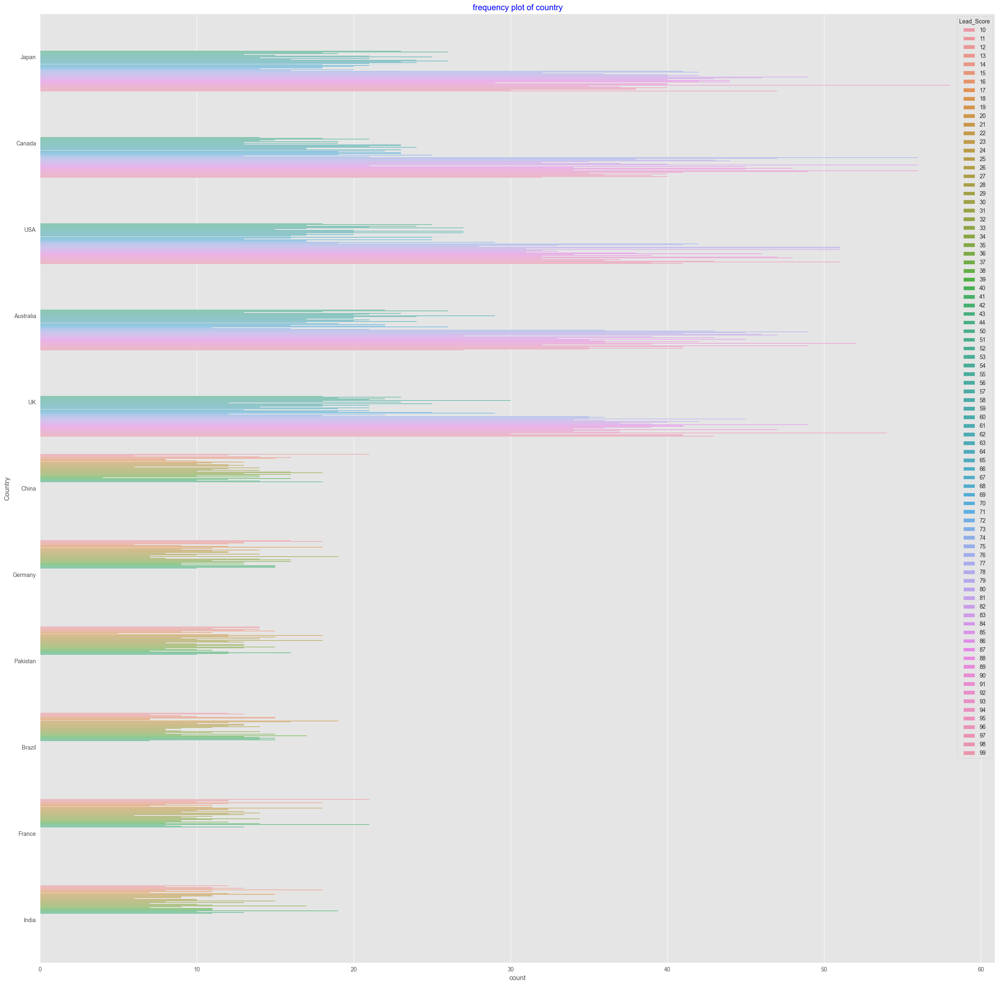

In [10]:
plt.figure(figsize=(30,30))
plt.title('frequency plot of country',color='blue')
sns.countplot (y='Country', hue='Lead_Score', data=leadscore_df, order=leadscore_df[ 'Country'].value_counts().index);

In [38]:
object_cols = [col for col in leadscore_df.select_dtypes(include = object).columns]
numerical_cols = [col for col in leadscore_df.select_dtypes(include = np.number).columns]
print('Categorical Columns: ')
print(object_cols)
print('Numerical Columns: \n{0}'.format(numerical_cols))

Categorical Columns: 
['Lead_Source', 'Country', 'Gender', 'Education_Level', 'Occupation', 'Industry', 'Initial_Response', 'Do_Not_Contact', 'General_Knowledge', 'Business_Knowledge', 'Company_Size', 'Lead_Quality']
Numerical Columns: 
['Age', 'Income', 'Total_Calls_Attended', 'Total_Meetings_Attended', 'Company_Estimated_Revenue', 'Lead_Score']


In [39]:
numerical_cols.remove('Lead_Score')
numerical_cols

['Age',
 'Income',
 'Total_Calls_Attended',
 'Total_Meetings_Attended',
 'Company_Estimated_Revenue']

In [40]:
#one hot encoding for categorical variables
leadscore_df = pd.get_dummies (data = leadscore_df, columns=object_cols, drop_first=True)
leadscore_df.sample(10)

,Age,Income,Total_Calls_Attended,Total_Meetings_Attended,Company_Estimated_Revenue,Lead_Score,Lead_Source_ORGANIC,Lead_Source_OTHER,Lead_Source_PAID,Lead_Source_REFERRAL,Country_Brazil,Country_Canada,Country_China,Country_France,Country_Germany,Country_India,Country_Japan,Country_Pakistan,Country_UK,Country_USA,Gender_MALE,Gender_OTHER,Education_Level_COLLEGE,Education_Level_HIGH SCHOOL,Education_Level_MASTER,Education_Level_PhD,Occupation_EMPLOYEE,Occupation_OTHER,Occupation_RETIRED,Occupation_SELF-EMPLOYED,Occupation_UNEMPLOYED,Industry_HEALTHCARE,Industry_MANUFACTURING,Industry_RETAIL,Industry_SERVICES,Industry_TECHNOLOGY,Initial_Response_NEUTRAL,Initial_Response_POSITIVE,Do_Not_Contact_Yes,General_Knowledge_BASIC,General_Knowledge_EXPERT,General_Knowledge_INTERMEDIATE,General_Knowledge_NOVICE,Business_Knowledge_BASIC,Business_Knowledge_EXPERT,Business_Knowledge_INTERMEDIATE,Business_Knowledge_NOVICE,Company_Size_MEDIUM,Company_Size_SMALL,Lead_Quality_HOT,Lead_Quality_WARM
1795,43,181000,3,2,4952000,91,False,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,False,True,False,False,False,True,False,False,False,False,True,False,False,True,False
5341,36,88000,4,2,8137000,66,False,True,False,False,False,True,False,False,False,False,False,False,False,False,True,False,True,False,False,False,True,False,False,False,False,False,True,False,False,False,False,True,False,False,False,True,False,False,False,False,False,True,False,True,False
9199,27,60000,2,0,652000,40,True,False,False,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,False,True,False,False,False,False,True,True,False,False,False,False,False,False,False,False,False,False,True,True,False,False,False,True,False,False,False
2301,52,129000,6,2,3313000,83,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,True,False,True,False,False,False,False,False,True,False,False,False,True,False,False,False,True,False,False,False,True,False,False,False,False,False,True,False,True,False
6702,41,81000,4,2,5186000,50,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,True,False,False,True,False,False,False,False,False,False,False,False,True,False,True,False,True,False
1208,50,186000,5,3,1539000,75,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,True,False
6021,36,83000,4,2,1148000,51,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,True,False,False,False,False,True,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,True,False,True,False
3610,48,104000,7,2,7117000,79,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,True,True,False,False,False,False,False,False,False,False,False,False,False,True,False,True,False,False,False,False,True,False,False,False,False,True,False,False,True,False
5506,39,95000,4,2,5373000,61,False,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,True,False,False,False,False,False,False,False,True,False,True,False,False,False,False,True,False,False,False,True,False,False,False,True,False,True,False,False,True
8769,30,39000,1,0,955000,30,False,False,True,False,False,False,True,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,True,True,False,False,False,True,False,False,False,False,True,False,False


In [41]:
leadscore_corr = leadscore_df.corr()
leadscore_corr.style.apply(lambda x:
                           ["background: lightblue" if abs (v) > 0.5
                            else
                            ( "background: lightyellow" if abs(v) > 0.3
                              else "" ) for v in x], axis = 1 )

,Age,Income,Total_Calls_Attended,Total_Meetings_Attended,Company_Estimated_Revenue,Lead_Score,Lead_Source_ORGANIC,Lead_Source_OTHER,Lead_Source_PAID,Lead_Source_REFERRAL,Country_Brazil,Country_Canada,Country_China,Country_France,Country_Germany,Country_India,Country_Japan,Country_Pakistan,Country_UK,Country_USA,Gender_MALE,Gender_OTHER,Education_Level_COLLEGE,Education_Level_HIGH SCHOOL,Education_Level_MASTER,Education_Level_PhD,Occupation_EMPLOYEE,Occupation_OTHER,Occupation_RETIRED,Occupation_SELF-EMPLOYED,Occupation_UNEMPLOYED,Industry_HEALTHCARE,Industry_MANUFACTURING,Industry_RETAIL,Industry_SERVICES,Industry_TECHNOLOGY,Initial_Response_NEUTRAL,Initial_Response_POSITIVE,Do_Not_Contact_Yes,General_Knowledge_BASIC,General_Knowledge_EXPERT,General_Knowledge_INTERMEDIATE,General_Knowledge_NOVICE,Business_Knowledge_BASIC,Business_Knowledge_EXPERT,Business_Knowledge_INTERMEDIATE,Business_Knowledge_NOVICE,Company_Size_MEDIUM,Company_Size_SMALL,Lead_Quality_HOT,Lead_Quality_WARM
Age,1.000000,0.631941,0.616302,0.715437,0.492288,0.734871,-0.319713,-0.229112,0.039914,0.090794,-0.256814,0.183148,-0.255438,-0.253570,-0.265804,-0.252273,0.171485,-0.256346,0.178566,0.169035,0.006706,-0.000885,0.236313,0.299649,-0.290051,-0.301689,-0.223938,-0.310063,0.298395,0.297802,-0.229938,-0.350557,0.241135,0.236219,0.233461,-0.396024,-0.095122,0.491200,-0.547229,-0.370803,-0.365298,0.241184,0.001093,-0.386086,-0.367030,0.241177,0.007210,-0.024497,-0.459863,0.490672,0.147824
Income,0.631941,1.000000,0.666906,0.712496,0.453471,0.780678,-0.298365,-0.348890,-0.004200,0.171319,-0.238624,0.167112,-0.240774,-0.241083,-0.240939,-0.226617,0.152756,-0.240533,0.157861,0.156868,0.004413,-0.002904,0.220572,0.357088,-0.362786,-0.372649,-0.347820,-0.295703,0.369846,0.372163,-0.342067,-0.331719,0.226669,0.214115,0.218566,-0.357122,-0.161013,0.516608,-0.511131,-0.343494,-0.338665,0.210292,0.006120,-0.347157,-0.345789,0.225992,0.009847,-0.131773,-0.429234,0.513926,0.067739
Total_Calls_Attended,0.616302,0.666906,1.000000,0.742957,0.489983,0.763131,-0.330826,-0.247171,0.033933,0.102707,-0.260247,0.182711,-0.271081,-0.258169,-0.268242,-0.252708,0.192202,-0.263524,0.169543,0.167225,0.002937,-0.009107,0.244637,0.301000,-0.309492,-0.315187,-0.249136,-0.321293,0.318239,0.305664,-0.242062,-0.363508,0.241907,0.243976,0.240645,-0.397861,-0.109088,0.507568,-0.562519,-0.379666,-0.374750,0.224712,0.007860,-0.384953,-0.380963,0.245925,0.006749,-0.029287,-0.478597,0.511244,0.139617
Total_Meetings_Attended,0.715437,0.712496,0.742957,1.000000,0.639965,0.874094,-0.420980,-0.186053,0.085881,0.046860,-0.333738,0.227762,-0.342473,-0.331630,-0.340410,-0.323946,0.227515,-0.336670,0.224112,0.222875,0.004691,-0.006311,0.302470,0.309177,-0.295957,-0.316169,-0.182571,-0.415707,0.315972,0.308407,-0.185865,-0.461552,0.312785,0.311254,0.303169,-0.507194,-0.067396,0.584663,-0.717500,-0.485048,-0.478369,0.304473,0.005667,-0.488207,-0.483463,0.309354,0.008756,0.061672,-0.608090,0.593112,0.248229
Company_Estimated_Revenue,0.492288,0.453471,0.489983,0.639965,1.000000,0.594666,-0.312874,-0.063798,0.080257,-0.001357,-0.247701,0.182063,-0.254186,-0.244765,-0.251757,-0.239669,0.158410,-0.250771,0.168176,0.159171,0.007991,-0.009987,0.224267,0.174905,-0.169835,-0.178098,-0.066735,-0.308253,0.185992,0.168242,-0.064023,-0.341934,0.226883,0.224096,0.236176,-0.375448,-0.010375,0.396456,-0.532680,-0.360305,-0.353759,0.219929,0.010852,-0.362311,-0.357263,0.230088,-0.002160,0.108888,-0.449894,0.406200,0.223389
Lead_Score,0.734871,0.780678,0.763131,0.874094,0.594666,1.000000,-0.392197,-0.284627,0.042382,0.120191,-0.308246,0.216454,-0.316754,-0.312475,-0.317890,-0.300901,0.211557,-0.316826,0.208845,0.207871,0.005380,-0.007899,0.279448,0.371372,-0.361898,-0.369171,-0.288067,-0.386879,0.369393,0.372831,-0.284807,-0.433950,0.288073,0.284104,0.292316,-0.473021,-0.146460,0.661618,-0.715844,-0.455306,-0.446804,0.279477,0.012445,-0.454365,-0.452736,0.294173,0.006327,-0.031679,-0.567239,0.661085,0.103873
Lead_Source_ORGAN

In [42]:
leads_x = leadscore_df.drop(columns=['Lead_Score'])
leads_y = leadscore_df['Lead_Score']
leads_x

,Age,Income,Total_Calls_Attended,Total_Meetings_Attended,Company_Estimated_Revenue,Lead_Source_ORGANIC,Lead_Source_OTHER,Lead_Source_PAID,Lead_Source_REFERRAL,Country_Brazil,Country_Canada,Country_China,Country_France,Country_Germany,Country_India,Country_Japan,Country_Pakistan,Country_UK,Country_USA,Gender_MALE,Gender_OTHER,Education_Level_COLLEGE,Education_Level_HIGH SCHOOL,Education_Level_MASTER,Education_Level_PhD,Occupation_EMPLOYEE,Occupation_OTHER,Occupation_RETIRED,Occupation_SELF-EMPLOYED,Occupation_UNEMPLOYED,Industry_HEALTHCARE,Industry_MANUFACTURING,Industry_RETAIL,Industry_SERVICES,Industry_TECHNOLOGY,Initial_Response_NEUTRAL,Initial_Response_POSITIVE,Do_Not_Contact_Yes,General_Knowledge_BASIC,General_Knowledge_EXPERT,General_Knowledge_INTERMEDIATE,General_Knowledge_NOVICE,Business_Knowledge_BASIC,Business_Knowledge_EXPERT,Business_Knowledge_INTERMEDIATE,Business_Knowledge_NOVICE,Company_Size_MEDIUM,Company_Size_SMALL,Lead_Quality_HOT,Lead_Quality_WARM
0,51,175000,3,3,4977000,False,False,False,True,False,False,False,False,False,False,True,False,False,False,False,True,True,False,False,False,False,False,True,False,False,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,True,True,False,True,False
1,57,135000,4,3,1552000,False,False,False,False,False,False,False,False,False,False,False,False,True,False,True,False,False,False,False,False,False,False,True,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,True,True,False,False,True
2,57,175000,7,3,7503000,False,False,True,False,False,False,False,False,False,False,False,False,True,False,True,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,True,True,False,True,False
3,35,165000,4,2,7134000,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,True,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,False,True,False
4,46,131000,6,3,1876000,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,True,False,False,True,False,False,False,False,True,False,False,False,False,True,False,False,False,True,False,False,True,False
5,56,153000,5,3,7798000,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,True,False,False,False,True,False,False,False,False,True,False,False,False,False,True,False,False,False,False,True,False,True,False
6,44,110000,7,2,5276000,False,False,False,False,False,False,False,False,False,False,False,False,True,False,True,False,True,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,False,False,True
7,58,115000,3,2,2150000,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,True,False,False,False,True,False,False,False,False,False,False,False,True,False
8,41,153000,7,3,1167000,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,True,False,True,False,False,False,False,False,True,False,False,False,True,True,False,False,True
9,52,159000,7,3,8051000,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,True,False,False,True,False,False,False,True,False,False,False,False,True,True,False,True,False


In [46]:
X_train, X_test, y_train, y_test = train_test_split(leads_x,
                                                            leads_y,
                                                            train_size=0.7,
                                                            test_size=0.3,
                                                            random_state=100)

In [47]:
sc = StandardScaler ()
#Create X_train_scaled, X_test_scaled
X_train_scaled = X_train.copy()
X_test_scaled = X_test.copy()

#Fit and transform Train
X_train_scaled[numerical_cols] = sc.fit_transform(X_train[numerical_cols])

#Transform Test (No Fit)
X_test_scaled[numerical_cols] = sc.transform(X_test [numerical_cols])

In [48]:
#Logistic regression model
logm1 = sm.GLM(y_train, (sm.add_constant (X_train_scaled)), family = sm.families.Binomial())
logm1.fit().summary()

ValueError: Pandas data cast to numpy dtype of object. Check input data with np.asarray(data). The types seen wereNone and const                              float64
Age                                float64
Income                             float64
Total_Calls_Attended               float64
Total_Meetings_Attended            float64
Company_Estimated_Revenue          float64
Lead_Source_ORGANIC                   bool
Lead_Source_OTHER                     bool
Lead_Source_PAID                      bool
Lead_Source_REFERRAL                  bool
Country_Brazil                        bool
Country_Canada                        bool
Country_China                         bool
Country_France                        bool
Country_Germany                       bool
Country_India                         bool
Country_Japan                         bool
Country_Pakistan                      bool
Country_UK                            bool
Country_USA                           bool
Gender_MALE                           bool
Gender_OTHER                          bool
Education_Level_COLLEGE               bool
Education_Level_HIGH SCHOOL           bool
Education_Level_MASTER                bool
Education_Level_PhD                   bool
Occupation_EMPLOYEE                   bool
Occupation_OTHER                      bool
Occupation_RETIRED                    bool
Occupation_SELF-EMPLOYED              bool
Occupation_UNEMPLOYED                 bool
Industry_HEALTHCARE                   bool
Industry_MANUFACTURING                bool
Industry_RETAIL                       bool
Industry_SERVICES                     bool
Industry_TECHNOLOGY                   bool
Initial_Response_NEUTRAL              bool
Initial_Response_POSITIVE             bool
Do_Not_Contact_Yes                    bool
General_Knowledge_BASIC               bool
General_Knowledge_EXPERT              bool
General_Knowledge_INTERMEDIATE        bool
General_Knowledge_NOVICE              bool
Business_Knowledge_BASIC              bool
Business_Knowledge_EXPERT             bool
Business_Knowledge_INTERMEDIATE       bool
Business_Knowledge_NOVICE             bool
Company_Size_MEDIUM                   bool
Company_Size_SMALL                    bool
Lead_Quality_HOT                      bool
Lead_Quality_WARM                     bool
dtype: object. The data was
1191    78
4458    83
1131    78
9562    37
6579    73
4201    77
138     80
9407    41
5327    60
6815    60
8315    44
35      82
551     96
5120    74
4359    90
8383    27
6586    57
3163    78
4712    84
4696    92
9901    30
2252    82
3952    87
8778    37
4838    98
3437    79
4165    79
7433    68
2126    94
4267    76
7606    24
2629    82
8576    40
8611    24
565     75
202     76
6695    59
5756    58
6014    59
9102    33
8062    34
4398    97
5695    65
7421    65
9461    22
8578    17
2047    89
974     77
8606    28
7523    15
3557    79
3990    96
1418    80
1567    76
4404    84
1482    99
5246    59
4635    98
3844    85
7174    71
5568    54
7913    20
8487    15
8164    35
409     88
3424    96
5722    61
4674    84
8662    15
6962    55
2400    86
5786    66
8118    23
4463    95
3040    98
3717    85
3534    83
6518    71
3197    98
3773    99
8451    25
7056    66
8230    19
6046    58
1795    91
5734    62
8547    34
5663    74
1160    82
7291    70
3047    84
2348    81
7305    50
2200    92
5467    52
3017    86
3077    80
9267    42
945     80
7547    28
8479    19
6273    68
1811    75
5571    71
9289    38
5778    66
3289    97
4493    91
682     76
2970    93
2886    94
8440    16
7822    30
4346    95
9640    17
7080    51
8642    21
67      86
8373    36
5656    56
2050    91
4080    78
1441    78
642     81
4745    79
1614    86
5045    63
107     91
6515    51
9869    20
5667    61
9775    20
5708    57
2337    99
5842    74
0       83
6743    62
3300    80
6396    63
246     92
5161    67
4733    78
609     76
8629    35
2114    75
4064    94
6702    50
6139    69
8465    35
1628    84
7131    69
9361    10
6399    70
4717    88
4697    90
4815    95
3016    79
2485    90
8037    37
2305    78
1590    76
7255    67
1294    83
1789    75
3760    89
6251    63
6460    66
2378    79
5362    71
392     85
9342    23
3245    96
5196    60
4941    81
7155    64
9460    40
7920    34
4902    77
6754    64
569     80
8239    43
815     75
4363    78
4451    97
715     92
7800    12
4802    86
440     99
7485    51
5208    66
9787    38
7924    23
2849    85
1762    82
9330    38
4104    86
5328    52
1592    92
1688    75
8299    27
9928    24
5874    65
7689    13
7837    35
798     82
4913    78
9826    42
4679    99
4107    91
3943    95
7118    67
2782    90
8491    24
9646    43
5915    59
1870    84
4504    91
285     79
1666    99
9711    27
5522    60
4890    86
6607    53
3820    92
5063    59
4575    91
4675    92
4801    80
5582    63
9041    34
2893    95
2081    86
2269    92
1087    87
3881    93
2213    75
1636    84
2995    97
9845    33
4184    82
4090    95
196     93
4011    91
8776    24
468     95
3003    88
2752    94
1352    94
4449    79
512     92
2532    90
4446    81
3541    92
1292    84
6493    53
9704    40
1806    92
5855    67
1781    80
5044    52
4366    80
7132    67
5951    63
4686    84
2426    95
4484    98
3640    86
4652    94
9751    36
6313    55
6961    57
201     79
7570    44
6499    55
134     92
5991    59
2884    84
7197    50
1056    93
9201    25
4866    75
1776    83
6083    56
5159    71
6800    74
6926    72
5535    57
5350    50
5224    50
8594    11
628     91
4864    91
9979    27
676     76
6254    50
3958    79
1901    88
2228    79
8438    13
7788    15
8511    19
1449    76
2965    84
9497    14
5488    60
8809    44
3560    87
8709    39
3502    81
7831    14
9417    24
8685    20
8325    38
1181    75
1402    92
1451    88
6976    62
3720    85
6968    70
857     96
7610    20
6578    72
9862    20
6367    69
7657    14
8266    17
2863    77
54      80
3160    89
6582    62
119     82
1206    98
3589    81
1821    90
8575    27
7436    59
8891    39
9588    27
3796    94
3019    86
5084    56
7545    17
4072    89
7685    31
4608    81
4670    89
6957    73
8069    25
3785    75
4356    79
8679    11
7267    55
3278    79
7622    25
5885    55
5024    52
208     75
892     90
8714    23
2972    76
5827    67
7408    73
371     89
6191    61
2527    75
2120    85
728     78
1711    90
2757    75
8149    40
5852    74
6816    54
2986    92
7157    53
6209    52
1072    85
6803    65
557     79
1860    88
3963    99
5081    70
9356    29
5614    61
7893    38
5109    52
3242    93
6639    59
5780    68
6418    61
5065    71
2167    77
336     75
5837    64
710     82
9350    18
9052    20
1042    94
7378    62
3649    96
3108    78
9282    27
9884    13
3387    86
8449    27
3057    75
944     83
4613    87
6397    74
7206    56
5825    68
9103    23
4391    82
5585    54
8549    23
4128    89
6543    59
5978    69
6456    65
7181    60
7981    26
1990    82
7505    19
3092    76
4192    80
4225    98
1318    84
8188    22
4809    76
1625    98
2488    96
9917    10
7043    69
3026    78
9969    31
7047    73
9768    18
7371    73
6010    70
4585    96
868     96
288     99
152     88
4116    95
297     81
8257    20
2386    89
9335    24
1908    76
482     96
6125    59
747     79
367     96
9105    19
3886    78
2833    78
4855    84
8422    36
4698    87
6065    52
1303    79
5942    64
1755    86
5406    71
3757    76
5176    68
1171    90
8951    10
1662    86
1286    89
6645    72
3342    75
8420    37
1912    79
5292    65
6748    61
8877    32
4758    99
7757    39
5581    55
5910    64
9955    34
527     75
7601    39
8204    16
823     85
785     92
8741    41
5926    73
1047    77
3141    97
6877    50
7400    73
7602    41
8605    17
6560    59
6785    64
7381    56
2363    76
1059    84
3630    96
6643    65
9692    29
1994    92
3039    97
3175    82
9956    42
6394    72
5672    60
3639    83
8676    41
8295    35
1909    86
6183    59
1671    98
8955    29
3147    89
9186    10
8106    13
2345    90
9265    15
5629    61
4274    79
5010    59
332     96
1190    91
594     90
480     91
9463    37
5486    64
7417    65
9975    41
4496    83
1141    89
9399    38
243     99
7809    14
9784    38
5691    67
7756    24
9137    35
223     87
2736    85
8843    26
1704    96
4032    97
6305    74
7249    63
828     75
4034    87
9078    42
5095    56
6445    67
6704    61
6066    62
7955    23
8068    41
5125    62
4694    77
2245    89
4897    89
8489    29
7820    35
3957    85
8944    33
7089    73
3763    83
8138    34
3383    85
1260    88
8456    12
1222    83
1479    77
7617    44
416     94
1307    98
6742    54
399     90
4204    94
2357    87
2083    90
3766    96
3790    91
3669    84
323     97
1683    85
8645    19
3682    93
667     91
6420    74
2808    80
1358    93
9416    22
6019    73
4638    84
8961    15
8294    22
1300    95
260     96
6355    69
3599    88
8969    19
4616    93
9660    19
7519    35
1495    77
1234    77
4044    99
9707    20
8661    44
8289    10
8113    15
9743    24
1538    78
5025    65
6832    69
9776    22
1383    95
2141    96
7035    61
8163    24
1588    82
2048    93
9118    41
4190    97
2219    84
4361    99
3765    89
5587    59
9051    22
9607    27
7818    33
5173    74
535     95
2840    83
1299    75
6604    64
644     83
2224    90
1812    86
7536    10
130     97
4706    77
5429    51
9783    41
5664    63
356     83
7472    61
3769    98
6052    50
546     86
3204    93
4760    85
7553    33
825     81
5845    65
9708    26
4240    92
2275    88
883     76
6658    63
5623    60
538     77
6288    61
3509    99
393     76
2946    85
6180    59
981     94
9675    25
6971    52
8754    14
1394    91
65      79
6384    55
5776    66
9420    44
8497    10
709     97
4982    83
9895    35
6834    64
738     89
3434    89
6091    74
8201    14
9532    39
6479    53
1890    88
9093    18
8738    32
5746    51
2577    86
5923    63
2387    88
1433    86
9936    32
3100    75
2071    87
2106    88
1623    83
2347    99
3196    79
2318    95
1156    88
9241    41
9825    32
9986    36
19      94
6215    57
7054    57
4560    82
1060    84
8740    17
3704    87
951     91
497     85
4456    79
4800    78
6879    56
3010    79
7537    15
4304    76
958     83
8853    39
6562    58
9693    29
6169    62
4326    92
9101    17
7261    73
3184    82
2545    92
3264    96
3919    83
5798    70
214     87
2948    91
2764    82
4420    81
7872    19
5264    61
1219    89
1007    81
7884    34
1989    94
3456    77
3742    81
2453    89
2411    84
7777    38
5701    62
5970    65
1801    92
3665    94
7252    54
8626    37
8151    25
719     87
3827    83
8745    10
7184    66
621     99
226     79
9958    17
6929    67
9358    44
2152    86
4928    92
6623    55
4037    96
1871    81
9964    16
9610    24
7968    36
9243    33
6030    60
4689    99
3811    94
7036    51
4288    89
8804    35
987     94
7860    19
398     86
1032    91
3563    93
7648    43
2820    92
5302    62
6330    55
712     97
814     82
3145    94
5724    55
4687    95
8689    10
5058    60
9621    10
1050    96
9421    31
3924    78
9880    33
7211    58
8453    29
301     98
2175    98
7292    66
9620    36
347     77
2796    88
7794    43
8288    33
3995    82
3988    93
2712    83
499     76
9014    32
6228    61
4316    97
2968    90
504     79
5068    52
6551    69
1835    83
1756    78
5904    53
7764    27
3073    90
7458    59
498     75
8105    23
5821    55
9431    26
8166    42
8488    37
5578    72
7243    71
8590    44
2953    94
5880    59
6015    61
7614    42
9685    28
5198    50
8725    34
7427    57
3118    78
2196    87
1599    75
3499    78
9623    22
5428    73
9255    19
6875    69
7167    69
7527    17
6381    58
7301    74
7462    70
8088    27
2278    86
6316    70
2714    94
3280    83
561     78
936     96
8348    24
5309    57
5760    51
9409    38
5902    62
7868    31
8450    35
2440    86
543     78
4624    89
455     79
5932    70
6739    55
8141    36
3710    94
8222    23
6628    70
8836    23
1412    79
8494    40
5621    73
7940    11
4360    79
7323    58
5575    56
4783    93
3837    93
5254    52
9023    43
5442    64
3683    89
8635    17
300     78
9377    13
5676    69
4649    90
8837    37
4019    79
3916    84
6882    51
8789    42
6860    72
9464    29
9695    27
1904    97
3113    76
1510    79
2837    75
4167    81
9811    35
3059    80
3591    78
7535    40
9569    25
6530    64
7360    74
7679    11
7861    31
294     87
2935    83
6932    58
1011    81
4106    89
9149    40
1613    75
7259    50
8167    15
8476    17
8475    13
2812    96
4821    76
4317    75
6550    70
5986    55
42      88
238     79
3700    80
3986    82
7336    69
7760    37
7193    62
4573    99
2268    76
8036    15
7434    68
5015    52
9192    25
7446    72
8903    33
11      99
2190    75
3142    84
813     85
6391    54
4075    97
9202    25
2138    83
358     91
7034    69
973     98
9036    26
5602    69
8817    36
1228    88
4082    81
7560    30
7941    38
5804    61
9419    38
1197    84
1374    84
2110    97
4002    90
5258    67
6784    56
6634    70
9139    10
8517    31
7900    43
2759    97
403     78
9543    41
6687    61
5749    67
7389    57
4403    97
1800    86
1253    88
2419    82
7879    29
2182    87
4611    91
2130    91
6522    69
1553    89
4134    80
1184    79
3543    80
3979    81
7626    12
4947    88
7495    60
1673    87
7714    28
4390    80
6812    55
1493    99
326     92
3556    90
3842    94
1136    82
265     91
3587    82
9586    14
4350    79
6893    70
2139    91
6692    61
4406    82
9030    30
144     98
4189    92
2827    82
4979    77
271     81
3888    76
9531    11
5510    60
1187    95
3247    91
5929    53
8555    12
5913    50
4598    93
6459    67
9010    22
6575    60
7691    13
5631    62
6431    61
3688    91
2342    95
1750    97
3555    86
1089    79
247     78
3674    84
1450    78
1952    84
2908    94
1746    93
1893    92
4812    76
3724    80
1215    94
3951    86
1301    80
5653    66
4597    97
8146    43
8437    14
7882    41
5889    62
6205    64
7091    72
4612    86
3636    98
6792    51
7064    65
8781    29
8681    37
6937    71
3618    86
852     79
4887    88
5918    61
1147    85
3540    77
933     76
1403    95
104     89
3316    86
5519    66
8551    32
3743    86
2517    77
647     82
1626    81
2100    75
6770    72
5072    58
7311    68
6935    61
536     90
5277    66
9835    19
1745    99
9795    32
7310    63
8085    44
6084    59
656     85
9400    35
6245    69
1103    99
6749    59
8502    15
5061    62
3313    75
9025    34
8410    10
2985    82
7199    61
9625    21
2601    87
4212    86
8423    38
1241    89
1006    88
6416    57
475     85
9270    25
8241    13
949     83
3660    89
364     83
5909    69
5740    57
8382    19
1469    83
7754    21
842     82
7394    52
3567    96
5443    57
1607    79
2010    91
611     81
2464    82
7159    73
4482    91
6454    70
8705    36
3297    85
1408    89
6777    66
8761    36
7673    33
5307    50
1863    77
5643    71
8309    27
1943    96
1615    84
2162    77
3104    87
8504    11
4163    79
3500    86
3483    92
5077    68
3376    85
7238    55
1931    78
9614    12
5613    71
7070    64
9441    36
1014    87
1129    75
8845    10
2069    88
3764    96
5216    69
2077    86
8248    21
6175    62
8193    21
457     85
6222    73
4437    89
3936    81
3231    87
7774    20
7120    63
3426    84
9306    40
4148    96
4567    80
3982    81
1173    94
6979    63
8452    43
2180    99
233     96
249     75
2037    96
598     78
2740    80
8308    17
7925    23
6142    66
5693    56
2936    99
6524    66
6432    59
8285    36
1098    94
2149    88
4050    78
3711    84
329     99
6676    71
3736    78
3517    91
1694    93
6997    59
6511    61
4583    80
1676    92
1823    75
8823    21
6606    64
1218    86
4503    87
6118    51
6876    60
5680    56
8790    38
7357    68
5788    68
2685    92
2823    87
9046    35
7783    22
2514    85
7352    54
6874    69
4450    88
4768    79
2745    78
4510    91
1830    93
953     97
5474    62
6880    51
8323    30
3482    85
3198    80
9541    25
8251    18
2544    77
8813    13
1587    81
9305    41
7058    73
3520    77
697     96
6012    62
6435    60
2746    93
1058    85
205     78
3595    84
4256    96
3443    97
7276    73
2237    85
1699    86
9235    31
6213    57
3911    91
9221    43
6644    68
2519    75
2093    92
2911    94
6117    68
7213    70
9899    22
562     97
2144    96
1612    94
1183    84
8374    15
1585    79
4852    84
4765    81
3992    84
1728    92
8460    11
4294    76
5494    64
2990    76
4088    90
9587    40
3577    97
7468    72
2384    95
796     96
3959    79
4413    92
3433    90
6675    65
8189    16
3274    75
624     99
3054    85
3014    89
7095    60
3087    78
9440    29
8930    33
3753    99
3338    77
9896    16
2289    89
9412    37
845     93
6822    70
126     97
4417    94
3524    97
7040    59
6782    55
1065    95
8468    32
8990    32
3015    76
1227    94
8710    41
994     91
6924    73
3870    80
1808    79
8797    35
7816    43
2865    76
3576    83
158     82
1791    81
8913    19
484     76
6433    50
5584    65
6458    69
9635    28
3935    84
3356    95
9544    40
1651    82
4444    89
4827    89
5907    55
5046    54
5356    71
128     91
4409    82
3899    81
68      92
5190    60
8445    42
7983    44
608     83
7466    64
85      93
4858    80
408     96
2699    91
7966    26
3263    92
3209    92
1824    91
9472    15
1257    76
1327    89
3813    76
6054    63
9212    23
9142    35
1558    84
3824    92
7984    36
8596    14
5329    56
9757    29
5675    58
6735    59
3451    98
2104    94
2889    95
9892    33
5815    57
9779    38
2001    86
4282    81
1100    81
3751    93
3044    91
6653    50
2800    93
6140    70
5098    66
8538    11
763     86
8110    11
1828    89
4776    87
9523    27
4272    88
1782    79
5435    66
1563    89
9228    29
891     87
3535    76
6320    59
9995    27
678     80
135     94
3775    82
4720    82
5466    66
675     98
3484    82
3377    92
8190    40
8707    21
8791    35
2779    90
4325    91
4057    98
375     99
3495    96
9837    10
5484    66
3043    75
8865    17
4022    76
4051    76
1709    94
4753    94
7327    68
662     88
5093    71
9616    10
1880    86
7580    21
8303    42
8005    11
3946    86
4530    87
2850    90
1843    88
4478    87
7725    21
3501    82
9454    38
3777    83
6809    57
1398    75
423     80
657     94
2786    83
1770    93
2665    75
2155    93
1757    85
381     77
3324    84
1784    88
1571    93
3256    81
7379    55
8731    43
5666    62
1710    78
1794    97
1132    93
210     87
302     76
8150    23
7781    41
780     81
1596    84
3115    84
4534    97
9154    36
7293    63
7278    60
7121    71
7575    42
4651    81
6485    63
8184    34
9930    15
3497    92
3522    99
9738    15
3939    99
1316    94
5150    51
6240    52
5537    63
2628    77
1140    79
4663    75
5576    56
1039    91
2557    97
4457    92
333     92
2994    95
9981    25
6383    65
1297    95
3271    98
7558    33
1031    87
3676    89
2500    81
9596    32
9035    32
7763    18
4814    85
5808    58
8300    15
778     75
2695    79
6891    51
3845    79
3302    81
3085    92
5858    59
9633    33
2702    91
317     97
9474    11
1923    86
2551    75
4808    97
2062    77
4255    89
6352    54
3530    85
1262    88
221     96
6617    71
9283    25
1731    88
3694    95
5647    74
9529    17
8084    29
1165    95
4771    82
6993    66
2690    92
1172    89
2567    91
799     85
1323    77
5346    68
8139    29
3465    82
2333    87
7747    26
3328    85
4883    93
752     82
4889    81
5477    66
390     99
7833    17
2905    89
8079    24
174     78
479     98
3232    76
9542    41
9728    42
2313    92
4257    78
7869    35
7010    65
8333    32
5928    57
2511    91
5943    56
6850    59
4111    81
8632    13
4307    92
91      95
6147    51
966     92
7646    16
6521    58
1594    82
636     86
3326    88
2604    77
7916    11
2195    88
5326    60
7275    50
3885    98
2091    97
8856    20
20      85
5       94
6242    67
436     79
3972    92
2403    77
2832    91
2178    96
6337    51
6890    54
941     97
7123    71
2892    98
3158    83
3005    89
9177    14
2939    82
9570    10
7297    54
6293    67
5789    71
8831    35
1092    75
2247    96
6275    53
1827    78
3388    86
5944    50
3583    96
4656    76
8574    31
2890    92
7585    20
1313    84
2129    91
6170    68
3678    91
3735    94
1078    97
5431    57
3923    95
7296    57
6813    50
7391    69
3934    90
4752    83
9494    38
3553    83
9039    41
6863    74
5123    69
737     98
5679    66
3041    83
3396    92
9699    10
361     77
7114    50
6595    63
612     91
9062    36
1447    97
4789    86
5407    74
8760    22
5598    58
3169    95
9807    39
4203    78
2409    98
7105    59
8132    38
4097    82
934     96
1230    75
8664    24
6602    52
6303    71
5275    50
8824    37
3833    84
3440    90
6793    53
4844    92
1961    93
3454    86
4925    78
6713    53
1895    89
5268    68
2362    96
8840    11
5476    51
743     81
1693    85
6635    70
9029    24
2866    76
791     87
8267    33
8703    31
6107    53
3002    96
2703    78
385     81
7000    65
6264    61
9688    26
4147    88
8641    40
1472    81
6470    62
6660    58
306     95
8354    34
2146    97
2620    96
1348    76
192     87
2845    84
990     97
8360    30
4452    92
4935    83
6989    55
3314    83
2382    78
7942    30
4511    84
330     76
7895    40
9920    16
3282    86
876     92
1084    95
3512    92
2449    93
7399    72
6338    70
7137    59
1256    84
9724    29
8261    27
7345    55
3290    87
8997    25
56      99
7152    54
9161    44
7222    74
3258    95
9302    28
8965    36
2087    99
9555    42
4185    87
4830    96
9528    43
1266    75
6188    57
2700    94
5151    59
2390    91
1804    75
5107    71
5291    57
1005    82
7659    18
1769    78
3049    91
2462    96
640     84
2101    76
3686    92
7578    33
754     86
8656    20
8297    33
6393    66
6110    74
6484    60
9913    30
1391    96
1841    80
4320    89
6888    59
910     89
1987    83
9809    44
4065    77
2480    80
807     80
9001    22
1622    91
4084    91
6693    67
759     78
593     87
571     86
500     85
3487    75
4010    83
9568    23
3749    79
1127    88
651     77
6164    71
6195    52
9559    30
1158    99
2961    78
7918    19
8331    21
7006    60
7044    66
8993    29
2458    99
8314    34
6885    64
510     77
3638    91
5074    55
943     75
5451    68
8513    13
7407    61
511     83
3840    76
2134    98
4125    80
5417    65
959     95
2747    77
6605    61
7883    27
7976    36
8506    31
6500    51
3747    93
4922    92
9527    19
1556    79
3818    82
7130    54
5661    62
3623    91
8942    11
9007    42
6898    55
5579    68
903     93
9278    14
7248    51
4053    76
1359    80
6594    55
1530    98
3413    79
6307    63
7807    42
5240    57
4219    95
9462    39
5528    74
1527    98
9816    36
8844    15
6237    58
3803    88
6839    66
2058    97
1036    95
8936    11
3101    79
5797    67
888     95
8111    21
2430    79
8812    21
2962    86
8954    29
3629    86
1169    92
821     92
4786    75
7051    73
1157    96
6023    55
768     99
6532    71
7138    59
6443    53
6680    61
4962    77
1780    86
1453    76
908     82
3315    80
8034    20
3407    77
8004    33
5863    71
7538    39
7719    27
4494    94
3542    95
4829    76
6392    53
3229    81
1356    95
3792    89
8560    13
2395    99
1237    99
4528    78
9841    22
7338    52
6171    50
3738    87
7666    16
8177    31
3148    99
8793    33
5194    73
4778    80
5875    69
9820    26
4731    88
321     77
3784    89
2634    81
3721    99
5898    55
5872    66
6886    71
6791    67
5345    55
7629    18
950     83
4202    75
7454    73
1232    76
4384    78
631     78
7992    28
5347    71
558     83
8821    32
2676    78
2456    94
8607    19
1337    95
2755    97
5511    72
9485    37
9831    43
8828    20
3475    81
6299    64
2222    91
7180    63
3668    84
6309    70
9662    34
3879    84
8287    31
7846    13
9380    21
5612    55
9351    25
8746    12
4402    91
1617    77
9260    25
720     99
183     77
6409    65
3165    82
3427    79
750     84
5822    73
2423    98
2767    99
1017    76
3653    84
3572    86
281     78
5106    58
2672    83
869     81
614     82
3687    84
7425    68
1771    79
2330    82
4688    99
8900    42
1918    78
2648    94
8246    26
9965    16
6710    59
46      88
483     89
1766    96
366     78
6291    62
2143    91
3762    96
7149    64
8427    32
3009    82
2693    93
3759    85
6768    58
9813    17
7506    26
193     79
3112    84
7947    13
4313    78
7271    74
6207    64
4191    98
2172    87
4150    99
8378    42
7898    14
4520    90
2350    84
8182    36
1481    82
2322    79
9293    19
7265    66
6944    52
5532    59
1392    96
2493    78
3458    85
8747    15
2495    82
8340    16
5833    72
9064    19
3728    88
6411    57
7088    60
923     95
1486    91
3513    93
7700    23
2203    93
8283    37
9718    39
6269    59
7273    63
3103    82
8564    28
8366    30
5375    56
7112    63
8764    17
7713    30
4973    77
9059    39
878     89
6574    63
359     91
4711    92
8122    34
8256    27
6864    63
3606    92
4018    88
266     85
3381    83
5792    59
4338    99
8044    21
3905    84
6779    70
8058    41
389     76
4480    98
4784    90
9946    15
2370    84
5066    71
2310    93
7401    66
3447    90
5279    63
4436    98
9018    13
1034    80
2099    77
9075    24
5405    55
9794    25
5458    64
7465    73
1150    95
2299    75
8848    42
8143    10
8768    14
3217    96
3222    93
1718    83
7922    33
6859    51
1677    87
47      91
2272    96
2709    94
4748    77
9846    44
4949    94
5186    57
8389    26
6360    74
1104    75
8387    16
9709    12
3359    99
1377    89
2896    91
4078    90
8522    21
6466    68
4555    97
3068    97
4521    82
1657    79
1088    99
9341    39
8249    21
591     86
4178    94
4015    75
5549    53
3095    79
7819    44
1660    87
8023    33
8096    39
851     89
2635    89
9682    19
5801    65
4144    81
6738    66
2457    83
7823    22
1386    86
7721    14
4804    95
6699    65
8711    34
9240    26
7061    65
5521    59
7405    74
7935    24
8025    23
8363    30
7493    54
9445    10
2136    84
5977    72
9363    19
9478    39
1724    76
4607    95
4629    89
6851    50
9081    15
5026    62
8901    28
3503    81
7574    24
1090    83
8181    35
2677    84
9280    42
4641    93
4321    92
2073    95
8527    13
2212    81
9653    24
617     93
7169    74
2227    92
2982    99
9980    44
9476    36
3432    99
6837    55
8948    44
5888    55
7845    17
5299    69
5513    65
1001    90
5492    72
902     95
9087    28
9663    38
5027    62
6184    52
3060    95
6652    63
8463    20
4933    95
2691    97
3505    89
9756    32
3712    98
7706    41
4379    80
961     80
5817    73
515     78
7724    37
2015    90
4337    92
3750    84
8721    39
1097    95
7914    30
5732    70
2346    99
3758    85
2606    80
1954    87
9116    39
1934    98
5215    64
9727    29
2192    98
6510    55
2861    86
2869    98
7125    58
6173    69
4455    90
9651    23
5175    54
6318    66
2004    81
9120    24
5784    51
2053    93
1712    96
9856    14
3362    92
90      81
495     90
6765    58
2568    97
5747    57
1583    92
3187    95
2836    97
9339    42
6755    59
4153    86
1123    94
9630    41
8099    13
5630    62
8053    22
5728    61
4126    92
1997    81
2974    76
3909    94
2872    92
7605    21
5164    54
917     95
1858    99
9860    17
8839    15
1298    80
7229    63
541     99
519     86
5423    64
1569    77
2401    97
8439    30
1508    87
4981    86
9548    37
3828    99
4775    90
1953    88
5993    60
1855    82
9847    29
3128    95
9086    22
5524    55
92      89
1661    81
875     99
5374    65
413     94
7758    38
111     98
7101    50
8480    29
2086    84
8520    24
864     95
9850    35
471     81
7218    56
6370    68
2052    81
3345    80
4070    92
7554    20
8920    19
5440    62
7827    34
812     89
1155    99
2016    86
9414    25
1915    95
8532    19
2731    80
4854    95
9015    33
8077    25
8321    10
3609    79
9060    10
5132    54
7246    51
8173    17
6378    57
1395    94
5883    62
3322    86
8728    25
8700    19
1516    79
1319    87
1643    98
8083    40
4999    75
1208    75
5210    72
6596    59
2801    79
263     88
2094    95
6506    67
6584    60
7711    18
9669    10
7681    39
5380    66
2860    91
1544    79
7854    40
1096    97
7499    52
401     86
9918    21
6567    67
5779    61
3210    94
8221    44
8507    12
6970    54
1939    91
5818    72
4561    86
4414    91
4945    81
9386    21
9104    42
9691    42
9808    27
4119    98
1796    80
338     82
7129    55
9011    24
7852    21
4079    82
4259    93
1122    92
7375    62
9197    10
576     77
2068    97
9301    20
3527    92
4566    95
5028    50
5112    72
9234    24
1772    91
9705    19
4246    84
4253    89
6379    51
899     87
149     90
5729    67
2608    80
3249    78
14      87
6736    65
3448    93
3579    91
8393    31
3150    94
4701    87
5400    73
789     84
5601    50
9730    14
7548    10
6601    62
4226    92
8220    19
3414    77
1540    95
1367    76
2729    91
3471    84
3033    93
6525    71
461     97
8027    16
8924    33
2039    95
3644    88
7525    35
1166    76
5220    70
3031    91
1936    83
1497    90
7240    65
3791    97
7850    37
2338    96
784     94
7592    41
8093    33
6966    53
9178    39
150     99
2142    99
6716    54
1685    79
1532    95
7909    15
5007    52
8759    43
4193    84
4       98
2437    85
8665    20
8125    36
8921    30
5611    65
4473    97
7309    72
6848    66
8424    11
3090    90
7269    73
8419    36
7540    18
2056    78
222     79
2332    87
8351    23
3368    88
5712    66
3633    89
7491    59
7076    74
7085    71
125     89
6232    65
6762    51
1484    91
2657    77
8736    30
3925    90
7934    24
9812    29
6892    65
984     91
3805    80
9465    28
4395    88
7782    20
114     84
7026    65
9763    15
886     80
9073    35
7634    32
9215    25
811     80
846     90
1618    94
2321    94
5000    53
4811    84
8653    12
5645    55
3435    75
5840    57
9798    38
9370    11
8598    42
4551    95
6158    63
7288    58
3808    92
3375    87
2925    77
7562    44
8461    44
2543    94
7494    71
2408    91
6403    70
4499    78
3559    89
6884    54
8889    17
2368    84
1916    94
721     92
8478    14
7143    56
8435    38
1063    77
3492    83
9561    38
5886    67
9285    34
9272    34
8448    18
6297    57
9563    25
145     75
7397    70
4027    76
9172    29
7891    18
3089    88
5626    58
6657    60
5529    59
6820    54
3048    89
8216    20
3323    99
7567    27
3389    81
976     92
6537    65
4910    96
5252    68
6128    74
1483    96
6395    55
8400    15
8426    17
3799    96
8313    40
757     80
6043    56
4676    75
5538    69
7899    19
4265    94
6096    56
7055    59
5688    74
2204    89
6016    62
7712    37
1698    85
7410    72
7959    31
7573    20
1684    86
1697    90
6640    63
1291    87
6437    61
2618    95
8127    12
9364    12
1101    96
7902    32
2643    78
9546    15
2043    89
1982    98
6952    68
3226    78
1423    90
8798    36
8082    34
9091    10
8473    16
5480    73
6948    57
6377    51
2774    86
9524    16
5048    70
6799    70
9129    13
6160    62
6227    60
6321    51
6696    58
7812    10
7864    10
9114    41
3262    85
5683    51
5982    51
3619    76
1641    84
9       92
2082    94
2950    92
8947    17
2636    91
6094    74
8687    19
7696    41
4024    79
7841    19
2433    94
4371    95
4633    91
1630    76
9315    38
8187    27
9239    37
7630    38
8880    13
6794    67
7921    33
2436    81
6539    54
3782    83
9338    32
6172    51
1634    76
9931    35
7797    12
9469    11
1986    95
7503    43
5205    57
5008    54
9390    41
8467    22
4756    93
1312    79
6353    51
6938    65
8       83
5745    62
693     93
4620    83
8774    21
6123    62
6554    70
3597    92
629     89
3498    92
3037    76
5689    57
4782    90
1595    84
9526    38
7496    68
2250    80
6079    54
6250    57
3442    93
213     79
4995    91
5685    55
1714    91
5390    73
7977    37
5654    51
6345    66
1409    79
5201    64
1099    94
1572    78
773     85
4223    90
2080    76
1940    81
7175    73
6552    56
7576    34
2673    82
5312    50
8827    11
8046    40
3124    82
6573    59
5160    55
1278    96
4627    85
7552    26
8977    30
1956    92
6647    55
4527    76
4892    87
2587    77
2323    97
2829    97
8208    26
8518    41
9141    20
3445    80
9565    40
1464    75
6772    51
8142    43
4710    90
9800    39
5873    67
1687    94
7262    74
8715    20
919     95
5989    65
5820    56
8597    32
5697    51
9180    24
9814    12
2496    87
2842    76
2795    82
8158    13
6121    67
2654    78
568     96
8073    27
880     86
101     96
3295    88
5408    51
4856    91
7390    51
7718    37
7680    13
946     91
774     86
5064    52
5409    74
7001    57
1280    85
5050    55
2461    89
362     76
9077    21
6953    70
8100    26
8168    14
8867    11
8307    24
3476    88
2547    78
2733    90
1589    75
1788    90
765     97
6101    53
7369    55
4262    87
4164    86
3955    91
8342    24
5642    61
9150    14
1075    91
2282    83
718     87
309     79
2006    95
3364    96
9908    15
6998    66
5839    53
6221    54
7953    18
6387    52
7348    61
3921    95
3596    92
492     95
3889    75
5100    51
3657    88
6464    51
6906    57
5931    67
4132    76
8622    22
685     90
5911    55
6144    74
5644    62
2873    84
1491    78
9861    14
8673    41
7453    72
1941    91
8680    40
8270    34
7810    27
3976    91
410     99
1645    86
8312    30
2535    79
7699    18
6429    65
2314    83
6853    61
9095    19
8757    40
9259    13
3835    95
8041    42
7122    51
4794    95
9156    16
6442    71
3706    88
383     84
7656    33
837     90
2959    93
8024    33
4972    85
2940    88
7068    54
5179    54
8805    34
9017    18
3680    77
6234    68
705     79
7382    55
3914    92
1601    97
8345    10
304     77
6761    73
7007    61
3519    75
6032    68
8973    23
3012    85
9366    15
4647    78
4131    98
7789    23
9615    35
5263    66
4332    91
5636    58
4946    82
6649    61
9427    19
579     85
3850    76
2680    97
452     98
8236    20
6034    51
1188    75
2931    91
1999    87
4268    79
3927    93
5715    71
7903    44
8298    10
5269    64
6013    67
692     78
5207    63
6024    71
9852    32
2311    97
384     88
2381    78
395     80
3794    87
5234    72
1564    82
7344    59
2367    91
9475    26
6344    74
8978    16
4669    87
4746    78
2233    99
8858    34
5030    59
8720    31
1552    83
6092    74
8923    43
8346    42
72      77
2287    85
7542    39
626     80
7591    18
1471    76
469     91
8413    36
5206    69
6496    61
8608    10
2789    75
4263    83
5759    52
9550    11
6517    59
5144    63
5525    58
970     96
2194    92
1332    94
7775    16
2326    88
3420    88
866     94
6067    69
118     87
7244    72
4475    98
8224    30
4383    80
4930    85
7320    73
4795    83
8609    18
198     90
7704    19
6284    50
7109    63
1659    92
7636    30
7814    15
1465    84
9132    42
8633    23
1038    94
3983    75
8263    27
4039    75
140     98
154     86
5203    61
179     94
5187    71
9227    32
8529    10
7867    29
5070    50
7300    71
4168    94
6302    63
5228    56
7855    35
3227    80
1033    94
2603    93
3607    86
9375    24
9943    39
9888    29
2023    92
2943    97
7450    53
5401    66
7420    64
3293    99
6363    63
6405    71
2246    94
5799    50
3261    84
9003    22
9447    23
4161    94
3793    78
2906    87
9581    29
3312    88
1174    96
1064    96
5249    60
7332    55
4898    96
5322    74
6733    70
6002    50
9143    35
1786    87
8558    43
9806    28
382     92
6509    70
3378    93
8964    43
2328    84
1178    88
1133    98
7413    51
7299    63
5595    68
4565    88
4276    82
9949    41
9627    38
1370    92
170     84
1565    78
3325    93
5427    53
5603    52
1440    79
1851    93
2704    83
1019    87
8226    13
776     92
5930    73
4678    92
4429    86
9732    28
5004    51
2920    87
725     91
4291    89
2591    77
5668    73
4741    90
8175    43
3675    83
7663    21
4886    83
7287    54
911     76
9885    34
289     83
1802    94
1526    98
5352    69
146     96
4068    90
8765    33
2978    87
3329    97
7190    58
9173    28
6153    69
3281    79
8737    13
2452    80
6563    60
4538    81
6149    69
6300    74
1137    95
3997    89
388     87
5005    60
39      85
6942    57
2360    79
9179    30
9205    11
9040    20
6933    59
7416    54
9218    40
4418    82
4306    89
5836    71
2128    79
706     96
272     95
5038    56
345     76
7716    28
2650    93
9379    28
9603    36
9213    14
5119    53
3613    85
2870    94
4921    91
5154    51
4650    84
7971    15
3910    80
4732    88
3893    97
8417    27
6913    51
6075    72
1346    79
3642    99
1252    80
7171    65
8341    14
1717    96
4901    96
5043    53
195     95
1864    78
3171    94
804     80
4724    98
9299    10
232     96
6050    61
8152    20
8390    35
427     93
9689    10
8595    28
9677    12
745     77
9284    19
7745    24
190     78
8916    13
3698    92
4139    81
5542    70
5705    73
8785    33
5212    70
2730    98
1732    82
6141    66
2957    82
1966    79
4884    75
6112    73
9872    17
8957    43
5665    55
1459    88
9395    24
9672    13
9113    44
524     96
4835    98
8396    13
6263    56
8702    35
5003    60
8033    34
2632    95
5287    51
4590    90
7037    74
4609    82
2771    82
7688    28
4763    93
8372    26
9496    21
6909    53
4453    91
7620    34
1079    90
9374    27
3991    79
2303    83
8811    29
6700    55
98      84
1271    82
9538    36
4845    82
9307    17
6081    63
2894    94
4115    82
2105    81
7364    62
2660    78
8666    40
8871    19
3933    78
6042    53
9773    30
740     99
456     92
2153    80
881     75
9617    41
1009    83
6498    59
1706    90
3598    79
2319    83
1930    81
620     89
8275    33
8995    41
9348    37
177     84
7033    68
53      92
4888    94
8010    28
2377    80
4772    84
9074    34
8870    28
4419    82
7658    13
17      83
8530    22
6717    74
8282    34
7219    68
704     87
6465    64
218     87
58      78
8587    43
5670    70
1902    99
3883    88
9304    22
8455    14
4726    99
3287    90
7546    43
9877    30
7644    38
1345    95
5761    53
4548    93
9028    19
9987    36
3822    81
7787    44
4722    87
7082    66
5110    72
2307    97
5773    72
687     97
649     93
3645    80
1416    83
6223    56
4020    86
7600    31
2186    78
1543    98
4849    80
3702    94
273     97
4099    83
9832    30
5236    71
3588    85
3065    95
9694    43
3183    89
2171    77
2135    87
8638    27
6556    60
6802    68
5956    72
6861    69
8361    23
4515    91
6747    53
4894    92
2020    91
7528    25
6775    50
6078    57
4666    80
3474    95
6115    74
4699    82
7627    43
8726    39
5303    73
4848    90
7668    38
999     75
9925    32
9661    25
7804    27
9050    19
3029    97
8365    42
3257    88
8165    34
5379    55
8019    17
3573    90
276     77
2734    88
2070    86
9919    41
7749    18
8176    43
7741    19
5669    55
6977    53
1773    93
730     81
7103    68
2542    86
5388    53
4061    80
1859    97
1281    91
8133    43
6108    72
9340    23
7440    72
8815    29
9498    19
7328    61
5411    62
3354    99
7217    55
3164    85
6673    50
3832    91
1388    89
3105    93
4081    77
638     79
7349    59
5599    72
8668    30
4781    78
5793    61
1958    95
1411    80
2316    83
2123    98
70      77
8260    32
9631    14
6955    56
168     86
2594    93
9170    15
5085    52
8657    10
3050    76
6741    64
4714    81
6915    52
8803    27
9297    28
2751    81
4873    90
4096    96
8577    44
3234    84
7135    66
8011    30
313     76
1485    82
3907    78
2684    88
110     75
2389    78
6136    63
7907    12
1722    89
6247    58
1680    82
6026    74
1653    84
236     83
1862    91
8636    17
2868    88
1742    87
9970    34
3464    84
2658    86
204     81
5908    53
6226    59
5304    64
2722    84
8592    27
3130    88
4754    92
722     81
6281    61
509     94
4089    78
1293    92
1548    88
681     77
7948    41
7024    56
9209    22
453     98
8320    26
5500    74
3667    82
2040    78
2352    81
4571    76
4354    82
352     97
6372    63
2979    86
7717    26
407     86
9493    11
1380    88
9858    32
993     79
9957    20
7154    66
6424    55
7192    64
2302    92
3045    96
9262    27
9385    24
2996    75
5586    73
6790    69
7584    41
5157    73
9311    33
5011    50
5404    69
8013    26
7751    35
8514    12
5478    72
3843    99
4734    78
8368    16
105     79
7510    28
6450    62
7923    37
7498    70
7467    67
5559    68
6229    55
547     91
4301    88
9971    40
4235    92
4401    86
3866    95
9715    25
6858    60
3779    88
6486    59
3647    91
9160    35
4101    84
6825    64
8841    27
3467    86
895     83
5871    54
9519    23
5389    68
7251    54
1372    78
2937    77
4031    78
3477    80
7832    16
8343    33
2331    89
3874    75
4906    99
9286    27
3412    75
3284    88
31      77
8652    14
3186    93
5002    72
5020    68
9613    35
6354    53
3901    96
6535    74
5021    50
7002    62
160     86
5009    60
3341    79
4049    80
6730    53
7039    74
4000    82
6113    67
9883    20
3055    75
2497    76
4536    86
5149    59
117     80
8729    33
4978    80
5449    74
2482    99
1761    97
2088    99
716     90
8915    29
5758    59
1023    94
8908    26
4960    92
7572    15
102     96
9564    19
2102    83
7896    23
5336    60
5766    61
6095    67
1872    95
3452    99
3523    75
9804    19
2264    77
1739    79
308     75
9868    40
7524    41
1439    96
6612    58
7113    60
3863    84
5714    73
2446    82
6425    58
4593    85
1315    90
3804    94
1328    79
7224    52
4558    96
901     76
1193    83
1044    99
7403    72
3107    82
8684    21
295     83
9488    10
9125    24
6505    50
5600    69
9887    25
6862    58
1466    89
2221    88
8864    11
44      91
898     80
7412    66
9155    36
6619    70
9049    22
6830    53
3404    94
6380    71
28      88
3233    95
1920    98
8624    42
4430    76
2211    99
6720    69
4989    85
6329    64
1102    83
824     99
9875    23
1461    79
5566    59
287     84
1067    75
4003    76
5952    57
6027    60
4183    76
8129    42
8211    26
6248    58
7409    62
1444    84
7703    18
5354    57
7996    33
1967    98
3590    81
5861    73
622     98
3161    85
2902    92
9926    28
4424    88
4682    81
9136    41
325     75
9321    12
6062    64
4199    91
5129    62
2383    83
2364    94
9216    11
363     93
6684    64
5859    57
6983    69
1790    96
8526    17
8124    43
3564    98
2159    96
9130    44
2627    86
3771    93
8117    21
8327    10
2111    82
1387    99
8500    12
414     83
327     84
3823    98
9006    36
9944    11
6045    55
9737    20
4661    90
4155    76
9670    30
3251    76
2117    89
9403    32
3920    86
545     75
4668    94
4997    96
8788    20
1736    87
6202    61
847     78
1421    83
9162    19
3255    83
7161    72
4135    84
8258    21
6534    50
5023    62
5899    68
2424    93
5719    57
6185    61
4797    99
7830    20
6259    55
8508    24
5152    73
2304    93
1417    87
3558    77
6335    59
1081    84
4428    75
6126    51
2813    87
5349    63
2679    80
8086    38
9697    26
5727    60
9774    44
252     76
7263    64
683     76
2874    79
788     91
8432    34
1753    99
7469    53
5922    63
7526    20
7257    65
7038    58
8408    41
2973    78
9606    26
6677    57
8932    28
977     84
3974    83
2581    93
6781    63
6969    59
1216    85
2133    77
5460    65
3836    97
8052    17
2291    93
6798    56
2993    88
5849    69
3635    93
4919    94
9506    31
6557    63
8029    40
4559    78
5102    64
967     75
4170    79
6441    66
2536    78
1163    93
542     82
7266    74
5163    69
6668    61
9084    37
8796    40
6960    60
7878    25
3246    84
417     80
2279    82
969     75
7563    42
1879    76
3215    83
4176    78
4626    75
7862    26
4487    88
4899    92
5709    67
4340    80
3915    86
2255    78
6541    70
8304    23
4319    77
4470    95
8291    21
7189    67
5490    72
4540    76
4737    75
673     98
7662    37
3086    84
8630    10
8269    36
5966    69
5387    68
1833    79
1591    76
7145    71
2772    84
7618    33
654     80
8621    14
9080    30
3693    77
1020    90
6210    55
7046    62
8926    15
400     88
6721    64
2335    98
4723    99
5625    62
7624    12
855     85
3787    77
7508    42
8477    27
1523    79
9443    12
5509    64
3584    90
7532    22
3807    76
1525    91
7502    21
3632    75
5605    51
2584    81
3072    90
6073    54
9595    19
6655    70
2076    84
7415    66
2225    82
8493    34
4553    86
4524    93
9878    16
6618    68
6494    52
406     87
2625    99
2125    94
7160    65
2656    93
5482    56
4693    79
7887    32
1091    84
7521    34
2642    98
9320    27
4672    88
3340    92
6294    60
5051    61
3027    82
6709    51
7187    66
1654    95
5572    67
1884    87
6235    62
3006    80
4030    92
4029    87
7016    73
4152    93
6011    60
4490    79
6881    61
1295    92
8593    32
4472    84
2147    98
8548    39
5317    59
5632    53
89      93
2165    91
5828    66
4423    82
9600    39
4584    83
4992    75
1062    82
9268    41
5310    51
7652    28
1767    87
2317    79
1217    75
8474    13
863     87
4412    88
2530    91
1721    99
4162    98
4793    86
7928    27
4823    87
6038    50
3602    93
1239    79
9501    19
1296    87
6129    61
2366    94
2983    89
438     83
8862    38
6814    70
6542    66
4492    95
8284    27
7283    61
6021    51
3797    93
71      90
5774    70
3980    86
2270    84
9000    29
6841    73
2664    80
8310    38
5143    53
8682    21
3416    77
8008    12
129     82
6796    58
9326    11
7028    71
7692    44
1891    97
2697    95
850     91
6533    64
7324    54
4759    78
9422    29
237     75
9534    42
3094    98
5218    62
5222    52
3298    84
7661    24
2349    89
7863    27
7191    68
9357    40
1705    88
8970    14
1434    88
4857    97
2560    94
4448    90
4658    87
2825    85
6181    55
1518    77
9090    26
5116    62
6006    73
679     91
2208    91
4077    98
6844    73
5527    70
3194    76
5959    57
1533    75
1159    97
6526    52
1404    82
2220    82
481     88
4447    90
6089    74
1545    78
257     80
2897    76
8196    12
229     94
2325    81
6386    70
9557    29
6917    62
5876    57
5177    55
8863    40
4108    91
8411    29
5659    57
4388    81
2288    90
2284    79
63      86
7235    68
1977    83
4907    90
9593    33
1754    94
9248    41
6711    57
4251    80
7117    56
2306    76
2206    79
7889    25
7856    24
9959    15
3752    96
4986    95
3268    84
463     89
9716    40
3849    86
6306    53
2975    92
1726    88
6412    58
2687    79
5515    57
1546    75
4042    96
3786    99
5945    66
6610    73
9644    38
4920    96
3318    97
7599    25
2819    77
8102    33
9360    11
8695    31
8433    18
5785    58
8160    11
7110    53
5381    66
537     84
6286    67
6629    66
4872    94
7170    68
9720    20
736     77
4673    82
8090    17
127     91
836     83
4586    92
450     81
6561    64
1355    93
696     85
3260    95
587     93
279     89
4806    98
2450    98
7116    60
8563    32
6726    68
4171    76
7374    54
3781    91
8925    18
8259    22
8584    41
8612    22
2089    78
1883    89
1045    99
5920    61
6029    61
4333    94
8109    12
9642    11
1586    98
2148    84
7727    35
5031    73
1051    98
2555    83
5968    54
4136    76
4799    80
9891    31
6899    61
4594    77
4562    88
4625    85
1658    99
4568    98
6914    53
2956    85
1148    84
7140    63
2280    83
9002    35
137     76
4579    97
2340    75
166     81
1213    81
5083    70
9819    16
1242    92
4243    91
1125    99
7351    70
6287    66
1854    75
9843    38
3656    80
1438    89
5502    69
7429    54
4220    81
5104    67
7683    12
9609    31
7069    68
2811    80
8492    41
5594    59
197     97
6828    73
641     85
6994    64
9652    39
9634    33
5454    62
7208    71
2150    77
1975    81
9217    28
2503    77
6423    72
4927    94
1369    95
5432    54
8434    36
7980    22
5376    61
3199    81
4305    88
7875    21
9026    10
505     94
147     78
9314    41
8976    20
5782    58
3814    76
1223    85
1424    86
7651    30
8322    26
7676    43
6590    56
4137    91
216     93
3394    84
3131    94
7607    39
2821    80
5803    74
2163    92
8537    29
7312    67
9665    20
7063    58
1478    88
3336    96
4060    92
1678    81
2443    89
733     99
9079    39
5971    64
8398    14
4368    84
5032    67
2815    86
2398    75
602     82
9824    27
4904    84
1343    78
533     82
9067    12
8471    28
9753    21
3470    78
7943    30
9822    11
1894    95
9997    34
2486    87
9510    26
1561    90
5503    67
9038    13
4289    88
955     88
494     82
7531    12
3393    91
8879    16
9362    23
1030    83
1354    87
3091    99
2286    99
885     80
9770    35
2952    86
2923    90
26      88
4299    79
3941    85
6895    68
4680    76
4513    77
975     82
9855    44
7012    67
9612    27
1182    99
4273    89
7325    50
9530    13
8233    31
3580    75
9769    12
1336    88
5851    51
2615    84
6659    50
7393    67
9031    11
1240    98
5355    66
1027    77
5548    74
9404    35
1410    96
3515    90
7933    32
4791    89
3008    92
4311    86
1396    78
5829    59
4439    99
9873    28
3922    80
4705    95
9961    10
320     76
1810    96
402     81
8534    35
6641    71
2276    76
9744    15
8178    29
9500    31
7744    42
6268    65
5658    66
7233    52
9666    15
6436    67
7871    26
893     75
4934    76
8579    15
3819    94
2026    87
7653    13
3399    89
23      86
8070    13
5848    63
1198    78
2984    92
1737    77
376     75
3155    78
1581    89
5036    64
6340    55
1273    94
2622    87
7304    56
7478    57
7733    27
3971    91
8959    42
425     75
9735    43
9013    34
7013    74
2891    81
6044    57
8631    15
1282    78
8849    15
2183    90
2610    81
4476    91
9702    10
299     99
7826    12
7561    44
4610    76
606     97
2955    97
583     93
5131    52
1774    75
4028    97
9729    14
8566    31
7228    59
467     78
6080    55
487     91
3074    85
6422    53
9455    17
1496    80
8701    18
2977    84
9700    10
2030    77
3716    97
1002    92
282     98
4546    79
8646    18
2689    95
9940    29
3834    83
7504    26
7086    50
517     90
215     89
2320    76
3097    98
9323    26
7414    51
142     75
4595    94
8271    11
1805    95
7740    35
1502    87
5489    68
6063    66
5311    70
1048    85
191     82
6946    56
4093    97
3685    92
4187    75
7483    73
9327    37
5209    57
7515    24
4810    85
514     92
4198    78
8802    34
6581    59
1554    97
2273    94
4431    88
9681    10
2919    99
8328    44
3783    86
1515    84
7994    15
2613    90
1744    80
4260    99
3507    87
4477    78
2479    77
4917    77
1146    89
8316    37
3099    93
1922    80
9906    27
5517    54
1384    82
8206    15
7418    50
9247    14
8523    44
4342    92
2857    88
2616    82
3788    91
9579    22
8733    44
5570    71
2009    84
9384    43
6333    56
4209    78
7333    69
3506    93
5223    52
996     82
9772    40
1574    97
7392    53
9973    33
4035    99
9481    17
2399    99
5752    67
1071    88
2084    84
1049    82
1024    79
2169    76
5806    68
6921    51
3372    86
4563    83
2444    99
4217    96
4222    92
5226    53
3143    82
7377    61
2263    90
1560    85
8894    20
2741    91
6577    69
6982    58
7210    62
1199    85
1524    87
2999    98
6570    52
9022    42
2044    78
7487    54
7778    25
2683    78
5561    58
1792    86
1730    90
2373    99
4151    76
2361    95
1584    83
1568    95
7334    61
6931    72
989     95
4197    83
5378    74
6683    71
1881    96
95      79
3189    93
6981    61
5200    66
9747    18
3306    77
8795    10
8557    16
9573    37
771     97
8623    35
5781    58
1818    81
1406    91
7372    59
5890    73
6516    52
5283    65
9749    43
9211    33
9924    21
6878    61
4539    89
465     93
8945    33
8301    25
4596    90
3829    84
8244    35
4248    81
6255    56
1609    82
9972    40
767     75
34      84
1646    76
7185    58
3860    89
2132    87
4735    75
4683    95
8290    32
9746    20
971     84
7071    55
3205    95
8162    13
5082    59
3203    85
3722    75
2761    83
1889    78
3546    94
8121    30
7765    20
8317    27
9717    39
8444    37
3578    82
8330    36
4831    78
2033    87
7995    21
2283    98
7839    24
9857    38
7306    67
5819    64
3696    93
7294    71
5059    60
1627    88
476     97
4425    87
212     88
4749    97
7441    70
8483    29
40      76
690     98
2351    76
3481    95
5242    73
2442    88
9904    39
8904    16
4433    94
746     88
7021    60
3174    77
1696    89
832     89
8000    31
6705    59
5189    62
7603    16
5384    73
6827    74
4353    76
1668    84
3422    84
7098    61
8627    38
2997    79
1255    87
268     95
7549    10
2005    94
6463    57
9261    23
442     98
6253    57
8443    25
9316    18
6314    50
3020    82
9923    21
5723    60
2439    90
4303    76
3358    94
751     89
3159    91
9629    14
9100    31
4239    90
9373    21
7455    63
1407    90
2477    88
8020    27
2154    76
1847    94
5692    50
615     87
176     86
9148    39
6897    52
7858    41
703     95
2799    80
280     96
816     92
6000    68
1003    84
2579    87
9999    30
9236    10
4851    80
5248    66
9643    15
6528    71
1419    96
9637    28
1074    78
6163    53
2637    83
7340    56
4073    89
4330    82
3135    85
8521    11
677     91
8120    28
8399    40
4373    90
6426    55
6211    63
264     99
9184    15
6852    62
8318    11
9146    27
4426    89
8816    38
2655    80
6504    62
5134    57
7319    65
3969    79
286     76
8888    32
2095    97
8103    36
1703    93
1070    85
2353    99
8742    25
2510    80
4008    93
6312    72
7346    56
4416    84
6631    50
6159    54
7616    41
6908    61
4071    76
6753    54
7534    42
6795    56
2681    98
6342    52
6059    52
5185    63
4773    81
8727    31
2882    80
985     94
5278    68
5767    50
7623    10
6069    73
1105    93
6315    52
3628    75
1869    87
963     88
5557    74
5295    59
3494    88
5172    68
1887    81
9536    23
5372    56
1980    91
3868    98
4880    83
794     81
2265    76
3729    94
1633    94
3856    75
4040    83
1167    90
7419    71
7144    74
3064    87
9766    36
6973    60
3320    76
4728    98
7264    55
8499    10
9387    14
7017    64
3333    80
9483    41
5006    52
6764    69
3425    78
2523    90
1385    98
2002    97
9140    36
9291    15
9405    31
8126    23
7520    36
9053    11
913     96
3283    90
5927    69
3007    86
4517    88
7586    37
7876    21
9369    35
141     86
4295    87
7186    50
5256    62
6192    62
5022    53
8639    42
5433    72
8583    28
1371    90
7848    36
3042    86
1077    75
4023    91
8296    24
5962    53
3575    79
5463    53
1686    97
7772    18
4200    99
4655    86
1865    81
1733    94
250     81
3964    85
3402    90
9905    18
6868    71
4293    85
7978    16
9535    33
8718    23
4915    82
3937    77
1022    77
7500    30
6473    64
5450    59
2667    98
3798    76
5274    61
4474    85
2853    81
1220    87
8324    28
415     95
7910    19
2166    88
5726    59
2645    81
3334    96
3472    92
7671    37
8482    11
9295    32
6847    74
9191    16
9558    33
6801    66
2647    97
7838    44
2017    88
2748    81
5086    52
8808    44
2292    97
9233    41
1992    80
7354    60
4254    86
5906    54
9805    38
2964    99
7128    50
3714    79
1455    99
6572    70
230     89
2586    99
2478    92
4046    86
7720    32
241     94
9347    39
6289    70
7270    70
1763    95
8748    43
1959    76
7555    40
8565    18
4836    87
808     88
835     97
2234    98
6187    62
9935    11
6198    70
5192    57
3357    80
7963    16
2666    76
1290    97
2202    84
3243    81
9764    28
4076    98
4318    95
9499    31
5342    65
3862    81
8231    34
4056    90
5461    61
6591    55
5121    72
1121    97
6734    69
5361    63
2659    86
3152    87
7514    11
8934    23
7965    20
180     88
3202    99
7647    19
5903    56
1201    92
8485    42
4427    80
2686    82
5371    74
2293    92
3021    79
1112    81
8868    19
3063    88
3030    96
8446    36
9761    36
443     75
6414    69
9109    16
3346    75
9446    36
8228    41
6004    61
7565    10
5298    68
1682    79
5826    52
2226    78
8806    23
1905    81
2725    82
8042    21
503     83
1442    87
559     91
5678    61
4700    88
5589    56
4994    95
9459    40
2256    95
4298    91
7386    68
5750    60
6724    50
2327    77
9126    11
5541    61
106     82
3038    97
7750    33
6808    63
6131    74
7341    56
2013    99
4181    97
7423    62
8375    32
3511    96
5617    57
9790    11
292     79
4761    78
9686    37
5563    53
3486    92
4766    93
5652    53
7768    38
2588    80
9027    23
6277    61
9210    28
3652    80
7840    14
2929    85
6137    68
2239    98
9577    42
8644    20
6520    58
1110    76
4970    75
8878    10
580     89
6219    73
4441    88
4828    91
7237    55
3058    76
6553    74
760     83
2078    78
9089    14
6133    65
240     91
9250    20
2007    80
8279    25
5608    64
2385    87
7250    52
206     82
6449    68
9815    26
3825    97
5742    53
1314    75
7991    12
3084    98
1976    81
7204    65
6903    69
5394    60
1329    86
2674    91
1362    79
5383    69
6805    65
6664    59
8568    21
7274    72
900     83
5954    59
5261    64
9138    41
1988    95
9396    23
4842    88
2571    89
4833    80
1856    89
9937    25
5473    74
3200    79
6774    67
7569    24
7808    25
4385    82
8416    28
3056    89
2944    94
2576    81
5136    72
7227    64
4719    97
739     91
6483    50
1073    76
7901    14
6272    61
4334    98
7366    73
3023    85
1161    89
8136    41
2231    87
7853    43
7029    57
1349    90
9582    26
922     78
8545    14
7355    56
9912    22
9748    43
2494    84
6907    62
8617    21
4818    86
7230    67
5810    54
1076    77
3276    76
6310    60
6959    59
194     81
7939    40
8089    35
6419    52
6176    55
4250    86
4900    75
380     83
5975    68
5001    67
4421    82
5097    53
3528    96
1196    83
9281    28
1550    95
8464    44
3648    84
8061    21
2355    86
2341    92
619     96
9479    43
8107    30
777     99
8559    18
6689    63
2118    87
1695    84
1128    89
7172    58
9166    31
7926    21
8982    34
6462    71
9842    19
9580    40
6873    55
4589    78
1984    77
8038    13
1759    95
6168    72
7482    66
5294    62
9442    27
6341    67
3754    80
548     78
6633    55
7075    63
1624    98
6388    71
5162    73
9549    34
7067    72
2468    88
4769    82
5019    66
5313    55
1180    86
3984    80
3977    81
5251    60
980     95
3884    78
4284    95
9408    20
3397    93
8998    21
4271    78
2205    96
4086    92
2067    79
3504    85
7195    74
433     91
6804    69
4550    87
8958    24
1085    90
8054    35
2329    77
6186    68
7957    40
9976    36
7746    19
6589    61
1783    88
6788    62
6343    65
9990    27
3954    91
4762    87
6941    50
4378    90
5707    73
6872    69
2271    75
2537    76
3070    76
6109    72
6701    59
262     82
5498    65
2810    97
5641    73
7793    31
4739    86
1720    88
1669    86
1390    85
27      95
3181    75
7225    65
7194    73
8953    41
3311    88
931     90
2621    82
3839    97
867     88
4709    75
9164    22
9188    29
6829    54
6780    74
1642    98
853     98
4241    87
6991    61
7642    39
1046    77
9175    14
9516    35
6415    61
2472    99
7119    69
464     85
2598    85
2455    82
8773    24
1536    97
3288    83
7811    41
1052    76
5497    60
9505    14
8898    21
4495    97
2028    96
3806    96
4479    92
8071    32
5765    59
5188    72
3739    97
8510    12
5338    62
7358    61
5128    65
6811    57
4464    97
3154    81
1115    78
9312    42
2097    96
7456    57
5651    70
3237    77
7731    25
8869    27
8415    10
4397    75
7628    22
3731    80
9128    29
5706    56
2107    97
5425    59
2617    79
9667    28
3238    92
8938    25
560     97
6480    56
3795    89
2564    84
7581    39
2788    98
801     78
2738    97
6919    71
4501    94
1304    78
4514    90
2344    84
6507    66
7982    41
3224    92
1647    79
5866    65
348     98
1205    85
1971    95
5165    53
8397    42
6308    57
1998    87
9671    13
8286    40
2473    81
8247    33
4996    79
9196    26
2963    97
761     85
1888    76
8134    41
5590    51
5293    67
3071    78
3913    99
3593    91
3549    82
8379    29
7890    10
199     90
8243    28
2416    81
4891    83
566     90
5122    67
1274    92
7762    25
6061    61
5619    51
8074    35
3473    88
4195    91
5238    74
48      79
4976    88
4196    81
6039    60
7488    51
3469    79
5297    52
9655    39
2867    77
7474    51
9044    22
2901    92
4843    77
6190    65
9801    41
3730    87
8872    21
4667    76
8971    41
3185    92
2521    83
843     95
549     80
6849    52
8554    44
5184    62
7551    29
8098    38
8045    15
9085    20
1302    88
924     78
3176    90
3641    86
8855    44
4297    78
1130    94
5499    52
6086    70
6490    61
2749    78
2508    92
5485    57
7927    30
293     97
4422    78
4310    85
5113    51
9392    13
9818    34
7134    51
6204    67
6236    67
2470    86
7347    60
4974    83
6216    58
4043    85
1114    99
8007    21
5958    60
3861    78
7097    61
8232    16
8002    34
3028    92
7734    38
1511    97
164     96
2559    88
929     99
2888    82
1785    95
1978    78
554     96
2805    84
374     87
9907    33
3116    83
6350    70
7835    27
9054    41
7168    72
7937    18
7557    15
8739    43
6252    52
2871    95
8919    27
341     81
6564    57
6587    62
9592    20
1057    93
5146    71
4653    98
4228    95
7974    40
9591    13
1743    79
4961    75
462     89
4471    83
1566    79
7672    29
1492    98
3962    83
172     77
8515    29
6440    65
2191    90
3594    96
5016    50
5580    59
9977    34
7151    63
9124    10
603     92
2207    86
1382    90
8699    36
2051    85
3601    92
7529    41
4837    76
8783    39
2402    98
6597    57
5078    62
365     86
1681    86
665     86
8459    16
8191    33
8026    21
3670    80
7946    39
7359    53
822     83
9802    27
6826    50
2762    81
2696    87
8882    25
4344    94
1809    76
123     80
5516    72
8273    23
7489    51
6351    50
3615    89
4926    76
6883    56
2619    80
2375    81
4943    77
7791    16
4074    90
8305    32
592     94
5245    56
4636    77
6193    61
2145    95
5276    57
8758    23
9553    34
439     79
6940    64
8362    11
9438    16
7770    10
7030    68
1831    77
5634    52
6638    71
3241    93
9470    11
9433    17
3018    99
1134    92
248     84
6005    72
1226    91
8544    36
1582    82
9253    10
4721    84
7220    71
9736    25
3692    82
2593    98
1117    95
5487    56
7048    64
7518    28
2856    93
6474    60
6148    72
4834    87
2187    89
6503    56
1777    98
9608    14
5976    65
3872    89
3756    82
8357    11
1506    89
4780    76
563     99
508     92
9830    12
335     77
7886    11
8941    37
9110    43
298     94
5974    74
6246    57
2448    99
3343    82
1542    84
555     94
8654    41
4012    86
9183    31
5193    51
7497    57
9954    14
372     95
516     88
7176    59
9823    18
9047    14
8404    41
7008    58
1351    89
6682    68
2713    96
162     90
9690    11
4485    76
3930    87
3273    86
5830    70
3938    86
9674    23
3277    85
4785    97
6546    60
3650    83
1334    83
1896    84
4788    85
7577    31
6214    52
2728    75
4382    84
256     99
458     92
3697    81
2394    92
7632    38
906     95
4336    82
2949    97
2157    75
4233    88
860     79
1309    75
1177    80
8385    14
4160    77
1787    83
9346    32
4207    86
1413    90
8056    33
9024    22
3681    82
2565    78
6806    62
3525    90
6385    50
8962    34
2776    78
6111    68
1729    77
7343    59
6451    53
9576    17
4300    86
7148    59
700     86
5373    70
143     99
6818    61
4329    77
7177    51
1503    80
1674    75
1154    83
7674    28
9208    14
5141    59
8155    32
3894    86
9998    11
454     87
1798    89
6531    50
988     83
4767    75
5588    70
9198    38
1393    89
2942    89
6722    72
755     86
6855    58
8556    41
2484    84
586     75
9092    21
5181    72
5770    70
3134    97
7214    69
8293    37
2885    92
8842    10
3121    94
227     86
5704    55
4358    89
7805    41
6746    70
6540    56
9309    41
6120    59
3401    90
1306    82
1018    90
2793    94
4105    89
4990    91
7709    24
8572    22
5637    70
161     77
9810    21
4969    89
1500    93
623     85
5662    51
4277    77
5479    55
4516    82
5533    63
4143    96
5101    56
2814    90
1861    87
6057    72
5221    58
9578    14
3664    77
3904    85
2509    92
2760    77
9333    28
4349    84
4357    76
3418    99
2838    90
4312    81
5270    67
1164    98
4623    85
5844    51
5574    52
1549    77
7104    50
1261    86
8967    25
4938    75
6905    66
7912    24
4964    83
9898    36
8012    20
8380    24
5247    58
9096    27
5811    53
7165    69
8539    41
9242    34
3897    82
2356    93
2678    84
8203    35
5229    67
45      91
7938    14
6740    53
378     83
4085    94
6744    70
1477    88
1799    88
764     81
5483    68
992     75
2034    77
1665    89
5682    56
2066    96
639     86
6194    51
8353    44
9372    10
2798    77
7045    60
1277    90
9435    12
3411    83
188     91
4578    89
8003    36
2830    98
307     94
3554    98
6056    72
6290    60
8043    35
3514    82
2021    94
4677    77
1752    82
3344    90
7049    51
7486    53
2428    81
2018    91
169     91
4118    98
3571    95
8819    19
633     77
2862    94
6189    69
4863    86
2257    95
5332    51
4381    95
1577    97
9656    34
4238    98
9598    43
8278    18
1342    89
1620    91
8498    15
6698    54
2573    79
9222    44
2570    91
9232    18
5814    64
9739    40
1914    80
1898    98
2715    84
7183    51
6759    67
7541    13
5239    56
3366    92
466     81
4258    81
6406    52
8014    35
178     85
9551    44
404     84
3360    87
6810    55
2916    80
8495    42
1375    92
7566    23
3912    79
6301    58
2156    87
5539    70
7018    68
4787    91
5156    65
3400    77
7911    26
2441    86
4232    88
7272    69
2638    90
8800    13
3917    87
2831    92
1702    93
7638    20
4009    79
3942    86
4296    86
5879    55
9083    32
431     97
1748    81
2025    95
8067    12
7687    38
6256    70
9071    43
5545    55
1460    90
6361    65
8663    22
8402    25
1400    87
3162    87
5674    52
8542    26
6519    72
78      82
5421    60
590     91
5881    73
5099    61
5677    71
4062    77
5029    50
9556    21
9916    35
4931    77
9168    36
2971    77
7608    18
8394    23
7060    67
3552    95
8899    27
6224    63
1603    97
7824    28
3395    95
377     85
6339    57
948     94
3654    94
3690    75
7373    69
6444    73
4813    77
6758    65
3167    83
3987    80
9947    41
2418    92
9992    39
8198    34
520     90
3119    91
7480    69
2769    81
4244    81
5657    74
1927    89
9713    30
5211    61
7715    27
6958    54
4188    83
9418    34
7142    56
972     76
1279    87
8376    16
5040    69
2900    76
921     91
122     80
315     94
6467    74
6051    59
9910    19
1970    94
7936    39
9638    22
9322    30
4604    77
596     91
5868    58
3052    86
6990    66
9055    14
5117    63
2235    89
2179    88
5130    64
3177    80
1068    75
9117    25
1126    92
6671    65
5891    58
8137    15
3740    77
1713    99
2641    92
9061    38
691     78
9758    38
5552    51
4229    94
7543    43
8040    22
8972    38
7970    27
24      92
5436    71
3891    91
5730    65
5938    50
501     83
3299    83
1650    81
1853    78
9676    44
9673    25
8274    37
9782    41
7598    12
3551    91
2516    80
5168    53
5964    56
5892    53
3865    94
9599    21
6766    52
5569    62
5699    56
7730    23
8431    40
5214    50
6018    51
1116    75
3708    91
734     99
890     86
4408    94
5137    62
4454    86
9069    14
4631    92
4532    89
7950    36
5963    54
4923    97
714     80
4469    81
713     86
1840    92
7596    37
1663    93
6410    69
1910    95
5609    54
9985    14
1570    81
1028    90
2343    82
9654    18
2669    76
1690    99
2261    96
9881    23
1475    87
5635    68
360     94
430     98
9157    18
6787    69
9344    34
5520    50
6364    67
2945    93
3083    82
1186    98
7915    16
3138    78
4557    75
4671    84
695     90
5049    57
8905    37
6817    73
6600    65
2903    96
5751    73
7834    24
5447    63
6469    55
9332    29
4179    80
8386    16
441     89
7326    64
8988    26
4218    90
6430    50
1576    94
7702    16
9411    10
4092    92
2354    95
8712    15
224     94
4703    82
136     75
5853    64
5096    59
1202    96
5316    52
5946    58
6650    52
8347    11
2770    95
5950    50
4335    82
2210    89
8384    25
6368    54
9853    36
7635    14
6611    58
9012    28
8264    25
7705    11
8649    28
9902    22
1707    85
5412    57
1397    80
7020    57
964     92
9111    15
979     88
1170    89
2492    94
2168    89
3544    87
6007    51
6620    71
7459    55
2502    98
6304    71
3733    98
3178    85
6097    54
9680    24
4004    98
5504    59
2575    90
8009    38
6103    69
1192    87
6218    65
3309    89
6718    64
997     80
32      76
4374    81
6238    50
4853    82
9762    38
8081    31
6068    50
156     84
3078    77
9032    33
3075    91
6071    73
451     79
1820    81
387     80
7785    33
5856    67
5593    61
5711    56
5796    64
4302    92
9153    38
6270    66
5445    54
8887    17
6751    50
4500    75
1488    75
3855    80
5834    60
60      95
4007    99
1580    99
1938    96
1837    76
8750    38
9933    28
8242    14
1179    88
7376    71
4518    83
3776    89
8148    42
3156    96
1363    95
5615    57
3051    89
4865    95
460     83
8128    30
2938    80
4026    75
2465    79
856     91
8388    42
6943    61
8031    22
1846    95
8355    39
9914    15
9503    33
2184    85
7317    64
7639    14
7226    59
7799    15
1968    83
254     79
4177    91
2116    82
3944    97
645     84
2624    88
3661    92
4158    90
9759    37
8123    29
3531    85
2802    98
7625    16
2406    90
6536    60
9750    31
7158    66
3193    88
2818    88
2380    88
5987    50
1972    87
7490    50
7073    62
9271    24
3585    87
7851    36
9317    36
9731    23
8114    39
2930    93
4006    85
2467    79
1109    93
9167    17
2879    76
9088    21
1284    77
9552    14
6763    59
8371    38
8928    28
1317    95
5824    57
637     84
2780    97
424     92
2958    82
1832    91
577     91
7707    31
4156    93
8015    20
2941    89
4940    96
2121    98
4142    76
2848    92
4730    89
3011    94
5884    71
3810    77
1144    96
9668    33
8049    44
4963    91
100     78
3508    93
4790    94
4770    80
7892    32
7444    65
4130    95
5018    59
7722    17
33      78
9042    42
1305    79
4580    93
3307    99
6476    56
2301    83
9434    31
2407    80
7481    51
7439    65
1632    75
7894    21
5947    71
6745    53
5870    62
2045    92
2223    81
5351    56
2910    77
3947    78
8881    10
3732    79
7365    50
2003    95
3093    91
8994    12
7005    66
6438    69
7339    55
6257    61
2807    92
3689    92
4372    94
9432    14
1504    76
7254    52
9632    28
4154    85
4878    98
3337    76
7559    26
1437    97
4323    76
7582    32
5501    61
9540    20
810     86
9449    29
8205    31
4537    87
311     78
8292    43
2763    80
756     78
448     91
7650    16
7964    14
2229    86
5286    66
8801    29
840     86
422     98
9099    21
8895    38
8570    33
8409    12
513     97
1708    81
7767    22
1353    79
3746    88
9410    38
8968    20
7242    74
5512    66
793     85
3301    88
6324    73
6328    54
9224    31
7380    67
3166    75
3403    75
1015    92
4377    85
2127    84
4602    94
4637    88
5816    58
9223    27
3082    99
4545    76
8585    10
797     95
9829    20
4502    91
9537    36
3561    92
3812    83
7431    64
8857    24
4367    90
109     91
2828    80
1848    90
8048    28
7100    57
1041    85
1095    82
8952    26
3439    94
3918    85
7258    54
7967    33
9424    11
1944    79
2732    83
5783    74
8516    11
1635    91
7146    67
3460    92
132     90
4944    86
4716    87
5422    66
9796    11
3877    90
8683    30
2768    77
4692    97
9468    44
6085    53
8425    34
99      86
6177    60
2583    82
5133    73
4205    82
7041    73
7015    51
7888    23
1945    88
4351    91
9480    27
7931    43
6033    64
2720    81
9698    43
727     94
9848    33
2562    89
6267    64
2254    94
9194    24
9602    29
6072    60
8716    24
5493    70
2847    77
3566    85
9513    15
4587    95
8986    27
8210    27
2042    91
3265    99
1955    91
4083    96
6502    51
5323    72
9329    42
5469    71
6481    60
8885    34
3887    79
8470    18
5983    65
5850    52
6723    63
6767    57
4415    89
5633    50
9484    10
3406    91
9799    11
9115    19
4572    96
884     83
1892    85
1605    79
607     99
2209    78
9786    25
3637    89
2198    85
6203    67
578     81
3114    80
5867    66
1341    83
3928    91
2038    91
6599    73
1468    82
7784    27
5062    52
1600    81
8195    13
831     90
1489    84
6036    61
9489    13
2296    89
9004    28
6544    57
7078    52
1803    85
4850    93
9833    22
2791    96
8937    16
3981    97
5980    71
6708    54
2177    92
3110    86
3035    97
8519    27
4747    99
2843    99
37      85
7316    71
6523    55
3468    94
4942    86
2324    95
5057    51
4224    82
9276    14
7       91
5550    74
4067    97
2431    94
2927    88
6274    62
3127    89
9294    19
6685    66
8873    41
7350    64
9388    11
4554    77
9274    41
8610    41
4840    87
8792    25
6390    51
8319    23
9836    15
4936    99
8119    30
7743    19
5199    63
6972    65
879     86
2371    85
3223    95
5973    52
8076    31
6927    58
5088    67
9991    28
3212    96
6404    55
9974    40
1672    87
2476    90
5233    54
4182    85
9760    35
4014    98
2491    80
7022    67
2074    91
1593    95
2469    99
3631    83
8428    35
2063    85
3529    75
915     87
4991    75
7442    62
894     80
112     88
518     92
8101    17
3459    92
6482    52
6439    61
473     83
6389    64
1061    80
7322    65
1331    75
4549    84
1310    94
523     91
4389    77
9058    15
9854    42
1878    98
8979    37
4290    76
5573    66
4846    84
6374    70
3869    88
1269    78
604     76
8974    42
9566    25
4577    76
539     79
3000    83
8927    13
1120    86
782     79
5560    74
7163    53
4396    76
5997    60
7771    38
5597    71
3457    80
3896    95
4380    83
2024    93
7062    54
544     80
421     90
4603    98
3365    94
3532    88
8912    43
9300    40
8229    13
6       77
7081    63
826     90
5508    67
6099    70
1152    87
6922    65
9659    20
8755    29
4690    97
8697    35
6585    60
2546    79
4968    87
369     78
7215    56
120     95
7815    24
2049    88
4110    86
9009    43
1991    91
62      80
9266    27
1929    91
187     79
4975    95
809     77
2012    78
8670    14
5114    66
6613    73
5592    62
7260    74
3858    90
3847    84
5475    64
5606    58
938     78
8212    13
1376    93
6609    54
2396    78
926     90
1209    78
5887    70
1214    88
9200    17
4581    79
3953    94
2724    94
748     78
6630    51
18      82
9182    20
2027    86
6161    60
4796    88
8890    21
5739    57
2783    84
3966    91
2623    89
6199    66
8227    25
1852    77
1597    97
3705    92
8194    12
2915    87
1868    91
7866    43
4173    92
9448    18
7729    10
7239    59
5934    51
3890    96
3022    90
2290    99
2835    97
1951    83
6179    59
7708    44
3718    81
7388    70
2646    95
7289    54
8602    17
2809    85
4950    86
9249    10
1203    86
8065    25
8213    34
7579    43
6035    61
5720    53
1445    83
2854    94
8060    42
7463    53
2260    83
8017    30
1765    76
9560    40
2379    80
3666    91
2294    92
2895    89
2174    99
1347    77
8589    19
7164    68
1979    84
3136    98
2754    98
8140    35
7539    23
8567    27
5935    69
3600    99
470     96
9425    33
8825    25
1458    76
5464    66
9511    37
8115    33
7335    63
2036    99
437     86
2374    80
5403    67
9426    35
5755    57
2483    84
9882    25
4552    91
2705    82
1926    91
5424    57
7792    15
7611    40
7370    73
2405    80
660     87
783     83
7825    11
357     87
8407    10
6608    70
7690    24
6047    62
9584    12
4525    99
4399    80
8104    39
2552    96
234     90
2711    95
7313    70
5775    55
2721    75
909     83
8108    21
3892    79
4047    87
5847    68
7207    66
6276    72
8851    28
3098    93
5731    63
9507    43
9508    43
6359    65
5250    74
4929    91
2826    78
1619    89
6326    61
324     88
2113    98
7084    65
4905    97
3429    96
6843    56
2176    81
38      90
1422    94
5416    52
2592    90
8496    32
3195    94
8996    22
5618    62
9021    29
4215    83
1747    80
2372    87
6771    64
7670    40
7583    14
7881    30
4547    99
5981    60
3876    92
5917    67
7473    50
5259    50
870     97
7023    67
1845    76
3761    99
7477    53
1094    89
3390    80
7426    72
8035    19
2161    95
1648    76
5925    57
2806    78
6904    65
6077    51
1578    99
3428    87
502     98
83      77
6327    64
7987    41
8336    41
4095    78
3370    93
506     86
8946    41
6064    70
6835    51
87      86
8505    23
6967    74
6757    55
6266    63
4460    98
655     89
7362    58
2841    85
653     85
5094    54
5202    60
8860    40
3139    91
1822    92
4832    82
8669    23
9466    41
7298    51
7025    72
8706    35
3550    91
6866    69
6098    59
2490    75
7645    22
3608    95
148     87
3361    77
9230    10
4308    91
5197    66
2742    85
862     94
346     88
5555    53
9605    18
3036    92
694     82
8960    38
6527    73
9273    13
3317    87
556     85
7031    52
1373    88
9874    30
3061    82
1932    93
5534    71
6856    58
6282    68
8980    38
8172    17
8022    37
1040    87
803     90
429     76
2137    82
9701    33
4909    75
6417    58
4535    97
4339    99
2626    83
4985    86
5939    70
1758    92
3691    85
5748    71
5990    53
1701    88
8454    40
3510    84
8601    37
1813    85
3568    85
4861    81
1476    81
4914    85
9107    41
8418    30
9911    37
7424    74
7969    17
3703    89
7917    13
6239    62
5290    74
3286    85
6182    51
839     95
1797    78
2921    88
8835    41
4591    97
8586    19
9428    40
1667    90
2630    84
4227    79
5305    58
4109    94
3419    88
488     76
6212    71
7221    73
8209    34
8810    22
9741    41
4369    80
1738    84
4533    97
7074    51
7096    70
2240    86
8466    13
806     92
3949    85
2992    97
3998    90
7406    55
3253    97
9619    38
2526    96
4713    82
889     85
2       75
3408    87
4859    80
3767    94
4231    77
2883    88
9220    30
5843    60
6901    54
3213    91
4993    98
1900    96
5787    68
2434    99
6230    74
5769    51
9723    39
7738    42
1340    98
9871    18
4376    80
802     83
5646    62
7906    33
4149    75
350     75
79      77
8039    22
6936    70
5640    71
Name: Lead_Score, dtype: int64
and
       const       Age    Income  Total_Calls_Attended   
1191    1.0  1.199205  1.191336             -0.417027  \
4458    1.0  1.095814  0.128485              0.142956   
1131    1.0  0.475466  0.615625              0.702938   
9562    1.0 -1.592357 -1.200079             -0.977010   
6579    1.0 -0.455054 -0.314370              0.142956   
4201    1.0  1.302596  1.302049              0.142956   
138     1.0  1.716161  0.969908              1.822904   
9407    1.0 -1.282184 -1.421506             -0.977010   
5327    1.0  0.165293 -0.602225             -0.417027   
6815    1.0  0.061902 -0.292227             -0.417027   
8315    1.0 -2.109313 -0.425083             -0.977010   
35      1.0 -0.351663  0.460626              0.702938   
551     1.0  0.165293  1.434906              1.262921   
5120    1.0 -0.455054 -0.557940             -0.417027   
4359    1.0  0.785640 -0.048657              1.262921   
8383    1.0 -2.005922 -1.288650             -0.977010   
6586    1.0  0.372075 -0.425083             -0.417027   
3163    1.0  0.889031  1.147050              0.702938   
4712    1.0  1.095814  0.814909              1.822904   
4696    1.0  0.268684  1.235621              1.262921   
9901    1.0 -0.661836 -1.820075             -0.977010   
2252    1.0  1.819552 -0.115085              1.822904   
3952    1.0 -0.144881 -0.070800              1.822904   
8778    1.0 -1.385575 -1.842218             -1.536993   
4838    1.0 -0.351663  0.106342              0.702938   
3437    1.0 -0.558445  0.172770             -0.417027   
4165    1.0  1.405987  1.523477              0.702938   
7433    1.0 -0.558445 -0.314370              0.142956   
2126    1.0 -0.455054  0.527054             -0.417027   
4267    1.0  0.992422  1.589905              1.262921   
7606    1.0 -1.695748 -0.646511             -1.536993   
2629    1.0  1.405987  1.169193              0.142956   
8576    1.0 -2.109313 -1.200079             -1.536993   
8611    1.0 -2.316095 -1.576505             -1.536993   
565     1.0 -0.558445  0.682053              1.262921   
202     1.0  1.612769  0.062057              1.822904   
6695    1.0 -0.455054 -0.358655             -0.417027   
5756    1.0 -0.248272 -0.668653              0.142956   
6014    1.0  0.165293 -0.402941             -0.417027   
9102    1.0 -1.799139 -0.978652             -1.536993   
8062    1.0 -1.178792 -0.447226             -1.536993   
4398    1.0  0.889031  1.678476              1.822904   
5695    1.0 -0.248272 -0.624368             -0.417027   
7421    1.0 -0.351663 -0.491512             -0.417027   
9461    1.0 -2.109313 -1.332935             -0.977010   
8578    1.0 -1.592357 -0.580083             -0.977010   
2047    1.0  0.578858  1.324192             -0.417027   
974     1.0  0.061902  1.169193              0.702938   
8606    1.0 -1.902531 -0.712939             -1.536993   
7523    1.0 -1.075401 -1.310792             -0.977010   
3557    1.0  0.268684  0.593482             -0.417027   
3990    1.0  0.992422 -0.203656              0.142956   
1418    1.0  0.165293  1.589905             -0.417027   
1567    1.0  0.061902  0.659910              1.262921   
4404    1.0  1.819552  0.438483              1.262921   
1482    1.0  0.889031 -0.270084              1.262921   
5246    1.0  0.268684 -0.513654             -0.417027   
4635    1.0  1.405987  1.080622              0.702938   
3844    1.0  1.095814  1.567762              1.262921   
7174    1.0 -0.351663 -0.690796              0.142956   
5568    1.0 -0.248272 -0.557940              0.142956   
7913    1.0 -1.075401 -1.000794             -1.536993   
8487    1.0 -2.109313 -2.041502             -1.536993   
8164    1.0 -2.316095 -1.820075             -1.536993   
409     1.0  0.061902  1.501334             -0.417027   
3424    1.0  1.612769  0.062057              1.262921   
5722    1.0 -0.144881 -0.358655             -0.417027   
4674    1.0 -0.558445 -0.137228              1.262921   
8662    1.0 -2.316095 -0.402941             -1.536993   
6962    1.0  0.061902 -0.358655              0.142956   
2400    1.0  1.095814 -0.070800              1.262921   
5786    1.0 -0.144881 -0.535797             -0.417027   
8118    1.0 -1.282184 -1.554362             -1.536993   
4463    1.0 -0.144881  0.992051              1.262921   
3040    1.0 -0.248272 -0.181513              0.702938   
3717    1.0  0.372075  0.239198              0.702938   
3534    1.0  1.302596  0.726338             -0.417027   
6518    1.0  0.372075 -0.402941             -0.417027   
3197    1.0  0.682249  1.722761              1.822904   
3773    1.0  1.095814 -0.092943              0.702938   
8451    1.0 -0.868619 -1.775790             -0.977010   
7056    1.0 -0.558445 -0.513654             -0.417027   
8230    1.0 -1.178792 -0.314370             -1.536993   
6046    1.0 -0.248272 -0.336513              0.142956   
1795    1.0  0.268684  1.523477             -0.417027   
5734    1.0 -0.455054 -0.712939             -0.417027   
8547    1.0 -0.558445 -1.000794             -0.977010   
5663    1.0  0.268684 -0.624368              0.142956   
1160    1.0 -0.248272  0.748481              1.262921   
7291    1.0 -0.351663 -0.292227              0.142956   
3047    1.0 -0.558445  1.434906              0.702938   
2348    1.0  1.095814  1.678476              1.262921   
7305    1.0 -0.041489 -0.447226             -0.417027   
2200    1.0  1.819552 -0.203656              1.262921   
5467    1.0 -0.144881 -0.425083             -0.417027   
3017    1.0 -0.144881  0.372055              1.822904   
3077    1.0  0.372075  0.305627              0.702938   
9267    1.0 -0.765228 -1.598648             -1.536993   
945     1.0  1.922943  1.080622             -0.417027   
7547    1.0 -1.902531 -2.041502             -1.536993   
8479    1.0 -1.592357 -0.912223             -0.977010   
6273    1.0  0.268684 -0.646511             -0.417027   
1811    1.0 -0.351663  0.239198              1.822904   
5571    1.0  0.061902 -0.580083              0.142956   
9289    1.0 -1.488966 -1.155793             -0.977010   
5778    1.0 -0.144881 -0.491512              0.142956   
3289    1.0  0.785640  0.416340              1.262921   
4493    1.0 -0.558445  1.833475              1.262921   
682     1.0  0.578858  1.744904              1.262921   
2970    1.0 -0.455054  1.257764              1.822904   
2886    1.0  0.372075  0.659910              1.822904   
8440    1.0 -1.385575 -1.576505             -0.977010   
7822    1.0 -2.212704 -1.089365             -0.977010   
4346    1.0  0.372075  1.501334              1.822904   
9640    1.0 -2.005922 -1.177936             -1.536993   
7080    1.0 -0.248272 -0.535797             -0.417027   
8642    1.0 -1.178792 -0.978652             -1.536993   
67      1.0  1.922943  0.017771              1.262921   
8373    1.0 -0.248272 -1.133651             -1.536993   
5656    1.0  0.268684 -0.425083              0.142956   
2050    1.0  0.061902  1.147050              1.262921   
4080    1.0  0.268684 -0.270084              0.142956   
1441    1.0 -0.144881  0.859195              0.142956   
642     1.0  0.682249  1.855617              1.822904   
4745    1.0 -0.455054 -0.225799             -0.417027   
1614    1.0  1.716161  0.416340              1.822904   
5045    1.0  0.268684 -0.469369              0.142956   
107     1.0  0.682249  0.925623              1.262921   
6515    1.0 -0.558445 -0.624368              0.142956   
9869    1.0 -0.144881 -0.690796             -0.977010   
5667    1.0  0.268684 -0.336513              0.142956   
9775    1.0 -1.799139 -1.266507             -1.536993   
5708    1.0 -0.041489 -0.690796             -0.417027   
2337    1.0  1.405987  0.106342             -0.417027   
5842    1.0 -0.558445 -0.557940             -0.417027   
0       1.0  1.095814  1.390620             -0.417027   
6743    1.0  0.372075 -0.469369              0.142956   
3300    1.0  1.509378  0.682053              0.142956   
6396    1.0 -0.558445 -0.447226              0.142956   
246     1.0  0.578858  0.704196              1.262921   
5161    1.0 -0.248272 -0.513654             -0.417027   
4733    1.0 -0.144881  1.147050              1.822904   
609     1.0  0.785640 -0.004372              1.262921   
8629    1.0 -0.661836 -1.177936             -0.977010   
2114    1.0 -0.455054  1.479191              1.262921   
4064    1.0 -0.144881  1.855617              0.142956   
6702    1.0  0.061902 -0.690796              0.142956   
6139    1.0 -0.041489 -0.535797             -0.417027   
8465    1.0 -1.385575 -1.111508             -1.536993   
1628    1.0  1.922943 -0.048657             -0.417027   
7131    1.0  0.372075 -0.491512              0.142956   
9361    1.0 -1.592357 -0.602225             -0.977010   
6399    1.0 -0.351663 -0.336513             -0.417027   
4717    1.0 -0.248272  1.346335             -0.417027   
4697    1.0  1.612769 -0.115085             -0.417027   
4815    1.0  1.612769  0.372055             -0.417027   
3016    1.0  0.992422  1.302049              0.142956   
2485    1.0 -0.248272  1.390620              1.262921   
8037    1.0 -1.385575 -1.355078             -1.536993   
2305    1.0  1.612769  1.545619             -0.417027   
1590    1.0 -0.455054  0.106342              0.142956   
7255    1.0 -0.144881 -0.292227              0.142956   
1294    1.0  0.785640  1.302049              0.142956   
1789    1.0  0.785640  0.106342              0.702938   
3760    1.0  1.095814  1.922046              0.702938   
6251    1.0  0.165293 -0.513654              0.142956   
6460    1.0  0.268684 -0.425083              0.142956   
2378    1.0  1.819552  1.390620             -0.417027   
5362    1.0 -0.558445 -0.513654              0.142956   
392     1.0  1.199205  1.567762              1.822904   
9342    1.0 -1.799139 -0.912223             -1.536993   
3245    1.0  1.199205  1.102765              1.822904   
5196    1.0  0.061902 -0.491512             -0.417027   
4941    1.0  1.612769  0.571339              1.262921   
7155    1.0 -0.558445 -0.535797              0.142956   
9460    1.0 -0.558445 -0.624368             -1.536993   
7920    1.0 -2.109313 -0.314370             -1.536993   
4902    1.0  0.578858  1.058479              0.142956   
6754    1.0 -0.558445 -0.469369             -0.417027   
569     1.0  0.682249  1.567762              0.702938   
8239    1.0 -0.868619 -1.266507             -1.536993   
815     1.0 -0.351663 -0.048657              0.702938   
4363    1.0 -0.455054 -0.092943              0.142956   
4451    1.0  0.061902  0.969908              1.822904   
715     1.0  0.475466  0.349912              1.822904   
7800    1.0 -1.902531 -0.690796             -0.977010   
4802    1.0  1.819552  0.903480             -0.417027   
440     1.0  0.372075  0.106342              1.262921   
7485    1.0  0.268684 -0.580083              0.142956   
5208    1.0 -0.558445 -0.491512             -0.417027   
9787    1.0 -0.765228 -1.465792             -0.977010   
7924    1.0 -1.695748 -1.200079             -1.536993   
2849    1.0  0.165293  1.390620              1.822904   
1762    1.0 -0.144881  1.501334              0.702938   
9330    1.0 -0.144881 -1.465792             -1.536993   
4104    1.0 -0.248272  1.080622              0.702938   
5328    1.0 -0.041489 -0.690796             -0.417027   
1592    1.0  0.372075  1.457048              1.822904   
1688    1.0  0.475466  1.722761              1.262921   
8299    1.0 -1.282184 -1.642933             -0.977010   
9928    1.0 -2.212704 -0.956509             -1.536993   
5874    1.0 -0.248272 -0.624368              0.142956   
7689    1.0 -0.248272 -1.000794             -1.536993   
7837    1.0 -1.902531 -0.668653             -1.536993   
798     1.0 -0.558445  0.416340              0.142956   
4913    1.0 -0.041489  0.438483              0.702938   
9826    1.0 -0.558445 -1.554362             -0.977010   
4679    1.0  1.405987  1.036337              0.142956   
4107    1.0 -0.455054  0.814909             -0.417027   
3943    1.0 -0.455054  1.457048              0.142956   
7118    1.0  0.268684 -0.358655              0.142956   
2782    1.0 -0.455054  0.017771              1.822904   
8491    1.0 -1.075401 -0.668653             -1.536993   
9646    1.0 -0.972010 -0.292227             -0.977010   
5915    1.0 -0.041489 -0.425083             -0.417027   
1870    1.0  0.889031 -0.004372             -0.417027   
4504    1.0  0.061902  0.482768              0.702938   
285     1.0  1.509378  1.523477              1.262921   
1666    1.0  0.889031  0.682053              0.142956   
9711    1.0 -1.075401 -1.731504             -0.977010   
5522    1.0  0.061902 -0.602225             -0.417027   
4890    1.0  1.405987 -0.004372              1.262921   
6607    1.0  0.268684 -0.380798             -0.417027   
3820    1.0  0.785640  0.726338              0.702938   
5063    1.0 -0.041489 -0.292227             -0.417027   
4575    1.0  0.372075  1.501334             -0.417027   
4675    1.0  1.922943  1.191336              1.262921   
4801    1.0  0.785640  1.811332              0.702938   
5582    1.0  0.268684 -0.580083             -0.417027   
9041    1.0 -0.661836 -1.687219             -1.536993   
2893    1.0 -0.144881  1.257764              1.262921   
2081    1.0 -0.558445 -0.270084              1.262921   
2269    1.0 -0.248272  1.789189             -0.417027   
1087    1.0 -0.558445 -0.070800             -0.417027   
3881    1.0  0.578858  0.903480              1.822904   
2213    1.0  1.819552  0.261341              1.262921   
1636    1.0  0.165293  0.084199             -0.417027   
2995    1.0 -0.041489  0.549197              1.822904   
9845    1.0 -0.248272 -1.421506             -1.536993   
4184    1.0  1.405987  0.283484              1.262921   
4090    1.0  1.509378  1.346335              1.822904   
196     1.0  1.302596  0.549197              1.262921   
4011    1.0  0.682249  0.637767              0.702938   
8776    1.0 -0.455054 -0.336513             -1.536993   
468     1.0  1.922943  0.327769             -0.417027   
3003    1.0  1.405987  1.567762              1.822904   
2752    1.0  1.922943  0.947766              1.822904   
1352    1.0  1.922943  0.947766              0.142956   
4449    1.0  1.199205 -0.115085              0.142956   
512     1.0  1.922943  0.416340             -0.417027   
2532    1.0 -0.248272  1.124907              1.262921   
4446    1.0  1.922943  1.767047             -0.417027   
3541    1.0  0.165293  0.394197              0.702938   
1292    1.0  1.509378  1.922046              0.142956   
6493    1.0  0.372075 -0.646511             -0.417027   
9704    1.0 -1.178792 -1.133651             -0.977010   
1806    1.0  1.405987 -0.004372              0.142956   
5855    1.0  0.268684 -0.690796              0.142956   
1781    1.0  0.165293  0.615625             -0.417027   
5044    1.0 -0.041489 -0.557940             -0.417027   
4366    1.0  0.372075  1.257764              1.262921   
7132    1.0 -0.558445 -0.602225              0.142956   
5951    1.0 -0.558445 -0.668653             -0.417027   
4686    1.0  0.475466  1.700618              1.262921   
2426    1.0  0.475466  1.191336              0.142956   
4484    1.0  1.302596  0.659910             -0.417027   
3640    1.0  0.578858  1.589905              1.262921   
4652    1.0  0.372075  0.903480              1.822904   
9751    1.0 -1.695748 -1.886503             -1.536993   
6313    1.0  0.061902 -0.402941              0.142956   
6961    1.0 -0.455054 -0.557940              0.142956   
201     1.0  1.922943  0.947766             -0.417027   
7570    1.0 -0.455054 -1.753647             -0.977010   
6499    1.0  0.061902 -0.668653             -0.417027   
134     1.0 -0.455054  1.678476              1.822904   
5991    1.0 -0.144881 -0.513654              0.142956   
2884    1.0  0.061902  0.969908              1.262921   
7197    1.0 -0.558445 -0.336513              0.142956   
1056    1.0  0.785640  0.283484              0.142956   
9201    1.0 -0.351663 -1.487934             -0.977010   
4866    1.0 -0.041489  0.571339              1.822904   
1776    1.0  0.268684  1.412763              1.822904   
6083    1.0 -0.144881 -0.712939             -0.417027   
5159    1.0 -0.455054 -0.447226              0.142956   
6800    1.0  0.268684 -0.447226             -0.417027   
6926    1.0 -0.041489 -0.314370              0.142956   
5535    1.0 -0.248272 -0.469369              0.142956   
5350    1.0  0.268684 -0.469369              0.142956   
5224    1.0 -0.558445 -0.624368              0.142956   
8594    1.0 -1.282184 -0.402941             -0.977010   
628     1.0  0.682249  0.571339              0.702938   
4864    1.0 -0.041489  1.324192              0.702938   
9979    1.0 -1.385575 -0.580083             -0.977010   
676     1.0  1.302596  1.169193             -0.417027   
6254    1.0  0.165293 -0.314370              0.142956   
3958    1.0  1.819552  0.438483              1.822904   
1901    1.0  1.612769  1.412763              1.822904   
2228    1.0  0.889031  1.235621              0.142956   
8438    1.0 -1.592357 -0.380798             -1.536993   
7788    1.0 -0.558445 -0.779367             -0.977010   
8511    1.0 -1.902531 -1.797932             -1.536993   
1449    1.0  0.372075 -0.026514              0.702938   
2965    1.0  1.612769 -0.070800              0.142956   
9497    1.0 -2.109313 -0.557940             -0.977010   
5488    1.0 -0.144881 -0.690796             -0.417027   
8809    1.0 -2.212704 -0.447226             -0.977010   
3560    1.0  0.785640 -0.247942              1.262921   
8709    1.0 -1.592357 -1.355078             -0.977010   
3502    1.0 -0.248272  0.859195              1.262921   
7831    1.0 -0.351663 -1.177936             -1.536993   
9417    1.0 -0.558445 -0.956509             -0.977010   
8685    1.0 -1.385575 -1.022937             -1.536993   
8325    1.0 -0.351663 -0.934366             -1.536993   
1181    1.0  1.405987  0.062057              0.702938   
1402    1.0  0.165293  1.744904              1.822904   
1451    1.0  1.612769  0.837052             -0.417027   
6976    1.0  0.165293 -0.646511             -0.417027   
3720    1.0  1.819552  1.036337              1.822904   
6968    1.0  0.268684 -0.712939             -0.417027   
857     1.0  0.372075  0.172770              1.262921   
7610    1.0 -2.109313 -0.934366             -1.536993   
6578    1.0  0.268684 -0.380798             -0.417027   
9862    1.0 -0.144881 -1.997217             -1.536993   
6367    1.0 -0.351663 -0.690796              0.142956   
7657    1.0 -2.212704 -1.510077             -1.536993   
8266    1.0 -1.178792 -0.801510             -1.536993   
2863    1.0  0.475466  0.062057              0.142956   
54      1.0  1.922943  0.084199              1.822904   
3160    1.0  0.061902  1.899903              1.822904   
6582    1.0 -0.455054 -0.491512             -0.417027   
119     1.0  1.405987  0.659910              1.822904   
1206    1.0 -0.351663  0.106342              1.262921   
3589    1.0  0.165293  0.947766              0.702938   
1821    1.0  0.889031  0.969908             -0.417027   
8575    1.0 -0.972010 -1.886503             -1.536993   
7436    1.0 -0.455054 -0.292227              0.142956   
8891    1.0 -2.109313 -0.602225             -0.977010   
9588    1.0 -0.248272 -0.757224             -1.536993   
3796    1.0 -0.248272  1.257764              1.822904   
3019    1.0 -0.144881  1.102765             -0.417027   
5084    1.0  0.268684 -0.425083             -0.417027   
7545    1.0 -0.144881 -1.576505             -0.977010   
4072    1.0 -0.558445  1.855617              0.142956   
7685    1.0 -0.351663 -1.886503             -0.977010   
4608    1.0  0.889031  1.811332              1.822904   
4670    1.0  0.889031  1.457048              0.142956   
6957    1.0  0.165293 -0.469369             -0.417027   
8069    1.0 -0.144881 -0.447226             -0.977010   
3785    1.0  0.785640 -0.137228              0.142956   
4356    1.0 -0.455054  1.722761              0.142956   
8679    1.0 -1.178792 -1.421506             -0.977010   
7267    1.0 -0.558445 -0.712939             -0.417027   
3278    1.0  1.612769  1.855617              0.702938   
7622    1.0 -1.592357 -0.867938             -1.536993   
5885    1.0  0.061902 -0.557940              0.142956   
5024    1.0 -0.041489 -0.402941              0.142956   
208     1.0  1.819552  1.058479              1.262921   
892     1.0  1.302596  0.593482              1.262921   
8714    1.0 -1.178792 -0.535797             -1.536993   
2972    1.0  1.819552  1.634190              0.702938   
5827    1.0 -0.558445 -0.380798             -0.417027   
7408    1.0 -0.041489 -0.668653              0.142956   
371     1.0  0.889031  1.479191              0.702938   
6191    1.0 -0.351663 -0.469369             -0.417027   
2527    1.0  0.889031  0.172770              1.822904   
2120    1.0  1.199205 -0.026514              1.262921   
728     1.0 -0.351663  1.612047             -0.417027   
1711    1.0  0.372075  0.283484              1.262921   
2757    1.0 -0.144881  1.634190              1.262921   
8149    1.0 -1.178792 -0.956509             -1.536993   
5852    1.0 -0.041489 -0.402941             -0.417027   
6816    1.0  0.268684 -0.602225              0.142956   
2986    1.0  0.889031  0.682053              1.262921   
7157    1.0 -0.041489 -0.580083             -0.417027   
6209    1.0 -0.351663 -0.557940             -0.417027   
1072    1.0  0.268684  0.106342              1.822904   
6803    1.0 -0.041489 -0.425083              0.142956   
557     1.0  0.992422  0.150627              0.142956   
1860    1.0  0.682249  1.877760              0.702938   
3963    1.0  0.992422 -0.048657             -0.417027   
5081    1.0 -0.248272 -0.712939              0.142956   
9356    1.0 -1.902531 -1.288650             -0.977010   
5614    1.0 -0.455054 -0.402941             -0.417027   
7893    1.0 -0.248272 -1.532220             -1.536993   
5109    1.0  0.061902 -0.535797             -0.417027   
3242    1.0  0.992422  0.062057              0.142956   
6639    1.0 -0.455054 -0.624368             -0.417027   
5780    1.0 -0.248272 -0.646511             -0.417027   
6418    1.0  0.372075 -0.358655              0.142956   
5065    1.0  0.165293 -0.668653             -0.417027   
2167    1.0  0.268684  1.191336              0.142956   
336     1.0 -0.455054 -0.181513              0.702938   
5837    1.0 -0.351663 -0.624368              0.142956   
710     1.0  0.889031 -0.270084              1.262921   
9350    1.0 -0.558445 -0.646511             -0.977010   
9052    1.0 -0.351663 -0.735082             -0.977010   
1042    1.0  1.509378 -0.225799              0.142956   
7378    1.0 -0.351663 -0.336513              0.142956   
3649    1.0  0.682249  1.257764              1.262921   
3108    1.0  1.716161  0.925623              1.262921   
9282    1.0 -1.282184 -0.557940             -1.536993   
9884    1.0 -2.316095 -1.177936             -0.977010   
3387    1.0  1.199205  1.147050              0.142956   
8449    1.0 -2.109313 -1.377221             -1.536993   
3057    1.0  1.302596  1.722761              1.262921   
944     1.0  0.061902 -0.247942              1.822904   
4613    1.0  0.372075  1.833475             -0.417027   
6397    1.0  0.268684 -0.402941             -0.417027   
7206    1.0 -0.351663 -0.447226             -0.417027   
5825    1.0 -0.248272 -0.336513              0.142956   
9103    1.0 -1.902531 -0.602225             -1.536993   
4391    1.0  1.302596  1.767047             -0.417027   
5585    1.0 -0.558445 -0.336513             -0.417027   
8549    1.0 -1.178792 -1.089365             -1.536993   
4128    1.0  1.199205  0.106342             -0.417027   
6543    1.0 -0.041489 -0.380798             -0.417027   
5978    1.0 -0.558445 -0.336513             -0.417027   
6456    1.0 -0.144881 -0.580083              0.142956   
7181    1.0  0.268684 -0.535797             -0.417027   
7981    1.0 -1.282184 -0.757224             -0.977010   
1990    1.0  0.889031  1.346335              0.702938   
7505    1.0 -2.316095 -0.402941             -1.536993   
3092    1.0 -0.041489  0.770624             -0.417027   
4192    1.0  1.199205  1.656333              0.702938   
4225    1.0  1.302596 -0.092943             -0.417027   
1318    1.0  1.405987  0.859195              1.262921   
8188    1.0 -0.765228 -0.845795             -0.977010   
4809    1.0  0.165293  1.789189              0.702938   
1625    1.0 -0.041489  0.128485              0.702938   
2488    1.0  1.612769  1.014194              1.822904   
9917    1.0 -1.385575 -1.045080             -1.536993   
7043    1.0 -0.455054 -0.535797              0.142956   
3026    1.0  0.889031 -0.070800              1.822904   
9969    1.0 -0.661836 -1.288650             -1.536993   
7047    1.0 -0.558445 -0.292227             -0.417027   
9768    1.0 -0.868619 -0.735082             -1.536993   
7371    1.0 -0.558445 -0.314370             -0.417027   
6010    1.0  0.268684 -0.668653              0.142956   
4585    1.0  0.268684  1.058479              0.702938   
868     1.0  1.716161  0.903480              1.262921   
288     1.0  0.682249  0.239198              0.702938   
152     1.0 -0.558445  0.615625              1.262921   
4116    1.0  0.372075  1.368477              1.822904   
297     1.0  1.302596  0.837052              1.262921   
8257    1.0 -0.248272 -1.177936             -0.977010   
2386    1.0  1.405987  1.722761              0.142956   
9335    1.0 -1.695748 -1.576505             -1.536993   
1908    1.0  0.785640  1.479191             -0.417027   
482     1.0  1.095814  0.571339              0.702938   
6125    1.0 -0.144881 -0.624368             -0.417027   
747     1.0  0.165293  1.589905             -0.417027   
367     1.0  1.302596 -0.247942              1.822904   
9105    1.0 -1.075401 -1.687219             -0.977010   
3886    1.0  1.716161  1.014194              0.702938   
2833    1.0  0.268684  0.571339              1.822904   
4855    1.0  0.785640  1.457048              1.822904   
8422    1.0 -2.316095 -1.310792             -0.977010   
4698    1.0  1.612769  0.992051              1.262921   
6065    1.0  0.061902 -0.314370             -0.417027   
1303    1.0  1.922943  0.925623              0.142956   
5942    1.0  0.165293 -0.469369              0.142956   
1755    1.0  1.819552  0.659910             -0.417027   
5406    1.0 -0.455054 -0.469369             -0.417027   
3757    1.0 -0.455054  0.150627              0.702938   
5176    1.0 -0.351663 -0.491512              0.142956   
1171    1.0  0.682249  1.302049              0.702938   
8951    1.0 -0.558445 -0.823652             -0.977010   
1662    1.0  1.095814  0.261341              0.142956   
1286    1.0  0.992422  1.434906              0.702938   
6645    1.0  0.268684 -0.491512             -0.417027   
3342    1.0  1.405987  0.017771              1.262921   
8420    1.0 -0.558445 -2.041502             -0.977010   
1912    1.0  0.682249  1.501334              1.262921   
5292    1.0 -0.558445 -0.624368             -0.417027   
6748    1.0  0.165293 -0.380798              0.142956   
8877    1.0 -1.075401 -1.244364             -0.977010   
4758    1.0  0.475466  1.922046             -0.417027   
7757    1.0 -0.972010 -1.133651             -1.536993   
5581    1.0 -0.144881 -0.712939              0.142956   
5910    1.0  0.372075 -0.602225             -0.417027   
9955    1.0 -0.144881 -0.912223             -1.536993   
527     1.0  1.509378  0.416340              1.262921   
7601    1.0 -0.972010 -1.045080             -1.536993   
8204    1.0 -0.765228 -1.045080             -1.536993   
823     1.0  1.612769  0.504911              0.142956   
785     1.0  1.405987  1.634190             -0.417027   
8741    1.0 -1.799139 -1.465792             -0.977010   
5926    1.0  0.372075 -0.557940              0.142956   
1047    1.0  0.165293  0.349912              1.822904   
3141    1.0  0.268684  0.482768              0.702938   
6877    1.0  0.268684 -0.668653              0.142956   
7400    1.0 -0.248272 -0.602225             -0.417027   
7602    1.0 -0.765228 -1.022937             -0.977010   
8605    1.0 -0.455054 -0.823652             -0.977010   
6560    1.0 -0.558445 -0.557940              0.142956   
6785    1.0 -0.351663 -0.292227             -0.417027   
7381    1.0  0.268684 -0.469369              0.142956   
2363    1.0  0.682249  1.257764              0.702938   
1059    1.0 -0.041489  1.080622              0.702938   
3630    1.0  0.165293  1.302049              0.702938   
6643    1.0 -0.455054 -0.380798              0.142956   
9692    1.0 -0.455054 -0.712939             -0.977010   
1994    1.0  1.095814  1.833475             -0.417027   
3039    1.0 -0.041489 -0.092943              0.702938   
3175    1.0  1.199205  0.349912             -0.417027   
9956    1.0 -0.868619 -1.487934             -1.536993   
6394    1.0  0.268684 -0.358655             -0.417027   
5672    1.0  0.061902 -0.469369              0.142956   
3639    1.0 -0.455054  0.792767              1.262921   
8676    1.0 -0.455054 -1.200079             -1.536993   
8295    1.0 -1.178792 -0.956509             -0.977010   
1909    1.0  0.061902 -0.004372              1.262921   
6183    1.0 -0.351663 -0.292227             -0.417027   
1671    1.0  1.612769  1.434906             -0.417027   
8955    1.0 -1.075401 -1.421506             -0.977010   
3147    1.0  1.095814  0.947766              0.702938   
9186    1.0 -1.178792 -0.336513             -0.977010   
8106    1.0 -0.248272 -1.045080             -0.977010   
2345    1.0  0.578858  0.217056              0.702938   
9265    1.0 -1.178792 -1.288650             -0.977010   
5629    1.0 -0.351663 -0.380798              0.142956   
4274    1.0 -0.248272  0.814909              0.142956   
5010    1.0  0.165293 -0.314370             -0.417027   
332     1.0  1.716161  0.837052              0.702938   
1190    1.0 -0.351663  1.744904              1.262921   
594     1.0 -0.041489  0.150627              0.702938   
480     1.0  0.992422  0.903480             -0.417027   
9463    1.0 -0.455054 -1.421506             -0.977010   
5486    1.0 -0.351663 -0.624368              0.142956   
7417    1.0 -0.041489 -0.535797              0.142956   
9975    1.0 -0.868619 -0.580083             -0.977010   
4496    1.0  0.061902  1.302049              1.822904   
1141    1.0  0.475466  1.412763             -0.417027   
9399    1.0 -0.765228 -1.554362             -0.977010   
243     1.0  1.199205 -0.004372              1.262921   
7809    1.0 -0.558445 -1.620791             -1.536993   
9784    1.0 -1.799139 -1.288650             -0.977010   
5691    1.0  0.268684 -0.491512              0.142956   
7756    1.0 -1.592357 -1.930789             -1.536993   
9137    1.0 -2.316095 -0.801510             -0.977010   
223     1.0  0.268684  1.634190              0.702938   
2736    1.0  0.889031  0.881337              0.142956   
8843    1.0 -2.109313 -0.491512             -0.977010   
1704    1.0  0.682249  1.811332              1.822904   
4032    1.0 -0.144881  0.482768             -0.417027   
6305    1.0  0.268684 -0.557940              0.142956   
7249    1.0 -0.041489 -0.425083             -0.417027   
828     1.0  0.268684  1.257764             -0.417027   
4034    1.0  0.372075  0.704196             -0.417027   
9078    1.0 -1.695748 -2.019360             -0.977010   
5095    1.0  0.372075 -0.292227             -0.417027   
6445    1.0  0.061902 -0.535797             -0.417027   
6704    1.0 -0.558445 -0.668653              0.142956   
6066    1.0 -0.558445 -0.712939              0.142956   
7955    1.0 -0.661836 -1.620791             -0.977010   
8068    1.0 -1.488966 -0.358655             -1.536993   
5125    1.0 -0.041489 -0.380798             -0.417027   
4694    1.0  0.268684  1.767047              1.262921   
2245    1.0  0.785640  0.659910              1.822904   
4897    1.0  1.302596  1.102765              0.142956   
8489    1.0 -0.455054 -0.690796             -1.536993   
7820    1.0 -0.972010 -1.620791             -1.536993   
3957    1.0  0.785640  1.434906              0.142956   
8944    1.0 -1.178792 -0.690796             -1.536993   
7089    1.0  0.165293 -0.624368              0.142956   
3763    1.0  0.372075  0.992051              1.262921   
8138    1.0 -0.455054 -0.447226             -1.536993   
3383    1.0 -0.455054  0.394197              1.262921   
1260    1.0  0.061902  1.922046              0.142956   
8456    1.0 -2.316095 -1.266507             -0.977010   
1222    1.0  1.819552  0.039914              0.142956   
1479    1.0  0.785640  1.612047              1.822904   
7617    1.0 -0.558445 -0.801510             -1.536993   
416     1.0  1.405987  1.346335              1.262921   
1307    1.0  0.061902 -0.004372              0.702938   
6742    1.0 -0.558445 -0.292227              0.142956   
399     1.0  1.922943  1.412763              0.142956   
4204    1.0 -0.558445  0.039914              0.702938   
2357    1.0  1.509378  1.634190              0.702938   
2083    1.0  0.578858  1.412763              0.702938   
3766    1.0  1.199205  1.169193              0.702938   
3790    1.0 -0.041489  0.837052              1.822904   
3669    1.0 -0.558445  1.899903             -0.417027   
323     1.0 -0.455054 -0.181513              1.822904   
1683    1.0  1.095814  1.545619              1.262921   
8645    1.0 -0.765228 -1.930789             -0.977010   
3682    1.0  1.302596  1.501334             -0.417027   
667     1.0  0.475466 -0.115085              1.822904   
6420    1.0 -0.558445 -0.646511             -0.417027   
2808    1.0  0.061902  0.084199              0.702938   
1358    1.0  1.509378  0.837052              1.262921   
9416    1.0 -1.282184 -0.447226             -0.977010   
6019    1.0 -0.351663 -0.402941              0.142956   
4638    1.0  0.475466  0.261341              1.262921   
8961    1.0 -0.558445 -1.997217             -0.977010   
8294    1.0 -0.972010 -0.535797             -0.977010   
1300    1.0 -0.248272  0.305627             -0.417027   
260     1.0  1.922943 -0.048657              1.262921   
6355    1.0 -0.455054 -0.425083              0.142956   
3599    1.0  1.095814  0.792767              0.702938   
8969    1.0 -1.282184 -1.022937             -0.977010   
4616    1.0 -0.248272  1.390620              0.142956   
9660    1.0 -1.902531 -1.111508             -1.536993   
7519    1.0 -1.075401 -1.975074             -0.977010   
1495    1.0  0.785640 -0.137228             -0.417027   
1234    1.0  0.165293  0.283484             -0.417027   
4044    1.0 -0.455054  0.239198             -0.417027   
9707    1.0 -0.765228 -1.554362             -1.536993   
8661    1.0 -1.282184 -1.288650             -1.536993   
8289    1.0 -0.351663 -1.222222             -1.536993   
8113    1.0 -0.868619 -0.580083             -0.977010   
9743    1.0 -0.868619 -0.646511             -1.536993   
1538    1.0  0.475466  1.767047              1.822904   
5025    1.0  0.165293 -0.292227             -0.417027   
6832    1.0 -0.041489 -0.646511             -0.417027   
9776    1.0 -1.178792 -0.690796             -1.536993   
1383    1.0 -0.558445  0.615625              0.702938   
2141    1.0  0.475466  1.080622              1.262921   
7035    1.0 -0.455054 -0.513654              0.142956   
8163    1.0 -0.351663 -1.864361             -1.536993   
1588    1.0  0.372075  1.589905              1.822904   
2048    1.0  0.785640  0.283484              0.702938   
9118    1.0 -0.972010 -1.133651             -0.977010   
4190    1.0  0.165293  1.656333              1.262921   
2219    1.0  0.372075  1.855617              0.142956   
4361    1.0 -0.144881  0.438483              0.702938   
3765    1.0  1.199205  0.372055              0.142956   
5587    1.0  0.268684 -0.690796              0.142956   
9051    1.0 -1.592357 -0.358655             -0.977010   
9607    1.0 -0.248272 -0.292227             -0.977010   
7818    1.0 -2.005922 -0.425083             -0.977010   
5173    1.0  0.061902 -0.358655             -0.417027   
535     1.0  0.475466  1.390620             -0.417027   
2840    1.0 -0.144881  0.416340              1.822904   
1299    1.0 -0.558445  1.744904              0.702938   
6604    1.0  0.165293 -0.358655             -0.417027   
644     1.0  0.889031  0.283484              0.142956   
2224    1.0 -0.455054 -0.004372              1.822904   
1812    1.0  0.165293  1.346335             -0.417027   
7536    1.0 -1.178792 -0.668653             -1.536993   
130     1.0  0.578858  0.172770              1.262921   
4706    1.0 -0.248272  1.014194             -0.417027   
5429    1.0 -0.041489 -0.690796              0.142956   
9783    1.0 -0.455054 -0.779367             -0.977010   
5664    1.0 -0.351663 -0.712939             -0.417027   
356     1.0 -0.558445  1.523477              1.822904   
7472    1.0  0.061902 -0.292227              0.142956   
3769    1.0  1.095814  1.036337             -0.417027   
6052    1.0 -0.558445 -0.580083             -0.417027   
546     1.0  0.165293  1.213478              0.142956   
3204    1.0 -0.144881  0.770624              0.702938   
4760    1.0  1.819552  0.549197              1.822904   
7553    1.0 -1.592357 -1.952932             -1.536993   
825     1.0 -0.041489  1.102765              0.702938   
5845    1.0 -0.248272 -0.624368             -0.417027   
9708    1.0 -2.212704 -1.820075             -0.977010   
4240    1.0  0.268684  0.460626              0.142956   
2275    1.0 -0.041489  0.881337              0.142956   
883     1.0  0.785640  0.593482              0.702938   
6658    1.0  0.268684 -0.292227              0.142956   
5623    1.0 -0.455054 -0.580083             -0.417027   
538     1.0  0.682249  1.169193             -0.417027   
6288    1.0 -0.558445 -0.712939              0.142956   
3509    1.0  1.199205 -0.247942              1.822904   
393     1.0  0.785640 -0.225799              1.262921   
2946    1.0  0.372075  0.549197              1.262921   
6180    1.0  0.165293 -0.513654              0.142956   
981     1.0  0.889031 -0.270084             -0.417027   
9675    1.0 -1.385575 -1.089365             -0.977010   
6971    1.0  0.372075 -0.624368              0.142956   
8754    1.0 -1.178792 -1.642933             -1.536993   
1394    1.0 -0.455054  1.922046              1.822904   
65      1.0 -0.144881 -0.026514              1.262921   
6384    1.0  0.372075 -0.690796             -0.417027   
5776    1.0 -0.558445 -0.624368              0.142956   
9420    1.0 -2.212704 -1.443649             -1.536993   
8497    1.0 -0.248272 -1.310792             -1.536993   
709     1.0 -0.455054  0.217056              1.262921   
4982    1.0  0.889031 -0.270084              0.702938   
9895    1.0 -0.351663 -1.598648             -1.536993   
6834    1.0  0.165293 -0.580083              0.142956   
738     1.0  1.095814  1.479191              0.702938   
3434    1.0 -0.248272  1.877760             -0.417027   
6091    1.0 -0.558445 -0.358655             -0.417027   
8201    1.0 -2.316095 -1.997217             -0.977010   
9532    1.0 -1.488966 -1.731504             -0.977010   
6479    1.0 -0.351663 -0.712939             -0.417027   
1890    1.0  1.199205  0.859195              0.702938   
9093    1.0 -0.661836 -0.668653             -0.977010   
8738    1.0 -0.558445 -1.510077             -1.536993   
5746    1.0 -0.041489 -0.513654              0.142956   
2577    1.0  0.578858  0.372055             -0.417027   
5923    1.0 -0.041489 -0.712939             -0.417027   
2387    1.0  1.095814  1.567762              0.702938   
1433    1.0  0.785640 -0.004372              1.262921   
9936    1.0 -1.282184 -0.336513             -1.536993   
3100    1.0  0.061902  0.659910              0.702938   
2071    1.0  1.302596  0.969908              0.702938   
2106    1.0 -0.558445  0.571339              1.822904   
1623    1.0  1.199205  0.704196              1.262921   
2347    1.0  0.165293  0.992051              0.142956   
3196    1.0  0.682249  0.217056              0.142956   
2318    1.0  1.302596  1.390620              0.142956   
1156    1.0 -0.558445  0.726338              0.142956   
9241    1.0 -2.109313 -2.041502             -1.536993   
9825    1.0 -1.799139 -1.332935             -1.536993   
9986    1.0 -0.144881 -1.443649             -0.977010   
19      1.0  1.405987  1.656333              1.262921   
6215    1.0  0.268684 -0.624368              0.142956   
7054    1.0 -0.144881 -0.491512             -0.417027   
4560    1.0  1.509378  1.368477              0.702938   
1060    1.0  0.992422 -0.004372              1.822904   
8740    1.0 -0.868619 -1.465792             -0.977010   
3704    1.0  1.302596  1.302049              1.822904   
951     1.0 -0.248272  0.283484              0.142956   
497     1.0 -0.558445  0.925623              1.822904   
4456    1.0 -0.144881 -0.247942              1.262921   
4800    1.0  1.612769  1.479191              1.822904   
6879    1.0  0.268684 -0.646511              0.142956   
3010    1.0  1.922943 -0.247942             -0.417027   
7537    1.0 -2.316095 -0.912223             -1.536993   
4304    1.0  0.992422  0.593482              1.822904   
958     1.0  0.372075  0.349912              0.702938   
8853    1.0 -1.488966 -1.510077             -1.536993   
6562    1.0 -0.248272 -0.557940              0.142956   
9693    1.0 -2.316095 -1.465792             -1.536993   
6169    1.0 -0.144881 -0.336513              0.142956   
4326    1.0  1.405987  0.881337             -0.417027   
9101    1.0 -2.316095 -1.244364             -0.977010   
7261    1.0 -0.455054 -0.602225             -0.417027   
3184    1.0  1.509378  0.549197              0.702938   
2545    1.0 -0.558445  1.811332              0.702938   
3264    1.0  1.716161  1.634190              0.142956   
3919    1.0  0.165293  1.457048             -0.417027   
5798    1.0 -0.558445 -0.358655              0.142956   
214     1.0  1.405987 -0.048657              0.702938   
2948    1.0 -0.455054  1.501334              0.142956   
2764    1.0  1.302596  0.549197             -0.417027   
4420    1.0  0.992422  1.080622              1.822904   
7872    1.0 -0.972010 -0.867938             -0.977010   
5264    1.0 -0.041489 -0.580083             -0.417027   
1219    1.0  1.095814  1.147050             -0.417027   
1007    1.0 -0.351663  0.969908              0.142956   
7884    1.0 -1.385575 -0.469369             -1.536993   
1989    1.0  0.682249  1.922046              1.822904   
3456    1.0  1.199205  0.593482              1.822904   
3742    1.0  0.475466  1.014194             -0.417027   
2453    1.0 -0.351663  1.279907              1.822904   
2411    1.0  1.302596  1.346335              1.822904   
7777    1.0 -1.799139 -1.576505             -0.977010   
5701    1.0  0.165293 -0.712939             -0.417027   
5970    1.0  0.372075 -0.336513             -0.417027   
1801    1.0  1.509378 -0.115085              1.822904   
3665    1.0  1.819552  0.150627             -0.417027   
7252    1.0 -0.351663 -0.668653             -0.417027   
8626    1.0 -0.868619 -0.735082             -0.977010   
8151    1.0 -2.212704 -1.067222             -1.536993   
719     1.0 -0.144881  1.722761             -0.417027   
3827    1.0  0.268684  1.700618              1.822904   
8745    1.0 -2.316095 -0.380798             -1.536993   
7184    1.0  0.372075 -0.557940              0.142956   
621     1.0  1.302596  0.372055             -0.417027   
226     1.0 -0.144881 -0.225799              1.262921   
9958    1.0 -1.075401 -1.067222             -0.977010   
6929    1.0  0.061902 -0.690796             -0.417027   
9358    1.0 -0.351663 -1.000794             -0.977010   
2152    1.0  0.889031  0.194913              0.702938   
4928    1.0  0.785640  1.014194             -0.417027   
6623    1.0 -0.455054 -0.624368              0.142956   
4037    1.0  0.889031  1.412763              1.822904   
1871    1.0 -0.248272  0.992051              0.702938   
9964    1.0 -1.488966 -0.890081             -0.977010   
9610    1.0 -0.455054 -0.402941             -1.536993   
7968    1.0 -1.075401 -0.624368             -1.536993   
9243    1.0 -0.144881 -0.712939             -0.977010   
6030    1.0 -0.558445 -0.292227             -0.417027   
4689    1.0  0.061902  1.899903              0.702938   
3811    1.0  0.889031  0.039914              1.822904   
7036    1.0  0.268684 -0.624368              0.142956   
4288    1.0  1.095814  0.438483              0.142956   
8804    1.0 -1.488966 -1.687219             -0.977010   
987     1.0  1.302596  1.302049              1.262921   
7860    1.0 -0.351663 -1.864361             -0.977010   
398     1.0  0.889031  0.549197              0.142956   
1032    1.0  0.785640 -0.115085             -0.417027   
3563    1.0  0.165293  0.283484              0.702938   
7648    1.0 -2.109313 -1.487934             -1.536993   
2820    1.0  1.199205  1.479191              0.702938   
5302    1.0 -0.455054 -0.646511              0.142956   
6330    1.0 -0.558445 -0.557940              0.142956   
712     1.0  1.405987  0.349912             -0.417027   
814     1.0  1.922943 -0.159371              0.702938   
3145    1.0 -0.041489  0.549197              1.262921   
5724    1.0 -0.041489 -0.557940             -0.417027   
4687    1.0  0.682249  0.372055              0.142956   
8689    1.0 -2.109313 -0.690796             -0.977010   
5058    1.0 -0.041489 -0.646511             -0.417027   
9621    1.0 -1.178792 -0.425083             -1.536993   
1050    1.0 -0.144881  0.637767             -0.417027   
9421    1.0 -0.765228 -1.022937             -1.536993   
3924    1.0 -0.455054  0.438483              0.142956   
9880    1.0 -0.455054 -0.757224             -0.977010   
7211    1.0 -0.351663 -0.668653              0.142956   
8453    1.0 -1.385575 -0.580083             -1.536993   
301     1.0  0.682249  0.372055              0.702938   
2175    1.0  0.785640  0.460626              1.262921   
7292    1.0  0.165293 -0.602225             -0.417027   
9620    1.0 -0.661836 -1.332935             -0.977010   
347     1.0 -0.248272  0.394197             -0.417027   
2796    1.0 -0.041489  1.124907              0.702938   
7794    1.0 -1.385575 -0.580083             -0.977010   
8288    1.0 -1.385575 -0.779367             -0.977010   
3995    1.0 -0.041489  0.814909              0.702938   
3988    1.0  0.268684  1.434906              1.822904   
2712    1.0  0.475466  0.659910              0.702938   
499     1.0  1.819552  0.814909             -0.417027   
9014    1.0 -0.351663 -0.535797             -1.536993   
6228    1.0 -0.041489 -0.491512             -0.417027   
4316    1.0  0.475466  1.899903              0.142956   
2968    1.0  0.889031  0.571339             -0.417027   
504     1.0  1.819552 -0.203656              0.702938   
5068    1.0 -0.351663 -0.646511              0.142956   
6551    1.0 -0.041489 -0.380798              0.142956   
1835    1.0  0.682249  0.172770              1.262921   
1756    1.0  1.405987  0.704196              1.262921   
5904    1.0 -0.455054 -0.535797              0.142956   
7764    1.0 -1.695748 -0.823652             -1.536993   
3073    1.0 -0.351663  0.128485              0.142956   
7458    1.0 -0.455054 -0.314370             -0.417027   
498     1.0 -0.248272 -0.026514              0.702938   
8105    1.0 -0.972010 -1.908646             -0.977010   
5821    1.0 -0.558445 -0.668653             -0.417027   
9431    1.0 -0.351663 -0.779367             -0.977010   
8166    1.0 -1.385575 -0.469369             -0.977010   
8488    1.0 -2.316095 -1.975074             -0.977010   
5578    1.0  0.061902 -0.646511              0.142956   
7243    1.0  0.165293 -0.557940              0.142956   
8590    1.0 -1.178792 -0.602225             -0.977010   
2953    1.0 -0.351663  0.637767              0.142956   
5880    1.0  0.165293 -0.602225             -0.417027   
6015    1.0 -0.248272 -0.336513             -0.417027   
7614    1.0 -0.558445 -1.753647             -1.536993   
9685    1.0 -1.178792 -1.864361             -0.977010   
5198    1.0 -0.558445 -0.314370              0.142956   
8725    1.0 -1.282184 -0.447226             -1.536993   
7427    1.0  0.268684 -0.646511             -0.417027   
3118    1.0  0.268684  0.837052             -0.417027   
2196    1.0  1.405987  1.191336              1.822904   
1599    1.0  0.268684 -0.203656              1.822904   
3499    1.0  0.268684  0.903480              0.142956   
9623    1.0 -1.385575 -1.443649             -0.977010   
5428    1.0 -0.455054 -0.358655             -0.417027   
9255    1.0 -0.455054 -0.447226             -0.977010   
6875    1.0  0.165293 -0.447226             -0.417027   
7167    1.0 -0.248272 -0.314370              0.142956   
7527    1.0 -0.558445 -1.000794             -1.536993   
6381    1.0 -0.248272 -0.314370             -0.417027   
7301    1.0  0.372075 -0.358655             -0.417027   
7462    1.0 -0.351663 -0.580083              0.142956   
8088    1.0 -2.212704 -1.177936             -0.977010   
2278    1.0  0.682249  1.412763              0.702938   
6316    1.0  0.372075 -0.469369              0.142956   
2714    1.0  0.682249  0.017771              1.822904   
3280    1.0 -0.558445  0.349912              0.142956   
561     1.0 -0.144881 -0.225799              1.262921   
936     1.0 -0.455054  0.039914              1.262921   
8348    1.0 -0.765228 -1.576505             -1.536993   
5309    1.0  0.061902 -0.491512             -0.417027   
5760    1.0 -0.041489 -0.535797             -0.417027   
9409    1.0 -0.144881 -0.735082             -1.536993   
5902    1.0  0.165293 -0.425083             -0.417027   
7868    1.0 -1.695748 -0.535797             -0.977010   
8450    1.0 -1.385575 -1.775790             -1.536993   
2440    1.0  0.578858  1.346335              0.702938   
543     1.0  0.165293  1.390620              1.822904   
4624    1.0  1.302596  1.855617              1.822904   
455     1.0  1.405987  0.859195             -0.417027   
5932    1.0 -0.558445 -0.447226              0.142956   
6739    1.0  0.165293 -0.557940              0.142956   
8141    1.0 -1.799139 -1.997217             -1.536993   
3710    1.0  1.405987  1.390620              0.702938   
8222    1.0 -1.282184 -1.842218             -1.536993   
6628    1.0  0.165293 -0.314370             -0.417027   
8836    1.0 -0.765228 -1.510077             -0.977010   
1412    1.0  1.922943  1.257764              1.262921   
8494    1.0 -0.558445 -1.731504             -1.536993   
5621    1.0  0.061902 -0.513654             -0.417027   
7940    1.0 -0.248272 -0.380798             -1.536993   
4360    1.0  0.372075  0.704196              0.702938   
7323    1.0 -0.558445 -0.292227             -0.417027   
5575    1.0 -0.144881 -0.469369             -0.417027   
4783    1.0  0.475466  0.748481              1.822904   
3837    1.0  1.716161  1.877760              1.262921   
5254    1.0  0.165293 -0.292227             -0.417027   
9023    1.0 -0.351663 -0.602225             -1.536993   
5442    1.0 -0.144881 -0.690796              0.142956   
3683    1.0  0.682249 -0.225799             -0.417027   
8635    1.0 -1.799139 -1.177936             -1.536993   
300     1.0 -0.351663  1.545619              1.822904   
9377    1.0 -1.488966 -1.288650             -0.977010   
5676    1.0 -0.455054 -0.668653             -0.417027   
4649    1.0 -0.248272  0.947766             -0.417027   
8837    1.0 -1.385575 -1.244364             -0.977010   
4019    1.0 -0.558445 -0.181513              1.262921   
3916    1.0 -0.144881  1.346335              1.262921   
6882    1.0 -0.351663 -0.469369              0.142956   
8789    1.0 -0.972010 -0.358655             -1.536993   
6860    1.0 -0.041489 -0.668653              0.142956   
9464    1.0 -1.178792 -0.956509             -0.977010   
9695    1.0 -1.695748 -0.845795             -1.536993   
1904    1.0  1.716161  1.789189              1.822904   
3113    1.0  0.268684  0.527054              1.822904   
1510    1.0  0.889031  1.877760             -0.417027   
2837    1.0 -0.558445  0.527054              0.702938   
4167    1.0 -0.041489  0.947766             -0.417027   
9811    1.0 -2.212704 -1.443649             -1.536993   
3059    1.0  1.302596  1.390620             -0.417027   
3591    1.0 -0.351663  0.837052              1.822904   
7535    1.0 -1.282184 -0.535797             -0.977010   
9569    1.0 -1.282184 -1.864361             -1.536993   
6530    1.0  0.061902 -0.469369             -0.417027   
7360    1.0  0.165293 -0.580083              0.142956   
7679    1.0 -0.558445 -1.022937             -1.536993   
7861    1.0 -0.661836 -1.886503             -0.977010   
294     1.0 -0.144881  1.545619             -0.417027   
2935    1.0  1.302596  0.062057             -0.417027   
6932    1.0  0.372075 -0.447226              0.142956   
1011    1.0  0.578858  0.172770             -0.417027   
4106    1.0  1.199205  0.039914             -0.417027   
9149    1.0 -0.455054 -0.757224             -0.977010   
1613    1.0  1.405987 -0.270084              0.142956   
7259    1.0 -0.144881 -0.491512             -0.417027   
8167    1.0 -2.316095 -1.310792             -0.977010   
8476    1.0 -1.695748 -0.646511             -0.977010   
8475    1.0 -1.178792 -1.421506             -0.977010   
2812    1.0 -0.558445  1.058479              0.142956   
4821    1.0 -0.351663  1.855617              1.262921   
4317    1.0 -0.558445  0.704196             -0.417027   
6550    1.0  0.268684 -0.314370             -0.417027   
5986    1.0 -0.144881 -0.602225              0.142956   
42      1.0 -0.144881  1.634190              0.142956   
238     1.0 -0.144881  0.837052              1.822904   
3700    1.0 -0.144881  1.014194              1.822904   
3986    1.0 -0.041489  1.612047             -0.417027   
7336    1.0 -0.248272 -0.668653              0.142956   
7760    1.0 -2.212704 -1.797932             -1.536993   
7193    1.0 -0.558445 -0.668653              0.142956   
4573    1.0 -0.351663  0.172770             -0.417027   
2268    1.0  1.095814  1.767047              0.702938   
8036    1.0 -0.765228 -1.177936             -0.977010   
7434    1.0 -0.144881 -0.513654              0.142956   
5015    1.0 -0.248272 -0.358655             -0.417027   
9192    1.0 -1.075401 -1.089365             -1.536993   
7446    1.0 -0.144881 -0.491512             -0.417027   
8903    1.0 -2.212704 -0.912223             -0.977010   
11      1.0  0.578858  1.302049              0.142956   
2190    1.0  0.785640  1.457048              1.262921   
3142    1.0  1.716161  0.438483              0.702938   
813     1.0  1.095814  1.412763              0.702938   
6391    1.0 -0.558445 -0.602225              0.142956   
4075    1.0  0.578858  0.593482              1.822904   
9202    1.0 -2.109313 -1.753647             -1.536993   
2138    1.0  1.922943  1.479191             -0.417027   
358     1.0  1.612769  0.327769             -0.417027   
7034    1.0 -0.558445 -0.646511              0.142956   
973     1.0 -0.455054  0.615625              1.822904   
9036    1.0 -1.488966 -1.111508             -1.536993   
5602    1.0 -0.248272 -0.402941              0.142956   
8817    1.0 -2.005922 -0.491512             -0.977010   
1228    1.0  0.268684  1.036337              0.702938   
4082    1.0  0.682249  0.726338              0.142956   
7560    1.0 -1.488966 -1.000794             -0.977010   
7941    1.0 -1.385575 -1.554362             -1.536993   
5804    1.0 -0.351663 -0.513654              0.142956   
9419    1.0 -0.868619 -1.665076             -0.977010   
1197    1.0  1.612769  0.017771              0.142956   
1374    1.0  1.509378 -0.137228              0.142956   
2110    1.0  1.509378  1.545619              1.262921   
4002    1.0  1.405987 -0.048657              1.822904   
5258    1.0  0.061902 -0.402941             -0.417027   
6784    1.0 -0.351663 -0.469369              0.142956   
6634    1.0 -0.455054 -0.469369              0.142956   
9139    1.0 -2.316095 -1.355078             -0.977010   
8517    1.0 -1.488966 -1.576505             -1.536993   
7900    1.0 -1.799139 -1.399363             -1.536993   
2759    1.0  1.302596  1.523477              1.822904   
403     1.0  0.992422  1.855617             -0.417027   
9543    1.0 -1.902531 -1.222222             -1.536993   
6687    1.0  0.165293 -0.646511             -0.417027   
5749    1.0 -0.351663 -0.292227              0.142956   
7389    1.0  0.061902 -0.402941              0.142956   
4403    1.0 -0.558445  0.859195              1.262921   
1800    1.0  1.612769  1.855617             -0.417027   
1253    1.0 -0.351663  0.460626             -0.417027   
2419    1.0 -0.041489  1.147050              0.702938   
7879    1.0 -0.455054 -1.709362             -1.536993   
2182    1.0  0.682249  0.659910              0.142956   
4611    1.0  0.682249  1.124907              1.262921   
2130    1.0  1.302596  1.501334             -0.417027   
6522    1.0 -0.558445 -0.646511              0.142956   
1553    1.0  0.165293  0.571339              1.822904   
4134    1.0 -0.351663  1.877760             -0.417027   
1184    1.0 -0.248272  1.899903              0.142956   
3543    1.0  1.716161  1.147050             -0.417027   
3979    1.0  0.889031 -0.137228             -0.417027   
7626    1.0 -1.902531 -1.177936             -0.977010   
4947    1.0  1.716161  0.792767              0.702938   
7495    1.0 -0.558445 -0.535797              0.142956   
1673    1.0  0.992422 -0.092943             -0.417027   
7714    1.0 -1.799139 -1.952932             -1.536993   
4390    1.0  1.199205  0.770624              0.702938   
6812    1.0 -0.455054 -0.336513              0.142956   
1493    1.0  0.165293  0.969908              0.702938   
326     1.0  1.095814  1.589905              1.262921   
3556    1.0  1.095814  1.567762              0.142956   
3842    1.0  0.889031 -0.225799              0.142956   
1136    1.0  0.475466 -0.048657             -0.417027   
265     1.0  0.268684  0.172770              0.142956   
3587    1.0  0.475466 -0.137228              0.702938   
9586    1.0 -0.144881 -1.576505             -1.536993   
4350    1.0  0.268684  1.567762              0.142956   
6893    1.0 -0.558445 -0.358655             -0.417027   
2139    1.0  1.302596  1.634190              1.822904   
6692    1.0  0.061902 -0.491512             -0.417027   
4406    1.0 -0.144881  1.457048              1.262921   
9030    1.0 -1.799139 -0.801510             -0.977010   
144     1.0  0.682249  1.700618              1.822904   
4189    1.0  1.819552  0.527054             -0.417027   
2827    1.0  0.578858  0.527054              0.142956   
4979    1.0  0.785640  0.305627              0.142956   
271     1.0  0.268684  0.504911             -0.417027   
3888    1.0  1.612769  1.501334              0.702938   
9531    1.0 -0.351663 -0.535797             -0.977010   
5510    1.0  0.165293 -0.624368             -0.417027   
1187    1.0  1.612769 -0.048657              0.142956   
3247    1.0  0.061902  0.903480             -0.417027   
5929    1.0  0.061902 -0.535797             -0.417027   
8555    1.0 -1.282184 -0.447226             -1.536993   
5913    1.0  0.372075 -0.358655              0.142956   
4598    1.0  0.992422 -0.247942              0.142956   
6459    1.0 -0.041489 -0.380798              0.142956   
9010    1.0 -0.972010 -0.757224             -0.977010   
6575    1.0 -0.351663 -0.535797             -0.417027   
7691    1.0 -0.868619 -1.576505             -0.977010   
5631    1.0 -0.455054 -0.602225             -0.417027   
6431    1.0 -0.351663 -0.469369             -0.417027   
3688    1.0 -0.558445  1.368477              1.262921   
2342    1.0  0.165293  1.567762             -0.417027   
1750    1.0 -0.351663  0.062057             -0.417027   
3555    1.0  0.682249  0.770624              0.702938   
1089    1.0 -0.558445 -0.004372              0.702938   
247     1.0 -0.558445  0.172770              0.702938   
3674    1.0  1.199205  1.922046              0.702938   
1450    1.0  0.165293  0.217056             -0.417027   
1952    1.0 -0.144881  0.881337              0.142956   
2908    1.0  1.509378  0.659910              1.822904   
1746    1.0 -0.558445  1.279907             -0.417027   
1893    1.0  0.475466  1.922046              1.822904   
4812    1.0  1.612769  0.593482             -0.417027   
3724    1.0 -0.144881  1.855617             -0.417027   
1215    1.0  1.612769  1.147050              1.822904   
3951    1.0 -0.248272  0.881337             -0.417027   
1301    1.0 -0.455054  0.549197              1.822904   
5653    1.0 -0.351663 -0.336513              0.142956   
4597    1.0  1.612769  1.346335             -0.417027   
8146    1.0 -0.972010 -1.820075             -1.536993   
8437    1.0 -1.385575 -1.022937             -0.977010   
7882    1.0 -1.075401 -1.200079             -0.977010   
5889    1.0 -0.041489 -0.358655             -0.417027   
6205    1.0  0.268684 -0.314370              0.142956   
7091    1.0 -0.041489 -0.425083              0.142956   
4612    1.0 -0.351663  0.903480             -0.417027   
3636    1.0  0.165293  1.412763              1.262921   
6792    1.0 -0.144881 -0.292227              0.142956   
7064    1.0  0.268684 -0.513654              0.142956   
8781    1.0 -0.661836 -1.399363             -0.977010   
8681    1.0 -1.488966 -0.912223             -1.536993   
6937    1.0  0.372075 -0.668653             -0.417027   
3618    1.0  1.199205  1.833475              1.822904   
852     1.0  1.199205  0.150627             -0.417027   
4887    1.0  1.922943  1.434906             -0.417027   
5918    1.0 -0.041489 -0.425083              0.142956   
1147    1.0  0.475466  1.612047              0.702938   
3540    1.0 -0.144881  0.261341             -0.417027   
933     1.0  1.509378  1.567762              0.702938   
1403    1.0  0.475466  1.058479              0.142956   
104     1.0 -0.248272  0.372055              1.822904   
3316    1.0  1.612769  1.612047              0.142956   
5519    1.0  0.268684 -0.447226              0.142956   
8551    1.0 -1.695748 -1.332935             -1.536993   
3743    1.0 -0.248272  0.460626              0.702938   
2517    1.0  1.405987 -0.026514              1.262921   
647     1.0  0.992422  0.482768              1.822904   
1626    1.0  0.889031  0.615625              1.262921   
2100    1.0  0.578858  1.833475              1.262921   
6770    1.0 -0.351663 -0.447226              0.142956   
5072    1.0 -0.041489 -0.513654             -0.417027   
7311    1.0  0.061902 -0.358655              0.142956   
6935    1.0 -0.248272 -0.314370              0.142956   
536     1.0  1.819552  0.460626              0.142956   
5277    1.0 -0.041489 -0.402941             -0.417027   
9835    1.0 -1.385575 -1.975074             -1.536993   
1745    1.0  0.578858  1.324192              1.822904   
9795    1.0 -0.972010 -1.377221             -0.977010   
7310    1.0 -0.455054 -0.358655             -0.417027   
8085    1.0 -1.075401 -1.177936             -1.536993   
6084    1.0  0.372075 -0.336513              0.142956   
656     1.0  0.165293  1.833475              0.142956   
9400    1.0 -0.144881 -1.576505             -1.536993   
6245    1.0 -0.558445 -0.380798             -0.417027   
1103    1.0  0.268684  1.789189              0.702938   
6749    1.0 -0.248272 -0.292227             -0.417027   
8502    1.0 -0.972010 -1.000794             -0.977010   
5061    1.0 -0.041489 -0.358655             -0.417027   
3313    1.0 -0.455054  1.324192              1.822904   
9025    1.0 -1.385575 -1.155793             -1.536993   
8410    1.0 -0.144881 -0.845795             -1.536993   
2985    1.0  1.302596  0.571339              0.142956   
7199    1.0  0.268684 -0.425083              0.142956   
9625    1.0 -1.799139 -1.576505             -1.536993   
2601    1.0  1.612769  0.814909              0.702938   
4212    1.0  1.612769  0.571339              1.822904   
8423    1.0 -1.902531 -0.978652             -1.536993   
1241    1.0 -0.351663  1.744904              1.262921   
1006    1.0  0.578858  1.434906              1.822904   
6416    1.0 -0.351663 -0.602225              0.142956   
475     1.0  0.061902  1.523477              1.822904   
9270    1.0 -2.212704 -1.598648             -0.977010   
8241    1.0 -0.351663 -1.266507             -0.977010   
949     1.0  0.061902 -0.225799             -0.417027   
3660    1.0  1.819552  0.770624             -0.417027   
364     1.0  1.612769 -0.026514             -0.417027   
5909    1.0 -0.455054 -0.314370              0.142956   
5740    1.0 -0.351663 -0.425083              0.142956   
8382    1.0 -2.005922 -0.624368             -1.536993   
1469    1.0 -0.558445  0.194913              1.262921   
7754    1.0 -0.558445 -1.797932             -1.536993   
842     1.0 -0.351663  0.704196             -0.417027   
7394    1.0  0.268684 -0.535797              0.142956   
3567    1.0  1.922943 -0.270084              0.142956   
5443    1.0  0.372075 -0.402941              0.142956   
1607    1.0  0.061902  0.239198              1.822904   
2010    1.0  1.302596  1.434906              1.822904   
611     1.0  1.716161  1.789189             -0.417027   
2464    1.0  1.199205  0.659910              1.262921   
7159    1.0  0.372075 -0.602225             -0.417027   
4482    1.0  1.819552  1.412763              0.142956   
6454    1.0 -0.248272 -0.712939             -0.417027   
8705    1.0 -1.282184 -0.425083             -0.977010   
3297    1.0  0.061902 -0.225799              1.822904   
1408    1.0  0.372075 -0.070800             -0.417027   
6777    1.0  0.061902 -0.646511              0.142956   
8761    1.0 -1.075401 -1.775790             -1.536993   
7673    1.0 -0.868619 -1.133651             -0.977010   
5307    1.0 -0.041489 -0.314370              0.142956   
1863    1.0  1.819552  0.726338              0.702938   
5643    1.0 -0.455054 -0.358655             -0.417027   
8309    1.0 -1.902531 -0.624368             -0.977010   
1943    1.0  0.268684  0.172770              0.702938   
1615    1.0  0.992422  0.682053              1.822904   
2162    1.0  1.819552  1.191336              0.142956   
3104    1.0 -0.455054  1.191336             -0.417027   
8504    1.0 -1.592357 -0.779367             -1.536993   
4163    1.0  0.061902 -0.092943              0.142956   
3500    1.0 -0.455054  1.501334              1.822904   
3483    1.0  0.889031  1.811332              1.822904   
5077    1.0  0.165293 -0.358655              0.142956   
3376    1.0 -0.455054 -0.048657              0.702938   
7238    1.0 -0.248272 -0.690796              0.142956   
1931    1.0  1.612769 -0.137228              1.822904   
9614    1.0 -0.765228 -1.687219             -1.536993   
5613    1.0  0.372075 -0.668653              0.142956   
7070    1.0  0.372075 -0.336513              0.142956   
9441    1.0 -1.592357 -0.956509             -0.977010   
1014    1.0 -0.248272  0.305627              0.702938   
1129    1.0 -0.248272  1.279907             -0.417027   
8845    1.0 -1.592357 -0.557940             -0.977010   
2069    1.0  0.372075  0.349912              1.822904   
3764    1.0  1.509378  1.346335              1.822904   
5216    1.0 -0.455054 -0.668653              0.142956   
2077    1.0  0.372075  0.394197              1.822904   
8248    1.0 -0.661836 -1.244364             -0.977010   
6175    1.0  0.268684 -0.712939              0.142956   
8193    1.0 -1.799139 -0.978652             -1.536993   
457     1.0  1.405987  1.368477             -0.417027   
6222    1.0 -0.455054 -0.690796             -0.417027   
4437    1.0  0.372075  0.859195              1.822904   
3936    1.0  0.372075  0.062057              0.142956   
3231    1.0  1.922943  1.767047             -0.417027   
7774    1.0 -0.765228 -1.288650             -1.536993   
7120    1.0  0.165293 -0.358655              0.142956   
3426    1.0  0.165293  1.235621              1.262921   
9306    1.0 -1.592357 -0.358655             -0.977010   
4148    1.0  1.716161  0.881337              0.142956   
4567    1.0 -0.248272  0.039914              0.142956   
3982    1.0  1.509378  0.460626             -0.417027   
1173    1.0 -0.558445  0.659910             -0.417027   
6979    1.0 -0.144881 -0.646511              0.142956   
8452    1.0 -1.592357 -1.067222             -1.536993   
2180    1.0  0.682249  0.062057              0.142956   
233     1.0  1.716161  0.194913              0.142956   
249     1.0  0.785640  1.656333              0.142956   
2037    1.0 -0.558445  0.172770              1.262921   
598     1.0  0.061902  1.479191              0.142956   
2740    1.0  1.922943  1.612047              1.822904   
8308    1.0 -1.695748 -0.336513             -1.536993   
7925    1.0 -1.902531 -1.620791             -0.977010   
6142    1.0  0.268684 -0.469369             -0.417027   
5693    1.0 -0.351663 -0.513654              0.142956   
2936    1.0 -0.144881  1.102765              0.702938   
6524    1.0 -0.351663 -0.358655             -0.417027   
6432    1.0 -0.041489 -0.491512              0.142956   
8285    1.0 -0.351663 -0.978652             -0.977010   
1098    1.0  0.372075 -0.270084              0.702938   
2149    1.0  1.095814  0.947766              1.262921   
4050    1.0  1.405987  1.589905             -0.417027   
3711    1.0  1.509378  0.527054              1.262921   
329     1.0  1.302596  0.549197              1.822904   
6676    1.0 -0.144881 -0.513654              0.142956   
3736    1.0 -0.455054 -0.247942              1.822904   
3517    1.0  0.061902  0.947766             -0.417027   
1694    1.0 -0.144881  1.257764              1.822904   
6997    1.0  0.268684 -0.646511              0.142956   
6511    1.0  0.061902 -0.646511             -0.417027   
4583    1.0 -0.144881  1.014194              1.822904   
1676    1.0 -0.558445  0.039914              0.702938   
1823    1.0 -0.558445 -0.181513              1.262921   
8823    1.0 -0.248272 -0.757224             -0.977010   
6606    1.0 -0.144881 -0.402941             -0.417027   
1218    1.0  0.889031  0.615625              0.142956   
4503    1.0  1.612769  1.213478              1.262921   
6118    1.0 -0.455054 -0.358655             -0.417027   
6876    1.0 -0.144881 -0.513654              0.142956   
5680    1.0  0.372075 -0.557940              0.142956   
8790    1.0 -1.799139 -0.912223             -0.977010   
7357    1.0 -0.144881 -0.557940              0.142956   
5788    1.0 -0.558445 -0.336513             -0.417027   
2685    1.0  1.819552 -0.070800              1.822904   
2823    1.0  0.682249  0.150627              1.822904   
9046    1.0 -0.972010 -1.665076             -1.536993   
7783    1.0 -0.144881 -1.133651             -0.977010   
2514    1.0  1.199205  1.545619             -0.417027   
7352    1.0  0.268684 -0.513654              0.142956   
6874    1.0 -0.041489 -0.336513              0.142956   
4450    1.0  0.992422  1.877760              0.702938   
4768    1.0  1.095814  1.744904             -0.417027   
2745    1.0  0.061902  0.172770              0.702938   
4510    1.0  0.682249  1.612047             -0.417027   
1830    1.0 -0.558445  0.859195              1.262921   
953     1.0  0.578858  1.346335              0.142956   
5474    1.0 -0.248272 -0.314370             -0.417027   
6880    1.0 -0.558445 -0.402941             -0.417027   
8323    1.0 -0.248272 -0.358655             -1.536993   
3482    1.0  0.372075  0.261341              1.262921   
3198    1.0  1.199205  0.062057              1.822904   
9541    1.0 -1.488966 -1.443649             -0.977010   
8251    1.0 -0.868619 -0.380798             -0.977010   
2544    1.0  1.922943  1.612047              0.142956   
8813    1.0 -1.488966 -1.089365             -0.977010   
1587    1.0  1.509378  1.191336              1.262921   
9305    1.0 -0.661836 -0.380798             -0.977010   
7058    1.0 -0.248272 -0.624368             -0.417027   
3520    1.0 -0.351663  0.593482              1.822904   
697     1.0 -0.455054  0.394197              1.262921   
6012    1.0  0.061902 -0.513654              0.142956   
6435    1.0  0.372075 -0.580083             -0.417027   
2746    1.0 -0.455054  0.704196              1.822904   
1058    1.0 -0.144881  0.770624              1.822904   
205     1.0  0.682249  1.058479              0.702938   
3595    1.0 -0.455054  0.527054              1.262921   
4256    1.0  0.475466  1.058479              0.702938   
3443    1.0 -0.041489  0.460626              0.142956   
7276    1.0  0.165293 -0.425083             -0.417027   
2237    1.0  1.199205 -0.270084             -0.417027   
1699    1.0  0.165293  1.479191              1.262921   
9235    1.0 -0.351663 -0.425083             -0.977010   
6213    1.0  0.268684 -0.690796              0.142956   
3911    1.0 -0.041489  1.191336              0.142956   
9221    1.0 -1.902531 -0.292227             -1.536993   
6644    1.0  0.372075 -0.447226             -0.417027   
2519    1.0  0.785640  0.969908              0.142956   
2093    1.0  0.268684  0.726338             -0.417027   
2911    1.0  0.372075  0.637767              1.822904   
6117    1.0 -0.455054 -0.580083              0.142956   
7213    1.0 -0.558445 -0.425083              0.142956   
9899    1.0 -1.282184 -1.997217             -1.536993   
562     1.0  1.095814  0.947766              1.822904   
2144    1.0  0.475466  1.656333              1.822904   
1612    1.0  0.785640  1.634190             -0.417027   
1183    1.0 -0.351663  1.589905              0.702938   
8374    1.0 -0.351663 -0.491512             -1.536993   
1585    1.0 -0.248272 -0.270084              1.822904   
4852    1.0  1.095814  1.257764              0.142956   
4765    1.0 -0.351663  1.058479             -0.417027   
3992    1.0 -0.558445  0.305627             -0.417027   
1728    1.0 -0.455054  0.305627             -0.417027   
8460    1.0 -1.488966 -0.801510             -1.536993   
4294    1.0  1.095814  0.770624              0.702938   
5494    1.0  0.165293 -0.580083             -0.417027   
2990    1.0  1.819552  0.062057              1.262921   
4088    1.0  0.889031 -0.026514             -0.417027   
9587    1.0 -0.868619 -0.890081             -1.536993   
3577    1.0  0.889031 -0.092943              1.822904   
7468    1.0  0.268684 -0.602225              0.142956   
2384    1.0 -0.558445  1.700618             -0.417027   
796     1.0  0.889031  1.567762              0.702938   
3959    1.0  0.475466 -0.225799              0.142956   
4413    1.0  0.165293 -0.004372              0.702938   
3433    1.0 -0.558445  0.394197              1.822904   
6675    1.0  0.372075 -0.402941              0.142956   
8189    1.0 -0.765228 -0.823652             -0.977010   
3274    1.0  1.302596  1.589905              1.262921   
624     1.0  1.612769 -0.225799              0.702938   
3054    1.0  1.509378  0.659910              0.702938   
3014    1.0  1.922943  0.704196              0.142956   
7095    1.0 -0.248272 -0.336513              0.142956   
3087    1.0  0.475466  1.279907              0.142956   
9440    1.0 -0.144881 -0.358655             -0.977010   
8930    1.0 -0.661836 -1.554362             -0.977010   
3753    1.0 -0.248272  1.147050              0.702938   
3338    1.0  0.578858 -0.070800              1.262921   
9896    1.0 -0.972010 -1.067222             -1.536993   
2289    1.0  0.682249 -0.115085             -0.417027   
9412    1.0 -0.765228 -1.332935             -1.536993   
845     1.0  1.199205  0.704196             -0.417027   
6822    1.0 -0.558445 -0.380798             -0.417027   
126     1.0 -0.351663  1.501334              0.142956   
4417    1.0  0.578858  0.903480              1.822904   
3524    1.0  1.095814  0.859195             -0.417027   
7040    1.0 -0.144881 -0.668653             -0.417027   
6782    1.0 -0.248272 -0.668653              0.142956   
1065    1.0  0.889031  1.169193              1.262921   
8468    1.0 -1.592357 -1.576505             -1.536993   
8990    1.0 -2.212704 -1.687219             -1.536993   
3015    1.0  1.612769  1.390620              0.142956   
1227    1.0  0.682249  0.017771              0.702938   
8710    1.0 -1.178792 -1.244364             -1.536993   
994     1.0  1.612769  1.789189              0.142956   
6924    1.0 -0.558445 -0.646511             -0.417027   
3870    1.0  0.889031  0.947766              0.142956   
1808    1.0  1.095814  0.549197              0.142956   
8797    1.0 -2.212704 -1.089365             -1.536993   
7816    1.0 -0.248272 -0.402941             -0.977010   
2865    1.0  0.682249  0.217056              0.142956   
3576    1.0 -0.455054  0.859195              0.142956   
158     1.0  0.475466  0.283484              0.702938   
1791    1.0  0.475466  0.283484              1.262921   
8913    1.0 -2.316095 -0.978652             -0.977010   
484     1.0  0.578858  1.434906              0.142956   
6433    1.0 -0.144881 -0.535797             -0.417027   
5584    1.0  0.165293 -0.358655              0.142956   
6458    1.0  0.165293 -0.314370              0.142956   
9635    1.0 -1.592357 -0.535797             -1.536993   
3935    1.0  0.268684  0.283484             -0.417027   
3356    1.0  1.302596  1.235621              1.262921   
9544    1.0 -0.351663 -1.288650             -0.977010   
1651    1.0  0.682249  1.744904             -0.417027   
4444    1.0 -0.455054  0.327769              1.822904   
4827    1.0  1.095814  1.722761              1.822904   
5907    1.0 -0.558445 -0.535797             -0.417027   
5046    1.0 -0.455054 -0.712939              0.142956   
5356    1.0 -0.041489 -0.314370              0.142956   
128     1.0 -0.248272  0.261341              1.262921   
4409    1.0  1.199205  0.637767              1.822904   
3899    1.0  1.509378  1.169193              1.822904   
68      1.0 -0.558445  0.239198             -0.417027   
5190    1.0 -0.144881 -0.380798             -0.417027   
8445    1.0 -1.178792 -1.510077             -1.536993   
7983    1.0 -0.972010 -0.336513             -0.977010   
608     1.0  1.509378  1.147050              1.822904   
7466    1.0 -0.558445 -0.602225              0.142956   
85      1.0  1.509378  1.390620              0.142956   
4858    1.0  1.819552  1.014194              1.262921   
408     1.0 -0.558445  0.106342              1.262921   
2699    1.0  1.302596  1.434906              1.262921   
7966    1.0 -1.075401 -0.956509             -1.536993   
3263    1.0 -0.351663  0.460626             -0.417027   
3209    1.0  0.372075  1.855617              1.822904   
1824    1.0  0.372075  0.726338              0.142956   
9472    1.0 -0.351663 -0.358655             -1.536993   
1257    1.0  1.199205  1.346335             -0.417027   
1327    1.0  1.095814  1.124907              1.822904   
3813    1.0  1.716161 -0.048657              0.702938   
6054    1.0 -0.248272 -0.491512             -0.417027   
9212    1.0 -0.558445 -1.067222             -1.536993   
9142    1.0 -1.075401 -1.886503             -0.977010   
1558    1.0 -0.558445  1.235621              0.702938   
3824    1.0 -0.351663  0.704196              1.822904   
7984    1.0 -0.765228 -0.447226             -0.977010   
8596    1.0 -1.282184 -1.155793             -1.536993   
5329    1.0  0.061902 -0.646511              0.142956   
9757    1.0 -1.592357 -1.443649             -0.977010   
5675    1.0  0.268684 -0.358655              0.142956   
6735    1.0 -0.248272 -0.425083             -0.417027   
3451    1.0 -0.248272 -0.270084              0.142956   
2104    1.0  0.785640  1.877760              1.262921   
2889    1.0  0.889031  0.394197              0.142956   
9892    1.0 -1.385575 -2.041502             -1.536993   
5815    1.0  0.061902 -0.602225             -0.417027   
9779    1.0 -0.972010 -1.864361             -0.977010   
2001    1.0  0.578858  0.394197              0.142956   
4282    1.0  1.405987  1.833475             -0.417027   
1100    1.0  1.716161 -0.092943              0.142956   
3751    1.0  1.405987 -0.092943              0.702938   
3044    1.0  0.578858 -0.026514             -0.417027   
6653    1.0 -0.144881 -0.557940              0.142956   
2800    1.0  0.889031  1.102765              0.142956   
6140    1.0  0.268684 -0.447226             -0.417027   
5098    1.0 -0.248272 -0.447226              0.142956   
8538    1.0 -1.282184 -0.956509             -1.536993   
763     1.0  1.302596  1.036337              0.702938   
8110    1.0 -1.695748 -0.978652             -0.977010   
1828    1.0  1.199205 -0.181513              0.142956   
4776    1.0  0.165293  0.062057              0.702938   
9523    1.0 -1.282184 -1.399363             -0.977010   
4272    1.0  1.612769  0.615625              1.822904   
1782    1.0 -0.351663  0.682053             -0.417027   
5435    1.0 -0.455054 -0.624368              0.142956   
1563    1.0 -0.144881  1.434906              0.142956   
9228    1.0 -1.488966 -1.687219             -0.977010   
891     1.0  1.095814  1.700618             -0.417027   
3535    1.0  0.682249  0.704196              0.702938   
6320    1.0  0.268684 -0.624368              0.142956   
9995    1.0 -0.765228 -0.535797             -0.977010   
678     1.0  0.061902  0.128485             -0.417027   
135     1.0  1.302596  1.523477              1.262921   
3775    1.0 -0.144881  0.682053              1.822904   
4720    1.0  0.165293  1.855617              0.142956   
5466    1.0  0.061902 -0.358655             -0.417027   
675     1.0  0.372075  1.523477              0.142956   
3484    1.0 -0.041489  1.324192              0.702938   
3377    1.0  1.095814  1.213478              0.142956   
8190    1.0 -1.695748 -1.399363             -1.536993   
8707    1.0 -1.799139 -1.554362             -1.536993   
8791    1.0 -1.799139 -1.820075             -0.977010   
2779    1.0 -0.144881  1.324192              0.142956   
4325    1.0  0.682249  1.457048             -0.417027   
4057    1.0  0.475466  1.102765              0.142956   
375     1.0 -0.558445  1.324192              1.262921   
3495    1.0 -0.041489  1.501334             -0.417027   
9837    1.0 -1.592357 -1.687219             -1.536993   
5484    1.0 -0.041489 -0.380798             -0.417027   
3043    1.0  1.405987  0.549197              0.142956   
8865    1.0 -0.455054 -0.867938             -1.536993   
4022    1.0 -0.455054  0.217056              1.822904   
4051    1.0  1.922943  0.150627              0.142956   
1709    1.0 -0.144881 -0.270084              1.822904   
4753    1.0 -0.041489  1.612047              1.262921   
7327    1.0  0.372075 -0.314370              0.142956   
662     1.0  0.889031  1.390620              0.142956   
5093    1.0 -0.144881 -0.690796             -0.417027   
9616    1.0 -1.902531 -1.598648             -1.536993   
1880    1.0  1.509378  0.903480             -0.417027   
7580    1.0 -2.212704 -1.554362             -0.977010   
8303    1.0 -1.592357 -1.797932             -0.977010   
8005    1.0 -1.799139 -1.510077             -0.977010   
3946    1.0 -0.144881  1.833475              1.822904   
4530    1.0  0.682249  0.992051              0.702938   
2850    1.0 -0.144881  1.036337              0.702938   
1843    1.0  0.682249 -0.159371              0.702938   
4478    1.0  0.061902 -0.115085             -0.417027   
7725    1.0 -0.558445 -1.133651             -1.536993   
3501    1.0 -0.144881  1.589905              0.702938   
9454    1.0 -1.282184 -1.421506             -0.977010   
3777    1.0 -0.248272  0.128485              0.702938   
6809    1.0 -0.351663 -0.513654             -0.417027   
1398    1.0 -0.248272  1.589905              1.822904   
423     1.0  1.199205  1.744904              1.822904   
657     1.0  0.165293  0.504911              1.262921   
2786    1.0 -0.144881 -0.048657              0.142956   
1770    1.0  1.716161  0.859195              1.822904   
2665    1.0  0.165293  1.789189              1.262921   
2155    1.0 -0.041489  0.969908             -0.417027   
1757    1.0 -0.144881  0.659910              0.702938   
381     1.0  1.922943  1.789189              1.262921   
3324    1.0  0.578858  0.549197             -0.417027   
1784    1.0 -0.041489  0.239198             -0.417027   
1571    1.0  1.612769  0.969908             -0.417027   
3256    1.0 -0.558445  0.903480              1.262921   
7379    1.0  0.061902 -0.380798             -0.417027   
8731    1.0 -0.351663 -1.399363             -1.536993   
5666    1.0  0.268684 -0.690796              0.142956   
1710    1.0  0.578858 -0.203656              0.702938   
1794    1.0  1.509378  0.261341              0.142956   
1132    1.0  0.372075  1.767047              0.702938   
210     1.0  1.302596  0.283484              0.702938   
302     1.0  0.268684  0.327769              1.262921   
8150    1.0 -1.178792 -1.665076             -1.536993   
7781    1.0 -2.316095 -1.930789             -1.536993   
780     1.0  1.199205  1.833475             -0.417027   
1596    1.0  1.716161  1.368477              0.142956   
3115    1.0  1.095814  1.346335              1.822904   
4534    1.0  1.509378  0.992051             -0.417027   
9154    1.0 -1.592357 -0.668653             -1.536993   
7293    1.0 -0.455054 -0.380798              0.142956   
7278    1.0 -0.455054 -0.491512              0.142956   
7121    1.0 -0.248272 -0.513654              0.142956   
7575    1.0 -1.075401 -0.912223             -0.977010   
4651    1.0 -0.144881  0.394197              0.702938   
6485    1.0  0.061902 -0.380798              0.142956   
8184    1.0 -1.178792 -0.491512             -1.536993   
9930    1.0 -1.592357 -2.041502             -0.977010   
3497    1.0 -0.248272  1.036337              0.702938   
3522    1.0  1.612769  1.899903              1.822904   
9738    1.0 -1.178792 -1.177936             -0.977010   
3939    1.0  0.889031  1.678476              1.822904   
1316    1.0 -0.558445  1.368477              1.822904   
5150    1.0 -0.041489 -0.314370              0.142956   
6240    1.0 -0.558445 -0.580083              0.142956   
5537    1.0  0.372075 -0.624368             -0.417027   
2628    1.0  0.268684  1.656333             -0.417027   
1140    1.0  1.716161  1.235621              0.142956   
4663    1.0  1.302596  0.748481             -0.417027   
5576    1.0  0.372075 -0.380798              0.142956   
1039    1.0 -0.144881  1.811332              1.262921   
2557    1.0  0.372075  1.169193             -0.417027   
4457    1.0  0.785640  1.811332              1.262921   
333     1.0  0.061902 -0.203656              0.702938   
2994    1.0  1.302596  1.589905              1.822904   
9981    1.0 -1.695748 -2.041502             -0.977010   
6383    1.0  0.268684 -0.292227             -0.417027   
1297    1.0  0.992422  1.567762              0.142956   
3271    1.0  0.061902 -0.048657              1.262921   
7558    1.0 -1.902531 -1.975074             -1.536993   
1031    1.0  1.819552  0.748481              1.262921   
3676    1.0  1.302596  0.438483              1.262921   
2500    1.0  1.199205  0.704196              0.142956   
9596    1.0 -0.144881 -1.820075             -1.536993   
9035    1.0 -0.765228 -1.930789             -1.536993   
7763    1.0 -0.455054 -0.912223             -1.536993   
4814    1.0 -0.558445  1.457048              0.142956   
5808    1.0  0.268684 -0.402941              0.142956   
8300    1.0 -1.282184 -0.491512             -1.536993   
778     1.0 -0.248272  0.460626              1.822904   
2695    1.0  0.992422  1.678476              0.702938   
6891    1.0 -0.558445 -0.447226              0.142956   
3845    1.0  1.819552  1.767047              0.142956   
3302    1.0  0.992422  1.899903              0.702938   
3085    1.0  1.199205  1.036337              1.822904   
5858    1.0 -0.558445 -0.314370              0.142956   
9633    1.0 -2.316095 -0.292227             -1.536993   
2702    1.0  1.095814  1.302049              1.262921   
317     1.0  0.578858  1.479191              0.142956   
9474    1.0 -1.178792 -1.399363             -0.977010   
1923    1.0  0.785640  0.571339              0.702938   
2551    1.0  1.922943  1.191336              1.822904   
4808    1.0  0.372075  0.881337             -0.417027   
2062    1.0 -0.041489  0.017771              1.262921   
4255    1.0  0.061902  0.128485             -0.417027   
6352    1.0  0.268684 -0.535797              0.142956   
3530    1.0 -0.144881  1.235621              1.822904   
1262    1.0  1.612769 -0.159371              0.142956   
221     1.0 -0.248272 -0.048657              0.702938   
6617    1.0  0.268684 -0.690796              0.142956   
9283    1.0 -0.558445 -1.177936             -0.977010   
1731    1.0  0.785640  1.102765              1.262921   
3694    1.0  0.475466  1.855617             -0.417027   
5647    1.0 -0.041489 -0.447226              0.142956   
9529    1.0 -1.282184 -0.646511             -1.536993   
8084    1.0 -1.282184 -0.845795             -0.977010   
1165    1.0  0.578858  0.881337             -0.417027   
4771    1.0  0.785640  1.744904             -0.417027   
6993    1.0 -0.041489 -0.469369              0.142956   
2690    1.0  1.199205  1.789189              1.262921   
1172    1.0  0.165293  1.479191              0.702938   
2567    1.0  0.475466  1.434906              0.702938   
799     1.0 -0.144881  0.172770              0.702938   
1323    1.0  1.199205  1.811332              1.822904   
5346    1.0 -0.351663 -0.358655             -0.417027   
8139    1.0 -1.282184 -1.665076             -0.977010   
3465    1.0  0.372075  0.659910              1.822904   
2333    1.0  0.268684  1.678476             -0.417027   
7747    1.0 -2.005922 -0.469369             -0.977010   
3328    1.0 -0.144881  0.283484             -0.417027   
4883    1.0  1.095814  1.169193              1.262921   
752     1.0  0.889031  0.194913              1.822904   
4889    1.0  0.682249 -0.115085              1.822904   
5477    1.0 -0.558445 -0.624368              0.142956   
390     1.0  1.095814 -0.048657              0.702938   
7833    1.0 -0.972010 -0.646511             -1.536993   
2905    1.0 -0.351663  0.438483              1.822904   
8079    1.0 -0.661836 -1.775790             -0.977010   
174     1.0  1.509378  1.523477              1.262921   
479     1.0  0.165293  0.460626              0.702938   
3232    1.0  1.405987  0.659910              1.822904   
9542    1.0 -0.765228 -1.842218             -0.977010   
9728    1.0 -2.005922 -1.067222             -1.536993   
2313    1.0  0.165293  1.634190              0.142956   
4257    1.0  0.992422  1.479191              1.262921   
7869    1.0 -1.178792 -1.111508             -0.977010   
7010    1.0 -0.144881 -0.646511              0.142956   
8333    1.0 -0.351663 -1.864361             -1.536993   
5928    1.0 -0.558445 -0.469369              0.142956   
2511    1.0 -0.144881 -0.026514              1.822904   
5943    1.0  0.372075 -0.425083             -0.417027   
6850    1.0 -0.144881 -0.690796              0.142956   
4111    1.0  0.475466  1.124907              1.262921   
8632    1.0 -0.558445 -0.358655             -0.977010   
4307    1.0 -0.144881  0.903480             -0.417027   
91      1.0  0.992422  0.593482              1.822904   
6147    1.0 -0.041489 -0.690796              0.142956   
966     1.0  0.061902  0.770624              0.142956   
7646    1.0 -1.178792 -1.288650             -0.977010   
6521    1.0 -0.144881 -0.690796              0.142956   
1594    1.0 -0.041489  1.523477              1.822904   
636     1.0 -0.455054  1.589905              1.822904   
3326    1.0  1.302596  1.257764              1.822904   
2604    1.0  1.302596  1.877760              0.702938   
7916    1.0 -1.695748 -2.041502             -1.536993   
2195    1.0 -0.558445  1.855617             -0.417027   
5326    1.0 -0.144881 -0.447226             -0.417027   
7275    1.0  0.268684 -0.602225              0.142956   
3885    1.0 -0.455054  1.744904              0.142956   
2091    1.0  0.061902  0.504911              1.262921   
8856    1.0 -1.385575 -0.292227             -1.536993   
20      1.0  0.889031  0.770624              0.702938   
5       1.0  1.612769  0.903480              0.702938   
6242    1.0  0.372075 -0.358655              0.142956   
436     1.0  1.612769  0.128485              1.262921   
3972    1.0  0.475466  1.346335              1.262921   
2403    1.0  1.922943  0.527054              1.822904   
2832    1.0  0.785640  1.080622              1.822904   
2178    1.0  0.268684  0.859195              0.142956   
6337    1.0 -0.351663 -0.380798             -0.417027   
6890    1.0  0.165293 -0.602225             -0.417027   
941     1.0  0.475466  0.283484              0.142956   
7123    1.0  0.061902 -0.646511              0.142956   
2892    1.0  1.716161 -0.203656             -0.417027   
3158    1.0  0.682249  0.305627             -0.417027   
3005    1.0  1.509378  1.147050             -0.417027   
9177    1.0 -1.178792 -2.041502             -0.977010   
2939    1.0  0.372075  1.412763             -0.417027   
9570    1.0 -1.488966 -1.133651             -0.977010   
7297    1.0 -0.144881 -0.668653              0.142956   
6293    1.0  0.061902 -0.425083              0.142956   
5789    1.0 -0.041489 -0.469369             -0.417027   
8831    1.0 -1.799139 -0.757224             -0.977010   
1092    1.0 -0.558445 -0.026514              0.702938   
2247    1.0  0.268684  1.634190              1.262921   
6275    1.0 -0.558445 -0.358655              0.142956   
1827    1.0 -0.351663  1.545619              0.142956   
3388    1.0  1.819552  1.523477             -0.417027   
5944    1.0 -0.248272 -0.402941              0.142956   
3583    1.0  0.165293  0.881337              1.262921   
4656    1.0  1.819552  1.678476              1.262921   
8574    1.0 -1.385575 -0.292227             -0.977010   
2890    1.0  1.095814  0.128485             -0.417027   
7585    1.0 -1.385575 -1.731504             -0.977010   
1313    1.0 -0.558445  1.612047             -0.417027   
2129    1.0 -0.455054 -0.137228              0.142956   
6170    1.0 -0.144881 -0.712939             -0.417027   
3678    1.0  0.889031  1.767047             -0.417027   
3735    1.0 -0.041489  0.460626             -0.417027   
1078    1.0  1.405987 -0.159371              0.702938   
5431    1.0  0.372075 -0.668653             -0.417027   
3923    1.0  0.372075  0.039914              0.702938   
7296    1.0 -0.144881 -0.447226             -0.417027   
6813    1.0  0.165293 -0.580083             -0.417027   
7391    1.0 -0.041489 -0.580083             -0.417027   
3934    1.0  0.165293  1.390620              0.702938   
4752    1.0  0.475466  0.150627              1.822904   
9494    1.0 -1.592357 -1.709362             -0.977010   
3553    1.0  0.268684  1.811332              0.702938   
9039    1.0 -0.455054 -1.775790             -0.977010   
6863    1.0  0.372075 -0.690796             -0.417027   
5123    1.0  0.372075 -0.447226              0.142956   
737     1.0  1.819552  0.172770              0.142956   
5679    1.0 -0.455054 -0.491512             -0.417027   
3041    1.0  0.165293  1.811332              1.262921   
3396    1.0 -0.351663  1.147050             -0.417027   
9699    1.0 -2.005922 -1.797932             -0.977010   
361     1.0  1.922943  1.058479              1.262921   
7114    1.0 -0.144881 -0.380798              0.142956   
6595    1.0  0.061902 -0.712939              0.142956   
612     1.0  0.578858  1.744904              1.822904   
9062    1.0 -2.212704 -1.310792             -0.977010   
1447    1.0  1.716161 -0.115085              0.142956   
4789    1.0  1.716161  1.036337              0.702938   
5407    1.0 -0.248272 -0.447226             -0.417027   
8760    1.0 -2.316095 -1.554362             -0.977010   
5598    1.0  0.268684 -0.602225             -0.417027   
3169    1.0  0.785640  1.191336              1.262921   
9807    1.0 -2.109313 -0.823652             -0.977010   
4203    1.0  1.612769  0.128485             -0.417027   
2409    1.0  1.922943  1.434906             -0.417027   
7105    1.0 -0.351663 -0.602225              0.142956   
8132    1.0 -1.695748 -0.425083             -1.536993   
4097    1.0  0.475466  0.194913              0.142956   
934     1.0 -0.041489  1.656333              0.702938   
1230    1.0  0.682249  0.814909              1.822904   
8664    1.0 -1.902531 -0.912223             -0.977010   
6602    1.0 -0.455054 -0.535797              0.142956   
6303    1.0  0.268684 -0.535797              0.142956   
5275    1.0 -0.248272 -0.402941              0.142956   
8824    1.0 -1.488966 -0.912223             -1.536993   
3833    1.0  1.612769  1.523477             -0.417027   
3440    1.0 -0.351663  0.704196              1.822904   
6793    1.0 -0.455054 -0.491512              0.142956   
4844    1.0 -0.455054  1.036337              0.142956   
1961    1.0  0.268684 -0.181513              0.702938   
3454    1.0  1.509378  1.147050              1.822904   
4925    1.0 -0.351663 -0.115085              0.702938   
6713    1.0  0.268684 -0.690796             -0.417027   
1895    1.0  0.682249  1.102765              1.822904   
5268    1.0 -0.455054 -0.624368             -0.417027   
2362    1.0 -0.558445  1.191336              1.262921   
8840    1.0 -2.005922 -1.266507             -0.977010   
5476    1.0  0.372075 -0.535797             -0.417027   
743     1.0  0.061902  1.036337              1.262921   
1693    1.0  0.372075  0.372055              0.702938   
6635    1.0  0.268684 -0.425083              0.142956   
9029    1.0 -1.488966 -1.510077             -1.536993   
2866    1.0  1.716161  1.855617              0.142956   
791     1.0  0.268684 -0.181513              0.702938   
8267    1.0 -0.144881 -1.886503             -1.536993   
8703    1.0 -1.695748 -1.642933             -1.536993   
6107    1.0  0.165293 -0.646511             -0.417027   
3002    1.0 -0.248272  0.438483              1.822904   
2703    1.0  1.095814  1.302049             -0.417027   
385     1.0  0.889031  1.722761             -0.417027   
7000    1.0  0.268684 -0.336513             -0.417027   
6264    1.0 -0.351663 -0.668653             -0.417027   
9688    1.0 -0.144881 -0.867938             -1.536993   
4147    1.0  1.199205  0.704196             -0.417027   
8641    1.0 -0.558445 -1.288650             -1.536993   
1472    1.0 -0.248272  0.770624              1.262921   
6470    1.0 -0.455054 -0.668653             -0.417027   
6660    1.0  0.165293 -0.292227             -0.417027   
306     1.0  0.268684  1.567762              0.702938   
8354    1.0 -0.661836 -0.823652             -1.536993   
2146    1.0 -0.144881 -0.137228              1.822904   
2620    1.0 -0.144881  1.811332              0.142956   
1348    1.0  0.165293  1.656333              0.702938   
192     1.0 -0.455054  0.903480              0.702938   
2845    1.0  0.372075  1.412763             -0.417027   
990     1.0  1.716161  0.881337              0.702938   
8360    1.0 -0.661836 -1.997217             -0.977010   
4452    1.0  0.889031  1.612047              1.822904   
4935    1.0  1.095814  0.814909              1.262921   
6989    1.0 -0.455054 -0.491512             -0.417027   
3314    1.0 -0.351663  0.327769              0.702938   
2382    1.0  0.992422  0.062057              0.702938   
7942    1.0 -2.212704 -0.358655             -1.536993   
4511    1.0  1.302596  1.213478              0.702938   
330     1.0 -0.144881  0.062057              1.822904   
7895    1.0 -1.695748 -1.067222             -0.977010   
9920    1.0 -0.248272 -0.358655             -1.536993   
3282    1.0  0.889031  1.523477              0.142956   
876     1.0  0.475466 -0.159371              0.142956   
1084    1.0 -0.558445  0.084199              0.142956   
3512    1.0  0.992422  1.678476              1.262921   
2449    1.0  1.612769  1.302049              1.262921   
7399    1.0 -0.351663 -0.646511             -0.417027   
6338    1.0 -0.351663 -0.292227              0.142956   
7137    1.0 -0.041489 -0.624368             -0.417027   
1256    1.0  1.509378  0.593482              0.142956   
9724    1.0 -0.455054 -0.712939             -0.977010   
8261    1.0 -0.868619 -1.820075             -0.977010   
7345    1.0  0.372075 -0.491512             -0.417027   
3290    1.0  1.612769 -0.137228              1.262921   
8997    1.0 -0.455054 -1.598648             -1.536993   
56      1.0 -0.558445  0.305627              0.142956   
7152    1.0  0.268684 -0.557940              0.142956   
9161    1.0 -1.695748 -1.377221             -1.536993   
7222    1.0  0.061902 -0.380798             -0.417027   
3258    1.0 -0.351663  1.014194              0.702938   
9302    1.0 -0.868619 -1.332935             -0.977010   
8965    1.0 -0.455054 -0.491512             -0.977010   
2087    1.0 -0.351663  1.612047              0.142956   
9555    1.0 -0.765228 -0.624368             -1.536993   
4185    1.0  0.475466  1.789189              1.262921   
4830    1.0 -0.351663  1.036337              0.702938   
9528    1.0 -0.868619 -1.111508             -1.536993   
1266    1.0  1.922943  1.833475              0.702938   
6188    1.0  0.061902 -0.425083              0.142956   
2700    1.0  1.612769  0.792767              1.262921   
5151    1.0  0.268684 -0.336513              0.142956   
2390    1.0  1.922943  1.811332              0.702938   
1804    1.0  1.302596  1.634190              1.262921   
5107    1.0 -0.455054 -0.646511             -0.417027   
5291    1.0 -0.041489 -0.292227             -0.417027   
1005    1.0  1.302596  0.792767              0.142956   
7659    1.0 -1.799139 -0.867938             -0.977010   
1769    1.0  0.475466  0.305627              1.262921   
3049    1.0  1.199205  0.084199              1.262921   
2462    1.0  0.475466  1.390620              0.142956   
640     1.0 -0.455054  1.877760              1.822904   
2101    1.0  0.165293  0.372055              1.822904   
3686    1.0 -0.558445  1.390620              0.142956   
7578    1.0 -2.109313 -0.447226             -0.977010   
754     1.0 -0.248272  1.501334              1.262921   
8656    1.0 -1.592357 -1.288650             -0.977010   
8297    1.0 -1.385575 -1.222222             -0.977010   
6393    1.0  0.268684 -0.690796              0.142956   
6110    1.0  0.268684 -0.292227             -0.417027   
6484    1.0 -0.248272 -0.425083              0.142956   
9913    1.0 -0.661836 -1.731504             -0.977010   
1391    1.0 -0.041489  1.567762             -0.417027   
1841    1.0  0.061902  0.726338              0.142956   
4320    1.0  0.992422  0.837052              1.262921   
6888    1.0 -0.144881 -0.491512              0.142956   
910     1.0  1.095814 -0.004372             -0.417027   
1987    1.0  0.992422 -0.092943              0.142956   
9809    1.0 -2.316095 -0.336513             -0.977010   
4065    1.0 -0.144881  1.235621              1.262921   
2480    1.0  0.165293  1.523477              1.822904   
807     1.0  1.716161  1.833475              0.702938   
9001    1.0 -0.868619 -1.576505             -0.977010   
1622    1.0 -0.455054  0.814909             -0.417027   
4084    1.0 -0.144881  1.169193              1.822904   
6693    1.0 -0.558445 -0.336513             -0.417027   
759     1.0 -0.351663 -0.048657              0.702938   
593     1.0  0.268684  1.479191              1.822904   
571     1.0 -0.041489  0.172770              1.822904   
500     1.0  0.889031  1.213478              0.702938   
3487    1.0  0.268684  0.925623              1.262921   
4010    1.0  0.682249  0.837052              1.822904   
9568    1.0 -1.592357 -0.469369             -0.977010   
3749    1.0  0.785640 -0.004372             -0.417027   
1127    1.0 -0.041489  1.324192              0.702938   
651     1.0  0.165293 -0.070800              0.142956   
6164    1.0 -0.144881 -0.535797              0.142956   
6195    1.0 -0.558445 -0.557940             -0.417027   
9559    1.0 -2.005922 -0.779367             -1.536993   
1158    1.0  0.372075  1.656333              1.822904   
2961    1.0  0.268684  0.394197              1.262921   
7918    1.0 -1.075401 -1.709362             -1.536993   
8331    1.0 -0.351663 -1.975074             -0.977010   
7006    1.0  0.268684 -0.380798             -0.417027   
7044    1.0 -0.248272 -0.624368              0.142956   
8993    1.0 -0.868619 -1.975074             -0.977010   
2458    1.0  0.061902 -0.004372              0.702938   
8314    1.0 -0.765228 -1.487934             -1.536993   
6885    1.0 -0.351663 -0.513654             -0.417027   
510     1.0  1.819552  0.194913              0.142956   
3638    1.0 -0.248272 -0.203656              0.702938   
5074    1.0  0.268684 -0.380798             -0.417027   
943     1.0  0.682249  0.792767              0.142956   
5451    1.0 -0.558445 -0.469369              0.142956   
8513    1.0 -1.488966 -0.425083             -0.977010   
7407    1.0 -0.558445 -0.380798              0.142956   
511     1.0 -0.041489  0.084199              1.262921   
3840    1.0  1.199205  1.922046              0.702938   
2134    1.0  0.165293  0.792767              0.702938   
4125    1.0  0.682249  0.039914              0.142956   
5417    1.0 -0.455054 -0.580083              0.142956   
959     1.0 -0.144881  0.837052             -0.417027   
2747    1.0 -0.041489  0.482768              0.702938   
6605    1.0 -0.351663 -0.292227             -0.417027   
7883    1.0 -0.144881 -0.845795             -0.977010   
7976    1.0 -2.316095 -0.292227             -0.977010   
8506    1.0 -0.558445 -0.867938             -0.977010   
6500    1.0 -0.041489 -0.668653             -0.417027   
3747    1.0 -0.455054  0.704196              1.822904   
4922    1.0  1.612769  1.058479              0.702938   
9527    1.0 -0.351663 -1.200079             -0.977010   
1556    1.0  0.372075 -0.137228              1.262921   
3818    1.0  0.268684 -0.070800             -0.417027   
7130    1.0  0.165293 -0.292227              0.142956   
5661    1.0  0.268684 -0.602225             -0.417027   
3623    1.0 -0.248272 -0.159371             -0.417027   
8942    1.0 -0.351663 -0.491512             -1.536993   
9007    1.0 -1.282184 -1.067222             -0.977010   
6898    1.0 -0.351663 -0.447226             -0.417027   
5579    1.0  0.165293 -0.712939             -0.417027   
903     1.0  1.922943  0.682053              1.822904   
9278    1.0 -1.385575 -1.930789             -1.536993   
7248    1.0 -0.248272 -0.513654             -0.417027   
4053    1.0 -0.455054  0.106342              0.142956   
1359    1.0  0.268684  0.438483              0.142956   
6594    1.0  0.268684 -0.602225              0.142956   
1530    1.0  0.578858  0.549197              1.822904   
3413    1.0  1.095814  1.479191              1.822904   
6307    1.0 -0.041489 -0.624368              0.142956   
7807    1.0 -1.178792 -1.045080             -1.536993   
5240    1.0  0.061902 -0.358655              0.142956   
4219    1.0  0.682249  0.017771              0.702938   
9462    1.0 -1.695748 -0.314370             -0.977010   
5528    1.0  0.061902 -0.712939             -0.417027   
1527    1.0 -0.455054  1.789189              0.142956   
9816    1.0 -1.592357 -0.867938             -1.536993   
8844    1.0 -1.695748 -0.469369             -0.977010   
6237    1.0 -0.144881 -0.425083             -0.417027   
3803    1.0  1.716161  1.501334             -0.417027   
6839    1.0 -0.144881 -0.712939              0.142956   
2058    1.0  1.819552  1.434906             -0.417027   
1036    1.0  1.302596  0.017771             -0.417027   
8936    1.0 -0.351663 -1.288650             -1.536993   
3101    1.0  1.716161  1.501334             -0.417027   
5797    1.0  0.268684 -0.469369              0.142956   
888     1.0 -0.144881  1.346335              1.822904   
8111    1.0 -1.075401 -0.779367             -0.977010   
2430    1.0  1.716161  0.106342              1.262921   
8812    1.0 -2.005922 -1.421506             -0.977010   
2962    1.0  1.819552  1.523477              0.702938   
8954    1.0 -0.248272 -0.602225             -0.977010   
3629    1.0  0.992422 -0.070800              0.142956   
1169    1.0 -0.558445  0.504911              0.142956   
821     1.0  0.475466  1.789189              0.142956   
4786    1.0  0.372075  0.172770             -0.417027   
7051    1.0  0.372075 -0.646511             -0.417027   
1157    1.0 -0.558445  0.062057              1.822904   
6023    1.0  0.165293 -0.402941             -0.417027   
768     1.0  1.095814  0.682053              0.142956   
6532    1.0 -0.455054 -0.668653             -0.417027   
7138    1.0 -0.558445 -0.292227              0.142956   
6443    1.0 -0.351663 -0.602225              0.142956   
6680    1.0 -0.144881 -0.292227              0.142956   
4962    1.0  1.819552 -0.225799              0.142956   
1780    1.0  1.509378  0.372055              0.702938   
1453    1.0  0.889031  1.899903              0.142956   
908     1.0  1.199205  0.261341              1.822904   
3315    1.0  0.992422 -0.225799              0.702938   
8034    1.0 -0.144881 -1.155793             -1.536993   
3407    1.0  1.509378  1.479191             -0.417027   
8004    1.0 -2.109313 -0.336513             -0.977010   
5863    1.0 -0.248272 -0.557940              0.142956   
7538    1.0 -0.661836 -1.133651             -0.977010   
7719    1.0 -1.282184 -1.465792             -1.536993   
4494    1.0 -0.351663 -0.137228              1.822904   
3542    1.0  0.992422  0.349912             -0.417027   
4829    1.0  1.716161  0.438483              0.702938   
6392    1.0 -0.144881 -0.557940             -0.417027   
3229    1.0  0.061902  1.257764             -0.417027   
1356    1.0  0.785640  0.925623             -0.417027   
3792    1.0  0.268684  0.394197              0.702938   
8560    1.0 -2.005922 -1.576505             -0.977010   
2395    1.0  1.819552  0.460626              1.262921   
1237    1.0  1.095814  0.039914              0.142956   
4528    1.0 -0.144881  0.704196              0.702938   
9841    1.0 -0.351663 -0.469369             -0.977010   
7338    1.0  0.268684 -0.690796              0.142956   
6171    1.0 -0.558445 -0.668653              0.142956   
3738    1.0 -0.144881 -0.026514              0.702938   
7666    1.0 -0.661836 -1.775790             -0.977010   
8177    1.0 -1.075401 -1.332935             -1.536993   
3148    1.0  0.992422  0.305627             -0.417027   
8793    1.0 -2.316095 -1.487934             -0.977010   
5194    1.0  0.165293 -0.336513              0.142956   
4778    1.0  1.095814  1.855617              0.142956   
5875    1.0  0.061902 -0.535797              0.142956   
9820    1.0 -0.661836 -1.665076             -0.977010   
4731    1.0  0.889031  0.992051              1.822904   
321     1.0  0.889031  0.659910             -0.417027   
3784    1.0  1.922943  0.017771              1.262921   
2634    1.0  1.612769 -0.270084             -0.417027   
3721    1.0  1.095814 -0.137228              0.702938   
5898    1.0  0.268684 -0.580083              0.142956   
5872    1.0  0.372075 -0.314370             -0.417027   
6886    1.0 -0.041489 -0.712939              0.142956   
6791    1.0  0.372075 -0.646511             -0.417027   
5345    1.0 -0.248272 -0.557940             -0.417027   
7629    1.0 -1.695748 -1.753647             -0.977010   
950     1.0  0.992422  1.656333             -0.417027   
4202    1.0  0.372075  0.062057              1.822904   
7454    1.0 -0.144881 -0.336513             -0.417027   
1232    1.0 -0.041489  1.545619              0.142956   
4384    1.0  1.509378  1.124907              1.262921   
631     1.0  1.922943  1.656333              0.142956   
7992    1.0 -0.455054 -1.310792             -1.536993   
5347    1.0 -0.455054 -0.602225              0.142956   
558     1.0  0.682249 -0.181513              1.262921   
8821    1.0 -1.385575 -1.045080             -1.536993   
2676    1.0  0.165293  1.656333              0.702938   
2456    1.0 -0.558445  0.682053              1.822904   
8607    1.0 -0.248272 -0.425083             -1.536993   
1337    1.0  1.405987  0.416340             -0.417027   
2755    1.0  1.819552  0.084199              0.142956   
5511    1.0 -0.558445 -0.425083             -0.417027   
9485    1.0 -1.075401 -1.576505             -1.536993   
9831    1.0 -0.455054 -1.133651             -0.977010   
8828    1.0 -1.592357 -1.200079             -1.536993   
3475    1.0  1.509378 -0.225799             -0.417027   
6299    1.0 -0.248272 -0.513654              0.142956   
2222    1.0 -0.558445  0.039914              1.262921   
7180    1.0 -0.144881 -0.447226             -0.417027   
3668    1.0  1.612769  1.169193             -0.417027   
6309    1.0 -0.144881 -0.712939              0.142956   
9662    1.0 -0.248272 -1.200079             -0.977010   
3879    1.0 -0.041489  1.169193              1.822904   
8287    1.0 -0.144881 -0.735082             -0.977010   
7846    1.0 -0.248272 -0.956509             -1.536993   
9380    1.0 -1.902531 -1.332935             -0.977010   
5612    1.0 -0.248272 -0.358655              0.142956   
9351    1.0 -2.316095 -0.801510             -1.536993   
8746    1.0 -1.282184 -1.532220             -0.977010   
4402    1.0  1.612769 -0.225799             -0.417027   
1617    1.0  1.302596  1.346335             -0.417027   
9260    1.0 -0.765228 -0.624368             -1.536993   
720     1.0  0.372075  1.080622              1.262921   
183     1.0  1.405987  0.039914              0.702938   
6409    1.0 -0.144881 -0.646511              0.142956   
3165    1.0  1.405987  1.191336             -0.417027   
3427    1.0  1.716161  0.571339             -0.417027   
750     1.0  1.819552  0.659910              1.822904   
5822    1.0 -0.351663 -0.491512             -0.417027   
2423    1.0  1.716161  0.527054              0.142956   
2767    1.0  0.268684  0.283484              1.822904   
1017    1.0  1.509378  0.748481             -0.417027   
3653    1.0  0.268684  1.922046              1.822904   
3572    1.0  0.061902  0.039914              0.142956   
281     1.0 -0.455054  0.704196              1.262921   
5106    1.0 -0.558445 -0.314370              0.142956   
2672    1.0  0.992422  1.612047              0.142956   
869     1.0  1.922943  1.302049              0.702938   
614     1.0  0.889031  1.169193              0.142956   
3687    1.0  0.578858  1.169193              0.702938   
7425    1.0 -0.351663 -0.314370              0.142956   
1771    1.0  0.061902 -0.270084             -0.417027   
2330    1.0  0.992422  0.925623              0.702938   
4688    1.0  1.509378  0.017771              0.142956   
8900    1.0 -0.351663 -0.602225             -0.977010   
1918    1.0  0.475466  0.504911              0.142956   
2648    1.0  1.302596  0.593482              0.702938   
8246    1.0 -2.316095 -0.380798             -1.536993   
9965    1.0 -0.765228 -1.045080             -1.536993   
6710    1.0 -0.041489 -0.314370              0.142956   
46      1.0 -0.455054  0.792767              0.702938   
483     1.0 -0.041489 -0.247942             -0.417027   
1766    1.0  1.716161  1.257764              0.702938   
366     1.0  0.372075  1.102765              0.142956   
6291    1.0 -0.248272 -0.425083              0.142956   
2143    1.0  1.405987  1.191336              0.702938   
3762    1.0  0.785640  1.279907              0.702938   
7149    1.0  0.061902 -0.690796             -0.417027   
8427    1.0 -1.592357 -0.867938             -1.536993   
3009    1.0  1.302596  0.770624              0.142956   
2693    1.0  0.165293  0.881337              1.262921   
3759    1.0 -0.351663  1.324192              0.142956   
6768    1.0 -0.144881 -0.292227              0.142956   
9813    1.0 -0.455054 -1.000794             -1.536993   
7506    1.0 -2.316095 -1.022937             -1.536993   
193     1.0  1.095814  1.257764             -0.417027   
3112    1.0 -0.351663 -0.092943             -0.417027   
7947    1.0 -1.902531 -2.041502             -0.977010   
4313    1.0  1.405987  0.394197             -0.417027   
7271    1.0  0.165293 -0.314370              0.142956   
6207    1.0 -0.455054 -0.624368             -0.417027   
4191    1.0  0.372075  1.722761              1.822904   
2172    1.0  1.095814  1.877760             -0.417027   
4150    1.0 -0.144881  0.438483              0.702938   
8378    1.0 -1.178792 -0.646511             -1.536993   
7898    1.0 -1.902531 -0.314370             -0.977010   
4520    1.0  1.405987 -0.115085              1.822904   
2350    1.0 -0.144881  0.704196              1.822904   
8182    1.0 -2.109313 -0.823652             -1.536993   
1481    1.0  0.372075  0.017771              1.822904   
2322    1.0  0.785640 -0.048657              0.142956   
9293    1.0 -0.765228 -1.797932             -1.536993   
7265    1.0 -0.351663 -0.535797             -0.417027   
6944    1.0  0.268684 -0.292227              0.142956   
5532    1.0 -0.248272 -0.447226              0.142956   
1392    1.0  1.095814  1.744904              1.262921   
2493    1.0 -0.144881  1.479191              1.822904   
3458    1.0  1.095814  1.457048             -0.417027   
8747    1.0 -1.592357 -0.358655             -1.536993   
2495    1.0  1.302596  0.438483              0.702938   
8340    1.0 -0.765228 -1.155793             -0.977010   
5833    1.0  0.061902 -0.469369             -0.417027   
9064    1.0 -1.799139 -1.355078             -0.977010   
3728    1.0  0.165293  0.903480             -0.417027   
6411    1.0 -0.558445 -0.402941             -0.417027   
7088    1.0 -0.041489 -0.402941              0.142956   
923     1.0 -0.351663  0.372055              1.822904   
1486    1.0  0.475466  1.567762              1.262921   
3513    1.0 -0.558445  1.124907              0.702938   
7700    1.0 -1.385575 -0.447226             -1.536993   
2203    1.0  0.785640  0.394197              0.702938   
8283    1.0 -2.212704 -1.620791             -0.977010   
9718    1.0 -1.075401 -0.757224             -1.536993   
6269    1.0 -0.351663 -0.292227             -0.417027   
7273    1.0 -0.144881 -0.624368              0.142956   
3103    1.0  1.922943  1.014194              1.262921   
8564    1.0 -2.212704 -1.753647             -0.977010   
8366    1.0 -0.455054 -1.709362             -1.536993   
5375    1.0 -0.558445 -0.535797              0.142956   
7112    1.0 -0.455054 -0.314370             -0.417027   
8764    1.0 -1.178792 -1.952932             -1.536993   
7713    1.0 -2.109313 -0.735082             -1.536993   
4973    1.0  1.819552  1.302049              1.262921   
9059    1.0 -1.799139 -0.557940             -1.536993   
878     1.0 -0.144881  1.744904              1.822904   
6574    1.0 -0.041489 -0.336513              0.142956   
359     1.0  1.716161  1.191336              1.822904   
4711    1.0  0.061902  0.615625              0.702938   
8122    1.0 -0.455054 -0.292227             -0.977010   
8256    1.0 -1.695748 -0.580083             -0.977010   
6864    1.0  0.165293 -0.402941             -0.417027   
3606    1.0 -0.248272  1.877760              1.262921   
4018    1.0  1.819552 -0.203656              1.822904   
266     1.0  0.372075  0.261341              0.142956   
3381    1.0  0.578858  0.903480              1.822904   
5792    1.0 -0.041489 -0.425083              0.142956   
4338    1.0  1.405987  0.704196             -0.417027   
8044    1.0 -1.075401 -2.019360             -1.536993   
3905    1.0  0.682249  0.837052              1.262921   
6779    1.0 -0.558445 -0.602225              0.142956   
8058    1.0 -2.005922 -0.801510             -0.977010   
389     1.0  1.922943  0.859195             -0.417027   
4480    1.0 -0.558445  0.039914             -0.417027   
4784    1.0  0.475466  0.726338              0.142956   
9946    1.0 -0.972010 -1.421506             -0.977010   
2370    1.0  1.922943  0.903480              0.702938   
5066    1.0 -0.455054 -0.535797             -0.417027   
2310    1.0  1.095814  1.789189              0.142956   
7401    1.0 -0.558445 -0.690796             -0.417027   
3447    1.0  0.682249 -0.181513              1.262921   
5279    1.0  0.268684 -0.358655             -0.417027   
4436    1.0  0.578858  1.678476              1.822904   
9018    1.0 -1.799139 -0.890081             -1.536993   
1034    1.0  1.716161  0.814909              1.262921   
2099    1.0 -0.144881  1.368477              1.262921   
9075    1.0 -1.488966 -1.997217             -0.977010   
5405    1.0  0.165293 -0.535797             -0.417027   
9794    1.0 -0.558445 -1.377221             -0.977010   
5458    1.0  0.372075 -0.425083             -0.417027   
7465    1.0  0.372075 -0.336513              0.142956   
1150    1.0  1.922943  0.172770              1.262921   
2299    1.0  1.095814  0.969908             -0.417027   
8848    1.0 -1.178792 -0.402941             -1.536993   
8143    1.0 -0.868619 -1.554362             -1.536993   
8768    1.0 -0.351663 -0.712939             -0.977010   
3217    1.0  0.682249  1.567762             -0.417027   
3222    1.0  1.302596  1.080622              1.822904   
1718    1.0  0.785640  1.855617              1.262921   
7922    1.0 -2.109313 -0.557940             -1.536993   
6859    1.0  0.268684 -0.513654              0.142956   
1677    1.0  1.716161  1.302049              1.262921   
47      1.0  0.992422  0.571339             -0.417027   
2272    1.0  1.612769  0.992051             -0.417027   
2709    1.0  1.716161 -0.004372             -0.417027   
4748    1.0  1.922943  1.257764              1.262921   
9846    1.0 -0.248272 -1.465792             -1.536993   
4949    1.0  0.889031  0.770624              1.262921   
5186    1.0  0.372075 -0.624368             -0.417027   
8389    1.0 -1.075401 -0.712939             -1.536993   
6360    1.0  0.268684 -0.712939              0.142956   
1104    1.0  1.612769  0.172770             -0.417027   
8387    1.0 -1.592357 -1.288650             -1.536993   
9709    1.0 -1.178792 -1.266507             -0.977010   
3359    1.0  1.302596  0.637767              1.822904   
1377    1.0  0.372075  0.039914              1.262921   
2896    1.0 -0.248272  0.017771              1.822904   
4078    1.0  1.819552  0.283484              1.822904   
8522    1.0 -0.765228 -0.447226             -0.977010   
6466    1.0 -0.041489 -0.580083              0.142956   
4555    1.0  0.165293  0.084199              1.822904   
3068    1.0  0.682249  0.682053              0.142956   
4521    1.0  1.095814  1.833475             -0.417027   
1657    1.0  0.682249  0.106342             -0.417027   
1088    1.0  0.061902  0.859195              0.142956   
9341    1.0 -0.972010 -0.668653             -0.977010   
8249    1.0 -2.109313 -0.690796             -0.977010   
591     1.0  1.612769  1.191336              0.142956   
4178    1.0 -0.144881  1.501334              0.702938   
4015    1.0 -0.351663  0.416340              1.822904   
5549    1.0 -0.351663 -0.491512              0.142956   
3095    1.0 -0.455054 -0.004372              1.262921   
7819    1.0 -1.385575 -0.624368             -1.536993   
1660    1.0  0.682249 -0.137228              1.822904   
8023    1.0 -0.351663 -0.978652             -0.977010   
8096    1.0 -1.282184 -1.465792             -1.536993   
851     1.0 -0.351663 -0.247942             -0.417027   
2635    1.0  1.509378  1.501334             -0.417027   
9682    1.0 -0.144881 -1.554362             -1.536993   
5801    1.0 -0.558445 -0.535797             -0.417027   
4144    1.0  0.061902  0.062057              1.822904   
6738    1.0 -0.455054 -0.469369              0.142956   
2457    1.0  1.095814  1.656333              1.822904   
7823    1.0 -0.455054 -1.997217             -1.536993   
1386    1.0  1.199205  1.346335             -0.417027   
7721    1.0 -1.799139 -1.554362             -1.536993   
4804    1.0  0.889031  0.106342              0.702938   
6699    1.0  0.268684 -0.580083              0.142956   
8711    1.0 -0.455054 -1.421506             -1.536993   
9240    1.0 -0.765228 -0.336513             -0.977010   
7061    1.0 -0.248272 -0.712939             -0.417027   
5521    1.0  0.372075 -0.535797              0.142956   
7405    1.0  0.061902 -0.314370             -0.417027   
7935    1.0 -1.385575 -0.358655             -1.536993   
8025    1.0 -1.385575 -0.801510             -1.536993   
8363    1.0 -0.351663 -1.200079             -1.536993   
7493    1.0  0.268684 -0.292227             -0.417027   
9445    1.0 -0.248272 -1.864361             -0.977010   
2136    1.0  0.268684  1.191336              0.142956   
5977    1.0 -0.351663 -0.447226              0.142956   
9363    1.0 -0.455054 -1.266507             -0.977010   
9478    1.0 -1.695748 -0.535797             -1.536993   
1724    1.0  1.095814  1.767047              1.262921   
4607    1.0  1.922943  0.682053              0.702938   
4629    1.0 -0.041489  1.700618              0.702938   
6851    1.0 -0.248272 -0.535797             -0.417027   
9081    1.0 -1.282184 -1.753647             -1.536993   
5026    1.0 -0.248272 -0.358655             -0.417027   
8901    1.0 -0.765228 -0.890081             -0.977010   
3503    1.0  0.268684  0.106342              1.822904   
7574    1.0 -0.558445 -1.266507             -1.536993   
1090    1.0  0.992422  0.327769              0.142956   
8181    1.0 -1.178792 -1.797932             -0.977010   
2677    1.0  0.889031  1.080622             -0.417027   
9280    1.0 -2.212704 -1.598648             -0.977010   
4641    1.0  1.095814  1.700618              1.262921   
4321    1.0  1.405987  1.811332             -0.417027   
2073    1.0  1.922943  1.899903              1.822904   
8527    1.0 -2.005922 -0.314370             -1.536993   
2212    1.0  0.372075  0.992051             -0.417027   
9653    1.0 -0.248272 -1.797932             -0.977010   
617     1.0  0.372075  1.922046             -0.417027   
7169    1.0  0.165293 -0.668653             -0.417027   
2227    1.0  1.199205 -0.159371              1.822904   
2982    1.0  1.922943 -0.159371              0.702938   
9980    1.0 -0.455054 -0.845795             -1.536993   
9476    1.0 -0.351663 -1.687219             -1.536993   
3432    1.0  0.165293  0.947766              1.262921   
6837    1.0 -0.144881 -0.292227              0.142956   
8948    1.0 -0.455054 -0.823652             -1.536993   
5888    1.0 -0.248272 -0.646511             -0.417027   
7845    1.0 -0.972010 -2.041502             -0.977010   
5299    1.0 -0.558445 -0.580083             -0.417027   
5513    1.0  0.165293 -0.513654             -0.417027   
1001    1.0  0.578858  0.814909             -0.417027   
5492    1.0 -0.041489 -0.557940              0.142956   
902     1.0 -0.041489  1.612047              0.702938   
9087    1.0 -1.282184 -1.709362             -0.977010   
9663    1.0 -2.005922 -0.956509             -0.977010   
5027    1.0  0.061902 -0.292227             -0.417027   
6184    1.0 -0.144881 -0.336513             -0.417027   
3060    1.0  1.819552  0.814909             -0.417027   
6652    1.0  0.061902 -0.668653              0.142956   
8463    1.0 -1.902531 -0.823652             -0.977010   
4933    1.0  1.509378  1.656333             -0.417027   
2691    1.0  1.095814  1.922046              1.822904   
3505    1.0  1.509378  0.504911              1.262921   
9756    1.0 -2.109313 -1.487934             -1.536993   
3712    1.0  0.165293  1.036337             -0.417027   
7706    1.0 -0.972010 -0.425083             -0.977010   
4379    1.0  0.992422  0.106342              1.262921   
961     1.0 -0.351663  1.612047             -0.417027   
5817    1.0  0.061902 -0.580083             -0.417027   
515     1.0  1.509378  0.416340              0.142956   
7724    1.0 -0.765228 -0.380798             -1.536993   
2015    1.0  1.922943  1.235621              0.702938   
4337    1.0 -0.351663  1.324192             -0.417027   
3750    1.0  1.819552  1.589905              1.262921   
8721    1.0 -0.144881 -0.801510             -1.536993   
1097    1.0  1.509378  0.659910             -0.417027   
7914    1.0 -1.902531 -1.045080             -1.536993   
5732    1.0 -0.455054 -0.535797              0.142956   
2346    1.0  0.475466  0.770624              1.822904   
3758    1.0 -0.248272  1.102765              1.262921   
2606    1.0  1.922943  1.545619              0.142956   
1954    1.0 -0.351663  1.479191              1.262921   
9116    1.0 -1.592357 -1.620791             -1.536993   
1934    1.0  0.372075  0.372055             -0.417027   
5215    1.0 -0.558445 -0.447226             -0.417027   
9727    1.0 -2.109313 -0.535797             -1.536993   
2192    1.0  1.405987  0.925623              1.262921   
6510    1.0  0.061902 -0.535797              0.142956   
2861    1.0  0.268684  1.678476             -0.417027   
2869    1.0  1.922943  1.678476              1.262921   
7125    1.0 -0.455054 -0.336513             -0.417027   
6173    1.0 -0.248272 -0.557940             -0.417027   
4455    1.0 -0.351663  1.567762              1.262921   
9651    1.0 -1.592357 -0.690796             -1.536993   
5175    1.0  0.372075 -0.425083             -0.417027   
6318    1.0  0.061902 -0.491512              0.142956   
2004    1.0 -0.351663 -0.004372              1.262921   
9120    1.0 -0.972010 -1.067222             -1.536993   
5784    1.0 -0.351663 -0.513654             -0.417027   
2053    1.0  1.405987  0.372055              1.822904   
1712    1.0  0.268684  0.239198              0.142956   
9856    1.0 -0.144881 -0.624368             -1.536993   
3362    1.0 -0.351663  0.925623             -0.417027   
90      1.0 -0.248272  1.036337              0.142956   
495     1.0  1.199205  0.438483              1.822904   
6765    1.0 -0.455054 -0.469369             -0.417027   
2568    1.0 -0.558445  1.877760              1.262921   
5747    1.0 -0.455054 -0.447226              0.142956   
1583    1.0  1.716161  0.659910             -0.417027   
3187    1.0  1.819552  0.549197              1.262921   
2836    1.0  0.475466  0.903480              1.822904   
9339    1.0 -0.558445 -2.019360             -1.536993   
6755    1.0 -0.248272 -0.646511             -0.417027   
4153    1.0 -0.558445 -0.247942              0.702938   
1123    1.0  0.475466  1.833475              0.702938   
9630    1.0 -2.109313 -2.041502             -1.536993   
8099    1.0 -0.868619 -1.310792             -0.977010   
5630    1.0 -0.248272 -0.358655             -0.417027   
8053    1.0 -1.902531 -0.668653             -0.977010   
5728    1.0 -0.041489 -0.557940             -0.417027   
4126    1.0 -0.144881 -0.004372              0.142956   
1997    1.0  1.509378  1.324192              1.262921   
2974    1.0  1.199205 -0.181513              1.262921   
3909    1.0 -0.248272  1.124907              1.262921   
2872    1.0  0.889031  1.080622              0.702938   
7605    1.0 -2.316095 -1.952932             -0.977010   
5164    1.0 -0.455054 -0.535797              0.142956   
917     1.0  0.785640  1.589905              0.702938   
1858    1.0  0.992422  0.482768              1.822904   
9860    1.0 -1.592357 -1.842218             -0.977010   
8839    1.0 -1.592357 -0.513654             -1.536993   
1298    1.0  0.682249  1.147050              1.822904   
7229    1.0 -0.144881 -0.602225             -0.417027   
541     1.0  1.095814  0.615625              0.702938   
519     1.0 -0.558445 -0.048657             -0.417027   
5423    1.0  0.268684 -0.314370             -0.417027   
1569    1.0 -0.455054  1.656333              1.822904   
2401    1.0 -0.041489  0.969908              1.262921   
8439    1.0 -1.282184 -2.041502             -1.536993   
1508    1.0  1.302596  0.770624              0.702938   
4981    1.0  1.199205  1.058479              1.822904   
9548    1.0 -0.144881 -1.177936             -0.977010   
3828    1.0  1.405987  1.833475              0.702938   
4775    1.0 -0.351663  1.501334              1.822904   
1953    1.0  1.302596  0.615625              0.142956   
5993    1.0 -0.041489 -0.380798              0.142956   
1855    1.0  0.785640  1.656333              0.702938   
9847    1.0 -0.765228 -1.930789             -1.536993   
3128    1.0  1.922943  0.062057              0.142956   
9086    1.0 -0.248272 -1.332935             -1.536993   
5524    1.0  0.268684 -0.314370             -0.417027   
92      1.0  0.165293  0.593482              0.702938   
1661    1.0  0.889031  0.394197              1.262921   
875     1.0  0.165293 -0.137228              0.142956   
5374    1.0 -0.144881 -0.646511              0.142956   
413     1.0 -0.248272  1.722761              1.822904   
7758    1.0 -1.488966 -1.642933             -0.977010   
111     1.0  1.302596  1.789189              0.142956   
7101    1.0 -0.351663 -0.513654             -0.417027   
8480    1.0 -0.661836 -1.045080             -0.977010   
2086    1.0  1.509378  0.837052              0.142956   
8520    1.0 -2.109313 -0.646511             -0.977010   
864     1.0  0.061902  1.479191              0.702938   
9850    1.0 -2.109313 -0.557940             -1.536993   
471     1.0  0.682249  1.545619             -0.417027   
7218    1.0  0.061902 -0.380798              0.142956   
6370    1.0 -0.351663 -0.690796             -0.417027   
2052    1.0  0.061902  1.922046              1.262921   
3345    1.0  0.372075  1.434906              1.262921   
4070    1.0 -0.041489  0.062057              0.142956   
7554    1.0 -0.661836 -0.823652             -1.536993   
8920    1.0 -1.282184 -0.380798             -0.977010   
5440    1.0 -0.558445 -0.690796              0.142956   
7827    1.0 -2.212704 -0.668653             -0.977010   
812     1.0  1.612769 -0.092943              0.142956   
1155    1.0 -0.558445 -0.181513              1.262921   
2016    1.0  0.992422  0.460626             -0.417027   
9414    1.0 -0.868619 -1.443649             -0.977010   
1915    1.0  1.922943  1.147050             -0.417027   
8532    1.0 -0.455054 -2.019360             -1.536993   
2731    1.0  0.061902  1.545619             -0.417027   
4854    1.0  1.405987 -0.026514              0.142956   
9015    1.0 -1.282184 -1.000794             -0.977010   
8077    1.0 -1.282184 -0.469369             -0.977010   
8321    1.0 -0.661836 -0.735082             -1.536993   
3609    1.0 -0.455054  1.080622              1.822904   
9060    1.0 -0.972010 -0.602225             -0.977010   
5132    1.0  0.268684 -0.557940             -0.417027   
7246    1.0 -0.041489 -0.712939             -0.417027   
8173    1.0 -1.385575 -1.975074             -0.977010   
6378    1.0  0.372075 -0.690796             -0.417027   
1395    1.0  0.165293  1.412763              0.142956   
5883    1.0  0.372075 -0.380798              0.142956   
3322    1.0  0.268684  1.457048              1.822904   
8728    1.0 -0.144881 -1.443649             -0.977010   
8700    1.0 -0.248272 -0.314370             -0.977010   
1516    1.0  0.578858  1.700618              0.702938   
1319    1.0  0.061902  0.372055              1.262921   
1643    1.0  0.785640  1.390620              1.262921   
8083    1.0 -0.868619 -0.557940             -1.536993   
4999    1.0  0.165293  0.549197              0.142956   
1208    1.0  0.992422  1.634190              0.702938   
5210    1.0  0.165293 -0.314370             -0.417027   
6596    1.0 -0.248272 -0.469369             -0.417027   
2801    1.0  0.268684  1.523477              1.262921   
263     1.0  1.199205  1.523477             -0.417027   
2094    1.0 -0.248272 -0.247942              1.822904   
6506    1.0 -0.351663 -0.624368              0.142956   
6584    1.0  0.165293 -0.535797              0.142956   
7711    1.0 -0.144881 -1.576505             -0.977010   
9669    1.0 -1.075401 -1.133651             -1.536993   
7681    1.0 -0.248272 -1.377221             -1.536993   
5380    1.0 -0.041489 -0.513654              0.142956   
2860    1.0  0.475466  0.283484              0.142956   
1544    1.0  0.268684  1.124907              0.702938   
7854    1.0 -1.178792 -0.314370             -1.536993   
1096    1.0  1.509378  1.235621              0.702938   
7499    1.0 -0.041489 -0.646511              0.142956   
401     1.0  0.475466  0.150627              1.822904   
9918    1.0 -0.868619 -1.908646             -1.536993   
6567    1.0  0.165293 -0.314370             -0.417027   
5779    1.0  0.061902 -0.668653              0.142956   
3210    1.0  0.682249 -0.159371              0.142956   
8221    1.0 -0.868619 -1.820075             -0.977010   
8507    1.0 -1.902531 -0.580083             -0.977010   
6970    1.0 -0.351663 -0.535797              0.142956   
1939    1.0  1.199205  0.726338              1.822904   
5818    1.0  0.372075 -0.513654              0.142956   
4561    1.0 -0.351663 -0.048657              0.142956   
4414    1.0  1.199205  1.036337              1.262921   
4945    1.0 -0.248272  0.925623              0.142956   
9386    1.0 -0.455054 -1.177936             -0.977010   
9104    1.0 -2.005922 -0.801510             -0.977010   
9691    1.0 -1.282184 -1.997217             -0.977010   
9808    1.0 -1.799139 -1.576505             -0.977010   
4119    1.0  1.819552  0.504911             -0.417027   
1796    1.0  1.612769  0.084199              0.702938   
338     1.0  1.509378  1.324192              1.822904   
7129    1.0  0.165293 -0.513654             -0.417027   
9011    1.0 -0.248272 -1.864361             -0.977010   
7852    1.0 -1.178792 -1.421506             -1.536993   
4079    1.0  1.612769 -0.181513              0.142956   
4259    1.0  0.785640  1.058479             -0.417027   
1122    1.0  0.165293 -0.070800              0.142956   
7375    1.0 -0.455054 -0.535797             -0.417027   
9197    1.0 -1.282184 -1.421506             -0.977010   
576     1.0  1.509378  0.039914              1.822904   
2068    1.0  1.716161 -0.004372              1.262921   
9301    1.0 -2.316095 -1.222222             -1.536993   
3527    1.0  0.061902  1.058479              0.702938   
4566    1.0  0.061902  0.704196              0.142956   
5028    1.0 -0.558445 -0.668653             -0.417027   
5112    1.0 -0.558445 -0.292227             -0.417027   
9234    1.0 -2.005922 -1.111508             -0.977010   
1772    1.0  0.165293  0.903480              1.262921   
9705    1.0 -2.005922 -1.576505             -1.536993   
4246    1.0  0.372075  0.726338              1.822904   
4253    1.0 -0.351663  0.349912              0.142956   
6379    1.0  0.268684 -0.314370             -0.417027   
899     1.0 -0.558445  0.416340              1.822904   
149     1.0 -0.248272  1.191336              1.262921   
5729    1.0 -0.144881 -0.580083              0.142956   
2608    1.0 -0.041489  0.792767              0.142956   
3249    1.0  0.889031  1.147050              0.702938   
14      1.0  1.095814  1.833475              1.262921   
6736    1.0 -0.558445 -0.557940             -0.417027   
3448    1.0  0.992422  0.593482             -0.417027   
3579    1.0  1.199205  1.302049              1.262921   
8393    1.0 -0.248272 -2.041502             -1.536993   
3150    1.0  0.889031  1.722761              1.822904   
4701    1.0  0.475466  1.833475              0.142956   
5400    1.0  0.061902 -0.380798              0.142956   
789     1.0  1.405987  0.814909              1.262921   
5601    1.0 -0.351663 -0.469369             -0.417027   
9730    1.0 -0.765228 -0.380798             -0.977010   
7548    1.0 -1.178792 -1.111508             -1.536993   
6601    1.0 -0.558445 -0.557940              0.142956   
4226    1.0  1.405987  0.217056              0.142956   
8220    1.0 -0.558445 -1.067222             -0.977010   
3414    1.0  1.922943  1.922046              0.142956   
1540    1.0  0.578858  1.700618              0.702938   
1367    1.0  1.405987  1.811332             -0.417027   
2729    1.0  1.199205  0.349912              0.702938   
3471    1.0  1.095814  0.748481             -0.417027   
3033    1.0  0.682249  1.169193              1.262921   
6525    1.0  0.372075 -0.513654              0.142956   
461     1.0  0.061902  0.726338              1.822904   
8027    1.0 -1.592357 -1.731504             -1.536993   
8924    1.0 -0.455054 -1.022937             -0.977010   
2039    1.0  0.785640  0.593482              1.262921   
3644    1.0  1.716161  0.239198              0.702938   
7525    1.0 -1.075401 -0.580083             -1.536993   
1166    1.0  1.922943  1.855617              0.142956   
5220    1.0  0.165293 -0.380798              0.142956   
3031    1.0 -0.351663  0.682053             -0.417027   
1936    1.0  1.509378  0.992051              1.822904   
1497    1.0  0.889031  1.479191              1.822904   
7240    1.0 -0.558445 -0.380798              0.142956   
3791    1.0 -0.351663  0.748481              1.262921   
7850    1.0 -1.488966 -0.602225             -1.536993   
2338    1.0  0.785640  0.859195             -0.417027   
784     1.0  1.405987  1.368477              1.822904   
7592    1.0 -0.455054 -1.642933             -1.536993   
8093    1.0 -1.592357 -1.930789             -1.536993   
6966    1.0 -0.248272 -0.314370              0.142956   
9178    1.0 -0.868619 -0.978652             -0.977010   
150     1.0  1.302596  1.744904              0.702938   
2142    1.0 -0.248272  1.855617              1.262921   
6716    1.0  0.268684 -0.513654             -0.417027   
1685    1.0  1.405987  0.748481              1.822904   
1532    1.0 -0.351663 -0.181513              1.822904   
7909    1.0 -0.248272 -1.886503             -0.977010   
5007    1.0 -0.248272 -0.690796             -0.417027   
8759    1.0 -2.005922 -1.177936             -0.977010   
4193    1.0 -0.558445  1.235621              1.262921   
4       1.0  0.578858  0.416340              1.262921   
2437    1.0 -0.041489  1.767047              1.262921   
8665    1.0 -0.972010 -1.797932             -0.977010   
8125    1.0 -2.212704 -1.687219             -0.977010   
8921    1.0 -1.592357 -2.019360             -1.536993   
5611    1.0 -0.144881 -0.712939             -0.417027   
4473    1.0  0.992422 -0.181513              1.822904   
7309    1.0  0.268684 -0.469369              0.142956   
6848    1.0 -0.351663 -0.469369              0.142956   
8424    1.0 -1.799139 -1.111508             -0.977010   
3090    1.0 -0.041489  1.124907              0.702938   
7269    1.0 -0.248272 -0.314370             -0.417027   
8419    1.0 -1.385575 -1.997217             -1.536993   
7540    1.0 -2.316095 -0.712939             -0.977010   
2056    1.0 -0.455054 -0.026514             -0.417027   
222     1.0  1.819552  1.080622              0.142956   
2332    1.0 -0.558445  0.682053              1.262921   
8351    1.0 -1.385575 -0.735082             -1.536993   
3368    1.0 -0.248272  1.634190              1.262921   
5712    1.0 -0.041489 -0.425083              0.142956   
3633    1.0  0.165293  0.593482              0.702938   
7491    1.0  0.268684 -0.491512              0.142956   
7076    1.0  0.061902 -0.469369             -0.417027   
7085    1.0  0.372075 -0.668653              0.142956   
125     1.0  0.578858  1.412763              1.262921   
6232    1.0  0.165293 -0.690796              0.142956   
6762    1.0 -0.351663 -0.580083              0.142956   
1484    1.0  0.992422 -0.026514              1.822904   
2657    1.0  1.095814 -0.092943              1.262921   
8736    1.0 -1.488966 -0.845795             -1.536993   
3925    1.0 -0.558445  1.434906              0.702938   
7934    1.0 -1.799139 -0.845795             -1.536993   
9812    1.0 -0.248272 -1.111508             -1.536993   
6892    1.0 -0.455054 -0.336513             -0.417027   
984     1.0  0.268684 -0.247942             -0.417027   
3805    1.0 -0.144881  0.947766              0.702938   
9465    1.0 -0.868619 -1.443649             -0.977010   
4395    1.0 -0.351663  1.567762              0.702938   
7782    1.0 -2.212704 -1.997217             -0.977010   
114     1.0  0.165293  1.147050              0.142956   
7026    1.0  0.061902 -0.314370              0.142956   
9763    1.0 -2.109313 -0.535797             -1.536993   
886     1.0  1.095814  0.770624              1.822904   
9073    1.0 -1.075401 -1.709362             -0.977010   
7634    1.0 -0.868619 -0.425083             -0.977010   
9215    1.0 -0.144881 -1.997217             -0.977010   
811     1.0 -0.455054  0.593482              1.262921   
846     1.0  1.612769  1.279907             -0.417027   
1618    1.0  0.785640  0.571339              1.262921   
2321    1.0  0.578858 -0.115085             -0.417027   
5000    1.0  0.372075 -0.646511              0.142956   
4811    1.0  0.889031  0.726338              0.702938   
8653    1.0 -1.178792 -1.399363             -0.977010   
5645    1.0 -0.248272 -0.535797              0.142956   
3435    1.0  1.302596  1.302049              0.702938   
5840    1.0  0.165293 -0.447226             -0.417027   
9798    1.0 -0.248272 -1.554362             -0.977010   
9370    1.0 -0.144881 -1.045080             -1.536993   
8598    1.0 -1.592357 -0.956509             -0.977010   
4551    1.0  0.682249  1.346335              1.822904   
6158    1.0  0.372075 -0.602225             -0.417027   
7288    1.0 -0.248272 -0.712939              0.142956   
3808    1.0  0.475466  0.416340              0.142956   
3375    1.0  0.165293  1.678476              1.822904   
2925    1.0  1.922943  0.571339              0.702938   
7562    1.0 -0.868619 -1.443649             -1.536993   
8461    1.0 -1.385575 -1.908646             -0.977010   
2543    1.0  1.716161  0.416340              0.142956   
7494    1.0  0.268684 -0.580083              0.142956   
2408    1.0 -0.248272 -0.181513              0.142956   
6403    1.0  0.372075 -0.690796             -0.417027   
4499    1.0  0.475466  1.811332             -0.417027   
3559    1.0  1.612769  1.545619              0.702938   
6884    1.0 -0.455054 -0.469369              0.142956   
8889    1.0 -1.488966 -1.797932             -0.977010   
2368    1.0  0.785640  0.349912              0.702938   
1916    1.0  0.061902  0.837052              0.702938   
721     1.0  1.716161  1.722761              1.262921   
8478    1.0 -1.385575 -1.753647             -0.977010   
7143    1.0  0.372075 -0.491512             -0.417027   
8435    1.0 -2.109313 -0.425083             -1.536993   
1063    1.0  1.922943  1.744904              1.822904   
3492    1.0 -0.351663  1.257764              0.142956   
9561    1.0 -2.212704 -0.469369             -1.536993   
5886    1.0 -0.558445 -0.602225              0.142956   
9285    1.0 -1.385575 -1.266507             -0.977010   
9272    1.0 -1.488966 -0.757224             -1.536993   
8448    1.0 -1.385575 -1.000794             -0.977010   
6297    1.0 -0.248272 -0.358655              0.142956   
9563    1.0 -1.902531 -1.443649             -1.536993   
145     1.0  0.372075  0.704196             -0.417027   
7397    1.0  0.061902 -0.557940             -0.417027   
4027    1.0  0.992422  1.346335             -0.417027   
9172    1.0 -1.799139 -0.358655             -0.977010   
7891    1.0 -1.902531 -1.266507             -1.536993   
3089    1.0 -0.248272  1.899903              0.142956   
5626    1.0  0.268684 -0.668653              0.142956   
6657    1.0 -0.144881 -0.712939             -0.417027   
5529    1.0 -0.455054 -0.491512             -0.417027   
6820    1.0  0.061902 -0.646511             -0.417027   
3048    1.0 -0.248272  0.792767              0.702938   
8216    1.0 -0.144881 -0.336513             -1.536993   
3323    1.0  1.199205  0.659910              1.822904   
7567    1.0 -0.661836 -1.377221             -1.536993   
3389    1.0  1.509378  1.479191              0.702938   
976     1.0 -0.455054 -0.203656             -0.417027   
6537    1.0 -0.351663 -0.491512             -0.417027   
4910    1.0  1.199205  1.767047              0.702938   
5252    1.0 -0.144881 -0.336513              0.142956   
6128    1.0 -0.455054 -0.447226              0.142956   
1483    1.0 -0.455054  0.814909             -0.417027   
6395    1.0  0.165293 -0.402941             -0.417027   
8400    1.0 -0.455054 -1.332935             -0.977010   
8426    1.0 -0.248272 -0.292227             -1.536993   
3799    1.0  1.922943  0.549197              1.822904   
8313    1.0 -2.109313 -1.753647             -1.536993   
757     1.0  0.785640  1.434906              1.262921   
6043    1.0  0.372075 -0.358655             -0.417027   
4676    1.0  1.302596  0.837052              0.142956   
5538    1.0 -0.351663 -0.535797             -0.417027   
7899    1.0 -1.592357 -1.089365             -1.536993   
4265    1.0  0.475466  0.039914              1.822904   
6096    1.0  0.061902 -0.380798              0.142956   
7055    1.0 -0.351663 -0.292227             -0.417027   
5688    1.0  0.372075 -0.491512             -0.417027   
2204    1.0 -0.041489  0.792767             -0.417027   
6016    1.0 -0.351663 -0.425083             -0.417027   
7712    1.0 -0.558445 -1.022937             -1.536993   
1698    1.0 -0.041489  1.634190              1.822904   
7410    1.0  0.268684 -0.292227              0.142956   
7959    1.0 -0.455054 -1.000794             -0.977010   
7573    1.0 -2.316095 -1.642933             -1.536993   
1684    1.0 -0.455054  1.678476              0.142956   
1697    1.0 -0.558445  0.969908             -0.417027   
6640    1.0 -0.248272 -0.402941             -0.417027   
1291    1.0  1.302596 -0.092943              1.262921   
6437    1.0 -0.144881 -0.314370             -0.417027   
2618    1.0  0.475466  0.128485              1.262921   
8127    1.0 -1.178792 -0.557940             -0.977010   
9364    1.0 -1.592357 -0.890081             -0.977010   
1101    1.0  0.268684  0.438483              0.702938   
7902    1.0 -0.248272 -1.598648             -1.536993   
2643    1.0  1.716161  1.589905              1.262921   
9546    1.0 -1.799139 -0.668653             -0.977010   
2043    1.0  0.061902  0.349912             -0.417027   
1982    1.0  1.405987  1.833475              0.702938   
6952    1.0 -0.455054 -0.690796             -0.417027   
3226    1.0  0.785640 -0.225799              1.262921   
1423    1.0  1.095814  1.080622              0.142956   
8798    1.0 -0.972010 -1.908646             -1.536993   
8082    1.0 -1.488966 -0.646511             -0.977010   
9091    1.0 -1.282184 -1.200079             -0.977010   
8473    1.0 -0.868619 -0.668653             -0.977010   
5480    1.0 -0.144881 -0.624368             -0.417027   
6948    1.0  0.372075 -0.513654              0.142956   
6377    1.0 -0.248272 -0.602225              0.142956   
2774    1.0  0.578858  0.527054              0.142956   
9524    1.0 -0.765228 -0.425083             -1.536993   
5048    1.0 -0.558445 -0.292227              0.142956   
6799    1.0 -0.558445 -0.402941             -0.417027   
9129    1.0 -2.316095 -0.535797             -1.536993   
6160    1.0 -0.041489 -0.336513              0.142956   
6227    1.0 -0.041489 -0.358655              0.142956   
6321    1.0 -0.455054 -0.358655              0.142956   
6696    1.0  0.165293 -0.425083             -0.417027   
7812    1.0 -2.005922 -1.067222             -0.977010   
7864    1.0 -2.005922 -1.687219             -0.977010   
9114    1.0 -1.902531 -0.336513             -1.536993   
3262    1.0  0.061902  0.615625              0.702938   
5683    1.0  0.165293 -0.447226              0.142956   
5982    1.0  0.061902 -0.336513              0.142956   
3619    1.0 -0.041489  1.634190              0.702938   
1641    1.0  0.992422  1.235621              0.702938   
9       1.0  1.199205  1.036337              1.822904   
2082    1.0  0.578858 -0.225799              0.702938   
2950    1.0  0.889031  1.346335              0.142956   
8947    1.0 -2.316095 -0.890081             -0.977010   
2636    1.0 -0.041489  0.460626              1.822904   
6094    1.0  0.372075 -0.447226             -0.417027   
8687    1.0 -2.005922 -0.757224             -0.977010   
7696    1.0 -1.902531 -0.757224             -0.977010   
4024    1.0 -0.558445  1.877760              0.702938   
7841    1.0 -0.455054 -1.842218             -1.536993   
2433    1.0 -0.248272  0.460626              1.822904   
4371    1.0  0.682249  0.106342             -0.417027   
4633    1.0  1.405987  0.925623              0.142956   
1630    1.0  1.612769  0.106342              1.262921   
9315    1.0 -2.005922 -1.842218             -1.536993   
8187    1.0 -1.695748 -1.332935             -1.536993   
9239    1.0 -0.144881 -1.908646             -1.536993   
7630    1.0 -0.558445 -1.775790             -0.977010   
8880    1.0 -2.109313 -1.532220             -1.536993   
6794    1.0 -0.351663 -0.690796              0.142956   
7921    1.0 -1.799139 -0.602225             -1.536993   
2436    1.0  1.199205  1.523477              1.262921   
6539    1.0 -0.248272 -0.557940              0.142956   
3782    1.0  0.268684  0.283484             -0.417027   
9338    1.0 -0.972010 -1.908646             -0.977010   
6172    1.0 -0.351663 -0.402941             -0.417027   
1634    1.0 -0.351663  1.501334              0.702938   
9931    1.0 -0.144881 -0.779367             -1.536993   
7797    1.0 -1.282184 -0.557940             -1.536993   
9469    1.0 -1.902531 -1.111508             -0.977010   
1986    1.0 -0.558445  1.789189              1.822904   
7503    1.0 -1.282184 -1.000794             -1.536993   
5205    1.0 -0.351663 -0.425083              0.142956   
5008    1.0  0.061902 -0.314370              0.142956   
9390    1.0 -0.455054 -1.886503             -1.536993   
8467    1.0 -0.765228 -0.425083             -1.536993   
4756    1.0  0.889031  0.372055              1.822904   
1312    1.0  1.716161  1.634190              0.702938   
6353    1.0  0.061902 -0.425083             -0.417027   
6938    1.0 -0.248272 -0.447226             -0.417027   
8       1.0  0.061902  0.903480              1.822904   
5745    1.0 -0.144881 -0.535797              0.142956   
693     1.0  0.372075  1.567762              1.822904   
4620    1.0 -0.041489  0.039914              0.702938   
8774    1.0 -1.799139 -0.690796             -0.977010   
6123    1.0  0.268684 -0.535797             -0.417027   
6554    1.0  0.061902 -0.602225              0.142956   
3597    1.0  1.199205  0.770624              0.142956   
629     1.0  1.819552 -0.070800              1.822904   
3498    1.0  1.509378  1.589905              0.142956   
3037    1.0  0.682249  0.438483              0.142956   
5689    1.0 -0.248272 -0.469369              0.142956   
4782    1.0  0.785640  1.567762              0.702938   
1595    1.0  0.578858  1.080622              1.822904   
9526    1.0 -2.005922 -1.620791             -0.977010   
7496    1.0  0.268684 -0.469369              0.142956   
2250    1.0  0.682249  1.279907              1.822904   
6079    1.0 -0.351663 -0.425083             -0.417027   
6250    1.0  0.268684 -0.292227             -0.417027   
3442    1.0  1.509378 -0.247942              0.702938   
213     1.0  1.405987  1.434906              1.822904   
4995    1.0 -0.144881 -0.137228              0.142956   
5685    1.0 -0.351663 -0.336513              0.142956   
1714    1.0 -0.248272  0.217056              0.142956   
5390    1.0 -0.558445 -0.535797             -0.417027   
7977    1.0 -0.558445 -1.399363             -1.536993   
5654    1.0  0.165293 -0.336513             -0.417027   
6345    1.0 -0.248272 -0.314370             -0.417027   
1409    1.0  0.578858  1.634190              0.142956   
5201    1.0  0.268684 -0.469369              0.142956   
1099    1.0  0.889031  1.036337              1.822904   
1572    1.0 -0.558445  1.235621              0.142956   
773     1.0  1.302596 -0.159371             -0.417027   
4223    1.0  0.578858 -0.225799             -0.417027   
2080    1.0  0.372075  1.833475              1.262921   
1940    1.0  1.302596  1.368477              1.262921   
7175    1.0 -0.455054 -0.314370             -0.417027   
6552    1.0 -0.455054 -0.358655              0.142956   
7576    1.0 -2.212704 -0.801510             -0.977010   
2673    1.0 -0.144881 -0.225799              1.822904   
5312    1.0 -0.144881 -0.358655              0.142956   
8827    1.0 -0.765228 -1.288650             -0.977010   
8046    1.0 -1.902531 -0.801510             -1.536993   
3124    1.0  1.302596  0.460626             -0.417027   
6573    1.0  0.061902 -0.292227              0.142956   
5160    1.0  0.061902 -0.314370              0.142956   
1278    1.0  0.578858  1.147050             -0.417027   
4627    1.0  1.405987 -0.181513             -0.417027   
7552    1.0 -1.592357 -1.067222             -1.536993   
8977    1.0 -1.178792 -1.200079             -1.536993   
1956    1.0  0.061902  1.767047              1.262921   
6647    1.0 -0.041489 -0.646511             -0.417027   
4527    1.0  1.199205  0.992051              0.142956   
4892    1.0  0.372075  0.394197              1.262921   
2587    1.0  0.889031  0.504911             -0.417027   
2323    1.0 -0.144881  1.213478             -0.417027   
2829    1.0  0.889031  1.877760              1.262921   
8208    1.0 -0.765228 -1.332935             -0.977010   
8518    1.0 -0.661836 -0.469369             -0.977010   
9141    1.0 -1.488966 -1.731504             -1.536993   
3445    1.0  0.372075  1.412763             -0.417027   
9565    1.0 -0.868619 -1.465792             -1.536993   
1464    1.0 -0.248272  1.700618             -0.417027   
6772    1.0  0.268684 -0.646511              0.142956   
8142    1.0 -0.455054 -1.399363             -0.977010   
4710    1.0  1.612769  1.789189             -0.417027   
9800    1.0 -1.178792 -0.801510             -1.536993   
5873    1.0  0.372075 -0.535797              0.142956   
1687    1.0  1.405987  0.593482              1.262921   
7262    1.0 -0.455054 -0.469369              0.142956   
8715    1.0 -1.385575 -0.314370             -0.977010   
919     1.0  0.578858  1.789189              0.142956   
5989    1.0  0.061902 -0.690796             -0.417027   
5820    1.0 -0.558445 -0.358655              0.142956   
8597    1.0 -2.005922 -1.532220             -0.977010   
5697    1.0  0.165293 -0.358655              0.142956   
9180    1.0 -2.316095 -1.421506             -1.536993   
9814    1.0 -1.488966 -1.709362             -0.977010   
2496    1.0 -0.558445  0.637767              1.262921   
2842    1.0  0.268684  0.682053              1.822904   
2795    1.0 -0.558445  0.527054              1.262921   
8158    1.0 -0.455054 -1.155793             -0.977010   
6121    1.0 -0.144881 -0.535797             -0.417027   
2654    1.0  1.302596  1.700618              0.142956   
568     1.0  1.922943  0.349912              1.822904   
8073    1.0 -2.109313 -1.244364             -1.536993   
880     1.0  0.992422  0.062057              0.142956   
101     1.0  1.509378  0.659910              0.702938   
3295    1.0  0.475466  1.058479              1.822904   
5408    1.0 -0.455054 -0.402941             -0.417027   
4856    1.0  0.578858  1.501334              0.702938   
7390    1.0  0.061902 -0.425083             -0.417027   
7718    1.0 -1.799139 -0.513654             -0.977010   
7680    1.0 -0.868619 -0.712939             -0.977010   
946     1.0 -0.558445  0.283484             -0.417027   
774     1.0  0.475466  0.837052              0.142956   
5064    1.0 -0.041489 -0.292227             -0.417027   
5409    1.0  0.372075 -0.690796             -0.417027   
7001    1.0  0.061902 -0.624368             -0.417027   
1280    1.0  1.405987  0.194913              1.262921   
5050    1.0  0.165293 -0.425083              0.142956   
2461    1.0  1.922943  1.523477              1.262921   
362     1.0  0.785640  0.527054              0.142956   
9077    1.0 -0.558445 -1.775790             -0.977010   
6953    1.0 -0.558445 -0.535797              0.142956   
8100    1.0 -2.212704 -1.377221             -0.977010   
8168    1.0 -0.455054 -1.532220             -1.536993   
8867    1.0 -0.455054 -0.380798             -1.536993   
8307    1.0 -1.902531 -1.753647             -1.536993   
3476    1.0 -0.558445  1.302049              1.262921   
2547    1.0  0.785640  0.150627              0.142956   
2733    1.0  1.199205  1.612047              1.822904   
1589    1.0  0.372075  0.881337              0.702938   
1788    1.0  1.612769  1.213478              0.702938   
765     1.0  0.268684  0.194913              0.702938   
6101    1.0  0.165293 -0.690796              0.142956   
7369    1.0  0.165293 -0.712939             -0.417027   
4262    1.0  0.889031  0.283484              1.822904   
4164    1.0  0.578858  0.881337              0.702938   
3955    1.0 -0.558445  1.744904              1.822904   
8342    1.0 -0.765228 -1.952932             -0.977010   
5642    1.0 -0.144881 -0.491512             -0.417027   
9150    1.0 -1.799139 -1.820075             -0.977010   
1075    1.0  0.578858  0.039914              1.822904   
2282    1.0  0.785640  0.438483              0.702938   
718     1.0  0.165293 -0.070800             -0.417027   
309     1.0  1.199205 -0.181513             -0.417027   
2006    1.0 -0.144881  1.833475             -0.417027   
3364    1.0  0.682249  0.659910              1.262921   
9908    1.0 -0.351663 -0.823652             -1.536993   
6998    1.0 -0.144881 -0.469369              0.142956   
5839    1.0 -0.041489 -0.292227              0.142956   
6221    1.0 -0.455054 -0.646511             -0.417027   
7953    1.0 -2.109313 -0.557940             -0.977010   
6387    1.0 -0.041489 -0.602225             -0.417027   
7348    1.0  0.268684 -0.447226             -0.417027   
3921    1.0  0.682249 -0.004372             -0.417027   
3596    1.0  0.785640  0.859195              1.262921   
492     1.0  1.612769  1.656333              0.702938   
3889    1.0  0.889031  0.416340              1.822904   
5100    1.0 -0.144881 -0.402941             -0.417027   
3657    1.0  1.819552 -0.225799              0.702938   
6464    1.0  0.061902 -0.690796             -0.417027   
6906    1.0 -0.558445 -0.624368             -0.417027   
5931    1.0  0.061902 -0.624368              0.142956   
4132    1.0  0.165293  1.279907              1.822904   
8622    1.0 -0.351663 -0.491512             -1.536993   
685     1.0  1.405987  1.612047              0.702938   
5911    1.0 -0.455054 -0.358655              0.142956   
6144    1.0 -0.351663 -0.712939              0.142956   
5644    1.0 -0.351663 -0.292227              0.142956   
2873    1.0  1.819552  0.017771              0.702938   
1491    1.0  0.682249  0.549197              1.262921   
9861    1.0 -0.351663 -0.469369             -0.977010   
8673    1.0 -1.488966 -0.336513             -0.977010   
7453    1.0 -0.144881 -0.469369             -0.417027   
1941    1.0  0.475466  1.678476              1.822904   
8680    1.0 -1.592357 -1.355078             -0.977010   
8270    1.0 -1.799139 -0.469369             -1.536993   
7810    1.0 -0.868619 -0.845795             -1.536993   
3976    1.0  0.268684 -0.225799              0.702938   
410     1.0  0.992422  0.460626             -0.417027   
1645    1.0  1.922943  0.881337              1.262921   
8312    1.0 -0.972010 -0.624368             -1.536993   
2535    1.0  0.475466  1.899903              1.262921   
7699    1.0 -1.488966 -1.022937             -0.977010   
6429    1.0  0.268684 -0.513654             -0.417027   
2314    1.0 -0.455054 -0.270084              0.142956   
6853    1.0 -0.041489 -0.292227             -0.417027   
9095    1.0 -1.488966 -0.580083             -1.536993   
8757    1.0 -0.868619 -1.997217             -0.977010   
9259    1.0 -2.212704 -1.266507             -0.977010   
3835    1.0 -0.558445  0.770624              1.822904   
8041    1.0 -0.661836 -0.336513             -0.977010   
7122    1.0 -0.558445 -0.580083              0.142956   
4794    1.0  0.165293  1.767047              0.702938   
9156    1.0 -1.902531 -0.712939             -1.536993   
6442    1.0 -0.041489 -0.580083             -0.417027   
3706    1.0  1.716161  0.327769              1.822904   
383     1.0  0.682249  0.549197              0.702938   
7656    1.0 -1.282184 -1.244364             -0.977010   
837     1.0  1.509378  1.767047             -0.417027   
2959    1.0  0.992422  0.039914              1.822904   
8024    1.0 -0.351663 -1.554362             -0.977010   
4972    1.0  0.578858  0.084199              1.822904   
2940    1.0  1.405987 -0.270084              1.262921   
7068    1.0  0.165293 -0.668653             -0.417027   
5179    1.0 -0.558445 -0.491512             -0.417027   
8805    1.0 -2.109313 -1.421506             -0.977010   
9017    1.0 -0.558445 -1.842218             -0.977010   
3680    1.0 -0.144881  1.412763              0.702938   
6234    1.0 -0.248272 -0.557940              0.142956   
705     1.0  0.372075  0.837052              1.262921   
7382    1.0  0.165293 -0.380798             -0.417027   
3914    1.0 -0.558445  0.748481              1.262921   
1601    1.0  1.199205  1.545619              0.142956   
8345    1.0 -1.282184 -1.820075             -1.536993   
304     1.0  0.682249  0.438483              0.702938   
6761    1.0 -0.455054 -0.646511              0.142956   
7007    1.0 -0.041489 -0.690796              0.142956   
3519    1.0  1.612769  0.017771              0.142956   
6032    1.0 -0.351663 -0.469369             -0.417027   
8973    1.0 -2.005922 -1.731504             -0.977010   
3012    1.0 -0.248272  0.859195             -0.417027   
9366    1.0 -0.248272 -0.934366             -0.977010   
4647    1.0  1.302596  1.479191             -0.417027   
4131    1.0  0.061902  0.792767              1.822904   
7789    1.0 -1.488966 -1.355078             -1.536993   
9615    1.0 -2.316095 -0.978652             -1.536993   
5263    1.0  0.061902 -0.447226              0.142956   
4332    1.0  1.199205  1.213478             -0.417027   
5636    1.0 -0.144881 -0.690796              0.142956   
4946    1.0  1.095814  0.770624              1.262921   
6649    1.0  0.061902 -0.491512              0.142956   
9427    1.0 -0.765228 -1.421506             -0.977010   
579     1.0  0.061902  1.390620             -0.417027   
3850    1.0  1.819552 -0.203656             -0.417027   
2680    1.0  0.268684  0.217056              1.262921   
452     1.0 -0.455054  0.460626              1.822904   
8236    1.0 -2.109313 -1.222222             -1.536993   
6034    1.0 -0.455054 -0.535797              0.142956   
1188    1.0  0.372075  0.504911             -0.417027   
2931    1.0  0.061902 -0.048657              0.142956   
1999    1.0  0.061902  0.881337              0.142956   
4268    1.0  1.302596  1.390620              1.262921   
3927    1.0  1.405987  0.549197              0.142956   
5715    1.0 -0.351663 -0.557940             -0.417027   
7903    1.0 -0.558445 -1.222222             -0.977010   
8298    1.0 -0.972010 -0.690796             -1.536993   
5269    1.0 -0.455054 -0.402941             -0.417027   
6013    1.0 -0.144881 -0.314370              0.142956   
692     1.0 -0.455054  1.700618             -0.417027   
5207    1.0 -0.558445 -0.690796             -0.417027   
6024    1.0 -0.248272 -0.402941              0.142956   
9852    1.0 -2.109313 -1.842218             -1.536993   
2311    1.0 -0.351663  0.682053             -0.417027   
384     1.0  1.819552  0.992051              0.702938   
2381    1.0 -0.248272  1.501334              0.702938   
395     1.0  0.165293  0.659910              1.262921   
3794    1.0 -0.558445  0.704196              0.702938   
5234    1.0 -0.558445 -0.314370             -0.417027   
1564    1.0  1.095814  1.080622              0.702938   
7344    1.0 -0.558445 -0.624368             -0.417027   
2367    1.0 -0.041489  1.279907              0.142956   
9475    1.0 -2.005922 -0.535797             -0.977010   
6344    1.0 -0.351663 -0.447226              0.142956   
8978    1.0 -0.455054 -1.000794             -1.536993   
4669    1.0  0.682249  0.062057              1.262921   
4746    1.0  0.992422  1.457048              0.142956   
2233    1.0  1.405987  1.922046              1.262921   
8858    1.0 -0.144881 -1.731504             -1.536993   
5030    1.0  0.165293 -0.447226             -0.417027   
8720    1.0 -1.799139 -1.089365             -1.536993   
1552    1.0 -0.041489  0.881337              0.142956   
6092    1.0  0.061902 -0.402941             -0.417027   
8923    1.0 -0.868619 -1.443649             -1.536993   
8346    1.0 -1.488966 -1.908646             -0.977010   
72      1.0  0.475466  1.147050              0.702938   
2287    1.0  1.095814  0.704196              1.822904   
7542    1.0 -1.385575 -0.735082             -1.536993   
626     1.0 -0.455054  0.659910             -0.417027   
7591    1.0 -1.282184 -1.753647             -0.977010   
1471    1.0  0.372075  1.567762              1.262921   
469     1.0 -0.041489  0.881337              1.822904   
8413    1.0 -1.282184 -1.886503             -1.536993   
5206    1.0 -0.351663 -0.602225             -0.417027   
6496    1.0 -0.455054 -0.513654              0.142956   
8608    1.0 -0.972010 -1.665076             -1.536993   
2789    1.0  0.682249  1.567762              1.262921   
4263    1.0  1.405987 -0.070800              1.822904   
5759    1.0 -0.455054 -0.491512              0.142956   
9550    1.0 -1.385575 -0.956509             -1.536993   
6517    1.0  0.165293 -0.469369              0.142956   
5144    1.0  0.372075 -0.447226             -0.417027   
5525    1.0  0.165293 -0.646511              0.142956   
970     1.0  0.889031  1.191336             -0.417027   
2194    1.0  0.165293 -0.048657             -0.417027   
1332    1.0  0.372075  1.589905              0.702938   
7775    1.0 -2.005922 -0.735082             -1.536993   
2326    1.0  0.682249  1.235621             -0.417027   
3420    1.0  1.095814 -0.004372              1.262921   
866     1.0  0.165293  1.567762             -0.417027   
6067    1.0  0.061902 -0.358655             -0.417027   
118     1.0  1.199205  0.549197              0.142956   
7244    1.0  0.061902 -0.336513             -0.417027   
4475    1.0  0.165293  0.881337              0.702938   
8224    1.0 -1.488966 -0.336513             -0.977010   
4383    1.0  0.578858  0.239198              1.822904   
4930    1.0  0.682249 -0.004372              0.142956   
7320    1.0 -0.041489 -0.292227             -0.417027   
4795    1.0  1.302596  0.150627              0.702938   
8609    1.0 -1.902531 -0.757224             -0.977010   
198     1.0 -0.041489  0.349912              0.702938   
7704    1.0 -0.351663 -1.510077             -0.977010   
6284    1.0  0.165293 -0.624368              0.142956   
7109    1.0  0.061902 -0.712939              0.142956   
1659    1.0  0.785640 -0.137228              1.822904   
7636    1.0 -2.316095 -0.735082             -1.536993   
7814    1.0 -2.005922 -0.469369             -1.536993   
1465    1.0 -0.248272  1.789189              0.702938   
9132    1.0 -1.178792 -2.019360             -1.536993   
8633    1.0 -2.316095 -0.845795             -0.977010   
1038    1.0  1.716161  1.324192             -0.417027   
3983    1.0  0.475466  0.416340              1.262921   
8263    1.0 -2.316095 -1.886503             -1.536993   
4039    1.0  1.819552  0.349912              0.142956   
140     1.0  1.302596  0.327769              1.822904   
154     1.0  0.372075  0.770624              0.702938   
5203    1.0  0.268684 -0.513654             -0.417027   
179     1.0  1.612769  0.947766              1.822904   
5187    1.0 -0.248272 -0.292227              0.142956   
9227    1.0 -0.972010 -1.532220             -0.977010   
8529    1.0 -0.558445 -1.222222             -0.977010   
7867    1.0 -1.592357 -1.709362             -0.977010   
5070    1.0  0.165293 -0.380798              0.142956   
7300    1.0  0.372075 -0.402941             -0.417027   
4168    1.0  0.061902  0.106342              1.262921   
6302    1.0  0.268684 -0.646511             -0.417027   
5228    1.0 -0.455054 -0.668653              0.142956   
7855    1.0 -1.075401 -2.041502             -0.977010   
3227    1.0  0.061902  1.545619              0.142956   
1033    1.0  0.165293 -0.159371              1.262921   
2603    1.0  0.061902  1.479191              0.702938   
3607    1.0  0.889031  0.549197             -0.417027   
9375    1.0 -1.385575 -1.665076             -0.977010   
9943    1.0 -1.695748 -0.757224             -0.977010   
9888    1.0 -1.488966 -1.886503             -1.536993   
2023    1.0  0.061902  0.682053              1.262921   
2943    1.0  0.889031  0.106342             -0.417027   
7450    1.0  0.372075 -0.469369              0.142956   
5401    1.0 -0.455054 -0.292227             -0.417027   
7420    1.0  0.165293 -0.491512              0.142956   
3293    1.0 -0.558445  1.877760              1.822904   
6363    1.0 -0.558445 -0.425083             -0.417027   
6405    1.0  0.268684 -0.425083              0.142956   
2246    1.0  1.716161  1.390620              1.822904   
5799    1.0  0.372075 -0.402941              0.142956   
3261    1.0  1.819552  0.416340              1.262921   
9003    1.0 -0.351663 -1.399363             -0.977010   
9447    1.0 -1.902531 -0.757224             -0.977010   
4161    1.0 -0.351663 -0.004372              0.142956   
3793    1.0 -0.248272  1.058479             -0.417027   
2906    1.0  0.372075  1.789189             -0.417027   
9581    1.0 -0.144881 -0.336513             -0.977010   
3312    1.0 -0.351663  1.501334              1.262921   
1174    1.0  1.509378  0.859195              1.262921   
1064    1.0 -0.558445  1.922046              0.702938   
5249    1.0  0.372075 -0.469369              0.142956   
7332    1.0  0.372075 -0.557940             -0.417027   
4898    1.0  0.475466  0.128485              0.142956   
5322    1.0  0.268684 -0.712939             -0.417027   
6733    1.0  0.372075 -0.358655              0.142956   
6002    1.0  0.268684 -0.469369             -0.417027   
9143    1.0 -1.799139 -1.222222             -1.536993   
1786    1.0 -0.041489  0.837052              1.822904   
8558    1.0 -0.351663 -1.554362             -1.536993   
9806    1.0 -2.005922 -0.535797             -1.536993   
382     1.0  1.509378  1.744904              1.822904   
6509    1.0 -0.144881 -0.447226              0.142956   
3378    1.0  1.922943 -0.048657              0.702938   
8964    1.0 -1.385575 -1.288650             -0.977010   
2328    1.0 -0.041489 -0.070800              0.702938   
1178    1.0  1.716161  1.700618             -0.417027   
1133    1.0  1.302596  0.150627             -0.417027   
7413    1.0  0.061902 -0.358655              0.142956   
7299    1.0  0.061902 -0.712939             -0.417027   
5595    1.0  0.372075 -0.624368              0.142956   
4565    1.0  1.509378  1.612047              0.702938   
4276    1.0  0.268684  0.903480              1.822904   
9949    1.0 -0.765228 -0.602225             -0.977010   
9627    1.0 -2.316095 -1.355078             -1.536993   
1370    1.0  1.199205  1.213478              0.142956   
170     1.0  1.819552  0.881337             -0.417027   
1565    1.0  1.302596  0.482768              0.142956   
3325    1.0 -0.558445  0.039914              1.262921   
5427    1.0 -0.351663 -0.380798             -0.417027   
5603    1.0 -0.144881 -0.602225              0.142956   
1440    1.0 -0.351663  0.394197              0.142956   
1851    1.0  0.475466  1.922046              1.262921   
2704    1.0 -0.558445  0.770624              1.262921   
1019    1.0  1.509378  0.327769              1.262921   
8226    1.0 -0.972010 -0.757224             -1.536993   
776     1.0  1.405987  0.172770              0.142956   
5930    1.0 -0.248272 -0.491512              0.142956   
4678    1.0  1.922943  0.416340              0.142956   
4429    1.0  1.405987  0.039914              0.702938   
9732    1.0 -1.385575 -1.709362             -1.536993   
5004    1.0  0.061902 -0.358655              0.142956   
2920    1.0  0.475466  1.390620              1.262921   
725     1.0  0.165293 -0.092943              1.262921   
4291    1.0  0.475466  1.080622              1.822904   
2591    1.0  0.889031  1.434906              0.142956   
5668    1.0 -0.144881 -0.624368             -0.417027   
4741    1.0  0.372075  1.767047              0.702938   
8175    1.0 -1.902531 -1.332935             -1.536993   
3675    1.0  0.061902 -0.181513              1.262921   
7663    1.0 -0.661836 -1.797932             -1.536993   
4886    1.0 -0.248272  1.922046             -0.417027   
7287    1.0 -0.455054 -0.314370             -0.417027   
911     1.0  0.889031  0.327769             -0.417027   
9885    1.0 -0.558445 -1.576505             -0.977010   
289     1.0  0.268684 -0.092943              1.822904   
1802    1.0  1.819552  0.814909              1.822904   
1526    1.0  0.578858  1.080622              1.822904   
5352    1.0  0.268684 -0.690796             -0.417027   
146     1.0  1.302596  0.792767              1.822904   
4068    1.0  0.268684  0.969908              0.702938   
8765    1.0 -1.385575 -0.535797             -1.536993   
2978    1.0  0.372075  1.612047              1.262921   
3329    1.0  0.785640  0.659910             -0.417027   
7190    1.0  0.372075 -0.314370              0.142956   
9173    1.0 -1.178792 -1.155793             -0.977010   
6153    1.0 -0.351663 -0.580083              0.142956   
3281    1.0  0.372075  1.501334             -0.417027   
8737    1.0 -0.455054 -1.510077             -1.536993   
2452    1.0  0.785640  1.235621              1.822904   
6563    1.0 -0.558445 -0.425083             -0.417027   
4538    1.0  1.405987  1.191336              1.822904   
6149    1.0  0.268684 -0.314370             -0.417027   
6300    1.0  0.165293 -0.580083             -0.417027   
1137    1.0  0.785640 -0.159371              1.262921   
3997    1.0  0.578858  1.368477              0.142956   
388     1.0 -0.248272  1.036337              0.142956   
5005    1.0 -0.041489 -0.336513              0.142956   
39      1.0 -0.041489  0.770624              1.822904   
6942    1.0 -0.248272 -0.602225              0.142956   
2360    1.0  0.268684 -0.092943              0.142956   
9179    1.0 -1.075401 -1.642933             -1.536993   
9205    1.0 -0.144881 -1.377221             -0.977010   
9040    1.0 -1.592357 -2.041502             -0.977010   
6933    1.0  0.165293 -0.336513              0.142956   
7416    1.0  0.268684 -0.580083              0.142956   
9218    1.0 -1.799139 -1.620791             -0.977010   
4418    1.0 -0.351663  0.814909              1.262921   
4306    1.0  0.475466  1.257764              1.822904   
5836    1.0  0.061902 -0.557940             -0.417027   
2128    1.0  1.405987  0.504911              1.262921   
706     1.0 -0.248272  0.615625              0.702938   
272     1.0  0.578858  0.925623              0.702938   
5038    1.0 -0.144881 -0.557940              0.142956   
345     1.0  1.716161 -0.115085              0.142956   
7716    1.0 -1.695748 -0.447226             -0.977010   
2650    1.0  0.785640 -0.270084              0.702938   
9379    1.0 -0.144881 -1.753647             -0.977010   
9603    1.0 -1.592357 -0.602225             -0.977010   
9213    1.0 -1.488966 -1.155793             -0.977010   
5119    1.0 -0.144881 -0.380798              0.142956   
3613    1.0  0.889031  0.593482              1.822904   
2870    1.0  0.165293 -0.115085             -0.417027   
4921    1.0  1.716161  1.877760              0.702938   
5154    1.0  0.165293 -0.580083             -0.417027   
4650    1.0  1.199205  0.128485              1.262921   
7971    1.0 -0.144881 -1.067222             -1.536993   
3910    1.0  1.199205  1.390620              1.262921   
4732    1.0  1.819552  1.346335              0.702938   
3893    1.0  0.578858  0.305627              1.262921   
8417    1.0 -0.972010 -0.712939             -1.536993   
6913    1.0  0.268684 -0.358655              0.142956   
6075    1.0 -0.351663 -0.557940             -0.417027   
1346    1.0  0.992422  0.261341              1.262921   
3642    1.0  1.199205  1.501334              1.822904   
1252    1.0  0.268684  0.460626              0.142956   
7171    1.0  0.061902 -0.380798             -0.417027   
8341    1.0 -1.385575 -1.753647             -1.536993   
1717    1.0  0.889031  0.482768              0.142956   
4901    1.0  0.889031  1.678476             -0.417027   
5043    1.0 -0.144881 -0.425083              0.142956   
195     1.0 -0.041489  0.615625              0.142956   
1864    1.0 -0.558445  1.412763              1.822904   
3171    1.0  0.165293  1.922046              0.702938   
804     1.0 -0.351663  0.438483             -0.417027   
4724    1.0 -0.455054  1.434906             -0.417027   
9299    1.0 -0.455054 -0.580083             -0.977010   
232     1.0  1.095814  0.062057              0.142956   
6050    1.0 -0.248272 -0.336513             -0.417027   
8152    1.0 -1.385575 -1.930789             -1.536993   
8390    1.0 -1.385575 -1.377221             -0.977010   
427     1.0  0.165293  1.656333             -0.417027   
9689    1.0 -2.109313 -1.598648             -0.977010   
8595    1.0 -0.455054 -0.580083             -1.536993   
9677    1.0 -0.144881 -1.532220             -0.977010   
745     1.0  1.302596  0.770624              0.142956   
9284    1.0 -1.488966 -0.912223             -1.536993   
7745    1.0 -0.351663 -0.513654             -1.536993   
190     1.0  0.578858  0.659910             -0.417027   
8916    1.0 -1.488966 -0.336513             -1.536993   
3698    1.0 -0.144881  0.947766              0.702938   
4139    1.0  1.405987  0.903480              1.262921   
5542    1.0  0.165293 -0.491512             -0.417027   
5705    1.0 -0.558445 -0.469369              0.142956   
8785    1.0 -0.144881 -1.731504             -0.977010   
5212    1.0 -0.558445 -0.336513             -0.417027   
2730    1.0 -0.041489  1.833475              1.822904   
1732    1.0  0.682249  0.881337              1.822904   
6141    1.0  0.061902 -0.292227              0.142956   
2957    1.0 -0.144881  0.416340              1.822904   
1966    1.0 -0.248272  0.527054             -0.417027   
4884    1.0  0.889031  0.925623              0.702938   
6112    1.0  0.372075 -0.447226             -0.417027   
9872    1.0 -1.075401 -0.557940             -0.977010   
8957    1.0 -1.592357 -1.731504             -0.977010   
5665    1.0 -0.248272 -0.712939             -0.417027   
1459    1.0 -0.248272  1.523477              0.702938   
9395    1.0 -0.765228 -0.292227             -0.977010   
9672    1.0 -2.316095 -0.358655             -0.977010   
9113    1.0 -2.212704 -0.823652             -1.536993   
524     1.0  0.165293  0.593482              1.262921   
4835    1.0 -0.558445 -0.247942              0.142956   
8396    1.0 -2.212704 -1.111508             -0.977010   
6263    1.0 -0.144881 -0.447226             -0.417027   
8702    1.0 -0.661836 -1.000794             -0.977010   
5003    1.0  0.165293 -0.402941             -0.417027   
8033    1.0 -1.488966 -0.557940             -1.536993   
2632    1.0  1.509378  1.678476             -0.417027   
5287    1.0  0.165293 -0.336513              0.142956   
4590    1.0 -0.144881 -0.159371              1.262921   
7037    1.0 -0.248272 -0.513654             -0.417027   
4609    1.0 -0.144881  0.726338             -0.417027   
2771    1.0  1.302596  0.150627              0.142956   
7688    1.0 -1.799139 -1.155793             -0.977010   
4763    1.0 -0.144881 -0.181513              1.822904   
8372    1.0 -1.385575 -1.377221             -1.536993   
9496    1.0 -1.385575 -2.019360             -0.977010   
6909    1.0 -0.144881 -0.602225             -0.417027   
4453    1.0 -0.455054  0.659910              1.262921   
7620    1.0 -2.212704 -0.602225             -1.536993   
1079    1.0  0.061902  0.482768             -0.417027   
9374    1.0 -1.075401 -1.022937             -0.977010   
3991    1.0  0.682249  1.434906             -0.417027   
2303    1.0  1.819552  0.416340              0.142956   
8811    1.0 -1.799139 -1.864361             -1.536993   
6700    1.0  0.061902 -0.292227             -0.417027   
98      1.0  0.372075  0.438483              1.822904   
1271    1.0  0.372075 -0.247942              0.702938   
9538    1.0 -1.695748 -0.712939             -1.536993   
4845    1.0 -0.248272  0.150627              1.822904   
9307    1.0 -0.868619 -1.022937             -0.977010   
6081    1.0 -0.455054 -0.402941             -0.417027   
2894    1.0  0.785640  0.549197              0.702938   
4115    1.0  0.061902  0.903480              1.262921   
2105    1.0  0.682249  0.792767              0.142956   
7364    1.0 -0.351663 -0.580083              0.142956   
2660    1.0 -0.144881  1.124907              0.142956   
8666    1.0 -1.902531 -0.513654             -0.977010   
8871    1.0 -0.661836 -0.757224             -1.536993   
3933    1.0  1.922943  1.302049              1.822904   
6042    1.0 -0.041489 -0.358655             -0.417027   
9773    1.0 -1.799139 -1.045080             -0.977010   
740     1.0 -0.144881  1.589905              1.262921   
456     1.0  0.785640  1.833475              0.702938   
2153    1.0  0.992422  1.767047              1.822904   
881     1.0  1.509378 -0.203656              0.142956   
9617    1.0 -1.385575 -0.845795             -0.977010   
1009    1.0  1.612769  0.659910              1.262921   
6498    1.0 -0.144881 -0.646511              0.142956   
1706    1.0  0.372075  1.789189             -0.417027   
3598    1.0  0.372075 -0.026514              1.822904   
2319    1.0  1.199205  1.390620              0.702938   
1930    1.0 -0.041489  0.438483             -0.417027   
620     1.0 -0.558445  0.659910             -0.417027   
8275    1.0 -0.661836 -1.775790             -0.977010   
8995    1.0 -1.592357 -1.421506             -1.536993   
9348    1.0 -2.005922 -0.890081             -1.536993   
177     1.0  1.716161 -0.225799             -0.417027   
7033    1.0 -0.041489 -0.380798             -0.417027   
53      1.0 -0.041489  1.523477             -0.417027   
4888    1.0  1.716161  1.058479             -0.417027   
8010    1.0 -1.385575 -1.952932             -0.977010   
2377    1.0  0.889031  1.014194             -0.417027   
4772    1.0  0.061902  0.150627             -0.417027   
9074    1.0 -2.212704 -1.222222             -0.977010   
8870    1.0 -0.455054 -1.554362             -0.977010   
4419    1.0 -0.248272  1.169193              1.262921   
7658    1.0 -0.868619 -1.421506             -1.536993   
17      1.0  1.405987  1.833475             -0.417027   
8530    1.0 -0.972010 -0.358655             -1.536993   
6717    1.0 -0.455054 -0.425083              0.142956   
8282    1.0 -1.282184 -0.646511             -0.977010   
7219    1.0 -0.455054 -0.336513             -0.417027   
704     1.0  0.372075  1.257764              0.142956   
6465    1.0 -0.144881 -0.580083             -0.417027   
218     1.0  0.578858  1.634190              0.142956   
58      1.0  0.785640  1.169193             -0.417027   
8587    1.0 -1.282184 -1.731504             -1.536993   
5670    1.0 -0.041489 -0.402941              0.142956   
1902    1.0  1.922943  1.457048              1.262921   
3883    1.0  1.405987  0.814909              0.142956   
9304    1.0 -1.488966 -0.491512             -0.977010   
8455    1.0 -1.178792 -0.934366             -0.977010   
4726    1.0  0.061902  1.767047             -0.417027   
3287    1.0  1.716161  1.767047             -0.417027   
7546    1.0 -2.005922 -1.465792             -0.977010   
9877    1.0 -0.248272 -1.244364             -0.977010   
7644    1.0 -0.661836 -1.288650             -0.977010   
1345    1.0  1.199205 -0.137228              0.702938   
5761    1.0 -0.351663 -0.336513              0.142956   
4548    1.0 -0.144881  0.261341             -0.417027   
9028    1.0 -2.005922 -0.491512             -1.536993   
9987    1.0 -2.212704 -0.557940             -0.977010   
3822    1.0  1.819552  1.501334             -0.417027   
7787    1.0 -0.248272 -0.602225             -0.977010   
4722    1.0  0.682249  1.102765              1.822904   
7082    1.0  0.061902 -0.602225             -0.417027   
5110    1.0 -0.144881 -0.668653             -0.417027   
2307    1.0  1.095814  0.859195             -0.417027   
5773    1.0  0.268684 -0.535797             -0.417027   
687     1.0  0.165293  0.881337              1.822904   
649     1.0  1.922943  0.039914              1.262921   
3645    1.0  0.889031  0.571339              0.142956   
1416    1.0 -0.041489  0.239198              1.262921   
6223    1.0 -0.248272 -0.646511             -0.417027   
4020    1.0 -0.041489  0.726338              0.142956   
7600    1.0 -2.316095 -0.912223             -0.977010   
2186    1.0  0.578858  0.792767              1.262921   
1543    1.0  1.509378 -0.159371              1.822904   
4849    1.0 -0.455054  1.191336              0.702938   
3702    1.0  1.199205  0.438483             -0.417027   
273     1.0 -0.144881  1.279907              0.702938   
4099    1.0  0.165293 -0.159371              0.142956   
9832    1.0 -0.661836 -1.687219             -0.977010   
5236    1.0 -0.144881 -0.336513              0.142956   
3588    1.0  0.889031  1.523477              0.702938   
3065    1.0  1.819552 -0.070800             -0.417027   
9694    1.0 -0.868619 -0.934366             -1.536993   
3183    1.0  0.682249  0.394197              1.262921   
2171    1.0  1.405987  0.859195             -0.417027   
2135    1.0  0.165293  0.637767             -0.417027   
8638    1.0 -1.488966 -1.022937             -1.536993   
6556    1.0 -0.455054 -0.425083             -0.417027   
6802    1.0 -0.248272 -0.469369             -0.417027   
5956    1.0 -0.455054 -0.535797             -0.417027   
6861    1.0  0.268684 -0.336513             -0.417027   
8361    1.0 -1.178792 -1.908646             -1.536993   
4515    1.0 -0.041489  0.394197             -0.417027   
6747    1.0 -0.351663 -0.491512             -0.417027   
4894    1.0  1.819552 -0.004372             -0.417027   
2020    1.0  1.612769  0.349912              1.262921   
7528    1.0 -0.972010 -0.735082             -0.977010   
6775    1.0 -0.248272 -0.624368             -0.417027   
6078    1.0 -0.248272 -0.491512             -0.417027   
4666    1.0  1.716161  0.438483             -0.417027   
3474    1.0  1.509378  0.150627              0.702938   
6115    1.0  0.061902 -0.358655              0.142956   
4699    1.0  0.889031  1.102765              0.702938   
7627    1.0 -1.695748 -0.867938             -1.536993   
8726    1.0 -2.212704 -0.580083             -1.536993   
5303    1.0 -0.144881 -0.292227             -0.417027   
4848    1.0  0.682249  0.549197              0.702938   
7668    1.0 -1.385575 -1.820075             -1.536993   
999     1.0  1.612769  1.767047              1.262921   
9925    1.0 -0.972010 -0.557940             -0.977010   
9661    1.0 -1.695748 -1.930789             -0.977010   
7804    1.0 -2.109313 -0.712939             -1.536993   
9050    1.0 -1.075401 -0.867938             -0.977010   
3029    1.0  0.475466  1.589905              0.142956   
8365    1.0 -0.972010 -1.532220             -1.536993   
3257    1.0 -0.144881  1.634190              0.142956   
8165    1.0 -0.144881 -1.997217             -1.536993   
5379    1.0 -0.041489 -0.646511             -0.417027   
8019    1.0 -0.248272 -0.535797             -0.977010   
3573    1.0 -0.455054  1.014194              1.262921   
276     1.0  0.165293  1.390620              0.702938   
2734    1.0  0.372075  0.172770              0.702938   
2070    1.0  0.889031  0.549197              1.262921   
9919    1.0 -1.592357 -1.753647             -0.977010   
7749    1.0 -0.144881 -1.576505             -1.536993   
8176    1.0 -1.488966 -1.908646             -0.977010   
7741    1.0 -1.695748 -0.735082             -1.536993   
5669    1.0  0.268684 -0.292227             -0.417027   
6977    1.0 -0.351663 -0.602225              0.142956   
1773    1.0  1.199205  0.039914              0.702938   
730     1.0  1.095814  1.124907              1.822904   
7103    1.0 -0.041489 -0.336513              0.142956   
2542    1.0  0.889031  1.302049             -0.417027   
5388    1.0 -0.455054 -0.668653              0.142956   
4061    1.0 -0.455054  1.501334              0.702938   
1859    1.0 -0.351663  1.080622              0.702938   
1281    1.0 -0.558445  1.124907              0.702938   
8133    1.0 -0.455054 -0.690796             -1.536993   
6108    1.0  0.268684 -0.402941              0.142956   
9340    1.0 -2.109313 -1.532220             -0.977010   
7440    1.0 -0.351663 -0.535797              0.142956   
8815    1.0 -1.799139 -1.886503             -0.977010   
9498    1.0 -0.868619 -1.886503             -1.536993   
7328    1.0 -0.455054 -0.447226             -0.417027   
5411    1.0 -0.558445 -0.447226              0.142956   
3354    1.0 -0.351663  1.589905              0.142956   
7217    1.0 -0.455054 -0.425083             -0.417027   
3164    1.0  0.992422  0.704196              0.142956   
6673    1.0 -0.144881 -0.402941              0.142956   
3832    1.0  1.095814 -0.137228              1.822904   
1388    1.0  1.716161  1.257764              1.822904   
3105    1.0  1.819552  0.017771              0.142956   
4081    1.0  0.992422  1.833475             -0.417027   
638     1.0  1.199205  1.589905              1.262921   
7349    1.0 -0.455054 -0.380798             -0.417027   
5599    1.0 -0.248272 -0.668653             -0.417027   
8668    1.0 -0.455054 -0.690796             -1.536993   
4781    1.0 -0.041489  1.302049              1.822904   
5793    1.0 -0.351663 -0.668653             -0.417027   
1958    1.0  0.578858  0.814909              1.822904   
1411    1.0 -0.041489  1.877760              1.822904   
2316    1.0  1.405987  1.346335              1.262921   
2123    1.0  0.785640  0.659910              0.142956   
70      1.0  0.475466  0.394197              1.262921   
8260    1.0 -0.351663 -0.336513             -1.536993   
9631    1.0 -0.248272 -1.532220             -0.977010   
6955    1.0 -0.351663 -0.712939             -0.417027   
168     1.0 -0.558445  1.434906              0.142956   
2594    1.0 -0.248272  0.128485              1.262921   
9170    1.0 -2.316095 -0.690796             -0.977010   
5085    1.0 -0.558445 -0.668653             -0.417027   
8657    1.0 -1.488966 -0.646511             -1.536993   
3050    1.0  0.475466  0.659910              0.702938   
6741    1.0 -0.558445 -0.425083             -0.417027   
4714    1.0  0.372075  0.217056              0.702938   
6915    1.0 -0.455054 -0.292227              0.142956   
8803    1.0 -2.316095 -1.111508             -1.536993   
9297    1.0 -2.005922 -0.735082             -0.977010   
2751    1.0  0.889031  1.589905              0.142956   
4873    1.0  0.475466 -0.225799              1.262921   
4096    1.0  0.268684  0.704196              0.702938   
8577    1.0 -0.455054 -1.930789             -0.977010   
3234    1.0 -0.041489  1.058479             -0.417027   
7135    1.0 -0.248272 -0.646511             -0.417027   
8011    1.0 -0.558445 -1.952932             -0.977010   
313     1.0 -0.041489  1.700618              0.702938   
1485    1.0  1.302596  1.767047              1.262921   
3907    1.0  1.819552  0.017771             -0.417027   
2684    1.0  0.372075  1.545619              1.262921   
110     1.0  1.922943  1.789189             -0.417027   
2389    1.0 -0.351663  0.881337              1.822904   
6136    1.0  0.165293 -0.712939             -0.417027   
7907    1.0 -1.488966 -0.292227             -0.977010   
1722    1.0  1.302596 -0.181513              1.262921   
6247    1.0 -0.558445 -0.447226              0.142956   
1680    1.0  0.785640  1.811332              0.142956   
6026    1.0 -0.455054 -0.580083             -0.417027   
1653    1.0  1.612769  1.080622              1.822904   
236     1.0  0.682249  1.324192              1.262921   
1862    1.0  1.199205  1.589905             -0.417027   
8636    1.0 -2.316095 -1.908646             -0.977010   
2868    1.0  0.268684  1.877760             -0.417027   
1742    1.0 -0.351663  0.128485              1.822904   
9970    1.0 -2.316095 -0.314370             -0.977010   
3464    1.0  0.165293  1.169193             -0.417027   
2658    1.0  1.922943  1.368477              0.702938   
204     1.0 -0.144881  1.412763             -0.417027   
5908    1.0  0.165293 -0.469369             -0.417027   
6226    1.0  0.372075 -0.712939             -0.417027   
5304    1.0 -0.248272 -0.668653             -0.417027   
2722    1.0 -0.455054  1.678476              0.142956   
8592    1.0 -2.212704 -1.487934             -0.977010   
3130    1.0  0.578858  1.213478              0.142956   
4754    1.0  0.992422  1.058479              1.262921   
722     1.0  1.922943  1.302049              0.142956   
6281    1.0 -0.248272 -0.491512              0.142956   
509     1.0  1.405987 -0.270084              1.262921   
4089    1.0  1.405987  0.128485              0.142956   
1293    1.0  1.095814  1.678476              1.822904   
1548    1.0  1.405987  0.349912              1.822904   
681     1.0 -0.144881  0.150627              0.142956   
7948    1.0 -0.661836 -1.089365             -1.536993   
7024    1.0 -0.144881 -0.402941             -0.417027   
9209    1.0 -0.972010 -1.355078             -1.536993   
453     1.0  1.716161 -0.004372             -0.417027   
8320    1.0 -2.316095 -1.975074             -1.536993   
5500    1.0 -0.041489 -0.292227              0.142956   
3667    1.0 -0.144881  0.881337              1.822904   
2040    1.0  0.475466  0.682053              1.822904   
2352    1.0  1.302596  1.014194              1.262921   
4571    1.0  0.992422  0.748481             -0.417027   
4354    1.0  1.509378  0.527054              0.702938   
352     1.0  1.819552  0.460626              1.822904   
6372    1.0  0.372075 -0.535797             -0.417027   
2979    1.0  0.785640  0.084199              0.702938   
7717    1.0 -1.385575 -1.642933             -0.977010   
407     1.0  0.061902  0.394197              1.822904   
9493    1.0 -0.661836 -0.513654             -0.977010   
1380    1.0 -0.351663  1.147050              1.822904   
9858    1.0 -1.592357 -0.890081             -0.977010   
993     1.0  1.819552  0.527054             -0.417027   
9957    1.0 -0.972010 -1.975074             -1.536993   
7154    1.0 -0.455054 -0.336513             -0.417027   
6424    1.0  0.372075 -0.690796             -0.417027   
7192    1.0 -0.558445 -0.557940              0.142956   
2302    1.0  1.612769  0.792767              0.142956   
3045    1.0 -0.351663  1.390620             -0.417027   
9262    1.0 -1.282184 -0.735082             -1.536993   
9385    1.0 -2.005922 -1.620791             -0.977010   
2996    1.0  1.922943  0.881337             -0.417027   
5586    1.0 -0.041489 -0.690796             -0.417027   
6790    1.0  0.372075 -0.668653              0.142956   
7584    1.0 -1.282184 -1.000794             -0.977010   
5157    1.0 -0.455054 -0.402941              0.142956   
9311    1.0 -0.661836 -0.580083             -0.977010   
5011    1.0 -0.455054 -0.380798             -0.417027   
5404    1.0 -0.455054 -0.646511              0.142956   
8013    1.0 -2.109313 -2.041502             -0.977010   
7751    1.0 -0.144881 -0.823652             -1.536993   
8514    1.0 -1.282184 -0.380798             -1.536993   
5478    1.0  0.165293 -0.668653             -0.417027   
3843    1.0 -0.248272  0.416340              0.142956   
4734    1.0  1.095814  0.527054              1.822904   
8368    1.0 -1.799139 -0.668653             -1.536993   
105     1.0  0.992422  0.305627              1.262921   
7510    1.0 -0.144881 -0.336513             -0.977010   
6450    1.0  0.372075 -0.447226             -0.417027   
7923    1.0 -2.212704 -0.602225             -0.977010   
7498    1.0 -0.558445 -0.402941             -0.417027   
7467    1.0 -0.455054 -0.447226              0.142956   
5559    1.0 -0.455054 -0.535797             -0.417027   
6229    1.0 -0.248272 -0.646511             -0.417027   
547     1.0 -0.351663  0.128485              0.142956   
4301    1.0 -0.144881  1.612047              1.262921   
9971    1.0 -1.799139 -1.200079             -0.977010   
4235    1.0 -0.558445  0.770624              0.702938   
4401    1.0  1.612769  0.770624              0.142956   
3866    1.0 -0.558445  1.014194             -0.417027   
9715    1.0 -1.799139 -0.402941             -0.977010   
6858    1.0 -0.144881 -0.602225             -0.417027   
3779    1.0  1.199205 -0.203656             -0.417027   
6486    1.0 -0.455054 -0.447226             -0.417027   
3647    1.0  0.889031  0.394197             -0.417027   
9160    1.0 -1.488966 -1.554362             -1.536993   
4101    1.0  0.061902  0.593482              0.142956   
6825    1.0 -0.144881 -0.469369              0.142956   
8841    1.0 -1.178792 -1.598648             -1.536993   
3467    1.0 -0.351663  1.922046              0.142956   
895     1.0  1.612769  0.039914             -0.417027   
5871    1.0 -0.248272 -0.292227             -0.417027   
9519    1.0 -1.282184 -1.200079             -0.977010   
5389    1.0 -0.041489 -0.469369              0.142956   
7251    1.0  0.165293 -0.380798              0.142956   
1372    1.0  1.716161  0.084199             -0.417027   
2937    1.0  0.785640  0.239198              0.142956   
4031    1.0  1.302596  0.925623              1.822904   
3477    1.0  1.509378  0.150627              1.822904   
7832    1.0 -2.316095 -0.912223             -1.536993   
8343    1.0 -0.351663 -1.222222             -0.977010   
2331    1.0  1.199205  0.748481              1.262921   
3874    1.0  0.785640  1.877760              1.262921   
4906    1.0  0.682249  0.416340             -0.417027   
9286    1.0 -0.661836 -0.292227             -1.536993   
3412    1.0  0.992422  1.479191              1.822904   
3284    1.0  0.992422  0.438483              0.702938   
31      1.0 -0.041489  0.349912              0.702938   
8652    1.0 -0.868619 -0.336513             -1.536993   
3186    1.0  1.509378  1.479191              0.702938   
5002    1.0 -0.351663 -0.580083             -0.417027   
5020    1.0  0.372075 -0.557940              0.142956   
9613    1.0 -1.282184 -2.019360             -1.536993   
6354    1.0 -0.351663 -0.336513              0.142956   
3901    1.0  1.302596  1.412763              1.262921   
6535    1.0  0.061902 -0.712939              0.142956   
5021    1.0 -0.558445 -0.668653             -0.417027   
7002    1.0  0.061902 -0.535797              0.142956   
160     1.0  0.992422  0.438483              1.822904   
5009    1.0 -0.558445 -0.336513              0.142956   
3341    1.0 -0.558445  0.814909              1.262921   
4049    1.0  1.302596 -0.115085             -0.417027   
6730    1.0 -0.144881 -0.336513             -0.417027   
7039    1.0  0.061902 -0.336513              0.142956   
4000    1.0 -0.455054 -0.181513              1.822904   
6113    1.0 -0.558445 -0.380798             -0.417027   
9883    1.0 -1.075401 -0.491512             -1.536993   
3055    1.0  1.302596 -0.026514              0.142956   
2497    1.0  0.372075  1.169193             -0.417027   
4536    1.0  0.889031  0.969908             -0.417027   
5149    1.0  0.061902 -0.292227              0.142956   
117     1.0 -0.041489  0.062057             -0.417027   
8729    1.0 -0.661836 -1.642933             -1.536993   
4978    1.0 -0.248272  0.062057              0.142956   
5449    1.0 -0.351663 -0.380798             -0.417027   
2482    1.0  0.992422  1.899903              0.702938   
1761    1.0  1.612769  1.545619              0.142956   
2088    1.0 -0.351663  0.770624              1.262921   
716     1.0 -0.144881 -0.137228             -0.417027   
8915    1.0 -1.592357 -0.292227             -1.536993   
5758    1.0 -0.455054 -0.425083             -0.417027   
1023    1.0 -0.351663  0.482768             -0.417027   
8908    1.0 -0.661836 -0.557940             -1.536993   
4960    1.0  1.405987  1.767047             -0.417027   
7572    1.0 -2.109313 -1.908646             -1.536993   
102     1.0  0.165293  0.704196              1.262921   
9564    1.0 -1.385575 -2.019360             -0.977010   
2102    1.0  1.405987  0.748481              1.262921   
7896    1.0 -1.282184 -0.690796             -1.536993   
5336    1.0  0.372075 -0.447226             -0.417027   
5766    1.0 -0.041489 -0.491512             -0.417027   
6095    1.0  0.268684 -0.602225              0.142956   
1872    1.0  0.061902  0.682053              0.142956   
3452    1.0  0.682249  0.992051              0.702938   
3523    1.0  0.475466  0.593482              0.142956   
9804    1.0 -0.765228 -1.797932             -1.536993   
2264    1.0  1.819552 -0.159371              1.822904   
1739    1.0 -0.558445  0.172770              0.142956   
308     1.0  0.061902  1.833475              1.822904   
9868    1.0 -0.144881 -0.469369             -0.977010   
7524    1.0 -2.316095 -2.019360             -0.977010   
1439    1.0  0.785640 -0.137228             -0.417027   
6612    1.0 -0.144881 -0.646511              0.142956   
7113    1.0 -0.144881 -0.646511              0.142956   
3863    1.0  0.578858  1.279907              0.702938   
5714    1.0 -0.455054 -0.292227              0.142956   
2446    1.0  0.165293  0.615625              1.822904   
6425    1.0  0.061902 -0.513654              0.142956   
4593    1.0 -0.144881  1.191336              0.702938   
1315    1.0  0.682249  0.969908              1.822904   
3804    1.0  0.682249  1.412763              1.262921   
1328    1.0  1.612769  0.039914             -0.417027   
7224    1.0  0.061902 -0.314370             -0.417027   
4558    1.0 -0.558445  0.792767              0.142956   
901     1.0 -0.144881  0.925623             -0.417027   
1193    1.0 -0.041489  0.593482              1.822904   
1044    1.0  0.061902  0.969908              0.142956   
7403    1.0  0.165293 -0.425083             -0.417027   
3107    1.0  1.509378  0.394197              0.142956   
8684    1.0 -0.765228 -1.045080             -1.536993   
295     1.0 -0.041489  1.036337              1.262921   
9488    1.0 -0.972010 -0.757224             -1.536993   
9125    1.0 -1.592357 -2.041502             -0.977010   
6505    1.0 -0.144881 -0.668653             -0.417027   
5600    1.0  0.061902 -0.425083             -0.417027   
9887    1.0 -1.075401 -1.244364             -0.977010   
6862    1.0  0.061902 -0.491512              0.142956   
1466    1.0  1.302596 -0.270084             -0.417027   
2221    1.0  1.199205  1.722761              0.142956   
8864    1.0 -1.799139 -1.975074             -1.536993   
44      1.0  1.302596  0.659910              0.142956   
898     1.0  0.889031  0.504911             -0.417027   
7412    1.0 -0.351663 -0.513654             -0.417027   
9155    1.0 -1.075401 -1.089365             -1.536993   
6619    1.0 -0.041489 -0.314370             -0.417027   
9049    1.0 -0.868619 -1.864361             -0.977010   
6830    1.0  0.165293 -0.402941             -0.417027   
3404    1.0  0.165293  1.457048             -0.417027   
6380    1.0 -0.351663 -0.447226             -0.417027   
28      1.0  0.268684  1.368477              1.262921   
3233    1.0  0.578858 -0.203656              0.702938   
1920    1.0  0.268684  0.659910             -0.417027   
8624    1.0 -0.351663 -1.598648             -1.536993   
4430    1.0  0.475466  0.372055              1.262921   
2211    1.0  0.682249  0.084199             -0.417027   
6720    1.0 -0.144881 -0.292227             -0.417027   
4989    1.0 -0.455054  0.460626              1.262921   
6329    1.0  0.061902 -0.358655             -0.417027   
1102    1.0  1.095814  1.213478              1.262921   
824     1.0  1.922943  1.235621              1.262921   
9875    1.0 -0.661836 -0.690796             -1.536993   
1461    1.0  1.405987 -0.247942             -0.417027   
5566    1.0 -0.248272 -0.402941             -0.417027   
287     1.0 -0.144881  0.969908              0.142956   
1067    1.0  0.889031  0.792767             -0.417027   
4003    1.0  0.475466  0.615625              1.262921   
5952    1.0  0.372075 -0.690796              0.142956   
6027    1.0 -0.351663 -0.402941              0.142956   
4183    1.0  1.405987  1.368477              0.142956   
8129    1.0 -0.144881 -0.867938             -0.977010   
8211    1.0 -0.144881 -0.557940             -0.977010   
6248    1.0 -0.558445 -0.425083              0.142956   
7409    1.0  0.268684 -0.712939             -0.417027   
1444    1.0  1.612769  1.855617              0.142956   
7703    1.0 -0.144881 -0.513654             -1.536993   
5354    1.0  0.372075 -0.314370             -0.417027   
7996    1.0 -2.109313 -1.067222             -0.977010   
1967    1.0  1.199205  1.324192              0.702938   
3590    1.0  0.061902  1.147050             -0.417027   
5861    1.0 -0.351663 -0.491512             -0.417027   
622     1.0  1.819552  0.106342              1.262921   
3161    1.0  0.785640 -0.092943              1.822904   
2902    1.0  1.509378  0.527054             -0.417027   
9926    1.0 -1.178792 -2.019360             -1.536993   
4424    1.0  0.785640  1.390620             -0.417027   
4682    1.0  0.165293  0.305627              1.822904   
9136    1.0 -1.488966 -1.576505             -1.536993   
325     1.0  1.405987  0.217056             -0.417027   
9321    1.0 -0.765228 -0.380798             -0.977010   
6062    1.0 -0.144881 -0.712939             -0.417027   
4199    1.0  0.785640  0.504911              1.822904   
5129    1.0  0.268684 -0.513654              0.142956   
2383    1.0  0.372075  1.744904              1.822904   
2364    1.0  0.475466 -0.159371              0.702938   
9216    1.0 -0.868619 -0.956509             -0.977010   
363     1.0  0.165293  0.593482             -0.417027   
6684    1.0  0.061902 -0.292227             -0.417027   
5859    1.0  0.061902 -0.336513             -0.417027   
6983    1.0 -0.041489 -0.668653              0.142956   
1790    1.0  0.578858  1.169193              1.262921   
8526    1.0 -0.351663 -1.089365             -0.977010   
8124    1.0 -1.592357 -1.067222             -0.977010   
3564    1.0  0.992422  1.922046              0.142956   
2159    1.0  1.095814  1.390620             -0.417027   
9130    1.0 -1.385575 -0.336513             -0.977010   
2627    1.0  1.199205  1.390620              1.822904   
3771    1.0  1.199205  0.925623              1.822904   
8117    1.0 -1.385575 -0.314370             -0.977010   
8327    1.0 -1.385575 -0.934366             -1.536993   
2111    1.0 -0.558445 -0.092943             -0.417027   
1387    1.0  1.922943  0.527054              1.822904   
8500    1.0 -1.282184 -1.975074             -1.536993   
414     1.0 -0.558445  1.058479              0.142956   
327     1.0  0.475466  1.922046              0.142956   
3823    1.0  0.682249  1.257764              0.702938   
9006    1.0 -1.695748 -0.292227             -0.977010   
9944    1.0 -1.178792 -1.797932             -1.536993   
6045    1.0  0.165293 -0.668653              0.142956   
9737    1.0 -2.109313 -1.554362             -1.536993   
4661    1.0  1.509378  1.678476              0.702938   
4155    1.0  1.509378  1.213478              1.262921   
9670    1.0 -0.455054 -1.576505             -1.536993   
3251    1.0 -0.558445  0.748481              0.142956   
2117    1.0  0.165293  1.789189              1.822904   
9403    1.0 -0.558445 -1.465792             -1.536993   
3920    1.0 -0.041489  1.058479              1.822904   
545     1.0  0.785640  1.368477              0.142956   
4668    1.0  0.785640  0.394197              1.262921   
4997    1.0  1.509378  0.128485              0.702938   
8788    1.0 -1.385575 -1.443649             -1.536993   
1736    1.0  1.405987  0.837052              1.262921   
6202    1.0 -0.455054 -0.602225             -0.417027   
847     1.0  0.475466  0.172770             -0.417027   
1421    1.0  0.682249  1.102765              0.142956   
9162    1.0 -0.558445 -1.244364             -1.536993   
3255    1.0  1.509378  1.634190              1.822904   
7161    1.0 -0.248272 -0.557940             -0.417027   
4135    1.0  0.992422  0.084199              0.702938   
8258    1.0 -0.351663 -1.332935             -1.536993   
6534    1.0  0.268684 -0.402941             -0.417027   
5023    1.0 -0.041489 -0.646511              0.142956   
5899    1.0 -0.558445 -0.557940             -0.417027   
2424    1.0  0.578858  1.279907             -0.417027   
5719    1.0 -0.455054 -0.358655              0.142956   
6185    1.0 -0.558445 -0.580083             -0.417027   
4797    1.0  1.405987  1.877760              1.262921   
7830    1.0 -2.109313 -1.487934             -0.977010   
6259    1.0 -0.455054 -0.668653              0.142956   
8508    1.0 -0.248272 -1.820075             -1.536993   
5152    1.0  0.372075 -0.646511              0.142956   
2304    1.0  1.612769  0.549197              0.702938   
1417    1.0 -0.144881  0.659910              0.702938   
3558    1.0 -0.351663  1.058479             -0.417027   
6335    1.0  0.268684 -0.358655              0.142956   
1081    1.0  0.785640 -0.181513              1.822904   
4428    1.0  0.785640  1.324192              0.142956   
6126    1.0 -0.041489 -0.314370             -0.417027   
2813    1.0 -0.041489 -0.159371             -0.417027   
5349    1.0  0.165293 -0.580083             -0.417027   
2679    1.0  0.268684 -0.247942              0.702938   
8086    1.0 -0.455054 -0.624368             -0.977010   
9697    1.0 -0.248272 -1.222222             -1.536993   
5727    1.0 -0.351663 -0.557940              0.142956   
9774    1.0 -1.488966 -0.447226             -0.977010   
252     1.0  1.405987  1.479191              0.142956   
7263    1.0 -0.248272 -0.602225              0.142956   
683     1.0  0.992422 -0.048657              0.702938   
2874    1.0  1.405987  0.925623             -0.417027   
788     1.0  0.268684  0.128485              1.822904   
8432    1.0 -2.109313 -0.557940             -0.977010   
1753    1.0  0.165293  1.080622              0.702938   
7469    1.0 -0.455054 -0.624368              0.142956   
5922    1.0  0.268684 -0.380798             -0.417027   
7526    1.0 -0.558445 -1.997217             -0.977010   
7257    1.0 -0.144881 -0.314370             -0.417027   
7038    1.0 -0.248272 -0.513654              0.142956   
8408    1.0 -2.212704 -1.399363             -1.536993   
2973    1.0  1.716161  1.789189              0.702938   
9606    1.0 -0.248272 -1.155793             -0.977010   
6677    1.0  0.061902 -0.380798              0.142956   
8932    1.0 -1.695748 -1.487934             -0.977010   
977     1.0  0.268684 -0.203656              0.702938   
3974    1.0 -0.558445  0.460626              1.822904   
2581    1.0  1.302596  0.394197              1.822904   
6781    1.0 -0.248272 -0.380798              0.142956   
6969    1.0 -0.455054 -0.513654              0.142956   
1216    1.0 -0.351663  1.412763              0.702938   
2133    1.0 -0.351663  1.855617              1.262921   
5460    1.0  0.372075 -0.292227              0.142956   
3836    1.0  0.785640  1.257764              0.702938   
8052    1.0 -0.558445 -1.997217             -1.536993   
2291    1.0 -0.248272  0.549197              0.142956   
6798    1.0 -0.041489 -0.668653              0.142956   
2993    1.0  0.682249  0.593482              1.262921   
5849    1.0 -0.248272 -0.580083             -0.417027   
3635    1.0  0.889031  0.859195              1.822904   
4919    1.0  0.475466  0.903480              1.262921   
9506    1.0 -2.005922 -0.823652             -1.536993   
6557    1.0 -0.248272 -0.402941             -0.417027   
8029    1.0 -1.592357 -1.022937             -0.977010   
4559    1.0 -0.351663  0.394197              1.822904   
5102    1.0  0.165293 -0.646511              0.142956   
967     1.0 -0.041489  0.372055             -0.417027   
4170    1.0  0.889031  1.346335              1.262921   
6441    1.0  0.061902 -0.557940             -0.417027   
2536    1.0  0.785640  0.947766              1.822904   
1163    1.0  1.922943  1.877760              0.142956   
542     1.0  0.475466  0.482768              0.142956   
7266    1.0  0.165293 -0.557940              0.142956   
5163    1.0 -0.144881 -0.624368             -0.417027   
6668    1.0 -0.144881 -0.668653             -0.417027   
9084    1.0 -0.868619 -0.912223             -1.536993   
8796    1.0 -1.178792 -1.709362             -1.536993   
6960    1.0  0.061902 -0.535797              0.142956   
7878    1.0 -0.144881 -0.469369             -0.977010   
3246    1.0  1.095814  0.106342              0.702938   
417     1.0  1.509378  1.833475              0.142956   
2279    1.0  0.578858  1.877760              1.262921   
969     1.0 -0.248272  0.460626             -0.417027   
7563    1.0 -1.385575 -1.177936             -0.977010   
1879    1.0  1.819552  0.283484              1.262921   
3215    1.0  1.302596  1.811332              1.822904   
4176    1.0 -0.455054  0.659910             -0.417027   
4626    1.0  1.095814  1.501334              0.702938   
7862    1.0 -1.902531 -0.358655             -1.536993   
4487    1.0  1.405987  0.837052             -0.417027   
4899    1.0  1.819552  0.682053              1.822904   
5709    1.0 -0.248272 -0.402941              0.142956   
4340    1.0  0.475466  0.394197             -0.417027   
3915    1.0  0.889031  0.770624              1.262921   
2255    1.0 -0.144881  1.678476              0.142956   
6541    1.0 -0.248272 -0.425083             -0.417027   
8304    1.0 -0.351663 -1.709362             -0.977010   
4319    1.0  0.578858  1.589905              1.262921   
4470    1.0  1.716161  0.438483             -0.417027   
8291    1.0 -1.075401 -1.576505             -0.977010   
7189    1.0 -0.248272 -0.292227              0.142956   
5490    1.0 -0.558445 -0.712939             -0.417027   
4540    1.0 -0.144881  0.482768              0.142956   
4737    1.0  0.475466  1.412763              0.702938   
673     1.0  0.268684  1.257764              1.822904   
7662    1.0 -1.902531 -1.465792             -1.536993   
3086    1.0  1.612769  1.213478              1.822904   
8630    1.0 -0.248272 -1.332935             -0.977010   
8269    1.0 -1.488966 -0.801510             -1.536993   
5966    1.0  0.165293 -0.535797             -0.417027   
5387    1.0 -0.144881 -0.712939              0.142956   
1833    1.0  0.165293  0.504911              1.822904   
1591    1.0  0.682249  1.700618              0.702938   
7145    1.0 -0.144881 -0.402941             -0.417027   
2772    1.0 -0.351663  0.881337             -0.417027   
7618    1.0 -1.488966 -1.908646             -1.536993   
654     1.0  1.922943  0.084199              1.262921   
8621    1.0 -1.799139 -1.709362             -1.536993   
9080    1.0 -2.005922 -1.908646             -1.536993   
3693    1.0  0.992422  1.833475              0.702938   
1020    1.0 -0.144881  0.903480             -0.417027   
6210    1.0  0.372075 -0.712939              0.142956   
7046    1.0  0.061902 -0.358655             -0.417027   
8926    1.0 -0.558445 -0.557940             -0.977010   
400     1.0 -0.248272  1.346335              0.142956   
6721    1.0 -0.351663 -0.646511              0.142956   
2335    1.0  0.992422  0.969908              0.702938   
4723    1.0  0.889031  0.150627              0.142956   
5625    1.0 -0.144881 -0.624368              0.142956   
7624    1.0 -0.558445 -1.576505             -0.977010   
855     1.0  0.889031  1.324192              0.702938   
3787    1.0  0.268684 -0.181513              1.822904   
7508    1.0 -1.695748 -1.687219             -1.536993   
8477    1.0 -1.799139 -0.867938             -1.536993   
1523    1.0  0.061902  1.656333              1.262921   
9443    1.0 -1.385575 -2.019360             -0.977010   
5509    1.0  0.165293 -0.336513             -0.417027   
3584    1.0 -0.558445  1.191336              0.702938   
7532    1.0 -1.902531 -0.779367             -0.977010   
3807    1.0  0.682249  0.394197             -0.417027   
1525    1.0  1.612769 -0.225799              0.142956   
7502    1.0 -1.488966 -1.045080             -0.977010   
3632    1.0  1.922943  1.877760              0.142956   
5605    1.0  0.061902 -0.491512              0.142956   
2584    1.0  0.372075  0.017771              0.142956   
3072    1.0 -0.455054 -0.092943              0.142956   
6073    1.0 -0.351663 -0.513654             -0.417027   
9595    1.0 -2.109313 -1.465792             -1.536993   
6655    1.0 -0.351663 -0.447226              0.142956   
2076    1.0  1.302596 -0.159371              1.262921   
7415    1.0 -0.041489 -0.402941              0.142956   
2225    1.0  0.268684  1.213478              1.822904   
8493    1.0 -1.385575 -1.443649             -1.536993   
4553    1.0 -0.558445  0.770624              0.702938   
4524    1.0  0.061902  0.261341              1.262921   
9878    1.0 -0.558445 -1.045080             -1.536993   
6618    1.0  0.372075 -0.314370              0.142956   
6494    1.0 -0.144881 -0.535797              0.142956   
406     1.0  1.199205  0.992051              1.262921   
2625    1.0  1.199205  1.058479              0.702938   
2125    1.0  1.509378  0.748481             -0.417027   
7160    1.0  0.165293 -0.646511              0.142956   
2656    1.0  1.509378 -0.004372              1.262921   
5482    1.0  0.372075 -0.513654             -0.417027   
4693    1.0  0.992422  1.634190              1.822904   
7887    1.0 -1.488966 -0.956509             -1.536993   
1091    1.0  0.889031  0.770624              0.142956   
7521    1.0 -0.661836 -1.089365             -0.977010   
2642    1.0  1.716161  0.062057              0.702938   
9320    1.0 -0.661836 -1.465792             -1.536993   
4672    1.0  1.302596  1.147050              0.702938   
3340    1.0  0.889031  0.460626              0.702938   
6294    1.0  0.061902 -0.712939              0.142956   
5051    1.0  0.061902 -0.668653              0.142956   
3027    1.0  0.992422  1.434906              0.702938   
6709    1.0 -0.455054 -0.402941              0.142956   
7187    1.0 -0.558445 -0.336513              0.142956   
1654    1.0 -0.351663  0.682053              0.702938   
5572    1.0 -0.144881 -0.425083             -0.417027   
1884    1.0  1.716161  0.903480              1.262921   
6235    1.0 -0.558445 -0.469369             -0.417027   
3006    1.0 -0.041489  0.704196              0.142956   
4030    1.0 -0.248272  1.412763              0.142956   
4029    1.0  1.716161 -0.004372             -0.417027   
7016    1.0 -0.144881 -0.602225              0.142956   
4152    1.0  0.268684 -0.225799              1.822904   
6011    1.0 -0.041489 -0.513654              0.142956   
4490    1.0  0.578858  0.150627             -0.417027   
6881    1.0  0.372075 -0.491512              0.142956   
1295    1.0  0.785640  0.726338              1.262921   
8593    1.0 -1.695748 -1.310792             -1.536993   
4472    1.0  0.268684  0.150627              0.142956   
2147    1.0  0.682249  0.947766              1.262921   
8548    1.0 -2.109313 -0.845795             -1.536993   
5317    1.0 -0.351663 -0.336513             -0.417027   
5632    1.0 -0.558445 -0.314370             -0.417027   
89      1.0  0.682249  1.589905              1.822904   
2165    1.0  1.819552  0.305627              1.822904   
5828    1.0 -0.351663 -0.557940              0.142956   
4423    1.0  0.372075  0.726338             -0.417027   
9600    1.0 -1.385575 -1.797932             -0.977010   
4584    1.0  1.612769  1.036337             -0.417027   
4992    1.0 -0.144881  0.837052              1.822904   
1062    1.0  0.682249  0.615625              1.262921   
9268    1.0 -0.248272 -0.602225             -0.977010   
5310    1.0  0.165293 -0.690796              0.142956   
7652    1.0 -1.592357 -1.222222             -0.977010   
1767    1.0 -0.558445  1.700618              0.702938   
2317    1.0  1.922943  0.571339              0.142956   
1217    1.0 -0.248272  0.726338              1.262921   
8474    1.0 -0.868619 -0.890081             -1.536993   
863     1.0  0.268684  0.593482              1.262921   
4412    1.0 -0.041489  0.593482              1.262921   
2530    1.0  1.716161  0.106342              1.262921   
1721    1.0  0.682249  0.859195              1.822904   
4162    1.0  0.578858  1.080622             -0.417027   
4793    1.0  0.372075  1.368477              0.142956   
7928    1.0 -1.282184 -1.332935             -1.536993   
4823    1.0  0.889031  0.881337              0.702938   
6038    1.0  0.165293 -0.491512             -0.417027   
3602    1.0 -0.455054 -0.115085              0.702938   
1239    1.0  1.716161  0.438483              0.142956   
9501    1.0 -2.109313 -0.956509             -1.536993   
1296    1.0  0.061902  0.172770             -0.417027   
6129    1.0  0.268684 -0.624368             -0.417027   
2366    1.0  1.095814 -0.026514              1.262921   
2983    1.0  1.405987  0.571339             -0.417027   
438     1.0  1.716161  0.482768              0.142956   
8862    1.0 -0.661836 -0.823652             -0.977010   
6814    1.0  0.268684 -0.557940              0.142956   
6542    1.0  0.061902 -0.402941              0.142956   
4492    1.0  0.268684  0.305627              1.262921   
8284    1.0 -2.109313 -1.975074             -1.536993   
7283    1.0  0.061902 -0.580083              0.142956   
6021    1.0 -0.455054 -0.646511              0.142956   
3797    1.0  0.165293  1.169193              0.702938   
71      1.0 -0.144881  0.172770              0.702938   
5774    1.0 -0.248272 -0.513654              0.142956   
3980    1.0  1.819552  1.235621              0.142956   
2270    1.0  0.578858 -0.225799              1.262921   
9000    1.0 -0.558445 -1.465792             -0.977010   
6841    1.0 -0.558445 -0.292227              0.142956   
2664    1.0  1.405987  0.084199              0.702938   
8310    1.0 -0.248272 -0.735082             -0.977010   
5143    1.0 -0.558445 -0.336513             -0.417027   
8682    1.0 -0.765228 -1.177936             -1.536993   
3416    1.0  0.475466  0.593482              0.702938   
8008    1.0 -1.799139 -1.266507             -0.977010   
129     1.0  0.578858  1.833475             -0.417027   
6796    1.0 -0.248272 -0.491512             -0.417027   
9326    1.0 -1.385575 -0.624368             -1.536993   
7028    1.0 -0.248272 -0.624368              0.142956   
7692    1.0 -0.661836 -1.222222             -0.977010   
1891    1.0  1.199205 -0.159371             -0.417027   
2697    1.0  0.682249  1.412763             -0.417027   
850     1.0  0.061902  0.194913              0.142956   
6533    1.0  0.165293 -0.358655              0.142956   
7324    1.0  0.061902 -0.557940              0.142956   
4759    1.0  1.199205 -0.225799             -0.417027   
9422    1.0 -1.695748 -1.886503             -0.977010   
237     1.0 -0.248272 -0.137228             -0.417027   
9534    1.0 -1.178792 -0.646511             -1.536993   
3094    1.0  1.612769  1.434906              1.262921   
5218    1.0 -0.351663 -0.314370              0.142956   
5222    1.0 -0.351663 -0.624368              0.142956   
3298    1.0  0.061902  1.523477              0.142956   
7661    1.0 -1.075401 -0.513654             -1.536993   
2349    1.0 -0.455054  0.416340              1.822904   
7863    1.0 -2.316095 -0.690796             -0.977010   
7191    1.0  0.372075 -0.336513              0.142956   
9357    1.0 -0.765228 -1.620791             -1.536993   
1705    1.0  1.405987  0.682053              0.702938   
8970    1.0 -1.695748 -0.491512             -0.977010   
1434    1.0  1.922943  1.545619              0.702938   
4857    1.0  1.819552  0.438483              1.262921   
2560    1.0  1.819552  0.881337              0.142956   
4448    1.0 -0.558445 -0.004372              1.262921   
4658    1.0  0.165293  0.527054              0.702938   
2825    1.0  0.475466  0.327769             -0.417027   
6181    1.0 -0.144881 -0.380798              0.142956   
1518    1.0  0.578858 -0.048657              1.262921   
9090    1.0 -0.248272 -1.000794             -0.977010   
5116    1.0 -0.248272 -0.668653              0.142956   
6006    1.0 -0.351663 -0.425083              0.142956   
679     1.0  0.578858  0.482768              0.702938   
2208    1.0 -0.144881  0.726338              0.142956   
4077    1.0  0.475466  1.036337             -0.417027   
6844    1.0 -0.455054 -0.624368             -0.417027   
5527    1.0  0.061902 -0.557940              0.142956   
3194    1.0  1.612769  0.239198              0.142956   
5959    1.0 -0.455054 -0.402941              0.142956   
1533    1.0  0.061902  0.062057             -0.417027   
1159    1.0  1.199205 -0.247942              0.142956   
6526    1.0  0.268684 -0.624368              0.142956   
1404    1.0 -0.558445  1.434906              0.702938   
2220    1.0  0.165293  1.501334              1.822904   
481     1.0  0.475466  1.434906              1.262921   
4447    1.0 -0.248272  0.748481              0.702938   
6089    1.0 -0.248272 -0.668653              0.142956   
1545    1.0 -0.041489  1.501334              1.262921   
257     1.0  0.372075  1.058479              0.142956   
2897    1.0  1.199205  1.302049              1.822904   
8196    1.0 -1.178792 -0.735082             -1.536993   
229     1.0 -0.144881  0.837052              1.262921   
2325    1.0  0.165293  1.390620              1.822904   
6386    1.0 -0.248272 -0.380798             -0.417027   
9557    1.0 -1.385575 -0.469369             -0.977010   
6917    1.0  0.165293 -0.602225             -0.417027   
5876    1.0 -0.351663 -0.358655             -0.417027   
5177    1.0 -0.558445 -0.535797              0.142956   
8863    1.0 -0.351663 -1.753647             -0.977010   
4108    1.0  1.509378  0.394197              1.262921   
8411    1.0 -0.144881 -1.908646             -1.536993   
5659    1.0 -0.351663 -0.336513             -0.417027   
4388    1.0  1.612769  1.501334              1.822904   
2288    1.0  1.819552  1.434906             -0.417027   
2284    1.0  0.061902  0.283484              0.142956   
63      1.0  1.819552 -0.137228              1.822904   
7235    1.0 -0.351663 -0.557940              0.142956   
1977    1.0  1.819552  0.770624              0.702938   
4907    1.0  0.372075  0.704196              1.822904   
9593    1.0 -2.212704 -1.487934             -0.977010   
1754    1.0  1.819552  0.261341              0.142956   
9248    1.0 -0.765228 -0.425083             -1.536993   
6711    1.0  0.372075 -0.668653              0.142956   
4251    1.0 -0.558445  0.571339              0.702938   
7117    1.0 -0.558445 -0.580083              0.142956   
2306    1.0  1.612769  1.811332              1.822904   
2206    1.0  1.302596  1.324192              0.702938   
7889    1.0 -1.902531 -1.000794             -0.977010   
7856    1.0 -0.144881 -1.687219             -0.977010   
9959    1.0 -1.385575 -1.753647             -1.536993   
3752    1.0 -0.455054  0.969908              1.822904   
4986    1.0 -0.351663  0.593482              1.262921   
3268    1.0 -0.041489  1.346335              0.142956   
463     1.0 -0.041489  1.324192             -0.417027   
9716    1.0 -1.488966 -1.687219             -1.536993   
3849    1.0 -0.455054  0.372055              1.262921   
6306    1.0  0.165293 -0.469369              0.142956   
2975    1.0  1.819552  0.482768              1.822904   
1726    1.0  1.405987  0.814909              1.262921   
6412    1.0 -0.041489 -0.712939              0.142956   
2687    1.0 -0.351663  0.947766              0.702938   
5515    1.0 -0.144881 -0.469369              0.142956   
1546    1.0 -0.041489 -0.048657              1.262921   
4042    1.0  1.199205  1.457048              1.262921   
3786    1.0  1.922943  0.947766             -0.417027   
5945    1.0 -0.455054 -0.425083             -0.417027   
6610    1.0 -0.144881 -0.402941             -0.417027   
9644    1.0 -2.005922 -1.200079             -1.536993   
4920    1.0 -0.144881  0.637767              1.822904   
3318    1.0  0.992422  1.479191              1.262921   
7599    1.0 -0.868619 -0.513654             -0.977010   
2819    1.0  0.578858 -0.203656              0.142956   
8102    1.0 -0.868619 -1.598648             -1.536993   
9360    1.0 -0.144881 -1.930789             -0.977010   
8695    1.0 -1.799139 -0.757224             -0.977010   
8433    1.0 -1.799139 -1.554362             -0.977010   
5785    1.0  0.165293 -0.292227              0.142956   
8160    1.0 -0.351663 -0.956509             -0.977010   
7110    1.0  0.061902 -0.646511              0.142956   
5381    1.0  0.268684 -0.535797              0.142956   
537     1.0  0.889031  0.349912              1.262921   
6286    1.0 -0.041489 -0.358655              0.142956   
6629    1.0 -0.351663 -0.624368              0.142956   
4872    1.0 -0.455054  0.549197             -0.417027   
7170    1.0 -0.144881 -0.668653              0.142956   
9720    1.0 -0.972010 -0.292227             -0.977010   
736     1.0  1.716161  0.372055              0.702938   
4673    1.0  1.405987  0.593482              1.262921   
8090    1.0 -1.592357 -1.687219             -1.536993   
127     1.0  1.405987  0.305627              0.142956   
836     1.0  1.819552  0.881337              1.822904   
4586    1.0  0.992422  0.704196              1.262921   
450     1.0  0.475466  0.150627              0.702938   
6561    1.0  0.165293 -0.425083             -0.417027   
1355    1.0 -0.558445 -0.092943             -0.417027   
696     1.0 -0.455054 -0.092943              0.702938   
3260    1.0 -0.351663  0.881337              1.822904   
587     1.0 -0.144881  1.235621             -0.417027   
279     1.0  0.372075  0.084199             -0.417027   
4806    1.0  0.785640  0.194913              1.822904   
2450    1.0  1.509378  1.877760              1.822904   
7116    1.0 -0.351663 -0.668653             -0.417027   
8563    1.0 -1.075401 -1.000794             -1.536993   
6726    1.0 -0.041489 -0.469369              0.142956   
4171    1.0  1.509378  0.283484              1.822904   
7374    1.0  0.061902 -0.513654              0.142956   
3781    1.0 -0.041489  0.947766              1.262921   
8925    1.0 -0.868619 -0.690796             -1.536993   
8259    1.0 -0.868619 -1.532220             -1.536993   
8584    1.0 -2.212704 -0.425083             -1.536993   
8612    1.0 -2.212704 -0.292227             -0.977010   
2089    1.0  1.716161 -0.270084              0.142956   
1883    1.0  1.302596 -0.004372              0.142956   
1045    1.0  0.682249  1.922046              0.702938   
5920    1.0 -0.144881 -0.380798              0.142956   
6029    1.0  0.165293 -0.535797              0.142956   
4333    1.0  1.199205  1.412763              0.142956   
8109    1.0 -0.558445 -0.690796             -1.536993   
9642    1.0 -1.075401 -0.890081             -1.536993   
1586    1.0  1.405987  0.947766              0.142956   
2148    1.0  0.682249  0.992051              1.822904   
7727    1.0 -0.455054 -0.624368             -1.536993   
5031    1.0 -0.455054 -0.712939             -0.417027   
1051    1.0  0.682249  1.279907              1.822904   
2555    1.0  1.095814  0.527054              0.142956   
5968    1.0 -0.144881 -0.580083              0.142956   
4136    1.0  1.405987  1.501334             -0.417027   
4799    1.0 -0.144881  0.527054             -0.417027   
9891    1.0 -0.455054 -0.580083             -0.977010   
6899    1.0  0.061902 -0.513654              0.142956   
4594    1.0  1.405987  1.191336              1.822904   
4562    1.0  0.061902  1.501334              0.702938   
4625    1.0  0.061902  1.412763              0.142956   
1658    1.0 -0.558445  0.814909              1.262921   
4568    1.0  0.268684  0.460626              1.262921   
6914    1.0 -0.351663 -0.336513             -0.417027   
2956    1.0  1.612769  0.726338             -0.417027   
1148    1.0  0.165293 -0.092943             -0.417027   
7140    1.0  0.372075 -0.624368             -0.417027   
2280    1.0 -0.558445  0.770624              1.262921   
9002    1.0 -0.144881 -1.731504             -0.977010   
137     1.0  0.165293  1.324192              0.702938   
4579    1.0  0.061902  1.811332             -0.417027   
2340    1.0  1.405987 -0.181513              1.262921   
166     1.0  0.785640 -0.159371              0.702938   
1213    1.0 -0.041489  0.615625              1.262921   
5083    1.0  0.061902 -0.314370             -0.417027   
9819    1.0 -0.144881 -0.447226             -1.536993   
1242    1.0 -0.351663  0.792767             -0.417027   
4243    1.0  1.509378 -0.115085              1.262921   
1125    1.0  1.199205 -0.225799             -0.417027   
7351    1.0 -0.041489 -0.668653              0.142956   
6287    1.0  0.061902 -0.425083              0.142956   
1854    1.0  1.199205  1.257764              0.142956   
9843    1.0 -0.661836 -0.779367             -0.977010   
3656    1.0  0.785640  0.527054              0.702938   
1438    1.0 -0.558445  0.947766              0.702938   
5502    1.0 -0.248272 -0.292227             -0.417027   
7429    1.0  0.268684 -0.358655              0.142956   
4220    1.0  1.819552  1.346335              0.702938   
5104    1.0 -0.248272 -0.580083             -0.417027   
7683    1.0 -1.282184 -1.067222             -0.977010   
9609    1.0 -1.695748 -1.177936             -0.977010   
7069    1.0 -0.351663 -0.557940              0.142956   
2811    1.0  0.165293  0.416340              1.262921   
8492    1.0 -1.799139 -0.557940             -1.536993   
5594    1.0  0.061902 -0.712939              0.142956   
197     1.0  0.682249  0.770624              1.262921   
6828    1.0 -0.558445 -0.624368              0.142956   
641     1.0  0.372075 -0.181513             -0.417027   
6994    1.0 -0.558445 -0.314370             -0.417027   
9652    1.0 -1.592357 -1.421506             -1.536993   
9634    1.0 -0.765228 -1.864361             -1.536993   
5454    1.0  0.372075 -0.402941             -0.417027   
7208    1.0 -0.041489 -0.668653             -0.417027   
2150    1.0  0.578858  1.036337              0.702938   
1975    1.0  0.785640  0.859195              0.142956   
9217    1.0 -0.351663 -0.690796             -0.977010   
2503    1.0  0.475466 -0.048657              1.822904   
6423    1.0 -0.144881 -0.535797              0.142956   
4927    1.0  0.061902 -0.070800              1.822904   
1369    1.0  1.612769  1.457048              1.822904   
5432    1.0 -0.455054 -0.535797              0.142956   
8434    1.0 -0.661836 -1.532220             -1.536993   
7980    1.0 -0.558445 -0.491512             -0.977010   
5376    1.0  0.372075 -0.646511              0.142956   
3199    1.0 -0.144881  0.438483              0.702938   
4305    1.0  0.682249  1.147050             -0.417027   
7875    1.0 -1.902531 -0.624368             -0.977010   
9026    1.0 -1.488966 -1.975074             -1.536993   
505     1.0  1.095814  0.217056              1.262921   
147     1.0  0.165293  0.992051             -0.417027   
9314    1.0 -0.351663 -1.642933             -0.977010   
8976    1.0 -2.316095 -0.425083             -1.536993   
5782    1.0 -0.144881 -0.580083             -0.417027   
3814    1.0  0.061902  1.567762             -0.417027   
1223    1.0  1.405987  0.150627              0.702938   
1424    1.0 -0.248272  0.482768              1.262921   
7651    1.0 -1.282184 -1.045080             -1.536993   
8322    1.0 -1.385575 -0.336513             -0.977010   
7676    1.0 -2.109313 -1.155793             -1.536993   
6590    1.0 -0.455054 -0.580083              0.142956   
4137    1.0  0.682249  0.194913              1.262921   
216     1.0 -0.351663  0.704196              0.702938   
3394    1.0  0.165293  0.792767              0.142956   
3131    1.0  0.889031  0.659910              1.822904   
7607    1.0 -2.316095 -0.535797             -0.977010   
2821    1.0  0.682249 -0.092943             -0.417027   
5803    1.0 -0.041489 -0.314370              0.142956   
2163    1.0  0.268684  0.814909              1.262921   
8537    1.0 -1.282184 -0.978652             -1.536993   
7312    1.0 -0.248272 -0.358655             -0.417027   
9665    1.0 -2.212704 -0.580083             -1.536993   
7063    1.0 -0.455054 -0.624368             -0.417027   
1478    1.0  0.165293  0.261341              1.262921   
3336    1.0 -0.248272  1.634190              1.822904   
4060    1.0  1.095814 -0.270084             -0.417027   
1678    1.0  1.509378  0.504911              1.822904   
2443    1.0  1.405987  0.150627              0.142956   
733     1.0  0.889031  1.124907             -0.417027   
9079    1.0 -1.902531 -0.292227             -1.536993   
5971    1.0 -0.144881 -0.447226              0.142956   
8398    1.0 -2.109313 -1.288650             -0.977010   
4368    1.0  0.785640  0.062057              0.142956   
5032    1.0 -0.041489 -0.358655             -0.417027   
2815    1.0  0.268684  0.969908              0.702938   
2398    1.0  0.682249  1.722761              1.262921   
602     1.0  0.165293  1.434906              1.822904   
9824    1.0 -0.455054 -0.890081             -0.977010   
4904    1.0  0.268684  1.612047              0.142956   
1343    1.0  0.268684  1.899903              0.142956   
533     1.0  0.475466  1.700618              1.262921   
9067    1.0 -1.695748 -1.554362             -1.536993   
8471    1.0 -1.385575 -1.820075             -0.977010   
9753    1.0 -0.455054 -1.244364             -0.977010   
3470    1.0  0.889031  0.217056              0.702938   
7943    1.0 -2.316095 -0.447226             -1.536993   
9822    1.0 -2.316095 -0.823652             -1.536993   
1894    1.0  0.268684  0.017771             -0.417027   
9997    1.0 -1.799139 -1.465792             -0.977010   
2486    1.0  0.372075  0.039914              0.142956   
9510    1.0 -1.799139 -1.288650             -0.977010   
1561    1.0  0.992422  1.678476              0.702938   
5503    1.0  0.165293 -0.469369             -0.417027   
9038    1.0 -0.455054 -1.310792             -0.977010   
4289    1.0  0.682249  1.257764             -0.417027   
955     1.0  1.302596  1.124907              1.822904   
494     1.0 -0.041489 -0.203656              0.142956   
7531    1.0 -2.316095 -0.890081             -1.536993   
3393    1.0  0.061902 -0.203656              1.262921   
8879    1.0 -0.765228 -1.598648             -1.536993   
9362    1.0 -2.212704 -0.469369             -1.536993   
1030    1.0  0.372075  1.744904             -0.417027   
1354    1.0 -0.351663  0.372055              1.822904   
3091    1.0  0.372075  0.349912              0.702938   
2286    1.0 -0.041489  1.147050              1.262921   
885     1.0  0.889031  0.748481              0.142956   
9770    1.0 -2.212704 -0.314370             -1.536993   
2952    1.0  1.509378  1.656333             -0.417027   
2923    1.0  0.889031  1.700618              1.262921   
26      1.0  0.682249 -0.203656              1.822904   
4299    1.0 -0.558445  0.726338              1.262921   
3941    1.0  0.992422  1.899903              1.822904   
6895    1.0 -0.248272 -0.380798             -0.417027   
4680    1.0  1.095814  0.084199              1.262921   
4513    1.0  1.405987  1.634190              1.822904   
975     1.0  1.095814 -0.270084              0.702938   
9855    1.0 -0.248272 -1.155793             -0.977010   
7012    1.0 -0.144881 -0.314370              0.142956   
9612    1.0 -0.558445 -0.867938             -1.536993   
1182    1.0 -0.248272 -0.159371              1.262921   
4273    1.0  0.372075  1.678476             -0.417027   
7325    1.0 -0.144881 -0.712939             -0.417027   
9530    1.0 -1.592357 -1.820075             -1.536993   
8233    1.0 -0.455054 -2.019360             -0.977010   
3580    1.0  1.199205  0.460626              1.262921   
9769    1.0 -2.212704 -0.934366             -0.977010   
1336    1.0  0.889031  0.549197              0.142956   
5851    1.0  0.372075 -0.602225             -0.417027   
2615    1.0  1.405987  1.744904              0.702938   
6659    1.0 -0.455054 -0.402941              0.142956   
7393    1.0 -0.351663 -0.292227             -0.417027   
9031    1.0 -0.455054 -0.513654             -1.536993   
1240    1.0  0.578858  1.257764              1.822904   
5355    1.0  0.165293 -0.380798              0.142956   
1027    1.0 -0.144881  1.833475              1.262921   
5548    1.0  0.061902 -0.624368              0.142956   
9404    1.0 -2.212704 -0.956509             -1.536993   
1410    1.0  0.061902  1.457048              1.822904   
3515    1.0  0.061902  0.150627              0.142956   
7933    1.0 -2.316095 -0.668653             -0.977010   
4791    1.0  1.612769  1.147050              1.262921   
3008    1.0 -0.351663  1.545619             -0.417027   
4311    1.0  1.095814  0.283484              0.702938   
1396    1.0  0.372075  0.837052             -0.417027   
5829    1.0  0.165293 -0.557940             -0.417027   
4439    1.0  0.475466  0.925623             -0.417027   
9873    1.0 -1.488966 -0.956509             -0.977010   
3922    1.0  0.268684  0.726338             -0.417027   
4705    1.0  1.302596 -0.115085              0.142956   
9961    1.0 -2.316095 -0.845795             -0.977010   
320     1.0  0.061902 -0.115085              1.822904   
1810    1.0  0.475466  0.482768              1.262921   
402     1.0  1.095814  1.678476              0.142956   
8534    1.0 -0.144881 -1.864361             -1.536993   
6641    1.0 -0.041489 -0.712939             -0.417027   
2276    1.0  1.612769  0.239198              0.702938   
9744    1.0 -1.695748 -1.975074             -1.536993   
8178    1.0 -2.109313 -0.867938             -0.977010   
9500    1.0 -0.661836 -1.842218             -0.977010   
7744    1.0 -0.558445 -1.820075             -0.977010   
6268    1.0 -0.144881 -0.624368              0.142956   
5658    1.0 -0.455054 -0.469369              0.142956   
7233    1.0 -0.041489 -0.712939              0.142956   
9666    1.0 -0.248272 -0.823652             -1.536993   
6436    1.0 -0.455054 -0.380798             -0.417027   
7871    1.0 -2.316095 -1.665076             -1.536993   
893     1.0  1.716161  0.659910             -0.417027   
4934    1.0  0.682249  1.877760             -0.417027   
8579    1.0 -1.902531 -1.177936             -1.536993   
3819    1.0  0.785640  1.612047              1.262921   
2026    1.0  0.372075  0.504911              1.262921   
7653    1.0 -1.902531 -0.425083             -1.536993   
3399    1.0  1.716161  1.634190              0.142956   
23      1.0 -0.558445  0.039914              0.702938   
8070    1.0 -2.212704 -0.779367             -0.977010   
5848    1.0 -0.351663 -0.292227             -0.417027   
1198    1.0 -0.144881  0.128485             -0.417027   
2984    1.0  1.509378  0.084199              1.262921   
1737    1.0  0.268684  0.504911             -0.417027   
376     1.0 -0.351663  0.283484              0.702938   
3155    1.0  1.509378  0.947766              1.822904   
1581    1.0  0.475466  0.682053              1.262921   
5036    1.0  0.268684 -0.380798             -0.417027   
6340    1.0 -0.351663 -0.314370              0.142956   
1273    1.0  1.095814  1.080622             -0.417027   
2622    1.0 -0.041489  1.102765              1.262921   
7304    1.0  0.165293 -0.712939              0.142956   
7478    1.0 -0.455054 -0.557940             -0.417027   
7733    1.0 -1.799139 -1.067222             -1.536993   
3971    1.0  0.475466  0.084199             -0.417027   
8959    1.0 -0.558445 -0.735082             -0.977010   
425     1.0  0.578858  0.615625              0.142956   
9735    1.0 -1.902531 -1.775790             -1.536993   
9013    1.0 -1.385575 -0.624368             -1.536993   
7013    1.0  0.268684 -0.292227             -0.417027   
2891    1.0  0.992422  0.637767             -0.417027   
6044    1.0 -0.248272 -0.402941             -0.417027   
8631    1.0 -1.178792 -1.842218             -1.536993   
1282    1.0  0.578858  0.992051              0.702938   
8849    1.0 -0.144881 -1.665076             -0.977010   
2183    1.0 -0.455054  0.748481              1.262921   
2610    1.0  0.475466  0.349912             -0.417027   
4476    1.0  0.992422  1.257764              0.142956   
9702    1.0 -0.558445 -1.222222             -0.977010   
299     1.0  1.095814  1.833475             -0.417027   
7826    1.0 -1.385575 -1.709362             -0.977010   
7561    1.0 -0.144881 -1.908646             -1.536993   
4610    1.0  0.992422  0.704196              1.822904   
606     1.0  1.819552  0.837052              0.702938   
2955    1.0  1.716161  0.859195              0.702938   
583     1.0  1.302596  1.390620              1.822904   
5131    1.0  0.061902 -0.646511              0.142956   
1774    1.0  1.819552  1.811332              1.262921   
4028    1.0  1.922943 -0.137228              1.262921   
9729    1.0 -2.005922 -0.956509             -0.977010   
8566    1.0 -1.695748 -1.310792             -0.977010   
7228    1.0  0.165293 -0.314370             -0.417027   
467     1.0  0.475466  1.789189             -0.417027   
6080    1.0  0.268684 -0.535797              0.142956   
487     1.0  1.302596  1.678476             -0.417027   
3074    1.0  0.165293  1.479191              1.822904   
6422    1.0 -0.144881 -0.292227              0.142956   
9455    1.0 -0.868619 -1.687219             -0.977010   
1496    1.0  1.405987  0.327769              1.822904   
8701    1.0 -2.109313 -0.513654             -1.536993   
2977    1.0  0.268684  1.124907              0.142956   
9700    1.0 -1.695748 -1.731504             -1.536993   
2030    1.0  0.475466  0.017771             -0.417027   
3716    1.0  1.612769  0.925623              0.702938   
1002    1.0  1.302596  0.770624              0.702938   
282     1.0 -0.351663  1.833475              1.822904   
4546    1.0 -0.351663  0.394197              0.142956   
8646    1.0 -1.488966 -1.332935             -0.977010   
2689    1.0  0.061902  0.460626              0.702938   
9940    1.0 -2.005922 -1.089365             -0.977010   
3834    1.0 -0.455054 -0.247942              0.142956   
7504    1.0 -1.178792 -1.532220             -0.977010   
7086    1.0 -0.041489 -0.513654              0.142956   
517     1.0  1.612769  0.925623             -0.417027   
215     1.0 -0.248272  0.792767             -0.417027   
2320    1.0  0.061902  0.571339              0.142956   
3097    1.0  0.992422  0.947766             -0.417027   
9323    1.0 -1.282184 -1.200079             -1.536993   
7414    1.0 -0.455054 -0.314370             -0.417027   
142     1.0 -0.248272  1.058479             -0.417027   
4595    1.0  1.302596  0.416340             -0.417027   
8271    1.0 -0.765228 -1.510077             -1.536993   
1805    1.0  0.165293  0.150627             -0.417027   
7740    1.0 -1.695748 -1.797932             -0.977010   
1502    1.0 -0.558445  0.394197              0.142956   
5489    1.0 -0.144881 -0.447226             -0.417027   
6063    1.0 -0.144881 -0.402941             -0.417027   
5311    1.0 -0.041489 -0.668653              0.142956   
1048    1.0  0.785640  0.394197              0.142956   
191     1.0  0.889031  1.191336              1.822904   
6946    1.0 -0.041489 -0.336513              0.142956   
4093    1.0  1.819552  1.634190              0.702938   
3685    1.0 -0.351663  0.748481              0.702938   
4187    1.0 -0.041489  1.833475             -0.417027   
7483    1.0 -0.248272 -0.425083              0.142956   
9327    1.0 -2.109313 -1.443649             -0.977010   
5209    1.0  0.165293 -0.469369              0.142956   
7515    1.0 -0.558445 -0.978652             -0.977010   
4810    1.0  1.302596  0.017771              0.702938   
514     1.0  0.889031 -0.026514              1.262921   
4198    1.0  1.405987  0.372055              1.822904   
8802    1.0 -1.902531 -1.930789             -0.977010   
6581    1.0 -0.558445 -0.358655              0.142956   
1554    1.0 -0.558445  1.058479              0.142956   
2273    1.0  1.612769  0.903480              0.142956   
4431    1.0  0.578858  0.837052              1.822904   
9681    1.0 -0.765228 -1.200079             -1.536993   
2919    1.0  1.199205  1.656333             -0.417027   
8328    1.0 -0.558445 -1.908646             -0.977010   
3783    1.0  1.302596 -0.004372              1.262921   
1515    1.0  0.165293  1.722761              1.262921   
7994    1.0 -2.109313 -0.912223             -0.977010   
2613    1.0  1.819552  1.855617             -0.417027   
1744    1.0 -0.455054  0.172770              0.702938   
4260    1.0  0.475466  0.704196              1.262921   
3507    1.0  0.165293  0.814909              1.262921   
4477    1.0 -0.144881 -0.203656              1.822904   
2479    1.0  0.372075  1.877760              1.822904   
4917    1.0  0.578858  1.014194             -0.417027   
1146    1.0  1.509378  0.283484              1.262921   
8316    1.0 -0.661836 -1.288650             -1.536993   
3099    1.0  1.819552  1.080622              0.142956   
1922    1.0  0.578858  0.748481              0.142956   
9906    1.0 -0.972010 -1.952932             -1.536993   
5517    1.0  0.165293 -0.535797              0.142956   
1384    1.0  1.716161  0.460626             -0.417027   
8206    1.0 -2.005922 -0.380798             -0.977010   
7418    1.0 -0.041489 -0.668653              0.142956   
9247    1.0 -1.592357 -1.443649             -0.977010   
8523    1.0 -1.282184 -0.690796             -1.536993   
4342    1.0 -0.248272  0.925623             -0.417027   
2857    1.0 -0.144881  0.615625              0.142956   
2616    1.0  0.165293  0.172770              1.262921   
3788    1.0  0.372075  1.147050              0.142956   
9579    1.0 -0.972010 -0.779367             -0.977010   
8733    1.0 -0.558445 -0.447226             -1.536993   
5570    1.0 -0.041489 -0.535797             -0.417027   
2009    1.0  0.785640  0.903480              0.702938   
9384    1.0 -1.488966 -0.867938             -1.536993   
6333    1.0 -0.144881 -0.447226              0.142956   
4209    1.0 -0.558445  1.567762              1.262921   
7333    1.0 -0.455054 -0.425083              0.142956   
3506    1.0  1.302596  0.128485              0.142956   
5223    1.0 -0.455054 -0.491512             -0.417027   
996     1.0  0.785640 -0.092943              1.262921   
9772    1.0 -1.282184 -0.912223             -1.536993   
1574    1.0  0.061902 -0.004372              0.142956   
7392    1.0 -0.248272 -0.580083             -0.417027   
9973    1.0 -0.661836 -1.443649             -0.977010   
4035    1.0 -0.041489 -0.159371             -0.417027   
9481    1.0 -0.868619 -1.377221             -0.977010   
2399    1.0  1.405987  0.571339              1.262921   
5752    1.0 -0.248272 -0.402941             -0.417027   
1071    1.0  0.785640  1.213478              1.822904   
2084    1.0 -0.558445 -0.270084              1.262921   
1049    1.0 -0.558445  0.482768              1.822904   
1024    1.0  0.578858  0.239198              1.262921   
2169    1.0 -0.144881  1.213478              0.702938   
5806    1.0 -0.455054 -0.358655             -0.417027   
6921    1.0 -0.144881 -0.358655              0.142956   
3372    1.0 -0.455054  0.172770              0.142956   
4563    1.0  1.509378  0.062057              0.702938   
2444    1.0 -0.455054  0.084199              0.702938   
4217    1.0  0.889031  1.080622              0.142956   
4222    1.0  0.268684  1.855617              0.702938   
5226    1.0 -0.144881 -0.624368             -0.417027   
3143    1.0 -0.455054  1.014194              0.142956   
7377    1.0  0.372075 -0.535797              0.142956   
2263    1.0  0.682249  0.239198              1.262921   
1560    1.0  1.922943  0.992051              0.702938   
8894    1.0 -1.799139 -0.602225             -0.977010   
2741    1.0 -0.248272  0.194913              1.822904   
6577    1.0 -0.351663 -0.557940             -0.417027   
6982    1.0  0.061902 -0.602225              0.142956   
7210    1.0  0.372075 -0.336513              0.142956   
1199    1.0  0.578858  0.726338              0.142956   
1524    1.0  0.889031 -0.203656              1.822904   
2999    1.0  1.405987  0.305627              0.142956   
6570    1.0 -0.248272 -0.314370              0.142956   
9022    1.0 -0.868619 -1.465792             -0.977010   
2044    1.0  0.889031  0.062057              1.822904   
7487    1.0 -0.351663 -0.690796             -0.417027   
7778    1.0 -0.248272 -1.000794             -1.536993   
2683    1.0 -0.351663  1.722761              0.142956   
5561    1.0 -0.144881 -0.358655              0.142956   
1792    1.0  1.095814 -0.181513              1.262921   
1730    1.0  1.095814  0.881337              1.822904   
2373    1.0  0.785640  0.571339             -0.417027   
4151    1.0  1.199205 -0.203656              1.822904   
2361    1.0  1.922943  0.925623              0.702938   
1584    1.0  0.992422  0.925623              1.822904   
1568    1.0 -0.351663  0.571339             -0.417027   
7334    1.0 -0.041489 -0.469369              0.142956   
6931    1.0  0.165293 -0.447226              0.142956   
989     1.0  1.095814  0.947766              0.142956   
4197    1.0  1.199205 -0.004372              1.822904   
5378    1.0 -0.558445 -0.712939              0.142956   
6683    1.0  0.372075 -0.314370             -0.417027   
1881    1.0  1.819552  1.833475              1.822904   
95      1.0  0.682249  0.770624              0.702938   
3189    1.0  0.992422  1.589905              0.702938   
6981    1.0  0.372075 -0.602225              0.142956   
5200    1.0 -0.455054 -0.425083              0.142956   
9747    1.0 -2.109313 -1.288650             -0.977010   
3306    1.0 -0.455054  1.191336              0.702938   
8795    1.0 -1.385575 -0.469369             -0.977010   
8557    1.0 -1.488966 -0.668653             -1.536993   
9573    1.0 -1.178792 -1.310792             -1.536993   
771     1.0  0.682249  0.128485              1.822904   
8623    1.0 -1.282184 -0.314370             -1.536993   
5781    1.0 -0.558445 -0.336513              0.142956   
1818    1.0  1.199205  0.372055              0.702938   
1406    1.0  1.819552  0.017771              1.822904   
7372    1.0 -0.041489 -0.712939             -0.417027   
5890    1.0  0.165293 -0.580083              0.142956   
6516    1.0 -0.455054 -0.624368              0.142956   
5283    1.0 -0.351663 -0.535797              0.142956   
9749    1.0 -0.972010 -0.491512             -1.536993   
9211    1.0 -1.075401 -1.288650             -0.977010   
9924    1.0 -2.109313 -1.200079             -1.536993   
6878    1.0  0.372075 -0.425083             -0.417027   
4539    1.0  0.578858  1.767047              0.702938   
465     1.0 -0.558445 -0.115085              1.262921   
8945    1.0 -0.558445 -1.797932             -1.536993   
8301    1.0 -0.351663 -0.402941             -1.536993   
4596    1.0 -0.455054  0.770624             -0.417027   
3829    1.0  0.578858  0.593482             -0.417027   
8244    1.0 -2.212704 -1.465792             -1.536993   
4248    1.0  0.372075  0.903480              0.142956   
6255    1.0  0.372075 -0.447226             -0.417027   
1609    1.0  0.992422  0.482768              1.822904   
9972    1.0 -0.351663 -1.510077             -1.536993   
767     1.0  1.302596  0.460626             -0.417027   
34      1.0  1.095814  1.191336              0.142956   
1646    1.0  0.992422  0.305627              1.262921   
7185    1.0  0.061902 -0.447226              0.142956   
3860    1.0  1.199205  1.390620              0.702938   
2132    1.0  1.612769  1.877760              0.142956   
4735    1.0  0.785640  0.549197              0.142956   
4683    1.0  1.095814  0.416340              0.702938   
8290    1.0 -0.248272 -1.067222             -0.977010   
9746    1.0 -0.248272 -1.155793             -1.536993   
971     1.0  1.199205  0.969908              1.822904   
7071    1.0 -0.558445 -0.336513              0.142956   
3205    1.0  0.785640  1.412763              1.822904   
8162    1.0 -2.109313 -1.177936             -0.977010   
5082    1.0  0.165293 -0.602225             -0.417027   
3203    1.0  0.268684  0.283484             -0.417027   
3722    1.0  1.509378  0.770624              0.702938   
2761    1.0  0.992422  0.349912              0.142956   
1889    1.0 -0.144881  0.039914              0.142956   
3546    1.0  1.819552  1.589905              1.822904   
8121    1.0 -0.661836 -1.842218             -0.977010   
7765    1.0 -1.385575 -1.975074             -1.536993   
8317    1.0 -1.488966 -1.177936             -0.977010   
9717    1.0 -0.558445 -1.687219             -1.536993   
8444    1.0 -0.558445 -0.735082             -0.977010   
3578    1.0  0.061902  0.814909              1.262921   
8330    1.0 -0.558445 -0.447226             -1.536993   
4831    1.0  1.405987  1.744904              1.262921   
2033    1.0 -0.558445  0.017771              1.262921   
7995    1.0 -1.075401 -0.624368             -0.977010   
2283    1.0 -0.248272  0.903480              0.142956   
7839    1.0 -0.144881 -0.956509             -1.536993   
9857    1.0 -0.972010 -0.535797             -1.536993   
7306    1.0  0.165293 -0.358655             -0.417027   
5819    1.0 -0.351663 -0.557940             -0.417027   
3696    1.0 -0.558445  0.239198              0.142956   
7294    1.0 -0.455054 -0.491512             -0.417027   
5059    1.0  0.372075 -0.535797              0.142956   
1627    1.0 -0.558445 -0.137228              0.702938   
476     1.0  1.819552  0.217056              0.142956   
4425    1.0 -0.455054  1.346335              0.142956   
212     1.0  0.785640  0.084199              0.142956   
4749    1.0  0.578858 -0.225799              0.702938   
7441    1.0 -0.455054 -0.491512             -0.417027   
8483    1.0 -0.868619 -0.425083             -0.977010   
40      1.0  1.922943  0.682053             -0.417027   
690     1.0  0.372075  1.833475              1.262921   
2351    1.0  0.165293  1.412763              1.262921   
3481    1.0  1.199205  1.877760              0.142956   
5242    1.0  0.372075 -0.668653             -0.417027   
2442    1.0  0.268684 -0.270084              0.142956   
9904    1.0 -2.005922 -1.642933             -0.977010   
8904    1.0 -1.695748 -0.757224             -1.536993   
4433    1.0  0.992422  1.058479              0.142956   
746     1.0  1.819552  0.527054              1.822904   
7021    1.0 -0.144881 -0.602225              0.142956   
3174    1.0  0.372075  1.058479              0.702938   
1696    1.0 -0.455054  1.811332             -0.417027   
832     1.0 -0.248272  0.704196              0.142956   
8000    1.0 -1.592357 -1.177936             -0.977010   
6705    1.0 -0.041489 -0.336513              0.142956   
5189    1.0  0.061902 -0.690796             -0.417027   
7603    1.0 -1.902531 -1.930789             -1.536993   
5384    1.0 -0.248272 -0.668653             -0.417027   
6827    1.0 -0.144881 -0.402941             -0.417027   
4353    1.0  0.785640  0.372055              0.142956   
1668    1.0  1.922943  1.877760              1.262921   
3422    1.0 -0.455054  1.877760              0.142956   
7098    1.0 -0.558445 -0.602225              0.142956   
8627    1.0 -1.799139 -0.890081             -1.536993   
2997    1.0 -0.455054  1.279907             -0.417027   
1255    1.0  0.165293 -0.270084             -0.417027   
268     1.0  0.165293  1.877760             -0.417027   
7549    1.0 -2.212704 -0.602225             -0.977010   
2005    1.0  0.785640  0.859195              1.822904   
6463    1.0  0.061902 -0.690796             -0.417027   
9261    1.0 -1.695748 -1.642933             -1.536993   
442     1.0  0.165293  0.150627              1.822904   
6253    1.0  0.372075 -0.491512              0.142956   
8443    1.0 -1.178792 -0.513654             -0.977010   
9316    1.0 -1.282184 -1.908646             -1.536993   
6314    1.0 -0.248272 -0.668653              0.142956   
3020    1.0 -0.558445  1.722761              1.262921   
9923    1.0 -0.351663 -1.200079             -0.977010   
5723    1.0 -0.558445 -0.380798              0.142956   
2439    1.0  1.922943  0.947766              0.702938   
4303    1.0 -0.041489  1.434906              1.822904   
3358    1.0  0.682249  1.523477              1.262921   
751     1.0  0.475466  0.859195              0.142956   
3159    1.0 -0.351663  0.084199              0.142956   
9629    1.0 -0.765228 -0.757224             -1.536993   
9100    1.0 -0.455054 -1.797932             -0.977010   
4239    1.0  0.785640  0.659910              0.702938   
9373    1.0 -0.248272 -2.041502             -1.536993   
7455    1.0  0.061902 -0.513654              0.142956   
1407    1.0  1.612769  0.571339             -0.417027   
2477    1.0 -0.248272  1.257764              0.142956   
8020    1.0 -1.178792 -0.956509             -1.536993   
2154    1.0  1.405987  1.124907              1.822904   
1847    1.0  1.509378  1.014194              1.262921   
5692    1.0 -0.041489 -0.336513              0.142956   
615     1.0  0.268684  0.748481              0.142956   
176     1.0  0.889031 -0.048657              1.822904   
9148    1.0 -1.695748 -0.513654             -1.536993   
6897    1.0  0.061902 -0.469369             -0.417027   
7858    1.0 -1.695748 -0.801510             -1.536993   
703     1.0  1.819552  0.239198             -0.417027   
2799    1.0  0.475466  0.659910              1.822904   
280     1.0  1.819552  0.460626              0.142956   
816     1.0  1.302596  0.593482             -0.417027   
6000    1.0 -0.351663 -0.712939              0.142956   
1003    1.0  0.785640  0.460626              1.262921   
2579    1.0  0.578858  1.457048              1.262921   
9999    1.0 -0.661836 -0.535797             -1.536993   
9236    1.0 -0.455054 -1.266507             -1.536993   
4851    1.0  0.578858  0.925623              1.262921   
5248    1.0  0.165293 -0.668653             -0.417027   
9643    1.0 -0.972010 -0.712939             -0.977010   
6528    1.0 -0.144881 -0.336513              0.142956   
1419    1.0  0.682249  1.567762              0.142956   
9637    1.0 -1.799139 -1.133651             -1.536993   
1074    1.0  0.785640  0.504911              1.262921   
6163    1.0 -0.455054 -0.292227              0.142956   
2637    1.0 -0.558445  0.416340             -0.417027   
7340    1.0 -0.558445 -0.380798             -0.417027   
4073    1.0 -0.351663  1.235621             -0.417027   
4330    1.0  0.268684  1.213478             -0.417027   
3135    1.0  1.922943 -0.004372             -0.417027   
8521    1.0 -2.316095 -0.292227             -0.977010   
677     1.0  1.405987  0.305627              0.142956   
8120    1.0 -0.144881 -0.646511             -0.977010   
8399    1.0 -1.695748 -1.665076             -0.977010   
4373    1.0  0.578858  0.172770              1.262921   
6426    1.0  0.372075 -0.380798              0.142956   
6211    1.0 -0.558445 -0.646511              0.142956   
264     1.0  0.682249  0.217056              0.702938   
9184    1.0 -0.248272 -0.425083             -0.977010   
6852    1.0  0.268684 -0.668653              0.142956   
8318    1.0 -1.178792 -0.358655             -1.536993   
9146    1.0 -2.212704 -0.646511             -1.536993   
4426    1.0  1.095814  0.837052              1.262921   
8816    1.0 -2.005922 -1.177936             -1.536993   
2655    1.0  0.578858 -0.115085              1.822904   
6504    1.0 -0.351663 -0.314370              0.142956   
5134    1.0 -0.455054 -0.469369              0.142956   
7319    1.0  0.372075 -0.602225             -0.417027   
3969    1.0  0.889031  0.903480              1.822904   
286     1.0  0.889031  0.327769              0.702938   
8888    1.0 -1.695748 -1.421506             -0.977010   
2095    1.0 -0.248272  1.523477              0.142956   
8103    1.0 -2.212704 -1.022937             -1.536993   
1703    1.0  1.922943  0.682053              0.702938   
1070    1.0 -0.041489 -0.159371             -0.417027   
2353    1.0  0.992422  0.106342              1.262921   
8742    1.0 -2.212704 -0.557940             -0.977010   
2510    1.0  0.992422  1.014194              0.142956   
4008    1.0  1.819552  0.527054              0.142956   
6312    1.0  0.061902 -0.425083             -0.417027   
7346    1.0 -0.558445 -0.402941              0.142956   
4416    1.0  0.578858  0.615625              0.142956   
6631    1.0  0.165293 -0.402941             -0.417027   
6159    1.0  0.061902 -0.646511              0.142956   
7616    1.0 -2.212704 -1.377221             -1.536993   
6908    1.0 -0.041489 -0.580083             -0.417027   
4071    1.0  1.095814  0.969908              0.702938   
6753    1.0 -0.351663 -0.447226             -0.417027   
7534    1.0 -1.799139 -1.997217             -0.977010   
6795    1.0 -0.351663 -0.690796              0.142956   
2681    1.0 -0.351663  1.434906             -0.417027   
6342    1.0 -0.041489 -0.690796             -0.417027   
6059    1.0 -0.351663 -0.491512              0.142956   
5185    1.0 -0.248272 -0.425083             -0.417027   
4773    1.0  1.716161  0.571339              1.262921   
8727    1.0 -2.109313 -0.956509             -0.977010   
2882    1.0 -0.351663  1.235621              1.262921   
985     1.0  1.612769 -0.247942             -0.417027   
5278    1.0 -0.144881 -0.402941              0.142956   
5767    1.0 -0.144881 -0.513654              0.142956   
7623    1.0 -0.144881 -1.155793             -1.536993   
6069    1.0  0.061902 -0.314370             -0.417027   
1105    1.0  1.302596 -0.225799              1.822904   
6315    1.0 -0.558445 -0.358655             -0.417027   
3628    1.0  1.819552  1.722761              1.822904   
1869    1.0 -0.041489  1.855617              0.702938   
963     1.0  1.405987  1.014194              0.142956   
5557    1.0 -0.351663 -0.336513             -0.417027   
5295    1.0 -0.248272 -0.447226              0.142956   
3494    1.0  1.612769  0.039914             -0.417027   
5172    1.0 -0.558445 -0.646511             -0.417027   
1887    1.0  1.716161  1.678476              1.262921   
9536    1.0 -2.316095 -1.908646             -1.536993   
5372    1.0 -0.041489 -0.668653             -0.417027   
1980    1.0  0.682249  1.612047              1.822904   
3868    1.0  1.509378  0.881337             -0.417027   
4880    1.0 -0.455054  1.457048             -0.417027   
794     1.0  1.095814  0.372055              1.822904   
2265    1.0  1.302596  1.744904              1.262921   
3729    1.0 -0.351663 -0.026514              0.142956   
1633    1.0  0.268684  0.992051              1.822904   
3856    1.0  0.165293  1.922046              1.822904   
4040    1.0 -0.248272  0.062057              1.262921   
1167    1.0  0.889031  0.659910              0.142956   
7419    1.0  0.165293 -0.624368              0.142956   
7144    1.0  0.372075 -0.314370             -0.417027   
3064    1.0 -0.041489  0.128485              0.142956   
9766    1.0 -0.765228 -1.908646             -1.536993   
6973    1.0 -0.351663 -0.712939              0.142956   
3320    1.0  0.682249  1.700618              0.702938   
4728    1.0  0.061902  1.235621              1.822904   
7264    1.0 -0.144881 -0.646511              0.142956   
8499    1.0 -1.799139 -1.377221             -0.977010   
9387    1.0 -0.144881 -0.624368             -1.536993   
7017    1.0 -0.041489 -0.557940             -0.417027   
3333    1.0  0.165293 -0.092943              0.142956   
9483    1.0 -1.282184 -1.930789             -1.536993   
5006    1.0 -0.041489 -0.513654              0.142956   
6764    1.0 -0.351663 -0.513654             -0.417027   
3425    1.0  0.578858  0.372055              1.262921   
2523    1.0 -0.455054  0.748481              1.262921   
1385    1.0  0.578858  1.124907              1.822904   
2002    1.0 -0.248272  0.726338              0.702938   
9140    1.0 -0.972010 -0.890081             -1.536993   
9291    1.0 -0.765228 -0.491512             -1.536993   
9405    1.0 -1.075401 -1.975074             -1.536993   
8126    1.0 -1.178792 -0.690796             -1.536993   
7520    1.0 -0.972010 -0.801510             -0.977010   
9053    1.0 -2.316095 -1.000794             -0.977010   
913     1.0  0.475466  0.881337              0.702938   
3283    1.0  1.819552  0.903480              0.702938   
5927    1.0 -0.248272 -0.602225              0.142956   
3007    1.0  0.165293  1.368477              1.262921   
4517    1.0 -0.248272  0.106342              1.262921   
7586    1.0 -1.075401 -0.890081             -1.536993   
7876    1.0 -1.488966 -1.598648             -0.977010   
9369    1.0 -1.385575 -1.731504             -0.977010   
141     1.0  0.682249  1.545619              1.822904   
4295    1.0 -0.248272  0.460626              1.822904   
7186    1.0 -0.351663 -0.624368              0.142956   
5256    1.0 -0.248272 -0.358655             -0.417027   
6192    1.0  0.268684 -0.447226             -0.417027   
5022    1.0 -0.351663 -0.646511              0.142956   
8639    1.0 -0.351663 -2.041502             -1.536993   
5433    1.0 -0.144881 -0.336513              0.142956   
8583    1.0 -2.005922 -1.000794             -0.977010   
1371    1.0  0.682249  0.549197              1.822904   
7848    1.0 -0.351663 -0.447226             -0.977010   
3042    1.0  1.302596  1.302049             -0.417027   
1077    1.0  1.509378  0.217056              1.822904   
4023    1.0 -0.558445  0.394197              0.702938   
8296    1.0 -2.109313 -0.890081             -1.536993   
5962    1.0 -0.558445 -0.712939              0.142956   
3575    1.0  0.682249  1.899903              0.142956   
5463    1.0  0.165293 -0.712939             -0.417027   
1686    1.0  0.372075  0.150627             -0.417027   
7772    1.0 -0.972010 -0.757224             -1.536993   
4200    1.0  1.509378  0.261341              1.262921   
4655    1.0  1.302596  0.726338             -0.417027   
1865    1.0  0.475466  0.305627             -0.417027   
1733    1.0 -0.351663  0.283484              0.142956   
250     1.0 -0.455054  1.434906              0.702938   
3964    1.0  0.889031  0.084199              1.262921   
3402    1.0  1.922943  0.947766              0.142956   
9905    1.0 -0.661836 -1.908646             -0.977010   
6868    1.0  0.268684 -0.336513              0.142956   
4293    1.0 -0.041489  1.191336              1.822904   
7978    1.0 -0.455054 -1.177936             -1.536993   
9535    1.0 -1.385575 -0.535797             -1.536993   
8718    1.0 -0.248272 -1.532220             -1.536993   
4915    1.0  0.268684  1.656333              1.262921   
3937    1.0  0.475466  0.903480             -0.417027   
1022    1.0 -0.248272  0.615625              1.822904   
7500    1.0 -1.695748 -1.000794             -0.977010   
6473    1.0 -0.144881 -0.580083              0.142956   
5450    1.0  0.061902 -0.668653              0.142956   
2667    1.0  0.268684  1.722761              0.142956   
3798    1.0 -0.041489  1.789189              0.702938   
5274    1.0  0.061902 -0.690796             -0.417027   
4474    1.0  1.199205  0.039914              0.142956   
2853    1.0  0.889031  1.302049              0.142956   
1220    1.0  1.716161  1.124907             -0.417027   
8324    1.0 -0.765228 -1.908646             -0.977010   
415     1.0  0.268684  1.678476              1.822904   
7910    1.0 -1.075401 -0.535797             -0.977010   
2166    1.0  0.682249  1.124907              0.142956   
5726    1.0  0.061902 -0.469369             -0.417027   
2645    1.0  0.785640  1.700618             -0.417027   
3334    1.0 -0.041489  0.549197              1.262921   
3472    1.0  1.716161  1.124907              1.822904   
7671    1.0 -1.178792 -1.045080             -0.977010   
8482    1.0 -1.592357 -1.310792             -1.536993   
9295    1.0 -0.765228 -1.842218             -1.536993   
6847    1.0 -0.144881 -0.712939              0.142956   
9191    1.0 -2.212704 -1.753647             -0.977010   
9558    1.0 -1.799139 -1.000794             -1.536993   
6801    1.0 -0.558445 -0.292227              0.142956   
2647    1.0  1.199205  0.283484             -0.417027   
7838    1.0 -1.178792 -0.513654             -1.536993   
2017    1.0 -0.351663 -0.026514             -0.417027   
2748    1.0 -0.455054  0.527054              1.822904   
5086    1.0  0.372075 -0.292227             -0.417027   
8808    1.0 -0.868619 -1.820075             -0.977010   
2292    1.0 -0.455054  1.036337              0.702938   
9233    1.0 -0.248272 -1.155793             -1.536993   
1992    1.0  0.165293 -0.225799              0.142956   
7354    1.0 -0.351663 -0.402941              0.142956   
4254    1.0 -0.351663  1.877760              1.822904   
5906    1.0 -0.248272 -0.425083              0.142956   
9805    1.0 -0.868619 -1.288650             -0.977010   
2964    1.0  1.302596  1.257764              1.262921   
7128    1.0 -0.144881 -0.292227              0.142956   
3714    1.0  1.819552  1.656333              1.822904   
1455    1.0  0.785640  1.811332              1.822904   
6572    1.0 -0.248272 -0.690796             -0.417027   
230     1.0  1.922943  1.080622              1.262921   
2586    1.0 -0.144881  0.792767              1.262921   
2478    1.0  1.509378  1.346335              1.822904   
4046    1.0 -0.041489  1.346335              1.822904   
7720    1.0 -1.799139 -1.775790             -1.536993   
241     1.0 -0.248272  1.479191              0.142956   
9347    1.0 -2.109313 -1.443649             -0.977010   
6289    1.0 -0.041489 -0.646511             -0.417027   
7270    1.0  0.268684 -0.358655              0.142956   
1763    1.0 -0.144881  0.925623              0.142956   
8748    1.0 -0.144881 -0.890081             -1.536993   
1959    1.0  0.372075  0.925623              1.822904   
7555    1.0 -1.902531 -0.336513             -1.536993   
8565    1.0 -0.972010 -0.491512             -1.536993   
4836    1.0  0.268684  0.438483              1.822904   
808     1.0  1.819552  0.261341             -0.417027   
835     1.0  0.992422  1.235621              1.262921   
2234    1.0  0.992422 -0.270084              1.262921   
6187    1.0 -0.351663 -0.535797              0.142956   
9935    1.0 -1.902531 -1.067222             -0.977010   
6198    1.0 -0.248272 -0.513654             -0.417027   
5192    1.0  0.061902 -0.712939              0.142956   
3357    1.0  0.785640  1.700618              0.702938   
7963    1.0 -0.351663 -1.930789             -1.536993   
2666    1.0  0.889031 -0.247942             -0.417027   
1290    1.0  1.612769  0.837052             -0.417027   
2202    1.0  0.682249  1.036337              1.822904   
3243    1.0  0.992422  0.925623              0.702938   
9764    1.0 -0.558445 -2.041502             -0.977010   
4076    1.0  1.716161 -0.225799             -0.417027   
4318    1.0 -0.455054  1.789189              0.702938   
9499    1.0 -1.075401 -1.797932             -1.536993   
5342    1.0  0.372075 -0.491512              0.142956   
3862    1.0  1.922943  0.925623              0.142956   
8231    1.0 -1.902531 -1.554362             -0.977010   
4056    1.0 -0.351663  1.899903              0.142956   
5461    1.0 -0.041489 -0.513654             -0.417027   
6591    1.0  0.165293 -0.513654             -0.417027   
5121    1.0  0.165293 -0.491512              0.142956   
1121    1.0  0.785640  0.704196              1.822904   
6734    1.0  0.061902 -0.491512             -0.417027   
5361    1.0  0.268684 -0.380798              0.142956   
2659    1.0 -0.144881  1.789189             -0.417027   
3152    1.0  0.682249  0.792767              0.702938   
7514    1.0 -1.799139 -0.823652             -1.536993   
8934    1.0 -0.868619 -1.200079             -0.977010   
7965    1.0 -0.558445 -1.421506             -1.536993   
180     1.0  1.405987 -0.247942              0.142956   
3202    1.0  1.716161  0.549197              1.262921   
7647    1.0 -0.351663 -0.890081             -0.977010   
5903    1.0  0.165293 -0.447226              0.142956   
1201    1.0  0.889031  0.106342              1.262921   
8485    1.0 -1.075401 -0.867938             -1.536993   
4427    1.0  1.509378  1.324192              0.142956   
2686    1.0  1.199205 -0.181513              0.142956   
5371    1.0 -0.144881 -0.292227              0.142956   
2293    1.0  0.268684  1.789189              0.702938   
3021    1.0  0.992422  1.479191              1.822904   
1112    1.0  0.992422  0.814909              0.702938   
8868    1.0 -2.109313 -1.576505             -0.977010   
3063    1.0  1.922943  0.659910              1.822904   
3030    1.0  1.095814  1.169193              0.702938   
8446    1.0 -1.282184 -0.646511             -1.536993   
9761    1.0 -0.144881 -0.712939             -0.977010   
443     1.0  0.992422  0.194913              0.702938   
6414    1.0 -0.041489 -0.712939             -0.417027   
9109    1.0 -0.455054 -1.753647             -0.977010   
3346    1.0  1.716161  1.257764              0.142956   
9446    1.0 -0.972010 -0.890081             -1.536993   
8228    1.0 -1.282184 -0.557940             -1.536993   
6004    1.0 -0.144881 -0.690796             -0.417027   
7565    1.0 -1.075401 -1.310792             -1.536993   
5298    1.0 -0.455054 -0.380798             -0.417027   
1682    1.0  1.922943  0.637767              0.142956   
5826    1.0  0.372075 -0.668653             -0.417027   
2226    1.0  1.922943  1.501334              0.702938   
8806    1.0 -2.005922 -1.310792             -0.977010   
1905    1.0  0.889031  0.172770              0.702938   
2725    1.0  1.819552  0.947766             -0.417027   
8042    1.0 -2.212704 -1.377221             -1.536993   
503     1.0  1.302596  0.593482              0.702938   
1442    1.0  0.682249  0.859195              1.262921   
559     1.0  0.061902 -0.247942             -0.417027   
5678    1.0 -0.351663 -0.690796              0.142956   
4700    1.0  0.992422  0.217056              1.262921   
5589    1.0  0.165293 -0.646511             -0.417027   
4994    1.0  0.889031  0.504911             -0.417027   
9459    1.0 -1.385575 -0.380798             -1.536993   
2256    1.0  0.061902  1.036337              1.262921   
4298    1.0  1.509378  1.390620              1.822904   
7386    1.0  0.061902 -0.646511             -0.417027   
5750    1.0  0.268684 -0.402941             -0.417027   
6724    1.0  0.372075 -0.314370              0.142956   
2327    1.0 -0.558445  1.899903              1.822904   
9126    1.0 -0.765228 -1.133651             -1.536993   
5541    1.0 -0.248272 -0.491512              0.142956   
106     1.0  0.372075  1.390620              1.262921   
3038    1.0  1.922943  1.612047              1.822904   
7750    1.0 -0.558445 -1.864361             -1.536993   
6808    1.0  0.372075 -0.602225             -0.417027   
6131    1.0 -0.351663 -0.602225             -0.417027   
7341    1.0  0.165293 -0.602225             -0.417027   
2013    1.0  0.785640  0.460626              1.262921   
4181    1.0 -0.041489  0.837052              1.262921   
7423    1.0 -0.351663 -0.690796              0.142956   
8375    1.0 -0.144881 -1.886503             -1.536993   
3511    1.0 -0.144881  0.482768             -0.417027   
5617    1.0 -0.558445 -0.580083              0.142956   
9790    1.0 -2.316095 -1.155793             -1.536993   
292     1.0 -0.041489  1.545619              1.262921   
4761    1.0  1.095814  1.169193              0.702938   
9686    1.0 -2.316095 -1.731504             -1.536993   
5563    1.0 -0.351663 -0.425083             -0.417027   
3486    1.0  1.405987  1.080622              0.142956   
4766    1.0  1.819552  0.637767              1.822904   
5652    1.0  0.165293 -0.580083             -0.417027   
7768    1.0 -2.005922 -1.222222             -0.977010   
2588    1.0 -0.351663  1.700618             -0.417027   
9027    1.0 -2.212704 -1.089365             -1.536993   
6277    1.0 -0.144881 -0.380798             -0.417027   
9210    1.0 -1.282184 -0.823652             -0.977010   
3652    1.0  1.612769  1.634190              0.702938   
7840    1.0 -0.765228 -1.886503             -0.977010   
2929    1.0  1.302596  0.039914              0.702938   
6137    1.0  0.061902 -0.668653             -0.417027   
2239    1.0  1.095814  0.748481              1.822904   
9577    1.0 -1.902531 -1.155793             -1.536993   
8644    1.0 -0.248272 -1.022937             -1.536993   
6520    1.0 -0.041489 -0.668653             -0.417027   
1110    1.0  0.785640  0.194913              0.142956   
4970    1.0  1.819552  1.612047              1.262921   
8878    1.0 -0.972010 -1.997217             -1.536993   
580     1.0  0.061902  0.549197              0.142956   
6219    1.0  0.268684 -0.358655             -0.417027   
4441    1.0  1.716161  0.261341             -0.417027   
4828    1.0  0.372075  0.017771             -0.417027   
7237    1.0 -0.351663 -0.535797              0.142956   
3058    1.0  1.716161  0.416340              0.702938   
6553    1.0  0.061902 -0.690796             -0.417027   
760     1.0 -0.351663  1.811332             -0.417027   
2078    1.0  0.061902  1.479191             -0.417027   
9089    1.0 -0.351663 -0.380798             -1.536993   
6133    1.0  0.372075 -0.535797              0.142956   
240     1.0  1.612769  1.434906              1.262921   
9250    1.0 -0.972010 -1.045080             -1.536993   
2007    1.0  1.922943  0.637767             -0.417027   
8279    1.0 -2.005922 -1.975074             -1.536993   
5608    1.0 -0.558445 -0.712939              0.142956   
2385    1.0  0.889031  1.656333              0.142956   
7250    1.0 -0.144881 -0.557940             -0.417027   
206     1.0  1.199205 -0.203656              1.822904   
6449    1.0 -0.455054 -0.425083              0.142956   
9815    1.0 -0.144881 -1.200079             -1.536993   
3825    1.0  0.682249  0.062057             -0.417027   
5742    1.0  0.165293 -0.535797             -0.417027   
1314    1.0 -0.558445  0.549197              1.262921   
7991    1.0 -0.868619 -1.554362             -1.536993   
3084    1.0  0.785640  0.726338              1.262921   
1976    1.0 -0.144881  0.659910             -0.417027   
7204    1.0  0.165293 -0.292227              0.142956   
6903    1.0 -0.558445 -0.513654             -0.417027   
5394    1.0 -0.455054 -0.491512              0.142956   
1329    1.0  1.612769  1.213478              0.702938   
2674    1.0  0.475466 -0.181513              0.142956   
1362    1.0 -0.351663  1.457048             -0.417027   
5383    1.0 -0.041489 -0.491512             -0.417027   
6805    1.0  0.268684 -0.624368              0.142956   
6664    1.0 -0.455054 -0.380798              0.142956   
8568    1.0 -0.868619 -1.067222             -0.977010   
7274    1.0 -0.248272 -0.447226              0.142956   
900     1.0  1.716161  0.814909             -0.417027   
5954    1.0 -0.351663 -0.469369              0.142956   
5261    1.0 -0.455054 -0.380798              0.142956   
9138    1.0 -2.005922 -1.952932             -1.536993   
1988    1.0 -0.248272 -0.247942              1.822904   
9396    1.0 -0.248272 -1.510077             -0.977010   
4842    1.0  1.612769  1.899903              1.262921   
2571    1.0  1.612769  0.039914              1.262921   
4833    1.0  0.165293  0.682053              1.262921   
1856    1.0  0.372075 -0.026514              1.822904   
9937    1.0 -0.351663 -0.314370             -0.977010   
5473    1.0  0.061902 -0.447226             -0.417027   
3200    1.0  1.405987  0.194913              1.822904   
6774    1.0 -0.248272 -0.336513              0.142956   
7569    1.0 -1.385575 -1.443649             -1.536993   
7808    1.0 -1.592357 -1.598648             -1.536993   
4385    1.0  0.268684  1.523477              1.822904   
8416    1.0 -1.385575 -1.332935             -1.536993   
3056    1.0 -0.144881  1.014194              1.822904   
2944    1.0  0.475466  0.969908              0.142956   
2576    1.0  0.061902  1.169193              0.702938   
5136    1.0  0.165293 -0.402941              0.142956   
7227    1.0 -0.144881 -0.469369              0.142956   
4719    1.0 -0.455054  1.235621              1.822904   
739     1.0 -0.455054  0.770624              1.822904   
6483    1.0 -0.351663 -0.624368              0.142956   
1073    1.0 -0.248272  0.460626              0.702938   
7901    1.0 -1.695748 -1.532220             -1.536993   
6272    1.0 -0.248272 -0.535797              0.142956   
4334    1.0  0.061902  0.726338              0.702938   
7366    1.0 -0.144881 -0.690796             -0.417027   
3023    1.0  1.095814  1.855617              1.262921   
1161    1.0  0.682249  1.855617              0.142956   
8136    1.0 -1.799139 -0.690796             -0.977010   
2231    1.0  1.922943  1.656333              1.262921   
7853    1.0 -1.592357 -1.510077             -1.536993   
7029    1.0 -0.041489 -0.557940             -0.417027   
1349    1.0 -0.558445  0.992051             -0.417027   
9582    1.0 -0.661836 -1.753647             -1.536993   
922     1.0  0.889031  1.302049              0.142956   
8545    1.0 -1.178792 -1.665076             -0.977010   
7355    1.0 -0.455054 -0.513654             -0.417027   
9912    1.0 -1.695748 -1.864361             -0.977010   
9748    1.0 -1.695748 -1.554362             -1.536993   
2494    1.0  1.302596 -0.181513             -0.417027   
6907    1.0  0.268684 -0.580083              0.142956   
8617    1.0 -1.592357 -1.532220             -0.977010   
4818    1.0 -0.558445  0.925623             -0.417027   
7230    1.0  0.165293 -0.314370              0.142956   
5810    1.0 -0.144881 -0.602225             -0.417027   
1076    1.0  1.716161  1.855617              0.702938   
3276    1.0  0.578858  0.327769              0.702938   
6310    1.0 -0.041489 -0.402941              0.142956   
6959    1.0 -0.041489 -0.491512             -0.417027   
194     1.0  0.268684  0.416340              0.142956   
7939    1.0 -1.385575 -0.779367             -1.536993   
8089    1.0 -0.765228 -1.687219             -0.977010   
6419    1.0 -0.144881 -0.292227              0.142956   
6176    1.0 -0.041489 -0.447226              0.142956   
4250    1.0  1.716161  1.922046             -0.417027   
4900    1.0  1.922943 -0.159371              0.142956   
380     1.0  0.992422  0.239198              0.142956   
5975    1.0 -0.455054 -0.712939              0.142956   
5001    1.0 -0.455054 -0.513654              0.142956   
4421    1.0  1.095814  1.191336             -0.417027   
5097    1.0 -0.351663 -0.380798             -0.417027   
3528    1.0 -0.248272  1.789189              0.702938   
1196    1.0  1.509378  0.062057              1.822904   
9281    1.0 -2.109313 -1.797932             -0.977010   
1550    1.0  1.199205  1.235621              0.702938   
8464    1.0 -0.765228 -1.775790             -0.977010   
3648    1.0 -0.144881  0.903480              1.822904   
8061    1.0 -0.972010 -1.177936             -0.977010   
2355    1.0 -0.455054  0.217056              1.822904   
2341    1.0  1.922943  0.615625              0.702938   
619     1.0  0.268684  1.235621             -0.417027   
9479    1.0 -2.316095 -0.735082             -1.536993   
8107    1.0 -2.316095 -0.292227             -0.977010   
777     1.0  0.992422  1.457048              1.822904   
8559    1.0 -1.592357 -1.200079             -0.977010   
6689    1.0  0.165293 -0.292227             -0.417027   
2118    1.0 -0.455054  1.589905              0.142956   
1695    1.0 -0.351663 -0.270084              0.702938   
1128    1.0 -0.351663  1.102765             -0.417027   
7172    1.0  0.061902 -0.469369              0.142956   
9166    1.0 -0.868619 -0.823652             -1.536993   
7926    1.0 -1.178792 -0.712939             -0.977010   
8982    1.0 -0.248272 -0.890081             -0.977010   
6462    1.0 -0.041489 -0.602225             -0.417027   
9842    1.0 -2.109313 -0.447226             -0.977010   
9580    1.0 -1.282184 -0.580083             -1.536993   
6873    1.0  0.372075 -0.491512             -0.417027   
4589    1.0  1.199205  1.036337              0.702938   
1984    1.0  1.922943  1.434906              1.822904   
8038    1.0 -0.661836 -0.978652             -1.536993   
1759    1.0  1.612769  1.014194              1.822904   
6168    1.0 -0.558445 -0.380798              0.142956   
7482    1.0 -0.144881 -0.646511              0.142956   
5294    1.0 -0.558445 -0.624368             -0.417027   
9442    1.0 -0.661836 -1.532220             -1.536993   
6341    1.0  0.268684 -0.380798             -0.417027   
3754    1.0 -0.041489  0.814909              0.142956   
548     1.0 -0.248272  0.017771              1.822904   
6633    1.0  0.061902 -0.646511             -0.417027   
7075    1.0  0.061902 -0.336513              0.142956   
1624    1.0 -0.144881  1.767047              1.262921   
6388    1.0  0.165293 -0.336513              0.142956   
5162    1.0 -0.144881 -0.380798             -0.417027   
9549    1.0 -2.316095 -1.332935             -0.977010   
7067    1.0 -0.041489 -0.380798              0.142956   
2468    1.0 -0.455054  0.150627              1.262921   
4769    1.0  0.268684  0.549197             -0.417027   
5019    1.0 -0.558445 -0.668653             -0.417027   
5313    1.0 -0.144881 -0.314370              0.142956   
1180    1.0  1.302596 -0.115085              1.262921   
3984    1.0  0.165293  0.305627              1.262921   
3977    1.0  1.405987 -0.247942              0.702938   
5251    1.0  0.061902 -0.447226             -0.417027   
980     1.0 -0.351663  0.814909              0.702938   
3884    1.0 -0.455054  1.811332             -0.417027   
4284    1.0 -0.041489  1.545619              0.142956   
9408    1.0 -1.592357 -0.757224             -1.536993   
3397    1.0  1.612769  0.416340              0.142956   
8998    1.0 -1.282184 -2.041502             -1.536993   
4271    1.0 -0.558445  0.460626              1.262921   
2205    1.0 -0.248272 -0.203656              1.262921   
4086    1.0  1.095814  0.992051             -0.417027   
2067    1.0  1.612769 -0.203656              0.142956   
3504    1.0  0.268684  1.523477              0.142956   
7195    1.0  0.061902 -0.557940              0.142956   
433     1.0  0.475466  1.612047              0.142956   
6804    1.0 -0.558445 -0.580083              0.142956   
4550    1.0  1.095814  1.102765              1.822904   
8958    1.0 -2.212704 -0.890081             -0.977010   
1085    1.0  0.682249  0.128485              0.142956   
8054    1.0 -0.248272 -1.753647             -0.977010   
2329    1.0  0.165293  0.637767             -0.417027   
6186    1.0  0.165293 -0.535797             -0.417027   
7957    1.0 -0.558445 -0.712939             -0.977010   
9976    1.0 -1.902531 -1.532220             -0.977010   
7746    1.0 -1.178792 -0.845795             -1.536993   
6589    1.0  0.372075 -0.690796              0.142956   
1783    1.0  0.268684  0.438483              1.262921   
6788    1.0  0.372075 -0.425083             -0.417027   
6343    1.0 -0.455054 -0.602225              0.142956   
9990    1.0 -1.695748 -0.602225             -0.977010   
3954    1.0  0.165293  0.106342              1.262921   
4762    1.0  1.095814  0.947766              1.262921   
6941    1.0 -0.455054 -0.314370              0.142956   
4378    1.0  0.889031  1.855617              1.822904   
5707    1.0 -0.455054 -0.712939              0.142956   
6872    1.0  0.165293 -0.690796              0.142956   
2271    1.0 -0.144881  1.124907              0.142956   
2537    1.0  0.372075  0.106342              1.822904   
3070    1.0  0.785640 -0.115085              1.822904   
6109    1.0 -0.455054 -0.469369             -0.417027   
6701    1.0  0.372075 -0.646511             -0.417027   
262     1.0  1.302596  0.172770              1.262921   
5498    1.0 -0.558445 -0.469369             -0.417027   
2810    1.0  1.199205  0.394197             -0.417027   
5641    1.0 -0.351663 -0.447226             -0.417027   
7793    1.0 -0.248272 -1.200079             -0.977010   
4739    1.0  0.992422  1.434906              1.262921   
1720    1.0 -0.455054  1.767047              1.262921   
1669    1.0  1.405987  1.324192              1.262921   
1390    1.0  1.302596  1.656333              0.142956   
27      1.0  1.302596  0.482768              0.702938   
3181    1.0  1.302596  0.659910              0.142956   
7225    1.0 -0.351663 -0.712939              0.142956   
7194    1.0 -0.144881 -0.425083              0.142956   
8953    1.0 -1.178792 -0.557940             -0.977010   
3311    1.0 -0.041489  1.257764              1.262921   
931     1.0  1.405987  1.833475              0.702938   
2621    1.0  0.785640  0.482768             -0.417027   
3839    1.0  0.061902 -0.159371              0.702938   
867     1.0 -0.144881  0.349912              0.702938   
4709    1.0  1.095814  0.881337              1.822904   
9164    1.0 -1.902531 -0.735082             -1.536993   
9188    1.0 -1.385575 -0.735082             -1.536993   
6829    1.0  0.372075 -0.447226             -0.417027   
6780    1.0  0.061902 -0.425083              0.142956   
1642    1.0  1.302596  0.017771              0.702938   
853     1.0  0.682249  0.837052              0.702938   
4241    1.0 -0.455054  0.837052              1.822904   
6991    1.0 -0.351663 -0.557940              0.142956   
7642    1.0 -1.178792 -0.890081             -1.536993   
1046    1.0  1.509378  0.150627             -0.417027   
9175    1.0 -1.902531 -0.867938             -0.977010   
9516    1.0 -0.558445 -0.757224             -1.536993   
6415    1.0 -0.351663 -0.358655              0.142956   
2472    1.0  0.268684  1.390620              0.142956   
7119    1.0  0.268684 -0.425083             -0.417027   
464     1.0  1.199205  0.637767             -0.417027   
2598    1.0 -0.041489  0.947766              0.702938   
2455    1.0  1.095814 -0.092943              0.142956   
8773    1.0 -1.902531 -1.576505             -0.977010   
1536    1.0  1.819552  0.150627              1.822904   
3288    1.0  1.095814  1.700618              1.822904   
7811    1.0 -1.178792 -1.908646             -1.536993   
1052    1.0  1.199205  1.855617              1.262921   
5497    1.0  0.268684 -0.557940             -0.417027   
9505    1.0 -0.868619 -0.690796             -1.536993   
8898    1.0 -2.109313 -0.469369             -0.977010   
4495    1.0  0.372075 -0.026514              0.702938   
2028    1.0  1.095814  1.877760              1.822904   
3806    1.0  0.785640  0.859195             -0.417027   
4479    1.0  0.889031  1.545619             -0.417027   
8071    1.0 -1.282184 -1.576505             -1.536993   
5765    1.0  0.165293 -0.624368             -0.417027   
5188    1.0 -0.558445 -0.690796              0.142956   
3739    1.0  1.509378  0.659910              1.262921   
8510    1.0 -2.109313 -1.465792             -0.977010   
5338    1.0 -0.144881 -0.557940             -0.417027   
7358    1.0 -0.351663 -0.557940             -0.417027   
5128    1.0  0.372075 -0.580083              0.142956   
6811    1.0 -0.144881 -0.402941              0.142956   
4464    1.0  0.268684  0.881337             -0.417027   
3154    1.0  0.578858 -0.270084              1.822904   
1115    1.0  1.922943  0.682053              0.142956   
9312    1.0 -1.695748 -1.067222             -0.977010   
2097    1.0  1.819552  1.235621              1.822904   
7456    1.0  0.372075 -0.624368             -0.417027   
5651    1.0 -0.455054 -0.646511             -0.417027   
3237    1.0  1.612769 -0.247942              0.142956   
7731    1.0 -0.661836 -1.576505             -1.536993   
8869    1.0 -1.488966 -1.886503             -0.977010   
8415    1.0 -0.351663 -1.908646             -1.536993   
4397    1.0  1.405987  1.811332              1.262921   
7628    1.0 -1.282184 -0.801510             -1.536993   
3731    1.0  0.578858 -0.070800             -0.417027   
9128    1.0 -0.765228 -1.820075             -1.536993   
5706    1.0 -0.144881 -0.646511              0.142956   
2107    1.0  0.889031 -0.270084              0.142956   
5425    1.0  0.268684 -0.380798             -0.417027   
2617    1.0  0.475466  0.549197             -0.417027   
9667    1.0 -1.488966 -1.288650             -1.536993   
3238    1.0  1.405987  0.947766              1.822904   
8938    1.0 -0.661836 -1.709362             -1.536993   
560     1.0  0.061902  0.571339              1.262921   
6480    1.0 -0.041489 -0.557940              0.142956   
3795    1.0  1.716161  0.837052              1.822904   
2564    1.0  1.716161  0.438483              1.822904   
7581    1.0 -1.488966 -0.491512             -0.977010   
2788    1.0  0.682249  1.744904             -0.417027   
801     1.0  0.889031  0.327769             -0.417027   
2738    1.0  0.889031  1.346335             -0.417027   
6919    1.0  0.268684 -0.491512              0.142956   
4501    1.0 -0.455054  1.346335             -0.417027   
1304    1.0  1.199205  1.877760              1.262921   
4514    1.0 -0.351663 -0.070800              1.822904   
2344    1.0  0.165293  1.213478             -0.417027   
6507    1.0 -0.455054 -0.314370             -0.417027   
7982    1.0 -0.972010 -0.779367             -0.977010   
3224    1.0 -0.144881  0.217056              1.262921   
1647    1.0  0.889031  0.239198              0.142956   
5866    1.0 -0.248272 -0.602225              0.142956   
348     1.0  0.061902  1.102765              0.702938   
1205    1.0  1.922943  1.634190              0.142956   
1971    1.0  0.372075  1.390620              1.822904   
5165    1.0 -0.455054 -0.425083             -0.417027   
8397    1.0 -1.075401 -1.355078             -0.977010   
6308    1.0  0.165293 -0.690796              0.142956   
1998    1.0  1.716161  1.191336              0.142956   
9671    1.0 -0.661836 -0.491512             -1.536993   
8286    1.0 -1.695748 -1.222222             -1.536993   
2473    1.0  0.165293 -0.026514              1.822904   
8247    1.0 -2.109313 -1.908646             -0.977010   
4996    1.0 -0.248272  1.124907              0.142956   
9196    1.0 -0.868619 -0.292227             -0.977010   
2963    1.0  0.165293 -0.203656             -0.417027   
761     1.0  0.992422  0.992051              1.262921   
1888    1.0  0.372075  1.124907              1.822904   
8134    1.0 -2.212704 -0.491512             -1.536993   
5590    1.0 -0.248272 -0.380798             -0.417027   
5293    1.0  0.061902 -0.469369              0.142956   
3071    1.0 -0.351663  1.811332              1.262921   
3913    1.0  1.199205  0.947766              0.142956   
3593    1.0 -0.248272  1.434906              0.702938   
3549    1.0  1.716161  0.748481             -0.417027   
8379    1.0 -0.972010 -1.200079             -0.977010   
7890    1.0 -1.385575 -0.469369             -1.536993   
199     1.0  1.405987  1.811332             -0.417027   
8243    1.0 -0.558445 -1.421506             -0.977010   
2416    1.0  1.095814  1.346335              1.262921   
4891    1.0 -0.248272  1.767047              0.142956   
566     1.0  0.578858  0.261341              0.702938   
5122    1.0  0.268684 -0.535797             -0.417027   
1274    1.0  1.612769  1.390620             -0.417027   
7762    1.0 -2.316095 -1.067222             -1.536993   
6061    1.0 -0.248272 -0.402941             -0.417027   
5619    1.0  0.061902 -0.314370              0.142956   
8074    1.0 -1.385575 -1.332935             -1.536993   
3473    1.0  0.268684  1.855617              0.702938   
4195    1.0  1.302596 -0.159371             -0.417027   
5238    1.0  0.372075 -0.292227             -0.417027   
48      1.0  1.095814  0.992051             -0.417027   
4976    1.0 -0.144881 -0.137228              1.822904   
4196    1.0 -0.248272  0.969908              1.262921   
6039    1.0  0.061902 -0.402941             -0.417027   
7488    1.0 -0.351663 -0.712939             -0.417027   
3469    1.0  0.889031  1.014194              0.702938   
5297    1.0 -0.041489 -0.690796              0.142956   
9655    1.0 -1.178792 -0.867938             -1.536993   
2867    1.0  0.475466  1.390620              0.702938   
7474    1.0  0.268684 -0.646511             -0.417027   
9044    1.0 -2.212704 -1.487934             -1.536993   
2901    1.0  0.682249  1.479191              1.822904   
4843    1.0  0.992422 -0.092943              1.822904   
6190    1.0 -0.558445 -0.314370             -0.417027   
9801    1.0 -0.558445 -0.646511             -0.977010   
3730    1.0  1.509378  1.523477              0.702938   
8872    1.0 -1.385575 -0.314370             -0.977010   
4667    1.0  0.889031  1.169193              0.702938   
8971    1.0 -0.868619 -1.952932             -1.536993   
3185    1.0  1.405987  1.811332              0.142956   
2521    1.0 -0.558445  0.504911             -0.417027   
843     1.0 -0.041489  0.283484              1.262921   
549     1.0  1.405987  1.656333              1.822904   
6849    1.0 -0.041489 -0.425083             -0.417027   
8554    1.0 -0.558445 -1.089365             -1.536993   
5184    1.0  0.165293 -0.314370              0.142956   
7551    1.0 -1.902531 -1.310792             -1.536993   
8098    1.0 -1.592357 -1.443649             -0.977010   
8045    1.0 -0.455054 -0.425083             -0.977010   
9085    1.0 -0.765228 -1.510077             -1.536993   
1302    1.0  1.922943 -0.092943             -0.417027   
924     1.0  1.922943  0.261341              1.822904   
3176    1.0  0.785640  1.656333              1.822904   
3641    1.0  0.268684 -0.181513              1.822904   
8855    1.0 -0.765228 -1.820075             -1.536993   
4297    1.0  1.612769  1.257764              1.262921   
1130    1.0  1.302596  0.172770              0.702938   
5499    1.0 -0.455054 -0.292227             -0.417027   
6086    1.0  0.372075 -0.491512              0.142956   
6490    1.0  0.165293 -0.712939             -0.417027   
2749    1.0  0.061902  1.811332              0.702938   
2508    1.0 -0.144881 -0.004372             -0.417027   
5485    1.0 -0.144881 -0.513654             -0.417027   
7927    1.0 -2.212704 -0.402941             -1.536993   
293     1.0  1.405987 -0.225799              0.142956   
4422    1.0  1.302596  0.283484             -0.417027   
4310    1.0  0.165293  0.504911              1.262921   
5113    1.0  0.268684 -0.336513              0.142956   
9392    1.0 -1.178792 -1.820075             -1.536993   
9818    1.0 -2.212704 -2.019360             -0.977010   
7134    1.0 -0.041489 -0.425083             -0.417027   
6204    1.0 -0.351663 -0.646511             -0.417027   
6236    1.0  0.061902 -0.646511             -0.417027   
2470    1.0  1.612769  0.837052              1.822904   
7347    1.0  0.165293 -0.557940              0.142956   
4974    1.0 -0.041489  0.128485              1.822904   
6216    1.0 -0.144881 -0.535797             -0.417027   
4043    1.0  1.509378  1.545619              0.702938   
1114    1.0  0.372075  0.039914              0.142956   
8007    1.0 -0.455054 -1.045080             -1.536993   
5958    1.0  0.061902 -0.580083              0.142956   
3861    1.0  1.302596  0.682053              0.702938   
7097    1.0  0.165293 -0.314370             -0.417027   
8232    1.0 -1.799139 -1.200079             -1.536993   
8002    1.0 -0.765228 -1.310792             -0.977010   
3028    1.0  0.475466  0.903480              1.262921   
7734    1.0 -0.661836 -1.133651             -0.977010   
1511    1.0  0.785640  1.368477              0.142956   
164     1.0  0.992422  0.726338              1.262921   
2559    1.0  0.992422 -0.225799              1.822904   
929     1.0 -0.558445  0.792767             -0.417027   
2888    1.0  0.682249  1.479191              0.702938   
1785    1.0  0.372075  0.814909              0.702938   
1978    1.0  0.682249  0.726338              0.702938   
554     1.0  0.372075  0.039914              0.702938   
2805    1.0  1.302596  1.501334              0.702938   
374     1.0  1.199205  1.457048              0.702938   
9907    1.0 -1.075401 -1.687219             -0.977010   
3116    1.0  1.405987  0.261341             -0.417027   
6350    1.0 -0.248272 -0.314370             -0.417027   
7835    1.0 -0.765228 -0.867938             -1.536993   
9054    1.0 -0.972010 -0.535797             -0.977010   
7168    1.0 -0.558445 -0.402941             -0.417027   
7937    1.0 -0.351663 -1.687219             -0.977010   
7557    1.0 -1.282184 -0.757224             -1.536993   
8739    1.0 -0.868619 -0.845795             -0.977010   
6252    1.0 -0.248272 -0.491512             -0.417027   
2871    1.0  0.578858  1.833475              0.142956   
8919    1.0 -1.488966 -1.930789             -0.977010   
341     1.0 -0.351663  1.589905              0.702938   
6564    1.0 -0.558445 -0.402941             -0.417027   
6587    1.0  0.268684 -0.425083             -0.417027   
9592    1.0 -0.868619 -0.491512             -0.977010   
1057    1.0  0.061902  0.438483              1.822904   
5146    1.0  0.061902 -0.535797              0.142956   
4653    1.0 -0.558445  1.744904             -0.417027   
4228    1.0  1.302596  0.504911              0.142956   
7974    1.0 -1.282184 -1.775790             -0.977010   
9591    1.0 -0.558445 -1.000794             -0.977010   
1743    1.0  0.061902 -0.004372              0.702938   
4961    1.0 -0.041489  1.191336              0.702938   
462     1.0  0.268684 -0.203656              0.702938   
4471    1.0  0.372075 -0.004372              0.142956   
1566    1.0  0.578858  1.324192              1.822904   
7672    1.0 -1.075401 -0.646511             -0.977010   
1492    1.0 -0.558445  0.659910             -0.417027   
3962    1.0  1.509378  0.615625              1.262921   
172     1.0  0.165293  0.593482             -0.417027   
8515    1.0 -2.005922 -1.266507             -0.977010   
6440    1.0  0.372075 -0.712939             -0.417027   
2191    1.0  0.578858  0.128485             -0.417027   
3594    1.0  1.716161  0.460626              0.702938   
5016    1.0  0.165293 -0.336513             -0.417027   
5580    1.0 -0.455054 -0.602225              0.142956   
9977    1.0 -1.695748 -1.465792             -1.536993   
7151    1.0 -0.455054 -0.292227             -0.417027   
9124    1.0 -0.765228 -0.425083             -0.977010   
603     1.0 -0.351663  0.947766              1.822904   
2207    1.0  0.475466  0.305627              0.702938   
1382    1.0  1.716161  1.390620              1.262921   
8699    1.0 -0.661836 -0.668653             -1.536993   
2051    1.0  0.165293  0.062057              1.822904   
3601    1.0  0.682249  1.457048              0.142956   
7529    1.0 -1.385575 -0.292227             -1.536993   
4837    1.0  1.302596  0.194913              0.142956   
8783    1.0 -1.799139 -0.712939             -1.536993   
2402    1.0 -0.041489  1.634190              0.142956   
6597    1.0 -0.455054 -0.358655              0.142956   
5078    1.0  0.061902 -0.469369              0.142956   
365     1.0  0.682249  1.102765              1.262921   
1681    1.0  0.682249 -0.092943             -0.417027   
665     1.0  1.612769  0.416340              1.822904   
8459    1.0 -1.178792 -1.244364             -1.536993   
8191    1.0 -1.488966 -1.797932             -0.977010   
8026    1.0 -0.972010 -1.487934             -0.977010   
3670    1.0  1.095814  1.479191             -0.417027   
7946    1.0 -0.972010 -0.823652             -1.536993   
7359    1.0  0.372075 -0.292227              0.142956   
822     1.0  1.095814  1.279907              1.822904   
9802    1.0 -2.212704 -1.731504             -0.977010   
6826    1.0 -0.041489 -0.668653              0.142956   
2762    1.0  0.475466 -0.270084              0.142956   
2696    1.0  0.682249  0.283484              1.822904   
8882    1.0 -2.316095 -0.292227             -1.536993   
4344    1.0  0.682249 -0.181513              1.262921   
1809    1.0  1.922943  1.567762              1.262921   
123     1.0 -0.351663  1.656333              1.262921   
5516    1.0 -0.351663 -0.646511             -0.417027   
8273    1.0 -1.075401 -0.867938             -0.977010   
7489    1.0 -0.248272 -0.624368              0.142956   
6351    1.0  0.372075 -0.580083             -0.417027   
3615    1.0  1.095814  1.324192             -0.417027   
4926    1.0  0.578858  0.770624              0.142956   
6883    1.0 -0.041489 -0.314370             -0.417027   
2619    1.0  1.095814  0.239198              1.262921   
2375    1.0 -0.248272  1.700618              1.262921   
4943    1.0  0.785640  1.102765              1.262921   
7791    1.0 -2.005922 -0.912223             -0.977010   
4074    1.0  1.509378 -0.181513              1.262921   
8305    1.0 -0.868619 -1.753647             -0.977010   
592     1.0  0.785640  1.567762              0.702938   
5245    1.0  0.372075 -0.690796             -0.417027   
4636    1.0  0.268684 -0.247942             -0.417027   
6193    1.0  0.165293 -0.557940             -0.417027   
2145    1.0 -0.558445 -0.048657              1.262921   
5276    1.0 -0.558445 -0.535797             -0.417027   
8758    1.0 -1.178792 -1.510077             -1.536993   
9553    1.0 -2.005922 -1.642933             -0.977010   
439     1.0 -0.144881  1.457048              0.702938   
6940    1.0  0.372075 -0.336513              0.142956   
8362    1.0 -1.902531 -1.642933             -1.536993   
9438    1.0 -1.799139 -1.443649             -1.536993   
7770    1.0 -0.455054 -1.952932             -0.977010   
7030    1.0  0.268684 -0.624368             -0.417027   
1831    1.0  1.509378  1.922046              0.702938   
5634    1.0 -0.144881 -0.292227             -0.417027   
6638    1.0 -0.351663 -0.712939              0.142956   
3241    1.0  1.405987 -0.070800              1.262921   
9470    1.0 -0.558445 -0.491512             -1.536993   
9433    1.0 -1.695748 -0.513654             -0.977010   
3018    1.0 -0.351663  0.726338             -0.417027   
1134    1.0 -0.558445 -0.092943              0.142956   
248     1.0  1.819552  0.128485              1.262921   
6005    1.0 -0.041489 -0.292227             -0.417027   
1226    1.0  1.612769 -0.004372              0.142956   
8544    1.0 -0.558445 -0.801510             -0.977010   
1582    1.0  1.819552  0.327769              0.142956   
9253    1.0 -1.385575 -1.997217             -0.977010   
4721    1.0  0.682249  0.615625              1.822904   
7220    1.0  0.372075 -0.336513              0.142956   
9736    1.0 -0.351663 -0.447226             -0.977010   
3692    1.0  0.992422 -0.137228              1.262921   
2593    1.0  0.889031  0.172770              1.262921   
1117    1.0  0.475466  0.438483              1.262921   
5487    1.0 -0.455054 -0.292227             -0.417027   
7048    1.0 -0.351663 -0.690796              0.142956   
7518    1.0 -1.592357 -1.244364             -1.536993   
2856    1.0  1.612769  0.150627             -0.417027   
6474    1.0  0.372075 -0.535797              0.142956   
6148    1.0 -0.144881 -0.491512             -0.417027   
4834    1.0  0.578858  1.412763              1.262921   
2187    1.0  0.165293  0.792767              1.262921   
6503    1.0  0.061902 -0.580083             -0.417027   
1777    1.0  0.889031  0.969908              1.822904   
9608    1.0 -1.488966 -0.380798             -0.977010   
5976    1.0 -0.041489 -0.513654             -0.417027   
3872    1.0  0.061902 -0.092943              1.262921   
3756    1.0  0.889031 -0.048657              0.142956   
8357    1.0 -0.144881 -1.067222             -1.536993   
1506    1.0  1.199205  1.678476             -0.417027   
4780    1.0  0.372075  1.014194             -0.417027   
563     1.0  0.165293 -0.225799              1.262921   
508     1.0 -0.041489  0.770624              0.142956   
9830    1.0 -0.248272 -0.757224             -1.536993   
335     1.0 -0.351663  0.106342             -0.417027   
7886    1.0 -1.695748 -0.934366             -0.977010   
8941    1.0 -2.212704 -0.602225             -1.536993   
9110    1.0 -0.351663 -0.845795             -0.977010   
298     1.0  0.268684  0.947766              1.822904   
5974    1.0 -0.558445 -0.491512             -0.417027   
6246    1.0  0.372075 -0.535797              0.142956   
2448    1.0  0.061902  0.349912              1.262921   
3343    1.0 -0.558445  1.700618              1.822904   
1542    1.0  1.095814  0.637767              1.262921   
555     1.0  0.992422  0.217056              0.702938   
8654    1.0 -1.902531 -1.775790             -1.536993   
4012    1.0  0.889031 -0.159371             -0.417027   
9183    1.0 -0.765228 -1.975074             -1.536993   
5193    1.0 -0.041489 -0.624368              0.142956   
7497    1.0 -0.041489 -0.602225             -0.417027   
9954    1.0 -1.592357 -1.000794             -1.536993   
372     1.0  0.061902  0.593482             -0.417027   
516     1.0  0.889031  0.615625              0.702938   
7176    1.0  0.061902 -0.425083              0.142956   
9823    1.0 -0.765228 -1.133651             -0.977010   
9047    1.0 -1.902531 -0.513654             -1.536993   
8404    1.0 -2.109313 -1.022937             -0.977010   
7008    1.0  0.061902 -0.602225              0.142956   
1351    1.0 -0.351663  0.903480              0.702938   
6682    1.0  0.372075 -0.380798              0.142956   
2713    1.0  0.682249  0.748481              1.822904   
162     1.0  0.889031  0.062057              1.822904   
9690    1.0 -0.972010 -0.557940             -0.977010   
4485    1.0  0.992422  1.368477             -0.417027   
3930    1.0  1.819552  0.947766              1.822904   
3273    1.0  0.578858  1.612047              1.262921   
5830    1.0 -0.041489 -0.602225              0.142956   
3938    1.0  1.405987 -0.159371              1.262921   
9674    1.0 -2.212704 -0.757224             -0.977010   
3277    1.0  1.509378  1.922046              1.262921   
4785    1.0 -0.144881  1.700618              1.262921   
6546    1.0  0.372075 -0.690796             -0.417027   
3650    1.0  1.199205  0.017771              0.702938   
1334    1.0  1.819552  0.172770              1.822904   
1896    1.0  0.992422  1.612047             -0.417027   
4788    1.0  0.992422  0.084199              0.702938   
7577    1.0 -1.282184 -1.000794             -0.977010   
6214    1.0 -0.248272 -0.447226             -0.417027   
2728    1.0  1.199205  0.106342              1.822904   
4382    1.0  1.819552  0.571339              0.142956   
256     1.0  1.819552  1.368477              0.702938   
458     1.0  1.405987  0.194913              0.702938   
3697    1.0 -0.041489 -0.159371              0.702938   
2394    1.0  0.061902  0.726338              0.702938   
7632    1.0 -1.488966 -1.864361             -0.977010   
906     1.0  1.199205  0.704196              0.702938   
4336    1.0  0.682249  0.416340             -0.417027   
2949    1.0  0.268684  0.881337              1.262921   
2157    1.0  1.405987  0.460626             -0.417027   
4233    1.0  0.165293  1.036337              1.822904   
860     1.0  0.165293 -0.004372              1.262921   
1309    1.0 -0.351663  1.589905              0.702938   
1177    1.0  0.578858  1.744904              0.702938   
8385    1.0 -2.212704 -1.200079             -0.977010   
4160    1.0  1.302596 -0.225799             -0.417027   
1787    1.0  0.268684  1.279907              1.822904   
9346    1.0 -2.109313 -0.380798             -1.536993   
4207    1.0  0.992422  1.589905              0.142956   
1413    1.0 -0.144881  1.767047              0.142956   
8056    1.0 -0.765228 -0.735082             -0.977010   
9024    1.0 -1.592357 -0.845795             -0.977010   
3681    1.0  0.682249  0.504911              1.262921   
2565    1.0 -0.558445  1.147050              0.142956   
6806    1.0  0.268684 -0.447226             -0.417027   
3525    1.0 -0.144881  0.659910              0.142956   
6385    1.0  0.372075 -0.469369              0.142956   
8962    1.0 -1.385575 -0.491512             -1.536993   
2776    1.0  0.165293  0.881337              1.822904   
6111    1.0 -0.455054 -0.425083             -0.417027   
1729    1.0  0.785640  0.084199              1.262921   
7343    1.0 -0.041489 -0.402941             -0.417027   
6451    1.0 -0.351663 -0.602225              0.142956   
9576    1.0 -2.109313 -0.668653             -0.977010   
4300    1.0  1.509378  0.039914             -0.417027   
7148    1.0  0.268684 -0.668653              0.142956   
700     1.0  1.095814  0.770624              1.822904   
5373    1.0 -0.041489 -0.380798              0.142956   
143     1.0  0.682249  1.169193              1.262921   
6818    1.0  0.061902 -0.580083             -0.417027   
4329    1.0  0.061902  1.279907              0.142956   
7177    1.0  0.372075 -0.292227              0.142956   
1503    1.0  1.819552  1.324192              1.262921   
1674    1.0  1.716161  0.637767              0.702938   
1154    1.0  0.061902  1.589905             -0.417027   
7674    1.0 -2.212704 -1.620791             -0.977010   
9208    1.0 -1.695748 -0.491512             -1.536993   
5141    1.0 -0.144881 -0.380798             -0.417027   
8155    1.0 -2.109313 -1.642933             -1.536993   
3894    1.0  1.095814  1.457048              1.262921   
9998    1.0 -1.178792 -1.089365             -0.977010   
454     1.0 -0.351663  0.261341              1.822904   
1798    1.0  1.302596  1.279907              0.702938   
6531    1.0 -0.248272 -0.557940             -0.417027   
988     1.0  0.578858 -0.225799              0.702938   
4767    1.0  1.199205  1.346335              1.822904   
5588    1.0  0.165293 -0.447226              0.142956   
9198    1.0 -0.144881 -2.041502             -0.977010   
1393    1.0  1.922943  1.257764              0.142956   
2942    1.0  0.372075 -0.004372              1.262921   
6722    1.0 -0.455054 -0.580083             -0.417027   
755     1.0  0.785640  0.969908             -0.417027   
6855    1.0  0.268684 -0.336513              0.142956   
8556    1.0 -0.144881 -1.532220             -0.977010   
2484    1.0  0.475466  0.659910              1.262921   
586     1.0  1.405987  1.722761             -0.417027   
9092    1.0 -2.316095 -1.067222             -1.536993   
5181    1.0 -0.144881 -0.624368              0.142956   
5770    1.0 -0.351663 -0.469369              0.142956   
3134    1.0  0.061902 -0.225799              1.822904   
7214    1.0 -0.351663 -0.535797             -0.417027   
8293    1.0 -1.075401 -1.310792             -1.536993   
2885    1.0 -0.144881  0.172770              1.822904   
8842    1.0 -0.351663 -1.465792             -1.536993   
3121    1.0  1.509378 -0.092943              1.822904   
227     1.0 -0.041489  1.080622             -0.417027   
5704    1.0 -0.248272 -0.602225             -0.417027   
4358    1.0  1.199205  0.992051              1.822904   
7805    1.0 -1.385575 -1.532220             -0.977010   
6746    1.0  0.372075 -0.425083             -0.417027   
6540    1.0 -0.248272 -0.336513             -0.417027   
9309    1.0 -1.488966 -0.757224             -0.977010   
6120    1.0  0.268684 -0.491512              0.142956   
3401    1.0  0.578858  1.523477              1.822904   
1306    1.0 -0.455054  0.128485              1.262921   
1018    1.0 -0.455054  0.682053              1.822904   
2793    1.0  0.372075  0.549197              0.142956   
4105    1.0  1.405987  0.947766              1.822904   
4990    1.0  0.268684  0.726338              1.262921   
7709    1.0 -1.799139 -0.491512             -0.977010   
8572    1.0 -1.075401 -1.731504             -0.977010   
5637    1.0  0.061902 -0.624368             -0.417027   
161     1.0  1.612769 -0.115085              1.262921   
9810    1.0 -1.385575 -0.580083             -0.977010   
4969    1.0  0.992422  1.545619              1.822904   
1500    1.0  0.682249  0.438483              1.262921   
623     1.0  0.889031  1.612047              0.142956   
5662    1.0  0.268684 -0.292227              0.142956   
4277    1.0 -0.351663  1.457048              1.262921   
5479    1.0 -0.041489 -0.646511             -0.417027   
4516    1.0 -0.248272  0.704196              1.822904   
5533    1.0 -0.351663 -0.358655              0.142956   
4143    1.0  1.302596  0.992051              1.262921   
5101    1.0  0.061902 -0.580083             -0.417027   
2814    1.0  0.475466  0.305627              1.822904   
1861    1.0  1.819552  1.257764              0.702938   
6057    1.0  0.372075 -0.580083             -0.417027   
5221    1.0  0.165293 -0.491512              0.142956   
9578    1.0 -1.075401 -1.111508             -0.977010   
3664    1.0  0.165293  1.169193             -0.417027   
3904    1.0  1.509378  0.150627              1.262921   
2509    1.0 -0.558445  1.302049              1.262921   
2760    1.0  0.992422  0.881337              0.142956   
9333    1.0 -2.005922 -1.089365             -0.977010   
4349    1.0  0.061902  1.014194              0.142956   
4357    1.0 -0.455054  0.682053              1.822904   
3418    1.0 -0.248272  1.767047              0.142956   
2838    1.0  1.199205  1.346335             -0.417027   
4312    1.0  0.475466  1.877760              1.262921   
5270    1.0 -0.558445 -0.292227              0.142956   
1164    1.0  1.509378 -0.270084              1.822904   
4623    1.0  1.405987  1.811332             -0.417027   
5844    1.0 -0.248272 -0.336513             -0.417027   
5574    1.0 -0.351663 -0.447226             -0.417027   
1549    1.0 -0.351663  1.567762              1.262921   
7104    1.0 -0.144881 -0.491512              0.142956   
1261    1.0  0.165293  0.327769              1.822904   
8967    1.0 -1.695748 -1.421506             -1.536993   
4938    1.0  0.785640  0.593482              0.142956   
6905    1.0 -0.144881 -0.447226              0.142956   
7912    1.0 -2.212704 -2.019360             -1.536993   
4964    1.0  0.992422  0.217056              0.142956   
9898    1.0 -0.868619 -1.111508             -1.536993   
8012    1.0 -0.972010 -0.557940             -0.977010   
8380    1.0 -2.316095 -0.425083             -1.536993   
5247    1.0 -0.351663 -0.712939             -0.417027   
9096    1.0 -0.868619 -0.668653             -0.977010   
5811    1.0  0.372075 -0.491512              0.142956   
7165    1.0 -0.041489 -0.668653              0.142956   
8539    1.0 -1.075401 -1.266507             -0.977010   
9242    1.0 -0.972010 -0.557940             -1.536993   
3897    1.0 -0.041489  0.062057             -0.417027   
2356    1.0  0.372075  0.726338              0.702938   
2678    1.0  0.889031  1.124907              1.262921   
8203    1.0 -1.799139 -0.668653             -0.977010   
5229    1.0  0.268684 -0.380798             -0.417027   
45      1.0  0.061902  0.814909              0.142956   
7938    1.0 -1.488966 -1.532220             -0.977010   
6740    1.0  0.165293 -0.358655             -0.417027   
378     1.0 -0.041489  0.106342              1.822904   
4085    1.0  0.889031  1.457048              1.822904   
6744    1.0 -0.041489 -0.535797              0.142956   
1477    1.0 -0.041489  1.877760              1.262921   
1799    1.0  1.405987  0.372055              0.702938   
764     1.0  0.785640  1.567762              0.702938   
5483    1.0 -0.455054 -0.712939             -0.417027   
992     1.0  1.302596  0.017771              0.702938   
2034    1.0 -0.041489  0.194913             -0.417027   
1665    1.0  0.268684 -0.247942              0.142956   
5682    1.0  0.372075 -0.668653              0.142956   
2066    1.0  1.716161  0.017771             -0.417027   
639     1.0  1.922943  0.482768              0.702938   
6194    1.0 -0.558445 -0.491512             -0.417027   
8353    1.0 -0.455054 -1.665076             -1.536993   
9372    1.0 -1.799139 -1.443649             -1.536993   
2798    1.0 -0.351663  0.837052              1.822904   
7045    1.0 -0.558445 -0.535797             -0.417027   
1277    1.0  1.716161  1.612047              1.822904   
9435    1.0 -2.109313 -1.288650             -1.536993   
3411    1.0  0.992422  1.612047             -0.417027   
188     1.0  1.509378  1.589905              0.702938   
4578    1.0  0.682249  1.789189              0.142956   
8003    1.0 -0.248272 -1.133651             -0.977010   
2830    1.0  1.922943  1.457048              0.702938   
307     1.0  0.372075  0.438483              1.262921   
3554    1.0  0.578858  0.593482              0.702938   
6056    1.0  0.165293 -0.425083             -0.417027   
6290    1.0 -0.351663 -0.690796              0.142956   
8043    1.0 -1.695748 -0.668653             -0.977010   
3514    1.0 -0.558445  1.058479              1.262921   
2021    1.0  0.165293  1.324192              0.142956   
4677    1.0  0.165293  1.412763              1.262921   
1752    1.0  1.199205  1.767047              1.262921   
3344    1.0 -0.041489  0.881337             -0.417027   
7049    1.0  0.061902 -0.358655              0.142956   
7486    1.0 -0.041489 -0.557940             -0.417027   
2428    1.0 -0.144881  0.726338              1.262921   
2018    1.0  0.475466  1.036337              1.822904   
169     1.0 -0.558445  1.390620             -0.417027   
4118    1.0 -0.248272  1.634190              0.702938   
3571    1.0 -0.041489  0.150627              0.142956   
8819    1.0 -1.075401 -1.975074             -1.536993   
633     1.0  0.889031  1.147050             -0.417027   
2862    1.0  0.785640  1.124907              0.702938   
6189    1.0  0.372075 -0.314370              0.142956   
4863    1.0  0.061902  0.726338             -0.417027   
2257    1.0  0.785640  0.039914              1.262921   
5332    1.0  0.061902 -0.535797             -0.417027   
4381    1.0  0.165293  1.080622              0.702938   
1577    1.0  1.922943  1.058479              1.822904   
9656    1.0 -0.248272 -0.823652             -1.536993   
4238    1.0  1.405987  0.283484             -0.417027   
9598    1.0 -1.799139 -0.712939             -0.977010   
8278    1.0 -1.488966 -0.735082             -0.977010   
1342    1.0 -0.351663  0.969908             -0.417027   
1620    1.0  1.509378 -0.137228              1.262921   
8498    1.0 -0.558445 -1.820075             -0.977010   
6698    1.0 -0.041489 -0.690796              0.142956   
2573    1.0  0.372075  1.235621             -0.417027   
9222    1.0 -1.178792 -0.867938             -0.977010   
2570    1.0  1.922943 -0.070800              1.822904   
9232    1.0 -2.005922 -2.041502             -0.977010   
5814    1.0 -0.455054 -0.469369             -0.417027   
9739    1.0 -2.109313 -1.620791             -1.536993   
1914    1.0  1.302596  1.501334              0.702938   
1898    1.0  0.785640  1.899903              1.262921   
2715    1.0 -0.041489 -0.247942              0.142956   
7183    1.0  0.061902 -0.447226              0.142956   
6759    1.0  0.165293 -0.491512              0.142956   
7541    1.0 -0.972010 -0.292227             -0.977010   
5239    1.0 -0.455054 -0.469369              0.142956   
3366    1.0  0.372075  0.372055              0.142956   
466     1.0  0.682249  0.859195             -0.417027   
4258    1.0  1.405987  0.172770              0.142956   
6406    1.0 -0.144881 -0.336513              0.142956   
8014    1.0 -2.316095 -0.557940             -0.977010   
178     1.0 -0.351663  0.792767              0.142956   
9551    1.0 -0.972010 -1.687219             -0.977010   
404     1.0  1.509378 -0.181513             -0.417027   
3360    1.0  1.612769  1.191336              1.262921   
6810    1.0 -0.455054 -0.535797             -0.417027   
2916    1.0 -0.455054  1.589905              1.822904   
8495    1.0 -0.868619 -1.820075             -0.977010   
1375    1.0  0.682249  1.080622              1.822904   
7566    1.0 -1.592357 -1.000794             -1.536993   
3912    1.0 -0.455054  1.191336              0.142956   
6301    1.0  0.268684 -0.624368              0.142956   
2156    1.0  0.372075  0.194913             -0.417027   
5539    1.0 -0.455054 -0.358655             -0.417027   
7018    1.0 -0.041489 -0.668653             -0.417027   
4787    1.0 -0.455054  1.434906             -0.417027   
5156    1.0 -0.144881 -0.646511             -0.417027   
3400    1.0  1.612769  1.102765              1.262921   
7911    1.0 -0.248272 -0.447226             -0.977010   
2441    1.0  0.165293  1.767047              0.702938   
4232    1.0  1.509378 -0.225799             -0.417027   
7272    1.0 -0.144881 -0.292227             -0.417027   
2638    1.0  0.682249  0.881337              0.142956   
8800    1.0 -0.144881 -1.200079             -1.536993   
3917    1.0 -0.558445  0.814909              0.702938   
2831    1.0  0.372075 -0.137228             -0.417027   
1702    1.0  0.165293  1.368477              1.262921   
7638    1.0 -0.661836 -1.222222             -0.977010   
4009    1.0 -0.144881  0.615625             -0.417027   
3942    1.0 -0.248272  0.748481              1.262921   
4296    1.0  0.372075  0.482768              1.262921   
5879    1.0 -0.558445 -0.358655             -0.417027   
9083    1.0 -2.212704 -1.133651             -1.536993   
431     1.0  0.578858 -0.159371              0.702938   
1748    1.0  1.405987  1.922046              1.262921   
2025    1.0  0.578858  0.903480              0.142956   
8067    1.0 -2.212704 -0.602225             -1.536993   
7687    1.0 -2.005922 -1.775790             -0.977010   
6256    1.0 -0.144881 -0.535797              0.142956   
9071    1.0 -0.248272 -0.469369             -1.536993   
5545    1.0 -0.248272 -0.425083             -0.417027   
1460    1.0  1.095814  1.479191             -0.417027   
6361    1.0  0.165293 -0.668653              0.142956   
8663    1.0 -0.868619 -0.867938             -1.536993   
8402    1.0 -1.178792 -1.355078             -0.977010   
1400    1.0 -0.144881  0.349912             -0.417027   
3162    1.0  1.612769  1.036337              1.822904   
5674    1.0  0.061902 -0.402941             -0.417027   
8542    1.0 -0.558445 -0.491512             -1.536993   
6519    1.0 -0.558445 -0.491512              0.142956   
78      1.0  0.372075  0.084199              1.822904   
5421    1.0  0.268684 -0.646511              0.142956   
590     1.0  0.992422  1.767047             -0.417027   
5881    1.0 -0.144881 -0.602225              0.142956   
5099    1.0 -0.558445 -0.513654             -0.417027   
5677    1.0 -0.144881 -0.402941              0.142956   
4062    1.0  0.992422  0.217056              0.702938   
5029    1.0  0.372075 -0.602225              0.142956   
9556    1.0 -1.799139 -0.735082             -0.977010   
9916    1.0 -2.316095 -0.513654             -1.536993   
4931    1.0 -0.248272  0.305627              0.702938   
9168    1.0 -0.248272 -0.314370             -0.977010   
2971    1.0 -0.455054  0.194913              0.702938   
7608    1.0 -0.972010 -1.200079             -0.977010   
8394    1.0 -1.592357 -1.465792             -1.536993   
7060    1.0 -0.248272 -0.469369             -0.417027   
3552    1.0  0.992422  1.147050              0.702938   
8899    1.0 -0.972010 -0.978652             -0.977010   
6224    1.0  0.268684 -0.402941              0.142956   
1603    1.0  0.475466  0.659910              1.822904   
7824    1.0 -0.351663 -1.864361             -1.536993   
3395    1.0  0.578858  0.549197              1.262921   
377     1.0  0.785640  0.969908             -0.417027   
6339    1.0  0.372075 -0.690796              0.142956   
948     1.0  0.475466  0.837052              0.702938   
3654    1.0  0.061902  1.434906             -0.417027   
3690    1.0  1.819552  1.147050              0.142956   
7373    1.0 -0.351663 -0.336513              0.142956   
6444    1.0 -0.455054 -0.668653             -0.417027   
4813    1.0  0.372075  1.279907              0.142956   
6758    1.0  0.061902 -0.513654             -0.417027   
3167    1.0  1.095814  0.504911              0.142956   
3987    1.0  0.372075  0.969908              0.702938   
9947    1.0 -1.488966 -0.823652             -0.977010   
2418    1.0  1.819552  0.903480              1.822904   
9992    1.0 -0.455054 -0.912223             -0.977010   
8198    1.0 -0.558445 -1.377221             -0.977010   
520     1.0  0.785640  1.501334              0.142956   
3119    1.0 -0.351663  1.899903              0.702938   
7480    1.0 -0.351663 -0.402941              0.142956   
2769    1.0  0.475466  0.460626              0.142956   
4244    1.0 -0.351663  1.877760             -0.417027   
5657    1.0  0.372075 -0.336513             -0.417027   
1927    1.0  0.268684  1.545619              1.262921   
9713    1.0 -1.799139 -1.731504             -0.977010   
5211    1.0 -0.351663 -0.668653             -0.417027   
7715    1.0 -2.005922 -0.513654             -1.536993   
6958    1.0 -0.144881 -0.602225             -0.417027   
4188    1.0  1.819552  0.062057             -0.417027   
9418    1.0 -1.178792 -1.620791             -0.977010   
7142    1.0 -0.144881 -0.447226             -0.417027   
972     1.0 -0.041489  1.855617              0.142956   
1279    1.0 -0.144881  0.903480              1.262921   
8376    1.0 -1.902531 -0.580083             -1.536993   
5040    1.0 -0.455054 -0.380798              0.142956   
2900    1.0  0.578858  1.191336              0.702938   
921     1.0  0.475466 -0.048657              0.142956   
122     1.0  0.889031  0.106342              0.142956   
315     1.0  1.199205  1.235621              0.142956   
6467    1.0  0.061902 -0.314370              0.142956   
6051    1.0 -0.248272 -0.358655             -0.417027   
9910    1.0 -2.316095 -0.380798             -0.977010   
1970    1.0  1.199205 -0.004372             -0.417027   
7936    1.0 -1.075401 -0.447226             -1.536993   
9638    1.0 -1.695748 -0.934366             -0.977010   
9322    1.0 -1.799139 -0.535797             -0.977010   
4604    1.0 -0.144881 -0.048657              1.262921   
596     1.0  1.095814  0.504911             -0.417027   
5868    1.0  0.061902 -0.712939              0.142956   
3052    1.0  1.922943  1.147050             -0.417027   
6990    1.0 -0.248272 -0.602225             -0.417027   
9055    1.0 -0.558445 -1.487934             -0.977010   
5117    1.0 -0.351663 -0.402941              0.142956   
2235    1.0  1.095814  1.324192              1.262921   
2179    1.0  0.372075  1.523477             -0.417027   
5130    1.0  0.165293 -0.425083              0.142956   
3177    1.0  0.889031  1.855617              0.702938   
1068    1.0  0.785640  0.903480              1.262921   
9117    1.0 -0.558445 -0.890081             -0.977010   
1126    1.0 -0.041489  0.283484              0.142956   
6671    1.0 -0.041489 -0.447226             -0.417027   
5891    1.0  0.061902 -0.491512              0.142956   
8137    1.0 -0.661836 -0.867938             -0.977010   
3740    1.0  0.889031  1.213478              0.142956   
1713    1.0 -0.558445  1.213478              0.702938   
2641    1.0  1.922943  1.324192              0.142956   
9061    1.0 -2.316095 -0.668653             -1.536993   
691     1.0  1.819552  0.947766              0.702938   
9758    1.0 -1.178792 -1.332935             -1.536993   
5552    1.0 -0.351663 -0.447226             -0.417027   
4229    1.0 -0.248272  0.704196              1.262921   
7543    1.0 -1.488966 -0.602225             -0.977010   
8040    1.0 -0.248272 -1.133651             -1.536993   
8972    1.0 -2.005922 -1.642933             -0.977010   
7970    1.0 -1.592357 -0.956509             -1.536993   
24      1.0  0.785640  1.390620             -0.417027   
5436    1.0  0.165293 -0.557940             -0.417027   
3891    1.0  0.165293  1.523477              0.142956   
5730    1.0  0.061902 -0.580083              0.142956   
5938    1.0 -0.144881 -0.602225             -0.417027   
501     1.0  0.578858  0.726338              0.702938   
3299    1.0 -0.455054  1.036337              0.142956   
1650    1.0 -0.558445  1.102765              0.142956   
1853    1.0  1.612769 -0.137228              0.142956   
9676    1.0 -0.765228 -0.823652             -0.977010   
9673    1.0 -1.075401 -1.022937             -0.977010   
8274    1.0 -0.144881 -1.310792             -1.536993   
9782    1.0 -1.385575 -2.019360             -0.977010   
7598    1.0 -1.488966 -1.886503             -1.536993   
3551    1.0  0.682249  0.527054              1.262921   
2516    1.0  0.682249  1.855617              0.702938   
5168    1.0  0.061902 -0.668653             -0.417027   
5964    1.0 -0.455054 -0.557940             -0.417027   
5892    1.0 -0.351663 -0.535797              0.142956   
3865    1.0  0.372075  1.899903              1.262921   
9599    1.0 -1.488966 -1.111508             -1.536993   
6766    1.0  0.165293 -0.535797              0.142956   
5569    1.0 -0.248272 -0.336513             -0.417027   
5699    1.0  0.165293 -0.535797              0.142956   
7730    1.0 -1.178792 -1.244364             -1.536993   
8431    1.0 -2.109313 -0.292227             -0.977010   
5214    1.0 -0.248272 -0.469369              0.142956   
6018    1.0  0.061902 -0.336513             -0.417027   
1116    1.0  0.889031  0.748481              1.262921   
3708    1.0  0.992422  1.124907              0.702938   
734     1.0 -0.351663  0.106342              1.262921   
890     1.0  0.061902  1.434906              1.822904   
4408    1.0 -0.041489  0.305627              1.262921   
5137    1.0 -0.558445 -0.668653             -0.417027   
4454    1.0 -0.351663  0.881337              1.822904   
9069    1.0 -0.455054 -1.665076             -0.977010   
4631    1.0 -0.041489 -0.181513              0.702938   
4532    1.0  1.405987 -0.092943              1.262921   
7950    1.0 -0.765228 -0.513654             -1.536993   
5963    1.0 -0.041489 -0.380798              0.142956   
4923    1.0  1.095814  1.656333              0.142956   
714     1.0  1.199205  0.482768              1.822904   
4469    1.0 -0.351663  1.080622              1.262921   
713     1.0  1.509378  0.460626              0.702938   
1840    1.0  0.268684  1.014194              0.702938   
7596    1.0 -0.558445 -0.735082             -0.977010   
1663    1.0  0.578858  1.922046              0.702938   
6410    1.0  0.372075 -0.358655              0.142956   
1910    1.0  0.268684 -0.159371              1.262921   
5609    1.0  0.268684 -0.447226             -0.417027   
9985    1.0 -1.695748 -1.089365             -0.977010   
1570    1.0 -0.558445 -0.004372              0.702938   
1028    1.0  1.405987  0.283484             -0.417027   
2343    1.0  1.819552 -0.203656             -0.417027   
9654    1.0 -0.455054 -0.380798             -1.536993   
2669    1.0  0.889031 -0.115085             -0.417027   
1690    1.0  1.819552  0.372055              0.702938   
2261    1.0  0.992422  1.634190              1.262921   
9881    1.0 -0.972010 -0.712939             -1.536993   
1475    1.0 -0.455054  0.969908              1.822904   
5635    1.0 -0.144881 -0.336513              0.142956   
360     1.0  1.405987  0.305627              0.142956   
430     1.0 -0.248272  0.150627              0.702938   
9157    1.0 -0.144881 -1.288650             -0.977010   
6787    1.0  0.268684 -0.447226             -0.417027   
9344    1.0 -0.765228 -0.535797             -0.977010   
5520    1.0  0.372075 -0.624368             -0.417027   
6364    1.0 -0.144881 -0.668653             -0.417027   
2945    1.0  0.268684 -0.225799              0.142956   
3083    1.0  0.372075  1.501334              1.262921   
1186    1.0 -0.248272  0.704196              0.142956   
7915    1.0 -1.799139 -1.155793             -0.977010   
3138    1.0 -0.455054  1.302049              0.702938   
4557    1.0  0.785640  1.346335              1.822904   
4671    1.0  0.889031  0.261341              0.702938   
695     1.0  0.268684  0.770624             -0.417027   
5049    1.0 -0.248272 -0.535797             -0.417027   
8905    1.0 -1.695748 -0.867938             -1.536993   
6817    1.0 -0.248272 -0.380798              0.142956   
6600    1.0  0.268684 -0.624368              0.142956   
2903    1.0  1.716161  1.014194             -0.417027   
5751    1.0 -0.558445 -0.602225             -0.417027   
7834    1.0 -0.144881 -1.886503             -1.536993   
5447    1.0 -0.351663 -0.557940              0.142956   
6469    1.0 -0.041489 -0.402941             -0.417027   
9332    1.0 -0.248272 -1.332935             -1.536993   
4179    1.0  1.199205  1.434906             -0.417027   
8386    1.0 -0.351663 -1.200079             -0.977010   
441     1.0  1.199205  0.814909              0.702938   
7326    1.0 -0.248272 -0.513654             -0.417027   
8988    1.0 -1.178792 -0.779367             -0.977010   
4218    1.0  0.992422  0.150627              1.822904   
6430    1.0  0.372075 -0.491512             -0.417027   
1576    1.0  0.682249  0.726338              1.262921   
7702    1.0 -2.005922 -1.620791             -0.977010   
9411    1.0 -1.282184 -1.200079             -1.536993   
4092    1.0 -0.455054  0.283484             -0.417027   
2354    1.0  1.405987  1.368477             -0.417027   
8712    1.0 -0.661836 -1.244364             -0.977010   
224     1.0  0.475466  1.213478             -0.417027   
4703    1.0  1.922943  1.102765             -0.417027   
136     1.0  0.992422  1.412763              0.142956   
5853    1.0 -0.558445 -0.469369             -0.417027   
5096    1.0  0.372075 -0.491512              0.142956   
1202    1.0  1.405987  1.922046              1.822904   
5316    1.0  0.268684 -0.557940             -0.417027   
5946    1.0  0.061902 -0.380798              0.142956   
6650    1.0  0.061902 -0.425083              0.142956   
8347    1.0 -2.109313 -0.978652             -0.977010   
2770    1.0  0.475466 -0.137228             -0.417027   
5950    1.0 -0.351663 -0.402941              0.142956   
4335    1.0 -0.144881 -0.203656              1.822904   
2210    1.0  0.682249 -0.225799              1.822904   
8384    1.0 -0.144881 -1.045080             -1.536993   
6368    1.0  0.061902 -0.491512             -0.417027   
9853    1.0 -0.972010 -1.620791             -0.977010   
7635    1.0 -2.212704 -1.177936             -1.536993   
6611    1.0 -0.455054 -0.336513              0.142956   
9012    1.0 -2.212704 -1.399363             -1.536993   
8264    1.0 -1.902531 -2.019360             -1.536993   
7705    1.0 -1.592357 -0.690796             -1.536993   
8649    1.0 -0.351663 -2.019360             -0.977010   
9902    1.0 -0.455054 -0.535797             -0.977010   
1707    1.0  0.682249  0.261341              1.822904   
5412    1.0  0.165293 -0.380798              0.142956   
1397    1.0  1.095814  1.213478              1.822904   
7020    1.0 -0.351663 -0.668653              0.142956   
964     1.0 -0.558445  1.479191              0.702938   
9111    1.0 -0.248272 -0.801510             -1.536993   
979     1.0  1.612769  1.589905              1.262921   
1170    1.0 -0.351663  0.217056              0.142956   
2492    1.0  0.061902  1.014194             -0.417027   
2168    1.0  0.372075  0.814909              0.142956   
3544    1.0  1.302596  0.438483              0.702938   
6007    1.0 -0.558445 -0.712939              0.142956   
6620    1.0  0.165293 -0.690796             -0.417027   
7459    1.0  0.165293 -0.690796             -0.417027   
2502    1.0 -0.144881 -0.115085              1.822904   
6304    1.0 -0.455054 -0.513654              0.142956   
3733    1.0 -0.455054  0.682053              1.262921   
3178    1.0  0.268684  0.416340              1.262921   
6097    1.0 -0.248272 -0.447226              0.142956   
9680    1.0 -0.351663 -0.690796             -1.536993   
4004    1.0 -0.144881  1.302049              0.702938   
5504    1.0 -0.144881 -0.336513             -0.417027   
2575    1.0 -0.248272  1.257764             -0.417027   
8009    1.0 -2.212704 -0.823652             -0.977010   
6103    1.0  0.372075 -0.402941             -0.417027   
1192    1.0  1.819552  0.106342             -0.417027   
6218    1.0 -0.351663 -0.535797             -0.417027   
3309    1.0  0.268684  0.837052              1.262921   
6718    1.0 -0.144881 -0.712939             -0.417027   
997     1.0  0.268684  0.283484              0.702938   
32      1.0  1.612769  0.859195              1.262921   
4374    1.0  0.061902 -0.159371              1.262921   
6238    1.0 -0.248272 -0.314370              0.142956   
4853    1.0  0.889031  0.482768             -0.417027   
9762    1.0 -0.144881 -0.779367             -0.977010   
8081    1.0 -0.455054 -1.952932             -0.977010   
6068    1.0  0.165293 -0.469369             -0.417027   
156     1.0  1.095814  1.213478              0.702938   
3078    1.0  0.992422  0.615625              0.142956   
9032    1.0 -2.316095 -1.620791             -1.536993   
3075    1.0  1.509378  1.722761             -0.417027   
6071    1.0 -0.455054 -0.712939              0.142956   
451     1.0 -0.248272  1.855617             -0.417027   
1820    1.0  1.819552  0.748481              0.702938   
387     1.0  1.612769  1.501334              0.702938   
7785    1.0 -1.695748 -1.222222             -1.536993   
5856    1.0  0.165293 -0.491512             -0.417027   
5593    1.0 -0.248272 -0.402941             -0.417027   
5711    1.0 -0.455054 -0.469369              0.142956   
5796    1.0  0.268684 -0.513654             -0.417027   
4302    1.0  0.475466  1.102765              0.702938   
9153    1.0 -1.592357 -0.447226             -1.536993   
6270    1.0  0.061902 -0.447226             -0.417027   
5445    1.0 -0.455054 -0.690796             -0.417027   
8887    1.0 -0.248272 -1.864361             -1.536993   
6751    1.0 -0.041489 -0.646511             -0.417027   
4500    1.0  1.922943  0.217056             -0.417027   
1488    1.0 -0.351663  0.726338              0.142956   
3855    1.0  1.199205 -0.203656              0.702938   
5834    1.0  0.372075 -0.646511              0.142956   
60      1.0  0.372075  1.302049             -0.417027   
4007    1.0  0.682249  0.527054             -0.417027   
1580    1.0  1.509378 -0.048657             -0.417027   
1938    1.0  0.475466  0.726338              0.142956   
1837    1.0  0.992422  0.615625              1.822904   
8750    1.0 -0.248272 -1.045080             -1.536993   
9933    1.0 -0.765228 -1.266507             -0.977010   
8242    1.0 -0.868619 -0.779367             -0.977010   
1179    1.0  0.992422  1.457048              0.702938   
7376    1.0 -0.351663 -0.469369             -0.417027   
4518    1.0  0.889031  1.545619             -0.417027   
3776    1.0  1.405987  0.504911             -0.417027   
8148    1.0 -1.178792 -1.620791             -1.536993   
3156    1.0  1.612769  1.811332             -0.417027   
1363    1.0  0.372075  0.504911              0.142956   
5615    1.0  0.372075 -0.314370              0.142956   
3051    1.0  0.785640  0.881337              0.702938   
4865    1.0 -0.144881  1.567762              0.702938   
460     1.0  1.716161  0.748481              0.142956   
8128    1.0 -0.351663 -0.912223             -1.536993   
2938    1.0 -0.248272  1.922046              1.822904   
4026    1.0 -0.248272  0.416340              0.142956   
2465    1.0  0.268684 -0.070800              0.702938   
856     1.0  0.578858  1.124907              1.262921   
8388    1.0 -0.351663 -1.310792             -1.536993   
6943    1.0 -0.558445 -0.712939              0.142956   
8031    1.0 -1.282184 -0.447226             -0.977010   
1846    1.0  0.268684  0.327769              1.262921   
8355    1.0 -2.316095 -0.292227             -0.977010   
9914    1.0 -1.178792 -2.041502             -0.977010   
9503    1.0 -0.144881 -0.978652             -1.536993   
2184    1.0  0.475466  1.102765              1.822904   
7317    1.0  0.061902 -0.535797              0.142956   
7639    1.0 -0.661836 -0.469369             -0.977010   
7226    1.0 -0.558445 -0.292227              0.142956   
7799    1.0 -2.316095 -0.513654             -1.536993   
1968    1.0  1.095814  0.748481              1.822904   
254     1.0 -0.558445  1.080622              1.262921   
4177    1.0 -0.351663  0.416340              0.142956   
2116    1.0  0.061902  0.969908              0.142956   
3944    1.0 -0.041489  0.682053              0.142956   
645     1.0 -0.558445  0.571339              1.822904   
2624    1.0 -0.455054  1.678476              0.702938   
3661    1.0 -0.248272  0.726338              0.142956   
4158    1.0 -0.351663 -0.225799              1.262921   
9759    1.0 -1.592357 -1.155793             -1.536993   
8123    1.0 -1.695748 -0.336513             -0.977010   
3531    1.0  0.268684  1.767047              0.702938   
2802    1.0  0.578858 -0.092943             -0.417027   
7625    1.0 -1.695748 -1.310792             -0.977010   
2406    1.0  0.682249  1.036337              1.262921   
6536    1.0 -0.248272 -0.535797              0.142956   
9750    1.0 -1.075401 -0.425083             -0.977010   
7158    1.0 -0.144881 -0.469369             -0.417027   
3193    1.0  1.405987  1.567762              1.822904   
2818    1.0  0.475466  0.837052              1.822904   
2380    1.0  1.199205  0.859195              1.822904   
5987    1.0  0.165293 -0.314370             -0.417027   
1972    1.0  1.095814  1.457048              1.822904   
7490    1.0 -0.455054 -0.358655              0.142956   
7073    1.0 -0.558445 -0.624368             -0.417027   
9271    1.0 -1.488966 -1.332935             -1.536993   
3585    1.0 -0.455054  1.169193              0.702938   
7851    1.0 -0.558445 -1.842218             -1.536993   
9317    1.0 -1.385575 -0.602225             -1.536993   
9731    1.0 -1.075401 -1.067222             -1.536993   
8114    1.0 -1.178792 -1.355078             -0.977010   
2930    1.0  0.165293  1.922046              0.702938   
4006    1.0  1.922943  0.770624             -0.417027   
2467    1.0  1.302596  0.593482             -0.417027   
1109    1.0  0.889031  0.106342             -0.417027   
9167    1.0 -1.695748 -1.665076             -0.977010   
2879    1.0 -0.248272  1.789189              0.142956   
9088    1.0 -1.488966 -1.997217             -1.536993   
1284    1.0 -0.041489  1.235621              1.822904   
9552    1.0 -2.109313 -1.288650             -1.536993   
6763    1.0  0.268684 -0.646511              0.142956   
8371    1.0 -2.212704 -0.646511             -0.977010   
8928    1.0 -0.144881 -1.886503             -1.536993   
1317    1.0  0.372075  0.482768              1.262921   
5824    1.0 -0.041489 -0.292227             -0.417027   
637     1.0  0.372075 -0.181513              1.262921   
2780    1.0  0.889031  1.700618              0.702938   
424     1.0  0.475466  0.837052              1.262921   
2958    1.0  1.199205  1.324192              1.822904   
1832    1.0  1.405987  1.058479              0.702938   
577     1.0  1.716161  0.150627              1.262921   
7707    1.0 -0.765228 -0.779367             -0.977010   
4156    1.0  1.509378  0.261341              1.822904   
8015    1.0 -1.282184 -1.421506             -0.977010   
2941    1.0  1.819552 -0.048657              0.702938   
4940    1.0 -0.248272 -0.048657              0.142956   
2121    1.0  1.199205  0.460626              1.262921   
4142    1.0 -0.455054  1.567762              0.142956   
2848    1.0  1.922943  0.704196              0.142956   
4730    1.0  0.165293  1.722761              0.142956   
3011    1.0  1.716161  0.637767              1.822904   
5884    1.0 -0.144881 -0.535797              0.142956   
3810    1.0  0.268684 -0.026514              0.142956   
1144    1.0 -0.351663  1.279907              0.702938   
9668    1.0 -0.351663 -0.358655             -0.977010   
8049    1.0 -1.178792 -1.820075             -0.977010   
4963    1.0  1.509378  0.283484              1.822904   
100     1.0  0.889031  1.324192              0.702938   
3508    1.0  0.268684  0.903480              0.702938   
4790    1.0  0.165293  0.859195              1.262921   
4770    1.0 -0.558445  0.903480              1.262921   
7892    1.0 -2.212704 -0.336513             -1.536993   
7444    1.0 -0.455054 -0.314370              0.142956   
4130    1.0  1.922943  0.150627              0.142956   
5018    1.0  0.165293 -0.491512              0.142956   
7722    1.0 -0.661836 -1.332935             -0.977010   
33      1.0  1.405987  0.615625              1.822904   
9042    1.0 -0.972010 -0.557940             -0.977010   
1305    1.0  1.922943  1.833475              0.702938   
4580    1.0  1.612769 -0.203656              0.142956   
3307    1.0  0.372075  1.899903              1.262921   
6476    1.0 -0.144881 -0.602225             -0.417027   
2301    1.0  1.199205  0.372055              1.262921   
9434    1.0 -1.695748 -0.292227             -1.536993   
2407    1.0  1.405987  1.589905              1.262921   
7481    1.0 -0.248272 -0.535797             -0.417027   
7439    1.0 -0.455054 -0.557940              0.142956   
1632    1.0 -0.041489  1.036337              1.822904   
7894    1.0 -0.248272 -1.200079             -0.977010   
5947    1.0  0.268684 -0.624368             -0.417027   
6745    1.0  0.372075 -0.425083              0.142956   
5870    1.0 -0.351663 -0.557940             -0.417027   
2045    1.0  1.612769  0.261341              0.702938   
2223    1.0  0.889031  1.523477             -0.417027   
5351    1.0  0.372075 -0.402941              0.142956   
2910    1.0  0.992422  0.194913             -0.417027   
3947    1.0  1.922943  1.457048              1.822904   
8881    1.0 -0.455054 -0.402941             -1.536993   
3732    1.0 -0.455054  0.283484              0.142956   
7365    1.0  0.268684 -0.447226             -0.417027   
2003    1.0  1.199205  1.279907             -0.417027   
3093    1.0  0.268684  1.390620              1.262921   
8994    1.0 -1.178792 -2.019360             -0.977010   
7005    1.0 -0.351663 -0.580083             -0.417027   
6438    1.0 -0.455054 -0.557940              0.142956   
7339    1.0 -0.144881 -0.402941             -0.417027   
6257    1.0  0.268684 -0.425083              0.142956   
2807    1.0 -0.455054 -0.270084              1.262921   
3689    1.0  1.509378  1.434906              0.702938   
4372    1.0  1.302596 -0.159371              1.262921   
9432    1.0 -0.455054 -0.557940             -1.536993   
1504    1.0  1.819552  1.811332              1.822904   
7254    1.0  0.268684 -0.580083             -0.417027   
9632    1.0 -1.488966 -0.801510             -0.977010   
4154    1.0  0.578858  0.704196              0.702938   
4878    1.0  0.889031  0.637767              1.262921   
3337    1.0  0.785640  1.767047              1.822904   
7559    1.0 -0.558445 -1.465792             -1.536993   
1437    1.0  0.061902  1.700618              0.142956   
4323    1.0  0.785640  1.147050              1.262921   
7582    1.0 -1.488966 -1.975074             -0.977010   
5501    1.0  0.165293 -0.380798             -0.417027   
9540    1.0 -0.351663 -1.908646             -1.536993   
810     1.0  0.992422  0.748481              1.262921   
9449    1.0 -0.661836 -1.930789             -1.536993   
8205    1.0 -0.455054 -1.797932             -1.536993   
4537    1.0  0.889031 -0.247942              0.702938   
311     1.0  1.716161  1.412763              0.702938   
8292    1.0 -0.972010 -1.797932             -0.977010   
2763    1.0  0.992422 -0.004372              0.702938   
756     1.0  1.922943  1.567762              0.702938   
448     1.0  0.165293  0.084199              1.262921   
7650    1.0 -0.455054 -0.801510             -1.536993   
7964    1.0 -1.902531 -0.336513             -1.536993   
2229    1.0  1.509378  1.368477              0.142956   
5286    1.0  0.061902 -0.402941             -0.417027   
8801    1.0 -1.282184 -1.465792             -0.977010   
840     1.0  0.475466  0.704196              1.262921   
422     1.0  0.268684  0.261341              1.822904   
9099    1.0 -1.282184 -0.380798             -0.977010   
8895    1.0 -2.212704 -1.487934             -1.536993   
8570    1.0 -1.178792 -1.864361             -0.977010   
8409    1.0 -2.316095 -1.576505             -1.536993   
513     1.0  0.061902  0.305627              1.822904   
1708    1.0  0.785640 -0.225799              1.822904   
7767    1.0 -2.212704 -1.355078             -0.977010   
1353    1.0  1.612769  0.593482              1.262921   
3746    1.0  0.889031  1.169193             -0.417027   
9410    1.0 -0.972010 -1.421506             -0.977010   
8968    1.0 -1.902531 -1.465792             -0.977010   
7242    1.0 -0.144881 -0.314370              0.142956   
5512    1.0 -0.558445 -0.491512             -0.417027   
793     1.0  0.785640  1.523477              1.822904   
3301    1.0 -0.558445  1.279907              1.262921   
6324    1.0 -0.144881 -0.557940             -0.417027   
6328    1.0 -0.351663 -0.557940              0.142956   
9224    1.0 -0.455054 -1.067222             -1.536993   
7380    1.0 -0.041489 -0.535797             -0.417027   
3166    1.0  0.889031  1.412763              0.142956   
3403    1.0 -0.248272  0.305627             -0.417027   
1015    1.0  0.889031  1.833475              0.142956   
4377    1.0 -0.558445  1.634190              1.262921   
2127    1.0  0.475466  0.460626              1.822904   
4602    1.0  1.405987  0.748481              1.822904   
4637    1.0  1.095814  0.947766              1.262921   
5816    1.0 -0.455054 -0.425083             -0.417027   
9223    1.0 -2.005922 -0.513654             -0.977010   
3082    1.0  0.268684  1.922046             -0.417027   
4545    1.0  0.992422 -0.048657              0.142956   
8585    1.0 -1.695748 -0.602225             -1.536993   
797     1.0  0.992422  1.412763             -0.417027   
9829    1.0 -0.661836 -0.668653             -1.536993   
4502    1.0  0.578858  0.593482             -0.417027   
9537    1.0 -0.351663 -1.089365             -1.536993   
3561    1.0  1.095814  1.434906              0.702938   
3812    1.0  1.302596  1.877760             -0.417027   
7431    1.0 -0.248272 -0.425083              0.142956   
8857    1.0 -1.695748 -1.687219             -0.977010   
4367    1.0 -0.144881  0.704196              1.262921   
109     1.0 -0.248272  1.855617              1.822904   
2828    1.0 -0.351663  0.460626              0.142956   
1848    1.0 -0.248272  0.704196             -0.417027   
8048    1.0 -1.592357 -1.222222             -0.977010   
7100    1.0  0.061902 -0.624368             -0.417027   
1041    1.0  1.509378  0.394197             -0.417027   
1095    1.0 -0.144881 -0.026514              0.142956   
8952    1.0 -2.005922 -1.731504             -1.536993   
3439    1.0  0.165293  0.792767             -0.417027   
3918    1.0  1.199205  0.283484              1.262921   
7258    1.0 -0.455054 -0.358655              0.142956   
7967    1.0 -0.972010 -0.513654             -1.536993   
9424    1.0 -0.661836 -1.288650             -1.536993   
1944    1.0 -0.558445  1.700618              0.702938   
2732    1.0  1.716161 -0.026514              0.142956   
5783    1.0 -0.558445 -0.690796             -0.417027   
8516    1.0 -0.558445 -0.757224             -1.536993   
1635    1.0  1.302596  0.283484              0.142956   
7146    1.0  0.061902 -0.402941              0.142956   
3460    1.0  1.302596 -0.247942              0.702938   
132     1.0  1.405987  0.327769              1.262921   
4944    1.0  0.061902  0.726338              0.142956   
4716    1.0 -0.248272  0.128485              1.262921   
5422    1.0  0.061902 -0.491512              0.142956   
9796    1.0 -1.178792 -0.646511             -1.536993   
3877    1.0  1.922943  1.501334              1.262921   
8683    1.0 -0.661836 -0.380798             -1.536993   
2768    1.0 -0.558445  1.102765             -0.417027   
4692    1.0  0.578858  1.833475              1.262921   
9468    1.0 -1.075401 -1.111508             -0.977010   
6085    1.0 -0.248272 -0.469369              0.142956   
8425    1.0 -2.212704 -1.045080             -1.536993   
99      1.0 -0.455054  1.811332              0.702938   
6177    1.0  0.061902 -0.602225              0.142956   
2583    1.0  1.612769  1.656333              1.262921   
5133    1.0 -0.144881 -0.314370             -0.417027   
4205    1.0  1.612769  1.523477              0.702938   
7041    1.0  0.165293 -0.469369             -0.417027   
7015    1.0 -0.558445 -0.469369             -0.417027   
7888    1.0 -1.385575 -1.487934             -0.977010   
1945    1.0 -0.144881  1.368477              1.262921   
4351    1.0  1.819552  0.217056              1.822904   
9480    1.0 -0.765228 -1.753647             -1.536993   
7931    1.0 -0.868619 -1.709362             -1.536993   
6033    1.0 -0.455054 -0.690796              0.142956   
2720    1.0 -0.455054 -0.159371              1.262921   
9698    1.0 -1.799139 -1.997217             -0.977010   
727     1.0  1.405987 -0.092943              0.142956   
9848    1.0 -0.144881 -1.399363             -0.977010   
2562    1.0 -0.041489  0.482768              1.822904   
6267    1.0  0.268684 -0.491512              0.142956   
2254    1.0  0.992422  1.767047             -0.417027   
9194    1.0 -1.385575 -0.535797             -0.977010   
9602    1.0 -1.799139 -1.266507             -1.536993   
6072    1.0 -0.041489 -0.380798              0.142956   
8716    1.0 -1.178792 -1.067222             -0.977010   
5493    1.0 -0.041489 -0.469369              0.142956   
2847    1.0  1.819552  0.837052              1.822904   
3566    1.0  0.992422  0.372055              1.822904   
9513    1.0 -1.075401 -0.735082             -1.536993   
4587    1.0  0.578858  0.062057              0.142956   
8986    1.0 -1.902531 -1.665076             -0.977010   
8210    1.0 -2.005922 -1.399363             -1.536993   
2042    1.0  0.578858  0.482768              1.822904   
3265    1.0  1.922943  0.128485              0.702938   
1955    1.0  1.716161  1.678476              1.262921   
4083    1.0  0.165293  1.678476              1.822904   
6502    1.0  0.061902 -0.557940              0.142956   
5323    1.0  0.372075 -0.557940             -0.417027   
9329    1.0 -0.972010 -1.952932             -0.977010   
5469    1.0 -0.455054 -0.668653             -0.417027   
6481    1.0 -0.041489 -0.425083             -0.417027   
8885    1.0 -0.351663 -1.022937             -1.536993   
3887    1.0 -0.041489  1.213478              1.262921   
8470    1.0 -1.592357 -0.801510             -1.536993   
5983    1.0 -0.351663 -0.602225             -0.417027   
5850    1.0 -0.455054 -0.535797             -0.417027   
6723    1.0 -0.558445 -0.557940             -0.417027   
6767    1.0 -0.144881 -0.336513              0.142956   
4415    1.0  0.992422  0.615625              0.702938   
5633    1.0 -0.558445 -0.535797              0.142956   
9484    1.0 -0.661836 -1.000794             -0.977010   
3406    1.0  1.922943  0.549197              1.822904   
9799    1.0 -1.282184 -1.200079             -1.536993   
9115    1.0 -0.972010 -1.266507             -1.536993   
4572    1.0  0.165293  1.589905              0.702938   
884     1.0  1.509378  0.969908              1.262921   
1892    1.0  1.509378  1.412763              0.702938   
1605    1.0  1.716161  1.390620              0.702938   
607     1.0  1.612769 -0.159371              0.702938   
2209    1.0 -0.455054 -0.048657              0.702938   
9786    1.0 -0.558445 -1.864361             -0.977010   
3637    1.0  1.509378  1.412763             -0.417027   
2198    1.0  0.268684  0.770624              0.702938   
6203    1.0 -0.144881 -0.447226             -0.417027   
578     1.0  1.509378 -0.092943             -0.417027   
3114    1.0  0.889031  1.324192             -0.417027   
5867    1.0 -0.351663 -0.469369             -0.417027   
1341    1.0 -0.248272  0.992051              0.142956   
3928    1.0  1.922943  0.482768              1.262921   
2038    1.0  0.889031  0.814909              0.142956   
6599    1.0 -0.455054 -0.292227             -0.417027   
1468    1.0  1.405987  1.102765              0.702938   
7784    1.0 -0.351663 -0.447226             -1.536993   
5062    1.0 -0.455054 -0.602225             -0.417027   
1600    1.0  1.509378  1.744904              0.702938   
8195    1.0 -2.005922 -1.576505             -0.977010   
831     1.0 -0.041489  0.726338              0.702938   
1489    1.0  1.095814  1.634190              1.822904   
6036    1.0 -0.455054 -0.580083             -0.417027   
9489    1.0 -1.799139 -1.952932             -1.536993   
2296    1.0  1.095814  1.678476             -0.417027   
9004    1.0 -0.144881 -0.934366             -1.536993   
6544    1.0  0.268684 -0.425083             -0.417027   
7078    1.0  0.165293 -0.690796              0.142956   
1803    1.0  1.405987  0.106342             -0.417027   
4850    1.0  1.405987  1.257764             -0.417027   
9833    1.0 -1.592357 -0.580083             -1.536993   
2791    1.0  1.716161  0.128485              1.262921   
8937    1.0 -1.695748 -1.022937             -0.977010   
3981    1.0 -0.144881  1.855617              1.822904   
5980    1.0 -0.041489 -0.336513             -0.417027   
6708    1.0  0.165293 -0.358655              0.142956   
2177    1.0 -0.041489  0.172770              0.702938   
3110    1.0 -0.041489  0.106342              1.262921   
3035    1.0  0.889031 -0.048657              0.142956   
8519    1.0 -0.248272 -1.399363             -1.536993   
4747    1.0  0.785640  0.217056              1.822904   
2843    1.0  0.165293  1.789189              1.822904   
37      1.0  1.716161  0.947766              0.142956   
7316    1.0 -0.455054 -0.402941             -0.417027   
6523    1.0  0.061902 -0.336513             -0.417027   
3468    1.0 -0.041489 -0.048657              1.822904   
4942    1.0  0.061902  0.239198              0.142956   
2324    1.0  0.268684  1.279907              0.702938   
5057    1.0 -0.041489 -0.292227              0.142956   
4224    1.0 -0.455054  0.814909             -0.417027   
9276    1.0 -0.661836 -0.823652             -0.977010   
7       1.0  1.819552  0.062057             -0.417027   
5550    1.0  0.165293 -0.513654              0.142956   
4067    1.0  1.716161  1.257764              0.142956   
2431    1.0  1.612769 -0.225799              0.142956   
2927    1.0  0.475466  0.593482              0.702938   
6274    1.0  0.061902 -0.557940             -0.417027   
3127    1.0  0.165293 -0.270084              0.702938   
9294    1.0 -0.972010 -0.956509             -0.977010   
6685    1.0  0.268684 -0.535797             -0.417027   
8873    1.0 -1.282184 -1.222222             -1.536993   
7350    1.0 -0.144881 -0.469369              0.142956   
9388    1.0 -0.868619 -0.624368             -0.977010   
4554    1.0  1.612769  1.589905              0.702938   
9274    1.0 -1.282184 -1.775790             -0.977010   
8610    1.0 -0.144881 -1.244364             -1.536993   
4840    1.0  1.716161  1.922046              1.262921   
8792    1.0 -0.661836 -1.310792             -1.536993   
6390    1.0  0.165293 -0.624368              0.142956   
8319    1.0 -1.178792 -0.823652             -1.536993   
9836    1.0 -1.075401 -0.602225             -1.536993   
4936    1.0 -0.041489 -0.048657              1.262921   
8119    1.0 -0.868619 -0.912223             -1.536993   
7743    1.0 -2.109313 -0.779367             -0.977010   
5199    1.0 -0.144881 -0.557940              0.142956   
6972    1.0  0.372075 -0.314370              0.142956   
879     1.0  1.819552  0.770624              1.822904   
2371    1.0  1.095814  1.501334             -0.417027   
3223    1.0  0.268684  0.084199              0.702938   
5973    1.0 -0.041489 -0.668653             -0.417027   
8076    1.0 -0.972010 -1.089365             -1.536993   
6927    1.0 -0.455054 -0.314370              0.142956   
5088    1.0  0.372075 -0.447226             -0.417027   
9991    1.0 -0.661836 -1.155793             -1.536993   
3212    1.0 -0.455054 -0.026514             -0.417027   
6404    1.0 -0.144881 -0.336513              0.142956   
9974    1.0 -1.488966 -0.557940             -0.977010   
1672    1.0 -0.248272 -0.115085             -0.417027   
2476    1.0  0.372075  0.106342              1.822904   
5233    1.0  0.165293 -0.380798              0.142956   
4182    1.0  0.268684  0.637767              1.822904   
9760    1.0 -1.592357 -2.041502             -1.536993   
4014    1.0  1.612769  0.748481              0.142956   
2491    1.0 -0.558445  0.814909             -0.417027   
7022    1.0  0.165293 -0.580083              0.142956   
2074    1.0  1.612769  1.612047              1.822904   
1593    1.0 -0.041489 -0.203656             -0.417027   
2469    1.0 -0.455054  1.678476              0.702938   
3631    1.0  0.785640  0.792767              1.262921   
8428    1.0 -1.592357 -1.554362             -1.536993   
2063    1.0  0.682249  1.390620              1.822904   
3529    1.0  0.475466  0.881337              1.262921   
915     1.0  0.785640 -0.070800              1.262921   
4991    1.0  1.199205  1.279907              1.262921   
7442    1.0  0.165293 -0.712939              0.142956   
894     1.0  0.268684 -0.247942              0.142956   
112     1.0  1.922943  1.124907              0.702938   
518     1.0  1.199205 -0.004372              0.702938   
8101    1.0 -0.144881 -1.532220             -0.977010   
3459    1.0  0.578858  0.150627             -0.417027   
6482    1.0  0.268684 -0.292227             -0.417027   
6439    1.0  0.372075 -0.469369              0.142956   
473     1.0  0.889031 -0.159371              0.702938   
6389    1.0  0.165293 -0.646511             -0.417027   
1061    1.0  0.682249  1.789189              1.262921   
7322    1.0  0.165293 -0.336513             -0.417027   
1331    1.0  0.475466 -0.203656              1.822904   
4549    1.0  1.199205  0.527054              1.822904   
1310    1.0  1.716161  0.084199              0.702938   
523     1.0  1.716161 -0.270084              1.822904   
4389    1.0  0.889031 -0.270084              1.262921   
9058    1.0 -0.868619 -1.886503             -0.977010   
9854    1.0 -0.351663 -1.842218             -1.536993   
1878    1.0 -0.144881  0.925623              0.142956   
8979    1.0 -0.972010 -0.580083             -0.977010   
4290    1.0  1.302596  1.169193              0.142956   
5573    1.0  0.165293 -0.402941             -0.417027   
4846    1.0  1.716161 -0.137228             -0.417027   
6374    1.0  0.061902 -0.358655              0.142956   
3869    1.0  0.268684  1.656333              0.702938   
1269    1.0 -0.351663  0.482768              1.262921   
604     1.0  0.992422  1.877760              0.142956   
8974    1.0 -0.248272 -1.310792             -1.536993   
9566    1.0 -0.765228 -1.111508             -0.977010   
4577    1.0 -0.558445  0.726338              1.822904   
539     1.0  1.509378  1.855617              0.702938   
3000    1.0  0.061902  1.279907              1.262921   
8927    1.0 -1.075401 -1.642933             -0.977010   
1120    1.0  0.578858  1.722761              0.142956   
782     1.0 -0.248272  1.634190              0.142956   
5560    1.0 -0.351663 -0.712939              0.142956   
7163    1.0 -0.351663 -0.380798             -0.417027   
4396    1.0 -0.351663  0.172770              0.142956   
5997    1.0 -0.248272 -0.358655              0.142956   
7771    1.0 -0.455054 -1.443649             -1.536993   
5597    1.0  0.372075 -0.358655              0.142956   
3457    1.0  0.372075  1.014194             -0.417027   
3896    1.0  0.268684  1.279907              0.702938   
4380    1.0  1.819552  1.324192              0.702938   
2024    1.0  1.716161  0.438483              0.142956   
7062    1.0  0.372075 -0.690796              0.142956   
544     1.0  0.992422  0.039914              1.262921   
421     1.0 -0.041489  1.612047             -0.417027   
4603    1.0  0.889031  1.014194              1.262921   
3365    1.0  0.889031  1.036337              0.142956   
3532    1.0  0.268684  1.545619              0.142956   
8912    1.0 -0.351663 -0.912223             -1.536993   
9300    1.0 -0.972010 -1.554362             -1.536993   
8229    1.0 -1.282184 -1.177936             -0.977010   
6       1.0  0.372075 -0.048657              1.822904   
7081    1.0 -0.455054 -0.336513              0.142956   
826     1.0  0.682249  1.169193             -0.417027   
5508    1.0  0.372075 -0.535797              0.142956   
6099    1.0 -0.455054 -0.447226             -0.417027   
1152    1.0  0.372075  1.346335              1.262921   
6922    1.0  0.372075 -0.513654              0.142956   
9659    1.0 -1.488966 -1.930789             -1.536993   
8755    1.0 -0.661836 -1.355078             -0.977010   
4690    1.0  1.612769  1.080622             -0.417027   
8697    1.0 -0.248272 -1.886503             -1.536993   
6585    1.0 -0.455054 -0.535797              0.142956   
2546    1.0 -0.041489 -0.270084             -0.417027   
4968    1.0  0.061902  1.147050             -0.417027   
369     1.0  1.819552  1.922046              0.702938   
7215    1.0 -0.558445 -0.447226             -0.417027   
120     1.0  0.061902  0.992051              0.142956   
7815    1.0 -1.695748 -0.690796             -0.977010   
2049    1.0  0.578858  1.257764              0.142956   
4110    1.0  1.819552  0.814909              0.142956   
9009    1.0 -2.316095 -1.355078             -0.977010   
1991    1.0  0.475466  0.593482              1.262921   
62      1.0 -0.455054  1.922046              1.262921   
9266    1.0 -1.282184 -1.975074             -0.977010   
1929    1.0  0.165293 -0.159371              0.702938   
187     1.0  0.992422 -0.026514              0.142956   
4975    1.0  1.819552  1.324192             -0.417027   
809     1.0  1.819552  0.549197             -0.417027   
2012    1.0  1.095814  0.239198              1.262921   
8670    1.0 -2.109313 -0.358655             -1.536993   
5114    1.0  0.372075 -0.447226              0.142956   
6613    1.0 -0.455054 -0.402941              0.142956   
5592    1.0  0.372075 -0.402941             -0.417027   
7260    1.0  0.165293 -0.292227              0.142956   
3858    1.0 -0.041489  0.460626              1.262921   
3847    1.0  1.509378  1.457048             -0.417027   
5475    1.0 -0.144881 -0.535797              0.142956   
5606    1.0 -0.351663 -0.491512             -0.417027   
938     1.0  1.509378  0.349912              1.822904   
8212    1.0 -0.868619 -0.557940             -0.977010   
1376    1.0  1.819552  0.194913              0.702938   
6609    1.0  0.165293 -0.469369              0.142956   
2396    1.0  1.302596  0.106342              1.262921   
926     1.0  1.819552  1.833475              1.822904   
1209    1.0 -0.144881  0.239198              1.822904   
5887    1.0  0.372075 -0.469369              0.142956   
1214    1.0  0.268684  1.257764              1.822904   
9200    1.0 -1.385575 -0.602225             -0.977010   
4581    1.0  0.475466  0.261341              0.702938   
3953    1.0  1.509378  1.102765             -0.417027   
2724    1.0  1.509378  1.147050              1.822904   
748     1.0  1.509378  0.416340             -0.417027   
6630    1.0 -0.351663 -0.602225             -0.417027   
18      1.0  0.889031  0.726338              0.142956   
9182    1.0 -1.488966 -0.934366             -1.536993   
2027    1.0 -0.558445  0.637767              1.822904   
6161    1.0  0.268684 -0.513654             -0.417027   
4796    1.0 -0.248272 -0.181513             -0.417027   
8890    1.0 -0.972010 -0.757224             -1.536993   
5739    1.0 -0.144881 -0.314370              0.142956   
2783    1.0 -0.041489  0.504911              1.262921   
3966    1.0  0.578858  1.058479              0.702938   
2623    1.0  0.785640  0.814909             -0.417027   
6199    1.0 -0.455054 -0.712939              0.142956   
8227    1.0 -0.765228 -0.956509             -0.977010   
1852    1.0  0.475466  0.372055              1.262921   
1597    1.0 -0.041489  0.305627              1.822904   
3705    1.0  0.682249  0.062057              1.262921   
8194    1.0 -0.351663 -1.399363             -0.977010   
2915    1.0  0.061902  0.217056              0.702938   
1868    1.0 -0.144881  0.704196              1.822904   
7866    1.0 -1.592357 -1.731504             -0.977010   
4173    1.0  0.785640  1.412763             -0.417027   
9448    1.0 -1.488966 -0.978652             -0.977010   
7729    1.0 -1.592357 -0.580083             -0.977010   
7239    1.0  0.268684 -0.624368              0.142956   
5934    1.0 -0.144881 -0.425083             -0.417027   
3890    1.0 -0.351663  0.992051             -0.417027   
3022    1.0  0.578858  1.678476              1.822904   
2290    1.0  0.475466  1.877760              1.822904   
2835    1.0  0.578858  0.792767              1.262921   
1951    1.0  1.922943 -0.247942              1.822904   
6179    1.0 -0.351663 -0.469369             -0.417027   
7708    1.0 -2.005922 -1.155793             -0.977010   
3718    1.0  0.992422 -0.225799              1.262921   
7388    1.0 -0.248272 -0.292227              0.142956   
2646    1.0  1.612769  1.412763              1.262921   
7289    1.0 -0.144881 -0.557940              0.142956   
8602    1.0 -1.488966 -1.399363             -0.977010   
2809    1.0  0.785640 -0.137228              0.142956   
4950    1.0  1.922943  1.678476              0.142956   
9249    1.0 -0.972010 -1.244364             -1.536993   
1203    1.0  1.405987  0.128485              1.822904   
8065    1.0 -0.558445 -1.089365             -1.536993   
8213    1.0 -0.144881 -1.510077             -1.536993   
7579    1.0 -0.868619 -1.222222             -1.536993   
6035    1.0  0.061902 -0.513654             -0.417027   
5720    1.0 -0.558445 -0.557940             -0.417027   
1445    1.0  0.682249  0.327769              1.262921   
2854    1.0  1.302596 -0.004372              1.822904   
8060    1.0 -1.902531 -0.469369             -1.536993   
7463    1.0 -0.041489 -0.712939              0.142956   
2260    1.0  0.475466  0.748481              0.142956   
8017    1.0 -2.005922 -1.731504             -0.977010   
1765    1.0  1.405987  1.036337              1.822904   
9560    1.0 -0.558445 -1.089365             -1.536993   
2379    1.0  0.268684  0.305627              1.822904   
3666    1.0 -0.041489  0.128485              1.822904   
2294    1.0  1.922943  1.744904              1.262921   
2895    1.0  0.785640  0.305627              0.702938   
2174    1.0 -0.558445  1.744904              1.822904   
1347    1.0  1.405987  0.637767              0.142956   
8589    1.0 -0.972010 -0.402941             -1.536993   
7164    1.0  0.372075 -0.380798             -0.417027   
1979    1.0  1.612769  0.150627              0.142956   
3136    1.0 -0.248272  0.017771              0.702938   
2754    1.0  1.922943  0.615625              1.262921   
8140    1.0 -1.385575 -1.244364             -1.536993   
7539    1.0 -2.109313 -0.402941             -0.977010   
8567    1.0 -1.799139 -1.177936             -0.977010   
5935    1.0 -0.558445 -0.712939             -0.417027   
3600    1.0  1.716161  1.767047              0.702938   
470     1.0  1.199205  1.501334              0.702938   
9425    1.0 -0.351663 -0.757224             -1.536993   
8825    1.0 -0.868619 -1.642933             -0.977010   
1458    1.0  1.922943  0.704196              0.142956   
5464    1.0  0.268684 -0.358655              0.142956   
9511    1.0 -0.661836 -0.867938             -0.977010   
8115    1.0 -0.248272 -1.997217             -1.536993   
7335    1.0 -0.248272 -0.646511             -0.417027   
2036    1.0  1.716161  0.969908              0.142956   
437     1.0  0.165293  1.412763              1.262921   
2374    1.0  1.922943 -0.270084              0.142956   
5403    1.0  0.268684 -0.336513              0.142956   
9426    1.0 -1.592357 -0.801510             -0.977010   
5755    1.0 -0.558445 -0.358655              0.142956   
2483    1.0  0.992422  0.947766              1.822904   
9882    1.0 -1.385575 -1.421506             -0.977010   
4552    1.0  1.716161  1.124907              0.142956   
2705    1.0  0.475466  1.147050              0.702938   
1926    1.0  1.922943  1.324192              0.142956   
5424    1.0  0.061902 -0.513654              0.142956   
7792    1.0 -1.902531 -0.668653             -0.977010   
7611    1.0 -1.695748 -0.447226             -0.977010   
7370    1.0  0.165293 -0.602225              0.142956   
2405    1.0  0.268684  1.877760              1.262921   
660     1.0  0.682249  0.372055              0.142956   
783     1.0  1.922943  0.925623              1.822904   
7825    1.0 -2.212704 -1.665076             -0.977010   
357     1.0  1.509378 -0.159371              1.262921   
8407    1.0 -0.144881 -1.089365             -0.977010   
6608    1.0 -0.248272 -0.491512              0.142956   
7690    1.0 -1.282184 -1.642933             -0.977010   
6047    1.0 -0.248272 -0.425083              0.142956   
9584    1.0 -1.075401 -1.487934             -1.536993   
4525    1.0  1.819552  0.460626              0.702938   
4399    1.0  1.612769  1.147050              0.702938   
8104    1.0 -0.765228 -1.222222             -1.536993   
2552    1.0  1.405987  0.084199              1.262921   
234     1.0  1.095814 -0.247942              0.702938   
2711    1.0  0.889031  1.080622             -0.417027   
7313    1.0 -0.558445 -0.668653              0.142956   
5775    1.0 -0.558445 -0.712939             -0.417027   
2721    1.0  1.302596 -0.181513             -0.417027   
909     1.0  0.785640  1.899903              0.142956   
8108    1.0 -2.005922 -1.133651             -1.536993   
3892    1.0  1.095814  0.682053              0.142956   
4047    1.0  0.061902  1.833475             -0.417027   
5847    1.0 -0.455054 -0.447226              0.142956   
7207    1.0 -0.144881 -0.292227              0.142956   
6276    1.0  0.165293 -0.491512              0.142956   
8851    1.0 -2.212704 -0.735082             -1.536993   
3098    1.0  1.509378  1.855617              1.822904   
5731    1.0  0.372075 -0.624368             -0.417027   
9507    1.0 -1.902531 -1.310792             -1.536993   
9508    1.0 -1.695748 -1.332935             -1.536993   
6359    1.0 -0.558445 -0.425083             -0.417027   
5250    1.0 -0.455054 -0.358655              0.142956   
4929    1.0 -0.558445  0.194913              0.142956   
2826    1.0  0.578858  0.460626             -0.417027   
1619    1.0  1.302596  1.457048              0.702938   
6326    1.0  0.372075 -0.447226             -0.417027   
324     1.0 -0.351663  0.261341              0.142956   
2113    1.0  1.922943  1.102765              0.142956   
7084    1.0 -0.455054 -0.557940              0.142956   
4905    1.0  0.475466  0.903480              0.142956   
3429    1.0  0.889031  0.261341              1.262921   
6843    1.0  0.165293 -0.557940             -0.417027   
2176    1.0 -0.455054  1.036337              0.142956   
38      1.0  1.922943  0.704196              1.262921   
1422    1.0 -0.248272  0.527054              0.702938   
5416    1.0 -0.144881 -0.690796              0.142956   
2592    1.0  1.095814 -0.026514              1.262921   
8496    1.0 -2.109313 -0.779367             -1.536993   
3195    1.0  1.509378  0.615625              1.262921   
8996    1.0 -0.455054 -0.402941             -0.977010   
5618    1.0  0.061902 -0.624368              0.142956   
9021    1.0 -1.695748 -1.687219             -1.536993   
4215    1.0 -0.558445  1.855617              1.262921   
1747    1.0  1.095814  0.416340             -0.417027   
2372    1.0 -0.455054  0.814909             -0.417027   
6771    1.0  0.061902 -0.646511             -0.417027   
7670    1.0 -1.902531 -0.779367             -0.977010   
7583    1.0 -1.902531 -0.690796             -1.536993   
7881    1.0 -0.558445 -1.820075             -0.977010   
4547    1.0 -0.558445  0.504911              0.702938   
5981    1.0 -0.248272 -0.557940             -0.417027   
3876    1.0  1.922943  0.128485              0.142956   
5917    1.0 -0.455054 -0.668653             -0.417027   
7473    1.0 -0.558445 -0.602225              0.142956   
5259    1.0 -0.144881 -0.425083              0.142956   
870     1.0  1.509378  0.349912              0.702938   
7023    1.0 -0.144881 -0.535797              0.142956   
1845    1.0  0.889031  1.368477              1.822904   
3761    1.0  0.165293  1.545619             -0.417027   
7477    1.0 -0.455054 -0.646511              0.142956   
1094    1.0  1.509378  1.678476              0.702938   
3390    1.0 -0.351663  0.372055              0.702938   
7426    1.0 -0.041489 -0.557940             -0.417027   
8035    1.0 -0.248272 -0.735082             -0.977010   
2161    1.0  0.268684  1.545619              1.262921   
1648    1.0  0.475466  1.700618              1.262921   
5925    1.0 -0.144881 -0.314370             -0.417027   
2806    1.0  1.819552  1.545619             -0.417027   
6904    1.0 -0.455054 -0.668653              0.142956   
6077    1.0 -0.144881 -0.646511              0.142956   
1578    1.0  1.922943  1.634190              1.262921   
3428    1.0  1.509378  1.612047              1.262921   
502     1.0  1.199205  1.656333              0.142956   
83      1.0  0.372075 -0.115085              1.822904   
6327    1.0 -0.041489 -0.447226             -0.417027   
7987    1.0 -0.972010 -0.845795             -0.977010   
8336    1.0 -1.695748 -0.735082             -1.536993   
4095    1.0  0.372075  1.700618             -0.417027   
3370    1.0  1.199205  0.837052              0.702938   
506     1.0  1.302596  1.899903              0.142956   
8946    1.0 -1.488966 -1.288650             -0.977010   
6064    1.0  0.165293 -0.447226              0.142956   
6835    1.0 -0.351663 -0.447226             -0.417027   
87      1.0 -0.351663 -0.159371              1.822904   
8505    1.0 -0.868619 -0.934366             -1.536993   
6967    1.0  0.372075 -0.292227              0.142956   
6757    1.0 -0.558445 -0.425083              0.142956   
6266    1.0  0.268684 -0.336513              0.142956   
4460    1.0 -0.455054  1.147050             -0.417027   
655     1.0  1.922943  0.172770              0.702938   
7362    1.0 -0.248272 -0.314370              0.142956   
2841    1.0  0.889031  1.501334              1.262921   
653     1.0  1.922943  0.172770              1.822904   
5094    1.0  0.061902 -0.535797              0.142956   
5202    1.0  0.165293 -0.646511             -0.417027   
8860    1.0 -1.075401 -1.908646             -1.536993   
3139    1.0  0.372075  1.257764              0.142956   
1822    1.0  0.061902 -0.070800             -0.417027   
4832    1.0  1.199205  0.925623             -0.417027   
8669    1.0 -0.558445 -0.491512             -0.977010   
9466    1.0 -0.661836 -0.447226             -0.977010   
7298    1.0  0.061902 -0.624368              0.142956   
7025    1.0  0.165293 -0.314370             -0.417027   
8706    1.0 -1.799139 -1.111508             -1.536993   
3550    1.0  1.199205  0.172770              0.702938   
6866    1.0  0.061902 -0.646511             -0.417027   
6098    1.0  0.061902 -0.624368             -0.417027   
2490    1.0  0.992422  1.634190              1.262921   
7645    1.0 -0.868619 -0.580083             -0.977010   
3608    1.0 -0.144881  1.612047              1.822904   
148     1.0  0.372075  0.837052              1.262921   
3361    1.0  1.095814 -0.137228             -0.417027   
9230    1.0 -0.765228 -0.336513             -1.536993   
4308    1.0  1.095814  1.567762              1.822904   
5197    1.0 -0.351663 -0.580083             -0.417027   
2742    1.0  1.095814  1.833475              0.702938   
862     1.0 -0.455054  1.589905              1.822904   
346     1.0  0.889031 -0.203656              0.702938   
5555    1.0  0.372075 -0.358655             -0.417027   
9605    1.0 -0.972010 -0.646511             -0.977010   
3036    1.0  0.268684  0.106342              1.822904   
694     1.0  0.372075  0.150627              0.702938   
8960    1.0 -1.385575 -0.735082             -1.536993   
6527    1.0 -0.248272 -0.513654              0.142956   
9273    1.0 -1.488966 -1.355078             -0.977010   
3317    1.0  0.682249  0.416340              0.702938   
556     1.0 -0.351663  0.194913              1.262921   
7031    1.0 -0.041489 -0.712939             -0.417027   
1373    1.0 -0.455054  1.767047             -0.417027   
9874    1.0 -1.488966 -1.288650             -0.977010   
3061    1.0  1.405987  0.327769              1.822904   
1932    1.0 -0.144881  1.744904              1.262921   
5534    1.0 -0.455054 -0.314370              0.142956   
6856    1.0 -0.144881 -0.292227             -0.417027   
6282    1.0 -0.248272 -0.513654             -0.417027   
8980    1.0 -1.592357 -2.041502             -1.536993   
8172    1.0 -0.248272 -0.890081             -0.977010   
8022    1.0 -0.661836 -0.912223             -1.536993   
1040    1.0 -0.351663  1.257764              0.702938   
803     1.0  1.612769  0.172770              1.822904   
429     1.0 -0.455054  0.637767              1.822904   
2137    1.0 -0.041489  1.434906              0.702938   
9701    1.0 -1.902531 -0.934366             -1.536993   
4909    1.0  0.372075  0.969908             -0.417027   
6417    1.0 -0.248272 -0.292227              0.142956   
4535    1.0 -0.558445  0.106342              1.262921   
4339    1.0 -0.351663  0.837052              1.262921   
2626    1.0  0.165293  0.283484             -0.417027   
4985    1.0  0.475466  0.992051              0.142956   
5939    1.0 -0.041489 -0.624368              0.142956   
1758    1.0  0.682249 -0.270084              0.142956   
3691    1.0  0.165293  1.191336              0.142956   
5748    1.0  0.372075 -0.624368             -0.417027   
5990    1.0 -0.558445 -0.624368              0.142956   
1701    1.0  0.578858  1.014194              0.142956   
8454    1.0 -1.592357 -1.022937             -1.536993   
3510    1.0  0.061902  0.527054              0.702938   
8601    1.0 -1.799139 -1.952932             -0.977010   
1813    1.0 -0.558445  0.327769              1.822904   
3568    1.0  1.716161  0.881337              1.262921   
4861    1.0 -0.144881  1.390620              0.142956   
1476    1.0 -0.455054  1.368477             -0.417027   
4914    1.0  1.716161  1.700618              1.262921   
9107    1.0 -0.868619 -0.292227             -0.977010   
8418    1.0 -0.144881 -1.465792             -0.977010   
9911    1.0 -0.558445 -1.532220             -0.977010   
7424    1.0  0.165293 -0.447226             -0.417027   
7969    1.0 -1.385575 -0.823652             -1.536993   
3703    1.0 -0.041489 -0.181513              1.822904   
7917    1.0 -2.212704 -1.443649             -1.536993   
6239    1.0  0.061902 -0.358655              0.142956   
5290    1.0 -0.558445 -0.712939             -0.417027   
3286    1.0  0.165293  0.039914              0.142956   
6182    1.0 -0.558445 -0.314370              0.142956   
839     1.0  1.922943 -0.203656             -0.417027   
1797    1.0  0.785640  1.567762             -0.417027   
2921    1.0  1.716161  1.656333              0.702938   
8835    1.0 -0.248272 -1.200079             -0.977010   
4591    1.0  1.095814  1.833475              0.702938   
8586    1.0 -2.109313 -1.864361             -0.977010   
9428    1.0 -1.075401 -0.557940             -0.977010   
1667    1.0  0.372075 -0.048657              0.142956   
2630    1.0  0.889031  0.128485             -0.417027   
4227    1.0 -0.248272  0.615625              0.702938   
5305    1.0 -0.144881 -0.292227             -0.417027   
4109    1.0  1.509378  1.257764             -0.417027   
3419    1.0 -0.248272  1.191336              1.822904   
488     1.0 -0.248272  1.589905              0.702938   
6212    1.0  0.165293 -0.314370              0.142956   
7221    1.0 -0.351663 -0.425083              0.142956   
8209    1.0 -2.005922 -0.535797             -0.977010   
8810    1.0 -0.248272 -1.820075             -1.536993   
9741    1.0 -1.385575 -0.580083             -1.536993   
4369    1.0 -0.558445 -0.181513              0.142956   
1738    1.0  1.095814  1.722761              1.262921   
4533    1.0 -0.351663  1.257764              1.822904   
7074    1.0 -0.455054 -0.469369              0.142956   
7096    1.0 -0.558445 -0.646511             -0.417027   
2240    1.0  1.819552  1.235621              1.822904   
8466    1.0 -0.972010 -1.510077             -0.977010   
806     1.0  0.889031  1.722761             -0.417027   
3949    1.0 -0.455054  1.390620              1.262921   
2992    1.0  1.302596  0.504911              0.142956   
3998    1.0  0.992422 -0.225799              1.822904   
7406    1.0  0.372075 -0.602225             -0.417027   
3253    1.0  0.578858  0.571339              0.142956   
9619    1.0 -0.765228 -1.510077             -1.536993   
2526    1.0  0.268684  1.147050              0.702938   
4713    1.0  1.509378  1.368477              1.822904   
889     1.0  1.612769  1.014194              1.822904   
2       1.0  1.716161  1.390620              1.822904   
3408    1.0 -0.455054  0.947766              0.702938   
4859    1.0 -0.558445 -0.247942              0.142956   
3767    1.0  1.612769  1.767047              0.702938   
4231    1.0  1.716161 -0.070800             -0.417027   
2883    1.0 -0.144881  1.058479              1.822904   
9220    1.0 -0.144881 -0.801510             -0.977010   
5843    1.0  0.372075 -0.380798             -0.417027   
6901    1.0 -0.351663 -0.602225             -0.417027   
3213    1.0  0.785640  0.947766              0.142956   
4993    1.0  0.992422  1.722761             -0.417027   
1900    1.0 -0.144881  1.434906              0.702938   
5787    1.0 -0.041489 -0.624368             -0.417027   
2434    1.0  0.578858  1.191336              0.702938   
6230    1.0  0.165293 -0.358655              0.142956   
5769    1.0 -0.558445 -0.425083             -0.417027   
9723    1.0 -2.212704 -1.399363             -1.536993   
7738    1.0 -2.212704 -0.934366             -1.536993   
1340    1.0  1.922943  0.283484             -0.417027   
9871    1.0 -2.109313 -1.975074             -1.536993   
4376    1.0  0.682249  0.039914              1.262921   
802     1.0  1.199205  0.438483              1.822904   
5646    1.0 -0.558445 -0.336513             -0.417027   
7906    1.0 -1.178792 -1.244364             -0.977010   
4149    1.0  0.165293 -0.026514              1.262921   
350     1.0 -0.041489 -0.247942              0.702938   
79      1.0  0.992422  0.261341              1.262921   
8039    1.0 -0.661836 -0.491512             -1.536993   
6936    1.0 -0.558445 -0.513654             -0.417027   
5640    1.0 -0.351663 -0.557940             -0.417027   

      Total_Meetings_Attended  Company_Estimated_Revenue  Lead_Source_ORGANIC   
1191                 1.148641                  -0.273972                False  \
4458                 1.148641                   0.827643                False   
1131                 0.231719                   0.470257                False   
9562                -1.602124                  -1.092333                False   
6579                 0.231719                   0.133914                False   
4201                 1.148641                   1.267253                False   
138                  0.231719                   1.276641                False   
9407                -1.602124                  -1.040538                False   
5327                 0.231719                  -0.222501                False   
6815                 0.231719                   0.480616                False   
8315                -1.602124                  -1.310519                False   
35                   1.148641                  -0.523235                False   
551                  0.231719                   0.194125                False   
5120                 0.231719                   1.014752                False   
4359                 0.231719                   1.058778                False   
8383                -1.602124                  -1.291420                False   
6586                 0.231719                   1.728229                False   
3163                 0.231719                   1.830200                False   
4712                 1.148641                   1.825668                False   
4696                 0.231719                   0.239122                False   
9901                -1.602124                  -1.271997                False   
2252                 0.231719                   1.021874                False   
3952                 1.148641                   0.631793                False   
8778                -1.602124                  -1.058342                 True   
4838                 1.148641                  -0.158404                False   
3437                 0.231719                   0.575466                False   
4165                 1.148641                  -0.269764                False   
7433                 0.231719                  -0.744335                False   
2126                 1.148641                   1.373757                False   
4267                 1.148641                  -0.627473                False   
7606                -1.602124                  -1.205634                False   
2629                 0.231719                   0.896271                False   
8576                -1.602124                  -1.304692                False   
8611                -1.602124                  -1.235740                False   
565                  1.148641                   1.771931                False   
202                  1.148641                   1.339766                False   
6695                 0.231719                  -0.445543                False   
5756                 0.231719                   0.220670                False   
6014                 0.231719                  -0.509639                False   
9102                -1.602124                  -1.149631                 True   
8062                -1.602124                  -1.308901                False   
4398                 0.231719                   0.607191                False   
5695                 0.231719                   0.806925                False   
7421                 0.231719                   1.284086                False   
9461                -1.602124                  -1.236064                False   
8578                -1.602124                  -1.171644                 True   
2047                 0.231719                   0.799803                False   
974                  0.231719                   1.871960                False   
8606                -1.602124                  -1.072262                False   
7523                -1.602124                  -1.296599                 True   
3557                 0.231719                   1.547270                False   
3990                 0.231719                  -0.935006                False   
1418                 0.231719                  -0.811345                False   
1567                 1.148641                   1.028996                False   
4404                 1.148641                   0.452453                False   
1482                 1.148641                   1.638558                False   
5246                 0.231719                  -0.695454                False   
4635                 0.231719                   1.641796                False   
3844                 0.231719                  -0.351017                False   
7174                 0.231719                   1.701360                False   
5568                 0.231719                   0.610428                False   
7913                -1.602124                  -1.225381                 True   
8487                -1.602124                  -1.238654                 True   
8164                -1.602124                  -1.305664                False   
409                  1.148641                   0.567049                False   
3424                 1.148641                  -0.768938                False   
5722                 0.231719                   0.398068                False   
4674                 0.231719                   1.350772                False   
8662                -1.602124                  -1.194304                False   
6962                 0.231719                  -0.413171                False   
2400                 1.148641                  -0.460758                False   
5786                 0.231719                   1.776463                False   
8118                -1.602124                  -1.279766                 True   
4463                 0.231719                   0.296097                False   
3040                 1.148641                   0.740886                False   
3717                 0.231719                   0.151071                False   
3534                 1.148641                   0.668373                False   
6518                 0.231719                   0.846742                False   
3197                 1.148641                   0.771316                False   
3773                 1.148641                  -0.632652                False   
8451                -1.602124                  -1.131179                False   
7056                 0.231719                  -0.075532                False   
8230                -1.602124                  -1.126971                False   
6046                 0.231719                   0.659309                False   
1795                 0.231719                   0.241388                False   
5734                 0.231719                   0.899832                False   
8547                -1.602124                  -1.177795                False   
5663                 0.231719                  -0.066468                False   
1160                 0.231719                  -0.464319                False   
7291                 0.231719                   1.474433                False   
3047                 1.148641                  -0.073266                False   
2348                 0.231719                   1.267900                False   
7305                 0.231719                  -0.754371                False   
2200                 0.231719                  -0.531652                False   
5467                 0.231719                   0.108664                False   
3017                 1.148641                  -0.854076                False   
3077                 1.148641                  -0.737861                False   
9267                -1.602124                  -1.175529                False   
945                  1.148641                  -0.173943                False   
7547                -1.602124                  -1.285593                 True   
8479                -1.602124                  -1.250955                False   
6273                 0.231719                   0.205132                False   
1811                 1.148641                   0.321671                False   
5571                 0.231719                  -0.255844                False   
9289                -1.602124                  -1.185240                 True   
5778                 0.231719                  -0.281094                False   
3289                 1.148641                  -0.140600                False   
4493                 1.148641                   1.840235                False   
682                  0.231719                  -0.938243                False   
2970                 0.231719                   0.624348                False   
2886                 1.148641                  -0.873175                False   
8440                -1.602124                  -1.238006                 True   
7822                -1.602124                  -1.201102                False   
4346                 0.231719                   0.486767                False   
9640                -1.602124                  -1.225705                 True   
7080                 0.231719                   1.242003                False   
8642                -1.602124                  -1.087801                False   
67                   0.231719                   0.351776                False   
8373                -1.602124                  -1.105929                False   
5656                 0.231719                   1.564751                False   
2050                 1.148641                  -0.136391                False   
4080                 1.148641                  -0.289187                False   
1441                 1.148641                  -0.801633                False   
642                  0.231719                   0.187651                False   
4745                 0.231719                  -0.146750                False   
1614                 0.231719                   1.210602                False   
5045                 0.231719                   0.187651                False   
107                  1.148641                   0.077263                False   
6515                 0.231719                   0.337533                False   
9869                -1.602124                  -1.289154                 True   
5667                 0.231719                  -0.920438                False   
9775                -1.602124                  -1.055753                 True   
5708                 0.231719                   1.812072                False   
2337                 1.148641                   0.450511                False   
5842                 0.231719                   1.475404                False   
0                    1.148641                   0.249481                False   
6743                 0.231719                   1.464074                False   
3300                 0.231719                   0.557985                False   
6396                 0.231719                   0.590357                False   
246                  1.148641                  -0.886124                False   
5161                 0.231719                   0.971050                False   
4733                 0.231719                  -0.663729                False   
609                  1.148641                   1.107336                False   
8629                -1.602124                  -1.304045                False   
2114                 1.148641                  -0.582800                False   
4064                 1.148641                   0.479645                False   
6702                 0.231719                   0.317139                False   
6139                 0.231719                   1.351744                False   
8465                -1.602124                  -1.295628                False   
1628                 1.148641                  -0.078446                False   
7131                 0.231719                   0.388033                False   
9361                -1.602124                  -1.276853                False   
6399                 0.231719                   0.829585                False   
4717                 1.148641                   1.314840                False   
4697                 0.231719                   1.223551                False   
4815                 0.231719                   0.052984                False   
3016                 1.148641                   0.551511                False   
2485                 0.231719                   1.788764                False   
8037                -1.602124                  -1.272644                False   
2305                 1.148641                   0.255308                False   
1590                 1.148641                   0.063667                False   
7255                 0.231719                   0.424289                False   
1294                 0.231719                   1.649889                False   
1789                 1.148641                   0.118375                False   
3760                 1.148641                   1.533026                False   
6251                 0.231719                   0.959073                False   
6460                 0.231719                   0.892710                False   
2378                 0.231719                   1.293798                False   
5362                 0.231719                   0.754159                False   
392                  0.231719                   1.753802                False   
9342                -1.602124                  -1.127942                False   
3245                 0.231719                  -0.491511                False   
5196                 0.231719                   1.701360                False   
4941                 0.231719                  -0.749838                False   
7155                 0.231719                   0.728909                False   
9460                -1.602124                  -1.177471                False   
7920                -1.602124                  -1.208224                False   
4902                 0.231719                  -0.899720                False   
6754                 0.231719                   1.717546                False   
569                  0.231719                   1.712366                False   
8239                -1.602124                  -1.169054                False   
815                  1.148641                   0.010253                False   
4363                 1.148641                   0.411664                False   
4451                 1.148641                   1.160750                False   
715                  1.148641                  -0.423530                False   
7800                -1.602124                  -1.108195                False   
4802                 1.148641                   0.084061                False   
440                  0.231719                   0.860662                False   
7485                 0.231719                   0.705277                False   
5208                 0.231719                  -0.567261                False   
9787                -1.602124                  -1.214051                False   
7924                -1.602124                  -1.085535                False   
2849                 0.231719                  -0.551723                False   
1762                 1.148641                   1.019932                False   
9330                -1.602124                  -1.182003                False   
4104                 1.148641                   0.525290                False   
5328                 0.231719                   1.157512                False   
1592                 1.148641                   1.055865                False   
1688                 1.148641                  -1.037624                False   
8299                -1.602124                  -1.327676                False   
9928                -1.602124                  -1.098484                False   
5874                 0.231719                  -0.082654                False   
7689                -1.602124                  -1.133121                False   
7837                -1.602124                  -1.206282                False   
798                  0.231719                   1.787469                False   
4913                 1.148641                   1.059426                False   
9826                -1.602124                  -1.074528                False   
4679                 1.148641                   0.804659                False   
4107                 0.231719                  -0.299222                False   
3943                 0.231719                  -0.921733                False   
7118                 0.231719                   0.625642                False   
2782                 0.231719                   0.911486                False   
8491                -1.602124                  -1.288183                False   
9646                -1.602124                  -1.274910                False   
5915                 0.231719                   1.564103                False   
1870                 0.231719                   1.151038                False   
4504                 0.231719                   0.531440                False   
285                  1.148641                  -0.789008                False   
1666                 0.231719                   0.061401                False   
9711                -1.602124                  -1.206929                 True   
5522                 0.231719                   1.727905                False   
4890                 1.148641                   1.407100                False   
6607                 0.231719                   1.434939                False   
3820                 1.148641                  -0.640098                False   
5063                 0.231719                  -0.213760                False   
4575                 0.231719                   0.203190                False   
4675                 0.231719                   0.944505                False   
4801                 1.148641                   1.021227                False   
5582                 0.231719                  -0.814259                False   
9041                -1.602124                  -1.104634                False   
2893                 1.148641                  -0.394395                False   
2081                 1.148641                   1.728229                False   
2269                 0.231719                   0.897566                False   
1087                 0.231719                   0.784265                False   
3881                 1.148641                  -0.688656                False   
2213                 0.231719                   0.692005                False   
1636                 1.148641                  -0.666966                False   
2995                 0.231719                  -0.789008                False   
9845                -1.602124                  -1.062875                False   
4184                 0.231719                  -1.003310                False   
4090                 1.148641                   1.755745                False   
196                  0.231719                   0.209988                False   
4011                 0.231719                   0.352100                False   
8776                -1.602124                  -1.065788                 True   
468                  1.148641                   1.670930                False   
3003                 1.148641                  -0.465290                False   
2752                 1.148641                   0.867137                False   
1352                 0.231719                  -0.260699                False   
4449                 1.148641                  -0.439392                False   
512                  0.231719                   1.165282                False   
2532                 1.148641                   0.213225                False   
4446                 1.148641                   1.268548                False   
3541                 0.231719                  -0.374325                False   
1292                 1.148641                  -0.911698                False   
6493                 0.231719                   0.839944                False   
9704                -1.602124                  -1.287859                 True   
1806                 0.231719                   1.052628                False   
5855                 0.231719                   1.574462                False   
1781                 0.231719                   0.351776                False   
5044                 0.231719                  -0.768938                False   
4366                 1.148641                   0.400658                False   
7132                 0.231719                   0.627909                False   
5951                 0.231719                   1.702331                False   
4686                 1.148641                   0.375732                False   
2426                 1.148641                  -0.669233                False   
4484                 0.231719                   0.517844                False   
3640                 1.148641                  -0.357168                False   
4652                 1.148641                  -0.212142                False   
9751                -1.602124                  -1.070644                False   
6313                 0.231719                  -0.082978                False   
6961                 0.231719                   0.625319                False   
201                  0.231719                   1.629818                False   
7570                -1.602124                  -1.309224                 True   
6499                 0.231719                   0.134885                False   
134                  1.148641                   1.163987                False   
5991                 0.231719                   1.676110                False   
2884                 0.231719                   1.459542                False   
7197                 0.231719                   1.531408                False   
1056                 1.148641                   0.362783                False   
9201                -1.602124                  -1.113375                 True   
4866                 0.231719                  -0.752428                False   
1776                 1.148641                  -0.778326                False   
6083                 0.231719                   0.969432                False   
5159                 0.231719                   0.331058                False   
6800                 0.231719                  -0.488921                False   
6926                 0.231719                  -0.146750                False   
5535                 0.231719                   0.225526                False   
5350                 0.231719                   1.689706                False   
5224                 0.231719                  -0.765377                False   
8594                -1.602124                  -1.219554                 True   
628                  1.148641                   1.334263                False   
4864                 0.231719                  -0.170706                False   
9979                -1.602124                  -1.215346                False   
676                  0.231719                  -0.446190                False   
6254                 0.231719                   1.392532                False   
3958                 1.148641                  -0.607079                False   
1901                 1.148641                   0.285414                False   
2228                 0.231719                   1.352715                False   
8438                -1.602124                  -1.207577                False   
7788                -1.602124                  -1.091685                False   
8511                -1.602124                  -1.324116                False   
1449                 0.231719                   0.108340                False   
2965                 1.148641                   1.471843                False   
9497                -1.602124                  -1.243186                False   
5488                 0.231719                   1.521372                False   
8809                -1.602124                  -1.112403                False   
3560                 0.231719                  -0.930474                False   
8709                -1.602124                  -1.120496                False   
3502                 0.231719                   0.859044                False   
7831                -1.602124                  -1.194304                False   
9417                -1.602124                  -1.143480                 True   
8685                -1.602124                  -1.110785                False   
8325                -1.602124                  -1.049602                False   
1181                 0.231719                   0.937384                False   
1402                 1.148641                  -0.378533                False   
1451                 1.148641                   0.420081                False   
6976                 0.231719                  -0.997807                False   
3720                 1.148641                  -0.294690                False   
6968                 0.231719                   0.658338                False   
857                  1.148641                   1.589029                False   
7610                -1.602124                  -1.066435                False   
6578                 0.231719                  -0.575030                False   
9862                -1.602124                  -1.063198                 True   
6367                 0.231719                   1.530760                False   
7657                -1.602124                  -1.137654                False   
8266                -1.602124                  -1.322173                False   
2863                 1.148641                  -0.529062                False   
54                   1.148641                   0.975259                False   
3160                 0.231719                  -0.365584                False   
6582                 0.231719                   1.138089                False   
119                  0.231719                  -0.946983                False   
1206                 0.231719                   0.297392                False   
3589                 1.148641                  -0.949249                False   
1821                 0.231719                  -0.570498                False   
8575                -1.602124                  -1.214375                False   
7436                 0.231719                   0.046510                False   
8891                -1.602124                  -1.047012                False   
9588                -1.602124                  -1.327676                False   
3796                 0.231719                   1.094064                False   
3019                 0.231719                   0.332030                False   
5084                 0.231719                  -0.044132                False   
7545                -1.602124                  -1.271997                False   
4072                 1.148641                  -0.454607                False   
7685                -1.602124                  -1.257106                False   
4608                 1.148641                   0.375084                False   
4670                 1.148641                  -0.133802                False   
6957                 0.231719                   0.580322                False   
8069                -1.602124                  -1.068054                False   
3785                 0.231719                  -0.924647                False   
4356                 1.148641                   0.693947                False   
8679                -1.602124                  -1.089419                False   
7267                 0.231719                   0.848361                False   
3278                 1.148641                  -0.026975                False   
7622                -1.602124                  -1.048307                False   
5885                 0.231719                   1.480260                False   
5024                 0.231719                   0.214196                False   
208                  0.231719                   1.844767                False   
892                  1.148641                   0.272789                False   
8714                -1.602124                  -1.176500                 True   
2972                 1.148641                  -0.112113                False   
5827                 0.231719                  -0.144161                False   
7408                 0.231719                  -0.018558                False   
371                  1.148641                   1.578670                False   
6191                 0.231719                   1.079820                False   
2527                 0.231719                   0.163696                False   
2120                 0.231719                   0.237504                False   
728                  1.148641                  -0.615495                False   
1711                 1.148641                   0.427527                False   
2757                 0.231719                  -0.954105                False   
8149                -1.602124                  -1.147365                False   
5852                 0.231719                   1.416487                False   
6816                 0.231719                   1.361455                False   
2986                 1.148641                   1.850918                False   
7157                 0.231719                   0.851598                False   
6209                 0.231719                   1.370843                False   
1072                 1.148641                   0.310017                False   
6803                 0.231719                  -0.586684                False   
557                  0.231719                   1.491914                False   
1860                 1.148641                  -0.754371                False   
3963                 1.148641                  -0.215379                False   
5081                 0.231719                   0.739591                False   
9356                -1.602124                  -1.141538                False   
5614                 0.231719                  -0.811992                False   
7893                -1.602124                  -1.322497                False   
5109                 0.231719                   1.413250                False   
3242                 1.148641                   0.118051                False   
6639                 0.231719                  -0.029241                False   
5780                 0.231719                   0.510722                False   
6418                 0.231719                  -0.209228                False   
5065                 0.231719                  -0.953781                False   
2167                 1.148641                   1.635321                False   
336                  0.231719                  -0.947631                False   
5837                 0.231719                  -0.685418                False   
710                  0.231719                  -0.226062                False   
9350                -1.602124                  -1.072586                False   
9052                -1.602124                  -1.260667                False   
1042                 0.231719                  -0.656931                False   
7378                 0.231719                  -0.528415                False   
3649                 0.231719                   0.958102                False   
3108                 1.148641                  -0.131536                False   
9282                -1.602124                  -1.172939                 True   
9884                -1.602124                  -1.302103                False   
3387                 0.231719                  -0.556578                False   
8449                -1.602124                  -1.195275                False   
3057                 1.148641                  -0.769262                False   
944                  1.148641                   0.055897                False   
4613                 0.231719                   1.348506                False   
6397                 0.231719                  -0.397632                False   
7206                 0.231719                  -0.559492                False   
5825                 0.231719                  -0.727826                False   
9103                -1.602124                  -1.312462                False   
4391                 1.148641                   1.483821                False   
5585                 0.231719                   0.148805                False   
8549                -1.602124                  -1.153516                False   
4128                 0.231719                  -0.812640                False   
6543                 0.231719                  -0.605460                False   
5978                 0.231719                  -0.758579                False   
6456                 0.231719                   0.666755                False   
7181                 0.231719                  -0.377886                False   
7981                -1.602124                  -1.162256                 True   
1990                 1.148641                   0.614636                False   
7505                -1.602124                  -1.266817                False   
3092                 0.231719                  -0.530357                False   
4192                 0.231719                  -0.064526                False   
4225                 1.148641                  -0.425472                False   
1318                 0.231719                   0.205132                False   
8188                -1.602124                  -1.085859                False   
4809                 0.231719                   0.649921                False   
1625                 0.231719                   0.729880                False   
2488                 0.231719                   1.667693                False   
9917                -1.602124                  -1.229913                False   
7043                 0.231719                   1.516516                False   
3026                 0.231719                  -0.904900                False   
9969                -1.602124                  -1.227971                False   
7047                 0.231719                   0.468963                False   
9768                -1.602124                  -1.088772                False   
7371                 0.231719                  -0.939214                False   
6010                 0.231719                   1.586440                False   
4585                 0.231719                   0.212577                False   
868                  0.231719                   0.063667                False   
288                  1.148641                   1.502273                False   
152                  1.148641                   0.696213                False   
4116                 1.148641                   1.464074                False   
297                  0.231719                  -0.812964                False   
8257                -1.602124                  -1.197542                 True   
2386                 0.231719                   0.199629                False   
9335                -1.602124                  -1.114022                 True   
1908                 1.148641                   0.459251                False   
482                  1.148641                  -0.133154                False   
6125                 0.231719                   0.840592                False   
747                  0.231719                   1.003746                False   
367                  0.231719                   1.280202                False   
9105                -1.602124                  -1.099778                False   
3886                 1.148641                   0.942887                False   
2833                 1.148641                   0.014461                False   
4855                 0.231719                  -0.753076                False   
8422                -1.602124                  -1.241244                 True   
4698                 1.148641                   0.546331                False   
6065                 0.231719                   0.123231                False   
1303                 0.231719                   0.855807                False   
5942                 0.231719                  -0.878679                False   
1755                 0.231719                  -0.381447                False   
5406                 0.231719                   0.327174                False   
3757                 1.148641                  -0.259728                False   
5176                 0.231719                   1.265311                False   
1171                 0.231719                   0.460870                False   
8951                -1.602124                  -1.043775                False   
1662                 1.148641                  -0.091718                False   
1286                 0.231719                  -0.702576                False   
6645                 0.231719                  -0.924323                False   
3342                 1.148641                  -0.744983                False   
8420                -1.602124                  -1.271997                False   
1912                 0.231719                   0.638268                False   
5292                 0.231719                   1.296711                False   
6748                 0.231719                   0.377026                False   
8877                -1.602124                  -1.198513                False   
4758                 0.231719                   0.244302                False   
7757                -1.602124                  -1.091362                False   
5581                 0.231719                   0.255632                False   
5910                 0.231719                   0.521081                False   
9955                -1.602124                  -1.127295                False   
527                  1.148641                   1.212221                False   
7601                -1.602124                  -1.123734                 True   
8204                -1.602124                  -1.101721                False   
823                  0.231719                   1.467959                False   
785                  0.231719                   0.954864                False   
8741                -1.602124                  -1.185240                False   
5926                 0.231719                  -0.706784                False   
1047                 0.231719                   1.825992                False   
3141                 0.231719                  -0.199517                False   
6877                 0.231719                   0.425584                False   
7400                 0.231719                   0.109311                False   
7602                -1.602124                  -1.279442                False   
8605                -1.602124                  -1.167112                 True   
6560                 0.231719                   0.511046                False   
6785                 0.231719                   0.863252                False   
7381                 0.231719                   1.510042                False   
2363                 1.148641                   1.642443                False   
1059                 1.148641                  -0.103696                False   
3630                 1.148641                   0.063667                False   
6643                 0.231719                  -0.160994                False   
9692                -1.602124                  -1.125029                False   
1994                 0.231719                  -0.969320                False   
3039                 1.148641                   1.203157                False   
3175                 1.148641                   0.275379                False   
9956                -1.602124                  -1.217936                 True   
6394                 0.231719                  -0.212465                False   
5672                 0.231719                   1.258189                False   
3639                 0.231719                   1.380555                False   
8676                -1.602124                  -1.079060                False   
8295                -1.602124                  -1.327353                False   
1909                 1.148641                  -0.122148                False   
6183                 0.231719                   1.567017                False   
1671                 1.148641                  -0.998131                False   
8955                -1.602124                  -1.128589                 True   
3147                 0.231719                  -0.110494                False   
9186                -1.602124                  -1.248365                False   
8106                -1.602124                  -1.105282                 True   
2345                 0.231719                  -0.140924                False   
9265                -1.602124                  -1.039567                 True   
5629                 0.231719                   0.544389                False   
4274                 0.231719                   1.503244                False   
5010                 0.231719                   0.826348                False   
332                  0.231719                   1.365340                False   
1190                 1.148641                   0.082766                False   
594                  1.148641                   1.556334                False   
480                  0.231719                   0.003131                False   
9463                -1.602124                  -1.183298                False   
5486                 0.231719                   1.223875                False   
7417                 0.231719                  -0.866054                False   
9975                -1.602124                  -1.189772                 True   
4496                 0.231719                   0.194773                False   
1141                 0.231719                   0.766460                False   
9399                -1.602124                  -1.087153                 True   
243                  1.148641                  -0.803252                False   
7809                -1.602124                  -1.058342                False   
9784                -1.602124                  -1.257106                False   
5691                 0.231719                   1.332968                False   
7756                -1.602124                  -1.100102                False   
9137                -1.602124                  -1.269083                False   
223                  0.231719                  -0.984211                False   
2736                 0.231719                   0.919903                False   
8843                -1.602124                  -1.169378                 True   
1704                 1.148641                  -0.773470                False   
4032                 1.148641                   1.500007                False   
6305                 0.231719                   0.937060                False   
7249                 0.231719                  -0.099488                False   
828                  0.231719                   0.215815                False   
4034                 0.231719                   0.111901                False   
9078                -1.602124                  -1.255163                False   
5095                 0.231719                  -0.536832                False   
6445                 0.231719                  -0.320911                False   
6704                 0.231719                   0.322965                False   
6066                 0.231719                  -0.902634                False   
7955                -1.602124                  -1.163875                False   
8068                -1.602124                  -1.136682                False   
5125                 0.231719                  -0.755989                False   
4694                 0.231719                   1.358865                False   
2245                 0.231719                  -0.768614                False   
4897                 0.231719                  -0.172324                False   
8489                -1.602124                  -1.171644                False   
7820                -1.602124                  -1.101073                False   
3957                 1.148641                  -1.026942                False   
8944                -1.602124                  -1.075823                False   
7089                 0.231719                   1.302215                False   
3763                 0.231719                   0.584530                False   
8138                -1.602124                  -1.274910                False   
3383                 1.148641                   1.104099                False   
1260                 1.148641                   0.826348                False   
8456                -1.602124                  -1.070644                False   
1222                 0.231719                  -0.164555                False   
1479                 1.148641                   0.158840                False   
7617                -1.602124                  -1.186859                 True   
416                  1.148641                  -0.016292                False   
1307                 1.148641                   0.132295                False   
6742                 0.231719                   1.428789                False   
399                  0.231719                   1.455010                False   
4204                 1.148641                  -0.660492                False   
2357                 1.148641                   1.540472                False   
2083                 0.231719                   1.041297                False   
3766                 1.148641                  -0.478886                False   
3790                 1.148641                  -0.920115                False   
3669                 0.231719                   0.566078                False   
323                  1.148641                   1.077554                False   
1683                 1.148641                   1.449830                False   
8645                -1.602124                  -1.061903                 True   
3682                 1.148641                   1.534321                False   
667                  1.148641                   0.440799                False   
6420                 0.231719                   0.654453                False   
2808                 1.148641                  -0.698691                False   
1358                 0.231719                   1.823726                False   
9416                -1.602124                  -1.105929                False   
6019                 0.231719                   0.914076                False   
4638                 1.148641                   0.399687                False   
8961                -1.602124                  -1.043451                 True   
8294                -1.602124                  -1.165493                 True   
1300                 0.231719                   0.244949                False   
260                  0.231719                   0.938355                False   
6355                 0.231719                  -0.996836                False   
3599                 1.148641                  -0.019853                False   
8969                -1.602124                  -1.086182                False   
4616                 0.231719                   1.298006                False   
9660                -1.602124                  -1.081326                 True   
7519                -1.602124                  -1.124381                 True   
1495                 0.231719                  -1.002339                False   
1234                 1.148641                   0.555396                False   
4044                 1.148641                  -1.005253                False   
9707                -1.602124                  -1.174881                False   
8661                -1.602124                  -1.270378                False   
8289                -1.602124                  -1.227324                 True   
8113                -1.602124                  -1.328000                 True   
9743                -1.602124                  -1.162904                False   
1538                 0.231719                   0.737649                False   
5025                 0.231719                   1.415516                False   
6832                 0.231719                   1.863219                False   
9776                -1.602124                  -1.122115                False   
1383                 0.231719                   1.017666                False   
2141                 1.148641                   1.666075                False   
7035                 0.231719                   0.546331                False   
8163                -1.602124                  -1.249013                False   
1588                 1.148641                   1.023169                False   
2048                 0.231719                   1.335558                False   
9118                -1.602124                  -1.182327                False   
4190                 1.148641                   1.791030                False   
2219                 0.231719                   0.016080                False   
4361                 0.231719                  -0.428062                False   
3765                 0.231719                  -0.352312                False   
5587                 0.231719                   0.233619                False   
9051                -1.602124                  -1.263580                 True   
9607                -1.602124                  -1.044099                False   
7818                -1.602124                  -1.255811                False   
5173                 0.231719                  -0.096574                False   
535                  0.231719                   0.631793                False   
2840                 0.231719                   0.118375                False   
1299                 1.148641                  -0.259728                False   
6604                 0.231719                   0.847714                False   
644                  0.231719                   0.169199                False   
2224                 0.231719                   1.546946                False   
1812                 0.231719                   0.177939                False   
7536                -1.602124                  -1.070644                False   
130                  0.231719                   1.231644                False   
4706                 0.231719                   1.125788                False   
5429                 0.231719                   0.321023                False   
9783                -1.602124                  -1.271673                 True   
5664                 0.231719                  -0.379504                False   
356                  1.148641                   0.438209                False   
7472                 0.231719                   0.676790                False   
3769                 1.148641                   0.126468                False   
6052                 0.231719                  -0.253254                False   
546                  1.148641                  -0.827531                False   
3204                 1.148641                   1.157512                False   
4760                 0.231719                   1.051656                False   
7553                -1.602124                  -1.254840                False   
825                  1.148641                  -0.695130                False   
5845                 0.231719                   0.844476                False   
9708                -1.602124                  -1.278147                False   
4240                 1.148641                  -0.381123                False   
2275                 0.231719                  -0.023414                False   
883                  1.148641                  -0.596072                False   
6658                 0.231719                  -0.648191                False   
5623                 0.231719                  -0.753399                False   
538                  0.231719                   0.085032                False   
6288                 0.231719                   1.564751                False   
3509                 0.231719                   1.279231                False   
393                  1.148641                   1.196035                False   
2946                 1.148641                  -0.430652                False   
6180                 0.231719                   1.157189                False   
981                  0.231719                  -0.481476                False   
9675                -1.602124                  -1.050249                False   
6971                 0.231719                   1.295093                False   
8754                -1.602124                  -1.237359                False   
1394                 1.148641                  -0.869614                False   
65                   0.231719                  -0.144808                False   
6384                 0.231719                  -0.391158                False   
5776                 0.231719                   0.808544                False   
9420                -1.602124                  -1.217612                False   
8497                -1.602124                  -1.202721                 True   
709                  0.231719                   0.980438                False   
4982                 0.231719                  -1.011727                False   
9895                -1.602124                  -1.234769                 True   
6834                 0.231719                  -0.168440                False   
738                  0.231719                  -0.044455                False   
3434                 0.231719                   1.704597                False   
6091                 0.231719                  -0.668909                False   
8201                -1.602124                  -1.117907                False   
9532                -1.602124                  -1.306958                False   
6479                 0.231719                   0.015109                False   
1890                 0.231719                  -0.253254                False   
9093                -1.602124                  -1.177795                 True   
8738                -1.602124                  -1.163551                False   
5746                 0.231719                  -0.460758                False   
2577                 0.231719                   0.915047                False   
5923                 0.231719                  -0.181388                False   
2387                 1.148641                  -0.014349                False   
1433                 0.231719                  -0.209228                False   
9936                -1.602124                  -1.187183                 True   
3100                 1.148641                  -0.494424                False   
2071                 0.231719                   1.125464                False   
2106                 0.231719                   1.065900                False   
1623                 0.231719                  -0.454931                False   
2347                 0.231719                   0.942563                False   
3196                 0.231719                   0.545684                False   
2318                 0.231719                  -0.961551                False   
1156                 0.231719                   1.305128                False   
9241                -1.602124                  -1.111109                False   
9825                -1.602124                  -1.121468                False   
9986                -1.602124                  -1.184916                False   
19                   0.231719                   0.319081                False   
6215                 0.231719                   0.696213                False   
7054                 0.231719                   1.144564                False   
4560                 0.231719                  -1.002987                False   
1060                 1.148641                  -0.799044                False   
8740                -1.602124                  -1.281061                False   
3704                 1.148641                  -0.514171                False   
951                  0.231719                   1.251715                False   
497                  0.231719                   0.811457                False   
4456                 0.231719                   0.968461                False   
4800                 1.148641                  -0.531652                False   
6879                 0.231719                   1.125141                False   
3010                 1.148641                   1.260131                False   
7537                -1.602124                  -1.305016                False   
4304                 1.148641                   1.084676                False   
958                  0.231719                  -0.645601                False   
8853                -1.602124                  -1.110785                False   
6562                 0.231719                   1.675786                False   
9693                -1.602124                  -1.167112                False   
6169                 0.231719                   0.085680                False   
4326                 0.231719                  -0.417703                False   
9101                -1.602124                  -1.148660                False   
7261                 0.231719                   0.401953                False   
3184                 1.148641                   0.756749                False   
2545                 1.148641                  -0.427091                False   
3264                 0.231719                   1.668017                False   
3919                 1.148641                   1.111868                False   
5798                 0.231719                   0.182148                False   
214                  1.148641                   1.490619                False   
2948                 0.231719                  -1.004929                False   
2764                 0.231719                   0.765165                False   
4420                 0.231719                  -0.335478                False   
7872                -1.602124                  -1.085535                False   
5264                 0.231719                   1.817251                False   
1219                 1.148641                   0.692329                False   
1007                 1.148641                  -0.987448                False   
7884                -1.602124                  -1.316670                False   
1989                 1.148641                   0.450834                False   
3456                 1.148641                  -0.986801                False   
3742                 1.148641                   0.277969                False   
2453                 0.231719                   1.428789                False   
2411                 1.148641                  -0.079417                False   
7777                -1.602124                  -1.046689                False   
5701                 0.231719                   1.410337                False   
5970                 0.231719                   0.740886                False   
1801                 0.231719                   1.408394                False   
3665                 1.148641                   0.580322                False   
7252                 0.231719                   0.600392                False   
8626                -1.602124                  -1.201750                 True   
8151                -1.602124                  -1.206929                 True   
719                  0.231719                  -0.270087                False   
3827                 1.148641                   0.530145                False   
8745                -1.602124                  -1.116612                 True   
7184                 0.231719                  -1.014317                False   
621                  1.148641                  -0.207610                False   
226                  0.231719                  -0.561110                False   
9958                -1.602124                  -1.039567                 True   
6929                 0.231719                   0.845448                False   
9358                -1.602124                  -1.132798                False   
2152                 1.148641                  -0.091071                False   
4928                 1.148641                  -0.413818                False   
6623                 0.231719                   1.734055                False   
4037                 1.148641                   1.860306                False   
1871                 1.148641                  -0.608373                False   
9964                -1.602124                  -1.098160                False   
9610                -1.602124                  -1.224410                 True   
7968                -1.602124                  -1.073234                 True   
9243                -1.602124                  -1.264551                False   
6030                 0.231719                  -0.241924                False   
4689                 0.231719                  -0.512229                False   
3811                 1.148641                   0.808867                False   
7036                 0.231719                   1.216105                False   
4288                 0.231719                   1.141974                False   
8804                -1.602124                  -1.293039                 True   
987                  0.231719                   0.042949                False   
7860                -1.602124                  -1.129561                 True   
398                  1.148641                  -0.038305                False   
1032                 1.148641                  -0.228651                False   
3563                 0.231719                   1.427494                False   
7648                -1.602124                  -1.244481                 True   
2820                 0.231719                   1.408394                False   
5302                 0.231719                   1.728876                False   
6330                 0.231719                   1.829553                False   
712                  1.148641                   1.796857                False   
814                  1.148641                  -0.612582                False   
3145                 1.148641                   0.497774                False   
5724                 0.231719                  -0.622293                False   
4687                 0.231719                  -0.548162                False   
8689                -1.602124                  -1.136359                False   
5058                 0.231719                  -0.413171                False   
9621                -1.602124                  -1.210167                False   
1050                 0.231719                   0.862605                False   
9421                -1.602124                  -1.060608                False   
3924                 0.231719                   0.227145                False   
9880                -1.602124                  -1.090391                 True   
7211                 0.231719                   0.603630                False   
8453                -1.602124                  -1.136359                False   
301                  1.148641                   0.200276                False   
2175                 1.148641                   1.647299                False   
7292                 0.231719                   0.916018                False   
9620                -1.602124                  -1.106253                False   
347                  0.231719                  -0.234802                False   
2796                 1.148641                   0.182795                False   
7794                -1.602124                  -1.293686                False   
8288                -1.602124                  -1.138301                False   
3995                 1.148641                   1.027701                False   
3988                 1.148641                  -0.259728                False   
2712                 0.231719                  -0.725560                False   
499                  0.231719                   1.362103                False   
9014                -1.602124                  -1.076147                False   
6228                 0.231719                  -0.114055                False   
4316                 1.148641                   1.250743                False   
2968                 0.231719                   0.382530                False   
504                  1.148641                   0.091183                False   
5068                 0.231719                   0.953246                False   
6551                 0.231719                  -0.849868                False   
1835                 1.148641                   0.668373                False   
1756                 0.231719                   0.754483                False   
5904                 0.231719                   1.320990                False   
7764                -1.602124                  -1.097836                False   
3073                 1.148641                   1.141974                False   
7458                 0.231719                   1.196682                False   
498                  1.148641                   0.105426                False   
8105                -1.602124                  -1.067083                False   
5821                 0.231719                   0.452129                False   
9431                -1.602124                  -1.120496                False   
8166                -1.602124                  -1.186211                 True   
8488                -1.602124                  -1.205311                False   
5578                 0.231719                   0.712399                False   
7243                 0.231719                   1.684850                False   
8590                -1.602124                  -1.038272                False   
2953                 1.148641                   1.264987                False   
5880                 0.231719                  -0.719733                False   
6015                 0.231719                   1.609100                False   
7614                -1.602124                  -1.079384                False   
9685                -1.602124                  -1.132474                False   
5198                 0.231719                   0.111253                False   
8725                -1.602124                  -1.056076                False   
7427                 0.231719                  -0.494748                False   
3118                 1.148641                   0.696213                False   
2196                 0.231719                  -0.730739                False   
1599                 1.148641                   1.053275                False   
3499                 0.231719                   0.374760                False   
9623                -1.602124                  -1.055105                 True   
5428                 0.231719                   0.184090                False   
9255                -1.602124                  -1.232503                False   
6875                 0.231719                   0.867460                False   
7167                 0.231719                  -0.366232                False   
7527                -1.602124                  -1.070644                False   
6381                 0.231719                  -0.592511                False   
7301                 0.231719                  -0.478886                False   
7462                 0.231719                  -0.532623                False   
8088                -1.602124                  -1.095246                False   
2278                 0.231719                   1.582231                False   
6316                 0.231719                  -0.058052                False   
2714                 1.148641                   0.957778                False   
3280                 1.148641                  -0.346809                False   
561                  0.231719                  -0.190776                False   
936                  1.148641                   0.182795                False   
8348                -1.602124                  -1.218583                False   
5309                 0.231719                   0.036474                False   
5760                 0.231719                  -0.356520                False   
9409                -1.602124                  -1.122762                 True   
5902                 0.231719                   1.549536                False   
7868                -1.602124                  -1.326058                False   
8450                -1.602124                  -1.232827                 True   
2440                 0.231719                   1.555363                False   
543                  1.148641                   1.780024                False   
4624                 1.148641                  -0.449751                False   
455                  0.231719                  -0.212142                False   
5932                 0.231719                  -0.696425                False   
6739                 0.231719                  -0.966406                False   
8141                -1.602124                  -1.120173                False   
3710                 0.231719                  -0.709050                False   
8222                -1.602124                  -1.051868                 True   
6628                 0.231719                   1.113487                False   
8836                -1.602124                  -1.253221                 True   
1412                 0.231719                   0.712399                False   
8494                -1.602124                  -1.163227                False   
5621                 0.231719                   1.604568                False   
7940                -1.602124                  -1.252574                 True   
4360                 1.148641                  -0.601252                False   
7323                 0.231719                  -0.811992                False   
5575                 0.231719                  -0.096574                False   
4783                 1.148641                   0.518492                False   
3837                 0.231719                   1.152657                False   
5254                 0.231719                   0.729556                False   
9023                -1.602124                  -1.038596                False   
5442                 0.231719                  -0.466908                False   
3683                 1.148641                   0.496155                False   
8635                -1.602124                  -1.074528                False   
300                  1.148641                   0.792034                False   
9377                -1.602124                  -1.220526                False   
5676                 0.231719                   0.852569                False   
4649                 1.148641                   1.828905                False   
8837                -1.602124                  -1.069996                 True   
4019                 1.148641                  -0.070353                False   
3916                 0.231719                   1.317429                False   
6882                 0.231719                   0.271818                False   
8789                -1.602124                  -1.164522                False   
6860                 0.231719                   0.000865                False   
9464                -1.602124                  -1.126323                 True   
9695                -1.602124                  -1.318612                False   
1904                 0.231719                  -0.207610                False   
3113                 0.231719                   1.741177                False   
1510                 0.231719                  -0.254225                False   
2837                 1.148641                   0.393536                False   
4167                 1.148641                   0.819550                False   
9811                -1.602124                  -1.038919                False   
3059                 1.148641                   1.875197                False   
3591                 0.231719                   1.536263                False   
7535                -1.602124                  -1.307606                False   
9569                -1.602124                  -1.061903                 True   
6530                 0.231719                  -0.897778                False   
7360                 0.231719                  -0.625207                False   
7679                -1.602124                  -1.149307                False   
7861                -1.602124                  -1.167436                False   
294                  0.231719                   0.819226                False   
2935                 0.231719                   0.034856                False   
6932                 0.231719                   0.906630                False   
1011                 0.231719                  -0.874470                False   
4106                 1.148641                   0.455690                False   
9149                -1.602124                  -1.207901                False   
1613                 0.231719                  -0.628768                False   
7259                 0.231719                   0.735707                False   
8167                -1.602124                  -1.253869                False   
8476                -1.602124                  -1.217936                 True   
8475                -1.602124                  -1.300808                 True   
2812                 1.148641                  -0.523559                False   
4821                 0.231719                  -0.501870                False   
4317                 1.148641                   0.422671                False   
6550                 0.231719                   1.325846                False   
5986                 0.231719                  -0.889361                False   
42                   0.231719                   0.591005                False   
238                  1.148641                   0.996624                False   
3700                 0.231719                   1.557952                False   
3986                 0.231719                  -0.763435                False   
7336                 0.231719                  -0.050606                False   
7760                -1.602124                  -1.303721                False   
7193                 0.231719                  -0.012407                False   
4573                 1.148641                   1.831171                False   
2268                 1.148641                   1.275022                False   
8036                -1.602124                  -1.237359                False   
7434                 0.231719                   0.685530                False   
5015                 0.231719                  -0.469174                False   
9192                -1.602124                  -1.178766                False   
7446                 0.231719                   0.876848                False   
8903                -1.602124                  -1.189125                False   
11                   1.148641                   0.245920                False   
2190                 1.148641                   0.632764                False   
3142                 1.148641                  -0.240629                False   
813                  1.148641                  -0.831739                False   
6391                 0.231719                  -0.787714                False   
4075                 1.148641                   0.496802                False   
9202                -1.602124                  -1.193657                 True   
2138                 1.148641                   0.876525                False   
358                  0.231719                  -0.067439                False   
7034                 0.231719                  -0.736566                False   
973                  1.148641                  -0.421588                False   
9036                -1.602124                  -1.107871                False   
5602                 0.231719                   1.002775                False   
8817                -1.602124                  -1.314404                False   
1228                 1.148641                  -0.718438                False   
4082                 0.231719                   0.628880                False   
7560                -1.602124                  -1.299513                 True   
7941                -1.602124                  -1.107871                False   
5804                 0.231719                   1.611366                False   
9419                -1.602124                  -1.281708                 True   
1197                 1.148641                  -0.803900                False   
1374                 0.231719                   0.941916                False   
2110                 0.231719                   0.318110                False   
4002                 1.148641                  -0.826884                False   
5258                 0.231719                   1.394798                False   
6784                 0.231719                   0.650245                False   
6634                 0.231719                  -0.494101                False   
9139                -1.602124                  -1.277824                False   
8517                -1.602124                  -1.082621                False   
7900                -1.602124                  -1.207901                 True   
2759                 1.148641                   1.027054                False   
403                  1.148641                  -0.671499                False   
9543                -1.602124                  -1.250631                False   
6687                 0.231719                   0.962634                False   
5749                 0.231719                   1.504215                False   
7389                 0.231719                   0.016728                False   
4403                 1.148641                  -0.628768                False   
1800                 1.148641                  -0.707431                False   
1253                 0.231719                   1.255599                False   
2419                 1.148641                   1.474433                False   
7879                -1.602124                  -1.052516                False   
2182                 0.231719                   1.360484                False   
4611                 1.148641                   0.830880                False   
2130                 0.231719                   0.641828                False   
6522                 0.231719                  -0.620998                False   
1553                 0.231719                  -0.564024                False   
4134                 1.148641                   1.236823                False   
1184                 1.148641                   1.377317                False   
3543                 0.231719                  -1.036977                False   
3979                 1.148641                   0.015109                False   
7626                -1.602124                  -1.317317                False   
4947                 0.231719                   1.291532                False   
7495                 0.231719                  -0.105314                False   
1673                 1.148641                   0.951627                False   
7714                -1.602124                  -1.074852                False   
4390                 1.148641                   0.791063                False   
6812                 0.231719                   0.399363                False   
1493                 1.148641                  -0.854723                False   
326                  1.148641                   0.036151                False   
3556                 0.231719                   1.347859                False   
3842                 1.148641                   1.019932                False   
1136                 1.148641                  -0.749838                False   
265                  0.231719                   0.490004                False   
3587                 0.231719                  -0.502841                False   
9586                -1.602124                  -1.194304                False   
4350                 0.231719                  -0.154520                False   
6893                 0.231719                  -0.221206                False   
2139                 1.148641                  -0.207933                False   
6692                 0.231719                  -0.367527                False   
4406                 1.148641                  -0.915582                False   
9030                -1.602124                  -1.188477                False   
144                  0.231719                  -0.422883                False   
4189                 0.231719                  -0.924970                False   
2827                 1.148641                  -0.402812                False   
4979                 1.148641                  -0.792569                False   
271                  1.148641                   0.122584                False   
3888                 0.231719                  -0.453960                False   
9531                -1.602124                  -1.216965                False   
5510                 0.231719                  -0.062584                False   
1187                 1.148641                   0.500040                False   
3247                 1.148641                  -0.836595                False   
5929                 0.231719                  -0.292748                False   
8555                -1.602124                  -1.215993                 True   
5913                 0.231719                   1.723696                False   
4598                 1.148641                  -0.814259                False   
6459                 0.231719                  -0.050930                False   
9010                -1.602124                  -1.144128                False   
6575                 0.231719                  -0.495396                False   
7691                -1.602124                  -1.268112                False   
5631                 0.231719                   1.746357                False   
6431                 0.231719                   1.767722                False   
3688                 1.148641                   1.681613                False   
2342                 0.231719                   1.502597                False   
1750                 0.231719                   1.794267                False   
3555                 0.231719                   0.539210                False   
1089                 0.231719                  -0.018234                False   
247                  1.148641                  -0.276562                False   
3674                 1.148641                  -0.722646                False   
1450                 1.148641                   0.075644                False   
1952                 0.231719                  -1.028237                False   
2908                 1.148641                   0.108016                False   
1746                 0.231719                  -0.597367                False   
1893                 0.231719                  -0.066792                False   
4812                 0.231719                   0.852569                False   
3724                 0.231719                   0.047805                False   
1215                 1.148641                   1.593885                False   
3951                 1.148641                   1.337500                False   
1301                 1.148641                   0.228763                False   
5653                 0.231719                   0.439180                False   
4597                 1.148641                   0.428498                False   
8146                -1.602124                  -1.134416                False   
8437                -1.602124                  -1.087477                False   
7882                -1.602124                  -1.283003                False   
5889                 0.231719                   1.208336                False   
6205                 0.231719                   0.787178                False   
7091                 0.231719                   1.042916                False   
4612                 1.148641                   1.837322                False   
3636                 0.231719                  -0.235449                False   
6792                 0.231719                   1.284734                False   
7064                 0.231719                  -0.918820                False   
8781                -1.602124                  -1.127295                False   
8681                -1.602124                  -1.063198                False   
6937                 0.231719                   0.641828                False   
3618                 1.148641                   0.349187                False   
852                  0.231719                  -0.918820                False   
4887                 0.231719                   0.043272                False   
5918                 0.231719                   0.337533                False   
1147                 0.231719                   0.561546                False   
3540                 1.148641                   1.312897                False   
933                  0.231719                   0.782970                False   
1403                 0.231719                  -0.705813                False   
104                  0.231719                   1.145535                False   
3316                 0.231719                   0.025144                False   
5519                 0.231719                  -0.189805                False   
8551                -1.602124                  -1.160314                False   
3743                 0.231719                   1.479613                False   
2517                 1.148641                   1.762219                False   
647                  1.148641                   0.248510                False   
1626                 1.148641                   1.769665                False   
2100                 1.148641                   1.109278                False   
6770                 0.231719                   0.248510                False   
5072                 0.231719                  -0.324472                False   
7311                 0.231719                   1.602949                False   
6935                 0.231719                   0.647332                False   
536                  1.148641                   1.605215                False   
5277                 0.231719                   1.116724                False   
9835                -1.602124                  -1.270702                 True   
1745                 0.231719                  -0.902310                False   
9795                -1.602124                  -1.090067                False   
7310                 0.231719                   0.033237                False   
8085                -1.602124                  -1.288830                False   
6084                 0.231719                   1.391885                False   
656                  1.148641                   0.740563                False   
9400                -1.602124                  -1.311491                 True   
6245                 0.231719                   1.237795                False   
1103                 1.148641                   0.390946                False   
6749                 0.231719                   1.219019                False   
8502                -1.602124                  -1.228619                False   
5061                 0.231719                   1.266282                False   
3313                 1.148641                  -0.400870                False   
9025                -1.602124                  -1.080679                False   
8410                -1.602124                  -1.040862                 True   
2985                 0.231719                  -0.958313                False   
7199                 0.231719                  -0.189805                False   
9625                -1.602124                  -1.113051                False   
2601                 0.231719                   0.366020                False   
4212                 1.148641                   0.161754                False   
8423                -1.602124                  -1.166141                False   
1241                 1.148641                   0.399039                False   
1006                 1.148641                   1.666398                False   
6416                 0.231719                   0.196715                False   
475                  0.231719                   1.534645                False   
9270                -1.602124                  -1.294981                 True   
8241                -1.602124                  -1.185888                False   
949                  1.148641                  -0.641393                False   
3660                 0.231719                  -0.293395                False   
364                  0.231719                   0.979467                False   
5909                 0.231719                   1.340737                False   
5740                 0.231719                  -0.416732                False   
8382                -1.602124                  -1.121144                False   
1469                 1.148641                  -0.295337                False   
7754                -1.602124                  -1.205634                False   
842                  0.231719                   0.790092                False   
7394                 0.231719                   1.468930                False   
3567                 0.231719                   0.945153                False   
5443                 0.231719                  -0.633947                False   
1607                 1.148641                  -0.092366                False   
2010                 0.231719                   1.146182                False   
611                  0.231719                   1.710100                False   
2464                 1.148641                   1.109278                False   
7159                 0.231719                  -0.564671                False   
4482                 1.148641                  -0.712935                False   
6454                 0.231719                  -0.020500                False   
8705                -1.602124                  -1.266817                False   
3297                 0.231719                   1.336529                False   
1408                 0.231719                   1.727257                False   
6777                 0.231719                  -0.438097                False   
8761                -1.602124                  -1.312785                False   
7673                -1.602124                  -1.306311                False   
5307                 0.231719                   1.042916                False   
1863                 1.148641                   0.582912                False   
5643                 0.231719                   0.027734                False   
8309                -1.602124                  -1.065464                False   
1943                 1.148641                  -0.660816                False   
1615                 0.231719                   0.486767                False   
2162                 1.148641                  -0.147398                False   
3104                 0.231719                  -0.545572                False   
8504                -1.602124                  -1.293686                False   
4163                 0.231719                   1.186971                False   
3500                 0.231719                  -0.613877                False   
3483                 1.148641                  -0.113407                False   
5077                 0.231719                   1.433644                False   
3376                 1.148641                   0.421052                False   
7238                 0.231719                   0.517197                False   
1931                 0.231719                   0.432382                False   
9614                -1.602124                  -1.201750                 True   
5613                 0.231719                  -0.293071                False   
7070                 0.231719                   0.803364                False   
9441                -1.602124                  -1.065141                False   
1014                 0.231719                   1.549860                False   
1129                 0.231719                   0.719845                False   
8845                -1.602124                  -1.150602                 True   
2069                 0.231719                   1.796857                False   
3764                 1.148641                   0.567697                False   
5216                 0.231719                  -0.215703                False   
2077                 1.148641                   1.228083                False   
8248                -1.602124                  -1.316670                 True   
6175                 0.231719                  -0.806813                False   
8193                -1.602124                  -1.322173                False   
457                  1.148641                   0.317786                False   
6222                 0.231719                   0.778761                False   
4437                 0.231719                  -0.175561                False   
3936                 1.148641                   0.371847                False   
3231                 0.231719                  -0.869938                False   
7774                -1.602124                  -1.114670                False   
7120                 0.231719                   1.279554                False   
3426                 1.148641                   0.636325                False   
9306                -1.602124                  -1.146394                False   
4148                 1.148641                  -0.899073                False   
4567                 0.231719                   0.197363                False   
3982                 0.231719                  -1.028237                False   
1173                 1.148641                  -0.690922                False   
6979                 0.231719                  -0.574059                False   
8452                -1.602124                  -1.117259                False   
2180                 0.231719                   0.678085                False   
233                  0.231719                   0.491623                False   
249                  0.231719                   1.097624                False   
2037                 1.148641                   1.750241                False   
598                  0.231719                  -0.540392                False   
2740                 1.148641                   0.066256                False   
8308                -1.602124                  -1.144452                False   
7925                -1.602124                  -1.296923                False   
6142                 0.231719                  -0.724588                False   
5693                 0.231719                   1.093092                False   
2936                 0.231719                  -0.049959                False   
6524                 0.231719                  -0.782858                False   
6432                 0.231719                   1.270167                False   
8285                -1.602124                  -1.131503                False   
1098                 1.148641                   0.925406                False   
2149                 0.231719                   1.084352                False   
4050                 0.231719                   0.362135                False   
3711                 1.148641                  -0.654018                False   
329                  0.231719                   1.738264                False   
6676                 0.231719                  -0.778973                False   
3736                 1.148641                  -0.946659                False   
3517                 1.148641                   1.781966                False   
1694                 1.148641                  -0.602870                False   
6997                 0.231719                  -0.718438                False   
6511                 0.231719                  -0.576649                False   
4583                 0.231719                   1.015724                False   
1676                 0.231719                  -0.499604                False   
1823                 1.148641                   0.984323                False   
8823                -1.602124                  -1.045070                False   
6606                 0.231719                   1.701684                False   
1218                 0.231719                   0.572553                False   
4503                 1.148641                   0.453100                False   
6118                 0.231719                   1.365987                False   
6876                 0.231719                   0.115462                False   
5680                 0.231719                  -0.079417                False   
8790                -1.602124                  -1.119849                 True   
7357                 0.231719                   0.669345                False   
5788                 0.231719                   0.098628                False   
2685                 1.148641                   1.543709                False   
2823                 0.231719                   0.105426                False   
9046                -1.602124                  -1.244157                 True   
7783                -1.602124                  -1.048631                 True   
2514                 1.148641                   1.195711                False   
7352                 0.231719                  -0.629739                False   
6874                 0.231719                   0.830556                False   
4450                 1.148641                   1.027701                False   
4768                 1.148641                   0.242359                False   
2745                 0.231719                   0.470905                False   
4510                 0.231719                   1.810777                False   
1830                 0.231719                   0.559280                False   
953                  1.148641                   1.252038                False   
5474                 0.231719                   0.128087                False   
6880                 0.231719                  -0.299222                False   
8323                -1.602124                  -1.080355                False   
3482                 1.148641                   0.828290                False   
3198                 1.148641                   1.857392                False   
9541                -1.602124                  -1.093952                 True   
8251                -1.602124                  -1.241891                False   
2544                 0.231719                   1.204452                False   
8813                -1.602124                  -1.202397                 True   
1587                 0.231719                   1.502273                False   
9305                -1.602124                  -1.197218                False   
7058                 0.231719                   0.261135                False   
3520                 0.231719                   0.303542                False   
697                  0.231719                  -0.399251                False   
6012                 0.231719                  -0.546543                False   
6435                 0.231719                  -0.137363                False   
2746                 1.148641                   0.468315                False   
1058                 1.148641                  -0.018558                False   
205                  1.148641                   1.556010                False   
3595                 0.231719                   0.967489                False   
4256                 1.148641                   0.227468                False   
3443                 1.148641                   1.160426                False   
7276                 0.231719                  -0.815553                False   
2237                 0.231719                  -0.003019                False   
1699                 1.148641                   0.127116                False   
9235                -1.602124                  -1.141862                False   
6213                 0.231719                  -0.755665                False   
3911                 1.148641                   0.749950                False   
9221                -1.602124                  -1.208872                False   
6644                 0.231719                   1.458247                False   
2519                 1.148641                  -0.591216                False   
2093                 0.231719                   0.199952                False   
2911                 0.231719                  -0.918820                False   
6117                 0.231719                  -0.334831                False   
7213                 0.231719                  -0.021795                False   
9899                -1.602124                  -1.223439                False   
562                  0.231719                   0.352748                False   
2144                 0.231719                   0.112872                False   
1612                 0.231719                  -0.502841                False   
1183                 1.148641                   0.806278                False   
8374                -1.602124                  -1.159666                 True   
1585                 0.231719                   0.388357                False   
4852                 1.148641                   0.164343                False   
4765                 1.148641                  -0.646248                False   
3992                 1.148641                  -0.711963                False   
1728                 0.231719                   0.378645                False   
8460                -1.602124                  -1.243186                 True   
4294                 1.148641                   1.421343                False   
5494                 0.231719                   1.107336                False   
2990                 1.148641                  -0.935006                False   
4088                 1.148641                   0.998566                False   
9587                -1.602124                  -1.076471                False   
3577                 0.231719                  -0.064850                False   
7468                 0.231719                   1.246859                False   
2384                 1.148641                   1.870017                False   
796                  1.148641                  -0.771851                False   
3959                 0.231719                   1.568635                False   
4413                 0.231719                   1.528494                False   
3433                 1.148641                   1.044211                False   
6675                 0.231719                   0.070789                False   
8189                -1.602124                  -1.077442                False   
3274                 1.148641                  -0.184302                False   
624                  1.148641                   1.449830                False   
3054                 1.148641                   0.852569                False   
3014                 1.148641                   0.750598                False   
7095                 0.231719                   1.024788                False   
3087                 1.148641                  -0.391158                False   
9440                -1.602124                  -1.260667                False   
8930                -1.602124                  -1.244157                False   
3753                 1.148641                  -0.842422                False   
3338                 1.148641                  -0.086539                False   
9896                -1.602124                  -1.282032                False   
2289                 0.231719                  -0.037657                False   
9412                -1.602124                  -1.126647                 True   
845                  0.231719                  -0.012407                False   
6822                 0.231719                  -0.185920                False   
126                  1.148641                   0.856454                False   
4417                 1.148641                   0.456985                False   
3524                 0.231719                  -0.947954                False   
7040                 0.231719                   0.997919                False   
6782                 0.231719                   0.557985                False   
1065                 1.148641                   1.135823                False   
8468                -1.602124                  -1.172615                False   
8990                -1.602124                  -1.309872                False   
3015                 1.148641                   0.708514                False   
1227                 0.231719                   0.544713                False   
8710                -1.602124                  -1.310196                False   
994                  1.148641                   0.471229                False   
6924                 0.231719                  -0.172001                False   
3870                 1.148641                   0.915047                False   
1808                 0.231719                   0.131000                False   
8797                -1.602124                  -1.073557                 True   
7816                -1.602124                  -1.049926                False   
2865                 0.231719                  -0.006580                False   
3576                 0.231719                  -0.609668                False   
158                  0.231719                   0.271494                False   
1791                 0.231719                  -0.105638                False   
8913                -1.602124                  -1.277824                False   
484                  0.231719                   1.197977                False   
6433                 0.231719                   0.774229                False   
5584                 0.231719                  -0.492158                False   
6458                 0.231719                  -0.508992                False   
9635                -1.602124                  -1.275881                False   
3935                 1.148641                   1.266929                False   
3356                 1.148641                   0.723406                False   
9544                -1.602124                  -1.254192                 True   
1651                 1.148641                   0.399363                False   
4444                 0.231719                   1.251715                False   
4827                 1.148641                   0.202218                False   
5907                 0.231719                   1.760600                False   
5046                 0.231719                   1.394151                False   
5356                 0.231719                  -1.014964                False   
128                  1.148641                   0.685207                False   
4409                 0.231719                   0.136503                False   
3899                 1.148641                   1.445622                False   
68                   1.148641                   0.647979                False   
5190                 0.231719                  -0.463024                False   
8445                -1.602124                  -1.066435                False   
7983                -1.602124                  -1.084240                 True   
608                  1.148641                   1.652155                False   
7466                 0.231719                   1.659276                False   
85                   0.231719                   0.078558                False   
4858                 0.231719                   0.309693                False   
408                  0.231719                   1.306423                False   
2699                 1.148641                  -0.822675                False   
7966                -1.602124                  -1.236388                 True   
3263                 1.148641                  -0.472088                False   
3209                 1.148641                  -0.226385                False   
1824                 1.148641                   0.697508                False   
9472                -1.602124                  -1.067407                 True   
1257                 0.231719                   0.343036                False   
1327                 0.231719                  -0.131859                False   
3813                 1.148641                   0.470581                False   
6054                 0.231719                   0.832175                False   
9212                -1.602124                  -1.198513                 True   
9142                -1.602124                  -1.275558                False   
1558                 0.231719                   1.427170                False   
3824                 1.148641                   1.149096                False   
7984                -1.602124                  -1.052516                False   
8596                -1.602124                  -1.211785                False   
5329                 0.231719                   0.428498                False   
9757                -1.602124                  -1.233474                 True   
5675                 0.231719                  -0.330946                False   
6735                 0.231719                  -0.138334                False   
3451                 1.148641                   1.276317                False   
2104                 0.231719                   1.484468                False   
2889                 0.231719                   1.251067                False   
9892                -1.602124                  -1.083916                False   
5815                 0.231719                  -0.441335                False   
9779                -1.602124                  -1.170025                False   
2001                 0.231719                   1.747328                False   
4282                 1.148641                   1.196359                False   
1100                 0.231719                   0.987560                False   
3751                 0.231719                  -0.435508                False   
3044                 0.231719                   0.204808                False   
6653                 0.231719                   1.260455                False   
2800                 0.231719                  -0.287568                False   
6140                 0.231719                   1.034823                False   
5098                 0.231719                   1.582231                False   
8538                -1.602124                  -1.166141                False   
763                  1.148641                  -1.026294                False   
8110                -1.602124                  -1.095570                 True   
1828                 1.148641                   1.439148                False   
4776                 0.231719                   0.126144                False   
9523                -1.602124                  -1.313757                 True   
4272                 0.231719                   0.180853                False   
1782                 0.231719                   1.218695                False   
5435                 0.231719                   0.600069                False   
1563                 1.148641                  -0.427415                False   
9228                -1.602124                  -1.215670                False   
891                  0.231719                   0.279587                False   
3535                 1.148641                   1.137442                False   
6320                 0.231719                   1.066871                False   
9995                -1.602124                  -1.269407                 True   
678                  0.231719                   0.120318                False   
135                  0.231719                  -0.712287                False   
3775                 1.148641                   0.052660                False   
4720                 1.148641                   0.907925                False   
5466                 0.231719                  -0.975470                False   
675                  1.148641                  -0.170706                False   
3484                 1.148641                   0.261135                False   
3377                 1.148641                   0.133590                False   
8190                -1.602124                  -1.212109                False   
8707                -1.602124                  -1.091685                False   
8791                -1.602124                  -1.193657                False   
2779                 0.231719                  -0.798396                False   
4325                 0.231719                  -0.385331                False   
4057                 0.231719                  -0.390511                False   
375                  0.231719                  -0.245808                False   
3495                 0.231719                   1.634026                False   
9837                -1.602124                  -1.055429                False   
5484                 0.231719                  -0.584418                False   
3043                 0.231719                  -0.704194                False   
8865                -1.602124                  -1.183298                 True   
4022                 1.148641                  -0.170706                False   
4051                 1.148641                  -0.311523                False   
1709                 0.231719                  -0.944393                False   
4753                 1.148641                   0.482559                False   
7327                 0.231719                   1.576081                False   
662                  0.231719                   0.839944                False   
5093                 0.231719                   1.301244                False   
9616                -1.602124                  -1.321202                False   
1880                 1.148641                  -0.003990                False   
7580                -1.602124                  -1.137006                 True   
8303                -1.602124                  -1.094923                False   
8005                -1.602124                  -1.328648                False   
3946                 1.148641                  -0.713258                False   
4530                 0.231719                  -0.296632                False   
2850                 0.231719                   1.418106                False   
1843                 0.231719                   0.358575                False   
4478                 0.231719                   1.374404                False   
7725                -1.602124                  -1.130208                False   
3501                 1.148641                   0.875230                False   
9454                -1.602124                  -1.056076                False   
3777                 0.231719                   0.044891                False   
6809                 0.231719                   0.037122                False   
1398                 0.231719                  -0.155491                False   
423                  1.148641                   1.155246                False   
657                  1.148641                  -0.292100                False   
2786                 1.148641                   0.647655                False   
1770                 0.231719                   1.398359                False   
2665                 1.148641                  -0.082007                False   
2155                 0.231719                  -0.234155                False   
1757                 0.231719                   1.456305                False   
381                  1.148641                   1.596799                False   
3324                 0.231719                   1.874549                False   
1784                 0.231719                   1.508424                False   
1571                 1.148641                   1.485116                False   
3256                 1.148641                  -0.034420                False   
7379                 0.231719                   1.310631                False   
8731                -1.602124                  -1.314080                False   
5666                 0.231719                  -0.514819                False   
1710                 0.231719                   0.816313                False   
1794                 1.148641                   1.021227                False   
1132                 0.231719                  -0.816201                False   
210                  0.231719                   0.619168                False   
302                  0.231719                  -0.882887                False   
8150                -1.602124                  -1.126647                False   
7781                -1.602124                  -1.098160                False   
780                  0.231719                   0.412636                False   
1596                 1.148641                  -0.234478                False   
3115                 0.231719                  -0.568880                False   
4534                 0.231719                   1.691648                False   
9154                -1.602124                  -1.295628                False   
7293                 0.231719                  -0.438097                False   
7278                 0.231719                  -0.862169                False   
7121                 0.231719                  -0.351988                False   
7575                -1.602124                  -1.180708                 True   
4651                 0.231719                   1.718193                False   
6485                 0.231719                   1.437853                False   
8184                -1.602124                  -1.185888                False   
9930                -1.602124                  -1.081326                False   
3497                 1.148641                   1.227759                False   
3522                 1.148641                   1.548241                False   
9738                -1.602124                  -1.207901                False   
3939                 0.231719                  -0.051901                False   
1316                 0.231719                   1.665751                False   
5150                 0.231719                  -0.035391                False   
6240                 0.231719                   1.350772                False   
5537                 0.231719                   1.733084                False   
2628                 0.231719                   0.905335                False   
1140                 1.148641                   0.066580                False   
4663                 0.231719                  -0.017587                False   
5576                 0.231719                   1.111544                False   
1039                 1.148641                   0.244302                False   
2557                 0.231719                   1.457276                False   
4457                 0.231719                  -0.897454                False   
333                  0.231719                   1.318401                False   
2994                 0.231719                   1.191503                False   
9981                -1.602124                  -1.306958                 True   
6383                 0.231719                   0.221641                False   
1297                 1.148641                   0.954864                False   
3271                 0.231719                   1.652802                False   
7558                -1.602124                  -1.281061                False   
1031                 0.231719                   0.609133                False   
3676                 0.231719                  -0.816201                False   
2500                 0.231719                   1.609424                False   
9596                -1.602124                  -1.126647                 True   
9035                -1.602124                  -1.093628                False   
7763                -1.602124                  -1.101397                False   
4814                 0.231719                   0.736031                False   
5808                 0.231719                  -0.113407                False   
8300                -1.602124                  -1.197542                False   
778                  1.148641                   0.434648                False   
2695                 0.231719                   1.048095                False   
6891                 0.231719                  -0.917849                False   
3845                 1.148641                   0.902422                False   
3302                 0.231719                  -0.929179                False   
3085                 1.148641                   0.696861                False   
5858                 0.231719                   1.537234                False   
9633                -1.602124                  -1.303398                False   
2702                 0.231719                   0.328145                False   
317                  1.148641                   0.243654                False   
9474                -1.602124                  -1.101721                False   
1923                 0.231719                   0.738297                False   
2551                 0.231719                  -0.494101                False   
4808                 1.148641                   1.420048                False   
2062                 1.148641                   1.217400                False   
4255                 0.231719                   1.306099                False   
6352                 0.231719                  -0.776383                False   
3530                 1.148641                   0.558956                False   
1262                 1.148641                   1.616546                False   
221                  0.231719                   0.310017                False   
6617                 0.231719                  -0.699986                False   
9283                -1.602124                  -1.103339                False   
1731                 0.231719                  -0.461729                False   
3694                 1.148641                  -0.035391                False   
5647                 0.231719                   0.631793                False   
9529                -1.602124                  -1.097836                 True   
8084                -1.602124                  -1.281385                False   
1165                 1.148641                  -0.204049                False   
4771                 0.231719                   1.749918                False   
6993                 0.231719                   0.134885                False   
2690                 1.148641                   0.870050                False   
1172                 1.148641                   0.426879                False   
2567                 1.148641                   1.748299                False   
799                  1.148641                   0.927672                False   
1323                 0.231719                   0.013167                False   
5346                 0.231719                   1.343974                False   
8139                -1.602124                  -1.186535                False   
3465                 0.231719                   1.742148                False   
2333                 0.231719                   1.694886                False   
7747                -1.602124                  -1.202397                 True   
3328                 1.148641                   1.769341                False   
4883                 1.148641                   1.488677                False   
752                  0.231719                   0.057192                False   
4889                 1.148641                   1.139384                False   
5477                 0.231719                  -0.844688                False   
390                  1.148641                  -0.177827                False   
7833                -1.602124                  -1.317641                False   
2905                 0.231719                  -0.972881                False   
8079                -1.602124                  -1.202721                False   
174                  0.231719                   1.367930                False   
479                  0.231719                  -0.088481                False   
3232                 0.231719                  -0.372382                False   
9542                -1.602124                  -1.104311                False   
9728                -1.602124                  -1.276205                False   
2313                 1.148641                   1.863867                False   
4257                 0.231719                   0.617550                False   
7869                -1.602124                  -1.197542                False   
7010                 0.231719                  -0.661140                False   
8333                -1.602124                  -1.320878                 True   
5928                 0.231719                  -0.046398                False   
2511                 1.148641                  -0.821380                False   
5943                 0.231719                   0.029353                False   
6850                 0.231719                   1.194740                False   
4111                 1.148641                  -0.096898                False   
8632                -1.602124                  -1.202397                False   
4307                 0.231719                   0.325231                False   
91                   0.231719                   1.136794                False   
6147                 0.231719                   0.300305                False   
966                  1.148641                  -0.014349                False   
7646                -1.602124                  -1.237035                 True   
6521                 0.231719                  -0.027946                False   
1594                 1.148641                  -0.830121                False   
636                  0.231719                  -0.275591                False   
3326                 1.148641                  -0.955724                False   
2604                 1.148641                   0.193154                False   
7916                -1.602124                  -1.064169                False   
2195                 0.231719                  -0.771204                False   
5326                 0.231719                  -0.555607                False   
7275                 0.231719                  -0.463671                False   
3885                 0.231719                   0.902422                False   
2091                 0.231719                   1.848976                False   
8856                -1.602124                  -1.227647                 True   
20                   1.148641                   0.555072                False   
5                    1.148641                   1.162692                False   
6242                 0.231719                   0.472524                False   
436                  1.148641                  -0.867348                False   
3972                 0.231719                   1.717222                False   
2403                 0.231719                   1.046801                False   
2832                 0.231719                   0.321671                False   
2178                 0.231719                   1.656363                False   
6337                 0.231719                  -0.935329                False   
6890                 0.231719                   1.462779                False   
941                  1.148641                   0.895624                False   
7123                 0.231719                  -0.694806                False   
2892                 1.148641                   1.685498                False   
3158                 0.231719                   1.122874                False   
3005                 1.148641                   1.840559                False   
9177                -1.602124                  -1.225705                 True   
2939                 1.148641                   0.687149                False   
9570                -1.602124                  -1.227647                False   
7297                 0.231719                   1.769341                False   
6293                 0.231719                   1.381849                False   
5789                 0.231719                   0.529822                False   
8831                -1.602124                  -1.268436                False   
1092                 0.231719                   0.637296                False   
2247                 1.148641                  -0.963817                False   
6275                 0.231719                  -0.333536                False   
1827                 1.148641                   0.491947                False   
3388                 0.231719                   0.804335                False   
5944                 0.231719                  -0.755989                False   
3583                 0.231719                  -0.960256                False   
4656                 1.148641                   0.478998                False   
8574                -1.602124                  -1.241891                False   
2890                 1.148641                   1.743767                False   
7585                -1.602124                  -1.227971                 True   
1313                 0.231719                   1.288942                False   
2129                 0.231719                   1.313545                False   
6170                 0.231719                  -0.668261                False   
3678                 0.231719                   0.372818                False   
3735                 0.231719                  -0.321882                False   
1078                 0.231719                   1.292179                False   
5431                 0.231719                  -0.572441                False   
3923                 1.148641                   1.025435                False   
7296                 0.231719                   0.265344                False   
6813                 0.231719                   1.384439                False   
7391                 0.231719                  -0.389216                False   
3934                 1.148641                   1.709129                False   
4752                 1.148641                  -0.292100                False   
9494                -1.602124                  -1.320555                False   
3553                 0.231719                  -0.340982                False   
9039                -1.602124                  -1.172939                 True   
6863                 0.231719                   0.074026                False   
5123                 0.231719                   0.513312                False   
737                  0.231719                   0.046186                False   
5679                 0.231719                   0.801098                False   
3041                 1.148641                   0.247863                False   
3396                 1.148641                   0.525290                False   
9699                -1.602124                  -1.132474                False   
361                  0.231719                  -0.379181                False   
7114                 0.231719                  -0.592187                False   
6595                 0.231719                  -0.917525                False   
612                  1.148641                  -1.023057                False   
9062                -1.602124                  -1.259372                False   
1447                 0.231719                   0.752217                False   
4789                 1.148641                   0.151718                False   
5407                 0.231719                   0.271494                False   
8760                -1.602124                  -1.105929                False   
5598                 0.231719                   1.174346                False   
3169                 1.148641                  -0.344219                False   
9807                -1.602124                  -1.192362                False   
4203                 0.231719                   0.483854                False   
2409                 1.148641                  -0.788037                False   
7105                 0.231719                  -0.223796                False   
8132                -1.602124                  -1.267141                False   
4097                 1.148641                   1.332644                False   
934                  0.231719                   0.233295                False   
1230                 0.231719                  -0.849220                False   
8664                -1.602124                  -1.158695                False   
6602                 0.231719                  -0.696749                False   
6303                 0.231719                   1.425875                False   
5275                 0.231719                  -0.743364                False   
8824                -1.602124                  -1.127618                False   
3833                 1.148641                   1.711719                False   
3440                 1.148641                  -0.522264                False   
6793                 0.231719                   1.284086                False   
4844                 1.148641                  -0.844688                False   
1961                 0.231719                   0.032266                False   
3454                 1.148641                   1.319695                False   
4925                 0.231719                  -0.229946                False   
6713                 0.231719                  -0.035391                False   
1895                 0.231719                   0.826996                False   
5268                 0.231719                  -0.284978                False   
2362                 0.231719                   0.755454                False   
8840                -1.602124                  -1.297894                False   
5476                 0.231719                   0.588415                False   
743                  0.231719                  -0.221529                False   
1693                 0.231719                  -0.627797                False   
6635                 0.231719                   0.135532                False   
9029                -1.602124                  -1.088772                False   
2866                 0.231719                   0.434001                False   
791                  1.148641                   0.842210                False   
8267                -1.602124                  -1.307606                 True   
8703                -1.602124                  -1.176824                False   
6107                 0.231719                   0.253690                False   
3002                 1.148641                   1.439471                False   
2703                 1.148641                   0.905659                False   
385                  0.231719                  -0.316055                False   
7000                 0.231719                   1.421667                False   
6264                 0.231719                   1.470225                False   
9688                -1.602124                  -1.147041                False   
4147                 1.148641                   0.331706                False   
8641                -1.602124                  -1.081650                False   
1472                 1.148641                   1.246859                False   
6470                 0.231719                   1.406128                False   
6660                 0.231719                   0.936412                False   
306                  0.231719                   0.474790                False   
8354                -1.602124                  -1.318612                False   
2146                 0.231719                   0.757072                False   
2620                 0.231719                  -0.935006                False   
1348                 0.231719                   0.317786                False   
192                  1.148641                   1.274051                False   
2845                 1.148641                  -0.641393                False   
990                  1.148641                  -0.027622                False   
8360                -1.602124                  -1.267465                False   
4452                 0.231719                  -0.159052                False   
4935                 0.231719                   1.087589                False   
6989                 0.231719                   0.995006                False   
3314                 0.231719                   1.728552                False   
2382                 1.148641                  -0.737861                False   
7942                -1.602124                  -1.095246                False   
4511                 0.231719                  -0.310876                False   
330                  0.231719                   1.303833                False   
7895                -1.602124                  -1.185564                 True   
9920                -1.602124                  -1.079708                False   
3282                 0.231719                  -0.162936                False   
876                  1.148641                   0.406485                False   
1084                 0.231719                   1.818870                False   
3512                 1.148641                   0.121936                False   
2449                 0.231719                  -0.009817                False   
7399                 0.231719                   0.267933                False   
6338                 0.231719                  -0.865082                False   
7137                 0.231719                  -0.534242                False   
1256                 1.148641                  -0.287892                False   
9724                -1.602124                  -1.221173                False   
8261                -1.602124                  -1.048631                False   
7345                 0.231719                   0.446626                False   
3290                 0.231719                  -0.947954                False   
8997                -1.602124                  -1.267141                False   
56                   1.148641                   1.848976                False   
7152                 0.231719                   1.794915                False   
9161                -1.602124                  -1.185564                 True   
7222                 0.231719                   1.152657                False   
3258                 0.231719                  -0.792893                False   
9302                -1.602124                  -1.295628                 True   
8965                -1.602124                  -1.198513                False   
2087                 0.231719                   0.541476                False   
9555                -1.602124                  -1.272321                 True   
4185                 0.231719                   0.606543                False   
4830                 0.231719                  -1.002987                False   
9528                -1.602124                  -1.304045                False   
1266                 0.231719                   1.573167                False   
6188                 0.231719                   1.192474                False   
2700                 1.148641                  -0.777355                False   
5151                 0.231719                   0.620787                False   
2390                 0.231719                   1.736322                False   
1804                 0.231719                   1.871636                False   
5107                 0.231719                   0.745742                False   
5291                 0.231719                   1.407747                False   
1005                 0.231719                   0.492270                False   
7659                -1.602124                  -1.124057                 True   
1769                 0.231719                  -0.063231                False   
3049                 1.148641                   1.414221                False   
2462                 0.231719                  -0.985506                False   
640                  0.231719                   1.089531                False   
2101                 1.148641                   1.080791                False   
3686                 1.148641                   1.787145                False   
7578                -1.602124                  -1.047983                False   
754                  1.148641                   0.108987                False   
8656                -1.602124                  -1.173910                False   
8297                -1.602124                  -1.073881                False   
6393                 0.231719                  -0.180417                False   
6110                 0.231719                   1.497093                False   
6484                 0.231719                  -0.021148                False   
9913                -1.602124                  -1.282032                False   
1391                 1.148641                  -0.927560                False   
1841                 1.148641                   0.433354                False   
4320                 1.148641                  -0.214084                False   
6888                 0.231719                   1.156541                False   
910                  1.148641                   0.716607                False   
1987                 1.148641                   1.014429                False   
9809                -1.602124                  -1.185240                False   
4065                 1.148641                   0.021583                False   
2480                 0.231719                  -0.004962                False   
807                  0.231719                   0.001189                False   
9001                -1.602124                  -1.074528                False   
1622                 1.148641                   1.460513                False   
4084                 1.148641                  -0.362995                False   
6693                 0.231719                   0.684883                False   
759                  1.148641                   0.279587                False   
593                  1.148641                   1.623020                False   
571                  0.231719                   0.331382                False   
500                  1.148641                   0.572229                False   
3487                 0.231719                  -0.239334                False   
4010                 1.148641                   1.539177                False   
9568                -1.602124                  -1.150279                False   
3749                 1.148641                   0.880409                False   
1127                 0.231719                   0.653159                False   
651                  1.148641                   1.782937                False   
6164                 0.231719                  -0.556902                False   
6195                 0.231719                   0.440152                False   
9559                -1.602124                  -1.294981                False   
1158                 1.148641                   1.387029                False   
2961                 0.231719                  -0.188834                False   
7918                -1.602124                  -1.047012                 True   
8331                -1.602124                  -1.319583                False   
7006                 0.231719                  -0.226385                False   
7044                 0.231719                   1.509718                False   
8993                -1.602124                  -1.318289                False   
2458                 0.231719                   0.422023                False   
8314                -1.602124                  -1.230885                 True   
6885                 0.231719                  -0.379504                False   
510                  1.148641                  -0.120206                False   
3638                 0.231719                   0.702364                False   
5074                 0.231719                   1.464721                False   
943                  0.231719                   0.317462                False   
5451                 0.231719                  -0.264908                False   
8513                -1.602124                  -1.041185                False   
7407                 0.231719                   0.964576                False   
511                  0.231719                  -0.542658                False   
3840                 0.231719                   0.613665                False   
2134                 0.231719                   0.858720                False   
4125                 0.231719                  -0.378857                False   
5417                 0.231719                   1.733408                False   
959                  1.148641                   1.419401                False   
2747                 1.148641                   1.375699                False   
6605                 0.231719                   0.422671                False   
7883                -1.602124                  -1.201426                False   
7976                -1.602124                  -1.121791                False   
8506                -1.602124                  -1.181679                False   
6500                 0.231719                  -0.782534                False   
3747                 0.231719                   0.233943                False   
4922                 0.231719                   1.411308                False   
9527                -1.602124                  -1.291420                 True   
1556                 0.231719                   0.763870                False   
3818                 0.231719                   0.973316                False   
7130                 0.231719                   0.502306                False   
5661                 0.231719                   0.232972                False   
3623                 1.148641                   0.035827                False   
8942                -1.602124                  -1.238654                False   
9007                -1.602124                  -1.180384                 True   
6898                 0.231719                   0.525290                False   
5579                 0.231719                   0.206427                False   
903                  1.148641                  -0.995541                False   
9278                -1.602124                  -1.267788                 True   
7248                 0.231719                   1.399330                False   
4053                 1.148641                   1.402567                False   
1359                 1.148641                   1.218695                False   
6594                 0.231719                   0.136503                False   
1530                 1.148641                  -0.541687                False   
3413                 0.231719                   1.139384                False   
6307                 0.231719                  -0.223148                False   
7807                -1.602124                  -1.319583                False   
5240                 0.231719                  -0.545248                False   
4219                 0.231719                   0.293831                False   
9462                -1.602124                  -1.195923                False   
5528                 0.231719                   1.598094                False   
1527                 0.231719                   0.484501                False   
9816                -1.602124                  -1.327353                False   
8844                -1.602124                  -1.059961                 True   
6237                 0.231719                   1.733732                False   
3803                 0.231719                  -0.381770                False   
6839                 0.231719                  -1.018525                False   
2058                 0.231719                   0.628556                False   
1036                 1.148641                  -0.993599                False   
8936                -1.602124                  -1.273292                False   
3101                 0.231719                  -0.489892                False   
5797                 0.231719                   0.187327                False   
888                  0.231719                  -0.421264                False   
8111                -1.602124                  -1.159343                False   
2430                 0.231719                   1.559571                False   
8812                -1.602124                  -1.211785                False   
2962                 0.231719                  -0.680239                False   
8954                -1.602124                  -1.085859                False   
3629                 0.231719                   0.283148                False   
1169                 0.231719                   1.017342                False   
821                  1.148641                  -0.072619                False   
4786                 1.148641                   0.916989                False   
7051                 0.231719                   1.187942                False   
1157                 1.148641                  -0.290158                False   
6023                 0.231719                   1.148448                False   
768                  0.231719                   1.073669                False   
6532                 0.231719                   0.353071                False   
7138                 0.231719                   1.613632                False   
6443                 0.231719                   1.781318                False   
6680                 0.231719                   1.825992                False   
4962                 0.231719                   0.851598                False   
1780                 0.231719                   0.186680                False   
1453                 1.148641                   0.279263                False   
908                  1.148641                   0.506190                False   
3315                 1.148641                  -0.658550                False   
8034                -1.602124                  -1.228942                False   
3407                 0.231719                   1.156218                False   
8004                -1.602124                  -1.072586                False   
5863                 0.231719                   0.423966                False   
7538                -1.602124                  -1.152545                False   
7719                -1.602124                  -1.229266                False   
4494                 0.231719                  -0.803900                False   
3542                 0.231719                  -0.211170                False   
4829                 0.231719                  -0.168116                False   
6392                 0.231719                  -0.091718                False   
3229                 1.148641                   1.147801                False   
1356                 1.148641                   0.417168                False   
3792                 1.148641                  -0.221529                False   
8560                -1.602124                  -1.307930                False   
2395                 1.148641                   0.656072                False   
1237                 1.148641                   1.788117                False   
4528                 0.231719                   1.211250                False   
9841                -1.602124                  -1.237359                False   
7338                 0.231719                   0.984323                False   
6171                 0.231719                   1.141003                False   
3738                 1.148641                   1.378612                False   
7666                -1.602124                  -1.306311                 True   
8177                -1.602124                  -1.095894                False   
3148                 1.148641                   1.520077                False   
8793                -1.602124                  -1.104958                False   
5194                 0.231719                   0.905335                False   
4778                 1.148641                  -0.202430                False   
5875                 0.231719                   1.766427                False   
9820                -1.602124                  -1.059961                False   
4731                 0.231719                   1.482202                False   
321                  0.231719                   0.532088                False   
3784                 0.231719                  -0.062907                False   
2634                 0.231719                  -0.616466                False   
3721                 1.148641                  -0.984858                False   
5898                 0.231719                  -0.257786                False   
5872                 0.231719                   0.721140                False   
6886                 0.231719                   0.694918                False   
6791                 0.231719                   1.178554                False   
5345                 0.231719                  -0.350370                False   
7629                -1.602124                  -1.176824                False   
950                  0.231719                   1.475080                False   
4202                 0.231719                  -0.237068                False   
7454                 0.231719                  -0.293719                False   
1232                 1.148641                  -0.830444                False   
4384                 1.148641                   0.995006                False   
631                  1.148641                   0.136180                False   
7992                -1.602124                  -1.310843                False   
5347                 0.231719                  -0.805842                False   
558                  0.231719                  -0.271058                False   
8821                -1.602124                  -1.310843                False   
2676                 1.148641                  -0.284655                False   
2456                 1.148641                  -0.125385                False   
8607                -1.602124                  -1.125676                False   
1337                 1.148641                  -0.500251                False   
2755                 1.148641                  -0.729120                False   
5511                 0.231719                   1.284734                False   
9485                -1.602124                  -1.306958                False   
9831                -1.602124                  -1.138948                False   
8828                -1.602124                  -1.181356                 True   
3475                 1.148641                   0.988207                False   
6299                 0.231719                   1.120285                False   
2222                 1.148641                  -0.059023                False   
7180                 0.231719                   1.321638                False   
3668                 0.231719                  -0.094632                False   
6309                 0.231719                   1.809158                False   
9662                -1.602124                  -1.141214                False   
3879                 1.148641                   0.429145                False   
8287                -1.602124                  -1.154811                False   
7846                -1.602124                  -1.187830                 True   
9380                -1.602124                  -1.215022                 True   
5612                 0.231719                   0.023526                False   
9351                -1.602124                  -1.094275                False   
8746                -1.602124                  -1.144775                False   
4402                 1.148641                   0.981086                False   
1617                 1.148641                   0.285090                False   
9260                -1.602124                  -1.061903                False   
720                  0.231719                   1.626257                False   
183                  1.148641                   1.713985                False   
6409                 0.231719                  -0.643335                False   
3165                 0.231719                   1.703950                False   
3427                 1.148641                   1.144564                False   
750                  0.231719                  -0.760521                False   
5822                 0.231719                  -0.004314                False   
2423                 1.148641                   0.494860                False   
2767                 1.148641                  -0.559816                False   
1017                 1.148641                   0.295773                False   
3653                 0.231719                   0.366344                False   
3572                 1.148641                   1.080791                False   
281                  1.148641                  -0.101430                False   
5106                 0.231719                   1.010868                False   
2672                 0.231719                   0.280882                False   
869                  0.231719                   1.201214                False   
614                  0.231719                   1.079496                False   
3687                 0.231719                   0.308722                False   
7425                 0.231719                   0.619492                False   
1771                 0.231719                   1.412279                False   
2330                 0.231719                  -0.015968                False   
4688                 1.148641                  -0.619704                False   
8900                -1.602124                  -1.204016                False   
1918                 1.148641                   1.476052                False   
2648                 0.231719                   0.862605                False   
8246                -1.602124                  -1.196894                False   
9965                -1.602124                  -1.161285                 True   
6710                 0.231719                   0.742829                False   
46                   0.231719                  -0.965759                False   
483                  0.231719                  -0.477915                False   
1766                 0.231719                  -0.571146                False   
366                  1.148641                  -0.589274                False   
6291                 0.231719                   0.075644                False   
2143                 1.148641                  -0.215379                False   
3762                 1.148641                   1.594533                False   
7149                 0.231719                  -0.705489                False   
8427                -1.602124                  -1.113051                 True   
3009                 0.231719                   1.579318                False   
2693                 0.231719                  -0.587332                False   
3759                 0.231719                   0.808220                False   
6768                 0.231719                   1.301891                False   
9813                -1.602124                  -1.087153                False   
7506                -1.602124                  -1.059314                 True   
193                  1.148641                   1.807863                False   
3112                 1.148641                  -0.997807                False   
7947                -1.602124                  -1.284622                False   
4313                 1.148641                  -0.260376                False   
7271                 0.231719                   1.647946                False   
6207                 0.231719                   0.180205                False   
4191                 0.231719                   1.483821                False   
2172                 1.148641                   1.142945                False   
4150                 0.231719                   1.475404                False   
8378                -1.602124                  -1.196247                 True   
7898                -1.602124                  -1.206929                 True   
4520                 0.231719                  -0.544277                False   
2350                 0.231719                  -0.430976                False   
8182                -1.602124                  -1.137330                False   
1481                 0.231719                  -0.553989                False   
2322                 0.231719                  -0.382741                False   
9293                -1.602124                  -1.272644                False   
7265                 0.231719                  -0.345514                False   
6944                 0.231719                   0.853540                False   
5532                 0.231719                  -0.136715                False   
1392                 1.148641                   0.392889                False   
2493                 0.231719                  -0.067439                False   
3458                 0.231719                   0.149128                False   
8747                -1.602124                  -1.187183                False   
2495                 0.231719                  -0.341953                False   
8340                -1.602124                  -1.122439                False   
5833                 0.231719                   0.560575                False   
9064                -1.602124                  -1.204663                 True   
3728                 1.148641                   1.698123                False   
6411                 0.231719                   0.764518                False   
7088                 0.231719                   0.572553                False   
923                  0.231719                  -0.396661                False   
1486                 0.231719                  -0.898102                False   
3513                 0.231719                  -0.698367                False   
7700                -1.602124                  -1.213727                 True   
2203                 0.231719                  -0.066144                False   
8283                -1.602124                  -1.192686                False   
9718                -1.602124                  -1.324763                False   
6269                 0.231719                  -0.071971                False   
7273                 0.231719                   0.986589                False   
3103                 0.231719                   1.002127                False   
8564                -1.602124                  -1.265522                 True   
8366                -1.602124                  -1.225705                False   
5375                 0.231719                   0.725995                False   
7112                 0.231719                  -0.831416                False   
8764                -1.602124                  -1.146070                False   
7713                -1.602124                  -1.198513                 True   
4973                 0.231719                   1.401273                False   
9059                -1.602124                  -1.263904                 True   
878                  0.231719                   1.044211                False   
6574                 0.231719                  -0.111465                False   
359                  0.231719                   0.749303                False   
4711                 0.231719                   0.353071                False   
8122                -1.602124                  -1.313433                False   
8256                -1.602124                  -1.103016                 True   
6864                 0.231719                   1.006336                False   
3606                 1.148641                   1.500978                False   
4018                 0.231719                  -0.778649                False   
266                  1.148641                   0.259517                False   
3381                 0.231719                  -0.464966                False   
5792                 0.231719                   1.174993                False   
4338                 0.231719                   1.294769                False   
8044                -1.602124                  -1.126647                False   
3905                 1.148641                   1.408394                False   
6779                 0.231719                  -0.363642                False   
8058                -1.602124                  -1.216965                 True   
389                  0.231719                   1.728229                False   
4480                 0.231719                   0.113519                False   
4784                 0.231719                   0.733765                False   
9946                -1.602124                  -1.256135                False   
2370                 1.148641                   1.395122                False   
5066                 0.231719                   1.102480                False   
2310                 0.231719                  -0.712935                False   
7401                 0.231719                  -0.753399                False   
3447                 1.148641                  -0.990362                False   
5279                 0.231719                   0.666107                False   
4436                 0.231719                   0.325555                False   
9018                -1.602124                  -1.292391                False   
1034                 0.231719                   1.152333                False   
2099                 1.148641                  -0.721351                False   
9075                -1.602124                  -1.207577                False   
5405                 0.231719                  -0.199193                False   
9794                -1.602124                  -1.288183                 True   
5458                 0.231719                   1.373109                False   
7465                 0.231719                   0.565107                False   
1150                 0.231719                   1.343651                False   
2299                 0.231719                   0.273436                False   
8848                -1.602124                  -1.218583                False   
8143                -1.602124                  -1.312785                False   
8768                -1.602124                  -1.172939                 True   
3217                 1.148641                   1.648270                False   
3222                 1.148641                   1.378612                False   
1718                 1.148641                   1.260131                False   
7922                -1.602124                  -1.052192                False   
6859                 0.231719                   1.309336                False   
1677                 1.148641                  -0.654018                False   
47                   1.148641                  -0.464642                False   
2272                 1.148641                   1.665751                False   
2709                 1.148641                   0.244302                False   
4748                 0.231719                  -0.026327                False   
9846                -1.602124                  -1.302750                False   
4949                 1.148641                   0.535972                False   
5186                 0.231719                   1.576728                False   
8389                -1.602124                  -1.105282                False   
6360                 0.231719                   0.596184                False   
1104                 0.231719                   1.545327                False   
8387                -1.602124                  -1.306311                False   
9709                -1.602124                  -1.312785                False   
3359                 0.231719                   0.414254                False   
1377                 1.148641                   1.060720                False   
2896                 1.148641                  -0.675707                False   
4078                 1.148641                   1.615251                False   
8522                -1.602124                  -1.144452                 True   
6466                 0.231719                  -0.258433                False   
4555                 1.148641                   0.055897                False   
3068                 0.231719                   0.353719                False   
4521                 1.148641                   0.507485                False   
1657                 1.148641                  -0.003343                False   
1088                 1.148641                   0.714018                False   
9341                -1.602124                  -1.041833                False   
8249                -1.602124                  -1.223115                False   
591                  0.231719                   0.974935                False   
4178                 0.231719                   0.809515                False   
4015                 0.231719                   1.753479                False   
5549                 0.231719                   0.214520                False   
3095                 0.231719                  -0.531328                False   
7819                -1.602124                  -1.192038                False   
1660                 1.148641                   1.437205                False   
8023                -1.602124                  -1.048307                False   
8096                -1.602124                  -1.216317                 True   
851                  1.148641                  -0.254225                False   
2635                 0.231719                   1.552773                False   
9682                -1.602124                  -1.210167                False   
5801                 0.231719                   1.803979                False   
4144                 0.231719                  -0.009817                False   
6738                 0.231719                  -0.206315                False   
2457                 1.148641                   1.285058                False   
7823                -1.602124                  -1.270055                False   
1386                 0.231719                   0.460222                False   
7721                -1.602124                  -1.217288                 True   
4804                 0.231719                   0.552482                False   
6699                 0.231719                   0.785560                False   
8711                -1.602124                  -1.318612                False   
9240                -1.602124                  -1.184269                 True   
7061                 0.231719                   1.681613                False   
5521                 0.231719                   1.532702                False   
7405                 0.231719                   1.604568                False   
7935                -1.602124                  -1.216317                 True   
8025                -1.602124                  -1.255487                False   
8363                -1.602124                  -1.150926                False   
7493                 0.231719                  -0.999102                False   
9445                -1.602124                  -1.210814                False   
2136                 1.148641                   0.544065                False   
5977                 0.231719                  -0.333212                False   
9363                -1.602124                  -1.245776                False   
9478                -1.602124                  -1.297571                 True   
1724                 1.148641                   0.470257                False   
4607                 0.231719                   0.639239                False   
4629                 0.231719                  -0.384684                False   
6851                 0.231719                   0.196391                False   
9081                -1.602124                  -1.196247                False   
5026                 0.231719                  -0.552046                False   
8901                -1.602124                  -1.110137                 True   
3503                 1.148641                   0.913105                False   
7574                -1.602124                  -1.064817                 True   
1090                 1.148641                   1.369224                False   
8181                -1.602124                  -1.227647                False   
2677                 1.148641                  -0.125385                False   
9280                -1.602124                  -1.310519                False   
4641                 0.231719                  -0.345514                False   
4321                 1.148641                   0.547950                False   
2073                 1.148641                  -0.144161                False   
8527                -1.602124                  -1.168731                False   
2212                 1.148641                   0.270847                False   
9653                -1.602124                  -1.276529                False   
617                  1.148641                  -0.774765                False   
7169                 0.231719                  -0.940833                False   
2227                 0.231719                  -1.007195                False   
2982                 0.231719                  -1.014964                False   
9980                -1.602124                  -1.216641                False   
9476                -1.602124                  -1.062551                False   
3432                 1.148641                  -0.711316                False   
6837                 0.231719                   1.605215                False   
8948                -1.602124                  -1.053810                False   
5888                 0.231719                   0.681646                False   
7845                -1.602124                  -1.120496                False   
5299                 0.231719                   0.508456                False   
5513                 0.231719                   0.526908                False   
1001                 0.231719                   0.832499                False   
5492                 0.231719                  -0.568232                False   
902                  1.148641                   0.256279                False   
9087                -1.602124                  -1.060608                False   
9663                -1.602124                  -1.243186                False   
5027                 0.231719                   1.836674                False   
6184                 0.231719                   1.393503                False   
3060                 1.148641                   0.542447                False   
6652                 0.231719                   0.318110                False   
8463                -1.602124                  -1.243186                False   
4933                 1.148641                   0.164991                False   
2691                 1.148641                  -0.024708                False   
3505                 0.231719                  -0.618732                False   
9756                -1.602124                  -1.214375                 True   
3712                 0.231719                  -0.123443                False   
7706                -1.602124                  -1.208548                 True   
4379                 0.231719                   1.321314                False   
961                  0.231719                   0.517520                False   
5817                 0.231719                   1.211250                False   
515                  0.231719                  -0.718438                False   
7724                -1.602124                  -1.223439                False   
2015                 1.148641                   0.377350                False   
4337                 1.148641                   0.150747                False   
3750                 0.231719                   0.226174                False   
8721                -1.602124                  -1.046365                 True   
1097                 0.231719                   1.538853                False   
7914                -1.602124                  -1.138301                 True   
5732                 0.231719                   0.080500                False   
2346                 0.231719                  -0.937595                False   
3758                 1.148641                  -0.510287                False   
2606                 0.231719                  -0.994570                False   
1954                 0.231719                   1.258189                False   
9116                -1.602124                  -1.158695                False   
1934                 0.231719                  -0.998131                False   
5215                 0.231719                   0.030324                False   
9727                -1.602124                  -1.078413                 True   
2192                 0.231719                  -0.728149                False   
6510                 0.231719                  -0.378533                False   
2861                 0.231719                   0.014138                False   
2869                 1.148641                   0.963929                False   
7125                 0.231719                   1.013134                False   
6173                 0.231719                   0.201571                False   
4455                 0.231719                  -1.035682                False   
9651                -1.602124                  -1.329295                False   
5175                 0.231719                  -0.401517                False   
6318                 0.231719                   1.186323                False   
2004                 0.231719                  -0.007875                False   
9120                -1.602124                  -1.249984                False   
5784                 0.231719                   1.642767                False   
2053                 1.148641                   0.517520                False   
1712                 1.148641                  -0.468851                False   
9856                -1.602124                  -1.089096                False   
3362                 1.148641                   0.805306                False   
90                   0.231719                  -0.444248                False   
495                  1.148641                   0.033561                False   
6765                 0.231719                  -0.943099                False   
2568                 1.148641                   1.090503                False   
5747                 0.231719                   1.431055                False   
1583                 1.148641                  -0.111465                False   
3187                 1.148641                   0.822787                False   
2836                 1.148641                   1.092769                False   
9339                -1.602124                  -1.269731                False   
6755                 0.231719                   1.544033                False   
4153                 1.148641                   1.026406                False   
1123                 0.231719                  -0.523883                False   
9630                -1.602124                  -1.291744                 True   
8099                -1.602124                  -1.313757                False   
5630                 0.231719                   1.285381                False   
8053                -1.602124                  -1.251279                False   
5728                 0.231719                   1.789088                False   
4126                 1.148641                  -0.180093                False   
1997                 1.148641                   1.097624                False   
2974                 1.148641                  -0.299546                False   
3909                 1.148641                   0.383177                False   
2872                 0.231719                  -0.190129                False   
7605                -1.602124                  -1.138948                False   
5164                 0.231719                   0.008311                False   
917                  1.148641                   0.330735                False   
1858                 0.231719                  -0.807460                False   
9860                -1.602124                  -1.223115                False   
8839                -1.602124                  -1.205958                False   
1298                 1.148641                   0.046510                False   
7229                 0.231719                   0.446302                False   
541                  0.231719                   0.800451                False   
519                  1.148641                   0.072407                False   
5423                 0.231719                   1.839588                False   
1569                 1.148641                   0.306780                False   
2401                 0.231719                   1.590972                False   
8439                -1.602124                  -1.143480                False   
1508                 1.148641                  -0.660168                False   
4981                 1.148641                   0.581617                False   
9548                -1.602124                  -1.155458                False   
3828                 0.231719                   1.676434                False   
4775                 1.148641                   1.017342                False   
1953                 1.148641                   0.319405                False   
5993                 0.231719                  -0.092689                False   
1855                 0.231719                   1.249772                False   
9847                -1.602124                  -1.165817                False   
3128                 0.231719                  -0.761169                False   
9086                -1.602124                  -1.237035                False   
5524                 0.231719                   0.091507                False   
92                   1.148641                   0.431411                False   
1661                 0.231719                   1.157512                False   
875                  0.231719                   0.200600                False   
5374                 0.231719                  -0.874470                False   
413                  0.231719                   0.494536                False   
7758                -1.602124                  -1.300484                False   
111                  0.231719                   1.330702                False   
7101                 0.231719                   0.724377                False   
8480                -1.602124                  -1.300808                False   
2086                 1.148641                   1.266606                False   
8520                -1.602124                  -1.041185                 True   
864                  1.148641                   0.584206                False   
9850                -1.602124                  -1.234445                 True   
471                  0.231719                   0.454719                False   
7218                 0.231719                  -0.126356                False   
6370                 0.231719                   1.765780                False   
2052                 0.231719                   1.112515                False   
3345                 0.231719                   0.523024                False   
4070                 0.231719                   0.593918                False   
7554                -1.602124                  -1.305664                False   
8920                -1.602124                  -1.284946                False   
5440                 0.231719                  -1.006871                False   
7827                -1.602124                  -1.173586                 True   
812                  1.148641                   1.559895                False   
1155                 0.231719                  -1.018201                False   
2016                 1.148641                  -0.955400                False   
9414                -1.602124                  -1.246423                False   
1915                 1.148641                   0.383501                False   
8532                -1.602124                  -1.051544                 True   
2731                 0.231719                   1.614603                False   
4854                 0.231719                   1.747652                False   
9015                -1.602124                  -1.312785                 True   
8077                -1.602124                  -1.303398                False   
8321                -1.602124                  -1.301455                False   
3609                 0.231719                   1.870341                False   
9060                -1.602124                  -1.169054                 True   
5132                 0.231719                  -1.033092                False   
7246                 0.231719                  -0.607726                False   
8173                -1.602124                  -1.169378                False   
6378                 0.231719                   1.228407                False   
1395                 0.231719                   0.229087                False   
5883                 0.231719                   0.114491                False   
3322                 0.231719                   1.428465                False   
8728                -1.602124                  -1.066435                False   
8700                -1.602124                  -1.175529                False   
1516                 1.148641                   0.278292                False   
1319                 1.148641                  -0.415437                False   
1643                 1.148641                  -0.831092                False   
8083                -1.602124                  -1.058666                False   
4999                 1.148641                   1.200891                False   
1208                 1.148641                  -0.863464                False   
5210                 0.231719                   0.555396                False   
6596                 0.231719                   0.867784                False   
2801                 1.148641                  -0.199840                False   
263                  1.148641                   0.281529                False   
2094                 1.148641                  -0.828502                False   
6506                 0.231719                   1.807216                False   
6584                 0.231719                  -0.649162                False   
7711                -1.602124                  -1.301132                False   
9669                -1.602124                  -1.257429                False   
7681                -1.602124                  -1.081650                False   
5380                 0.231719                   1.007954                False   
2860                 1.148641                  -0.468851                False   
1544                 0.231719                  -0.811021                False   
7854                -1.602124                  -1.234445                False   
1096                 1.148641                   1.339442                False   
7499                 0.231719                   0.831204                False   
401                  1.148641                   1.839264                False   
9918                -1.602124                  -1.055753                False   
6567                 0.231719                   1.396741                False   
5779                 0.231719                   0.663841                False   
3210                 1.148641                  -0.983563                False   
8221                -1.602124                  -1.058990                False   
8507                -1.602124                  -1.096541                 True   
6970                 0.231719                   1.183410                False   
1939                 1.148641                   0.448245                False   
5818                 0.231719                   1.554715                False   
4561                 1.148641                  -0.042513                False   
4414                 1.148641                   0.282824                False   
4945                 1.148641                  -0.822999                False   
9386                -1.602124                  -1.319260                False   
9104                -1.602124                  -1.280090                 True   
9691                -1.602124                  -1.247394                False   
9808                -1.602124                  -1.053487                False   
4119                 0.231719                   0.993063                False   
1796                 0.231719                   1.481879                False   
338                  1.148641                  -0.608697                False   
7129                 0.231719                   1.254304                False   
9011                -1.602124                  -1.044099                False   
7852                -1.602124                  -1.042804                False   
4079                 1.148641                  -0.379504                False   
4259                 1.148641                   0.221641                False   
1122                 1.148641                   0.312930                False   
7375                 0.231719                   0.489033                False   
9197                -1.602124                  -1.161609                False   
576                  0.231719                  -0.479533                False   
2068                 1.148641                  -1.010432                False   
9301                -1.602124                  -1.261314                False   
3527                 1.148641                  -0.871880                False   
4566                 0.231719                   0.668373                False   
5028                 0.231719                   0.132943                False   
5112                 0.231719                   1.754450                False   
9234                -1.602124                  -1.257429                False   
1772                 1.148641                   0.793329                False   
9705                -1.602124                  -1.308901                False   
4246                 0.231719                  -0.259081                False   
4253                 0.231719                  -0.456226                False   
6379                 0.231719                   1.008278                False   
899                  0.231719                  -0.418998                False   
149                  1.148641                  -0.080712                False   
5729                 0.231719                   0.558309                False   
2608                 1.148641                   0.888826                False   
3249                 0.231719                   0.502306                False   
14                   1.148641                  -0.059670                False   
6736                 0.231719                   1.794267                False   
3448                 0.231719                   1.674491                False   
3579                 1.148641                   1.793620                False   
8393                -1.602124                  -1.129884                False   
3150                 0.231719                   0.376055                False   
4701                 0.231719                  -0.478238                False   
5400                 0.231719                   1.336205                False   
789                  0.231719                   0.291888                False   
5601                 0.231719                  -0.729768                False   
9730                -1.602124                  -1.213080                False   
7548                -1.602124                  -1.145099                 True   
6601                 0.231719                  -0.587655                False   
4226                 0.231719                  -0.159699                False   
8220                -1.602124                  -1.143804                False   
3414                 0.231719                  -0.358463                False   
1540                 1.148641                   0.875877                False   
1367                 0.231719                   1.659276                False   
2729                 0.231719                   0.006045                False   
3471                 1.148641                  -0.085891                False   
3033                 1.148641                   1.044211                False   
6525                 0.231719                   1.479289                False   
461                  1.148641                   0.419757                False   
8027                -1.602124                  -1.266817                False   
8924                -1.602124                  -1.274263                False   
2039                 1.148641                   1.775815                False   
3644                 0.231719                   1.552449                False   
7525                -1.602124                  -1.210167                 True   
1166                 0.231719                  -0.624236                False   
5220                 0.231719                   1.457600                False   
3031                 1.148641                   0.844800                False   
1936                 0.231719                   1.466988                False   
1497                 0.231719                   1.309660                False   
7240                 0.231719                  -0.357168                False   
3791                 0.231719                   0.314225                False   
7850                -1.602124                  -1.070644                 True   
2338                 0.231719                   0.304513                False   
784                  0.231719                   0.613341                False   
7592                -1.602124                  -1.264228                False   
8093                -1.602124                  -1.319583                 True   
6966                 0.231719                   0.505219                False   
9178                -1.602124                  -1.274587                False   
150                  0.231719                  -0.247427                False   
2142                 0.231719                   0.185709                False   
6716                 0.231719                   0.884941                False   
1685                 0.231719                  -0.593806                False   
1532                 1.148641                   1.230025                False   
7909                -1.602124                  -1.234769                False   
5007                 0.231719                  -0.015644                False   
8759                -1.602124                  -1.064817                False   
4193                 1.148641                   1.412279                False   
4                    1.148641                  -0.754371                False   
2437                 1.148641                   1.326817                False   
8665                -1.602124                  -1.295305                False   
8125                -1.602124                  -1.114670                False   
8921                -1.602124                  -1.054458                False   
5611                 0.231719                   1.037736                False   
4473                 1.148641                   1.296711                False   
7309                 0.231719                  -0.721351                False   
6848                 0.231719                  -0.721999                False   
8424                -1.602124                  -1.262609                False   
3090                 1.148641                  -0.348427                False   
7269                 0.231719                   0.093449                False   
8419                -1.602124                  -1.250955                False   
7540                -1.602124                  -1.194304                False   
2056                 1.148641                   0.328469                False   
222                  1.148641                  -0.193042                False   
2332                 1.148641                  -0.888066                False   
8351                -1.602124                  -1.130208                 True   
3368                 0.231719                   0.389004                False   
5712                 0.231719                   0.338828                False   
3633                 1.148641                  -0.308610                False   
7491                 0.231719                   1.252686                False   
7076                 0.231719                   0.207074                False   
7085                 0.231719                  -0.276238                False   
125                  1.148641                   0.365696                False   
6232                 0.231719                   0.411664                False   
6762                 0.231719                   1.083705                False   
1484                 1.148641                  -0.263613                False   
2657                 0.231719                   1.660895                False   
8736                -1.602124                  -1.235740                 True   
3925                 1.148641                   1.245564                False   
7934                -1.602124                  -1.315051                False   
9812                -1.602124                  -1.258401                False   
6892                 0.231719                   0.325231                False   
984                  1.148641                   0.600716                False   
3805                 0.231719                   0.796890                False   
9465                -1.602124                  -1.156106                False   
4395                 1.148641                  -0.572764                False   
7782                -1.602124                  -1.193981                False   
114                  0.231719                   0.440152                False   
7026                 0.231719                   1.719164                False   
9763                -1.602124                  -1.178118                False   
886                  0.231719                  -0.757608                False   
9073                -1.602124                  -1.117583                False   
7634                -1.602124                  -1.148660                False   
9215                -1.602124                  -1.060285                False   
811                  0.231719                  -0.792569                False   
846                  1.148641                   1.836998                False   
1618                 0.231719                   0.716607                False   
2321                 1.148641                   1.194740                False   
5000                 0.231719                  -0.547838                False   
4811                 0.231719                   1.143592                False   
8653                -1.602124                  -1.209195                False   
5645                 0.231719                   0.408103                False   
3435                 0.231719                  -0.393424                False   
5840                 0.231719                  -0.377238                False   
9798                -1.602124                  -1.221820                False   
9370                -1.602124                  -1.068701                False   
8598                -1.602124                  -1.252897                False   
4551                 0.231719                  -0.669233                False   
6158                 0.231719                  -0.931121                False   
7288                 0.231719                   1.246859                False   
3808                 1.148641                   0.778761                False   
3375                 0.231719                   1.364369                False   
2925                 0.231719                   0.305161                False   
7562                -1.602124                  -1.272968                False   
8461                -1.602124                  -1.275558                False   
2543                 0.231719                  -0.901986                False   
7494                 0.231719                  -0.410258                False   
2408                 0.231719                   0.588739                False   
6403                 0.231719                   0.267286                False   
4499                 0.231719                  -0.133478                False   
3559                 1.148641                  -1.005576                False   
6884                 0.231719                  -0.152901                False   
8889                -1.602124                  -1.303074                False   
2368                 1.148641                  -0.692540                False   
1916                 1.148641                  -0.108552                False   
721                  0.231719                   0.271494                False   
8478                -1.602124                  -1.264551                False   
7143                 0.231719                   1.527199                False   
8435                -1.602124                  -1.268436                False   
1063                 0.231719                   0.411664                False   
3492                 0.231719                  -1.022086                False   
9561                -1.602124                  -1.085859                False   
5886                 0.231719                   0.302571                False   
9285                -1.602124                  -1.303721                 True   
9272                -1.602124                  -1.130855                False   
8448                -1.602124                  -1.142833                 True   
6297                 0.231719                  -0.581828                False   
9563                -1.602124                  -1.271673                False   
145                  1.148641                   0.821816                False   
7397                 0.231719                  -0.796454                False   
4027                 1.148641                   1.487382                False   
9172                -1.602124                  -1.230561                False   
7891                -1.602124                  -1.304369                False   
3089                 0.231719                  -0.134773                False   
5626                 0.231719                  -1.023705                False   
6657                 0.231719                   0.044567                False   
5529                 0.231719                   0.410046                False   
6820                 0.231719                  -0.835948                False   
3048                 1.148641                  -0.866054                False   
8216                -1.602124                  -1.283974                False   
3323                 1.148641                   0.064638                False   
7567                -1.602124                  -1.117259                 True   
3389                 1.148641                   0.536620                False   
976                  1.148641                   0.591976                False   
6537                 0.231719                  -0.289187                False   
4910                 0.231719                   1.546622                False   
5252                 0.231719                   1.579642                False   
6128                 0.231719                   1.001480                False   
1483                 1.148641                   0.863252                False   
6395                 0.231719                   1.647623                False   
8400                -1.602124                  -1.110137                False   
8426                -1.602124                  -1.120496                False   
3799                 1.148641                   1.602626                False   
8313                -1.602124                  -1.140567                 True   
757                  0.231719                   1.424580                False   
6043                 0.231719                   0.048776                False   
4676                 1.148641                   1.706863                False   
5538                 0.231719                   0.137151                False   
7899                -1.602124                  -1.306311                False   
4265                 1.148641                   1.627876                False   
6096                 0.231719                   1.259160                False   
7055                 0.231719                   1.695857                False   
5688                 0.231719                  -0.712611                False   
2204                 0.231719                   0.571905                False   
6016                 0.231719                   0.981086                False   
7712                -1.602124                  -1.125676                False   
1698                 1.148641                  -0.735595                False   
7410                 0.231719                  -0.287892                False   
7959                -1.602124                  -1.198189                 True   
7573                -1.602124                  -1.067083                 True   
1684                 0.231719                   1.552773                False   
1697                 1.148641                   0.333001                False   
6640                 0.231719                   0.267286                False   
1291                 1.148641                   0.670963                False   
6437                 0.231719                  -0.529386                False   
2618                 0.231719                   0.435943                False   
8127                -1.602124                  -1.148336                False   
9364                -1.602124                  -1.198836                False   
1101                 0.231719                   0.645713                False   
7902                -1.602124                  -1.140891                False   
2643                 1.148641                  -0.455902                False   
9546                -1.602124                  -1.232503                 True   
2043                 0.231719                   0.532735                False   
1982                 0.231719                  -0.719085                False   
6952                 0.231719                   0.479969                False   
3226                 1.148641                   0.307751                False   
1423                 1.148641                   0.889473                False   
8798                -1.602124                  -1.201102                False   
8082                -1.602124                  -1.201750                 True   
9091                -1.602124                  -1.145423                False   
8473                -1.602124                  -1.239301                False   
5480                 0.231719                  -0.446514                False   
6948                 0.231719                  -0.418027                False   
6377                 0.231719                  -0.818143                False   
2774                 0.231719                   1.152980                False   
9524                -1.602124                  -1.074852                False   
5048                 0.231719                  -0.831416                False   
6799                 0.231719                   0.904364                False   
9129                -1.602124                  -1.301132                False   
6160                 0.231719                  -0.295985                False   
6227                 0.231719                  -0.677325                False   
6321                 0.231719                   0.448892                False   
6696                 0.231719                   1.034823                False   
7812                -1.602124                  -1.318612                 True   
7864                -1.602124                  -1.156106                False   
9114                -1.602124                  -1.181032                False   
3262                 0.231719                   1.335234                False   
5683                 0.231719                   0.295773                False   
5982                 0.231719                  -0.375620                False   
3619                 1.148641                   1.311926                False   
1641                 1.148641                  -0.510287                False   
9                    1.148641                   1.244593                False   
2082                 0.231719                   1.661219                False   
2950                 1.148641                  -0.421911                False   
8947                -1.602124                  -1.187183                False   
2636                 0.231719                   0.105103                False   
6094                 0.231719                   0.016080                False   
8687                -1.602124                  -1.166141                False   
7696                -1.602124                  -1.139272                False   
4024                 1.148641                   0.844153                False   
7841                -1.602124                  -1.292715                 True   
2433                 0.231719                  -0.689627                False   
4371                 0.231719                   0.482235                False   
4633                 0.231719                   1.788764                False   
1630                 1.148641                   1.278583                False   
9315                -1.602124                  -1.305664                False   
8187                -1.602124                  -1.222468                 True   
9239                -1.602124                  -1.305664                False   
7630                -1.602124                  -1.153839                False   
8880                -1.602124                  -1.108195                False   
6794                 0.231719                  -0.978384                False   
7921                -1.602124                  -1.298542                False   
2436                 1.148641                  -0.651752                False   
6539                 0.231719                   0.517844                False   
3782                 0.231719                   0.493242                False   
9338                -1.602124                  -1.267788                 True   
6172                 0.231719                  -0.410581                False   
1634                 0.231719                   0.302247                False   
9931                -1.602124                  -1.188154                 True   
7797                -1.602124                  -1.288183                False   
9469                -1.602124                  -1.150602                 True   
1986                 1.148641                  -0.319616                False   
7503                -1.602124                  -1.237359                False   
5205                 0.231719                   0.358575                False   
5008                 0.231719                   1.847681                False   
9390                -1.602124                  -1.110461                False   
8467                -1.602124                  -1.066112                False   
4756                 0.231719                   1.158484                False   
1312                 1.148641                   1.743443                False   
6353                 0.231719                  -0.750810                False   
6938                 0.231719                   0.434001                False   
8                    1.148641                  -0.983887                False   
5745                 0.231719                  -0.176856                False   
693                  1.148641                  -0.207610                False   
4620                 0.231719                   0.841563                False   
8774                -1.602124                  -1.280414                False   
6123                 0.231719                   1.571225                False   
6554                 0.231719                  -0.783505                False   
3597                 0.231719                   1.740854                False   
629                  1.148641                  -0.986801                False   
3498                 0.231719                  -0.595748                False   
3037                 0.231719                   0.470581                False   
5689                 0.231719                  -0.988095                False   
4782                 0.231719                  -0.686390                False   
1595                 1.148641                   0.800774                False   
9526                -1.602124                  -1.116288                False   
7496                 0.231719                  -0.325119                False   
2250                 0.231719                   1.364045                False   
6079                 0.231719                   1.095358                False   
6250                 0.231719                  -0.277533                False   
3442                 1.148641                   1.585145                False   
213                  0.231719                   1.135823                False   
4995                 1.148641                  -0.512229                False   
5685                 0.231719                   1.242650                False   
1714                 1.148641                   1.442061                False   
5390                 0.231719                   1.716575                False   
7977                -1.602124                  -1.093952                False   
5654                 0.231719                  -0.686066                False   
6345                 0.231719                   1.603921                False   
1409                 0.231719                   0.994034                False   
5201                 0.231719                   0.130029                False   
1099                 0.231719                   0.772935                False   
1572                 1.148641                   0.587767                False   
773                  0.231719                   0.257574                False   
4223                 1.148641                   0.692976                False   
2080                 0.231719                   0.135856                False   
1940                 1.148641                   1.420048                False   
7175                 0.231719                   1.874549                False   
6552                 0.231719                  -0.181712                False   
7576                -1.602124                  -1.145423                False   
2673                 0.231719                   1.104423                False   
5312                 0.231719                   1.764485                False   
8827                -1.602124                  -1.169054                False   
8046                -1.602124                  -1.148336                False   
3124                 1.148641                   1.348183                False   
6573                 0.231719                   0.551835                False   
5160                 0.231719                   0.338828                False   
1278                 0.231719                  -0.272677                False   
4627                 0.231719                  -0.871557                False   
7552                -1.602124                  -1.142833                 True   
8977                -1.602124                  -1.302426                False   
1956                 0.231719                   0.229411                False   
6647                 0.231719                   0.124850                False   
4527                 0.231719                  -0.905223                False   
4892                 0.231719                   1.779700                False   
2587                 1.148641                   1.415840                False   
2323                 0.231719                  -0.203725                False   
2829                 1.148641                   1.862572                False   
8208                -1.602124                  -1.272321                False   
8518                -1.602124                  -1.231208                False   
9141                -1.602124                  -1.151250                False   
3445                 0.231719                   1.716898                False   
9565                -1.602124                  -1.264228                False   
1464                 0.231719                  -0.142542                False   
6772                 0.231719                   1.019932                False   
8142                -1.602124                  -1.178442                False   
4710                 0.231719                  -0.159699                False   
9800                -1.602124                  -1.116936                False   
5873                 0.231719                   0.792681                False   
1687                 1.148641                   1.751536                False   
7262                 0.231719                  -0.745306                False   
8715                -1.602124                  -1.273615                False   
919                  0.231719                   0.539533                False   
5989                 0.231719                  -0.109523                False   
5820                 0.231719                  -0.111141                False   
8597                -1.602124                  -1.069673                False   
5697                 0.231719                   0.363430                False   
9180                -1.602124                  -1.237683                False   
9814                -1.602124                  -1.203368                 True   
2496                 0.231719                  -0.061289                False   
2842                 0.231719                   0.268257                False   
2795                 1.148641                   1.631437                False   
8158                -1.602124                  -1.264551                 True   
6121                 0.231719                  -0.986801                False   
2654                 0.231719                   0.000865                False   
568                  1.148641                   0.240093                False   
8073                -1.602124                  -1.171320                False   
880                  0.231719                   0.593594                False   
101                  0.231719                   0.002808                False   
3295                 0.231719                  -0.446190                False   
5408                 0.231719                   1.101833                False   
4856                 1.148641                   0.500687                False   
7390                 0.231719                  -0.765701                False   
7718                -1.602124                  -1.295952                False   
7680                -1.602124                  -1.156429                False   
946                  0.231719                   1.648917                False   
774                  1.148641                  -0.807784                False   
5064                 0.231719                   0.589710                False   
5409                 0.231719                   1.195387                False   
7001                 0.231719                  -0.512553                False   
1280                 0.231719                  -0.090100                False   
5050                 0.231719                  -0.209552                False   
2461                 0.231719                   0.190564                False   
362                  0.231719                  -0.333212                False   
9077                -1.602124                  -1.299513                False   
6953                 0.231719                  -0.129917                False   
8100                -1.602124                  -1.124705                False   
8168                -1.602124                  -1.207901                False   
8867                -1.602124                  -1.051221                 True   
8307                -1.602124                  -1.180708                False   
3476                 1.148641                   1.246859                False   
2547                 0.231719                  -0.004314                False   
2733                 1.148641                   0.126468                False   
1589                 0.231719                   1.058778                False   
1788                 1.148641                   1.744091                False   
765                  0.231719                   1.748947                False   
6101                 0.231719                   1.460513                False   
7369                 0.231719                   1.372785                False   
4262                 1.148641                   0.087298                False   
4164                 0.231719                  -0.578591                False   
3955                 0.231719                   1.628847                False   
8342                -1.602124                  -1.079060                False   
5642                 0.231719                  -0.882563                False   
9150                -1.602124                  -1.135388                False   
1075                 1.148641                  -0.385331                False   
2282                 1.148641                   1.260131                False   
718                  0.231719                   0.061077                False   
309                  1.148641                   0.884294                False   
2006                 0.231719                   1.505834                False   
3364                 0.231719                  -0.315732                False   
9908                -1.602124                  -1.040862                False   
6998                 0.231719                   0.948066                False   
5839                 0.231719                   0.085032                False   
6221                 0.231719                   1.750241                False   
7953                -1.602124                  -1.262933                False   
6387                 0.231719                  -1.029855                False   
7348                 0.231719                  -0.780268                False   
3921                 1.148641                   0.850303                False   
3596                 0.231719                  -0.409934                False   
492                  1.148641                   1.007954                False   
3889                 1.148641                  -0.204372                False   
5100                 0.231719                   1.293474                False   
3657                 1.148641                   1.396741                False   
6464                 0.231719                  -0.308610                False   
6906                 0.231719                  -1.024676                False   
5931                 0.231719                  -0.761169                False   
4132                 1.148641                  -0.974499                False   
8622                -1.602124                  -1.127295                False   
685                  0.231719                  -0.869614                False   
5911                 0.231719                   1.580937                False   
6144                 0.231719                  -0.628768                False   
5644                 0.231719                   1.073346                False   
2873                 1.148641                  -0.414142                False   
1491                 1.148641                   0.503601                False   
9861                -1.602124                  -1.256135                False   
8673                -1.602124                  -1.156429                False   
7453                 0.231719                   1.223875                False   
1941                 1.148641                   1.022522                False   
8680                -1.602124                  -1.202074                False   
8270                -1.602124                  -1.129237                False   
7810                -1.602124                  -1.172291                False   
3976                 0.231719                  -0.496043                False   
410                  0.231719                   1.358865                False   
1645                 0.231719                  -0.082654                False   
8312                -1.602124                  -1.239301                False   
2535                 1.148641                   1.240708                False   
7699                -1.602124                  -1.044423                False   
6429                 0.231719                   0.093773                False   
2314                 0.231719                  -0.823970                False   
6853                 0.231719                   0.568344                False   
9095                -1.602124                  -1.134416                False   
8757                -1.602124                  -1.288183                 True   
9259                -1.602124                  -1.263256                 True   
3835                 0.231719                   0.660928                False   
8041                -1.602124                  -1.268436                False   
7122                 0.231719                  -1.004605                False   
4794                 0.231719                   1.340737                False   
9156                -1.602124                  -1.182327                False   
6442                 0.231719                  -0.663729                False   
3706                 1.148641                   0.460870                False   
383                  1.148641                   1.439148                False   
7656                -1.602124                  -1.283327                 True   
837                  1.148641                   1.616546                False   
2959                 1.148641                   0.614636                False   
8024                -1.602124                  -1.305987                False   
4972                 0.231719                   0.762899                False   
2940                 1.148641                  -0.341305                False   
7068                 0.231719                  -0.714553                False   
5179                 0.231719                   0.992092                False   
8805                -1.602124                  -1.297247                 True   
9017                -1.602124                  -1.199808                False   
3680                 1.148641                   1.271461                False   
6234                 0.231719                   0.235885                False   
705                  0.231719                  -0.706460                False   
7382                 0.231719                   1.010544                False   
3914                 0.231719                   0.560899                False   
1601                 0.231719                   1.042592                False   
8345                -1.602124                  -1.092657                False   
304                  1.148641                   0.690386                False   
6761                 0.231719                   1.771283                False   
7007                 0.231719                  -0.244837                False   
3519                 1.148641                   1.539177                False   
6032                 0.231719                  -0.268145                False   
8973                -1.602124                  -1.140891                False   
3012                 1.148641                   1.192798                False   
9366                -1.602124                  -1.038272                 True   
4647                 0.231719                   0.408751                False   
4131                 1.148641                   1.701684                False   
7789                -1.602124                  -1.143804                 True   
9615                -1.602124                  -1.151573                False   
5263                 0.231719                  -0.428062                False   
4332                 0.231719                   1.381202                False   
5636                 0.231719                   1.331349                False   
4946                 1.148641                   0.496479                False   
6649                 0.231719                   1.602302                False   
9427                -1.602124                  -1.176824                False   
579                  1.148641                   0.272789                False   
3850                 0.231719                  -0.219263                False   
2680                 1.148641                   0.119670                False   
452                  1.148641                   1.439795                False   
8236                -1.602124                  -1.158372                False   
6034                 0.231719                  -0.303107                False   
1188                 1.148641                  -0.657255                False   
2931                 1.148641                   1.539177                False   
1999                 0.231719                  -0.998131                False   
4268                 1.148641                   0.631146                False   
3927                 1.148641                  -0.004314                False   
5715                 0.231719                   0.209664                False   
7903                -1.602124                  -1.096541                False   
8298                -1.602124                  -1.232179                False   
5269                 0.231719                   0.715960                False   
6013                 0.231719                  -0.161642                False   
692                  1.148641                   0.361488                False   
5207                 0.231719                   1.770636                False   
6024                 0.231719                   1.743767                False   
9852                -1.602124                  -1.190420                False   
2311                 1.148641                   0.348863                False   
384                  1.148641                   0.543418                False   
2381                 1.148641                  -0.108552                False   
395                  0.231719                  -0.094308                False   
3794                 1.148641                  -0.645277                False   
5234                 0.231719                   1.848328                False   
1564                 0.231719                   1.286029                False   
7344                 0.231719                   0.717255                False   
2367                 0.231719                   1.208660                False   
9475                -1.602124                  -1.239625                False   
6344                 0.231719                   1.669312                False   
8978                -1.602124                  -1.040214                 True   
4669                 1.148641                   1.307070                False   
4746                 1.148641                   0.024497                False   
2233                 1.148641                  -0.715848                False   
8858                -1.602124                  -1.300160                False   
5030                 0.231719                   0.569639                False   
8720                -1.602124                  -1.041833                False   
1552                 1.148641                   1.235205                False   
6092                 0.231719                  -0.723617                False   
8923                -1.602124                  -1.044099                False   
8346                -1.602124                  -1.141538                False   
72                   0.231719                   0.582588                False   
2287                 0.231719                   0.759015                False   
7542                -1.602124                  -1.269083                False   
626                  1.148641                   0.795919                False   
7591                -1.602124                  -1.188154                 True   
1471                 1.148641                   1.798799                False   
469                  0.231719                   1.193445                False   
8413                -1.602124                  -1.310196                False   
5206                 0.231719                   1.112192                False   
6496                 0.231719                  -0.212789                False   
8608                -1.602124                  -1.108195                 True   
2789                 1.148641                   0.579674                False   
4263                 0.231719                   1.796857                False   
5759                 0.231719                   0.940621                False   
9550                -1.602124                  -1.132798                False   
6517                 0.231719                  -0.438745                False   
5144                 0.231719                   0.515578                False   
5525                 0.231719                   0.369905                False   
970                  0.231719                  -0.179770                False   
2194                 1.148641                  -0.444248                False   
1332                 0.231719                  -0.986477                False   
7775                -1.602124                  -1.232827                False   
2326                 1.148641                   1.763190                False   
3420                 1.148641                   1.725963                False   
866                  1.148641                   1.464074                False   
6067                 0.231719                   1.470548                False   
118                  0.231719                  -0.477591                False   
7244                 0.231719                  -0.882239                False   
4475                 0.231719                   0.426555                False   
8224                -1.602124                  -1.187830                False   
4383                 1.148641                  -0.314437                False   
4930                 0.231719                   0.223584                False   
7320                 0.231719                  -0.403136                False   
4795                 1.148641                  -0.683152                False   
8609                -1.602124                  -1.222468                False   
198                  1.148641                   1.294122                False   
7704                -1.602124                  -1.215346                False   
6284                 0.231719                   0.241712                False   
7109                 0.231719                   1.673844                False   
1659                 0.231719                   1.626257                False   
7636                -1.602124                  -1.130532                 True   
7814                -1.602124                  -1.118878                False   
1465                 0.231719                  -0.772499                False   
9132                -1.602124                  -1.278471                 True   
8633                -1.602124                  -1.295628                False   
1038                 1.148641                  -0.001077                False   
3983                 1.148641                   1.377317                False   
8263                -1.602124                  -1.170997                False   
4039                 1.148641                   1.080791                False   
140                  0.231719                  -0.099488                False   
154                  1.148641                   1.026406                False   
5203                 0.231719                  -0.484389                False   
179                  1.148641                   1.225493                False   
5187                 0.231719                   1.779700                False   
9227                -1.602124                  -1.124057                False   
8529                -1.602124                  -1.119525                False   
7867                -1.602124                  -1.269407                False   
5070                 0.231719                   1.274699                False   
7300                 0.231719                  -0.736242                False   
4168                 1.148641                   0.506190                False   
6302                 0.231719                   0.723729                False   
5228                 0.231719                  -0.483742                False   
7855                -1.602124                  -1.192686                False   
3227                 0.231719                  -0.621646                False   
1033                 0.231719                  -0.336773                False   
2603                 1.148641                   0.011872                False   
3607                 0.231719                  -0.000753                False   
9375                -1.602124                  -1.287212                False   
9943                -1.602124                  -1.102692                False   
9888                -1.602124                  -1.185888                False   
2023                 0.231719                   0.319405                False   
2943                 0.231719                   0.892710                False   
7450                 0.231719                   0.401305                False   
5401                 0.231719                   0.070465                False   
7420                 0.231719                  -0.278828                False   
3293                 1.148641                   1.226141                False   
6363                 0.231719                   0.510722                False   
6405                 0.231719                   1.129025                False   
2246                 1.148641                   1.319372                False   
5799                 0.231719                   1.279878                False   
3261                 1.148641                  -0.272677                False   
9003                -1.602124                  -1.059314                False   
9447                -1.602124                  -1.124705                False   
4161                 1.148641                   0.330087                False   
3793                 0.231719                   0.950009                False   
2906                 0.231719                   1.320019                False   
9581                -1.602124                  -1.215022                 True   
3312                 1.148641                   0.737973                False   
1174                 0.231719                  -0.295014                False   
1064                 0.231719                   1.630465                False   
5249                 0.231719                  -0.632976                False   
7332                 0.231719                   1.345269                False   
4898                 1.148641                  -0.691245                False   
5322                 0.231719                   1.380878                False   
6733                 0.231719                  -0.550428                False   
6002                 0.231719                  -0.171353                False   
9143                -1.602124                  -1.097189                False   
1786                 1.148641                   0.103160                False   
8558                -1.602124                  -1.149307                False   
9806                -1.602124                  -1.115964                False   
382                  0.231719                  -0.225414                False   
6509                 0.231719                   0.393536                False   
3378                 1.148641                   1.483173                False   
8964                -1.602124                  -1.088448                False   
2328                 1.148641                   1.623020                False   
1178                 1.148641                   0.540828                False   
1133                 1.148641                   0.069817                False   
7413                 0.231719                   1.603921                False   
7299                 0.231719                   0.753188                False   
5595                 0.231719                   0.482883                False   
4565                 1.148641                   1.082410                False   
4276                 0.231719                   1.107336                False   
9949                -1.602124                  -1.136682                 True   
9627                -1.602124                  -1.090391                False   
1370                 1.148641                  -0.822999                False   
170                  1.148641                   0.554748                False   
1565                 1.148641                   0.569963                False   
3325                 1.148641                  -0.598014                False   
5427                 0.231719                   1.429112                False   
5603                 0.231719                  -0.475649                False   
1440                 1.148641                   1.837322                False   
1851                 1.148641                  -0.322530                False   
2704                 1.148641                   0.151395                False   
1019                 1.148641                   1.597446                False   
8226                -1.602124                  -1.280414                False   
776                  0.231719                   0.901127                False   
5930                 0.231719                   1.548888                False   
4678                 0.231719                  -0.532947                False   
4429                 1.148641                   0.098628                False   
9732                -1.602124                  -1.174881                False   
5004                 0.231719                   0.898214                False   
2920                 0.231719                   1.762866                False   
725                  1.148641                   1.875197                False   
4291                 1.148641                   1.789088                False   
2591                 1.148641                   0.838973                False   
5668                 0.231719                   0.875230                False   
4741                 0.231719                   0.784588                False   
8175                -1.602124                  -1.272321                False   
3675                 1.148641                  -0.306344                False   
7663                -1.602124                  -1.153839                 True   
4886                 1.148641                  -1.026294                False   
7287                 0.231719                  -0.807784                False   
911                  1.148641                   0.852246                False   
9885                -1.602124                  -1.247394                 True   
289                  0.231719                   1.393827                False   
1802                 1.148641                  -0.479857                False   
1526                 0.231719                  -0.549133                False   
5352                 0.231719                  -0.216674                False   
146                  1.148641                  -0.733976                False   
4068                 0.231719                   0.100571                False   
8765                -1.602124                  -1.260667                False   
2978                 0.231719                  -0.369145                False   
3329                 1.148641                   0.666755                False   
7190                 0.231719                   0.602982                False   
9173                -1.602124                  -1.173910                False   
6153                 0.231719                   1.475728                False   
3281                 1.148641                   0.682617                False   
8737                -1.602124                  -1.237035                 True   
2452                 0.231719                   0.922493                False   
6563                 0.231719                  -0.252283                False   
4538                 0.231719                   0.901127                False   
6149                 0.231719                   1.076259                False   
6300                 0.231719                  -0.680239                False   
1137                 0.231719                   1.436234                False   
3997                 0.231719                   0.840268                False   
388                  1.148641                   0.125821                False   
5005                 0.231719                  -0.070353                False   
39                   1.148641                  -0.848249                False   
6942                 0.231719                   1.646004                False   
2360                 0.231719                   0.642476                False   
9179                -1.602124                  -1.108843                False   
9205                -1.602124                  -1.283974                False   
9040                -1.602124                  -1.305016                 True   
6933                 0.231719                  -0.855695                False   
7416                 0.231719                   1.259160                False   
9218                -1.602124                  -1.270055                False   
4418                 1.148641                  -0.701281                False   
4306                 0.231719                   0.963605                False   
5836                 0.231719                  -0.849220                False   
2128                 0.231719                  -0.969320                False   
706                  1.148641                   0.492918                False   
272                  0.231719                   1.314516                False   
5038                 0.231719                   0.408427                False   
345                  1.148641                  -0.766024                False   
7716                -1.602124                  -1.289154                False   
2650                 0.231719                  -0.794835                False   
9379                -1.602124                  -1.296276                False   
9603                -1.602124                  -1.165817                False   
9213                -1.602124                  -1.299513                False   
5119                 0.231719                   0.895624                False   
3613                 1.148641                   1.443680                False   
2870                 0.231719                   1.256570                False   
4921                 0.231719                  -0.859255                False   
5154                 0.231719                  -0.572764                False   
4650                 1.148641                   1.331026                False   
7971                -1.602124                  -1.210167                False   
3910                 0.231719                   0.847714                False   
4732                 0.231719                  -0.322206                False   
3893                 0.231719                   1.739235                False   
8417                -1.602124                  -1.327029                 True   
6913                 0.231719                   1.774844                False   
6075                 0.231719                   1.174346                False   
1346                 1.148641                   1.710424                False   
3642                 0.231719                   0.025144                False   
1252                 1.148641                   0.605572                False   
7171                 0.231719                  -0.782210                False   
8341                -1.602124                  -1.278795                False   
1717                 1.148641                  -0.790303                False   
4901                 0.231719                  -0.355225                False   
5043                 0.231719                   0.213872                False   
195                  0.231719                  -0.058375                False   
1864                 1.148641                   1.709453                False   
3171                 0.231719                   0.746390                False   
804                  0.231719                   1.283763                False   
4724                 0.231719                   1.436234                False   
9299                -1.602124                  -1.258401                False   
232                  0.231719                  -0.697720                False   
6050                 0.231719                  -0.952810                False   
8152                -1.602124                  -1.109166                 True   
8390                -1.602124                  -1.054134                 True   
427                  0.231719                   0.414902                False   
9689                -1.602124                  -1.058990                 True   
8595                -1.602124                  -1.301132                 True   
9677                -1.602124                  -1.324439                False   
745                  1.148641                   0.574495                False   
9284                -1.602124                  -1.109166                False   
7745                -1.602124                  -1.247394                 True   
190                  0.231719                   0.115785                False   
8916                -1.602124                  -1.199484                False   
3698                 0.231719                  -0.262965                False   
4139                 1.148641                   1.449507                False   
5542                 0.231719                   0.872640                False   
5705                 0.231719                  -0.377886                False   
8785                -1.602124                  -1.265199                False   
5212                 0.231719                   0.357280                False   
2730                 1.148641                   0.962310                False   
1732                 0.231719                   0.583883                False   
6141                 0.231719                   0.561222                False   
2957                 1.148641                  -0.174914                False   
1966                 0.231719                  -0.266203                False   
4884                 1.148641                  -0.359434                False   
6112                 0.231719                   1.237147                False   
9872                -1.602124                  -1.080355                 True   
8957                -1.602124                  -1.283003                False   
5665                 0.231719                   1.508424                False   
1459                 1.148641                   0.458604                False   
9395                -1.602124                  -1.044423                False   
9672                -1.602124                  -1.324439                False   
9113                -1.602124                  -1.271997                False   
524                  1.148641                   1.536263                False   
4835                 0.231719                   0.224879                False   
8396                -1.602124                  -1.280414                 True   
6263                 0.231719                  -0.511258                False   
8702                -1.602124                  -1.283974                 True   
5003                 0.231719                   1.770959                False   
8033                -1.602124                  -1.116612                False   
2632                 1.148641                   1.850271                False   
5287                 0.231719                   0.893358                False   
4590                 1.148641                  -0.773794                False   
7037                 0.231719                  -0.306344                False   
4609                 1.148641                   1.255275                False   
2771                 1.148641                   0.176645                False   
7688                -1.602124                  -1.301132                False   
4763                 0.231719                   0.467668                False   
8372                -1.602124                  -1.103016                 True   
9496                -1.602124                  -1.168083                False   
6909                 0.231719                  -0.252283                False   
4453                 0.231719                  -0.658226                False   
7620                -1.602124                  -1.205634                False   
1079                 0.231719                   1.620106                False   
9374                -1.602124                  -1.168083                False   
3991                 1.148641                  -0.057080                False   
2303                 1.148641                   1.778081                False   
8811                -1.602124                  -1.069025                 True   
6700                 0.231719                   1.641148                False   
98                   1.148641                   0.141683                False   
1271                 1.148641                  -0.332889                False   
9538                -1.602124                  -1.236711                 True   
4845                 0.231719                   1.763838                False   
9307                -1.602124                  -1.164846                False   
6081                 0.231719                   0.259193                False   
2894                 1.148641                   0.436591                False   
4115                 0.231719                   1.588706                False   
2105                 1.148641                  -1.020144                False   
7364                 0.231719                   1.594209                False   
2660                 1.148641                   0.002160                False   
8666                -1.602124                  -1.147689                False   
8871                -1.602124                  -1.075176                False   
3933                 0.231719                  -0.015968                False   
6042                 0.231719                  -0.918172                False   
9773                -1.602124                  -1.247070                False   
740                  0.231719                   0.955836                False   
456                  1.148641                   1.532379                False   
2153                 1.148641                   0.027087                False   
881                  0.231719                  -1.031150                False   
9617                -1.602124                  -1.118878                False   
1009                 0.231719                   1.863867                False   
6498                 0.231719                  -0.161642                False   
1706                 1.148641                  -0.892922                False   
3598                 0.231719                   0.062696                False   
2319                 1.148641                   1.143269                False   
1930                 1.148641                   0.759015                False   
620                  1.148641                   1.793296                False   
8275                -1.602124                  -1.047983                False   
8995                -1.602124                  -1.324763                False   
9348                -1.602124                  -1.196570                False   
177                  1.148641                   0.299010                False   
7033                 0.231719                   1.011515                False   
53                   1.148641                  -0.608373                False   
4888                 0.231719                  -0.357491                False   
8010                -1.602124                  -1.183298                False   
2377                 1.148641                   0.398068                False   
4772                 0.231719                  -0.366879                False   
9074                -1.602124                  -1.118554                 True   
8870                -1.602124                  -1.218583                False   
4419                 1.148641                  -0.812964                False   
7658                -1.602124                  -1.085859                 True   
17                   0.231719                   1.702007                False   
8530                -1.602124                  -1.204987                False   
6717                 0.231719                   1.855126                False   
8282                -1.602124                  -1.043128                False   
7219                 0.231719                  -0.435831                False   
704                  1.148641                  -0.195632                False   
6465                 0.231719                  -0.694806                False   
218                  1.148641                   1.231644                False   
58                   0.231719                   1.572844                False   
8587                -1.602124                  -1.195599                False   
5670                 0.231719                   0.539533                False   
1902                 1.148641                  -0.887419                False   
3883                 0.231719                  -0.619056                False   
9304                -1.602124                  -1.137330                 True   
8455                -1.602124                  -1.071291                False   
4726                 0.231719                  -0.743688                False   
3287                 1.148641                  -0.433242                False   
7546                -1.602124                  -1.151573                False   
9877                -1.602124                  -1.255811                False   
7644                -1.602124                  -1.126000                 True   
1345                 1.148641                   1.763190                False   
5761                 0.231719                  -0.503812                False   
4548                 0.231719                   0.286385                False   
9028                -1.602124                  -1.130855                 True   
9987                -1.602124                  -1.240596                False   
3822                 1.148641                   0.805630                False   
7787                -1.602124                  -1.062551                False   
4722                 0.231719                   1.412603                False   
7082                 0.231719                   1.315811                False   
5110                 0.231719                   1.440766                False   
2307                 1.148641                  -0.314113                False   
5773                 0.231719                   1.658953                False   
687                  0.231719                  -0.282389                False   
649                  0.231719                   0.076939                False   
3645                 1.148641                   1.348506                False   
1416                 0.231719                   1.765780                False   
6223                 0.231719                  -1.012698                False   
4020                 0.231719                  -0.945688                False   
7600                -1.602124                  -1.314080                False   
2186                 0.231719                   1.697799                False   
1543                 0.231719                  -0.302135                False   
4849                 1.148641                  -0.257462                False   
3702                 1.148641                   1.757687                False   
273                  1.148641                   1.013134                False   
4099                 0.231719                  -0.052548                False   
9832                -1.602124                  -1.268112                 True   
5236                 0.231719                   1.818870                False   
3588                 0.231719                  -0.038305                False   
3065                 1.148641                  -0.913316                False   
9694                -1.602124                  -1.300160                False   
3183                 0.231719                   1.804950                False   
2171                 1.148641                  -1.004281                False   
2135                 1.148641                   0.644742                False   
8638                -1.602124                  -1.274587                False   
6556                 0.231719                  -0.172648                False   
6802                 0.231719                   1.729847                False   
5956                 0.231719                   0.767431                False   
6861                 0.231719                  -0.469498                False   
8361                -1.602124                  -1.054458                False   
4515                 1.148641                   0.527556                False   
6747                 0.231719                  -0.046074                False   
4894                 1.148641                   1.676757                False   
2020                 1.148641                   0.146862                False   
7528                -1.602124                  -1.145747                 True   
6775                 0.231719                   1.280526                False   
6078                 0.231719                   1.860306                False   
4666                 0.231719                   1.743767                False   
3474                 0.231719                   1.295417                False   
6115                 0.231719                   1.828258                False   
4699                 0.231719                   0.967166                False   
7627                -1.602124                  -1.064493                False   
8726                -1.602124                  -1.105929                False   
5303                 0.231719                  -0.294366                False   
4848                 0.231719                   0.175026                False   
7668                -1.602124                  -1.121144                False   
999                  1.148641                  -0.206315                False   
9925                -1.602124                  -1.214375                 True   
9661                -1.602124                  -1.219878                False   
7804                -1.602124                  -1.237683                False   
9050                -1.602124                  -1.161932                 True   
3029                 1.148641                   1.324551                False   
8365                -1.602124                  -1.322821                False   
3257                 0.231719                   0.558956                False   
8165                -1.602124                  -1.126323                False   
5379                 0.231719                  -0.308610                False   
8019                -1.602124                  -1.115964                 True   
3573                 0.231719                  -0.074885                False   
276                  1.148641                   1.147153                False   
2734                 0.231719                   1.380878                False   
2070                 0.231719                   0.370876                False   
9919                -1.602124                  -1.281061                False   
7749                -1.602124                  -1.058342                False   
8176                -1.602124                  -1.189449                False   
7741                -1.602124                  -1.158695                 True   
5669                 0.231719                  -0.514819                False   
6977                 0.231719                   1.634674                False   
1773                 0.231719                   0.711428                False   
730                  0.231719                  -0.319940                False   
7103                 0.231719                  -0.377886                False   
2542                 0.231719                   1.017018                False   
5388                 0.231719                  -0.986477                False   
4061                 1.148641                   0.297715                False   
1859                 1.148641                  -0.931121                False   
1281                 1.148641                   1.016047                False   
8133                -1.602124                  -1.308577                False   
6108                 0.231719                  -0.709697                False   
9340                -1.602124                  -1.271349                False   
7440                 0.231719                   1.225170                False   
8815                -1.602124                  -1.074852                False   
9498                -1.602124                  -1.169378                False   
7328                 0.231719                  -0.929502                False   
5411                 0.231719                   0.124202                False   
3354                 1.148641                  -0.557226                False   
7217                 0.231719                  -0.031183                False   
3164                 0.231719                   0.145891                False   
6673                 0.231719                   0.929614                False   
3832                 0.231719                   1.752184                False   
1388                 0.231719                   0.025144                False   
3105                 1.148641                   0.401953                False   
4081                 1.148641                   1.142945                False   
638                  0.231719                  -0.353607                False   
7349                 0.231719                   1.695857                False   
5599                 0.231719                   0.393536                False   
8668                -1.602124                  -1.157724                 True   
4781                 0.231719                  -0.569203                False   
5793                 0.231719                   0.587767                False   
1958                 0.231719                  -0.624883                False   
1411                 1.148641                   0.715313                False   
2316                 1.148641                   1.337500                False   
2123                 0.231719                  -0.159375                False   
70                   1.148641                  -0.680563                False   
8260                -1.602124                  -1.275881                False   
9631                -1.602124                  -1.267788                 True   
6955                 0.231719                  -0.396985                False   
168                  1.148641                   0.358898                False   
2594                 0.231719                   1.852537                False   
9170                -1.602124                  -1.059961                False   
5085                 0.231719                   0.915694                False   
8657                -1.602124                  -1.111756                False   
3050                 0.231719                   0.067551                False   
6741                 0.231719                  -0.664377                False   
4714                 1.148641                   1.761572                False   
6915                 0.231719                  -0.734947                False   
8803                -1.602124                  -1.163227                False   
9297                -1.602124                  -1.129561                False   
2751                 1.148641                   1.300596                False   
4873                 1.148641                  -0.389540                False   
4096                 0.231719                   1.050361                False   
8577                -1.602124                  -1.117583                False   
3234                 0.231719                   1.001156                False   
7135                 0.231719                   0.177292                False   
8011                -1.602124                  -1.127942                 True   
313                  0.231719                  -0.428062                False   
1485                 0.231719                   0.247863                False   
3907                 0.231719                   1.268872                False   
2684                 0.231719                   1.583203                False   
110                  1.148641                  -0.390187                False   
2389                 0.231719                   0.154308                False   
6136                 0.231719                   0.162077                False   
7907                -1.602124                  -1.137330                False   
1722                 0.231719                   1.303510                False   
6247                 0.231719                  -0.750810                False   
1680                 1.148641                   0.921845                False   
6026                 0.231719                   0.682293                False   
1653                 0.231719                  -0.183654                False   
236                  1.148641                   1.653126                False   
1862                 0.231719                  -0.962845                False   
8636                -1.602124                  -1.328000                False   
2868                 1.148641                  -0.811345                False   
1742                 0.231719                   0.048776                False   
9970                -1.602124                  -1.234445                False   
3464                 1.148641                   1.132910                False   
2658                 0.231719                   1.214487                False   
204                  1.148641                  -0.449751                False   
5908                 0.231719                  -0.941480                False   
6226                 0.231719                   0.184090                False   
5304                 0.231719                   1.797504                False   
2722                 0.231719                   0.398068                False   
8592                -1.602124                  -1.098807                 True   
3130                 1.148641                   1.411308                False   
4754                 0.231719                   0.937060                False   
722                  1.148641                   0.650245                False   
6281                 0.231719                   0.942887                False   
509                  0.231719                   0.985294                False   
4089                 0.231719                   0.533059                False   
1293                 1.148641                  -0.810374                False   
1548                 1.148641                   1.539501                False   
681                  0.231719                   1.684203                False   
7948                -1.602124                  -1.067083                False   
7024                 0.231719                   1.410984                False   
9209                -1.602124                  -1.165170                False   
453                  1.148641                   1.035147                False   
8320                -1.602124                  -1.269731                False   
5500                 0.231719                  -0.778326                False   
3667                 0.231719                   1.325522                False   
2040                 0.231719                   1.025111                False   
2352                 1.148641                  -0.625207                False   
4571                 1.148641                  -0.959285                False   
4354                 0.231719                   0.467020                False   
352                  0.231719                   1.523315                False   
6372                 0.231719                  -0.553989                False   
2979                 1.148641                   0.662870                False   
7717                -1.602124                  -1.326382                 True   
407                  0.231719                  -0.217321                False   
9493                -1.602124                  -1.082621                False   
1380                 1.148641                   1.592267                False   
9858                -1.602124                  -1.223439                 True   
993                  0.231719                   1.067519                False   
9957                -1.602124                  -1.144128                False   
7154                 0.231719                   1.598741                False   
6424                 0.231719                   0.272465                False   
7192                 0.231719                  -0.691893                False   
2302                 0.231719                   1.363074                False   
3045                 0.231719                  -0.014349                False   
9262                -1.602124                  -1.262285                False   
9385                -1.602124                  -1.070320                False   
2996                 0.231719                  -0.086539                False   
5586                 0.231719                   0.422995                False   
6790                 0.231719                  -0.178475                False   
7584                -1.602124                  -1.190743                False   
5157                 0.231719                   0.727290                False   
9311                -1.602124                  -1.128589                False   
5011                 0.231719                   0.417815                False   
5404                 0.231719                   1.121580                False   
8013                -1.602124                  -1.114022                False   
7751                -1.602124                  -1.286564                False   
8514                -1.602124                  -1.151573                 True   
5478                 0.231719                  -0.632005                False   
3843                 1.148641                  -0.349398                False   
4734                 1.148641                   1.605539                False   
8368                -1.602124                  -1.191391                False   
105                  1.148641                   0.192831                False   
7510                -1.602124                  -1.055429                 True   
6450                 0.231719                   1.069785                False   
7923                -1.602124                  -1.283327                 True   
7498                 0.231719                   0.357927                False   
7467                 0.231719                   1.333292                False   
5559                 0.231719                   0.056545                False   
6229                 0.231719                   1.547270                False   
547                  0.231719                  -0.256815                False   
4301                 1.148641                   0.045215                False   
9971                -1.602124                  -1.097512                False   
4235                 1.148641                  -0.440687                False   
4401                 1.148641                   1.050361                False   
3866                 1.148641                   1.076583                False   
9715                -1.602124                  -1.234445                False   
6858                 0.231719                  -0.132831                False   
3779                 1.148641                   0.431088                False   
6486                 0.231719                  -0.978708                False   
3647                 0.231719                   0.960368                False   
9160                -1.602124                  -1.232179                 True   
4101                 0.231719                   0.781999                False   
6825                 0.231719                  -0.311847                False   
8841                -1.602124                  -1.239301                False   
3467                 1.148641                  -0.635889                False   
895                  1.148641                   0.600716                False   
5871                 0.231719                  -0.876736                False   
9519                -1.602124                  -1.087801                False   
5389                 0.231719                   0.393212                False   
7251                 0.231719                   0.874258                False   
1372                 0.231719                   1.018313                False   
2937                 0.231719                   1.501625                False   
4031                 1.148641                   0.756101                False   
3477                 0.231719                  -0.055462                False   
7832                -1.602124                  -1.190096                False   
8343                -1.602124                  -1.218907                False   
2331                 0.231719                   0.020936                False   
3874                 0.231719                   0.268904                False   
4906                 0.231719                   1.060720                False   
9286                -1.602124                  -1.216965                False   
3412                 1.148641                   0.476084                False   
3284                 0.231719                   1.169814                False   
31                   1.148641                   0.307103                False   
8652                -1.602124                  -1.081326                False   
3186                 1.148641                  -0.936624                False   
5002                 0.231719                   0.994034                False   
5020                 0.231719                  -0.701928                False   
9613                -1.602124                  -1.125352                False   
6354                 0.231719                  -0.904576                False   
3901                 0.231719                   0.313578                False   
6535                 0.231719                  -0.506402                False   
5021                 0.231719                  -0.914611                False   
7002                 0.231719                   1.359837                False   
160                  1.148641                   1.673196                False   
5009                 0.231719                   0.667078                False   
3341                 0.231719                   0.872316                False   
4049                 0.231719                   0.452453                False   
6730                 0.231719                   0.229411                False   
7039                 0.231719                  -0.021795                False   
4000                 0.231719                  -0.247751                False   
6113                 0.231719                   1.772902                False   
9883                -1.602124                  -1.220849                False   
3055                 1.148641                  -0.676354                False   
2497                 0.231719                   0.189270                False   
4536                 0.231719                   0.120641                False   
5149                 0.231719                   0.682941                False   
117                  0.231719                  -0.150959                False   
8729                -1.602124                  -1.298218                False   
4978                 0.231719                  -0.506402                False   
5449                 0.231719                   0.181824                False   
2482                 0.231719                  -1.022086                False   
1761                 0.231719                   1.146506                False   
2088                 1.148641                   1.026406                False   
716                  0.231719                   0.320376                False   
8915                -1.602124                  -1.207253                False   
5758                 0.231719                   1.150391                False   
1023                 1.148641                  -0.280770                False   
8908                -1.602124                  -1.170673                 True   
4960                 0.231719                   0.618197                False   
7572                -1.602124                  -1.239625                 True   
102                  0.231719                   1.700065                False   
9564                -1.602124                  -1.180061                False   
2102                 1.148641                   1.620430                False   
7896                -1.602124                  -1.241567                False   
5336                 0.231719                   0.268904                False   
5766                 0.231719                  -0.252283                False   
6095                 0.231719                   0.788797                False   
1872                 1.148641                   1.659276                False   
3452                 0.231719                   0.911486                False   
3523                 0.231719                   1.797504                False   
9804                -1.602124                  -1.159343                False   
2264                 1.148641                   1.308365                False   
1739                 1.148641                   1.626581                False   
308                  0.231719                  -0.248398                False   
9868                -1.602124                  -1.114022                False   
7524                -1.602124                  -1.058342                False   
1439                 1.148641                  -0.622293                False   
6612                 0.231719                   0.867784                False   
7113                 0.231719                   0.495184                False   
3863                 0.231719                  -0.924323                False   
5714                 0.231719                  -0.545572                False   
2446                 0.231719                   1.174993                False   
6425                 0.231719                   1.529789                False   
4593                 1.148641                  -0.106933                False   
1315                 1.148641                   0.569639                False   
3804                 0.231719                   1.257541                False   
1328                 0.231719                  -0.351017                False   
7224                 0.231719                   0.374760                False   
4558                 0.231719                   1.105717                False   
901                  1.148641                  -0.223148                False   
1193                 1.148641                  -0.132183                False   
1044                 1.148641                   0.362135                False   
7403                 0.231719                  -0.339363                False   
3107                 1.148641                   1.817575                False   
8684                -1.602124                  -1.252897                 True   
295                  1.148641                   1.730171                False   
9488                -1.602124                  -1.189449                False   
9125                -1.602124                  -1.200455                False   
6505                 0.231719                   1.866133                False   
5600                 0.231719                   0.611723                False   
9887                -1.602124                  -1.144775                False   
6862                 0.231719                   0.319405                False   
1466                 0.231719                   0.780380                False   
2221                 1.148641                   0.209016                False   
8864                -1.602124                  -1.234122                False   
44                   0.231719                  -0.162613                False   
898                  1.148641                   0.493565                False   
7412                 0.231719                  -0.880297                False   
9155                -1.602124                  -1.121791                False   
6619                 0.231719                  -0.275591                False   
9049                -1.602124                  -1.051868                False   
6830                 0.231719                   0.251747                False   
3404                 1.148641                  -0.589598                False   
6380                 0.231719                   1.574786                False   
28                   1.148641                  -0.074561                False   
3233                 0.231719                  -0.320587                False   
1920                 0.231719                   0.714989                False   
8624                -1.602124                  -1.160314                 True   
4430                 0.231719                  -0.446838                False   
2211                 1.148641                  -0.239334                False   
6720                 0.231719                  -0.645277                False   
4989                 1.148641                  -0.982916                False   
6329                 0.231719                   0.768079                False   
1102                 0.231719                  -0.730092                False   
824                  0.231719                  -0.633300                False   
9875                -1.602124                  -1.301455                 True   
1461                 0.231719                   1.361455                False   
5566                 0.231719                  -0.375943                False   
287                  1.148641                  -0.281417                False   
1067                 1.148641                   1.398359                False   
4003                 1.148641                   1.697475                False   
5952                 0.231719                   1.024464                False   
6027                 0.231719                  -0.129593                False   
4183                 0.231719                   1.270167                False   
8129                -1.602124                  -1.192362                 True   
8211                -1.602124                  -1.248365                False   
6248                 0.231719                   0.994682                False   
7409                 0.231719                  -0.369145                False   
1444                 1.148641                   0.460222                False   
7703                -1.602124                  -1.314728                False   
5354                 0.231719                  -0.721351                False   
7996                -1.602124                  -1.189772                False   
1967                 0.231719                  -0.073590                False   
3590                 1.148641                   0.092801                False   
5861                 0.231719                   1.639206                False   
622                  0.231719                   1.250420                False   
3161                 0.231719                  -0.676678                False   
2902                 1.148641                  -0.646572                False   
9926                -1.602124                  -1.076471                 True   
4424                 0.231719                  -0.355225                False   
4682                 0.231719                   1.003099                False   
9136                -1.602124                  -1.175852                False   
325                  0.231719                  -0.529062                False   
9321                -1.602124                  -1.298218                 True   
6062                 0.231719                  -0.109199                False   
4199                 1.148641                  -0.723617                False   
5129                 0.231719                  -0.931121                False   
2383                 1.148641                   1.335881                False   
2364                 1.148641                   0.888502                False   
9216                -1.602124                  -1.173586                False   
363                  0.231719                   0.505867                False   
6684                 0.231719                   1.544356                False   
5859                 0.231719                   0.576761                False   
6983                 0.231719                  -0.093337                False   
1790                 1.148641                   1.378612                False   
8526                -1.602124                  -1.082945                False   
8124                -1.602124                  -1.128266                False   
3564                 0.231719                   1.016695                False   
2159                 1.148641                   1.185352                False   
9130                -1.602124                  -1.089743                False   
2627                 1.148641                   1.461484                False   
3771                 1.148641                   1.205099                False   
8117                -1.602124                  -1.064169                False   
8327                -1.602124                  -1.265199                 True   
2111                 0.231719                  -0.698043                False   
1387                 1.148641                  -0.830444                False   
8500                -1.602124                  -1.053487                False   
414                  1.148641                   0.480940                False   
327                  0.231719                  -0.671822                False   
3823                 1.148641                  -0.358463                False   
9006                -1.602124                  -1.151897                 True   
9944                -1.602124                  -1.049278                False   
6045                 0.231719                   0.416520                False   
9737                -1.602124                  -1.325410                False   
4661                 1.148641                   1.004070                False   
4155                 0.231719                   1.431378                False   
9670                -1.602124                  -1.271673                False   
3251                 0.231719                   0.489033                False   
2117                 1.148641                  -0.643011                False   
9403                -1.602124                  -1.190743                False   
3920                 1.148641                   0.279587                False   
545                  0.231719                  -0.450075                False   
4668                 1.148641                   0.527879                False   
4997                 0.231719                   0.582588                False   
8788                -1.602124                  -1.259696                False   
1736                 0.231719                   1.007631                False   
6202                 0.231719                   0.690710                False   
847                  1.148641                   0.657367                False   
1421                 1.148641                   1.623020                False   
9162                -1.602124                  -1.240272                False   
3255                 1.148641                  -0.197251                False   
7161                 0.231719                   0.878467                False   
4135                 0.231719                   1.192474                False   
8258                -1.602124                  -1.122115                False   
6534                 0.231719                   1.115429                False   
5023                 0.231719                   0.287680                False   
5899                 0.231719                   1.699741                False   
2424                 1.148641                   1.025759                False   
5719                 0.231719                   0.887207                False   
6185                 0.231719                   0.952922                False   
4797                 0.231719                   0.589710                False   
7830                -1.602124                  -1.085211                 True   
6259                 0.231719                   1.587087                False   
8508                -1.602124                  -1.207577                False   
5152                 0.231719                   1.800418                False   
2304                 1.148641                  -0.852781                False   
1417                 0.231719                   0.208693                False   
3558                 0.231719                  -0.983240                False   
6335                 0.231719                  -0.282712                False   
1081                 1.148641                   1.827934                False   
4428                 0.231719                   1.006983                False   
6126                 0.231719                   0.778438                False   
2813                 1.148641                   0.805954                False   
5349                 0.231719                  -0.435508                False   
2679                 1.148641                   1.155246                False   
8086                -1.602124                  -1.148660                False   
9697                -1.602124                  -1.092333                False   
5727                 0.231719                  -0.426443                False   
9774                -1.602124                  -1.160314                False   
252                  0.231719                   1.264663                False   
7263                 0.231719                  -0.245485                False   
683                  1.148641                   1.648594                False   
2874                 0.231719                   1.712043                False   
788                  1.148641                   0.682293                False   
8432                -1.602124                  -1.315051                False   
1753                 0.231719                   0.155603                False   
7469                 0.231719                  -1.032445                False   
5922                 0.231719                   1.157189                False   
7526                -1.602124                  -1.060285                False   
7257                 0.231719                   1.726286                False   
7038                 0.231719                   0.124526                False   
8408                -1.602124                  -1.250631                False   
2973                 1.148641                   0.504895                False   
9606                -1.602124                  -1.149307                False   
6677                 0.231719                   1.061692                False   
8932                -1.602124                  -1.159343                False   
977                  1.148641                   1.153951                False   
3974                 0.231719                  -0.029241                False   
2581                 0.231719                  -0.834329                False   
6781                 0.231719                   0.778114                False   
6969                 0.231719                  -0.282065                False   
1216                 0.231719                   1.837322                False   
2133                 0.231719                  -0.392129                False   
5460                 0.231719                   1.691648                False   
3836                 0.231719                  -0.865730                False   
8052                -1.602124                  -1.091362                False   
2291                 0.231719                   1.208013                False   
6798                 0.231719                   0.965871                False   
2993                 0.231719                   0.436914                False   
5849                 0.231719                  -0.791274                False   
3635                 0.231719                   1.326817                False   
4919                 1.148641                  -0.243542                False   
9506                -1.602124                  -1.321850                False   
6557                 0.231719                   1.853508                False   
8029                -1.602124                  -1.234122                False   
4559                 0.231719                  -0.206638                False   
5102                 0.231719                  -1.030179                False   
967                  0.231719                   1.269195                False   
4170                 0.231719                   1.707511                False   
6441                 0.231719                   1.685498                False   
2536                 0.231719                  -0.957666                False   
1163                 1.148641                   1.027054                False   
542                  1.148641                   1.580289                False   
7266                 0.231719                   0.587444                False   
5163                 0.231719                   0.322965                False   
6668                 0.231719                  -0.332565                False   
9084                -1.602124                  -1.222792                False   
8796                -1.602124                  -1.169702                 True   
6960                 0.231719                   0.915047                False   
7878                -1.602124                  -1.039243                False   
3246                 0.231719                   0.779409                False   
417                  1.148641                   0.638268                False   
2279                 0.231719                   1.371167                False   
969                  0.231719                   0.347568                False   
7563                -1.602124                  -1.159343                False   
1879                 1.148641                  -0.041218                False   
3215                 0.231719                   1.357571                False   
4176                 0.231719                   0.360841                False   
4626                 1.148641                  -0.576649                False   
7862                -1.602124                  -1.187183                 True   
4487                 0.231719                   0.088269                False   
4899                 1.148641                  -0.431299                False   
5709                 0.231719                   0.828938                False   
4340                 0.231719                  -0.027622                False   
3915                 1.148641                  -0.774765                False   
2255                 1.148641                   0.297715                False   
6541                 0.231719                   0.321347                False   
8304                -1.602124                  -1.305664                 True   
4319                 1.148641                   1.518459                False   
4470                 1.148641                   0.220023                False   
8291                -1.602124                  -1.067083                False   
7189                 0.231719                   1.784879                False   
5490                 0.231719                  -0.424825                False   
4540                 0.231719                  -0.451694                False   
4737                 0.231719                   1.831819                False   
673                  1.148641                   0.348863                False   
7662                -1.602124                  -1.310519                 True   
3086                 0.231719                  -0.609021                False   
8630                -1.602124                  -1.305987                False   
8269                -1.602124                  -1.049926                 True   
5966                 0.231719                   1.342032                False   
5387                 0.231719                  -0.195632                False   
1833                 1.148641                  -0.036362                False   
1591                 1.148641                  -0.897454                False   
7145                 0.231719                   0.397097                False   
2772                 0.231719                   0.259193                False   
7618                -1.602124                  -1.233798                False   
654                  0.231719                  -0.641393                False   
8621                -1.602124                  -1.060608                False   
9080                -1.602124                  -1.121144                False   
3693                 0.231719                  -0.691893                False   
1020                 0.231719                   0.881380                False   
6210                 0.231719                  -0.973204                False   
7046                 0.231719                   1.650536                False   
8926                -1.602124                  -1.123410                False   
400                  1.148641                   0.817931                False   
6721                 0.231719                  -0.254549                False   
2335                 0.231719                   0.477379                False   
4723                 0.231719                  -0.126032                False   
5625                 0.231719                   0.203190                False   
7624                -1.602124                  -1.139596                 True   
855                  0.231719                   0.925082                False   
3787                 0.231719                   1.228731                False   
7508                -1.602124                  -1.221173                 True   
8477                -1.602124                  -1.294981                False   
1523                 0.231719                   0.052984                False   
9443                -1.602124                  -1.168083                False   
5509                 0.231719                  -0.527767                False   
3584                 0.231719                  -0.161965                False   
7532                -1.602124                  -1.308577                False   
3807                 0.231719                   1.858040                False   
1525                 0.231719                  -0.614524                False   
7502                -1.602124                  -1.096218                 True   
3632                 0.231719                   1.071403                False   
5605                 0.231719                  -0.238039                False   
2584                 1.148641                   1.291532                False   
3072                 0.231719                  -0.578915                False   
6073                 0.231719                   0.602658                False   
9595                -1.602124                  -1.221820                False   
6655                 0.231719                   0.076292                False   
2076                 1.148641                   1.344946                False   
7415                 0.231719                   1.041297                False   
2225                 1.148641                   0.518492                False   
8493                -1.602124                  -1.229590                False   
4553                 0.231719                   0.246568                False   
4524                 0.231719                   1.557305                False   
9878                -1.602124                  -1.237683                 True   
6618                 0.231719                  -0.689951                False   
6494                 0.231719                   0.074673                False   
406                  0.231719                  -0.156138                False   
2625                 0.231719                   0.428174                False   
2125                 1.148641                   0.884617                False   
7160                 0.231719                   0.433354                False   
2656                 1.148641                   0.626937                False   
5482                 0.231719                   0.160782                False   
4693                 1.148641                   0.425261                False   
7887                -1.602124                  -1.175205                 True   
1091                 1.148641                   0.950980                False   
7521                -1.602124                  -1.256782                False   
2642                 1.148641                  -0.782858                False   
9320                -1.602124                  -1.076794                 True   
4672                 0.231719                   0.268904                False   
3340                 1.148641                   1.360160                False   
6294                 0.231719                  -0.944070                False   
5051                 0.231719                   0.655748                False   
3027                 1.148641                  -0.642040                False   
6709                 0.231719                   1.822107                False   
7187                 0.231719                   0.463459                False   
1654                 0.231719                  -0.868320                False   
5572                 0.231719                  -0.491187                False   
1884                 1.148641                   1.536263                False   
6235                 0.231719                   0.827643                False   
3006                 0.231719                   1.800094                False   
4030                 1.148641                   0.549245                False   
4029                 1.148641                  -0.093013                False   
7016                 0.231719                  -0.507049                False   
4152                 1.148641                   0.221318                False   
6011                 0.231719                   1.816280                False   
4490                 0.231719                  -0.681858                False   
6881                 0.231719                  -0.441658                False   
1295                 1.148641                   0.308074                False   
8593                -1.602124                  -1.087477                False   
4472                 1.148641                   1.301891                False   
2147                 0.231719                   1.706539                False   
8548                -1.602124                  -1.198189                False   
5317                 0.231719                   1.246535                False   
5632                 0.231719                   0.208045                False   
89                   1.148641                  -0.288539                False   
2165                 0.231719                   1.732761                False   
5828                 0.231719                  -0.159699                False   
4423                 1.148641                   1.477347                False   
9600                -1.602124                  -1.302103                 True   
4584                 0.231719                   1.463103                False   
4992                 1.148641                  -0.999102                False   
1062                 1.148641                   1.100538                False   
9268                -1.602124                  -1.172939                False   
5310                 0.231719                   1.818546                False   
7652                -1.602124                  -1.168083                False   
1767                 1.148641                   1.719812                False   
2317                 0.231719                  -0.729444                False   
1217                 1.148641                   0.985294                False   
8474                -1.602124                  -1.304692                False   
863                  0.231719                   0.766460                False   
4412                 1.148641                   0.318757                False   
2530                 0.231719                  -0.526796                False   
1721                 0.231719                  -0.464642                False   
4162                 0.231719                   1.802036                False   
4793                 0.231719                   0.468639                False   
7928                -1.602124                  -1.294981                False   
4823                 0.231719                  -0.162936                False   
6038                 0.231719                   0.005074                False   
3602                 0.231719                   1.711071                False   
1239                 1.148641                  -0.105314                False   
9501                -1.602124                  -1.179737                False   
1296                 1.148641                  -0.115997                False   
6129                 0.231719                   0.518815                False   
2366                 0.231719                   1.562161                False   
2983                 0.231719                  -0.287892                False   
438                  0.231719                  -0.030535                False   
8862                -1.602124                  -1.189449                 True   
6814                 0.231719                   1.020579                False   
6542                 0.231719                   0.445331                False   
4492                 0.231719                  -0.980974                False   
8284                -1.602124                  -1.222792                False   
7283                 0.231719                   1.744091                False   
6021                 0.231719                  -0.990038                False   
3797                 1.148641                   0.016080                False   
71                   1.148641                   1.059426                False   
5774                 0.231719                  -0.093337                False   
3980                 0.231719                  -0.195632                False   
2270                 0.231719                  -0.045426                False   
9000                -1.602124                  -1.061580                False   
6841                 0.231719                   1.635969                False   
2664                 0.231719                   0.134885                False   
8310                -1.602124                  -1.272644                 True   
5143                 0.231719                  -0.228004                False   
8682                -1.602124                  -1.063198                False   
3416                 1.148641                  -0.713582                False   
8008                -1.602124                  -1.279442                False   
129                  0.231719                   0.182148                False   
6796                 0.231719                   0.242359                False   
9326                -1.602124                  -1.109490                 True   
7028                 0.231719                   0.862605                False   
7692                -1.602124                  -1.228295                False   
1891                 1.148641                   0.201571                False   
2697                 0.231719                   1.733408                False   
850                  1.148641                   0.704306                False   
6533                 0.231719                   1.378612                False   
7324                 0.231719                  -0.615819                False   
4759                 0.231719                   1.670930                False   
9422                -1.602124                  -1.173263                False   
237                  0.231719                  -0.184949                False   
9534                -1.602124                  -1.115641                False   
3094                 0.231719                   0.660280                False   
5218                 0.231719                   0.982704                False   
5222                 0.231719                   0.590357                False   
3298                 0.231719                   0.291241                False   
7661                -1.602124                  -1.189449                False   
2349                 1.148641                  -0.766996                False   
7863                -1.602124                  -1.117583                 True   
7191                 0.231719                   0.098305                False   
9357                -1.602124                  -1.081326                 True   
1705                 0.231719                   0.047805                False   
8970                -1.602124                  -1.288830                False   
1434                 1.148641                   1.218695                False   
4857                 1.148641                  -0.528091                False   
2560                 0.231719                   1.657658                False   
4448                 1.148641                   0.317786                False   
4658                 0.231719                   1.533997                False   
2825                 1.148641                   0.571905                False   
6181                 0.231719                  -0.601899                False   
1518                 0.231719                   0.955188                False   
9090                -1.602124                  -1.079384                False   
5116                 0.231719                  -0.789332                False   
6006                 0.231719                   0.298039                False   
679                  0.231719                   0.865518                False   
2208                 0.231719                   0.998890                False   
4077                 0.231719                   0.772611                False   
6844                 0.231719                   0.802069                False   
5527                 0.231719                   0.719521                False   
3194                 1.148641                   1.397388                False   
5959                 0.231719                  -0.886124                False   
1533                 1.148641                   1.113810                False   
1159                 0.231719                   1.770312                False   
6526                 0.231719                   0.990150                False   
1404                 1.148641                   0.547626                False   
2220                 0.231719                   1.165282                False   
481                  0.231719                   1.048743                False   
4447                 1.148641                  -0.357168                False   
6089                 0.231719                  -0.736890                False   
1545                 1.148641                   1.846710                False   
257                  1.148641                  -0.516761                False   
2897                 1.148641                   1.872931                False   
8196                -1.602124                  -1.245128                False   
229                  1.148641                  -0.518056                False   
2325                 1.148641                  -0.744983                False   
6386                 0.231719                   1.306423                False   
9557                -1.602124                  -1.065788                False   
6917                 0.231719                  -0.013702                False   
5876                 0.231719                  -0.197251                False   
5177                 0.231719                   0.629527                False   
8863                -1.602124                  -1.173263                 True   
4108                 1.148641                   1.724020                False   
8411                -1.602124                  -1.291744                False   
5659                 0.231719                   1.329731                False   
4388                 1.148641                  -0.945688                False   
2288                 0.231719                  -0.996512                False   
2284                 1.148641                   0.757072                False   
63                   0.231719                  -1.014964                False   
7235                 0.231719                  -0.280446                False   
1977                 1.148641                  -0.557226                False   
4907                 0.231719                   0.338504                False   
9593                -1.602124                  -1.122115                False   
1754                 0.231719                   1.613956                False   
9248                -1.602124                  -1.171320                False   
6711                 0.231719                  -0.070029                False   
4251                 0.231719                   1.590001                False   
7117                 0.231719                   0.674524                False   
2306                 0.231719                   1.050685                False   
2206                 1.148641                   1.239737                False   
7889                -1.602124                  -1.063198                False   
7856                -1.602124                  -1.169702                False   
9959                -1.602124                  -1.248689                False   
3752                 0.231719                  -0.148693                False   
4986                 1.148641                   0.907925                False   
3268                 0.231719                  -0.766348                False   
463                  1.148641                  -0.037334                False   
9716                -1.602124                  -1.322497                False   
3849                 1.148641                   0.049099                False   
6306                 0.231719                   0.801745                False   
2975                 1.148641                   0.634383                False   
1726                 1.148641                   0.224879                False   
6412                 0.231719                   1.636940                False   
2687                 0.231719                   1.827286                False   
5515                 0.231719                  -0.536832                False   
1546                 0.231719                   1.264340                False   
4042                 1.148641                   1.861601                False   
3786                 1.148641                   1.315163                False   
5945                 0.231719                   0.645713                False   
6610                 0.231719                  -1.035682                False   
9644                -1.602124                  -1.062875                False   
4920                 1.148641                  -0.236097                False   
3318                 0.231719                   0.655101                False   
7599                -1.602124                  -1.305016                False   
2819                 0.231719                   0.137798                False   
8102                -1.602124                  -1.244481                 True   
9360                -1.602124                  -1.308577                False   
8695                -1.602124                  -1.132150                 True   
8433                -1.602124                  -1.062227                 True   
5785                 0.231719                  -0.223796                False   
8160                -1.602124                  -1.101073                False   
7110                 0.231719                   0.482559                False   
5381                 0.231719                   0.657367                False   
537                  0.231719                   0.010253                False   
6286                 0.231719                   1.753155                False   
6629                 0.231719                   1.319372                False   
4872                 0.231719                   0.549245                False   
7170                 0.231719                   0.700422                False   
9720                -1.602124                  -1.126323                False   
736                  1.148641                  -0.885800                False   
4673                 0.231719                   0.463783                False   
8090                -1.602124                  -1.151573                 True   
127                  0.231719                   0.767755                False   
836                  1.148641                  -0.647867                False   
4586                 0.231719                  -0.221206                False   
450                  1.148641                   0.723082                False   
6561                 0.231719                   1.713014                False   
1355                 1.148641                   1.435263                False   
696                  1.148641                   1.407423                False   
3260                 1.148641                   1.550183                False   
587                  1.148641                   0.287680                False   
279                  0.231719                   1.851242                False   
4806                 1.148641                  -0.703547                False   
2450                 1.148641                  -0.666319                False   
7116                 0.231719                  -0.646248                False   
8563                -1.602124                  -1.239625                False   
6726                 0.231719                   1.789411                False   
4171                 1.148641                  -0.865730                False   
7374                 0.231719                   0.182472                False   
3781                 0.231719                   0.155927                False   
8925                -1.602124                  -1.194628                 True   
8259                -1.602124                  -1.104634                False   
8584                -1.602124                  -1.247394                False   
8612                -1.602124                  -1.203045                False   
2089                 1.148641                   0.145568                False   
1883                 0.231719                  -0.771204                False   
1045                 1.148641                  -0.799367                False   
5920                 0.231719                   0.992416                False   
6029                 0.231719                   0.891739                False   
4333                 0.231719                  -0.345514                False   
8109                -1.602124                  -1.227647                False   
9642                -1.602124                  -1.312138                False   
1586                 0.231719                   1.385734                False   
2148                 0.231719                   0.669992                False   
7727                -1.602124                  -1.125352                False   
5031                 0.231719                  -0.754371                False   
1051                 1.148641                   1.174669                False   
2555                 1.148641                   0.552806                False   
5968                 0.231719                   0.621434                False   
4136                 0.231719                   0.171789                False   
4799                 0.231719                   1.101833                False   
9891                -1.602124                  -1.044099                False   
6899                 0.231719                   0.635678                False   
4594                 0.231719                  -0.858608                False   
4562                 1.148641                  -0.580534                False   
4625                 1.148641                  -0.016292                False   
1658                 0.231719                   1.013781                False   
4568                 1.148641                   0.932528                False   
6914                 0.231719                  -0.273001                False   
2956                 1.148641                  -0.031183                False   
1148                 1.148641                  -0.963493                False   
7140                 0.231719                  -0.920762                False   
2280                 0.231719                   0.491623                False   
9002                -1.602124                  -1.268760                 True   
137                  1.148641                   0.763547                False   
4579                 1.148641                   1.434616                False   
2340                 1.148641                  -0.750486                False   
166                  1.148641                   1.646004                False   
1213                 1.148641                   0.047157                False   
5083                 0.231719                  -0.122795                False   
9819                -1.602124                  -1.269083                False   
1242                 0.231719                   1.002451                False   
4243                 0.231719                  -0.258433                False   
1125                 1.148641                   1.243622                False   
7351                 0.231719                  -0.371735                False   
6287                 0.231719                   1.040002                False   
1854                 1.148641                  -0.698367                False   
9843                -1.602124                  -1.110785                False   
3656                 1.148641                  -0.526473                False   
1438                 1.148641                   1.015400                False   
5502                 0.231719                  -0.856666                False   
7429                 0.231719                  -0.197574                False   
4220                 1.148641                  -0.539421                False   
5104                 0.231719                   0.133590                False   
7683                -1.602124                  -1.286240                False   
9609                -1.602124                  -1.199808                False   
7069                 0.231719                   1.827286                False   
2811                 1.148641                   1.863219                False   
8492                -1.602124                  -1.184916                False   
5594                 0.231719                  -0.078446                False   
197                  0.231719                   0.409722                False   
6828                 0.231719                   0.323613                False   
641                  0.231719                   0.687473                False   
6994                 0.231719                   1.756392                False   
9652                -1.602124                  -1.086830                False   
9634                -1.602124                  -1.283974                False   
5454                 0.231719                   0.752217                False   
7208                 0.231719                  -0.499280                False   
2150                 0.231719                  -0.394072                False   
1975                 0.231719                   0.063343                False   
9217                -1.602124                  -1.205958                False   
2503                 1.148641                   1.088237                False   
6423                 0.231719                  -0.825265                False   
4927                 0.231719                  -0.900691                False   
1369                 0.231719                   0.312283                False   
5432                 0.231719                  -0.890656                False   
8434                -1.602124                  -1.325734                False   
7980                -1.602124                  -1.144452                False   
5376                 0.231719                   0.071436                False   
3199                 1.148641                   0.973640                False   
4305                 1.148641                   1.002775                False   
7875                -1.602124                  -1.148660                False   
9026                -1.602124                  -1.214699                False   
505                  0.231719                   1.787793                False   
147                  1.148641                   0.890768                False   
9314                -1.602124                  -1.199160                 True   
8976                -1.602124                  -1.073234                 True   
5782                 0.231719                   0.990797                False   
3814                 0.231719                   1.196035                False   
1223                 0.231719                   0.692976                False   
1424                 1.148641                   0.273760                False   
7651                -1.602124                  -1.050897                 True   
8322                -1.602124                  -1.180708                False   
7676                -1.602124                  -1.089096                False   
6590                 0.231719                  -0.675707                False   
4137                 1.148641                  -0.127004                False   
216                  1.148641                   1.690030                False   
3394                 0.231719                  -0.138010                False   
3131                 1.148641                  -0.485360                False   
7607                -1.602124                  -1.247394                False   
2821                 0.231719                   1.769988                False   
5803                 0.231719                   1.429436                False   
2163                 0.231719                   1.181144                False   
8537                -1.602124                  -1.257106                False   
7312                 0.231719                   0.301924                False   
9665                -1.602124                  -1.218907                False   
7063                 0.231719                  -0.545896                False   
1478                 1.148641                   0.924435                False   
3336                 1.148641                   1.646975                False   
4060                 1.148641                   0.154955                False   
1678                 1.148641                   1.414869                False   
2443                 0.231719                   1.056512                False   
733                  1.148641                  -0.881916                False   
9079                -1.602124                  -1.217936                False   
5971                 0.231719                   1.470225                False   
8398                -1.602124                  -1.179737                False   
4368                 1.148641                   1.077230                False   
5032                 0.231719                   0.607191                False   
2815                 1.148641                  -0.918496                False   
2398                 0.231719                   1.635321                False   
602                  1.148641                  -0.866054                False   
9824                -1.602124                  -1.288183                 True   
4904                 1.148641                   1.243945                False   
1343                 1.148641                   1.659600                False   
533                  0.231719                  -0.561110                False   
9067                -1.602124                  -1.146394                False   
8471                -1.602124                  -1.192362                False   
9753                -1.602124                  -1.143804                False   
3470                 0.231719                   1.085971                False   
7943                -1.602124                  -1.099778                 True   
9822                -1.602124                  -1.194304                False   
1894                 0.231719                   1.137442                False   
9997                -1.602124                  -1.259696                False   
2486                 1.148641                  -0.663406                False   
9510                -1.602124                  -1.082298                 True   
1561                 0.231719                   1.269195                False   
5503                 0.231719                   1.042269                False   
9038                -1.602124                  -1.116612                False   
4289                 1.148641                   0.596508                False   
955                  1.148641                   1.601007                False   
494                  1.148641                  -0.379181                False   
7531                -1.602124                  -1.212756                 True   
3393                 0.231719                   0.366020                False   
8879                -1.602124                  -1.173910                 True   
9362                -1.602124                  -1.167112                False   
1030                 0.231719                  -0.236744                False   
1354                 1.148641                   0.173407                False   
3091                 0.231719                  -0.077475                False   
2286                 1.148641                   1.461161                False   
885                  0.231719                  -0.620027                False   
9770                -1.602124                  -1.237683                False   
2952                 1.148641                   0.152366                False   
2923                 1.148641                   1.698770                False   
26                   0.231719                   0.428821                False   
4299                 0.231719                   1.665103                False   
3941                 0.231719                   0.750598                False   
6895                 0.231719                  -1.036006                False   
4680                 1.148641                   0.901775                False   
4513                 1.148641                   0.994034                False   
975                  0.231719                   1.038708                False   
9855                -1.602124                  -1.126647                 True   
7012                 0.231719                   1.371490                False   
9612                -1.602124                  -1.136359                False   
1182                 0.231719                  -0.791598                False   
4273                 1.148641                   1.060397                False   
7325                 0.231719                  -0.274296                False   
9530                -1.602124                  -1.324116                False   
8233                -1.602124                  -1.247718                False   
3580                 1.148641                   1.847033                False   
9769                -1.602124                  -1.188154                 True   
1336                 1.148641                  -0.119558                False   
5851                 0.231719                  -0.350693                False   
2615                 1.148641                  -0.836595                False   
6659                 0.231719                  -0.851810                False   
7393                 0.231719                  -0.453312                False   
9031                -1.602124                  -1.225705                False   
1240                 1.148641                   1.649889                False   
5355                 0.231719                  -1.005576                False   
1027                 0.231719                   1.662837                False   
5548                 0.231719                  -0.259405                False   
9404                -1.602124                  -1.055429                False   
1410                 0.231719                   1.251067                False   
3515                 0.231719                   0.786854                False   
7933                -1.602124                  -1.253545                False   
4791                 0.231719                   0.140712                False   
3008                 1.148641                  -0.356844                False   
4311                 1.148641                  -0.283360                False   
1396                 1.148641                  -0.417703                False   
5829                 0.231719                   1.591943                False   
4439                 1.148641                   1.188913                False   
9873                -1.602124                  -1.135064                False   
3922                 0.231719                  -0.949249                False   
4705                 0.231719                   0.825377                False   
9961                -1.602124                  -1.206282                False   
320                  1.148641                   1.163016                False   
1810                 1.148641                   0.021260                False   
402                  0.231719                   1.021227                False   
8534                -1.602124                  -1.305340                False   
6641                 0.231719                   1.464074                False   
2276                 0.231719                   1.178230                False   
9744                -1.602124                  -1.324116                False   
8178                -1.602124                  -1.233798                False   
9500                -1.602124                  -1.153839                 True   
7744                -1.602124                  -1.113698                False   
6268                 0.231719                  -0.051253                False   
5658                 0.231719                  -0.154196                False   
7233                 0.231719                   1.148125                False   
9666                -1.602124                  -1.289154                False   
6436                 0.231719                  -0.656607                False   
7871                -1.602124                  -1.269407                False   
893                  1.148641                  -0.881916                False   
4934                 1.148641                   0.665136                False   
8579                -1.602124                  -1.059314                False   
3819                 1.148641                   0.590357                False   
2026                 1.148641                  -0.280770                False   
7653                -1.602124                  -1.273939                 True   
3399                 0.231719                   0.978172                False   
23                   0.231719                   0.069170                False   
8070                -1.602124                  -1.276853                False   
5848                 0.231719                  -0.143190                False   
1198                 1.148641                   0.644094                False   
2984                 1.148641                   1.491590                False   
1737                 0.231719                  -0.732358                False   
376                  0.231719                   0.417168                False   
3155                 0.231719                   0.742181                False   
1581                 1.148641                   0.007987                False   
5036                 0.231719                   0.743800                False   
6340                 0.231719                  -0.216026                False   
1273                 0.231719                   1.874226                False   
2622                 0.231719                   0.316491                False   
7304                 0.231719                  -0.557550                False   
7478                 0.231719                   1.596799                False   
7733                -1.602124                  -1.151573                False   
3971                 1.148641                   1.353362                False   
8959                -1.602124                  -1.179090                 True   
425                  0.231719                  -0.876089                False   
9735                -1.602124                  -1.068701                False   
9013                -1.602124                  -1.057048                False   
7013                 0.231719                  -0.387597                False   
2891                 1.148641                   1.097301                False   
6044                 0.231719                  -0.492482                False   
8631                -1.602124                  -1.088448                False   
1282                 0.231719                   0.952598                False   
8849                -1.602124                  -1.122115                False   
2183                 1.148641                  -0.782858                False   
2610                 0.231719                   0.143949                False   
4476                 0.231719                   0.047805                False   
9702                -1.602124                  -1.119849                False   
299                  0.231719                   1.670607                False   
7826                -1.602124                  -1.225058                False   
7561                -1.602124                  -1.199160                 True   
4610                 0.231719                   1.374728                False   
606                  0.231719                  -0.527120                False   
2955                 0.231719                  -0.049635                False   
583                  1.148641                   0.354042                False   
5131                 0.231719                   0.667402                False   
1774                 1.148641                   1.456952                False   
4028                 1.148641                   0.693947                False   
9729                -1.602124                  -1.075823                 True   
8566                -1.602124                  -1.297247                False   
7228                 0.231719                   1.466988                False   
467                  0.231719                   0.221318                False   
6080                 0.231719                   0.213549                False   
487                  0.231719                   0.163696                False   
3074                 1.148641                  -0.212142                False   
6422                 0.231719                  -0.969644                False   
9455                -1.602124                  -1.150926                False   
1496                 1.148641                  -0.078122                False   
8701                -1.602124                  -1.138625                False   
2977                 0.231719                   1.667693                False   
9700                -1.602124                  -1.133445                False   
2030                 1.148641                   0.711428                False   
3716                 0.231719                  -0.886124                False   
1002                 0.231719                   0.677114                False   
282                  1.148641                   0.171465                False   
4546                 0.231719                  -0.448133                False   
8646                -1.602124                  -1.195923                False   
2689                 1.148641                  -0.315084                False   
9940                -1.602124                  -1.049278                False   
3834                 0.231719                   1.192150                False   
7504                -1.602124                  -1.090714                False   
7086                 0.231719                  -0.615171                False   
517                  0.231719                  -0.855695                False   
215                  0.231719                  -0.519027                False   
2320                 1.148641                   0.528527                False   
3097                 1.148641                   1.521049                False   
9323                -1.602124                  -1.197865                False   
7414                 0.231719                  -0.421911                False   
142                  0.231719                   0.572553                False   
4595                 1.148641                   1.342356                False   
8271                -1.602124                  -1.100426                False   
1805                 0.231719                  -0.686066                False   
7740                -1.602124                  -1.142833                False   
1502                 1.148641                   0.344007                False   
5489                 0.231719                   1.033852                False   
6063                 0.231719                  -0.120206                False   
5311                 0.231719                  -0.704194                False   
1048                 0.231719                  -0.402812                False   
191                  1.148641                  -0.441658                False   
6946                 0.231719                   0.235561                False   
4093                 0.231719                  -0.782858                False   
3685                 0.231719                  -0.894217                False   
4187                 0.231719                   1.304481                False   
7483                 0.231719                   0.577085                False   
9327                -1.602124                  -1.150602                False   
5209                 0.231719                   1.412279                False   
7515                -1.602124                  -1.110461                False   
4810                 1.148641                   0.781999                False   
514                  1.148641                  -0.068087                False   
4198                 0.231719                   0.912134                False   
8802                -1.602124                  -1.213727                 True   
6581                 0.231719                   1.486087                False   
1554                 0.231719                  -0.751457                False   
2273                 0.231719                   1.381526                False   
4431                 1.148641                   0.482883                False   
9681                -1.602124                  -1.240272                 True   
2919                 1.148641                  -0.094955                False   
8328                -1.602124                  -1.044746                False   
3783                 0.231719                   0.154632                False   
1515                 1.148641                  -0.944393                False   
7994                -1.602124                  -1.319907                False   
2613                 0.231719                   1.207689                False   
1744                 1.148641                  -0.240305                False   
4260                 1.148641                   0.348539                False   
3507                 0.231719                   0.670316                False   
4477                 0.231719                  -0.389540                False   
2479                 0.231719                   1.828581                False   
4917                 1.148641                   1.151362                False   
1146                 0.231719                  -0.791922                False   
8316                -1.602124                  -1.266170                False   
3099                 1.148641                  -0.581181                False   
1922                 0.231719                  -0.130565                False   
9906                -1.602124                  -1.269731                 True   
5517                 0.231719                  -0.867672                False   
1384                 0.231719                   0.943858                False   
8206                -1.602124                  -1.248689                False   
7418                 0.231719                  -0.085891                False   
9247                -1.602124                  -1.306311                False   
8523                -1.602124                  -1.104958                False   
4342                 1.148641                  -0.643659                False   
2857                 1.148641                   0.679056                False   
2616                 0.231719                  -0.764406                False   
3788                 0.231719                   0.844476                False   
9579                -1.602124                  -1.165170                False   
8733                -1.602124                  -1.125029                 True   
5570                 0.231719                   0.593594                False   
2009                 1.148641                   0.981086                False   
9384                -1.602124                  -1.239625                 True   
6333                 0.231719                  -0.920762                False   
4209                 1.148641                  -0.275267                False   
7333                 0.231719                   1.372138                False   
3506                 0.231719                  -0.063878                False   
5223                 0.231719                  -0.803576                False   
996                  0.231719                  -0.726207                False   
9772                -1.602124                  -1.146394                 True   
1574                 1.148641                  -0.451694                False   
7392                 0.231719                  -0.519027                False   
9973                -1.602124                  -1.240920                False   
4035                 1.148641                   1.730171                False   
9481                -1.602124                  -1.272644                False   
2399                 0.231719                   1.005688                False   
5752                 0.231719                   1.468930                False   
1071                 1.148641                  -0.849544                False   
2084                 0.231719                  -0.651428                False   
1049                 0.231719                   0.384796                False   
1024                 1.148641                  -0.624883                False   
2169                 0.231719                  -0.232212                False   
5806                 0.231719                   1.578670                False   
6921                 0.231719                   0.337533                False   
3372                 0.231719                  -0.807784                False   
4563                 1.148641                  -1.022086                False   
2444                 0.231719                   0.385443                False   
4217                 0.231719                   0.970079                False   
4222                 0.231719                   1.840883                False   
5226                 0.231719                   1.688735                False   
3143                 0.231719                  -0.226709                False   
7377                 0.231719                   1.732113                False   
2263                 1.148641                   0.302571                False   
1560                 0.231719                   1.726610                False   
8894                -1.602124                  -1.243510                False   
2741                 1.148641                  -0.483418                False   
6577                 0.231719                  -0.795483                False   
6982                 0.231719                  -0.665995                False   
7210                 0.231719                   1.549212                False   
1199                 1.148641                  -0.672793                False   
1524                 0.231719                   0.894329                False   
2999                 1.148641                   0.753835                False   
6570                 0.231719                   0.034208                False   
9022                -1.602124                  -1.072262                False   
2044                 1.148641                   1.716575                False   
7487                 0.231719                   0.976554                False   
7778                -1.602124                  -1.297247                False   
2683                 0.231719                  -1.003958                False   
5561                 0.231719                  -0.208904                False   
1792                 1.148641                   0.478350                False   
1730                 1.148641                   0.605572                False   
2373                 0.231719                  -0.347132                False   
4151                 1.148641                   1.732113                False   
2361                 0.231719                   0.547626                False   
1584                 0.231719                   0.087946                False   
1568                 0.231719                   1.483497                False   
7334                 0.231719                  -0.568556                False   
6931                 0.231719                   1.871636                False   
989                  0.231719                  -0.481799                False   
4197                 1.148641                  -0.316379                False   
5378                 0.231719                  -0.183331                False   
6683                 0.231719                   1.564103                False   
1881                 1.148641                  -0.273001                False   
95                   1.148641                   1.696180                False   
3189                 0.231719                   0.408427                False   
6981                 0.231719                   0.052337                False   
5200                 0.231719                  -0.012731                False   
9747                -1.602124                  -1.075823                False   
3306                 1.148641                  -0.814259                False   
8795                -1.602124                  -1.186535                 True   
8557                -1.602124                  -1.299513                 True   
9573                -1.602124                  -1.129561                False   
771                  1.148641                  -0.147398                False   
8623                -1.602124                  -1.105929                 True   
5781                 0.231719                   0.376703                False   
1818                 0.231719                   1.548241                False   
1406                 1.148641                   1.738911                False   
7372                 0.231719                   0.959073                False   
5890                 0.231719                  -0.270087                False   
6516                 0.231719                   1.701360                False   
5283                 0.231719                  -0.364937                False   
9749                -1.602124                  -1.290449                False   
9211                -1.602124                  -1.239625                False   
9924                -1.602124                  -1.072586                False   
6878                 0.231719                   0.728909                False   
4539                 1.148641                  -0.012731                False   
465                  1.148641                   0.119994                False   
8945                -1.602124                  -1.102692                 True   
8301                -1.602124                  -1.047336                False   
4596                 1.148641                  -0.157433                False   
3829                 0.231719                   0.540181                False   
8244                -1.602124                  -1.194304                False   
4248                 1.148641                   0.680998                False   
6255                 0.231719                   1.206070                False   
1609                 1.148641                   0.570610                False   
9972                -1.602124                  -1.217612                False   
767                  0.231719                   0.737325                False   
34                   0.231719                   1.187618                False   
1646                 0.231719                   0.243978                False   
7185                 0.231719                   0.480940                False   
3860                 0.231719                   0.515902                False   
2132                 1.148641                  -0.806489                False   
4735                 0.231719                  -0.032154                False   
4683                 0.231719                   0.942887                False   
8290                -1.602124                  -1.164846                False   
9746                -1.602124                  -1.197218                False   
971                  1.148641                   1.523315                False   
7071                 0.231719                   0.128410                False   
3205                 0.231719                  -0.490863                False   
8162                -1.602124                  -1.099455                 True   
5082                 0.231719                   1.814661                False   
3203                 1.148641                  -0.845012                False   
3722                 0.231719                  -0.069382                False   
2761                 0.231719                   1.184705                False   
1889                 1.148641                  -0.437774                False   
3546                 1.148641                   1.033852                False   
8121                -1.602124                  -1.273939                False   
7765                -1.602124                  -1.267141                False   
8317                -1.602124                  -1.204340                 True   
9717                -1.602124                  -1.261962                 True   
8444                -1.602124                  -1.258724                False   
3578                 0.231719                  -0.755989                False   
8330                -1.602124                  -1.294333                False   
4831                 0.231719                   1.538853                False   
2033                 0.231719                  -0.774441                False   
7995                -1.602124                  -1.224086                 True   
2283                 0.231719                   1.660571                False   
7839                -1.602124                  -1.057695                False   
9857                -1.602124                  -1.068378                False   
7306                 0.231719                  -0.144484                False   
5819                 0.231719                   0.982704                False   
3696                 0.231719                   1.328760                False   
7294                 0.231719                   1.338795                False   
5059                 0.231719                  -0.654341                False   
1627                 1.148641                   1.689706                False   
476                  0.231719                   1.847357                False   
4425                 0.231719                   1.679347                False   
212                  0.231719                  -0.259728                False   
4749                 0.231719                   1.147153                False   
7441                 0.231719                   0.890121                False   
8483                -1.602124                  -1.182650                False   
40                   0.231719                   0.194125                False   
690                  1.148641                   0.761281                False   
2351                 0.231719                   0.759015                False   
3481                 0.231719                  -0.657902                False   
5242                 0.231719                   1.801713                False   
2442                 0.231719                   1.557629                False   
9904                -1.602124                  -1.142833                False   
8904                -1.602124                  -1.067083                False   
4433                 1.148641                   1.018313                False   
746                  0.231719                   1.101509                False   
7021                 0.231719                   0.734088                False   
3174                 0.231719                  -0.300517                False   
1696                 0.231719                   0.493565                False   
832                  1.148641                   0.167257                False   
8000                -1.602124                  -1.220526                False   
6705                 0.231719                  -0.396338                False   
5189                 0.231719                   1.014752                False   
7603                -1.602124                  -1.201102                False   
5384                 0.231719                   1.743443                False   
6827                 0.231719                   0.772611                False   
4353                 1.148641                   0.660280                False   
1668                 0.231719                  -0.704194                False   
3422                 0.231719                   0.020288                False   
7098                 0.231719                  -0.485037                False   
8627                -1.602124                  -1.090391                False   
2997                 1.148641                   0.930909                False   
1255                 1.148641                   0.405837                False   
268                  0.231719                   0.140712                False   
7549                -1.602124                  -1.181032                False   
2005                 1.148641                  -1.016259                False   
6463                 0.231719                  -0.711963                False   
9261                -1.602124                  -1.061580                False   
442                  1.148641                  -0.436479                False   
6253                 0.231719                  -0.234802                False   
8443                -1.602124                  -1.204987                False   
9316                -1.602124                  -1.154163                 True   
6314                 0.231719                   1.041621                False   
3020                 1.148641                  -0.134773                False   
9923                -1.602124                  -1.160961                False   
5723                 0.231719                  -1.032121                False   
2439                 0.231719                  -0.094308                False   
4303                 1.148641                  -0.239658                False   
3358                 0.231719                   0.717579                False   
751                  1.148641                  -0.772499                False   
3159                 0.231719                  -0.056109                False   
9629                -1.602124                  -1.295305                False   
9100                -1.602124                  -1.214051                False   
4239                 0.231719                  -0.601252                False   
9373                -1.602124                  -1.283327                False   
7455                 0.231719                   1.549212                False   
1407                 1.148641                   0.989179                False   
2477                 1.148641                   0.882675                False   
8020                -1.602124                  -1.123734                 True   
2154                 1.148641                  -0.149340                False   
1847                 1.148641                   1.110573                False   
5692                 0.231719                  -0.171029                False   
615                  1.148641                   1.007954                False   
176                  1.148641                  -0.226385                False   
9148                -1.602124                  -1.091685                False   
6897                 0.231719                  -0.009817                False   
7858                -1.602124                  -1.264551                False   
703                  0.231719                   0.266315                False   
2799                 1.148641                   0.015433                False   
280                  0.231719                  -0.228004                False   
816                  0.231719                   1.608776                False   
6000                 0.231719                  -0.855695                False   
1003                 1.148641                   0.392565                False   
2579                 0.231719                  -0.589921                False   
9999                -1.602124                  -1.157400                False   
9236                -1.602124                  -1.232827                False   
4851                 1.148641                   0.177939                False   
5248                 0.231719                   1.269519                False   
9643                -1.602124                  -1.065788                False   
6528                 0.231719                   1.161721                False   
1419                 0.231719                  -0.734300                False   
9637                -1.602124                  -1.290449                False   
1074                 1.148641                  -0.824618                False   
6163                 0.231719                   0.591005                False   
2637                 0.231719                   1.148772                False   
7340                 0.231719                   1.553097                False   
4073                 0.231719                  -0.725236                False   
4330                 1.148641                   1.757363                False   
3135                 0.231719                   1.125464                False   
8521                -1.602124                  -1.246747                False   
677                  0.231719                  -0.864111                False   
8120                -1.602124                  -1.085859                 True   
8399                -1.602124                  -1.192686                False   
4373                 1.148641                  -0.937919                False   
6426                 0.231719                  -0.458168                False   
6211                 0.231719                  -0.339363                False   
264                  1.148641                  -0.317674                False   
9184                -1.602124                  -1.280414                False   
6852                 0.231719                   0.446626                False   
8318                -1.602124                  -1.271349                False   
9146                -1.602124                  -1.122115                False   
4426                 1.148641                   0.114167                False   
8816                -1.602124                  -1.132150                 True   
2655                 1.148641                  -0.048016                False   
6504                 0.231719                  -0.229946                False   
5134                 0.231719                  -1.009785                False   
7319                 0.231719                   0.638915                False   
3969                 1.148641                  -0.405078                False   
286                  1.148641                   0.525290                False   
8888                -1.602124                  -1.183945                False   
2095                 0.231719                   0.813723                False   
8103                -1.602124                  -1.249660                False   
1703                 1.148641                   1.786174                False   
1070                 1.148641                   0.647008                False   
2353                 0.231719                   0.006045                False   
8742                -1.602124                  -1.208872                False   
2510                 0.231719                  -0.207933                False   
4008                 0.231719                   1.798476                False   
6312                 0.231719                   1.648917                False   
7346                 0.231719                   0.319081                False   
4416                 0.231719                   0.848361                False   
6631                 0.231719                  -0.620998                False   
6159                 0.231719                   0.809838                False   
7616                -1.602124                  -1.239949                False   
6908                 0.231719                   0.624671                False   
4071                 1.148641                   0.473818                False   
6753                 0.231719                  -0.855371                False   
7534                -1.602124                  -1.081003                False   
6795                 0.231719                   1.148448                False   
2681                 1.148641                   1.477670                False   
6342                 0.231719                   0.161754                False   
6059                 0.231719                   1.171109                False   
5185                 0.231719                   1.229378                False   
4773                 0.231719                  -0.654018                False   
8727                -1.602124                  -1.311167                 True   
2882                 0.231719                   0.978496                False   
985                  0.231719                   1.791030                False   
5278                 0.231719                   1.139384                False   
5767                 0.231719                   0.096362                False   
7623                -1.602124                  -1.243510                False   
6069                 0.231719                   1.732437                False   
1105                 0.231719                   0.383501                False   
6315                 0.231719                   0.939973                False   
3628                 1.148641                   1.057160                False   
1869                 1.148641                   0.994358                False   
963                  0.231719                   1.064605                False   
5557                 0.231719                   0.035503                False   
5295                 0.231719                   0.960691                False   
3494                 1.148641                   0.664165                False   
5172                 0.231719                  -0.400546                False   
1887                 1.148641                   1.732437                False   
9536                -1.602124                  -1.242538                False   
5372                 0.231719                  -0.631357                False   
1980                 0.231719                  -0.884829                False   
3868                 1.148641                   0.580322                False   
4880                 0.231719                   1.605215                False   
794                  0.231719                   1.587411                False   
2265                 0.231719                   1.011192                False   
3729                 1.148641                   1.297035                False   
1633                 1.148641                  -0.913964                False   
3856                 1.148641                   1.738588                False   
4040                 1.148641                   1.665103                False   
1167                 0.231719                  -0.694483                False   
7419                 0.231719                   0.115462                False   
7144                 0.231719                  -0.204696                False   
3064                 1.148641                   1.615574                False   
9766                -1.602124                  -1.180061                False   
6973                 0.231719                   1.195387                False   
3320                 1.148641                  -0.902634                False   
4728                 1.148641                  -0.376914                False   
7264                 0.231719                  -0.895188                False   
8499                -1.602124                  -1.185240                 True   
9387                -1.602124                  -1.260343                False   
7017                 0.231719                   1.063310                False   
3333                 1.148641                   0.818255                False   
9483                -1.602124                  -1.294981                 True   
5006                 0.231719                   0.526261                False   
6764                 0.231719                   0.655101                False   
3425                 0.231719                   1.803331                False   
2523                 0.231719                  -0.658550                False   
1385                 0.231719                  -0.675383                False   
2002                 1.148641                  -0.746278                False   
9140                -1.602124                  -1.258401                False   
9291                -1.602124                  -1.253545                False   
9405                -1.602124                  -1.147365                False   
8126                -1.602124                  -1.218260                False   
7520                -1.602124                  -1.121468                 True   
9053                -1.602124                  -1.266170                 True   
913                  0.231719                   1.820165                False   
3283                 0.231719                  -0.992304                False   
5927                 0.231719                   0.918608                False   
3007                 1.148641                   1.342032                False   
4517                 1.148641                   0.030000                False   
7586                -1.602124                  -1.183298                False   
7876                -1.602124                  -1.300484                False   
9369                -1.602124                  -1.181032                False   
141                  1.148641                   1.300920                False   
4295                 1.148641                   0.027410                False   
7186                 0.231719                   0.652187                False   
5256                 0.231719                   0.287680                False   
6192                 0.231719                   1.085647                False   
5022                 0.231719                  -0.857961                False   
8639                -1.602124                  -1.111432                 True   
5433                 0.231719                   1.654744                False   
8583                -1.602124                  -1.160961                False   
1371                 0.231719                  -0.561110                False   
7848                -1.602124                  -1.210167                False   
3042                 0.231719                  -0.842098                False   
1077                 1.148641                  -0.513848                False   
4023                 0.231719                  -0.781239                False   
8296                -1.602124                  -1.284946                False   
5962                 0.231719                   1.303186                False   
3575                 1.148641                   0.483206                False   
5463                 0.231719                  -0.296309                False   
1686                 0.231719                   0.004102                False   
7772                -1.602124                  -1.186535                 True   
4200                 0.231719                   1.618812                False   
4655                 0.231719                  -0.273972                False   
1865                 1.148641                   0.914400                False   
1733                 0.231719                   1.082410                False   
250                  0.231719                  -0.306020                False   
3964                 1.148641                   1.606510                False   
3402                 0.231719                   1.138737                False   
9905                -1.602124                  -1.041833                False   
6868                 0.231719                  -0.009817                False   
4293                 0.231719                   1.783584                False   
7978                -1.602124                  -1.137330                False   
9535                -1.602124                  -1.138301                False   
8718                -1.602124                  -1.294333                False   
4915                 1.148641                  -0.827855                False   
3937                 1.148641                   1.330378                False   
1022                 0.231719                  -0.795807                False   
7500                -1.602124                  -1.180384                False   
6473                 0.231719                   1.624962                False   
5450                 0.231719                   0.085032                False   
2667                 1.148641                   0.916018                False   
3798                 0.231719                   0.747361                False   
5274                 0.231719                  -0.235773                False   
4474                 0.231719                  -0.508668                False   
2853                 0.231719                   1.654097                False   
1220                 0.231719                   0.892063                False   
8324                -1.602124                  -1.310196                False   
415                  0.231719                   0.495184                False   
7910                -1.602124                  -1.238006                 True   
2166                 1.148641                   0.174379                False   
5726                 0.231719                  -0.599309                False   
2645                 0.231719                  -0.998778                False   
3334                 1.148641                   0.434648                False   
3472                 1.148641                   0.245920                False   
7671                -1.602124                  -1.248042                False   
8482                -1.602124                  -1.212756                False   
9295                -1.602124                  -1.156106                 True   
6847                 0.231719                  -0.703870                False   
9191                -1.602124                  -1.324439                False   
9558                -1.602124                  -1.232503                False   
6801                 0.231719                   1.506805                False   
2647                 0.231719                   0.885912                False   
7838                -1.602124                  -1.165493                False   
2017                 1.148641                   1.232615                False   
2748                 0.231719                   1.467959                False   
5086                 0.231719                  -0.127651                False   
8808                -1.602124                  -1.224086                False   
2292                 1.148641                   0.426555                False   
9233                -1.602124                  -1.225381                 True   
1992                 0.231719                   0.623376                False   
7354                 0.231719                  -0.081683                False   
4254                 1.148641                   1.793296                False   
5906                 0.231719                   0.612046                False   
9805                -1.602124                  -1.091038                False   
2964                 0.231719                   0.048128                False   
7128                 0.231719                   0.024173                False   
3714                 1.148641                  -0.219911                False   
1455                 1.148641                   0.799156                False   
6572                 0.231719                   0.595537                False   
230                  0.231719                   0.802069                False   
2586                 1.148641                   0.015109                False   
2478                 1.148641                   0.469610                False   
4046                 0.231719                  -0.104991                False   
7720                -1.602124                  -1.328971                False   
241                  1.148641                   1.687116                False   
9347                -1.602124                  -1.103339                False   
6289                 0.231719                  -0.481152                False   
7270                 0.231719                   1.170137                False   
1763                 1.148641                  -0.590893                False   
8748                -1.602124                  -1.117259                False   
1959                 0.231719                   0.836707                False   
7555                -1.602124                  -1.328648                False   
8565                -1.602124                  -1.119202                False   
4836                 1.148641                   0.006692                False   
808                  0.231719                  -0.966083                False   
835                  1.148641                   1.431055                False   
2234                 1.148641                   1.763190                False   
6187                 0.231719                  -0.488921                False   
9935                -1.602124                  -1.250308                 True   
6198                 0.231719                   0.591652                False   
5192                 0.231719                  -0.175885                False   
3357                 1.148641                   1.249449                False   
7963                -1.602124                  -1.272321                 True   
2666                 1.148641                   1.744738                False   
1290                 1.148641                   1.489648                False   
2202                 0.231719                  -0.666319                False   
3243                 1.148641                  -0.790303                False   
9764                -1.602124                  -1.329295                False   
4076                 0.231719                  -0.545248                False   
4318                 1.148641                   1.063958                False   
9499                -1.602124                  -1.203368                 True   
5342                 0.231719                   1.330378                False   
3862                 0.231719                   0.111577                False   
8231                -1.602124                  -1.202074                False   
4056                 0.231719                   1.661866                False   
5461                 0.231719                   1.176936                False   
6591                 0.231719                   1.723696                False   
5121                 0.231719                   0.011548                False   
1121                 0.231719                  -0.365584                False   
6734                 0.231719                   0.938679                False   
5361                 0.231719                  -0.862493                False   
2659                 0.231719                   1.062015                False   
3152                 0.231719                  -0.447161                False   
7514                -1.602124                  -1.072910                False   
8934                -1.602124                  -1.137977                False   
7965                -1.602124                  -1.159990                False   
180                  0.231719                   0.902746                False   
3202                 0.231719                   1.298977                False   
7647                -1.602124                  -1.243510                False   
5903                 0.231719                   0.714665                False   
1201                 0.231719                  -0.655313                False   
8485                -1.602124                  -1.144128                False   
4427                 0.231719                   1.568635                False   
2686                 1.148641                  -0.897778                False   
5371                 0.231719                   1.587411                False   
2293                 1.148641                   0.899509                False   
3021                 1.148641                  -0.766024                False   
1112                 0.231719                  -0.751457                False   
8868                -1.602124                  -1.050249                False   
3063                 0.231719                   1.710100                False   
3030                 0.231719                  -0.285626                False   
8446                -1.602124                  -1.125676                False   
9761                -1.602124                  -1.254840                False   
443                  1.148641                   0.418139                False   
6414                 0.231719                   1.412603                False   
9109                -1.602124                  -1.086506                False   
3346                 0.231719                   0.750598                False   
9446                -1.602124                  -1.148013                False   
8228                -1.602124                  -1.205311                False   
6004                 0.231719                   0.233943                False   
7565                -1.602124                  -1.213080                 True   
5298                 0.231719                  -0.937272                False   
1682                 1.148641                   0.916018                False   
5826                 0.231719                   0.932204                False   
2226                 1.148641                   1.224846                False   
8806                -1.602124                  -1.075823                False   
1905                 1.148641                   1.833761                False   
2725                 1.148641                   1.574786                False   
8042                -1.602124                  -1.310196                 True   
503                  1.148641                   0.658662                False   
1442                 1.148641                  -0.949249                False   
559                  1.148641                   1.761895                False   
5678                 0.231719                  -0.017263                False   
4700                 0.231719                   0.950980                False   
5589                 0.231719                  -0.808755                False   
4994                 0.231719                  -0.995541                False   
9459                -1.602124                  -1.129884                False   
2256                 1.148641                  -0.564995                False   
4298                 1.148641                   0.314225                False   
7386                 0.231719                   0.446950                False   
5750                 0.231719                  -0.135744                False   
6724                 0.231719                   1.632732                False   
2327                 1.148641                   0.163048                False   
9126                -1.602124                  -1.304045                 True   
5541                 0.231719                   0.477379                False   
106                  0.231719                  -0.795159                False   
3038                 1.148641                   0.486443                False   
7750                -1.602124                  -1.272644                False   
6808                 0.231719                  -0.221206                False   
6131                 0.231719                   1.120932                False   
7341                 0.231719                  -0.963493                False   
2013                 0.231719                   0.217109                False   
4181                 0.231719                   1.340413                False   
7423                 0.231719                  -0.133802                False   
8375                -1.602124                  -1.286888                False   
3511                 0.231719                   0.645713                False   
5617                 0.231719                  -0.070677                False   
9790                -1.602124                  -1.303398                False   
292                  1.148641                  -1.013669                False   
4761                 0.231719                  -0.796130                False   
9686                -1.602124                  -1.126323                 True   
5563                 0.231719                   1.742796                False   
3486                 0.231719                   1.858687                False   
4766                 0.231719                   0.333972                False   
5652                 0.231719                  -0.887743                False   
7768                -1.602124                  -1.231532                False   
2588                 1.148641                  -0.547191                False   
9027                -1.602124                  -1.059637                 True   
6277                 0.231719                  -0.250017                False   
9210                -1.602124                  -1.155782                False   
3652                 1.148641                   1.426523                False   
7840                -1.602124                  -1.093952                 True   
2929                 1.148641                   1.141650                False   
6137                 0.231719                  -0.946983                False   
2239                 0.231719                   0.677761                False   
9577                -1.602124                  -1.328648                 True   
8644                -1.602124                  -1.227000                False   
6520                 0.231719                  -0.149340                False   
1110                 0.231719                   1.077878                False   
4970                 1.148641                   0.419434                False   
8878                -1.602124                  -1.284946                 True   
580                  1.148641                  -0.776383                False   
6219                 0.231719                  -0.480504                False   
4441                 0.231719                   0.202866                False   
4828                 0.231719                   1.220638                False   
7237                 0.231719                  -0.244837                False   
3058                 0.231719                   1.344298                False   
6553                 0.231719                   0.829585                False   
760                  1.148641                  -0.172001                False   
2078                 1.148641                   0.204484                False   
9089                -1.602124                  -1.263256                 True   
6133                 0.231719                  -0.902310                False   
240                  1.148641                   1.433321                False   
9250                -1.602124                  -1.298218                False   
2007                 0.231719                  -0.933063                False   
8279                -1.602124                  -1.323468                 True   
5608                 0.231719                  -0.551399                False   
2385                 1.148641                   1.472491                False   
7250                 0.231719                   0.721787                False   
206                  1.148641                  -0.271058                False   
6449                 0.231719                   1.087589                False   
9815                -1.602124                  -1.214051                 True   
3825                 0.231719                   1.617840                False   
5742                 0.231719                  -0.903281                False   
1314                 0.231719                  -0.452988                False   
7991                -1.602124                  -1.068378                False   
3084                 1.148641                   1.489972                False   
1976                 1.148641                   1.515545                False   
7204                 0.231719                   1.190208                False   
6903                 0.231719                   1.257218                False   
5394                 0.231719                  -0.355549                False   
1329                 1.148641                   0.172113                False   
2674                 1.148641                   1.249125                False   
1362                 1.148641                   1.521049                False   
5383                 0.231719                   0.931557                False   
6805                 0.231719                   1.265958                False   
6664                 0.231719                  -0.997160                False   
8568                -1.602124                  -1.312785                False   
7274                 0.231719                  -0.319616                False   
900                  0.231719                   1.311603                False   
5954                 0.231719                   1.184057                False   
5261                 0.231719                   0.646684                False   
9138                -1.602124                  -1.107871                False   
1988                 1.148641                  -0.599633                False   
9396                -1.602124                  -1.075823                False   
4842                 1.148641                   0.366344                False   
2571                 0.231719                  -0.376591                False   
4833                 1.148641                   0.733765                False   
1856                 0.231719                  -0.050606                False   
9937                -1.602124                  -1.195599                 True   
5473                 0.231719                   0.594565                False   
3200                 0.231719                   0.445979                False   
6774                 0.231719                   1.229702                False   
7569                -1.602124                  -1.299513                 True   
7808                -1.602124                  -1.136359                False   
4385                 0.231719                   0.110282                False   
8416                -1.602124                  -1.110461                 True   
3056                 0.231719                   0.430116                False   
2944                 1.148641                  -0.730739                False   
2576                 1.148641                   0.431735                False   
5136                 0.231719                  -0.619380                False   
7227                 0.231719                   0.956807                False   
4719                 1.148641                   0.483854                False   
739                  0.231719                   1.069461                False   
6483                 0.231719                   1.466016                False   
1073                 1.148641                   0.814694                False   
7901                -1.602124                  -1.217612                False   
6272                 0.231719                   1.204775                False   
4334                 0.231719                   0.145891                False   
7366                 0.231719                   1.232939                False   
3023                 0.231719                  -0.662111                False   
1161                 1.148641                   0.175673                False   
8136                -1.602124                  -1.133445                False   
2231                 0.231719                   0.001836                False   
7853                -1.602124                  -1.055429                 True   
7029                 0.231719                   0.826672                False   
1349                 0.231719                   0.090859                False   
9582                -1.602124                  -1.170673                False   
922                  1.148641                  -0.525825                False   
8545                -1.602124                  -1.160638                False   
7355                 0.231719                   0.102513                False   
9912                -1.602124                  -1.243833                 True   
9748                -1.602124                  -1.108519                False   
2494                 1.148641                   0.896271                False   
6907                 0.231719                   1.122227                False   
8617                -1.602124                  -1.145099                 True   
4818                 0.231719                   0.833470                False   
7230                 0.231719                   0.339475                False   
5810                 0.231719                   0.330735                False   
1076                 0.231719                   1.022522                False   
3276                 0.231719                   0.809515                False   
6310                 0.231719                   1.594856                False   
6959                 0.231719                   0.610751                False   
194                  0.231719                  -0.305373                False   
7939                -1.602124                  -1.185888                False   
8089                -1.602124                  -1.040862                 True   
6419                 0.231719                  -0.322530                False   
6176                 0.231719                  -0.492482                False   
4250                 0.231719                  -0.915259                False   
4900                 1.148641                  -0.300517                False   
380                  1.148641                   0.784912                False   
5975                 0.231719                   0.348539                False   
5001                 0.231719                   1.349801                False   
4421                 0.231719                  -0.613877                False   
5097                 0.231719                   1.563779                False   
3528                 0.231719                  -0.996512                False   
1196                 0.231719                  -0.878679                False   
9281                -1.602124                  -1.158695                False   
1550                 0.231719                   0.292212                False   
8464                -1.602124                  -1.141862                 True   
3648                 0.231719                   1.624639                False   
8061                -1.602124                  -1.098807                False   
2355                 1.148641                  -1.032769                False   
2341                 0.231719                   0.198334                False   
619                  0.231719                   0.734736                False   
9479                -1.602124                  -1.320878                False   
8107                -1.602124                  -1.159343                False   
777                  0.231719                  -0.654341                False   
8559                -1.602124                  -1.265846                False   
6689                 0.231719                   1.230673                False   
2118                 0.231719                   0.491623                False   
1695                 1.148641                   0.785883                False   
1128                 0.231719                  -0.409610                False   
7172                 0.231719                   1.616869                False   
9166                -1.602124                  -1.304369                False   
7926                -1.602124                  -1.106253                False   
8982                -1.602124                  -1.209843                False   
6462                 0.231719                   0.089564                False   
9842                -1.602124                  -1.259048                False   
9580                -1.602124                  -1.152545                False   
6873                 0.231719                   0.693947                False   
4589                 0.231719                   0.611075                False   
1984                 1.148641                  -0.623588                False   
8038                -1.602124                  -1.297247                False   
1759                 0.231719                   1.291208                False   
6168                 0.231719                  -0.998454                False   
7482                 0.231719                   0.398716                False   
5294                 0.231719                   1.828905                False   
9442                -1.602124                  -1.138301                False   
6341                 0.231719                  -0.274943                False   
3754                 1.148641                  -0.107904                False   
548                  1.148641                   0.119670                False   
6633                 0.231719                  -0.140600                False   
7075                 0.231719                  -0.301812                False   
1624                 0.231719                   0.897566                False   
6388                 0.231719                   0.954864                False   
5162                 0.231719                   1.584821                False   
9549                -1.602124                  -1.323468                 True   
7067                 0.231719                  -0.899073                False   
2468                 1.148641                   0.128734                False   
4769                 1.148641                   0.281206                False   
5019                 0.231719                   0.755777                False   
5313                 0.231719                   1.409042                False   
1180                 0.231719                  -0.452988                False   
3984                 0.231719                  -0.561758                False   
3977                 1.148641                   1.331673                False   
5251                 0.231719                   0.027087                False   
980                  0.231719                   0.086651                False   
3884                 1.148641                  -0.904900                False   
4284                 1.148641                  -0.693511                False   
9408                -1.602124                  -1.235093                False   
3397                 1.148641                   1.419725                False   
8998                -1.602124                  -1.172291                 True   
4271                 1.148641                  -0.832710                False   
2205                 0.231719                  -0.134449                False   
4086                 1.148641                  -0.135097                False   
2067                 0.231719                   1.437853                False   
3504                 0.231719                   1.600683                False   
7195                 0.231719                  -0.153225                False   
433                  0.231719                   0.278940                False   
6804                 0.231719                  -0.981297                False   
4550                 1.148641                  -1.017554                False   
8958                -1.602124                  -1.137977                False   
1085                 0.231719                  -0.148369                False   
8054                -1.602124                  -1.204663                False   
2329                 0.231719                   0.618844                False   
6186                 0.231719                  -0.085244                False   
7957                -1.602124                  -1.224086                False   
9976                -1.602124                  -1.094923                False   
7746                -1.602124                  -1.158695                 True   
6589                 0.231719                   1.512956                False   
1783                 0.231719                   1.361779                False   
6788                 0.231719                   1.407100                False   
6343                 0.231719                   0.616578                False   
9990                -1.602124                  -1.154811                False   
3954                 0.231719                  -0.924323                False   
4762                 1.148641                   0.378969                False   
6941                 0.231719                  -0.727502                False   
4378                 0.231719                   1.231968                False   
5707                 0.231719                  -0.962845                False   
6872                 0.231719                  -0.475972                False   
2271                 1.148641                  -0.678297                False   
2537                 0.231719                  -0.795159                False   
3070                 1.148641                   1.793943                False   
6109                 0.231719                   0.106721                False   
6701                 0.231719                  -0.688008                False   
262                  1.148641                   1.002775                False   
5498                 0.231719                   0.506190                False   
2810                 0.231719                  -0.872204                False   
5641                 0.231719                   1.255923                False   
7793                -1.602124                  -1.068054                False   
4739                 0.231719                   0.545037                False   
1720                 0.231719                   0.338828                False   
1669                 0.231719                   1.464721                False   
1390                 1.148641                  -0.988419                False   
27                   0.231719                  -0.505431                False   
3181                 0.231719                  -0.723941                False   
7225                 0.231719                   1.475080                False   
7194                 0.231719                   1.204128                False   
8953                -1.602124                  -1.078089                 True   
3311                 1.148641                   0.273760                False   
931                  1.148641                   0.692652                False   
2621                 0.231719                  -0.733976                False   
3839                 0.231719                   1.319048                False   
867                  1.148641                   1.820165                False   
4709                 1.148641                   1.099890                False   
9164                -1.602124                  -1.223115                False   
9188                -1.602124                  -1.114670                False   
6829                 0.231719                   0.127763                False   
6780                 0.231719                  -0.679592                False   
1642                 0.231719                   0.585178                False   
853                  0.231719                   0.187004                False   
4241                 0.231719                   0.626937                False   
6991                 0.231719                  -0.571469                False   
7642                -1.602124                  -1.160638                 True   
1046                 0.231719                   1.705245                False   
9175                -1.602124                  -1.143804                 True   
9516                -1.602124                  -1.227971                False   
6415                 0.231719                   1.634350                False   
2472                 0.231719                   0.519463                False   
7119                 0.231719                  -0.832063                False   
464                  0.231719                   0.896271                False   
2598                 0.231719                  -0.162613                False   
2455                 0.231719                   1.135823                False   
8773                -1.602124                  -1.174881                False   
1536                 1.148641                  -0.560139                False   
3288                 1.148641                   0.816960                False   
7811                -1.602124                  -1.115964                False   
1052                 0.231719                  -1.036006                False   
5497                 0.231719                   0.351129                False   
9505                -1.602124                  -1.260343                 True   
8898                -1.602124                  -1.320231                 True   
4495                 0.231719                  -0.412200                False   
2028                 1.148641                   1.310631                False   
3806                 0.231719                   0.003455                False   
4479                 0.231719                   0.564136                False   
8071                -1.602124                  -1.186859                False   
5765                 0.231719                   1.452744                False   
5188                 0.231719                  -0.885800                False   
3739                 0.231719                  -0.187539                False   
8510                -1.602124                  -1.255163                False   
5338                 0.231719                   0.084061                False   
7358                 0.231719                   1.868722                False   
5128                 0.231719                   0.721140                False   
6811                 0.231719                  -0.162936                False   
4464                 0.231719                   0.925730                False   
3154                 0.231719                   0.595537                False   
1115                 0.231719                   0.676143                False   
9312                -1.602124                  -1.043451                False   
2097                 0.231719                   0.970403                False   
7456                 0.231719                  -0.869291                False   
5651                 0.231719                   0.616255                False   
3237                 0.231719                   1.052304                False   
7731                -1.602124                  -1.160961                 True   
8869                -1.602124                  -1.053810                False   
8415                -1.602124                  -1.241244                False   
4397                 1.148641                   1.128054                False   
7628                -1.602124                  -1.180708                False   
3731                 0.231719                   0.882675                False   
9128                -1.602124                  -1.203368                False   
5706                 0.231719                  -0.935329                False   
2107                 1.148641                   0.668697                False   
5425                 0.231719                  -0.028917                False   
2617                 1.148641                   0.707867                False   
9667                -1.602124                  -1.180708                False   
3238                 1.148641                  -0.678297                False   
8938                -1.602124                  -1.311167                False   
560                  0.231719                   0.743800                False   
6480                 0.231719                  -0.565643                False   
3795                 0.231719                  -0.654665                False   
2564                 1.148641                   0.725672                False   
7581                -1.602124                  -1.092009                False   
2788                 1.148641                   1.567340                False   
801                  0.231719                   0.151395                False   
2738                 0.231719                   1.089531                False   
6919                 0.231719                  -0.819114                False   
4501                 0.231719                   1.132910                False   
1304                 1.148641                   0.701716                False   
4514                 0.231719                   0.293183                False   
2344                 1.148641                  -0.667614                False   
6507                 0.231719                   0.514931                False   
7982                -1.602124                  -1.167112                False   
3224                 0.231719                  -0.054814                False   
1647                 0.231719                  -0.482771                False   
5866                 0.231719                  -0.932092                False   
348                  1.148641                   0.944505                False   
1205                 1.148641                  -0.445867                False   
1971                 0.231719                  -0.838861                False   
5165                 0.231719                   0.692652                False   
8397                -1.602124                  -1.290449                False   
6308                 0.231719                   1.594856                False   
1998                 1.148641                  -0.247103                False   
9671                -1.602124                  -1.232179                 True   
8286                -1.602124                  -1.243186                False   
2473                 0.231719                   0.442741                False   
8247                -1.602124                  -1.139272                False   
4996                 0.231719                   1.421343                False   
9196                -1.602124                  -1.326705                False   
2963                 0.231719                   0.682941                False   
761                  0.231719                   0.475761                False   
1888                 1.148641                  -0.688979                False   
8134                -1.602124                  -1.067730                False   
5590                 0.231719                   0.322642                False   
5293                 0.231719                   1.149096                False   
3071                 0.231719                   1.476375                False   
3913                 0.231719                   1.584174                False   
3593                 0.231719                  -0.079093                False   
3549                 1.148641                  -0.587979                False   
8379                -1.602124                  -1.082298                False   
7890                -1.602124                  -1.278147                 True   
199                  0.231719                   0.175673                False   
8243                -1.602124                  -1.149955                False   
2416                 1.148641                   0.336562                False   
4891                 1.148641                   0.286062                False   
566                  0.231719                  -0.997807                False   
5122                 0.231719                  -0.555931                False   
1274                 1.148641                  -0.419969                False   
7762                -1.602124                  -1.146070                False   
6061                 0.231719                   1.306747                False   
5619                 0.231719                   1.671578                False   
8074                -1.602124                  -1.202074                False   
3473                 0.231719                  -0.272353                False   
4195                 1.148641                   1.217400                False   
5238                 0.231719                   1.074317                False   
48                   1.148641                   0.810486                False   
4976                 1.148641                   0.515578                False   
4196                 0.231719                   0.168228                False   
6039                 0.231719                   0.087298                False   
7488                 0.231719                   1.091474                False   
3469                 0.231719                   0.584206                False   
5297                 0.231719                  -0.816525                False   
9655                -1.602124                  -1.164522                False   
2867                 0.231719                  -0.273648                False   
7474                 0.231719                   1.664132                False   
9044                -1.602124                  -1.057371                False   
2901                 0.231719                  -1.024352                False   
4843                 1.148641                  -0.577944                False   
6190                 0.231719                   0.601364                False   
9801                -1.602124                  -1.172615                False   
3730                 1.148641                   1.644062                False   
8872                -1.602124                  -1.308253                False   
4667                 1.148641                   1.673196                False   
8971                -1.602124                  -1.126647                False   
3185                 1.148641                  -0.850515                False   
2521                 1.148641                  -0.091395                False   
843                  0.231719                  -0.166497                False   
549                  1.148641                   0.509427                False   
6849                 0.231719                  -0.837243                False   
8554                -1.602124                  -1.133445                 True   
5184                 0.231719                   0.162077                False   
7551                -1.602124                  -1.306635                False   
8098                -1.602124                  -1.209843                False   
8045                -1.602124                  -1.189772                 True   
9085                -1.602124                  -1.296599                False   
1302                 1.148641                   0.111901                False   
924                  0.231719                   1.484468                False   
3176                 1.148641                  -0.188834                False   
3641                 0.231719                  -0.181388                False   
8855                -1.602124                  -1.058019                False   
4297                 0.231719                  -0.279799                False   
1130                 0.231719                  -0.219587                False   
5499                 0.231719                   0.406161                False   
6086                 0.231719                  -0.441658                False   
6490                 0.231719                  -0.982269                False   
2749                 1.148641                   0.849980                False   
2508                 1.148641                  -0.949897                False   
5485                 0.231719                  -0.920762                False   
7927                -1.602124                  -1.047012                 True   
293                  0.231719                   0.179558                False   
4422                 1.148641                   0.884294                False   
4310                 1.148641                   1.176288                False   
5113                 0.231719                   1.830200                False   
9392                -1.602124                  -1.045717                False   
9818                -1.602124                  -1.228619                False   
7134                 0.231719                   0.687796                False   
6204                 0.231719                  -0.558197                False   
6236                 0.231719                  -0.012731                False   
2470                 0.231719                   1.296711                False   
7347                 0.231719                   0.335914                False   
4974                 0.231719                   0.488709                False   
6216                 0.231719                   1.600360                False   
4043                 1.148641                  -0.334831                False   
1114                 0.231719                  -0.487626                False   
8007                -1.602124                  -1.138948                False   
5958                 0.231719                  -0.584094                False   
3861                 1.148641                   1.459866                False   
7097                 0.231719                   0.365373                False   
8232                -1.602124                  -1.286888                False   
8002                -1.602124                  -1.238978                False   
3028                 0.231719                  -0.367850                False   
7734                -1.602124                  -1.284946                False   
1511                 0.231719                   0.523671                False   
164                  0.231719                   0.291565                False   
2559                 1.148641                  -0.807137                False   
929                  0.231719                   0.134885                False   
2888                 1.148641                   0.033561                False   
1785                 0.231719                   1.457276                False   
1978                 0.231719                  -0.266850                False   
554                  1.148641                   0.255956                False   
2805                 0.231719                  -0.763111                False   
374                  1.148641                   0.647979                False   
9907                -1.602124                  -1.169054                False   
3116                 1.148641                  -1.015612                False   
6350                 0.231719                   0.385767                False   
7835                -1.602124                  -1.113375                False   
9054                -1.602124                  -1.222144                False   
7168                 0.231719                   0.363107                False   
7937                -1.602124                  -1.185888                 True   
7557                -1.602124                  -1.286564                False   
8739                -1.602124                  -1.147041                 True   
6252                 0.231719                   0.594565                False   
2871                 1.148641                  -0.929502                False   
8919                -1.602124                  -1.173586                False   
341                  0.231719                  -0.306991                False   
6564                 0.231719                  -0.684447                False   
6587                 0.231719                  -0.384360                False   
9592                -1.602124                  -1.054134                 True   
1057                 1.148641                  -0.470469                False   
5146                 0.231719                  -0.056757                False   
4653                 1.148641                   0.602011                False   
4228                 1.148641                   1.049390                False   
7974                -1.602124                  -1.201750                 True   
9591                -1.602124                  -1.154811                False   
1743                 0.231719                   0.853864                False   
4961                 0.231719                  -0.010465                False   
462                  1.148641                   0.269552                False   
4471                 0.231719                   0.684883                False   
1566                 0.231719                   0.628556                False   
7672                -1.602124                  -1.229590                 True   
1492                 1.148641                  -0.789980                False   
3962                 1.148641                  -0.351341                False   
172                  0.231719                   1.062663                False   
8515                -1.602124                  -1.089743                False   
6440                 0.231719                   1.211897                False   
2191                 0.231719                  -0.274943                False   
3594                 1.148641                  -0.787066                False   
5016                 0.231719                  -0.442953                False   
5580                 0.231719                  -0.010141                False   
9977                -1.602124                  -1.297894                 True   
7151                 0.231719                   1.179525                False   
9124                -1.602124                  -1.183945                False   
603                  0.231719                   1.814338                False   
2207                 1.148641                  -0.066144                False   
1382                 0.231719                   1.281173                False   
8699                -1.602124                  -1.315375                False   
2051                 0.231719                  -0.953458                False   
3601                 0.231719                  -0.685418                False   
7529                -1.602124                  -1.052839                 True   
4837                 0.231719                   1.486411                False   
8783                -1.602124                  -1.085535                False   
2402                 1.148641                   1.371167                False   
6597                 0.231719                   1.366311                False   
5078                 0.231719                  -0.295014                False   
365                  0.231719                   1.630789                False   
1681                 1.148641                  -0.572764                False   
665                  1.148641                   0.860986                False   
8459                -1.602124                  -1.288506                False   
8191                -1.602124                  -1.307606                 True   
8026                -1.602124                  -1.184593                False   
3670                 0.231719                   0.313254                False   
7946                -1.602124                  -1.254192                 True   
7359                 0.231719                   0.030647                False   
822                  1.148641                  -0.837566                False   
9802                -1.602124                  -1.260990                False   
6826                 0.231719                   1.385734                False   
2762                 0.231719                   0.660280                False   
2696                 1.148641                  -0.565643                False   
8882                -1.602124                  -1.046689                False   
4344                 0.231719                  -0.900044                False   
1809                 1.148641                   0.674524                False   
123                  1.148641                   1.783584                False   
5516                 0.231719                  -0.333536                False   
8273                -1.602124                  -1.106900                False   
7489                 0.231719                  -0.520969                False   
6351                 0.231719                   0.481588                False   
3615                 0.231719                  -0.439716                False   
4926                 0.231719                   0.849008                False   
6883                 0.231719                   0.671287                False   
2619                 0.231719                  -0.164879                False   
2375                 1.148641                  -0.261023                False   
4943                 0.231719                   0.922493                False   
7791                -1.602124                  -1.325410                False   
4074                 0.231719                   0.403248                False   
8305                -1.602124                  -1.240272                 True   
592                  1.148641                  -0.416084                False   
5245                 0.231719                  -0.260376                False   
4636                 0.231719                   1.104423                False   
6193                 0.231719                   1.014752                False   
2145                 0.231719                  -0.101106                False   
5276                 0.231719                  -1.003310                False   
8758                -1.602124                  -1.264875                 True   
9553                -1.602124                  -1.181032                False   
439                  0.231719                   1.238766                False   
6940                 0.231719                   1.732113                False   
8362                -1.602124                  -1.151573                False   
9438                -1.602124                  -1.199808                False   
7770                -1.602124                  -1.040214                False   
7030                 0.231719                  -0.561758                False   
1831                 0.231719                  -0.415113                False   
5634                 0.231719                  -0.421911                False   
6638                 0.231719                   0.659957                False   
3241                 1.148641                   1.259160                False   
9470                -1.602124                  -1.111109                False   
9433                -1.602124                  -1.111109                False   
3018                 0.231719                   0.902746                False   
1134                 1.148641                   0.547950                False   
248                  0.231719                   1.779052                False   
6005                 0.231719                   0.002160                False   
1226                 0.231719                  -0.850839                False   
8544                -1.602124                  -1.142509                 True   
1582                 1.148641                  -0.822999                False   
9253                -1.602124                  -1.089096                False   
4721                 0.231719                  -0.349398                False   
7220                 0.231719                   1.550831                False   
9736                -1.602124                  -1.205634                False   
3692                 0.231719                  -0.465613                False   
2593                 1.148641                   0.070789                False   
1117                 0.231719                   1.450154                False   
5487                 0.231719                   1.832142                False   
7048                 0.231719                   1.719164                False   
7518                -1.602124                  -1.320231                 True   
2856                 1.148641                   0.657691                False   
6474                 0.231719                   1.244593                False   
6148                 0.231719                   1.286352                False   
4834                 1.148641                   1.708805                False   
2187                 0.231719                   1.188589                False   
6503                 0.231719                  -0.377238                False   
1777                 1.148641                  -0.977413                False   
9608                -1.602124                  -1.092009                False   
5976                 0.231719                   0.986589                False   
3872                 1.148641                  -0.784800                False   
3756                 0.231719                  -0.824618                False   
8357                -1.602124                  -1.292067                False   
1506                 1.148641                  -0.827855                False   
4780                 1.148641                   0.537915                False   
563                  0.231719                  -0.396661                False   
508                  1.148641                  -0.395043                False   
9830                -1.602124                  -1.311491                False   
335                  1.148641                   0.029676                False   
7886                -1.602124                  -1.262933                False   
8941                -1.602124                  -1.064817                False   
9110                -1.602124                  -1.104634                False   
298                  1.148641                   0.153013                False   
5974                 0.231719                  -0.715848                False   
6246                 0.231719                   0.720492                False   
2448                 0.231719                   1.147153                False   
3343                 0.231719                  -0.982916                False   
1542                 0.231719                  -0.669880                False   
555                  0.231719                  -0.587332                False   
8654                -1.602124                  -1.141538                 True   
4012                 1.148641                   1.867104                False   
9183                -1.602124                  -1.189449                 True   
5193                 0.231719                   0.970403                False   
7497                 0.231719                   1.524286                False   
9954                -1.602124                  -1.251603                False   
372                  1.148641                   0.841563                False   
516                  1.148641                  -0.850191                False   
7176                 0.231719                   1.456305                False   
9823                -1.602124                  -1.076794                 True   
9047                -1.602124                  -1.208872                False   
8404                -1.602124                  -1.066759                False   
7008                 0.231719                   0.227792                False   
1351                 1.148641                  -0.913640                False   
6682                 0.231719                  -0.137363                False   
2713                 1.148641                   0.163372                False   
162                  0.231719                   0.224879                False   
9690                -1.602124                  -1.301779                False   
4485                 1.148641                  -0.671499                False   
3930                 1.148641                   1.755097                False   
3273                 1.148641                   1.380878                False   
5830                 0.231719                   0.622405                False   
3938                 1.148641                  -0.080388                False   
9674                -1.602124                  -1.187506                False   
3277                 1.148641                  -0.242571                False   
4785                 1.148641                  -0.568880                False   
6546                 0.231719                   0.966195                False   
3650                 1.148641                   1.786174                False   
1334                 0.231719                  -0.407991                False   
1896                 1.148641                   0.995329                False   
4788                 0.231719                   1.397712                False   
7577                -1.602124                  -1.180708                False   
6214                 0.231719                  -0.540069                False   
2728                 0.231719                  -0.524854                False   
4382                 0.231719                   0.468315                False   
256                  0.231719                   0.789444                False   
458                  0.231719                   0.238475                False   
3697                 0.231719                   0.440152                False   
2394                 1.148641                   1.571872                False   
7632                -1.602124                  -1.126647                False   
906                  1.148641                  -0.834977                False   
4336                 1.148641                   1.251067                False   
2949                 1.148641                   1.138413                False   
2157                 1.148641                   0.642152                False   
4233                 0.231719                   0.004750                False   
860                  1.148641                   0.524319                False   
1309                 0.231719                  -0.285302                False   
1177                 1.148641                  -0.849868                False   
8385                -1.602124                  -1.137654                False   
4160                 0.231719                   0.160459                False   
1787                 0.231719                   0.936412                False   
9346                -1.602124                  -1.075176                False   
4207                 1.148641                   0.341741                False   
1413                 1.148641                  -0.779297                False   
8056                -1.602124                  -1.129561                False   
9024                -1.602124                  -1.134416                False   
3681                 1.148641                  -0.620675                False   
2565                 1.148641                  -1.010108                False   
6806                 0.231719                   1.444975                False   
3525                 1.148641                  -0.296632                False   
6385                 0.231719                  -0.729444                False   
8962                -1.602124                  -1.261314                False   
2776                 0.231719                  -0.001724                False   
6111                 0.231719                  -0.504136                False   
1729                 1.148641                  -0.286273                False   
7343                 0.231719                   0.272465                False   
6451                 0.231719                   1.287971                False   
9576                -1.602124                  -1.285917                False   
4300                 0.231719                  -0.095603                False   
7148                 0.231719                   0.739915                False   
700                  0.231719                   1.548565                False   
5373                 0.231719                  -0.898102                False   
143                  0.231719                   0.404219                False   
6818                 0.231719                  -0.519027                False   
4329                 0.231719                   0.002484                False   
7177                 0.231719                  -0.578915                False   
1503                 0.231719                  -0.838214                False   
1674                 0.231719                  -0.058699                False   
1154                 0.231719                  -0.904900                False   
7674                -1.602124                  -1.319260                False   
9208                -1.602124                  -1.082621                False   
5141                 0.231719                  -0.232212                False   
8155                -1.602124                  -1.123734                False   
3894                 1.148641                   0.170818                False   
9998                -1.602124                  -1.115641                False   
454                  1.148641                  -0.410258                False   
1798                 0.231719                  -0.636213                False   
6531                 0.231719                  -0.888066                False   
988                  0.231719                   1.578670                False   
4767                 1.148641                   0.751893                False   
5588                 0.231719                   1.511661                False   
9198                -1.602124                  -1.084240                False   
1393                 0.231719                   1.466340                False   
2942                 1.148641                   0.360841                False   
6722                 0.231719                  -0.575354                False   
755                  0.231719                  -0.472735                False   
6855                 0.231719                   0.865842                False   
8556                -1.602124                  -1.160961                False   
2484                 1.148641                  -0.544925                False   
586                  0.231719                   0.073055                False   
9092                -1.602124                  -1.094599                False   
5181                 0.231719                  -0.124090                False   
5770                 0.231719                   0.060106                False   
3134                 0.231719                   0.327498                False   
7214                 0.231719                   0.292212                False   
8293                -1.602124                  -1.280090                False   
2885                 1.148641                   0.850303                False   
8842                -1.602124                  -1.151573                False   
3121                 1.148641                   1.819841                False   
227                  0.231719                   1.836351                False   
5704                 0.231719                   1.043887                False   
4358                 0.231719                   0.954541                False   
7805                -1.602124                  -1.180384                False   
6746                 0.231719                  -0.055462                False   
6540                 0.231719                  -0.579239                False   
9309                -1.602124                  -1.128266                False   
6120                 0.231719                  -0.916554                False   
3401                 1.148641                  -0.414466                False   
1306                 1.148641                  -0.360081                False   
1018                 1.148641                   1.471196                False   
2793                 0.231719                  -0.724912                False   
4105                 0.231719                   0.761604                False   
4990                 1.148641                   0.662870                False   
7709                -1.602124                  -1.142833                False   
8572                -1.602124                  -1.310519                False   
5637                 0.231719                  -0.639127                False   
161                  1.148641                   0.322642                False   
9810                -1.602124                  -1.174557                False   
4969                 0.231719                   0.874906                False   
1500                 1.148641                   0.435943                False   
623                  0.231719                   0.060430                False   
5662                 0.231719                   1.340737                False   
4277                 1.148641                   0.186680                False   
5479                 0.231719                   1.195387                False   
4516                 0.231719                   0.792034                False   
5533                 0.231719                  -0.515466                False   
4143                 1.148641                  -0.301812                False   
5101                 0.231719                  -0.261994                False   
2814                 1.148641                   1.370519                False   
1861                 0.231719                   1.646651                False   
6057                 0.231719                   1.385734                False   
5221                 0.231719                  -0.447161                False   
9578                -1.602124                  -1.159019                 True   
3664                 0.231719                  -0.298575                False   
3904                 1.148641                  -0.139629                False   
2509                 0.231719                   1.698446                False   
2760                 1.148641                   1.300272                False   
9333                -1.602124                  -1.040538                 True   
4349                 0.231719                   1.074640                False   
4357                 0.231719                   1.588058                False   
3418                 1.148641                   0.105426                False   
2838                 0.231719                   0.822140                False   
4312                 0.231719                   0.374437                False   
5270                 0.231719                  -0.992951                False   
1164                 0.231719                   0.930586                False   
4623                 0.231719                   1.273080                False   
5844                 0.231719                  -0.611611                False   
5574                 0.231719                   0.684883                False   
1549                 1.148641                   1.621725                False   
7104                 0.231719                   0.434972                False   
1261                 1.148641                   0.725024                False   
8967                -1.602124                  -1.051544                False   
4938                 1.148641                   1.464074                False   
6905                 0.231719                   0.022554                False   
7912                -1.602124                  -1.269731                False   
4964                 0.231719                  -0.385979                False   
9898                -1.602124                  -1.196894                 True   
8012                -1.602124                  -1.106900                False   
8380                -1.602124                  -1.159019                 True   
5247                 0.231719                   0.305485                False   
9096                -1.602124                  -1.168407                False   
5811                 0.231719                  -0.282712                False   
7165                 0.231719                   0.478674                False   
8539                -1.602124                  -1.096218                False   
9242                -1.602124                  -1.207901                 True   
3897                 0.231719                   1.783908                False   
2356                 1.148641                   1.678052                False   
2678                 0.231719                  -0.562082                False   
8203                -1.602124                  -1.051221                False   
5229                 0.231719                  -0.600280                False   
45                   0.231719                   1.416487                False   
7938                -1.602124                  -1.298542                False   
6740                 0.231719                   1.709129                False   
378                  0.231719                   1.564103                False   
4085                 1.148641                  -0.583771                False   
6744                 0.231719                   0.765813                False   
1477                 1.148641                  -0.303430                False   
1799                 1.148641                  -0.720704                False   
764                  1.148641                   0.298687                False   
5483                 0.231719                  -0.081036                False   
992                  0.231719                   0.309046                False   
2034                 0.231719                   1.171109                False   
1665                 0.231719                   0.241065                False   
5682                 0.231719                   0.331382                False   
2066                 0.231719                  -0.570175                False   
639                  1.148641                   1.334910                False   
6194                 0.231719                   1.857392                False   
8353                -1.602124                  -1.166141                False   
9372                -1.602124                  -1.128589                False   
2798                 0.231719                   1.521372                False   
7045                 0.231719                  -0.332241                False   
1277                 0.231719                   0.990150                False   
9435                -1.602124                  -1.103663                 True   
3411                 0.231719                   1.176936                False   
188                  1.148641                  -0.885800                False   
4578                 0.231719                   0.462488                False   
8003                -1.602124                  -1.140567                False   
2830                 1.148641                  -0.093337                False   
307                  1.148641                   1.066547                False   
3554                 0.231719                  -0.609345                False   
6056                 0.231719                  -0.866377                False   
6290                 0.231719                   1.653450                False   
8043                -1.602124                  -1.150926                 True   
3514                 0.231719                   0.395155                False   
2021                 0.231719                   0.206103                False   
4677                 1.148641                  -0.594777                False   
1752                 0.231719                   0.356308                False   
3344                 0.231719                  -0.824941                False   
7049                 0.231719                  -0.732034                False   
7486                 0.231719                   0.840592                False   
2428                 0.231719                  -0.662758                False   
2018                 1.148641                  -0.771528                False   
169                  1.148641                   0.921198                False   
4118                 1.148641                   1.873255                False   
3571                 0.231719                  -0.372382                False   
8819                -1.602124                  -1.171320                False   
633                  0.231719                  -0.669233                False   
2862                 0.231719                   0.263725                False   
6189                 0.231719                   0.031295                False   
4863                 1.148641                  -0.089776                False   
2257                 1.148641                   0.133914                False   
5332                 0.231719                  -0.075532                False   
4381                 1.148641                   0.989826                False   
1577                 0.231719                  -0.187215                False   
9656                -1.602124                  -1.052516                False   
4238                 1.148641                   1.154923                False   
9598                -1.602124                  -1.038919                False   
8278                -1.602124                  -1.188477                 True   
1342                 0.231719                  -0.370764                False   
1620                 0.231719                   0.013490                False   
8498                -1.602124                  -1.297247                False   
6698                 0.231719                   0.045538                False   
2573                 0.231719                   0.539210                False   
9222                -1.602124                  -1.261962                False   
2570                 0.231719                  -0.481799                False   
9232                -1.602124                  -1.060285                False   
5814                 0.231719                   0.043272                False   
9739                -1.602124                  -1.060285                False   
1914                 1.148641                   1.699094                False   
1898                 1.148641                   1.013458                False   
2715                 1.148641                   0.783617                False   
7183                 0.231719                   1.283763                False   
6759                 0.231719                  -0.006580                False   
7541                -1.602124                  -1.283327                False   
5239                 0.231719                  -0.228328                False   
3366                 1.148641                   1.777758                False   
466                  0.231719                   1.491914                False   
4258                 1.148641                   0.544713                False   
6406                 0.231719                  -0.646248                False   
8014                -1.602124                  -1.086506                 True   
178                  0.231719                   0.386414                False   
9551                -1.602124                  -1.148984                False   
404                  0.231719                   1.069461                False   
3360                 1.148641                   1.756068                False   
6810                 0.231719                   0.734088                False   
2916                 1.148641                  -0.847925                False   
8495                -1.602124                  -1.067083                False   
1375                 1.148641                   1.389295                False   
7566                -1.602124                  -1.089419                False   
3912                 0.231719                   1.785203                False   
6301                 0.231719                   1.705245                False   
2156                 1.148641                   1.748947                False   
5539                 0.231719                   1.122551                False   
7018                 0.231719                   0.314872                False   
4787                 1.148641                   0.604924                False   
5156                 0.231719                   0.842210                False   
3400                 1.148641                  -0.093013                False   
7911                -1.602124                  -1.224410                 True   
2441                 0.231719                   0.372171                False   
4232                 1.148641                  -0.104020                False   
7272                 0.231719                  -0.189158                False   
2638                 0.231719                  -0.195956                False   
8800                -1.602124                  -1.103016                False   
3917                 1.148641                  -0.380152                False   
2831                 0.231719                   1.105717                False   
1702                 1.148641                  -0.654989                False   
7638                -1.602124                  -1.144128                False   
4009                 0.231719                   0.291241                False   
3942                 1.148641                  -0.524854                False   
4296                 1.148641                   1.556010                False   
5879                 0.231719                   1.776786                False   
9083                -1.602124                  -1.266817                False   
431                  1.148641                   1.679671                False   
1748                 0.231719                  -0.943422                False   
2025                 0.231719                   1.638558                False   
8067                -1.602124                  -1.063522                 True   
7687                -1.602124                  -1.145747                False   
6256                 0.231719                   0.511370                False   
9071                -1.602124                  -1.203045                False   
5545                 0.231719                   0.983999                False   
1460                 1.148641                   1.798152                False   
6361                 0.231719                  -0.671822                False   
8663                -1.602124                  -1.103339                False   
8402                -1.602124                  -1.239949                False   
1400                 1.148641                  -0.951192                False   
3162                 1.148641                  -0.401517                False   
5674                 0.231719                  -0.082978                False   
8542                -1.602124                  -1.143157                False   
6519                 0.231719                  -0.662758                False   
78                   1.148641                  -0.574383                False   
5421                 0.231719                   0.738944                False   
590                  0.231719                   1.269519                False   
5881                 0.231719                   0.001189                False   
5099                 0.231719                   1.290237                False   
5677                 0.231719                   1.856421                False   
4062                 0.231719                  -0.063231                False   
5029                 0.231719                   0.181177                False   
9556                -1.602124                  -1.078737                False   
9916                -1.602124                  -1.204016                False   
4931                 0.231719                   0.893358                False   
9168                -1.602124                  -1.237359                False   
2971                 0.231719                  -0.833034                False   
7608                -1.602124                  -1.306958                False   
8394                -1.602124                  -1.120173                False   
7060                 0.231719                  -0.493453                False   
3552                 0.231719                  -0.561110                False   
8899                -1.602124                  -1.146394                False   
6224                 0.231719                  -0.210199                False   
1603                 0.231719                   0.423318                False   
7824                -1.602124                  -1.162580                False   
3395                 1.148641                   0.153984                False   
377                  0.231719                   1.121580                False   
6339                 0.231719                   1.588706                False   
948                  0.231719                   0.980438                False   
3654                 1.148641                   0.420405                False   
3690                 1.148641                   1.481555                False   
7373                 0.231719                   1.269195                False   
6444                 0.231719                  -0.236744                False   
4813                 0.231719                  -0.429033                False   
6758                 0.231719                  -1.023381                False   
3167                 0.231719                   1.556334                False   
3987                 1.148641                   0.263077                False   
9947                -1.602124                  -1.225705                False   
2418                 0.231719                   0.084708                False   
9992                -1.602124                  -1.187183                False   
8198                -1.602124                  -1.308577                 True   
520                  0.231719                   0.738944                False   
3119                 0.231719                   1.294122                False   
7480                 0.231719                   0.838002                False   
2769                 1.148641                   1.448212                False   
4244                 1.148641                   1.700389                False   
5657                 0.231719                  -0.469174                False   
1927                 0.231719                  -0.253578                False   
9713                -1.602124                  -1.124057                False   
5211                 0.231719                   1.625610                False   
7715                -1.602124                  -1.085859                False   
6958                 0.231719                  -0.286921                False   
4188                 0.231719                   0.367639                False   
9418                -1.602124                  -1.185564                 True   
7142                 0.231719                   0.673553                False   
972                  1.148641                   0.634707                False   
1279                 1.148641                   1.429112                False   
8376                -1.602124                  -1.231208                 True   
5040                 0.231719                   1.320667                False   
2900                 1.148641                  -0.381770                False   
921                  0.231719                  -0.832710                False   
122                  1.148641                  -0.228328                False   
315                  0.231719                  -0.430976                False   
6467                 0.231719                   1.027054                False   
6051                 0.231719                  -0.716495                False   
9910                -1.602124                  -1.139596                False   
1970                 1.148641                   1.227112                False   
7936                -1.602124                  -1.225058                False   
9638                -1.602124                  -1.232503                False   
9322                -1.602124                  -1.084240                 True   
4604                 1.148641                  -0.235126                False   
596                  0.231719                   1.853508                False   
5868                 0.231719                   1.758658                False   
3052                 0.231719                   0.130029                False   
6990                 0.231719                   0.817608                False   
9055                -1.602124                  -1.218907                False   
5117                 0.231719                  -0.836919                False   
2235                 1.148641                  -1.018201                False   
2179                 0.231719                   1.175317                False   
5130                 0.231719                  -0.349722                False   
3177                 1.148641                   0.715960                False   
1068                 1.148641                   0.573200                False   
9117                -1.602124                  -1.080032                False   
1126                 0.231719                  -0.042189                False   
6671                 0.231719                  -0.914935                False   
5891                 0.231719                  -0.001077                False   
8137                -1.602124                  -1.277500                False   
3740                 1.148641                   1.501302                False   
1713                 0.231719                  -1.022410                False   
2641                 0.231719                   0.281853                False   
9061                -1.602124                  -1.084240                False   
691                  0.231719                   0.791386                False   
9758                -1.602124                  -1.169054                 True   
5552                 0.231719                  -0.807137                False   
4229                 0.231719                   1.162044                False   
7543                -1.602124                  -1.165817                False   
8040                -1.602124                  -1.095246                False   
8972                -1.602124                  -1.312138                False   
7970                -1.602124                  -1.170997                False   
24                   1.148641                   0.906630                False   
5436                 0.231719                   0.459898                False   
3891                 0.231719                   0.152689                False   
5730                 0.231719                  -0.777031                False   
5938                 0.231719                   0.367315                False   
501                  1.148641                   1.221932                False   
3299                 0.231719                   1.803008                False   
1650                 1.148641                   0.855483                False   
1853                 1.148641                   0.338828                False   
9676                -1.602124                  -1.255487                False   
9673                -1.602124                  -1.290125                False   
8274                -1.602124                  -1.276529                False   
9782                -1.602124                  -1.192362                 True   
7598                -1.602124                  -1.204016                False   
3551                 1.148641                   0.498745                False   
2516                 0.231719                   0.100894                False   
5168                 0.231719                   0.367639                False   
5964                 0.231719                   1.531731                False   
5892                 0.231719                   0.176321                False   
3865                 1.148641                   1.321962                False   
9599                -1.602124                  -1.293039                False   
6766                 0.231719                   1.807863                False   
5569                 0.231719                   0.551835                False   
5699                 0.231719                   0.063990                False   
7730                -1.602124                  -1.319907                 True   
8431                -1.602124                  -1.271673                False   
5214                 0.231719                   0.268904                False   
6018                 0.231719                   0.528851                False   
1116                 1.148641                   1.670607                False   
3708                 0.231719                   1.067842                False   
734                  1.148641                  -0.349722                False   
890                  0.231719                   1.667693                False   
4408                 1.148641                   0.623053                False   
5137                 0.231719                  -0.653694                False   
4454                 1.148641                   1.482850                False   
9069                -1.602124                  -1.201102                False   
4631                 0.231719                  -0.894864                False   
4532                 0.231719                   1.379260                False   
7950                -1.602124                  -1.163227                False   
5963                 0.231719                   1.787793                False   
4923                 0.231719                   0.689415                False   
714                  0.231719                   1.731789                False   
4469                 1.148641                   1.346888                False   
713                  1.148641                   0.429793                False   
1840                 1.148641                   0.737649                False   
7596                -1.602124                  -1.141538                False   
1663                 1.148641                  -1.000721                False   
6410                 0.231719                   1.059749                False   
1910                 1.148641                   0.409722                False   
5609                 0.231719                   1.451773                False   
9985                -1.602124                  -1.280737                False   
1570                 0.231719                   0.990797                False   
1028                 1.148641                  -0.654989                False   
2343                 1.148641                  -0.260699                False   
9654                -1.602124                  -1.252574                False   
2669                 0.231719                  -0.448456                False   
1690                 1.148641                  -0.443277                False   
2261                 0.231719                  -0.051253                False   
9881                -1.602124                  -1.272968                False   
1475                 0.231719                  -0.474354                False   
5635                 0.231719                  -0.701604                False   
360                  0.231719                   1.359837                False   
430                  0.231719                  -0.283683                False   
9157                -1.602124                  -1.312462                False   
6787                 0.231719                   0.747361                False   
9344                -1.602124                  -1.044746                False   
5520                 0.231719                   0.115785                False   
6364                 0.231719                   1.356599                False   
2945                 0.231719                   1.340413                False   
3083                 1.148641                   1.686145                False   
1186                 1.148641                  -0.476296                False   
7915                -1.602124                  -1.123410                False   
3138                 0.231719                   0.473495                False   
4557                 0.231719                   1.813367                False   
4671                 1.148641                   0.861633                False   
695                  1.148641                  -1.023705                False   
5049                 0.231719                   1.767722                False   
8905                -1.602124                  -1.247718                 True   
6817                 0.231719                   0.834441                False   
6600                 0.231719                   0.742505                False   
2903                 1.148641                   0.382853                False   
5751                 0.231719                  -0.071648                False   
7834                -1.602124                  -1.141214                 True   
5447                 0.231719                  -1.013669                False   
6469                 0.231719                  -0.355225                False   
9332                -1.602124                  -1.204987                False   
4179                 0.231719                   0.326850                False   
8386                -1.602124                  -1.084564                False   
441                  0.231719                  -0.450075                False   
7326                 0.231719                   1.159778                False   
8988                -1.602124                  -1.144775                 True   
4218                 1.148641                  -0.047045                False   
6430                 0.231719                   1.084028                False   
1576                 1.148641                   0.582264                False   
7702                -1.602124                  -1.271997                False   
9411                -1.602124                  -1.196894                False   
4092                 0.231719                   0.177616                False   
2354                 0.231719                   0.124526                False   
8712                -1.602124                  -1.083593                False   
224                  1.148641                   0.228116                False   
4703                 1.148641                   0.413930                False   
136                  1.148641                  -0.803900                False   
5853                 0.231719                   0.137798                False   
5096                 0.231719                   1.486411                False   
1202                 1.148641                  -0.836271                False   
5316                 0.231719                   0.542770                False   
5946                 0.231719                  -0.294366                False   
6650                 0.231719                  -0.853105                False   
8347                -1.602124                  -1.081326                 True   
2770                 0.231719                  -0.812640                False   
5950                 0.231719                  -0.730092                False   
4335                 0.231719                  -0.959932                False   
2210                 1.148641                  -0.581505                False   
8384                -1.602124                  -1.185564                False   
6368                 0.231719                  -0.520646                False   
9853                -1.602124                  -1.199484                False   
7635                -1.602124                  -1.298542                 True   
6611                 0.231719                  -0.876089                False   
9012                -1.602124                  -1.114993                False   
8264                -1.602124                  -1.058666                False   
7705                -1.602124                  -1.165817                False   
8649                -1.602124                  -1.234445                False   
9902                -1.602124                  -1.315699                False   
1707                 1.148641                  -0.576973                False   
5412                 0.231719                   1.146506                False   
1397                 1.148641                   0.908573                False   
7020                 0.231719                   0.565107                False   
964                  1.148641                   0.594889                False   
9111                -1.602124                  -1.156753                False   
979                  1.148641                  -0.160023                False   
1170                 0.231719                  -0.044132                False   
2492                 0.231719                   0.200276                False   
2168                 1.148641                   0.868432                False   
3544                 1.148641                   0.681970                False   
6007                 0.231719                  -0.951839                False   
6620                 0.231719                   0.620463                False   
7459                 0.231719                  -0.679268                False   
2502                 0.231719                   1.573167                False   
6304                 0.231719                  -0.963169                False   
3733                 0.231719                  -0.569203                False   
3178                 1.148641                  -0.968349                False   
6097                 0.231719                   0.152689                False   
9680                -1.602124                  -1.138301                False   
4004                 1.148641                   0.831204                False   
5504                 0.231719                  -0.721351                False   
2575                 0.231719                  -0.972557                False   
8009                -1.602124                  -1.183622                False   
6103                 0.231719                   0.239446                False   
1192                 0.231719                  -0.788685                False   
6218                 0.231719                  -0.539421                False   
3309                 1.148641                  -0.373030                False   
6718                 0.231719                   0.770345                False   
997                  1.148641                   1.318724                False   
32                   0.231719                   0.515578                False   
4374                 1.148641                  -0.332889                False   
6238                 0.231719                   0.073378                False   
4853                 1.148641                   1.360808                False   
9762                -1.602124                  -1.047983                False   
8081                -1.602124                  -1.133769                False   
6068                 0.231719                  -0.043808                False   
156                  0.231719                   0.846095                False   
3078                 1.148641                   0.278292                False   
9032                -1.602124                  -1.080355                False   
3075                 0.231719                   0.395802                False   
6071                 0.231719                  -0.603518                False   
451                  1.148641                   0.032590                False   
1820                 0.231719                  -0.624559                False   
387                  0.231719                   0.125497                False   
7785                -1.602124                  -1.220849                 True   
5856                 0.231719                   1.453715                False   
5593                 0.231719                   0.908896                False   
5711                 0.231719                   0.827967                False   
5796                 0.231719                  -0.910403                False   
4302                 1.148641                   1.290237                False   
9153                -1.602124                  -1.305987                False   
6270                 0.231719                   1.727257                False   
5445                 0.231719                  -0.954752                False   
8887                -1.602124                  -1.224410                 True   
6751                 0.231719                  -0.790303                False   
4500                 1.148641                  -0.028269                False   
1488                 1.148641                  -0.524854                False   
3855                 0.231719                   0.168228                False   
5834                 0.231719                  -0.010141                False   
60                   0.231719                   1.066871                False   
4007                 0.231719                  -0.439392                False   
1580                 0.231719                  -0.021471                False   
1938                 0.231719                  -0.610639                False   
1837                 1.148641                  -0.087834                False   
8750                -1.602124                  -1.267465                False   
9933                -1.602124                  -1.178118                 True   
8242                -1.602124                  -1.129884                False   
1179                 1.148641                  -0.454607                False   
7376                 0.231719                  -0.655960                False   
4518                 0.231719                  -0.056109                False   
3776                 1.148641                   1.055541                False   
8148                -1.602124                  -1.216965                 True   
3156                 1.148641                  -0.053519                False   
1363                 1.148641                   0.705277                False   
5615                 0.231719                  -1.008166                False   
3051                 1.148641                   0.702364                False   
4865                 1.148641                   0.390946                False   
460                  0.231719                  -0.974176                False   
8128                -1.602124                  -1.120173                False   
2938                 0.231719                   1.265311                False   
4026                 1.148641                   1.266929                False   
2465                 1.148641                   0.252395                False   
856                  0.231719                   0.863899                False   
8388                -1.602124                  -1.262933                False   
6943                 0.231719                  -0.379181                False   
8031                -1.602124                  -1.221497                 True   
1846                 0.231719                   0.818579                False   
8355                -1.602124                  -1.204663                 True   
9914                -1.602124                  -1.128266                False   
9503                -1.602124                  -1.277824                False   
2184                 0.231719                   0.157221                False   
7317                 0.231719                  -0.954429                False   
7639                -1.602124                  -1.206606                False   
7226                 0.231719                   0.782646                False   
7799                -1.602124                  -1.091685                False   
1968                 0.231719                   1.149743                False   
254                  0.231719                  -0.615495                False   
4177                 0.231719                   1.459218                False   
2116                 0.231719                   0.167257                False   
3944                 0.231719                  -0.703870                False   
645                  1.148641                   1.116724                False   
2624                 0.231719                  -0.294042                False   
3661                 0.231719                   1.164958                False   
4158                 0.231719                   0.690063                False   
9759                -1.602124                  -1.221497                 True   
8123                -1.602124                  -1.239625                False   
3531                 1.148641                   1.382497                False   
2802                 1.148641                   1.663809                False   
7625                -1.602124                  -1.113375                False   
2406                 0.231719                   0.273436                False   
6536                 0.231719                   1.460837                False   
9750                -1.602124                  -1.123086                False   
7158                 0.231719                   1.664780                False   
3193                 1.148641                  -0.208257                False   
2818                 1.148641                   1.070756                False   
2380                 0.231719                   0.181177                False   
5987                 0.231719                   1.311279                False   
1972                 1.148641                  -0.916877                False   
7490                 0.231719                   1.667693                False   
7073                 0.231719                   0.823111                False   
9271                -1.602124                  -1.327353                False   
3585                 0.231719                   0.286709                False   
7851                -1.602124                  -1.279442                 True   
9317                -1.602124                  -1.316023                 True   
9731                -1.602124                  -1.045394                False   
8114                -1.602124                  -1.121791                False   
2930                 1.148641                   0.276997                False   
4006                 0.231719                   0.078882                False   
2467                 1.148641                   0.193154                False   
1109                 1.148641                   0.161430                False   
9167                -1.602124                  -1.162580                False   
2879                 0.231719                   1.535940                False   
9088                -1.602124                  -1.252897                 True   
1284                 0.231719                   1.861924                False   
9552                -1.602124                  -1.223763                False   
6763                 0.231719                  -0.727502                False   
8371                -1.602124                  -1.105929                False   
8928                -1.602124                  -1.271349                False   
1317                 1.148641                  -0.892275                False   
5824                 0.231719                   1.774197                False   
637                  1.148641                  -0.959608                False   
2780                 1.148641                   0.908249                False   
424                  1.148641                   1.141650                False   
2958                 0.231719                   0.106074                False   
1832                 1.148641                   1.221285                False   
577                  0.231719                  -0.581505                False   
7707                -1.602124                  -1.221497                False   
4156                 1.148641                   0.558633                False   
8015                -1.602124                  -1.208224                False   
2941                 1.148641                   0.046186                False   
4940                 0.231719                   0.559280                False   
2121                 0.231719                   1.853831                False   
4142                 0.231719                   1.573815                False   
2848                 1.148641                   0.948714                False   
4730                 1.148641                   1.584821                False   
3011                 0.231719                   0.889797                False   
5884                 0.231719                   1.599065                False   
3810                 1.148641                   1.474109                False   
1144                 0.231719                  -0.066792                False   
9668                -1.602124                  -1.127942                False   
8049                -1.602124                  -1.133445                False   
4963                 0.231719                   1.870017                False   
100                  1.148641                  -0.420617                False   
3508                 1.148641                  -0.673117                False   
4790                 1.148641                   1.713014                False   
4770                 1.148641                  -0.537803                False   
7892                -1.602124                  -1.100102                False   
7444                 0.231719                   0.427850                False   
4130                 1.148641                   0.912781                False   
5018                 0.231719                  -0.048340                False   
7722                -1.602124                  -1.047660                False   
33                   1.148641                  -0.525178                False   
9042                -1.602124                  -1.211138                 True   
1305                 1.148641                   0.713047                False   
4580                 0.231719                   1.696828                False   
3307                 1.148641                   0.234590                False   
6476                 0.231719                  -1.006547                False   
2301                 0.231719                  -0.289187                False   
9434                -1.602124                  -1.113051                False   
2407                 0.231719                  -0.919143                False   
7481                 0.231719                   1.690677                False   
7439                 0.231719                  -0.951839                False   
1632                 1.148641                   0.496802                False   
7894                -1.602124                  -1.215670                 True   
5947                 0.231719                   1.425228                False   
6745                 0.231719                   0.501658                False   
5870                 0.231719                   0.484825                False   
2045                 1.148641                   0.121289                False   
2223                 1.148641                  -0.281417                False   
5351                 0.231719                   1.060073                False   
2910                 0.231719                   0.060753                False   
3947                 1.148641                   0.313254                False   
8881                -1.602124                  -1.042804                False   
3732                 0.231719                  -0.151283                False   
7365                 0.231719                   0.047157                False   
2003                 0.231719                  -0.092689                False   
3093                 0.231719                   0.894329                False   
8994                -1.602124                  -1.187830                 True   
7005                 0.231719                   1.688087                False   
6438                 0.231719                   0.389652                False   
7339                 0.231719                  -0.796130                False   
6257                 0.231719                  -0.264908                False   
2807                 0.231719                   0.375732                False   
3689                 0.231719                   0.145891                False   
4372                 0.231719                   1.743443                False   
9432                -1.602124                  -1.185240                False   
1504                 1.148641                  -0.527120                False   
7254                 0.231719                   1.325846                False   
9632                -1.602124                  -1.114993                 True   
4154                 1.148641                   1.332321                False   
4878                 1.148641                   0.846419                False   
3337                 0.231719                   1.527847                False   
7559                -1.602124                  -1.318936                 True   
1437                 0.231719                   1.393180                False   
4323                 0.231719                  -0.275914                False   
7582                -1.602124                  -1.227000                 True   
5501                 0.231719                   1.563456                False   
9540                -1.602124                  -1.097836                 True   
810                  0.231719                   1.170137                False   
9449                -1.602124                  -1.296923                False   
8205                -1.602124                  -1.058019                False   
4537                 1.148641                   0.813723                False   
311                  0.231719                  -0.877707                False   
8292                -1.602124                  -1.166788                False   
2763                 0.231719                   1.117371                False   
756                  1.148641                   0.918284                False   
448                  1.148641                  -0.453960                False   
7650                -1.602124                  -1.242538                False   
7964                -1.602124                  -1.217288                False   
2229                 1.148641                  -0.767643                False   
5286                 0.231719                   1.014429                False   
8801                -1.602124                  -1.247070                False   
840                  0.231719                   1.556010                False   
422                  0.231719                   1.688087                False   
9099                -1.602124                  -1.264228                False   
8895                -1.602124                  -1.085859                False   
8570                -1.602124                  -1.073234                 True   
8409                -1.602124                  -1.188801                False   
513                  0.231719                   0.262430                False   
1708                 1.148641                  -0.576649                False   
7767                -1.602124                  -1.275881                False   
1353                 1.148641                   1.845415                False   
3746                 0.231719                   1.380231                False   
9410                -1.602124                  -1.057695                False   
8968                -1.602124                  -1.165493                False   
7242                 0.231719                  -0.954752                False   
5512                 0.231719                  -0.295985                False   
793                  0.231719                  -0.092689                False   
3301                 0.231719                  -0.406697                False   
6324                 0.231719                   0.796890                False   
6328                 0.231719                   1.186000                False   
9224                -1.602124                  -1.259372                 True   
7380                 0.231719                   1.372785                False   
3166                 0.231719                  -0.650781                False   
3403                 0.231719                   1.566693                False   
1015                 1.148641                   1.283439                False   
4377                 0.231719                  -0.089129                False   
2127                 1.148641                  -0.181065                False   
4602                 1.148641                   0.092801                False   
4637                 1.148641                   0.751245                False   
5816                 0.231719                  -0.218292                False   
9223                -1.602124                  -1.130532                 True   
3082                 0.231719                   0.358575                False   
4545                 1.148641                   0.932204                False   
8585                -1.602124                  -1.067730                 True   
797                  1.148641                   0.210635                False   
9829                -1.602124                  -1.078413                 True   
4502                 0.231719                  -0.448780                False   
9537                -1.602124                  -1.233151                False   
3561                 0.231719                  -0.020824                False   
3812                 0.231719                   0.233619                False   
7431                 0.231719                   0.683912                False   
8857                -1.602124                  -1.072262                 True   
4367                 0.231719                  -0.653047                False   
109                  0.231719                   1.455010                False   
2828                 1.148641                   0.933499                False   
1848                 0.231719                   1.645033                False   
8048                -1.602124                  -1.260019                 True   
7100                 0.231719                  -0.523883                False   
1041                 1.148641                   1.392532                False   
1095                 1.148641                   0.303542                False   
8952                -1.602124                  -1.300808                False   
3439                 1.148641                   1.311926                False   
3918                 0.231719                   0.419110                False   
7258                 0.231719                   0.759986                False   
7967                -1.602124                  -1.110137                False   
9424                -1.602124                  -1.211138                False   
1944                 1.148641                  -0.398604                False   
2732                 1.148641                   0.477703                False   
5783                 0.231719                   0.677114                False   
8516                -1.602124                  -1.283651                False   
1635                 1.148641                  -0.315732                False   
7146                 0.231719                   0.499068                False   
3460                 1.148641                  -1.023381                False   
132                  1.148641                  -0.717790                False   
4944                 0.231719                  -0.535537                False   
4716                 1.148641                   0.791063                False   
5422                 0.231719                   0.843829                False   
9796                -1.602124                  -1.256782                 True   
3877                 0.231719                  -0.722322                False   
8683                -1.602124                  -1.218583                 True   
2768                 1.148641                   0.347568                False   
4692                 0.231719                  -0.930150                False   
9468                -1.602124                  -1.295952                False   
6085                 0.231719                   0.911486                False   
8425                -1.602124                  -1.205634                False   
99                   0.231719                  -0.020824                False   
6177                 0.231719                  -0.458492                False   
2583                 1.148641                   0.299981                False   
5133                 0.231719                  -0.898102                False   
4205                 0.231719                  -0.202430                False   
7041                 0.231719                   1.827934                False   
7015                 0.231719                   1.829229                False   
7888                -1.602124                  -1.309548                False   
1945                 1.148641                   0.961663                False   
4351                 1.148641                  -0.264260                False   
9480                -1.602124                  -1.075500                False   
7931                -1.602124                  -1.171320                 True   
6033                 0.231719                   0.488062                False   
2720                 0.231719                   1.723373                False   
9698                -1.602124                  -1.146394                False   
727                  0.231719                   0.511046                False   
9848                -1.602124                  -1.082621                False   
2562                 0.231719                   1.590972                False   
6267                 0.231719                   0.610104                False   
2254                 1.148641                  -0.396985                False   
9194                -1.602124                  -1.256135                 True   
9602                -1.602124                  -1.077118                False   
6072                 0.231719                   1.053922                False   
8716                -1.602124                  -1.261638                 True   
5493                 0.231719                   1.304481                False   
2847                 1.148641                  -0.230270                False   
3566                 0.231719                   1.768046                False   
9513                -1.602124                  -1.103987                False   
4587                 1.148641                  -0.086862                False   
8986                -1.602124                  -1.104634                False   
8210                -1.602124                  -1.287859                False   
2042                 1.148641                   1.311279                False   
3265                 0.231719                   1.208984                False   
1955                 1.148641                   1.757040                False   
4083                 1.148641                   0.274408                False   
6502                 0.231719                   0.581293                False   
5323                 0.231719                  -0.004962                False   
9329                -1.602124                  -1.221820                False   
5469                 0.231719                  -0.971586                False   
6481                 0.231719                  -0.172972                False   
8885                -1.602124                  -1.174234                False   
3887                 1.148641                   0.094744                False   
8470                -1.602124                  -1.111109                 True   
5983                 0.231719                   0.125173                False   
5850                 0.231719                  -0.916877                False   
6723                 0.231719                   1.133233                False   
6767                 0.231719                  -0.821057                False   
4415                 0.231719                   1.303833                False   
5633                 0.231719                  -0.155167                False   
9484                -1.602124                  -1.074205                False   
3406                 0.231719                  -0.810050                False   
9799                -1.602124                  -1.132474                False   
9115                -1.602124                  -1.071615                False   
4572                 0.231719                   0.341417                False   
884                  1.148641                   0.074997                False   
1892                 1.148641                   0.292860                False   
1605                 1.148641                   0.674200                False   
607                  1.148641                   1.557629                False   
2209                 0.231719                   0.211282                False   
9786                -1.602124                  -1.087801                False   
3637                 1.148641                   0.556043                False   
2198                 1.148641                   0.828938                False   
6203                 0.231719                  -0.513524                False   
578                  0.231719                   1.739559                False   
3114                 1.148641                   0.491299                False   
5867                 0.231719                  -0.229622                False   
1341                 1.148641                   0.705925                False   
3928                 0.231719                   1.542738                False   
2038                 0.231719                   1.535616                False   
6599                 0.231719                   0.540828                False   
1468                 0.231719                   1.534645                False   
7784                -1.602124                  -1.191067                False   
5062                 0.231719                  -0.431947                False   
1600                 1.148641                   1.003422                False   
8195                -1.602124                  -1.267465                 True   
831                  0.231719                   0.453100                False   
1489                 0.231719                   1.350772                False   
6036                 0.231719                   0.998243                False   
9489                -1.602124                  -1.272321                False   
2296                 1.148641                   1.874549                False   
9004                -1.602124                  -1.320878                False   
6544                 0.231719                   1.507776                False   
7078                 0.231719                   0.614960                False   
1803                 1.148641                   1.504215                False   
4850                 0.231719                   1.405805                False   
9833                -1.602124                  -1.230237                False   
2791                 0.231719                  -0.409610                False   
8937                -1.602124                  -1.320231                 True   
3981                 0.231719                   0.254013                False   
5980                 0.231719                   1.295093                False   
6708                 0.231719                  -0.866377                False   
2177                 0.231719                   0.543418                False   
3110                 1.148641                   0.261459                False   
3035                 1.148641                   0.054603                False   
8519                -1.602124                  -1.225058                False   
4747                 1.148641                  -0.733329                False   
2843                 0.231719                   1.392208                False   
37                   0.231719                  -0.819438                False   
7316                 0.231719                   0.055897                False   
6523                 0.231719                   0.886560                False   
3468                 0.231719                   0.987884                False   
4942                 1.148641                  -0.633300                False   
2324                 1.148641                   0.129382                False   
5057                 0.231719                  -0.355549                False   
4224                 0.231719                  -0.984211                False   
9276                -1.602124                  -1.124705                False   
7                    0.231719                  -0.665672                False   
5550                 0.231719                   0.330411                False   
4067                 1.148641                   0.383501                False   
2431                 1.148641                   1.683879                False   
2927                 1.148641                  -0.078122                False   
6274                 0.231719                  -0.295014                False   
3127                 0.231719                   0.297392                False   
9294                -1.602124                  -1.140243                False   
6685                 0.231719                   1.312250                False   
8873                -1.602124                  -1.246423                False   
7350                 0.231719                  -0.442953                False   
9388                -1.602124                  -1.055753                False   
4554                 1.148641                  -0.854400                False   
9274                -1.602124                  -1.321526                False   
8610                -1.602124                  -1.290449                False   
4840                 1.148641                   1.187295                False   
8792                -1.602124                  -1.105929                False   
6390                 0.231719                  -0.433889                False   
8319                -1.602124                  -1.272968                False   
9836                -1.602124                  -1.141214                False   
4936                 1.148641                  -0.828178                False   
8119                -1.602124                  -1.188154                False   
7743                -1.602124                  -1.133121                False   
5199                 0.231719                   0.594889                False   
6972                 0.231719                  -0.171353                False   
879                  0.231719                   1.320667                False   
2371                 1.148641                   0.890444                False   
3223                 1.148641                   0.739915                False   
5973                 0.231719                   0.545037                False   
8076                -1.602124                  -1.096218                False   
6927                 0.231719                   0.210635                False   
5088                 0.231719                  -0.238039                False   
9991                -1.602124                  -1.297247                False   
3212                 1.148641                   1.188589                False   
6404                 0.231719                   1.402244                False   
9974                -1.602124                  -1.046689                False   
1672                 0.231719                   1.275022                False   
2476                 1.148641                   0.078558                False   
5233                 0.231719                   0.847714                False   
4182                 1.148641                   0.614960                False   
9760                -1.602124                  -1.276853                False   
4014                 0.231719                   0.025144                False   
2491                 0.231719                   0.453748                False   
7022                 0.231719                  -0.249369                False   
2074                 0.231719                   1.677081                False   
1593                 0.231719                   0.579998                False   
2469                 1.148641                   1.673520                False   
3631                 1.148641                   1.110897                False   
8428                -1.602124                  -1.252897                False   
2063                 1.148641                   1.257865                False   
3529                 0.231719                  -0.958961                False   
915                  0.231719                   1.651183                False   
4991                 1.148641                   0.907278                False   
7442                 0.231719                   0.912781                False   
894                  0.231719                   1.496770                False   
112                  1.148641                  -0.591216                False   
518                  0.231719                  -0.788361                False   
8101                -1.602124                  -1.143480                False   
3459                 0.231719                   0.857425                False   
6482                 0.231719                  -0.138334                False   
6439                 0.231719                   0.366020                False   
473                  0.231719                   1.768370                False   
6389                 0.231719                   0.335267                False   
1061                 0.231719                   0.092154                False   
7322                 0.231719                  -0.628444                False   
1331                 1.148641                   0.285090                False   
4549                 1.148641                   1.343974                False   
1310                 0.231719                   0.695566                False   
523                  1.148641                   0.963281                False   
4389                 0.231719                   1.663161                False   
9058                -1.602124                  -1.213727                False   
9854                -1.602124                  -1.179737                False   
1878                 0.231719                   0.324908                False   
8979                -1.602124                  -1.162904                 True   
4290                 1.148641                  -0.685095                False   
5573                 0.231719                  -1.009785                False   
4846                 1.148641                   0.939002                False   
6374                 0.231719                  -0.920115                False   
3869                 1.148641                   1.089208                False   
1269                 1.148641                  -0.273324                False   
604                  0.231719                  -0.814259                False   
8974                -1.602124                  -1.217612                False   
9566                -1.602124                  -1.249660                 True   
4577                 0.231719                   0.772287                False   
539                  0.231719                  -0.432594                False   
3000                 1.148641                   1.403862                False   
8927                -1.602124                  -1.134740                False   
1120                 1.148641                   1.119637                False   
782                  1.148641                   1.137766                False   
5560                 0.231719                   0.468963                False   
7163                 0.231719                  -0.274619                False   
4396                 0.231719                   1.599388                False   
5997                 0.231719                   1.640824                False   
7771                -1.602124                  -1.080355                False   
5597                 0.231719                  -0.996512                False   
3457                 1.148641                   0.218404                False   
3896                 0.231719                   0.912781                False   
4380                 0.231719                  -0.513524                False   
2024                 0.231719                  -0.957018                False   
7062                 0.231719                  -0.063878                False   
544                  0.231719                   1.733408                False   
421                  0.231719                   0.449863                False   
4603                 0.231719                   0.261459                False   
3365                 0.231719                  -0.670204                False   
3532                 0.231719                   0.093125                False   
8912                -1.602124                  -1.219878                False   
9300                -1.602124                  -1.229913                False   
8229                -1.602124                  -1.231532                False   
6                    0.231719                   0.346273                False   
7081                 0.231719                  -0.145456                False   
826                  1.148641                   0.250776                False   
5508                 0.231719                  -0.532947                False   
6099                 0.231719                   1.020579                False   
1152                 1.148641                   1.208336                False   
6922                 0.231719                   0.108016                False   
9659                -1.602124                  -1.208224                False   
8755                -1.602124                  -1.207901                False   
4690                 1.148641                  -0.174267                False   
8697                -1.602124                  -1.324763                 True   
6585                 0.231719                   0.797861                False   
2546                 1.148641                  -0.743364                False   
4968                 1.148641                  -0.379504                False   
369                  0.231719                  -0.340011                False   
7215                 0.231719                  -0.286597                False   
120                  1.148641                   1.561190                False   
7815                -1.602124                  -1.219231                False   
2049                 0.231719                   0.776495                False   
4110                 1.148641                   0.904688                False   
9009                -1.602124                  -1.110137                False   
1991                 0.231719                   0.283148                False   
62                   1.148641                   0.169199                False   
9266                -1.602124                  -1.154811                False   
1929                 1.148641                   1.848652                False   
187                  0.231719                   1.681937                False   
4975                 1.148641                  -0.923999                False   
809                  1.148641                   0.232000                False   
2012                 1.148641                  -0.387273                False   
8670                -1.602124                  -1.146394                 True   
5114                 0.231719                  -0.949573                False   
6613                 0.231719                   0.872964                False   
5592                 0.231719                  -0.414142                False   
7260                 0.231719                  -0.295661                False   
3858                 1.148641                   1.853508                False   
3847                 1.148641                  -0.337097                False   
5475                 0.231719                   0.089888                False   
5606                 0.231719                   1.408394                False   
938                  1.148641                   1.061368                False   
8212                -1.602124                  -1.076147                False   
1376                 1.148641                  -0.144808                False   
6609                 0.231719                  -0.632005                False   
2396                 1.148641                   0.256927                False   
926                  0.231719                   0.761281                False   
1209                 0.231719                   0.664165                False   
5887                 0.231719                   0.493565                False   
1214                 0.231719                  -0.978384                False   
9200                -1.602124                  -1.272321                False   
4581                 1.148641                   0.283472                False   
3953                 0.231719                   1.341708                False   
2724                 0.231719                   1.298006                False   
748                  1.148641                   0.498745                False   
6630                 0.231719                   0.443389                False   
18                   1.148641                  -0.100459                False   
9182                -1.602124                  -1.281385                False   
2027                 1.148641                   1.813367                False   
6161                 0.231719                   0.799479                False   
4796                 0.231719                   1.366311                False   
8890                -1.602124                  -1.130208                False   
5739                 0.231719                  -1.009461                False   
2783                 0.231719                   1.393827                False   
3966                 1.148641                  -0.035715                False   
2623                 1.148641                   1.510690                False   
6199                 0.231719                   1.467635                False   
8227                -1.602124                  -1.067083                 True   
1852                 1.148641                  -0.043160                False   
1597                 1.148641                  -0.464319                False   
3705                 0.231719                  -0.904900                False   
8194                -1.602124                  -1.271673                False   
2915                 0.231719                   1.440443                False   
1868                 1.148641                   1.573815                False   
7866                -1.602124                  -1.071615                False   
4173                 0.231719                   0.204808                False   
9448                -1.602124                  -1.205958                False   
7729                -1.602124                  -1.144452                False   
7239                 0.231719                   0.266962                False   
5934                 0.231719                  -0.855371                False   
3890                 0.231719                  -0.871880                False   
3022                 1.148641                   1.545975                False   
2290                 1.148641                  -0.903605                False   
2835                 0.231719                  -0.041542                False   
1951                 1.148641                  -0.359757                False   
6179                 0.231719                   1.824697                False   
7708                -1.602124                  -1.210167                False   
3718                 1.148641                   0.395155                False   
7388                 0.231719                   1.764809                False   
2646                 0.231719                   0.195744                False   
7289                 0.231719                   0.904688                False   
8602                -1.602124                  -1.218907                False   
2809                 1.148641                  -0.833358                False   
4950                 0.231719                   1.536587                False   
9249                -1.602124                  -1.295305                False   
1203                 1.148641                   1.260455                False   
8065                -1.602124                  -1.119202                False   
8213                -1.602124                  -1.212433                False   
7579                -1.602124                  -1.212756                False   
6035                 0.231719                   0.232000                False   
5720                 0.231719                  -0.256491                False   
1445                 1.148641                   1.500007                False   
2854                 0.231719                   0.957454                False   
8060                -1.602124                  -1.183298                False   
7463                 0.231719                  -0.009494                False   
2260                 0.231719                   0.516226                False   
8017                -1.602124                  -1.097512                 True   
1765                 1.148641                   0.232324                False   
9560                -1.602124                  -1.235093                False   
2379                 0.231719                   1.221932                False   
3666                 1.148641                   0.678732                False   
2294                 0.231719                  -0.723294                False   
2895                 0.231719                   1.507452                False   
2174                 1.148641                   1.212545                False   
1347                 0.231719                   1.832790                False   
8589                -1.602124                  -1.231856                 True   
7164                 0.231719                   1.396093                False   
1979                 1.148641                   1.156218                False   
3136                 1.148641                  -0.733329                False   
2754                 0.231719                  -0.647543                False   
8140                -1.602124                  -1.055753                False   
7539                -1.602124                  -1.278795                 True   
8567                -1.602124                  -1.129561                False   
5935                 0.231719                  -0.180093                False   
3600                 0.231719                  -0.681858                False   
470                  0.231719                   1.865809                False   
9425                -1.602124                  -1.292715                False   
8825                -1.602124                  -1.073881                False   
1458                 1.148641                  -0.263937                False   
5464                 0.231719                  -0.984858                False   
9511                -1.602124                  -1.198189                False   
8115                -1.602124                  -1.129561                 True   
7335                 0.231719                   1.649241                False   
2036                 0.231719                  -0.409934                False   
437                  1.148641                   1.419077                False   
2374                 0.231719                   1.852860                False   
5403                 0.231719                  -0.331270                False   
9426                -1.602124                  -1.263256                False   
5755                 0.231719                  -0.469822                False   
2483                 1.148641                  -0.024385                False   
9882                -1.602124                  -1.157724                False   
4552                 1.148641                   0.598450                False   
2705                 0.231719                   1.236823                False   
1926                 0.231719                   0.964576                False   
5424                 0.231719                  -0.034744                False   
7792                -1.602124                  -1.325410                 True   
7611                -1.602124                  -1.175529                False   
7370                 0.231719                   0.501658                False   
2405                 0.231719                  -0.624236                False   
660                  0.231719                   0.327821                False   
783                  0.231719                  -0.499604                False   
7825                -1.602124                  -1.162580                False   
357                  0.231719                   1.830847                False   
8407                -1.602124                  -1.096541                False   
6608                 0.231719                  -0.012407                False   
7690                -1.602124                  -1.211461                False   
6047                 0.231719                  -0.950220                False   
9584                -1.602124                  -1.252250                False   
4525                 1.148641                  -0.845012                False   
4399                 1.148641                  -0.542982                False   
8104                -1.602124                  -1.307930                 True   
2552                 1.148641                   1.075935                False   
234                  0.231719                  -0.902310                False   
2711                 1.148641                  -0.724588                False   
7313                 0.231719                   1.675139                False   
5775                 0.231719                  -0.509315                False   
2721                 1.148641                   1.661542                False   
909                  0.231719                  -0.212142                False   
8108                -1.602124                  -1.298218                False   
3892                 1.148641                   0.753188                False   
4047                 0.231719                   1.353362                False   
5847                 0.231719                  -0.678620                False   
7207                 0.231719                   1.395769                False   
6276                 0.231719                   1.117048                False   
8851                -1.602124                  -1.277824                False   
3098                 0.231719                  -0.927884                False   
5731                 0.231719                   1.640824                False   
9507                -1.602124                  -1.325410                False   
9508                -1.602124                  -1.076471                False   
6359                 0.231719                  -0.899397                False   
5250                 0.231719                  -0.518703                False   
4929                 0.231719                   0.693623                False   
2826                 1.148641                   0.755130                False   
1619                 0.231719                   0.698155                False   
6326                 0.231719                   1.689059                False   
324                  1.148641                  -0.997160                False   
2113                 0.231719                   1.156865                False   
7084                 0.231719                  -0.304078                False   
4905                 1.148641                  -0.113407                False   
3429                 0.231719                   0.266638                False   
6843                 0.231719                   1.556334                False   
2176                 0.231719                   0.039388                False   
38                   0.231719                  -0.666966                False   
1422                 0.231719                  -0.572117                False   
5416                 0.231719                   0.406485                False   
2592                 0.231719                  -0.530681                False   
8496                -1.602124                  -1.175205                False   
3195                 1.148641                   0.287033                False   
8996                -1.602124                  -1.183622                False   
5618                 0.231719                   0.750922                False   
9021                -1.602124                  -1.144775                 True   
4215                 0.231719                  -0.361052                False   
1747                 1.148641                   1.086294                False   
2372                 0.231719                   1.219666                False   
6771                 0.231719                  -0.743688                False   
7670                -1.602124                  -1.156429                False   
7583                -1.602124                  -1.321202                False   
7881                -1.602124                  -1.298542                False   
4547                 1.148641                  -0.278504                False   
5981                 0.231719                   0.209664                False   
3876                 0.231719                   1.068166                False   
5917                 0.231719                   1.373109                False   
7473                 0.231719                  -0.326414                False   
5259                 0.231719                   1.754773                False   
870                  1.148641                   0.016404                False   
7023                 0.231719                   1.507452                False   
1845                 1.148641                  -0.362347                False   
3761                 0.231719                   0.819874                False   
7477                 0.231719                   1.269195                False   
1094                 0.231719                   1.182115                False   
3390                 0.231719                   0.097010                False   
7426                 0.231719                   1.830847                False   
8035                -1.602124                  -1.189449                False   
2161                 0.231719                   1.482202                False   
1648                 0.231719                   0.434972                False   
5925                 0.231719                   0.222936                False   
2806                 1.148641                   1.231644                False   
6904                 0.231719                   1.788117                False   
6077                 0.231719                   0.413283                False   
1578                 1.148641                   1.461808                False   
3428                 1.148641                   0.113843                False   
502                  0.231719                   0.454719                False   
83                   1.148641                  -0.625530                False   
6327                 0.231719                   0.426879                False   
7987                -1.602124                  -1.305664                False   
8336                -1.602124                  -1.149631                 True   
4095                 1.148641                   0.198981                False   
3370                 0.231719                  -0.183007                False   
506                  0.231719                  -0.399575                False   
8946                -1.602124                  -1.254192                 True   
6064                 0.231719                   0.916666                False   
6835                 0.231719                  -0.597367                False   
87                   1.148641                   1.310631                False   
8505                -1.602124                  -1.254516                False   
6967                 0.231719                   1.529465                False   
6757                 0.231719                  -0.572117                False   
6266                 0.231719                   1.858687                False   
4460                 1.148641                   0.940297                False   
655                  0.231719                   0.222289                False   
7362                 0.231719                   1.495475                False   
2841                 0.231719                   0.127439                False   
653                  1.148641                  -0.852781                False   
5094                 0.231719                   0.750922                False   
5202                 0.231719                   1.489324                False   
8860                -1.602124                  -1.099778                 True   
3139                 1.148641                   0.242036                False   
1822                 1.148641                  -0.090100                False   
4832                 1.148641                  -0.432918                False   
8669                -1.602124                  -1.279442                False   
9466                -1.602124                  -1.087153                 True   
7298                 0.231719                   0.087622                False   
7025                 0.231719                   1.565722                False   
8706                -1.602124                  -1.218907                False   
3550                 1.148641                   0.544065                False   
6866                 0.231719                  -0.847925                False   
6098                 0.231719                   1.213516                False   
2490                 1.148641                  -1.019496                False   
7645                -1.602124                  -1.069673                False   
3608                 0.231719                   0.460546                False   
148                  1.148641                   1.766104                False   
3361                 1.148641                   1.721754                False   
9230                -1.602124                  -1.088772                 True   
4308                 1.148641                   0.291241                False   
5197                 0.231719                   0.675819                False   
2742                 0.231719                   0.989179                False   
862                  1.148641                  -0.108228                False   
346                  0.231719                   0.253690                False   
5555                 0.231719                   0.048128                False   
9605                -1.602124                  -1.288506                 True   
3036                 0.231719                   1.063634                False   
694                  1.148641                   1.555039                False   
8960                -1.602124                  -1.326382                False   
6527                 0.231719                  -0.523883                False   
9273                -1.602124                  -1.137654                False   
3317                 1.148641                   0.126144                False   
556                  1.148641                   0.589710                False   
7031                 0.231719                   0.579998                False   
1373                 0.231719                  -0.862493                False   
9874                -1.602124                  -1.188801                False   
3061                 1.148641                   0.543094                False   
1932                 1.148641                   1.599065                False   
5534                 0.231719                  -0.912022                False   
6856                 0.231719                  -0.278180                False   
6282                 0.231719                   0.794947                False   
8980                -1.602124                  -1.094923                False   
8172                -1.602124                  -1.258077                False   
8022                -1.602124                  -1.153839                False   
1040                 0.231719                   0.897566                False   
803                  1.148641                  -0.004638                False   
429                  1.148641                   0.296421                False   
2137                 1.148641                   0.792681                False   
9701                -1.602124                  -1.119202                False   
4909                 0.231719                   0.477703                False   
6417                 0.231719                   0.370552                False   
4535                 1.148641                   0.289946                False   
4339                 1.148641                   0.466697                False   
2626                 1.148641                  -0.895512                False   
4985                 1.148641                  -0.287244                False   
5939                 0.231719                   0.860662                False   
1758                 1.148641                  -0.498309                False   
3691                 0.231719                   0.937060                False   
5748                 0.231719                   0.242036                False   
5990                 0.231719                   0.103160                False   
1701                 0.231719                   1.388324                False   
8454                -1.602124                  -1.266494                 True   
3510                 1.148641                  -0.784800                False   
8601                -1.602124                  -1.068054                False   
1813                 0.231719                  -0.535537                False   
3568                 0.231719                  -0.922057                False   
4861                 1.148641                   1.704273                False   
1476                 1.148641                  -0.278828                False   
4914                 1.148641                   0.252395                False   
9107                -1.602124                  -1.299189                 True   
8418                -1.602124                  -1.326382                False   
9911                -1.602124                  -1.195599                 True   
7424                 0.231719                  -0.797425                False   
7969                -1.602124                  -1.143480                 True   
3703                 0.231719                  -0.458168                False   
7917                -1.602124                  -1.135388                False   
6239                 0.231719                   0.310017                False   
5290                 0.231719                   1.251715                False   
3286                 0.231719                   1.011515                False   
6182                 0.231719                  -0.739156                False   
839                  1.148641                   0.574495                False   
1797                 1.148641                   1.711395                False   
2921                 1.148641                   1.083057                False   
8835                -1.602124                  -1.092657                 True   
4591                 0.231719                   0.685854                False   
8586                -1.602124                  -1.069996                False   
9428                -1.602124                  -1.163227                False   
1667                 1.148641                  -0.806166                False   
2630                 0.231719                   0.422347                False   
4227                 0.231719                   0.488386                False   
5305                 0.231719                  -0.862493                False   
4109                 0.231719                  -0.481476                False   
3419                 1.148641                  -0.217645                False   
488                  0.231719                  -0.493130                False   
6212                 0.231719                  -0.532947                False   
7221                 0.231719                   0.280235                False   
8209                -1.602124                  -1.089419                 True   
8810                -1.602124                  -1.146718                 True   
9741                -1.602124                  -1.275558                 True   
4369                 1.148641                  -0.010141                False   
1738                 1.148641                   0.915694                False   
4533                 0.231719                  -0.994894                False   
7074                 0.231719                  -0.326091                False   
7096                 0.231719                  -0.149016                False   
2240                 0.231719                   1.648270                False   
8466                -1.602124                  -1.182650                False   
806                  0.231719                  -0.378533                False   
3949                 0.231719                  -0.198545                False   
2992                 0.231719                   0.350158                False   
3998                 0.231719                   0.120965                False   
7406                 0.231719                   1.251391                False   
3253                 0.231719                   0.333648                False   
9619                -1.602124                  -1.060608                False   
2526                 0.231719                   0.729556                False   
4713                 1.148641                   0.188622                False   
889                  1.148641                  -0.999426                False   
2                    1.148641                   1.067195                False   
3408                 0.231719                   1.544356                False   
4859                 1.148641                   1.377641                False   
3767                 0.231719                   0.298039                False   
4231                 1.148641                  -0.421911                False   
2883                 0.231719                   1.856421                False   
9220                -1.602124                  -1.246747                False   
5843                 0.231719                   0.023526                False   
6901                 0.231719                  -0.096898                False   
3213                 0.231719                   0.340123                False   
4993                 0.231719                   0.715313                False   
1900                 1.148641                  -0.741422                False   
5787                 0.231719                   0.688768                False   
2434                 0.231719                   1.774520                False   
6230                 0.231719                   1.815633                False   
5769                 0.231719                  -0.349075                False   
9723                -1.602124                  -1.314404                False   
7738                -1.602124                  -1.059637                False   
1340                 0.231719                   0.894976                False   
9871                -1.602124                  -1.167759                 True   
4376                 0.231719                   1.223551                False   
802                  1.148641                   0.060430                False   
5646                 0.231719                  -0.640745                False   
7906                -1.602124                  -1.088448                False   
4149                 1.148641                   0.398392                False   
350                  1.148641                  -0.431299                False   
79                   0.231719                  -0.111465                False   
8039                -1.602124                  -1.198513                False   
6936                 0.231719                   0.764518                False   
5640                 0.231719                   1.174669                False   

      Lead_Source_OTHER  Lead_Source_PAID  Lead_Source_REFERRAL   
1191              False             False                 False  \
4458              False             False                  True   
1131              False              True                 False   
9562               True             False                 False   
6579               True             False                 False   
4201              False             False                 False   
138               False              True                 False   
9407              False              True                 False   
5327               True             False                 False   
6815               True             False                 False   
8315              False              True                 False   
35                False              True                 False   
551               False             False                  True   
5120              False              True                 False   
4359              False             False                 False   
8383               True             False                 False   
6586               True             False                 False   
3163              False             False                 False   
4712              False             False                  True   
4696              False              True                 False   
9901               True             False                 False   
2252              False              True                 False   
3952              False             False                 False   
8778              False             False                 False   
4838              False              True                 False   
3437              False             False                 False   
4165              False             False                 False   
7433               True             False                 False   
2126              False              True                 False   
4267              False             False                 False   
7606               True             False                 False   
2629              False             False                  True   
8576              False             False                  True   
8611               True             False                 False   
565               False             False                 False   
202               False             False                 False   
6695              False              True                 False   
5756              False              True                 False   
6014              False              True                 False   
9102              False             False                 False   
8062              False              True                 False   
4398              False             False                  True   
5695               True             False                 False   
7421               True             False                 False   
9461              False             False                  True   
8578              False             False                 False   
2047              False              True                 False   
974               False             False                 False   
8606              False              True                 False   
7523              False             False                 False   
3557              False             False                  True   
3990              False              True                 False   
1418              False             False                  True   
1567              False             False                  True   
4404              False              True                 False   
1482              False              True                 False   
5246              False              True                 False   
4635              False             False                 False   
3844              False             False                  True   
7174              False              True                 False   
5568              False              True                 False   
7913              False             False                 False   
8487              False             False                 False   
8164              False             False                  True   
409               False             False                  True   
3424              False              True                 False   
5722              False              True                 False   
4674              False             False                 False   
8662              False              True                 False   
6962              False              True                 False   
2400              False             False                 False   
5786               True             False                 False   
8118              False             False                 False   
4463              False              True                 False   
3040              False             False                 False   
3717              False              True                 False   
3534              False              True                 False   
6518              False              True                 False   
3197              False              True                 False   
3773              False              True                 False   
8451               True             False                 False   
7056              False              True                 False   
8230               True             False                 False   
6046               True             False                 False   
1795              False             False                  True   
5734               True             False                 False   
8547              False              True                 False   
5663              False              True                 False   
1160              False             False                 False   
7291              False              True                 False   
3047              False              True                 False   
2348              False             False                  True   
7305               True             False                 False   
2200              False              True                 False   
5467              False              True                 False   
3017              False              True                 False   
3077              False             False                 False   
9267               True             False                 False   
945               False              True                 False   
7547              False             False                 False   
8479               True             False                 False   
6273               True             False                 False   
1811              False              True                 False   
5571               True             False                 False   
9289              False             False                 False   
5778              False              True                 False   
3289              False             False                  True   
4493              False             False                  True   
682               False             False                 False   
2970              False             False                  True   
2886              False             False                  True   
8440              False             False                 False   
7822              False             False                  True   
4346              False             False                  True   
9640              False             False                 False   
7080              False              True                 False   
8642               True             False                 False   
67                False             False                  True   
8373              False              True                 False   
5656               True             False                 False   
2050              False              True                 False   
4080              False             False                  True   
1441              False              True                 False   
642               False             False                 False   
4745              False             False                 False   
1614              False             False                 False   
5045               True             False                 False   
107               False             False                  True   
6515              False              True                 False   
9869              False             False                 False   
5667              False              True                 False   
9775              False             False                 False   
5708               True             False                 False   
2337              False             False                 False   
5842               True             False                 False   
0                 False             False                  True   
6743               True             False                 False   
3300              False              True                 False   
6396               True             False                 False   
246               False             False                 False   
5161              False              True                 False   
4733              False              True                 False   
609               False              True                 False   
8629              False             False                  True   
2114              False             False                  True   
4064              False              True                 False   
6702              False              True                 False   
6139               True             False                 False   
8465               True             False                 False   
1628              False             False                 False   
7131               True             False                 False   
9361              False             False                  True   
6399               True             False                 False   
4717              False              True                 False   
4697              False             False                 False   
4815              False             False                  True   
3016              False              True                 False   
2485              False             False                 False   
8037               True             False                 False   
2305              False             False                 False   
1590              False             False                  True   
7255              False              True                 False   
1294              False             False                 False   
1789              False             False                 False   
3760              False             False                  True   
6251              False              True                 False   
6460              False              True                 False   
2378              False             False                 False   
5362              False              True                 False   
392               False              True                 False   
9342              False             False                  True   
3245              False              True                 False   
5196              False              True                 False   
4941              False             False                  True   
7155               True             False                 False   
9460              False              True                 False   
7920              False              True                 False   
4902              False             False                  True   
6754              False              True                 False   
569               False             False                  True   
8239               True             False                 False   
815               False             False                  True   
4363              False             False                  True   
4451              False             False                 False   
715               False             False                  True   
7800              False              True                 False   
4802              False             False                 False   
440               False             False                 False   
7485               True             False                 False   
5208              False              True                 False   
9787               True             False                 False   
7924              False             False                  True   
2849              False             False                  True   
1762              False             False                 False   
9330              False              True                 False   
4104              False             False                  True   
5328               True             False                 False   
1592              False             False                  True   
1688              False             False                  True   
8299               True             False                 False   
9928              False              True                 False   
5874              False              True                 False   
7689              False              True                 False   
7837              False             False                  True   
798               False              True                 False   
4913              False             False                 False   
9826              False             False                  True   
4679              False             False                 False   
4107              False             False                 False   
3943              False             False                  True   
7118              False              True                 False   
2782              False             False                 False   
8491              False             False                  True   
9646              False              True                 False   
5915              False              True                 False   
1870              False              True                 False   
4504              False             False                 False   
285               False             False                  True   
1666              False              True                 False   
9711              False             False                 False   
5522              False              True                 False   
4890              False             False                  True   
6607               True             False                 False   
3820              False              True                 False   
5063              False              True                 False   
4575              False              True                 False   
4675              False              True                 False   
4801              False             False                  True   
5582               True             False                 False   
9041              False              True                 False   
2893              False             False                  True   
2081              False             False                 False   
2269              False             False                 False   
1087              False             False                  True   
3881              False             False                  True   
2213              False             False                  True   
1636              False              True                 False   
2995              False             False                  True   
9845              False              True                 False   
4184              False             False                 False   
4090              False              True                 False   
196               False              True                 False   
4011              False             False                 False   
8776              False             False                 False   
468               False              True                 False   
3003              False             False                 False   
2752              False             False                 False   
1352              False             False                  True   
4449              False             False                 False   
512               False             False                 False   
2532              False              True                 False   
4446              False             False                 False   
3541              False             False                 False   
1292              False             False                  True   
6493              False              True                 False   
9704              False             False                 False   
1806              False              True                 False   
5855               True             False                 False   
1781              False             False                  True   
5044               True             False                 False   
4366              False              True                 False   
7132               True             False                 False   
5951              False              True                 False   
4686              False             False                  True   
2426              False             False                 False   
4484              False             False                 False   
3640              False             False                 False   
4652              False              True                 False   
9751               True             False                 False   
6313              False              True                 False   
6961               True             False                 False   
201               False             False                  True   
7570              False             False                 False   
6499               True             False                 False   
134               False              True                 False   
5991               True             False                 False   
2884              False             False                  True   
7197              False              True                 False   
1056              False             False                 False   
9201              False             False                 False   
4866              False             False                  True   
1776              False             False                 False   
6083              False              True                 False   
5159              False              True                 False   
6800               True             False                 False   
6926              False              True                 False   
5535              False              True                 False   
5350               True             False                 False   
5224              False              True                 False   
8594              False             False                 False   
628               False              True                 False   
4864              False             False                 False   
9979              False             False                  True   
676               False             False                  True   
6254              False              True                 False   
3958              False             False                 False   
1901              False             False                  True   
2228              False              True                 False   
8438              False             False                  True   
7788              False             False                  True   
8511              False             False                  True   
1449              False              True                 False   
2965              False             False                  True   
9497              False              True                 False   
5488              False              True                 False   
8809              False              True                 False   
3560              False             False                  True   
8709               True             False                 False   
3502              False             False                  True   
7831               True             False                 False   
9417              False             False                 False   
8685              False             False                  True   
8325              False             False                  True   
1181              False             False                 False   
1402              False             False                 False   
1451              False             False                 False   
6976               True             False                 False   
3720              False              True                 False   
6968               True             False                 False   
857               False             False                 False   
7610               True             False                 False   
6578               True             False                 False   
9862              False             False                 False   
6367               True             False                 False   
7657              False              True                 False   
8266               True             False                 False   
2863              False              True                 False   
54                False             False                 False   
3160              False              True                 False   
6582               True             False                 False   
119               False             False                 False   
1206              False             False                 False   
3589              False              True                 False   
1821              False             False                 False   
8575              False             False                  True   
7436              False              True                 False   
8891               True             False                 False   
9588               True             False                 False   
3796              False             False                 False   
3019              False             False                 False   
5084              False              True                 False   
7545              False              True                 False   
4072              False             False                 False   
7685               True             False                 False   
4608              False             False                  True   
4670              False              True                 False   
6957              False              True                 False   
8069               True             False                 False   
3785              False             False                 False   
4356              False             False                  True   
8679              False              True                 False   
7267              False              True                 False   
3278              False             False                 False   
7622               True             False                 False   
5885               True             False                 False   
5024              False              True                 False   
208               False             False                 False   
892               False             False                 False   
8714              False             False                 False   
2972              False             False                  True   
5827               True             False                 False   
7408              False              True                 False   
371               False             False                 False   
6191               True             False                 False   
2527              False              True                 False   
2120              False             False                  True   
728               False              True                 False   
1711              False             False                  True   
2757              False              True                 False   
8149              False              True                 False   
5852              False              True                 False   
6816              False              True                 False   
2986              False             False                 False   
7157              False              True                 False   
6209               True             False                 False   
1072              False             False                 False   
6803               True             False                 False   
557               False              True                 False   
1860              False             False                  True   
3963              False              True                 False   
5081               True             False                 False   
9356               True             False                 False   
5614               True             False                 False   
7893              False             False                  True   
5109               True             False                 False   
3242              False             False                  True   
6639              False              True                 False   
5780               True             False                 False   
6418              False              True                 False   
5065              False              True                 False   
2167              False             False                 False   
336               False             False                 False   
5837               True             False                 False   
710               False             False                 False   
9350              False              True                 False   
9052               True             False                 False   
1042              False             False                 False   
7378              False              True                 False   
3649              False              True                 False   
3108              False              True                 False   
9282              False             False                 False   
9884               True             False                 False   
3387              False             False                  True   
8449               True             False                 False   
3057              False             False                  True   
944               False              True                 False   
4613              False             False                 False   
6397              False              True                 False   
7206               True             False                 False   
5825              False              True                 False   
9103              False             False                  True   
4391              False             False                  True   
5585              False              True                 False   
8549              False              True                 False   
4128              False             False                 False   
6543              False              True                 False   
5978               True             False                 False   
6456              False              True                 False   
7181              False              True                 False   
7981              False             False                 False   
1990              False              True                 False   
7505              False              True                 False   
3092              False              True                 False   
4192              False              True                 False   
4225              False              True                 False   
1318              False             False                 False   
8188              False             False                  True   
4809              False              True                 False   
1625              False             False                  True   
2488              False              True                 False   
9917              False             False                  True   
7043              False              True                 False   
3026              False              True                 False   
9969               True             False                 False   
7047               True             False                 False   
9768              False              True                 False   
7371               True             False                 False   
6010               True             False                 False   
4585              False             False                  True   
868               False              True                 False   
288               False             False                  True   
152               False             False                  True   
4116              False             False                  True   
297               False             False                  True   
8257              False             False                 False   
2386              False             False                  True   
9335              False             False                 False   
1908              False             False                 False   
482               False             False                  True   
6125              False              True                 False   
747               False              True                 False   
367               False             False                 False   
9105              False             False                  True   
3886              False              True                 False   
2833              False              True                 False   
4855              False              True                 False   
8422              False             False                 False   
4698              False             False                 False   
6065              False              True                 False   
1303              False             False                 False   
5942              False              True                 False   
1755              False             False                 False   
5406              False              True                 False   
3757              False             False                 False   
5176              False              True                 False   
1171              False              True                 False   
8951               True             False                 False   
1662              False             False                 False   
1286              False              True                 False   
6645              False              True                 False   
3342              False             False                 False   
8420              False              True                 False   
1912              False              True                 False   
5292               True             False                 False   
6748               True             False                 False   
8877              False             False                  True   
4758              False             False                  True   
7757              False             False                  True   
5581              False              True                 False   
5910               True             False                 False   
9955              False             False                  True   
527               False              True                 False   
7601              False             False                 False   
8204               True             False                 False   
823               False             False                 False   
785               False             False                 False   
8741              False             False                  True   
5926               True             False                 False   
1047              False             False                  True   
3141              False              True                 False   
6877               True             False                 False   
7400               True             False                 False   
7602              False              True                 False   
8605              False             False                 False   
6560               True             False                 False   
6785               True             False                 False   
7381               True             False                 False   
2363              False             False                 False   
1059              False              True                 False   
3630              False             False                 False   
6643               True             False                 False   
9692              False             False                  True   
1994              False              True                 False   
3039              False             False                 False   
3175              False              True                 False   
9956              False             False                 False   
6394              False              True                 False   
5672              False              True                 False   
3639              False              True                 False   
8676              False             False                  True   
8295              False              True                 False   
1909              False             False                 False   
6183               True             False                 False   
1671              False              True                 False   
8955              False             False                 False   
3147              False             False                 False   
9186              False             False                  True   
8106              False             False                 False   
2345              False             False                  True   
9265              False             False                 False   
5629               True             False                 False   
4274              False             False                 False   
5010               True             False                 False   
332               False             False                 False   
1190              False              True                 False   
594               False             False                  True   
480               False             False                  True   
9463              False             False                  True   
5486              False              True                 False   
7417               True             False                 False   
9975              False             False                 False   
4496              False             False                  True   
1141              False             False                  True   
9399              False             False                 False   
243               False              True                 False   
7809               True             False                 False   
9784              False              True                 False   
5691               True             False                 False   
7756              False              True                 False   
9137               True             False                 False   
223               False             False                 False   
2736              False             False                 False   
8843              False             False                 False   
1704              False             False                 False   
4032              False             False                  True   
6305               True             False                 False   
7249              False              True                 False   
828               False             False                 False   
4034              False             False                 False   
9078               True             False                 False   
5095               True             False                 False   
6445               True             False                 False   
6704              False              True                 False   
6066               True             False                 False   
7955              False              True                 False   
8068               True             False                 False   
5125              False              True                 False   
4694              False              True                 False   
2245              False             False                  True   
4897              False             False                  True   
8489               True             False                 False   
7820               True             False                 False   
3957              False             False                 False   
8944              False              True                 False   
7089              False              True                 False   
3763              False              True                 False   
8138              False              True                 False   
3383              False             False                  True   
1260              False              True                 False   
8456              False             False                  True   
1222              False              True                 False   
1479              False             False                 False   
7617              False             False                 False   
416               False             False                  True   
1307              False             False                 False   
6742              False              True                 False   
399               False             False                 False   
4204              False             False                 False   
2357              False             False                  True   
2083              False             False                  True   
3766              False             False                 False   
3790              False             False                  True   
3669              False             False                 False   
323               False              True                 False   
1683              False             False                  True   
8645              False             False                 False   
3682              False              True                 False   
667               False             False                 False   
6420               True             False                 False   
2808              False              True                 False   
1358              False             False                  True   
9416               True             False                 False   
6019               True             False                 False   
4638              False             False                 False   
8961              False             False                 False   
8294              False             False                 False   
1300              False             False                  True   
260               False             False                 False   
6355               True             False                 False   
3599              False             False                 False   
8969              False             False                  True   
4616              False             False                  True   
9660              False             False                 False   
7519              False             False                 False   
1495              False             False                  True   
1234              False              True                 False   
4044              False             False                  True   
9707              False             False                  True   
8661              False             False                  True   
8289              False             False                 False   
8113              False             False                 False   
9743               True             False                 False   
1538              False              True                 False   
5025              False              True                 False   
6832               True             False                 False   
9776               True             False                 False   
1383              False             False                  True   
2141              False             False                 False   
7035               True             False                 False   
8163              False             False                  True   
1588              False             False                  True   
2048              False             False                 False   
9118              False             False                  True   
4190              False             False                 False   
2219              False             False                 False   
4361              False             False                  True   
3765              False             False                 False   
5587               True             False                 False   
9051              False             False                 False   
9607               True             False                 False   
7818               True             False                 False   
5173              False              True                 False   
535               False             False                 False   
2840              False              True                 False   
1299              False             False                  True   
6604               True             False                 False   
644               False             False                  True   
2224              False              True                 False   
1812              False             False                 False   
7536              False              True                 False   
130               False             False                 False   
4706              False             False                  True   
5429              False              True                 False   
9783              False             False                 False   
5664               True             False                 False   
356               False             False                 False   
7472              False              True                 False   
3769              False             False                 False   
6052              False              True                 False   
546               False             False                  True   
3204              False              True                 False   
4760              False             False                 False   
7553               True             False                 False   
825               False             False                 False   
5845               True             False                 False   
9708              False             False                  True   
4240              False              True                 False   
2275              False             False                 False   
883               False             False                 False   
6658              False              True                 False   
5623              False              True                 False   
538               False              True                 False   
6288               True             False                 False   
3509              False             False                 False   
393               False             False                  True   
2946              False              True                 False   
6180              False              True                 False   
981               False             False                  True   
9675              False              True                 False   
6971               True             False                 False   
8754              False              True                 False   
1394              False             False                 False   
65                False              True                 False   
6384              False              True                 False   
5776               True             False                 False   
9420               True             False                 False   
8497              False             False                 False   
709               False             False                 False   
4982              False             False                  True   
9895              False             False                 False   
6834              False              True                 False   
738               False             False                  True   
3434              False              True                 False   
6091               True             False                 False   
8201              False             False                  True   
9532              False              True                 False   
6479              False              True                 False   
1890              False             False                 False   
9093              False             False                 False   
8738              False              True                 False   
5746               True             False                 False   
2577              False             False                 False   
5923              False              True                 False   
2387              False             False                 False   
1433              False             False                 False   
9936              False             False                 False   
3100              False              True                 False   
2071              False             False                  True   
2106              False             False                 False   
1623              False              True                 False   
2347              False             False                  True   
3196              False             False                  True   
2318              False             False                 False   
1156              False             False                 False   
9241              False              True                 False   
9825              False             False                  True   
9986              False             False                  True   
19                False             False                 False   
6215               True             False                 False   
7054              False              True                 False   
4560              False              True                 False   
1060              False              True                 False   
8740              False              True                 False   
3704              False             False                 False   
951               False             False                  True   
497               False             False                 False   
4456              False             False                  True   
4800              False             False                  True   
6879              False              True                 False   
3010              False              True                 False   
7537               True             False                 False   
4304              False              True                 False   
958               False             False                 False   
8853               True             False                 False   
6562               True             False                 False   
9693              False             False                  True   
6169               True             False                 False   
4326              False             False                  True   
9101               True             False                 False   
7261               True             False                 False   
3184              False             False                 False   
2545              False              True                 False   
3264              False             False                  True   
3919              False             False                 False   
5798              False              True                 False   
214               False             False                  True   
2948              False             False                  True   
2764              False              True                 False   
4420              False             False                 False   
7872              False             False                  True   
5264               True             False                 False   
1219              False             False                  True   
1007              False             False                  True   
7884              False             False                  True   
1989              False              True                 False   
3456              False             False                  True   
3742              False              True                 False   
2453              False             False                 False   
2411              False              True                 False   
7777              False              True                 False   
5701               True             False                 False   
5970               True             False                 False   
1801              False              True                 False   
3665              False              True                 False   
7252               True             False                 False   
8626              False             False                 False   
8151              False             False                 False   
719               False             False                  True   
3827              False              True                 False   
8745              False             False                 False   
7184               True             False                 False   
621               False              True                 False   
226               False             False                 False   
9958              False             False                 False   
6929              False              True                 False   
9358              False              True                 False   
2152              False              True                 False   
4928              False              True                 False   
6623               True             False                 False   
4037              False             False                  True   
1871              False             False                  True   
9964               True             False                 False   
9610              False             False                 False   
7968              False             False                 False   
9243              False              True                 False   
6030              False              True                 False   
4689              False             False                 False   
3811              False             False                  True   
7036               True             False                 False   
4288              False              True                 False   
8804              False             False                 False   
987               False             False                  True   
7860              False             False                 False   
398               False             False                  True   
1032              False             False                 False   
3563              False              True                 False   
7648              False             False                 False   
2820              False             False                 False   
5302               True             False                 False   
6330               True             False                 False   
712               False              True                 False   
814               False              True                 False   
3145              False              True                 False   
5724              False              True                 False   
4687              False             False                  True   
8689              False              True                 False   
5058               True             False                 False   
9621              False             False                  True   
1050              False              True                 False   
9421               True             False                 False   
3924              False             False                 False   
9880              False             False                 False   
7211              False              True                 False   
8453               True             False                 False   
301               False              True                 False   
2175              False             False                  True   
7292               True             False                 False   
9620               True             False                 False   
347               False             False                  True   
2796              False              True                 False   
7794              False             False                  True   
8288              False             False                  True   
3995              False             False                 False   
3988              False             False                  True   
2712              False              True                 False   
499               False             False                  True   
9014               True             False                 False   
6228               True             False                 False   
4316              False             False                  True   
2968              False             False                 False   
504               False             False                 False   
5068               True             False                 False   
6551               True             False                 False   
1835              False             False                  True   
1756              False             False                  True   
5904              False              True                 False   
7764               True             False                 False   
3073              False             False                  True   
7458              False              True                 False   
498               False              True                 False   
8105               True             False                 False   
5821              False              True                 False   
9431               True             False                 False   
8166              False             False                 False   
8488              False             False                  True   
5578               True             False                 False   
7243               True             False                 False   
8590               True             False                 False   
2953              False             False                  True   
5880               True             False                 False   
6015              False              True                 False   
7614              False             False                  True   
9685               True             False                 False   
5198              False              True                 False   
8725              False              True                 False   
7427               True             False                 False   
3118              False              True                 False   
2196              False              True                 False   
1599              False             False                 False   
3499              False             False                  True   
9623              False             False                 False   
5428              False              True                 False   
9255               True             False                 False   
6875               True             False                 False   
7167              False              True                 False   
7527              False             False                  True   
6381              False              True                 False   
7301              False              True                 False   
7462               True             False                 False   
8088               True             False                 False   
2278              False             False                  True   
6316              False              True                 False   
2714              False             False                  True   
3280              False             False                 False   
561               False              True                 False   
936               False              True                 False   
8348              False             False                  True   
5309              False              True                 False   
5760              False              True                 False   
9409              False             False                 False   
5902               True             False                 False   
7868              False              True                 False   
8450              False             False                 False   
2440              False             False                  True   
543               False             False                 False   
4624              False             False                  True   
455               False              True                 False   
5932              False              True                 False   
6739               True             False                 False   
8141              False             False                  True   
3710              False             False                  True   
8222              False             False                 False   
6628              False              True                 False   
8836              False             False                 False   
1412              False              True                 False   
8494              False             False                  True   
5621              False              True                 False   
7940              False             False                 False   
4360              False             False                 False   
7323              False              True                 False   
5575               True             False                 False   
4783              False             False                 False   
3837              False             False                  True   
5254              False              True                 False   
9023               True             False                 False   
5442               True             False                 False   
3683              False              True                 False   
8635              False             False                  True   
300               False              True                 False   
9377              False              True                 False   
5676              False              True                 False   
4649              False             False                 False   
8837              False             False                 False   
4019              False             False                 False   
3916              False             False                  True   
6882               True             False                 False   
8789              False             False                  True   
6860              False              True                 False   
9464              False             False                 False   
9695              False             False                  True   
1904              False             False                  True   
3113              False             False                  True   
1510              False             False                 False   
2837              False             False                  True   
4167              False             False                 False   
9811              False              True                 False   
3059              False             False                 False   
3591              False             False                  True   
7535              False             False                  True   
9569              False             False                 False   
6530               True             False                 False   
7360              False              True                 False   
7679               True             False                 False   
7861              False              True                 False   
294               False             False                  True   
2935              False             False                 False   
6932               True             False                 False   
1011              False             False                  True   
4106              False              True                 False   
9149               True             False                 False   
1613              False              True                 False   
7259               True             False                 False   
8167              False             False                  True   
8476              False             False                 False   
8475              False             False                 False   
2812              False             False                  True   
4821              False             False                  True   
4317              False             False                  True   
6550               True             False                 False   
5986              False              True                 False   
42                False             False                 False   
238               False             False                  True   
3700              False             False                  True   
3986              False              True                 False   
7336              False              True                 False   
7760              False              True                 False   
7193               True             False                 False   
4573              False             False                 False   
2268              False              True                 False   
8036              False              True                 False   
7434              False              True                 False   
5015              False              True                 False   
9192               True             False                 False   
7446               True             False                 False   
8903              False             False                  True   
11                False             False                  True   
2190              False             False                  True   
3142              False             False                  True   
813               False              True                 False   
6391              False              True                 False   
4075              False             False                 False   
9202              False             False                 False   
2138              False              True                 False   
358               False              True                 False   
7034              False              True                 False   
973               False              True                 False   
9036              False             False                  True   
5602               True             False                 False   
8817              False              True                 False   
1228              False             False                  True   
4082              False             False                  True   
7560              False             False                 False   
7941              False             False                  True   
5804               True             False                 False   
9419              False             False                 False   
1197              False              True                 False   
1374              False              True                 False   
2110              False              True                 False   
4002              False             False                 False   
5258              False              True                 False   
6784              False              True                 False   
6634               True             False                 False   
9139              False              True                 False   
8517              False              True                 False   
7900              False             False                 False   
2759              False             False                  True   
403               False             False                 False   
9543              False              True                 False   
6687               True             False                 False   
5749               True             False                 False   
7389              False              True                 False   
4403              False             False                  True   
1800              False             False                  True   
1253              False             False                 False   
2419              False             False                  True   
7879              False              True                 False   
2182              False              True                 False   
4611              False             False                  True   
2130              False             False                 False   
6522              False              True                 False   
1553              False              True                 False   
4134              False             False                 False   
1184              False             False                 False   
3543              False             False                  True   
3979              False              True                 False   
7626              False              True                 False   
4947              False              True                 False   
7495               True             False                 False   
1673              False              True                 False   
7714              False              True                 False   
4390              False             False                 False   
6812               True             False                 False   
1493              False             False                  True   
326               False             False                  True   
3556              False              True                 False   
3842              False             False                 False   
1136              False              True                 False   
265               False              True                 False   
3587              False              True                 False   
9586              False             False                  True   
4350              False              True                 False   
6893               True             False                 False   
2139              False              True                 False   
6692               True             False                 False   
4406              False             False                  True   
9030               True             False                 False   
144               False             False                 False   
4189              False             False                  True   
2827              False             False                 False   
4979              False             False                  True   
271               False             False                  True   
3888              False              True                 False   
9531               True             False                 False   
5510               True             False                 False   
1187              False             False                  True   
3247              False             False                  True   
5929               True             False                 False   
8555              False             False                 False   
5913               True             False                 False   
4598              False             False                 False   
6459              False              True                 False   
9010              False              True                 False   
6575              False              True                 False   
7691               True             False                 False   
5631              False              True                 False   
6431              False              True                 False   
3688              False             False                  True   
2342              False             False                  True   
1750              False              True                 False   
3555              False             False                 False   
1089              False             False                  True   
247               False             False                  True   
3674              False             False                 False   
1450              False              True                 False   
1952              False              True                 False   
2908              False             False                 False   
1746              False             False                  True   
1893              False             False                 False   
4812              False             False                  True   
3724              False              True                 False   
1215              False              True                 False   
3951              False             False                 False   
1301              False             False                  True   
5653               True             False                 False   
4597              False              True                 False   
8146               True             False                 False   
8437              False             False                  True   
7882              False              True                 False   
5889               True             False                 False   
6205               True             False                 False   
7091               True             False                 False   
4612              False             False                  True   
3636              False              True                 False   
6792              False              True                 False   
7064               True             False                 False   
8781              False             False                  True   
8681              False              True                 False   
6937               True             False                 False   
3618              False              True                 False   
852               False              True                 False   
4887              False              True                 False   
5918              False              True                 False   
1147              False             False                 False   
3540              False              True                 False   
933               False              True                 False   
1403              False              True                 False   
104               False             False                 False   
3316              False              True                 False   
5519              False              True                 False   
8551              False              True                 False   
3743              False              True                 False   
2517              False             False                 False   
647               False             False                 False   
1626              False              True                 False   
2100              False             False                  True   
6770              False              True                 False   
5072               True             False                 False   
7311               True             False                 False   
6935               True             False                 False   
536               False             False                 False   
5277               True             False                 False   
9835              False             False                 False   
1745              False             False                  True   
9795              False             False                  True   
7310              False              True                 False   
8085               True             False                 False   
6084              False              True                 False   
656               False             False                 False   
9400              False             False                 False   
6245               True             False                 False   
1103              False              True                 False   
6749              False              True                 False   
8502               True             False                 False   
5061               True             False                 False   
3313              False             False                 False   
9025               True             False                 False   
8410              False             False                 False   
2985              False             False                  True   
7199               True             False                 False   
9625              False              True                 False   
2601              False              True                 False   
4212              False              True                 False   
8423               True             False                 False   
1241              False              True                 False   
1006              False             False                  True   
6416               True             False                 False   
475               False              True                 False   
9270              False             False                 False   
8241               True             False                 False   
949               False             False                  True   
3660              False              True                 False   
364               False             False                 False   
5909              False              True                 False   
5740              False              True                 False   
8382              False              True                 False   
1469              False              True                 False   
7754              False              True                 False   
842               False             False                  True   
7394              False              True                 False   
3567              False             False                  True   
5443               True             False                 False   
1607              False              True                 False   
2010              False             False                  True   
611               False              True                 False   
2464              False             False                  True   
7159               True             False                 False   
4482              False             False                 False   
6454               True             False                 False   
8705              False             False                  True   
3297              False             False                 False   
1408              False             False                  True   
6777               True             False                 False   
8761               True             False                 False   
7673               True             False                 False   
5307              False              True                 False   
1863              False              True                 False   
5643               True             False                 False   
8309              False              True                 False   
1943              False             False                  True   
1615              False              True                 False   
2162              False             False                  True   
3104              False             False                  True   
8504              False              True                 False   
4163              False             False                  True   
3500              False              True                 False   
3483              False             False                  True   
5077               True             False                 False   
3376              False             False                 False   
7238               True             False                 False   
1931              False             False                  True   
9614              False             False                 False   
5613               True             False                 False   
7070               True             False                 False   
9441              False              True                 False   
1014              False             False                 False   
1129              False             False                  True   
8845              False             False                 False   
2069              False             False                  True   
3764              False             False                 False   
5216              False              True                 False   
2077              False             False                  True   
8248              False             False                 False   
6175              False              True                 False   
8193              False             False                  True   
457               False             False                  True   
6222               True             False                 False   
4437              False             False                  True   
3936              False             False                  True   
3231              False              True                 False   
7774              False              True                 False   
7120               True             False                 False   
3426              False             False                 False   
9306              False              True                 False   
4148              False              True                 False   
4567              False             False                  True   
3982              False              True                 False   
1173              False              True                 False   
6979               True             False                 False   
8452              False             False                  True   
2180              False             False                 False   
233               False              True                 False   
249               False              True                 False   
2037              False             False                 False   
598               False             False                 False   
2740              False             False                  True   
8308              False              True                 False   
7925              False             False                  True   
6142              False              True                 False   
5693              False              True                 False   
2936              False              True                 False   
6524               True             False                 False   
6432              False              True                 False   
8285              False             False                  True   
1098              False             False                 False   
2149              False              True                 False   
4050              False             False                  True   
3711              False             False                 False   
329               False             False                 False   
6676              False              True                 False   
3736              False             False                  True   
3517              False             False                  True   
1694              False              True                 False   
6997               True             False                 False   
6511               True             False                 False   
4583              False              True                 False   
1676              False              True                 False   
1823              False             False                  True   
8823              False             False                  True   
6606               True             False                 False   
1218              False             False                  True   
4503              False              True                 False   
6118              False              True                 False   
6876              False              True                 False   
5680              False              True                 False   
8790              False             False                 False   
7357              False              True                 False   
5788              False              True                 False   
2685              False             False                 False   
2823              False              True                 False   
9046              False             False                 False   
7783              False             False                 False   
2514              False              True                 False   
7352              False              True                 False   
6874              False              True                 False   
4450              False             False                  True   
4768              False             False                  True   
2745              False              True                 False   
4510              False             False                  True   
1830              False              True                 False   
953               False             False                 False   
5474              False              True                 False   
6880              False              True                 False   
8323              False              True                 False   
3482              False             False                  True   
3198              False             False                  True   
9541              False             False                 False   
8251              False             False                  True   
2544              False             False                 False   
8813              False             False                 False   
1587              False             False                  True   
9305              False             False                  True   
7058              False              True                 False   
3520              False             False                  True   
697               False             False                  True   
6012              False              True                 False   
6435              False              True                 False   
2746              False              True                 False   
1058              False             False                  True   
205               False             False                  True   
3595              False             False                  True   
4256              False             False                  True   
3443              False              True                 False   
7276               True             False                 False   
2237              False             False                  True   
1699              False             False                 False   
9235              False             False                  True   
6213               True             False                 False   
3911              False             False                 False   
9221              False              True                 False   
6644              False              True                 False   
2519              False             False                 False   
2093              False              True                 False   
2911              False             False                  True   
6117              False              True                 False   
7213              False              True                 False   
9899               True             False                 False   
562               False             False                 False   
2144              False             False                 False   
1612              False              True                 False   
1183              False              True                 False   
8374              False             False                 False   
1585              False              True                 False   
4852              False              True                 False   
4765              False             False                  True   
3992              False             False                  True   
1728              False              True                 False   
8460              False             False                 False   
4294              False             False                  True   
5494              False              True                 False   
2990              False              True                 False   
4088              False             False                 False   
9587              False              True                 False   
3577              False              True                 False   
7468               True             False                 False   
2384              False             False                  True   
796               False             False                 False   
3959              False             False                  True   
4413              False             False                  True   
3433              False             False                 False   
6675              False              True                 False   
8189              False              True                 False   
3274              False             False                  True   
624               False              True                 False   
3054              False             False                 False   
3014              False             False                 False   
7095              False              True                 False   
3087              False             False                 False   
9440              False              True                 False   
8930              False             False                  True   
3753              False              True                 False   
3338              False              True                 False   
9896              False             False                  True   
2289              False             False                 False   
9412              False             False                 False   
845               False             False                  True   
6822               True             False                 False   
126               False             False                  True   
4417              False             False                  True   
3524              False             False                  True   
7040               True             False                 False   
6782               True             False                 False   
1065              False             False                  True   
8468              False             False                  True   
8990              False             False                  True   
3015              False              True                 False   
1227              False              True                 False   
8710              False             False                  True   
994               False             False                  True   
6924              False              True                 False   
3870              False              True                 False   
1808              False              True                 False   
8797              False             False                 False   
7816               True             False                 False   
2865              False             False                  True   
3576              False             False                 False   
158               False              True                 False   
1791              False              True                 False   
8913              False              True                 False   
484               False             False                 False   
6433               True             False                 False   
5584               True             False                 False   
6458              False              True                 False   
9635              False              True                 False   
3935              False             False                  True   
3356              False             False                  True   
9544              False             False                 False   
1651              False              True                 False   
4444              False             False                 False   
4827              False              True                 False   
5907               True             False                 False   
5046               True             False                 False   
5356               True             False                 False   
128               False             False                 False   
4409              False             False                 False   
3899              False             False                  True   
68                False              True                 False   
5190              False              True                 False   
8445               True             False                 False   
7983              False             False                 False   
608               False             False                  True   
7466              False              True                 False   
85                False              True                 False   
4858              False             False                  True   
408               False              True                 False   
2699              False             False                 False   
7966              False             False                 False   
3263              False              True                 False   
3209              False             False                 False   
1824              False             False                  True   
9472              False             False                 False   
1257              False              True                 False   
1327              False             False                 False   
3813              False             False                  True   
6054               True             False                 False   
9212              False             False                 False   
9142               True             False                 False   
1558              False             False                 False   
3824              False             False                  True   
7984              False              True                 False   
8596              False             False                  True   
5329              False              True                 False   
9757              False             False                 False   
5675              False              True                 False   
6735              False              True                 False   
3451              False             False                  True   
2104              False             False                 False   
2889              False             False                  True   
9892              False             False                  True   
5815              False              True                 False   
9779              False             False                  True   
2001              False             False                  True   
4282              False             False                 False   
1100              False             False                 False   
3751              False             False                 False   
3044              False              True                 False   
6653               True             False                 False   
2800              False              True                 False   
6140               True             False                 False   
5098               True             False                 False   
8538              False              True                 False   
763               False             False                  True   
8110              False             False                 False   
1828              False             False                  True   
4776              False             False                 False   
9523              False             False                 False   
4272              False             False                  True   
1782              False              True                 False   
5435              False              True                 False   
1563              False             False                 False   
9228              False             False                  True   
891               False             False                  True   
3535              False             False                  True   
6320              False              True                 False   
9995              False             False                 False   
678               False             False                  True   
135               False              True                 False   
3775              False              True                 False   
4720              False              True                 False   
5466               True             False                 False   
675               False              True                 False   
3484              False              True                 False   
3377              False             False                 False   
8190              False              True                 False   
8707               True             False                 False   
8791              False             False                  True   
2779              False             False                 False   
4325              False              True                 False   
4057              False              True                 False   
375               False             False                 False   
3495              False             False                  True   
9837              False              True                 False   
5484               True             False                 False   
3043              False             False                  True   
8865              False             False                 False   
4022              False              True                 False   
4051              False              True                 False   
1709              False              True                 False   
4753              False             False                  True   
7327               True             False                 False   
662               False             False                 False   
5093               True             False                 False   
9616              False             False                  True   
1880              False             False                 False   
7580              False             False                 False   
8303              False             False                  True   
8005              False              True                 False   
3946              False              True                 False   
4530              False              True                 False   
2850              False             False                  True   
1843              False              True                 False   
4478              False             False                 False   
7725              False             False                  True   
3501              False             False                 False   
9454               True             False                 False   
3777              False             False                 False   
6809               True             False                 False   
1398              False              True                 False   
423               False              True                 False   
657               False             False                 False   
2786              False              True                 False   
1770              False             False                 False   
2665              False              True                 False   
2155              False             False                 False   
1757              False              True                 False   
381               False             False                  True   
3324              False             False                 False   
1784              False              True                 False   
1571              False              True                 False   
3256              False             False                  True   
7379              False              True                 False   
8731              False              True                 False   
5666               True             False                 False   
1710              False             False                 False   
1794              False              True                 False   
1132              False              True                 False   
210               False             False                  True   
302               False             False                 False   
8150              False             False                  True   
7781               True             False                 False   
780               False              True                 False   
1596              False             False                 False   
3115              False             False                 False   
4534              False             False                  True   
9154              False             False                  True   
7293               True             False                 False   
7278              False              True                 False   
7121               True             False                 False   
7575              False             False                 False   
4651              False             False                 False   
6485              False              True                 False   
8184               True             False                 False   
9930              False              True                 False   
3497              False              True                 False   
3522              False              True                 False   
9738               True             False                 False   
3939              False             False                  True   
1316              False             False                 False   
5150              False              True                 False   
6240              False              True                 False   
5537              False              True                 False   
2628              False             False                 False   
1140              False             False                 False   
4663              False             False                 False   
5576              False              True                 False   
1039              False              True                 False   
2557              False              True                 False   
4457              False             False                 False   
333               False              True                 False   
2994              False             False                  True   
9981              False             False                 False   
6383               True             False                 False   
1297              False              True                 False   
3271              False              True                 False   
7558              False             False                  True   
1031              False             False                 False   
3676              False             False                 False   
2500              False              True                 False   
9596              False             False                 False   
9035              False              True                 False   
7763              False              True                 False   
4814              False              True                 False   
5808               True             False                 False   
8300              False             False                  True   
778               False             False                 False   
2695              False             False                 False   
6891              False              True                 False   
3845              False             False                 False   
3302              False              True                 False   
3085              False             False                 False   
5858              False              True                 False   
9633              False             False                  True   
2702              False             False                 False   
317               False             False                  True   
9474              False              True                 False   
1923              False              True                 False   
2551              False             False                 False   
4808              False              True                 False   
2062              False             False                 False   
4255              False             False                  True   
6352               True             False                 False   
3530              False             False                 False   
1262              False             False                  True   
221               False             False                 False   
6617              False              True                 False   
9283              False              True                 False   
1731              False             False                  True   
3694              False             False                  True   
5647               True             False                 False   
9529              False             False                 False   
8084              False             False                  True   
1165              False             False                  True   
4771              False             False                  True   
6993               True             False                 False   
2690              False              True                 False   
1172              False             False                  True   
2567              False             False                 False   
799               False             False                  True   
1323              False              True                 False   
5346               True             False                 False   
8139              False              True                 False   
3465              False             False                 False   
2333              False             False                  True   
7747              False             False                 False   
3328              False             False                 False   
4883              False              True                 False   
752               False             False                  True   
4889              False              True                 False   
5477              False              True                 False   
390               False             False                  True   
7833               True             False                 False   
2905              False             False                  True   
8079               True             False                 False   
174               False              True                 False   
479               False              True                 False   
3232              False             False                  True   
9542              False             False                  True   
9728               True             False                 False   
2313              False             False                 False   
4257              False              True                 False   
7869               True             False                 False   
7010              False              True                 False   
8333              False             False                 False   
5928               True             False                 False   
2511              False              True                 False   
5943              False              True                 False   
6850              False              True                 False   
4111              False             False                 False   
8632              False              True                 False   
4307              False             False                 False   
91                False             False                  True   
6147              False              True                 False   
966               False             False                  True   
7646              False             False                 False   
6521              False              True                 False   
1594              False             False                  True   
636               False             False                 False   
3326              False             False                 False   
2604              False             False                  True   
7916              False              True                 False   
2195              False             False                 False   
5326              False              True                 False   
7275               True             False                 False   
3885              False             False                  True   
2091              False              True                 False   
8856              False             False                 False   
20                False             False                 False   
5                 False             False                 False   
6242              False              True                 False   
436               False             False                  True   
3972              False              True                 False   
2403              False             False                  True   
2832              False             False                  True   
2178              False              True                 False   
6337              False              True                 False   
6890              False              True                 False   
941               False              True                 False   
7123               True             False                 False   
2892              False             False                 False   
3158              False             False                  True   
3005              False             False                  True   
9177              False             False                 False   
2939              False              True                 False   
9570               True             False                 False   
7297              False              True                 False   
6293               True             False                 False   
5789               True             False                 False   
8831              False              True                 False   
1092              False             False                  True   
2247              False             False                  True   
6275               True             False                 False   
1827              False             False                 False   
3388              False              True                 False   
5944               True             False                 False   
3583              False             False                  True   
4656              False             False                  True   
8574              False             False                  True   
2890              False             False                 False   
7585              False             False                 False   
1313              False              True                 False   
2129              False             False                  True   
6170              False              True                 False   
3678              False              True                 False   
3735              False             False                  True   
1078              False              True                 False   
5431              False              True                 False   
3923              False             False                  True   
7296               True             False                 False   
6813              False              True                 False   
7391               True             False                 False   
3934              False             False                 False   
4752              False             False                 False   
9494               True             False                 False   
3553              False             False                 False   
9039              False             False                 False   
6863               True             False                 False   
5123              False              True                 False   
737               False             False                 False   
5679              False              True                 False   
3041              False             False                 False   
3396              False              True                 False   
9699              False              True                 False   
361               False             False                 False   
7114              False              True                 False   
6595              False              True                 False   
612               False             False                 False   
9062               True             False                 False   
1447              False              True                 False   
4789              False             False                  True   
5407               True             False                 False   
8760              False             False                  True   
5598               True             False                 False   
3169              False             False                  True   
9807              False             False                  True   
4203              False             False                  True   
2409              False             False                  True   
7105              False              True                 False   
8132               True             False                 False   
4097              False             False                 False   
934               False             False                 False   
1230              False              True                 False   
8664               True             False                 False   
6602               True             False                 False   
6303               True             False                 False   
5275               True             False                 False   
8824               True             False                 False   
3833              False              True                 False   
3440              False              True                 False   
6793               True             False                 False   
4844              False             False                  True   
1961              False             False                  True   
3454              False              True                 False   
4925              False             False                  True   
6713               True             False                 False   
1895              False             False                 False   
5268              False              True                 False   
2362              False             False                 False   
8840              False              True                 False   
5476              False              True                 False   
743               False             False                 False   
1693              False             False                  True   
6635               True             False                 False   
9029              False              True                 False   
2866              False             False                 False   
791               False             False                 False   
8267              False             False                 False   
8703              False              True                 False   
6107              False              True                 False   
3002              False              True                 False   
2703              False              True                 False   
385               False             False                  True   
7000              False              True                 False   
6264              False              True                 False   
9688              False              True                 False   
4147              False             False                  True   
8641              False             False                  True   
1472              False             False                  True   
6470              False              True                 False   
6660              False              True                 False   
306               False              True                 False   
8354              False             False                  True   
2146              False             False                  True   
2620              False             False                 False   
1348              False             False                 False   
192               False              True                 False   
2845              False             False                 False   
990               False             False                 False   
8360              False             False                  True   
4452              False             False                 False   
4935              False             False                  True   
6989               True             False                 False   
3314              False              True                 False   
2382              False             False                 False   
7942               True             False                 False   
4511              False             False                 False   
330               False              True                 False   
7895              False             False                 False   
9920               True             False                 False   
3282              False             False                 False   
876               False             False                  True   
1084              False             False                 False   
3512              False             False                 False   
2449              False              True                 False   
7399               True             False                 False   
6338               True             False                 False   
7137              False              True                 False   
1256              False              True                 False   
9724               True             False                 False   
8261               True             False                 False   
7345               True             False                 False   
3290              False             False                  True   
8997              False             False                  True   
56                False              True                 False   
7152               True             False                 False   
9161              False             False                 False   
7222              False              True                 False   
3258              False             False                 False   
9302              False             False                 False   
8965               True             False                 False   
2087              False             False                 False   
9555              False             False                 False   
4185              False             False                  True   
4830              False              True                 False   
9528              False             False                  True   
1266              False             False                  True   
6188              False              True                 False   
2700              False             False                  True   
5151               True             False                 False   
2390              False             False                 False   
1804              False             False                  True   
5107              False              True                 False   
5291               True             False                 False   
1005              False             False                  True   
7659              False             False                 False   
1769              False              True                 False   
3049              False             False                  True   
2462              False              True                 False   
640               False             False                  True   
2101              False             False                 False   
3686              False              True                 False   
7578              False              True                 False   
754               False              True                 False   
8656              False             False                  True   
8297               True             False                 False   
6393               True             False                 False   
6110              False              True                 False   
6484              False              True                 False   
9913               True             False                 False   
1391              False             False                  True   
1841              False             False                 False   
4320              False             False                  True   
6888              False              True                 False   
910               False              True                 False   
1987              False             False                  True   
9809              False              True                 False   
4065              False             False                  True   
2480              False              True                 False   
807               False             False                  True   
9001               True             False                 False   
1622              False             False                  True   
4084              False              True                 False   
6693               True             False                 False   
759               False             False                  True   
593               False              True                 False   
571               False             False                 False   
500               False              True                 False   
3487              False             False                 False   
4010              False              True                 False   
9568               True             False                 False   
3749              False             False                 False   
1127              False              True                 False   
651               False             False                  True   
6164              False              True                 False   
6195              False              True                 False   
9559               True             False                 False   
1158              False              True                 False   
2961              False             False                  True   
7918              False             False                 False   
8331              False              True                 False   
7006              False              True                 False   
7044              False              True                 False   
8993              False             False                  True   
2458              False             False                 False   
8314              False             False                 False   
6885              False              True                 False   
510               False             False                  True   
3638              False             False                 False   
5074               True             False                 False   
943               False             False                 False   
5451              False              True                 False   
8513              False             False                  True   
7407              False              True                 False   
511               False             False                 False   
3840              False              True                 False   
2134              False             False                 False   
4125              False             False                  True   
5417              False              True                 False   
959               False              True                 False   
2747              False             False                 False   
6605              False              True                 False   
7883               True             False                 False   
7976              False              True                 False   
8506              False              True                 False   
6500              False              True                 False   
3747              False              True                 False   
4922              False             False                  True   
9527              False             False                 False   
1556              False             False                  True   
3818              False              True                 False   
7130              False              True                 False   
5661              False              True                 False   
3623              False              True                 False   
8942              False             False                  True   
9007              False             False                 False   
6898               True             False                 False   
5579               True             False                 False   
903               False             False                  True   
9278              False             False                 False   
7248               True             False                 False   
4053              False             False                  True   
1359              False             False                 False   
6594              False              True                 False   
1530              False              True                 False   
3413              False              True                 False   
6307              False              True                 False   
7807              False             False                  True   
5240               True             False                 False   
4219              False             False                 False   
9462               True             False                 False   
5528               True             False                 False   
1527              False             False                 False   
9816              False             False                  True   
8844              False             False                 False   
6237               True             False                 False   
3803              False             False                  True   
6839              False              True                 False   
2058              False             False                 False   
1036              False             False                  True   
8936               True             False                 False   
3101              False             False                 False   
5797               True             False                 False   
888               False              True                 False   
8111              False              True                 False   
2430              False             False                 False   
8812              False              True                 False   
2962              False             False                  True   
8954              False              True                 False   
3629              False              True                 False   
1169              False              True                 False   
821               False              True                 False   
4786              False             False                 False   
7051               True             False                 False   
1157              False             False                 False   
6023               True             False                 False   
768               False             False                  True   
6532              False              True                 False   
7138              False              True                 False   
6443               True             False                 False   
6680               True             False                 False   
4962              False             False                  True   
1780              False              True                 False   
1453              False             False                 False   
908               False             False                  True   
3315              False             False                  True   
8034              False              True                 False   
3407              False             False                 False   
8004               True             False                 False   
5863               True             False                 False   
7538              False              True                 False   
7719              False             False                  True   
4494              False             False                 False   
3542              False             False                  True   
4829              False              True                 False   
6392               True             False                 False   
3229              False              True                 False   
1356              False             False                  True   
3792              False             False                 False   
8560              False              True                 False   
2395              False              True                 False   
1237              False             False                 False   
4528              False             False                  True   
9841               True             False                 False   
7338              False              True                 False   
6171               True             False                 False   
3738              False              True                 False   
7666              False             False                 False   
8177               True             False                 False   
3148              False              True                 False   
8793               True             False                 False   
5194               True             False                 False   
4778              False             False                 False   
5875               True             False                 False   
9820               True             False                 False   
4731              False             False                  True   
321               False             False                 False   
3784              False             False                  True   
2634              False             False                  True   
3721              False             False                 False   
5898               True             False                 False   
5872               True             False                 False   
6886              False              True                 False   
6791              False              True                 False   
5345               True             False                 False   
7629              False              True                 False   
950               False              True                 False   
4202              False             False                 False   
7454               True             False                 False   
1232              False              True                 False   
4384              False              True                 False   
631               False             False                 False   
7992              False             False                  True   
5347              False              True                 False   
558               False              True                 False   
8821              False             False                  True   
2676              False             False                  True   
2456              False              True                 False   
8607               True             False                 False   
1337              False             False                 False   
2755              False              True                 False   
5511               True             False                 False   
9485              False             False                  True   
9831               True             False                 False   
8828              False             False                 False   
3475              False              True                 False   
6299              False              True                 False   
2222              False             False                 False   
7180               True             False                 False   
3668              False              True                 False   
6309              False              True                 False   
9662              False              True                 False   
3879              False              True                 False   
8287              False             False                  True   
7846              False             False                 False   
9380              False             False                 False   
5612               True             False                 False   
9351              False              True                 False   
8746              False             False                  True   
4402              False              True                 False   
1617              False             False                 False   
9260              False             False                  True   
720               False             False                 False   
183               False             False                 False   
6409              False              True                 False   
3165              False              True                 False   
3427              False             False                  True   
750               False             False                  True   
5822               True             False                 False   
2423              False              True                 False   
2767              False             False                  True   
1017              False             False                  True   
3653              False              True                 False   
3572              False             False                  True   
281               False              True                 False   
5106              False              True                 False   
2672              False             False                  True   
869               False             False                 False   
614               False              True                 False   
3687              False              True                 False   
7425               True             False                 False   
1771              False             False                  True   
2330              False             False                  True   
4688              False             False                 False   
8900              False             False                  True   
1918              False              True                 False   
2648              False             False                 False   
8246               True             False                 False   
9965              False             False                 False   
6710               True             False                 False   
46                False             False                 False   
483               False             False                  True   
1766              False              True                 False   
366               False             False                 False   
6291              False              True                 False   
2143              False              True                 False   
3762              False             False                  True   
7149              False              True                 False   
8427              False             False                 False   
3009              False             False                  True   
2693              False              True                 False   
3759              False             False                  True   
6768               True             False                 False   
9813               True             False                 False   
7506              False             False                 False   
193               False             False                  True   
3112              False             False                 False   
7947               True             False                 False   
4313              False             False                  True   
7271              False              True                 False   
6207              False              True                 False   
4191              False             False                 False   
2172              False             False                  True   
4150              False              True                 False   
8378              False             False                 False   
7898              False             False                 False   
4520              False             False                  True   
2350              False             False                 False   
8182              False              True                 False   
1481              False              True                 False   
2322              False              True                 False   
9293               True             False                 False   
7265               True             False                 False   
6944               True             False                 False   
5532              False              True                 False   
1392              False              True                 False   
2493              False             False                 False   
3458              False             False                 False   
8747              False              True                 False   
2495              False             False                  True   
8340              False              True                 False   
5833               True             False                 False   
9064              False             False                 False   
3728              False              True                 False   
6411               True             False                 False   
7088              False              True                 False   
923               False             False                 False   
1486              False             False                  True   
3513              False              True                 False   
7700              False             False                 False   
2203              False             False                  True   
8283              False             False                  True   
9718              False              True                 False   
6269               True             False                 False   
7273              False              True                 False   
3103              False              True                 False   
8564              False             False                 False   
8366              False              True                 False   
5375              False              True                 False   
7112               True             False                 False   
8764               True             False                 False   
7713              False             False                 False   
4973              False             False                 False   
9059              False             False                 False   
878               False             False                 False   
6574              False              True                 False   
359               False             False                 False   
4711              False             False                 False   
8122              False              True                 False   
8256              False             False                 False   
6864               True             False                 False   
3606              False             False                  True   
4018              False             False                  True   
266               False             False                 False   
3381              False             False                 False   
5792               True             False                 False   
4338              False              True                 False   
8044              False             False                  True   
3905              False             False                 False   
6779               True             False                 False   
8058              False             False                 False   
389               False              True                 False   
4480              False             False                 False   
4784              False              True                 False   
9946              False             False                  True   
2370              False              True                 False   
5066               True             False                 False   
2310              False             False                  True   
7401               True             False                 False   
3447              False              True                 False   
5279               True             False                 False   
4436              False             False                 False   
9018               True             False                 False   
1034              False             False                  True   
2099              False             False                  True   
9075               True             False                 False   
5405               True             False                 False   
9794              False             False                 False   
5458               True             False                 False   
7465              False              True                 False   
1150              False             False                 False   
2299              False             False                  True   
8848               True             False                 False   
8143               True             False                 False   
8768              False             False                 False   
3217              False             False                  True   
3222              False             False                  True   
1718              False             False                  True   
7922              False             False                  True   
6859              False              True                 False   
1677              False             False                  True   
47                False              True                 False   
2272              False             False                 False   
2709              False             False                  True   
4748              False             False                  True   
9846               True             False                 False   
4949              False             False                 False   
5186              False              True                 False   
8389              False              True                 False   
6360               True             False                 False   
1104              False              True                 False   
8387              False             False                  True   
9709              False              True                 False   
3359              False             False                  True   
1377              False             False                 False   
2896              False              True                 False   
4078              False              True                 False   
8522              False             False                 False   
6466              False              True                 False   
4555              False             False                 False   
3068              False             False                 False   
4521              False              True                 False   
1657              False             False                  True   
1088              False             False                 False   
9341               True             False                 False   
8249              False              True                 False   
591               False             False                 False   
4178              False             False                 False   
4015              False             False                 False   
5549               True             False                 False   
3095              False             False                  True   
7819               True             False                 False   
1660              False              True                 False   
8023              False             False                  True   
8096              False             False                 False   
851               False             False                  True   
2635              False             False                  True   
9682               True             False                 False   
5801               True             False                 False   
4144              False             False                 False   
6738               True             False                 False   
2457              False             False                  True   
7823              False             False                  True   
1386              False             False                 False   
7721              False             False                 False   
4804              False              True                 False   
6699               True             False                 False   
8711               True             False                 False   
9240              False             False                 False   
7061               True             False                 False   
5521              False              True                 False   
7405              False              True                 False   
7935              False             False                 False   
8025               True             False                 False   
8363               True             False                 False   
7493               True             False                 False   
9445               True             False                 False   
2136              False              True                 False   
5977              False              True                 False   
9363              False              True                 False   
9478              False             False                 False   
1724              False             False                 False   
4607              False              True                 False   
4629              False             False                 False   
6851              False              True                 False   
9081              False             False                  True   
5026              False              True                 False   
8901              False             False                 False   
3503              False              True                 False   
7574              False             False                 False   
1090              False             False                  True   
8181               True             False                 False   
2677              False              True                 False   
9280              False              True                 False   
4641              False             False                 False   
4321              False             False                  True   
2073              False             False                 False   
8527              False              True                 False   
2212              False             False                  True   
9653               True             False                 False   
617               False             False                  True   
7169               True             False                 False   
2227              False              True                 False   
2982              False              True                 False   
9980              False              True                 False   
9476              False              True                 False   
3432              False             False                 False   
6837              False              True                 False   
8948               True             False                 False   
5888              False              True                 False   
7845               True             False                 False   
5299               True             False                 False   
5513               True             False                 False   
1001              False              True                 False   
5492               True             False                 False   
902               False              True                 False   
9087               True             False                 False   
9663              False             False                  True   
5027              False              True                 False   
6184               True             False                 False   
3060              False             False                 False   
6652              False              True                 False   
8463               True             False                 False   
4933              False             False                 False   
2691              False              True                 False   
3505              False             False                  True   
9756              False             False                 False   
3712              False             False                 False   
7706              False             False                 False   
4379              False             False                 False   
961               False             False                 False   
5817               True             False                 False   
515               False              True                 False   
7724              False             False                  True   
2015              False             False                  True   
4337              False             False                  True   
3750              False             False                  True   
8721              False             False                 False   
1097              False             False                 False   
7914              False             False                 False   
5732               True             False                 False   
2346              False             False                 False   
3758              False             False                  True   
2606              False             False                 False   
1954              False             False                  True   
9116               True             False                 False   
1934              False              True                 False   
5215               True             False                 False   
9727              False             False                 False   
2192              False             False                 False   
6510              False              True                 False   
2861              False             False                  True   
2869              False              True                 False   
7125              False              True                 False   
6173               True             False                 False   
4455              False             False                  True   
9651              False             False                  True   
5175              False              True                 False   
6318              False              True                 False   
2004              False             False                 False   
9120              False              True                 False   
5784               True             False                 False   
2053              False             False                  True   
1712              False              True                 False   
9856               True             False                 False   
3362              False             False                 False   
90                False              True                 False   
495               False             False                 False   
6765               True             False                 False   
2568              False             False                  True   
5747              False              True                 False   
1583              False             False                 False   
3187              False             False                 False   
2836              False              True                 False   
9339               True             False                 False   
6755              False              True                 False   
4153              False              True                 False   
1123              False             False                  True   
9630              False             False                 False   
8099               True             False                 False   
5630               True             False                 False   
8053              False              True                 False   
5728              False              True                 False   
4126              False              True                 False   
1997              False              True                 False   
2974              False              True                 False   
3909              False             False                 False   
2872              False             False                  True   
7605              False             False                  True   
5164               True             False                 False   
917               False             False                 False   
1858              False             False                 False   
9860              False              True                 False   
8839              False             False                  True   
1298              False              True                 False   
7229              False              True                 False   
541               False              True                 False   
519               False              True                 False   
5423               True             False                 False   
1569              False             False                  True   
2401              False             False                 False   
8439              False             False                  True   
1508              False             False                 False   
4981              False             False                  True   
9548              False              True                 False   
3828              False             False                  True   
4775              False             False                  True   
1953              False             False                 False   
5993               True             False                 False   
1855              False             False                  True   
9847               True             False                 False   
3128              False             False                  True   
9086               True             False                 False   
5524               True             False                 False   
92                False             False                 False   
1661              False              True                 False   
875               False              True                 False   
5374              False              True                 False   
413               False             False                  True   
7758              False             False                  True   
111               False              True                 False   
7101               True             False                 False   
8480              False              True                 False   
2086              False             False                 False   
8520              False             False                 False   
864               False             False                  True   
9850              False             False                 False   
471               False              True                 False   
7218               True             False                 False   
6370               True             False                 False   
2052              False             False                 False   
3345              False              True                 False   
4070              False             False                  True   
7554               True             False                 False   
8920              False              True                 False   
5440              False              True                 False   
7827              False             False                 False   
812               False             False                  True   
1155              False              True                 False   
2016              False              True                 False   
9414              False             False                  True   
1915              False             False                  True   
8532              False             False                 False   
2731              False              True                 False   
4854              False             False                 False   
9015              False             False                 False   
8077               True             False                 False   
8321               True             False                 False   
3609              False             False                 False   
9060              False             False                 False   
5132               True             False                 False   
7246              False              True                 False   
8173              False              True                 False   
6378               True             False                 False   
1395              False              True                 False   
5883               True             False                 False   
3322              False             False                 False   
8728               True             False                 False   
8700               True             False                 False   
1516              False             False                 False   
1319              False             False                  True   
1643              False             False                 False   
8083              False             False                  True   
4999              False              True                 False   
1208              False             False                  True   
5210               True             False                 False   
6596              False              True                 False   
2801              False             False                  True   
263               False              True                 False   
2094              False             False                  True   
6506               True             False                 False   
6584              False              True                 False   
7711               True             False                 False   
9669               True             False                 False   
7681              False             False                  True   
5380              False              True                 False   
2860              False             False                  True   
1544              False             False                 False   
7854              False             False                  True   
1096              False              True                 False   
7499              False              True                 False   
401               False             False                 False   
9918               True             False                 False   
6567              False              True                 False   
5779               True             False                 False   
3210              False              True                 False   
8221               True             False                 False   
8507              False             False                 False   
6970               True             False                 False   
1939              False              True                 False   
5818               True             False                 False   
4561              False             False                  True   
4414              False              True                 False   
4945              False             False                 False   
9386              False             False                  True   
9104              False             False                 False   
9691               True             False                 False   
9808              False              True                 False   
4119              False             False                 False   
1796              False             False                  True   
338               False              True                 False   
7129               True             False                 False   
9011               True             False                 False   
7852              False              True                 False   
4079              False             False                 False   
4259              False              True                 False   
1122              False              True                 False   
7375              False              True                 False   
9197               True             False                 False   
576               False              True                 False   
2068              False             False                  True   
9301              False              True                 False   
3527              False             False                  True   
4566              False              True                 False   
5028               True             False                 False   
5112               True             False                 False   
9234              False              True                 False   
1772              False             False                  True   
9705              False              True                 False   
4246              False             False                 False   
4253              False             False                 False   
6379               True             False                 False   
899               False             False                 False   
149               False              True                 False   
5729               True             False                 False   
2608              False             False                  True   
3249              False              True                 False   
14                False             False                 False   
6736              False              True                 False   
3448              False             False                 False   
3579              False             False                  True   
8393              False              True                 False   
3150              False             False                  True   
4701              False             False                 False   
5400               True             False                 False   
789               False             False                  True   
5601              False              True                 False   
9730              False             False                  True   
7548              False             False                 False   
6601               True             False                 False   
4226              False             False                  True   
8220              False             False                  True   
3414              False             False                 False   
1540              False             False                  True   
1367              False              True                 False   
2729              False             False                  True   
3471              False             False                  True   
3033              False              True                 False   
6525               True             False                 False   
461               False             False                  True   
8027              False             False                  True   
8924              False             False                  True   
2039              False             False                  True   
3644              False              True                 False   
7525              False             False                 False   
1166              False              True                 False   
5220              False              True                 False   
3031              False             False                 False   
1936              False              True                 False   
1497              False              True                 False   
7240               True             False                 False   
3791              False             False                  True   
7850              False             False                 False   
2338              False             False                 False   
784               False              True                 False   
7592              False             False                  True   
8093              False             False                 False   
6966               True             False                 False   
9178               True             False                 False   
150               False              True                 False   
2142              False             False                 False   
6716               True             False                 False   
1685              False             False                 False   
1532              False             False                  True   
7909              False              True                 False   
5007               True             False                 False   
8759              False              True                 False   
4193              False             False                 False   
4                 False             False                 False   
2437              False             False                 False   
8665               True             False                 False   
8125               True             False                 False   
8921               True             False                 False   
5611               True             False                 False   
4473              False             False                 False   
7309               True             False                 False   
6848              False              True                 False   
8424              False              True                 False   
3090              False              True                 False   
7269              False              True                 False   
8419              False              True                 False   
7540              False              True                 False   
2056              False             False                  True   
222               False              True                 False   
2332              False             False                  True   
8351              False             False                 False   
3368              False             False                  True   
5712              False              True                 False   
3633              False              True                 False   
7491               True             False                 False   
7076              False              True                 False   
7085              False              True                 False   
125               False              True                 False   
6232               True             False                 False   
6762               True             False                 False   
1484              False              True                 False   
2657              False              True                 False   
8736              False             False                 False   
3925              False             False                  True   
7934              False              True                 False   
9812               True             False                 False   
6892              False              True                 False   
984               False              True                 False   
3805              False              True                 False   
9465              False              True                 False   
4395              False             False                 False   
7782               True             False                 False   
114               False             False                  True   
7026              False              True                 False   
9763              False              True                 False   
886               False             False                 False   
9073               True             False                 False   
7634               True             False                 False   
9215              False              True                 False   
811               False             False                 False   
846               False             False                  True   
1618              False             False                 False   
2321              False             False                  True   
5000               True             False                 False   
4811              False             False                  True   
8653              False              True                 False   
5645               True             False                 False   
3435              False              True                 False   
5840              False              True                 False   
9798               True             False                 False   
9370              False              True                 False   
8598               True             False                 False   
4551              False             False                 False   
6158              False              True                 False   
7288               True             False                 False   
3808              False             False                 False   
3375              False             False                  True   
2925              False             False                  True   
7562              False              True                 False   
8461               True             False                 False   
2543              False             False                 False   
7494               True             False                 False   
2408              False             False                  True   
6403              False              True                 False   
4499              False             False                 False   
3559              False             False                 False   
6884              False              True                 False   
8889              False              True                 False   
2368              False             False                  True   
1916              False              True                 False   
721               False             False                  True   
8478              False             False                  True   
7143              False              True                 False   
8435              False             False                  True   
1063              False             False                 False   
3492              False             False                 False   
9561              False              True                 False   
5886               True             False                 False   
9285              False             False                 False   
9272              False              True                 False   
8448              False             False                 False   
6297              False              True                 False   
9563              False             False                  True   
145               False              True                 False   
7397              False              True                 False   
4027              False             False                 False   
9172              False             False                  True   
7891               True             False                 False   
3089              False             False                  True   
5626               True             False                 False   
6657              False              True                 False   
5529               True             False                 False   
6820               True             False                 False   
3048              False             False                  True   
8216               True             False                 False   
3323              False             False                 False   
7567              False             False                 False   
3389              False             False                 False   
976               False             False                 False   
6537               True             False                 False   
4910              False             False                 False   
5252              False              True                 False   
6128              False              True                 False   
1483              False             False                  True   
6395               True             False                 False   
8400              False              True                 False   
8426               True             False                 False   
3799              False             False                 False   
8313              False             False                 False   
757               False             False                  True   
6043              False              True                 False   
4676              False             False                  True   
5538              False              True                 False   
7899               True             False                 False   
4265              False             False                  True   
6096               True             False                 False   
7055               True             False                 False   
5688               True             False                 False   
2204              False              True                 False   
6016              False              True                 False   
7712               True             False                 False   
1698              False              True                 False   
7410              False              True                 False   
7959              False             False                 False   
7573              False             False                 False   
1684              False             False                  True   
1697              False              True                 False   
6640              False              True                 False   
1291              False              True                 False   
6437               True             False                 False   
2618              False             False                 False   
8127              False              True                 False   
9364               True             False                 False   
1101              False             False                  True   
7902              False             False                  True   
2643              False             False                 False   
9546              False             False                 False   
2043              False              True                 False   
1982              False             False                  True   
6952              False              True                 False   
3226              False              True                 False   
1423              False             False                 False   
8798              False             False                  True   
8082              False             False                 False   
9091               True             False                 False   
8473              False             False                  True   
5480              False              True                 False   
6948               True             False                 False   
6377              False              True                 False   
2774              False             False                  True   
9524              False              True                 False   
5048              False              True                 False   
6799              False              True                 False   
9129               True             False                 False   
6160              False              True                 False   
6227               True             False                 False   
6321               True             False                 False   
6696              False              True                 False   
7812              False             False                 False   
7864               True             False                 False   
9114              False             False                  True   
3262              False              True                 False   
5683              False              True                 False   
5982               True             False                 False   
3619              False             False                 False   
1641              False              True                 False   
9                 False              True                 False   
2082              False             False                 False   
2950              False              True                 False   
8947              False              True                 False   
2636              False             False                 False   
6094              False              True                 False   
8687              False             False                  True   
7696              False              True                 False   
4024              False             False                  True   
7841              False             False                 False   
2433              False              True                 False   
4371              False              True                 False   
4633              False             False                  True   
1630              False             False                  True   
9315              False              True                 False   
8187              False             False                 False   
9239              False             False                  True   
7630              False              True                 False   
8880               True             False                 False   
6794              False              True                 False   
7921              False              True                 False   
2436              False             False                  True   
6539              False              True                 False   
3782              False             False                 False   
9338              False             False                 False   
6172              False              True                 False   
1634              False             False                 False   
9931              False             False                 False   
7797               True             False                 False   
9469              False             False                 False   
1986              False             False                 False   
7503              False              True                 False   
5205               True             False                 False   
5008              False              True                 False   
9390               True             False                 False   
8467              False              True                 False   
4756              False             False                 False   
1312              False             False                  True   
6353               True             False                 False   
6938              False              True                 False   
8                 False             False                 False   
5745              False              True                 False   
693               False             False                  True   
4620              False             False                  True   
8774              False              True                 False   
6123              False              True                 False   
6554               True             False                 False   
3597              False             False                  True   
629               False              True                 False   
3498              False             False                 False   
3037              False             False                 False   
5689              False              True                 False   
4782              False              True                 False   
1595              False             False                 False   
9526               True             False                 False   
7496              False              True                 False   
2250              False              True                 False   
6079               True             False                 False   
6250               True             False                 False   
3442              False             False                 False   
213               False              True                 False   
4995              False             False                 False   
5685               True             False                 False   
1714              False             False                  True   
5390               True             False                 False   
7977              False              True                 False   
5654              False              True                 False   
6345               True             False                 False   
1409              False              True                 False   
5201              False              True                 False   
1099              False              True                 False   
1572              False             False                 False   
773               False             False                  True   
4223              False              True                 False   
2080              False              True                 False   
1940              False             False                 False   
7175               True             False                 False   
6552               True             False                 False   
7576              False             False                  True   
2673              False              True                 False   
5312              False              True                 False   
8827              False             False                  True   
8046              False              True                 False   
3124              False              True                 False   
6573               True             False                 False   
5160              False              True                 False   
1278              False             False                  True   
4627              False             False                 False   
7552              False             False                 False   
8977              False              True                 False   
1956              False             False                 False   
6647               True             False                 False   
4527              False             False                 False   
4892              False              True                 False   
2587              False              True                 False   
2323              False              True                 False   
2829              False              True                 False   
8208               True             False                 False   
8518              False              True                 False   
9141              False              True                 False   
3445              False              True                 False   
9565               True             False                 False   
1464              False             False                  True   
6772              False              True                 False   
8142              False              True                 False   
4710              False             False                 False   
9800               True             False                 False   
5873              False              True                 False   
1687              False              True                 False   
7262              False              True                 False   
8715              False              True                 False   
919               False             False                 False   
5989               True             False                 False   
5820               True             False                 False   
8597              False             False                  True   
5697              False              True                 False   
9180              False             False                  True   
9814              False             False                 False   
2496              False             False                  True   
2842              False             False                 False   
2795              False             False                 False   
8158              False             False                 False   
6121               True             False                 False   
2654              False             False                 False   
568               False              True                 False   
8073              False              True                 False   
880               False              True                 False   
101               False             False                  True   
3295              False             False                  True   
5408              False              True                 False   
4856              False             False                  True   
7390               True             False                 False   
7718               True             False                 False   
7680              False              True                 False   
946               False             False                  True   
774               False             False                 False   
5064               True             False                 False   
5409              False              True                 False   
7001              False              True                 False   
1280              False             False                 False   
5050              False              True                 False   
2461              False             False                  True   
362               False             False                  True   
9077              False              True                 False   
6953              False              True                 False   
8100               True             False                 False   
8168              False             False                  True   
8867              False             False                 False   
8307              False              True                 False   
3476              False             False                 False   
2547              False             False                 False   
2733              False             False                  True   
1589              False              True                 False   
1788              False              True                 False   
765               False             False                  True   
6101              False              True                 False   
7369              False              True                 False   
4262              False             False                  True   
4164              False             False                 False   
3955              False             False                 False   
8342              False             False                  True   
5642               True             False                 False   
9150               True             False                 False   
1075              False              True                 False   
2282              False             False                  True   
718               False              True                 False   
309               False             False                 False   
2006              False             False                 False   
3364              False             False                 False   
9908              False             False                  True   
6998               True             False                 False   
5839              False              True                 False   
6221               True             False                 False   
7953              False             False                  True   
6387              False              True                 False   
7348               True             False                 False   
3921              False              True                 False   
3596              False             False                  True   
492               False              True                 False   
3889              False             False                 False   
5100               True             False                 False   
3657              False              True                 False   
6464               True             False                 False   
6906               True             False                 False   
5931               True             False                 False   
4132              False             False                  True   
8622              False              True                 False   
685               False              True                 False   
5911              False              True                 False   
6144               True             False                 False   
5644               True             False                 False   
2873              False              True                 False   
1491              False              True                 False   
9861              False             False                  True   
8673              False             False                  True   
7453               True             False                 False   
1941              False             False                  True   
8680              False             False                  True   
8270              False             False                  True   
7810              False              True                 False   
3976              False             False                 False   
410               False              True                 False   
1645              False             False                 False   
8312              False             False                  True   
2535              False             False                 False   
7699              False             False                  True   
6429               True             False                 False   
2314              False             False                 False   
6853               True             False                 False   
9095              False              True                 False   
8757              False             False                 False   
9259              False             False                 False   
3835              False             False                 False   
8041               True             False                 False   
7122               True             False                 False   
4794              False             False                  True   
9156              False              True                 False   
6442              False              True                 False   
3706              False             False                  True   
383               False             False                  True   
7656              False             False                 False   
837               False              True                 False   
2959              False              True                 False   
8024              False             False                  True   
4972              False              True                 False   
2940              False             False                  True   
7068               True             False                 False   
5179               True             False                 False   
8805              False             False                 False   
9017              False              True                 False   
3680              False              True                 False   
6234              False              True                 False   
705               False              True                 False   
7382              False              True                 False   
3914              False              True                 False   
1601              False             False                 False   
8345              False              True                 False   
304               False             False                  True   
6761               True             False                 False   
7007              False              True                 False   
3519              False              True                 False   
6032               True             False                 False   
8973              False             False                  True   
3012              False             False                 False   
9366              False             False                 False   
4647              False             False                  True   
4131              False             False                  True   
7789              False             False                 False   
9615               True             False                 False   
5263              False              True                 False   
4332              False             False                 False   
5636              False              True                 False   
4946              False             False                  True   
6649               True             False                 False   
9427              False             False                  True   
579               False             False                  True   
3850              False              True                 False   
2680              False              True                 False   
452               False             False                  True   
8236               True             False                 False   
6034              False              True                 False   
1188              False              True                 False   
2931              False              True                 False   
1999              False             False                 False   
4268              False              True                 False   
3927              False              True                 False   
5715               True             False                 False   
7903              False             False                  True   
8298              False              True                 False   
5269               True             False                 False   
6013               True             False                 False   
692               False             False                  True   
5207               True             False                 False   
6024              False              True                 False   
9852              False             False                  True   
2311              False             False                 False   
384               False             False                  True   
2381              False             False                 False   
395               False             False                 False   
3794              False              True                 False   
5234               True             False                 False   
1564              False             False                 False   
7344               True             False                 False   
2367              False             False                  True   
9475              False              True                 False   
6344              False              True                 False   
8978              False             False                 False   
4669              False             False                 False   
4746              False             False                  True   
2233              False              True                 False   
8858              False              True                 False   
5030               True             False                 False   
8720               True             False                 False   
1552              False              True                 False   
6092               True             False                 False   
8923               True             False                 False   
8346              False             False                  True   
72                False             False                 False   
2287              False             False                 False   
7542              False              True                 False   
626               False              True                 False   
7591              False             False                 False   
1471              False             False                 False   
469               False              True                 False   
8413               True             False                 False   
5206               True             False                 False   
6496              False              True                 False   
8608              False             False                 False   
2789              False              True                 False   
4263              False             False                 False   
5759              False              True                 False   
9550               True             False                 False   
6517              False              True                 False   
5144               True             False                 False   
5525              False              True                 False   
970               False             False                  True   
2194              False             False                 False   
1332              False             False                  True   
7775              False              True                 False   
2326              False              True                 False   
3420              False             False                 False   
866               False             False                 False   
6067               True             False                 False   
118               False              True                 False   
7244               True             False                 False   
4475              False              True                 False   
8224               True             False                 False   
4383              False             False                  True   
4930              False             False                  True   
7320               True             False                 False   
4795              False              True                 False   
8609              False              True                 False   
198               False              True                 False   
7704              False             False                  True   
6284              False              True                 False   
7109               True             False                 False   
1659              False             False                  True   
7636              False             False                 False   
7814               True             False                 False   
1465              False             False                 False   
9132              False             False                 False   
8633              False             False                  True   
1038              False             False                 False   
3983              False             False                 False   
8263              False              True                 False   
4039              False              True                 False   
140               False             False                  True   
154               False             False                  True   
5203              False              True                 False   
179               False              True                 False   
5187               True             False                 False   
9227               True             False                 False   
8529               True             False                 False   
7867              False             False                  True   
5070               True             False                 False   
7300              False              True                 False   
4168              False             False                 False   
6302              False              True                 False   
5228              False              True                 False   
7855              False             False                  True   
3227              False              True                 False   
1033              False             False                  True   
2603              False             False                 False   
3607              False              True                 False   
9375              False             False                  True   
9943              False             False                  True   
9888               True             False                 False   
2023              False              True                 False   
2943              False             False                  True   
7450               True             False                 False   
5401              False              True                 False   
7420               True             False                 False   
3293              False             False                 False   
6363               True             False                 False   
6405              False              True                 False   
2246              False             False                 False   
5799               True             False                 False   
3261              False             False                  True   
9003              False              True                 False   
9447               True             False                 False   
4161              False             False                 False   
3793              False             False                  True   
2906              False             False                  True   
9581              False             False                 False   
3312              False             False                  True   
1174              False             False                  True   
1064              False             False                  True   
5249               True             False                 False   
7332               True             False                 False   
4898              False             False                  True   
5322              False              True                 False   
6733               True             False                 False   
6002               True             False                 False   
9143              False             False                  True   
1786              False             False                  True   
8558               True             False                 False   
9806              False              True                 False   
382               False              True                 False   
6509              False              True                 False   
3378              False              True                 False   
8964              False              True                 False   
2328              False              True                 False   
1178              False             False                  True   
1133              False             False                 False   
7413               True             False                 False   
7299              False              True                 False   
5595               True             False                 False   
4565              False              True                 False   
4276              False              True                 False   
9949              False             False                 False   
9627               True             False                 False   
1370              False             False                  True   
170               False             False                  True   
1565              False             False                  True   
3325              False             False                 False   
5427               True             False                 False   
5603               True             False                 False   
1440              False              True                 False   
1851              False             False                 False   
2704              False             False                  True   
1019              False             False                 False   
8226               True             False                 False   
776               False              True                 False   
5930              False              True                 False   
4678              False             False                  True   
4429              False              True                 False   
9732              False              True                 False   
5004              False              True                 False   
2920              False             False                 False   
725               False             False                 False   
4291              False              True                 False   
2591              False              True                 False   
5668               True             False                 False   
4741              False             False                  True   
8175               True             False                 False   
3675              False             False                  True   
7663              False             False                 False   
4886              False              True                 False   
7287              False              True                 False   
911               False              True                 False   
9885              False             False                 False   
289               False             False                  True   
1802              False             False                 False   
1526              False             False                  True   
5352              False              True                 False   
146               False             False                  True   
4068              False             False                  True   
8765               True             False                 False   
2978              False             False                 False   
3329              False             False                  True   
7190               True             False                 False   
9173              False              True                 False   
6153              False              True                 False   
3281              False             False                 False   
8737              False             False                 False   
2452              False             False                 False   
6563              False              True                 False   
4538              False             False                  True   
6149               True             False                 False   
6300              False              True                 False   
1137              False             False                 False   
3997              False             False                 False   
388               False              True                 False   
5005               True             False                 False   
39                False             False                 False   
6942               True             False                 False   
2360              False             False                 False   
9179               True             False                 False   
9205               True             False                 False   
9040              False             False                 False   
6933              False              True                 False   
7416              False              True                 False   
9218              False              True                 False   
4418              False             False                 False   
4306              False              True                 False   
5836              False              True                 False   
2128              False             False                 False   
706               False             False                 False   
272               False             False                  True   
5038               True             False                 False   
345               False             False                 False   
7716               True             False                 False   
2650              False              True                 False   
9379              False             False                  True   
9603              False              True                 False   
9213               True             False                 False   
5119               True             False                 False   
3613              False             False                  True   
2870              False             False                 False   
4921              False             False                  True   
5154              False              True                 False   
4650              False             False                  True   
7971               True             False                 False   
3910              False              True                 False   
4732              False             False                 False   
3893              False             False                  True   
8417              False             False                 False   
6913              False              True                 False   
6075               True             False                 False   
1346              False             False                 False   
3642              False             False                  True   
1252              False              True                 False   
7171               True             False                 False   
8341               True             False                 False   
1717              False             False                  True   
4901              False             False                  True   
5043               True             False                 False   
195               False             False                 False   
1864              False             False                  True   
3171              False             False                  True   
804               False              True                 False   
4724              False             False                  True   
9299              False             False                  True   
232               False              True                 False   
6050              False              True                 False   
8152              False             False                 False   
8390              False             False                 False   
427               False             False                  True   
9689              False             False                 False   
8595              False             False                 False   
9677              False             False                  True   
745               False              True                 False   
9284              False              True                 False   
7745              False             False                 False   
190               False             False                  True   
8916               True             False                 False   
3698              False              True                 False   
4139              False              True                 False   
5542               True             False                 False   
5705               True             False                 False   
8785              False             False                  True   
5212              False              True                 False   
2730              False             False                 False   
1732              False             False                  True   
6141               True             False                 False   
2957              False             False                 False   
1966              False             False                  True   
4884              False              True                 False   
6112              False              True                 False   
9872              False             False                 False   
8957               True             False                 False   
5665              False              True                 False   
1459              False             False                 False   
9395              False              True                 False   
9672              False              True                 False   
9113              False              True                 False   
524               False             False                 False   
4835              False             False                 False   
8396              False             False                 False   
6263               True             False                 False   
8702              False             False                 False   
5003               True             False                 False   
8033              False              True                 False   
2632              False             False                  True   
5287              False              True                 False   
4590              False             False                 False   
7037               True             False                 False   
4609              False              True                 False   
2771              False             False                 False   
7688               True             False                 False   
4763              False             False                 False   
8372              False             False                 False   
9496               True             False                 False   
6909              False              True                 False   
4453              False             False                  True   
7620              False             False                  True   
1079              False             False                  True   
9374              False              True                 False   
3991              False             False                  True   
2303              False              True                 False   
8811              False             False                 False   
6700               True             False                 False   
98                False             False                 False   
1271              False             False                  True   
9538              False             False                 False   
4845              False             False                 False   
9307               True             False                 False   
6081               True             False                 False   
2894              False             False                  True   
4115              False             False                 False   
2105              False             False                 False   
7364               True             False                 False   
2660              False             False                  True   
8666              False             False                  True   
8871              False              True                 False   
3933              False              True                 False   
6042               True             False                 False   
9773               True             False                 False   
740               False              True                 False   
456               False             False                  True   
2153              False             False                  True   
881               False             False                 False   
9617              False             False                  True   
1009              False              True                 False   
6498               True             False                 False   
1706              False             False                  True   
3598              False             False                  True   
2319              False             False                  True   
1930              False              True                 False   
620               False             False                  True   
8275               True             False                 False   
8995              False             False                  True   
9348              False             False                  True   
177               False              True                 False   
7033               True             False                 False   
53                False              True                 False   
4888              False             False                  True   
8010              False             False                  True   
2377              False              True                 False   
4772              False             False                  True   
9074              False             False                 False   
8870              False              True                 False   
4419              False             False                 False   
7658              False             False                 False   
17                False             False                  True   
8530               True             False                 False   
6717              False              True                 False   
8282               True             False                 False   
7219               True             False                 False   
704               False             False                  True   
6465              False              True                 False   
218               False             False                 False   
58                False             False                  True   
8587               True             False                 False   
5670               True             False                 False   
1902              False             False                 False   
3883              False             False                  True   
9304              False             False                 False   
8455              False              True                 False   
4726              False             False                 False   
3287              False             False                 False   
7546               True             False                 False   
9877              False             False                  True   
7644              False             False                 False   
1345              False              True                 False   
5761              False              True                 False   
4548              False             False                 False   
9028              False             False                 False   
9987               True             False                 False   
3822              False             False                 False   
7787              False             False                  True   
4722              False             False                  True   
7082               True             False                 False   
5110              False              True                 False   
2307              False             False                 False   
5773              False              True                 False   
687               False              True                 False   
649               False             False                 False   
3645              False             False                 False   
1416              False             False                  True   
6223               True             False                 False   
4020              False              True                 False   
7600              False             False                  True   
2186              False             False                 False   
1543              False             False                  True   
4849              False             False                  True   
3702              False             False                  True   
273               False              True                 False   
4099              False              True                 False   
9832              False             False                 False   
5236               True             False                 False   
3588              False             False                 False   
3065              False              True                 False   
9694              False              True                 False   
3183              False             False                 False   
2171              False             False                 False   
2135              False             False                 False   
8638              False             False                  True   
6556              False              True                 False   
6802              False              True                 False   
5956               True             False                 False   
6861              False              True                 False   
8361              False              True                 False   
4515              False              True                 False   
6747               True             False                 False   
4894              False              True                 False   
2020              False             False                 False   
7528              False             False                 False   
6775              False              True                 False   
6078               True             False                 False   
4666              False             False                  True   
3474              False             False                 False   
6115              False              True                 False   
4699              False             False                 False   
7627               True             False                 False   
8726              False              True                 False   
5303              False              True                 False   
4848              False              True                 False   
7668               True             False                 False   
999               False              True                 False   
9925              False             False                 False   
9661              False             False                  True   
7804              False              True                 False   
9050              False             False                 False   
3029              False             False                 False   
8365              False              True                 False   
3257              False             False                  True   
8165              False              True                 False   
5379               True             False                 False   
8019              False             False                 False   
3573              False              True                 False   
276               False             False                 False   
2734              False              True                 False   
2070              False             False                  True   
9919              False             False                  True   
7749               True             False                 False   
8176              False              True                 False   
7741              False             False                 False   
5669               True             False                 False   
6977               True             False                 False   
1773              False             False                  True   
730               False             False                  True   
7103              False              True                 False   
2542              False             False                  True   
5388               True             False                 False   
4061              False              True                 False   
1859              False              True                 False   
1281              False             False                 False   
8133               True             False                 False   
6108               True             False                 False   
9340              False             False                  True   
7440              False              True                 False   
8815              False             False                  True   
9498              False             False                  True   
7328               True             False                 False   
5411               True             False                 False   
3354              False             False                  True   
7217              False              True                 False   
3164              False             False                 False   
6673               True             False                 False   
3832              False             False                 False   
1388              False              True                 False   
3105              False             False                  True   
4081              False             False                  True   
638               False             False                  True   
7349              False              True                 False   
5599              False              True                 False   
8668              False             False                 False   
4781              False              True                 False   
5793              False              True                 False   
1958              False             False                 False   
1411              False              True                 False   
2316              False             False                 False   
2123              False              True                 False   
70                False             False                 False   
8260              False              True                 False   
9631              False             False                 False   
6955              False              True                 False   
168               False             False                  True   
2594              False              True                 False   
9170               True             False                 False   
5085               True             False                 False   
8657              False             False                  True   
3050              False             False                  True   
6741               True             False                 False   
4714              False             False                 False   
6915               True             False                 False   
8803              False             False                  True   
9297               True             False                 False   
2751              False              True                 False   
4873              False              True                 False   
4096              False              True                 False   
8577               True             False                 False   
3234              False              True                 False   
7135              False              True                 False   
8011              False             False                 False   
313               False             False                 False   
1485              False             False                  True   
3907              False             False                  True   
2684              False              True                 False   
110               False             False                  True   
2389              False             False                  True   
6136               True             False                 False   
7907               True             False                 False   
1722              False             False                  True   
6247               True             False                 False   
1680              False             False                  True   
6026              False              True                 False   
1653              False             False                  True   
236               False             False                 False   
1862              False             False                 False   
8636              False              True                 False   
2868              False              True                 False   
1742              False              True                 False   
9970              False              True                 False   
3464              False             False                  True   
2658              False             False                  True   
204               False             False                  True   
5908               True             False                 False   
6226              False              True                 False   
5304               True             False                 False   
2722              False              True                 False   
8592              False             False                 False   
3130              False             False                  True   
4754              False             False                 False   
722               False             False                  True   
6281               True             False                 False   
509               False              True                 False   
4089              False             False                 False   
1293              False             False                  True   
1548              False              True                 False   
681               False              True                 False   
7948               True             False                 False   
7024              False              True                 False   
9209              False             False                  True   
453               False             False                  True   
8320               True             False                 False   
5500              False              True                 False   
3667              False              True                 False   
2040              False             False                  True   
2352              False             False                  True   
4571              False              True                 False   
4354              False              True                 False   
352               False             False                  True   
6372               True             False                 False   
2979              False              True                 False   
7717              False             False                 False   
407               False              True                 False   
9493               True             False                 False   
1380              False             False                  True   
9858              False             False                 False   
993               False             False                  True   
9957              False             False                  True   
7154              False              True                 False   
6424              False              True                 False   
7192              False              True                 False   
2302              False             False                  True   
3045              False             False                  True   
9262              False              True                 False   
9385              False             False                  True   
2996              False             False                 False   
5586              False              True                 False   
6790              False              True                 False   
7584              False             False                  True   
5157               True             False                 False   
9311              False              True                 False   
5011              False              True                 False   
5404               True             False                 False   
8013              False              True                 False   
7751               True             False                 False   
8514              False             False                 False   
5478               True             False                 False   
3843              False             False                  True   
4734              False             False                  True   
8368              False             False                  True   
105               False             False                 False   
7510              False             False                 False   
6450              False              True                 False   
7923              False             False                 False   
7498              False              True                 False   
7467               True             False                 False   
5559              False              True                 False   
6229               True             False                 False   
547               False             False                  True   
4301              False             False                  True   
9971              False              True                 False   
4235              False             False                  True   
4401              False             False                 False   
3866              False             False                  True   
9715               True             False                 False   
6858               True             False                 False   
3779              False             False                 False   
6486               True             False                 False   
3647              False             False                 False   
9160              False             False                 False   
4101              False             False                  True   
6825               True             False                 False   
8841              False              True                 False   
3467              False              True                 False   
895               False             False                 False   
5871              False              True                 False   
9519              False             False                  True   
5389               True             False                 False   
7251               True             False                 False   
1372              False              True                 False   
2937              False             False                 False   
4031              False             False                 False   
3477              False              True                 False   
7832               True             False                 False   
8343              False              True                 False   
2331              False             False                  True   
3874              False              True                 False   
4906              False              True                 False   
9286               True             False                 False   
3412              False             False                  True   
3284              False             False                 False   
31                False              True                 False   
8652              False              True                 False   
3186              False             False                  True   
5002               True             False                 False   
5020               True             False                 False   
9613              False              True                 False   
6354              False              True                 False   
3901              False             False                 False   
6535               True             False                 False   
5021              False              True                 False   
7002              False              True                 False   
160               False              True                 False   
5009               True             False                 False   
3341              False             False                  True   
4049              False             False                 False   
6730               True             False                 False   
7039               True             False                 False   
4000              False              True                 False   
6113              False              True                 False   
9883              False              True                 False   
3055              False              True                 False   
2497              False             False                 False   
4536              False             False                  True   
5149              False              True                 False   
117               False             False                  True   
8729               True             False                 False   
4978              False              True                 False   
5449              False              True                 False   
2482              False              True                 False   
1761              False             False                  True   
2088              False              True                 False   
716               False             False                  True   
8915               True             False                 False   
5758              False              True                 False   
1023              False             False                  True   
8908              False             False                 False   
4960              False             False                 False   
7572              False             False                 False   
102               False              True                 False   
9564              False             False                  True   
2102              False             False                  True   
7896               True             False                 False   
5336              False              True                 False   
5766               True             False                 False   
6095              False              True                 False   
1872              False              True                 False   
3452              False             False                  True   
3523              False             False                 False   
9804              False             False                  True   
2264              False              True                 False   
1739              False             False                 False   
308               False              True                 False   
9868               True             False                 False   
7524               True             False                 False   
1439              False              True                 False   
6612              False              True                 False   
7113               True             False                 False   
3863              False             False                 False   
5714               True             False                 False   
2446              False             False                  True   
6425              False              True                 False   
4593              False             False                  True   
1315              False             False                 False   
3804              False             False                  True   
1328              False             False                 False   
7224              False              True                 False   
4558              False              True                 False   
901               False             False                  True   
1193              False             False                 False   
1044              False              True                 False   
7403              False              True                 False   
3107              False             False                 False   
8684              False             False                 False   
295               False             False                  True   
9488              False             False                  True   
9125              False              True                 False   
6505               True             False                 False   
5600              False              True                 False   
9887              False              True                 False   
6862              False              True                 False   
1466              False              True                 False   
2221              False             False                  True   
8864               True             False                 False   
44                False             False                  True   
898               False             False                  True   
7412               True             False                 False   
9155               True             False                 False   
6619              False              True                 False   
9049               True             False                 False   
6830              False              True                 False   
3404              False             False                 False   
6380               True             False                 False   
28                False             False                 False   
3233              False              True                 False   
1920              False              True                 False   
8624              False             False                 False   
4430              False             False                 False   
2211              False             False                  True   
6720              False              True                 False   
4989              False             False                  True   
6329              False              True                 False   
1102              False             False                 False   
824               False              True                 False   
9875              False             False                 False   
1461              False             False                 False   
5566              False              True                 False   
287               False             False                  True   
1067              False              True                 False   
4003              False              True                 False   
5952               True             False                 False   
6027              False              True                 False   
4183              False              True                 False   
8129              False             False                 False   
8211              False             False                  True   
6248               True             False                 False   
7409               True             False                 False   
1444              False             False                 False   
7703              False              True                 False   
5354               True             False                 False   
7996              False             False                  True   
1967              False              True                 False   
3590              False              True                 False   
5861               True             False                 False   
622               False             False                 False   
3161              False              True                 False   
2902              False             False                 False   
9926              False             False                 False   
4424              False             False                  True   
4682              False              True                 False   
9136              False              True                 False   
325               False              True                 False   
9321              False             False                 False   
6062              False              True                 False   
4199              False              True                 False   
5129              False              True                 False   
2383              False             False                 False   
2364              False              True                 False   
9216               True             False                 False   
363               False             False                  True   
6684               True             False                 False   
5859              False              True                 False   
6983              False              True                 False   
1790              False              True                 False   
8526              False             False                  True   
8124              False              True                 False   
3564              False              True                 False   
2159              False             False                 False   
9130               True             False                 False   
2627              False              True                 False   
3771              False              True                 False   
8117               True             False                 False   
8327              False             False                 False   
2111              False             False                  True   
1387              False             False                  True   
8500              False             False                  True   
414               False             False                  True   
327               False             False                 False   
3823              False             False                 False   
9006              False             False                 False   
9944              False              True                 False   
6045               True             False                 False   
9737               True             False                 False   
4661              False             False                  True   
4155              False             False                  True   
9670              False              True                 False   
3251              False              True                 False   
2117              False             False                 False   
9403              False             False                  True   
3920              False              True                 False   
545               False             False                 False   
4668              False             False                  True   
4997              False              True                 False   
8788              False             False                  True   
1736              False             False                  True   
6202              False              True                 False   
847               False              True                 False   
1421              False             False                 False   
9162              False             False                  True   
3255              False             False                  True   
7161              False              True                 False   
4135              False              True                 False   
8258              False              True                 False   
6534               True             False                 False   
5023               True             False                 False   
5899              False              True                 False   
2424              False             False                  True   
5719              False              True                 False   
6185               True             False                 False   
4797              False             False                  True   
7830              False             False                 False   
6259               True             False                 False   
8508               True             False                 False   
5152              False              True                 False   
2304              False             False                 False   
1417              False             False                 False   
3558              False              True                 False   
6335               True             False                 False   
1081              False             False                 False   
4428              False             False                  True   
6126              False              True                 False   
2813              False             False                  True   
5349              False              True                 False   
2679              False             False                 False   
8086              False              True                 False   
9697              False              True                 False   
5727              False              True                 False   
9774              False             False                  True   
252               False              True                 False   
7263              False              True                 False   
683               False             False                 False   
2874              False             False                 False   
788               False             False                 False   
8432              False             False                  True   
1753              False             False                  True   
7469              False              True                 False   
5922               True             False                 False   
7526               True             False                 False   
7257              False              True                 False   
7038               True             False                 False   
8408               True             False                 False   
2973              False              True                 False   
9606              False             False                  True   
6677               True             False                 False   
8932              False              True                 False   
977               False             False                  True   
3974              False             False                  True   
2581              False              True                 False   
6781              False              True                 False   
6969              False              True                 False   
1216              False             False                 False   
2133              False             False                 False   
5460               True             False                 False   
3836              False             False                  True   
8052               True             False                 False   
2291              False             False                 False   
6798               True             False                 False   
2993              False              True                 False   
5849              False              True                 False   
3635              False             False                 False   
4919              False              True                 False   
9506              False             False                  True   
6557               True             False                 False   
8029              False             False                  True   
4559              False             False                 False   
5102               True             False                 False   
967               False             False                  True   
4170              False             False                  True   
6441              False              True                 False   
2536              False             False                 False   
1163              False              True                 False   
542               False             False                 False   
7266              False              True                 False   
5163              False              True                 False   
6668              False              True                 False   
9084              False             False                  True   
8796              False             False                 False   
6960               True             False                 False   
7878              False              True                 False   
3246              False             False                 False   
417               False             False                  True   
2279              False             False                 False   
969               False             False                  True   
7563              False              True                 False   
1879              False              True                 False   
3215              False             False                 False   
4176              False             False                 False   
4626              False             False                  True   
7862              False             False                 False   
4487              False             False                 False   
4899              False             False                 False   
5709              False              True                 False   
4340              False              True                 False   
3915              False              True                 False   
2255              False              True                 False   
6541              False              True                 False   
8304              False             False                 False   
4319              False             False                  True   
4470              False             False                  True   
8291              False             False                  True   
7189               True             False                 False   
5490              False              True                 False   
4540              False              True                 False   
4737              False              True                 False   
673               False             False                 False   
7662              False             False                 False   
3086              False             False                 False   
8630              False              True                 False   
8269              False             False                 False   
5966              False              True                 False   
5387              False              True                 False   
1833              False             False                  True   
1591              False              True                 False   
7145               True             False                 False   
2772              False              True                 False   
7618              False              True                 False   
654               False             False                  True   
8621              False              True                 False   
9080              False              True                 False   
3693              False             False                  True   
1020              False             False                  True   
6210               True             False                 False   
7046               True             False                 False   
8926              False              True                 False   
400               False              True                 False   
6721              False              True                 False   
2335              False              True                 False   
4723              False             False                  True   
5625               True             False                 False   
7624              False             False                 False   
855               False              True                 False   
3787              False             False                  True   
7508              False             False                 False   
8477               True             False                 False   
1523              False             False                  True   
9443              False              True                 False   
5509              False              True                 False   
3584              False             False                  True   
7532              False              True                 False   
3807              False             False                 False   
1525              False              True                 False   
7502              False             False                 False   
3632              False             False                 False   
5605               True             False                 False   
2584              False             False                  True   
3072              False             False                 False   
6073              False              True                 False   
9595              False              True                 False   
6655              False              True                 False   
2076              False              True                 False   
7415               True             False                 False   
2225              False             False                  True   
8493              False              True                 False   
4553              False             False                 False   
4524              False             False                  True   
9878              False             False                 False   
6618              False              True                 False   
6494              False              True                 False   
406               False              True                 False   
2625              False             False                 False   
2125              False             False                  True   
7160               True             False                 False   
2656              False             False                  True   
5482               True             False                 False   
4693              False              True                 False   
7887              False             False                 False   
1091              False             False                 False   
7521              False             False                  True   
2642              False             False                 False   
9320              False             False                 False   
4672              False             False                 False   
3340              False             False                 False   
6294               True             False                 False   
5051              False              True                 False   
3027              False             False                  True   
6709              False              True                 False   
7187               True             False                 False   
1654              False              True                 False   
5572              False              True                 False   
1884              False              True                 False   
6235              False              True                 False   
3006              False             False                  True   
4030              False             False                 False   
4029              False              True                 False   
7016               True             False                 False   
4152              False              True                 False   
6011              False              True                 False   
4490              False             False                 False   
6881              False              True                 False   
1295              False             False                 False   
8593              False              True                 False   
4472              False             False                 False   
2147              False              True                 False   
8548              False             False                  True   
5317              False              True                 False   
5632               True             False                 False   
89                False              True                 False   
2165              False             False                 False   
5828              False              True                 False   
4423              False              True                 False   
9600              False             False                 False   
4584              False             False                  True   
4992              False              True                 False   
1062              False              True                 False   
9268               True             False                 False   
5310               True             False                 False   
7652              False             False                  True   
1767              False              True                 False   
2317              False             False                  True   
1217              False              True                 False   
8474              False             False                  True   
863               False             False                 False   
4412              False              True                 False   
2530              False              True                 False   
1721              False             False                  True   
4162              False              True                 False   
4793              False              True                 False   
7928              False              True                 False   
4823              False             False                  True   
6038               True             False                 False   
3602              False             False                  True   
1239              False             False                 False   
9501              False              True                 False   
1296              False             False                 False   
6129              False              True                 False   
2366              False              True                 False   
2983              False              True                 False   
438               False             False                  True   
8862              False             False                 False   
6814              False              True                 False   
6542              False              True                 False   
4492              False              True                 False   
8284               True             False                 False   
7283               True             False                 False   
6021               True             False                 False   
3797              False              True                 False   
71                False              True                 False   
5774               True             False                 False   
3980              False              True                 False   
2270              False             False                  True   
9000              False             False                  True   
6841               True             False                 False   
2664              False             False                  True   
8310              False             False                 False   
5143              False              True                 False   
8682              False             False                  True   
3416              False             False                  True   
8008               True             False                 False   
129               False              True                 False   
6796              False              True                 False   
9326              False             False                 False   
7028               True             False                 False   
7692              False              True                 False   
1891              False             False                  True   
2697              False             False                  True   
850               False             False                  True   
6533               True             False                 False   
7324              False              True                 False   
4759              False              True                 False   
9422               True             False                 False   
237               False             False                  True   
9534               True             False                 False   
3094              False             False                 False   
5218               True             False                 False   
5222               True             False                 False   
3298              False             False                 False   
7661              False              True                 False   
2349              False              True                 False   
7863              False             False                 False   
7191              False              True                 False   
9357              False             False                 False   
1705              False             False                  True   
8970               True             False                 False   
1434              False             False                  True   
4857              False             False                  True   
2560              False              True                 False   
4448              False              True                 False   
4658              False              True                 False   
2825              False             False                  True   
6181               True             False                 False   
1518              False              True                 False   
9090               True             False                 False   
5116               True             False                 False   
6006               True             False                 False   
679               False             False                  True   
2208              False             False                 False   
4077              False             False                  True   
6844              False              True                 False   
5527               True             False                 False   
3194              False             False                 False   
5959               True             False                 False   
1533              False             False                 False   
1159              False             False                  True   
6526               True             False                 False   
1404              False              True                 False   
2220              False             False                  True   
481               False              True                 False   
4447              False             False                 False   
6089               True             False                 False   
1545              False             False                 False   
257               False             False                  True   
2897              False             False                  True   
8196              False             False                  True   
229               False              True                 False   
2325              False             False                  True   
6386               True             False                 False   
9557              False             False                  True   
6917              False              True                 False   
5876               True             False                 False   
5177               True             False                 False   
8863              False             False                 False   
4108              False             False                 False   
8411              False              True                 False   
5659               True             False                 False   
4388              False             False                  True   
2288              False              True                 False   
2284              False              True                 False   
63                False              True                 False   
7235               True             False                 False   
1977              False             False                 False   
4907              False             False                 False   
9593               True             False                 False   
1754              False             False                  True   
9248               True             False                 False   
6711              False              True                 False   
4251              False             False                 False   
7117              False              True                 False   
2306              False              True                 False   
2206              False              True                 False   
7889              False              True                 False   
7856              False              True                 False   
9959              False             False                  True   
3752              False              True                 False   
4986              False             False                  True   
3268              False             False                  True   
463               False              True                 False   
9716              False              True                 False   
3849              False              True                 False   
6306               True             False                 False   
2975              False             False                 False   
1726              False             False                 False   
6412              False              True                 False   
2687              False              True                 False   
5515              False              True                 False   
1546              False              True                 False   
4042              False              True                 False   
3786              False              True                 False   
5945              False              True                 False   
6610              False              True                 False   
9644              False              True                 False   
4920              False              True                 False   
3318              False             False                  True   
7599               True             False                 False   
2819              False              True                 False   
8102              False             False                 False   
9360              False             False                  True   
8695              False             False                 False   
8433              False             False                 False   
5785               True             False                 False   
8160              False             False                  True   
7110              False              True                 False   
5381              False              True                 False   
537               False             False                  True   
6286              False              True                 False   
6629              False              True                 False   
4872              False              True                 False   
7170              False              True                 False   
9720              False             False                  True   
736               False             False                 False   
4673              False              True                 False   
8090              False             False                 False   
127               False             False                  True   
836               False             False                 False   
4586              False              True                 False   
450               False             False                  True   
6561              False              True                 False   
1355              False             False                 False   
696               False             False                 False   
3260              False             False                  True   
587               False             False                  True   
279               False             False                  True   
4806              False             False                 False   
2450              False             False                 False   
7116               True             False                 False   
8563              False             False                  True   
6726               True             False                 False   
4171              False             False                 False   
7374              False              True                 False   
3781              False             False                  True   
8925              False             False                 False   
8259              False             False                  True   
8584               True             False                 False   
8612              False              True                 False   
2089              False              True                 False   
1883              False             False                 False   
1045              False              True                 False   
5920               True             False                 False   
6029               True             False                 False   
4333              False             False                  True   
8109               True             False                 False   
9642              False              True                 False   
1586              False             False                 False   
2148              False              True                 False   
7727              False             False                  True   
5031              False              True                 False   
1051              False             False                  True   
2555              False             False                  True   
5968              False              True                 False   
4136              False              True                 False   
4799              False             False                  True   
9891              False              True                 False   
6899              False              True                 False   
4594              False             False                  True   
4562              False             False                 False   
4625              False             False                 False   
1658              False              True                 False   
4568              False              True                 False   
6914              False              True                 False   
2956              False             False                  True   
1148              False             False                 False   
7140              False              True                 False   
2280              False              True                 False   
9002              False             False                 False   
137               False             False                 False   
4579              False             False                 False   
2340              False             False                 False   
166               False              True                 False   
1213              False              True                 False   
5083              False              True                 False   
9819              False             False                  True   
1242              False             False                  True   
4243              False             False                 False   
1125              False             False                 False   
7351               True             False                 False   
6287              False              True                 False   
1854              False             False                  True   
9843               True             False                 False   
3656              False              True                 False   
1438              False             False                  True   
5502              False              True                 False   
7429               True             False                 False   
4220              False              True                 False   
5104              False              True                 False   
7683              False             False                  True   
9609               True             False                 False   
7069               True             False                 False   
2811              False             False                 False   
8492              False              True                 False   
5594              False              True                 False   
197               False              True                 False   
6828               True             False                 False   
641               False             False                 False   
6994               True             False                 False   
9652               True             False                 False   
9634              False             False                  True   
5454              False              True                 False   
7208              False              True                 False   
2150              False             False                  True   
1975              False              True                 False   
9217              False              True                 False   
2503              False             False                 False   
6423               True             False                 False   
4927              False             False                 False   
1369              False              True                 False   
5432               True             False                 False   
8434              False              True                 False   
7980               True             False                 False   
5376               True             False                 False   
3199              False             False                  True   
4305              False              True                 False   
7875               True             False                 False   
9026               True             False                 False   
505               False              True                 False   
147               False              True                 False   
9314              False             False                 False   
8976              False             False                 False   
5782               True             False                 False   
3814              False             False                 False   
1223              False             False                  True   
1424              False              True                 False   
7651              False             False                 False   
8322              False             False                  True   
7676              False              True                 False   
6590               True             False                 False   
4137              False             False                  True   
216               False             False                 False   
3394              False             False                  True   
3131              False              True                 False   
7607              False             False                  True   
2821              False              True                 False   
5803               True             False                 False   
2163              False              True                 False   
8537              False              True                 False   
7312               True             False                 False   
9665              False             False                  True   
7063               True             False                 False   
1478              False             False                 False   
3336              False              True                 False   
4060              False             False                 False   
1678              False              True                 False   
2443              False             False                 False   
733               False             False                  True   
9079              False             False                  True   
5971               True             False                 False   
8398              False              True                 False   
4368              False              True                 False   
5032               True             False                 False   
2815              False             False                 False   
2398              False              True                 False   
602               False             False                  True   
9824              False             False                 False   
4904              False             False                 False   
1343              False             False                 False   
533               False              True                 False   
9067               True             False                 False   
8471               True             False                 False   
9753              False             False                  True   
3470              False              True                 False   
7943              False             False                 False   
9822              False              True                 False   
1894              False             False                 False   
9997              False             False                  True   
2486              False             False                  True   
9510              False             False                 False   
1561              False             False                 False   
5503               True             False                 False   
9038               True             False                 False   
4289              False             False                 False   
955               False              True                 False   
494               False              True                 False   
7531              False             False                 False   
3393              False             False                  True   
8879              False             False                 False   
9362              False             False                  True   
1030              False             False                  True   
1354              False              True                 False   
3091              False             False                  True   
2286              False              True                 False   
885               False             False                 False   
9770              False              True                 False   
2952              False              True                 False   
2923              False              True                 False   
26                False             False                  True   
4299              False             False                 False   
3941              False              True                 False   
6895              False              True                 False   
4680              False              True                 False   
4513              False              True                 False   
975               False             False                 False   
9855              False             False                 False   
7012              False              True                 False   
9612              False              True                 False   
1182              False              True                 False   
4273              False             False                  True   
7325              False              True                 False   
9530              False              True                 False   
8233              False              True                 False   
3580              False             False                 False   
9769              False             False                 False   
1336              False              True                 False   
5851              False              True                 False   
2615              False             False                 False   
6659               True             False                 False   
7393              False              True                 False   
9031               True             False                 False   
1240              False             False                  True   
5355               True             False                 False   
1027              False              True                 False   
5548               True             False                 False   
9404              False             False                  True   
1410              False             False                  True   
3515              False              True                 False   
7933              False             False                  True   
4791              False             False                 False   
3008              False              True                 False   
4311              False             False                 False   
1396              False             False                  True   
5829               True             False                 False   
4439              False              True                 False   
9873              False             False                  True   
3922              False              True                 False   
4705              False              True                 False   
9961              False              True                 False   
320               False              True                 False   
1810              False             False                 False   
402               False             False                  True   
8534              False             False                  True   
6641              False              True                 False   
2276              False             False                 False   
9744               True             False                 False   
8178               True             False                 False   
9500              False             False                 False   
7744              False              True                 False   
6268              False              True                 False   
5658               True             False                 False   
7233              False              True                 False   
9666              False              True                 False   
6436               True             False                 False   
7871               True             False                 False   
893               False              True                 False   
4934              False              True                 False   
8579               True             False                 False   
3819              False             False                 False   
2026              False              True                 False   
7653              False             False                 False   
3399              False             False                  True   
23                False              True                 False   
8070              False              True                 False   
5848              False              True                 False   
1198              False             False                  True   
2984              False              True                 False   
1737              False              True                 False   
376               False              True                 False   
3155              False             False                 False   
1581              False              True                 False   
5036              False              True                 False   
6340              False              True                 False   
1273              False             False                 False   
2622              False             False                  True   
7304              False              True                 False   
7478              False              True                 False   
7733               True             False                 False   
3971              False             False                  True   
8959              False             False                 False   
425               False             False                 False   
9735              False              True                 False   
9013               True             False                 False   
7013              False              True                 False   
2891              False             False                  True   
6044              False              True                 False   
8631              False              True                 False   
1282              False             False                  True   
8849               True             False                 False   
2183              False             False                 False   
2610              False             False                 False   
4476              False              True                 False   
9702              False             False                  True   
299               False             False                  True   
7826              False              True                 False   
7561              False             False                 False   
4610              False             False                  True   
606               False              True                 False   
2955              False             False                  True   
583               False             False                 False   
5131               True             False                 False   
1774              False              True                 False   
4028              False              True                 False   
9729              False             False                 False   
8566              False             False                  True   
7228              False              True                 False   
467               False             False                  True   
6080               True             False                 False   
487               False             False                 False   
3074              False             False                 False   
6422               True             False                 False   
9455              False              True                 False   
1496              False              True                 False   
8701              False              True                 False   
2977              False             False                  True   
9700               True             False                 False   
2030              False             False                  True   
3716              False             False                 False   
1002              False             False                  True   
282               False              True                 False   
4546              False             False                  True   
8646              False              True                 False   
2689              False              True                 False   
9940              False             False                  True   
3834              False             False                  True   
7504               True             False                 False   
7086              False              True                 False   
517               False             False                 False   
215               False             False                  True   
2320              False              True                 False   
3097              False              True                 False   
9323              False              True                 False   
7414              False              True                 False   
142               False             False                  True   
4595              False              True                 False   
8271               True             False                 False   
1805              False              True                 False   
7740              False             False                  True   
1502              False             False                  True   
5489               True             False                 False   
6063               True             False                 False   
5311              False              True                 False   
1048              False             False                 False   
191               False             False                  True   
6946              False              True                 False   
4093              False              True                 False   
3685              False             False                 False   
4187              False             False                  True   
7483               True             False                 False   
9327               True             False                 False   
5209               True             False                 False   
7515              False             False                  True   
4810              False             False                  True   
514               False              True                 False   
4198              False             False                  True   
8802              False             False                 False   
6581               True             False                 False   
1554              False             False                 False   
2273              False             False                 False   
4431              False             False                 False   
9681              False             False                 False   
2919              False              True                 False   
8328              False             False                  True   
3783              False             False                  True   
1515              False             False                 False   
7994              False              True                 False   
2613              False              True                 False   
1744              False              True                 False   
4260              False              True                 False   
3507              False             False                  True   
4477              False             False                  True   
2479              False              True                 False   
4917              False             False                  True   
1146              False             False                  True   
8316              False             False                  True   
3099              False              True                 False   
1922              False              True                 False   
9906              False             False                 False   
5517               True             False                 False   
1384              False              True                 False   
8206              False              True                 False   
7418               True             False                 False   
9247               True             False                 False   
8523              False              True                 False   
4342              False              True                 False   
2857              False             False                  True   
2616              False             False                 False   
3788              False             False                  True   
9579              False             False                  True   
8733              False             False                 False   
5570               True             False                 False   
2009              False              True                 False   
9384              False             False                 False   
6333               True             False                 False   
4209              False             False                  True   
7333               True             False                 False   
3506              False              True                 False   
5223               True             False                 False   
996               False             False                  True   
9772              False             False                 False   
1574              False              True                 False   
7392               True             False                 False   
9973              False             False                  True   
4035              False              True                 False   
9481              False              True                 False   
2399              False             False                  True   
5752               True             False                 False   
1071              False             False                 False   
2084              False             False                  True   
1049              False             False                  True   
1024              False              True                 False   
2169              False              True                 False   
5806              False              True                 False   
6921              False              True                 False   
3372              False              True                 False   
4563              False             False                 False   
2444              False             False                  True   
4217              False             False                 False   
4222              False             False                 False   
5226              False              True                 False   
3143              False              True                 False   
7377               True             False                 False   
2263              False             False                 False   
1560              False             False                 False   
8894              False             False                  True   
2741              False             False                 False   
6577               True             False                 False   
6982               True             False                 False   
7210              False              True                 False   
1199              False              True                 False   
1524              False             False                 False   
2999              False             False                 False   
6570               True             False                 False   
9022               True             False                 False   
2044              False             False                 False   
7487               True             False                 False   
7778              False              True                 False   
2683              False             False                  True   
5561              False              True                 False   
1792              False             False                  True   
1730              False             False                 False   
2373              False             False                  True   
4151              False             False                  True   
2361              False             False                 False   
1584              False              True                 False   
1568              False              True                 False   
7334               True             False                 False   
6931               True             False                 False   
989               False             False                  True   
4197              False             False                 False   
5378               True             False                 False   
6683               True             False                 False   
1881              False              True                 False   
95                False             False                  True   
3189              False             False                 False   
6981              False              True                 False   
5200              False              True                 False   
9747               True             False                 False   
3306              False             False                  True   
8795              False             False                 False   
8557              False             False                 False   
9573              False             False                  True   
771               False             False                  True   
8623              False             False                 False   
5781               True             False                 False   
1818              False             False                 False   
1406              False             False                 False   
7372              False              True                 False   
5890              False              True                 False   
6516               True             False                 False   
5283               True             False                 False   
9749              False              True                 False   
9211              False             False                  True   
9924               True             False                 False   
6878               True             False                 False   
4539              False             False                 False   
465               False             False                 False   
8945              False             False                 False   
8301               True             False                 False   
4596              False              True                 False   
3829              False              True                 False   
8244               True             False                 False   
4248              False             False                  True   
6255              False              True                 False   
1609              False             False                 False   
9972               True             False                 False   
767               False             False                  True   
34                False             False                  True   
1646              False             False                  True   
7185              False              True                 False   
3860              False              True                 False   
2132              False              True                 False   
4735              False             False                  True   
4683              False              True                 False   
8290              False             False                  True   
9746              False              True                 False   
971               False             False                 False   
7071               True             False                 False   
3205              False             False                 False   
8162              False             False                 False   
5082               True             False                 False   
3203              False             False                  True   
3722              False              True                 False   
2761              False             False                  True   
1889              False              True                 False   
3546              False             False                 False   
8121              False              True                 False   
7765               True             False                 False   
8317              False             False                 False   
9717              False             False                 False   
8444              False              True                 False   
3578              False             False                  True   
8330               True             False                 False   
4831              False              True                 False   
2033              False              True                 False   
7995              False             False                 False   
2283              False             False                  True   
7839              False              True                 False   
9857              False              True                 False   
7306              False              True                 False   
5819              False              True                 False   
3696              False             False                 False   
7294              False              True                 False   
5059              False              True                 False   
1627              False              True                 False   
476               False             False                 False   
4425              False             False                 False   
212               False             False                  True   
4749              False             False                 False   
7441               True             False                 False   
8483              False              True                 False   
40                False             False                 False   
690               False             False                 False   
2351              False              True                 False   
3481              False             False                 False   
5242              False              True                 False   
2442              False             False                  True   
9904              False              True                 False   
8904               True             False                 False   
4433              False             False                  True   
746               False             False                 False   
7021               True             False                 False   
3174              False             False                  True   
1696              False              True                 False   
832               False             False                 False   
8000               True             False                 False   
6705               True             False                 False   
5189               True             False                 False   
7603              False             False                  True   
5384              False              True                 False   
6827              False              True                 False   
4353              False              True                 False   
1668              False             False                 False   
3422              False             False                 False   
7098               True             False                 False   
8627               True             False                 False   
2997              False             False                  True   
1255              False              True                 False   
268               False             False                  True   
7549              False             False                  True   
2005              False             False                 False   
6463              False              True                 False   
9261               True             False                 False   
442               False              True                 False   
6253               True             False                 False   
8443              False              True                 False   
9316              False             False                 False   
6314              False              True                 False   
3020              False             False                  True   
9923              False              True                 False   
5723              False              True                 False   
2439              False             False                  True   
4303              False             False                 False   
3358              False              True                 False   
751               False             False                 False   
3159              False             False                 False   
9629               True             False                 False   
9100              False              True                 False   
4239              False             False                  True   
9373               True             False                 False   
7455              False              True                 False   
1407              False             False                 False   
2477              False             False                 False   
8020              False             False                 False   
2154              False             False                 False   
1847              False             False                  True   
5692               True             False                 False   
615               False             False                 False   
176               False             False                 False   
9148              False             False                  True   
6897              False              True                 False   
7858              False              True                 False   
703               False             False                 False   
2799              False              True                 False   
280               False              True                 False   
816               False             False                  True   
6000              False              True                 False   
1003              False             False                  True   
2579              False              True                 False   
9999               True             False                 False   
9236              False             False                  True   
4851              False              True                 False   
5248              False              True                 False   
9643              False              True                 False   
6528               True             False                 False   
1419              False             False                 False   
9637              False             False                  True   
1074              False             False                 False   
6163              False              True                 False   
2637              False             False                 False   
7340               True             False                 False   
4073              False             False                 False   
4330              False             False                 False   
3135              False             False                  True   
8521              False             False                  True   
677               False              True                 False   
8120              False             False                 False   
8399               True             False                 False   
4373              False              True                 False   
6426              False              True                 False   
6211              False              True                 False   
264               False             False                  True   
9184              False             False                  True   
6852               True             False                 False   
8318              False             False                  True   
9146              False              True                 False   
4426              False             False                  True   
8816              False             False                 False   
2655              False             False                 False   
6504               True             False                 False   
5134               True             False                 False   
7319               True             False                 False   
3969              False              True                 False   
286               False             False                 False   
8888               True             False                 False   
2095              False              True                 False   
8103              False              True                 False   
1703              False             False                  True   
1070              False             False                 False   
2353              False              True                 False   
8742              False             False                  True   
2510              False             False                 False   
4008              False             False                  True   
6312               True             False                 False   
7346              False              True                 False   
4416              False              True                 False   
6631               True             False                 False   
6159               True             False                 False   
7616              False              True                 False   
6908              False              True                 False   
4071              False             False                 False   
6753              False              True                 False   
7534              False             False                  True   
6795               True             False                 False   
2681              False             False                 False   
6342               True             False                 False   
6059               True             False                 False   
5185              False              True                 False   
4773              False              True                 False   
8727              False             False                 False   
2882              False             False                  True   
985               False             False                 False   
5278              False              True                 False   
5767               True             False                 False   
7623              False              True                 False   
6069              False              True                 False   
1105              False              True                 False   
6315              False              True                 False   
3628              False             False                 False   
1869              False             False                  True   
963               False             False                  True   
5557               True             False                 False   
5295               True             False                 False   
3494              False              True                 False   
5172               True             False                 False   
1887              False             False                  True   
9536              False             False                  True   
5372               True             False                 False   
1980              False             False                  True   
3868              False              True                 False   
4880              False              True                 False   
794               False             False                 False   
2265              False             False                 False   
3729              False              True                 False   
1633              False             False                 False   
3856              False              True                 False   
4040              False             False                  True   
1167              False              True                 False   
7419               True             False                 False   
7144               True             False                 False   
3064              False             False                 False   
9766              False             False                  True   
6973               True             False                 False   
3320              False             False                  True   
4728              False             False                 False   
7264              False              True                 False   
8499              False             False                 False   
9387              False              True                 False   
7017               True             False                 False   
3333              False             False                 False   
9483              False             False                 False   
5006              False              True                 False   
6764              False              True                 False   
3425              False             False                  True   
2523              False              True                 False   
1385              False             False                  True   
2002              False             False                 False   
9140               True             False                 False   
9291              False             False                  True   
9405              False             False                  True   
8126               True             False                 False   
7520              False             False                 False   
9053              False             False                 False   
913               False             False                 False   
3283              False              True                 False   
5927               True             False                 False   
3007              False             False                  True   
4517              False              True                 False   
7586              False             False                  True   
7876              False             False                  True   
9369               True             False                 False   
141               False             False                  True   
4295              False             False                 False   
7186               True             False                 False   
5256              False              True                 False   
6192               True             False                 False   
5022               True             False                 False   
8639              False             False                 False   
5433               True             False                 False   
8583              False             False                  True   
1371              False              True                 False   
7848              False             False                  True   
3042              False             False                 False   
1077              False             False                  True   
4023              False             False                 False   
8296              False             False                  True   
5962              False              True                 False   
3575              False             False                 False   
5463              False              True                 False   
1686              False              True                 False   
7772              False             False                 False   
4200              False              True                 False   
4655              False             False                  True   
1865              False              True                 False   
1733              False              True                 False   
250               False              True                 False   
3964              False             False                 False   
3402              False              True                 False   
9905               True             False                 False   
6868               True             False                 False   
4293              False             False                 False   
7978               True             False                 False   
9535               True             False                 False   
8718              False             False                  True   
4915              False             False                  True   
3937              False              True                 False   
1022              False             False                  True   
7500              False             False                  True   
6473              False              True                 False   
5450               True             False                 False   
2667              False              True                 False   
3798              False              True                 False   
5274               True             False                 False   
4474              False              True                 False   
2853              False             False                 False   
1220              False             False                  True   
8324              False             False                  True   
415               False              True                 False   
7910              False             False                 False   
2166              False              True                 False   
5726               True             False                 False   
2645              False             False                  True   
3334              False              True                 False   
3472              False              True                 False   
7671              False              True                 False   
8482              False             False                  True   
9295              False             False                 False   
6847              False              True                 False   
9191              False              True                 False   
9558               True             False                 False   
6801              False              True                 False   
2647              False              True                 False   
7838              False              True                 False   
2017              False             False                 False   
2748              False              True                 False   
5086              False              True                 False   
8808               True             False                 False   
2292              False             False                  True   
9233              False             False                 False   
1992              False             False                 False   
7354              False              True                 False   
4254              False             False                 False   
5906              False              True                 False   
9805               True             False                 False   
2964              False             False                  True   
7128              False              True                 False   
3714              False             False                 False   
1455              False             False                 False   
6572              False              True                 False   
230               False             False                 False   
2586              False              True                 False   
2478              False             False                 False   
4046              False             False                 False   
7720               True             False                 False   
241               False              True                 False   
9347               True             False                 False   
6289               True             False                 False   
7270               True             False                 False   
1763              False             False                 False   
8748              False              True                 False   
1959              False             False                 False   
7555               True             False                 False   
8565              False              True                 False   
4836              False              True                 False   
808               False              True                 False   
835               False             False                  True   
2234              False             False                 False   
6187               True             False                 False   
9935              False             False                 False   
6198               True             False                 False   
5192               True             False                 False   
3357              False              True                 False   
7963              False             False                 False   
2666              False             False                  True   
1290              False              True                 False   
2202              False             False                  True   
3243              False             False                 False   
9764               True             False                 False   
4076              False             False                  True   
4318              False             False                 False   
9499              False             False                 False   
5342               True             False                 False   
3862              False             False                  True   
8231               True             False                 False   
4056              False              True                 False   
5461              False              True                 False   
6591              False              True                 False   
5121               True             False                 False   
1121              False              True                 False   
6734              False              True                 False   
5361              False              True                 False   
2659              False             False                  True   
3152              False             False                 False   
7514               True             False                 False   
8934               True             False                 False   
7965              False             False                  True   
180               False              True                 False   
3202              False              True                 False   
7647              False              True                 False   
5903              False              True                 False   
1201              False             False                  True   
8485              False              True                 False   
4427              False              True                 False   
2686              False              True                 False   
5371              False              True                 False   
2293              False             False                 False   
3021              False             False                 False   
1112              False             False                  True   
8868              False             False                  True   
3063              False             False                  True   
3030              False              True                 False   
8446              False             False                  True   
9761               True             False                 False   
443               False             False                  True   
6414               True             False                 False   
9109               True             False                 False   
3346              False             False                 False   
9446              False             False                  True   
8228              False             False                  True   
6004              False              True                 False   
7565              False             False                 False   
5298               True             False                 False   
1682              False              True                 False   
5826              False              True                 False   
2226              False             False                 False   
8806               True             False                 False   
1905              False             False                  True   
2725              False             False                 False   
8042              False             False                 False   
503               False             False                  True   
1442              False             False                  True   
559               False             False                 False   
5678               True             False                 False   
4700              False              True                 False   
5589               True             False                 False   
4994              False             False                 False   
9459               True             False                 False   
2256              False             False                 False   
4298              False              True                 False   
7386              False              True                 False   
5750               True             False                 False   
6724              False              True                 False   
2327              False             False                 False   
9126              False             False                 False   
5541               True             False                 False   
106               False             False                 False   
3038              False             False                 False   
7750               True             False                 False   
6808              False              True                 False   
6131              False              True                 False   
7341              False              True                 False   
2013              False              True                 False   
4181              False             False                  True   
7423              False              True                 False   
8375               True             False                 False   
3511              False             False                  True   
5617              False              True                 False   
9790              False             False                  True   
292               False             False                  True   
4761              False              True                 False   
9686              False             False                 False   
5563              False              True                 False   
3486              False              True                 False   
4766              False              True                 False   
5652              False              True                 False   
7768               True             False                 False   
2588              False              True                 False   
9027              False             False                 False   
6277               True             False                 False   
9210              False             False                  True   
3652              False             False                  True   
7840              False             False                 False   
2929              False              True                 False   
6137              False              True                 False   
2239              False             False                 False   
9577              False             False                 False   
8644              False             False                  True   
6520              False              True                 False   
1110              False             False                  True   
4970              False             False                 False   
8878              False             False                 False   
580               False              True                 False   
6219              False              True                 False   
4441              False             False                 False   
4828              False             False                  True   
7237              False              True                 False   
3058              False             False                 False   
6553              False              True                 False   
760               False             False                  True   
2078              False              True                 False   
9089              False             False                 False   
6133              False              True                 False   
240               False              True                 False   
9250              False              True                 False   
2007              False             False                 False   
8279              False             False                 False   
5608               True             False                 False   
2385              False             False                 False   
7250              False              True                 False   
206               False             False                 False   
6449               True             False                 False   
9815              False             False                 False   
3825              False             False                 False   
5742               True             False                 False   
1314              False              True                 False   
7991              False              True                 False   
3084              False              True                 False   
1976              False              True                 False   
7204              False              True                 False   
6903               True             False                 False   
5394               True             False                 False   
1329              False              True                 False   
2674              False              True                 False   
1362              False              True                 False   
5383               True             False                 False   
6805               True             False                 False   
6664              False              True                 False   
8568              False              True                 False   
7274              False              True                 False   
900               False             False                  True   
5954               True             False                 False   
5261              False              True                 False   
9138              False              True                 False   
1988              False              True                 False   
9396               True             False                 False   
4842              False             False                  True   
2571              False             False                 False   
4833              False              True                 False   
1856              False             False                 False   
9937              False             False                 False   
5473              False              True                 False   
3200              False             False                 False   
6774              False              True                 False   
7569              False             False                 False   
7808              False             False                  True   
4385              False             False                  True   
8416              False             False                 False   
3056              False             False                 False   
2944              False             False                 False   
2576              False             False                 False   
5136               True             False                 False   
7227              False              True                 False   
4719              False             False                 False   
739               False              True                 False   
6483              False              True                 False   
1073              False              True                 False   
7901              False              True                 False   
6272              False              True                 False   
4334              False              True                 False   
7366               True             False                 False   
3023              False              True                 False   
1161              False             False                 False   
8136               True             False                 False   
2231              False              True                 False   
7853              False             False                 False   
7029               True             False                 False   
1349              False              True                 False   
9582               True             False                 False   
922               False             False                 False   
8545              False             False                  True   
7355               True             False                 False   
9912              False             False                 False   
9748              False             False                  True   
2494              False             False                 False   
6907              False              True                 False   
8617              False             False                 False   
4818              False             False                 False   
7230               True             False                 False   
5810               True             False                 False   
1076              False              True                 False   
3276              False             False                  True   
6310               True             False                 False   
6959               True             False                 False   
194               False             False                 False   
7939              False              True                 False   
8089              False             False                 False   
6419               True             False                 False   
6176               True             False                 False   
4250              False             False                 False   
4900              False              True                 False   
380               False             False                 False   
5975               True             False                 False   
5001              False              True                 False   
4421              False              True                 False   
5097              False              True                 False   
3528              False             False                 False   
1196              False              True                 False   
9281              False              True                 False   
1550              False             False                 False   
8464              False             False                 False   
3648              False              True                 False   
8061              False              True                 False   
2355              False             False                 False   
2341              False             False                  True   
619               False              True                 False   
9479               True             False                 False   
8107               True             False                 False   
777               False              True                 False   
8559              False              True                 False   
6689               True             False                 False   
2118              False             False                  True   
1695              False             False                  True   
1128              False              True                 False   
7172              False              True                 False   
9166               True             False                 False   
7926              False             False                  True   
8982              False             False                  True   
6462              False              True                 False   
9842              False             False                  True   
9580               True             False                 False   
6873               True             False                 False   
4589              False             False                 False   
1984              False             False                 False   
8038              False              True                 False   
1759              False             False                 False   
6168              False              True                 False   
7482              False              True                 False   
5294              False              True                 False   
9442              False              True                 False   
6341              False              True                 False   
3754              False             False                 False   
548               False             False                  True   
6633              False              True                 False   
7075              False              True                 False   
1624              False             False                  True   
6388               True             False                 False   
5162               True             False                 False   
9549              False             False                 False   
7067              False              True                 False   
2468              False              True                 False   
4769              False             False                 False   
5019               True             False                 False   
5313              False              True                 False   
1180              False              True                 False   
3984              False              True                 False   
3977              False             False                 False   
5251              False              True                 False   
980               False             False                 False   
3884              False              True                 False   
4284              False             False                  True   
9408              False              True                 False   
3397              False              True                 False   
8998              False             False                 False   
4271              False             False                  True   
2205              False             False                  True   
4086              False              True                 False   
2067              False              True                 False   
3504              False              True                 False   
7195              False              True                 False   
433               False              True                 False   
6804               True             False                 False   
4550              False              True                 False   
8958              False              True                 False   
1085              False             False                  True   
8054              False              True                 False   
2329              False             False                 False   
6186               True             False                 False   
7957               True             False                 False   
9976               True             False                 False   
7746              False             False                 False   
6589              False              True                 False   
1783              False              True                 False   
6788               True             False                 False   
6343               True             False                 False   
9990              False              True                 False   
3954              False             False                  True   
4762              False              True                 False   
6941              False              True                 False   
4378              False             False                 False   
5707               True             False                 False   
6872               True             False                 False   
2271              False              True                 False   
2537              False             False                  True   
3070              False             False                  True   
6109               True             False                 False   
6701              False              True                 False   
262               False             False                 False   
5498              False              True                 False   
2810              False              True                 False   
5641              False              True                 False   
7793              False              True                 False   
4739              False             False                 False   
1720              False             False                 False   
1669              False              True                 False   
1390              False             False                 False   
27                False              True                 False   
3181              False             False                 False   
7225              False              True                 False   
7194               True             False                 False   
8953              False             False                 False   
3311              False             False                  True   
931               False              True                 False   
2621              False             False                 False   
3839              False              True                 False   
867               False             False                  True   
4709              False              True                 False   
9164               True             False                 False   
9188              False              True                 False   
6829              False              True                 False   
6780               True             False                 False   
1642              False              True                 False   
853               False              True                 False   
4241              False              True                 False   
6991               True             False                 False   
7642              False             False                 False   
1046              False             False                  True   
9175              False             False                 False   
9516              False              True                 False   
6415               True             False                 False   
2472              False              True                 False   
7119              False              True                 False   
464               False             False                  True   
2598              False             False                  True   
2455              False             False                 False   
8773               True             False                 False   
1536              False             False                  True   
3288              False             False                 False   
7811               True             False                 False   
1052              False             False                 False   
5497              False              True                 False   
9505              False             False                 False   
8898              False             False                 False   
4495              False             False                  True   
2028              False              True                 False   
3806              False              True                 False   
4479              False             False                 False   
8071              False              True                 False   
5765               True             False                 False   
5188               True             False                 False   
3739              False             False                  True   
8510              False              True                 False   
5338               True             False                 False   
7358               True             False                 False   
5128               True             False                 False   
6811               True             False                 False   
4464              False             False                 False   
3154              False             False                 False   
1115              False              True                 False   
9312              False              True                 False   
2097              False             False                  True   
7456               True             False                 False   
5651              False              True                 False   
3237              False              True                 False   
7731              False             False                 False   
8869              False             False                  True   
8415              False             False                  True   
4397              False             False                 False   
7628              False              True                 False   
3731              False             False                 False   
9128              False              True                 False   
5706              False              True                 False   
2107              False             False                  True   
5425              False              True                 False   
2617              False             False                 False   
9667              False              True                 False   
3238              False              True                 False   
8938               True             False                 False   
560               False              True                 False   
6480               True             False                 False   
3795              False             False                  True   
2564              False              True                 False   
7581              False             False                  True   
2788              False             False                  True   
801               False              True                 False   
2738              False              True                 False   
6919               True             False                 False   
4501              False             False                  True   
1304              False              True                 False   
4514              False              True                 False   
2344              False              True                 False   
6507              False              True                 False   
7982              False             False                  True   
3224              False             False                 False   
1647              False             False                 False   
5866              False              True                 False   
348               False              True                 False   
1205              False             False                 False   
1971              False             False                  True   
5165               True             False                 False   
8397               True             False                 False   
6308              False              True                 False   
1998              False              True                 False   
9671              False             False                 False   
8286              False             False                  True   
2473              False              True                 False   
8247              False             False                  True   
4996              False             False                  True   
9196              False             False                  True   
2963              False              True                 False   
761               False              True                 False   
1888              False             False                 False   
8134              False             False                  True   
5590              False              True                 False   
5293              False              True                 False   
3071              False             False                  True   
3913              False             False                 False   
3593              False             False                 False   
3549              False              True                 False   
8379              False              True                 False   
7890              False             False                 False   
199               False             False                  True   
8243               True             False                 False   
2416              False              True                 False   
4891              False              True                 False   
566               False             False                  True   
5122               True             False                 False   
1274              False              True                 False   
7762               True             False                 False   
6061               True             False                 False   
5619              False              True                 False   
8074               True             False                 False   
3473              False             False                 False   
4195              False             False                 False   
5238               True             False                 False   
48                False             False                  True   
4976              False             False                 False   
4196              False             False                 False   
6039               True             False                 False   
7488              False              True                 False   
3469              False             False                  True   
5297              False              True                 False   
9655              False              True                 False   
2867              False             False                  True   
7474               True             False                 False   
9044              False             False                  True   
2901              False              True                 False   
4843              False             False                  True   
6190               True             False                 False   
9801              False             False                  True   
3730              False             False                  True   
8872              False             False                  True   
4667              False             False                 False   
8971              False             False                  True   
3185              False             False                 False   
2521              False             False                 False   
843               False              True                 False   
549               False              True                 False   
6849               True             False                 False   
8554              False             False                 False   
5184              False              True                 False   
7551               True             False                 False   
8098              False              True                 False   
8045              False             False                 False   
9085              False              True                 False   
1302              False             False                 False   
924               False             False                  True   
3176              False              True                 False   
3641              False             False                 False   
8855               True             False                 False   
4297              False              True                 False   
1130              False              True                 False   
5499               True             False                 False   
6086               True             False                 False   
6490              False              True                 False   
2749              False             False                 False   
2508              False              True                 False   
5485              False              True                 False   
7927              False             False                 False   
293               False              True                 False   
4422              False              True                 False   
4310              False             False                 False   
5113              False              True                 False   
9392               True             False                 False   
9818               True             False                 False   
7134              False              True                 False   
6204              False              True                 False   
6236              False              True                 False   
2470              False             False                  True   
7347               True             False                 False   
4974              False             False                  True   
6216               True             False                 False   
4043              False              True                 False   
1114              False             False                 False   
8007               True             False                 False   
5958               True             False                 False   
3861              False              True                 False   
7097               True             False                 False   
8232               True             False                 False   
8002               True             False                 False   
3028              False              True                 False   
7734              False             False                  True   
1511              False              True                 False   
164               False              True                 False   
2559              False             False                  True   
929               False             False                 False   
2888              False              True                 False   
1785              False             False                 False   
1978              False             False                  True   
554               False             False                 False   
2805              False             False                  True   
374               False             False                  True   
9907               True             False                 False   
3116              False              True                 False   
6350              False              True                 False   
7835               True             False                 False   
9054               True             False                 False   
7168               True             False                 False   
7937              False             False                 False   
7557              False             False                  True   
8739              False             False                 False   
6252              False              True                 False   
2871              False             False                  True   
8919               True             False                 False   
341               False             False                  True   
6564              False              True                 False   
6587              False              True                 False   
9592              False             False                 False   
1057              False              True                 False   
5146               True             False                 False   
4653              False             False                  True   
4228              False             False                 False   
7974              False             False                 False   
9591               True             False                 False   
1743              False             False                 False   
4961              False              True                 False   
462               False              True                 False   
4471              False             False                 False   
1566              False             False                 False   
7672              False             False                 False   
1492              False             False                  True   
3962              False             False                  True   
172               False             False                 False   
8515              False             False                  True   
6440               True             False                 False   
2191              False             False                  True   
3594              False             False                 False   
5016               True             False                 False   
5580              False              True                 False   
9977              False             False                 False   
7151              False              True                 False   
9124              False              True                 False   
603               False             False                  True   
2207              False             False                 False   
1382              False             False                  True   
8699              False             False                  True   
2051              False              True                 False   
3601              False              True                 False   
7529              False             False                 False   
4837              False              True                 False   
8783              False              True                 False   
2402              False             False                  True   
6597               True             False                 False   
5078              False              True                 False   
365               False             False                 False   
1681              False              True                 False   
665               False              True                 False   
8459               True             False                 False   
8191              False             False                 False   
8026              False             False                  True   
3670              False             False                 False   
7946              False             False                 False   
7359              False              True                 False   
822               False             False                 False   
9802              False              True                 False   
6826               True             False                 False   
2762              False             False                 False   
2696              False             False                 False   
8882              False             False                  True   
4344              False             False                 False   
1809              False             False                 False   
123               False             False                  True   
5516               True             False                 False   
8273              False              True                 False   
7489              False              True                 False   
6351               True             False                 False   
3615              False              True                 False   
4926              False             False                  True   
6883               True             False                 False   
2619              False             False                  True   
2375              False              True                 False   
4943              False              True                 False   
7791               True             False                 False   
4074              False             False                 False   
8305              False             False                 False   
592               False             False                  True   
5245               True             False                 False   
4636              False             False                  True   
6193               True             False                 False   
2145              False             False                  True   
5276               True             False                 False   
8758              False             False                 False   
9553              False              True                 False   
439               False             False                 False   
6940               True             False                 False   
8362               True             False                 False   
9438              False             False                  True   
7770              False             False                  True   
7030               True             False                 False   
1831              False             False                 False   
5634              False              True                 False   
6638               True             False                 False   
3241              False             False                  True   
9470               True             False                 False   
9433               True             False                 False   
3018              False             False                 False   
1134              False             False                 False   
248               False             False                  True   
6005               True             False                 False   
1226              False             False                 False   
8544              False             False                 False   
1582              False             False                  True   
9253               True             False                 False   
4721              False             False                  True   
7220              False              True                 False   
9736              False              True                 False   
3692              False              True                 False   
2593              False             False                 False   
1117              False              True                 False   
5487               True             False                 False   
7048               True             False                 False   
7518              False             False                 False   
2856              False             False                 False   
6474               True             False                 False   
6148               True             False                 False   
4834              False             False                 False   
2187              False             False                  True   
6503               True             False                 False   
1777              False             False                  True   
9608              False              True                 False   
5976               True             False                 False   
3872              False             False                  True   
3756              False              True                 False   
8357              False             False                  True   
1506              False             False                 False   
4780              False             False                  True   
563               False              True                 False   
508               False             False                 False   
9830              False             False                  True   
335               False             False                  True   
7886              False             False                  True   
8941               True             False                 False   
9110              False             False                  True   
298               False             False                  True   
5974               True             False                 False   
6246              False              True                 False   
2448              False              True                 False   
3343              False             False                 False   
1542              False             False                  True   
555               False             False                  True   
8654              False             False                 False   
4012              False             False                 False   
9183              False             False                 False   
5193              False              True                 False   
7497               True             False                 False   
9954              False              True                 False   
372               False             False                 False   
516               False             False                  True   
7176               True             False                 False   
9823              False             False                 False   
9047              False             False                  True   
8404              False             False                  True   
7008               True             False                 False   
1351              False             False                 False   
6682               True             False                 False   
2713              False              True                 False   
162               False             False                  True   
9690               True             False                 False   
4485              False              True                 False   
3930              False              True                 False   
3273              False             False                  True   
5830              False              True                 False   
3938              False              True                 False   
9674               True             False                 False   
3277              False             False                 False   
4785              False             False                 False   
6546              False              True                 False   
3650              False             False                  True   
1334              False             False                  True   
1896              False              True                 False   
4788              False             False                  True   
7577              False             False                  True   
6214              False              True                 False   
2728              False             False                 False   
4382              False             False                 False   
256               False              True                 False   
458               False             False                 False   
3697              False             False                 False   
2394              False              True                 False   
7632              False              True                 False   
906               False             False                  True   
4336              False             False                 False   
2949              False             False                 False   
2157              False             False                  True   
4233              False             False                 False   
860               False             False                 False   
1309              False              True                 False   
1177              False             False                  True   
8385              False              True                 False   
4160              False             False                 False   
1787              False             False                  True   
9346              False              True                 False   
4207              False             False                 False   
1413              False              True                 False   
8056              False             False                  True   
9024              False              True                 False   
3681              False              True                 False   
2565              False             False                  True   
6806              False              True                 False   
3525              False             False                 False   
6385              False              True                 False   
8962               True             False                 False   
2776              False             False                  True   
6111              False              True                 False   
1729              False             False                 False   
7343              False              True                 False   
6451               True             False                 False   
9576               True             False                 False   
4300              False             False                  True   
7148              False              True                 False   
700               False             False                 False   
5373               True             False                 False   
143               False             False                 False   
6818               True             False                 False   
4329              False              True                 False   
7177              False              True                 False   
1503              False             False                 False   
1674              False              True                 False   
1154              False             False                  True   
7674              False              True                 False   
9208               True             False                 False   
5141              False              True                 False   
8155               True             False                 False   
3894              False              True                 False   
9998              False             False                  True   
454               False             False                  True   
1798              False             False                 False   
6531              False              True                 False   
988               False             False                 False   
4767              False             False                 False   
5588              False              True                 False   
9198               True             False                 False   
1393              False             False                  True   
2942              False             False                  True   
6722               True             False                 False   
755               False             False                 False   
6855               True             False                 False   
8556              False              True                 False   
2484              False             False                 False   
586               False              True                 False   
9092              False             False                  True   
5181              False              True                 False   
5770              False              True                 False   
3134              False             False                 False   
7214              False              True                 False   
8293              False             False                  True   
2885              False             False                 False   
8842              False             False                  True   
3121              False             False                 False   
227               False             False                 False   
5704              False              True                 False   
4358              False             False                  True   
7805               True             False                 False   
6746               True             False                 False   
6540              False              True                 False   
9309               True             False                 False   
6120               True             False                 False   
3401              False             False                  True   
1306              False             False                 False   
1018              False             False                  True   
2793              False             False                  True   
4105              False             False                  True   
4990              False              True                 False   
7709              False             False                  True   
8572               True             False                 False   
5637              False              True                 False   
161               False              True                 False   
9810              False              True                 False   
4969              False             False                  True   
1500              False             False                  True   
623               False              True                 False   
5662               True             False                 False   
4277              False             False                  True   
5479              False              True                 False   
4516              False             False                 False   
5533               True             False                 False   
4143              False              True                 False   
5101               True             False                 False   
2814              False              True                 False   
1861              False             False                 False   
6057               True             False                 False   
5221               True             False                 False   
9578              False             False                 False   
3664              False              True                 False   
3904              False             False                  True   
2509              False             False                  True   
2760              False             False                  True   
9333              False             False                 False   
4349              False             False                  True   
4357              False             False                  True   
3418              False             False                 False   
2838              False             False                 False   
4312              False             False                 False   
5270               True             False                 False   
1164              False             False                  True   
4623              False             False                 False   
5844               True             False                 False   
5574              False              True                 False   
1549              False             False                 False   
7104               True             False                 False   
1261              False             False                  True   
8967              False             False                  True   
4938              False              True                 False   
6905              False              True                 False   
7912              False             False                  True   
4964              False             False                 False   
9898              False             False                 False   
8012              False             False                  True   
8380              False             False                 False   
5247               True             False                 False   
9096               True             False                 False   
5811               True             False                 False   
7165              False              True                 False   
8539              False              True                 False   
9242              False             False                 False   
3897              False              True                 False   
2356              False             False                  True   
2678              False             False                 False   
8203               True             False                 False   
5229              False              True                 False   
45                False              True                 False   
7938              False             False                  True   
6740               True             False                 False   
378               False              True                 False   
4085              False              True                 False   
6744               True             False                 False   
1477              False             False                  True   
1799              False              True                 False   
764               False              True                 False   
5483               True             False                 False   
992               False              True                 False   
2034              False             False                 False   
1665              False             False                 False   
5682              False              True                 False   
2066              False             False                  True   
639               False             False                 False   
6194               True             False                 False   
8353               True             False                 False   
9372               True             False                 False   
2798              False             False                  True   
7045               True             False                 False   
1277              False             False                  True   
9435              False             False                 False   
3411              False             False                 False   
188               False             False                  True   
4578              False              True                 False   
8003              False             False                  True   
2830              False             False                  True   
307               False              True                 False   
3554              False             False                  True   
6056              False              True                 False   
6290               True             False                 False   
8043              False             False                 False   
3514              False             False                  True   
2021              False             False                  True   
4677              False             False                 False   
1752              False              True                 False   
3344              False              True                 False   
7049               True             False                 False   
7486               True             False                 False   
2428              False             False                  True   
2018              False             False                  True   
169               False             False                  True   
4118              False             False                  True   
3571              False             False                 False   
8819              False              True                 False   
633               False             False                  True   
2862              False              True                 False   
6189               True             False                 False   
4863              False             False                  True   
2257              False             False                 False   
5332               True             False                 False   
4381              False             False                  True   
1577              False             False                  True   
9656              False             False                  True   
4238              False              True                 False   
9598               True             False                 False   
8278              False             False                 False   
1342              False             False                 False   
1620              False             False                  True   
8498              False              True                 False   
6698               True             False                 False   
2573              False              True                 False   
9222              False              True                 False   
2570              False              True                 False   
9232              False              True                 False   
5814              False              True                 False   
9739              False             False                  True   
1914              False             False                 False   
1898              False             False                 False   
2715              False              True                 False   
7183              False              True                 False   
6759               True             False                 False   
7541              False              True                 False   
5239               True             False                 False   
3366              False              True                 False   
466               False             False                 False   
4258              False             False                  True   
6406              False              True                 False   
8014              False             False                 False   
178               False             False                  True   
9551               True             False                 False   
404               False             False                  True   
3360              False             False                  True   
6810               True             False                 False   
2916              False             False                 False   
8495               True             False                 False   
1375              False             False                  True   
7566               True             False                 False   
3912              False             False                 False   
6301              False              True                 False   
2156              False              True                 False   
5539               True             False                 False   
7018              False              True                 False   
4787              False             False                 False   
5156               True             False                 False   
3400              False             False                 False   
7911              False             False                 False   
2441              False              True                 False   
4232              False             False                  True   
7272               True             False                 False   
2638              False             False                  True   
8800              False             False                  True   
3917              False             False                  True   
2831              False             False                 False   
1702              False              True                 False   
7638              False              True                 False   
4009              False             False                  True   
3942              False             False                  True   
4296              False             False                 False   
5879              False              True                 False   
9083              False              True                 False   
431               False             False                  True   
1748              False             False                  True   
2025              False             False                 False   
8067              False             False                 False   
7687              False              True                 False   
6256              False              True                 False   
9071              False             False                  True   
5545               True             False                 False   
1460              False             False                  True   
6361               True             False                 False   
8663              False              True                 False   
8402              False             False                  True   
1400              False             False                 False   
3162              False             False                  True   
5674               True             False                 False   
8542              False              True                 False   
6519              False              True                 False   
78                False             False                  True   
5421               True             False                 False   
590               False              True                 False   
5881              False              True                 False   
5099               True             False                 False   
5677              False              True                 False   
4062              False             False                  True   
5029              False              True                 False   
9556              False             False                  True   
9916              False              True                 False   
4931              False             False                 False   
9168              False              True                 False   
2971              False              True                 False   
7608              False              True                 False   
8394              False             False                  True   
7060               True             False                 False   
3552              False             False                 False   
8899              False              True                 False   
6224              False              True                 False   
1603              False             False                  True   
7824              False             False                  True   
3395              False             False                  True   
377               False             False                 False   
6339              False              True                 False   
948               False             False                 False   
3654              False             False                  True   
3690              False             False                  True   
7373               True             False                 False   
6444              False              True                 False   
4813              False             False                  True   
6758              False              True                 False   
3167              False             False                  True   
3987              False              True                 False   
9947               True             False                 False   
2418              False             False                 False   
9992              False             False                  True   
8198              False             False                 False   
520               False             False                  True   
3119              False             False                 False   
7480              False              True                 False   
2769              False             False                  True   
4244              False             False                  True   
5657               True             False                 False   
1927              False             False                  True   
9713              False             False                  True   
5211               True             False                 False   
7715              False             False                  True   
6958              False              True                 False   
4188              False              True                 False   
9418              False             False                 False   
7142               True             False                 False   
972               False             False                 False   
1279              False              True                 False   
8376              False             False                 False   
5040               True             False                 False   
2900              False              True                 False   
921               False             False                 False   
122               False             False                 False   
315               False             False                 False   
6467               True             False                 False   
6051               True             False                 False   
9910              False             False                  True   
1970              False             False                 False   
7936               True             False                 False   
9638              False              True                 False   
9322              False             False                 False   
4604              False              True                 False   
596               False              True                 False   
5868              False              True                 False   
3052              False             False                 False   
6990               True             False                 False   
9055              False              True                 False   
5117               True             False                 False   
2235              False              True                 False   
2179              False              True                 False   
5130               True             False                 False   
3177              False             False                  True   
1068              False             False                 False   
9117              False              True                 False   
1126              False              True                 False   
6671              False              True                 False   
5891              False              True                 False   
8137              False              True                 False   
3740              False              True                 False   
1713              False              True                 False   
2641              False              True                 False   
9061               True             False                 False   
691               False             False                 False   
9758              False             False                 False   
5552              False              True                 False   
4229              False             False                 False   
7543              False              True                 False   
8040               True             False                 False   
8972              False              True                 False   
7970              False              True                 False   
24                False             False                 False   
5436              False              True                 False   
3891              False             False                  True   
5730               True             False                 False   
5938              False              True                 False   
501               False             False                 False   
3299              False              True                 False   
1650              False              True                 False   
1853              False              True                 False   
9676               True             False                 False   
9673              False             False                  True   
8274              False              True                 False   
9782              False             False                 False   
7598              False             False                  True   
3551              False             False                  True   
2516              False             False                  True   
5168              False              True                 False   
5964               True             False                 False   
5892               True             False                 False   
3865              False             False                 False   
9599              False              True                 False   
6766              False              True                 False   
5569              False              True                 False   
5699               True             False                 False   
7730              False             False                 False   
8431              False              True                 False   
5214               True             False                 False   
6018              False              True                 False   
1116              False             False                 False   
3708              False             False                  True   
734               False              True                 False   
890               False              True                 False   
4408              False             False                 False   
5137               True             False                 False   
4454              False             False                 False   
9069               True             False                 False   
4631              False              True                 False   
4532              False             False                 False   
7950              False              True                 False   
5963              False              True                 False   
4923              False              True                 False   
714               False             False                 False   
4469              False             False                 False   
713               False              True                 False   
1840              False              True                 False   
7596              False             False                  True   
1663              False              True                 False   
6410              False              True                 False   
1910              False             False                 False   
5609               True             False                 False   
9985              False             False                  True   
1570              False             False                 False   
1028              False              True                 False   
2343              False              True                 False   
9654              False             False                  True   
2669              False             False                 False   
1690              False             False                  True   
2261              False             False                  True   
9881              False              True                 False   
1475              False             False                  True   
5635              False              True                 False   
360               False              True                 False   
430               False             False                  True   
9157              False              True                 False   
6787               True             False                 False   
9344              False             False                  True   
5520              False              True                 False   
6364              False              True                 False   
2945              False             False                 False   
3083              False             False                  True   
1186              False             False                  True   
7915               True             False                 False   
3138              False              True                 False   
4557              False             False                  True   
4671              False             False                 False   
695               False             False                 False   
5049              False              True                 False   
8905              False             False                 False   
6817              False              True                 False   
6600              False              True                 False   
2903              False              True                 False   
5751              False              True                 False   
7834              False             False                 False   
5447              False              True                 False   
6469              False              True                 False   
9332              False             False                  True   
4179              False             False                 False   
8386               True             False                 False   
441               False             False                  True   
7326              False              True                 False   
8988              False             False                 False   
4218              False              True                 False   
6430              False              True                 False   
1576              False             False                 False   
7702               True             False                 False   
9411              False              True                 False   
4092              False              True                 False   
2354              False             False                  True   
8712              False              True                 False   
224               False              True                 False   
4703              False             False                  True   
136               False             False                  True   
5853               True             False                 False   
5096              False              True                 False   
1202              False             False                  True   
5316               True             False                 False   
5946               True             False                 False   
6650              False              True                 False   
8347              False             False                 False   
2770              False              True                 False   
5950              False              True                 False   
4335              False             False                 False   
2210              False             False                 False   
8384              False             False                  True   
6368               True             False                 False   
9853               True             False                 False   
7635              False             False                 False   
6611              False              True                 False   
9012               True             False                 False   
8264               True             False                 False   
7705               True             False                 False   
8649              False              True                 False   
9902               True             False                 False   
1707              False              True                 False   
5412              False              True                 False   
1397              False             False                  True   
7020              False              True                 False   
964               False              True                 False   
9111               True             False                 False   
979               False              True                 False   
1170              False              True                 False   
2492              False              True                 False   
2168              False             False                  True   
3544              False             False                 False   
6007              False              True                 False   
6620              False              True                 False   
7459              False              True                 False   
2502              False             False                  True   
6304               True             False                 False   
3733              False             False                  True   
3178              False             False                  True   
6097               True             False                 False   
9680              False              True                 False   
4004              False             False                  True   
5504               True             False                 False   
2575              False             False                  True   
8009               True             False                 False   
6103              False              True                 False   
1192              False             False                 False   
6218               True             False                 False   
3309              False             False                 False   
6718              False              True                 False   
997               False             False                 False   
32                False             False                 False   
4374              False             False                  True   
6238               True             False                 False   
4853              False             False                 False   
9762               True             False                 False   
8081               True             False                 False   
6068               True             False                 False   
156               False             False                  True   
3078              False             False                  True   
9032               True             False                 False   
3075              False             False                 False   
6071               True             False                 False   
451               False              True                 False   
1820              False             False                 False   
387               False             False                  True   
7785              False             False                 False   
5856              False              True                 False   
5593               True             False                 False   
5711               True             False                 False   
5796               True             False                 False   
4302              False             False                 False   
9153              False             False                  True   
6270               True             False                 False   
5445              False              True                 False   
8887              False             False                 False   
6751               True             False                 False   
4500              False             False                  True   
1488              False             False                 False   
3855              False              True                 False   
5834              False              True                 False   
60                False             False                 False   
4007              False             False                  True   
1580              False             False                  True   
1938              False              True                 False   
1837              False             False                 False   
8750              False              True                 False   
9933              False             False                 False   
8242              False              True                 False   
1179              False             False                 False   
7376              False              True                 False   
4518              False             False                 False   
3776              False             False                 False   
8148              False             False                 False   
3156              False             False                  True   
1363              False             False                  True   
5615              False              True                 False   
3051              False             False                 False   
4865              False             False                 False   
460               False             False                  True   
8128              False             False                  True   
2938              False             False                 False   
4026              False             False                  True   
2465              False             False                  True   
856               False              True                 False   
8388              False             False                  True   
6943              False              True                 False   
8031              False             False                 False   
1846              False             False                  True   
8355              False             False                 False   
9914              False             False                  True   
9503               True             False                 False   
2184              False             False                 False   
7317              False              True                 False   
7639              False              True                 False   
7226               True             False                 False   
7799              False              True                 False   
1968              False             False                  True   
254               False             False                 False   
4177              False              True                 False   
2116              False              True                 False   
3944              False             False                  True   
645               False             False                  True   
2624              False             False                  True   
3661              False             False                  True   
4158              False              True                 False   
9759              False             False                 False   
8123              False             False                  True   
3531              False              True                 False   
2802              False             False                 False   
7625              False             False                  True   
2406              False              True                 False   
6536               True             False                 False   
9750              False             False                  True   
7158               True             False                 False   
3193              False             False                 False   
2818              False             False                 False   
2380              False             False                 False   
5987               True             False                 False   
1972              False             False                  True   
7490               True             False                 False   
7073              False              True                 False   
9271              False              True                 False   
3585              False              True                 False   
7851              False             False                 False   
9317              False             False                 False   
9731              False             False                  True   
8114              False             False                  True   
2930              False             False                 False   
4006              False             False                  True   
2467              False              True                 False   
1109              False              True                 False   
9167               True             False                 False   
2879              False              True                 False   
9088              False             False                 False   
1284              False              True                 False   
9552              False              True                 False   
6763              False              True                 False   
8371              False              True                 False   
8928              False              True                 False   
1317              False              True                 False   
5824              False              True                 False   
637               False             False                  True   
2780              False             False                  True   
424               False             False                  True   
2958              False              True                 False   
1832              False             False                  True   
577               False             False                  True   
7707              False             False                  True   
4156              False             False                 False   
8015              False             False                  True   
2941              False              True                 False   
4940              False             False                 False   
2121              False             False                 False   
4142              False             False                 False   
2848              False             False                 False   
4730              False              True                 False   
3011              False             False                  True   
5884               True             False                 False   
3810              False              True                 False   
1144              False              True                 False   
9668              False             False                  True   
8049               True             False                 False   
4963              False              True                 False   
100               False              True                 False   
3508              False             False                  True   
4790              False              True                 False   
4770              False              True                 False   
7892               True             False                 False   
7444              False              True                 False   
4130              False             False                 False   
5018               True             False                 False   
7722              False              True                 False   
33                False             False                  True   
9042              False             False                 False   
1305              False             False                 False   
4580              False             False                  True   
3307              False              True                 False   
6476              False              True                 False   
2301              False             False                  True   
9434              False             False                  True   
2407              False             False                  True   
7481              False              True                 False   
7439              False              True                 False   
1632              False             False                 False   
7894              False             False                 False   
5947              False              True                 False   
6745              False              True                 False   
5870               True             False                 False   
2045              False             False                 False   
2223              False              True                 False   
5351              False              True                 False   
2910              False              True                 False   
3947              False             False                  True   
8881               True             False                 False   
3732              False             False                  True   
7365               True             False                 False   
2003              False             False                  True   
3093              False             False                 False   
8994              False             False                 False   
7005               True             False                 False   
6438              False              True                 False   
7339               True             False                 False   
6257              False              True                 False   
2807              False             False                  True   
3689              False              True                 False   
4372              False             False                  True   
9432              False              True                 False   
1504              False             False                  True   
7254               True             False                 False   
9632              False             False                 False   
4154              False             False                  True   
4878              False             False                  True   
3337              False             False                  True   
7559              False             False                 False   
1437              False              True                 False   
4323              False             False                 False   
7582              False             False                 False   
5501               True             False                 False   
9540              False             False                 False   
810               False             False                 False   
9449              False              True                 False   
8205              False              True                 False   
4537              False             False                  True   
311               False              True                 False   
8292              False             False                  True   
2763              False             False                  True   
756               False              True                 False   
448               False             False                  True   
7650              False              True                 False   
7964              False             False                  True   
2229              False             False                 False   
5286              False              True                 False   
8801               True             False                 False   
840               False              True                 False   
422               False             False                  True   
9099               True             False                 False   
8895              False             False                  True   
8570              False             False                 False   
8409               True             False                 False   
513               False              True                 False   
1708              False             False                  True   
7767               True             False                 False   
1353              False             False                 False   
3746              False             False                 False   
9410              False             False                  True   
8968              False              True                 False   
7242               True             False                 False   
5512              False              True                 False   
793               False              True                 False   
3301              False              True                 False   
6324              False              True                 False   
6328              False              True                 False   
9224              False             False                 False   
7380               True             False                 False   
3166              False             False                 False   
3403              False              True                 False   
1015              False             False                  True   
4377              False             False                  True   
2127              False             False                 False   
4602              False              True                 False   
4637              False              True                 False   
5816               True             False                 False   
9223              False             False                 False   
3082              False             False                 False   
4545              False             False                  True   
8585              False             False                 False   
797               False             False                  True   
9829              False             False                 False   
4502              False             False                 False   
9537              False              True                 False   
3561              False             False                 False   
3812              False              True                 False   
7431              False              True                 False   
8857              False             False                 False   
4367              False             False                  True   
109               False             False                  True   
2828              False             False                  True   
1848              False             False                 False   
8048              False             False                 False   
7100               True             False                 False   
1041              False             False                 False   
1095              False             False                  True   
8952              False              True                 False   
3439              False             False                  True   
3918              False              True                 False   
7258              False              True                 False   
7967               True             False                 False   
9424              False             False                  True   
1944              False              True                 False   
2732              False             False                 False   
5783              False              True                 False   
8516               True             False                 False   
1635              False             False                 False   
7146              False              True                 False   
3460              False             False                  True   
132               False              True                 False   
4944              False             False                 False   
4716              False             False                  True   
5422              False              True                 False   
9796              False             False                 False   
3877              False              True                 False   
8683              False             False                 False   
2768              False             False                  True   
4692              False              True                 False   
9468              False              True                 False   
6085              False              True                 False   
8425              False             False                  True   
99                False             False                 False   
6177               True             False                 False   
2583              False              True                 False   
5133              False              True                 False   
4205              False              True                 False   
7041               True             False                 False   
7015               True             False                 False   
7888               True             False                 False   
1945              False             False                  True   
4351              False             False                  True   
9480              False              True                 False   
7931              False             False                 False   
6033               True             False                 False   
2720              False             False                  True   
9698              False              True                 False   
727               False             False                 False   
9848              False              True                 False   
2562              False              True                 False   
6267               True             False                 False   
2254              False             False                  True   
9194              False             False                 False   
9602              False             False                  True   
6072              False              True                 False   
8716              False             False                 False   
5493              False              True                 False   
2847              False             False                 False   
3566              False             False                  True   
9513              False              True                 False   
4587              False             False                  True   
8986              False              True                 False   
8210               True             False                 False   
2042              False              True                 False   
3265              False              True                 False   
1955              False             False                  True   
4083              False             False                 False   
6502               True             False                 False   
5323              False              True                 False   
9329              False             False                  True   
5469              False              True                 False   
6481               True             False                 False   
8885              False             False                  True   
3887              False             False                 False   
8470              False             False                 False   
5983              False              True                 False   
5850              False              True                 False   
6723               True             False                 False   
6767               True             False                 False   
4415              False             False                  True   
5633               True             False                 False   
9484              False              True                 False   
3406              False             False                  True   
9799              False              True                 False   
9115               True             False                 False   
4572              False             False                 False   
884               False             False                 False   
1892              False             False                 False   
1605              False              True                 False   
607               False             False                  True   
2209              False             False                 False   
9786              False              True                 False   
3637              False             False                 False   
2198              False              True                 False   
6203              False              True                 False   
578               False             False                  True   
3114              False             False                 False   
5867               True             False                 False   
1341              False              True                 False   
3928              False             False                  True   
2038              False              True                 False   
6599               True             False                 False   
1468              False              True                 False   
7784              False             False                  True   
5062               True             False                 False   
1600              False             False                 False   
8195              False             False                 False   
831               False              True                 False   
1489              False             False                 False   
6036              False              True                 False   
9489              False             False                  True   
2296              False             False                 False   
9004              False              True                 False   
6544               True             False                 False   
7078              False              True                 False   
1803              False             False                 False   
4850              False              True                 False   
9833              False             False                  True   
2791              False             False                  True   
8937              False             False                 False   
3981              False             False                  True   
5980              False              True                 False   
6708               True             False                 False   
2177              False              True                 False   
3110              False             False                  True   
3035              False              True                 False   
8519              False              True                 False   
4747              False             False                 False   
2843              False             False                 False   
37                False             False                  True   
7316              False              True                 False   
6523              False              True                 False   
3468              False             False                  True   
4942              False             False                  True   
2324              False             False                 False   
5057               True             False                 False   
4224              False             False                  True   
9276               True             False                 False   
7                 False             False                  True   
5550               True             False                 False   
4067              False             False                  True   
2431              False              True                 False   
2927              False             False                 False   
6274               True             False                 False   
3127              False             False                 False   
9294              False             False                  True   
6685              False              True                 False   
8873              False             False                  True   
7350               True             False                 False   
9388               True             False                 False   
4554              False             False                 False   
9274              False              True                 False   
8610              False              True                 False   
4840              False              True                 False   
8792              False              True                 False   
6390              False              True                 False   
8319              False             False                  True   
9836               True             False                 False   
4936              False              True                 False   
8119               True             False                 False   
7743              False             False                  True   
5199               True             False                 False   
6972              False              True                 False   
879               False             False                 False   
2371              False              True                 False   
3223              False              True                 False   
5973              False              True                 False   
8076               True             False                 False   
6927               True             False                 False   
5088               True             False                 False   
9991              False              True                 False   
3212              False             False                  True   
6404               True             False                 False   
9974               True             False                 False   
1672              False              True                 False   
2476              False             False                  True   
5233               True             False                 False   
4182              False              True                 False   
9760              False              True                 False   
4014              False              True                 False   
2491              False             False                  True   
7022              False              True                 False   
2074              False             False                 False   
1593              False              True                 False   
2469              False             False                  True   
3631              False             False                  True   
8428               True             False                 False   
2063              False             False                  True   
3529              False              True                 False   
915               False             False                  True   
4991              False             False                  True   
7442              False              True                 False   
894               False             False                  True   
112               False             False                 False   
518               False             False                  True   
8101              False             False                  True   
3459              False             False                  True   
6482               True             False                 False   
6439               True             False                 False   
473               False             False                  True   
6389               True             False                 False   
1061              False              True                 False   
7322               True             False                 False   
1331              False              True                 False   
4549              False              True                 False   
1310              False             False                  True   
523               False             False                 False   
4389              False              True                 False   
9058              False             False                  True   
9854              False              True                 False   
1878              False              True                 False   
8979              False             False                 False   
4290              False             False                 False   
5573               True             False                 False   
4846              False              True                 False   
6374              False              True                 False   
3869              False             False                  True   
1269              False             False                 False   
604               False              True                 False   
8974              False              True                 False   
9566              False             False                 False   
4577              False             False                 False   
539               False              True                 False   
3000              False              True                 False   
8927              False             False                  True   
1120              False              True                 False   
782               False             False                 False   
5560              False              True                 False   
7163               True             False                 False   
4396              False             False                  True   
5997              False              True                 False   
7771              False             False                  True   
5597               True             False                 False   
3457              False              True                 False   
3896              False             False                  True   
4380              False             False                 False   
2024              False             False                  True   
7062               True             False                 False   
544               False             False                  True   
421               False             False                 False   
4603              False             False                  True   
3365              False             False                 False   
3532              False             False                 False   
8912              False              True                 False   
9300               True             False                 False   
8229              False             False                  True   
6                 False             False                 False   
7081               True             False                 False   
826               False             False                  True   
5508               True             False                 False   
6099               True             False                 False   
1152              False              True                 False   
6922              False              True                 False   
9659               True             False                 False   
8755              False             False                  True   
4690              False             False                 False   
8697              False             False                 False   
6585               True             False                 False   
2546              False             False                  True   
4968              False             False                  True   
369               False             False                 False   
7215               True             False                 False   
120               False             False                  True   
7815               True             False                 False   
2049              False             False                 False   
4110              False              True                 False   
9009              False             False                  True   
1991              False             False                  True   
62                False             False                 False   
9266              False             False                  True   
1929              False             False                  True   
187               False              True                 False   
4975              False             False                  True   
809               False             False                  True   
2012              False             False                 False   
8670              False             False                 False   
5114               True             False                 False   
6613              False              True                 False   
5592               True             False                 False   
7260               True             False                 False   
3858              False             False                 False   
3847              False              True                 False   
5475               True             False                 False   
5606               True             False                 False   
938               False             False                 False   
8212              False              True                 False   
1376              False             False                 False   
6609              False              True                 False   
2396              False              True                 False   
926               False             False                  True   
1209              False             False                  True   
5887              False              True                 False   
1214              False             False                 False   
9200              False              True                 False   
4581              False             False                 False   
3953              False              True                 False   
2724              False             False                  True   
748               False             False                 False   
6630               True             False                 False   
18                False              True                 False   
9182              False              True                 False   
2027              False             False                 False   
6161               True             False                 False   
4796              False             False                 False   
8890              False              True                 False   
5739               True             False                 False   
2783              False              True                 False   
3966              False             False                  True   
2623              False             False                 False   
6199              False              True                 False   
8227              False             False                 False   
1852              False             False                  True   
1597              False             False                  True   
3705              False             False                 False   
8194              False              True                 False   
2915              False             False                 False   
1868              False             False                  True   
7866              False              True                 False   
4173              False             False                 False   
9448              False             False                  True   
7729              False             False                  True   
7239               True             False                 False   
5934               True             False                 False   
3890              False             False                  True   
3022              False             False                  True   
2290              False              True                 False   
2835              False              True                 False   
1951              False              True                 False   
6179               True             False                 False   
7708               True             False                 False   
3718              False             False                 False   
7388               True             False                 False   
2646              False              True                 False   
7289              False              True                 False   
8602               True             False                 False   
2809              False              True                 False   
4950              False              True                 False   
9249               True             False                 False   
1203              False             False                  True   
8065              False              True                 False   
8213              False              True                 False   
7579               True             False                 False   
6035               True             False                 False   
5720              False              True                 False   
1445              False             False                 False   
2854              False              True                 False   
8060              False              True                 False   
7463              False              True                 False   
2260              False             False                  True   
8017              False             False                 False   
1765              False             False                  True   
9560              False              True                 False   
2379              False             False                 False   
3666              False             False                  True   
2294              False              True                 False   
2895              False             False                 False   
2174              False             False                  True   
1347              False             False                 False   
8589              False             False                 False   
7164               True             False                 False   
1979              False              True                 False   
3136              False             False                 False   
2754              False             False                  True   
8140              False             False                  True   
7539              False             False                 False   
8567              False              True                 False   
5935               True             False                 False   
3600              False             False                 False   
470               False              True                 False   
9425              False             False                  True   
8825              False              True                 False   
1458              False              True                 False   
5464              False              True                 False   
9511               True             False                 False   
8115              False             False                 False   
7335               True             False                 False   
2036              False              True                 False   
437               False              True                 False   
2374              False             False                  True   
5403              False              True                 False   
9426              False              True                 False   
5755               True             False                 False   
2483              False             False                 False   
9882              False             False                  True   
4552              False             False                  True   
2705              False             False                  True   
1926              False             False                 False   
5424              False              True                 False   
7792              False             False                 False   
7611               True             False                 False   
7370               True             False                 False   
2405              False             False                  True   
660               False             False                 False   
783               False             False                  True   
7825              False              True                 False   
357               False              True                 False   
8407              False             False                  True   
6608               True             False                 False   
7690              False              True                 False   
6047              False              True                 False   
9584              False              True                 False   
4525              False              True                 False   
4399              False             False                 False   
8104              False             False                 False   
2552              False             False                  True   
234               False             False                 False   
2711              False              True                 False   
7313              False              True                 False   
5775              False              True                 False   
2721              False             False                  True   
909               False             False                  True   
8108               True             False                 False   
3892              False              True                 False   
4047              False             False                 False   
5847              False              True                 False   
7207               True             False                 False   
6276               True             False                 False   
8851               True             False                 False   
3098              False             False                 False   
5731              False              True                 False   
9507              False              True                 False   
9508              False              True                 False   
6359               True             False                 False   
5250               True             False                 False   
4929              False              True                 False   
2826              False             False                  True   
1619              False              True                 False   
6326              False              True                 False   
324               False             False                  True   
2113              False             False                 False   
7084               True             False                 False   
4905              False             False                  True   
3429              False              True                 False   
6843               True             False                 False   
2176              False              True                 False   
38                False             False                 False   
1422              False             False                  True   
5416               True             False                 False   
2592              False              True                 False   
8496              False              True                 False   
3195              False             False                 False   
8996               True             False                 False   
5618               True             False                 False   
9021              False             False                 False   
4215              False             False                  True   
1747              False              True                 False   
2372              False              True                 False   
6771              False              True                 False   
7670              False             False                  True   
7583              False              True                 False   
7881              False              True                 False   
4547              False              True                 False   
5981               True             False                 False   
3876              False             False                  True   
5917              False              True                 False   
7473              False              True                 False   
5259              False              True                 False   
870               False              True                 False   
7023              False              True                 False   
1845              False             False                  True   
3761              False              True                 False   
7477              False              True                 False   
1094              False             False                  True   
3390              False             False                  True   
7426              False              True                 False   
8035              False             False                  True   
2161              False             False                  True   
1648              False             False                 False   
5925              False              True                 False   
2806              False             False                  True   
6904              False              True                 False   
6077               True             False                 False   
1578              False             False                  True   
3428              False             False                 False   
502               False             False                 False   
83                False             False                  True   
6327               True             False                 False   
7987               True             False                 False   
8336              False             False                 False   
4095              False             False                 False   
3370              False             False                 False   
506               False              True                 False   
8946              False             False                 False   
6064              False              True                 False   
6835              False              True                 False   
87                False              True                 False   
8505              False             False                  True   
6967               True             False                 False   
6757               True             False                 False   
6266               True             False                 False   
4460              False             False                 False   
655               False             False                  True   
7362              False              True                 False   
2841              False             False                 False   
653               False             False                  True   
5094               True             False                 False   
5202               True             False                 False   
8860              False             False                 False   
3139              False             False                  True   
1822              False              True                 False   
4832              False             False                  True   
8669              False             False                  True   
9466              False             False                 False   
7298               True             False                 False   
7025              False              True                 False   
8706              False              True                 False   
3550              False              True                 False   
6866              False              True                 False   
6098              False              True                 False   
2490              False             False                 False   
7645              False              True                 False   
3608              False             False                 False   
148               False              True                 False   
3361              False             False                  True   
9230              False             False                 False   
4308              False             False                  True   
5197              False              True                 False   
2742              False             False                  True   
862               False             False                 False   
346               False              True                 False   
5555               True             False                 False   
9605              False             False                 False   
3036              False             False                  True   
694               False             False                  True   
8960              False             False                  True   
6527               True             False                 False   
9273               True             False                 False   
3317              False             False                 False   
556               False             False                  True   
7031               True             False                 False   
1373              False             False                 False   
9874               True             False                 False   
3061              False             False                 False   
1932              False             False                 False   
5534               True             False                 False   
6856              False              True                 False   
6282               True             False                 False   
8980               True             False                 False   
8172               True             False                 False   
8022              False             False                  True   
1040              False              True                 False   
803               False             False                 False   
429               False             False                 False   
2137              False              True                 False   
9701               True             False                 False   
4909              False             False                  True   
6417              False              True                 False   
4535              False              True                 False   
4339              False             False                  True   
2626              False             False                 False   
4985              False             False                  True   
5939               True             False                 False   
1758              False             False                 False   
3691              False              True                 False   
5748              False              True                 False   
5990               True             False                 False   
1701              False             False                 False   
8454              False             False                 False   
3510              False              True                 False   
8601              False             False                  True   
1813              False              True                 False   
3568              False             False                 False   
4861              False             False                  True   
1476              False             False                 False   
4914              False             False                 False   
9107              False             False                 False   
8418              False              True                 False   
9911              False             False                 False   
7424               True             False                 False   
7969              False             False                 False   
3703              False              True                 False   
7917              False              True                 False   
6239              False              True                 False   
5290               True             False                 False   
3286              False             False                 False   
6182              False              True                 False   
839               False             False                  True   
1797              False              True                 False   
2921              False              True                 False   
8835              False             False                 False   
4591              False             False                  True   
8586              False             False                  True   
9428              False             False                  True   
1667              False             False                  True   
2630              False              True                 False   
4227              False             False                 False   
5305               True             False                 False   
4109              False             False                  True   
3419              False             False                 False   
488               False             False                 False   
6212              False              True                 False   
7221               True             False                 False   
8209              False             False                 False   
8810              False             False                 False   
9741              False             False                 False   
4369              False              True                 False   
1738              False              True                 False   
4533              False             False                  True   
7074              False              True                 False   
7096              False              True                 False   
2240              False             False                 False   
8466              False              True                 False   
806               False             False                 False   
3949              False             False                  True   
2992              False              True                 False   
3998              False             False                  True   
7406              False              True                 False   
3253              False             False                  True   
9619              False             False                  True   
2526              False              True                 False   
4713              False             False                  True   
889               False             False                  True   
2                 False              True                 False   
3408              False             False                 False   
4859              False              True                 False   
3767              False             False                  True   
4231              False             False                 False   
2883              False             False                 False   
9220              False             False                  True   
5843               True             False                 False   
6901               True             False                 False   
3213              False             False                 False   
4993              False             False                 False   
1900              False             False                 False   
5787               True             False                 False   
2434              False             False                  True   
6230               True             False                 False   
5769              False              True                 False   
9723               True             False                 False   
7738               True             False                 False   
1340              False             False                  True   
9871              False             False                 False   
4376              False             False                 False   
802               False             False                  True   
5646               True             False                 False   
7906              False              True                 False   
4149              False              True                 False   
350               False             False                  True   
79                False             False                 False   
8039              False              True                 False   
6936              False              True                 False   
5640              False              True                 False   

      Country_Brazil  Country_Canada  Country_China  Country_France   
1191           False           False          False           False  \
4458           False           False          False           False   
1131           False           False          False           False   
9562            True           False          False           False   
6579           False           False          False           False   
4201           False           False          False           False   
138            False           False          False           False   
9407           False           False          False            True   
5327           False           False          False           False   
6815           False            True          False           False   
8315           False           False          False           False   
35             False            True          False           False   
551            False            True          False           False   
5120           False           False          False           False   
4359           False           False          False           False   
8383           False           False          False           False   
6586           False           False          False           False   
3163           False            True          False           False   
4712           False           False          False           False   
4696           False            True          False           False   
9901            True           False          False           False   
2252           False           False          False           False   
3952           False            True          False           False   
8778           False           False           True           False   
4838           False           False          False           False   
3437           False           False          False           False   
4165           False           False          False           False   
7433           False            True          False           False   
2126           False            True          False           False   
4267           False           False          False           False   
7606           False           False          False           False   
2629           False           False          False           False   
8576            True           False          False           False   
8611           False           False          False           False   
565            False           False          False           False   
202            False           False          False           False   
6695           False           False          False           False   
5756           False           False          False           False   
6014           False           False          False           False   
9102            True           False          False           False   
8062           False           False          False           False   
4398           False           False          False           False   
5695           False           False          False           False   
7421           False            True          False           False   
9461           False           False          False           False   
8578           False           False          False           False   
2047           False           False          False           False   
974            False            True          False           False   
8606           False           False           True           False   
7523           False           False          False           False   
3557           False           False          False           False   
3990           False           False          False           False   
1418           False           False          False           False   
1567           False           False          False           False   
4404           False           False          False           False   
1482           False           False          False           False   
5246           False           False          False           False   
4635           False            True          False           False   
3844           False           False          False           False   
7174           False           False          False           False   
5568           False           False          False           False   
7913           False           False          False           False   
8487           False           False          False           False   
8164           False           False           True           False   
409            False           False          False           False   
3424           False           False          False           False   
5722           False           False          False           False   
4674           False           False          False           False   
8662           False           False          False           False   
6962           False           False          False           False   
2400           False           False          False           False   
5786           False           False          False           False   
8118           False           False          False           False   
4463           False           False          False           False   
3040           False            True          False           False   
3717           False           False          False           False   
3534           False           False          False           False   
6518           False           False          False           False   
3197           False           False          False           False   
3773           False            True          False           False   
8451           False           False          False           False   
7056           False           False          False           False   
8230            True           False          False           False   
6046           False           False          False           False   
1795           False           False          False           False   
5734           False           False          False           False   
8547            True           False          False           False   
5663           False           False          False           False   
1160           False           False          False           False   
7291           False           False          False           False   
3047           False           False          False           False   
2348           False            True          False           False   
7305           False           False          False           False   
2200           False           False          False           False   
5467           False           False          False           False   
3017           False            True          False           False   
3077           False           False          False           False   
9267           False           False          False           False   
945            False           False          False           False   
7547           False           False           True           False   
8479           False           False          False           False   
6273           False           False          False           False   
1811           False           False          False           False   
5571           False           False          False           False   
9289            True           False          False           False   
5778           False            True          False           False   
3289           False           False          False           False   
4493           False           False          False           False   
682            False           False          False           False   
2970           False           False          False           False   
2886           False           False          False           False   
8440           False           False          False           False   
7822           False           False          False           False   
4346           False           False          False           False   
9640           False           False          False           False   
7080           False           False          False           False   
8642           False           False          False           False   
67             False           False          False           False   
8373           False           False          False           False   
5656           False           False          False           False   
2050           False           False          False           False   
4080           False           False          False           False   
1441           False           False          False           False   
642            False            True          False           False   
4745           False           False          False           False   
1614           False           False          False           False   
5045           False           False          False           False   
107            False           False          False           False   
6515           False           False          False           False   
9869           False           False          False           False   
5667           False           False          False           False   
9775            True           False          False           False   
5708           False           False          False           False   
2337           False           False          False           False   
5842           False           False          False           False   
0              False           False          False           False   
6743           False           False          False           False   
3300           False           False          False           False   
6396           False           False          False           False   
246            False           False          False           False   
5161           False           False          False           False   
4733           False            True          False           False   
609            False           False          False           False   
8629           False           False          False           False   
2114           False            True          False           False   
4064           False           False          False           False   
6702           False           False          False           False   
6139           False            True          False           False   
8465           False           False          False           False   
1628           False           False          False           False   
7131           False           False          False           False   
9361           False           False           True           False   
6399           False           False          False           False   
4717           False            True          False           False   
4697           False           False          False           False   
4815           False            True          False           False   
3016           False           False          False           False   
2485           False           False          False           False   
8037           False           False          False           False   
2305           False           False          False           False   
1590           False           False          False           False   
7255           False            True          False           False   
1294           False           False          False           False   
1789           False           False          False           False   
3760           False           False          False           False   
6251           False           False          False           False   
6460           False           False          False           False   
2378           False           False          False           False   
5362           False           False          False           False   
392            False            True          False           False   
9342            True           False          False           False   
3245           False            True          False           False   
5196           False           False          False           False   
4941           False           False          False           False   
7155           False           False          False           False   
9460           False           False          False           False   
7920           False           False          False            True   
4902           False           False          False           False   
6754           False           False          False           False   
569            False           False          False           False   
8239           False           False           True           False   
815            False            True          False           False   
4363           False            True          False           False   
4451           False           False          False           False   
715            False           False          False           False   
7800           False           False          False            True   
4802           False           False          False           False   
440            False           False          False           False   
7485           False            True          False           False   
5208           False           False          False           False   
9787            True           False          False           False   
7924           False           False           True           False   
2849           False           False          False           False   
1762           False            True          False           False   
9330           False           False          False            True   
4104           False           False          False           False   
5328           False           False          False           False   
1592           False           False          False           False   
1688           False           False          False           False   
8299            True           False          False           False   
9928           False           False          False            True   
5874           False           False          False           False   
7689            True           False          False           False   
7837           False           False          False            True   
798            False            True          False           False   
4913           False           False          False           False   
9826           False           False          False            True   
4679           False            True          False           False   
4107           False           False          False           False   
3943           False            True          False           False   
7118           False           False          False           False   
2782           False           False          False           False   
8491           False           False           True           False   
9646           False           False           True           False   
5915           False            True          False           False   
1870           False            True          False           False   
4504           False            True          False           False   
285            False           False          False           False   
1666           False           False          False           False   
9711            True           False          False           False   
5522           False           False          False           False   
4890           False           False          False           False   
6607           False           False          False           False   
3820           False           False          False           False   
5063           False            True          False           False   
4575           False           False          False           False   
4675           False            True          False           False   
4801           False           False          False           False   
5582           False           False          False           False   
9041           False           False           True           False   
2893           False           False          False           False   
2081           False            True          False           False   
2269           False           False          False           False   
1087           False           False          False           False   
3881           False            True          False           False   
2213           False           False          False           False   
1636           False           False          False           False   
2995           False           False          False           False   
9845           False           False          False           False   
4184           False           False          False           False   
4090           False           False          False           False   
196            False           False          False           False   
4011           False           False          False           False   
8776           False           False          False           False   
468            False            True          False           False   
3003           False           False          False           False   
2752           False            True          False           False   
1352           False            True          False           False   
4449           False           False          False           False   
512            False            True          False           False   
2532           False           False          False           False   
4446           False           False          False           False   
3541           False           False          False           False   
1292           False           False          False           False   
6493           False           False          False           False   
9704            True           False          False           False   
1806           False           False          False           False   
5855           False            True          False           False   
1781           False           False          False           False   
5044           False            True          False           False   
4366           False           False          False           False   
7132           False           False          False           False   
5951           False           False          False           False   
4686           False           False          False           False   
2426           False           False          False           False   
4484           False            True          False           False   
3640           False           False          False           False   
4652           False           False          False           False   
9751           False           False          False           False   
6313           False           False          False           False   
6961           False           False          False           False   
201            False            True          False           False   
7570           False           False          False           False   
6499           False           False          False           False   
134            False           False          False           False   
5991           False           False          False           False   
2884           False           False          False           False   
7197           False           False          False           False   
1056           False           False          False           False   
9201           False           False          False           False   
4866           False           False          False           False   
1776           False            True          False           False   
6083           False           False          False           False   
5159           False            True          False           False   
6800           False           False          False           False   
6926           False           False          False           False   
5535           False           False          False           False   
5350           False           False          False           False   
5224           False            True          False           False   
8594           False           False          False            True   
628            False           False          False           False   
4864           False           False          False           False   
9979           False           False          False           False   
676            False           False          False           False   
6254           False            True          False           False   
3958           False           False          False           False   
1901           False           False          False           False   
2228           False            True          False           False   
8438           False           False           True           False   
7788            True           False          False           False   
8511           False           False          False           False   
1449           False            True          False           False   
2965           False           False          False           False   
9497           False           False           True           False   
5488           False           False          False           False   
8809           False           False          False            True   
3560           False            True          False           False   
8709           False           False          False           False   
3502           False           False          False           False   
7831           False           False          False           False   
9417            True           False          False           False   
8685           False           False          False           False   
8325           False           False           True           False   
1181           False            True          False           False   
1402           False            True          False           False   
1451           False           False          False           False   
6976           False           False          False           False   
3720           False           False          False           False   
6968           False           False          False           False   
857            False           False          False           False   
7610           False           False          False            True   
6578           False           False          False           False   
9862            True           False          False           False   
6367           False           False          False           False   
7657           False           False          False           False   
8266           False           False           True           False   
2863           False           False          False           False   
54             False           False          False           False   
3160           False           False          False           False   
6582           False           False          False           False   
119            False           False          False           False   
1206           False           False          False           False   
3589           False           False          False           False   
1821           False           False          False           False   
8575           False           False          False           False   
7436           False           False          False           False   
8891            True           False          False           False   
9588           False           False          False           False   
3796           False           False          False           False   
3019           False            True          False           False   
5084           False            True          False           False   
7545           False           False           True           False   
4072           False           False          False           False   
7685           False           False          False           False   
4608           False           False          False           False   
4670           False           False          False           False   
6957           False           False          False           False   
8069           False           False          False            True   
3785           False            True          False           False   
4356           False           False          False           False   
8679            True           False          False           False   
7267           False           False          False           False   
3278           False            True          False           False   
7622           False           False          False            True   
5885           False           False          False           False   
5024           False           False          False           False   
208            False            True          False           False   
892            False           False          False           False   
8714           False           False          False           False   
2972           False           False          False           False   
5827           False            True          False           False   
7408           False           False          False           False   
371            False           False          False           False   
6191           False           False          False           False   
2527           False           False          False           False   
2120           False           False          False           False   
728            False           False          False           False   
1711           False           False          False           False   
2757           False           False          False           False   
8149           False           False           True           False   
5852           False           False          False           False   
6816           False           False          False           False   
2986           False           False          False           False   
7157           False            True          False           False   
6209           False           False          False           False   
1072           False           False          False           False   
6803           False           False          False           False   
557            False            True          False           False   
1860           False           False          False           False   
3963           False           False          False           False   
5081           False           False          False           False   
9356           False           False           True           False   
5614           False           False          False           False   
7893           False           False          False           False   
5109           False           False          False           False   
3242           False           False          False           False   
6639           False           False          False           False   
5780           False           False          False           False   
6418           False           False          False           False   
5065           False           False          False           False   
2167           False           False          False           False   
336            False           False          False           False   
5837           False           False          False           False   
710            False           False          False           False   
9350            True           False          False           False   
9052           False           False          False            True   
1042           False           False          False           False   
7378           False           False          False           False   
3649           False           False          False           False   
3108           False           False          False           False   
9282           False           False          False           False   
9884           False           False          False            True   
3387           False           False          False           False   
8449           False           False          False           False   
3057           False           False          False           False   
944            False           False          False           False   
4613           False            True          False           False   
6397           False           False          False           False   
7206           False            True          False           False   
5825           False           False          False           False   
9103           False           False          False           False   
4391           False            True          False           False   
5585           False            True          False           False   
8549            True           False          False           False   
4128           False            True          False           False   
6543           False           False          False           False   
5978           False           False          False           False   
6456           False           False          False           False   
7181           False           False          False           False   
7981           False           False          False            True   
1990           False           False          False           False   
7505           False           False          False           False   
3092           False           False          False           False   
4192           False           False          False           False   
4225           False           False          False           False   
1318           False           False          False           False   
8188           False           False          False            True   
4809           False           False          False           False   
1625           False            True          False           False   
2488           False           False          False           False   
9917           False           False          False            True   
7043           False           False          False           False   
3026           False            True          False           False   
9969           False           False          False           False   
7047           False           False          False           False   
9768            True           False          False           False   
7371           False           False          False           False   
6010           False            True          False           False   
4585           False           False          False           False   
868            False           False          False           False   
288            False           False          False           False   
152            False           False          False           False   
4116           False           False          False           False   
297            False            True          False           False   
8257           False           False           True           False   
2386           False           False          False           False   
9335            True           False          False           False   
1908           False           False          False           False   
482            False            True          False           False   
6125           False           False          False           False   
747            False           False          False           False   
367            False            True          False           False   
9105           False           False          False           False   
3886           False            True          False           False   
2833           False           False          False           False   
4855           False           False          False           False   
8422           False           False          False            True   
4698           False           False          False           False   
6065           False           False          False           False   
1303           False           False          False           False   
5942           False            True          False           False   
1755           False           False          False           False   
5406           False            True          False           False   
3757           False           False          False           False   
5176           False            True          False           False   
1171           False           False          False           False   
8951           False           False          False           False   
1662           False           False          False           False   
1286           False           False          False           False   
6645           False           False          False           False   
3342           False           False          False           False   
8420           False           False          False           False   
1912           False           False          False           False   
5292           False           False          False           False   
6748           False           False          False           False   
8877           False           False           True           False   
4758           False           False          False           False   
7757           False           False          False           False   
5581           False           False          False           False   
5910           False           False          False           False   
9955           False           False          False           False   
527            False           False          False           False   
7601           False           False          False           False   
8204           False           False          False           False   
823            False            True          False           False   
785            False            True          False           False   
8741           False           False          False           False   
5926           False           False          False           False   
1047           False           False          False           False   
3141           False           False          False           False   
6877           False           False          False           False   
7400           False           False          False           False   
7602           False           False           True           False   
8605           False           False          False           False   
6560           False           False          False           False   
6785           False           False          False           False   
7381           False           False          False           False   
2363           False           False          False           False   
1059           False           False          False           False   
3630           False           False          False           False   
6643           False           False          False           False   
9692           False           False          False            True   
1994           False           False          False           False   
3039           False           False          False           False   
3175           False           False          False           False   
9956           False           False          False            True   
6394           False           False          False           False   
5672           False           False          False           False   
3639           False            True          False           False   
8676           False           False          False            True   
8295           False           False          False            True   
1909           False           False          False           False   
6183           False           False          False           False   
1671           False           False          False           False   
8955           False           False          False            True   
3147           False           False          False           False   
9186           False           False           True           False   
8106           False           False          False           False   
2345           False           False          False           False   
9265           False           False          False           False   
5629           False           False          False           False   
4274           False           False          False           False   
5010           False           False          False           False   
332            False           False          False           False   
1190           False           False          False           False   
594            False           False          False           False   
480            False           False          False           False   
9463           False           False           True           False   
5486           False            True          False           False   
7417           False           False          False           False   
9975           False           False          False            True   
4496           False           False          False           False   
1141           False           False          False           False   
9399           False           False          False           False   
243            False           False          False           False   
7809           False           False          False           False   
9784           False           False          False           False   
5691           False           False          False           False   
7756           False           False          False           False   
9137           False           False          False           False   
223            False           False          False           False   
2736           False           False          False           False   
8843           False           False          False            True   
1704           False           False          False           False   
4032           False           False          False           False   
6305           False            True          False           False   
7249           False           False          False           False   
828            False           False          False           False   
4034           False           False          False           False   
9078           False           False          False           False   
5095           False           False          False           False   
6445           False           False          False           False   
6704           False           False          False           False   
6066           False           False          False           False   
7955           False           False          False            True   
8068           False           False          False           False   
5125           False           False          False           False   
4694           False           False          False           False   
2245           False           False          False           False   
4897           False           False          False           False   
8489           False           False          False           False   
7820           False           False          False           False   
3957           False           False          False           False   
8944           False           False           True           False   
7089           False           False          False           False   
3763           False           False          False           False   
8138           False           False          False           False   
3383           False           False          False           False   
1260           False           False          False           False   
8456           False           False          False           False   
1222           False           False          False           False   
1479           False           False          False           False   
7617           False           False           True           False   
416            False           False          False           False   
1307           False           False          False           False   
6742           False           False          False           False   
399            False           False          False           False   
4204           False            True          False           False   
2357           False           False          False           False   
2083           False           False          False           False   
3766           False            True          False           False   
3790           False           False          False           False   
3669           False           False          False           False   
323            False           False          False           False   
1683           False           False          False           False   
8645           False           False          False            True   
3682           False            True          False           False   
667            False            True          False           False   
6420           False           False          False           False   
2808           False           False          False           False   
1358           False           False          False           False   
9416           False           False          False           False   
6019           False           False          False           False   
4638           False           False          False           False   
8961           False           False          False           False   
8294            True           False          False           False   
1300           False           False          False           False   
260            False           False          False           False   
6355           False           False          False           False   
3599           False           False          False           False   
8969            True           False          False           False   
4616           False           False          False           False   
9660            True           False          False           False   
7519           False           False          False           False   
1495           False           False          False           False   
1234           False           False          False           False   
4044           False           False          False           False   
9707           False           False          False           False   
8661            True           False          False           False   
8289           False           False          False           False   
8113           False           False          False           False   
9743           False           False           True           False   
1538           False           False          False           False   
5025           False           False          False           False   
6832           False            True          False           False   
9776            True           False          False           False   
1383           False            True          False           False   
2141           False           False          False           False   
7035           False           False          False           False   
8163           False           False          False           False   
1588           False           False          False           False   
2048           False           False          False           False   
9118           False           False          False           False   
4190           False           False          False           False   
2219           False            True          False           False   
4361           False           False          False           False   
3765           False           False          False           False   
5587           False           False          False           False   
9051           False           False          False           False   
9607           False           False          False           False   
7818           False           False          False           False   
5173           False            True          False           False   
535            False           False          False           False   
2840           False            True          False           False   
1299           False            True          False           False   
6604           False           False          False           False   
644            False           False          False           False   
2224           False            True          False           False   
1812           False            True          False           False   
7536           False           False           True           False   
130            False            True          False           False   
4706           False           False          False           False   
5429           False           False          False           False   
9783           False           False          False           False   
5664           False           False          False           False   
356            False           False          False           False   
7472           False           False          False           False   
3769           False           False          False           False   
6052           False           False          False           False   
546            False           False          False           False   
3204           False           False          False           False   
4760           False           False          False           False   
7553           False           False          False           False   
825            False           False          False           False   
5845           False           False          False           False   
9708            True           False          False           False   
4240           False           False          False           False   
2275           False           False          False           False   
883            False           False          False           False   
6658           False           False          False           False   
5623           False           False          False           False   
538            False           False          False           False   
6288           False           False          False           False   
3509           False           False          False           False   
393            False           False          False           False   
2946           False           False          False           False   
6180           False           False          False           False   
981            False           False          False           False   
9675           False           False          False           False   
6971           False           False          False           False   
8754           False           False          False           False   
1394           False           False          False           False   
65             False           False          False           False   
6384           False           False          False           False   
5776           False           False          False           False   
9420           False           False           True           False   
8497           False           False           True           False   
709            False           False          False           False   
4982           False           False          False           False   
9895           False           False           True           False   
6834           False            True          False           False   
738            False           False          False           False   
3434           False            True          False           False   
6091           False           False          False           False   
8201           False           False          False           False   
9532           False           False          False            True   
6479           False           False          False           False   
1890           False           False          False           False   
9093           False           False          False           False   
8738            True           False          False           False   
5746           False           False          False           False   
2577           False           False          False           False   
5923           False            True          False           False   
2387           False            True          False           False   
1433           False            True          False           False   
9936            True           False          False           False   
3100           False            True          False           False   
2071           False           False          False           False   
2106           False           False          False           False   
1623           False           False          False           False   
2347           False           False          False           False   
3196           False           False          False           False   
2318           False           False          False           False   
1156           False           False          False           False   
9241           False           False          False           False   
9825           False           False          False            True   
9986            True           False          False           False   
19             False           False          False           False   
6215           False           False          False           False   
7054           False           False          False           False   
4560           False            True          False           False   
1060           False           False          False           False   
8740           False           False          False           False   
3704           False            True          False           False   
951            False           False          False           False   
497            False            True          False           False   
4456           False            True          False           False   
4800           False           False          False           False   
6879           False           False          False           False   
3010           False           False          False           False   
7537           False           False          False           False   
4304           False           False          False           False   
958            False           False          False           False   
8853           False           False          False            True   
6562           False           False          False           False   
9693           False           False          False           False   
6169           False           False          False           False   
4326           False           False          False           False   
9101           False           False          False           False   
7261           False            True          False           False   
3184           False           False          False           False   
2545           False            True          False           False   
3264           False           False          False           False   
3919           False           False          False           False   
5798           False            True          False           False   
214            False           False          False           False   
2948           False            True          False           False   
2764           False           False          False           False   
4420           False           False          False           False   
7872           False           False          False            True   
5264           False            True          False           False   
1219           False           False          False           False   
1007           False           False          False           False   
7884           False           False          False            True   
1989           False           False          False           False   
3456           False           False          False           False   
3742           False           False          False           False   
2453           False           False          False           False   
2411           False           False          False           False   
7777           False           False          False            True   
5701           False           False          False           False   
5970           False            True          False           False   
1801           False           False          False           False   
3665           False            True          False           False   
7252           False           False          False           False   
8626           False           False           True           False   
8151           False           False          False           False   
719            False           False          False           False   
3827           False           False          False           False   
8745           False           False           True           False   
7184           False           False          False           False   
621            False            True          False           False   
226            False           False          False           False   
9958           False           False          False            True   
6929           False            True          False           False   
9358           False           False          False           False   
2152           False            True          False           False   
4928           False           False          False           False   
6623           False           False          False           False   
4037           False           False          False           False   
1871           False           False          False           False   
9964            True           False          False           False   
9610           False           False          False           False   
7968           False           False          False           False   
9243            True           False          False           False   
6030           False           False          False           False   
4689           False           False          False           False   
3811           False            True          False           False   
7036           False           False          False           False   
4288           False            True          False           False   
8804            True           False          False           False   
987            False            True          False           False   
7860            True           False          False           False   
398            False           False          False           False   
1032           False           False          False           False   
3563           False           False          False           False   
7648            True           False          False           False   
2820           False           False          False           False   
5302           False           False          False           False   
6330           False           False          False           False   
712            False           False          False           False   
814            False           False          False           False   
3145           False           False          False           False   
5724           False           False          False           False   
4687           False           False          False           False   
8689            True           False          False           False   
5058           False            True          False           False   
9621           False           False          False           False   
1050           False           False          False           False   
9421           False           False           True           False   
3924           False           False          False           False   
9880           False           False          False           False   
7211           False           False          False           False   
8453           False           False          False            True   
301            False           False          False           False   
2175           False           False          False           False   
7292           False           False          False           False   
9620           False           False          False           False   
347            False           False          False           False   
2796           False            True          False           False   
7794           False           False           True           False   
8288           False           False          False            True   
3995           False           False          False           False   
3988           False           False          False           False   
2712           False           False          False           False   
499            False           False          False           False   
9014           False           False          False           False   
6228           False           False          False           False   
4316           False            True          False           False   
2968           False           False          False           False   
504            False           False          False           False   
5068           False            True          False           False   
6551           False            True          False           False   
1835           False           False          False           False   
1756           False           False          False           False   
5904           False           False          False           False   
7764           False           False          False           False   
3073           False           False          False           False   
7458           False           False          False           False   
498            False           False          False           False   
8105           False           False          False           False   
5821           False           False          False           False   
9431           False           False          False           False   
8166            True           False          False           False   
8488            True           False          False           False   
5578           False            True          False           False   
7243           False           False          False           False   
8590           False           False           True           False   
2953           False           False          False           False   
5880           False           False          False           False   
6015           False           False          False           False   
7614           False           False          False            True   
9685           False           False          False           False   
5198           False           False          False           False   
8725           False           False          False           False   
7427           False           False          False           False   
3118           False            True          False           False   
2196           False            True          False           False   
1599           False           False          False           False   
3499           False           False          False           False   
9623           False           False           True           False   
5428           False           False          False           False   
9255           False           False           True           False   
6875           False           False          False           False   
7167           False           False          False           False   
7527           False           False          False           False   
6381           False           False          False           False   
7301           False            True          False           False   
7462           False           False          False           False   
8088           False           False          False            True   
2278           False           False          False           False   
6316           False           False          False           False   
2714           False            True          False           False   
3280           False           False          False           False   
561            False            True          False           False   
936            False            True          False           False   
8348            True           False          False           False   
5309           False           False          False           False   
5760           False           False          False           False   
9409           False           False           True           False   
5902           False           False          False           False   
7868           False           False           True           False   
8450           False           False          False            True   
2440           False           False          False           False   
543            False           False          False           False   
4624           False           False          False           False   
455            False           False          False           False   
5932           False           False          False           False   
6739           False           False          False           False   
8141           False           False          False           False   
3710           False           False          False           False   
8222           False           False          False           False   
6628           False           False          False           False   
8836           False           False           True           False   
1412           False            True          False           False   
8494           False           False          False           False   
5621           False           False          False           False   
7940           False           False          False           False   
4360           False            True          False           False   
7323           False           False          False           False   
5575           False           False          False           False   
4783           False           False          False           False   
3837           False           False          False           False   
5254           False           False          False           False   
9023           False           False          False            True   
5442           False           False          False           False   
3683           False            True          False           False   
8635            True           False          False           False   
300            False            True          False           False   
9377           False           False          False           False   
5676           False            True          False           False   
4649           False           False          False           False   
8837           False           False          False           False   
4019           False           False          False           False   
3916           False           False          False           False   
6882           False           False          False           False   
8789           False           False          False           False   
6860           False            True          False           False   
9464           False           False          False           False   
9695           False           False          False            True   
1904           False           False          False           False   
3113           False            True          False           False   
1510           False            True          False           False   
2837           False            True          False           False   
4167           False           False          False           False   
9811           False           False          False            True   
3059           False           False          False           False   
3591           False            True          False           False   
7535           False           False           True           False   
9569           False           False          False           False   
6530           False            True          False           False   
7360           False           False          False           False   
7679           False           False          False            True   
7861           False           False          False           False   
294            False           False          False           False   
2935           False            True          False           False   
6932           False            True          False           False   
1011           False           False          False           False   
4106           False            True          False           False   
9149           False           False          False           False   
1613           False            True          False           False   
7259           False           False          False           False   
8167           False           False          False            True   
8476            True           False          False           False   
8475           False           False          False           False   
2812           False           False          False           False   
4821           False           False          False           False   
4317           False           False          False           False   
6550           False           False          False           False   
5986           False           False          False           False   
42             False           False          False           False   
238            False           False          False           False   
3700           False           False          False           False   
3986           False           False          False           False   
7336           False           False          False           False   
7760           False           False          False            True   
7193           False           False          False           False   
4573           False           False          False           False   
2268           False            True          False           False   
8036           False           False          False           False   
7434           False           False          False           False   
5015           False           False          False           False   
9192           False           False          False           False   
7446           False           False          False           False   
8903           False           False           True           False   
11             False           False          False           False   
2190           False           False          False           False   
3142           False           False          False           False   
813            False           False          False           False   
6391           False            True          False           False   
4075           False           False          False           False   
9202           False           False           True           False   
2138           False           False          False           False   
358            False           False          False           False   
7034           False           False          False           False   
973            False           False          False           False   
9036           False           False          False            True   
5602           False           False          False           False   
8817           False           False          False           False   
1228           False           False          False           False   
4082           False           False          False           False   
7560           False           False          False           False   
7941            True           False          False           False   
5804           False            True          False           False   
9419            True           False          False           False   
1197           False            True          False           False   
1374           False            True          False           False   
2110           False           False          False           False   
4002           False           False          False           False   
5258           False           False          False           False   
6784           False           False          False           False   
6634           False           False          False           False   
9139            True           False          False           False   
8517           False           False          False           False   
7900           False           False          False           False   
2759           False           False          False           False   
403            False           False          False           False   
9543           False           False          False           False   
6687           False           False          False           False   
5749           False           False          False           False   
7389           False           False          False           False   
4403           False           False          False           False   
1800           False           False          False           False   
1253           False           False          False           False   
2419           False            True          False           False   
7879           False           False          False           False   
2182           False           False          False           False   
4611           False           False          False           False   
2130           False           False          False           False   
6522           False            True          False           False   
1553           False           False          False           False   
4134           False           False          False           False   
1184           False           False          False           False   
3543           False           False          False           False   
3979           False           False          False           False   
7626           False           False           True           False   
4947           False            True          False           False   
7495           False           False          False           False   
1673           False           False          False           False   
7714           False           False          False            True   
4390           False           False          False           False   
6812           False           False          False           False   
1493           False           False          False           False   
326            False           False          False           False   
3556           False            True          False           False   
3842           False           False          False           False   
1136           False           False          False           False   
265            False           False          False           False   
3587           False           False          False           False   
9586            True           False          False           False   
4350           False           False          False           False   
6893           False           False          False           False   
2139           False           False          False           False   
6692           False           False          False           False   
4406           False           False          False           False   
9030           False           False          False           False   
144            False            True          False           False   
4189           False           False          False           False   
2827           False           False          False           False   
4979           False           False          False           False   
271            False           False          False           False   
3888           False           False          False           False   
9531            True           False          False           False   
5510           False           False          False           False   
1187           False            True          False           False   
3247           False            True          False           False   
5929           False           False          False           False   
8555           False           False          False           False   
5913           False           False          False           False   
4598           False           False          False           False   
6459           False           False          False           False   
9010           False           False          False           False   
6575           False           False          False           False   
7691           False           False          False           False   
5631           False           False          False           False   
6431           False           False          False           False   
3688           False           False          False           False   
2342           False           False          False           False   
1750           False           False          False           False   
3555           False           False          False           False   
1089           False           False          False           False   
247            False           False          False           False   
3674           False           False          False           False   
1450           False            True          False           False   
1952           False            True          False           False   
2908           False           False          False           False   
1746           False           False          False           False   
1893           False           False          False           False   
4812           False            True          False           False   
3724           False           False          False           False   
1215           False           False          False           False   
3951           False           False          False           False   
1301           False           False          False           False   
5653           False            True          False           False   
4597           False           False          False           False   
8146           False           False          False            True   
8437           False           False          False           False   
7882           False           False          False           False   
5889           False           False          False           False   
6205           False           False          False           False   
7091           False            True          False           False   
4612           False           False          False           False   
3636           False           False          False           False   
6792           False           False          False           False   
7064           False           False          False           False   
8781           False           False          False           False   
8681            True           False          False           False   
6937           False           False          False           False   
3618           False           False          False           False   
852            False           False          False           False   
4887           False           False          False           False   
5918           False            True          False           False   
1147           False           False          False           False   
3540           False            True          False           False   
933            False           False          False           False   
1403           False           False          False           False   
104            False           False          False           False   
3316           False           False          False           False   
5519           False            True          False           False   
8551           False           False          False           False   
3743           False            True          False           False   
2517           False           False          False           False   
647            False           False          False           False   
1626           False           False          False           False   
2100           False           False          False           False   
6770           False           False          False           False   
5072           False           False          False           False   
7311           False           False          False           False   
6935           False           False          False           False   
536            False           False          False           False   
5277           False           False          False           False   
9835           False           False          False           False   
1745           False           False          False           False   
9795           False           False          False           False   
7310           False           False          False           False   
8085           False           False          False           False   
6084           False           False          False           False   
656            False           False          False           False   
9400           False           False          False           False   
6245           False           False          False           False   
1103           False           False          False           False   
6749           False           False          False           False   
8502           False           False          False           False   
5061           False           False          False           False   
3313           False           False          False           False   
9025           False           False          False           False   
8410           False           False          False           False   
2985           False            True          False           False   
7199           False           False          False           False   
9625           False           False          False           False   
2601           False           False          False           False   
4212           False           False          False           False   
8423           False           False          False           False   
1241           False            True          False           False   
1006           False           False          False           False   
6416           False           False          False           False   
475            False           False          False           False   
9270           False           False          False           False   
8241           False           False          False           False   
949            False           False          False           False   
3660           False           False          False           False   
364            False           False          False           False   
5909           False            True          False           False   
5740           False           False          False           False   
8382           False           False          False           False   
1469           False           False          False           False   
7754           False           False          False           False   
842            False           False          False           False   
7394           False           False          False           False   
3567           False           False          False           False   
5443           False           False          False           False   
1607           False            True          False           False   
2010           False           False          False           False   
611            False           False          False           False   
2464           False           False          False           False   
7159           False           False          False           False   
4482           False           False          False           False   
6454           False           False          False           False   
8705           False           False           True           False   
3297           False           False          False           False   
1408           False           False          False           False   
6777           False           False          False           False   
8761           False           False          False           False   
7673           False           False          False           False   
5307           False           False          False           False   
1863           False           False          False           False   
5643           False           False          False           False   
8309           False           False           True           False   
1943           False           False          False           False   
1615           False           False          False           False   
2162           False            True          False           False   
3104           False           False          False           False   
8504           False           False          False           False   
4163           False           False          False           False   
3500           False            True          False           False   
3483           False           False          False           False   
5077           False            True          False           False   
3376           False           False          False           False   
7238           False            True          False           False   
1931           False            True          False           False   
9614            True           False          False           False   
5613           False           False          False           False   
7070           False           False          False           False   
9441           False           False          False           False   
1014           False            True          False           False   
1129           False           False          False           False   
8845           False           False          False           False   
2069           False           False          False           False   
3764           False           False          False           False   
5216           False           False          False           False   
2077           False           False          False           False   
8248            True           False          False           False   
6175           False           False          False           False   
8193           False           False          False            True   
457            False           False          False           False   
6222           False            True          False           False   
4437           False           False          False           False   
3936           False           False          False           False   
3231           False           False          False           False   
7774           False           False          False           False   
7120           False           False          False           False   
3426           False           False          False           False   
9306            True           False          False           False   
4148           False            True          False           False   
4567           False           False          False           False   
3982           False           False          False           False   
1173           False           False          False           False   
6979           False           False          False           False   
8452           False           False          False           False   
2180           False           False          False           False   
233            False            True          False           False   
249            False           False          False           False   
2037           False            True          False           False   
598            False           False          False           False   
2740           False            True          False           False   
8308           False           False          False            True   
7925           False           False          False           False   
6142           False           False          False           False   
5693           False           False          False           False   
2936           False           False          False           False   
6524           False           False          False           False   
6432           False            True          False           False   
8285           False           False          False           False   
1098           False            True          False           False   
2149           False           False          False           False   
4050           False            True          False           False   
3711           False           False          False           False   
329            False           False          False           False   
6676           False           False          False           False   
3736           False           False          False           False   
3517           False           False          False           False   
1694           False           False          False           False   
6997           False           False          False           False   
6511           False           False          False           False   
4583           False           False          False           False   
1676           False            True          False           False   
1823           False           False          False           False   
8823           False           False          False            True   
6606           False           False          False           False   
1218           False           False          False           False   
4503           False           False          False           False   
6118           False           False          False           False   
6876           False           False          False           False   
5680           False           False          False           False   
8790           False           False           True           False   
7357           False           False          False           False   
5788           False           False          False           False   
2685           False           False          False           False   
2823           False           False          False           False   
9046           False           False          False           False   
7783           False           False          False           False   
2514           False           False          False           False   
7352           False            True          False           False   
6874           False           False          False           False   
4450           False           False          False           False   
4768           False           False          False           False   
2745           False            True          False           False   
4510           False            True          False           False   
1830           False           False          False           False   
953            False           False          False           False   
5474           False            True          False           False   
6880           False           False          False           False   
8323           False           False          False           False   
3482           False            True          False           False   
3198           False           False          False           False   
9541            True           False          False           False   
8251           False           False           True           False   
2544           False           False          False           False   
8813           False           False           True           False   
1587           False           False          False           False   
9305           False           False          False           False   
7058           False           False          False           False   
3520           False           False          False           False   
697            False           False          False           False   
6012           False           False          False           False   
6435           False           False          False           False   
2746           False           False          False           False   
1058           False           False          False           False   
205            False           False          False           False   
3595           False            True          False           False   
4256           False           False          False           False   
3443           False            True          False           False   
7276           False           False          False           False   
2237           False           False          False           False   
1699           False           False          False           False   
9235            True           False          False           False   
6213           False           False          False           False   
3911           False           False          False           False   
9221            True           False          False           False   
6644           False           False          False           False   
2519           False            True          False           False   
2093           False            True          False           False   
2911           False            True          False           False   
6117           False           False          False           False   
7213           False           False          False           False   
9899            True           False          False           False   
562            False           False          False           False   
2144           False           False          False           False   
1612           False           False          False           False   
1183           False           False          False           False   
8374            True           False          False           False   
1585           False           False          False           False   
4852           False            True          False           False   
4765           False           False          False           False   
3992           False           False          False           False   
1728           False           False          False           False   
8460            True           False          False           False   
4294           False           False          False           False   
5494           False           False          False           False   
2990           False           False          False           False   
4088           False            True          False           False   
9587            True           False          False           False   
3577           False           False          False           False   
7468           False           False          False           False   
2384           False            True          False           False   
796            False           False          False           False   
3959           False            True          False           False   
4413           False           False          False           False   
3433           False           False          False           False   
6675           False            True          False           False   
8189            True           False          False           False   
3274           False           False          False           False   
624            False            True          False           False   
3054           False           False          False           False   
3014           False           False          False           False   
7095           False            True          False           False   
3087           False           False          False           False   
9440           False           False          False           False   
8930           False           False          False           False   
3753           False            True          False           False   
3338           False           False          False           False   
9896            True           False          False           False   
2289           False           False          False           False   
9412           False           False          False           False   
845            False           False          False           False   
6822           False           False          False           False   
126            False           False          False           False   
4417           False            True          False           False   
3524           False           False          False           False   
7040           False           False          False           False   
6782           False           False          False           False   
1065           False           False          False           False   
8468            True           False          False           False   
8990           False           False          False           False   
3015           False           False          False           False   
1227           False           False          False           False   
8710           False           False          False           False   
994            False           False          False           False   
6924           False           False          False           False   
3870           False           False          False           False   
1808           False            True          False           False   
8797           False           False          False            True   
7816           False           False          False           False   
2865           False           False          False           False   
3576           False            True          False           False   
158            False           False          False           False   
1791           False           False          False           False   
8913           False           False          False           False   
484            False           False          False           False   
6433           False           False          False           False   
5584           False           False          False           False   
6458           False            True          False           False   
9635           False           False          False           False   
3935           False           False          False           False   
3356           False           False          False           False   
9544           False           False           True           False   
1651           False           False          False           False   
4444           False           False          False           False   
4827           False           False          False           False   
5907           False           False          False           False   
5046           False            True          False           False   
5356           False           False          False           False   
128            False           False          False           False   
4409           False           False          False           False   
3899           False           False          False           False   
68             False           False          False           False   
5190           False           False          False           False   
8445            True           False          False           False   
7983           False           False          False            True   
608            False           False          False           False   
7466           False           False          False           False   
85             False           False          False           False   
4858           False           False          False           False   
408            False            True          False           False   
2699           False           False          False           False   
7966           False           False          False            True   
3263           False           False          False           False   
3209           False            True          False           False   
1824           False           False          False           False   
9472           False           False          False           False   
1257           False           False          False           False   
1327           False           False          False           False   
3813           False           False          False           False   
6054           False           False          False           False   
9212            True           False          False           False   
9142           False           False          False           False   
1558           False           False          False           False   
3824           False           False          False           False   
7984           False           False           True           False   
8596           False           False          False           False   
5329           False           False          False           False   
9757           False           False          False           False   
5675           False            True          False           False   
6735           False           False          False           False   
3451           False           False          False           False   
2104           False           False          False           False   
2889           False           False          False           False   
9892           False           False          False            True   
5815           False            True          False           False   
9779           False           False          False            True   
2001           False           False          False           False   
4282           False           False          False           False   
1100           False           False          False           False   
3751           False           False          False           False   
3044           False           False          False           False   
6653           False           False          False           False   
2800           False           False          False           False   
6140           False           False          False           False   
5098           False           False          False           False   
8538           False           False          False           False   
763            False           False          False           False   
8110           False           False           True           False   
1828           False           False          False           False   
4776           False           False          False           False   
9523           False           False          False           False   
4272           False           False          False           False   
1782           False           False          False           False   
5435           False           False          False           False   
1563           False           False          False           False   
9228           False           False          False           False   
891            False           False          False           False   
3535           False            True          False           False   
6320           False           False          False           False   
9995           False           False          False           False   
678            False           False          False           False   
135            False           False          False           False   
3775           False           False          False           False   
4720           False           False          False           False   
5466           False           False          False           False   
675            False           False          False           False   
3484           False           False          False           False   
3377           False           False          False           False   
8190           False           False           True           False   
8707           False           False          False           False   
8791           False           False          False           False   
2779           False           False          False           False   
4325           False            True          False           False   
4057           False           False          False           False   
375            False            True          False           False   
3495           False           False          False           False   
9837           False           False          False           False   
5484           False           False          False           False   
3043           False            True          False           False   
8865           False           False          False           False   
4022           False           False          False           False   
4051           False           False          False           False   
1709           False           False          False           False   
4753           False           False          False           False   
7327           False           False          False           False   
662            False           False          False           False   
5093           False           False          False           False   
9616           False           False          False            True   
1880           False            True          False           False   
7580           False           False          False            True   
8303           False           False          False           False   
8005           False           False          False           False   
3946           False           False          False           False   
4530           False           False          False           False   
2850           False           False          False           False   
1843           False            True          False           False   
4478           False           False          False           False   
7725           False           False          False           False   
3501           False           False          False           False   
9454           False           False          False           False   
3777           False           False          False           False   
6809           False           False          False           False   
1398           False           False          False           False   
423            False           False          False           False   
657            False           False          False           False   
2786           False           False          False           False   
1770           False           False          False           False   
2665           False            True          False           False   
2155           False            True          False           False   
1757           False           False          False           False   
381            False           False          False           False   
3324           False           False          False           False   
1784           False           False          False           False   
1571           False           False          False           False   
3256           False           False          False           False   
7379           False           False          False           False   
8731           False           False           True           False   
5666           False            True          False           False   
1710           False           False          False           False   
1794           False           False          False           False   
1132           False           False          False           False   
210            False           False          False           False   
302            False           False          False           False   
8150           False           False           True           False   
7781           False           False          False            True   
780            False           False          False           False   
1596           False           False          False           False   
3115           False            True          False           False   
4534           False            True          False           False   
9154           False           False          False           False   
7293           False           False          False           False   
7278           False            True          False           False   
7121           False           False          False           False   
7575           False           False          False            True   
4651           False           False          False           False   
6485           False           False          False           False   
8184           False           False          False           False   
9930            True           False          False           False   
3497           False           False          False           False   
3522           False           False          False           False   
9738           False           False          False            True   
3939           False           False          False           False   
1316           False           False          False           False   
5150           False           False          False           False   
6240           False           False          False           False   
5537           False           False          False           False   
2628           False           False          False           False   
1140           False           False          False           False   
4663           False           False          False           False   
5576           False            True          False           False   
1039           False           False          False           False   
2557           False           False          False           False   
4457           False           False          False           False   
333            False            True          False           False   
2994           False           False          False           False   
9981           False           False           True           False   
6383           False           False          False           False   
1297           False           False          False           False   
3271           False           False          False           False   
7558           False           False          False           False   
1031           False           False          False           False   
3676           False           False          False           False   
2500           False            True          False           False   
9596           False           False          False           False   
9035           False           False          False            True   
7763           False           False           True           False   
4814           False           False          False           False   
5808           False           False          False           False   
8300           False           False           True           False   
778            False           False          False           False   
2695           False           False          False           False   
6891           False           False          False           False   
3845           False            True          False           False   
3302           False           False          False           False   
3085           False           False          False           False   
5858           False           False          False           False   
9633           False           False           True           False   
2702           False           False          False           False   
317            False           False          False           False   
9474           False           False          False           False   
1923           False            True          False           False   
2551           False            True          False           False   
4808           False            True          False           False   
2062           False            True          False           False   
4255           False           False          False           False   
6352           False           False          False           False   
3530           False           False          False           False   
1262           False            True          False           False   
221            False           False          False           False   
6617           False            True          False           False   
9283            True           False          False           False   
1731           False            True          False           False   
3694           False           False          False           False   
5647           False            True          False           False   
9529           False           False          False           False   
8084           False           False          False           False   
1165           False           False          False           False   
4771           False           False          False           False   
6993           False            True          False           False   
2690           False           False          False           False   
1172           False           False          False           False   
2567           False           False          False           False   
799            False           False          False           False   
1323           False            True          False           False   
5346           False           False          False           False   
8139           False           False           True           False   
3465           False           False          False           False   
2333           False           False          False           False   
7747            True           False          False           False   
3328           False           False          False           False   
4883           False           False          False           False   
752            False           False          False           False   
4889           False           False          False           False   
5477           False           False          False           False   
390            False           False          False           False   
7833           False           False          False           False   
2905           False           False          False           False   
8079           False           False          False            True   
174            False            True          False           False   
479            False           False          False           False   
3232           False           False          False           False   
9542           False           False          False           False   
9728           False           False          False           False   
2313           False           False          False           False   
4257           False           False          False           False   
7869           False           False          False           False   
7010           False           False          False           False   
8333           False           False           True           False   
5928           False           False          False           False   
2511           False           False          False           False   
5943           False           False          False           False   
6850           False           False          False           False   
4111           False           False          False           False   
8632           False           False          False           False   
4307           False           False          False           False   
91             False           False          False           False   
6147           False           False          False           False   
966            False           False          False           False   
7646           False           False          False           False   
6521           False           False          False           False   
1594           False           False          False           False   
636            False            True          False           False   
3326           False           False          False           False   
2604           False           False          False           False   
7916           False           False          False           False   
2195           False           False          False           False   
5326           False            True          False           False   
7275           False           False          False           False   
3885           False           False          False           False   
2091           False           False          False           False   
8856           False           False           True           False   
20             False           False          False           False   
5              False           False          False           False   
6242           False           False          False           False   
436            False           False          False           False   
3972           False           False          False           False   
2403           False           False          False           False   
2832           False           False          False           False   
2178           False           False          False           False   
6337           False           False          False           False   
6890           False           False          False           False   
941            False           False          False           False   
7123           False           False          False           False   
2892           False           False          False           False   
3158           False           False          False           False   
3005           False            True          False           False   
9177           False           False           True           False   
2939           False           False          False           False   
9570           False           False           True           False   
7297           False           False          False           False   
6293           False           False          False           False   
5789           False           False          False           False   
8831           False           False          False           False   
1092           False           False          False           False   
2247           False           False          False           False   
6275           False           False          False           False   
1827           False           False          False           False   
3388           False           False          False           False   
5944           False           False          False           False   
3583           False           False          False           False   
4656           False           False          False           False   
8574           False           False          False           False   
2890           False           False          False           False   
7585           False           False           True           False   
1313           False           False          False           False   
2129           False           False          False           False   
6170           False           False          False           False   
3678           False           False          False           False   
3735           False           False          False           False   
1078           False            True          False           False   
5431           False            True          False           False   
3923           False           False          False           False   
7296           False           False          False           False   
6813           False           False          False           False   
7391           False           False          False           False   
3934           False           False          False           False   
4752           False           False          False           False   
9494           False           False          False           False   
3553           False           False          False           False   
9039           False           False          False            True   
6863           False           False          False           False   
5123           False           False          False           False   
737            False           False          False           False   
5679           False           False          False           False   
3041           False           False          False           False   
3396           False           False          False           False   
9699           False           False          False            True   
361            False           False          False           False   
7114           False            True          False           False   
6595           False           False          False           False   
612            False           False          False           False   
9062           False           False          False           False   
1447           False           False          False           False   
4789           False            True          False           False   
5407           False            True          False           False   
8760           False           False          False           False   
5598           False           False          False           False   
3169           False            True          False           False   
9807            True           False          False           False   
4203           False           False          False           False   
2409           False           False          False           False   
7105           False            True          False           False   
8132           False           False          False            True   
4097           False           False          False           False   
934            False           False          False           False   
1230           False            True          False           False   
8664           False           False           True           False   
6602           False           False          False           False   
6303           False            True          False           False   
5275           False           False          False           False   
8824           False           False          False           False   
3833           False            True          False           False   
3440           False           False          False           False   
6793           False           False          False           False   
4844           False           False          False           False   
1961           False            True          False           False   
3454           False           False          False           False   
4925           False           False          False           False   
6713           False            True          False           False   
1895           False           False          False           False   
5268           False            True          False           False   
2362           False           False          False           False   
8840           False           False          False           False   
5476           False           False          False           False   
743            False           False          False           False   
1693           False           False          False           False   
6635           False            True          False           False   
9029           False           False          False           False   
2866           False           False          False           False   
791            False            True          False           False   
8267            True           False          False           False   
8703           False           False          False            True   
6107           False            True          False           False   
3002           False           False          False           False   
2703           False           False          False           False   
385            False           False          False           False   
7000           False           False          False           False   
6264           False           False          False           False   
9688           False           False          False           False   
4147           False           False          False           False   
8641           False           False          False           False   
1472           False            True          False           False   
6470           False           False          False           False   
6660           False           False          False           False   
306            False            True          False           False   
8354           False           False          False            True   
2146           False            True          False           False   
2620           False           False          False           False   
1348           False           False          False           False   
192            False           False          False           False   
2845           False           False          False           False   
990            False            True          False           False   
8360           False           False          False           False   
4452           False           False          False           False   
4935           False           False          False           False   
6989           False           False          False           False   
3314           False           False          False           False   
2382           False           False          False           False   
7942           False           False          False           False   
4511           False           False          False           False   
330            False           False          False           False   
7895           False           False          False           False   
9920           False           False           True           False   
3282           False           False          False           False   
876            False           False          False           False   
1084           False           False          False           False   
3512           False           False          False           False   
2449           False           False          False           False   
7399           False           False          False           False   
6338           False           False          False           False   
7137           False           False          False           False   
1256           False           False          False           False   
9724           False           False          False           False   
8261           False           False          False           False   
7345           False           False          False           False   
3290           False           False          False           False   
8997           False           False          False            True   
56             False           False          False           False   
7152           False           False          False           False   
9161           False           False          False           False   
7222           False           False          False           False   
3258           False           False          False           False   
9302           False           False          False            True   
8965           False           False           True           False   
2087           False           False          False           False   
9555           False           False          False           False   
4185           False           False          False           False   
4830           False           False          False           False   
9528           False           False           True           False   
1266           False           False          False           False   
6188           False           False          False           False   
2700           False           False          False           False   
5151           False           False          False           False   
2390           False           False          False           False   
1804           False           False          False           False   
5107           False           False          False           False   
5291           False           False          False           False   
1005           False           False          False           False   
7659           False           False          False           False   
1769           False           False          False           False   
3049           False           False          False           False   
2462           False            True          False           False   
640            False           False          False           False   
2101           False           False          False           False   
3686           False           False          False           False   
7578           False           False           True           False   
754            False            True          False           False   
8656            True           False          False           False   
8297           False           False          False            True   
6393           False           False          False           False   
6110           False           False          False           False   
6484           False           False          False           False   
9913           False           False          False           False   
1391           False           False          False           False   
1841           False           False          False           False   
4320           False           False          False           False   
6888           False           False          False           False   
910            False            True          False           False   
1987           False           False          False           False   
9809           False           False          False           False   
4065           False            True          False           False   
2480           False           False          False           False   
807            False           False          False           False   
9001           False           False          False            True   
1622           False            True          False           False   
4084           False           False          False           False   
6693           False           False          False           False   
759            False           False          False           False   
593            False           False          False           False   
571            False           False          False           False   
500            False           False          False           False   
3487           False           False          False           False   
4010           False           False          False           False   
9568           False           False           True           False   
3749           False           False          False           False   
1127           False           False          False           False   
651            False           False          False           False   
6164           False           False          False           False   
6195           False           False          False           False   
9559           False           False          False           False   
1158           False           False          False           False   
2961           False           False          False           False   
7918           False           False          False            True   
8331           False           False          False            True   
7006           False           False          False           False   
7044           False           False          False           False   
8993           False           False          False           False   
2458           False           False          False           False   
8314           False           False          False           False   
6885           False           False          False           False   
510            False           False          False           False   
3638           False           False          False           False   
5074           False           False          False           False   
943            False           False          False           False   
5451           False           False          False           False   
8513           False           False          False           False   
7407           False           False          False           False   
511            False           False          False           False   
3840           False           False          False           False   
2134           False           False          False           False   
4125           False           False          False           False   
5417           False           False          False           False   
959            False           False          False           False   
2747           False           False          False           False   
6605           False           False          False           False   
7883           False           False          False           False   
7976            True           False          False           False   
8506           False           False          False            True   
6500           False           False          False           False   
3747           False           False          False           False   
4922           False           False          False           False   
9527           False           False          False           False   
1556           False           False          False           False   
3818           False           False          False           False   
7130           False           False          False           False   
5661           False           False          False           False   
3623           False           False          False           False   
8942           False           False          False           False   
9007           False           False          False           False   
6898           False           False          False           False   
5579           False           False          False           False   
903            False            True          False           False   
9278           False           False          False            True   
7248           False           False          False           False   
4053           False           False          False           False   
1359           False            True          False           False   
6594           False           False          False           False   
1530           False           False          False           False   
3413           False           False          False           False   
6307           False           False          False           False   
7807            True           False          False           False   
5240           False           False          False           False   
4219           False           False          False           False   
9462           False           False          False           False   
5528           False            True          False           False   
1527           False           False          False           False   
9816           False           False           True           False   
8844           False           False          False           False   
6237           False            True          False           False   
3803           False           False          False           False   
6839           False            True          False           False   
2058           False            True          False           False   
1036           False            True          False           False   
8936            True           False          False           False   
3101           False           False          False           False   
5797           False           False          False           False   
888            False           False          False           False   
8111           False           False          False            True   
2430           False           False          False           False   
8812           False           False           True           False   
2962           False           False          False           False   
8954           False           False          False           False   
3629           False           False          False           False   
1169           False           False          False           False   
821            False            True          False           False   
4786           False           False          False           False   
7051           False           False          False           False   
1157           False            True          False           False   
6023           False            True          False           False   
768            False           False          False           False   
6532           False           False          False           False   
7138           False           False          False           False   
6443           False           False          False           False   
6680           False           False          False           False   
4962           False            True          False           False   
1780           False           False          False           False   
1453           False            True          False           False   
908            False           False          False           False   
3315           False           False          False           False   
8034           False           False          False           False   
3407           False           False          False           False   
8004            True           False          False           False   
5863           False           False          False           False   
7538           False           False          False            True   
7719           False           False          False           False   
4494           False           False          False           False   
3542           False           False          False           False   
4829           False            True          False           False   
6392           False           False          False           False   
3229           False           False          False           False   
1356           False           False          False           False   
3792           False           False          False           False   
8560           False           False          False           False   
2395           False           False          False           False   
1237           False           False          False           False   
4528           False           False          False           False   
9841           False           False          False           False   
7338           False           False          False           False   
6171           False           False          False           False   
3738           False           False          False           False   
7666           False           False          False           False   
8177            True           False          False           False   
3148           False           False          False           False   
8793           False           False          False            True   
5194           False           False          False           False   
4778           False           False          False           False   
5875           False           False          False           False   
9820           False           False          False           False   
4731           False           False          False           False   
321            False           False          False           False   
3784           False           False          False           False   
2634           False           False          False           False   
3721           False           False          False           False   
5898           False           False          False           False   
5872           False            True          False           False   
6886           False           False          False           False   
6791           False           False          False           False   
5345           False           False          False           False   
7629           False           False          False            True   
950            False           False          False           False   
4202           False           False          False           False   
7454           False           False          False           False   
1232           False           False          False           False   
4384           False            True          False           False   
631            False           False          False           False   
7992           False           False          False            True   
5347           False           False          False           False   
558            False           False          False           False   
8821           False           False          False           False   
2676           False           False          False           False   
2456           False           False          False           False   
8607           False           False           True           False   
1337           False           False          False           False   
2755           False           False          False           False   
5511           False            True          False           False   
9485           False           False          False           False   
9831           False           False          False           False   
8828           False           False          False           False   
3475           False           False          False           False   
6299           False           False          False           False   
2222           False           False          False           False   
7180           False           False          False           False   
3668           False            True          False           False   
6309           False            True          False           False   
9662           False           False           True           False   
3879           False            True          False           False   
8287           False           False          False           False   
7846           False           False          False           False   
9380           False           False           True           False   
5612           False           False          False           False   
9351           False           False          False           False   
8746           False           False          False            True   
4402           False           False          False           False   
1617           False           False          False           False   
9260            True           False          False           False   
720            False           False          False           False   
183            False           False          False           False   
6409           False           False          False           False   
3165           False           False          False           False   
3427           False           False          False           False   
750            False            True          False           False   
5822           False           False          False           False   
2423           False            True          False           False   
2767           False           False          False           False   
1017           False           False          False           False   
3653           False           False          False           False   
3572           False           False          False           False   
281            False           False          False           False   
5106           False           False          False           False   
2672           False            True          False           False   
869            False            True          False           False   
614            False           False          False           False   
3687           False           False          False           False   
7425           False           False          False           False   
1771           False           False          False           False   
2330           False            True          False           False   
4688           False           False          False           False   
8900           False           False          False           False   
1918           False           False          False           False   
2648           False           False          False           False   
8246           False           False          False           False   
9965           False           False           True           False   
6710           False           False          False           False   
46             False            True          False           False   
483            False           False          False           False   
1766           False           False          False           False   
366            False           False          False           False   
6291           False            True          False           False   
2143           False            True          False           False   
3762           False           False          False           False   
7149           False           False          False           False   
8427           False           False          False           False   
3009           False            True          False           False   
2693           False           False          False           False   
3759           False           False          False           False   
6768           False           False          False           False   
9813           False           False          False           False   
7506           False           False          False            True   
193            False           False          False           False   
3112           False           False          False           False   
7947           False           False          False           False   
4313           False           False          False           False   
7271           False            True          False           False   
6207           False           False          False           False   
4191           False           False          False           False   
2172           False           False          False           False   
4150           False           False          False           False   
8378           False           False          False           False   
7898            True           False          False           False   
4520           False           False          False           False   
2350           False           False          False           False   
8182            True           False          False           False   
1481           False            True          False           False   
2322           False            True          False           False   
9293           False           False          False           False   
7265           False           False          False           False   
6944           False           False          False           False   
5532           False           False          False           False   
1392           False            True          False           False   
2493           False           False          False           False   
3458           False           False          False           False   
8747           False           False           True           False   
2495           False           False          False           False   
8340           False           False          False           False   
5833           False            True          False           False   
9064           False           False          False            True   
3728           False           False          False           False   
6411           False           False          False           False   
7088           False            True          False           False   
923            False           False          False           False   
1486           False           False          False           False   
3513           False           False          False           False   
7700            True           False          False           False   
2203           False           False          False           False   
8283           False           False          False           False   
9718            True           False          False           False   
6269           False            True          False           False   
7273           False           False          False           False   
3103           False           False          False           False   
8564           False           False          False            True   
8366           False           False           True           False   
5375           False           False          False           False   
7112           False           False          False           False   
8764           False           False          False           False   
7713           False           False          False           False   
4973           False           False          False           False   
9059            True           False          False           False   
878            False           False          False           False   
6574           False           False          False           False   
359            False           False          False           False   
4711           False           False          False           False   
8122           False           False          False            True   
8256           False           False           True           False   
6864           False           False          False           False   
3606           False            True          False           False   
4018           False            True          False           False   
266            False           False          False           False   
3381           False           False          False           False   
5792           False            True          False           False   
4338           False           False          False           False   
8044           False           False          False           False   
3905           False           False          False           False   
6779           False           False          False           False   
8058            True           False          False           False   
389            False           False          False           False   
4480           False           False          False           False   
4784           False           False          False           False   
9946           False           False          False           False   
2370           False           False          False           False   
5066           False           False          False           False   
2310           False           False          False           False   
7401           False           False          False           False   
3447           False            True          False           False   
5279           False            True          False           False   
4436           False           False          False           False   
9018           False           False           True           False   
1034           False           False          False           False   
2099           False           False          False           False   
9075           False           False          False           False   
5405           False           False          False           False   
9794           False           False          False           False   
5458           False            True          False           False   
7465           False           False          False           False   
1150           False           False          False           False   
2299           False           False          False           False   
8848           False           False          False           False   
8143           False           False           True           False   
8768           False           False          False           False   
3217           False           False          False           False   
3222           False           False          False           False   
1718           False           False          False           False   
7922           False           False           True           False   
6859           False           False          False           False   
1677           False           False          False           False   
47             False            True          False           False   
2272           False            True          False           False   
2709           False            True          False           False   
4748           False           False          False           False   
9846           False           False           True           False   
4949           False           False          False           False   
5186           False           False          False           False   
8389           False           False           True           False   
6360           False           False          False           False   
1104           False            True          False           False   
8387            True           False          False           False   
9709           False           False          False           False   
3359           False           False          False           False   
1377           False            True          False           False   
2896           False           False          False           False   
4078           False            True          False           False   
8522            True           False          False           False   
6466           False           False          False           False   
4555           False           False          False           False   
3068           False           False          False           False   
4521           False           False          False           False   
1657           False           False          False           False   
1088           False            True          False           False   
9341            True           False          False           False   
8249           False           False          False           False   
591            False           False          False           False   
4178           False           False          False           False   
4015           False           False          False           False   
5549           False           False          False           False   
3095           False           False          False           False   
7819            True           False          False           False   
1660           False           False          False           False   
8023           False           False          False           False   
8096           False           False          False           False   
851            False            True          False           False   
2635           False            True          False           False   
9682           False           False          False           False   
5801           False            True          False           False   
4144           False           False          False           False   
6738           False           False          False           False   
2457           False           False          False           False   
7823           False           False          False           False   
1386           False            True          False           False   
7721           False           False           True           False   
4804           False           False          False           False   
6699           False            True          False           False   
8711            True           False          False           False   
9240           False           False          False           False   
7061           False           False          False           False   
5521           False           False          False           False   
7405           False           False          False           False   
7935           False           False          False           False   
8025           False           False          False            True   
8363           False           False           True           False   
7493           False           False          False           False   
9445           False           False          False            True   
2136           False           False          False           False   
5977           False           False          False           False   
9363           False           False          False           False   
9478            True           False          False           False   
1724           False           False          False           False   
4607           False           False          False           False   
4629           False           False          False           False   
6851           False           False          False           False   
9081           False           False           True           False   
5026           False           False          False           False   
8901           False           False           True           False   
3503           False           False          False           False   
7574           False           False          False            True   
1090           False           False          False           False   
8181           False           False          False           False   
2677           False            True          False           False   
9280           False           False          False           False   
4641           False           False          False           False   
4321           False           False          False           False   
2073           False           False          False           False   
8527           False           False          False           False   
2212           False           False          False           False   
9653            True           False          False           False   
617            False           False          False           False   
7169           False           False          False           False   
2227           False           False          False           False   
2982           False           False          False           False   
9980           False           False          False           False   
9476           False           False          False           False   
3432           False            True          False           False   
6837           False            True          False           False   
8948            True           False          False           False   
5888           False           False          False           False   
7845           False           False          False            True   
5299           False            True          False           False   
5513           False           False          False           False   
1001           False            True          False           False   
5492           False           False          False           False   
902            False           False          False           False   
9087            True           False          False           False   
9663           False           False          False           False   
5027           False            True          False           False   
6184           False           False          False           False   
3060           False           False          False           False   
6652           False           False          False           False   
8463            True           False          False           False   
4933           False            True          False           False   
2691           False            True          False           False   
3505           False           False          False           False   
9756            True           False          False           False   
3712           False           False          False           False   
7706           False           False          False            True   
4379           False           False          False           False   
961            False            True          False           False   
5817           False           False          False           False   
515            False           False          False           False   
7724           False           False          False           False   
2015           False            True          False           False   
4337           False           False          False           False   
3750           False            True          False           False   
8721           False           False          False           False   
1097           False            True          False           False   
7914            True           False          False           False   
5732           False            True          False           False   
2346           False           False          False           False   
3758           False           False          False           False   
2606           False           False          False           False   
1954           False           False          False           False   
9116            True           False          False           False   
1934           False           False          False           False   
5215           False           False          False           False   
9727           False           False          False           False   
2192           False           False          False           False   
6510           False            True          False           False   
2861           False           False          False           False   
2869           False           False          False           False   
7125           False           False          False           False   
6173           False            True          False           False   
4455           False           False          False           False   
9651           False           False          False           False   
5175           False           False          False           False   
6318           False           False          False           False   
2004           False           False          False           False   
9120           False           False           True           False   
5784           False           False          False           False   
2053           False            True          False           False   
1712           False           False          False           False   
9856           False           False           True           False   
3362           False           False          False           False   
90             False           False          False           False   
495            False           False          False           False   
6765           False           False          False           False   
2568           False           False          False           False   
5747           False           False          False           False   
1583           False           False          False           False   
3187           False            True          False           False   
2836           False           False          False           False   
9339           False           False           True           False   
6755           False            True          False           False   
4153           False           False          False           False   
1123           False           False          False           False   
9630            True           False          False           False   
8099           False           False          False           False   
5630           False            True          False           False   
8053           False           False           True           False   
5728           False            True          False           False   
4126           False           False          False           False   
1997           False           False          False           False   
2974           False           False          False           False   
3909           False           False          False           False   
2872           False           False          False           False   
7605           False           False          False           False   
5164           False            True          False           False   
917            False           False          False           False   
1858           False           False          False           False   
9860           False           False          False           False   
8839            True           False          False           False   
1298           False           False          False           False   
7229           False           False          False           False   
541            False           False          False           False   
519            False           False          False           False   
5423           False           False          False           False   
1569           False           False          False           False   
2401           False           False          False           False   
8439            True           False          False           False   
1508           False           False          False           False   
4981           False           False          False           False   
9548           False           False           True           False   
3828           False           False          False           False   
4775           False           False          False           False   
1953           False           False          False           False   
5993           False           False          False           False   
1855           False            True          False           False   
9847           False           False           True           False   
3128           False           False          False           False   
9086           False           False           True           False   
5524           False           False          False           False   
92             False            True          False           False   
1661           False           False          False           False   
875            False           False          False           False   
5374           False           False          False           False   
413            False           False          False           False   
7758            True           False          False           False   
111            False            True          False           False   
7101           False           False          False           False   
8480           False           False          False           False   
2086           False           False          False           False   
8520           False           False          False           False   
864            False           False          False           False   
9850           False           False          False           False   
471            False           False          False           False   
7218           False           False          False           False   
6370           False            True          False           False   
2052           False           False          False           False   
3345           False           False          False           False   
4070           False           False          False           False   
7554           False           False          False            True   
8920           False           False          False            True   
5440           False           False          False           False   
7827           False           False          False            True   
812            False           False          False           False   
1155           False           False          False           False   
2016           False           False          False           False   
9414            True           False          False           False   
1915           False           False          False           False   
8532           False           False          False           False   
2731           False           False          False           False   
4854           False           False          False           False   
9015            True           False          False           False   
8077           False           False           True           False   
8321           False           False           True           False   
3609           False            True          False           False   
9060           False           False          False            True   
5132           False           False          False           False   
7246           False           False          False           False   
8173           False           False          False           False   
6378           False           False          False           False   
1395           False            True          False           False   
5883           False            True          False           False   
3322           False           False          False           False   
8728           False           False          False           False   
8700           False           False          False           False   
1516           False           False          False           False   
1319           False           False          False           False   
1643           False            True          False           False   
8083           False           False          False           False   
4999           False           False          False           False   
1208           False            True          False           False   
5210           False           False          False           False   
6596           False           False          False           False   
2801           False           False          False           False   
263            False            True          False           False   
2094           False           False          False           False   
6506           False           False          False           False   
6584           False            True          False           False   
7711           False           False          False            True   
9669           False           False          False            True   
7681           False           False          False           False   
5380           False           False          False           False   
2860           False           False          False           False   
1544           False            True          False           False   
7854            True           False          False           False   
1096           False           False          False           False   
7499           False           False          False           False   
401            False           False          False           False   
9918           False           False          False            True   
6567           False           False          False           False   
5779           False           False          False           False   
3210           False           False          False           False   
8221           False           False           True           False   
8507           False           False          False            True   
6970           False            True          False           False   
1939           False           False          False           False   
5818           False            True          False           False   
4561           False           False          False           False   
4414           False            True          False           False   
4945           False           False          False           False   
9386           False           False          False           False   
9104           False           False          False           False   
9691           False           False          False           False   
9808           False           False          False           False   
4119           False           False          False           False   
1796           False           False          False           False   
338            False           False          False           False   
7129           False           False          False           False   
9011           False           False          False           False   
7852            True           False          False           False   
4079           False           False          False           False   
4259           False           False          False           False   
1122           False           False          False           False   
7375           False           False          False           False   
9197           False           False          False            True   
576            False           False          False           False   
2068           False           False          False           False   
9301            True           False          False           False   
3527           False            True          False           False   
4566           False           False          False           False   
5028           False            True          False           False   
5112           False           False          False           False   
9234           False           False          False           False   
1772           False           False          False           False   
9705            True           False          False           False   
4246           False           False          False           False   
4253           False           False          False           False   
6379           False            True          False           False   
899            False           False          False           False   
149            False           False          False           False   
5729           False           False          False           False   
2608           False           False          False           False   
3249           False           False          False           False   
14             False           False          False           False   
6736           False           False          False           False   
3448           False           False          False           False   
3579           False           False          False           False   
8393           False           False          False           False   
3150           False           False          False           False   
4701           False           False          False           False   
5400           False            True          False           False   
789            False           False          False           False   
5601           False           False          False           False   
9730           False           False           True           False   
7548           False           False          False           False   
6601           False           False          False           False   
4226           False           False          False           False   
8220           False           False           True           False   
3414           False           False          False           False   
1540           False           False          False           False   
1367           False           False          False           False   
2729           False            True          False           False   
3471           False           False          False           False   
3033           False           False          False           False   
6525           False           False          False           False   
461            False           False          False           False   
8027           False           False          False           False   
8924           False           False          False           False   
2039           False           False          False           False   
3644           False           False          False           False   
7525           False           False          False           False   
1166           False            True          False           False   
5220           False            True          False           False   
3031           False            True          False           False   
1936           False           False          False           False   
1497           False           False          False           False   
7240           False           False          False           False   
3791           False           False          False           False   
7850           False           False          False           False   
2338           False           False          False           False   
784            False           False          False           False   
7592            True           False          False           False   
8093           False           False          False           False   
6966           False            True          False           False   
9178           False           False          False           False   
150            False           False          False           False   
2142           False           False          False           False   
6716           False            True          False           False   
1685           False            True          False           False   
1532           False           False          False           False   
7909           False           False          False            True   
5007           False            True          False           False   
8759            True           False          False           False   
4193           False            True          False           False   
4              False           False          False           False   
2437           False           False          False           False   
8665           False           False           True           False   
8125           False           False          False           False   
8921           False           False          False            True   
5611           False            True          False           False   
4473           False           False          False           False   
7309           False           False          False           False   
6848           False           False          False           False   
8424           False           False          False           False   
3090           False           False          False           False   
7269           False           False          False           False   
8419           False           False          False           False   
7540           False           False          False           False   
2056           False           False          False           False   
222            False           False          False           False   
2332           False            True          False           False   
8351            True           False          False           False   
3368           False            True          False           False   
5712           False           False          False           False   
3633           False           False          False           False   
7491           False            True          False           False   
7076           False            True          False           False   
7085           False            True          False           False   
125            False            True          False           False   
6232           False           False          False           False   
6762           False           False          False           False   
1484           False           False          False           False   
2657           False           False          False           False   
8736           False           False          False           False   
3925           False           False          False           False   
7934           False           False           True           False   
9812            True           False          False           False   
6892           False           False          False           False   
984            False            True          False           False   
3805           False           False          False           False   
9465           False           False          False           False   
4395           False           False          False           False   
7782           False           False          False            True   
114            False           False          False           False   
7026           False            True          False           False   
9763           False           False          False           False   
886            False            True          False           False   
9073           False           False          False           False   
7634           False           False          False           False   
9215           False           False          False           False   
811            False           False          False           False   
846            False            True          False           False   
1618           False           False          False           False   
2321           False           False          False           False   
5000           False           False          False           False   
4811           False           False          False           False   
8653           False           False          False           False   
5645           False           False          False           False   
3435           False            True          False           False   
5840           False           False          False           False   
9798           False           False          False           False   
9370           False           False          False           False   
8598           False           False           True           False   
4551           False           False          False           False   
6158           False           False          False           False   
7288           False            True          False           False   
3808           False           False          False           False   
3375           False           False          False           False   
2925           False           False          False           False   
7562           False           False          False           False   
8461           False           False          False            True   
2543           False           False          False           False   
7494           False           False          False           False   
2408           False            True          False           False   
6403           False           False          False           False   
4499           False           False          False           False   
3559           False           False          False           False   
6884           False           False          False           False   
8889           False           False          False            True   
2368           False           False          False           False   
1916           False           False          False           False   
721            False           False          False           False   
8478           False           False          False           False   
7143           False           False          False           False   
8435           False           False          False           False   
1063           False           False          False           False   
3492           False           False          False           False   
9561           False           False           True           False   
5886           False           False          False           False   
9285           False           False          False           False   
9272           False           False          False            True   
8448           False           False          False           False   
6297           False           False          False           False   
9563           False           False          False           False   
145            False           False          False           False   
7397           False            True          False           False   
4027           False           False          False           False   
9172           False           False          False           False   
7891           False           False          False           False   
3089           False           False          False           False   
5626           False           False          False           False   
6657           False           False          False           False   
5529           False           False          False           False   
6820           False           False          False           False   
3048           False           False          False           False   
8216           False           False           True           False   
3323           False           False          False           False   
7567           False           False          False            True   
3389           False           False          False           False   
976            False            True          False           False   
6537           False            True          False           False   
4910           False           False          False           False   
5252           False           False          False           False   
6128           False           False          False           False   
1483           False           False          False           False   
6395           False           False          False           False   
8400           False           False          False           False   
8426           False           False          False           False   
3799           False           False          False           False   
8313           False           False          False           False   
757            False            True          False           False   
6043           False           False          False           False   
4676           False           False          False           False   
5538           False           False          False           False   
7899           False           False           True           False   
4265           False           False          False           False   
6096           False           False          False           False   
7055           False           False          False           False   
5688           False           False          False           False   
2204           False            True          False           False   
6016           False           False          False           False   
7712            True           False          False           False   
1698           False           False          False           False   
7410           False            True          False           False   
7959           False           False          False           False   
7573            True           False          False           False   
1684           False           False          False           False   
1697           False           False          False           False   
6640           False           False          False           False   
1291           False           False          False           False   
6437           False           False          False           False   
2618           False           False          False           False   
8127           False           False          False           False   
9364           False           False          False           False   
1101           False           False          False           False   
7902           False           False           True           False   
2643           False           False          False           False   
9546           False           False          False           False   
2043           False           False          False           False   
1982           False           False          False           False   
6952           False           False          False           False   
3226           False           False          False           False   
1423           False            True          False           False   
8798           False           False          False           False   
8082           False           False           True           False   
9091           False           False          False           False   
8473           False           False          False           False   
5480           False            True          False           False   
6948           False           False          False           False   
6377           False            True          False           False   
2774           False            True          False           False   
9524            True           False          False           False   
5048           False           False          False           False   
6799           False            True          False           False   
9129           False           False          False           False   
6160           False           False          False           False   
6227           False            True          False           False   
6321           False           False          False           False   
6696           False           False          False           False   
7812           False           False           True           False   
7864           False           False          False           False   
9114           False           False          False           False   
3262           False           False          False           False   
5683           False           False          False           False   
5982           False           False          False           False   
3619           False           False          False           False   
1641           False           False          False           False   
9              False           False          False           False   
2082           False           False          False           False   
2950           False           False          False           False   
8947           False           False          False           False   
2636           False           False          False           False   
6094           False           False          False           False   
8687           False           False          False            True   
7696           False           False          False            True   
4024           False           False          False           False   
7841            True           False          False           False   
2433           False            True          False           False   
4371           False           False          False           False   
4633           False           False          False           False   
1630           False            True          False           False   
9315           False           False          False           False   
8187           False           False          False           False   
9239            True           False          False           False   
7630           False           False           True           False   
8880           False           False          False           False   
6794           False           False          False           False   
7921           False           False          False           False   
2436           False           False          False           False   
6539           False           False          False           False   
3782           False           False          False           False   
9338           False           False          False           False   
6172           False           False          False           False   
1634           False           False          False           False   
9931           False           False           True           False   
7797           False           False          False           False   
9469           False           False          False           False   
1986           False           False          False           False   
7503            True           False          False           False   
5205           False           False          False           False   
5008           False           False          False           False   
9390            True           False          False           False   
8467           False           False          False            True   
4756           False           False          False           False   
1312           False           False          False           False   
6353           False           False          False           False   
6938           False           False          False           False   
8              False           False          False           False   
5745           False           False          False           False   
693            False           False          False           False   
4620           False           False          False           False   
8774           False           False          False           False   
6123           False            True          False           False   
6554           False            True          False           False   
3597           False            True          False           False   
629            False           False          False           False   
3498           False            True          False           False   
3037           False           False          False           False   
5689           False           False          False           False   
4782           False           False          False           False   
1595           False           False          False           False   
9526           False           False          False            True   
7496           False           False          False           False   
2250           False           False          False           False   
6079           False           False          False           False   
6250           False           False          False           False   
3442           False           False          False           False   
213            False            True          False           False   
4995           False           False          False           False   
5685           False            True          False           False   
1714           False           False          False           False   
5390           False           False          False           False   
7977           False           False          False           False   
5654           False           False          False           False   
6345           False           False          False           False   
1409           False           False          False           False   
5201           False           False          False           False   
1099           False            True          False           False   
1572           False            True          False           False   
773            False           False          False           False   
4223           False           False          False           False   
2080           False           False          False           False   
1940           False            True          False           False   
7175           False           False          False           False   
6552           False            True          False           False   
7576           False           False          False           False   
2673           False           False          False           False   
5312           False           False          False           False   
8827           False           False          False           False   
8046           False           False          False            True   
3124           False           False          False           False   
6573           False           False          False           False   
5160           False           False          False           False   
1278           False           False          False           False   
4627           False           False          False           False   
7552           False           False           True           False   
8977           False           False          False           False   
1956           False           False          False           False   
6647           False            True          False           False   
4527           False           False          False           False   
4892           False           False          False           False   
2587           False            True          False           False   
2323           False            True          False           False   
2829           False           False          False           False   
8208            True           False          False           False   
8518           False           False          False            True   
9141           False           False           True           False   
3445           False           False          False           False   
9565            True           False          False           False   
1464           False           False          False           False   
6772           False           False          False           False   
8142           False           False          False           False   
4710           False           False          False           False   
9800            True           False          False           False   
5873           False           False          False           False   
1687           False           False          False           False   
7262           False           False          False           False   
8715           False           False          False            True   
919            False           False          False           False   
5989           False            True          False           False   
5820           False           False          False           False   
8597           False           False          False           False   
5697           False           False          False           False   
9180           False           False          False           False   
9814           False           False          False           False   
2496           False            True          False           False   
2842           False           False          False           False   
2795           False            True          False           False   
8158           False           False          False            True   
6121           False           False          False           False   
2654           False           False          False           False   
568            False           False          False           False   
8073           False           False          False            True   
880            False            True          False           False   
101            False            True          False           False   
3295           False           False          False           False   
5408           False           False          False           False   
4856           False           False          False           False   
7390           False           False          False           False   
7718           False           False          False           False   
7680           False           False          False           False   
946            False           False          False           False   
774            False           False          False           False   
5064           False           False          False           False   
5409           False           False          False           False   
7001           False           False          False           False   
1280           False           False          False           False   
5050           False           False          False           False   
2461           False           False          False           False   
362            False           False          False           False   
9077           False           False          False           False   
6953           False           False          False           False   
8100            True           False          False           False   
8168           False           False           True           False   
8867           False           False          False           False   
8307           False           False           True           False   
3476           False           False          False           False   
2547           False           False          False           False   
2733           False           False          False           False   
1589           False           False          False           False   
1788           False           False          False           False   
765            False           False          False           False   
6101           False           False          False           False   
7369           False           False          False           False   
4262           False            True          False           False   
4164           False           False          False           False   
3955           False           False          False           False   
8342           False           False          False            True   
5642           False           False          False           False   
9150           False           False          False           False   
1075           False           False          False           False   
2282           False            True          False           False   
718            False           False          False           False   
309            False           False          False           False   
2006           False           False          False           False   
3364           False           False          False           False   
9908           False           False          False           False   
6998           False            True          False           False   
5839           False            True          False           False   
6221           False           False          False           False   
7953           False           False           True           False   
6387           False           False          False           False   
7348           False           False          False           False   
3921           False           False          False           False   
3596           False           False          False           False   
492            False           False          False           False   
3889           False           False          False           False   
5100           False           False          False           False   
3657           False            True          False           False   
6464           False           False          False           False   
6906           False           False          False           False   
5931           False           False          False           False   
4132           False           False          False           False   
8622           False           False          False           False   
685            False           False          False           False   
5911           False           False          False           False   
6144           False           False          False           False   
5644           False            True          False           False   
2873           False           False          False           False   
1491           False           False          False           False   
9861           False           False          False            True   
8673           False           False           True           False   
7453           False           False          False           False   
1941           False           False          False           False   
8680           False           False           True           False   
8270            True           False          False           False   
7810            True           False          False           False   
3976           False           False          False           False   
410            False           False          False           False   
1645           False           False          False           False   
8312           False           False          False           False   
2535           False           False          False           False   
7699           False           False          False           False   
6429           False            True          False           False   
2314           False            True          False           False   
6853           False           False          False           False   
9095           False           False          False           False   
8757           False           False          False            True   
9259           False           False          False           False   
3835           False           False          False           False   
8041           False           False           True           False   
7122           False            True          False           False   
4794           False           False          False           False   
9156           False           False          False            True   
6442           False           False          False           False   
3706           False           False          False           False   
383            False           False          False           False   
7656           False           False           True           False   
837            False           False          False           False   
2959           False           False          False           False   
8024           False           False          False           False   
4972           False           False          False           False   
2940           False            True          False           False   
7068           False           False          False           False   
5179           False           False          False           False   
8805           False           False          False           False   
9017           False           False          False            True   
3680           False           False          False           False   
6234           False            True          False           False   
705            False           False          False           False   
7382           False           False          False           False   
3914           False           False          False           False   
1601           False            True          False           False   
8345           False           False          False            True   
304            False           False          False           False   
6761           False           False          False           False   
7007           False           False          False           False   
3519           False           False          False           False   
6032           False           False          False           False   
8973           False           False           True           False   
3012           False            True          False           False   
9366           False           False           True           False   
4647           False            True          False           False   
4131           False           False          False           False   
7789           False           False           True           False   
9615           False           False          False           False   
5263           False           False          False           False   
4332           False           False          False           False   
5636           False           False          False           False   
4946           False           False          False           False   
6649           False           False          False           False   
9427           False           False           True           False   
579            False            True          False           False   
3850           False           False          False           False   
2680           False           False          False           False   
452            False           False          False           False   
8236           False           False          False           False   
6034           False           False          False           False   
1188           False            True          False           False   
2931           False           False          False           False   
1999           False           False          False           False   
4268           False           False          False           False   
3927           False           False          False           False   
5715           False           False          False           False   
7903            True           False          False           False   
8298           False           False          False           False   
5269           False           False          False           False   
6013           False            True          False           False   
692            False           False          False           False   
5207           False           False          False           False   
6024           False           False          False           False   
9852           False           False           True           False   
2311           False           False          False           False   
384            False           False          False           False   
2381           False           False          False           False   
395            False            True          False           False   
3794           False           False          False           False   
5234           False           False          False           False   
1564           False           False          False           False   
7344           False           False          False           False   
2367           False           False          False           False   
9475            True           False          False           False   
6344           False           False          False           False   
8978           False           False          False           False   
4669           False           False          False           False   
4746           False           False          False           False   
2233           False           False          False           False   
8858           False           False           True           False   
5030           False           False          False           False   
8720           False           False          False            True   
1552           False           False          False           False   
6092           False            True          False           False   
8923           False           False           True           False   
8346           False           False           True           False   
72             False           False          False           False   
2287           False           False          False           False   
7542           False           False           True           False   
626            False           False          False           False   
7591           False           False          False           False   
1471           False           False          False           False   
469            False           False          False           False   
8413           False           False          False           False   
5206           False            True          False           False   
6496           False            True          False           False   
8608           False           False          False           False   
2789           False           False          False           False   
4263           False            True          False           False   
5759           False           False          False           False   
9550           False           False          False            True   
6517           False           False          False           False   
5144           False            True          False           False   
5525           False            True          False           False   
970            False           False          False           False   
2194           False            True          False           False   
1332           False           False          False           False   
7775           False           False          False           False   
2326           False           False          False           False   
3420           False           False          False           False   
866            False           False          False           False   
6067           False           False          False           False   
118            False           False          False           False   
7244           False            True          False           False   
4475           False           False          False           False   
8224           False           False          False           False   
4383           False           False          False           False   
4930           False           False          False           False   
7320           False           False          False           False   
4795           False           False          False           False   
8609           False           False          False           False   
198            False            True          False           False   
7704           False           False          False           False   
6284           False           False          False           False   
7109           False            True          False           False   
1659           False            True          False           False   
7636           False           False          False            True   
7814           False           False          False           False   
1465           False            True          False           False   
9132           False           False          False           False   
8633           False           False          False           False   
1038           False           False          False           False   
3983           False           False          False           False   
8263            True           False          False           False   
4039           False           False          False           False   
140            False            True          False           False   
154            False           False          False           False   
5203           False           False          False           False   
179            False           False          False           False   
5187           False           False          False           False   
9227           False           False           True           False   
8529           False           False          False           False   
7867           False           False          False           False   
5070           False           False          False           False   
7300           False           False          False           False   
4168           False           False          False           False   
6302           False            True          False           False   
5228           False           False          False           False   
7855           False           False           True           False   
3227           False           False          False           False   
1033           False            True          False           False   
2603           False            True          False           False   
3607           False           False          False           False   
9375           False           False          False           False   
9943           False           False          False           False   
9888           False           False          False           False   
2023           False           False          False           False   
2943           False           False          False           False   
7450           False           False          False           False   
5401           False            True          False           False   
7420           False            True          False           False   
3293           False           False          False           False   
6363           False            True          False           False   
6405           False           False          False           False   
2246           False           False          False           False   
5799           False           False          False           False   
3261           False            True          False           False   
9003           False           False          False           False   
9447           False           False          False           False   
4161           False           False          False           False   
3793           False           False          False           False   
2906           False           False          False           False   
9581           False           False           True           False   
3312           False            True          False           False   
1174           False           False          False           False   
1064           False            True          False           False   
5249           False           False          False           False   
7332           False           False          False           False   
4898           False           False          False           False   
5322           False           False          False           False   
6733           False           False          False           False   
6002           False           False          False           False   
9143           False           False          False           False   
1786           False            True          False           False   
8558            True           False          False           False   
9806           False           False          False           False   
382            False           False          False           False   
6509           False           False          False           False   
3378           False           False          False           False   
8964           False           False           True           False   
2328           False           False          False           False   
1178           False           False          False           False   
1133           False            True          False           False   
7413           False           False          False           False   
7299           False            True          False           False   
5595           False            True          False           False   
4565           False            True          False           False   
4276           False           False          False           False   
9949           False           False          False           False   
9627            True           False          False           False   
1370           False           False          False           False   
170            False           False          False           False   
1565           False           False          False           False   
3325           False           False          False           False   
5427           False           False          False           False   
5603           False           False          False           False   
1440           False            True          False           False   
1851           False           False          False           False   
2704           False            True          False           False   
1019           False            True          False           False   
8226           False           False          False           False   
776            False           False          False           False   
5930           False           False          False           False   
4678           False           False          False           False   
4429           False           False          False           False   
9732           False           False          False           False   
5004           False           False          False           False   
2920           False           False          False           False   
725            False           False          False           False   
4291           False            True          False           False   
2591           False           False          False           False   
5668           False           False          False           False   
4741           False           False          False           False   
8175           False           False          False           False   
3675           False           False          False           False   
7663           False           False          False           False   
4886           False           False          False           False   
7287           False           False          False           False   
911            False           False          False           False   
9885           False           False          False           False   
289            False            True          False           False   
1802           False           False          False           False   
1526           False           False          False           False   
5352           False           False          False           False   
146            False           False          False           False   
4068           False           False          False           False   
8765           False           False           True           False   
2978           False           False          False           False   
3329           False           False          False           False   
7190           False           False          False           False   
9173           False           False          False           False   
6153           False           False          False           False   
3281           False           False          False           False   
8737           False           False           True           False   
2452           False           False          False           False   
6563           False           False          False           False   
4538           False           False          False           False   
6149           False           False          False           False   
6300           False           False          False           False   
1137           False           False          False           False   
3997           False           False          False           False   
388            False           False          False           False   
5005           False            True          False           False   
39             False           False          False           False   
6942           False            True          False           False   
2360           False           False          False           False   
9179           False           False          False           False   
9205           False           False          False           False   
9040           False           False          False           False   
6933           False           False          False           False   
7416           False           False          False           False   
9218           False           False          False           False   
4418           False           False          False           False   
4306           False           False          False           False   
5836           False            True          False           False   
2128           False            True          False           False   
706            False           False          False           False   
272            False           False          False           False   
5038           False           False          False           False   
345            False           False          False           False   
7716           False           False          False           False   
2650           False            True          False           False   
9379           False           False          False           False   
9603           False           False          False           False   
9213           False           False          False           False   
5119           False           False          False           False   
3613           False           False          False           False   
2870           False            True          False           False   
4921           False            True          False           False   
5154           False           False          False           False   
4650           False           False          False           False   
7971            True           False          False           False   
3910           False           False          False           False   
4732           False           False          False           False   
3893           False           False          False           False   
8417           False           False          False           False   
6913           False           False          False           False   
6075           False           False          False           False   
1346           False           False          False           False   
3642           False            True          False           False   
1252           False           False          False           False   
7171           False           False          False           False   
8341           False           False          False           False   
1717           False           False          False           False   
4901           False           False          False           False   
5043           False            True          False           False   
195            False            True          False           False   
1864           False           False          False           False   
3171           False           False          False           False   
804            False            True          False           False   
4724           False           False          False           False   
9299           False           False           True           False   
232            False           False          False           False   
6050           False           False          False           False   
8152            True           False          False           False   
8390           False           False          False           False   
427            False            True          False           False   
9689           False           False           True           False   
8595           False           False          False           False   
9677            True           False          False           False   
745            False           False          False           False   
9284           False           False          False           False   
7745           False           False          False           False   
190            False           False          False           False   
8916            True           False          False           False   
3698           False           False          False           False   
4139           False           False          False           False   
5542           False           False          False           False   
5705           False           False          False           False   
8785           False           False          False           False   
5212           False           False          False           False   
2730           False           False          False           False   
1732           False           False          False           False   
6141           False           False          False           False   
2957           False           False          False           False   
1966           False            True          False           False   
4884           False           False          False           False   
6112           False           False          False           False   
9872           False           False          False           False   
8957           False           False          False           False   
5665           False           False          False           False   
1459           False           False          False           False   
9395           False           False          False           False   
9672           False           False           True           False   
9113           False           False          False           False   
524            False           False          False           False   
4835           False           False          False           False   
8396           False           False          False           False   
6263           False           False          False           False   
8702            True           False          False           False   
5003           False           False          False           False   
8033           False           False          False            True   
2632           False           False          False           False   
5287           False            True          False           False   
4590           False           False          False           False   
7037           False           False          False           False   
4609           False            True          False           False   
2771           False           False          False           False   
7688           False           False          False           False   
4763           False           False          False           False   
8372           False           False          False           False   
9496           False           False           True           False   
6909           False           False          False           False   
4453           False           False          False           False   
7620           False           False          False           False   
1079           False           False          False           False   
9374            True           False          False           False   
3991           False           False          False           False   
2303           False            True          False           False   
8811           False           False          False           False   
6700           False           False          False           False   
98             False           False          False           False   
1271           False           False          False           False   
9538           False           False           True           False   
4845           False           False          False           False   
9307            True           False          False           False   
6081           False           False          False           False   
2894           False           False          False           False   
4115           False           False          False           False   
2105           False           False          False           False   
7364           False           False          False           False   
2660           False            True          False           False   
8666           False           False          False           False   
8871           False           False          False           False   
3933           False           False          False           False   
6042           False           False          False           False   
9773           False           False          False           False   
740            False           False          False           False   
456            False           False          False           False   
2153           False           False          False           False   
881            False           False          False           False   
9617           False           False          False           False   
1009           False            True          False           False   
6498           False            True          False           False   
1706           False            True          False           False   
3598           False           False          False           False   
2319           False           False          False           False   
1930           False           False          False           False   
620            False           False          False           False   
8275           False           False          False            True   
8995           False           False          False           False   
9348           False           False          False            True   
177            False            True          False           False   
7033           False           False          False           False   
53             False           False          False           False   
4888           False           False          False           False   
8010           False           False           True           False   
2377           False           False          False           False   
4772           False           False          False           False   
9074           False           False          False           False   
8870            True           False          False           False   
4419           False           False          False           False   
7658           False           False          False           False   
17             False           False          False           False   
8530           False           False          False           False   
6717           False            True          False           False   
8282            True           False          False           False   
7219           False           False          False           False   
704            False           False          False           False   
6465           False           False          False           False   
218            False            True          False           False   
58             False           False          False           False   
8587           False           False          False           False   
5670           False           False          False           False   
1902           False           False          False           False   
3883           False           False          False           False   
9304           False           False           True           False   
8455           False           False          False            True   
4726           False           False          False           False   
3287           False           False          False           False   
7546            True           False          False           False   
9877           False           False          False           False   
7644           False           False          False           False   
1345           False           False          False           False   
5761           False           False          False           False   
4548           False           False          False           False   
9028           False           False          False           False   
9987           False           False          False            True   
3822           False           False          False           False   
7787           False           False          False            True   
4722           False           False          False           False   
7082           False           False          False           False   
5110           False           False          False           False   
2307           False           False          False           False   
5773           False           False          False           False   
687            False           False          False           False   
649            False            True          False           False   
3645           False            True          False           False   
1416           False           False          False           False   
6223           False           False          False           False   
4020           False           False          False           False   
7600           False           False          False           False   
2186           False           False          False           False   
1543           False           False          False           False   
4849           False           False          False           False   
3702           False            True          False           False   
273            False           False          False           False   
4099           False           False          False           False   
9832           False           False           True           False   
5236           False           False          False           False   
3588           False            True          False           False   
3065           False            True          False           False   
9694           False           False          False            True   
3183           False           False          False           False   
2171           False           False          False           False   
2135           False            True          False           False   
8638           False           False          False           False   
6556           False           False          False           False   
6802           False           False          False           False   
5956           False           False          False           False   
6861           False           False          False           False   
8361           False           False          False           False   
4515           False           False          False           False   
6747           False           False          False           False   
4894           False            True          False           False   
2020           False           False          False           False   
7528           False           False          False            True   
6775           False           False          False           False   
6078           False            True          False           False   
4666           False           False          False           False   
3474           False           False          False           False   
6115           False           False          False           False   
4699           False           False          False           False   
7627           False           False          False            True   
8726           False           False          False           False   
5303           False           False          False           False   
4848           False           False          False           False   
7668           False           False          False            True   
999            False           False          False           False   
9925           False           False           True           False   
9661            True           False          False           False   
7804           False           False          False           False   
9050           False           False          False           False   
3029           False           False          False           False   
8365           False           False          False            True   
3257           False           False          False           False   
8165           False           False           True           False   
5379           False           False          False           False   
8019           False           False          False            True   
3573           False           False          False           False   
276            False            True          False           False   
2734           False           False          False           False   
2070           False            True          False           False   
9919            True           False          False           False   
7749           False           False           True           False   
8176           False           False          False            True   
7741           False           False          False            True   
5669           False           False          False           False   
6977           False           False          False           False   
1773           False            True          False           False   
730            False           False          False           False   
7103           False           False          False           False   
2542           False           False          False           False   
5388           False           False          False           False   
4061           False           False          False           False   
1859           False           False          False           False   
1281           False           False          False           False   
8133           False           False          False            True   
6108           False           False          False           False   
9340            True           False          False           False   
7440           False           False          False           False   
8815            True           False          False           False   
9498           False           False           True           False   
7328           False           False          False           False   
5411           False            True          False           False   
3354           False           False          False           False   
7217           False           False          False           False   
3164           False           False          False           False   
6673           False           False          False           False   
3832           False           False          False           False   
1388           False           False          False           False   
3105           False            True          False           False   
4081           False            True          False           False   
638            False           False          False           False   
7349           False           False          False           False   
5599           False           False          False           False   
8668            True           False          False           False   
4781           False           False          False           False   
5793           False           False          False           False   
1958           False           False          False           False   
1411           False           False          False           False   
2316           False           False          False           False   
2123           False           False          False           False   
70             False            True          False           False   
8260           False           False          False           False   
9631           False           False          False           False   
6955           False           False          False           False   
168            False           False          False           False   
2594           False           False          False           False   
9170           False           False           True           False   
5085           False           False          False           False   
8657           False           False          False           False   
3050           False           False          False           False   
6741           False           False          False           False   
4714           False            True          False           False   
6915           False           False          False           False   
8803            True           False          False           False   
9297           False           False          False           False   
2751           False           False          False           False   
4873           False           False          False           False   
4096           False           False          False           False   
8577           False           False           True           False   
3234           False            True          False           False   
7135           False            True          False           False   
8011           False           False          False           False   
313            False           False          False           False   
1485           False           False          False           False   
3907           False            True          False           False   
2684           False           False          False           False   
110            False            True          False           False   
2389           False           False          False           False   
6136           False           False          False           False   
7907           False           False          False           False   
1722           False           False          False           False   
6247           False           False          False           False   
1680           False           False          False           False   
6026           False            True          False           False   
1653           False            True          False           False   
236            False           False          False           False   
1862           False            True          False           False   
8636           False           False          False           False   
2868           False           False          False           False   
1742           False            True          False           False   
9970           False           False          False           False   
3464           False           False          False           False   
2658           False            True          False           False   
204            False           False          False           False   
5908           False           False          False           False   
6226           False           False          False           False   
5304           False           False          False           False   
2722           False           False          False           False   
8592           False           False          False           False   
3130           False            True          False           False   
4754           False           False          False           False   
722            False            True          False           False   
6281           False            True          False           False   
509            False           False          False           False   
4089           False           False          False           False   
1293           False           False          False           False   
1548           False           False          False           False   
681            False           False          False           False   
7948           False           False          False           False   
7024           False            True          False           False   
9209           False           False           True           False   
453            False           False          False           False   
8320           False           False           True           False   
5500           False           False          False           False   
3667           False            True          False           False   
2040           False           False          False           False   
2352           False           False          False           False   
4571           False           False          False           False   
4354           False           False          False           False   
352            False           False          False           False   
6372           False           False          False           False   
2979           False           False          False           False   
7717           False           False          False            True   
407            False           False          False           False   
9493           False           False          False           False   
1380           False            True          False           False   
9858           False           False          False           False   
993            False           False          False           False   
9957           False           False          False           False   
7154           False            True          False           False   
6424           False            True          False           False   
7192           False           False          False           False   
2302           False           False          False           False   
3045           False           False          False           False   
9262           False           False           True           False   
9385           False           False          False           False   
2996           False           False          False           False   
5586           False           False          False           False   
6790           False           False          False           False   
7584            True           False          False           False   
5157           False           False          False           False   
9311           False           False           True           False   
5011           False            True          False           False   
5404           False           False          False           False   
8013           False           False           True           False   
7751           False           False          False            True   
8514           False           False          False           False   
5478           False           False          False           False   
3843           False           False          False           False   
4734           False           False          False           False   
8368           False           False          False           False   
105            False           False          False           False   
7510           False           False           True           False   
6450           False           False          False           False   
7923           False           False          False           False   
7498           False           False          False           False   
7467           False           False          False           False   
5559           False           False          False           False   
6229           False           False          False           False   
547            False           False          False           False   
4301           False           False          False           False   
9971           False           False          False            True   
4235           False           False          False           False   
4401           False           False          False           False   
3866           False           False          False           False   
9715           False           False           True           False   
6858           False           False          False           False   
3779           False            True          False           False   
6486           False           False          False           False   
3647           False           False          False           False   
9160           False           False          False            True   
4101           False            True          False           False   
6825           False            True          False           False   
8841            True           False          False           False   
3467           False           False          False           False   
895            False           False          False           False   
5871           False           False          False           False   
9519           False           False           True           False   
5389           False           False          False           False   
7251           False           False          False           False   
1372           False           False          False           False   
2937           False            True          False           False   
4031           False           False          False           False   
3477           False           False          False           False   
7832            True           False          False           False   
8343           False           False          False            True   
2331           False           False          False           False   
3874           False           False          False           False   
4906           False            True          False           False   
9286           False           False          False            True   
3412           False            True          False           False   
3284           False            True          False           False   
31             False           False          False           False   
8652            True           False          False           False   
3186           False            True          False           False   
5002           False           False          False           False   
5020           False            True          False           False   
9613           False           False          False            True   
6354           False           False          False           False   
3901           False           False          False           False   
6535           False           False          False           False   
5021           False           False          False           False   
7002           False           False          False           False   
160            False           False          False           False   
5009           False            True          False           False   
3341           False           False          False           False   
4049           False            True          False           False   
6730           False           False          False           False   
7039           False           False          False           False   
4000           False           False          False           False   
6113           False           False          False           False   
9883            True           False          False           False   
3055           False            True          False           False   
2497           False           False          False           False   
4536           False            True          False           False   
5149           False           False          False           False   
117            False           False          False           False   
8729           False           False          False           False   
4978           False           False          False           False   
5449           False            True          False           False   
2482           False           False          False           False   
1761           False           False          False           False   
2088           False           False          False           False   
716            False           False          False           False   
8915           False           False          False           False   
5758           False           False          False           False   
1023           False           False          False           False   
8908           False           False          False           False   
4960           False           False          False           False   
7572           False           False           True           False   
102            False           False          False           False   
9564           False           False           True           False   
2102           False           False          False           False   
7896           False           False          False            True   
5336           False           False          False           False   
5766           False            True          False           False   
6095           False           False          False           False   
1872           False           False          False           False   
3452           False           False          False           False   
3523           False           False          False           False   
9804           False           False          False           False   
2264           False           False          False           False   
1739           False           False          False           False   
308            False            True          False           False   
9868           False           False           True           False   
7524           False           False          False           False   
1439           False           False          False           False   
6612           False           False          False           False   
7113           False           False          False           False   
3863           False           False          False           False   
5714           False            True          False           False   
2446           False           False          False           False   
6425           False           False          False           False   
4593           False           False          False           False   
1315           False           False          False           False   
3804           False           False          False           False   
1328           False           False          False           False   
7224           False           False          False           False   
4558           False           False          False           False   
901            False           False          False           False   
1193           False            True          False           False   
1044           False           False          False           False   
7403           False           False          False           False   
3107           False            True          False           False   
8684            True           False          False           False   
295            False           False          False           False   
9488           False           False          False           False   
9125           False           False          False           False   
6505           False           False          False           False   
5600           False           False          False           False   
9887           False           False           True           False   
6862           False           False          False           False   
1466           False           False          False           False   
2221           False           False          False           False   
8864           False           False           True           False   
44             False           False          False           False   
898            False           False          False           False   
7412           False           False          False           False   
9155            True           False          False           False   
6619           False           False          False           False   
9049           False           False          False           False   
6830           False            True          False           False   
3404           False           False          False           False   
6380           False           False          False           False   
28             False            True          False           False   
3233           False           False          False           False   
1920           False           False          False           False   
8624           False           False          False           False   
4430           False           False          False           False   
2211           False           False          False           False   
6720           False           False          False           False   
4989           False           False          False           False   
6329           False           False          False           False   
1102           False           False          False           False   
824            False           False          False           False   
9875           False           False          False           False   
1461           False           False          False           False   
5566           False           False          False           False   
287            False           False          False           False   
1067           False           False          False           False   
4003           False           False          False           False   
5952           False           False          False           False   
6027           False           False          False           False   
4183           False            True          False           False   
8129            True           False          False           False   
8211            True           False          False           False   
6248           False           False          False           False   
7409           False           False          False           False   
1444           False           False          False           False   
7703           False           False          False           False   
5354           False           False          False           False   
7996           False           False          False           False   
1967           False           False          False           False   
3590           False           False          False           False   
5861           False           False          False           False   
622            False           False          False           False   
3161           False           False          False           False   
2902           False            True          False           False   
9926           False           False          False           False   
4424           False           False          False           False   
4682           False           False          False           False   
9136           False           False           True           False   
325            False           False          False           False   
9321           False           False          False           False   
6062           False           False          False           False   
4199           False           False          False           False   
5129           False           False          False           False   
2383           False           False          False           False   
2364           False           False          False           False   
9216           False           False          False            True   
363            False            True          False           False   
6684           False           False          False           False   
5859           False           False          False           False   
6983           False           False          False           False   
1790           False           False          False           False   
8526           False           False          False            True   
8124           False           False          False           False   
3564           False            True          False           False   
2159           False           False          False           False   
9130           False           False           True           False   
2627           False           False          False           False   
3771           False           False          False           False   
8117            True           False          False           False   
8327           False           False          False           False   
2111           False           False          False           False   
1387           False           False          False           False   
8500           False           False          False           False   
414            False           False          False           False   
327            False           False          False           False   
3823           False           False          False           False   
9006           False           False          False           False   
9944           False           False          False           False   
6045           False           False          False           False   
9737           False           False           True           False   
4661           False           False          False           False   
4155           False            True          False           False   
9670           False           False           True           False   
3251           False           False          False           False   
2117           False            True          False           False   
9403           False           False          False           False   
3920           False           False          False           False   
545            False           False          False           False   
4668           False           False          False           False   
4997           False           False          False           False   
8788           False           False          False           False   
1736           False           False          False           False   
6202           False           False          False           False   
847            False           False          False           False   
1421           False           False          False           False   
9162           False           False          False           False   
3255           False            True          False           False   
7161           False            True          False           False   
4135           False           False          False           False   
8258           False           False          False           False   
6534           False           False          False           False   
5023           False           False          False           False   
5899           False           False          False           False   
2424           False            True          False           False   
5719           False           False          False           False   
6185           False           False          False           False   
4797           False           False          False           False   
7830           False           False           True           False   
6259           False           False          False           False   
8508           False           False          False           False   
5152           False           False          False           False   
2304           False           False          False           False   
1417           False           False          False           False   
3558           False           False          False           False   
6335           False            True          False           False   
1081           False            True          False           False   
4428           False           False          False           False   
6126           False            True          False           False   
2813           False           False          False           False   
5349           False           False          False           False   
2679           False            True          False           False   
8086           False           False          False            True   
9697           False           False          False           False   
5727           False           False          False           False   
9774           False           False          False           False   
252            False           False          False           False   
7263           False           False          False           False   
683            False            True          False           False   
2874           False            True          False           False   
788            False           False          False           False   
8432           False           False          False           False   
1753           False            True          False           False   
7469           False           False          False           False   
5922           False           False          False           False   
7526           False           False          False           False   
7257           False           False          False           False   
7038           False           False          False           False   
8408           False           False          False            True   
2973           False            True          False           False   
9606            True           False          False           False   
6677           False            True          False           False   
8932           False           False          False           False   
977            False            True          False           False   
3974           False           False          False           False   
2581           False           False          False           False   
6781           False           False          False           False   
6969           False           False          False           False   
1216           False           False          False           False   
2133           False            True          False           False   
5460           False           False          False           False   
3836           False           False          False           False   
8052           False           False           True           False   
2291           False           False          False           False   
6798           False           False          False           False   
2993           False           False          False           False   
5849           False           False          False           False   
3635           False           False          False           False   
4919           False           False          False           False   
9506           False           False           True           False   
6557           False           False          False           False   
8029           False           False          False            True   
4559           False            True          False           False   
5102           False           False          False           False   
967            False            True          False           False   
4170           False           False          False           False   
6441           False           False          False           False   
2536           False           False          False           False   
1163           False           False          False           False   
542            False           False          False           False   
7266           False           False          False           False   
5163           False           False          False           False   
6668           False           False          False           False   
9084           False           False          False           False   
8796           False           False          False           False   
6960           False           False          False           False   
7878           False           False          False           False   
3246           False           False          False           False   
417            False           False          False           False   
2279           False           False          False           False   
969            False           False          False           False   
7563           False           False          False           False   
1879           False           False          False           False   
3215           False            True          False           False   
4176           False           False          False           False   
4626           False           False          False           False   
7862           False           False          False           False   
4487           False           False          False           False   
4899           False           False          False           False   
5709           False            True          False           False   
4340           False           False          False           False   
3915           False            True          False           False   
2255           False           False          False           False   
6541           False           False          False           False   
8304           False           False          False           False   
4319           False           False          False           False   
4470           False           False          False           False   
8291           False           False          False            True   
7189           False           False          False           False   
5490           False           False          False           False   
4540           False           False          False           False   
4737           False           False          False           False   
673            False           False          False           False   
7662            True           False          False           False   
3086           False           False          False           False   
8630           False           False          False           False   
8269           False           False           True           False   
5966           False           False          False           False   
5387           False           False          False           False   
1833           False            True          False           False   
1591           False           False          False           False   
7145           False           False          False           False   
2772           False           False          False           False   
7618           False           False          False           False   
654            False           False          False           False   
8621           False           False           True           False   
9080           False           False          False           False   
3693           False           False          False           False   
1020           False           False          False           False   
6210           False           False          False           False   
7046           False           False          False           False   
8926           False           False           True           False   
400            False            True          False           False   
6721           False           False          False           False   
2335           False           False          False           False   
4723           False           False          False           False   
5625           False           False          False           False   
7624           False           False          False           False   
855            False           False          False           False   
3787           False           False          False           False   
7508           False           False          False            True   
8477           False           False          False            True   
1523           False           False          False           False   
9443           False           False          False           False   
5509           False            True          False           False   
3584           False           False          False           False   
7532            True           False          False           False   
3807           False            True          False           False   
1525           False            True          False           False   
7502           False           False          False           False   
3632           False           False          False           False   
5605           False            True          False           False   
2584           False           False          False           False   
3072           False           False          False           False   
6073           False           False          False           False   
9595           False           False          False           False   
6655           False            True          False           False   
2076           False           False          False           False   
7415           False           False          False           False   
2225           False           False          False           False   
8493           False           False           True           False   
4553           False           False          False           False   
4524           False           False          False           False   
9878           False           False          False            True   
6618           False            True          False           False   
6494           False            True          False           False   
406            False           False          False           False   
2625           False            True          False           False   
2125           False            True          False           False   
7160           False            True          False           False   
2656           False           False          False           False   
5482           False           False          False           False   
4693           False           False          False           False   
7887           False           False          False           False   
1091           False           False          False           False   
7521           False           False          False           False   
2642           False           False          False           False   
9320           False           False          False           False   
4672           False           False          False           False   
3340           False           False          False           False   
6294           False           False          False           False   
5051           False           False          False           False   
3027           False           False          False           False   
6709           False            True          False           False   
7187           False            True          False           False   
1654           False           False          False           False   
5572           False           False          False           False   
1884           False           False          False           False   
6235           False           False          False           False   
3006           False           False          False           False   
4030           False           False          False           False   
4029           False           False          False           False   
7016           False           False          False           False   
4152           False           False          False           False   
6011           False            True          False           False   
4490           False           False          False           False   
6881           False           False          False           False   
1295           False           False          False           False   
8593           False           False           True           False   
4472           False           False          False           False   
2147           False            True          False           False   
8548           False           False          False           False   
5317           False           False          False           False   
5632           False           False          False           False   
89             False           False          False           False   
2165           False            True          False           False   
5828           False            True          False           False   
4423           False           False          False           False   
9600           False           False          False            True   
4584           False           False          False           False   
4992           False           False          False           False   
1062           False           False          False           False   
9268           False           False          False           False   
5310           False            True          False           False   
7652            True           False          False           False   
1767           False           False          False           False   
2317           False           False          False           False   
1217           False           False          False           False   
8474           False           False          False           False   
863            False           False          False           False   
4412           False            True          False           False   
2530           False           False          False           False   
1721           False           False          False           False   
4162           False           False          False           False   
4793           False           False          False           False   
7928           False           False          False           False   
4823           False           False          False           False   
6038           False           False          False           False   
3602           False           False          False           False   
1239           False           False          False           False   
9501           False           False          False           False   
1296           False           False          False           False   
6129           False            True          False           False   
2366           False           False          False           False   
2983           False           False          False           False   
438            False           False          False           False   
8862           False           False          False           False   
6814           False           False          False           False   
6542           False           False          False           False   
4492           False           False          False           False   
8284           False           False          False           False   
7283           False           False          False           False   
6021           False           False          False           False   
3797           False           False          False           False   
71             False           False          False           False   
5774           False           False          False           False   
3980           False           False          False           False   
2270           False           False          False           False   
9000           False           False          False            True   
6841           False           False          False           False   
2664           False           False          False           False   
8310           False           False          False           False   
5143           False           False          False           False   
8682           False           False          False           False   
3416           False           False          False           False   
8008           False           False          False           False   
129            False           False          False           False   
6796           False           False          False           False   
9326           False           False          False           False   
7028           False           False          False           False   
7692           False           False          False           False   
1891           False           False          False           False   
2697           False           False          False           False   
850            False            True          False           False   
6533           False           False          False           False   
7324           False           False          False           False   
4759           False           False          False           False   
9422           False           False          False            True   
237            False           False          False           False   
9534            True           False          False           False   
3094           False           False          False           False   
5218           False           False          False           False   
5222           False            True          False           False   
3298           False           False          False           False   
7661           False           False          False           False   
2349           False            True          False           False   
7863           False           False          False           False   
7191           False           False          False           False   
9357            True           False          False           False   
1705           False           False          False           False   
8970           False           False          False            True   
1434           False           False          False           False   
4857           False           False          False           False   
2560           False           False          False           False   
4448           False           False          False           False   
4658           False           False          False           False   
2825           False           False          False           False   
6181           False           False          False           False   
1518           False            True          False           False   
9090           False           False          False           False   
5116           False           False          False           False   
6006           False           False          False           False   
679            False           False          False           False   
2208           False           False          False           False   
4077           False           False          False           False   
6844           False           False          False           False   
5527           False           False          False           False   
3194           False           False          False           False   
5959           False           False          False           False   
1533           False            True          False           False   
1159           False           False          False           False   
6526           False           False          False           False   
1404           False           False          False           False   
2220           False           False          False           False   
481            False           False          False           False   
4447           False            True          False           False   
6089           False           False          False           False   
1545           False           False          False           False   
257            False           False          False           False   
2897           False           False          False           False   
8196           False           False          False           False   
229            False           False          False           False   
2325           False           False          False           False   
6386           False           False          False           False   
9557           False           False          False           False   
6917           False           False          False           False   
5876           False           False          False           False   
5177           False           False          False           False   
8863           False           False          False            True   
4108           False           False          False           False   
8411           False           False          False            True   
5659           False           False          False           False   
4388           False            True          False           False   
2288           False           False          False           False   
2284           False           False          False           False   
63             False           False          False           False   
7235           False            True          False           False   
1977           False           False          False           False   
4907           False           False          False           False   
9593           False           False          False           False   
1754           False           False          False           False   
9248           False           False          False           False   
6711           False           False          False           False   
4251           False           False          False           False   
7117           False           False          False           False   
2306           False            True          False           False   
2206           False           False          False           False   
7889           False           False          False            True   
7856            True           False          False           False   
9959           False           False          False            True   
3752           False           False          False           False   
4986           False           False          False           False   
3268           False            True          False           False   
463            False           False          False           False   
9716           False           False          False           False   
3849           False           False          False           False   
6306           False           False          False           False   
2975           False           False          False           False   
1726           False           False          False           False   
6412           False           False          False           False   
2687           False           False          False           False   
5515           False           False          False           False   
1546           False           False          False           False   
4042           False            True          False           False   
3786           False           False          False           False   
5945           False           False          False           False   
6610           False           False          False           False   
9644            True           False          False           False   
4920           False           False          False           False   
3318           False            True          False           False   
7599           False           False          False           False   
2819           False            True          False           False   
8102           False           False          False            True   
9360           False           False          False           False   
8695           False           False          False            True   
8433           False           False          False           False   
5785           False            True          False           False   
8160           False           False          False           False   
7110           False           False          False           False   
5381           False           False          False           False   
537            False           False          False           False   
6286           False           False          False           False   
6629           False            True          False           False   
4872           False            True          False           False   
7170           False           False          False           False   
9720            True           False          False           False   
736            False           False          False           False   
4673           False            True          False           False   
8090           False           False          False            True   
127            False           False          False           False   
836            False           False          False           False   
4586           False           False          False           False   
450            False           False          False           False   
6561           False            True          False           False   
1355           False           False          False           False   
696            False           False          False           False   
3260           False            True          False           False   
587            False           False          False           False   
279            False           False          False           False   
4806           False           False          False           False   
2450           False           False          False           False   
7116           False           False          False           False   
8563            True           False          False           False   
6726           False           False          False           False   
4171           False           False          False           False   
7374           False            True          False           False   
3781           False           False          False           False   
8925           False           False          False           False   
8259           False           False          False           False   
8584            True           False          False           False   
8612           False           False          False            True   
2089           False           False          False           False   
1883           False           False          False           False   
1045           False           False          False           False   
5920           False            True          False           False   
6029           False           False          False           False   
4333           False           False          False           False   
8109           False           False          False            True   
9642           False           False          False           False   
1586           False           False          False           False   
2148           False           False          False           False   
7727           False           False           True           False   
5031           False           False          False           False   
1051           False            True          False           False   
2555           False           False          False           False   
5968           False           False          False           False   
4136           False            True          False           False   
4799           False           False          False           False   
9891            True           False          False           False   
6899           False            True          False           False   
4594           False           False          False           False   
4562           False            True          False           False   
4625           False           False          False           False   
1658           False           False          False           False   
4568           False           False          False           False   
6914           False           False          False           False   
2956           False           False          False           False   
1148           False           False          False           False   
7140           False           False          False           False   
2280           False           False          False           False   
9002           False           False          False           False   
137            False           False          False           False   
4579           False           False          False           False   
2340           False           False          False           False   
166            False           False          False           False   
1213           False           False          False           False   
5083           False           False          False           False   
9819           False           False           True           False   
1242           False           False          False           False   
4243           False           False          False           False   
1125           False           False          False           False   
7351           False           False          False           False   
6287           False           False          False           False   
1854           False           False          False           False   
9843           False           False           True           False   
3656           False           False          False           False   
1438           False           False          False           False   
5502           False            True          False           False   
7429           False           False          False           False   
4220           False           False          False           False   
5104           False           False          False           False   
7683           False           False          False           False   
9609           False           False          False           False   
7069           False           False          False           False   
2811           False           False          False           False   
8492           False           False           True           False   
5594           False           False          False           False   
197            False           False          False           False   
6828           False           False          False           False   
641            False           False          False           False   
6994           False           False          False           False   
9652           False           False          False            True   
9634            True           False          False           False   
5454           False           False          False           False   
7208           False           False          False           False   
2150           False            True          False           False   
1975           False           False          False           False   
9217           False           False          False            True   
2503           False           False          False           False   
6423           False           False          False           False   
4927           False           False          False           False   
1369           False           False          False           False   
5432           False           False          False           False   
8434            True           False          False           False   
7980           False           False          False           False   
5376           False            True          False           False   
3199           False           False          False           False   
4305           False           False          False           False   
7875           False           False          False           False   
9026           False           False          False           False   
505            False           False          False           False   
147            False           False          False           False   
9314           False           False          False           False   
8976            True           False          False           False   
5782           False           False          False           False   
3814           False           False          False           False   
1223           False           False          False           False   
1424           False            True          False           False   
7651           False           False          False           False   
8322           False           False          False           False   
7676           False           False          False           False   
6590           False           False          False           False   
4137           False           False          False           False   
216            False           False          False           False   
3394           False            True          False           False   
3131           False           False          False           False   
7607           False           False          False           False   
2821           False            True          False           False   
5803           False           False          False           False   
2163           False            True          False           False   
8537           False           False          False           False   
7312           False           False          False           False   
9665           False           False          False           False   
7063           False           False          False           False   
1478           False           False          False           False   
3336           False           False          False           False   
4060           False            True          False           False   
1678           False           False          False           False   
2443           False           False          False           False   
733            False           False          False           False   
9079           False           False          False           False   
5971           False           False          False           False   
8398           False           False          False           False   
4368           False            True          False           False   
5032           False           False          False           False   
2815           False           False          False           False   
2398           False            True          False           False   
602            False           False          False           False   
9824           False           False          False           False   
4904           False           False          False           False   
1343           False            True          False           False   
533            False            True          False           False   
9067           False           False          False            True   
8471           False           False           True           False   
9753           False           False          False           False   
3470           False            True          False           False   
7943           False           False          False           False   
9822           False           False          False           False   
1894           False           False          False           False   
9997           False           False           True           False   
2486           False           False          False           False   
9510           False           False          False           False   
1561           False           False          False           False   
5503           False           False          False           False   
9038           False           False          False            True   
4289           False           False          False           False   
955            False           False          False           False   
494            False           False          False           False   
7531           False           False          False           False   
3393           False           False          False           False   
8879           False           False          False           False   
9362           False           False          False           False   
1030           False            True          False           False   
1354           False           False          False           False   
3091           False            True          False           False   
2286           False           False          False           False   
885            False           False          False           False   
9770           False           False          False           False   
2952           False           False          False           False   
2923           False            True          False           False   
26             False           False          False           False   
4299           False           False          False           False   
3941           False           False          False           False   
6895           False           False          False           False   
4680           False            True          False           False   
4513           False           False          False           False   
975            False            True          False           False   
9855           False           False           True           False   
7012           False           False          False           False   
9612           False           False          False           False   
1182           False           False          False           False   
4273           False            True          False           False   
7325           False           False          False           False   
9530           False           False           True           False   
8233           False           False           True           False   
3580           False           False          False           False   
9769           False           False          False            True   
1336           False           False          False           False   
5851           False           False          False           False   
2615           False           False          False           False   
6659           False           False          False           False   
7393           False            True          False           False   
9031           False           False           True           False   
1240           False           False          False           False   
5355           False           False          False           False   
1027           False            True          False           False   
5548           False           False          False           False   
9404           False           False          False           False   
1410           False           False          False           False   
3515           False           False          False           False   
7933           False           False          False           False   
4791           False           False          False           False   
3008           False           False          False           False   
4311           False            True          False           False   
1396           False           False          False           False   
5829           False            True          False           False   
4439           False            True          False           False   
9873           False           False          False           False   
3922           False            True          False           False   
4705           False            True          False           False   
9961           False           False          False           False   
320            False           False          False           False   
1810           False            True          False           False   
402            False           False          False           False   
8534           False           False          False           False   
6641           False           False          False           False   
2276           False           False          False           False   
9744           False           False          False           False   
8178           False           False          False            True   
9500           False           False          False           False   
7744           False           False          False           False   
6268           False           False          False           False   
5658           False           False          False           False   
7233           False           False          False           False   
9666           False           False          False           False   
6436           False           False          False           False   
7871           False           False          False           False   
893            False           False          False           False   
4934           False           False          False           False   
8579            True           False          False           False   
3819           False           False          False           False   
2026           False           False          False           False   
7653           False           False          False           False   
3399           False           False          False           False   
23             False           False          False           False   
8070            True           False          False           False   
5848           False            True          False           False   
1198           False           False          False           False   
2984           False           False          False           False   
1737           False            True          False           False   
376            False           False          False           False   
3155           False           False          False           False   
1581           False            True          False           False   
5036           False           False          False           False   
6340           False           False          False           False   
1273           False           False          False           False   
2622           False            True          False           False   
7304           False           False          False           False   
7478           False           False          False           False   
7733           False           False          False           False   
3971           False           False          False           False   
8959           False           False          False           False   
425            False            True          False           False   
9735           False           False          False           False   
9013           False           False          False           False   
7013           False           False          False           False   
2891           False           False          False           False   
6044           False           False          False           False   
8631           False           False          False            True   
1282           False           False          False           False   
8849            True           False          False           False   
2183           False            True          False           False   
2610           False            True          False           False   
4476           False           False          False           False   
9702           False           False          False           False   
299            False           False          False           False   
7826           False           False          False           False   
7561           False           False          False           False   
4610           False           False          False           False   
606            False           False          False           False   
2955           False           False          False           False   
583            False            True          False           False   
5131           False            True          False           False   
1774           False           False          False           False   
4028           False           False          False           False   
9729           False           False          False           False   
8566           False           False          False           False   
7228           False            True          False           False   
467            False           False          False           False   
6080           False           False          False           False   
487            False           False          False           False   
3074           False           False          False           False   
6422           False           False          False           False   
9455           False           False          False           False   
1496           False           False          False           False   
8701           False           False          False           False   
2977           False           False          False           False   
9700           False           False          False           False   
2030           False           False          False           False   
3716           False           False          False           False   
1002           False           False          False           False   
282            False           False          False           False   
4546           False           False          False           False   
8646           False           False           True           False   
2689           False           False          False           False   
9940           False           False          False           False   
3834           False           False          False           False   
7504           False           False          False            True   
7086           False           False          False           False   
517            False           False          False           False   
215            False           False          False           False   
2320           False           False          False           False   
3097           False           False          False           False   
9323           False           False          False           False   
7414           False           False          False           False   
142            False            True          False           False   
4595           False           False          False           False   
8271           False           False          False            True   
1805           False            True          False           False   
7740           False           False          False           False   
1502           False           False          False           False   
5489           False           False          False           False   
6063           False           False          False           False   
5311           False           False          False           False   
1048           False           False          False           False   
191            False           False          False           False   
6946           False           False          False           False   
4093           False           False          False           False   
3685           False           False          False           False   
4187           False           False          False           False   
7483           False            True          False           False   
9327           False           False          False            True   
5209           False           False          False           False   
7515           False           False          False           False   
4810           False           False          False           False   
514            False           False          False           False   
4198           False           False          False           False   
8802           False           False          False           False   
6581           False           False          False           False   
1554           False           False          False           False   
2273           False           False          False           False   
4431           False           False          False           False   
9681            True           False          False           False   
2919           False            True          False           False   
8328           False           False          False           False   
3783           False           False          False           False   
1515           False            True          False           False   
7994           False           False          False            True   
2613           False           False          False           False   
1744           False           False          False           False   
4260           False           False          False           False   
3507           False            True          False           False   
4477           False            True          False           False   
2479           False            True          False           False   
4917           False           False          False           False   
1146           False           False          False           False   
8316           False           False          False           False   
3099           False           False          False           False   
1922           False           False          False           False   
9906           False           False           True           False   
5517           False           False          False           False   
1384           False           False          False           False   
8206           False           False          False           False   
7418           False            True          False           False   
9247           False           False           True           False   
8523            True           False          False           False   
4342           False            True          False           False   
2857           False           False          False           False   
2616           False           False          False           False   
3788           False           False          False           False   
9579           False           False           True           False   
8733           False           False          False           False   
5570           False           False          False           False   
2009           False            True          False           False   
9384           False           False          False           False   
6333           False            True          False           False   
4209           False           False          False           False   
7333           False            True          False           False   
3506           False           False          False           False   
5223           False            True          False           False   
996            False           False          False           False   
9772           False           False           True           False   
1574           False           False          False           False   
7392           False           False          False           False   
9973           False           False           True           False   
4035           False           False          False           False   
9481           False           False          False            True   
2399           False           False          False           False   
5752           False           False          False           False   
1071           False           False          False           False   
2084           False            True          False           False   
1049           False           False          False           False   
1024           False            True          False           False   
2169           False           False          False           False   
5806           False           False          False           False   
6921           False           False          False           False   
3372           False           False          False           False   
4563           False           False          False           False   
2444           False           False          False           False   
4217           False            True          False           False   
4222           False           False          False           False   
5226           False           False          False           False   
3143           False           False          False           False   
7377           False           False          False           False   
2263           False           False          False           False   
1560           False           False          False           False   
8894           False           False          False            True   
2741           False           False          False           False   
6577           False           False          False           False   
6982           False           False          False           False   
7210           False           False          False           False   
1199           False           False          False           False   
1524           False           False          False           False   
2999           False           False          False           False   
6570           False           False          False           False   
9022           False           False          False           False   
2044           False           False          False           False   
7487           False           False          False           False   
7778            True           False          False           False   
2683           False            True          False           False   
5561           False            True          False           False   
1792           False           False          False           False   
1730           False           False          False           False   
2373           False           False          False           False   
4151           False           False          False           False   
2361           False           False          False           False   
1584           False           False          False           False   
1568           False           False          False           False   
7334           False           False          False           False   
6931           False            True          False           False   
989            False           False          False           False   
4197           False           False          False           False   
5378           False           False          False           False   
6683           False           False          False           False   
1881           False           False          False           False   
95             False           False          False           False   
3189           False           False          False           False   
6981           False           False          False           False   
5200           False           False          False           False   
9747           False           False          False           False   
3306           False           False          False           False   
8795           False           False          False            True   
8557           False           False          False           False   
9573           False           False          False           False   
771            False           False          False           False   
8623           False           False          False           False   
5781           False           False          False           False   
1818           False           False          False           False   
1406           False           False          False           False   
7372           False           False          False           False   
5890           False           False          False           False   
6516           False           False          False           False   
5283           False           False          False           False   
9749           False           False          False           False   
9211           False           False          False           False   
9924           False           False          False           False   
6878           False           False          False           False   
4539           False            True          False           False   
465            False           False          False           False   
8945            True           False          False           False   
8301           False           False          False           False   
4596           False           False          False           False   
3829           False           False          False           False   
8244            True           False          False           False   
4248           False           False          False           False   
6255           False           False          False           False   
1609           False            True          False           False   
9972           False           False          False           False   
767            False           False          False           False   
34             False           False          False           False   
1646           False           False          False           False   
7185           False            True          False           False   
3860           False            True          False           False   
2132           False           False          False           False   
4735           False           False          False           False   
4683           False            True          False           False   
8290            True           False          False           False   
9746           False           False           True           False   
971            False           False          False           False   
7071           False           False          False           False   
3205           False            True          False           False   
8162           False           False           True           False   
5082           False           False          False           False   
3203           False           False          False           False   
3722           False           False          False           False   
2761           False           False          False           False   
1889           False           False          False           False   
3546           False           False          False           False   
8121           False           False          False           False   
7765            True           False          False           False   
8317           False           False          False            True   
9717           False           False          False           False   
8444           False           False           True           False   
3578           False           False          False           False   
8330           False           False          False           False   
4831           False           False          False           False   
2033           False           False          False           False   
7995           False           False           True           False   
2283           False           False          False           False   
7839           False           False          False            True   
9857           False           False           True           False   
7306           False           False          False           False   
5819           False           False          False           False   
3696           False            True          False           False   
7294           False            True          False           False   
5059           False           False          False           False   
1627           False            True          False           False   
476            False           False          False           False   
4425           False           False          False           False   
212            False           False          False           False   
4749           False            True          False           False   
7441           False           False          False           False   
8483           False           False          False            True   
40             False           False          False           False   
690            False           False          False           False   
2351           False           False          False           False   
3481           False           False          False           False   
5242           False           False          False           False   
2442           False           False          False           False   
9904           False           False          False           False   
8904           False           False          False            True   
4433           False           False          False           False   
746            False           False          False           False   
7021           False           False          False           False   
3174           False            True          False           False   
1696           False           False          False           False   
832            False            True          False           False   
8000           False           False          False           False   
6705           False           False          False           False   
5189           False           False          False           False   
7603            True           False          False           False   
5384           False           False          False           False   
6827           False           False          False           False   
4353           False           False          False           False   
1668           False           False          False           False   
3422           False           False          False           False   
7098           False           False          False           False   
8627           False           False           True           False   
2997           False           False          False           False   
1255           False           False          False           False   
268            False           False          False           False   
7549           False           False          False           False   
2005           False           False          False           False   
6463           False           False          False           False   
9261           False           False          False           False   
442            False           False          False           False   
6253           False           False          False           False   
8443            True           False          False           False   
9316            True           False          False           False   
6314           False           False          False           False   
3020           False            True          False           False   
9923           False           False          False           False   
5723           False           False          False           False   
2439           False           False          False           False   
4303           False           False          False           False   
3358           False           False          False           False   
751            False            True          False           False   
3159           False           False          False           False   
9629           False           False          False           False   
9100           False           False           True           False   
4239           False           False          False           False   
9373            True           False          False           False   
7455           False           False          False           False   
1407           False           False          False           False   
2477           False           False          False           False   
8020           False           False          False            True   
2154           False           False          False           False   
1847           False           False          False           False   
5692           False           False          False           False   
615            False           False          False           False   
176            False           False          False           False   
9148           False           False          False           False   
6897           False           False          False           False   
7858           False           False          False           False   
703            False           False          False           False   
2799           False           False          False           False   
280            False            True          False           False   
816            False           False          False           False   
6000           False           False          False           False   
1003           False           False          False           False   
2579           False           False          False           False   
9999           False           False          False            True   
9236           False           False          False            True   
4851           False           False          False           False   
5248           False            True          False           False   
9643            True           False          False           False   
6528           False           False          False           False   
1419           False            True          False           False   
9637           False           False           True           False   
1074           False            True          False           False   
6163           False           False          False           False   
2637           False           False          False           False   
7340           False           False          False           False   
4073           False           False          False           False   
4330           False           False          False           False   
3135           False            True          False           False   
8521           False           False          False            True   
677            False            True          False           False   
8120            True           False          False           False   
8399           False           False          False            True   
4373           False           False          False           False   
6426           False           False          False           False   
6211           False           False          False           False   
264            False           False          False           False   
9184            True           False          False           False   
6852           False            True          False           False   
8318           False           False           True           False   
9146           False           False          False           False   
4426           False           False          False           False   
8816            True           False          False           False   
2655           False           False          False           False   
6504           False           False          False           False   
5134           False            True          False           False   
7319           False           False          False           False   
3969           False           False          False           False   
286            False           False          False           False   
8888           False           False           True           False   
2095           False           False          False           False   
8103           False           False          False            True   
1703           False           False          False           False   
1070           False           False          False           False   
2353           False           False          False           False   
8742           False           False          False           False   
2510           False           False          False           False   
4008           False           False          False           False   
6312           False           False          False           False   
7346           False            True          False           False   
4416           False           False          False           False   
6631           False           False          False           False   
6159           False           False          False           False   
7616            True           False          False           False   
6908           False           False          False           False   
4071           False           False          False           False   
6753           False           False          False           False   
7534            True           False          False           False   
6795           False            True          False           False   
2681           False           False          False           False   
6342           False           False          False           False   
6059           False           False          False           False   
5185           False           False          False           False   
4773           False            True          False           False   
8727           False           False          False           False   
2882           False           False          False           False   
985            False           False          False           False   
5278           False            True          False           False   
5767           False           False          False           False   
7623           False           False          False           False   
6069           False           False          False           False   
1105           False            True          False           False   
6315           False           False          False           False   
3628           False           False          False           False   
1869           False           False          False           False   
963            False            True          False           False   
5557           False           False          False           False   
5295           False            True          False           False   
3494           False            True          False           False   
5172           False           False          False           False   
1887           False           False          False           False   
9536           False           False          False            True   
5372           False           False          False           False   
1980           False           False          False           False   
3868           False           False          False           False   
4880           False            True          False           False   
794            False           False          False           False   
2265           False            True          False           False   
3729           False           False          False           False   
1633           False           False          False           False   
3856           False           False          False           False   
4040           False           False          False           False   
1167           False           False          False           False   
7419           False           False          False           False   
7144           False           False          False           False   
3064           False            True          False           False   
9766            True           False          False           False   
6973           False           False          False           False   
3320           False           False          False           False   
4728           False            True          False           False   
7264           False           False          False           False   
8499            True           False          False           False   
9387            True           False          False           False   
7017           False           False          False           False   
3333           False           False          False           False   
9483           False           False          False           False   
5006           False            True          False           False   
6764           False            True          False           False   
3425           False            True          False           False   
2523           False           False          False           False   
1385           False            True          False           False   
2002           False           False          False           False   
9140           False           False           True           False   
9291            True           False          False           False   
9405           False           False          False           False   
8126           False           False          False           False   
7520           False           False          False           False   
9053            True           False          False           False   
913            False            True          False           False   
3283           False           False          False           False   
5927           False           False          False           False   
3007           False           False          False           False   
4517           False           False          False           False   
7586           False           False          False           False   
7876            True           False          False           False   
9369           False           False          False           False   
141            False           False          False           False   
4295           False           False          False           False   
7186           False           False          False           False   
5256           False            True          False           False   
6192           False           False          False           False   
5022           False            True          False           False   
8639           False           False          False           False   
5433           False           False          False           False   
8583           False           False           True           False   
1371           False           False          False           False   
7848            True           False          False           False   
3042           False           False          False           False   
1077           False           False          False           False   
4023           False           False          False           False   
8296           False           False           True           False   
5962           False           False          False           False   
3575           False            True          False           False   
5463           False           False          False           False   
1686           False           False          False           False   
7772            True           False          False           False   
4200           False           False          False           False   
4655           False           False          False           False   
1865           False           False          False           False   
1733           False           False          False           False   
250            False           False          False           False   
3964           False           False          False           False   
3402           False           False          False           False   
9905           False           False          False            True   
6868           False           False          False           False   
4293           False            True          False           False   
7978           False           False          False           False   
9535           False           False          False           False   
8718           False           False          False            True   
4915           False           False          False           False   
3937           False           False          False           False   
1022           False           False          False           False   
7500           False           False          False           False   
6473           False           False          False           False   
5450           False            True          False           False   
2667           False           False          False           False   
3798           False            True          False           False   
5274           False            True          False           False   
4474           False           False          False           False   
2853           False           False          False           False   
1220           False           False          False           False   
8324           False           False          False           False   
415            False           False          False           False   
7910           False           False          False           False   
2166           False           False          False           False   
5726           False           False          False           False   
2645           False           False          False           False   
3334           False           False          False           False   
3472           False            True          False           False   
7671           False           False           True           False   
8482           False           False          False            True   
9295           False           False          False           False   
6847           False           False          False           False   
9191           False           False          False           False   
9558           False           False          False           False   
6801           False           False          False           False   
2647           False           False          False           False   
7838           False           False          False            True   
2017           False            True          False           False   
2748           False            True          False           False   
5086           False            True          False           False   
8808           False           False          False            True   
2292           False           False          False           False   
9233           False           False          False            True   
1992           False            True          False           False   
7354           False           False          False           False   
4254           False           False          False           False   
5906           False           False          False           False   
9805           False           False           True           False   
2964           False           False          False           False   
7128           False           False          False           False   
3714           False            True          False           False   
1455           False            True          False           False   
6572           False           False          False           False   
230            False           False          False           False   
2586           False           False          False           False   
2478           False           False          False           False   
4046           False           False          False           False   
7720           False           False           True           False   
241            False           False          False           False   
9347           False           False          False           False   
6289           False           False          False           False   
7270           False           False          False           False   
1763           False           False          False           False   
8748           False           False          False           False   
1959           False           False          False           False   
7555            True           False          False           False   
8565           False           False          False            True   
4836           False           False          False           False   
808            False           False          False           False   
835            False            True          False           False   
2234           False           False          False           False   
6187           False            True          False           False   
9935           False           False          False           False   
6198           False            True          False           False   
5192           False           False          False           False   
3357           False           False          False           False   
7963           False           False          False            True   
2666           False           False          False           False   
1290           False            True          False           False   
2202           False           False          False           False   
3243           False           False          False           False   
9764           False           False           True           False   
4076           False           False          False           False   
4318           False           False          False           False   
9499           False           False          False           False   
5342           False            True          False           False   
3862           False           False          False           False   
8231            True           False          False           False   
4056           False            True          False           False   
5461           False           False          False           False   
6591           False           False          False           False   
5121           False           False          False           False   
1121           False            True          False           False   
6734           False           False          False           False   
5361           False           False          False           False   
2659           False            True          False           False   
3152           False            True          False           False   
7514            True           False          False           False   
8934           False           False           True           False   
7965            True           False          False           False   
180            False           False          False           False   
3202           False            True          False           False   
7647           False           False          False           False   
5903           False           False          False           False   
1201           False           False          False           False   
8485            True           False          False           False   
4427           False           False          False           False   
2686           False           False          False           False   
5371           False            True          False           False   
2293           False            True          False           False   
3021           False           False          False           False   
1112           False           False          False           False   
8868           False           False          False           False   
3063           False           False          False           False   
3030           False           False          False           False   
8446            True           False          False           False   
9761           False           False          False           False   
443            False            True          False           False   
6414           False           False          False           False   
9109           False           False           True           False   
3346           False           False          False           False   
9446           False           False          False           False   
8228           False           False          False            True   
6004           False           False          False           False   
7565           False           False          False            True   
5298           False           False          False           False   
1682           False           False          False           False   
5826           False           False          False           False   
2226           False           False          False           False   
8806           False           False          False           False   
1905           False            True          False           False   
2725           False           False          False           False   
8042           False           False          False           False   
503            False           False          False           False   
1442           False           False          False           False   
559            False           False          False           False   
5678           False           False          False           False   
4700           False           False          False           False   
5589           False           False          False           False   
4994           False            True          False           False   
9459            True           False          False           False   
2256           False            True          False           False   
4298           False           False          False           False   
7386           False           False          False           False   
5750           False           False          False           False   
6724           False           False          False           False   
2327           False           False          False           False   
9126           False           False          False           False   
5541           False           False          False           False   
106            False           False          False           False   
3038           False           False          False           False   
7750           False           False           True           False   
6808           False           False          False           False   
6131           False           False          False           False   
7341           False           False          False           False   
2013           False           False          False           False   
4181           False           False          False           False   
7423           False           False          False           False   
8375           False           False           True           False   
3511           False           False          False           False   
5617           False            True          False           False   
9790           False           False           True           False   
292            False           False          False           False   
4761           False           False          False           False   
9686           False           False          False           False   
5563           False           False          False           False   
3486           False           False          False           False   
4766           False           False          False           False   
5652           False           False          False           False   
7768           False           False          False            True   
2588           False           False          False           False   
9027            True           False          False           False   
6277           False           False          False           False   
9210           False           False          False           False   
3652           False            True          False           False   
7840           False           False          False            True   
2929           False           False          False           False   
6137           False           False          False           False   
2239           False           False          False           False   
9577           False           False          False           False   
8644           False           False          False           False   
6520           False           False          False           False   
1110           False           False          False           False   
4970           False           False          False           False   
8878            True           False          False           False   
580            False           False          False           False   
6219           False           False          False           False   
4441           False           False          False           False   
4828           False            True          False           False   
7237           False            True          False           False   
3058           False            True          False           False   
6553           False           False          False           False   
760            False            True          False           False   
2078           False           False          False           False   
9089           False           False          False           False   
6133           False           False          False           False   
240            False            True          False           False   
9250           False           False          False            True   
2007           False            True          False           False   
8279            True           False          False           False   
5608           False           False          False           False   
2385           False           False          False           False   
7250           False           False          False           False   
206            False           False          False           False   
6449           False           False          False           False   
9815           False           False          False            True   
3825           False           False          False           False   
5742           False           False          False           False   
1314           False           False          False           False   
7991           False           False          False           False   
3084           False            True          False           False   
1976           False           False          False           False   
7204           False           False          False           False   
6903           False           False          False           False   
5394           False           False          False           False   
1329           False           False          False           False   
2674           False           False          False           False   
1362           False           False          False           False   
5383           False           False          False           False   
6805           False           False          False           False   
6664           False            True          False           False   
8568           False           False          False           False   
7274           False            True          False           False   
900            False           False          False           False   
5954           False           False          False           False   
5261           False           False          False           False   
9138           False           False          False            True   
1988           False            True          False           False   
9396           False           False          False           False   
4842           False           False          False           False   
2571           False           False          False           False   
4833           False           False          False           False   
1856           False           False          False           False   
9937            True           False          False           False   
5473           False           False          False           False   
3200           False           False          False           False   
6774           False           False          False           False   
7569           False           False           True           False   
7808           False           False           True           False   
4385           False           False          False           False   
8416           False           False          False            True   
3056           False           False          False           False   
2944           False           False          False           False   
2576           False            True          False           False   
5136           False            True          False           False   
7227           False           False          False           False   
4719           False           False          False           False   
739            False           False          False           False   
6483           False           False          False           False   
1073           False            True          False           False   
7901           False           False          False            True   
6272           False            True          False           False   
4334           False           False          False           False   
7366           False           False          False           False   
3023           False           False          False           False   
1161           False           False          False           False   
8136           False           False          False           False   
2231           False           False          False           False   
7853           False           False          False           False   
7029           False           False          False           False   
1349           False           False          False           False   
9582           False           False          False           False   
922            False            True          False           False   
8545           False           False          False           False   
7355           False           False          False           False   
9912            True           False          False           False   
9748           False           False           True           False   
2494           False           False          False           False   
6907           False            True          False           False   
8617           False           False          False            True   
4818           False           False          False           False   
7230           False           False          False           False   
5810           False           False          False           False   
1076           False           False          False           False   
3276           False           False          False           False   
6310           False           False          False           False   
6959           False           False          False           False   
194            False           False          False           False   
7939           False           False          False            True   
8089           False           False           True           False   
6419           False           False          False           False   
6176           False           False          False           False   
4250           False            True          False           False   
4900           False           False          False           False   
380            False           False          False           False   
5975           False           False          False           False   
5001           False            True          False           False   
4421           False           False          False           False   
5097           False           False          False           False   
3528           False           False          False           False   
1196           False            True          False           False   
9281           False           False          False           False   
1550           False           False          False           False   
8464            True           False          False           False   
3648           False           False          False           False   
8061           False           False          False            True   
2355           False           False          False           False   
2341           False           False          False           False   
619            False           False          False           False   
9479           False           False          False           False   
8107           False           False          False           False   
777            False           False          False           False   
8559           False           False          False           False   
6689           False           False          False           False   
2118           False            True          False           False   
1695           False           False          False           False   
1128           False           False          False           False   
7172           False           False          False           False   
9166           False           False          False            True   
7926           False           False          False            True   
8982           False           False          False           False   
6462           False           False          False           False   
9842            True           False          False           False   
9580           False           False          False            True   
6873           False           False          False           False   
4589           False            True          False           False   
1984           False           False          False           False   
8038           False           False          False           False   
1759           False           False          False           False   
6168           False            True          False           False   
7482           False           False          False           False   
5294           False           False          False           False   
9442           False           False          False           False   
6341           False            True          False           False   
3754           False           False          False           False   
548            False           False          False           False   
6633           False           False          False           False   
7075           False           False          False           False   
1624           False           False          False           False   
6388           False           False          False           False   
5162           False           False          False           False   
9549           False           False          False           False   
7067           False           False          False           False   
2468           False           False          False           False   
4769           False           False          False           False   
5019           False           False          False           False   
5313           False           False          False           False   
1180           False           False          False           False   
3984           False           False          False           False   
3977           False           False          False           False   
5251           False            True          False           False   
980            False           False          False           False   
3884           False           False          False           False   
4284           False           False          False           False   
9408           False           False          False           False   
3397           False           False          False           False   
8998           False           False           True           False   
4271           False            True          False           False   
2205           False           False          False           False   
4086           False           False          False           False   
2067           False           False          False           False   
3504           False           False          False           False   
7195           False           False          False           False   
433            False           False          False           False   
6804           False           False          False           False   
4550           False           False          False           False   
8958           False           False          False           False   
1085           False           False          False           False   
8054           False           False           True           False   
2329           False           False          False           False   
6186           False           False          False           False   
7957           False           False          False           False   
9976            True           False          False           False   
7746            True           False          False           False   
6589           False           False          False           False   
1783           False            True          False           False   
6788           False           False          False           False   
6343           False           False          False           False   
9990           False           False          False           False   
3954           False           False          False           False   
4762           False           False          False           False   
6941           False           False          False           False   
4378           False           False          False           False   
5707           False           False          False           False   
6872           False           False          False           False   
2271           False            True          False           False   
2537           False           False          False           False   
3070           False           False          False           False   
6109           False           False          False           False   
6701           False           False          False           False   
262            False           False          False           False   
5498           False           False          False           False   
2810           False           False          False           False   
5641           False            True          False           False   
7793           False           False          False           False   
4739           False           False          False           False   
1720           False           False          False           False   
1669           False           False          False           False   
1390           False           False          False           False   
27             False           False          False           False   
3181           False            True          False           False   
7225           False           False          False           False   
7194           False           False          False           False   
8953           False           False          False           False   
3311           False           False          False           False   
931            False           False          False           False   
2621           False           False          False           False   
3839           False           False          False           False   
867            False           False          False           False   
4709           False            True          False           False   
9164           False           False          False           False   
9188           False           False          False           False   
6829           False           False          False           False   
6780           False           False          False           False   
1642           False           False          False           False   
853            False           False          False           False   
4241           False           False          False           False   
6991           False           False          False           False   
7642           False           False          False           False   
1046           False           False          False           False   
9175           False           False          False            True   
9516           False           False          False           False   
6415           False            True          False           False   
2472           False           False          False           False   
7119           False            True          False           False   
464            False           False          False           False   
2598           False           False          False           False   
2455           False           False          False           False   
8773            True           False          False           False   
1536           False           False          False           False   
3288           False           False          False           False   
7811            True           False          False           False   
1052           False           False          False           False   
5497           False           False          False           False   
9505           False           False          False           False   
8898           False           False          False           False   
4495           False           False          False           False   
2028           False           False          False           False   
3806           False           False          False           False   
4479           False           False          False           False   
8071           False           False          False           False   
5765           False           False          False           False   
5188           False            True          False           False   
3739           False           False          False           False   
8510           False           False          False           False   
5338           False            True          False           False   
7358           False           False          False           False   
5128           False            True          False           False   
6811           False           False          False           False   
4464           False            True          False           False   
3154           False           False          False           False   
1115           False           False          False           False   
9312            True           False          False           False   
2097           False           False          False           False   
7456           False           False          False           False   
5651           False           False          False           False   
3237           False           False          False           False   
7731           False           False          False            True   
8869           False           False          False           False   
8415           False           False          False            True   
4397           False           False          False           False   
7628           False           False          False           False   
3731           False           False          False           False   
9128           False           False          False           False   
5706           False            True          False           False   
2107           False           False          False           False   
5425           False            True          False           False   
2617           False            True          False           False   
9667           False           False           True           False   
3238           False           False          False           False   
8938           False           False          False           False   
560            False            True          False           False   
6480           False           False          False           False   
3795           False           False          False           False   
2564           False            True          False           False   
7581           False           False          False           False   
2788           False           False          False           False   
801            False           False          False           False   
2738           False           False          False           False   
6919           False           False          False           False   
4501           False            True          False           False   
1304           False           False          False           False   
4514           False           False          False           False   
2344           False           False          False           False   
6507           False            True          False           False   
7982            True           False          False           False   
3224           False           False          False           False   
1647           False           False          False           False   
5866           False           False          False           False   
348            False           False          False           False   
1205           False           False          False           False   
1971           False           False          False           False   
5165           False           False          False           False   
8397           False           False           True           False   
6308           False           False          False           False   
1998           False           False          False           False   
9671           False           False           True           False   
8286           False           False           True           False   
2473           False           False          False           False   
8247            True           False          False           False   
4996           False           False          False           False   
9196            True           False          False           False   
2963           False           False          False           False   
761            False           False          False           False   
1888           False           False          False           False   
8134           False           False          False           False   
5590           False           False          False           False   
5293           False           False          False           False   
3071           False           False          False           False   
3913           False           False          False           False   
3593           False           False          False           False   
3549           False           False          False           False   
8379           False           False          False           False   
7890           False           False           True           False   
199            False           False          False           False   
8243           False           False          False           False   
2416           False            True          False           False   
4891           False           False          False           False   
566            False           False          False           False   
5122           False            True          False           False   
1274           False           False          False           False   
7762           False           False           True           False   
6061           False           False          False           False   
5619           False           False          False           False   
8074           False           False          False           False   
3473           False            True          False           False   
4195           False           False          False           False   
5238           False           False          False           False   
48             False           False          False           False   
4976           False           False          False           False   
4196           False           False          False           False   
6039           False           False          False           False   
7488           False           False          False           False   
3469           False           False          False           False   
5297           False           False          False           False   
9655           False           False          False           False   
2867           False           False          False           False   
7474           False           False          False           False   
9044            True           False          False           False   
2901           False           False          False           False   
4843           False           False          False           False   
6190           False           False          False           False   
9801           False           False          False            True   
3730           False           False          False           False   
8872           False           False          False           False   
4667           False           False          False           False   
8971           False           False           True           False   
3185           False           False          False           False   
2521           False           False          False           False   
843            False           False          False           False   
549            False           False          False           False   
6849           False           False          False           False   
8554           False           False           True           False   
5184           False           False          False           False   
7551           False           False          False           False   
8098           False           False           True           False   
8045           False           False          False            True   
9085           False           False          False           False   
1302           False           False          False           False   
924            False           False          False           False   
3176           False           False          False           False   
3641           False           False          False           False   
8855           False           False           True           False   
4297           False           False          False           False   
1130           False           False          False           False   
5499           False           False          False           False   
6086           False            True          False           False   
6490           False           False          False           False   
2749           False           False          False           False   
2508           False           False          False           False   
5485           False            True          False           False   
7927           False           False          False           False   
293            False           False          False           False   
4422           False            True          False           False   
4310           False           False          False           False   
5113           False           False          False           False   
9392           False           False           True           False   
9818           False           False          False           False   
7134           False           False          False           False   
6204           False           False          False           False   
6236           False            True          False           False   
2470           False            True          False           False   
7347           False           False          False           False   
4974           False           False          False           False   
6216           False           False          False           False   
4043           False           False          False           False   
1114           False            True          False           False   
8007           False           False          False           False   
5958           False           False          False           False   
3861           False           False          False           False   
7097           False           False          False           False   
8232           False           False          False            True   
8002           False           False          False           False   
3028           False           False          False           False   
7734            True           False          False           False   
1511           False            True          False           False   
164            False           False          False           False   
2559           False           False          False           False   
929            False           False          False           False   
2888           False           False          False           False   
1785           False           False          False           False   
1978           False           False          False           False   
554            False           False          False           False   
2805           False           False          False           False   
374            False            True          False           False   
9907           False           False          False            True   
3116           False           False          False           False   
6350           False           False          False           False   
7835            True           False          False           False   
9054           False           False           True           False   
7168           False           False          False           False   
7937           False           False          False           False   
7557           False           False          False           False   
8739            True           False          False           False   
6252           False            True          False           False   
2871           False           False          False           False   
8919            True           False          False           False   
341            False           False          False           False   
6564           False           False          False           False   
6587           False           False          False           False   
9592           False           False          False           False   
1057           False           False          False           False   
5146           False            True          False           False   
4653           False            True          False           False   
4228           False            True          False           False   
7974           False           False          False           False   
9591            True           False          False           False   
1743           False           False          False           False   
4961           False           False          False           False   
462            False           False          False           False   
4471           False           False          False           False   
1566           False           False          False           False   
7672           False           False          False           False   
1492           False            True          False           False   
3962           False            True          False           False   
172            False           False          False           False   
8515            True           False          False           False   
6440           False            True          False           False   
2191           False           False          False           False   
3594           False           False          False           False   
5016           False           False          False           False   
5580           False           False          False           False   
9977            True           False          False           False   
7151           False           False          False           False   
9124            True           False          False           False   
603            False           False          False           False   
2207           False            True          False           False   
1382           False           False          False           False   
8699            True           False          False           False   
2051           False           False          False           False   
3601           False           False          False           False   
7529           False           False          False            True   
4837           False           False          False           False   
8783            True           False          False           False   
2402           False            True          False           False   
6597           False           False          False           False   
5078           False            True          False           False   
365            False            True          False           False   
1681           False           False          False           False   
665            False           False          False           False   
8459           False           False          False           False   
8191            True           False          False           False   
8026            True           False          False           False   
3670           False           False          False           False   
7946           False           False          False           False   
7359           False           False          False           False   
822            False           False          False           False   
9802           False           False           True           False   
6826           False           False          False           False   
2762           False           False          False           False   
2696           False            True          False           False   
8882           False           False          False           False   
4344           False           False          False           False   
1809           False            True          False           False   
123            False           False          False           False   
5516           False           False          False           False   
8273           False           False           True           False   
7489           False           False          False           False   
6351           False           False          False           False   
3615           False            True          False           False   
4926           False            True          False           False   
6883           False           False          False           False   
2619           False           False          False           False   
2375           False           False          False           False   
4943           False           False          False           False   
7791           False           False          False           False   
4074           False            True          False           False   
8305           False           False          False           False   
592            False           False          False           False   
5245           False           False          False           False   
4636           False           False          False           False   
6193           False           False          False           False   
2145           False            True          False           False   
5276           False           False          False           False   
8758           False           False          False           False   
9553           False           False          False            True   
439            False           False          False           False   
6940           False           False          False           False   
8362           False           False          False           False   
9438            True           False          False           False   
7770           False           False          False           False   
7030           False           False          False           False   
1831           False            True          False           False   
5634           False           False          False           False   
6638           False           False          False           False   
3241           False           False          False           False   
9470           False           False          False            True   
9433           False           False          False           False   
3018           False           False          False           False   
1134           False            True          False           False   
248            False            True          False           False   
6005           False           False          False           False   
1226           False            True          False           False   
8544           False           False          False           False   
1582           False            True          False           False   
9253           False           False          False            True   
4721           False           False          False           False   
7220           False           False          False           False   
9736           False           False          False           False   
3692           False           False          False           False   
2593           False           False          False           False   
1117           False            True          False           False   
5487           False           False          False           False   
7048           False           False          False           False   
7518           False           False          False           False   
2856           False           False          False           False   
6474           False           False          False           False   
6148           False           False          False           False   
4834           False           False          False           False   
2187           False           False          False           False   
6503           False           False          False           False   
1777           False            True          False           False   
9608           False           False          False            True   
5976           False           False          False           False   
3872           False           False          False           False   
3756           False           False          False           False   
8357           False           False           True           False   
1506           False           False          False           False   
4780           False           False          False           False   
563            False           False          False           False   
508            False            True          False           False   
9830           False           False          False            True   
335            False           False          False           False   
7886           False           False           True           False   
8941           False           False          False            True   
9110           False           False          False           False   
298            False           False          False           False   
5974           False           False          False           False   
6246           False            True          False           False   
2448           False           False          False           False   
3343           False           False          False           False   
1542           False           False          False           False   
555            False           False          False           False   
8654            True           False          False           False   
4012           False           False          False           False   
9183           False           False          False           False   
5193           False            True          False           False   
7497           False           False          False           False   
9954           False           False          False            True   
372            False           False          False           False   
516            False           False          False           False   
7176           False           False          False           False   
9823           False           False          False           False   
9047           False           False          False           False   
8404            True           False          False           False   
7008           False           False          False           False   
1351           False           False          False           False   
6682           False           False          False           False   
2713           False           False          False           False   
162            False           False          False           False   
9690           False           False          False           False   
4485           False            True          False           False   
3930           False           False          False           False   
3273           False           False          False           False   
5830           False           False          False           False   
3938           False           False          False           False   
9674           False           False          False           False   
3277           False           False          False           False   
4785           False           False          False           False   
6546           False            True          False           False   
3650           False           False          False           False   
1334           False            True          False           False   
1896           False           False          False           False   
4788           False           False          False           False   
7577           False           False           True           False   
6214           False           False          False           False   
2728           False            True          False           False   
4382           False           False          False           False   
256            False           False          False           False   
458            False            True          False           False   
3697           False           False          False           False   
2394           False           False          False           False   
7632           False           False          False           False   
906            False           False          False           False   
4336           False           False          False           False   
2949           False            True          False           False   
2157           False            True          False           False   
4233           False           False          False           False   
860            False           False          False           False   
1309           False           False          False           False   
1177           False            True          False           False   
8385           False           False          False           False   
4160           False            True          False           False   
1787           False           False          False           False   
9346           False           False           True           False   
4207           False            True          False           False   
1413           False           False          False           False   
8056           False           False           True           False   
9024           False           False          False           False   
3681           False           False          False           False   
2565           False           False          False           False   
6806           False           False          False           False   
3525           False            True          False           False   
6385           False           False          False           False   
8962           False           False          False            True   
2776           False            True          False           False   
6111           False           False          False           False   
1729           False           False          False           False   
7343           False           False          False           False   
6451           False            True          False           False   
9576           False           False          False           False   
4300           False           False          False           False   
7148           False           False          False           False   
700            False           False          False           False   
5373           False           False          False           False   
143            False           False          False           False   
6818           False            True          False           False   
4329           False            True          False           False   
7177           False           False          False           False   
1503           False           False          False           False   
1674           False           False          False           False   
1154           False           False          False           False   
7674           False           False          False           False   
9208           False           False          False           False   
5141           False           False          False           False   
8155           False           False          False           False   
3894           False           False          False           False   
9998           False           False           True           False   
454            False           False          False           False   
1798           False           False          False           False   
6531           False           False          False           False   
988            False            True          False           False   
4767           False           False          False           False   
5588           False            True          False           False   
9198           False           False          False           False   
1393           False           False          False           False   
2942           False           False          False           False   
6722           False            True          False           False   
755            False           False          False           False   
6855           False           False          False           False   
8556           False           False          False           False   
2484           False           False          False           False   
586            False           False          False           False   
9092           False           False          False           False   
5181           False           False          False           False   
5770           False           False          False           False   
3134           False           False          False           False   
7214           False           False          False           False   
8293           False           False          False           False   
2885           False           False          False           False   
8842           False           False          False           False   
3121           False           False          False           False   
227            False           False          False           False   
5704           False           False          False           False   
4358           False           False          False           False   
7805           False           False          False           False   
6746           False           False          False           False   
6540           False           False          False           False   
9309           False           False          False           False   
6120           False           False          False           False   
3401           False           False          False           False   
1306           False           False          False           False   
1018           False           False          False           False   
2793           False           False          False           False   
4105           False           False          False           False   
4990           False            True          False           False   
7709            True           False          False           False   
8572           False           False          False           False   
5637           False           False          False           False   
161            False            True          False           False   
9810           False           False          False           False   
4969           False            True          False           False   
1500           False           False          False           False   
623            False           False          False           False   
5662           False           False          False           False   
4277           False           False          False           False   
5479           False            True          False           False   
4516           False           False          False           False   
5533           False            True          False           False   
4143           False           False          False           False   
5101           False           False          False           False   
2814           False            True          False           False   
1861           False           False          False           False   
6057           False            True          False           False   
5221           False           False          False           False   
9578           False           False          False           False   
3664           False           False          False           False   
3904           False           False          False           False   
2509           False           False          False           False   
2760           False           False          False           False   
9333           False           False          False           False   
4349           False           False          False           False   
4357           False           False          False           False   
3418           False           False          False           False   
2838           False           False          False           False   
4312           False           False          False           False   
5270           False            True          False           False   
1164           False           False          False           False   
4623           False           False          False           False   
5844           False           False          False           False   
5574           False           False          False           False   
1549           False           False          False           False   
7104           False           False          False           False   
1261           False           False          False           False   
8967           False           False          False           False   
4938           False           False          False           False   
6905           False           False          False           False   
7912            True           False          False           False   
4964           False           False          False           False   
9898           False           False           True           False   
8012           False           False           True           False   
8380           False           False           True           False   
5247           False           False          False           False   
9096           False           False           True           False   
5811           False           False          False           False   
7165           False           False          False           False   
8539           False           False           True           False   
9242           False           False          False           False   
3897           False           False          False           False   
2356           False           False          False           False   
2678           False           False          False           False   
8203            True           False          False           False   
5229           False           False          False           False   
45             False            True          False           False   
7938           False           False           True           False   
6740           False           False          False           False   
378            False           False          False           False   
4085           False           False          False           False   
6744           False           False          False           False   
1477           False           False          False           False   
1799           False            True          False           False   
764            False           False          False           False   
5483           False           False          False           False   
992            False           False          False           False   
2034           False            True          False           False   
1665           False            True          False           False   
5682           False           False          False           False   
2066           False           False          False           False   
639            False           False          False           False   
6194           False           False          False           False   
8353           False           False           True           False   
9372           False           False          False           False   
2798           False           False          False           False   
7045           False           False          False           False   
1277           False           False          False           False   
9435           False           False          False           False   
3411           False           False          False           False   
188            False           False          False           False   
4578           False           False          False           False   
8003           False           False          False            True   
2830           False           False          False           False   
307            False            True          False           False   
3554           False           False          False           False   
6056           False            True          False           False   
6290           False           False          False           False   
8043           False           False           True           False   
3514           False           False          False           False   
2021           False           False          False           False   
4677           False           False          False           False   
1752           False            True          False           False   
3344           False           False          False           False   
7049           False           False          False           False   
7486           False           False          False           False   
2428           False           False          False           False   
2018           False           False          False           False   
169            False            True          False           False   
4118           False           False          False           False   
3571           False           False          False           False   
8819           False           False          False           False   
633            False           False          False           False   
2862           False            True          False           False   
6189           False           False          False           False   
4863           False           False          False           False   
2257           False           False          False           False   
5332           False           False          False           False   
4381           False           False          False           False   
1577           False           False          False           False   
9656           False           False          False           False   
4238           False           False          False           False   
9598           False           False          False           False   
8278            True           False          False           False   
1342           False           False          False           False   
1620           False            True          False           False   
8498            True           False          False           False   
6698           False           False          False           False   
2573           False           False          False           False   
9222           False           False          False           False   
2570           False           False          False           False   
9232            True           False          False           False   
5814           False            True          False           False   
9739           False           False          False           False   
1914           False           False          False           False   
1898           False           False          False           False   
2715           False           False          False           False   
7183           False           False          False           False   
6759           False           False          False           False   
7541           False           False           True           False   
5239           False           False          False           False   
3366           False           False          False           False   
466            False           False          False           False   
4258           False           False          False           False   
6406           False           False          False           False   
8014           False           False           True           False   
178            False           False          False           False   
9551           False           False          False            True   
404            False           False          False           False   
3360           False           False          False           False   
6810           False           False          False           False   
2916           False           False          False           False   
8495            True           False          False           False   
1375           False           False          False           False   
7566           False           False           True           False   
3912           False           False          False           False   
6301           False           False          False           False   
2156           False           False          False           False   
5539           False           False          False           False   
7018           False           False          False           False   
4787           False            True          False           False   
5156           False           False          False           False   
3400           False           False          False           False   
7911           False           False          False           False   
2441           False           False          False           False   
4232           False            True          False           False   
7272           False           False          False           False   
2638           False           False          False           False   
8800           False           False          False           False   
3917           False           False          False           False   
2831           False            True          False           False   
1702           False           False          False           False   
7638           False           False          False            True   
4009           False           False          False           False   
3942           False           False          False           False   
4296           False           False          False           False   
5879           False           False          False           False   
9083           False           False           True           False   
431            False           False          False           False   
1748           False           False          False           False   
2025           False            True          False           False   
8067           False           False          False           False   
7687           False           False          False           False   
6256           False           False          False           False   
9071           False           False          False           False   
5545           False           False          False           False   
1460           False           False          False           False   
6361           False           False          False           False   
8663           False           False          False           False   
8402           False           False          False           False   
1400           False           False          False           False   
3162           False           False          False           False   
5674           False            True          False           False   
8542           False           False          False            True   
6519           False            True          False           False   
78             False           False          False           False   
5421           False            True          False           False   
590            False           False          False           False   
5881           False           False          False           False   
5099           False           False          False           False   
5677           False           False          False           False   
4062           False           False          False           False   
5029           False           False          False           False   
9556            True           False          False           False   
9916           False           False          False           False   
4931           False           False          False           False   
9168           False           False          False           False   
2971           False           False          False           False   
7608           False           False          False           False   
8394           False           False          False           False   
7060           False            True          False           False   
3552           False           False          False           False   
8899            True           False          False           False   
6224           False            True          False           False   
1603           False           False          False           False   
7824            True           False          False           False   
3395           False           False          False           False   
377            False           False          False           False   
6339           False           False          False           False   
948            False           False          False           False   
3654           False           False          False           False   
3690           False           False          False           False   
7373           False            True          False           False   
6444           False           False          False           False   
4813           False            True          False           False   
6758           False            True          False           False   
3167           False           False          False           False   
3987           False            True          False           False   
9947           False           False          False           False   
2418           False            True          False           False   
9992           False           False          False            True   
8198           False           False          False            True   
520            False            True          False           False   
3119           False           False          False           False   
7480           False            True          False           False   
2769           False            True          False           False   
4244           False           False          False           False   
5657           False           False          False           False   
1927           False           False          False           False   
9713           False           False           True           False   
5211           False           False          False           False   
7715           False           False          False           False   
6958           False           False          False           False   
4188           False           False          False           False   
9418           False           False          False           False   
7142           False           False          False           False   
972            False           False          False           False   
1279           False           False          False           False   
8376           False           False          False            True   
5040           False            True          False           False   
2900           False           False          False           False   
921            False            True          False           False   
122            False           False          False           False   
315            False           False          False           False   
6467           False            True          False           False   
6051           False           False          False           False   
9910           False           False          False            True   
1970           False           False          False           False   
7936           False           False           True           False   
9638           False           False          False           False   
9322           False           False          False           False   
4604           False           False          False           False   
596            False            True          False           False   
5868           False           False          False           False   
3052           False           False          False           False   
6990           False           False          False           False   
9055           False           False          False            True   
5117           False           False          False           False   
2235           False           False          False           False   
2179           False           False          False           False   
5130           False           False          False           False   
3177           False           False          False           False   
1068           False            True          False           False   
9117           False           False          False           False   
1126           False           False          False           False   
6671           False            True          False           False   
5891           False            True          False           False   
8137           False           False           True           False   
3740           False            True          False           False   
1713           False           False          False           False   
2641           False           False          False           False   
9061           False           False          False            True   
691            False           False          False           False   
9758           False           False          False           False   
5552           False           False          False           False   
4229           False           False          False           False   
7543           False           False           True           False   
8040           False           False          False           False   
8972            True           False          False           False   
7970           False           False          False           False   
24             False            True          False           False   
5436           False           False          False           False   
3891           False           False          False           False   
5730           False           False          False           False   
5938           False           False          False           False   
501            False           False          False           False   
3299           False           False          False           False   
1650           False           False          False           False   
1853           False           False          False           False   
9676           False           False          False            True   
9673           False           False          False            True   
8274           False           False          False           False   
9782           False           False          False            True   
7598           False           False          False           False   
3551           False            True          False           False   
2516           False           False          False           False   
5168           False           False          False           False   
5964           False           False          False           False   
5892           False           False          False           False   
3865           False           False          False           False   
9599           False           False          False           False   
6766           False           False          False           False   
5569           False            True          False           False   
5699           False           False          False           False   
7730           False           False          False            True   
8431           False           False          False           False   
5214           False           False          False           False   
6018           False           False          False           False   
1116           False           False          False           False   
3708           False           False          False           False   
734            False           False          False           False   
890            False            True          False           False   
4408           False            True          False           False   
5137           False           False          False           False   
4454           False            True          False           False   
9069            True           False          False           False   
4631           False           False          False           False   
4532           False           False          False           False   
7950           False           False          False           False   
5963           False            True          False           False   
4923           False            True          False           False   
714            False           False          False           False   
4469           False           False          False           False   
713            False           False          False           False   
1840           False            True          False           False   
7596           False           False          False           False   
1663           False           False          False           False   
6410           False           False          False           False   
1910           False           False          False           False   
5609           False           False          False           False   
9985           False           False          False           False   
1570           False           False          False           False   
1028           False           False          False           False   
2343           False           False          False           False   
9654           False           False          False           False   
2669           False            True          False           False   
1690           False            True          False           False   
2261           False            True          False           False   
9881           False           False          False           False   
1475           False           False          False           False   
5635           False           False          False           False   
360            False           False          False           False   
430            False           False          False           False   
9157           False           False          False           False   
6787           False           False          False           False   
9344           False           False          False           False   
5520           False           False          False           False   
6364           False           False          False           False   
2945           False           False          False           False   
3083           False            True          False           False   
1186           False           False          False           False   
7915           False           False          False           False   
3138           False           False          False           False   
4557           False           False          False           False   
4671           False           False          False           False   
695            False            True          False           False   
5049           False           False          False           False   
8905           False           False           True           False   
6817           False           False          False           False   
6600           False           False          False           False   
2903           False            True          False           False   
5751           False           False          False           False   
7834            True           False          False           False   
5447           False           False          False           False   
6469           False           False          False           False   
9332           False           False          False           False   
4179           False           False          False           False   
8386            True           False          False           False   
441            False            True          False           False   
7326           False            True          False           False   
8988           False           False          False           False   
4218           False           False          False           False   
6430           False           False          False           False   
1576           False           False          False           False   
7702           False           False           True           False   
9411           False           False          False           False   
4092           False           False          False           False   
2354           False            True          False           False   
8712           False           False          False            True   
224            False           False          False           False   
4703           False           False          False           False   
136            False           False          False           False   
5853           False            True          False           False   
5096           False           False          False           False   
1202           False           False          False           False   
5316           False           False          False           False   
5946           False           False          False           False   
6650           False           False          False           False   
8347           False           False          False           False   
2770           False           False          False           False   
5950           False            True          False           False   
4335           False           False          False           False   
2210           False           False          False           False   
8384            True           False          False           False   
6368           False           False          False           False   
9853            True           False          False           False   
7635           False           False          False           False   
6611           False           False          False           False   
9012           False           False          False           False   
8264           False           False           True           False   
7705           False           False           True           False   
8649            True           False          False           False   
9902            True           False          False           False   
1707           False           False          False           False   
5412           False           False          False           False   
1397           False           False          False           False   
7020           False           False          False           False   
964            False           False          False           False   
9111           False           False          False           False   
979            False           False          False           False   
1170           False           False          False           False   
2492           False           False          False           False   
2168           False            True          False           False   
3544           False           False          False           False   
6007           False           False          False           False   
6620           False           False          False           False   
7459           False            True          False           False   
2502           False           False          False           False   
6304           False           False          False           False   
3733           False           False          False           False   
3178           False            True          False           False   
6097           False           False          False           False   
9680           False           False           True           False   
4004           False           False          False           False   
5504           False            True          False           False   
2575           False           False          False           False   
8009           False           False          False           False   
6103           False           False          False           False   
1192           False           False          False           False   
6218           False           False          False           False   
3309           False            True          False           False   
6718           False           False          False           False   
997            False           False          False           False   
32             False            True          False           False   
4374           False           False          False           False   
6238           False           False          False           False   
4853           False           False          False           False   
9762            True           False          False           False   
8081           False           False          False            True   
6068           False           False          False           False   
156            False           False          False           False   
3078           False            True          False           False   
9032           False           False          False           False   
3075           False           False          False           False   
6071           False           False          False           False   
451            False           False          False           False   
1820           False           False          False           False   
387            False            True          False           False   
7785           False           False           True           False   
5856           False           False          False           False   
5593           False           False          False           False   
5711           False           False          False           False   
5796           False           False          False           False   
4302           False           False          False           False   
9153            True           False          False           False   
6270           False           False          False           False   
5445           False           False          False           False   
8887            True           False          False           False   
6751           False           False          False           False   
4500           False           False          False           False   
1488           False            True          False           False   
3855           False           False          False           False   
5834           False            True          False           False   
60             False            True          False           False   
4007           False           False          False           False   
1580           False           False          False           False   
1938           False           False          False           False   
1837           False           False          False           False   
8750           False           False          False           False   
9933            True           False          False           False   
8242           False           False          False           False   
1179           False           False          False           False   
7376           False           False          False           False   
4518           False           False          False           False   
3776           False           False          False           False   
8148           False           False          False           False   
3156           False           False          False           False   
1363           False           False          False           False   
5615           False            True          False           False   
3051           False           False          False           False   
4865           False           False          False           False   
460            False           False          False           False   
8128           False           False          False           False   
2938           False            True          False           False   
4026           False            True          False           False   
2465           False           False          False           False   
856            False           False          False           False   
8388           False           False           True           False   
6943           False           False          False           False   
8031           False           False          False            True   
1846           False           False          False           False   
8355            True           False          False           False   
9914           False           False          False           False   
9503            True           False          False           False   
2184           False           False          False           False   
7317           False           False          False           False   
7639           False           False          False           False   
7226           False           False          False           False   
7799           False           False          False            True   
1968           False           False          False           False   
254            False           False          False           False   
4177           False           False          False           False   
2116           False           False          False           False   
3944           False           False          False           False   
645            False           False          False           False   
2624           False            True          False           False   
3661           False           False          False           False   
4158           False           False          False           False   
9759           False           False          False           False   
8123            True           False          False           False   
3531           False           False          False           False   
2802           False           False          False           False   
7625           False           False          False           False   
2406           False           False          False           False   
6536           False           False          False           False   
9750           False           False          False           False   
7158           False           False          False           False   
3193           False           False          False           False   
2818           False           False          False           False   
2380           False           False          False           False   
5987           False           False          False           False   
1972           False           False          False           False   
7490           False           False          False           False   
7073           False            True          False           False   
9271           False           False           True           False   
3585           False           False          False           False   
7851           False           False          False           False   
9317            True           False          False           False   
9731           False           False          False            True   
8114           False           False          False           False   
2930           False           False          False           False   
4006           False           False          False           False   
2467           False           False          False           False   
1109           False           False          False           False   
9167           False           False           True           False   
2879           False           False          False           False   
9088           False           False          False           False   
1284           False           False          False           False   
9552           False           False          False            True   
6763           False           False          False           False   
8371           False           False          False           False   
8928           False           False          False            True   
1317           False           False          False           False   
5824           False           False          False           False   
637            False           False          False           False   
2780           False           False          False           False   
424            False           False          False           False   
2958           False            True          False           False   
1832           False           False          False           False   
577            False           False          False           False   
7707           False           False          False           False   
4156           False           False          False           False   
8015           False           False          False           False   
2941           False           False          False           False   
4940           False           False          False           False   
2121           False           False          False           False   
4142           False           False          False           False   
2848           False           False          False           False   
4730           False           False          False           False   
3011           False            True          False           False   
5884           False           False          False           False   
3810           False            True          False           False   
1144           False           False          False           False   
9668           False           False          False            True   
8049           False           False          False            True   
4963           False           False          False           False   
100            False           False          False           False   
3508           False           False          False           False   
4790           False           False          False           False   
4770           False           False          False           False   
7892           False           False          False           False   
7444           False           False          False           False   
4130           False           False          False           False   
5018           False           False          False           False   
7722           False           False          False            True   
33             False           False          False           False   
9042           False           False          False           False   
1305           False           False          False           False   
4580           False            True          False           False   
3307           False            True          False           False   
6476           False           False          False           False   
2301           False            True          False           False   
9434           False           False          False           False   
2407           False           False          False           False   
7481           False           False          False           False   
7439           False           False          False           False   
1632           False            True          False           False   
7894            True           False          False           False   
5947           False           False          False           False   
6745           False           False          False           False   
5870           False            True          False           False   
2045           False           False          False           False   
2223           False            True          False           False   
5351           False           False          False           False   
2910           False           False          False           False   
3947           False           False          False           False   
8881            True           False          False           False   
3732           False            True          False           False   
7365           False           False          False           False   
2003           False           False          False           False   
3093           False            True          False           False   
8994           False           False          False            True   
7005           False           False          False           False   
6438           False           False          False           False   
7339           False           False          False           False   
6257           False           False          False           False   
2807           False           False          False           False   
3689           False           False          False           False   
4372           False           False          False           False   
9432           False           False           True           False   
1504           False           False          False           False   
7254           False           False          False           False   
9632           False           False          False           False   
4154           False           False          False           False   
4878           False           False          False           False   
3337           False           False          False           False   
7559           False           False          False           False   
1437           False           False          False           False   
4323           False           False          False           False   
7582           False           False          False            True   
5501           False           False          False           False   
9540           False           False           True           False   
810            False           False          False           False   
9449           False           False          False           False   
8205           False           False           True           False   
4537           False           False          False           False   
311            False           False          False           False   
8292           False           False           True           False   
2763           False           False          False           False   
756            False           False          False           False   
448            False           False          False           False   
7650           False           False           True           False   
7964           False           False          False           False   
2229           False           False          False           False   
5286           False           False          False           False   
8801           False           False          False           False   
840            False           False          False           False   
422            False           False          False           False   
9099            True           False          False           False   
8895            True           False          False           False   
8570           False           False           True           False   
8409           False           False          False            True   
513            False           False          False           False   
1708           False            True          False           False   
7767           False           False          False            True   
1353           False           False          False           False   
3746           False            True          False           False   
9410            True           False          False           False   
8968           False           False          False           False   
7242           False           False          False           False   
5512           False           False          False           False   
793            False            True          False           False   
3301           False            True          False           False   
6324           False            True          False           False   
6328           False           False          False           False   
9224           False           False          False            True   
7380           False           False          False           False   
3166           False           False          False           False   
3403           False           False          False           False   
1015           False           False          False           False   
4377           False           False          False           False   
2127           False            True          False           False   
4602           False            True          False           False   
4637           False            True          False           False   
5816           False           False          False           False   
9223           False           False          False           False   
3082           False           False          False           False   
4545           False            True          False           False   
8585           False           False           True           False   
797            False           False          False           False   
9829           False           False          False           False   
4502           False           False          False           False   
9537           False           False          False           False   
3561           False            True          False           False   
3812           False           False          False           False   
7431           False           False          False           False   
8857           False           False          False            True   
4367           False            True          False           False   
109            False            True          False           False   
2828           False            True          False           False   
1848           False            True          False           False   
8048           False           False          False           False   
7100           False           False          False           False   
1041           False            True          False           False   
1095           False           False          False           False   
8952           False           False          False           False   
3439           False           False          False           False   
3918           False           False          False           False   
7258           False           False          False           False   
7967           False           False          False           False   
9424           False           False          False           False   
1944           False            True          False           False   
2732           False           False          False           False   
5783           False           False          False           False   
8516           False           False          False           False   
1635           False           False          False           False   
7146           False           False          False           False   
3460           False           False          False           False   
132            False           False          False           False   
4944           False           False          False           False   
4716           False           False          False           False   
5422           False           False          False           False   
9796           False           False          False            True   
3877           False            True          False           False   
8683           False           False          False           False   
2768           False           False          False           False   
4692           False           False          False           False   
9468           False           False          False           False   
6085           False           False          False           False   
8425           False           False          False            True   
99             False           False          False           False   
6177           False           False          False           False   
2583           False           False          False           False   
5133           False           False          False           False   
4205           False            True          False           False   
7041           False           False          False           False   
7015           False           False          False           False   
7888           False           False          False           False   
1945           False           False          False           False   
4351           False           False          False           False   
9480            True           False          False           False   
7931           False           False          False           False   
6033           False           False          False           False   
2720           False            True          False           False   
9698            True           False          False           False   
727            False           False          False           False   
9848           False           False          False           False   
2562           False           False          False           False   
6267           False            True          False           False   
2254           False           False          False           False   
9194           False           False          False           False   
9602           False           False          False            True   
6072           False           False          False           False   
8716            True           False          False           False   
5493           False            True          False           False   
2847           False           False          False           False   
3566           False           False          False           False   
9513           False           False          False           False   
4587           False           False          False           False   
8986           False           False           True           False   
8210           False           False           True           False   
2042           False           False          False           False   
3265           False           False          False           False   
1955           False           False          False           False   
4083           False           False          False           False   
6502           False           False          False           False   
5323           False            True          False           False   
9329           False           False          False           False   
5469           False           False          False           False   
6481           False           False          False           False   
8885           False           False           True           False   
3887           False           False          False           False   
8470           False           False          False           False   
5983           False           False          False           False   
5850           False           False          False           False   
6723           False           False          False           False   
6767           False           False          False           False   
4415           False           False          False           False   
5633           False           False          False           False   
9484           False           False          False           False   
3406           False            True          False           False   
9799           False           False          False           False   
9115           False           False          False           False   
4572           False            True          False           False   
884            False            True          False           False   
1892           False           False          False           False   
1605           False           False          False           False   
607            False           False          False           False   
2209           False           False          False           False   
9786           False           False          False           False   
3637           False            True          False           False   
2198           False            True          False           False   
6203           False           False          False           False   
578            False           False          False           False   
3114           False           False          False           False   
5867           False            True          False           False   
1341           False            True          False           False   
3928           False           False          False           False   
2038           False           False          False           False   
6599           False            True          False           False   
1468           False           False          False           False   
7784           False           False           True           False   
5062           False            True          False           False   
1600           False           False          False           False   
8195           False           False          False           False   
831            False           False          False           False   
1489           False            True          False           False   
6036           False           False          False           False   
9489           False           False           True           False   
2296           False           False          False           False   
9004           False           False          False           False   
6544           False           False          False           False   
7078           False            True          False           False   
1803           False           False          False           False   
4850           False            True          False           False   
9833            True           False          False           False   
2791           False           False          False           False   
8937            True           False          False           False   
3981           False           False          False           False   
5980           False           False          False           False   
6708           False           False          False           False   
2177           False           False          False           False   
3110           False           False          False           False   
3035           False           False          False           False   
8519           False           False          False           False   
4747           False           False          False           False   
2843           False            True          False           False   
37             False            True          False           False   
7316           False           False          False           False   
6523           False            True          False           False   
3468           False           False          False           False   
4942           False           False          False           False   
2324           False           False          False           False   
5057           False           False          False           False   
4224           False            True          False           False   
9276           False           False           True           False   
7              False           False          False           False   
5550           False           False          False           False   
4067           False           False          False           False   
2431           False           False          False           False   
2927           False           False          False           False   
6274           False           False          False           False   
3127           False           False          False           False   
9294           False           False          False           False   
6685           False            True          False           False   
8873           False           False          False            True   
7350           False           False          False           False   
9388           False           False           True           False   
4554           False           False          False           False   
9274           False           False          False            True   
8610           False           False          False            True   
4840           False           False          False           False   
8792           False           False           True           False   
6390           False            True          False           False   
8319           False           False          False            True   
9836           False           False          False           False   
4936           False            True          False           False   
8119           False           False          False           False   
7743           False           False          False            True   
5199           False           False          False           False   
6972           False            True          False           False   
879            False           False          False           False   
2371           False           False          False           False   
3223           False           False          False           False   
5973           False           False          False           False   
8076           False           False          False           False   
6927           False           False          False           False   
5088           False           False          False           False   
9991           False           False          False            True   
3212           False           False          False           False   
6404           False           False          False           False   
9974           False           False          False           False   
1672           False           False          False           False   
2476           False           False          False           False   
5233           False           False          False           False   
4182           False           False          False           False   
9760           False           False          False           False   
4014           False           False          False           False   
2491           False           False          False           False   
7022           False           False          False           False   
2074           False           False          False           False   
1593           False           False          False           False   
2469           False           False          False           False   
3631           False           False          False           False   
8428           False           False          False           False   
2063           False           False          False           False   
3529           False           False          False           False   
915            False           False          False           False   
4991           False            True          False           False   
7442           False           False          False           False   
894            False           False          False           False   
112            False            True          False           False   
518            False           False          False           False   
8101           False           False          False           False   
3459           False           False          False           False   
6482           False           False          False           False   
6439           False           False          False           False   
473            False            True          False           False   
6389           False           False          False           False   
1061           False           False          False           False   
7322           False           False          False           False   
1331           False            True          False           False   
4549           False            True          False           False   
1310           False           False          False           False   
523            False           False          False           False   
4389           False           False          False           False   
9058            True           False          False           False   
9854           False           False          False           False   
1878           False           False          False           False   
8979           False           False          False            True   
4290           False           False          False           False   
5573           False           False          False           False   
4846           False            True          False           False   
6374           False           False          False           False   
3869           False           False          False           False   
1269           False           False          False           False   
604            False           False          False           False   
8974           False           False          False           False   
9566           False           False          False            True   
4577           False           False          False           False   
539            False           False          False           False   
3000           False            True          False           False   
8927           False           False          False           False   
1120           False            True          False           False   
782            False           False          False           False   
5560           False           False          False           False   
7163           False            True          False           False   
4396           False           False          False           False   
5997           False            True          False           False   
7771           False           False          False            True   
5597           False            True          False           False   
3457           False           False          False           False   
3896           False           False          False           False   
4380           False            True          False           False   
2024           False           False          False           False   
7062           False           False          False           False   
544            False           False          False           False   
421            False           False          False           False   
4603           False           False          False           False   
3365           False           False          False           False   
3532           False           False          False           False   
8912           False           False          False           False   
9300           False           False          False           False   
8229           False           False          False           False   
6              False           False          False           False   
7081           False            True          False           False   
826            False           False          False           False   
5508           False           False          False           False   
6099           False           False          False           False   
1152           False           False          False           False   
6922           False           False          False           False   
9659           False           False          False           False   
8755           False           False          False            True   
4690           False           False          False           False   
8697           False           False          False           False   
6585           False           False          False           False   
2546           False            True          False           False   
4968           False           False          False           False   
369            False            True          False           False   
7215           False           False          False           False   
120            False           False          False           False   
7815            True           False          False           False   
2049           False           False          False           False   
4110           False           False          False           False   
9009           False           False          False           False   
1991           False           False          False           False   
62             False           False          False           False   
9266           False           False          False            True   
1929           False           False          False           False   
187            False           False          False           False   
4975           False           False          False           False   
809            False           False          False           False   
2012           False           False          False           False   
8670           False           False          False           False   
5114           False           False          False           False   
6613           False            True          False           False   
5592           False           False          False           False   
7260           False           False          False           False   
3858           False           False          False           False   
3847           False           False          False           False   
5475           False           False          False           False   
5606           False           False          False           False   
938            False           False          False           False   
8212           False           False          False           False   
1376           False           False          False           False   
6609           False           False          False           False   
2396           False           False          False           False   
926            False           False          False           False   
1209           False           False          False           False   
5887           False           False          False           False   
1214           False           False          False           False   
9200           False           False          False           False   
4581           False            True          False           False   
3953           False           False          False           False   
2724           False           False          False           False   
748            False           False          False           False   
6630           False           False          False           False   
18             False           False          False           False   
9182           False           False           True           False   
2027           False           False          False           False   
6161           False            True          False           False   
4796           False            True          False           False   
8890           False           False           True           False   
5739           False           False          False           False   
2783           False           False          False           False   
3966           False            True          False           False   
2623           False           False          False           False   
6199           False            True          False           False   
8227           False           False          False           False   
1852           False           False          False           False   
1597           False           False          False           False   
3705           False           False          False           False   
8194            True           False          False           False   
2915           False           False          False           False   
1868           False           False          False           False   
7866           False           False           True           False   
4173           False            True          False           False   
9448           False           False          False           False   
7729           False           False          False           False   
7239           False           False          False           False   
5934           False           False          False           False   
3890           False           False          False           False   
3022           False            True          False           False   
2290           False           False          False           False   
2835           False           False          False           False   
1951           False            True          False           False   
6179           False           False          False           False   
7708           False           False          False            True   
3718           False           False          False           False   
7388           False           False          False           False   
2646           False           False          False           False   
7289           False           False          False           False   
8602           False           False          False           False   
2809           False           False          False           False   
4950           False           False          False           False   
9249           False           False          False            True   
1203           False           False          False           False   
8065            True           False          False           False   
8213           False           False           True           False   
7579           False           False          False            True   
6035           False           False          False           False   
5720           False            True          False           False   
1445           False            True          False           False   
2854           False           False          False           False   
8060            True           False          False           False   
7463           False           False          False           False   
2260           False           False          False           False   
8017            True           False          False           False   
1765           False           False          False           False   
9560           False           False           True           False   
2379           False            True          False           False   
3666           False           False          False           False   
2294           False           False          False           False   
2895           False           False          False           False   
2174           False           False          False           False   
1347           False            True          False           False   
8589           False           False          False           False   
7164           False           False          False           False   
1979           False            True          False           False   
3136           False           False          False           False   
2754           False           False          False           False   
8140           False           False          False           False   
7539           False           False          False           False   
8567           False           False          False            True   
5935           False           False          False           False   
3600           False           False          False           False   
470            False           False          False           False   
9425            True           False          False           False   
8825           False           False          False            True   
1458           False            True          False           False   
5464           False           False          False           False   
9511           False           False           True           False   
8115           False           False          False           False   
7335           False            True          False           False   
2036           False           False          False           False   
437            False            True          False           False   
2374           False           False          False           False   
5403           False            True          False           False   
9426           False           False          False            True   
5755           False           False          False           False   
2483           False            True          False           False   
9882           False           False          False           False   
4552           False            True          False           False   
2705           False           False          False           False   
1926           False           False          False           False   
5424           False           False          False           False   
7792           False           False          False           False   
7611            True           False          False           False   
7370           False           False          False           False   
2405           False           False          False           False   
660            False           False          False           False   
783            False           False          False           False   
7825           False           False          False           False   
357            False           False          False           False   
8407           False           False          False           False   
6608           False           False          False           False   
7690           False           False          False            True   
6047           False           False          False           False   
9584           False           False           True           False   
4525           False           False          False           False   
4399           False           False          False           False   
8104           False           False          False           False   
2552           False            True          False           False   
234            False           False          False           False   
2711           False           False          False           False   
7313           False            True          False           False   
5775           False            True          False           False   
2721           False           False          False           False   
909            False           False          False           False   
8108            True           False          False           False   
3892           False            True          False           False   
4047           False           False          False           False   
5847           False           False          False           False   
7207           False           False          False           False   
6276           False           False          False           False   
8851           False           False          False           False   
3098           False           False          False           False   
5731           False           False          False           False   
9507           False           False          False           False   
9508           False           False           True           False   
6359           False           False          False           False   
5250           False           False          False           False   
4929           False           False          False           False   
2826           False           False          False           False   
1619           False            True          False           False   
6326           False           False          False           False   
324            False           False          False           False   
2113           False            True          False           False   
7084           False           False          False           False   
4905           False           False          False           False   
3429           False           False          False           False   
6843           False           False          False           False   
2176           False            True          False           False   
38             False           False          False           False   
1422           False           False          False           False   
5416           False           False          False           False   
2592           False           False          False           False   
8496            True           False          False           False   
3195           False           False          False           False   
8996           False           False          False           False   
5618           False           False          False           False   
9021           False           False          False            True   
4215           False           False          False           False   
1747           False           False          False           False   
2372           False           False          False           False   
6771           False           False          False           False   
7670           False           False          False            True   
7583           False           False          False           False   
7881           False           False           True           False   
4547           False            True          False           False   
5981           False           False          False           False   
3876           False           False          False           False   
5917           False           False          False           False   
7473           False           False          False           False   
5259           False            True          False           False   
870            False            True          False           False   
7023           False           False          False           False   
1845           False            True          False           False   
3761           False           False          False           False   
7477           False           False          False           False   
1094           False           False          False           False   
3390           False           False          False           False   
7426           False           False          False           False   
8035            True           False          False           False   
2161           False           False          False           False   
1648           False           False          False           False   
5925           False           False          False           False   
2806           False           False          False           False   
6904           False           False          False           False   
6077           False           False          False           False   
1578           False           False          False           False   
3428           False            True          False           False   
502            False           False          False           False   
83             False           False          False           False   
6327           False           False          False           False   
7987           False           False           True           False   
8336           False           False          False           False   
4095           False            True          False           False   
3370           False           False          False           False   
506            False           False          False           False   
8946           False           False          False           False   
6064           False           False          False           False   
6835           False           False          False           False   
87             False            True          False           False   
8505           False           False          False           False   
6967           False            True          False           False   
6757           False            True          False           False   
6266           False           False          False           False   
4460           False           False          False           False   
655            False           False          False           False   
7362           False           False          False           False   
2841           False           False          False           False   
653            False           False          False           False   
5094           False           False          False           False   
5202           False           False          False           False   
8860           False           False          False           False   
3139           False           False          False           False   
1822           False           False          False           False   
4832           False           False          False           False   
8669           False           False          False           False   
9466           False           False          False           False   
7298           False           False          False           False   
7025           False           False          False           False   
8706           False           False           True           False   
3550           False           False          False           False   
6866           False           False          False           False   
6098           False            True          False           False   
2490           False           False          False           False   
7645           False           False          False            True   
3608           False           False          False           False   
148            False           False          False           False   
3361           False           False          False           False   
9230            True           False          False           False   
4308           False           False          False           False   
5197           False            True          False           False   
2742           False           False          False           False   
862            False           False          False           False   
346            False           False          False           False   
5555           False           False          False           False   
9605           False           False           True           False   
3036           False            True          False           False   
694            False           False          False           False   
8960           False           False          False           False   
6527           False           False          False           False   
9273           False           False          False            True   
3317           False            True          False           False   
556            False           False          False           False   
7031           False           False          False           False   
1373           False           False          False           False   
9874           False           False          False           False   
3061           False           False          False           False   
1932           False           False          False           False   
5534           False           False          False           False   
6856           False           False          False           False   
6282           False           False          False           False   
8980           False           False          False           False   
8172           False           False           True           False   
8022           False           False          False           False   
1040           False           False          False           False   
803            False           False          False           False   
429            False           False          False           False   
2137           False           False          False           False   
9701           False           False          False           False   
4909           False           False          False           False   
6417           False           False          False           False   
4535           False           False          False           False   
4339           False           False          False           False   
2626           False           False          False           False   
4985           False           False          False           False   
5939           False           False          False           False   
1758           False           False          False           False   
3691           False           False          False           False   
5748           False           False          False           False   
5990           False           False          False           False   
1701           False           False          False           False   
8454           False           False          False           False   
3510           False           False          False           False   
8601           False           False          False           False   
1813           False           False          False           False   
3568           False            True          False           False   
4861           False           False          False           False   
1476           False            True          False           False   
4914           False           False          False           False   
9107           False           False          False            True   
8418           False           False           True           False   
9911           False           False          False           False   
7424           False           False          False           False   
7969           False           False          False           False   
3703           False            True          False           False   
7917           False           False          False            True   
6239           False           False          False           False   
5290           False           False          False           False   
3286           False           False          False           False   
6182           False           False          False           False   
839            False           False          False           False   
1797           False            True          False           False   
2921           False           False          False           False   
8835           False           False          False           False   
4591           False           False          False           False   
8586           False           False          False           False   
9428           False           False          False           False   
1667           False           False          False           False   
2630           False           False          False           False   
4227           False           False          False           False   
5305           False           False          False           False   
4109           False           False          False           False   
3419           False           False          False           False   
488            False           False          False           False   
6212           False           False          False           False   
7221           False           False          False           False   
8209           False           False          False           False   
8810           False           False          False            True   
9741           False           False          False           False   
4369           False           False          False           False   
1738           False           False          False           False   
4533           False           False          False           False   
7074           False            True          False           False   
7096           False           False          False           False   
2240           False            True          False           False   
8466            True           False          False           False   
806            False           False          False           False   
3949           False           False          False           False   
2992           False           False          False           False   
3998           False           False          False           False   
7406           False           False          False           False   
3253           False           False          False           False   
9619           False           False          False           False   
2526           False           False          False           False   
4713           False           False          False           False   
889            False           False          False           False   
2              False           False          False           False   
3408           False           False          False           False   
4859           False            True          False           False   
3767           False           False          False           False   
4231           False           False          False           False   
2883           False            True          False           False   
9220           False           False           True           False   
5843           False           False          False           False   
6901           False            True          False           False   
3213           False           False          False           False   
4993           False            True          False           False   
1900           False           False          False           False   
5787           False           False          False           False   
2434           False           False          False           False   
6230           False           False          False           False   
5769           False           False          False           False   
9723           False           False          False           False   
7738           False           False           True           False   
1340           False            True          False           False   
9871           False           False           True           False   
4376           False           False          False           False   
802            False           False          False           False   
5646           False           False          False           False   
7906           False           False          False           False   
4149           False           False          False           False   
350            False           False          False           False   
79             False           False          False           False   
8039           False           False          False           False   
6936           False           False          False           False   
5640           False           False          False           False   

      Country_Germany  Country_India  Country_Japan  Country_Pakistan   
1191            False          False          False             False  \
4458            False          False          False             False   
1131            False          False          False             False   
9562            False          False          False             False   
6579            False          False           True             False   
4201            False          False          False             False   
138             False          False          False             False   
9407            False          False          False             False   
5327            False          False          False             False   
6815            False          False          False             False   
8315            False          False          False              True   
35              False          False          False             False   
551             False          False          False             False   
5120            False          False           True             False   
4359            False          False          False             False   
8383            False           True          False             False   
6586            False          False          False             False   
3163            False          False          False             False   
4712            False          False          False             False   
4696            False          False          False             False   
9901            False          False          False             False   
2252            False          False          False             False   
3952            False          False          False             False   
8778            False          False          False             False   
4838            False          False          False             False   
3437            False          False           True             False   
4165            False          False          False             False   
7433            False          False          False             False   
2126            False          False          False             False   
4267            False          False          False             False   
7606             True          False          False             False   
2629            False          False          False             False   
8576            False          False          False             False   
8611            False           True          False             False   
565             False          False           True             False   
202             False          False          False             False   
6695            False          False          False             False   
5756            False          False          False             False   
6014            False          False          False             False   
9102            False          False          False             False   
8062            False          False          False              True   
4398            False          False          False             False   
5695            False          False           True             False   
7421            False          False          False             False   
9461             True          False          False             False   
8578             True          False          False             False   
2047            False          False          False             False   
974             False          False          False             False   
8606            False          False          False             False   
7523            False           True          False             False   
3557            False          False          False             False   
3990            False          False           True             False   
1418            False          False           True             False   
1567            False          False           True             False   
4404            False          False          False             False   
1482            False          False           True             False   
5246            False          False          False             False   
4635            False          False          False             False   
3844            False          False          False             False   
7174            False          False          False             False   
5568            False          False          False             False   
7913             True          False          False             False   
8487            False          False          False              True   
8164            False          False          False             False   
409             False          False          False             False   
3424            False          False          False             False   
5722            False          False          False             False   
4674            False          False          False             False   
8662            False           True          False             False   
6962            False          False          False             False   
2400            False          False           True             False   
5786            False          False          False             False   
8118            False           True          False             False   
4463            False          False           True             False   
3040            False          False          False             False   
3717            False          False          False             False   
3534            False          False          False             False   
6518            False          False          False             False   
3197            False          False           True             False   
3773            False          False          False             False   
8451             True          False          False             False   
7056            False          False          False             False   
8230            False          False          False             False   
6046            False          False          False             False   
1795            False          False          False             False   
5734            False          False          False             False   
8547            False          False          False             False   
5663            False          False          False             False   
1160            False          False          False             False   
7291            False          False          False             False   
3047            False          False          False             False   
2348            False          False          False             False   
7305            False          False           True             False   
2200            False          False          False             False   
5467            False          False          False             False   
3017            False          False          False             False   
3077            False          False           True             False   
9267            False          False          False              True   
945             False          False          False             False   
7547            False          False          False             False   
8479            False           True          False             False   
6273            False          False          False             False   
1811            False          False           True             False   
5571            False          False          False             False   
9289            False          False          False             False   
5778            False          False          False             False   
3289            False          False          False             False   
4493            False          False          False             False   
682             False          False          False             False   
2970            False          False           True             False   
2886            False          False           True             False   
8440            False           True          False             False   
7822             True          False          False             False   
4346            False          False          False             False   
9640            False           True          False             False   
7080            False          False          False             False   
8642            False          False          False              True   
67              False          False          False             False   
8373             True          False          False             False   
5656            False          False          False             False   
2050            False          False           True             False   
4080            False          False          False             False   
1441            False          False          False             False   
642             False          False          False             False   
4745            False          False           True             False   
1614            False          False          False             False   
5045            False          False           True             False   
107             False          False          False             False   
6515            False          False           True             False   
9869            False           True          False             False   
5667            False          False           True             False   
9775            False          False          False             False   
5708            False          False          False             False   
2337            False          False          False             False   
5842            False          False          False             False   
0               False          False           True             False   
6743            False          False          False             False   
3300            False          False          False             False   
6396            False          False          False             False   
246             False          False          False             False   
5161            False          False          False             False   
4733            False          False          False             False   
609             False          False          False             False   
8629            False           True          False             False   
2114            False          False          False             False   
4064            False          False          False             False   
6702            False          False          False             False   
6139            False          False          False             False   
8465            False          False          False              True   
1628            False          False          False             False   
7131            False          False          False             False   
9361            False          False          False             False   
6399            False          False          False             False   
4717            False          False          False             False   
4697            False          False          False             False   
4815            False          False          False             False   
3016            False          False          False             False   
2485            False          False          False             False   
8037             True          False          False             False   
2305            False          False          False             False   
1590            False          False          False             False   
7255            False          False          False             False   
1294            False          False          False             False   
1789            False          False          False             False   
3760            False          False          False             False   
6251            False          False           True             False   
6460            False          False          False             False   
2378            False          False          False             False   
5362            False          False          False             False   
392             False          False          False             False   
9342            False          False          False             False   
3245            False          False          False             False   
5196            False          False          False             False   
4941            False          False           True             False   
7155            False          False          False             False   
9460            False          False          False              True   
7920            False          False          False             False   
4902            False          False          False             False   
6754            False          False          False             False   
569             False          False          False             False   
8239            False          False          False             False   
815             False          False          False             False   
4363            False          False          False             False   
4451            False          False          False             False   
715             False          False           True             False   
7800            False          False          False             False   
4802            False          False          False             False   
440             False          False          False             False   
7485            False          False          False             False   
5208            False          False          False             False   
9787            False          False          False             False   
7924            False          False          False             False   
2849            False          False           True             False   
1762            False          False          False             False   
9330            False          False          False             False   
4104            False          False           True             False   
5328            False          False          False             False   
1592            False          False          False             False   
1688            False          False           True             False   
8299            False          False          False             False   
9928            False          False          False             False   
5874            False          False          False             False   
7689            False          False          False             False   
7837            False          False          False             False   
798             False          False          False             False   
4913            False          False           True             False   
9826            False          False          False             False   
4679            False          False          False             False   
4107            False          False          False             False   
3943            False          False          False             False   
7118            False          False          False             False   
2782            False          False           True             False   
8491            False          False          False             False   
9646            False          False          False             False   
5915            False          False          False             False   
1870            False          False          False             False   
4504            False          False          False             False   
285             False          False           True             False   
1666            False          False           True             False   
9711            False          False          False             False   
5522            False          False          False             False   
4890            False          False          False             False   
6607            False          False          False             False   
3820            False          False          False             False   
5063            False          False          False             False   
4575            False          False          False             False   
4675            False          False          False             False   
4801            False          False           True             False   
5582            False          False          False             False   
9041            False          False          False             False   
2893            False          False           True             False   
2081            False          False          False             False   
2269            False          False           True             False   
1087            False          False          False             False   
3881            False          False          False             False   
2213            False          False          False             False   
1636            False          False          False             False   
2995            False          False          False             False   
9845             True          False          False             False   
4184            False          False           True             False   
4090            False          False          False             False   
196             False          False           True             False   
4011            False          False          False             False   
8776            False           True          False             False   
468             False          False          False             False   
3003            False          False          False             False   
2752            False          False          False             False   
1352            False          False          False             False   
4449            False          False          False             False   
512             False          False          False             False   
2532            False          False          False             False   
4446            False          False          False             False   
3541            False          False          False             False   
1292            False          False          False             False   
6493            False          False          False             False   
9704            False          False          False             False   
1806            False          False           True             False   
5855            False          False          False             False   
1781            False          False           True             False   
5044            False          False          False             False   
4366            False          False          False             False   
7132            False          False          False             False   
5951            False          False          False             False   
4686            False          False          False             False   
2426            False          False          False             False   
4484            False          False          False             False   
3640            False          False           True             False   
4652            False          False          False             False   
9751             True          False          False             False   
6313            False          False          False             False   
6961            False          False           True             False   
201             False          False          False             False   
7570            False           True          False             False   
6499            False          False          False             False   
134             False          False          False             False   
5991            False          False          False             False   
2884            False          False          False             False   
7197            False          False           True             False   
1056            False          False          False             False   
9201             True          False          False             False   
4866            False          False          False             False   
1776            False          False          False             False   
6083            False          False           True             False   
5159            False          False          False             False   
6800            False          False           True             False   
6926            False          False           True             False   
5535            False          False           True             False   
5350            False          False          False             False   
5224            False          False          False             False   
8594            False          False          False             False   
628             False          False          False             False   
4864            False          False           True             False   
9979            False          False          False              True   
676             False          False           True             False   
6254            False          False          False             False   
3958            False          False          False             False   
1901            False          False          False             False   
2228            False          False          False             False   
8438            False          False          False             False   
7788            False          False          False             False   
8511            False           True          False             False   
1449            False          False          False             False   
2965            False          False           True             False   
9497            False          False          False             False   
5488            False          False          False             False   
8809            False          False          False             False   
3560            False          False          False             False   
8709            False           True          False             False   
3502            False          False           True             False   
7831             True          False          False             False   
9417            False          False          False             False   
8685            False          False          False              True   
8325            False          False          False             False   
1181            False          False          False             False   
1402            False          False          False             False   
1451            False          False          False             False   
6976            False          False           True             False   
3720            False          False          False             False   
6968            False          False           True             False   
857             False          False          False             False   
7610            False          False          False             False   
6578            False          False          False             False   
9862            False          False          False             False   
6367            False          False           True             False   
7657            False          False          False              True   
8266            False          False          False             False   
2863            False          False           True             False   
54              False          False          False             False   
3160            False          False          False             False   
6582            False          False          False             False   
119             False          False          False             False   
1206            False          False          False             False   
3589            False          False          False             False   
1821            False          False          False             False   
8575            False          False          False              True   
7436            False          False          False             False   
8891            False          False          False             False   
9588            False          False          False              True   
3796            False          False          False             False   
3019            False          False          False             False   
5084            False          False          False             False   
7545            False          False          False             False   
4072            False          False           True             False   
7685            False          False          False              True   
4608            False          False          False             False   
4670            False          False          False             False   
6957            False          False           True             False   
8069            False          False          False             False   
3785            False          False          False             False   
4356            False          False          False             False   
8679            False          False          False             False   
7267            False          False          False             False   
3278            False          False          False             False   
7622            False          False          False             False   
5885            False          False           True             False   
5024            False          False          False             False   
208             False          False          False             False   
892             False          False           True             False   
8714            False           True          False             False   
2972            False          False          False             False   
5827            False          False          False             False   
7408            False          False          False             False   
371             False          False           True             False   
6191            False          False           True             False   
2527            False          False          False             False   
2120            False          False          False             False   
728             False          False          False             False   
1711            False          False          False             False   
2757            False          False          False             False   
8149            False          False          False             False   
5852            False          False           True             False   
6816            False          False           True             False   
2986            False          False          False             False   
7157            False          False          False             False   
6209            False          False          False             False   
1072            False          False          False             False   
6803            False          False          False             False   
557             False          False          False             False   
1860            False          False          False             False   
3963            False          False          False             False   
5081            False          False           True             False   
9356            False          False          False             False   
5614            False          False          False             False   
7893             True          False          False             False   
5109            False          False          False             False   
3242            False          False          False             False   
6639            False          False           True             False   
5780            False          False          False             False   
6418            False          False           True             False   
5065            False          False          False             False   
2167            False          False           True             False   
336             False          False          False             False   
5837            False          False           True             False   
710             False          False          False             False   
9350            False          False          False             False   
9052            False          False          False             False   
1042            False          False          False             False   
7378            False          False           True             False   
3649            False          False          False             False   
3108            False          False          False             False   
9282             True          False          False             False   
9884            False          False          False             False   
3387            False          False          False             False   
8449             True          False          False             False   
3057            False          False          False             False   
944             False          False          False             False   
4613            False          False          False             False   
6397            False          False          False             False   
7206            False          False          False             False   
5825            False          False          False             False   
9103            False          False          False              True   
4391            False          False          False             False   
5585            False          False          False             False   
8549            False          False          False             False   
4128            False          False          False             False   
6543            False          False          False             False   
5978            False          False          False             False   
6456            False          False           True             False   
7181            False          False          False             False   
7981            False          False          False             False   
1990            False          False          False             False   
7505             True          False          False             False   
3092            False          False           True             False   
4192            False          False          False             False   
4225            False          False          False             False   
1318            False          False          False             False   
8188            False          False          False             False   
4809            False          False           True             False   
1625            False          False          False             False   
2488            False          False          False             False   
9917            False          False          False             False   
7043            False          False          False             False   
3026            False          False          False             False   
9969             True          False          False             False   
7047            False          False          False             False   
9768            False          False          False             False   
7371            False          False          False             False   
6010            False          False          False             False   
4585            False          False          False             False   
868             False          False          False             False   
288             False          False          False             False   
152             False          False           True             False   
4116            False          False          False             False   
297             False          False          False             False   
8257            False          False          False             False   
2386            False          False          False             False   
9335            False          False          False             False   
1908            False          False          False             False   
482             False          False          False             False   
6125            False          False          False             False   
747             False          False          False             False   
367             False          False          False             False   
9105             True          False          False             False   
3886            False          False          False             False   
2833            False          False          False             False   
4855            False          False          False             False   
8422            False          False          False             False   
4698            False          False          False             False   
6065            False          False          False             False   
1303            False          False           True             False   
5942            False          False          False             False   
1755            False          False          False             False   
5406            False          False          False             False   
3757            False          False          False             False   
5176            False          False          False             False   
1171            False          False          False             False   
8951             True          False          False             False   
1662            False          False          False             False   
1286            False          False          False             False   
6645            False          False           True             False   
3342            False          False          False             False   
8420             True          False          False             False   
1912            False          False           True             False   
5292            False          False          False             False   
6748            False          False          False             False   
8877            False          False          False             False   
4758            False          False          False             False   
7757             True          False          False             False   
5581            False          False           True             False   
5910            False          False          False             False   
9955             True          False          False             False   
527             False          False          False             False   
7601             True          False          False             False   
8204            False          False          False              True   
823             False          False          False             False   
785             False          False          False             False   
8741            False          False          False              True   
5926            False          False          False             False   
1047            False          False           True             False   
3141            False          False          False             False   
6877            False          False          False             False   
7400            False          False           True             False   
7602            False          False          False             False   
8605            False          False          False              True   
6560            False          False           True             False   
6785            False          False          False             False   
7381            False          False          False             False   
2363            False          False           True             False   
1059            False          False          False             False   
3630            False          False          False             False   
6643            False          False          False             False   
9692            False          False          False             False   
1994            False          False          False             False   
3039            False          False           True             False   
3175            False          False          False             False   
9956            False          False          False             False   
6394            False          False          False             False   
5672            False          False          False             False   
3639            False          False          False             False   
8676            False          False          False             False   
8295            False          False          False             False   
1909            False          False           True             False   
6183            False          False          False             False   
1671            False          False          False             False   
8955            False          False          False             False   
3147            False          False          False             False   
9186            False          False          False             False   
8106             True          False          False             False   
2345            False          False          False             False   
9265            False           True          False             False   
5629            False          False           True             False   
4274            False          False          False             False   
5010            False          False           True             False   
332             False          False          False             False   
1190            False          False          False             False   
594             False          False           True             False   
480             False          False           True             False   
9463            False          False          False             False   
5486            False          False          False             False   
7417            False          False          False             False   
9975            False          False          False             False   
4496            False          False          False             False   
1141            False          False          False             False   
9399             True          False          False             False   
243             False          False          False             False   
7809            False           True          False             False   
9784            False           True          False             False   
5691            False          False          False             False   
7756             True          False          False             False   
9137            False          False          False              True   
223             False          False          False             False   
2736            False          False          False             False   
8843            False          False          False             False   
1704            False          False          False             False   
4032            False          False           True             False   
6305            False          False          False             False   
7249            False          False          False             False   
828             False          False          False             False   
4034            False          False          False             False   
9078             True          False          False             False   
5095            False          False          False             False   
6445            False          False          False             False   
6704            False          False          False             False   
6066            False          False           True             False   
7955            False          False          False             False   
8068             True          False          False             False   
5125            False          False          False             False   
4694            False          False          False             False   
2245            False          False          False             False   
4897            False          False          False             False   
8489            False          False          False              True   
7820             True          False          False             False   
3957            False          False          False             False   
8944            False          False          False             False   
7089            False          False           True             False   
3763            False          False           True             False   
8138             True          False          False             False   
3383            False          False          False             False   
1260            False          False          False             False   
8456             True          False          False             False   
1222            False          False          False             False   
1479            False          False          False             False   
7617            False          False          False             False   
416             False          False          False             False   
1307            False          False           True             False   
6742            False          False           True             False   
399             False          False          False             False   
4204            False          False          False             False   
2357            False          False          False             False   
2083            False          False          False             False   
3766            False          False          False             False   
3790            False          False          False             False   
3669            False          False          False             False   
323             False          False          False             False   
1683            False          False           True             False   
8645            False          False          False             False   
3682            False          False          False             False   
667             False          False          False             False   
6420            False          False          False             False   
2808            False          False           True             False   
1358            False          False          False             False   
9416             True          False          False             False   
6019            False          False          False             False   
4638            False          False          False             False   
8961            False           True          False             False   
8294            False          False          False             False   
1300            False          False          False             False   
260             False          False          False             False   
6355            False          False          False             False   
3599            False          False          False             False   
8969            False          False          False             False   
4616            False          False          False             False   
9660            False          False          False             False   
7519            False           True          False             False   
1495            False          False          False             False   
1234            False          False          False             False   
4044            False          False          False             False   
9707            False           True          False             False   
8661            False          False          False             False   
8289             True          False          False             False   
8113            False          False          False              True   
9743            False          False          False             False   
1538            False          False          False             False   
5025            False          False          False             False   
6832            False          False          False             False   
9776            False          False          False             False   
1383            False          False          False             False   
2141            False          False          False             False   
7035            False          False          False             False   
8163             True          False          False             False   
1588            False          False          False             False   
2048            False          False          False             False   
9118            False           True          False             False   
4190            False          False          False             False   
2219            False          False          False             False   
4361            False          False          False             False   
3765            False          False           True             False   
5587            False          False          False             False   
9051            False           True          False             False   
9607             True          False          False             False   
7818             True          False          False             False   
5173            False          False          False             False   
535             False          False          False             False   
2840            False          False          False             False   
1299            False          False          False             False   
6604            False          False          False             False   
644             False          False           True             False   
2224            False          False          False             False   
1812            False          False          False             False   
7536            False          False          False             False   
130             False          False          False             False   
4706            False          False          False             False   
5429            False          False          False             False   
9783            False           True          False             False   
5664            False          False          False             False   
356             False          False          False             False   
7472            False          False          False             False   
3769            False          False          False             False   
6052            False          False           True             False   
546             False          False          False             False   
3204            False          False          False             False   
4760            False          False          False             False   
7553            False          False          False              True   
825             False          False           True             False   
5845            False          False          False             False   
9708            False          False          False             False   
4240            False          False          False             False   
2275            False          False          False             False   
883             False          False           True             False   
6658            False          False           True             False   
5623            False          False          False             False   
538             False          False          False             False   
6288            False          False           True             False   
3509            False          False          False             False   
393             False          False           True             False   
2946            False          False          False             False   
6180            False          False          False             False   
981             False          False          False             False   
9675             True          False          False             False   
6971            False          False          False             False   
8754             True          False          False             False   
1394            False          False          False             False   
65              False          False          False             False   
6384            False          False          False             False   
5776            False          False          False             False   
9420            False          False          False             False   
8497            False          False          False             False   
709             False          False          False             False   
4982            False          False           True             False   
9895            False          False          False             False   
6834            False          False          False             False   
738             False          False           True             False   
3434            False          False          False             False   
6091            False          False          False             False   
8201            False          False          False              True   
9532            False          False          False             False   
6479            False          False          False             False   
1890            False          False          False             False   
9093             True          False          False             False   
8738            False          False          False             False   
5746            False          False           True             False   
2577            False          False          False             False   
5923            False          False          False             False   
2387            False          False          False             False   
1433            False          False          False             False   
9936            False          False          False             False   
3100            False          False          False             False   
2071            False          False          False             False   
2106            False          False           True             False   
1623            False          False          False             False   
2347            False          False          False             False   
3196            False          False           True             False   
2318            False          False          False             False   
1156            False          False           True             False   
9241            False           True          False             False   
9825            False          False          False             False   
9986            False          False          False             False   
19              False          False           True             False   
6215            False          False           True             False   
7054            False          False          False             False   
4560            False          False          False             False   
1060            False          False          False             False   
8740            False          False          False              True   
3704            False          False          False             False   
951             False          False           True             False   
497             False          False          False             False   
4456            False          False          False             False   
4800            False          False          False             False   
6879            False          False           True             False   
3010            False          False           True             False   
7537             True          False          False             False   
4304            False          False          False             False   
958             False          False          False             False   
8853            False          False          False             False   
6562            False          False          False             False   
9693            False          False          False              True   
6169            False          False          False             False   
4326            False          False          False             False   
9101            False          False          False              True   
7261            False          False          False             False   
3184            False          False          False             False   
2545            False          False          False             False   
3264            False          False          False             False   
3919            False          False          False             False   
5798            False          False          False             False   
214             False          False          False             False   
2948            False          False          False             False   
2764            False          False           True             False   
4420            False          False          False             False   
7872            False          False          False             False   
5264            False          False          False             False   
1219            False          False          False             False   
1007            False          False          False             False   
7884            False          False          False             False   
1989            False          False          False             False   
3456            False          False          False             False   
3742            False          False          False             False   
2453            False          False          False             False   
2411            False          False           True             False   
7777            False          False          False             False   
5701            False          False          False             False   
5970            False          False          False             False   
1801            False          False           True             False   
3665            False          False          False             False   
7252            False          False          False             False   
8626            False          False          False             False   
8151            False          False          False              True   
719             False          False          False             False   
3827            False          False          False             False   
8745            False          False          False             False   
7184            False          False          False             False   
621             False          False          False             False   
226             False          False          False             False   
9958            False          False          False             False   
6929            False          False          False             False   
9358            False           True          False             False   
2152            False          False          False             False   
4928            False          False          False             False   
6623            False          False          False             False   
4037            False          False          False             False   
1871            False          False          False             False   
9964            False          False          False             False   
9610            False          False          False              True   
7968            False          False          False              True   
9243            False          False          False             False   
6030            False          False          False             False   
4689            False          False          False             False   
3811            False          False          False             False   
7036            False          False          False             False   
4288            False          False          False             False   
8804            False          False          False             False   
987             False          False          False             False   
7860            False          False          False             False   
398             False          False           True             False   
1032            False          False          False             False   
3563            False          False           True             False   
7648            False          False          False             False   
2820            False          False          False             False   
5302            False          False          False             False   
6330            False          False          False             False   
712             False          False           True             False   
814             False          False          False             False   
3145            False          False           True             False   
5724            False          False          False             False   
4687            False          False          False             False   
8689            False          False          False             False   
5058            False          False          False             False   
9621            False          False          False              True   
1050            False          False          False             False   
9421            False          False          False             False   
3924            False          False          False             False   
9880            False           True          False             False   
7211            False          False          False             False   
8453            False          False          False             False   
301             False          False          False             False   
2175            False          False          False             False   
7292            False          False           True             False   
9620             True          False          False             False   
347             False          False          False             False   
2796            False          False          False             False   
7794            False          False          False             False   
8288            False          False          False             False   
3995            False          False           True             False   
3988            False          False           True             False   
2712            False          False          False             False   
499             False          False          False             False   
9014            False          False          False              True   
6228            False          False          False             False   
4316            False          False          False             False   
2968            False          False          False             False   
504             False          False          False             False   
5068            False          False          False             False   
6551            False          False          False             False   
1835            False          False          False             False   
1756            False          False          False             False   
5904            False          False          False             False   
7764             True          False          False             False   
3073            False          False          False             False   
7458            False          False          False             False   
498             False          False          False             False   
8105             True          False          False             False   
5821            False          False          False             False   
9431             True          False          False             False   
8166            False          False          False             False   
8488            False          False          False             False   
5578            False          False          False             False   
7243            False          False           True             False   
8590            False          False          False             False   
2953            False          False          False             False   
5880            False          False           True             False   
6015            False          False          False             False   
7614            False          False          False             False   
9685            False          False          False              True   
5198            False          False          False             False   
8725            False           True          False             False   
7427            False          False          False             False   
3118            False          False          False             False   
2196            False          False          False             False   
1599            False          False           True             False   
3499            False          False          False             False   
9623            False          False          False             False   
5428            False          False          False             False   
9255            False          False          False             False   
6875            False          False          False             False   
7167            False          False          False             False   
7527            False           True          False             False   
6381            False          False           True             False   
7301            False          False          False             False   
7462            False          False          False             False   
8088            False          False          False             False   
2278            False          False          False             False   
6316            False          False          False             False   
2714            False          False          False             False   
3280            False          False          False             False   
561             False          False          False             False   
936             False          False          False             False   
8348            False          False          False             False   
5309            False          False          False             False   
5760            False          False          False             False   
9409            False          False          False             False   
5902            False          False           True             False   
7868            False          False          False             False   
8450            False          False          False             False   
2440            False          False          False             False   
543             False          False          False             False   
4624            False          False          False             False   
455             False          False          False             False   
5932            False          False          False             False   
6739            False          False           True             False   
8141             True          False          False             False   
3710            False          False           True             False   
8222             True          False          False             False   
6628            False          False           True             False   
8836            False          False          False             False   
1412            False          False          False             False   
8494             True          False          False             False   
5621            False          False           True             False   
7940             True          False          False             False   
4360            False          False          False             False   
7323            False          False          False             False   
5575            False          False          False             False   
4783            False          False          False             False   
3837            False          False          False             False   
5254            False          False          False             False   
9023            False          False          False             False   
5442            False          False          False             False   
3683            False          False          False             False   
8635            False          False          False             False   
300             False          False          False             False   
9377            False           True          False             False   
5676            False          False          False             False   
4649            False          False          False             False   
8837             True          False          False             False   
4019            False          False          False             False   
3916            False          False           True             False   
6882            False          False           True             False   
8789            False           True          False             False   
6860            False          False          False             False   
9464            False           True          False             False   
9695            False          False          False             False   
1904            False          False           True             False   
3113            False          False          False             False   
1510            False          False          False             False   
2837            False          False          False             False   
4167            False          False          False             False   
9811            False          False          False             False   
3059            False          False          False             False   
3591            False          False          False             False   
7535            False          False          False             False   
9569             True          False          False             False   
6530            False          False          False             False   
7360            False          False          False             False   
7679            False          False          False             False   
7861            False           True          False             False   
294             False          False          False             False   
2935            False          False          False             False   
6932            False          False          False             False   
1011            False          False           True             False   
4106            False          False          False             False   
9149            False           True          False             False   
1613            False          False          False             False   
7259            False          False          False             False   
8167            False          False          False             False   
8476            False          False          False             False   
8475            False          False          False              True   
2812            False          False          False             False   
4821            False          False           True             False   
4317            False          False           True             False   
6550            False          False          False             False   
5986            False          False          False             False   
42              False          False          False             False   
238             False          False          False             False   
3700            False          False          False             False   
3986            False          False          False             False   
7336            False          False           True             False   
7760            False          False          False             False   
7193            False          False           True             False   
4573            False          False          False             False   
2268            False          False          False             False   
8036            False           True          False             False   
7434            False          False          False             False   
5015            False          False          False             False   
9192            False          False          False              True   
7446            False          False           True             False   
8903            False          False          False             False   
11              False          False          False             False   
2190            False          False          False             False   
3142            False          False           True             False   
813             False          False          False             False   
6391            False          False          False             False   
4075            False          False          False             False   
9202            False          False          False             False   
2138            False          False          False             False   
358             False          False          False             False   
7034            False          False           True             False   
973             False          False          False             False   
9036            False          False          False             False   
5602            False          False           True             False   
8817            False          False          False              True   
1228            False          False          False             False   
4082            False          False          False             False   
7560            False          False          False              True   
7941            False          False          False             False   
5804            False          False          False             False   
9419            False          False          False             False   
1197            False          False          False             False   
1374            False          False          False             False   
2110            False          False          False             False   
4002            False          False           True             False   
5258            False          False           True             False   
6784            False          False          False             False   
6634            False          False          False             False   
9139            False          False          False             False   
8517            False           True          False             False   
7900            False          False          False              True   
2759            False          False          False             False   
403             False          False           True             False   
9543            False           True          False             False   
6687            False          False          False             False   
5749            False          False          False             False   
7389            False          False           True             False   
4403            False          False          False             False   
1800            False          False          False             False   
1253            False          False           True             False   
2419            False          False          False             False   
7879             True          False          False             False   
2182            False          False           True             False   
4611            False          False           True             False   
2130            False          False          False             False   
6522            False          False          False             False   
1553            False          False           True             False   
4134            False          False          False             False   
1184            False          False          False             False   
3543            False          False          False             False   
3979            False          False          False             False   
7626            False          False          False             False   
4947            False          False          False             False   
7495            False          False           True             False   
1673            False          False           True             False   
7714            False          False          False             False   
4390            False          False           True             False   
6812            False          False           True             False   
1493            False          False          False             False   
326             False          False           True             False   
3556            False          False          False             False   
3842            False          False          False             False   
1136            False          False          False             False   
265             False          False          False             False   
3587            False          False          False             False   
9586            False          False          False             False   
4350            False          False          False             False   
6893            False          False           True             False   
2139            False          False          False             False   
6692            False          False          False             False   
4406            False          False          False             False   
9030             True          False          False             False   
144             False          False          False             False   
4189            False          False           True             False   
2827            False          False          False             False   
4979            False          False          False             False   
271             False          False          False             False   
3888            False          False           True             False   
9531            False          False          False             False   
5510            False          False           True             False   
1187            False          False          False             False   
3247            False          False          False             False   
5929            False          False          False             False   
8555            False          False          False              True   
5913            False          False           True             False   
4598            False          False           True             False   
6459            False          False           True             False   
9010             True          False          False             False   
6575            False          False          False             False   
7691            False          False          False              True   
5631            False          False           True             False   
6431            False          False          False             False   
3688            False          False          False             False   
2342            False          False          False             False   
1750            False          False           True             False   
3555            False          False          False             False   
1089            False          False          False             False   
247             False          False           True             False   
3674            False          False           True             False   
1450            False          False          False             False   
1952            False          False          False             False   
2908            False          False          False             False   
1746            False          False          False             False   
1893            False          False          False             False   
4812            False          False          False             False   
3724            False          False           True             False   
1215            False          False          False             False   
3951            False          False           True             False   
1301            False          False          False             False   
5653            False          False          False             False   
4597            False          False          False             False   
8146            False          False          False             False   
8437            False          False          False              True   
7882            False          False          False              True   
5889            False          False           True             False   
6205            False          False          False             False   
7091            False          False          False             False   
4612            False          False          False             False   
3636            False          False          False             False   
6792            False          False           True             False   
7064            False          False          False             False   
8781            False           True          False             False   
8681            False          False          False             False   
6937            False          False          False             False   
3618            False          False           True             False   
852             False          False          False             False   
4887            False          False          False             False   
5918            False          False          False             False   
1147            False          False          False             False   
3540            False          False          False             False   
933             False          False           True             False   
1403            False          False          False             False   
104             False          False          False             False   
3316            False          False          False             False   
5519            False          False          False             False   
8551            False          False          False              True   
3743            False          False          False             False   
2517            False          False          False             False   
647             False          False           True             False   
1626            False          False          False             False   
2100            False          False           True             False   
6770            False          False          False             False   
5072            False          False          False             False   
7311            False          False           True             False   
6935            False          False          False             False   
536             False          False           True             False   
5277            False          False          False             False   
9835             True          False          False             False   
1745            False          False          False             False   
9795             True          False          False             False   
7310            False          False          False             False   
8085             True          False          False             False   
6084            False          False          False             False   
656             False          False           True             False   
9400            False           True          False             False   
6245            False          False          False             False   
1103            False          False          False             False   
6749            False          False          False             False   
8502            False          False          False              True   
5061            False          False          False             False   
3313            False          False          False             False   
9025            False           True          False             False   
8410             True          False          False             False   
2985            False          False          False             False   
7199            False          False          False             False   
9625            False          False          False              True   
2601            False          False          False             False   
4212            False          False           True             False   
8423             True          False          False             False   
1241            False          False          False             False   
1006            False          False          False             False   
6416            False          False           True             False   
475             False          False          False             False   
9270            False          False          False              True   
8241            False          False          False              True   
949             False          False           True             False   
3660            False          False          False             False   
364             False          False           True             False   
5909            False          False          False             False   
5740            False          False          False             False   
8382            False           True          False             False   
1469            False          False          False             False   
7754            False          False          False              True   
842             False          False           True             False   
7394            False          False          False             False   
3567            False          False          False             False   
5443            False          False          False             False   
1607            False          False          False             False   
2010            False          False          False             False   
611             False          False          False             False   
2464            False          False           True             False   
7159            False          False          False             False   
4482            False          False          False             False   
6454            False          False          False             False   
8705            False          False          False             False   
3297            False          False          False             False   
1408            False          False          False             False   
6777            False          False           True             False   
8761            False          False          False              True   
7673             True          False          False             False   
5307            False          False           True             False   
1863            False          False          False             False   
5643            False          False           True             False   
8309            False          False          False             False   
1943            False          False          False             False   
1615            False          False           True             False   
2162            False          False          False             False   
3104            False          False          False             False   
8504             True          False          False             False   
4163            False          False          False             False   
3500            False          False          False             False   
3483            False          False          False             False   
5077            False          False          False             False   
3376            False          False          False             False   
7238            False          False          False             False   
1931            False          False          False             False   
9614            False          False          False             False   
5613            False          False          False             False   
7070            False          False          False             False   
9441            False          False          False              True   
1014            False          False          False             False   
1129            False          False          False             False   
8845             True          False          False             False   
2069            False          False          False             False   
3764            False          False           True             False   
5216            False          False          False             False   
2077            False          False          False             False   
8248            False          False          False             False   
6175            False          False          False             False   
8193            False          False          False             False   
457             False          False          False             False   
6222            False          False          False             False   
4437            False          False          False             False   
3936            False          False          False             False   
3231            False          False          False             False   
7774             True          False          False             False   
7120            False          False          False             False   
3426            False          False          False             False   
9306            False          False          False             False   
4148            False          False          False             False   
4567            False          False          False             False   
3982            False          False          False             False   
1173            False          False          False             False   
6979            False          False          False             False   
8452            False           True          False             False   
2180            False          False          False             False   
233             False          False          False             False   
249             False          False          False             False   
2037            False          False          False             False   
598             False          False           True             False   
2740            False          False          False             False   
8308            False          False          False             False   
7925            False          False          False              True   
6142            False          False          False             False   
5693            False          False          False             False   
2936            False          False          False             False   
6524            False          False          False             False   
6432            False          False          False             False   
8285            False           True          False             False   
1098            False          False          False             False   
2149            False          False          False             False   
4050            False          False          False             False   
3711            False          False          False             False   
329             False          False          False             False   
6676            False          False          False             False   
3736            False          False          False             False   
3517            False          False           True             False   
1694            False          False          False             False   
6997            False          False           True             False   
6511            False          False          False             False   
4583            False          False          False             False   
1676            False          False          False             False   
1823            False          False          False             False   
8823            False          False          False             False   
6606            False          False           True             False   
1218            False          False           True             False   
4503            False          False           True             False   
6118            False          False           True             False   
6876            False          False          False             False   
5680            False          False          False             False   
8790            False          False          False             False   
7357            False          False           True             False   
5788            False          False           True             False   
2685            False          False          False             False   
2823            False          False           True             False   
9046             True          False          False             False   
7783            False          False          False              True   
2514            False          False          False             False   
7352            False          False          False             False   
6874            False          False          False             False   
4450            False          False          False             False   
4768            False          False           True             False   
2745            False          False          False             False   
4510            False          False          False             False   
1830            False          False           True             False   
953             False          False          False             False   
5474            False          False          False             False   
6880            False          False           True             False   
8323             True          False          False             False   
3482            False          False          False             False   
3198            False          False           True             False   
9541            False          False          False             False   
8251            False          False          False             False   
2544            False          False           True             False   
8813            False          False          False             False   
1587            False          False          False             False   
9305             True          False          False             False   
7058            False          False          False             False   
3520            False          False          False             False   
697             False          False          False             False   
6012            False          False          False             False   
6435            False          False           True             False   
2746            False          False          False             False   
1058            False          False          False             False   
205             False          False          False             False   
3595            False          False          False             False   
4256            False          False          False             False   
3443            False          False          False             False   
7276            False          False          False             False   
2237            False          False           True             False   
1699            False          False          False             False   
9235            False          False          False             False   
6213            False          False           True             False   
3911            False          False          False             False   
9221            False          False          False             False   
6644            False          False           True             False   
2519            False          False          False             False   
2093            False          False          False             False   
2911            False          False          False             False   
6117            False          False           True             False   
7213            False          False          False             False   
9899            False          False          False             False   
562             False          False          False             False   
2144            False          False          False             False   
1612            False          False          False             False   
1183            False          False          False             False   
8374            False          False          False             False   
1585            False          False          False             False   
4852            False          False          False             False   
4765            False          False           True             False   
3992            False          False          False             False   
1728            False          False          False             False   
8460            False          False          False             False   
4294            False          False           True             False   
5494            False          False          False             False   
2990            False          False           True             False   
4088            False          False          False             False   
9587            False          False          False             False   
3577            False          False          False             False   
7468            False          False          False             False   
2384            False          False          False             False   
796             False          False           True             False   
3959            False          False          False             False   
4413            False          False          False             False   
3433            False          False           True             False   
6675            False          False          False             False   
8189            False          False          False             False   
3274            False          False          False             False   
624             False          False          False             False   
3054            False          False           True             False   
3014            False          False          False             False   
7095            False          False          False             False   
3087            False          False          False             False   
9440            False          False          False              True   
8930            False          False          False              True   
3753            False          False          False             False   
3338            False          False          False             False   
9896            False          False          False             False   
2289            False          False           True             False   
9412             True          False          False             False   
845             False          False          False             False   
6822            False          False          False             False   
126             False          False          False             False   
4417            False          False          False             False   
3524            False          False          False             False   
7040            False          False          False             False   
6782            False          False          False             False   
1065            False          False          False             False   
8468            False          False          False             False   
8990            False          False          False              True   
3015            False          False          False             False   
1227            False          False          False             False   
8710            False          False          False              True   
994             False          False          False             False   
6924            False          False          False             False   
3870            False          False          False             False   
1808            False          False          False             False   
8797            False          False          False             False   
7816            False          False          False              True   
2865            False          False          False             False   
3576            False          False          False             False   
158             False          False          False             False   
1791            False          False          False             False   
8913            False           True          False             False   
484             False          False          False             False   
6433            False          False          False             False   
5584            False          False           True             False   
6458            False          False          False             False   
9635             True          False          False             False   
3935            False          False           True             False   
3356            False          False          False             False   
9544            False          False          False             False   
1651            False          False          False             False   
4444            False          False          False             False   
4827            False          False          False             False   
5907            False          False          False             False   
5046            False          False          False             False   
5356            False          False          False             False   
128             False          False          False             False   
4409            False          False           True             False   
3899            False          False          False             False   
68              False          False          False             False   
5190            False          False          False             False   
8445            False          False          False             False   
7983            False          False          False             False   
608             False          False          False             False   
7466            False          False          False             False   
85              False          False          False             False   
4858            False          False          False             False   
408             False          False          False             False   
2699            False          False           True             False   
7966            False          False          False             False   
3263            False          False          False             False   
3209            False          False          False             False   
1824            False          False           True             False   
9472            False          False          False              True   
1257            False          False          False             False   
1327            False          False          False             False   
3813            False          False          False             False   
6054            False          False          False             False   
9212            False          False          False             False   
9142             True          False          False             False   
1558            False          False          False             False   
3824            False          False          False             False   
7984            False          False          False             False   
8596            False           True          False             False   
5329            False          False          False             False   
9757             True          False          False             False   
5675            False          False          False             False   
6735            False          False          False             False   
3451            False          False          False             False   
2104            False          False           True             False   
2889            False          False           True             False   
9892            False          False          False             False   
5815            False          False          False             False   
9779            False          False          False             False   
2001            False          False          False             False   
4282            False          False          False             False   
1100            False          False          False             False   
3751            False          False           True             False   
3044            False          False          False             False   
6653            False          False          False             False   
2800            False          False           True             False   
6140            False          False          False             False   
5098            False          False          False             False   
8538            False          False          False              True   
763             False          False          False             False   
8110            False          False          False             False   
1828            False          False          False             False   
4776            False          False          False             False   
9523            False          False          False              True   
4272            False          False          False             False   
1782            False          False          False             False   
5435            False          False           True             False   
1563            False          False          False             False   
9228            False          False          False              True   
891             False          False          False             False   
3535            False          False          False             False   
6320            False          False          False             False   
9995            False          False          False              True   
678             False          False          False             False   
135             False          False          False             False   
3775            False          False           True             False   
4720            False          False           True             False   
5466            False          False          False             False   
675             False          False          False             False   
3484            False          False          False             False   
3377            False          False           True             False   
8190            False          False          False             False   
8707            False          False          False              True   
8791            False          False          False              True   
2779            False          False           True             False   
4325            False          False          False             False   
4057            False          False          False             False   
375             False          False          False             False   
3495            False          False          False             False   
9837             True          False          False             False   
5484            False          False           True             False   
3043            False          False          False             False   
8865            False          False          False              True   
4022            False          False          False             False   
4051            False          False          False             False   
1709            False          False          False             False   
4753            False          False           True             False   
7327            False          False          False             False   
662             False          False          False             False   
5093            False          False          False             False   
9616            False          False          False             False   
1880            False          False          False             False   
7580            False          False          False             False   
8303            False          False          False              True   
8005             True          False          False             False   
3946            False          False          False             False   
4530            False          False          False             False   
2850            False          False          False             False   
1843            False          False          False             False   
4478            False          False          False             False   
7725            False          False          False              True   
3501            False          False          False             False   
9454            False          False          False              True   
3777            False          False           True             False   
6809            False          False           True             False   
1398            False          False          False             False   
423             False          False          False             False   
657             False          False          False             False   
2786            False          False          False             False   
1770            False          False           True             False   
2665            False          False          False             False   
2155            False          False          False             False   
1757            False          False          False             False   
381             False          False          False             False   
3324            False          False          False             False   
1784            False          False          False             False   
1571            False          False          False             False   
3256            False          False           True             False   
7379            False          False          False             False   
8731            False          False          False             False   
5666            False          False          False             False   
1710            False          False          False             False   
1794            False          False          False             False   
1132            False          False          False             False   
210             False          False          False             False   
302             False          False          False             False   
8150            False          False          False             False   
7781            False          False          False             False   
780             False          False          False             False   
1596            False          False          False             False   
3115            False          False          False             False   
4534            False          False          False             False   
9154             True          False          False             False   
7293            False          False          False             False   
7278            False          False          False             False   
7121            False          False          False             False   
7575            False          False          False             False   
4651            False          False          False             False   
6485            False          False          False             False   
8184             True          False          False             False   
9930            False          False          False             False   
3497            False          False          False             False   
3522            False          False           True             False   
9738            False          False          False             False   
3939            False          False           True             False   
1316            False          False          False             False   
5150            False          False          False             False   
6240            False          False          False             False   
5537            False          False          False             False   
2628            False          False           True             False   
1140            False          False          False             False   
4663            False          False           True             False   
5576            False          False          False             False   
1039            False          False          False             False   
2557            False          False          False             False   
4457            False          False          False             False   
333             False          False          False             False   
2994            False          False           True             False   
9981            False          False          False             False   
6383            False          False          False             False   
1297            False          False          False             False   
3271            False          False          False             False   
7558             True          False          False             False   
1031            False          False          False             False   
3676            False          False           True             False   
2500            False          False          False             False   
9596            False           True          False             False   
9035            False          False          False             False   
7763            False          False          False             False   
4814            False          False          False             False   
5808            False          False          False             False   
8300            False          False          False             False   
778             False          False          False             False   
2695            False          False          False             False   
6891            False          False          False             False   
3845            False          False          False             False   
3302            False          False          False             False   
3085            False          False           True             False   
5858            False          False           True             False   
9633            False          False          False             False   
2702            False          False          False             False   
317             False          False          False             False   
9474             True          False          False             False   
1923            False          False          False             False   
2551            False          False          False             False   
4808            False          False          False             False   
2062            False          False          False             False   
4255            False          False          False             False   
6352            False          False          False             False   
3530            False          False          False             False   
1262            False          False          False             False   
221             False          False          False             False   
6617            False          False          False             False   
9283            False          False          False             False   
1731            False          False          False             False   
3694            False          False          False             False   
5647            False          False          False             False   
9529             True          False          False             False   
8084             True          False          False             False   
1165            False          False          False             False   
4771            False          False          False             False   
6993            False          False          False             False   
2690            False          False          False             False   
1172            False          False          False             False   
2567            False          False          False             False   
799             False          False          False             False   
1323            False          False          False             False   
5346            False          False          False             False   
8139            False          False          False             False   
3465            False          False           True             False   
2333            False          False           True             False   
7747            False          False          False             False   
3328            False          False          False             False   
4883            False          False          False             False   
752             False          False          False             False   
4889            False          False          False             False   
5477            False          False           True             False   
390             False          False          False             False   
7833             True          False          False             False   
2905            False          False          False             False   
8079            False          False          False             False   
174             False          False          False             False   
479             False          False          False             False   
3232            False          False          False             False   
9542            False          False          False              True   
9728             True          False          False             False   
2313            False          False           True             False   
4257            False          False           True             False   
7869            False           True          False             False   
7010            False          False           True             False   
8333            False          False          False             False   
5928            False          False           True             False   
2511            False          False          False             False   
5943            False          False          False             False   
6850            False          False          False             False   
4111            False          False          False             False   
8632            False           True          False             False   
4307            False          False           True             False   
91              False          False           True             False   
6147            False          False          False             False   
966             False          False          False             False   
7646            False           True          False             False   
6521            False          False          False             False   
1594            False          False           True             False   
636             False          False          False             False   
3326            False          False          False             False   
2604            False          False          False             False   
7916             True          False          False             False   
2195            False          False          False             False   
5326            False          False          False             False   
7275            False          False           True             False   
3885            False          False          False             False   
2091            False          False          False             False   
8856            False          False          False             False   
20              False          False          False             False   
5               False          False          False             False   
6242            False          False          False             False   
436             False          False          False             False   
3972            False          False          False             False   
2403            False          False          False             False   
2832            False          False          False             False   
2178            False          False          False             False   
6337            False          False          False             False   
6890            False          False          False             False   
941             False          False          False             False   
7123            False          False          False             False   
2892            False          False          False             False   
3158            False          False          False             False   
3005            False          False          False             False   
9177            False          False          False             False   
2939            False          False           True             False   
9570            False          False          False             False   
7297            False          False          False             False   
6293            False          False          False             False   
5789            False          False          False             False   
8831            False           True          False             False   
1092            False          False          False             False   
2247            False          False           True             False   
6275            False          False           True             False   
1827            False          False          False             False   
3388            False          False          False             False   
5944            False          False          False             False   
3583            False          False          False             False   
4656            False          False           True             False   
8574             True          False          False             False   
2890            False          False           True             False   
7585            False          False          False             False   
1313            False          False          False             False   
2129            False          False           True             False   
6170            False          False           True             False   
3678            False          False          False             False   
3735            False          False          False             False   
1078            False          False          False             False   
5431            False          False          False             False   
3923            False          False           True             False   
7296            False          False          False             False   
6813            False          False          False             False   
7391            False          False           True             False   
3934            False          False          False             False   
4752            False          False          False             False   
9494             True          False          False             False   
3553            False          False          False             False   
9039            False          False          False             False   
6863            False          False           True             False   
5123            False          False           True             False   
737             False          False          False             False   
5679            False          False          False             False   
3041            False          False          False             False   
3396            False          False          False             False   
9699            False          False          False             False   
361             False          False           True             False   
7114            False          False          False             False   
6595            False          False          False             False   
612             False          False          False             False   
9062             True          False          False             False   
1447            False          False          False             False   
4789            False          False          False             False   
5407            False          False          False             False   
8760            False           True          False             False   
5598            False          False          False             False   
3169            False          False          False             False   
9807            False          False          False             False   
4203            False          False           True             False   
2409            False          False           True             False   
7105            False          False          False             False   
8132            False          False          False             False   
4097            False          False           True             False   
934             False          False          False             False   
1230            False          False          False             False   
8664            False          False          False             False   
6602            False          False          False             False   
6303            False          False          False             False   
5275            False          False          False             False   
8824            False           True          False             False   
3833            False          False          False             False   
3440            False          False           True             False   
6793            False          False          False             False   
4844            False          False          False             False   
1961            False          False          False             False   
3454            False          False          False             False   
4925            False          False           True             False   
6713            False          False          False             False   
1895            False          False          False             False   
5268            False          False          False             False   
2362            False          False           True             False   
8840            False          False          False              True   
5476            False          False           True             False   
743             False          False          False             False   
1693            False          False          False             False   
6635            False          False          False             False   
9029            False           True          False             False   
2866            False          False          False             False   
791             False          False          False             False   
8267            False          False          False             False   
8703            False          False          False             False   
6107            False          False          False             False   
3002            False          False           True             False   
2703            False          False          False             False   
385             False          False          False             False   
7000            False          False          False             False   
6264            False          False          False             False   
9688             True          False          False             False   
4147            False          False          False             False   
8641            False           True          False             False   
1472            False          False          False             False   
6470            False          False          False             False   
6660            False          False          False             False   
306             False          False          False             False   
8354            False          False          False             False   
2146            False          False          False             False   
2620            False          False          False             False   
1348            False          False          False             False   
192             False          False          False             False   
2845            False          False           True             False   
990             False          False          False             False   
8360             True          False          False             False   
4452            False          False          False             False   
4935            False          False          False             False   
6989            False          False          False             False   
3314            False          False           True             False   
2382            False          False          False             False   
7942             True          False          False             False   
4511            False          False           True             False   
330             False          False          False             False   
7895            False           True          False             False   
9920            False          False          False             False   
3282            False          False          False             False   
876             False          False           True             False   
1084            False          False          False             False   
3512            False          False          False             False   
2449            False          False          False             False   
7399            False          False           True             False   
6338            False          False          False             False   
7137            False          False          False             False   
1256            False          False          False             False   
9724            False          False          False              True   
8261            False           True          False             False   
7345            False          False          False             False   
3290            False          False          False             False   
8997            False          False          False             False   
56              False          False          False             False   
7152            False          False          False             False   
9161            False          False          False              True   
7222            False          False          False             False   
3258            False          False          False             False   
9302            False          False          False             False   
8965            False          False          False             False   
2087            False          False           True             False   
9555             True          False          False             False   
4185            False          False           True             False   
4830            False          False           True             False   
9528            False          False          False             False   
1266            False          False          False             False   
6188            False          False          False             False   
2700            False          False          False             False   
5151            False          False          False             False   
2390            False          False          False             False   
1804            False          False          False             False   
5107            False          False          False             False   
5291            False          False           True             False   
1005            False          False          False             False   
7659             True          False          False             False   
1769            False          False          False             False   
3049            False          False          False             False   
2462            False          False          False             False   
640             False          False          False             False   
2101            False          False          False             False   
3686            False          False           True             False   
7578            False          False          False             False   
754             False          False          False             False   
8656            False          False          False             False   
8297            False          False          False             False   
6393            False          False          False             False   
6110            False          False          False             False   
6484            False          False          False             False   
9913            False           True          False             False   
1391            False          False          False             False   
1841            False          False          False             False   
4320            False          False           True             False   
6888            False          False          False             False   
910             False          False          False             False   
1987            False          False          False             False   
9809            False           True          False             False   
4065            False          False          False             False   
2480            False          False           True             False   
807             False          False          False             False   
9001            False          False          False             False   
1622            False          False          False             False   
4084            False          False           True             False   
6693            False          False          False             False   
759             False          False          False             False   
593             False          False          False             False   
571             False          False          False             False   
500             False          False          False             False   
3487            False          False          False             False   
4010            False          False           True             False   
9568            False          False          False             False   
3749            False          False          False             False   
1127            False          False           True             False   
651             False          False          False             False   
6164            False          False          False             False   
6195            False          False           True             False   
9559            False           True          False             False   
1158            False          False          False             False   
2961            False          False           True             False   
7918            False          False          False             False   
8331            False          False          False             False   
7006            False          False          False             False   
7044            False          False          False             False   
8993            False          False          False              True   
2458            False          False           True             False   
8314            False          False          False              True   
6885            False          False          False             False   
510             False          False          False             False   
3638            False          False          False             False   
5074            False          False          False             False   
943             False          False           True             False   
5451            False          False          False             False   
8513             True          False          False             False   
7407            False          False          False             False   
511             False          False           True             False   
3840            False          False          False             False   
2134            False          False          False             False   
4125            False          False          False             False   
5417            False          False          False             False   
959             False          False          False             False   
2747            False          False          False             False   
6605            False          False          False             False   
7883            False           True          False             False   
7976            False          False          False             False   
8506            False          False          False             False   
6500            False          False           True             False   
3747            False          False           True             False   
4922            False          False          False             False   
9527            False          False          False              True   
1556            False          False          False             False   
3818            False          False          False             False   
7130            False          False           True             False   
5661            False          False          False             False   
3623            False          False          False             False   
8942            False          False          False              True   
9007             True          False          False             False   
6898            False          False          False             False   
5579            False          False          False             False   
903             False          False          False             False   
9278            False          False          False             False   
7248            False          False          False             False   
4053            False          False          False             False   
1359            False          False          False             False   
6594            False          False          False             False   
1530            False          False          False             False   
3413            False          False          False             False   
6307            False          False          False             False   
7807            False          False          False             False   
5240            False          False          False             False   
4219            False          False          False             False   
9462            False           True          False             False   
5528            False          False          False             False   
1527            False          False          False             False   
9816            False          False          False             False   
8844            False          False          False              True   
6237            False          False          False             False   
3803            False          False           True             False   
6839            False          False          False             False   
2058            False          False          False             False   
1036            False          False          False             False   
8936            False          False          False             False   
3101            False          False           True             False   
5797            False          False          False             False   
888             False          False           True             False   
8111            False          False          False             False   
2430            False          False          False             False   
8812            False          False          False             False   
2962            False          False          False             False   
8954             True          False          False             False   
3629            False          False          False             False   
1169            False          False          False             False   
821             False          False          False             False   
4786            False          False           True             False   
7051            False          False          False             False   
1157            False          False          False             False   
6023            False          False          False             False   
768             False          False           True             False   
6532            False          False          False             False   
7138            False          False          False             False   
6443            False          False          False             False   
6680            False          False          False             False   
4962            False          False          False             False   
1780            False          False          False             False   
1453            False          False          False             False   
908             False          False           True             False   
3315            False          False          False             False   
8034            False          False          False              True   
3407            False          False          False             False   
8004            False          False          False             False   
5863            False          False          False             False   
7538            False          False          False             False   
7719            False          False          False              True   
4494            False          False          False             False   
3542            False          False          False             False   
4829            False          False          False             False   
6392            False          False          False             False   
3229            False          False          False             False   
1356            False          False          False             False   
3792            False          False           True             False   
8560             True          False          False             False   
2395            False          False          False             False   
1237            False          False          False             False   
4528            False          False          False             False   
9841            False          False          False              True   
7338            False          False          False             False   
6171            False          False           True             False   
3738            False          False          False             False   
7666            False          False          False              True   
8177            False          False          False             False   
3148            False          False           True             False   
8793            False          False          False             False   
5194            False          False          False             False   
4778            False          False          False             False   
5875            False          False          False             False   
9820            False           True          False             False   
4731            False          False          False             False   
321             False          False           True             False   
3784            False          False          False             False   
2634            False          False           True             False   
3721            False          False          False             False   
5898            False          False          False             False   
5872            False          False          False             False   
6886            False          False          False             False   
6791            False          False          False             False   
5345            False          False          False             False   
7629            False          False          False             False   
950             False          False          False             False   
4202            False          False          False             False   
7454            False          False          False             False   
1232            False          False          False             False   
4384            False          False          False             False   
631             False          False          False             False   
7992            False          False          False             False   
5347            False          False           True             False   
558             False          False          False             False   
8821            False          False          False              True   
2676            False          False          False             False   
2456            False          False           True             False   
8607            False          False          False             False   
1337            False          False          False             False   
2755            False          False          False             False   
5511            False          False          False             False   
9485             True          False          False             False   
9831            False           True          False             False   
8828            False           True          False             False   
3475            False          False          False             False   
6299            False          False          False             False   
2222            False          False          False             False   
7180            False          False           True             False   
3668            False          False          False             False   
6309            False          False          False             False   
9662            False          False          False             False   
3879            False          False          False             False   
8287            False          False          False              True   
7846            False           True          False             False   
9380            False          False          False             False   
5612            False          False          False             False   
9351             True          False          False             False   
8746            False          False          False             False   
4402            False          False           True             False   
1617            False          False          False             False   
9260            False          False          False             False   
720             False          False           True             False   
183             False          False          False             False   
6409            False          False          False             False   
3165            False          False          False             False   
3427            False          False           True             False   
750             False          False          False             False   
5822            False          False          False             False   
2423            False          False          False             False   
2767            False          False          False             False   
1017            False          False           True             False   
3653            False          False          False             False   
3572            False          False           True             False   
281             False          False          False             False   
5106            False          False          False             False   
2672            False          False          False             False   
869             False          False          False             False   
614             False          False          False             False   
3687            False          False          False             False   
7425            False          False          False             False   
1771            False          False          False             False   
2330            False          False          False             False   
4688            False          False           True             False   
8900            False           True          False             False   
1918            False          False           True             False   
2648            False          False          False             False   
8246             True          False          False             False   
9965            False          False          False             False   
6710            False          False          False             False   
46              False          False          False             False   
483             False          False           True             False   
1766            False          False          False             False   
366             False          False          False             False   
6291            False          False          False             False   
2143            False          False          False             False   
3762            False          False           True             False   
7149            False          False          False             False   
8427            False          False          False              True   
3009            False          False          False             False   
2693            False          False           True             False   
3759            False          False           True             False   
6768            False          False           True             False   
9813             True          False          False             False   
7506            False          False          False             False   
193             False          False          False             False   
3112            False          False           True             False   
7947            False           True          False             False   
4313            False          False          False             False   
7271            False          False          False             False   
6207            False          False           True             False   
4191            False          False          False             False   
2172            False          False          False             False   
4150            False          False          False             False   
8378            False          False          False              True   
7898            False          False          False             False   
4520            False          False          False             False   
2350            False          False           True             False   
8182            False          False          False             False   
1481            False          False          False             False   
2322            False          False          False             False   
9293             True          False          False             False   
7265            False          False          False             False   
6944            False          False          False             False   
5532            False          False           True             False   
1392            False          False          False             False   
2493            False          False          False             False   
3458            False          False          False             False   
8747            False          False          False             False   
2495            False          False          False             False   
8340            False          False          False              True   
5833            False          False          False             False   
9064            False          False          False             False   
3728            False          False          False             False   
6411            False          False           True             False   
7088            False          False          False             False   
923             False          False           True             False   
1486            False          False          False             False   
3513            False          False          False             False   
7700            False          False          False             False   
2203            False          False          False             False   
8283            False          False          False              True   
9718            False          False          False             False   
6269            False          False          False             False   
7273            False          False          False             False   
3103            False          False          False             False   
8564            False          False          False             False   
8366            False          False          False             False   
5375            False          False          False             False   
7112            False          False          False             False   
8764            False          False          False              True   
7713            False           True          False             False   
4973            False          False          False             False   
9059            False          False          False             False   
878             False          False          False             False   
6574            False          False          False             False   
359             False          False          False             False   
4711            False          False           True             False   
8122            False          False          False             False   
8256            False          False          False             False   
6864            False          False          False             False   
3606            False          False          False             False   
4018            False          False          False             False   
266             False          False          False             False   
3381            False          False          False             False   
5792            False          False          False             False   
4338            False          False          False             False   
8044            False           True          False             False   
3905            False          False           True             False   
6779            False          False          False             False   
8058            False          False          False             False   
389             False          False          False             False   
4480            False          False           True             False   
4784            False          False          False             False   
9946            False          False          False              True   
2370            False          False          False             False   
5066            False          False          False             False   
2310            False          False          False             False   
7401            False          False           True             False   
3447            False          False          False             False   
5279            False          False          False             False   
4436            False          False           True             False   
9018            False          False          False             False   
1034            False          False          False             False   
2099            False          False           True             False   
9075             True          False          False             False   
5405            False          False          False             False   
9794             True          False          False             False   
5458            False          False          False             False   
7465            False          False          False             False   
1150            False          False          False             False   
2299            False          False          False             False   
8848            False           True          False             False   
8143            False          False          False             False   
8768             True          False          False             False   
3217            False          False          False             False   
3222            False          False          False             False   
1718            False          False          False             False   
7922            False          False          False             False   
6859            False          False          False             False   
1677            False          False          False             False   
47              False          False          False             False   
2272            False          False          False             False   
2709            False          False          False             False   
4748            False          False          False             False   
9846            False          False          False             False   
4949            False          False          False             False   
5186            False          False           True             False   
8389            False          False          False             False   
6360            False          False          False             False   
1104            False          False          False             False   
8387            False          False          False             False   
9709             True          False          False             False   
3359            False          False           True             False   
1377            False          False          False             False   
2896            False          False          False             False   
4078            False          False          False             False   
8522            False          False          False             False   
6466            False          False          False             False   
4555            False          False          False             False   
3068            False          False          False             False   
4521            False          False           True             False   
1657            False          False          False             False   
1088            False          False          False             False   
9341            False          False          False             False   
8249            False           True          False             False   
591             False          False          False             False   
4178            False          False          False             False   
4015            False          False           True             False   
5549            False          False           True             False   
3095            False          False          False             False   
7819            False          False          False             False   
1660            False          False          False             False   
8023             True          False          False             False   
8096            False           True          False             False   
851             False          False          False             False   
2635            False          False          False             False   
9682             True          False          False             False   
5801            False          False          False             False   
4144            False          False          False             False   
6738            False          False          False             False   
2457            False          False          False             False   
7823            False           True          False             False   
1386            False          False          False             False   
7721            False          False          False             False   
4804            False          False          False             False   
6699            False          False          False             False   
8711            False          False          False             False   
9240            False          False          False              True   
7061            False          False          False             False   
5521            False          False          False             False   
7405            False          False           True             False   
7935            False          False          False              True   
8025            False          False          False             False   
8363            False          False          False             False   
7493            False          False           True             False   
9445            False          False          False             False   
2136            False          False          False             False   
5977            False          False           True             False   
9363             True          False          False             False   
9478            False          False          False             False   
1724            False          False          False             False   
4607            False          False          False             False   
4629            False          False          False             False   
6851            False          False          False             False   
9081            False          False          False             False   
5026            False          False          False             False   
8901            False          False          False             False   
3503            False          False          False             False   
7574            False          False          False             False   
1090            False          False           True             False   
8181            False           True          False             False   
2677            False          False          False             False   
9280            False          False          False              True   
4641            False          False          False             False   
4321            False          False           True             False   
2073            False          False          False             False   
8527             True          False          False             False   
2212            False          False           True             False   
9653            False          False          False             False   
617             False          False           True             False   
7169            False          False          False             False   
2227            False          False          False             False   
2982            False          False           True             False   
9980            False          False          False              True   
9476             True          False          False             False   
3432            False          False          False             False   
6837            False          False          False             False   
8948            False          False          False             False   
5888            False          False          False             False   
7845            False          False          False             False   
5299            False          False          False             False   
5513            False          False           True             False   
1001            False          False          False             False   
5492            False          False          False             False   
902             False          False          False             False   
9087            False          False          False             False   
9663            False          False          False              True   
5027            False          False          False             False   
6184            False          False          False             False   
3060            False          False           True             False   
6652            False          False           True             False   
8463            False          False          False             False   
4933            False          False          False             False   
2691            False          False          False             False   
3505            False          False          False             False   
9756            False          False          False             False   
3712            False          False          False             False   
7706            False          False          False             False   
4379            False          False          False             False   
961             False          False          False             False   
5817            False          False          False             False   
515             False          False          False             False   
7724            False           True          False             False   
2015            False          False          False             False   
4337            False          False          False             False   
3750            False          False          False             False   
8721             True          False          False             False   
1097            False          False          False             False   
7914            False          False          False             False   
5732            False          False          False             False   
2346            False          False          False             False   
3758            False          False          False             False   
2606            False          False          False             False   
1954            False          False           True             False   
9116            False          False          False             False   
1934            False          False           True             False   
5215            False          False           True             False   
9727            False           True          False             False   
2192            False          False          False             False   
6510            False          False          False             False   
2861            False          False           True             False   
2869            False          False          False             False   
7125            False          False          False             False   
6173            False          False          False             False   
4455            False          False          False             False   
9651            False          False          False              True   
5175            False          False          False             False   
6318            False          False          False             False   
2004            False          False          False             False   
9120            False          False          False             False   
5784            False          False          False             False   
2053            False          False          False             False   
1712            False          False          False             False   
9856            False          False          False             False   
3362            False          False          False             False   
90              False          False           True             False   
495             False          False          False             False   
6765            False          False          False             False   
2568            False          False          False             False   
5747            False          False          False             False   
1583            False          False          False             False   
3187            False          False          False             False   
2836            False          False          False             False   
9339            False          False          False             False   
6755            False          False          False             False   
4153            False          False          False             False   
1123            False          False          False             False   
9630            False          False          False             False   
8099            False          False          False              True   
5630            False          False          False             False   
8053            False          False          False             False   
5728            False          False          False             False   
4126            False          False          False             False   
1997            False          False          False             False   
2974            False          False          False             False   
3909            False          False           True             False   
2872            False          False           True             False   
7605            False          False          False              True   
5164            False          False          False             False   
917             False          False          False             False   
1858            False          False           True             False   
9860            False          False          False              True   
8839            False          False          False             False   
1298            False          False          False             False   
7229            False          False           True             False   
541             False          False          False             False   
519             False          False           True             False   
5423            False          False          False             False   
1569            False          False          False             False   
2401            False          False          False             False   
8439            False          False          False             False   
1508            False          False          False             False   
4981            False          False          False             False   
9548            False          False          False             False   
3828            False          False          False             False   
4775            False          False           True             False   
1953            False          False          False             False   
5993            False          False           True             False   
1855            False          False          False             False   
9847            False          False          False             False   
3128            False          False          False             False   
9086            False          False          False             False   
5524            False          False           True             False   
92              False          False          False             False   
1661            False          False          False             False   
875             False          False          False             False   
5374            False          False          False             False   
413             False          False          False             False   
7758            False          False          False             False   
111             False          False          False             False   
7101            False          False           True             False   
8480            False          False          False              True   
2086            False          False          False             False   
8520             True          False          False             False   
864             False          False          False             False   
9850             True          False          False             False   
471             False          False          False             False   
7218            False          False          False             False   
6370            False          False          False             False   
2052            False          False          False             False   
3345            False          False          False             False   
4070            False          False          False             False   
7554            False          False          False             False   
8920            False          False          False             False   
5440            False          False           True             False   
7827            False          False          False             False   
812             False          False           True             False   
1155            False          False          False             False   
2016            False          False          False             False   
9414            False          False          False             False   
1915            False          False           True             False   
8532             True          False          False             False   
2731            False          False          False             False   
4854            False          False          False             False   
9015            False          False          False             False   
8077            False          False          False             False   
8321            False          False          False             False   
3609            False          False          False             False   
9060            False          False          False             False   
5132            False          False          False             False   
7246            False          False          False             False   
8173            False           True          False             False   
6378            False          False          False             False   
1395            False          False          False             False   
5883            False          False          False             False   
3322            False          False          False             False   
8728             True          False          False             False   
8700            False           True          False             False   
1516            False          False          False             False   
1319            False          False          False             False   
1643            False          False          False             False   
8083             True          False          False             False   
4999            False          False           True             False   
1208            False          False          False             False   
5210            False          False          False             False   
6596            False          False          False             False   
2801            False          False          False             False   
263             False          False          False             False   
2094            False          False          False             False   
6506            False          False          False             False   
6584            False          False          False             False   
7711            False          False          False             False   
9669            False          False          False             False   
7681            False           True          False             False   
5380            False          False          False             False   
2860            False          False          False             False   
1544            False          False          False             False   
7854            False          False          False             False   
1096            False          False          False             False   
7499            False          False          False             False   
401             False          False          False             False   
9918            False          False          False             False   
6567            False          False           True             False   
5779            False          False          False             False   
3210            False          False          False             False   
8221            False          False          False             False   
8507            False          False          False             False   
6970            False          False          False             False   
1939            False          False          False             False   
5818            False          False          False             False   
4561            False          False          False             False   
4414            False          False          False             False   
4945            False          False          False             False   
9386             True          False          False             False   
9104            False           True          False             False   
9691            False          False          False              True   
9808            False          False          False              True   
4119            False          False          False             False   
1796            False          False          False             False   
338             False          False           True             False   
7129            False          False          False             False   
9011            False          False          False              True   
7852            False          False          False             False   
4079            False          False          False             False   
4259            False          False           True             False   
1122            False          False          False             False   
7375            False          False           True             False   
9197            False          False          False             False   
576             False          False           True             False   
2068            False          False          False             False   
9301            False          False          False             False   
3527            False          False          False             False   
4566            False          False           True             False   
5028            False          False          False             False   
5112            False          False          False             False   
9234             True          False          False             False   
1772            False          False          False             False   
9705            False          False          False             False   
4246            False          False          False             False   
4253            False          False          False             False   
6379            False          False          False             False   
899             False          False          False             False   
149             False          False           True             False   
5729            False          False          False             False   
2608            False          False           True             False   
3249            False          False          False             False   
14              False          False          False             False   
6736            False          False           True             False   
3448            False          False           True             False   
3579            False          False          False             False   
8393            False          False          False              True   
3150            False          False           True             False   
4701            False          False          False             False   
5400            False          False          False             False   
789             False          False           True             False   
5601            False          False           True             False   
9730            False          False          False             False   
7548             True          False          False             False   
6601            False          False          False             False   
4226            False          False          False             False   
8220            False          False          False             False   
3414            False          False           True             False   
1540            False          False          False             False   
1367            False          False          False             False   
2729            False          False          False             False   
3471            False          False          False             False   
3033            False          False          False             False   
6525            False          False          False             False   
461             False          False           True             False   
8027             True          False          False             False   
8924            False           True          False             False   
2039            False          False          False             False   
3644            False          False          False             False   
7525            False           True          False             False   
1166            False          False          False             False   
5220            False          False          False             False   
3031            False          False          False             False   
1936            False          False          False             False   
1497            False          False          False             False   
7240            False          False          False             False   
3791            False          False           True             False   
7850            False           True          False             False   
2338            False          False          False             False   
784             False          False          False             False   
7592            False          False          False             False   
8093            False          False          False              True   
6966            False          False          False             False   
9178             True          False          False             False   
150             False          False           True             False   
2142            False          False           True             False   
6716            False          False          False             False   
1685            False          False          False             False   
1532            False          False          False             False   
7909            False          False          False             False   
5007            False          False          False             False   
8759            False          False          False             False   
4193            False          False          False             False   
4               False          False          False             False   
2437            False          False           True             False   
8665            False          False          False             False   
8125            False           True          False             False   
8921            False          False          False             False   
5611            False          False          False             False   
4473            False          False          False             False   
7309            False          False          False             False   
6848            False          False          False             False   
8424            False          False          False              True   
3090            False          False           True             False   
7269            False          False           True             False   
8419             True          False          False             False   
7540            False           True          False             False   
2056            False          False          False             False   
222             False          False          False             False   
2332            False          False          False             False   
8351            False          False          False             False   
3368            False          False          False             False   
5712            False          False          False             False   
3633            False          False          False             False   
7491            False          False          False             False   
7076            False          False          False             False   
7085            False          False          False             False   
125             False          False          False             False   
6232            False          False          False             False   
6762            False          False          False             False   
1484            False          False          False             False   
2657            False          False          False             False   
8736             True          False          False             False   
3925            False          False          False             False   
7934            False          False          False             False   
9812            False          False          False             False   
6892            False          False           True             False   
984             False          False          False             False   
3805            False          False           True             False   
9465            False          False          False              True   
4395            False          False          False             False   
7782            False          False          False             False   
114             False          False          False             False   
7026            False          False          False             False   
9763            False           True          False             False   
886             False          False          False             False   
9073             True          False          False             False   
7634             True          False          False             False   
9215            False           True          False             False   
811             False          False          False             False   
846             False          False          False             False   
1618            False          False          False             False   
2321            False          False           True             False   
5000            False          False          False             False   
4811            False          False          False             False   
8653            False           True          False             False   
5645            False          False           True             False   
3435            False          False          False             False   
5840            False          False          False             False   
9798            False           True          False             False   
9370            False           True          False             False   
8598            False          False          False             False   
4551            False          False          False             False   
6158            False          False           True             False   
7288            False          False          False             False   
3808            False          False           True             False   
3375            False          False           True             False   
2925            False          False          False             False   
7562             True          False          False             False   
8461            False          False          False             False   
2543            False          False          False             False   
7494            False          False          False             False   
2408            False          False          False             False   
6403            False          False          False             False   
4499            False          False          False             False   
3559            False          False          False             False   
6884            False          False          False             False   
8889            False          False          False             False   
2368            False          False          False             False   
1916            False          False          False             False   
721             False          False          False             False   
8478             True          False          False             False   
7143            False          False          False             False   
8435             True          False          False             False   
1063            False          False          False             False   
3492            False          False          False             False   
9561            False          False          False             False   
5886            False          False          False             False   
9285             True          False          False             False   
9272            False          False          False             False   
8448             True          False          False             False   
6297            False          False          False             False   
9563            False          False          False              True   
145             False          False          False             False   
7397            False          False          False             False   
4027            False          False          False             False   
9172            False          False          False              True   
7891            False           True          False             False   
3089            False          False          False             False   
5626            False          False          False             False   
6657            False          False          False             False   
5529            False          False          False             False   
6820            False          False          False             False   
3048            False          False          False             False   
8216            False          False          False             False   
3323            False          False          False             False   
7567            False          False          False             False   
3389            False          False           True             False   
976             False          False          False             False   
6537            False          False          False             False   
4910            False          False          False             False   
5252            False          False           True             False   
6128            False          False          False             False   
1483            False          False           True             False   
6395            False          False          False             False   
8400            False           True          False             False   
8426             True          False          False             False   
3799            False          False           True             False   
8313            False          False          False              True   
757             False          False          False             False   
6043            False          False          False             False   
4676            False          False           True             False   
5538            False          False          False             False   
7899            False          False          False             False   
4265            False          False           True             False   
6096            False          False          False             False   
7055            False          False          False             False   
5688            False          False          False             False   
2204            False          False          False             False   
6016            False          False          False             False   
7712            False          False          False             False   
1698            False          False          False             False   
7410            False          False          False             False   
7959            False           True          False             False   
7573            False          False          False             False   
1684            False          False          False             False   
1697            False          False          False             False   
6640            False          False           True             False   
1291            False          False          False             False   
6437            False          False           True             False   
2618            False          False          False             False   
8127             True          False          False             False   
9364            False          False          False              True   
1101            False          False           True             False   
7902            False          False          False             False   
2643            False          False          False             False   
9546            False           True          False             False   
2043            False          False          False             False   
1982            False          False          False             False   
6952            False          False           True             False   
3226            False          False          False             False   
1423            False          False          False             False   
8798            False           True          False             False   
8082            False          False          False             False   
9091            False          False          False              True   
8473            False          False          False              True   
5480            False          False          False             False   
6948            False          False          False             False   
6377            False          False          False             False   
2774            False          False          False             False   
9524            False          False          False             False   
5048            False          False           True             False   
6799            False          False          False             False   
9129            False           True          False             False   
6160            False          False          False             False   
6227            False          False          False             False   
6321            False          False          False             False   
6696            False          False          False             False   
7812            False          False          False             False   
7864             True          False          False             False   
9114            False           True          False             False   
3262            False          False          False             False   
5683            False          False           True             False   
5982            False          False          False             False   
3619            False          False           True             False   
1641            False          False          False             False   
9               False          False          False             False   
2082            False          False          False             False   
2950            False          False          False             False   
8947             True          False          False             False   
2636            False          False          False             False   
6094            False          False          False             False   
8687            False          False          False             False   
7696            False          False          False             False   
4024            False          False          False             False   
7841            False          False          False             False   
2433            False          False          False             False   
4371            False          False          False             False   
4633            False          False          False             False   
1630            False          False          False             False   
9315            False           True          False             False   
8187            False           True          False             False   
9239            False          False          False             False   
7630            False          False          False             False   
8880             True          False          False             False   
6794            False          False           True             False   
7921            False           True          False             False   
2436            False          False          False             False   
6539            False          False           True             False   
3782            False          False          False             False   
9338            False          False          False              True   
6172            False          False          False             False   
1634            False          False          False             False   
9931            False          False          False             False   
7797            False          False          False              True   
9469             True          False          False             False   
1986            False          False          False             False   
7503            False          False          False             False   
5205            False          False           True             False   
5008            False          False          False             False   
9390            False          False          False             False   
8467            False          False          False             False   
4756            False          False          False             False   
1312            False          False           True             False   
6353            False          False          False             False   
6938            False          False          False             False   
8               False          False           True             False   
5745            False          False          False             False   
693             False          False          False             False   
4620            False          False           True             False   
8774            False          False          False              True   
6123            False          False          False             False   
6554            False          False          False             False   
3597            False          False          False             False   
629             False          False          False             False   
3498            False          False          False             False   
3037            False          False          False             False   
5689            False          False          False             False   
4782            False          False          False             False   
1595            False          False          False             False   
9526            False          False          False             False   
7496            False          False          False             False   
2250            False          False           True             False   
6079            False          False           True             False   
6250            False          False          False             False   
3442            False          False          False             False   
213             False          False          False             False   
4995            False          False          False             False   
5685            False          False          False             False   
1714            False          False          False             False   
5390            False          False          False             False   
7977            False          False          False              True   
5654            False          False          False             False   
6345            False          False          False             False   
1409            False          False          False             False   
5201            False          False           True             False   
1099            False          False          False             False   
1572            False          False          False             False   
773             False          False           True             False   
4223            False          False           True             False   
2080            False          False          False             False   
1940            False          False          False             False   
7175            False          False          False             False   
6552            False          False          False             False   
7576            False          False          False              True   
2673            False          False          False             False   
5312            False          False          False             False   
8827             True          False          False             False   
8046            False          False          False             False   
3124            False          False          False             False   
6573            False          False          False             False   
5160            False          False          False             False   
1278            False          False          False             False   
4627            False          False           True             False   
7552            False          False          False             False   
8977             True          False          False             False   
1956            False          False          False             False   
6647            False          False          False             False   
4527            False          False          False             False   
4892            False          False          False             False   
2587            False          False          False             False   
2323            False          False          False             False   
2829            False          False          False             False   
8208            False          False          False             False   
8518            False          False          False             False   
9141            False          False          False             False   
3445            False          False          False             False   
9565            False          False          False             False   
1464            False          False           True             False   
6772            False          False           True             False   
8142             True          False          False             False   
4710            False          False          False             False   
9800            False          False          False             False   
5873            False          False          False             False   
1687            False          False          False             False   
7262            False          False           True             False   
8715            False          False          False             False   
919             False          False          False             False   
5989            False          False          False             False   
5820            False          False          False             False   
8597             True          False          False             False   
5697            False          False          False             False   
9180            False          False          False              True   
9814            False          False          False              True   
2496            False          False          False             False   
2842            False          False          False             False   
2795            False          False          False             False   
8158            False          False          False             False   
6121            False          False          False             False   
2654            False          False          False             False   
568             False          False           True             False   
8073            False          False          False             False   
880             False          False          False             False   
101             False          False          False             False   
3295            False          False          False             False   
5408            False          False          False             False   
4856            False          False          False             False   
7390            False          False          False             False   
7718             True          False          False             False   
7680            False           True          False             False   
946             False          False          False             False   
774             False          False          False             False   
5064            False          False           True             False   
5409            False          False          False             False   
7001            False          False          False             False   
1280            False          False          False             False   
5050            False          False           True             False   
2461            False          False          False             False   
362             False          False          False             False   
9077            False           True          False             False   
6953            False          False          False             False   
8100            False          False          False             False   
8168            False          False          False             False   
8867             True          False          False             False   
8307            False          False          False             False   
3476            False          False          False             False   
2547            False          False           True             False   
2733            False          False          False             False   
1589            False          False          False             False   
1788            False          False          False             False   
765             False          False          False             False   
6101            False          False          False             False   
7369            False          False          False             False   
4262            False          False          False             False   
4164            False          False          False             False   
3955            False          False           True             False   
8342            False          False          False             False   
5642            False          False          False             False   
9150            False           True          False             False   
1075            False          False           True             False   
2282            False          False          False             False   
718             False          False          False             False   
309             False          False          False             False   
2006            False          False          False             False   
3364            False          False          False             False   
9908            False           True          False             False   
6998            False          False          False             False   
5839            False          False          False             False   
6221            False          False          False             False   
7953            False          False          False             False   
6387            False          False          False             False   
7348            False          False          False             False   
3921            False          False           True             False   
3596            False          False          False             False   
492             False          False           True             False   
3889            False          False           True             False   
5100            False          False          False             False   
3657            False          False          False             False   
6464            False          False          False             False   
6906            False          False          False             False   
5931            False          False          False             False   
4132            False          False          False             False   
8622            False          False          False              True   
685             False          False          False             False   
5911            False          False          False             False   
6144            False          False          False             False   
5644            False          False          False             False   
2873            False          False          False             False   
1491            False          False          False             False   
9861            False          False          False             False   
8673            False          False          False             False   
7453            False          False           True             False   
1941            False          False          False             False   
8680            False          False          False             False   
8270            False          False          False             False   
7810            False          False          False             False   
3976            False          False           True             False   
410             False          False          False             False   
1645            False          False          False             False   
8312            False           True          False             False   
2535            False          False          False             False   
7699             True          False          False             False   
6429            False          False          False             False   
2314            False          False          False             False   
6853            False          False          False             False   
9095             True          False          False             False   
8757            False          False          False             False   
9259            False          False          False              True   
3835            False          False          False             False   
8041            False          False          False             False   
7122            False          False          False             False   
4794            False          False           True             False   
9156            False          False          False             False   
6442            False          False          False             False   
3706            False          False           True             False   
383             False          False          False             False   
7656            False          False          False             False   
837             False          False           True             False   
2959            False          False          False             False   
8024            False          False          False              True   
4972            False          False          False             False   
2940            False          False          False             False   
7068            False          False          False             False   
5179            False          False           True             False   
8805            False           True          False             False   
9017            False          False          False             False   
3680            False          False          False             False   
6234            False          False          False             False   
705             False          False          False             False   
7382            False          False          False             False   
3914            False          False          False             False   
1601            False          False          False             False   
8345            False          False          False             False   
304             False          False           True             False   
6761            False          False          False             False   
7007            False          False          False             False   
3519            False          False          False             False   
6032            False          False          False             False   
8973            False          False          False             False   
3012            False          False          False             False   
9366            False          False          False             False   
4647            False          False          False             False   
4131            False          False           True             False   
7789            False          False          False             False   
9615            False          False          False              True   
5263            False          False          False             False   
4332            False          False           True             False   
5636            False          False          False             False   
4946            False          False           True             False   
6649            False          False          False             False   
9427            False          False          False             False   
579             False          False          False             False   
3850            False          False           True             False   
2680            False          False          False             False   
452             False          False          False             False   
8236             True          False          False             False   
6034            False          False           True             False   
1188            False          False          False             False   
2931            False          False           True             False   
1999            False          False           True             False   
4268            False          False          False             False   
3927            False          False           True             False   
5715            False          False           True             False   
7903            False          False          False             False   
8298            False           True          False             False   
5269            False          False          False             False   
6013            False          False          False             False   
692             False          False          False             False   
5207            False          False           True             False   
6024            False          False          False             False   
9852            False          False          False             False   
2311            False          False          False             False   
384             False          False          False             False   
2381            False          False          False             False   
395             False          False          False             False   
3794            False          False          False             False   
5234            False          False          False             False   
1564            False          False           True             False   
7344            False          False           True             False   
2367            False          False          False             False   
9475            False          False          False             False   
6344            False          False          False             False   
8978            False          False          False              True   
4669            False          False           True             False   
4746            False          False           True             False   
2233            False          False           True             False   
8858            False          False          False             False   
5030            False          False          False             False   
8720            False          False          False             False   
1552            False          False          False             False   
6092            False          False          False             False   
8923            False          False          False             False   
8346            False          False          False             False   
72              False          False          False             False   
2287            False          False           True             False   
7542            False          False          False             False   
626             False          False          False             False   
7591            False          False          False              True   
1471            False          False           True             False   
469             False          False          False             False   
8413            False           True          False             False   
5206            False          False          False             False   
6496            False          False          False             False   
8608            False          False          False              True   
2789            False          False          False             False   
4263            False          False          False             False   
5759            False          False           True             False   
9550            False          False          False             False   
6517            False          False          False             False   
5144            False          False          False             False   
5525            False          False          False             False   
970             False          False          False             False   
2194            False          False          False             False   
1332            False          False          False             False   
7775            False           True          False             False   
2326            False          False          False             False   
3420            False          False          False             False   
866             False          False          False             False   
6067            False          False          False             False   
118             False          False           True             False   
7244            False          False          False             False   
4475            False          False          False             False   
8224             True          False          False             False   
4383            False          False           True             False   
4930            False          False          False             False   
7320            False          False           True             False   
4795            False          False           True             False   
8609             True          False          False             False   
198             False          False          False             False   
7704             True          False          False             False   
6284            False          False          False             False   
7109            False          False          False             False   
1659            False          False          False             False   
7636            False          False          False             False   
7814            False          False          False              True   
1465            False          False          False             False   
9132            False          False          False              True   
8633            False          False          False              True   
1038            False          False           True             False   
3983            False          False          False             False   
8263            False          False          False             False   
4039            False          False          False             False   
140             False          False          False             False   
154             False          False           True             False   
5203            False          False          False             False   
179             False          False          False             False   
5187            False          False           True             False   
9227            False          False          False             False   
8529            False           True          False             False   
7867            False          False          False              True   
5070            False          False          False             False   
7300            False          False           True             False   
4168            False          False          False             False   
6302            False          False          False             False   
5228            False          False          False             False   
7855            False          False          False             False   
3227            False          False          False             False   
1033            False          False          False             False   
2603            False          False          False             False   
3607            False          False          False             False   
9375             True          False          False             False   
9943            False          False          False              True   
9888            False           True          False             False   
2023            False          False          False             False   
2943            False          False          False             False   
7450            False          False          False             False   
5401            False          False          False             False   
7420            False          False          False             False   
3293            False          False           True             False   
6363            False          False          False             False   
6405            False          False          False             False   
2246            False          False          False             False   
5799            False          False           True             False   
3261            False          False          False             False   
9003            False           True          False             False   
9447             True          False          False             False   
4161            False          False          False             False   
3793            False          False           True             False   
2906            False          False          False             False   
9581            False          False          False             False   
3312            False          False          False             False   
1174            False          False          False             False   
1064            False          False          False             False   
5249            False          False          False             False   
7332            False          False          False             False   
4898            False          False          False             False   
5322            False          False          False             False   
6733            False          False          False             False   
6002            False          False          False             False   
9143            False           True          False             False   
1786            False          False          False             False   
8558            False          False          False             False   
9806            False           True          False             False   
382             False          False          False             False   
6509            False          False          False             False   
3378            False          False          False             False   
8964            False          False          False             False   
2328            False          False          False             False   
1178            False          False           True             False   
1133            False          False          False             False   
7413            False          False           True             False   
7299            False          False          False             False   
5595            False          False          False             False   
4565            False          False          False             False   
4276            False          False           True             False   
9949            False           True          False             False   
9627            False          False          False             False   
1370            False          False          False             False   
170             False          False          False             False   
1565            False          False          False             False   
3325            False          False          False             False   
5427            False          False          False             False   
5603            False          False          False             False   
1440            False          False          False             False   
1851            False          False          False             False   
2704            False          False          False             False   
1019            False          False          False             False   
8226            False          False          False              True   
776             False          False          False             False   
5930            False          False          False             False   
4678            False          False          False             False   
4429            False          False          False             False   
9732            False          False          False              True   
5004            False          False          False             False   
2920            False          False          False             False   
725             False          False          False             False   
4291            False          False          False             False   
2591            False          False          False             False   
5668            False          False          False             False   
4741            False          False          False             False   
8175            False          False          False              True   
3675            False          False          False             False   
7663            False          False          False              True   
4886            False          False          False             False   
7287            False          False          False             False   
911             False          False          False             False   
9885            False           True          False             False   
289             False          False          False             False   
1802            False          False           True             False   
1526            False          False          False             False   
5352            False          False          False             False   
146             False          False          False             False   
4068            False          False          False             False   
8765            False          False          False             False   
2978            False          False          False             False   
3329            False          False          False             False   
7190            False          False          False             False   
9173            False          False          False              True   
6153            False          False           True             False   
3281            False          False          False             False   
8737            False          False          False             False   
2452            False          False          False             False   
6563            False          False          False             False   
4538            False          False          False             False   
6149            False          False           True             False   
6300            False          False          False             False   
1137            False          False          False             False   
3997            False          False          False             False   
388             False          False          False             False   
5005            False          False          False             False   
39              False          False          False             False   
6942            False          False          False             False   
2360            False          False          False             False   
9179             True          False          False             False   
9205             True          False          False             False   
9040            False          False          False              True   
6933            False          False          False             False   
7416            False          False          False             False   
9218            False           True          False             False   
4418            False          False          False             False   
4306            False          False          False             False   
5836            False          False          False             False   
2128            False          False          False             False   
706             False          False          False             False   
272             False          False          False             False   
5038            False          False          False             False   
345             False          False          False             False   
7716            False           True          False             False   
2650            False          False          False             False   
9379             True          False          False             False   
9603            False          False          False              True   
9213            False           True          False             False   
5119            False          False          False             False   
3613            False          False          False             False   
2870            False          False          False             False   
4921            False          False          False             False   
5154            False          False          False             False   
4650            False          False           True             False   
7971            False          False          False             False   
3910            False          False          False             False   
4732            False          False          False             False   
3893            False          False          False             False   
8417            False          False          False              True   
6913            False          False          False             False   
6075            False          False           True             False   
1346            False          False          False             False   
3642            False          False          False             False   
1252            False          False          False             False   
7171            False          False           True             False   
8341             True          False          False             False   
1717            False          False          False             False   
4901            False          False           True             False   
5043            False          False          False             False   
195             False          False          False             False   
1864            False          False           True             False   
3171            False          False          False             False   
804             False          False          False             False   
4724            False          False          False             False   
9299            False          False          False             False   
232             False          False          False             False   
6050            False          False           True             False   
8152            False          False          False             False   
8390            False           True          False             False   
427             False          False          False             False   
9689            False          False          False             False   
8595             True          False          False             False   
9677            False          False          False             False   
745             False          False          False             False   
9284            False           True          False             False   
7745            False          False          False              True   
190             False          False          False             False   
8916            False          False          False             False   
3698            False          False           True             False   
4139            False          False           True             False   
5542            False          False          False             False   
5705            False          False           True             False   
8785            False          False          False              True   
5212            False          False          False             False   
2730            False          False          False             False   
1732            False          False           True             False   
6141            False          False           True             False   
2957            False          False          False             False   
1966            False          False          False             False   
4884            False          False          False             False   
6112            False          False          False             False   
9872             True          False          False             False   
8957            False           True          False             False   
5665            False          False          False             False   
1459            False          False          False             False   
9395            False          False          False              True   
9672            False          False          False             False   
9113            False           True          False             False   
524             False          False          False             False   
4835            False          False          False             False   
8396            False          False          False              True   
6263            False          False          False             False   
8702            False          False          False             False   
5003            False          False          False             False   
8033            False          False          False             False   
2632            False          False          False             False   
5287            False          False          False             False   
4590            False          False           True             False   
7037            False          False          False             False   
4609            False          False          False             False   
2771            False          False          False             False   
7688             True          False          False             False   
4763            False          False          False             False   
8372            False          False          False              True   
9496            False          False          False             False   
6909            False          False          False             False   
4453            False          False          False             False   
7620            False           True          False             False   
1079            False          False          False             False   
9374            False          False          False             False   
3991            False          False          False             False   
2303            False          False          False             False   
8811             True          False          False             False   
6700            False          False          False             False   
98              False          False          False             False   
1271            False          False          False             False   
9538            False          False          False             False   
4845            False          False          False             False   
9307            False          False          False             False   
6081            False          False          False             False   
2894            False          False           True             False   
4115            False          False          False             False   
2105            False          False          False             False   
7364            False          False          False             False   
2660            False          False          False             False   
8666             True          False          False             False   
8871            False           True          False             False   
3933            False          False          False             False   
6042            False          False          False             False   
9773            False          False          False              True   
740             False          False           True             False   
456             False          False          False             False   
2153            False          False           True             False   
881             False          False          False             False   
9617            False           True          False             False   
1009            False          False          False             False   
6498            False          False          False             False   
1706            False          False          False             False   
3598            False          False          False             False   
2319            False          False          False             False   
1930            False          False          False             False   
620             False          False           True             False   
8275            False          False          False             False   
8995            False           True          False             False   
9348            False          False          False             False   
177             False          False          False             False   
7033            False          False          False             False   
53              False          False           True             False   
4888            False          False           True             False   
8010            False          False          False             False   
2377            False          False          False             False   
4772            False          False           True             False   
9074             True          False          False             False   
8870            False          False          False             False   
4419            False          False          False             False   
7658             True          False          False             False   
17              False          False          False             False   
8530            False          False          False              True   
6717            False          False          False             False   
8282            False          False          False             False   
7219            False          False           True             False   
704             False          False           True             False   
6465            False          False          False             False   
218             False          False          False             False   
58              False          False          False             False   
8587            False           True          False             False   
5670            False          False          False             False   
1902            False          False          False             False   
3883            False          False          False             False   
9304            False          False          False             False   
8455            False          False          False             False   
4726            False          False          False             False   
3287            False          False          False             False   
7546            False          False          False             False   
9877            False          False          False              True   
7644            False           True          False             False   
1345            False          False          False             False   
5761            False          False          False             False   
4548            False          False          False             False   
9028             True          False          False             False   
9987            False          False          False             False   
3822            False          False          False             False   
7787            False          False          False             False   
4722            False          False          False             False   
7082            False          False          False             False   
5110            False          False          False             False   
2307            False          False          False             False   
5773            False          False          False             False   
687             False          False          False             False   
649             False          False          False             False   
3645            False          False          False             False   
1416            False          False          False             False   
6223            False          False          False             False   
4020            False          False          False             False   
7600            False           True          False             False   
2186            False          False          False             False   
1543            False          False          False             False   
4849            False          False          False             False   
3702            False          False          False             False   
273             False          False           True             False   
4099            False          False          False             False   
9832            False          False          False             False   
5236            False          False          False             False   
3588            False          False          False             False   
3065            False          False          False             False   
9694            False          False          False             False   
3183            False          False           True             False   
2171            False          False           True             False   
2135            False          False          False             False   
8638             True          False          False             False   
6556            False          False          False             False   
6802            False          False          False             False   
5956            False          False           True             False   
6861            False          False          False             False   
8361            False          False          False              True   
4515            False          False          False             False   
6747            False          False           True             False   
4894            False          False          False             False   
2020            False          False          False             False   
7528            False          False          False             False   
6775            False          False           True             False   
6078            False          False          False             False   
4666            False          False          False             False   
3474            False          False           True             False   
6115            False          False          False             False   
4699            False          False          False             False   
7627            False          False          False             False   
8726             True          False          False             False   
5303            False          False          False             False   
4848            False          False          False             False   
7668            False          False          False             False   
999             False          False          False             False   
9925            False          False          False             False   
9661            False          False          False             False   
7804            False          False          False              True   
9050            False          False          False              True   
3029            False          False          False             False   
8365            False          False          False             False   
3257            False          False           True             False   
8165            False          False          False             False   
5379            False          False           True             False   
8019            False          False          False             False   
3573            False          False           True             False   
276             False          False          False             False   
2734            False          False          False             False   
2070            False          False          False             False   
9919            False          False          False             False   
7749            False          False          False             False   
8176            False          False          False             False   
7741            False          False          False             False   
5669            False          False          False             False   
6977            False          False          False             False   
1773            False          False          False             False   
730             False          False           True             False   
7103            False          False          False             False   
2542            False          False          False             False   
5388            False          False          False             False   
4061            False          False           True             False   
1859            False          False           True             False   
1281            False          False          False             False   
8133            False          False          False             False   
6108            False          False          False             False   
9340            False          False          False             False   
7440            False          False          False             False   
8815            False          False          False             False   
9498            False          False          False             False   
7328            False          False           True             False   
5411            False          False          False             False   
3354            False          False          False             False   
7217            False          False          False             False   
3164            False          False          False             False   
6673            False          False          False             False   
3832            False          False          False             False   
1388            False          False          False             False   
3105            False          False          False             False   
4081            False          False          False             False   
638             False          False           True             False   
7349            False          False          False             False   
5599            False          False          False             False   
8668            False          False          False             False   
4781            False          False          False             False   
5793            False          False          False             False   
1958            False          False          False             False   
1411            False          False           True             False   
2316            False          False          False             False   
2123            False          False           True             False   
70              False          False          False             False   
8260             True          False          False             False   
9631             True          False          False             False   
6955            False          False          False             False   
168             False          False           True             False   
2594            False          False          False             False   
9170            False          False          False             False   
5085            False          False          False             False   
8657            False          False          False              True   
3050            False          False          False             False   
6741            False          False          False             False   
4714            False          False          False             False   
6915            False          False          False             False   
8803            False          False          False             False   
9297            False           True          False             False   
2751            False          False           True             False   
4873            False          False          False             False   
4096            False          False          False             False   
8577            False          False          False             False   
3234            False          False          False             False   
7135            False          False          False             False   
8011            False          False          False              True   
313             False          False          False             False   
1485            False          False          False             False   
3907            False          False          False             False   
2684            False          False          False             False   
110             False          False          False             False   
2389            False          False           True             False   
6136            False          False           True             False   
7907            False           True          False             False   
1722            False          False          False             False   
6247            False          False           True             False   
1680            False          False           True             False   
6026            False          False          False             False   
1653            False          False          False             False   
236             False          False          False             False   
1862            False          False          False             False   
8636            False           True          False             False   
2868            False          False           True             False   
1742            False          False          False             False   
9970            False           True          False             False   
3464            False          False          False             False   
2658            False          False          False             False   
204             False          False          False             False   
5908            False          False           True             False   
6226            False          False          False             False   
5304            False          False           True             False   
2722            False          False          False             False   
8592             True          False          False             False   
3130            False          False          False             False   
4754            False          False           True             False   
722             False          False          False             False   
6281            False          False          False             False   
509             False          False          False             False   
4089            False          False          False             False   
1293            False          False          False             False   
1548            False          False          False             False   
681             False          False          False             False   
7948            False           True          False             False   
7024            False          False          False             False   
9209            False          False          False             False   
453             False          False          False             False   
8320            False          False          False             False   
5500            False          False          False             False   
3667            False          False          False             False   
2040            False          False          False             False   
2352            False          False          False             False   
4571            False          False          False             False   
4354            False          False           True             False   
352             False          False          False             False   
6372            False          False          False             False   
2979            False          False           True             False   
7717            False          False          False             False   
407             False          False          False             False   
9493            False          False          False              True   
1380            False          False          False             False   
9858            False          False          False              True   
993             False          False          False             False   
9957            False           True          False             False   
7154            False          False          False             False   
6424            False          False          False             False   
7192            False          False          False             False   
2302            False          False          False             False   
3045            False          False          False             False   
9262            False          False          False             False   
9385             True          False          False             False   
2996            False          False          False             False   
5586            False          False           True             False   
6790            False          False          False             False   
7584            False          False          False             False   
5157            False          False           True             False   
9311            False          False          False             False   
5011            False          False          False             False   
5404            False          False          False             False   
8013            False          False          False             False   
7751            False          False          False             False   
8514            False          False          False              True   
5478            False          False           True             False   
3843            False          False          False             False   
4734            False          False          False             False   
8368            False           True          False             False   
105             False          False          False             False   
7510            False          False          False             False   
6450            False          False           True             False   
7923            False          False          False              True   
7498            False          False           True             False   
7467            False          False           True             False   
5559            False          False          False             False   
6229            False          False           True             False   
547             False          False          False             False   
4301            False          False          False             False   
9971            False          False          False             False   
4235            False          False          False             False   
4401            False          False          False             False   
3866            False          False           True             False   
9715            False          False          False             False   
6858            False          False          False             False   
3779            False          False          False             False   
6486            False          False          False             False   
3647            False          False          False             False   
9160            False          False          False             False   
4101            False          False          False             False   
6825            False          False          False             False   
8841            False          False          False             False   
3467            False          False          False             False   
895             False          False           True             False   
5871            False          False          False             False   
9519            False          False          False             False   
5389            False          False          False             False   
7251            False          False          False             False   
1372            False          False          False             False   
2937            False          False          False             False   
4031            False          False          False             False   
3477            False          False          False             False   
7832            False          False          False             False   
8343            False          False          False             False   
2331            False          False          False             False   
3874            False          False           True             False   
4906            False          False          False             False   
9286            False          False          False             False   
3412            False          False          False             False   
3284            False          False          False             False   
31              False          False          False             False   
8652            False          False          False             False   
3186            False          False          False             False   
5002            False          False          False             False   
5020            False          False          False             False   
9613            False          False          False             False   
6354            False          False          False             False   
3901            False          False          False             False   
6535            False          False           True             False   
5021            False          False          False             False   
7002            False          False           True             False   
160             False          False           True             False   
5009            False          False          False             False   
3341            False          False           True             False   
4049            False          False          False             False   
6730            False          False          False             False   
7039            False          False          False             False   
4000            False          False          False             False   
6113            False          False           True             False   
9883            False          False          False             False   
3055            False          False          False             False   
2497            False          False          False             False   
4536            False          False          False             False   
5149            False          False          False             False   
117             False          False          False             False   
8729             True          False          False             False   
4978            False          False          False             False   
5449            False          False          False             False   
2482            False          False           True             False   
1761            False          False           True             False   
2088            False          False           True             False   
716             False          False          False             False   
8915             True          False          False             False   
5758            False          False           True             False   
1023            False          False          False             False   
8908            False          False          False              True   
4960            False          False           True             False   
7572            False          False          False             False   
102             False          False           True             False   
9564            False          False          False             False   
2102            False          False          False             False   
7896            False          False          False             False   
5336            False          False           True             False   
5766            False          False          False             False   
6095            False          False          False             False   
1872            False          False          False             False   
3452            False          False          False             False   
3523            False          False          False             False   
9804            False          False          False              True   
2264            False          False          False             False   
1739            False          False          False             False   
308             False          False          False             False   
9868            False          False          False             False   
7524             True          False          False             False   
1439            False          False          False             False   
6612            False          False          False             False   
7113            False          False          False             False   
3863            False          False          False             False   
5714            False          False          False             False   
2446            False          False          False             False   
6425            False          False           True             False   
4593            False          False          False             False   
1315            False          False          False             False   
3804            False          False          False             False   
1328            False          False          False             False   
7224            False          False          False             False   
4558            False          False          False             False   
901             False          False          False             False   
1193            False          False          False             False   
1044            False          False          False             False   
7403            False          False          False             False   
3107            False          False          False             False   
8684            False          False          False             False   
295             False          False          False             False   
9488            False          False          False              True   
9125            False           True          False             False   
6505            False          False          False             False   
5600            False          False          False             False   
9887            False          False          False             False   
6862            False          False          False             False   
1466            False          False          False             False   
2221            False          False          False             False   
8864            False          False          False             False   
44              False          False          False             False   
898             False          False          False             False   
7412            False          False           True             False   
9155            False          False          False             False   
6619            False          False          False             False   
9049            False          False          False              True   
6830            False          False          False             False   
3404            False          False           True             False   
6380            False          False           True             False   
28              False          False          False             False   
3233            False          False           True             False   
1920            False          False          False             False   
8624            False          False          False              True   
4430            False          False           True             False   
2211            False          False          False             False   
6720            False          False           True             False   
4989            False          False          False             False   
6329            False          False          False             False   
1102            False          False          False             False   
824             False          False          False             False   
9875             True          False          False             False   
1461            False          False          False             False   
5566            False          False          False             False   
287             False          False          False             False   
1067            False          False          False             False   
4003            False          False          False             False   
5952            False          False          False             False   
6027            False          False          False             False   
4183            False          False          False             False   
8129            False          False          False             False   
8211            False          False          False             False   
6248            False          False           True             False   
7409            False          False          False             False   
1444            False          False          False             False   
7703             True          False          False             False   
5354            False          False          False             False   
7996            False          False          False              True   
1967            False          False           True             False   
3590            False          False           True             False   
5861            False          False          False             False   
622             False          False          False             False   
3161            False          False           True             False   
2902            False          False          False             False   
9926            False           True          False             False   
4424            False          False           True             False   
4682            False          False          False             False   
9136            False          False          False             False   
325             False          False          False             False   
9321            False          False          False              True   
6062            False          False          False             False   
4199            False          False           True             False   
5129            False          False           True             False   
2383            False          False          False             False   
2364            False          False          False             False   
9216            False          False          False             False   
363             False          False          False             False   
6684            False          False          False             False   
5859            False          False          False             False   
6983            False          False          False             False   
1790            False          False           True             False   
8526            False          False          False             False   
8124             True          False          False             False   
3564            False          False          False             False   
2159            False          False          False             False   
9130            False          False          False             False   
2627            False          False          False             False   
3771            False          False          False             False   
8117            False          False          False             False   
8327            False           True          False             False   
2111            False          False           True             False   
1387            False          False           True             False   
8500            False          False          False              True   
414             False          False          False             False   
327             False          False          False             False   
3823            False          False          False             False   
9006            False          False          False              True   
9944             True          False          False             False   
6045            False          False          False             False   
9737            False          False          False             False   
4661            False          False          False             False   
4155            False          False          False             False   
9670            False          False          False             False   
3251            False          False          False             False   
2117            False          False          False             False   
9403             True          False          False             False   
3920            False          False           True             False   
545             False          False           True             False   
4668            False          False          False             False   
4997            False          False          False             False   
8788            False          False          False              True   
1736            False          False           True             False   
6202            False          False          False             False   
847             False          False          False             False   
1421            False          False          False             False   
9162            False          False          False              True   
3255            False          False          False             False   
7161            False          False          False             False   
4135            False          False          False             False   
8258            False           True          False             False   
6534            False          False          False             False   
5023            False          False           True             False   
5899            False          False          False             False   
2424            False          False          False             False   
5719            False          False          False             False   
6185            False          False          False             False   
4797            False          False          False             False   
7830            False          False          False             False   
6259            False          False          False             False   
8508            False          False          False              True   
5152            False          False          False             False   
2304            False          False          False             False   
1417            False          False          False             False   
3558            False          False          False             False   
6335            False          False          False             False   
1081            False          False          False             False   
4428            False          False          False             False   
6126            False          False          False             False   
2813            False          False          False             False   
5349            False          False          False             False   
2679            False          False          False             False   
8086            False          False          False             False   
9697             True          False          False             False   
5727            False          False          False             False   
9774            False          False          False              True   
252             False          False           True             False   
7263            False          False          False             False   
683             False          False          False             False   
2874            False          False          False             False   
788             False          False          False             False   
8432            False           True          False             False   
1753            False          False          False             False   
7469            False          False          False             False   
5922            False          False          False             False   
7526            False          False          False              True   
7257            False          False           True             False   
7038            False          False          False             False   
8408            False          False          False             False   
2973            False          False          False             False   
9606            False          False          False             False   
6677            False          False          False             False   
8932            False          False          False              True   
977             False          False          False             False   
3974            False          False          False             False   
2581            False          False          False             False   
6781            False          False          False             False   
6969            False          False          False             False   
1216            False          False           True             False   
2133            False          False          False             False   
5460            False          False          False             False   
3836            False          False           True             False   
8052            False          False          False             False   
2291            False          False          False             False   
6798            False          False          False             False   
2993            False          False          False             False   
5849            False          False           True             False   
3635            False          False          False             False   
4919            False          False          False             False   
9506            False          False          False             False   
6557            False          False          False             False   
8029            False          False          False             False   
4559            False          False          False             False   
5102            False          False           True             False   
967             False          False          False             False   
4170            False          False          False             False   
6441            False          False          False             False   
2536            False          False          False             False   
1163            False          False          False             False   
542             False          False          False             False   
7266            False          False          False             False   
5163            False          False          False             False   
6668            False          False          False             False   
9084            False          False          False              True   
8796            False           True          False             False   
6960            False          False          False             False   
7878            False          False          False              True   
3246            False          False          False             False   
417             False          False          False             False   
2279            False          False          False             False   
969             False          False          False             False   
7563            False           True          False             False   
1879            False          False          False             False   
3215            False          False          False             False   
4176            False          False          False             False   
4626            False          False          False             False   
7862            False          False          False              True   
4487            False          False           True             False   
4899            False          False          False             False   
5709            False          False          False             False   
4340            False          False           True             False   
3915            False          False          False             False   
2255            False          False          False             False   
6541            False          False          False             False   
8304             True          False          False             False   
4319            False          False          False             False   
4470            False          False           True             False   
8291            False          False          False             False   
7189            False          False          False             False   
5490            False          False          False             False   
4540            False          False           True             False   
4737            False          False          False             False   
673             False          False          False             False   
7662            False          False          False             False   
3086            False          False           True             False   
8630             True          False          False             False   
8269            False          False          False             False   
5966            False          False          False             False   
5387            False          False          False             False   
1833            False          False          False             False   
1591            False          False          False             False   
7145            False          False           True             False   
2772            False          False          False             False   
7618             True          False          False             False   
654             False          False           True             False   
8621            False          False          False             False   
9080            False           True          False             False   
3693            False          False          False             False   
1020            False          False           True             False   
6210            False          False          False             False   
7046            False          False           True             False   
8926            False          False          False             False   
400             False          False          False             False   
6721            False          False          False             False   
2335            False          False          False             False   
4723            False          False           True             False   
5625            False          False          False             False   
7624            False           True          False             False   
855             False          False           True             False   
3787            False          False          False             False   
7508            False          False          False             False   
8477            False          False          False             False   
1523            False          False          False             False   
9443             True          False          False             False   
5509            False          False          False             False   
3584            False          False          False             False   
7532            False          False          False             False   
3807            False          False          False             False   
1525            False          False          False             False   
7502            False          False          False              True   
3632            False          False          False             False   
5605            False          False          False             False   
2584            False          False          False             False   
3072            False          False          False             False   
6073            False          False          False             False   
9595            False          False          False              True   
6655            False          False          False             False   
2076            False          False           True             False   
7415            False          False          False             False   
2225            False          False          False             False   
8493            False          False          False             False   
4553            False          False           True             False   
4524            False          False           True             False   
9878            False          False          False             False   
6618            False          False          False             False   
6494            False          False          False             False   
406             False          False          False             False   
2625            False          False          False             False   
2125            False          False          False             False   
7160            False          False          False             False   
2656            False          False          False             False   
5482            False          False          False             False   
4693            False          False          False             False   
7887             True          False          False             False   
1091            False          False          False             False   
7521            False          False          False              True   
2642            False          False          False             False   
9320            False          False          False              True   
4672            False          False          False             False   
3340            False          False          False             False   
6294            False          False          False             False   
5051            False          False          False             False   
3027            False          False           True             False   
6709            False          False          False             False   
7187            False          False          False             False   
1654            False          False          False             False   
5572            False          False          False             False   
1884            False          False           True             False   
6235            False          False           True             False   
3006            False          False          False             False   
4030            False          False          False             False   
4029            False          False          False             False   
7016            False          False          False             False   
4152            False          False          False             False   
6011            False          False          False             False   
4490            False          False           True             False   
6881            False          False          False             False   
1295            False          False          False             False   
8593            False          False          False             False   
4472            False          False          False             False   
2147            False          False          False             False   
8548            False           True          False             False   
5317            False          False          False             False   
5632            False          False          False             False   
89              False          False          False             False   
2165            False          False          False             False   
5828            False          False          False             False   
4423            False          False          False             False   
9600            False          False          False             False   
4584            False          False           True             False   
4992            False          False          False             False   
1062            False          False          False             False   
9268            False          False          False              True   
5310            False          False          False             False   
7652            False          False          False             False   
1767            False          False          False             False   
2317            False          False          False             False   
1217            False          False          False             False   
8474            False          False          False              True   
863             False          False          False             False   
4412            False          False          False             False   
2530            False          False          False             False   
1721            False          False           True             False   
4162            False          False          False             False   
4793            False          False           True             False   
7928             True          False          False             False   
4823            False          False           True             False   
6038            False          False          False             False   
3602            False          False          False             False   
1239            False          False           True             False   
9501             True          False          False             False   
1296            False          False          False             False   
6129            False          False          False             False   
2366            False          False          False             False   
2983            False          False          False             False   
438             False          False          False             False   
8862            False          False          False              True   
6814            False          False          False             False   
6542            False          False           True             False   
4492            False          False          False             False   
8284             True          False          False             False   
7283            False          False           True             False   
6021            False          False          False             False   
3797            False          False          False             False   
71              False          False           True             False   
5774            False          False          False             False   
3980            False          False          False             False   
2270            False          False           True             False   
9000            False          False          False             False   
6841            False          False          False             False   
2664            False          False          False             False   
8310            False           True          False             False   
5143            False          False           True             False   
8682            False          False          False              True   
3416            False          False          False             False   
8008             True          False          False             False   
129             False          False          False             False   
6796            False          False          False             False   
9326            False           True          False             False   
7028            False          False           True             False   
7692            False          False          False              True   
1891            False          False          False             False   
2697            False          False          False             False   
850             False          False          False             False   
6533            False          False          False             False   
7324            False          False          False             False   
4759            False          False           True             False   
9422            False          False          False             False   
237             False          False          False             False   
9534            False          False          False             False   
3094            False          False          False             False   
5218            False          False          False             False   
5222            False          False          False             False   
3298            False          False          False             False   
7661            False           True          False             False   
2349            False          False          False             False   
7863            False          False          False              True   
7191            False          False          False             False   
9357            False          False          False             False   
1705            False          False          False             False   
8970            False          False          False             False   
1434            False          False          False             False   
4857            False          False          False             False   
2560            False          False          False             False   
4448            False          False          False             False   
4658            False          False          False             False   
2825            False          False           True             False   
6181            False          False           True             False   
1518            False          False          False             False   
9090            False           True          False             False   
5116            False          False           True             False   
6006            False          False          False             False   
679             False          False          False             False   
2208            False          False          False             False   
4077            False          False          False             False   
6844            False          False          False             False   
5527            False          False           True             False   
3194            False          False           True             False   
5959            False          False          False             False   
1533            False          False          False             False   
1159            False          False          False             False   
6526            False          False          False             False   
1404            False          False          False             False   
2220            False          False          False             False   
481             False          False          False             False   
4447            False          False          False             False   
6089            False          False           True             False   
1545            False          False          False             False   
257             False          False          False             False   
2897            False          False          False             False   
8196             True          False          False             False   
229             False          False          False             False   
2325            False          False          False             False   
6386            False          False          False             False   
9557            False           True          False             False   
6917            False          False           True             False   
5876            False          False          False             False   
5177            False          False          False             False   
8863            False          False          False             False   
4108            False          False           True             False   
8411            False          False          False             False   
5659            False          False          False             False   
4388            False          False          False             False   
2288            False          False          False             False   
2284            False          False          False             False   
63              False          False           True             False   
7235            False          False          False             False   
1977            False          False          False             False   
4907            False          False          False             False   
9593             True          False          False             False   
1754            False          False          False             False   
9248            False          False          False              True   
6711            False          False          False             False   
4251            False          False          False             False   
7117            False          False           True             False   
2306            False          False          False             False   
2206            False          False          False             False   
7889            False          False          False             False   
7856            False          False          False             False   
9959            False          False          False             False   
3752            False          False          False             False   
4986            False          False          False             False   
3268            False          False          False             False   
463             False          False           True             False   
9716            False          False          False              True   
3849            False          False          False             False   
6306            False          False          False             False   
2975            False          False          False             False   
1726            False          False           True             False   
6412            False          False           True             False   
2687            False          False          False             False   
5515            False          False          False             False   
1546            False          False          False             False   
4042            False          False          False             False   
3786            False          False          False             False   
5945            False          False          False             False   
6610            False          False          False             False   
9644            False          False          False             False   
4920            False          False          False             False   
3318            False          False          False             False   
7599            False           True          False             False   
2819            False          False          False             False   
8102            False          False          False             False   
9360            False           True          False             False   
8695            False          False          False             False   
8433             True          False          False             False   
5785            False          False          False             False   
8160            False          False          False              True   
7110            False          False          False             False   
5381            False          False          False             False   
537             False          False          False             False   
6286            False          False          False             False   
6629            False          False          False             False   
4872            False          False          False             False   
7170            False          False          False             False   
9720            False          False          False             False   
736             False          False          False             False   
4673            False          False          False             False   
8090            False          False          False             False   
127             False          False          False             False   
836             False          False           True             False   
4586            False          False          False             False   
450             False          False          False             False   
6561            False          False          False             False   
1355            False          False          False             False   
696             False          False          False             False   
3260            False          False          False             False   
587             False          False          False             False   
279             False          False          False             False   
4806            False          False          False             False   
2450            False          False          False             False   
7116            False          False          False             False   
8563            False          False          False             False   
6726            False          False          False             False   
4171            False          False          False             False   
7374            False          False          False             False   
3781            False          False          False             False   
8925             True          False          False             False   
8259             True          False          False             False   
8584            False          False          False             False   
8612            False          False          False             False   
2089            False          False          False             False   
1883            False          False           True             False   
1045            False          False          False             False   
5920            False          False          False             False   
6029            False          False          False             False   
4333            False          False          False             False   
8109            False          False          False             False   
9642            False           True          False             False   
1586            False          False           True             False   
2148            False          False          False             False   
7727            False          False          False             False   
5031            False          False           True             False   
1051            False          False          False             False   
2555            False          False           True             False   
5968            False          False          False             False   
4136            False          False          False             False   
4799            False          False           True             False   
9891            False          False          False             False   
6899            False          False          False             False   
4594            False          False           True             False   
4562            False          False          False             False   
4625            False          False          False             False   
1658            False          False           True             False   
4568            False          False           True             False   
6914            False          False          False             False   
2956            False          False          False             False   
1148            False          False          False             False   
7140            False          False          False             False   
2280            False          False          False             False   
9002             True          False          False             False   
137             False          False          False             False   
4579            False          False          False             False   
2340            False          False          False             False   
166             False          False          False             False   
1213            False          False           True             False   
5083            False          False          False             False   
9819            False          False          False             False   
1242            False          False          False             False   
4243            False          False          False             False   
1125            False          False          False             False   
7351            False          False          False             False   
6287            False          False          False             False   
1854            False          False          False             False   
9843            False          False          False             False   
3656            False          False          False             False   
1438            False          False           True             False   
5502            False          False          False             False   
7429            False          False          False             False   
4220            False          False          False             False   
5104            False          False          False             False   
7683             True          False          False             False   
9609            False           True          False             False   
7069            False          False          False             False   
2811            False          False          False             False   
8492            False          False          False             False   
5594            False          False           True             False   
197             False          False          False             False   
6828            False          False           True             False   
641             False          False          False             False   
6994            False          False           True             False   
9652            False          False          False             False   
9634            False          False          False             False   
5454            False          False           True             False   
7208            False          False          False             False   
2150            False          False          False             False   
1975            False          False          False             False   
9217            False          False          False             False   
2503            False          False          False             False   
6423            False          False          False             False   
4927            False          False          False             False   
1369            False          False          False             False   
5432            False          False          False             False   
8434            False          False          False             False   
7980            False           True          False             False   
5376            False          False          False             False   
3199            False          False          False             False   
4305            False          False           True             False   
7875            False           True          False             False   
9026            False          False          False              True   
505             False          False          False             False   
147             False          False          False             False   
9314             True          False          False             False   
8976            False          False          False             False   
5782            False          False          False             False   
3814            False          False           True             False   
1223            False          False           True             False   
1424            False          False          False             False   
7651            False          False          False              True   
8322            False          False          False              True   
7676            False           True          False             False   
6590            False          False          False             False   
4137            False          False           True             False   
216             False          False           True             False   
3394            False          False          False             False   
3131            False          False           True             False   
7607             True          False          False             False   
2821            False          False          False             False   
5803            False          False          False             False   
2163            False          False          False             False   
8537            False           True          False             False   
7312            False          False           True             False   
9665            False           True          False             False   
7063            False          False           True             False   
1478            False          False          False             False   
3336            False          False          False             False   
4060            False          False          False             False   
1678            False          False           True             False   
2443            False          False          False             False   
733             False          False          False             False   
9079            False          False          False              True   
5971            False          False          False             False   
8398             True          False          False             False   
4368            False          False          False             False   
5032            False          False          False             False   
2815            False          False          False             False   
2398            False          False          False             False   
602             False          False          False             False   
9824            False          False          False              True   
4904            False          False          False             False   
1343            False          False          False             False   
533             False          False          False             False   
9067            False          False          False             False   
8471            False          False          False             False   
9753            False           True          False             False   
3470            False          False          False             False   
7943             True          False          False             False   
9822             True          False          False             False   
1894            False          False          False             False   
9997            False          False          False             False   
2486            False          False          False             False   
9510            False          False          False              True   
1561            False          False          False             False   
5503            False          False          False             False   
9038            False          False          False             False   
4289            False          False           True             False   
955             False          False          False             False   
494             False          False          False             False   
7531            False           True          False             False   
3393            False          False          False             False   
8879             True          False          False             False   
9362             True          False          False             False   
1030            False          False          False             False   
1354            False          False          False             False   
3091            False          False          False             False   
2286            False          False          False             False   
885             False          False          False             False   
9770            False          False          False              True   
2952            False          False          False             False   
2923            False          False          False             False   
26              False          False           True             False   
4299            False          False          False             False   
3941            False          False          False             False   
6895            False          False          False             False   
4680            False          False          False             False   
4513            False          False           True             False   
975             False          False          False             False   
9855            False          False          False             False   
7012            False          False          False             False   
9612            False           True          False             False   
1182            False          False          False             False   
4273            False          False          False             False   
7325            False          False           True             False   
9530            False          False          False             False   
8233            False          False          False             False   
3580            False          False          False             False   
9769            False          False          False             False   
1336            False          False           True             False   
5851            False          False           True             False   
2615            False          False          False             False   
6659            False          False          False             False   
7393            False          False          False             False   
9031            False          False          False             False   
1240            False          False           True             False   
5355            False          False          False             False   
1027            False          False          False             False   
5548            False          False          False             False   
9404            False          False          False              True   
1410            False          False          False             False   
3515            False          False          False             False   
7933            False          False          False              True   
4791            False          False           True             False   
3008            False          False          False             False   
4311            False          False          False             False   
1396            False          False           True             False   
5829            False          False          False             False   
4439            False          False          False             False   
9873             True          False          False             False   
3922            False          False          False             False   
4705            False          False          False             False   
9961            False           True          False             False   
320             False          False           True             False   
1810            False          False          False             False   
402             False          False          False             False   
8534            False          False          False              True   
6641            False          False          False             False   
2276            False          False          False             False   
9744             True          False          False             False   
8178            False          False          False             False   
9500            False          False          False              True   
7744            False          False          False              True   
6268            False          False          False             False   
5658            False          False           True             False   
7233            False          False          False             False   
9666             True          False          False             False   
6436            False          False          False             False   
7871            False           True          False             False   
893             False          False           True             False   
4934            False          False           True             False   
8579            False          False          False             False   
3819            False          False          False             False   
2026            False          False          False             False   
7653             True          False          False             False   
3399            False          False          False             False   
23              False          False          False             False   
8070            False          False          False             False   
5848            False          False          False             False   
1198            False          False          False             False   
2984            False          False          False             False   
1737            False          False          False             False   
376             False          False          False             False   
3155            False          False          False             False   
1581            False          False          False             False   
5036            False          False          False             False   
6340            False          False          False             False   
1273            False          False          False             False   
2622            False          False          False             False   
7304            False          False          False             False   
7478            False          False          False             False   
7733             True          False          False             False   
3971            False          False          False             False   
8959            False          False          False              True   
425             False          False          False             False   
9735            False           True          False             False   
9013             True          False          False             False   
7013            False          False           True             False   
2891            False          False           True             False   
6044            False          False          False             False   
8631            False          False          False             False   
1282            False          False          False             False   
8849            False          False          False             False   
2183            False          False          False             False   
2610            False          False          False             False   
4476            False          False           True             False   
9702            False          False          False              True   
299             False          False           True             False   
7826             True          False          False             False   
7561            False          False          False              True   
4610            False          False           True             False   
606             False          False          False             False   
2955            False          False          False             False   
583             False          False          False             False   
5131            False          False          False             False   
1774            False          False           True             False   
4028            False          False           True             False   
9729             True          False          False             False   
8566             True          False          False             False   
7228            False          False          False             False   
467             False          False          False             False   
6080            False          False          False             False   
487             False          False          False             False   
3074            False          False           True             False   
6422            False          False          False             False   
9455            False           True          False             False   
1496            False          False           True             False   
8701             True          False          False             False   
2977            False          False          False             False   
9700             True          False          False             False   
2030            False          False          False             False   
3716            False          False          False             False   
1002            False          False          False             False   
282             False          False          False             False   
4546            False          False          False             False   
8646            False          False          False             False   
2689            False          False          False             False   
9940            False           True          False             False   
3834            False          False           True             False   
7504            False          False          False             False   
7086            False          False          False             False   
517             False          False          False             False   
215             False          False          False             False   
2320            False          False           True             False   
3097            False          False          False             False   
9323             True          False          False             False   
7414            False          False          False             False   
142             False          False          False             False   
4595            False          False           True             False   
8271            False          False          False             False   
1805            False          False          False             False   
7740            False           True          False             False   
1502            False          False          False             False   
5489            False          False          False             False   
6063            False          False          False             False   
5311            False          False          False             False   
1048            False          False           True             False   
191             False          False          False             False   
6946            False          False          False             False   
4093            False          False          False             False   
3685            False          False           True             False   
4187            False          False          False             False   
7483            False          False          False             False   
9327            False          False          False             False   
5209            False          False          False             False   
7515             True          False          False             False   
4810            False          False           True             False   
514             False          False          False             False   
4198            False          False           True             False   
8802             True          False          False             False   
6581            False          False          False             False   
1554            False          False          False             False   
2273            False          False          False             False   
4431            False          False           True             False   
9681            False          False          False             False   
2919            False          False          False             False   
8328             True          False          False             False   
3783            False          False          False             False   
1515            False          False          False             False   
7994            False          False          False             False   
2613            False          False          False             False   
1744            False          False           True             False   
4260            False          False          False             False   
3507            False          False          False             False   
4477            False          False          False             False   
2479            False          False          False             False   
4917            False          False          False             False   
1146            False          False          False             False   
8316             True          False          False             False   
3099            False          False           True             False   
1922            False          False          False             False   
9906            False          False          False             False   
5517            False          False          False             False   
1384            False          False          False             False   
8206             True          False          False             False   
7418            False          False          False             False   
9247            False          False          False             False   
8523            False          False          False             False   
4342            False          False          False             False   
2857            False          False          False             False   
2616            False          False          False             False   
3788            False          False          False             False   
9579            False          False          False             False   
8733            False           True          False             False   
5570            False          False          False             False   
2009            False          False          False             False   
9384             True          False          False             False   
6333            False          False          False             False   
4209            False          False           True             False   
7333            False          False          False             False   
3506            False          False           True             False   
5223            False          False          False             False   
996             False          False          False             False   
9772            False          False          False             False   
1574            False          False           True             False   
7392            False          False          False             False   
9973            False          False          False             False   
4035            False          False          False             False   
9481            False          False          False             False   
2399            False          False          False             False   
5752            False          False          False             False   
1071            False          False          False             False   
2084            False          False          False             False   
1049            False          False          False             False   
1024            False          False          False             False   
2169            False          False          False             False   
5806            False          False          False             False   
6921            False          False           True             False   
3372            False          False          False             False   
4563            False          False           True             False   
2444            False          False           True             False   
4217            False          False          False             False   
4222            False          False          False             False   
5226            False          False           True             False   
3143            False          False           True             False   
7377            False          False           True             False   
2263            False          False          False             False   
1560            False          False          False             False   
8894            False          False          False             False   
2741            False          False          False             False   
6577            False          False          False             False   
6982            False          False          False             False   
7210            False          False           True             False   
1199            False          False          False             False   
1524            False          False          False             False   
2999            False          False          False             False   
6570            False          False          False             False   
9022             True          False          False             False   
2044            False          False           True             False   
7487            False          False          False             False   
7778            False          False          False             False   
2683            False          False          False             False   
5561            False          False          False             False   
1792            False          False           True             False   
1730            False          False          False             False   
2373            False          False          False             False   
4151            False          False          False             False   
2361            False          False          False             False   
1584            False          False          False             False   
1568            False          False           True             False   
7334            False          False           True             False   
6931            False          False          False             False   
989             False          False          False             False   
4197            False          False          False             False   
5378            False          False          False             False   
6683            False          False          False             False   
1881            False          False           True             False   
95              False          False          False             False   
3189            False          False           True             False   
6981            False          False          False             False   
5200            False          False          False             False   
9747            False           True          False             False   
3306            False          False          False             False   
8795            False          False          False             False   
8557            False          False          False              True   
9573             True          False          False             False   
771             False          False           True             False   
8623            False          False          False              True   
5781            False          False          False             False   
1818            False          False          False             False   
1406            False          False          False             False   
7372            False          False          False             False   
5890            False          False          False             False   
6516            False          False           True             False   
5283            False          False           True             False   
9749            False          False          False              True   
9211             True          False          False             False   
9924            False           True          False             False   
6878            False          False          False             False   
4539            False          False          False             False   
465             False          False          False             False   
8945            False          False          False             False   
8301            False          False          False              True   
4596            False          False          False             False   
3829            False          False          False             False   
8244            False          False          False             False   
4248            False          False          False             False   
6255            False          False           True             False   
1609            False          False          False             False   
9972             True          False          False             False   
767             False          False          False             False   
34              False          False          False             False   
1646            False          False          False             False   
7185            False          False          False             False   
3860            False          False          False             False   
2132            False          False          False             False   
4735            False          False          False             False   
4683            False          False          False             False   
8290            False          False          False             False   
9746            False          False          False             False   
971             False          False          False             False   
7071            False          False          False             False   
3205            False          False          False             False   
8162            False          False          False             False   
5082            False          False          False             False   
3203            False          False           True             False   
3722            False          False          False             False   
2761            False          False          False             False   
1889            False          False          False             False   
3546            False          False          False             False   
8121            False          False          False              True   
7765            False          False          False             False   
8317            False          False          False             False   
9717            False           True          False             False   
8444            False          False          False             False   
3578            False          False          False             False   
8330            False           True          False             False   
4831            False          False          False             False   
2033            False          False           True             False   
7995            False          False          False             False   
2283            False          False          False             False   
7839            False          False          False             False   
9857            False          False          False             False   
7306            False          False          False             False   
5819            False          False          False             False   
3696            False          False          False             False   
7294            False          False          False             False   
5059            False          False          False             False   
1627            False          False          False             False   
476             False          False          False             False   
4425            False          False          False             False   
212             False          False          False             False   
4749            False          False          False             False   
7441            False          False           True             False   
8483            False          False          False             False   
40              False          False          False             False   
690             False          False           True             False   
2351            False          False          False             False   
3481            False          False           True             False   
5242            False          False          False             False   
2442            False          False          False             False   
9904             True          False          False             False   
8904            False          False          False             False   
4433            False          False          False             False   
746             False          False          False             False   
7021            False          False           True             False   
3174            False          False          False             False   
1696            False          False          False             False   
832             False          False          False             False   
8000            False          False          False              True   
6705            False          False           True             False   
5189            False          False           True             False   
7603            False          False          False             False   
5384            False          False          False             False   
6827            False          False          False             False   
4353            False          False          False             False   
1668            False          False           True             False   
3422            False          False          False             False   
7098            False          False           True             False   
8627            False          False          False             False   
2997            False          False          False             False   
1255            False          False           True             False   
268             False          False          False             False   
7549             True          False          False             False   
2005            False          False          False             False   
6463            False          False          False             False   
9261             True          False          False             False   
442             False          False          False             False   
6253            False          False          False             False   
8443            False          False          False             False   
9316            False          False          False             False   
6314            False          False           True             False   
3020            False          False          False             False   
9923            False           True          False             False   
5723            False          False           True             False   
2439            False          False          False             False   
4303            False          False          False             False   
3358            False          False          False             False   
751             False          False          False             False   
3159            False          False          False             False   
9629            False           True          False             False   
9100            False          False          False             False   
4239            False          False          False             False   
9373            False          False          False             False   
7455            False          False           True             False   
1407            False          False          False             False   
2477            False          False          False             False   
8020            False          False          False             False   
2154            False          False          False             False   
1847            False          False          False             False   
5692            False          False          False             False   
615             False          False          False             False   
176             False          False          False             False   
9148            False           True          False             False   
6897            False          False          False             False   
7858            False           True          False             False   
703             False          False          False             False   
2799            False          False          False             False   
280             False          False          False             False   
816             False          False          False             False   
6000            False          False           True             False   
1003            False          False          False             False   
2579            False          False           True             False   
9999            False          False          False             False   
9236            False          False          False             False   
4851            False          False           True             False   
5248            False          False          False             False   
9643            False          False          False             False   
6528            False          False          False             False   
1419            False          False          False             False   
9637            False          False          False             False   
1074            False          False          False             False   
6163            False          False          False             False   
2637            False          False          False             False   
7340            False          False           True             False   
4073            False          False          False             False   
4330            False          False          False             False   
3135            False          False          False             False   
8521            False          False          False             False   
677             False          False          False             False   
8120            False          False          False             False   
8399            False          False          False             False   
4373            False          False          False             False   
6426            False          False          False             False   
6211            False          False          False             False   
264             False          False          False             False   
9184            False          False          False             False   
6852            False          False          False             False   
8318            False          False          False             False   
9146            False          False          False              True   
4426            False          False          False             False   
8816            False          False          False             False   
2655            False          False           True             False   
6504            False          False          False             False   
5134            False          False          False             False   
7319            False          False           True             False   
3969            False          False           True             False   
286             False          False          False             False   
8888            False          False          False             False   
2095            False          False          False             False   
8103            False          False          False             False   
1703            False          False          False             False   
1070            False          False          False             False   
2353            False          False          False             False   
8742            False          False          False              True   
2510            False          False          False             False   
4008            False          False           True             False   
6312            False          False          False             False   
7346            False          False          False             False   
4416            False          False          False             False   
6631            False          False          False             False   
6159            False          False          False             False   
7616            False          False          False             False   
6908            False          False          False             False   
4071            False          False          False             False   
6753            False          False          False             False   
7534            False          False          False             False   
6795            False          False          False             False   
2681            False          False          False             False   
6342            False          False           True             False   
6059            False          False           True             False   
5185            False          False          False             False   
4773            False          False          False             False   
8727            False           True          False             False   
2882            False          False          False             False   
985             False          False          False             False   
5278            False          False          False             False   
5767            False          False           True             False   
7623            False           True          False             False   
6069            False          False          False             False   
1105            False          False          False             False   
6315            False          False          False             False   
3628            False          False          False             False   
1869            False          False          False             False   
963             False          False          False             False   
5557            False          False           True             False   
5295            False          False          False             False   
3494            False          False          False             False   
5172            False          False          False             False   
1887            False          False          False             False   
9536            False          False          False             False   
5372            False          False          False             False   
1980            False          False          False             False   
3868            False          False          False             False   
4880            False          False          False             False   
794             False          False          False             False   
2265            False          False          False             False   
3729            False          False           True             False   
1633            False          False          False             False   
3856            False          False           True             False   
4040            False          False          False             False   
1167            False          False          False             False   
7419            False          False          False             False   
7144            False          False          False             False   
3064            False          False          False             False   
9766            False          False          False             False   
6973            False          False           True             False   
3320            False          False          False             False   
4728            False          False          False             False   
7264            False          False          False             False   
8499            False          False          False             False   
9387            False          False          False             False   
7017            False          False          False             False   
3333            False          False          False             False   
9483            False          False          False              True   
5006            False          False          False             False   
6764            False          False          False             False   
3425            False          False          False             False   
2523            False          False           True             False   
1385            False          False          False             False   
2002            False          False          False             False   
9140            False          False          False             False   
9291            False          False          False             False   
9405            False           True          False             False   
8126             True          False          False             False   
7520            False          False          False              True   
9053            False          False          False             False   
913             False          False          False             False   
3283            False          False          False             False   
5927            False          False          False             False   
3007            False          False          False             False   
4517            False          False           True             False   
7586             True          False          False             False   
7876            False          False          False             False   
9369            False          False          False              True   
141             False          False          False             False   
4295            False          False           True             False   
7186            False          False          False             False   
5256            False          False          False             False   
6192            False          False          False             False   
5022            False          False          False             False   
8639            False           True          False             False   
5433            False          False          False             False   
8583            False          False          False             False   
1371            False          False          False             False   
7848            False          False          False             False   
3042            False          False          False             False   
1077            False          False           True             False   
4023            False          False          False             False   
8296            False          False          False             False   
5962            False          False          False             False   
3575            False          False          False             False   
5463            False          False           True             False   
1686            False          False          False             False   
7772            False          False          False             False   
4200            False          False           True             False   
4655            False          False           True             False   
1865            False          False          False             False   
1733            False          False          False             False   
250             False          False          False             False   
3964            False          False          False             False   
3402            False          False          False             False   
9905            False          False          False             False   
6868            False          False           True             False   
4293            False          False          False             False   
7978             True          False          False             False   
9535             True          False          False             False   
8718            False          False          False             False   
4915            False          False          False             False   
3937            False          False          False             False   
1022            False          False          False             False   
7500            False           True          False             False   
6473            False          False          False             False   
5450            False          False          False             False   
2667            False          False          False             False   
3798            False          False          False             False   
5274            False          False          False             False   
4474            False          False          False             False   
2853            False          False           True             False   
1220            False          False          False             False   
8324            False           True          False             False   
415             False          False          False             False   
7910            False           True          False             False   
2166            False          False          False             False   
5726            False          False           True             False   
2645            False          False          False             False   
3334            False          False          False             False   
3472            False          False          False             False   
7671            False          False          False             False   
8482            False          False          False             False   
9295            False           True          False             False   
6847            False          False          False             False   
9191            False           True          False             False   
9558             True          False          False             False   
6801            False          False          False             False   
2647            False          False          False             False   
7838            False          False          False             False   
2017            False          False          False             False   
2748            False          False          False             False   
5086            False          False          False             False   
8808            False          False          False             False   
2292            False          False          False             False   
9233            False          False          False             False   
1992            False          False          False             False   
7354            False          False          False             False   
4254            False          False          False             False   
5906            False          False           True             False   
9805            False          False          False             False   
2964            False          False           True             False   
7128            False          False          False             False   
3714            False          False          False             False   
1455            False          False          False             False   
6572            False          False           True             False   
230             False          False           True             False   
2586            False          False          False             False   
2478            False          False          False             False   
4046            False          False          False             False   
7720            False          False          False             False   
241             False          False          False             False   
9347             True          False          False             False   
6289            False          False          False             False   
7270            False          False          False             False   
1763            False          False          False             False   
8748            False           True          False             False   
1959            False          False          False             False   
7555            False          False          False             False   
8565            False          False          False             False   
4836            False          False          False             False   
808             False          False           True             False   
835             False          False          False             False   
2234            False          False           True             False   
6187            False          False          False             False   
9935             True          False          False             False   
6198            False          False          False             False   
5192            False          False          False             False   
3357            False          False          False             False   
7963            False          False          False             False   
2666            False          False           True             False   
1290            False          False          False             False   
2202            False          False           True             False   
3243            False          False          False             False   
9764            False          False          False             False   
4076            False          False          False             False   
4318            False          False          False             False   
9499            False          False          False              True   
5342            False          False          False             False   
3862            False          False          False             False   
8231            False          False          False             False   
4056            False          False          False             False   
5461            False          False          False             False   
6591            False          False          False             False   
5121            False          False          False             False   
1121            False          False          False             False   
6734            False          False          False             False   
5361            False          False          False             False   
2659            False          False          False             False   
3152            False          False          False             False   
7514            False          False          False             False   
8934            False          False          False             False   
7965            False          False          False             False   
180             False          False          False             False   
3202            False          False          False             False   
7647            False           True          False             False   
5903            False          False           True             False   
1201            False          False          False             False   
8485            False          False          False             False   
4427            False          False           True             False   
2686            False          False          False             False   
5371            False          False          False             False   
2293            False          False          False             False   
3021            False          False          False             False   
1112            False          False           True             False   
8868             True          False          False             False   
3063            False          False          False             False   
3030            False          False          False             False   
8446            False          False          False             False   
9761            False           True          False             False   
443             False          False          False             False   
6414            False          False          False             False   
9109            False          False          False             False   
3346            False          False          False             False   
9446             True          False          False             False   
8228            False          False          False             False   
6004            False          False          False             False   
7565            False          False          False             False   
5298            False          False          False             False   
1682            False          False           True             False   
5826            False          False          False             False   
2226            False          False           True             False   
8806            False          False          False              True   
1905            False          False          False             False   
2725            False          False          False             False   
8042             True          False          False             False   
503             False          False           True             False   
1442            False          False          False             False   
559             False          False          False             False   
5678            False          False           True             False   
4700            False          False          False             False   
5589            False          False          False             False   
4994            False          False          False             False   
9459            False          False          False             False   
2256            False          False          False             False   
4298            False          False           True             False   
7386            False          False           True             False   
5750            False          False           True             False   
6724            False          False          False             False   
2327            False          False          False             False   
9126            False           True          False             False   
5541            False          False          False             False   
106             False          False           True             False   
3038            False          False           True             False   
7750            False          False          False             False   
6808            False          False          False             False   
6131            False          False          False             False   
7341            False          False          False             False   
2013            False          False          False             False   
4181            False          False          False             False   
7423            False          False           True             False   
8375            False          False          False             False   
3511            False          False           True             False   
5617            False          False          False             False   
9790            False          False          False             False   
292             False          False          False             False   
4761            False          False          False             False   
9686             True          False          False             False   
5563            False          False          False             False   
3486            False          False           True             False   
4766            False          False           True             False   
5652            False          False           True             False   
7768            False          False          False             False   
2588            False          False          False             False   
9027            False          False          False             False   
6277            False          False          False             False   
9210            False           True          False             False   
3652            False          False          False             False   
7840            False          False          False             False   
2929            False          False          False             False   
6137            False          False          False             False   
2239            False          False           True             False   
9577            False          False          False              True   
8644             True          False          False             False   
6520            False          False          False             False   
1110            False          False           True             False   
4970            False          False          False             False   
8878            False          False          False             False   
580             False          False          False             False   
6219            False          False          False             False   
4441            False          False           True             False   
4828            False          False          False             False   
7237            False          False          False             False   
3058            False          False          False             False   
6553            False          False          False             False   
760             False          False          False             False   
2078            False          False          False             False   
9089            False          False          False              True   
6133            False          False          False             False   
240             False          False          False             False   
9250            False          False          False             False   
2007            False          False          False             False   
8279            False          False          False             False   
5608            False          False          False             False   
2385            False          False           True             False   
7250            False          False          False             False   
206             False          False          False             False   
6449            False          False           True             False   
9815            False          False          False             False   
3825            False          False          False             False   
5742            False          False           True             False   
1314            False          False           True             False   
7991            False           True          False             False   
3084            False          False          False             False   
1976            False          False           True             False   
7204            False          False          False             False   
6903            False          False          False             False   
5394            False          False          False             False   
1329            False          False          False             False   
2674            False          False           True             False   
1362            False          False          False             False   
5383            False          False           True             False   
6805            False          False          False             False   
6664            False          False          False             False   
8568            False           True          False             False   
7274            False          False          False             False   
900             False          False          False             False   
5954            False          False          False             False   
5261            False          False          False             False   
9138            False          False          False             False   
1988            False          False          False             False   
9396            False          False          False              True   
4842            False          False           True             False   
2571            False          False           True             False   
4833            False          False          False             False   
1856            False          False          False             False   
9937            False          False          False             False   
5473            False          False           True             False   
3200            False          False           True             False   
6774            False          False           True             False   
7569            False          False          False             False   
7808            False          False          False             False   
4385            False          False          False             False   
8416            False          False          False             False   
3056            False          False          False             False   
2944            False          False          False             False   
2576            False          False          False             False   
5136            False          False          False             False   
7227            False          False           True             False   
4719            False          False          False             False   
739             False          False           True             False   
6483            False          False          False             False   
1073            False          False          False             False   
7901            False          False          False             False   
6272            False          False          False             False   
4334            False          False           True             False   
7366            False          False           True             False   
3023            False          False          False             False   
1161            False          False           True             False   
8136             True          False          False             False   
2231            False          False           True             False   
7853             True          False          False             False   
7029            False          False           True             False   
1349            False          False          False             False   
9582             True          False          False             False   
922             False          False          False             False   
8545            False          False          False              True   
7355            False          False          False             False   
9912            False          False          False             False   
9748            False          False          False             False   
2494            False          False           True             False   
6907            False          False          False             False   
8617            False          False          False             False   
4818            False          False          False             False   
7230            False          False           True             False   
5810            False          False          False             False   
1076            False          False          False             False   
3276            False          False          False             False   
6310            False          False          False             False   
6959            False          False          False             False   
194             False          False          False             False   
7939            False          False          False             False   
8089            False          False          False             False   
6419            False          False          False             False   
6176            False          False           True             False   
4250            False          False          False             False   
4900            False          False          False             False   
380             False          False           True             False   
5975            False          False          False             False   
5001            False          False          False             False   
4421            False          False           True             False   
5097            False          False           True             False   
3528            False          False          False             False   
1196            False          False          False             False   
9281             True          False          False             False   
1550            False          False          False             False   
8464            False          False          False             False   
3648            False          False          False             False   
8061            False          False          False             False   
2355            False          False           True             False   
2341            False          False           True             False   
619             False          False          False             False   
9479            False           True          False             False   
8107             True          False          False             False   
777             False          False          False             False   
8559            False          False          False              True   
6689            False          False          False             False   
2118            False          False          False             False   
1695            False          False           True             False   
1128            False          False          False             False   
7172            False          False          False             False   
9166            False          False          False             False   
7926            False          False          False             False   
8982            False           True          False             False   
6462            False          False          False             False   
9842            False          False          False             False   
9580            False          False          False             False   
6873            False          False          False             False   
4589            False          False          False             False   
1984            False          False          False             False   
8038             True          False          False             False   
1759            False          False          False             False   
6168            False          False          False             False   
7482            False          False          False             False   
5294            False          False          False             False   
9442             True          False          False             False   
6341            False          False          False             False   
3754            False          False          False             False   
548             False          False           True             False   
6633            False          False          False             False   
7075            False          False          False             False   
1624            False          False          False             False   
6388            False          False           True             False   
5162            False          False          False             False   
9549            False           True          False             False   
7067            False          False          False             False   
2468            False          False          False             False   
4769            False          False          False             False   
5019            False          False           True             False   
5313            False          False          False             False   
1180            False          False          False             False   
3984            False          False          False             False   
3977            False          False           True             False   
5251            False          False          False             False   
980             False          False           True             False   
3884            False          False          False             False   
4284            False          False          False             False   
9408             True          False          False             False   
3397            False          False          False             False   
8998            False          False          False             False   
4271            False          False          False             False   
2205            False          False           True             False   
4086            False          False          False             False   
2067            False          False           True             False   
3504            False          False          False             False   
7195            False          False           True             False   
433             False          False          False             False   
6804            False          False          False             False   
4550            False          False           True             False   
8958             True          False          False             False   
1085            False          False          False             False   
8054            False          False          False             False   
2329            False          False          False             False   
6186            False          False          False             False   
7957             True          False          False             False   
9976            False          False          False             False   
7746            False          False          False             False   
6589            False          False          False             False   
1783            False          False          False             False   
6788            False          False          False             False   
6343            False          False           True             False   
9990             True          False          False             False   
3954            False          False          False             False   
4762            False          False          False             False   
6941            False          False          False             False   
4378            False          False           True             False   
5707            False          False           True             False   
6872            False          False          False             False   
2271            False          False          False             False   
2537            False          False          False             False   
3070            False          False          False             False   
6109            False          False           True             False   
6701            False          False          False             False   
262             False          False          False             False   
5498            False          False           True             False   
2810            False          False           True             False   
5641            False          False          False             False   
7793            False          False          False              True   
4739            False          False          False             False   
1720            False          False          False             False   
1669            False          False          False             False   
1390            False          False          False             False   
27              False          False          False             False   
3181            False          False          False             False   
7225            False          False          False             False   
7194            False          False           True             False   
8953            False          False          False              True   
3311            False          False          False             False   
931             False          False          False             False   
2621            False          False          False             False   
3839            False          False           True             False   
867             False          False           True             False   
4709            False          False          False             False   
9164            False           True          False             False   
9188            False          False          False              True   
6829            False          False          False             False   
6780            False          False          False             False   
1642            False          False           True             False   
853             False          False          False             False   
4241            False          False          False             False   
6991            False          False          False             False   
7642             True          False          False             False   
1046            False          False          False             False   
9175            False          False          False             False   
9516            False          False          False              True   
6415            False          False          False             False   
2472            False          False          False             False   
7119            False          False          False             False   
464             False          False          False             False   
2598            False          False          False             False   
2455            False          False          False             False   
8773            False          False          False             False   
1536            False          False           True             False   
3288            False          False           True             False   
7811            False          False          False             False   
1052            False          False          False             False   
5497            False          False          False             False   
9505            False          False          False              True   
8898             True          False          False             False   
4495            False          False          False             False   
2028            False          False          False             False   
3806            False          False          False             False   
4479            False          False           True             False   
8071            False          False          False              True   
5765            False          False          False             False   
5188            False          False          False             False   
3739            False          False          False             False   
8510            False           True          False             False   
5338            False          False          False             False   
7358            False          False          False             False   
5128            False          False          False             False   
6811            False          False          False             False   
4464            False          False          False             False   
3154            False          False           True             False   
1115            False          False          False             False   
9312            False          False          False             False   
2097            False          False          False             False   
7456            False          False          False             False   
5651            False          False          False             False   
3237            False          False          False             False   
7731            False          False          False             False   
8869            False          False          False              True   
8415            False          False          False             False   
4397            False          False          False             False   
7628            False          False          False              True   
3731            False          False          False             False   
9128            False           True          False             False   
5706            False          False          False             False   
2107            False          False          False             False   
5425            False          False          False             False   
2617            False          False          False             False   
9667            False          False          False             False   
3238            False          False           True             False   
8938            False          False          False              True   
560             False          False          False             False   
6480            False          False           True             False   
3795            False          False          False             False   
2564            False          False          False             False   
7581            False           True          False             False   
2788            False          False          False             False   
801             False          False          False             False   
2738            False          False          False             False   
6919            False          False          False             False   
4501            False          False          False             False   
1304            False          False          False             False   
4514            False          False          False             False   
2344            False          False          False             False   
6507            False          False          False             False   
7982            False          False          False             False   
3224            False          False           True             False   
1647            False          False          False             False   
5866            False          False           True             False   
348             False          False          False             False   
1205            False          False           True             False   
1971            False          False           True             False   
5165            False          False          False             False   
8397            False          False          False             False   
6308            False          False           True             False   
1998            False          False          False             False   
9671            False          False          False             False   
8286            False          False          False             False   
2473            False          False          False             False   
8247            False          False          False             False   
4996            False          False          False             False   
9196            False          False          False             False   
2963            False          False          False             False   
761             False          False          False             False   
1888            False          False          False             False   
8134            False           True          False             False   
5590            False          False          False             False   
5293            False          False          False             False   
3071            False          False           True             False   
3913            False          False          False             False   
3593            False          False          False             False   
3549            False          False          False             False   
8379            False          False          False              True   
7890            False          False          False             False   
199             False          False          False             False   
8243            False          False          False              True   
2416            False          False          False             False   
4891            False          False          False             False   
566             False          False          False             False   
5122            False          False          False             False   
1274            False          False           True             False   
7762            False          False          False             False   
6061            False          False           True             False   
5619            False          False          False             False   
8074             True          False          False             False   
3473            False          False          False             False   
4195            False          False          False             False   
5238            False          False          False             False   
48              False          False          False             False   
4976            False          False          False             False   
4196            False          False          False             False   
6039            False          False          False             False   
7488            False          False          False             False   
3469            False          False          False             False   
5297            False          False           True             False   
9655            False          False          False              True   
2867            False          False           True             False   
7474            False          False          False             False   
9044            False          False          False             False   
2901            False          False          False             False   
4843            False          False          False             False   
6190            False          False          False             False   
9801            False          False          False             False   
3730            False          False          False             False   
8872            False           True          False             False   
4667            False          False           True             False   
8971            False          False          False             False   
3185            False          False          False             False   
2521            False          False          False             False   
843             False          False          False             False   
549             False          False          False             False   
6849            False          False          False             False   
8554            False          False          False             False   
5184            False          False          False             False   
7551            False          False          False              True   
8098            False          False          False             False   
8045            False          False          False             False   
9085            False          False          False              True   
1302            False          False           True             False   
924             False          False           True             False   
3176            False          False          False             False   
3641            False          False           True             False   
8855            False          False          False             False   
4297            False          False           True             False   
1130            False          False           True             False   
5499            False          False          False             False   
6086            False          False          False             False   
6490            False          False          False             False   
2749            False          False          False             False   
2508            False          False          False             False   
5485            False          False          False             False   
7927             True          False          False             False   
293             False          False          False             False   
4422            False          False          False             False   
4310            False          False          False             False   
5113            False          False          False             False   
9392            False          False          False             False   
9818            False          False          False              True   
7134            False          False          False             False   
6204            False          False           True             False   
6236            False          False          False             False   
2470            False          False          False             False   
7347            False          False          False             False   
4974            False          False          False             False   
6216            False          False           True             False   
4043            False          False           True             False   
1114            False          False          False             False   
8007            False           True          False             False   
5958            False          False           True             False   
3861            False          False          False             False   
7097            False          False          False             False   
8232            False          False          False             False   
8002             True          False          False             False   
3028            False          False          False             False   
7734            False          False          False             False   
1511            False          False          False             False   
164             False          False          False             False   
2559            False          False          False             False   
929             False          False          False             False   
2888            False          False           True             False   
1785            False          False          False             False   
1978            False          False           True             False   
554             False          False          False             False   
2805            False          False           True             False   
374             False          False          False             False   
9907            False          False          False             False   
3116            False          False          False             False   
6350            False          False          False             False   
7835            False          False          False             False   
9054            False          False          False             False   
7168            False          False          False             False   
7937             True          False          False             False   
7557            False          False          False              True   
8739            False          False          False             False   
6252            False          False          False             False   
2871            False          False          False             False   
8919            False          False          False             False   
341             False          False           True             False   
6564            False          False          False             False   
6587            False          False          False             False   
9592             True          False          False             False   
1057            False          False           True             False   
5146            False          False          False             False   
4653            False          False          False             False   
4228            False          False          False             False   
7974             True          False          False             False   
9591            False          False          False             False   
1743            False          False          False             False   
4961            False          False          False             False   
462             False          False          False             False   
4471            False          False          False             False   
1566            False          False          False             False   
7672            False           True          False             False   
1492            False          False          False             False   
3962            False          False          False             False   
172             False          False          False             False   
8515            False          False          False             False   
6440            False          False          False             False   
2191            False          False          False             False   
3594            False          False          False             False   
5016            False          False          False             False   
5580            False          False          False             False   
9977            False          False          False             False   
7151            False          False           True             False   
9124            False          False          False             False   
603             False          False          False             False   
2207            False          False          False             False   
1382            False          False           True             False   
8699            False          False          False             False   
2051            False          False          False             False   
3601            False          False          False             False   
7529            False          False          False             False   
4837            False          False           True             False   
8783            False          False          False             False   
2402            False          False          False             False   
6597            False          False          False             False   
5078            False          False          False             False   
365             False          False          False             False   
1681            False          False           True             False   
665             False          False          False             False   
8459             True          False          False             False   
8191            False          False          False             False   
8026            False          False          False             False   
3670            False          False          False             False   
7946            False          False          False              True   
7359            False          False           True             False   
822             False          False          False             False   
9802            False          False          False             False   
6826            False          False          False             False   
2762            False          False          False             False   
2696            False          False          False             False   
8882            False           True          False             False   
4344            False          False          False             False   
1809            False          False          False             False   
123             False          False          False             False   
5516            False          False          False             False   
8273            False          False          False             False   
7489            False          False           True             False   
6351            False          False          False             False   
3615            False          False          False             False   
4926            False          False          False             False   
6883            False          False           True             False   
2619            False          False          False             False   
2375            False          False          False             False   
4943            False          False           True             False   
7791             True          False          False             False   
4074            False          False          False             False   
8305            False          False          False              True   
592             False          False          False             False   
5245            False          False          False             False   
4636            False          False          False             False   
6193            False          False          False             False   
2145            False          False          False             False   
5276            False          False          False             False   
8758             True          False          False             False   
9553            False          False          False             False   
439             False          False          False             False   
6940            False          False           True             False   
8362            False          False          False              True   
9438            False          False          False             False   
7770            False           True          False             False   
7030            False          False          False             False   
1831            False          False          False             False   
5634            False          False          False             False   
6638            False          False          False             False   
3241            False          False          False             False   
9470            False          False          False             False   
9433            False          False          False              True   
3018            False          False          False             False   
1134            False          False          False             False   
248             False          False          False             False   
6005            False          False          False             False   
1226            False          False          False             False   
8544            False           True          False             False   
1582            False          False          False             False   
9253            False          False          False             False   
4721            False          False           True             False   
7220            False          False          False             False   
9736            False           True          False             False   
3692            False          False           True             False   
2593            False          False           True             False   
1117            False          False          False             False   
5487            False          False          False             False   
7048            False          False           True             False   
7518            False          False          False              True   
2856            False          False          False             False   
6474            False          False          False             False   
6148            False          False          False             False   
4834            False          False          False             False   
2187            False          False          False             False   
6503            False          False          False             False   
1777            False          False          False             False   
9608            False          False          False             False   
5976            False          False          False             False   
3872            False          False          False             False   
3756            False          False          False             False   
8357            False          False          False             False   
1506            False          False          False             False   
4780            False          False          False             False   
563             False          False           True             False   
508             False          False          False             False   
9830            False          False          False             False   
335             False          False          False             False   
7886            False          False          False             False   
8941            False          False          False             False   
9110            False          False          False              True   
298             False          False          False             False   
5974            False          False          False             False   
6246            False          False          False             False   
2448            False          False          False             False   
3343            False          False          False             False   
1542            False          False           True             False   
555             False          False          False             False   
8654            False          False          False             False   
4012            False          False          False             False   
9183            False           True          False             False   
5193            False          False          False             False   
7497            False          False           True             False   
9954            False          False          False             False   
372             False          False          False             False   
516             False          False          False             False   
7176            False          False          False             False   
9823             True          False          False             False   
9047            False          False          False              True   
8404            False          False          False             False   
7008            False          False          False             False   
1351            False          False          False             False   
6682            False          False          False             False   
2713            False          False           True             False   
162             False          False          False             False   
9690            False          False          False              True   
4485            False          False          False             False   
3930            False          False          False             False   
3273            False          False          False             False   
5830            False          False          False             False   
3938            False          False          False             False   
9674            False           True          False             False   
3277            False          False           True             False   
4785            False          False          False             False   
6546            False          False          False             False   
3650            False          False           True             False   
1334            False          False          False             False   
1896            False          False           True             False   
4788            False          False           True             False   
7577            False          False          False             False   
6214            False          False          False             False   
2728            False          False          False             False   
4382            False          False          False             False   
256             False          False          False             False   
458             False          False          False             False   
3697            False          False          False             False   
2394            False          False          False             False   
7632            False          False          False              True   
906             False          False          False             False   
4336            False          False           True             False   
2949            False          False          False             False   
2157            False          False          False             False   
4233            False          False           True             False   
860             False          False          False             False   
1309            False          False          False             False   
1177            False          False          False             False   
8385            False          False          False              True   
4160            False          False          False             False   
1787            False          False           True             False   
9346            False          False          False             False   
4207            False          False          False             False   
1413            False          False          False             False   
8056            False          False          False             False   
9024             True          False          False             False   
3681            False          False          False             False   
2565            False          False          False             False   
6806            False          False          False             False   
3525            False          False          False             False   
6385            False          False          False             False   
8962            False          False          False             False   
2776            False          False          False             False   
6111            False          False          False             False   
1729            False          False          False             False   
7343            False          False          False             False   
6451            False          False          False             False   
9576             True          False          False             False   
4300            False          False          False             False   
7148            False          False          False             False   
700             False          False           True             False   
5373            False          False          False             False   
143             False          False          False             False   
6818            False          False          False             False   
4329            False          False          False             False   
7177            False          False          False             False   
1503            False          False          False             False   
1674            False          False          False             False   
1154            False          False          False             False   
7674            False          False          False              True   
9208            False           True          False             False   
5141            False          False           True             False   
8155            False           True          False             False   
3894            False          False          False             False   
9998            False          False          False             False   
454             False          False          False             False   
1798            False          False          False             False   
6531            False          False          False             False   
988             False          False          False             False   
4767            False          False          False             False   
5588            False          False          False             False   
9198            False          False          False              True   
1393            False          False          False             False   
2942            False          False          False             False   
6722            False          False          False             False   
755             False          False          False             False   
6855            False          False          False             False   
8556             True          False          False             False   
2484            False          False          False             False   
586             False          False          False             False   
9092            False          False          False              True   
5181            False          False           True             False   
5770            False          False          False             False   
3134            False          False          False             False   
7214            False          False           True             False   
8293             True          False          False             False   
2885            False          False          False             False   
8842            False          False          False              True   
3121            False          False           True             False   
227             False          False           True             False   
5704            False          False          False             False   
4358            False          False          False             False   
7805            False           True          False             False   
6746            False          False          False             False   
6540            False          False           True             False   
9309            False          False          False              True   
6120            False          False          False             False   
3401            False          False           True             False   
1306            False          False          False             False   
1018            False          False           True             False   
2793            False          False           True             False   
4105            False          False          False             False   
4990            False          False          False             False   
7709            False          False          False             False   
8572            False          False          False              True   
5637            False          False          False             False   
161             False          False          False             False   
9810            False           True          False             False   
4969            False          False          False             False   
1500            False          False          False             False   
623             False          False          False             False   
5662            False          False           True             False   
4277            False          False           True             False   
5479            False          False          False             False   
4516            False          False          False             False   
5533            False          False          False             False   
4143            False          False          False             False   
5101            False          False           True             False   
2814            False          False          False             False   
1861            False          False           True             False   
6057            False          False          False             False   
5221            False          False          False             False   
9578            False           True          False             False   
3664            False          False          False             False   
3904            False          False          False             False   
2509            False          False          False             False   
2760            False          False          False             False   
9333             True          False          False             False   
4349            False          False          False             False   
4357            False          False           True             False   
3418            False          False          False             False   
2838            False          False          False             False   
4312            False          False           True             False   
5270            False          False          False             False   
1164            False          False           True             False   
4623            False          False          False             False   
5844            False          False          False             False   
5574            False          False          False             False   
1549            False          False          False             False   
7104            False          False          False             False   
1261            False          False          False             False   
8967             True          False          False             False   
4938            False          False          False             False   
6905            False          False          False             False   
7912            False          False          False             False   
4964            False          False          False             False   
9898            False          False          False             False   
8012            False          False          False             False   
8380            False          False          False             False   
5247            False          False          False             False   
9096            False          False          False             False   
5811            False          False          False             False   
7165            False          False          False             False   
8539            False          False          False             False   
9242             True          False          False             False   
3897            False          False           True             False   
2356            False          False          False             False   
2678            False          False          False             False   
8203            False          False          False             False   
5229            False          False           True             False   
45              False          False          False             False   
7938            False          False          False             False   
6740            False          False          False             False   
378             False          False          False             False   
4085            False          False          False             False   
6744            False          False          False             False   
1477            False          False          False             False   
1799            False          False          False             False   
764             False          False           True             False   
5483            False          False          False             False   
992             False          False          False             False   
2034            False          False          False             False   
1665            False          False          False             False   
5682            False          False          False             False   
2066            False          False          False             False   
639             False          False           True             False   
6194            False          False          False             False   
8353            False          False          False             False   
9372             True          False          False             False   
2798            False          False           True             False   
7045            False          False          False             False   
1277            False          False          False             False   
9435             True          False          False             False   
3411            False          False          False             False   
188             False          False          False             False   
4578            False          False           True             False   
8003            False          False          False             False   
2830            False          False          False             False   
307             False          False          False             False   
3554            False          False          False             False   
6056            False          False          False             False   
6290            False          False          False             False   
8043            False          False          False             False   
3514            False          False           True             False   
2021            False          False           True             False   
4677            False          False          False             False   
1752            False          False          False             False   
3344            False          False          False             False   
7049            False          False           True             False   
7486            False          False          False             False   
2428            False          False          False             False   
2018            False          False          False             False   
169             False          False          False             False   
4118            False          False          False             False   
3571            False          False          False             False   
8819            False           True          False             False   
633             False          False          False             False   
2862            False          False          False             False   
6189            False          False          False             False   
4863            False          False          False             False   
2257            False          False          False             False   
5332            False          False          False             False   
4381            False          False           True             False   
1577            False          False          False             False   
9656             True          False          False             False   
4238            False          False          False             False   
9598             True          False          False             False   
8278            False          False          False             False   
1342            False          False          False             False   
1620            False          False          False             False   
8498            False          False          False             False   
6698            False          False          False             False   
2573            False          False          False             False   
9222            False           True          False             False   
2570            False          False          False             False   
9232            False          False          False             False   
5814            False          False          False             False   
9739             True          False          False             False   
1914            False          False          False             False   
1898            False          False           True             False   
2715            False          False          False             False   
7183            False          False           True             False   
6759            False          False           True             False   
7541            False          False          False             False   
5239            False          False          False             False   
3366            False          False           True             False   
466             False          False          False             False   
4258            False          False          False             False   
6406            False          False          False             False   
8014            False          False          False             False   
178             False          False           True             False   
9551            False          False          False             False   
404             False          False          False             False   
3360            False          False           True             False   
6810            False          False          False             False   
2916            False          False          False             False   
8495            False          False          False             False   
1375            False          False          False             False   
7566            False          False          False             False   
3912            False          False           True             False   
6301            False          False           True             False   
2156            False          False          False             False   
5539            False          False          False             False   
7018            False          False          False             False   
4787            False          False          False             False   
5156            False          False          False             False   
3400            False          False          False             False   
7911             True          False          False             False   
2441            False          False          False             False   
4232            False          False          False             False   
7272            False          False          False             False   
2638            False          False          False             False   
8800            False           True          False             False   
3917            False          False          False             False   
2831            False          False          False             False   
1702            False          False          False             False   
7638            False          False          False             False   
4009            False          False          False             False   
3942            False          False          False             False   
4296            False          False          False             False   
5879            False          False          False             False   
9083            False          False          False             False   
431             False          False          False             False   
1748            False          False          False             False   
2025            False          False          False             False   
8067            False           True          False             False   
7687            False          False          False              True   
6256            False          False          False             False   
9071            False          False          False              True   
5545            False          False          False             False   
1460            False          False          False             False   
6361            False          False          False             False   
8663             True          False          False             False   
8402            False           True          False             False   
1400            False          False          False             False   
3162            False          False           True             False   
5674            False          False          False             False   
8542            False          False          False             False   
6519            False          False          False             False   
78              False          False          False             False   
5421            False          False          False             False   
590             False          False          False             False   
5881            False          False          False             False   
5099            False          False          False             False   
5677            False          False          False             False   
4062            False          False          False             False   
5029            False          False          False             False   
9556            False          False          False             False   
9916             True          False          False             False   
4931            False          False          False             False   
9168            False          False          False              True   
2971            False          False           True             False   
7608            False           True          False             False   
8394            False           True          False             False   
7060            False          False          False             False   
3552            False          False           True             False   
8899            False          False          False             False   
6224            False          False          False             False   
1603            False          False          False             False   
7824            False          False          False             False   
3395            False          False          False             False   
377             False          False          False             False   
6339            False          False           True             False   
948             False          False          False             False   
3654            False          False          False             False   
3690            False          False           True             False   
7373            False          False          False             False   
6444            False          False          False             False   
4813            False          False          False             False   
6758            False          False          False             False   
3167            False          False          False             False   
3987            False          False          False             False   
9947            False           True          False             False   
2418            False          False          False             False   
9992            False          False          False             False   
8198            False          False          False             False   
520             False          False          False             False   
3119            False          False          False             False   
7480            False          False          False             False   
2769            False          False          False             False   
4244            False          False          False             False   
5657            False          False          False             False   
1927            False          False          False             False   
9713            False          False          False             False   
5211            False          False           True             False   
7715            False           True          False             False   
6958            False          False          False             False   
4188            False          False          False             False   
9418             True          False          False             False   
7142            False          False          False             False   
972             False          False          False             False   
1279            False          False          False             False   
8376            False          False          False             False   
5040            False          False          False             False   
2900            False          False          False             False   
921             False          False          False             False   
122             False          False          False             False   
315             False          False          False             False   
6467            False          False          False             False   
6051            False          False          False             False   
9910            False          False          False             False   
1970            False          False          False             False   
7936            False          False          False             False   
9638            False           True          False             False   
9322            False           True          False             False   
4604            False          False          False             False   
596             False          False          False             False   
5868            False          False          False             False   
3052            False          False          False             False   
6990            False          False          False             False   
9055            False          False          False             False   
5117            False          False           True             False   
2235            False          False          False             False   
2179            False          False          False             False   
5130            False          False          False             False   
3177            False          False          False             False   
1068            False          False          False             False   
9117            False          False          False              True   
1126            False          False           True             False   
6671            False          False          False             False   
5891            False          False          False             False   
8137            False          False          False             False   
3740            False          False          False             False   
1713            False          False          False             False   
2641            False          False          False             False   
9061            False          False          False             False   
691             False          False          False             False   
9758            False           True          False             False   
5552            False          False          False             False   
4229            False          False          False             False   
7543            False          False          False             False   
8040             True          False          False             False   
8972            False          False          False             False   
7970            False          False          False              True   
24              False          False          False             False   
5436            False          False          False             False   
3891            False          False          False             False   
5730            False          False          False             False   
5938            False          False           True             False   
501             False          False           True             False   
3299            False          False          False             False   
1650            False          False          False             False   
1853            False          False          False             False   
9676            False          False          False             False   
9673            False          False          False             False   
8274            False          False          False              True   
9782            False          False          False             False   
7598             True          False          False             False   
3551            False          False          False             False   
2516            False          False           True             False   
5168            False          False          False             False   
5964            False          False          False             False   
5892            False          False           True             False   
3865            False          False          False             False   
9599            False          False          False              True   
6766            False          False          False             False   
5569            False          False          False             False   
5699            False          False           True             False   
7730            False          False          False             False   
8431            False           True          False             False   
5214            False          False          False             False   
6018            False          False           True             False   
1116            False          False          False             False   
3708            False          False          False             False   
734             False          False           True             False   
890             False          False          False             False   
4408            False          False          False             False   
5137            False          False          False             False   
4454            False          False          False             False   
9069            False          False          False             False   
4631            False          False           True             False   
4532            False          False          False             False   
7950             True          False          False             False   
5963            False          False          False             False   
4923            False          False          False             False   
714             False          False          False             False   
4469            False          False          False             False   
713             False          False          False             False   
1840            False          False          False             False   
7596             True          False          False             False   
1663            False          False           True             False   
6410            False          False          False             False   
1910            False          False          False             False   
5609            False          False          False             False   
9985            False          False          False              True   
1570            False          False           True             False   
1028            False          False           True             False   
2343            False          False          False             False   
9654             True          False          False             False   
2669            False          False          False             False   
1690            False          False          False             False   
2261            False          False          False             False   
9881            False          False          False              True   
1475            False          False           True             False   
5635            False          False          False             False   
360             False          False          False             False   
430             False          False          False             False   
9157             True          False          False             False   
6787            False          False          False             False   
9344             True          False          False             False   
5520            False          False          False             False   
6364            False          False          False             False   
2945            False          False          False             False   
3083            False          False          False             False   
1186            False          False          False             False   
7915            False          False          False              True   
3138            False          False          False             False   
4557            False          False           True             False   
4671            False          False          False             False   
695             False          False          False             False   
5049            False          False          False             False   
8905            False          False          False             False   
6817            False          False          False             False   
6600            False          False          False             False   
2903            False          False          False             False   
5751            False          False          False             False   
7834            False          False          False             False   
5447            False          False           True             False   
6469            False          False           True             False   
9332            False           True          False             False   
4179            False          False          False             False   
8386            False          False          False             False   
441             False          False          False             False   
7326            False          False          False             False   
8988             True          False          False             False   
4218            False          False          False             False   
6430            False          False          False             False   
1576            False          False           True             False   
7702            False          False          False             False   
9411            False          False          False              True   
4092            False          False          False             False   
2354            False          False          False             False   
8712            False          False          False             False   
224             False          False           True             False   
4703            False          False          False             False   
136             False          False           True             False   
5853            False          False          False             False   
5096            False          False           True             False   
1202            False          False           True             False   
5316            False          False          False             False   
5946            False          False          False             False   
6650            False          False           True             False   
8347            False           True          False             False   
2770            False          False          False             False   
5950            False          False          False             False   
4335            False          False          False             False   
2210            False          False          False             False   
8384            False          False          False             False   
6368            False          False          False             False   
9853            False          False          False             False   
7635             True          False          False             False   
6611            False          False          False             False   
9012            False          False          False              True   
8264            False          False          False             False   
7705            False          False          False             False   
8649            False          False          False             False   
9902            False          False          False             False   
1707            False          False          False             False   
5412            False          False          False             False   
1397            False          False          False             False   
7020            False          False          False             False   
964             False          False          False             False   
9111            False          False          False              True   
979             False          False          False             False   
1170            False          False          False             False   
2492            False          False          False             False   
2168            False          False          False             False   
3544            False          False          False             False   
6007            False          False          False             False   
6620            False          False          False             False   
7459            False          False          False             False   
2502            False          False           True             False   
6304            False          False          False             False   
3733            False          False          False             False   
3178            False          False          False             False   
6097            False          False          False             False   
9680            False          False          False             False   
4004            False          False          False             False   
5504            False          False          False             False   
2575            False          False          False             False   
8009             True          False          False             False   
6103            False          False          False             False   
1192            False          False           True             False   
6218            False          False          False             False   
3309            False          False          False             False   
6718            False          False          False             False   
997             False          False           True             False   
32              False          False          False             False   
4374            False          False           True             False   
6238            False          False          False             False   
4853            False          False           True             False   
9762            False          False          False             False   
8081            False          False          False             False   
6068            False          False           True             False   
156             False          False          False             False   
3078            False          False          False             False   
9032            False          False          False              True   
3075            False          False          False             False   
6071            False          False          False             False   
451             False          False          False             False   
1820            False          False          False             False   
387             False          False          False             False   
7785            False          False          False             False   
5856            False          False          False             False   
5593            False          False          False             False   
5711            False          False          False             False   
5796            False          False           True             False   
4302            False          False          False             False   
9153            False          False          False             False   
6270            False          False          False             False   
5445            False          False          False             False   
8887            False          False          False             False   
6751            False          False          False             False   
4500            False          False          False             False   
1488            False          False          False             False   
3855            False          False           True             False   
5834            False          False          False             False   
60              False          False          False             False   
4007            False          False          False             False   
1580            False          False          False             False   
1938            False          False          False             False   
1837            False          False          False             False   
8750            False           True          False             False   
9933            False          False          False             False   
8242            False           True          False             False   
1179            False          False          False             False   
7376            False          False          False             False   
4518            False          False          False             False   
3776            False          False           True             False   
8148            False          False          False              True   
3156            False          False           True             False   
1363            False          False           True             False   
5615            False          False          False             False   
3051            False          False          False             False   
4865            False          False          False             False   
460             False          False          False             False   
8128             True          False          False             False   
2938            False          False          False             False   
4026            False          False          False             False   
2465            False          False          False             False   
856             False          False          False             False   
8388            False          False          False             False   
6943            False          False          False             False   
8031            False          False          False             False   
1846            False          False          False             False   
8355            False          False          False             False   
9914            False          False          False              True   
9503            False          False          False             False   
2184            False          False          False             False   
7317            False          False          False             False   
7639             True          False          False             False   
7226            False          False          False             False   
7799            False          False          False             False   
1968            False          False          False             False   
254             False          False          False             False   
4177            False          False           True             False   
2116            False          False          False             False   
3944            False          False          False             False   
645             False          False           True             False   
2624            False          False          False             False   
3661            False          False          False             False   
4158            False          False           True             False   
9759            False           True          False             False   
8123            False          False          False             False   
3531            False          False          False             False   
2802            False          False          False             False   
7625             True          False          False             False   
2406            False          False           True             False   
6536            False          False          False             False   
9750            False           True          False             False   
7158            False          False          False             False   
3193            False          False           True             False   
2818            False          False          False             False   
2380            False          False           True             False   
5987            False          False           True             False   
1972            False          False          False             False   
7490            False          False          False             False   
7073            False          False          False             False   
9271            False          False          False             False   
3585            False          False          False             False   
7851             True          False          False             False   
9317            False          False          False             False   
9731            False          False          False             False   
8114            False           True          False             False   
2930            False          False          False             False   
4006            False          False           True             False   
2467            False          False          False             False   
1109            False          False          False             False   
9167            False          False          False             False   
2879            False          False          False             False   
9088            False          False          False              True   
1284            False          False          False             False   
9552            False          False          False             False   
6763            False          False           True             False   
8371            False          False          False              True   
8928            False          False          False             False   
1317            False          False           True             False   
5824            False          False           True             False   
637             False          False          False             False   
2780            False          False          False             False   
424             False          False          False             False   
2958            False          False          False             False   
1832            False          False           True             False   
577             False          False           True             False   
7707             True          False          False             False   
4156            False          False          False             False   
8015            False           True          False             False   
2941            False          False          False             False   
4940            False          False          False             False   
2121            False          False           True             False   
4142            False          False          False             False   
2848            False          False           True             False   
4730            False          False          False             False   
3011            False          False          False             False   
5884            False          False          False             False   
3810            False          False          False             False   
1144            False          False           True             False   
9668            False          False          False             False   
8049            False          False          False             False   
4963            False          False          False             False   
100             False          False           True             False   
3508            False          False           True             False   
4790            False          False          False             False   
4770            False          False           True             False   
7892            False          False          False              True   
7444            False          False          False             False   
4130            False          False          False             False   
5018            False          False          False             False   
7722            False          False          False             False   
33              False          False          False             False   
9042             True          False          False             False   
1305            False          False          False             False   
4580            False          False          False             False   
3307            False          False          False             False   
6476            False          False          False             False   
2301            False          False          False             False   
9434             True          False          False             False   
2407            False          False          False             False   
7481            False          False          False             False   
7439            False          False          False             False   
1632            False          False          False             False   
7894            False          False          False             False   
5947            False          False          False             False   
6745            False          False          False             False   
5870            False          False          False             False   
2045            False          False           True             False   
2223            False          False          False             False   
5351            False          False           True             False   
2910            False          False           True             False   
3947            False          False          False             False   
8881            False          False          False             False   
3732            False          False          False             False   
7365            False          False          False             False   
2003            False          False          False             False   
3093            False          False          False             False   
8994            False          False          False             False   
7005            False          False          False             False   
6438            False          False          False             False   
7339            False          False          False             False   
6257            False          False          False             False   
2807            False          False          False             False   
3689            False          False          False             False   
4372            False          False          False             False   
9432            False          False          False             False   
1504            False          False          False             False   
7254            False          False          False             False   
9632             True          False          False             False   
4154            False          False          False             False   
4878            False          False           True             False   
3337            False          False          False             False   
7559            False           True          False             False   
1437            False          False           True             False   
4323            False          False          False             False   
7582            False          False          False             False   
5501            False          False          False             False   
9540            False          False          False             False   
810             False          False          False             False   
9449            False          False          False              True   
8205            False          False          False             False   
4537            False          False          False             False   
311             False          False          False             False   
8292            False          False          False             False   
2763            False          False          False             False   
756             False          False          False             False   
448             False          False          False             False   
7650            False          False          False             False   
7964             True          False          False             False   
2229            False          False          False             False   
5286            False          False          False             False   
8801            False           True          False             False   
840             False          False          False             False   
422             False          False          False             False   
9099            False          False          False             False   
8895            False          False          False             False   
8570            False          False          False             False   
8409            False          False          False             False   
513             False          False           True             False   
1708            False          False          False             False   
7767            False          False          False             False   
1353            False          False           True             False   
3746            False          False          False             False   
9410            False          False          False             False   
8968             True          False          False             False   
7242            False          False          False             False   
5512            False          False           True             False   
793             False          False          False             False   
3301            False          False          False             False   
6324            False          False          False             False   
6328            False          False          False             False   
9224            False          False          False             False   
7380            False          False          False             False   
3166            False          False          False             False   
3403            False          False          False             False   
1015            False          False           True             False   
4377            False          False          False             False   
2127            False          False          False             False   
4602            False          False          False             False   
4637            False          False          False             False   
5816            False          False          False             False   
9223             True          False          False             False   
3082            False          False          False             False   
4545            False          False          False             False   
8585            False          False          False             False   
797             False          False          False             False   
9829            False           True          False             False   
4502            False          False           True             False   
9537             True          False          False             False   
3561            False          False          False             False   
3812            False          False           True             False   
7431            False          False           True             False   
8857            False          False          False             False   
4367            False          False          False             False   
109             False          False          False             False   
2828            False          False          False             False   
1848            False          False          False             False   
8048             True          False          False             False   
7100            False          False          False             False   
1041            False          False          False             False   
1095            False          False          False             False   
8952            False          False          False              True   
3439            False          False          False             False   
3918            False          False          False             False   
7258            False          False          False             False   
7967            False           True          False             False   
9424            False          False          False              True   
1944            False          False          False             False   
2732            False          False           True             False   
5783            False          False          False             False   
8516             True          False          False             False   
1635            False          False           True             False   
7146            False          False          False             False   
3460            False          False           True             False   
132             False          False          False             False   
4944            False          False          False             False   
4716            False          False          False             False   
5422            False          False           True             False   
9796            False          False          False             False   
3877            False          False          False             False   
8683             True          False          False             False   
2768            False          False          False             False   
4692            False          False          False             False   
9468             True          False          False             False   
6085            False          False          False             False   
8425            False          False          False             False   
99              False          False          False             False   
6177            False          False          False             False   
2583            False          False          False             False   
5133            False          False          False             False   
4205            False          False          False             False   
7041            False          False          False             False   
7015            False          False          False             False   
7888            False           True          False             False   
1945            False          False          False             False   
4351            False          False          False             False   
9480            False          False          False             False   
7931             True          False          False             False   
6033            False          False          False             False   
2720            False          False          False             False   
9698            False          False          False             False   
727             False          False           True             False   
9848            False           True          False             False   
2562            False          False           True             False   
6267            False          False          False             False   
2254            False          False          False             False   
9194            False           True          False             False   
9602            False          False          False             False   
6072            False          False          False             False   
8716            False          False          False             False   
5493            False          False          False             False   
2847            False          False           True             False   
3566            False          False          False             False   
9513            False           True          False             False   
4587            False          False          False             False   
8986            False          False          False             False   
8210            False          False          False             False   
2042            False          False           True             False   
3265            False          False          False             False   
1955            False          False          False             False   
4083            False          False          False             False   
6502            False          False          False             False   
5323            False          False          False             False   
9329             True          False          False             False   
5469            False          False          False             False   
6481            False          False          False             False   
8885            False          False          False             False   
3887            False          False          False             False   
8470            False           True          False             False   
5983            False          False          False             False   
5850            False          False          False             False   
6723            False          False          False             False   
6767            False          False          False             False   
4415            False          False          False             False   
5633            False          False           True             False   
9484            False           True          False             False   
3406            False          False          False             False   
9799            False          False          False              True   
9115            False          False          False              True   
4572            False          False          False             False   
884             False          False          False             False   
1892            False          False          False             False   
1605            False          False          False             False   
607             False          False          False             False   
2209            False          False          False             False   
9786            False           True          False             False   
3637            False          False          False             False   
2198            False          False          False             False   
6203            False          False           True             False   
578             False          False          False             False   
3114            False          False           True             False   
5867            False          False          False             False   
1341            False          False          False             False   
3928            False          False           True             False   
2038            False          False          False             False   
6599            False          False          False             False   
1468            False          False           True             False   
7784            False          False          False             False   
5062            False          False          False             False   
1600            False          False          False             False   
8195            False           True          False             False   
831             False          False          False             False   
1489            False          False          False             False   
6036            False          False           True             False   
9489            False          False          False             False   
2296            False          False          False             False   
9004             True          False          False             False   
6544            False          False          False             False   
7078            False          False          False             False   
1803            False          False          False             False   
4850            False          False          False             False   
9833            False          False          False             False   
2791            False          False          False             False   
8937            False          False          False             False   
3981            False          False          False             False   
5980            False          False           True             False   
6708            False          False           True             False   
2177            False          False          False             False   
3110            False          False          False             False   
3035            False          False           True             False   
8519            False           True          False             False   
4747            False          False          False             False   
2843            False          False          False             False   
37              False          False          False             False   
7316            False          False           True             False   
6523            False          False          False             False   
3468            False          False           True             False   
4942            False          False          False             False   
2324            False          False           True             False   
5057            False          False          False             False   
4224            False          False          False             False   
9276            False          False          False             False   
7               False          False          False             False   
5550            False          False          False             False   
4067            False          False          False             False   
2431            False          False          False             False   
2927            False          False          False             False   
6274            False          False          False             False   
3127            False          False          False             False   
9294            False           True          False             False   
6685            False          False          False             False   
8873            False          False          False             False   
7350            False          False          False             False   
9388            False          False          False             False   
4554            False          False          False             False   
9274            False          False          False             False   
8610            False          False          False             False   
4840            False          False          False             False   
8792            False          False          False             False   
6390            False          False          False             False   
8319            False          False          False             False   
9836            False           True          False             False   
4936            False          False          False             False   
8119             True          False          False             False   
7743            False          False          False             False   
5199            False          False          False             False   
6972            False          False          False             False   
879             False          False           True             False   
2371            False          False          False             False   
3223            False          False           True             False   
5973            False          False           True             False   
8076            False          False          False              True   
6927            False          False           True             False   
5088            False          False          False             False   
9991            False          False          False             False   
3212            False          False          False             False   
6404            False          False          False             False   
9974            False           True          False             False   
1672            False          False          False             False   
2476            False          False          False             False   
5233            False          False          False             False   
4182            False          False          False             False   
9760             True          False          False             False   
4014            False          False           True             False   
2491            False          False          False             False   
7022            False          False          False             False   
2074            False          False          False             False   
1593            False          False           True             False   
2469            False          False          False             False   
3631            False          False          False             False   
8428            False           True          False             False   
2063            False          False           True             False   
3529            False          False           True             False   
915             False          False          False             False   
4991            False          False          False             False   
7442            False          False          False             False   
894             False          False          False             False   
112             False          False          False             False   
518             False          False          False             False   
8101            False           True          False             False   
3459            False          False           True             False   
6482            False          False          False             False   
6439            False          False          False             False   
473             False          False          False             False   
6389            False          False          False             False   
1061            False          False          False             False   
7322            False          False          False             False   
1331            False          False          False             False   
4549            False          False          False             False   
1310            False          False          False             False   
523             False          False          False             False   
4389            False          False          False             False   
9058            False          False          False             False   
9854             True          False          False             False   
1878            False          False          False             False   
8979            False          False          False             False   
4290            False          False          False             False   
5573            False          False           True             False   
4846            False          False          False             False   
6374            False          False          False             False   
3869            False          False           True             False   
1269            False          False          False             False   
604             False          False          False             False   
8974            False           True          False             False   
9566            False          False          False             False   
4577            False          False          False             False   
539             False          False          False             False   
3000            False          False          False             False   
8927            False          False          False              True   
1120            False          False          False             False   
782             False          False          False             False   
5560            False          False          False             False   
7163            False          False          False             False   
4396            False          False           True             False   
5997            False          False          False             False   
7771            False          False          False             False   
5597            False          False          False             False   
3457            False          False          False             False   
3896            False          False          False             False   
4380            False          False          False             False   
2024            False          False          False             False   
7062            False          False          False             False   
544             False          False          False             False   
421             False          False          False             False   
4603            False          False          False             False   
3365            False          False          False             False   
3532            False          False           True             False   
8912             True          False          False             False   
9300             True          False          False             False   
8229            False          False          False              True   
6               False          False          False             False   
7081            False          False          False             False   
826             False          False          False             False   
5508            False          False          False             False   
6099            False          False          False             False   
1152            False          False           True             False   
6922            False          False          False             False   
9659            False           True          False             False   
8755            False          False          False             False   
4690            False          False          False             False   
8697            False          False          False              True   
6585            False          False          False             False   
2546            False          False          False             False   
4968            False          False          False             False   
369             False          False          False             False   
7215            False          False          False             False   
120             False          False          False             False   
7815            False          False          False             False   
2049            False          False           True             False   
4110            False          False          False             False   
9009             True          False          False             False   
1991            False          False          False             False   
62              False          False          False             False   
9266            False          False          False             False   
1929            False          False          False             False   
187             False          False           True             False   
4975            False          False           True             False   
809             False          False          False             False   
2012            False          False          False             False   
8670            False          False          False              True   
5114            False          False          False             False   
6613            False          False          False             False   
5592            False          False          False             False   
7260            False          False           True             False   
3858            False          False           True             False   
3847            False          False          False             False   
5475            False          False          False             False   
5606            False          False          False             False   
938             False          False           True             False   
8212            False          False          False              True   
1376            False          False          False             False   
6609            False          False          False             False   
2396            False          False          False             False   
926             False          False          False             False   
1209            False          False          False             False   
5887            False          False          False             False   
1214            False          False           True             False   
9200             True          False          False             False   
4581            False          False          False             False   
3953            False          False          False             False   
2724            False          False          False             False   
748             False          False          False             False   
6630            False          False           True             False   
18              False          False          False             False   
9182            False          False          False             False   
2027            False          False          False             False   
6161            False          False          False             False   
4796            False          False          False             False   
8890            False          False          False             False   
5739            False          False          False             False   
2783            False          False          False             False   
3966            False          False          False             False   
2623            False          False           True             False   
6199            False          False          False             False   
8227            False          False          False              True   
1852            False          False           True             False   
1597            False          False          False             False   
3705            False          False          False             False   
8194            False          False          False             False   
2915            False          False          False             False   
1868            False          False          False             False   
7866            False          False          False             False   
4173            False          False          False             False   
9448            False          False          False              True   
7729             True          False          False             False   
7239            False          False          False             False   
5934            False          False           True             False   
3890            False          False          False             False   
3022            False          False          False             False   
2290            False          False           True             False   
2835            False          False          False             False   
1951            False          False          False             False   
6179            False          False          False             False   
7708            False          False          False             False   
3718            False          False          False             False   
7388            False          False          False             False   
2646            False          False          False             False   
7289            False          False          False             False   
8602            False           True          False             False   
2809            False          False          False             False   
4950            False          False           True             False   
9249            False          False          False             False   
1203            False          False          False             False   
8065            False          False          False             False   
8213            False          False          False             False   
7579            False          False          False             False   
6035            False          False          False             False   
5720            False          False          False             False   
1445            False          False          False             False   
2854            False          False           True             False   
8060            False          False          False             False   
7463            False          False          False             False   
2260            False          False          False             False   
8017            False          False          False             False   
1765            False          False          False             False   
9560            False          False          False             False   
2379            False          False          False             False   
3666            False          False          False             False   
2294            False          False          False             False   
2895            False          False           True             False   
2174            False          False          False             False   
1347            False          False          False             False   
8589            False          False          False              True   
7164            False          False          False             False   
1979            False          False          False             False   
3136            False          False          False             False   
2754            False          False           True             False   
8140             True          False          False             False   
7539             True          False          False             False   
8567            False          False          False             False   
5935            False          False           True             False   
3600            False          False           True             False   
470             False          False          False             False   
9425            False          False          False             False   
8825            False          False          False             False   
1458            False          False          False             False   
5464            False          False          False             False   
9511            False          False          False             False   
8115            False          False          False              True   
7335            False          False          False             False   
2036            False          False          False             False   
437             False          False          False             False   
2374            False          False           True             False   
5403            False          False          False             False   
9426            False          False          False             False   
5755            False          False           True             False   
2483            False          False          False             False   
9882            False           True          False             False   
4552            False          False          False             False   
2705            False          False          False             False   
1926            False          False          False             False   
5424            False          False          False             False   
7792            False          False          False              True   
7611            False          False          False             False   
7370            False          False           True             False   
2405            False          False          False             False   
660             False          False          False             False   
783             False          False          False             False   
7825             True          False          False             False   
357             False          False          False             False   
8407            False           True          False             False   
6608            False          False           True             False   
7690            False          False          False             False   
6047            False          False          False             False   
9584            False          False          False             False   
4525            False          False          False             False   
4399            False          False          False             False   
8104            False          False          False              True   
2552            False          False          False             False   
234             False          False          False             False   
2711            False          False          False             False   
7313            False          False          False             False   
5775            False          False          False             False   
2721            False          False          False             False   
909             False          False          False             False   
8108            False          False          False             False   
3892            False          False          False             False   
4047            False          False          False             False   
5847            False          False           True             False   
7207            False          False           True             False   
6276            False          False          False             False   
8851            False           True          False             False   
3098            False          False          False             False   
5731            False          False          False             False   
9507            False           True          False             False   
9508            False          False          False             False   
6359            False          False          False             False   
5250            False          False           True             False   
4929            False          False          False             False   
2826            False          False          False             False   
1619            False          False          False             False   
6326            False          False           True             False   
324             False          False           True             False   
2113            False          False          False             False   
7084            False          False          False             False   
4905            False          False          False             False   
3429            False          False          False             False   
6843            False          False          False             False   
2176            False          False          False             False   
38              False          False          False             False   
1422            False          False           True             False   
5416            False          False           True             False   
2592            False          False          False             False   
8496            False          False          False             False   
3195            False          False          False             False   
8996            False           True          False             False   
5618            False          False          False             False   
9021            False          False          False             False   
4215            False          False           True             False   
1747            False          False          False             False   
2372            False          False          False             False   
6771            False          False          False             False   
7670            False          False          False             False   
7583             True          False          False             False   
7881            False          False          False             False   
4547            False          False          False             False   
5981            False          False          False             False   
3876            False          False           True             False   
5917            False          False          False             False   
7473            False          False           True             False   
5259            False          False          False             False   
870             False          False          False             False   
7023            False          False          False             False   
1845            False          False          False             False   
3761            False          False          False             False   
7477            False          False           True             False   
1094            False          False          False             False   
3390            False          False          False             False   
7426            False          False          False             False   
8035            False          False          False             False   
2161            False          False          False             False   
1648            False          False          False             False   
5925            False          False          False             False   
2806            False          False          False             False   
6904            False          False          False             False   
6077            False          False          False             False   
1578            False          False           True             False   
3428            False          False          False             False   
502             False          False          False             False   
83              False          False          False             False   
6327            False          False          False             False   
7987            False          False          False             False   
8336            False           True          False             False   
4095            False          False          False             False   
3370            False          False          False             False   
506             False          False           True             False   
8946            False           True          False             False   
6064            False          False           True             False   
6835            False          False          False             False   
87              False          False          False             False   
8505            False          False          False              True   
6967            False          False          False             False   
6757            False          False          False             False   
6266            False          False           True             False   
4460            False          False          False             False   
655             False          False          False             False   
7362            False          False          False             False   
2841            False          False           True             False   
653             False          False           True             False   
5094            False          False          False             False   
5202            False          False          False             False   
8860            False          False          False              True   
3139            False          False          False             False   
1822            False          False          False             False   
4832            False          False          False             False   
8669            False          False          False              True   
9466            False          False          False              True   
7298            False          False          False             False   
7025            False          False          False             False   
8706            False          False          False             False   
3550            False          False          False             False   
6866            False          False           True             False   
6098            False          False          False             False   
2490            False          False          False             False   
7645            False          False          False             False   
3608            False          False           True             False   
148             False          False          False             False   
3361            False          False          False             False   
9230            False          False          False             False   
4308            False          False          False             False   
5197            False          False          False             False   
2742            False          False          False             False   
862             False          False           True             False   
346             False          False          False             False   
5555            False          False          False             False   
9605            False          False          False             False   
3036            False          False          False             False   
694             False          False          False             False   
8960            False           True          False             False   
6527            False          False          False             False   
9273            False          False          False             False   
3317            False          False          False             False   
556             False          False          False             False   
7031            False          False           True             False   
1373            False          False          False             False   
9874             True          False          False             False   
3061            False          False          False             False   
1932            False          False          False             False   
5534            False          False           True             False   
6856            False          False          False             False   
6282            False          False          False             False   
8980             True          False          False             False   
8172            False          False          False             False   
8022            False           True          False             False   
1040            False          False          False             False   
803             False          False           True             False   
429             False          False           True             False   
2137            False          False           True             False   
9701            False           True          False             False   
4909            False          False          False             False   
6417            False          False           True             False   
4535            False          False          False             False   
4339            False          False          False             False   
2626            False          False          False             False   
4985            False          False          False             False   
5939            False          False          False             False   
1758            False          False           True             False   
3691            False          False          False             False   
5748            False          False          False             False   
5990            False          False          False             False   
1701            False          False           True             False   
8454            False          False          False              True   
3510            False          False           True             False   
8601            False          False          False              True   
1813            False          False          False             False   
3568            False          False          False             False   
4861            False          False          False             False   
1476            False          False          False             False   
4914            False          False           True             False   
9107            False          False          False             False   
8418            False          False          False             False   
9911             True          False          False             False   
7424            False          False          False             False   
7969            False          False          False              True   
3703            False          False          False             False   
7917            False          False          False             False   
6239            False          False           True             False   
5290            False          False           True             False   
3286            False          False          False             False   
6182            False          False          False             False   
839             False          False          False             False   
1797            False          False          False             False   
2921            False          False          False             False   
8835            False          False          False              True   
4591            False          False          False             False   
8586             True          False          False             False   
9428            False           True          False             False   
1667            False          False           True             False   
2630            False          False          False             False   
4227            False          False           True             False   
5305            False          False          False             False   
4109            False          False          False             False   
3419            False          False          False             False   
488             False          False          False             False   
6212            False          False          False             False   
7221            False          False           True             False   
8209             True          False          False             False   
8810            False          False          False             False   
9741            False           True          False             False   
4369            False          False          False             False   
1738            False          False           True             False   
4533            False          False           True             False   
7074            False          False          False             False   
7096            False          False          False             False   
2240            False          False          False             False   
8466            False          False          False             False   
806             False          False          False             False   
3949            False          False          False             False   
2992            False          False           True             False   
3998            False          False          False             False   
7406            False          False           True             False   
3253            False          False          False             False   
9619            False          False          False              True   
2526            False          False          False             False   
4713            False          False          False             False   
889             False          False          False             False   
2               False          False          False             False   
3408            False          False          False             False   
4859            False          False          False             False   
3767            False          False          False             False   
4231            False          False          False             False   
2883            False          False          False             False   
9220            False          False          False             False   
5843            False          False          False             False   
6901            False          False          False             False   
3213            False          False          False             False   
4993            False          False          False             False   
1900            False          False          False             False   
5787            False          False          False             False   
2434            False          False          False             False   
6230            False          False          False             False   
5769            False          False          False             False   
9723            False          False          False              True   
7738            False          False          False             False   
1340            False          False          False             False   
9871            False          False          False             False   
4376            False          False          False             False   
802             False          False           True             False   
5646            False          False          False             False   
7906             True          False          False             False   
4149            False          False           True             False   
350             False          False          False             False   
79              False          False           True             False   
8039            False           True          False             False   
6936            False          False          False             False   
5640            False          False          False             False   

      Country_UK  Country_USA  Gender_MALE  Gender_OTHER   
1191       False         True        False         False  \
4458       False         True        False          True   
1131        True        False        False         False   
9562       False        False        False         False   
6579       False        False        False          True   
4201       False         True        False          True   
138        False         True         True         False   
9407       False        False        False         False   
5327       False         True        False         False   
6815       False        False        False          True   
8315       False        False         True         False   
35         False        False        False          True   
551        False        False        False         False   
5120       False        False         True         False   
4359       False         True        False          True   
8383       False        False         True         False   
6586       False         True        False         False   
3163       False        False        False         False   
4712        True        False        False         False   
4696       False        False        False         False   
9901       False        False        False          True   
2252       False         True         True         False   
3952       False        False        False          True   
8778       False        False        False          True   
4838        True        False         True         False   
3437       False        False        False          True   
4165       False         True        False          True   
7433       False        False        False          True   
2126       False        False         True         False   
4267       False         True        False          True   
7606       False        False        False          True   
2629       False        False        False          True   
8576       False        False        False         False   
8611       False        False         True         False   
565        False        False         True         False   
202        False        False         True         False   
6695       False        False         True         False   
5756       False        False        False         False   
6014       False         True        False          True   
9102       False        False        False         False   
8062       False        False         True         False   
4398       False        False        False         False   
5695       False        False         True         False   
7421       False        False         True         False   
9461       False        False         True         False   
8578       False        False         True         False   
2047        True        False        False          True   
974        False        False        False         False   
8606       False        False        False         False   
7523       False        False        False         False   
3557       False         True        False         False   
3990       False        False        False         False   
1418       False        False         True         False   
1567       False        False        False          True   
4404        True        False         True         False   
1482       False        False         True         False   
5246        True        False        False         False   
4635       False        False         True         False   
3844       False        False         True         False   
7174       False        False         True         False   
5568        True        False         True         False   
7913       False        False         True         False   
8487       False        False        False          True   
8164       False        False        False         False   
409        False        False        False          True   
3424       False         True        False          True   
5722        True        False        False         False   
4674       False        False        False         False   
8662       False        False        False         False   
6962        True        False        False          True   
2400       False        False         True         False   
5786        True        False        False          True   
8118       False        False        False         False   
4463       False        False         True         False   
3040       False        False         True         False   
3717        True        False        False         False   
3534       False         True        False          True   
6518       False        False         True         False   
3197       False        False        False         False   
3773       False        False        False          True   
8451       False        False        False         False   
7056       False         True         True         False   
8230       False        False        False          True   
6046        True        False        False         False   
1795       False         True        False         False   
5734       False         True        False          True   
8547       False        False        False          True   
5663        True        False        False         False   
1160        True        False        False         False   
7291       False         True        False          True   
3047       False        False        False         False   
2348       False        False         True         False   
7305       False        False        False         False   
2200       False        False        False         False   
5467       False        False        False         False   
3017       False        False        False         False   
3077       False        False         True         False   
9267       False        False        False         False   
945        False         True        False          True   
7547       False        False         True         False   
8479       False        False         True         False   
6273        True        False        False          True   
1811       False        False         True         False   
5571       False         True        False          True   
9289       False        False        False         False   
5778       False        False        False          True   
3289       False         True         True         False   
4493       False        False        False         False   
682        False         True         True         False   
2970       False        False         True         False   
2886       False        False         True         False   
8440       False        False        False         False   
7822       False        False        False          True   
4346       False         True         True         False   
9640       False        False        False          True   
7080       False         True        False          True   
8642       False        False        False          True   
67         False        False         True         False   
8373       False        False        False         False   
5656       False         True         True         False   
2050       False        False        False          True   
4080       False        False        False         False   
1441       False        False         True         False   
642        False        False        False         False   
4745       False        False        False         False   
1614       False        False         True         False   
5045       False        False        False         False   
107        False         True         True         False   
6515       False        False        False          True   
9869       False        False        False         False   
5667       False        False        False         False   
9775       False        False        False         False   
5708        True        False         True         False   
2337        True        False        False          True   
5842       False        False        False         False   
0          False        False        False          True   
6743       False        False        False          True   
3300        True        False         True         False   
6396       False         True        False         False   
246         True        False         True         False   
5161       False         True         True         False   
4733       False        False        False          True   
609        False        False        False         False   
8629       False        False        False          True   
2114       False        False         True         False   
4064       False        False        False          True   
6702       False        False        False         False   
6139       False        False        False          True   
8465       False        False        False          True   
1628       False        False         True         False   
7131       False        False        False         False   
9361       False        False        False         False   
6399       False        False        False         False   
4717       False        False        False          True   
4697       False         True        False         False   
4815       False        False        False         False   
3016        True        False         True         False   
2485       False         True        False          True   
8037       False        False        False          True   
2305       False         True        False         False   
1590       False        False        False         False   
7255       False        False         True         False   
1294       False        False         True         False   
1789       False         True        False          True   
3760       False         True        False          True   
6251       False        False         True         False   
6460        True        False        False         False   
2378       False         True        False          True   
5362       False        False         True         False   
392        False        False         True         False   
9342       False        False        False          True   
3245       False        False         True         False   
5196        True        False         True         False   
4941       False        False        False         False   
7155       False         True        False          True   
9460       False        False         True         False   
7920       False        False         True         False   
4902       False        False        False          True   
6754       False        False        False          True   
569        False         True        False         False   
8239       False        False        False          True   
815        False        False         True         False   
4363       False        False        False         False   
4451       False         True         True         False   
715        False        False        False         False   
7800       False        False         True         False   
4802       False         True         True         False   
440         True        False        False          True   
7485       False        False        False         False   
5208       False        False         True         False   
9787       False        False         True         False   
7924       False        False        False         False   
2849       False        False        False          True   
1762       False        False        False          True   
9330       False        False        False         False   
4104       False        False         True         False   
5328       False        False         True         False   
1592       False         True        False         False   
1688       False        False         True         False   
8299       False        False        False          True   
9928       False        False        False          True   
5874       False        False        False          True   
7689       False        False        False         False   
7837       False        False        False          True   
798        False        False         True         False   
4913       False        False         True         False   
9826       False        False        False         False   
4679       False        False        False          True   
4107       False         True        False         False   
3943       False        False        False          True   
7118       False         True        False          True   
2782       False        False        False         False   
8491       False        False         True         False   
9646       False        False        False          True   
5915       False        False         True         False   
1870       False        False        False         False   
4504       False        False        False         False   
285        False        False        False         False   
1666       False        False        False         False   
9711       False        False         True         False   
5522       False        False         True         False   
4890       False         True         True         False   
6607       False        False        False         False   
3820       False         True         True         False   
5063       False        False        False         False   
4575       False        False        False         False   
4675       False        False        False         False   
4801       False        False        False          True   
5582       False         True        False          True   
9041       False        False         True         False   
2893       False        False        False         False   
2081       False        False        False          True   
2269       False        False        False         False   
1087       False        False        False         False   
3881       False        False        False         False   
2213       False        False         True         False   
1636        True        False        False         False   
2995       False        False        False         False   
9845       False        False        False          True   
4184       False        False        False         False   
4090       False         True         True         False   
196        False        False         True         False   
4011       False         True        False         False   
8776       False        False         True         False   
468        False        False        False          True   
3003       False         True        False          True   
2752       False        False        False         False   
1352       False        False         True         False   
4449       False        False        False          True   
512        False        False        False          True   
2532        True        False        False         False   
4446       False         True         True         False   
3541       False        False         True         False   
1292        True        False         True         False   
6493        True        False        False          True   
9704       False        False         True         False   
1806       False        False         True         False   
5855       False        False         True         False   
1781       False        False        False         False   
5044       False        False        False          True   
4366       False        False         True         False   
7132       False        False        False          True   
5951        True        False         True         False   
4686       False         True        False          True   
2426       False         True        False          True   
4484       False        False        False          True   
3640       False        False         True         False   
4652       False         True        False          True   
9751       False        False        False         False   
6313       False         True        False         False   
6961       False        False        False          True   
201        False        False        False          True   
7570       False        False        False          True   
6499       False         True         True         False   
134         True        False        False          True   
5991       False        False        False         False   
2884        True        False        False         False   
7197       False        False        False          True   
1056       False         True         True         False   
9201       False        False        False         False   
4866        True        False        False          True   
1776       False        False        False         False   
6083       False        False         True         False   
5159       False        False        False          True   
6800       False        False        False          True   
6926       False        False        False         False   
5535       False        False        False         False   
5350       False        False         True         False   
5224       False        False        False         False   
8594       False        False        False         False   
628        False         True        False         False   
4864       False        False        False         False   
9979       False        False         True         False   
676        False        False         True         False   
6254       False        False        False         False   
3958        True        False         True         False   
1901       False         True        False         False   
2228       False        False        False          True   
8438       False        False        False         False   
7788       False        False         True         False   
8511       False        False        False          True   
1449       False        False         True         False   
2965       False        False        False          True   
9497       False        False         True         False   
5488       False        False        False          True   
8809       False        False        False          True   
3560       False        False        False          True   
8709       False        False         True         False   
3502       False        False        False         False   
7831       False        False        False          True   
9417       False        False        False          True   
8685       False        False        False         False   
8325       False        False        False          True   
1181       False        False         True         False   
1402       False        False        False          True   
1451        True        False        False          True   
6976       False        False         True         False   
3720       False         True        False         False   
6968       False        False        False          True   
857         True        False         True         False   
7610       False        False        False          True   
6578        True        False        False         False   
9862       False        False        False          True   
6367       False        False        False          True   
7657       False        False        False          True   
8266       False        False         True         False   
2863       False        False        False         False   
54         False         True         True         False   
3160        True        False         True         False   
6582        True        False         True         False   
119         True        False        False         False   
1206       False        False        False          True   
3589       False        False         True         False   
1821        True        False        False         False   
8575       False        False        False          True   
7436       False         True         True         False   
8891       False        False         True         False   
9588       False        False        False          True   
3796       False         True        False          True   
3019       False        False        False         False   
5084       False        False         True         False   
7545       False        False         True         False   
4072       False        False        False          True   
7685       False        False        False          True   
4608        True        False         True         False   
4670       False         True         True         False   
6957       False        False         True         False   
8069       False        False         True         False   
3785       False        False         True         False   
4356        True        False         True         False   
8679       False        False        False          True   
7267       False         True        False         False   
3278       False        False        False          True   
7622       False        False        False          True   
5885       False        False        False          True   
5024        True        False         True         False   
208        False        False        False         False   
892        False        False        False          True   
8714       False        False        False          True   
2972        True        False        False         False   
5827       False        False        False         False   
7408        True        False        False          True   
371        False        False        False         False   
6191       False        False        False         False   
2527       False         True        False         False   
2120       False         True         True         False   
728         True        False        False         False   
1711       False        False        False          True   
2757       False         True        False         False   
8149       False        False         True         False   
5852       False        False         True         False   
6816       False        False        False         False   
2986       False        False        False          True   
7157       False        False         True         False   
6209        True        False        False          True   
1072       False         True         True         False   
6803       False        False         True         False   
557        False        False        False          True   
1860        True        False        False         False   
3963        True        False        False          True   
5081       False        False         True         False   
9356       False        False         True         False   
5614        True        False        False          True   
7893       False        False         True         False   
5109        True        False        False         False   
3242        True        False        False         False   
6639       False        False         True         False   
5780        True        False        False          True   
6418       False        False        False         False   
5065       False        False        False         False   
2167       False        False        False         False   
336         True        False        False         False   
5837       False        False        False         False   
710        False         True        False          True   
9350       False        False        False         False   
9052       False        False        False          True   
1042       False        False         True         False   
7378       False        False         True         False   
3649        True        False        False          True   
3108       False         True         True         False   
9282       False        False        False          True   
9884       False        False        False         False   
3387       False        False        False         False   
8449       False        False         True         False   
3057        True        False        False          True   
944        False        False        False         False   
4613       False        False         True         False   
6397       False         True        False         False   
7206       False        False        False          True   
5825       False        False         True         False   
9103       False        False        False          True   
4391       False        False        False         False   
5585       False        False        False         False   
8549       False        False        False          True   
4128       False        False        False          True   
6543       False         True        False         False   
5978       False        False        False         False   
6456       False        False        False         False   
7181       False         True         True         False   
7981       False        False         True         False   
1990       False         True        False          True   
7505       False        False        False         False   
3092       False        False         True         False   
4192       False         True        False         False   
4225        True        False        False          True   
1318       False        False        False         False   
8188       False        False        False         False   
4809       False        False        False         False   
1625       False        False         True         False   
2488       False         True        False         False   
9917       False        False        False         False   
7043        True        False         True         False   
3026       False        False         True         False   
9969       False        False        False         False   
7047       False         True        False         False   
9768       False        False         True         False   
7371       False         True        False         False   
6010       False        False        False         False   
4585       False         True        False         False   
868        False         True        False         False   
288         True        False        False         False   
152        False        False        False         False   
4116        True        False        False         False   
297        False        False         True         False   
8257       False        False         True         False   
2386       False         True        False          True   
9335       False        False        False          True   
1908       False        False        False         False   
482        False        False        False         False   
6125        True        False         True         False   
747        False        False        False         False   
367        False        False         True         False   
9105       False        False         True         False   
3886       False        False        False          True   
2833        True        False        False          True   
4855        True        False        False         False   
8422       False        False        False          True   
4698       False        False        False          True   
6065       False         True        False         False   
1303       False        False        False          True   
5942       False        False         True         False   
1755        True        False        False          True   
5406       False        False        False          True   
3757       False         True         True         False   
5176       False        False        False         False   
1171       False        False         True         False   
8951       False        False         True         False   
1662        True        False        False         False   
1286        True        False         True         False   
6645       False        False        False          True   
3342       False         True         True         False   
8420       False        False        False          True   
1912       False        False        False          True   
5292       False        False        False          True   
6748        True        False        False          True   
8877       False        False        False          True   
4758       False        False         True         False   
7757       False        False         True         False   
5581       False        False        False         False   
5910        True        False         True         False   
9955       False        False         True         False   
527         True        False        False          True   
7601       False        False         True         False   
8204       False        False         True         False   
823        False        False         True         False   
785        False        False        False          True   
8741       False        False        False         False   
5926        True        False         True         False   
1047       False        False        False         False   
3141        True        False        False         False   
6877       False         True         True         False   
7400       False        False        False         False   
7602       False        False        False          True   
8605       False        False         True         False   
6560       False        False        False          True   
6785       False         True         True         False   
7381       False        False        False          True   
2363       False        False        False          True   
1059        True        False         True         False   
3630       False        False         True         False   
6643       False        False        False          True   
9692       False        False        False         False   
1994       False         True        False          True   
3039       False        False         True         False   
3175       False         True         True         False   
9956       False        False        False          True   
6394       False         True        False         False   
5672        True        False        False         False   
3639       False        False        False          True   
8676       False        False         True         False   
8295       False        False        False         False   
1909       False        False        False         False   
6183       False         True        False          True   
1671       False        False         True         False   
8955       False        False        False          True   
3147        True        False        False          True   
9186       False        False        False         False   
8106       False        False         True         False   
2345       False        False        False          True   
9265       False        False         True         False   
5629       False        False        False         False   
4274       False        False         True         False   
5010       False        False        False         False   
332        False         True        False          True   
1190       False        False        False         False   
594        False        False         True         False   
480        False        False        False          True   
9463       False        False        False          True   
5486       False        False        False         False   
7417       False        False         True         False   
9975       False        False        False          True   
4496        True        False        False         False   
1141        True        False        False          True   
9399       False        False        False         False   
243         True        False        False         False   
7809       False        False        False         False   
9784       False        False        False          True   
5691       False         True        False         False   
7756       False        False        False         False   
9137       False        False        False         False   
223        False        False        False         False   
2736        True        False         True         False   
8843       False        False         True         False   
1704       False        False        False          True   
4032       False        False        False         False   
6305       False        False        False         False   
7249       False         True        False         False   
828         True        False        False          True   
4034        True        False        False          True   
9078       False        False        False          True   
5095       False        False        False         False   
6445       False         True        False          True   
6704       False         True        False         False   
6066       False        False        False          True   
7955       False        False         True         False   
8068       False        False        False          True   
5125        True        False        False         False   
4694       False        False        False         False   
2245        True        False        False         False   
4897       False        False         True         False   
8489       False        False        False         False   
7820       False        False        False         False   
3957        True        False         True         False   
8944       False        False        False         False   
7089       False        False         True         False   
3763       False        False        False         False   
8138       False        False         True         False   
3383        True        False        False         False   
1260       False        False        False         False   
8456       False        False        False          True   
1222       False        False        False         False   
1479       False         True        False         False   
7617       False        False        False          True   
416        False        False        False         False   
1307       False        False        False         False   
6742       False        False        False          True   
399        False         True         True         False   
4204       False        False         True         False   
2357       False        False         True         False   
2083        True        False        False         False   
3766       False        False         True         False   
3790       False         True        False         False   
3669        True        False         True         False   
323        False         True         True         False   
1683       False        False        False          True   
8645       False        False         True         False   
3682       False        False        False         False   
667        False        False        False         False   
6420        True        False         True         False   
2808       False        False         True         False   
1358        True        False        False         False   
9416       False        False         True         False   
6019        True        False        False          True   
4638       False         True        False         False   
8961       False        False        False         False   
8294       False        False        False         False   
1300        True        False        False          True   
260        False        False         True         False   
6355       False         True        False          True   
3599       False         True        False          True   
8969       False        False        False         False   
4616       False         True        False          True   
9660       False        False        False         False   
7519       False        False        False          True   
1495       False        False         True         False   
1234       False         True        False         False   
4044       False         True        False         False   
9707       False        False         True         False   
8661       False        False        False         False   
8289       False        False        False         False   
8113       False        False        False          True   
9743       False        False        False         False   
1538       False        False        False          True   
5025        True        False        False          True   
6832       False        False        False          True   
9776       False        False        False          True   
1383       False        False        False         False   
2141       False         True        False         False   
7035        True        False        False          True   
8163       False        False        False          True   
1588       False         True        False          True   
2048        True        False        False         False   
9118       False        False         True         False   
4190       False         True         True         False   
2219       False        False        False          True   
4361       False         True         True         False   
3765       False        False        False         False   
5587        True        False        False         False   
9051       False        False        False         False   
9607       False        False        False         False   
7818       False        False        False          True   
5173       False        False        False          True   
535        False        False         True         False   
2840       False        False         True         False   
1299       False        False         True         False   
6604        True        False        False          True   
644        False        False        False         False   
2224       False        False        False         False   
1812       False        False         True         False   
7536       False        False         True         False   
130        False        False         True         False   
4706        True        False        False         False   
5429       False         True         True         False   
9783       False        False         True         False   
5664       False         True        False         False   
356         True        False         True         False   
7472       False        False        False          True   
3769       False         True        False          True   
6052       False        False        False         False   
546         True        False         True         False   
3204       False        False         True         False   
4760       False        False         True         False   
7553       False        False         True         False   
825        False        False        False         False   
5845       False         True        False          True   
9708       False        False        False         False   
4240       False        False        False          True   
2275       False        False        False          True   
883        False        False        False         False   
6658       False        False         True         False   
5623        True        False        False         False   
538        False         True         True         False   
6288       False        False        False          True   
3509       False         True        False          True   
393        False        False        False          True   
2946       False         True        False         False   
6180       False         True         True         False   
981        False         True        False         False   
9675       False        False        False          True   
6971        True        False        False         False   
8754       False        False        False         False   
1394        True        False         True         False   
65         False         True        False         False   
6384        True        False        False         False   
5776       False        False        False          True   
9420       False        False         True         False   
8497       False        False        False          True   
709        False        False         True         False   
4982       False        False        False         False   
9895       False        False         True         False   
6834       False        False        False         False   
738        False        False        False          True   
3434       False        False         True         False   
6091        True        False         True         False   
8201       False        False        False          True   
9532       False        False         True         False   
6479       False         True         True         False   
1890       False        False        False          True   
9093       False        False        False         False   
8738       False        False        False         False   
5746       False        False         True         False   
2577       False        False        False          True   
5923       False        False        False          True   
2387       False        False        False          True   
1433       False        False         True         False   
9936       False        False         True         False   
3100       False        False        False          True   
2071       False         True        False          True   
2106       False        False         True         False   
1623        True        False        False          True   
2347       False         True         True         False   
3196       False        False        False          True   
2318       False        False        False         False   
1156       False        False        False         False   
9241       False        False        False          True   
9825       False        False         True         False   
9986       False        False         True         False   
19         False        False         True         False   
6215       False        False        False         False   
7054       False         True        False          True   
4560       False        False         True         False   
1060       False        False        False          True   
8740       False        False        False         False   
3704       False        False        False         False   
951        False        False        False          True   
497        False        False         True         False   
4456       False        False        False          True   
4800       False         True         True         False   
6879       False        False        False          True   
3010       False        False        False         False   
7537       False        False        False          True   
4304       False        False         True         False   
958        False         True         True         False   
8853       False        False        False          True   
6562       False         True         True         False   
9693       False        False         True         False   
6169        True        False        False          True   
4326       False         True        False          True   
9101       False        False         True         False   
7261       False        False        False          True   
3184        True        False        False         False   
2545       False        False        False          True   
3264       False         True         True         False   
3919        True        False        False          True   
5798       False        False        False         False   
214        False        False        False          True   
2948       False        False        False          True   
2764       False        False        False          True   
4420       False         True        False         False   
7872       False        False        False         False   
5264       False        False         True         False   
1219        True        False        False          True   
1007        True        False        False          True   
7884       False        False        False          True   
1989       False        False         True         False   
3456       False        False        False          True   
3742       False         True         True         False   
2453       False         True        False         False   
2411       False        False        False          True   
7777       False        False        False          True   
5701       False        False         True         False   
5970       False        False        False          True   
1801       False        False        False         False   
3665       False        False        False          True   
7252        True        False        False          True   
8626       False        False        False          True   
8151       False        False        False          True   
719        False        False         True         False   
3827       False        False        False          True   
8745       False        False        False         False   
7184       False         True        False          True   
621        False        False         True         False   
226        False        False        False          True   
9958       False        False        False          True   
6929       False        False         True         False   
9358       False        False         True         False   
2152       False        False        False         False   
4928       False        False        False          True   
6623       False        False        False          True   
4037       False         True        False         False   
1871        True        False         True         False   
9964       False        False        False         False   
9610       False        False        False          True   
7968       False        False         True         False   
9243       False        False        False          True   
6030        True        False        False         False   
4689        True        False        False          True   
3811       False        False         True         False   
7036       False         True         True         False   
4288       False        False        False          True   
8804       False        False         True         False   
987        False        False        False         False   
7860       False        False        False          True   
398        False        False        False         False   
1032        True        False        False         False   
3563       False        False         True         False   
7648       False        False        False         False   
2820       False        False        False          True   
5302        True        False        False         False   
6330       False         True        False          True   
712        False        False         True         False   
814         True        False        False          True   
3145       False        False        False          True   
5724       False        False        False         False   
4687       False        False         True         False   
8689       False        False        False          True   
5058       False        False        False         False   
9621       False        False         True         False   
1050       False        False        False         False   
9421       False        False        False         False   
3924       False        False         True         False   
9880       False        False         True         False   
7211       False        False        False          True   
8453       False        False        False          True   
301        False        False        False          True   
2175       False        False        False         False   
7292       False        False        False         False   
9620       False        False         True         False   
347        False         True        False          True   
2796       False        False         True         False   
7794       False        False         True         False   
8288       False        False         True         False   
3995       False        False         True         False   
3988       False        False         True         False   
2712       False        False        False         False   
499        False        False         True         False   
9014       False        False         True         False   
6228       False        False        False         False   
4316       False        False        False         False   
2968       False        False         True         False   
504         True        False        False         False   
5068       False        False        False          True   
6551       False        False         True         False   
1835       False         True        False          True   
1756        True        False        False         False   
5904        True        False         True         False   
7764       False        False        False         False   
3073       False         True        False         False   
7458       False        False         True         False   
498        False        False        False          True   
8105       False        False        False         False   
5821       False         True         True         False   
9431       False        False        False          True   
8166       False        False         True         False   
8488       False        False        False          True   
5578       False        False        False          True   
7243       False        False        False         False   
8590       False        False        False         False   
2953        True        False        False         False   
5880       False        False        False          True   
6015        True        False        False         False   
7614       False        False         True         False   
9685       False        False        False         False   
5198       False         True        False          True   
8725       False        False         True         False   
7427       False        False        False         False   
3118       False        False         True         False   
2196       False        False        False         False   
1599       False        False        False          True   
3499       False        False        False         False   
9623       False        False         True         False   
5428        True        False         True         False   
9255       False        False        False         False   
6875       False         True        False          True   
7167        True        False        False          True   
7527       False        False         True         False   
6381       False        False        False          True   
7301       False        False         True         False   
7462        True        False         True         False   
8088       False        False        False          True   
2278        True        False        False         False   
6316       False        False        False         False   
2714       False        False        False         False   
3280       False         True         True         False   
561        False        False         True         False   
936        False        False        False         False   
8348       False        False        False         False   
5309        True        False         True         False   
5760        True        False        False          True   
9409       False        False        False         False   
5902       False        False        False         False   
7868       False        False        False         False   
8450       False        False        False         False   
2440       False        False        False          True   
543        False        False        False          True   
4624        True        False        False         False   
455        False         True        False          True   
5932       False        False         True         False   
6739       False        False         True         False   
8141       False        False        False         False   
3710       False        False        False          True   
8222       False        False        False         False   
6628       False        False         True         False   
8836       False        False         True         False   
1412       False        False        False          True   
8494       False        False        False         False   
5621       False        False        False         False   
7940       False        False        False          True   
4360       False        False         True         False   
7323        True        False        False         False   
5575       False         True        False         False   
4783        True        False        False         False   
3837        True        False         True         False   
5254       False        False         True         False   
9023       False        False        False          True   
5442        True        False        False          True   
3683       False        False         True         False   
8635       False        False        False          True   
300        False        False         True         False   
9377       False        False         True         False   
5676       False        False        False          True   
4649       False        False        False          True   
8837       False        False        False         False   
4019        True        False         True         False   
3916       False        False        False         False   
6882       False        False        False          True   
8789       False        False        False         False   
6860       False        False         True         False   
9464       False        False        False         False   
9695       False        False         True         False   
1904       False        False        False         False   
3113       False        False         True         False   
1510       False        False         True         False   
2837       False        False        False          True   
4167       False        False         True         False   
9811       False        False        False          True   
3059        True        False        False          True   
3591       False        False         True         False   
7535       False        False        False          True   
9569       False        False         True         False   
6530       False        False         True         False   
7360       False         True        False         False   
7679       False        False        False         False   
7861       False        False         True         False   
294        False        False         True         False   
2935       False        False         True         False   
6932       False        False         True         False   
1011       False        False         True         False   
4106       False        False        False          True   
9149       False        False        False          True   
1613       False        False         True         False   
7259        True        False        False          True   
8167       False        False         True         False   
8476       False        False        False         False   
8475       False        False         True         False   
2812       False        False        False         False   
4821       False        False         True         False   
4317       False        False        False          True   
6550        True        False        False          True   
5986       False         True        False         False   
42          True        False        False         False   
238        False         True         True         False   
3700       False        False        False          True   
3986       False        False         True         False   
7336       False        False         True         False   
7760       False        False        False         False   
7193       False        False         True         False   
4573        True        False         True         False   
2268       False        False        False          True   
8036       False        False        False          True   
7434       False         True         True         False   
5015        True        False        False          True   
9192       False        False        False         False   
7446       False        False        False          True   
8903       False        False         True         False   
11          True        False        False         False   
2190       False         True        False         False   
3142       False        False        False         False   
813        False         True        False          True   
6391       False        False        False         False   
4075       False         True        False         False   
9202       False        False         True         False   
2138        True        False        False         False   
358        False         True         True         False   
7034       False        False        False         False   
973        False        False        False         False   
9036       False        False        False          True   
5602       False        False         True         False   
8817       False        False         True         False   
1228       False        False        False         False   
4082       False        False        False         False   
7560       False        False        False         False   
7941       False        False        False          True   
5804       False        False        False         False   
9419       False        False        False         False   
1197       False        False        False          True   
1374       False        False         True         False   
2110       False         True        False          True   
4002       False        False        False         False   
5258       False        False         True         False   
6784       False         True        False         False   
6634        True        False        False         False   
9139       False        False        False          True   
8517       False        False         True         False   
7900       False        False         True         False   
2759       False        False        False         False   
403        False        False        False          True   
9543       False        False        False          True   
6687        True        False        False          True   
5749       False        False         True         False   
7389       False        False        False         False   
4403        True        False        False          True   
1800       False        False        False          True   
1253       False        False        False         False   
2419       False        False        False          True   
7879       False        False        False         False   
2182       False        False         True         False   
4611       False        False        False         False   
2130       False        False        False         False   
6522       False        False         True         False   
1553       False        False        False          True   
4134        True        False        False         False   
1184        True        False        False          True   
3543        True        False        False          True   
3979       False         True         True         False   
7626       False        False         True         False   
4947       False        False        False         False   
7495       False        False        False         False   
1673       False        False        False          True   
7714       False        False        False         False   
4390       False        False         True         False   
6812       False        False         True         False   
1493       False        False        False         False   
326        False        False         True         False   
3556       False        False         True         False   
3842        True        False        False         False   
1136       False        False         True         False   
265        False         True         True         False   
3587       False         True         True         False   
9586       False        False        False          True   
4350       False         True         True         False   
6893       False        False        False         False   
2139        True        False        False         False   
6692        True        False         True         False   
4406       False        False        False         False   
9030       False        False         True         False   
144        False        False         True         False   
4189       False        False         True         False   
2827       False         True        False         False   
4979       False        False        False         False   
271        False         True         True         False   
3888       False        False        False          True   
9531       False        False         True         False   
5510       False        False        False         False   
1187       False        False        False          True   
3247       False        False         True         False   
5929       False         True        False          True   
8555       False        False        False          True   
5913       False        False        False          True   
4598       False        False         True         False   
6459       False        False         True         False   
9010       False        False         True         False   
6575       False        False        False          True   
7691       False        False         True         False   
5631       False        False        False         False   
6431       False         True        False         False   
3688        True        False        False          True   
2342        True        False        False         False   
1750       False        False         True         False   
3555       False         True         True         False   
1089       False         True        False          True   
247        False        False        False          True   
3674       False        False        False         False   
1450       False        False        False         False   
1952       False        False        False          True   
2908       False        False         True         False   
1746       False         True         True         False   
1893       False         True         True         False   
4812       False        False         True         False   
3724       False        False         True         False   
1215        True        False        False         False   
3951       False        False        False         False   
1301        True        False         True         False   
5653       False        False         True         False   
4597        True        False         True         False   
8146       False        False         True         False   
8437       False        False        False          True   
7882       False        False         True         False   
5889       False        False         True         False   
6205       False        False        False         False   
7091       False        False        False          True   
4612       False         True        False         False   
3636       False         True         True         False   
6792       False        False         True         False   
7064       False         True         True         False   
8781       False        False        False         False   
8681       False        False        False          True   
6937        True        False        False         False   
3618       False        False        False          True   
852        False         True         True         False   
4887       False         True         True         False   
5918       False        False        False         False   
1147        True        False         True         False   
3540       False        False         True         False   
933        False        False        False          True   
1403        True        False        False         False   
104        False        False        False          True   
3316       False        False         True         False   
5519       False        False        False          True   
8551       False        False        False         False   
3743       False        False        False          True   
2517        True        False         True         False   
647        False        False        False          True   
1626        True        False         True         False   
2100       False        False        False         False   
6770        True        False        False         False   
5072       False         True         True         False   
7311       False        False         True         False   
6935       False         True        False         False   
536        False        False        False         False   
5277       False        False        False         False   
9835       False        False         True         False   
1745        True        False         True         False   
9795       False        False        False         False   
7310       False         True        False          True   
8085       False        False        False         False   
6084       False        False         True         False   
656        False        False        False          True   
9400       False        False        False         False   
6245        True        False         True         False   
1103        True        False         True         False   
6749       False        False        False          True   
8502       False        False        False          True   
5061       False         True        False         False   
3313        True        False         True         False   
9025       False        False         True         False   
8410       False        False        False          True   
2985       False        False        False          True   
7199       False        False        False         False   
9625       False        False        False          True   
2601       False         True         True         False   
4212       False        False         True         False   
8423       False        False        False          True   
1241       False        False        False         False   
1006       False        False        False         False   
6416       False        False         True         False   
475         True        False         True         False   
9270       False        False         True         False   
8241       False        False        False         False   
949        False        False        False          True   
3660       False         True        False         False   
364        False        False        False          True   
5909       False        False        False         False   
5740        True        False         True         False   
8382       False        False        False         False   
1469        True        False        False         False   
7754       False        False         True         False   
842        False        False        False          True   
7394       False        False        False          True   
3567       False         True        False          True   
5443        True        False        False         False   
1607       False        False        False         False   
2010        True        False        False          True   
611        False        False        False          True   
2464       False        False         True         False   
7159        True        False         True         False   
4482       False        False         True         False   
6454       False        False        False          True   
8705       False        False        False         False   
3297       False         True        False          True   
1408       False        False        False         False   
6777       False        False        False          True   
8761       False        False        False         False   
7673       False        False        False          True   
5307       False        False        False          True   
1863       False        False        False         False   
5643       False        False        False         False   
8309       False        False        False         False   
1943       False         True         True         False   
1615       False        False         True         False   
2162       False        False         True         False   
3104        True        False         True         False   
8504       False        False        False         False   
4163       False         True        False          True   
3500       False        False        False         False   
3483       False        False        False         False   
5077       False        False        False         False   
3376        True        False        False          True   
7238       False        False        False         False   
1931       False        False        False         False   
9614       False        False        False         False   
5613        True        False         True         False   
7070        True        False        False         False   
9441       False        False         True         False   
1014       False        False        False         False   
1129       False        False        False         False   
8845       False        False        False          True   
2069       False         True         True         False   
3764       False        False        False         False   
5216       False        False         True         False   
2077       False        False        False         False   
8248       False        False         True         False   
6175        True        False        False          True   
8193       False        False         True         False   
457         True        False         True         False   
6222       False        False        False          True   
4437       False        False         True         False   
3936        True        False         True         False   
3231        True        False         True         False   
7774       False        False        False          True   
7120       False        False        False         False   
3426        True        False        False         False   
9306       False        False        False         False   
4148       False        False        False          True   
4567       False         True         True         False   
3982        True        False         True         False   
1173       False         True        False          True   
6979       False         True        False          True   
8452       False        False         True         False   
2180        True        False         True         False   
233        False        False        False         False   
249        False         True         True         False   
2037       False        False        False          True   
598        False        False        False          True   
2740       False        False        False          True   
8308       False        False        False         False   
7925       False        False         True         False   
6142        True        False         True         False   
5693        True        False         True         False   
2936       False         True         True         False   
6524       False         True        False         False   
6432       False        False         True         False   
8285       False        False        False          True   
1098       False        False         True         False   
2149       False         True        False          True   
4050       False        False        False         False   
3711        True        False        False         False   
329        False         True        False          True   
6676       False        False         True         False   
3736        True        False        False          True   
3517       False        False         True         False   
1694        True        False        False          True   
6997       False        False         True         False   
6511       False         True         True         False   
4583       False        False         True         False   
1676       False        False         True         False   
1823       False        False        False          True   
8823       False        False         True         False   
6606       False        False        False         False   
1218       False        False         True         False   
4503       False        False         True         False   
6118       False        False        False         False   
6876       False        False         True         False   
5680       False         True        False         False   
8790       False        False        False          True   
7357       False        False        False         False   
5788       False        False         True         False   
2685       False         True        False          True   
2823       False        False        False          True   
9046       False        False        False          True   
7783       False        False         True         False   
2514        True        False         True         False   
7352       False        False         True         False   
6874       False         True        False         False   
4450        True        False        False          True   
4768       False        False         True         False   
2745       False        False         True         False   
4510       False        False        False         False   
1830       False        False        False          True   
953        False        False        False          True   
5474       False        False        False          True   
6880       False        False        False         False   
8323       False        False        False         False   
3482       False        False         True         False   
3198       False        False        False          True   
9541       False        False        False          True   
8251       False        False        False         False   
2544       False        False        False          True   
8813       False        False        False         False   
1587       False        False        False          True   
9305       False        False        False          True   
7058       False         True         True         False   
3520        True        False        False          True   
697         True        False        False          True   
6012        True        False        False          True   
6435       False        False        False          True   
2746        True        False        False         False   
1058       False         True        False          True   
205        False         True        False          True   
3595       False        False        False          True   
4256        True        False        False         False   
3443       False        False        False          True   
7276        True        False         True         False   
2237       False        False        False         False   
1699       False         True         True         False   
9235       False        False        False         False   
6213       False        False        False         False   
3911       False         True         True         False   
9221       False        False        False         False   
6644       False        False        False         False   
2519       False        False        False          True   
2093       False        False        False          True   
2911       False        False        False          True   
6117       False        False        False          True   
7213       False        False        False          True   
9899       False        False         True         False   
562        False        False        False          True   
2144       False         True        False          True   
1612       False         True        False          True   
1183        True        False         True         False   
8374       False        False        False          True   
1585       False         True        False          True   
4852       False        False         True         False   
4765       False        False        False          True   
3992       False        False        False         False   
1728       False         True        False          True   
8460       False        False        False         False   
4294       False        False        False          True   
5494       False        False        False          True   
2990       False        False         True         False   
4088       False        False        False          True   
9587       False        False        False          True   
3577        True        False        False         False   
7468       False         True        False          True   
2384       False        False         True         False   
796        False        False         True         False   
3959       False        False        False          True   
4413        True        False        False         False   
3433       False        False         True         False   
6675       False        False        False          True   
8189       False        False        False         False   
3274        True        False         True         False   
624        False        False        False         False   
3054       False        False        False          True   
3014       False        False        False          True   
7095       False        False        False         False   
3087       False        False        False          True   
9440       False        False        False         False   
8930       False        False        False          True   
3753       False        False        False         False   
3338        True        False        False          True   
9896       False        False         True         False   
2289       False        False         True         False   
9412       False        False         True         False   
845        False         True         True         False   
6822       False        False        False          True   
126         True        False         True         False   
4417       False        False         True         False   
3524       False        False         True         False   
7040        True        False        False          True   
6782       False         True         True         False   
1065        True        False        False          True   
8468       False        False        False         False   
8990       False        False         True         False   
3015       False         True         True         False   
1227       False        False         True         False   
8710       False        False        False         False   
994         True        False         True         False   
6924       False         True        False         False   
3870       False         True        False         False   
1808       False        False        False          True   
8797       False        False        False          True   
7816       False        False         True         False   
2865       False        False        False          True   
3576       False        False         True         False   
158        False        False        False          True   
1791       False         True        False          True   
8913       False        False        False          True   
484         True        False        False          True   
6433       False         True        False         False   
5584       False        False         True         False   
6458       False        False        False         False   
9635       False        False        False         False   
3935       False        False        False         False   
3356       False         True         True         False   
9544       False        False        False          True   
1651        True        False        False         False   
4444       False        False         True         False   
4827        True        False        False         False   
5907       False        False         True         False   
5046       False        False        False         False   
5356        True        False        False          True   
128        False        False        False          True   
4409       False        False         True         False   
3899       False        False        False         False   
68         False        False        False          True   
5190       False        False        False          True   
8445       False        False        False          True   
7983       False        False        False         False   
608        False         True        False         False   
7466       False        False        False          True   
85         False        False        False          True   
4858        True        False        False         False   
408        False        False         True         False   
2699       False        False        False          True   
7966       False        False        False          True   
3263        True        False         True         False   
3209       False        False         True         False   
1824       False        False         True         False   
9472       False        False        False          True   
1257       False        False        False          True   
1327       False         True         True         False   
3813       False         True        False         False   
6054       False         True        False          True   
9212       False        False         True         False   
9142       False        False        False         False   
1558        True        False         True         False   
3824        True        False         True         False   
7984       False        False        False          True   
8596       False        False        False         False   
5329        True        False        False          True   
9757       False        False        False          True   
5675       False        False        False          True   
6735       False         True        False          True   
3451        True        False        False         False   
2104       False        False        False          True   
2889       False        False        False          True   
9892       False        False        False         False   
5815       False        False        False         False   
9779       False        False        False          True   
2001        True        False         True         False   
4282       False        False        False          True   
1100        True        False         True         False   
3751       False        False        False         False   
3044       False         True        False          True   
6653       False         True        False         False   
2800       False        False        False          True   
6140       False        False         True         False   
5098       False        False         True         False   
8538       False        False         True         False   
763        False         True        False          True   
8110       False        False         True         False   
1828       False         True         True         False   
4776        True        False        False         False   
9523       False        False         True         False   
4272       False        False         True         False   
1782        True        False         True         False   
5435       False        False         True         False   
1563        True        False         True         False   
9228       False        False         True         False   
891        False        False        False         False   
3535       False        False         True         False   
6320       False         True        False          True   
9995       False        False        False         False   
678        False         True         True         False   
135        False         True        False         False   
3775       False        False        False         False   
4720       False        False         True         False   
5466       False        False        False         False   
675         True        False        False         False   
3484        True        False        False         False   
3377       False        False         True         False   
8190       False        False         True         False   
8707       False        False        False          True   
8791       False        False        False         False   
2779       False        False        False         False   
4325       False        False         True         False   
4057        True        False        False          True   
375        False        False        False          True   
3495       False         True        False         False   
9837       False        False         True         False   
5484       False        False        False          True   
3043       False        False        False          True   
8865       False        False        False          True   
4022        True        False        False         False   
4051        True        False        False          True   
1709        True        False        False          True   
4753       False        False         True         False   
7327        True        False        False          True   
662        False         True         True         False   
5093       False         True        False         False   
9616       False        False        False         False   
1880       False        False        False          True   
7580       False        False         True         False   
8303       False        False        False          True   
8005       False        False         True         False   
3946       False        False         True         False   
4530       False         True        False         False   
2850       False         True         True         False   
1843       False        False         True         False   
4478       False        False        False         False   
7725       False        False        False          True   
3501       False         True         True         False   
9454       False        False        False         False   
3777       False        False        False          True   
6809       False        False        False          True   
1398       False         True        False          True   
423        False         True        False          True   
657        False        False        False          True   
2786       False         True         True         False   
1770       False        False         True         False   
2665       False        False        False          True   
2155       False        False        False         False   
1757       False        False         True         False   
381        False        False         True         False   
3324       False        False        False         False   
1784       False        False        False         False   
1571       False         True        False          True   
3256       False        False         True         False   
7379       False        False        False          True   
8731       False        False        False          True   
5666       False        False        False          True   
1710        True        False         True         False   
1794       False         True         True         False   
1132        True        False         True         False   
210         True        False         True         False   
302        False        False        False         False   
8150       False        False        False          True   
7781       False        False        False         False   
780         True        False         True         False   
1596        True        False        False         False   
3115       False        False        False         False   
4534       False        False        False         False   
9154       False        False        False         False   
7293        True        False        False         False   
7278       False        False        False         False   
7121        True        False        False         False   
7575       False        False         True         False   
4651       False         True         True         False   
6485       False        False        False         False   
8184       False        False        False         False   
9930       False        False        False         False   
3497        True        False        False          True   
3522       False        False        False          True   
9738       False        False        False          True   
3939       False        False         True         False   
1316       False         True         True         False   
5150       False        False         True         False   
6240       False        False        False          True   
5537       False         True        False         False   
2628       False        False        False          True   
1140       False         True         True         False   
4663       False        False         True         False   
5576       False        False        False          True   
1039        True        False        False          True   
2557       False        False         True         False   
4457       False        False        False          True   
333        False        False        False          True   
2994       False        False        False          True   
9981       False        False         True         False   
6383       False         True         True         False   
1297        True        False        False          True   
3271        True        False        False         False   
7558       False        False         True         False   
1031       False         True        False         False   
3676       False        False         True         False   
2500       False        False        False          True   
9596       False        False         True         False   
9035       False        False         True         False   
7763       False        False         True         False   
4814       False        False        False          True   
5808       False        False         True         False   
8300       False        False        False          True   
778        False         True        False          True   
2695       False        False         True         False   
6891        True        False         True         False   
3845       False        False        False         False   
3302       False         True        False          True   
3085       False        False        False          True   
5858       False        False         True         False   
9633       False        False        False          True   
2702       False        False        False          True   
317        False         True        False          True   
9474       False        False         True         False   
1923       False        False        False          True   
2551       False        False        False         False   
4808       False        False        False          True   
2062       False        False        False          True   
4255       False        False        False          True   
6352        True        False         True         False   
3530        True        False         True         False   
1262       False        False         True         False   
221        False        False         True         False   
6617       False        False        False          True   
9283       False        False         True         False   
1731       False        False        False         False   
3694       False         True         True         False   
5647       False        False        False          True   
9529       False        False         True         False   
8084       False        False        False         False   
1165       False        False        False         False   
4771       False         True        False         False   
6993       False        False        False          True   
2690       False         True        False          True   
1172        True        False        False          True   
2567       False         True        False          True   
799        False        False        False         False   
1323       False        False        False         False   
5346       False        False        False          True   
8139       False        False         True         False   
3465       False        False        False         False   
2333       False        False        False          True   
7747       False        False        False          True   
3328       False         True        False         False   
4883       False        False        False         False   
752        False        False         True         False   
4889        True        False        False         False   
5477       False        False        False         False   
390         True        False        False          True   
7833       False        False        False          True   
2905       False        False         True         False   
8079       False        False        False         False   
174        False        False         True         False   
479         True        False        False          True   
3232        True        False        False         False   
9542       False        False        False          True   
9728       False        False        False         False   
2313       False        False        False         False   
4257       False        False        False         False   
7869       False        False        False          True   
7010       False        False        False          True   
8333       False        False         True         False   
5928       False        False        False         False   
2511       False         True        False          True   
5943        True        False        False         False   
6850       False         True        False         False   
4111       False        False         True         False   
8632       False        False        False         False   
4307       False        False         True         False   
91         False        False        False          True   
6147        True        False        False          True   
966        False         True         True         False   
7646       False        False        False          True   
6521        True        False         True         False   
1594       False        False         True         False   
636        False        False         True         False   
3326       False         True        False          True   
2604        True        False        False          True   
7916       False        False        False          True   
2195       False        False        False          True   
5326       False        False         True         False   
7275       False        False        False          True   
3885       False         True         True         False   
2091        True        False         True         False   
8856       False        False         True         False   
20          True        False        False          True   
5          False        False         True         False   
6242       False         True        False          True   
436        False         True         True         False   
3972       False        False        False         False   
2403        True        False        False         False   
2832       False         True         True         False   
2178       False         True        False          True   
6337       False         True         True         False   
6890       False        False         True         False   
941         True        False        False         False   
7123       False         True        False          True   
2892       False         True        False          True   
3158        True        False        False          True   
3005       False        False        False         False   
9177       False        False         True         False   
2939       False        False        False          True   
9570       False        False        False         False   
7297       False        False         True         False   
6293       False         True         True         False   
5789       False         True         True         False   
8831       False        False        False          True   
1092       False         True        False         False   
2247       False        False         True         False   
6275       False        False        False          True   
1827       False        False        False          True   
3388       False        False         True         False   
5944       False        False        False         False   
3583       False        False        False         False   
4656       False        False        False         False   
8574       False        False        False         False   
2890       False        False         True         False   
7585       False        False        False          True   
1313       False         True        False          True   
2129       False        False        False          True   
6170       False        False        False          True   
3678        True        False        False         False   
3735       False        False        False          True   
1078       False        False         True         False   
5431       False        False        False          True   
3923       False        False         True         False   
7296       False        False        False          True   
6813       False         True        False          True   
7391       False        False         True         False   
3934       False        False         True         False   
4752        True        False         True         False   
9494       False        False         True         False   
3553       False        False        False         False   
9039       False        False        False          True   
6863       False        False        False          True   
5123       False        False         True         False   
737        False        False         True         False   
5679       False        False         True         False   
3041       False         True        False         False   
3396        True        False         True         False   
9699       False        False         True         False   
361        False        False         True         False   
7114       False        False         True         False   
6595        True        False        False         False   
612         True        False        False          True   
9062       False        False         True         False   
1447        True        False        False         False   
4789       False        False        False          True   
5407       False        False        False         False   
8760       False        False        False          True   
5598       False         True        False         False   
3169       False        False        False         False   
9807       False        False         True         False   
4203       False        False        False         False   
2409       False        False        False          True   
7105       False        False        False          True   
8132       False        False        False         False   
4097       False        False        False          True   
934        False         True         True         False   
1230       False        False         True         False   
8664       False        False        False         False   
6602       False        False        False         False   
6303       False        False        False          True   
5275       False        False        False         False   
8824       False        False        False         False   
3833       False        False        False         False   
3440       False        False        False         False   
6793       False        False         True         False   
4844       False        False         True         False   
1961       False        False        False          True   
3454       False         True        False         False   
4925       False        False        False          True   
6713       False        False        False          True   
1895       False         True        False         False   
5268       False        False        False          True   
2362       False        False        False         False   
8840       False        False        False          True   
5476       False        False        False         False   
743         True        False        False         False   
1693       False        False        False          True   
6635       False        False        False         False   
9029       False        False        False         False   
2866       False        False        False          True   
791        False        False         True         False   
8267       False        False        False         False   
8703       False        False        False         False   
6107       False        False         True         False   
3002       False        False        False          True   
2703       False        False        False          True   
385        False        False         True         False   
7000       False         True        False          True   
6264       False        False        False          True   
9688       False        False        False         False   
4147       False        False        False          True   
8641       False        False        False          True   
1472       False        False        False         False   
6470       False         True        False         False   
6660       False        False        False         False   
306        False        False        False          True   
8354       False        False        False          True   
2146       False        False        False         False   
2620       False         True        False          True   
1348       False         True        False         False   
192        False         True        False         False   
2845       False        False        False         False   
990        False        False        False         False   
8360       False        False        False         False   
4452        True        False        False          True   
4935       False         True        False          True   
6989       False        False         True         False   
3314       False        False        False         False   
2382       False        False        False         False   
7942       False        False        False         False   
4511       False        False        False          True   
330         True        False         True         False   
7895       False        False        False         False   
9920       False        False         True         False   
3282       False        False        False          True   
876        False        False        False          True   
1084        True        False         True         False   
3512       False         True         True         False   
2449        True        False        False          True   
7399       False        False        False         False   
6338       False        False        False         False   
7137       False         True        False          True   
1256       False        False        False         False   
9724       False        False         True         False   
8261       False        False         True         False   
7345        True        False        False          True   
3290       False         True         True         False   
8997       False        False        False          True   
56         False        False         True         False   
7152       False         True         True         False   
9161       False        False        False         False   
7222       False         True        False         False   
3258       False        False        False          True   
9302       False        False        False         False   
8965       False        False         True         False   
2087       False        False         True         False   
9555       False        False        False         False   
4185       False        False        False          True   
4830       False        False        False          True   
9528       False        False        False         False   
1266       False         True         True         False   
6188        True        False        False          True   
2700       False        False        False          True   
5151        True        False         True         False   
2390       False         True         True         False   
1804        True        False        False         False   
5107        True        False        False         False   
5291       False        False        False          True   
1005        True        False        False          True   
7659       False        False        False          True   
1769        True        False        False         False   
3049        True        False        False         False   
2462       False        False        False         False   
640        False         True        False         False   
2101       False        False        False         False   
3686       False        False         True         False   
7578       False        False        False          True   
754        False        False        False         False   
8656       False        False         True         False   
8297       False        False         True         False   
6393        True        False        False         False   
6110       False         True         True         False   
6484       False        False        False         False   
9913       False        False         True         False   
1391       False        False         True         False   
1841       False         True         True         False   
4320       False        False        False          True   
6888       False        False        False         False   
910        False        False         True         False   
1987       False         True         True         False   
9809       False        False         True         False   
4065       False        False        False          True   
2480       False        False        False         False   
807        False         True        False          True   
9001       False        False        False         False   
1622       False        False        False          True   
4084       False        False        False          True   
6693       False         True         True         False   
759         True        False        False          True   
593        False         True         True         False   
571        False        False        False          True   
500         True        False        False         False   
3487       False         True        False         False   
4010       False        False        False          True   
9568       False        False        False          True   
3749       False        False        False          True   
1127       False        False        False         False   
651        False        False        False          True   
6164       False        False        False         False   
6195       False        False        False          True   
9559       False        False        False         False   
1158       False        False        False         False   
2961       False        False        False          True   
7918       False        False        False         False   
8331       False        False        False          True   
7006        True        False        False          True   
7044       False         True        False          True   
8993       False        False         True         False   
2458       False        False        False         False   
8314       False        False         True         False   
6885       False        False        False          True   
510         True        False        False          True   
3638       False        False        False          True   
5074        True        False         True         False   
943        False        False        False          True   
5451       False        False        False         False   
8513       False        False        False          True   
7407       False         True         True         False   
511        False        False        False          True   
3840        True        False        False         False   
2134       False        False        False         False   
4125       False        False         True         False   
5417       False         True        False         False   
959         True        False        False          True   
2747       False         True        False          True   
6605       False        False        False          True   
7883       False        False         True         False   
7976       False        False         True         False   
8506       False        False        False          True   
6500       False        False        False         False   
3747       False        False        False         False   
4922       False         True         True         False   
9527       False        False        False          True   
1556       False        False        False         False   
3818        True        False        False          True   
7130       False        False        False          True   
5661        True        False        False          True   
3623       False        False        False          True   
8942       False        False         True         False   
9007       False        False         True         False   
6898        True        False        False         False   
5579       False         True         True         False   
903        False        False        False          True   
9278       False        False         True         False   
7248       False        False        False         False   
4053       False         True        False         False   
1359       False        False        False         False   
6594        True        False        False          True   
1530        True        False        False         False   
3413        True        False         True         False   
6307       False         True        False         False   
7807       False        False         True         False   
5240       False        False        False         False   
4219       False        False        False         False   
9462       False        False        False         False   
5528       False        False         True         False   
1527       False        False         True         False   
9816       False        False        False         False   
8844       False        False        False          True   
6237       False        False        False          True   
3803       False        False        False          True   
6839       False        False        False          True   
2058       False        False        False          True   
1036       False        False        False          True   
8936       False        False        False          True   
3101       False        False         True         False   
5797       False        False         True         False   
888        False        False        False         False   
8111       False        False        False         False   
2430       False         True         True         False   
8812       False        False        False         False   
2962       False        False        False          True   
8954       False        False        False          True   
3629       False        False        False         False   
1169       False         True         True         False   
821        False        False         True         False   
4786       False        False        False          True   
7051        True        False        False          True   
1157       False        False        False         False   
6023       False        False        False         False   
768        False        False         True         False   
6532       False        False        False         False   
7138       False        False         True         False   
6443       False        False         True         False   
6680        True        False        False          True   
4962       False        False        False         False   
1780        True        False         True         False   
1453       False        False        False          True   
908        False        False        False         False   
3315       False        False         True         False   
8034       False        False        False          True   
3407        True        False        False          True   
8004       False        False        False          True   
5863       False         True        False         False   
7538       False        False         True         False   
7719       False        False        False         False   
4494       False         True        False         False   
3542        True        False        False          True   
4829       False        False         True         False   
6392       False        False        False         False   
3229       False        False        False          True   
1356       False         True        False          True   
3792       False        False        False         False   
8560       False        False         True         False   
2395       False        False        False          True   
1237       False         True        False         False   
4528        True        False         True         False   
9841       False        False        False          True   
7338       False         True        False          True   
6171       False        False         True         False   
3738       False         True         True         False   
7666       False        False        False         False   
8177       False        False         True         False   
3148       False        False         True         False   
8793       False        False        False         False   
5194       False         True        False          True   
4778       False        False         True         False   
5875        True        False         True         False   
9820       False        False        False         False   
4731       False         True        False         False   
321        False        False        False         False   
3784       False         True        False         False   
2634       False        False        False          True   
3721       False         True        False          True   
5898        True        False        False         False   
5872       False        False         True         False   
6886       False        False         True         False   
6791        True        False        False          True   
5345        True        False        False          True   
7629       False        False        False         False   
950        False        False         True         False   
4202       False        False        False         False   
7454       False         True         True         False   
1232        True        False        False          True   
4384       False        False        False          True   
631         True        False        False         False   
7992       False        False        False         False   
5347       False        False        False          True   
558        False         True        False         False   
8821       False        False        False         False   
2676        True        False        False          True   
2456       False        False        False          True   
8607       False        False        False          True   
1337       False         True        False         False   
2755       False        False        False          True   
5511       False        False        False         False   
9485       False        False        False          True   
9831       False        False        False         False   
8828       False        False         True         False   
3475       False        False        False          True   
6299        True        False        False          True   
2222       False        False         True         False   
7180       False        False        False         False   
3668       False        False        False          True   
6309       False        False         True         False   
9662       False        False         True         False   
3879       False        False        False         False   
8287       False        False        False         False   
7846       False        False        False          True   
9380       False        False        False          True   
5612       False        False        False          True   
9351       False        False        False         False   
8746       False        False        False         False   
4402       False        False        False          True   
1617       False         True         True         False   
9260       False        False         True         False   
720        False        False        False         False   
183         True        False        False          True   
6409       False         True        False         False   
3165        True        False        False          True   
3427       False        False        False         False   
750        False        False        False         False   
5822        True        False         True         False   
2423       False        False        False         False   
2767        True        False        False          True   
1017       False        False         True         False   
3653        True        False         True         False   
3572       False        False        False          True   
281        False        False         True         False   
5106        True        False         True         False   
2672       False        False         True         False   
869        False        False        False          True   
614        False         True         True         False   
3687       False         True         True         False   
7425        True        False        False         False   
1771       False        False         True         False   
2330       False        False        False          True   
4688       False        False        False         False   
8900       False        False        False         False   
1918       False        False         True         False   
2648       False        False        False         False   
8246       False        False         True         False   
9965       False        False        False          True   
6710       False        False        False         False   
46         False        False        False          True   
483        False        False         True         False   
1766        True        False        False          True   
366        False         True         True         False   
6291       False        False        False         False   
2143       False        False         True         False   
3762       False        False        False         False   
7149       False        False        False          True   
8427       False        False        False          True   
3009       False        False        False         False   
2693       False        False        False          True   
3759       False        False         True         False   
6768       False        False         True         False   
9813       False        False        False          True   
7506       False        False         True         False   
193         True        False        False          True   
3112       False        False         True         False   
7947       False        False        False          True   
4313        True        False         True         False   
7271       False        False        False          True   
6207       False        False        False         False   
4191        True        False        False          True   
2172       False         True        False         False   
4150        True        False         True         False   
8378       False        False        False          True   
7898       False        False        False         False   
4520       False        False         True         False   
2350       False        False        False         False   
8182       False        False        False          True   
1481       False        False        False          True   
2322       False        False        False          True   
9293       False        False        False          True   
7265        True        False        False         False   
6944       False         True        False         False   
5532       False        False        False         False   
1392       False        False        False          True   
2493       False         True        False          True   
3458       False        False        False         False   
8747       False        False        False         False   
2495       False         True        False         False   
8340       False        False         True         False   
5833       False        False        False          True   
9064       False        False        False         False   
3728       False         True        False          True   
6411       False        False         True         False   
7088       False        False         True         False   
923        False        False        False          True   
1486       False         True        False         False   
3513       False        False         True         False   
7700       False        False         True         False   
2203        True        False         True         False   
8283       False        False        False         False   
9718       False        False        False          True   
6269       False        False        False          True   
7273       False        False        False         False   
3103       False         True         True         False   
8564       False        False         True         False   
8366       False        False         True         False   
5375       False        False        False          True   
7112       False        False        False         False   
8764       False        False        False          True   
7713       False        False        False         False   
4973       False        False        False         False   
9059       False        False         True         False   
878        False        False        False         False   
6574        True        False         True         False   
359        False        False        False         False   
4711       False        False        False          True   
8122       False        False        False         False   
8256       False        False        False          True   
6864       False         True        False         False   
3606       False        False        False          True   
4018       False        False        False          True   
266        False        False         True         False   
3381        True        False        False          True   
5792       False        False        False         False   
4338        True        False        False          True   
8044       False        False        False          True   
3905       False        False        False         False   
6779       False         True        False          True   
8058       False        False         True         False   
389        False         True        False         False   
4480       False        False        False          True   
4784        True        False        False         False   
9946       False        False         True         False   
2370       False         True        False         False   
5066       False        False        False          True   
2310        True        False         True         False   
7401       False        False        False         False   
3447       False        False        False         False   
5279       False        False        False         False   
4436       False        False        False          True   
9018       False        False         True         False   
1034       False        False         True         False   
2099       False        False        False          True   
9075       False        False         True         False   
5405       False         True        False          True   
9794       False        False        False         False   
5458       False        False        False         False   
7465       False        False         True         False   
1150        True        False        False         False   
2299       False         True         True         False   
8848       False        False         True         False   
8143       False        False        False          True   
8768       False        False         True         False   
3217       False         True        False          True   
3222       False        False         True         False   
1718       False         True        False         False   
7922       False        False        False          True   
6859        True        False        False         False   
1677       False        False         True         False   
47         False        False        False         False   
2272       False        False        False          True   
2709       False        False        False          True   
4748        True        False         True         False   
9846       False        False        False          True   
4949        True        False         True         False   
5186       False        False        False         False   
8389       False        False        False         False   
6360       False        False         True         False   
1104       False        False         True         False   
8387       False        False         True         False   
9709       False        False        False         False   
3359       False        False         True         False   
1377       False        False        False         False   
2896       False         True        False          True   
4078       False        False        False         False   
8522       False        False        False          True   
6466       False        False         True         False   
4555        True        False         True         False   
3068        True        False        False         False   
4521       False        False        False         False   
1657        True        False        False         False   
1088       False        False         True         False   
9341       False        False         True         False   
8249       False        False        False         False   
591        False         True         True         False   
4178       False        False        False         False   
4015       False        False        False         False   
5549       False        False        False         False   
3095       False         True        False         False   
7819       False        False        False         False   
1660       False         True         True         False   
8023       False        False        False          True   
8096       False        False         True         False   
851        False        False        False         False   
2635       False        False        False          True   
9682       False        False         True         False   
5801       False        False        False          True   
4144       False         True         True         False   
6738       False        False         True         False   
2457        True        False         True         False   
7823       False        False        False         False   
1386       False        False         True         False   
7721       False        False         True         False   
4804        True        False         True         False   
6699       False        False         True         False   
8711       False        False         True         False   
9240       False        False         True         False   
7061       False        False        False          True   
5521       False        False        False          True   
7405       False        False        False         False   
7935       False        False        False          True   
8025       False        False        False         False   
8363       False        False        False         False   
7493       False        False        False          True   
9445       False        False         True         False   
2136       False        False         True         False   
5977       False        False        False          True   
9363       False        False        False         False   
9478       False        False        False         False   
1724       False        False        False          True   
4607       False        False        False         False   
4629       False         True        False          True   
6851        True        False        False         False   
9081       False        False        False          True   
5026        True        False        False         False   
8901       False        False        False         False   
3503       False         True        False          True   
7574       False        False        False         False   
1090       False        False         True         False   
8181       False        False         True         False   
2677       False        False         True         False   
9280       False        False        False          True   
4641        True        False        False         False   
4321       False        False        False         False   
2073       False        False        False         False   
8527       False        False         True         False   
2212       False        False        False          True   
9653       False        False         True         False   
617        False        False         True         False   
7169       False         True        False         False   
2227       False         True        False          True   
2982       False        False        False         False   
9980       False        False        False          True   
9476       False        False        False          True   
3432       False        False        False          True   
6837       False        False        False         False   
8948       False        False        False          True   
5888       False        False         True         False   
7845       False        False        False          True   
5299       False        False        False          True   
5513       False        False        False          True   
1001       False        False        False         False   
5492       False         True        False         False   
902        False        False         True         False   
9087       False        False        False         False   
9663       False        False        False         False   
5027       False        False        False          True   
6184       False         True        False         False   
3060       False        False        False          True   
6652       False        False         True         False   
8463       False        False         True         False   
4933       False        False         True         False   
2691       False        False        False         False   
3505       False         True        False          True   
9756       False        False         True         False   
3712       False         True        False         False   
7706       False        False        False          True   
4379       False         True         True         False   
961        False        False        False          True   
5817        True        False        False          True   
515        False         True        False          True   
7724       False        False         True         False   
2015       False        False         True         False   
4337       False         True         True         False   
3750       False        False        False          True   
8721       False        False        False          True   
1097       False        False        False          True   
7914       False        False        False         False   
5732       False        False        False         False   
2346       False        False        False         False   
3758       False         True         True         False   
2606       False         True        False          True   
1954       False        False        False         False   
9116       False        False        False          True   
1934       False        False         True         False   
5215       False        False         True         False   
9727       False        False        False         False   
2192       False        False        False         False   
6510       False        False         True         False   
2861       False        False        False         False   
2869       False         True        False          True   
7125       False        False        False          True   
6173       False        False         True         False   
4455       False        False         True         False   
9651       False        False         True         False   
5175       False         True        False         False   
6318       False         True        False          True   
2004        True        False        False          True   
9120       False        False        False         False   
5784       False        False         True         False   
2053       False        False        False          True   
1712       False         True        False          True   
9856       False        False        False         False   
3362       False        False        False         False   
90         False        False         True         False   
495        False         True        False         False   
6765       False         True        False         False   
2568       False         True        False          True   
5747       False        False         True         False   
1583       False        False        False          True   
3187       False        False        False         False   
2836        True        False        False          True   
9339       False        False        False         False   
6755       False        False         True         False   
4153       False         True        False          True   
1123       False        False        False         False   
9630       False        False         True         False   
8099       False        False         True         False   
5630       False        False        False          True   
8053       False        False        False         False   
5728       False        False         True         False   
4126       False        False         True         False   
1997       False         True        False         False   
2974        True        False        False          True   
3909       False        False        False         False   
2872       False        False         True         False   
7605       False        False        False          True   
5164       False        False        False          True   
917         True        False         True         False   
1858       False        False        False          True   
9860       False        False        False          True   
8839       False        False         True         False   
1298        True        False         True         False   
7229       False        False         True         False   
541        False         True         True         False   
519        False        False        False          True   
5423       False         True        False          True   
1569       False        False        False          True   
2401       False         True        False          True   
8439       False        False         True         False   
1508       False         True         True         False   
4981       False         True         True         False   
9548       False        False        False         False   
3828        True        False         True         False   
4775       False        False         True         False   
1953        True        False        False          True   
5993       False        False         True         False   
1855       False        False        False         False   
9847       False        False         True         False   
3128        True        False        False         False   
9086       False        False        False         False   
5524       False        False        False          True   
92         False        False        False         False   
1661        True        False        False         False   
875        False         True         True         False   
5374        True        False        False         False   
413        False        False         True         False   
7758       False        False         True         False   
111        False        False         True         False   
7101       False        False        False          True   
8480       False        False        False         False   
2086       False         True        False          True   
8520       False        False        False          True   
864        False        False        False          True   
9850       False        False        False          True   
471        False        False         True         False   
7218       False        False         True         False   
6370       False        False         True         False   
2052        True        False        False         False   
3345       False         True         True         False   
4070        True        False        False          True   
7554       False        False        False         False   
8920       False        False         True         False   
5440       False        False         True         False   
7827       False        False        False         False   
812        False        False        False         False   
1155       False         True         True         False   
2016       False        False        False         False   
9414       False        False        False         False   
1915       False        False         True         False   
8532       False        False         True         False   
2731        True        False         True         False   
4854       False        False         True         False   
9015       False        False        False         False   
8077       False        False        False          True   
8321       False        False        False          True   
3609       False        False         True         False   
9060       False        False        False         False   
5132       False         True        False         False   
7246       False         True         True         False   
8173       False        False         True         False   
6378       False        False         True         False   
1395       False        False        False          True   
5883       False        False        False          True   
3322       False        False        False         False   
8728       False        False         True         False   
8700       False        False         True         False   
1516       False         True        False          True   
1319       False         True        False          True   
1643       False        False        False          True   
8083       False        False        False         False   
4999       False        False        False         False   
1208       False        False        False         False   
5210        True        False         True         False   
6596       False         True        False         False   
2801       False         True        False          True   
263        False        False        False         False   
2094       False         True        False          True   
6506       False         True        False         False   
6584       False        False         True         False   
7711       False        False        False         False   
9669       False        False        False          True   
7681       False        False         True         False   
5380       False         True        False          True   
2860        True        False        False          True   
1544       False        False        False          True   
7854       False        False        False          True   
1096       False        False        False          True   
7499       False         True        False          True   
401        False         True        False         False   
9918       False        False        False          True   
6567       False        False         True         False   
5779       False         True         True         False   
3210        True        False         True         False   
8221       False        False         True         False   
8507       False        False        False          True   
6970       False        False        False         False   
1939       False         True        False          True   
5818       False        False        False         False   
4561       False        False        False          True   
4414       False        False         True         False   
4945       False        False        False          True   
9386       False        False         True         False   
9104       False        False         True         False   
9691       False        False        False          True   
9808       False        False        False          True   
4119        True        False         True         False   
1796        True        False         True         False   
338        False        False        False          True   
7129       False         True        False         False   
9011       False        False        False         False   
7852       False        False         True         False   
4079        True        False         True         False   
4259       False        False        False         False   
1122        True        False         True         False   
7375       False        False         True         False   
9197       False        False         True         False   
576        False        False         True         False   
2068       False         True        False         False   
9301       False        False        False          True   
3527       False        False        False         False   
4566       False        False        False          True   
5028       False        False         True         False   
5112       False         True        False         False   
9234       False        False        False         False   
1772       False         True         True         False   
9705       False        False        False         False   
4246       False         True        False          True   
4253       False        False         True         False   
6379       False        False        False          True   
899        False        False         True         False   
149        False        False         True         False   
5729       False        False        False          True   
2608       False        False        False         False   
3249       False        False        False         False   
14         False         True         True         False   
6736       False        False        False         False   
3448       False        False        False         False   
3579       False        False        False         False   
8393       False        False        False          True   
3150       False        False        False         False   
4701       False         True        False         False   
5400       False        False         True         False   
789        False        False         True         False   
5601       False        False        False          True   
9730       False        False        False         False   
7548       False        False         True         False   
6601       False        False         True         False   
4226       False        False         True         False   
8220       False        False        False          True   
3414       False        False        False          True   
1540       False         True         True         False   
1367       False        False        False          True   
2729       False        False        False          True   
3471        True        False         True         False   
3033       False        False         True         False   
6525        True        False        False          True   
461        False        False         True         False   
8027       False        False        False         False   
8924       False        False        False          True   
2039        True        False        False         False   
3644       False         True         True         False   
7525       False        False        False          True   
1166       False        False         True         False   
5220       False        False        False          True   
3031       False        False        False         False   
1936        True        False         True         False   
1497       False        False        False          True   
7240        True        False        False          True   
3791       False        False        False          True   
7850       False        False        False         False   
2338       False        False        False         False   
784        False         True         True         False   
7592       False        False        False         False   
8093       False        False        False         False   
6966       False        False        False          True   
9178       False        False         True         False   
150        False        False        False          True   
2142       False        False        False         False   
6716       False        False        False          True   
1685       False        False        False         False   
1532       False         True        False         False   
7909       False        False        False          True   
5007       False        False         True         False   
8759       False        False        False         False   
4193       False        False        False         False   
4          False         True        False         False   
2437       False        False        False         False   
8665       False        False        False          True   
8125       False        False        False         False   
8921       False        False        False         False   
5611       False        False        False          True   
4473       False         True         True         False   
7309        True        False         True         False   
6848       False         True        False         False   
8424       False        False        False         False   
3090       False        False         True         False   
7269       False        False        False         False   
8419       False        False         True         False   
7540       False        False        False         False   
2056        True        False        False         False   
222        False        False         True         False   
2332       False        False        False          True   
8351       False        False        False          True   
3368       False        False         True         False   
5712       False        False        False         False   
3633       False        False         True         False   
7491       False        False        False         False   
7076       False        False         True         False   
7085       False        False        False         False   
125        False        False        False         False   
6232        True        False        False         False   
6762        True        False        False         False   
1484       False         True        False         False   
2657        True        False         True         False   
8736       False        False        False          True   
3925       False        False         True         False   
7934       False        False         True         False   
9812       False        False         True         False   
6892       False        False        False          True   
984        False        False         True         False   
3805       False        False        False          True   
9465       False        False        False          True   
4395       False        False        False          True   
7782       False        False         True         False   
114         True        False        False          True   
7026       False        False        False         False   
9763       False        False         True         False   
886        False        False         True         False   
9073       False        False        False          True   
7634       False        False        False          True   
9215       False        False        False         False   
811         True        False        False         False   
846        False        False         True         False   
1618       False        False         True         False   
2321       False        False        False          True   
5000        True        False         True         False   
4811       False         True         True         False   
8653       False        False        False         False   
5645       False        False         True         False   
3435       False        False         True         False   
5840       False        False        False          True   
9798       False        False         True         False   
9370       False        False        False         False   
8598       False        False        False          True   
4551       False        False         True         False   
6158       False        False        False         False   
7288       False        False        False         False   
3808       False        False        False          True   
3375       False        False         True         False   
2925       False         True         True         False   
7562       False        False        False          True   
8461       False        False        False          True   
2543        True        False        False          True   
7494        True        False        False          True   
2408       False        False         True         False   
6403       False         True        False         False   
4499        True        False         True         False   
3559       False        False         True         False   
6884        True        False        False         False   
8889       False        False        False         False   
2368        True        False        False          True   
1916       False        False        False         False   
721        False         True         True         False   
8478       False        False        False          True   
7143       False         True         True         False   
8435       False        False         True         False   
1063        True        False        False          True   
3492       False        False        False         False   
9561       False        False        False         False   
5886       False         True        False         False   
9285       False        False        False         False   
9272       False        False         True         False   
8448       False        False        False         False   
6297       False        False         True         False   
9563       False        False        False         False   
145         True        False        False         False   
7397       False        False        False         False   
4027       False         True         True         False   
9172       False        False        False          True   
7891       False        False        False          True   
3089       False         True        False         False   
5626       False         True         True         False   
6657       False        False        False          True   
5529       False         True         True         False   
6820       False         True         True         False   
3048       False         True         True         False   
8216       False        False        False         False   
3323       False        False         True         False   
7567       False        False        False          True   
3389       False        False        False         False   
976        False        False        False         False   
6537       False        False        False         False   
4910        True        False         True         False   
5252       False        False        False         False   
6128       False        False        False         False   
1483       False        False        False         False   
6395       False        False         True         False   
8400       False        False         True         False   
8426       False        False        False         False   
3799       False        False         True         False   
8313       False        False        False          True   
757        False        False         True         False   
6043       False         True        False         False   
4676       False        False         True         False   
5538        True        False        False          True   
7899       False        False        False         False   
4265       False        False         True         False   
6096        True        False        False         False   
7055        True        False        False          True   
5688        True        False         True         False   
2204       False        False         True         False   
6016       False        False         True         False   
7712       False        False        False          True   
1698       False        False        False         False   
7410       False        False         True         False   
7959       False        False        False         False   
7573       False        False        False         False   
1684       False        False         True         False   
1697       False        False        False         False   
6640       False        False        False          True   
1291       False        False        False          True   
6437       False        False        False          True   
2618        True        False        False         False   
8127       False        False        False          True   
9364       False        False        False          True   
1101       False        False         True         False   
7902       False        False        False         False   
2643       False         True        False          True   
9546       False        False        False          True   
2043       False        False        False          True   
1982       False        False        False         False   
6952       False        False        False         False   
3226        True        False        False         False   
1423       False        False        False          True   
8798       False        False        False         False   
8082       False        False         True         False   
9091       False        False        False          True   
8473       False        False         True         False   
5480       False        False        False          True   
6948       False        False        False          True   
6377       False        False        False         False   
2774       False        False        False         False   
9524       False        False        False          True   
5048       False        False        False          True   
6799       False        False         True         False   
9129       False        False        False          True   
6160        True        False        False          True   
6227       False        False        False         False   
6321        True        False        False          True   
6696       False         True         True         False   
7812       False        False        False          True   
7864       False        False        False          True   
9114       False        False         True         False   
3262        True        False         True         False   
5683       False        False         True         False   
5982       False         True        False         False   
3619       False        False        False         False   
1641       False        False        False         False   
9           True        False        False         False   
2082        True        False        False         False   
2950       False         True         True         False   
8947       False        False         True         False   
2636       False        False        False         False   
6094       False         True         True         False   
8687       False        False         True         False   
7696       False        False         True         False   
4024        True        False         True         False   
7841       False        False        False          True   
2433       False        False        False         False   
4371       False        False        False         False   
4633       False         True        False          True   
1630       False        False         True         False   
9315       False        False         True         False   
8187       False        False         True         False   
9239       False        False        False          True   
7630       False        False        False          True   
8880       False        False        False         False   
6794       False        False        False         False   
7921       False        False        False         False   
2436       False         True        False          True   
6539       False        False        False          True   
3782        True        False        False         False   
9338       False        False        False          True   
6172       False         True        False         False   
1634       False         True         True         False   
9931       False        False        False          True   
7797       False        False         True         False   
9469       False        False        False          True   
1986        True        False        False         False   
7503       False        False        False         False   
5205       False        False        False          True   
5008       False        False        False         False   
9390       False        False         True         False   
8467       False        False        False         False   
4756       False         True        False          True   
1312       False        False        False         False   
6353       False         True        False          True   
6938        True        False        False          True   
8          False        False        False         False   
5745       False         True        False         False   
693        False        False        False          True   
4620       False        False         True         False   
8774       False        False        False          True   
6123       False        False        False         False   
6554       False        False         True         False   
3597       False        False        False          True   
629        False        False        False         False   
3498       False        False        False         False   
3037        True        False         True         False   
5689        True        False        False         False   
4782        True        False        False         False   
1595       False        False         True         False   
9526       False        False        False         False   
7496       False        False         True         False   
2250       False        False        False          True   
6079       False        False        False         False   
6250       False        False        False          True   
3442       False        False        False         False   
213        False        False         True         False   
4995       False        False        False          True   
5685       False        False        False         False   
1714       False         True        False         False   
5390       False         True        False          True   
7977       False        False        False          True   
5654        True        False        False         False   
6345       False         True        False          True   
1409        True        False        False         False   
5201       False        False         True         False   
1099       False        False        False          True   
1572       False        False         True         False   
773        False        False        False         False   
4223       False        False        False          True   
2080       False         True        False          True   
1940       False        False         True         False   
7175       False        False        False          True   
6552       False        False        False         False   
7576       False        False        False         False   
2673       False        False         True         False   
5312        True        False        False         False   
8827       False        False        False         False   
8046       False        False         True         False   
3124       False        False        False          True   
6573        True        False        False         False   
5160       False         True        False         False   
1278       False        False         True         False   
4627       False        False        False          True   
7552       False        False         True         False   
8977       False        False         True         False   
1956        True        False        False          True   
6647       False        False        False         False   
4527       False         True        False         False   
4892       False         True        False         False   
2587       False        False        False         False   
2323       False        False        False         False   
2829       False        False         True         False   
8208       False        False         True         False   
8518       False        False        False          True   
9141       False        False         True         False   
3445        True        False        False          True   
9565       False        False        False          True   
1464       False        False        False          True   
6772       False        False        False          True   
8142       False        False         True         False   
4710        True        False        False         False   
9800       False        False        False          True   
5873       False         True         True         False   
1687        True        False         True         False   
7262       False        False         True         False   
8715       False        False        False         False   
919        False         True        False          True   
5989       False        False        False         False   
5820       False        False         True         False   
8597       False        False         True         False   
5697       False        False         True         False   
9180       False        False         True         False   
9814       False        False        False          True   
2496       False        False         True         False   
2842        True        False         True         False   
2795       False        False         True         False   
8158       False        False         True         False   
6121       False         True        False          True   
2654       False        False        False          True   
568        False        False        False          True   
8073       False        False         True         False   
880        False        False         True         False   
101        False        False        False         False   
3295        True        False        False         False   
5408       False         True        False         False   
4856       False        False        False         False   
7390        True        False         True         False   
7718       False        False        False          True   
7680       False        False         True         False   
946         True        False        False         False   
774         True        False        False         False   
5064       False        False        False          True   
5409        True        False        False          True   
7001       False        False        False          True   
1280       False         True        False          True   
5050       False        False        False         False   
2461       False        False        False         False   
362         True        False        False          True   
9077       False        False        False         False   
6953       False         True        False          True   
8100       False        False        False         False   
8168       False        False        False         False   
8867       False        False        False          True   
8307       False        False        False         False   
3476       False        False         True         False   
2547       False        False         True         False   
2733       False        False        False          True   
1589       False         True        False          True   
1788       False        False        False          True   
765         True        False         True         False   
6101       False        False         True         False   
7369        True        False         True         False   
4262       False        False         True         False   
4164       False        False        False         False   
3955       False        False        False          True   
8342       False        False        False          True   
5642       False        False        False         False   
9150       False        False        False          True   
1075       False        False        False         False   
2282       False        False        False         False   
718        False         True        False          True   
309        False         True        False          True   
2006        True        False        False         False   
3364        True        False        False          True   
9908       False        False        False          True   
6998       False        False        False         False   
5839       False        False         True         False   
6221        True        False        False          True   
7953       False        False         True         False   
6387       False        False        False         False   
7348       False         True        False         False   
3921       False        False        False         False   
3596        True        False        False          True   
492        False        False        False          True   
3889       False        False         True         False   
5100       False        False         True         False   
3657       False        False        False         False   
6464       False         True        False          True   
6906       False         True        False         False   
5931       False         True         True         False   
4132       False         True        False          True   
8622       False        False         True         False   
685         True        False        False         False   
5911        True        False        False         False   
6144        True        False        False          True   
5644       False        False        False          True   
2873        True        False        False          True   
1491        True        False        False         False   
9861       False        False        False         False   
8673       False        False        False          True   
7453       False        False        False         False   
1941        True        False        False         False   
8680       False        False         True         False   
8270       False        False        False          True   
7810       False        False         True         False   
3976       False        False        False          True   
410        False        False        False          True   
1645       False         True        False         False   
8312       False        False        False          True   
2535        True        False        False          True   
7699       False        False        False         False   
6429       False        False         True         False   
2314       False        False        False         False   
6853       False         True        False          True   
9095       False        False        False         False   
8757       False        False        False         False   
9259       False        False        False         False   
3835       False        False        False         False   
8041       False        False         True         False   
7122       False        False        False         False   
4794       False        False        False          True   
9156       False        False        False          True   
6442        True        False        False          True   
3706       False        False         True         False   
383        False        False         True         False   
7656       False        False        False          True   
837        False        False        False         False   
2959        True        False         True         False   
8024       False        False        False         False   
4972       False         True        False          True   
2940       False        False        False          True   
7068       False         True        False         False   
5179       False        False         True         False   
8805       False        False         True         False   
9017       False        False        False          True   
3680       False         True        False          True   
6234       False        False        False         False   
705         True        False        False         False   
7382       False         True        False          True   
3914        True        False        False          True   
1601       False        False        False         False   
8345       False        False         True         False   
304        False        False        False         False   
6761        True        False        False         False   
7007       False         True         True         False   
3519        True        False        False          True   
6032       False        False        False          True   
8973       False        False        False         False   
3012       False        False        False          True   
9366       False        False         True         False   
4647       False        False         True         False   
4131       False        False        False          True   
7789       False        False        False         False   
9615       False        False         True         False   
5263        True        False         True         False   
4332       False        False        False          True   
5636       False         True        False          True   
4946       False        False        False         False   
6649       False         True        False          True   
9427       False        False        False         False   
579        False        False        False         False   
3850       False        False         True         False   
2680       False         True         True         False   
452         True        False        False          True   
8236       False        False         True         False   
6034       False        False         True         False   
1188       False        False        False          True   
2931       False        False        False          True   
1999       False        False        False         False   
4268       False        False        False         False   
3927       False        False        False         False   
5715       False        False        False          True   
7903       False        False        False          True   
8298       False        False        False          True   
5269       False         True        False         False   
6013       False        False        False         False   
692        False        False         True         False   
5207       False        False        False         False   
6024        True        False        False          True   
9852       False        False        False          True   
2311        True        False         True         False   
384         True        False        False         False   
2381       False         True         True         False   
395        False        False        False          True   
3794       False         True        False          True   
5234        True        False        False          True   
1564       False        False        False          True   
7344       False        False         True         False   
2367       False        False        False          True   
9475       False        False         True         False   
6344        True        False         True         False   
8978       False        False         True         False   
4669       False        False        False          True   
4746       False        False        False         False   
2233       False        False        False         False   
8858       False        False        False          True   
5030       False         True        False          True   
8720       False        False         True         False   
1552       False        False         True         False   
6092       False        False        False          True   
8923       False        False         True         False   
8346       False        False        False         False   
72         False        False        False         False   
2287       False        False        False          True   
7542       False        False        False         False   
626         True        False        False          True   
7591       False        False         True         False   
1471       False        False        False         False   
469        False         True        False          True   
8413       False        False         True         False   
5206       False        False        False          True   
6496       False        False         True         False   
8608       False        False         True         False   
2789        True        False         True         False   
4263       False        False        False         False   
5759       False        False         True         False   
9550       False        False         True         False   
6517       False         True        False         False   
5144       False        False        False         False   
5525       False        False        False          True   
970         True        False        False         False   
2194       False        False        False         False   
1332       False         True        False          True   
7775       False        False        False         False   
2326       False        False        False         False   
3420        True        False        False          True   
866         True        False         True         False   
6067       False         True         True         False   
118        False        False        False          True   
7244       False        False         True         False   
4475       False        False        False         False   
8224       False        False        False          True   
4383       False        False        False          True   
4930       False        False        False          True   
7320       False        False        False          True   
4795       False        False        False         False   
8609       False        False        False         False   
198        False        False         True         False   
7704       False        False        False         False   
6284        True        False         True         False   
7109       False        False        False          True   
1659       False        False         True         False   
7636       False        False        False         False   
7814       False        False        False          True   
1465       False        False         True         False   
9132       False        False        False          True   
8633       False        False        False         False   
1038       False        False         True         False   
3983       False         True        False          True   
8263       False        False        False         False   
4039       False        False        False         False   
140        False        False         True         False   
154        False        False        False         False   
5203       False         True        False         False   
179        False        False        False          True   
5187       False        False         True         False   
9227       False        False         True         False   
8529       False        False        False          True   
7867       False        False        False          True   
5070       False        False        False          True   
7300       False        False         True         False   
4168       False         True        False          True   
6302       False        False        False         False   
5228        True        False        False         False   
7855       False        False        False          True   
3227       False         True         True         False   
1033       False        False         True         False   
2603       False        False         True         False   
3607        True        False        False          True   
9375       False        False        False          True   
9943       False        False         True         False   
9888       False        False        False         False   
2023       False         True         True         False   
2943       False        False         True         False   
7450        True        False         True         False   
5401       False        False         True         False   
7420       False        False         True         False   
3293       False        False         True         False   
6363       False        False         True         False   
6405       False         True        False         False   
2246       False        False        False          True   
5799       False        False        False          True   
3261       False        False        False         False   
9003       False        False         True         False   
9447       False        False        False         False   
4161       False        False        False         False   
3793       False        False         True         False   
2906       False         True        False          True   
9581       False        False         True         False   
3312       False        False         True         False   
1174       False         True        False         False   
1064       False        False         True         False   
5249       False         True         True         False   
7332       False         True         True         False   
4898       False         True         True         False   
5322       False        False         True         False   
6733       False         True         True         False   
6002       False         True        False          True   
9143       False        False        False         False   
1786       False        False         True         False   
8558       False        False         True         False   
9806       False        False         True         False   
382        False        False        False          True   
6509        True        False        False         False   
3378       False        False        False          True   
8964       False        False         True         False   
2328       False         True        False          True   
1178       False        False         True         False   
1133       False        False        False         False   
7413       False        False        False          True   
7299       False        False        False          True   
5595       False        False        False         False   
4565       False        False        False          True   
4276       False        False         True         False   
9949       False        False        False          True   
9627       False        False        False         False   
1370       False        False        False          True   
170        False        False         True         False   
1565       False        False         True         False   
3325        True        False         True         False   
5427       False        False        False         False   
5603        True        False        False          True   
1440       False        False        False          True   
1851       False        False         True         False   
2704       False        False        False          True   
1019       False        False         True         False   
8226       False        False         True         False   
776         True        False        False          True   
5930       False        False        False          True   
4678        True        False         True         False   
4429        True        False        False          True   
9732       False        False        False          True   
5004       False         True         True         False   
2920        True        False        False          True   
725         True        False         True         False   
4291       False        False        False          True   
2591       False        False        False          True   
5668       False         True         True         False   
4741       False         True        False         False   
8175       False        False        False         False   
3675        True        False        False         False   
7663       False        False        False          True   
4886        True        False         True         False   
7287       False        False         True         False   
911         True        False         True         False   
9885       False        False        False          True   
289        False        False         True         False   
1802       False        False         True         False   
1526       False        False         True         False   
5352       False        False        False          True   
146        False        False        False         False   
4068       False        False         True         False   
8765       False        False         True         False   
2978       False        False         True         False   
3329        True        False        False          True   
7190       False         True        False         False   
9173       False        False         True         False   
6153       False        False        False          True   
3281        True        False         True         False   
8737       False        False        False          True   
2452       False         True         True         False   
6563       False        False         True         False   
4538       False         True        False          True   
6149       False        False        False         False   
6300       False         True        False          True   
1137       False         True        False         False   
3997       False         True        False          True   
388        False        False         True         False   
5005       False        False        False          True   
39         False        False        False          True   
6942       False        False        False         False   
2360       False         True        False         False   
9179       False        False        False          True   
9205       False        False         True         False   
9040       False        False         True         False   
6933        True        False         True         False   
7416       False         True        False          True   
9218       False        False        False          True   
4418        True        False        False         False   
4306       False        False        False         False   
5836       False        False        False         False   
2128       False        False         True         False   
706        False        False         True         False   
272        False        False        False         False   
5038        True        False        False         False   
345         True        False        False         False   
7716       False        False        False         False   
2650       False        False        False          True   
9379       False        False        False         False   
9603       False        False         True         False   
9213       False        False        False          True   
5119        True        False        False          True   
3613        True        False        False         False   
2870       False        False        False          True   
4921       False        False        False          True   
5154       False         True        False         False   
4650       False        False        False          True   
7971       False        False        False         False   
3910       False        False         True         False   
4732        True        False        False          True   
3893       False         True        False         False   
8417       False        False        False          True   
6913        True        False        False          True   
6075       False        False        False         False   
1346       False         True        False         False   
3642       False        False        False         False   
1252       False         True        False         False   
7171       False        False        False          True   
8341       False        False        False         False   
1717       False         True        False          True   
4901       False        False         True         False   
5043       False        False        False         False   
195        False        False         True         False   
1864       False        False         True         False   
3171       False         True        False          True   
804        False        False        False          True   
4724       False         True        False         False   
9299       False        False         True         False   
232         True        False        False         False   
6050       False        False        False         False   
8152       False        False        False         False   
8390       False        False        False          True   
427        False        False        False          True   
9689       False        False         True         False   
8595       False        False        False         False   
9677       False        False         True         False   
745         True        False         True         False   
9284       False        False         True         False   
7745       False        False        False         False   
190        False         True        False          True   
8916       False        False        False         False   
3698       False        False        False         False   
4139       False        False        False         False   
5542        True        False         True         False   
5705       False        False        False          True   
8785       False        False        False          True   
5212        True        False        False         False   
2730       False         True         True         False   
1732       False        False        False          True   
6141       False        False         True         False   
2957        True        False        False         False   
1966       False        False        False         False   
4884        True        False        False          True   
6112        True        False        False         False   
9872       False        False         True         False   
8957       False        False        False          True   
5665        True        False         True         False   
1459       False         True         True         False   
9395       False        False         True         False   
9672       False        False        False          True   
9113       False        False        False         False   
524        False        False        False          True   
4835        True        False        False          True   
8396       False        False         True         False   
6263       False         True         True         False   
8702       False        False        False         False   
5003        True        False        False         False   
8033       False        False        False          True   
2632       False         True        False         False   
5287       False        False        False         False   
4590       False        False         True         False   
7037        True        False         True         False   
4609       False        False        False          True   
2771       False         True         True         False   
7688       False        False        False          True   
4763       False         True        False         False   
8372       False        False        False         False   
9496       False        False        False         False   
6909        True        False        False          True   
4453       False        False        False         False   
7620       False        False        False          True   
1079        True        False        False         False   
9374       False        False        False         False   
3991       False        False        False          True   
2303       False        False        False          True   
8811       False        False         True         False   
6700        True        False        False          True   
98         False        False         True         False   
1271        True        False        False         False   
9538       False        False         True         False   
4845       False        False        False         False   
9307       False        False         True         False   
6081       False        False        False         False   
2894       False        False         True         False   
4115       False         True         True         False   
2105        True        False         True         False   
7364       False        False        False          True   
2660       False        False        False          True   
8666       False        False         True         False   
8871       False        False         True         False   
3933       False         True         True         False   
6042        True        False         True         False   
9773       False        False        False         False   
740        False        False         True         False   
456         True        False        False         False   
2153       False        False         True         False   
881         True        False        False          True   
9617       False        False         True         False   
1009       False        False        False          True   
6498       False        False        False         False   
1706       False        False        False          True   
3598       False         True         True         False   
2319       False         True         True         False   
1930       False        False        False          True   
620        False        False        False         False   
8275       False        False        False          True   
8995       False        False        False         False   
9348       False        False         True         False   
177        False        False         True         False   
7033       False        False        False         False   
53         False        False        False          True   
4888       False        False        False          True   
8010       False        False         True         False   
2377        True        False        False          True   
4772       False        False         True         False   
9074       False        False        False         False   
8870       False        False         True         False   
4419       False         True        False         False   
7658       False        False        False         False   
17          True        False        False         False   
8530       False        False        False          True   
6717       False        False         True         False   
8282       False        False         True         False   
7219       False        False        False         False   
704        False        False        False         False   
6465        True        False        False          True   
218        False        False        False         False   
58         False         True        False          True   
8587       False        False         True         False   
5670       False        False        False          True   
1902       False         True        False          True   
3883       False         True         True         False   
9304       False        False         True         False   
8455       False        False         True         False   
4726       False        False        False         False   
3287        True        False         True         False   
7546       False        False        False         False   
9877       False        False        False          True   
7644       False        False         True         False   
1345       False        False        False         False   
5761        True        False        False         False   
4548       False        False        False         False   
9028       False        False        False          True   
9987       False        False         True         False   
3822       False         True         True         False   
7787       False        False         True         False   
4722       False         True        False          True   
7082       False        False         True         False   
5110       False        False        False         False   
2307       False         True        False         False   
5773       False         True        False          True   
687        False        False        False          True   
649        False        False        False         False   
3645       False        False        False         False   
1416        True        False         True         False   
6223        True        False         True         False   
4020       False         True        False         False   
7600       False        False         True         False   
2186        True        False        False         False   
1543       False        False        False         False   
4849       False        False         True         False   
3702       False        False        False         False   
273        False        False        False         False   
4099       False         True        False         False   
9832       False        False        False         False   
5236        True        False        False          True   
3588       False        False        False         False   
3065       False        False         True         False   
9694       False        False        False         False   
3183       False        False        False         False   
2171       False        False        False          True   
2135       False        False         True         False   
8638       False        False        False         False   
6556       False         True        False         False   
6802       False         True        False         False   
5956       False        False        False          True   
6861        True        False         True         False   
8361       False        False        False         False   
4515       False        False        False         False   
6747       False        False        False          True   
4894       False        False        False          True   
2020        True        False         True         False   
7528       False        False        False         False   
6775       False        False         True         False   
6078       False        False        False         False   
4666        True        False        False         False   
3474       False        False         True         False   
6115       False         True         True         False   
4699       False         True         True         False   
7627       False        False        False         False   
8726       False        False        False         False   
5303       False        False        False          True   
4848        True        False        False         False   
7668       False        False        False          True   
999         True        False        False          True   
9925       False        False        False          True   
9661       False        False        False          True   
7804       False        False        False         False   
9050       False        False         True         False   
3029       False         True        False         False   
8365       False        False        False         False   
3257       False        False        False          True   
8165       False        False        False         False   
5379       False        False        False          True   
8019       False        False        False         False   
3573       False        False        False         False   
276        False        False        False         False   
2734        True        False        False         False   
2070       False        False         True         False   
9919       False        False        False         False   
7749       False        False         True         False   
8176       False        False        False          True   
7741       False        False        False         False   
5669       False        False         True         False   
6977       False         True        False          True   
1773       False        False        False          True   
730        False        False        False         False   
7103       False        False         True         False   
2542       False        False         True         False   
5388       False         True         True         False   
4061       False        False         True         False   
1859       False        False        False          True   
1281       False        False        False         False   
8133       False        False        False          True   
6108        True        False         True         False   
9340       False        False        False         False   
7440       False        False        False          True   
8815       False        False        False          True   
9498       False        False        False          True   
7328       False        False        False         False   
5411       False        False        False          True   
3354        True        False        False          True   
7217       False        False        False         False   
3164       False         True         True         False   
6673       False         True        False          True   
3832        True        False        False          True   
1388        True        False        False         False   
3105       False        False         True         False   
4081       False        False         True         False   
638        False        False        False         False   
7349       False         True        False          True   
5599       False        False        False          True   
8668       False        False         True         False   
4781       False         True        False         False   
5793       False         True         True         False   
1958        True        False         True         False   
1411       False        False        False          True   
2316       False         True        False         False   
2123       False        False        False          True   
70         False        False        False         False   
8260       False        False         True         False   
9631       False        False        False          True   
6955       False        False        False         False   
168        False        False        False         False   
2594        True        False        False          True   
9170       False        False         True         False   
5085       False        False         True         False   
8657       False        False        False          True   
3050       False         True        False          True   
6741       False         True        False         False   
4714       False        False        False          True   
6915       False         True        False         False   
8803       False        False        False          True   
9297       False        False        False         False   
2751       False        False         True         False   
4873       False        False        False         False   
4096       False         True        False         False   
8577       False        False        False         False   
3234       False        False        False          True   
7135       False        False        False          True   
8011       False        False        False          True   
313         True        False        False          True   
1485        True        False         True         False   
3907       False        False        False          True   
2684       False        False        False         False   
110        False        False        False         False   
2389       False        False        False         False   
6136       False        False        False          True   
7907       False        False        False         False   
1722        True        False        False          True   
6247       False        False         True         False   
1680       False        False         True         False   
6026       False        False        False          True   
1653       False        False         True         False   
236        False         True         True         False   
1862       False        False        False         False   
8636       False        False        False          True   
2868       False        False        False         False   
1742       False        False         True         False   
9970       False        False        False          True   
3464       False         True        False         False   
2658       False        False        False          True   
204        False         True        False         False   
5908       False        False        False          True   
6226        True        False        False          True   
5304       False        False         True         False   
2722       False        False        False          True   
8592       False        False        False          True   
3130       False        False         True         False   
4754       False        False        False         False   
722        False        False         True         False   
6281       False        False        False         False   
509         True        False        False         False   
4089       False        False         True         False   
1293       False        False         True         False   
1548       False        False         True         False   
681         True        False         True         False   
7948       False        False         True         False   
7024       False        False        False          True   
9209       False        False        False         False   
453         True        False        False         False   
8320       False        False        False         False   
5500       False        False         True         False   
3667       False        False         True         False   
2040        True        False         True         False   
2352        True        False         True         False   
4571       False        False         True         False   
4354       False        False         True         False   
352         True        False         True         False   
6372       False        False         True         False   
2979       False        False        False         False   
7717       False        False        False         False   
407        False        False        False          True   
9493       False        False        False         False   
1380       False        False         True         False   
9858       False        False        False          True   
993        False        False        False          True   
9957       False        False        False          True   
7154       False        False        False          True   
6424       False        False        False         False   
7192       False        False        False          True   
2302       False         True        False         False   
3045       False         True        False         False   
9262       False        False        False          True   
9385       False        False        False         False   
2996       False         True        False          True   
5586       False        False        False          True   
6790       False         True         True         False   
7584       False        False         True         False   
5157       False        False         True         False   
9311       False        False        False          True   
5011       False        False         True         False   
5404        True        False         True         False   
8013       False        False         True         False   
7751       False        False         True         False   
8514       False        False        False         False   
5478       False        False         True         False   
3843       False         True        False         False   
4734       False         True        False         False   
8368       False        False        False         False   
105        False        False         True         False   
7510       False        False         True         False   
6450       False        False        False         False   
7923       False        False        False          True   
7498       False        False         True         False   
7467       False        False        False         False   
5559       False        False        False         False   
6229       False        False        False          True   
547        False         True        False          True   
4301       False         True        False         False   
9971       False        False         True         False   
4235        True        False        False          True   
4401       False        False        False          True   
3866       False        False         True         False   
9715       False        False        False          True   
6858        True        False        False          True   
3779       False        False        False         False   
6486       False        False        False          True   
3647        True        False         True         False   
9160       False        False        False         False   
4101       False        False         True         False   
6825       False        False        False          True   
8841       False        False         True         False   
3467       False        False        False          True   
895        False        False        False         False   
5871        True        False         True         False   
9519       False        False         True         False   
5389       False         True        False          True   
7251        True        False         True         False   
1372        True        False        False          True   
2937       False        False         True         False   
4031       False        False         True         False   
3477       False        False         True         False   
7832       False        False         True         False   
8343       False        False         True         False   
2331       False        False        False         False   
3874       False        False         True         False   
4906       False        False        False          True   
9286       False        False        False         False   
3412       False        False        False          True   
3284       False        False        False          True   
31         False        False         True         False   
8652       False        False        False          True   
3186       False        False        False         False   
5002       False         True        False         False   
5020       False        False        False         False   
9613       False        False        False         False   
6354       False         True        False         False   
3901       False        False         True         False   
6535       False        False        False         False   
5021       False        False        False          True   
7002       False        False        False         False   
160        False        False         True         False   
5009       False        False         True         False   
3341       False        False        False          True   
4049       False        False         True         False   
6730       False         True        False          True   
7039       False         True        False         False   
4000        True        False        False          True   
6113       False        False        False          True   
9883       False        False         True         False   
3055       False        False         True         False   
2497       False         True         True         False   
4536       False        False        False         False   
5149       False         True         True         False   
117        False         True        False          True   
8729       False        False        False          True   
4978        True        False         True         False   
5449       False        False         True         False   
2482       False        False        False         False   
1761       False        False        False         False   
2088       False        False        False         False   
716        False         True         True         False   
8915       False        False        False          True   
5758       False        False         True         False   
1023       False        False        False         False   
8908       False        False        False         False   
4960       False        False        False         False   
7572       False        False        False         False   
102        False        False         True         False   
9564       False        False        False         False   
2102       False        False        False         False   
7896       False        False        False         False   
5336       False        False        False         False   
5766       False        False         True         False   
6095       False         True        False         False   
1872       False         True        False         False   
3452        True        False        False         False   
3523       False        False        False          True   
9804       False        False        False          True   
2264       False        False         True         False   
1739       False         True         True         False   
308        False        False        False          True   
9868       False        False         True         False   
7524       False        False         True         False   
1439        True        False         True         False   
6612       False        False        False          True   
7113       False         True        False          True   
3863        True        False        False         False   
5714       False        False        False         False   
2446        True        False        False         False   
6425       False        False         True         False   
4593        True        False        False          True   
1315       False        False        False         False   
3804       False        False        False          True   
1328       False        False        False          True   
7224        True        False        False         False   
4558        True        False        False         False   
901        False        False         True         False   
1193       False        False         True         False   
1044       False         True         True         False   
7403        True        False         True         False   
3107       False        False         True         False   
8684       False        False        False         False   
295         True        False        False         False   
9488       False        False        False          True   
9125       False        False        False         False   
6505       False         True         True         False   
5600        True        False         True         False   
9887       False        False        False         False   
6862       False        False        False         False   
1466       False         True        False         False   
2221       False        False        False         False   
8864       False        False        False         False   
44          True        False        False         False   
898        False        False        False         False   
7412       False        False        False         False   
9155       False        False        False         False   
6619       False         True         True         False   
9049       False        False         True         False   
6830       False        False        False          True   
3404       False        False        False          True   
6380       False        False        False          True   
28         False        False        False          True   
3233       False        False         True         False   
1920        True        False        False         False   
8624       False        False        False          True   
4430       False        False        False          True   
2211        True        False        False          True   
6720       False        False         True         False   
4989       False         True         True         False   
6329       False         True         True         False   
1102        True        False        False         False   
824        False         True        False          True   
9875       False        False        False          True   
1461       False        False        False         False   
5566       False         True        False         False   
287         True        False        False         False   
1067        True        False         True         False   
4003        True        False        False         False   
5952        True        False        False         False   
6027       False         True        False         False   
4183       False        False         True         False   
8129       False        False        False          True   
8211       False        False        False         False   
6248       False        False        False          True   
7409        True        False        False         False   
1444        True        False        False         False   
7703       False        False        False          True   
5354       False        False        False         False   
7996       False        False        False         False   
1967       False        False        False         False   
3590       False        False         True         False   
5861       False         True         True         False   
622         True        False        False         False   
3161       False        False        False          True   
2902       False        False         True         False   
9926       False        False        False         False   
4424       False        False         True         False   
4682       False        False         True         False   
9136       False        False        False          True   
325        False        False        False          True   
9321       False        False         True         False   
6062       False        False         True         False   
4199       False        False        False          True   
5129       False        False        False          True   
2383        True        False        False         False   
2364       False         True        False         False   
9216       False        False         True         False   
363        False        False         True         False   
6684        True        False        False          True   
5859       False        False         True         False   
6983       False        False        False         False   
1790       False        False        False         False   
8526       False        False        False          True   
8124       False        False        False          True   
3564       False        False        False          True   
2159        True        False        False          True   
9130       False        False         True         False   
2627       False         True        False         False   
3771       False        False        False         False   
8117       False        False        False         False   
8327       False        False        False          True   
2111       False        False        False          True   
1387       False        False        False          True   
8500       False        False        False          True   
414         True        False         True         False   
327        False        False        False          True   
3823        True        False         True         False   
9006       False        False        False          True   
9944       False        False         True         False   
6045       False        False        False          True   
9737       False        False        False          True   
4661        True        False        False         False   
4155       False        False        False          True   
9670       False        False        False          True   
3251        True        False        False          True   
2117       False        False        False         False   
9403       False        False        False          True   
3920       False        False        False          True   
545        False        False        False          True   
4668       False         True        False         False   
4997       False         True        False          True   
8788       False        False         True         False   
1736       False        False         True         False   
6202       False        False        False          True   
847        False        False        False          True   
1421        True        False         True         False   
9162       False        False        False         False   
3255       False        False        False          True   
7161       False        False         True         False   
4135        True        False        False          True   
8258       False        False        False         False   
6534       False         True        False         False   
5023       False        False        False         False   
5899        True        False         True         False   
2424       False        False        False          True   
5719       False        False        False         False   
6185       False         True         True         False   
4797       False        False        False         False   
7830       False        False        False          True   
6259       False         True        False         False   
8508       False        False        False         False   
5152       False        False        False         False   
2304       False         True        False          True   
1417        True        False         True         False   
3558       False         True         True         False   
6335       False        False         True         False   
1081       False        False         True         False   
4428       False         True        False          True   
6126       False        False        False         False   
2813       False        False        False         False   
5349       False         True        False          True   
2679       False        False         True         False   
8086       False        False        False         False   
9697       False        False         True         False   
5727       False        False         True         False   
9774       False        False        False          True   
252        False        False         True         False   
7263       False        False        False         False   
683        False        False        False          True   
2874       False        False        False          True   
788         True        False         True         False   
8432       False        False        False          True   
1753       False        False        False         False   
7469       False         True         True         False   
5922       False        False         True         False   
7526       False        False         True         False   
7257       False        False        False         False   
7038       False         True         True         False   
8408       False        False         True         False   
2973       False        False        False         False   
9606       False        False        False          True   
6677       False        False        False         False   
8932       False        False        False          True   
977        False        False        False         False   
3974       False         True        False         False   
2581       False        False        False         False   
6781       False        False         True         False   
6969       False         True        False          True   
1216       False        False        False          True   
2133       False        False        False          True   
5460        True        False        False          True   
3836       False        False         True         False   
8052       False        False        False          True   
2291       False        False        False         False   
6798       False        False         True         False   
2993       False        False        False          True   
5849       False        False         True         False   
3635        True        False        False         False   
4919        True        False        False          True   
9506       False        False         True         False   
6557       False         True         True         False   
8029       False        False        False         False   
4559       False        False         True         False   
5102       False        False        False          True   
967        False        False        False         False   
4170       False        False        False          True   
6441        True        False        False          True   
2536        True        False        False          True   
1163       False         True        False          True   
542        False        False        False         False   
7266       False        False        False         False   
5163       False        False        False         False   
6668       False         True        False          True   
9084       False        False        False         False   
8796       False        False         True         False   
6960       False        False        False         False   
7878       False        False        False         False   
3246       False         True        False         False   
417        False        False         True         False   
2279       False        False        False         False   
969        False        False         True         False   
7563       False        False        False          True   
1879        True        False        False         False   
3215       False        False         True         False   
4176       False        False         True         False   
4626       False        False        False         False   
7862       False        False        False          True   
4487       False        False        False          True   
4899        True        False        False          True   
5709       False        False        False         False   
4340       False        False        False          True   
3915       False        False         True         False   
2255       False         True        False         False   
6541        True        False         True         False   
8304       False        False        False          True   
4319       False         True         True         False   
4470       False        False        False         False   
8291       False        False        False         False   
7189       False         True         True         False   
5490       False         True        False         False   
4540       False        False        False          True   
4737       False         True        False         False   
673        False        False        False         False   
7662       False        False        False         False   
3086       False        False        False         False   
8630       False        False         True         False   
8269       False        False        False          True   
5966        True        False        False          True   
5387       False        False        False         False   
1833       False        False         True         False   
1591       False        False        False         False   
7145       False        False        False         False   
2772       False         True        False         False   
7618       False        False        False          True   
654        False        False        False          True   
8621       False        False         True         False   
9080       False        False        False          True   
3693        True        False        False         False   
1020       False        False        False         False   
6210       False         True        False          True   
7046       False        False         True         False   
8926       False        False        False          True   
400        False        False        False          True   
6721        True        False        False         False   
2335       False         True         True         False   
4723       False        False        False          True   
5625       False         True        False         False   
7624       False        False         True         False   
855        False        False        False          True   
3787        True        False        False         False   
7508       False        False        False          True   
8477       False        False         True         False   
1523       False         True        False          True   
9443       False        False        False         False   
5509       False        False        False         False   
3584        True        False        False          True   
7532       False        False        False         False   
3807       False        False         True         False   
1525       False        False        False         False   
7502       False        False         True         False   
3632       False        False        False          True   
5605       False        False        False          True   
2584        True        False        False         False   
3072        True        False        False         False   
6073       False        False         True         False   
9595       False        False        False          True   
6655       False        False        False         False   
2076       False        False         True         False   
7415       False         True        False          True   
2225       False         True         True         False   
8493       False        False         True         False   
4553       False        False        False         False   
4524       False        False         True         False   
9878       False        False        False          True   
6618       False        False        False         False   
6494       False        False        False         False   
406        False        False        False          True   
2625       False        False        False         False   
2125       False        False         True         False   
7160       False        False        False          True   
2656       False         True        False         False   
5482        True        False        False          True   
4693       False         True         True         False   
7887       False        False        False          True   
1091        True        False         True         False   
7521       False        False         True         False   
2642       False        False        False         False   
9320       False        False        False          True   
4672        True        False        False          True   
3340       False         True        False          True   
6294       False         True        False          True   
5051       False        False        False          True   
3027       False        False        False         False   
6709       False        False         True         False   
7187       False        False         True         False   
1654        True        False        False         False   
5572        True        False        False         False   
1884       False        False         True         False   
6235       False        False        False         False   
3006       False         True        False         False   
4030        True        False         True         False   
4029       False        False         True         False   
7016        True        False         True         False   
4152        True        False        False          True   
6011       False        False        False         False   
4490       False        False         True         False   
6881        True        False         True         False   
1295        True        False        False          True   
8593       False        False        False         False   
4472       False        False        False         False   
2147       False        False         True         False   
8548       False        False         True         False   
5317        True        False         True         False   
5632       False        False         True         False   
89         False         True        False         False   
2165       False        False        False         False   
5828       False        False        False         False   
4423       False         True        False         False   
9600       False        False         True         False   
4584       False        False         True         False   
4992       False        False         True         False   
1062       False         True        False         False   
9268       False        False         True         False   
5310       False        False        False          True   
7652       False        False         True         False   
1767       False         True        False         False   
2317        True        False        False         False   
1217        True        False        False          True   
8474       False        False        False          True   
863         True        False        False          True   
4412       False        False        False          True   
2530        True        False        False         False   
1721       False        False         True         False   
4162       False        False        False         False   
4793       False        False        False         False   
7928       False        False        False         False   
4823       False        False        False          True   
6038       False         True        False         False   
3602       False         True         True         False   
1239       False        False         True         False   
9501       False        False        False         False   
1296       False        False        False         False   
6129       False        False        False         False   
2366       False        False         True         False   
2983       False        False        False         False   
438        False        False        False          True   
8862       False        False        False          True   
6814       False        False        False         False   
6542       False        False         True         False   
4492        True        False        False         False   
8284       False        False        False          True   
7283       False        False        False          True   
6021       False        False        False          True   
3797        True        False         True         False   
71         False        False        False          True   
5774       False         True        False         False   
3980       False        False        False          True   
2270       False        False         True         False   
9000       False        False         True         False   
6841       False         True         True         False   
2664       False         True        False         False   
8310       False        False        False         False   
5143       False        False        False          True   
8682       False        False        False          True   
3416       False        False        False          True   
8008       False        False        False         False   
129        False         True        False         False   
6796       False        False         True         False   
9326       False        False        False         False   
7028       False        False        False          True   
7692       False        False        False         False   
1891       False         True        False          True   
2697       False        False        False         False   
850        False        False        False         False   
6533        True        False         True         False   
7324        True        False        False         False   
4759       False        False         True         False   
9422       False        False        False         False   
237         True        False        False         False   
9534       False        False        False         False   
3094        True        False        False         False   
5218       False        False        False          True   
5222       False        False         True         False   
3298       False        False        False          True   
7661       False        False        False          True   
2349       False        False        False         False   
7863       False        False        False         False   
7191       False         True         True         False   
9357       False        False        False          True   
1705       False        False        False         False   
8970       False        False        False          True   
1434        True        False        False          True   
4857       False        False        False         False   
2560       False        False        False         False   
4448        True        False         True         False   
4658       False        False         True         False   
2825       False        False         True         False   
6181       False        False        False          True   
1518       False        False         True         False   
9090       False        False         True         False   
5116       False        False        False          True   
6006        True        False        False          True   
679        False        False        False         False   
2208        True        False        False          True   
4077       False         True        False         False   
6844       False         True         True         False   
5527       False        False         True         False   
3194       False        False        False          True   
5959        True        False         True         False   
1533       False        False         True         False   
1159        True        False        False          True   
6526        True        False        False          True   
1404       False        False         True         False   
2220       False         True        False         False   
481        False         True         True         False   
4447       False        False        False         False   
6089       False        False         True         False   
1545        True        False        False         False   
257        False         True        False          True   
2897       False        False        False         False   
8196       False        False         True         False   
229        False        False        False         False   
2325       False        False        False          True   
6386       False        False         True         False   
9557       False        False        False         False   
6917       False        False        False         False   
5876        True        False        False         False   
5177        True        False        False          True   
8863       False        False        False         False   
4108       False        False         True         False   
8411       False        False        False         False   
5659       False        False        False          True   
4388       False        False         True         False   
2288       False        False         True         False   
2284       False         True        False         False   
63         False        False        False         False   
7235       False        False         True         False   
1977       False        False        False         False   
4907        True        False        False         False   
9593       False        False        False          True   
1754        True        False         True         False   
9248       False        False        False         False   
6711        True        False        False         False   
4251       False         True        False         False   
7117       False        False        False          True   
2306       False        False        False          True   
2206        True        False        False          True   
7889       False        False         True         False   
7856       False        False        False         False   
9959       False        False        False         False   
3752        True        False         True         False   
4986       False        False        False          True   
3268       False        False         True         False   
463        False        False        False          True   
9716       False        False         True         False   
3849       False        False        False          True   
6306        True        False        False          True   
2975       False         True        False         False   
1726       False        False        False         False   
6412       False        False        False          True   
2687       False        False        False          True   
5515        True        False        False         False   
1546       False        False        False         False   
4042       False        False        False         False   
3786       False         True        False         False   
5945       False         True        False         False   
6610       False        False        False         False   
9644       False        False        False         False   
4920       False         True        False         False   
3318       False        False        False         False   
7599       False        False         True         False   
2819       False        False        False         False   
8102       False        False        False          True   
9360       False        False         True         False   
8695       False        False         True         False   
8433       False        False        False         False   
5785       False        False         True         False   
8160       False        False        False         False   
7110       False        False         True         False   
5381        True        False        False         False   
537         True        False        False         False   
6286        True        False        False          True   
6629       False        False         True         False   
4872       False        False         True         False   
7170       False         True         True         False   
9720       False        False        False          True   
736         True        False        False          True   
4673       False        False        False          True   
8090       False        False        False         False   
127        False        False         True         False   
836        False        False        False         False   
4586       False         True         True         False   
450        False        False        False          True   
6561       False        False        False          True   
1355       False        False        False          True   
696         True        False         True         False   
3260       False        False        False          True   
587         True        False         True         False   
279         True        False         True         False   
4806       False        False         True         False   
2450       False        False         True         False   
7116       False         True         True         False   
8563       False        False        False         False   
6726        True        False        False         False   
4171       False        False         True         False   
7374       False        False        False         False   
3781        True        False        False         False   
8925       False        False        False         False   
8259       False        False        False          True   
8584       False        False        False          True   
8612       False        False        False          True   
2089        True        False        False         False   
1883       False        False        False         False   
1045       False         True         True         False   
5920       False        False         True         False   
6029        True        False        False         False   
4333        True        False         True         False   
8109       False        False         True         False   
9642       False        False        False          True   
1586       False        False         True         False   
2148       False         True        False         False   
7727       False        False        False          True   
5031       False        False         True         False   
1051       False        False        False          True   
2555       False        False        False          True   
5968       False         True        False         False   
4136       False        False        False         False   
4799       False        False        False         False   
9891       False        False        False          True   
6899       False        False        False          True   
4594       False        False        False          True   
4562       False        False        False          True   
4625       False         True        False          True   
1658       False        False        False         False   
4568       False        False        False         False   
6914       False        False         True         False   
2956       False         True        False          True   
1148        True        False         True         False   
7140       False         True        False          True   
2280       False         True        False         False   
9002       False        False        False          True   
137        False        False         True         False   
4579       False        False        False          True   
2340       False        False        False         False   
166        False        False        False         False   
1213       False        False         True         False   
5083       False         True         True         False   
9819       False        False        False         False   
1242       False        False        False         False   
4243       False        False         True         False   
1125       False        False        False         False   
7351        True        False        False          True   
6287       False         True         True         False   
1854       False        False         True         False   
9843       False        False        False          True   
3656        True        False        False          True   
1438       False        False         True         False   
5502       False        False        False          True   
7429       False         True         True         False   
4220       False        False         True         False   
5104       False        False        False         False   
7683       False        False        False          True   
9609       False        False         True         False   
7069        True        False         True         False   
2811        True        False         True         False   
8492       False        False         True         False   
5594       False        False        False         False   
197        False         True        False          True   
6828       False        False         True         False   
641         True        False        False          True   
6994       False        False        False         False   
9652       False        False        False          True   
9634       False        False         True         False   
5454       False        False        False         False   
7208       False        False         True         False   
2150       False        False        False          True   
1975        True        False        False         False   
9217       False        False        False         False   
2503       False         True        False          True   
6423        True        False         True         False   
4927       False         True        False         False   
1369       False        False        False          True   
5432       False        False        False          True   
8434       False        False        False         False   
7980       False        False         True         False   
5376       False        False        False         False   
3199       False         True         True         False   
4305       False        False        False          True   
7875       False        False        False         False   
9026       False        False         True         False   
505        False         True         True         False   
147        False        False        False         False   
9314       False        False        False          True   
8976       False        False         True         False   
5782       False        False         True         False   
3814       False        False        False          True   
1223       False        False         True         False   
1424       False        False        False         False   
7651       False        False        False         False   
8322       False        False        False          True   
7676       False        False         True         False   
6590        True        False        False         False   
4137       False        False         True         False   
216        False        False        False         False   
3394       False        False        False          True   
3131       False        False        False          True   
7607       False        False         True         False   
2821       False        False         True         False   
5803       False         True        False          True   
2163       False        False        False         False   
8537       False        False        False         False   
7312       False        False         True         False   
9665       False        False        False         False   
7063       False        False        False          True   
1478        True        False         True         False   
3336       False         True         True         False   
4060       False        False        False         False   
1678       False        False         True         False   
2443        True        False        False          True   
733        False         True        False          True   
9079       False        False         True         False   
5971       False         True        False          True   
8398       False        False        False         False   
4368       False        False        False         False   
5032       False        False         True         False   
2815       False        False         True         False   
2398       False        False        False         False   
602        False        False        False         False   
9824       False        False         True         False   
4904       False        False         True         False   
1343       False        False        False          True   
533        False        False        False          True   
9067       False        False        False          True   
8471       False        False         True         False   
9753       False        False         True         False   
3470       False        False         True         False   
7943       False        False        False         False   
9822       False        False        False          True   
1894       False        False        False          True   
9997       False        False        False          True   
2486       False         True        False          True   
9510       False        False        False         False   
1561       False        False         True         False   
5503       False         True         True         False   
9038       False        False         True         False   
4289       False        False        False         False   
955         True        False         True         False   
494         True        False        False         False   
7531       False        False        False          True   
3393       False         True        False         False   
8879       False        False         True         False   
9362       False        False        False         False   
1030       False        False         True         False   
1354        True        False        False         False   
3091       False        False         True         False   
2286       False        False        False         False   
885         True        False        False         False   
9770       False        False        False          True   
2952       False         True        False          True   
2923       False        False        False         False   
26         False        False        False         False   
4299       False        False         True         False   
3941       False        False        False         False   
6895       False        False        False         False   
4680       False        False        False         False   
4513       False        False         True         False   
975        False        False         True         False   
9855       False        False         True         False   
7012       False        False        False         False   
9612       False        False        False         False   
1182        True        False        False          True   
4273       False        False        False          True   
7325       False        False        False          True   
9530       False        False        False         False   
8233       False        False        False          True   
3580       False         True        False         False   
9769       False        False        False          True   
1336       False        False        False         False   
5851       False        False        False         False   
2615       False        False        False         False   
6659       False         True        False         False   
7393       False        False        False         False   
9031       False        False         True         False   
1240       False        False         True         False   
5355       False        False        False          True   
1027       False        False         True         False   
5548       False         True         True         False   
9404       False        False        False          True   
1410        True        False        False          True   
3515       False         True        False         False   
7933       False        False         True         False   
4791       False        False        False          True   
3008       False        False        False         False   
4311       False        False        False          True   
1396       False        False         True         False   
5829       False        False        False         False   
4439       False        False        False          True   
9873       False        False        False         False   
3922       False        False        False         False   
4705       False        False        False          True   
9961       False        False        False          True   
320        False        False        False         False   
1810       False        False        False          True   
402        False        False        False         False   
8534       False        False        False         False   
6641        True        False         True         False   
2276       False        False        False          True   
9744       False        False        False         False   
8178       False        False        False          True   
9500       False        False        False         False   
7744       False        False        False         False   
6268        True        False        False         False   
5658       False        False         True         False   
7233       False        False        False          True   
9666       False        False        False          True   
6436       False         True        False          True   
7871       False        False        False          True   
893        False        False        False          True   
4934       False        False        False         False   
8579       False        False         True         False   
3819       False        False        False          True   
2026        True        False        False          True   
7653       False        False         True         False   
3399        True        False        False          True   
23         False         True         True         False   
8070       False        False        False         False   
5848       False        False        False         False   
1198       False        False        False          True   
2984       False        False        False         False   
1737       False        False         True         False   
376        False        False         True         False   
3155        True        False         True         False   
1581       False        False        False          True   
5036       False        False         True         False   
6340       False        False        False         False   
1273        True        False         True         False   
2622       False        False        False          True   
7304       False         True        False         False   
7478       False        False        False         False   
7733       False        False        False         False   
3971       False        False        False          True   
8959       False        False         True         False   
425        False        False        False          True   
9735       False        False        False         False   
9013       False        False         True         False   
7013       False        False        False         False   
2891       False        False         True         False   
6044       False         True         True         False   
8631       False        False         True         False   
1282       False        False         True         False   
8849       False        False        False         False   
2183       False        False        False         False   
2610       False        False        False         False   
4476       False        False        False         False   
9702       False        False        False          True   
299        False        False        False          True   
7826       False        False        False         False   
7561       False        False        False          True   
4610       False        False         True         False   
606        False        False        False         False   
2955        True        False         True         False   
583        False        False        False         False   
5131       False        False         True         False   
1774       False        False         True         False   
4028       False        False         True         False   
9729       False        False        False          True   
8566       False        False        False          True   
7228       False        False        False         False   
467         True        False        False          True   
6080       False         True        False          True   
487        False         True        False         False   
3074       False        False         True         False   
6422       False         True        False          True   
9455       False        False         True         False   
1496       False        False         True         False   
8701       False        False         True         False   
2977        True        False        False         False   
9700       False        False        False          True   
2030       False         True        False          True   
3716       False         True        False         False   
1002       False         True        False         False   
282         True        False         True         False   
4546        True        False        False          True   
8646       False        False        False          True   
2689       False         True         True         False   
9940       False        False        False         False   
3834       False        False        False          True   
7504       False        False        False         False   
7086       False        False        False         False   
517         True        False        False          True   
215        False         True        False          True   
2320       False        False         True         False   
3097       False         True         True         False   
9323       False        False        False         False   
7414        True        False        False         False   
142        False        False         True         False   
4595       False        False        False         False   
8271       False        False        False         False   
1805       False        False         True         False   
7740       False        False        False         False   
1502        True        False         True         False   
5489        True        False        False         False   
6063        True        False        False          True   
5311       False         True        False          True   
1048       False        False        False          True   
191         True        False        False          True   
6946       False         True         True         False   
4093       False         True        False          True   
3685       False        False        False         False   
4187        True        False        False         False   
7483       False        False         True         False   
9327       False        False         True         False   
5209       False        False         True         False   
7515       False        False         True         False   
4810       False        False        False          True   
514        False        False        False          True   
4198       False        False        False         False   
8802       False        False        False          True   
6581        True        False        False          True   
1554       False         True        False          True   
2273       False        False        False          True   
4431       False        False        False          True   
9681       False        False        False          True   
2919       False        False        False          True   
8328       False        False         True         False   
3783       False         True         True         False   
1515       False        False         True         False   
7994       False        False        False          True   
2613        True        False         True         False   
1744       False        False         True         False   
4260       False         True         True         False   
3507       False        False        False         False   
4477       False        False         True         False   
2479       False        False        False         False   
4917       False        False        False          True   
1146       False        False         True         False   
8316       False        False         True         False   
3099       False        False         True         False   
1922       False        False        False          True   
9906       False        False         True         False   
5517        True        False        False          True   
1384       False        False        False          True   
8206       False        False         True         False   
7418       False        False         True         False   
9247       False        False        False         False   
8523       False        False        False          True   
4342       False        False        False          True   
2857        True        False        False          True   
2616        True        False         True         False   
3788        True        False         True         False   
9579       False        False         True         False   
8733       False        False         True         False   
5570       False        False        False          True   
2009       False        False         True         False   
9384       False        False        False         False   
6333       False        False        False         False   
4209       False        False        False          True   
7333       False        False         True         False   
3506       False        False        False         False   
5223       False        False        False          True   
996         True        False        False          True   
9772       False        False        False         False   
1574       False        False        False         False   
7392        True        False         True         False   
9973       False        False        False          True   
4035        True        False        False          True   
9481       False        False         True         False   
2399       False        False         True         False   
5752       False        False        False         False   
1071       False        False         True         False   
2084       False        False        False          True   
1049       False         True        False         False   
1024       False        False        False         False   
2169       False        False        False          True   
5806        True        False         True         False   
6921       False        False        False         False   
3372       False         True        False         False   
4563       False        False        False         False   
2444       False        False        False         False   
4217       False        False        False         False   
4222       False        False         True         False   
5226       False        False        False         False   
3143       False        False        False          True   
7377       False        False        False          True   
2263       False         True        False         False   
1560       False        False         True         False   
8894       False        False        False         False   
2741       False        False         True         False   
6577        True        False         True         False   
6982       False         True        False         False   
7210       False        False         True         False   
1199        True        False        False         False   
1524       False         True         True         False   
2999       False         True         True         False   
6570       False        False        False         False   
9022       False        False        False          True   
2044       False        False        False         False   
7487        True        False        False          True   
7778       False        False         True         False   
2683       False        False        False          True   
5561       False        False        False         False   
1792       False        False        False          True   
1730       False        False         True         False   
2373       False         True         True         False   
4151       False         True         True         False   
2361        True        False        False         False   
1584       False        False        False         False   
1568       False        False        False          True   
7334       False        False        False         False   
6931       False        False         True         False   
989        False         True        False          True   
4197        True        False        False         False   
5378       False        False         True         False   
6683        True        False         True         False   
1881       False        False        False         False   
95          True        False        False          True   
3189       False        False         True         False   
6981       False         True        False          True   
5200        True        False        False          True   
9747       False        False        False         False   
3306       False         True        False         False   
8795       False        False        False          True   
8557       False        False         True         False   
9573       False        False        False         False   
771        False        False        False          True   
8623       False        False        False         False   
5781       False         True         True         False   
1818        True        False        False         False   
1406        True        False        False         False   
7372       False         True         True         False   
5890       False         True        False         False   
6516       False        False        False         False   
5283       False        False        False         False   
9749       False        False        False         False   
9211       False        False        False         False   
9924       False        False        False         False   
6878        True        False        False          True   
4539       False        False        False         False   
465         True        False         True         False   
8945       False        False         True         False   
8301       False        False        False         False   
4596       False        False         True         False   
3829       False         True         True         False   
8244       False        False        False          True   
4248       False         True        False         False   
6255       False        False        False          True   
1609       False        False        False          True   
9972       False        False        False          True   
767        False         True         True         False   
34         False        False        False         False   
1646        True        False         True         False   
7185       False        False        False          True   
3860       False        False        False         False   
2132       False         True         True         False   
4735        True        False        False          True   
4683       False        False        False         False   
8290       False        False         True         False   
9746       False        False        False         False   
971        False         True        False         False   
7071        True        False        False         False   
3205       False        False        False         False   
8162       False        False         True         False   
5082       False        False        False         False   
3203       False        False         True         False   
3722       False         True        False         False   
2761       False         True         True         False   
1889       False        False         True         False   
3546       False        False         True         False   
8121       False        False        False          True   
7765       False        False         True         False   
8317       False        False        False         False   
9717       False        False         True         False   
8444       False        False        False         False   
3578       False         True        False         False   
8330       False        False        False         False   
4831        True        False        False         False   
2033       False        False         True         False   
7995       False        False        False         False   
2283       False         True        False          True   
7839       False        False        False          True   
9857       False        False         True         False   
7306       False         True         True         False   
5819        True        False         True         False   
3696       False        False         True         False   
7294       False        False         True         False   
5059       False        False        False         False   
1627       False        False        False         False   
476        False        False         True         False   
4425        True        False        False          True   
212        False        False        False         False   
4749       False        False        False          True   
7441       False        False        False          True   
8483       False        False        False          True   
40         False         True         True         False   
690        False        False        False         False   
2351       False         True        False          True   
3481       False        False         True         False   
5242       False         True         True         False   
2442        True        False         True         False   
9904       False        False        False         False   
8904       False        False         True         False   
4433        True        False        False          True   
746         True        False        False          True   
7021       False        False        False         False   
3174       False        False        False          True   
1696       False         True        False         False   
832        False        False         True         False   
8000       False        False        False          True   
6705       False        False        False          True   
5189       False        False         True         False   
7603       False        False        False         False   
5384       False         True         True         False   
6827       False        False        False         False   
4353       False        False        False         False   
1668       False        False        False         False   
3422        True        False         True         False   
7098       False        False         True         False   
8627       False        False         True         False   
2997       False         True         True         False   
1255       False        False        False          True   
268        False        False        False          True   
7549       False        False        False         False   
2005       False         True        False         False   
6463        True        False        False          True   
9261       False        False        False         False   
442        False         True         True         False   
6253        True        False        False         False   
8443       False        False        False          True   
9316       False        False         True         False   
6314       False        False         True         False   
3020       False        False        False         False   
9923       False        False         True         False   
5723       False        False        False         False   
2439       False         True        False         False   
4303       False         True         True         False   
3358        True        False        False         False   
751        False        False         True         False   
3159       False         True        False          True   
9629       False        False        False          True   
9100       False        False         True         False   
4239        True        False         True         False   
9373       False        False         True         False   
7455       False        False         True         False   
1407       False         True        False          True   
2477       False        False        False          True   
8020       False        False        False         False   
2154       False         True        False          True   
1847       False         True        False         False   
5692        True        False         True         False   
615         True        False         True         False   
176         True        False        False         False   
9148       False        False        False         False   
6897        True        False        False          True   
7858       False        False        False         False   
703        False         True         True         False   
2799       False        False         True         False   
280        False        False        False         False   
816         True        False        False          True   
6000       False        False        False         False   
1003        True        False        False         False   
2579       False        False        False         False   
9999       False        False         True         False   
9236       False        False         True         False   
4851       False        False         True         False   
5248       False        False        False          True   
9643       False        False         True         False   
6528        True        False        False         False   
1419       False        False        False          True   
9637       False        False         True         False   
1074       False        False         True         False   
6163        True        False        False          True   
2637       False         True        False          True   
7340       False        False        False         False   
4073       False         True        False         False   
4330       False         True        False         False   
3135       False        False         True         False   
8521       False        False        False         False   
677        False        False        False         False   
8120       False        False        False          True   
8399       False        False        False         False   
4373       False        False        False          True   
6426        True        False        False          True   
6211       False         True        False          True   
264         True        False         True         False   
9184       False        False        False          True   
6852       False        False        False         False   
8318       False        False        False          True   
9146       False        False         True         False   
4426        True        False         True         False   
8816       False        False        False          True   
2655       False        False        False          True   
6504        True        False        False         False   
5134       False        False         True         False   
7319       False        False        False          True   
3969       False        False         True         False   
286        False         True        False          True   
8888       False        False         True         False   
2095        True        False         True         False   
8103       False        False        False         False   
1703       False         True        False         False   
1070       False        False         True         False   
2353       False         True         True         False   
8742       False        False        False          True   
2510       False        False        False          True   
4008       False        False        False          True   
6312        True        False         True         False   
7346       False        False         True         False   
4416       False         True        False         False   
6631       False         True        False          True   
6159       False        False        False         False   
7616       False        False        False          True   
6908       False         True        False          True   
4071        True        False        False         False   
6753        True        False        False          True   
7534       False        False        False         False   
6795       False        False        False         False   
2681       False        False        False          True   
6342       False        False        False         False   
6059       False        False        False         False   
5185       False         True         True         False   
4773       False        False        False         False   
8727       False        False         True         False   
2882       False        False         True         False   
985         True        False         True         False   
5278       False        False        False          True   
5767       False        False         True         False   
7623       False        False        False          True   
6069       False         True         True         False   
1105       False        False        False          True   
6315        True        False         True         False   
3628       False        False        False          True   
1869       False        False        False         False   
963        False        False        False         False   
5557       False        False        False          True   
5295       False        False        False         False   
3494       False        False        False          True   
5172       False        False        False          True   
1887       False        False        False         False   
9536       False        False         True         False   
5372       False        False        False          True   
1980        True        False        False         False   
3868        True        False         True         False   
4880       False        False         True         False   
794        False        False        False         False   
2265       False        False         True         False   
3729       False        False         True         False   
1633        True        False         True         False   
3856       False        False         True         False   
4040        True        False        False         False   
1167        True        False         True         False   
7419        True        False         True         False   
7144        True        False        False          True   
3064       False        False         True         False   
9766       False        False         True         False   
6973       False        False        False          True   
3320       False        False        False         False   
4728       False        False        False         False   
7264       False        False         True         False   
8499       False        False        False          True   
9387       False        False        False          True   
7017       False         True        False          True   
3333       False         True         True         False   
9483       False        False        False          True   
5006       False        False        False         False   
6764       False        False         True         False   
3425       False        False        False          True   
2523       False        False         True         False   
1385       False        False        False         False   
2002        True        False        False         False   
9140       False        False         True         False   
9291       False        False        False          True   
9405       False        False        False          True   
8126       False        False        False         False   
7520       False        False        False         False   
9053       False        False         True         False   
913        False        False        False         False   
3283       False        False        False         False   
5927       False         True        False         False   
3007        True        False        False         False   
4517       False        False        False          True   
7586       False        False        False          True   
7876       False        False        False          True   
9369       False        False        False         False   
141        False        False        False         False   
4295       False        False        False         False   
7186       False         True        False          True   
5256       False        False        False          True   
6192       False         True         True         False   
5022       False        False        False         False   
8639       False        False         True         False   
5433       False         True         True         False   
8583       False        False        False         False   
1371       False         True         True         False   
7848       False        False        False         False   
3042        True        False         True         False   
1077       False        False        False         False   
4023        True        False        False          True   
8296       False        False        False         False   
5962       False        False         True         False   
3575       False        False        False          True   
5463       False        False        False         False   
1686        True        False        False          True   
7772       False        False        False          True   
4200       False        False         True         False   
4655       False        False         True         False   
1865       False        False        False         False   
1733       False         True         True         False   
250         True        False         True         False   
3964       False        False         True         False   
3402        True        False        False          True   
9905       False        False        False         False   
6868       False        False        False          True   
4293       False        False         True         False   
7978       False        False         True         False   
9535       False        False        False         False   
8718       False        False        False          True   
4915        True        False         True         False   
3937       False        False        False          True   
1022        True        False        False         False   
7500       False        False        False          True   
6473       False        False         True         False   
5450       False        False        False          True   
2667       False         True        False         False   
3798       False        False        False         False   
5274       False        False         True         False   
4474       False         True        False         False   
2853       False        False         True         False   
1220       False         True        False          True   
8324       False        False        False          True   
415         True        False         True         False   
7910       False        False        False         False   
2166       False         True         True         False   
5726       False        False         True         False   
2645        True        False         True         False   
3334       False         True        False          True   
3472       False        False         True         False   
7671       False        False        False          True   
8482       False        False        False          True   
9295       False        False         True         False   
6847       False        False         True         False   
9191       False        False        False          True   
9558       False        False         True         False   
6801       False         True        False         False   
2647       False         True        False         False   
7838       False        False        False          True   
2017       False        False        False          True   
2748       False        False         True         False   
5086       False        False        False         False   
8808       False        False         True         False   
2292        True        False         True         False   
9233       False        False         True         False   
1992       False        False        False          True   
7354       False        False        False         False   
4254        True        False        False          True   
5906       False        False        False          True   
9805       False        False         True         False   
2964       False        False        False         False   
7128        True        False         True         False   
3714       False        False        False          True   
1455       False        False        False         False   
6572       False        False         True         False   
230        False        False         True         False   
2586        True        False        False         False   
2478       False         True         True         False   
4046        True        False        False          True   
7720       False        False         True         False   
241         True        False        False         False   
9347       False        False         True         False   
6289        True        False        False         False   
7270        True        False        False          True   
1763        True        False        False          True   
8748       False        False        False         False   
1959       False        False         True         False   
7555       False        False        False         False   
8565       False        False         True         False   
4836        True        False         True         False   
808        False        False         True         False   
835        False        False        False          True   
2234       False        False        False         False   
6187       False        False        False         False   
9935       False        False        False          True   
6198       False        False        False          True   
5192       False         True         True         False   
3357       False         True        False         False   
7963       False        False        False          True   
2666       False        False        False         False   
1290       False        False         True         False   
2202       False        False         True         False   
3243       False        False        False          True   
9764       False        False        False          True   
4076       False         True        False          True   
4318        True        False        False          True   
9499       False        False        False          True   
5342       False        False         True         False   
3862        True        False        False          True   
8231       False        False        False         False   
4056       False        False        False          True   
5461       False         True        False          True   
6591       False         True        False          True   
5121       False        False        False         False   
1121       False        False         True         False   
6734        True        False        False         False   
5361        True        False         True         False   
2659       False        False         True         False   
3152       False        False        False         False   
7514       False        False        False          True   
8934       False        False        False          True   
7965       False        False         True         False   
180        False        False        False          True   
3202       False        False        False          True   
7647       False        False        False         False   
5903       False        False         True         False   
1201       False         True        False          True   
8485       False        False         True         False   
4427       False        False        False          True   
2686       False        False        False         False   
5371       False        False         True         False   
2293       False        False        False         False   
3021       False         True        False         False   
1112       False        False         True         False   
8868       False        False        False          True   
3063        True        False        False         False   
3030       False        False        False          True   
8446       False        False        False         False   
9761       False        False        False         False   
443        False        False         True         False   
6414        True        False         True         False   
9109       False        False         True         False   
3346       False        False         True         False   
9446       False        False        False          True   
8228       False        False        False         False   
6004       False         True        False          True   
7565       False        False        False          True   
5298        True        False        False          True   
1682       False        False        False          True   
5826       False        False        False          True   
2226       False        False         True         False   
8806       False        False        False         False   
1905       False        False        False         False   
2725        True        False        False          True   
8042       False        False        False         False   
503        False        False         True         False   
1442        True        False        False         False   
559         True        False         True         False   
5678       False        False        False          True   
4700        True        False        False          True   
5589       False         True         True         False   
4994       False        False         True         False   
9459       False        False        False         False   
2256       False        False        False          True   
4298       False        False         True         False   
7386       False        False        False         False   
5750       False        False        False         False   
6724        True        False         True         False   
2327       False        False         True         False   
9126       False        False         True         False   
5541       False        False        False          True   
106        False        False        False          True   
3038       False        False         True         False   
7750       False        False        False         False   
6808       False         True        False         False   
6131        True        False        False          True   
7341       False        False        False         False   
2013        True        False        False          True   
4181        True        False        False         False   
7423       False        False        False          True   
8375       False        False        False         False   
3511       False        False         True         False   
5617       False        False        False         False   
9790       False        False        False          True   
292         True        False         True         False   
4761       False        False         True         False   
9686       False        False         True         False   
5563       False        False        False         False   
3486       False        False        False          True   
4766       False        False        False          True   
5652       False        False         True         False   
7768       False        False        False          True   
2588       False         True        False         False   
9027       False        False         True         False   
6277       False        False        False          True   
9210       False        False        False         False   
3652       False        False        False          True   
7840       False        False        False          True   
2929       False        False        False          True   
6137       False         True         True         False   
2239       False        False        False         False   
9577       False        False        False         False   
8644       False        False        False         False   
6520       False         True        False          True   
1110       False        False        False          True   
4970       False        False        False          True   
8878       False        False        False          True   
580        False         True        False         False   
6219       False         True        False         False   
4441       False        False        False          True   
4828       False        False        False         False   
7237       False        False         True         False   
3058       False        False        False         False   
6553       False        False         True         False   
760        False        False         True         False   
2078        True        False         True         False   
9089       False        False        False         False   
6133        True        False         True         False   
240        False        False         True         False   
9250       False        False        False         False   
2007       False        False        False         False   
8279       False        False        False         False   
5608       False         True        False         False   
2385       False        False        False         False   
7250       False         True        False          True   
206        False         True        False          True   
6449       False        False         True         False   
9815       False        False        False         False   
3825       False         True        False         False   
5742       False        False        False         False   
1314       False        False         True         False   
7991       False        False        False          True   
3084       False        False         True         False   
1976       False        False         True         False   
7204       False         True        False         False   
6903       False         True        False          True   
5394       False         True        False         False   
1329        True        False         True         False   
2674       False        False        False         False   
1362       False        False        False         False   
5383       False        False        False          True   
6805        True        False        False         False   
6664       False        False        False         False   
8568       False        False         True         False   
7274       False        False        False         False   
900         True        False         True         False   
5954       False        False         True         False   
5261        True        False        False          True   
9138       False        False        False          True   
1988       False        False         True         False   
9396       False        False        False          True   
4842       False        False        False          True   
2571       False        False        False         False   
4833       False        False        False          True   
1856       False        False        False         False   
9937       False        False        False          True   
5473       False        False        False          True   
3200       False        False        False         False   
6774       False        False         True         False   
7569       False        False         True         False   
7808       False        False        False         False   
4385        True        False        False         False   
8416       False        False         True         False   
3056        True        False        False          True   
2944       False         True         True         False   
2576       False        False        False          True   
5136       False        False        False          True   
7227       False        False        False         False   
4719       False        False         True         False   
739        False        False        False         False   
6483       False        False        False         False   
1073       False        False        False          True   
7901       False        False        False         False   
6272       False        False         True         False   
4334       False        False        False         False   
7366       False        False        False         False   
3023        True        False         True         False   
1161       False        False        False          True   
8136       False        False         True         False   
2231       False        False        False         False   
7853       False        False        False         False   
7029       False        False         True         False   
1349       False        False        False          True   
9582       False        False        False          True   
922        False        False         True         False   
8545       False        False         True         False   
7355       False        False        False          True   
9912       False        False        False         False   
9748       False        False         True         False   
2494       False        False        False          True   
6907       False        False        False         False   
8617       False        False        False          True   
4818       False        False        False         False   
7230       False        False        False          True   
5810       False        False        False          True   
1076       False         True         True         False   
3276       False         True         True         False   
6310       False        False         True         False   
6959       False         True        False         False   
194        False        False        False         False   
7939       False        False        False          True   
8089       False        False        False         False   
6419       False         True        False         False   
6176       False        False        False         False   
4250       False        False        False         False   
4900       False         True         True         False   
380        False        False        False          True   
5975       False         True         True         False   
5001       False        False         True         False   
4421       False        False         True         False   
5097       False        False         True         False   
3528       False        False        False          True   
1196       False        False         True         False   
9281       False        False        False          True   
1550        True        False        False         False   
8464       False        False        False         False   
3648       False         True        False         False   
8061       False        False        False         False   
2355       False        False        False          True   
2341       False        False        False          True   
619        False         True        False         False   
9479       False        False        False         False   
8107       False        False        False          True   
777        False        False        False          True   
8559       False        False         True         False   
6689       False         True        False         False   
2118       False        False        False         False   
1695       False        False        False         False   
1128       False        False         True         False   
7172       False        False        False          True   
9166       False        False        False          True   
7926       False        False        False          True   
8982       False        False         True         False   
6462        True        False        False          True   
9842       False        False        False         False   
9580       False        False        False          True   
6873        True        False        False         False   
4589       False        False        False         False   
1984        True        False        False          True   
8038       False        False        False         False   
1759       False        False        False          True   
6168       False        False        False          True   
7482       False        False        False          True   
5294       False        False         True         False   
9442       False        False         True         False   
6341       False        False        False         False   
3754       False         True        False         False   
548        False        False         True         False   
6633       False        False        False         False   
7075       False        False         True         False   
1624        True        False        False         False   
6388       False        False         True         False   
5162        True        False        False         False   
9549       False        False        False          True   
7067       False         True         True         False   
2468       False        False        False         False   
4769       False         True        False         False   
5019       False        False         True         False   
5313       False        False        False          True   
1180       False         True         True         False   
3984        True        False        False         False   
3977       False        False         True         False   
5251       False        False        False          True   
980        False        False         True         False   
3884       False        False        False         False   
4284       False        False         True         False   
9408       False        False         True         False   
3397       False         True        False          True   
8998       False        False        False          True   
4271       False        False        False          True   
2205       False        False         True         False   
4086       False         True         True         False   
2067       False        False        False         False   
3504        True        False         True         False   
7195       False        False        False          True   
433         True        False        False          True   
6804        True        False         True         False   
4550       False        False        False          True   
8958       False        False        False         False   
1085        True        False         True         False   
8054       False        False         True         False   
2329       False        False         True         False   
6186        True        False        False          True   
7957       False        False        False         False   
9976       False        False         True         False   
7746       False        False        False          True   
6589       False         True         True         False   
1783       False        False        False         False   
6788       False         True         True         False   
6343       False        False        False          True   
9990       False        False         True         False   
3954       False        False         True         False   
4762        True        False        False         False   
6941       False        False         True         False   
4378       False        False         True         False   
5707       False        False        False         False   
6872       False        False         True         False   
2271       False        False        False          True   
2537        True        False        False          True   
3070        True        False        False          True   
6109       False        False         True         False   
6701        True        False         True         False   
262        False        False        False          True   
5498       False        False         True         False   
2810       False        False        False          True   
5641       False        False        False         False   
7793       False        False        False          True   
4739        True        False         True         False   
1720       False        False        False         False   
1669        True        False         True         False   
1390       False        False         True         False   
27         False        False         True         False   
3181       False        False        False          True   
7225       False         True        False          True   
7194       False        False         True         False   
8953       False        False         True         False   
3311       False        False        False          True   
931        False        False        False          True   
2621       False        False        False         False   
3839       False        False        False          True   
867        False        False        False         False   
4709       False        False        False          True   
9164       False        False        False          True   
9188       False        False         True         False   
6829       False         True        False         False   
6780       False        False        False          True   
1642       False        False        False          True   
853         True        False        False          True   
4241       False         True        False          True   
6991       False         True         True         False   
7642       False        False         True         False   
1046       False        False        False         False   
9175       False        False        False          True   
9516       False        False        False          True   
6415       False        False        False          True   
2472       False        False        False         False   
7119       False        False        False         False   
464         True        False        False         False   
2598       False        False        False         False   
2455       False         True        False          True   
8773       False        False        False         False   
1536       False        False        False          True   
3288       False        False        False         False   
7811       False        False        False          True   
1052       False         True        False         False   
5497       False         True        False          True   
9505       False        False        False         False   
8898       False        False        False         False   
4495       False         True        False          True   
2028       False         True        False          True   
3806       False        False         True         False   
4479       False        False        False         False   
8071       False        False         True         False   
5765        True        False        False          True   
5188       False        False        False         False   
3739       False        False         True         False   
8510       False        False        False          True   
5338       False        False        False         False   
7358        True        False         True         False   
5128       False        False         True         False   
6811       False        False         True         False   
4464       False        False         True         False   
3154       False        False        False          True   
1115       False        False        False          True   
9312       False        False        False          True   
2097       False         True        False         False   
7456        True        False        False          True   
5651        True        False        False          True   
3237       False        False         True         False   
7731       False        False         True         False   
8869       False        False         True         False   
8415       False        False         True         False   
4397       False        False         True         False   
7628       False        False        False          True   
3731        True        False         True         False   
9128       False        False        False         False   
5706       False        False        False         False   
2107       False         True        False         False   
5425       False        False         True         False   
2617       False        False        False         False   
9667       False        False        False         False   
3238       False        False         True         False   
8938       False        False        False         False   
560        False        False         True         False   
6480       False        False        False         False   
3795       False        False         True         False   
2564       False        False        False          True   
7581       False        False        False          True   
2788       False         True         True         False   
801         True        False        False          True   
2738       False        False         True         False   
6919       False         True         True         False   
4501       False        False         True         False   
1304       False        False         True         False   
4514       False        False        False          True   
2344       False        False        False         False   
6507       False        False        False          True   
7982       False        False         True         False   
3224       False        False        False         False   
1647       False        False         True         False   
5866       False        False        False          True   
348        False         True         True         False   
1205       False        False         True         False   
1971       False        False        False         False   
5165       False         True        False         False   
8397       False        False        False          True   
6308       False        False         True         False   
1998        True        False        False         False   
9671       False        False        False          True   
8286       False        False        False         False   
2473        True        False         True         False   
8247       False        False        False         False   
4996       False        False         True         False   
9196       False        False         True         False   
2963       False         True        False         False   
761        False         True         True         False   
1888       False         True         True         False   
8134       False        False        False          True   
5590       False        False        False          True   
5293       False         True        False         False   
3071       False        False        False          True   
3913        True        False        False         False   
3593       False        False        False          True   
3549       False        False        False         False   
8379       False        False        False          True   
7890       False        False        False          True   
199        False        False        False         False   
8243       False        False        False         False   
2416       False        False         True         False   
4891       False        False        False         False   
566         True        False         True         False   
5122       False        False        False         False   
1274       False        False        False          True   
7762       False        False         True         False   
6061       False        False        False         False   
5619        True        False        False         False   
8074       False        False        False         False   
3473       False        False        False         False   
4195       False         True         True         False   
5238        True        False         True         False   
48         False         True         True         False   
4976        True        False        False          True   
4196       False        False        False          True   
6039       False         True        False         False   
7488       False        False        False         False   
3469       False        False        False         False   
5297       False        False        False          True   
9655       False        False        False         False   
2867       False        False         True         False   
7474       False         True        False          True   
9044       False        False        False         False   
2901       False         True        False         False   
4843       False         True        False         False   
6190        True        False        False         False   
9801       False        False        False          True   
3730       False        False         True         False   
8872       False        False        False         False   
4667       False        False        False          True   
8971       False        False         True         False   
3185        True        False        False          True   
2521        True        False        False         False   
843        False        False        False         False   
549         True        False         True         False   
6849        True        False        False         False   
8554       False        False         True         False   
5184       False        False        False          True   
7551       False        False        False          True   
8098       False        False        False          True   
8045       False        False        False         False   
9085       False        False         True         False   
1302       False        False        False         False   
924        False        False        False          True   
3176       False         True        False          True   
3641       False        False        False          True   
8855       False        False        False          True   
4297       False        False        False         False   
1130       False        False         True         False   
5499        True        False        False          True   
6086       False        False        False          True   
6490        True        False         True         False   
2749       False         True        False         False   
2508        True        False        False          True   
5485       False        False        False         False   
7927       False        False        False          True   
293        False         True        False          True   
4422       False        False         True         False   
4310       False        False        False         False   
5113       False        False         True         False   
9392       False        False        False         False   
9818       False        False        False         False   
7134        True        False        False          True   
6204       False        False         True         False   
6236       False        False        False         False   
2470       False        False        False         False   
7347        True        False        False          True   
4974       False        False        False         False   
6216       False        False         True         False   
4043       False        False        False         False   
1114       False        False         True         False   
8007       False        False        False         False   
5958       False        False         True         False   
3861       False        False        False          True   
7097        True        False         True         False   
8232       False        False        False          True   
8002       False        False        False         False   
3028       False         True        False         False   
7734       False        False         True         False   
1511       False        False         True         False   
164         True        False        False          True   
2559        True        False        False         False   
929         True        False         True         False   
2888       False        False         True         False   
1785       False        False        False         False   
1978       False        False         True         False   
554         True        False        False         False   
2805       False        False         True         False   
374        False        False        False          True   
9907       False        False        False         False   
3116       False        False        False          True   
6350        True        False        False          True   
7835       False        False         True         False   
9054       False        False        False         False   
7168       False        False         True         False   
7937       False        False        False         False   
7557       False        False         True         False   
8739       False        False         True         False   
6252       False        False        False          True   
2871       False        False        False         False   
8919       False        False        False          True   
341        False        False        False         False   
6564        True        False        False          True   
6587       False        False         True         False   
9592       False        False        False          True   
1057       False        False         True         False   
5146       False        False         True         False   
4653       False        False        False          True   
4228       False        False        False         False   
7974       False        False        False          True   
9591       False        False        False          True   
1743       False         True         True         False   
4961       False         True         True         False   
462        False         True        False         False   
4471       False        False         True         False   
1566       False         True        False         False   
7672       False        False        False          True   
1492       False        False         True         False   
3962       False        False        False          True   
172         True        False        False         False   
8515       False        False        False          True   
6440       False        False        False         False   
2191       False        False         True         False   
3594       False         True        False          True   
5016       False        False         True         False   
5580       False         True         True         False   
9977       False        False         True         False   
7151       False        False         True         False   
9124       False        False        False         False   
603        False         True        False         False   
2207       False        False         True         False   
1382       False        False        False          True   
8699       False        False        False         False   
2051       False         True         True         False   
3601       False        False        False          True   
7529       False        False        False          True   
4837       False        False         True         False   
8783       False        False         True         False   
2402       False        False        False         False   
6597       False         True        False         False   
5078       False        False        False         False   
365        False        False        False          True   
1681       False        False         True         False   
665        False        False         True         False   
8459       False        False         True         False   
8191       False        False        False          True   
8026       False        False         True         False   
3670       False        False        False         False   
7946       False        False        False         False   
7359       False        False        False          True   
822        False        False         True         False   
9802       False        False        False         False   
6826       False        False         True         False   
2762        True        False         True         False   
2696       False        False         True         False   
8882       False        False        False          True   
4344       False        False        False          True   
1809       False        False        False         False   
123        False         True        False          True   
5516       False        False        False          True   
8273       False        False        False          True   
7489       False        False        False         False   
6351        True        False        False          True   
3615       False        False        False          True   
4926       False        False        False         False   
6883       False        False         True         False   
2619       False        False        False          True   
2375       False        False        False          True   
4943       False        False         True         False   
7791       False        False        False         False   
4074       False        False        False          True   
8305       False        False        False         False   
592        False         True        False         False   
5245        True        False         True         False   
4636       False         True        False         False   
6193        True        False         True         False   
2145       False        False         True         False   
5276       False        False        False          True   
8758       False        False        False         False   
9553       False        False         True         False   
439        False        False        False          True   
6940       False        False         True         False   
8362       False        False        False         False   
9438       False        False         True         False   
7770       False        False         True         False   
7030       False         True        False         False   
1831       False        False         True         False   
5634        True        False        False         False   
6638        True        False        False         False   
3241       False         True         True         False   
9470       False        False         True         False   
9433       False        False        False         False   
3018       False         True        False          True   
1134       False        False        False          True   
248        False        False        False         False   
6005       False         True        False          True   
1226       False        False         True         False   
8544       False        False         True         False   
1582       False        False        False          True   
9253       False        False        False         False   
4721       False        False         True         False   
7220        True        False        False         False   
9736       False        False        False          True   
3692       False        False        False         False   
2593       False        False        False          True   
1117       False        False         True         False   
5487        True        False         True         False   
7048       False        False         True         False   
7518       False        False        False         False   
2856       False         True        False          True   
6474        True        False        False          True   
6148       False        False        False         False   
4834       False        False         True         False   
2187       False         True        False         False   
6503       False        False        False         False   
1777       False        False         True         False   
9608       False        False        False          True   
5976       False        False        False          True   
3872       False         True         True         False   
3756       False         True         True         False   
8357       False        False        False          True   
1506        True        False        False         False   
4780       False        False         True         False   
563        False        False         True         False   
508        False        False         True         False   
9830       False        False         True         False   
335        False        False        False          True   
7886       False        False        False         False   
8941       False        False        False         False   
9110       False        False         True         False   
298        False         True        False          True   
5974       False        False         True         False   
6246       False        False        False          True   
2448       False         True        False          True   
3343       False        False         True         False   
1542       False        False        False         False   
555        False        False        False          True   
8654       False        False         True         False   
4012        True        False         True         False   
9183       False        False        False         False   
5193       False        False        False         False   
7497       False        False         True         False   
9954       False        False         True         False   
372         True        False        False          True   
516        False         True        False         False   
7176       False        False        False         False   
9823       False        False        False         False   
9047       False        False        False         False   
8404       False        False        False         False   
7008       False         True        False         False   
1351       False        False         True         False   
6682        True        False        False         False   
2713       False        False         True         False   
162        False         True         True         False   
9690       False        False        False         False   
4485       False        False         True         False   
3930       False        False         True         False   
3273       False        False        False         False   
5830       False         True        False          True   
3938        True        False        False          True   
9674       False        False        False         False   
3277       False        False        False         False   
4785       False         True        False          True   
6546       False        False        False         False   
3650       False        False        False         False   
1334       False        False        False         False   
1896       False        False         True         False   
4788       False        False        False          True   
7577       False        False        False          True   
6214       False        False        False         False   
2728       False        False        False         False   
4382        True        False        False          True   
256        False         True         True         False   
458        False        False        False         False   
3697        True        False        False          True   
2394       False        False         True         False   
7632       False        False         True         False   
906        False         True        False         False   
4336       False        False        False          True   
2949       False        False        False          True   
2157       False        False        False          True   
4233       False        False        False          True   
860        False         True         True         False   
1309       False         True        False          True   
1177       False        False        False         False   
8385       False        False        False          True   
4160       False        False         True         False   
1787       False        False        False         False   
9346       False        False         True         False   
4207       False        False        False         False   
1413       False         True        False         False   
8056       False        False        False         False   
9024       False        False         True         False   
3681       False         True        False         False   
2565       False         True        False         False   
6806       False        False         True         False   
3525       False        False         True         False   
6385       False        False        False          True   
8962       False        False        False         False   
2776       False        False        False         False   
6111       False        False        False         False   
1729        True        False        False         False   
7343       False         True         True         False   
6451       False        False        False          True   
9576       False        False        False         False   
4300       False        False        False         False   
7148        True        False         True         False   
700        False        False        False         False   
5373       False        False         True         False   
143        False        False        False         False   
6818       False        False         True         False   
4329       False        False        False         False   
7177        True        False         True         False   
1503       False        False        False          True   
1674       False        False        False          True   
1154       False        False        False         False   
7674       False        False         True         False   
9208       False        False        False          True   
5141       False        False        False         False   
8155       False        False        False          True   
3894        True        False        False         False   
9998       False        False         True         False   
454        False        False        False         False   
1798        True        False        False         False   
6531        True        False        False          True   
988        False        False        False          True   
4767        True        False        False          True   
5588       False        False         True         False   
9198       False        False        False         False   
1393        True        False        False         False   
2942        True        False        False          True   
6722       False        False         True         False   
755         True        False         True         False   
6855        True        False         True         False   
8556       False        False         True         False   
2484        True        False         True         False   
586         True        False        False          True   
9092       False        False        False         False   
5181       False        False         True         False   
5770       False         True        False          True   
3134       False         True        False         False   
7214       False        False        False         False   
8293       False        False         True         False   
2885        True        False        False          True   
8842       False        False        False          True   
3121       False        False        False         False   
227        False        False        False          True   
5704        True        False        False         False   
4358        True        False        False          True   
7805       False        False        False          True   
6746       False         True        False         False   
6540       False        False        False          True   
9309       False        False        False          True   
6120       False        False        False          True   
3401       False        False        False          True   
1306       False        False         True         False   
1018       False        False         True         False   
2793       False        False        False         False   
4105        True        False         True         False   
4990       False        False        False          True   
7709       False        False        False          True   
8572       False        False        False          True   
5637       False         True         True         False   
161        False        False        False          True   
9810       False        False         True         False   
4969       False        False         True         False   
1500       False        False        False          True   
623         True        False         True         False   
5662       False        False        False          True   
4277       False        False         True         False   
5479       False        False        False          True   
4516        True        False         True         False   
5533       False        False        False          True   
4143       False        False         True         False   
5101       False        False        False         False   
2814       False        False         True         False   
1861       False        False         True         False   
6057       False        False         True         False   
5221       False         True         True         False   
9578       False        False        False         False   
3664       False        False        False          True   
3904       False        False        False          True   
2509       False        False         True         False   
2760        True        False        False          True   
9333       False        False        False          True   
4349       False        False         True         False   
4357       False        False        False         False   
3418        True        False        False         False   
2838        True        False        False         False   
4312       False        False         True         False   
5270       False        False        False          True   
1164       False        False        False          True   
4623        True        False         True         False   
5844       False        False         True         False   
5574        True        False        False          True   
1549       False         True        False         False   
7104       False        False        False          True   
1261       False        False        False          True   
8967       False        False         True         False   
4938       False        False        False         False   
6905       False         True        False         False   
7912       False        False        False          True   
4964       False        False        False         False   
9898       False        False        False          True   
8012       False        False        False          True   
8380       False        False        False          True   
5247       False         True        False          True   
9096       False        False        False         False   
5811       False         True        False         False   
7165        True        False         True         False   
8539       False        False        False         False   
9242       False        False        False         False   
3897       False        False         True         False   
2356       False        False        False         False   
2678        True        False         True         False   
8203       False        False        False          True   
5229       False        False        False         False   
45         False        False        False          True   
7938       False        False         True         False   
6740       False         True        False          True   
378        False        False        False         False   
4085        True        False         True         False   
6744        True        False         True         False   
1477       False        False        False         False   
1799       False        False        False         False   
764        False        False        False         False   
5483       False         True        False         False   
992         True        False        False         False   
2034       False        False         True         False   
1665       False        False         True         False   
5682       False         True         True         False   
2066       False        False         True         False   
639        False        False         True         False   
6194       False        False        False          True   
8353       False        False         True         False   
9372       False        False         True         False   
2798       False        False        False          True   
7045       False        False        False          True   
1277       False         True         True         False   
9435       False        False        False         False   
3411       False         True         True         False   
188        False         True         True         False   
4578       False        False        False          True   
8003       False        False         True         False   
2830        True        False         True         False   
307        False        False         True         False   
3554        True        False         True         False   
6056       False        False        False          True   
6290       False         True        False          True   
8043       False        False        False          True   
3514       False        False        False          True   
2021       False        False        False         False   
4677       False        False        False         False   
1752       False        False         True         False   
3344       False        False        False         False   
7049       False        False         True         False   
7486        True        False         True         False   
2428       False         True        False         False   
2018       False         True        False         False   
169        False        False        False         False   
4118       False         True        False          True   
3571       False         True        False         False   
8819       False        False        False          True   
633        False        False         True         False   
2862       False        False        False          True   
6189        True        False         True         False   
4863       False         True         True         False   
2257       False         True         True         False   
5332       False        False        False          True   
4381       False        False        False         False   
1577       False         True        False          True   
9656       False        False        False          True   
4238       False         True        False          True   
9598       False        False        False          True   
8278       False        False        False         False   
1342       False         True         True         False   
1620       False        False         True         False   
8498       False        False        False          True   
6698        True        False         True         False   
2573       False        False         True         False   
9222       False        False        False          True   
2570       False        False        False          True   
9232       False        False        False          True   
5814       False        False        False          True   
9739       False        False        False         False   
1914       False        False         True         False   
1898       False        False        False          True   
2715        True        False         True         False   
7183       False        False         True         False   
6759       False        False        False         False   
7541       False        False         True         False   
5239       False        False        False          True   
3366       False        False        False         False   
466        False         True         True         False   
4258        True        False         True         False   
6406       False        False         True         False   
8014       False        False         True         False   
178        False        False        False         False   
9551       False        False        False          True   
404        False        False        False         False   
3360       False        False        False          True   
6810       False        False        False         False   
2916        True        False        False         False   
8495       False        False        False          True   
1375       False         True         True         False   
7566       False        False        False         False   
3912       False        False         True         False   
6301       False        False        False         False   
2156       False        False        False         False   
5539        True        False         True         False   
7018       False         True        False          True   
4787       False        False        False          True   
5156       False        False         True         False   
3400        True        False        False         False   
7911       False        False        False         False   
2441       False         True        False         False   
4232       False        False         True         False   
7272       False        False        False          True   
2638       False         True        False          True   
8800       False        False         True         False   
3917       False         True         True         False   
2831       False        False         True         False   
1702        True        False         True         False   
7638       False        False        False          True   
4009       False         True        False          True   
3942        True        False         True         False   
4296        True        False         True         False   
5879        True        False         True         False   
9083       False        False        False          True   
431        False        False        False         False   
1748       False        False        False         False   
2025       False        False         True         False   
8067       False        False        False         False   
7687       False        False         True         False   
6256       False        False        False         False   
9071       False        False        False         False   
5545        True        False        False         False   
1460       False         True        False          True   
6361        True        False        False         False   
8663       False        False        False         False   
8402       False        False        False          True   
1400       False         True        False         False   
3162       False        False        False         False   
5674       False        False        False          True   
8542       False        False        False          True   
6519       False        False        False          True   
78          True        False        False          True   
5421       False        False         True         False   
590         True        False        False         False   
5881       False        False        False         False   
5099       False        False         True         False   
5677       False        False         True         False   
4062       False        False         True         False   
5029       False         True        False         False   
9556       False        False        False          True   
9916       False        False        False          True   
4931       False        False        False         False   
9168       False        False        False         False   
2971       False        False        False          True   
7608       False        False         True         False   
8394       False        False        False         False   
7060       False        False        False          True   
3552       False        False        False         False   
8899       False        False        False         False   
6224       False        False        False         False   
1603       False        False        False          True   
7824       False        False         True         False   
3395       False        False         True         False   
377        False         True        False          True   
6339       False        False         True         False   
948        False        False         True         False   
3654       False         True        False         False   
3690       False        False        False         False   
7373       False        False         True         False   
6444       False        False        False         False   
4813       False        False         True         False   
6758       False        False        False          True   
3167       False        False         True         False   
3987       False        False        False         False   
9947       False        False        False         False   
2418       False        False        False          True   
9992       False        False        False         False   
8198       False        False        False         False   
520        False        False         True         False   
3119       False         True        False          True   
7480       False        False        False         False   
2769       False        False        False         False   
4244       False         True        False          True   
5657       False         True        False         False   
1927       False        False        False         False   
9713       False        False         True         False   
5211       False        False         True         False   
7715       False        False        False          True   
6958       False        False        False          True   
4188       False        False        False          True   
9418       False        False         True         False   
7142       False         True        False         False   
972         True        False        False          True   
1279        True        False        False         False   
8376       False        False        False         False   
5040       False        False         True         False   
2900       False        False        False          True   
921        False        False         True         False   
122        False         True        False          True   
315        False        False         True         False   
6467       False        False         True         False   
6051        True        False        False          True   
9910       False        False         True         False   
1970       False         True        False         False   
7936       False        False        False          True   
9638       False        False        False          True   
9322       False        False        False          True   
4604       False         True        False         False   
596        False        False        False         False   
5868       False        False        False         False   
3052        True        False        False         False   
6990       False         True        False          True   
9055       False        False         True         False   
5117       False        False        False          True   
2235       False         True         True         False   
2179       False         True        False          True   
5130       False        False         True         False   
3177        True        False         True         False   
1068       False        False         True         False   
9117       False        False         True         False   
1126       False        False         True         False   
6671       False        False         True         False   
5891       False        False         True         False   
8137       False        False         True         False   
3740       False        False        False          True   
1713       False         True        False          True   
2641       False         True        False          True   
9061       False        False        False         False   
691         True        False        False          True   
9758       False        False         True         False   
5552       False         True        False          True   
4229        True        False        False         False   
7543       False        False        False         False   
8040       False        False         True         False   
8972       False        False        False         False   
7970       False        False         True         False   
24         False        False        False          True   
5436       False         True        False          True   
3891       False        False        False         False   
5730        True        False        False         False   
5938       False        False        False          True   
501        False        False        False         False   
3299       False        False         True         False   
1650       False        False         True         False   
1853       False         True         True         False   
9676       False        False        False          True   
9673       False        False        False         False   
8274       False        False         True         False   
9782       False        False         True         False   
7598       False        False        False         False   
3551       False        False        False         False   
2516       False        False        False         False   
5168       False         True        False         False   
5964       False         True        False          True   
5892       False        False         True         False   
3865        True        False         True         False   
9599       False        False        False          True   
6766       False         True        False         False   
5569       False        False        False         False   
5699       False        False        False          True   
7730       False        False         True         False   
8431       False        False        False         False   
5214       False        False        False          True   
6018       False        False         True         False   
1116       False         True        False         False   
3708        True        False        False         False   
734        False        False        False         False   
890        False        False        False         False   
4408       False        False        False          True   
5137       False        False        False         False   
4454       False        False         True         False   
9069       False        False        False          True   
4631       False        False        False          True   
4532       False        False        False          True   
7950       False        False        False          True   
5963       False        False        False          True   
4923       False        False        False          True   
714        False         True         True         False   
4469       False        False        False          True   
713        False         True        False         False   
1840       False        False        False          True   
7596       False        False        False         False   
1663       False        False         True         False   
6410       False        False         True         False   
1910        True        False         True         False   
5609       False        False        False         False   
9985       False        False         True         False   
1570       False        False        False         False   
1028       False        False         True         False   
2343       False        False        False         False   
9654       False        False        False          True   
2669       False        False         True         False   
1690       False        False        False         False   
2261       False        False        False          True   
9881       False        False        False         False   
1475       False        False        False         False   
5635        True        False        False         False   
360        False         True        False          True   
430        False         True        False         False   
9157       False        False        False          True   
6787       False         True        False         False   
9344       False        False         True         False   
5520        True        False        False         False   
6364       False         True         True         False   
2945       False        False        False          True   
3083       False        False        False         False   
1186        True        False        False         False   
7915       False        False        False         False   
3138       False        False        False         False   
4557       False        False         True         False   
4671       False         True        False          True   
695        False        False        False          True   
5049       False         True        False         False   
8905       False        False        False         False   
6817       False         True        False          True   
6600       False        False        False         False   
2903       False        False        False         False   
5751       False        False        False          True   
7834       False        False        False          True   
5447       False        False        False          True   
6469       False        False         True         False   
9332       False        False        False          True   
4179       False        False         True         False   
8386       False        False        False          True   
441        False        False        False         False   
7326       False        False         True         False   
8988       False        False        False         False   
4218        True        False         True         False   
6430       False         True        False         False   
1576       False        False         True         False   
7702       False        False        False          True   
9411       False        False        False          True   
4092        True        False        False          True   
2354       False        False        False         False   
8712       False        False        False          True   
224        False        False         True         False   
4703        True        False        False         False   
136        False        False         True         False   
5853       False        False        False          True   
5096       False        False         True         False   
1202       False        False         True         False   
5316       False         True         True         False   
5946       False        False        False         False   
6650       False        False         True         False   
8347       False        False        False          True   
2770       False         True         True         False   
5950       False        False         True         False   
4335       False        False        False          True   
2210        True        False         True         False   
8384       False        False        False         False   
6368        True        False        False          True   
9853       False        False        False         False   
7635       False        False         True         False   
6611       False         True         True         False   
9012       False        False        False          True   
8264       False        False         True         False   
7705       False        False        False          True   
8649       False        False        False         False   
9902       False        False        False         False   
1707        True        False        False         False   
5412       False         True         True         False   
1397        True        False        False          True   
7020       False        False         True         False   
964        False         True        False         False   
9111       False        False        False         False   
979        False         True        False         False   
1170       False         True         True         False   
2492       False        False        False         False   
2168       False        False        False          True   
3544        True        False         True         False   
6007       False         True        False         False   
6620       False        False        False          True   
7459       False        False        False          True   
2502       False        False        False          True   
6304        True        False         True         False   
3733       False        False        False         False   
3178       False        False        False         False   
6097        True        False        False          True   
9680       False        False         True         False   
4004       False        False        False          True   
5504       False        False        False         False   
2575       False        False         True         False   
8009       False        False         True         False   
6103       False         True         True         False   
1192       False        False         True         False   
6218       False         True         True         False   
3309       False        False         True         False   
6718        True        False        False         False   
997        False        False        False          True   
32         False        False        False          True   
4374       False        False         True         False   
6238        True        False        False         False   
4853       False        False        False          True   
9762       False        False        False          True   
8081       False        False         True         False   
6068       False        False         True         False   
156        False        False         True         False   
3078       False        False        False         False   
9032       False        False        False          True   
3075       False         True         True         False   
6071       False         True        False         False   
451        False        False        False          True   
1820       False        False        False          True   
387        False        False        False         False   
7785       False        False         True         False   
5856       False         True        False         False   
5593       False         True        False          True   
5711       False         True        False         False   
5796       False        False         True         False   
4302       False         True        False         False   
9153       False        False        False         False   
6270       False         True        False          True   
5445       False        False         True         False   
8887       False        False        False          True   
6751        True        False        False          True   
4500       False        False         True         False   
1488       False        False        False         False   
3855       False        False         True         False   
5834       False        False        False          True   
60         False        False        False         False   
4007        True        False        False          True   
1580       False         True        False          True   
1938       False        False         True         False   
1837       False        False         True         False   
8750       False        False        False          True   
9933       False        False        False          True   
8242       False        False         True         False   
1179        True        False        False          True   
7376        True        False        False          True   
4518       False         True        False          True   
3776       False        False         True         False   
8148       False        False        False         False   
3156       False        False        False          True   
1363       False        False        False         False   
5615       False        False        False         False   
3051       False         True        False         False   
4865       False         True        False          True   
460        False         True         True         False   
8128       False        False        False         False   
2938       False        False         True         False   
4026       False        False        False          True   
2465       False        False         True         False   
856        False        False        False         False   
8388       False        False        False         False   
6943       False        False        False          True   
8031       False        False        False          True   
1846       False         True        False         False   
8355       False        False         True         False   
9914       False        False        False          True   
9503       False        False         True         False   
2184        True        False        False          True   
7317       False        False         True         False   
7639       False        False         True         False   
7226       False         True         True         False   
7799       False        False        False          True   
1968       False         True        False         False   
254        False         True        False         False   
4177       False        False         True         False   
2116       False         True        False          True   
3944        True        False        False          True   
645        False        False        False          True   
2624       False        False        False          True   
3661       False        False        False         False   
4158       False        False        False         False   
9759       False        False        False          True   
8123       False        False        False         False   
3531        True        False         True         False   
2802       False        False        False         False   
7625       False        False         True         False   
2406       False        False        False          True   
6536       False         True        False         False   
9750       False        False        False          True   
7158        True        False        False         False   
3193       False        False         True         False   
2818       False        False        False          True   
2380       False        False         True         False   
5987       False        False         True         False   
1972        True        False        False          True   
7490        True        False         True         False   
7073       False        False        False         False   
9271       False        False        False         False   
3585        True        False         True         False   
7851       False        False         True         False   
9317       False        False        False          True   
9731       False        False        False         False   
8114       False        False        False          True   
2930       False        False        False          True   
4006       False        False         True         False   
2467       False        False         True         False   
1109        True        False        False         False   
9167       False        False         True         False   
2879       False         True         True         False   
9088       False        False         True         False   
1284        True        False        False          True   
9552       False        False        False          True   
6763       False        False         True         False   
8371       False        False         True         False   
8928       False        False        False         False   
1317       False        False        False         False   
5824       False        False         True         False   
637         True        False        False          True   
2780        True        False        False         False   
424         True        False        False         False   
2958       False        False        False          True   
1832       False        False        False         False   
577        False        False        False          True   
7707       False        False        False         False   
4156        True        False        False          True   
8015       False        False        False          True   
2941        True        False        False         False   
4940       False        False        False          True   
2121       False        False        False          True   
4142       False         True         True         False   
2848       False        False         True         False   
4730       False        False        False          True   
3011       False        False         True         False   
5884        True        False        False          True   
3810       False        False         True         False   
1144       False        False        False         False   
9668       False        False         True         False   
8049       False        False         True         False   
4963        True        False        False          True   
100        False        False        False          True   
3508       False        False        False          True   
4790        True        False        False          True   
4770       False        False        False         False   
7892       False        False         True         False   
7444       False         True        False         False   
4130        True        False        False          True   
5018       False         True        False          True   
7722       False        False         True         False   
33          True        False        False          True   
9042       False        False        False         False   
1305       False         True        False         False   
4580       False        False         True         False   
3307       False        False         True         False   
6476       False        False        False          True   
2301       False        False        False          True   
9434       False        False        False          True   
2407       False         True         True         False   
7481       False        False         True         False   
7439       False         True        False         False   
1632       False        False        False         False   
7894       False        False         True         False   
5947       False         True        False         False   
6745       False         True         True         False   
5870       False        False        False         False   
2045       False        False        False         False   
2223       False        False        False         False   
5351       False        False        False          True   
2910       False        False         True         False   
3947       False         True        False         False   
8881       False        False        False          True   
3732       False        False         True         False   
7365       False        False        False         False   
2003       False         True        False         False   
3093       False        False         True         False   
8994       False        False        False         False   
7005       False         True        False         False   
6438        True        False        False          True   
7339       False        False         True         False   
6257       False         True        False          True   
2807       False        False         True         False   
3689        True        False        False          True   
4372       False         True         True         False   
9432       False        False         True         False   
1504        True        False        False          True   
7254       False        False        False          True   
9632       False        False         True         False   
4154       False        False        False         False   
4878       False        False        False         False   
3337       False        False        False         False   
7559       False        False         True         False   
1437       False        False         True         False   
4323       False        False        False          True   
7582       False        False         True         False   
5501       False         True        False          True   
9540       False        False         True         False   
810        False        False        False         False   
9449       False        False        False         False   
8205       False        False        False          True   
4537        True        False        False         False   
311        False         True        False          True   
8292       False        False        False         False   
2763       False         True        False         False   
756         True        False         True         False   
448        False         True         True         False   
7650       False        False        False         False   
7964       False        False        False          True   
2229       False        False        False         False   
5286       False        False        False         False   
8801       False        False         True         False   
840        False        False        False         False   
422        False         True        False         False   
9099       False        False        False          True   
8895       False        False        False          True   
8570       False        False         True         False   
8409       False        False        False          True   
513        False        False        False          True   
1708       False        False        False         False   
7767       False        False        False         False   
1353       False        False         True         False   
3746       False        False         True         False   
9410       False        False        False         False   
8968       False        False        False          True   
7242       False         True         True         False   
5512       False        False        False          True   
793        False        False        False         False   
3301       False        False         True         False   
6324       False        False        False         False   
6328       False         True        False          True   
9224       False        False        False         False   
7380       False         True         True         False   
3166       False         True         True         False   
3403        True        False        False         False   
1015       False        False        False          True   
4377       False        False         True         False   
2127       False        False        False         False   
4602       False        False        False          True   
4637       False        False        False         False   
5816       False        False         True         False   
9223       False        False        False         False   
3082       False         True         True         False   
4545       False        False         True         False   
8585       False        False        False          True   
797        False        False        False          True   
9829       False        False        False         False   
4502       False        False         True         False   
9537       False        False        False          True   
3561       False        False        False          True   
3812       False        False        False         False   
7431       False        False        False         False   
8857       False        False         True         False   
4367       False        False         True         False   
109        False        False        False          True   
2828       False        False         True         False   
1848       False        False        False          True   
8048       False        False        False          True   
7100       False        False         True         False   
1041       False        False        False          True   
1095       False         True        False         False   
8952       False        False        False         False   
3439        True        False        False          True   
3918       False        False        False          True   
7258       False         True        False          True   
7967       False        False         True         False   
9424       False        False        False          True   
1944       False        False         True         False   
2732       False        False        False         False   
5783       False        False         True         False   
8516       False        False         True         False   
1635       False        False         True         False   
7146       False        False         True         False   
3460       False        False        False         False   
132        False         True        False          True   
4944       False         True        False          True   
4716       False        False        False         False   
5422       False        False        False          True   
9796       False        False        False         False   
3877       False        False        False          True   
8683       False        False        False         False   
2768       False         True        False          True   
4692       False         True        False          True   
9468       False        False        False          True   
6085        True        False        False          True   
8425       False        False         True         False   
99         False        False        False          True   
6177        True        False         True         False   
2583       False         True        False          True   
5133       False        False         True         False   
4205       False        False         True         False   
7041       False         True        False          True   
7015       False         True        False         False   
7888       False        False        False          True   
1945       False        False        False         False   
4351       False         True         True         False   
9480       False        False         True         False   
7931       False        False        False          True   
6033        True        False         True         False   
2720       False        False        False         False   
9698       False        False         True         False   
727        False        False        False         False   
9848       False        False         True         False   
2562       False        False         True         False   
6267       False        False         True         False   
2254       False         True        False         False   
9194       False        False        False          True   
9602       False        False        False         False   
6072        True        False        False          True   
8716       False        False        False          True   
5493       False        False         True         False   
2847       False        False        False         False   
3566       False         True         True         False   
9513       False        False        False         False   
4587        True        False         True         False   
8986       False        False        False          True   
8210       False        False         True         False   
2042       False        False        False          True   
3265       False        False         True         False   
1955       False         True         True         False   
4083       False        False        False         False   
6502       False        False        False         False   
5323       False        False         True         False   
9329       False        False        False         False   
5469        True        False        False         False   
6481       False         True        False         False   
8885       False        False        False          True   
3887       False        False         True         False   
8470       False        False        False         False   
5983        True        False        False          True   
5850        True        False        False         False   
6723        True        False         True         False   
6767        True        False        False         False   
4415       False         True        False         False   
5633       False        False         True         False   
9484       False        False        False          True   
3406       False        False        False          True   
9799       False        False        False          True   
9115       False        False         True         False   
4572       False        False        False          True   
884        False        False        False          True   
1892        True        False        False          True   
1605       False        False        False          True   
607         True        False         True         False   
2209       False        False        False          True   
9786       False        False         True         False   
3637       False        False        False         False   
2198       False        False        False         False   
6203       False        False        False          True   
578         True        False        False         False   
3114       False        False        False         False   
5867       False        False        False         False   
1341       False        False        False         False   
3928       False        False        False          True   
2038        True        False        False         False   
6599       False        False        False         False   
1468       False        False        False         False   
7784       False        False        False          True   
5062       False        False         True         False   
1600       False        False         True         False   
8195       False        False        False         False   
831        False        False        False          True   
1489       False        False         True         False   
6036       False        False         True         False   
9489       False        False        False         False   
2296        True        False         True         False   
9004       False        False        False         False   
6544        True        False        False          True   
7078       False        False        False         False   
1803        True        False        False         False   
4850       False        False        False          True   
9833       False        False        False         False   
2791        True        False         True         False   
8937       False        False         True         False   
3981        True        False         True         False   
5980       False        False         True         False   
6708       False        False        False          True   
2177       False         True         True         False   
3110       False         True        False         False   
3035       False        False         True         False   
8519       False        False        False          True   
4747       False        False        False         False   
2843       False        False         True         False   
37         False        False        False          True   
7316       False        False        False          True   
6523       False        False        False         False   
3468       False        False         True         False   
4942        True        False        False         False   
2324       False        False         True         False   
5057       False         True         True         False   
4224       False        False        False         False   
9276       False        False        False         False   
7           True        False        False          True   
5550        True        False         True         False   
4067       False        False         True         False   
2431        True        False         True         False   
2927       False        False        False         False   
6274       False        False        False          True   
3127       False         True        False          True   
9294       False        False        False         False   
6685       False        False        False          True   
8873       False        False        False          True   
7350       False         True        False         False   
9388       False        False        False         False   
4554        True        False        False          True   
9274       False        False        False          True   
8610       False        False         True         False   
4840       False         True        False         False   
8792       False        False        False         False   
6390       False        False        False          True   
8319       False        False        False         False   
9836       False        False        False         False   
4936       False        False         True         False   
8119       False        False        False          True   
7743       False        False        False         False   
5199        True        False         True         False   
6972       False        False        False          True   
879        False        False        False         False   
2371        True        False         True         False   
3223       False        False        False          True   
5973       False        False        False         False   
8076       False        False        False         False   
6927       False        False        False          True   
5088       False        False        False         False   
9991       False        False         True         False   
3212       False         True        False         False   
6404       False         True        False          True   
9974       False        False        False          True   
1672        True        False        False         False   
2476       False         True        False         False   
5233       False         True        False          True   
4182        True        False        False         False   
9760       False        False        False         False   
4014       False        False         True         False   
2491       False         True        False          True   
7022        True        False         True         False   
2074       False        False        False          True   
1593       False        False        False          True   
2469       False        False         True         False   
3631       False        False        False          True   
8428       False        False        False          True   
2063       False        False         True         False   
3529       False        False        False         False   
915        False         True        False         False   
4991       False        False        False         False   
7442        True        False        False         False   
894        False         True         True         False   
112        False        False        False          True   
518         True        False         True         False   
8101       False        False        False          True   
3459       False        False        False         False   
6482       False         True        False         False   
6439       False         True        False          True   
473        False        False        False          True   
6389       False         True        False         False   
1061       False        False        False          True   
7322        True        False        False         False   
1331       False        False        False         False   
4549       False        False        False          True   
1310       False         True         True         False   
523        False         True         True         False   
4389       False         True        False         False   
9058       False        False         True         False   
9854       False        False        False          True   
1878       False         True         True         False   
8979       False        False        False          True   
4290       False         True         True         False   
5573       False        False        False         False   
4846       False        False        False         False   
6374       False        False        False         False   
3869       False        False         True         False   
1269       False         True        False         False   
604        False         True         True         False   
8974       False        False         True         False   
9566       False        False        False          True   
4577       False         True         True         False   
539         True        False        False          True   
3000       False        False        False         False   
8927       False        False         True         False   
1120       False        False        False         False   
782        False         True        False         False   
5560       False        False        False          True   
7163       False        False         True         False   
4396       False        False         True         False   
5997       False        False        False          True   
7771       False        False         True         False   
5597       False        False        False         False   
3457        True        False         True         False   
3896        True        False        False         False   
4380       False        False        False          True   
2024       False         True        False         False   
7062       False         True         True         False   
544        False        False        False          True   
421         True        False        False         False   
4603        True        False        False         False   
3365       False        False        False          True   
3532       False        False         True         False   
8912       False        False        False          True   
9300       False        False         True         False   
8229       False        False        False          True   
6           True        False         True         False   
7081       False        False        False          True   
826        False         True         True         False   
5508        True        False        False          True   
6099       False        False         True         False   
1152       False        False         True         False   
6922       False        False         True         False   
9659       False        False        False         False   
8755       False        False        False         False   
4690       False         True        False         False   
8697       False        False         True         False   
6585       False         True        False         False   
2546       False        False        False          True   
4968       False        False         True         False   
369        False        False         True         False   
7215        True        False         True         False   
120        False         True         True         False   
7815       False        False         True         False   
2049       False        False        False          True   
4110        True        False        False          True   
9009       False        False        False         False   
1991       False         True        False         False   
62         False        False        False          True   
9266       False        False        False         False   
1929       False         True         True         False   
187        False        False         True         False   
4975       False        False        False         False   
809        False        False         True         False   
2012       False        False        False         False   
8670       False        False        False         False   
5114       False        False        False          True   
6613       False        False         True         False   
5592       False        False        False          True   
7260       False        False        False          True   
3858       False        False        False          True   
3847       False        False        False         False   
5475        True        False         True         False   
5606       False        False         True         False   
938        False        False        False         False   
8212       False        False        False          True   
1376        True        False        False         False   
6609       False        False         True         False   
2396        True        False        False         False   
926         True        False        False          True   
1209       False         True        False          True   
5887       False         True        False          True   
1214       False        False         True         False   
9200       False        False         True         False   
4581       False        False        False         False   
3953        True        False        False         False   
2724       False        False        False         False   
748        False        False        False         False   
6630       False        False        False         False   
18         False         True        False          True   
9182       False        False        False         False   
2027        True        False        False          True   
6161       False        False         True         False   
4796       False        False        False          True   
8890       False        False         True         False   
5739       False        False        False          True   
2783        True        False        False         False   
3966       False        False         True         False   
2623       False        False        False         False   
6199       False        False         True         False   
8227       False        False         True         False   
1852       False        False         True         False   
1597       False         True         True         False   
3705       False         True         True         False   
8194       False        False         True         False   
2915       False        False        False         False   
1868       False         True         True         False   
7866       False        False        False         False   
4173       False        False        False          True   
9448       False        False         True         False   
7729       False        False         True         False   
7239       False        False        False          True   
5934       False        False        False         False   
3890       False        False        False         False   
3022       False        False        False          True   
2290       False        False         True         False   
2835       False         True        False          True   
1951       False        False        False         False   
6179       False        False        False         False   
7708       False        False        False          True   
3718       False         True         True         False   
7388       False         True        False         False   
2646       False         True        False          True   
7289        True        False        False          True   
8602       False        False         True         False   
2809       False        False        False         False   
4950       False        False        False          True   
9249       False        False         True         False   
1203       False         True         True         False   
8065       False        False        False          True   
8213       False        False        False          True   
7579       False        False        False         False   
6035       False        False        False         False   
5720       False        False        False         False   
1445       False        False        False         False   
2854       False        False        False          True   
8060       False        False        False         False   
7463       False         True        False         False   
2260       False        False        False          True   
8017       False        False         True         False   
1765       False        False        False          True   
9560       False        False        False          True   
2379       False        False         True         False   
3666       False         True         True         False   
2294       False         True        False          True   
2895       False        False        False         False   
2174       False         True         True         False   
1347       False        False        False          True   
8589       False        False        False         False   
7164       False        False        False          True   
1979       False        False         True         False   
3136       False        False         True         False   
2754       False        False        False          True   
8140       False        False         True         False   
7539       False        False        False         False   
8567       False        False         True         False   
5935       False        False        False         False   
3600       False        False        False          True   
470        False        False        False         False   
9425       False        False         True         False   
8825       False        False        False         False   
1458       False        False         True         False   
5464       False         True        False          True   
9511       False        False         True         False   
8115       False        False        False          True   
7335       False        False        False          True   
2036       False         True         True         False   
437        False        False        False         False   
2374       False        False        False         False   
5403       False        False        False          True   
9426       False        False         True         False   
5755       False        False        False         False   
2483       False        False        False          True   
9882       False        False        False         False   
4552       False        False         True         False   
2705        True        False         True         False   
1926       False        False         True         False   
5424       False         True        False          True   
7792       False        False         True         False   
7611       False        False        False         False   
7370       False        False        False         False   
2405       False         True        False          True   
660        False        False        False          True   
783        False        False        False          True   
7825       False        False        False          True   
357         True        False         True         False   
8407       False        False        False         False   
6608       False        False        False          True   
7690       False        False        False         False   
6047       False        False        False         False   
9584       False        False        False          True   
4525       False         True         True         False   
4399       False        False         True         False   
8104       False        False        False         False   
2552       False        False        False          True   
234         True        False         True         False   
2711        True        False        False          True   
7313       False        False         True         False   
5775       False        False        False         False   
2721       False         True         True         False   
909         True        False        False         False   
8108       False        False        False         False   
3892       False        False        False          True   
4047        True        False        False         False   
5847       False        False        False         False   
7207       False        False        False          True   
6276        True        False        False         False   
8851       False        False        False          True   
3098        True        False         True         False   
5731       False        False        False          True   
9507       False        False         True         False   
9508       False        False         True         False   
6359        True        False        False          True   
5250       False        False        False          True   
4929       False        False        False         False   
2826        True        False        False         False   
1619       False        False        False          True   
6326       False        False        False          True   
324        False        False         True         False   
2113       False        False        False          True   
7084       False        False        False         False   
4905        True        False        False          True   
3429        True        False         True         False   
6843       False        False        False          True   
2176       False        False         True         False   
38         False        False         True         False   
1422       False        False        False         False   
5416       False        False        False          True   
2592        True        False         True         False   
8496       False        False        False          True   
3195       False         True         True         False   
8996       False        False        False         False   
5618       False        False        False         False   
9021       False        False         True         False   
4215       False        False         True         False   
1747       False        False        False          True   
2372        True        False        False          True   
6771       False        False        False         False   
7670       False        False        False          True   
7583       False        False        False         False   
7881       False        False        False         False   
4547       False        False        False          True   
5981       False        False        False         False   
3876       False        False        False          True   
5917       False        False         True         False   
7473       False        False        False          True   
5259       False        False        False         False   
870        False        False        False          True   
7023        True        False         True         False   
1845       False        False         True         False   
3761       False        False        False         False   
7477       False        False         True         False   
1094        True        False        False         False   
3390       False         True        False          True   
7426       False         True        False         False   
8035       False        False        False         False   
2161       False        False         True         False   
1648       False        False        False         False   
5925        True        False        False         False   
2806        True        False        False          True   
6904       False         True        False          True   
6077       False        False         True         False   
1578       False        False        False          True   
3428       False        False         True         False   
502        False         True        False          True   
83         False         True        False         False   
6327       False        False         True         False   
7987       False        False        False         False   
8336       False        False         True         False   
4095       False        False        False          True   
3370        True        False        False         False   
506        False        False        False         False   
8946       False        False        False          True   
6064       False        False        False          True   
6835       False         True        False         False   
87         False        False         True         False   
8505       False        False        False          True   
6967       False        False        False          True   
6757       False        False        False         False   
6266       False        False        False          True   
4460       False        False        False         False   
655        False         True         True         False   
7362       False        False        False         False   
2841       False        False        False         False   
653        False        False         True         False   
5094        True        False        False         False   
5202       False         True        False          True   
8860       False        False        False          True   
3139       False        False        False          True   
1822       False        False        False         False   
4832       False         True        False         False   
8669       False        False        False          True   
9466       False        False        False         False   
7298       False        False        False         False   
7025        True        False        False         False   
8706       False        False         True         False   
3550       False        False        False          True   
6866       False        False        False         False   
6098       False        False        False         False   
2490       False         True        False          True   
7645       False        False        False          True   
3608       False        False        False          True   
148         True        False        False          True   
3361       False        False        False          True   
9230       False        False        False          True   
4308       False        False        False          True   
5197       False        False        False         False   
2742        True        False        False          True   
862        False        False        False         False   
346        False         True        False          True   
5555        True        False        False          True   
9605       False        False        False         False   
3036       False        False        False          True   
694        False         True        False          True   
8960       False        False        False         False   
6527       False        False        False         False   
9273       False        False        False          True   
3317       False        False        False         False   
556         True        False        False          True   
7031       False        False         True         False   
1373        True        False         True         False   
9874       False        False         True         False   
3061       False         True        False         False   
1932        True        False         True         False   
5534       False        False        False          True   
6856       False        False         True         False   
6282       False        False        False         False   
8980       False        False        False         False   
8172       False        False         True         False   
8022       False        False         True         False   
1040       False         True        False          True   
803        False        False        False          True   
429        False        False         True         False   
2137       False        False        False         False   
9701       False        False        False         False   
4909        True        False        False         False   
6417       False        False        False         False   
4535       False        False         True         False   
4339       False         True        False          True   
2626       False         True         True         False   
4985       False         True        False          True   
5939       False         True        False         False   
1758       False        False        False         False   
3691        True        False        False          True   
5748        True        False         True         False   
5990       False         True         True         False   
1701       False        False        False         False   
8454       False        False        False         False   
3510       False        False        False          True   
8601       False        False         True         False   
1813        True        False        False         False   
3568       False        False        False          True   
4861        True        False         True         False   
1476       False        False        False         False   
4914       False        False         True         False   
9107       False        False         True         False   
8418       False        False        False          True   
9911       False        False        False          True   
7424       False        False        False         False   
7969       False        False         True         False   
3703       False        False        False         False   
7917       False        False         True         False   
6239       False        False        False          True   
5290       False        False         True         False   
3286       False        False        False          True   
6182       False        False        False         False   
839         True        False        False         False   
1797       False        False         True         False   
2921       False        False        False         False   
8835       False        False         True         False   
4591       False         True        False          True   
8586       False        False        False          True   
9428       False        False        False          True   
1667       False        False        False          True   
2630       False        False         True         False   
4227       False        False        False         False   
5305       False        False        False          True   
4109       False        False        False         False   
3419        True        False        False         False   
488        False         True        False          True   
6212       False        False        False          True   
7221       False        False        False          True   
8209       False        False        False         False   
8810       False        False         True         False   
9741       False        False         True         False   
4369       False         True        False         False   
1738       False        False        False         False   
4533       False        False         True         False   
7074       False        False         True         False   
7096        True        False        False         False   
2240       False        False        False         False   
8466       False        False         True         False   
806         True        False        False         False   
3949        True        False        False          True   
2992       False        False         True         False   
3998        True        False        False          True   
7406       False        False        False          True   
3253        True        False         True         False   
9619       False        False         True         False   
2526       False         True         True         False   
4713       False        False        False          True   
889        False         True        False          True   
2           True        False         True         False   
3408        True        False        False          True   
4859       False        False        False         False   
3767        True        False        False          True   
4231       False        False         True         False   
2883       False        False        False         False   
9220       False        False        False         False   
5843        True        False         True         False   
6901       False        False        False         False   
3213        True        False         True         False   
4993       False        False         True         False   
1900       False         True         True         False   
5787       False         True         True         False   
2434        True        False        False         False   
6230       False         True        False         False   
5769        True        False        False          True   
9723       False        False        False          True   
7738       False        False         True         False   
1340       False        False        False         False   
9871       False        False        False         False   
4376        True        False        False          True   
802        False        False         True         False   
5646       False        False        False         False   
7906       False        False         True         False   
4149       False        False        False         False   
350        False         True        False         False   
79         False        False        False         False   
8039       False        False        False         False   
6936       False         True         True         False   
5640        True        False        False          True   

      Education_Level_COLLEGE  Education_Level_HIGH SCHOOL   
1191                    False                        False  \
4458                     True                        False   
1131                    False                         True   
9562                    False                        False   
6579                     True                        False   
4201                     True                        False   
138                      True                        False   
9407                    False                        False   
5327                    False                        False   
6815                    False                        False   
8315                    False                        False   
35                      False                        False   
551                     False                        False   
5120                    False                        False   
4359                    False                         True   
8383                    False                        False   
6586                     True                        False   
3163                    False                        False   
4712                     True                        False   
4696                    False                         True   
9901                    False                        False   
2252                    False                        False   
3952                    False                         True   
8778                    False                        False   
4838                     True                        False   
3437                     True                        False   
4165                    False                        False   
7433                    False                        False   
2126                    False                         True   
4267                     True                        False   
7606                    False                        False   
2629                     True                        False   
8576                    False                        False   
8611                    False                        False   
565                     False                        False   
202                     False                        False   
6695                     True                        False   
5756                    False                        False   
6014                    False                        False   
9102                    False                        False   
8062                    False                        False   
4398                     True                        False   
5695                     True                        False   
7421                    False                        False   
9461                    False                        False   
8578                    False                        False   
2047                    False                        False   
974                     False                         True   
8606                    False                        False   
7523                    False                        False   
3557                    False                        False   
3990                    False                         True   
1418                    False                         True   
1567                    False                        False   
4404                    False                        False   
1482                    False                         True   
5246                     True                        False   
4635                    False                         True   
3844                     True                        False   
7174                    False                        False   
5568                     True                        False   
7913                    False                        False   
8487                    False                        False   
8164                    False                        False   
409                     False                         True   
3424                    False                         True   
5722                     True                        False   
4674                    False                        False   
8662                    False                        False   
6962                     True                        False   
2400                     True                        False   
5786                     True                        False   
8118                    False                        False   
4463                    False                        False   
3040                     True                        False   
3717                    False                         True   
3534                    False                        False   
6518                     True                        False   
3197                    False                        False   
3773                    False                        False   
8451                    False                        False   
7056                    False                        False   
8230                    False                        False   
6046                    False                        False   
1795                    False                         True   
5734                     True                        False   
8547                    False                        False   
5663                    False                        False   
1160                    False                         True   
7291                     True                        False   
3047                     True                        False   
2348                    False                         True   
7305                    False                        False   
2200                     True                        False   
5467                    False                        False   
3017                    False                        False   
3077                    False                         True   
9267                    False                        False   
945                     False                        False   
7547                    False                        False   
8479                    False                        False   
6273                    False                        False   
1811                    False                        False   
5571                     True                        False   
9289                    False                        False   
5778                    False                        False   
3289                    False                        False   
4493                     True                        False   
682                     False                         True   
2970                     True                        False   
2886                     True                        False   
8440                    False                        False   
7822                    False                        False   
4346                     True                        False   
9640                    False                        False   
7080                    False                        False   
8642                    False                        False   
67                      False                        False   
8373                    False                        False   
5656                     True                        False   
2050                    False                        False   
4080                    False                        False   
1441                    False                        False   
642                      True                        False   
4745                     True                        False   
1614                    False                         True   
5045                    False                        False   
107                     False                        False   
6515                    False                        False   
9869                    False                        False   
5667                    False                        False   
9775                    False                        False   
5708                    False                        False   
2337                    False                        False   
5842                    False                        False   
0                        True                        False   
6743                    False                        False   
3300                    False                         True   
6396                     True                        False   
246                     False                        False   
5161                     True                        False   
4733                    False                        False   
609                     False                        False   
8629                    False                        False   
2114                     True                        False   
4064                    False                        False   
6702                     True                        False   
6139                    False                        False   
8465                    False                        False   
1628                    False                        False   
7131                    False                        False   
9361                    False                        False   
6399                    False                        False   
4717                    False                        False   
4697                    False                        False   
4815                     True                        False   
3016                     True                        False   
2485                    False                         True   
8037                    False                        False   
2305                     True                        False   
1590                    False                        False   
7255                    False                        False   
1294                    False                        False   
1789                    False                        False   
3760                     True                        False   
6251                    False                        False   
6460                    False                        False   
2378                    False                        False   
5362                    False                        False   
392                     False                        False   
9342                    False                        False   
3245                    False                        False   
5196                    False                        False   
4941                    False                        False   
7155                    False                        False   
9460                    False                        False   
7920                    False                        False   
4902                    False                         True   
6754                    False                        False   
569                     False                        False   
8239                    False                        False   
815                     False                        False   
4363                    False                        False   
4451                    False                         True   
715                     False                        False   
7800                    False                        False   
4802                     True                        False   
440                     False                         True   
7485                    False                        False   
5208                    False                        False   
9787                    False                        False   
7924                    False                        False   
2849                     True                        False   
1762                     True                        False   
9330                    False                        False   
4104                    False                         True   
5328                     True                        False   
1592                    False                        False   
1688                     True                        False   
8299                    False                        False   
9928                    False                        False   
5874                    False                        False   
7689                    False                        False   
7837                    False                        False   
798                     False                        False   
4913                    False                         True   
9826                    False                        False   
4679                    False                         True   
4107                     True                        False   
3943                     True                        False   
7118                    False                        False   
2782                    False                        False   
8491                    False                        False   
9646                    False                        False   
5915                     True                        False   
1870                    False                        False   
4504                    False                        False   
285                      True                        False   
1666                     True                        False   
9711                    False                        False   
5522                    False                        False   
4890                    False                         True   
6607                    False                        False   
3820                     True                        False   
5063                     True                        False   
4575                    False                         True   
4675                     True                        False   
4801                    False                         True   
5582                    False                        False   
9041                    False                        False   
2893                     True                        False   
2081                    False                        False   
2269                    False                         True   
1087                    False                        False   
3881                     True                        False   
2213                    False                        False   
1636                    False                        False   
2995                    False                         True   
9845                    False                        False   
4184                    False                         True   
4090                     True                        False   
196                     False                         True   
4011                    False                        False   
8776                    False                        False   
468                     False                         True   
3003                    False                         True   
2752                     True                        False   
1352                    False                         True   
4449                    False                         True   
512                     False                         True   
2532                    False                        False   
4446                     True                        False   
3541                    False                        False   
1292                     True                        False   
6493                     True                        False   
9704                    False                        False   
1806                     True                        False   
5855                     True                        False   
1781                    False                        False   
5044                     True                        False   
4366                    False                        False   
7132                    False                        False   
5951                    False                        False   
4686                     True                        False   
2426                     True                        False   
4484                    False                         True   
3640                    False                        False   
4652                    False                         True   
9751                    False                        False   
6313                    False                        False   
6961                    False                        False   
201                     False                        False   
7570                    False                        False   
6499                     True                        False   
134                      True                        False   
5991                    False                        False   
2884                    False                        False   
7197                    False                        False   
1056                    False                         True   
9201                    False                        False   
4866                    False                        False   
1776                     True                        False   
6083                    False                        False   
5159                    False                        False   
6800                    False                        False   
6926                    False                        False   
5535                    False                        False   
5350                     True                        False   
5224                     True                        False   
8594                    False                        False   
628                     False                         True   
4864                    False                        False   
9979                    False                        False   
676                      True                        False   
6254                     True                        False   
3958                    False                         True   
1901                    False                        False   
2228                     True                        False   
8438                    False                        False   
7788                    False                        False   
8511                    False                        False   
1449                    False                         True   
2965                    False                        False   
9497                    False                        False   
5488                    False                        False   
8809                    False                        False   
3560                    False                        False   
8709                    False                        False   
3502                     True                        False   
7831                    False                        False   
9417                    False                        False   
8685                    False                        False   
8325                    False                        False   
1181                    False                         True   
1402                    False                         True   
1451                    False                         True   
6976                    False                        False   
3720                     True                        False   
6968                    False                        False   
857                     False                         True   
7610                    False                        False   
6578                    False                        False   
9862                    False                        False   
6367                     True                        False   
7657                    False                        False   
8266                    False                        False   
2863                     True                        False   
54                       True                        False   
3160                     True                        False   
6582                    False                        False   
119                     False                         True   
1206                    False                         True   
3589                    False                         True   
1821                    False                         True   
8575                    False                        False   
7436                     True                        False   
8891                    False                        False   
9588                    False                        False   
3796                     True                        False   
3019                    False                         True   
5084                    False                        False   
7545                    False                        False   
4072                    False                         True   
7685                    False                        False   
4608                    False                        False   
4670                    False                         True   
6957                     True                        False   
8069                    False                        False   
3785                     True                        False   
4356                    False                        False   
8679                    False                        False   
7267                    False                        False   
3278                    False                        False   
7622                    False                        False   
5885                    False                        False   
5024                    False                        False   
208                     False                        False   
892                      True                        False   
8714                    False                        False   
2972                    False                        False   
5827                    False                        False   
7408                    False                        False   
371                     False                        False   
6191                    False                        False   
2527                    False                        False   
2120                    False                        False   
728                     False                         True   
1711                     True                        False   
2757                    False                        False   
8149                    False                        False   
5852                    False                        False   
6816                    False                        False   
2986                    False                         True   
7157                    False                        False   
6209                     True                        False   
1072                    False                         True   
6803                     True                        False   
557                      True                        False   
1860                    False                        False   
3963                    False                         True   
5081                    False                        False   
9356                    False                        False   
5614                    False                        False   
7893                    False                        False   
5109                     True                        False   
3242                    False                         True   
6639                    False                        False   
5780                    False                        False   
6418                    False                        False   
5065                     True                        False   
2167                     True                        False   
336                     False                         True   
5837                    False                        False   
710                     False                        False   
9350                    False                        False   
9052                    False                        False   
1042                    False                        False   
7378                     True                        False   
3649                    False                        False   
3108                     True                        False   
9282                    False                        False   
9884                    False                        False   
3387                    False                         True   
8449                    False                        False   
3057                    False                         True   
944                     False                        False   
4613                     True                        False   
6397                    False                        False   
7206                     True                        False   
5825                    False                        False   
9103                    False                        False   
4391                    False                         True   
5585                    False                        False   
8549                    False                        False   
4128                     True                        False   
6543                     True                        False   
5978                    False                        False   
6456                    False                        False   
7181                    False                        False   
7981                    False                        False   
1990                    False                         True   
7505                    False                        False   
3092                    False                        False   
4192                    False                         True   
4225                    False                        False   
1318                    False                        False   
8188                    False                        False   
4809                    False                        False   
1625                    False                        False   
2488                    False                        False   
9917                    False                        False   
7043                     True                        False   
3026                     True                        False   
9969                    False                        False   
7047                    False                        False   
9768                    False                        False   
7371                    False                        False   
6010                    False                        False   
4585                    False                         True   
868                     False                        False   
288                      True                        False   
152                      True                        False   
4116                    False                        False   
297                      True                        False   
8257                    False                        False   
2386                     True                        False   
9335                    False                        False   
1908                    False                        False   
482                     False                        False   
6125                    False                        False   
747                     False                         True   
367                     False                        False   
9105                    False                        False   
3886                     True                        False   
2833                     True                        False   
4855                    False                         True   
8422                    False                        False   
4698                    False                        False   
6065                    False                        False   
1303                     True                        False   
5942                    False                        False   
1755                    False                         True   
5406                     True                        False   
3757                     True                        False   
5176                     True                        False   
1171                    False                         True   
8951                    False                        False   
1662                    False                        False   
1286                     True                        False   
6645                    False                        False   
3342                    False                        False   
8420                    False                        False   
1912                    False                        False   
5292                     True                        False   
6748                    False                        False   
8877                    False                        False   
4758                     True                        False   
7757                    False                        False   
5581                    False                        False   
5910                     True                        False   
9955                    False                        False   
527                     False                         True   
7601                    False                        False   
8204                    False                        False   
823                     False                         True   
785                     False                        False   
8741                    False                        False   
5926                    False                        False   
1047                    False                         True   
3141                    False                         True   
6877                     True                        False   
7400                    False                        False   
7602                    False                        False   
8605                    False                        False   
6560                    False                        False   
6785                    False                        False   
7381                    False                        False   
2363                     True                        False   
1059                     True                        False   
3630                     True                        False   
6643                     True                        False   
9692                    False                        False   
1994                    False                         True   
3039                    False                        False   
3175                    False                         True   
9956                    False                        False   
6394                    False                        False   
5672                     True                        False   
3639                     True                        False   
8676                    False                        False   
8295                    False                        False   
1909                    False                        False   
6183                     True                        False   
1671                    False                         True   
8955                    False                        False   
3147                    False                        False   
9186                    False                        False   
8106                    False                        False   
2345                    False                         True   
9265                    False                        False   
5629                    False                        False   
4274                    False                        False   
5010                     True                        False   
332                     False                         True   
1190                    False                        False   
594                     False                        False   
480                      True                        False   
9463                    False                        False   
5486                    False                        False   
7417                    False                        False   
9975                    False                        False   
4496                     True                        False   
1141                    False                         True   
9399                    False                        False   
243                      True                        False   
7809                    False                        False   
9784                    False                        False   
5691                    False                        False   
7756                    False                        False   
9137                    False                        False   
223                     False                         True   
2736                    False                         True   
8843                    False                        False   
1704                     True                        False   
4032                     True                        False   
6305                     True                        False   
7249                    False                        False   
828                     False                         True   
4034                     True                        False   
9078                    False                        False   
5095                    False                        False   
6445                    False                        False   
6704                     True                        False   
6066                     True                        False   
7955                    False                        False   
8068                    False                        False   
5125                    False                        False   
4694                    False                         True   
2245                     True                        False   
4897                     True                        False   
8489                    False                        False   
7820                    False                        False   
3957                    False                         True   
8944                    False                        False   
7089                    False                        False   
3763                    False                        False   
8138                    False                        False   
3383                    False                        False   
1260                    False                        False   
8456                    False                        False   
1222                     True                        False   
1479                    False                         True   
7617                    False                        False   
416                     False                        False   
1307                     True                        False   
6742                     True                        False   
399                     False                         True   
4204                    False                         True   
2357                    False                        False   
2083                     True                        False   
3766                    False                         True   
3790                    False                         True   
3669                     True                        False   
323                     False                        False   
1683                     True                        False   
8645                    False                        False   
3682                    False                         True   
667                     False                         True   
6420                    False                        False   
2808                     True                        False   
1358                    False                        False   
9416                    False                        False   
6019                    False                        False   
4638                    False                        False   
8961                    False                        False   
8294                    False                        False   
1300                    False                        False   
260                     False                        False   
6355                    False                        False   
3599                    False                         True   
8969                    False                        False   
4616                    False                        False   
9660                    False                        False   
7519                    False                        False   
1495                    False                         True   
1234                    False                         True   
4044                    False                         True   
9707                    False                        False   
8661                    False                        False   
8289                    False                        False   
8113                    False                        False   
9743                    False                        False   
1538                    False                        False   
5025                    False                        False   
6832                     True                        False   
9776                    False                        False   
1383                    False                        False   
2141                    False                        False   
7035                     True                        False   
8163                    False                        False   
1588                    False                         True   
2048                    False                        False   
9118                    False                        False   
4190                    False                        False   
2219                     True                        False   
4361                    False                        False   
3765                     True                        False   
5587                    False                        False   
9051                    False                        False   
9607                    False                        False   
7818                    False                        False   
5173                    False                        False   
535                     False                         True   
2840                    False                        False   
1299                     True                        False   
6604                    False                        False   
644                     False                         True   
2224                    False                        False   
1812                     True                        False   
7536                    False                        False   
130                      True                        False   
4706                    False                         True   
5429                    False                        False   
9783                    False                        False   
5664                    False                        False   
356                     False                        False   
7472                    False                        False   
3769                    False                         True   
6052                    False                        False   
546                     False                         True   
3204                    False                         True   
4760                    False                        False   
7553                    False                        False   
825                     False                         True   
5845                     True                        False   
9708                    False                        False   
4240                    False                         True   
2275                    False                        False   
883                     False                         True   
6658                     True                        False   
5623                    False                        False   
538                     False                        False   
6288                    False                        False   
3509                    False                        False   
393                     False                         True   
2946                     True                        False   
6180                    False                        False   
981                     False                        False   
9675                    False                        False   
6971                     True                        False   
8754                    False                        False   
1394                    False                        False   
65                      False                        False   
6384                    False                        False   
5776                    False                        False   
9420                    False                        False   
8497                    False                        False   
709                      True                        False   
4982                    False                         True   
9895                    False                        False   
6834                    False                        False   
738                     False                        False   
3434                    False                         True   
6091                    False                        False   
8201                    False                        False   
9532                    False                        False   
6479                    False                        False   
1890                     True                        False   
9093                    False                        False   
8738                    False                        False   
5746                     True                        False   
2577                     True                        False   
5923                    False                        False   
2387                    False                         True   
1433                     True                        False   
9936                    False                        False   
3100                    False                        False   
2071                    False                        False   
2106                    False                         True   
1623                     True                        False   
2347                    False                         True   
3196                    False                         True   
2318                     True                        False   
1156                    False                        False   
9241                    False                        False   
9825                    False                        False   
9986                    False                        False   
19                      False                         True   
6215                    False                        False   
7054                    False                        False   
4560                    False                         True   
1060                    False                         True   
8740                    False                        False   
3704                    False                         True   
951                     False                         True   
497                      True                        False   
4456                    False                        False   
4800                    False                         True   
6879                    False                        False   
3010                    False                         True   
7537                    False                        False   
4304                     True                        False   
958                      True                        False   
8853                    False                        False   
6562                     True                        False   
9693                    False                        False   
6169                    False                        False   
4326                    False                         True   
9101                    False                        False   
7261                     True                        False   
3184                     True                        False   
2545                    False                        False   
3264                     True                        False   
3919                    False                         True   
5798                    False                        False   
214                     False                        False   
2948                    False                         True   
2764                    False                        False   
4420                    False                        False   
7872                    False                        False   
5264                    False                        False   
1219                    False                        False   
1007                    False                        False   
7884                    False                        False   
1989                     True                        False   
3456                    False                         True   
3742                    False                        False   
2453                     True                        False   
2411                    False                         True   
7777                    False                        False   
5701                     True                        False   
5970                     True                        False   
1801                     True                        False   
3665                    False                        False   
7252                    False                        False   
8626                    False                        False   
8151                    False                        False   
719                      True                        False   
3827                    False                        False   
8745                    False                        False   
7184                    False                        False   
621                     False                        False   
226                      True                        False   
9958                    False                        False   
6929                    False                        False   
9358                    False                        False   
2152                     True                        False   
4928                    False                        False   
6623                    False                        False   
4037                    False                        False   
1871                    False                        False   
9964                    False                        False   
9610                    False                        False   
7968                    False                        False   
9243                    False                        False   
6030                    False                        False   
4689                     True                        False   
3811                    False                         True   
7036                    False                        False   
4288                     True                        False   
8804                    False                        False   
987                     False                         True   
7860                    False                        False   
398                     False                         True   
1032                    False                        False   
3563                    False                         True   
7648                    False                        False   
2820                    False                         True   
5302                     True                        False   
6330                    False                        False   
712                      True                        False   
814                     False                        False   
3145                    False                        False   
5724                     True                        False   
4687                    False                         True   
8689                    False                        False   
5058                    False                        False   
9621                    False                        False   
1050                    False                         True   
9421                    False                        False   
3924                    False                        False   
9880                    False                        False   
7211                    False                        False   
8453                    False                        False   
301                      True                        False   
2175                    False                         True   
7292                    False                        False   
9620                    False                        False   
347                     False                         True   
2796                    False                        False   
7794                    False                        False   
8288                    False                        False   
3995                    False                         True   
3988                    False                         True   
2712                    False                        False   
499                     False                        False   
9014                    False                        False   
6228                    False                        False   
4316                     True                        False   
2968                    False                         True   
504                      True                        False   
5068                    False                        False   
6551                    False                        False   
1835                    False                         True   
1756                    False                         True   
5904                    False                        False   
7764                    False                        False   
3073                     True                        False   
7458                    False                        False   
498                     False                         True   
8105                    False                        False   
5821                    False                        False   
9431                    False                        False   
8166                    False                        False   
8488                    False                        False   
5578                    False                        False   
7243                    False                        False   
8590                    False                        False   
2953                     True                        False   
5880                    False                        False   
6015                    False                        False   
7614                    False                        False   
9685                    False                        False   
5198                    False                        False   
8725                    False                        False   
7427                    False                        False   
3118                     True                        False   
2196                    False                         True   
1599                    False                         True   
3499                    False                        False   
9623                    False                        False   
5428                     True                        False   
9255                    False                        False   
6875                    False                        False   
7167                    False                        False   
7527                    False                        False   
6381                    False                        False   
7301                     True                        False   
7462                     True                        False   
8088                    False                        False   
2278                    False                         True   
6316                     True                        False   
2714                    False                         True   
3280                    False                        False   
561                     False                         True   
936                     False                         True   
8348                    False                        False   
5309                    False                        False   
5760                     True                        False   
9409                    False                        False   
5902                     True                        False   
7868                    False                        False   
8450                    False                        False   
2440                    False                        False   
543                     False                         True   
4624                    False                         True   
455                      True                        False   
5932                     True                        False   
6739                     True                        False   
8141                    False                        False   
3710                    False                         True   
8222                    False                        False   
6628                    False                        False   
8836                    False                        False   
1412                    False                        False   
8494                    False                        False   
5621                     True                        False   
7940                    False                        False   
4360                     True                        False   
7323                    False                        False   
5575                     True                        False   
4783                    False                         True   
3837                    False                        False   
5254                    False                        False   
9023                    False                        False   
5442                    False                        False   
3683                    False                        False   
8635                    False                        False   
300                     False                         True   
9377                    False                        False   
5676                     True                        False   
4649                     True                        False   
8837                    False                        False   
4019                    False                        False   
3916                     True                        False   
6882                     True                        False   
8789                    False                        False   
6860                     True                        False   
9464                    False                        False   
9695                    False                        False   
1904                    False                         True   
3113                    False                         True   
1510                    False                        False   
2837                    False                        False   
4167                    False                        False   
9811                    False                        False   
3059                    False                         True   
3591                     True                        False   
7535                    False                        False   
9569                    False                        False   
6530                     True                        False   
7360                     True                        False   
7679                    False                        False   
7861                    False                        False   
294                     False                        False   
2935                     True                        False   
6932                    False                        False   
1011                    False                        False   
4106                    False                        False   
9149                    False                        False   
1613                     True                        False   
7259                     True                        False   
8167                    False                        False   
8476                    False                        False   
8475                    False                        False   
2812                     True                        False   
4821                    False                        False   
4317                     True                        False   
6550                    False                        False   
5986                    False                        False   
42                      False                        False   
238                     False                         True   
3700                    False                         True   
3986                    False                        False   
7336                    False                        False   
7760                    False                        False   
7193                    False                        False   
4573                     True                        False   
2268                    False                        False   
8036                    False                        False   
7434                    False                        False   
5015                    False                        False   
9192                    False                        False   
7446                     True                        False   
8903                    False                        False   
11                      False                        False   
2190                     True                        False   
3142                    False                        False   
813                     False                         True   
6391                    False                        False   
4075                    False                        False   
9202                    False                        False   
2138                    False                         True   
358                     False                        False   
7034                    False                        False   
973                      True                        False   
9036                    False                        False   
5602                    False                        False   
8817                    False                        False   
1228                    False                         True   
4082                     True                        False   
7560                    False                        False   
7941                    False                        False   
5804                     True                        False   
9419                    False                        False   
1197                    False                        False   
1374                    False                        False   
2110                    False                         True   
4002                    False                        False   
5258                    False                        False   
6784                    False                        False   
6634                    False                        False   
9139                    False                        False   
8517                    False                        False   
7900                    False                        False   
2759                    False                        False   
403                     False                         True   
9543                    False                        False   
6687                     True                        False   
5749                    False                        False   
7389                    False                        False   
4403                    False                        False   
1800                    False                         True   
1253                     True                        False   
2419                     True                        False   
7879                    False                        False   
2182                     True                        False   
4611                    False                        False   
2130                    False                        False   
6522                    False                        False   
1553                    False                        False   
4134                    False                        False   
1184                     True                        False   
3543                    False                        False   
3979                     True                        False   
7626                    False                        False   
4947                    False                        False   
7495                    False                        False   
1673                    False                         True   
7714                    False                        False   
4390                     True                        False   
6812                    False                        False   
1493                    False                        False   
326                      True                        False   
3556                     True                        False   
3842                     True                        False   
1136                     True                        False   
265                     False                         True   
3587                     True                        False   
9586                    False                        False   
4350                    False                         True   
6893                     True                        False   
2139                    False                        False   
6692                    False                        False   
4406                    False                        False   
9030                    False                        False   
144                     False                         True   
4189                     True                        False   
2827                    False                        False   
4979                     True                        False   
271                      True                        False   
3888                    False                        False   
9531                    False                        False   
5510                    False                        False   
1187                    False                        False   
3247                     True                        False   
5929                    False                        False   
8555                    False                        False   
5913                    False                        False   
4598                     True                        False   
6459                     True                        False   
9010                    False                        False   
6575                    False                        False   
7691                    False                        False   
5631                    False                        False   
6431                    False                        False   
3688                    False                        False   
2342                    False                        False   
1750                     True                        False   
3555                    False                         True   
1089                     True                        False   
247                     False                         True   
3674                    False                         True   
1450                     True                        False   
1952                    False                        False   
2908                    False                         True   
1746                     True                        False   
1893                     True                        False   
4812                     True                        False   
3724                    False                        False   
1215                     True                        False   
3951                    False                        False   
1301                    False                         True   
5653                    False                        False   
4597                    False                        False   
8146                    False                        False   
8437                    False                        False   
7882                    False                        False   
5889                     True                        False   
6205                    False                        False   
7091                    False                        False   
4612                     True                        False   
3636                    False                        False   
6792                    False                        False   
7064                    False                        False   
8781                    False                        False   
8681                    False                        False   
6937                    False                        False   
3618                     True                        False   
852                      True                        False   
4887                     True                        False   
5918                    False                        False   
1147                    False                        False   
3540                    False                         True   
933                      True                        False   
1403                    False                        False   
104                     False                         True   
3316                     True                        False   
5519                    False                        False   
8551                    False                        False   
3743                    False                         True   
2517                    False                         True   
647                     False                        False   
1626                    False                         True   
2100                    False                        False   
6770                    False                        False   
5072                    False                        False   
7311                    False                        False   
6935                     True                        False   
536                     False                         True   
5277                    False                        False   
9835                    False                        False   
1745                     True                        False   
9795                    False                        False   
7310                    False                        False   
8085                    False                        False   
6084                     True                        False   
656                     False                        False   
9400                    False                        False   
6245                    False                        False   
1103                    False                         True   
6749                    False                        False   
8502                    False                        False   
5061                    False                        False   
3313                     True                        False   
9025                    False                        False   
8410                    False                        False   
2985                    False                         True   
7199                    False                        False   
9625                    False                        False   
2601                    False                         True   
4212                    False                         True   
8423                    False                        False   
1241                    False                        False   
1006                     True                        False   
6416                    False                        False   
475                     False                        False   
9270                    False                        False   
8241                    False                        False   
949                      True                        False   
3660                    False                         True   
364                      True                        False   
5909                     True                        False   
5740                    False                        False   
8382                    False                        False   
1469                    False                        False   
7754                    False                        False   
842                     False                        False   
7394                    False                        False   
3567                     True                        False   
5443                    False                        False   
1607                    False                         True   
2010                     True                        False   
611                      True                        False   
2464                     True                        False   
7159                    False                        False   
4482                    False                         True   
6454                     True                        False   
8705                    False                        False   
3297                     True                        False   
1408                    False                         True   
6777                     True                        False   
8761                    False                        False   
7673                    False                        False   
5307                    False                        False   
1863                     True                        False   
5643                    False                        False   
8309                    False                        False   
1943                     True                        False   
1615                    False                        False   
2162                     True                        False   
3104                    False                        False   
8504                    False                        False   
4163                     True                        False   
3500                    False                        False   
3483                    False                        False   
5077                    False                        False   
3376                    False                        False   
7238                    False                        False   
1931                    False                        False   
9614                    False                        False   
5613                    False                        False   
7070                    False                        False   
9441                    False                        False   
1014                    False                        False   
1129                    False                         True   
8845                    False                        False   
2069                    False                        False   
3764                     True                        False   
5216                     True                        False   
2077                    False                         True   
8248                    False                        False   
6175                    False                        False   
8193                    False                        False   
457                     False                         True   
6222                    False                        False   
4437                    False                         True   
3936                     True                        False   
3231                    False                         True   
7774                    False                        False   
7120                     True                        False   
3426                     True                        False   
9306                    False                        False   
4148                    False                        False   
4567                    False                         True   
3982                    False                        False   
1173                     True                        False   
6979                    False                        False   
8452                    False                        False   
2180                    False                         True   
233                     False                        False   
249                     False                         True   
2037                    False                        False   
598                      True                        False   
2740                     True                        False   
8308                    False                        False   
7925                    False                        False   
6142                    False                        False   
5693                    False                        False   
2936                    False                        False   
6524                     True                        False   
6432                    False                        False   
8285                    False                        False   
1098                    False                        False   
2149                    False                        False   
4050                    False                         True   
3711                    False                         True   
329                      True                        False   
6676                    False                        False   
3736                    False                         True   
3517                    False                         True   
1694                    False                        False   
6997                     True                        False   
6511                    False                        False   
4583                    False                         True   
1676                     True                        False   
1823                    False                         True   
8823                    False                        False   
6606                    False                        False   
1218                     True                        False   
4503                    False                        False   
6118                    False                        False   
6876                     True                        False   
5680                     True                        False   
8790                    False                        False   
7357                     True                        False   
5788                    False                        False   
2685                    False                        False   
2823                    False                        False   
9046                    False                        False   
7783                    False                        False   
2514                    False                        False   
7352                     True                        False   
6874                     True                        False   
4450                    False                         True   
4768                    False                        False   
2745                     True                        False   
4510                     True                        False   
1830                     True                        False   
953                     False                        False   
5474                    False                        False   
6880                    False                        False   
8323                    False                        False   
3482                     True                        False   
3198                    False                         True   
9541                    False                        False   
8251                    False                        False   
2544                    False                        False   
8813                    False                        False   
1587                     True                        False   
9305                    False                        False   
7058                     True                        False   
3520                    False                        False   
697                      True                        False   
6012                    False                        False   
6435                    False                        False   
2746                    False                        False   
1058                     True                        False   
205                      True                        False   
3595                     True                        False   
4256                    False                         True   
3443                     True                        False   
7276                     True                        False   
2237                    False                        False   
1699                    False                         True   
9235                    False                        False   
6213                    False                        False   
3911                    False                        False   
9221                    False                        False   
6644                    False                        False   
2519                    False                         True   
2093                    False                        False   
2911                     True                        False   
6117                    False                        False   
7213                     True                        False   
9899                    False                        False   
562                      True                        False   
2144                     True                        False   
1612                    False                        False   
1183                    False                        False   
8374                    False                        False   
1585                     True                        False   
4852                    False                        False   
4765                    False                        False   
3992                    False                         True   
1728                    False                        False   
8460                    False                        False   
4294                    False                        False   
5494                    False                        False   
2990                    False                        False   
4088                    False                         True   
9587                    False                        False   
3577                    False                        False   
7468                     True                        False   
2384                    False                        False   
796                     False                         True   
3959                     True                        False   
4413                    False                        False   
3433                     True                        False   
6675                    False                        False   
8189                    False                        False   
3274                    False                        False   
624                     False                        False   
3054                    False                         True   
3014                    False                        False   
7095                     True                        False   
3087                     True                        False   
9440                    False                        False   
8930                    False                        False   
3753                     True                        False   
3338                    False                         True   
9896                    False                        False   
2289                    False                         True   
9412                    False                        False   
845                     False                        False   
6822                     True                        False   
126                     False                         True   
4417                    False                        False   
3524                    False                         True   
7040                    False                        False   
6782                    False                        False   
1065                    False                        False   
8468                    False                        False   
8990                    False                        False   
3015                    False                        False   
1227                    False                         True   
8710                    False                        False   
994                     False                        False   
6924                    False                        False   
3870                    False                         True   
1808                    False                         True   
8797                    False                        False   
7816                    False                        False   
2865                     True                        False   
3576                     True                        False   
158                     False                         True   
1791                     True                        False   
8913                    False                        False   
484                      True                        False   
6433                    False                        False   
5584                     True                        False   
6458                     True                        False   
9635                    False                        False   
3935                    False                        False   
3356                    False                        False   
9544                    False                        False   
1651                     True                        False   
4444                     True                        False   
4827                    False                        False   
5907                    False                        False   
5046                     True                        False   
5356                     True                        False   
128                     False                         True   
4409                     True                        False   
3899                    False                         True   
68                      False                         True   
5190                    False                        False   
8445                    False                        False   
7983                    False                        False   
608                     False                         True   
7466                    False                        False   
85                      False                        False   
4858                     True                        False   
408                      True                        False   
2699                    False                         True   
7966                    False                        False   
3263                    False                        False   
3209                    False                        False   
1824                    False                        False   
9472                    False                        False   
1257                    False                         True   
1327                     True                        False   
3813                     True                        False   
6054                    False                        False   
9212                    False                        False   
9142                    False                        False   
1558                    False                        False   
3824                    False                        False   
7984                    False                        False   
8596                    False                        False   
5329                    False                        False   
9757                    False                        False   
5675                    False                        False   
6735                    False                        False   
3451                    False                         True   
2104                    False                         True   
2889                    False                         True   
9892                    False                        False   
5815                    False                        False   
9779                    False                        False   
2001                    False                        False   
4282                    False                         True   
1100                    False                         True   
3751                    False                         True   
3044                    False                        False   
6653                    False                        False   
2800                     True                        False   
6140                    False                        False   
5098                    False                        False   
8538                    False                        False   
763                     False                        False   
8110                    False                        False   
1828                    False                         True   
4776                    False                         True   
9523                    False                        False   
4272                    False                        False   
1782                    False                        False   
5435                    False                        False   
1563                    False                         True   
9228                    False                        False   
891                     False                         True   
3535                    False                         True   
6320                     True                        False   
9995                    False                        False   
678                     False                        False   
135                      True                        False   
3775                    False                         True   
4720                     True                        False   
5466                     True                        False   
675                      True                        False   
3484                    False                        False   
3377                    False                         True   
8190                    False                        False   
8707                    False                        False   
8791                    False                        False   
2779                    False                        False   
4325                    False                         True   
4057                     True                        False   
375                      True                        False   
3495                    False                         True   
9837                    False                        False   
5484                    False                        False   
3043                     True                        False   
8865                    False                        False   
4022                    False                        False   
4051                     True                        False   
1709                    False                        False   
4753                    False                        False   
7327                    False                        False   
662                      True                        False   
5093                    False                        False   
9616                    False                        False   
1880                    False                        False   
7580                    False                        False   
8303                    False                        False   
8005                    False                        False   
3946                     True                        False   
4530                     True                        False   
2850                    False                        False   
1843                    False                        False   
4478                    False                         True   
7725                    False                        False   
3501                     True                        False   
9454                    False                        False   
3777                    False                         True   
6809                     True                        False   
1398                    False                         True   
423                     False                        False   
657                     False                        False   
2786                    False                        False   
1770                     True                        False   
2665                    False                         True   
2155                    False                        False   
1757                    False                        False   
381                      True                        False   
3324                    False                         True   
1784                    False                        False   
1571                    False                        False   
3256                     True                        False   
7379                     True                        False   
8731                    False                        False   
5666                     True                        False   
1710                     True                        False   
1794                    False                        False   
1132                    False                         True   
210                     False                         True   
302                     False                        False   
8150                    False                        False   
7781                    False                        False   
780                      True                        False   
1596                     True                        False   
3115                     True                        False   
4534                    False                         True   
9154                    False                        False   
7293                     True                        False   
7278                    False                        False   
7121                     True                        False   
7575                    False                        False   
4651                    False                         True   
6485                    False                        False   
8184                    False                        False   
9930                    False                        False   
3497                    False                        False   
3522                    False                         True   
9738                    False                        False   
3939                    False                        False   
1316                    False                         True   
5150                    False                        False   
6240                     True                        False   
5537                    False                        False   
2628                    False                        False   
1140                     True                        False   
4663                     True                        False   
5576                    False                        False   
1039                     True                        False   
2557                    False                         True   
4457                     True                        False   
333                     False                         True   
2994                     True                        False   
9981                    False                        False   
6383                    False                        False   
1297                    False                         True   
3271                    False                        False   
7558                    False                        False   
1031                    False                        False   
3676                    False                         True   
2500                     True                        False   
9596                    False                        False   
9035                    False                        False   
7763                    False                        False   
4814                     True                        False   
5808                    False                        False   
8300                    False                        False   
778                     False                         True   
2695                    False                        False   
6891                    False                        False   
3845                    False                        False   
3302                     True                        False   
3085                    False                        False   
5858                    False                        False   
9633                    False                        False   
2702                    False                        False   
317                     False                        False   
9474                    False                        False   
1923                    False                         True   
2551                    False                         True   
4808                    False                         True   
2062                    False                         True   
4255                    False                        False   
6352                     True                        False   
3530                     True                        False   
1262                    False                        False   
221                     False                        False   
6617                    False                        False   
9283                    False                        False   
1731                    False                        False   
3694                     True                        False   
5647                     True                        False   
9529                    False                        False   
8084                    False                        False   
1165                    False                        False   
4771                    False                         True   
6993                    False                        False   
2690                    False                        False   
1172                     True                        False   
2567                     True                        False   
799                      True                        False   
1323                    False                         True   
5346                     True                        False   
8139                    False                        False   
3465                     True                        False   
2333                    False                         True   
7747                    False                        False   
3328                    False                        False   
4883                    False                        False   
752                     False                        False   
4889                    False                        False   
5477                     True                        False   
390                     False                        False   
7833                    False                        False   
2905                    False                         True   
8079                    False                        False   
174                      True                        False   
479                      True                        False   
3232                    False                        False   
9542                    False                        False   
9728                    False                        False   
2313                     True                        False   
4257                    False                         True   
7869                    False                        False   
7010                     True                        False   
8333                    False                        False   
5928                     True                        False   
2511                    False                        False   
5943                     True                        False   
6850                     True                        False   
4111                    False                        False   
8632                    False                        False   
4307                    False                        False   
91                       True                        False   
6147                    False                        False   
966                      True                        False   
7646                    False                        False   
6521                     True                        False   
1594                     True                        False   
636                     False                        False   
3326                    False                         True   
2604                    False                         True   
7916                    False                        False   
2195                     True                        False   
5326                     True                        False   
7275                     True                        False   
3885                    False                         True   
2091                     True                        False   
8856                    False                        False   
20                      False                        False   
5                       False                         True   
6242                    False                        False   
436                     False                        False   
3972                     True                        False   
2403                     True                        False   
2832                    False                         True   
2178                    False                        False   
6337                    False                        False   
6890                    False                        False   
941                      True                        False   
7123                    False                        False   
2892                    False                         True   
3158                     True                        False   
3005                    False                        False   
9177                    False                        False   
2939                    False                        False   
9570                    False                        False   
7297                    False                        False   
6293                     True                        False   
5789                    False                        False   
8831                    False                        False   
1092                    False                         True   
2247                    False                         True   
6275                     True                        False   
1827                     True                        False   
3388                    False                         True   
5944                    False                        False   
3583                     True                        False   
4656                    False                         True   
8574                    False                        False   
2890                    False                        False   
7585                    False                        False   
1313                    False                         True   
2129                    False                        False   
6170                    False                        False   
3678                    False                        False   
3735                     True                        False   
1078                     True                        False   
5431                    False                        False   
3923                    False                         True   
7296                    False                        False   
6813                    False                        False   
7391                    False                        False   
3934                    False                        False   
4752                    False                         True   
9494                    False                        False   
3553                    False                         True   
9039                    False                        False   
6863                     True                        False   
5123                     True                        False   
737                     False                         True   
5679                     True                        False   
3041                    False                         True   
3396                    False                         True   
9699                    False                        False   
361                      True                        False   
7114                     True                        False   
6595                    False                        False   
612                      True                        False   
9062                    False                        False   
1447                    False                         True   
4789                    False                        False   
5407                    False                        False   
8760                    False                        False   
5598                    False                        False   
3169                    False                         True   
9807                    False                        False   
4203                     True                        False   
2409                     True                        False   
7105                    False                        False   
8132                    False                        False   
4097                    False                        False   
934                     False                        False   
1230                    False                         True   
8664                    False                        False   
6602                     True                        False   
6303                     True                        False   
5275                     True                        False   
8824                    False                        False   
3833                    False                        False   
3440                    False                        False   
6793                    False                        False   
4844                    False                         True   
1961                    False                         True   
3454                    False                        False   
4925                    False                         True   
6713                    False                        False   
1895                    False                        False   
5268                     True                        False   
2362                    False                        False   
8840                    False                        False   
5476                     True                        False   
743                     False                         True   
1693                    False                         True   
6635                     True                        False   
9029                    False                        False   
2866                     True                        False   
791                      True                        False   
8267                    False                        False   
8703                    False                        False   
6107                    False                        False   
3002                    False                        False   
2703                    False                        False   
385                     False                         True   
7000                    False                        False   
6264                    False                        False   
9688                    False                        False   
4147                    False                        False   
8641                    False                        False   
1472                     True                        False   
6470                    False                        False   
6660                    False                        False   
306                      True                        False   
8354                    False                        False   
2146                     True                        False   
2620                     True                        False   
1348                    False                        False   
192                      True                        False   
2845                    False                         True   
990                     False                         True   
8360                    False                        False   
4452                     True                        False   
4935                     True                        False   
6989                    False                        False   
3314                     True                        False   
2382                     True                        False   
7942                    False                        False   
4511                    False                        False   
330                     False                        False   
7895                    False                        False   
9920                    False                        False   
3282                    False                        False   
876                     False                         True   
1084                    False                        False   
3512                     True                        False   
2449                    False                        False   
7399                    False                        False   
6338                     True                        False   
7137                    False                        False   
1256                     True                        False   
9724                    False                        False   
8261                    False                        False   
7345                    False                        False   
3290                     True                        False   
8997                    False                        False   
56                      False                        False   
7152                    False                        False   
9161                    False                        False   
7222                     True                        False   
3258                    False                         True   
9302                    False                        False   
8965                    False                        False   
2087                     True                        False   
9555                    False                        False   
4185                    False                         True   
4830                    False                        False   
9528                    False                        False   
1266                    False                         True   
6188                    False                        False   
2700                    False                        False   
5151                    False                        False   
2390                     True                        False   
1804                    False                        False   
5107                    False                        False   
5291                    False                        False   
1005                    False                         True   
7659                    False                        False   
1769                    False                        False   
3049                    False                        False   
2462                     True                        False   
640                     False                        False   
2101                    False                        False   
3686                    False                         True   
7578                    False                        False   
754                     False                         True   
8656                    False                        False   
8297                    False                        False   
6393                     True                        False   
6110                     True                        False   
6484                    False                        False   
9913                    False                        False   
1391                    False                         True   
1841                    False                        False   
4320                    False                        False   
6888                     True                        False   
910                     False                        False   
1987                     True                        False   
9809                    False                        False   
4065                    False                        False   
2480                     True                        False   
807                      True                        False   
9001                    False                        False   
1622                    False                         True   
4084                    False                         True   
6693                    False                        False   
759                     False                        False   
593                     False                        False   
571                     False                        False   
500                      True                        False   
3487                    False                        False   
4010                    False                        False   
9568                    False                        False   
3749                     True                        False   
1127                    False                         True   
651                     False                         True   
6164                    False                        False   
6195                     True                        False   
9559                    False                        False   
1158                     True                        False   
2961                    False                         True   
7918                    False                        False   
8331                    False                        False   
7006                     True                        False   
7044                    False                        False   
8993                    False                        False   
2458                    False                        False   
8314                    False                        False   
6885                    False                        False   
510                     False                        False   
3638                    False                        False   
5074                     True                        False   
943                     False                        False   
5451                    False                        False   
8513                    False                        False   
7407                    False                        False   
511                     False                        False   
3840                    False                         True   
2134                    False                        False   
4125                     True                        False   
5417                    False                        False   
959                      True                        False   
2747                    False                         True   
6605                    False                        False   
7883                    False                        False   
7976                    False                        False   
8506                    False                        False   
6500                    False                        False   
3747                     True                        False   
4922                    False                        False   
9527                    False                        False   
1556                     True                        False   
3818                    False                        False   
7130                    False                        False   
5661                     True                        False   
3623                    False                         True   
8942                    False                        False   
9007                    False                        False   
6898                     True                        False   
5579                    False                        False   
903                     False                        False   
9278                    False                        False   
7248                    False                        False   
4053                     True                        False   
1359                     True                        False   
6594                    False                        False   
1530                     True                        False   
3413                     True                        False   
6307                    False                        False   
7807                    False                        False   
5240                    False                        False   
4219                     True                        False   
9462                    False                        False   
5528                    False                        False   
1527                     True                        False   
9816                    False                        False   
8844                    False                        False   
6237                    False                        False   
3803                     True                        False   
6839                     True                        False   
2058                    False                        False   
1036                     True                        False   
8936                    False                        False   
3101                     True                        False   
5797                     True                        False   
888                     False                        False   
8111                    False                        False   
2430                    False                         True   
8812                    False                        False   
2962                    False                         True   
8954                    False                        False   
3629                     True                        False   
1169                    False                        False   
821                     False                        False   
4786                    False                         True   
7051                    False                        False   
1157                    False                         True   
6023                     True                        False   
768                     False                         True   
6532                    False                        False   
7138                     True                        False   
6443                    False                        False   
6680                    False                        False   
4962                    False                        False   
1780                     True                        False   
1453                    False                        False   
908                      True                        False   
3315                    False                        False   
8034                    False                        False   
3407                     True                        False   
8004                    False                        False   
5863                    False                        False   
7538                    False                        False   
7719                    False                        False   
4494                    False                         True   
3542                    False                         True   
4829                    False                        False   
6392                    False                        False   
3229                    False                        False   
1356                     True                        False   
3792                    False                        False   
8560                    False                        False   
2395                    False                        False   
1237                    False                         True   
4528                    False                         True   
9841                    False                        False   
7338                    False                        False   
6171                     True                        False   
3738                    False                        False   
7666                    False                        False   
8177                    False                        False   
3148                    False                         True   
8793                    False                        False   
5194                     True                        False   
4778                    False                        False   
5875                    False                        False   
9820                    False                        False   
4731                    False                         True   
321                      True                        False   
3784                    False                        False   
2634                    False                         True   
3721                    False                         True   
5898                    False                        False   
5872                    False                        False   
6886                     True                        False   
6791                    False                        False   
5345                     True                        False   
7629                    False                        False   
950                     False                        False   
4202                    False                        False   
7454                    False                        False   
1232                    False                        False   
4384                     True                        False   
631                     False                        False   
7992                    False                        False   
5347                    False                        False   
558                      True                        False   
8821                    False                        False   
2676                     True                        False   
2456                    False                        False   
8607                    False                        False   
1337                    False                         True   
2755                    False                         True   
5511                     True                        False   
9485                    False                        False   
9831                    False                        False   
8828                    False                        False   
3475                     True                        False   
6299                    False                        False   
2222                    False                        False   
7180                    False                        False   
3668                    False                        False   
6309                    False                        False   
9662                    False                        False   
3879                     True                        False   
8287                    False                        False   
7846                    False                        False   
9380                    False                        False   
5612                    False                        False   
9351                    False                        False   
8746                    False                        False   
4402                    False                         True   
1617                    False                        False   
9260                    False                        False   
720                     False                        False   
183                     False                         True   
6409                    False                        False   
3165                    False                        False   
3427                    False                        False   
750                     False                         True   
5822                    False                        False   
2423                    False                        False   
2767                    False                        False   
1017                    False                        False   
3653                    False                         True   
3572                    False                         True   
281                      True                        False   
5106                     True                        False   
2672                     True                        False   
869                     False                        False   
614                     False                        False   
3687                    False                        False   
7425                    False                        False   
1771                    False                        False   
2330                    False                        False   
4688                    False                        False   
8900                    False                        False   
1918                    False                        False   
2648                    False                        False   
8246                    False                        False   
9965                    False                        False   
6710                    False                        False   
46                      False                        False   
483                     False                         True   
1766                    False                         True   
366                     False                        False   
6291                     True                        False   
2143                     True                        False   
3762                    False                         True   
7149                    False                        False   
8427                    False                        False   
3009                    False                        False   
2693                    False                        False   
3759                     True                        False   
6768                     True                        False   
9813                    False                        False   
7506                    False                        False   
193                     False                        False   
3112                    False                         True   
7947                    False                        False   
4313                     True                        False   
7271                     True                        False   
6207                    False                        False   
4191                     True                        False   
2172                     True                        False   
4150                    False                        False   
8378                    False                        False   
7898                    False                        False   
4520                    False                        False   
2350                    False                         True   
8182                    False                        False   
1481                    False                         True   
2322                    False                        False   
9293                    False                        False   
7265                    False                        False   
6944                    False                        False   
5532                    False                        False   
1392                    False                        False   
2493                    False                        False   
3458                    False                         True   
8747                    False                        False   
2495                     True                        False   
8340                    False                        False   
5833                    False                        False   
9064                    False                        False   
3728                     True                        False   
6411                    False                        False   
7088                    False                        False   
923                     False                         True   
1486                    False                         True   
3513                    False                         True   
7700                    False                        False   
2203                    False                        False   
8283                    False                        False   
9718                    False                        False   
6269                    False                        False   
7273                     True                        False   
3103                     True                        False   
8564                    False                        False   
8366                    False                        False   
5375                     True                        False   
7112                    False                        False   
8764                    False                        False   
7713                    False                        False   
4973                     True                        False   
9059                    False                        False   
878                      True                        False   
6574                     True                        False   
359                      True                        False   
4711                     True                        False   
8122                    False                        False   
8256                    False                        False   
6864                    False                        False   
3606                    False                        False   
4018                    False                        False   
266                      True                        False   
3381                     True                        False   
5792                     True                        False   
4338                    False                        False   
8044                    False                        False   
3905                    False                         True   
6779                    False                        False   
8058                    False                        False   
389                     False                         True   
4480                    False                        False   
4784                     True                        False   
9946                    False                        False   
2370                    False                        False   
5066                    False                        False   
2310                    False                        False   
7401                    False                        False   
3447                     True                        False   
5279                    False                        False   
4436                    False                        False   
9018                    False                        False   
1034                     True                        False   
2099                     True                        False   
9075                    False                        False   
5405                    False                        False   
9794                    False                        False   
5458                    False                        False   
7465                     True                        False   
1150                    False                        False   
2299                    False                        False   
8848                    False                        False   
8143                    False                        False   
8768                    False                        False   
3217                     True                        False   
3222                     True                        False   
1718                    False                        False   
7922                    False                        False   
6859                    False                        False   
1677                    False                         True   
47                      False                        False   
2272                     True                        False   
2709                    False                         True   
4748                    False                         True   
9846                    False                        False   
4949                    False                         True   
5186                     True                        False   
8389                    False                        False   
6360                    False                        False   
1104                     True                        False   
8387                    False                        False   
9709                    False                        False   
3359                     True                        False   
1377                    False                        False   
2896                     True                        False   
4078                     True                        False   
8522                    False                        False   
6466                    False                        False   
4555                    False                        False   
3068                     True                        False   
4521                    False                        False   
1657                    False                        False   
1088                     True                        False   
9341                    False                        False   
8249                    False                        False   
591                      True                        False   
4178                    False                         True   
4015                    False                        False   
5549                     True                        False   
3095                    False                        False   
7819                    False                        False   
1660                     True                        False   
8023                    False                        False   
8096                    False                        False   
851                      True                        False   
2635                    False                        False   
9682                    False                        False   
5801                    False                        False   
4144                    False                         True   
6738                    False                        False   
2457                    False                        False   
7823                    False                        False   
1386                     True                        False   
7721                    False                        False   
4804                    False                        False   
6699                    False                        False   
8711                    False                        False   
9240                    False                        False   
7061                    False                        False   
5521                     True                        False   
7405                     True                        False   
7935                    False                        False   
8025                    False                        False   
8363                    False                        False   
7493                    False                        False   
9445                    False                        False   
2136                     True                        False   
5977                    False                        False   
9363                    False                        False   
9478                    False                        False   
1724                    False                        False   
4607                    False                         True   
4629                    False                         True   
6851                    False                        False   
9081                    False                        False   
5026                    False                        False   
8901                    False                        False   
3503                    False                         True   
7574                    False                        False   
1090                    False                        False   
8181                    False                        False   
2677                    False                         True   
9280                    False                        False   
4641                    False                        False   
4321                    False                        False   
2073                    False                        False   
8527                    False                        False   
2212                    False                        False   
9653                    False                        False   
617                     False                        False   
7169                    False                        False   
2227                     True                        False   
2982                    False                        False   
9980                    False                        False   
9476                    False                        False   
3432                    False                        False   
6837                    False                        False   
8948                    False                        False   
5888                     True                        False   
7845                    False                        False   
5299                     True                        False   
5513                     True                        False   
1001                    False                         True   
5492                    False                        False   
902                      True                        False   
9087                    False                        False   
9663                    False                        False   
5027                     True                        False   
6184                    False                        False   
3060                     True                        False   
6652                     True                        False   
8463                    False                        False   
4933                    False                        False   
2691                     True                        False   
3505                    False                        False   
9756                    False                        False   
3712                    False                         True   
7706                    False                        False   
4379                     True                        False   
961                     False                        False   
5817                    False                        False   
515                     False                         True   
7724                    False                        False   
2015                     True                        False   
4337                    False                        False   
3750                    False                        False   
8721                    False                        False   
1097                    False                         True   
7914                    False                        False   
5732                     True                        False   
2346                    False                         True   
3758                     True                        False   
2606                    False                        False   
1954                     True                        False   
9116                    False                        False   
1934                    False                        False   
5215                    False                        False   
9727                    False                        False   
2192                    False                         True   
6510                    False                        False   
2861                    False                        False   
2869                    False                        False   
7125                     True                        False   
6173                     True                        False   
4455                     True                        False   
9651                    False                        False   
5175                     True                        False   
6318                    False                        False   
2004                    False                        False   
9120                    False                        False   
5784                     True                        False   
2053                    False                         True   
1712                    False                        False   
9856                    False                        False   
3362                    False                         True   
90                      False                        False   
495                     False                        False   
6765                    False                        False   
2568                     True                        False   
5747                     True                        False   
1583                     True                        False   
3187                    False                        False   
2836                     True                        False   
9339                    False                        False   
6755                    False                        False   
4153                    False                         True   
1123                     True                        False   
9630                    False                        False   
8099                    False                        False   
5630                     True                        False   
8053                    False                        False   
5728                    False                        False   
4126                     True                        False   
1997                     True                        False   
2974                    False                        False   
3909                    False                        False   
2872                     True                        False   
7605                    False                        False   
5164                     True                        False   
917                     False                         True   
1858                    False                        False   
9860                    False                        False   
8839                    False                        False   
1298                    False                         True   
7229                    False                        False   
541                      True                        False   
519                      True                        False   
5423                    False                        False   
1569                    False                         True   
2401                    False                        False   
8439                    False                        False   
1508                    False                         True   
4981                     True                        False   
9548                    False                        False   
3828                    False                         True   
4775                    False                        False   
1953                     True                        False   
5993                    False                        False   
1855                    False                         True   
9847                    False                        False   
3128                    False                        False   
9086                    False                        False   
5524                     True                        False   
92                      False                        False   
1661                    False                         True   
875                     False                         True   
5374                     True                        False   
413                      True                        False   
7758                    False                        False   
111                     False                         True   
7101                    False                        False   
8480                    False                        False   
2086                    False                        False   
8520                    False                        False   
864                     False                        False   
9850                    False                        False   
471                     False                        False   
7218                    False                        False   
6370                    False                        False   
2052                     True                        False   
3345                    False                        False   
4070                    False                         True   
7554                    False                        False   
8920                    False                        False   
5440                     True                        False   
7827                    False                        False   
812                     False                        False   
1155                    False                        False   
2016                    False                         True   
9414                    False                        False   
1915                    False                        False   
8532                    False                        False   
2731                    False                        False   
4854                     True                        False   
9015                    False                        False   
8077                    False                        False   
8321                    False                        False   
3609                    False                        False   
9060                    False                        False   
5132                    False                        False   
7246                    False                        False   
8173                    False                        False   
6378                     True                        False   
1395                    False                         True   
5883                    False                        False   
3322                     True                        False   
8728                    False                        False   
8700                    False                        False   
1516                    False                        False   
1319                    False                         True   
1643                    False                        False   
8083                    False                        False   
4999                    False                        False   
1208                    False                         True   
5210                    False                        False   
6596                    False                        False   
2801                    False                        False   
263                     False                         True   
2094                    False                        False   
6506                    False                        False   
6584                    False                        False   
7711                    False                        False   
9669                    False                        False   
7681                    False                        False   
5380                    False                        False   
2860                    False                         True   
1544                    False                         True   
7854                    False                        False   
1096                     True                        False   
7499                    False                        False   
401                     False                         True   
9918                    False                        False   
6567                     True                        False   
5779                    False                        False   
3210                     True                        False   
8221                    False                        False   
8507                    False                        False   
6970                    False                        False   
1939                     True                        False   
5818                    False                        False   
4561                     True                        False   
4414                     True                        False   
4945                    False                         True   
9386                    False                        False   
9104                    False                        False   
9691                    False                        False   
9808                    False                        False   
4119                    False                         True   
1796                     True                        False   
338                     False                         True   
7129                     True                        False   
9011                    False                        False   
7852                    False                        False   
4079                     True                        False   
4259                    False                         True   
1122                     True                        False   
7375                     True                        False   
9197                    False                        False   
576                     False                         True   
2068                    False                        False   
9301                    False                        False   
3527                    False                         True   
4566                     True                        False   
5028                    False                        False   
5112                    False                        False   
9234                    False                        False   
1772                     True                        False   
9705                    False                        False   
4246                    False                         True   
4253                    False                        False   
6379                     True                        False   
899                     False                        False   
149                      True                        False   
5729                    False                        False   
2608                    False                         True   
3249                     True                        False   
14                      False                        False   
6736                    False                        False   
3448                    False                         True   
3579                    False                        False   
8393                    False                        False   
3150                     True                        False   
4701                     True                        False   
5400                     True                        False   
789                      True                        False   
5601                    False                        False   
9730                    False                        False   
7548                    False                        False   
6601                    False                        False   
4226                     True                        False   
8220                    False                        False   
3414                    False                        False   
1540                    False                        False   
1367                     True                        False   
2729                    False                         True   
3471                    False                         True   
3033                    False                         True   
6525                    False                        False   
461                     False                         True   
8027                    False                        False   
8924                    False                        False   
2039                    False                         True   
3644                    False                        False   
7525                    False                        False   
1166                    False                        False   
5220                     True                        False   
3031                    False                         True   
1936                    False                        False   
1497                     True                        False   
7240                    False                        False   
3791                     True                        False   
7850                    False                        False   
2338                    False                         True   
784                     False                        False   
7592                    False                        False   
8093                    False                        False   
6966                    False                        False   
9178                    False                        False   
150                     False                         True   
2142                     True                        False   
6716                    False                        False   
1685                     True                        False   
1532                    False                        False   
7909                    False                        False   
5007                    False                        False   
8759                    False                        False   
4193                     True                        False   
4                        True                        False   
2437                     True                        False   
8665                    False                        False   
8125                    False                        False   
8921                    False                        False   
5611                    False                        False   
4473                    False                         True   
7309                    False                        False   
6848                    False                        False   
8424                    False                        False   
3090                    False                        False   
7269                     True                        False   
8419                    False                        False   
7540                    False                        False   
2056                    False                         True   
222                      True                        False   
2332                     True                        False   
8351                    False                        False   
3368                    False                         True   
5712                    False                        False   
3633                     True                        False   
7491                     True                        False   
7076                    False                        False   
7085                    False                        False   
125                     False                        False   
6232                     True                        False   
6762                    False                        False   
1484                     True                        False   
2657                     True                        False   
8736                    False                        False   
3925                    False                        False   
7934                    False                        False   
9812                    False                        False   
6892                     True                        False   
984                     False                         True   
3805                     True                        False   
9465                    False                        False   
4395                     True                        False   
7782                    False                        False   
114                     False                         True   
7026                    False                        False   
9763                    False                        False   
886                     False                        False   
9073                    False                        False   
7634                    False                        False   
9215                    False                        False   
811                     False                         True   
846                      True                        False   
1618                    False                        False   
2321                    False                         True   
5000                    False                        False   
4811                    False                        False   
8653                    False                        False   
5645                    False                        False   
3435                    False                        False   
5840                     True                        False   
9798                    False                        False   
9370                    False                        False   
8598                    False                        False   
4551                    False                         True   
6158                     True                        False   
7288                    False                        False   
3808                    False                         True   
3375                     True                        False   
2925                     True                        False   
7562                    False                        False   
8461                    False                        False   
2543                     True                        False   
7494                    False                        False   
2408                    False                         True   
6403                    False                        False   
4499                    False                        False   
3559                    False                        False   
6884                    False                        False   
8889                    False                        False   
2368                     True                        False   
1916                     True                        False   
721                      True                        False   
8478                    False                        False   
7143                     True                        False   
8435                    False                        False   
1063                    False                        False   
3492                    False                         True   
9561                    False                        False   
5886                     True                        False   
9285                    False                        False   
9272                    False                        False   
8448                    False                        False   
6297                    False                        False   
9563                    False                        False   
145                     False                         True   
7397                    False                        False   
4027                    False                         True   
9172                    False                        False   
7891                    False                        False   
3089                    False                         True   
5626                     True                        False   
6657                    False                        False   
5529                     True                        False   
6820                     True                        False   
3048                    False                        False   
8216                    False                        False   
3323                     True                        False   
7567                    False                        False   
3389                    False                         True   
976                     False                         True   
6537                    False                        False   
4910                     True                        False   
5252                    False                        False   
6128                     True                        False   
1483                    False                         True   
6395                    False                        False   
8400                    False                        False   
8426                    False                        False   
3799                     True                        False   
8313                    False                        False   
757                      True                        False   
6043                    False                        False   
4676                     True                        False   
5538                     True                        False   
7899                    False                        False   
4265                    False                         True   
6096                    False                        False   
7055                     True                        False   
5688                    False                        False   
2204                     True                        False   
6016                    False                        False   
7712                    False                        False   
1698                    False                        False   
7410                    False                        False   
7959                    False                        False   
7573                    False                        False   
1684                    False                        False   
1697                    False                        False   
6640                    False                        False   
1291                    False                        False   
6437                     True                        False   
2618                    False                        False   
8127                    False                        False   
9364                    False                        False   
1101                    False                        False   
7902                    False                        False   
2643                    False                        False   
9546                    False                        False   
2043                    False                        False   
1982                     True                        False   
6952                    False                        False   
3226                    False                        False   
1423                    False                        False   
8798                    False                        False   
8082                    False                        False   
9091                    False                        False   
8473                    False                        False   
5480                    False                        False   
6948                     True                        False   
6377                    False                        False   
2774                     True                        False   
9524                    False                        False   
5048                    False                        False   
6799                     True                        False   
9129                    False                        False   
6160                    False                        False   
6227                     True                        False   
6321                    False                        False   
6696                    False                        False   
7812                    False                        False   
7864                    False                        False   
9114                    False                        False   
3262                     True                        False   
5683                     True                        False   
5982                    False                        False   
3619                    False                        False   
1641                     True                        False   
9                       False                        False   
2082                    False                         True   
2950                     True                        False   
8947                    False                        False   
2636                    False                        False   
6094                    False                        False   
8687                    False                        False   
7696                    False                        False   
4024                    False                        False   
7841                    False                        False   
2433                     True                        False   
4371                     True                        False   
4633                     True                        False   
1630                    False                        False   
9315                    False                        False   
8187                    False                        False   
9239                    False                        False   
7630                    False                        False   
8880                    False                        False   
6794                    False                        False   
7921                    False                        False   
2436                     True                        False   
6539                     True                        False   
3782                     True                        False   
9338                    False                        False   
6172                    False                        False   
1634                    False                         True   
9931                    False                        False   
7797                    False                        False   
9469                    False                        False   
1986                    False                         True   
7503                    False                        False   
5205                     True                        False   
5008                     True                        False   
9390                    False                        False   
8467                    False                        False   
4756                     True                        False   
1312                     True                        False   
6353                    False                        False   
6938                     True                        False   
8                       False                         True   
5745                     True                        False   
693                     False                         True   
4620                     True                        False   
8774                    False                        False   
6123                    False                        False   
6554                    False                        False   
3597                     True                        False   
629                     False                         True   
3498                    False                        False   
3037                    False                        False   
5689                    False                        False   
4782                     True                        False   
1595                    False                         True   
9526                    False                        False   
7496                    False                        False   
2250                    False                        False   
6079                    False                        False   
6250                     True                        False   
3442                     True                        False   
213                     False                        False   
4995                     True                        False   
5685                     True                        False   
1714                     True                        False   
5390                    False                        False   
7977                    False                        False   
5654                    False                        False   
6345                    False                        False   
1409                     True                        False   
5201                    False                        False   
1099                    False                        False   
1572                    False                         True   
773                     False                         True   
4223                    False                         True   
2080                    False                         True   
1940                     True                        False   
7175                     True                        False   
6552                     True                        False   
7576                    False                        False   
2673                    False                        False   
5312                    False                        False   
8827                    False                        False   
8046                    False                        False   
3124                    False                        False   
6573                    False                        False   
5160                    False                        False   
1278                    False                         True   
4627                    False                        False   
7552                    False                        False   
8977                    False                        False   
1956                    False                         True   
6647                    False                        False   
4527                    False                        False   
4892                    False                         True   
2587                    False                         True   
2323                    False                        False   
2829                    False                        False   
8208                    False                        False   
8518                    False                        False   
9141                    False                        False   
3445                    False                        False   
9565                    False                        False   
1464                    False                         True   
6772                    False                        False   
8142                    False                        False   
4710                    False                         True   
9800                    False                        False   
5873                    False                        False   
1687                    False                         True   
7262                    False                        False   
8715                    False                        False   
919                     False                        False   
5989                    False                        False   
5820                    False                        False   
8597                    False                        False   
5697                     True                        False   
9180                    False                        False   
9814                    False                        False   
2496                     True                        False   
2842                    False                         True   
2795                     True                        False   
8158                    False                        False   
6121                    False                        False   
2654                     True                        False   
568                      True                        False   
8073                    False                        False   
880                     False                         True   
101                     False                         True   
3295                    False                        False   
5408                     True                        False   
4856                    False                        False   
7390                     True                        False   
7718                    False                        False   
7680                    False                        False   
946                     False                         True   
774                     False                        False   
5064                     True                        False   
5409                     True                        False   
7001                    False                        False   
1280                     True                        False   
5050                    False                        False   
2461                    False                        False   
362                     False                         True   
9077                    False                        False   
6953                     True                        False   
8100                    False                        False   
8168                    False                        False   
8867                    False                        False   
8307                    False                        False   
3476                    False                        False   
2547                    False                        False   
2733                     True                        False   
1589                    False                        False   
1788                    False                         True   
765                      True                        False   
6101                     True                        False   
7369                    False                        False   
4262                     True                        False   
4164                    False                        False   
3955                     True                        False   
8342                    False                        False   
5642                     True                        False   
9150                    False                        False   
1075                    False                         True   
2282                    False                         True   
718                     False                         True   
309                     False                        False   
2006                     True                        False   
3364                     True                        False   
9908                    False                        False   
6998                    False                        False   
5839                     True                        False   
6221                    False                        False   
7953                    False                        False   
6387                    False                        False   
7348                     True                        False   
3921                     True                        False   
3596                     True                        False   
492                     False                        False   
3889                     True                        False   
5100                    False                        False   
3657                    False                        False   
6464                     True                        False   
6906                    False                        False   
5931                    False                        False   
4132                    False                        False   
8622                    False                        False   
685                     False                        False   
5911                    False                        False   
6144                     True                        False   
5644                    False                        False   
2873                     True                        False   
1491                     True                        False   
9861                    False                        False   
8673                    False                        False   
7453                    False                        False   
1941                    False                        False   
8680                    False                        False   
8270                    False                        False   
7810                    False                        False   
3976                    False                         True   
410                     False                        False   
1645                    False                         True   
8312                    False                        False   
2535                    False                        False   
7699                    False                        False   
6429                    False                        False   
2314                     True                        False   
6853                    False                        False   
9095                    False                        False   
8757                    False                        False   
9259                    False                        False   
3835                     True                        False   
8041                    False                        False   
7122                    False                        False   
4794                    False                        False   
9156                    False                        False   
6442                    False                        False   
3706                     True                        False   
383                     False                        False   
7656                    False                        False   
837                     False                        False   
2959                    False                         True   
8024                    False                        False   
4972                    False                         True   
2940                     True                        False   
7068                    False                        False   
5179                     True                        False   
8805                    False                        False   
9017                    False                        False   
3680                    False                        False   
6234                    False                        False   
705                     False                        False   
7382                    False                        False   
3914                     True                        False   
1601                    False                        False   
8345                    False                        False   
304                     False                        False   
6761                     True                        False   
7007                    False                        False   
3519                     True                        False   
6032                     True                        False   
8973                    False                        False   
3012                    False                        False   
9366                    False                        False   
4647                     True                        False   
4131                    False                         True   
7789                    False                        False   
9615                    False                        False   
5263                    False                        False   
4332                    False                        False   
5636                     True                        False   
4946                    False                         True   
6649                     True                        False   
9427                    False                        False   
579                     False                         True   
3850                    False                        False   
2680                     True                        False   
452                     False                        False   
8236                    False                        False   
6034                     True                        False   
1188                    False                         True   
2931                    False                        False   
1999                     True                        False   
4268                    False                        False   
3927                     True                        False   
5715                    False                        False   
7903                    False                        False   
8298                    False                        False   
5269                    False                        False   
6013                    False                        False   
692                     False                         True   
5207                     True                        False   
6024                    False                        False   
9852                    False                        False   
2311                    False                        False   
384                     False                        False   
2381                    False                         True   
395                     False                         True   
3794                     True                        False   
5234                    False                        False   
1564                    False                        False   
7344                     True                        False   
2367                    False                        False   
9475                    False                        False   
6344                    False                        False   
8978                    False                        False   
4669                    False                        False   
4746                     True                        False   
2233                     True                        False   
8858                    False                        False   
5030                    False                        False   
8720                    False                        False   
1552                    False                         True   
6092                    False                        False   
8923                    False                        False   
8346                    False                        False   
72                       True                        False   
2287                    False                         True   
7542                    False                        False   
626                     False                         True   
7591                    False                        False   
1471                    False                        False   
469                     False                        False   
8413                    False                        False   
5206                    False                        False   
6496                    False                        False   
8608                    False                        False   
2789                    False                         True   
4263                     True                        False   
5759                     True                        False   
9550                    False                        False   
6517                    False                        False   
5144                    False                        False   
5525                    False                        False   
970                     False                         True   
2194                     True                        False   
1332                    False                        False   
7775                    False                        False   
2326                    False                        False   
3420                    False                        False   
866                     False                         True   
6067                    False                        False   
118                     False                         True   
7244                     True                        False   
4475                    False                        False   
8224                    False                        False   
4383                    False                         True   
4930                    False                         True   
7320                     True                        False   
4795                    False                        False   
8609                    False                        False   
198                     False                         True   
7704                    False                        False   
6284                     True                        False   
7109                    False                        False   
1659                     True                        False   
7636                    False                        False   
7814                    False                        False   
1465                     True                        False   
9132                    False                        False   
8633                    False                        False   
1038                     True                        False   
3983                     True                        False   
8263                    False                        False   
4039                    False                        False   
140                     False                         True   
154                     False                         True   
5203                    False                        False   
179                      True                        False   
5187                    False                        False   
9227                    False                        False   
8529                    False                        False   
7867                    False                        False   
5070                    False                        False   
7300                    False                        False   
4168                    False                         True   
6302                    False                        False   
5228                    False                        False   
7855                    False                        False   
3227                    False                         True   
1033                    False                         True   
2603                    False                        False   
3607                    False                         True   
9375                    False                        False   
9943                    False                        False   
9888                    False                        False   
2023                    False                         True   
2943                    False                        False   
7450                    False                        False   
5401                    False                        False   
7420                    False                        False   
3293                     True                        False   
6363                    False                        False   
6405                     True                        False   
2246                    False                         True   
5799                    False                        False   
3261                     True                        False   
9003                    False                        False   
9447                    False                        False   
4161                    False                        False   
3793                    False                        False   
2906                     True                        False   
9581                    False                        False   
3312                     True                        False   
1174                    False                        False   
1064                    False                         True   
5249                    False                        False   
7332                     True                        False   
4898                    False                        False   
5322                    False                        False   
6733                    False                        False   
6002                    False                        False   
9143                    False                        False   
1786                     True                        False   
8558                    False                        False   
9806                    False                        False   
382                     False                        False   
6509                    False                        False   
3378                    False                         True   
8964                    False                        False   
2328                    False                        False   
1178                    False                        False   
1133                     True                        False   
7413                    False                        False   
7299                    False                        False   
5595                    False                        False   
4565                    False                         True   
4276                    False                        False   
9949                    False                        False   
9627                    False                        False   
1370                    False                         True   
170                     False                         True   
1565                    False                         True   
3325                    False                         True   
5427                    False                        False   
5603                    False                        False   
1440                    False                        False   
1851                    False                         True   
2704                     True                        False   
1019                    False                        False   
8226                    False                        False   
776                     False                        False   
5930                    False                        False   
4678                    False                         True   
4429                    False                        False   
9732                    False                        False   
5004                    False                        False   
2920                     True                        False   
725                      True                        False   
4291                     True                        False   
2591                     True                        False   
5668                     True                        False   
4741                    False                         True   
8175                    False                        False   
3675                    False                        False   
7663                    False                        False   
4886                     True                        False   
7287                    False                        False   
911                     False                        False   
9885                    False                        False   
289                      True                        False   
1802                     True                        False   
1526                     True                        False   
5352                    False                        False   
146                     False                        False   
4068                     True                        False   
8765                    False                        False   
2978                     True                        False   
3329                    False                        False   
7190                     True                        False   
9173                    False                        False   
6153                    False                        False   
3281                     True                        False   
8737                    False                        False   
2452                    False                        False   
6563                    False                        False   
4538                    False                         True   
6149                    False                        False   
6300                    False                        False   
1137                     True                        False   
3997                    False                         True   
388                     False                         True   
5005                    False                        False   
39                       True                        False   
6942                     True                        False   
2360                    False                         True   
9179                    False                        False   
9205                    False                        False   
9040                    False                        False   
6933                    False                        False   
7416                     True                        False   
9218                    False                        False   
4418                     True                        False   
4306                     True                        False   
5836                     True                        False   
2128                    False                         True   
706                     False                        False   
272                     False                        False   
5038                    False                        False   
345                     False                        False   
7716                    False                        False   
2650                     True                        False   
9379                    False                        False   
9603                    False                        False   
9213                    False                        False   
5119                    False                        False   
3613                    False                         True   
2870                     True                        False   
4921                     True                        False   
5154                    False                        False   
4650                    False                        False   
7971                    False                        False   
3910                     True                        False   
4732                    False                         True   
3893                    False                        False   
8417                    False                        False   
6913                    False                        False   
6075                    False                        False   
1346                    False                         True   
3642                    False                         True   
1252                    False                        False   
7171                    False                        False   
8341                    False                        False   
1717                    False                        False   
4901                    False                        False   
5043                    False                        False   
195                     False                        False   
1864                     True                        False   
3171                     True                        False   
804                      True                        False   
4724                    False                        False   
9299                    False                        False   
232                     False                        False   
6050                     True                        False   
8152                    False                        False   
8390                    False                        False   
427                     False                         True   
9689                    False                        False   
8595                    False                        False   
9677                    False                        False   
745                     False                        False   
9284                    False                        False   
7745                    False                        False   
190                     False                        False   
8916                    False                        False   
3698                    False                        False   
4139                    False                         True   
5542                    False                        False   
5705                    False                        False   
8785                    False                        False   
5212                    False                        False   
2730                    False                         True   
1732                    False                        False   
6141                    False                        False   
2957                    False                        False   
1966                    False                        False   
4884                    False                        False   
6112                    False                        False   
9872                    False                        False   
8957                    False                        False   
5665                    False                        False   
1459                    False                        False   
9395                    False                        False   
9672                    False                        False   
9113                    False                        False   
524                     False                        False   
4835                    False                        False   
8396                    False                        False   
6263                    False                        False   
8702                    False                        False   
5003                     True                        False   
8033                    False                        False   
2632                    False                         True   
5287                    False                        False   
4590                    False                        False   
7037                    False                        False   
4609                    False                         True   
2771                    False                         True   
7688                    False                        False   
4763                     True                        False   
8372                    False                        False   
9496                    False                        False   
6909                     True                        False   
4453                     True                        False   
7620                    False                        False   
1079                    False                        False   
9374                    False                        False   
3991                    False                         True   
2303                    False                        False   
8811                    False                        False   
6700                    False                        False   
98                      False                         True   
1271                    False                        False   
9538                    False                        False   
4845                    False                        False   
9307                    False                        False   
6081                     True                        False   
2894                    False                         True   
4115                    False                         True   
2105                    False                         True   
7364                     True                        False   
2660                     True                        False   
8666                    False                        False   
8871                    False                        False   
3933                    False                        False   
6042                    False                        False   
9773                    False                        False   
740                      True                        False   
456                      True                        False   
2153                    False                         True   
881                     False                         True   
9617                    False                        False   
1009                     True                        False   
6498                    False                        False   
1706                    False                        False   
3598                     True                        False   
2319                     True                        False   
1930                    False                         True   
620                     False                         True   
8275                    False                        False   
8995                    False                        False   
9348                    False                        False   
177                     False                         True   
7033                    False                        False   
53                      False                        False   
4888                    False                         True   
8010                    False                        False   
2377                     True                        False   
4772                     True                        False   
9074                    False                        False   
8870                    False                        False   
4419                    False                        False   
7658                    False                        False   
17                      False                        False   
8530                    False                        False   
6717                     True                        False   
8282                    False                        False   
7219                    False                        False   
704                      True                        False   
6465                    False                        False   
218                     False                        False   
58                      False                         True   
8587                    False                        False   
5670                    False                        False   
1902                    False                         True   
3883                    False                         True   
9304                    False                        False   
8455                    False                        False   
4726                    False                        False   
3287                    False                         True   
7546                    False                        False   
9877                    False                        False   
7644                    False                        False   
1345                     True                        False   
5761                    False                        False   
4548                    False                         True   
9028                    False                        False   
9987                    False                        False   
3822                     True                        False   
7787                    False                        False   
4722                     True                        False   
7082                    False                        False   
5110                    False                        False   
2307                    False                         True   
5773                    False                        False   
687                     False                         True   
649                     False                        False   
3645                    False                        False   
1416                    False                         True   
6223                    False                        False   
4020                    False                        False   
7600                    False                        False   
2186                    False                         True   
1543                    False                         True   
4849                    False                        False   
3702                    False                         True   
273                     False                        False   
4099                     True                        False   
9832                    False                        False   
5236                    False                        False   
3588                    False                         True   
3065                     True                        False   
9694                    False                        False   
3183                    False                        False   
2171                    False                        False   
2135                    False                         True   
8638                    False                        False   
6556                    False                        False   
6802                     True                        False   
5956                     True                        False   
6861                    False                        False   
8361                    False                        False   
4515                    False                        False   
6747                    False                        False   
4894                     True                        False   
2020                    False                        False   
7528                    False                        False   
6775                    False                        False   
6078                     True                        False   
4666                    False                        False   
3474                    False                         True   
6115                     True                        False   
4699                    False                         True   
7627                    False                        False   
8726                    False                        False   
5303                    False                        False   
4848                    False                        False   
7668                    False                        False   
999                      True                        False   
9925                    False                        False   
9661                    False                        False   
7804                    False                        False   
9050                    False                        False   
3029                     True                        False   
8365                    False                        False   
3257                    False                         True   
8165                    False                        False   
5379                    False                        False   
8019                    False                        False   
3573                    False                        False   
276                     False                         True   
2734                    False                        False   
2070                    False                        False   
9919                    False                        False   
7749                    False                        False   
8176                    False                        False   
7741                    False                        False   
5669                     True                        False   
6977                     True                        False   
1773                     True                        False   
730                      True                        False   
7103                     True                        False   
2542                    False                         True   
5388                     True                        False   
4061                    False                        False   
1859                    False                        False   
1281                     True                        False   
8133                    False                        False   
6108                    False                        False   
9340                    False                        False   
7440                     True                        False   
8815                    False                        False   
9498                    False                        False   
7328                     True                        False   
5411                     True                        False   
3354                    False                        False   
7217                    False                        False   
3164                    False                        False   
6673                     True                        False   
3832                    False                         True   
1388                     True                        False   
3105                     True                        False   
4081                     True                        False   
638                     False                         True   
7349                    False                        False   
5599                     True                        False   
8668                    False                        False   
4781                    False                        False   
5793                    False                        False   
1958                    False                        False   
1411                    False                        False   
2316                    False                        False   
2123                     True                        False   
70                      False                        False   
8260                    False                        False   
9631                    False                        False   
6955                    False                        False   
168                     False                         True   
2594                    False                         True   
9170                    False                        False   
5085                     True                        False   
8657                    False                        False   
3050                    False                         True   
6741                    False                        False   
4714                    False                        False   
6915                    False                        False   
8803                    False                        False   
9297                    False                        False   
2751                    False                         True   
4873                    False                         True   
4096                    False                         True   
8577                    False                        False   
3234                    False                         True   
7135                    False                        False   
8011                    False                        False   
313                     False                         True   
1485                     True                        False   
3907                     True                        False   
2684                    False                         True   
110                     False                        False   
2389                    False                         True   
6136                    False                        False   
7907                    False                        False   
1722                     True                        False   
6247                    False                        False   
1680                    False                         True   
6026                     True                        False   
1653                     True                        False   
236                      True                        False   
1862                    False                        False   
8636                    False                        False   
2868                     True                        False   
1742                    False                         True   
9970                    False                        False   
3464                     True                        False   
2658                    False                        False   
204                     False                        False   
5908                    False                        False   
6226                     True                        False   
5304                    False                        False   
2722                    False                         True   
8592                    False                        False   
3130                    False                         True   
4754                    False                        False   
722                      True                        False   
6281                    False                        False   
509                     False                         True   
4089                    False                         True   
1293                     True                        False   
1548                     True                        False   
681                      True                        False   
7948                    False                        False   
7024                    False                        False   
9209                    False                        False   
453                      True                        False   
8320                    False                        False   
5500                    False                        False   
3667                    False                         True   
2040                    False                        False   
2352                     True                        False   
4571                    False                        False   
4354                     True                        False   
352                     False                         True   
6372                     True                        False   
2979                    False                         True   
7717                    False                        False   
407                      True                        False   
9493                    False                        False   
1380                     True                        False   
9858                    False                        False   
993                     False                         True   
9957                    False                        False   
7154                    False                        False   
6424                    False                        False   
7192                     True                        False   
2302                    False                         True   
3045                    False                         True   
9262                    False                        False   
9385                    False                        False   
2996                     True                        False   
5586                    False                        False   
6790                    False                        False   
7584                    False                        False   
5157                    False                        False   
9311                    False                        False   
5011                    False                        False   
5404                    False                        False   
8013                    False                        False   
7751                    False                        False   
8514                    False                        False   
5478                    False                        False   
3843                    False                        False   
4734                    False                         True   
8368                    False                        False   
105                     False                         True   
7510                    False                        False   
6450                    False                        False   
7923                    False                        False   
7498                    False                        False   
7467                    False                        False   
5559                     True                        False   
6229                     True                        False   
547                      True                        False   
4301                     True                        False   
9971                    False                        False   
4235                    False                         True   
4401                    False                        False   
3866                    False                         True   
9715                    False                        False   
6858                     True                        False   
3779                    False                        False   
6486                    False                        False   
3647                     True                        False   
9160                    False                        False   
4101                    False                         True   
6825                    False                        False   
8841                    False                        False   
3467                    False                        False   
895                     False                         True   
5871                     True                        False   
9519                    False                        False   
5389                    False                        False   
7251                    False                        False   
1372                     True                        False   
2937                     True                        False   
4031                    False                        False   
3477                    False                        False   
7832                    False                        False   
8343                    False                        False   
2331                    False                        False   
3874                    False                         True   
4906                     True                        False   
9286                    False                        False   
3412                     True                        False   
3284                    False                        False   
31                      False                         True   
8652                    False                        False   
3186                    False                        False   
5002                    False                        False   
5020                     True                        False   
9613                    False                        False   
6354                    False                        False   
3901                    False                         True   
6535                    False                        False   
5021                    False                        False   
7002                     True                        False   
160                     False                        False   
5009                     True                        False   
3341                    False                        False   
4049                    False                         True   
6730                    False                        False   
7039                     True                        False   
4000                    False                         True   
6113                     True                        False   
9883                    False                        False   
3055                    False                         True   
2497                     True                        False   
4536                    False                        False   
5149                     True                        False   
117                     False                         True   
8729                    False                        False   
4978                    False                         True   
5449                     True                        False   
2482                     True                        False   
1761                    False                         True   
2088                     True                        False   
716                      True                        False   
8915                    False                        False   
5758                    False                        False   
1023                    False                         True   
8908                    False                        False   
4960                    False                        False   
7572                    False                        False   
102                     False                        False   
9564                    False                        False   
2102                     True                        False   
7896                    False                        False   
5336                     True                        False   
5766                    False                        False   
6095                    False                        False   
1872                    False                        False   
3452                    False                        False   
3523                     True                        False   
9804                    False                        False   
2264                     True                        False   
1739                     True                        False   
308                     False                         True   
9868                    False                        False   
7524                    False                        False   
1439                    False                        False   
6612                    False                        False   
7113                    False                        False   
3863                    False                         True   
5714                    False                        False   
2446                    False                         True   
6425                    False                        False   
4593                     True                        False   
1315                    False                        False   
3804                    False                         True   
1328                    False                        False   
7224                    False                        False   
4558                     True                        False   
901                     False                         True   
1193                    False                         True   
1044                    False                        False   
7403                    False                        False   
3107                    False                         True   
8684                    False                        False   
295                     False                        False   
9488                    False                        False   
9125                    False                        False   
6505                     True                        False   
5600                     True                        False   
9887                    False                        False   
6862                     True                        False   
1466                    False                         True   
2221                    False                         True   
8864                    False                        False   
44                       True                        False   
898                     False                         True   
7412                     True                        False   
9155                    False                        False   
6619                     True                        False   
9049                    False                        False   
6830                    False                        False   
3404                    False                         True   
6380                    False                        False   
28                      False                        False   
3233                    False                         True   
1920                     True                        False   
8624                    False                        False   
4430                    False                         True   
2211                     True                        False   
6720                     True                        False   
4989                    False                         True   
6329                     True                        False   
1102                     True                        False   
824                     False                         True   
9875                    False                        False   
1461                     True                        False   
5566                    False                        False   
287                     False                         True   
1067                    False                         True   
4003                    False                        False   
5952                    False                        False   
6027                    False                        False   
4183                     True                        False   
8129                    False                        False   
8211                    False                        False   
6248                    False                        False   
7409                     True                        False   
1444                    False                         True   
7703                    False                        False   
5354                    False                        False   
7996                    False                        False   
1967                    False                        False   
3590                     True                        False   
5861                    False                        False   
622                     False                        False   
3161                    False                         True   
2902                    False                        False   
9926                    False                        False   
4424                    False                         True   
4682                    False                        False   
9136                    False                        False   
325                     False                        False   
9321                    False                        False   
6062                     True                        False   
4199                    False                         True   
5129                    False                        False   
2383                    False                        False   
2364                    False                         True   
9216                    False                        False   
363                      True                        False   
6684                    False                        False   
5859                    False                        False   
6983                     True                        False   
1790                    False                         True   
8526                    False                        False   
8124                    False                        False   
3564                     True                        False   
2159                    False                         True   
9130                    False                        False   
2627                     True                        False   
3771                    False                         True   
8117                    False                        False   
8327                    False                        False   
2111                    False                        False   
1387                    False                        False   
8500                    False                        False   
414                     False                        False   
327                      True                        False   
3823                     True                        False   
9006                    False                        False   
9944                    False                        False   
6045                    False                        False   
9737                    False                        False   
4661                    False                        False   
4155                     True                        False   
9670                    False                        False   
3251                    False                         True   
2117                     True                        False   
9403                    False                        False   
3920                    False                        False   
545                      True                        False   
4668                     True                        False   
4997                    False                        False   
8788                    False                        False   
1736                     True                        False   
6202                     True                        False   
847                     False                         True   
1421                     True                        False   
9162                    False                        False   
3255                     True                        False   
7161                    False                        False   
4135                    False                        False   
8258                    False                        False   
6534                    False                        False   
5023                    False                        False   
5899                    False                        False   
2424                    False                        False   
5719                    False                        False   
6185                    False                        False   
4797                    False                        False   
7830                    False                        False   
6259                     True                        False   
8508                    False                        False   
5152                    False                        False   
2304                    False                         True   
1417                    False                         True   
3558                    False                         True   
6335                     True                        False   
1081                    False                         True   
4428                    False                         True   
6126                     True                        False   
2813                     True                        False   
5349                    False                        False   
2679                    False                         True   
8086                    False                        False   
9697                    False                        False   
5727                    False                        False   
9774                    False                        False   
252                     False                        False   
7263                    False                        False   
683                     False                         True   
2874                    False                        False   
788                      True                        False   
8432                    False                        False   
1753                     True                        False   
7469                    False                        False   
5922                    False                        False   
7526                    False                        False   
7257                    False                        False   
7038                    False                        False   
8408                    False                        False   
2973                    False                         True   
9606                    False                        False   
6677                    False                        False   
8932                    False                        False   
977                     False                         True   
3974                    False                         True   
2581                     True                        False   
6781                    False                        False   
6969                    False                        False   
1216                    False                         True   
2133                    False                        False   
5460                    False                        False   
3836                    False                         True   
8052                    False                        False   
2291                    False                        False   
6798                    False                        False   
2993                    False                         True   
5849                    False                        False   
3635                     True                        False   
4919                     True                        False   
9506                    False                        False   
6557                    False                        False   
8029                    False                        False   
4559                    False                         True   
5102                    False                        False   
967                      True                        False   
4170                    False                         True   
6441                     True                        False   
2536                    False                         True   
1163                    False                        False   
542                     False                         True   
7266                    False                        False   
5163                     True                        False   
6668                    False                        False   
9084                    False                        False   
8796                    False                        False   
6960                    False                        False   
7878                    False                        False   
3246                    False                         True   
417                     False                         True   
2279                    False                         True   
969                     False                        False   
7563                    False                        False   
1879                    False                         True   
3215                    False                         True   
4176                    False                        False   
4626                    False                         True   
7862                    False                        False   
4487                     True                        False   
4899                     True                        False   
5709                    False                        False   
4340                     True                        False   
3915                     True                        False   
2255                    False                        False   
6541                    False                        False   
8304                    False                        False   
4319                     True                        False   
4470                    False                         True   
8291                    False                        False   
7189                    False                        False   
5490                     True                        False   
4540                    False                         True   
4737                     True                        False   
673                     False                         True   
7662                    False                        False   
3086                    False                        False   
8630                    False                        False   
8269                    False                        False   
5966                     True                        False   
5387                    False                        False   
1833                    False                         True   
1591                    False                         True   
7145                    False                        False   
2772                    False                        False   
7618                    False                        False   
654                     False                        False   
8621                    False                        False   
9080                    False                        False   
3693                    False                        False   
1020                    False                         True   
6210                    False                        False   
7046                    False                        False   
8926                    False                        False   
400                     False                        False   
6721                    False                        False   
2335                    False                         True   
4723                    False                         True   
5625                    False                        False   
7624                    False                        False   
855                     False                         True   
3787                    False                        False   
7508                    False                        False   
8477                    False                        False   
1523                     True                        False   
9443                    False                        False   
5509                    False                        False   
3584                    False                        False   
7532                    False                        False   
3807                    False                        False   
1525                    False                        False   
7502                    False                        False   
3632                    False                         True   
5605                    False                        False   
2584                    False                        False   
3072                    False                         True   
6073                    False                        False   
9595                    False                        False   
6655                    False                        False   
2076                    False                        False   
7415                    False                        False   
2225                     True                        False   
8493                    False                        False   
4553                    False                         True   
4524                     True                        False   
9878                    False                        False   
6618                    False                        False   
6494                    False                        False   
406                     False                         True   
2625                    False                        False   
2125                    False                        False   
7160                    False                        False   
2656                    False                         True   
5482                     True                        False   
4693                    False                        False   
7887                    False                        False   
1091                    False                         True   
7521                    False                        False   
2642                    False                        False   
9320                    False                        False   
4672                     True                        False   
3340                    False                        False   
6294                    False                        False   
5051                    False                        False   
3027                    False                         True   
6709                    False                        False   
7187                    False                        False   
1654                     True                        False   
5572                    False                        False   
1884                    False                        False   
6235                    False                        False   
3006                    False                         True   
4030                    False                        False   
4029                    False                         True   
7016                     True                        False   
4152                     True                        False   
6011                    False                        False   
4490                    False                         True   
6881                    False                        False   
1295                     True                        False   
8593                    False                        False   
4472                    False                         True   
2147                     True                        False   
8548                    False                        False   
5317                    False                        False   
5632                     True                        False   
89                      False                         True   
2165                    False                        False   
5828                    False                        False   
4423                    False                        False   
9600                    False                        False   
4584                    False                        False   
4992                    False                        False   
1062                    False                        False   
9268                    False                        False   
5310                    False                        False   
7652                    False                        False   
1767                    False                        False   
2317                    False                         True   
1217                    False                        False   
8474                    False                        False   
863                      True                        False   
4412                     True                        False   
2530                     True                        False   
1721                    False                         True   
4162                    False                         True   
4793                    False                         True   
7928                    False                        False   
4823                     True                        False   
6038                     True                        False   
3602                    False                         True   
1239                    False                         True   
9501                    False                        False   
1296                    False                         True   
6129                    False                        False   
2366                     True                        False   
2983                    False                        False   
438                     False                         True   
8862                    False                        False   
6814                    False                        False   
6542                    False                        False   
4492                     True                        False   
8284                    False                        False   
7283                     True                        False   
6021                    False                        False   
3797                    False                        False   
71                      False                         True   
5774                    False                        False   
3980                     True                        False   
2270                     True                        False   
9000                    False                        False   
6841                     True                        False   
2664                     True                        False   
8310                    False                        False   
5143                     True                        False   
8682                    False                        False   
3416                     True                        False   
8008                    False                        False   
129                     False                         True   
6796                    False                        False   
9326                    False                        False   
7028                    False                        False   
7692                    False                        False   
1891                    False                         True   
2697                     True                        False   
850                      True                        False   
6533                     True                        False   
7324                     True                        False   
4759                    False                         True   
9422                    False                        False   
237                      True                        False   
9534                    False                        False   
3094                    False                        False   
5218                    False                        False   
5222                    False                        False   
3298                     True                        False   
7661                    False                        False   
2349                    False                        False   
7863                    False                        False   
7191                    False                        False   
9357                    False                        False   
1705                     True                        False   
8970                    False                        False   
1434                     True                        False   
4857                    False                         True   
2560                    False                        False   
4448                     True                        False   
4658                    False                        False   
2825                    False                         True   
6181                     True                        False   
1518                     True                        False   
9090                    False                        False   
5116                    False                        False   
6006                     True                        False   
679                     False                         True   
2208                    False                         True   
4077                    False                         True   
6844                    False                        False   
5527                    False                        False   
3194                    False                         True   
5959                     True                        False   
1533                    False                         True   
1159                    False                         True   
6526                     True                        False   
1404                     True                        False   
2220                    False                         True   
481                     False                        False   
4447                    False                         True   
6089                     True                        False   
1545                    False                         True   
257                      True                        False   
2897                    False                        False   
8196                    False                        False   
229                     False                         True   
2325                    False                         True   
6386                     True                        False   
9557                    False                        False   
6917                    False                        False   
5876                     True                        False   
5177                     True                        False   
8863                    False                        False   
4108                    False                         True   
8411                    False                        False   
5659                    False                        False   
4388                     True                        False   
2288                    False                         True   
2284                    False                         True   
63                      False                         True   
7235                    False                        False   
1977                     True                        False   
4907                    False                         True   
9593                    False                        False   
1754                     True                        False   
9248                    False                        False   
6711                    False                        False   
4251                    False                        False   
7117                    False                        False   
2306                    False                        False   
2206                     True                        False   
7889                    False                        False   
7856                    False                        False   
9959                    False                        False   
3752                    False                         True   
4986                     True                        False   
3268                    False                        False   
463                     False                        False   
9716                    False                        False   
3849                    False                         True   
6306                     True                        False   
2975                    False                        False   
1726                     True                        False   
6412                    False                        False   
2687                    False                        False   
5515                     True                        False   
1546                     True                        False   
4042                    False                        False   
3786                     True                        False   
5945                    False                        False   
6610                    False                        False   
9644                    False                        False   
4920                    False                        False   
3318                    False                        False   
7599                    False                        False   
2819                    False                         True   
8102                    False                        False   
9360                    False                        False   
8695                    False                        False   
8433                    False                        False   
5785                    False                        False   
8160                    False                        False   
7110                    False                        False   
5381                    False                        False   
537                     False                        False   
6286                    False                        False   
6629                    False                        False   
4872                    False                         True   
7170                    False                        False   
9720                    False                        False   
736                      True                        False   
4673                    False                         True   
8090                    False                        False   
127                      True                        False   
836                     False                        False   
4586                     True                        False   
450                     False                         True   
6561                     True                        False   
1355                    False                         True   
696                      True                        False   
3260                    False                        False   
587                     False                        False   
279                     False                        False   
4806                     True                        False   
2450                     True                        False   
7116                     True                        False   
8563                    False                        False   
6726                    False                        False   
4171                    False                         True   
7374                     True                        False   
3781                    False                        False   
8925                    False                        False   
8259                    False                        False   
8584                    False                        False   
8612                    False                        False   
2089                     True                        False   
1883                    False                        False   
1045                    False                        False   
5920                    False                        False   
6029                     True                        False   
4333                    False                         True   
8109                    False                        False   
9642                    False                        False   
1586                     True                        False   
2148                     True                        False   
7727                    False                        False   
5031                    False                        False   
1051                    False                        False   
2555                    False                        False   
5968                     True                        False   
4136                    False                         True   
4799                    False                         True   
9891                    False                        False   
6899                    False                        False   
4594                    False                        False   
4562                    False                        False   
4625                    False                        False   
1658                     True                        False   
4568                    False                         True   
6914                     True                        False   
2956                    False                        False   
1148                     True                        False   
7140                     True                        False   
2280                    False                         True   
9002                    False                        False   
137                     False                        False   
4579                    False                        False   
2340                     True                        False   
166                     False                         True   
1213                    False                        False   
5083                    False                        False   
9819                    False                        False   
1242                    False                         True   
4243                    False                         True   
1125                    False                        False   
7351                    False                        False   
6287                    False                        False   
1854                    False                        False   
9843                    False                        False   
3656                    False                        False   
1438                     True                        False   
5502                    False                        False   
7429                    False                        False   
4220                    False                         True   
5104                    False                        False   
7683                    False                        False   
9609                    False                        False   
7069                     True                        False   
2811                     True                        False   
8492                    False                        False   
5594                    False                        False   
197                      True                        False   
6828                    False                        False   
641                     False                         True   
6994                    False                        False   
9652                    False                        False   
9634                    False                        False   
5454                    False                        False   
7208                    False                        False   
2150                    False                        False   
1975                    False                         True   
9217                    False                        False   
2503                    False                         True   
6423                    False                        False   
4927                     True                        False   
1369                    False                        False   
5432                     True                        False   
8434                    False                        False   
7980                    False                        False   
5376                     True                        False   
3199                    False                        False   
4305                     True                        False   
7875                    False                        False   
9026                    False                        False   
505                     False                         True   
147                      True                        False   
9314                    False                        False   
8976                    False                        False   
5782                    False                        False   
3814                    False                         True   
1223                     True                        False   
1424                     True                        False   
7651                    False                        False   
8322                    False                        False   
7676                    False                        False   
6590                    False                        False   
4137                    False                         True   
216                     False                        False   
3394                    False                        False   
3131                    False                        False   
7607                    False                        False   
2821                     True                        False   
5803                    False                        False   
2163                    False                        False   
8537                    False                        False   
7312                     True                        False   
9665                    False                        False   
7063                    False                        False   
1478                     True                        False   
3336                    False                        False   
4060                    False                        False   
1678                    False                        False   
2443                    False                        False   
733                     False                         True   
9079                    False                        False   
5971                    False                        False   
8398                    False                        False   
4368                    False                        False   
5032                    False                        False   
2815                    False                        False   
2398                     True                        False   
602                      True                        False   
9824                    False                        False   
4904                     True                        False   
1343                     True                        False   
533                     False                        False   
9067                    False                        False   
8471                    False                        False   
9753                    False                        False   
3470                    False                         True   
7943                    False                        False   
9822                    False                        False   
1894                    False                         True   
9997                    False                        False   
2486                    False                        False   
9510                    False                        False   
1561                     True                        False   
5503                    False                        False   
9038                    False                        False   
4289                    False                         True   
955                     False                         True   
494                      True                        False   
7531                    False                        False   
3393                     True                        False   
8879                    False                        False   
9362                    False                        False   
1030                    False                        False   
1354                     True                        False   
3091                    False                         True   
2286                    False                        False   
885                      True                        False   
9770                    False                        False   
2952                     True                        False   
2923                     True                        False   
26                      False                        False   
4299                     True                        False   
3941                    False                         True   
6895                    False                        False   
4680                     True                        False   
4513                    False                         True   
975                     False                        False   
9855                    False                        False   
7012                     True                        False   
9612                    False                        False   
1182                    False                        False   
4273                    False                        False   
7325                    False                        False   
9530                    False                        False   
8233                    False                        False   
3580                    False                        False   
9769                    False                        False   
1336                     True                        False   
5851                     True                        False   
2615                    False                        False   
6659                     True                        False   
7393                     True                        False   
9031                    False                        False   
1240                     True                        False   
5355                     True                        False   
1027                    False                        False   
5548                    False                        False   
9404                    False                        False   
1410                     True                        False   
3515                     True                        False   
7933                    False                        False   
4791                    False                        False   
3008                    False                         True   
4311                    False                        False   
1396                    False                        False   
5829                     True                        False   
4439                    False                         True   
9873                    False                        False   
3922                    False                        False   
4705                    False                        False   
9961                    False                        False   
320                     False                         True   
1810                    False                        False   
402                     False                         True   
8534                    False                        False   
6641                    False                        False   
2276                    False                         True   
9744                    False                        False   
8178                    False                        False   
9500                    False                        False   
7744                    False                        False   
6268                    False                        False   
5658                     True                        False   
7233                    False                        False   
9666                    False                        False   
6436                     True                        False   
7871                    False                        False   
893                     False                        False   
4934                    False                         True   
8579                    False                        False   
3819                     True                        False   
2026                     True                        False   
7653                    False                        False   
3399                     True                        False   
23                       True                        False   
8070                    False                        False   
5848                    False                        False   
1198                     True                        False   
2984                    False                         True   
1737                    False                         True   
376                     False                         True   
3155                    False                        False   
1581                     True                        False   
5036                     True                        False   
6340                    False                        False   
1273                    False                         True   
2622                     True                        False   
7304                    False                        False   
7478                    False                        False   
7733                    False                        False   
3971                    False                        False   
8959                    False                        False   
425                     False                        False   
9735                    False                        False   
9013                    False                        False   
7013                     True                        False   
2891                    False                        False   
6044                    False                        False   
8631                    False                        False   
1282                     True                        False   
8849                    False                        False   
2183                     True                        False   
2610                    False                         True   
4476                    False                         True   
9702                    False                        False   
299                      True                        False   
7826                    False                        False   
7561                    False                        False   
4610                    False                         True   
606                      True                        False   
2955                    False                        False   
583                     False                        False   
5131                    False                        False   
1774                    False                         True   
4028                     True                        False   
9729                    False                        False   
8566                    False                        False   
7228                    False                        False   
467                      True                        False   
6080                    False                        False   
487                     False                        False   
3074                     True                        False   
6422                     True                        False   
9455                    False                        False   
1496                    False                        False   
8701                    False                        False   
2977                    False                         True   
9700                    False                        False   
2030                    False                        False   
3716                    False                         True   
1002                     True                        False   
282                     False                         True   
4546                    False                        False   
8646                    False                        False   
2689                    False                        False   
9940                    False                        False   
3834                    False                        False   
7504                    False                        False   
7086                    False                        False   
517                     False                        False   
215                      True                        False   
2320                     True                        False   
3097                     True                        False   
9323                    False                        False   
7414                     True                        False   
142                      True                        False   
4595                     True                        False   
8271                    False                        False   
1805                     True                        False   
7740                    False                        False   
1502                    False                         True   
5489                    False                        False   
6063                     True                        False   
5311                    False                        False   
1048                     True                        False   
191                     False                         True   
6946                    False                        False   
4093                    False                         True   
3685                     True                        False   
4187                    False                         True   
7483                     True                        False   
9327                    False                        False   
5209                     True                        False   
7515                    False                        False   
4810                    False                         True   
514                     False                         True   
4198                    False                         True   
8802                    False                        False   
6581                    False                        False   
1554                    False                        False   
2273                     True                        False   
4431                    False                        False   
9681                    False                        False   
2919                    False                        False   
8328                    False                        False   
3783                     True                        False   
1515                    False                         True   
7994                    False                        False   
2613                     True                        False   
1744                     True                        False   
4260                     True                        False   
3507                     True                        False   
4477                    False                        False   
2479                     True                        False   
4917                    False                         True   
1146                    False                        False   
8316                    False                        False   
3099                    False                        False   
1922                     True                        False   
9906                    False                        False   
5517                     True                        False   
1384                     True                        False   
8206                    False                        False   
7418                    False                        False   
9247                    False                        False   
8523                    False                        False   
4342                     True                        False   
2857                     True                        False   
2616                     True                        False   
3788                    False                         True   
9579                    False                        False   
8733                    False                        False   
5570                    False                        False   
2009                     True                        False   
9384                    False                        False   
6333                     True                        False   
4209                    False                         True   
7333                     True                        False   
3506                    False                        False   
5223                    False                        False   
996                     False                         True   
9772                    False                        False   
1574                     True                        False   
7392                     True                        False   
9973                    False                        False   
4035                     True                        False   
9481                    False                        False   
2399                     True                        False   
5752                    False                        False   
1071                    False                         True   
2084                    False                         True   
1049                    False                        False   
1024                    False                        False   
2169                    False                        False   
5806                    False                        False   
6921                    False                        False   
3372                    False                         True   
4563                    False                         True   
2444                     True                        False   
4217                    False                        False   
4222                     True                        False   
5226                    False                        False   
3143                    False                         True   
7377                    False                        False   
2263                    False                         True   
1560                    False                         True   
8894                    False                        False   
2741                     True                        False   
6577                    False                        False   
6982                     True                        False   
7210                    False                        False   
1199                    False                        False   
1524                    False                        False   
2999                    False                        False   
6570                    False                        False   
9022                    False                        False   
2044                     True                        False   
7487                    False                        False   
7778                    False                        False   
2683                    False                        False   
5561                    False                        False   
1792                     True                        False   
1730                    False                        False   
2373                    False                        False   
4151                    False                         True   
2361                    False                        False   
1584                    False                         True   
1568                     True                        False   
7334                     True                        False   
6931                     True                        False   
989                     False                         True   
4197                     True                        False   
5378                     True                        False   
6683                    False                        False   
1881                    False                        False   
95                       True                        False   
3189                    False                        False   
6981                    False                        False   
5200                    False                        False   
9747                    False                        False   
3306                    False                         True   
8795                    False                        False   
8557                    False                        False   
9573                    False                        False   
771                     False                         True   
8623                    False                        False   
5781                    False                        False   
1818                    False                         True   
1406                    False                         True   
7372                    False                        False   
5890                    False                        False   
6516                     True                        False   
5283                    False                        False   
9749                    False                        False   
9211                    False                        False   
9924                    False                        False   
6878                    False                        False   
4539                    False                        False   
465                      True                        False   
8945                    False                        False   
8301                    False                        False   
4596                     True                        False   
3829                    False                         True   
8244                    False                        False   
4248                     True                        False   
6255                    False                        False   
1609                    False                         True   
9972                    False                        False   
767                     False                         True   
34                      False                         True   
1646                    False                        False   
7185                    False                        False   
3860                     True                        False   
2132                     True                        False   
4735                    False                         True   
4683                     True                        False   
8290                    False                        False   
9746                    False                        False   
971                      True                        False   
7071                    False                        False   
3205                    False                         True   
8162                    False                        False   
5082                    False                        False   
3203                    False                         True   
3722                     True                        False   
2761                    False                         True   
1889                     True                        False   
3546                    False                        False   
8121                    False                        False   
7765                    False                        False   
8317                    False                        False   
9717                    False                        False   
8444                    False                        False   
3578                    False                        False   
8330                    False                        False   
4831                     True                        False   
2033                    False                        False   
7995                    False                        False   
2283                     True                        False   
7839                    False                        False   
9857                    False                        False   
7306                    False                        False   
5819                    False                        False   
3696                    False                         True   
7294                    False                        False   
5059                     True                        False   
1627                    False                         True   
476                     False                         True   
4425                    False                         True   
212                     False                        False   
4749                     True                        False   
7441                     True                        False   
8483                    False                        False   
40                       True                        False   
690                     False                         True   
2351                    False                        False   
3481                     True                        False   
5242                    False                        False   
2442                    False                        False   
9904                    False                        False   
8904                    False                        False   
4433                    False                         True   
746                     False                        False   
7021                    False                        False   
3174                     True                        False   
1696                     True                        False   
832                     False                        False   
8000                    False                        False   
6705                    False                        False   
5189                    False                        False   
7603                    False                        False   
5384                    False                        False   
6827                    False                        False   
4353                     True                        False   
1668                    False                        False   
3422                     True                        False   
7098                     True                        False   
8627                    False                        False   
2997                    False                         True   
1255                     True                        False   
268                      True                        False   
7549                    False                        False   
2005                    False                         True   
6463                     True                        False   
9261                    False                        False   
442                     False                         True   
6253                     True                        False   
8443                    False                        False   
9316                    False                        False   
6314                     True                        False   
3020                    False                         True   
9923                    False                        False   
5723                    False                        False   
2439                     True                        False   
4303                    False                        False   
3358                    False                        False   
751                     False                         True   
3159                    False                         True   
9629                    False                        False   
9100                    False                        False   
4239                    False                        False   
9373                    False                        False   
7455                     True                        False   
1407                     True                        False   
2477                    False                         True   
8020                    False                        False   
2154                     True                        False   
1847                    False                         True   
5692                    False                        False   
615                     False                        False   
176                      True                        False   
9148                    False                        False   
6897                    False                        False   
7858                    False                        False   
703                     False                         True   
2799                    False                         True   
280                      True                        False   
816                      True                        False   
6000                     True                        False   
1003                    False                         True   
2579                    False                         True   
9999                    False                        False   
9236                    False                        False   
4851                    False                        False   
5248                     True                        False   
9643                    False                        False   
6528                     True                        False   
1419                     True                        False   
9637                    False                        False   
1074                    False                         True   
6163                    False                        False   
2637                     True                        False   
7340                     True                        False   
4073                     True                        False   
4330                    False                         True   
3135                     True                        False   
8521                    False                        False   
677                     False                         True   
8120                    False                        False   
8399                    False                        False   
4373                    False                        False   
6426                    False                        False   
6211                    False                        False   
264                     False                        False   
9184                    False                        False   
6852                    False                        False   
8318                    False                        False   
9146                    False                        False   
4426                    False                        False   
8816                    False                        False   
2655                    False                         True   
6504                    False                        False   
5134                     True                        False   
7319                     True                        False   
3969                    False                        False   
286                     False                         True   
8888                    False                        False   
2095                     True                        False   
8103                    False                        False   
1703                    False                         True   
1070                    False                         True   
2353                     True                        False   
8742                    False                        False   
2510                    False                        False   
4008                    False                        False   
6312                     True                        False   
7346                    False                        False   
4416                    False                        False   
6631                     True                        False   
6159                     True                        False   
7616                    False                        False   
6908                    False                        False   
4071                    False                         True   
6753                    False                        False   
7534                    False                        False   
6795                    False                        False   
2681                    False                         True   
6342                     True                        False   
6059                    False                        False   
5185                     True                        False   
4773                    False                        False   
8727                    False                        False   
2882                    False                        False   
985                     False                         True   
5278                    False                        False   
5767                    False                        False   
7623                    False                        False   
6069                    False                        False   
1105                    False                        False   
6315                    False                        False   
3628                     True                        False   
1869                     True                        False   
963                     False                        False   
5557                    False                        False   
5295                    False                        False   
3494                     True                        False   
5172                    False                        False   
1887                     True                        False   
9536                    False                        False   
5372                    False                        False   
1980                    False                         True   
3868                    False                        False   
4880                    False                         True   
794                     False                         True   
2265                     True                        False   
3729                     True                        False   
1633                     True                        False   
3856                    False                         True   
4040                    False                        False   
1167                    False                        False   
7419                     True                        False   
7144                    False                        False   
3064                    False                         True   
9766                    False                        False   
6973                    False                        False   
3320                    False                         True   
4728                    False                         True   
7264                    False                        False   
8499                    False                        False   
9387                    False                        False   
7017                    False                        False   
3333                     True                        False   
9483                    False                        False   
5006                    False                        False   
6764                    False                        False   
3425                    False                         True   
2523                    False                        False   
1385                    False                         True   
2002                    False                         True   
9140                    False                        False   
9291                    False                        False   
9405                    False                        False   
8126                    False                        False   
7520                    False                        False   
9053                    False                        False   
913                     False                        False   
3283                    False                         True   
5927                     True                        False   
3007                     True                        False   
4517                    False                        False   
7586                    False                        False   
7876                    False                        False   
9369                    False                        False   
141                     False                         True   
4295                    False                         True   
7186                    False                        False   
5256                    False                        False   
6192                     True                        False   
5022                    False                        False   
8639                    False                        False   
5433                    False                        False   
8583                    False                        False   
1371                    False                        False   
7848                    False                        False   
3042                    False                         True   
1077                    False                         True   
4023                    False                        False   
8296                    False                        False   
5962                    False                        False   
3575                    False                        False   
5463                    False                        False   
1686                    False                        False   
7772                    False                        False   
4200                    False                        False   
4655                     True                        False   
1865                    False                         True   
1733                    False                        False   
250                     False                        False   
3964                    False                         True   
3402                     True                        False   
9905                    False                        False   
6868                    False                        False   
4293                    False                         True   
7978                    False                        False   
9535                    False                        False   
8718                    False                        False   
4915                    False                        False   
3937                    False                         True   
1022                    False                        False   
7500                    False                        False   
6473                    False                        False   
5450                     True                        False   
2667                     True                        False   
3798                     True                        False   
5274                    False                        False   
4474                    False                         True   
2853                    False                         True   
1220                    False                         True   
8324                    False                        False   
415                      True                        False   
7910                    False                        False   
2166                     True                        False   
5726                    False                        False   
2645                     True                        False   
3334                    False                        False   
3472                     True                        False   
7671                    False                        False   
8482                    False                        False   
9295                    False                        False   
6847                     True                        False   
9191                    False                        False   
9558                    False                        False   
6801                    False                        False   
2647                     True                        False   
7838                    False                        False   
2017                    False                        False   
2748                    False                        False   
5086                    False                        False   
8808                    False                        False   
2292                     True                        False   
9233                    False                        False   
1992                    False                         True   
7354                    False                        False   
4254                    False                         True   
5906                    False                        False   
9805                    False                        False   
2964                    False                        False   
7128                    False                        False   
3714                    False                        False   
1455                    False                         True   
6572                    False                        False   
230                      True                        False   
2586                     True                        False   
2478                    False                         True   
4046                    False                        False   
7720                    False                        False   
241                     False                        False   
9347                    False                        False   
6289                    False                        False   
7270                    False                        False   
1763                    False                         True   
8748                    False                        False   
1959                    False                         True   
7555                    False                        False   
8565                    False                        False   
4836                    False                         True   
808                     False                        False   
835                     False                         True   
2234                     True                        False   
6187                    False                        False   
9935                    False                        False   
6198                    False                        False   
5192                     True                        False   
3357                    False                         True   
7963                    False                        False   
2666                    False                        False   
1290                     True                        False   
2202                     True                        False   
3243                     True                        False   
9764                    False                        False   
4076                    False                        False   
4318                    False                        False   
9499                    False                        False   
5342                     True                        False   
3862                    False                        False   
8231                    False                        False   
4056                    False                        False   
5461                     True                        False   
6591                    False                        False   
5121                    False                        False   
1121                    False                        False   
6734                    False                        False   
5361                    False                        False   
2659                     True                        False   
3152                    False                         True   
7514                    False                        False   
8934                    False                        False   
7965                    False                        False   
180                     False                         True   
3202                     True                        False   
7647                    False                        False   
5903                     True                        False   
1201                    False                         True   
8485                    False                        False   
4427                     True                        False   
2686                    False                        False   
5371                     True                        False   
2293                     True                        False   
3021                    False                        False   
1112                    False                        False   
8868                    False                        False   
3063                    False                        False   
3030                    False                         True   
8446                    False                        False   
9761                    False                        False   
443                      True                        False   
6414                     True                        False   
9109                    False                        False   
3346                    False                        False   
9446                    False                        False   
8228                    False                        False   
6004                    False                        False   
7565                    False                        False   
5298                    False                        False   
1682                    False                        False   
5826                    False                        False   
2226                    False                        False   
8806                    False                        False   
1905                    False                        False   
2725                     True                        False   
8042                    False                        False   
503                     False                        False   
1442                    False                         True   
559                     False                        False   
5678                     True                        False   
4700                     True                        False   
5589                    False                        False   
4994                    False                         True   
9459                    False                        False   
2256                     True                        False   
4298                    False                         True   
7386                    False                        False   
5750                    False                        False   
6724                    False                        False   
2327                    False                         True   
9126                    False                        False   
5541                     True                        False   
106                     False                        False   
3038                     True                        False   
7750                    False                        False   
6808                     True                        False   
6131                    False                        False   
7341                    False                        False   
2013                    False                         True   
4181                    False                         True   
7423                    False                        False   
8375                    False                        False   
3511                    False                         True   
5617                    False                        False   
9790                    False                        False   
292                     False                         True   
4761                    False                        False   
9686                    False                        False   
5563                    False                        False   
3486                    False                         True   
4766                     True                        False   
5652                    False                        False   
7768                    False                        False   
2588                    False                        False   
9027                    False                        False   
6277                    False                        False   
9210                    False                        False   
3652                    False                         True   
7840                    False                        False   
2929                     True                        False   
6137                     True                        False   
2239                    False                         True   
9577                    False                        False   
8644                    False                        False   
6520                     True                        False   
1110                     True                        False   
4970                    False                        False   
8878                    False                        False   
580                     False                        False   
6219                     True                        False   
4441                     True                        False   
4828                    False                         True   
7237                    False                        False   
3058                     True                        False   
6553                    False                        False   
760                     False                        False   
2078                    False                        False   
9089                    False                        False   
6133                     True                        False   
240                      True                        False   
9250                    False                        False   
2007                     True                        False   
8279                    False                        False   
5608                    False                        False   
2385                    False                        False   
7250                    False                        False   
206                      True                        False   
6449                    False                        False   
9815                    False                        False   
3825                    False                         True   
5742                    False                        False   
1314                     True                        False   
7991                    False                        False   
3084                    False                         True   
1976                    False                         True   
7204                    False                        False   
6903                    False                        False   
5394                     True                        False   
1329                    False                        False   
2674                    False                         True   
1362                    False                        False   
5383                    False                        False   
6805                     True                        False   
6664                     True                        False   
8568                    False                        False   
7274                     True                        False   
900                      True                        False   
5954                    False                        False   
5261                    False                        False   
9138                    False                        False   
1988                    False                         True   
9396                    False                        False   
4842                    False                        False   
2571                    False                        False   
4833                    False                         True   
1856                     True                        False   
9937                    False                        False   
5473                     True                        False   
3200                    False                         True   
6774                    False                        False   
7569                    False                        False   
7808                    False                        False   
4385                    False                        False   
8416                    False                        False   
3056                    False                         True   
2944                    False                         True   
2576                     True                        False   
5136                     True                        False   
7227                    False                        False   
4719                    False                        False   
739                     False                         True   
6483                    False                        False   
1073                    False                         True   
7901                    False                        False   
6272                    False                        False   
4334                    False                         True   
7366                    False                        False   
3023                    False                        False   
1161                     True                        False   
8136                    False                        False   
2231                     True                        False   
7853                    False                        False   
7029                    False                        False   
1349                    False                         True   
9582                    False                        False   
922                      True                        False   
8545                    False                        False   
7355                    False                        False   
9912                    False                        False   
9748                    False                        False   
2494                    False                        False   
6907                    False                        False   
8617                    False                        False   
4818                    False                        False   
7230                     True                        False   
5810                    False                        False   
1076                     True                        False   
3276                    False                         True   
6310                     True                        False   
6959                    False                        False   
194                     False                         True   
7939                    False                        False   
8089                    False                        False   
6419                    False                        False   
6176                    False                        False   
4250                     True                        False   
4900                    False                         True   
380                      True                        False   
5975                    False                        False   
5001                    False                        False   
4421                    False                         True   
5097                    False                        False   
3528                    False                         True   
1196                    False                        False   
9281                    False                        False   
1550                     True                        False   
8464                    False                        False   
3648                    False                        False   
8061                    False                        False   
2355                     True                        False   
2341                     True                        False   
619                      True                        False   
9479                    False                        False   
8107                    False                        False   
777                     False                        False   
8559                    False                        False   
6689                    False                        False   
2118                     True                        False   
1695                     True                        False   
1128                    False                         True   
7172                     True                        False   
9166                    False                        False   
7926                    False                        False   
8982                    False                        False   
6462                     True                        False   
9842                    False                        False   
9580                    False                        False   
6873                     True                        False   
4589                    False                        False   
1984                    False                         True   
8038                    False                        False   
1759                    False                         True   
6168                     True                        False   
7482                    False                        False   
5294                    False                        False   
9442                    False                        False   
6341                    False                        False   
3754                     True                        False   
548                     False                         True   
6633                     True                        False   
7075                    False                        False   
1624                     True                        False   
6388                    False                        False   
5162                    False                        False   
9549                    False                        False   
7067                    False                        False   
2468                    False                         True   
4769                     True                        False   
5019                    False                        False   
5313                    False                        False   
1180                    False                        False   
3984                    False                         True   
3977                     True                        False   
5251                     True                        False   
980                      True                        False   
3884                    False                        False   
4284                     True                        False   
9408                    False                        False   
3397                    False                         True   
8998                    False                        False   
4271                    False                        False   
2205                    False                        False   
4086                    False                         True   
2067                     True                        False   
3504                    False                        False   
7195                    False                        False   
433                     False                         True   
6804                     True                        False   
4550                     True                        False   
8958                    False                        False   
1085                     True                        False   
8054                    False                        False   
2329                    False                         True   
6186                    False                        False   
7957                    False                        False   
9976                    False                        False   
7746                    False                        False   
6589                     True                        False   
1783                     True                        False   
6788                    False                        False   
6343                     True                        False   
9990                    False                        False   
3954                    False                        False   
4762                    False                         True   
6941                     True                        False   
4378                     True                        False   
5707                    False                        False   
6872                    False                        False   
2271                    False                        False   
2537                    False                         True   
3070                    False                         True   
6109                    False                        False   
6701                    False                        False   
262                      True                        False   
5498                     True                        False   
2810                     True                        False   
5641                     True                        False   
7793                    False                        False   
4739                    False                        False   
1720                    False                         True   
1669                    False                        False   
1390                    False                         True   
27                      False                         True   
3181                     True                        False   
7225                    False                        False   
7194                    False                        False   
8953                    False                        False   
3311                    False                         True   
931                     False                         True   
2621                    False                        False   
3839                     True                        False   
867                     False                        False   
4709                     True                        False   
9164                    False                        False   
9188                    False                        False   
6829                    False                        False   
6780                    False                        False   
1642                    False                         True   
853                     False                         True   
4241                    False                         True   
6991                    False                        False   
7642                    False                        False   
1046                    False                         True   
9175                    False                        False   
9516                    False                        False   
6415                    False                        False   
2472                     True                        False   
7119                    False                        False   
464                     False                        False   
2598                     True                        False   
2455                    False                        False   
8773                    False                        False   
1536                    False                         True   
3288                     True                        False   
7811                    False                        False   
1052                    False                        False   
5497                    False                        False   
9505                    False                        False   
8898                    False                        False   
4495                    False                        False   
2028                    False                         True   
3806                    False                         True   
4479                    False                        False   
8071                    False                        False   
5765                     True                        False   
5188                    False                        False   
3739                    False                         True   
8510                    False                        False   
5338                     True                        False   
7358                    False                        False   
5128                    False                        False   
6811                    False                        False   
4464                    False                         True   
3154                     True                        False   
1115                     True                        False   
9312                    False                        False   
2097                    False                        False   
7456                     True                        False   
5651                    False                        False   
3237                    False                        False   
7731                    False                        False   
8869                    False                        False   
8415                    False                        False   
4397                    False                         True   
7628                    False                        False   
3731                     True                        False   
9128                    False                        False   
5706                    False                        False   
2107                     True                        False   
5425                     True                        False   
2617                    False                        False   
9667                    False                        False   
3238                    False                         True   
8938                    False                        False   
560                     False                         True   
6480                    False                        False   
3795                    False                         True   
2564                    False                        False   
7581                    False                        False   
2788                     True                        False   
801                     False                        False   
2738                    False                        False   
6919                     True                        False   
4501                    False                         True   
1304                    False                        False   
4514                    False                        False   
2344                     True                        False   
6507                    False                        False   
7982                    False                        False   
3224                    False                        False   
1647                    False                         True   
5866                    False                        False   
348                      True                        False   
1205                    False                        False   
1971                    False                        False   
5165                    False                        False   
8397                    False                        False   
6308                    False                        False   
1998                     True                        False   
9671                    False                        False   
8286                    False                        False   
2473                     True                        False   
8247                    False                        False   
4996                     True                        False   
9196                    False                        False   
2963                     True                        False   
761                      True                        False   
1888                     True                        False   
8134                    False                        False   
5590                     True                        False   
5293                    False                        False   
3071                     True                        False   
3913                     True                        False   
3593                    False                        False   
3549                    False                         True   
8379                    False                        False   
7890                    False                        False   
199                     False                         True   
8243                    False                        False   
2416                    False                         True   
4891                    False                        False   
566                     False                         True   
5122                    False                        False   
1274                    False                        False   
7762                    False                        False   
6061                     True                        False   
5619                    False                        False   
8074                    False                        False   
3473                    False                        False   
4195                     True                        False   
5238                     True                        False   
48                      False                        False   
4976                    False                         True   
4196                    False                        False   
6039                    False                        False   
7488                    False                        False   
3469                    False                         True   
5297                    False                        False   
9655                    False                        False   
2867                    False                         True   
7474                    False                        False   
9044                    False                        False   
2901                    False                         True   
4843                    False                        False   
6190                    False                        False   
9801                    False                        False   
3730                    False                        False   
8872                    False                        False   
4667                    False                         True   
8971                    False                        False   
3185                    False                         True   
2521                    False                        False   
843                     False                         True   
549                      True                        False   
6849                     True                        False   
8554                    False                        False   
5184                    False                        False   
7551                    False                        False   
8098                    False                        False   
8045                    False                        False   
9085                    False                        False   
1302                     True                        False   
924                     False                         True   
3176                    False                        False   
3641                    False                        False   
8855                    False                        False   
4297                     True                        False   
1130                     True                        False   
5499                    False                        False   
6086                     True                        False   
6490                    False                        False   
2749                    False                        False   
2508                     True                        False   
5485                     True                        False   
7927                    False                        False   
293                     False                        False   
4422                    False                         True   
4310                     True                        False   
5113                     True                        False   
9392                    False                        False   
9818                    False                        False   
7134                    False                        False   
6204                    False                        False   
6236                    False                        False   
2470                     True                        False   
7347                    False                        False   
4974                    False                         True   
6216                    False                        False   
4043                    False                         True   
1114                     True                        False   
8007                    False                        False   
5958                    False                        False   
3861                     True                        False   
7097                    False                        False   
8232                    False                        False   
8002                    False                        False   
3028                    False                        False   
7734                    False                        False   
1511                    False                        False   
164                     False                         True   
2559                    False                        False   
929                     False                        False   
2888                     True                        False   
1785                     True                        False   
1978                    False                         True   
554                     False                         True   
2805                     True                        False   
374                     False                        False   
9907                    False                        False   
3116                    False                         True   
6350                    False                        False   
7835                    False                        False   
9054                    False                        False   
7168                    False                        False   
7937                    False                        False   
7557                    False                        False   
8739                    False                        False   
6252                     True                        False   
2871                     True                        False   
8919                    False                        False   
341                     False                         True   
6564                    False                        False   
6587                    False                        False   
9592                    False                        False   
1057                     True                        False   
5146                    False                        False   
4653                     True                        False   
4228                     True                        False   
7974                    False                        False   
9591                    False                        False   
1743                    False                        False   
4961                     True                        False   
462                     False                        False   
4471                    False                        False   
1566                    False                         True   
7672                    False                        False   
1492                     True                        False   
3962                     True                        False   
172                      True                        False   
8515                    False                        False   
6440                    False                        False   
2191                     True                        False   
3594                    False                         True   
5016                     True                        False   
5580                    False                        False   
9977                    False                        False   
7151                    False                        False   
9124                    False                        False   
603                     False                         True   
2207                    False                         True   
1382                     True                        False   
8699                    False                        False   
2051                    False                        False   
3601                    False                         True   
7529                    False                        False   
4837                    False                        False   
8783                    False                        False   
2402                     True                        False   
6597                    False                        False   
5078                     True                        False   
365                      True                        False   
1681                     True                        False   
665                     False                         True   
8459                    False                        False   
8191                    False                        False   
8026                    False                        False   
3670                    False                        False   
7946                    False                        False   
7359                    False                        False   
822                     False                         True   
9802                    False                        False   
6826                    False                        False   
2762                    False                        False   
2696                    False                        False   
8882                    False                        False   
4344                     True                        False   
1809                    False                        False   
123                      True                        False   
5516                     True                        False   
8273                    False                        False   
7489                    False                        False   
6351                     True                        False   
3615                    False                         True   
4926                     True                        False   
6883                    False                        False   
2619                    False                         True   
2375                     True                        False   
4943                    False                        False   
7791                    False                        False   
4074                     True                        False   
8305                    False                        False   
592                     False                        False   
5245                    False                        False   
4636                     True                        False   
6193                     True                        False   
2145                    False                        False   
5276                    False                        False   
8758                    False                        False   
9553                    False                        False   
439                     False                         True   
6940                    False                        False   
8362                    False                        False   
9438                    False                        False   
7770                    False                        False   
7030                    False                        False   
1831                    False                         True   
5634                    False                        False   
6638                    False                        False   
3241                    False                         True   
9470                    False                        False   
9433                    False                        False   
3018                    False                         True   
1134                    False                         True   
248                     False                         True   
6005                     True                        False   
1226                     True                        False   
8544                    False                        False   
1582                    False                         True   
9253                    False                        False   
4721                    False                         True   
7220                    False                        False   
9736                    False                        False   
3692                    False                        False   
2593                    False                         True   
1117                     True                        False   
5487                     True                        False   
7048                    False                        False   
7518                    False                        False   
2856                     True                        False   
6474                    False                        False   
6148                     True                        False   
4834                    False                        False   
2187                     True                        False   
6503                     True                        False   
1777                     True                        False   
9608                    False                        False   
5976                     True                        False   
3872                    False                        False   
3756                     True                        False   
8357                    False                        False   
1506                     True                        False   
4780                     True                        False   
563                     False                         True   
508                     False                        False   
9830                    False                        False   
335                      True                        False   
7886                    False                        False   
8941                    False                        False   
9110                    False                        False   
298                      True                        False   
5974                    False                        False   
6246                     True                        False   
2448                    False                         True   
3343                    False                        False   
1542                    False                        False   
555                     False                        False   
8654                    False                        False   
4012                    False                        False   
9183                    False                        False   
5193                    False                        False   
7497                    False                        False   
9954                    False                        False   
372                     False                        False   
516                     False                         True   
7176                     True                        False   
9823                    False                        False   
9047                    False                        False   
8404                    False                        False   
7008                    False                        False   
1351                     True                        False   
6682                    False                        False   
2713                    False                        False   
162                     False                         True   
9690                    False                        False   
4485                    False                        False   
3930                    False                        False   
3273                    False                         True   
5830                    False                        False   
3938                     True                        False   
9674                    False                        False   
3277                    False                         True   
4785                     True                        False   
6546                     True                        False   
3650                    False                        False   
1334                    False                         True   
1896                     True                        False   
4788                    False                         True   
7577                    False                        False   
6214                     True                        False   
2728                     True                        False   
4382                     True                        False   
256                     False                        False   
458                     False                         True   
3697                    False                         True   
2394                    False                        False   
7632                    False                        False   
906                      True                        False   
4336                     True                        False   
2949                    False                         True   
2157                    False                        False   
4233                    False                         True   
860                     False                        False   
1309                    False                         True   
1177                    False                         True   
8385                    False                        False   
4160                    False                         True   
1787                     True                        False   
9346                    False                        False   
4207                     True                        False   
1413                     True                        False   
8056                    False                        False   
9024                    False                        False   
3681                     True                        False   
2565                    False                        False   
6806                     True                        False   
3525                    False                         True   
6385                     True                        False   
8962                    False                        False   
2776                    False                        False   
6111                    False                        False   
1729                     True                        False   
7343                    False                        False   
6451                    False                        False   
9576                    False                        False   
4300                    False                         True   
7148                     True                        False   
700                     False                         True   
5373                    False                        False   
143                     False                         True   
6818                     True                        False   
4329                     True                        False   
7177                     True                        False   
1503                     True                        False   
1674                    False                         True   
1154                     True                        False   
7674                    False                        False   
9208                    False                        False   
5141                     True                        False   
8155                    False                        False   
3894                    False                         True   
9998                    False                        False   
454                     False                         True   
1798                    False                        False   
6531                    False                        False   
988                     False                         True   
4767                    False                         True   
5588                     True                        False   
9198                    False                        False   
1393                     True                        False   
2942                     True                        False   
6722                    False                        False   
755                     False                         True   
6855                    False                        False   
8556                    False                        False   
2484                    False                        False   
586                     False                        False   
9092                    False                        False   
5181                    False                        False   
5770                     True                        False   
3134                    False                        False   
7214                     True                        False   
8293                    False                        False   
2885                     True                        False   
8842                    False                        False   
3121                    False                         True   
227                     False                         True   
5704                    False                        False   
4358                     True                        False   
7805                    False                        False   
6746                    False                        False   
6540                     True                        False   
9309                    False                        False   
6120                     True                        False   
3401                    False                        False   
1306                    False                        False   
1018                    False                         True   
2793                     True                        False   
4105                     True                        False   
4990                    False                         True   
7709                    False                        False   
8572                    False                        False   
5637                     True                        False   
161                     False                        False   
9810                    False                        False   
4969                     True                        False   
1500                    False                         True   
623                     False                        False   
5662                    False                        False   
4277                    False                         True   
5479                    False                        False   
4516                    False                        False   
5533                    False                        False   
4143                    False                         True   
5101                    False                        False   
2814                    False                        False   
1861                    False                        False   
6057                    False                        False   
5221                    False                        False   
9578                    False                        False   
3664                     True                        False   
3904                    False                         True   
2509                    False                         True   
2760                     True                        False   
9333                    False                        False   
4349                     True                        False   
4357                    False                        False   
3418                    False                        False   
2838                    False                        False   
4312                    False                        False   
5270                    False                        False   
1164                    False                         True   
4623                    False                         True   
5844                     True                        False   
5574                    False                        False   
1549                     True                        False   
7104                     True                        False   
1261                    False                         True   
8967                    False                        False   
4938                     True                        False   
6905                    False                        False   
7912                    False                        False   
4964                    False                        False   
9898                    False                        False   
8012                    False                        False   
8380                    False                        False   
5247                     True                        False   
9096                    False                        False   
5811                    False                        False   
7165                    False                        False   
8539                    False                        False   
9242                    False                        False   
3897                     True                        False   
2356                     True                        False   
2678                    False                         True   
8203                    False                        False   
5229                    False                        False   
45                      False                        False   
7938                    False                        False   
6740                    False                        False   
378                     False                         True   
4085                     True                        False   
6744                    False                        False   
1477                    False                        False   
1799                     True                        False   
764                      True                        False   
5483                    False                        False   
992                     False                         True   
2034                     True                        False   
1665                    False                        False   
5682                    False                        False   
2066                    False                        False   
639                     False                         True   
6194                    False                        False   
8353                    False                        False   
9372                    False                        False   
2798                    False                        False   
7045                     True                        False   
1277                     True                        False   
9435                    False                        False   
3411                    False                         True   
188                      True                        False   
4578                    False                        False   
8003                    False                        False   
2830                     True                        False   
307                     False                        False   
3554                    False                        False   
6056                    False                        False   
6290                    False                        False   
8043                    False                        False   
3514                     True                        False   
2021                    False                        False   
4677                    False                        False   
1752                    False                         True   
3344                    False                        False   
7049                    False                        False   
7486                    False                        False   
2428                    False                        False   
2018                     True                        False   
169                     False                        False   
4118                     True                        False   
3571                    False                         True   
8819                    False                        False   
633                     False                         True   
2862                    False                        False   
6189                    False                        False   
4863                    False                         True   
2257                    False                        False   
5332                     True                        False   
4381                     True                        False   
1577                    False                         True   
9656                    False                        False   
4238                    False                        False   
9598                    False                        False   
8278                    False                        False   
1342                    False                        False   
1620                    False                         True   
8498                    False                        False   
6698                    False                        False   
2573                    False                         True   
9222                    False                        False   
2570                    False                        False   
9232                    False                        False   
5814                    False                        False   
9739                    False                        False   
1914                    False                        False   
1898                    False                        False   
2715                     True                        False   
7183                    False                        False   
6759                    False                        False   
7541                    False                        False   
5239                     True                        False   
3366                     True                        False   
466                     False                        False   
4258                    False                         True   
6406                     True                        False   
8014                    False                        False   
178                     False                        False   
9551                    False                        False   
404                     False                        False   
3360                    False                        False   
6810                     True                        False   
2916                    False                         True   
8495                    False                        False   
1375                    False                        False   
7566                    False                        False   
3912                    False                        False   
6301                    False                        False   
2156                    False                         True   
5539                     True                        False   
7018                    False                        False   
4787                    False                        False   
5156                    False                        False   
3400                     True                        False   
7911                    False                        False   
2441                     True                        False   
4232                    False                         True   
7272                    False                        False   
2638                     True                        False   
8800                    False                        False   
3917                    False                         True   
2831                    False                        False   
1702                     True                        False   
7638                    False                        False   
4009                    False                        False   
3942                    False                         True   
4296                    False                        False   
5879                    False                        False   
9083                    False                        False   
431                     False                         True   
1748                    False                        False   
2025                    False                         True   
8067                    False                        False   
7687                    False                        False   
6256                     True                        False   
9071                    False                        False   
5545                    False                        False   
1460                     True                        False   
6361                    False                        False   
8663                    False                        False   
8402                    False                        False   
1400                    False                         True   
3162                    False                         True   
5674                     True                        False   
8542                    False                        False   
6519                    False                        False   
78                      False                         True   
5421                    False                        False   
590                     False                        False   
5881                    False                        False   
5099                    False                        False   
5677                     True                        False   
4062                     True                        False   
5029                    False                        False   
9556                    False                        False   
9916                    False                        False   
4931                    False                        False   
9168                    False                        False   
2971                    False                        False   
7608                    False                        False   
8394                    False                        False   
7060                     True                        False   
3552                    False                        False   
8899                    False                        False   
6224                    False                        False   
1603                    False                         True   
7824                    False                        False   
3395                     True                        False   
377                     False                         True   
6339                     True                        False   
948                     False                         True   
3654                    False                        False   
3690                    False                        False   
7373                     True                        False   
6444                    False                        False   
4813                    False                        False   
6758                     True                        False   
3167                     True                        False   
3987                    False                         True   
9947                    False                        False   
2418                    False                        False   
9992                    False                        False   
8198                    False                        False   
520                     False                         True   
3119                    False                         True   
7480                    False                        False   
2769                    False                        False   
4244                    False                        False   
5657                    False                        False   
1927                     True                        False   
9713                    False                        False   
5211                    False                        False   
7715                    False                        False   
6958                     True                        False   
4188                     True                        False   
9418                    False                        False   
7142                    False                        False   
972                     False                        False   
1279                    False                         True   
8376                    False                        False   
5040                     True                        False   
2900                    False                         True   
921                     False                         True   
122                     False                         True   
315                     False                         True   
6467                    False                        False   
6051                    False                        False   
9910                    False                        False   
1970                    False                         True   
7936                    False                        False   
9638                    False                        False   
9322                    False                        False   
4604                    False                        False   
596                     False                         True   
5868                    False                        False   
3052                     True                        False   
6990                     True                        False   
9055                    False                        False   
5117                     True                        False   
2235                    False                        False   
2179                     True                        False   
5130                    False                        False   
3177                    False                         True   
1068                    False                         True   
9117                    False                        False   
1126                    False                         True   
6671                     True                        False   
5891                    False                        False   
8137                    False                        False   
3740                     True                        False   
1713                    False                         True   
2641                    False                         True   
9061                    False                        False   
691                      True                        False   
9758                    False                        False   
5552                     True                        False   
4229                    False                        False   
7543                    False                        False   
8040                    False                        False   
8972                    False                        False   
7970                    False                        False   
24                      False                         True   
5436                    False                        False   
3891                    False                         True   
5730                    False                        False   
5938                     True                        False   
501                     False                        False   
3299                    False                        False   
1650                    False                        False   
1853                     True                        False   
9676                    False                        False   
9673                    False                        False   
8274                    False                        False   
9782                    False                        False   
7598                    False                        False   
3551                     True                        False   
2516                     True                        False   
5168                    False                        False   
5964                    False                        False   
5892                    False                        False   
3865                    False                         True   
9599                    False                        False   
6766                    False                        False   
5569                     True                        False   
5699                     True                        False   
7730                    False                        False   
8431                    False                        False   
5214                    False                        False   
6018                    False                        False   
1116                    False                        False   
3708                    False                         True   
734                      True                        False   
890                      True                        False   
4408                    False                        False   
5137                    False                        False   
4454                    False                        False   
9069                    False                        False   
4631                    False                         True   
4532                     True                        False   
7950                    False                        False   
5963                    False                        False   
4923                     True                        False   
714                     False                         True   
4469                     True                        False   
713                      True                        False   
1840                    False                         True   
7596                    False                        False   
1663                    False                         True   
6410                     True                        False   
1910                    False                         True   
5609                     True                        False   
9985                    False                        False   
1570                     True                        False   
1028                    False                        False   
2343                    False                        False   
9654                    False                        False   
2669                     True                        False   
1690                     True                        False   
2261                    False                         True   
9881                    False                        False   
1475                    False                        False   
5635                     True                        False   
360                     False                         True   
430                     False                         True   
9157                    False                        False   
6787                    False                        False   
9344                    False                        False   
5520                     True                        False   
6364                     True                        False   
2945                    False                        False   
3083                    False                         True   
1186                    False                        False   
7915                    False                        False   
3138                     True                        False   
4557                    False                        False   
4671                    False                        False   
695                     False                         True   
5049                     True                        False   
8905                    False                        False   
6817                    False                        False   
6600                    False                        False   
2903                    False                         True   
5751                    False                        False   
7834                    False                        False   
5447                    False                        False   
6469                    False                        False   
9332                    False                        False   
4179                    False                        False   
8386                    False                        False   
441                     False                        False   
7326                    False                        False   
8988                    False                        False   
4218                    False                        False   
6430                    False                        False   
1576                     True                        False   
7702                    False                        False   
9411                    False                        False   
4092                    False                        False   
2354                     True                        False   
8712                    False                        False   
224                     False                        False   
4703                    False                         True   
136                     False                        False   
5853                     True                        False   
5096                     True                        False   
1202                     True                        False   
5316                     True                        False   
5946                     True                        False   
6650                    False                        False   
8347                    False                        False   
2770                     True                        False   
5950                    False                        False   
4335                    False                         True   
2210                     True                        False   
8384                    False                        False   
6368                    False                        False   
9853                    False                        False   
7635                    False                        False   
6611                     True                        False   
9012                    False                        False   
8264                    False                        False   
7705                    False                        False   
8649                    False                        False   
9902                    False                        False   
1707                     True                        False   
5412                     True                        False   
1397                     True                        False   
7020                    False                        False   
964                     False                         True   
9111                    False                        False   
979                     False                        False   
1170                    False                         True   
2492                    False                         True   
2168                     True                        False   
3544                     True                        False   
6007                    False                        False   
6620                    False                        False   
7459                    False                        False   
2502                    False                         True   
6304                     True                        False   
3733                     True                        False   
3178                    False                         True   
6097                    False                        False   
9680                    False                        False   
4004                    False                        False   
5504                    False                        False   
2575                    False                         True   
8009                    False                        False   
6103                    False                        False   
1192                    False                        False   
6218                    False                        False   
3309                    False                        False   
6718                    False                        False   
997                     False                         True   
32                      False                        False   
4374                    False                         True   
6238                    False                        False   
4853                    False                         True   
9762                    False                        False   
8081                    False                        False   
6068                    False                        False   
156                     False                         True   
3078                    False                        False   
9032                    False                        False   
3075                     True                        False   
6071                     True                        False   
451                      True                        False   
1820                    False                         True   
387                     False                         True   
7785                    False                        False   
5856                    False                        False   
5593                    False                        False   
5711                    False                        False   
5796                    False                        False   
4302                    False                         True   
9153                    False                        False   
6270                    False                        False   
5445                     True                        False   
8887                    False                        False   
6751                    False                        False   
4500                     True                        False   
1488                     True                        False   
3855                     True                        False   
5834                    False                        False   
60                       True                        False   
4007                    False                         True   
1580                    False                        False   
1938                     True                        False   
1837                    False                         True   
8750                    False                        False   
9933                    False                        False   
8242                    False                        False   
1179                     True                        False   
7376                    False                        False   
4518                     True                        False   
3776                    False                         True   
8148                    False                        False   
3156                     True                        False   
1363                     True                        False   
5615                    False                        False   
3051                    False                         True   
4865                     True                        False   
460                     False                        False   
8128                    False                        False   
2938                    False                        False   
4026                     True                        False   
2465                     True                        False   
856                     False                         True   
8388                    False                        False   
6943                    False                        False   
8031                    False                        False   
1846                    False                        False   
8355                    False                        False   
9914                    False                        False   
9503                    False                        False   
2184                    False                        False   
7317                     True                        False   
7639                    False                        False   
7226                    False                        False   
7799                    False                        False   
1968                    False                        False   
254                      True                        False   
4177                    False                         True   
2116                    False                         True   
3944                    False                        False   
645                     False                         True   
2624                    False                        False   
3661                     True                        False   
4158                    False                         True   
9759                    False                        False   
8123                    False                        False   
3531                     True                        False   
2802                    False                         True   
7625                    False                        False   
2406                    False                        False   
6536                    False                        False   
9750                    False                        False   
7158                    False                        False   
3193                     True                        False   
2818                     True                        False   
2380                     True                        False   
5987                    False                        False   
1972                    False                        False   
7490                    False                        False   
7073                    False                        False   
9271                    False                        False   
3585                    False                         True   
7851                    False                        False   
9317                    False                        False   
9731                    False                        False   
8114                    False                        False   
2930                    False                         True   
4006                    False                        False   
2467                    False                         True   
1109                    False                         True   
9167                    False                        False   
2879                    False                        False   
9088                    False                        False   
1284                     True                        False   
9552                    False                        False   
6763                     True                        False   
8371                    False                        False   
8928                    False                        False   
1317                     True                        False   
5824                    False                        False   
637                     False                         True   
2780                    False                         True   
424                     False                        False   
2958                    False                         True   
1832                    False                         True   
577                     False                        False   
7707                    False                        False   
4156                     True                        False   
8015                    False                        False   
2941                     True                        False   
4940                    False                        False   
2121                     True                        False   
4142                    False                        False   
2848                    False                        False   
4730                     True                        False   
3011                     True                        False   
5884                    False                        False   
3810                    False                        False   
1144                    False                         True   
9668                    False                        False   
8049                    False                        False   
4963                    False                         True   
100                     False                         True   
3508                    False                        False   
4790                    False                        False   
4770                    False                        False   
7892                    False                        False   
7444                     True                        False   
4130                    False                        False   
5018                    False                        False   
7722                    False                        False   
33                       True                        False   
9042                    False                        False   
1305                     True                        False   
4580                    False                         True   
3307                     True                        False   
6476                    False                        False   
2301                    False                         True   
9434                    False                        False   
2407                    False                        False   
7481                     True                        False   
7439                    False                        False   
1632                     True                        False   
7894                    False                        False   
5947                     True                        False   
6745                    False                        False   
5870                    False                        False   
2045                    False                        False   
2223                     True                        False   
5351                    False                        False   
2910                     True                        False   
3947                    False                         True   
8881                    False                        False   
3732                    False                         True   
7365                    False                        False   
2003                    False                        False   
3093                    False                         True   
8994                    False                        False   
7005                    False                        False   
6438                    False                        False   
7339                     True                        False   
6257                     True                        False   
2807                     True                        False   
3689                    False                        False   
4372                    False                        False   
9432                    False                        False   
1504                    False                        False   
7254                     True                        False   
9632                    False                        False   
4154                    False                        False   
4878                    False                        False   
3337                    False                        False   
7559                    False                        False   
1437                    False                        False   
4323                    False                        False   
7582                    False                        False   
5501                    False                        False   
9540                    False                        False   
810                     False                        False   
9449                    False                        False   
8205                    False                        False   
4537                     True                        False   
311                     False                         True   
8292                    False                        False   
2763                    False                        False   
756                      True                        False   
448                     False                        False   
7650                    False                        False   
7964                    False                        False   
2229                    False                         True   
5286                    False                        False   
8801                    False                        False   
840                      True                        False   
422                     False                         True   
9099                    False                        False   
8895                    False                        False   
8570                    False                        False   
8409                    False                        False   
513                     False                         True   
1708                    False                        False   
7767                    False                        False   
1353                    False                        False   
3746                    False                         True   
9410                    False                        False   
8968                    False                        False   
7242                    False                        False   
5512                    False                        False   
793                      True                        False   
3301                    False                         True   
6324                     True                        False   
6328                    False                        False   
9224                    False                        False   
7380                     True                        False   
3166                     True                        False   
3403                    False                         True   
1015                     True                        False   
4377                     True                        False   
2127                    False                         True   
4602                    False                         True   
4637                     True                        False   
5816                    False                        False   
9223                    False                        False   
3082                    False                         True   
4545                     True                        False   
8585                    False                        False   
797                     False                         True   
9829                    False                        False   
4502                    False                         True   
9537                    False                        False   
3561                    False                        False   
3812                     True                        False   
7431                    False                        False   
8857                    False                        False   
4367                    False                         True   
109                      True                        False   
2828                    False                         True   
1848                    False                         True   
8048                    False                        False   
7100                    False                        False   
1041                    False                        False   
1095                     True                        False   
8952                    False                        False   
3439                    False                        False   
3918                    False                        False   
7258                    False                        False   
7967                    False                        False   
9424                    False                        False   
1944                    False                        False   
2732                    False                        False   
5783                    False                        False   
8516                    False                        False   
1635                    False                         True   
7146                     True                        False   
3460                    False                         True   
132                      True                        False   
4944                    False                         True   
4716                     True                        False   
5422                    False                        False   
9796                    False                        False   
3877                     True                        False   
8683                    False                        False   
2768                    False                         True   
4692                    False                         True   
9468                    False                        False   
6085                    False                        False   
8425                    False                        False   
99                       True                        False   
6177                    False                        False   
2583                     True                        False   
5133                     True                        False   
4205                     True                        False   
7041                    False                        False   
7015                    False                        False   
7888                    False                        False   
1945                    False                        False   
4351                    False                        False   
9480                    False                        False   
7931                    False                        False   
6033                    False                        False   
2720                    False                        False   
9698                    False                        False   
727                     False                         True   
9848                    False                        False   
2562                     True                        False   
6267                     True                        False   
2254                     True                        False   
9194                    False                        False   
9602                    False                        False   
6072                    False                        False   
8716                    False                        False   
5493                     True                        False   
2847                    False                         True   
3566                    False                         True   
9513                    False                        False   
4587                    False                         True   
8986                    False                        False   
8210                    False                        False   
2042                    False                         True   
3265                     True                        False   
1955                    False                         True   
4083                    False                        False   
6502                     True                        False   
5323                     True                        False   
9329                    False                        False   
5469                    False                        False   
6481                    False                        False   
8885                    False                        False   
3887                    False                        False   
8470                    False                        False   
5983                    False                        False   
5850                    False                        False   
6723                    False                        False   
6767                     True                        False   
4415                    False                         True   
5633                    False                        False   
9484                    False                        False   
3406                    False                        False   
9799                    False                        False   
9115                    False                        False   
4572                    False                        False   
884                     False                         True   
1892                    False                         True   
1605                    False                         True   
607                      True                        False   
2209                    False                         True   
9786                    False                        False   
3637                    False                        False   
2198                    False                        False   
6203                     True                        False   
578                      True                        False   
3114                    False                         True   
5867                     True                        False   
1341                    False                        False   
3928                    False                        False   
2038                    False                        False   
6599                    False                        False   
1468                    False                        False   
7784                    False                        False   
5062                    False                        False   
1600                     True                        False   
8195                    False                        False   
831                     False                        False   
1489                     True                        False   
6036                    False                        False   
9489                    False                        False   
2296                     True                        False   
9004                    False                        False   
6544                    False                        False   
7078                    False                        False   
1803                    False                         True   
4850                    False                        False   
9833                    False                        False   
2791                    False                        False   
8937                    False                        False   
3981                    False                         True   
5980                    False                        False   
6708                    False                        False   
2177                    False                        False   
3110                     True                        False   
3035                    False                        False   
8519                    False                        False   
4747                     True                        False   
2843                    False                        False   
37                      False                         True   
7316                     True                        False   
6523                    False                        False   
3468                     True                        False   
4942                    False                        False   
2324                     True                        False   
5057                    False                        False   
4224                    False                        False   
9276                    False                        False   
7                       False                        False   
5550                    False                        False   
4067                    False                         True   
2431                    False                        False   
2927                     True                        False   
6274                    False                        False   
3127                    False                        False   
9294                    False                        False   
6685                    False                        False   
8873                    False                        False   
7350                    False                        False   
9388                    False                        False   
4554                     True                        False   
9274                    False                        False   
8610                    False                        False   
4840                    False                        False   
8792                    False                        False   
6390                    False                        False   
8319                    False                        False   
9836                    False                        False   
4936                     True                        False   
8119                    False                        False   
7743                    False                        False   
5199                     True                        False   
6972                     True                        False   
879                     False                         True   
2371                    False                         True   
3223                    False                        False   
5973                     True                        False   
8076                    False                        False   
6927                    False                        False   
5088                    False                        False   
9991                    False                        False   
3212                    False                        False   
6404                    False                        False   
9974                    False                        False   
1672                    False                        False   
2476                    False                        False   
5233                    False                        False   
4182                     True                        False   
9760                    False                        False   
4014                    False                         True   
2491                    False                        False   
7022                     True                        False   
2074                    False                         True   
1593                    False                         True   
2469                    False                        False   
3631                    False                         True   
8428                    False                        False   
2063                     True                        False   
3529                    False                         True   
915                      True                        False   
4991                    False                        False   
7442                     True                        False   
894                     False                         True   
112                      True                        False   
518                      True                        False   
8101                    False                        False   
3459                     True                        False   
6482                     True                        False   
6439                     True                        False   
473                      True                        False   
6389                    False                        False   
1061                     True                        False   
7322                    False                        False   
1331                    False                         True   
4549                    False                        False   
1310                    False                         True   
523                     False                         True   
4389                    False                         True   
9058                    False                        False   
9854                    False                        False   
1878                     True                        False   
8979                    False                        False   
4290                    False                         True   
5573                     True                        False   
4846                    False                        False   
6374                    False                        False   
3869                    False                         True   
1269                    False                         True   
604                      True                        False   
8974                    False                        False   
9566                    False                        False   
4577                    False                         True   
539                     False                        False   
3000                    False                         True   
8927                    False                        False   
1120                    False                        False   
782                     False                         True   
5560                     True                        False   
7163                    False                        False   
4396                    False                         True   
5997                     True                        False   
7771                    False                        False   
5597                    False                        False   
3457                    False                         True   
3896                     True                        False   
4380                    False                         True   
2024                    False                        False   
7062                    False                        False   
544                     False                        False   
421                      True                        False   
4603                    False                         True   
3365                     True                        False   
3532                    False                         True   
8912                    False                        False   
9300                    False                        False   
8229                    False                        False   
6                        True                        False   
7081                    False                        False   
826                     False                        False   
5508                     True                        False   
6099                    False                        False   
1152                     True                        False   
6922                     True                        False   
9659                    False                        False   
8755                    False                        False   
4690                     True                        False   
8697                    False                        False   
6585                     True                        False   
2546                    False                        False   
4968                    False                         True   
369                     False                        False   
7215                     True                        False   
120                     False                         True   
7815                    False                        False   
2049                    False                        False   
4110                    False                        False   
9009                    False                        False   
1991                     True                        False   
62                      False                        False   
9266                    False                        False   
1929                    False                         True   
187                     False                        False   
4975                    False                        False   
809                     False                         True   
2012                    False                         True   
8670                    False                        False   
5114                    False                        False   
6613                    False                        False   
5592                    False                        False   
7260                     True                        False   
3858                     True                        False   
3847                    False                         True   
5475                    False                        False   
5606                    False                        False   
938                      True                        False   
8212                    False                        False   
1376                    False                        False   
6609                    False                        False   
2396                     True                        False   
926                     False                         True   
1209                    False                         True   
5887                     True                        False   
1214                    False                         True   
9200                    False                        False   
4581                    False                         True   
3953                     True                        False   
2724                    False                        False   
748                      True                        False   
6630                     True                        False   
18                      False                         True   
9182                    False                        False   
2027                     True                        False   
6161                    False                        False   
4796                     True                        False   
8890                    False                        False   
5739                     True                        False   
2783                    False                        False   
3966                    False                         True   
2623                    False                         True   
6199                    False                        False   
8227                    False                        False   
1852                    False                         True   
1597                     True                        False   
3705                    False                         True   
8194                    False                        False   
2915                    False                         True   
1868                     True                        False   
7866                    False                        False   
4173                    False                        False   
9448                    False                        False   
7729                    False                        False   
7239                    False                        False   
5934                    False                        False   
3890                    False                         True   
3022                    False                        False   
2290                     True                        False   
2835                    False                        False   
1951                    False                        False   
6179                     True                        False   
7708                    False                        False   
3718                    False                        False   
7388                    False                        False   
2646                     True                        False   
7289                    False                        False   
8602                    False                        False   
2809                    False                        False   
4950                     True                        False   
9249                    False                        False   
1203                    False                         True   
8065                    False                        False   
8213                    False                        False   
7579                    False                        False   
6035                     True                        False   
5720                     True                        False   
1445                     True                        False   
2854                     True                        False   
8060                    False                        False   
7463                    False                        False   
2260                    False                        False   
8017                    False                        False   
1765                    False                         True   
9560                    False                        False   
2379                     True                        False   
3666                    False                         True   
2294                    False                        False   
2895                    False                        False   
2174                    False                        False   
1347                    False                        False   
8589                    False                        False   
7164                    False                        False   
1979                     True                        False   
3136                    False                        False   
2754                    False                         True   
8140                    False                        False   
7539                    False                        False   
8567                    False                        False   
5935                    False                        False   
3600                    False                        False   
470                     False                        False   
9425                    False                        False   
8825                    False                        False   
1458                    False                         True   
5464                    False                        False   
9511                    False                        False   
8115                    False                        False   
7335                    False                        False   
2036                    False                        False   
437                     False                         True   
2374                     True                        False   
5403                    False                        False   
9426                    False                        False   
5755                    False                        False   
2483                    False                         True   
9882                    False                        False   
4552                    False                         True   
2705                    False                         True   
1926                     True                        False   
5424                     True                        False   
7792                    False                        False   
7611                    False                        False   
7370                    False                        False   
2405                    False                         True   
660                     False                        False   
783                     False                        False   
7825                    False                        False   
357                     False                        False   
8407                    False                        False   
6608                    False                        False   
7690                    False                        False   
6047                     True                        False   
9584                    False                        False   
4525                    False                        False   
4399                    False                         True   
8104                    False                        False   
2552                    False                         True   
234                     False                         True   
2711                    False                         True   
7313                    False                        False   
5775                     True                        False   
2721                    False                         True   
909                     False                         True   
8108                    False                        False   
3892                     True                        False   
4047                    False                        False   
5847                    False                        False   
7207                     True                        False   
6276                    False                        False   
8851                    False                        False   
3098                     True                        False   
5731                    False                        False   
9507                    False                        False   
9508                    False                        False   
6359                    False                        False   
5250                    False                        False   
4929                    False                        False   
2826                    False                        False   
1619                     True                        False   
6326                    False                        False   
324                     False                         True   
2113                     True                        False   
7084                     True                        False   
4905                    False                        False   
3429                     True                        False   
6843                    False                        False   
2176                    False                         True   
38                       True                        False   
1422                     True                        False   
5416                    False                        False   
2592                    False                        False   
8496                    False                        False   
3195                     True                        False   
8996                    False                        False   
5618                     True                        False   
9021                    False                        False   
4215                    False                        False   
1747                    False                        False   
2372                    False                        False   
6771                    False                        False   
7670                    False                        False   
7583                    False                        False   
7881                    False                        False   
4547                     True                        False   
5981                    False                        False   
3876                     True                        False   
5917                    False                        False   
7473                     True                        False   
5259                    False                        False   
870                      True                        False   
7023                    False                        False   
1845                    False                        False   
3761                    False                         True   
7477                    False                        False   
1094                    False                        False   
3390                    False                        False   
7426                    False                        False   
8035                    False                        False   
2161                    False                         True   
1648                    False                         True   
5925                     True                        False   
2806                     True                        False   
6904                    False                        False   
6077                    False                        False   
1578                    False                         True   
3428                     True                        False   
502                      True                        False   
83                       True                        False   
6327                    False                        False   
7987                    False                        False   
8336                    False                        False   
4095                    False                        False   
3370                    False                        False   
506                      True                        False   
8946                    False                        False   
6064                    False                        False   
6835                     True                        False   
87                       True                        False   
8505                    False                        False   
6967                     True                        False   
6757                     True                        False   
6266                    False                        False   
4460                     True                        False   
655                     False                        False   
7362                    False                        False   
2841                    False                         True   
653                     False                        False   
5094                    False                        False   
5202                    False                        False   
8860                    False                        False   
3139                     True                        False   
1822                    False                        False   
4832                     True                        False   
8669                    False                        False   
9466                    False                        False   
7298                    False                        False   
7025                    False                        False   
8706                    False                        False   
3550                    False                         True   
6866                     True                        False   
6098                    False                        False   
2490                    False                         True   
7645                    False                        False   
3608                    False                        False   
148                      True                        False   
3361                    False                        False   
9230                    False                        False   
4308                     True                        False   
5197                     True                        False   
2742                    False                         True   
862                     False                        False   
346                      True                        False   
5555                    False                        False   
9605                    False                        False   
3036                    False                         True   
694                     False                         True   
8960                    False                        False   
6527                    False                        False   
9273                    False                        False   
3317                     True                        False   
556                     False                        False   
7031                    False                        False   
1373                    False                        False   
9874                    False                        False   
3061                     True                        False   
1932                     True                        False   
5534                     True                        False   
6856                    False                        False   
6282                    False                        False   
8980                    False                        False   
8172                    False                        False   
8022                    False                        False   
1040                    False                        False   
803                     False                         True   
429                     False                         True   
2137                    False                         True   
9701                    False                        False   
4909                     True                        False   
6417                    False                        False   
4535                     True                        False   
4339                    False                        False   
2626                    False                        False   
4985                    False                        False   
5939                    False                        False   
1758                     True                        False   
3691                     True                        False   
5748                    False                        False   
5990                     True                        False   
1701                    False                        False   
8454                    False                        False   
3510                     True                        False   
8601                    False                        False   
1813                     True                        False   
3568                    False                         True   
4861                    False                        False   
1476                    False                         True   
4914                     True                        False   
9107                    False                        False   
8418                    False                        False   
9911                    False                        False   
7424                    False                        False   
7969                    False                        False   
3703                    False                         True   
7917                    False                        False   
6239                     True                        False   
5290                    False                        False   
3286                    False                         True   
6182                    False                        False   
839                     False                        False   
1797                     True                        False   
2921                     True                        False   
8835                    False                        False   
4591                    False                         True   
8586                    False                        False   
9428                    False                        False   
1667                    False                        False   
2630                    False                         True   
4227                     True                        False   
5305                    False                        False   
4109                    False                        False   
3419                     True                        False   
488                     False                        False   
6212                     True                        False   
7221                     True                        False   
8209                    False                        False   
8810                    False                        False   
9741                    False                        False   
4369                    False                         True   
1738                    False                        False   
4533                    False                        False   
7074                     True                        False   
7096                    False                        False   
2240                     True                        False   
8466                    False                        False   
806                     False                         True   
3949                     True                        False   
2992                     True                        False   
3998                     True                        False   
7406                     True                        False   
3253                    False                         True   
9619                    False                        False   
2526                     True                        False   
4713                    False                         True   
889                     False                         True   
2                       False                        False   
3408                    False                         True   
4859                    False                         True   
3767                     True                        False   
4231                    False                         True   
2883                     True                        False   
9220                    False                        False   
5843                     True                        False   
6901                    False                        False   
3213                    False                        False   
4993                    False                         True   
1900                    False                        False   
5787                    False                        False   
2434                     True                        False   
6230                    False                        False   
5769                    False                        False   
9723                    False                        False   
7738                    False                        False   
1340                    False                        False   
9871                    False                        False   
4376                     True                        False   
802                     False                        False   
5646                    False                        False   
7906                    False                        False   
4149                     True                        False   
350                      True                        False   
79                      False                         True   
8039                    False                        False   
6936                    False                        False   
5640                     True                        False   

      Education_Level_MASTER  Education_Level_PhD  Occupation_EMPLOYEE   
1191                   False                False                False  \
4458                   False                False                False   
1131                   False                False                False   
9562                    True                False                False   
6579                   False                False                False   
4201                   False                False                False   
138                    False                False                False   
9407                    True                False                False   
5327                   False                 True                False   
6815                   False                 True                 True   
8315                   False                 True                False   
35                     False                False                False   
551                    False                False                False   
5120                   False                 True                False   
4359                   False                False                False   
8383                   False                False                 True   
6586                   False                False                False   
3163                   False                False                False   
4712                   False                False                False   
4696                   False                False                False   
9901                   False                 True                False   
2252                   False                False                False   
3952                   False                False                False   
8778                   False                 True                 True   
4838                   False                False                False   
3437                   False                False                False   
4165                   False                False                False   
7433                    True                False                False   
2126                   False                False                False   
4267                   False                False                False   
7606                   False                False                False   
2629                   False                False                False   
8576                   False                False                False   
8611                   False                False                False   
565                    False                False                False   
202                    False                False                False   
6695                   False                False                 True   
5756                    True                False                 True   
6014                    True                False                 True   
9102                    True                False                False   
8062                    True                False                False   
4398                   False                False                False   
5695                   False                False                 True   
7421                   False                 True                 True   
9461                   False                False                False   
8578                   False                False                False   
2047                   False                False                False   
974                    False                False                False   
8606                   False                False                False   
7523                   False                False                False   
3557                   False                False                False   
3990                   False                False                False   
1418                   False                False                False   
1567                   False                False                False   
4404                   False                False                False   
1482                   False                False                False   
5246                   False                False                 True   
4635                   False                False                False   
3844                   False                False                False   
7174                   False                 True                False   
5568                   False                False                 True   
7913                   False                 True                 True   
8487                    True                False                False   
8164                   False                 True                False   
409                    False                False                False   
3424                   False                False                False   
5722                   False                False                False   
4674                   False                False                False   
8662                   False                 True                False   
6962                   False                False                 True   
2400                   False                False                False   
5786                   False                False                 True   
8118                   False                False                False   
4463                   False                False                False   
3040                   False                False                False   
3717                   False                False                False   
3534                   False                False                False   
6518                   False                False                False   
3197                   False                False                False   
3773                   False                False                False   
8451                   False                 True                False   
7056                   False                 True                 True   
8230                   False                False                False   
6046                    True                False                 True   
1795                   False                False                False   
5734                   False                False                False   
8547                   False                False                False   
5663                    True                False                 True   
1160                   False                False                False   
7291                   False                False                 True   
3047                   False                False                False   
2348                   False                False                False   
7305                    True                False                 True   
2200                   False                False                False   
5467                   False                 True                 True   
3017                   False                False                False   
3077                   False                False                False   
9267                   False                False                False   
945                    False                False                False   
7547                   False                 True                 True   
8479                    True                False                False   
6273                   False                 True                 True   
1811                   False                False                False   
5571                   False                False                False   
9289                   False                False                 True   
5778                   False                 True                 True   
3289                   False                False                False   
4493                   False                False                False   
682                    False                False                False   
2970                   False                False                False   
2886                   False                False                False   
8440                   False                False                 True   
7822                    True                False                False   
4346                   False                False                False   
9640                    True                False                False   
7080                    True                False                 True   
8642                   False                 True                False   
67                     False                False                False   
8373                   False                 True                 True   
5656                   False                False                 True   
2050                   False                False                False   
4080                   False                False                False   
1441                   False                False                False   
642                    False                False                False   
4745                   False                False                False   
1614                   False                False                False   
5045                    True                False                False   
107                    False                False                False   
6515                    True                False                 True   
9869                    True                False                False   
5667                    True                False                False   
9775                   False                False                False   
5708                    True                False                 True   
2337                   False                False                False   
5842                   False                 True                False   
0                      False                False                False   
6743                   False                 True                False   
3300                   False                False                False   
6396                   False                False                False   
246                    False                False                False   
5161                   False                False                 True   
4733                   False                False                False   
609                    False                False                False   
8629                    True                False                 True   
2114                   False                False                False   
4064                   False                False                False   
6702                   False                False                False   
6139                    True                False                 True   
8465                    True                False                False   
1628                   False                False                False   
7131                    True                False                 True   
9361                   False                 True                False   
6399                    True                False                 True   
4717                   False                False                False   
4697                   False                False                False   
4815                   False                False                False   
3016                   False                False                False   
2485                   False                False                False   
8037                   False                False                False   
2305                   False                False                False   
1590                   False                False                False   
7255                   False                 True                False   
1294                   False                False                False   
1789                   False                False                False   
3760                   False                False                False   
6251                    True                False                False   
6460                    True                False                 True   
2378                   False                False                False   
5362                   False                 True                False   
392                    False                False                False   
9342                    True                False                 True   
3245                   False                False                False   
5196                   False                 True                 True   
4941                   False                False                False   
7155                   False                 True                False   
9460                    True                False                 True   
7920                   False                False                False   
4902                   False                False                False   
6754                    True                False                False   
569                    False                False                False   
8239                    True                False                False   
815                    False                False                False   
4363                   False                False                False   
4451                   False                False                False   
715                    False                False                False   
7800                   False                 True                 True   
4802                   False                False                False   
440                    False                False                False   
7485                   False                 True                False   
5208                    True                False                 True   
9787                   False                 True                False   
7924                    True                False                False   
2849                   False                False                False   
1762                   False                False                False   
9330                   False                False                False   
4104                   False                False                False   
5328                   False                False                 True   
1592                   False                False                False   
1688                   False                False                False   
8299                    True                False                False   
9928                   False                False                False   
5874                    True                False                False   
7689                   False                False                False   
7837                   False                False                False   
798                    False                False                False   
4913                   False                False                False   
9826                    True                False                False   
4679                   False                False                False   
4107                   False                False                False   
3943                   False                False                False   
7118                    True                False                 True   
2782                   False                False                False   
8491                    True                False                False   
9646                   False                False                False   
5915                   False                False                 True   
1870                   False                False                False   
4504                   False                False                False   
285                    False                False                False   
1666                   False                False                False   
9711                    True                False                False   
5522                    True                False                 True   
4890                   False                False                False   
6607                   False                 True                False   
3820                   False                False                False   
5063                   False                False                False   
4575                   False                False                False   
4675                   False                False                False   
4801                   False                False                False   
5582                    True                False                False   
9041                   False                 True                False   
2893                   False                False                False   
2081                   False                False                False   
2269                   False                False                False   
1087                   False                False                False   
3881                   False                False                False   
2213                   False                False                False   
1636                   False                False                False   
2995                   False                False                False   
9845                   False                 True                False   
4184                   False                False                False   
4090                   False                False                False   
196                    False                False                False   
4011                   False                False                False   
8776                   False                 True                False   
468                    False                False                False   
3003                   False                False                False   
2752                   False                False                False   
1352                   False                False                False   
4449                   False                False                False   
512                    False                False                False   
2532                   False                False                False   
4446                   False                False                False   
3541                   False                False                False   
1292                   False                False                False   
6493                   False                False                 True   
9704                   False                False                False   
1806                   False                False                False   
5855                   False                False                False   
1781                   False                False                False   
5044                   False                False                 True   
4366                   False                False                False   
7132                   False                 True                 True   
5951                   False                 True                False   
4686                   False                False                False   
2426                   False                False                False   
4484                   False                False                False   
3640                   False                False                False   
4652                   False                False                False   
9751                   False                 True                False   
6313                    True                False                 True   
6961                   False                 True                False   
201                    False                False                False   
7570                   False                False                 True   
6499                   False                False                 True   
134                    False                False                False   
5991                    True                False                 True   
2884                   False                False                False   
7197                    True                False                 True   
1056                   False                False                False   
9201                    True                False                False   
4866                   False                False                False   
1776                   False                False                False   
6083                    True                False                False   
5159                    True                False                False   
6800                    True                False                False   
6926                   False                 True                False   
5535                    True                False                False   
5350                   False                False                False   
5224                   False                False                 True   
8594                   False                 True                 True   
628                    False                False                False   
4864                   False                False                False   
9979                    True                False                False   
676                    False                False                False   
6254                   False                False                 True   
3958                   False                False                False   
1901                   False                False                False   
2228                   False                False                False   
8438                   False                False                False   
7788                   False                 True                 True   
8511                    True                False                False   
1449                   False                False                False   
2965                   False                False                False   
9497                   False                False                False   
5488                   False                 True                 True   
8809                   False                 True                False   
3560                   False                False                False   
8709                    True                False                False   
3502                   False                False                False   
7831                   False                 True                 True   
9417                   False                 True                False   
8685                   False                 True                 True   
8325                   False                False                False   
1181                   False                False                False   
1402                   False                False                False   
1451                   False                False                False   
6976                    True                False                False   
3720                   False                False                False   
6968                   False                 True                 True   
857                    False                False                False   
7610                    True                False                False   
6578                   False                 True                 True   
9862                   False                False                False   
6367                   False                False                False   
7657                   False                False                False   
8266                    True                False                False   
2863                   False                False                False   
54                     False                False                False   
3160                   False                False                False   
6582                   False                 True                 True   
119                    False                False                False   
1206                   False                False                False   
3589                   False                False                False   
1821                   False                False                False   
8575                    True                False                False   
7436                   False                False                 True   
8891                   False                 True                False   
9588                   False                False                False   
3796                   False                False                False   
3019                   False                False                False   
5084                   False                 True                False   
7545                   False                 True                False   
4072                   False                False                False   
7685                    True                False                False   
4608                   False                False                False   
4670                   False                False                False   
6957                   False                False                False   
8069                   False                False                False   
3785                   False                False                False   
4356                   False                False                False   
8679                   False                False                 True   
7267                    True                False                False   
3278                   False                False                False   
7622                   False                False                False   
5885                   False                 True                 True   
5024                   False                 True                 True   
208                    False                False                False   
892                    False                False                False   
8714                   False                 True                False   
2972                   False                False                False   
5827                   False                 True                 True   
7408                    True                False                False   
371                    False                False                False   
6191                    True                False                False   
2527                   False                False                False   
2120                   False                False                False   
728                    False                False                False   
1711                   False                False                False   
2757                   False                False                False   
8149                   False                False                False   
5852                    True                False                 True   
6816                    True                False                False   
2986                   False                False                False   
7157                   False                 True                 True   
6209                   False                False                False   
1072                   False                False                False   
6803                   False                False                 True   
557                    False                False                False   
1860                   False                False                False   
3963                   False                False                False   
5081                    True                False                False   
9356                   False                 True                False   
5614                   False                 True                 True   
7893                   False                 True                False   
5109                   False                False                False   
3242                   False                False                False   
6639                   False                 True                 True   
5780                    True                False                 True   
6418                    True                False                False   
5065                   False                False                False   
2167                   False                False                False   
336                    False                False                False   
5837                   False                 True                 True   
710                    False                False                False   
9350                   False                False                False   
9052                    True                False                False   
1042                   False                False                False   
7378                   False                False                False   
3649                   False                False                False   
3108                   False                False                False   
9282                   False                False                False   
9884                   False                False                False   
3387                   False                False                False   
8449                   False                 True                False   
3057                   False                False                False   
944                    False                False                False   
4613                   False                False                False   
6397                   False                 True                 True   
7206                   False                False                False   
5825                   False                 True                False   
9103                   False                False                 True   
4391                   False                False                False   
5585                   False                 True                False   
8549                   False                False                 True   
4128                   False                False                False   
6543                   False                False                 True   
5978                    True                False                False   
6456                   False                 True                False   
7181                    True                False                 True   
7981                    True                False                False   
1990                   False                False                False   
7505                   False                 True                False   
3092                   False                False                False   
4192                   False                False                False   
4225                   False                False                False   
1318                   False                False                False   
8188                   False                False                 True   
4809                   False                False                False   
1625                   False                False                False   
2488                   False                False                False   
9917                    True                False                 True   
7043                   False                False                 True   
3026                   False                False                False   
9969                    True                False                 True   
7047                    True                False                False   
9768                   False                False                False   
7371                    True                False                False   
6010                   False                 True                 True   
4585                   False                False                False   
868                    False                False                False   
288                    False                False                False   
152                    False                False                False   
4116                   False                False                False   
297                    False                False                False   
8257                    True                False                False   
2386                   False                False                False   
9335                    True                False                False   
1908                   False                False                False   
482                    False                False                False   
6125                   False                 True                False   
747                    False                False                False   
367                    False                False                False   
9105                    True                False                 True   
3886                   False                False                False   
2833                   False                False                False   
4855                   False                False                False   
8422                   False                False                False   
4698                   False                False                False   
6065                    True                False                False   
1303                   False                False                False   
5942                   False                 True                False   
1755                   False                False                False   
5406                   False                False                False   
3757                   False                False                False   
5176                   False                False                False   
1171                   False                False                False   
8951                   False                False                False   
1662                   False                False                False   
1286                   False                False                False   
6645                    True                False                 True   
3342                   False                False                False   
8420                   False                 True                False   
1912                   False                False                False   
5292                   False                False                 True   
6748                    True                False                False   
8877                    True                False                False   
4758                   False                False                False   
7757                   False                 True                False   
5581                   False                 True                 True   
5910                   False                False                 True   
9955                    True                False                False   
527                    False                False                False   
7601                    True                False                False   
8204                   False                 True                False   
823                    False                False                False   
785                    False                False                False   
8741                    True                False                 True   
5926                    True                False                False   
1047                   False                False                False   
3141                   False                False                False   
6877                   False                False                 True   
7400                   False                 True                False   
7602                   False                False                False   
8605                   False                 True                False   
6560                    True                False                False   
6785                    True                False                False   
7381                    True                False                False   
2363                   False                False                False   
1059                   False                False                False   
3630                   False                False                False   
6643                   False                False                 True   
9692                   False                 True                False   
1994                   False                False                False   
3039                   False                False                False   
3175                   False                False                False   
9956                    True                False                False   
6394                   False                 True                False   
5672                   False                False                False   
3639                   False                False                False   
8676                    True                False                False   
8295                    True                False                 True   
1909                   False                False                False   
6183                   False                False                False   
1671                   False                False                False   
8955                    True                False                False   
3147                   False                False                False   
9186                   False                False                False   
8106                   False                 True                False   
2345                   False                False                False   
9265                    True                False                False   
5629                    True                False                False   
4274                   False                False                False   
5010                   False                False                False   
332                    False                False                False   
1190                   False                False                False   
594                    False                False                False   
480                    False                False                False   
9463                   False                False                False   
5486                    True                False                False   
7417                   False                 True                False   
9975                    True                False                False   
4496                   False                False                False   
1141                   False                False                False   
9399                    True                False                False   
243                    False                False                False   
7809                   False                False                False   
9784                   False                 True                 True   
5691                   False                 True                 True   
7756                   False                 True                False   
9137                    True                False                False   
223                    False                False                False   
2736                   False                False                False   
8843                    True                False                False   
1704                   False                False                False   
4032                   False                False                False   
6305                   False                False                False   
7249                    True                False                False   
828                    False                False                False   
4034                   False                False                False   
9078                   False                 True                False   
5095                    True                False                 True   
6445                    True                False                False   
6704                   False                False                False   
6066                   False                False                False   
7955                   False                False                False   
8068                   False                 True                 True   
5125                   False                 True                False   
4694                   False                False                False   
2245                   False                False                False   
4897                   False                False                False   
8489                   False                False                False   
7820                   False                False                False   
3957                   False                False                False   
8944                    True                False                False   
7089                    True                False                False   
3763                   False                False                False   
8138                   False                False                 True   
3383                   False                False                False   
1260                   False                False                False   
8456                   False                 True                False   
1222                   False                False                False   
1479                   False                False                False   
7617                    True                False                False   
416                    False                False                False   
1307                   False                False                False   
6742                   False                False                 True   
399                    False                False                False   
4204                   False                False                False   
2357                   False                False                False   
2083                   False                False                False   
3766                   False                False                False   
3790                   False                False                False   
3669                   False                False                False   
323                    False                False                False   
1683                   False                False                False   
8645                   False                False                False   
3682                   False                False                False   
667                    False                False                False   
6420                   False                 True                False   
2808                   False                False                False   
1358                   False                False                False   
9416                   False                False                False   
6019                    True                False                 True   
4638                   False                False                False   
8961                   False                 True                False   
8294                   False                False                False   
1300                   False                False                False   
260                    False                False                False   
6355                    True                False                False   
3599                   False                False                False   
8969                   False                 True                False   
4616                   False                False                False   
9660                   False                False                 True   
7519                   False                False                False   
1495                   False                False                False   
1234                   False                False                False   
4044                   False                False                False   
9707                    True                False                False   
8661                    True                False                 True   
8289                   False                 True                 True   
8113                   False                False                False   
9743                   False                 True                False   
1538                   False                False                False   
5025                    True                False                False   
6832                   False                False                 True   
9776                    True                False                False   
1383                   False                False                False   
2141                   False                False                False   
7035                   False                False                False   
8163                   False                 True                False   
1588                   False                False                False   
2048                   False                False                False   
9118                    True                False                False   
4190                   False                False                False   
2219                   False                False                False   
4361                   False                False                False   
3765                   False                False                False   
5587                   False                 True                 True   
9051                   False                False                 True   
9607                    True                False                False   
7818                   False                False                 True   
5173                   False                 True                False   
535                    False                False                False   
2840                   False                False                False   
1299                   False                False                False   
6604                    True                False                False   
644                    False                False                False   
2224                   False                False                False   
1812                   False                False                False   
7536                   False                False                False   
130                    False                False                False   
4706                   False                False                False   
5429                   False                 True                 True   
9783                   False                 True                False   
5664                   False                 True                False   
356                    False                False                False   
7472                    True                False                False   
3769                   False                False                False   
6052                    True                False                False   
546                    False                False                False   
3204                   False                False                False   
4760                   False                False                False   
7553                   False                 True                 True   
825                    False                False                False   
5845                   False                False                False   
9708                   False                 True                False   
4240                   False                False                False   
2275                   False                False                False   
883                    False                False                False   
6658                   False                False                False   
5623                    True                False                False   
538                    False                False                False   
6288                   False                 True                False   
3509                   False                False                False   
393                    False                False                False   
2946                   False                False                False   
6180                   False                 True                 True   
981                    False                False                False   
9675                   False                 True                 True   
6971                   False                False                 True   
8754                   False                False                False   
1394                   False                False                False   
65                     False                False                False   
6384                    True                False                False   
5776                    True                False                False   
9420                   False                 True                 True   
8497                    True                False                False   
709                    False                False                False   
4982                   False                False                False   
9895                   False                 True                False   
6834                   False                 True                 True   
738                    False                False                False   
3434                   False                False                False   
6091                   False                 True                 True   
8201                   False                False                False   
9532                   False                 True                False   
6479                   False                 True                 True   
1890                   False                False                False   
9093                    True                False                 True   
8738                    True                False                 True   
5746                   False                False                False   
2577                   False                False                False   
5923                    True                False                 True   
2387                   False                False                False   
1433                   False                False                False   
9936                   False                 True                False   
3100                   False                False                False   
2071                   False                False                False   
2106                   False                False                False   
1623                   False                False                False   
2347                   False                False                False   
3196                   False                False                False   
2318                   False                False                False   
1156                   False                False                False   
9241                    True                False                False   
9825                    True                False                 True   
9986                   False                False                False   
19                     False                False                False   
6215                   False                 True                False   
7054                    True                False                False   
4560                   False                False                False   
1060                   False                False                False   
8740                   False                False                 True   
3704                   False                False                False   
951                    False                False                False   
497                    False                False                False   
4456                   False                False                False   
4800                   False                False                False   
6879                   False                 True                False   
3010                   False                False                False   
7537                    True                False                False   
4304                   False                False                False   
958                    False                False                False   
8853                   False                 True                False   
6562                   False                False                 True   
9693                    True                False                 True   
6169                    True                False                False   
4326                   False                False                False   
9101                   False                 True                False   
7261                   False                False                False   
3184                   False                False                False   
2545                   False                False                False   
3264                   False                False                False   
3919                   False                False                False   
5798                   False                 True                False   
214                    False                False                False   
2948                   False                False                False   
2764                   False                False                False   
4420                   False                False                False   
7872                   False                False                False   
5264                   False                 True                False   
1219                   False                False                False   
1007                   False                False                False   
7884                   False                 True                False   
1989                   False                False                False   
3456                   False                False                False   
3742                   False                False                False   
2453                   False                False                False   
2411                   False                False                False   
7777                    True                False                False   
5701                   False                False                 True   
5970                   False                False                 True   
1801                   False                False                False   
3665                   False                False                False   
7252                   False                 True                False   
8626                   False                False                False   
8151                    True                False                False   
719                    False                False                False   
3827                   False                False                False   
8745                    True                False                False   
7184                    True                False                False   
621                    False                False                False   
226                    False                False                False   
9958                   False                False                False   
6929                   False                 True                 True   
9358                   False                 True                 True   
2152                   False                False                False   
4928                   False                False                False   
6623                    True                False                False   
4037                   False                False                False   
1871                   False                False                False   
9964                   False                False                 True   
9610                    True                False                 True   
7968                    True                False                False   
9243                   False                False                 True   
6030                   False                 True                False   
4689                   False                False                False   
3811                   False                False                False   
7036                    True                False                False   
4288                   False                False                False   
8804                   False                False                False   
987                    False                False                False   
7860                   False                False                False   
398                    False                False                False   
1032                   False                False                False   
3563                   False                False                False   
7648                   False                False                False   
2820                   False                False                False   
5302                   False                False                 True   
6330                    True                False                False   
712                    False                False                False   
814                    False                False                False   
3145                   False                False                False   
5724                   False                False                 True   
4687                   False                False                False   
8689                    True                False                 True   
5058                   False                 True                 True   
9621                    True                False                 True   
1050                   False                False                False   
9421                   False                False                False   
3924                   False                False                False   
9880                    True                False                 True   
7211                    True                False                 True   
8453                   False                False                 True   
301                    False                False                False   
2175                   False                False                False   
7292                    True                False                False   
9620                   False                 True                False   
347                    False                False                False   
2796                   False                False                False   
7794                   False                False                False   
8288                   False                 True                 True   
3995                   False                False                False   
3988                   False                False                False   
2712                   False                False                False   
499                    False                False                False   
9014                    True                False                False   
6228                    True                False                False   
4316                   False                False                False   
2968                   False                False                False   
504                    False                False                False   
5068                    True                False                False   
6551                   False                 True                False   
1835                   False                False                False   
1756                   False                False                False   
5904                   False                 True                 True   
7764                   False                 True                False   
3073                   False                False                False   
7458                    True                False                 True   
498                    False                False                False   
8105                    True                False                False   
5821                   False                 True                 True   
9431                    True                False                False   
8166                   False                 True                False   
8488                   False                 True                 True   
5578                    True                False                 True   
7243                    True                False                 True   
8590                    True                False                False   
2953                   False                False                False   
5880                    True                False                False   
6015                    True                False                False   
7614                   False                False                False   
9685                    True                False                False   
5198                    True                False                False   
8725                   False                 True                 True   
7427                   False                 True                 True   
3118                   False                False                False   
2196                   False                False                False   
1599                   False                False                False   
3499                   False                False                False   
9623                   False                False                 True   
5428                   False                False                 True   
9255                    True                False                False   
6875                    True                False                False   
7167                   False                 True                False   
7527                    True                False                False   
6381                    True                False                 True   
7301                   False                False                False   
7462                   False                False                False   
8088                   False                False                False   
2278                   False                False                False   
6316                   False                False                False   
2714                   False                False                False   
3280                   False                False                False   
561                    False                False                False   
936                    False                False                False   
8348                    True                False                False   
5309                    True                False                 True   
5760                   False                False                False   
9409                    True                False                False   
5902                   False                False                 True   
7868                   False                False                False   
8450                   False                False                False   
2440                   False                False                False   
543                    False                False                False   
4624                   False                False                False   
455                    False                False                False   
5932                   False                False                False   
6739                   False                False                False   
8141                    True                False                False   
3710                   False                False                False   
8222                   False                 True                False   
6628                    True                False                 True   
8836                   False                 True                False   
1412                   False                False                False   
8494                   False                 True                False   
5621                   False                False                False   
7940                    True                False                False   
4360                   False                False                False   
7323                   False                 True                 True   
5575                   False                False                False   
4783                   False                False                False   
3837                   False                False                False   
5254                   False                 True                 True   
9023                   False                 True                False   
5442                   False                 True                False   
3683                   False                False                False   
8635                   False                False                False   
300                    False                False                False   
9377                    True                False                False   
5676                   False                False                 True   
4649                   False                False                False   
8837                   False                False                 True   
4019                   False                False                False   
3916                   False                False                False   
6882                   False                False                False   
8789                    True                False                 True   
6860                   False                False                 True   
9464                   False                 True                False   
9695                   False                 True                False   
1904                   False                False                False   
3113                   False                False                False   
1510                   False                False                False   
2837                   False                False                False   
4167                   False                False                False   
9811                    True                False                False   
3059                   False                False                False   
3591                   False                False                False   
7535                   False                False                False   
9569                    True                False                 True   
6530                   False                False                 True   
7360                   False                False                 True   
7679                    True                False                 True   
7861                   False                False                False   
294                    False                False                False   
2935                   False                False                False   
6932                    True                False                 True   
1011                   False                False                False   
4106                   False                False                False   
9149                   False                 True                 True   
1613                   False                False                False   
7259                   False                False                False   
8167                    True                False                False   
8476                   False                 True                False   
8475                   False                False                False   
2812                   False                False                False   
4821                   False                False                False   
4317                   False                False                False   
6550                    True                False                False   
5986                   False                 True                 True   
42                     False                False                False   
238                    False                False                False   
3700                   False                False                False   
3986                   False                False                False   
7336                    True                False                False   
7760                   False                 True                 True   
7193                   False                 True                False   
4573                   False                False                False   
2268                   False                False                False   
8036                   False                 True                False   
7434                    True                False                False   
5015                    True                False                 True   
9192                   False                False                False   
7446                   False                False                 True   
8903                   False                False                False   
11                     False                False                False   
2190                   False                False                False   
3142                   False                False                False   
813                    False                False                False   
6391                   False                 True                False   
4075                   False                False                False   
9202                   False                 True                 True   
2138                   False                False                False   
358                    False                False                False   
7034                   False                 True                 True   
973                    False                False                False   
9036                   False                False                False   
5602                    True                False                 True   
8817                   False                False                False   
1228                   False                False                False   
4082                   False                False                False   
7560                   False                False                False   
7941                   False                 True                False   
5804                   False                False                 True   
9419                   False                False                False   
1197                   False                False                False   
1374                   False                False                False   
2110                   False                False                False   
4002                   False                False                False   
5258                   False                 True                 True   
6784                   False                 True                False   
6634                   False                 True                False   
9139                   False                 True                 True   
8517                    True                False                False   
7900                    True                False                 True   
2759                   False                False                False   
403                    False                False                False   
9543                   False                False                False   
6687                   False                False                 True   
5749                   False                 True                False   
7389                    True                False                False   
4403                   False                False                False   
1800                   False                False                False   
1253                   False                False                False   
2419                   False                False                False   
7879                    True                False                False   
2182                   False                False                False   
4611                   False                False                False   
2130                   False                False                False   
6522                    True                False                False   
1553                   False                False                False   
4134                   False                False                False   
1184                   False                False                False   
3543                   False                False                False   
3979                   False                False                False   
7626                   False                False                False   
4947                   False                False                False   
7495                   False                 True                False   
1673                   False                False                False   
7714                    True                False                 True   
4390                   False                False                False   
6812                   False                 True                 True   
1493                   False                False                False   
326                    False                False                False   
3556                   False                False                False   
3842                   False                False                False   
1136                   False                False                False   
265                    False                False                False   
3587                   False                False                False   
9586                    True                False                False   
4350                   False                False                False   
6893                   False                False                 True   
2139                   False                False                False   
6692                   False                 True                 True   
4406                   False                False                False   
9030                   False                False                 True   
144                    False                False                False   
4189                   False                False                False   
2827                   False                False                False   
4979                   False                False                False   
271                    False                False                False   
3888                   False                False                False   
9531                   False                 True                False   
5510                    True                False                 True   
1187                   False                False                False   
3247                   False                False                False   
5929                    True                False                 True   
8555                    True                False                False   
5913                    True                False                 True   
4598                   False                False                False   
6459                   False                False                 True   
9010                   False                 True                False   
6575                   False                 True                 True   
7691                    True                False                False   
5631                   False                 True                False   
6431                   False                 True                False   
3688                   False                False                False   
2342                   False                False                False   
1750                   False                False                False   
3555                   False                False                False   
1089                   False                False                False   
247                    False                False                False   
3674                   False                False                False   
1450                   False                False                False   
1952                   False                False                False   
2908                   False                False                False   
1746                   False                False                False   
1893                   False                False                False   
4812                   False                False                False   
3724                   False                False                False   
1215                   False                False                False   
3951                   False                False                False   
1301                   False                False                False   
5653                    True                False                 True   
4597                   False                False                False   
8146                   False                False                 True   
8437                   False                False                False   
7882                   False                False                False   
5889                   False                False                 True   
6205                    True                False                False   
7091                    True                False                 True   
4612                   False                False                False   
3636                   False                False                False   
6792                    True                False                False   
7064                   False                 True                 True   
8781                    True                False                 True   
8681                    True                False                 True   
6937                    True                False                False   
3618                   False                False                False   
852                    False                False                False   
4887                   False                False                False   
5918                    True                False                False   
1147                   False                False                False   
3540                   False                False                False   
933                    False                False                False   
1403                   False                False                False   
104                    False                False                False   
3316                   False                False                False   
5519                   False                 True                False   
8551                   False                False                False   
3743                   False                False                False   
2517                   False                False                False   
647                    False                False                False   
1626                   False                False                False   
2100                   False                False                False   
6770                    True                False                False   
5072                    True                False                 True   
7311                    True                False                 True   
6935                   False                False                 True   
536                    False                False                False   
5277                    True                False                 True   
9835                   False                False                False   
1745                   False                False                False   
9795                   False                 True                 True   
7310                    True                False                False   
8085                   False                False                False   
6084                   False                False                False   
656                    False                False                False   
9400                   False                 True                False   
6245                    True                False                False   
1103                   False                False                False   
6749                    True                False                 True   
8502                   False                 True                False   
5061                    True                False                 True   
3313                   False                False                False   
9025                   False                False                 True   
8410                    True                False                False   
2985                   False                False                False   
7199                   False                 True                False   
9625                   False                 True                False   
2601                   False                False                False   
4212                   False                False                False   
8423                    True                False                False   
1241                   False                False                False   
1006                   False                False                False   
6416                   False                 True                False   
475                    False                False                False   
9270                   False                False                False   
8241                   False                False                False   
949                    False                False                False   
3660                   False                False                False   
364                    False                False                False   
5909                   False                False                 True   
5740                    True                False                 True   
8382                   False                 True                False   
1469                   False                False                False   
7754                    True                False                 True   
842                    False                False                False   
7394                    True                False                 True   
3567                   False                False                False   
5443                    True                False                False   
1607                   False                False                False   
2010                   False                False                False   
611                    False                False                False   
2464                   False                False                False   
7159                    True                False                False   
4482                   False                False                False   
6454                   False                False                 True   
8705                   False                 True                False   
3297                   False                False                False   
1408                   False                False                False   
6777                   False                False                False   
8761                    True                False                False   
7673                    True                False                False   
5307                   False                 True                 True   
1863                   False                False                False   
5643                    True                False                 True   
8309                    True                False                False   
1943                   False                False                False   
1615                   False                False                False   
2162                   False                False                False   
3104                   False                False                False   
8504                   False                 True                 True   
4163                   False                False                False   
3500                   False                False                False   
3483                   False                False                False   
5077                   False                 True                 True   
3376                   False                False                False   
7238                   False                 True                 True   
1931                   False                False                False   
9614                   False                False                False   
5613                   False                 True                 True   
7070                    True                False                 True   
9441                    True                False                False   
1014                   False                False                False   
1129                   False                False                False   
8845                   False                False                False   
2069                   False                False                False   
3764                   False                False                False   
5216                   False                False                False   
2077                   False                False                False   
8248                   False                 True                 True   
6175                    True                False                 True   
8193                   False                False                False   
457                    False                False                False   
6222                    True                False                 True   
4437                   False                False                False   
3936                   False                False                False   
3231                   False                False                False   
7774                   False                False                 True   
7120                   False                False                 True   
3426                   False                False                False   
9306                   False                False                False   
4148                   False                False                False   
4567                   False                False                False   
3982                   False                False                False   
1173                   False                False                False   
6979                    True                False                False   
8452                    True                False                 True   
2180                   False                False                False   
233                    False                False                False   
249                    False                False                False   
2037                   False                False                False   
598                    False                False                False   
2740                   False                False                False   
8308                   False                False                 True   
7925                   False                False                False   
6142                   False                 True                 True   
5693                   False                 True                 True   
2936                   False                False                False   
6524                   False                False                False   
6432                    True                False                 True   
8285                   False                False                False   
1098                   False                False                False   
2149                   False                False                False   
4050                   False                False                False   
3711                   False                False                False   
329                    False                False                False   
6676                   False                 True                False   
3736                   False                False                False   
3517                   False                False                False   
1694                   False                False                False   
6997                   False                False                False   
6511                   False                 True                False   
4583                   False                False                False   
1676                   False                False                False   
1823                   False                False                False   
8823                    True                False                 True   
6606                    True                False                False   
1218                   False                False                False   
4503                   False                False                False   
6118                   False                 True                 True   
6876                   False                False                False   
5680                   False                False                False   
8790                   False                 True                 True   
7357                   False                False                 True   
5788                    True                False                 True   
2685                   False                False                False   
2823                   False                False                False   
9046                   False                 True                False   
7783                   False                False                 True   
2514                   False                False                False   
7352                   False                False                False   
6874                   False                False                False   
4450                   False                False                False   
4768                   False                False                False   
2745                   False                False                False   
4510                   False                False                False   
1830                   False                False                False   
953                    False                False                False   
5474                    True                False                False   
6880                   False                 True                 True   
8323                   False                False                 True   
3482                   False                False                False   
3198                   False                False                False   
9541                   False                False                False   
8251                   False                 True                False   
2544                   False                False                False   
8813                    True                False                 True   
1587                   False                False                False   
9305                    True                False                False   
7058                   False                False                False   
3520                   False                False                False   
697                    False                False                False   
6012                    True                False                 True   
6435                   False                 True                 True   
2746                   False                False                False   
1058                   False                False                False   
205                    False                False                False   
3595                   False                False                False   
4256                   False                False                False   
3443                   False                False                False   
7276                   False                False                 True   
2237                   False                False                False   
1699                   False                False                False   
9235                    True                False                 True   
6213                    True                False                False   
3911                   False                False                False   
9221                   False                 True                 True   
6644                   False                 True                False   
2519                   False                False                False   
2093                   False                False                False   
2911                   False                False                False   
6117                   False                 True                 True   
7213                   False                False                False   
9899                    True                False                False   
562                    False                False                False   
2144                   False                False                False   
1612                   False                False                False   
1183                   False                False                False   
8374                   False                False                False   
1585                   False                False                False   
4852                   False                False                False   
4765                   False                False                False   
3992                   False                False                False   
1728                   False                False                False   
8460                    True                False                False   
4294                   False                False                False   
5494                   False                 True                False   
2990                   False                False                False   
4088                   False                False                False   
9587                   False                 True                 True   
3577                   False                False                False   
7468                   False                False                False   
2384                   False                False                False   
796                    False                False                False   
3959                   False                False                False   
4413                   False                False                False   
3433                   False                False                False   
6675                   False                 True                False   
8189                    True                False                False   
3274                   False                False                False   
624                    False                False                False   
3054                   False                False                False   
3014                   False                False                False   
7095                   False                False                False   
3087                   False                False                False   
9440                   False                 True                False   
8930                    True                False                False   
3753                   False                False                False   
3338                   False                False                False   
9896                   False                False                False   
2289                   False                False                False   
9412                   False                 True                False   
845                    False                False                False   
6822                   False                False                 True   
126                    False                False                False   
4417                   False                False                False   
3524                   False                False                False   
7040                   False                 True                 True   
6782                    True                False                 True   
1065                   False                False                False   
8468                    True                False                 True   
8990                   False                False                False   
3015                   False                False                False   
1227                   False                False                False   
8710                   False                 True                False   
994                    False                False                False   
6924                   False                 True                False   
3870                   False                False                False   
1808                   False                False                False   
8797                    True                False                False   
7816                    True                False                False   
2865                   False                False                False   
3576                   False                False                False   
158                    False                False                False   
1791                   False                False                False   
8913                   False                False                False   
484                    False                False                False   
6433                    True                False                False   
5584                   False                False                False   
6458                   False                False                 True   
9635                   False                 True                False   
3935                   False                False                False   
3356                   False                False                False   
9544                   False                False                False   
1651                   False                False                False   
4444                   False                False                False   
4827                   False                False                False   
5907                    True                False                 True   
5046                   False                False                False   
5356                   False                False                 True   
128                    False                False                False   
4409                   False                False                False   
3899                   False                False                False   
68                     False                False                False   
5190                    True                False                 True   
8445                   False                False                False   
7983                   False                False                False   
608                    False                False                False   
7466                    True                False                 True   
85                     False                False                False   
4858                   False                False                False   
408                    False                False                False   
2699                   False                False                False   
7966                   False                False                False   
3263                   False                False                False   
3209                   False                False                False   
1824                   False                False                False   
9472                    True                False                False   
1257                   False                False                False   
1327                   False                False                False   
3813                   False                False                False   
6054                    True                False                 True   
9212                   False                False                False   
9142                   False                 True                False   
1558                   False                False                False   
3824                   False                False                False   
7984                   False                 True                False   
8596                    True                False                False   
5329                   False                 True                False   
9757                   False                False                False   
5675                   False                 True                False   
6735                   False                 True                False   
3451                   False                False                False   
2104                   False                False                False   
2889                   False                False                False   
9892                   False                 True                 True   
5815                    True                False                 True   
9779                   False                 True                False   
2001                   False                False                False   
4282                   False                False                False   
1100                   False                False                False   
3751                   False                False                False   
3044                   False                False                False   
6653                    True                False                False   
2800                   False                False                False   
6140                   False                 True                False   
5098                   False                 True                 True   
8538                   False                False                False   
763                    False                False                False   
8110                   False                False                False   
1828                   False                False                False   
4776                   False                False                False   
9523                   False                False                False   
4272                   False                False                False   
1782                   False                False                False   
5435                    True                False                 True   
1563                   False                False                False   
9228                   False                 True                False   
891                    False                False                False   
3535                   False                False                False   
6320                   False                False                 True   
9995                    True                False                False   
678                    False                False                False   
135                    False                False                False   
3775                   False                False                False   
4720                   False                False                False   
5466                   False                False                False   
675                    False                False                False   
3484                   False                False                False   
3377                   False                False                False   
8190                    True                False                 True   
8707                   False                 True                 True   
8791                    True                False                False   
2779                   False                False                False   
4325                   False                False                False   
4057                   False                False                False   
375                    False                False                False   
3495                   False                False                False   
9837                    True                False                 True   
5484                   False                 True                False   
3043                   False                False                False   
8865                    True                False                 True   
4022                   False                False                False   
4051                   False                False                False   
1709                   False                False                False   
4753                   False                False                False   
7327                    True                False                False   
662                    False                False                False   
5093                   False                 True                False   
9616                   False                 True                False   
1880                   False                False                False   
7580                   False                 True                False   
8303                   False                False                 True   
8005                   False                 True                False   
3946                   False                False                False   
4530                   False                False                False   
2850                   False                False                False   
1843                   False                False                False   
4478                   False                False                False   
7725                    True                False                False   
3501                   False                False                False   
9454                   False                 True                False   
3777                   False                False                False   
6809                   False                False                 True   
1398                   False                False                False   
423                    False                False                False   
657                    False                False                False   
2786                   False                False                False   
1770                   False                False                False   
2665                   False                False                False   
2155                   False                False                False   
1757                   False                False                False   
381                    False                False                False   
3324                   False                False                False   
1784                   False                False                False   
1571                   False                False                False   
3256                   False                False                False   
7379                   False                False                 True   
8731                   False                 True                False   
5666                   False                False                False   
1710                   False                False                False   
1794                   False                False                False   
1132                   False                False                False   
210                    False                False                False   
302                    False                False                False   
8150                    True                False                False   
7781                   False                False                 True   
780                    False                False                False   
1596                   False                False                False   
3115                   False                False                False   
4534                   False                False                False   
9154                   False                 True                False   
7293                   False                False                False   
7278                    True                False                 True   
7121                   False                False                 True   
7575                    True                False                False   
4651                   False                False                False   
6485                   False                 True                 True   
8184                   False                 True                 True   
9930                   False                False                False   
3497                   False                False                False   
3522                   False                False                False   
9738                    True                False                False   
3939                   False                False                False   
1316                   False                False                False   
5150                    True                False                False   
6240                   False                False                False   
5537                    True                False                False   
2628                   False                False                False   
1140                   False                False                False   
4663                   False                False                False   
5576                    True                False                 True   
1039                   False                False                False   
2557                   False                False                False   
4457                   False                False                False   
333                    False                False                False   
2994                   False                False                False   
9981                   False                False                False   
6383                    True                False                False   
1297                   False                False                False   
3271                   False                False                False   
7558                    True                False                False   
1031                   False                False                False   
3676                   False                False                False   
2500                   False                False                False   
9596                   False                 True                False   
9035                   False                False                False   
7763                   False                False                 True   
4814                   False                False                False   
5808                    True                False                 True   
8300                   False                False                 True   
778                    False                False                False   
2695                   False                False                False   
6891                   False                 True                 True   
3845                   False                False                False   
3302                   False                False                False   
3085                   False                False                False   
5858                   False                 True                 True   
9633                   False                False                 True   
2702                   False                False                False   
317                    False                False                False   
9474                   False                 True                False   
1923                   False                False                False   
2551                   False                False                False   
4808                   False                False                False   
2062                   False                False                False   
4255                   False                False                False   
6352                   False                False                False   
3530                   False                False                False   
1262                   False                False                False   
221                    False                False                False   
6617                    True                False                False   
9283                   False                 True                False   
1731                   False                False                False   
3694                   False                False                False   
5647                   False                False                False   
9529                   False                 True                False   
8084                    True                False                False   
1165                   False                False                False   
4771                   False                False                False   
6993                    True                False                False   
2690                   False                False                False   
1172                   False                False                False   
2567                   False                False                False   
799                    False                False                False   
1323                   False                False                False   
5346                   False                False                 True   
8139                    True                False                False   
3465                   False                False                False   
2333                   False                False                False   
7747                   False                False                False   
3328                   False                False                False   
4883                   False                False                False   
752                    False                False                False   
4889                   False                False                False   
5477                   False                False                False   
390                    False                False                False   
7833                    True                False                False   
2905                   False                False                False   
8079                   False                 True                False   
174                    False                False                False   
479                    False                False                False   
3232                   False                False                False   
9542                    True                False                False   
9728                    True                False                 True   
2313                   False                False                False   
4257                   False                False                False   
7869                   False                 True                False   
7010                   False                False                 True   
8333                    True                False                False   
5928                   False                False                False   
2511                   False                False                False   
5943                   False                False                False   
6850                   False                False                False   
4111                   False                False                False   
8632                    True                False                False   
4307                   False                False                False   
91                     False                False                False   
6147                   False                 True                False   
966                    False                False                False   
7646                   False                 True                 True   
6521                   False                False                 True   
1594                   False                False                False   
636                    False                False                False   
3326                   False                False                False   
2604                   False                False                False   
7916                   False                False                False   
2195                   False                False                False   
5326                   False                False                 True   
7275                   False                False                False   
3885                   False                False                False   
2091                   False                False                False   
8856                    True                False                False   
20                     False                False                False   
5                      False                False                False   
6242                    True                False                False   
436                    False                False                False   
3972                   False                False                False   
2403                   False                False                False   
2832                   False                False                False   
2178                   False                False                False   
6337                    True                False                 True   
6890                    True                False                 True   
941                    False                False                False   
7123                   False                 True                False   
2892                   False                False                False   
3158                   False                False                False   
3005                   False                False                False   
9177                   False                 True                 True   
2939                   False                False                False   
9570                    True                False                 True   
7297                   False                 True                False   
6293                   False                False                 True   
5789                    True                False                False   
8831                    True                False                False   
1092                   False                False                False   
2247                   False                False                False   
6275                   False                False                False   
1827                   False                False                False   
3388                   False                False                False   
5944                    True                False                False   
3583                   False                False                False   
4656                   False                False                False   
8574                    True                False                False   
2890                   False                False                False   
7585                   False                 True                False   
1313                   False                False                False   
2129                   False                False                False   
6170                   False                 True                False   
3678                   False                False                False   
3735                   False                False                False   
1078                   False                False                False   
5431                   False                 True                 True   
3923                   False                False                False   
7296                   False                 True                False   
6813                   False                 True                False   
7391                   False                 True                False   
3934                   False                False                False   
4752                   False                False                False   
9494                   False                 True                 True   
3553                   False                False                False   
9039                   False                 True                False   
6863                   False                False                False   
5123                   False                False                False   
737                    False                False                False   
5679                   False                False                False   
3041                   False                False                False   
3396                   False                False                False   
9699                    True                False                 True   
361                    False                False                False   
7114                   False                False                 True   
6595                   False                 True                 True   
612                    False                False                False   
9062                   False                 True                False   
1447                   False                False                False   
4789                   False                False                False   
5407                    True                False                False   
8760                   False                 True                False   
5598                   False                 True                False   
3169                   False                False                False   
9807                    True                False                 True   
4203                   False                False                False   
2409                   False                False                False   
7105                   False                 True                 True   
8132                   False                 True                False   
4097                   False                False                False   
934                    False                False                False   
1230                   False                False                False   
8664                   False                 True                False   
6602                   False                False                False   
6303                   False                False                False   
5275                   False                False                 True   
8824                   False                False                 True   
3833                   False                False                False   
3440                   False                False                False   
6793                    True                False                 True   
4844                   False                False                False   
1961                   False                False                False   
3454                   False                False                False   
4925                   False                False                False   
6713                   False                 True                 True   
1895                   False                False                False   
5268                   False                False                 True   
2362                   False                False                False   
8840                   False                 True                 True   
5476                   False                False                False   
743                    False                False                False   
1693                   False                False                False   
6635                   False                False                 True   
9029                   False                False                False   
2866                   False                False                False   
791                    False                False                False   
8267                   False                 True                False   
8703                   False                 True                False   
6107                   False                 True                 True   
3002                   False                False                False   
2703                   False                False                False   
385                    False                False                False   
7000                   False                 True                False   
6264                   False                 True                False   
9688                   False                 True                False   
4147                   False                False                False   
8641                   False                False                False   
1472                   False                False                False   
6470                    True                False                False   
6660                   False                 True                False   
306                    False                False                False   
8354                   False                 True                False   
2146                   False                False                False   
2620                   False                False                False   
1348                   False                False                False   
192                    False                False                False   
2845                   False                False                False   
990                    False                False                False   
8360                   False                 True                False   
4452                   False                False                False   
4935                   False                False                False   
6989                    True                False                 True   
3314                   False                False                False   
2382                   False                False                False   
7942                   False                False                False   
4511                   False                False                False   
330                    False                False                False   
7895                   False                False                 True   
9920                    True                False                False   
3282                   False                False                False   
876                    False                False                False   
1084                   False                False                False   
3512                   False                False                False   
2449                   False                False                False   
7399                    True                False                False   
6338                   False                False                 True   
7137                    True                False                False   
1256                   False                False                False   
9724                   False                False                False   
8261                   False                False                False   
7345                    True                False                 True   
3290                   False                False                False   
8997                    True                False                False   
56                     False                False                False   
7152                   False                 True                False   
9161                    True                False                False   
7222                   False                False                 True   
3258                   False                False                False   
9302                   False                 True                False   
8965                    True                False                 True   
2087                   False                False                False   
9555                    True                False                False   
4185                   False                False                False   
4830                   False                False                False   
9528                   False                False                False   
1266                   False                False                False   
6188                    True                False                 True   
2700                   False                False                False   
5151                   False                 True                False   
2390                   False                False                False   
1804                   False                False                False   
5107                   False                 True                False   
5291                    True                False                False   
1005                   False                False                False   
7659                    True                False                False   
1769                   False                False                False   
3049                   False                False                False   
2462                   False                False                False   
640                    False                False                False   
2101                   False                False                False   
3686                   False                False                False   
7578                   False                False                False   
754                    False                False                False   
8656                    True                False                False   
8297                   False                False                False   
6393                   False                False                 True   
6110                   False                False                 True   
6484                   False                 True                 True   
9913                   False                 True                False   
1391                   False                False                False   
1841                   False                False                False   
4320                   False                False                False   
6888                   False                False                 True   
910                    False                False                False   
1987                   False                False                False   
9809                   False                 True                False   
4065                   False                False                False   
2480                   False                False                False   
807                    False                False                False   
9001                   False                False                False   
1622                   False                False                False   
4084                   False                False                False   
6693                    True                False                False   
759                    False                False                False   
593                    False                False                False   
571                    False                False                False   
500                    False                False                False   
3487                   False                False                False   
4010                   False                False                False   
9568                   False                 True                False   
3749                   False                False                False   
1127                   False                False                False   
651                    False                False                False   
6164                   False                 True                 True   
6195                   False                False                 True   
9559                    True                False                False   
1158                   False                False                False   
2961                   False                False                False   
7918                   False                False                False   
8331                    True                False                False   
7006                   False                False                 True   
7044                   False                 True                 True   
8993                    True                False                 True   
2458                   False                False                False   
8314                   False                False                False   
6885                   False                 True                 True   
510                    False                False                False   
3638                   False                False                False   
5074                   False                False                 True   
943                    False                False                False   
5451                    True                False                False   
8513                    True                False                False   
7407                    True                False                False   
511                    False                False                False   
3840                   False                False                False   
2134                   False                False                False   
4125                   False                False                False   
5417                    True                False                 True   
959                    False                False                False   
2747                   False                False                False   
6605                   False                 True                 True   
7883                    True                False                False   
7976                   False                False                 True   
8506                   False                 True                False   
6500                    True                False                False   
3747                   False                False                False   
4922                   False                False                False   
9527                   False                False                False   
1556                   False                False                False   
3818                   False                False                False   
7130                   False                 True                False   
5661                   False                False                 True   
3623                   False                False                False   
8942                   False                 True                False   
9007                   False                False                False   
6898                   False                False                 True   
5579                   False                 True                 True   
903                    False                False                False   
9278                    True                False                False   
7248                   False                 True                 True   
4053                   False                False                False   
1359                   False                False                False   
6594                    True                False                False   
1530                   False                False                False   
3413                   False                False                False   
6307                   False                 True                 True   
7807                    True                False                 True   
5240                    True                False                 True   
4219                   False                False                False   
9462                   False                False                False   
5528                    True                False                 True   
1527                   False                False                False   
9816                   False                 True                 True   
8844                    True                False                False   
6237                   False                 True                False   
3803                   False                False                False   
6839                   False                False                 True   
2058                   False                False                False   
1036                   False                False                False   
8936                   False                False                 True   
3101                   False                False                False   
5797                   False                False                False   
888                    False                False                False   
8111                   False                False                 True   
2430                   False                False                False   
8812                   False                False                 True   
2962                   False                False                False   
8954                    True                False                False   
3629                   False                False                False   
1169                   False                False                False   
821                    False                False                False   
4786                   False                False                False   
7051                   False                 True                 True   
1157                   False                False                False   
6023                   False                False                 True   
768                    False                False                False   
6532                    True                False                 True   
7138                   False                False                False   
6443                   False                 True                 True   
6680                   False                 True                False   
4962                   False                False                False   
1780                   False                False                False   
1453                   False                False                False   
908                    False                False                False   
3315                   False                False                False   
8034                   False                 True                False   
3407                   False                False                False   
8004                   False                 True                False   
5863                    True                False                False   
7538                    True                False                False   
7719                    True                False                 True   
4494                   False                False                False   
3542                   False                False                False   
4829                   False                False                False   
6392                    True                False                 True   
3229                   False                False                False   
1356                   False                False                False   
3792                   False                False                False   
8560                   False                 True                False   
2395                   False                False                False   
1237                   False                False                False   
4528                   False                False                False   
9841                   False                False                False   
7338                    True                False                 True   
6171                   False                False                False   
3738                   False                False                False   
7666                   False                 True                False   
8177                   False                False                 True   
3148                   False                False                False   
8793                   False                False                False   
5194                   False                False                 True   
4778                   False                False                False   
5875                   False                 True                 True   
9820                   False                 True                 True   
4731                   False                False                False   
321                    False                False                False   
3784                   False                False                False   
2634                   False                False                False   
3721                   False                False                False   
5898                   False                 True                 True   
5872                    True                False                False   
6886                   False                False                 True   
6791                    True                False                 True   
5345                   False                False                 True   
7629                    True                False                 True   
950                    False                False                False   
4202                   False                False                False   
7454                   False                 True                False   
1232                   False                False                False   
4384                   False                False                False   
631                    False                False                False   
7992                    True                False                False   
5347                    True                False                 True   
558                    False                False                False   
8821                    True                False                False   
2676                   False                False                False   
2456                   False                False                False   
8607                    True                False                False   
1337                   False                False                False   
2755                   False                False                False   
5511                   False                False                 True   
9485                   False                 True                False   
9831                   False                False                False   
8828                   False                False                False   
3475                   False                False                False   
6299                   False                 True                 True   
2222                   False                False                False   
7180                   False                 True                 True   
3668                   False                False                False   
6309                   False                 True                False   
9662                   False                False                False   
3879                   False                False                False   
8287                   False                False                False   
7846                   False                False                 True   
9380                   False                 True                False   
5612                   False                 True                False   
9351                    True                False                 True   
8746                   False                False                 True   
4402                   False                False                False   
1617                   False                False                False   
9260                   False                False                 True   
720                    False                False                False   
183                    False                False                False   
6409                    True                False                False   
3165                   False                False                False   
3427                   False                False                False   
750                    False                False                False   
5822                    True                False                 True   
2423                   False                False                False   
2767                   False                False                False   
1017                   False                False                False   
3653                   False                False                False   
3572                   False                False                False   
281                    False                False                False   
5106                   False                False                 True   
2672                   False                False                False   
869                    False                False                False   
614                    False                False                False   
3687                   False                False                False   
7425                    True                False                 True   
1771                   False                False                False   
2330                   False                False                False   
4688                   False                False                False   
8900                    True                False                False   
1918                   False                False                False   
2648                   False                False                False   
8246                   False                 True                False   
9965                   False                False                 True   
6710                   False                 True                 True   
46                     False                False                False   
483                    False                False                False   
1766                   False                False                False   
366                    False                False                False   
6291                   False                False                False   
2143                   False                False                False   
3762                   False                False                False   
7149                    True                False                 True   
8427                    True                False                False   
3009                   False                False                False   
2693                   False                False                False   
3759                   False                False                False   
6768                   False                False                 True   
9813                   False                 True                False   
7506                   False                 True                False   
193                    False                False                False   
3112                   False                False                False   
7947                   False                False                False   
4313                   False                False                False   
7271                   False                False                False   
6207                    True                False                 True   
4191                   False                False                False   
2172                   False                False                False   
4150                   False                False                False   
8378                   False                 True                 True   
7898                   False                 True                False   
4520                   False                False                False   
2350                   False                False                False   
8182                   False                False                False   
1481                   False                False                False   
2322                   False                False                False   
9293                   False                 True                False   
7265                    True                False                 True   
6944                   False                 True                False   
5532                   False                 True                False   
1392                   False                False                False   
2493                   False                False                False   
3458                   False                False                False   
8747                   False                 True                False   
2495                   False                False                False   
8340                   False                 True                False   
5833                    True                False                 True   
9064                   False                 True                False   
3728                   False                False                False   
6411                   False                 True                 True   
7088                   False                 True                False   
923                    False                False                False   
1486                   False                False                False   
3513                   False                False                False   
7700                   False                False                False   
2203                   False                False                False   
8283                    True                False                False   
9718                   False                 True                 True   
6269                   False                 True                 True   
7273                   False                False                 True   
3103                   False                False                False   
8564                   False                 True                False   
8366                    True                False                False   
5375                   False                False                False   
7112                   False                 True                 True   
8764                    True                False                False   
7713                   False                 True                 True   
4973                   False                False                False   
9059                   False                 True                False   
878                    False                False                False   
6574                   False                False                 True   
359                    False                False                False   
4711                   False                False                False   
8122                    True                False                False   
8256                   False                False                False   
6864                   False                 True                 True   
3606                   False                False                False   
4018                   False                False                False   
266                    False                False                False   
3381                   False                False                False   
5792                   False                False                False   
4338                   False                False                False   
8044                   False                False                False   
3905                   False                False                False   
6779                   False                 True                False   
8058                   False                 True                False   
389                    False                False                False   
4480                   False                False                False   
4784                   False                False                False   
9946                   False                False                False   
2370                   False                False                False   
5066                   False                 True                 True   
2310                   False                False                False   
7401                   False                 True                 True   
3447                   False                False                False   
5279                   False                 True                False   
4436                   False                False                False   
9018                   False                 True                False   
1034                   False                False                False   
2099                   False                False                False   
9075                   False                False                False   
5405                   False                 True                 True   
9794                    True                False                 True   
5458                    True                False                 True   
7465                   False                False                 True   
1150                   False                False                False   
2299                   False                False                False   
8848                    True                False                False   
8143                   False                False                 True   
8768                   False                False                False   
3217                   False                False                False   
3222                   False                False                False   
1718                   False                False                False   
7922                    True                False                 True   
6859                   False                 True                 True   
1677                   False                False                False   
47                     False                False                False   
2272                   False                False                False   
2709                   False                False                False   
4748                   False                False                False   
9846                    True                False                 True   
4949                   False                False                False   
5186                   False                False                 True   
8389                   False                False                 True   
6360                   False                 True                False   
1104                   False                False                False   
8387                   False                 True                False   
9709                    True                False                 True   
3359                   False                False                False   
1377                   False                False                False   
2896                   False                False                False   
4078                   False                False                False   
8522                    True                False                 True   
6466                    True                False                 True   
4555                   False                False                False   
3068                   False                False                False   
4521                   False                False                False   
1657                   False                False                False   
1088                   False                False                False   
9341                   False                False                False   
8249                    True                False                False   
591                    False                False                False   
4178                   False                False                False   
4015                   False                False                False   
5549                   False                False                 True   
3095                   False                False                False   
7819                   False                 True                 True   
1660                   False                False                False   
8023                   False                False                 True   
8096                   False                 True                False   
851                    False                False                False   
2635                   False                False                False   
9682                   False                False                 True   
5801                    True                False                 True   
4144                   False                False                False   
6738                    True                False                 True   
2457                   False                False                False   
7823                    True                False                 True   
1386                   False                False                False   
7721                   False                 True                False   
4804                   False                False                False   
6699                    True                False                 True   
8711                   False                 True                False   
9240                    True                False                False   
7061                    True                False                False   
5521                   False                False                 True   
7405                   False                False                False   
7935                   False                False                False   
8025                   False                 True                False   
8363                   False                False                False   
7493                    True                False                 True   
9445                   False                False                 True   
2136                   False                False                False   
5977                    True                False                 True   
9363                    True                False                False   
9478                   False                 True                False   
1724                   False                False                False   
4607                   False                False                False   
4629                   False                False                False   
6851                   False                 True                 True   
9081                    True                False                False   
5026                   False                 True                False   
8901                   False                False                 True   
3503                   False                False                False   
7574                   False                 True                 True   
1090                   False                False                False   
8181                    True                False                False   
2677                   False                False                False   
9280                   False                False                 True   
4641                   False                False                False   
4321                   False                False                False   
2073                   False                False                False   
8527                    True                False                False   
2212                   False                False                False   
9653                    True                False                False   
617                    False                False                False   
7169                   False                 True                 True   
2227                   False                False                False   
2982                   False                False                False   
9980                    True                False                 True   
9476                   False                False                 True   
3432                   False                False                False   
6837                   False                 True                 True   
8948                   False                False                False   
5888                   False                False                False   
7845                   False                False                False   
5299                   False                False                False   
5513                   False                False                False   
1001                   False                False                False   
5492                    True                False                 True   
902                    False                False                False   
9087                   False                 True                False   
9663                   False                False                False   
5027                   False                False                 True   
6184                   False                 True                False   
3060                   False                False                False   
6652                   False                False                False   
8463                   False                 True                 True   
4933                   False                False                False   
2691                   False                False                False   
3505                   False                False                False   
9756                   False                 True                False   
3712                   False                False                False   
7706                   False                False                 True   
4379                   False                False                False   
961                    False                False                False   
5817                    True                False                False   
515                    False                False                False   
7724                   False                False                False   
2015                   False                False                False   
4337                   False                False                False   
3750                   False                False                False   
8721                    True                False                False   
1097                   False                False                False   
7914                   False                False                False   
5732                   False                False                False   
2346                   False                False                False   
3758                   False                False                False   
2606                   False                False                False   
1954                   False                False                False   
9116                   False                 True                False   
1934                   False                False                False   
5215                   False                 True                False   
9727                   False                 True                False   
2192                   False                False                False   
6510                    True                False                False   
2861                   False                False                False   
2869                   False                False                False   
7125                   False                False                 True   
6173                   False                False                False   
4455                   False                False                False   
9651                   False                False                False   
5175                   False                False                 True   
6318                    True                False                False   
2004                   False                False                False   
9120                   False                False                False   
5784                   False                False                 True   
2053                   False                False                False   
1712                   False                False                False   
9856                   False                 True                False   
3362                   False                False                False   
90                     False                False                False   
495                    False                False                False   
6765                    True                False                False   
2568                   False                False                False   
5747                   False                False                False   
1583                   False                False                False   
3187                   False                False                False   
2836                   False                False                False   
9339                   False                False                False   
6755                    True                False                 True   
4153                   False                False                False   
1123                   False                False                False   
9630                    True                False                False   
8099                   False                 True                 True   
5630                   False                False                False   
8053                   False                False                False   
5728                   False                 True                 True   
4126                   False                False                False   
1997                   False                False                False   
2974                   False                False                False   
3909                   False                False                False   
2872                   False                False                False   
7605                    True                False                False   
5164                   False                False                False   
917                    False                False                False   
1858                   False                False                False   
9860                   False                False                False   
8839                   False                False                False   
1298                   False                False                False   
7229                    True                False                False   
541                    False                False                False   
519                    False                False                False   
5423                    True                False                False   
1569                   False                False                False   
2401                   False                False                False   
8439                    True                False                False   
1508                   False                False                False   
4981                   False                False                False   
9548                   False                 True                False   
3828                   False                False                False   
4775                   False                False                False   
1953                   False                False                False   
5993                   False                 True                False   
1855                   False                False                False   
9847                   False                 True                False   
3128                   False                False                False   
9086                   False                False                False   
5524                   False                False                False   
92                     False                False                False   
1661                   False                False                False   
875                    False                False                False   
5374                   False                False                 True   
413                    False                False                False   
7758                   False                 True                False   
111                    False                False                False   
7101                    True                False                 True   
8480                    True                False                 True   
2086                   False                False                False   
8520                   False                 True                False   
864                    False                False                False   
9850                   False                False                False   
471                    False                False                False   
7218                    True                False                 True   
6370                    True                False                False   
2052                   False                False                False   
3345                   False                False                False   
4070                   False                False                False   
7554                   False                 True                 True   
8920                    True                False                False   
5440                   False                False                False   
7827                    True                False                False   
812                    False                False                False   
1155                   False                False                False   
2016                   False                False                False   
9414                    True                False                False   
1915                   False                False                False   
8532                   False                False                False   
2731                   False                False                False   
4854                   False                False                False   
9015                    True                False                False   
8077                   False                False                False   
8321                   False                False                 True   
3609                   False                False                False   
9060                   False                False                 True   
5132                    True                False                 True   
7246                    True                False                 True   
8173                    True                False                False   
6378                   False                False                False   
1395                   False                False                False   
5883                    True                False                False   
3322                   False                False                False   
8728                   False                 True                False   
8700                    True                False                False   
1516                   False                False                False   
1319                   False                False                False   
1643                   False                False                False   
8083                   False                 True                False   
4999                   False                False                False   
1208                   False                False                False   
5210                    True                False                 True   
6596                   False                 True                False   
2801                   False                False                False   
263                    False                False                False   
2094                   False                False                False   
6506                   False                 True                 True   
6584                   False                 True                 True   
7711                    True                False                 True   
9669                   False                 True                False   
7681                   False                 True                False   
5380                   False                 True                False   
2860                   False                False                False   
1544                   False                False                False   
7854                    True                False                False   
1096                   False                False                False   
7499                   False                 True                 True   
401                    False                False                False   
9918                   False                 True                False   
6567                   False                False                False   
5779                    True                False                False   
3210                   False                False                False   
8221                    True                False                False   
8507                   False                False                False   
6970                   False                 True                False   
1939                   False                False                False   
5818                    True                False                False   
4561                   False                False                False   
4414                   False                False                False   
4945                   False                False                False   
9386                   False                False                False   
9104                    True                False                False   
9691                    True                False                False   
9808                   False                False                False   
4119                   False                False                False   
1796                   False                False                False   
338                    False                False                False   
7129                   False                False                False   
9011                    True                False                False   
7852                    True                False                False   
4079                   False                False                False   
4259                   False                False                False   
1122                   False                False                False   
7375                   False                False                 True   
9197                   False                 True                False   
576                    False                False                False   
2068                   False                False                False   
9301                   False                 True                 True   
3527                   False                False                False   
4566                   False                False                False   
5028                    True                False                 True   
5112                   False                 True                False   
9234                    True                False                False   
1772                   False                False                False   
9705                   False                False                 True   
4246                   False                False                False   
4253                   False                False                False   
6379                   False                False                False   
899                    False                False                False   
149                    False                False                False   
5729                   False                 True                False   
2608                   False                False                False   
3249                   False                False                False   
14                     False                False                False   
6736                    True                False                 True   
3448                   False                False                False   
3579                   False                False                False   
8393                   False                False                False   
3150                   False                False                False   
4701                   False                False                False   
5400                   False                False                False   
789                    False                False                False   
5601                   False                 True                 True   
9730                    True                False                False   
7548                   False                 True                 True   
6601                    True                False                False   
4226                   False                False                False   
8220                    True                False                False   
3414                   False                False                False   
1540                   False                False                False   
1367                   False                False                False   
2729                   False                False                False   
3471                   False                False                False   
3033                   False                False                False   
6525                    True                False                False   
461                    False                False                False   
8027                   False                 True                False   
8924                   False                 True                False   
2039                   False                False                False   
3644                   False                False                False   
7525                   False                 True                 True   
1166                   False                False                False   
5220                   False                False                False   
3031                   False                False                False   
1936                   False                False                False   
1497                   False                False                False   
7240                    True                False                False   
3791                   False                False                False   
7850                   False                False                False   
2338                   False                False                False   
784                    False                False                False   
7592                   False                 True                False   
8093                    True                False                False   
6966                   False                 True                 True   
9178                    True                False                False   
150                    False                False                False   
2142                   False                False                False   
6716                   False                 True                False   
1685                   False                False                False   
1532                   False                False                False   
7909                   False                 True                 True   
5007                    True                False                 True   
8759                    True                False                 True   
4193                   False                False                False   
4                      False                False                False   
2437                   False                False                False   
8665                    True                False                False   
8125                   False                 True                False   
8921                    True                False                False   
5611                    True                False                False   
4473                   False                False                False   
7309                    True                False                 True   
6848                    True                False                False   
8424                    True                False                False   
3090                   False                False                False   
7269                   False                False                False   
8419                   False                 True                 True   
7540                   False                False                False   
2056                   False                False                False   
222                    False                False                False   
2332                   False                False                False   
8351                   False                 True                 True   
3368                   False                False                False   
5712                    True                False                False   
3633                   False                False                False   
7491                   False                False                False   
7076                    True                False                 True   
7085                    True                False                False   
125                    False                False                False   
6232                   False                False                 True   
6762                   False                 True                 True   
1484                   False                False                False   
2657                   False                False                False   
8736                    True                False                False   
3925                   False                False                False   
7934                    True                False                False   
9812                   False                False                False   
6892                   False                False                False   
984                    False                False                False   
3805                   False                False                False   
9465                    True                False                False   
4395                   False                False                False   
7782                   False                False                 True   
114                    False                False                False   
7026                    True                False                False   
9763                   False                False                False   
886                    False                False                False   
9073                   False                 True                False   
7634                   False                 True                False   
9215                   False                False                 True   
811                    False                False                False   
846                    False                False                False   
1618                   False                False                False   
2321                   False                False                False   
5000                   False                 True                 True   
4811                   False                False                False   
8653                   False                 True                False   
5645                   False                 True                False   
3435                   False                False                False   
5840                   False                False                 True   
9798                    True                False                False   
9370                    True                False                 True   
8598                   False                False                False   
4551                   False                False                False   
6158                   False                False                 True   
7288                    True                False                 True   
3808                   False                False                False   
3375                   False                False                False   
2925                   False                False                False   
7562                   False                 True                False   
8461                   False                 True                False   
2543                   False                False                False   
7494                   False                 True                False   
2408                   False                False                False   
6403                    True                False                 True   
4499                   False                False                False   
3559                   False                False                False   
6884                    True                False                False   
8889                    True                False                False   
2368                   False                False                False   
1916                   False                False                False   
721                    False                False                False   
8478                   False                False                 True   
7143                   False                False                 True   
8435                   False                 True                False   
1063                   False                False                False   
3492                   False                False                False   
9561                   False                 True                False   
5886                   False                False                False   
9285                   False                 True                False   
9272                   False                 True                 True   
8448                   False                 True                 True   
6297                    True                False                 True   
9563                   False                False                 True   
145                    False                False                False   
7397                    True                False                False   
4027                   False                False                False   
9172                   False                False                 True   
7891                   False                False                 True   
3089                   False                False                False   
5626                   False                False                 True   
6657                    True                False                 True   
5529                   False                False                False   
6820                   False                False                False   
3048                   False                False                False   
8216                    True                False                False   
3323                   False                False                False   
7567                   False                 True                False   
3389                   False                False                False   
976                    False                False                False   
6537                   False                 True                False   
4910                   False                False                False   
5252                    True                False                False   
6128                   False                False                 True   
1483                   False                False                False   
6395                    True                False                 True   
8400                   False                False                False   
8426                   False                 True                 True   
3799                   False                False                False   
8313                   False                 True                False   
757                    False                False                False   
6043                    True                False                 True   
4676                   False                False                False   
5538                   False                False                 True   
7899                   False                False                False   
4265                   False                False                False   
6096                    True                False                False   
7055                   False                False                 True   
5688                   False                 True                 True   
2204                   False                False                False   
6016                    True                False                 True   
7712                    True                False                False   
1698                   False                False                False   
7410                   False                 True                 True   
7959                   False                False                False   
7573                   False                False                False   
1684                   False                False                False   
1697                   False                False                False   
6640                   False                 True                 True   
1291                   False                False                False   
6437                   False                False                False   
2618                   False                False                False   
8127                   False                 True                False   
9364                    True                False                False   
1101                   False                False                False   
7902                    True                False                False   
2643                   False                False                False   
9546                   False                False                False   
2043                   False                False                False   
1982                   False                False                False   
6952                    True                False                False   
3226                   False                False                False   
1423                   False                False                False   
8798                   False                False                False   
8082                   False                False                 True   
9091                   False                 True                 True   
8473                   False                False                False   
5480                   False                 True                 True   
6948                   False                False                 True   
6377                    True                False                False   
2774                   False                False                False   
9524                   False                 True                 True   
5048                   False                 True                False   
6799                   False                False                 True   
9129                   False                False                False   
6160                   False                 True                 True   
6227                   False                False                 True   
6321                   False                 True                 True   
6696                    True                False                 True   
7812                   False                False                False   
7864                   False                False                 True   
9114                   False                 True                False   
3262                   False                False                False   
5683                   False                False                False   
5982                   False                 True                 True   
3619                   False                False                False   
1641                   False                False                False   
9                      False                False                False   
2082                   False                False                False   
2950                   False                False                False   
8947                   False                 True                 True   
2636                   False                False                False   
6094                   False                 True                False   
8687                    True                False                False   
7696                   False                False                 True   
4024                   False                False                False   
7841                    True                False                False   
2433                   False                False                False   
4371                   False                False                False   
4633                   False                False                False   
1630                   False                False                False   
9315                   False                 True                False   
8187                   False                False                False   
9239                    True                False                False   
7630                   False                 True                False   
8880                   False                False                False   
6794                    True                False                 True   
7921                   False                False                False   
2436                   False                False                False   
6539                   False                False                 True   
3782                   False                False                False   
9338                   False                False                False   
6172                    True                False                 True   
1634                   False                False                False   
9931                   False                 True                 True   
7797                    True                False                False   
9469                   False                 True                False   
1986                   False                False                False   
7503                    True                False                False   
5205                   False                False                False   
5008                   False                False                 True   
9390                   False                False                False   
8467                   False                False                 True   
4756                   False                False                False   
1312                   False                False                False   
6353                   False                 True                 True   
6938                   False                False                 True   
8                      False                False                False   
5745                   False                False                False   
693                    False                False                False   
4620                   False                False                False   
8774                    True                False                False   
6123                   False                 True                False   
6554                    True                False                 True   
3597                   False                False                False   
629                    False                False                False   
3498                   False                False                False   
3037                   False                False                False   
5689                    True                False                 True   
4782                   False                False                False   
1595                   False                False                False   
9526                   False                False                False   
7496                   False                 True                False   
2250                   False                False                False   
6079                   False                 True                False   
6250                   False                False                 True   
3442                   False                False                False   
213                    False                False                False   
4995                   False                False                False   
5685                   False                False                False   
1714                   False                False                False   
5390                    True                False                False   
7977                    True                False                False   
5654                    True                False                 True   
6345                   False                 True                False   
1409                   False                False                False   
5201                    True                False                 True   
1099                   False                False                False   
1572                   False                False                False   
773                    False                False                False   
4223                   False                False                False   
2080                   False                False                False   
1940                   False                False                False   
7175                   False                False                False   
6552                   False                False                False   
7576                   False                False                False   
2673                   False                False                False   
5312                    True                False                False   
8827                   False                 True                False   
8046                    True                False                False   
3124                   False                False                False   
6573                   False                 True                False   
5160                    True                False                False   
1278                   False                False                False   
4627                   False                False                False   
7552                   False                 True                 True   
8977                    True                False                False   
1956                   False                False                False   
6647                    True                False                 True   
4527                   False                False                False   
4892                   False                False                False   
2587                   False                False                False   
2323                   False                False                False   
2829                   False                False                False   
8208                   False                 True                False   
8518                   False                False                False   
9141                   False                False                 True   
3445                   False                False                False   
9565                    True                False                False   
1464                   False                False                False   
6772                   False                 True                 True   
8142                   False                 True                False   
4710                   False                False                False   
9800                   False                 True                False   
5873                    True                False                False   
1687                   False                False                False   
7262                    True                False                 True   
8715                   False                False                False   
919                    False                False                False   
5989                   False                 True                 True   
5820                   False                 True                 True   
8597                    True                False                False   
5697                   False                False                 True   
9180                    True                False                False   
9814                   False                False                False   
2496                   False                False                False   
2842                   False                False                False   
2795                   False                False                False   
8158                   False                 True                False   
6121                    True                False                 True   
2654                   False                False                False   
568                    False                False                False   
8073                   False                 True                False   
880                    False                False                False   
101                    False                False                False   
3295                   False                False                False   
5408                   False                False                False   
4856                   False                False                False   
7390                   False                False                 True   
7718                   False                 True                False   
7680                   False                False                 True   
946                    False                False                False   
774                    False                False                False   
5064                   False                False                False   
5409                   False                False                False   
7001                   False                 True                False   
1280                   False                False                False   
5050                    True                False                 True   
2461                   False                False                False   
362                    False                False                False   
9077                   False                 True                False   
6953                   False                False                 True   
8100                   False                False                False   
8168                   False                 True                False   
8867                    True                False                 True   
8307                    True                False                False   
3476                   False                False                False   
2547                   False                False                False   
2733                   False                False                False   
1589                   False                False                False   
1788                   False                False                False   
765                    False                False                False   
6101                   False                False                 True   
7369                    True                False                False   
4262                   False                False                False   
4164                   False                False                False   
3955                   False                False                False   
8342                   False                 True                 True   
5642                   False                False                 True   
9150                   False                 True                False   
1075                   False                False                False   
2282                   False                False                False   
718                    False                False                False   
309                    False                False                False   
2006                   False                False                False   
3364                   False                False                False   
9908                   False                 True                False   
6998                    True                False                False   
5839                   False                False                 True   
6221                   False                 True                False   
7953                   False                False                False   
6387                    True                False                False   
7348                   False                False                False   
3921                   False                False                False   
3596                   False                False                False   
492                    False                False                False   
3889                   False                False                False   
5100                   False                 True                 True   
3657                   False                False                False   
6464                   False                False                 True   
6906                    True                False                 True   
5931                   False                 True                 True   
4132                   False                False                False   
8622                   False                 True                False   
685                    False                False                False   
5911                    True                False                False   
6144                   False                False                 True   
5644                   False                 True                False   
2873                   False                False                False   
1491                   False                False                False   
9861                    True                False                False   
8673                   False                 True                False   
7453                    True                False                False   
1941                   False                False                False   
8680                   False                 True                False   
8270                   False                 True                False   
7810                    True                False                False   
3976                   False                False                False   
410                    False                False                False   
1645                   False                False                False   
8312                   False                False                False   
2535                   False                False                False   
7699                    True                False                False   
6429                    True                False                 True   
2314                   False                False                False   
6853                    True                False                 True   
9095                   False                False                 True   
8757                   False                False                False   
9259                   False                False                False   
3835                   False                False                False   
8041                   False                False                 True   
7122                    True                False                 True   
4794                   False                False                False   
9156                   False                 True                False   
6442                   False                 True                False   
3706                   False                False                False   
383                    False                False                False   
7656                    True                False                 True   
837                    False                False                False   
2959                   False                False                False   
8024                    True                False                False   
4972                   False                False                False   
2940                   False                False                False   
7068                   False                 True                 True   
5179                   False                False                 True   
8805                   False                False                 True   
9017                   False                False                False   
3680                   False                False                False   
6234                   False                 True                 True   
705                    False                False                False   
7382                    True                False                False   
3914                   False                False                False   
1601                   False                False                False   
8345                   False                False                 True   
304                    False                False                False   
6761                   False                False                 True   
7007                    True                False                 True   
3519                   False                False                False   
6032                   False                False                False   
8973                    True                False                False   
3012                   False                False                False   
9366                   False                 True                 True   
4647                   False                False                False   
4131                   False                False                False   
7789                    True                False                False   
9615                   False                False                False   
5263                    True                False                False   
4332                   False                False                False   
5636                   False                False                 True   
4946                   False                False                False   
6649                   False                False                 True   
9427                   False                 True                False   
579                    False                False                False   
3850                   False                False                False   
2680                   False                False                False   
452                    False                False                False   
8236                    True                False                False   
6034                   False                False                False   
1188                   False                False                False   
2931                   False                False                False   
1999                   False                False                False   
4268                   False                False                False   
3927                   False                False                False   
5715                   False                 True                 True   
7903                   False                False                 True   
8298                   False                 True                False   
5269                   False                 True                False   
6013                   False                 True                False   
692                    False                False                False   
5207                   False                False                False   
6024                   False                 True                False   
9852                   False                False                False   
2311                   False                False                False   
384                    False                False                False   
2381                   False                False                False   
395                    False                False                False   
3794                   False                False                False   
5234                    True                False                False   
1564                   False                False                False   
7344                   False                False                False   
2367                   False                False                False   
9475                   False                 True                 True   
6344                   False                 True                False   
8978                   False                False                False   
4669                   False                False                False   
4746                   False                False                False   
2233                   False                False                False   
8858                   False                 True                False   
5030                    True                False                False   
8720                    True                False                 True   
1552                   False                False                False   
6092                    True                False                 True   
8923                   False                 True                 True   
8346                   False                False                 True   
72                     False                False                False   
2287                   False                False                False   
7542                   False                 True                 True   
626                    False                False                False   
7591                   False                False                False   
1471                   False                False                False   
469                    False                False                False   
8413                    True                False                False   
5206                   False                 True                 True   
6496                    True                False                False   
8608                   False                 True                False   
2789                   False                False                False   
4263                   False                False                False   
5759                   False                False                 True   
9550                    True                False                False   
6517                    True                False                False   
5144                   False                 True                False   
5525                   False                 True                 True   
970                    False                False                False   
2194                   False                False                False   
1332                   False                False                False   
7775                   False                 True                False   
2326                   False                False                False   
3420                   False                False                False   
866                    False                False                False   
6067                   False                 True                 True   
118                    False                False                False   
7244                   False                False                 True   
4475                   False                False                False   
8224                   False                False                False   
4383                   False                False                False   
4930                   False                False                False   
7320                   False                False                False   
4795                   False                False                False   
8609                    True                False                False   
198                    False                False                False   
7704                   False                 True                False   
6284                   False                False                 True   
7109                   False                 True                False   
1659                   False                False                False   
7636                   False                 True                 True   
7814                   False                 True                False   
1465                   False                False                False   
9132                    True                False                 True   
8633                   False                False                False   
1038                   False                False                False   
3983                   False                False                False   
8263                    True                False                False   
4039                   False                False                False   
140                    False                False                False   
154                    False                False                False   
5203                   False                 True                 True   
179                    False                False                False   
5187                   False                 True                 True   
9227                    True                False                False   
8529                    True                False                False   
7867                   False                False                False   
5070                    True                False                False   
7300                   False                 True                 True   
4168                   False                False                False   
6302                    True                False                False   
5228                   False                 True                 True   
7855                   False                False                False   
3227                   False                False                False   
1033                   False                False                False   
2603                   False                False                False   
3607                   False                False                False   
9375                    True                False                False   
9943                   False                 True                False   
9888                   False                False                 True   
2023                   False                False                False   
2943                   False                False                False   
7450                   False                 True                 True   
5401                    True                False                 True   
7420                   False                 True                False   
3293                   False                False                False   
6363                   False                 True                False   
6405                   False                False                False   
2246                   False                False                False   
5799                    True                False                False   
3261                   False                False                False   
9003                   False                False                False   
9447                   False                 True                False   
4161                   False                False                False   
3793                   False                False                False   
2906                   False                False                False   
9581                   False                False                False   
3312                   False                False                False   
1174                   False                False                False   
1064                   False                False                False   
5249                    True                False                False   
7332                   False                False                 True   
4898                   False                False                False   
5322                    True                False                False   
6733                    True                False                 True   
6002                    True                False                 True   
9143                   False                 True                False   
1786                   False                False                False   
8558                   False                False                False   
9806                    True                False                False   
382                    False                False                False   
6509                   False                 True                 True   
3378                   False                False                False   
8964                   False                False                 True   
2328                   False                False                False   
1178                   False                False                False   
1133                   False                False                False   
7413                   False                 True                False   
7299                    True                False                False   
5595                   False                 True                 True   
4565                   False                False                False   
4276                   False                False                False   
9949                   False                 True                 True   
9627                   False                 True                False   
1370                   False                False                False   
170                    False                False                False   
1565                   False                False                False   
3325                   False                False                False   
5427                   False                 True                False   
5603                    True                False                False   
1440                   False                False                False   
1851                   False                False                False   
2704                   False                False                False   
1019                   False                False                False   
8226                   False                 True                False   
776                    False                False                False   
5930                    True                False                 True   
4678                   False                False                False   
4429                   False                False                False   
9732                    True                False                False   
5004                   False                 True                False   
2920                   False                False                False   
725                    False                False                False   
4291                   False                False                False   
2591                   False                False                False   
5668                   False                False                False   
4741                   False                False                False   
8175                   False                False                 True   
3675                   False                False                False   
7663                   False                False                 True   
4886                   False                False                False   
7287                    True                False                 True   
911                    False                False                False   
9885                   False                 True                 True   
289                    False                False                False   
1802                   False                False                False   
1526                   False                False                False   
5352                    True                False                False   
146                    False                False                False   
4068                   False                False                False   
8765                   False                False                False   
2978                   False                False                False   
3329                   False                False                False   
7190                   False                False                 True   
9173                   False                 True                False   
6153                   False                 True                 True   
3281                   False                False                False   
8737                   False                 True                 True   
2452                   False                False                False   
6563                   False                 True                 True   
4538                   False                False                False   
6149                    True                False                False   
6300                    True                False                False   
1137                   False                False                False   
3997                   False                False                False   
388                    False                False                False   
5005                    True                False                False   
39                     False                False                False   
6942                   False                False                False   
2360                   False                False                False   
9179                   False                False                 True   
9205                    True                False                False   
9040                   False                 True                False   
6933                    True                False                 True   
7416                   False                False                 True   
9218                    True                False                False   
4418                   False                False                False   
4306                   False                False                False   
5836                   False                False                False   
2128                   False                False                False   
706                    False                False                False   
272                    False                False                False   
5038                    True                False                 True   
345                    False                False                False   
7716                   False                False                False   
2650                   False                False                False   
9379                   False                 True                False   
9603                   False                False                 True   
9213                   False                False                False   
5119                    True                False                 True   
3613                   False                False                False   
2870                   False                False                False   
4921                   False                False                False   
5154                    True                False                False   
4650                   False                False                False   
7971                    True                False                 True   
3910                   False                False                False   
4732                   False                False                False   
3893                   False                False                False   
8417                    True                False                 True   
6913                    True                False                False   
6075                   False                 True                False   
1346                   False                False                False   
3642                   False                False                False   
1252                   False                False                False   
7171                    True                False                False   
8341                    True                False                False   
1717                   False                False                False   
4901                   False                False                False   
5043                    True                False                False   
195                    False                False                False   
1864                   False                False                False   
3171                   False                False                False   
804                    False                False                False   
4724                   False                False                False   
9299                    True                False                False   
232                    False                False                False   
6050                   False                False                False   
8152                   False                 True                False   
8390                   False                False                False   
427                    False                False                False   
9689                    True                False                False   
8595                   False                False                False   
9677                    True                False                False   
745                    False                False                False   
9284                   False                 True                False   
7745                   False                 True                False   
190                    False                False                False   
8916                    True                False                False   
3698                   False                False                False   
4139                   False                False                False   
5542                    True                False                 True   
5705                   False                 True                False   
8785                   False                False                False   
5212                   False                 True                False   
2730                   False                False                False   
1732                   False                False                False   
6141                   False                 True                 True   
2957                   False                False                False   
1966                   False                False                False   
4884                   False                False                False   
6112                    True                False                False   
9872                    True                False                False   
8957                    True                False                False   
5665                   False                 True                 True   
1459                   False                False                False   
9395                   False                False                 True   
9672                   False                 True                False   
9113                    True                False                False   
524                    False                False                False   
4835                   False                False                False   
8396                   False                False                False   
6263                   False                 True                False   
8702                    True                False                False   
5003                   False                False                False   
8033                   False                 True                False   
2632                   False                False                False   
5287                   False                 True                 True   
4590                   False                False                False   
7037                    True                False                False   
4609                   False                False                False   
2771                   False                False                False   
7688                   False                False                 True   
4763                   False                False                False   
8372                   False                False                False   
9496                   False                 True                 True   
6909                   False                False                 True   
4453                   False                False                False   
7620                    True                False                 True   
1079                   False                False                False   
9374                   False                 True                 True   
3991                   False                False                False   
2303                   False                False                False   
8811                   False                False                False   
6700                   False                 True                False   
98                     False                False                False   
1271                   False                False                False   
9538                   False                 True                False   
4845                   False                False                False   
9307                   False                 True                False   
6081                   False                False                False   
2894                   False                False                False   
4115                   False                False                False   
2105                   False                False                False   
7364                   False                False                 True   
2660                   False                False                False   
8666                   False                False                 True   
8871                   False                 True                False   
3933                   False                False                False   
6042                    True                False                 True   
9773                   False                False                False   
740                    False                False                False   
456                    False                False                False   
2153                   False                False                False   
881                    False                False                False   
9617                   False                 True                False   
1009                   False                False                False   
6498                    True                False                False   
1706                   False                False                False   
3598                   False                False                False   
2319                   False                False                False   
1930                   False                False                False   
620                    False                False                False   
8275                   False                 True                False   
8995                    True                False                False   
9348                    True                False                False   
177                    False                False                False   
7033                   False                 True                False   
53                     False                False                False   
4888                   False                False                False   
8010                   False                False                False   
2377                   False                False                False   
4772                   False                False                False   
9074                   False                False                False   
8870                   False                 True                False   
4419                   False                False                False   
7658                   False                False                False   
17                     False                False                False   
8530                   False                False                 True   
6717                   False                False                 True   
8282                   False                 True                False   
7219                    True                False                False   
704                    False                False                False   
6465                    True                False                 True   
218                    False                False                False   
58                     False                False                False   
8587                   False                False                False   
5670                   False                 True                False   
1902                   False                False                False   
3883                   False                False                False   
9304                    True                False                False   
8455                   False                False                False   
4726                   False                False                False   
3287                   False                False                False   
7546                    True                False                False   
9877                   False                False                 True   
7644                   False                 True                False   
1345                   False                False                False   
5761                   False                 True                False   
4548                   False                False                False   
9028                   False                False                 True   
9987                   False                 True                False   
3822                   False                False                False   
7787                   False                False                False   
4722                   False                False                False   
7082                   False                 True                 True   
5110                   False                 True                False   
2307                   False                False                False   
5773                   False                 True                 True   
687                    False                False                False   
649                    False                False                False   
3645                   False                False                False   
1416                   False                False                False   
6223                   False                 True                False   
4020                   False                False                False   
7600                   False                False                False   
2186                   False                False                False   
1543                   False                False                False   
4849                   False                False                False   
3702                   False                False                False   
273                    False                False                False   
4099                   False                False                False   
9832                   False                 True                 True   
5236                   False                 True                 True   
3588                   False                False                False   
3065                   False                False                False   
9694                   False                False                False   
3183                   False                False                False   
2171                   False                False                False   
2135                   False                False                False   
8638                    True                False                False   
6556                   False                 True                False   
6802                   False                False                 True   
5956                   False                False                 True   
6861                    True                False                 True   
8361                   False                False                False   
4515                   False                False                False   
6747                    True                False                 True   
4894                   False                False                False   
2020                   False                False                False   
7528                   False                 True                 True   
6775                    True                False                 True   
6078                   False                False                False   
4666                   False                False                False   
3474                   False                False                False   
6115                   False                False                False   
4699                   False                False                False   
7627                   False                False                False   
8726                   False                 True                False   
5303                   False                 True                False   
4848                   False                False                False   
7668                    True                False                False   
999                    False                False                False   
9925                    True                False                 True   
9661                   False                False                 True   
7804                   False                 True                 True   
9050                    True                False                False   
3029                   False                False                False   
8365                    True                False                False   
3257                   False                False                False   
8165                    True                False                 True   
5379                    True                False                 True   
8019                    True                False                False   
3573                   False                False                False   
276                    False                False                False   
2734                   False                False                False   
2070                   False                False                False   
9919                   False                 True                False   
7749                   False                 True                 True   
8176                   False                 True                 True   
7741                    True                False                False   
5669                   False                False                 True   
6977                   False                False                 True   
1773                   False                False                False   
730                    False                False                False   
7103                   False                False                 True   
2542                   False                False                False   
5388                   False                False                False   
4061                   False                False                False   
1859                   False                False                False   
1281                   False                False                False   
8133                   False                False                False   
6108                   False                 True                False   
9340                    True                False                 True   
7440                   False                False                False   
8815                    True                False                False   
9498                   False                 True                False   
7328                   False                False                 True   
5411                   False                False                 True   
3354                   False                False                False   
7217                    True                False                False   
3164                   False                False                False   
6673                   False                False                 True   
3832                   False                False                False   
1388                   False                False                False   
3105                   False                False                False   
4081                   False                False                False   
638                    False                False                False   
7349                    True                False                 True   
5599                   False                False                 True   
8668                   False                 True                False   
4781                   False                False                False   
5793                    True                False                 True   
1958                   False                False                False   
1411                   False                False                False   
2316                   False                False                False   
2123                   False                False                False   
70                     False                False                False   
8260                    True                False                False   
9631                   False                 True                False   
6955                   False                 True                 True   
168                    False                False                False   
2594                   False                False                False   
9170                   False                 True                False   
5085                   False                False                False   
8657                   False                False                 True   
3050                   False                False                False   
6741                   False                 True                 True   
4714                   False                False                False   
6915                   False                 True                False   
8803                    True                False                False   
9297                   False                False                False   
2751                   False                False                False   
4873                   False                False                False   
4096                   False                False                False   
8577                   False                False                 True   
3234                   False                False                False   
7135                   False                 True                 True   
8011                   False                False                False   
313                    False                False                False   
1485                   False                False                False   
3907                   False                False                False   
2684                   False                False                False   
110                    False                False                False   
2389                   False                False                False   
6136                    True                False                 True   
7907                    True                False                False   
1722                   False                False                False   
6247                   False                 True                False   
1680                   False                False                False   
6026                   False                False                 True   
1653                   False                False                False   
236                    False                False                False   
1862                   False                False                False   
8636                   False                 True                 True   
2868                   False                False                False   
1742                   False                False                False   
9970                   False                False                False   
3464                   False                False                False   
2658                   False                False                False   
204                    False                False                False   
5908                   False                 True                 True   
6226                   False                False                 True   
5304                    True                False                False   
2722                   False                False                False   
8592                   False                 True                False   
3130                   False                False                False   
4754                   False                False                False   
722                    False                False                False   
6281                   False                 True                False   
509                    False                False                False   
4089                   False                False                False   
1293                   False                False                False   
1548                   False                False                False   
681                    False                False                False   
7948                   False                False                 True   
7024                    True                False                 True   
9209                   False                 True                False   
453                    False                False                False   
8320                   False                 True                False   
5500                    True                False                False   
3667                   False                False                False   
2040                   False                False                False   
2352                   False                False                False   
4571                   False                False                False   
4354                   False                False                False   
352                    False                False                False   
6372                   False                False                False   
2979                   False                False                False   
7717                    True                False                False   
407                    False                False                False   
9493                   False                False                False   
1380                   False                False                False   
9858                   False                False                False   
993                    False                False                False   
9957                    True                False                False   
7154                   False                 True                False   
6424                   False                 True                 True   
7192                   False                False                 True   
2302                   False                False                False   
3045                   False                False                False   
9262                    True                False                 True   
9385                   False                 True                 True   
2996                   False                False                False   
5586                   False                 True                False   
6790                    True                False                 True   
7584                   False                False                 True   
5157                    True                False                 True   
9311                    True                False                False   
5011                    True                False                 True   
5404                    True                False                 True   
8013                    True                False                False   
7751                   False                 True                False   
8514                    True                False                 True   
5478                    True                False                 True   
3843                   False                False                False   
4734                   False                False                False   
8368                   False                False                 True   
105                    False                False                False   
7510                    True                False                 True   
6450                   False                 True                 True   
7923                   False                 True                False   
7498                   False                 True                False   
7467                   False                 True                False   
5559                   False                False                False   
6229                   False                False                False   
547                    False                False                False   
4301                   False                False                False   
9971                   False                False                False   
4235                   False                False                False   
4401                   False                False                False   
3866                   False                False                False   
9715                   False                 True                False   
6858                   False                False                 True   
3779                   False                False                False   
6486                    True                False                 True   
3647                   False                False                False   
9160                   False                 True                False   
4101                   False                False                False   
6825                    True                False                 True   
8841                   False                 True                False   
3467                   False                False                False   
895                    False                False                False   
5871                   False                False                 True   
9519                   False                 True                False   
5389                   False                 True                False   
7251                   False                 True                False   
1372                   False                False                False   
2937                   False                False                False   
4031                   False                False                False   
3477                   False                False                False   
7832                   False                 True                False   
8343                   False                 True                 True   
2331                   False                False                False   
3874                   False                False                False   
4906                   False                False                False   
9286                   False                 True                False   
3412                   False                False                False   
3284                   False                False                False   
31                     False                False                False   
8652                   False                 True                 True   
3186                   False                False                False   
5002                   False                 True                 True   
5020                   False                False                False   
9613                   False                 True                 True   
6354                   False                 True                False   
3901                   False                False                False   
6535                   False                 True                 True   
5021                   False                 True                 True   
7002                   False                False                 True   
160                    False                False                False   
5009                   False                False                False   
3341                   False                False                False   
4049                   False                False                False   
6730                    True                False                False   
7039                   False                False                False   
4000                   False                False                False   
6113                   False                False                 True   
9883                   False                 True                False   
3055                   False                False                False   
2497                   False                False                False   
4536                   False                False                False   
5149                   False                False                 True   
117                    False                False                False   
8729                   False                 True                False   
4978                   False                False                False   
5449                   False                False                False   
2482                   False                False                False   
1761                   False                False                False   
2088                   False                False                False   
716                    False                False                False   
8915                   False                 True                False   
5758                   False                 True                False   
1023                   False                False                False   
8908                   False                 True                 True   
4960                   False                False                False   
7572                   False                False                False   
102                    False                False                False   
9564                   False                 True                 True   
2102                   False                False                False   
7896                    True                False                False   
5336                   False                False                 True   
5766                    True                False                 True   
6095                   False                 True                 True   
1872                   False                False                False   
3452                   False                False                False   
3523                   False                False                False   
9804                   False                 True                False   
2264                   False                False                False   
1739                   False                False                False   
308                    False                False                False   
9868                    True                False                False   
7524                   False                False                False   
1439                   False                False                False   
6612                   False                 True                 True   
7113                    True                False                 True   
3863                   False                False                False   
5714                   False                 True                 True   
2446                   False                False                False   
6425                   False                 True                 True   
4593                   False                False                False   
1315                   False                False                False   
3804                   False                False                False   
1328                   False                False                False   
7224                    True                False                 True   
4558                   False                False                False   
901                    False                False                False   
1193                   False                False                False   
1044                   False                False                False   
7403                    True                False                False   
3107                   False                False                False   
8684                    True                False                False   
295                    False                False                False   
9488                    True                False                False   
9125                   False                 True                False   
6505                   False                False                 True   
5600                   False                False                 True   
9887                    True                False                 True   
6862                   False                False                 True   
1466                   False                False                False   
2221                   False                False                False   
8864                    True                False                False   
44                     False                False                False   
898                    False                False                False   
7412                   False                False                False   
9155                    True                False                False   
6619                   False                False                False   
9049                   False                 True                False   
6830                   False                 True                 True   
3404                   False                False                False   
6380                    True                False                 True   
28                     False                False                False   
3233                   False                False                False   
1920                   False                False                False   
8624                    True                False                 True   
4430                   False                False                False   
2211                   False                False                False   
6720                   False                False                 True   
4989                   False                False                False   
6329                   False                False                False   
1102                   False                False                False   
824                    False                False                False   
9875                   False                 True                False   
1461                   False                False                False   
5566                   False                 True                False   
287                    False                False                False   
1067                   False                False                False   
4003                   False                False                False   
5952                   False                 True                False   
6027                    True                False                False   
4183                   False                False                False   
8129                   False                 True                 True   
8211                    True                False                False   
6248                   False                 True                False   
7409                   False                False                 True   
1444                   False                False                False   
7703                    True                False                 True   
5354                   False                 True                False   
7996                   False                False                False   
1967                   False                False                False   
3590                   False                False                False   
5861                    True                False                 True   
622                    False                False                False   
3161                   False                False                False   
2902                   False                False                False   
9926                    True                False                 True   
4424                   False                False                False   
4682                   False                False                False   
9136                   False                False                False   
325                    False                False                False   
9321                    True                False                False   
6062                   False                False                False   
4199                   False                False                False   
5129                   False                 True                 True   
2383                   False                False                False   
2364                   False                False                False   
9216                   False                 True                False   
363                    False                False                False   
6684                    True                False                 True   
5859                   False                 True                False   
6983                   False                False                False   
1790                   False                False                False   
8526                   False                False                False   
8124                    True                False                False   
3564                   False                False                False   
2159                   False                False                False   
9130                   False                 True                False   
2627                   False                False                False   
3771                   False                False                False   
8117                    True                False                False   
8327                   False                False                False   
2111                   False                False                False   
1387                   False                False                False   
8500                   False                 True                False   
414                    False                False                False   
327                    False                False                False   
3823                   False                False                False   
9006                   False                 True                False   
9944                   False                 True                False   
6045                   False                 True                 True   
9737                    True                False                False   
4661                   False                False                False   
4155                   False                False                False   
9670                   False                 True                 True   
3251                   False                False                False   
2117                   False                False                False   
9403                   False                False                False   
3920                   False                False                False   
545                    False                False                False   
4668                   False                False                False   
4997                   False                False                False   
8788                   False                 True                False   
1736                   False                False                False   
6202                   False                False                 True   
847                    False                False                False   
1421                   False                False                False   
9162                   False                False                False   
3255                   False                False                False   
7161                    True                False                False   
4135                   False                False                False   
8258                   False                 True                 True   
6534                   False                 True                 True   
5023                   False                 True                 True   
5899                    True                False                False   
2424                   False                False                False   
5719                   False                 True                 True   
6185                    True                False                False   
4797                   False                False                False   
7830                   False                 True                False   
6259                   False                False                False   
8508                    True                False                 True   
5152                   False                 True                False   
2304                   False                False                False   
1417                   False                False                False   
3558                   False                False                False   
6335                   False                False                 True   
1081                   False                False                False   
4428                   False                False                False   
6126                   False                False                 True   
2813                   False                False                False   
5349                   False                 True                 True   
2679                   False                False                False   
8086                   False                 True                False   
9697                   False                 True                False   
5727                    True                False                False   
9774                   False                False                 True   
252                    False                False                False   
7263                   False                 True                False   
683                    False                False                False   
2874                   False                False                False   
788                    False                False                False   
8432                   False                False                False   
1753                   False                False                False   
7469                   False                 True                 True   
5922                   False                 True                False   
7526                   False                False                False   
7257                   False                 True                False   
7038                   False                 True                 True   
8408                   False                 True                False   
2973                   False                False                False   
9606                    True                False                False   
6677                   False                 True                 True   
8932                    True                False                 True   
977                    False                False                False   
3974                   False                False                False   
2581                   False                False                False   
6781                    True                False                False   
6969                   False                 True                 True   
1216                   False                False                False   
2133                   False                False                False   
5460                   False                 True                 True   
3836                   False                False                False   
8052                   False                 True                False   
2291                   False                False                False   
6798                    True                False                 True   
2993                   False                False                False   
5849                    True                False                 True   
3635                   False                False                False   
4919                   False                False                False   
9506                   False                 True                False   
6557                   False                 True                False   
8029                   False                False                False   
4559                   False                False                False   
5102                    True                False                False   
967                    False                False                False   
4170                   False                False                False   
6441                   False                False                 True   
2536                   False                False                False   
1163                   False                False                False   
542                    False                False                False   
7266                    True                False                 True   
5163                   False                False                False   
6668                   False                 True                 True   
9084                   False                False                False   
8796                   False                 True                 True   
6960                    True                False                False   
7878                   False                 True                False   
3246                   False                False                False   
417                    False                False                False   
2279                   False                False                False   
969                    False                False                False   
7563                   False                False                False   
1879                   False                False                False   
3215                   False                False                False   
4176                   False                False                False   
4626                   False                False                False   
7862                   False                 True                False   
4487                   False                False                False   
4899                   False                False                False   
5709                   False                 True                False   
4340                   False                False                False   
3915                   False                False                False   
2255                   False                False                False   
6541                   False                 True                False   
8304                   False                False                 True   
4319                   False                False                False   
4470                   False                False                False   
8291                    True                False                 True   
7189                   False                 True                False   
5490                   False                False                False   
4540                   False                False                False   
4737                   False                False                False   
673                    False                False                False   
7662                   False                False                False   
3086                   False                False                False   
8630                   False                False                False   
8269                   False                 True                 True   
5966                   False                False                False   
5387                   False                 True                False   
1833                   False                False                False   
1591                   False                False                False   
7145                    True                False                 True   
2772                   False                False                False   
7618                   False                False                False   
654                    False                False                False   
8621                   False                False                False   
9080                   False                 True                False   
3693                   False                False                False   
1020                   False                False                False   
6210                   False                 True                 True   
7046                   False                 True                False   
8926                    True                False                False   
400                    False                False                False   
6721                   False                 True                False   
2335                   False                False                False   
4723                   False                False                False   
5625                   False                 True                False   
7624                   False                 True                False   
855                    False                False                False   
3787                   False                False                False   
7508                   False                False                False   
8477                   False                 True                False   
1523                   False                False                False   
9443                   False                False                False   
5509                    True                False                False   
3584                   False                False                False   
7532                   False                 True                False   
3807                   False                False                False   
1525                   False                False                False   
7502                    True                False                False   
3632                   False                False                False   
5605                   False                 True                False   
2584                   False                False                False   
3072                   False                False                False   
6073                   False                 True                False   
9595                   False                False                False   
6655                    True                False                 True   
2076                   False                False                False   
7415                   False                 True                 True   
2225                   False                False                False   
8493                   False                 True                 True   
4553                   False                False                False   
4524                   False                False                False   
9878                    True                False                False   
6618                    True                False                 True   
6494                   False                 True                 True   
406                    False                False                False   
2625                   False                False                False   
2125                   False                False                False   
7160                   False                 True                 True   
2656                   False                False                False   
5482                   False                False                False   
4693                   False                False                False   
7887                   False                 True                False   
1091                   False                False                False   
7521                   False                False                False   
2642                   False                False                False   
9320                    True                False                False   
4672                   False                False                False   
3340                   False                False                False   
6294                   False                 True                 True   
5051                   False                 True                 True   
3027                   False                False                False   
6709                    True                False                False   
7187                    True                False                 True   
1654                   False                False                False   
5572                   False                 True                 True   
1884                   False                False                False   
6235                    True                False                 True   
3006                   False                False                False   
4030                   False                False                False   
4029                   False                False                False   
7016                   False                False                False   
4152                   False                False                False   
6011                    True                False                 True   
4490                   False                False                False   
6881                   False                 True                 True   
1295                   False                False                False   
8593                    True                False                False   
4472                   False                False                False   
2147                   False                False                False   
8548                    True                False                False   
5317                    True                False                 True   
5632                   False                False                False   
89                     False                False                False   
2165                   False                False                False   
5828                    True                False                False   
4423                   False                False                False   
9600                   False                 True                False   
4584                   False                False                False   
4992                   False                False                False   
1062                   False                False                False   
9268                   False                False                False   
5310                   False                 True                False   
7652                   False                False                False   
1767                   False                False                False   
2317                   False                False                False   
1217                   False                False                False   
8474                    True                False                 True   
863                    False                False                False   
4412                   False                False                False   
2530                   False                False                False   
1721                   False                False                False   
4162                   False                False                False   
4793                   False                False                False   
7928                   False                False                False   
4823                   False                False                False   
6038                   False                False                 True   
3602                   False                False                False   
1239                   False                False                False   
9501                    True                False                 True   
1296                   False                False                False   
6129                    True                False                False   
2366                   False                False                False   
2983                   False                False                False   
438                    False                False                False   
8862                   False                False                False   
6814                    True                False                 True   
6542                   False                 True                False   
4492                   False                False                False   
8284                   False                 True                False   
7283                   False                False                 True   
6021                   False                 True                False   
3797                   False                False                False   
71                     False                False                False   
5774                    True                False                 True   
3980                   False                False                False   
2270                   False                False                False   
9000                   False                 True                False   
6841                   False                False                False   
2664                   False                False                False   
8310                   False                 True                False   
5143                   False                False                False   
8682                   False                 True                 True   
3416                   False                False                False   
8008                   False                False                False   
129                    False                False                False   
6796                    True                False                 True   
9326                   False                 True                False   
7028                    True                False                False   
7692                    True                False                 True   
1891                   False                False                False   
2697                   False                False                False   
850                    False                False                False   
6533                   False                False                 True   
7324                   False                False                 True   
4759                   False                False                False   
9422                    True                False                 True   
237                    False                False                False   
9534                   False                 True                False   
3094                   False                False                False   
5218                   False                 True                 True   
5222                   False                 True                 True   
3298                   False                False                False   
7661                   False                 True                 True   
2349                   False                False                False   
7863                    True                False                False   
7191                    True                False                 True   
9357                   False                False                False   
1705                   False                False                False   
8970                   False                 True                False   
1434                   False                False                False   
4857                   False                False                False   
2560                   False                False                False   
4448                   False                False                False   
4658                   False                False                False   
2825                   False                False                False   
6181                   False                False                 True   
1518                   False                False                False   
9090                   False                 True                False   
5116                   False                 True                 True   
6006                   False                False                False   
679                    False                False                False   
2208                   False                False                False   
4077                   False                False                False   
6844                   False                 True                False   
5527                   False                 True                 True   
3194                   False                False                False   
5959                   False                False                False   
1533                   False                False                False   
1159                   False                False                False   
6526                   False                False                 True   
1404                   False                False                False   
2220                   False                False                False   
481                    False                False                False   
4447                   False                False                False   
6089                   False                False                 True   
1545                   False                False                False   
257                    False                False                False   
2897                   False                False                False   
8196                   False                False                False   
229                    False                False                False   
2325                   False                False                False   
6386                   False                False                 True   
9557                    True                False                False   
6917                   False                 True                 True   
5876                   False                False                False   
5177                   False                False                False   
8863                    True                False                False   
4108                   False                False                False   
8411                   False                False                 True   
5659                    True                False                False   
4388                   False                False                False   
2288                   False                False                False   
2284                   False                False                False   
63                     False                False                False   
7235                    True                False                False   
1977                   False                False                False   
4907                   False                False                False   
9593                    True                False                False   
1754                   False                False                False   
9248                   False                False                False   
6711                    True                False                False   
4251                   False                False                False   
7117                    True                False                 True   
2306                   False                False                False   
2206                   False                False                False   
7889                   False                 True                 True   
7856                   False                False                False   
9959                    True                False                False   
3752                   False                False                False   
4986                   False                False                False   
3268                   False                False                False   
463                    False                False                False   
9716                    True                False                False   
3849                   False                False                False   
6306                   False                False                False   
2975                   False                False                False   
1726                   False                False                False   
6412                    True                False                 True   
2687                   False                False                False   
5515                   False                False                 True   
1546                   False                False                False   
4042                   False                False                False   
3786                   False                False                False   
5945                   False                 True                False   
6610                   False                 True                 True   
9644                   False                False                False   
4920                   False                False                False   
3318                   False                False                False   
7599                   False                False                False   
2819                   False                False                False   
8102                    True                False                False   
9360                   False                 True                False   
8695                   False                 True                False   
8433                    True                False                False   
5785                   False                 True                 True   
8160                   False                 True                False   
7110                   False                 True                False   
5381                    True                False                 True   
537                    False                False                False   
6286                   False                 True                False   
6629                   False                 True                False   
4872                   False                False                False   
7170                    True                False                 True   
9720                   False                False                False   
736                    False                False                False   
4673                   False                False                False   
8090                   False                False                False   
127                    False                False                False   
836                    False                False                False   
4586                   False                False                False   
450                    False                False                False   
6561                   False                False                 True   
1355                   False                False                False   
696                    False                False                False   
3260                   False                False                False   
587                    False                False                False   
279                    False                False                False   
4806                   False                False                False   
2450                   False                False                False   
7116                   False                False                False   
8563                   False                 True                False   
6726                    True                False                False   
4171                   False                False                False   
7374                   False                False                False   
3781                   False                False                False   
8925                   False                False                False   
8259                    True                False                False   
8584                   False                 True                False   
8612                    True                False                False   
2089                   False                False                False   
1883                   False                False                False   
1045                   False                False                False   
5920                    True                False                False   
6029                   False                False                 True   
4333                   False                False                False   
8109                   False                 True                False   
9642                   False                False                 True   
1586                   False                False                False   
2148                   False                False                False   
7727                   False                False                False   
5031                    True                False                 True   
1051                   False                False                False   
2555                   False                False                False   
5968                   False                False                False   
4136                   False                False                False   
4799                   False                False                False   
9891                   False                False                 True   
6899                   False                 True                False   
4594                   False                False                False   
4562                   False                False                False   
4625                   False                False                False   
1658                   False                False                False   
4568                   False                False                False   
6914                   False                False                 True   
2956                   False                False                False   
1148                   False                False                False   
7140                   False                False                False   
2280                   False                False                False   
9002                    True                False                 True   
137                    False                False                False   
4579                   False                False                False   
2340                   False                False                False   
166                    False                False                False   
1213                   False                False                False   
5083                    True                False                 True   
9819                    True                False                False   
1242                   False                False                False   
4243                   False                False                False   
1125                   False                False                False   
7351                   False                 True                False   
6287                    True                False                 True   
1854                   False                False                False   
9843                   False                 True                False   
3656                   False                False                False   
1438                   False                False                False   
5502                    True                False                False   
7429                    True                False                False   
4220                   False                False                False   
5104                    True                False                 True   
7683                    True                False                False   
9609                   False                 True                False   
7069                   False                False                 True   
2811                   False                False                False   
8492                    True                False                 True   
5594                   False                 True                False   
197                    False                False                False   
6828                    True                False                 True   
641                    False                False                False   
6994                   False                 True                False   
9652                   False                 True                False   
9634                   False                False                False   
5454                   False                 True                False   
7208                   False                 True                 True   
2150                   False                False                False   
1975                   False                False                False   
9217                    True                False                False   
2503                   False                False                False   
6423                   False                 True                False   
4927                   False                False                False   
1369                   False                False                False   
5432                   False                False                False   
8434                    True                False                False   
7980                   False                 True                 True   
5376                   False                False                 True   
3199                   False                False                False   
4305                   False                False                False   
7875                   False                False                False   
9026                    True                False                 True   
505                    False                False                False   
147                    False                False                False   
9314                   False                False                False   
8976                    True                False                False   
5782                   False                 True                 True   
3814                   False                False                False   
1223                   False                False                False   
1424                   False                False                False   
7651                   False                False                False   
8322                   False                False                False   
7676                   False                 True                 True   
6590                    True                False                False   
4137                   False                False                False   
216                    False                False                False   
3394                   False                False                False   
3131                   False                False                False   
7607                    True                False                False   
2821                   False                False                False   
5803                    True                False                False   
2163                   False                False                False   
8537                   False                 True                False   
7312                   False                False                 True   
9665                   False                 True                False   
7063                    True                False                False   
1478                   False                False                False   
3336                   False                False                False   
4060                   False                False                False   
1678                   False                False                False   
2443                   False                False                False   
733                    False                False                False   
9079                   False                 True                 True   
5971                   False                 True                 True   
8398                   False                False                False   
4368                   False                False                False   
5032                   False                 True                False   
2815                   False                False                False   
2398                   False                False                False   
602                    False                False                False   
9824                   False                 True                False   
4904                   False                False                False   
1343                   False                False                False   
533                    False                False                False   
9067                   False                 True                 True   
8471                   False                 True                False   
9753                   False                False                False   
3470                   False                False                False   
7943                   False                False                False   
9822                   False                False                False   
1894                   False                False                False   
9997                   False                False                False   
2486                   False                False                False   
9510                   False                False                False   
1561                   False                False                False   
5503                   False                 True                 True   
9038                    True                False                False   
4289                   False                False                False   
955                    False                False                False   
494                    False                False                False   
7531                   False                 True                False   
3393                   False                False                False   
8879                   False                 True                False   
9362                   False                 True                False   
1030                   False                False                False   
1354                   False                False                False   
3091                   False                False                False   
2286                   False                False                False   
885                    False                False                False   
9770                    True                False                False   
2952                   False                False                False   
2923                   False                False                False   
26                     False                False                False   
4299                   False                False                False   
3941                   False                False                False   
6895                    True                False                 True   
4680                   False                False                False   
4513                   False                False                False   
975                    False                False                False   
9855                   False                 True                False   
7012                   False                False                False   
9612                   False                False                 True   
1182                   False                False                False   
4273                   False                False                False   
7325                   False                 True                 True   
9530                   False                False                False   
8233                    True                False                False   
3580                   False                False                False   
9769                   False                False                False   
1336                   False                False                False   
5851                   False                False                 True   
2615                   False                False                False   
6659                   False                False                False   
7393                   False                False                False   
9031                    True                False                False   
1240                   False                False                False   
5355                   False                False                 True   
1027                   False                False                False   
5548                   False                 True                False   
9404                    True                False                False   
1410                   False                False                False   
3515                   False                False                False   
7933                   False                False                 True   
4791                   False                False                False   
3008                   False                False                False   
4311                   False                False                False   
1396                   False                False                False   
5829                   False                False                False   
4439                   False                False                False   
9873                   False                False                False   
3922                   False                False                False   
4705                   False                False                False   
9961                   False                 True                False   
320                    False                False                False   
1810                   False                False                False   
402                    False                False                False   
8534                   False                False                False   
6641                   False                 True                False   
2276                   False                False                False   
9744                   False                False                False   
8178                    True                False                False   
9500                   False                False                 True   
7744                   False                False                False   
6268                   False                 True                 True   
5658                   False                False                 True   
7233                   False                 True                 True   
9666                   False                False                False   
6436                   False                False                 True   
7871                    True                False                False   
893                    False                False                False   
4934                   False                False                False   
8579                    True                False                False   
3819                   False                False                False   
2026                   False                False                False   
7653                    True                False                False   
3399                   False                False                False   
23                     False                False                False   
8070                   False                False                False   
5848                    True                False                False   
1198                   False                False                False   
2984                   False                False                False   
1737                   False                False                False   
376                    False                False                False   
3155                   False                False                False   
1581                   False                False                False   
5036                   False                False                False   
6340                   False                 True                 True   
1273                   False                False                False   
2622                   False                False                False   
7304                   False                 True                False   
7478                    True                False                 True   
7733                    True                False                 True   
3971                   False                False                False   
8959                   False                False                 True   
425                    False                False                False   
9735                   False                 True                False   
9013                   False                 True                False   
7013                   False                False                 True   
2891                   False                False                False   
6044                    True                False                 True   
8631                   False                 True                False   
1282                   False                False                False   
8849                   False                False                 True   
2183                   False                False                False   
2610                   False                False                False   
4476                   False                False                False   
9702                   False                 True                False   
299                    False                False                False   
7826                   False                False                False   
7561                   False                 True                False   
4610                   False                False                False   
606                    False                False                False   
2955                   False                False                False   
583                    False                False                False   
5131                   False                 True                False   
1774                   False                False                False   
4028                   False                False                False   
9729                   False                False                False   
8566                    True                False                False   
7228                   False                 True                 True   
467                    False                False                False   
6080                   False                 True                False   
487                    False                False                False   
3074                   False                False                False   
6422                   False                False                 True   
9455                   False                 True                False   
1496                   False                False                False   
8701                    True                False                False   
2977                   False                False                False   
9700                    True                False                False   
2030                   False                False                False   
3716                   False                False                False   
1002                   False                False                False   
282                    False                False                False   
4546                   False                False                False   
8646                   False                False                False   
2689                   False                False                False   
9940                   False                False                False   
3834                   False                False                False   
7504                   False                 True                False   
7086                    True                False                 True   
517                    False                False                False   
215                    False                False                False   
2320                   False                False                False   
3097                   False                False                False   
9323                   False                 True                 True   
7414                   False                False                 True   
142                    False                False                False   
4595                   False                False                False   
8271                   False                False                False   
1805                   False                False                False   
7740                   False                 True                False   
1502                   False                False                False   
5489                    True                False                False   
6063                   False                False                False   
5311                    True                False                False   
1048                   False                False                False   
191                    False                False                False   
6946                   False                 True                 True   
4093                   False                False                False   
3685                   False                False                False   
4187                   False                False                False   
7483                   False                False                False   
9327                   False                 True                False   
5209                   False                False                False   
7515                   False                 True                False   
4810                   False                False                False   
514                    False                False                False   
4198                   False                False                False   
8802                   False                 True                 True   
6581                    True                False                 True   
1554                   False                False                False   
2273                   False                False                False   
4431                   False                False                False   
9681                    True                False                False   
2919                   False                False                False   
8328                   False                False                False   
3783                   False                False                False   
1515                   False                False                False   
7994                    True                False                 True   
2613                   False                False                False   
1744                   False                False                False   
4260                   False                False                False   
3507                   False                False                False   
4477                   False                False                False   
2479                   False                False                False   
4917                   False                False                False   
1146                   False                False                False   
8316                   False                False                False   
3099                   False                False                False   
1922                   False                False                False   
9906                   False                False                 True   
5517                   False                False                False   
1384                   False                False                False   
8206                    True                False                False   
7418                   False                 True                 True   
9247                    True                False                False   
8523                   False                False                False   
4342                   False                False                False   
2857                   False                False                False   
2616                   False                False                False   
3788                   False                False                False   
9579                   False                False                False   
8733                   False                False                False   
5570                    True                False                 True   
2009                   False                False                False   
9384                    True                False                False   
6333                   False                False                 True   
4209                   False                False                False   
7333                   False                False                 True   
3506                   False                False                False   
5223                    True                False                False   
996                    False                False                False   
9772                   False                 True                 True   
1574                   False                False                False   
7392                   False                False                False   
9973                   False                 True                False   
4035                   False                False                False   
9481                    True                False                False   
2399                   False                False                False   
5752                    True                False                 True   
1071                   False                False                False   
2084                   False                False                False   
1049                   False                False                False   
1024                   False                False                False   
2169                   False                False                False   
5806                    True                False                False   
6921                    True                False                 True   
3372                   False                False                False   
4563                   False                False                False   
2444                   False                False                False   
4217                   False                False                False   
4222                   False                False                False   
5226                   False                 True                False   
3143                   False                False                False   
7377                   False                 True                 True   
2263                   False                False                False   
1560                   False                False                False   
8894                   False                False                False   
2741                   False                False                False   
6577                    True                False                False   
6982                   False                False                 True   
7210                   False                 True                 True   
1199                   False                False                False   
1524                   False                False                False   
2999                   False                False                False   
6570                   False                 True                False   
9022                   False                False                 True   
2044                   False                False                False   
7487                   False                 True                False   
7778                    True                False                False   
2683                   False                False                False   
5561                   False                 True                 True   
1792                   False                False                False   
1730                   False                False                False   
2373                   False                False                False   
4151                   False                False                False   
2361                   False                False                False   
1584                   False                False                False   
1568                   False                False                False   
7334                   False                False                False   
6931                   False                False                 True   
989                    False                False                False   
4197                   False                False                False   
5378                   False                False                 True   
6683                    True                False                 True   
1881                   False                False                False   
95                     False                False                False   
3189                   False                False                False   
6981                   False                 True                 True   
5200                    True                False                False   
9747                   False                 True                False   
3306                   False                False                False   
8795                    True                False                 True   
8557                   False                 True                False   
9573                   False                 True                False   
771                    False                False                False   
8623                   False                False                False   
5781                   False                 True                False   
1818                   False                False                False   
1406                   False                False                False   
7372                   False                 True                False   
5890                    True                False                False   
6516                   False                False                 True   
5283                    True                False                False   
9749                   False                False                False   
9211                   False                False                False   
9924                   False                 True                 True   
6878                    True                False                False   
4539                   False                False                False   
465                    False                False                False   
8945                   False                 True                 True   
8301                   False                False                False   
4596                   False                False                False   
3829                   False                False                False   
8244                   False                False                False   
4248                   False                False                False   
6255                   False                 True                False   
1609                   False                False                False   
9972                   False                 True                False   
767                    False                False                False   
34                     False                False                False   
1646                   False                False                False   
7185                    True                False                False   
3860                   False                False                False   
2132                   False                False                False   
4735                   False                False                False   
4683                   False                False                False   
8290                    True                False                False   
9746                   False                 True                False   
971                    False                False                False   
7071                   False                 True                False   
3205                   False                False                False   
8162                   False                False                False   
5082                    True                False                 True   
3203                   False                False                False   
3722                   False                False                False   
2761                   False                False                False   
1889                   False                False                False   
3546                   False                False                False   
8121                    True                False                 True   
7765                    True                False                False   
8317                   False                False                False   
9717                   False                 True                False   
8444                   False                 True                False   
3578                   False                False                False   
8330                   False                False                 True   
4831                   False                False                False   
2033                   False                False                False   
7995                   False                False                False   
2283                   False                False                False   
7839                   False                 True                False   
9857                    True                False                False   
7306                    True                False                 True   
5819                   False                 True                 True   
3696                   False                False                False   
7294                    True                False                False   
5059                   False                False                 True   
1627                   False                False                False   
476                    False                False                False   
4425                   False                False                False   
212                    False                False                False   
4749                   False                False                False   
7441                   False                False                 True   
8483                   False                False                False   
40                     False                False                False   
690                    False                False                False   
2351                   False                False                False   
3481                   False                False                False   
5242                    True                False                False   
2442                   False                False                False   
9904                   False                False                False   
8904                    True                False                False   
4433                   False                False                False   
746                    False                False                False   
7021                    True                False                 True   
3174                   False                False                False   
1696                   False                False                False   
832                    False                False                False   
8000                    True                False                False   
6705                    True                False                False   
5189                   False                 True                False   
7603                    True                False                False   
5384                   False                 True                 True   
6827                    True                False                 True   
4353                   False                False                False   
1668                   False                False                False   
3422                   False                False                False   
7098                   False                False                 True   
8627                    True                False                False   
2997                   False                False                False   
1255                   False                False                False   
268                    False                False                False   
7549                   False                 True                False   
2005                   False                False                False   
6463                   False                False                 True   
9261                   False                False                False   
442                    False                False                False   
6253                   False                False                 True   
8443                   False                False                False   
9316                   False                 True                False   
6314                   False                False                 True   
3020                   False                False                False   
9923                    True                False                 True   
5723                   False                 True                 True   
2439                   False                False                False   
4303                   False                False                False   
3358                   False                False                False   
751                    False                False                False   
3159                   False                False                False   
9629                   False                 True                False   
9100                   False                False                 True   
4239                   False                False                False   
9373                   False                 True                False   
7455                   False                False                 True   
1407                   False                False                False   
2477                   False                False                False   
8020                    True                False                False   
2154                   False                False                False   
1847                   False                False                False   
5692                    True                False                 True   
615                    False                False                False   
176                    False                False                False   
9148                   False                False                False   
6897                   False                 True                 True   
7858                    True                False                False   
703                    False                False                False   
2799                   False                False                False   
280                    False                False                False   
816                    False                False                False   
6000                   False                False                 True   
1003                   False                False                False   
2579                   False                False                False   
9999                    True                False                False   
9236                   False                 True                False   
4851                   False                False                False   
5248                   False                False                 True   
9643                   False                 True                 True   
6528                   False                False                False   
1419                   False                False                False   
9637                    True                False                False   
1074                   False                False                False   
6163                    True                False                False   
2637                   False                False                False   
7340                   False                False                False   
4073                   False                False                False   
4330                   False                False                False   
3135                   False                False                False   
8521                    True                False                False   
677                    False                False                False   
8120                    True                False                False   
8399                   False                 True                False   
4373                   False                False                False   
6426                   False                 True                False   
6211                   False                 True                False   
264                    False                False                False   
9184                   False                 True                 True   
6852                    True                False                False   
8318                    True                False                 True   
9146                    True                False                 True   
4426                   False                False                False   
8816                   False                False                 True   
2655                   False                False                False   
6504                   False                 True                 True   
5134                   False                False                 True   
7319                   False                False                 True   
3969                   False                False                False   
286                    False                False                False   
8888                    True                False                False   
2095                   False                False                False   
8103                    True                False                False   
1703                   False                False                False   
1070                   False                False                False   
2353                   False                False                False   
8742                   False                False                False   
2510                   False                False                False   
4008                   False                False                False   
6312                   False                False                False   
7346                    True                False                 True   
4416                   False                False                False   
6631                   False                False                 True   
6159                   False                False                False   
7616                   False                 True                False   
6908                    True                False                 True   
4071                   False                False                False   
6753                    True                False                False   
7534                   False                False                False   
6795                    True                False                 True   
2681                   False                False                False   
6342                   False                False                 True   
6059                   False                 True                 True   
5185                   False                False                False   
4773                   False                False                False   
8727                    True                False                False   
2882                   False                False                False   
985                    False                False                False   
5278                   False                 True                 True   
5767                   False                 True                 True   
7623                   False                False                 True   
6069                    True                False                 True   
1105                   False                False                False   
6315                    True                False                False   
3628                   False                False                False   
1869                   False                False                False   
963                    False                False                False   
5557                    True                False                 True   
5295                    True                False                 True   
3494                   False                False                False   
5172                    True                False                 True   
1887                   False                False                False   
9536                   False                False                False   
5372                   False                 True                False   
1980                   False                False                False   
3868                   False                False                False   
4880                   False                False                False   
794                    False                False                False   
2265                   False                False                False   
3729                   False                False                False   
1633                   False                False                False   
3856                   False                False                False   
4040                   False                False                False   
1167                   False                False                False   
7419                   False                False                False   
7144                    True                False                 True   
3064                   False                False                False   
9766                   False                False                False   
6973                   False                 True                False   
3320                   False                False                False   
4728                   False                False                False   
7264                    True                False                False   
8499                   False                 True                False   
9387                    True                False                False   
7017                    True                False                False   
3333                   False                False                False   
9483                   False                False                False   
5006                   False                 True                 True   
6764                    True                False                 True   
3425                   False                False                False   
2523                   False                False                False   
1385                   False                False                False   
2002                   False                False                False   
9140                   False                 True                False   
9291                   False                False                False   
9405                    True                False                False   
8126                   False                 True                False   
7520                    True                False                False   
9053                   False                 True                False   
913                    False                False                False   
3283                   False                False                False   
5927                   False                False                False   
3007                   False                False                False   
4517                   False                False                False   
7586                    True                False                False   
7876                   False                False                False   
9369                   False                 True                False   
141                    False                False                False   
4295                   False                False                False   
7186                   False                 True                 True   
5256                    True                False                False   
6192                   False                False                False   
5022                   False                 True                False   
8639                   False                 True                 True   
5433                    True                False                 True   
8583                    True                False                False   
1371                   False                False                False   
7848                   False                 True                 True   
3042                   False                False                False   
1077                   False                False                False   
4023                   False                False                False   
8296                    True                False                False   
5962                    True                False                False   
3575                   False                False                False   
5463                    True                False                False   
1686                   False                False                False   
7772                   False                 True                False   
4200                   False                False                False   
4655                   False                False                False   
1865                   False                False                False   
1733                   False                False                False   
250                    False                False                False   
3964                   False                False                False   
3402                   False                False                False   
9905                    True                False                False   
6868                    True                False                False   
4293                   False                False                False   
7978                    True                False                 True   
9535                   False                False                 True   
8718                    True                False                False   
4915                   False                False                False   
3937                   False                False                False   
1022                   False                False                False   
7500                   False                False                 True   
6473                    True                False                 True   
5450                   False                False                 True   
2667                   False                False                False   
3798                   False                False                False   
5274                   False                 True                 True   
4474                   False                False                False   
2853                   False                False                False   
1220                   False                False                False   
8324                   False                False                False   
415                    False                False                False   
7910                   False                False                False   
2166                   False                False                False   
5726                    True                False                False   
2645                   False                False                False   
3334                   False                False                False   
3472                   False                False                False   
7671                   False                False                False   
8482                   False                 True                False   
9295                   False                 True                False   
6847                   False                False                False   
9191                   False                False                 True   
9558                   False                False                False   
6801                   False                 True                False   
2647                   False                False                False   
7838                   False                 True                False   
2017                   False                False                False   
2748                   False                False                False   
5086                   False                 True                 True   
8808                    True                False                False   
2292                   False                False                False   
9233                   False                 True                 True   
1992                   False                False                False   
7354                    True                False                False   
4254                   False                False                False   
5906                   False                 True                 True   
9805                   False                False                 True   
2964                   False                False                False   
7128                    True                False                False   
3714                   False                False                False   
1455                   False                False                False   
6572                   False                 True                 True   
230                    False                False                False   
2586                   False                False                False   
2478                   False                False                False   
4046                   False                False                False   
7720                   False                False                False   
241                    False                False                False   
9347                   False                 True                False   
6289                    True                False                False   
7270                   False                 True                 True   
1763                   False                False                False   
8748                   False                False                 True   
1959                   False                False                False   
7555                   False                 True                False   
8565                   False                 True                False   
4836                   False                False                False   
808                    False                False                False   
835                    False                False                False   
2234                   False                False                False   
6187                   False                 True                 True   
9935                   False                 True                False   
6198                   False                 True                False   
5192                   False                False                 True   
3357                   False                False                False   
7963                   False                False                 True   
2666                   False                False                False   
1290                   False                False                False   
2202                   False                False                False   
3243                   False                False                False   
9764                   False                 True                False   
4076                   False                False                False   
4318                   False                False                False   
9499                   False                False                False   
5342                   False                False                False   
3862                   False                False                False   
8231                   False                 True                False   
4056                   False                False                False   
5461                   False                False                 True   
6591                    True                False                False   
5121                   False                 True                 True   
1121                   False                False                False   
6734                   False                 True                False   
5361                   False                 True                False   
2659                   False                False                False   
3152                   False                False                False   
7514                   False                False                False   
8934                   False                 True                False   
7965                    True                False                False   
180                    False                False                False   
3202                   False                False                False   
7647                   False                 True                False   
5903                   False                False                 True   
1201                   False                False                False   
8485                   False                False                 True   
4427                   False                False                False   
2686                   False                False                False   
5371                   False                False                False   
2293                   False                False                False   
3021                   False                False                False   
1112                   False                False                False   
8868                   False                 True                 True   
3063                   False                False                False   
3030                   False                False                False   
8446                   False                 True                 True   
9761                    True                False                False   
443                    False                False                False   
6414                   False                False                 True   
9109                    True                False                 True   
3346                   False                False                False   
9446                    True                False                False   
8228                   False                 True                False   
6004                   False                 True                 True   
7565                   False                 True                 True   
5298                   False                 True                 True   
1682                   False                False                False   
5826                   False                 True                 True   
2226                   False                False                False   
8806                    True                False                False   
1905                   False                False                False   
2725                   False                False                False   
8042                   False                False                False   
503                    False                False                False   
1442                   False                False                False   
559                    False                False                False   
5678                   False                False                 True   
4700                   False                False                False   
5589                    True                False                 True   
4994                   False                False                False   
9459                    True                False                 True   
2256                   False                False                False   
4298                   False                False                False   
7386                   False                 True                False   
5750                   False                 True                False   
6724                    True                False                 True   
2327                   False                False                False   
9126                   False                False                 True   
5541                   False                False                 True   
106                    False                False                False   
3038                   False                False                False   
7750                   False                False                 True   
6808                   False                False                False   
6131                   False                 True                 True   
7341                   False                 True                 True   
2013                   False                False                False   
4181                   False                False                False   
7423                   False                 True                 True   
8375                    True                False                False   
3511                   False                False                False   
5617                    True                False                False   
9790                   False                 True                False   
292                    False                False                False   
4761                   False                False                False   
9686                   False                 True                 True   
5563                    True                False                False   
3486                   False                False                False   
4766                   False                False                False   
5652                    True                False                False   
7768                    True                False                 True   
2588                   False                False                False   
9027                   False                 True                False   
6277                   False                 True                False   
9210                   False                False                False   
3652                   False                False                False   
7840                   False                False                False   
2929                   False                False                False   
6137                   False                False                False   
2239                   False                False                False   
9577                   False                False                False   
8644                   False                False                False   
6520                   False                False                False   
1110                   False                False                False   
4970                   False                False                False   
8878                   False                False                False   
580                    False                False                False   
6219                   False                False                 True   
4441                   False                False                False   
4828                   False                False                False   
7237                    True                False                False   
3058                   False                False                False   
6553                    True                False                False   
760                    False                False                False   
2078                   False                False                False   
9089                    True                False                False   
6133                   False                False                False   
240                    False                False                False   
9250                   False                False                False   
2007                   False                False                False   
8279                   False                 True                False   
5608                    True                False                False   
2385                   False                False                False   
7250                    True                False                 True   
206                    False                False                False   
6449                   False                 True                False   
9815                   False                 True                 True   
3825                   False                False                False   
5742                   False                 True                False   
1314                   False                False                False   
7991                   False                False                 True   
3084                   False                False                False   
1976                   False                False                False   
7204                   False                 True                False   
6903                   False                 True                 True   
5394                   False                False                False   
1329                   False                False                False   
2674                   False                False                False   
1362                   False                False                False   
5383                   False                 True                False   
6805                   False                False                 True   
6664                   False                False                False   
8568                    True                False                 True   
7274                   False                False                False   
900                    False                False                False   
5954                    True                False                False   
5261                    True                False                False   
9138                   False                 True                False   
1988                   False                False                False   
9396                   False                False                False   
4842                   False                False                False   
2571                   False                False                False   
4833                   False                False                False   
1856                   False                False                False   
9937                   False                 True                False   
5473                   False                False                False   
3200                   False                False                False   
6774                    True                False                False   
7569                   False                False                 True   
7808                   False                False                 True   
4385                   False                False                False   
8416                    True                False                 True   
3056                   False                False                False   
2944                   False                False                False   
2576                   False                False                False   
5136                   False                False                False   
7227                    True                False                False   
4719                   False                False                False   
739                    False                False                False   
6483                    True                False                False   
1073                   False                False                False   
7901                   False                 True                 True   
6272                    True                False                 True   
4334                   False                False                False   
7366                   False                 True                False   
3023                   False                False                False   
1161                   False                False                False   
8136                    True                False                False   
2231                   False                False                False   
7853                   False                False                False   
7029                   False                 True                False   
1349                   False                False                False   
9582                   False                False                False   
922                    False                False                False   
8545                    True                False                False   
7355                    True                False                 True   
9912                   False                False                False   
9748                    True                False                 True   
2494                   False                False                False   
6907                    True                False                 True   
8617                   False                False                False   
4818                   False                False                False   
7230                   False                False                 True   
5810                   False                 True                False   
1076                   False                False                False   
3276                   False                False                False   
6310                   False                False                 True   
6959                   False                 True                 True   
194                    False                False                False   
7939                   False                 True                False   
8089                   False                 True                 True   
6419                   False                 True                 True   
6176                    True                False                 True   
4250                   False                False                False   
4900                   False                False                False   
380                    False                False                False   
5975                    True                False                False   
5001                   False                 True                False   
4421                   False                False                False   
5097                   False                 True                 True   
3528                   False                False                False   
1196                   False                False                False   
9281                   False                 True                False   
1550                   False                False                False   
8464                   False                False                False   
3648                   False                False                False   
8061                    True                False                False   
2355                   False                False                False   
2341                   False                False                False   
619                    False                False                False   
9479                   False                False                False   
8107                    True                False                False   
777                    False                False                False   
8559                   False                 True                False   
6689                   False                 True                False   
2118                   False                False                False   
1695                   False                False                False   
1128                   False                False                False   
7172                   False                False                 True   
9166                   False                False                False   
7926                   False                False                False   
8982                    True                False                 True   
6462                   False                False                 True   
9842                    True                False                False   
9580                   False                False                False   
6873                   False                False                False   
4589                   False                False                False   
1984                   False                False                False   
8038                   False                 True                False   
1759                   False                False                False   
6168                   False                False                 True   
7482                   False                 True                 True   
5294                    True                False                 True   
9442                   False                 True                False   
6341                    True                False                False   
3754                   False                False                False   
548                    False                False                False   
6633                   False                False                 True   
7075                    True                False                 True   
1624                   False                False                False   
6388                   False                 True                 True   
5162                    True                False                False   
9549                   False                False                False   
7067                    True                False                False   
2468                   False                False                False   
4769                   False                False                False   
5019                    True                False                 True   
5313                   False                 True                False   
1180                   False                False                False   
3984                   False                False                False   
3977                   False                False                False   
5251                   False                False                 True   
980                    False                False                False   
3884                   False                False                False   
4284                   False                False                False   
9408                   False                 True                False   
3397                   False                False                False   
8998                   False                 True                False   
4271                   False                False                False   
2205                   False                False                False   
4086                   False                False                False   
2067                   False                False                False   
3504                   False                False                False   
7195                    True                False                 True   
433                    False                False                False   
6804                   False                False                False   
4550                   False                False                False   
8958                   False                 True                False   
1085                   False                False                False   
8054                    True                False                 True   
2329                   False                False                False   
6186                    True                False                 True   
7957                   False                False                False   
9976                   False                False                 True   
7746                   False                 True                False   
6589                   False                False                 True   
1783                   False                False                False   
6788                   False                 True                 True   
6343                   False                False                False   
9990                    True                False                False   
3954                   False                False                False   
4762                   False                False                False   
6941                   False                False                 True   
4378                   False                False                False   
5707                   False                 True                False   
6872                   False                 True                False   
2271                   False                False                False   
2537                   False                False                False   
3070                   False                False                False   
6109                    True                False                False   
6701                   False                 True                False   
262                    False                False                False   
5498                   False                False                 True   
2810                   False                False                False   
5641                   False                False                 True   
7793                    True                False                 True   
4739                   False                False                False   
1720                   False                False                False   
1669                   False                False                False   
1390                   False                False                False   
27                     False                False                False   
3181                   False                False                False   
7225                   False                 True                 True   
7194                    True                False                False   
8953                    True                False                False   
3311                   False                False                False   
931                    False                False                False   
2621                   False                False                False   
3839                   False                False                False   
867                    False                False                False   
4709                   False                False                False   
9164                    True                False                 True   
9188                   False                False                 True   
6829                   False                 True                False   
6780                    True                False                 True   
1642                   False                False                False   
853                    False                False                False   
4241                   False                False                False   
6991                   False                 True                False   
7642                   False                False                 True   
1046                   False                False                False   
9175                   False                False                False   
9516                   False                False                False   
6415                    True                False                 True   
2472                   False                False                False   
7119                    True                False                False   
464                    False                False                False   
2598                   False                False                False   
2455                   False                False                False   
8773                   False                False                False   
1536                   False                False                False   
3288                   False                False                False   
7811                    True                False                False   
1052                   False                False                False   
5497                   False                 True                False   
9505                    True                False                False   
8898                   False                 True                False   
4495                   False                False                False   
2028                   False                False                False   
3806                   False                False                False   
4479                   False                False                False   
8071                   False                False                 True   
5765                   False                False                False   
5188                   False                 True                 True   
3739                   False                False                False   
8510                   False                False                False   
5338                   False                False                False   
7358                    True                False                 True   
5128                    True                False                 True   
6811                    True                False                False   
4464                   False                False                False   
3154                   False                False                False   
1115                   False                False                False   
9312                   False                 True                False   
2097                   False                False                False   
7456                   False                False                 True   
5651                   False                 True                 True   
3237                   False                False                False   
7731                    True                False                 True   
8869                   False                False                 True   
8415                   False                 True                False   
4397                   False                False                False   
7628                    True                False                False   
3731                   False                False                False   
9128                    True                False                 True   
5706                   False                 True                False   
2107                   False                False                False   
5425                   False                False                False   
2617                   False                False                False   
9667                   False                False                False   
3238                   False                False                False   
8938                    True                False                False   
560                    False                False                False   
6480                   False                 True                 True   
3795                   False                False                False   
2564                   False                False                False   
7581                    True                False                False   
2788                   False                False                False   
801                    False                False                False   
2738                   False                False                False   
6919                   False                False                False   
4501                   False                False                False   
1304                   False                False                False   
4514                   False                False                False   
2344                   False                False                False   
6507                   False                 True                 True   
7982                   False                 True                False   
3224                   False                False                False   
1647                   False                False                False   
5866                    True                False                 True   
348                    False                False                False   
1205                   False                False                False   
1971                   False                False                False   
5165                    True                False                False   
8397                   False                False                False   
6308                    True                False                False   
1998                   False                False                False   
9671                   False                 True                False   
8286                   False                 True                 True   
2473                   False                False                False   
8247                   False                 True                 True   
4996                   False                False                False   
9196                    True                False                 True   
2963                   False                False                False   
761                    False                False                False   
1888                   False                False                False   
8134                   False                False                False   
5590                   False                False                False   
5293                    True                False                False   
3071                   False                False                False   
3913                   False                False                False   
3593                   False                False                False   
3549                   False                False                False   
8379                   False                 True                False   
7890                    True                False                False   
199                    False                False                False   
8243                   False                False                False   
2416                   False                False                False   
4891                   False                False                False   
566                    False                False                False   
5122                   False                 True                False   
1274                   False                False                False   
7762                   False                 True                False   
6061                   False                False                False   
5619                    True                False                False   
8074                   False                False                False   
3473                   False                False                False   
4195                   False                False                False   
5238                   False                False                 True   
48                     False                False                False   
4976                   False                False                False   
4196                   False                False                False   
6039                   False                 True                False   
7488                    True                False                False   
3469                   False                False                False   
5297                    True                False                False   
9655                   False                False                False   
2867                   False                False                False   
7474                   False                 True                 True   
9044                    True                False                 True   
2901                   False                False                False   
4843                   False                False                False   
6190                   False                 True                False   
9801                    True                False                False   
3730                   False                False                False   
8872                    True                False                False   
4667                   False                False                False   
8971                   False                False                False   
3185                   False                False                False   
2521                   False                False                False   
843                    False                False                False   
549                    False                False                False   
6849                   False                False                 True   
8554                   False                False                False   
5184                    True                False                 True   
7551                   False                 True                False   
8098                    True                False                 True   
8045                   False                 True                 True   
9085                   False                False                False   
1302                   False                False                False   
924                    False                False                False   
3176                   False                False                False   
3641                   False                False                False   
8855                   False                 True                False   
4297                   False                False                False   
1130                   False                False                False   
5499                    True                False                False   
6086                   False                False                False   
6490                   False                 True                False   
2749                   False                False                False   
2508                   False                False                False   
5485                   False                False                False   
7927                   False                 True                 True   
293                    False                False                False   
4422                   False                False                False   
4310                   False                False                False   
5113                   False                False                 True   
9392                   False                False                False   
9818                    True                False                False   
7134                    True                False                 True   
6204                    True                False                 True   
6236                   False                 True                 True   
2470                   False                False                False   
7347                    True                False                 True   
4974                   False                False                False   
6216                    True                False                False   
4043                   False                False                False   
1114                   False                False                False   
8007                   False                 True                False   
5958                    True                False                False   
3861                   False                False                False   
7097                   False                 True                 True   
8232                   False                False                False   
8002                   False                False                 True   
3028                   False                False                False   
7734                   False                 True                False   
1511                   False                False                False   
164                    False                False                False   
2559                   False                False                False   
929                    False                False                False   
2888                   False                False                False   
1785                   False                False                False   
1978                   False                False                False   
554                    False                False                False   
2805                   False                False                False   
374                    False                False                False   
9907                   False                 True                 True   
3116                   False                False                False   
6350                    True                False                False   
7835                   False                 True                False   
9054                   False                 True                False   
7168                    True                False                 True   
7937                   False                False                False   
7557                   False                False                 True   
8739                   False                 True                False   
6252                   False                False                False   
2871                   False                False                False   
8919                   False                 True                 True   
341                    False                False                False   
6564                    True                False                False   
6587                    True                False                 True   
9592                   False                 True                False   
1057                   False                False                False   
5146                    True                False                False   
4653                   False                False                False   
4228                   False                False                False   
7974                   False                 True                False   
9591                   False                 True                False   
1743                   False                False                False   
4961                   False                False                False   
462                    False                False                False   
4471                   False                False                False   
1566                   False                False                False   
7672                   False                 True                False   
1492                   False                False                False   
3962                   False                False                False   
172                    False                False                False   
8515                   False                 True                False   
6440                    True                False                False   
2191                   False                False                False   
3594                   False                False                False   
5016                   False                False                 True   
5580                    True                False                False   
9977                   False                 True                False   
7151                    True                False                False   
9124                   False                False                False   
603                    False                False                False   
2207                   False                False                False   
1382                   False                False                False   
8699                    True                False                False   
2051                   False                False                False   
3601                   False                False                False   
7529                   False                 True                False   
4837                   False                False                False   
8783                   False                False                 True   
2402                   False                False                False   
6597                   False                 True                 True   
5078                   False                False                 True   
365                    False                False                False   
1681                   False                False                False   
665                    False                False                False   
8459                   False                 True                 True   
8191                    True                False                False   
8026                   False                False                False   
3670                   False                False                False   
7946                   False                False                False   
7359                    True                False                 True   
822                    False                False                False   
9802                   False                 True                False   
6826                   False                 True                False   
2762                   False                False                False   
2696                   False                False                False   
8882                   False                 True                False   
4344                   False                False                False   
1809                   False                False                False   
123                    False                False                False   
5516                   False                False                False   
8273                   False                 True                False   
7489                    True                False                False   
6351                   False                False                False   
3615                   False                False                False   
4926                   False                False                False   
6883                    True                False                False   
2619                   False                False                False   
2375                   False                False                False   
4943                   False                False                False   
7791                   False                 True                False   
4074                   False                False                False   
8305                   False                False                 True   
592                    False                False                False   
5245                    True                False                 True   
4636                   False                False                False   
6193                   False                False                False   
2145                   False                False                False   
5276                    True                False                 True   
8758                   False                 True                False   
9553                   False                False                False   
439                    False                False                False   
6940                   False                 True                False   
8362                    True                False                False   
9438                   False                False                 True   
7770                    True                False                False   
7030                    True                False                 True   
1831                   False                False                False   
5634                    True                False                 True   
6638                   False                 True                False   
3241                   False                False                False   
9470                   False                False                False   
9433                    True                False                 True   
3018                   False                False                False   
1134                   False                False                False   
248                    False                False                False   
6005                   False                False                 True   
1226                   False                False                False   
8544                   False                 True                False   
1582                   False                False                False   
9253                   False                 True                 True   
4721                   False                False                False   
7220                    True                False                False   
9736                   False                False                 True   
3692                   False                False                False   
2593                   False                False                False   
1117                   False                False                False   
5487                   False                False                False   
7048                   False                 True                 True   
7518                   False                False                 True   
2856                   False                False                False   
6474                    True                False                 True   
6148                   False                False                False   
4834                   False                False                False   
2187                   False                False                False   
6503                   False                False                 True   
1777                   False                False                False   
9608                   False                False                False   
5976                   False                False                 True   
3872                   False                False                False   
3756                   False                False                False   
8357                    True                False                False   
1506                   False                False                False   
4780                   False                False                False   
563                    False                False                False   
508                    False                False                False   
9830                   False                False                False   
335                    False                False                False   
7886                    True                False                 True   
8941                   False                 True                False   
9110                   False                False                 True   
298                    False                False                False   
5974                   False                 True                 True   
6246                   False                False                 True   
2448                   False                False                False   
3343                   False                False                False   
1542                   False                False                False   
555                    False                False                False   
8654                   False                 True                False   
4012                   False                False                False   
9183                   False                False                 True   
5193                   False                 True                False   
7497                   False                 True                 True   
9954                   False                 True                False   
372                    False                False                False   
516                    False                False                False   
7176                   False                False                 True   
9823                    True                False                 True   
9047                   False                 True                 True   
8404                    True                False                False   
7008                    True                False                False   
1351                   False                False                False   
6682                   False                 True                 True   
2713                   False                False                False   
162                    False                False                False   
9690                    True                False                False   
4485                   False                False                False   
3930                   False                False                False   
3273                   False                False                False   
5830                   False                 True                 True   
3938                   False                False                False   
9674                    True                False                False   
3277                   False                False                False   
4785                   False                False                False   
6546                   False                False                 True   
3650                   False                False                False   
1334                   False                False                False   
1896                   False                False                False   
4788                   False                False                False   
7577                   False                False                False   
6214                   False                False                False   
2728                   False                False                False   
4382                   False                False                False   
256                    False                False                False   
458                    False                False                False   
3697                   False                False                False   
2394                   False                False                False   
7632                    True                False                False   
906                    False                False                False   
4336                   False                False                False   
2949                   False                False                False   
2157                   False                False                False   
4233                   False                False                False   
860                    False                False                False   
1309                   False                False                False   
1177                   False                False                False   
8385                   False                 True                False   
4160                   False                False                False   
1787                   False                False                False   
9346                    True                False                False   
4207                   False                False                False   
1413                   False                False                False   
8056                    True                False                False   
9024                   False                False                False   
3681                   False                False                False   
2565                   False                False                False   
6806                   False                False                False   
3525                   False                False                False   
6385                   False                False                 True   
8962                   False                False                False   
2776                   False                False                False   
6111                    True                False                False   
1729                   False                False                False   
7343                    True                False                 True   
6451                    True                False                 True   
9576                    True                False                False   
4300                   False                False                False   
7148                   False                False                 True   
700                    False                False                False   
5373                    True                False                False   
143                    False                False                False   
6818                   False                False                False   
4329                   False                False                False   
7177                   False                False                False   
1503                   False                False                False   
1674                   False                False                False   
1154                   False                False                False   
7674                   False                False                False   
9208                   False                 True                False   
5141                   False                False                 True   
8155                   False                 True                False   
3894                   False                False                False   
9998                   False                 True                False   
454                    False                False                False   
1798                   False                False                False   
6531                   False                 True                 True   
988                    False                False                False   
4767                   False                False                False   
5588                   False                False                 True   
9198                    True                False                 True   
1393                   False                False                False   
2942                   False                False                False   
6722                    True                False                 True   
755                    False                False                False   
6855                    True                False                False   
8556                   False                False                False   
2484                   False                False                False   
586                    False                False                False   
9092                   False                False                False   
5181                   False                 True                False   
5770                   False                False                 True   
3134                   False                False                False   
7214                   False                False                 True   
8293                   False                False                False   
2885                   False                False                False   
8842                    True                False                 True   
3121                   False                False                False   
227                    False                False                False   
5704                   False                 True                False   
4358                   False                False                False   
7805                   False                False                False   
6746                   False                 True                False   
6540                   False                False                False   
9309                   False                False                False   
6120                   False                False                 True   
3401                   False                False                False   
1306                   False                False                False   
1018                   False                False                False   
2793                   False                False                False   
4105                   False                False                False   
4990                   False                False                False   
7709                    True                False                False   
8572                   False                False                False   
5637                   False                False                 True   
161                    False                False                False   
9810                   False                False                False   
4969                   False                False                False   
1500                   False                False                False   
623                    False                False                False   
5662                    True                False                 True   
4277                   False                False                False   
5479                    True                False                False   
4516                   False                False                False   
5533                   False                 True                False   
4143                   False                False                False   
5101                    True                False                 True   
2814                   False                False                False   
1861                   False                False                False   
6057                    True                False                 True   
5221                   False                 True                 True   
9578                   False                 True                False   
3664                   False                False                False   
3904                   False                False                False   
2509                   False                False                False   
2760                   False                False                False   
9333                    True                False                False   
4349                   False                False                False   
4357                   False                False                False   
3418                   False                False                False   
2838                   False                False                False   
4312                   False                False                False   
5270                    True                False                 True   
1164                   False                False                False   
4623                   False                False                False   
5844                   False                False                 True   
5574                    True                False                 True   
1549                   False                False                False   
7104                   False                False                 True   
1261                   False                False                False   
8967                   False                 True                False   
4938                   False                False                False   
6905                   False                 True                False   
7912                    True                False                 True   
4964                   False                False                False   
9898                   False                 True                False   
8012                    True                False                False   
8380                   False                False                False   
5247                   False                False                 True   
9096                   False                 True                False   
5811                   False                 True                False   
7165                   False                 True                False   
8539                   False                 True                 True   
9242                    True                False                False   
3897                   False                False                False   
2356                   False                False                False   
2678                   False                False                False   
8203                    True                False                False   
5229                   False                 True                 True   
45                     False                False                False   
7938                    True                False                 True   
6740                    True                False                False   
378                    False                False                False   
4085                   False                False                False   
6744                   False                 True                False   
1477                   False                False                False   
1799                   False                False                False   
764                    False                False                False   
5483                    True                False                False   
992                    False                False                False   
2034                   False                False                False   
1665                   False                False                False   
5682                   False                 True                False   
2066                   False                False                False   
639                    False                False                False   
6194                    True                False                False   
8353                   False                 True                False   
9372                    True                False                False   
2798                   False                False                False   
7045                   False                False                 True   
1277                   False                False                False   
9435                   False                False                False   
3411                   False                False                False   
188                    False                False                False   
4578                   False                False                False   
8003                   False                 True                False   
2830                   False                False                False   
307                    False                False                False   
3554                   False                False                False   
6056                    True                False                 True   
6290                   False                 True                False   
8043                   False                False                False   
3514                   False                False                False   
2021                   False                False                False   
4677                   False                False                False   
1752                   False                False                False   
3344                   False                False                False   
7049                    True                False                False   
7486                    True                False                 True   
2428                   False                False                False   
2018                   False                False                False   
169                    False                False                False   
4118                   False                False                False   
3571                   False                False                False   
8819                   False                 True                False   
633                    False                False                False   
2862                   False                False                False   
6189                   False                 True                False   
4863                   False                False                False   
2257                   False                False                False   
5332                   False                False                 True   
4381                   False                False                False   
1577                   False                False                False   
9656                   False                 True                False   
4238                   False                False                False   
9598                   False                False                 True   
8278                   False                False                False   
1342                   False                False                False   
1620                   False                False                False   
8498                    True                False                False   
6698                   False                 True                 True   
2573                   False                False                False   
9222                   False                 True                 True   
2570                   False                False                False   
9232                    True                False                False   
5814                    True                False                 True   
9739                    True                False                False   
1914                   False                False                False   
1898                   False                False                False   
2715                   False                False                False   
7183                   False                 True                 True   
6759                    True                False                False   
7541                   False                 True                 True   
5239                   False                False                 True   
3366                   False                False                False   
466                    False                False                False   
4258                   False                False                False   
6406                   False                False                 True   
8014                    True                False                False   
178                    False                False                False   
9551                   False                 True                 True   
404                    False                False                False   
3360                   False                False                False   
6810                   False                False                 True   
2916                   False                False                False   
8495                   False                 True                False   
1375                   False                False                False   
7566                    True                False                False   
3912                   False                False                False   
6301                   False                 True                 True   
2156                   False                False                False   
5539                   False                False                False   
7018                   False                 True                 True   
4787                   False                False                False   
5156                    True                False                 True   
3400                   False                False                False   
7911                    True                False                False   
2441                   False                False                False   
4232                   False                False                False   
7272                   False                 True                 True   
2638                   False                False                False   
8800                   False                 True                False   
3917                   False                False                False   
2831                   False                False                False   
1702                   False                False                False   
7638                   False                False                False   
4009                   False                False                False   
3942                   False                False                False   
4296                   False                False                False   
5879                   False                 True                 True   
9083                    True                False                 True   
431                    False                False                False   
1748                   False                False                False   
2025                   False                False                False   
8067                    True                False                False   
7687                   False                 True                False   
6256                   False                False                 True   
9071                   False                 True                False   
5545                    True                False                 True   
1460                   False                False                False   
6361                    True                False                 True   
8663                   False                False                 True   
8402                    True                False                False   
1400                   False                False                False   
3162                   False                False                False   
5674                   False                False                 True   
8542                    True                False                False   
6519                    True                False                False   
78                     False                False                False   
5421                   False                 True                 True   
590                    False                False                False   
5881                    True                False                False   
5099                   False                 True                 True   
5677                   False                False                 True   
4062                   False                False                False   
5029                   False                 True                 True   
9556                   False                False                False   
9916                   False                 True                False   
4931                   False                False                False   
9168                   False                False                False   
2971                   False                False                False   
7608                   False                 True                False   
8394                    True                False                False   
7060                   False                False                False   
3552                   False                False                False   
8899                   False                False                False   
6224                   False                 True                 True   
1603                   False                False                False   
7824                   False                 True                 True   
3395                   False                False                False   
377                    False                False                False   
6339                   False                False                False   
948                    False                False                False   
3654                   False                False                False   
3690                   False                False                False   
7373                   False                False                 True   
6444                   False                 True                 True   
4813                   False                False                False   
6758                   False                False                 True   
3167                   False                False                False   
3987                   False                False                False   
9947                    True                False                False   
2418                   False                False                False   
9992                   False                 True                False   
8198                   False                 True                False   
520                    False                False                False   
3119                   False                False                False   
7480                   False                 True                False   
2769                   False                False                False   
4244                   False                False                False   
5657                    True                False                 True   
1927                   False                False                False   
9713                   False                False                False   
5211                   False                 True                False   
7715                    True                False                False   
6958                   False                False                False   
4188                   False                False                False   
9418                   False                 True                 True   
7142                   False                 True                False   
972                    False                False                False   
1279                   False                False                False   
8376                    True                False                False   
5040                   False                False                 True   
2900                   False                False                False   
921                    False                False                False   
122                    False                False                False   
315                    False                False                False   
6467                    True                False                False   
6051                    True                False                False   
9910                   False                 True                 True   
1970                   False                False                False   
7936                   False                 True                False   
9638                    True                False                False   
9322                   False                 True                False   
4604                   False                False                False   
596                    False                False                False   
5868                   False                 True                 True   
3052                   False                False                False   
6990                   False                False                 True   
9055                   False                False                False   
5117                   False                False                False   
2235                   False                False                False   
2179                   False                False                False   
5130                    True                False                False   
3177                   False                False                False   
1068                   False                False                False   
9117                    True                False                 True   
1126                   False                False                False   
6671                   False                False                 True   
5891                    True                False                False   
8137                   False                False                False   
3740                   False                False                False   
1713                   False                False                False   
2641                   False                False                False   
9061                   False                 True                False   
691                    False                False                False   
9758                   False                 True                False   
5552                   False                False                 True   
4229                   False                False                False   
7543                   False                False                False   
8040                   False                 True                False   
8972                   False                 True                 True   
7970                   False                 True                 True   
24                     False                False                False   
5436                    True                False                 True   
3891                   False                False                False   
5730                   False                 True                False   
5938                   False                False                 True   
501                    False                False                False   
3299                   False                False                False   
1650                   False                False                False   
1853                   False                False                False   
9676                    True                False                False   
9673                   False                False                False   
8274                    True                False                False   
9782                    True                False                False   
7598                    True                False                False   
3551                   False                False                False   
2516                   False                False                False   
5168                    True                False                 True   
5964                    True                False                 True   
5892                   False                 True                False   
3865                   False                False                False   
9599                   False                 True                 True   
6766                    True                False                 True   
5569                   False                False                False   
5699                   False                False                 True   
7730                   False                 True                False   
8431                   False                False                False   
5214                   False                 True                 True   
6018                    True                False                False   
1116                   False                False                False   
3708                   False                False                False   
734                    False                False                False   
890                    False                False                False   
4408                   False                False                False   
5137                   False                 True                 True   
4454                   False                False                False   
9069                   False                False                False   
4631                   False                False                False   
4532                   False                False                False   
7950                   False                 True                False   
5963                   False                 True                False   
4923                   False                False                False   
714                    False                False                False   
4469                   False                False                False   
713                    False                False                False   
1840                   False                False                False   
7596                   False                False                False   
1663                   False                False                False   
6410                   False                False                 True   
1910                   False                False                False   
5609                   False                False                False   
9985                    True                False                False   
1570                   False                False                False   
1028                   False                False                False   
2343                   False                False                False   
9654                    True                False                False   
2669                   False                False                False   
1690                   False                False                False   
2261                   False                False                False   
9881                   False                False                False   
1475                   False                False                False   
5635                   False                False                False   
360                    False                False                False   
430                    False                False                False   
9157                   False                 True                False   
6787                    True                False                False   
9344                    True                False                False   
5520                   False                False                False   
6364                   False                False                 True   
2945                   False                False                False   
3083                   False                False                False   
1186                   False                False                False   
7915                   False                 True                False   
3138                   False                False                False   
4557                   False                False                False   
4671                   False                False                False   
695                    False                False                False   
5049                   False                False                 True   
8905                   False                False                False   
6817                    True                False                 True   
6600                   False                 True                 True   
2903                   False                False                False   
5751                    True                False                 True   
7834                   False                False                False   
5447                   False                 True                 True   
6469                    True                False                 True   
9332                   False                False                False   
4179                   False                False                False   
8386                   False                 True                False   
441                    False                False                False   
7326                   False                 True                False   
8988                    True                False                False   
4218                   False                False                False   
6430                    True                False                False   
1576                   False                False                False   
7702                    True                False                False   
9411                   False                False                False   
4092                   False                False                False   
2354                   False                False                False   
8712                   False                False                False   
224                    False                False                False   
4703                   False                False                False   
136                    False                False                False   
5853                   False                False                 True   
5096                   False                False                 True   
1202                   False                False                False   
5316                   False                False                False   
5946                   False                False                 True   
6650                   False                 True                 True   
8347                   False                False                False   
2770                   False                False                False   
5950                   False                 True                 True   
4335                   False                False                False   
2210                   False                False                False   
8384                   False                 True                False   
6368                    True                False                False   
9853                   False                False                False   
7635                    True                False                False   
6611                   False                False                 True   
9012                   False                 True                False   
8264                   False                False                False   
7705                   False                False                 True   
8649                   False                 True                False   
9902                   False                 True                False   
1707                   False                False                False   
5412                   False                False                False   
1397                   False                False                False   
7020                    True                False                False   
964                    False                False                False   
9111                   False                False                False   
979                    False                False                False   
1170                   False                False                False   
2492                   False                False                False   
2168                   False                False                False   
3544                   False                False                False   
6007                   False                 True                False   
6620                   False                 True                False   
7459                    True                False                 True   
2502                   False                False                False   
6304                   False                False                 True   
3733                   False                False                False   
3178                   False                False                False   
6097                    True                False                 True   
9680                    True                False                False   
4004                   False                False                False   
5504                    True                False                 True   
2575                   False                False                False   
8009                    True                False                False   
6103                    True                False                False   
1192                   False                False                False   
6218                   False                 True                False   
3309                   False                False                False   
6718                    True                False                False   
997                    False                False                False   
32                     False                False                False   
4374                   False                False                False   
6238                   False                 True                False   
4853                   False                False                False   
9762                   False                 True                False   
8081                   False                False                False   
6068                    True                False                 True   
156                    False                False                False   
3078                   False                False                False   
9032                   False                False                False   
3075                   False                False                False   
6071                   False                False                False   
451                    False                False                False   
1820                   False                False                False   
387                    False                False                False   
7785                    True                False                False   
5856                   False                 True                 True   
5593                    True                False                False   
5711                    True                False                False   
5796                   False                 True                False   
4302                   False                False                False   
9153                   False                 True                 True   
6270                    True                False                False   
5445                   False                False                 True   
8887                   False                False                False   
6751                   False                 True                False   
4500                   False                False                False   
1488                   False                False                False   
3855                   False                False                False   
5834                    True                False                False   
60                     False                False                False   
4007                   False                False                False   
1580                   False                False                False   
1938                   False                False                False   
1837                   False                False                False   
8750                    True                False                False   
9933                   False                 True                 True   
8242                   False                 True                False   
1179                   False                False                False   
7376                    True                False                 True   
4518                   False                False                False   
3776                   False                False                False   
8148                   False                False                False   
3156                   False                False                False   
1363                   False                False                False   
5615                    True                False                False   
3051                   False                False                False   
4865                   False                False                False   
460                    False                False                False   
8128                   False                 True                False   
2938                   False                False                False   
4026                   False                False                False   
2465                   False                False                False   
856                    False                False                False   
8388                   False                 True                False   
6943                    True                False                False   
8031                    True                False                False   
1846                   False                False                False   
8355                   False                False                False   
9914                   False                False                False   
9503                   False                 True                False   
2184                   False                False                False   
7317                   False                False                 True   
7639                   False                 True                False   
7226                   False                 True                 True   
7799                   False                 True                 True   
1968                   False                False                False   
254                    False                False                False   
4177                   False                False                False   
2116                   False                False                False   
3944                   False                False                False   
645                    False                False                False   
2624                   False                False                False   
3661                   False                False                False   
4158                   False                False                False   
9759                   False                 True                False   
8123                    True                False                False   
3531                   False                False                False   
2802                   False                False                False   
7625                   False                 True                False   
2406                   False                False                False   
6536                    True                False                 True   
9750                   False                 True                False   
7158                    True                False                False   
3193                   False                False                False   
2818                   False                False                False   
2380                   False                False                False   
5987                    True                False                 True   
1972                   False                False                False   
7490                   False                 True                False   
7073                   False                 True                False   
9271                    True                False                False   
3585                   False                False                False   
7851                   False                 True                False   
9317                   False                False                 True   
9731                    True                False                False   
8114                   False                False                 True   
2930                   False                False                False   
4006                   False                False                False   
2467                   False                False                False   
1109                   False                False                False   
9167                   False                False                 True   
2879                   False                False                False   
9088                   False                False                False   
1284                   False                False                False   
9552                    True                False                False   
6763                   False                False                False   
8371                   False                False                False   
8928                   False                 True                False   
1317                   False                False                False   
5824                    True                False                 True   
637                    False                False                False   
2780                   False                False                False   
424                    False                False                False   
2958                   False                False                False   
1832                   False                False                False   
577                    False                False                False   
7707                    True                False                False   
4156                   False                False                False   
8015                   False                 True                 True   
2941                   False                False                False   
4940                   False                False                False   
2121                   False                False                False   
4142                   False                False                False   
2848                   False                False                False   
4730                   False                False                False   
3011                   False                False                False   
5884                    True                False                False   
3810                   False                False                False   
1144                   False                False                False   
9668                    True                False                False   
8049                    True                False                False   
4963                   False                False                False   
100                    False                False                False   
3508                   False                False                False   
4790                   False                False                False   
4770                   False                False                False   
7892                   False                False                False   
7444                   False                False                 True   
4130                   False                False                False   
5018                    True                False                False   
7722                   False                False                 True   
33                     False                False                False   
9042                    True                False                 True   
1305                   False                False                False   
4580                   False                False                False   
3307                   False                False                False   
6476                    True                False                False   
2301                   False                False                False   
9434                   False                False                False   
2407                   False                False                False   
7481                   False                False                 True   
7439                   False                 True                 True   
1632                   False                False                False   
7894                    True                False                False   
5947                   False                False                 True   
6745                   False                 True                False   
5870                    True                False                False   
2045                   False                False                False   
2223                   False                False                False   
5351                   False                 True                 True   
2910                   False                False                False   
3947                   False                False                False   
8881                    True                False                False   
3732                   False                False                False   
7365                    True                False                 True   
2003                   False                False                False   
3093                   False                False                False   
8994                   False                 True                 True   
7005                    True                False                 True   
6438                    True                False                 True   
7339                   False                False                False   
6257                   False                False                 True   
2807                   False                False                False   
3689                   False                False                False   
4372                   False                False                False   
9432                   False                False                 True   
1504                   False                False                False   
7254                   False                False                 True   
9632                   False                 True                False   
4154                   False                False                False   
4878                   False                False                False   
3337                   False                False                False   
7559                    True                False                False   
1437                   False                False                False   
4323                   False                False                False   
7582                    True                False                 True   
5501                   False                 True                 True   
9540                   False                False                 True   
810                    False                False                False   
9449                   False                False                False   
8205                    True                False                 True   
4537                   False                False                False   
311                    False                False                False   
8292                   False                 True                False   
2763                   False                False                False   
756                    False                False                False   
448                    False                False                False   
7650                    True                False                 True   
7964                   False                 True                False   
2229                   False                False                False   
5286                    True                False                False   
8801                    True                False                False   
840                    False                False                False   
422                    False                False                False   
9099                   False                 True                False   
8895                   False                 True                False   
8570                    True                False                False   
8409                   False                 True                False   
513                    False                False                False   
1708                   False                False                False   
7767                   False                 True                False   
1353                   False                False                False   
3746                   False                False                False   
9410                   False                 True                False   
8968                   False                 True                 True   
7242                   False                 True                 True   
5512                    True                False                 True   
793                    False                False                False   
3301                   False                False                False   
6324                   False                False                False   
6328                    True                False                False   
9224                    True                False                False   
7380                   False                False                False   
3166                   False                False                False   
3403                   False                False                False   
1015                   False                False                False   
4377                   False                False                False   
2127                   False                False                False   
4602                   False                False                False   
4637                   False                False                False   
5816                    True                False                False   
9223                   False                 True                 True   
3082                   False                False                False   
4545                   False                False                False   
8585                    True                False                False   
797                    False                False                False   
9829                   False                False                False   
4502                   False                False                False   
9537                    True                False                False   
3561                   False                False                False   
3812                   False                False                False   
7431                    True                False                 True   
8857                    True                False                 True   
4367                   False                False                False   
109                    False                False                False   
2828                   False                False                False   
1848                   False                False                False   
8048                   False                 True                False   
7100                   False                 True                 True   
1041                   False                False                False   
1095                   False                False                False   
8952                    True                False                False   
3439                   False                False                False   
3918                   False                False                False   
7258                    True                False                 True   
7967                   False                False                False   
9424                    True                False                False   
1944                   False                False                False   
2732                   False                False                False   
5783                    True                False                False   
8516                    True                False                False   
1635                   False                False                False   
7146                   False                False                False   
3460                   False                False                False   
132                    False                False                False   
4944                   False                False                False   
4716                   False                False                False   
5422                    True                False                 True   
9796                    True                False                False   
3877                   False                False                False   
8683                   False                 True                 True   
2768                   False                False                False   
4692                   False                False                False   
9468                   False                 True                 True   
6085                   False                 True                False   
8425                   False                 True                False   
99                     False                False                False   
6177                   False                 True                False   
2583                   False                False                False   
5133                   False                False                 True   
4205                   False                False                False   
7041                   False                 True                 True   
7015                    True                False                 True   
7888                    True                False                False   
1945                   False                False                False   
4351                   False                False                False   
9480                    True                False                 True   
7931                    True                False                False   
6033                   False                 True                 True   
2720                   False                False                False   
9698                   False                False                False   
727                    False                False                False   
9848                    True                False                 True   
2562                   False                False                False   
6267                   False                False                False   
2254                   False                False                False   
9194                   False                 True                False   
9602                    True                False                False   
6072                   False                 True                False   
8716                   False                 True                 True   
5493                   False                False                 True   
2847                   False                False                False   
3566                   False                False                False   
9513                    True                False                False   
4587                   False                False                False   
8986                   False                False                False   
8210                    True                False                 True   
2042                   False                False                False   
3265                   False                False                False   
1955                   False                False                False   
4083                   False                False                False   
6502                   False                False                 True   
5323                   False                False                 True   
9329                    True                False                False   
5469                   False                 True                False   
6481                    True                False                False   
8885                   False                 True                False   
3887                   False                False                False   
8470                   False                 True                False   
5983                    True                False                False   
5850                   False                 True                False   
6723                    True                False                False   
6767                   False                False                 True   
4415                   False                False                False   
5633                    True                False                 True   
9484                   False                 True                 True   
3406                   False                False                False   
9799                   False                False                False   
9115                   False                 True                 True   
4572                   False                False                False   
884                    False                False                False   
1892                   False                False                False   
1605                   False                False                False   
607                    False                False                False   
2209                   False                False                False   
9786                   False                False                False   
3637                   False                False                False   
2198                   False                False                False   
6203                   False                False                False   
578                    False                False                False   
3114                   False                False                False   
5867                   False                False                 True   
1341                   False                False                False   
3928                   False                False                False   
2038                   False                False                False   
6599                   False                 True                False   
1468                   False                False                False   
7784                   False                 True                False   
5062                    True                False                 True   
1600                   False                False                False   
8195                   False                False                False   
831                    False                False                False   
1489                   False                False                False   
6036                   False                 True                 True   
9489                    True                False                False   
2296                   False                False                False   
9004                   False                 True                False   
6544                   False                 True                False   
7078                   False                 True                 True   
1803                   False                False                False   
4850                   False                False                False   
9833                   False                 True                False   
2791                   False                False                False   
8937                   False                 True                False   
3981                   False                False                False   
5980                    True                False                 True   
6708                    True                False                False   
2177                   False                False                False   
3110                   False                False                False   
3035                   False                False                False   
8519                   False                False                False   
4747                   False                False                False   
2843                   False                False                False   
37                     False                False                False   
7316                   False                False                 True   
6523                    True                False                False   
3468                   False                False                False   
4942                   False                False                False   
2324                   False                False                False   
5057                    True                False                False   
4224                   False                False                False   
9276                   False                 True                False   
7                      False                False                False   
5550                   False                 True                False   
4067                   False                False                False   
2431                   False                False                False   
2927                   False                False                False   
6274                    True                False                False   
3127                   False                False                False   
9294                    True                False                 True   
6685                    True                False                 True   
8873                   False                False                False   
7350                   False                 True                False   
9388                   False                False                False   
4554                   False                False                False   
9274                   False                 True                False   
8610                    True                False                False   
4840                   False                False                False   
8792                   False                 True                False   
6390                    True                False                False   
8319                    True                False                False   
9836                   False                False                False   
4936                   False                False                False   
8119                   False                False                False   
7743                   False                 True                False   
5199                   False                False                 True   
6972                   False                False                False   
879                    False                False                False   
2371                   False                False                False   
3223                   False                False                False   
5973                   False                False                 True   
8076                   False                 True                False   
6927                   False                 True                False   
5088                    True                False                 True   
9991                   False                False                False   
3212                   False                False                False   
6404                    True                False                False   
9974                   False                 True                False   
1672                   False                False                False   
2476                   False                False                False   
5233                   False                 True                False   
4182                   False                False                False   
9760                    True                False                False   
4014                   False                False                False   
2491                   False                False                False   
7022                   False                False                 True   
2074                   False                False                False   
1593                   False                False                False   
2469                   False                False                False   
3631                   False                False                False   
8428                   False                False                False   
2063                   False                False                False   
3529                   False                False                False   
915                    False                False                False   
4991                   False                False                False   
7442                   False                False                False   
894                    False                False                False   
112                    False                False                False   
518                    False                False                False   
8101                    True                False                False   
3459                   False                False                False   
6482                   False                False                False   
6439                   False                False                False   
473                    False                False                False   
6389                    True                False                False   
1061                   False                False                False   
7322                   False                 True                 True   
1331                   False                False                False   
4549                   False                False                False   
1310                   False                False                False   
523                    False                False                False   
4389                   False                False                False   
9058                   False                False                False   
9854                    True                False                False   
1878                   False                False                False   
8979                   False                 True                False   
4290                   False                False                False   
5573                   False                False                 True   
4846                   False                False                False   
6374                    True                False                 True   
3869                   False                False                False   
1269                   False                False                False   
604                    False                False                False   
8974                   False                False                False   
9566                   False                False                False   
4577                   False                False                False   
539                    False                False                False   
3000                   False                False                False   
8927                   False                False                False   
1120                   False                False                False   
782                    False                False                False   
5560                   False                False                 True   
7163                   False                 True                False   
4396                   False                False                False   
5997                   False                False                False   
7771                   False                False                False   
5597                   False                 True                False   
3457                   False                False                False   
3896                   False                False                False   
4380                   False                False                False   
2024                   False                False                False   
7062                    True                False                 True   
544                    False                False                False   
421                    False                False                False   
4603                   False                False                False   
3365                   False                False                False   
3532                   False                False                False   
8912                   False                 True                 True   
9300                   False                 True                False   
8229                    True                False                False   
6                      False                False                False   
7081                    True                False                False   
826                    False                False                False   
5508                   False                False                False   
6099                    True                False                 True   
1152                   False                False                False   
6922                   False                False                False   
9659                    True                False                 True   
8755                   False                 True                False   
4690                   False                False                False   
8697                    True                False                False   
6585                   False                False                 True   
2546                   False                False                False   
4968                   False                False                False   
369                    False                False                False   
7215                   False                False                 True   
120                    False                False                False   
7815                   False                 True                False   
2049                   False                False                False   
4110                   False                False                False   
9009                    True                False                False   
1991                   False                False                False   
62                     False                False                False   
9266                   False                False                False   
1929                   False                False                False   
187                    False                False                False   
4975                   False                False                False   
809                    False                False                False   
2012                   False                False                False   
8670                    True                False                False   
5114                    True                False                 True   
6613                   False                 True                False   
5592                   False                 True                 True   
7260                   False                False                False   
3858                   False                False                False   
3847                   False                False                False   
5475                    True                False                False   
5606                   False                 True                 True   
938                    False                False                False   
8212                    True                False                False   
1376                   False                False                False   
6609                    True                False                False   
2396                   False                False                False   
926                    False                False                False   
1209                   False                False                False   
5887                   False                False                False   
1214                   False                False                False   
9200                   False                False                False   
4581                   False                False                False   
3953                   False                False                False   
2724                   False                False                False   
748                    False                False                False   
6630                   False                False                False   
18                     False                False                False   
9182                    True                False                False   
2027                   False                False                False   
6161                    True                False                 True   
4796                   False                False                False   
8890                   False                 True                False   
5739                   False                False                False   
2783                   False                False                False   
3966                   False                False                False   
2623                   False                False                False   
6199                   False                 True                False   
8227                   False                False                False   
1852                   False                False                False   
1597                   False                False                False   
3705                   False                False                False   
8194                    True                False                False   
2915                   False                False                False   
1868                   False                False                False   
7866                   False                False                 True   
4173                   False                False                False   
9448                    True                False                False   
7729                   False                 True                False   
7239                   False                 True                 True   
5934                   False                 True                 True   
3890                   False                False                False   
3022                   False                False                False   
2290                   False                False                False   
2835                   False                False                False   
1951                   False                False                False   
6179                   False                False                False   
7708                   False                 True                False   
3718                   False                False                False   
7388                   False                 True                 True   
2646                   False                False                False   
7289                    True                False                 True   
8602                   False                 True                False   
2809                   False                False                False   
4950                   False                False                False   
9249                   False                False                False   
1203                   False                False                False   
8065                    True                False                False   
8213                   False                False                False   
7579                    True                False                False   
6035                   False                False                False   
5720                   False                False                False   
1445                   False                False                False   
2854                   False                False                False   
8060                    True                False                False   
7463                   False                 True                False   
2260                   False                False                False   
8017                    True                False                False   
1765                   False                False                False   
9560                   False                 True                False   
2379                   False                False                False   
3666                   False                False                False   
2294                   False                False                False   
2895                   False                False                False   
2174                   False                False                False   
1347                   False                False                False   
8589                    True                False                False   
7164                   False                 True                False   
1979                   False                False                False   
3136                   False                False                False   
2754                   False                False                False   
8140                    True                False                False   
7539                   False                 True                False   
8567                   False                False                 True   
5935                    True                False                 True   
3600                   False                False                False   
470                    False                False                False   
9425                    True                False                False   
8825                    True                False                False   
1458                   False                False                False   
5464                   False                 True                 True   
9511                   False                False                False   
8115                   False                False                False   
7335                    True                False                False   
2036                   False                False                False   
437                    False                False                False   
2374                   False                False                False   
5403                   False                 True                False   
9426                    True                False                False   
5755                    True                False                 True   
2483                   False                False                False   
9882                    True                False                 True   
4552                   False                False                False   
2705                   False                False                False   
1926                   False                False                False   
5424                   False                False                 True   
7792                   False                 True                False   
7611                   False                False                False   
7370                    True                False                 True   
2405                   False                False                False   
660                    False                False                False   
783                    False                False                False   
7825                   False                False                False   
357                    False                False                False   
8407                    True                False                False   
6608                   False                 True                False   
7690                   False                 True                False   
6047                   False                False                False   
9584                    True                False                False   
4525                   False                False                False   
4399                   False                False                False   
8104                   False                False                False   
2552                   False                False                False   
234                    False                False                False   
2711                   False                False                False   
7313                   False                 True                False   
5775                   False                False                 True   
2721                   False                False                False   
909                    False                False                False   
8108                    True                False                 True   
3892                   False                False                False   
4047                   False                False                False   
5847                    True                False                False   
7207                   False                False                False   
6276                    True                False                 True   
8851                   False                 True                False   
3098                   False                False                False   
5731                    True                False                 True   
9507                    True                False                False   
9508                   False                False                 True   
6359                   False                 True                 True   
5250                   False                 True                 True   
4929                   False                False                False   
2826                   False                False                False   
1619                   False                False                False   
6326                   False                 True                 True   
324                    False                False                False   
2113                   False                False                False   
7084                   False                False                False   
4905                   False                False                False   
3429                   False                False                False   
6843                   False                 True                 True   
2176                   False                False                False   
38                     False                False                False   
1422                   False                False                False   
5416                    True                False                False   
2592                   False                False                False   
8496                   False                False                 True   
3195                   False                False                False   
8996                   False                False                 True   
5618                   False                False                 True   
9021                    True                False                False   
4215                   False                False                False   
1747                   False                False                False   
2372                   False                False                False   
6771                    True                False                 True   
7670                   False                 True                 True   
7583                   False                 True                False   
7881                   False                False                False   
4547                   False                False                False   
5981                    True                False                False   
3876                   False                False                False   
5917                   False                 True                False   
7473                   False                False                 True   
5259                   False                 True                 True   
870                    False                False                False   
7023                   False                 True                False   
1845                   False                False                False   
3761                   False                False                False   
7477                    True                False                 True   
1094                   False                False                False   
3390                   False                False                False   
7426                   False                 True                 True   
8035                    True                False                False   
2161                   False                False                False   
1648                   False                False                False   
5925                   False                False                False   
2806                   False                False                False   
6904                    True                False                False   
6077                   False                 True                False   
1578                   False                False                False   
3428                   False                False                False   
502                    False                False                False   
83                     False                False                False   
6327                    True                False                 True   
7987                    True                False                False   
8336                   False                False                False   
4095                   False                False                False   
3370                   False                False                False   
506                    False                False                False   
8946                   False                 True                False   
6064                    True                False                 True   
6835                   False                False                 True   
87                     False                False                False   
8505                   False                 True                False   
6967                   False                False                 True   
6757                   False                False                False   
6266                   False                 True                False   
4460                   False                False                False   
655                    False                False                False   
7362                    True                False                False   
2841                   False                False                False   
653                    False                False                False   
5094                   False                 True                False   
5202                    True                False                 True   
8860                   False                False                 True   
3139                   False                False                False   
1822                   False                False                False   
4832                   False                False                False   
8669                   False                False                False   
9466                    True                False                 True   
7298                   False                 True                 True   
7025                   False                 True                 True   
8706                    True                False                False   
3550                   False                False                False   
6866                   False                False                 True   
6098                   False                 True                 True   
2490                   False                False                False   
7645                   False                False                False   
3608                   False                False                False   
148                    False                False                False   
3361                   False                False                False   
9230                    True                False                False   
4308                   False                False                False   
5197                   False                False                False   
2742                   False                False                False   
862                    False                False                False   
346                    False                False                False   
5555                   False                 True                False   
9605                   False                 True                 True   
3036                   False                False                False   
694                    False                False                False   
8960                    True                False                False   
6527                   False                 True                False   
9273                    True                False                False   
3317                   False                False                False   
556                    False                False                False   
7031                    True                False                 True   
1373                   False                False                False   
9874                   False                 True                 True   
3061                   False                False                False   
1932                   False                False                False   
5534                   False                False                False   
6856                   False                 True                 True   
6282                    True                False                 True   
8980                   False                False                 True   
8172                   False                 True                 True   
8022                   False                False                 True   
1040                   False                False                False   
803                    False                False                False   
429                    False                False                False   
2137                   False                False                False   
9701                    True                False                 True   
4909                   False                False                False   
6417                   False                 True                False   
4535                   False                False                False   
4339                   False                False                False   
2626                   False                False                False   
4985                   False                False                False   
5939                    True                False                False   
1758                   False                False                False   
3691                   False                False                False   
5748                    True                False                 True   
5990                   False                False                False   
1701                   False                False                False   
8454                   False                 True                False   
3510                   False                False                False   
8601                   False                False                False   
1813                   False                False                False   
3568                   False                False                False   
4861                   False                False                False   
1476                   False                False                False   
4914                   False                False                False   
9107                   False                False                 True   
8418                   False                 True                False   
9911                    True                False                False   
7424                   False                 True                 True   
7969                   False                 True                False   
3703                   False                False                False   
7917                   False                False                False   
6239                   False                False                 True   
5290                   False                 True                False   
3286                   False                False                False   
6182                    True                False                 True   
839                    False                False                False   
1797                   False                False                False   
2921                   False                False                False   
8835                   False                False                False   
4591                   False                False                False   
8586                   False                 True                False   
9428                    True                False                 True   
1667                   False                False                False   
2630                   False                False                False   
4227                   False                False                False   
5305                    True                False                False   
4109                   False                False                False   
3419                   False                False                False   
488                    False                False                False   
6212                   False                False                False   
7221                   False                False                 True   
8209                   False                False                False   
8810                   False                 True                 True   
9741                   False                 True                False   
4369                   False                False                False   
1738                   False                False                False   
4533                   False                False                False   
7074                   False                False                False   
7096                    True                False                False   
2240                   False                False                False   
8466                   False                 True                False   
806                    False                False                False   
3949                   False                False                False   
2992                   False                False                False   
3998                   False                False                False   
7406                   False                False                 True   
3253                   False                False                False   
9619                    True                False                False   
2526                   False                False                False   
4713                   False                False                False   
889                    False                False                False   
2                      False                False                False   
3408                   False                False                False   
4859                   False                False                False   
3767                   False                False                False   
4231                   False                False                False   
2883                   False                False                False   
9220                   False                False                False   
5843                   False                False                 True   
6901                    True                False                False   
3213                   False                False                False   
4993                   False                False                False   
1900                   False                False                False   
5787                    True                False                False   
2434                   False                False                False   
6230                    True                False                 True   
5769                    True                False                False   
9723                    True                False                 True   
7738                    True                False                 True   
1340                   False                False                False   
9871                    True                False                False   
4376                   False                False                False   
802                    False                False                False   
5646                   False                 True                 True   
7906                   False                False                 True   
4149                   False                False                False   
350                    False                False                False   
79                     False                False                False   
8039                   False                 True                False   
6936                    True                False                 True   
5640                   False                False                 True   

      Occupation_OTHER  Occupation_RETIRED  Occupation_SELF-EMPLOYED   
1191             False               False                      True  \
4458             False               False                     False   
1131             False               False                     False   
9562             False               False                     False   
6579             False               False                     False   
4201             False               False                      True   
138              False               False                      True   
9407             False               False                     False   
5327             False               False                     False   
6815             False               False                     False   
8315             False               False                     False   
35               False                True                     False   
551              False               False                      True   
5120             False               False                     False   
4359             False                True                     False   
8383             False               False                     False   
6586             False               False                     False   
3163             False               False                      True   
4712             False               False                      True   
4696             False               False                      True   
9901              True               False                     False   
2252             False               False                     False   
3952             False               False                     False   
8778             False               False                     False   
4838             False                True                     False   
3437             False               False                     False   
4165             False                True                     False   
7433             False               False                     False   
2126             False                True                     False   
4267             False               False                      True   
7606              True               False                     False   
2629             False               False                     False   
8576             False               False                     False   
8611             False               False                     False   
565              False                True                     False   
202              False               False                      True   
6695             False               False                     False   
5756             False               False                     False   
6014             False               False                     False   
9102             False               False                     False   
8062              True               False                     False   
4398             False                True                     False   
5695             False               False                     False   
7421             False               False                     False   
9461             False               False                     False   
8578             False               False                     False   
2047             False               False                      True   
974              False               False                     False   
8606             False               False                     False   
7523              True               False                     False   
3557             False               False                      True   
3990             False               False                     False   
1418             False               False                     False   
1567             False               False                      True   
4404             False                True                     False   
1482             False               False                     False   
5246             False               False                     False   
4635             False               False                     False   
3844             False               False                     False   
7174             False               False                     False   
5568             False               False                     False   
7913             False               False                     False   
8487             False               False                     False   
8164              True               False                     False   
409              False                True                     False   
3424             False                True                     False   
5722             False               False                     False   
4674             False               False                     False   
8662             False               False                     False   
6962             False               False                     False   
2400             False               False                     False   
5786             False               False                     False   
8118             False               False                     False   
4463             False               False                      True   
3040             False               False                      True   
3717             False                True                     False   
3534             False               False                      True   
6518             False               False                     False   
3197             False               False                      True   
3773             False                True                     False   
8451             False               False                     False   
7056             False               False                     False   
8230              True               False                     False   
6046             False               False                     False   
1795             False               False                     False   
5734             False               False                     False   
8547              True               False                     False   
5663             False               False                     False   
1160             False               False                     False   
7291             False               False                     False   
3047             False               False                     False   
2348             False               False                     False   
7305             False               False                     False   
2200             False               False                     False   
5467             False               False                     False   
3017             False               False                     False   
3077             False               False                      True   
9267             False               False                     False   
945              False                True                     False   
7547             False               False                     False   
8479             False               False                     False   
6273             False               False                     False   
1811             False                True                     False   
5571             False               False                     False   
9289             False               False                     False   
5778             False               False                     False   
3289             False                True                     False   
4493             False               False                      True   
682              False                True                     False   
2970             False               False                      True   
2886             False               False                     False   
8440             False               False                     False   
7822             False               False                     False   
4346             False                True                     False   
9640             False               False                     False   
7080             False               False                     False   
8642             False               False                     False   
67               False               False                      True   
8373             False               False                     False   
5656             False               False                     False   
2050             False                True                     False   
4080             False               False                      True   
1441             False               False                     False   
642              False                True                     False   
4745             False               False                     False   
1614             False               False                     False   
5045             False               False                     False   
107              False               False                     False   
6515             False               False                     False   
9869             False               False                     False   
5667             False               False                     False   
9775              True               False                     False   
5708             False               False                     False   
2337             False               False                     False   
5842             False               False                     False   
0                False                True                     False   
6743             False               False                     False   
3300             False                True                     False   
6396             False               False                     False   
246              False               False                      True   
5161             False               False                     False   
4733             False                True                     False   
609              False                True                     False   
8629             False               False                     False   
2114             False                True                     False   
4064             False                True                     False   
6702             False               False                     False   
6139             False               False                     False   
8465              True               False                     False   
1628             False               False                     False   
7131             False               False                     False   
9361             False               False                     False   
6399             False               False                     False   
4717             False               False                     False   
4697             False                True                     False   
4815             False               False                      True   
3016             False               False                      True   
2485             False               False                     False   
8037             False               False                     False   
2305             False                True                     False   
1590             False                True                     False   
7255             False               False                     False   
1294             False               False                      True   
1789             False                True                     False   
3760             False               False                      True   
6251             False               False                     False   
6460             False               False                     False   
2378             False               False                     False   
5362             False               False                     False   
392              False               False                      True   
9342             False               False                     False   
3245             False               False                      True   
5196             False               False                     False   
4941             False                True                     False   
7155             False               False                     False   
9460             False               False                     False   
7920             False               False                     False   
4902             False                True                     False   
6754             False               False                     False   
569              False               False                      True   
8239              True               False                     False   
815              False                True                     False   
4363             False               False                      True   
4451             False               False                     False   
715              False               False                     False   
7800             False               False                     False   
4802             False               False                      True   
440              False                True                     False   
7485             False               False                     False   
5208             False               False                     False   
9787              True               False                     False   
7924              True               False                     False   
2849             False               False                      True   
1762             False               False                     False   
9330             False               False                     False   
4104             False               False                      True   
5328             False               False                     False   
1592             False               False                     False   
1688             False               False                      True   
8299             False               False                     False   
9928             False               False                     False   
5874             False               False                     False   
7689             False               False                     False   
7837             False               False                     False   
798              False                True                     False   
4913             False               False                     False   
9826             False               False                     False   
4679             False                True                     False   
4107             False                True                     False   
3943             False               False                      True   
7118             False               False                     False   
2782             False               False                      True   
8491             False               False                     False   
9646             False               False                     False   
5915             False               False                     False   
1870             False                True                     False   
4504             False                True                     False   
285              False               False                     False   
1666             False               False                      True   
9711             False               False                     False   
5522             False               False                     False   
4890             False                True                     False   
6607             False               False                     False   
3820             False                True                     False   
5063             False               False                     False   
4575             False                True                     False   
4675             False               False                      True   
4801             False                True                     False   
5582             False               False                     False   
9041              True               False                     False   
2893             False               False                     False   
2081             False               False                     False   
2269             False               False                     False   
1087             False                True                     False   
3881             False               False                     False   
2213             False                True                     False   
1636             False                True                     False   
2995             False                True                     False   
9845             False               False                     False   
4184             False               False                      True   
4090             False                True                     False   
196              False               False                      True   
4011             False               False                     False   
8776             False               False                     False   
468              False                True                     False   
3003             False               False                      True   
2752             False               False                     False   
1352             False                True                     False   
4449             False               False                     False   
512              False               False                      True   
2532             False               False                      True   
4446             False               False                      True   
3541             False               False                     False   
1292             False                True                     False   
6493             False               False                     False   
9704              True               False                     False   
1806             False               False                      True   
5855             False               False                     False   
1781             False               False                      True   
5044             False               False                     False   
4366             False                True                     False   
7132             False               False                     False   
5951             False               False                     False   
4686             False               False                     False   
2426             False                True                     False   
4484             False               False                     False   
3640             False                True                     False   
4652             False               False                      True   
9751              True               False                     False   
6313             False               False                     False   
6961             False               False                     False   
201              False                True                     False   
7570             False               False                     False   
6499             False               False                     False   
134              False               False                     False   
5991             False               False                     False   
2884             False                True                     False   
7197             False               False                     False   
1056             False                True                     False   
9201              True               False                     False   
4866             False               False                      True   
1776             False               False                     False   
6083             False               False                     False   
5159             False               False                     False   
6800             False               False                     False   
6926             False               False                     False   
5535             False               False                     False   
5350             False               False                     False   
5224             False               False                     False   
8594             False               False                     False   
628              False                True                     False   
4864             False               False                     False   
9979             False               False                     False   
676              False               False                     False   
6254             False               False                     False   
3958             False               False                      True   
1901             False                True                     False   
2228             False                True                     False   
8438             False               False                     False   
7788             False               False                     False   
8511              True               False                     False   
1449             False                True                     False   
2965             False                True                     False   
9497             False               False                     False   
5488             False               False                     False   
8809             False               False                     False   
3560             False               False                     False   
8709             False               False                     False   
3502             False               False                      True   
7831             False               False                     False   
9417             False               False                     False   
8685             False               False                     False   
8325              True               False                     False   
1181             False               False                      True   
1402             False                True                     False   
1451             False               False                     False   
6976             False               False                     False   
3720             False                True                     False   
6968             False               False                     False   
857              False                True                     False   
7610             False               False                     False   
6578             False               False                     False   
9862             False               False                     False   
6367             False               False                     False   
7657              True               False                     False   
8266             False               False                     False   
2863             False                True                     False   
54               False                True                     False   
3160             False               False                     False   
6582             False               False                     False   
119              False               False                      True   
1206             False               False                      True   
3589             False               False                     False   
1821             False                True                     False   
8575             False               False                     False   
7436             False               False                     False   
8891             False               False                     False   
9588             False               False                     False   
3796             False                True                     False   
3019             False               False                      True   
5084             False               False                     False   
7545              True               False                     False   
4072             False               False                     False   
7685             False               False                     False   
4608             False                True                     False   
4670             False                True                     False   
6957             False               False                     False   
8069              True               False                     False   
3785             False               False                      True   
4356             False               False                      True   
8679             False               False                     False   
7267             False               False                     False   
3278             False                True                     False   
7622             False               False                     False   
5885             False               False                     False   
5024             False               False                     False   
208              False               False                     False   
892              False               False                      True   
8714              True               False                     False   
2972             False               False                     False   
5827             False               False                     False   
7408             False               False                     False   
371              False               False                     False   
6191             False               False                     False   
2527             False                True                     False   
2120             False                True                     False   
728              False               False                     False   
1711             False               False                     False   
2757             False               False                      True   
8149             False               False                     False   
5852             False               False                     False   
6816             False               False                     False   
2986             False                True                     False   
7157             False               False                     False   
6209             False               False                     False   
1072             False                True                     False   
6803             False               False                     False   
557              False               False                      True   
1860             False               False                      True   
3963             False               False                      True   
5081             False               False                     False   
9356              True               False                     False   
5614             False               False                     False   
7893              True               False                     False   
5109             False               False                     False   
3242             False                True                     False   
6639             False               False                     False   
5780             False               False                     False   
6418             False               False                     False   
5065             False               False                     False   
2167             False                True                     False   
336              False               False                     False   
5837             False               False                     False   
710              False                True                     False   
9350             False               False                     False   
9052              True               False                     False   
1042             False               False                     False   
7378             False               False                     False   
3649             False               False                     False   
3108             False               False                      True   
9282             False               False                     False   
9884              True               False                     False   
3387             False                True                     False   
8449             False               False                     False   
3057             False               False                      True   
944              False               False                      True   
4613             False                True                     False   
6397             False               False                     False   
7206             False               False                     False   
5825             False               False                     False   
9103             False               False                     False   
4391             False               False                      True   
5585             False               False                     False   
8549             False               False                     False   
4128             False               False                     False   
6543             False               False                     False   
5978             False               False                     False   
6456             False               False                     False   
7181             False               False                     False   
7981             False               False                     False   
1990             False               False                      True   
7505             False               False                     False   
3092             False               False                     False   
4192             False               False                     False   
4225             False                True                     False   
1318             False                True                     False   
8188             False               False                     False   
4809             False               False                     False   
1625             False                True                     False   
2488             False               False                      True   
9917             False               False                     False   
7043             False               False                     False   
3026             False               False                     False   
9969             False               False                     False   
7047             False               False                     False   
9768              True               False                     False   
7371             False               False                     False   
6010             False               False                     False   
4585             False               False                     False   
868              False               False                      True   
288              False               False                     False   
152              False               False                     False   
4116             False                True                     False   
297              False               False                      True   
8257             False               False                     False   
2386             False               False                     False   
9335              True               False                     False   
1908             False               False                      True   
482              False               False                     False   
6125             False               False                     False   
747              False               False                     False   
367              False               False                      True   
9105             False               False                     False   
3886             False               False                      True   
2833             False               False                     False   
4855             False               False                      True   
8422             False               False                     False   
4698             False                True                     False   
6065             False               False                     False   
1303             False                True                     False   
5942             False               False                     False   
1755             False               False                     False   
5406             False               False                     False   
3757             False                True                     False   
5176             False               False                     False   
1171             False                True                     False   
8951              True               False                     False   
1662             False               False                      True   
1286             False               False                     False   
6645             False               False                     False   
3342             False               False                      True   
8420              True               False                     False   
1912             False                True                     False   
5292             False               False                     False   
6748             False               False                     False   
8877             False               False                     False   
4758             False                True                     False   
7757              True               False                     False   
5581             False               False                     False   
5910             False               False                     False   
9955             False               False                     False   
527              False               False                      True   
7601             False               False                     False   
8204             False               False                     False   
823              False                True                     False   
785              False               False                     False   
8741             False               False                     False   
5926             False               False                     False   
1047             False               False                     False   
3141             False                True                     False   
6877             False               False                     False   
7400             False               False                     False   
7602             False               False                     False   
8605             False               False                     False   
6560             False               False                     False   
6785             False               False                     False   
7381             False               False                     False   
2363             False               False                     False   
1059             False               False                     False   
3630             False               False                     False   
6643             False               False                     False   
9692             False               False                     False   
1994             False               False                      True   
3039             False                True                     False   
3175             False               False                      True   
9956             False               False                     False   
6394             False               False                     False   
5672             False               False                     False   
3639             False               False                     False   
8676             False               False                     False   
8295             False               False                     False   
1909             False               False                      True   
6183             False               False                     False   
1671             False                True                     False   
8955              True               False                     False   
3147             False                True                     False   
9186              True               False                     False   
8106             False               False                     False   
2345             False                True                     False   
9265             False               False                     False   
5629             False               False                     False   
4274             False               False                      True   
5010             False               False                     False   
332              False               False                      True   
1190             False               False                      True   
594              False               False                      True   
480              False               False                     False   
9463             False               False                     False   
5486             False               False                     False   
7417             False               False                     False   
9975             False               False                     False   
4496             False               False                     False   
1141             False                True                     False   
9399              True               False                     False   
243              False               False                      True   
7809             False               False                     False   
9784             False               False                     False   
5691             False               False                     False   
7756              True               False                     False   
9137              True               False                     False   
223              False                True                     False   
2736             False               False                     False   
8843              True               False                     False   
1704             False               False                      True   
4032             False               False                     False   
6305             False               False                     False   
7249             False               False                     False   
828              False               False                     False   
4034             False                True                     False   
9078             False               False                     False   
5095             False               False                     False   
6445             False               False                     False   
6704             False               False                     False   
6066             False               False                     False   
7955             False               False                     False   
8068             False               False                     False   
5125             False               False                     False   
4694             False               False                     False   
2245             False               False                      True   
4897             False               False                      True   
8489              True               False                     False   
7820             False               False                     False   
3957             False               False                     False   
8944             False               False                     False   
7089             False               False                     False   
3763             False               False                      True   
8138             False               False                     False   
3383             False                True                     False   
1260             False               False                     False   
8456             False               False                     False   
1222             False               False                     False   
1479             False               False                      True   
7617              True               False                     False   
416              False                True                     False   
1307             False               False                      True   
6742             False               False                     False   
399              False               False                      True   
4204             False                True                     False   
2357             False                True                     False   
2083             False               False                     False   
3766             False                True                     False   
3790             False               False                      True   
3669             False               False                      True   
323              False               False                     False   
1683             False               False                     False   
8645             False               False                     False   
3682             False               False                      True   
667              False                True                     False   
6420             False               False                     False   
2808             False                True                     False   
1358             False                True                     False   
9416             False               False                     False   
6019             False               False                     False   
4638             False                True                     False   
8961              True               False                     False   
8294              True               False                     False   
1300             False               False                     False   
260              False               False                      True   
6355             False               False                     False   
3599             False                True                     False   
8969              True               False                     False   
4616             False               False                      True   
9660             False               False                     False   
7519             False               False                     False   
1495             False                True                     False   
1234             False               False                     False   
4044             False               False                      True   
9707             False               False                     False   
8661             False               False                     False   
8289             False               False                     False   
8113             False               False                     False   
9743              True               False                     False   
1538             False                True                     False   
5025             False               False                     False   
6832             False               False                     False   
9776              True               False                     False   
1383             False               False                     False   
2141             False                True                     False   
7035             False               False                     False   
8163              True               False                     False   
1588             False                True                     False   
2048             False               False                     False   
9118              True               False                     False   
4190             False               False                     False   
2219             False                True                     False   
4361             False               False                      True   
3765             False               False                      True   
5587             False               False                     False   
9051             False               False                     False   
9607              True               False                     False   
7818             False               False                     False   
5173             False               False                     False   
535              False               False                      True   
2840             False               False                      True   
1299             False               False                      True   
6604             False               False                     False   
644              False               False                     False   
2224             False               False                     False   
1812             False               False                     False   
7536             False               False                     False   
130              False               False                     False   
4706             False               False                      True   
5429             False               False                     False   
9783             False               False                     False   
5664             False               False                     False   
356              False               False                     False   
7472             False               False                     False   
3769             False                True                     False   
6052             False               False                     False   
546              False               False                     False   
3204             False               False                      True   
4760             False                True                     False   
7553             False               False                     False   
825              False               False                      True   
5845             False               False                     False   
9708             False               False                     False   
4240             False               False                      True   
2275             False               False                     False   
883              False               False                      True   
6658             False               False                     False   
5623             False               False                     False   
538              False               False                     False   
6288             False               False                     False   
3509             False               False                      True   
393              False               False                     False   
2946             False               False                      True   
6180             False               False                     False   
981              False                True                     False   
9675             False               False                     False   
6971             False               False                     False   
8754              True               False                     False   
1394             False                True                     False   
65               False               False                     False   
6384             False               False                     False   
5776             False               False                     False   
9420             False               False                     False   
8497              True               False                     False   
709              False               False                     False   
4982             False                True                     False   
9895             False               False                     False   
6834             False               False                     False   
738              False               False                     False   
3434             False               False                      True   
6091             False               False                     False   
8201             False               False                     False   
9532             False               False                     False   
6479             False               False                     False   
1890             False                True                     False   
9093             False               False                     False   
8738             False               False                     False   
5746             False               False                     False   
2577             False               False                      True   
5923             False               False                     False   
2387             False                True                     False   
1433             False                True                     False   
9936             False               False                     False   
3100             False               False                      True   
2071             False               False                      True   
2106             False               False                      True   
1623             False               False                     False   
2347             False                True                     False   
3196             False               False                     False   
2318             False               False                      True   
1156             False                True                     False   
9241             False               False                     False   
9825             False               False                     False   
9986             False               False                     False   
19               False                True                     False   
6215             False               False                     False   
7054             False               False                     False   
4560             False                True                     False   
1060             False                True                     False   
8740             False               False                     False   
3704             False               False                     False   
951              False                True                     False   
497              False                True                     False   
4456             False               False                      True   
4800             False               False                     False   
6879             False               False                     False   
3010             False                True                     False   
7537             False               False                     False   
4304             False               False                     False   
958              False               False                     False   
8853             False               False                     False   
6562             False               False                     False   
9693             False               False                     False   
6169             False               False                     False   
4326             False                True                     False   
9101              True               False                     False   
7261             False               False                     False   
3184             False               False                     False   
2545             False               False                      True   
3264             False                True                     False   
3919             False                True                     False   
5798             False               False                     False   
214              False               False                      True   
2948             False               False                      True   
2764             False               False                     False   
4420             False                True                     False   
7872              True               False                     False   
5264             False               False                     False   
1219             False               False                      True   
1007             False               False                      True   
7884             False               False                     False   
1989             False               False                     False   
3456             False               False                      True   
3742             False                True                     False   
2453             False               False                     False   
2411             False                True                     False   
7777             False               False                     False   
5701             False               False                     False   
5970             False               False                     False   
1801             False               False                      True   
3665             False                True                     False   
7252             False               False                     False   
8626             False               False                     False   
8151             False               False                     False   
719              False               False                     False   
3827             False               False                      True   
8745             False               False                     False   
7184             False               False                     False   
621              False                True                     False   
226              False               False                     False   
9958              True               False                     False   
6929             False               False                     False   
9358             False               False                     False   
2152             False               False                      True   
4928             False               False                      True   
6623             False               False                     False   
4037             False               False                      True   
1871             False               False                      True   
9964             False               False                     False   
9610             False               False                     False   
7968             False               False                     False   
9243             False               False                     False   
6030             False               False                     False   
4689             False               False                     False   
3811             False                True                     False   
7036             False               False                     False   
4288             False               False                      True   
8804             False               False                     False   
987              False               False                      True   
7860              True               False                     False   
398              False               False                     False   
1032             False               False                      True   
3563             False               False                     False   
7648             False               False                     False   
2820             False                True                     False   
5302             False               False                     False   
6330             False               False                     False   
712              False               False                     False   
814              False               False                     False   
3145             False               False                     False   
5724             False               False                     False   
4687             False               False                      True   
8689             False               False                     False   
5058             False               False                     False   
9621             False               False                     False   
1050             False               False                      True   
9421             False               False                     False   
3924             False                True                     False   
9880             False               False                     False   
7211             False               False                     False   
8453             False               False                     False   
301              False               False                     False   
2175             False               False                      True   
7292             False               False                     False   
9620             False               False                     False   
347              False                True                     False   
2796             False               False                     False   
7794             False               False                     False   
8288             False               False                     False   
3995             False               False                     False   
3988             False                True                     False   
2712             False               False                      True   
499              False               False                      True   
9014             False               False                     False   
6228             False               False                     False   
4316             False                True                     False   
2968             False               False                      True   
504              False               False                      True   
5068             False               False                     False   
6551             False               False                     False   
1835             False                True                     False   
1756             False                True                     False   
5904             False               False                     False   
7764              True               False                     False   
3073             False                True                     False   
7458             False               False                     False   
498              False               False                     False   
8105             False               False                     False   
5821             False               False                     False   
9431              True               False                     False   
8166              True               False                     False   
8488             False               False                     False   
5578             False               False                     False   
7243             False               False                     False   
8590             False               False                     False   
2953             False               False                      True   
5880             False               False                     False   
6015             False               False                     False   
7614              True               False                     False   
9685              True               False                     False   
5198             False               False                     False   
8725             False               False                     False   
7427             False               False                     False   
3118             False               False                     False   
2196             False               False                      True   
1599             False                True                     False   
3499             False               False                      True   
9623             False               False                     False   
5428             False               False                     False   
9255              True               False                     False   
6875             False               False                     False   
7167             False               False                     False   
7527              True               False                     False   
6381             False               False                     False   
7301             False               False                     False   
7462             False               False                     False   
8088             False               False                     False   
2278             False                True                     False   
6316             False               False                     False   
2714             False               False                     False   
3280             False                True                     False   
561              False               False                      True   
936              False                True                     False   
8348             False               False                     False   
5309             False               False                     False   
5760             False               False                     False   
9409             False               False                     False   
5902             False               False                     False   
7868             False               False                     False   
8450             False               False                     False   
2440             False               False                      True   
543              False               False                      True   
4624             False                True                     False   
455              False                True                     False   
5932             False               False                     False   
6739             False               False                     False   
8141              True               False                     False   
3710             False               False                      True   
8222              True               False                     False   
6628             False               False                     False   
8836              True               False                     False   
1412             False               False                      True   
8494             False               False                     False   
5621             False               False                     False   
7940              True               False                     False   
4360             False                True                     False   
7323             False               False                     False   
5575             False               False                     False   
4783             False                True                     False   
3837             False               False                      True   
5254             False               False                     False   
9023             False               False                     False   
5442             False               False                     False   
3683             False                True                     False   
8635              True               False                     False   
300              False               False                     False   
9377             False               False                     False   
5676             False               False                     False   
4649             False               False                      True   
8837             False               False                     False   
4019             False               False                      True   
3916             False               False                     False   
6882             False               False                     False   
8789             False               False                     False   
6860             False               False                     False   
9464              True               False                     False   
9695             False               False                     False   
1904             False               False                      True   
3113             False               False                      True   
1510             False                True                     False   
2837             False                True                     False   
4167             False               False                      True   
9811             False               False                     False   
3059             False               False                      True   
3591             False               False                      True   
7535             False               False                     False   
9569             False               False                     False   
6530             False               False                     False   
7360             False               False                     False   
7679             False               False                     False   
7861             False               False                     False   
294              False                True                     False   
2935             False               False                      True   
6932             False               False                     False   
1011             False               False                     False   
4106             False               False                     False   
9149             False               False                     False   
1613             False               False                      True   
7259             False               False                     False   
8167              True               False                     False   
8476             False               False                     False   
8475             False               False                     False   
2812             False               False                      True   
4821             False                True                     False   
4317             False               False                     False   
6550             False               False                     False   
5986             False               False                     False   
42               False                True                     False   
238              False               False                     False   
3700             False               False                      True   
3986             False               False                     False   
7336             False               False                     False   
7760             False               False                     False   
7193             False               False                     False   
4573             False               False                     False   
2268             False               False                      True   
8036             False               False                     False   
7434             False               False                     False   
5015             False               False                     False   
9192              True               False                     False   
7446             False               False                     False   
8903             False               False                     False   
11               False               False                     False   
2190             False                True                     False   
3142             False                True                     False   
813              False               False                     False   
6391             False               False                     False   
4075             False                True                     False   
9202             False               False                     False   
2138             False                True                     False   
358              False               False                     False   
7034             False               False                     False   
973              False                True                     False   
9036             False               False                     False   
5602             False               False                     False   
8817              True               False                     False   
1228             False               False                     False   
4082             False               False                      True   
7560              True               False                     False   
7941              True               False                     False   
5804             False               False                     False   
9419              True               False                     False   
1197             False               False                      True   
1374             False               False                     False   
2110             False               False                      True   
4002             False               False                      True   
5258             False               False                     False   
6784             False               False                     False   
6634             False               False                     False   
9139             False               False                     False   
8517             False               False                     False   
7900             False               False                     False   
2759             False                True                     False   
403              False               False                     False   
9543             False               False                     False   
6687             False               False                     False   
5749             False               False                     False   
7389             False               False                     False   
4403             False               False                     False   
1800             False                True                     False   
1253             False               False                      True   
2419             False               False                     False   
7879             False               False                     False   
2182             False               False                     False   
4611             False                True                     False   
2130             False               False                      True   
6522             False               False                     False   
1553             False               False                      True   
4134             False                True                     False   
1184             False               False                     False   
3543             False                True                     False   
3979             False               False                     False   
7626             False               False                     False   
4947             False                True                     False   
7495             False               False                     False   
1673             False               False                      True   
7714             False               False                     False   
4390             False                True                     False   
6812             False               False                     False   
1493             False               False                      True   
326              False               False                      True   
3556             False                True                     False   
3842             False               False                     False   
1136             False               False                      True   
265              False                True                     False   
3587             False               False                      True   
9586             False               False                     False   
4350             False               False                     False   
6893             False               False                     False   
2139             False               False                      True   
6692             False               False                     False   
4406             False                True                     False   
9030             False               False                     False   
144              False               False                     False   
4189             False               False                     False   
2827             False                True                     False   
4979             False               False                      True   
271              False               False                      True   
3888             False                True                     False   
9531             False               False                     False   
5510             False               False                     False   
1187             False               False                     False   
3247             False               False                     False   
5929             False               False                     False   
8555              True               False                     False   
5913             False               False                     False   
4598             False               False                      True   
6459             False               False                     False   
9010             False               False                     False   
6575             False               False                     False   
7691              True               False                     False   
5631             False               False                     False   
6431             False               False                     False   
3688             False               False                     False   
2342             False               False                      True   
1750             False               False                      True   
3555             False               False                     False   
1089             False               False                     False   
247              False               False                      True   
3674             False                True                     False   
1450             False               False                     False   
1952             False               False                     False   
2908             False               False                      True   
1746             False                True                     False   
1893             False               False                     False   
4812             False               False                     False   
3724             False               False                     False   
1215             False               False                      True   
3951             False               False                     False   
1301             False               False                      True   
5653             False               False                     False   
4597             False                True                     False   
8146             False               False                     False   
8437             False               False                     False   
7882             False               False                     False   
5889             False               False                     False   
6205             False               False                     False   
7091             False               False                     False   
4612             False                True                     False   
3636             False                True                     False   
6792             False               False                     False   
7064             False               False                     False   
8781             False               False                     False   
8681             False               False                     False   
6937             False               False                     False   
3618             False                True                     False   
852              False               False                      True   
4887             False                True                     False   
5918             False               False                     False   
1147             False               False                      True   
3540             False               False                     False   
933              False               False                      True   
1403             False               False                      True   
104              False               False                     False   
3316             False               False                      True   
5519             False               False                     False   
8551             False               False                     False   
3743             False                True                     False   
2517             False               False                      True   
647              False               False                      True   
1626             False               False                     False   
2100             False                True                     False   
6770             False               False                     False   
5072             False               False                     False   
7311             False               False                     False   
6935             False               False                     False   
536              False                True                     False   
5277             False               False                     False   
9835             False               False                     False   
1745             False               False                     False   
9795             False               False                     False   
7310             False               False                     False   
8085             False               False                     False   
6084             False               False                     False   
656              False                True                     False   
9400             False               False                     False   
6245             False               False                     False   
1103             False                True                     False   
6749             False               False                     False   
8502             False               False                     False   
5061             False               False                     False   
3313             False                True                     False   
9025             False               False                     False   
8410             False               False                     False   
2985             False               False                     False   
7199             False               False                     False   
9625              True               False                     False   
2601             False               False                     False   
4212             False                True                     False   
8423             False               False                     False   
1241             False               False                     False   
1006             False               False                      True   
6416             False               False                     False   
475              False                True                     False   
9270              True               False                     False   
8241              True               False                     False   
949              False                True                     False   
3660             False                True                     False   
364              False               False                      True   
5909             False               False                     False   
5740             False               False                     False   
8382             False               False                     False   
1469             False               False                      True   
7754             False               False                     False   
842              False               False                      True   
7394             False               False                     False   
3567             False               False                      True   
5443             False               False                     False   
1607             False               False                     False   
2010             False                True                     False   
611              False               False                      True   
2464             False               False                     False   
7159             False               False                     False   
4482             False               False                     False   
6454             False               False                     False   
8705              True               False                     False   
3297             False                True                     False   
1408             False               False                      True   
6777             False               False                     False   
8761             False               False                     False   
7673              True               False                     False   
5307             False               False                     False   
1863             False                True                     False   
5643             False               False                     False   
8309             False               False                     False   
1943             False               False                     False   
1615             False                True                     False   
2162             False               False                      True   
3104             False               False                      True   
8504             False               False                     False   
4163             False               False                      True   
3500             False               False                      True   
3483             False               False                      True   
5077             False               False                     False   
3376             False                True                     False   
7238             False               False                     False   
1931             False               False                      True   
9614              True               False                     False   
5613             False               False                     False   
7070             False               False                     False   
9441             False               False                     False   
1014             False                True                     False   
1129             False               False                     False   
8845             False               False                     False   
2069             False               False                     False   
3764             False                True                     False   
5216             False               False                     False   
2077             False                True                     False   
8248             False               False                     False   
6175             False               False                     False   
8193             False               False                     False   
457              False                True                     False   
6222             False               False                     False   
4437             False               False                      True   
3936             False                True                     False   
3231             False               False                      True   
7774             False               False                     False   
7120             False               False                     False   
3426             False               False                      True   
9306              True               False                     False   
4148             False               False                     False   
4567             False               False                      True   
3982             False                True                     False   
1173             False                True                     False   
6979             False               False                     False   
8452             False               False                     False   
2180             False               False                      True   
233              False               False                     False   
249              False               False                      True   
2037             False               False                      True   
598              False               False                      True   
2740             False               False                     False   
8308             False               False                     False   
7925             False               False                     False   
6142             False               False                     False   
5693             False               False                     False   
2936             False               False                     False   
6524             False               False                     False   
6432             False               False                     False   
8285              True               False                     False   
1098             False               False                      True   
2149             False               False                      True   
4050             False               False                      True   
3711             False                True                     False   
329              False                True                     False   
6676             False               False                     False   
3736             False               False                     False   
3517             False               False                      True   
1694             False                True                     False   
6997             False               False                     False   
6511             False               False                     False   
4583             False               False                     False   
1676             False               False                     False   
1823             False               False                      True   
8823             False               False                     False   
6606             False               False                     False   
1218             False               False                      True   
4503             False               False                      True   
6118             False               False                     False   
6876             False               False                     False   
5680             False               False                     False   
8790             False               False                     False   
7357             False               False                     False   
5788             False               False                     False   
2685             False                True                     False   
2823             False                True                     False   
9046             False               False                     False   
7783             False               False                     False   
2514             False               False                     False   
7352             False               False                     False   
6874             False               False                     False   
4450             False               False                     False   
4768             False               False                     False   
2745             False                True                     False   
4510             False               False                     False   
1830             False               False                      True   
953              False               False                     False   
5474             False               False                     False   
6880             False               False                     False   
8323             False               False                     False   
3482             False                True                     False   
3198             False               False                     False   
9541             False               False                     False   
8251              True               False                     False   
2544             False                True                     False   
8813             False               False                     False   
1587             False               False                     False   
9305             False               False                     False   
7058             False               False                     False   
3520             False                True                     False   
697              False               False                      True   
6012             False               False                     False   
6435             False               False                     False   
2746             False               False                     False   
1058             False                True                     False   
205              False                True                     False   
3595             False               False                      True   
4256             False               False                     False   
3443             False                True                     False   
7276             False               False                     False   
2237             False               False                     False   
1699             False               False                      True   
9235             False               False                     False   
6213             False               False                     False   
3911             False                True                     False   
9221             False               False                     False   
6644             False               False                     False   
2519             False               False                     False   
2093             False               False                      True   
2911             False               False                     False   
6117             False               False                     False   
7213             False               False                     False   
9899             False               False                     False   
562              False               False                     False   
2144             False                True                     False   
1612             False                True                     False   
1183             False               False                     False   
8374              True               False                     False   
1585             False                True                     False   
4852             False                True                     False   
4765             False               False                      True   
3992             False               False                      True   
1728             False               False                      True   
8460             False               False                     False   
4294             False               False                     False   
5494             False               False                     False   
2990             False               False                     False   
4088             False               False                      True   
9587             False               False                     False   
3577             False               False                      True   
7468             False               False                     False   
2384             False               False                      True   
796              False               False                     False   
3959             False               False                      True   
4413             False               False                     False   
3433             False               False                     False   
6675             False               False                     False   
8189             False               False                     False   
3274             False               False                      True   
624              False               False                     False   
3054             False                True                     False   
3014             False                True                     False   
7095             False               False                     False   
3087             False               False                      True   
9440             False               False                     False   
8930              True               False                     False   
3753             False               False                      True   
3338             False                True                     False   
9896             False               False                     False   
2289             False                True                     False   
9412              True               False                     False   
845              False               False                     False   
6822             False               False                     False   
126              False               False                     False   
4417             False                True                     False   
3524             False               False                      True   
7040             False               False                     False   
6782             False               False                     False   
1065             False                True                     False   
8468             False               False                     False   
8990             False               False                     False   
3015             False               False                      True   
1227             False               False                     False   
8710             False               False                     False   
994              False               False                      True   
6924             False               False                     False   
3870             False               False                      True   
1808             False               False                      True   
8797             False               False                     False   
7816             False               False                     False   
2865             False               False                      True   
3576             False               False                     False   
158              False               False                     False   
1791             False                True                     False   
8913              True               False                     False   
484              False               False                     False   
6433             False               False                     False   
5584             False               False                     False   
6458             False               False                     False   
9635             False               False                     False   
3935             False                True                     False   
3356             False               False                     False   
9544             False               False                     False   
1651             False               False                      True   
4444             False                True                     False   
4827             False               False                      True   
5907             False               False                     False   
5046             False               False                     False   
5356             False               False                     False   
128              False                True                     False   
4409             False                True                     False   
3899             False                True                     False   
68               False               False                     False   
5190             False               False                     False   
8445             False               False                     False   
7983             False               False                     False   
608              False                True                     False   
7466             False               False                     False   
85               False                True                     False   
4858             False               False                      True   
408              False               False                      True   
2699             False               False                     False   
7966              True               False                     False   
3263             False                True                     False   
3209             False                True                     False   
1824             False               False                      True   
9472             False               False                     False   
1257             False                True                     False   
1327             False                True                     False   
3813             False               False                      True   
6054             False               False                     False   
9212             False               False                     False   
9142             False               False                     False   
1558             False               False                     False   
3824             False               False                     False   
7984             False               False                     False   
8596             False               False                     False   
5329             False               False                     False   
9757             False               False                     False   
5675             False               False                     False   
6735             False               False                     False   
3451             False                True                     False   
2104             False               False                      True   
2889             False               False                      True   
9892             False               False                     False   
5815             False               False                     False   
9779             False               False                     False   
2001             False               False                      True   
4282             False               False                      True   
1100             False               False                     False   
3751             False               False                     False   
3044             False               False                     False   
6653             False               False                     False   
2800             False                True                     False   
6140             False               False                     False   
5098             False               False                     False   
8538              True               False                     False   
763              False               False                     False   
8110              True               False                     False   
1828             False               False                     False   
4776             False                True                     False   
9523             False               False                     False   
4272             False               False                     False   
1782             False               False                      True   
5435             False               False                     False   
1563             False               False                     False   
9228              True               False                     False   
891              False               False                      True   
3535             False               False                     False   
6320             False               False                     False   
9995             False               False                     False   
678              False               False                      True   
135              False               False                      True   
3775             False                True                     False   
4720             False                True                     False   
5466             False               False                     False   
675              False                True                     False   
3484             False                True                     False   
3377             False               False                     False   
8190             False               False                     False   
8707             False               False                     False   
8791             False               False                     False   
2779             False                True                     False   
4325             False                True                     False   
4057             False                True                     False   
375              False               False                     False   
3495             False               False                      True   
9837             False               False                     False   
5484             False               False                     False   
3043             False                True                     False   
8865             False               False                     False   
4022             False                True                     False   
4051             False               False                      True   
1709             False               False                     False   
4753             False                True                     False   
7327             False               False                     False   
662              False               False                     False   
5093             False               False                     False   
9616             False               False                     False   
1880             False               False                     False   
7580             False               False                     False   
8303             False               False                     False   
8005             False               False                     False   
3946             False               False                      True   
4530             False                True                     False   
2850             False               False                     False   
1843             False               False                      True   
4478             False                True                     False   
7725              True               False                     False   
3501             False               False                      True   
9454             False               False                     False   
3777             False               False                     False   
6809             False               False                     False   
1398             False               False                      True   
423              False               False                     False   
657              False                True                     False   
2786             False               False                     False   
1770             False                True                     False   
2665             False               False                      True   
2155             False                True                     False   
1757             False                True                     False   
381              False               False                     False   
3324             False                True                     False   
1784             False               False                      True   
1571             False               False                      True   
3256             False               False                     False   
7379             False               False                     False   
8731             False               False                     False   
5666             False               False                     False   
1710             False               False                      True   
1794             False               False                      True   
1132             False               False                     False   
210              False                True                     False   
302              False               False                      True   
8150             False               False                     False   
7781             False               False                     False   
780              False               False                     False   
1596             False               False                      True   
3115             False               False                     False   
4534             False               False                      True   
9154             False               False                     False   
7293             False               False                     False   
7278             False               False                     False   
7121             False               False                     False   
7575              True               False                     False   
4651             False               False                      True   
6485             False               False                     False   
8184             False               False                     False   
9930             False               False                     False   
3497             False                True                     False   
3522             False                True                     False   
9738             False               False                     False   
3939             False               False                     False   
1316             False               False                     False   
5150             False               False                     False   
6240             False               False                     False   
5537             False               False                     False   
2628             False                True                     False   
1140             False               False                      True   
4663             False               False                      True   
5576             False               False                     False   
1039             False                True                     False   
2557             False               False                     False   
4457             False                True                     False   
333              False               False                     False   
2994             False                True                     False   
9981              True               False                     False   
6383             False               False                     False   
1297             False               False                      True   
3271             False               False                      True   
7558             False               False                     False   
1031             False                True                     False   
3676             False                True                     False   
2500             False               False                      True   
9596             False               False                     False   
9035              True               False                     False   
7763             False               False                     False   
4814             False               False                      True   
5808             False               False                     False   
8300             False               False                     False   
778              False                True                     False   
2695             False                True                     False   
6891             False               False                     False   
3845             False                True                     False   
3302             False                True                     False   
3085             False               False                      True   
5858             False               False                     False   
9633             False               False                     False   
2702             False                True                     False   
317              False               False                     False   
9474              True               False                     False   
1923             False               False                     False   
2551             False               False                     False   
4808             False                True                     False   
2062             False               False                     False   
4255             False               False                      True   
6352             False               False                     False   
3530             False                True                     False   
1262             False               False                     False   
221              False               False                     False   
6617             False               False                     False   
9283             False               False                     False   
1731             False               False                      True   
3694             False               False                      True   
5647             False               False                     False   
9529              True               False                     False   
8084             False               False                     False   
1165             False               False                     False   
4771             False                True                     False   
6993             False               False                     False   
2690             False               False                     False   
1172             False                True                     False   
2567             False                True                     False   
799              False               False                      True   
1323             False                True                     False   
5346             False               False                     False   
8139              True               False                     False   
3465             False               False                     False   
2333             False               False                      True   
7747             False               False                     False   
3328             False               False                     False   
4883             False               False                      True   
752              False               False                     False   
4889             False               False                      True   
5477             False               False                     False   
390              False                True                     False   
7833              True               False                     False   
2905             False               False                      True   
8079              True               False                     False   
174              False               False                      True   
479              False               False                     False   
3232             False               False                      True   
9542              True               False                     False   
9728             False               False                     False   
2313             False                True                     False   
4257             False               False                     False   
7869             False               False                     False   
7010             False               False                     False   
8333             False               False                     False   
5928             False               False                     False   
2511             False                True                     False   
5943             False               False                     False   
6850             False               False                     False   
4111             False               False                      True   
8632              True               False                     False   
4307             False               False                     False   
91               False               False                      True   
6147             False               False                     False   
966              False               False                      True   
7646             False               False                     False   
6521             False               False                     False   
1594             False               False                      True   
636              False               False                     False   
3326             False                True                     False   
2604             False               False                      True   
7916             False               False                     False   
2195             False               False                      True   
5326             False               False                     False   
7275             False               False                     False   
3885             False                True                     False   
2091             False                True                     False   
8856             False               False                     False   
20               False               False                      True   
5                False                True                     False   
6242             False               False                     False   
436              False                True                     False   
3972             False               False                     False   
2403             False               False                     False   
2832             False               False                     False   
2178             False               False                     False   
6337             False               False                     False   
6890             False               False                     False   
941              False               False                     False   
7123             False               False                     False   
2892             False                True                     False   
3158             False               False                     False   
3005             False                True                     False   
9177             False               False                     False   
2939             False               False                      True   
9570             False               False                     False   
7297             False               False                     False   
6293             False               False                     False   
5789             False               False                     False   
8831              True               False                     False   
1092             False                True                     False   
2247             False                True                     False   
6275             False               False                     False   
1827             False               False                     False   
3388             False               False                     False   
5944             False               False                     False   
3583             False               False                      True   
4656             False               False                     False   
8574             False               False                     False   
2890             False                True                     False   
7585              True               False                     False   
1313             False                True                     False   
2129             False               False                      True   
6170             False               False                     False   
3678             False                True                     False   
3735             False               False                      True   
1078             False                True                     False   
5431             False               False                     False   
3923             False               False                     False   
7296             False               False                     False   
6813             False               False                     False   
7391             False               False                     False   
3934             False                True                     False   
4752             False                True                     False   
9494             False               False                     False   
3553             False               False                      True   
9039              True               False                     False   
6863             False               False                     False   
5123             False               False                     False   
737              False               False                     False   
5679             False               False                     False   
3041             False               False                      True   
3396             False                True                     False   
9699             False               False                     False   
361              False               False                      True   
7114             False               False                     False   
6595             False               False                     False   
612              False                True                     False   
9062             False               False                     False   
1447             False                True                     False   
4789             False                True                     False   
5407             False               False                     False   
8760             False               False                     False   
5598             False               False                     False   
3169             False               False                      True   
9807             False               False                     False   
4203             False               False                      True   
2409             False               False                     False   
7105             False               False                     False   
8132             False               False                     False   
4097             False                True                     False   
934              False               False                     False   
1230             False                True                     False   
8664             False               False                     False   
6602             False               False                     False   
6303             False               False                     False   
5275             False               False                     False   
8824             False               False                     False   
3833             False               False                     False   
3440             False                True                     False   
6793             False               False                     False   
4844             False                True                     False   
1961             False                True                     False   
3454             False                True                     False   
4925             False               False                      True   
6713             False               False                     False   
1895             False                True                     False   
5268             False               False                     False   
2362             False               False                      True   
8840             False               False                     False   
5476             False               False                     False   
743              False               False                     False   
1693             False                True                     False   
6635             False               False                     False   
9029             False               False                     False   
2866             False               False                     False   
791              False               False                     False   
8267              True               False                     False   
8703             False               False                     False   
6107             False               False                     False   
3002             False               False                      True   
2703             False               False                      True   
385              False               False                     False   
7000             False               False                     False   
6264             False               False                     False   
9688             False               False                     False   
4147             False               False                     False   
8641             False               False                     False   
1472             False                True                     False   
6470             False               False                     False   
6660             False               False                     False   
306              False                True                     False   
8354             False               False                     False   
2146             False                True                     False   
2620             False               False                     False   
1348             False               False                      True   
192              False               False                      True   
2845             False                True                     False   
990              False               False                     False   
8360              True               False                     False   
4452             False                True                     False   
4935             False               False                     False   
6989             False               False                     False   
3314             False                True                     False   
2382             False                True                     False   
7942             False               False                     False   
4511             False                True                     False   
330              False                True                     False   
7895             False               False                     False   
9920             False               False                     False   
3282             False               False                     False   
876              False               False                      True   
1084             False                True                     False   
3512             False               False                      True   
2449             False               False                     False   
7399             False               False                     False   
6338             False               False                     False   
7137             False               False                     False   
1256             False               False                      True   
9724              True               False                     False   
8261              True               False                     False   
7345             False               False                     False   
3290             False               False                     False   
8997              True               False                     False   
56               False               False                      True   
7152             False               False                     False   
9161              True               False                     False   
7222             False               False                     False   
3258             False               False                      True   
9302             False               False                     False   
8965             False               False                     False   
2087             False               False                      True   
9555             False               False                     False   
4185             False                True                     False   
4830             False               False                      True   
9528             False               False                     False   
1266             False               False                     False   
6188             False               False                     False   
2700             False               False                     False   
5151             False               False                     False   
2390             False               False                     False   
1804             False               False                     False   
5107             False               False                     False   
5291             False               False                     False   
1005             False                True                     False   
7659             False               False                     False   
1769             False               False                      True   
3049             False               False                     False   
2462             False               False                     False   
640              False               False                     False   
2101             False               False                     False   
3686             False                True                     False   
7578             False               False                     False   
754              False               False                      True   
8656             False               False                     False   
8297              True               False                     False   
6393             False               False                     False   
6110             False               False                     False   
6484             False               False                     False   
9913              True               False                     False   
1391             False               False                     False   
1841             False               False                      True   
4320             False                True                     False   
6888             False               False                     False   
910              False               False                      True   
1987             False               False                     False   
9809              True               False                     False   
4065             False               False                      True   
2480             False               False                     False   
807              False                True                     False   
9001             False               False                     False   
1622             False                True                     False   
4084             False               False                     False   
6693             False               False                     False   
759              False               False                      True   
593              False                True                     False   
571              False                True                     False   
500              False               False                     False   
3487             False                True                     False   
4010             False               False                      True   
9568             False               False                     False   
3749             False                True                     False   
1127             False               False                      True   
651              False               False                     False   
6164             False               False                     False   
6195             False               False                     False   
9559              True               False                     False   
1158             False                True                     False   
2961             False               False                      True   
7918             False               False                     False   
8331             False               False                     False   
7006             False               False                     False   
7044             False               False                     False   
8993             False               False                     False   
2458             False               False                      True   
8314              True               False                     False   
6885             False               False                     False   
510              False                True                     False   
3638             False                True                     False   
5074             False               False                     False   
943              False               False                      True   
5451             False               False                     False   
8513             False               False                     False   
7407             False               False                     False   
511              False               False                      True   
3840             False                True                     False   
2134             False               False                      True   
4125             False               False                      True   
5417             False               False                     False   
959              False                True                     False   
2747             False                True                     False   
6605             False               False                     False   
7883              True               False                     False   
7976             False               False                     False   
8506             False               False                     False   
6500             False               False                     False   
3747             False                True                     False   
4922             False               False                     False   
9527             False               False                     False   
1556             False               False                      True   
3818             False               False                     False   
7130             False               False                     False   
5661             False               False                     False   
3623             False               False                     False   
8942              True               False                     False   
9007              True               False                     False   
6898             False               False                     False   
5579             False               False                     False   
903              False                True                     False   
9278              True               False                     False   
7248             False               False                     False   
4053             False               False                      True   
1359             False               False                     False   
6594             False               False                     False   
1530             False                True                     False   
3413             False               False                     False   
6307             False               False                     False   
7807             False               False                     False   
5240             False               False                     False   
4219             False                True                     False   
9462              True               False                     False   
5528             False               False                     False   
1527             False                True                     False   
9816             False               False                     False   
8844             False               False                     False   
6237             False               False                     False   
3803             False                True                     False   
6839             False               False                     False   
2058             False               False                      True   
1036             False                True                     False   
8936             False               False                     False   
3101             False               False                     False   
5797             False               False                     False   
888              False               False                     False   
8111             False               False                     False   
2430             False               False                     False   
8812             False               False                     False   
2962             False                True                     False   
8954              True               False                     False   
3629             False               False                     False   
1169             False               False                     False   
821              False                True                     False   
4786             False                True                     False   
7051             False               False                     False   
1157             False               False                     False   
6023             False               False                     False   
768              False               False                     False   
6532             False               False                     False   
7138             False               False                     False   
6443             False               False                     False   
6680             False               False                     False   
4962             False               False                     False   
1780             False               False                      True   
1453             False               False                     False   
908              False               False                      True   
3315             False                True                     False   
8034              True               False                     False   
3407             False               False                      True   
8004             False               False                     False   
5863             False               False                     False   
7538             False               False                     False   
7719             False               False                     False   
4494             False                True                     False   
3542             False               False                     False   
4829             False               False                     False   
6392             False               False                     False   
3229             False                True                     False   
1356             False               False                     False   
3792             False               False                     False   
8560              True               False                     False   
2395             False               False                      True   
1237             False               False                      True   
4528             False               False                     False   
9841              True               False                     False   
7338             False               False                     False   
6171             False               False                     False   
3738             False               False                      True   
7666             False               False                     False   
8177             False               False                     False   
3148             False                True                     False   
8793             False               False                     False   
5194             False               False                     False   
4778             False               False                      True   
5875             False               False                     False   
9820             False               False                     False   
4731             False                True                     False   
321              False                True                     False   
3784             False                True                     False   
2634             False               False                     False   
3721             False               False                     False   
5898             False               False                     False   
5872             False               False                     False   
6886             False               False                     False   
6791             False               False                     False   
5345             False               False                     False   
7629             False               False                     False   
950              False               False                      True   
4202             False               False                     False   
7454             False               False                     False   
1232             False               False                      True   
4384             False                True                     False   
631              False               False                     False   
7992             False               False                     False   
5347             False               False                     False   
558              False                True                     False   
8821              True               False                     False   
2676             False               False                      True   
2456             False                True                     False   
8607             False               False                     False   
1337             False                True                     False   
2755             False                True                     False   
5511             False               False                     False   
9485             False               False                     False   
9831              True               False                     False   
8828              True               False                     False   
3475             False               False                      True   
6299             False               False                     False   
2222             False                True                     False   
7180             False               False                     False   
3668             False               False                     False   
6309             False               False                     False   
9662             False               False                     False   
3879             False               False                     False   
8287              True               False                     False   
7846             False               False                     False   
9380              True               False                     False   
5612             False               False                     False   
9351             False               False                     False   
8746             False               False                     False   
4402             False                True                     False   
1617             False               False                      True   
9260             False               False                     False   
720              False               False                      True   
183              False               False                     False   
6409             False               False                     False   
3165             False               False                     False   
3427             False                True                     False   
750              False               False                     False   
5822             False               False                     False   
2423             False               False                      True   
2767             False                True                     False   
1017             False               False                      True   
3653             False                True                     False   
3572             False               False                      True   
281              False               False                      True   
5106             False               False                     False   
2672             False               False                     False   
869              False                True                     False   
614              False               False                     False   
3687             False               False                     False   
7425             False               False                     False   
1771             False               False                     False   
2330             False               False                      True   
4688             False                True                     False   
8900              True               False                     False   
1918             False               False                      True   
2648             False                True                     False   
8246              True               False                     False   
9965             False               False                     False   
6710             False               False                     False   
46               False                True                     False   
483              False                True                     False   
1766             False               False                     False   
366              False                True                     False   
6291             False               False                     False   
2143             False                True                     False   
3762             False                True                     False   
7149             False               False                     False   
8427             False               False                     False   
3009             False                True                     False   
2693             False               False                     False   
3759             False               False                     False   
6768             False               False                     False   
9813              True               False                     False   
7506             False               False                     False   
193              False                True                     False   
3112             False               False                      True   
7947              True               False                     False   
4313             False               False                     False   
7271             False               False                     False   
6207             False               False                     False   
4191             False               False                     False   
2172             False               False                      True   
4150             False               False                     False   
8378             False               False                     False   
7898             False               False                     False   
4520             False               False                      True   
2350             False                True                     False   
8182             False               False                     False   
1481             False                True                     False   
2322             False                True                     False   
9293              True               False                     False   
7265             False               False                     False   
6944             False               False                     False   
5532             False               False                     False   
1392             False               False                      True   
2493             False               False                      True   
3458             False               False                      True   
8747              True               False                     False   
2495             False                True                     False   
8340             False               False                     False   
5833             False               False                     False   
9064             False               False                     False   
3728             False               False                      True   
6411             False               False                     False   
7088             False               False                     False   
923              False               False                     False   
1486             False               False                     False   
3513             False               False                      True   
7700             False               False                     False   
2203             False               False                      True   
8283             False               False                     False   
9718             False               False                     False   
6269             False               False                     False   
7273             False               False                     False   
3103             False               False                      True   
8564             False               False                     False   
8366             False               False                     False   
5375             False               False                     False   
7112             False               False                     False   
8764             False               False                     False   
7713             False               False                     False   
4973             False               False                      True   
9059             False               False                     False   
878              False               False                     False   
6574             False               False                     False   
359              False               False                      True   
4711             False               False                      True   
8122              True               False                     False   
8256             False               False                     False   
6864             False               False                     False   
3606             False               False                      True   
4018             False               False                      True   
266              False                True                     False   
3381             False               False                      True   
5792             False               False                     False   
4338             False                True                     False   
8044             False               False                     False   
3905             False               False                      True   
6779             False               False                     False   
8058             False               False                     False   
389              False               False                     False   
4480             False               False                      True   
4784             False               False                     False   
9946             False               False                     False   
2370             False                True                     False   
5066             False               False                     False   
2310             False               False                      True   
7401             False               False                     False   
3447             False               False                     False   
5279             False               False                     False   
4436             False               False                     False   
9018             False               False                     False   
1034             False                True                     False   
2099             False               False                     False   
9075             False               False                     False   
5405             False               False                     False   
9794             False               False                     False   
5458             False               False                     False   
7465             False               False                     False   
1150             False               False                     False   
2299             False               False                      True   
8848             False               False                     False   
8143             False               False                     False   
8768              True               False                     False   
3217             False               False                      True   
3222             False               False                     False   
1718             False                True                     False   
7922             False               False                     False   
6859             False               False                     False   
1677             False                True                     False   
47               False                True                     False   
2272             False               False                     False   
2709             False               False                      True   
4748             False               False                      True   
9846             False               False                     False   
4949             False               False                      True   
5186             False               False                     False   
8389             False               False                     False   
6360             False               False                     False   
1104             False               False                      True   
8387             False               False                     False   
9709             False               False                     False   
3359             False                True                     False   
1377             False               False                      True   
2896             False               False                     False   
4078             False               False                     False   
8522             False               False                     False   
6466             False               False                     False   
4555             False                True                     False   
3068             False               False                     False   
4521             False               False                      True   
1657             False                True                     False   
1088             False                True                     False   
9341             False               False                     False   
8249             False               False                     False   
591              False                True                     False   
4178             False                True                     False   
4015             False               False                     False   
5549             False               False                     False   
3095             False               False                      True   
7819             False               False                     False   
1660             False                True                     False   
8023             False               False                     False   
8096             False               False                     False   
851              False                True                     False   
2635             False               False                      True   
9682             False               False                     False   
5801             False               False                     False   
4144             False                True                     False   
6738             False               False                     False   
2457             False               False                      True   
7823             False               False                     False   
1386             False               False                      True   
7721             False               False                     False   
4804             False               False                      True   
6699             False               False                     False   
8711             False               False                     False   
9240             False               False                     False   
7061             False               False                     False   
5521             False               False                     False   
7405             False               False                     False   
7935             False               False                     False   
8025              True               False                     False   
8363             False               False                     False   
7493             False               False                     False   
9445             False               False                     False   
2136             False               False                      True   
5977             False               False                     False   
9363              True               False                     False   
9478             False               False                     False   
1724             False               False                      True   
4607             False               False                      True   
4629             False                True                     False   
6851             False               False                     False   
9081             False               False                     False   
5026             False               False                     False   
8901             False               False                     False   
3503             False                True                     False   
7574             False               False                     False   
1090             False               False                     False   
8181             False               False                     False   
2677             False               False                      True   
9280             False               False                     False   
4641             False                True                     False   
4321             False               False                      True   
2073             False               False                     False   
8527             False               False                     False   
2212             False               False                      True   
9653              True               False                     False   
617              False                True                     False   
7169             False               False                     False   
2227             False                True                     False   
2982             False               False                      True   
9980             False               False                     False   
9476             False               False                     False   
3432             False                True                     False   
6837             False               False                     False   
8948             False               False                     False   
5888             False               False                     False   
7845             False               False                     False   
5299             False               False                     False   
5513             False               False                     False   
1001             False                True                     False   
5492             False               False                     False   
902              False                True                     False   
9087             False               False                     False   
9663              True               False                     False   
5027             False               False                     False   
6184             False               False                     False   
3060             False                True                     False   
6652             False               False                     False   
8463             False               False                     False   
4933             False                True                     False   
2691             False               False                      True   
3505             False                True                     False   
9756             False               False                     False   
3712             False               False                      True   
7706             False               False                     False   
4379             False                True                     False   
961              False               False                     False   
5817             False               False                     False   
515              False               False                     False   
7724             False               False                     False   
2015             False               False                     False   
4337             False               False                     False   
3750             False                True                     False   
8721              True               False                     False   
1097             False               False                     False   
7914             False               False                     False   
5732             False               False                     False   
2346             False                True                     False   
3758             False               False                      True   
2606             False               False                     False   
1954             False                True                     False   
9116             False               False                     False   
1934             False                True                     False   
5215             False               False                     False   
9727             False               False                     False   
2192             False                True                     False   
6510             False               False                     False   
2861             False               False                     False   
2869             False               False                     False   
7125             False               False                     False   
6173             False               False                     False   
4455             False               False                      True   
9651             False               False                     False   
5175             False               False                     False   
6318             False               False                     False   
2004             False               False                      True   
9120              True               False                     False   
5784             False               False                     False   
2053             False               False                      True   
1712             False               False                      True   
9856              True               False                     False   
3362             False                True                     False   
90               False               False                     False   
495              False               False                      True   
6765             False               False                     False   
2568             False               False                      True   
5747             False               False                     False   
1583             False               False                      True   
3187             False                True                     False   
2836             False               False                      True   
9339             False               False                     False   
6755             False               False                     False   
4153             False               False                     False   
1123             False               False                     False   
9630             False               False                     False   
8099             False               False                     False   
5630             False               False                     False   
8053              True               False                     False   
5728             False               False                     False   
4126             False               False                     False   
1997             False               False                     False   
2974             False                True                     False   
3909             False                True                     False   
2872             False               False                      True   
7605             False               False                     False   
5164             False               False                     False   
917              False               False                      True   
1858             False               False                     False   
9860             False               False                     False   
8839             False               False                     False   
1298             False               False                      True   
7229             False               False                     False   
541              False               False                     False   
519              False                True                     False   
5423             False               False                     False   
1569             False               False                     False   
2401             False                True                     False   
8439             False               False                     False   
1508             False                True                     False   
4981             False               False                     False   
9548              True               False                     False   
3828             False                True                     False   
4775             False               False                      True   
1953             False               False                     False   
5993             False               False                     False   
1855             False                True                     False   
9847              True               False                     False   
3128             False               False                     False   
9086              True               False                     False   
5524             False               False                     False   
92               False               False                     False   
1661             False                True                     False   
875              False                True                     False   
5374             False               False                     False   
413              False                True                     False   
7758             False               False                     False   
111              False               False                      True   
7101             False               False                     False   
8480             False               False                     False   
2086             False               False                      True   
8520              True               False                     False   
864              False               False                      True   
9850             False               False                     False   
471              False               False                     False   
7218             False               False                     False   
6370             False               False                     False   
2052             False               False                     False   
3345             False               False                     False   
4070             False               False                     False   
7554             False               False                     False   
8920             False               False                     False   
5440             False               False                     False   
7827             False               False                     False   
812              False               False                      True   
1155             False                True                     False   
2016             False               False                      True   
9414             False               False                     False   
1915             False                True                     False   
8532              True               False                     False   
2731             False                True                     False   
4854             False               False                      True   
9015              True               False                     False   
8077             False               False                     False   
8321             False               False                     False   
3609             False                True                     False   
9060             False               False                     False   
5132             False               False                     False   
7246             False               False                     False   
8173             False               False                     False   
6378             False               False                     False   
1395             False                True                     False   
5883             False               False                     False   
3322             False                True                     False   
8728             False               False                     False   
8700             False               False                     False   
1516             False               False                      True   
1319             False               False                      True   
1643             False               False                     False   
8083             False               False                     False   
4999             False               False                     False   
1208             False               False                     False   
5210             False               False                     False   
6596             False               False                     False   
2801             False               False                     False   
263              False               False                      True   
2094             False                True                     False   
6506             False               False                     False   
6584             False               False                     False   
7711             False               False                     False   
9669             False               False                     False   
7681              True               False                     False   
5380             False               False                     False   
2860             False                True                     False   
1544             False                True                     False   
7854             False               False                     False   
1096             False               False                     False   
7499             False               False                     False   
401              False                True                     False   
9918              True               False                     False   
6567             False               False                     False   
5779             False               False                     False   
3210             False                True                     False   
8221             False               False                     False   
8507              True               False                     False   
6970             False               False                     False   
1939             False                True                     False   
5818             False               False                     False   
4561             False               False                      True   
4414             False               False                      True   
4945             False               False                      True   
9386             False               False                     False   
9104             False               False                     False   
9691             False               False                     False   
9808             False               False                     False   
4119             False               False                     False   
1796             False                True                     False   
338              False               False                     False   
7129             False               False                     False   
9011             False               False                     False   
7852              True               False                     False   
4079             False               False                      True   
4259             False                True                     False   
1122             False                True                     False   
7375             False               False                     False   
9197             False               False                     False   
576              False               False                      True   
2068             False               False                      True   
9301             False               False                     False   
3527             False                True                     False   
4566             False               False                      True   
5028             False               False                     False   
5112             False               False                     False   
9234              True               False                     False   
1772             False               False                     False   
9705             False               False                     False   
4246             False               False                      True   
4253             False               False                      True   
6379             False               False                     False   
899              False               False                      True   
149              False                True                     False   
5729             False               False                     False   
2608             False               False                      True   
3249             False                True                     False   
14               False               False                      True   
6736             False               False                     False   
3448             False               False                      True   
3579             False               False                     False   
8393              True               False                     False   
3150             False                True                     False   
4701             False               False                      True   
5400             False               False                     False   
789              False               False                     False   
5601             False               False                     False   
9730             False               False                     False   
7548             False               False                     False   
6601             False               False                     False   
4226             False               False                      True   
8220              True               False                     False   
3414             False               False                      True   
1540             False               False                      True   
1367             False               False                      True   
2729             False               False                      True   
3471             False                True                     False   
3033             False               False                      True   
6525             False               False                     False   
461              False               False                      True   
8027              True               False                     False   
8924             False               False                     False   
2039             False               False                     False   
3644             False                True                     False   
7525             False               False                     False   
1166             False                True                     False   
5220             False               False                     False   
3031             False                True                     False   
1936             False                True                     False   
1497             False               False                      True   
7240             False               False                     False   
3791             False               False                     False   
7850              True               False                     False   
2338             False               False                      True   
784              False               False                      True   
7592              True               False                     False   
8093              True               False                     False   
6966             False               False                     False   
9178             False               False                     False   
150              False               False                      True   
2142             False                True                     False   
6716             False               False                     False   
1685             False               False                     False   
1532             False               False                      True   
7909             False               False                     False   
5007             False               False                     False   
8759             False               False                     False   
4193             False               False                     False   
4                False               False                      True   
2437             False                True                     False   
8665              True               False                     False   
8125             False               False                     False   
8921             False               False                     False   
5611             False               False                     False   
4473             False               False                      True   
7309             False               False                     False   
6848             False               False                     False   
8424             False               False                     False   
3090             False               False                      True   
7269             False               False                     False   
8419             False               False                     False   
7540             False               False                     False   
2056             False               False                     False   
222              False                True                     False   
2332             False               False                      True   
8351             False               False                     False   
3368             False               False                     False   
5712             False               False                     False   
3633             False                True                     False   
7491             False               False                     False   
7076             False               False                     False   
7085             False               False                     False   
125              False                True                     False   
6232             False               False                     False   
6762             False               False                     False   
1484             False               False                      True   
2657             False                True                     False   
8736             False               False                     False   
3925             False               False                     False   
7934              True               False                     False   
9812             False               False                     False   
6892             False               False                     False   
984              False               False                     False   
3805             False                True                     False   
9465             False               False                     False   
4395             False                True                     False   
7782             False               False                     False   
114              False               False                      True   
7026             False               False                     False   
9763              True               False                     False   
886              False               False                     False   
9073              True               False                     False   
7634             False               False                     False   
9215             False               False                     False   
811              False                True                     False   
846              False               False                     False   
1618             False                True                     False   
2321             False               False                     False   
5000             False               False                     False   
4811             False               False                     False   
8653             False               False                     False   
5645             False               False                     False   
3435             False               False                      True   
5840             False               False                     False   
9798              True               False                     False   
9370             False               False                     False   
8598              True               False                     False   
4551             False               False                      True   
6158             False               False                     False   
7288             False               False                     False   
3808             False                True                     False   
3375             False               False                      True   
2925             False               False                     False   
7562              True               False                     False   
8461             False               False                     False   
2543             False               False                      True   
7494             False               False                     False   
2408             False               False                     False   
6403             False               False                     False   
4499             False               False                      True   
3559             False               False                      True   
6884             False               False                     False   
8889              True               False                     False   
2368             False               False                     False   
1916             False                True                     False   
721              False               False                      True   
8478             False               False                     False   
7143             False               False                     False   
8435             False               False                     False   
1063             False               False                      True   
3492             False               False                     False   
9561             False               False                     False   
5886             False               False                     False   
9285              True               False                     False   
9272             False               False                     False   
8448             False               False                     False   
6297             False               False                     False   
9563             False               False                     False   
145              False               False                      True   
7397             False               False                     False   
4027             False               False                      True   
9172             False               False                     False   
7891             False               False                     False   
3089             False               False                     False   
5626             False               False                     False   
6657             False               False                     False   
5529             False               False                     False   
6820             False               False                     False   
3048             False               False                     False   
8216              True               False                     False   
3323             False                True                     False   
7567             False               False                     False   
3389             False               False                     False   
976              False               False                      True   
6537             False               False                     False   
4910             False               False                      True   
5252             False               False                     False   
6128             False               False                     False   
1483             False               False                      True   
6395             False               False                     False   
8400              True               False                     False   
8426             False               False                     False   
3799             False               False                      True   
8313             False               False                     False   
757              False               False                     False   
6043             False               False                     False   
4676             False                True                     False   
5538             False               False                     False   
7899             False               False                     False   
4265             False               False                      True   
6096             False               False                     False   
7055             False               False                     False   
5688             False               False                     False   
2204             False                True                     False   
6016             False               False                     False   
7712              True               False                     False   
1698             False               False                      True   
7410             False               False                     False   
7959             False               False                     False   
7573             False               False                     False   
1684             False                True                     False   
1697             False                True                     False   
6640             False               False                     False   
1291             False               False                      True   
6437             False               False                     False   
2618             False               False                      True   
8127             False               False                     False   
9364              True               False                     False   
1101             False               False                      True   
7902             False               False                     False   
2643             False               False                      True   
9546              True               False                     False   
2043             False               False                      True   
1982             False               False                      True   
6952             False               False                     False   
3226             False               False                      True   
1423             False               False                      True   
8798             False               False                     False   
8082             False               False                     False   
9091             False               False                     False   
8473             False               False                     False   
5480             False               False                     False   
6948             False               False                     False   
6377             False               False                     False   
2774             False               False                     False   
9524             False               False                     False   
5048             False               False                     False   
6799             False               False                     False   
9129             False               False                     False   
6160             False               False                     False   
6227             False               False                     False   
6321             False               False                     False   
6696             False               False                     False   
7812             False               False                     False   
7864             False               False                     False   
9114             False               False                     False   
3262             False               False                      True   
5683             False               False                     False   
5982             False               False                     False   
3619             False               False                      True   
1641             False               False                      True   
9                False                True                     False   
2082             False               False                      True   
2950             False               False                      True   
8947             False               False                     False   
2636             False               False                     False   
6094             False               False                     False   
8687             False               False                     False   
7696             False               False                     False   
4024             False               False                      True   
7841             False               False                     False   
2433             False               False                     False   
4371             False                True                     False   
4633             False               False                     False   
1630             False               False                     False   
9315              True               False                     False   
8187             False               False                     False   
9239              True               False                     False   
7630              True               False                     False   
8880             False               False                     False   
6794             False               False                     False   
7921             False               False                     False   
2436             False                True                     False   
6539             False               False                     False   
3782             False               False                     False   
9338             False               False                     False   
6172             False               False                     False   
1634             False               False                      True   
9931             False               False                     False   
7797             False               False                     False   
9469             False               False                     False   
1986             False               False                     False   
7503             False               False                     False   
5205             False               False                     False   
5008             False               False                     False   
9390              True               False                     False   
8467             False               False                     False   
4756             False               False                      True   
1312             False               False                     False   
6353             False               False                     False   
6938             False               False                     False   
8                False                True                     False   
5745             False               False                     False   
693              False               False                     False   
4620             False               False                     False   
8774              True               False                     False   
6123             False               False                     False   
6554             False               False                     False   
3597             False               False                     False   
629              False               False                      True   
3498             False                True                     False   
3037             False               False                     False   
5689             False               False                     False   
4782             False               False                      True   
1595             False                True                     False   
9526             False               False                     False   
7496             False               False                     False   
2250             False               False                     False   
6079             False               False                     False   
6250             False               False                     False   
3442             False               False                     False   
213              False               False                     False   
4995             False                True                     False   
5685             False               False                     False   
1714             False                True                     False   
5390             False               False                     False   
7977             False               False                     False   
5654             False               False                     False   
6345             False               False                     False   
1409             False               False                      True   
5201             False               False                     False   
1099             False               False                      True   
1572             False               False                     False   
773              False               False                     False   
4223             False               False                     False   
2080             False               False                      True   
1940             False               False                     False   
7175             False               False                     False   
6552             False               False                     False   
7576              True               False                     False   
2673             False               False                     False   
5312             False               False                     False   
8827              True               False                     False   
8046             False               False                     False   
3124             False               False                     False   
6573             False               False                     False   
5160             False               False                     False   
1278             False                True                     False   
4627             False               False                     False   
7552             False               False                     False   
8977             False               False                     False   
1956             False               False                      True   
6647             False               False                     False   
4527             False               False                      True   
4892             False                True                     False   
2587             False               False                      True   
2323             False               False                      True   
2829             False               False                     False   
8208             False               False                     False   
8518              True               False                     False   
9141             False               False                     False   
3445             False               False                      True   
9565             False               False                     False   
1464             False               False                      True   
6772             False               False                     False   
8142              True               False                     False   
4710             False                True                     False   
9800             False               False                     False   
5873             False               False                     False   
1687             False               False                     False   
7262             False               False                     False   
8715             False               False                     False   
919              False                True                     False   
5989             False               False                     False   
5820             False               False                     False   
8597             False               False                     False   
5697             False               False                     False   
9180             False               False                     False   
9814             False               False                     False   
2496             False               False                      True   
2842             False               False                     False   
2795             False                True                     False   
8158             False               False                     False   
6121             False               False                     False   
2654             False               False                      True   
568              False               False                      True   
8073             False               False                     False   
880              False                True                     False   
101              False               False                     False   
3295             False               False                     False   
5408             False               False                     False   
4856             False                True                     False   
7390             False               False                     False   
7718              True               False                     False   
7680             False               False                     False   
946              False               False                      True   
774              False               False                     False   
5064             False               False                     False   
5409             False               False                     False   
7001             False               False                     False   
1280             False               False                     False   
5050             False               False                     False   
2461             False               False                      True   
362              False                True                     False   
9077             False               False                     False   
6953             False               False                     False   
8100             False               False                     False   
8168              True               False                     False   
8867             False               False                     False   
8307             False               False                     False   
3476             False                True                     False   
2547             False               False                     False   
2733             False                True                     False   
1589             False               False                      True   
1788             False               False                      True   
765              False                True                     False   
6101             False               False                     False   
7369             False               False                     False   
4262             False                True                     False   
4164             False               False                     False   
3955             False               False                      True   
8342             False               False                     False   
5642             False               False                     False   
9150             False               False                     False   
1075             False                True                     False   
2282             False                True                     False   
718              False                True                     False   
309              False               False                     False   
2006             False               False                     False   
3364             False               False                      True   
9908             False               False                     False   
6998             False               False                     False   
5839             False               False                     False   
6221             False               False                     False   
7953             False               False                     False   
6387             False               False                     False   
7348             False               False                     False   
3921             False               False                     False   
3596             False               False                     False   
492              False                True                     False   
3889             False               False                      True   
5100             False               False                     False   
3657             False               False                     False   
6464             False               False                     False   
6906             False               False                     False   
5931             False               False                     False   
4132             False               False                     False   
8622              True               False                     False   
685              False               False                     False   
5911             False               False                     False   
6144             False               False                     False   
5644             False               False                     False   
2873             False               False                     False   
1491             False               False                      True   
9861             False               False                     False   
8673              True               False                     False   
7453             False               False                     False   
1941             False               False                      True   
8680             False               False                     False   
8270             False               False                     False   
7810              True               False                     False   
3976             False               False                      True   
410              False                True                     False   
1645             False               False                     False   
8312             False               False                     False   
2535             False               False                      True   
7699              True               False                     False   
6429             False               False                     False   
2314             False               False                      True   
6853             False               False                     False   
9095             False               False                     False   
8757              True               False                     False   
9259             False               False                     False   
3835             False               False                      True   
8041             False               False                     False   
7122             False               False                     False   
4794             False               False                      True   
9156              True               False                     False   
6442             False               False                     False   
3706             False               False                      True   
383              False               False                      True   
7656             False               False                     False   
837              False               False                      True   
2959             False               False                     False   
8024             False               False                     False   
4972             False               False                      True   
2940             False               False                     False   
7068             False               False                     False   
5179             False               False                     False   
8805             False               False                     False   
9017              True               False                     False   
3680             False                True                     False   
6234             False               False                     False   
705              False                True                     False   
7382             False               False                     False   
3914             False                True                     False   
1601             False                True                     False   
8345             False               False                     False   
304              False               False                     False   
6761             False               False                     False   
7007             False               False                     False   
3519             False               False                     False   
6032             False               False                     False   
8973             False               False                     False   
3012             False                True                     False   
9366             False               False                     False   
4647             False               False                     False   
4131             False               False                      True   
7789             False               False                     False   
9615              True               False                     False   
5263             False               False                     False   
4332             False                True                     False   
5636             False               False                     False   
4946             False                True                     False   
6649             False               False                     False   
9427             False               False                     False   
579              False               False                      True   
3850             False               False                     False   
2680             False               False                     False   
452              False               False                      True   
8236             False               False                     False   
6034             False               False                     False   
1188             False               False                     False   
2931             False               False                     False   
1999             False                True                     False   
4268             False                True                     False   
3927             False                True                     False   
5715             False               False                     False   
7903             False               False                     False   
8298             False               False                     False   
5269             False               False                     False   
6013             False               False                     False   
692              False               False                     False   
5207             False               False                     False   
6024             False               False                     False   
9852             False               False                     False   
2311             False               False                     False   
384              False                True                     False   
2381             False                True                     False   
395              False               False                     False   
3794             False               False                      True   
5234             False               False                     False   
1564             False               False                      True   
7344             False               False                     False   
2367             False               False                      True   
9475             False               False                     False   
6344             False               False                     False   
8978             False               False                     False   
4669             False               False                      True   
4746             False                True                     False   
2233             False                True                     False   
8858              True               False                     False   
5030             False               False                     False   
8720             False               False                     False   
1552             False               False                     False   
6092             False               False                     False   
8923             False               False                     False   
8346             False               False                     False   
72               False               False                     False   
2287             False               False                     False   
7542             False               False                     False   
626              False                True                     False   
7591              True               False                     False   
1471             False               False                     False   
469              False               False                      True   
8413             False               False                     False   
5206             False               False                     False   
6496             False               False                     False   
8608             False               False                     False   
2789             False               False                      True   
4263             False                True                     False   
5759             False               False                     False   
9550             False               False                     False   
6517             False               False                     False   
5144             False               False                     False   
5525             False               False                     False   
970              False               False                     False   
2194             False               False                     False   
1332             False                True                     False   
7775              True               False                     False   
2326             False                True                     False   
3420             False                True                     False   
866              False                True                     False   
6067             False               False                     False   
118              False               False                      True   
7244             False               False                     False   
4475             False               False                      True   
8224              True               False                     False   
4383             False                True                     False   
4930             False               False                      True   
7320             False               False                     False   
4795             False               False                      True   
8609             False               False                     False   
198              False               False                     False   
7704              True               False                     False   
6284             False               False                     False   
7109             False               False                     False   
1659             False               False                      True   
7636             False               False                     False   
7814             False               False                     False   
1465             False                True                     False   
9132             False               False                     False   
8633             False               False                     False   
1038             False                True                     False   
3983             False                True                     False   
8263             False               False                     False   
4039             False               False                      True   
140              False                True                     False   
154              False               False                     False   
5203             False               False                     False   
179              False               False                      True   
5187             False               False                     False   
9227             False               False                     False   
8529              True               False                     False   
7867             False               False                     False   
5070             False               False                     False   
7300             False               False                     False   
4168             False               False                      True   
6302             False               False                     False   
5228             False               False                     False   
7855             False               False                     False   
3227             False                True                     False   
1033             False               False                      True   
2603             False                True                     False   
3607             False               False                      True   
9375             False               False                     False   
9943             False               False                     False   
9888             False               False                     False   
2023             False               False                     False   
2943             False                True                     False   
7450             False               False                     False   
5401             False               False                     False   
7420             False               False                     False   
3293             False               False                      True   
6363             False               False                     False   
6405             False               False                     False   
2246             False               False                     False   
5799             False               False                     False   
3261             False               False                      True   
9003              True               False                     False   
9447             False               False                     False   
4161             False                True                     False   
3793             False                True                     False   
2906             False               False                     False   
9581             False               False                     False   
3312             False                True                     False   
1174             False                True                     False   
1064             False               False                     False   
5249             False               False                     False   
7332             False               False                     False   
4898             False               False                     False   
5322             False               False                     False   
6733             False               False                     False   
6002             False               False                     False   
9143             False               False                     False   
1786             False               False                      True   
8558             False               False                     False   
9806              True               False                     False   
382              False               False                     False   
6509             False               False                     False   
3378             False                True                     False   
8964             False               False                     False   
2328             False                True                     False   
1178             False               False                      True   
1133             False               False                     False   
7413             False               False                     False   
7299             False               False                     False   
5595             False               False                     False   
4565             False               False                     False   
4276             False                True                     False   
9949             False               False                     False   
9627             False               False                     False   
1370             False                True                     False   
170              False               False                      True   
1565             False               False                     False   
3325             False               False                      True   
5427             False               False                     False   
5603             False               False                     False   
1440             False               False                      True   
1851             False               False                     False   
2704             False                True                     False   
1019             False                True                     False   
8226             False               False                     False   
776              False               False                      True   
5930             False               False                     False   
4678             False                True                     False   
4429             False               False                      True   
9732              True               False                     False   
5004             False               False                     False   
2920             False                True                     False   
725              False               False                      True   
4291             False               False                     False   
2591             False               False                     False   
5668             False               False                     False   
4741             False               False                     False   
8175             False               False                     False   
3675             False               False                     False   
7663             False               False                     False   
4886             False                True                     False   
7287             False               False                     False   
911              False               False                      True   
9885             False               False                     False   
289              False               False                      True   
1802             False                True                     False   
1526             False               False                      True   
5352             False               False                     False   
146              False                True                     False   
4068             False               False                      True   
8765             False               False                     False   
2978             False               False                     False   
3329             False                True                     False   
7190             False               False                     False   
9173             False               False                     False   
6153             False               False                     False   
3281             False                True                     False   
8737             False               False                     False   
2452             False               False                      True   
6563             False               False                     False   
4538             False               False                      True   
6149             False               False                     False   
6300             False               False                     False   
1137             False               False                     False   
3997             False               False                     False   
388              False               False                      True   
5005             False               False                     False   
39               False               False                     False   
6942             False               False                     False   
2360             False               False                      True   
9179             False               False                     False   
9205              True               False                     False   
9040             False               False                     False   
6933             False               False                     False   
7416             False               False                     False   
9218              True               False                     False   
4418             False                True                     False   
4306             False                True                     False   
5836             False               False                     False   
2128             False               False                      True   
706              False                True                     False   
272              False               False                      True   
5038             False               False                     False   
345              False               False                     False   
7716              True               False                     False   
2650             False                True                     False   
9379             False               False                     False   
9603             False               False                     False   
9213             False               False                     False   
5119             False               False                     False   
3613             False               False                     False   
2870             False                True                     False   
4921             False                True                     False   
5154             False               False                     False   
4650             False               False                     False   
7971             False               False                     False   
3910             False               False                     False   
4732             False                True                     False   
3893             False               False                      True   
8417             False               False                     False   
6913             False               False                     False   
6075             False               False                     False   
1346             False               False                      True   
3642             False               False                     False   
1252             False               False                      True   
7171             False               False                     False   
8341             False               False                     False   
1717             False               False                     False   
4901             False                True                     False   
5043             False               False                     False   
195              False               False                      True   
1864             False               False                      True   
3171             False               False                      True   
804              False               False                      True   
4724             False               False                     False   
9299             False               False                     False   
232              False               False                     False   
6050             False               False                     False   
8152             False               False                     False   
8390             False               False                     False   
427              False               False                      True   
9689             False               False                     False   
8595             False               False                     False   
9677              True               False                     False   
745              False                True                     False   
9284             False               False                     False   
7745              True               False                     False   
190              False                True                     False   
8916              True               False                     False   
3698             False               False                     False   
4139             False               False                      True   
5542             False               False                     False   
5705             False               False                     False   
8785              True               False                     False   
5212             False               False                     False   
2730             False               False                     False   
1732             False               False                      True   
6141             False               False                     False   
2957             False               False                     False   
1966             False               False                      True   
4884             False               False                      True   
6112             False               False                     False   
9872              True               False                     False   
8957             False               False                     False   
5665             False               False                     False   
1459             False               False                     False   
9395             False               False                     False   
9672             False               False                     False   
9113             False               False                     False   
524              False                True                     False   
4835             False               False                      True   
8396              True               False                     False   
6263             False               False                     False   
8702             False               False                     False   
5003             False               False                     False   
8033              True               False                     False   
2632             False               False                     False   
5287             False               False                     False   
4590             False               False                     False   
7037             False               False                     False   
4609             False                True                     False   
2771             False               False                      True   
7688             False               False                     False   
4763             False               False                      True   
8372             False               False                     False   
9496             False               False                     False   
6909             False               False                     False   
4453             False               False                     False   
7620             False               False                     False   
1079             False               False                     False   
9374             False               False                     False   
3991             False                True                     False   
2303             False                True                     False   
8811             False               False                     False   
6700             False               False                     False   
98               False               False                      True   
1271             False               False                      True   
9538             False               False                     False   
4845             False               False                      True   
9307             False               False                     False   
6081             False               False                     False   
2894             False               False                     False   
4115             False                True                     False   
2105             False               False                     False   
7364             False               False                     False   
2660             False               False                      True   
8666             False               False                     False   
8871              True               False                     False   
3933             False                True                     False   
6042             False               False                     False   
9773              True               False                     False   
740              False               False                      True   
456              False               False                      True   
2153             False                True                     False   
881              False                True                     False   
9617              True               False                     False   
1009             False               False                     False   
6498             False               False                     False   
1706             False                True                     False   
3598             False               False                     False   
2319             False                True                     False   
1930             False               False                      True   
620              False               False                      True   
8275              True               False                     False   
8995             False               False                     False   
9348             False               False                     False   
177              False                True                     False   
7033             False               False                     False   
53               False               False                      True   
4888             False                True                     False   
8010             False               False                     False   
2377             False                True                     False   
4772             False               False                      True   
9074             False               False                     False   
8870             False               False                     False   
4419             False                True                     False   
7658             False               False                     False   
17               False               False                     False   
8530             False               False                     False   
6717             False               False                     False   
8282              True               False                     False   
7219             False               False                     False   
704              False                True                     False   
6465             False               False                     False   
218              False                True                     False   
58               False               False                     False   
8587              True               False                     False   
5670             False               False                     False   
1902             False               False                     False   
3883             False               False                      True   
9304             False               False                     False   
8455             False               False                     False   
4726             False               False                      True   
3287             False               False                     False   
7546             False               False                     False   
9877             False               False                     False   
7644              True               False                     False   
1345             False               False                     False   
5761             False               False                     False   
4548             False                True                     False   
9028             False               False                     False   
9987             False               False                     False   
3822             False                True                     False   
7787             False               False                     False   
4722             False               False                      True   
7082             False               False                     False   
5110             False               False                     False   
2307             False               False                     False   
5773             False               False                     False   
687              False               False                     False   
649              False               False                     False   
3645             False               False                     False   
1416             False               False                      True   
6223             False               False                     False   
4020             False               False                      True   
7600              True               False                     False   
2186             False               False                     False   
1543             False                True                     False   
4849             False               False                     False   
3702             False               False                     False   
273              False               False                      True   
4099             False               False                      True   
9832             False               False                     False   
5236             False               False                     False   
3588             False                True                     False   
3065             False                True                     False   
9694              True               False                     False   
3183             False               False                      True   
2171             False               False                     False   
2135             False               False                     False   
8638             False               False                     False   
6556             False               False                     False   
6802             False               False                     False   
5956             False               False                     False   
6861             False               False                     False   
8361             False               False                     False   
4515             False               False                     False   
6747             False               False                     False   
4894             False                True                     False   
2020             False               False                     False   
7528             False               False                     False   
6775             False               False                     False   
6078             False               False                     False   
4666             False                True                     False   
3474             False               False                     False   
6115             False               False                     False   
4699             False               False                      True   
7627              True               False                     False   
8726              True               False                     False   
5303             False               False                     False   
4848             False                True                     False   
7668             False               False                     False   
999              False               False                     False   
9925             False               False                     False   
9661             False               False                     False   
7804             False               False                     False   
9050             False               False                     False   
3029             False                True                     False   
8365             False               False                     False   
3257             False                True                     False   
8165             False               False                     False   
5379             False               False                     False   
8019              True               False                     False   
3573             False               False                     False   
276              False               False                      True   
2734             False               False                      True   
2070             False               False                     False   
9919             False               False                     False   
7749             False               False                     False   
8176             False               False                     False   
7741              True               False                     False   
5669             False               False                     False   
6977             False               False                     False   
1773             False               False                     False   
730              False                True                     False   
7103             False               False                     False   
2542             False               False                      True   
5388             False               False                     False   
4061             False                True                     False   
1859             False               False                     False   
1281             False               False                     False   
8133             False               False                     False   
6108             False               False                     False   
9340             False               False                     False   
7440             False               False                     False   
8815             False               False                     False   
9498             False               False                     False   
7328             False               False                     False   
5411             False               False                     False   
3354             False               False                     False   
7217             False               False                     False   
3164             False               False                      True   
6673             False               False                     False   
3832             False                True                     False   
1388             False                True                     False   
3105             False               False                      True   
4081             False                True                     False   
638              False               False                      True   
7349             False               False                     False   
5599             False               False                     False   
8668              True               False                     False   
4781             False               False                     False   
5793             False               False                     False   
1958             False               False                      True   
1411             False               False                      True   
2316             False               False                     False   
2123             False               False                      True   
70               False               False                     False   
8260             False               False                     False   
9631             False               False                     False   
6955             False               False                     False   
168              False               False                      True   
2594             False               False                     False   
9170             False               False                     False   
5085             False               False                     False   
8657             False               False                     False   
3050             False               False                     False   
6741             False               False                     False   
4714             False               False                     False   
6915             False               False                     False   
8803             False               False                     False   
9297             False               False                     False   
2751             False               False                      True   
4873             False               False                     False   
4096             False                True                     False   
8577             False               False                     False   
3234             False               False                      True   
7135             False               False                     False   
8011              True               False                     False   
313              False               False                     False   
1485             False               False                     False   
3907             False               False                     False   
2684             False               False                      True   
110              False               False                     False   
2389             False               False                     False   
6136             False               False                     False   
7907              True               False                     False   
1722             False                True                     False   
6247             False               False                     False   
1680             False               False                     False   
6026             False               False                     False   
1653             False               False                     False   
236              False                True                     False   
1862             False               False                      True   
8636             False               False                     False   
2868             False                True                     False   
1742             False                True                     False   
9970              True               False                     False   
3464             False                True                     False   
2658             False                True                     False   
204              False               False                      True   
5908             False               False                     False   
6226             False               False                     False   
5304             False               False                     False   
2722             False                True                     False   
8592              True               False                     False   
3130             False                True                     False   
4754             False               False                     False   
722              False                True                     False   
6281             False               False                     False   
509              False               False                     False   
4089             False               False                      True   
1293             False               False                      True   
1548             False                True                     False   
681              False                True                     False   
7948             False               False                     False   
7024             False               False                     False   
9209             False               False                     False   
453              False               False                      True   
8320             False               False                     False   
5500             False               False                     False   
3667             False               False                     False   
2040             False               False                      True   
2352             False               False                     False   
4571             False                True                     False   
4354             False               False                      True   
352              False                True                     False   
6372             False               False                     False   
2979             False               False                     False   
7717             False               False                     False   
407              False               False                      True   
9493             False               False                     False   
1380             False                True                     False   
9858              True               False                     False   
993              False               False                     False   
9957              True               False                     False   
7154             False               False                     False   
6424             False               False                     False   
7192             False               False                     False   
2302             False                True                     False   
3045             False               False                     False   
9262             False               False                     False   
9385             False               False                     False   
2996             False               False                     False   
5586             False               False                     False   
6790             False               False                     False   
7584             False               False                     False   
5157             False               False                     False   
9311             False               False                     False   
5011             False               False                     False   
5404             False               False                     False   
8013              True               False                     False   
7751             False               False                     False   
8514             False               False                     False   
5478             False               False                     False   
3843             False               False                     False   
4734             False               False                      True   
8368             False               False                     False   
105              False               False                     False   
7510             False               False                     False   
6450             False               False                     False   
7923              True               False                     False   
7498             False               False                     False   
7467             False               False                     False   
5559             False               False                     False   
6229             False               False                     False   
547              False               False                      True   
4301             False               False                      True   
9971             False               False                     False   
4235             False                True                     False   
4401             False               False                     False   
3866             False               False                     False   
9715             False               False                     False   
6858             False               False                     False   
3779             False                True                     False   
6486             False               False                     False   
3647             False               False                      True   
9160              True               False                     False   
4101             False               False                     False   
6825             False               False                     False   
8841              True               False                     False   
3467             False                True                     False   
895              False               False                     False   
5871             False               False                     False   
9519             False               False                     False   
5389             False               False                     False   
7251             False               False                     False   
1372             False               False                     False   
2937             False                True                     False   
4031             False                True                     False   
3477             False               False                     False   
7832              True               False                     False   
8343             False               False                     False   
2331             False               False                     False   
3874             False                True                     False   
4906             False                True                     False   
9286             False               False                     False   
3412             False                True                     False   
3284             False               False                      True   
31               False               False                      True   
8652             False               False                     False   
3186             False                True                     False   
5002             False               False                     False   
5020             False               False                     False   
9613             False               False                     False   
6354             False               False                     False   
3901             False               False                     False   
6535             False               False                     False   
5021             False               False                     False   
7002             False               False                     False   
160              False               False                     False   
5009             False               False                     False   
3341             False                True                     False   
4049             False               False                     False   
6730             False               False                     False   
7039             False               False                     False   
4000             False               False                     False   
6113             False               False                     False   
9883             False               False                     False   
3055             False               False                      True   
2497             False               False                      True   
4536             False                True                     False   
5149             False               False                     False   
117              False               False                      True   
8729             False               False                     False   
4978             False               False                      True   
5449             False               False                     False   
2482             False               False                     False   
1761             False                True                     False   
2088             False               False                     False   
716              False               False                     False   
8915             False               False                     False   
5758             False               False                     False   
1023             False                True                     False   
8908             False               False                     False   
4960             False               False                     False   
7572             False               False                     False   
102              False               False                      True   
9564             False               False                     False   
2102             False               False                     False   
7896             False               False                     False   
5336             False               False                     False   
5766             False               False                     False   
6095             False               False                     False   
1872             False               False                      True   
3452             False               False                      True   
3523             False                True                     False   
9804             False               False                     False   
2264             False               False                     False   
1739             False               False                     False   
308              False               False                     False   
9868             False               False                     False   
7524             False               False                     False   
1439             False               False                      True   
6612             False               False                     False   
7113             False               False                     False   
3863             False               False                      True   
5714             False               False                     False   
2446             False               False                      True   
6425             False               False                     False   
4593             False                True                     False   
1315             False               False                      True   
3804             False                True                     False   
1328             False                True                     False   
7224             False               False                     False   
4558             False               False                     False   
901              False               False                     False   
1193             False               False                      True   
1044             False                True                     False   
7403             False               False                     False   
3107             False               False                      True   
8684             False               False                     False   
295              False               False                     False   
9488             False               False                     False   
9125             False               False                     False   
6505             False               False                     False   
5600             False               False                     False   
9887             False               False                     False   
6862             False               False                     False   
1466             False               False                      True   
2221             False                True                     False   
8864             False               False                     False   
44               False               False                     False   
898              False                True                     False   
7412             False               False                     False   
9155              True               False                     False   
6619             False               False                     False   
9049             False               False                     False   
6830             False               False                     False   
3404             False               False                     False   
6380             False               False                     False   
28               False               False                     False   
3233             False                True                     False   
1920             False               False                      True   
8624             False               False                     False   
4430             False                True                     False   
2211             False               False                      True   
6720             False               False                     False   
4989             False               False                      True   
6329             False               False                     False   
1102             False               False                     False   
824              False               False                     False   
9875             False               False                     False   
1461             False               False                     False   
5566             False               False                     False   
287              False               False                      True   
1067             False               False                     False   
4003             False               False                     False   
5952             False               False                     False   
6027             False               False                     False   
4183             False               False                      True   
8129             False               False                     False   
8211             False               False                     False   
6248             False               False                     False   
7409             False               False                     False   
1444             False               False                      True   
7703             False               False                     False   
5354             False               False                     False   
7996             False               False                     False   
1967             False               False                      True   
3590             False               False                      True   
5861             False               False                     False   
622              False               False                     False   
3161             False                True                     False   
2902             False               False                     False   
9926             False               False                     False   
4424             False                True                     False   
4682             False               False                     False   
9136              True               False                     False   
325              False               False                      True   
9321             False               False                     False   
6062             False               False                     False   
4199             False               False                      True   
5129             False               False                     False   
2383             False               False                     False   
2364             False               False                     False   
9216              True               False                     False   
363              False               False                     False   
6684             False               False                     False   
5859             False               False                     False   
6983             False               False                     False   
1790             False                True                     False   
8526             False               False                     False   
8124              True               False                     False   
3564             False               False                      True   
2159             False               False                      True   
9130             False               False                     False   
2627             False               False                     False   
3771             False                True                     False   
8117              True               False                     False   
8327             False               False                     False   
2111             False                True                     False   
1387             False                True                     False   
8500              True               False                     False   
414              False               False                     False   
327              False               False                      True   
3823             False               False                     False   
9006             False               False                     False   
9944             False               False                     False   
6045             False               False                     False   
9737              True               False                     False   
4661             False               False                     False   
4155             False               False                     False   
9670             False               False                     False   
3251             False                True                     False   
2117             False               False                      True   
9403              True               False                     False   
3920             False               False                      True   
545              False               False                     False   
4668             False               False                      True   
4997             False               False                     False   
8788             False               False                     False   
1736             False                True                     False   
6202             False               False                     False   
847              False               False                     False   
1421             False               False                     False   
9162             False               False                     False   
3255             False               False                      True   
7161             False               False                     False   
4135             False                True                     False   
8258             False               False                     False   
6534             False               False                     False   
5023             False               False                     False   
5899             False               False                     False   
2424             False               False                     False   
5719             False               False                     False   
6185             False               False                     False   
4797             False               False                     False   
7830             False               False                     False   
6259             False               False                     False   
8508             False               False                     False   
5152             False               False                     False   
2304             False               False                     False   
1417             False               False                      True   
3558             False               False                      True   
6335             False               False                     False   
1081             False                True                     False   
4428             False                True                     False   
6126             False               False                     False   
2813             False               False                     False   
5349             False               False                     False   
2679             False               False                     False   
8086             False               False                     False   
9697              True               False                     False   
5727             False               False                     False   
9774             False               False                     False   
252              False               False                      True   
7263             False               False                     False   
683              False                True                     False   
2874             False               False                      True   
788              False               False                      True   
8432              True               False                     False   
1753             False                True                     False   
7469             False               False                     False   
5922             False               False                     False   
7526              True               False                     False   
7257             False               False                     False   
7038             False               False                     False   
8408             False               False                     False   
2973             False               False                     False   
9606              True               False                     False   
6677             False               False                     False   
8932             False               False                     False   
977              False                True                     False   
3974             False                True                     False   
2581             False               False                      True   
6781             False               False                     False   
6969             False               False                     False   
1216             False               False                      True   
2133             False               False                      True   
5460             False               False                     False   
3836             False               False                     False   
8052             False               False                     False   
2291             False                True                     False   
6798             False               False                     False   
2993             False                True                     False   
5849             False               False                     False   
3635             False               False                      True   
4919             False                True                     False   
9506             False               False                     False   
6557             False               False                     False   
8029              True               False                     False   
4559             False                True                     False   
5102             False               False                     False   
967              False                True                     False   
4170             False               False                     False   
6441             False               False                     False   
2536             False                True                     False   
1163             False                True                     False   
542              False                True                     False   
7266             False               False                     False   
5163             False               False                     False   
6668             False               False                     False   
9084             False               False                     False   
8796             False               False                     False   
6960             False               False                     False   
7878              True               False                     False   
3246             False               False                      True   
417              False               False                      True   
2279             False               False                     False   
969              False               False                     False   
7563             False               False                     False   
1879             False               False                      True   
3215             False               False                      True   
4176             False                True                     False   
4626             False               False                     False   
7862              True               False                     False   
4487             False               False                      True   
4899             False               False                     False   
5709             False               False                     False   
4340             False               False                      True   
3915             False               False                      True   
2255             False                True                     False   
6541             False               False                     False   
8304             False               False                     False   
4319             False               False                      True   
4470             False               False                      True   
8291             False               False                     False   
7189             False               False                     False   
5490             False               False                     False   
4540             False               False                     False   
4737             False               False                     False   
673              False               False                     False   
7662             False               False                     False   
3086             False               False                     False   
8630             False               False                     False   
8269             False               False                     False   
5966             False               False                     False   
5387             False               False                     False   
1833             False                True                     False   
1591             False               False                     False   
7145             False               False                     False   
2772             False                True                     False   
7618             False               False                     False   
654              False               False                      True   
8621             False               False                     False   
9080              True               False                     False   
3693             False               False                     False   
1020             False                True                     False   
6210             False               False                     False   
7046             False               False                     False   
8926              True               False                     False   
400              False               False                      True   
6721             False               False                     False   
2335             False               False                     False   
4723             False               False                     False   
5625             False               False                     False   
7624             False               False                     False   
855              False                True                     False   
3787             False               False                     False   
7508              True               False                     False   
8477             False               False                     False   
1523             False               False                      True   
9443             False               False                     False   
5509             False               False                     False   
3584             False               False                     False   
7532             False               False                     False   
3807             False               False                     False   
1525             False               False                     False   
7502             False               False                     False   
3632             False                True                     False   
5605             False               False                     False   
2584             False               False                     False   
3072             False               False                      True   
6073             False               False                     False   
9595              True               False                     False   
6655             False               False                     False   
2076             False               False                     False   
7415             False               False                     False   
2225             False                True                     False   
8493             False               False                     False   
4553             False                True                     False   
4524             False               False                      True   
9878             False               False                     False   
6618             False               False                     False   
6494             False               False                     False   
406              False                True                     False   
2625             False               False                     False   
2125             False                True                     False   
7160             False               False                     False   
2656             False                True                     False   
5482             False               False                     False   
4693             False                True                     False   
7887              True               False                     False   
1091             False                True                     False   
7521             False               False                     False   
2642             False                True                     False   
9320             False               False                     False   
4672             False               False                      True   
3340             False               False                     False   
6294             False               False                     False   
5051             False               False                     False   
3027             False                True                     False   
6709             False               False                     False   
7187             False               False                     False   
1654             False               False                      True   
5572             False               False                     False   
1884             False                True                     False   
6235             False               False                     False   
3006             False                True                     False   
4030             False                True                     False   
4029             False               False                     False   
7016             False               False                     False   
4152             False               False                      True   
6011             False               False                     False   
4490             False               False                     False   
6881             False               False                     False   
1295             False                True                     False   
8593              True               False                     False   
4472             False                True                     False   
2147             False               False                     False   
8548             False               False                     False   
5317             False               False                     False   
5632             False               False                     False   
89               False               False                      True   
2165             False               False                     False   
5828             False               False                     False   
4423             False                True                     False   
9600              True               False                     False   
4584             False               False                      True   
4992             False                True                     False   
1062             False               False                     False   
9268             False               False                     False   
5310             False               False                     False   
7652             False               False                     False   
1767             False               False                      True   
2317             False                True                     False   
1217             False               False                     False   
8474             False               False                     False   
863              False               False                     False   
4412             False                True                     False   
2530             False                True                     False   
1721             False               False                     False   
4162             False               False                     False   
4793             False               False                      True   
7928             False               False                     False   
4823             False                True                     False   
6038             False               False                     False   
3602             False               False                     False   
1239             False               False                      True   
9501             False               False                     False   
1296             False                True                     False   
6129             False               False                     False   
2366             False               False                      True   
2983             False               False                     False   
438              False               False                     False   
8862             False               False                     False   
6814             False               False                     False   
6542             False               False                     False   
4492             False               False                      True   
8284              True               False                     False   
7283             False               False                     False   
6021             False               False                     False   
3797             False               False                     False   
71               False                True                     False   
5774             False               False                     False   
3980             False               False                      True   
2270             False                True                     False   
9000             False               False                     False   
6841             False               False                     False   
2664             False                True                     False   
8310             False               False                     False   
5143             False               False                     False   
8682             False               False                     False   
3416             False               False                     False   
8008             False               False                     False   
129              False               False                     False   
6796             False               False                     False   
9326             False               False                     False   
7028             False               False                     False   
7692             False               False                     False   
1891             False               False                      True   
2697             False                True                     False   
850              False               False                      True   
6533             False               False                     False   
7324             False               False                     False   
4759             False                True                     False   
9422             False               False                     False   
237              False               False                     False   
9534             False               False                     False   
3094             False                True                     False   
5218             False               False                     False   
5222             False               False                     False   
3298             False               False                     False   
7661             False               False                     False   
2349             False               False                      True   
7863              True               False                     False   
7191             False               False                     False   
9357              True               False                     False   
1705             False               False                      True   
8970             False               False                     False   
1434             False               False                      True   
4857             False                True                     False   
2560             False                True                     False   
4448             False                True                     False   
4658             False                True                     False   
2825             False                True                     False   
6181             False               False                     False   
1518             False               False                     False   
9090             False               False                     False   
5116             False               False                     False   
6006             False               False                     False   
679              False               False                      True   
2208             False               False                     False   
4077             False               False                     False   
6844             False               False                     False   
5527             False               False                     False   
3194             False               False                     False   
5959             False               False                     False   
1533             False               False                     False   
1159             False                True                     False   
6526             False               False                     False   
1404             False               False                     False   
2220             False                True                     False   
481              False               False                      True   
4447             False               False                      True   
6089             False               False                     False   
1545             False                True                     False   
257              False               False                      True   
2897             False               False                     False   
8196             False               False                     False   
229              False               False                      True   
2325             False               False                      True   
6386             False               False                     False   
9557             False               False                     False   
6917             False               False                     False   
5876             False               False                     False   
5177             False               False                     False   
8863              True               False                     False   
4108             False                True                     False   
8411             False               False                     False   
5659             False               False                     False   
4388             False                True                     False   
2288             False               False                      True   
2284             False                True                     False   
63               False                True                     False   
7235             False               False                     False   
1977             False               False                      True   
4907             False               False                      True   
9593             False               False                     False   
1754             False               False                      True   
9248             False               False                     False   
6711             False               False                     False   
4251             False                True                     False   
7117             False               False                     False   
2306             False               False                     False   
2206             False                True                     False   
7889             False               False                     False   
7856              True               False                     False   
9959              True               False                     False   
3752             False               False                      True   
4986             False                True                     False   
3268             False               False                     False   
463              False                True                     False   
9716              True               False                     False   
3849             False               False                     False   
6306             False               False                     False   
2975             False                True                     False   
1726             False               False                      True   
6412             False               False                     False   
2687             False               False                      True   
5515             False               False                     False   
1546             False               False                      True   
4042             False                True                     False   
3786             False               False                     False   
5945             False               False                     False   
6610             False               False                     False   
9644             False               False                     False   
4920             False                True                     False   
3318             False               False                     False   
7599             False               False                     False   
2819             False               False                      True   
8102             False               False                     False   
9360             False               False                     False   
8695              True               False                     False   
8433             False               False                     False   
5785             False               False                     False   
8160             False               False                     False   
7110             False               False                     False   
5381             False               False                     False   
537              False               False                      True   
6286             False               False                     False   
6629             False               False                     False   
4872             False               False                     False   
7170             False               False                     False   
9720              True               False                     False   
736              False               False                     False   
4673             False               False                      True   
8090              True               False                     False   
127              False               False                     False   
836              False               False                      True   
4586             False               False                      True   
450              False               False                      True   
6561             False               False                     False   
1355             False                True                     False   
696              False               False                     False   
3260             False                True                     False   
587              False               False                     False   
279              False               False                     False   
4806             False                True                     False   
2450             False                True                     False   
7116             False               False                     False   
8563             False               False                     False   
6726             False               False                     False   
4171             False               False                     False   
7374             False               False                     False   
3781             False               False                     False   
8925              True               False                     False   
8259              True               False                     False   
8584              True               False                     False   
8612             False               False                     False   
2089             False               False                      True   
1883             False                True                     False   
1045             False               False                      True   
5920             False               False                     False   
6029             False               False                     False   
4333             False               False                     False   
8109              True               False                     False   
9642             False               False                     False   
1586             False               False                      True   
2148             False               False                      True   
7727             False               False                     False   
5031             False               False                     False   
1051             False                True                     False   
2555             False               False                      True   
5968             False               False                     False   
4136             False               False                     False   
4799             False               False                      True   
9891             False               False                     False   
6899             False               False                     False   
4594             False               False                     False   
4562             False               False                      True   
4625             False               False                     False   
1658             False               False                      True   
4568             False                True                     False   
6914             False               False                     False   
2956             False                True                     False   
1148             False               False                      True   
7140             False               False                     False   
2280             False                True                     False   
9002             False               False                     False   
137              False               False                     False   
4579             False               False                      True   
2340             False               False                     False   
166              False               False                     False   
1213             False               False                      True   
5083             False               False                     False   
9819             False               False                     False   
1242             False               False                      True   
4243             False                True                     False   
1125             False               False                      True   
7351             False               False                     False   
6287             False               False                     False   
1854             False               False                      True   
9843              True               False                     False   
3656             False                True                     False   
1438             False               False                     False   
5502             False               False                     False   
7429             False               False                     False   
4220             False               False                     False   
5104             False               False                     False   
7683             False               False                     False   
9609             False               False                     False   
7069             False               False                     False   
2811             False               False                     False   
8492             False               False                     False   
5594             False               False                     False   
197              False               False                     False   
6828             False               False                     False   
641              False               False                     False   
6994             False               False                     False   
9652              True               False                     False   
9634              True               False                     False   
5454             False               False                     False   
7208             False               False                     False   
2150             False               False                      True   
1975             False               False                      True   
9217             False               False                     False   
2503             False               False                      True   
6423             False               False                     False   
4927             False                True                     False   
1369             False               False                     False   
5432             False               False                     False   
8434             False               False                     False   
7980             False               False                     False   
5376             False               False                     False   
3199             False                True                     False   
4305             False               False                     False   
7875             False               False                     False   
9026             False               False                     False   
505              False               False                      True   
147              False               False                     False   
9314              True               False                     False   
8976              True               False                     False   
5782             False               False                     False   
3814             False               False                      True   
1223             False               False                      True   
1424             False               False                      True   
7651             False               False                     False   
8322             False               False                     False   
7676             False               False                     False   
6590             False               False                     False   
4137             False               False                      True   
216              False               False                     False   
3394             False               False                      True   
3131             False                True                     False   
7607             False               False                     False   
2821             False               False                      True   
5803             False               False                     False   
2163             False               False                      True   
8537             False               False                     False   
7312             False               False                     False   
9665             False               False                     False   
7063             False               False                     False   
1478             False               False                     False   
3336             False               False                      True   
4060             False                True                     False   
1678             False               False                      True   
2443             False               False                      True   
733              False               False                      True   
9079             False               False                     False   
5971             False               False                     False   
8398              True               False                     False   
4368             False               False                     False   
5032             False               False                     False   
2815             False               False                     False   
2398             False               False                      True   
602              False               False                     False   
9824              True               False                     False   
4904             False                True                     False   
1343             False                True                     False   
533              False               False                      True   
9067             False               False                     False   
8471              True               False                     False   
9753             False               False                     False   
3470             False               False                     False   
7943              True               False                     False   
9822              True               False                     False   
1894             False               False                     False   
9997              True               False                     False   
2486             False               False                      True   
9510             False               False                     False   
1561             False               False                      True   
5503             False               False                     False   
9038             False               False                     False   
4289             False                True                     False   
955              False               False                      True   
494              False               False                      True   
7531              True               False                     False   
3393             False               False                     False   
8879             False               False                     False   
9362             False               False                     False   
1030             False               False                      True   
1354             False               False                      True   
3091             False               False                     False   
2286             False                True                     False   
885              False               False                      True   
9770              True               False                     False   
2952             False               False                     False   
2923             False               False                      True   
26               False                True                     False   
4299             False                True                     False   
3941             False                True                     False   
6895             False               False                     False   
4680             False               False                     False   
4513             False               False                      True   
975              False               False                      True   
9855             False               False                     False   
7012             False               False                     False   
9612             False               False                     False   
1182             False                True                     False   
4273             False                True                     False   
7325             False               False                     False   
9530             False               False                     False   
8233             False               False                     False   
3580             False                True                     False   
9769              True               False                     False   
1336             False               False                      True   
5851             False               False                     False   
2615             False               False                     False   
6659             False               False                     False   
7393             False               False                     False   
9031              True               False                     False   
1240             False               False                     False   
5355             False               False                     False   
1027             False               False                     False   
5548             False               False                     False   
9404             False               False                     False   
1410             False               False                     False   
3515             False               False                      True   
7933             False               False                     False   
4791             False                True                     False   
3008             False               False                     False   
4311             False               False                      True   
1396             False               False                      True   
5829             False               False                     False   
4439             False               False                      True   
9873             False               False                     False   
3922             False               False                      True   
4705             False               False                     False   
9961              True               False                     False   
320              False               False                      True   
1810             False               False                     False   
402              False                True                     False   
8534             False               False                     False   
6641             False               False                     False   
2276             False               False                      True   
9744             False               False                     False   
8178             False               False                     False   
9500             False               False                     False   
7744              True               False                     False   
6268             False               False                     False   
5658             False               False                     False   
7233             False               False                     False   
9666              True               False                     False   
6436             False               False                     False   
7871             False               False                     False   
893              False               False                     False   
4934             False                True                     False   
8579              True               False                     False   
3819             False               False                     False   
2026             False               False                     False   
7653              True               False                     False   
3399             False               False                      True   
23               False               False                     False   
8070             False               False                     False   
5848             False               False                     False   
1198             False               False                     False   
2984             False               False                      True   
1737             False                True                     False   
376              False               False                      True   
3155             False                True                     False   
1581             False                True                     False   
5036             False               False                     False   
6340             False               False                     False   
1273             False               False                      True   
2622             False               False                     False   
7304             False               False                     False   
7478             False               False                     False   
7733             False               False                     False   
3971             False               False                      True   
8959             False               False                     False   
425              False               False                      True   
9735              True               False                     False   
9013              True               False                     False   
7013             False               False                     False   
2891             False               False                      True   
6044             False               False                     False   
8631             False               False                     False   
1282             False                True                     False   
8849             False               False                     False   
2183             False               False                     False   
2610             False               False                      True   
4476             False                True                     False   
9702             False               False                     False   
299              False                True                     False   
7826              True               False                     False   
7561              True               False                     False   
4610             False                True                     False   
606              False               False                      True   
2955             False               False                     False   
583              False                True                     False   
5131             False               False                     False   
1774             False                True                     False   
4028             False                True                     False   
9729             False               False                     False   
8566              True               False                     False   
7228             False               False                     False   
467              False                True                     False   
6080             False               False                     False   
487              False               False                     False   
3074             False               False                      True   
6422             False               False                     False   
9455             False               False                     False   
1496             False               False                      True   
8701              True               False                     False   
2977             False                True                     False   
9700             False               False                     False   
2030             False               False                     False   
3716             False               False                     False   
1002             False               False                      True   
282              False               False                     False   
4546             False               False                      True   
8646             False               False                     False   
2689             False                True                     False   
9940             False               False                     False   
3834             False               False                     False   
7504              True               False                     False   
7086             False               False                     False   
517              False               False                      True   
215              False                True                     False   
2320             False                True                     False   
3097             False                True                     False   
9323             False               False                     False   
7414             False               False                     False   
142              False                True                     False   
4595             False               False                     False   
8271             False               False                     False   
1805             False               False                      True   
7740             False               False                     False   
1502             False               False                      True   
5489             False               False                     False   
6063             False               False                     False   
5311             False               False                     False   
1048             False               False                      True   
191              False               False                      True   
6946             False               False                     False   
4093             False               False                     False   
3685             False               False                     False   
4187             False               False                     False   
7483             False               False                     False   
9327             False               False                     False   
5209             False               False                     False   
7515             False               False                     False   
4810             False               False                      True   
514              False                True                     False   
4198             False               False                      True   
8802             False               False                     False   
6581             False               False                     False   
1554             False               False                     False   
2273             False               False                      True   
4431             False               False                     False   
9681              True               False                     False   
2919             False                True                     False   
8328             False               False                     False   
3783             False               False                     False   
1515             False                True                     False   
7994             False               False                     False   
2613             False                True                     False   
1744             False               False                      True   
4260             False                True                     False   
3507             False               False                     False   
4477             False               False                     False   
2479             False               False                      True   
4917             False               False                      True   
1146             False               False                     False   
8316             False               False                     False   
3099             False               False                     False   
1922             False                True                     False   
9906             False               False                     False   
5517             False               False                     False   
1384             False                True                     False   
8206              True               False                     False   
7418             False               False                     False   
9247             False               False                     False   
8523             False               False                     False   
4342             False                True                     False   
2857             False                True                     False   
2616             False                True                     False   
3788             False                True                     False   
9579              True               False                     False   
8733             False               False                     False   
5570             False               False                     False   
2009             False                True                     False   
9384              True               False                     False   
6333             False               False                     False   
4209             False               False                     False   
7333             False               False                     False   
3506             False               False                      True   
5223             False               False                     False   
996              False                True                     False   
9772             False               False                     False   
1574             False               False                     False   
7392             False               False                     False   
9973             False               False                     False   
4035             False               False                      True   
9481             False               False                     False   
2399             False               False                      True   
5752             False               False                     False   
1071             False                True                     False   
2084             False               False                      True   
1049             False                True                     False   
1024             False               False                     False   
2169             False               False                      True   
5806             False               False                     False   
6921             False               False                     False   
3372             False               False                     False   
4563             False               False                      True   
2444             False               False                      True   
4217             False                True                     False   
4222             False                True                     False   
5226             False               False                     False   
3143             False                True                     False   
7377             False               False                     False   
2263             False               False                     False   
1560             False               False                      True   
8894              True               False                     False   
2741             False                True                     False   
6577             False               False                     False   
6982             False               False                     False   
7210             False               False                     False   
1199             False                True                     False   
1524             False               False                      True   
2999             False               False                      True   
6570             False               False                     False   
9022             False               False                     False   
2044             False                True                     False   
7487             False               False                     False   
7778              True               False                     False   
2683             False                True                     False   
5561             False               False                     False   
1792             False                True                     False   
1730             False               False                     False   
2373             False               False                      True   
4151             False                True                     False   
2361             False               False                      True   
1584             False               False                     False   
1568             False                True                     False   
7334             False               False                     False   
6931             False               False                     False   
989              False                True                     False   
4197             False               False                     False   
5378             False               False                     False   
6683             False               False                     False   
1881             False                True                     False   
95               False               False                      True   
3189             False               False                      True   
6981             False               False                     False   
5200             False               False                     False   
9747             False               False                     False   
3306             False               False                      True   
8795             False               False                     False   
8557              True               False                     False   
9573              True               False                     False   
771              False               False                     False   
8623             False               False                     False   
5781             False               False                     False   
1818             False               False                     False   
1406             False                True                     False   
7372             False               False                     False   
5890             False               False                     False   
6516             False               False                     False   
5283             False               False                     False   
9749             False               False                     False   
9211             False               False                     False   
9924             False               False                     False   
6878             False               False                     False   
4539             False               False                     False   
465              False                True                     False   
8945             False               False                     False   
8301              True               False                     False   
4596             False               False                      True   
3829             False               False                      True   
8244              True               False                     False   
4248             False               False                     False   
6255             False               False                     False   
1609             False                True                     False   
9972             False               False                     False   
767              False               False                      True   
34               False               False                     False   
1646             False               False                      True   
7185             False               False                     False   
3860             False               False                      True   
2132             False                True                     False   
4735             False                True                     False   
4683             False               False                     False   
8290             False               False                     False   
9746             False               False                     False   
971              False               False                     False   
7071             False               False                     False   
3205             False               False                      True   
8162              True               False                     False   
5082             False               False                     False   
3203             False               False                      True   
3722             False               False                      True   
2761             False               False                     False   
1889             False               False                      True   
3546             False                True                     False   
8121             False               False                     False   
7765             False               False                     False   
8317             False               False                     False   
9717             False               False                     False   
8444              True               False                     False   
3578             False                True                     False   
8330             False               False                     False   
4831             False               False                      True   
2033             False               False                     False   
7995              True               False                     False   
2283             False                True                     False   
7839             False               False                     False   
9857              True               False                     False   
7306             False               False                     False   
5819             False               False                     False   
3696             False               False                      True   
7294             False               False                     False   
5059             False               False                     False   
1627             False               False                     False   
476              False                True                     False   
4425             False                True                     False   
212              False               False                     False   
4749             False               False                     False   
7441             False               False                     False   
8483             False               False                     False   
40               False                True                     False   
690              False               False                     False   
2351             False               False                      True   
3481             False               False                      True   
5242             False               False                     False   
2442             False               False                     False   
9904             False               False                     False   
8904             False               False                     False   
4433             False               False                     False   
746              False               False                      True   
7021             False               False                     False   
3174             False                True                     False   
1696             False               False                     False   
832              False               False                     False   
8000              True               False                     False   
6705             False               False                     False   
5189             False               False                     False   
7603              True               False                     False   
5384             False               False                     False   
6827             False               False                     False   
4353             False               False                     False   
1668             False               False                     False   
3422             False               False                      True   
7098             False               False                     False   
8627              True               False                     False   
2997             False                True                     False   
1255             False               False                      True   
268              False                True                     False   
7549             False               False                     False   
2005             False                True                     False   
6463             False               False                     False   
9261             False               False                     False   
442              False                True                     False   
6253             False               False                     False   
8443             False               False                     False   
9316             False               False                     False   
6314             False               False                     False   
3020             False               False                      True   
9923             False               False                     False   
5723             False               False                     False   
2439             False               False                      True   
4303             False               False                      True   
3358             False                True                     False   
751              False               False                     False   
3159             False               False                      True   
9629             False               False                     False   
9100             False               False                     False   
4239             False                True                     False   
9373              True               False                     False   
7455             False               False                     False   
1407             False               False                     False   
2477             False               False                      True   
8020             False               False                     False   
2154             False                True                     False   
1847             False               False                     False   
5692             False               False                     False   
615              False               False                     False   
176              False                True                     False   
9148              True               False                     False   
6897             False               False                     False   
7858              True               False                     False   
703              False                True                     False   
2799             False               False                      True   
280              False               False                     False   
816              False               False                     False   
6000             False               False                     False   
1003             False               False                      True   
2579             False               False                     False   
9999             False               False                     False   
9236              True               False                     False   
4851             False               False                      True   
5248             False               False                     False   
9643             False               False                     False   
6528             False               False                     False   
1419             False               False                      True   
9637             False               False                     False   
1074             False               False                     False   
6163             False               False                     False   
2637             False               False                      True   
7340             False               False                     False   
4073             False               False                      True   
4330             False               False                      True   
3135             False                True                     False   
8521             False               False                     False   
677              False                True                     False   
8120             False               False                     False   
8399             False               False                     False   
4373             False                True                     False   
6426             False               False                     False   
6211             False               False                     False   
264              False               False                     False   
9184             False               False                     False   
6852             False               False                     False   
8318             False               False                     False   
9146             False               False                     False   
4426             False               False                     False   
8816             False               False                     False   
2655             False                True                     False   
6504             False               False                     False   
5134             False               False                     False   
7319             False               False                     False   
3969             False               False                      True   
286              False                True                     False   
8888             False               False                     False   
2095             False               False                     False   
8103             False               False                     False   
1703             False                True                     False   
1070             False                True                     False   
2353             False               False                     False   
8742             False               False                     False   
2510             False                True                     False   
4008             False               False                     False   
6312             False               False                     False   
7346             False               False                     False   
4416             False                True                     False   
6631             False               False                     False   
6159             False               False                     False   
7616             False               False                     False   
6908             False               False                     False   
4071             False               False                      True   
6753             False               False                     False   
7534             False               False                     False   
6795             False               False                     False   
2681             False               False                      True   
6342             False               False                     False   
6059             False               False                     False   
5185             False               False                     False   
4773             False               False                      True   
8727             False               False                     False   
2882             False               False                     False   
985              False               False                      True   
5278             False               False                     False   
5767             False               False                     False   
7623             False               False                     False   
6069             False               False                     False   
1105             False               False                      True   
6315             False               False                     False   
3628             False               False                      True   
1869             False                True                     False   
963              False               False                     False   
5557             False               False                     False   
5295             False               False                     False   
3494             False               False                      True   
5172             False               False                     False   
1887             False               False                      True   
9536             False               False                     False   
5372             False               False                     False   
1980             False               False                      True   
3868             False               False                      True   
4880             False               False                     False   
794              False                True                     False   
2265             False                True                     False   
3729             False               False                      True   
1633             False               False                      True   
3856             False                True                     False   
4040             False               False                     False   
1167             False               False                      True   
7419             False               False                     False   
7144             False               False                     False   
3064             False               False                     False   
9766             False               False                     False   
6973             False               False                     False   
3320             False               False                      True   
4728             False               False                      True   
7264             False               False                     False   
8499              True               False                     False   
9387              True               False                     False   
7017             False               False                     False   
3333             False                True                     False   
9483              True               False                     False   
5006             False               False                     False   
6764             False               False                     False   
3425             False               False                      True   
2523             False               False                      True   
1385             False               False                     False   
2002             False               False                     False   
9140             False               False                     False   
9291             False               False                     False   
9405             False               False                     False   
8126             False               False                     False   
7520              True               False                     False   
9053              True               False                     False   
913              False                True                     False   
3283             False                True                     False   
5927             False               False                     False   
3007             False                True                     False   
4517             False               False                     False   
7586              True               False                     False   
7876             False               False                     False   
9369             False               False                     False   
141              False               False                     False   
4295             False               False                      True   
7186             False               False                     False   
5256             False               False                     False   
6192             False               False                     False   
5022             False               False                     False   
8639             False               False                     False   
5433             False               False                     False   
8583              True               False                     False   
1371             False               False                     False   
7848             False               False                     False   
3042             False               False                     False   
1077             False               False                      True   
4023             False                True                     False   
8296              True               False                     False   
5962             False               False                     False   
3575             False               False                     False   
5463             False               False                     False   
1686             False               False                      True   
7772              True               False                     False   
4200             False               False                     False   
4655             False                True                     False   
1865             False                True                     False   
1733             False                True                     False   
250              False               False                      True   
3964             False               False                      True   
3402             False               False                     False   
9905             False               False                     False   
6868             False               False                     False   
4293             False               False                      True   
7978             False               False                     False   
9535             False               False                     False   
8718             False               False                     False   
4915             False               False                      True   
3937             False                True                     False   
1022             False                True                     False   
7500             False               False                     False   
6473             False               False                     False   
5450             False               False                     False   
2667             False                True                     False   
3798             False               False                      True   
5274             False               False                     False   
4474             False               False                      True   
2853             False               False                      True   
1220             False               False                     False   
8324              True               False                     False   
415              False                True                     False   
7910             False               False                     False   
2166             False                True                     False   
5726             False               False                     False   
2645             False               False                      True   
3334             False               False                      True   
3472             False                True                     False   
7671             False               False                     False   
8482             False               False                     False   
9295             False               False                     False   
6847             False               False                     False   
9191             False               False                     False   
9558              True               False                     False   
6801             False               False                     False   
2647             False               False                     False   
7838              True               False                     False   
2017             False               False                     False   
2748             False                True                     False   
5086             False               False                     False   
8808             False               False                     False   
2292             False               False                     False   
9233             False               False                     False   
1992             False                True                     False   
7354             False               False                     False   
4254             False                True                     False   
5906             False               False                     False   
9805             False               False                     False   
2964             False               False                     False   
7128             False               False                     False   
3714             False               False                      True   
1455             False               False                      True   
6572             False               False                     False   
230              False               False                     False   
2586             False                True                     False   
2478             False               False                     False   
4046             False               False                      True   
7720             False               False                     False   
241              False                True                     False   
9347              True               False                     False   
6289             False               False                     False   
7270             False               False                     False   
1763             False                True                     False   
8748             False               False                     False   
1959             False               False                     False   
7555             False               False                     False   
8565             False               False                     False   
4836             False               False                      True   
808              False               False                      True   
835              False               False                      True   
2234             False                True                     False   
6187             False               False                     False   
9935             False               False                     False   
6198             False               False                     False   
5192             False               False                     False   
3357             False               False                      True   
7963             False               False                     False   
2666             False                True                     False   
1290             False               False                     False   
2202             False                True                     False   
3243             False               False                      True   
9764             False               False                     False   
4076             False               False                      True   
4318             False               False                      True   
9499             False               False                     False   
5342             False               False                     False   
3862             False               False                     False   
8231             False               False                     False   
4056             False                True                     False   
5461             False               False                     False   
6591             False               False                     False   
5121             False               False                     False   
1121             False               False                      True   
6734             False               False                     False   
5361             False               False                     False   
2659             False               False                      True   
3152             False               False                      True   
7514             False               False                     False   
8934              True               False                     False   
7965             False               False                     False   
180              False                True                     False   
3202             False               False                      True   
7647             False               False                     False   
5903             False               False                     False   
1201             False               False                     False   
8485             False               False                     False   
4427             False               False                      True   
2686             False                True                     False   
5371             False               False                     False   
2293             False               False                      True   
3021             False               False                      True   
1112             False               False                      True   
8868             False               False                     False   
3063             False                True                     False   
3030             False                True                     False   
8446             False               False                     False   
9761             False               False                     False   
443              False               False                      True   
6414             False               False                     False   
9109             False               False                     False   
3346             False                True                     False   
9446             False               False                     False   
8228             False               False                     False   
6004             False               False                     False   
7565             False               False                     False   
5298             False               False                     False   
1682             False               False                     False   
5826             False               False                     False   
2226             False                True                     False   
8806              True               False                     False   
1905             False               False                     False   
2725             False               False                     False   
8042             False               False                     False   
503              False                True                     False   
1442             False                True                     False   
559              False                True                     False   
5678             False               False                     False   
4700             False               False                      True   
5589             False               False                     False   
4994             False               False                     False   
9459             False               False                     False   
2256             False               False                      True   
4298             False               False                      True   
7386             False               False                     False   
5750             False               False                     False   
6724             False               False                     False   
2327             False               False                      True   
9126             False               False                     False   
5541             False               False                     False   
106              False               False                      True   
3038             False               False                     False   
7750             False               False                     False   
6808             False               False                     False   
6131             False               False                     False   
7341             False               False                     False   
2013             False               False                      True   
4181             False                True                     False   
7423             False               False                     False   
8375             False               False                     False   
3511             False               False                      True   
5617             False               False                     False   
9790             False               False                     False   
292              False               False                     False   
4761             False               False                      True   
9686             False               False                     False   
5563             False               False                     False   
3486             False                True                     False   
4766             False                True                     False   
5652             False               False                     False   
7768             False               False                     False   
2588             False                True                     False   
9027             False               False                     False   
6277             False               False                     False   
9210              True               False                     False   
3652             False                True                     False   
7840              True               False                     False   
2929             False               False                     False   
6137             False               False                     False   
2239             False                True                     False   
9577              True               False                     False   
8644             False               False                     False   
6520             False               False                     False   
1110             False               False                     False   
4970             False                True                     False   
8878             False               False                     False   
580              False                True                     False   
6219             False               False                     False   
4441             False               False                      True   
4828             False               False                      True   
7237             False               False                     False   
3058             False                True                     False   
6553             False               False                     False   
760              False               False                      True   
2078             False               False                      True   
9089             False               False                     False   
6133             False               False                     False   
240              False               False                      True   
9250             False               False                     False   
2007             False               False                      True   
8279             False               False                     False   
5608             False               False                     False   
2385             False               False                      True   
7250             False               False                     False   
206              False                True                     False   
6449             False               False                     False   
9815             False               False                     False   
3825             False               False                     False   
5742             False               False                     False   
1314             False                True                     False   
7991             False               False                     False   
3084             False                True                     False   
1976             False               False                     False   
7204             False               False                     False   
6903             False               False                     False   
5394             False               False                     False   
1329             False                True                     False   
2674             False               False                      True   
1362             False                True                     False   
5383             False               False                     False   
6805             False               False                     False   
6664             False               False                     False   
8568             False               False                     False   
7274             False               False                     False   
900              False                True                     False   
5954             False               False                     False   
5261             False               False                     False   
9138             False               False                     False   
1988             False                True                     False   
9396              True               False                     False   
4842             False               False                     False   
2571             False               False                     False   
4833             False               False                     False   
1856             False               False                      True   
9937              True               False                     False   
5473             False               False                     False   
3200             False                True                     False   
6774             False               False                     False   
7569             False               False                     False   
7808             False               False                     False   
4385             False                True                     False   
8416             False               False                     False   
3056             False               False                      True   
2944             False               False                     False   
2576             False               False                     False   
5136             False               False                     False   
7227             False               False                     False   
4719             False               False                      True   
739              False                True                     False   
6483             False               False                     False   
1073             False               False                     False   
7901             False               False                     False   
6272             False               False                     False   
4334             False                True                     False   
7366             False               False                     False   
3023             False               False                      True   
1161             False               False                     False   
8136             False               False                     False   
2231             False               False                     False   
7853             False               False                     False   
7029             False               False                     False   
1349             False                True                     False   
9582              True               False                     False   
922              False               False                     False   
8545             False               False                     False   
7355             False               False                     False   
9912             False               False                     False   
9748             False               False                     False   
2494             False               False                     False   
6907             False               False                     False   
8617             False               False                     False   
4818             False                True                     False   
7230             False               False                     False   
5810             False               False                     False   
1076             False               False                      True   
3276             False               False                      True   
6310             False               False                     False   
6959             False               False                     False   
194              False               False                     False   
7939             False               False                     False   
8089             False               False                     False   
6419             False               False                     False   
6176             False               False                     False   
4250             False               False                      True   
4900             False               False                      True   
380              False               False                     False   
5975             False               False                     False   
5001             False               False                     False   
4421             False                True                     False   
5097             False               False                     False   
3528             False                True                     False   
1196             False               False                     False   
9281             False               False                     False   
1550             False                True                     False   
8464              True               False                     False   
3648             False               False                      True   
8061             False               False                     False   
2355             False                True                     False   
2341             False                True                     False   
619              False               False                     False   
9479              True               False                     False   
8107              True               False                     False   
777              False               False                     False   
8559              True               False                     False   
6689             False               False                     False   
2118             False               False                      True   
1695             False               False                     False   
1128             False               False                      True   
7172             False               False                     False   
9166              True               False                     False   
7926             False               False                     False   
8982             False               False                     False   
6462             False               False                     False   
9842             False               False                     False   
9580             False               False                     False   
6873             False               False                     False   
4589             False               False                     False   
1984             False               False                     False   
8038             False               False                     False   
1759             False               False                      True   
6168             False               False                     False   
7482             False               False                     False   
5294             False               False                     False   
9442             False               False                     False   
6341             False               False                     False   
3754             False                True                     False   
548              False               False                      True   
6633             False               False                     False   
7075             False               False                     False   
1624             False                True                     False   
6388             False               False                     False   
5162             False               False                     False   
9549              True               False                     False   
7067             False               False                     False   
2468             False                True                     False   
4769             False                True                     False   
5019             False               False                     False   
5313             False               False                     False   
1180             False               False                      True   
3984             False               False                     False   
3977             False                True                     False   
5251             False               False                     False   
980              False               False                      True   
3884             False               False                      True   
4284             False               False                     False   
9408             False               False                     False   
3397             False               False                      True   
8998             False               False                     False   
4271             False               False                      True   
2205             False                True                     False   
4086             False               False                     False   
2067             False               False                     False   
3504             False               False                     False   
7195             False               False                     False   
433              False               False                      True   
6804             False               False                     False   
4550             False                True                     False   
8958              True               False                     False   
1085             False               False                      True   
8054             False               False                     False   
2329             False               False                      True   
6186             False               False                     False   
7957              True               False                     False   
9976             False               False                     False   
7746             False               False                     False   
6589             False               False                     False   
1783             False               False                      True   
6788             False               False                     False   
6343             False               False                     False   
9990             False               False                     False   
3954             False                True                     False   
4762             False               False                      True   
6941             False               False                     False   
4378             False               False                      True   
5707             False               False                     False   
6872             False               False                     False   
2271             False               False                     False   
2537             False                True                     False   
3070             False               False                      True   
6109             False               False                     False   
6701             False               False                     False   
262              False               False                     False   
5498             False               False                     False   
2810             False               False                      True   
5641             False               False                     False   
7793             False               False                     False   
4739             False               False                     False   
1720             False               False                     False   
1669             False                True                     False   
1390             False               False                     False   
27               False                True                     False   
3181             False               False                      True   
7225             False               False                     False   
7194             False               False                     False   
8953             False               False                     False   
3311             False               False                     False   
931              False               False                      True   
2621             False               False                     False   
3839             False               False                     False   
867              False               False                     False   
4709             False               False                      True   
9164             False               False                     False   
9188             False               False                     False   
6829             False               False                     False   
6780             False               False                     False   
1642             False               False                     False   
853              False                True                     False   
4241             False               False                     False   
6991             False               False                     False   
7642             False               False                     False   
1046             False                True                     False   
9175             False               False                     False   
9516             False               False                     False   
6415             False               False                     False   
2472             False                True                     False   
7119             False               False                     False   
464              False               False                      True   
2598             False               False                      True   
2455             False                True                     False   
8773             False               False                     False   
1536             False               False                      True   
3288             False               False                     False   
7811             False               False                     False   
1052             False               False                     False   
5497             False               False                     False   
9505             False               False                     False   
8898             False               False                     False   
4495             False               False                     False   
2028             False                True                     False   
3806             False                True                     False   
4479             False               False                     False   
8071             False               False                     False   
5765             False               False                     False   
5188             False               False                     False   
3739             False               False                     False   
8510              True               False                     False   
5338             False               False                     False   
7358             False               False                     False   
5128             False               False                     False   
6811             False               False                     False   
4464             False               False                     False   
3154             False                True                     False   
1115             False                True                     False   
9312              True               False                     False   
2097             False               False                      True   
7456             False               False                     False   
5651             False               False                     False   
3237             False                True                     False   
7731             False               False                     False   
8869             False               False                     False   
8415             False               False                     False   
4397             False               False                     False   
7628             False               False                     False   
3731             False               False                      True   
9128             False               False                     False   
5706             False               False                     False   
2107             False                True                     False   
5425             False               False                     False   
2617             False                True                     False   
9667              True               False                     False   
3238             False               False                      True   
8938             False               False                     False   
560              False                True                     False   
6480             False               False                     False   
3795             False               False                     False   
2564             False               False                      True   
7581             False               False                     False   
2788             False               False                     False   
801              False               False                     False   
2738             False               False                      True   
6919             False               False                     False   
4501             False                True                     False   
1304             False                True                     False   
4514             False                True                     False   
2344             False                True                     False   
6507             False               False                     False   
7982              True               False                     False   
3224             False                True                     False   
1647             False               False                     False   
5866             False               False                     False   
348              False               False                     False   
1205             False               False                     False   
1971             False               False                      True   
5165             False               False                     False   
8397              True               False                     False   
6308             False               False                     False   
1998             False               False                      True   
9671             False               False                     False   
8286             False               False                     False   
2473             False                True                     False   
8247             False               False                     False   
4996             False                True                     False   
9196             False               False                     False   
2963             False                True                     False   
761              False                True                     False   
1888             False               False                      True   
8134             False               False                     False   
5590             False               False                     False   
5293             False               False                     False   
3071             False               False                      True   
3913             False                True                     False   
3593             False               False                     False   
3549             False                True                     False   
8379             False               False                     False   
7890             False               False                     False   
199              False               False                      True   
8243             False               False                     False   
2416             False               False                      True   
4891             False               False                     False   
566              False               False                      True   
5122             False               False                     False   
1274             False               False                      True   
7762              True               False                     False   
6061             False               False                     False   
5619             False               False                     False   
8074             False               False                     False   
3473             False                True                     False   
4195             False               False                      True   
5238             False               False                     False   
48               False                True                     False   
4976             False               False                      True   
4196             False               False                      True   
6039             False               False                     False   
7488             False               False                     False   
3469             False                True                     False   
5297             False               False                     False   
9655             False               False                     False   
2867             False               False                     False   
7474             False               False                     False   
9044             False               False                     False   
2901             False               False                     False   
4843             False               False                      True   
6190             False               False                     False   
9801              True               False                     False   
3730             False               False                      True   
8872             False               False                     False   
4667             False               False                     False   
8971              True               False                     False   
3185             False                True                     False   
2521             False               False                      True   
843              False               False                     False   
549              False               False                     False   
6849             False               False                     False   
8554              True               False                     False   
5184             False               False                     False   
7551             False               False                     False   
8098             False               False                     False   
8045             False               False                     False   
9085             False               False                     False   
1302             False               False                     False   
924              False               False                      True   
3176             False               False                     False   
3641             False                True                     False   
8855             False               False                     False   
4297             False                True                     False   
1130             False                True                     False   
5499             False               False                     False   
6086             False               False                     False   
6490             False               False                     False   
2749             False                True                     False   
2508             False               False                      True   
5485             False               False                     False   
7927             False               False                     False   
293              False               False                     False   
4422             False               False                     False   
4310             False               False                     False   
5113             False               False                     False   
9392             False               False                     False   
9818              True               False                     False   
7134             False               False                     False   
6204             False               False                     False   
6236             False               False                     False   
2470             False               False                     False   
7347             False               False                     False   
4974             False               False                      True   
6216             False               False                     False   
4043             False               False                      True   
1114             False               False                      True   
8007             False               False                     False   
5958             False               False                     False   
3861             False               False                      True   
7097             False               False                     False   
8232             False               False                     False   
8002             False               False                     False   
3028             False                True                     False   
7734             False               False                     False   
1511             False               False                      True   
164              False               False                     False   
2559             False                True                     False   
929              False               False                      True   
2888             False               False                      True   
1785             False                True                     False   
1978             False                True                     False   
554              False               False                      True   
2805             False                True                     False   
374              False                True                     False   
9907             False               False                     False   
3116             False               False                      True   
6350             False               False                     False   
7835             False               False                     False   
9054             False               False                     False   
7168             False               False                     False   
7937             False               False                     False   
7557             False               False                     False   
8739             False               False                     False   
6252             False               False                     False   
2871             False                True                     False   
8919             False               False                     False   
341              False               False                      True   
6564             False               False                     False   
6587             False               False                     False   
9592              True               False                     False   
1057             False               False                     False   
5146             False               False                     False   
4653             False                True                     False   
4228             False                True                     False   
7974              True               False                     False   
9591              True               False                     False   
1743             False                True                     False   
4961             False               False                      True   
462              False               False                      True   
4471             False               False                      True   
1566             False               False                     False   
7672             False               False                     False   
1492             False                True                     False   
3962             False                True                     False   
172              False                True                     False   
8515             False               False                     False   
6440             False               False                     False   
2191             False               False                     False   
3594             False               False                      True   
5016             False               False                     False   
5580             False               False                     False   
9977              True               False                     False   
7151             False               False                     False   
9124             False               False                     False   
603              False               False                      True   
2207             False               False                     False   
1382             False               False                     False   
8699             False               False                     False   
2051             False               False                     False   
3601             False                True                     False   
7529             False               False                     False   
4837             False               False                      True   
8783             False               False                     False   
2402             False               False                      True   
6597             False               False                     False   
5078             False               False                     False   
365              False                True                     False   
1681             False               False                      True   
665              False               False                     False   
8459             False               False                     False   
8191             False               False                     False   
8026             False               False                     False   
3670             False                True                     False   
7946              True               False                     False   
7359             False               False                     False   
822              False               False                     False   
9802             False               False                     False   
6826             False               False                     False   
2762             False               False                      True   
2696             False               False                     False   
8882             False               False                     False   
4344             False               False                      True   
1809             False                True                     False   
123              False               False                      True   
5516             False               False                     False   
8273              True               False                     False   
7489             False               False                     False   
6351             False               False                     False   
3615             False               False                      True   
4926             False               False                     False   
6883             False               False                     False   
2619             False               False                      True   
2375             False                True                     False   
4943             False                True                     False   
7791             False               False                     False   
4074             False               False                      True   
8305             False               False                     False   
592              False               False                      True   
5245             False               False                     False   
4636             False               False                     False   
6193             False               False                     False   
2145             False               False                      True   
5276             False               False                     False   
8758              True               False                     False   
9553              True               False                     False   
439              False                True                     False   
6940             False               False                     False   
8362              True               False                     False   
9438             False               False                     False   
7770             False               False                     False   
7030             False               False                     False   
1831             False               False                     False   
5634             False               False                     False   
6638             False               False                     False   
3241             False               False                     False   
9470             False               False                     False   
9433             False               False                     False   
3018             False               False                     False   
1134             False               False                     False   
248              False               False                      True   
6005             False               False                     False   
1226             False                True                     False   
8544              True               False                     False   
1582             False               False                      True   
9253             False               False                     False   
4721             False                True                     False   
7220             False               False                     False   
9736             False               False                     False   
3692             False                True                     False   
2593             False               False                      True   
1117             False               False                     False   
5487             False               False                     False   
7048             False               False                     False   
7518             False               False                     False   
2856             False               False                      True   
6474             False               False                     False   
6148             False               False                     False   
4834             False                True                     False   
2187             False               False                      True   
6503             False               False                     False   
1777             False               False                     False   
9608             False               False                     False   
5976             False               False                     False   
3872             False               False                      True   
3756             False                True                     False   
8357              True               False                     False   
1506             False                True                     False   
4780             False               False                      True   
563              False               False                     False   
508              False                True                     False   
9830             False               False                     False   
335              False               False                     False   
7886             False               False                     False   
8941             False               False                     False   
9110             False               False                     False   
298              False                True                     False   
5974             False               False                     False   
6246             False               False                     False   
2448             False               False                     False   
3343             False               False                     False   
1542             False               False                      True   
555              False                True                     False   
8654             False               False                     False   
4012             False                True                     False   
9183             False               False                     False   
5193             False               False                     False   
7497             False               False                     False   
9954             False               False                     False   
372              False               False                      True   
516              False               False                      True   
7176             False               False                     False   
9823             False               False                     False   
9047             False               False                     False   
8404              True               False                     False   
7008             False               False                     False   
1351             False                True                     False   
6682             False               False                     False   
2713             False               False                     False   
162              False               False                     False   
9690             False               False                     False   
4485             False               False                     False   
3930             False               False                      True   
3273             False               False                     False   
5830             False               False                     False   
3938             False               False                     False   
9674             False               False                     False   
3277             False               False                      True   
4785             False               False                      True   
6546             False               False                     False   
3650             False               False                     False   
1334             False               False                      True   
1896             False                True                     False   
4788             False               False                      True   
7577             False               False                     False   
6214             False               False                     False   
2728             False                True                     False   
4382             False               False                     False   
256              False                True                     False   
458              False               False                     False   
3697             False                True                     False   
2394             False                True                     False   
7632             False               False                     False   
906              False               False                     False   
4336             False               False                      True   
2949             False                True                     False   
2157             False               False                     False   
4233             False                True                     False   
860              False                True                     False   
1309             False                True                     False   
1177             False               False                      True   
8385             False               False                     False   
4160             False                True                     False   
1787             False                True                     False   
9346             False               False                     False   
4207             False               False                      True   
1413             False               False                      True   
8056              True               False                     False   
9024             False               False                     False   
3681             False               False                     False   
2565             False               False                     False   
6806             False               False                     False   
3525             False               False                      True   
6385             False               False                     False   
8962              True               False                     False   
2776             False               False                      True   
6111             False               False                     False   
1729             False               False                     False   
7343             False               False                     False   
6451             False               False                     False   
9576             False               False                     False   
4300             False                True                     False   
7148             False               False                     False   
700              False                True                     False   
5373             False               False                     False   
143              False               False                      True   
6818             False               False                     False   
4329             False               False                      True   
7177             False               False                     False   
1503             False                True                     False   
1674             False               False                      True   
1154             False               False                      True   
7674             False               False                     False   
9208              True               False                     False   
5141             False               False                     False   
8155             False               False                     False   
3894             False                True                     False   
9998              True               False                     False   
454              False               False                     False   
1798             False               False                      True   
6531             False               False                     False   
988              False               False                      True   
4767             False                True                     False   
5588             False               False                     False   
9198             False               False                     False   
1393             False               False                     False   
2942             False               False                     False   
6722             False               False                     False   
755              False                True                     False   
6855             False               False                     False   
8556             False               False                     False   
2484             False               False                     False   
586              False                True                     False   
9092              True               False                     False   
5181             False               False                     False   
5770             False               False                     False   
3134             False                True                     False   
7214             False               False                     False   
8293             False               False                     False   
2885             False               False                     False   
8842             False               False                     False   
3121             False               False                     False   
227              False                True                     False   
5704             False               False                     False   
4358             False               False                      True   
7805              True               False                     False   
6746             False               False                     False   
6540             False               False                     False   
9309              True               False                     False   
6120             False               False                     False   
3401             False               False                      True   
1306             False               False                      True   
1018             False                True                     False   
2793             False               False                      True   
4105             False                True                     False   
4990             False                True                     False   
7709             False               False                     False   
8572             False               False                     False   
5637             False               False                     False   
161              False               False                     False   
9810             False               False                     False   
4969             False                True                     False   
1500             False               False                      True   
623              False               False                     False   
5662             False               False                     False   
4277             False               False                     False   
5479             False               False                     False   
4516             False               False                     False   
5533             False               False                     False   
4143             False                True                     False   
5101             False               False                     False   
2814             False               False                     False   
1861             False               False                      True   
6057             False               False                     False   
5221             False               False                     False   
9578             False               False                     False   
3664             False                True                     False   
3904             False               False                      True   
2509             False                True                     False   
2760             False               False                      True   
9333             False               False                     False   
4349             False               False                     False   
4357             False               False                     False   
3418             False                True                     False   
2838             False               False                      True   
4312             False               False                     False   
5270             False               False                     False   
1164             False                True                     False   
4623             False               False                      True   
5844             False               False                     False   
5574             False               False                     False   
1549             False               False                     False   
7104             False               False                     False   
1261             False                True                     False   
8967             False               False                     False   
4938             False               False                      True   
6905             False               False                     False   
7912             False               False                     False   
4964             False               False                      True   
9898              True               False                     False   
8012             False               False                     False   
8380             False               False                     False   
5247             False               False                     False   
9096              True               False                     False   
5811             False               False                     False   
7165             False               False                     False   
8539             False               False                     False   
9242             False               False                     False   
3897             False                True                     False   
2356             False               False                      True   
2678             False               False                     False   
8203              True               False                     False   
5229             False               False                     False   
45               False               False                      True   
7938             False               False                     False   
6740             False               False                     False   
378              False               False                     False   
4085             False               False                      True   
6744             False               False                     False   
1477             False               False                     False   
1799             False               False                     False   
764              False               False                     False   
5483             False               False                     False   
992              False                True                     False   
2034             False                True                     False   
1665             False               False                     False   
5682             False               False                     False   
2066             False               False                      True   
639              False               False                      True   
6194             False               False                     False   
8353             False               False                     False   
9372             False               False                     False   
2798             False               False                      True   
7045             False               False                     False   
1277             False               False                     False   
9435             False               False                     False   
3411             False                True                     False   
188              False               False                     False   
4578             False               False                      True   
8003             False               False                     False   
2830             False                True                     False   
307              False               False                      True   
3554             False               False                      True   
6056             False               False                     False   
6290             False               False                     False   
8043              True               False                     False   
3514             False                True                     False   
2021             False                True                     False   
4677             False               False                      True   
1752             False                True                     False   
3344             False                True                     False   
7049             False               False                     False   
7486             False               False                     False   
2428             False               False                      True   
2018             False               False                      True   
169              False               False                      True   
4118             False               False                      True   
3571             False               False                      True   
8819             False               False                     False   
633              False               False                     False   
2862             False               False                     False   
6189             False               False                     False   
4863             False               False                      True   
2257             False               False                      True   
5332             False               False                     False   
4381             False               False                     False   
1577             False               False                     False   
9656             False               False                     False   
4238             False               False                      True   
9598             False               False                     False   
8278              True               False                     False   
1342             False               False                      True   
1620             False               False                      True   
8498              True               False                     False   
6698             False               False                     False   
2573             False                True                     False   
9222             False               False                     False   
2570             False                True                     False   
9232             False               False                     False   
5814             False               False                     False   
9739             False               False                     False   
1914             False               False                      True   
1898             False                True                     False   
2715             False               False                     False   
7183             False               False                     False   
6759             False               False                     False   
7541             False               False                     False   
5239             False               False                     False   
3366             False                True                     False   
466              False               False                      True   
4258             False               False                     False   
6406             False               False                     False   
8014             False               False                     False   
178              False               False                     False   
9551             False               False                     False   
404              False               False                     False   
3360             False                True                     False   
6810             False               False                     False   
2916             False               False                      True   
8495             False               False                     False   
1375             False               False                     False   
7566              True               False                     False   
3912             False                True                     False   
6301             False               False                     False   
2156             False                True                     False   
5539             False               False                     False   
7018             False               False                     False   
4787             False                True                     False   
5156             False               False                     False   
3400             False               False                     False   
7911              True               False                     False   
2441             False                True                     False   
4232             False               False                      True   
7272             False               False                     False   
2638             False               False                     False   
8800              True               False                     False   
3917             False                True                     False   
2831             False                True                     False   
1702             False               False                      True   
7638             False               False                     False   
4009             False               False                     False   
3942             False               False                      True   
4296             False               False                      True   
5879             False               False                     False   
9083             False               False                     False   
431              False                True                     False   
1748             False                True                     False   
2025             False               False                     False   
8067             False               False                     False   
7687             False               False                     False   
6256             False               False                     False   
9071             False               False                     False   
5545             False               False                     False   
1460             False                True                     False   
6361             False               False                     False   
8663             False               False                     False   
8402             False               False                     False   
1400             False               False                      True   
3162             False                True                     False   
5674             False               False                     False   
8542              True               False                     False   
6519             False               False                     False   
78               False               False                     False   
5421             False               False                     False   
590              False               False                      True   
5881             False               False                     False   
5099             False               False                     False   
5677             False               False                     False   
4062             False                True                     False   
5029             False               False                     False   
9556              True               False                     False   
9916             False               False                     False   
4931             False                True                     False   
9168              True               False                     False   
2971             False               False                     False   
7608             False               False                     False   
8394              True               False                     False   
7060             False               False                     False   
3552             False               False                      True   
8899             False               False                     False   
6224             False               False                     False   
1603             False               False                      True   
7824             False               False                     False   
3395             False               False                      True   
377              False               False                     False   
6339             False               False                     False   
948              False               False                     False   
3654             False                True                     False   
3690             False               False                     False   
7373             False               False                     False   
6444             False               False                     False   
4813             False               False                     False   
6758             False               False                     False   
3167             False               False                      True   
3987             False               False                     False   
9947             False               False                     False   
2418             False                True                     False   
9992             False               False                     False   
8198             False               False                     False   
520              False               False                      True   
3119             False               False                      True   
7480             False               False                     False   
2769             False                True                     False   
4244             False               False                     False   
5657             False               False                     False   
1927             False               False                      True   
9713              True               False                     False   
5211             False               False                     False   
7715             False               False                     False   
6958             False               False                     False   
4188             False               False                     False   
9418             False               False                     False   
7142             False               False                     False   
972              False                True                     False   
1279             False               False                      True   
8376             False               False                     False   
5040             False               False                     False   
2900             False               False                     False   
921              False                True                     False   
122              False                True                     False   
315              False               False                      True   
6467             False               False                     False   
6051             False               False                     False   
9910             False               False                     False   
1970             False                True                     False   
7936             False               False                     False   
9638              True               False                     False   
9322              True               False                     False   
4604             False                True                     False   
596              False               False                     False   
5868             False               False                     False   
3052             False                True                     False   
6990             False               False                     False   
9055             False               False                     False   
5117             False               False                     False   
2235             False               False                      True   
2179             False                True                     False   
5130             False               False                     False   
3177             False                True                     False   
1068             False                True                     False   
9117             False               False                     False   
1126             False               False                      True   
6671             False               False                     False   
5891             False               False                     False   
8137              True               False                     False   
3740             False                True                     False   
1713             False                True                     False   
2641             False               False                     False   
9061              True               False                     False   
691              False               False                      True   
9758              True               False                     False   
5552             False               False                     False   
4229             False               False                      True   
7543             False               False                     False   
8040              True               False                     False   
8972             False               False                     False   
7970             False               False                     False   
24               False               False                     False   
5436             False               False                     False   
3891             False               False                     False   
5730             False               False                     False   
5938             False               False                     False   
501              False                True                     False   
3299             False                True                     False   
1650             False               False                      True   
1853             False               False                      True   
9676             False               False                     False   
9673             False               False                     False   
8274              True               False                     False   
9782              True               False                     False   
7598             False               False                     False   
3551             False               False                      True   
2516             False               False                      True   
5168             False               False                     False   
5964             False               False                     False   
5892             False               False                     False   
3865             False               False                     False   
9599             False               False                     False   
6766             False               False                     False   
5569             False               False                     False   
5699             False               False                     False   
7730              True               False                     False   
8431             False               False                     False   
5214             False               False                     False   
6018             False               False                     False   
1116             False               False                      True   
3708             False               False                     False   
734              False                True                     False   
890              False               False                     False   
4408             False               False                      True   
5137             False               False                     False   
4454             False                True                     False   
9069             False               False                     False   
4631             False                True                     False   
4532             False               False                     False   
7950             False               False                     False   
5963             False               False                     False   
4923             False               False                     False   
714              False               False                     False   
4469             False                True                     False   
713              False                True                     False   
1840             False                True                     False   
7596             False               False                     False   
1663             False                True                     False   
6410             False               False                     False   
1910             False               False                     False   
5609             False               False                     False   
9985             False               False                     False   
1570             False               False                      True   
1028             False               False                     False   
2343             False                True                     False   
9654              True               False                     False   
2669             False               False                      True   
1690             False               False                     False   
2261             False               False                      True   
9881             False               False                     False   
1475             False                True                     False   
5635             False               False                     False   
360              False               False                     False   
430              False               False                      True   
9157             False               False                     False   
6787             False               False                     False   
9344              True               False                     False   
5520             False               False                     False   
6364             False               False                     False   
2945             False               False                      True   
3083             False               False                      True   
1186             False               False                     False   
7915             False               False                     False   
3138             False                True                     False   
4557             False               False                     False   
4671             False                True                     False   
695              False                True                     False   
5049             False               False                     False   
8905              True               False                     False   
6817             False               False                     False   
6600             False               False                     False   
2903             False               False                      True   
5751             False               False                     False   
7834              True               False                     False   
5447             False               False                     False   
6469             False               False                     False   
9332              True               False                     False   
4179             False                True                     False   
8386              True               False                     False   
441              False               False                      True   
7326             False               False                     False   
8988             False               False                     False   
4218             False                True                     False   
6430             False               False                     False   
1576             False               False                     False   
7702             False               False                     False   
9411             False               False                     False   
4092             False                True                     False   
2354             False                True                     False   
8712             False               False                     False   
224              False                True                     False   
4703             False               False                      True   
136              False               False                      True   
5853             False               False                     False   
5096             False               False                     False   
1202             False               False                     False   
5316             False               False                     False   
5946             False               False                     False   
6650             False               False                     False   
8347             False               False                     False   
2770             False               False                      True   
5950             False               False                     False   
4335             False               False                     False   
2210             False               False                      True   
8384             False               False                     False   
6368             False               False                     False   
9853             False               False                     False   
7635             False               False                     False   
6611             False               False                     False   
9012             False               False                     False   
8264             False               False                     False   
7705             False               False                     False   
8649             False               False                     False   
9902             False               False                     False   
1707             False                True                     False   
5412             False               False                     False   
1397             False                True                     False   
7020             False               False                     False   
964              False                True                     False   
9111             False               False                     False   
979              False               False                      True   
1170             False               False                     False   
2492             False               False                     False   
2168             False               False                      True   
3544             False               False                      True   
6007             False               False                     False   
6620             False               False                     False   
7459             False               False                     False   
2502             False               False                      True   
6304             False               False                     False   
3733             False               False                     False   
3178             False               False                      True   
6097             False               False                     False   
9680             False               False                     False   
4004             False                True                     False   
5504             False               False                     False   
2575             False               False                     False   
8009             False               False                     False   
6103             False               False                     False   
1192             False                True                     False   
6218             False               False                     False   
3309             False                True                     False   
6718             False               False                     False   
997              False                True                     False   
32               False                True                     False   
4374             False                True                     False   
6238             False               False                     False   
4853             False               False                     False   
9762              True               False                     False   
8081             False               False                     False   
6068             False               False                     False   
156              False               False                     False   
3078             False                True                     False   
9032              True               False                     False   
3075             False               False                      True   
6071             False               False                     False   
451              False                True                     False   
1820             False                True                     False   
387              False                True                     False   
7785              True               False                     False   
5856             False               False                     False   
5593             False               False                     False   
5711             False               False                     False   
5796             False               False                     False   
4302             False               False                      True   
9153             False               False                     False   
6270             False               False                     False   
5445             False               False                     False   
8887             False               False                     False   
6751             False               False                     False   
4500             False                True                     False   
1488             False               False                      True   
3855             False               False                     False   
5834             False               False                     False   
60               False               False                     False   
4007             False               False                     False   
1580             False               False                      True   
1938             False               False                      True   
1837             False               False                      True   
8750             False               False                     False   
9933             False               False                     False   
8242             False               False                     False   
1179             False                True                     False   
7376             False               False                     False   
4518             False                True                     False   
3776             False               False                      True   
8148              True               False                     False   
3156             False               False                      True   
1363             False               False                      True   
5615             False               False                     False   
3051             False                True                     False   
4865             False               False                     False   
460              False               False                      True   
8128             False               False                     False   
2938             False                True                     False   
4026             False               False                     False   
2465             False               False                      True   
856              False               False                     False   
8388             False               False                     False   
6943             False               False                     False   
8031             False               False                     False   
1846             False               False                     False   
8355             False               False                     False   
9914             False               False                     False   
9503              True               False                     False   
2184             False                True                     False   
7317             False               False                     False   
7639             False               False                     False   
7226             False               False                     False   
7799             False               False                     False   
1968             False               False                     False   
254              False               False                      True   
4177             False               False                      True   
2116             False                True                     False   
3944             False               False                     False   
645              False               False                      True   
2624             False                True                     False   
3661             False               False                      True   
4158             False                True                     False   
9759             False               False                     False   
8123              True               False                     False   
3531             False               False                      True   
2802             False               False                     False   
7625              True               False                     False   
2406             False               False                      True   
6536             False               False                     False   
9750              True               False                     False   
7158             False               False                     False   
3193             False                True                     False   
2818             False               False                      True   
2380             False               False                      True   
5987             False               False                     False   
1972             False               False                      True   
7490             False               False                     False   
7073             False               False                     False   
9271              True               False                     False   
3585             False               False                      True   
7851              True               False                     False   
9317             False               False                     False   
9731             False               False                     False   
8114             False               False                     False   
2930             False               False                     False   
4006             False               False                     False   
2467             False                True                     False   
1109             False               False                     False   
9167             False               False                     False   
2879             False               False                      True   
9088             False               False                     False   
1284             False               False                      True   
9552             False               False                     False   
6763             False               False                     False   
8371              True               False                     False   
8928             False               False                     False   
1317             False                True                     False   
5824             False               False                     False   
637              False                True                     False   
2780             False               False                      True   
424              False               False                     False   
2958             False               False                     False   
1832             False                True                     False   
577              False                True                     False   
7707             False               False                     False   
4156             False               False                      True   
8015             False               False                     False   
2941             False               False                     False   
4940             False               False                     False   
2121             False                True                     False   
4142             False               False                      True   
2848             False               False                     False   
4730             False                True                     False   
3011             False               False                      True   
5884             False               False                     False   
3810             False               False                      True   
1144             False                True                     False   
9668              True               False                     False   
8049             False               False                     False   
4963             False                True                     False   
100              False                True                     False   
3508             False                True                     False   
4790             False                True                     False   
4770             False                True                     False   
7892             False               False                     False   
7444             False               False                     False   
4130             False               False                     False   
5018             False               False                     False   
7722             False               False                     False   
33               False                True                     False   
9042             False               False                     False   
1305             False                True                     False   
4580             False                True                     False   
3307             False                True                     False   
6476             False               False                     False   
2301             False               False                      True   
9434              True               False                     False   
2407             False               False                     False   
7481             False               False                     False   
7439             False               False                     False   
1632             False               False                      True   
7894             False               False                     False   
5947             False               False                     False   
6745             False               False                     False   
5870             False               False                     False   
2045             False               False                      True   
2223             False                True                     False   
5351             False               False                     False   
2910             False               False                      True   
3947             False               False                     False   
8881             False               False                     False   
3732             False               False                      True   
7365             False               False                     False   
2003             False               False                     False   
3093             False                True                     False   
8994             False               False                     False   
7005             False               False                     False   
6438             False               False                     False   
7339             False               False                     False   
6257             False               False                     False   
2807             False                True                     False   
3689             False               False                     False   
4372             False                True                     False   
9432             False               False                     False   
1504             False               False                      True   
7254             False               False                     False   
9632              True               False                     False   
4154             False                True                     False   
4878             False               False                      True   
3337             False               False                     False   
7559             False               False                     False   
1437             False               False                     False   
4323             False               False                      True   
7582             False               False                     False   
5501             False               False                     False   
9540             False               False                     False   
810              False               False                      True   
9449             False               False                     False   
8205             False               False                     False   
4537             False               False                     False   
311              False               False                      True   
8292              True               False                     False   
2763             False               False                     False   
756              False                True                     False   
448              False               False                      True   
7650             False               False                     False   
7964             False               False                     False   
2229             False               False                      True   
5286             False               False                     False   
8801             False               False                     False   
840              False               False                      True   
422              False                True                     False   
9099             False               False                     False   
8895             False               False                     False   
8570              True               False                     False   
8409             False               False                     False   
513              False                True                     False   
1708             False                True                     False   
7767             False               False                     False   
1353             False               False                      True   
3746             False               False                      True   
9410             False               False                     False   
8968             False               False                     False   
7242             False               False                     False   
5512             False               False                     False   
793              False               False                     False   
3301             False               False                     False   
6324             False               False                     False   
6328             False               False                     False   
9224             False               False                     False   
7380             False               False                     False   
3166             False               False                      True   
3403             False               False                     False   
1015             False               False                      True   
4377             False               False                     False   
2127             False               False                      True   
4602             False               False                      True   
4637             False               False                      True   
5816             False               False                     False   
9223             False               False                     False   
3082             False               False                      True   
4545             False               False                      True   
8585              True               False                     False   
797              False               False                     False   
9829             False               False                     False   
4502             False               False                      True   
9537             False               False                     False   
3561             False                True                     False   
3812             False                True                     False   
7431             False               False                     False   
8857             False               False                     False   
4367             False               False                     False   
109              False                True                     False   
2828             False               False                     False   
1848             False               False                      True   
8048             False               False                     False   
7100             False               False                     False   
1041             False               False                      True   
1095             False                True                     False   
8952              True               False                     False   
3439             False               False                      True   
3918             False                True                     False   
7258             False               False                     False   
7967             False               False                     False   
9424             False               False                     False   
1944             False               False                      True   
2732             False                True                     False   
5783             False               False                     False   
8516             False               False                     False   
1635             False               False                     False   
7146             False               False                     False   
3460             False               False                      True   
132              False               False                     False   
4944             False                True                     False   
4716             False               False                     False   
5422             False               False                     False   
9796             False               False                     False   
3877             False                True                     False   
8683             False               False                     False   
2768             False                True                     False   
4692             False               False                      True   
9468             False               False                     False   
6085             False               False                     False   
8425             False               False                     False   
99               False               False                     False   
6177             False               False                     False   
2583             False               False                     False   
5133             False               False                     False   
4205             False                True                     False   
7041             False               False                     False   
7015             False               False                     False   
7888             False               False                     False   
1945             False               False                     False   
4351             False               False                     False   
9480             False               False                     False   
7931             False               False                     False   
6033             False               False                     False   
2720             False               False                     False   
9698             False               False                     False   
727              False               False                     False   
9848             False               False                     False   
2562             False                True                     False   
6267             False               False                     False   
2254             False               False                      True   
9194             False               False                     False   
9602              True               False                     False   
6072             False               False                     False   
8716             False               False                     False   
5493             False               False                     False   
2847             False               False                      True   
3566             False                True                     False   
9513              True               False                     False   
4587             False               False                      True   
8986             False               False                     False   
8210             False               False                     False   
2042             False                True                     False   
3265             False               False                     False   
1955             False               False                     False   
4083             False               False                     False   
6502             False               False                     False   
5323             False               False                     False   
9329             False               False                     False   
5469             False               False                     False   
6481             False               False                     False   
8885             False               False                     False   
3887             False               False                     False   
8470             False               False                     False   
5983             False               False                     False   
5850             False               False                     False   
6723             False               False                     False   
6767             False               False                     False   
4415             False               False                     False   
5633             False               False                     False   
9484             False               False                     False   
3406             False               False                      True   
9799             False               False                     False   
9115             False               False                     False   
4572             False               False                     False   
884              False               False                     False   
1892             False                True                     False   
1605             False               False                      True   
607              False                True                     False   
2209             False                True                     False   
9786             False               False                     False   
3637             False               False                     False   
2198             False               False                     False   
6203             False               False                     False   
578              False                True                     False   
3114             False               False                     False   
5867             False               False                     False   
1341             False                True                     False   
3928             False                True                     False   
2038             False                True                     False   
6599             False               False                     False   
1468             False                True                     False   
7784             False               False                     False   
5062             False               False                     False   
1600             False               False                     False   
8195             False               False                     False   
831              False                True                     False   
1489             False               False                      True   
6036             False               False                     False   
9489              True               False                     False   
2296             False               False                     False   
9004             False               False                     False   
6544             False               False                     False   
7078             False               False                     False   
1803             False               False                      True   
4850             False               False                      True   
9833             False               False                     False   
2791             False                True                     False   
8937             False               False                     False   
3981             False               False                     False   
5980             False               False                     False   
6708             False               False                     False   
2177             False                True                     False   
3110             False               False                     False   
3035             False                True                     False   
8519             False               False                     False   
4747             False               False                     False   
2843             False               False                     False   
37               False                True                     False   
7316             False               False                     False   
6523             False               False                     False   
3468             False               False                     False   
4942             False                True                     False   
2324             False                True                     False   
5057             False               False                     False   
4224             False               False                      True   
9276             False               False                     False   
7                False               False                     False   
5550             False               False                     False   
4067             False                True                     False   
2431             False               False                      True   
2927             False                True                     False   
6274             False               False                     False   
3127             False               False                      True   
9294             False               False                     False   
6685             False               False                     False   
8873              True               False                     False   
7350             False               False                     False   
9388              True               False                     False   
4554             False                True                     False   
9274              True               False                     False   
8610             False               False                     False   
4840             False                True                     False   
8792             False               False                     False   
6390             False               False                     False   
8319             False               False                     False   
9836             False               False                     False   
4936             False               False                      True   
8119             False               False                     False   
7743              True               False                     False   
5199             False               False                     False   
6972             False               False                     False   
879              False               False                     False   
2371             False               False                     False   
3223             False               False                     False   
5973             False               False                     False   
8076              True               False                     False   
6927             False               False                     False   
5088             False               False                     False   
9991             False               False                     False   
3212             False                True                     False   
6404             False               False                     False   
9974             False               False                     False   
1672             False               False                      True   
2476             False               False                      True   
5233             False               False                     False   
4182             False               False                      True   
9760             False               False                     False   
4014             False               False                      True   
2491             False               False                      True   
7022             False               False                     False   
2074             False               False                      True   
1593             False               False                     False   
2469             False                True                     False   
3631             False                True                     False   
8428             False               False                     False   
2063             False               False                      True   
3529             False                True                     False   
915              False                True                     False   
4991             False               False                      True   
7442             False               False                     False   
894              False               False                     False   
112              False               False                     False   
518              False               False                      True   
8101             False               False                     False   
3459             False                True                     False   
6482             False               False                     False   
6439             False               False                     False   
473              False                True                     False   
6389             False               False                     False   
1061             False               False                      True   
7322             False               False                     False   
1331             False               False                      True   
4549             False               False                      True   
1310             False               False                      True   
523              False                True                     False   
4389             False                True                     False   
9058             False               False                     False   
9854             False               False                     False   
1878             False               False                     False   
8979             False               False                     False   
4290             False                True                     False   
5573             False               False                     False   
4846             False                True                     False   
6374             False               False                     False   
3869             False               False                     False   
1269             False                True                     False   
604              False                True                     False   
8974             False               False                     False   
9566              True               False                     False   
4577             False               False                      True   
539              False                True                     False   
3000             False               False                     False   
8927              True               False                     False   
1120             False                True                     False   
782              False               False                      True   
5560             False               False                     False   
7163             False               False                     False   
4396             False               False                     False   
5997             False               False                     False   
7771             False               False                     False   
5597             False               False                     False   
3457             False               False                      True   
3896             False                True                     False   
4380             False                True                     False   
2024             False                True                     False   
7062             False               False                     False   
544              False               False                      True   
421              False                True                     False   
4603             False               False                     False   
3365             False                True                     False   
3532             False               False                      True   
8912             False               False                     False   
9300             False               False                     False   
8229              True               False                     False   
6                False               False                     False   
7081             False               False                     False   
826              False               False                     False   
5508             False               False                     False   
6099             False               False                     False   
1152             False                True                     False   
6922             False               False                     False   
9659             False               False                     False   
8755             False               False                     False   
4690             False               False                     False   
8697              True               False                     False   
6585             False               False                     False   
2546             False               False                      True   
4968             False               False                     False   
369              False                True                     False   
7215             False               False                     False   
120              False               False                     False   
7815             False               False                     False   
2049             False               False                     False   
4110             False               False                      True   
9009             False               False                     False   
1991             False                True                     False   
62               False               False                      True   
9266             False               False                     False   
1929             False               False                     False   
187              False                True                     False   
4975             False               False                     False   
809              False               False                     False   
2012             False               False                     False   
8670              True               False                     False   
5114             False               False                     False   
6613             False               False                     False   
5592             False               False                     False   
7260             False               False                     False   
3858             False               False                      True   
3847             False                True                     False   
5475             False               False                     False   
5606             False               False                     False   
938              False                True                     False   
8212             False               False                     False   
1376             False               False                      True   
6609             False               False                     False   
2396             False               False                      True   
926              False               False                     False   
1209             False               False                      True   
5887             False               False                     False   
1214             False                True                     False   
9200             False               False                     False   
4581             False               False                      True   
3953             False               False                     False   
2724             False               False                     False   
748              False               False                     False   
6630             False               False                     False   
18               False                True                     False   
9182             False               False                     False   
2027             False                True                     False   
6161             False               False                     False   
4796             False                True                     False   
8890              True               False                     False   
5739             False               False                     False   
2783             False               False                      True   
3966             False               False                     False   
2623             False               False                     False   
6199             False               False                     False   
8227             False               False                     False   
1852             False                True                     False   
1597             False               False                      True   
3705             False               False                     False   
8194              True               False                     False   
2915             False                True                     False   
1868             False               False                      True   
7866             False               False                     False   
4173             False               False                     False   
9448              True               False                     False   
7729             False               False                     False   
7239             False               False                     False   
5934             False               False                     False   
3890             False               False                     False   
3022             False               False                     False   
2290             False               False                      True   
2835             False               False                      True   
1951             False               False                     False   
6179             False               False                     False   
7708             False               False                     False   
3718             False               False                     False   
7388             False               False                     False   
2646             False               False                     False   
7289             False               False                     False   
8602              True               False                     False   
2809             False                True                     False   
4950             False                True                     False   
9249             False               False                     False   
1203             False                True                     False   
8065              True               False                     False   
8213             False               False                     False   
7579             False               False                     False   
6035             False               False                     False   
5720             False               False                     False   
1445             False               False                     False   
2854             False               False                      True   
8060              True               False                     False   
7463             False               False                     False   
2260             False                True                     False   
8017             False               False                     False   
1765             False               False                      True   
9560             False               False                     False   
2379             False               False                     False   
3666             False                True                     False   
2294             False               False                     False   
2895             False               False                      True   
2174             False                True                     False   
1347             False               False                     False   
8589             False               False                     False   
7164             False               False                     False   
1979             False               False                      True   
3136             False               False                     False   
2754             False               False                     False   
8140             False               False                     False   
7539             False               False                     False   
8567             False               False                     False   
5935             False               False                     False   
3600             False                True                     False   
470              False               False                      True   
9425             False               False                     False   
8825              True               False                     False   
1458             False               False                      True   
5464             False               False                     False   
9511             False               False                     False   
8115             False               False                     False   
7335             False               False                     False   
2036             False               False                      True   
437              False               False                      True   
2374             False               False                      True   
5403             False               False                     False   
9426             False               False                     False   
5755             False               False                     False   
2483             False                True                     False   
9882             False               False                     False   
4552             False                True                     False   
2705             False               False                     False   
1926             False               False                     False   
5424             False               False                     False   
7792             False               False                     False   
7611              True               False                     False   
7370             False               False                     False   
2405             False                True                     False   
660              False               False                      True   
783              False               False                     False   
7825             False               False                     False   
357              False               False                      True   
8407             False               False                     False   
6608             False               False                     False   
7690             False               False                     False   
6047             False               False                     False   
9584             False               False                     False   
4525             False               False                      True   
4399             False               False                     False   
8104              True               False                     False   
2552             False               False                      True   
234              False               False                     False   
2711             False               False                      True   
7313             False               False                     False   
5775             False               False                     False   
2721             False               False                      True   
909              False               False                      True   
8108             False               False                     False   
3892             False               False                     False   
4047             False               False                     False   
5847             False               False                     False   
7207             False               False                     False   
6276             False               False                     False   
8851             False               False                     False   
3098             False               False                      True   
5731             False               False                     False   
9507              True               False                     False   
9508             False               False                     False   
6359             False               False                     False   
5250             False               False                     False   
4929             False               False                      True   
2826             False                True                     False   
1619             False               False                      True   
6326             False               False                     False   
324              False               False                      True   
2113             False               False                      True   
7084             False               False                     False   
4905             False                True                     False   
3429             False               False                      True   
6843             False               False                     False   
2176             False               False                     False   
38               False               False                      True   
1422             False               False                     False   
5416             False               False                     False   
2592             False               False                     False   
8496             False               False                     False   
3195             False               False                      True   
8996             False               False                     False   
5618             False               False                     False   
9021             False               False                     False   
4215             False               False                     False   
1747             False               False                     False   
2372             False                True                     False   
6771             False               False                     False   
7670             False               False                     False   
7583             False               False                     False   
7881             False               False                     False   
4547             False               False                     False   
5981             False               False                     False   
3876             False               False                      True   
5917             False               False                     False   
7473             False               False                     False   
5259             False               False                     False   
870              False               False                      True   
7023             False               False                     False   
1845             False               False                     False   
3761             False               False                      True   
7477             False               False                     False   
1094             False               False                     False   
3390             False                True                     False   
7426             False               False                     False   
8035             False               False                     False   
2161             False               False                      True   
1648             False               False                      True   
5925             False               False                     False   
2806             False               False                     False   
6904             False               False                     False   
6077             False               False                     False   
1578             False               False                      True   
3428             False                True                     False   
502              False               False                     False   
83               False               False                     False   
6327             False               False                     False   
7987              True               False                     False   
8336             False               False                     False   
4095             False                True                     False   
3370             False               False                     False   
506              False                True                     False   
8946             False               False                     False   
6064             False               False                     False   
6835             False               False                     False   
87               False                True                     False   
8505              True               False                     False   
6967             False               False                     False   
6757             False               False                     False   
6266             False               False                     False   
4460             False               False                     False   
655              False               False                      True   
7362             False               False                     False   
2841             False                True                     False   
653              False                True                     False   
5094             False               False                     False   
5202             False               False                     False   
8860             False               False                     False   
3139             False               False                      True   
1822             False                True                     False   
4832             False               False                     False   
8669             False               False                     False   
9466             False               False                     False   
7298             False               False                     False   
7025             False               False                     False   
8706             False               False                     False   
3550             False               False                      True   
6866             False               False                     False   
6098             False               False                     False   
2490             False               False                      True   
7645             False               False                     False   
3608             False               False                     False   
148              False               False                     False   
3361             False               False                      True   
9230             False               False                     False   
4308             False               False                      True   
5197             False               False                     False   
2742             False                True                     False   
862              False               False                     False   
346              False                True                     False   
5555             False               False                     False   
9605             False               False                     False   
3036             False                True                     False   
694              False               False                      True   
8960             False               False                     False   
6527             False               False                     False   
9273             False               False                     False   
3317             False               False                     False   
556              False                True                     False   
7031             False               False                     False   
1373             False               False                      True   
9874             False               False                     False   
3061             False               False                      True   
1932             False                True                     False   
5534             False               False                     False   
6856             False               False                     False   
6282             False               False                     False   
8980             False               False                     False   
8172             False               False                     False   
8022             False               False                     False   
1040             False                True                     False   
803              False                True                     False   
429              False                True                     False   
2137             False               False                     False   
9701             False               False                     False   
4909             False                True                     False   
6417             False               False                     False   
4535             False               False                     False   
4339             False               False                      True   
2626             False               False                      True   
4985             False               False                     False   
5939             False               False                     False   
1758             False               False                      True   
3691             False                True                     False   
5748             False               False                     False   
5990             False               False                     False   
1701             False               False                      True   
8454             False               False                     False   
3510             False               False                     False   
8601              True               False                     False   
1813             False               False                     False   
3568             False               False                     False   
4861             False                True                     False   
1476             False               False                     False   
4914             False               False                     False   
9107             False               False                     False   
8418             False               False                     False   
9911              True               False                     False   
7424             False               False                     False   
7969              True               False                     False   
3703             False               False                     False   
7917              True               False                     False   
6239             False               False                     False   
5290             False               False                     False   
3286             False               False                      True   
6182             False               False                     False   
839              False               False                     False   
1797             False               False                     False   
2921             False               False                      True   
8835             False               False                     False   
4591             False               False                     False   
8586              True               False                     False   
9428             False               False                     False   
1667             False               False                      True   
2630             False               False                     False   
4227             False               False                      True   
5305             False               False                     False   
4109             False               False                      True   
3419             False                True                     False   
488              False               False                      True   
6212             False               False                     False   
7221             False               False                     False   
8209             False               False                     False   
8810             False               False                     False   
9741             False               False                     False   
4369             False                True                     False   
1738             False                True                     False   
4533             False               False                      True   
7074             False               False                     False   
7096             False               False                     False   
2240             False                True                     False   
8466              True               False                     False   
806              False               False                     False   
3949             False                True                     False   
2992             False               False                      True   
3998             False               False                      True   
7406             False               False                     False   
3253             False                True                     False   
9619              True               False                     False   
2526             False               False                      True   
4713             False               False                     False   
889              False               False                     False   
2                False               False                      True   
3408             False               False                     False   
4859             False               False                      True   
3767             False               False                      True   
4231             False               False                      True   
2883             False               False                      True   
9220             False               False                     False   
5843             False               False                     False   
6901             False               False                     False   
3213             False                True                     False   
4993             False                True                     False   
1900             False               False                      True   
5787             False               False                     False   
2434             False               False                     False   
6230             False               False                     False   
5769             False               False                     False   
9723             False               False                     False   
7738             False               False                     False   
1340             False               False                     False   
9871             False               False                     False   
4376             False               False                      True   
802              False                True                     False   
5646             False               False                     False   
7906             False               False                     False   
4149             False                True                     False   
350              False                True                     False   
79               False               False                      True   
8039             False               False                     False   
6936             False               False                     False   
5640             False               False                     False   

      Occupation_UNEMPLOYED  Industry_HEALTHCARE  Industry_MANUFACTURING   
1191                  False                False                   False  \
4458                  False                False                   False   
1131                  False                False                   False   
9562                  False                False                   False   
6579                   True                False                    True   
4201                  False                False                   False   
138                   False                False                   False   
9407                   True                False                   False   
5327                   True                False                    True   
6815                  False                False                    True   
8315                  False                False                   False   
35                    False                False                    True   
551                   False                False                   False   
5120                   True                False                   False   
4359                  False                False                   False   
8383                  False                 True                   False   
6586                   True                False                   False   
3163                  False                False                   False   
4712                  False                False                   False   
4696                  False                False                   False   
9901                  False                 True                   False   
2252                  False                False                   False   
3952                  False                False                   False   
8778                  False                 True                   False   
4838                  False                False                    True   
3437                  False                False                    True   
4165                  False                False                   False   
7433                   True                False                   False   
2126                  False                False                   False   
4267                  False                False                    True   
7606                  False                 True                   False   
2629                  False                False                   False   
8576                  False                False                   False   
8611                   True                 True                   False   
565                   False                False                    True   
202                   False                False                   False   
6695                  False                False                    True   
5756                  False                False                   False   
6014                  False                False                   False   
9102                   True                 True                   False   
8062                  False                False                   False   
4398                  False                False                    True   
5695                  False                False                   False   
7421                  False                False                    True   
9461                  False                False                   False   
8578                   True                False                   False   
2047                  False                False                   False   
974                   False                False                   False   
8606                  False                False                   False   
7523                  False                False                   False   
3557                  False                False                   False   
3990                  False                False                   False   
1418                  False                False                    True   
1567                  False                False                   False   
4404                  False                False                   False   
1482                  False                False                    True   
5246                  False                False                   False   
4635                  False                False                    True   
3844                  False                False                   False   
7174                   True                False                   False   
5568                  False                False                   False   
7913                  False                 True                   False   
8487                   True                False                   False   
8164                  False                False                   False   
409                   False                False                    True   
3424                  False                False                    True   
5722                   True                False                    True   
4674                  False                False                   False   
8662                   True                False                   False   
6962                  False                False                   False   
2400                  False                False                   False   
5786                  False                False                   False   
8118                  False                False                   False   
4463                  False                False                   False   
3040                  False                False                   False   
3717                  False                False                   False   
3534                  False                False                    True   
6518                   True                False                    True   
3197                  False                False                    True   
3773                  False                False                    True   
8451                  False                 True                   False   
7056                  False                False                   False   
8230                  False                 True                   False   
6046                  False                False                   False   
1795                  False                False                   False   
5734                   True                False                   False   
8547                  False                False                   False   
5663                  False                False                   False   
1160                  False                False                   False   
7291                  False                False                   False   
3047                  False                False                    True   
2348                  False                False                   False   
7305                  False                False                   False   
2200                  False                False                    True   
5467                  False                False                   False   
3017                  False                False                    True   
3077                  False                False                   False   
9267                   True                False                   False   
945                   False                False                   False   
7547                  False                False                   False   
8479                  False                 True                   False   
6273                  False                False                   False   
1811                  False                False                   False   
5571                   True                False                    True   
9289                  False                 True                   False   
5778                  False                False                    True   
3289                  False                False                   False   
4493                  False                False                   False   
682                   False                False                    True   
2970                  False                False                    True   
2886                  False                False                   False   
8440                  False                 True                   False   
7822                  False                 True                   False   
4346                  False                False                    True   
9640                  False                False                   False   
7080                  False                False                    True   
8642                  False                 True                   False   
67                    False                False                   False   
8373                  False                False                   False   
5656                  False                False                   False   
2050                  False                False                   False   
4080                  False                False                    True   
1441                  False                False                    True   
642                   False                False                    True   
4745                  False                False                   False   
1614                  False                False                   False   
5045                   True                False                   False   
107                   False                False                   False   
6515                  False                False                   False   
9869                   True                False                   False   
5667                   True                False                   False   
9775                  False                 True                   False   
5708                  False                False                   False   
2337                  False                False                    True   
5842                   True                False                   False   
0                     False                False                   False   
6743                   True                False                   False   
3300                  False                False                    True   
6396                   True                False                   False   
246                   False                False                    True   
5161                  False                False                   False   
4733                  False                False                    True   
609                   False                False                    True   
8629                  False                False                   False   
2114                  False                False                   False   
4064                  False                False                    True   
6702                   True                False                   False   
6139                  False                False                   False   
8465                  False                False                   False   
1628                  False                False                    True   
7131                  False                False                   False   
9361                   True                False                   False   
6399                  False                False                   False   
4717                  False                False                   False   
4697                  False                False                    True   
4815                  False                False                   False   
3016                  False                False                   False   
2485                  False                False                    True   
8037                  False                False                   False   
2305                  False                False                   False   
1590                  False                False                   False   
7255                   True                False                   False   
1294                  False                False                    True   
1789                  False                False                   False   
3760                  False                False                   False   
6251                   True                False                    True   
6460                  False                False                   False   
2378                  False                False                   False   
5362                   True                False                    True   
392                   False                False                   False   
9342                  False                 True                   False   
3245                  False                False                   False   
5196                  False                False                   False   
4941                  False                False                   False   
7155                   True                False                    True   
9460                  False                 True                   False   
7920                  False                False                   False   
4902                  False                False                   False   
6754                   True                False                   False   
569                   False                False                    True   
8239                  False                False                   False   
815                   False                False                   False   
4363                  False                False                   False   
4451                  False                False                   False   
715                   False                False                   False   
7800                  False                False                   False   
4802                  False                False                   False   
440                   False                False                   False   
7485                   True                False                   False   
5208                  False                False                   False   
9787                  False                 True                   False   
7924                  False                 True                   False   
2849                  False                False                   False   
1762                  False                False                   False   
9330                  False                 True                   False   
4104                  False                False                   False   
5328                  False                False                    True   
1592                  False                False                    True   
1688                  False                False                    True   
8299                   True                 True                   False   
9928                   True                False                   False   
5874                   True                False                   False   
7689                  False                 True                   False   
7837                  False                False                   False   
798                   False                False                   False   
4913                  False                False                   False   
9826                   True                False                   False   
4679                  False                False                    True   
4107                  False                False                   False   
3943                  False                False                   False   
7118                  False                False                    True   
2782                  False                False                   False   
8491                  False                 True                   False   
9646                  False                False                   False   
5915                  False                False                    True   
1870                  False                False                   False   
4504                  False                False                   False   
285                   False                False                   False   
1666                  False                False                   False   
9711                   True                 True                   False   
5522                  False                False                   False   
4890                  False                False                   False   
6607                   True                False                   False   
3820                  False                False                    True   
5063                   True                False                   False   
4575                  False                False                    True   
4675                  False                False                   False   
4801                  False                False                    True   
5582                   True                False                    True   
9041                  False                False                   False   
2893                  False                False                   False   
2081                  False                False                   False   
2269                  False                False                    True   
1087                  False                False                    True   
3881                  False                False                    True   
2213                  False                False                   False   
1636                  False                False                   False   
2995                  False                False                   False   
9845                  False                False                   False   
4184                  False                False                   False   
4090                  False                False                   False   
196                   False                False                   False   
4011                  False                False                   False   
8776                   True                False                   False   
468                   False                False                   False   
3003                  False                False                   False   
2752                  False                False                   False   
1352                  False                False                   False   
4449                  False                False                   False   
512                   False                False                   False   
2532                  False                False                   False   
4446                  False                False                   False   
3541                  False                False                    True   
1292                  False                False                   False   
6493                  False                False                   False   
9704                  False                False                   False   
1806                  False                False                   False   
5855                   True                False                   False   
1781                  False                False                   False   
5044                  False                False                    True   
4366                  False                False                    True   
7132                  False                False                    True   
5951                   True                False                   False   
4686                  False                False                    True   
2426                  False                False                    True   
4484                  False                False                    True   
3640                  False                False                    True   
4652                  False                False                   False   
9751                  False                False                   False   
6313                  False                False                   False   
6961                   True                False                   False   
201                   False                False                   False   
7570                  False                False                   False   
6499                  False                False                   False   
134                   False                False                   False   
5991                  False                False                    True   
2884                  False                False                   False   
7197                  False                False                   False   
1056                  False                False                   False   
9201                  False                False                   False   
4866                  False                False                   False   
1776                  False                False                   False   
6083                   True                False                   False   
5159                   True                False                   False   
6800                   True                False                   False   
6926                   True                False                   False   
5535                   True                False                   False   
5350                   True                False                    True   
5224                  False                False                    True   
8594                  False                 True                   False   
628                   False                False                   False   
4864                  False                False                    True   
9979                   True                False                   False   
676                   False                False                   False   
6254                  False                False                    True   
3958                  False                False                   False   
1901                  False                False                   False   
2228                  False                False                   False   
8438                   True                False                   False   
7788                  False                 True                   False   
8511                  False                 True                   False   
1449                  False                False                    True   
2965                  False                False                   False   
9497                   True                 True                   False   
5488                  False                False                   False   
8809                  False                False                   False   
3560                  False                False                    True   
8709                   True                 True                   False   
3502                  False                False                    True   
7831                  False                False                   False   
9417                   True                False                   False   
8685                  False                False                   False   
8325                  False                False                   False   
1181                  False                False                   False   
1402                  False                False                   False   
1451                  False                False                   False   
6976                   True                False                   False   
3720                  False                False                   False   
6968                  False                False                   False   
857                   False                False                   False   
7610                   True                False                   False   
6578                  False                False                   False   
9862                   True                 True                   False   
6367                   True                False                   False   
7657                  False                False                   False   
8266                  False                 True                   False   
2863                  False                False                   False   
54                    False                False                    True   
3160                  False                False                   False   
6582                  False                False                   False   
119                   False                False                   False   
1206                  False                False                   False   
3589                  False                False                    True   
1821                  False                False                   False   
8575                   True                False                   False   
7436                  False                False                    True   
8891                   True                False                   False   
9588                   True                False                   False   
3796                  False                False                   False   
3019                  False                False                   False   
5084                   True                False                    True   
7545                  False                False                   False   
4072                  False                False                    True   
7685                  False                 True                   False   
4608                  False                False                    True   
4670                  False                False                   False   
6957                   True                False                   False   
8069                  False                False                   False   
3785                  False                False                    True   
4356                  False                False                    True   
8679                  False                 True                   False   
7267                   True                False                   False   
3278                  False                False                   False   
7622                   True                False                   False   
5885                  False                False                    True   
5024                  False                False                   False   
208                   False                False                    True   
892                   False                False                   False   
8714                  False                False                   False   
2972                  False                False                   False   
5827                  False                False                    True   
7408                   True                False                   False   
371                   False                False                   False   
6191                   True                False                    True   
2527                  False                False                    True   
2120                  False                False                   False   
728                   False                False                    True   
1711                  False                False                    True   
2757                  False                False                    True   
8149                   True                False                   False   
5852                  False                False                   False   
6816                   True                False                   False   
2986                  False                False                    True   
7157                  False                False                   False   
6209                   True                False                   False   
1072                  False                False                   False   
6803                  False                False                   False   
557                   False                False                    True   
1860                  False                False                   False   
3963                  False                False                   False   
5081                   True                False                   False   
9356                  False                 True                   False   
5614                  False                False                    True   
7893                  False                 True                   False   
5109                   True                False                    True   
3242                  False                False                   False   
6639                  False                False                    True   
5780                  False                False                   False   
6418                   True                False                   False   
5065                   True                False                   False   
2167                  False                False                   False   
336                   False                False                   False   
5837                  False                False                   False   
710                   False                False                   False   
9350                   True                False                   False   
9052                  False                False                   False   
1042                  False                False                   False   
7378                   True                False                   False   
3649                  False                False                   False   
3108                  False                False                   False   
9282                   True                False                   False   
9884                  False                 True                   False   
3387                  False                False                    True   
8449                  False                False                   False   
3057                  False                False                   False   
944                   False                False                    True   
4613                  False                False                    True   
6397                  False                False                    True   
7206                   True                False                   False   
5825                   True                False                    True   
9103                  False                False                   False   
4391                  False                False                   False   
5585                   True                False                   False   
8549                  False                False                   False   
4128                  False                False                   False   
6543                  False                False                   False   
5978                   True                False                   False   
6456                   True                False                   False   
7181                  False                False                    True   
7981                   True                False                   False   
1990                  False                False                   False   
7505                  False                False                   False   
3092                  False                False                   False   
4192                  False                False                    True   
4225                  False                False                   False   
1318                  False                False                   False   
8188                  False                False                   False   
4809                  False                False                   False   
1625                  False                False                   False   
2488                  False                False                   False   
9917                  False                False                   False   
7043                  False                False                   False   
3026                  False                False                    True   
9969                  False                False                   False   
7047                   True                False                    True   
9768                  False                False                   False   
7371                   True                False                    True   
6010                  False                False                   False   
4585                  False                False                   False   
868                   False                False                   False   
288                   False                False                   False   
152                   False                False                   False   
4116                  False                False                    True   
297                   False                False                   False   
8257                   True                 True                   False   
2386                  False                False                   False   
9335                  False                 True                   False   
1908                  False                False                   False   
482                   False                False                    True   
6125                   True                False                   False   
747                   False                False                    True   
367                   False                False                   False   
9105                  False                False                   False   
3886                  False                False                    True   
2833                  False                False                    True   
4855                  False                False                   False   
8422                   True                False                   False   
4698                  False                False                   False   
6065                   True                False                    True   
1303                  False                False                   False   
5942                   True                False                   False   
1755                  False                False                   False   
5406                   True                False                   False   
3757                  False                False                   False   
5176                   True                False                   False   
1171                  False                False                   False   
8951                  False                False                   False   
1662                  False                False                   False   
1286                  False                False                   False   
6645                  False                False                    True   
3342                  False                False                   False   
8420                  False                False                   False   
1912                  False                False                   False   
5292                  False                False                   False   
6748                   True                False                    True   
8877                  False                False                   False   
4758                  False                False                    True   
7757                  False                False                   False   
5581                  False                False                   False   
5910                  False                False                   False   
9955                   True                 True                   False   
527                   False                False                   False   
7601                  False                False                   False   
8204                   True                False                   False   
823                   False                False                   False   
785                   False                False                    True   
8741                  False                 True                   False   
5926                   True                False                   False   
1047                  False                False                   False   
3141                  False                False                   False   
6877                  False                False                   False   
7400                   True                False                   False   
7602                  False                False                   False   
8605                   True                False                   False   
6560                   True                False                   False   
6785                   True                False                   False   
7381                   True                False                    True   
2363                  False                False                   False   
1059                  False                False                   False   
3630                  False                False                    True   
6643                  False                False                    True   
9692                   True                False                   False   
1994                  False                False                   False   
3039                  False                False                    True   
3175                  False                False                    True   
9956                  False                False                   False   
6394                   True                False                    True   
5672                   True                False                   False   
3639                  False                False                    True   
8676                   True                False                   False   
8295                  False                False                   False   
1909                  False                False                   False   
6183                   True                False                    True   
1671                  False                False                   False   
8955                  False                False                   False   
3147                  False                False                    True   
9186                  False                False                   False   
8106                   True                 True                   False   
2345                  False                False                   False   
9265                  False                False                   False   
5629                   True                False                   False   
4274                  False                False                   False   
5010                   True                False                   False   
332                   False                False                    True   
1190                  False                False                   False   
594                   False                False                   False   
480                   False                False                    True   
9463                   True                False                   False   
5486                   True                False                   False   
7417                   True                False                    True   
9975                  False                False                   False   
4496                  False                False                   False   
1141                  False                False                   False   
9399                  False                 True                   False   
243                   False                False                    True   
7809                   True                 True                   False   
9784                  False                False                   False   
5691                  False                False                   False   
7756                  False                False                   False   
9137                  False                False                   False   
223                   False                False                   False   
2736                  False                False                   False   
8843                  False                False                   False   
1704                  False                False                   False   
4032                  False                False                    True   
6305                   True                False                    True   
7249                   True                False                    True   
828                   False                False                   False   
4034                  False                False                   False   
9078                  False                False                   False   
5095                  False                False                   False   
6445                   True                False                   False   
6704                   True                False                   False   
6066                   True                False                   False   
7955                  False                False                   False   
8068                  False                False                   False   
5125                   True                False                    True   
4694                  False                False                   False   
2245                  False                False                   False   
4897                  False                False                    True   
8489                  False                 True                   False   
7820                  False                False                   False   
3957                  False                False                   False   
8944                  False                False                   False   
7089                   True                False                   False   
3763                  False                False                   False   
8138                  False                False                   False   
3383                  False                False                    True   
1260                  False                False                    True   
8456                  False                False                   False   
1222                  False                False                    True   
1479                  False                False                   False   
7617                  False                 True                   False   
416                   False                False                   False   
1307                  False                False                   False   
6742                  False                False                   False   
399                   False                False                   False   
4204                  False                False                   False   
2357                  False                False                   False   
2083                  False                False                   False   
3766                  False                False                    True   
3790                  False                False                    True   
3669                  False                False                   False   
323                   False                False                   False   
1683                  False                False                   False   
8645                  False                 True                   False   
3682                  False                False                    True   
667                   False                False                    True   
6420                   True                False                    True   
2808                  False                False                    True   
1358                  False                False                   False   
9416                   True                False                   False   
6019                  False                False                    True   
4638                  False                False                   False   
8961                  False                False                   False   
8294                  False                False                   False   
1300                  False                False                   False   
260                   False                False                    True   
6355                   True                False                   False   
3599                  False                False                   False   
8969                  False                False                   False   
4616                  False                False                   False   
9660                  False                False                   False   
7519                   True                False                   False   
1495                  False                False                    True   
1234                  False                False                   False   
4044                  False                False                    True   
9707                  False                False                   False   
8661                  False                False                   False   
8289                  False                 True                   False   
8113                   True                 True                   False   
9743                  False                False                   False   
1538                  False                False                   False   
5025                   True                False                    True   
6832                  False                False                   False   
9776                  False                False                   False   
1383                  False                False                   False   
2141                  False                False                   False   
7035                   True                False                    True   
8163                  False                False                   False   
1588                  False                False                    True   
2048                  False                False                   False   
9118                  False                False                   False   
4190                  False                False                   False   
2219                  False                False                    True   
4361                  False                False                   False   
3765                  False                False                   False   
5587                  False                False                    True   
9051                  False                False                   False   
9607                  False                False                   False   
7818                  False                False                   False   
5173                   True                False                   False   
535                   False                False                    True   
2840                  False                False                   False   
1299                  False                False                   False   
6604                   True                False                   False   
644                   False                False                    True   
2224                  False                False                   False   
1812                  False                False                    True   
7536                   True                False                   False   
130                   False                False                    True   
4706                  False                False                    True   
5429                  False                False                    True   
9783                  False                False                   False   
5664                   True                False                   False   
356                   False                False                    True   
7472                   True                False                   False   
3769                  False                False                    True   
6052                   True                False                   False   
546                   False                False                    True   
3204                  False                False                    True   
4760                  False                False                    True   
7553                  False                False                   False   
825                   False                False                    True   
5845                   True                False                   False   
9708                  False                 True                   False   
4240                  False                False                   False   
2275                  False                False                   False   
883                   False                False                    True   
6658                   True                False                    True   
5623                   True                False                    True   
538                   False                False                    True   
6288                   True                False                   False   
3509                  False                False                   False   
393                   False                False                   False   
2946                  False                False                    True   
6180                  False                False                   False   
981                   False                False                   False   
9675                  False                False                   False   
6971                  False                False                   False   
8754                  False                 True                   False   
1394                  False                False                    True   
65                    False                False                   False   
6384                   True                False                    True   
5776                   True                False                   False   
9420                  False                False                   False   
8497                  False                False                   False   
709                   False                False                    True   
4982                  False                False                   False   
9895                   True                 True                   False   
6834                  False                False                   False   
738                   False                False                    True   
3434                  False                False                   False   
6091                  False                False                   False   
8201                   True                False                   False   
9532                   True                False                   False   
6479                  False                False                   False   
1890                  False                False                    True   
9093                  False                 True                   False   
8738                  False                False                   False   
5746                   True                False                    True   
2577                  False                False                   False   
5923                  False                False                   False   
2387                  False                False                   False   
1433                  False                False                    True   
9936                   True                False                   False   
3100                  False                False                    True   
2071                  False                False                   False   
2106                  False                False                   False   
1623                  False                False                   False   
2347                  False                False                   False   
3196                  False                False                   False   
2318                  False                False                   False   
1156                  False                False                    True   
9241                   True                False                   False   
9825                  False                 True                   False   
9986                   True                 True                   False   
19                    False                False                   False   
6215                   True                False                    True   
7054                   True                False                   False   
4560                  False                False                   False   
1060                  False                False                   False   
8740                  False                False                   False   
3704                  False                False                   False   
951                   False                False                   False   
497                   False                False                    True   
4456                  False                False                   False   
4800                  False                False                   False   
6879                   True                False                   False   
3010                  False                False                    True   
7537                  False                False                   False   
4304                  False                False                   False   
958                   False                False                   False   
8853                  False                 True                   False   
6562                  False                False                   False   
9693                  False                False                   False   
6169                   True                False                    True   
4326                  False                False                    True   
9101                  False                 True                   False   
7261                   True                False                   False   
3184                  False                False                   False   
2545                  False                False                    True   
3264                  False                False                   False   
3919                  False                False                   False   
5798                   True                False                   False   
214                   False                False                   False   
2948                  False                False                   False   
2764                  False                False                   False   
4420                  False                False                    True   
7872                  False                False                   False   
5264                   True                False                   False   
1219                  False                False                    True   
1007                  False                False                   False   
7884                  False                False                   False   
1989                  False                False                   False   
3456                  False                False                    True   
3742                  False                False                   False   
2453                  False                False                   False   
2411                  False                False                   False   
7777                   True                False                   False   
5701                  False                False                    True   
5970                  False                False                    True   
1801                  False                False                   False   
3665                  False                False                   False   
7252                   True                False                   False   
8626                  False                False                   False   
8151                  False                False                   False   
719                   False                False                   False   
3827                  False                False                   False   
8745                  False                False                   False   
7184                   True                False                   False   
621                   False                False                    True   
226                   False                False                   False   
9958                  False                 True                   False   
6929                  False                False                   False   
9358                  False                False                   False   
2152                  False                False                   False   
4928                  False                False                   False   
6623                   True                False                   False   
4037                  False                False                    True   
1871                  False                False                   False   
9964                  False                 True                   False   
9610                  False                False                   False   
7968                   True                False                   False   
9243                  False                False                   False   
6030                   True                False                   False   
4689                  False                False                   False   
3811                  False                False                   False   
7036                   True                False                    True   
4288                  False                False                    True   
8804                   True                False                   False   
987                   False                False                   False   
7860                  False                False                   False   
398                   False                False                   False   
1032                  False                False                   False   
3563                  False                False                   False   
7648                  False                False                   False   
2820                  False                False                   False   
5302                  False                False                   False   
6330                   True                False                   False   
712                   False                False                    True   
814                   False                False                   False   
3145                  False                False                    True   
5724                  False                False                   False   
4687                  False                False                   False   
8689                  False                False                   False   
5058                  False                False                   False   
9621                  False                False                   False   
1050                  False                False                   False   
9421                   True                 True                   False   
3924                  False                False                   False   
9880                  False                False                   False   
7211                  False                False                    True   
8453                  False                False                   False   
301                   False                False                   False   
2175                  False                False                   False   
7292                   True                False                   False   
9620                  False                 True                   False   
347                   False                False                   False   
2796                  False                False                   False   
7794                   True                False                   False   
8288                  False                False                   False   
3995                  False                False                   False   
3988                  False                False                   False   
2712                  False                False                   False   
499                   False                False                    True   
9014                  False                False                   False   
6228                   True                False                   False   
4316                  False                False                    True   
2968                  False                False                    True   
504                   False                False                   False   
5068                   True                False                   False   
6551                   True                False                    True   
1835                  False                False                   False   
1756                  False                False                    True   
5904                  False                False                    True   
7764                  False                 True                   False   
3073                  False                False                    True   
7458                  False                False                   False   
498                   False                False                   False   
8105                   True                 True                   False   
5821                  False                False                   False   
9431                  False                 True                   False   
8166                  False                False                   False   
8488                  False                False                   False   
5578                  False                False                   False   
7243                  False                False                   False   
8590                   True                False                   False   
2953                  False                False                   False   
5880                   True                False                   False   
6015                   True                False                   False   
7614                  False                False                   False   
9685                  False                 True                   False   
5198                   True                False                   False   
8725                  False                 True                   False   
7427                  False                False                    True   
3118                  False                False                   False   
2196                  False                False                   False   
1599                  False                False                   False   
3499                  False                False                    True   
9623                  False                 True                   False   
5428                  False                False                    True   
9255                  False                False                   False   
6875                   True                False                   False   
7167                   True                False                    True   
7527                  False                 True                   False   
6381                  False                False                   False   
7301                   True                False                    True   
7462                   True                False                   False   
8088                  False                False                   False   
2278                  False                False                    True   
6316                   True                False                   False   
2714                  False                False                    True   
3280                  False                False                   False   
561                   False                False                   False   
936                   False                False                    True   
8348                   True                 True                   False   
5309                  False                False                   False   
5760                   True                False                   False   
9409                   True                False                   False   
5902                  False                False                   False   
7868                  False                False                   False   
8450                   True                 True                   False   
2440                  False                False                    True   
543                   False                False                    True   
4624                  False                False                   False   
455                   False                False                   False   
5932                   True                False                    True   
6739                   True                False                   False   
8141                  False                False                   False   
3710                  False                False                   False   
8222                  False                False                   False   
6628                  False                False                   False   
8836                  False                 True                   False   
1412                  False                False                   False   
8494                   True                False                   False   
5621                   True                False                   False   
7940                  False                 True                   False   
4360                  False                False                   False   
7323                  False                False                   False   
5575                   True                False                   False   
4783                  False                False                   False   
3837                  False                False                   False   
5254                  False                False                   False   
9023                  False                False                   False   
5442                   True                False                   False   
3683                  False                False                    True   
8635                  False                 True                   False   
300                   False                False                    True   
9377                   True                 True                   False   
5676                  False                False                   False   
4649                  False                False                   False   
8837                  False                 True                   False   
4019                  False                False                   False   
3916                  False                False                    True   
6882                   True                False                   False   
8789                  False                False                   False   
6860                  False                False                    True   
9464                  False                False                   False   
9695                  False                 True                   False   
1904                  False                False                    True   
3113                  False                False                   False   
1510                  False                False                    True   
2837                  False                False                    True   
4167                  False                False                    True   
9811                   True                 True                   False   
3059                  False                False                   False   
3591                  False                False                    True   
7535                   True                False                   False   
9569                  False                False                   False   
6530                  False                False                   False   
7360                  False                False                   False   
7679                  False                False                   False   
7861                   True                False                   False   
294                   False                False                    True   
2935                  False                False                   False   
6932                  False                False                    True   
1011                  False                False                   False   
4106                  False                False                   False   
9149                  False                 True                   False   
1613                  False                False                   False   
7259                   True                False                   False   
8167                  False                False                   False   
8476                  False                False                   False   
8475                  False                False                   False   
2812                  False                False                    True   
4821                  False                False                   False   
4317                  False                False                    True   
6550                   True                False                    True   
5986                  False                False                   False   
42                    False                False                   False   
238                   False                False                   False   
3700                  False                False                   False   
3986                  False                False                   False   
7336                   True                False                    True   
7760                  False                False                   False   
7193                   True                False                    True   
4573                  False                False                   False   
2268                  False                False                    True   
8036                   True                False                   False   
7434                   True                False                   False   
5015                  False                False                   False   
9192                  False                False                   False   
7446                  False                False                   False   
8903                   True                 True                   False   
11                    False                False                   False   
2190                  False                False                   False   
3142                  False                False                    True   
813                   False                False                   False   
6391                   True                False                   False   
4075                  False                False                   False   
9202                  False                False                   False   
2138                  False                False                   False   
358                   False                False                    True   
7034                  False                False                   False   
973                   False                False                   False   
9036                   True                 True                   False   
5602                  False                False                   False   
8817                  False                False                   False   
1228                  False                False                    True   
4082                  False                False                    True   
7560                  False                False                   False   
7941                  False                False                   False   
5804                  False                False                    True   
9419                  False                False                   False   
1197                  False                False                   False   
1374                  False                False                   False   
2110                  False                False                    True   
4002                  False                False                   False   
5258                  False                False                   False   
6784                   True                False                   False   
6634                   True                False                   False   
9139                  False                 True                   False   
8517                  False                False                   False   
7900                  False                 True                   False   
2759                  False                False                   False   
403                   False                False                    True   
9543                   True                False                   False   
6687                  False                False                   False   
5749                   True                False                   False   
7389                   True                False                   False   
4403                  False                False                   False   
1800                  False                False                   False   
1253                  False                False                    True   
2419                  False                False                   False   
7879                  False                False                   False   
2182                  False                False                   False   
4611                  False                False                    True   
2130                  False                False                    True   
6522                   True                False                    True   
1553                  False                False                   False   
4134                  False                False                    True   
1184                  False                False                   False   
3543                  False                False                   False   
3979                  False                False                    True   
7626                  False                False                   False   
4947                  False                False                   False   
7495                   True                False                   False   
1673                  False                False                    True   
7714                  False                False                   False   
4390                  False                False                   False   
6812                  False                False                   False   
1493                  False                False                   False   
326                   False                False                   False   
3556                  False                False                   False   
3842                  False                False                   False   
1136                  False                False                   False   
265                   False                False                   False   
3587                  False                False                    True   
9586                  False                False                   False   
4350                  False                False                   False   
6893                  False                False                    True   
2139                  False                False                    True   
6692                  False                False                   False   
4406                  False                False                    True   
9030                  False                 True                   False   
144                   False                False                   False   
4189                  False                False                   False   
2827                  False                False                   False   
4979                  False                False                   False   
271                   False                False                   False   
3888                  False                False                   False   
9531                  False                False                   False   
5510                  False                False                    True   
1187                  False                False                   False   
3247                  False                False                    True   
5929                  False                False                    True   
8555                  False                 True                   False   
5913                  False                False                   False   
4598                  False                False                   False   
6459                  False                False                   False   
9010                  False                False                   False   
6575                  False                False                   False   
7691                  False                False                   False   
5631                   True                False                   False   
6431                   True                False                   False   
3688                  False                False                   False   
2342                  False                False                   False   
1750                  False                False                   False   
3555                  False                False                    True   
1089                  False                False                   False   
247                   False                False                    True   
3674                  False                False                   False   
1450                  False                False                    True   
1952                  False                False                    True   
2908                  False                False                    True   
1746                  False                False                   False   
1893                  False                False                   False   
4812                  False                False                   False   
3724                  False                False                   False   
1215                  False                False                   False   
3951                  False                False                   False   
1301                  False                False                    True   
5653                  False                False                   False   
4597                  False                False                   False   
8146                  False                False                   False   
8437                  False                 True                   False   
7882                   True                False                   False   
5889                  False                False                   False   
6205                   True                False                   False   
7091                  False                False                   False   
4612                  False                False                    True   
3636                  False                False                   False   
6792                   True                False                    True   
7064                  False                False                   False   
8781                  False                False                   False   
8681                  False                False                   False   
6937                   True                False                    True   
3618                  False                False                   False   
852                   False                False                    True   
4887                  False                False                   False   
5918                   True                False                    True   
1147                  False                False                    True   
3540                  False                False                   False   
933                   False                False                   False   
1403                  False                False                   False   
104                   False                False                   False   
3316                  False                False                   False   
5519                   True                False                   False   
8551                  False                False                   False   
3743                  False                False                   False   
2517                  False                False                   False   
647                   False                False                    True   
1626                  False                False                   False   
2100                  False                False                   False   
6770                   True                False                   False   
5072                  False                False                   False   
7311                  False                False                   False   
6935                  False                False                   False   
536                   False                False                    True   
5277                  False                False                    True   
9835                   True                 True                   False   
1745                  False                False                    True   
9795                  False                False                   False   
7310                   True                False                   False   
8085                   True                False                   False   
6084                   True                False                    True   
656                   False                False                   False   
9400                  False                 True                   False   
6245                   True                False                   False   
1103                  False                False                   False   
6749                  False                False                   False   
8502                  False                False                   False   
5061                  False                False                    True   
3313                  False                False                    True   
9025                  False                False                   False   
8410                  False                False                   False   
2985                  False                False                   False   
7199                   True                False                   False   
9625                  False                 True                   False   
2601                  False                False                    True   
4212                  False                False                   False   
8423                   True                False                   False   
1241                  False                False                   False   
1006                  False                False                   False   
6416                   True                False                   False   
475                   False                False                   False   
9270                  False                False                   False   
8241                  False                False                   False   
949                   False                False                   False   
3660                  False                False                   False   
364                   False                False                   False   
5909                  False                False                   False   
5740                  False                False                    True   
8382                  False                False                   False   
1469                  False                False                   False   
7754                  False                False                   False   
842                   False                False                    True   
7394                  False                False                   False   
3567                  False                False                   False   
5443                   True                False                    True   
1607                  False                False                    True   
2010                  False                False                   False   
611                   False                False                   False   
2464                  False                False                   False   
7159                   True                False                   False   
4482                  False                False                    True   
6454                  False                False                   False   
8705                  False                False                   False   
3297                  False                False                    True   
1408                  False                False                    True   
6777                   True                False                   False   
8761                  False                False                   False   
7673                  False                False                   False   
5307                  False                False                   False   
1863                  False                False                    True   
5643                  False                False                   False   
8309                  False                 True                   False   
1943                  False                False                   False   
1615                  False                False                   False   
2162                  False                False                   False   
3104                  False                False                   False   
8504                  False                False                   False   
4163                  False                False                   False   
3500                  False                False                   False   
3483                  False                False                   False   
5077                  False                False                   False   
3376                  False                False                   False   
7238                  False                False                   False   
1931                  False                False                   False   
9614                  False                False                   False   
5613                  False                False                   False   
7070                  False                False                    True   
9441                   True                False                   False   
1014                  False                False                   False   
1129                  False                False                    True   
8845                   True                False                   False   
2069                  False                False                   False   
3764                  False                False                    True   
5216                   True                False                   False   
2077                  False                False                    True   
8248                  False                False                   False   
6175                  False                False                   False   
8193                  False                False                   False   
457                   False                False                    True   
6222                  False                False                    True   
4437                  False                False                   False   
3936                  False                False                   False   
3231                  False                False                   False   
7774                  False                False                   False   
7120                  False                False                   False   
3426                  False                False                    True   
9306                  False                False                   False   
4148                  False                False                   False   
4567                  False                False                   False   
3982                  False                False                    True   
1173                  False                False                   False   
6979                   True                False                    True   
8452                  False                 True                   False   
2180                  False                False                   False   
233                   False                False                   False   
249                   False                False                   False   
2037                  False                False                    True   
598                   False                False                    True   
2740                  False                False                   False   
8308                  False                False                   False   
7925                  False                 True                   False   
6142                  False                False                   False   
5693                  False                False                   False   
2936                  False                False                   False   
6524                   True                False                   False   
6432                  False                False                   False   
8285                  False                 True                   False   
1098                  False                False                    True   
2149                  False                False                    True   
4050                  False                False                    True   
3711                  False                False                    True   
329                   False                False                   False   
6676                   True                False                   False   
3736                  False                False                   False   
3517                  False                False                    True   
1694                  False                False                   False   
6997                   True                False                    True   
6511                   True                False                   False   
4583                  False                False                   False   
1676                  False                False                   False   
1823                  False                False                   False   
8823                  False                False                   False   
6606                   True                False                    True   
1218                  False                False                   False   
4503                  False                False                   False   
6118                  False                False                    True   
6876                   True                False                   False   
5680                   True                False                    True   
8790                  False                False                   False   
7357                  False                False                   False   
5788                  False                False                   False   
2685                  False                False                   False   
2823                  False                False                   False   
9046                  False                False                   False   
7783                  False                False                   False   
2514                  False                False                   False   
7352                   True                False                   False   
6874                   True                False                   False   
4450                  False                False                    True   
4768                  False                False                    True   
2745                  False                False                    True   
4510                  False                False                   False   
1830                  False                False                    True   
953                   False                False                    True   
5474                   True                False                   False   
6880                  False                False                   False   
8323                  False                 True                   False   
3482                  False                False                   False   
3198                  False                False                   False   
9541                  False                False                   False   
8251                  False                 True                   False   
2544                  False                False                    True   
8813                  False                False                   False   
1587                  False                False                   False   
9305                  False                False                   False   
7058                   True                False                   False   
3520                  False                False                   False   
697                   False                False                   False   
6012                  False                False                   False   
6435                  False                False                   False   
2746                  False                False                   False   
1058                  False                False                   False   
205                   False                False                    True   
3595                  False                False                   False   
4256                  False                False                    True   
3443                  False                False                   False   
7276                  False                False                   False   
2237                  False                False                   False   
1699                  False                False                   False   
9235                  False                False                   False   
6213                   True                False                    True   
3911                  False                False                    True   
9221                  False                False                   False   
6644                   True                False                    True   
2519                  False                False                    True   
2093                  False                False                   False   
2911                  False                False                   False   
6117                  False                False                   False   
7213                   True                False                   False   
9899                   True                 True                   False   
562                   False                False                   False   
2144                  False                False                   False   
1612                  False                False                   False   
1183                  False                False                    True   
8374                  False                False                   False   
1585                  False                False                   False   
4852                  False                False                    True   
4765                  False                False                   False   
3992                  False                False                    True   
1728                  False                False                   False   
8460                   True                 True                   False   
4294                  False                False                   False   
5494                   True                False                   False   
2990                  False                False                   False   
4088                  False                False                   False   
9587                  False                False                   False   
3577                  False                False                   False   
7468                   True                False                   False   
2384                  False                False                   False   
796                   False                False                    True   
3959                  False                False                   False   
4413                  False                False                   False   
3433                  False                False                    True   
6675                   True                False                    True   
8189                  False                 True                   False   
3274                  False                False                    True   
624                   False                False                    True   
3054                  False                False                   False   
3014                  False                False                    True   
7095                   True                False                   False   
3087                  False                False                   False   
9440                   True                False                   False   
8930                  False                False                   False   
3753                  False                False                   False   
3338                  False                False                   False   
9896                  False                False                   False   
2289                  False                False                    True   
9412                  False                 True                   False   
845                   False                False                    True   
6822                  False                False                    True   
126                   False                False                   False   
4417                  False                False                   False   
3524                  False                False                    True   
7040                  False                False                    True   
6782                  False                False                   False   
1065                  False                False                   False   
8468                  False                False                   False   
8990                   True                 True                   False   
3015                  False                False                   False   
1227                  False                False                   False   
8710                  False                False                   False   
994                   False                False                    True   
6924                   True                False                   False   
3870                  False                False                    True   
1808                  False                False                   False   
8797                   True                 True                   False   
7816                   True                False                   False   
2865                  False                False                   False   
3576                  False                False                    True   
158                   False                False                    True   
1791                  False                False                   False   
8913                  False                False                   False   
484                   False                False                   False   
6433                   True                False                   False   
5584                   True                False                    True   
6458                  False                False                   False   
9635                  False                 True                   False   
3935                  False                False                    True   
3356                  False                False                   False   
9544                   True                 True                   False   
1651                  False                False                    True   
4444                  False                False                   False   
4827                  False                False                   False   
5907                  False                False                   False   
5046                   True                False                   False   
5356                  False                False                   False   
128                   False                False                   False   
4409                  False                False                   False   
3899                  False                False                   False   
68                    False                False                   False   
5190                  False                False                   False   
8445                   True                False                   False   
7983                   True                False                   False   
608                   False                False                    True   
7466                  False                False                    True   
85                    False                False                   False   
4858                  False                False                    True   
408                   False                False                   False   
2699                  False                False                    True   
7966                  False                False                   False   
3263                  False                False                   False   
3209                  False                False                   False   
1824                  False                False                   False   
9472                  False                False                   False   
1257                  False                False                    True   
1327                  False                False                    True   
3813                  False                False                    True   
6054                  False                False                   False   
9212                   True                 True                   False   
9142                  False                False                   False   
1558                  False                False                   False   
3824                  False                False                   False   
7984                  False                False                   False   
8596                   True                False                   False   
5329                   True                False                    True   
9757                   True                False                   False   
5675                   True                False                   False   
6735                   True                False                    True   
3451                  False                False                   False   
2104                  False                False                   False   
2889                  False                False                   False   
9892                  False                 True                   False   
5815                  False                False                   False   
9779                   True                False                   False   
2001                  False                False                   False   
4282                  False                False                   False   
1100                  False                False                    True   
3751                  False                False                   False   
3044                  False                False                   False   
6653                   True                False                    True   
2800                  False                False                    True   
6140                   True                False                    True   
5098                  False                False                   False   
8538                  False                False                   False   
763                   False                False                   False   
8110                  False                False                   False   
1828                  False                False                    True   
4776                  False                False                    True   
9523                   True                 True                   False   
4272                  False                False                   False   
1782                  False                False                    True   
5435                  False                False                   False   
1563                  False                False                   False   
9228                  False                 True                   False   
891                   False                False                    True   
3535                  False                False                    True   
6320                  False                False                   False   
9995                   True                False                   False   
678                   False                False                    True   
135                   False                False                   False   
3775                  False                False                   False   
4720                  False                False                   False   
5466                   True                False                   False   
675                   False                False                    True   
3484                  False                False                    True   
3377                  False                False                   False   
8190                  False                False                   False   
8707                  False                False                   False   
8791                   True                False                   False   
2779                  False                False                   False   
4325                  False                False                   False   
4057                  False                False                   False   
375                   False                False                    True   
3495                  False                False                   False   
9837                  False                False                   False   
5484                   True                False                   False   
3043                  False                False                   False   
8865                  False                False                   False   
4022                  False                False                    True   
4051                  False                False                   False   
1709                  False                False                   False   
4753                  False                False                   False   
7327                   True                False                   False   
662                   False                False                   False   
5093                   True                False                   False   
9616                  False                 True                   False   
1880                  False                False                   False   
7580                  False                False                   False   
8303                  False                False                   False   
8005                  False                False                   False   
3946                  False                False                    True   
4530                  False                False                    True   
2850                  False                False                    True   
1843                  False                False                   False   
4478                  False                False                   False   
7725                  False                False                   False   
3501                  False                False                    True   
9454                   True                 True                   False   
3777                  False                False                    True   
6809                  False                False                    True   
1398                  False                False                   False   
423                   False                False                   False   
657                   False                False                   False   
2786                  False                False                   False   
1770                  False                False                    True   
2665                  False                False                   False   
2155                  False                False                   False   
1757                  False                False                   False   
381                   False                False                   False   
3324                  False                False                    True   
1784                  False                False                    True   
1571                  False                False                    True   
3256                  False                False                   False   
7379                  False                False                   False   
8731                   True                False                   False   
5666                   True                False                   False   
1710                  False                False                   False   
1794                  False                False                   False   
1132                  False                False                   False   
210                   False                False                   False   
302                   False                False                   False   
8150                   True                False                   False   
7781                  False                False                   False   
780                   False                False                   False   
1596                  False                False                   False   
3115                  False                False                    True   
4534                  False                False                   False   
9154                  False                False                   False   
7293                   True                False                   False   
7278                  False                False                    True   
7121                  False                False                    True   
7575                  False                False                   False   
4651                  False                False                   False   
6485                  False                False                    True   
8184                  False                 True                   False   
9930                  False                False                   False   
3497                  False                False                    True   
3522                  False                False                    True   
9738                  False                False                   False   
3939                  False                False                   False   
1316                  False                False                   False   
5150                   True                False                   False   
6240                   True                False                   False   
5537                   True                False                   False   
2628                  False                False                    True   
1140                  False                False                    True   
4663                  False                False                   False   
5576                  False                False                   False   
1039                  False                False                   False   
2557                  False                False                   False   
4457                  False                False                    True   
333                   False                False                    True   
2994                  False                False                   False   
9981                  False                False                   False   
6383                   True                False                    True   
1297                  False                False                   False   
3271                  False                False                   False   
7558                  False                False                   False   
1031                  False                False                    True   
3676                  False                False                    True   
2500                  False                False                   False   
9596                   True                False                   False   
9035                  False                 True                   False   
7763                  False                False                   False   
4814                  False                False                    True   
5808                  False                False                    True   
8300                  False                False                   False   
778                   False                False                    True   
2695                  False                False                   False   
6891                  False                False                    True   
3845                  False                False                   False   
3302                  False                False                    True   
3085                  False                False                   False   
5858                  False                False                   False   
9633                  False                False                   False   
2702                  False                False                   False   
317                   False                False                   False   
9474                  False                False                   False   
1923                  False                False                   False   
2551                  False                False                    True   
4808                  False                False                    True   
2062                  False                False                   False   
4255                  False                False                   False   
6352                   True                False                    True   
3530                  False                False                   False   
1262                  False                False                   False   
221                   False                False                   False   
6617                   True                False                   False   
9283                   True                False                   False   
1731                  False                False                   False   
3694                  False                False                   False   
5647                   True                False                   False   
9529                  False                False                   False   
8084                   True                False                   False   
1165                  False                False                    True   
4771                  False                False                   False   
6993                   True                False                   False   
2690                  False                False                    True   
1172                  False                False                    True   
2567                  False                False                   False   
799                   False                False                   False   
1323                  False                False                   False   
5346                  False                False                   False   
8139                  False                 True                   False   
3465                  False                False                    True   
2333                  False                False                   False   
7747                  False                 True                   False   
3328                  False                False                   False   
4883                  False                False                   False   
752                   False                False                    True   
4889                  False                False                   False   
5477                   True                False                    True   
390                   False                False                   False   
7833                  False                False                   False   
2905                  False                False                    True   
8079                  False                False                   False   
174                   False                False                   False   
479                   False                False                   False   
3232                  False                False                   False   
9542                  False                 True                   False   
9728                  False                False                   False   
2313                  False                False                   False   
4257                  False                False                   False   
7869                   True                False                   False   
7010                  False                False                   False   
8333                   True                False                   False   
5928                   True                False                   False   
2511                  False                False                    True   
5943                   True                False                   False   
6850                   True                False                    True   
4111                  False                False                    True   
8632                  False                 True                   False   
4307                  False                False                   False   
91                    False                False                    True   
6147                   True                False                   False   
966                   False                False                    True   
7646                  False                 True                   False   
6521                  False                False                    True   
1594                  False                False                    True   
636                   False                False                    True   
3326                  False                False                   False   
2604                  False                False                   False   
7916                   True                False                   False   
2195                  False                False                   False   
5326                  False                False                   False   
7275                   True                False                    True   
3885                  False                False                    True   
2091                  False                False                   False   
8856                  False                 True                   False   
20                    False                False                   False   
5                     False                False                    True   
6242                   True                False                   False   
436                   False                False                   False   
3972                  False                False                   False   
2403                  False                False                    True   
2832                  False                False                   False   
2178                  False                False                   False   
6337                  False                False                   False   
6890                  False                False                   False   
941                   False                False                    True   
7123                   True                False                   False   
2892                  False                False                    True   
3158                  False                False                   False   
3005                  False                False                   False   
9177                  False                False                   False   
2939                  False                False                   False   
9570                  False                False                   False   
7297                   True                False                    True   
6293                  False                False                   False   
5789                   True                False                   False   
8831                  False                 True                   False   
1092                  False                False                    True   
2247                  False                False                   False   
6275                   True                False                   False   
1827                  False                False                   False   
3388                  False                False                   False   
5944                   True                False                    True   
3583                  False                False                   False   
4656                  False                False                   False   
8574                   True                False                   False   
2890                  False                False                   False   
7585                  False                 True                   False   
1313                  False                False                    True   
2129                  False                False                    True   
6170                   True                False                   False   
3678                  False                False                   False   
3735                  False                False                   False   
1078                  False                False                   False   
5431                  False                False                   False   
3923                  False                False                   False   
7296                   True                False                   False   
6813                   True                False                   False   
7391                   True                False                   False   
3934                  False                False                    True   
4752                  False                False                    True   
9494                  False                False                   False   
3553                  False                False                   False   
9039                  False                 True                   False   
6863                   True                False                   False   
5123                   True                False                    True   
737                   False                False                    True   
5679                   True                False                   False   
3041                  False                False                   False   
3396                  False                False                   False   
9699                  False                False                   False   
361                   False                False                   False   
7114                  False                False                   False   
6595                  False                False                   False   
612                   False                False                   False   
9062                  False                False                   False   
1447                  False                False                   False   
4789                  False                False                   False   
5407                   True                False                   False   
8760                   True                False                   False   
5598                   True                False                   False   
3169                  False                False                   False   
9807                  False                False                   False   
4203                  False                False                   False   
2409                  False                False                   False   
7105                  False                False                   False   
8132                   True                False                   False   
4097                  False                False                   False   
934                   False                False                   False   
1230                  False                False                    True   
8664                  False                 True                   False   
6602                   True                False                   False   
6303                   True                False                   False   
5275                  False                False                    True   
8824                  False                False                   False   
3833                  False                False                   False   
3440                  False                False                   False   
6793                  False                False                   False   
4844                  False                False                   False   
1961                  False                False                   False   
3454                  False                False                   False   
4925                  False                False                   False   
6713                  False                False                   False   
1895                  False                False                   False   
5268                  False                False                   False   
2362                  False                False                   False   
8840                  False                 True                   False   
5476                   True                False                   False   
743                   False                False                   False   
1693                  False                False                    True   
6635                  False                False                    True   
9029                  False                 True                   False   
2866                  False                False                    True   
791                   False                False                    True   
8267                  False                False                   False   
8703                  False                False                   False   
6107                  False                False                   False   
3002                  False                False                   False   
2703                  False                False                   False   
385                   False                False                   False   
7000                   True                False                    True   
6264                   True                False                   False   
9688                   True                False                   False   
4147                  False                False                   False   
8641                  False                 True                   False   
1472                  False                False                   False   
6470                   True                False                   False   
6660                   True                False                   False   
306                   False                False                    True   
8354                   True                False                   False   
2146                  False                False                   False   
2620                  False                False                   False   
1348                  False                False                   False   
192                   False                False                    True   
2845                  False                False                   False   
990                   False                False                   False   
8360                  False                 True                   False   
4452                  False                False                    True   
4935                  False                False                   False   
6989                  False                False                   False   
3314                  False                False                    True   
2382                  False                False                    True   
7942                   True                False                   False   
4511                  False                False                   False   
330                   False                False                   False   
7895                  False                False                   False   
9920                  False                False                   False   
3282                  False                False                   False   
876                   False                False                   False   
1084                  False                False                   False   
3512                  False                False                    True   
2449                  False                False                   False   
7399                   True                False                   False   
6338                  False                False                   False   
7137                   True                False                    True   
1256                  False                False                    True   
9724                  False                False                   False   
8261                  False                False                   False   
7345                  False                False                   False   
3290                  False                False                   False   
8997                  False                 True                   False   
56                    False                False                   False   
7152                   True                False                   False   
9161                  False                False                   False   
7222                  False                False                   False   
3258                  False                False                   False   
9302                   True                 True                   False   
8965                  False                False                   False   
2087                  False                False                   False   
9555                  False                 True                   False   
4185                  False                False                    True   
4830                  False                False                    True   
9528                  False                False                   False   
1266                  False                False                   False   
6188                  False                False                   False   
2700                  False                False                    True   
5151                   True                False                   False   
2390                  False                False                   False   
1804                  False                False                   False   
5107                   True                False                   False   
5291                   True                False                   False   
1005                  False                False                   False   
7659                   True                False                   False   
1769                  False                False                    True   
3049                  False                False                   False   
2462                  False                False                   False   
640                   False                False                   False   
2101                  False                False                    True   
3686                  False                False                    True   
7578                  False                False                   False   
754                   False                False                    True   
8656                   True                False                   False   
8297                  False                False                   False   
6393                  False                False                    True   
6110                  False                False                   False   
6484                  False                False                    True   
9913                  False                False                   False   
1391                  False                False                   False   
1841                  False                False                    True   
4320                  False                False                   False   
6888                  False                False                    True   
910                   False                False                   False   
1987                  False                False                   False   
9809                  False                False                   False   
4065                  False                False                   False   
2480                  False                False                    True   
807                   False                False                   False   
9001                   True                 True                   False   
1622                  False                False                   False   
4084                  False                False                    True   
6693                   True                False                   False   
759                   False                False                   False   
593                   False                False                   False   
571                   False                False                    True   
500                   False                False                    True   
3487                  False                False                   False   
4010                  False                False                   False   
9568                  False                 True                   False   
3749                  False                False                   False   
1127                  False                False                   False   
651                   False                False                    True   
6164                  False                False                   False   
6195                  False                False                    True   
9559                  False                False                   False   
1158                  False                False                    True   
2961                  False                False                   False   
7918                  False                 True                   False   
8331                   True                False                   False   
7006                  False                False                   False   
7044                  False                False                   False   
8993                  False                False                   False   
2458                  False                False                   False   
8314                  False                False                   False   
6885                  False                False                   False   
510                   False                False                   False   
3638                  False                False                    True   
5074                  False                False                   False   
943                   False                False                    True   
5451                   True                False                    True   
8513                  False                 True                   False   
7407                   True                False                   False   
511                   False                False                   False   
3840                  False                False                   False   
2134                  False                False                    True   
4125                  False                False                   False   
5417                  False                False                    True   
959                   False                False                   False   
2747                  False                False                    True   
6605                  False                False                   False   
7883                  False                False                   False   
7976                  False                False                   False   
8506                  False                 True                   False   
6500                   True                False                    True   
3747                  False                False                   False   
4922                  False                False                   False   
9527                  False                 True                   False   
1556                  False                False                   False   
3818                  False                False                    True   
7130                   True                False                    True   
5661                  False                False                   False   
3623                  False                False                   False   
8942                  False                False                   False   
9007                  False                 True                   False   
6898                  False                False                    True   
5579                  False                False                   False   
903                   False                False                   False   
9278                  False                False                   False   
7248                  False                False                    True   
4053                  False                False                    True   
1359                  False                False                   False   
6594                   True                False                   False   
1530                  False                False                   False   
3413                  False                False                   False   
6307                  False                False                   False   
7807                  False                 True                   False   
5240                  False                False                    True   
4219                  False                False                   False   
9462                  False                False                   False   
5528                  False                False                   False   
1527                  False                False                    True   
9816                  False                False                   False   
8844                   True                False                   False   
6237                   True                False                    True   
3803                  False                False                    True   
6839                  False                False                   False   
2058                  False                False                   False   
1036                  False                False                    True   
8936                  False                 True                   False   
3101                  False                False                   False   
5797                   True                False                   False   
888                   False                False                    True   
8111                  False                False                   False   
2430                  False                False                   False   
8812                  False                False                   False   
2962                  False                False                   False   
8954                  False                False                   False   
3629                  False                False                   False   
1169                  False                False                    True   
821                   False                False                   False   
4786                  False                False                   False   
7051                  False                False                   False   
1157                  False                False                   False   
6023                  False                False                   False   
768                   False                False                    True   
6532                  False                False                   False   
7138                   True                False                   False   
6443                  False                False                    True   
6680                   True                False                   False   
4962                  False                False                   False   
1780                  False                False                    True   
1453                  False                False                   False   
908                   False                False                   False   
3315                  False                False                    True   
8034                  False                False                   False   
3407                  False                False                    True   
8004                  False                False                   False   
5863                   True                False                   False   
7538                  False                 True                   False   
7719                  False                 True                   False   
4494                  False                False                    True   
3542                  False                False                   False   
4829                  False                False                    True   
6392                  False                False                   False   
3229                  False                False                   False   
1356                  False                False                   False   
3792                  False                False                   False   
8560                  False                False                   False   
2395                  False                False                   False   
1237                  False                False                   False   
4528                  False                False                    True   
9841                  False                False                   False   
7338                  False                False                    True   
6171                   True                False                   False   
3738                  False                False                   False   
7666                   True                False                   False   
8177                  False                False                   False   
3148                  False                False                   False   
8793                  False                False                   False   
5194                  False                False                   False   
4778                  False                False                    True   
5875                  False                False                   False   
9820                  False                False                   False   
4731                  False                False                   False   
321                   False                False                   False   
3784                  False                False                    True   
2634                  False                False                   False   
3721                  False                False                   False   
5898                  False                False                   False   
5872                   True                False                   False   
6886                  False                False                   False   
6791                  False                False                    True   
5345                  False                False                   False   
7629                  False                False                   False   
950                   False                False                   False   
4202                  False                False                   False   
7454                   True                False                   False   
1232                  False                False                   False   
4384                  False                False                   False   
631                   False                False                   False   
7992                  False                False                   False   
5347                  False                False                   False   
558                   False                False                   False   
8821                  False                 True                   False   
2676                  False                False                   False   
2456                  False                False                   False   
8607                   True                False                   False   
1337                  False                False                   False   
2755                  False                False                   False   
5511                  False                False                   False   
9485                  False                False                   False   
9831                  False                False                   False   
8828                  False                False                   False   
3475                  False                False                    True   
6299                  False                False                   False   
2222                  False                False                   False   
7180                  False                False                   False   
3668                  False                False                   False   
6309                   True                False                    True   
9662                   True                False                   False   
3879                  False                False                   False   
8287                  False                False                   False   
7846                  False                 True                   False   
9380                  False                False                   False   
5612                   True                False                   False   
9351                  False                 True                   False   
8746                  False                 True                   False   
4402                  False                False                   False   
1617                  False                False                    True   
9260                  False                False                   False   
720                   False                False                    True   
183                   False                False                   False   
6409                   True                False                   False   
3165                  False                False                    True   
3427                  False                False                   False   
750                   False                False                    True   
5822                  False                False                    True   
2423                  False                False                   False   
2767                  False                False                    True   
1017                  False                False                   False   
3653                  False                False                   False   
3572                  False                False                   False   
281                   False                False                   False   
5106                  False                False                    True   
2672                  False                False                   False   
869                   False                False                    True   
614                   False                False                   False   
3687                  False                False                    True   
7425                  False                False                   False   
1771                  False                False                   False   
2330                  False                False                   False   
4688                  False                False                    True   
8900                  False                 True                   False   
1918                  False                False                   False   
2648                  False                False                   False   
8246                  False                False                   False   
9965                  False                False                   False   
6710                  False                False                    True   
46                    False                False                   False   
483                   False                False                   False   
1766                  False                False                   False   
366                   False                False                   False   
6291                   True                False                   False   
2143                  False                False                    True   
3762                  False                False                   False   
7149                  False                False                    True   
8427                  False                 True                   False   
3009                  False                False                   False   
2693                  False                False                   False   
3759                  False                False                   False   
6768                  False                False                    True   
9813                  False                 True                   False   
7506                  False                False                   False   
193                   False                False                   False   
3112                  False                False                    True   
7947                  False                False                   False   
4313                  False                False                   False   
7271                   True                False                   False   
6207                  False                False                    True   
4191                  False                False                   False   
2172                  False                False                   False   
4150                  False                False                   False   
8378                  False                 True                   False   
7898                  False                False                   False   
4520                  False                False                   False   
2350                  False                False                   False   
8182                   True                False                   False   
1481                  False                False                   False   
2322                  False                False                    True   
9293                  False                False                   False   
7265                  False                False                   False   
6944                   True                False                   False   
5532                   True                False                   False   
1392                  False                False                    True   
2493                  False                False                    True   
3458                  False                False                   False   
8747                  False                False                   False   
2495                  False                False                    True   
8340                  False                False                   False   
5833                  False                False                    True   
9064                  False                False                   False   
3728                  False                False                    True   
6411                  False                False                   False   
7088                   True                False                   False   
923                   False                False                    True   
1486                  False                False                   False   
3513                  False                False                   False   
7700                  False                 True                   False   
2203                  False                False                   False   
8283                   True                False                   False   
9718                  False                 True                   False   
6269                  False                False                    True   
7273                  False                False                   False   
3103                  False                False                   False   
8564                   True                False                   False   
8366                   True                False                   False   
5375                   True                False                    True   
7112                  False                False                   False   
8764                  False                 True                   False   
7713                  False                False                   False   
4973                  False                False                   False   
9059                  False                False                   False   
878                   False                False                   False   
6574                  False                False                    True   
359                   False                False                    True   
4711                  False                False                    True   
8122                  False                False                   False   
8256                   True                False                   False   
6864                  False                False                   False   
3606                  False                False                   False   
4018                  False                False                   False   
266                   False                False                   False   
3381                  False                False                   False   
5792                   True                False                   False   
4338                  False                False                    True   
8044                   True                False                   False   
3905                  False                False                   False   
6779                   True                False                   False   
8058                   True                False                   False   
389                   False                False                   False   
4480                  False                False                    True   
4784                  False                False                   False   
9946                  False                False                   False   
2370                  False                False                    True   
5066                  False                False                   False   
2310                  False                False                    True   
7401                  False                False                    True   
3447                  False                False                   False   
5279                   True                False                    True   
4436                  False                False                   False   
9018                   True                 True                   False   
1034                  False                False                    True   
2099                  False                False                   False   
9075                   True                False                   False   
5405                  False                False                   False   
9794                  False                 True                   False   
5458                  False                False                   False   
7465                  False                False                   False   
1150                  False                False                    True   
2299                  False                False                   False   
8848                  False                False                   False   
8143                  False                False                   False   
8768                  False                 True                   False   
3217                  False                False                   False   
3222                  False                False                   False   
1718                  False                False                   False   
7922                  False                False                   False   
6859                  False                False                   False   
1677                  False                False                   False   
47                    False                False                   False   
2272                  False                False                    True   
2709                  False                False                   False   
4748                  False                False                    True   
9846                  False                 True                   False   
4949                  False                False                   False   
5186                  False                False                   False   
8389                  False                False                   False   
6360                   True                False                   False   
1104                  False                False                   False   
8387                   True                False                   False   
9709                  False                False                   False   
3359                  False                False                   False   
1377                  False                False                   False   
2896                  False                False                   False   
4078                  False                False                    True   
8522                  False                False                   False   
6466                  False                False                   False   
4555                  False                False                   False   
3068                  False                False                   False   
4521                  False                False                   False   
1657                  False                False                   False   
1088                  False                False                   False   
9341                  False                False                   False   
8249                  False                False                   False   
591                   False                False                   False   
4178                  False                False                   False   
4015                  False                False                    True   
5549                  False                False                    True   
3095                  False                False                   False   
7819                  False                 True                   False   
1660                  False                False                   False   
8023                  False                False                   False   
8096                   True                 True                   False   
851                   False                False                   False   
2635                  False                False                   False   
9682                  False                False                   False   
5801                  False                False                   False   
4144                  False                False                    True   
6738                  False                False                    True   
2457                  False                False                   False   
7823                  False                 True                   False   
1386                  False                False                   False   
7721                  False                False                   False   
4804                  False                False                    True   
6699                  False                False                    True   
8711                  False                 True                   False   
9240                   True                False                   False   
7061                   True                False                   False   
5521                  False                False                   False   
7405                   True                False                   False   
7935                   True                 True                   False   
8025                  False                 True                   False   
8363                   True                False                   False   
7493                  False                False                    True   
9445                  False                False                   False   
2136                  False                False                    True   
5977                  False                False                    True   
9363                  False                False                   False   
9478                   True                False                   False   
1724                  False                False                   False   
4607                  False                False                   False   
4629                  False                False                   False   
6851                  False                False                   False   
9081                  False                False                   False   
5026                   True                False                    True   
8901                  False                 True                   False   
3503                  False                False                   False   
7574                  False                 True                   False   
1090                  False                False                   False   
8181                   True                False                   False   
2677                  False                False                   False   
9280                  False                False                   False   
4641                  False                False                   False   
4321                  False                False                    True   
2073                  False                False                   False   
8527                  False                False                   False   
2212                  False                False                    True   
9653                  False                False                   False   
617                   False                False                   False   
7169                  False                False                   False   
2227                  False                False                   False   
2982                  False                False                    True   
9980                  False                False                   False   
9476                  False                False                   False   
3432                  False                False                    True   
6837                  False                False                   False   
8948                   True                False                   False   
5888                   True                False                    True   
7845                   True                 True                   False   
5299                   True                False                   False   
5513                   True                False                   False   
1001                  False                False                   False   
5492                  False                False                    True   
902                   False                False                   False   
9087                  False                False                   False   
9663                  False                False                   False   
5027                  False                False                    True   
6184                   True                False                   False   
3060                  False                False                    True   
6652                   True                False                    True   
8463                  False                False                   False   
4933                  False                False                    True   
2691                  False                False                   False   
3505                  False                False                   False   
9756                   True                False                   False   
3712                  False                False                   False   
7706                  False                False                   False   
4379                  False                False                    True   
961                   False                False                   False   
5817                   True                False                   False   
515                   False                False                    True   
7724                  False                 True                   False   
2015                  False                False                   False   
4337                  False                False                    True   
3750                  False                False                    True   
8721                  False                False                   False   
1097                  False                False                    True   
7914                  False                False                   False   
5732                   True                False                    True   
2346                  False                False                    True   
3758                  False                False                    True   
2606                  False                False                    True   
1954                  False                False                    True   
9116                   True                 True                   False   
1934                  False                False                    True   
5215                   True                False                   False   
9727                  False                False                   False   
2192                  False                False                    True   
6510                   True                False                    True   
2861                  False                False                   False   
2869                  False                False                    True   
7125                  False                False                   False   
6173                   True                False                   False   
4455                  False                False                    True   
9651                   True                False                   False   
5175                  False                False                   False   
6318                   True                False                   False   
2004                  False                False                   False   
9120                  False                False                   False   
5784                  False                False                   False   
2053                  False                False                   False   
1712                  False                False                   False   
9856                  False                False                   False   
3362                  False                False                   False   
90                    False                False                   False   
495                   False                False                   False   
6765                   True                False                   False   
2568                  False                False                   False   
5747                   True                False                   False   
1583                  False                False                    True   
3187                  False                False                    True   
2836                  False                False                   False   
9339                   True                False                   False   
6755                  False                False                   False   
4153                  False                False                   False   
1123                  False                False                   False   
9630                   True                 True                   False   
8099                  False                False                   False   
5630                   True                False                   False   
8053                  False                False                   False   
5728                  False                False                    True   
4126                  False                False                   False   
1997                  False                False                   False   
2974                  False                False                    True   
3909                  False                False                   False   
2872                  False                False                   False   
7605                   True                 True                   False   
5164                   True                False                   False   
917                   False                False                   False   
1858                  False                False                   False   
9860                   True                 True                   False   
8839                   True                False                   False   
1298                  False                False                    True   
7229                   True                False                   False   
541                   False                False                    True   
519                   False                False                   False   
5423                   True                False                   False   
1569                  False                False                   False   
2401                  False                False                   False   
8439                   True                False                   False   
1508                  False                False                    True   
4981                  False                False                   False   
9548                  False                False                   False   
3828                  False                False                    True   
4775                  False                False                   False   
1953                  False                False                   False   
5993                   True                False                    True   
1855                  False                False                   False   
9847                  False                 True                   False   
3128                  False                False                   False   
9086                  False                 True                   False   
5524                   True                False                   False   
92                    False                False                    True   
1661                  False                False                    True   
875                   False                False                   False   
5374                  False                False                   False   
413                   False                False                   False   
7758                   True                False                   False   
111                   False                False                    True   
7101                  False                False                    True   
8480                  False                 True                   False   
2086                  False                False                   False   
8520                  False                False                   False   
864                   False                False                    True   
9850                  False                False                   False   
471                   False                False                   False   
7218                  False                False                    True   
6370                   True                False                   False   
2052                  False                False                   False   
3345                  False                False                   False   
4070                  False                False                    True   
7554                  False                False                   False   
8920                   True                False                   False   
5440                   True                False                    True   
7827                  False                False                   False   
812                   False                False                   False   
1155                  False                False                   False   
2016                  False                False                    True   
9414                  False                 True                   False   
1915                  False                False                    True   
8532                  False                False                   False   
2731                  False                False                    True   
4854                  False                False                    True   
9015                  False                False                   False   
8077                  False                False                   False   
8321                  False                False                   False   
3609                  False                False                   False   
9060                  False                False                   False   
5132                  False                False                   False   
7246                  False                False                    True   
8173                  False                False                   False   
6378                   True                False                   False   
1395                  False                False                    True   
5883                   True                False                    True   
3322                  False                False                    True   
8728                  False                False                   False   
8700                  False                False                   False   
1516                  False                False                    True   
1319                  False                False                   False   
1643                  False                False                   False   
8083                  False                 True                   False   
4999                  False                False                   False   
1208                  False                False                    True   
5210                  False                False                   False   
6596                   True                False                   False   
2801                  False                False                   False   
263                   False                False                   False   
2094                  False                False                   False   
6506                  False                False                   False   
6584                  False                False                   False   
7711                  False                False                   False   
9669                   True                 True                   False   
7681                  False                 True                   False   
5380                   True                False                   False   
2860                  False                False                   False   
1544                  False                False                    True   
7854                   True                 True                   False   
1096                  False                False                   False   
7499                  False                False                    True   
401                   False                False                    True   
9918                  False                False                   False   
6567                   True                False                   False   
5779                   True                False                   False   
3210                  False                False                   False   
8221                  False                 True                   False   
8507                  False                 True                   False   
6970                   True                False                   False   
1939                  False                False                   False   
5818                   True                False                   False   
4561                  False                False                   False   
4414                  False                False                   False   
4945                  False                False                   False   
9386                   True                 True                   False   
9104                  False                False                   False   
9691                  False                 True                   False   
9808                   True                 True                   False   
4119                  False                False                   False   
1796                  False                False                   False   
338                   False                False                   False   
7129                   True                False                   False   
9011                  False                False                   False   
7852                  False                False                   False   
4079                  False                False                    True   
4259                  False                False                    True   
1122                  False                False                   False   
7375                  False                False                   False   
9197                  False                 True                   False   
576                   False                False                   False   
2068                  False                False                   False   
9301                  False                False                   False   
3527                  False                False                   False   
4566                  False                False                    True   
5028                  False                False                    True   
5112                   True                False                   False   
9234                  False                 True                   False   
1772                  False                False                   False   
9705                  False                 True                   False   
4246                  False                False                   False   
4253                  False                False                   False   
6379                   True                False                    True   
899                   False                False                   False   
149                   False                False                    True   
5729                   True                False                   False   
2608                  False                False                   False   
3249                  False                False                   False   
14                    False                False                   False   
6736                  False                False                   False   
3448                  False                False                   False   
3579                  False                False                   False   
8393                  False                 True                   False   
3150                  False                False                    True   
4701                  False                False                   False   
5400                   True                False                    True   
789                   False                False                   False   
5601                  False                False                   False   
9730                  False                 True                   False   
7548                  False                False                   False   
6601                   True                False                    True   
4226                  False                False                   False   
8220                  False                False                   False   
3414                  False                False                   False   
1540                  False                False                   False   
1367                  False                False                   False   
2729                  False                False                   False   
3471                  False                False                    True   
3033                  False                False                   False   
6525                   True                False                    True   
461                   False                False                   False   
8027                  False                False                   False   
8924                   True                 True                   False   
2039                  False                False                    True   
3644                  False                False                   False   
7525                  False                False                   False   
1166                  False                False                    True   
5220                   True                False                   False   
3031                  False                False                    True   
1936                  False                False                   False   
1497                  False                False                    True   
7240                   True                False                    True   
3791                  False                False                   False   
7850                  False                 True                   False   
2338                  False                False                   False   
784                   False                False                   False   
7592                  False                False                   False   
8093                  False                 True                   False   
6966                  False                False                    True   
9178                  False                False                   False   
150                   False                False                   False   
2142                  False                False                   False   
6716                   True                False                   False   
1685                  False                False                    True   
1532                  False                False                    True   
7909                  False                False                   False   
5007                  False                False                    True   
8759                  False                False                   False   
4193                  False                False                   False   
4                     False                False                    True   
2437                  False                False                   False   
8665                  False                False                   False   
8125                   True                False                   False   
8921                  False                 True                   False   
5611                   True                False                   False   
4473                  False                False                    True   
7309                  False                False                    True   
6848                   True                False                   False   
8424                   True                 True                   False   
3090                  False                False                   False   
7269                   True                False                   False   
8419                  False                False                   False   
7540                   True                 True                   False   
2056                  False                False                    True   
222                   False                False                   False   
2332                  False                False                   False   
8351                  False                False                   False   
3368                  False                False                   False   
5712                   True                False                   False   
3633                  False                False                   False   
7491                   True                False                   False   
7076                  False                False                   False   
7085                   True                False                   False   
125                   False                False                    True   
6232                  False                False                    True   
6762                  False                False                   False   
1484                  False                False                   False   
2657                  False                False                   False   
8736                   True                False                   False   
3925                  False                False                    True   
7934                  False                 True                   False   
9812                  False                False                   False   
6892                   True                False                   False   
984                   False                False                    True   
3805                  False                False                   False   
9465                  False                 True                   False   
4395                  False                False                    True   
7782                  False                 True                   False   
114                   False                False                    True   
7026                   True                False                   False   
9763                  False                 True                   False   
886                   False                False                    True   
9073                  False                False                   False   
7634                   True                False                   False   
9215                  False                False                   False   
811                   False                False                   False   
846                   False                False                    True   
1618                  False                False                    True   
2321                  False                False                    True   
5000                  False                False                    True   
4811                  False                False                   False   
8653                   True                False                   False   
5645                   True                False                   False   
3435                  False                False                    True   
5840                  False                False                   False   
9798                  False                False                   False   
9370                  False                False                   False   
8598                  False                False                   False   
4551                  False                False                   False   
6158                  False                False                   False   
7288                  False                False                   False   
3808                  False                False                    True   
3375                  False                False                   False   
2925                  False                False                    True   
7562                  False                False                   False   
8461                   True                False                   False   
2543                  False                False                    True   
7494                   True                False                   False   
2408                  False                False                   False   
6403                  False                False                   False   
4499                  False                False                   False   
3559                  False                False                   False   
6884                   True                False                   False   
8889                  False                False                   False   
2368                  False                False                    True   
1916                  False                False                   False   
721                   False                False                   False   
8478                  False                False                   False   
7143                  False                False                   False   
8435                  False                False                   False   
1063                  False                False                   False   
3492                  False                False                   False   
9561                  False                 True                   False   
5886                   True                False                   False   
9285                  False                False                   False   
9272                  False                False                   False   
8448                  False                False                   False   
6297                  False                False                   False   
9563                  False                False                   False   
145                   False                False                    True   
7397                   True                False                    True   
4027                  False                False                   False   
9172                  False                False                   False   
7891                  False                 True                   False   
3089                  False                False                   False   
5626                  False                False                   False   
6657                  False                False                    True   
5529                   True                False                    True   
6820                   True                False                    True   
3048                  False                False                   False   
8216                  False                False                   False   
3323                  False                False                    True   
7567                   True                 True                   False   
3389                  False                False                   False   
976                   False                False                    True   
6537                   True                False                   False   
4910                  False                False                    True   
5252                   True                False                   False   
6128                  False                False                   False   
1483                  False                False                   False   
6395                  False                False                    True   
8400                  False                False                   False   
8426                  False                 True                   False   
3799                  False                False                   False   
8313                  False                False                   False   
757                   False                False                   False   
6043                  False                False                    True   
4676                  False                False                   False   
5538                  False                False                   False   
7899                  False                 True                   False   
4265                  False                False                   False   
6096                   True                False                   False   
7055                  False                False                   False   
5688                  False                False                   False   
2204                  False                False                   False   
6016                  False                False                   False   
7712                  False                 True                   False   
1698                  False                False                   False   
7410                  False                False                   False   
7959                  False                 True                   False   
7573                  False                 True                   False   
1684                  False                False                   False   
1697                  False                False                   False   
6640                  False                False                    True   
1291                  False                False                    True   
6437                   True                False                    True   
2618                  False                False                   False   
8127                  False                False                   False   
9364                  False                 True                   False   
1101                  False                False                   False   
7902                  False                False                   False   
2643                  False                False                   False   
9546                  False                False                   False   
2043                  False                False                   False   
1982                  False                False                   False   
6952                   True                False                   False   
3226                  False                False                   False   
1423                  False                False                   False   
8798                   True                False                   False   
8082                  False                False                   False   
9091                  False                False                   False   
8473                  False                False                   False   
5480                  False                False                   False   
6948                  False                False                   False   
6377                   True                False                   False   
2774                  False                False                   False   
9524                  False                False                   False   
5048                   True                False                   False   
6799                  False                False                   False   
9129                   True                 True                   False   
6160                  False                False                   False   
6227                  False                False                   False   
6321                  False                False                   False   
6696                  False                False                    True   
7812                   True                False                   False   
7864                  False                False                   False   
9114                  False                False                   False   
3262                  False                False                   False   
5683                   True                False                   False   
5982                  False                False                    True   
3619                  False                False                    True   
1641                  False                False                   False   
9                     False                False                   False   
2082                  False                False                    True   
2950                  False                False                   False   
8947                  False                 True                   False   
2636                  False                False                   False   
6094                   True                False                    True   
8687                   True                False                   False   
7696                  False                 True                   False   
4024                  False                False                   False   
7841                   True                False                   False   
2433                  False                False                    True   
4371                  False                False                   False   
4633                  False                False                   False   
1630                  False                False                    True   
9315                  False                False                   False   
8187                  False                 True                   False   
9239                  False                False                   False   
7630                  False                 True                   False   
8880                  False                False                   False   
6794                  False                False                    True   
7921                  False                False                   False   
2436                  False                False                    True   
6539                  False                False                    True   
3782                  False                False                   False   
9338                  False                False                   False   
6172                  False                False                   False   
1634                  False                False                   False   
9931                  False                 True                   False   
7797                  False                False                   False   
9469                   True                 True                   False   
1986                  False                False                   False   
7503                  False                False                   False   
5205                   True                False                   False   
5008                  False                False                   False   
9390                  False                 True                   False   
8467                  False                 True                   False   
4756                  False                False                    True   
1312                  False                False                    True   
6353                  False                False                   False   
6938                  False                False                   False   
8                     False                False                   False   
5745                   True                False                    True   
693                   False                False                   False   
4620                  False                False                   False   
8774                  False                 True                   False   
6123                   True                False                    True   
6554                  False                False                   False   
3597                  False                False                   False   
629                   False                False                    True   
3498                  False                False                   False   
3037                  False                False                   False   
5689                  False                False                    True   
4782                  False                False                   False   
1595                  False                False                   False   
9526                   True                False                   False   
7496                   True                False                   False   
2250                  False                False                   False   
6079                   True                False                   False   
6250                  False                False                   False   
3442                  False                False                    True   
213                   False                False                    True   
4995                  False                False                   False   
5685                   True                False                   False   
1714                  False                False                   False   
5390                   True                False                    True   
7977                  False                False                   False   
5654                  False                False                    True   
6345                   True                False                   False   
1409                  False                False                   False   
5201                  False                False                   False   
1099                  False                False                   False   
1572                  False                False                   False   
773                   False                False                   False   
4223                  False                False                    True   
2080                  False                False                   False   
1940                  False                False                    True   
7175                   True                False                    True   
6552                   True                False                    True   
7576                  False                 True                   False   
2673                  False                False                    True   
5312                   True                False                    True   
8827                  False                False                   False   
8046                   True                False                   False   
3124                  False                False                   False   
6573                   True                False                   False   
5160                   True                False                    True   
1278                  False                False                   False   
4627                  False                False                    True   
7552                  False                 True                   False   
8977                   True                False                   False   
1956                  False                False                   False   
6647                  False                False                    True   
4527                  False                False                   False   
4892                  False                False                    True   
2587                  False                False                   False   
2323                  False                False                   False   
2829                  False                False                   False   
8208                   True                False                   False   
8518                  False                 True                   False   
9141                  False                False                   False   
3445                  False                False                    True   
9565                   True                 True                   False   
1464                  False                False                   False   
6772                  False                False                   False   
8142                  False                 True                   False   
4710                  False                False                    True   
9800                  False                 True                   False   
5873                   True                False                    True   
1687                  False                False                    True   
7262                  False                False                   False   
8715                  False                False                   False   
919                   False                False                    True   
5989                  False                False                    True   
5820                  False                False                   False   
8597                   True                False                   False   
5697                  False                False                   False   
9180                  False                 True                   False   
9814                   True                 True                   False   
2496                  False                False                   False   
2842                  False                False                   False   
2795                  False                False                    True   
8158                  False                False                   False   
6121                  False                False                   False   
2654                  False                False                   False   
568                   False                False                    True   
8073                   True                 True                   False   
880                   False                False                   False   
101                   False                False                   False   
3295                  False                False                   False   
5408                   True                False                   False   
4856                  False                False                   False   
7390                  False                False                   False   
7718                  False                False                   False   
7680                  False                False                   False   
946                   False                False                   False   
774                   False                False                   False   
5064                   True                False                   False   
5409                   True                False                   False   
7001                   True                False                    True   
1280                  False                False                   False   
5050                  False                False                    True   
2461                  False                False                    True   
362                   False                False                    True   
9077                   True                False                   False   
6953                  False                False                    True   
8100                   True                False                   False   
8168                  False                 True                   False   
8867                  False                False                   False   
8307                  False                False                   False   
3476                  False                False                   False   
2547                  False                False                   False   
2733                  False                False                   False   
1589                  False                False                    True   
1788                  False                False                    True   
765                   False                False                   False   
6101                  False                False                   False   
7369                   True                False                   False   
4262                  False                False                   False   
4164                  False                False                    True   
3955                  False                False                   False   
8342                  False                 True                   False   
5642                  False                False                   False   
9150                   True                 True                   False   
1075                  False                False                   False   
2282                  False                False                    True   
718                   False                False                   False   
309                   False                False                    True   
2006                  False                False                   False   
3364                  False                False                    True   
9908                  False                False                   False   
6998                   True                False                    True   
5839                  False                False                    True   
6221                   True                False                    True   
7953                   True                 True                   False   
6387                   True                False                   False   
7348                   True                False                   False   
3921                  False                False                   False   
3596                  False                False                   False   
492                   False                False                   False   
3889                  False                False                   False   
5100                  False                False                    True   
3657                  False                False                   False   
6464                  False                False                    True   
6906                  False                False                   False   
5931                  False                False                   False   
4132                  False                False                   False   
8622                  False                False                   False   
685                   False                False                   False   
5911                   True                False                   False   
6144                  False                False                   False   
5644                   True                False                    True   
2873                  False                False                   False   
1491                  False                False                    True   
9861                  False                False                   False   
8673                  False                False                   False   
7453                   True                False                   False   
1941                  False                False                   False   
8680                  False                 True                   False   
8270                   True                 True                   False   
7810                  False                False                   False   
3976                  False                False                   False   
410                   False                False                   False   
1645                  False                False                   False   
8312                  False                False                   False   
2535                  False                False                   False   
7699                  False                False                   False   
6429                  False                False                   False   
2314                  False                False                   False   
6853                  False                False                   False   
9095                  False                False                   False   
8757                  False                False                   False   
9259                   True                False                   False   
3835                  False                False                   False   
8041                  False                False                   False   
7122                  False                False                   False   
4794                  False                False                   False   
9156                  False                False                   False   
6442                   True                False                    True   
3706                  False                False                    True   
383                   False                False                   False   
7656                  False                False                   False   
837                   False                False                   False   
2959                  False                False                    True   
8024                  False                False                   False   
4972                  False                False                   False   
2940                  False                False                    True   
7068                  False                False                    True   
5179                  False                False                   False   
8805                  False                 True                   False   
9017                  False                False                   False   
3680                  False                False                   False   
6234                  False                False                   False   
705                   False                False                   False   
7382                   True                False                    True   
3914                  False                False                   False   
1601                  False                False                   False   
8345                  False                False                   False   
304                   False                False                   False   
6761                  False                False                   False   
7007                  False                False                   False   
3519                  False                False                    True   
6032                   True                False                    True   
8973                   True                False                   False   
3012                  False                False                   False   
9366                  False                False                   False   
4647                  False                False                   False   
4131                  False                False                   False   
7789                   True                 True                   False   
9615                  False                False                   False   
5263                   True                False                   False   
4332                  False                False                   False   
5636                  False                False                   False   
4946                  False                False                   False   
6649                  False                False                   False   
9427                   True                False                   False   
579                   False                False                   False   
3850                  False                False                   False   
2680                  False                False                   False   
452                   False                False                   False   
8236                  False                False                   False   
6034                   True                False                   False   
1188                  False                False                   False   
2931                  False                False                    True   
1999                  False                False                   False   
4268                  False                False                   False   
3927                  False                False                   False   
5715                  False                False                   False   
7903                  False                 True                   False   
8298                   True                False                   False   
5269                   True                False                   False   
6013                   True                False                    True   
692                   False                False                   False   
5207                   True                False                    True   
6024                   True                False                   False   
9852                   True                False                   False   
2311                  False                False                    True   
384                   False                False                   False   
2381                  False                False                    True   
395                   False                False                    True   
3794                  False                False                   False   
5234                   True                False                    True   
1564                  False                False                   False   
7344                   True                False                    True   
2367                  False                False                    True   
9475                  False                 True                   False   
6344                   True                False                    True   
8978                   True                False                   False   
4669                  False                False                   False   
4746                  False                False                   False   
2233                  False                False                   False   
8858                  False                 True                   False   
5030                   True                False                   False   
8720                  False                False                   False   
1552                  False                False                    True   
6092                  False                False                   False   
8923                  False                 True                   False   
8346                  False                False                   False   
72                    False                False                   False   
2287                  False                False                    True   
7542                  False                False                   False   
626                   False                False                   False   
7591                  False                False                   False   
1471                  False                False                   False   
469                   False                False                   False   
8413                   True                False                   False   
5206                  False                False                    True   
6496                   True                False                   False   
8608                   True                 True                   False   
2789                  False                False                   False   
4263                  False                False                   False   
5759                  False                False                   False   
9550                   True                False                   False   
6517                   True                False                    True   
5144                   True                False                   False   
5525                  False                False                    True   
970                   False                False                    True   
2194                  False                False                   False   
1332                  False                False                   False   
7775                  False                False                   False   
2326                  False                False                   False   
3420                  False                False                   False   
866                   False                False                    True   
6067                  False                False                   False   
118                   False                False                   False   
7244                  False                False                   False   
4475                  False                False                   False   
8224                  False                False                   False   
4383                  False                False                   False   
4930                  False                False                   False   
7320                   True                False                    True   
4795                  False                False                   False   
8609                   True                False                   False   
198                   False                False                    True   
7704                  False                False                   False   
6284                  False                False                   False   
7109                   True                False                    True   
1659                  False                False                   False   
7636                  False                False                   False   
7814                  False                 True                   False   
1465                  False                False                   False   
9132                  False                False                   False   
8633                  False                False                   False   
1038                  False                False                   False   
3983                  False                False                    True   
8263                   True                False                   False   
4039                  False                False                   False   
140                   False                False                   False   
154                   False                False                    True   
5203                  False                False                   False   
179                   False                False                    True   
5187                  False                False                   False   
9227                   True                 True                   False   
8529                  False                 True                   False   
7867                   True                False                   False   
5070                   True                False                   False   
7300                  False                False                   False   
4168                  False                False                    True   
6302                   True                False                    True   
5228                  False                False                   False   
7855                  False                False                   False   
3227                  False                False                   False   
1033                  False                False                   False   
2603                  False                False                    True   
3607                  False                False                    True   
9375                  False                False                   False   
9943                  False                 True                   False   
9888                  False                 True                   False   
2023                  False                False                    True   
2943                  False                False                   False   
7450                  False                False                    True   
5401                  False                False                    True   
7420                   True                False                   False   
3293                  False                False                    True   
6363                   True                False                   False   
6405                   True                False                   False   
2246                  False                False                   False   
5799                   True                False                    True   
3261                  False                False                    True   
9003                  False                False                   False   
9447                  False                False                   False   
4161                  False                False                   False   
3793                  False                False                   False   
2906                  False                False                   False   
9581                  False                 True                   False   
3312                  False                False                   False   
1174                  False                False                    True   
1064                  False                False                    True   
5249                   True                False                    True   
7332                  False                False                   False   
4898                  False                False                   False   
5322                   True                False                   False   
6733                  False                False                   False   
6002                  False                False                   False   
9143                  False                False                   False   
1786                  False                False                   False   
8558                   True                False                   False   
9806                  False                False                   False   
382                   False                False                   False   
6509                  False                False                   False   
3378                  False                False                   False   
8964                  False                False                   False   
2328                  False                False                   False   
1178                  False                False                    True   
1133                  False                False                   False   
7413                   True                False                    True   
7299                   True                False                   False   
5595                  False                False                    True   
4565                  False                False                    True   
4276                  False                False                    True   
9949                  False                False                   False   
9627                   True                False                   False   
1370                  False                False                   False   
170                   False                False                   False   
1565                  False                False                   False   
3325                  False                False                   False   
5427                   True                False                    True   
5603                   True                False                   False   
1440                  False                False                   False   
1851                  False                False                   False   
2704                  False                False                    True   
1019                  False                False                    True   
8226                  False                False                   False   
776                   False                False                   False   
5930                  False                False                   False   
4678                  False                False                    True   
4429                  False                False                   False   
9732                  False                False                   False   
5004                   True                False                    True   
2920                  False                False                   False   
725                   False                False                   False   
4291                  False                False                    True   
2591                  False                False                   False   
5668                   True                False                   False   
4741                  False                False                   False   
8175                  False                False                   False   
3675                  False                False                   False   
7663                  False                 True                   False   
4886                  False                False                   False   
7287                  False                False                    True   
911                   False                False                   False   
9885                  False                False                   False   
289                   False                False                   False   
1802                  False                False                   False   
1526                  False                False                    True   
5352                   True                False                   False   
146                   False                False                   False   
4068                  False                False                   False   
8765                  False                False                   False   
2978                  False                False                   False   
3329                  False                False                    True   
7190                  False                False                   False   
9173                  False                False                   False   
6153                  False                False                   False   
3281                  False                False                   False   
8737                  False                False                   False   
2452                  False                False                   False   
6563                  False                False                   False   
4538                  False                False                    True   
6149                   True                False                    True   
6300                   True                False                   False   
1137                  False                False                    True   
3997                  False                False                   False   
388                   False                False                   False   
5005                   True                False                    True   
39                    False                False                   False   
6942                   True                False                    True   
2360                  False                False                    True   
9179                  False                False                   False   
9205                  False                False                   False   
9040                   True                False                   False   
6933                  False                False                   False   
7416                  False                False                   False   
9218                  False                False                   False   
4418                  False                False                   False   
4306                  False                False                    True   
5836                   True                False                   False   
2128                  False                False                   False   
706                   False                False                   False   
272                   False                False                   False   
5038                  False                False                    True   
345                   False                False                    True   
7716                  False                False                   False   
2650                  False                False                   False   
9379                   True                 True                   False   
9603                  False                 True                   False   
9213                   True                 True                   False   
5119                  False                False                   False   
3613                  False                False                    True   
2870                  False                False                   False   
4921                  False                False                   False   
5154                   True                False                   False   
4650                  False                False                    True   
7971                  False                False                   False   
3910                  False                False                   False   
4732                  False                False                   False   
3893                  False                False                   False   
8417                  False                False                   False   
6913                   True                False                   False   
6075                   True                False                   False   
1346                  False                False                    True   
3642                  False                False                   False   
1252                  False                False                   False   
7171                   True                False                   False   
8341                  False                 True                   False   
1717                  False                False                   False   
4901                  False                False                   False   
5043                   True                False                   False   
195                   False                False                   False   
1864                  False                False                    True   
3171                  False                False                    True   
804                   False                False                   False   
4724                  False                False                   False   
9299                   True                False                   False   
232                   False                False                   False   
6050                   True                False                   False   
8152                  False                False                   False   
8390                  False                False                   False   
427                   False                False                   False   
9689                   True                False                   False   
8595                   True                False                   False   
9677                  False                False                   False   
745                   False                False                    True   
9284                   True                False                   False   
7745                  False                False                   False   
190                   False                False                   False   
8916                  False                False                   False   
3698                  False                False                   False   
4139                  False                False                   False   
5542                  False                False                    True   
5705                   True                False                    True   
8785                  False                 True                   False   
5212                   True                False                   False   
2730                  False                False                   False   
1732                  False                False                    True   
6141                  False                False                   False   
2957                  False                False                   False   
1966                  False                False                   False   
4884                  False                False                   False   
6112                   True                False                   False   
9872                  False                 True                   False   
8957                   True                False                   False   
5665                  False                False                   False   
1459                  False                False                    True   
9395                  False                False                   False   
9672                   True                 True                   False   
9113                   True                False                   False   
524                   False                False                    True   
4835                  False                False                   False   
8396                  False                 True                   False   
6263                   True                False                   False   
8702                  False                False                   False   
5003                   True                False                   False   
8033                  False                False                   False   
2632                  False                False                   False   
5287                  False                False                    True   
4590                  False                False                   False   
7037                   True                False                    True   
4609                  False                False                    True   
2771                  False                False                   False   
7688                  False                 True                   False   
4763                  False                False                    True   
8372                   True                False                   False   
9496                  False                 True                   False   
6909                  False                False                   False   
4453                  False                False                    True   
7620                  False                False                   False   
1079                  False                False                   False   
9374                  False                False                   False   
3991                  False                False                    True   
2303                  False                False                   False   
8811                  False                False                   False   
6700                   True                False                    True   
98                    False                False                   False   
1271                  False                False                    True   
9538                  False                 True                   False   
4845                  False                False                   False   
9307                   True                False                   False   
6081                   True                False                    True   
2894                  False                False                   False   
4115                  False                False                   False   
2105                  False                False                   False   
7364                  False                False                    True   
2660                  False                False                   False   
8666                  False                False                   False   
8871                  False                False                   False   
3933                  False                False                    True   
6042                  False                False                   False   
9773                  False                 True                   False   
740                   False                False                   False   
456                   False                False                   False   
2153                  False                False                   False   
881                   False                False                   False   
9617                  False                False                   False   
1009                  False                False                   False   
6498                   True                False                    True   
1706                  False                False                   False   
3598                  False                False                   False   
2319                  False                False                   False   
1930                  False                False                   False   
620                   False                False                   False   
8275                  False                False                   False   
8995                   True                False                   False   
9348                   True                 True                   False   
177                   False                False                   False   
7033                   True                False                   False   
53                    False                False                   False   
4888                  False                False                   False   
8010                   True                False                   False   
2377                  False                False                   False   
4772                  False                False                   False   
9074                  False                False                   False   
8870                   True                False                   False   
4419                  False                False                    True   
7658                   True                False                   False   
17                    False                False                   False   
8530                  False                 True                   False   
6717                  False                False                    True   
8282                  False                 True                   False   
7219                   True                False                   False   
704                   False                False                    True   
6465                  False                False                    True   
218                   False                False                   False   
58                    False                False                    True   
8587                  False                False                   False   
5670                   True                False                   False   
1902                  False                False                   False   
3883                  False                False                   False   
9304                  False                 True                   False   
8455                   True                 True                   False   
4726                  False                False                   False   
3287                  False                False                   False   
7546                  False                False                   False   
9877                  False                False                   False   
7644                  False                False                   False   
1345                  False                False                   False   
5761                   True                False                   False   
4548                  False                False                   False   
9028                  False                False                   False   
9987                  False                False                   False   
3822                  False                False                    True   
7787                   True                 True                   False   
4722                  False                False                   False   
7082                  False                False                   False   
5110                   True                False                   False   
2307                  False                False                   False   
5773                  False                False                   False   
687                   False                False                   False   
649                   False                False                   False   
3645                  False                False                   False   
1416                  False                False                   False   
6223                   True                False                   False   
4020                  False                False                   False   
7600                  False                False                   False   
2186                  False                False                   False   
1543                  False                False                   False   
4849                  False                False                    True   
3702                  False                False                    True   
273                   False                False                   False   
4099                  False                False                   False   
9832                  False                False                   False   
5236                  False                False                   False   
3588                  False                False                    True   
3065                  False                False                   False   
9694                  False                False                   False   
3183                  False                False                   False   
2171                  False                False                   False   
2135                  False                False                    True   
8638                   True                 True                   False   
6556                   True                False                   False   
6802                  False                False                   False   
5956                  False                False                    True   
6861                  False                False                   False   
8361                   True                False                   False   
4515                  False                False                    True   
6747                  False                False                    True   
4894                  False                False                   False   
2020                  False                False                    True   
7528                  False                False                   False   
6775                  False                False                    True   
6078                   True                False                    True   
4666                  False                False                   False   
3474                  False                False                   False   
6115                   True                False                    True   
4699                  False                False                   False   
7627                  False                False                   False   
8726                  False                False                   False   
5303                   True                False                   False   
4848                  False                False                   False   
7668                  False                False                   False   
999                   False                False                   False   
9925                  False                 True                   False   
9661                  False                 True                   False   
7804                  False                False                   False   
9050                   True                False                   False   
3029                  False                False                   False   
8365                  False                 True                   False   
3257                  False                False                    True   
8165                  False                False                   False   
5379                  False                False                   False   
8019                  False                False                   False   
3573                  False                False                   False   
276                   False                False                   False   
2734                  False                False                    True   
2070                  False                False                   False   
9919                   True                 True                   False   
7749                  False                False                   False   
8176                  False                 True                   False   
7741                  False                False                   False   
5669                  False                False                   False   
6977                  False                False                    True   
1773                  False                False                   False   
730                   False                False                    True   
7103                  False                False                   False   
2542                  False                False                   False   
5388                   True                False                   False   
4061                  False                False                   False   
1859                  False                False                   False   
1281                  False                False                    True   
8133                  False                False                   False   
6108                   True                False                    True   
9340                  False                False                   False   
7440                   True                False                   False   
8815                  False                False                   False   
9498                   True                 True                   False   
7328                  False                False                    True   
5411                  False                False                   False   
3354                  False                False                    True   
7217                   True                False                    True   
3164                  False                False                    True   
6673                  False                False                    True   
3832                  False                False                   False   
1388                  False                False                   False   
3105                  False                False                    True   
4081                  False                False                   False   
638                   False                False                    True   
7349                  False                False                   False   
5599                  False                False                    True   
8668                  False                False                   False   
4781                  False                False                   False   
5793                  False                False                    True   
1958                  False                False                   False   
1411                  False                False                   False   
2316                  False                False                    True   
2123                  False                False                   False   
70                    False                False                   False   
8260                   True                False                   False   
9631                   True                False                   False   
6955                  False                False                   False   
168                   False                False                   False   
2594                  False                False                   False   
9170                   True                 True                   False   
5085                   True                False                   False   
8657                  False                False                   False   
3050                  False                False                   False   
6741                  False                False                   False   
4714                  False                False                    True   
6915                   True                False                    True   
8803                   True                False                   False   
9297                  False                False                   False   
2751                  False                False                    True   
4873                  False                False                   False   
4096                  False                False                   False   
8577                  False                 True                   False   
3234                  False                False                   False   
7135                  False                False                    True   
8011                  False                False                   False   
313                   False                False                   False   
1485                  False                False                   False   
3907                  False                False                   False   
2684                  False                False                   False   
110                   False                False                   False   
2389                  False                False                   False   
6136                  False                False                    True   
7907                  False                False                   False   
1722                  False                False                   False   
6247                   True                False                   False   
1680                  False                False                   False   
6026                  False                False                   False   
1653                  False                False                   False   
236                   False                False                   False   
1862                  False                False                    True   
8636                  False                 True                   False   
2868                  False                False                    True   
1742                  False                False                    True   
9970                  False                 True                   False   
3464                  False                False                    True   
2658                  False                False                   False   
204                   False                False                   False   
5908                  False                False                   False   
6226                  False                False                    True   
5304                   True                False                    True   
2722                  False                False                    True   
8592                  False                 True                   False   
3130                  False                False                   False   
4754                  False                False                   False   
722                   False                False                    True   
6281                   True                False                    True   
509                   False                False                   False   
4089                  False                False                    True   
1293                  False                False                   False   
1548                  False                False                   False   
681                   False                False                   False   
7948                  False                 True                   False   
7024                  False                False                    True   
9209                   True                False                   False   
453                   False                False                    True   
8320                   True                False                   False   
5500                   True                False                   False   
3667                  False                False                   False   
2040                  False                False                   False   
2352                  False                False                   False   
4571                  False                False                    True   
4354                  False                False                   False   
352                   False                False                   False   
6372                   True                False                   False   
2979                  False                False                    True   
7717                  False                 True                   False   
407                   False                False                    True   
9493                  False                 True                   False   
1380                  False                False                   False   
9858                  False                False                   False   
993                   False                False                   False   
9957                  False                 True                   False   
7154                   True                False                   False   
6424                  False                False                   False   
7192                  False                False                   False   
2302                  False                False                   False   
3045                  False                False                    True   
9262                  False                False                   False   
9385                  False                False                   False   
2996                  False                False                   False   
5586                   True                False                   False   
6790                  False                False                    True   
7584                  False                False                   False   
5157                  False                False                    True   
9311                  False                False                   False   
5011                  False                False                   False   
5404                  False                False                   False   
8013                  False                False                   False   
7751                   True                 True                   False   
8514                  False                 True                   False   
5478                  False                False                   False   
3843                  False                False                   False   
4734                  False                False                   False   
8368                  False                False                   False   
105                   False                False                   False   
7510                  False                False                   False   
6450                  False                False                   False   
7923                  False                False                   False   
7498                   True                False                   False   
7467                   True                False                    True   
5559                   True                False                    True   
6229                   True                False                   False   
547                   False                False                   False   
4301                  False                False                    True   
9971                  False                False                   False   
4235                  False                False                   False   
4401                  False                False                   False   
3866                  False                False                   False   
9715                   True                 True                   False   
6858                  False                False                    True   
3779                  False                False                    True   
6486                  False                False                    True   
3647                  False                False                    True   
9160                  False                False                   False   
4101                  False                False                   False   
6825                  False                False                    True   
8841                  False                False                   False   
3467                  False                False                   False   
895                   False                False                   False   
5871                  False                False                    True   
9519                  False                False                   False   
5389                   True                False                    True   
7251                   True                False                   False   
1372                  False                False                    True   
2937                  False                False                   False   
4031                  False                False                   False   
3477                  False                False                    True   
7832                  False                False                   False   
8343                  False                False                   False   
2331                  False                False                   False   
3874                  False                False                   False   
4906                  False                False                   False   
9286                   True                False                   False   
3412                  False                False                   False   
3284                  False                False                    True   
31                    False                False                   False   
8652                  False                False                   False   
3186                  False                False                   False   
5002                  False                False                    True   
5020                   True                False                   False   
9613                  False                False                   False   
6354                   True                False                   False   
3901                  False                False                   False   
6535                  False                False                   False   
5021                  False                False                   False   
7002                  False                False                   False   
160                   False                False                    True   
5009                   True                False                    True   
3341                  False                False                   False   
4049                  False                False                   False   
6730                   True                False                    True   
7039                   True                False                   False   
4000                  False                False                   False   
6113                  False                False                   False   
9883                  False                False                   False   
3055                  False                False                   False   
2497                  False                False                    True   
4536                  False                False                    True   
5149                  False                False                   False   
117                   False                False                   False   
8729                  False                False                   False   
4978                  False                False                    True   
5449                   True                False                   False   
2482                  False                False                   False   
1761                  False                False                   False   
2088                  False                False                   False   
716                   False                False                   False   
8915                   True                 True                   False   
5758                   True                False                   False   
1023                  False                False                    True   
8908                  False                False                   False   
4960                  False                False                   False   
7572                   True                False                   False   
102                   False                False                    True   
9564                  False                False                   False   
2102                  False                False                   False   
7896                  False                 True                   False   
5336                  False                False                   False   
5766                  False                False                   False   
6095                  False                False                   False   
1872                  False                False                    True   
3452                  False                False                   False   
3523                  False                False                   False   
9804                   True                 True                   False   
2264                  False                False                   False   
1739                  False                False                   False   
308                   False                False                   False   
9868                  False                False                   False   
7524                   True                False                   False   
1439                  False                False                   False   
6612                  False                False                   False   
7113                  False                False                    True   
3863                  False                False                   False   
5714                  False                False                   False   
2446                  False                False                    True   
6425                  False                False                   False   
4593                  False                False                    True   
1315                  False                False                    True   
3804                  False                False                   False   
1328                  False                False                   False   
7224                  False                False                   False   
4558                  False                False                    True   
901                   False                False                   False   
1193                  False                False                   False   
1044                  False                False                    True   
7403                   True                False                    True   
3107                  False                False                    True   
8684                   True                 True                   False   
295                   False                False                   False   
9488                  False                False                   False   
9125                  False                 True                   False   
6505                  False                False                   False   
5600                  False                False                   False   
9887                  False                 True                   False   
6862                  False                False                   False   
1466                  False                False                   False   
2221                  False                False                   False   
8864                   True                False                   False   
44                    False                False                    True   
898                   False                False                   False   
7412                   True                False                   False   
9155                  False                 True                   False   
6619                   True                False                   False   
9049                   True                False                   False   
6830                  False                False                   False   
3404                  False                False                    True   
6380                  False                False                   False   
28                    False                False                    True   
3233                  False                False                   False   
1920                  False                False                   False   
8624                  False                False                   False   
4430                  False                False                    True   
2211                  False                False                   False   
6720                  False                False                   False   
4989                  False                False                   False   
6329                   True                False                   False   
1102                  False                False                    True   
824                   False                False                    True   
9875                   True                False                   False   
1461                  False                False                    True   
5566                   True                False                    True   
287                   False                False                   False   
1067                  False                False                   False   
4003                  False                False                   False   
5952                   True                False                    True   
6027                   True                False                   False   
4183                  False                False                   False   
8129                  False                False                   False   
8211                   True                 True                   False   
6248                   True                False                   False   
7409                  False                False                   False   
1444                  False                False                   False   
7703                  False                False                   False   
5354                   True                False                   False   
7996                   True                False                   False   
1967                  False                False                    True   
3590                  False                False                   False   
5861                  False                False                    True   
622                   False                False                    True   
3161                  False                False                    True   
2902                  False                False                   False   
9926                  False                 True                   False   
4424                  False                False                    True   
4682                  False                False                    True   
9136                  False                 True                   False   
325                   False                False                   False   
9321                  False                 True                   False   
6062                   True                False                   False   
4199                  False                False                    True   
5129                  False                False                   False   
2383                  False                False                    True   
2364                  False                False                   False   
9216                  False                False                   False   
363                   False                False                    True   
6684                  False                False                   False   
5859                   True                False                   False   
6983                   True                False                    True   
1790                  False                False                    True   
8526                   True                False                   False   
8124                  False                False                   False   
3564                  False                False                    True   
2159                  False                False                   False   
9130                  False                False                   False   
2627                  False                False                    True   
3771                  False                False                   False   
8117                  False                False                   False   
8327                   True                 True                   False   
2111                  False                False                   False   
1387                  False                False                   False   
8500                  False                False                   False   
414                   False                False                   False   
327                   False                False                   False   
3823                  False                False                   False   
9006                   True                False                   False   
9944                  False                False                   False   
6045                  False                False                   False   
9737                  False                False                   False   
4661                  False                False                   False   
4155                  False                False                   False   
9670                  False                 True                   False   
3251                  False                False                    True   
2117                  False                False                   False   
9403                  False                 True                   False   
3920                  False                False                    True   
545                   False                False                   False   
4668                  False                False                   False   
4997                  False                False                   False   
8788                  False                False                   False   
1736                  False                False                   False   
6202                  False                False                    True   
847                   False                False                   False   
1421                  False                False                    True   
9162                  False                False                   False   
3255                  False                False                    True   
7161                   True                False                   False   
4135                  False                False                   False   
8258                  False                 True                   False   
6534                  False                False                    True   
5023                  False                False                    True   
5899                   True                False                    True   
2424                  False                False                   False   
5719                  False                False                   False   
6185                   True                False                    True   
4797                  False                False                   False   
7830                   True                False                   False   
6259                   True                False                    True   
8508                  False                False                   False   
5152                   True                False                    True   
2304                  False                False                   False   
1417                  False                False                   False   
3558                  False                False                    True   
6335                  False                False                   False   
1081                  False                False                   False   
4428                  False                False                   False   
6126                  False                False                    True   
2813                  False                False                   False   
5349                  False                False                    True   
2679                  False                False                   False   
8086                  False                False                   False   
9697                  False                 True                   False   
5727                   True                False                   False   
9774                  False                False                   False   
252                   False                False                   False   
7263                   True                False                   False   
683                   False                False                    True   
2874                  False                False                    True   
788                   False                False                    True   
8432                  False                False                   False   
1753                  False                False                   False   
7469                  False                False                   False   
5922                   True                False                    True   
7526                  False                False                   False   
7257                   True                False                   False   
7038                  False                False                    True   
8408                  False                False                   False   
2973                  False                False                   False   
9606                  False                False                   False   
6677                  False                False                    True   
8932                  False                False                   False   
977                   False                False                    True   
3974                  False                False                    True   
2581                  False                False                   False   
6781                   True                False                    True   
6969                  False                False                    True   
1216                  False                False                   False   
2133                  False                False                   False   
5460                  False                False                   False   
3836                  False                False                   False   
8052                  False                False                   False   
2291                  False                False                   False   
6798                  False                False                   False   
2993                  False                False                   False   
5849                  False                False                   False   
3635                  False                False                   False   
4919                  False                False                   False   
9506                  False                False                   False   
6557                   True                False                    True   
8029                  False                False                   False   
4559                  False                False                   False   
5102                   True                False                   False   
967                   False                False                   False   
4170                  False                False                   False   
6441                  False                False                   False   
2536                  False                False                    True   
1163                  False                False                    True   
542                   False                False                   False   
7266                  False                False                    True   
5163                   True                False                   False   
6668                  False                False                   False   
9084                  False                False                   False   
8796                  False                 True                   False   
6960                   True                False                    True   
7878                  False                 True                   False   
3246                  False                False                   False   
417                   False                False                   False   
2279                  False                False                   False   
969                   False                False                   False   
7563                   True                False                   False   
1879                  False                False                   False   
3215                  False                False                    True   
4176                  False                False                   False   
4626                  False                False                    True   
7862                  False                False                   False   
4487                  False                False                   False   
4899                  False                False                   False   
5709                   True                False                    True   
4340                  False                False                   False   
3915                  False                False                   False   
2255                  False                False                   False   
6541                   True                False                    True   
8304                  False                False                   False   
4319                  False                False                   False   
4470                  False                False                   False   
8291                  False                 True                   False   
7189                   True                False                   False   
5490                   True                False                   False   
4540                  False                False                   False   
4737                  False                False                   False   
673                   False                False                    True   
7662                  False                False                   False   
3086                  False                False                   False   
8630                  False                False                   False   
8269                  False                False                   False   
5966                   True                False                   False   
5387                   True                False                   False   
1833                  False                False                   False   
1591                  False                False                   False   
7145                  False                False                   False   
2772                  False                False                   False   
7618                  False                 True                   False   
654                   False                False                   False   
8621                  False                 True                   False   
9080                  False                 True                   False   
3693                  False                False                    True   
1020                  False                False                   False   
6210                  False                False                    True   
7046                   True                False                   False   
8926                  False                False                   False   
400                   False                False                    True   
6721                   True                False                    True   
2335                  False                False                    True   
4723                  False                False                   False   
5625                   True                False                   False   
7624                  False                False                   False   
855                   False                False                   False   
3787                  False                False                    True   
7508                  False                False                   False   
8477                   True                 True                   False   
1523                  False                False                   False   
9443                   True                False                   False   
5509                   True                False                   False   
3584                  False                False                   False   
7532                   True                False                   False   
3807                  False                False                   False   
1525                  False                False                    True   
7502                   True                False                   False   
3632                  False                False                    True   
5605                   True                False                   False   
2584                  False                False                   False   
3072                  False                False                   False   
6073                   True                False                    True   
9595                  False                 True                   False   
6655                  False                False                   False   
2076                  False                False                    True   
7415                  False                False                   False   
2225                  False                False                   False   
8493                  False                False                   False   
4553                  False                False                    True   
4524                  False                False                   False   
9878                  False                 True                   False   
6618                  False                False                   False   
6494                  False                False                    True   
406                   False                False                    True   
2625                  False                False                   False   
2125                  False                False                   False   
7160                  False                False                   False   
2656                  False                False                   False   
5482                   True                False                   False   
4693                  False                False                   False   
7887                  False                False                   False   
1091                  False                False                    True   
7521                   True                False                   False   
2642                  False                False                    True   
9320                  False                False                   False   
4672                  False                False                   False   
3340                  False                False                   False   
6294                  False                False                    True   
5051                  False                False                   False   
3027                  False                False                   False   
6709                   True                False                   False   
7187                  False                False                   False   
1654                  False                False                   False   
5572                  False                False                   False   
1884                  False                False                   False   
6235                  False                False                   False   
3006                  False                False                   False   
4030                  False                False                   False   
4029                  False                False                    True   
7016                   True                False                   False   
4152                  False                False                   False   
6011                  False                False                   False   
4490                  False                False                    True   
6881                  False                False                   False   
1295                  False                False                   False   
8593                  False                 True                   False   
4472                  False                False                   False   
2147                  False                False                   False   
8548                   True                False                   False   
5317                  False                False                   False   
5632                   True                False                    True   
89                    False                False                   False   
2165                  False                False                   False   
5828                   True                False                   False   
4423                  False                False                   False   
9600                  False                False                   False   
4584                  False                False                    True   
4992                  False                False                    True   
1062                  False                False                    True   
9268                   True                 True                   False   
5310                   True                False                    True   
7652                  False                False                   False   
1767                  False                False                    True   
2317                  False                False                   False   
1217                  False                False                   False   
8474                  False                 True                   False   
863                   False                False                   False   
4412                  False                False                   False   
2530                  False                False                   False   
1721                  False                False                   False   
4162                  False                False                   False   
4793                  False                False                    True   
7928                  False                 True                   False   
4823                  False                False                   False   
6038                  False                False                   False   
3602                  False                False                   False   
1239                  False                False                   False   
9501                  False                False                   False   
1296                  False                False                   False   
6129                   True                False                   False   
2366                  False                False                    True   
2983                  False                False                   False   
438                   False                False                    True   
8862                   True                False                   False   
6814                  False                False                   False   
6542                   True                False                   False   
4492                  False                False                   False   
8284                  False                 True                   False   
7283                  False                False                   False   
6021                   True                False                   False   
3797                  False                False                    True   
71                    False                False                   False   
5774                  False                False                   False   
3980                  False                False                   False   
2270                  False                False                   False   
9000                  False                 True                   False   
6841                   True                False                   False   
2664                  False                False                   False   
8310                   True                 True                   False   
5143                   True                False                   False   
8682                  False                False                   False   
3416                  False                False                   False   
8008                   True                False                   False   
129                   False                False                   False   
6796                  False                False                   False   
9326                   True                False                   False   
7028                   True                False                   False   
7692                  False                False                   False   
1891                  False                False                    True   
2697                  False                False                   False   
850                   False                False                    True   
6533                  False                False                   False   
7324                  False                False                   False   
4759                  False                False                    True   
9422                  False                False                   False   
237                   False                False                   False   
9534                   True                 True                   False   
3094                  False                False                    True   
5218                  False                False                    True   
5222                  False                False                   False   
3298                  False                False                    True   
7661                  False                 True                   False   
2349                  False                False                   False   
7863                  False                 True                   False   
7191                  False                False                   False   
9357                  False                False                   False   
1705                  False                False                    True   
8970                   True                False                   False   
1434                  False                False                   False   
4857                  False                False                    True   
2560                  False                False                   False   
4448                  False                False                   False   
4658                  False                False                   False   
2825                  False                False                    True   
6181                  False                False                   False   
1518                  False                False                   False   
9090                  False                False                   False   
5116                  False                False                   False   
6006                   True                False                   False   
679                   False                False                   False   
2208                  False                False                   False   
4077                  False                False                   False   
6844                   True                False                    True   
5527                  False                False                   False   
3194                  False                False                   False   
5959                   True                False                   False   
1533                  False                False                   False   
1159                  False                False                   False   
6526                  False                False                    True   
1404                  False                False                    True   
2220                  False                False                   False   
481                   False                False                   False   
4447                  False                False                   False   
6089                  False                False                    True   
1545                  False                False                    True   
257                   False                False                   False   
2897                  False                False                    True   
8196                   True                False                   False   
229                   False                False                   False   
2325                  False                False                   False   
6386                  False                False                   False   
9557                   True                 True                   False   
6917                  False                False                    True   
5876                   True                False                   False   
5177                   True                False                    True   
8863                  False                False                   False   
4108                  False                False                   False   
8411                  False                False                   False   
5659                   True                False                   False   
4388                  False                False                   False   
2288                  False                False                   False   
2284                  False                False                    True   
63                    False                False                   False   
7235                   True                False                   False   
1977                  False                False                   False   
4907                  False                False                   False   
9593                   True                False                   False   
1754                  False                False                    True   
9248                   True                False                   False   
6711                   True                False                   False   
4251                  False                False                   False   
7117                  False                False                    True   
2306                  False                False                   False   
2206                  False                False                   False   
7889                  False                False                   False   
7856                  False                False                   False   
9959                  False                False                   False   
3752                  False                False                   False   
4986                  False                False                   False   
3268                  False                False                   False   
463                   False                False                    True   
9716                  False                False                   False   
3849                  False                False                   False   
6306                   True                False                   False   
2975                  False                False                    True   
1726                  False                False                   False   
6412                  False                False                    True   
2687                  False                False                   False   
5515                  False                False                   False   
1546                  False                False                   False   
4042                  False                False                    True   
3786                  False                False                    True   
5945                   True                False                   False   
6610                  False                False                   False   
9644                   True                 True                   False   
4920                  False                False                   False   
3318                  False                False                   False   
7599                   True                 True                   False   
2819                  False                False                   False   
8102                  False                False                   False   
9360                   True                 True                   False   
8695                  False                 True                   False   
8433                  False                False                   False   
5785                  False                False                   False   
8160                  False                False                   False   
7110                   True                False                    True   
5381                  False                False                   False   
537                   False                False                   False   
6286                   True                False                   False   
6629                   True                False                    True   
4872                  False                False                   False   
7170                  False                False                    True   
9720                  False                False                   False   
736                   False                False                   False   
4673                  False                False                    True   
8090                  False                False                   False   
127                   False                False                    True   
836                   False                False                   False   
4586                  False                False                    True   
450                   False                False                    True   
6561                  False                False                    True   
1355                  False                False                   False   
696                   False                False                   False   
3260                  False                False                   False   
587                   False                False                   False   
279                   False                False                    True   
4806                  False                False                   False   
2450                  False                False                   False   
7116                   True                False                   False   
8563                   True                False                   False   
6726                   True                False                    True   
4171                  False                False                   False   
7374                   True                False                    True   
3781                  False                False                   False   
8925                  False                False                   False   
8259                  False                 True                   False   
8584                  False                False                   False   
8612                   True                 True                   False   
2089                  False                False                   False   
1883                  False                False                    True   
1045                  False                False                    True   
5920                   True                False                   False   
6029                  False                False                   False   
4333                  False                False                   False   
8109                  False                False                   False   
9642                  False                False                   False   
1586                  False                False                   False   
2148                  False                False                   False   
7727                   True                 True                   False   
5031                  False                False                   False   
1051                  False                False                   False   
2555                  False                False                   False   
5968                   True                False                   False   
4136                  False                False                   False   
4799                  False                False                   False   
9891                  False                 True                   False   
6899                   True                False                   False   
4594                  False                False                    True   
4562                  False                False                    True   
4625                  False                False                   False   
1658                  False                False                   False   
4568                  False                False                   False   
6914                  False                False                   False   
2956                  False                False                   False   
1148                  False                False                    True   
7140                   True                False                   False   
2280                  False                False                    True   
9002                  False                False                   False   
137                   False                False                    True   
4579                  False                False                   False   
2340                  False                False                   False   
166                   False                False                   False   
1213                  False                False                    True   
5083                  False                False                    True   
9819                   True                False                   False   
1242                  False                False                   False   
4243                  False                False                   False   
1125                  False                False                   False   
7351                   True                False                   False   
6287                  False                False                    True   
1854                  False                False                   False   
9843                  False                False                   False   
3656                  False                False                   False   
1438                  False                False                   False   
5502                   True                False                   False   
7429                   True                False                   False   
4220                  False                False                    True   
5104                  False                False                   False   
7683                  False                False                   False   
9609                   True                False                   False   
7069                  False                False                   False   
2811                  False                False                   False   
8492                  False                 True                   False   
5594                   True                False                   False   
197                   False                False                   False   
6828                  False                False                   False   
641                   False                False                    True   
6994                   True                False                   False   
9652                  False                False                   False   
9634                  False                False                   False   
5454                   True                False                    True   
7208                  False                False                   False   
2150                  False                False                    True   
1975                  False                False                    True   
9217                  False                False                   False   
2503                  False                False                    True   
6423                   True                False                   False   
4927                  False                False                    True   
1369                  False                False                   False   
5432                   True                False                   False   
8434                  False                False                   False   
7980                  False                False                   False   
5376                  False                False                   False   
3199                  False                False                   False   
4305                  False                False                   False   
7875                   True                False                   False   
9026                  False                False                   False   
505                   False                False                    True   
147                   False                False                   False   
9314                  False                False                   False   
8976                  False                False                   False   
5782                  False                False                   False   
3814                  False                False                   False   
1223                  False                False                   False   
1424                  False                False                   False   
7651                  False                False                   False   
8322                  False                 True                   False   
7676                  False                False                   False   
6590                   True                False                   False   
4137                  False                False                    True   
216                   False                False                    True   
3394                  False                False                   False   
3131                  False                False                    True   
7607                   True                False                   False   
2821                  False                False                   False   
5803                   True                False                   False   
2163                  False                False                   False   
8537                  False                False                   False   
7312                  False                False                   False   
9665                   True                False                   False   
7063                   True                False                   False   
1478                  False                False                   False   
3336                  False                False                    True   
4060                  False                False                   False   
1678                  False                False                   False   
2443                  False                False                   False   
733                   False                False                    True   
9079                  False                False                   False   
5971                  False                False                   False   
8398                  False                False                   False   
4368                  False                False                    True   
5032                   True                False                   False   
2815                  False                False                   False   
2398                  False                False                   False   
602                   False                False                   False   
9824                  False                 True                   False   
4904                  False                False                   False   
1343                  False                False                   False   
533                   False                False                   False   
9067                  False                False                   False   
8471                  False                False                   False   
9753                   True                 True                   False   
3470                  False                False                   False   
7943                  False                False                   False   
9822                  False                False                   False   
1894                  False                False                   False   
9997                  False                False                   False   
2486                  False                False                   False   
9510                  False                False                   False   
1561                  False                False                   False   
5503                  False                False                    True   
9038                  False                 True                   False   
4289                  False                False                   False   
955                   False                False                   False   
494                   False                False                   False   
7531                  False                 True                   False   
3393                  False                False                   False   
8879                   True                 True                   False   
9362                  False                False                   False   
1030                  False                False                    True   
1354                  False                False                    True   
3091                  False                False                    True   
2286                  False                False                   False   
885                   False                False                   False   
9770                  False                False                   False   
2952                  False                False                    True   
2923                  False                False                    True   
26                    False                False                    True   
4299                  False                False                   False   
3941                  False                False                    True   
6895                  False                False                    True   
4680                  False                False                    True   
4513                  False                False                   False   
975                   False                False                   False   
9855                   True                 True                   False   
7012                   True                False                   False   
9612                  False                False                   False   
1182                  False                False                   False   
4273                  False                False                    True   
7325                  False                False                    True   
9530                   True                False                   False   
8233                   True                 True                   False   
3580                  False                False                   False   
9769                  False                False                   False   
1336                  False                False                   False   
5851                  False                False                   False   
2615                  False                False                   False   
6659                   True                False                   False   
7393                   True                False                    True   
9031                  False                 True                   False   
1240                  False                False                   False   
5355                  False                False                   False   
1027                  False                False                    True   
5548                   True                False                   False   
9404                   True                False                   False   
1410                  False                False                   False   
3515                  False                False                    True   
7933                  False                False                   False   
4791                  False                False                   False   
3008                  False                False                   False   
4311                  False                False                    True   
1396                  False                False                    True   
5829                   True                False                   False   
4439                  False                False                   False   
9873                  False                False                   False   
3922                  False                False                    True   
4705                  False                False                   False   
9961                  False                False                   False   
320                   False                False                   False   
1810                  False                False                    True   
402                   False                False                    True   
8534                   True                 True                   False   
6641                   True                False                   False   
2276                  False                False                    True   
9744                   True                 True                   False   
8178                   True                False                   False   
9500                  False                False                   False   
7744                  False                False                   False   
6268                  False                False                    True   
5658                  False                False                    True   
7233                  False                False                   False   
9666                  False                 True                   False   
6436                  False                False                   False   
7871                  False                 True                   False   
893                   False                False                   False   
4934                  False                False                   False   
8579                  False                False                   False   
3819                  False                False                    True   
2026                  False                False                    True   
7653                  False                False                   False   
3399                  False                False                   False   
23                    False                False                   False   
8070                   True                False                   False   
5848                   True                False                   False   
1198                  False                False                    True   
2984                  False                False                   False   
1737                  False                False                   False   
376                   False                False                   False   
3155                  False                False                   False   
1581                  False                False                   False   
5036                   True                False                   False   
6340                  False                False                   False   
1273                  False                False                   False   
2622                  False                False                    True   
7304                   True                False                    True   
7478                  False                False                    True   
7733                  False                False                   False   
3971                  False                False                    True   
8959                  False                False                   False   
425                   False                False                   False   
9735                  False                False                   False   
9013                  False                False                   False   
7013                  False                False                   False   
2891                  False                False                   False   
6044                  False                False                    True   
8631                   True                False                   False   
1282                  False                False                   False   
8849                  False                False                   False   
2183                  False                False                    True   
2610                  False                False                   False   
4476                  False                False                    True   
9702                   True                False                   False   
299                   False                False                    True   
7826                  False                False                   False   
7561                  False                 True                   False   
4610                  False                False                    True   
606                   False                False                   False   
2955                  False                False                   False   
583                   False                False                    True   
5131                   True                False                   False   
1774                  False                False                   False   
4028                  False                False                    True   
9729                  False                False                   False   
8566                  False                 True                   False   
7228                  False                False                   False   
467                   False                False                   False   
6080                   True                False                   False   
487                   False                False                   False   
3074                  False                False                   False   
6422                  False                False                   False   
9455                  False                False                   False   
1496                  False                False                   False   
8701                  False                 True                   False   
2977                  False                False                    True   
9700                   True                 True                   False   
2030                  False                False                   False   
3716                  False                False                   False   
1002                  False                False                   False   
282                   False                False                    True   
4546                  False                False                    True   
8646                   True                 True                   False   
2689                  False                False                    True   
9940                  False                False                   False   
3834                  False                False                    True   
7504                  False                False                   False   
7086                  False                False                    True   
517                   False                False                    True   
215                   False                False                   False   
2320                  False                False                   False   
3097                  False                False                   False   
9323                  False                False                   False   
7414                  False                False                    True   
142                   False                False                   False   
4595                  False                False                   False   
8271                   True                False                   False   
1805                  False                False                   False   
7740                   True                 True                   False   
1502                  False                False                   False   
5489                   True                False                    True   
6063                   True                False                    True   
5311                   True                False                   False   
1048                  False                False                   False   
191                   False                False                   False   
6946                  False                False                   False   
4093                  False                False                   False   
3685                  False                False                    True   
4187                  False                False                   False   
7483                   True                False                   False   
9327                  False                False                   False   
5209                   True                False                   False   
7515                  False                False                   False   
4810                  False                False                   False   
514                   False                False                    True   
4198                  False                False                   False   
8802                  False                 True                   False   
6581                  False                False                    True   
1554                  False                False                   False   
2273                  False                False                   False   
4431                  False                False                   False   
9681                  False                False                   False   
2919                  False                False                    True   
8328                  False                 True                   False   
3783                  False                False                    True   
1515                  False                False                    True   
7994                  False                False                   False   
2613                  False                False                    True   
1744                  False                False                   False   
4260                  False                False                   False   
3507                  False                False                    True   
4477                  False                False                   False   
2479                  False                False                    True   
4917                  False                False                   False   
1146                  False                False                    True   
8316                   True                False                   False   
3099                  False                False                    True   
1922                  False                False                    True   
9906                  False                 True                   False   
5517                   True                False                   False   
1384                  False                False                   False   
8206                  False                False                   False   
7418                  False                False                   False   
9247                  False                False                   False   
8523                   True                False                   False   
4342                  False                False                   False   
2857                  False                False                   False   
2616                  False                False                    True   
3788                  False                False                    True   
9579                  False                False                   False   
8733                  False                False                   False   
5570                  False                False                    True   
2009                  False                False                   False   
9384                  False                False                   False   
6333                  False                False                   False   
4209                  False                False                   False   
7333                  False                False                   False   
3506                  False                False                   False   
5223                   True                False                   False   
996                   False                False                    True   
9772                  False                False                   False   
1574                  False                False                   False   
7392                   True                False                    True   
9973                   True                False                   False   
4035                  False                False                   False   
9481                  False                False                   False   
2399                  False                False                    True   
5752                  False                False                   False   
1071                  False                False                    True   
2084                  False                False                   False   
1049                  False                False                   False   
1024                  False                False                   False   
2169                  False                False                    True   
5806                   True                False                   False   
6921                  False                False                    True   
3372                  False                False                   False   
4563                  False                False                   False   
2444                  False                False                   False   
4217                  False                False                   False   
4222                  False                False                   False   
5226                   True                False                    True   
3143                  False                False                   False   
7377                  False                False                   False   
2263                  False                False                   False   
1560                  False                False                   False   
8894                  False                False                   False   
2741                  False                False                   False   
6577                   True                False                    True   
6982                  False                False                   False   
7210                  False                False                   False   
1199                  False                False                   False   
1524                  False                False                   False   
2999                  False                False                   False   
6570                   True                False                    True   
9022                  False                False                   False   
2044                  False                False                   False   
7487                   True                False                   False   
7778                  False                 True                   False   
2683                  False                False                   False   
5561                  False                False                   False   
1792                  False                False                   False   
1730                  False                False                    True   
2373                  False                False                    True   
4151                  False                False                    True   
2361                  False                False                    True   
1584                  False                False                    True   
1568                  False                False                    True   
7334                   True                False                    True   
6931                  False                False                   False   
989                   False                False                   False   
4197                  False                False                    True   
5378                  False                False                   False   
6683                  False                False                    True   
1881                  False                False                   False   
95                    False                False                    True   
3189                  False                False                    True   
6981                  False                False                   False   
5200                   True                False                    True   
9747                  False                False                   False   
3306                  False                False                   False   
8795                  False                False                   False   
8557                  False                False                   False   
9573                  False                False                   False   
771                   False                False                   False   
8623                   True                False                   False   
5781                   True                False                    True   
1818                  False                False                    True   
1406                  False                False                   False   
7372                   True                False                   False   
5890                   True                False                    True   
6516                  False                False                    True   
5283                   True                False                   False   
9749                  False                 True                   False   
9211                   True                False                   False   
9924                  False                 True                   False   
6878                   True                False                   False   
4539                  False                False                    True   
465                   False                False                   False   
8945                  False                False                   False   
8301                  False                False                   False   
4596                  False                False                    True   
3829                  False                False                   False   
8244                  False                False                   False   
4248                  False                False                   False   
6255                   True                False                   False   
1609                  False                False                    True   
9972                   True                False                   False   
767                   False                False                   False   
34                    False                False                   False   
1646                  False                False                   False   
7185                   True                False                    True   
3860                  False                False                   False   
2132                  False                False                    True   
4735                  False                False                   False   
4683                  False                False                   False   
8290                  False                False                   False   
9746                  False                False                   False   
971                   False                False                    True   
7071                   True                False                   False   
3205                  False                False                   False   
8162                  False                 True                   False   
5082                  False                False                   False   
3203                  False                False                   False   
3722                  False                False                   False   
2761                  False                False                   False   
1889                  False                False                   False   
3546                  False                False                   False   
8121                  False                False                   False   
7765                  False                False                   False   
8317                   True                False                   False   
9717                   True                False                   False   
8444                  False                False                   False   
3578                  False                False                    True   
8330                  False                 True                   False   
4831                  False                False                   False   
2033                  False                False                   False   
7995                  False                False                   False   
2283                  False                False                    True   
7839                   True                False                   False   
9857                  False                False                   False   
7306                  False                False                    True   
5819                  False                False                    True   
3696                  False                False                   False   
7294                   True                False                   False   
5059                  False                False                   False   
1627                  False                False                   False   
476                   False                False                   False   
4425                  False                False                   False   
212                   False                False                   False   
4749                  False                False                    True   
7441                  False                False                   False   
8483                   True                False                   False   
40                    False                False                   False   
690                   False                False                   False   
2351                  False                False                    True   
3481                  False                False                   False   
5242                   True                False                   False   
2442                  False                False                    True   
9904                  False                 True                   False   
8904                  False                 True                   False   
4433                  False                False                    True   
746                   False                False                   False   
7021                  False                False                   False   
3174                  False                False                   False   
1696                  False                False                   False   
832                   False                False                    True   
8000                  False                False                   False   
6705                   True                False                   False   
5189                   True                False                   False   
7603                  False                False                   False   
5384                  False                False                   False   
6827                  False                False                    True   
4353                  False                False                   False   
1668                  False                False                    True   
3422                  False                False                   False   
7098                  False                False                   False   
8627                  False                 True                   False   
2997                  False                False                    True   
1255                  False                False                    True   
268                   False                False                   False   
7549                  False                False                   False   
2005                  False                False                   False   
6463                  False                False                   False   
9261                   True                False                   False   
442                   False                False                    True   
6253                  False                False                    True   
8443                   True                False                   False   
9316                  False                False                   False   
6314                  False                False                   False   
3020                  False                False                    True   
9923                  False                False                   False   
5723                  False                False                   False   
2439                  False                False                   False   
4303                  False                False                   False   
3358                  False                False                   False   
751                   False                False                   False   
3159                  False                False                    True   
9629                   True                False                   False   
9100                  False                False                   False   
4239                  False                False                   False   
9373                  False                False                   False   
7455                  False                False                    True   
1407                  False                False                   False   
2477                  False                False                   False   
8020                   True                False                   False   
2154                  False                False                   False   
1847                  False                False                   False   
5692                  False                False                    True   
615                   False                False                   False   
176                   False                False                   False   
9148                  False                False                   False   
6897                  False                False                   False   
7858                  False                 True                   False   
703                   False                False                   False   
2799                  False                False                   False   
280                   False                False                   False   
816                   False                False                   False   
6000                  False                False                    True   
1003                  False                False                    True   
2579                  False                False                   False   
9999                   True                False                   False   
9236                  False                False                   False   
4851                  False                False                   False   
5248                  False                False                   False   
9643                  False                False                   False   
6528                   True                False                   False   
1419                  False                False                   False   
9637                   True                False                   False   
1074                  False                False                    True   
6163                   True                False                   False   
2637                  False                False                   False   
7340                   True                False                   False   
4073                  False                False                    True   
4330                  False                False                    True   
3135                  False                False                   False   
8521                  False                False                   False   
677                   False                False                   False   
8120                  False                False                   False   
8399                  False                 True                   False   
4373                  False                False                   False   
6426                   True                False                   False   
6211                   True                False                   False   
264                   False                False                    True   
9184                  False                False                   False   
6852                   True                False                   False   
8318                  False                False                   False   
9146                  False                False                   False   
4426                  False                False                   False   
8816                  False                False                   False   
2655                  False                False                    True   
6504                  False                False                    True   
5134                  False                False                   False   
7319                  False                False                    True   
3969                  False                False                    True   
286                   False                False                   False   
8888                   True                False                   False   
2095                  False                False                   False   
8103                  False                False                   False   
1703                  False                False                   False   
1070                  False                False                   False   
2353                  False                False                   False   
8742                  False                 True                   False   
2510                  False                False                    True   
4008                  False                False                   False   
6312                   True                False                    True   
7346                  False                False                    True   
4416                  False                False                   False   
6631                  False                False                    True   
6159                   True                False                   False   
7616                   True                False                   False   
6908                  False                False                   False   
4071                  False                False                    True   
6753                   True                False                   False   
7534                  False                False                   False   
6795                  False                False                   False   
2681                  False                False                    True   
6342                  False                False                   False   
6059                  False                False                   False   
5185                   True                False                   False   
4773                  False                False                   False   
8727                  False                False                   False   
2882                  False                False                    True   
985                   False                False                    True   
5278                  False                False                   False   
5767                  False                False                   False   
7623                  False                 True                   False   
6069                  False                False                   False   
1105                  False                False                   False   
6315                   True                False                   False   
3628                  False                False                   False   
1869                  False                False                    True   
963                   False                False                   False   
5557                  False                False                    True   
5295                  False                False                   False   
3494                  False                False                   False   
5172                  False                False                   False   
1887                  False                False                    True   
9536                   True                False                   False   
5372                   True                False                   False   
1980                  False                False                   False   
3868                  False                False                    True   
4880                  False                False                   False   
794                   False                False                   False   
2265                  False                False                    True   
3729                  False                False                   False   
1633                  False                False                    True   
3856                  False                False                   False   
4040                  False                False                    True   
1167                  False                False                   False   
7419                   True                False                    True   
7144                  False                False                   False   
3064                  False                False                   False   
9766                   True                False                   False   
6973                   True                False                   False   
3320                  False                False                   False   
4728                  False                False                    True   
7264                   True                False                    True   
8499                  False                False                   False   
9387                  False                 True                   False   
7017                   True                False                   False   
3333                  False                False                   False   
9483                  False                False                   False   
5006                  False                False                    True   
6764                  False                False                    True   
3425                  False                False                    True   
2523                  False                False                    True   
1385                  False                False                   False   
2002                  False                False                   False   
9140                  False                 True                   False   
9291                   True                False                   False   
9405                  False                 True                   False   
8126                   True                 True                   False   
7520                  False                 True                   False   
9053                  False                False                   False   
913                   False                False                    True   
3283                  False                False                    True   
5927                   True                False                   False   
3007                  False                False                   False   
4517                  False                False                    True   
7586                  False                False                   False   
7876                   True                 True                   False   
9369                  False                False                   False   
141                   False                False                   False   
4295                  False                False                   False   
7186                  False                False                   False   
5256                   True                False                    True   
6192                   True                False                   False   
5022                   True                False                    True   
8639                  False                 True                   False   
5433                  False                False                   False   
8583                  False                False                   False   
1371                  False                False                   False   
7848                  False                False                   False   
3042                  False                False                   False   
1077                  False                False                   False   
4023                  False                False                   False   
8296                  False                False                   False   
5962                   True                False                    True   
3575                  False                False                    True   
5463                   True                False                   False   
1686                  False                False                    True   
7772                  False                False                   False   
4200                  False                False                   False   
4655                  False                False                    True   
1865                  False                False                    True   
1733                  False                False                   False   
250                   False                False                   False   
3964                  False                False                    True   
3402                  False                False                   False   
9905                   True                 True                   False   
6868                   True                False                    True   
4293                  False                False                    True   
7978                  False                False                   False   
9535                  False                 True                   False   
8718                  False                False                   False   
4915                  False                False                   False   
3937                  False                False                    True   
1022                  False                False                    True   
7500                  False                False                   False   
6473                  False                False                   False   
5450                  False                False                   False   
2667                  False                False                    True   
3798                  False                False                    True   
5274                  False                False                   False   
4474                  False                False                    True   
2853                  False                False                    True   
1220                  False                False                   False   
8324                  False                 True                   False   
415                   False                False                   False   
7910                   True                False                   False   
2166                  False                False                   False   
5726                   True                False                   False   
2645                  False                False                    True   
3334                  False                False                    True   
3472                  False                False                    True   
7671                  False                False                   False   
8482                  False                 True                   False   
9295                   True                False                   False   
6847                   True                False                   False   
9191                  False                False                   False   
9558                  False                False                   False   
6801                   True                False                   False   
2647                  False                False                    True   
7838                  False                False                   False   
2017                  False                False                   False   
2748                  False                False                   False   
5086                  False                False                   False   
8808                  False                 True                   False   
2292                  False                False                    True   
9233                  False                False                   False   
1992                  False                False                   False   
7354                   True                False                   False   
4254                  False                False                    True   
5906                  False                False                   False   
9805                  False                 True                   False   
2964                  False                False                    True   
7128                   True                False                   False   
3714                  False                False                    True   
1455                  False                False                   False   
6572                  False                False                    True   
230                   False                False                   False   
2586                  False                False                    True   
2478                  False                False                   False   
4046                  False                False                   False   
7720                  False                False                   False   
241                   False                False                   False   
9347                  False                False                   False   
6289                   True                False                   False   
7270                  False                False                    True   
1763                  False                False                   False   
8748                  False                False                   False   
1959                  False                False                   False   
7555                  False                 True                   False   
8565                   True                False                   False   
4836                  False                False                   False   
808                   False                False                   False   
835                   False                False                    True   
2234                  False                False                   False   
6187                  False                False                   False   
9935                  False                 True                   False   
6198                   True                False                   False   
5192                  False                False                    True   
3357                  False                False                   False   
7963                  False                False                   False   
2666                  False                False                    True   
1290                  False                False                   False   
2202                  False                False                   False   
3243                  False                False                    True   
9764                   True                False                   False   
4076                  False                False                    True   
4318                  False                False                    True   
9499                  False                 True                   False   
5342                   True                False                   False   
3862                  False                False                   False   
8231                  False                False                   False   
4056                  False                False                    True   
5461                  False                False                    True   
6591                   True                False                    True   
5121                  False                False                   False   
1121                  False                False                    True   
6734                   True                False                   False   
5361                   True                False                    True   
2659                  False                False                   False   
3152                  False                False                   False   
7514                   True                False                   False   
8934                  False                False                   False   
7965                  False                False                   False   
180                   False                False                    True   
3202                  False                False                    True   
7647                  False                False                   False   
5903                  False                False                    True   
1201                  False                False                    True   
8485                  False                False                   False   
4427                  False                False                   False   
2686                  False                False                   False   
5371                   True                False                    True   
2293                  False                False                   False   
3021                  False                False                   False   
1112                  False                False                    True   
8868                  False                False                   False   
3063                  False                False                   False   
3030                  False                False                   False   
8446                  False                False                   False   
9761                  False                 True                   False   
443                   False                False                   False   
6414                  False                False                   False   
9109                  False                 True                   False   
3346                  False                False                   False   
9446                  False                False                   False   
8228                  False                False                   False   
6004                  False                False                    True   
7565                  False                 True                   False   
5298                  False                False                    True   
1682                  False                False                    True   
5826                  False                False                   False   
2226                  False                False                    True   
8806                  False                False                   False   
1905                  False                False                   False   
2725                  False                False                   False   
8042                   True                 True                   False   
503                   False                False                   False   
1442                  False                False                   False   
559                   False                False                    True   
5678                  False                False                    True   
4700                  False                False                   False   
5589                  False                False                   False   
4994                  False                False                    True   
9459                  False                False                   False   
2256                  False                False                   False   
4298                  False                False                    True   
7386                   True                False                   False   
5750                   True                False                   False   
6724                  False                False                   False   
2327                  False                False                   False   
9126                  False                False                   False   
5541                  False                False                   False   
106                   False                False                   False   
3038                  False                False                    True   
7750                  False                False                   False   
6808                   True                False                   False   
6131                  False                False                    True   
7341                  False                False                   False   
2013                  False                False                   False   
4181                  False                False                   False   
7423                  False                False                   False   
8375                  False                 True                   False   
3511                  False                False                   False   
5617                   True                False                   False   
9790                  False                False                   False   
292                   False                False                   False   
4761                  False                False                    True   
9686                  False                False                   False   
5563                   True                False                   False   
3486                  False                False                   False   
4766                  False                False                   False   
5652                   True                False                   False   
7768                  False                 True                   False   
2588                  False                False                    True   
9027                  False                False                   False   
6277                   True                False                   False   
9210                  False                 True                   False   
3652                  False                False                    True   
7840                  False                False                   False   
2929                  False                False                    True   
6137                   True                False                   False   
2239                  False                False                    True   
9577                  False                False                   False   
8644                   True                False                   False   
6520                   True                False                   False   
1110                  False                False                   False   
4970                  False                False                    True   
8878                  False                False                   False   
580                   False                False                   False   
6219                  False                False                    True   
4441                  False                False                   False   
4828                  False                False                   False   
7237                   True                False                   False   
3058                  False                False                   False   
6553                   True                False                    True   
760                   False                False                   False   
2078                  False                False                    True   
9089                  False                False                   False   
6133                   True                False                    True   
240                   False                False                    True   
9250                  False                False                   False   
2007                  False                False                   False   
8279                  False                False                   False   
5608                   True                False                   False   
2385                  False                False                   False   
7250                  False                False                    True   
206                   False                False                   False   
6449                   True                False                    True   
9815                  False                 True                   False   
3825                  False                False                    True   
5742                   True                False                   False   
1314                  False                False                    True   
7991                  False                False                   False   
3084                  False                False                    True   
1976                  False                False                   False   
7204                   True                False                    True   
6903                  False                False                    True   
5394                   True                False                   False   
1329                  False                False                   False   
2674                  False                False                   False   
1362                  False                False                   False   
5383                   True                False                   False   
6805                  False                False                   False   
6664                   True                False                   False   
8568                  False                False                   False   
7274                   True                False                    True   
900                   False                False                    True   
5954                   True                False                    True   
5261                   True                False                   False   
9138                   True                False                   False   
1988                  False                False                   False   
9396                  False                 True                   False   
4842                  False                False                   False   
2571                  False                False                   False   
4833                  False                False                   False   
1856                  False                False                    True   
9937                  False                False                   False   
5473                   True                False                   False   
3200                  False                False                    True   
6774                   True                False                   False   
7569                  False                False                   False   
7808                  False                 True                   False   
4385                  False                False                   False   
8416                  False                 True                   False   
3056                  False                False                   False   
2944                  False                False                    True   
2576                  False                False                   False   
5136                   True                False                   False   
7227                   True                False                    True   
4719                  False                False                   False   
739                   False                False                    True   
6483                   True                False                   False   
1073                  False                False                   False   
7901                  False                False                   False   
6272                  False                False                    True   
4334                  False                False                   False   
7366                   True                False                   False   
3023                  False                False                    True   
1161                  False                False                    True   
8136                  False                False                   False   
2231                  False                False                    True   
7853                   True                 True                   False   
7029                   True                False                    True   
1349                  False                False                   False   
9582                  False                False                   False   
922                   False                False                    True   
8545                   True                False                   False   
7355                  False                False                    True   
9912                  False                False                   False   
9748                  False                False                   False   
2494                  False                False                   False   
6907                  False                False                   False   
8617                  False                False                   False   
4818                  False                False                   False   
7230                  False                False                   False   
5810                   True                False                   False   
1076                  False                False                   False   
3276                  False                False                   False   
6310                  False                False                   False   
6959                  False                False                   False   
194                   False                False                    True   
7939                   True                False                   False   
8089                  False                False                   False   
6419                  False                False                   False   
6176                  False                False                   False   
4250                  False                False                   False   
4900                  False                False                    True   
380                   False                False                   False   
5975                   True                False                    True   
5001                   True                False                   False   
4421                  False                False                   False   
5097                  False                False                   False   
3528                  False                False                    True   
1196                  False                False                    True   
9281                  False                False                   False   
1550                  False                False                   False   
8464                  False                False                   False   
3648                  False                False                   False   
8061                  False                False                   False   
2355                  False                False                   False   
2341                  False                False                   False   
619                   False                False                   False   
9479                  False                 True                   False   
8107                  False                 True                   False   
777                   False                False                   False   
8559                  False                False                   False   
6689                   True                False                   False   
2118                  False                False                   False   
1695                  False                False                    True   
1128                  False                False                    True   
7172                  False                False                   False   
9166                  False                 True                   False   
7926                   True                False                   False   
8982                  False                False                   False   
6462                  False                False                   False   
9842                  False                False                   False   
9580                  False                False                   False   
6873                   True                False                   False   
4589                  False                False                   False   
1984                  False                False                   False   
8038                  False                False                   False   
1759                  False                False                   False   
6168                  False                False                    True   
7482                  False                False                    True   
5294                  False                False                   False   
9442                   True                 True                   False   
6341                   True                False                   False   
3754                  False                False                   False   
548                   False                False                   False   
6633                  False                False                   False   
7075                  False                False                   False   
1624                  False                False                   False   
6388                  False                False                   False   
5162                   True                False                   False   
9549                  False                False                   False   
7067                   True                False                   False   
2468                  False                False                   False   
4769                  False                False                   False   
5019                  False                False                   False   
5313                   True                False                   False   
1180                  False                False                    True   
3984                  False                False                   False   
3977                  False                False                    True   
5251                  False                False                    True   
980                   False                False                   False   
3884                  False                False                   False   
4284                  False                False                   False   
9408                  False                False                   False   
3397                  False                False                    True   
8998                  False                 True                   False   
4271                  False                False                   False   
2205                  False                False                    True   
4086                  False                False                   False   
2067                  False                False                   False   
3504                  False                False                   False   
7195                  False                False                   False   
433                   False                False                   False   
6804                   True                False                    True   
4550                  False                False                    True   
8958                  False                 True                   False   
1085                  False                False                   False   
8054                  False                False                   False   
2329                  False                False                   False   
6186                  False                False                   False   
7957                  False                False                   False   
9976                  False                False                   False   
7746                   True                False                   False   
6589                  False                False                    True   
1783                  False                False                    True   
6788                  False                False                   False   
6343                   True                False                    True   
9990                  False                False                   False   
3954                  False                False                   False   
4762                  False                False                    True   
6941                  False                False                   False   
4378                  False                False                    True   
5707                   True                False                   False   
6872                   True                False                   False   
2271                  False                False                   False   
2537                  False                False                   False   
3070                  False                False                   False   
6109                   True                False                   False   
6701                   True                False                    True   
262                   False                False                   False   
5498                  False                False                   False   
2810                  False                False                    True   
5641                  False                False                    True   
7793                  False                 True                   False   
4739                  False                False                   False   
1720                  False                False                   False   
1669                  False                False                   False   
1390                  False                False                   False   
27                    False                False                    True   
3181                  False                False                   False   
7225                  False                False                    True   
7194                   True                False                   False   
8953                  False                 True                   False   
3311                  False                False                   False   
931                   False                False                    True   
2621                  False                False                   False   
3839                  False                False                   False   
867                   False                False                    True   
4709                  False                False                   False   
9164                  False                 True                   False   
9188                  False                False                   False   
6829                   True                False                    True   
6780                  False                False                    True   
1642                  False                False                   False   
853                   False                False                   False   
4241                  False                False                   False   
6991                   True                False                    True   
7642                  False                False                   False   
1046                  False                False                   False   
9175                  False                 True                   False   
9516                   True                 True                   False   
6415                  False                False                   False   
2472                  False                False                   False   
7119                   True                False                   False   
464                   False                False                    True   
2598                  False                False                    True   
2455                  False                False                   False   
8773                   True                False                   False   
1536                  False                False                    True   
3288                  False                False                   False   
7811                  False                False                   False   
1052                  False                False                   False   
5497                   True                False                   False   
9505                  False                False                   False   
8898                   True                False                   False   
4495                  False                False                    True   
2028                  False                False                   False   
3806                  False                False                   False   
4479                  False                False                    True   
8071                  False                False                   False   
5765                   True                False                    True   
5188                  False                False                   False   
3739                  False                False                   False   
8510                  False                False                   False   
5338                   True                False                   False   
7358                  False                False                   False   
5128                  False                False                   False   
6811                   True                False                   False   
4464                  False                False                   False   
3154                  False                False                    True   
1115                  False                False                   False   
9312                  False                 True                   False   
2097                  False                False                   False   
7456                  False                False                   False   
5651                  False                False                   False   
3237                  False                False                   False   
7731                  False                False                   False   
8869                  False                False                   False   
8415                  False                False                   False   
4397                  False                False                   False   
7628                  False                False                   False   
3731                  False                False                    True   
9128                  False                 True                   False   
5706                   True                False                   False   
2107                  False                False                   False   
5425                   True                False                   False   
2617                  False                False                   False   
9667                  False                 True                   False   
3238                  False                False                   False   
8938                  False                 True                   False   
560                   False                False                   False   
6480                  False                False                   False   
3795                  False                False                   False   
2564                  False                False                   False   
7581                  False                False                   False   
2788                  False                False                   False   
801                   False                False                    True   
2738                  False                False                   False   
6919                   True                False                   False   
4501                  False                False                   False   
1304                  False                False                    True   
4514                  False                False                   False   
2344                  False                False                    True   
6507                  False                False                   False   
7982                  False                 True                   False   
3224                  False                False                    True   
1647                  False                False                    True   
5866                  False                False                   False   
348                   False                False                   False   
1205                  False                False                   False   
1971                  False                False                   False   
5165                   True                False                   False   
8397                  False                False                   False   
6308                   True                False                   False   
1998                  False                False                   False   
9671                   True                 True                   False   
8286                  False                 True                   False   
2473                  False                False                    True   
8247                  False                 True                   False   
4996                  False                False                   False   
9196                  False                 True                   False   
2963                  False                False                   False   
761                   False                False                   False   
1888                  False                False                    True   
8134                   True                 True                   False   
5590                   True                False                   False   
5293                   True                False                    True   
3071                  False                False                   False   
3913                  False                False                    True   
3593                  False                False                    True   
3549                  False                False                    True   
8379                   True                False                   False   
7890                  False                False                   False   
199                   False                False                   False   
8243                   True                False                   False   
2416                  False                False                   False   
4891                  False                False                   False   
566                   False                False                   False   
5122                   True                False                   False   
1274                  False                False                   False   
7762                  False                False                   False   
6061                   True                False                    True   
5619                   True                False                    True   
8074                  False                False                   False   
3473                  False                False                   False   
4195                  False                False                    True   
5238                  False                False                    True   
48                    False                False                   False   
4976                  False                False                    True   
4196                  False                False                   False   
6039                   True                False                   False   
7488                   True                False                   False   
3469                  False                False                    True   
5297                   True                False                    True   
9655                   True                False                   False   
2867                  False                False                   False   
7474                  False                False                   False   
9044                  False                 True                   False   
2901                  False                False                   False   
4843                  False                False                   False   
6190                   True                False                   False   
9801                  False                 True                   False   
3730                  False                False                   False   
8872                  False                False                   False   
4667                  False                False                   False   
8971                  False                 True                   False   
3185                  False                False                   False   
2521                  False                False                    True   
843                   False                False                    True   
549                   False                False                    True   
6849                  False                False                   False   
8554                  False                False                   False   
5184                  False                False                   False   
7551                   True                False                   False   
8098                  False                 True                   False   
8045                  False                False                   False   
9085                   True                False                   False   
1302                  False                False                   False   
924                   False                False                   False   
3176                  False                False                    True   
3641                  False                False                   False   
8855                  False                False                   False   
4297                  False                False                   False   
1130                  False                False                   False   
5499                   True                False                   False   
6086                   True                False                    True   
6490                   True                False                   False   
2749                  False                False                   False   
2508                  False                False                    True   
5485                   True                False                   False   
7927                  False                 True                   False   
293                   False                False                    True   
4422                  False                False                    True   
4310                  False                False                   False   
5113                  False                False                   False   
9392                   True                 True                   False   
9818                  False                False                   False   
7134                  False                False                   False   
6204                  False                False                   False   
6236                  False                False                   False   
2470                  False                False                    True   
7347                  False                False                   False   
4974                  False                False                    True   
6216                   True                False                   False   
4043                  False                False                   False   
1114                  False                False                    True   
8007                   True                 True                   False   
5958                   True                False                    True   
3861                  False                False                    True   
7097                  False                False                   False   
8232                  False                 True                   False   
8002                  False                 True                   False   
3028                  False                False                   False   
7734                  False                False                   False   
1511                  False                False                   False   
164                   False                False                    True   
2559                  False                False                    True   
929                   False                False                    True   
2888                  False                False                   False   
1785                  False                False                    True   
1978                  False                False                   False   
554                   False                False                   False   
2805                  False                False                    True   
374                   False                False                    True   
9907                  False                False                   False   
3116                  False                False                   False   
6350                   True                False                   False   
7835                  False                False                   False   
9054                  False                 True                   False   
7168                  False                False                    True   
7937                   True                False                   False   
7557                  False                False                   False   
8739                   True                False                   False   
6252                   True                False                   False   
2871                  False                False                   False   
8919                  False                False                   False   
341                   False                False                   False   
6564                   True                False                   False   
6587                  False                False                    True   
9592                  False                 True                   False   
1057                  False                False                   False   
5146                   True                False                    True   
4653                  False                False                   False   
4228                  False                False                   False   
7974                  False                 True                   False   
9591                  False                False                   False   
1743                  False                False                   False   
4961                  False                False                   False   
462                   False                False                   False   
4471                  False                False                   False   
1566                  False                False                   False   
7672                   True                False                   False   
1492                  False                False                   False   
3962                  False                False                   False   
172                   False                False                   False   
8515                   True                False                   False   
6440                   True                False                    True   
2191                  False                False                   False   
3594                  False                False                   False   
5016                  False                False                   False   
5580                   True                False                    True   
9977                  False                False                   False   
7151                   True                False                    True   
9124                   True                False                   False   
603                   False                False                   False   
2207                  False                False                    True   
1382                  False                False                   False   
8699                  False                False                   False   
2051                  False                False                   False   
3601                  False                False                    True   
7529                   True                 True                   False   
4837                  False                False                   False   
8783                  False                 True                   False   
2402                  False                False                   False   
6597                  False                False                   False   
5078                  False                False                   False   
365                   False                False                   False   
1681                  False                False                   False   
665                   False                False                   False   
8459                  False                False                   False   
8191                  False                False                   False   
8026                   True                False                   False   
3670                  False                False                    True   
7946                  False                False                   False   
7359                  False                False                    True   
822                   False                False                   False   
9802                   True                False                   False   
6826                   True                False                   False   
2762                  False                False                   False   
2696                  False                False                   False   
8882                   True                 True                   False   
4344                  False                False                   False   
1809                  False                False                    True   
123                   False                False                    True   
5516                   True                False                    True   
8273                  False                 True                   False   
7489                   True                False                    True   
6351                   True                False                   False   
3615                  False                False                    True   
4926                  False                False                   False   
6883                   True                False                    True   
2619                  False                False                    True   
2375                  False                False                    True   
4943                  False                False                   False   
7791                  False                 True                   False   
4074                  False                False                    True   
8305                  False                False                   False   
592                   False                False                    True   
5245                  False                False                   False   
4636                  False                False                   False   
6193                   True                False                   False   
2145                  False                False                    True   
5276                  False                False                   False   
8758                  False                False                   False   
9553                  False                False                   False   
439                   False                False                   False   
6940                   True                False                   False   
8362                  False                False                   False   
9438                  False                False                   False   
7770                   True                False                   False   
7030                  False                False                   False   
1831                  False                False                   False   
5634                  False                False                   False   
6638                   True                False                   False   
3241                  False                False                   False   
9470                  False                False                   False   
9433                  False                False                   False   
3018                  False                False                    True   
1134                  False                False                   False   
248                   False                False                   False   
6005                  False                False                   False   
1226                  False                False                   False   
8544                  False                False                   False   
1582                  False                False                   False   
9253                  False                False                   False   
4721                  False                False                    True   
7220                   True                False                   False   
9736                  False                False                   False   
3692                  False                False                    True   
2593                  False                False                   False   
1117                  False                False                   False   
5487                   True                False                    True   
7048                  False                False                   False   
7518                  False                False                   False   
2856                  False                False                    True   
6474                  False                False                   False   
6148                   True                False                   False   
4834                  False                False                   False   
2187                  False                False                    True   
6503                  False                False                    True   
1777                  False                False                   False   
9608                  False                 True                   False   
5976                  False                False                    True   
3872                  False                False                   False   
3756                  False                False                    True   
8357                  False                False                   False   
1506                  False                False                    True   
4780                  False                False                   False   
563                   False                False                   False   
508                   False                False                   False   
9830                  False                False                   False   
335                   False                False                   False   
7886                  False                False                   False   
8941                  False                False                   False   
9110                  False                 True                   False   
298                   False                False                    True   
5974                  False                False                   False   
6246                  False                False                   False   
2448                  False                False                    True   
3343                  False                False                    True   
1542                  False                False                   False   
555                   False                False                   False   
8654                  False                 True                   False   
4012                  False                False                    True   
9183                  False                False                   False   
5193                   True                False                    True   
7497                  False                False                   False   
9954                  False                False                   False   
372                   False                False                   False   
516                   False                False                   False   
7176                  False                False                    True   
9823                  False                 True                   False   
9047                  False                False                   False   
8404                  False                 True                   False   
7008                   True                False                   False   
1351                  False                False                    True   
6682                  False                False                   False   
2713                  False                False                   False   
162                   False                False                   False   
9690                   True                 True                   False   
4485                  False                False                   False   
3930                  False                False                   False   
3273                  False                False                   False   
5830                  False                False                   False   
3938                  False                False                   False   
9674                  False                False                   False   
3277                  False                False                   False   
4785                  False                False                    True   
6546                  False                False                   False   
3650                  False                False                   False   
1334                  False                False                   False   
1896                  False                False                    True   
4788                  False                False                   False   
7577                   True                 True                   False   
6214                   True                False                   False   
2728                  False                False                   False   
4382                  False                False                   False   
256                   False                False                   False   
458                   False                False                   False   
3697                  False                False                    True   
2394                  False                False                    True   
7632                   True                False                   False   
906                   False                False                    True   
4336                  False                False                    True   
2949                  False                False                   False   
2157                  False                False                   False   
4233                  False                False                   False   
860                   False                False                   False   
1309                  False                False                   False   
1177                  False                False                   False   
8385                  False                False                   False   
4160                  False                False                   False   
1787                  False                False                   False   
9346                   True                False                   False   
4207                  False                False                   False   
1413                  False                False                   False   
8056                  False                False                   False   
9024                  False                False                   False   
3681                  False                False                    True   
2565                  False                False                    True   
6806                   True                False                    True   
3525                  False                False                    True   
6385                  False                False                    True   
8962                  False                False                   False   
2776                  False                False                   False   
6111                   True                False                    True   
1729                  False                False                   False   
7343                  False                False                    True   
6451                  False                False                   False   
9576                   True                 True                   False   
4300                  False                False                    True   
7148                  False                False                   False   
700                   False                False                   False   
5373                   True                False                   False   
143                   False                False                   False   
6818                   True                False                   False   
4329                  False                False                   False   
7177                   True                False                   False   
1503                  False                False                    True   
1674                  False                False                   False   
1154                  False                False                   False   
7674                  False                False                   False   
9208                  False                False                   False   
5141                  False                False                   False   
8155                  False                 True                   False   
3894                  False                False                   False   
9998                  False                False                   False   
454                   False                False                    True   
1798                  False                False                   False   
6531                  False                False                   False   
988                   False                False                   False   
4767                  False                False                    True   
5588                  False                False                   False   
9198                  False                False                   False   
1393                  False                False                    True   
2942                  False                False                   False   
6722                  False                False                    True   
755                   False                False                    True   
6855                   True                False                   False   
8556                  False                False                   False   
2484                  False                False                   False   
586                   False                False                    True   
9092                  False                 True                   False   
5181                   True                False                   False   
5770                  False                False                    True   
3134                  False                False                   False   
7214                  False                False                   False   
8293                   True                False                   False   
2885                  False                False                   False   
8842                  False                 True                   False   
3121                  False                False                    True   
227                   False                False                   False   
5704                   True                False                   False   
4358                  False                False                   False   
7805                  False                False                   False   
6746                   True                False                   False   
6540                   True                False                   False   
9309                  False                False                   False   
6120                  False                False                   False   
3401                  False                False                   False   
1306                  False                False                   False   
1018                  False                False                    True   
2793                  False                False                    True   
4105                  False                False                    True   
4990                  False                False                   False   
7709                  False                False                   False   
8572                   True                False                   False   
5637                  False                False                   False   
161                   False                False                    True   
9810                  False                False                   False   
4969                  False                False                    True   
1500                  False                False                   False   
623                   False                False                   False   
5662                  False                False                   False   
4277                  False                False                    True   
5479                   True                False                    True   
4516                  False                False                   False   
5533                   True                False                    True   
4143                  False                False                   False   
5101                  False                False                   False   
2814                  False                False                    True   
1861                  False                False                   False   
6057                  False                False                    True   
5221                  False                False                   False   
9578                   True                 True                   False   
3664                  False                False                    True   
3904                  False                False                    True   
2509                  False                False                   False   
2760                  False                False                   False   
9333                  False                 True                   False   
4349                  False                False                   False   
4357                  False                False                    True   
3418                  False                False                    True   
2838                  False                False                   False   
4312                  False                False                   False   
5270                  False                False                    True   
1164                  False                False                    True   
4623                  False                False                   False   
5844                  False                False                   False   
5574                  False                False                    True   
1549                  False                False                    True   
7104                  False                False                   False   
1261                  False                False                    True   
8967                   True                False                   False   
4938                  False                False                   False   
6905                   True                False                    True   
7912                  False                False                   False   
4964                  False                False                    True   
9898                  False                False                   False   
8012                  False                False                   False   
8380                   True                False                   False   
5247                  False                False                    True   
9096                  False                False                   False   
5811                   True                False                   False   
7165                   True                False                   False   
8539                  False                False                   False   
9242                  False                False                   False   
3897                  False                False                    True   
2356                  False                False                   False   
2678                  False                False                   False   
8203                  False                False                   False   
5229                  False                False                   False   
45                    False                False                   False   
7938                  False                False                   False   
6740                   True                False                   False   
378                   False                False                   False   
4085                  False                False                   False   
6744                   True                False                   False   
1477                  False                False                   False   
1799                  False                False                   False   
764                   False                False                   False   
5483                   True                False                   False   
992                   False                False                   False   
2034                  False                False                    True   
1665                  False                False                   False   
5682                   True                False                    True   
2066                  False                False                    True   
639                   False                False                   False   
6194                   True                False                    True   
8353                   True                 True                   False   
9372                  False                False                   False   
2798                  False                False                   False   
7045                  False                False                   False   
1277                  False                False                    True   
9435                   True                False                   False   
3411                  False                False                    True   
188                   False                False                   False   
4578                  False                False                    True   
8003                  False                 True                   False   
2830                  False                False                   False   
307                   False                False                   False   
3554                  False                False                   False   
6056                  False                False                    True   
6290                   True                False                    True   
8043                  False                 True                   False   
3514                  False                False                   False   
2021                  False                False                    True   
4677                  False                False                   False   
1752                  False                False                    True   
3344                  False                False                   False   
7049                   True                False                    True   
7486                  False                False                   False   
2428                  False                False                    True   
2018                  False                False                    True   
169                   False                False                    True   
4118                  False                False                    True   
3571                  False                False                   False   
8819                  False                 True                   False   
633                   False                False                    True   
2862                  False                False                   False   
6189                   True                False                   False   
4863                  False                False                   False   
2257                  False                False                   False   
5332                  False                False                    True   
4381                  False                False                   False   
1577                  False                False                   False   
9656                   True                False                   False   
4238                  False                False                   False   
9598                  False                 True                   False   
8278                  False                False                   False   
1342                  False                False                   False   
1620                  False                False                   False   
8498                  False                False                   False   
6698                  False                False                   False   
2573                  False                False                    True   
9222                  False                False                   False   
2570                  False                False                   False   
9232                   True                False                   False   
5814                  False                False                   False   
9739                  False                False                   False   
1914                  False                False                   False   
1898                  False                False                   False   
2715                  False                False                    True   
7183                  False                False                   False   
6759                   True                False                   False   
7541                  False                False                   False   
5239                  False                False                   False   
3366                  False                False                   False   
466                   False                False                   False   
4258                  False                False                   False   
6406                  False                False                   False   
8014                   True                False                   False   
178                   False                False                    True   
9551                  False                False                   False   
404                   False                False                   False   
3360                  False                False                    True   
6810                  False                False                   False   
2916                  False                False                    True   
8495                  False                False                   False   
1375                  False                False                   False   
7566                  False                False                   False   
3912                  False                False                   False   
6301                  False                False                   False   
2156                  False                False                   False   
5539                   True                False                    True   
7018                  False                False                   False   
4787                  False                False                    True   
5156                  False                False                    True   
3400                  False                False                   False   
7911                  False                False                   False   
2441                  False                False                   False   
4232                  False                False                    True   
7272                  False                False                   False   
2638                  False                False                   False   
8800                  False                False                   False   
3917                  False                False                   False   
2831                  False                False                   False   
1702                  False                False                    True   
7638                  False                 True                   False   
4009                  False                False                   False   
3942                  False                False                   False   
4296                  False                False                    True   
5879                  False                False                   False   
9083                  False                 True                   False   
431                   False                False                   False   
1748                  False                False                   False   
2025                  False                False                   False   
8067                   True                False                   False   
7687                   True                 True                   False   
6256                  False                False                   False   
9071                  False                False                   False   
5545                  False                False                   False   
1460                  False                False                    True   
6361                  False                False                    True   
8663                  False                 True                   False   
8402                  False                False                   False   
1400                  False                False                    True   
3162                  False                False                    True   
5674                  False                False                   False   
8542                  False                False                   False   
6519                   True                False                    True   
78                    False                False                    True   
5421                  False                False                   False   
590                   False                False                   False   
5881                   True                False                    True   
5099                  False                False                   False   
5677                  False                False                    True   
4062                  False                False                   False   
5029                  False                False                    True   
9556                  False                False                   False   
9916                  False                 True                   False   
4931                  False                False                    True   
9168                  False                False                   False   
2971                  False                False                    True   
7608                  False                False                   False   
8394                  False                False                   False   
7060                   True                False                   False   
3552                  False                False                   False   
8899                   True                False                   False   
6224                  False                False                   False   
1603                  False                False                   False   
7824                  False                False                   False   
3395                  False                False                    True   
377                   False                False                   False   
6339                   True                False                   False   
948                   False                False                    True   
3654                  False                False                   False   
3690                  False                False                   False   
7373                  False                False                   False   
6444                  False                False                    True   
4813                  False                False                   False   
6758                  False                False                   False   
3167                  False                False                    True   
3987                  False                False                    True   
9947                  False                False                   False   
2418                  False                False                   False   
9992                   True                False                   False   
8198                  False                False                   False   
520                   False                False                   False   
3119                  False                False                   False   
7480                   True                False                    True   
2769                  False                False                    True   
4244                  False                False                   False   
5657                  False                False                    True   
1927                  False                False                   False   
9713                  False                False                   False   
5211                   True                False                   False   
7715                   True                False                   False   
6958                   True                False                   False   
4188                  False                False                   False   
9418                  False                 True                   False   
7142                   True                False                   False   
972                   False                False                    True   
1279                  False                False                    True   
8376                   True                False                   False   
5040                  False                False                    True   
2900                  False                False                   False   
921                   False                False                   False   
122                   False                False                   False   
315                   False                False                    True   
6467                   True                False                   False   
6051                   True                False                    True   
9910                  False                 True                   False   
1970                  False                False                   False   
7936                  False                False                   False   
9638                  False                False                   False   
9322                  False                False                   False   
4604                  False                False                   False   
596                   False                False                   False   
5868                  False                False                    True   
3052                  False                False                   False   
6990                  False                False                   False   
9055                   True                 True                   False   
5117                   True                False                   False   
2235                  False                False                    True   
2179                  False                False                   False   
5130                   True                False                   False   
3177                  False                False                    True   
1068                  False                False                   False   
9117                  False                False                   False   
1126                  False                False                   False   
6671                  False                False                   False   
5891                   True                False                    True   
8137                  False                False                   False   
3740                  False                False                    True   
1713                  False                False                   False   
2641                  False                False                   False   
9061                  False                False                   False   
691                   False                False                   False   
9758                  False                False                   False   
5552                  False                False                   False   
4229                  False                False                   False   
7543                   True                False                   False   
8040                  False                False                   False   
8972                  False                 True                   False   
7970                  False                False                   False   
24                    False                False                    True   
5436                  False                False                    True   
3891                  False                False                   False   
5730                   True                False                   False   
5938                  False                False                   False   
501                   False                False                   False   
3299                  False                False                   False   
1650                  False                False                   False   
1853                  False                False                    True   
9676                  False                False                   False   
9673                  False                False                   False   
8274                  False                 True                   False   
9782                  False                False                   False   
7598                  False                False                   False   
3551                  False                False                   False   
2516                  False                False                   False   
5168                  False                False                   False   
5964                  False                False                   False   
5892                   True                False                   False   
3865                  False                False                   False   
9599                  False                False                   False   
6766                  False                False                   False   
5569                   True                False                   False   
5699                  False                False                   False   
7730                  False                False                   False   
8431                  False                False                   False   
5214                  False                False                   False   
6018                   True                False                   False   
1116                  False                False                   False   
3708                  False                False                    True   
734                   False                False                   False   
890                   False                False                   False   
4408                  False                False                   False   
5137                  False                False                   False   
4454                  False                False                   False   
9069                  False                False                   False   
4631                  False                False                   False   
4532                  False                False                    True   
7950                   True                 True                   False   
5963                   True                False                   False   
4923                  False                False                    True   
714                   False                False                   False   
4469                  False                False                    True   
713                   False                False                    True   
1840                  False                False                   False   
7596                   True                 True                   False   
1663                  False                False                   False   
6410                  False                False                   False   
1910                  False                False                    True   
5609                   True                False                   False   
9985                  False                 True                   False   
1570                  False                False                   False   
1028                  False                False                   False   
2343                  False                False                    True   
9654                  False                False                   False   
2669                  False                False                   False   
1690                  False                False                   False   
2261                  False                False                   False   
9881                   True                 True                   False   
1475                  False                False                   False   
5635                   True                False                    True   
360                   False                False                   False   
430                   False                False                   False   
9157                  False                False                   False   
6787                   True                False                   False   
9344                  False                False                   False   
5520                   True                False                    True   
6364                  False                False                   False   
2945                  False                False                   False   
3083                  False                False                    True   
1186                  False                False                   False   
7915                   True                False                   False   
3138                  False                False                   False   
4557                  False                False                   False   
4671                  False                False                    True   
695                   False                False                   False   
5049                  False                False                   False   
8905                  False                False                   False   
6817                  False                False                    True   
6600                  False                False                    True   
2903                  False                False                   False   
5751                  False                False                   False   
7834                  False                False                   False   
5447                  False                False                   False   
6469                  False                False                   False   
9332                  False                 True                   False   
4179                  False                False                   False   
8386                  False                False                   False   
441                   False                False                    True   
7326                   True                False                   False   
8988                  False                False                   False   
4218                  False                False                    True   
6430                   True                False                    True   
1576                  False                False                    True   
7702                  False                False                   False   
9411                   True                False                   False   
4092                  False                False                   False   
2354                  False                False                    True   
8712                  False                 True                   False   
224                   False                False                    True   
4703                  False                False                   False   
136                   False                False                   False   
5853                  False                False                    True   
5096                  False                False                   False   
1202                  False                False                   False   
5316                   True                False                    True   
5946                  False                False                   False   
6650                  False                False                   False   
8347                  False                 True                   False   
2770                  False                False                   False   
5950                  False                False                    True   
4335                  False                False                    True   
2210                  False                False                   False   
8384                  False                False                   False   
6368                   True                False                   False   
9853                  False                False                   False   
7635                  False                 True                   False   
6611                  False                False                   False   
9012                  False                False                   False   
8264                  False                False                   False   
7705                  False                False                   False   
8649                  False                False                   False   
9902                  False                False                   False   
1707                  False                False                   False   
5412                   True                False                   False   
1397                  False                False                    True   
7020                   True                False                    True   
964                   False                False                   False   
9111                  False                False                   False   
979                   False                False                   False   
1170                  False                False                   False   
2492                  False                False                    True   
2168                  False                False                    True   
3544                  False                False                   False   
6007                   True                False                   False   
6620                   True                False                    True   
7459                  False                False                    True   
2502                  False                False                   False   
6304                  False                False                   False   
3733                  False                False                   False   
3178                  False                False                    True   
6097                  False                False                    True   
9680                   True                False                   False   
4004                  False                False                   False   
5504                  False                False                    True   
2575                  False                False                   False   
8009                  False                 True                   False   
6103                   True                False                   False   
1192                  False                False                   False   
6218                   True                False                    True   
3309                  False                False                    True   
6718                   True                False                    True   
997                   False                False                    True   
32                    False                False                   False   
4374                  False                False                   False   
6238                   True                False                   False   
4853                  False                False                   False   
9762                  False                False                   False   
8081                  False                False                   False   
6068                  False                False                   False   
156                   False                False                   False   
3078                  False                False                   False   
9032                  False                False                   False   
3075                  False                False                   False   
6071                   True                False                    True   
451                   False                False                    True   
1820                  False                False                   False   
387                   False                False                   False   
7785                  False                 True                   False   
5856                  False                False                    True   
5593                   True                False                   False   
5711                   True                False                   False   
5796                   True                False                    True   
4302                  False                False                    True   
9153                  False                False                   False   
6270                   True                False                   False   
5445                  False                False                   False   
8887                   True                False                   False   
6751                   True                False                    True   
4500                  False                False                    True   
1488                  False                False                    True   
3855                  False                False                   False   
5834                   True                False                   False   
60                    False                False                    True   
4007                  False                False                   False   
1580                  False                False                   False   
1938                  False                False                   False   
1837                  False                False                    True   
8750                  False                False                   False   
9933                  False                False                   False   
8242                  False                False                   False   
1179                  False                False                   False   
7376                  False                False                   False   
4518                  False                False                   False   
3776                  False                False                   False   
8148                  False                False                   False   
3156                  False                False                   False   
1363                  False                False                   False   
5615                   True                False                   False   
3051                  False                False                   False   
4865                  False                False                   False   
460                   False                False                    True   
8128                   True                False                   False   
2938                  False                False                   False   
4026                  False                False                    True   
2465                  False                False                   False   
856                   False                False                    True   
8388                   True                False                   False   
6943                   True                False                    True   
8031                   True                 True                   False   
1846                  False                False                    True   
8355                   True                False                   False   
9914                   True                False                   False   
9503                  False                False                   False   
2184                  False                False                   False   
7317                  False                False                   False   
7639                  False                 True                   False   
7226                  False                False                   False   
7799                  False                False                   False   
1968                  False                False                    True   
254                   False                False                   False   
4177                  False                False                    True   
2116                  False                False                    True   
3944                  False                False                   False   
645                   False                False                   False   
2624                  False                False                   False   
3661                  False                False                   False   
4158                  False                False                    True   
9759                   True                False                   False   
8123                  False                False                   False   
3531                  False                False                    True   
2802                  False                False                   False   
7625                  False                 True                   False   
2406                  False                False                   False   
6536                  False                False                   False   
9750                  False                False                   False   
7158                   True                False                    True   
3193                  False                False                    True   
2818                  False                False                   False   
2380                  False                False                   False   
5987                  False                False                   False   
1972                  False                False                   False   
7490                   True                False                    True   
7073                   True                False                   False   
9271                  False                 True                   False   
3585                  False                False                    True   
7851                  False                 True                   False   
9317                  False                 True                   False   
9731                  False                False                   False   
8114                  False                 True                   False   
2930                  False                False                   False   
4006                  False                False                    True   
2467                  False                False                   False   
1109                  False                False                   False   
9167                  False                False                   False   
2879                  False                False                   False   
9088                  False                False                   False   
1284                  False                False                   False   
9552                  False                False                   False   
6763                   True                False                   False   
8371                  False                 True                   False   
8928                   True                False                   False   
1317                  False                False                   False   
5824                  False                False                   False   
637                   False                False                   False   
2780                  False                False                   False   
424                   False                False                    True   
2958                  False                False                    True   
1832                  False                False                    True   
577                   False                False                   False   
7707                  False                False                   False   
4156                  False                False                   False   
8015                  False                False                   False   
2941                  False                False                   False   
4940                  False                False                    True   
2121                  False                False                    True   
4142                  False                False                   False   
2848                  False                False                   False   
4730                  False                False                   False   
3011                  False                False                   False   
5884                   True                False                   False   
3810                  False                False                   False   
1144                  False                False                   False   
9668                  False                False                   False   
8049                   True                False                   False   
4963                  False                False                    True   
100                   False                False                    True   
3508                  False                False                   False   
4790                  False                False                    True   
4770                  False                False                   False   
7892                  False                 True                   False   
7444                  False                False                   False   
4130                  False                False                   False   
5018                   True                False                    True   
7722                  False                False                   False   
33                    False                False                    True   
9042                  False                False                   False   
1305                  False                False                   False   
4580                  False                False                    True   
3307                  False                False                   False   
6476                   True                False                   False   
2301                  False                False                   False   
9434                  False                False                   False   
2407                  False                False                   False   
7481                  False                False                    True   
7439                  False                False                    True   
1632                  False                False                    True   
7894                   True                 True                   False   
5947                  False                False                   False   
6745                   True                False                   False   
5870                   True                False                    True   
2045                  False                False                    True   
2223                  False                False                   False   
5351                  False                False                    True   
2910                  False                False                   False   
3947                  False                False                    True   
8881                  False                False                   False   
3732                  False                False                   False   
7365                  False                False                    True   
2003                  False                False                   False   
3093                  False                False                    True   
8994                  False                False                   False   
7005                  False                False                    True   
6438                  False                False                   False   
7339                   True                False                   False   
6257                  False                False                   False   
2807                  False                False                   False   
3689                  False                False                    True   
4372                  False                False                    True   
9432                  False                False                   False   
1504                  False                False                   False   
7254                  False                False                   False   
9632                  False                False                   False   
4154                  False                False                   False   
4878                  False                False                   False   
3337                  False                False                   False   
7559                   True                 True                   False   
1437                  False                False                   False   
4323                  False                False                    True   
7582                  False                 True                   False   
5501                  False                False                    True   
9540                  False                False                   False   
810                   False                False                   False   
9449                  False                 True                   False   
8205                  False                False                   False   
4537                  False                False                   False   
311                   False                False                    True   
8292                  False                False                   False   
2763                  False                False                    True   
756                   False                False                   False   
448                   False                False                   False   
7650                  False                 True                   False   
7964                  False                False                   False   
2229                  False                False                   False   
5286                   True                False                    True   
8801                   True                False                   False   
840                   False                False                   False   
422                   False                False                    True   
9099                   True                 True                   False   
8895                  False                 True                   False   
8570                  False                 True                   False   
8409                   True                 True                   False   
513                   False                False                   False   
1708                  False                False                   False   
7767                  False                False                   False   
1353                  False                False                    True   
3746                  False                False                    True   
9410                   True                 True                   False   
8968                  False                 True                   False   
7242                  False                False                   False   
5512                  False                False                    True   
793                   False                False                   False   
3301                  False                False                   False   
6324                   True                False                   False   
6328                   True                False                   False   
9224                   True                 True                   False   
7380                   True                False                    True   
3166                  False                False                    True   
3403                  False                False                    True   
1015                  False                False                    True   
4377                  False                False                   False   
2127                  False                False                    True   
4602                  False                False                   False   
4637                  False                False                    True   
5816                   True                False                   False   
9223                  False                False                   False   
3082                  False                False                   False   
4545                  False                False                    True   
8585                  False                False                   False   
797                   False                False                   False   
9829                   True                False                   False   
4502                  False                False                    True   
9537                   True                 True                   False   
3561                  False                False                   False   
3812                  False                False                   False   
7431                  False                False                   False   
8857                  False                False                   False   
4367                  False                False                    True   
109                   False                False                    True   
2828                  False                False                   False   
1848                  False                False                   False   
8048                   True                False                   False   
7100                  False                False                   False   
1041                  False                False                   False   
1095                  False                False                   False   
8952                  False                 True                   False   
3439                  False                False                   False   
3918                  False                False                   False   
7258                  False                False                    True   
7967                   True                False                   False   
9424                  False                False                   False   
1944                  False                False                    True   
2732                  False                False                   False   
5783                   True                False                   False   
8516                   True                False                   False   
1635                  False                False                    True   
7146                   True                False                   False   
3460                  False                False                   False   
132                   False                False                    True   
4944                  False                False                    True   
4716                  False                False                    True   
5422                  False                False                   False   
9796                  False                 True                   False   
3877                  False                False                   False   
8683                  False                False                   False   
2768                  False                False                    True   
4692                  False                False                    True   
9468                  False                False                   False   
6085                   True                False                    True   
8425                   True                False                   False   
99                    False                False                   False   
6177                   True                False                   False   
2583                  False                False                    True   
5133                  False                False                   False   
4205                  False                False                   False   
7041                  False                False                   False   
7015                  False                False                   False   
7888                   True                False                   False   
1945                  False                False                    True   
4351                  False                False                   False   
9480                  False                False                   False   
7931                   True                 True                   False   
6033                  False                False                    True   
2720                  False                False                   False   
9698                  False                 True                   False   
727                   False                False                   False   
9848                  False                False                   False   
2562                  False                False                    True   
6267                   True                False                   False   
2254                  False                False                    True   
9194                  False                False                   False   
9602                  False                False                   False   
6072                   True                False                   False   
8716                  False                 True                   False   
5493                  False                False                   False   
2847                  False                False                   False   
3566                  False                False                   False   
9513                  False                 True                   False   
4587                  False                False                   False   
8986                   True                False                   False   
8210                  False                False                   False   
2042                  False                False                   False   
3265                  False                False                   False   
1955                  False                False                   False   
4083                  False                False                   False   
6502                  False                False                   False   
5323                  False                False                   False   
9329                  False                False                   False   
5469                   True                False                    True   
6481                   True                False                   False   
8885                  False                False                   False   
3887                  False                False                   False   
8470                   True                False                   False   
5983                   True                False                    True   
5850                   True                False                   False   
6723                   True                False                   False   
6767                  False                False                    True   
4415                  False                False                   False   
5633                  False                False                    True   
9484                  False                False                   False   
3406                  False                False                    True   
9799                   True                 True                   False   
9115                  False                False                   False   
4572                  False                False                   False   
884                   False                False                   False   
1892                  False                False                    True   
1605                  False                False                   False   
607                   False                False                    True   
2209                  False                False                    True   
9786                   True                False                   False   
3637                  False                False                    True   
2198                  False                False                   False   
6203                   True                False                    True   
578                   False                False                    True   
3114                  False                False                   False   
5867                  False                False                    True   
1341                  False                False                   False   
3928                  False                False                    True   
2038                  False                False                   False   
6599                   True                False                   False   
1468                  False                False                   False   
7784                   True                False                   False   
5062                  False                False                    True   
1600                  False                False                   False   
8195                  False                False                   False   
831                   False                False                   False   
1489                  False                False                   False   
6036                  False                False                    True   
9489                  False                False                   False   
2296                  False                False                   False   
9004                   True                False                   False   
6544                   True                False                   False   
7078                  False                False                    True   
1803                  False                False                    True   
4850                  False                False                    True   
9833                  False                False                   False   
2791                  False                False                   False   
8937                   True                 True                   False   
3981                  False                False                    True   
5980                  False                False                   False   
6708                   True                False                    True   
2177                  False                False                   False   
3110                  False                False                   False   
3035                  False                False                   False   
8519                  False                 True                   False   
4747                  False                False                    True   
2843                  False                False                    True   
37                    False                False                    True   
7316                  False                False                   False   
6523                   True                False                   False   
3468                  False                False                   False   
4942                  False                False                   False   
2324                  False                False                   False   
5057                   True                False                   False   
4224                  False                False                   False   
9276                  False                False                   False   
7                     False                False                   False   
5550                   True                False                    True   
4067                  False                False                    True   
2431                  False                False                    True   
2927                  False                False                   False   
6274                   True                False                   False   
3127                  False                False                    True   
9294                  False                False                   False   
6685                  False                False                   False   
8873                  False                False                   False   
7350                   True                False                   False   
9388                  False                False                   False   
4554                  False                False                   False   
9274                  False                False                   False   
8610                   True                 True                   False   
4840                  False                False                    True   
8792                   True                False                   False   
6390                   True                False                    True   
8319                  False                False                   False   
9836                   True                False                   False   
4936                  False                False                   False   
8119                  False                False                   False   
7743                  False                False                   False   
5199                  False                False                    True   
6972                   True                False                   False   
879                   False                False                    True   
2371                  False                False                   False   
3223                  False                False                    True   
5973                  False                False                   False   
8076                  False                False                   False   
6927                   True                False                   False   
5088                  False                False                   False   
9991                   True                False                   False   
3212                  False                False                   False   
6404                   True                False                   False   
9974                  False                 True                   False   
1672                  False                False                    True   
2476                  False                False                   False   
5233                   True                False                   False   
4182                  False                False                    True   
9760                  False                False                   False   
4014                  False                False                    True   
2491                  False                False                   False   
7022                  False                False                    True   
2074                  False                False                    True   
1593                  False                False                    True   
2469                  False                False                   False   
3631                  False                False                   False   
8428                  False                 True                   False   
2063                  False                False                    True   
3529                  False                False                    True   
915                   False                False                    True   
4991                  False                False                   False   
7442                   True                False                   False   
894                   False                False                    True   
112                   False                False                    True   
518                   False                False                   False   
8101                   True                 True                   False   
3459                  False                False                   False   
6482                   True                False                   False   
6439                   True                False                    True   
473                   False                False                    True   
6389                   True                False                   False   
1061                  False                False                   False   
7322                  False                False                   False   
1331                  False                False                   False   
4549                  False                False                   False   
1310                  False                False                   False   
523                   False                False                    True   
4389                  False                False                   False   
9058                   True                 True                   False   
9854                  False                False                   False   
1878                  False                False                    True   
8979                  False                False                   False   
4290                  False                False                   False   
5573                  False                False                   False   
4846                  False                False                   False   
6374                  False                False                   False   
3869                  False                False                   False   
1269                  False                False                   False   
604                   False                False                   False   
8974                   True                 True                   False   
9566                  False                 True                   False   
4577                  False                False                   False   
539                   False                False                   False   
3000                  False                False                   False   
8927                  False                False                   False   
1120                  False                False                    True   
782                   False                False                    True   
5560                  False                False                   False   
7163                   True                False                   False   
4396                  False                False                   False   
5997                   True                False                   False   
7771                  False                False                   False   
5597                   True                False                   False   
3457                  False                False                   False   
3896                  False                False                    True   
4380                  False                False                   False   
2024                  False                False                   False   
7062                  False                False                   False   
544                   False                False                   False   
421                   False                False                   False   
4603                  False                False                   False   
3365                  False                False                   False   
3532                  False                False                    True   
8912                  False                False                   False   
9300                  False                False                   False   
8229                  False                False                   False   
6                     False                False                    True   
7081                   True                False                    True   
826                   False                False                   False   
5508                   True                False                   False   
6099                  False                False                   False   
1152                  False                False                   False   
6922                   True                False                    True   
9659                  False                 True                   False   
8755                   True                False                   False   
4690                  False                False                   False   
8697                  False                False                   False   
6585                  False                False                   False   
2546                  False                False                   False   
4968                  False                False                    True   
369                   False                False                    True   
7215                  False                False                    True   
120                   False                False                   False   
7815                   True                False                   False   
2049                  False                False                   False   
4110                  False                False                    True   
9009                   True                False                   False   
1991                  False                False                   False   
62                    False                False                    True   
9266                  False                False                   False   
1929                  False                False                   False   
187                   False                False                    True   
4975                  False                False                    True   
809                   False                False                   False   
2012                  False                False                   False   
8670                  False                 True                   False   
5114                  False                False                    True   
6613                   True                False                   False   
5592                  False                False                    True   
7260                   True                False                    True   
3858                  False                False                   False   
3847                  False                False                    True   
5475                   True                False                    True   
5606                  False                False                   False   
938                   False                False                   False   
8212                  False                 True                   False   
1376                  False                False                    True   
6609                   True                False                    True   
2396                  False                False                   False   
926                   False                False                    True   
1209                  False                False                    True   
5887                   True                False                    True   
1214                  False                False                    True   
9200                  False                False                   False   
4581                  False                False                   False   
3953                  False                False                    True   
2724                  False                False                   False   
748                   False                False                   False   
6630                   True                False                   False   
18                    False                False                   False   
9182                   True                 True                   False   
2027                  False                False                   False   
6161                  False                False                   False   
4796                  False                False                   False   
8890                  False                False                   False   
5739                   True                False                   False   
2783                  False                False                   False   
3966                  False                False                    True   
2623                  False                False                   False   
6199                   True                False                   False   
8227                   True                False                   False   
1852                  False                False                   False   
1597                  False                False                   False   
3705                  False                False                   False   
8194                  False                False                   False   
2915                  False                False                   False   
1868                  False                False                   False   
7866                  False                False                   False   
4173                  False                False                    True   
9448                  False                False                   False   
7729                   True                 True                   False   
7239                  False                False                   False   
5934                  False                False                   False   
3890                  False                False                   False   
3022                  False                False                   False   
2290                  False                False                    True   
2835                  False                False                    True   
1951                  False                False                    True   
6179                   True                False                   False   
7708                  False                False                   False   
3718                  False                False                   False   
7388                  False                False                   False   
2646                  False                False                    True   
7289                  False                False                    True   
8602                  False                 True                   False   
2809                  False                False                   False   
4950                  False                False                    True   
9249                   True                False                   False   
1203                  False                False                   False   
8065                  False                False                   False   
8213                  False                False                   False   
7579                   True                False                   False   
6035                   True                False                   False   
5720                   True                False                   False   
1445                  False                False                   False   
2854                  False                False                    True   
8060                  False                False                   False   
7463                   True                False                   False   
2260                  False                False                   False   
8017                  False                 True                   False   
1765                  False                False                   False   
9560                  False                False                   False   
2379                  False                False                   False   
3666                  False                False                   False   
2294                  False                False                    True   
2895                  False                False                   False   
2174                  False                False                   False   
1347                  False                False                    True   
8589                   True                False                   False   
7164                   True                False                   False   
1979                  False                False                    True   
3136                  False                False                   False   
2754                  False                False                    True   
8140                  False                 True                   False   
7539                  False                False                   False   
8567                  False                False                   False   
5935                  False                False                   False   
3600                  False                False                   False   
470                   False                False                    True   
9425                   True                False                   False   
8825                  False                False                   False   
1458                  False                False                    True   
5464                  False                False                    True   
9511                   True                False                   False   
8115                   True                False                   False   
7335                   True                False                   False   
2036                  False                False                   False   
437                   False                False                    True   
2374                  False                False                   False   
5403                   True                False                   False   
9426                  False                False                   False   
5755                  False                False                   False   
2483                  False                False                   False   
9882                  False                False                   False   
4552                  False                False                    True   
2705                  False                False                   False   
1926                  False                False                    True   
5424                  False                False                   False   
7792                   True                False                   False   
7611                  False                False                   False   
7370                  False                False                   False   
2405                  False                False                   False   
660                   False                False                   False   
783                   False                False                   False   
7825                   True                False                   False   
357                   False                False                   False   
8407                  False                False                   False   
6608                   True                False                   False   
7690                   True                False                   False   
6047                   True                False                   False   
9584                  False                False                   False   
4525                  False                False                    True   
4399                  False                False                    True   
8104                  False                False                   False   
2552                  False                False                   False   
234                   False                False                    True   
2711                  False                False                    True   
7313                   True                False                   False   
5775                  False                False                   False   
2721                  False                False                   False   
909                   False                False                    True   
8108                  False                 True                   False   
3892                  False                False                   False   
4047                  False                False                   False   
5847                   True                False                   False   
7207                   True                False                    True   
6276                  False                False                    True   
8851                   True                 True                   False   
3098                  False                False                   False   
5731                  False                False                   False   
9507                  False                False                   False   
9508                  False                False                   False   
6359                  False                False                   False   
5250                  False                False                   False   
4929                  False                False                   False   
2826                  False                False                    True   
1619                  False                False                   False   
6326                  False                False                    True   
324                   False                False                   False   
2113                  False                False                   False   
7084                   True                False                    True   
4905                  False                False                    True   
3429                  False                False                   False   
6843                  False                False                   False   
2176                  False                False                   False   
38                    False                False                   False   
1422                  False                False                   False   
5416                   True                False                    True   
2592                  False                False                   False   
8496                  False                False                   False   
3195                  False                False                    True   
8996                  False                False                   False   
5618                  False                False                   False   
9021                   True                False                   False   
4215                  False                False                   False   
1747                  False                False                    True   
2372                  False                False                    True   
6771                  False                False                    True   
7670                  False                False                   False   
7583                   True                False                   False   
7881                  False                 True                   False   
4547                  False                False                    True   
5981                   True                False                   False   
3876                  False                False                    True   
5917                   True                False                   False   
7473                  False                False                   False   
5259                  False                False                    True   
870                   False                False                   False   
7023                   True                False                   False   
1845                  False                False                   False   
3761                  False                False                   False   
7477                  False                False                   False   
1094                  False                False                   False   
3390                  False                False                   False   
7426                  False                False                    True   
8035                   True                 True                   False   
2161                  False                False                    True   
1648                  False                False                    True   
5925                   True                False                   False   
2806                  False                False                    True   
6904                   True                False                    True   
6077                   True                False                    True   
1578                  False                False                   False   
3428                  False                False                   False   
502                   False                False                   False   
83                    False                False                   False   
6327                  False                False                    True   
7987                  False                False                   False   
8336                  False                 True                   False   
4095                  False                False                   False   
3370                  False                False                   False   
506                   False                False                    True   
8946                  False                False                   False   
6064                  False                False                    True   
6835                  False                False                   False   
87                    False                False                    True   
8505                  False                False                   False   
6967                  False                False                   False   
6757                   True                False                    True   
6266                   True                False                   False   
4460                  False                False                   False   
655                   False                False                   False   
7362                   True                False                   False   
2841                  False                False                    True   
653                   False                False                    True   
5094                   True                False                    True   
5202                  False                False                   False   
8860                  False                False                   False   
3139                  False                False                    True   
1822                  False                False                   False   
4832                  False                False                   False   
8669                  False                False                   False   
9466                  False                False                   False   
7298                  False                False                    True   
7025                  False                False                   False   
8706                  False                False                   False   
3550                  False                False                    True   
6866                  False                False                   False   
6098                  False                False                    True   
2490                  False                False                    True   
7645                   True                 True                   False   
3608                  False                False                   False   
148                   False                False                   False   
3361                  False                False                   False   
9230                  False                False                   False   
4308                  False                False                   False   
5197                   True                False                    True   
2742                  False                False                    True   
862                   False                False                   False   
346                   False                False                    True   
5555                   True                False                   False   
9605                  False                False                   False   
3036                  False                False                    True   
694                   False                False                   False   
8960                   True                False                   False   
6527                   True                False                   False   
9273                  False                False                   False   
3317                  False                False                    True   
556                   False                False                   False   
7031                  False                False                   False   
1373                  False                False                    True   
9874                  False                False                   False   
3061                  False                False                    True   
1932                  False                False                   False   
5534                   True                False                    True   
6856                  False                False                   False   
6282                  False                False                   False   
8980                  False                False                   False   
8172                  False                 True                   False   
8022                  False                False                   False   
1040                  False                False                   False   
803                   False                False                   False   
429                   False                False                   False   
2137                  False                False                    True   
9701                  False                False                   False   
4909                  False                False                    True   
6417                   True                False                   False   
4535                  False                False                    True   
4339                  False                False                    True   
2626                  False                False                   False   
4985                  False                False                   False   
5939                   True                False                   False   
1758                  False                False                   False   
3691                  False                False                    True   
5748                  False                False                    True   
5990                   True                False                   False   
1701                  False                False                   False   
8454                  False                False                   False   
3510                  False                False                   False   
8601                  False                False                   False   
1813                  False                False                    True   
3568                  False                False                   False   
4861                  False                False                   False   
1476                  False                False                    True   
4914                  False                False                   False   
9107                  False                 True                   False   
8418                   True                False                   False   
9911                  False                False                   False   
7424                  False                False                   False   
7969                  False                 True                   False   
3703                  False                False                   False   
7917                  False                False                   False   
6239                  False                False                    True   
5290                   True                False                   False   
3286                  False                False                   False   
6182                  False                False                   False   
839                   False                False                   False   
1797                  False                False                    True   
2921                  False                False                   False   
8835                   True                False                   False   
4591                  False                False                   False   
8586                  False                False                   False   
9428                  False                False                   False   
1667                  False                False                   False   
2630                  False                False                    True   
4227                  False                False                   False   
5305                   True                False                   False   
4109                  False                False                    True   
3419                  False                False                    True   
488                   False                False                    True   
6212                   True                False                   False   
7221                  False                False                   False   
8209                   True                False                   False   
8810                  False                 True                   False   
9741                  False                False                   False   
4369                  False                False                   False   
1738                  False                False                   False   
4533                  False                False                    True   
7074                   True                False                    True   
7096                   True                False                    True   
2240                  False                False                    True   
8466                  False                False                   False   
806                   False                False                   False   
3949                  False                False                    True   
2992                  False                False                   False   
3998                  False                False                    True   
7406                  False                False                    True   
3253                  False                False                   False   
9619                  False                False                   False   
2526                  False                False                    True   
4713                  False                False                   False   
889                   False                False                   False   
2                     False                False                    True   
3408                  False                False                    True   
4859                  False                False                   False   
3767                  False                False                   False   
4231                  False                False                    True   
2883                  False                False                   False   
9220                   True                False                   False   
5843                  False                False                    True   
6901                   True                False                    True   
3213                  False                False                   False   
4993                  False                False                   False   
1900                  False                False                   False   
5787                   True                False                   False   
2434                  False                False                   False   
6230                  False                False                   False   
5769                   True                False                   False   
9723                  False                 True                   False   
7738                  False                False                   False   
1340                  False                False                    True   
9871                  False                False                   False   
4376                  False                False                   False   
802                   False                False                   False   
5646                  False                False                    True   
7906                  False                False                   False   
4149                  False                False                   False   
350                   False                False                    True   
79                    False                False                   False   
8039                   True                False                   False   
6936                  False                False                    True   
5640                  False                False                   False   

      Industry_RETAIL  Industry_SERVICES  Industry_TECHNOLOGY   
1191             True              False                False  \
4458            False               True                False   
1131            False               True                False   
9562            False              False                 True   
6579            False              False                False   
4201             True              False                False   
138              True              False                False   
9407            False              False                False   
5327            False              False                False   
6815            False              False                False   
8315            False              False                 True   
35              False              False                False   
551              True              False                False   
5120            False               True                False   
4359            False               True                False   
8383            False              False                False   
6586            False               True                False   
3163             True              False                False   
4712             True              False                False   
4696             True              False                False   
9901            False              False                False   
2252            False               True                False   
3952            False               True                False   
8778            False              False                False   
4838            False              False                False   
3437            False              False                False   
4165             True              False                False   
7433            False               True                False   
2126             True              False                False   
4267            False              False                False   
7606            False              False                False   
2629            False               True                False   
8576            False              False                 True   
8611            False              False                False   
565             False              False                False   
202             False               True                False   
6695            False              False                False   
5756             True              False                False   
6014            False               True                False   
9102            False              False                False   
8062            False              False                 True   
4398            False              False                False   
5695            False               True                False   
7421            False              False                False   
9461            False              False                False   
8578            False              False                 True   
2047            False               True                False   
974              True              False                False   
8606            False              False                False   
7523            False              False                 True   
3557            False               True                False   
3990             True              False                False   
1418            False              False                False   
1567            False               True                False   
4404             True              False                False   
1482            False              False                False   
5246             True              False                False   
4635            False              False                False   
3844             True              False                False   
7174            False               True                False   
5568             True              False                False   
7913            False              False                False   
8487            False              False                 True   
8164            False              False                False   
409             False              False                False   
3424            False              False                False   
5722            False              False                False   
4674            False               True                False   
8662            False              False                False   
6962            False               True                False   
2400             True              False                False   
5786            False               True                False   
8118            False              False                False   
4463            False               True                False   
3040             True              False                False   
3717             True              False                False   
3534            False              False                False   
6518            False              False                False   
3197            False              False                False   
3773            False              False                False   
8451            False              False                False   
7056            False               True                False   
8230            False              False                False   
6046            False               True                False   
1795             True              False                False   
5734            False               True                False   
8547            False              False                 True   
5663             True              False                False   
1160            False               True                False   
7291             True              False                False   
3047            False              False                False   
2348             True              False                False   
7305            False               True                False   
2200            False              False                False   
5467             True              False                False   
3017            False              False                False   
3077            False               True                False   
9267            False              False                 True   
945              True              False                False   
7547            False              False                False   
8479            False              False                False   
6273            False               True                False   
1811             True              False                False   
5571            False              False                False   
9289            False              False                False   
5778            False              False                False   
3289             True              False                False   
4493            False               True                False   
682             False              False                False   
2970            False              False                False   
2886             True              False                False   
8440            False              False                False   
7822            False              False                False   
4346            False              False                False   
9640            False              False                False   
7080            False              False                False   
8642            False              False                False   
67              False               True                False   
8373            False              False                False   
5656             True              False                False   
2050             True              False                False   
4080            False              False                False   
1441            False              False                False   
642             False              False                False   
4745            False               True                False   
1614             True              False                False   
5045             True              False                False   
107              True              False                False   
6515             True              False                False   
9869            False              False                 True   
5667            False               True                False   
9775            False              False                False   
5708             True              False                False   
2337            False              False                False   
5842            False               True                False   
0               False               True                False   
6743             True              False                False   
3300            False              False                False   
6396            False               True                False   
246             False              False                False   
5161             True              False                False   
4733            False              False                False   
609             False              False                False   
8629            False              False                False   
2114            False               True                False   
4064            False              False                False   
6702             True              False                False   
6139             True              False                False   
8465            False              False                False   
1628            False              False                False   
7131            False               True                False   
9361            False              False                 True   
6399             True              False                False   
4717            False               True                False   
4697            False              False                False   
4815            False               True                False   
3016             True              False                False   
2485            False              False                False   
8037            False              False                False   
2305             True              False                False   
1590             True              False                False   
7255            False               True                False   
1294            False              False                False   
1789            False               True                False   
3760            False               True                False   
6251            False              False                False   
6460             True              False                False   
2378            False               True                False   
5362            False              False                False   
392              True              False                False   
9342            False              False                False   
3245            False               True                False   
5196            False               True                False   
4941            False               True                False   
7155            False              False                False   
9460            False              False                False   
7920            False              False                 True   
4902            False               True                False   
6754            False               True                False   
569             False              False                False   
8239            False              False                False   
815              True              False                False   
4363            False               True                False   
4451            False               True                False   
715             False               True                False   
7800            False              False                 True   
4802            False               True                False   
440             False               True                False   
7485             True              False                False   
5208            False               True                False   
9787            False              False                False   
7924            False              False                False   
2849            False               True                False   
1762             True              False                False   
9330            False              False                False   
4104            False               True                False   
5328            False              False                False   
1592            False              False                False   
1688            False              False                False   
8299            False              False                False   
9928            False              False                 True   
5874            False               True                False   
7689            False              False                False   
7837            False              False                False   
798             False               True                False   
4913            False               True                False   
9826            False              False                 True   
4679            False              False                False   
4107             True              False                False   
3943             True              False                False   
7118            False              False                False   
2782            False               True                False   
8491            False              False                False   
9646            False              False                False   
5915            False              False                False   
1870             True              False                False   
4504             True              False                False   
285             False               True                False   
1666            False               True                False   
9711            False              False                False   
5522             True              False                False   
4890            False               True                False   
6607             True              False                False   
3820            False              False                False   
5063             True              False                False   
4575            False              False                False   
4675             True              False                False   
4801            False              False                False   
5582            False              False                False   
9041            False              False                False   
2893            False               True                False   
2081             True              False                False   
2269            False              False                False   
1087            False              False                False   
3881            False              False                False   
2213             True              False                False   
1636             True              False                False   
2995             True              False                False   
9845            False              False                 True   
4184             True              False                False   
4090            False               True                False   
196             False               True                False   
4011            False               True                False   
8776            False              False                False   
468             False               True                False   
3003             True              False                False   
2752             True              False                False   
1352            False               True                False   
4449            False               True                False   
512             False               True                False   
2532            False               True                False   
4446             True              False                False   
3541            False              False                False   
1292             True              False                False   
6493            False               True                False   
9704            False              False                False   
1806             True              False                False   
5855             True              False                False   
1781             True              False                False   
5044            False              False                False   
4366            False              False                False   
7132            False              False                False   
5951             True              False                False   
4686            False              False                False   
2426            False              False                False   
4484            False              False                False   
3640            False              False                False   
4652             True              False                False   
9751            False              False                False   
6313            False               True                False   
6961            False               True                False   
201             False               True                False   
7570            False              False                False   
6499            False               True                False   
134             False               True                False   
5991            False              False                False   
2884            False               True                False   
7197             True              False                False   
1056             True              False                False   
9201            False              False                False   
4866             True              False                False   
1776             True              False                False   
6083            False               True                False   
5159            False               True                False   
6800            False               True                False   
6926             True              False                False   
5535             True              False                False   
5350            False              False                False   
5224            False              False                False   
8594            False              False                False   
628             False               True                False   
4864            False              False                False   
9979            False              False                 True   
676              True              False                False   
6254            False              False                False   
3958            False               True                False   
1901             True              False                False   
2228             True              False                False   
8438            False              False                False   
7788            False              False                False   
8511            False              False                False   
1449            False              False                False   
2965            False               True                False   
9497            False              False                False   
5488            False               True                False   
8809            False              False                False   
3560            False              False                False   
8709            False              False                False   
3502            False              False                False   
7831            False              False                False   
9417            False              False                False   
8685            False              False                False   
8325            False              False                 True   
1181            False               True                False   
1402             True              False                False   
1451             True              False                False   
6976             True              False                False   
3720             True              False                False   
6968            False               True                False   
857             False               True                False   
7610            False              False                 True   
6578            False               True                False   
9862            False              False                False   
6367            False               True                False   
7657            False              False                 True   
8266            False              False                False   
2863             True              False                False   
54              False              False                False   
3160            False               True                False   
6582            False               True                False   
119             False               True                False   
1206             True              False                False   
3589            False              False                False   
1821             True              False                False   
8575            False              False                False   
7436            False              False                False   
8891            False              False                 True   
9588            False              False                 True   
3796            False               True                False   
3019             True              False                False   
5084            False              False                False   
7545            False              False                 True   
4072            False              False                False   
7685            False              False                False   
4608            False              False                False   
4670            False               True                False   
6957             True              False                False   
8069            False              False                 True   
3785            False              False                False   
4356            False              False                False   
8679            False              False                False   
7267            False               True                False   
3278             True              False                False   
7622            False              False                False   
5885            False              False                False   
5024             True              False                False   
208             False              False                False   
892             False               True                False   
8714            False              False                 True   
2972             True              False                False   
5827            False              False                False   
7408             True              False                False   
371              True              False                False   
6191            False              False                False   
2527            False              False                False   
2120            False               True                False   
728             False              False                False   
1711            False              False                False   
2757            False              False                False   
8149            False              False                False   
5852            False               True                False   
6816             True              False                False   
2986            False              False                False   
7157            False               True                False   
6209             True              False                False   
1072             True              False                False   
6803             True              False                False   
557             False              False                False   
1860             True              False                False   
3963             True              False                False   
5081            False               True                False   
9356            False              False                False   
5614            False              False                False   
7893            False              False                False   
5109            False              False                False   
3242             True              False                False   
6639            False              False                False   
5780             True              False                False   
6418            False               True                False   
5065             True              False                False   
2167             True              False                False   
336             False               True                False   
5837             True              False                False   
710             False               True                False   
9350            False              False                 True   
9052            False              False                 True   
1042            False               True                False   
7378            False               True                False   
3649             True              False                False   
3108            False               True                False   
9282            False              False                False   
9884            False              False                False   
3387            False              False                False   
8449            False              False                 True   
3057             True              False                False   
944             False              False                False   
4613            False              False                False   
6397            False              False                False   
7206            False               True                False   
5825            False              False                False   
9103            False              False                False   
4391            False               True                False   
5585            False               True                False   
8549            False              False                False   
4128             True              False                False   
6543             True              False                False   
5978            False               True                False   
6456             True              False                False   
7181            False              False                False   
7981            False              False                False   
1990             True              False                False   
7505            False              False                 True   
3092             True              False                False   
4192            False              False                False   
4225            False               True                False   
1318             True              False                False   
8188            False              False                 True   
4809            False               True                False   
1625            False               True                False   
2488             True              False                False   
9917            False              False                False   
7043            False               True                False   
3026            False              False                False   
9969            False              False                False   
7047            False              False                False   
9768            False              False                False   
7371            False              False                False   
6010            False               True                False   
4585            False               True                False   
868             False               True                False   
288              True              False                False   
152             False               True                False   
4116            False              False                False   
297              True              False                False   
8257            False              False                False   
2386             True              False                False   
9335            False              False                False   
1908            False               True                False   
482             False              False                False   
6125             True              False                False   
747             False              False                False   
367             False               True                False   
9105            False              False                False   
3886            False              False                False   
2833            False              False                False   
4855            False               True                False   
8422            False              False                 True   
4698            False               True                False   
6065            False              False                False   
1303             True              False                False   
5942            False               True                False   
1755             True              False                False   
5406             True              False                False   
3757             True              False                False   
5176             True              False                False   
1171            False               True                False   
8951            False              False                False   
1662             True              False                False   
1286            False               True                False   
6645            False              False                False   
3342            False               True                False   
8420            False              False                False   
1912             True              False                False   
5292            False               True                False   
6748            False              False                False   
8877            False              False                False   
4758            False              False                False   
7757            False              False                False   
5581             True              False                False   
5910             True              False                False   
9955            False              False                False   
527              True              False                False   
7601            False              False                False   
8204            False              False                 True   
823              True              False                False   
785             False              False                False   
8741            False              False                False   
5926            False               True                False   
1047             True              False                False   
3141            False               True                False   
6877            False               True                False   
7400            False               True                False   
7602            False              False                False   
8605            False              False                False   
6560            False               True                False   
6785            False               True                False   
7381            False              False                False   
2363            False               True                False   
1059            False               True                False   
3630            False              False                False   
6643            False              False                False   
9692            False              False                 True   
1994             True              False                False   
3039            False              False                False   
3175            False              False                False   
9956            False              False                False   
6394            False              False                False   
5672            False               True                False   
3639            False              False                False   
8676            False              False                 True   
8295            False              False                False   
1909             True              False                False   
6183            False              False                False   
1671             True              False                False   
8955            False              False                 True   
3147            False              False                False   
9186            False              False                 True   
8106            False              False                False   
2345             True              False                False   
9265            False              False                False   
5629            False               True                False   
4274            False               True                False   
5010            False               True                False   
332             False              False                False   
1190            False               True                False   
594              True              False                False   
480             False              False                False   
9463            False              False                False   
5486            False               True                False   
7417            False              False                False   
9975            False              False                False   
4496             True              False                False   
1141            False               True                False   
9399            False              False                False   
243             False              False                False   
7809            False              False                False   
9784            False              False                False   
5691            False               True                False   
7756            False              False                False   
9137            False              False                False   
223              True              False                False   
2736             True              False                False   
8843            False              False                False   
1704            False               True                False   
4032            False              False                False   
6305            False              False                False   
7249            False              False                False   
828             False               True                False   
4034             True              False                False   
9078            False              False                False   
5095             True              False                False   
6445             True              False                False   
6704            False               True                False   
6066             True              False                False   
7955            False              False                False   
8068            False              False                False   
5125            False              False                False   
4694             True              False                False   
2245             True              False                False   
4897            False              False                False   
8489            False              False                False   
7820            False              False                False   
3957            False               True                False   
8944            False              False                False   
7089             True              False                False   
3763            False               True                False   
8138            False              False                False   
3383            False              False                False   
1260            False              False                False   
8456            False              False                False   
1222            False              False                False   
1479             True              False                False   
7617            False              False                False   
416             False               True                False   
1307            False               True                False   
6742             True              False                False   
399             False               True                False   
4204            False               True                False   
2357             True              False                False   
2083            False               True                False   
3766            False              False                False   
3790            False              False                False   
3669            False               True                False   
323             False               True                False   
1683            False               True                False   
8645            False              False                False   
3682            False              False                False   
667             False              False                False   
6420            False              False                False   
2808            False              False                False   
1358             True              False                False   
9416            False              False                 True   
6019            False              False                False   
4638            False               True                False   
8961            False              False                False   
8294            False              False                 True   
1300            False               True                False   
260             False              False                False   
6355            False               True                False   
3599            False               True                False   
8969            False              False                 True   
4616            False               True                False   
9660            False              False                False   
7519            False              False                 True   
1495            False              False                False   
1234             True              False                False   
4044            False              False                False   
9707            False              False                False   
8661            False              False                False   
8289            False              False                False   
8113            False              False                False   
9743            False              False                False   
1538             True              False                False   
5025            False              False                False   
6832             True              False                False   
9776            False              False                False   
1383            False               True                False   
2141             True              False                False   
7035            False              False                False   
8163            False              False                 True   
1588            False              False                False   
2048            False               True                False   
9118            False              False                 True   
4190            False               True                False   
2219            False              False                False   
4361             True              False                False   
3765            False               True                False   
5587            False              False                False   
9051            False              False                 True   
9607            False              False                False   
7818            False              False                False   
5173             True              False                False   
535             False              False                False   
2840            False               True                False   
1299            False               True                False   
6604            False               True                False   
644             False              False                False   
2224             True              False                False   
1812            False              False                False   
7536            False              False                 True   
130             False              False                False   
4706            False              False                False   
5429            False              False                False   
9783            False              False                False   
5664            False               True                False   
356             False              False                False   
7472             True              False                False   
3769            False              False                False   
6052             True              False                False   
546             False              False                False   
3204            False              False                False   
4760            False              False                False   
7553            False              False                 True   
825             False              False                False   
5845             True              False                False   
9708            False              False                False   
4240             True              False                False   
2275            False               True                False   
883             False              False                False   
6658            False              False                False   
5623            False              False                False   
538             False              False                False   
6288            False               True                False   
3509             True              False                False   
393             False               True                False   
2946            False              False                False   
6180             True              False                False   
981             False               True                False   
9675            False              False                False   
6971             True              False                False   
8754            False              False                False   
1394            False              False                False   
65               True              False                False   
6384            False              False                False   
5776             True              False                False   
9420            False              False                False   
8497            False              False                 True   
709             False              False                False   
4982             True              False                False   
9895            False              False                False   
6834            False               True                False   
738             False              False                False   
3434            False               True                False   
6091             True              False                False   
8201            False              False                 True   
9532            False              False                 True   
6479            False               True                False   
1890            False              False                False   
9093            False              False                False   
8738            False              False                False   
5746            False              False                False   
2577             True              False                False   
5923            False               True                False   
2387             True              False                False   
1433            False              False                False   
9936            False              False                 True   
3100            False              False                False   
2071            False               True                False   
2106             True              False                False   
1623            False               True                False   
2347            False               True                False   
3196            False               True                False   
2318             True              False                False   
1156            False              False                False   
9241            False              False                 True   
9825            False              False                False   
9986            False              False                False   
19              False               True                False   
6215            False              False                False   
7054            False               True                False   
4560            False               True                False   
1060            False               True                False   
8740            False              False                 True   
3704             True              False                False   
951              True              False                False   
497             False              False                False   
4456             True              False                False   
4800            False               True                False   
6879            False               True                False   
3010            False              False                False   
7537            False              False                False   
4304            False               True                False   
958              True              False                False   
8853            False              False                False   
6562             True              False                False   
9693            False              False                False   
6169            False              False                False   
4326            False              False                False   
9101            False              False                False   
7261             True              False                False   
3184             True              False                False   
2545            False              False                False   
3264             True              False                False   
3919            False               True                False   
5798             True              False                False   
214             False               True                False   
2948            False               True                False   
2764             True              False                False   
4420            False              False                False   
7872            False              False                 True   
5264            False               True                False   
1219            False              False                False   
1007            False               True                False   
7884            False              False                 True   
1989            False               True                False   
3456            False              False                False   
3742             True              False                False   
2453            False               True                False   
2411             True              False                False   
7777            False              False                 True   
5701            False              False                False   
5970            False              False                False   
1801             True              False                False   
3665            False               True                False   
7252             True              False                False   
8626            False              False                 True   
8151            False              False                 True   
719              True              False                False   
3827             True              False                False   
8745            False              False                False   
7184            False               True                False   
621             False              False                False   
226             False               True                False   
9958            False              False                False   
6929            False               True                False   
9358            False              False                False   
2152            False               True                False   
4928             True              False                False   
6623             True              False                False   
4037            False              False                False   
1871            False               True                False   
9964            False              False                False   
9610            False              False                False   
7968            False              False                False   
9243            False              False                False   
6030            False               True                False   
4689             True              False                False   
3811             True              False                False   
7036            False              False                False   
4288            False              False                False   
8804            False              False                 True   
987              True              False                False   
7860            False              False                 True   
398              True              False                False   
1032            False               True                False   
3563            False               True                False   
7648            False              False                 True   
2820            False               True                False   
5302            False               True                False   
6330            False               True                False   
712             False              False                False   
814              True              False                False   
3145            False              False                False   
5724             True              False                False   
4687             True              False                False   
8689            False              False                 True   
5058             True              False                False   
9621            False              False                 True   
1050             True              False                False   
9421            False              False                False   
3924             True              False                False   
9880            False              False                 True   
7211            False              False                False   
8453            False              False                False   
301              True              False                False   
2175            False               True                False   
7292            False               True                False   
9620            False              False                False   
347              True              False                False   
2796            False               True                False   
7794            False              False                 True   
8288            False              False                 True   
3995             True              False                False   
3988             True              False                False   
2712            False               True                False   
499             False              False                False   
9014            False              False                False   
6228             True              False                False   
4316            False              False                False   
2968            False              False                False   
504              True              False                False   
5068            False               True                False   
6551            False              False                False   
1835             True              False                False   
1756            False              False                False   
5904            False              False                False   
7764            False              False                False   
3073            False              False                False   
7458             True              False                False   
498              True              False                False   
8105            False              False                False   
5821            False               True                False   
9431            False              False                False   
8166            False              False                 True   
8488            False              False                 True   
5578             True              False                False   
7243             True              False                False   
8590            False              False                 True   
2953             True              False                False   
5880             True              False                False   
6015            False               True                False   
7614            False              False                False   
9685            False              False                False   
5198             True              False                False   
8725            False              False                False   
7427            False              False                False   
3118             True              False                False   
2196            False               True                False   
1599             True              False                False   
3499            False              False                False   
9623            False              False                False   
5428            False              False                False   
9255            False              False                False   
6875            False               True                False   
7167            False              False                False   
7527            False              False                False   
6381            False               True                False   
7301            False              False                False   
7462             True              False                False   
8088            False              False                False   
2278            False              False                False   
6316             True              False                False   
2714            False              False                False   
3280             True              False                False   
561              True              False                False   
936             False              False                False   
8348            False              False                False   
5309            False               True                False   
5760             True              False                False   
9409            False              False                 True   
5902            False               True                False   
7868            False              False                 True   
8450            False              False                False   
2440            False              False                False   
543             False              False                False   
4624             True              False                False   
455             False               True                False   
5932            False              False                False   
6739            False               True                False   
8141            False              False                 True   
3710             True              False                False   
8222            False              False                 True   
6628            False               True                False   
8836            False              False                False   
1412             True              False                False   
8494            False              False                 True   
5621            False               True                False   
7940            False              False                False   
4360            False               True                False   
7323            False               True                False   
5575            False               True                False   
4783            False               True                False   
3837            False               True                False   
5254             True              False                False   
9023            False              False                False   
5442             True              False                False   
3683            False              False                False   
8635            False              False                False   
300             False              False                False   
9377            False              False                False   
5676             True              False                False   
4649             True              False                False   
8837            False              False                False   
4019             True              False                False   
3916            False              False                False   
6882            False               True                False   
8789            False              False                False   
6860            False              False                False   
9464            False              False                 True   
9695            False              False                False   
1904            False              False                False   
3113             True              False                False   
1510            False              False                False   
2837            False              False                False   
4167            False              False                False   
9811            False              False                False   
3059            False               True                False   
3591            False              False                False   
7535            False              False                False   
9569            False              False                False   
6530             True              False                False   
7360            False               True                False   
7679            False              False                 True   
7861            False              False                False   
294             False              False                False   
2935             True              False                False   
6932            False              False                False   
1011             True              False                False   
4106             True              False                False   
9149            False              False                False   
1613            False               True                False   
7259            False               True                False   
8167            False              False                False   
8476            False              False                False   
8475            False              False                 True   
2812            False              False                False   
4821             True              False                False   
4317            False              False                False   
6550            False              False                False   
5986             True              False                False   
42              False               True                False   
238             False               True                False   
3700             True              False                False   
3986            False               True                False   
7336            False              False                False   
7760            False              False                False   
7193            False              False                False   
4573             True              False                False   
2268            False              False                False   
8036            False              False                False   
7434            False               True                False   
5015             True              False                False   
9192            False              False                 True   
7446            False               True                False   
8903            False              False                False   
11               True              False                False   
2190            False               True                False   
3142            False              False                False   
813              True              False                False   
6391            False               True                False   
4075             True              False                False   
9202            False              False                False   
2138            False               True                False   
358             False              False                False   
7034            False               True                False   
973              True              False                False   
9036            False              False                False   
5602            False               True                False   
8817            False              False                False   
1228            False              False                False   
4082            False              False                False   
7560            False              False                False   
7941            False              False                False   
5804            False              False                False   
9419            False              False                False   
1197             True              False                False   
1374            False               True                False   
2110            False              False                False   
4002             True              False                False   
5258            False               True                False   
6784             True              False                False   
6634             True              False                False   
9139            False              False                False   
8517            False              False                 True   
7900            False              False                False   
2759             True              False                False   
403             False              False                False   
9543            False              False                 True   
6687             True              False                False   
5749             True              False                False   
7389             True              False                False   
4403             True              False                False   
1800             True              False                False   
1253            False              False                False   
2419            False               True                False   
7879            False              False                False   
2182            False               True                False   
4611            False              False                False   
2130            False              False                False   
6522            False              False                False   
1553             True              False                False   
4134            False              False                False   
1184             True              False                False   
3543            False               True                False   
3979            False              False                False   
7626            False              False                False   
4947            False               True                False   
7495            False               True                False   
1673            False              False                False   
7714            False              False                False   
4390            False               True                False   
6812             True              False                False   
1493            False               True                False   
326              True              False                False   
3556            False               True                False   
3842            False               True                False   
1136             True              False                False   
265             False               True                False   
3587            False              False                False   
9586            False              False                False   
4350            False               True                False   
6893            False              False                False   
2139            False              False                False   
6692            False               True                False   
4406            False              False                False   
9030            False              False                False   
144              True              False                False   
4189             True              False                False   
2827            False               True                False   
4979            False               True                False   
271              True              False                False   
3888            False               True                False   
9531            False              False                 True   
5510            False              False                False   
1187            False               True                False   
3247            False              False                False   
5929            False              False                False   
8555            False              False                False   
5913            False               True                False   
4598             True              False                False   
6459            False               True                False   
9010            False              False                 True   
6575            False               True                False   
7691            False              False                False   
5631            False               True                False   
6431             True              False                False   
3688            False               True                False   
2342            False               True                False   
1750             True              False                False   
3555            False              False                False   
1089             True              False                False   
247             False              False                False   
3674             True              False                False   
1450            False              False                False   
1952            False              False                False   
2908            False              False                False   
1746            False               True                False   
1893             True              False                False   
4812             True              False                False   
3724             True              False                False   
1215            False               True                False   
3951             True              False                False   
1301            False              False                False   
5653            False               True                False   
4597            False               True                False   
8146            False              False                 True   
8437            False              False                False   
7882            False              False                 True   
5889            False               True                False   
6205             True              False                False   
7091            False               True                False   
4612            False              False                False   
3636             True              False                False   
6792            False              False                False   
7064             True              False                False   
8781            False              False                False   
8681            False              False                False   
6937            False              False                False   
3618            False               True                False   
852             False              False                False   
4887            False               True                False   
5918            False              False                False   
1147            False              False                False   
3540             True              False                False   
933             False               True                False   
1403             True              False                False   
104             False               True                False   
3316            False               True                False   
5519             True              False                False   
8551            False              False                False   
3743            False               True                False   
2517            False               True                False   
647             False              False                False   
1626            False               True                False   
2100             True              False                False   
6770             True              False                False   
5072             True              False                False   
7311            False               True                False   
6935             True              False                False   
536             False              False                False   
5277            False              False                False   
9835            False              False                False   
1745            False              False                False   
9795            False              False                False   
7310            False               True                False   
8085            False              False                 True   
6084            False              False                False   
656              True              False                False   
9400            False              False                False   
6245            False               True                False   
1103             True              False                False   
6749            False               True                False   
8502            False              False                False   
5061            False              False                False   
3313            False              False                False   
9025            False              False                 True   
8410            False              False                 True   
2985             True              False                False   
7199             True              False                False   
9625            False              False                False   
2601            False              False                False   
4212            False               True                False   
8423            False              False                False   
1241            False               True                False   
1006            False               True                False   
6416            False               True                False   
475             False               True                False   
9270            False              False                False   
8241            False              False                False   
949              True              False                False   
3660            False               True                False   
364             False               True                False   
5909            False               True                False   
5740            False              False                False   
8382            False              False                 True   
1469             True              False                False   
7754            False              False                False   
842             False              False                False   
7394             True              False                False   
3567             True              False                False   
5443            False              False                False   
1607            False              False                False   
2010             True              False                False   
611              True              False                False   
2464             True              False                False   
7159            False               True                False   
4482            False              False                False   
6454            False               True                False   
8705            False              False                 True   
3297            False              False                False   
1408            False              False                False   
6777            False               True                False   
8761            False              False                 True   
7673            False              False                False   
5307             True              False                False   
1863            False              False                False   
5643             True              False                False   
8309            False              False                False   
1943             True              False                False   
1615            False               True                False   
2162            False               True                False   
3104            False               True                False   
8504            False              False                 True   
4163            False               True                False   
3500            False               True                False   
3483            False               True                False   
5077            False               True                False   
3376             True              False                False   
7238            False               True                False   
1931             True              False                False   
9614            False              False                False   
5613            False               True                False   
7070            False              False                False   
9441            False              False                False   
1014             True              False                False   
1129            False              False                False   
8845            False              False                False   
2069            False               True                False   
3764            False              False                False   
5216             True              False                False   
2077            False              False                False   
8248            False              False                False   
6175             True              False                False   
8193            False              False                False   
457             False              False                False   
6222            False              False                False   
4437            False               True                False   
3936             True              False                False   
3231            False               True                False   
7774            False              False                False   
7120             True              False                False   
3426            False              False                False   
9306            False              False                 True   
4148             True              False                False   
4567            False               True                False   
3982            False              False                False   
1173             True              False                False   
6979            False              False                False   
8452            False              False                False   
2180            False               True                False   
233              True              False                False   
249              True              False                False   
2037            False              False                False   
598             False              False                False   
2740             True              False                False   
8308            False              False                 True   
7925            False              False                False   
6142             True              False                False   
5693            False               True                False   
2936            False               True                False   
6524             True              False                False   
6432            False               True                False   
8285            False              False                False   
1098            False              False                False   
2149            False              False                False   
4050            False              False                False   
3711            False              False                False   
329             False               True                False   
6676             True              False                False   
3736            False               True                False   
3517            False              False                False   
1694            False               True                False   
6997            False              False                False   
6511            False               True                False   
4583            False               True                False   
1676             True              False                False   
1823            False               True                False   
8823            False              False                 True   
6606            False              False                False   
1218             True              False                False   
4503             True              False                False   
6118            False              False                False   
6876            False               True                False   
5680            False              False                False   
8790            False              False                False   
7357            False               True                False   
5788            False               True                False   
2685            False               True                False   
2823             True              False                False   
9046            False              False                 True   
7783            False              False                False   
2514            False               True                False   
7352             True              False                False   
6874             True              False                False   
4450            False              False                False   
4768            False              False                False   
2745            False              False                False   
4510            False               True                False   
1830            False              False                False   
953             False              False                False   
5474             True              False                False   
6880             True              False                False   
8323            False              False                False   
3482            False               True                False   
3198             True              False                False   
9541            False              False                False   
8251            False              False                False   
2544            False              False                False   
8813            False              False                 True   
1587             True              False                False   
9305            False              False                 True   
7058             True              False                False   
3520            False               True                False   
697              True              False                False   
6012             True              False                False   
6435             True              False                False   
2746            False               True                False   
1058             True              False                False   
205             False              False                False   
3595            False               True                False   
4256            False              False                False   
3443            False               True                False   
7276            False               True                False   
2237            False               True                False   
1699             True              False                False   
9235            False              False                False   
6213            False              False                False   
3911            False              False                False   
9221            False              False                 True   
6644            False              False                False   
2519            False              False                False   
2093             True              False                False   
2911            False               True                False   
6117            False               True                False   
7213            False               True                False   
9899            False              False                False   
562              True              False                False   
2144            False               True                False   
1612            False               True                False   
1183            False              False                False   
8374            False              False                False   
1585            False               True                False   
4852            False              False                False   
4765            False               True                False   
3992            False              False                False   
1728            False               True                False   
8460            False              False                False   
4294            False               True                False   
5494             True              False                False   
2990             True              False                False   
4088             True              False                False   
9587            False              False                False   
3577            False               True                False   
7468            False               True                False   
2384             True              False                False   
796             False              False                False   
3959             True              False                False   
4413            False               True                False   
3433            False              False                False   
6675            False              False                False   
8189            False              False                False   
3274            False              False                False   
624             False              False                False   
3054             True              False                False   
3014            False              False                False   
7095             True              False                False   
3087             True              False                False   
9440            False              False                 True   
8930            False              False                False   
3753            False               True                False   
3338             True              False                False   
9896            False              False                 True   
2289            False              False                False   
9412            False              False                False   
845             False              False                False   
6822            False              False                False   
126             False               True                False   
4417             True              False                False   
3524            False              False                False   
7040            False              False                False   
6782             True              False                False   
1065            False               True                False   
8468            False              False                 True   
8990            False              False                False   
3015            False               True                False   
1227            False               True                False   
8710            False              False                False   
994             False              False                False   
6924            False               True                False   
3870            False              False                False   
1808            False               True                False   
8797            False              False                False   
7816            False              False                 True   
2865            False               True                False   
3576            False              False                False   
158             False              False                False   
1791             True              False                False   
8913            False              False                False   
484             False               True                False   
6433            False               True                False   
5584            False              False                False   
6458             True              False                False   
9635            False              False                False   
3935            False              False                False   
3356             True              False                False   
9544            False              False                False   
1651            False              False                False   
4444             True              False                False   
4827             True              False                False   
5907            False               True                False   
5046            False               True                False   
5356            False               True                False   
128              True              False                False   
4409             True              False                False   
3899             True              False                False   
68               True              False                False   
5190            False               True                False   
8445            False              False                 True   
7983            False              False                 True   
608             False              False                False   
7466            False              False                False   
85               True              False                False   
4858            False              False                False   
408              True              False                False   
2699            False              False                False   
7966            False              False                False   
3263            False               True                False   
3209            False               True                False   
1824             True              False                False   
9472            False              False                 True   
1257            False              False                False   
1327            False              False                False   
3813            False              False                False   
6054             True              False                False   
9212            False              False                False   
9142            False              False                False   
1558             True              False                False   
3824             True              False                False   
7984            False              False                False   
8596            False              False                False   
5329            False              False                False   
9757            False              False                 True   
5675             True              False                False   
6735            False              False                False   
3451             True              False                False   
2104            False               True                False   
2889            False               True                False   
9892            False              False                False   
5815            False               True                False   
9779            False              False                False   
2001             True              False                False   
4282            False               True                False   
1100            False              False                False   
3751            False               True                False   
3044             True              False                False   
6653            False              False                False   
2800            False              False                False   
6140            False              False                False   
5098            False               True                False   
8538            False              False                False   
763             False               True                False   
8110            False              False                False   
1828            False              False                False   
4776            False              False                False   
9523            False              False                False   
4272            False               True                False   
1782            False              False                False   
5435            False               True                False   
1563            False               True                False   
9228            False              False                False   
891             False              False                False   
3535            False              False                False   
6320             True              False                False   
9995            False              False                 True   
678             False              False                False   
135              True              False                False   
3775            False               True                False   
4720            False               True                False   
5466            False               True                False   
675             False              False                False   
3484            False              False                False   
3377             True              False                False   
8190            False              False                False   
8707            False              False                 True   
8791            False              False                 True   
2779             True              False                False   
4325            False               True                False   
4057             True              False                False   
375             False              False                False   
3495             True              False                False   
9837            False              False                 True   
5484            False               True                False   
3043            False               True                False   
8865            False              False                False   
4022            False              False                False   
4051            False               True                False   
1709             True              False                False   
4753            False               True                False   
7327             True              False                False   
662              True              False                False   
5093             True              False                False   
9616            False              False                False   
1880             True              False                False   
7580            False              False                 True   
8303            False              False                False   
8005            False              False                False   
3946            False              False                False   
4530            False              False                False   
2850            False              False                False   
1843            False               True                False   
4478             True              False                False   
7725            False              False                False   
3501            False              False                False   
9454            False              False                False   
3777            False              False                False   
6809            False              False                False   
1398            False               True                False   
423             False               True                False   
657             False               True                False   
2786            False               True                False   
1770            False              False                False   
2665             True              False                False   
2155             True              False                False   
1757            False               True                False   
381              True              False                False   
3324            False              False                False   
1784            False              False                False   
1571            False              False                False   
3256             True              False                False   
7379             True              False                False   
8731            False              False                False   
5666            False               True                False   
1710            False               True                False   
1794            False               True                False   
1132            False               True                False   
210             False               True                False   
302             False               True                False   
8150            False              False                False   
7781            False              False                 True   
780              True              False                False   
1596            False               True                False   
3115            False              False                False   
4534             True              False                False   
9154            False              False                False   
7293            False               True                False   
7278            False              False                False   
7121            False              False                False   
7575            False              False                 True   
4651            False               True                False   
6485            False              False                False   
8184            False              False                False   
9930            False              False                 True   
3497            False              False                False   
3522            False              False                False   
9738            False              False                 True   
3939            False               True                False   
1316             True              False                False   
5150             True              False                False   
6240             True              False                False   
5537             True              False                False   
2628            False              False                False   
1140            False              False                False   
4663            False               True                False   
5576            False               True                False   
1039             True              False                False   
2557             True              False                False   
4457            False              False                False   
333             False              False                False   
2994             True              False                False   
9981            False              False                False   
6383            False              False                False   
1297             True              False                False   
3271            False               True                False   
7558            False              False                False   
1031            False              False                False   
3676            False              False                False   
2500            False               True                False   
9596            False              False                 True   
9035            False              False                False   
7763            False              False                 True   
4814            False              False                False   
5808            False              False                False   
8300            False              False                 True   
778             False              False                False   
2695             True              False                False   
6891            False              False                False   
3845            False               True                False   
3302            False              False                False   
3085            False               True                False   
5858             True              False                False   
9633            False              False                False   
2702             True              False                False   
317              True              False                False   
9474            False              False                 True   
1923             True              False                False   
2551            False              False                False   
4808            False              False                False   
2062             True              False                False   
4255            False               True                False   
6352            False              False                False   
3530            False               True                False   
1262             True              False                False   
221              True              False                False   
6617             True              False                False   
9283            False              False                False   
1731             True              False                False   
3694             True              False                False   
5647            False               True                False   
9529            False              False                 True   
8084            False              False                False   
1165            False              False                False   
4771             True              False                False   
6993             True              False                False   
2690            False              False                False   
1172            False              False                False   
2567            False               True                False   
799              True              False                False   
1323             True              False                False   
5346            False               True                False   
8139            False              False                False   
3465            False              False                False   
2333             True              False                False   
7747            False              False                False   
3328            False               True                False   
4883            False               True                False   
752             False              False                False   
4889            False               True                False   
5477            False              False                False   
390              True              False                False   
7833            False              False                 True   
2905            False              False                False   
8079            False              False                 True   
174             False               True                False   
479              True              False                False   
3232             True              False                False   
9542            False              False                False   
9728            False              False                False   
2313            False               True                False   
4257             True              False                False   
7869            False              False                False   
7010            False               True                False   
8333            False              False                False   
5928             True              False                False   
2511            False              False                False   
5943            False               True                False   
6850            False              False                False   
4111            False              False                False   
8632            False              False                False   
4307             True              False                False   
91              False              False                False   
6147            False               True                False   
966             False              False                False   
7646            False              False                False   
6521            False              False                False   
1594            False              False                False   
636             False              False                False   
3326             True              False                False   
2604             True              False                False   
7916            False              False                False   
2195            False               True                False   
5326             True              False                False   
7275            False              False                False   
3885            False              False                False   
2091            False               True                False   
8856            False              False                False   
20              False               True                False   
5               False              False                False   
6242            False               True                False   
436             False               True                False   
3972             True              False                False   
2403            False              False                False   
2832             True              False                False   
2178             True              False                False   
6337            False               True                False   
6890             True              False                False   
941             False              False                False   
7123            False               True                False   
2892            False              False                False   
3158            False               True                False   
3005             True              False                False   
9177            False              False                False   
2939            False               True                False   
9570            False              False                 True   
7297            False              False                False   
6293             True              False                False   
5789            False               True                False   
8831            False              False                False   
1092            False              False                False   
2247            False               True                False   
6275            False               True                False   
1827            False               True                False   
3388            False               True                False   
5944            False              False                False   
3583             True              False                False   
4656             True              False                False   
8574            False              False                 True   
2890             True              False                False   
7585            False              False                False   
1313            False              False                False   
2129            False              False                False   
6170            False               True                False   
3678            False               True                False   
3735             True              False                False   
1078             True              False                False   
5431             True              False                False   
3923            False               True                False   
7296             True              False                False   
6813            False               True                False   
7391             True              False                False   
3934            False              False                False   
4752            False              False                False   
9494            False              False                False   
3553             True              False                False   
9039            False              False                False   
6863             True              False                False   
5123            False              False                False   
737             False              False                False   
5679             True              False                False   
3041             True              False                False   
3396             True              False                False   
9699            False              False                 True   
361             False               True                False   
7114            False               True                False   
6595            False               True                False   
612              True              False                False   
9062            False              False                False   
1447            False               True                False   
4789             True              False                False   
5407             True              False                False   
8760            False              False                False   
5598             True              False                False   
3169             True              False                False   
9807            False              False                 True   
4203            False               True                False   
2409             True              False                False   
7105            False               True                False   
8132            False              False                 True   
4097            False               True                False   
934              True              False                False   
1230            False              False                False   
8664            False              False                False   
6602             True              False                False   
6303            False               True                False   
5275            False              False                False   
8824            False              False                False   
3833            False               True                False   
3440             True              False                False   
6793            False               True                False   
4844             True              False                False   
1961            False               True                False   
3454             True              False                False   
4925             True              False                False   
6713             True              False                False   
1895             True              False                False   
5268             True              False                False   
2362            False               True                False   
8840            False              False                False   
5476            False               True                False   
743             False               True                False   
1693            False              False                False   
6635            False              False                False   
9029            False              False                False   
2866            False              False                False   
791             False              False                False   
8267            False              False                 True   
8703            False              False                False   
6107             True              False                False   
3002             True              False                False   
2703             True              False                False   
385              True              False                False   
7000            False              False                False   
6264             True              False                False   
9688            False              False                False   
4147            False               True                False   
8641            False              False                False   
1472             True              False                False   
6470             True              False                False   
6660             True              False                False   
306             False              False                False   
8354            False              False                 True   
2146             True              False                False   
2620            False               True                False   
1348             True              False                False   
192             False              False                False   
2845             True              False                False   
990              True              False                False   
8360            False              False                False   
4452            False              False                False   
4935             True              False                False   
6989             True              False                False   
3314            False              False                False   
2382            False              False                False   
7942            False              False                 True   
4511            False               True                False   
330             False               True                False   
7895            False              False                False   
9920            False              False                 True   
3282            False               True                False   
876             False               True                False   
1084            False               True                False   
3512            False              False                False   
2449            False               True                False   
7399             True              False                False   
6338             True              False                False   
7137            False              False                False   
1256            False              False                False   
9724            False              False                 True   
8261            False              False                False   
7345            False               True                False   
3290            False               True                False   
8997            False              False                False   
56               True              False                False   
7152            False               True                False   
9161            False              False                False   
7222            False               True                False   
3258            False               True                False   
9302            False              False                False   
8965            False              False                False   
2087             True              False                False   
9555            False              False                False   
4185            False              False                False   
4830            False              False                False   
9528            False              False                 True   
1266            False               True                False   
6188             True              False                False   
2700            False              False                False   
5151             True              False                False   
2390             True              False                False   
1804            False               True                False   
5107             True              False                False   
5291             True              False                False   
1005             True              False                False   
7659            False              False                False   
1769            False              False                False   
3049             True              False                False   
2462             True              False                False   
640              True              False                False   
2101            False              False                False   
3686            False              False                False   
7578            False              False                False   
754             False              False                False   
8656            False              False                 True   
8297            False              False                False   
6393            False              False                False   
6110            False               True                False   
6484            False              False                False   
9913            False              False                False   
1391            False               True                False   
1841            False              False                False   
4320            False               True                False   
6888            False              False                False   
910             False               True                False   
1987            False               True                False   
9809            False              False                False   
4065             True              False                False   
2480            False              False                False   
807              True              False                False   
9001            False              False                False   
1622             True              False                False   
4084            False              False                False   
6693            False               True                False   
759             False               True                False   
593             False               True                False   
571             False              False                False   
500             False              False                False   
3487             True              False                False   
4010            False               True                False   
9568            False              False                False   
3749            False               True                False   
1127            False               True                False   
651             False              False                False   
6164             True              False                False   
6195            False              False                False   
9559            False              False                 True   
1158            False              False                False   
2961             True              False                False   
7918            False              False                False   
8331            False              False                 True   
7006             True              False                False   
7044            False               True                False   
8993            False              False                False   
2458             True              False                False   
8314            False              False                 True   
6885            False               True                False   
510              True              False                False   
3638            False              False                False   
5074             True              False                False   
943             False              False                False   
5451            False              False                False   
8513            False              False                False   
7407            False               True                False   
511              True              False                False   
3840            False               True                False   
2134            False              False                False   
4125             True              False                False   
5417            False              False                False   
959             False               True                False   
2747            False              False                False   
6605            False               True                False   
7883            False              False                False   
7976            False              False                 True   
8506            False              False                False   
6500            False              False                False   
3747             True              False                False   
4922            False               True                False   
9527            False              False                False   
1556             True              False                False   
3818            False              False                False   
7130            False              False                False   
5661            False               True                False   
3623            False               True                False   
8942            False              False                False   
9007            False              False                False   
6898            False              False                False   
5579            False               True                False   
903              True              False                False   
9278            False              False                False   
7248            False              False                False   
4053            False              False                False   
1359             True              False                False   
6594            False               True                False   
1530            False               True                False   
3413             True              False                False   
6307            False               True                False   
7807            False              False                False   
5240            False              False                False   
4219            False               True                False   
9462            False              False                 True   
5528            False               True                False   
1527            False              False                False   
9816            False              False                False   
8844            False              False                 True   
6237            False              False                False   
3803            False              False                False   
6839             True              False                False   
2058            False               True                False   
1036            False              False                False   
8936            False              False                False   
3101            False               True                False   
5797            False               True                False   
888             False              False                False   
8111            False              False                False   
2430             True              False                False   
8812            False              False                 True   
2962            False               True                False   
8954            False              False                False   
3629             True              False                False   
1169            False              False                False   
821              True              False                False   
4786            False               True                False   
7051             True              False                False   
1157            False               True                False   
6023             True              False                False   
768             False              False                False   
6532            False               True                False   
7138            False               True                False   
6443            False              False                False   
6680             True              False                False   
4962             True              False                False   
1780            False              False                False   
1453            False               True                False   
908              True              False                False   
3315            False              False                False   
8034            False              False                 True   
3407            False              False                False   
8004            False              False                 True   
5863            False               True                False   
7538            False              False                False   
7719            False              False                False   
4494            False              False                False   
3542            False               True                False   
4829            False              False                False   
6392             True              False                False   
3229            False               True                False   
1356            False               True                False   
3792            False               True                False   
8560            False              False                False   
2395            False               True                False   
1237             True              False                False   
4528            False              False                False   
9841            False              False                False   
7338            False              False                False   
6171             True              False                False   
3738            False               True                False   
7666            False              False                 True   
8177            False              False                False   
3148             True              False                False   
8793            False              False                False   
5194             True              False                False   
4778            False              False                False   
5875            False               True                False   
9820            False              False                False   
4731            False               True                False   
321              True              False                False   
3784            False              False                False   
2634            False               True                False   
3721            False               True                False   
5898            False               True                False   
5872             True              False                False   
6886            False               True                False   
6791            False              False                False   
5345            False               True                False   
7629            False              False                 True   
950             False               True                False   
4202             True              False                False   
7454            False               True                False   
1232            False               True                False   
4384             True              False                False   
631             False               True                False   
7992            False              False                 True   
5347            False               True                False   
558              True              False                False   
8821            False              False                False   
2676            False               True                False   
2456            False               True                False   
8607            False              False                 True   
1337            False               True                False   
2755            False               True                False   
5511            False               True                False   
9485            False              False                False   
9831            False              False                 True   
8828            False              False                 True   
3475            False              False                False   
6299            False               True                False   
2222             True              False                False   
7180            False               True                False   
3668            False               True                False   
6309            False              False                False   
9662            False              False                 True   
3879            False               True                False   
8287            False              False                 True   
7846            False              False                False   
9380            False              False                False   
5612             True              False                False   
9351            False              False                False   
8746            False              False                False   
4402            False               True                False   
1617            False              False                False   
9260            False              False                 True   
720             False              False                False   
183              True              False                False   
6409             True              False                False   
3165            False              False                False   
3427            False               True                False   
750             False              False                False   
5822            False              False                False   
2423            False               True                False   
2767            False              False                False   
1017            False               True                False   
3653             True              False                False   
3572             True              False                False   
281              True              False                False   
5106            False              False                False   
2672            False               True                False   
869             False              False                False   
614              True              False                False   
3687            False              False                False   
7425             True              False                False   
1771             True              False                False   
2330             True              False                False   
4688            False              False                False   
8900            False              False                False   
1918            False               True                False   
2648             True              False                False   
8246            False              False                 True   
9965            False              False                False   
6710            False              False                False   
46               True              False                False   
483             False               True                False   
1766             True              False                False   
366              True              False                False   
6291            False               True                False   
2143            False              False                False   
3762            False               True                False   
7149            False              False                False   
8427            False              False                False   
3009            False               True                False   
2693             True              False                False   
3759            False               True                False   
6768            False              False                False   
9813            False              False                False   
7506            False              False                 True   
193             False               True                False   
3112            False              False                False   
7947            False              False                 True   
4313             True              False                False   
7271            False               True                False   
6207            False              False                False   
4191             True              False                False   
2172             True              False                False   
4150            False               True                False   
8378            False              False                False   
7898            False              False                 True   
4520            False               True                False   
2350            False               True                False   
8182            False              False                False   
1481             True              False                False   
2322            False              False                False   
9293            False              False                 True   
7265            False               True                False   
6944             True              False                False   
5532            False               True                False   
1392            False              False                False   
2493            False              False                False   
3458             True              False                False   
8747            False              False                 True   
2495            False              False                False   
8340            False              False                 True   
5833            False              False                False   
9064            False              False                False   
3728            False              False                False   
6411            False               True                False   
7088            False               True                False   
923             False              False                False   
1486            False               True                False   
3513             True              False                False   
7700            False              False                False   
2203            False               True                False   
8283            False              False                False   
9718            False              False                False   
6269            False              False                False   
7273            False               True                False   
3103             True              False                False   
8564            False              False                False   
8366            False              False                 True   
5375            False              False                False   
7112             True              False                False   
8764            False              False                False   
7713            False              False                 True   
4973             True              False                False   
9059            False              False                False   
878             False               True                False   
6574            False              False                False   
359             False              False                False   
4711            False              False                False   
8122            False              False                 True   
8256            False              False                 True   
6864             True              False                False   
3606             True              False                False   
4018             True              False                False   
266             False               True                False   
3381             True              False                False   
5792             True              False                False   
4338            False              False                False   
8044            False              False                 True   
3905            False               True                False   
6779            False               True                False   
8058            False              False                 True   
389             False               True                False   
4480            False              False                False   
4784            False               True                False   
9946            False              False                False   
2370            False              False                False   
5066             True              False                False   
2310            False              False                False   
7401            False              False                False   
3447             True              False                False   
5279            False              False                False   
4436             True              False                False   
9018            False              False                False   
1034            False              False                False   
2099            False               True                False   
9075            False              False                 True   
5405             True              False                False   
9794            False              False                False   
5458             True              False                False   
7465             True              False                False   
1150            False              False                False   
2299             True              False                False   
8848            False              False                 True   
8143            False              False                 True   
8768            False              False                False   
3217             True              False                False   
3222             True              False                False   
1718             True              False                False   
7922            False              False                False   
6859             True              False                False   
1677             True              False                False   
47               True              False                False   
2272            False              False                False   
2709             True              False                False   
4748            False              False                False   
9846            False              False                False   
4949             True              False                False   
5186            False               True                False   
8389            False              False                False   
6360             True              False                False   
1104            False               True                False   
8387            False              False                False   
9709            False              False                 True   
3359            False               True                False   
1377            False               True                False   
2896             True              False                False   
4078            False              False                False   
8522            False              False                False   
6466             True              False                False   
4555             True              False                False   
3068             True              False                False   
4521             True              False                False   
1657             True              False                False   
1088            False               True                False   
9341            False              False                 True   
8249            False              False                 True   
591             False               True                False   
4178             True              False                False   
4015            False              False                False   
5549            False              False                False   
3095             True              False                False   
7819            False              False                False   
1660             True              False                False   
8023            False              False                False   
8096            False              False                False   
851              True              False                False   
2635            False               True                False   
9682            False              False                False   
5801             True              False                False   
4144            False              False                False   
6738            False              False                False   
2457             True              False                False   
7823            False              False                False   
1386            False               True                False   
7721            False              False                 True   
4804            False              False                False   
6699            False              False                False   
8711            False              False                False   
9240            False              False                False   
7061            False               True                False   
5521            False               True                False   
7405            False               True                False   
7935            False              False                False   
8025            False              False                False   
8363            False              False                 True   
7493            False              False                False   
9445            False              False                 True   
2136            False              False                False   
5977            False              False                False   
9363            False              False                False   
9478            False              False                False   
1724            False               True                False   
4607             True              False                False   
4629             True              False                False   
6851             True              False                False   
9081            False              False                False   
5026            False              False                False   
8901            False              False                False   
3503            False               True                False   
7574            False              False                False   
1090             True              False                False   
8181            False              False                 True   
2677            False               True                False   
9280            False              False                False   
4641            False               True                False   
4321            False              False                False   
2073            False               True                False   
8527            False              False                False   
2212            False              False                False   
9653            False              False                 True   
617              True              False                False   
7169            False               True                False   
2227             True              False                False   
2982            False              False                False   
9980            False              False                False   
9476            False              False                False   
3432            False              False                False   
6837             True              False                False   
8948            False              False                False   
5888            False              False                False   
7845            False              False                False   
5299             True              False                False   
5513            False               True                False   
1001            False               True                False   
5492            False              False                False   
902             False               True                False   
9087            False              False                 True   
9663            False              False                False   
5027            False              False                False   
6184             True              False                False   
3060            False              False                False   
6652            False              False                False   
8463            False              False                 True   
4933            False              False                False   
2691            False               True                False   
3505            False               True                False   
9756            False              False                False   
3712             True              False                False   
7706            False              False                False   
4379            False              False                False   
961             False               True                False   
5817            False               True                False   
515             False              False                False   
7724            False              False                False   
2015             True              False                False   
4337            False              False                False   
3750            False              False                False   
8721            False              False                False   
1097            False              False                False   
7914            False              False                False   
5732            False              False                False   
2346            False              False                False   
3758            False              False                False   
2606            False              False                False   
1954            False              False                False   
9116            False              False                False   
1934            False              False                False   
5215            False               True                False   
9727            False              False                 True   
2192            False              False                False   
6510            False              False                False   
2861            False               True                False   
2869            False              False                False   
7125             True              False                False   
6173             True              False                False   
4455            False              False                False   
9651            False              False                 True   
5175             True              False                False   
6318            False               True                False   
2004            False               True                False   
9120            False              False                 True   
5784            False               True                False   
2053            False               True                False   
1712             True              False                False   
9856            False              False                False   
3362            False               True                False   
90              False               True                False   
495             False               True                False   
6765            False               True                False   
2568            False               True                False   
5747             True              False                False   
1583            False              False                False   
3187            False              False                False   
2836             True              False                False   
9339            False              False                 True   
6755             True              False                False   
4153            False               True                False   
1123            False               True                False   
9630            False              False                False   
8099            False              False                False   
5630            False               True                False   
8053            False              False                False   
5728            False              False                False   
4126            False               True                False   
1997             True              False                False   
2974            False              False                False   
3909             True              False                False   
2872             True              False                False   
7605            False              False                False   
5164            False               True                False   
917              True              False                False   
1858             True              False                False   
9860            False              False                False   
8839            False              False                 True   
1298            False              False                False   
7229             True              False                False   
541             False              False                False   
519              True              False                False   
5423             True              False                False   
1569             True              False                False   
2401             True              False                False   
8439            False              False                False   
1508            False              False                False   
4981            False               True                False   
9548            False              False                 True   
3828            False              False                False   
4775             True              False                False   
1953            False               True                False   
5993            False              False                False   
1855             True              False                False   
9847            False              False                False   
3128             True              False                False   
9086            False              False                False   
5524             True              False                False   
92              False              False                False   
1661            False              False                False   
875              True              False                False   
5374             True              False                False   
413             False               True                False   
7758            False              False                False   
111             False              False                False   
7101            False              False                False   
8480            False              False                False   
2086            False               True                False   
8520            False              False                False   
864             False              False                False   
9850            False              False                 True   
471             False               True                False   
7218            False              False                False   
6370            False               True                False   
2052            False               True                False   
3345            False               True                False   
4070            False              False                False   
7554            False              False                 True   
8920            False              False                False   
5440            False              False                False   
7827            False              False                 True   
812             False               True                False   
1155            False               True                False   
2016            False              False                False   
9414            False              False                False   
1915            False              False                False   
8532            False              False                False   
2731            False              False                False   
4854            False              False                False   
9015            False              False                 True   
8077            False              False                False   
8321            False              False                 True   
3609             True              False                False   
9060            False              False                False   
5132            False               True                False   
7246            False              False                False   
8173            False              False                False   
6378            False               True                False   
1395            False              False                False   
5883            False              False                False   
3322            False              False                False   
8728            False              False                False   
8700            False              False                False   
1516            False              False                False   
1319            False               True                False   
1643            False               True                False   
8083            False              False                False   
4999             True              False                False   
1208            False              False                False   
5210            False               True                False   
6596             True              False                False   
2801             True              False                False   
263             False               True                False   
2094             True              False                False   
6506             True              False                False   
6584            False               True                False   
7711            False              False                 True   
9669            False              False                False   
7681            False              False                False   
5380            False               True                False   
2860             True              False                False   
1544            False              False                False   
7854            False              False                False   
1096             True              False                False   
7499            False              False                False   
401             False              False                False   
9918            False              False                 True   
6567             True              False                False   
5779            False               True                False   
3210            False               True                False   
8221            False              False                False   
8507            False              False                False   
6970             True              False                False   
1939             True              False                False   
5818             True              False                False   
4561            False               True                False   
4414             True              False                False   
4945            False               True                False   
9386            False              False                False   
9104            False              False                False   
9691            False              False                False   
9808            False              False                False   
4119             True              False                False   
1796            False               True                False   
338             False               True                False   
7129            False               True                False   
9011            False              False                False   
7852            False              False                 True   
4079            False              False                False   
4259            False              False                False   
1122             True              False                False   
7375            False               True                False   
9197            False              False                False   
576             False               True                False   
2068            False               True                False   
9301            False              False                False   
3527            False               True                False   
4566            False              False                False   
5028            False              False                False   
5112            False               True                False   
9234            False              False                False   
1772            False               True                False   
9705            False              False                False   
4246             True              False                False   
4253             True              False                False   
6379            False              False                False   
899             False               True                False   
149             False              False                False   
5729             True              False                False   
2608            False               True                False   
3249            False               True                False   
14               True              False                False   
6736            False               True                False   
3448             True              False                False   
3579             True              False                False   
8393            False              False                False   
3150            False              False                False   
4701             True              False                False   
5400            False              False                False   
789              True              False                False   
5601             True              False                False   
9730            False              False                False   
7548            False              False                 True   
6601            False              False                False   
4226             True              False                False   
8220            False              False                 True   
3414             True              False                False   
1540            False               True                False   
1367             True              False                False   
2729            False               True                False   
3471            False              False                False   
3033            False               True                False   
6525            False              False                False   
461              True              False                False   
8027            False              False                 True   
8924            False              False                False   
2039            False              False                False   
3644             True              False                False   
7525            False              False                 True   
1166            False              False                False   
5220             True              False                False   
3031            False              False                False   
1936            False               True                False   
1497            False              False                False   
7240            False              False                False   
3791             True              False                False   
7850            False              False                False   
2338            False               True                False   
784             False               True                False   
7592            False              False                False   
8093            False              False                False   
6966            False              False                False   
9178            False              False                False   
150              True              False                False   
2142             True              False                False   
6716             True              False                False   
1685            False              False                False   
1532            False              False                False   
7909            False              False                False   
5007            False              False                False   
8759            False              False                 True   
4193            False               True                False   
4               False              False                False   
2437             True              False                False   
8665            False              False                False   
8125            False              False                 True   
8921            False              False                False   
5611             True              False                False   
4473            False              False                False   
7309            False              False                False   
6848            False               True                False   
8424            False              False                False   
3090            False               True                False   
7269             True              False                False   
8419            False              False                 True   
7540            False              False                False   
2056            False              False                False   
222              True              False                False   
2332            False               True                False   
8351            False              False                 True   
3368             True              False                False   
5712            False               True                False   
3633            False               True                False   
7491             True              False                False   
7076             True              False                False   
7085            False               True                False   
125             False              False                False   
6232            False              False                False   
6762            False               True                False   
1484             True              False                False   
2657             True              False                False   
8736            False              False                False   
3925            False              False                False   
7934            False              False                False   
9812            False              False                False   
6892            False               True                False   
984             False              False                False   
3805             True              False                False   
9465            False              False                False   
4395            False              False                False   
7782            False              False                False   
114             False              False                False   
7026             True              False                False   
9763            False              False                False   
886             False              False                False   
9073            False              False                False   
7634            False              False                 True   
9215            False              False                 True   
811             False               True                False   
846             False              False                False   
1618            False              False                False   
2321            False              False                False   
5000            False              False                False   
4811             True              False                False   
8653            False              False                 True   
5645             True              False                False   
3435            False              False                False   
5840            False               True                False   
9798            False              False                False   
9370            False              False                 True   
8598            False              False                False   
4551            False               True                False   
6158             True              False                False   
7288             True              False                False   
3808            False              False                False   
3375            False               True                False   
2925            False              False                False   
7562            False              False                False   
8461            False              False                False   
2543            False              False                False   
7494             True              False                False   
2408            False               True                False   
6403            False               True                False   
4499            False               True                False   
3559             True              False                False   
6884             True              False                False   
8889            False              False                 True   
2368            False              False                False   
1916            False               True                False   
721             False               True                False   
8478            False              False                 True   
7143             True              False                False   
8435            False              False                 True   
1063             True              False                False   
3492             True              False                False   
9561            False              False                False   
5886             True              False                False   
9285            False              False                 True   
9272            False              False                False   
8448            False              False                False   
6297            False               True                False   
9563            False              False                 True   
145             False              False                False   
7397            False              False                False   
4027            False               True                False   
9172            False              False                False   
7891            False              False                False   
3089            False               True                False   
5626            False               True                False   
6657            False              False                False   
5529            False              False                False   
6820            False              False                False   
3048             True              False                False   
8216            False              False                 True   
3323            False              False                False   
7567            False              False                False   
3389            False               True                False   
976             False              False                False   
6537            False               True                False   
4910            False              False                False   
5252            False               True                False   
6128             True              False                False   
1483            False               True                False   
6395            False              False                False   
8400            False              False                 True   
8426            False              False                False   
3799             True              False                False   
8313            False              False                 True   
757             False               True                False   
6043            False              False                False   
4676             True              False                False   
5538             True              False                False   
7899            False              False                False   
4265             True              False                False   
6096            False               True                False   
7055             True              False                False   
5688            False               True                False   
2204            False               True                False   
6016            False               True                False   
7712            False              False                False   
1698             True              False                False   
7410             True              False                False   
7959            False              False                False   
7573            False              False                False   
1684             True              False                False   
1697             True              False                False   
6640            False              False                False   
1291            False              False                False   
6437            False              False                False   
2618            False               True                False   
8127            False              False                 True   
9364            False              False                False   
1101            False               True                False   
7902            False              False                 True   
2643            False               True                False   
9546            False              False                 True   
2043            False               True                False   
1982            False               True                False   
6952             True              False                False   
3226            False               True                False   
1423             True              False                False   
8798            False              False                 True   
8082            False              False                False   
9091            False              False                False   
8473            False              False                 True   
5480             True              False                False   
6948             True              False                False   
6377             True              False                False   
2774            False               True                False   
9524            False              False                 True   
5048             True              False                False   
6799            False               True                False   
9129            False              False                False   
6160             True              False                False   
6227             True              False                False   
6321             True              False                False   
6696            False              False                False   
7812            False              False                 True   
7864            False              False                 True   
9114            False              False                False   
3262             True              False                False   
5683             True              False                False   
5982            False              False                False   
3619            False              False                False   
1641             True              False                False   
9               False               True                False   
2082            False              False                False   
2950            False               True                False   
8947            False              False                False   
2636             True              False                False   
6094            False              False                False   
8687            False              False                False   
7696            False              False                False   
4024             True              False                False   
7841            False              False                 True   
2433            False              False                False   
4371            False               True                False   
4633             True              False                False   
1630            False              False                False   
9315            False              False                False   
8187            False              False                False   
9239            False              False                 True   
7630            False              False                False   
8880            False              False                False   
6794            False              False                False   
7921            False              False                 True   
2436            False              False                False   
6539            False              False                False   
3782             True              False                False   
9338            False              False                 True   
6172             True              False                False   
1634             True              False                False   
9931            False              False                False   
7797            False              False                 True   
9469            False              False                False   
1986             True              False                False   
7503            False              False                 True   
5205            False               True                False   
5008             True              False                False   
9390            False              False                False   
8467            False              False                False   
4756            False              False                False   
1312            False              False                False   
6353            False               True                False   
6938            False               True                False   
8               False               True                False   
5745            False              False                False   
693              True              False                False   
4620            False               True                False   
8774            False              False                False   
6123            False              False                False   
6554            False               True                False   
3597            False               True                False   
629             False              False                False   
3498             True              False                False   
3037             True              False                False   
5689            False              False                False   
4782            False               True                False   
1595            False               True                False   
9526            False              False                 True   
7496             True              False                False   
2250            False               True                False   
6079            False               True                False   
6250            False               True                False   
3442            False              False                False   
213             False              False                False   
4995             True              False                False   
5685            False               True                False   
1714             True              False                False   
5390            False              False                False   
7977            False              False                False   
5654            False              False                False   
6345            False               True                False   
1409             True              False                False   
5201            False               True                False   
1099             True              False                False   
1572            False               True                False   
773              True              False                False   
4223            False              False                False   
2080             True              False                False   
1940            False              False                False   
7175            False              False                False   
6552            False              False                False   
7576            False              False                False   
2673            False              False                False   
5312            False              False                False   
8827            False              False                False   
8046            False              False                False   
3124            False               True                False   
6573            False               True                False   
5160            False              False                False   
1278             True              False                False   
4627            False              False                False   
7552            False              False                False   
8977            False              False                False   
1956             True              False                False   
6647            False              False                False   
4527            False               True                False   
4892            False              False                False   
2587            False               True                False   
2323            False               True                False   
2829             True              False                False   
8208            False              False                 True   
8518            False              False                False   
9141            False              False                False   
3445            False              False                False   
9565            False              False                False   
1464             True              False                False   
6772             True              False                False   
8142            False              False                False   
4710            False              False                False   
9800            False              False                False   
5873            False              False                False   
1687            False              False                False   
7262             True              False                False   
8715            False              False                 True   
919             False              False                False   
5989            False              False                False   
5820            False               True                False   
8597            False              False                False   
5697             True              False                False   
9180            False              False                False   
9814            False              False                False   
2496            False               True                False   
2842             True              False                False   
2795            False              False                False   
8158            False              False                False   
6121            False               True                False   
2654             True              False                False   
568             False              False                False   
8073            False              False                False   
880             False               True                False   
101             False               True                False   
3295            False               True                False   
5408            False               True                False   
4856            False               True                False   
7390             True              False                False   
7718            False              False                False   
7680            False              False                 True   
946              True              False                False   
774              True              False                False   
5064             True              False                False   
5409            False               True                False   
7001            False              False                False   
1280            False               True                False   
5050            False              False                False   
2461            False              False                False   
362             False              False                False   
9077            False              False                False   
6953            False              False                False   
8100            False              False                 True   
8168            False              False                False   
8867            False              False                 True   
8307            False              False                 True   
3476            False               True                False   
2547            False               True                False   
2733            False               True                False   
1589            False              False                False   
1788            False              False                False   
765              True              False                False   
6101            False               True                False   
7369             True              False                False   
4262            False               True                False   
4164            False              False                False   
3955            False               True                False   
8342            False              False                False   
5642            False               True                False   
9150            False              False                False   
1075            False               True                False   
2282            False              False                False   
718             False               True                False   
309             False              False                False   
2006            False               True                False   
3364            False              False                False   
9908            False              False                False   
6998            False              False                False   
5839            False              False                False   
6221            False              False                False   
7953            False              False                False   
6387            False               True                False   
7348            False               True                False   
3921            False               True                False   
3596            False               True                False   
492              True              False                False   
3889            False               True                False   
5100            False              False                False   
3657             True              False                False   
6464            False              False                False   
6906            False               True                False   
5931             True              False                False   
4132             True              False                False   
8622            False              False                 True   
685              True              False                False   
5911             True              False                False   
6144            False               True                False   
5644            False              False                False   
2873             True              False                False   
1491            False              False                False   
9861            False              False                False   
8673            False              False                False   
7453             True              False                False   
1941            False               True                False   
8680            False              False                False   
8270            False              False                False   
7810            False              False                False   
3976            False               True                False   
410              True              False                False   
1645            False               True                False   
8312            False              False                 True   
2535            False               True                False   
7699            False              False                 True   
6429             True              False                False   
2314            False               True                False   
6853             True              False                False   
9095            False              False                 True   
8757            False              False                 True   
9259            False              False                False   
3835            False               True                False   
8041            False              False                 True   
7122             True              False                False   
4794            False               True                False   
9156            False              False                 True   
6442            False              False                False   
3706            False              False                False   
383              True              False                False   
7656            False              False                 True   
837             False               True                False   
2959            False              False                False   
8024            False              False                False   
4972            False               True                False   
2940            False              False                False   
7068            False              False                False   
5179            False               True                False   
8805            False              False                False   
9017            False              False                False   
3680             True              False                False   
6234             True              False                False   
705             False               True                False   
7382            False              False                False   
3914            False               True                False   
1601            False               True                False   
8345            False              False                False   
304              True              False                False   
6761             True              False                False   
7007            False               True                False   
3519            False              False                False   
6032            False              False                False   
8973            False              False                False   
3012             True              False                False   
9366            False              False                 True   
4647            False               True                False   
4131            False               True                False   
7789            False              False                False   
9615            False              False                 True   
5263            False               True                False   
4332            False               True                False   
5636             True              False                False   
4946             True              False                False   
6649            False               True                False   
9427            False              False                False   
579              True              False                False   
3850            False               True                False   
2680             True              False                False   
452             False               True                False   
8236            False              False                False   
6034            False               True                False   
1188            False               True                False   
2931            False              False                False   
1999             True              False                False   
4268            False               True                False   
3927            False               True                False   
5715            False               True                False   
7903            False              False                False   
8298            False              False                False   
5269            False               True                False   
6013            False              False                False   
692             False               True                False   
5207            False              False                False   
6024            False               True                False   
9852            False              False                False   
2311            False              False                False   
384              True              False                False   
2381            False              False                False   
395             False              False                False   
3794             True              False                False   
5234            False              False                False   
1564            False               True                False   
7344            False              False                False   
2367            False              False                False   
9475            False              False                False   
6344            False              False                False   
8978            False              False                 True   
4669             True              False                False   
4746            False               True                False   
2233            False               True                False   
8858            False              False                False   
5030             True              False                False   
8720            False              False                False   
1552            False              False                False   
6092            False               True                False   
8923            False              False                False   
8346            False              False                 True   
72              False               True                False   
2287            False              False                False   
7542            False              False                 True   
626             False               True                False   
7591            False              False                False   
1471             True              False                False   
469              True              False                False   
8413            False              False                False   
5206            False              False                False   
6496            False               True                False   
8608            False              False                False   
2789            False               True                False   
4263             True              False                False   
5759             True              False                False   
9550            False              False                False   
6517            False              False                False   
5144            False               True                False   
5525            False              False                False   
970             False              False                False   
2194             True              False                False   
1332            False               True                False   
7775            False              False                 True   
2326             True              False                False   
3420             True              False                False   
866             False              False                False   
6067             True              False                False   
118             False               True                False   
7244            False               True                False   
4475             True              False                False   
8224            False              False                 True   
4383             True              False                False   
4930             True              False                False   
7320            False              False                False   
4795             True              False                False   
8609            False              False                False   
198             False              False                False   
7704            False              False                 True   
6284             True              False                False   
7109            False              False                False   
1659            False               True                False   
7636            False              False                False   
7814            False              False                False   
1465            False               True                False   
9132            False              False                 True   
8633            False              False                 True   
1038             True              False                False   
3983            False              False                False   
8263            False              False                False   
4039             True              False                False   
140              True              False                False   
154             False              False                False   
5203             True              False                False   
179             False              False                False   
5187             True              False                False   
9227            False              False                False   
8529            False              False                False   
7867            False              False                False   
5070            False               True                False   
7300            False               True                False   
4168            False              False                False   
6302            False              False                False   
5228             True              False                False   
7855            False              False                 True   
3227            False               True                False   
1033            False               True                False   
2603            False              False                False   
3607            False              False                False   
9375            False              False                 True   
9943            False              False                False   
9888            False              False                False   
2023            False              False                False   
2943             True              False                False   
7450            False              False                False   
5401            False              False                False   
7420             True              False                False   
3293            False              False                False   
6363            False               True                False   
6405            False               True                False   
2246             True              False                False   
5799            False              False                False   
3261            False              False                False   
9003            False              False                False   
9447            False              False                 True   
4161             True              False                False   
3793            False               True                False   
2906            False               True                False   
9581            False              False                False   
3312            False               True                False   
1174            False              False                False   
1064            False              False                False   
5249            False              False                False   
7332             True              False                False   
4898            False               True                False   
5322             True              False                False   
6733            False               True                False   
6002            False               True                False   
9143            False              False                False   
1786             True              False                False   
8558            False              False                 True   
9806            False              False                False   
382              True              False                False   
6509             True              False                False   
3378             True              False                False   
8964            False              False                False   
2328             True              False                False   
1178            False              False                False   
1133             True              False                False   
7413            False              False                False   
7299             True              False                False   
5595            False              False                False   
4565            False              False                False   
4276            False              False                False   
9949            False              False                 True   
9627            False              False                 True   
1370            False               True                False   
170              True              False                False   
1565            False               True                False   
3325             True              False                False   
5427            False              False                False   
5603            False               True                False   
1440            False               True                False   
1851             True              False                False   
2704            False              False                False   
1019            False              False                False   
8226            False              False                False   
776             False               True                False   
5930            False               True                False   
4678            False              False                False   
4429            False               True                False   
9732            False              False                False   
5004            False              False                False   
2920             True              False                False   
725              True              False                False   
4291            False              False                False   
2591            False               True                False   
5668             True              False                False   
4741             True              False                False   
8175            False              False                False   
3675            False               True                False   
7663            False              False                False   
4886             True              False                False   
7287            False              False                False   
911              True              False                False   
9885            False              False                 True   
289             False               True                False   
1802            False               True                False   
1526            False              False                False   
5352            False               True                False   
146              True              False                False   
4068            False               True                False   
8765            False              False                 True   
2978             True              False                False   
3329            False              False                False   
7190             True              False                False   
9173            False              False                 True   
6153             True              False                False   
3281             True              False                False   
8737            False              False                False   
2452             True              False                False   
6563            False               True                False   
4538            False              False                False   
6149            False              False                False   
6300             True              False                False   
1137            False              False                False   
3997            False               True                False   
388             False               True                False   
5005            False              False                False   
39               True              False                False   
6942            False              False                False   
2360            False              False                False   
9179            False              False                False   
9205            False              False                False   
9040            False              False                 True   
6933            False               True                False   
7416            False               True                False   
9218            False              False                False   
4418            False               True                False   
4306            False              False                False   
5836             True              False                False   
2128            False               True                False   
706             False               True                False   
272             False               True                False   
5038            False              False                False   
345             False              False                False   
7716            False              False                 True   
2650             True              False                False   
9379            False              False                False   
9603            False              False                False   
9213            False              False                False   
5119             True              False                False   
3613            False              False                False   
2870            False               True                False   
4921             True              False                False   
5154            False               True                False   
4650            False              False                False   
7971            False              False                False   
3910             True              False                False   
4732             True              False                False   
3893             True              False                False   
8417            False              False                 True   
6913            False               True                False   
6075            False               True                False   
1346            False              False                False   
3642             True              False                False   
1252            False               True                False   
7171            False               True                False   
8341            False              False                False   
1717            False               True                False   
4901             True              False                False   
5043             True              False                False   
195              True              False                False   
1864            False              False                False   
3171            False              False                False   
804              True              False                False   
4724            False               True                False   
9299            False              False                False   
232             False               True                False   
6050            False               True                False   
8152            False              False                 True   
8390            False              False                False   
427              True              False                False   
9689            False              False                 True   
8595            False              False                False   
9677            False              False                False   
745             False              False                False   
9284            False              False                False   
7745            False              False                 True   
190             False               True                False   
8916            False              False                False   
3698             True              False                False   
4139            False               True                False   
5542            False              False                False   
5705            False              False                False   
8785            False              False                False   
5212            False               True                False   
2730             True              False                False   
1732            False              False                False   
6141             True              False                False   
2957            False               True                False   
1966             True              False                False   
4884            False               True                False   
6112             True              False                False   
9872            False              False                False   
8957            False              False                False   
5665             True              False                False   
1459            False              False                False   
9395            False              False                 True   
9672            False              False                False   
9113            False              False                 True   
524             False              False                False   
4835            False               True                False   
8396            False              False                False   
6263             True              False                False   
8702            False              False                 True   
5003             True              False                False   
8033            False              False                 True   
2632            False               True                False   
5287            False              False                False   
4590             True              False                False   
7037            False              False                False   
4609            False              False                False   
2771             True              False                False   
7688            False              False                False   
4763            False              False                False   
8372            False              False                 True   
9496            False              False                False   
6909             True              False                False   
4453            False              False                False   
7620            False              False                 True   
1079             True              False                False   
9374            False              False                 True   
3991            False              False                False   
2303             True              False                False   
8811            False              False                False   
6700            False              False                False   
98              False               True                False   
1271            False              False                False   
9538            False              False                False   
4845            False               True                False   
9307            False              False                 True   
6081            False              False                False   
2894            False               True                False   
4115            False               True                False   
2105            False               True                False   
7364            False              False                False   
2660            False               True                False   
8666            False              False                False   
8871            False              False                 True   
3933            False              False                False   
6042             True              False                False   
9773            False              False                False   
740              True              False                False   
456              True              False                False   
2153            False               True                False   
881             False               True                False   
9617            False              False                 True   
1009             True              False                False   
6498            False              False                False   
1706            False               True                False   
3598            False               True                False   
2319            False               True                False   
1930             True              False                False   
620             False               True                False   
8275            False              False                 True   
8995            False              False                 True   
9348            False              False                False   
177              True              False                False   
7033            False               True                False   
53               True              False                False   
4888             True              False                False   
8010            False              False                False   
2377             True              False                False   
4772             True              False                False   
9074            False              False                 True   
8870            False              False                False   
4419            False              False                False   
7658            False              False                 True   
17              False               True                False   
8530            False              False                False   
6717            False              False                False   
8282            False              False                False   
7219            False               True                False   
704             False              False                False   
6465            False              False                False   
218              True              False                False   
58              False              False                False   
8587            False              False                False   
5670             True              False                False   
1902             True              False                False   
3883             True              False                False   
9304            False              False                False   
8455            False              False                False   
4726            False               True                False   
3287             True              False                False   
7546            False              False                 True   
9877            False              False                False   
7644            False              False                False   
1345            False               True                False   
5761            False               True                False   
4548            False               True                False   
9028            False              False                False   
9987            False              False                 True   
3822            False              False                False   
7787            False              False                False   
4722             True              False                False   
7082            False               True                False   
5110            False               True                False   
2307             True              False                False   
5773            False               True                False   
687              True              False                False   
649             False               True                False   
3645             True              False                False   
1416             True              False                False   
6223            False               True                False   
4020             True              False                False   
7600            False              False                False   
2186             True              False                False   
1543             True              False                False   
4849            False              False                False   
3702            False              False                False   
273             False               True                False   
4099             True              False                False   
9832            False              False                 True   
5236            False               True                False   
3588            False              False                False   
3065             True              False                False   
9694            False              False                 True   
3183            False               True                False   
2171            False               True                False   
2135            False              False                False   
8638            False              False                False   
6556             True              False                False   
6802             True              False                False   
5956            False              False                False   
6861             True              False                False   
8361            False              False                 True   
4515            False              False                False   
6747            False              False                False   
4894             True              False                False   
2020            False              False                False   
7528            False              False                False   
6775            False              False                False   
6078            False              False                False   
4666            False               True                False   
3474            False               True                False   
6115            False              False                False   
4699             True              False                False   
7627            False              False                False   
8726            False              False                False   
5303             True              False                False   
4848             True              False                False   
7668            False              False                 True   
999              True              False                False   
9925            False              False                False   
9661            False              False                False   
7804            False              False                 True   
9050            False              False                 True   
3029             True              False                False   
8365            False              False                False   
3257            False              False                False   
8165            False              False                 True   
5379             True              False                False   
8019            False              False                False   
3573            False               True                False   
276              True              False                False   
2734            False              False                False   
2070             True              False                False   
9919            False              False                False   
7749            False              False                 True   
8176            False              False                False   
7741            False              False                 True   
5669             True              False                False   
6977            False              False                False   
1773             True              False                False   
730             False              False                False   
7103             True              False                False   
2542            False               True                False   
5388            False               True                False   
4061             True              False                False   
1859            False               True                False   
1281            False              False                False   
8133            False              False                 True   
6108            False              False                False   
9340            False              False                 True   
7440             True              False                False   
8815            False              False                 True   
9498            False              False                False   
7328            False              False                False   
5411            False               True                False   
3354            False              False                False   
7217            False              False                False   
3164            False              False                False   
6673            False              False                False   
3832             True              False                False   
1388            False               True                False   
3105            False              False                False   
4081            False               True                False   
638             False              False                False   
7349            False               True                False   
5599            False              False                False   
8668            False              False                 True   
4781            False               True                False   
5793            False              False                False   
1958             True              False                False   
1411             True              False                False   
2316            False              False                False   
2123            False               True                False   
70               True              False                False   
8260            False              False                False   
9631            False              False                 True   
6955            False               True                False   
168              True              False                False   
2594             True              False                False   
9170            False              False                False   
5085             True              False                False   
8657            False              False                 True   
3050            False               True                False   
6741             True              False                False   
4714            False              False                False   
6915            False              False                False   
8803            False              False                 True   
9297            False              False                 True   
2751            False              False                False   
4873            False               True                False   
4096             True              False                False   
8577            False              False                False   
3234             True              False                False   
7135            False              False                False   
8011            False              False                False   
313             False               True                False   
1485             True              False                False   
3907            False               True                False   
2684             True              False                False   
110              True              False                False   
2389            False               True                False   
6136            False              False                False   
7907            False              False                 True   
1722             True              False                False   
6247             True              False                False   
1680             True              False                False   
6026             True              False                False   
1653             True              False                False   
236             False               True                False   
1862            False              False                False   
8636            False              False                False   
2868            False              False                False   
1742            False              False                False   
9970            False              False                False   
3464            False              False                False   
2658            False               True                False   
204             False               True                False   
5908             True              False                False   
6226            False              False                False   
5304            False              False                False   
2722            False              False                False   
8592            False              False                False   
3130            False               True                False   
4754             True              False                False   
722             False              False                False   
6281            False              False                False   
509             False               True                False   
4089            False              False                False   
1293            False               True                False   
1548            False               True                False   
681             False               True                False   
7948            False              False                False   
7024            False              False                False   
9209            False              False                False   
453             False              False                False   
8320            False              False                False   
5500            False               True                False   
3667             True              False                False   
2040             True              False                False   
2352             True              False                False   
4571            False              False                False   
4354             True              False                False   
352             False               True                False   
6372            False               True                False   
2979            False              False                False   
7717            False              False                False   
407             False              False                False   
9493            False              False                False   
1380            False               True                False   
9858            False              False                 True   
993              True              False                False   
9957            False              False                False   
7154             True              False                False   
6424            False               True                False   
7192             True              False                False   
2302             True              False                False   
3045            False              False                False   
9262            False              False                False   
9385            False              False                False   
2996             True              False                False   
5586             True              False                False   
6790            False              False                False   
7584            False              False                False   
5157            False              False                False   
9311            False              False                False   
5011            False               True                False   
5404            False               True                False   
8013            False              False                 True   
7751            False              False                False   
8514            False              False                False   
5478            False               True                False   
3843             True              False                False   
4734             True              False                False   
8368            False              False                 True   
105             False               True                False   
7510            False              False                False   
6450             True              False                False   
7923            False              False                False   
7498            False               True                False   
7467            False              False                False   
5559            False              False                False   
6229            False               True                False   
547              True              False                False   
4301            False              False                False   
9971            False              False                 True   
4235             True              False                False   
4401            False               True                False   
3866             True              False                False   
9715            False              False                False   
6858            False              False                False   
3779            False              False                False   
6486            False              False                False   
3647            False              False                False   
9160            False              False                False   
4101             True              False                False   
6825            False              False                False   
8841            False              False                 True   
3467            False               True                False   
895              True              False                False   
5871            False              False                False   
9519            False              False                False   
5389            False              False                False   
7251             True              False                False   
1372            False              False                False   
2937             True              False                False   
4031             True              False                False   
3477            False              False                False   
7832            False              False                 True   
8343            False              False                 True   
2331            False               True                False   
3874             True              False                False   
4906            False               True                False   
9286            False              False                 True   
3412             True              False                False   
3284            False              False                False   
31               True              False                False   
8652            False              False                 True   
3186             True              False                False   
5002            False              False                False   
5020             True              False                False   
9613            False              False                 True   
6354            False               True                False   
3901             True              False                False   
6535            False               True                False   
5021             True              False                False   
7002            False               True                False   
160             False              False                False   
5009            False              False                False   
3341             True              False                False   
4049            False               True                False   
6730            False              False                False   
7039            False               True                False   
4000            False               True                False   
6113            False               True                False   
9883            False              False                 True   
3055            False               True                False   
2497            False              False                False   
4536            False              False                False   
5149             True              False                False   
117              True              False                False   
8729            False              False                 True   
4978            False              False                False   
5449            False               True                False   
2482             True              False                False   
1761             True              False                False   
2088             True              False                False   
716              True              False                False   
8915            False              False                False   
5758            False               True                False   
1023            False              False                False   
8908            False              False                 True   
4960             True              False                False   
7572            False              False                 True   
102             False              False                False   
9564            False              False                 True   
2102             True              False                False   
7896            False              False                False   
5336            False               True                False   
5766             True              False                False   
6095             True              False                False   
1872            False              False                False   
3452             True              False                False   
3523            False               True                False   
9804            False              False                False   
2264             True              False                False   
1739             True              False                False   
308              True              False                False   
9868            False              False                 True   
7524            False              False                 True   
1439             True              False                False   
6612             True              False                False   
7113            False              False                False   
3863             True              False                False   
5714             True              False                False   
2446            False              False                False   
6425             True              False                False   
4593            False              False                False   
1315            False              False                False   
3804            False               True                False   
1328            False               True                False   
7224            False               True                False   
4558            False              False                False   
901              True              False                False   
1193            False               True                False   
1044            False              False                False   
7403            False              False                False   
3107            False              False                False   
8684            False              False                False   
295              True              False                False   
9488            False              False                False   
9125            False              False                False   
6505             True              False                False   
5600            False               True                False   
9887            False              False                False   
6862            False               True                False   
1466            False               True                False   
2221            False               True                False   
8864            False              False                False   
44              False              False                False   
898             False               True                False   
7412            False               True                False   
9155            False              False                False   
6619            False               True                False   
9049            False              False                False   
6830             True              False                False   
3404            False              False                False   
6380            False               True                False   
28              False              False                False   
3233            False               True                False   
1920            False               True                False   
8624            False              False                 True   
4430            False              False                False   
2211            False               True                False   
6720             True              False                False   
4989            False               True                False   
6329            False               True                False   
1102            False              False                False   
824             False              False                False   
9875            False              False                False   
1461            False              False                False   
5566            False              False                False   
287              True              False                False   
1067            False               True                False   
4003             True              False                False   
5952            False              False                False   
6027             True              False                False   
4183            False               True                False   
8129            False              False                 True   
8211            False              False                False   
6248             True              False                False   
7409             True              False                False   
1444            False               True                False   
7703            False              False                 True   
5354            False               True                False   
7996            False              False                False   
1967            False              False                False   
3590            False               True                False   
5861            False              False                False   
622             False              False                False   
3161            False              False                False   
2902             True              False                False   
9926            False              False                False   
4424            False              False                False   
4682            False              False                False   
9136            False              False                False   
325             False               True                False   
9321            False              False                False   
6062            False               True                False   
4199            False              False                False   
5129            False               True                False   
2383            False              False                False   
2364            False               True                False   
9216            False              False                False   
363             False              False                False   
6684            False               True                False   
5859            False               True                False   
6983            False              False                False   
1790            False              False                False   
8526            False              False                 True   
8124            False              False                 True   
3564            False              False                False   
2159            False               True                False   
9130            False              False                False   
2627            False              False                False   
3771            False               True                False   
8117            False              False                False   
8327            False              False                False   
2111            False               True                False   
1387            False               True                False   
8500            False              False                 True   
414             False               True                False   
327              True              False                False   
3823             True              False                False   
9006            False              False                 True   
9944            False              False                False   
6045             True              False                False   
9737            False              False                False   
4661             True              False                False   
4155            False               True                False   
9670            False              False                False   
3251            False              False                False   
2117            False               True                False   
9403            False              False                False   
3920            False              False                False   
545              True              False                False   
4668            False               True                False   
4997             True              False                False   
8788            False              False                 True   
1736             True              False                False   
6202            False              False                False   
847             False               True                False   
1421            False              False                False   
9162            False              False                 True   
3255            False              False                False   
7161            False               True                False   
4135            False               True                False   
8258            False              False                False   
6534            False              False                False   
5023            False              False                False   
5899            False              False                False   
2424             True              False                False   
5719            False               True                False   
6185            False              False                False   
4797            False               True                False   
7830            False              False                False   
6259            False              False                False   
8508            False              False                 True   
5152            False              False                False   
2304            False               True                False   
1417            False               True                False   
3558            False              False                False   
6335             True              False                False   
1081             True              False                False   
4428             True              False                False   
6126            False              False                False   
2813             True              False                False   
5349            False              False                False   
2679             True              False                False   
8086            False              False                False   
9697            False              False                False   
5727            False               True                False   
9774            False              False                False   
252             False               True                False   
7263            False               True                False   
683             False              False                False   
2874            False              False                False   
788             False              False                False   
8432            False              False                 True   
1753            False               True                False   
7469            False               True                False   
5922            False              False                False   
7526            False              False                False   
7257             True              False                False   
7038            False              False                False   
8408            False              False                 True   
2973            False               True                False   
9606            False              False                 True   
6677            False              False                False   
8932            False              False                 True   
977             False              False                False   
3974            False              False                False   
2581             True              False                False   
6781            False              False                False   
6969            False              False                False   
1216            False               True                False   
2133            False               True                False   
5460            False               True                False   
3836             True              False                False   
8052            False              False                False   
2291            False               True                False   
6798             True              False                False   
2993             True              False                False   
5849             True              False                False   
3635            False               True                False   
4919             True              False                False   
9506            False              False                False   
6557            False              False                False   
8029            False              False                False   
4559             True              False                False   
5102            False               True                False   
967             False               True                False   
4170             True              False                False   
6441            False               True                False   
2536            False              False                False   
1163            False              False                False   
542              True              False                False   
7266            False              False                False   
5163            False               True                False   
6668             True              False                False   
9084            False              False                False   
8796            False              False                False   
6960            False              False                False   
7878            False              False                False   
3246            False               True                False   
417              True              False                False   
2279            False               True                False   
969             False               True                False   
7563            False              False                False   
1879            False               True                False   
3215            False              False                False   
4176             True              False                False   
4626            False              False                False   
7862            False              False                False   
4487             True              False                False   
4899            False               True                False   
5709            False              False                False   
4340             True              False                False   
3915             True              False                False   
2255            False               True                False   
6541            False              False                False   
8304            False              False                False   
4319             True              False                False   
4470            False               True                False   
8291            False              False                False   
7189            False               True                False   
5490             True              False                False   
4540             True              False                False   
4737             True              False                False   
673             False              False                False   
7662            False              False                 True   
3086            False               True                False   
8630            False              False                 True   
8269            False              False                 True   
5966             True              False                False   
5387            False               True                False   
1833             True              False                False   
1591            False               True                False   
7145             True              False                False   
2772             True              False                False   
7618            False              False                False   
654              True              False                False   
8621            False              False                False   
9080            False              False                False   
3693            False              False                False   
1020             True              False                False   
6210            False              False                False   
7046            False               True                False   
8926            False              False                 True   
400             False              False                False   
6721            False              False                False   
2335            False              False                False   
4723            False               True                False   
5625            False               True                False   
7624            False              False                 True   
855              True              False                False   
3787            False              False                False   
7508            False              False                False   
8477            False              False                False   
1523            False               True                False   
9443            False              False                False   
5509             True              False                False   
3584            False               True                False   
7532            False              False                False   
3807             True              False                False   
1525            False              False                False   
7502            False              False                False   
3632            False              False                False   
5605             True              False                False   
2584            False               True                False   
3072             True              False                False   
6073            False              False                False   
9595            False              False                False   
6655            False               True                False   
2076            False              False                False   
7415             True              False                False   
2225             True              False                False   
8493            False              False                False   
4553            False              False                False   
4524            False               True                False   
9878            False              False                False   
6618            False               True                False   
6494            False              False                False   
406             False              False                False   
2625             True              False                False   
2125             True              False                False   
7160             True              False                False   
2656            False               True                False   
5482            False               True                False   
4693             True              False                False   
7887            False              False                 True   
1091            False              False                False   
7521            False              False                 True   
2642            False              False                False   
9320            False              False                 True   
4672            False               True                False   
3340             True              False                False   
6294            False              False                False   
5051            False               True                False   
3027            False               True                False   
6709             True              False                False   
7187            False               True                False   
1654            False               True                False   
5572            False               True                False   
1884            False               True                False   
6235            False               True                False   
3006            False               True                False   
4030            False               True                False   
4029            False              False                False   
7016             True              False                False   
4152            False               True                False   
6011             True              False                False   
4490            False              False                False   
6881             True              False                False   
1295             True              False                False   
8593            False              False                False   
4472            False               True                False   
2147            False               True                False   
8548            False              False                 True   
5317             True              False                False   
5632            False              False                False   
89              False               True                False   
2165             True              False                False   
5828             True              False                False   
4423            False               True                False   
9600            False              False                 True   
4584            False              False                False   
4992            False              False                False   
1062            False              False                False   
9268            False              False                False   
5310            False              False                False   
7652            False              False                False   
1767            False              False                False   
2317            False               True                False   
1217            False               True                False   
8474            False              False                False   
863             False               True                False   
4412            False               True                False   
2530            False               True                False   
1721            False               True                False   
4162             True              False                False   
4793            False              False                False   
7928            False              False                False   
4823            False               True                False   
6038            False               True                False   
3602             True              False                False   
1239             True              False                False   
9501            False              False                False   
1296             True              False                False   
6129             True              False                False   
2366            False              False                False   
2983            False               True                False   
438             False              False                False   
8862            False              False                False   
6814             True              False                False   
6542            False               True                False   
4492            False               True                False   
8284            False              False                False   
7283            False               True                False   
6021            False               True                False   
3797            False              False                False   
71              False               True                False   
5774             True              False                False   
3980            False               True                False   
2270             True              False                False   
9000            False              False                False   
6841             True              False                False   
2664            False               True                False   
8310            False              False                False   
5143             True              False                False   
8682            False              False                 True   
3416            False               True                False   
8008            False              False                False   
129              True              False                False   
6796             True              False                False   
9326            False              False                False   
7028             True              False                False   
7692            False              False                 True   
1891            False              False                False   
2697            False               True                False   
850             False              False                False   
6533             True              False                False   
7324            False               True                False   
4759            False              False                False   
9422            False              False                False   
237              True              False                False   
9534            False              False                False   
3094            False              False                False   
5218            False              False                False   
5222             True              False                False   
3298            False              False                False   
7661            False              False                False   
2349            False               True                False   
7863            False              False                False   
7191            False               True                False   
9357            False              False                 True   
1705            False              False                False   
8970            False              False                 True   
1434             True              False                False   
4857            False              False                False   
2560             True              False                False   
4448            False               True                False   
4658             True              False                False   
2825            False              False                False   
6181             True              False                False   
1518             True              False                False   
9090            False              False                 True   
5116             True              False                False   
6006             True              False                False   
679              True              False                False   
2208             True              False                False   
4077             True              False                False   
6844            False              False                False   
5527            False               True                False   
3194            False               True                False   
5959            False               True                False   
1533            False               True                False   
1159            False               True                False   
6526            False              False                False   
1404            False              False                False   
2220             True              False                False   
481             False               True                False   
4447            False               True                False   
6089            False              False                False   
1545            False              False                False   
257              True              False                False   
2897            False              False                False   
8196            False              False                 True   
229              True              False                False   
2325            False               True                False   
6386            False               True                False   
9557            False              False                False   
6917            False              False                False   
5876             True              False                False   
5177            False              False                False   
8863            False              False                 True   
4108             True              False                False   
8411            False              False                False   
5659            False               True                False   
4388             True              False                False   
2288            False               True                False   
2284            False              False                False   
63               True              False                False   
7235             True              False                False   
1977            False               True                False   
4907            False               True                False   
9593            False              False                 True   
1754            False              False                False   
9248            False              False                 True   
6711            False               True                False   
4251             True              False                False   
7117            False              False                False   
2306            False               True                False   
2206            False               True                False   
7889            False              False                 True   
7856            False              False                False   
9959            False              False                False   
3752             True              False                False   
4986             True              False                False   
3268             True              False                False   
463             False              False                False   
9716            False              False                 True   
3849             True              False                False   
6306            False               True                False   
2975            False              False                False   
1726             True              False                False   
6412            False              False                False   
2687            False               True                False   
5515             True              False                False   
1546            False               True                False   
4042            False              False                False   
3786            False              False                False   
5945            False               True                False   
6610             True              False                False   
9644            False              False                False   
4920             True              False                False   
3318             True              False                False   
7599            False              False                False   
2819            False               True                False   
8102            False              False                False   
9360            False              False                False   
8695            False              False                False   
8433            False              False                False   
5785            False               True                False   
8160            False              False                 True   
7110            False              False                False   
5381             True              False                False   
537             False               True                False   
6286             True              False                False   
6629            False              False                False   
4872            False               True                False   
7170            False              False                False   
9720            False              False                False   
736             False               True                False   
4673            False              False                False   
8090            False              False                False   
127             False              False                False   
836              True              False                False   
4586            False              False                False   
450             False              False                False   
6561            False              False                False   
1355            False               True                False   
696              True              False                False   
3260             True              False                False   
587              True              False                False   
279             False              False                False   
4806            False               True                False   
2450             True              False                False   
7116             True              False                False   
8563            False              False                False   
6726            False              False                False   
4171             True              False                False   
7374            False              False                False   
3781            False               True                False   
8925            False              False                 True   
8259            False              False                False   
8584            False              False                 True   
8612            False              False                False   
2089             True              False                False   
1883            False              False                False   
1045            False              False                False   
5920             True              False                False   
6029             True              False                False   
4333             True              False                False   
8109            False              False                 True   
9642            False              False                 True   
1586            False               True                False   
2148             True              False                False   
7727            False              False                False   
5031             True              False                False   
1051             True              False                False   
2555             True              False                False   
5968             True              False                False   
4136            False               True                False   
4799            False               True                False   
9891            False              False                False   
6899             True              False                False   
4594            False              False                False   
4562            False              False                False   
4625             True              False                False   
1658             True              False                False   
4568            False               True                False   
6914            False               True                False   
2956            False               True                False   
1148            False              False                False   
7140            False               True                False   
2280            False              False                False   
9002            False              False                False   
137             False              False                False   
4579             True              False                False   
2340            False               True                False   
166             False               True                False   
1213            False              False                False   
5083            False              False                False   
9819            False              False                 True   
1242            False               True                False   
4243             True              False                False   
1125             True              False                False   
7351            False               True                False   
6287            False              False                False   
1854             True              False                False   
9843            False              False                 True   
3656            False               True                False   
1438            False               True                False   
5502             True              False                False   
7429             True              False                False   
4220            False              False                False   
5104             True              False                False   
7683            False              False                 True   
9609            False              False                 True   
7069             True              False                False   
2811             True              False                False   
8492            False              False                False   
5594             True              False                False   
197              True              False                False   
6828            False               True                False   
641             False              False                False   
6994            False               True                False   
9652            False              False                 True   
9634            False              False                 True   
5454            False              False                False   
7208             True              False                False   
2150            False              False                False   
1975            False              False                False   
9217            False              False                 True   
2503            False              False                False   
6423             True              False                False   
4927            False              False                False   
1369             True              False                False   
5432             True              False                False   
8434            False              False                 True   
7980            False              False                 True   
5376            False               True                False   
3199             True              False                False   
4305             True              False                False   
7875            False              False                False   
9026            False              False                 True   
505             False              False                False   
147             False               True                False   
9314            False              False                 True   
8976            False              False                False   
5782             True              False                False   
3814            False               True                False   
1223             True              False                False   
1424            False               True                False   
7651            False              False                False   
8322            False              False                False   
7676            False              False                 True   
6590            False               True                False   
4137            False              False                False   
216             False              False                False   
3394             True              False                False   
3131            False              False                False   
7607            False              False                False   
2821             True              False                False   
5803            False               True                False   
2163            False               True                False   
8537            False              False                False   
7312            False               True                False   
9665            False              False                 True   
7063             True              False                False   
1478            False               True                False   
3336            False              False                False   
4060            False               True                False   
1678             True              False                False   
2443            False               True                False   
733             False              False                False   
9079            False              False                 True   
5971            False               True                False   
8398            False              False                 True   
4368            False              False                False   
5032            False               True                False   
2815             True              False                False   
2398            False               True                False   
602              True              False                False   
9824            False              False                False   
4904             True              False                False   
1343            False               True                False   
533              True              False                False   
9067            False              False                False   
8471            False              False                False   
9753            False              False                False   
3470             True              False                False   
7943            False              False                 True   
9822            False              False                False   
1894            False               True                False   
9997            False              False                False   
2486            False               True                False   
9510            False              False                 True   
1561             True              False                False   
5503            False              False                False   
9038            False              False                False   
4289             True              False                False   
955              True              False                False   
494              True              False                False   
7531            False              False                False   
3393            False               True                False   
8879            False              False                False   
9362            False              False                 True   
1030            False              False                False   
1354            False              False                False   
3091            False              False                False   
2286            False               True                False   
885             False               True                False   
9770            False              False                False   
2952            False              False                False   
2923            False              False                False   
26              False              False                False   
4299             True              False                False   
3941            False              False                False   
6895            False              False                False   
4680            False              False                False   
4513            False               True                False   
975             False               True                False   
9855            False              False                False   
7012             True              False                False   
9612            False              False                 True   
1182             True              False                False   
4273            False              False                False   
7325            False              False                False   
9530            False              False                False   
8233            False              False                False   
3580             True              False                False   
9769            False              False                False   
1336             True              False                False   
5851            False               True                False   
2615             True              False                False   
6659            False               True                False   
7393            False              False                False   
9031            False              False                False   
1240             True              False                False   
5355            False               True                False   
1027            False              False                False   
5548            False               True                False   
9404            False              False                 True   
1410            False               True                False   
3515            False              False                False   
7933            False              False                 True   
4791            False               True                False   
3008            False               True                False   
4311            False              False                False   
1396            False              False                False   
5829             True              False                False   
4439            False               True                False   
9873            False              False                 True   
3922            False              False                False   
4705             True              False                False   
9961            False              False                False   
320             False               True                False   
1810            False              False                False   
402             False              False                False   
8534            False              False                False   
6641             True              False                False   
2276            False              False                False   
9744            False              False                False   
8178            False              False                False   
9500            False              False                False   
7744            False              False                False   
6268            False              False                False   
5658            False              False                False   
7233            False               True                False   
9666            False              False                False   
6436            False               True                False   
7871            False              False                False   
893              True              False                False   
4934            False               True                False   
8579            False              False                False   
3819            False              False                False   
2026            False              False                False   
7653            False              False                 True   
3399            False               True                False   
23               True              False                False   
8070            False              False                False   
5848             True              False                False   
1198            False              False                False   
2984            False               True                False   
1737             True              False                False   
376             False               True                False   
3155             True              False                False   
1581             True              False                False   
5036             True              False                False   
6340            False               True                False   
1273            False               True                False   
2622            False              False                False   
7304            False              False                False   
7478            False              False                False   
7733            False              False                False   
3971            False              False                False   
8959            False              False                False   
425              True              False                False   
9735            False              False                False   
9013            False              False                 True   
7013            False               True                False   
2891            False               True                False   
6044            False              False                False   
8631            False              False                 True   
1282            False               True                False   
8849            False              False                False   
2183            False              False                False   
2610             True              False                False   
4476            False              False                False   
9702            False              False                 True   
299             False              False                False   
7826            False              False                 True   
7561            False              False                False   
4610            False              False                False   
606             False               True                False   
2955             True              False                False   
583             False              False                False   
5131             True              False                False   
1774             True              False                False   
4028            False              False                False   
9729            False              False                False   
8566            False              False                False   
7228             True              False                False   
467              True              False                False   
6080            False               True                False   
487             False               True                False   
3074            False               True                False   
6422             True              False                False   
9455            False              False                 True   
1496             True              False                False   
8701            False              False                False   
2977            False              False                False   
9700            False              False                False   
2030             True              False                False   
3716            False               True                False   
1002             True              False                False   
282             False              False                False   
4546            False              False                False   
8646            False              False                False   
2689            False              False                False   
9940            False              False                False   
3834            False              False                False   
7504            False              False                False   
7086            False              False                False   
517             False              False                False   
215             False               True                False   
2320             True              False                False   
3097             True              False                False   
9323            False              False                 True   
7414            False              False                False   
142             False               True                False   
4595             True              False                False   
8271            False              False                 True   
1805            False               True                False   
7740            False              False                False   
1502             True              False                False   
5489            False              False                False   
6063            False              False                False   
5311            False               True                False   
1048            False               True                False   
191             False               True                False   
6946            False               True                False   
4093            False               True                False   
3685            False              False                False   
4187             True              False                False   
7483             True              False                False   
9327            False              False                 True   
5209             True              False                False   
7515            False              False                 True   
4810            False               True                False   
514             False              False                False   
4198            False               True                False   
8802            False              False                False   
6581            False              False                False   
1554             True              False                False   
2273             True              False                False   
4431            False               True                False   
9681            False              False                 True   
2919            False              False                False   
8328            False              False                False   
3783            False              False                False   
1515            False              False                False   
7994            False              False                 True   
2613            False              False                False   
1744             True              False                False   
4260            False               True                False   
3507            False              False                False   
4477             True              False                False   
2479            False              False                False   
4917             True              False                False   
1146            False              False                False   
8316            False              False                False   
3099            False              False                False   
1922            False              False                False   
9906            False              False                False   
5517            False               True                False   
1384             True              False                False   
8206            False              False                 True   
7418            False               True                False   
9247            False              False                False   
8523            False              False                 True   
4342            False               True                False   
2857            False               True                False   
2616            False              False                False   
3788            False              False                False   
9579            False              False                False   
8733            False              False                False   
5570            False              False                False   
2009             True              False                False   
9384            False              False                False   
6333             True              False                False   
4209             True              False                False   
7333             True              False                False   
3506             True              False                False   
5223             True              False                False   
996             False              False                False   
9772            False              False                False   
1574             True              False                False   
7392            False              False                False   
9973            False              False                 True   
4035            False               True                False   
9481            False              False                 True   
2399            False              False                False   
5752            False               True                False   
1071            False              False                False   
2084             True              False                False   
1049            False               True                False   
1024            False               True                False   
2169            False              False                False   
5806            False               True                False   
6921            False              False                False   
3372            False               True                False   
4563             True              False                False   
2444             True              False                False   
4217            False               True                False   
4222            False               True                False   
5226            False              False                False   
3143            False               True                False   
7377             True              False                False   
2263            False               True                False   
1560            False               True                False   
8894            False              False                 True   
2741             True              False                False   
6577            False              False                False   
6982             True              False                False   
7210            False               True                False   
1199            False               True                False   
1524             True              False                False   
2999             True              False                False   
6570            False              False                False   
9022            False              False                False   
2044             True              False                False   
7487             True              False                False   
7778            False              False                False   
2683             True              False                False   
5561             True              False                False   
1792             True              False                False   
1730            False              False                False   
2373            False              False                False   
4151            False              False                False   
2361            False              False                False   
1584            False              False                False   
1568            False              False                False   
7334            False              False                False   
6931             True              False                False   
989             False               True                False   
4197            False              False                False   
5378            False               True                False   
6683            False              False                False   
1881            False               True                False   
95              False              False                False   
3189            False              False                False   
6981            False               True                False   
5200            False              False                False   
9747            False              False                 True   
3306            False               True                False   
8795            False              False                False   
8557            False              False                False   
9573            False              False                 True   
771             False               True                False   
8623            False              False                False   
5781            False              False                False   
1818            False              False                False   
1406            False               True                False   
7372            False               True                False   
5890            False              False                False   
6516            False              False                False   
5283             True              False                False   
9749            False              False                False   
9211            False              False                False   
9924            False              False                False   
6878            False               True                False   
4539            False              False                False   
465              True              False                False   
8945            False              False                 True   
8301            False              False                False   
4596            False              False                False   
3829            False               True                False   
8244            False              False                False   
4248             True              False                False   
6255            False               True                False   
1609            False              False                False   
9972            False              False                False   
767              True              False                False   
34               True              False                False   
1646            False               True                False   
7185            False              False                False   
3860            False               True                False   
2132            False              False                False   
4735            False               True                False   
4683            False               True                False   
8290            False              False                 True   
9746            False              False                False   
971             False              False                False   
7071             True              False                False   
3205             True              False                False   
8162            False              False                False   
5082             True              False                False   
3203             True              False                False   
3722             True              False                False   
2761             True              False                False   
1889             True              False                False   
3546             True              False                False   
8121            False              False                False   
7765            False              False                 True   
8317            False              False                False   
9717            False              False                False   
8444            False              False                 True   
3578            False              False                False   
8330            False              False                False   
4831             True              False                False   
2033            False               True                False   
7995            False              False                False   
2283            False              False                False   
7839            False              False                False   
9857            False              False                 True   
7306            False              False                False   
5819            False              False                False   
3696             True              False                False   
7294             True              False                False   
5059             True              False                False   
1627             True              False                False   
476             False               True                False   
4425             True              False                False   
212              True              False                False   
4749            False              False                False   
7441            False               True                False   
8483            False              False                 True   
40               True              False                False   
690              True              False                False   
2351            False              False                False   
3481             True              False                False   
5242             True              False                False   
2442            False              False                False   
9904            False              False                False   
8904            False              False                False   
4433            False              False                False   
746              True              False                False   
7021             True              False                False   
3174             True              False                False   
1696             True              False                False   
832             False              False                False   
8000            False              False                False   
6705             True              False                False   
5189            False               True                False   
7603            False              False                 True   
5384            False               True                False   
6827            False              False                False   
4353             True              False                False   
1668            False              False                False   
3422             True              False                False   
7098             True              False                False   
8627            False              False                False   
2997            False              False                False   
1255            False              False                False   
268             False               True                False   
7549            False              False                False   
2005             True              False                False   
6463            False               True                False   
9261            False              False                 True   
442             False              False                False   
6253            False              False                False   
8443            False              False                 True   
9316            False              False                 True   
6314             True              False                False   
3020            False              False                False   
9923            False              False                 True   
5723            False               True                False   
2439             True              False                False   
4303             True              False                False   
3358            False               True                False   
751             False               True                False   
3159            False              False                False   
9629            False              False                False   
9100            False              False                False   
4239             True              False                False   
9373            False              False                 True   
7455            False              False                False   
1407             True              False                False   
2477             True              False                False   
8020            False              False                False   
2154            False               True                False   
1847            False               True                False   
5692            False              False                False   
615             False               True                False   
176             False               True                False   
9148            False              False                False   
6897            False               True                False   
7858            False              False                False   
703             False               True                False   
2799             True              False                False   
280              True              False                False   
816             False               True                False   
6000            False              False                False   
1003            False              False                False   
2579            False               True                False   
9999            False              False                False   
9236            False              False                 True   
4851            False               True                False   
5248            False               True                False   
9643            False              False                False   
6528            False               True                False   
1419            False               True                False   
9637            False              False                False   
1074            False              False                False   
6163            False               True                False   
2637             True              False                False   
7340             True              False                False   
4073            False              False                False   
4330            False              False                False   
3135             True              False                False   
8521            False              False                False   
677             False               True                False   
8120            False              False                 True   
8399            False              False                False   
4373             True              False                False   
6426            False               True                False   
6211            False               True                False   
264             False              False                False   
9184            False              False                 True   
6852             True              False                False   
8318            False              False                False   
9146            False              False                 True   
4426            False               True                False   
8816            False              False                 True   
2655            False              False                False   
6504            False              False                False   
5134            False               True                False   
7319            False              False                False   
3969            False              False                False   
286              True              False                False   
8888            False              False                 True   
2095             True              False                False   
8103            False              False                False   
1703             True              False                False   
1070             True              False                False   
2353            False               True                False   
8742            False              False                False   
2510            False              False                False   
4008            False               True                False   
6312            False              False                False   
7346            False              False                False   
4416             True              False                False   
6631            False              False                False   
6159            False               True                False   
7616            False              False                 True   
6908             True              False                False   
4071            False              False                False   
6753            False               True                False   
7534            False              False                 True   
6795            False               True                False   
2681            False              False                False   
6342             True              False                False   
6059             True              False                False   
5185            False               True                False   
4773            False               True                False   
8727            False              False                 True   
2882            False              False                False   
985             False              False                False   
5278             True              False                False   
5767            False               True                False   
7623            False              False                False   
6069            False               True                False   
1105             True              False                False   
6315            False               True                False   
3628            False               True                False   
1869            False              False                False   
963             False               True                False   
5557            False              False                False   
5295            False               True                False   
3494             True              False                False   
5172             True              False                False   
1887            False              False                False   
9536            False              False                 True   
5372            False               True                False   
1980            False               True                False   
3868            False              False                False   
4880            False               True                False   
794             False               True                False   
2265            False              False                False   
3729             True              False                False   
1633            False              False                False   
3856            False               True                False   
4040            False              False                False   
1167             True              False                False   
7419            False              False                False   
7144            False               True                False   
3064             True              False                False   
9766            False              False                False   
6973            False               True                False   
3320             True              False                False   
4728            False              False                False   
7264            False              False                False   
8499            False              False                 True   
9387            False              False                False   
7017            False               True                False   
3333            False               True                False   
9483            False              False                False   
5006            False              False                False   
6764            False              False                False   
3425            False              False                False   
2523            False              False                False   
1385            False               True                False   
2002            False               True                False   
9140            False              False                False   
9291            False              False                False   
9405            False              False                False   
8126            False              False                False   
7520            False              False                False   
9053            False              False                False   
913             False              False                False   
3283            False              False                False   
5927            False               True                False   
3007             True              False                False   
4517            False              False                False   
7586            False              False                False   
7876            False              False                False   
9369            False              False                 True   
141              True              False                False   
4295             True              False                False   
7186             True              False                False   
5256            False              False                False   
6192            False               True                False   
5022            False              False                False   
8639            False              False                False   
5433            False               True                False   
8583            False              False                 True   
1371             True              False                False   
7848            False              False                False   
3042            False               True                False   
1077             True              False                False   
4023             True              False                False   
8296            False              False                 True   
5962            False              False                False   
3575            False              False                False   
5463            False               True                False   
1686            False              False                False   
7772            False              False                False   
4200            False               True                False   
4655            False              False                False   
1865            False              False                False   
1733             True              False                False   
250              True              False                False   
3964            False              False                False   
3402            False               True                False   
9905            False              False                False   
6868            False              False                False   
4293            False              False                False   
7978            False              False                 True   
9535            False              False                False   
8718            False              False                 True   
4915            False               True                False   
3937            False              False                False   
1022            False              False                False   
7500            False              False                False   
6473            False               True                False   
5450             True              False                False   
2667            False              False                False   
3798            False              False                False   
5274            False               True                False   
4474            False              False                False   
2853            False              False                False   
1220            False               True                False   
8324            False              False                False   
415              True              False                False   
7910            False              False                 True   
2166            False               True                False   
5726             True              False                False   
2645            False              False                False   
3334            False              False                False   
3472            False              False                False   
7671            False              False                False   
8482            False              False                False   
9295            False              False                 True   
6847             True              False                False   
9191            False              False                False   
9558            False              False                 True   
6801            False               True                False   
2647            False              False                False   
7838            False              False                 True   
2017             True              False                False   
2748            False               True                False   
5086             True              False                False   
8808            False              False                False   
2292            False              False                False   
9233            False              False                 True   
1992             True              False                False   
7354             True              False                False   
4254            False              False                False   
5906             True              False                False   
9805            False              False                False   
2964            False              False                False   
7128            False               True                False   
3714            False              False                False   
1455            False               True                False   
6572            False              False                False   
230              True              False                False   
2586            False              False                False   
2478             True              False                False   
4046             True              False                False   
7720            False              False                False   
241             False               True                False   
9347            False              False                False   
6289             True              False                False   
7270            False              False                False   
1763             True              False                False   
8748            False              False                False   
1959             True              False                False   
7555            False              False                False   
8565            False              False                False   
4836            False               True                False   
808             False               True                False   
835             False              False                False   
2234            False               True                False   
6187            False               True                False   
9935            False              False                False   
6198            False               True                False   
5192            False              False                False   
3357             True              False                False   
7963            False              False                False   
2666            False              False                False   
1290            False               True                False   
2202             True              False                False   
3243            False              False                False   
9764            False              False                False   
4076            False              False                False   
4318            False              False                False   
9499            False              False                False   
5342            False               True                False   
3862            False               True                False   
8231            False              False                False   
4056            False              False                False   
5461            False              False                False   
6591            False              False                False   
5121             True              False                False   
1121            False              False                False   
6734             True              False                False   
5361            False              False                False   
2659             True              False                False   
3152            False               True                False   
7514            False              False                 True   
8934            False              False                False   
7965            False              False                 True   
180             False              False                False   
3202            False              False                False   
7647            False              False                False   
5903            False              False                False   
1201            False              False                False   
8485            False              False                 True   
4427            False               True                False   
2686             True              False                False   
5371            False              False                False   
2293             True              False                False   
3021            False               True                False   
1112            False              False                False   
8868            False              False                False   
3063             True              False                False   
3030            False               True                False   
8446            False              False                 True   
9761            False              False                False   
443             False               True                False   
6414            False               True                False   
9109            False              False                False   
3346            False               True                False   
9446            False              False                 True   
8228            False              False                 True   
6004            False              False                False   
7565            False              False                False   
5298            False              False                False   
1682            False              False                False   
5826             True              False                False   
2226            False              False                False   
8806            False              False                 True   
1905             True              False                False   
2725             True              False                False   
8042            False              False                False   
503             False               True                False   
1442             True              False                False   
559             False              False                False   
5678            False              False                False   
4700             True              False                False   
5589            False               True                False   
4994            False              False                False   
9459            False              False                False   
2256             True              False                False   
4298            False              False                False   
7386            False               True                False   
5750             True              False                False   
6724             True              False                False   
2327            False               True                False   
9126            False              False                 True   
5541             True              False                False   
106             False               True                False   
3038            False              False                False   
7750            False              False                False   
6808            False               True                False   
6131            False              False                False   
7341             True              False                False   
2013             True              False                False   
4181             True              False                False   
7423            False               True                False   
8375            False              False                False   
3511             True              False                False   
5617             True              False                False   
9790            False              False                False   
292              True              False                False   
4761            False              False                False   
9686            False              False                 True   
5563             True              False                False   
3486             True              False                False   
4766             True              False                False   
5652            False               True                False   
7768            False              False                False   
2588            False              False                False   
9027            False              False                 True   
6277            False               True                False   
9210            False              False                False   
3652            False              False                False   
7840            False              False                 True   
2929            False              False                False   
6137             True              False                False   
2239            False              False                False   
9577            False              False                 True   
8644            False              False                False   
6520             True              False                False   
1110            False               True                False   
4970            False              False                False   
8878            False              False                 True   
580             False               True                False   
6219            False              False                False   
4441            False               True                False   
4828             True              False                False   
7237            False               True                False   
3058            False               True                False   
6553            False              False                False   
760             False               True                False   
2078            False              False                False   
9089            False              False                 True   
6133            False              False                False   
240             False              False                False   
9250            False              False                False   
2007             True              False                False   
8279            False              False                 True   
5608            False               True                False   
2385            False               True                False   
7250            False              False                False   
206             False               True                False   
6449            False              False                False   
9815            False              False                False   
3825            False              False                False   
5742            False               True                False   
1314            False              False                False   
7991            False              False                False   
3084            False              False                False   
1976             True              False                False   
7204            False              False                False   
6903            False              False                False   
5394             True              False                False   
1329            False               True                False   
2674            False               True                False   
1362             True              False                False   
5383             True              False                False   
6805            False               True                False   
6664            False               True                False   
8568            False              False                False   
7274            False              False                False   
900             False              False                False   
5954            False              False                False   
5261            False               True                False   
9138            False              False                False   
1988            False               True                False   
9396            False              False                False   
4842             True              False                False   
2571             True              False                False   
4833            False               True                False   
1856            False              False                False   
9937            False              False                 True   
5473             True              False                False   
3200            False              False                False   
6774            False               True                False   
7569            False              False                 True   
7808            False              False                False   
4385            False               True                False   
8416            False              False                False   
3056            False               True                False   
2944            False              False                False   
2576            False               True                False   
5136            False               True                False   
7227            False              False                False   
4719            False               True                False   
739             False              False                False   
6483             True              False                False   
1073            False               True                False   
7901            False              False                 True   
6272            False              False                False   
4334             True              False                False   
7366            False               True                False   
3023            False              False                False   
1161            False              False                False   
8136            False              False                 True   
2231            False              False                False   
7853            False              False                False   
7029            False              False                False   
1349            False               True                False   
9582            False              False                False   
922             False              False                False   
8545            False              False                 True   
7355            False              False                False   
9912            False              False                 True   
9748            False              False                False   
2494            False               True                False   
6907            False               True                False   
8617            False              False                 True   
4818            False               True                False   
7230            False               True                False   
5810            False               True                False   
1076             True              False                False   
3276             True              False                False   
6310             True              False                False   
6959             True              False                False   
194             False              False                False   
7939            False              False                False   
8089            False              False                 True   
6419            False               True                False   
6176             True              False                False   
4250             True              False                False   
4900            False              False                False   
380              True              False                False   
5975            False              False                False   
5001             True              False                False   
4421             True              False                False   
5097             True              False                False   
3528            False              False                False   
1196            False              False                False   
9281            False              False                 True   
1550             True              False                False   
8464            False              False                False   
3648             True              False                False   
8061            False              False                 True   
2355             True              False                False   
2341            False               True                False   
619              True              False                False   
9479            False              False                False   
8107            False              False                False   
777             False               True                False   
8559            False              False                 True   
6689            False               True                False   
2118            False               True                False   
1695            False              False                False   
1128            False              False                False   
7172            False               True                False   
9166            False              False                False   
7926            False              False                False   
8982            False              False                 True   
6462             True              False                False   
9842            False              False                False   
9580            False              False                 True   
6873             True              False                False   
4589             True              False                False   
1984             True              False                False   
8038            False              False                 True   
1759            False               True                False   
6168            False              False                False   
7482            False              False                False   
5294            False               True                False   
9442            False              False                False   
6341            False               True                False   
3754            False               True                False   
548              True              False                False   
6633            False               True                False   
7075            False               True                False   
1624             True              False                False   
6388            False               True                False   
5162             True              False                False   
9549            False              False                False   
7067             True              False                False   
2468            False               True                False   
4769             True              False                False   
5019             True              False                False   
5313            False               True                False   
1180            False              False                False   
3984            False               True                False   
3977            False              False                False   
5251            False              False                False   
980             False               True                False   
3884             True              False                False   
4284             True              False                False   
9408            False              False                 True   
3397            False              False                False   
8998            False              False                False   
4271            False               True                False   
2205            False              False                False   
4086            False               True                False   
2067            False               True                False   
3504             True              False                False   
7195             True              False                False   
433             False               True                False   
6804            False              False                False   
4550            False              False                False   
8958            False              False                False   
1085            False               True                False   
8054            False              False                 True   
2329             True              False                False   
6186             True              False                False   
7957            False              False                False   
9976            False              False                 True   
7746            False              False                 True   
6589            False              False                False   
1783            False              False                False   
6788            False               True                False   
6343            False              False                False   
9990            False              False                 True   
3954             True              False                False   
4762            False              False                False   
6941             True              False                False   
4378            False              False                False   
5707            False               True                False   
6872             True              False                False   
2271             True              False                False   
2537             True              False                False   
3070            False               True                False   
6109            False               True                False   
6701            False              False                False   
262              True              False                False   
5498            False               True                False   
2810            False              False                False   
5641            False              False                False   
7793            False              False                False   
4739             True              False                False   
1720             True              False                False   
1669             True              False                False   
1390            False               True                False   
27              False              False                False   
3181             True              False                False   
7225            False              False                False   
7194            False               True                False   
8953            False              False                False   
3311            False               True                False   
931             False              False                False   
2621            False               True                False   
3839            False               True                False   
867             False              False                False   
4709             True              False                False   
9164            False              False                False   
9188            False              False                 True   
6829            False              False                False   
6780            False              False                False   
1642            False               True                False   
853             False               True                False   
4241            False               True                False   
6991            False              False                False   
7642            False              False                False   
1046             True              False                False   
9175            False              False                False   
9516            False              False                False   
6415             True              False                False   
2472            False               True                False   
7119             True              False                False   
464             False              False                False   
2598            False              False                False   
2455             True              False                False   
8773            False              False                 True   
1536            False              False                False   
3288             True              False                False   
7811            False              False                 True   
1052            False               True                False   
5497            False               True                False   
9505            False              False                 True   
8898            False              False                False   
4495            False              False                False   
2028            False               True                False   
3806            False               True                False   
4479            False              False                False   
8071            False              False                False   
5765            False              False                False   
5188            False               True                False   
3739             True              False                False   
8510            False              False                False   
5338            False               True                False   
7358             True              False                False   
5128             True              False                False   
6811             True              False                False   
4464            False               True                False   
3154            False              False                False   
1115            False               True                False   
9312            False              False                False   
2097            False               True                False   
7456             True              False                False   
5651            False               True                False   
3237            False               True                False   
7731            False              False                False   
8869            False              False                 True   
8415            False              False                False   
4397             True              False                False   
7628            False              False                False   
3731            False              False                False   
9128            False              False                False   
5706            False               True                False   
2107             True              False                False   
5425             True              False                False   
2617             True              False                False   
9667            False              False                False   
3238            False               True                False   
8938            False              False                False   
560             False               True                False   
6480            False               True                False   
3795             True              False                False   
2564            False               True                False   
7581            False              False                False   
2788             True              False                False   
801             False              False                False   
2738            False               True                False   
6919             True              False                False   
4501            False               True                False   
1304            False              False                False   
4514            False               True                False   
2344            False              False                False   
6507            False               True                False   
7982            False              False                False   
3224            False              False                False   
1647            False              False                False   
5866            False               True                False   
348              True              False                False   
1205            False               True                False   
1971            False               True                False   
5165             True              False                False   
8397            False              False                 True   
6308             True              False                False   
1998            False               True                False   
9671            False              False                False   
8286            False              False                False   
2473            False              False                False   
8247            False              False                False   
4996             True              False                False   
9196            False              False                False   
2963            False               True                False   
761              True              False                False   
1888            False              False                False   
8134            False              False                False   
5590            False               True                False   
5293            False              False                False   
3071             True              False                False   
3913            False              False                False   
3593            False              False                False   
3549            False              False                False   
8379            False              False                False   
7890            False              False                 True   
199             False               True                False   
8243            False              False                 True   
2416            False               True                False   
4891            False               True                False   
566             False               True                False   
5122             True              False                False   
1274             True              False                False   
7762            False              False                False   
6061            False              False                False   
5619            False              False                False   
8074            False              False                 True   
3473            False               True                False   
4195            False              False                False   
5238            False              False                False   
48               True              False                False   
4976            False              False                False   
4196            False               True                False   
6039             True              False                False   
7488            False               True                False   
3469            False              False                False   
5297            False              False                False   
9655            False              False                 True   
2867             True              False                False   
7474             True              False                False   
9044            False              False                False   
2901             True              False                False   
4843             True              False                False   
6190             True              False                False   
9801            False              False                False   
3730             True              False                False   
8872            False              False                False   
4667             True              False                False   
8971            False              False                False   
3185             True              False                False   
2521            False              False                False   
843             False              False                False   
549             False              False                False   
6849             True              False                False   
8554            False              False                 True   
5184            False               True                False   
7551            False              False                 True   
8098            False              False                False   
8045            False              False                False   
9085            False              False                 True   
1302            False               True                False   
924              True              False                False   
3176            False              False                False   
3641            False               True                False   
8855            False              False                 True   
4297            False               True                False   
1130             True              False                False   
5499            False               True                False   
6086            False              False                False   
6490            False               True                False   
2749             True              False                False   
2508            False              False                False   
5485            False               True                False   
7927            False              False                False   
293             False              False                False   
4422            False              False                False   
4310             True              False                False   
5113             True              False                False   
9392            False              False                False   
9818            False              False                False   
7134            False               True                False   
6204             True              False                False   
6236             True              False                False   
2470            False              False                False   
7347             True              False                False   
4974            False              False                False   
6216             True              False                False   
4043             True              False                False   
1114            False              False                False   
8007            False              False                False   
5958            False              False                False   
3861            False              False                False   
7097            False               True                False   
8232            False              False                False   
8002            False              False                False   
3028             True              False                False   
7734            False              False                False   
1511            False               True                False   
164             False              False                False   
2559            False              False                False   
929             False              False                False   
2888             True              False                False   
1785            False              False                False   
1978             True              False                False   
554             False               True                False   
2805            False              False                False   
374             False              False                False   
9907            False              False                False   
3116             True              False                False   
6350             True              False                False   
7835            False              False                False   
9054            False              False                False   
7168            False              False                False   
7937            False              False                False   
7557            False              False                False   
8739            False              False                False   
6252             True              False                False   
2871            False               True                False   
8919            False              False                False   
341              True              False                False   
6564            False               True                False   
6587            False              False                False   
9592            False              False                False   
1057             True              False                False   
5146            False              False                False   
4653             True              False                False   
4228             True              False                False   
7974            False              False                False   
9591            False              False                False   
1743             True              False                False   
4961             True              False                False   
462              True              False                False   
4471            False               True                False   
1566            False               True                False   
7672            False              False                False   
1492             True              False                False   
3962            False               True                False   
172              True              False                False   
8515            False              False                False   
6440            False              False                False   
2191            False               True                False   
3594            False               True                False   
5016            False               True                False   
5580            False              False                False   
9977            False              False                 True   
7151            False              False                False   
9124            False              False                False   
603              True              False                False   
2207            False              False                False   
1382             True              False                False   
8699            False              False                False   
2051            False               True                False   
3601            False              False                False   
7529            False              False                False   
4837            False               True                False   
8783            False              False                False   
2402            False               True                False   
6597             True              False                False   
5078             True              False                False   
365             False               True                False   
1681             True              False                False   
665             False               True                False   
8459            False              False                False   
8191            False              False                 True   
8026            False              False                False   
3670            False              False                False   
7946            False              False                 True   
7359            False              False                False   
822              True              False                False   
9802            False              False                False   
6826            False               True                False   
2762             True              False                False   
2696             True              False                False   
8882            False              False                False   
4344            False               True                False   
1809            False              False                False   
123             False              False                False   
5516            False              False                False   
8273            False              False                False   
7489            False              False                False   
6351             True              False                False   
3615            False              False                False   
4926             True              False                False   
6883            False              False                False   
2619            False              False                False   
2375            False              False                False   
4943            False               True                False   
7791            False              False                False   
4074            False              False                False   
8305            False              False                 True   
592             False              False                False   
5245            False               True                False   
4636            False               True                False   
6193            False               True                False   
2145            False              False                False   
5276             True              False                False   
8758            False              False                 True   
9553            False              False                 True   
439             False               True                False   
6940            False               True                False   
8362            False              False                False   
9438            False              False                 True   
7770            False              False                 True   
7030            False               True                False   
1831             True              False                False   
5634             True              False                False   
6638            False               True                False   
3241             True              False                False   
9470            False              False                 True   
9433            False              False                 True   
3018            False              False                False   
1134            False               True                False   
248              True              False                False   
6005             True              False                False   
1226             True              False                False   
8544            False              False                 True   
1582             True              False                False   
9253            False              False                False   
4721            False              False                False   
7220            False               True                False   
9736            False              False                 True   
3692            False              False                False   
2593            False               True                False   
1117             True              False                False   
5487            False              False                False   
7048            False               True                False   
7518            False              False                 True   
2856            False              False                False   
6474            False               True                False   
6148            False               True                False   
4834            False               True                False   
2187            False              False                False   
6503            False              False                False   
1777            False               True                False   
9608            False              False                False   
5976            False              False                False   
3872            False               True                False   
3756            False              False                False   
8357            False              False                 True   
1506            False              False                False   
4780             True              False                False   
563              True              False                False   
508             False               True                False   
9830            False              False                 True   
335              True              False                False   
7886            False              False                False   
8941            False              False                 True   
9110            False              False                False   
298             False              False                False   
5974            False               True                False   
6246             True              False                False   
2448            False              False                False   
3343            False              False                False   
1542            False               True                False   
555              True              False                False   
8654            False              False                False   
4012            False              False                False   
9183            False              False                 True   
5193            False              False                False   
7497             True              False                False   
9954            False              False                 True   
372             False               True                False   
516              True              False                False   
7176            False              False                False   
9823            False              False                False   
9047            False              False                False   
8404            False              False                False   
7008            False               True                False   
1351            False              False                False   
6682            False               True                False   
2713            False               True                False   
162              True              False                False   
9690            False              False                False   
4485             True              False                False   
3930             True              False                False   
3273            False               True                False   
5830            False               True                False   
3938             True              False                False   
9674            False              False                 True   
3277            False               True                False   
4785            False              False                False   
6546            False               True                False   
3650            False               True                False   
1334            False               True                False   
1896            False              False                False   
4788             True              False                False   
7577            False              False                False   
6214             True              False                False   
2728            False               True                False   
4382             True              False                False   
256              True              False                False   
458              True              False                False   
3697            False              False                False   
2394            False              False                False   
7632            False              False                 True   
906             False              False                False   
4336            False              False                False   
2949            False               True                False   
2157             True              False                False   
4233             True              False                False   
860              True              False                False   
1309            False               True                False   
1177             True              False                False   
8385            False              False                 True   
4160            False               True                False   
1787             True              False                False   
9346            False              False                False   
4207             True              False                False   
1413            False               True                False   
8056            False              False                False   
9024            False              False                False   
3681            False              False                False   
2565            False              False                False   
6806            False              False                False   
3525            False              False                False   
6385            False              False                False   
8962            False              False                False   
2776            False               True                False   
6111            False              False                False   
1729            False               True                False   
7343            False              False                False   
6451            False               True                False   
9576            False              False                False   
4300            False              False                False   
7148             True              False                False   
700             False               True                False   
5373             True              False                False   
143             False               True                False   
6818            False               True                False   
4329            False               True                False   
7177             True              False                False   
1503            False              False                False   
1674             True              False                False   
1154            False               True                False   
7674            False              False                 True   
9208            False              False                 True   
5141             True              False                False   
8155            False              False                False   
3894             True              False                False   
9998            False              False                False   
454             False              False                False   
1798            False               True                False   
6531             True              False                False   
988              True              False                False   
4767            False              False                False   
5588            False               True                False   
9198            False              False                 True   
1393            False              False                False   
2942            False               True                False   
6722            False              False                False   
755             False              False                False   
6855            False               True                False   
8556            False              False                False   
2484             True              False                False   
586             False              False                False   
9092            False              False                False   
5181             True              False                False   
5770            False              False                False   
3134             True              False                False   
7214             True              False                False   
8293            False              False                 True   
2885             True              False                False   
8842            False              False                False   
3121            False              False                False   
227              True              False                False   
5704             True              False                False   
4358             True              False                False   
7805            False              False                False   
6746             True              False                False   
6540             True              False                False   
9309            False              False                False   
6120             True              False                False   
3401             True              False                False   
1306             True              False                False   
1018            False              False                False   
2793            False              False                False   
4105            False              False                False   
4990            False               True                False   
7709            False              False                 True   
8572            False              False                False   
5637             True              False                False   
161             False              False                False   
9810            False              False                False   
4969            False              False                False   
1500             True              False                False   
623             False               True                False   
5662             True              False                False   
4277            False              False                False   
5479            False              False                False   
4516            False               True                False   
5533            False              False                False   
4143            False               True                False   
5101            False               True                False   
2814            False              False                False   
1861             True              False                False   
6057            False              False                False   
5221             True              False                False   
9578            False              False                False   
3664            False              False                False   
3904            False              False                False   
2509            False               True                False   
2760            False               True                False   
9333            False              False                False   
4349            False               True                False   
4357            False              False                False   
3418            False              False                False   
2838            False               True                False   
4312             True              False                False   
5270            False              False                False   
1164            False              False                False   
4623            False               True                False   
5844             True              False                False   
5574            False              False                False   
1549            False              False                False   
7104             True              False                False   
1261            False              False                False   
8967            False              False                False   
4938             True              False                False   
6905            False              False                False   
7912            False              False                 True   
4964            False              False                False   
9898            False              False                 True   
8012            False              False                False   
8380            False              False                 True   
5247            False              False                False   
9096            False              False                 True   
5811            False               True                False   
7165            False               True                False   
8539            False              False                 True   
9242            False              False                False   
3897            False              False                False   
2356             True              False                False   
2678             True              False                False   
8203            False              False                 True   
5229            False               True                False   
45              False               True                False   
7938            False              False                False   
6740             True              False                False   
378             False               True                False   
4085            False               True                False   
6744             True              False                False   
1477            False               True                False   
1799            False               True                False   
764             False               True                False   
5483             True              False                False   
992             False               True                False   
2034            False              False                False   
1665             True              False                False   
5682            False              False                False   
2066            False              False                False   
639             False               True                False   
6194            False              False                False   
8353            False              False                False   
9372            False              False                 True   
2798            False               True                False   
7045            False               True                False   
1277            False              False                False   
9435            False              False                 True   
3411            False              False                False   
188              True              False                False   
4578            False              False                False   
8003            False              False                False   
2830             True              False                False   
307             False               True                False   
3554            False               True                False   
6056            False              False                False   
6290            False              False                False   
8043            False              False                False   
3514             True              False                False   
2021            False              False                False   
4677            False               True                False   
1752            False              False                False   
3344             True              False                False   
7049            False              False                False   
7486            False               True                False   
2428            False              False                False   
2018            False              False                False   
169             False              False                False   
4118            False              False                False   
3571             True              False                False   
8819            False              False                False   
633             False              False                False   
2862            False               True                False   
6189            False               True                False   
4863            False               True                False   
2257             True              False                False   
5332            False              False                False   
4381             True              False                False   
1577            False               True                False   
9656            False              False                False   
4238             True              False                False   
9598            False              False                False   
8278            False              False                False   
1342             True              False                False   
1620             True              False                False   
8498            False              False                False   
6698             True              False                False   
2573            False              False                False   
9222            False              False                False   
2570            False               True                False   
9232            False              False                 True   
5814             True              False                False   
9739            False              False                 True   
1914            False               True                False   
1898            False               True                False   
2715            False              False                False   
7183            False               True                False   
6759             True              False                False   
7541            False              False                False   
5239            False               True                False   
3366             True              False                False   
466              True              False                False   
4258             True              False                False   
6406            False               True                False   
8014            False              False                False   
178             False              False                False   
9551            False              False                 True   
404              True              False                False   
3360            False              False                False   
6810            False               True                False   
2916            False              False                False   
8495            False              False                 True   
1375             True              False                False   
7566            False              False                 True   
3912            False               True                False   
6301             True              False                False   
2156            False               True                False   
5539            False              False                False   
7018            False               True                False   
4787            False              False                False   
5156            False              False                False   
3400             True              False                False   
7911            False              False                False   
2441            False               True                False   
4232            False              False                False   
7272            False               True                False   
2638            False               True                False   
8800            False              False                 True   
3917             True              False                False   
2831             True              False                False   
1702            False              False                False   
7638            False              False                False   
4009            False               True                False   
3942             True              False                False   
4296            False              False                False   
5879             True              False                False   
9083            False              False                False   
431              True              False                False   
1748            False               True                False   
2025             True              False                False   
8067            False              False                 True   
7687            False              False                False   
6256            False               True                False   
9071            False              False                False   
5545            False               True                False   
1460            False              False                False   
6361            False              False                False   
8663            False              False                False   
8402            False              False                 True   
1400            False              False                False   
3162            False              False                False   
5674             True              False                False   
8542            False              False                 True   
6519            False              False                False   
78              False              False                False   
5421             True              False                False   
590              True              False                False   
5881            False              False                False   
5099             True              False                False   
5677            False              False                False   
4062             True              False                False   
5029            False              False                False   
9556            False              False                False   
9916            False              False                False   
4931            False              False                False   
9168            False              False                False   
2971            False              False                False   
7608            False              False                False   
8394            False              False                 True   
7060             True              False                False   
3552            False               True                False   
8899            False              False                 True   
6224             True              False                False   
1603            False               True                False   
7824            False              False                False   
3395            False              False                False   
377              True              False                False   
6339             True              False                False   
948             False              False                False   
3654             True              False                False   
3690             True              False                False   
7373             True              False                False   
6444            False              False                False   
4813             True              False                False   
6758             True              False                False   
3167            False              False                False   
3987            False              False                False   
9947            False              False                False   
2418             True              False                False   
9992            False              False                False   
8198            False              False                False   
520              True              False                False   
3119             True              False                False   
7480            False              False                False   
2769            False              False                False   
4244            False               True                False   
5657            False              False                False   
1927            False               True                False   
9713            False              False                 True   
5211             True              False                False   
7715            False              False                False   
6958            False               True                False   
4188            False               True                False   
9418            False              False                False   
7142             True              False                False   
972             False              False                False   
1279            False              False                False   
8376            False              False                 True   
5040            False              False                False   
2900             True              False                False   
921             False               True                False   
122              True              False                False   
315             False              False                False   
6467             True              False                False   
6051            False              False                False   
9910            False              False                False   
1970            False               True                False   
7936            False              False                False   
9638            False              False                False   
9322            False              False                False   
4604             True              False                False   
596             False               True                False   
5868            False              False                False   
3052            False               True                False   
6990            False               True                False   
9055            False              False                False   
5117            False               True                False   
2235            False              False                False   
2179            False               True                False   
5130            False               True                False   
3177            False              False                False   
1068            False               True                False   
9117            False              False                False   
1126             True              False                False   
6671             True              False                False   
5891            False              False                False   
8137            False              False                 True   
3740            False              False                False   
1713             True              False                False   
2641             True              False                False   
9061            False              False                 True   
691             False               True                False   
9758            False              False                 True   
5552            False               True                False   
4229             True              False                False   
7543            False              False                False   
8040            False              False                 True   
8972            False              False                False   
7970            False              False                 True   
24              False              False                False   
5436            False              False                False   
3891            False               True                False   
5730            False               True                False   
5938            False               True                False   
501             False               True                False   
3299            False               True                False   
1650            False               True                False   
1853            False              False                False   
9676            False              False                False   
9673            False              False                 True   
8274            False              False                False   
9782            False              False                False   
7598            False              False                False   
3551            False               True                False   
2516            False               True                False   
5168            False               True                False   
5964             True              False                False   
5892             True              False                False   
3865             True              False                False   
9599            False              False                 True   
6766             True              False                False   
5569             True              False                False   
5699             True              False                False   
7730            False              False                 True   
8431            False              False                 True   
5214             True              False                False   
6018            False               True                False   
1116             True              False                False   
3708            False              False                False   
734              True              False                False   
890              True              False                False   
4408            False               True                False   
5137             True              False                False   
4454            False               True                False   
9069            False              False                False   
4631             True              False                False   
4532            False              False                False   
7950            False              False                False   
5963             True              False                False   
4923            False              False                False   
714              True              False                False   
4469            False              False                False   
713             False              False                False   
1840            False               True                False   
7596            False              False                False   
1663             True              False                False   
6410            False               True                False   
1910            False              False                False   
5609            False               True                False   
9985            False              False                False   
1570            False               True                False   
1028            False               True                False   
2343            False              False                False   
9654            False              False                 True   
2669            False               True                False   
1690             True              False                False   
2261            False               True                False   
9881            False              False                False   
1475            False               True                False   
5635            False              False                False   
360              True              False                False   
430             False               True                False   
9157            False              False                False   
6787            False               True                False   
9344            False              False                False   
5520            False              False                False   
6364             True              False                False   
2945            False               True                False   
3083            False              False                False   
1186             True              False                False   
7915            False              False                 True   
3138             True              False                False   
4557            False               True                False   
4671            False              False                False   
695             False               True                False   
5049            False               True                False   
8905            False              False                 True   
6817            False              False                False   
6600            False              False                False   
2903            False               True                False   
5751             True              False                False   
7834            False              False                 True   
5447             True              False                False   
6469             True              False                False   
9332            False              False                False   
4179            False               True                False   
8386            False              False                 True   
441             False              False                False   
7326            False               True                False   
8988            False              False                 True   
4218            False              False                False   
6430            False              False                False   
1576            False              False                False   
7702            False              False                False   
9411            False              False                False   
4092             True              False                False   
2354            False              False                False   
8712            False              False                False   
224             False              False                False   
4703            False               True                False   
136             False               True                False   
5853            False              False                False   
5096            False               True                False   
1202            False               True                False   
5316            False              False                False   
5946             True              False                False   
6650            False               True                False   
8347            False              False                False   
2770             True              False                False   
5950            False              False                False   
4335            False              False                False   
2210            False               True                False   
8384            False              False                 True   
6368             True              False                False   
9853            False              False                 True   
7635            False              False                False   
6611             True              False                False   
9012            False              False                False   
8264            False              False                False   
7705            False              False                 True   
8649            False              False                 True   
9902            False              False                False   
1707            False               True                False   
5412            False               True                False   
1397            False              False                False   
7020            False              False                False   
964             False               True                False   
9111            False              False                False   
979              True              False                False   
1170            False               True                False   
2492            False              False                False   
2168            False              False                False   
3544            False               True                False   
6007             True              False                False   
6620            False              False                False   
7459            False              False                False   
2502            False               True                False   
6304            False               True                False   
3733            False               True                False   
3178            False              False                False   
6097            False              False                False   
9680            False              False                False   
4004            False               True                False   
5504            False              False                False   
2575             True              False                False   
8009            False              False                False   
6103            False               True                False   
1192             True              False                False   
6218            False              False                False   
3309            False              False                False   
6718            False              False                False   
997             False              False                False   
32               True              False                False   
4374             True              False                False   
6238             True              False                False   
4853            False               True                False   
9762            False              False                False   
8081            False              False                False   
6068             True              False                False   
156             False               True                False   
3078             True              False                False   
9032            False              False                 True   
3075             True              False                False   
6071            False              False                False   
451             False              False                False   
1820             True              False                False   
387             False               True                False   
7785            False              False                False   
5856            False              False                False   
5593            False               True                False   
5711            False               True                False   
5796            False              False                False   
4302            False              False                False   
9153            False              False                 True   
6270            False               True                False   
5445             True              False                False   
8887            False              False                False   
6751            False              False                False   
4500            False              False                False   
1488            False              False                False   
3855            False               True                False   
5834            False               True                False   
60              False              False                False   
4007             True              False                False   
1580            False               True                False   
1938             True              False                False   
1837            False              False                False   
8750            False              False                False   
9933            False              False                False   
8242            False              False                 True   
1179            False               True                False   
7376            False               True                False   
4518            False               True                False   
3776             True              False                False   
8148            False              False                False   
3156            False               True                False   
1363             True              False                False   
5615             True              False                False   
3051            False               True                False   
4865            False               True                False   
460             False              False                False   
8128            False              False                 True   
2938             True              False                False   
4026            False              False                False   
2465            False               True                False   
856             False              False                False   
8388            False              False                 True   
6943            False              False                False   
8031            False              False                False   
1846            False              False                False   
8355            False              False                 True   
9914            False              False                False   
9503            False              False                False   
2184            False               True                False   
7317             True              False                False   
7639            False              False                False   
7226            False               True                False   
7799            False              False                False   
1968            False              False                False   
254              True              False                False   
4177            False              False                False   
2116            False              False                False   
3944            False               True                False   
645             False               True                False   
2624            False               True                False   
3661             True              False                False   
4158            False              False                False   
9759            False              False                False   
8123            False              False                 True   
3531            False              False                False   
2802            False               True                False   
7625            False              False                False   
2406            False               True                False   
6536             True              False                False   
9750            False              False                False   
7158            False              False                False   
3193            False              False                False   
2818             True              False                False   
2380             True              False                False   
5987            False               True                False   
1972            False               True                False   
7490            False              False                False   
7073             True              False                False   
9271            False              False                False   
3585            False              False                False   
7851            False              False                False   
9317            False              False                False   
9731            False              False                 True   
8114            False              False                False   
2930            False               True                False   
4006            False              False                False   
2467            False               True                False   
1109             True              False                False   
9167            False              False                 True   
2879             True              False                False   
9088            False              False                 True   
1284             True              False                False   
9552            False              False                 True   
6763            False               True                False   
8371            False              False                False   
8928            False              False                False   
1317             True              False                False   
5824             True              False                False   
637             False               True                False   
2780             True              False                False   
424             False              False                False   
2958            False              False                False   
1832            False              False                False   
577             False               True                False   
7707            False              False                False   
4156            False               True                False   
8015            False              False                False   
2941             True              False                False   
4940            False              False                False   
2121            False              False                False   
4142            False               True                False   
2848            False               True                False   
4730            False               True                False   
3011             True              False                False   
5884            False               True                False   
3810            False               True                False   
1144             True              False                False   
9668            False              False                False   
8049            False              False                 True   
4963            False              False                False   
100             False              False                False   
3508            False               True                False   
4790            False              False                False   
4770             True              False                False   
7892            False              False                False   
7444             True              False                False   
4130             True              False                False   
5018            False              False                False   
7722            False              False                False   
33              False              False                False   
9042            False              False                False   
1305             True              False                False   
4580            False              False                False   
3307             True              False                False   
6476            False               True                False   
2301             True              False                False   
9434            False              False                 True   
2407             True              False                False   
7481            False              False                False   
7439            False              False                False   
1632            False              False                False   
7894            False              False                False   
5947            False               True                False   
6745             True              False                False   
5870            False              False                False   
2045            False              False                False   
2223            False               True                False   
5351            False              False                False   
2910             True              False                False   
3947            False              False                False   
8881            False              False                False   
3732             True              False                False   
7365            False              False                False   
2003            False               True                False   
3093            False              False                False   
8994            False              False                False   
7005            False              False                False   
6438            False               True                False   
7339             True              False                False   
6257             True              False                False   
2807            False               True                False   
3689            False              False                False   
4372            False              False                False   
9432            False              False                 True   
1504            False               True                False   
7254            False               True                False   
9632            False              False                 True   
4154            False               True                False   
4878            False               True                False   
3337            False               True                False   
7559            False              False                False   
1437             True              False                False   
4323            False              False                False   
7582            False              False                False   
5501            False              False                False   
9540            False              False                 True   
810              True              False                False   
9449            False              False                False   
8205            False              False                False   
4537            False               True                False   
311             False              False                False   
8292            False              False                 True   
2763            False              False                False   
756              True              False                False   
448             False               True                False   
7650            False              False                False   
7964            False              False                False   
2229             True              False                False   
5286            False              False                False   
8801            False              False                 True   
840              True              False                False   
422             False              False                False   
9099            False              False                False   
8895            False              False                False   
8570            False              False                False   
8409            False              False                False   
513             False               True                False   
1708            False               True                False   
7767            False              False                 True   
1353            False              False                False   
3746            False              False                False   
9410            False              False                False   
8968            False              False                False   
7242            False               True                False   
5512            False              False                False   
793              True              False                False   
3301            False               True                False   
6324             True              False                False   
6328             True              False                False   
9224            False              False                False   
7380            False              False                False   
3166            False              False                False   
3403            False              False                False   
1015            False              False                False   
4377            False               True                False   
2127            False              False                False   
4602            False               True                False   
4637            False              False                False   
5816            False               True                False   
9223            False              False                 True   
3082            False               True                False   
4545            False              False                False   
8585            False              False                False   
797              True              False                False   
9829            False              False                 True   
4502            False              False                False   
9537            False              False                False   
3561             True              False                False   
3812            False               True                False   
7431            False               True                False   
8857            False              False                False   
4367            False              False                False   
109             False              False                False   
2828             True              False                False   
1848            False               True                False   
8048            False              False                False   
7100            False               True                False   
1041            False               True                False   
1095            False               True                False   
8952            False              False                False   
3439             True              False                False   
3918            False               True                False   
7258            False              False                False   
7967            False              False                 True   
9424            False              False                 True   
1944            False              False                False   
2732             True              False                False   
5783             True              False                False   
8516            False              False                False   
1635            False              False                False   
7146             True              False                False   
3460            False               True                False   
132             False              False                False   
4944            False              False                False   
4716            False              False                False   
5422             True              False                False   
9796            False              False                False   
3877             True              False                False   
8683            False              False                False   
2768            False              False                False   
4692            False              False                False   
9468            False              False                False   
6085            False              False                False   
8425            False              False                 True   
99              False               True                False   
6177             True              False                False   
2583            False              False                False   
5133            False               True                False   
4205            False               True                False   
7041             True              False                False   
7015             True              False                False   
7888            False              False                False   
1945            False              False                False   
4351             True              False                False   
9480            False              False                False   
7931            False              False                False   
6033            False              False                False   
2720            False               True                False   
9698            False              False                False   
727              True              False                False   
9848            False              False                False   
2562            False              False                False   
6267            False               True                False   
2254            False              False                False   
9194            False              False                False   
9602            False              False                False   
6072            False               True                False   
8716            False              False                False   
5493             True              False                False   
2847             True              False                False   
3566            False               True                False   
9513            False              False                False   
4587             True              False                False   
8986            False              False                False   
8210            False              False                 True   
2042            False               True                False   
3265            False               True                False   
1955            False               True                False   
4083            False               True                False   
6502             True              False                False   
5323            False               True                False   
9329            False              False                False   
5469            False              False                False   
6481            False               True                False   
8885            False              False                 True   
3887             True              False                False   
8470            False              False                False   
5983            False              False                False   
5850            False               True                False   
6723            False               True                False   
6767            False              False                False   
4415            False               True                False   
5633            False              False                False   
9484            False              False                False   
3406            False              False                False   
9799            False              False                False   
9115            False              False                False   
4572            False               True                False   
884              True              False                False   
1892            False              False                False   
1605            False               True                False   
607             False              False                False   
2209            False              False                False   
9786            False              False                False   
3637            False              False                False   
2198             True              False                False   
6203            False              False                False   
578             False              False                False   
3114             True              False                False   
5867            False              False                False   
1341            False               True                False   
3928            False              False                False   
2038             True              False                False   
6599            False               True                False   
1468             True              False                False   
7784            False              False                 True   
5062            False              False                False   
1600             True              False                False   
8195            False              False                 True   
831             False               True                False   
1489             True              False                False   
6036            False              False                False   
9489            False              False                 True   
2296            False               True                False   
9004            False              False                False   
6544             True              False                False   
7078            False              False                False   
1803            False              False                False   
4850            False              False                False   
9833            False              False                False   
2791            False               True                False   
8937            False              False                False   
3981            False              False                False   
5980            False               True                False   
6708            False              False                False   
2177             True              False                False   
3110            False               True                False   
3035             True              False                False   
8519            False              False                False   
4747            False              False                False   
2843            False              False                False   
37              False              False                False   
7316            False               True                False   
6523             True              False                False   
3468            False               True                False   
4942             True              False                False   
2324             True              False                False   
5057             True              False                False   
4224            False               True                False   
9276            False              False                 True   
7                True              False                False   
5550            False              False                False   
4067            False              False                False   
2431            False              False                False   
2927            False               True                False   
6274            False               True                False   
3127            False              False                False   
9294            False              False                False   
6685            False               True                False   
8873            False              False                 True   
7350             True              False                False   
9388            False              False                False   
4554            False               True                False   
9274            False              False                 True   
8610            False              False                False   
4840            False              False                False   
8792            False              False                 True   
6390            False              False                False   
8319            False              False                 True   
9836            False              False                 True   
4936            False               True                False   
8119            False              False                False   
7743            False              False                False   
5199            False              False                False   
6972             True              False                False   
879             False              False                False   
2371            False               True                False   
3223            False              False                False   
5973            False               True                False   
8076            False              False                 True   
6927             True              False                False   
5088            False               True                False   
9991            False              False                False   
3212            False               True                False   
6404             True              False                False   
9974            False              False                False   
1672            False              False                False   
2476             True              False                False   
5233            False               True                False   
4182            False              False                False   
9760            False              False                False   
4014            False              False                False   
2491             True              False                False   
7022            False              False                False   
2074            False              False                False   
1593            False              False                False   
2469             True              False                False   
3631            False               True                False   
8428            False              False                False   
2063            False              False                False   
3529            False              False                False   
915             False              False                False   
4991             True              False                False   
7442            False               True                False   
894             False              False                False   
112             False              False                False   
518              True              False                False   
8101            False              False                False   
3459             True              False                False   
6482             True              False                False   
6439            False              False                False   
473             False              False                False   
6389            False               True                False   
1061            False               True                False   
7322            False               True                False   
1331             True              False                False   
4549            False               True                False   
1310             True              False                False   
523             False              False                False   
4389             True              False                False   
9058            False              False                False   
9854            False              False                 True   
1878            False              False                False   
8979            False              False                False   
4290            False               True                False   
5573             True              False                False   
4846             True              False                False   
6374            False               True                False   
3869            False               True                False   
1269            False               True                False   
604             False               True                False   
8974            False              False                False   
9566            False              False                False   
4577             True              False                False   
539             False               True                False   
3000             True              False                False   
8927            False              False                 True   
1120            False              False                False   
782             False              False                False   
5560            False               True                False   
7163             True              False                False   
4396            False               True                False   
5997             True              False                False   
7771            False              False                False   
5597            False               True                False   
3457             True              False                False   
3896            False              False                False   
4380             True              False                False   
2024             True              False                False   
7062            False               True                False   
544             False               True                False   
421              True              False                False   
4603             True              False                False   
3365            False               True                False   
3532            False              False                False   
8912            False              False                False   
9300            False              False                 True   
8229            False              False                False   
6               False              False                False   
7081            False              False                False   
826              True              False                False   
5508            False               True                False   
6099            False               True                False   
1152             True              False                False   
6922            False              False                False   
9659            False              False                False   
8755            False              False                False   
4690            False               True                False   
8697            False              False                False   
6585            False               True                False   
2546             True              False                False   
4968            False              False                False   
369             False              False                False   
7215            False              False                False   
120             False               True                False   
7815            False              False                 True   
2049             True              False                False   
4110            False              False                False   
9009            False              False                 True   
1991             True              False                False   
62              False              False                False   
9266            False              False                 True   
1929            False               True                False   
187             False              False                False   
4975            False              False                False   
809             False               True                False   
2012            False               True                False   
8670            False              False                False   
5114            False              False                False   
6613            False               True                False   
5592            False              False                False   
7260            False              False                False   
3858            False               True                False   
3847            False              False                False   
5475            False              False                False   
5606            False               True                False   
938             False               True                False   
8212            False              False                False   
1376            False              False                False   
6609            False              False                False   
2396             True              False                False   
926             False              False                False   
1209            False              False                False   
5887            False              False                False   
1214            False              False                False   
9200            False              False                 True   
4581            False               True                False   
3953            False              False                False   
2724            False               True                False   
748             False               True                False   
6630            False               True                False   
18              False               True                False   
9182            False              False                False   
2027            False               True                False   
6161            False               True                False   
4796            False               True                False   
8890            False              False                 True   
5739             True              False                False   
2783            False               True                False   
3966            False              False                False   
2623             True              False                False   
6199             True              False                False   
8227            False              False                 True   
1852             True              False                False   
1597             True              False                False   
3705            False               True                False   
8194            False              False                False   
2915            False               True                False   
1868             True              False                False   
7866            False              False                 True   
4173            False              False                False   
9448            False              False                False   
7729            False              False                False   
7239             True              False                False   
5934            False               True                False   
3890             True              False                False   
3022             True              False                False   
2290            False              False                False   
2835            False              False                False   
1951            False              False                False   
6179            False               True                False   
7708            False              False                 True   
3718             True              False                False   
7388            False               True                False   
2646            False              False                False   
7289            False              False                False   
8602            False              False                False   
2809            False               True                False   
4950            False              False                False   
9249            False              False                 True   
1203             True              False                False   
8065            False              False                False   
8213            False              False                 True   
7579            False              False                False   
6035             True              False                False   
5720            False               True                False   
1445             True              False                False   
2854            False              False                False   
8060            False              False                 True   
7463            False               True                False   
2260            False               True                False   
8017            False              False                False   
1765             True              False                False   
9560            False              False                 True   
2379            False               True                False   
3666            False               True                False   
2294            False              False                False   
2895            False               True                False   
2174            False               True                False   
1347            False              False                False   
8589            False              False                False   
7164             True              False                False   
1979            False              False                False   
3136             True              False                False   
2754            False              False                False   
8140            False              False                False   
7539            False              False                 True   
8567            False              False                False   
5935            False               True                False   
3600            False               True                False   
470             False              False                False   
9425            False              False                False   
8825            False              False                False   
1458            False              False                False   
5464            False              False                False   
9511            False              False                False   
8115            False              False                 True   
7335             True              False                False   
2036             True              False                False   
437             False              False                False   
2374             True              False                False   
5403             True              False                False   
9426            False              False                False   
5755            False               True                False   
2483            False               True                False   
9882            False              False                 True   
4552            False              False                False   
2705            False               True                False   
1926            False              False                False   
5424            False               True                False   
7792            False              False                 True   
7611            False              False                False   
7370             True              False                False   
2405             True              False                False   
660             False               True                False   
783             False               True                False   
7825            False              False                False   
357             False               True                False   
8407            False              False                False   
6608             True              False                False   
7690            False              False                 True   
6047            False               True                False   
9584            False              False                False   
4525            False              False                False   
4399            False              False                False   
8104            False              False                 True   
2552             True              False                False   
234             False              False                False   
2711            False              False                False   
7313             True              False                False   
5775             True              False                False   
2721            False               True                False   
909             False              False                False   
8108            False              False                False   
3892             True              False                False   
4047             True              False                False   
5847            False               True                False   
7207            False              False                False   
6276            False              False                False   
8851            False              False                False   
3098             True              False                False   
5731             True              False                False   
9507            False              False                 True   
9508            False              False                 True   
6359             True              False                False   
5250             True              False                False   
4929             True              False                False   
2826            False              False                False   
1619             True              False                False   
6326            False              False                False   
324              True              False                False   
2113             True              False                False   
7084            False              False                False   
4905            False              False                False   
3429            False               True                False   
6843            False               True                False   
2176            False               True                False   
38               True              False                False   
1422            False               True                False   
5416            False              False                False   
2592            False               True                False   
8496            False              False                 True   
3195            False              False                False   
8996            False              False                 True   
5618             True              False                False   
9021            False              False                 True   
4215            False               True                False   
1747            False              False                False   
2372            False              False                False   
6771            False              False                False   
7670            False              False                 True   
7583            False              False                False   
7881            False              False                False   
4547            False              False                False   
5981             True              False                False   
3876            False              False                False   
5917            False               True                False   
7473            False               True                False   
5259            False              False                False   
870             False               True                False   
7023            False               True                False   
1845            False               True                False   
3761            False               True                False   
7477             True              False                False   
1094            False               True                False   
3390            False               True                False   
7426            False              False                False   
8035            False              False                False   
2161            False              False                False   
1648            False              False                False   
5925             True              False                False   
2806            False              False                False   
6904            False              False                False   
6077            False              False                False   
1578            False               True                False   
3428            False               True                False   
502              True              False                False   
83               True              False                False   
6327            False              False                False   
7987            False              False                 True   
8336            False              False                False   
4095            False               True                False   
3370            False               True                False   
506             False              False                False   
8946            False              False                False   
6064            False              False                False   
6835            False               True                False   
87              False              False                False   
8505            False              False                False   
6967             True              False                False   
6757            False              False                False   
6266             True              False                False   
4460             True              False                False   
655             False               True                False   
7362            False               True                False   
2841            False              False                False   
653             False              False                False   
5094            False              False                False   
5202             True              False                False   
8860            False              False                False   
3139            False              False                False   
1822            False               True                False   
4832             True              False                False   
8669            False              False                 True   
9466            False              False                False   
7298            False              False                False   
7025             True              False                False   
8706            False              False                False   
3550            False              False                False   
6866            False               True                False   
6098            False              False                False   
2490            False              False                False   
7645            False              False                False   
3608             True              False                False   
148              True              False                False   
3361            False               True                False   
9230            False              False                False   
4308            False               True                False   
5197            False              False                False   
2742            False              False                False   
862             False               True                False   
346             False              False                False   
5555             True              False                False   
9605            False              False                False   
3036            False              False                False   
694             False               True                False   
8960            False              False                 True   
6527             True              False                False   
9273            False              False                False   
3317            False              False                False   
556              True              False                False   
7031             True              False                False   
1373            False              False                False   
9874            False              False                 True   
3061            False              False                False   
1932             True              False                False   
5534            False              False                False   
6856            False               True                False   
6282            False               True                False   
8980            False              False                 True   
8172            False              False                False   
8022            False              False                False   
1040            False               True                False   
803             False               True                False   
429             False               True                False   
2137            False              False                False   
9701            False              False                 True   
4909            False              False                False   
6417            False               True                False   
4535            False              False                False   
4339            False              False                False   
2626             True              False                False   
4985             True              False                False   
5939             True              False                False   
1758             True              False                False   
3691            False              False                False   
5748            False              False                False   
5990            False               True                False   
1701            False               True                False   
8454            False              False                False   
3510             True              False                False   
8601            False              False                False   
1813            False              False                False   
3568            False               True                False   
4861            False               True                False   
1476            False              False                False   
4914            False               True                False   
9107            False              False                False   
8418            False              False                False   
9911            False              False                 True   
7424            False               True                False   
7969            False              False                False   
3703             True              False                False   
7917            False              False                 True   
6239            False              False                False   
5290             True              False                False   
3286             True              False                False   
6182            False               True                False   
839              True              False                False   
1797            False              False                False   
2921            False               True                False   
8835            False              False                False   
4591             True              False                False   
8586            False              False                 True   
9428            False              False                False   
1667             True              False                False   
2630            False              False                False   
4227            False               True                False   
5305             True              False                False   
4109            False              False                False   
3419            False              False                False   
488             False              False                False   
6212             True              False                False   
7221            False               True                False   
8209            False              False                 True   
8810            False              False                False   
9741            False              False                 True   
4369             True              False                False   
1738            False               True                False   
4533            False              False                False   
7074            False              False                False   
7096            False              False                False   
2240            False              False                False   
8466            False              False                 True   
806             False               True                False   
3949            False              False                False   
2992             True              False                False   
3998            False              False                False   
7406            False              False                False   
3253            False               True                False   
9619            False              False                False   
2526            False              False                False   
4713            False               True                False   
889              True              False                False   
2               False              False                False   
3408            False              False                False   
4859            False               True                False   
3767            False               True                False   
4231            False              False                False   
2883             True              False                False   
9220            False              False                False   
5843            False              False                False   
6901            False              False                False   
3213            False               True                False   
4993             True              False                False   
1900             True              False                False   
5787             True              False                False   
2434            False               True                False   
6230             True              False                False   
5769            False               True                False   
9723            False              False                False   
7738            False              False                False   
1340            False              False                False   
9871            False              False                 True   
4376             True              False                False   
802             False               True                False   
5646            False              False                False   
7906            False              False                 True   
4149             True              False                False   
350             False              False                False   
79               True              False                False   
8039            False              False                 True   
6936            False              False                False   
5640            False               True                False   

      Initial_Response_NEUTRAL  Initial_Response_POSITIVE  Do_Not_Contact_Yes   
1191                     False                       True               False  \
4458                      True                      False               False   
1131                     False                       True               False   
9562                      True                      False                True   
6579                      True                      False               False   
4201                      True                      False               False   
138                       True                      False               False   
9407                     False                      False                True   
5327                      True                      False               False   
6815                     False                       True               False   
8315                      True                      False               False   
35                        True                      False               False   
551                      False                       True               False   
5120                     False                       True               False   
4359                     False                       True               False   
8383                      True                      False                True   
6586                      True                      False               False   
3163                     False                       True               False   
4712                      True                      False               False   
4696                     False                       True               False   
9901                      True                      False                True   
2252                     False                       True               False   
3952                     False                       True               False   
8778                     False                      False                True   
4838                     False                       True               False   
3437                      True                      False               False   
4165                     False                       True               False   
7433                      True                      False               False   
2126                     False                       True               False   
4267                      True                      False               False   
7606                     False                      False               False   
2629                     False                       True               False   
8576                      True                      False                True   
8611                     False                      False               False   
565                      False                       True               False   
202                      False                       True               False   
6695                      True                      False               False   
5756                      True                      False               False   
6014                      True                      False               False   
9102                     False                      False                True   
8062                      True                      False                True   
4398                     False                       True               False   
5695                     False                       True               False   
7421                      True                      False               False   
9461                     False                      False               False   
8578                     False                      False                True   
2047                     False                       True               False   
974                       True                      False               False   
8606                      True                      False               False   
7523                     False                      False                True   
3557                      True                      False               False   
3990                     False                       True               False   
1418                      True                      False               False   
1567                      True                      False               False   
4404                      True                      False               False   
1482                     False                       True               False   
5246                     False                       True               False   
4635                     False                       True               False   
3844                     False                       True               False   
7174                     False                       True               False   
5568                      True                      False               False   
7913                     False                      False                True   
8487                     False                      False                True   
8164                      True                      False               False   
409                      False                       True               False   
3424                     False                       True               False   
5722                      True                      False               False   
4674                     False                       True               False   
8662                     False                      False                True   
6962                      True                      False               False   
2400                     False                       True               False   
5786                      True                      False               False   
8118                      True                      False               False   
4463                     False                       True               False   
3040                     False                       True               False   
3717                      True                      False               False   
3534                      True                      False               False   
6518                      True                      False               False   
3197                     False                       True               False   
3773                     False                       True               False   
8451                     False                      False               False   
7056                      True                      False               False   
8230                     False                      False                True   
6046                     False                       True               False   
1795                     False                       True               False   
5734                      True                      False               False   
8547                     False                      False                True   
5663                     False                       True               False   
1160                     False                       True               False   
7291                      True                      False               False   
3047                      True                      False               False   
2348                      True                      False               False   
7305                      True                      False               False   
2200                     False                       True               False   
5467                      True                      False               False   
3017                     False                       True               False   
3077                      True                      False               False   
9267                      True                      False                True   
945                      False                       True               False   
7547                      True                      False                True   
8479                     False                      False                True   
6273                     False                       True               False   
1811                      True                      False               False   
5571                      True                      False               False   
9289                      True                      False                True   
5778                     False                       True               False   
3289                     False                       True               False   
4493                     False                       True               False   
682                       True                      False               False   
2970                     False                       True               False   
2886                     False                       True               False   
8440                     False                      False                True   
7822                     False                      False               False   
4346                     False                       True               False   
9640                     False                      False                True   
7080                      True                      False               False   
8642                     False                      False               False   
67                       False                       True               False   
8373                      True                      False                True   
5656                     False                       True               False   
2050                     False                       True               False   
4080                     False                       True               False   
1441                      True                      False               False   
642                      False                       True               False   
4745                     False                       True               False   
1614                     False                       True               False   
5045                      True                      False               False   
107                      False                       True               False   
6515                      True                      False               False   
9869                     False                      False                True   
5667                     False                       True               False   
9775                     False                      False                True   
5708                     False                       True               False   
2337                     False                       True               False   
5842                      True                      False               False   
0                         True                      False               False   
6743                      True                      False               False   
3300                      True                      False               False   
6396                     False                       True               False   
246                      False                       True               False   
5161                     False                       True               False   
4733                     False                       True               False   
609                      False                       True               False   
8629                     False                      False                True   
2114                     False                       True               False   
4064                     False                       True               False   
6702                      True                      False               False   
6139                      True                      False               False   
8465                     False                      False               False   
1628                     False                       True               False   
7131                      True                      False               False   
9361                     False                      False                True   
6399                      True                      False               False   
4717                     False                       True               False   
4697                     False                       True               False   
4815                     False                       True               False   
3016                      True                      False               False   
2485                     False                       True               False   
8037                      True                      False               False   
2305                     False                       True               False   
1590                      True                      False               False   
7255                      True                      False               False   
1294                     False                       True               False   
1789                      True                      False               False   
3760                     False                       True               False   
6251                      True                      False               False   
6460                      True                      False               False   
2378                     False                       True               False   
5362                     False                       True               False   
392                      False                       True               False   
9342                      True                      False               False   
3245                     False                       True               False   
5196                      True                      False               False   
4941                      True                      False               False   
7155                     False                       True               False   
9460                     False                      False                True   
7920                      True                      False               False   
4902                     False                       True               False   
6754                      True                      False               False   
569                       True                      False               False   
8239                     False                      False               False   
815                      False                       True               False   
4363                     False                       True               False   
4451                     False                       True               False   
715                      False                       True               False   
7800                     False                      False                True   
4802                     False                       True               False   
440                      False                       True               False   
7485                     False                       True               False   
5208                      True                      False               False   
9787                     False                      False                True   
7924                     False                      False               False   
2849                     False                       True               False   
1762                     False                       True               False   
9330                     False                      False               False   
4104                     False                       True               False   
5328                      True                      False               False   
1592                     False                       True               False   
1688                      True                      False               False   
8299                     False                      False                True   
9928                      True                      False               False   
5874                     False                       True               False   
7689                     False                      False                True   
7837                     False                      False               False   
798                      False                       True               False   
4913                      True                      False               False   
9826                      True                      False                True   
4679                     False                       True               False   
4107                     False                       True               False   
3943                     False                       True               False   
7118                     False                       True               False   
2782                     False                       True               False   
8491                      True                      False                True   
9646                      True                      False                True   
5915                      True                      False               False   
1870                     False                       True               False   
4504                     False                       True               False   
285                       True                      False               False   
1666                     False                       True               False   
9711                     False                      False                True   
5522                     False                       True               False   
4890                     False                       True               False   
6607                     False                       True               False   
3820                     False                       True               False   
5063                     False                       True               False   
4575                     False                       True               False   
4675                     False                       True               False   
4801                      True                      False               False   
5582                     False                       True               False   
9041                     False                      False                True   
2893                     False                       True               False   
2081                     False                       True               False   
2269                     False                       True               False   
1087                     False                       True               False   
3881                     False                       True               False   
2213                     False                       True               False   
1636                     False                       True               False   
2995                     False                       True               False   
9845                     False                      False                True   
4184                      True                      False               False   
4090                     False                       True               False   
196                      False                       True               False   
4011                     False                       True               False   
8776                     False                      False               False   
468                      False                       True               False   
3003                     False                       True               False   
2752                     False                       True               False   
1352                     False                       True               False   
4449                     False                       True               False   
512                      False                       True               False   
2532                     False                       True               False   
4446                     False                       True               False   
3541                     False                       True               False   
1292                      True                      False               False   
6493                      True                      False               False   
9704                      True                      False                True   
1806                     False                       True               False   
5855                     False                       True               False   
1781                      True                      False               False   
5044                     False                       True               False   
4366                      True                      False               False   
7132                      True                      False               False   
5951                      True                      False               False   
4686                     False                       True               False   
2426                     False                       True               False   
4484                     False                       True               False   
3640                     False                       True               False   
4652                     False                       True               False   
9751                      True                      False               False   
6313                     False                       True               False   
6961                      True                      False               False   
201                      False                       True               False   
7570                     False                      False               False   
6499                      True                      False               False   
134                      False                       True               False   
5991                     False                       True               False   
2884                      True                      False               False   
7197                     False                       True               False   
1056                     False                       True               False   
9201                      True                      False                True   
4866                      True                      False               False   
1776                     False                       True               False   
6083                      True                      False               False   
5159                      True                      False               False   
6800                      True                      False               False   
6926                     False                       True               False   
5535                     False                       True               False   
5350                      True                      False               False   
5224                     False                       True               False   
8594                     False                      False                True   
628                      False                       True               False   
4864                     False                       True               False   
9979                     False                      False               False   
676                      False                       True               False   
6254                     False                       True               False   
3958                     False                       True               False   
1901                     False                       True               False   
2228                      True                      False               False   
8438                     False                      False                True   
7788                     False                      False                True   
8511                     False                      False                True   
1449                     False                       True               False   
2965                     False                       True               False   
9497                     False                      False                True   
5488                      True                      False               False   
8809                      True                      False                True   
3560                     False                       True               False   
8709                      True                      False                True   
3502                     False                       True               False   
7831                     False                      False                True   
9417                      True                      False                True   
8685                     False                      False                True   
8325                      True                      False               False   
1181                     False                       True               False   
1402                     False                       True               False   
1451                     False                       True               False   
6976                      True                      False               False   
3720                      True                      False               False   
6968                      True                      False               False   
857                      False                       True               False   
7610                     False                      False                True   
6578                     False                       True               False   
9862                     False                      False                True   
6367                     False                       True               False   
7657                     False                      False                True   
8266                     False                      False                True   
2863                      True                      False               False   
54                        True                      False               False   
3160                     False                       True               False   
6582                     False                       True               False   
119                      False                       True               False   
1206                     False                       True               False   
3589                     False                       True               False   
1821                     False                       True               False   
8575                     False                      False                True   
7436                     False                       True               False   
8891                      True                      False                True   
9588                     False                      False               False   
3796                     False                       True               False   
3019                     False                       True               False   
5084                      True                      False               False   
7545                     False                      False                True   
4072                     False                       True               False   
7685                      True                      False                True   
4608                     False                       True               False   
4670                     False                       True               False   
6957                      True                      False               False   
8069                      True                      False               False   
3785                     False                       True               False   
4356                     False                       True               False   
8679                     False                      False                True   
7267                      True                      False               False   
3278                      True                      False               False   
7622                      True                      False                True   
5885                     False                       True               False   
5024                      True                      False               False   
208                      False                       True               False   
892                      False                       True               False   
8714                      True                      False               False   
2972                      True                      False               False   
5827                     False                       True               False   
7408                      True                      False               False   
371                      False                       True               False   
6191                     False                       True               False   
2527                      True                      False               False   
2120                      True                      False               False   
728                       True                      False               False   
1711                     False                       True               False   
2757                      True                      False               False   
8149                     False                      False               False   
5852                      True                      False               False   
6816                     False                       True               False   
2986                     False                       True               False   
7157                      True                      False               False   
6209                     False                       True               False   
1072                     False                       True               False   
6803                     False                       True               False   
557                      False                       True               False   
1860                     False                       True               False   
3963                     False                       True               False   
5081                      True                      False               False   
9356                     False                      False               False   
5614                      True                      False               False   
7893                     False                      False               False   
5109                      True                      False               False   
3242                     False                       True               False   
6639                     False                       True               False   
5780                      True                      False               False   
6418                      True                      False               False   
5065                     False                       True               False   
2167                     False                       True               False   
336                      False                       True               False   
5837                      True                      False               False   
710                      False                       True               False   
9350                     False                      False                True   
9052                     False                      False                True   
1042                     False                       True               False   
7378                      True                      False               False   
3649                     False                       True               False   
3108                     False                       True               False   
9282                      True                      False                True   
9884                     False                      False                True   
3387                     False                       True               False   
8449                      True                      False                True   
3057                     False                       True               False   
944                       True                      False               False   
4613                     False                       True               False   
6397                      True                      False               False   
7206                     False                       True               False   
5825                     False                       True               False   
9103                     False                      False               False   
4391                     False                       True               False   
5585                      True                      False               False   
8549                     False                      False               False   
4128                     False                       True               False   
6543                     False                       True               False   
5978                      True                      False               False   
6456                      True                      False               False   
7181                     False                       True               False   
7981                      True                      False                True   
1990                      True                      False               False   
7505                     False                      False                True   
3092                     False                       True               False   
4192                     False                       True               False   
4225                     False                       True               False   
1318                     False                       True               False   
8188                     False                      False                True   
4809                      True                      False               False   
1625                     False                       True               False   
2488                     False                       True               False   
9917                     False                      False                True   
7043                      True                      False               False   
3026                     False                       True               False   
9969                     False                      False               False   
7047                     False                       True               False   
9768                     False                      False                True   
7371                     False                       True               False   
6010                     False                       True               False   
4585                     False                       True               False   
868                      False                       True               False   
288                      False                       True               False   
152                      False                       True               False   
4116                     False                       True               False   
297                      False                       True               False   
8257                     False                      False                True   
2386                     False                       True               False   
9335                      True                      False               False   
1908                     False                       True               False   
482                      False                       True               False   
6125                     False                       True               False   
747                      False                       True               False   
367                      False                       True               False   
9105                     False                      False                True   
3886                      True                      False               False   
2833                      True                      False               False   
4855                     False                       True               False   
8422                      True                      False               False   
4698                     False                       True               False   
6065                     False                       True               False   
1303                     False                       True               False   
5942                     False                       True               False   
1755                     False                       True               False   
5406                      True                      False               False   
3757                     False                       True               False   
5176                      True                      False               False   
1171                     False                       True               False   
8951                     False                      False                True   
1662                     False                       True               False   
1286                     False                       True               False   
6645                     False                       True               False   
3342                     False                       True               False   
8420                      True                      False               False   
1912                     False                       True               False   
5292                     False                       True               False   
6748                      True                      False               False   
8877                      True                      False                True   
4758                     False                       True               False   
7757                      True                      False               False   
5581                      True                      False               False   
5910                      True                      False               False   
9955                     False                      False                True   
527                       True                      False               False   
7601                      True                      False                True   
8204                     False                      False                True   
823                       True                      False               False   
785                      False                       True               False   
8741                      True                      False               False   
5926                      True                      False               False   
1047                     False                       True               False   
3141                     False                       True               False   
6877                      True                      False               False   
7400                     False                       True               False   
7602                     False                      False               False   
8605                     False                      False                True   
6560                      True                      False               False   
6785                     False                       True               False   
7381                     False                       True               False   
2363                      True                      False               False   
1059                     False                       True               False   
3630                     False                       True               False   
6643                      True                      False               False   
9692                     False                      False               False   
1994                     False                       True               False   
3039                     False                       True               False   
3175                      True                      False               False   
9956                      True                      False               False   
6394                     False                       True               False   
5672                      True                      False               False   
3639                      True                      False               False   
8676                     False                      False               False   
8295                      True                      False               False   
1909                     False                       True               False   
6183                     False                       True               False   
1671                     False                       True               False   
8955                      True                      False               False   
3147                     False                       True               False   
9186                     False                      False                True   
8106                     False                      False                True   
2345                     False                       True               False   
9265                     False                      False                True   
5629                     False                       True               False   
4274                      True                      False               False   
5010                      True                      False               False   
332                      False                       True               False   
1190                     False                       True               False   
594                      False                       True               False   
480                      False                       True               False   
9463                      True                      False                True   
5486                      True                      False               False   
7417                      True                      False               False   
9975                      True                      False               False   
4496                      True                      False               False   
1141                     False                       True               False   
9399                     False                      False               False   
243                      False                       True               False   
7809                     False                      False                True   
9784                      True                      False               False   
5691                     False                       True               False   
7756                     False                      False                True   
9137                     False                      False               False   
223                      False                       True               False   
2736                     False                       True               False   
8843                     False                      False               False   
1704                     False                       True               False   
4032                     False                       True               False   
6305                     False                       True               False   
7249                     False                       True               False   
828                       True                      False               False   
4034                     False                       True               False   
9078                      True                      False                True   
5095                      True                      False               False   
6445                     False                       True               False   
6704                     False                       True               False   
6066                      True                      False               False   
7955                     False                      False                True   
8068                      True                      False                True   
5125                      True                      False               False   
4694                      True                      False               False   
2245                     False                       True               False   
4897                     False                       True               False   
8489                      True                      False               False   
7820                      True                      False               False   
3957                     False                       True               False   
8944                     False                      False               False   
7089                     False                       True               False   
3763                      True                      False               False   
8138                      True                      False               False   
3383                     False                       True               False   
1260                     False                       True               False   
8456                     False                      False                True   
1222                     False                       True               False   
1479                     False                       True               False   
7617                      True                      False               False   
416                      False                       True               False   
1307                     False                       True               False   
6742                      True                      False               False   
399                      False                       True               False   
4204                     False                       True               False   
2357                     False                       True               False   
2083                     False                       True               False   
3766                     False                       True               False   
3790                     False                       True               False   
3669                      True                      False               False   
323                      False                       True               False   
1683                      True                      False               False   
8645                     False                      False                True   
3682                     False                       True               False   
667                      False                       True               False   
6420                      True                      False               False   
2808                      True                      False               False   
1358                     False                       True               False   
9416                     False                      False               False   
6019                     False                       True               False   
4638                     False                       True               False   
8961                     False                      False                True   
8294                      True                      False                True   
1300                     False                       True               False   
260                      False                       True               False   
6355                      True                      False               False   
3599                     False                       True               False   
8969                     False                      False                True   
4616                     False                       True               False   
9660                     False                      False                True   
7519                      True                      False                True   
1495                     False                       True               False   
1234                     False                       True               False   
4044                     False                       True               False   
9707                     False                      False                True   
8661                     False                      False                True   
8289                     False                      False                True   
8113                     False                      False                True   
9743                     False                      False               False   
1538                      True                      False               False   
5025                      True                      False               False   
6832                     False                       True               False   
9776                     False                      False               False   
1383                     False                       True               False   
2141                     False                       True               False   
7035                     False                       True               False   
8163                     False                      False                True   
1588                      True                      False               False   
2048                     False                       True               False   
9118                     False                      False                True   
4190                     False                       True               False   
2219                     False                       True               False   
4361                     False                       True               False   
3765                     False                       True               False   
5587                      True                      False               False   
9051                     False                      False                True   
9607                      True                      False                True   
7818                     False                      False               False   
5173                     False                       True               False   
535                      False                       True               False   
2840                     False                       True               False   
1299                      True                      False               False   
6604                      True                      False               False   
644                      False                       True               False   
2224                     False                       True               False   
1812                     False                       True               False   
7536                     False                      False                True   
130                      False                       True               False   
4706                     False                       True               False   
5429                     False                       True               False   
9783                      True                      False                True   
5664                      True                      False               False   
356                       True                      False               False   
7472                      True                      False               False   
3769                     False                       True               False   
6052                      True                      False               False   
546                      False                       True               False   
3204                     False                       True               False   
4760                      True                      False               False   
7553                     False                      False                True   
825                      False                       True               False   
5845                     False                       True               False   
9708                      True                      False                True   
4240                     False                       True               False   
2275                     False                       True               False   
883                      False                       True               False   
6658                     False                       True               False   
5623                     False                       True               False   
538                      False                       True               False   
6288                      True                      False               False   
3509                     False                       True               False   
393                       True                      False               False   
2946                      True                      False               False   
6180                      True                      False               False   
981                      False                       True               False   
9675                      True                      False               False   
6971                      True                      False               False   
8754                     False                      False                True   
1394                     False                       True               False   
65                       False                       True               False   
6384                      True                      False               False   
5776                     False                       True               False   
9420                      True                      False               False   
8497                     False                      False                True   
709                      False                       True               False   
4982                      True                      False               False   
9895                      True                      False               False   
6834                      True                      False               False   
738                      False                       True               False   
3434                     False                       True               False   
6091                     False                       True               False   
8201                     False                      False                True   
9532                      True                      False                True   
6479                     False                       True               False   
1890                     False                       True               False   
9093                     False                      False                True   
8738                      True                      False                True   
5746                      True                      False               False   
2577                     False                       True               False   
5923                      True                      False               False   
2387                     False                       True               False   
1433                     False                       True               False   
9936                      True                      False               False   
3100                      True                      False               False   
2071                     False                       True               False   
2106                     False                       True               False   
1623                      True                      False               False   
2347                     False                       True               False   
3196                     False                       True               False   
2318                     False                       True               False   
1156                     False                       True               False   
9241                      True                      False               False   
9825                     False                      False               False   
9986                      True                      False               False   
19                       False                       True               False   
6215                     False                       True               False   
7054                      True                      False               False   
4560                     False                       True               False   
1060                      True                      False               False   
8740                     False                      False                True   
3704                     False                       True               False   
951                      False                       True               False   
497                      False                       True               False   
4456                      True                      False               False   
4800                     False                       True               False   
6879                     False                       True               False   
3010                      True                      False               False   
7537                     False                      False                True   
4304                     False                       True               False   
958                       True                      False               False   
8853                     False                      False                True   
6562                     False                       True               False   
9693                      True                      False                True   
6169                     False                       True               False   
4326                     False                       True               False   
9101                     False                      False                True   
7261                      True                      False               False   
3184                     False                       True               False   
2545                     False                       True               False   
3264                     False                       True               False   
3919                     False                       True               False   
5798                      True                      False               False   
214                      False                       True               False   
2948                     False                       True               False   
2764                      True                      False               False   
4420                      True                      False               False   
7872                     False                      False                True   
5264                     False                       True               False   
1219                     False                       True               False   
1007                     False                       True               False   
7884                     False                      False                True   
1989                     False                       True               False   
3456                     False                       True               False   
3742                      True                      False               False   
2453                     False                       True               False   
2411                      True                      False               False   
7777                     False                      False                True   
5701                      True                      False               False   
5970                     False                       True               False   
1801                     False                       True               False   
3665                     False                       True               False   
7252                     False                       True               False   
8626                     False                      False               False   
8151                     False                      False                True   
719                      False                       True               False   
3827                     False                       True               False   
8745                     False                      False                True   
7184                      True                      False               False   
621                      False                       True               False   
226                      False                       True               False   
9958                     False                      False                True   
6929                      True                      False               False   
9358                      True                      False                True   
2152                     False                       True               False   
4928                     False                       True               False   
6623                     False                       True               False   
4037                     False                       True               False   
1871                     False                       True               False   
9964                     False                      False                True   
9610                     False                      False                True   
7968                     False                      False               False   
9243                     False                      False                True   
6030                     False                       True               False   
4689                     False                       True               False   
3811                     False                       True               False   
7036                      True                      False               False   
4288                     False                       True               False   
8804                      True                      False                True   
987                      False                       True               False   
7860                     False                      False                True   
398                      False                       True               False   
1032                     False                       True               False   
3563                     False                       True               False   
7648                      True                      False               False   
2820                     False                       True               False   
5302                     False                       True               False   
6330                      True                      False               False   
712                      False                       True               False   
814                      False                       True               False   
3145                     False                       True               False   
5724                      True                      False               False   
4687                     False                       True               False   
8689                     False                      False                True   
5058                      True                      False               False   
9621                     False                      False                True   
1050                     False                       True               False   
9421                     False                      False                True   
3924                      True                      False               False   
9880                     False                      False                True   
7211                     False                       True               False   
8453                      True                      False                True   
301                      False                       True               False   
2175                     False                       True               False   
7292                     False                       True               False   
9620                      True                      False               False   
347                      False                       True               False   
2796                     False                       True               False   
7794                     False                      False                True   
8288                      True                      False               False   
3995                     False                       True               False   
3988                     False                       True               False   
2712                      True                      False               False   
499                       True                      False               False   
9014                     False                      False               False   
6228                      True                      False               False   
4316                     False                       True               False   
2968                     False                       True               False   
504                      False                       True               False   
5068                     False                       True               False   
6551                     False                       True               False   
1835                      True                      False               False   
1756                     False                       True               False   
5904                      True                      False               False   
7764                      True                      False               False   
3073                     False                       True               False   
7458                      True                      False               False   
498                      False                       True               False   
8105                     False                      False               False   
5821                      True                      False               False   
9431                     False                      False                True   
8166                     False                      False                True   
8488                     False                      False               False   
5578                      True                      False               False   
7243                      True                      False               False   
8590                     False                      False                True   
2953                     False                       True               False   
5880                      True                      False               False   
6015                     False                       True               False   
7614                     False                      False                True   
9685                      True                      False               False   
5198                      True                      False               False   
8725                     False                      False                True   
7427                      True                      False               False   
3118                     False                       True               False   
2196                     False                       True               False   
1599                      True                      False               False   
3499                     False                       True               False   
9623                      True                      False               False   
5428                     False                       True               False   
9255                     False                      False                True   
6875                     False                       True               False   
7167                      True                      False               False   
7527                     False                      False                True   
6381                     False                       True               False   
7301                      True                      False               False   
7462                     False                       True               False   
8088                     False                      False               False   
2278                     False                       True               False   
6316                     False                       True               False   
2714                     False                       True               False   
3280                     False                       True               False   
561                      False                       True               False   
936                      False                       True               False   
8348                     False                      False               False   
5309                      True                      False               False   
5760                     False                       True               False   
9409                     False                      False               False   
5902                     False                       True               False   
7868                     False                      False               False   
8450                      True                      False               False   
2440                     False                       True               False   
543                      False                       True               False   
4624                     False                       True               False   
455                       True                      False               False   
5932                      True                      False               False   
6739                     False                       True               False   
8141                     False                      False               False   
3710                     False                       True               False   
8222                      True                      False               False   
6628                      True                      False               False   
8836                      True                      False                True   
1412                     False                       True               False   
8494                      True                      False                True   
5621                      True                      False               False   
7940                     False                      False                True   
4360                      True                      False               False   
7323                     False                       True               False   
5575                      True                      False               False   
4783                     False                       True               False   
3837                     False                       True               False   
5254                     False                       True               False   
9023                     False                      False               False   
5442                      True                      False               False   
3683                     False                       True               False   
8635                     False                      False                True   
300                       True                      False               False   
9377                     False                      False                True   
5676                      True                      False               False   
4649                     False                       True               False   
8837                     False                      False                True   
4019                     False                       True               False   
3916                      True                      False               False   
6882                     False                       True               False   
8789                     False                      False                True   
6860                     False                       True               False   
9464                     False                      False               False   
9695                      True                      False               False   
1904                     False                       True               False   
3113                     False                       True               False   
1510                      True                      False               False   
2837                      True                      False               False   
4167                     False                       True               False   
9811                      True                      False                True   
3059                     False                       True               False   
3591                      True                      False               False   
7535                     False                      False               False   
9569                      True                      False                True   
6530                      True                      False               False   
7360                     False                       True               False   
7679                     False                      False                True   
7861                     False                      False                True   
294                      False                       True               False   
2935                     False                       True               False   
6932                     False                       True               False   
1011                      True                      False               False   
4106                     False                       True               False   
9149                      True                      False               False   
1613                      True                      False               False   
7259                      True                      False               False   
8167                     False                      False                True   
8476                     False                      False                True   
8475                     False                      False                True   
2812                     False                       True               False   
4821                     False                       True               False   
4317                     False                       True               False   
6550                     False                       True               False   
5986                     False                       True               False   
42                       False                       True               False   
238                       True                      False               False   
3700                      True                      False               False   
3986                      True                      False               False   
7336                     False                       True               False   
7760                      True                      False                True   
7193                     False                       True               False   
4573                     False                       True               False   
2268                      True                      False               False   
8036                     False                      False                True   
7434                      True                      False               False   
5015                     False                       True               False   
9192                      True                      False                True   
7446                     False                       True               False   
8903                     False                      False                True   
11                       False                       True               False   
2190                     False                       True               False   
3142                      True                      False               False   
813                      False                       True               False   
6391                     False                       True               False   
4075                     False                       True               False   
9202                     False                      False               False   
2138                      True                      False               False   
358                      False                       True               False   
7034                      True                      False               False   
973                      False                       True               False   
9036                     False                      False               False   
5602                      True                      False               False   
8817                      True                      False               False   
1228                     False                       True               False   
4082                     False                       True               False   
7560                      True                      False                True   
7941                     False                      False                True   
5804                     False                       True               False   
9419                     False                      False                True   
1197                      True                      False               False   
1374                     False                       True               False   
2110                     False                       True               False   
4002                     False                       True               False   
5258                      True                      False               False   
6784                     False                       True               False   
6634                      True                      False               False   
9139                     False                      False                True   
8517                      True                      False                True   
7900                     False                      False                True   
2759                     False                       True               False   
403                       True                      False               False   
9543                     False                      False                True   
6687                     False                       True               False   
5749                      True                      False               False   
7389                      True                      False               False   
4403                     False                       True               False   
1800                     False                       True               False   
1253                     False                       True               False   
2419                      True                      False               False   
7879                      True                      False                True   
2182                     False                       True               False   
4611                     False                       True               False   
2130                     False                       True               False   
6522                     False                       True               False   
1553                     False                       True               False   
4134                      True                      False               False   
1184                     False                       True               False   
3543                     False                       True               False   
3979                     False                       True               False   
7626                     False                      False                True   
4947                     False                       True               False   
7495                     False                       True               False   
1673                     False                       True               False   
7714                      True                      False                True   
4390                     False                       True               False   
6812                     False                       True               False   
1493                     False                       True               False   
326                      False                       True               False   
3556                     False                       True               False   
3842                     False                       True               False   
1136                     False                       True               False   
265                      False                       True               False   
3587                      True                      False               False   
9586                     False                      False                True   
4350                     False                       True               False   
6893                     False                       True               False   
2139                     False                       True               False   
6692                     False                       True               False   
4406                      True                      False               False   
9030                     False                      False               False   
144                      False                       True               False   
4189                     False                       True               False   
2827                     False                       True               False   
4979                      True                      False               False   
271                       True                      False               False   
3888                     False                       True               False   
9531                     False                      False                True   
5510                     False                       True               False   
1187                     False                       True               False   
3247                     False                       True               False   
5929                      True                      False               False   
8555                     False                      False                True   
5913                     False                       True               False   
4598                     False                       True               False   
6459                      True                      False               False   
9010                      True                      False               False   
6575                      True                      False               False   
7691                     False                      False                True   
5631                      True                      False               False   
6431                     False                       True               False   
3688                     False                       True               False   
2342                     False                       True               False   
1750                     False                       True               False   
3555                     False                       True               False   
1089                     False                       True               False   
247                      False                       True               False   
3674                      True                      False               False   
1450                      True                      False               False   
1952                      True                      False               False   
2908                     False                       True               False   
1746                     False                       True               False   
1893                     False                       True               False   
4812                      True                      False               False   
3724                     False                       True               False   
1215                     False                       True               False   
3951                     False                       True               False   
1301                     False                       True               False   
5653                     False                       True               False   
4597                     False                       True               False   
8146                     False                      False                True   
8437                     False                      False                True   
7882                     False                      False                True   
5889                      True                      False               False   
6205                      True                      False               False   
7091                      True                      False               False   
4612                     False                       True               False   
3636                     False                       True               False   
6792                      True                      False               False   
7064                      True                      False               False   
8781                     False                      False                True   
8681                      True                      False                True   
6937                      True                      False               False   
3618                     False                       True               False   
852                       True                      False               False   
4887                     False                       True               False   
5918                     False                       True               False   
1147                     False                       True               False   
3540                     False                       True               False   
933                       True                      False               False   
1403                     False                       True               False   
104                      False                       True               False   
3316                     False                       True               False   
5519                     False                       True               False   
8551                     False                      False                True   
3743                     False                       True               False   
2517                     False                       True               False   
647                       True                      False               False   
1626                      True                      False               False   
2100                     False                       True               False   
6770                     False                       True               False   
5072                     False                       True               False   
7311                      True                      False               False   
6935                     False                       True               False   
536                      False                       True               False   
5277                     False                       True               False   
9835                     False                      False                True   
1745                     False                       True               False   
9795                     False                      False                True   
7310                     False                       True               False   
8085                      True                      False               False   
6084                      True                      False               False   
656                      False                       True               False   
9400                     False                      False               False   
6245                      True                      False               False   
1103                     False                       True               False   
6749                     False                       True               False   
8502                     False                      False                True   
5061                      True                      False               False   
3313                      True                      False               False   
9025                     False                      False               False   
8410                     False                      False                True   
2985                     False                       True               False   
7199                      True                      False               False   
9625                      True                      False                True   
2601                     False                       True               False   
4212                     False                       True               False   
8423                     False                      False               False   
1241                     False                       True               False   
1006                     False                       True               False   
6416                      True                      False               False   
475                       True                      False               False   
9270                      True                      False                True   
8241                     False                      False                True   
949                       True                      False               False   
3660                     False                       True               False   
364                      False                       True               False   
5909                     False                       True               False   
5740                     False                       True               False   
8382                     False                      False                True   
1469                      True                      False               False   
7754                      True                      False               False   
842                      False                       True               False   
7394                      True                      False               False   
3567                     False                       True               False   
5443                     False                       True               False   
1607                      True                      False               False   
2010                     False                       True               False   
611                       True                      False               False   
2464                     False                       True               False   
7159                     False                       True               False   
4482                     False                       True               False   
6454                      True                      False               False   
8705                     False                      False               False   
3297                      True                      False               False   
1408                     False                       True               False   
6777                     False                       True               False   
8761                     False                      False                True   
7673                     False                      False                True   
5307                     False                       True               False   
1863                     False                       True               False   
5643                      True                      False               False   
8309                     False                      False               False   
1943                     False                       True               False   
1615                     False                       True               False   
2162                      True                      False               False   
3104                     False                       True               False   
8504                     False                      False                True   
4163                     False                       True               False   
3500                     False                       True               False   
3483                     False                       True               False   
5077                      True                      False               False   
3376                     False                       True               False   
7238                     False                       True               False   
1931                     False                       True               False   
9614                     False                      False                True   
5613                     False                       True               False   
7070                      True                      False               False   
9441                     False                      False               False   
1014                     False                       True               False   
1129                     False                       True               False   
8845                     False                      False                True   
2069                     False                       True               False   
3764                     False                       True               False   
5216                      True                      False               False   
2077                     False                       True               False   
8248                      True                      False                True   
6175                      True                      False               False   
8193                      True                      False                True   
457                       True                      False               False   
6222                     False                       True               False   
4437                     False                       True               False   
3936                     False                       True               False   
3231                     False                       True               False   
7774                     False                      False                True   
7120                     False                       True               False   
3426                     False                       True               False   
9306                     False                      False                True   
4148                     False                       True               False   
4567                     False                       True               False   
3982                     False                       True               False   
1173                     False                       True               False   
6979                     False                       True               False   
8452                     False                      False                True   
2180                     False                       True               False   
233                      False                       True               False   
249                       True                      False               False   
2037                     False                       True               False   
598                       True                      False               False   
2740                      True                      False               False   
8308                     False                      False                True   
7925                      True                      False               False   
6142                     False                       True               False   
5693                     False                       True               False   
2936                     False                       True               False   
6524                     False                       True               False   
6432                      True                      False               False   
8285                     False                      False               False   
1098                     False                       True               False   
2149                     False                       True               False   
4050                      True                      False               False   
3711                     False                       True               False   
329                      False                       True               False   
6676                     False                       True               False   
3736                      True                      False               False   
3517                     False                       True               False   
1694                     False                       True               False   
6997                     False                       True               False   
6511                      True                      False               False   
4583                      True                      False               False   
1676                     False                       True               False   
1823                      True                      False               False   
8823                      True                      False                True   
6606                      True                      False               False   
1218                     False                       True               False   
4503                     False                       True               False   
6118                     False                       True               False   
6876                      True                      False               False   
5680                     False                       True               False   
8790                      True                      False               False   
7357                      True                      False               False   
5788                      True                      False               False   
2685                     False                       True               False   
2823                     False                       True               False   
9046                      True                      False               False   
7783                     False                      False                True   
2514                     False                       True               False   
7352                      True                      False               False   
6874                      True                      False               False   
4450                     False                       True               False   
4768                      True                      False               False   
2745                     False                       True               False   
4510                     False                       True               False   
1830                     False                       True               False   
953                      False                       True               False   
5474                     False                       True               False   
6880                     False                       True               False   
8323                      True                      False                True   
3482                      True                      False               False   
3198                      True                      False               False   
9541                     False                      False                True   
8251                     False                      False                True   
2544                      True                      False               False   
8813                     False                      False                True   
1587                      True                      False               False   
9305                      True                      False               False   
7058                     False                       True               False   
3520                      True                      False               False   
697                      False                       True               False   
6012                     False                       True               False   
6435                      True                      False               False   
2746                     False                       True               False   
1058                     False                       True               False   
205                      False                       True               False   
3595                     False                       True               False   
4256                     False                       True               False   
3443                     False                       True               False   
7276                     False                       True               False   
2237                     False                       True               False   
1699                     False                       True               False   
9235                     False                      False                True   
6213                     False                       True               False   
3911                     False                       True               False   
9221                     False                      False                True   
6644                      True                      False               False   
2519                      True                      False               False   
2093                     False                       True               False   
2911                     False                       True               False   
6117                      True                      False               False   
7213                     False                       True               False   
9899                      True                      False               False   
562                      False                       True               False   
2144                     False                       True               False   
1612                     False                       True               False   
1183                     False                       True               False   
8374                     False                      False                True   
1585                      True                      False               False   
4852                     False                       True               False   
4765                     False                       True               False   
3992                     False                       True               False   
1728                     False                       True               False   
8460                     False                      False                True   
4294                     False                       True               False   
5494                      True                      False               False   
2990                     False                       True               False   
4088                     False                       True               False   
9587                      True                      False                True   
3577                     False                       True               False   
7468                      True                      False               False   
2384                     False                       True               False   
796                      False                       True               False   
3959                      True                      False               False   
4413                     False                       True               False   
3433                     False                       True               False   
6675                     False                       True               False   
8189                     False                      False                True   
3274                      True                      False               False   
624                      False                       True               False   
3054                      True                      False               False   
3014                     False                       True               False   
7095                      True                      False               False   
3087                      True                      False               False   
9440                     False                      False                True   
8930                     False                      False               False   
3753                     False                       True               False   
3338                      True                      False               False   
9896                     False                      False                True   
2289                     False                       True               False   
9412                     False                      False                True   
845                      False                       True               False   
6822                     False                       True               False   
126                      False                       True               False   
4417                     False                       True               False   
3524                     False                       True               False   
7040                     False                       True               False   
6782                      True                      False               False   
1065                     False                       True               False   
8468                      True                      False               False   
8990                     False                      False                True   
3015                     False                       True               False   
1227                     False                       True               False   
8710                      True                      False                True   
994                      False                       True               False   
6924                     False                       True               False   
3870                     False                       True               False   
1808                     False                       True               False   
8797                     False                      False                True   
7816                     False                      False               False   
2865                     False                       True               False   
3576                      True                      False               False   
158                       True                      False               False   
1791                     False                       True               False   
8913                     False                      False                True   
484                       True                      False               False   
6433                     False                       True               False   
5584                     False                       True               False   
6458                     False                       True               False   
9635                      True                      False                True   
3935                     False                       True               False   
3356                     False                       True               False   
9544                      True                      False                True   
1651                      True                      False               False   
4444                     False                       True               False   
4827                     False                       True               False   
5907                     False                       True               False   
5046                     False                       True               False   
5356                     False                       True               False   
128                      False                       True               False   
4409                     False                       True               False   
3899                      True                      False               False   
68                       False                       True               False   
5190                      True                      False               False   
8445                      True                      False                True   
7983                      True                      False                True   
608                      False                       True               False   
7466                     False                       True               False   
85                       False                       True               False   
4858                     False                       True               False   
408                      False                       True               False   
2699                     False                       True               False   
7966                     False                      False                True   
3263                     False                       True               False   
3209                     False                       True               False   
1824                     False                       True               False   
9472                     False                      False                True   
1257                      True                      False               False   
1327                     False                       True               False   
3813                      True                      False               False   
6054                      True                      False               False   
9212                      True                      False                True   
9142                     False                      False               False   
1558                      True                      False               False   
3824                     False                       True               False   
7984                      True                      False               False   
8596                     False                      False                True   
5329                     False                       True               False   
9757                      True                      False                True   
5675                      True                      False               False   
6735                      True                      False               False   
3451                     False                       True               False   
2104                     False                       True               False   
2889                     False                       True               False   
9892                      True                      False               False   
5815                     False                       True               False   
9779                      True                      False               False   
2001                     False                       True               False   
4282                     False                       True               False   
1100                     False                       True               False   
3751                     False                       True               False   
3044                     False                       True               False   
6653                     False                       True               False   
2800                     False                       True               False   
6140                     False                       True               False   
5098                     False                       True               False   
8538                     False                      False                True   
763                      False                       True               False   
8110                     False                      False                True   
1828                     False                       True               False   
4776                     False                       True               False   
9523                      True                      False               False   
4272                     False                       True               False   
1782                     False                       True               False   
5435                      True                      False               False   
1563                     False                       True               False   
9228                      True                      False               False   
891                      False                       True               False   
3535                     False                       True               False   
6320                     False                       True               False   
9995                     False                      False                True   
678                       True                      False               False   
135                      False                       True               False   
3775                     False                       True               False   
4720                      True                      False               False   
5466                      True                      False               False   
675                      False                       True               False   
3484                      True                      False               False   
3377                     False                       True               False   
8190                      True                      False                True   
8707                      True                      False                True   
8791                      True                      False                True   
2779                     False                       True               False   
4325                     False                       True               False   
4057                     False                       True               False   
375                      False                       True               False   
3495                     False                       True               False   
9837                     False                      False                True   
5484                      True                      False               False   
3043                      True                      False               False   
8865                     False                      False                True   
4022                      True                      False               False   
4051                     False                       True               False   
1709                     False                       True               False   
4753                     False                       True               False   
7327                     False                       True               False   
662                      False                       True               False   
5093                     False                       True               False   
9616                     False                      False                True   
1880                     False                       True               False   
7580                      True                      False                True   
8303                     False                      False                True   
8005                     False                      False                True   
3946                     False                       True               False   
4530                     False                       True               False   
2850                     False                       True               False   
1843                     False                       True               False   
4478                     False                       True               False   
7725                     False                      False               False   
3501                     False                       True               False   
9454                     False                      False               False   
3777                     False                       True               False   
6809                     False                       True               False   
1398                     False                       True               False   
423                      False                       True               False   
657                      False                       True               False   
2786                      True                      False               False   
1770                     False                       True               False   
2665                      True                      False               False   
2155                     False                       True               False   
1757                     False                       True               False   
381                       True                      False               False   
3324                      True                      False               False   
1784                     False                       True               False   
1571                     False                       True               False   
3256                     False                       True               False   
7379                      True                      False               False   
8731                      True                      False               False   
5666                      True                      False               False   
1710                     False                       True               False   
1794                     False                       True               False   
1132                     False                       True               False   
210                      False                       True               False   
302                      False                       True               False   
8150                      True                      False                True   
7781                      True                      False               False   
780                      False                       True               False   
1596                      True                      False               False   
3115                     False                       True               False   
4534                     False                       True               False   
9154                     False                      False                True   
7293                      True                      False               False   
7278                      True                      False               False   
7121                      True                      False               False   
7575                      True                      False               False   
4651                     False                       True               False   
6485                      True                      False               False   
8184                      True                      False                True   
9930                     False                      False                True   
3497                     False                       True               False   
3522                     False                       True               False   
9738                     False                      False                True   
3939                     False                       True               False   
1316                     False                       True               False   
5150                     False                       True               False   
6240                     False                       True               False   
5537                     False                       True               False   
2628                     False                       True               False   
1140                      True                      False               False   
4663                      True                      False               False   
5576                     False                       True               False   
1039                     False                       True               False   
2557                     False                       True               False   
4457                     False                       True               False   
333                      False                       True               False   
2994                     False                       True               False   
9981                     False                      False               False   
6383                      True                      False               False   
1297                     False                       True               False   
3271                     False                       True               False   
7558                      True                      False               False   
1031                     False                       True               False   
3676                     False                       True               False   
2500                      True                      False               False   
9596                     False                      False               False   
9035                      True                      False               False   
7763                     False                      False                True   
4814                      True                      False               False   
5808                     False                       True               False   
8300                     False                      False                True   
778                       True                      False               False   
2695                      True                      False               False   
6891                     False                       True               False   
3845                     False                       True               False   
3302                     False                       True               False   
3085                     False                       True               False   
5858                      True                      False               False   
9633                     False                      False                True   
2702                     False                       True               False   
317                      False                       True               False   
9474                     False                      False                True   
1923                     False                       True               False   
2551                     False                       True               False   
4808                     False                       True               False   
2062                     False                       True               False   
4255                     False                       True               False   
6352                      True                      False               False   
3530                     False                       True               False   
1262                     False                       True               False   
221                      False                       True               False   
6617                     False                       True               False   
9283                      True                      False               False   
1731                     False                       True               False   
3694                     False                       True               False   
5647                     False                       True               False   
9529                     False                      False                True   
8084                     False                      False                True   
1165                     False                       True               False   
4771                     False                       True               False   
6993                      True                      False               False   
2690                     False                       True               False   
1172                     False                       True               False   
2567                     False                       True               False   
799                       True                      False               False   
1323                      True                      False               False   
5346                      True                      False               False   
8139                      True                      False               False   
3465                     False                       True               False   
2333                     False                       True               False   
7747                      True                      False               False   
3328                     False                       True               False   
4883                     False                       True               False   
752                      False                       True               False   
4889                      True                      False               False   
5477                     False                       True               False   
390                      False                       True               False   
7833                     False                      False                True   
2905                     False                       True               False   
8079                     False                      False                True   
174                      False                       True               False   
479                      False                       True               False   
3232                     False                       True               False   
9542                      True                      False                True   
9728                     False                      False               False   
2313                     False                       True               False   
4257                     False                       True               False   
7869                     False                      False               False   
7010                      True                      False               False   
8333                      True                      False               False   
5928                      True                      False               False   
2511                     False                       True               False   
5943                      True                      False               False   
6850                      True                      False               False   
4111                      True                      False               False   
8632                     False                      False                True   
4307                     False                       True               False   
91                       False                       True               False   
6147                      True                      False               False   
966                      False                       True               False   
7646                     False                      False                True   
6521                      True                      False               False   
1594                      True                      False               False   
636                      False                       True               False   
3326                     False                       True               False   
2604                      True                      False               False   
7916                     False                      False                True   
2195                     False                       True               False   
5326                     False                       True               False   
7275                     False                       True               False   
3885                     False                       True               False   
2091                     False                       True               False   
8856                     False                      False                True   
20                       False                       True               False   
5                        False                       True               False   
6242                      True                      False               False   
436                      False                       True               False   
3972                     False                       True               False   
2403                      True                      False               False   
2832                     False                       True               False   
2178                     False                       True               False   
6337                      True                      False               False   
6890                     False                       True               False   
941                      False                       True               False   
7123                      True                      False               False   
2892                     False                       True               False   
3158                     False                       True               False   
3005                     False                       True               False   
9177                     False                      False                True   
2939                      True                      False               False   
9570                     False                      False                True   
7297                      True                      False               False   
6293                     False                       True               False   
5789                     False                       True               False   
8831                     False                      False                True   
1092                      True                      False               False   
2247                     False                       True               False   
6275                      True                      False               False   
1827                      True                      False               False   
3388                     False                       True               False   
5944                     False                       True               False   
3583                     False                       True               False   
4656                     False                       True               False   
8574                     False                      False               False   
2890                     False                       True               False   
7585                     False                      False                True   
1313                     False                       True               False   
2129                     False                       True               False   
6170                      True                      False               False   
3678                     False                       True               False   
3735                     False                       True               False   
1078                     False                       True               False   
5431                     False                       True               False   
3923                     False                       True               False   
7296                     False                       True               False   
6813                      True                      False               False   
7391                     False                       True               False   
3934                     False                       True               False   
4752                      True                      False               False   
9494                      True                      False                True   
3553                      True                      False               False   
9039                     False                      False               False   
6863                      True                      False               False   
5123                     False                       True               False   
737                      False                       True               False   
5679                     False                       True               False   
3041                     False                       True               False   
3396                     False                       True               False   
9699                     False                      False                True   
361                      False                       True               False   
7114                     False                       True               False   
6595                     False                       True               False   
612                      False                       True               False   
9062                     False                      False               False   
1447                     False                       True               False   
4789                     False                       True               False   
5407                     False                       True               False   
8760                      True                      False                True   
5598                      True                      False               False   
3169                     False                       True               False   
9807                      True                      False               False   
4203                      True                      False               False   
2409                     False                       True               False   
7105                      True                      False               False   
8132                      True                      False                True   
4097                     False                       True               False   
934                      False                       True               False   
1230                     False                       True               False   
8664                      True                      False                True   
6602                     False                       True               False   
6303                     False                       True               False   
5275                     False                       True               False   
8824                      True                      False                True   
3833                     False                       True               False   
3440                     False                       True               False   
6793                      True                      False               False   
4844                     False                       True               False   
1961                     False                       True               False   
3454                     False                       True               False   
4925                     False                       True               False   
6713                     False                       True               False   
1895                     False                       True               False   
5268                      True                      False               False   
2362                     False                       True               False   
8840                     False                      False                True   
5476                     False                       True               False   
743                      False                       True               False   
1693                      True                      False               False   
6635                      True                      False               False   
9029                      True                      False                True   
2866                      True                      False               False   
791                      False                       True               False   
8267                     False                      False                True   
8703                     False                      False               False   
6107                      True                      False               False   
3002                     False                       True               False   
2703                      True                      False               False   
385                       True                      False               False   
7000                      True                      False               False   
6264                     False                       True               False   
9688                     False                      False               False   
4147                     False                       True               False   
8641                      True                      False               False   
1472                     False                       True               False   
6470                      True                      False               False   
6660                     False                       True               False   
306                      False                       True               False   
8354                      True                      False                True   
2146                     False                       True               False   
2620                     False                       True               False   
1348                      True                      False               False   
192                      False                       True               False   
2845                     False                       True               False   
990                      False                       True               False   
8360                     False                      False                True   
4452                     False                       True               False   
4935                      True                      False               False   
6989                     False                       True               False   
3314                      True                      False               False   
2382                      True                      False               False   
7942                      True                      False               False   
4511                     False                       True               False   
330                       True                      False               False   
7895                      True                      False               False   
9920                     False                      False                True   
3282                     False                       True               False   
876                      False                       True               False   
1084                     False                       True               False   
3512                     False                       True               False   
2449                     False                       True               False   
7399                     False                       True               False   
6338                      True                      False               False   
7137                      True                      False               False   
1256                      True                      False               False   
9724                     False                      False                True   
8261                     False                      False                True   
7345                     False                       True               False   
3290                     False                       True               False   
8997                      True                      False                True   
56                       False                       True               False   
7152                     False                       True               False   
9161                      True                      False                True   
7222                     False                       True               False   
3258                     False                       True               False   
9302                      True                      False               False   
8965                      True                      False                True   
2087                     False                       True               False   
9555                     False                      False                True   
4185                     False                       True               False   
4830                     False                       True               False   
9528                      True                      False               False   
1266                      True                      False               False   
6188                     False                       True               False   
2700                     False                       True               False   
5151                     False                       True               False   
2390                     False                       True               False   
1804                      True                      False               False   
5107                      True                      False               False   
5291                     False                       True               False   
1005                     False                       True               False   
7659                     False                      False                True   
1769                      True                      False               False   
3049                     False                       True               False   
2462                     False                       True               False   
640                       True                      False               False   
2101                      True                      False               False   
3686                     False                       True               False   
7578                     False                      False               False   
754                      False                       True               False   
8656                     False                      False                True   
8297                     False                      False               False   
6393                      True                      False               False   
6110                     False                       True               False   
6484                      True                      False               False   
9913                     False                      False                True   
1391                     False                       True               False   
1841                     False                       True               False   
4320                     False                       True               False   
6888                     False                       True               False   
910                      False                       True               False   
1987                     False                       True               False   
9809                     False                      False                True   
4065                      True                      False               False   
2480                     False                       True               False   
807                       True                      False               False   
9001                      True                      False                True   
1622                     False                       True               False   
4084                     False                       True               False   
6693                      True                      False               False   
759                      False                       True               False   
593                      False                       True               False   
571                      False                       True               False   
500                       True                      False               False   
3487                      True                      False               False   
4010                      True                      False               False   
9568                      True                      False               False   
3749                      True                      False               False   
1127                     False                       True               False   
651                      False                       True               False   
6164                      True                      False               False   
6195                     False                       True               False   
9559                     False                      False               False   
1158                     False                       True               False   
2961                     False                       True               False   
7918                     False                      False                True   
8331                     False                      False               False   
7006                      True                      False               False   
7044                     False                       True               False   
8993                      True                      False                True   
2458                     False                       True               False   
8314                     False                      False               False   
6885                      True                      False               False   
510                      False                       True               False   
3638                     False                       True               False   
5074                      True                      False               False   
943                      False                       True               False   
5451                      True                      False               False   
8513                     False                      False                True   
7407                      True                      False               False   
511                      False                       True               False   
3840                     False                       True               False   
2134                     False                       True               False   
4125                     False                       True               False   
5417                     False                       True               False   
959                      False                       True               False   
2747                      True                      False               False   
6605                      True                      False               False   
7883                     False                      False               False   
7976                     False                      False                True   
8506                      True                      False               False   
6500                      True                      False               False   
3747                     False                       True               False   
4922                     False                       True               False   
9527                     False                      False                True   
1556                      True                      False               False   
3818                      True                      False               False   
7130                     False                       True               False   
5661                     False                       True               False   
3623                     False                       True               False   
8942                     False                      False                True   
9007                      True                      False                True   
6898                     False                       True               False   
5579                     False                       True               False   
903                      False                       True               False   
9278                     False                      False                True   
7248                      True                      False               False   
4053                      True                      False               False   
1359                      True                      False               False   
6594                      True                      False               False   
1530                     False                       True               False   
3413                      True                      False               False   
6307                     False                       True               False   
7807                      True                      False               False   
5240                      True                      False               False   
4219                     False                       True               False   
9462                      True                      False               False   
5528                      True                      False               False   
1527                     False                       True               False   
9816                      True                      False               False   
8844                     False                      False                True   
6237                      True                      False               False   
3803                     False                       True               False   
6839                      True                      False               False   
2058                     False                       True               False   
1036                     False                       True               False   
8936                     False                      False                True   
3101                      True                      False               False   
5797                     False                       True               False   
888                      False                       True               False   
8111                     False                      False                True   
2430                      True                      False               False   
8812                     False                      False               False   
2962                     False                       True               False   
8954                      True                      False               False   
3629                     False                       True               False   
1169                     False                       True               False   
821                      False                       True               False   
4786                      True                      False               False   
7051                     False                       True               False   
1157                     False                       True               False   
6023                     False                       True               False   
768                      False                       True               False   
6532                      True                      False               False   
7138                     False                       True               False   
6443                      True                      False               False   
6680                     False                       True               False   
4962                     False                       True               False   
1780                     False                       True               False   
1453                      True                      False               False   
908                      False                       True               False   
3315                      True                      False               False   
8034                     False                      False                True   
3407                     False                       True               False   
8004                      True                      False                True   
5863                      True                      False               False   
7538                      True                      False                True   
7719                     False                      False                True   
4494                     False                       True               False   
3542                     False                       True               False   
4829                     False                       True               False   
6392                      True                      False               False   
3229                      True                      False               False   
1356                     False                       True               False   
3792                     False                       True               False   
8560                     False                      False                True   
2395                     False                       True               False   
1237                     False                       True               False   
4528                      True                      False               False   
9841                      True                      False               False   
7338                     False                       True               False   
6171                     False                       True               False   
3738                     False                       True               False   
7666                     False                      False                True   
8177                      True                      False               False   
3148                     False                       True               False   
8793                      True                      False               False   
5194                      True                      False               False   
4778                      True                      False               False   
5875                      True                      False               False   
9820                      True                      False               False   
4731                     False                       True               False   
321                      False                       True               False   
3784                     False                       True               False   
2634                      True                      False               False   
3721                     False                       True               False   
5898                     False                       True               False   
5872                      True                      False               False   
6886                      True                      False               False   
6791                     False                       True               False   
5345                      True                      False               False   
7629                     False                      False                True   
950                      False                       True               False   
4202                      True                      False               False   
7454                      True                      False               False   
1232                     False                       True               False   
4384                      True                      False               False   
631                       True                      False               False   
7992                      True                      False                True   
5347                     False                       True               False   
558                       True                      False               False   
8821                     False                      False               False   
2676                      True                      False               False   
2456                     False                       True               False   
8607                     False                      False                True   
1337                     False                       True               False   
2755                     False                       True               False   
5511                     False                       True               False   
9485                     False                      False                True   
9831                      True                      False               False   
8828                     False                      False                True   
3475                      True                      False               False   
6299                      True                      False               False   
2222                     False                       True               False   
7180                      True                      False               False   
3668                     False                       True               False   
6309                      True                      False               False   
9662                     False                      False               False   
3879                      True                      False               False   
8287                      True                      False                True   
7846                     False                      False                True   
9380                      True                      False                True   
5612                     False                       True               False   
9351                     False                      False               False   
8746                     False                      False                True   
4402                     False                       True               False   
1617                      True                      False               False   
9260                     False                      False                True   
720                      False                       True               False   
183                       True                      False               False   
6409                     False                       True               False   
3165                     False                       True               False   
3427                     False                       True               False   
750                       True                      False               False   
5822                      True                      False               False   
2423                     False                       True               False   
2767                     False                       True               False   
1017                      True                      False               False   
3653                     False                       True               False   
3572                     False                       True               False   
281                      False                       True               False   
5106                      True                      False               False   
2672                      True                      False               False   
869                      False                       True               False   
614                       True                      False               False   
3687                     False                       True               False   
7425                      True                      False               False   
1771                     False                       True               False   
2330                      True                      False               False   
4688                     False                       True               False   
8900                     False                      False               False   
1918                      True                      False               False   
2648                     False                       True               False   
8246                      True                      False               False   
9965                     False                      False                True   
6710                      True                      False               False   
46                       False                       True               False   
483                      False                       True               False   
1766                     False                       True               False   
366                      False                       True               False   
6291                      True                      False               False   
2143                     False                       True               False   
3762                     False                       True               False   
7149                      True                      False               False   
8427                      True                      False                True   
3009                      True                      False               False   
2693                     False                       True               False   
3759                      True                      False               False   
6768                      True                      False               False   
9813                     False                      False                True   
7506                     False                      False                True   
193                       True                      False               False   
3112                      True                      False               False   
7947                     False                      False                True   
4313                     False                       True               False   
7271                      True                      False               False   
6207                     False                       True               False   
4191                     False                       True               False   
2172                     False                       True               False   
4150                     False                       True               False   
8378                     False                      False                True   
7898                     False                      False                True   
4520                     False                       True               False   
2350                      True                      False               False   
8182                     False                      False                True   
1481                     False                       True               False   
2322                     False                       True               False   
9293                     False                      False                True   
7265                      True                      False               False   
6944                     False                       True               False   
5532                      True                      False               False   
1392                     False                       True               False   
2493                      True                      False               False   
3458                     False                       True               False   
8747                     False                      False                True   
2495                      True                      False               False   
8340                     False                      False                True   
5833                      True                      False               False   
9064                     False                      False                True   
3728                     False                       True               False   
6411                     False                       True               False   
7088                     False                       True               False   
923                      False                       True               False   
1486                     False                       True               False   
3513                     False                       True               False   
7700                     False                      False               False   
2203                     False                       True               False   
8283                      True                      False                True   
9718                     False                      False               False   
6269                     False                       True               False   
7273                     False                       True               False   
3103                      True                      False               False   
8564                      True                      False               False   
8366                      True                      False               False   
5375                     False                       True               False   
7112                     False                       True               False   
8764                     False                      False                True   
7713                     False                      False               False   
4973                     False                       True               False   
9059                     False                      False                True   
878                      False                       True               False   
6574                      True                      False               False   
359                      False                       True               False   
4711                     False                       True               False   
8122                      True                      False               False   
8256                     False                      False               False   
6864                     False                       True               False   
3606                     False                       True               False   
4018                     False                       True               False   
266                       True                      False               False   
3381                      True                      False               False   
5792                      True                      False               False   
4338                     False                       True               False   
8044                      True                      False               False   
3905                      True                      False               False   
6779                      True                      False               False   
8058                     False                      False                True   
389                      False                       True               False   
4480                     False                       True               False   
4784                     False                       True               False   
9946                     False                      False                True   
2370                     False                       True               False   
5066                     False                       True               False   
2310                     False                       True               False   
7401                     False                       True               False   
3447                     False                       True               False   
5279                      True                      False               False   
4436                     False                       True               False   
9018                     False                      False                True   
1034                     False                       True               False   
2099                     False                       True               False   
9075                      True                      False                True   
5405                     False                       True               False   
9794                      True                      False               False   
5458                     False                       True               False   
7465                     False                       True               False   
1150                     False                       True               False   
2299                      True                      False               False   
8848                      True                      False               False   
8143                     False                      False                True   
8768                     False                      False                True   
3217                     False                       True               False   
3222                     False                       True               False   
1718                      True                      False               False   
7922                     False                      False               False   
6859                      True                      False               False   
1677                     False                       True               False   
47                       False                       True               False   
2272                     False                       True               False   
2709                     False                       True               False   
4748                     False                       True               False   
9846                      True                      False               False   
4949                     False                       True               False   
5186                     False                       True               False   
8389                      True                      False               False   
6360                      True                      False               False   
1104                      True                      False               False   
8387                     False                      False                True   
9709                     False                      False                True   
3359                     False                       True               False   
1377                     False                       True               False   
2896                     False                       True               False   
4078                     False                       True               False   
8522                      True                      False               False   
6466                      True                      False               False   
4555                     False                       True               False   
3068                     False                       True               False   
4521                      True                      False               False   
1657                      True                      False               False   
1088                     False                       True               False   
9341                      True                      False                True   
8249                      True                      False               False   
591                      False                       True               False   
4178                     False                       True               False   
4015                      True                      False               False   
5549                      True                      False               False   
3095                     False                       True               False   
7819                     False                      False                True   
1660                     False                       True               False   
8023                      True                      False                True   
8096                     False                      False               False   
851                      False                       True               False   
2635                     False                       True               False   
9682                     False                      False                True   
5801                     False                       True               False   
4144                      True                      False               False   
6738                      True                      False               False   
2457                      True                      False               False   
7823                     False                      False               False   
1386                     False                       True               False   
7721                     False                      False                True   
4804                     False                       True               False   
6699                     False                       True               False   
8711                     False                      False               False   
9240                     False                      False                True   
7061                     False                       True               False   
5521                      True                      False               False   
7405                     False                       True               False   
7935                     False                      False                True   
8025                      True                      False               False   
8363                      True                      False                True   
7493                      True                      False               False   
9445                     False                      False                True   
2136                     False                       True               False   
5977                      True                      False               False   
9363                     False                      False                True   
9478                     False                      False               False   
1724                      True                      False               False   
4607                     False                       True               False   
4629                     False                       True               False   
6851                      True                      False               False   
9081                     False                      False                True   
5026                     False                       True               False   
8901                     False                      False                True   
3503                      True                      False               False   
7574                     False                      False                True   
1090                     False                       True               False   
8181                     False                      False               False   
2677                      True                      False               False   
9280                     False                      False               False   
4641                     False                       True               False   
4321                     False                       True               False   
2073                     False                       True               False   
8527                     False                      False                True   
2212                     False                       True               False   
9653                      True                      False                True   
617                      False                       True               False   
7169                     False                       True               False   
2227                     False                       True               False   
2982                     False                       True               False   
9980                     False                      False                True   
9476                     False                      False                True   
3432                     False                       True               False   
6837                     False                       True               False   
8948                      True                      False               False   
5888                     False                       True               False   
7845                     False                      False                True   
5299                      True                      False               False   
5513                     False                       True               False   
1001                     False                       True               False   
5492                     False                       True               False   
902                      False                       True               False   
9087                      True                      False                True   
9663                      True                      False                True   
5027                      True                      False               False   
6184                      True                      False               False   
3060                     False                       True               False   
6652                     False                       True               False   
8463                     False                      False                True   
4933                     False                       True               False   
2691                     False                       True               False   
3505                     False                       True               False   
9756                     False                      False               False   
3712                     False                       True               False   
7706                     False                      False               False   
4379                     False                       True               False   
961                       True                      False               False   
5817                      True                      False               False   
515                       True                      False               False   
7724                     False                      False                True   
2015                     False                       True               False   
4337                     False                       True               False   
3750                      True                      False               False   
8721                     False                      False               False   
1097                     False                       True               False   
7914                     False                      False                True   
5732                      True                      False               False   
2346                     False                       True               False   
3758                      True                      False               False   
2606                     False                       True               False   
1954                     False                       True               False   
9116                      True                      False               False   
1934                     False                       True               False   
5215                      True                      False               False   
9727                      True                      False                True   
2192                     False                       True               False   
6510                      True                      False               False   
2861                     False                       True               False   
2869                     False                       True               False   
7125                     False                       True               False   
6173                     False                       True               False   
4455                     False                       True               False   
9651                      True                      False                True   
5175                     False                       True               False   
6318                     False                       True               False   
2004                      True                      False               False   
9120                      True                      False                True   
5784                      True                      False               False   
2053                     False                       True               False   
1712                     False                       True               False   
9856                     False                      False                True   
3362                     False                       True               False   
90                       False                       True               False   
495                      False                       True               False   
6765                     False                       True               False   
2568                     False                       True               False   
5747                     False                       True               False   
1583                     False                       True               False   
3187                     False                       True               False   
2836                     False                       True               False   
9339                     False                      False                True   
6755                      True                      False               False   
4153                     False                       True               False   
1123                     False                       True               False   
9630                     False                      False                True   
8099                     False                      False                True   
5630                     False                       True               False   
8053                     False                      False               False   
5728                     False                       True               False   
4126                     False                       True               False   
1997                      True                      False               False   
2974                     False                       True               False   
3909                     False                       True               False   
2872                     False                       True               False   
7605                     False                      False               False   
5164                      True                      False               False   
917                      False                       True               False   
1858                     False                       True               False   
9860                     False                      False                True   
8839                     False                      False                True   
1298                      True                      False               False   
7229                     False                       True               False   
541                      False                       True               False   
519                      False                       True               False   
5423                      True                      False               False   
1569                      True                      False               False   
2401                     False                       True               False   
8439                      True                      False                True   
1508                     False                       True               False   
4981                     False                       True               False   
9548                      True                      False               False   
3828                     False                       True               False   
4775                     False                       True               False   
1953                     False                       True               False   
5993                     False                       True               False   
1855                      True                      False               False   
9847                      True                      False                True   
3128                     False                       True               False   
9086                      True                      False                True   
5524                     False                       True               False   
92                       False                       True               False   
1661                     False                       True               False   
875                      False                       True               False   
5374                     False                       True               False   
413                      False                       True               False   
7758                      True                      False               False   
111                      False                       True               False   
7101                     False                       True               False   
8480                     False                      False               False   
2086                      True                      False               False   
8520                      True                      False               False   
864                      False                       True               False   
9850                     False                      False               False   
471                       True                      False               False   
7218                      True                      False               False   
6370                      True                      False               False   
2052                      True                      False               False   
3345                      True                      False               False   
4070                     False                       True               False   
7554                     False                      False                True   
8920                     False                      False                True   
5440                     False                       True               False   
7827                      True                      False                True   
812                      False                       True               False   
1155                     False                       True               False   
2016                     False                       True               False   
9414                     False                      False               False   
1915                     False                       True               False   
8532                     False                      False                True   
2731                     False                       True               False   
4854                     False                       True               False   
9015                      True                      False               False   
8077                      True                      False                True   
8321                     False                      False                True   
3609                      True                      False               False   
9060                     False                      False                True   
5132                     False                       True               False   
7246                      True                      False               False   
8173                     False                      False                True   
6378                     False                       True               False   
1395                     False                       True               False   
5883                      True                      False               False   
3322                     False                       True               False   
8728                      True                      False               False   
8700                     False                      False                True   
1516                     False                       True               False   
1319                     False                       True               False   
1643                     False                       True               False   
8083                     False                      False               False   
4999                      True                      False               False   
1208                      True                      False               False   
5210                     False                       True               False   
6596                      True                      False               False   
2801                      True                      False               False   
263                      False                       True               False   
2094                     False                       True               False   
6506                      True                      False               False   
6584                     False                       True               False   
7711                     False                      False                True   
9669                     False                      False                True   
7681                      True                      False                True   
5380                      True                      False               False   
2860                     False                       True               False   
1544                     False                       True               False   
7854                      True                      False               False   
1096                     False                       True               False   
7499                      True                      False               False   
401                      False                       True               False   
9918                     False                      False               False   
6567                      True                      False               False   
5779                     False                       True               False   
3210                     False                       True               False   
8221                     False                      False               False   
8507                     False                      False                True   
6970                     False                       True               False   
1939                     False                       True               False   
5818                     False                       True               False   
4561                     False                       True               False   
4414                     False                       True               False   
4945                      True                      False               False   
9386                     False                      False               False   
9104                      True                      False                True   
9691                      True                      False               False   
9808                      True                      False                True   
4119                     False                       True               False   
1796                      True                      False               False   
338                       True                      False               False   
7129                      True                      False               False   
9011                     False                      False               False   
7852                      True                      False               False   
4079                     False                       True               False   
4259                     False                       True               False   
1122                     False                       True               False   
7375                      True                      False               False   
9197                     False                      False                True   
576                       True                      False               False   
2068                     False                       True               False   
9301                     False                      False                True   
3527                     False                       True               False   
4566                     False                       True               False   
5028                     False                       True               False   
5112                      True                      False               False   
9234                     False                      False                True   
1772                     False                       True               False   
9705                     False                      False                True   
4246                     False                       True               False   
4253                     False                       True               False   
6379                      True                      False               False   
899                      False                       True               False   
149                      False                       True               False   
5729                     False                       True               False   
2608                      True                      False               False   
3249                     False                       True               False   
14                       False                       True               False   
6736                     False                       True               False   
3448                     False                       True               False   
3579                     False                       True               False   
8393                      True                      False                True   
3150                     False                       True               False   
4701                     False                       True               False   
5400                      True                      False               False   
789                      False                       True               False   
5601                      True                      False               False   
9730                     False                      False                True   
7548                     False                      False                True   
6601                      True                      False               False   
4226                     False                       True               False   
8220                     False                      False                True   
3414                     False                       True               False   
1540                     False                       True               False   
1367                     False                       True               False   
2729                     False                       True               False   
3471                      True                      False               False   
3033                     False                       True               False   
6525                     False                       True               False   
461                      False                       True               False   
8027                     False                      False                True   
8924                      True                      False                True   
2039                     False                       True               False   
3644                     False                       True               False   
7525                     False                      False               False   
1166                      True                      False               False   
5220                      True                      False               False   
3031                     False                       True               False   
1936                      True                      False               False   
1497                     False                       True               False   
7240                      True                      False               False   
3791                     False                       True               False   
7850                     False                      False                True   
2338                     False                       True               False   
784                      False                       True               False   
7592                      True                      False               False   
8093                     False                      False               False   
6966                      True                      False               False   
9178                     False                      False               False   
150                      False                       True               False   
2142                     False                       True               False   
6716                     False                       True               False   
1685                     False                       True               False   
1532                     False                       True               False   
7909                     False                      False                True   
5007                     False                       True               False   
8759                     False                      False                True   
4193                     False                       True               False   
4                        False                       True               False   
2437                      True                      False               False   
8665                     False                      False                True   
8125                     False                      False                True   
8921                      True                      False               False   
5611                     False                       True               False   
4473                     False                       True               False   
7309                     False                       True               False   
6848                     False                       True               False   
8424                     False                      False                True   
3090                     False                       True               False   
7269                      True                      False               False   
8419                     False                      False               False   
7540                     False                      False                True   
2056                      True                      False               False   
222                       True                      False               False   
2332                     False                       True               False   
8351                      True                      False                True   
3368                     False                       True               False   
5712                      True                      False               False   
3633                     False                       True               False   
7491                      True                      False               False   
7076                     False                       True               False   
7085                      True                      False               False   
125                      False                       True               False   
6232                     False                       True               False   
6762                      True                      False               False   
1484                     False                       True               False   
2657                     False                       True               False   
8736                     False                      False               False   
3925                     False                       True               False   
7934                     False                      False               False   
9812                      True                      False               False   
6892                      True                      False               False   
984                      False                       True               False   
3805                      True                      False               False   
9465                      True                      False               False   
4395                     False                       True               False   
7782                     False                      False                True   
114                       True                      False               False   
7026                      True                      False               False   
9763                     False                      False                True   
886                      False                       True               False   
9073                     False                      False                True   
7634                     False                      False                True   
9215                     False                      False               False   
811                       True                      False               False   
846                      False                       True               False   
1618                     False                       True               False   
2321                     False                       True               False   
5000                     False                       True               False   
4811                     False                       True               False   
8653                     False                      False                True   
5645                      True                      False               False   
3435                      True                      False               False   
5840                      True                      False               False   
9798                     False                      False               False   
9370                     False                      False                True   
8598                      True                      False                True   
4551                     False                       True               False   
6158                      True                      False               False   
7288                     False                       True               False   
3808                     False                       True               False   
3375                     False                       True               False   
2925                      True                      False               False   
7562                      True                      False                True   
8461                      True                      False                True   
2543                     False                       True               False   
7494                     False                       True               False   
2408                     False                       True               False   
6403                      True                      False               False   
4499                     False                       True               False   
3559                     False                       True               False   
6884                     False                       True               False   
8889                     False                      False                True   
2368                      True                      False               False   
1916                     False                       True               False   
721                      False                       True               False   
8478                     False                      False                True   
7143                     False                       True               False   
8435                     False                      False                True   
1063                     False                       True               False   
3492                     False                       True               False   
9561                      True                      False                True   
5886                     False                       True               False   
9285                     False                      False               False   
9272                      True                      False                True   
8448                     False                      False                True   
6297                     False                       True               False   
9563                      True                      False                True   
145                      False                       True               False   
7397                     False                       True               False   
4027                     False                       True               False   
9172                     False                      False               False   
7891                     False                      False                True   
3089                     False                       True               False   
5626                     False                       True               False   
6657                     False                       True               False   
5529                      True                      False               False   
6820                      True                      False               False   
3048                     False                       True               False   
8216                     False                      False                True   
3323                     False                       True               False   
7567                     False                      False                True   
3389                      True                      False               False   
976                      False                       True               False   
6537                      True                      False               False   
4910                     False                       True               False   
5252                      True                      False               False   
6128                      True                      False               False   
1483                     False                       True               False   
6395                     False                       True               False   
8400                     False                      False                True   
8426                     False                      False                True   
3799                     False                       True               False   
8313                      True                      False               False   
757                      False                       True               False   
6043                     False                       True               False   
4676                      True                      False               False   
5538                      True                      False               False   
7899                     False                      False                True   
4265                     False                       True               False   
6096                     False                       True               False   
7055                     False                       True               False   
5688                      True                      False               False   
2204                     False                       True               False   
6016                     False                       True               False   
7712                     False                      False               False   
1698                      True                      False               False   
7410                      True                      False               False   
7959                      True                      False                True   
7573                     False                      False                True   
1684                     False                       True               False   
1697                     False                       True               False   
6640                      True                      False               False   
1291                     False                       True               False   
6437                     False                       True               False   
2618                     False                       True               False   
8127                     False                      False                True   
9364                     False                      False                True   
1101                     False                       True               False   
7902                      True                      False                True   
2643                     False                       True               False   
9546                     False                      False                True   
2043                     False                       True               False   
1982                     False                       True               False   
6952                     False                       True               False   
3226                      True                      False               False   
1423                     False                       True               False   
8798                     False                      False               False   
8082                     False                      False               False   
9091                     False                      False                True   
8473                     False                      False                True   
5480                      True                      False               False   
6948                     False                       True               False   
6377                      True                      False               False   
2774                     False                       True               False   
9524                     False                      False                True   
5048                     False                       True               False   
6799                      True                      False               False   
9129                     False                      False                True   
6160                     False                       True               False   
6227                      True                      False               False   
6321                     False                       True               False   
6696                      True                      False               False   
7812                     False                      False                True   
7864                     False                      False                True   
9114                     False                      False                True   
3262                      True                      False               False   
5683                      True                      False               False   
5982                     False                       True               False   
3619                     False                       True               False   
1641                     False                       True               False   
9                        False                       True               False   
2082                     False                       True               False   
2950                     False                       True               False   
8947                     False                      False                True   
2636                     False                       True               False   
6094                     False                       True               False   
8687                     False                      False                True   
7696                     False                      False                True   
4024                     False                       True               False   
7841                     False                      False                True   
2433                     False                       True               False   
4371                     False                       True               False   
4633                     False                       True               False   
1630                     False                       True               False   
9315                      True                      False                True   
8187                      True                      False               False   
9239                      True                      False               False   
7630                      True                      False                True   
8880                     False                      False                True   
6794                     False                       True               False   
7921                      True                      False                True   
2436                      True                      False               False   
6539                     False                       True               False   
3782                      True                      False               False   
9338                      True                      False               False   
6172                     False                       True               False   
1634                     False                       True               False   
9931                     False                      False               False   
7797                     False                      False                True   
9469                     False                      False                True   
1986                     False                       True               False   
7503                      True                      False               False   
5205                      True                      False               False   
5008                     False                       True               False   
9390                     False                      False                True   
8467                      True                      False                True   
4756                     False                       True               False   
1312                      True                      False               False   
6353                     False                       True               False   
6938                     False                       True               False   
8                         True                      False               False   
5745                     False                       True               False   
693                      False                       True               False   
4620                     False                       True               False   
8774                     False                      False               False   
6123                      True                      False               False   
6554                     False                       True               False   
3597                     False                       True               False   
629                      False                       True               False   
3498                     False                       True               False   
3037                     False                       True               False   
5689                      True                      False               False   
4782                     False                       True               False   
1595                      True                      False               False   
9526                      True                      False               False   
7496                     False                       True               False   
2250                     False                       True               False   
6079                      True                      False               False   
6250                      True                      False               False   
3442                     False                       True               False   
213                      False                       True               False   
4995                     False                       True               False   
5685                      True                      False               False   
1714                     False                       True               False   
5390                     False                       True               False   
7977                     False                      False                True   
5654                     False                       True               False   
6345                      True                      False               False   
1409                      True                      False               False   
5201                      True                      False               False   
1099                     False                       True               False   
1572                     False                       True               False   
773                       True                      False               False   
4223                     False                       True               False   
2080                      True                      False               False   
1940                     False                       True               False   
7175                      True                      False               False   
6552                     False                       True               False   
7576                     False                      False                True   
2673                     False                       True               False   
5312                     False                       True               False   
8827                     False                      False                True   
8046                      True                      False                True   
3124                      True                      False               False   
6573                     False                       True               False   
5160                     False                       True               False   
1278                     False                       True               False   
4627                      True                      False               False   
7552                     False                      False                True   
8977                     False                      False                True   
1956                     False                       True               False   
6647                     False                       True               False   
4527                     False                       True               False   
4892                     False                       True               False   
2587                     False                       True               False   
2323                     False                       True               False   
2829                     False                       True               False   
8208                      True                      False                True   
8518                      True                      False               False   
9141                     False                      False                True   
3445                     False                       True               False   
9565                      True                      False                True   
1464                      True                      False               False   
6772                      True                      False               False   
8142                     False                      False               False   
4710                     False                       True               False   
9800                     False                      False               False   
5873                      True                      False               False   
1687                     False                       True               False   
7262                      True                      False               False   
8715                     False                      False                True   
919                      False                       True               False   
5989                      True                      False               False   
5820                     False                       True               False   
8597                      True                      False               False   
5697                      True                      False               False   
9180                     False                      False                True   
9814                     False                      False                True   
2496                     False                       True               False   
2842                      True                      False               False   
2795                      True                      False               False   
8158                     False                      False                True   
6121                      True                      False               False   
2654                      True                      False               False   
568                      False                       True               False   
8073                     False                      False               False   
880                      False                       True               False   
101                      False                       True               False   
3295                     False                       True               False   
5408                      True                      False               False   
4856                     False                       True               False   
7390                      True                      False               False   
7718                      True                      False               False   
7680                     False                      False                True   
946                      False                       True               False   
774                      False                       True               False   
5064                     False                       True               False   
5409                     False                       True               False   
7001                      True                      False               False   
1280                      True                      False               False   
5050                     False                       True               False   
2461                     False                       True               False   
362                      False                       True               False   
9077                      True                      False               False   
6953                     False                       True               False   
8100                     False                      False               False   
8168                     False                      False                True   
8867                     False                      False                True   
8307                      True                      False                True   
3476                     False                       True               False   
2547                      True                      False               False   
2733                     False                       True               False   
1589                     False                       True               False   
1788                     False                       True               False   
765                      False                       True               False   
6101                      True                      False               False   
7369                      True                      False               False   
4262                     False                       True               False   
4164                     False                       True               False   
3955                     False                       True               False   
8342                     False                      False               False   
5642                      True                      False               False   
9150                     False                      False                True   
1075                     False                       True               False   
2282                      True                      False               False   
718                      False                       True               False   
309                      False                       True               False   
2006                     False                       True               False   
3364                     False                       True               False   
9908                     False                      False                True   
6998                     False                       True               False   
5839                     False                       True               False   
6221                      True                      False               False   
7953                     False                      False                True   
6387                     False                       True               False   
7348                     False                       True               False   
3921                     False                       True               False   
3596                     False                       True               False   
492                      False                       True               False   
3889                      True                      False               False   
5100                      True                      False               False   
3657                     False                       True               False   
6464                      True                      False               False   
6906                      True                      False               False   
5931                      True                      False               False   
4132                     False                       True               False   
8622                     False                      False               False   
685                      False                       True               False   
5911                      True                      False               False   
6144                     False                       True               False   
5644                      True                      False               False   
2873                     False                       True               False   
1491                      True                      False               False   
9861                     False                      False                True   
8673                     False                      False                True   
7453                      True                      False               False   
1941                     False                       True               False   
8680                      True                      False                True   
8270                      True                      False                True   
7810                      True                      False                True   
3976                     False                       True               False   
410                      False                       True               False   
1645                     False                       True               False   
8312                     False                      False                True   
2535                     False                       True               False   
7699                     False                      False                True   
6429                     False                       True               False   
2314                     False                       True               False   
6853                      True                      False               False   
9095                     False                      False                True   
8757                     False                      False                True   
9259                     False                      False                True   
3835                     False                       True               False   
8041                      True                      False               False   
7122                      True                      False               False   
4794                     False                       True               False   
9156                     False                      False                True   
6442                      True                      False               False   
3706                     False                       True               False   
383                       True                      False               False   
7656                      True                      False               False   
837                      False                       True               False   
2959                     False                       True               False   
8024                      True                      False                True   
4972                      True                      False               False   
2940                     False                       True               False   
7068                     False                       True               False   
5179                      True                      False               False   
8805                     False                      False               False   
9017                     False                      False                True   
3680                      True                      False               False   
6234                      True                      False               False   
705                      False                       True               False   
7382                      True                      False               False   
3914                     False                       True               False   
1601                     False                       True               False   
8345                     False                      False                True   
304                       True                      False               False   
6761                     False                       True               False   
7007                      True                      False               False   
3519                     False                       True               False   
6032                      True                      False               False   
8973                     False                      False               False   
3012                     False                       True               False   
9366                     False                      False                True   
4647                     False                       True               False   
4131                     False                       True               False   
7789                     False                      False               False   
9615                      True                      False                True   
5263                     False                       True               False   
4332                     False                       True               False   
5636                     False                       True               False   
4946                      True                      False               False   
6649                     False                       True               False   
9427                     False                      False                True   
579                      False                       True               False   
3850                     False                       True               False   
2680                     False                       True               False   
452                      False                       True               False   
8236                     False                      False                True   
6034                     False                       True               False   
1188                     False                       True               False   
2931                     False                       True               False   
1999                     False                       True               False   
4268                     False                       True               False   
3927                     False                       True               False   
5715                      True                      False               False   
7903                      True                      False               False   
8298                     False                      False                True   
5269                     False                       True               False   
6013                     False                       True               False   
692                      False                       True               False   
5207                      True                      False               False   
6024                     False                       True               False   
9852                      True                      False                True   
2311                     False                       True               False   
384                      False                       True               False   
2381                     False                       True               False   
395                      False                       True               False   
3794                     False                       True               False   
5234                     False                       True               False   
1564                      True                      False               False   
7344                      True                      False               False   
2367                     False                       True               False   
9475                     False                      False               False   
6344                     False                       True               False   
8978                     False                      False                True   
4669                     False                       True               False   
4746                     False                       True               False   
2233                     False                       True               False   
8858                     False                      False                True   
5030                      True                      False               False   
8720                      True                      False                True   
1552                     False                       True               False   
6092                     False                       True               False   
8923                      True                      False               False   
8346                      True                      False               False   
72                        True                      False               False   
2287                      True                      False               False   
7542                     False                      False                True   
626                       True                      False               False   
7591                     False                      False                True   
1471                     False                       True               False   
469                      False                       True               False   
8413                      True                      False                True   
5206                     False                       True               False   
6496                     False                       True               False   
8608                     False                      False                True   
2789                      True                      False               False   
4263                      True                      False               False   
5759                      True                      False               False   
9550                     False                      False                True   
6517                     False                       True               False   
5144                     False                       True               False   
5525                      True                      False               False   
970                      False                       True               False   
2194                     False                       True               False   
1332                     False                       True               False   
7775                     False                      False                True   
2326                     False                       True               False   
3420                     False                       True               False   
866                      False                       True               False   
6067                     False                       True               False   
118                      False                       True               False   
7244                     False                       True               False   
4475                     False                       True               False   
8224                      True                      False               False   
4383                     False                       True               False   
4930                      True                      False               False   
7320                      True                      False               False   
4795                     False                       True               False   
8609                     False                      False                True   
198                      False                       True               False   
7704                     False                      False                True   
6284                      True                      False               False   
7109                     False                       True               False   
1659                     False                       True               False   
7636                      True                      False                True   
7814                     False                      False                True   
1465                     False                       True               False   
9132                     False                      False               False   
8633                      True                      False                True   
1038                     False                       True               False   
3983                      True                      False               False   
8263                     False                      False               False   
4039                      True                      False               False   
140                      False                       True               False   
154                      False                       True               False   
5203                     False                       True               False   
179                      False                       True               False   
5187                     False                       True               False   
9227                     False                      False                True   
8529                     False                      False                True   
7867                     False                      False                True   
5070                      True                      False               False   
7300                      True                      False               False   
4168                     False                       True               False   
6302                      True                      False               False   
5228                      True                      False               False   
7855                      True                      False               False   
3227                     False                       True               False   
1033                     False                       True               False   
2603                     False                       True               False   
3607                     False                       True               False   
9375                      True                      False                True   
9943                      True                      False                True   
9888                      True                      False                True   
2023                     False                       True               False   
2943                     False                       True               False   
7450                     False                       True               False   
5401                      True                      False               False   
7420                      True                      False               False   
3293                     False                       True               False   
6363                      True                      False               False   
6405                      True                      False               False   
2246                     False                       True               False   
5799                      True                      False               False   
3261                      True                      False               False   
9003                     False                      False                True   
9447                      True                      False                True   
4161                     False                       True               False   
3793                      True                      False               False   
2906                     False                       True               False   
9581                     False                      False                True   
3312                     False                       True               False   
1174                     False                       True               False   
1064                     False                       True               False   
5249                      True                      False               False   
7332                     False                       True               False   
4898                     False                       True               False   
5322                     False                       True               False   
6733                      True                      False               False   
6002                     False                       True               False   
9143                      True                      False               False   
1786                     False                       True               False   
8558                     False                      False                True   
9806                     False                      False               False   
382                      False                       True               False   
6509                     False                       True               False   
3378                     False                       True               False   
8964                     False                      False                True   
2328                     False                       True               False   
1178                     False                       True               False   
1133                     False                       True               False   
7413                     False                       True               False   
7299                      True                      False               False   
5595                      True                      False               False   
4565                     False                       True               False   
4276                     False                       True               False   
9949                      True                      False                True   
9627                      True                      False                True   
1370                     False                       True               False   
170                       True                      False               False   
1565                      True                      False               False   
3325                     False                       True               False   
5427                      True                      False               False   
5603                      True                      False               False   
1440                      True                      False               False   
1851                     False                       True               False   
2704                     False                       True               False   
1019                     False                       True               False   
8226                     False                      False                True   
776                      False                       True               False   
5930                     False                       True               False   
4678                     False                       True               False   
4429                     False                       True               False   
9732                      True                      False                True   
5004                     False                       True               False   
2920                     False                       True               False   
725                      False                       True               False   
4291                     False                       True               False   
2591                      True                      False               False   
5668                      True                      False               False   
4741                     False                       True               False   
8175                     False                      False                True   
3675                     False                       True               False   
7663                      True                      False               False   
4886                     False                       True               False   
7287                     False                       True               False   
911                       True                      False               False   
9885                     False                      False               False   
289                       True                      False               False   
1802                     False                       True               False   
1526                     False                       True               False   
5352                      True                      False               False   
146                      False                       True               False   
4068                     False                       True               False   
8765                     False                      False               False   
2978                     False                       True               False   
3329                     False                       True               False   
7190                      True                      False               False   
9173                     False                      False               False   
6153                      True                      False               False   
3281                      True                      False               False   
8737                     False                      False                True   
2452                     False                       True               False   
6563                      True                      False               False   
4538                     False                       True               False   
6149                     False                       True               False   
6300                     False                       True               False   
1137                     False                       True               False   
3997                     False                       True               False   
388                      False                       True               False   
5005                     False                       True               False   
39                       False                       True               False   
6942                     False                       True               False   
2360                      True                      False               False   
9179                      True                      False                True   
9205                     False                      False                True   
9040                     False                      False                True   
6933                      True                      False               False   
7416                      True                      False               False   
9218                      True                      False               False   
4418                      True                      False               False   
4306                     False                       True               False   
5836                     False                       True               False   
2128                     False                       True               False   
706                      False                       True               False   
272                      False                       True               False   
5038                      True                      False               False   
345                      False                       True               False   
7716                      True                      False                True   
2650                     False                       True               False   
9379                     False                      False               False   
9603                      True                      False               False   
9213                     False                      False                True   
5119                      True                      False               False   
3613                      True                      False               False   
2870                     False                       True               False   
4921                     False                       True               False   
5154                      True                      False               False   
4650                      True                      False               False   
7971                     False                      False                True   
3910                     False                       True               False   
4732                     False                       True               False   
3893                     False                       True               False   
8417                     False                      False               False   
6913                     False                       True               False   
6075                      True                      False               False   
1346                     False                       True               False   
3642                     False                       True               False   
1252                      True                      False               False   
7171                      True                      False               False   
8341                     False                      False                True   
1717                     False                       True               False   
4901                     False                       True               False   
5043                     False                       True               False   
195                      False                       True               False   
1864                     False                       True               False   
3171                     False                       True               False   
804                      False                       True               False   
4724                     False                       True               False   
9299                     False                      False                True   
232                      False                       True               False   
6050                     False                       True               False   
8152                     False                      False                True   
8390                     False                      False               False   
427                      False                       True               False   
9689                     False                      False                True   
8595                      True                      False               False   
9677                     False                      False                True   
745                       True                      False               False   
9284                     False                      False                True   
7745                      True                      False                True   
190                      False                       True               False   
8916                     False                      False                True   
3698                     False                       True               False   
4139                      True                      False               False   
5542                      True                      False               False   
5705                      True                      False               False   
8785                     False                      False               False   
5212                      True                      False               False   
2730                     False                       True               False   
1732                     False                       True               False   
6141                     False                       True               False   
2957                      True                      False               False   
1966                     False                       True               False   
4884                     False                       True               False   
6112                      True                      False               False   
9872                     False                      False                True   
8957                     False                      False               False   
5665                      True                      False               False   
1459                     False                       True               False   
9395                      True                      False                True   
9672                     False                      False                True   
9113                     False                      False               False   
524                      False                       True               False   
4835                     False                       True               False   
8396                     False                      False                True   
6263                      True                      False               False   
8702                      True                      False                True   
5003                      True                      False               False   
8033                     False                      False               False   
2632                     False                       True               False   
5287                      True                      False               False   
4590                     False                       True               False   
7037                     False                       True               False   
4609                     False                       True               False   
2771                     False                       True               False   
7688                      True                      False                True   
4763                     False                       True               False   
8372                      True                      False                True   
9496                     False                      False                True   
6909                      True                      False               False   
4453                     False                       True               False   
7620                      True                      False                True   
1079                     False                       True               False   
9374                     False                      False                True   
3991                     False                       True               False   
2303                     False                       True               False   
8811                      True                      False                True   
6700                     False                       True               False   
98                        True                      False               False   
1271                     False                       True               False   
9538                      True                      False                True   
4845                      True                      False               False   
9307                     False                      False                True   
6081                     False                       True               False   
2894                     False                       True               False   
4115                     False                       True               False   
2105                      True                      False               False   
7364                      True                      False               False   
2660                     False                       True               False   
8666                      True                      False               False   
8871                     False                      False                True   
3933                     False                       True               False   
6042                     False                       True               False   
9773                     False                      False                True   
740                      False                       True               False   
456                      False                       True               False   
2153                      True                      False               False   
881                      False                       True               False   
9617                      True                      False                True   
1009                     False                       True               False   
6498                      True                      False               False   
1706                     False                       True               False   
3598                     False                       True               False   
2319                      True                      False               False   
1930                     False                       True               False   
620                      False                       True               False   
8275                     False                      False               False   
8995                     False                      False                True   
9348                      True                      False                True   
177                      False                       True               False   
7033                     False                       True               False   
53                       False                       True               False   
4888                     False                       True               False   
8010                     False                      False               False   
2377                      True                      False               False   
4772                     False                       True               False   
9074                     False                      False               False   
8870                     False                      False               False   
4419                     False                       True               False   
7658                     False                      False                True   
17                       False                       True               False   
8530                      True                      False               False   
6717                      True                      False               False   
8282                     False                      False                True   
7219                     False                       True               False   
704                      False                       True               False   
6465                      True                      False               False   
218                      False                       True               False   
58                       False                       True               False   
8587                     False                      False               False   
5670                     False                       True               False   
1902                     False                       True               False   
3883                     False                       True               False   
9304                      True                      False                True   
8455                     False                      False                True   
4726                     False                       True               False   
3287                     False                       True               False   
7546                     False                      False               False   
9877                      True                      False               False   
7644                      True                      False               False   
1345                     False                       True               False   
5761                      True                      False               False   
4548                     False                       True               False   
9028                     False                      False                True   
9987                      True                      False                True   
3822                     False                       True               False   
7787                      True                      False               False   
4722                     False                       True               False   
7082                     False                       True               False   
5110                      True                      False               False   
2307                     False                       True               False   
5773                      True                      False               False   
687                      False                       True               False   
649                      False                       True               False   
3645                      True                      False               False   
1416                     False                       True               False   
6223                     False                       True               False   
4020                     False                       True               False   
7600                      True                      False               False   
2186                     False                       True               False   
1543                     False                       True               False   
4849                     False                       True               False   
3702                     False                       True               False   
273                      False                       True               False   
4099                      True                      False               False   
9832                     False                      False               False   
5236                     False                       True               False   
3588                      True                      False               False   
3065                     False                       True               False   
9694                      True                      False                True   
3183                     False                       True               False   
2171                      True                      False               False   
2135                     False                       True               False   
8638                      True                      False                True   
6556                     False                       True               False   
6802                      True                      False               False   
5956                     False                       True               False   
6861                      True                      False               False   
8361                      True                      False               False   
4515                     False                       True               False   
6747                     False                       True               False   
4894                     False                       True               False   
2020                     False                       True               False   
7528                      True                      False                True   
6775                     False                       True               False   
6078                      True                      False               False   
4666                     False                       True               False   
3474                     False                       True               False   
6115                      True                      False               False   
4699                     False                       True               False   
7627                     False                      False                True   
8726                      True                      False               False   
5303                      True                      False               False   
4848                     False                       True               False   
7668                      True                      False               False   
999                       True                      False               False   
9925                      True                      False                True   
9661                      True                      False               False   
7804                      True                      False               False   
9050                     False                      False                True   
3029                     False                       True               False   
8365                      True                      False                True   
3257                     False                       True               False   
8165                      True                      False                True   
5379                     False                       True               False   
8019                     False                      False                True   
3573                     False                       True               False   
276                       True                      False               False   
2734                     False                       True               False   
2070                     False                       True               False   
9919                      True                      False                True   
7749                     False                      False                True   
8176                     False                      False                True   
7741                     False                      False                True   
5669                     False                       True               False   
6977                      True                      False               False   
1773                     False                       True               False   
730                       True                      False               False   
7103                     False                       True               False   
2542                     False                       True               False   
5388                      True                      False               False   
4061                     False                       True               False   
1859                     False                       True               False   
1281                     False                       True               False   
8133                      True                      False               False   
6108                      True                      False               False   
9340                     False                      False                True   
7440                      True                      False               False   
8815                      True                      False                True   
9498                     False                      False                True   
7328                      True                      False               False   
5411                     False                       True               False   
3354                     False                       True               False   
7217                      True                      False               False   
3164                     False                       True               False   
6673                      True                      False               False   
3832                     False                       True               False   
1388                     False                       True               False   
3105                     False                       True               False   
4081                      True                      False               False   
638                      False                       True               False   
7349                      True                      False               False   
5599                     False                       True               False   
8668                      True                      False                True   
4781                      True                      False               False   
5793                     False                       True               False   
1958                     False                       True               False   
1411                     False                       True               False   
2316                     False                       True               False   
2123                     False                       True               False   
70                        True                      False               False   
8260                      True                      False                True   
9631                     False                      False                True   
6955                      True                      False               False   
168                      False                       True               False   
2594                     False                       True               False   
9170                     False                      False                True   
5085                     False                       True               False   
8657                     False                      False                True   
3050                     False                       True               False   
6741                     False                       True               False   
4714                     False                       True               False   
6915                      True                      False               False   
8803                     False                      False                True   
9297                     False                      False                True   
2751                     False                       True               False   
4873                     False                       True               False   
4096                     False                       True               False   
8577                     False                      False               False   
3234                      True                      False               False   
7135                      True                      False               False   
8011                     False                      False                True   
313                       True                      False               False   
1485                      True                      False               False   
3907                      True                      False               False   
2684                     False                       True               False   
110                      False                       True               False   
2389                     False                       True               False   
6136                     False                       True               False   
7907                     False                      False                True   
1722                     False                       True               False   
6247                     False                       True               False   
1680                      True                      False               False   
6026                     False                       True               False   
1653                     False                       True               False   
236                      False                       True               False   
1862                     False                       True               False   
8636                     False                      False                True   
2868                     False                       True               False   
1742                     False                       True               False   
9970                     False                      False                True   
3464                     False                       True               False   
2658                     False                       True               False   
204                      False                       True               False   
5908                      True                      False               False   
6226                     False                       True               False   
5304                      True                      False               False   
2722                      True                      False               False   
8592                     False                      False               False   
3130                     False                       True               False   
4754                     False                       True               False   
722                       True                      False               False   
6281                     False                       True               False   
509                      False                       True               False   
4089                      True                      False               False   
1293                     False                       True               False   
1548                     False                       True               False   
681                      False                       True               False   
7948                      True                      False                True   
7024                      True                      False               False   
9209                      True                      False               False   
453                      False                       True               False   
8320                      True                      False               False   
5500                     False                       True               False   
3667                      True                      False               False   
2040                      True                      False               False   
2352                     False                       True               False   
4571                     False                       True               False   
4354                      True                      False               False   
352                      False                       True               False   
6372                     False                       True               False   
2979                     False                       True               False   
7717                      True                      False                True   
407                      False                       True               False   
9493                     False                      False                True   
1380                     False                       True               False   
9858                      True                      False               False   
993                       True                      False               False   
9957                     False                      False                True   
7154                     False                       True               False   
6424                      True                      False               False   
7192                     False                       True               False   
2302                     False                       True               False   
3045                     False                       True               False   
9262                     False                      False                True   
9385                      True                      False                True   
2996                      True                      False               False   
5586                      True                      False               False   
6790                      True                      False               False   
7584                     False                      False               False   
5157                      True                      False               False   
9311                      True                      False               False   
5011                      True                      False               False   
5404                      True                      False               False   
8013                     False                      False                True   
7751                      True                      False                True   
8514                     False                      False                True   
5478                      True                      False               False   
3843                     False                       True               False   
4734                      True                      False               False   
8368                     False                      False                True   
105                      False                       True               False   
7510                     False                      False               False   
6450                      True                      False               False   
7923                     False                      False               False   
7498                      True                      False               False   
7467                      True                      False               False   
5559                     False                       True               False   
6229                     False                       True               False   
547                      False                       True               False   
4301                     False                       True               False   
9971                     False                      False                True   
4235                     False                       True               False   
4401                     False                       True               False   
3866                     False                       True               False   
9715                     False                      False               False   
6858                      True                      False               False   
3779                     False                       True               False   
6486                      True                      False               False   
3647                     False                       True               False   
9160                      True                      False               False   
4101                     False                       True               False   
6825                      True                      False               False   
8841                      True                      False               False   
3467                     False                       True               False   
895                       True                      False               False   
5871                      True                      False               False   
9519                      True                      False                True   
5389                      True                      False               False   
7251                     False                       True               False   
1372                      True                      False               False   
2937                     False                       True               False   
4031                      True                      False               False   
3477                      True                      False               False   
7832                     False                      False                True   
8343                     False                      False                True   
2331                     False                       True               False   
3874                     False                       True               False   
4906                     False                       True               False   
9286                      True                      False               False   
3412                     False                       True               False   
3284                     False                       True               False   
31                        True                      False               False   
8652                     False                      False                True   
3186                     False                       True               False   
5002                     False                       True               False   
5020                      True                      False               False   
9613                      True                      False                True   
6354                      True                      False               False   
3901                     False                       True               False   
6535                     False                       True               False   
5021                      True                      False               False   
7002                      True                      False               False   
160                      False                       True               False   
5009                      True                      False               False   
3341                     False                       True               False   
4049                     False                       True               False   
6730                      True                      False               False   
7039                      True                      False               False   
4000                      True                      False               False   
6113                      True                      False               False   
9883                     False                      False                True   
3055                     False                       True               False   
2497                      True                      False               False   
4536                     False                       True               False   
5149                     False                       True               False   
117                       True                      False               False   
8729                      True                      False               False   
4978                     False                       True               False   
5449                      True                      False               False   
2482                     False                       True               False   
1761                     False                       True               False   
2088                     False                       True               False   
716                      False                       True               False   
8915                      True                      False                True   
5758                      True                      False               False   
1023                     False                       True               False   
8908                      True                      False                True   
4960                     False                       True               False   
7572                     False                      False                True   
102                      False                       True               False   
9564                     False                      False                True   
2102                      True                      False               False   
7896                      True                      False               False   
5336                      True                      False               False   
5766                      True                      False               False   
6095                      True                      False               False   
1872                     False                       True               False   
3452                     False                       True               False   
3523                     False                       True               False   
9804                     False                      False                True   
2264                     False                       True               False   
1739                      True                      False               False   
308                       True                      False               False   
9868                      True                      False               False   
7524                     False                      False                True   
1439                     False                       True               False   
6612                     False                       True               False   
7113                     False                       True               False   
3863                      True                      False               False   
5714                     False                       True               False   
2446                     False                       True               False   
6425                      True                      False               False   
4593                      True                      False               False   
1315                     False                       True               False   
3804                     False                       True               False   
1328                     False                       True               False   
7224                      True                      False               False   
4558                     False                       True               False   
901                      False                       True               False   
1193                      True                      False               False   
1044                     False                       True               False   
7403                      True                      False               False   
3107                     False                       True               False   
8684                     False                      False                True   
295                       True                      False               False   
9488                     False                      False                True   
9125                      True                      False                True   
6505                     False                       True               False   
5600                      True                      False               False   
9887                     False                      False               False   
6862                     False                       True               False   
1466                     False                       True               False   
2221                     False                       True               False   
8864                     False                      False                True   
44                       False                       True               False   
898                      False                       True               False   
7412                      True                      False               False   
9155                     False                      False               False   
6619                      True                      False               False   
9049                      True                      False               False   
6830                     False                       True               False   
3404                     False                       True               False   
6380                      True                      False               False   
28                       False                       True               False   
3233                     False                       True               False   
1920                     False                       True               False   
8624                      True                      False                True   
4430                      True                      False               False   
2211                     False                       True               False   
6720                      True                      False               False   
4989                     False                       True               False   
6329                      True                      False               False   
1102                     False                       True               False   
824                      False                       True               False   
9875                     False                      False                True   
1461                     False                       True               False   
5566                     False                       True               False   
287                       True                      False               False   
1067                      True                      False               False   
4003                      True                      False               False   
5952                     False                       True               False   
6027                     False                       True               False   
4183                      True                      False               False   
8129                      True                      False                True   
8211                     False                      False                True   
6248                      True                      False               False   
7409                      True                      False               False   
1444                     False                       True               False   
7703                     False                      False                True   
5354                     False                       True               False   
7996                      True                      False                True   
1967                     False                       True               False   
3590                     False                       True               False   
5861                     False                       True               False   
622                      False                       True               False   
3161                     False                       True               False   
2902                     False                       True               False   
9926                      True                      False                True   
4424                     False                       True               False   
4682                     False                       True               False   
9136                     False                      False                True   
325                       True                      False               False   
9321                     False                      False                True   
6062                      True                      False               False   
4199                     False                       True               False   
5129                     False                       True               False   
2383                     False                       True               False   
2364                     False                       True               False   
9216                     False                      False                True   
363                      False                       True               False   
6684                     False                       True               False   
5859                      True                      False               False   
6983                      True                      False               False   
1790                     False                       True               False   
8526                     False                      False                True   
8124                     False                      False               False   
3564                     False                       True               False   
2159                     False                       True               False   
9130                     False                      False                True   
2627                     False                       True               False   
3771                     False                       True               False   
8117                     False                      False               False   
8327                     False                      False                True   
2111                     False                       True               False   
1387                     False                       True               False   
8500                     False                      False                True   
414                      False                       True               False   
327                       True                      False               False   
3823                     False                       True               False   
9006                      True                      False                True   
9944                     False                      False                True   
6045                      True                      False               False   
9737                     False                      False                True   
4661                     False                       True               False   
4155                     False                       True               False   
9670                     False                      False                True   
3251                      True                      False               False   
2117                     False                       True               False   
9403                     False                      False                True   
3920                     False                       True               False   
545                      False                       True               False   
4668                     False                       True               False   
4997                     False                       True               False   
8788                     False                      False                True   
1736                     False                       True               False   
6202                     False                       True               False   
847                      False                       True               False   
1421                     False                       True               False   
9162                     False                      False                True   
3255                      True                      False               False   
7161                     False                       True               False   
4135                      True                      False               False   
8258                      True                      False               False   
6534                     False                       True               False   
5023                     False                       True               False   
5899                     False                       True               False   
2424                     False                       True               False   
5719                      True                      False               False   
6185                      True                      False               False   
4797                     False                       True               False   
7830                     False                      False                True   
6259                     False                       True               False   
8508                      True                      False                True   
5152                      True                      False               False   
2304                     False                       True               False   
1417                     False                       True               False   
3558                     False                       True               False   
6335                      True                      False               False   
1081                     False                       True               False   
4428                      True                      False               False   
6126                     False                       True               False   
2813                     False                       True               False   
5349                      True                      False               False   
2679                     False                       True               False   
8086                     False                      False               False   
9697                      True                      False                True   
5727                      True                      False               False   
9774                     False                      False               False   
252                       True                      False               False   
7263                     False                       True               False   
683                       True                      False               False   
2874                     False                       True               False   
788                      False                       True               False   
8432                      True                      False               False   
1753                     False                       True               False   
7469                      True                      False               False   
5922                     False                       True               False   
7526                     False                      False                True   
7257                     False                       True               False   
7038                      True                      False               False   
8408                      True                      False               False   
2973                     False                       True               False   
9606                      True                      False                True   
6677                     False                       True               False   
8932                      True                      False                True   
977                       True                      False               False   
3974                     False                       True               False   
2581                     False                       True               False   
6781                     False                       True               False   
6969                      True                      False               False   
1216                     False                       True               False   
2133                      True                      False               False   
5460                      True                      False               False   
3836                     False                       True               False   
8052                     False                      False                True   
2291                     False                       True               False   
6798                      True                      False               False   
2993                     False                       True               False   
5849                      True                      False               False   
3635                     False                       True               False   
4919                     False                       True               False   
9506                     False                      False                True   
6557                     False                       True               False   
8029                     False                      False                True   
4559                      True                      False               False   
5102                      True                      False               False   
967                       True                      False               False   
4170                      True                      False               False   
6441                     False                       True               False   
2536                     False                       True               False   
1163                     False                       True               False   
542                      False                       True               False   
7266                      True                      False               False   
5163                      True                      False               False   
6668                     False                       True               False   
9084                     False                      False                True   
8796                     False                      False               False   
6960                     False                       True               False   
7878                      True                      False               False   
3246                     False                       True               False   
417                      False                       True               False   
2279                      True                      False               False   
969                      False                       True               False   
7563                     False                      False               False   
1879                     False                       True               False   
3215                     False                       True               False   
4176                      True                      False               False   
4626                     False                       True               False   
7862                     False                      False                True   
4487                     False                       True               False   
4899                     False                       True               False   
5709                     False                       True               False   
4340                     False                       True               False   
3915                     False                       True               False   
2255                      True                      False               False   
6541                     False                       True               False   
8304                     False                      False               False   
4319                     False                       True               False   
4470                     False                       True               False   
8291                     False                      False                True   
7189                      True                      False               False   
5490                     False                       True               False   
4540                     False                       True               False   
4737                      True                      False               False   
673                      False                       True               False   
7662                      True                      False                True   
3086                     False                       True               False   
8630                     False                      False                True   
8269                      True                      False               False   
5966                     False                       True               False   
5387                      True                      False               False   
1833                      True                      False               False   
1591                      True                      False               False   
7145                      True                      False               False   
2772                      True                      False               False   
7618                      True                      False               False   
654                       True                      False               False   
8621                     False                      False                True   
9080                     False                      False                True   
3693                     False                       True               False   
1020                     False                       True               False   
6210                      True                      False               False   
7046                      True                      False               False   
8926                     False                      False                True   
400                      False                       True               False   
6721                      True                      False               False   
2335                     False                       True               False   
4723                     False                       True               False   
5625                      True                      False               False   
7624                     False                      False                True   
855                      False                       True               False   
3787                      True                      False               False   
7508                     False                      False               False   
8477                      True                      False                True   
1523                      True                      False               False   
9443                     False                      False                True   
5509                     False                       True               False   
3584                     False                       True               False   
7532                      True                      False               False   
3807                     False                       True               False   
1525                     False                       True               False   
7502                      True                      False                True   
3632                     False                       True               False   
5605                      True                      False               False   
2584                     False                       True               False   
3072                     False                       True               False   
6073                      True                      False               False   
9595                     False                      False                True   
6655                     False                       True               False   
2076                      True                      False               False   
7415                     False                       True               False   
2225                     False                       True               False   
8493                      True                      False                True   
4553                     False                       True               False   
4524                     False                       True               False   
9878                     False                      False                True   
6618                      True                      False               False   
6494                      True                      False               False   
406                      False                       True               False   
2625                     False                       True               False   
2125                     False                       True               False   
7160                     False                       True               False   
2656                     False                       True               False   
5482                     False                       True               False   
4693                      True                      False               False   
7887                     False                      False               False   
1091                      True                      False               False   
7521                      True                      False               False   
2642                     False                       True               False   
9320                     False                      False                True   
4672                     False                       True               False   
3340                     False                       True               False   
6294                     False                       True               False   
5051                      True                      False               False   
3027                      True                      False               False   
6709                      True                      False               False   
7187                      True                      False               False   
1654                     False                       True               False   
5572                     False                       True               False   
1884                     False                       True               False   
6235                     False                       True               False   
3006                     False                       True               False   
4030                     False                       True               False   
4029                     False                       True               False   
7016                     False                       True               False   
4152                     False                       True               False   
6011                      True                      False               False   
4490                      True                      False               False   
6881                      True                      False               False   
1295                     False                       True               False   
8593                     False                      False               False   
4472                     False                       True               False   
2147                     False                       True               False   
8548                     False                      False                True   
5317                     False                       True               False   
5632                      True                      False               False   
89                       False                       True               False   
2165                     False                       True               False   
5828                      True                      False               False   
4423                      True                      False               False   
9600                     False                      False               False   
4584                     False                       True               False   
4992                     False                       True               False   
1062                     False                       True               False   
9268                      True                      False               False   
5310                      True                      False               False   
7652                     False                      False                True   
1767                     False                       True               False   
2317                     False                       True               False   
1217                      True                      False               False   
8474                     False                      False                True   
863                      False                       True               False   
4412                     False                       True               False   
2530                     False                       True               False   
1721                     False                       True               False   
4162                     False                       True               False   
4793                     False                       True               False   
7928                     False                      False                True   
4823                     False                       True               False   
6038                     False                       True               False   
3602                     False                       True               False   
1239                      True                      False               False   
9501                     False                      False                True   
1296                     False                       True               False   
6129                      True                      False               False   
2366                     False                       True               False   
2983                     False                       True               False   
438                      False                       True               False   
8862                     False                      False               False   
6814                      True                      False               False   
6542                      True                      False               False   
4492                     False                       True               False   
8284                      True                      False                True   
7283                     False                       True               False   
6021                     False                       True               False   
3797                     False                       True               False   
71                       False                       True               False   
5774                     False                       True               False   
3980                     False                       True               False   
2270                      True                      False               False   
9000                      True                      False               False   
6841                      True                      False               False   
2664                     False                       True               False   
8310                      True                      False               False   
5143                      True                      False               False   
8682                      True                      False               False   
3416                     False                       True               False   
8008                     False                      False                True   
129                       True                      False               False   
6796                     False                       True               False   
9326                     False                      False                True   
7028                     False                       True               False   
7692                     False                      False               False   
1891                     False                       True               False   
2697                     False                       True               False   
850                      False                       True               False   
6533                      True                      False               False   
7324                     False                       True               False   
4759                      True                      False               False   
9422                      True                      False               False   
237                       True                      False               False   
9534                     False                      False               False   
3094                     False                       True               False   
5218                     False                       True               False   
5222                      True                      False               False   
3298                     False                       True               False   
7661                      True                      False               False   
2349                     False                       True               False   
7863                     False                      False               False   
7191                     False                       True               False   
9357                     False                      False                True   
1705                     False                       True               False   
8970                     False                      False                True   
1434                     False                       True               False   
4857                     False                       True               False   
2560                     False                       True               False   
4448                     False                       True               False   
4658                     False                       True               False   
2825                      True                      False               False   
6181                      True                      False               False   
1518                      True                      False               False   
9090                     False                      False               False   
5116                     False                       True               False   
6006                     False                       True               False   
679                      False                       True               False   
2208                     False                       True               False   
4077                     False                       True               False   
6844                      True                      False               False   
5527                      True                      False               False   
3194                      True                      False               False   
5959                      True                      False               False   
1533                      True                      False               False   
1159                     False                       True               False   
6526                      True                      False               False   
1404                      True                      False               False   
2220                     False                       True               False   
481                      False                       True               False   
4447                     False                       True               False   
6089                     False                       True               False   
1545                     False                       True               False   
257                       True                      False               False   
2897                     False                       True               False   
8196                     False                      False                True   
229                      False                       True               False   
2325                      True                      False               False   
6386                     False                       True               False   
9557                      True                      False               False   
6917                      True                      False               False   
5876                     False                       True               False   
5177                     False                       True               False   
8863                      True                      False                True   
4108                     False                       True               False   
8411                     False                      False                True   
5659                      True                      False               False   
4388                      True                      False               False   
2288                     False                       True               False   
2284                      True                      False               False   
63                       False                       True               False   
7235                     False                       True               False   
1977                      True                      False               False   
4907                     False                       True               False   
9593                     False                      False               False   
1754                     False                       True               False   
9248                     False                      False               False   
6711                     False                       True               False   
4251                     False                       True               False   
7117                      True                      False               False   
2306                      True                      False               False   
2206                      True                      False               False   
7889                      True                      False               False   
7856                     False                      False                True   
9959                     False                      False                True   
3752                     False                       True               False   
4986                     False                       True               False   
3268                     False                       True               False   
463                      False                       True               False   
9716                      True                      False                True   
3849                     False                       True               False   
6306                      True                      False               False   
2975                     False                       True               False   
1726                     False                       True               False   
6412                     False                       True               False   
2687                      True                      False               False   
5515                     False                       True               False   
1546                     False                       True               False   
4042                     False                       True               False   
3786                     False                       True               False   
5945                      True                      False               False   
6610                     False                       True               False   
9644                      True                      False                True   
4920                     False                       True               False   
3318                     False                       True               False   
7599                      True                      False                True   
2819                      True                      False               False   
8102                      True                      False               False   
9360                     False                      False                True   
8695                      True                      False               False   
8433                     False                      False                True   
5785                      True                      False               False   
8160                     False                      False                True   
7110                     False                       True               False   
5381                     False                       True               False   
537                      False                       True               False   
6286                     False                       True               False   
6629                      True                      False               False   
4872                     False                       True               False   
7170                      True                      False               False   
9720                     False                      False                True   
736                       True                      False               False   
4673                     False                       True               False   
8090                     False                      False                True   
127                      False                       True               False   
836                       True                      False               False   
4586                     False                       True               False   
450                       True                      False               False   
6561                     False                       True               False   
1355                     False                       True               False   
696                       True                      False               False   
3260                     False                       True               False   
587                      False                       True               False   
279                      False                       True               False   
4806                     False                       True               False   
2450                     False                       True               False   
7116                      True                      False               False   
8563                      True                      False               False   
6726                      True                      False               False   
4171                     False                       True               False   
7374                      True                      False               False   
3781                     False                       True               False   
8925                     False                      False                True   
8259                     False                      False               False   
8584                      True                      False               False   
8612                     False                      False               False   
2089                      True                      False               False   
1883                     False                       True               False   
1045                     False                       True               False   
5920                      True                      False               False   
6029                     False                       True               False   
4333                     False                       True               False   
8109                     False                      False                True   
9642                     False                      False                True   
1586                     False                       True               False   
2148                     False                       True               False   
7727                      True                      False               False   
5031                     False                       True               False   
1051                     False                       True               False   
2555                     False                       True               False   
5968                     False                       True               False   
4136                      True                      False               False   
4799                     False                       True               False   
9891                     False                      False                True   
6899                      True                      False               False   
4594                     False                       True               False   
4562                     False                       True               False   
4625                     False                       True               False   
1658                     False                       True               False   
4568                     False                       True               False   
6914                      True                      False               False   
2956                     False                       True               False   
1148                      True                      False               False   
7140                      True                      False               False   
2280                      True                      False               False   
9002                      True                      False                True   
137                       True                      False               False   
4579                     False                       True               False   
2340                     False                       True               False   
166                      False                       True               False   
1213                     False                       True               False   
5083                     False                       True               False   
9819                     False                      False                True   
1242                     False                       True               False   
4243                     False                       True               False   
1125                     False                       True               False   
7351                      True                      False               False   
6287                     False                       True               False   
1854                     False                       True               False   
9843                      True                      False                True   
3656                     False                       True               False   
1438                     False                       True               False   
5502                      True                      False               False   
7429                     False                       True               False   
4220                     False                       True               False   
5104                     False                       True               False   
7683                     False                      False                True   
9609                     False                      False               False   
7069                     False                       True               False   
2811                     False                       True               False   
8492                      True                      False                True   
5594                     False                       True               False   
197                      False                       True               False   
6828                      True                      False               False   
641                      False                       True               False   
6994                     False                       True               False   
9652                     False                      False               False   
9634                      True                      False                True   
5454                     False                       True               False   
7208                      True                      False               False   
2150                     False                       True               False   
1975                     False                       True               False   
9217                      True                      False                True   
2503                      True                      False               False   
6423                      True                      False               False   
4927                     False                       True               False   
1369                     False                       True               False   
5432                      True                      False               False   
8434                     False                      False                True   
7980                     False                      False               False   
5376                      True                      False               False   
3199                     False                       True               False   
4305                     False                       True               False   
7875                      True                      False                True   
9026                     False                      False                True   
505                      False                       True               False   
147                       True                      False               False   
9314                      True                      False                True   
8976                     False                      False                True   
5782                     False                       True               False   
3814                      True                      False               False   
1223                      True                      False               False   
1424                     False                       True               False   
7651                      True                      False                True   
8322                      True                      False                True   
7676                     False                      False                True   
6590                      True                      False               False   
4137                     False                       True               False   
216                      False                       True               False   
3394                      True                      False               False   
3131                     False                       True               False   
7607                     False                      False               False   
2821                      True                      False               False   
5803                      True                      False               False   
2163                     False                       True               False   
8537                     False                      False                True   
7312                      True                      False               False   
9665                     False                      False                True   
7063                     False                       True               False   
1478                     False                       True               False   
3336                     False                       True               False   
4060                     False                       True               False   
1678                      True                      False               False   
2443                     False                       True               False   
733                      False                       True               False   
9079                     False                      False               False   
5971                     False                       True               False   
8398                     False                      False                True   
4368                     False                       True               False   
5032                     False                       True               False   
2815                     False                       True               False   
2398                      True                      False               False   
602                      False                       True               False   
9824                      True                      False                True   
4904                      True                      False               False   
1343                     False                       True               False   
533                      False                       True               False   
9067                     False                      False                True   
8471                     False                      False                True   
9753                      True                      False               False   
3470                     False                       True               False   
7943                      True                      False                True   
9822                     False                      False                True   
1894                     False                       True               False   
9997                     False                      False               False   
2486                     False                       True               False   
9510                      True                      False               False   
1561                     False                       True               False   
5503                      True                      False               False   
9038                     False                      False                True   
4289                     False                       True               False   
955                      False                       True               False   
494                      False                       True               False   
7531                     False                      False                True   
3393                     False                       True               False   
8879                     False                      False                True   
9362                      True                      False               False   
1030                      True                      False               False   
1354                     False                       True               False   
3091                     False                       True               False   
2286                     False                       True               False   
885                       True                      False               False   
9770                     False                      False                True   
2952                     False                       True               False   
2923                     False                       True               False   
26                       False                       True               False   
4299                     False                       True               False   
3941                      True                      False               False   
6895                     False                       True               False   
4680                     False                       True               False   
4513                     False                       True               False   
975                      False                       True               False   
9855                     False                      False               False   
7012                     False                       True               False   
9612                      True                      False                True   
1182                     False                       True               False   
4273                     False                       True               False   
7325                     False                       True               False   
9530                     False                      False                True   
8233                      True                      False               False   
3580                      True                      False               False   
9769                     False                      False                True   
1336                     False                       True               False   
5851                     False                       True               False   
2615                      True                      False               False   
6659                      True                      False               False   
7393                     False                       True               False   
9031                     False                      False                True   
1240                     False                       True               False   
5355                      True                      False               False   
1027                      True                      False               False   
5548                      True                      False               False   
9404                      True                      False               False   
1410                     False                       True               False   
3515                     False                       True               False   
7933                     False                      False                True   
4791                     False                       True               False   
3008                     False                       True               False   
4311                     False                       True               False   
1396                     False                       True               False   
5829                      True                      False               False   
4439                     False                       True               False   
9873                     False                      False                True   
3922                     False                       True               False   
4705                     False                       True               False   
9961                     False                      False                True   
320                      False                       True               False   
1810                     False                       True               False   
402                       True                      False               False   
8534                     False                      False                True   
6641                     False                       True               False   
2276                      True                      False               False   
9744                     False                      False                True   
8178                     False                      False               False   
9500                      True                      False                True   
7744                      True                      False               False   
6268                      True                      False               False   
5658                      True                      False               False   
7233                      True                      False               False   
9666                     False                      False                True   
6436                     False                       True               False   
7871                     False                      False               False   
893                      False                       True               False   
4934                     False                       True               False   
8579                     False                      False                True   
3819                     False                       True               False   
2026                     False                       True               False   
7653                     False                      False                True   
3399                     False                       True               False   
23                       False                       True               False   
8070                     False                      False                True   
5848                      True                      False               False   
1198                      True                      False               False   
2984                     False                       True               False   
1737                     False                       True               False   
376                       True                      False               False   
3155                      True                      False               False   
1581                     False                       True               False   
5036                     False                       True               False   
6340                     False                       True               False   
1273                     False                       True               False   
2622                     False                       True               False   
7304                     False                       True               False   
7478                     False                       True               False   
7733                      True                      False                True   
3971                     False                       True               False   
8959                      True                      False               False   
425                       True                      False               False   
9735                      True                      False                True   
9013                     False                      False               False   
7013                     False                       True               False   
2891                     False                       True               False   
6044                     False                       True               False   
8631                     False                      False                True   
1282                     False                       True               False   
8849                     False                      False                True   
2183                     False                       True               False   
2610                     False                       True               False   
4476                     False                       True               False   
9702                     False                      False                True   
299                      False                       True               False   
7826                     False                      False                True   
7561                      True                      False               False   
4610                      True                      False               False   
606                      False                       True               False   
2955                     False                       True               False   
583                      False                       True               False   
5131                     False                       True               False   
1774                      True                      False               False   
4028                     False                       True               False   
9729                     False                      False                True   
8566                      True                      False                True   
7228                     False                       True               False   
467                      False                       True               False   
6080                     False                       True               False   
487                      False                       True               False   
3074                     False                       True               False   
6422                      True                      False               False   
9455                     False                      False                True   
1496                      True                      False               False   
8701                     False                      False                True   
2977                     False                       True               False   
9700                     False                      False                True   
2030                     False                       True               False   
3716                     False                       True               False   
1002                     False                       True               False   
282                      False                       True               False   
4546                      True                      False               False   
8646                     False                      False                True   
2689                     False                       True               False   
9940                     False                      False               False   
3834                     False                       True               False   
7504                      True                      False                True   
7086                      True                      False               False   
517                      False                       True               False   
215                      False                       True               False   
2320                     False                       True               False   
3097                     False                       True               False   
9323                     False                      False                True   
7414                     False                       True               False   
142                      False                       True               False   
4595                     False                       True               False   
8271                     False                      False                True   
1805                     False                       True               False   
7740                     False                      False                True   
1502                     False                       True               False   
5489                     False                       True               False   
6063                      True                      False               False   
5311                     False                       True               False   
1048                     False                       True               False   
191                      False                       True               False   
6946                      True                      False               False   
4093                     False                       True               False   
3685                     False                       True               False   
4187                     False                       True               False   
7483                      True                      False               False   
9327                     False                      False               False   
5209                      True                      False               False   
7515                     False                      False                True   
4810                      True                      False               False   
514                      False                       True               False   
4198                      True                      False               False   
8802                     False                      False                True   
6581                      True                      False               False   
1554                     False                       True               False   
2273                     False                       True               False   
4431                     False                       True               False   
9681                     False                      False                True   
2919                     False                       True               False   
8328                     False                      False                True   
3783                     False                       True               False   
1515                      True                      False               False   
7994                     False                      False                True   
2613                     False                       True               False   
1744                     False                       True               False   
4260                     False                       True               False   
3507                     False                       True               False   
4477                      True                      False               False   
2479                     False                       True               False   
4917                      True                      False               False   
1146                     False                       True               False   
8316                     False                      False                True   
3099                     False                       True               False   
1922                      True                      False               False   
9906                      True                      False               False   
5517                      True                      False               False   
1384                      True                      False               False   
8206                     False                      False                True   
7418                     False                       True               False   
9247                     False                      False                True   
8523                     False                      False                True   
4342                     False                       True               False   
2857                     False                       True               False   
2616                     False                       True               False   
3788                     False                       True               False   
9579                      True                      False               False   
8733                      True                      False                True   
5570                     False                       True               False   
2009                     False                       True               False   
9384                      True                      False               False   
6333                     False                       True               False   
4209                      True                      False               False   
7333                     False                       True               False   
3506                     False                       True               False   
5223                     False                       True               False   
996                       True                      False               False   
9772                      True                      False                True   
1574                     False                       True               False   
7392                      True                      False               False   
9973                      True                      False                True   
4035                     False                       True               False   
9481                     False                      False                True   
2399                     False                       True               False   
5752                     False                       True               False   
1071                     False                       True               False   
2084                      True                      False               False   
1049                      True                      False               False   
1024                     False                       True               False   
2169                      True                      False               False   
5806                     False                       True               False   
6921                     False                       True               False   
3372                     False                       True               False   
4563                     False                       True               False   
2444                     False                       True               False   
4217                     False                       True               False   
4222                     False                       True               False   
5226                     False                       True               False   
3143                     False                       True               False   
7377                     False                       True               False   
2263                     False                       True               False   
1560                     False                       True               False   
8894                     False                      False                True   
2741                     False                       True               False   
6577                      True                      False               False   
6982                      True                      False               False   
7210                     False                       True               False   
1199                     False                       True               False   
1524                     False                       True               False   
2999                     False                       True               False   
6570                     False                       True               False   
9022                     False                      False                True   
2044                      True                      False               False   
7487                     False                       True               False   
7778                      True                      False               False   
2683                      True                      False               False   
5561                      True                      False               False   
1792                     False                       True               False   
1730                     False                       True               False   
2373                     False                       True               False   
4151                     False                       True               False   
2361                     False                       True               False   
1584                     False                       True               False   
1568                     False                       True               False   
7334                     False                       True               False   
6931                      True                      False               False   
989                      False                       True               False   
4197                     False                       True               False   
5378                      True                      False               False   
6683                      True                      False               False   
1881                     False                       True               False   
95                        True                      False               False   
3189                     False                       True               False   
6981                     False                       True               False   
5200                     False                       True               False   
9747                     False                      False                True   
3306                      True                      False               False   
8795                     False                      False                True   
8557                     False                      False                True   
9573                      True                      False                True   
771                      False                       True               False   
8623                      True                      False               False   
5781                      True                      False               False   
1818                     False                       True               False   
1406                     False                       True               False   
7372                      True                      False               False   
5890                     False                       True               False   
6516                     False                       True               False   
5283                      True                      False               False   
9749                     False                      False               False   
9211                     False                      False               False   
9924                     False                      False                True   
6878                      True                      False               False   
4539                     False                       True               False   
465                      False                       True               False   
8945                      True                      False               False   
8301                     False                      False                True   
4596                     False                       True               False   
3829                     False                       True               False   
8244                      True                      False               False   
4248                      True                      False               False   
6255                      True                      False               False   
1609                      True                      False               False   
9972                      True                      False                True   
767                      False                       True               False   
34                        True                      False               False   
1646                     False                       True               False   
7185                      True                      False               False   
3860                     False                       True               False   
2132                     False                       True               False   
4735                      True                      False               False   
4683                     False                       True               False   
8290                     False                      False               False   
9746                     False                      False                True   
971                      False                       True               False   
7071                     False                       True               False   
3205                     False                       True               False   
8162                     False                      False                True   
5082                     False                       True               False   
3203                      True                      False               False   
3722                     False                       True               False   
2761                     False                       True               False   
1889                     False                       True               False   
3546                     False                       True               False   
8121                     False                      False                True   
7765                     False                      False                True   
8317                     False                      False               False   
9717                      True                      False                True   
8444                     False                      False                True   
3578                      True                      False               False   
8330                      True                      False               False   
4831                      True                      False               False   
2033                     False                       True               False   
7995                      True                      False               False   
2283                     False                       True               False   
7839                     False                      False               False   
9857                     False                      False               False   
7306                     False                       True               False   
5819                      True                      False               False   
3696                     False                       True               False   
7294                     False                       True               False   
5059                      True                      False               False   
1627                     False                       True               False   
476                      False                       True               False   
4425                     False                       True               False   
212                      False                       True               False   
4749                     False                       True               False   
7441                     False                       True               False   
8483                      True                      False                True   
40                       False                       True               False   
690                      False                       True               False   
2351                      True                      False               False   
3481                     False                       True               False   
5242                      True                      False               False   
2442                     False                       True               False   
9904                      True                      False               False   
8904                     False                      False                True   
4433                     False                       True               False   
746                      False                       True               False   
7021                     False                       True               False   
3174                      True                      False               False   
1696                     False                       True               False   
832                      False                       True               False   
8000                     False                      False               False   
6705                      True                      False               False   
5189                     False                       True               False   
7603                     False                      False                True   
5384                      True                      False               False   
6827                      True                      False               False   
4353                      True                      False               False   
1668                     False                       True               False   
3422                     False                       True               False   
7098                      True                      False               False   
8627                     False                      False               False   
2997                      True                      False               False   
1255                     False                       True               False   
268                      False                       True               False   
7549                     False                      False                True   
2005                     False                       True               False   
6463                     False                       True               False   
9261                      True                      False               False   
442                      False                       True               False   
6253                     False                       True               False   
8443                      True                      False                True   
9316                     False                      False                True   
6314                      True                      False               False   
3020                     False                       True               False   
9923                      True                      False                True   
5723                     False                       True               False   
2439                     False                       True               False   
4303                      True                      False               False   
3358                     False                       True               False   
751                      False                       True               False   
3159                     False                       True               False   
9629                     False                      False                True   
9100                      True                      False                True   
4239                     False                       True               False   
9373                     False                      False                True   
7455                     False                       True               False   
1407                     False                       True               False   
2477                     False                       True               False   
8020                      True                      False               False   
2154                     False                       True               False   
1847                     False                       True               False   
5692                     False                       True               False   
615                      False                       True               False   
176                      False                       True               False   
9148                     False                      False                True   
6897                     False                       True               False   
7858                     False                      False                True   
703                      False                       True               False   
2799                      True                      False               False   
280                      False                       True               False   
816                      False                       True               False   
6000                     False                       True               False   
1003                      True                      False               False   
2579                     False                       True               False   
9999                     False                      False                True   
9236                     False                      False                True   
4851                     False                       True               False   
5248                      True                      False               False   
9643                     False                      False                True   
6528                      True                      False               False   
1419                     False                       True               False   
9637                      True                      False                True   
1074                     False                       True               False   
6163                     False                       True               False   
2637                      True                      False               False   
7340                     False                       True               False   
4073                     False                       True               False   
4330                      True                      False               False   
3135                      True                      False               False   
8521                     False                      False                True   
677                      False                       True               False   
8120                     False                      False                True   
8399                     False                      False                True   
4373                     False                       True               False   
6426                     False                       True               False   
6211                     False                       True               False   
264                      False                       True               False   
9184                     False                      False                True   
6852                      True                      False               False   
8318                     False                      False                True   
9146                      True                      False               False   
4426                     False                       True               False   
8816                      True                      False                True   
2655                      True                      False               False   
6504                     False                       True               False   
5134                      True                      False               False   
7319                      True                      False               False   
3969                      True                      False               False   
286                      False                       True               False   
8888                      True                      False                True   
2095                     False                       True               False   
8103                     False                      False                True   
1703                     False                       True               False   
1070                     False                       True               False   
2353                     False                       True               False   
8742                     False                      False                True   
2510                      True                      False               False   
4008                     False                       True               False   
6312                      True                      False               False   
7346                      True                      False               False   
4416                      True                      False               False   
6631                     False                       True               False   
6159                     False                       True               False   
7616                     False                      False               False   
6908                     False                       True               False   
4071                      True                      False               False   
6753                      True                      False               False   
7534                      True                      False                True   
6795                     False                       True               False   
2681                     False                       True               False   
6342                     False                       True               False   
6059                      True                      False               False   
5185                     False                       True               False   
4773                     False                       True               False   
8727                      True                      False               False   
2882                      True                      False               False   
985                      False                       True               False   
5278                     False                       True               False   
5767                     False                       True               False   
7623                     False                      False                True   
6069                     False                       True               False   
1105                     False                       True               False   
6315                     False                       True               False   
3628                      True                      False               False   
1869                     False                       True               False   
963                      False                       True               False   
5557                      True                      False               False   
5295                      True                      False               False   
3494                     False                       True               False   
5172                      True                      False               False   
1887                     False                       True               False   
9536                      True                      False                True   
5372                      True                      False               False   
1980                     False                       True               False   
3868                     False                       True               False   
4880                     False                       True               False   
794                       True                      False               False   
2265                      True                      False               False   
3729                     False                       True               False   
1633                     False                       True               False   
3856                      True                      False               False   
4040                      True                      False               False   
1167                     False                       True               False   
7419                      True                      False               False   
7144                     False                       True               False   
3064                     False                       True               False   
9766                     False                      False                True   
6973                      True                      False               False   
3320                      True                      False               False   
4728                     False                       True               False   
7264                      True                      False               False   
8499                     False                      False                True   
9387                     False                      False                True   
7017                     False                       True               False   
3333                      True                      False               False   
9483                     False                      False               False   
5006                     False                       True               False   
6764                      True                      False               False   
3425                     False                       True               False   
2523                     False                       True               False   
1385                     False                       True               False   
2002                     False                       True               False   
9140                     False                      False                True   
9291                     False                      False                True   
9405                      True                      False                True   
8126                     False                      False               False   
7520                      True                      False                True   
9053                     False                      False                True   
913                      False                       True               False   
3283                     False                       True               False   
5927                      True                      False               False   
3007                     False                       True               False   
4517                     False                       True               False   
7586                      True                      False               False   
7876                      True                      False               False   
9369                     False                      False               False   
141                      False                       True               False   
4295                     False                       True               False   
7186                     False                       True               False   
5256                      True                      False               False   
6192                     False                       True               False   
5022                     False                       True               False   
8639                      True                      False               False   
5433                     False                       True               False   
8583                      True                      False               False   
1371                     False                       True               False   
7848                     False                      False                True   
3042                     False                       True               False   
1077                      True                      False               False   
4023                     False                       True               False   
8296                      True                      False                True   
5962                      True                      False               False   
3575                      True                      False               False   
5463                     False                       True               False   
1686                     False                       True               False   
7772                     False                      False                True   
4200                     False                       True               False   
4655                     False                       True               False   
1865                     False                       True               False   
1733                     False                       True               False   
250                       True                      False               False   
3964                      True                      False               False   
3402                     False                       True               False   
9905                     False                      False                True   
6868                      True                      False               False   
4293                      True                      False               False   
7978                     False                      False                True   
9535                     False                      False                True   
8718                     False                      False                True   
4915                      True                      False               False   
3937                     False                       True               False   
1022                     False                       True               False   
7500                      True                      False                True   
6473                      True                      False               False   
5450                      True                      False               False   
2667                     False                       True               False   
3798                      True                      False               False   
5274                     False                       True               False   
4474                     False                       True               False   
2853                     False                       True               False   
1220                     False                       True               False   
8324                      True                      False                True   
415                      False                       True               False   
7910                     False                      False                True   
2166                     False                       True               False   
5726                      True                      False               False   
2645                      True                      False               False   
3334                     False                       True               False   
3472                     False                       True               False   
7671                      True                      False                True   
8482                     False                      False                True   
9295                     False                      False                True   
6847                      True                      False               False   
9191                     False                      False                True   
9558                     False                      False                True   
6801                      True                      False               False   
2647                     False                       True               False   
7838                      True                      False                True   
2017                     False                       True               False   
2748                     False                       True               False   
5086                      True                      False               False   
8808                      True                      False               False   
2292                     False                       True               False   
9233                     False                      False                True   
1992                     False                       True               False   
7354                     False                       True               False   
4254                     False                       True               False   
5906                     False                       True               False   
9805                     False                      False                True   
2964                     False                       True               False   
7128                     False                       True               False   
3714                     False                       True               False   
1455                     False                       True               False   
6572                     False                       True               False   
230                      False                       True               False   
2586                     False                       True               False   
2478                     False                       True               False   
4046                     False                       True               False   
7720                     False                      False                True   
241                      False                       True               False   
9347                     False                      False                True   
6289                     False                       True               False   
7270                      True                      False               False   
1763                     False                       True               False   
8748                      True                      False               False   
1959                      True                      False               False   
7555                      True                      False                True   
8565                     False                      False                True   
4836                     False                       True               False   
808                      False                       True               False   
835                      False                       True               False   
2234                     False                       True               False   
6187                      True                      False               False   
9935                     False                      False                True   
6198                      True                      False               False   
5192                      True                      False               False   
3357                      True                      False               False   
7963                     False                      False                True   
2666                     False                       True               False   
1290                     False                       True               False   
2202                      True                      False               False   
3243                     False                       True               False   
9764                     False                      False                True   
4076                     False                       True               False   
4318                     False                       True               False   
9499                     False                      False                True   
5342                     False                       True               False   
3862                     False                       True               False   
8231                     False                      False               False   
4056                     False                       True               False   
5461                     False                       True               False   
6591                     False                       True               False   
5121                     False                       True               False   
1121                     False                       True               False   
6734                     False                       True               False   
5361                      True                      False               False   
2659                     False                       True               False   
3152                     False                       True               False   
7514                     False                      False                True   
8934                     False                      False                True   
7965                     False                      False                True   
180                      False                       True               False   
3202                     False                       True               False   
7647                     False                      False                True   
5903                      True                      False               False   
1201                     False                       True               False   
8485                      True                      False                True   
4427                     False                       True               False   
2686                     False                       True               False   
5371                      True                      False               False   
2293                     False                       True               False   
3021                     False                       True               False   
1112                      True                      False               False   
8868                     False                      False                True   
3063                     False                       True               False   
3030                     False                       True               False   
8446                      True                      False                True   
9761                     False                      False                True   
443                      False                       True               False   
6414                     False                       True               False   
9109                     False                      False                True   
3346                     False                       True               False   
9446                      True                      False                True   
8228                      True                      False                True   
6004                     False                       True               False   
7565                     False                      False                True   
5298                      True                      False               False   
1682                      True                      False               False   
5826                      True                      False               False   
2226                     False                       True               False   
8806                      True                      False                True   
1905                     False                       True               False   
2725                      True                      False               False   
8042                     False                      False               False   
503                       True                      False               False   
1442                     False                       True               False   
559                      False                       True               False   
5678                     False                       True               False   
4700                     False                       True               False   
5589                      True                      False               False   
4994                     False                       True               False   
9459                      True                      False               False   
2256                     False                       True               False   
4298                     False                       True               False   
7386                      True                      False               False   
5750                     False                       True               False   
6724                     False                       True               False   
2327                      True                      False               False   
9126                     False                      False                True   
5541                     False                       True               False   
106                       True                      False               False   
3038                     False                       True               False   
7750                      True                      False                True   
6808                     False                       True               False   
6131                      True                      False               False   
7341                      True                      False               False   
2013                     False                       True               False   
4181                     False                       True               False   
7423                      True                      False               False   
8375                      True                      False                True   
3511                     False                       True               False   
5617                     False                       True               False   
9790                     False                      False                True   
292                      False                       True               False   
4761                      True                      False               False   
9686                      True                      False                True   
5563                     False                       True               False   
3486                     False                       True               False   
4766                     False                       True               False   
5652                      True                      False               False   
7768                      True                      False               False   
2588                     False                       True               False   
9027                     False                      False               False   
6277                      True                      False               False   
9210                     False                      False               False   
3652                      True                      False               False   
7840                     False                      False                True   
2929                      True                      False               False   
6137                      True                      False               False   
2239                     False                       True               False   
9577                     False                      False               False   
8644                     False                      False                True   
6520                      True                      False               False   
1110                      True                      False               False   
4970                      True                      False               False   
8878                     False                      False                True   
580                      False                       True               False   
6219                      True                      False               False   
4441                     False                       True               False   
4828                     False                       True               False   
7237                     False                       True               False   
3058                      True                      False               False   
6553                     False                       True               False   
760                       True                      False               False   
2078                     False                       True               False   
9089                     False                      False                True   
6133                     False                       True               False   
240                      False                       True               False   
9250                     False                      False                True   
2007                      True                      False               False   
8279                      True                      False               False   
5608                     False                       True               False   
2385                     False                       True               False   
7250                      True                      False               False   
206                      False                       True               False   
6449                      True                      False               False   
9815                     False                      False                True   
3825                     False                       True               False   
5742                     False                       True               False   
1314                     False                       True               False   
7991                     False                      False                True   
3084                     False                       True               False   
1976                     False                       True               False   
7204                     False                       True               False   
6903                      True                      False               False   
5394                      True                      False               False   
1329                     False                       True               False   
2674                     False                       True               False   
1362                     False                       True               False   
5383                      True                      False               False   
6805                      True                      False               False   
6664                      True                      False               False   
8568                      True                      False                True   
7274                      True                      False               False   
900                       True                      False               False   
5954                      True                      False               False   
5261                      True                      False               False   
9138                     False                      False               False   
1988                     False                       True               False   
9396                      True                      False               False   
4842                     False                       True               False   
2571                     False                       True               False   
4833                      True                      False               False   
1856                     False                       True               False   
9937                     False                      False               False   
5473                      True                      False               False   
3200                     False                       True               False   
6774                      True                      False               False   
7569                      True                      False                True   
7808                      True                      False               False   
4385                     False                       True               False   
8416                      True                      False                True   
3056                     False                       True               False   
2944                     False                       True               False   
2576                     False                       True               False   
5136                      True                      False               False   
7227                      True                      False               False   
4719                     False                       True               False   
739                      False                       True               False   
6483                     False                       True               False   
1073                      True                      False               False   
7901                     False                      False                True   
6272                      True                      False               False   
4334                     False                       True               False   
7366                      True                      False               False   
3023                     False                       True               False   
1161                     False                       True               False   
8136                      True                      False               False   
2231                     False                       True               False   
7853                     False                      False               False   
7029                      True                      False               False   
1349                     False                       True               False   
9582                     False                      False               False   
922                      False                       True               False   
8545                     False                      False                True   
7355                     False                       True               False   
9912                      True                      False                True   
9748                     False                      False                True   
2494                     False                       True               False   
6907                     False                       True               False   
8617                     False                      False               False   
4818                     False                       True               False   
7230                      True                      False               False   
5810                      True                      False               False   
1076                      True                      False               False   
3276                      True                      False               False   
6310                      True                      False               False   
6959                     False                       True               False   
194                       True                      False               False   
7939                     False                      False                True   
8089                     False                      False                True   
6419                     False                       True               False   
6176                      True                      False               False   
4250                     False                       True               False   
4900                      True                      False               False   
380                       True                      False               False   
5975                     False                       True               False   
5001                     False                       True               False   
4421                     False                       True               False   
5097                      True                      False               False   
3528                     False                       True               False   
1196                     False                       True               False   
9281                      True                      False               False   
1550                     False                       True               False   
8464                      True                      False               False   
3648                      True                      False               False   
8061                      True                      False               False   
2355                     False                       True               False   
2341                     False                       True               False   
619                      False                       True               False   
9479                      True                      False               False   
8107                     False                      False               False   
777                      False                       True               False   
8559                     False                      False                True   
6689                     False                       True               False   
2118                     False                       True               False   
1695                     False                       True               False   
1128                     False                       True               False   
7172                     False                       True               False   
9166                      True                      False               False   
7926                     False                      False                True   
8982                      True                      False               False   
6462                      True                      False               False   
9842                     False                      False                True   
9580                      True                      False                True   
6873                     False                       True               False   
4589                      True                      False               False   
1984                     False                       True               False   
8038                     False                      False                True   
1759                     False                       True               False   
6168                      True                      False               False   
7482                     False                       True               False   
5294                     False                       True               False   
9442                      True                      False               False   
6341                      True                      False               False   
3754                      True                      False               False   
548                      False                       True               False   
6633                      True                      False               False   
7075                     False                       True               False   
1624                     False                       True               False   
6388                      True                      False               False   
5162                      True                      False               False   
9549                     False                      False                True   
7067                     False                       True               False   
2468                     False                       True               False   
4769                      True                      False               False   
5019                      True                      False               False   
5313                     False                       True               False   
1180                     False                       True               False   
3984                      True                      False               False   
3977                     False                       True               False   
5251                     False                       True               False   
980                      False                       True               False   
3884                      True                      False               False   
4284                     False                       True               False   
9408                     False                      False                True   
3397                     False                       True               False   
8998                     False                      False               False   
4271                      True                      False               False   
2205                     False                       True               False   
4086                     False                       True               False   
2067                      True                      False               False   
3504                      True                      False               False   
7195                     False                       True               False   
433                      False                       True               False   
6804                     False                       True               False   
4550                     False                       True               False   
8958                     False                      False                True   
1085                     False                       True               False   
8054                      True                      False                True   
2329                     False                       True               False   
6186                      True                      False               False   
7957                     False                      False               False   
9976                      True                      False               False   
7746                     False                      False                True   
6589                      True                      False               False   
1783                     False                       True               False   
6788                      True                      False               False   
6343                      True                      False               False   
9990                     False                      False               False   
3954                     False                       True               False   
4762                     False                       True               False   
6941                     False                       True               False   
4378                     False                       True               False   
5707                     False                       True               False   
6872                      True                      False               False   
2271                     False                       True               False   
2537                      True                      False               False   
3070                      True                      False               False   
6109                     False                       True               False   
6701                      True                      False               False   
262                      False                       True               False   
5498                     False                       True               False   
2810                     False                       True               False   
5641                     False                       True               False   
7793                      True                      False               False   
4739                     False                       True               False   
1720                     False                       True               False   
1669                     False                       True               False   
1390                      True                      False               False   
27                       False                       True               False   
3181                     False                       True               False   
7225                     False                       True               False   
7194                     False                       True               False   
8953                      True                      False                True   
3311                     False                       True               False   
931                      False                       True               False   
2621                     False                       True               False   
3839                     False                       True               False   
867                      False                       True               False   
4709                     False                       True               False   
9164                     False                      False               False   
9188                      True                      False                True   
6829                     False                       True               False   
6780                     False                       True               False   
1642                     False                       True               False   
853                      False                       True               False   
4241                     False                       True               False   
6991                     False                       True               False   
7642                     False                      False               False   
1046                     False                       True               False   
9175                     False                      False                True   
9516                     False                      False               False   
6415                      True                      False               False   
2472                     False                       True               False   
7119                     False                       True               False   
464                       True                      False               False   
2598                     False                       True               False   
2455                      True                      False               False   
8773                     False                      False                True   
1536                     False                       True               False   
3288                      True                      False               False   
7811                     False                      False               False   
1052                     False                       True               False   
5497                     False                       True               False   
9505                     False                      False                True   
8898                      True                      False               False   
4495                     False                       True               False   
2028                     False                       True               False   
3806                     False                       True               False   
4479                     False                       True               False   
8071                     False                      False                True   
5765                     False                       True               False   
5188                      True                      False               False   
3739                     False                       True               False   
8510                     False                      False                True   
5338                      True                      False               False   
7358                      True                      False               False   
5128                      True                      False               False   
6811                      True                      False               False   
4464                     False                       True               False   
3154                      True                      False               False   
1115                      True                      False               False   
9312                     False                      False                True   
2097                     False                       True               False   
7456                      True                      False               False   
5651                      True                      False               False   
3237                     False                       True               False   
7731                      True                      False               False   
8869                      True                      False                True   
8415                     False                      False                True   
4397                      True                      False               False   
7628                     False                      False                True   
3731                      True                      False               False   
9128                      True                      False                True   
5706                     False                       True               False   
2107                     False                       True               False   
5425                     False                       True               False   
2617                     False                       True               False   
9667                      True                      False               False   
3238                     False                       True               False   
8938                      True                      False               False   
560                      False                       True               False   
6480                      True                      False               False   
3795                     False                       True               False   
2564                      True                      False               False   
7581                     False                      False                True   
2788                     False                       True               False   
801                       True                      False               False   
2738                     False                       True               False   
6919                     False                       True               False   
4501                     False                       True               False   
1304                      True                      False               False   
4514                     False                       True               False   
2344                      True                      False               False   
6507                     False                       True               False   
7982                     False                      False                True   
3224                     False                       True               False   
1647                     False                       True               False   
5866                      True                      False               False   
348                      False                       True               False   
1205                     False                       True               False   
1971                     False                       True               False   
5165                     False                       True               False   
8397                      True                      False               False   
6308                      True                      False               False   
1998                     False                       True               False   
9671                     False                      False                True   
8286                      True                      False               False   
2473                     False                       True               False   
8247                     False                      False                True   
4996                     False                       True               False   
9196                     False                      False               False   
2963                     False                       True               False   
761                       True                      False               False   
1888                     False                       True               False   
8134                      True                      False                True   
5590                      True                      False               False   
5293                     False                       True               False   
3071                     False                       True               False   
3913                     False                       True               False   
3593                     False                       True               False   
3549                      True                      False               False   
8379                      True                      False                True   
7890                     False                      False                True   
199                      False                       True               False   
8243                      True                      False               False   
2416                     False                       True               False   
4891                     False                       True               False   
566                      False                       True               False   
5122                      True                      False               False   
1274                     False                       True               False   
7762                     False                      False                True   
6061                     False                       True               False   
5619                      True                      False               False   
8074                     False                      False                True   
3473                     False                       True               False   
4195                     False                       True               False   
5238                      True                      False               False   
48                        True                      False               False   
4976                     False                       True               False   
4196                      True                      False               False   
6039                     False                       True               False   
7488                     False                       True               False   
3469                     False                       True               False   
5297                      True                      False               False   
9655                      True                      False               False   
2867                     False                       True               False   
7474                      True                      False               False   
9044                      True                      False               False   
2901                     False                       True               False   
4843                      True                      False               False   
6190                      True                      False               False   
9801                      True                      False                True   
3730                     False                       True               False   
8872                      True                      False               False   
4667                      True                      False               False   
8971                      True                      False                True   
3185                     False                       True               False   
2521                     False                       True               False   
843                      False                       True               False   
549                       True                      False               False   
6849                     False                       True               False   
8554                      True                      False                True   
5184                      True                      False               False   
7551                      True                      False                True   
8098                     False                      False                True   
8045                     False                      False                True   
9085                     False                      False                True   
1302                     False                       True               False   
924                      False                       True               False   
3176                     False                       True               False   
3641                     False                       True               False   
8855                     False                      False                True   
4297                      True                      False               False   
1130                     False                       True               False   
5499                     False                       True               False   
6086                     False                       True               False   
6490                      True                      False               False   
2749                      True                      False               False   
2508                     False                       True               False   
5485                     False                       True               False   
7927                      True                      False               False   
293                      False                       True               False   
4422                      True                      False               False   
4310                      True                      False               False   
5113                      True                      False               False   
9392                     False                      False                True   
9818                      True                      False                True   
7134                     False                       True               False   
6204                      True                      False               False   
6236                     False                       True               False   
2470                     False                       True               False   
7347                     False                       True               False   
4974                      True                      False               False   
6216                      True                      False               False   
4043                     False                       True               False   
1114                     False                       True               False   
8007                      True                      False               False   
5958                      True                      False               False   
3861                     False                       True               False   
7097                      True                      False               False   
8232                     False                      False                True   
8002                     False                      False               False   
3028                     False                       True               False   
7734                      True                      False                True   
1511                     False                       True               False   
164                      False                       True               False   
2559                     False                       True               False   
929                      False                       True               False   
2888                     False                       True               False   
1785                     False                       True               False   
1978                     False                       True               False   
554                      False                       True               False   
2805                      True                      False               False   
374                      False                       True               False   
9907                      True                      False                True   
3116                     False                       True               False   
6350                      True                      False               False   
7835                     False                      False                True   
9054                      True                      False               False   
7168                      True                      False               False   
7937                     False                      False                True   
7557                     False                      False                True   
8739                     False                      False                True   
6252                      True                      False               False   
2871                     False                       True               False   
8919                     False                      False                True   
341                       True                      False               False   
6564                     False                       True               False   
6587                     False                       True               False   
9592                     False                      False                True   
1057                     False                       True               False   
5146                     False                       True               False   
4653                     False                       True               False   
4228                     False                       True               False   
7974                     False                      False                True   
9591                     False                      False                True   
1743                      True                      False               False   
4961                      True                      False               False   
462                      False                       True               False   
4471                      True                      False               False   
1566                     False                       True               False   
7672                     False                      False                True   
1492                     False                       True               False   
3962                     False                       True               False   
172                       True                      False               False   
8515                     False                      False               False   
6440                     False                       True               False   
2191                     False                       True               False   
3594                     False                       True               False   
5016                     False                       True               False   
5580                      True                      False               False   
9977                      True                      False               False   
7151                      True                      False               False   
9124                     False                      False                True   
603                      False                       True               False   
2207                     False                       True               False   
1382                     False                       True               False   
8699                     False                      False               False   
2051                     False                       True               False   
3601                     False                       True               False   
7529                      True                      False               False   
4837                      True                      False               False   
8783                     False                      False                True   
2402                     False                       True               False   
6597                      True                      False               False   
5078                      True                      False               False   
365                      False                       True               False   
1681                     False                       True               False   
665                      False                       True               False   
8459                     False                      False                True   
8191                     False                      False                True   
8026                     False                      False               False   
3670                     False                       True               False   
7946                      True                      False                True   
7359                      True                      False               False   
822                      False                       True               False   
9802                      True                      False                True   
6826                      True                      False               False   
2762                     False                       True               False   
2696                     False                       True               False   
8882                     False                      False               False   
4344                     False                       True               False   
1809                     False                       True               False   
123                       True                      False               False   
5516                      True                      False               False   
8273                     False                      False               False   
7489                      True                      False               False   
6351                      True                      False               False   
3615                     False                       True               False   
4926                      True                      False               False   
6883                     False                       True               False   
2619                     False                       True               False   
2375                      True                      False               False   
4943                      True                      False               False   
7791                     False                      False                True   
4074                     False                       True               False   
8305                      True                      False               False   
592                      False                       True               False   
5245                      True                      False               False   
4636                      True                      False               False   
6193                      True                      False               False   
2145                     False                       True               False   
5276                     False                       True               False   
8758                     False                      False               False   
9553                     False                      False               False   
439                      False                       True               False   
6940                     False                       True               False   
8362                     False                      False                True   
9438                     False                      False                True   
7770                     False                      False                True   
7030                      True                      False               False   
1831                     False                       True               False   
5634                     False                       True               False   
6638                      True                      False               False   
3241                     False                       True               False   
9470                     False                      False                True   
9433                     False                      False                True   
3018                     False                       True               False   
1134                     False                       True               False   
248                       True                      False               False   
6005                      True                      False               False   
1226                     False                       True               False   
8544                      True                      False               False   
1582                     False                       True               False   
9253                     False                      False                True   
4721                     False                       True               False   
7220                     False                       True               False   
9736                      True                      False                True   
3692                      True                      False               False   
2593                     False                       True               False   
1117                     False                       True               False   
5487                     False                       True               False   
7048                      True                      False               False   
7518                      True                      False                True   
2856                     False                       True               False   
6474                      True                      False               False   
6148                     False                       True               False   
4834                     False                       True               False   
2187                     False                       True               False   
6503                      True                      False               False   
1777                     False                       True               False   
9608                     False                      False                True   
5976                     False                       True               False   
3872                     False                       True               False   
3756                     False                       True               False   
8357                     False                      False                True   
1506                     False                       True               False   
4780                     False                       True               False   
563                      False                       True               False   
508                      False                       True               False   
9830                     False                      False                True   
335                       True                      False               False   
7886                     False                      False                True   
8941                      True                      False               False   
9110                      True                      False               False   
298                      False                       True               False   
5974                     False                       True               False   
6246                     False                       True               False   
2448                     False                       True               False   
3343                     False                       True               False   
1542                     False                       True               False   
555                      False                       True               False   
8654                      True                      False               False   
4012                     False                       True               False   
9183                     False                      False                True   
5193                      True                      False               False   
7497                     False                       True               False   
9954                     False                      False                True   
372                      False                       True               False   
516                      False                       True               False   
7176                      True                      False               False   
9823                     False                      False                True   
9047                     False                      False                True   
8404                     False                      False               False   
7008                      True                      False               False   
1351                     False                       True               False   
6682                     False                       True               False   
2713                     False                       True               False   
162                      False                       True               False   
9690                     False                      False                True   
4485                     False                       True               False   
3930                     False                       True               False   
3273                     False                       True               False   
5830                      True                      False               False   
3938                     False                       True               False   
9674                     False                      False               False   
3277                      True                      False               False   
4785                     False                       True               False   
6546                     False                       True               False   
3650                     False                       True               False   
1334                     False                       True               False   
1896                     False                       True               False   
4788                      True                      False               False   
7577                     False                      False               False   
6214                     False                       True               False   
2728                     False                       True               False   
4382                     False                       True               False   
256                      False                       True               False   
458                      False                       True               False   
3697                      True                      False               False   
2394                     False                       True               False   
7632                     False                      False                True   
906                      False                       True               False   
4336                     False                       True               False   
2949                     False                       True               False   
2157                     False                       True               False   
4233                     False                       True               False   
860                      False                       True               False   
1309                     False                       True               False   
1177                      True                      False               False   
8385                     False                      False                True   
4160                      True                      False               False   
1787                     False                       True               False   
9346                     False                      False               False   
4207                     False                       True               False   
1413                     False                       True               False   
8056                      True                      False               False   
9024                     False                      False               False   
3681                      True                      False               False   
2565                     False                       True               False   
6806                      True                      False               False   
3525                     False                       True               False   
6385                      True                      False               False   
8962                      True                      False               False   
2776                     False                       True               False   
6111                     False                       True               False   
1729                     False                       True               False   
7343                      True                      False               False   
6451                      True                      False               False   
9576                     False                      False                True   
4300                     False                       True               False   
7148                     False                       True               False   
700                      False                       True               False   
5373                     False                       True               False   
143                      False                       True               False   
6818                     False                       True               False   
4329                     False                       True               False   
7177                     False                       True               False   
1503                      True                      False               False   
1674                     False                       True               False   
1154                      True                      False               False   
7674                     False                      False               False   
9208                     False                      False                True   
5141                     False                       True               False   
8155                     False                      False                True   
3894                     False                       True               False   
9998                     False                      False                True   
454                      False                       True               False   
1798                     False                       True               False   
6531                      True                      False               False   
988                       True                      False               False   
4767                      True                      False               False   
5588                     False                       True               False   
9198                      True                      False                True   
1393                     False                       True               False   
2942                     False                       True               False   
6722                      True                      False               False   
755                      False                       True               False   
6855                     False                       True               False   
8556                      True                      False               False   
2484                     False                       True               False   
586                       True                      False               False   
9092                      True                      False                True   
5181                     False                       True               False   
5770                     False                       True               False   
3134                     False                       True               False   
7214                     False                       True               False   
8293                     False                      False               False   
2885                     False                       True               False   
8842                     False                      False                True   
3121                     False                       True               False   
227                      False                       True               False   
5704                     False                       True               False   
4358                     False                       True               False   
7805                     False                      False                True   
6746                      True                      False               False   
6540                      True                      False               False   
9309                     False                      False                True   
6120                      True                      False               False   
3401                     False                       True               False   
1306                      True                      False               False   
1018                     False                       True               False   
2793                     False                       True               False   
4105                     False                       True               False   
4990                     False                       True               False   
7709                      True                      False               False   
8572                      True                      False               False   
5637                      True                      False               False   
161                       True                      False               False   
9810                      True                      False                True   
4969                     False                       True               False   
1500                     False                       True               False   
623                       True                      False               False   
5662                      True                      False               False   
4277                     False                       True               False   
5479                     False                       True               False   
4516                      True                      False               False   
5533                      True                      False               False   
4143                     False                       True               False   
5101                      True                      False               False   
2814                     False                       True               False   
1861                     False                       True               False   
6057                      True                      False               False   
5221                      True                      False               False   
9578                     False                      False                True   
3664                      True                      False               False   
3904                      True                      False               False   
2509                     False                       True               False   
2760                     False                       True               False   
9333                     False                      False                True   
4349                     False                       True               False   
4357                      True                      False               False   
3418                     False                       True               False   
2838                     False                       True               False   
4312                     False                       True               False   
5270                      True                      False               False   
1164                     False                       True               False   
4623                     False                       True               False   
5844                      True                      False               False   
5574                      True                      False               False   
1549                     False                       True               False   
7104                     False                       True               False   
1261                     False                       True               False   
8967                      True                      False               False   
4938                      True                      False               False   
6905                      True                      False               False   
7912                     False                      False               False   
4964                      True                      False               False   
9898                      True                      False               False   
8012                     False                      False                True   
8380                      True                      False                True   
5247                      True                      False               False   
9096                     False                      False               False   
5811                     False                       True               False   
7165                     False                       True               False   
8539                     False                      False               False   
9242                     False                      False               False   
3897                     False                       True               False   
2356                     False                       True               False   
2678                      True                      False               False   
8203                     False                      False                True   
5229                      True                      False               False   
45                       False                       True               False   
7938                     False                      False                True   
6740                      True                      False               False   
378                       True                      False               False   
4085                     False                       True               False   
6744                     False                       True               False   
1477                     False                       True               False   
1799                     False                       True               False   
764                      False                       True               False   
5483                      True                      False               False   
992                      False                       True               False   
2034                     False                       True               False   
1665                     False                       True               False   
5682                      True                      False               False   
2066                     False                       True               False   
639                      False                       True               False   
6194                     False                       True               False   
8353                      True                      False                True   
9372                     False                      False                True   
2798                      True                      False               False   
7045                     False                       True               False   
1277                     False                       True               False   
9435                     False                      False                True   
3411                     False                       True               False   
188                      False                       True               False   
4578                     False                       True               False   
8003                     False                      False                True   
2830                     False                       True               False   
307                      False                       True               False   
3554                     False                       True               False   
6056                     False                       True               False   
6290                     False                       True               False   
8043                     False                      False                True   
3514                     False                       True               False   
2021                     False                       True               False   
4677                     False                       True               False   
1752                      True                      False               False   
3344                     False                       True               False   
7049                     False                       True               False   
7486                     False                       True               False   
2428                     False                       True               False   
2018                     False                       True               False   
169                      False                       True               False   
4118                     False                       True               False   
3571                     False                       True               False   
8819                     False                      False                True   
633                      False                       True               False   
2862                     False                       True               False   
6189                      True                      False               False   
4863                     False                       True               False   
2257                     False                       True               False   
5332                      True                      False               False   
4381                     False                       True               False   
1577                     False                       True               False   
9656                      True                      False               False   
4238                     False                       True               False   
9598                     False                      False               False   
8278                     False                      False                True   
1342                     False                       True               False   
1620                     False                       True               False   
8498                     False                      False                True   
6698                     False                       True               False   
2573                     False                       True               False   
9222                     False                      False                True   
2570                     False                       True               False   
9232                     False                      False                True   
5814                      True                      False               False   
9739                      True                      False                True   
1914                      True                      False               False   
1898                     False                       True               False   
2715                      True                      False               False   
7183                      True                      False               False   
6759                     False                       True               False   
7541                     False                      False                True   
5239                     False                       True               False   
3366                     False                       True               False   
466                       True                      False               False   
4258                      True                      False               False   
6406                      True                      False               False   
8014                     False                      False                True   
178                      False                       True               False   
9551                      True                      False                True   
404                      False                       True               False   
3360                     False                       True               False   
6810                      True                      False               False   
2916                      True                      False               False   
8495                      True                      False                True   
1375                     False                       True               False   
7566                     False                      False               False   
3912                      True                      False               False   
6301                      True                      False               False   
2156                     False                       True               False   
5539                     False                       True               False   
7018                     False                       True               False   
4787                     False                       True               False   
5156                     False                       True               False   
3400                      True                      False               False   
7911                     False                      False                True   
2441                     False                       True               False   
4232                     False                       True               False   
7272                      True                      False               False   
2638                     False                       True               False   
8800                     False                      False                True   
3917                     False                       True               False   
2831                     False                       True               False   
1702                     False                       True               False   
7638                     False                      False                True   
4009                      True                      False               False   
3942                     False                       True               False   
4296                     False                       True               False   
5879                     False                       True               False   
9083                      True                      False                True   
431                      False                       True               False   
1748                     False                       True               False   
2025                     False                       True               False   
8067                     False                      False                True   
7687                      True                      False               False   
6256                      True                      False               False   
9071                      True                      False               False   
5545                      True                      False               False   
1460                     False                       True               False   
6361                      True                      False               False   
8663                     False                      False               False   
8402                      True                      False                True   
1400                     False                       True               False   
3162                     False                       True               False   
5674                     False                       True               False   
8542                      True                      False                True   
6519                     False                       True               False   
78                       False                       True               False   
5421                      True                      False               False   
590                      False                       True               False   
5881                     False                       True               False   
5099                     False                       True               False   
5677                     False                       True               False   
4062                     False                       True               False   
5029                     False                       True               False   
9556                      True                      False               False   
9916                      True                      False               False   
4931                      True                      False               False   
9168                      True                      False                True   
2971                     False                       True               False   
7608                     False                      False                True   
8394                     False                      False                True   
7060                      True                      False               False   
3552                     False                       True               False   
8899                      True                      False               False   
6224                     False                       True               False   
1603                     False                       True               False   
7824                      True                      False                True   
3395                     False                       True               False   
377                      False                       True               False   
6339                     False                       True               False   
948                      False                       True               False   
3654                     False                       True               False   
3690                      True                      False               False   
7373                      True                      False               False   
6444                      True                      False               False   
4813                     False                       True               False   
6758                     False                       True               False   
3167                      True                      False               False   
3987                     False                       True               False   
9947                     False                      False                True   
2418                     False                       True               False   
9992                     False                      False                True   
8198                      True                      False               False   
520                      False                       True               False   
3119                     False                       True               False   
7480                     False                       True               False   
2769                      True                      False               False   
4244                      True                      False               False   
5657                      True                      False               False   
1927                     False                       True               False   
9713                      True                      False               False   
5211                      True                      False               False   
7715                     False                      False               False   
6958                      True                      False               False   
4188                     False                       True               False   
9418                     False                      False                True   
7142                     False                       True               False   
972                      False                       True               False   
1279                     False                       True               False   
8376                     False                      False                True   
5040                      True                      False               False   
2900                      True                      False               False   
921                      False                       True               False   
122                       True                      False               False   
315                      False                       True               False   
6467                     False                       True               False   
6051                     False                       True               False   
9910                     False                      False                True   
1970                     False                       True               False   
7936                     False                      False                True   
9638                     False                      False               False   
9322                     False                      False               False   
4604                      True                      False               False   
596                      False                       True               False   
5868                     False                       True               False   
3052                     False                       True               False   
6990                      True                      False               False   
9055                     False                      False                True   
5117                     False                       True               False   
2235                     False                       True               False   
2179                     False                       True               False   
5130                     False                       True               False   
3177                      True                      False               False   
1068                      True                      False               False   
9117                      True                      False               False   
1126                     False                       True               False   
6671                     False                       True               False   
5891                      True                      False               False   
8137                     False                      False                True   
3740                      True                      False               False   
1713                     False                       True               False   
2641                     False                       True               False   
9061                      True                      False               False   
691                      False                       True               False   
9758                     False                      False               False   
5552                     False                       True               False   
4229                     False                       True               False   
7543                     False                      False                True   
8040                     False                      False               False   
8972                     False                      False               False   
7970                      True                      False               False   
24                       False                       True               False   
5436                     False                       True               False   
3891                     False                       True               False   
5730                      True                      False               False   
5938                      True                      False               False   
501                       True                      False               False   
3299                      True                      False               False   
1650                     False                       True               False   
1853                     False                       True               False   
9676                     False                      False               False   
9673                     False                      False                True   
8274                      True                      False               False   
9782                      True                      False               False   
7598                     False                      False                True   
3551                     False                       True               False   
2516                      True                      False               False   
5168                     False                       True               False   
5964                     False                       True               False   
5892                     False                       True               False   
3865                     False                       True               False   
9599                     False                      False                True   
6766                     False                       True               False   
5569                      True                      False               False   
5699                      True                      False               False   
7730                     False                      False               False   
8431                      True                      False               False   
5214                      True                      False               False   
6018                     False                       True               False   
1116                     False                       True               False   
3708                     False                       True               False   
734                      False                       True               False   
890                      False                       True               False   
4408                     False                       True               False   
5137                     False                       True               False   
4454                     False                       True               False   
9069                     False                      False                True   
4631                     False                       True               False   
4532                     False                       True               False   
7950                      True                      False               False   
5963                     False                       True               False   
4923                     False                       True               False   
714                      False                       True               False   
4469                      True                      False               False   
713                      False                       True               False   
1840                     False                       True               False   
7596                      True                      False               False   
1663                     False                       True               False   
6410                      True                      False               False   
1910                     False                       True               False   
5609                     False                       True               False   
9985                     False                      False                True   
1570                      True                      False               False   
1028                     False                       True               False   
2343                     False                       True               False   
9654                     False                      False                True   
2669                      True                      False               False   
1690                     False                       True               False   
2261                     False                       True               False   
9881                     False                      False               False   
1475                     False                       True               False   
5635                     False                       True               False   
360                      False                       True               False   
430                      False                       True               False   
9157                     False                      False                True   
6787                      True                      False               False   
9344                     False                      False               False   
5520                     False                       True               False   
6364                      True                      False               False   
2945                     False                       True               False   
3083                     False                       True               False   
1186                     False                       True               False   
7915                     False                      False                True   
3138                      True                      False               False   
4557                      True                      False               False   
4671                     False                       True               False   
695                      False                       True               False   
5049                     False                       True               False   
8905                      True                      False                True   
6817                     False                       True               False   
6600                      True                      False               False   
2903                     False                       True               False   
5751                     False                       True               False   
7834                     False                      False                True   
5447                     False                       True               False   
6469                      True                      False               False   
9332                      True                      False               False   
4179                      True                      False               False   
8386                     False                      False                True   
441                      False                       True               False   
7326                      True                      False               False   
8988                     False                      False               False   
4218                     False                       True               False   
6430                     False                       True               False   
1576                     False                       True               False   
7702                     False                      False                True   
9411                     False                      False                True   
4092                     False                       True               False   
2354                     False                       True               False   
8712                     False                      False                True   
224                      False                       True               False   
4703                      True                      False               False   
136                      False                       True               False   
5853                      True                      False               False   
5096                      True                      False               False   
1202                     False                       True               False   
5316                      True                      False               False   
5946                      True                      False               False   
6650                     False                       True               False   
8347                     False                      False                True   
2770                     False                       True               False   
5950                      True                      False               False   
4335                      True                      False               False   
2210                     False                       True               False   
8384                     False                      False               False   
6368                     False                       True               False   
9853                     False                      False               False   
7635                     False                      False                True   
6611                     False                       True               False   
9012                      True                      False               False   
8264                     False                      False               False   
7705                     False                      False                True   
8649                     False                      False               False   
9902                     False                      False               False   
1707                      True                      False               False   
5412                      True                      False               False   
1397                      True                      False               False   
7020                      True                      False               False   
964                      False                       True               False   
9111                     False                      False                True   
979                      False                       True               False   
1170                     False                       True               False   
2492                     False                       True               False   
2168                     False                       True               False   
3544                     False                       True               False   
6007                      True                      False               False   
6620                      True                      False               False   
7459                      True                      False               False   
2502                     False                       True               False   
6304                      True                      False               False   
3733                     False                       True               False   
3178                      True                      False               False   
6097                      True                      False               False   
9680                      True                      False                True   
4004                     False                       True               False   
5504                      True                      False               False   
2575                     False                       True               False   
8009                      True                      False               False   
6103                      True                      False               False   
1192                     False                       True               False   
6218                      True                      False               False   
3309                     False                       True               False   
6718                      True                      False               False   
997                      False                       True               False   
32                        True                      False               False   
4374                      True                      False               False   
6238                      True                      False               False   
4853                      True                      False               False   
9762                     False                      False                True   
8081                      True                      False               False   
6068                     False                       True               False   
156                      False                       True               False   
3078                      True                      False               False   
9032                      True                      False               False   
3075                     False                       True               False   
6071                      True                      False               False   
451                       True                      False               False   
1820                     False                       True               False   
387                       True                      False               False   
7785                     False                      False               False   
5856                      True                      False               False   
5593                      True                      False               False   
5711                     False                       True               False   
5796                     False                       True               False   
4302                     False                       True               False   
9153                      True                      False                True   
6270                      True                      False               False   
5445                      True                      False               False   
8887                     False                      False                True   
6751                     False                       True               False   
4500                      True                      False               False   
1488                     False                       True               False   
3855                     False                       True               False   
5834                      True                      False               False   
60                       False                       True               False   
4007                     False                       True               False   
1580                     False                       True               False   
1938                     False                       True               False   
1837                      True                      False               False   
8750                     False                      False                True   
9933                     False                      False                True   
8242                     False                      False                True   
1179                     False                       True               False   
7376                      True                      False               False   
4518                     False                       True               False   
3776                     False                       True               False   
8148                      True                      False                True   
3156                     False                       True               False   
1363                     False                       True               False   
5615                      True                      False               False   
3051                     False                       True               False   
4865                     False                       True               False   
460                      False                       True               False   
8128                     False                      False               False   
2938                      True                      False               False   
4026                      True                      False               False   
2465                     False                       True               False   
856                      False                       True               False   
8388                     False                      False               False   
6943                      True                      False               False   
8031                     False                      False               False   
1846                     False                       True               False   
8355                     False                      False                True   
9914                     False                      False                True   
9503                     False                      False               False   
2184                      True                      False               False   
7317                      True                      False               False   
7639                     False                      False                True   
7226                     False                       True               False   
7799                     False                      False                True   
1968                      True                      False               False   
254                       True                      False               False   
4177                     False                       True               False   
2116                      True                      False               False   
3944                     False                       True               False   
645                      False                       True               False   
2624                     False                       True               False   
3661                     False                       True               False   
4158                     False                       True               False   
9759                      True                      False                True   
8123                      True                      False               False   
3531                     False                       True               False   
2802                     False                       True               False   
7625                     False                      False                True   
2406                     False                       True               False   
6536                     False                       True               False   
9750                      True                      False               False   
7158                      True                      False               False   
3193                     False                       True               False   
2818                     False                       True               False   
2380                     False                       True               False   
5987                     False                       True               False   
1972                     False                       True               False   
7490                      True                      False               False   
7073                     False                       True               False   
9271                     False                      False               False   
3585                     False                       True               False   
7851                      True                      False               False   
9317                     False                      False                True   
9731                     False                      False                True   
8114                     False                      False                True   
2930                     False                       True               False   
4006                     False                       True               False   
2467                      True                      False               False   
1109                     False                       True               False   
9167                     False                      False                True   
2879                      True                      False               False   
9088                     False                      False                True   
1284                     False                       True               False   
9552                     False                      False                True   
6763                      True                      False               False   
8371                     False                      False               False   
8928                     False                      False                True   
1317                     False                       True               False   
5824                     False                       True               False   
637                       True                      False               False   
2780                     False                       True               False   
424                      False                       True               False   
2958                      True                      False               False   
1832                     False                       True               False   
577                      False                       True               False   
7707                     False                      False                True   
4156                     False                       True               False   
8015                     False                      False                True   
2941                     False                       True               False   
4940                     False                       True               False   
2121                     False                       True               False   
4142                      True                      False               False   
2848                     False                       True               False   
4730                     False                       True               False   
3011                     False                       True               False   
5884                     False                       True               False   
3810                     False                       True               False   
1144                     False                       True               False   
9668                      True                      False               False   
8049                     False                      False                True   
4963                     False                       True               False   
100                      False                       True               False   
3508                     False                       True               False   
4790                     False                       True               False   
4770                     False                       True               False   
7892                     False                      False                True   
7444                      True                      False               False   
4130                     False                       True               False   
5018                      True                      False               False   
7722                     False                      False                True   
33                       False                       True               False   
9042                      True                      False                True   
1305                      True                      False               False   
4580                     False                       True               False   
3307                     False                       True               False   
6476                      True                      False               False   
2301                     False                       True               False   
9434                      True                      False               False   
2407                      True                      False               False   
7481                      True                      False               False   
7439                      True                      False               False   
1632                     False                       True               False   
7894                      True                      False               False   
5947                      True                      False               False   
6745                     False                       True               False   
5870                     False                       True               False   
2045                     False                       True               False   
2223                     False                       True               False   
5351                      True                      False               False   
2910                      True                      False               False   
3947                      True                      False               False   
8881                     False                      False                True   
3732                      True                      False               False   
7365                      True                      False               False   
2003                     False                       True               False   
3093                     False                       True               False   
8994                     False                      False                True   
7005                     False                       True               False   
6438                     False                       True               False   
7339                      True                      False               False   
6257                     False                       True               False   
2807                     False                       True               False   
3689                     False                       True               False   
4372                     False                       True               False   
9432                     False                      False                True   
1504                     False                       True               False   
7254                     False                       True               False   
9632                     False                      False               False   
4154                      True                      False               False   
4878                     False                       True               False   
3337                     False                       True               False   
7559                     False                      False                True   
1437                     False                       True               False   
4323                     False                       True               False   
7582                      True                      False               False   
5501                     False                       True               False   
9540                     False                      False                True   
810                      False                       True               False   
9449                     False                      False                True   
8205                      True                      False                True   
4537                     False                       True               False   
311                       True                      False               False   
8292                      True                      False               False   
2763                      True                      False               False   
756                      False                       True               False   
448                      False                       True               False   
7650                     False                      False                True   
7964                     False                      False                True   
2229                     False                       True               False   
5286                      True                      False               False   
8801                     False                      False                True   
840                      False                       True               False   
422                      False                       True               False   
9099                      True                      False               False   
8895                      True                      False                True   
8570                      True                      False                True   
8409                     False                      False                True   
513                      False                       True               False   
1708                      True                      False               False   
7767                      True                      False                True   
1353                      True                      False               False   
3746                     False                       True               False   
9410                     False                      False               False   
8968                     False                      False                True   
7242                     False                       True               False   
5512                     False                       True               False   
793                       True                      False               False   
3301                     False                       True               False   
6324                      True                      False               False   
6328                      True                      False               False   
9224                      True                      False               False   
7380                      True                      False               False   
3166                     False                       True               False   
3403                      True                      False               False   
1015                     False                       True               False   
4377                      True                      False               False   
2127                     False                       True               False   
4602                     False                       True               False   
4637                     False                       True               False   
5816                      True                      False               False   
9223                     False                      False               False   
3082                     False                       True               False   
4545                     False                       True               False   
8585                     False                      False                True   
797                      False                       True               False   
9829                     False                      False                True   
4502                     False                       True               False   
9537                      True                      False               False   
3561                     False                       True               False   
3812                     False                       True               False   
7431                     False                       True               False   
8857                      True                      False                True   
4367                     False                       True               False   
109                      False                       True               False   
2828                     False                       True               False   
1848                     False                       True               False   
8048                      True                      False                True   
7100                      True                      False               False   
1041                     False                       True               False   
1095                     False                       True               False   
8952                     False                      False               False   
3439                     False                       True               False   
3918                      True                      False               False   
7258                      True                      False               False   
7967                      True                      False                True   
9424                     False                      False                True   
1944                     False                       True               False   
2732                      True                      False               False   
5783                     False                       True               False   
8516                     False                      False                True   
1635                     False                       True               False   
7146                     False                       True               False   
3460                     False                       True               False   
132                      False                       True               False   
4944                     False                       True               False   
4716                     False                       True               False   
5422                     False                       True               False   
9796                     False                      False                True   
3877                     False                       True               False   
8683                     False                      False                True   
2768                     False                       True               False   
4692                     False                       True               False   
9468                      True                      False                True   
6085                      True                      False               False   
8425                      True                      False                True   
99                       False                       True               False   
6177                     False                       True               False   
2583                     False                       True               False   
5133                      True                      False               False   
4205                     False                       True               False   
7041                      True                      False               False   
7015                     False                       True               False   
7888                      True                      False                True   
1945                     False                       True               False   
4351                     False                       True               False   
9480                      True                      False               False   
7931                      True                      False               False   
6033                      True                      False               False   
2720                     False                       True               False   
9698                     False                      False               False   
727                      False                       True               False   
9848                      True                      False               False   
2562                     False                       True               False   
6267                      True                      False               False   
2254                     False                       True               False   
9194                     False                      False                True   
9602                     False                      False               False   
6072                      True                      False               False   
8716                     False                      False                True   
5493                      True                      False               False   
2847                      True                      False               False   
3566                      True                      False               False   
9513                     False                      False                True   
4587                     False                       True               False   
8986                      True                      False                True   
8210                      True                      False                True   
2042                     False                       True               False   
3265                     False                       True               False   
1955                     False                       True               False   
4083                     False                       True               False   
6502                     False                       True               False   
5323                      True                      False               False   
9329                      True                      False                True   
5469                     False                       True               False   
6481                     False                       True               False   
8885                     False                      False               False   
3887                      True                      False               False   
8470                     False                      False                True   
5983                      True                      False               False   
5850                      True                      False               False   
6723                      True                      False               False   
6767                      True                      False               False   
4415                     False                       True               False   
5633                     False                       True               False   
9484                     False                      False                True   
3406                     False                       True               False   
9799                     False                      False                True   
9115                     False                      False                True   
4572                     False                       True               False   
884                       True                      False               False   
1892                      True                      False               False   
1605                     False                       True               False   
607                      False                       True               False   
2209                     False                       True               False   
9786                     False                      False                True   
3637                     False                       True               False   
2198                      True                      False               False   
6203                     False                       True               False   
578                      False                       True               False   
3114                     False                       True               False   
5867                     False                       True               False   
1341                     False                       True               False   
3928                     False                       True               False   
2038                     False                       True               False   
6599                      True                      False               False   
1468                      True                      False               False   
7784                     False                      False               False   
5062                     False                       True               False   
1600                      True                      False               False   
8195                     False                      False                True   
831                      False                       True               False   
1489                      True                      False               False   
6036                      True                      False               False   
9489                     False                      False                True   
2296                     False                       True               False   
9004                      True                      False                True   
6544                     False                       True               False   
7078                     False                       True               False   
1803                      True                      False               False   
4850                     False                       True               False   
9833                     False                      False               False   
2791                     False                       True               False   
8937                     False                      False                True   
3981                     False                       True               False   
5980                     False                       True               False   
6708                     False                       True               False   
2177                     False                       True               False   
3110                     False                       True               False   
3035                     False                       True               False   
8519                      True                      False               False   
4747                     False                       True               False   
2843                     False                       True               False   
37                       False                       True               False   
7316                      True                      False               False   
6523                     False                       True               False   
3468                     False                       True               False   
4942                     False                       True               False   
2324                     False                       True               False   
5057                      True                      False               False   
4224                     False                       True               False   
9276                     False                      False                True   
7                        False                       True               False   
5550                      True                      False               False   
4067                     False                       True               False   
2431                     False                       True               False   
2927                     False                       True               False   
6274                     False                       True               False   
3127                     False                       True               False   
9294                     False                      False                True   
6685                     False                       True               False   
8873                     False                      False                True   
7350                      True                      False               False   
9388                     False                      False                True   
4554                      True                      False               False   
9274                      True                      False                True   
8610                      True                      False                True   
4840                     False                       True               False   
8792                     False                      False                True   
6390                     False                       True               False   
8319                      True                      False                True   
9836                     False                      False                True   
4936                     False                       True               False   
8119                     False                      False                True   
7743                     False                      False                True   
5199                      True                      False               False   
6972                     False                       True               False   
879                      False                       True               False   
2371                     False                       True               False   
3223                     False                       True               False   
5973                      True                      False               False   
8076                      True                      False               False   
6927                      True                      False               False   
5088                      True                      False               False   
9991                     False                      False                True   
3212                     False                       True               False   
6404                      True                      False               False   
9974                     False                      False               False   
1672                     False                       True               False   
2476                     False                       True               False   
5233                     False                       True               False   
4182                     False                       True               False   
9760                      True                      False               False   
4014                     False                       True               False   
2491                     False                       True               False   
7022                      True                      False               False   
2074                     False                       True               False   
1593                     False                       True               False   
2469                     False                       True               False   
3631                     False                       True               False   
8428                     False                      False               False   
2063                     False                       True               False   
3529                     False                       True               False   
915                      False                       True               False   
4991                     False                       True               False   
7442                      True                      False               False   
894                       True                      False               False   
112                      False                       True               False   
518                      False                       True               False   
8101                     False                      False                True   
3459                     False                       True               False   
6482                      True                      False               False   
6439                      True                      False               False   
473                       True                      False               False   
6389                      True                      False               False   
1061                     False                       True               False   
7322                     False                       True               False   
1331                      True                      False               False   
4549                     False                       True               False   
1310                     False                       True               False   
523                      False                       True               False   
4389                      True                      False               False   
9058                     False                      False                True   
9854                     False                      False               False   
1878                     False                       True               False   
8979                     False                      False                True   
4290                      True                      False               False   
5573                      True                      False               False   
4846                     False                       True               False   
6374                      True                      False               False   
3869                     False                       True               False   
1269                     False                       True               False   
604                      False                       True               False   
8974                      True                      False                True   
9566                      True                      False               False   
4577                     False                       True               False   
539                      False                       True               False   
3000                      True                      False               False   
8927                     False                      False                True   
1120                     False                       True               False   
782                       True                      False               False   
5560                      True                      False               False   
7163                      True                      False               False   
4396                      True                      False               False   
5997                      True                      False               False   
7771                     False                      False                True   
5597                      True                      False               False   
3457                      True                      False               False   
3896                     False                       True               False   
4380                      True                      False               False   
2024                     False                       True               False   
7062                     False                       True               False   
544                      False                       True               False   
421                      False                       True               False   
4603                     False                       True               False   
3365                     False                       True               False   
3532                     False                       True               False   
8912                      True                      False                True   
9300                      True                      False               False   
8229                     False                      False                True   
6                        False                       True               False   
7081                     False                       True               False   
826                      False                       True               False   
5508                      True                      False               False   
6099                     False                       True               False   
1152                     False                       True               False   
6922                      True                      False               False   
9659                     False                      False                True   
8755                     False                      False               False   
4690                     False                       True               False   
8697                     False                      False               False   
6585                      True                      False               False   
2546                      True                      False               False   
4968                     False                       True               False   
369                       True                      False               False   
7215                      True                      False               False   
120                      False                       True               False   
7815                     False                      False                True   
2049                     False                       True               False   
4110                     False                       True               False   
9009                     False                      False               False   
1991                     False                       True               False   
62                        True                      False               False   
9266                     False                      False               False   
1929                     False                       True               False   
187                       True                      False               False   
4975                     False                       True               False   
809                      False                       True               False   
2012                     False                       True               False   
8670                     False                      False                True   
5114                      True                      False               False   
6613                      True                      False               False   
5592                      True                      False               False   
7260                      True                      False               False   
3858                     False                       True               False   
3847                     False                       True               False   
5475                      True                      False               False   
5606                      True                      False               False   
938                      False                       True               False   
8212                     False                      False                True   
1376                     False                       True               False   
6609                     False                       True               False   
2396                      True                      False               False   
926                      False                       True               False   
1209                      True                      False               False   
5887                     False                       True               False   
1214                     False                       True               False   
9200                     False                      False                True   
4581                      True                      False               False   
3953                     False                       True               False   
2724                     False                       True               False   
748                      False                       True               False   
6630                      True                      False               False   
18                        True                      False               False   
9182                     False                      False                True   
2027                     False                       True               False   
6161                      True                      False               False   
4796                     False                       True               False   
8890                      True                      False               False   
5739                      True                      False               False   
2783                     False                       True               False   
3966                     False                       True               False   
2623                     False                       True               False   
6199                      True                      False               False   
8227                     False                      False                True   
1852                      True                      False               False   
1597                     False                       True               False   
3705                     False                       True               False   
8194                     False                      False                True   
2915                     False                       True               False   
1868                     False                       True               False   
7866                     False                      False                True   
4173                     False                       True               False   
9448                     False                      False                True   
7729                     False                      False                True   
7239                      True                      False               False   
5934                      True                      False               False   
3890                     False                       True               False   
3022                     False                       True               False   
2290                     False                       True               False   
2835                     False                       True               False   
1951                      True                      False               False   
6179                      True                      False               False   
7708                     False                      False               False   
3718                      True                      False               False   
7388                     False                       True               False   
2646                     False                       True               False   
7289                      True                      False               False   
8602                     False                      False                True   
2809                      True                      False               False   
4950                     False                       True               False   
9249                     False                      False                True   
1203                     False                       True               False   
8065                     False                      False               False   
8213                     False                      False                True   
7579                      True                      False                True   
6035                      True                      False               False   
5720                     False                       True               False   
1445                      True                      False               False   
2854                     False                       True               False   
8060                      True                      False               False   
7463                      True                      False               False   
2260                      True                      False               False   
8017                      True                      False                True   
1765                      True                      False               False   
9560                      True                      False               False   
2379                     False                       True               False   
3666                     False                       True               False   
2294                     False                       True               False   
2895                     False                       True               False   
2174                     False                       True               False   
1347                      True                      False               False   
8589                     False                      False                True   
7164                      True                      False               False   
1979                      True                      False               False   
3136                     False                       True               False   
2754                     False                       True               False   
8140                      True                      False                True   
7539                      True                      False                True   
8567                     False                      False                True   
5935                     False                       True               False   
3600                     False                       True               False   
470                      False                       True               False   
9425                      True                      False                True   
8825                      True                      False                True   
1458                      True                      False               False   
5464                     False                       True               False   
9511                      True                      False               False   
8115                     False                      False               False   
7335                     False                       True               False   
2036                     False                       True               False   
437                      False                       True               False   
2374                      True                      False               False   
5403                     False                       True               False   
9426                      True                      False                True   
5755                     False                       True               False   
2483                     False                       True               False   
9882                      True                      False               False   
4552                     False                       True               False   
2705                      True                      False               False   
1926                     False                       True               False   
5424                     False                       True               False   
7792                     False                      False                True   
7611                      True                      False                True   
7370                      True                      False               False   
2405                      True                      False               False   
660                      False                       True               False   
783                      False                       True               False   
7825                     False                      False                True   
357                      False                       True               False   
8407                     False                      False                True   
6608                     False                       True               False   
7690                      True                      False               False   
6047                     False                       True               False   
9584                     False                      False                True   
4525                     False                       True               False   
4399                      True                      False               False   
8104                     False                      False               False   
2552                     False                       True               False   
234                      False                       True               False   
2711                     False                       True               False   
7313                     False                       True               False   
5775                     False                       True               False   
2721                     False                       True               False   
909                      False                       True               False   
8108                     False                      False                True   
3892                      True                      False               False   
4047                     False                       True               False   
5847                      True                      False               False   
7207                     False                       True               False   
6276                      True                      False               False   
8851                      True                      False                True   
3098                     False                       True               False   
5731                      True                      False               False   
9507                     False                      False                True   
9508                     False                      False                True   
6359                      True                      False               False   
5250                     False                       True               False   
4929                     False                       True               False   
2826                     False                       True               False   
1619                     False                       True               False   
6326                     False                       True               False   
324                      False                       True               False   
2113                     False                       True               False   
7084                      True                      False               False   
4905                     False                       True               False   
3429                     False                       True               False   
6843                     False                       True               False   
2176                     False                       True               False   
38                       False                       True               False   
1422                     False                       True               False   
5416                     False                       True               False   
2592                     False                       True               False   
8496                     False                      False               False   
3195                     False                       True               False   
8996                     False                      False                True   
5618                      True                      False               False   
9021                     False                      False               False   
4215                     False                       True               False   
1747                      True                      False               False   
2372                     False                       True               False   
6771                      True                      False               False   
7670                     False                      False               False   
7583                     False                      False                True   
7881                     False                      False               False   
4547                     False                       True               False   
5981                      True                      False               False   
3876                     False                       True               False   
5917                     False                       True               False   
7473                      True                      False               False   
5259                     False                       True               False   
870                      False                       True               False   
7023                     False                       True               False   
1845                     False                       True               False   
3761                     False                       True               False   
7477                      True                      False               False   
1094                     False                       True               False   
3390                     False                       True               False   
7426                      True                      False               False   
8035                     False                      False                True   
2161                     False                       True               False   
1648                      True                      False               False   
5925                     False                       True               False   
2806                      True                      False               False   
6904                     False                       True               False   
6077                      True                      False               False   
1578                     False                       True               False   
3428                     False                       True               False   
502                      False                       True               False   
83                        True                      False               False   
6327                      True                      False               False   
7987                     False                      False               False   
8336                      True                      False               False   
4095                     False                       True               False   
3370                     False                       True               False   
506                      False                       True               False   
8946                     False                      False               False   
6064                     False                       True               False   
6835                     False                       True               False   
87                       False                       True               False   
8505                     False                      False                True   
6967                      True                      False               False   
6757                      True                      False               False   
6266                      True                      False               False   
4460                     False                       True               False   
655                      False                       True               False   
7362                     False                       True               False   
2841                      True                      False               False   
653                       True                      False               False   
5094                     False                       True               False   
5202                      True                      False               False   
8860                      True                      False                True   
3139                     False                       True               False   
1822                     False                       True               False   
4832                      True                      False               False   
8669                      True                      False                True   
9466                      True                      False                True   
7298                      True                      False               False   
7025                      True                      False               False   
8706                     False                      False               False   
3550                     False                       True               False   
6866                     False                       True               False   
6098                     False                       True               False   
2490                     False                       True               False   
7645                     False                      False                True   
3608                     False                       True               False   
148                      False                       True               False   
3361                     False                       True               False   
9230                     False                      False                True   
4308                     False                       True               False   
5197                     False                       True               False   
2742                     False                       True               False   
862                      False                       True               False   
346                      False                       True               False   
5555                     False                       True               False   
9605                     False                      False                True   
3036                     False                       True               False   
694                      False                       True               False   
8960                     False                      False               False   
6527                     False                       True               False   
9273                     False                      False                True   
3317                     False                       True               False   
556                       True                      False               False   
7031                      True                      False               False   
1373                     False                       True               False   
9874                      True                      False               False   
3061                      True                      False               False   
1932                     False                       True               False   
5534                     False                       True               False   
6856                     False                       True               False   
6282                      True                      False               False   
8980                     False                      False               False   
8172                     False                      False                True   
8022                     False                      False                True   
1040                     False                       True               False   
803                      False                       True               False   
429                      False                       True               False   
2137                      True                      False               False   
9701                      True                      False                True   
4909                     False                       True               False   
6417                      True                      False               False   
4535                     False                       True               False   
4339                     False                       True               False   
2626                      True                      False               False   
4985                     False                       True               False   
5939                      True                      False               False   
1758                     False                       True               False   
3691                     False                       True               False   
5748                     False                       True               False   
5990                     False                       True               False   
1701                     False                       True               False   
8454                      True                      False                True   
3510                      True                      False               False   
8601                      True                      False                True   
1813                      True                      False               False   
3568                      True                      False               False   
4861                      True                      False               False   
1476                      True                      False               False   
4914                     False                       True               False   
9107                      True                      False               False   
8418                     False                      False                True   
9911                      True                      False               False   
7424                     False                       True               False   
7969                     False                      False                True   
3703                     False                       True               False   
7917                     False                      False                True   
6239                     False                       True               False   
5290                      True                      False               False   
3286                      True                      False               False   
6182                     False                       True               False   
839                      False                       True               False   
1797                      True                      False               False   
2921                     False                       True               False   
8835                      True                      False                True   
4591                     False                       True               False   
8586                     False                      False                True   
9428                     False                      False               False   
1667                     False                       True               False   
2630                     False                       True               False   
4227                     False                       True               False   
5305                      True                      False               False   
4109                     False                       True               False   
3419                     False                       True               False   
488                       True                      False               False   
6212                     False                       True               False   
7221                     False                       True               False   
8209                      True                      False                True   
8810                     False                      False                True   
9741                      True                      False               False   
4369                      True                      False               False   
1738                     False                       True               False   
4533                     False                       True               False   
7074                     False                       True               False   
7096                     False                       True               False   
2240                     False                       True               False   
8466                     False                      False                True   
806                      False                       True               False   
3949                      True                      False               False   
2992                     False                       True               False   
3998                     False                       True               False   
7406                      True                      False               False   
3253                     False                       True               False   
9619                      True                      False               False   
2526                     False                       True               False   
4713                     False                       True               False   
889                       True                      False               False   
2                        False                       True               False   
3408                     False                       True               False   
4859                     False                       True               False   
3767                     False                       True               False   
4231                      True                      False               False   
2883                     False                       True               False   
9220                      True                      False               False   
5843                     False                       True               False   
6901                     False                       True               False   
3213                     False                       True               False   
4993                     False                       True               False   
1900                     False                       True               False   
5787                      True                      False               False   
2434                     False                       True               False   
6230                      True                      False               False   
5769                      True                      False               False   
9723                      True                      False               False   
7738                     False                      False                True   
1340                     False                       True               False   
9871                     False                      False                True   
4376                     False                       True               False   
802                       True                      False               False   
5646                      True                      False               False   
7906                     False                      False               False   
4149                     False                       True               False   
350                       True                      False               False   
79                        True                      False               False   
8039                      True                      False               False   
6936                      True                      False               False   
5640                     False                       True               False   

      General_Knowledge_BASIC  General_Knowledge_EXPERT   
1191                    False                     False  \
4458                    False                     False   
1131                    False                     False   
9562                     True                     False   
6579                    False                     False   
4201                    False                     False   
138                     False                     False   
9407                     True                     False   
5327                    False                     False   
6815                    False                     False   
8315                    False                      True   
35                      False                     False   
551                     False                     False   
5120                    False                     False   
4359                    False                     False   
8383                    False                     False   
6586                    False                     False   
3163                    False                     False   
4712                    False                     False   
4696                    False                     False   
9901                    False                      True   
2252                    False                     False   
3952                    False                     False   
8778                    False                     False   
4838                    False                     False   
3437                    False                     False   
4165                    False                     False   
7433                    False                     False   
2126                    False                     False   
4267                    False                     False   
7606                    False                      True   
2629                    False                     False   
8576                    False                     False   
8611                     True                     False   
565                     False                     False   
202                     False                     False   
6695                    False                     False   
5756                    False                     False   
6014                    False                     False   
9102                     True                     False   
8062                    False                      True   
4398                    False                     False   
5695                    False                     False   
7421                    False                     False   
9461                    False                     False   
8578                    False                      True   
2047                    False                     False   
974                     False                     False   
8606                    False                      True   
7523                    False                      True   
3557                    False                     False   
3990                    False                     False   
1418                    False                     False   
1567                    False                     False   
4404                    False                     False   
1482                    False                     False   
5246                    False                     False   
4635                    False                     False   
3844                    False                     False   
7174                    False                     False   
5568                    False                     False   
7913                    False                      True   
8487                    False                      True   
8164                    False                      True   
409                     False                     False   
3424                    False                     False   
5722                    False                     False   
4674                    False                     False   
8662                    False                      True   
6962                    False                     False   
2400                    False                     False   
5786                    False                     False   
8118                    False                     False   
4463                    False                     False   
3040                    False                     False   
3717                    False                     False   
3534                    False                     False   
6518                    False                     False   
3197                    False                     False   
3773                    False                     False   
8451                    False                     False   
7056                    False                     False   
8230                    False                      True   
6046                    False                     False   
1795                    False                     False   
5734                    False                     False   
8547                     True                     False   
5663                    False                     False   
1160                    False                     False   
7291                    False                     False   
3047                    False                     False   
2348                    False                     False   
7305                    False                     False   
2200                    False                     False   
5467                    False                     False   
3017                    False                     False   
3077                    False                     False   
9267                     True                     False   
945                     False                     False   
7547                    False                      True   
8479                    False                     False   
6273                    False                     False   
1811                    False                     False   
5571                    False                     False   
9289                    False                     False   
5778                    False                     False   
3289                    False                     False   
4493                    False                     False   
682                     False                     False   
2970                    False                     False   
2886                    False                     False   
8440                    False                     False   
7822                    False                      True   
4346                    False                     False   
9640                    False                      True   
7080                    False                     False   
8642                    False                      True   
67                      False                     False   
8373                     True                     False   
5656                    False                     False   
2050                    False                     False   
4080                    False                     False   
1441                    False                     False   
642                     False                     False   
4745                    False                     False   
1614                    False                     False   
5045                    False                     False   
107                     False                     False   
6515                    False                     False   
9869                    False                      True   
5667                    False                     False   
9775                    False                     False   
5708                    False                     False   
2337                    False                     False   
5842                    False                     False   
0                       False                     False   
6743                    False                     False   
3300                    False                     False   
6396                    False                     False   
246                     False                     False   
5161                    False                     False   
4733                    False                     False   
609                     False                     False   
8629                     True                     False   
2114                    False                     False   
4064                    False                     False   
6702                    False                     False   
6139                    False                     False   
8465                    False                     False   
1628                    False                     False   
7131                    False                     False   
9361                     True                     False   
6399                    False                     False   
4717                    False                     False   
4697                    False                     False   
4815                    False                     False   
3016                    False                     False   
2485                    False                     False   
8037                    False                      True   
2305                    False                     False   
1590                    False                     False   
7255                    False                     False   
1294                    False                     False   
1789                    False                     False   
3760                    False                     False   
6251                    False                     False   
6460                    False                     False   
2378                    False                     False   
5362                    False                     False   
392                     False                     False   
9342                    False                      True   
3245                    False                     False   
5196                    False                     False   
4941                    False                     False   
7155                    False                     False   
9460                     True                     False   
7920                    False                     False   
4902                    False                     False   
6754                    False                     False   
569                     False                     False   
8239                    False                      True   
815                     False                     False   
4363                    False                     False   
4451                    False                     False   
715                     False                     False   
7800                     True                     False   
4802                    False                     False   
440                     False                     False   
7485                    False                     False   
5208                    False                     False   
9787                    False                     False   
7924                     True                     False   
2849                    False                     False   
1762                    False                     False   
9330                     True                     False   
4104                    False                     False   
5328                    False                     False   
1592                    False                     False   
1688                    False                     False   
8299                     True                     False   
9928                    False                     False   
5874                    False                     False   
7689                    False                      True   
7837                    False                      True   
798                     False                     False   
4913                    False                     False   
9826                    False                     False   
4679                    False                     False   
4107                    False                     False   
3943                    False                     False   
7118                    False                     False   
2782                    False                     False   
8491                    False                     False   
9646                    False                     False   
5915                    False                     False   
1870                    False                     False   
4504                    False                     False   
285                     False                     False   
1666                    False                     False   
9711                    False                      True   
5522                    False                     False   
4890                    False                     False   
6607                    False                     False   
3820                    False                     False   
5063                    False                     False   
4575                    False                     False   
4675                    False                     False   
4801                    False                     False   
5582                    False                     False   
9041                    False                      True   
2893                    False                     False   
2081                    False                     False   
2269                    False                     False   
1087                    False                     False   
3881                    False                     False   
2213                    False                     False   
1636                    False                     False   
2995                    False                     False   
9845                    False                     False   
4184                    False                     False   
4090                    False                     False   
196                     False                     False   
4011                    False                     False   
8776                    False                      True   
468                     False                     False   
3003                    False                     False   
2752                    False                     False   
1352                    False                     False   
4449                    False                     False   
512                     False                     False   
2532                    False                     False   
4446                    False                     False   
3541                    False                     False   
1292                    False                     False   
6493                    False                     False   
9704                    False                      True   
1806                    False                     False   
5855                    False                     False   
1781                    False                     False   
5044                    False                     False   
4366                    False                     False   
7132                    False                     False   
5951                    False                     False   
4686                    False                     False   
2426                    False                     False   
4484                    False                     False   
3640                    False                     False   
4652                    False                     False   
9751                     True                     False   
6313                    False                     False   
6961                    False                     False   
201                     False                     False   
7570                    False                     False   
6499                    False                     False   
134                     False                     False   
5991                    False                     False   
2884                    False                     False   
7197                    False                     False   
1056                    False                     False   
9201                    False                     False   
4866                    False                     False   
1776                    False                     False   
6083                    False                     False   
5159                    False                     False   
6800                    False                     False   
6926                    False                     False   
5535                    False                     False   
5350                    False                     False   
5224                    False                     False   
8594                     True                     False   
628                     False                     False   
4864                    False                     False   
9979                    False                      True   
676                     False                     False   
6254                    False                     False   
3958                    False                     False   
1901                    False                     False   
2228                    False                     False   
8438                    False                     False   
7788                    False                     False   
8511                     True                     False   
1449                    False                     False   
2965                    False                     False   
9497                     True                     False   
5488                    False                     False   
8809                    False                     False   
3560                    False                     False   
8709                    False                     False   
3502                    False                     False   
7831                    False                     False   
9417                     True                     False   
8685                    False                     False   
8325                    False                      True   
1181                    False                     False   
1402                    False                     False   
1451                    False                     False   
6976                    False                     False   
3720                    False                     False   
6968                    False                     False   
857                     False                     False   
7610                     True                     False   
6578                    False                     False   
9862                    False                     False   
6367                    False                     False   
7657                     True                     False   
8266                    False                      True   
2863                    False                     False   
54                      False                     False   
3160                    False                     False   
6582                    False                     False   
119                     False                     False   
1206                    False                     False   
3589                    False                     False   
1821                    False                     False   
8575                    False                     False   
7436                    False                     False   
8891                    False                      True   
9588                     True                     False   
3796                    False                     False   
3019                    False                     False   
5084                    False                     False   
7545                    False                      True   
4072                    False                     False   
7685                    False                     False   
4608                    False                     False   
4670                    False                     False   
6957                    False                     False   
8069                    False                      True   
3785                    False                     False   
4356                    False                     False   
8679                    False                      True   
7267                    False                     False   
3278                    False                     False   
7622                    False                     False   
5885                    False                     False   
5024                    False                     False   
208                     False                     False   
892                     False                     False   
8714                     True                     False   
2972                    False                     False   
5827                    False                     False   
7408                    False                     False   
371                     False                     False   
6191                    False                     False   
2527                    False                     False   
2120                    False                     False   
728                     False                     False   
1711                    False                     False   
2757                    False                     False   
8149                    False                     False   
5852                    False                     False   
6816                    False                     False   
2986                    False                     False   
7157                    False                     False   
6209                    False                     False   
1072                    False                     False   
6803                    False                     False   
557                     False                     False   
1860                    False                     False   
3963                    False                     False   
5081                    False                     False   
9356                     True                     False   
5614                    False                     False   
7893                     True                     False   
5109                    False                     False   
3242                    False                     False   
6639                    False                     False   
5780                    False                     False   
6418                    False                     False   
5065                    False                     False   
2167                    False                     False   
336                     False                     False   
5837                    False                     False   
710                     False                     False   
9350                    False                      True   
9052                     True                     False   
1042                    False                     False   
7378                    False                     False   
3649                    False                     False   
3108                    False                     False   
9282                    False                      True   
9884                    False                      True   
3387                    False                     False   
8449                    False                     False   
3057                    False                     False   
944                     False                     False   
4613                    False                     False   
6397                    False                     False   
7206                    False                     False   
5825                    False                     False   
9103                     True                     False   
4391                    False                     False   
5585                    False                     False   
8549                    False                      True   
4128                    False                     False   
6543                    False                     False   
5978                    False                     False   
6456                    False                     False   
7181                    False                     False   
7981                     True                     False   
1990                    False                     False   
7505                    False                     False   
3092                    False                     False   
4192                    False                     False   
4225                    False                     False   
1318                    False                     False   
8188                     True                     False   
4809                    False                     False   
1625                    False                     False   
2488                    False                     False   
9917                     True                     False   
7043                    False                     False   
3026                    False                     False   
9969                    False                     False   
7047                    False                     False   
9768                    False                     False   
7371                    False                     False   
6010                    False                     False   
4585                    False                     False   
868                     False                     False   
288                     False                     False   
152                     False                     False   
4116                    False                     False   
297                     False                     False   
8257                    False                     False   
2386                    False                     False   
9335                     True                     False   
1908                    False                     False   
482                     False                     False   
6125                    False                     False   
747                     False                     False   
367                     False                     False   
9105                     True                     False   
3886                    False                     False   
2833                    False                     False   
4855                    False                     False   
8422                     True                     False   
4698                    False                     False   
6065                    False                     False   
1303                    False                     False   
5942                    False                     False   
1755                    False                     False   
5406                    False                     False   
3757                    False                     False   
5176                    False                     False   
1171                    False                     False   
8951                     True                     False   
1662                    False                     False   
1286                    False                     False   
6645                    False                     False   
3342                    False                     False   
8420                    False                      True   
1912                    False                     False   
5292                    False                     False   
6748                    False                     False   
8877                     True                     False   
4758                    False                     False   
7757                    False                     False   
5581                    False                     False   
5910                    False                     False   
9955                    False                     False   
527                     False                     False   
7601                    False                      True   
8204                    False                      True   
823                     False                     False   
785                     False                     False   
8741                     True                     False   
5926                    False                     False   
1047                    False                     False   
3141                    False                     False   
6877                    False                     False   
7400                    False                     False   
7602                    False                      True   
8605                     True                     False   
6560                    False                     False   
6785                    False                     False   
7381                    False                     False   
2363                    False                     False   
1059                    False                     False   
3630                    False                     False   
6643                    False                     False   
9692                    False                      True   
1994                    False                     False   
3039                    False                     False   
3175                    False                     False   
9956                    False                      True   
6394                    False                     False   
5672                    False                     False   
3639                    False                     False   
8676                     True                     False   
8295                    False                      True   
1909                    False                     False   
6183                    False                     False   
1671                    False                     False   
8955                     True                     False   
3147                    False                     False   
9186                    False                      True   
8106                    False                      True   
2345                    False                     False   
9265                    False                      True   
5629                    False                     False   
4274                    False                     False   
5010                    False                     False   
332                     False                     False   
1190                    False                     False   
594                     False                     False   
480                     False                     False   
9463                     True                     False   
5486                    False                     False   
7417                    False                     False   
9975                     True                     False   
4496                    False                     False   
1141                    False                     False   
9399                    False                      True   
243                     False                     False   
7809                    False                     False   
9784                    False                     False   
5691                    False                     False   
7756                    False                     False   
9137                    False                     False   
223                     False                     False   
2736                    False                     False   
8843                     True                     False   
1704                    False                     False   
4032                    False                     False   
6305                    False                     False   
7249                    False                     False   
828                     False                     False   
4034                    False                     False   
9078                     True                     False   
5095                    False                     False   
6445                    False                     False   
6704                    False                     False   
6066                    False                     False   
7955                     True                     False   
8068                     True                     False   
5125                    False                     False   
4694                    False                     False   
2245                    False                     False   
4897                    False                     False   
8489                     True                     False   
7820                    False                     False   
3957                    False                     False   
8944                     True                     False   
7089                    False                     False   
3763                    False                     False   
8138                    False                     False   
3383                    False                     False   
1260                    False                     False   
8456                    False                     False   
1222                    False                     False   
1479                    False                     False   
7617                    False                      True   
416                     False                     False   
1307                    False                     False   
6742                    False                     False   
399                     False                     False   
4204                    False                     False   
2357                    False                     False   
2083                    False                     False   
3766                    False                     False   
3790                    False                     False   
3669                    False                     False   
323                     False                     False   
1683                    False                     False   
8645                    False                     False   
3682                    False                     False   
667                     False                     False   
6420                    False                     False   
2808                    False                     False   
1358                    False                     False   
9416                    False                      True   
6019                    False                     False   
4638                    False                     False   
8961                    False                     False   
8294                     True                     False   
1300                    False                     False   
260                     False                     False   
6355                    False                     False   
3599                    False                     False   
8969                    False                     False   
4616                    False                     False   
9660                    False                     False   
7519                     True                     False   
1495                    False                     False   
1234                    False                     False   
4044                    False                     False   
9707                     True                     False   
8661                    False                      True   
8289                     True                     False   
8113                    False                      True   
9743                    False                     False   
1538                    False                     False   
5025                    False                     False   
6832                    False                     False   
9776                    False                      True   
1383                    False                     False   
2141                    False                     False   
7035                    False                     False   
8163                     True                     False   
1588                    False                     False   
2048                    False                     False   
9118                     True                     False   
4190                    False                     False   
2219                    False                     False   
4361                    False                     False   
3765                    False                     False   
5587                    False                     False   
9051                     True                     False   
9607                    False                      True   
7818                    False                     False   
5173                    False                     False   
535                     False                     False   
2840                    False                     False   
1299                    False                     False   
6604                    False                     False   
644                     False                     False   
2224                    False                     False   
1812                    False                     False   
7536                     True                     False   
130                     False                     False   
4706                    False                     False   
5429                    False                     False   
9783                    False                     False   
5664                    False                     False   
356                     False                     False   
7472                    False                     False   
3769                    False                     False   
6052                    False                     False   
546                     False                     False   
3204                    False                     False   
4760                    False                     False   
7553                    False                      True   
825                     False                     False   
5845                    False                     False   
9708                     True                     False   
4240                    False                     False   
2275                    False                     False   
883                     False                     False   
6658                    False                     False   
5623                    False                     False   
538                     False                     False   
6288                    False                     False   
3509                    False                     False   
393                     False                     False   
2946                    False                     False   
6180                    False                     False   
981                     False                     False   
9675                     True                     False   
6971                    False                     False   
8754                     True                     False   
1394                    False                     False   
65                      False                     False   
6384                    False                     False   
5776                    False                     False   
9420                    False                      True   
8497                    False                     False   
709                     False                     False   
4982                    False                     False   
9895                    False                     False   
6834                    False                     False   
738                     False                     False   
3434                    False                     False   
6091                    False                     False   
8201                    False                     False   
9532                    False                      True   
6479                    False                     False   
1890                    False                     False   
9093                    False                      True   
8738                    False                     False   
5746                    False                     False   
2577                    False                     False   
5923                    False                     False   
2387                    False                     False   
1433                    False                     False   
9936                    False                     False   
3100                    False                     False   
2071                    False                     False   
2106                    False                     False   
1623                    False                     False   
2347                    False                     False   
3196                    False                     False   
2318                    False                     False   
1156                    False                     False   
9241                    False                      True   
9825                    False                     False   
9986                    False                     False   
19                      False                     False   
6215                    False                     False   
7054                    False                     False   
4560                    False                     False   
1060                    False                     False   
8740                    False                     False   
3704                    False                     False   
951                     False                     False   
497                     False                     False   
4456                    False                     False   
4800                    False                     False   
6879                    False                     False   
3010                    False                     False   
7537                    False                     False   
4304                    False                     False   
958                     False                     False   
8853                    False                     False   
6562                    False                     False   
9693                     True                     False   
6169                    False                     False   
4326                    False                     False   
9101                    False                      True   
7261                    False                     False   
3184                    False                     False   
2545                    False                     False   
3264                    False                     False   
3919                    False                     False   
5798                    False                     False   
214                     False                     False   
2948                    False                     False   
2764                    False                     False   
4420                    False                     False   
7872                     True                     False   
5264                    False                     False   
1219                    False                     False   
1007                    False                     False   
7884                    False                      True   
1989                    False                     False   
3456                    False                     False   
3742                    False                     False   
2453                    False                     False   
2411                    False                     False   
7777                    False                      True   
5701                    False                     False   
5970                    False                     False   
1801                    False                     False   
3665                    False                     False   
7252                    False                     False   
8626                    False                      True   
8151                    False                      True   
719                     False                     False   
3827                    False                     False   
8745                     True                     False   
7184                    False                     False   
621                     False                     False   
226                     False                     False   
9958                    False                      True   
6929                    False                     False   
9358                    False                     False   
2152                    False                     False   
4928                    False                     False   
6623                    False                     False   
4037                    False                     False   
1871                    False                     False   
9964                    False                     False   
9610                    False                     False   
7968                    False                     False   
9243                    False                     False   
6030                    False                     False   
4689                    False                     False   
3811                    False                     False   
7036                    False                     False   
4288                    False                     False   
8804                     True                     False   
987                     False                     False   
7860                     True                     False   
398                     False                     False   
1032                    False                     False   
3563                    False                     False   
7648                    False                     False   
2820                    False                     False   
5302                    False                     False   
6330                    False                     False   
712                     False                     False   
814                     False                     False   
3145                    False                     False   
5724                    False                     False   
4687                    False                     False   
8689                    False                      True   
5058                    False                     False   
9621                    False                     False   
1050                    False                     False   
9421                    False                     False   
3924                    False                     False   
9880                    False                      True   
7211                    False                     False   
8453                    False                      True   
301                     False                     False   
2175                    False                     False   
7292                    False                     False   
9620                     True                     False   
347                     False                     False   
2796                    False                     False   
7794                     True                     False   
8288                    False                     False   
3995                    False                     False   
3988                    False                     False   
2712                    False                     False   
499                     False                     False   
9014                    False                     False   
6228                    False                     False   
4316                    False                     False   
2968                    False                     False   
504                     False                     False   
5068                    False                     False   
6551                    False                     False   
1835                    False                     False   
1756                    False                     False   
5904                    False                     False   
7764                     True                     False   
3073                    False                     False   
7458                    False                     False   
498                     False                     False   
8105                    False                      True   
5821                    False                     False   
9431                    False                      True   
8166                    False                     False   
8488                     True                     False   
5578                    False                     False   
7243                    False                     False   
8590                    False                      True   
2953                    False                     False   
5880                    False                     False   
6015                    False                     False   
7614                    False                     False   
9685                    False                      True   
5198                    False                     False   
8725                    False                      True   
7427                    False                     False   
3118                    False                     False   
2196                    False                     False   
1599                    False                     False   
3499                    False                     False   
9623                    False                     False   
5428                    False                     False   
9255                    False                      True   
6875                    False                     False   
7167                    False                     False   
7527                     True                     False   
6381                    False                     False   
7301                    False                     False   
7462                    False                     False   
8088                    False                     False   
2278                    False                     False   
6316                    False                     False   
2714                    False                     False   
3280                    False                     False   
561                     False                     False   
936                     False                     False   
8348                     True                     False   
5309                    False                     False   
5760                    False                     False   
9409                     True                     False   
5902                    False                     False   
7868                    False                      True   
8450                    False                     False   
2440                    False                     False   
543                     False                     False   
4624                    False                     False   
455                     False                     False   
5932                    False                     False   
6739                    False                     False   
8141                    False                     False   
3710                    False                     False   
8222                     True                     False   
6628                    False                     False   
8836                     True                     False   
1412                    False                     False   
8494                     True                     False   
5621                    False                     False   
7940                    False                      True   
4360                    False                     False   
7323                    False                     False   
5575                    False                     False   
4783                    False                     False   
3837                    False                     False   
5254                    False                     False   
9023                    False                     False   
5442                    False                     False   
3683                    False                     False   
8635                    False                     False   
300                     False                     False   
9377                     True                     False   
5676                    False                     False   
4649                    False                     False   
8837                    False                     False   
4019                    False                     False   
3916                    False                     False   
6882                    False                     False   
8789                    False                      True   
6860                    False                     False   
9464                    False                     False   
9695                     True                     False   
1904                    False                     False   
3113                    False                     False   
1510                    False                     False   
2837                    False                     False   
4167                    False                     False   
9811                     True                     False   
3059                    False                     False   
3591                    False                     False   
7535                    False                     False   
9569                    False                      True   
6530                    False                     False   
7360                    False                     False   
7679                    False                      True   
7861                    False                     False   
294                     False                     False   
2935                    False                     False   
6932                    False                     False   
1011                    False                     False   
4106                    False                     False   
9149                    False                      True   
1613                    False                     False   
7259                    False                     False   
8167                    False                     False   
8476                     True                     False   
8475                     True                     False   
2812                    False                     False   
4821                    False                     False   
4317                    False                     False   
6550                    False                     False   
5986                    False                     False   
42                      False                     False   
238                     False                     False   
3700                    False                     False   
3986                    False                     False   
7336                    False                     False   
7760                     True                     False   
7193                    False                     False   
4573                    False                     False   
2268                    False                     False   
8036                    False                      True   
7434                    False                     False   
5015                    False                     False   
9192                    False                     False   
7446                    False                     False   
8903                    False                     False   
11                      False                     False   
2190                    False                     False   
3142                    False                     False   
813                     False                     False   
6391                    False                     False   
4075                    False                     False   
9202                     True                     False   
2138                    False                     False   
358                     False                     False   
7034                    False                     False   
973                     False                     False   
9036                    False                     False   
5602                    False                     False   
8817                    False                      True   
1228                    False                     False   
4082                    False                     False   
7560                    False                     False   
7941                    False                      True   
5804                    False                     False   
9419                    False                     False   
1197                    False                     False   
1374                    False                     False   
2110                    False                     False   
4002                    False                     False   
5258                    False                     False   
6784                    False                     False   
6634                    False                     False   
9139                    False                      True   
8517                    False                      True   
7900                    False                     False   
2759                    False                     False   
403                     False                     False   
9543                    False                     False   
6687                    False                     False   
5749                    False                     False   
7389                    False                     False   
4403                    False                     False   
1800                    False                     False   
1253                    False                     False   
2419                    False                     False   
7879                    False                     False   
2182                    False                     False   
4611                    False                     False   
2130                    False                     False   
6522                    False                     False   
1553                    False                     False   
4134                    False                     False   
1184                    False                     False   
3543                    False                     False   
3979                    False                     False   
7626                    False                      True   
4947                    False                     False   
7495                    False                     False   
1673                    False                     False   
7714                    False                     False   
4390                    False                     False   
6812                    False                     False   
1493                    False                     False   
326                     False                     False   
3556                    False                     False   
3842                    False                     False   
1136                    False                     False   
265                     False                     False   
3587                    False                     False   
9586                    False                      True   
4350                    False                     False   
6893                    False                     False   
2139                    False                     False   
6692                    False                     False   
4406                    False                     False   
9030                    False                     False   
144                     False                     False   
4189                    False                     False   
2827                    False                     False   
4979                    False                     False   
271                     False                     False   
3888                    False                     False   
9531                    False                     False   
5510                    False                     False   
1187                    False                     False   
3247                    False                     False   
5929                    False                     False   
8555                     True                     False   
5913                    False                     False   
4598                    False                     False   
6459                    False                     False   
9010                    False                     False   
6575                    False                     False   
7691                     True                     False   
5631                    False                     False   
6431                    False                     False   
3688                    False                     False   
2342                    False                     False   
1750                    False                     False   
3555                    False                     False   
1089                    False                     False   
247                     False                     False   
3674                    False                     False   
1450                    False                     False   
1952                    False                     False   
2908                    False                     False   
1746                    False                     False   
1893                    False                     False   
4812                    False                     False   
3724                    False                     False   
1215                    False                     False   
3951                    False                     False   
1301                    False                     False   
5653                    False                     False   
4597                    False                     False   
8146                    False                      True   
8437                     True                     False   
7882                    False                     False   
5889                    False                     False   
6205                    False                     False   
7091                    False                     False   
4612                    False                     False   
3636                    False                     False   
6792                    False                     False   
7064                    False                     False   
8781                    False                      True   
8681                     True                     False   
6937                    False                     False   
3618                    False                     False   
852                     False                     False   
4887                    False                     False   
5918                    False                     False   
1147                    False                     False   
3540                    False                     False   
933                     False                     False   
1403                    False                     False   
104                     False                     False   
3316                    False                     False   
5519                    False                     False   
8551                    False                     False   
3743                    False                     False   
2517                    False                     False   
647                     False                     False   
1626                    False                     False   
2100                    False                     False   
6770                    False                     False   
5072                    False                     False   
7311                    False                     False   
6935                    False                     False   
536                     False                     False   
5277                    False                     False   
9835                     True                     False   
1745                    False                     False   
9795                    False                     False   
7310                    False                     False   
8085                     True                     False   
6084                    False                     False   
656                     False                     False   
9400                     True                     False   
6245                    False                     False   
1103                    False                     False   
6749                    False                     False   
8502                    False                     False   
5061                    False                     False   
3313                    False                     False   
9025                    False                     False   
8410                    False                     False   
2985                    False                     False   
7199                    False                     False   
9625                     True                     False   
2601                    False                     False   
4212                    False                     False   
8423                    False                      True   
1241                    False                     False   
1006                    False                     False   
6416                    False                     False   
475                     False                     False   
9270                    False                     False   
8241                    False                     False   
949                     False                     False   
3660                    False                     False   
364                     False                     False   
5909                    False                     False   
5740                    False                     False   
8382                    False                     False   
1469                    False                     False   
7754                     True                     False   
842                     False                     False   
7394                    False                     False   
3567                    False                     False   
5443                    False                     False   
1607                    False                     False   
2010                    False                     False   
611                     False                     False   
2464                    False                     False   
7159                    False                     False   
4482                    False                     False   
6454                    False                     False   
8705                     True                     False   
3297                    False                     False   
1408                    False                     False   
6777                    False                     False   
8761                     True                     False   
7673                    False                     False   
5307                    False                     False   
1863                    False                     False   
5643                    False                     False   
8309                    False                      True   
1943                    False                     False   
1615                    False                     False   
2162                    False                     False   
3104                    False                     False   
8504                    False                      True   
4163                    False                     False   
3500                    False                     False   
3483                    False                     False   
5077                    False                     False   
3376                    False                     False   
7238                    False                     False   
1931                    False                     False   
9614                     True                     False   
5613                    False                     False   
7070                    False                     False   
9441                    False                      True   
1014                    False                     False   
1129                    False                     False   
8845                    False                      True   
2069                    False                     False   
3764                    False                     False   
5216                    False                     False   
2077                    False                     False   
8248                     True                     False   
6175                    False                     False   
8193                    False                      True   
457                     False                     False   
6222                    False                     False   
4437                    False                     False   
3936                    False                     False   
3231                    False                     False   
7774                    False                     False   
7120                    False                     False   
3426                    False                     False   
9306                     True                     False   
4148                    False                     False   
4567                    False                     False   
3982                    False                     False   
1173                    False                     False   
6979                    False                     False   
8452                    False                      True   
2180                    False                     False   
233                     False                     False   
249                     False                     False   
2037                    False                     False   
598                     False                     False   
2740                    False                     False   
8308                     True                     False   
7925                    False                     False   
6142                    False                     False   
5693                    False                     False   
2936                    False                     False   
6524                    False                     False   
6432                    False                     False   
8285                    False                      True   
1098                    False                     False   
2149                    False                     False   
4050                    False                     False   
3711                    False                     False   
329                     False                     False   
6676                    False                     False   
3736                    False                     False   
3517                    False                     False   
1694                    False                     False   
6997                    False                     False   
6511                    False                     False   
4583                    False                     False   
1676                    False                     False   
1823                    False                     False   
8823                     True                     False   
6606                    False                     False   
1218                    False                     False   
4503                    False                     False   
6118                    False                     False   
6876                    False                     False   
5680                    False                     False   
8790                    False                     False   
7357                    False                     False   
5788                    False                     False   
2685                    False                     False   
2823                    False                     False   
9046                    False                     False   
7783                    False                     False   
2514                    False                     False   
7352                    False                     False   
6874                    False                     False   
4450                    False                     False   
4768                    False                     False   
2745                    False                     False   
4510                    False                     False   
1830                    False                     False   
953                     False                     False   
5474                    False                     False   
6880                    False                     False   
8323                    False                      True   
3482                    False                     False   
3198                    False                     False   
9541                    False                      True   
8251                    False                      True   
2544                    False                     False   
8813                    False                     False   
1587                    False                     False   
9305                    False                      True   
7058                    False                     False   
3520                    False                     False   
697                     False                     False   
6012                    False                     False   
6435                    False                     False   
2746                    False                     False   
1058                    False                     False   
205                     False                     False   
3595                    False                     False   
4256                    False                     False   
3443                    False                     False   
7276                    False                     False   
2237                    False                     False   
1699                    False                     False   
9235                    False                      True   
6213                    False                     False   
3911                    False                     False   
9221                     True                     False   
6644                    False                     False   
2519                    False                     False   
2093                    False                     False   
2911                    False                     False   
6117                    False                     False   
7213                    False                     False   
9899                    False                     False   
562                     False                     False   
2144                    False                     False   
1612                    False                     False   
1183                    False                     False   
8374                    False                      True   
1585                    False                     False   
4852                    False                     False   
4765                    False                     False   
3992                    False                     False   
1728                    False                     False   
8460                    False                      True   
4294                    False                     False   
5494                    False                     False   
2990                    False                     False   
4088                    False                     False   
9587                    False                     False   
3577                    False                     False   
7468                    False                     False   
2384                    False                     False   
796                     False                     False   
3959                    False                     False   
4413                    False                     False   
3433                    False                     False   
6675                    False                     False   
8189                    False                      True   
3274                    False                     False   
624                     False                     False   
3054                    False                     False   
3014                    False                     False   
7095                    False                     False   
3087                    False                     False   
9440                     True                     False   
8930                    False                     False   
3753                    False                     False   
3338                    False                     False   
9896                     True                     False   
2289                    False                     False   
9412                     True                     False   
845                     False                     False   
6822                    False                     False   
126                     False                     False   
4417                    False                     False   
3524                    False                     False   
7040                    False                     False   
6782                    False                     False   
1065                    False                     False   
8468                    False                     False   
8990                    False                     False   
3015                    False                     False   
1227                    False                     False   
8710                     True                     False   
994                     False                     False   
6924                    False                     False   
3870                    False                     False   
1808                    False                     False   
8797                    False                     False   
7816                     True                     False   
2865                    False                     False   
3576                    False                     False   
158                     False                     False   
1791                    False                     False   
8913                     True                     False   
484                     False                     False   
6433                    False                     False   
5584                    False                     False   
6458                    False                     False   
9635                    False                      True   
3935                    False                     False   
3356                    False                     False   
9544                     True                     False   
1651                    False                     False   
4444                    False                     False   
4827                    False                     False   
5907                    False                     False   
5046                    False                     False   
5356                    False                     False   
128                     False                     False   
4409                    False                     False   
3899                    False                     False   
68                      False                     False   
5190                    False                     False   
8445                     True                     False   
7983                    False                     False   
608                     False                     False   
7466                    False                     False   
85                      False                     False   
4858                    False                     False   
408                     False                     False   
2699                    False                     False   
7966                    False                     False   
3263                    False                     False   
3209                    False                     False   
1824                    False                     False   
9472                     True                     False   
1257                    False                     False   
1327                    False                     False   
3813                    False                     False   
6054                    False                     False   
9212                    False                      True   
9142                     True                     False   
1558                    False                     False   
3824                    False                     False   
7984                     True                     False   
8596                    False                     False   
5329                    False                     False   
9757                    False                     False   
5675                    False                     False   
6735                    False                     False   
3451                    False                     False   
2104                    False                     False   
2889                    False                     False   
9892                    False                      True   
5815                    False                     False   
9779                    False                     False   
2001                    False                     False   
4282                    False                     False   
1100                    False                     False   
3751                    False                     False   
3044                    False                     False   
6653                    False                     False   
2800                    False                     False   
6140                    False                     False   
5098                    False                     False   
8538                    False                      True   
763                     False                     False   
8110                    False                      True   
1828                    False                     False   
4776                    False                     False   
9523                     True                     False   
4272                    False                     False   
1782                    False                     False   
5435                    False                     False   
1563                    False                     False   
9228                     True                     False   
891                     False                     False   
3535                    False                     False   
6320                    False                     False   
9995                    False                     False   
678                     False                     False   
135                     False                     False   
3775                    False                     False   
4720                    False                     False   
5466                    False                     False   
675                     False                     False   
3484                    False                     False   
3377                    False                     False   
8190                    False                     False   
8707                    False                     False   
8791                    False                     False   
2779                    False                     False   
4325                    False                     False   
4057                    False                     False   
375                     False                     False   
3495                    False                     False   
9837                    False                      True   
5484                    False                     False   
3043                    False                     False   
8865                     True                     False   
4022                    False                     False   
4051                    False                     False   
1709                    False                     False   
4753                    False                     False   
7327                    False                     False   
662                     False                     False   
5093                    False                     False   
9616                    False                      True   
1880                    False                     False   
7580                    False                     False   
8303                     True                     False   
8005                    False                      True   
3946                    False                     False   
4530                    False                     False   
2850                    False                     False   
1843                    False                     False   
4478                    False                     False   
7725                    False                     False   
3501                    False                     False   
9454                     True                     False   
3777                    False                     False   
6809                    False                     False   
1398                    False                     False   
423                     False                     False   
657                     False                     False   
2786                    False                     False   
1770                    False                     False   
2665                    False                     False   
2155                    False                     False   
1757                    False                     False   
381                     False                     False   
3324                    False                     False   
1784                    False                     False   
1571                    False                     False   
3256                    False                     False   
7379                    False                     False   
8731                     True                     False   
5666                    False                     False   
1710                    False                     False   
1794                    False                     False   
1132                    False                     False   
210                     False                     False   
302                     False                     False   
8150                    False                      True   
7781                    False                     False   
780                     False                     False   
1596                    False                     False   
3115                    False                     False   
4534                    False                     False   
9154                    False                      True   
7293                    False                     False   
7278                    False                     False   
7121                    False                     False   
7575                     True                     False   
4651                    False                     False   
6485                    False                     False   
8184                    False                      True   
9930                    False                      True   
3497                    False                     False   
3522                    False                     False   
9738                     True                     False   
3939                    False                     False   
1316                    False                     False   
5150                    False                     False   
6240                    False                     False   
5537                    False                     False   
2628                    False                     False   
1140                    False                     False   
4663                    False                     False   
5576                    False                     False   
1039                    False                     False   
2557                    False                     False   
4457                    False                     False   
333                     False                     False   
2994                    False                     False   
9981                     True                     False   
6383                    False                     False   
1297                    False                     False   
3271                    False                     False   
7558                    False                     False   
1031                    False                     False   
3676                    False                     False   
2500                    False                     False   
9596                    False                     False   
9035                     True                     False   
7763                     True                     False   
4814                    False                     False   
5808                    False                     False   
8300                    False                      True   
778                     False                     False   
2695                    False                     False   
6891                    False                     False   
3845                    False                     False   
3302                    False                     False   
3085                    False                     False   
5858                    False                     False   
9633                    False                     False   
2702                    False                     False   
317                     False                     False   
9474                    False                     False   
1923                    False                     False   
2551                    False                     False   
4808                    False                     False   
2062                    False                     False   
4255                    False                     False   
6352                    False                     False   
3530                    False                     False   
1262                    False                     False   
221                     False                     False   
6617                    False                     False   
9283                    False                      True   
1731                    False                     False   
3694                    False                     False   
5647                    False                     False   
9529                    False                     False   
8084                    False                      True   
1165                    False                     False   
4771                    False                     False   
6993                    False                     False   
2690                    False                     False   
1172                    False                     False   
2567                    False                     False   
799                     False                     False   
1323                    False                     False   
5346                    False                     False   
8139                    False                      True   
3465                    False                     False   
2333                    False                     False   
7747                    False                     False   
3328                    False                     False   
4883                    False                     False   
752                     False                     False   
4889                    False                     False   
5477                    False                     False   
390                     False                     False   
7833                    False                      True   
2905                    False                     False   
8079                     True                     False   
174                     False                     False   
479                     False                     False   
3232                    False                     False   
9542                    False                      True   
9728                    False                     False   
2313                    False                     False   
4257                    False                     False   
7869                    False                     False   
7010                    False                     False   
8333                     True                     False   
5928                    False                     False   
2511                    False                     False   
5943                    False                     False   
6850                    False                     False   
4111                    False                     False   
8632                    False                     False   
4307                    False                     False   
91                      False                     False   
6147                    False                     False   
966                     False                     False   
7646                     True                     False   
6521                    False                     False   
1594                    False                     False   
636                     False                     False   
3326                    False                     False   
2604                    False                     False   
7916                    False                     False   
2195                    False                     False   
5326                    False                     False   
7275                    False                     False   
3885                    False                     False   
2091                    False                     False   
8856                    False                      True   
20                      False                     False   
5                       False                     False   
6242                    False                     False   
436                     False                     False   
3972                    False                     False   
2403                    False                     False   
2832                    False                     False   
2178                    False                     False   
6337                    False                     False   
6890                    False                     False   
941                     False                     False   
7123                    False                     False   
2892                    False                     False   
3158                    False                     False   
3005                    False                     False   
9177                     True                     False   
2939                    False                     False   
9570                     True                     False   
7297                    False                     False   
6293                    False                     False   
5789                    False                     False   
8831                     True                     False   
1092                    False                     False   
2247                    False                     False   
6275                    False                     False   
1827                    False                     False   
3388                    False                     False   
5944                    False                     False   
3583                    False                     False   
4656                    False                     False   
8574                    False                      True   
2890                    False                     False   
7585                    False                      True   
1313                    False                     False   
2129                    False                     False   
6170                    False                     False   
3678                    False                     False   
3735                    False                     False   
1078                    False                     False   
5431                    False                     False   
3923                    False                     False   
7296                    False                     False   
6813                    False                     False   
7391                    False                     False   
3934                    False                     False   
4752                    False                     False   
9494                     True                     False   
3553                    False                     False   
9039                    False                      True   
6863                    False                     False   
5123                    False                     False   
737                     False                     False   
5679                    False                     False   
3041                    False                     False   
3396                    False                     False   
9699                    False                     False   
361                     False                     False   
7114                    False                     False   
6595                    False                     False   
612                     False                     False   
9062                    False                      True   
1447                    False                     False   
4789                    False                     False   
5407                    False                     False   
8760                    False                     False   
5598                    False                     False   
3169                    False                     False   
9807                    False                     False   
4203                    False                     False   
2409                    False                     False   
7105                    False                     False   
8132                     True                     False   
4097                    False                     False   
934                     False                     False   
1230                    False                     False   
8664                    False                     False   
6602                    False                     False   
6303                    False                     False   
5275                    False                     False   
8824                    False                     False   
3833                    False                     False   
3440                    False                     False   
6793                    False                     False   
4844                    False                     False   
1961                    False                     False   
3454                    False                     False   
4925                    False                     False   
6713                    False                     False   
1895                    False                     False   
5268                    False                     False   
2362                    False                     False   
8840                    False                     False   
5476                    False                     False   
743                     False                     False   
1693                    False                     False   
6635                    False                     False   
9029                     True                     False   
2866                    False                     False   
791                     False                     False   
8267                    False                     False   
8703                    False                      True   
6107                    False                     False   
3002                    False                     False   
2703                    False                     False   
385                     False                     False   
7000                    False                     False   
6264                    False                     False   
9688                     True                     False   
4147                    False                     False   
8641                     True                     False   
1472                    False                     False   
6470                    False                     False   
6660                    False                     False   
306                     False                     False   
8354                    False                     False   
2146                    False                     False   
2620                    False                     False   
1348                    False                     False   
192                     False                     False   
2845                    False                     False   
990                     False                     False   
8360                    False                     False   
4452                    False                     False   
4935                    False                     False   
6989                    False                     False   
3314                    False                     False   
2382                    False                     False   
7942                     True                     False   
4511                    False                     False   
330                     False                     False   
7895                    False                      True   
9920                    False                     False   
3282                    False                     False   
876                     False                     False   
1084                    False                     False   
3512                    False                     False   
2449                    False                     False   
7399                    False                     False   
6338                    False                     False   
7137                    False                     False   
1256                    False                     False   
9724                     True                     False   
8261                    False                     False   
7345                    False                     False   
3290                    False                     False   
8997                     True                     False   
56                      False                     False   
7152                    False                     False   
9161                     True                     False   
7222                    False                     False   
3258                    False                     False   
9302                    False                     False   
8965                    False                     False   
2087                    False                     False   
9555                     True                     False   
4185                    False                     False   
4830                    False                     False   
9528                    False                      True   
1266                    False                     False   
6188                    False                     False   
2700                    False                     False   
5151                    False                     False   
2390                    False                     False   
1804                    False                     False   
5107                    False                     False   
5291                    False                     False   
1005                    False                     False   
7659                    False                      True   
1769                    False                     False   
3049                    False                     False   
2462                    False                     False   
640                     False                     False   
2101                    False                     False   
3686                    False                     False   
7578                    False                      True   
754                     False                     False   
8656                    False                     False   
8297                     True                     False   
6393                    False                     False   
6110                    False                     False   
6484                    False                     False   
9913                    False                     False   
1391                    False                     False   
1841                    False                     False   
4320                    False                     False   
6888                    False                     False   
910                     False                     False   
1987                    False                     False   
9809                    False                      True   
4065                    False                     False   
2480                    False                     False   
807                     False                     False   
9001                    False                      True   
1622                    False                     False   
4084                    False                     False   
6693                    False                     False   
759                     False                     False   
593                     False                     False   
571                     False                     False   
500                     False                     False   
3487                    False                     False   
4010                    False                     False   
9568                    False                     False   
3749                    False                     False   
1127                    False                     False   
651                     False                     False   
6164                    False                     False   
6195                    False                     False   
9559                     True                     False   
1158                    False                     False   
2961                    False                     False   
7918                    False                      True   
8331                    False                     False   
7006                    False                     False   
7044                    False                     False   
8993                    False                     False   
2458                    False                     False   
8314                    False                      True   
6885                    False                     False   
510                     False                     False   
3638                    False                     False   
5074                    False                     False   
943                     False                     False   
5451                    False                     False   
8513                     True                     False   
7407                    False                     False   
511                     False                     False   
3840                    False                     False   
2134                    False                     False   
4125                    False                     False   
5417                    False                     False   
959                     False                     False   
2747                    False                     False   
6605                    False                     False   
7883                    False                     False   
7976                     True                     False   
8506                    False                     False   
6500                    False                     False   
3747                    False                     False   
4922                    False                     False   
9527                    False                      True   
1556                    False                     False   
3818                    False                     False   
7130                    False                     False   
5661                    False                     False   
3623                    False                     False   
8942                     True                     False   
9007                    False                      True   
6898                    False                     False   
5579                    False                     False   
903                     False                     False   
9278                     True                     False   
7248                    False                     False   
4053                    False                     False   
1359                    False                     False   
6594                    False                     False   
1530                    False                     False   
3413                    False                     False   
6307                    False                     False   
7807                    False                     False   
5240                    False                     False   
4219                    False                     False   
9462                    False                      True   
5528                    False                     False   
1527                    False                     False   
9816                    False                      True   
8844                    False                      True   
6237                    False                     False   
3803                    False                     False   
6839                    False                     False   
2058                    False                     False   
1036                    False                     False   
8936                    False                      True   
3101                    False                     False   
5797                    False                     False   
888                     False                     False   
8111                     True                     False   
2430                    False                     False   
8812                     True                     False   
2962                    False                     False   
8954                    False                     False   
3629                    False                     False   
1169                    False                     False   
821                     False                     False   
4786                    False                     False   
7051                    False                     False   
1157                    False                     False   
6023                    False                     False   
768                     False                     False   
6532                    False                     False   
7138                    False                     False   
6443                    False                     False   
6680                    False                     False   
4962                    False                     False   
1780                    False                     False   
1453                    False                     False   
908                     False                     False   
3315                    False                     False   
8034                     True                     False   
3407                    False                     False   
8004                     True                     False   
5863                    False                     False   
7538                     True                     False   
7719                    False                     False   
4494                    False                     False   
3542                    False                     False   
4829                    False                     False   
6392                    False                     False   
3229                    False                     False   
1356                    False                     False   
3792                    False                     False   
8560                     True                     False   
2395                    False                     False   
1237                    False                     False   
4528                    False                     False   
9841                    False                     False   
7338                    False                     False   
6171                    False                     False   
3738                    False                     False   
7666                     True                     False   
8177                    False                      True   
3148                    False                     False   
8793                     True                     False   
5194                    False                     False   
4778                    False                     False   
5875                    False                     False   
9820                     True                     False   
4731                    False                     False   
321                     False                     False   
3784                    False                     False   
2634                    False                     False   
3721                    False                     False   
5898                    False                     False   
5872                    False                     False   
6886                    False                     False   
6791                    False                     False   
5345                    False                     False   
7629                    False                     False   
950                     False                     False   
4202                    False                     False   
7454                    False                     False   
1232                    False                     False   
4384                    False                     False   
631                     False                     False   
7992                     True                     False   
5347                    False                     False   
558                     False                     False   
8821                     True                     False   
2676                    False                     False   
2456                    False                     False   
8607                    False                     False   
1337                    False                     False   
2755                    False                     False   
5511                    False                     False   
9485                    False                     False   
9831                     True                     False   
8828                    False                     False   
3475                    False                     False   
6299                    False                     False   
2222                    False                     False   
7180                    False                     False   
3668                    False                     False   
6309                    False                     False   
9662                    False                      True   
3879                    False                     False   
8287                    False                     False   
7846                    False                     False   
9380                    False                     False   
5612                    False                     False   
9351                     True                     False   
8746                     True                     False   
4402                    False                     False   
1617                    False                     False   
9260                    False                      True   
720                     False                     False   
183                     False                     False   
6409                    False                     False   
3165                    False                     False   
3427                    False                     False   
750                     False                     False   
5822                    False                     False   
2423                    False                     False   
2767                    False                     False   
1017                    False                     False   
3653                    False                     False   
3572                    False                     False   
281                     False                     False   
5106                    False                     False   
2672                    False                     False   
869                     False                     False   
614                     False                     False   
3687                    False                     False   
7425                    False                     False   
1771                    False                     False   
2330                    False                     False   
4688                    False                     False   
8900                    False                     False   
1918                    False                     False   
2648                    False                     False   
8246                     True                     False   
9965                     True                     False   
6710                    False                     False   
46                      False                     False   
483                     False                     False   
1766                    False                     False   
366                     False                     False   
6291                    False                     False   
2143                    False                     False   
3762                    False                     False   
7149                    False                     False   
8427                     True                     False   
3009                    False                     False   
2693                    False                     False   
3759                    False                     False   
6768                    False                     False   
9813                    False                     False   
7506                     True                     False   
193                     False                     False   
3112                    False                     False   
7947                     True                     False   
4313                    False                     False   
7271                    False                     False   
6207                    False                     False   
4191                    False                     False   
2172                    False                     False   
4150                    False                     False   
8378                    False                      True   
7898                    False                     False   
4520                    False                     False   
2350                    False                     False   
8182                     True                     False   
1481                    False                     False   
2322                    False                     False   
9293                    False                     False   
7265                    False                     False   
6944                    False                     False   
5532                    False                     False   
1392                    False                     False   
2493                    False                     False   
3458                    False                     False   
8747                    False                      True   
2495                    False                     False   
8340                    False                      True   
5833                    False                     False   
9064                     True                     False   
3728                    False                     False   
6411                    False                     False   
7088                    False                     False   
923                     False                     False   
1486                    False                     False   
3513                    False                     False   
7700                    False                      True   
2203                    False                     False   
8283                    False                      True   
9718                    False                      True   
6269                    False                     False   
7273                    False                     False   
3103                    False                     False   
8564                    False                      True   
8366                    False                     False   
5375                    False                     False   
7112                    False                     False   
8764                    False                      True   
7713                    False                      True   
4973                    False                     False   
9059                    False                     False   
878                     False                     False   
6574                    False                     False   
359                     False                     False   
4711                    False                     False   
8122                     True                     False   
8256                    False                      True   
6864                    False                     False   
3606                    False                     False   
4018                    False                     False   
266                     False                     False   
3381                    False                     False   
5792                    False                     False   
4338                    False                     False   
8044                    False                      True   
3905                    False                     False   
6779                    False                     False   
8058                    False                      True   
389                     False                     False   
4480                    False                     False   
4784                    False                     False   
9946                    False                     False   
2370                    False                     False   
5066                    False                     False   
2310                    False                     False   
7401                    False                     False   
3447                    False                     False   
5279                    False                     False   
4436                    False                     False   
9018                    False                     False   
1034                    False                     False   
2099                    False                     False   
9075                     True                     False   
5405                    False                     False   
9794                     True                     False   
5458                    False                     False   
7465                    False                     False   
1150                    False                     False   
2299                    False                     False   
8848                    False                     False   
8143                     True                     False   
8768                     True                     False   
3217                    False                     False   
3222                    False                     False   
1718                    False                     False   
7922                    False                     False   
6859                    False                     False   
1677                    False                     False   
47                      False                     False   
2272                    False                     False   
2709                    False                     False   
4748                    False                     False   
9846                    False                      True   
4949                    False                     False   
5186                    False                     False   
8389                    False                      True   
6360                    False                     False   
1104                    False                     False   
8387                     True                     False   
9709                    False                      True   
3359                    False                     False   
1377                    False                     False   
2896                    False                     False   
4078                    False                     False   
8522                    False                      True   
6466                    False                     False   
4555                    False                     False   
3068                    False                     False   
4521                    False                     False   
1657                    False                     False   
1088                    False                     False   
9341                     True                     False   
8249                     True                     False   
591                     False                     False   
4178                    False                     False   
4015                    False                     False   
5549                    False                     False   
3095                    False                     False   
7819                    False                      True   
1660                    False                     False   
8023                     True                     False   
8096                     True                     False   
851                     False                     False   
2635                    False                     False   
9682                    False                     False   
5801                    False                     False   
4144                    False                     False   
6738                    False                     False   
2457                    False                     False   
7823                    False                     False   
1386                    False                     False   
7721                    False                     False   
4804                    False                     False   
6699                    False                     False   
8711                    False                     False   
9240                    False                     False   
7061                    False                     False   
5521                    False                     False   
7405                    False                     False   
7935                     True                     False   
8025                    False                     False   
8363                    False                     False   
7493                    False                     False   
9445                    False                      True   
2136                    False                     False   
5977                    False                     False   
9363                     True                     False   
9478                    False                      True   
1724                    False                     False   
4607                    False                     False   
4629                    False                     False   
6851                    False                     False   
9081                    False                      True   
5026                    False                     False   
8901                     True                     False   
3503                    False                     False   
7574                    False                      True   
1090                    False                     False   
8181                     True                     False   
2677                    False                     False   
9280                    False                     False   
4641                    False                     False   
4321                    False                     False   
2073                    False                     False   
8527                    False                      True   
2212                    False                     False   
9653                    False                      True   
617                     False                     False   
7169                    False                     False   
2227                    False                     False   
2982                    False                     False   
9980                    False                      True   
9476                    False                     False   
3432                    False                     False   
6837                    False                     False   
8948                     True                     False   
5888                    False                     False   
7845                    False                     False   
5299                    False                     False   
5513                    False                     False   
1001                    False                     False   
5492                    False                     False   
902                     False                     False   
9087                    False                      True   
9663                     True                     False   
5027                    False                     False   
6184                    False                     False   
3060                    False                     False   
6652                    False                     False   
8463                    False                     False   
4933                    False                     False   
2691                    False                     False   
3505                    False                     False   
9756                     True                     False   
3712                    False                     False   
7706                     True                     False   
4379                    False                     False   
961                     False                     False   
5817                    False                     False   
515                     False                     False   
7724                    False                     False   
2015                    False                     False   
4337                    False                     False   
3750                    False                     False   
8721                    False                      True   
1097                    False                     False   
7914                    False                      True   
5732                    False                     False   
2346                    False                     False   
3758                    False                     False   
2606                    False                     False   
1954                    False                     False   
9116                     True                     False   
1934                    False                     False   
5215                    False                     False   
9727                     True                     False   
2192                    False                     False   
6510                    False                     False   
2861                    False                     False   
2869                    False                     False   
7125                    False                     False   
6173                    False                     False   
4455                    False                     False   
9651                    False                     False   
5175                    False                     False   
6318                    False                     False   
2004                    False                     False   
9120                    False                      True   
5784                    False                     False   
2053                    False                     False   
1712                    False                     False   
9856                    False                      True   
3362                    False                     False   
90                      False                     False   
495                     False                     False   
6765                    False                     False   
2568                    False                     False   
5747                    False                     False   
1583                    False                     False   
3187                    False                     False   
2836                    False                     False   
9339                    False                     False   
6755                    False                     False   
4153                    False                     False   
1123                    False                     False   
9630                    False                      True   
8099                    False                      True   
5630                    False                     False   
8053                    False                     False   
5728                    False                     False   
4126                    False                     False   
1997                    False                     False   
2974                    False                     False   
3909                    False                     False   
2872                    False                     False   
7605                    False                      True   
5164                    False                     False   
917                     False                     False   
1858                    False                     False   
9860                    False                      True   
8839                    False                      True   
1298                    False                     False   
7229                    False                     False   
541                     False                     False   
519                     False                     False   
5423                    False                     False   
1569                    False                     False   
2401                    False                     False   
8439                     True                     False   
1508                    False                     False   
4981                    False                     False   
9548                     True                     False   
3828                    False                     False   
4775                    False                     False   
1953                    False                     False   
5993                    False                     False   
1855                    False                     False   
9847                    False                      True   
3128                    False                     False   
9086                    False                      True   
5524                    False                     False   
92                      False                     False   
1661                    False                     False   
875                     False                     False   
5374                    False                     False   
413                     False                     False   
7758                    False                      True   
111                     False                     False   
7101                    False                     False   
8480                    False                     False   
2086                    False                     False   
8520                    False                     False   
864                     False                     False   
9850                    False                      True   
471                     False                     False   
7218                    False                     False   
6370                    False                     False   
2052                    False                     False   
3345                    False                     False   
4070                    False                     False   
7554                     True                     False   
8920                     True                     False   
5440                    False                     False   
7827                    False                     False   
812                     False                     False   
1155                    False                     False   
2016                    False                     False   
9414                     True                     False   
1915                    False                     False   
8532                    False                      True   
2731                    False                     False   
4854                    False                     False   
9015                    False                      True   
8077                    False                      True   
8321                     True                     False   
3609                    False                     False   
9060                     True                     False   
5132                    False                     False   
7246                    False                     False   
8173                    False                     False   
6378                    False                     False   
1395                    False                     False   
5883                    False                     False   
3322                    False                     False   
8728                    False                      True   
8700                     True                     False   
1516                    False                     False   
1319                    False                     False   
1643                    False                     False   
8083                     True                     False   
4999                    False                     False   
1208                    False                     False   
5210                    False                     False   
6596                    False                     False   
2801                    False                     False   
263                     False                     False   
2094                    False                     False   
6506                    False                     False   
6584                    False                     False   
7711                    False                     False   
9669                    False                      True   
7681                    False                     False   
5380                    False                     False   
2860                    False                     False   
1544                    False                     False   
7854                     True                     False   
1096                    False                     False   
7499                    False                     False   
401                     False                     False   
9918                    False                     False   
6567                    False                     False   
5779                    False                     False   
3210                    False                     False   
8221                    False                      True   
8507                    False                     False   
6970                    False                     False   
1939                    False                     False   
5818                    False                     False   
4561                    False                     False   
4414                    False                     False   
4945                    False                     False   
9386                    False                      True   
9104                    False                      True   
9691                    False                     False   
9808                    False                     False   
4119                    False                     False   
1796                    False                     False   
338                     False                     False   
7129                    False                     False   
9011                     True                     False   
7852                     True                     False   
4079                    False                     False   
4259                    False                     False   
1122                    False                     False   
7375                    False                     False   
9197                     True                     False   
576                     False                     False   
2068                    False                     False   
9301                    False                      True   
3527                    False                     False   
4566                    False                     False   
5028                    False                     False   
5112                    False                     False   
9234                     True                     False   
1772                    False                     False   
9705                     True                     False   
4246                    False                     False   
4253                    False                     False   
6379                    False                     False   
899                     False                     False   
149                     False                     False   
5729                    False                     False   
2608                    False                     False   
3249                    False                     False   
14                      False                     False   
6736                    False                     False   
3448                    False                     False   
3579                    False                     False   
8393                    False                      True   
3150                    False                     False   
4701                    False                     False   
5400                    False                     False   
789                     False                     False   
5601                    False                     False   
9730                    False                      True   
7548                     True                     False   
6601                    False                     False   
4226                    False                     False   
8220                     True                     False   
3414                    False                     False   
1540                    False                     False   
1367                    False                     False   
2729                    False                     False   
3471                    False                     False   
3033                    False                     False   
6525                    False                     False   
461                     False                     False   
8027                     True                     False   
8924                     True                     False   
2039                    False                     False   
3644                    False                     False   
7525                    False                      True   
1166                    False                     False   
5220                    False                     False   
3031                    False                     False   
1936                    False                     False   
1497                    False                     False   
7240                    False                     False   
3791                    False                     False   
7850                     True                     False   
2338                    False                     False   
784                     False                     False   
7592                    False                      True   
8093                     True                     False   
6966                    False                     False   
9178                    False                      True   
150                     False                     False   
2142                    False                     False   
6716                    False                     False   
1685                    False                     False   
1532                    False                     False   
7909                     True                     False   
5007                    False                     False   
8759                    False                      True   
4193                    False                     False   
4                       False                     False   
2437                    False                     False   
8665                    False                      True   
8125                    False                      True   
8921                     True                     False   
5611                    False                     False   
4473                    False                     False   
7309                    False                     False   
6848                    False                     False   
8424                    False                      True   
3090                    False                     False   
7269                    False                     False   
8419                    False                     False   
7540                    False                      True   
2056                    False                     False   
222                     False                     False   
2332                    False                     False   
8351                     True                     False   
3368                    False                     False   
5712                    False                     False   
3633                    False                     False   
7491                    False                     False   
7076                    False                     False   
7085                    False                     False   
125                     False                     False   
6232                    False                     False   
6762                    False                     False   
1484                    False                     False   
2657                    False                     False   
8736                    False                     False   
3925                    False                     False   
7934                     True                     False   
9812                     True                     False   
6892                    False                     False   
984                     False                     False   
3805                    False                     False   
9465                    False                      True   
4395                    False                     False   
7782                    False                     False   
114                     False                     False   
7026                    False                     False   
9763                     True                     False   
886                     False                     False   
9073                    False                      True   
7634                    False                      True   
9215                    False                     False   
811                     False                     False   
846                     False                     False   
1618                    False                     False   
2321                    False                     False   
5000                    False                     False   
4811                    False                     False   
8653                     True                     False   
5645                    False                     False   
3435                    False                     False   
5840                    False                     False   
9798                    False                     False   
9370                    False                      True   
8598                    False                     False   
4551                    False                     False   
6158                    False                     False   
7288                    False                     False   
3808                    False                     False   
3375                    False                     False   
2925                    False                     False   
7562                     True                     False   
8461                    False                      True   
2543                    False                     False   
7494                    False                     False   
2408                    False                     False   
6403                    False                     False   
4499                    False                     False   
3559                    False                     False   
6884                    False                     False   
8889                     True                     False   
2368                    False                     False   
1916                    False                     False   
721                     False                     False   
8478                    False                     False   
7143                    False                     False   
8435                     True                     False   
1063                    False                     False   
3492                    False                     False   
9561                    False                     False   
5886                    False                     False   
9285                    False                      True   
9272                    False                     False   
8448                    False                      True   
6297                    False                     False   
9563                    False                     False   
145                     False                     False   
7397                    False                     False   
4027                    False                     False   
9172                    False                     False   
7891                     True                     False   
3089                    False                     False   
5626                    False                     False   
6657                    False                     False   
5529                    False                     False   
6820                    False                     False   
3048                    False                     False   
8216                    False                     False   
3323                    False                     False   
7567                    False                      True   
3389                    False                     False   
976                     False                     False   
6537                    False                     False   
4910                    False                     False   
5252                    False                     False   
6128                    False                     False   
1483                    False                     False   
6395                    False                     False   
8400                    False                     False   
8426                     True                     False   
3799                    False                     False   
8313                    False                      True   
757                     False                     False   
6043                    False                     False   
4676                    False                     False   
5538                    False                     False   
7899                     True                     False   
4265                    False                     False   
6096                    False                     False   
7055                    False                     False   
5688                    False                     False   
2204                    False                     False   
6016                    False                     False   
7712                    False                     False   
1698                    False                     False   
7410                    False                     False   
7959                    False                     False   
7573                     True                     False   
1684                    False                     False   
1697                    False                     False   
6640                    False                     False   
1291                    False                     False   
6437                    False                     False   
2618                    False                     False   
8127                    False                      True   
9364                    False                     False   
1101                    False                     False   
7902                    False                      True   
2643                    False                     False   
9546                     True                     False   
2043                    False                     False   
1982                    False                     False   
6952                    False                     False   
3226                    False                     False   
1423                    False                     False   
8798                    False                     False   
8082                    False                     False   
9091                     True                     False   
8473                    False                     False   
5480                    False                     False   
6948                    False                     False   
6377                    False                     False   
2774                    False                     False   
9524                    False                     False   
5048                    False                     False   
6799                    False                     False   
9129                    False                      True   
6160                    False                     False   
6227                    False                     False   
6321                    False                     False   
6696                    False                     False   
7812                    False                      True   
7864                    False                     False   
9114                    False                      True   
3262                    False                     False   
5683                    False                     False   
5982                    False                     False   
3619                    False                     False   
1641                    False                     False   
9                       False                     False   
2082                    False                     False   
2950                    False                     False   
8947                     True                     False   
2636                    False                     False   
6094                    False                     False   
8687                    False                      True   
7696                    False                     False   
4024                    False                     False   
7841                    False                     False   
2433                    False                     False   
4371                    False                     False   
4633                    False                     False   
1630                    False                     False   
9315                    False                      True   
8187                    False                     False   
9239                     True                     False   
7630                    False                     False   
8880                    False                      True   
6794                    False                     False   
7921                     True                     False   
2436                    False                     False   
6539                    False                     False   
3782                    False                     False   
9338                    False                      True   
6172                    False                     False   
1634                    False                     False   
9931                    False                      True   
7797                     True                     False   
9469                    False                     False   
1986                    False                     False   
7503                     True                     False   
5205                    False                     False   
5008                    False                     False   
9390                    False                      True   
8467                    False                      True   
4756                    False                     False   
1312                    False                     False   
6353                    False                     False   
6938                    False                     False   
8                       False                     False   
5745                    False                     False   
693                     False                     False   
4620                    False                     False   
8774                    False                     False   
6123                    False                     False   
6554                    False                     False   
3597                    False                     False   
629                     False                     False   
3498                    False                     False   
3037                    False                     False   
5689                    False                     False   
4782                    False                     False   
1595                    False                     False   
9526                     True                     False   
7496                    False                     False   
2250                    False                     False   
6079                    False                     False   
6250                    False                     False   
3442                    False                     False   
213                     False                     False   
4995                    False                     False   
5685                    False                     False   
1714                    False                     False   
5390                    False                     False   
7977                     True                     False   
5654                    False                     False   
6345                    False                     False   
1409                    False                     False   
5201                    False                     False   
1099                    False                     False   
1572                    False                     False   
773                     False                     False   
4223                    False                     False   
2080                    False                     False   
1940                    False                     False   
7175                    False                     False   
6552                    False                     False   
7576                    False                     False   
2673                    False                     False   
5312                    False                     False   
8827                     True                     False   
8046                     True                     False   
3124                    False                     False   
6573                    False                     False   
5160                    False                     False   
1278                    False                     False   
4627                    False                     False   
7552                    False                     False   
8977                     True                     False   
1956                    False                     False   
6647                    False                     False   
4527                    False                     False   
4892                    False                     False   
2587                    False                     False   
2323                    False                     False   
2829                    False                     False   
8208                     True                     False   
8518                     True                     False   
9141                    False                     False   
3445                    False                     False   
9565                     True                     False   
1464                    False                     False   
6772                    False                     False   
8142                    False                     False   
4710                    False                     False   
9800                    False                     False   
5873                    False                     False   
1687                    False                     False   
7262                    False                     False   
8715                    False                     False   
919                     False                     False   
5989                    False                     False   
5820                    False                     False   
8597                    False                      True   
5697                    False                     False   
9180                     True                     False   
9814                    False                     False   
2496                    False                     False   
2842                    False                     False   
2795                    False                     False   
8158                    False                      True   
6121                    False                     False   
2654                    False                     False   
568                     False                     False   
8073                    False                     False   
880                     False                     False   
101                     False                     False   
3295                    False                     False   
5408                    False                     False   
4856                    False                     False   
7390                    False                     False   
7718                    False                      True   
7680                     True                     False   
946                     False                     False   
774                     False                     False   
5064                    False                     False   
5409                    False                     False   
7001                    False                     False   
1280                    False                     False   
5050                    False                     False   
2461                    False                     False   
362                     False                     False   
9077                    False                      True   
6953                    False                     False   
8100                    False                     False   
8168                    False                      True   
8867                    False                      True   
8307                     True                     False   
3476                    False                     False   
2547                    False                     False   
2733                    False                     False   
1589                    False                     False   
1788                    False                     False   
765                     False                     False   
6101                    False                     False   
7369                    False                     False   
4262                    False                     False   
4164                    False                     False   
3955                    False                     False   
8342                    False                      True   
5642                    False                     False   
9150                    False                     False   
1075                    False                     False   
2282                    False                     False   
718                     False                     False   
309                     False                     False   
2006                    False                     False   
3364                    False                     False   
9908                    False                      True   
6998                    False                     False   
5839                    False                     False   
6221                    False                     False   
7953                    False                      True   
6387                    False                     False   
7348                    False                     False   
3921                    False                     False   
3596                    False                     False   
492                     False                     False   
3889                    False                     False   
5100                    False                     False   
3657                    False                     False   
6464                    False                     False   
6906                    False                     False   
5931                    False                     False   
4132                    False                     False   
8622                    False                     False   
685                     False                     False   
5911                    False                     False   
6144                    False                     False   
5644                    False                     False   
2873                    False                     False   
1491                    False                     False   
9861                     True                     False   
8673                    False                     False   
7453                    False                     False   
1941                    False                     False   
8680                     True                     False   
8270                    False                      True   
7810                    False                      True   
3976                    False                     False   
410                     False                     False   
1645                    False                     False   
8312                     True                     False   
2535                    False                     False   
7699                    False                     False   
6429                    False                     False   
2314                    False                     False   
6853                    False                     False   
9095                     True                     False   
8757                    False                      True   
9259                     True                     False   
3835                    False                     False   
8041                     True                     False   
7122                    False                     False   
4794                    False                     False   
9156                    False                     False   
6442                    False                     False   
3706                    False                     False   
383                     False                     False   
7656                     True                     False   
837                     False                     False   
2959                    False                     False   
8024                    False                      True   
4972                    False                     False   
2940                    False                     False   
7068                    False                     False   
5179                    False                     False   
8805                     True                     False   
9017                    False                      True   
3680                    False                     False   
6234                    False                     False   
705                     False                     False   
7382                    False                     False   
3914                    False                     False   
1601                    False                     False   
8345                    False                     False   
304                     False                     False   
6761                    False                     False   
7007                    False                     False   
3519                    False                     False   
6032                    False                     False   
8973                    False                      True   
3012                    False                     False   
9366                    False                      True   
4647                    False                     False   
4131                    False                     False   
7789                    False                     False   
9615                    False                      True   
5263                    False                     False   
4332                    False                     False   
5636                    False                     False   
4946                    False                     False   
6649                    False                     False   
9427                    False                     False   
579                     False                     False   
3850                    False                     False   
2680                    False                     False   
452                     False                     False   
8236                    False                     False   
6034                    False                     False   
1188                    False                     False   
2931                    False                     False   
1999                    False                     False   
4268                    False                     False   
3927                    False                     False   
5715                    False                     False   
7903                    False                     False   
8298                    False                     False   
5269                    False                     False   
6013                    False                     False   
692                     False                     False   
5207                    False                     False   
6024                    False                     False   
9852                     True                     False   
2311                    False                     False   
384                     False                     False   
2381                    False                     False   
395                     False                     False   
3794                    False                     False   
5234                    False                     False   
1564                    False                     False   
7344                    False                     False   
2367                    False                     False   
9475                    False                     False   
6344                    False                     False   
8978                    False                      True   
4669                    False                     False   
4746                    False                     False   
2233                    False                     False   
8858                    False                      True   
5030                    False                     False   
8720                    False                      True   
1552                    False                     False   
6092                    False                     False   
8923                     True                     False   
8346                     True                     False   
72                      False                     False   
2287                    False                     False   
7542                     True                     False   
626                     False                     False   
7591                    False                     False   
1471                    False                     False   
469                     False                     False   
8413                    False                     False   
5206                    False                     False   
6496                    False                     False   
8608                     True                     False   
2789                    False                     False   
4263                    False                     False   
5759                    False                     False   
9550                    False                      True   
6517                    False                     False   
5144                    False                     False   
5525                    False                     False   
970                     False                     False   
2194                    False                     False   
1332                    False                     False   
7775                     True                     False   
2326                    False                     False   
3420                    False                     False   
866                     False                     False   
6067                    False                     False   
118                     False                     False   
7244                    False                     False   
4475                    False                     False   
8224                     True                     False   
4383                    False                     False   
4930                    False                     False   
7320                    False                     False   
4795                    False                     False   
8609                     True                     False   
198                     False                     False   
7704                     True                     False   
6284                    False                     False   
7109                    False                     False   
1659                    False                     False   
7636                    False                      True   
7814                     True                     False   
1465                    False                     False   
9132                    False                      True   
8633                    False                      True   
1038                    False                     False   
3983                    False                     False   
8263                    False                      True   
4039                    False                     False   
140                     False                     False   
154                     False                     False   
5203                    False                     False   
179                     False                     False   
5187                    False                     False   
9227                    False                     False   
8529                    False                      True   
7867                    False                     False   
5070                    False                     False   
7300                    False                     False   
4168                    False                     False   
6302                    False                     False   
5228                    False                     False   
7855                    False                      True   
3227                    False                     False   
1033                    False                     False   
2603                    False                     False   
3607                    False                     False   
9375                    False                     False   
9943                    False                      True   
9888                    False                      True   
2023                    False                     False   
2943                    False                     False   
7450                    False                     False   
5401                    False                     False   
7420                    False                     False   
3293                    False                     False   
6363                    False                     False   
6405                    False                     False   
2246                    False                     False   
5799                    False                     False   
3261                    False                     False   
9003                    False                     False   
9447                     True                     False   
4161                    False                     False   
3793                    False                     False   
2906                    False                     False   
9581                     True                     False   
3312                    False                     False   
1174                    False                     False   
1064                    False                     False   
5249                    False                     False   
7332                    False                     False   
4898                    False                     False   
5322                    False                     False   
6733                    False                     False   
6002                    False                     False   
9143                    False                      True   
1786                    False                     False   
8558                    False                     False   
9806                    False                     False   
382                     False                     False   
6509                    False                     False   
3378                    False                     False   
8964                     True                     False   
2328                    False                     False   
1178                    False                     False   
1133                    False                     False   
7413                    False                     False   
7299                    False                     False   
5595                    False                     False   
4565                    False                     False   
4276                    False                     False   
9949                    False                     False   
9627                    False                     False   
1370                    False                     False   
170                     False                     False   
1565                    False                     False   
3325                    False                     False   
5427                    False                     False   
5603                    False                     False   
1440                    False                     False   
1851                    False                     False   
2704                    False                     False   
1019                    False                     False   
8226                     True                     False   
776                     False                     False   
5930                    False                     False   
4678                    False                     False   
4429                    False                     False   
9732                    False                     False   
5004                    False                     False   
2920                    False                     False   
725                     False                     False   
4291                    False                     False   
2591                    False                     False   
5668                    False                     False   
4741                    False                     False   
8175                     True                     False   
3675                    False                     False   
7663                    False                      True   
4886                    False                     False   
7287                    False                     False   
911                     False                     False   
9885                     True                     False   
289                     False                     False   
1802                    False                     False   
1526                    False                     False   
5352                    False                     False   
146                     False                     False   
4068                    False                     False   
8765                     True                     False   
2978                    False                     False   
3329                    False                     False   
7190                    False                     False   
9173                    False                     False   
6153                    False                     False   
3281                    False                     False   
8737                     True                     False   
2452                    False                     False   
6563                    False                     False   
4538                    False                     False   
6149                    False                     False   
6300                    False                     False   
1137                    False                     False   
3997                    False                     False   
388                     False                     False   
5005                    False                     False   
39                      False                     False   
6942                    False                     False   
2360                    False                     False   
9179                    False                     False   
9205                    False                      True   
9040                    False                      True   
6933                    False                     False   
7416                    False                     False   
9218                    False                     False   
4418                    False                     False   
4306                    False                     False   
5836                    False                     False   
2128                    False                     False   
706                     False                     False   
272                     False                     False   
5038                    False                     False   
345                     False                     False   
7716                     True                     False   
2650                    False                     False   
9379                    False                      True   
9603                    False                     False   
9213                     True                     False   
5119                    False                     False   
3613                    False                     False   
2870                    False                     False   
4921                    False                     False   
5154                    False                     False   
4650                    False                     False   
7971                    False                      True   
3910                    False                     False   
4732                    False                     False   
3893                    False                     False   
8417                    False                      True   
6913                    False                     False   
6075                    False                     False   
1346                    False                     False   
3642                    False                     False   
1252                    False                     False   
7171                    False                     False   
8341                    False                     False   
1717                    False                     False   
4901                    False                     False   
5043                    False                     False   
195                     False                     False   
1864                    False                     False   
3171                    False                     False   
804                     False                     False   
4724                    False                     False   
9299                     True                     False   
232                     False                     False   
6050                    False                     False   
8152                    False                     False   
8390                    False                     False   
427                     False                     False   
9689                    False                     False   
8595                     True                     False   
9677                     True                     False   
745                     False                     False   
9284                     True                     False   
7745                    False                     False   
190                     False                     False   
8916                     True                     False   
3698                    False                     False   
4139                    False                     False   
5542                    False                     False   
5705                    False                     False   
8785                    False                     False   
5212                    False                     False   
2730                    False                     False   
1732                    False                     False   
6141                    False                     False   
2957                    False                     False   
1966                    False                     False   
4884                    False                     False   
6112                    False                     False   
9872                    False                     False   
8957                     True                     False   
5665                    False                     False   
1459                    False                     False   
9395                     True                     False   
9672                     True                     False   
9113                    False                      True   
524                     False                     False   
4835                    False                     False   
8396                    False                      True   
6263                    False                     False   
8702                    False                      True   
5003                    False                     False   
8033                    False                      True   
2632                    False                     False   
5287                    False                     False   
4590                    False                     False   
7037                    False                     False   
4609                    False                     False   
2771                    False                     False   
7688                    False                     False   
4763                    False                     False   
8372                    False                     False   
9496                     True                     False   
6909                    False                     False   
4453                    False                     False   
7620                    False                     False   
1079                    False                     False   
9374                     True                     False   
3991                    False                     False   
2303                    False                     False   
8811                    False                     False   
6700                    False                     False   
98                      False                     False   
1271                    False                     False   
9538                    False                     False   
4845                    False                     False   
9307                    False                     False   
6081                    False                     False   
2894                    False                     False   
4115                    False                     False   
2105                    False                     False   
7364                    False                     False   
2660                    False                     False   
8666                     True                     False   
8871                     True                     False   
3933                    False                     False   
6042                    False                     False   
9773                    False                      True   
740                     False                     False   
456                     False                     False   
2153                    False                     False   
881                     False                     False   
9617                    False                     False   
1009                    False                     False   
6498                    False                     False   
1706                    False                     False   
3598                    False                     False   
2319                    False                     False   
1930                    False                     False   
620                     False                     False   
8275                    False                     False   
8995                     True                     False   
9348                     True                     False   
177                     False                     False   
7033                    False                     False   
53                      False                     False   
4888                    False                     False   
8010                     True                     False   
2377                    False                     False   
4772                    False                     False   
9074                    False                     False   
8870                     True                     False   
4419                    False                     False   
7658                    False                     False   
17                      False                     False   
8530                    False                     False   
6717                    False                     False   
8282                    False                     False   
7219                    False                     False   
704                     False                     False   
6465                    False                     False   
218                     False                     False   
58                      False                     False   
8587                     True                     False   
5670                    False                     False   
1902                    False                     False   
3883                    False                     False   
9304                    False                     False   
8455                    False                      True   
4726                    False                     False   
3287                    False                     False   
7546                    False                      True   
9877                     True                     False   
7644                     True                     False   
1345                    False                     False   
5761                    False                     False   
4548                    False                     False   
9028                     True                     False   
9987                     True                     False   
3822                    False                     False   
7787                    False                      True   
4722                    False                     False   
7082                    False                     False   
5110                    False                     False   
2307                    False                     False   
5773                    False                     False   
687                     False                     False   
649                     False                     False   
3645                    False                     False   
1416                    False                     False   
6223                    False                     False   
4020                    False                     False   
7600                    False                     False   
2186                    False                     False   
1543                    False                     False   
4849                    False                     False   
3702                    False                     False   
273                     False                     False   
4099                    False                     False   
9832                    False                     False   
5236                    False                     False   
3588                    False                     False   
3065                    False                     False   
9694                    False                      True   
3183                    False                     False   
2171                    False                     False   
2135                    False                     False   
8638                     True                     False   
6556                    False                     False   
6802                    False                     False   
5956                    False                     False   
6861                    False                     False   
8361                     True                     False   
4515                    False                     False   
6747                    False                     False   
4894                    False                     False   
2020                    False                     False   
7528                     True                     False   
6775                    False                     False   
6078                    False                     False   
4666                    False                     False   
3474                    False                     False   
6115                    False                     False   
4699                    False                     False   
7627                     True                     False   
8726                    False                      True   
5303                    False                     False   
4848                    False                     False   
7668                    False                      True   
999                     False                     False   
9925                     True                     False   
9661                    False                     False   
7804                    False                     False   
9050                    False                      True   
3029                    False                     False   
8365                    False                      True   
3257                    False                     False   
8165                    False                     False   
5379                    False                     False   
8019                    False                     False   
3573                    False                     False   
276                     False                     False   
2734                    False                     False   
2070                    False                     False   
9919                    False                     False   
7749                    False                     False   
8176                    False                      True   
7741                    False                      True   
5669                    False                     False   
6977                    False                     False   
1773                    False                     False   
730                     False                     False   
7103                    False                     False   
2542                    False                     False   
5388                    False                     False   
4061                    False                     False   
1859                    False                     False   
1281                    False                     False   
8133                     True                     False   
6108                    False                     False   
9340                    False                     False   
7440                    False                     False   
8815                    False                     False   
9498                    False                     False   
7328                    False                     False   
5411                    False                     False   
3354                    False                     False   
7217                    False                     False   
3164                    False                     False   
6673                    False                     False   
3832                    False                     False   
1388                    False                     False   
3105                    False                     False   
4081                    False                     False   
638                     False                     False   
7349                    False                     False   
5599                    False                     False   
8668                     True                     False   
4781                    False                     False   
5793                    False                     False   
1958                    False                     False   
1411                    False                     False   
2316                    False                     False   
2123                    False                     False   
70                      False                     False   
8260                    False                     False   
9631                    False                     False   
6955                    False                     False   
168                     False                     False   
2594                    False                     False   
9170                    False                      True   
5085                    False                     False   
8657                    False                     False   
3050                    False                     False   
6741                    False                     False   
4714                    False                     False   
6915                    False                     False   
8803                    False                     False   
9297                     True                     False   
2751                    False                     False   
4873                    False                     False   
4096                    False                     False   
8577                    False                     False   
3234                    False                     False   
7135                    False                     False   
8011                    False                     False   
313                     False                     False   
1485                    False                     False   
3907                    False                     False   
2684                    False                     False   
110                     False                     False   
2389                    False                     False   
6136                    False                     False   
7907                    False                     False   
1722                    False                     False   
6247                    False                     False   
1680                    False                     False   
6026                    False                     False   
1653                    False                     False   
236                     False                     False   
1862                    False                     False   
8636                    False                      True   
2868                    False                     False   
1742                    False                     False   
9970                     True                     False   
3464                    False                     False   
2658                    False                     False   
204                     False                     False   
5908                    False                     False   
6226                    False                     False   
5304                    False                     False   
2722                    False                     False   
8592                     True                     False   
3130                    False                     False   
4754                    False                     False   
722                     False                     False   
6281                    False                     False   
509                     False                     False   
4089                    False                     False   
1293                    False                     False   
1548                    False                     False   
681                     False                     False   
7948                    False                      True   
7024                    False                     False   
9209                     True                     False   
453                     False                     False   
8320                    False                      True   
5500                    False                     False   
3667                    False                     False   
2040                    False                     False   
2352                    False                     False   
4571                    False                     False   
4354                    False                     False   
352                     False                     False   
6372                    False                     False   
2979                    False                     False   
7717                     True                     False   
407                     False                     False   
9493                    False                      True   
1380                    False                     False   
9858                     True                     False   
993                     False                     False   
9957                    False                     False   
7154                    False                     False   
6424                    False                     False   
7192                    False                     False   
2302                    False                     False   
3045                    False                     False   
9262                     True                     False   
9385                     True                     False   
2996                    False                     False   
5586                    False                     False   
6790                    False                     False   
7584                     True                     False   
5157                    False                     False   
9311                    False                     False   
5011                    False                     False   
5404                    False                     False   
8013                    False                      True   
7751                     True                     False   
8514                     True                     False   
5478                    False                     False   
3843                    False                     False   
4734                    False                     False   
8368                    False                      True   
105                     False                     False   
7510                    False                      True   
6450                    False                     False   
7923                    False                      True   
7498                    False                     False   
7467                    False                     False   
5559                    False                     False   
6229                    False                     False   
547                     False                     False   
4301                    False                     False   
9971                    False                      True   
4235                    False                     False   
4401                    False                     False   
3866                    False                     False   
9715                    False                     False   
6858                    False                     False   
3779                    False                     False   
6486                    False                     False   
3647                    False                     False   
9160                    False                     False   
4101                    False                     False   
6825                    False                     False   
8841                    False                     False   
3467                    False                     False   
895                     False                     False   
5871                    False                     False   
9519                     True                     False   
5389                    False                     False   
7251                    False                     False   
1372                    False                     False   
2937                    False                     False   
4031                    False                     False   
3477                    False                     False   
7832                    False                     False   
8343                     True                     False   
2331                    False                     False   
3874                    False                     False   
4906                    False                     False   
9286                    False                     False   
3412                    False                     False   
3284                    False                     False   
31                      False                     False   
8652                     True                     False   
3186                    False                     False   
5002                    False                     False   
5020                    False                     False   
9613                     True                     False   
6354                    False                     False   
3901                    False                     False   
6535                    False                     False   
5021                    False                     False   
7002                    False                     False   
160                     False                     False   
5009                    False                     False   
3341                    False                     False   
4049                    False                     False   
6730                    False                     False   
7039                    False                     False   
4000                    False                     False   
6113                    False                     False   
9883                     True                     False   
3055                    False                     False   
2497                    False                     False   
4536                    False                     False   
5149                    False                     False   
117                     False                     False   
8729                     True                     False   
4978                    False                     False   
5449                    False                     False   
2482                    False                     False   
1761                    False                     False   
2088                    False                     False   
716                     False                     False   
8915                    False                     False   
5758                    False                     False   
1023                    False                     False   
8908                    False                      True   
4960                    False                     False   
7572                     True                     False   
102                     False                     False   
9564                     True                     False   
2102                    False                     False   
7896                    False                     False   
5336                    False                     False   
5766                    False                     False   
6095                    False                     False   
1872                    False                     False   
3452                    False                     False   
3523                    False                     False   
9804                    False                     False   
2264                    False                     False   
1739                    False                     False   
308                     False                     False   
9868                    False                     False   
7524                     True                     False   
1439                    False                     False   
6612                    False                     False   
7113                    False                     False   
3863                    False                     False   
5714                    False                     False   
2446                    False                     False   
6425                    False                     False   
4593                    False                     False   
1315                    False                     False   
3804                    False                     False   
1328                    False                     False   
7224                    False                     False   
4558                    False                     False   
901                     False                     False   
1193                    False                     False   
1044                    False                     False   
7403                    False                     False   
3107                    False                     False   
8684                     True                     False   
295                     False                     False   
9488                    False                     False   
9125                    False                      True   
6505                    False                     False   
5600                    False                     False   
9887                     True                     False   
6862                    False                     False   
1466                    False                     False   
2221                    False                     False   
8864                    False                      True   
44                      False                     False   
898                     False                     False   
7412                    False                     False   
9155                    False                      True   
6619                    False                     False   
9049                    False                      True   
6830                    False                     False   
3404                    False                     False   
6380                    False                     False   
28                      False                     False   
3233                    False                     False   
1920                    False                     False   
8624                    False                      True   
4430                    False                     False   
2211                    False                     False   
6720                    False                     False   
4989                    False                     False   
6329                    False                     False   
1102                    False                     False   
824                     False                     False   
9875                    False                      True   
1461                    False                     False   
5566                    False                     False   
287                     False                     False   
1067                    False                     False   
4003                    False                     False   
5952                    False                     False   
6027                    False                     False   
4183                    False                     False   
8129                    False                      True   
8211                     True                     False   
6248                    False                     False   
7409                    False                     False   
1444                    False                     False   
7703                    False                     False   
5354                    False                     False   
7996                     True                     False   
1967                    False                     False   
3590                    False                     False   
5861                    False                     False   
622                     False                     False   
3161                    False                     False   
2902                    False                     False   
9926                    False                     False   
4424                    False                     False   
4682                    False                     False   
9136                    False                      True   
325                     False                     False   
9321                    False                     False   
6062                    False                     False   
4199                    False                     False   
5129                    False                     False   
2383                    False                     False   
2364                    False                     False   
9216                    False                     False   
363                     False                     False   
6684                    False                     False   
5859                    False                     False   
6983                    False                     False   
1790                    False                     False   
8526                     True                     False   
8124                    False                     False   
3564                    False                     False   
2159                    False                     False   
9130                    False                     False   
2627                    False                     False   
3771                    False                     False   
8117                    False                     False   
8327                    False                      True   
2111                    False                     False   
1387                    False                     False   
8500                    False                     False   
414                     False                     False   
327                     False                     False   
3823                    False                     False   
9006                    False                     False   
9944                    False                     False   
6045                    False                     False   
9737                     True                     False   
4661                    False                     False   
4155                    False                     False   
9670                    False                      True   
3251                    False                     False   
2117                    False                     False   
9403                    False                      True   
3920                    False                     False   
545                     False                     False   
4668                    False                     False   
4997                    False                     False   
8788                    False                      True   
1736                    False                     False   
6202                    False                     False   
847                     False                     False   
1421                    False                     False   
9162                    False                     False   
3255                    False                     False   
7161                    False                     False   
4135                    False                     False   
8258                    False                      True   
6534                    False                     False   
5023                    False                     False   
5899                    False                     False   
2424                    False                     False   
5719                    False                     False   
6185                    False                     False   
4797                    False                     False   
7830                    False                      True   
6259                    False                     False   
8508                    False                      True   
5152                    False                     False   
2304                    False                     False   
1417                    False                     False   
3558                    False                     False   
6335                    False                     False   
1081                    False                     False   
4428                    False                     False   
6126                    False                     False   
2813                    False                     False   
5349                    False                     False   
2679                    False                     False   
8086                     True                     False   
9697                    False                      True   
5727                    False                     False   
9774                     True                     False   
252                     False                     False   
7263                    False                     False   
683                     False                     False   
2874                    False                     False   
788                     False                     False   
8432                    False                      True   
1753                    False                     False   
7469                    False                     False   
5922                    False                     False   
7526                    False                      True   
7257                    False                     False   
7038                    False                     False   
8408                    False                      True   
2973                    False                     False   
9606                    False                     False   
6677                    False                     False   
8932                    False                     False   
977                     False                     False   
3974                    False                     False   
2581                    False                     False   
6781                    False                     False   
6969                    False                     False   
1216                    False                     False   
2133                    False                     False   
5460                    False                     False   
3836                    False                     False   
8052                    False                      True   
2291                    False                     False   
6798                    False                     False   
2993                    False                     False   
5849                    False                     False   
3635                    False                     False   
4919                    False                     False   
9506                    False                     False   
6557                    False                     False   
8029                    False                     False   
4559                    False                     False   
5102                    False                     False   
967                     False                     False   
4170                    False                     False   
6441                    False                     False   
2536                    False                     False   
1163                    False                     False   
542                     False                     False   
7266                    False                     False   
5163                    False                     False   
6668                    False                     False   
9084                    False                     False   
8796                    False                      True   
6960                    False                     False   
7878                    False                      True   
3246                    False                     False   
417                     False                     False   
2279                    False                     False   
969                     False                     False   
7563                     True                     False   
1879                    False                     False   
3215                    False                     False   
4176                    False                     False   
4626                    False                     False   
7862                     True                     False   
4487                    False                     False   
4899                    False                     False   
5709                    False                     False   
4340                    False                     False   
3915                    False                     False   
2255                    False                     False   
6541                    False                     False   
8304                    False                      True   
4319                    False                     False   
4470                    False                     False   
8291                     True                     False   
7189                    False                     False   
5490                    False                     False   
4540                    False                     False   
4737                    False                     False   
673                     False                     False   
7662                    False                      True   
3086                    False                     False   
8630                    False                     False   
8269                    False                      True   
5966                    False                     False   
5387                    False                     False   
1833                    False                     False   
1591                    False                     False   
7145                    False                     False   
2772                    False                     False   
7618                     True                     False   
654                     False                     False   
8621                    False                      True   
9080                    False                     False   
3693                    False                     False   
1020                    False                     False   
6210                    False                     False   
7046                    False                     False   
8926                    False                      True   
400                     False                     False   
6721                    False                     False   
2335                    False                     False   
4723                    False                     False   
5625                    False                     False   
7624                     True                     False   
855                     False                     False   
3787                    False                     False   
7508                    False                      True   
8477                    False                     False   
1523                    False                     False   
9443                    False                     False   
5509                    False                     False   
3584                    False                     False   
7532                    False                      True   
3807                    False                     False   
1525                    False                     False   
7502                     True                     False   
3632                    False                     False   
5605                    False                     False   
2584                    False                     False   
3072                    False                     False   
6073                    False                     False   
9595                    False                      True   
6655                    False                     False   
2076                    False                     False   
7415                    False                     False   
2225                    False                     False   
8493                    False                     False   
4553                    False                     False   
4524                    False                     False   
9878                    False                     False   
6618                    False                     False   
6494                    False                     False   
406                     False                     False   
2625                    False                     False   
2125                    False                     False   
7160                    False                     False   
2656                    False                     False   
5482                    False                     False   
4693                    False                     False   
7887                     True                     False   
1091                    False                     False   
7521                    False                     False   
2642                    False                     False   
9320                     True                     False   
4672                    False                     False   
3340                    False                     False   
6294                    False                     False   
5051                    False                     False   
3027                    False                     False   
6709                    False                     False   
7187                    False                     False   
1654                    False                     False   
5572                    False                     False   
1884                    False                     False   
6235                    False                     False   
3006                    False                     False   
4030                    False                     False   
4029                    False                     False   
7016                    False                     False   
4152                    False                     False   
6011                    False                     False   
4490                    False                     False   
6881                    False                     False   
1295                    False                     False   
8593                     True                     False   
4472                    False                     False   
2147                    False                     False   
8548                    False                      True   
5317                    False                     False   
5632                    False                     False   
89                      False                     False   
2165                    False                     False   
5828                    False                     False   
4423                    False                     False   
9600                    False                     False   
4584                    False                     False   
4992                    False                     False   
1062                    False                     False   
9268                    False                     False   
5310                    False                     False   
7652                    False                      True   
1767                    False                     False   
2317                    False                     False   
1217                    False                     False   
8474                     True                     False   
863                     False                     False   
4412                    False                     False   
2530                    False                     False   
1721                    False                     False   
4162                    False                     False   
4793                    False                     False   
7928                     True                     False   
4823                    False                     False   
6038                    False                     False   
3602                    False                     False   
1239                    False                     False   
9501                     True                     False   
1296                    False                     False   
6129                    False                     False   
2366                    False                     False   
2983                    False                     False   
438                     False                     False   
8862                    False                     False   
6814                    False                     False   
6542                    False                     False   
4492                    False                     False   
8284                     True                     False   
7283                    False                     False   
6021                    False                     False   
3797                    False                     False   
71                      False                     False   
5774                    False                     False   
3980                    False                     False   
2270                    False                     False   
9000                    False                      True   
6841                    False                     False   
2664                    False                     False   
8310                    False                     False   
5143                    False                     False   
8682                    False                      True   
3416                    False                     False   
8008                    False                     False   
129                     False                     False   
6796                    False                     False   
9326                    False                     False   
7028                    False                     False   
7692                    False                      True   
1891                    False                     False   
2697                    False                     False   
850                     False                     False   
6533                    False                     False   
7324                    False                     False   
4759                    False                     False   
9422                    False                      True   
237                     False                     False   
9534                    False                      True   
3094                    False                     False   
5218                    False                     False   
5222                    False                     False   
3298                    False                     False   
7661                    False                     False   
2349                    False                     False   
7863                     True                     False   
7191                    False                     False   
9357                    False                     False   
1705                    False                     False   
8970                     True                     False   
1434                    False                     False   
4857                    False                     False   
2560                    False                     False   
4448                    False                     False   
4658                    False                     False   
2825                    False                     False   
6181                    False                     False   
1518                    False                     False   
9090                     True                     False   
5116                    False                     False   
6006                    False                     False   
679                     False                     False   
2208                    False                     False   
4077                    False                     False   
6844                    False                     False   
5527                    False                     False   
3194                    False                     False   
5959                    False                     False   
1533                    False                     False   
1159                    False                     False   
6526                    False                     False   
1404                    False                     False   
2220                    False                     False   
481                     False                     False   
4447                    False                     False   
6089                    False                     False   
1545                    False                     False   
257                     False                     False   
2897                    False                     False   
8196                    False                      True   
229                     False                     False   
2325                    False                     False   
6386                    False                     False   
9557                    False                      True   
6917                    False                     False   
5876                    False                     False   
5177                    False                     False   
8863                    False                      True   
4108                    False                     False   
8411                    False                     False   
5659                    False                     False   
4388                    False                     False   
2288                    False                     False   
2284                    False                     False   
63                      False                     False   
7235                    False                     False   
1977                    False                     False   
4907                    False                     False   
9593                    False                      True   
1754                    False                     False   
9248                    False                     False   
6711                    False                     False   
4251                    False                     False   
7117                    False                     False   
2306                    False                     False   
2206                    False                     False   
7889                    False                      True   
7856                     True                     False   
9959                    False                      True   
3752                    False                     False   
4986                    False                     False   
3268                    False                     False   
463                     False                     False   
9716                    False                     False   
3849                    False                     False   
6306                    False                     False   
2975                    False                     False   
1726                    False                     False   
6412                    False                     False   
2687                    False                     False   
5515                    False                     False   
1546                    False                     False   
4042                    False                     False   
3786                    False                     False   
5945                    False                     False   
6610                    False                     False   
9644                    False                      True   
4920                    False                     False   
3318                    False                     False   
7599                    False                      True   
2819                    False                     False   
8102                    False                     False   
9360                    False                     False   
8695                     True                     False   
8433                     True                     False   
5785                    False                     False   
8160                    False                     False   
7110                    False                     False   
5381                    False                     False   
537                     False                     False   
6286                    False                     False   
6629                    False                     False   
4872                    False                     False   
7170                    False                     False   
9720                    False                      True   
736                     False                     False   
4673                    False                     False   
8090                     True                     False   
127                     False                     False   
836                     False                     False   
4586                    False                     False   
450                     False                     False   
6561                    False                     False   
1355                    False                     False   
696                     False                     False   
3260                    False                     False   
587                     False                     False   
279                     False                     False   
4806                    False                     False   
2450                    False                     False   
7116                    False                     False   
8563                     True                     False   
6726                    False                     False   
4171                    False                     False   
7374                    False                     False   
3781                    False                     False   
8925                    False                      True   
8259                    False                     False   
8584                    False                      True   
8612                    False                      True   
2089                    False                     False   
1883                    False                     False   
1045                    False                     False   
5920                    False                     False   
6029                    False                     False   
4333                    False                     False   
8109                     True                     False   
9642                    False                     False   
1586                    False                     False   
2148                    False                     False   
7727                     True                     False   
5031                    False                     False   
1051                    False                     False   
2555                    False                     False   
5968                    False                     False   
4136                    False                     False   
4799                    False                     False   
9891                    False                     False   
6899                    False                     False   
4594                    False                     False   
4562                    False                     False   
4625                    False                     False   
1658                    False                     False   
4568                    False                     False   
6914                    False                     False   
2956                    False                     False   
1148                    False                     False   
7140                    False                     False   
2280                    False                     False   
9002                     True                     False   
137                     False                     False   
4579                    False                     False   
2340                    False                     False   
166                     False                     False   
1213                    False                     False   
5083                    False                     False   
9819                    False                     False   
1242                    False                     False   
4243                    False                     False   
1125                    False                     False   
7351                    False                     False   
6287                    False                     False   
1854                    False                     False   
9843                    False                      True   
3656                    False                     False   
1438                    False                     False   
5502                    False                     False   
7429                    False                     False   
4220                    False                     False   
5104                    False                     False   
7683                    False                      True   
9609                    False                     False   
7069                    False                     False   
2811                    False                     False   
8492                    False                      True   
5594                    False                     False   
197                     False                     False   
6828                    False                     False   
641                     False                     False   
6994                    False                     False   
9652                     True                     False   
9634                     True                     False   
5454                    False                     False   
7208                    False                     False   
2150                    False                     False   
1975                    False                     False   
9217                    False                     False   
2503                    False                     False   
6423                    False                     False   
4927                    False                     False   
1369                    False                     False   
5432                    False                     False   
8434                     True                     False   
7980                     True                     False   
5376                    False                     False   
3199                    False                     False   
4305                    False                     False   
7875                    False                     False   
9026                    False                     False   
505                     False                     False   
147                     False                     False   
9314                    False                     False   
8976                    False                      True   
5782                    False                     False   
3814                    False                     False   
1223                    False                     False   
1424                    False                     False   
7651                    False                      True   
8322                    False                      True   
7676                     True                     False   
6590                    False                     False   
4137                    False                     False   
216                     False                     False   
3394                    False                     False   
3131                    False                     False   
7607                     True                     False   
2821                    False                     False   
5803                    False                     False   
2163                    False                     False   
8537                    False                      True   
7312                    False                     False   
9665                    False                      True   
7063                    False                     False   
1478                    False                     False   
3336                    False                     False   
4060                    False                     False   
1678                    False                     False   
2443                    False                     False   
733                     False                     False   
9079                    False                     False   
5971                    False                     False   
8398                    False                     False   
4368                    False                     False   
5032                    False                     False   
2815                    False                     False   
2398                    False                     False   
602                     False                     False   
9824                     True                     False   
4904                    False                     False   
1343                    False                     False   
533                     False                     False   
9067                    False                      True   
8471                    False                     False   
9753                    False                     False   
3470                    False                     False   
7943                     True                     False   
9822                     True                     False   
1894                    False                     False   
9997                    False                      True   
2486                    False                     False   
9510                    False                     False   
1561                    False                     False   
5503                    False                     False   
9038                    False                      True   
4289                    False                     False   
955                     False                     False   
494                     False                     False   
7531                     True                     False   
3393                    False                     False   
8879                    False                     False   
9362                    False                      True   
1030                    False                     False   
1354                    False                     False   
3091                    False                     False   
2286                    False                     False   
885                     False                     False   
9770                    False                     False   
2952                    False                     False   
2923                    False                     False   
26                      False                     False   
4299                    False                     False   
3941                    False                     False   
6895                    False                     False   
4680                    False                     False   
4513                    False                     False   
975                     False                     False   
9855                    False                     False   
7012                    False                     False   
9612                     True                     False   
1182                    False                     False   
4273                    False                     False   
7325                    False                     False   
9530                    False                      True   
8233                     True                     False   
3580                    False                     False   
9769                    False                     False   
1336                    False                     False   
5851                    False                     False   
2615                    False                     False   
6659                    False                     False   
7393                    False                     False   
9031                     True                     False   
1240                    False                     False   
5355                    False                     False   
1027                    False                     False   
5548                    False                     False   
9404                     True                     False   
1410                    False                     False   
3515                    False                     False   
7933                     True                     False   
4791                    False                     False   
3008                    False                     False   
4311                    False                     False   
1396                    False                     False   
5829                    False                     False   
4439                    False                     False   
9873                     True                     False   
3922                    False                     False   
4705                    False                     False   
9961                    False                     False   
320                     False                     False   
1810                    False                     False   
402                     False                     False   
8534                    False                      True   
6641                    False                     False   
2276                    False                     False   
9744                    False                      True   
8178                    False                     False   
9500                    False                      True   
7744                    False                      True   
6268                    False                     False   
5658                    False                     False   
7233                    False                     False   
9666                     True                     False   
6436                    False                     False   
7871                    False                      True   
893                     False                     False   
4934                    False                     False   
8579                    False                     False   
3819                    False                     False   
2026                    False                     False   
7653                    False                     False   
3399                    False                     False   
23                      False                     False   
8070                    False                     False   
5848                    False                     False   
1198                    False                     False   
2984                    False                     False   
1737                    False                     False   
376                     False                     False   
3155                    False                     False   
1581                    False                     False   
5036                    False                     False   
6340                    False                     False   
1273                    False                     False   
2622                    False                     False   
7304                    False                     False   
7478                    False                     False   
7733                    False                     False   
3971                    False                     False   
8959                    False                      True   
425                     False                     False   
9735                     True                     False   
9013                    False                      True   
7013                    False                     False   
2891                    False                     False   
6044                    False                     False   
8631                    False                      True   
1282                    False                     False   
8849                    False                      True   
2183                    False                     False   
2610                    False                     False   
4476                    False                     False   
9702                    False                     False   
299                     False                     False   
7826                    False                      True   
7561                    False                     False   
4610                    False                     False   
606                     False                     False   
2955                    False                     False   
583                     False                     False   
5131                    False                     False   
1774                    False                     False   
4028                    False                     False   
9729                    False                      True   
8566                    False                     False   
7228                    False                     False   
467                     False                     False   
6080                    False                     False   
487                     False                     False   
3074                    False                     False   
6422                    False                     False   
9455                     True                     False   
1496                    False                     False   
8701                    False                     False   
2977                    False                     False   
9700                     True                     False   
2030                    False                     False   
3716                    False                     False   
1002                    False                     False   
282                     False                     False   
4546                    False                     False   
8646                    False                      True   
2689                    False                     False   
9940                    False                      True   
3834                    False                     False   
7504                     True                     False   
7086                    False                     False   
517                     False                     False   
215                     False                     False   
2320                    False                     False   
3097                    False                     False   
9323                     True                     False   
7414                    False                     False   
142                     False                     False   
4595                    False                     False   
8271                    False                      True   
1805                    False                     False   
7740                     True                     False   
1502                    False                     False   
5489                    False                     False   
6063                    False                     False   
5311                    False                     False   
1048                    False                     False   
191                     False                     False   
6946                    False                     False   
4093                    False                     False   
3685                    False                     False   
4187                    False                     False   
7483                    False                     False   
9327                    False                     False   
5209                    False                     False   
7515                     True                     False   
4810                    False                     False   
514                     False                     False   
4198                    False                     False   
8802                     True                     False   
6581                    False                     False   
1554                    False                     False   
2273                    False                     False   
4431                    False                     False   
9681                    False                     False   
2919                    False                     False   
8328                     True                     False   
3783                    False                     False   
1515                    False                     False   
7994                    False                      True   
2613                    False                     False   
1744                    False                     False   
4260                    False                     False   
3507                    False                     False   
4477                    False                     False   
2479                    False                     False   
4917                    False                     False   
1146                    False                     False   
8316                    False                     False   
3099                    False                     False   
1922                    False                     False   
9906                    False                     False   
5517                    False                     False   
1384                    False                     False   
8206                    False                     False   
7418                    False                     False   
9247                    False                      True   
8523                    False                      True   
4342                    False                     False   
2857                    False                     False   
2616                    False                     False   
3788                    False                     False   
9579                    False                      True   
8733                     True                     False   
5570                    False                     False   
2009                    False                     False   
9384                    False                      True   
6333                    False                     False   
4209                    False                     False   
7333                    False                     False   
3506                    False                     False   
5223                    False                     False   
996                     False                     False   
9772                     True                     False   
1574                    False                     False   
7392                    False                     False   
9973                    False                      True   
4035                    False                     False   
9481                    False                      True   
2399                    False                     False   
5752                    False                     False   
1071                    False                     False   
2084                    False                     False   
1049                    False                     False   
1024                    False                     False   
2169                    False                     False   
5806                    False                     False   
6921                    False                     False   
3372                    False                     False   
4563                    False                     False   
2444                    False                     False   
4217                    False                     False   
4222                    False                     False   
5226                    False                     False   
3143                    False                     False   
7377                    False                     False   
2263                    False                     False   
1560                    False                     False   
8894                    False                     False   
2741                    False                     False   
6577                    False                     False   
6982                    False                     False   
7210                    False                     False   
1199                    False                     False   
1524                    False                     False   
2999                    False                     False   
6570                    False                     False   
9022                    False                      True   
2044                    False                     False   
7487                    False                     False   
7778                    False                     False   
2683                    False                     False   
5561                    False                     False   
1792                    False                     False   
1730                    False                     False   
2373                    False                     False   
4151                    False                     False   
2361                    False                     False   
1584                    False                     False   
1568                    False                     False   
7334                    False                     False   
6931                    False                     False   
989                     False                     False   
4197                    False                     False   
5378                    False                     False   
6683                    False                     False   
1881                    False                     False   
95                      False                     False   
3189                    False                     False   
6981                    False                     False   
5200                    False                     False   
9747                    False                      True   
3306                    False                     False   
8795                    False                     False   
8557                     True                     False   
9573                     True                     False   
771                     False                     False   
8623                     True                     False   
5781                    False                     False   
1818                    False                     False   
1406                    False                     False   
7372                    False                     False   
5890                    False                     False   
6516                    False                     False   
5283                    False                     False   
9749                    False                      True   
9211                    False                     False   
9924                    False                     False   
6878                    False                     False   
4539                    False                     False   
465                     False                     False   
8945                     True                     False   
8301                     True                     False   
4596                    False                     False   
3829                    False                     False   
8244                    False                      True   
4248                    False                     False   
6255                    False                     False   
1609                    False                     False   
9972                    False                     False   
767                     False                     False   
34                      False                     False   
1646                    False                     False   
7185                    False                     False   
3860                    False                     False   
2132                    False                     False   
4735                    False                     False   
4683                    False                     False   
8290                    False                      True   
9746                     True                     False   
971                     False                     False   
7071                    False                     False   
3205                    False                     False   
8162                     True                     False   
5082                    False                     False   
3203                    False                     False   
3722                    False                     False   
2761                    False                     False   
1889                    False                     False   
3546                    False                     False   
8121                    False                     False   
7765                     True                     False   
8317                    False                      True   
9717                    False                     False   
8444                    False                      True   
3578                    False                     False   
8330                    False                      True   
4831                    False                     False   
2033                    False                     False   
7995                    False                      True   
2283                    False                     False   
7839                    False                      True   
9857                    False                     False   
7306                    False                     False   
5819                    False                     False   
3696                    False                     False   
7294                    False                     False   
5059                    False                     False   
1627                    False                     False   
476                     False                     False   
4425                    False                     False   
212                     False                     False   
4749                    False                     False   
7441                    False                     False   
8483                    False                     False   
40                      False                     False   
690                     False                     False   
2351                    False                     False   
3481                    False                     False   
5242                    False                     False   
2442                    False                     False   
9904                    False                      True   
8904                    False                      True   
4433                    False                     False   
746                     False                     False   
7021                    False                     False   
3174                    False                     False   
1696                    False                     False   
832                     False                     False   
8000                    False                      True   
6705                    False                     False   
5189                    False                     False   
7603                    False                     False   
5384                    False                     False   
6827                    False                     False   
4353                    False                     False   
1668                    False                     False   
3422                    False                     False   
7098                    False                     False   
8627                     True                     False   
2997                    False                     False   
1255                    False                     False   
268                     False                     False   
7549                    False                     False   
2005                    False                     False   
6463                    False                     False   
9261                    False                      True   
442                     False                     False   
6253                    False                     False   
8443                    False                      True   
9316                     True                     False   
6314                    False                     False   
3020                    False                     False   
9923                    False                      True   
5723                    False                     False   
2439                    False                     False   
4303                    False                     False   
3358                    False                     False   
751                     False                     False   
3159                    False                     False   
9629                    False                      True   
9100                     True                     False   
4239                    False                     False   
9373                    False                     False   
7455                    False                     False   
1407                    False                     False   
2477                    False                     False   
8020                    False                      True   
2154                    False                     False   
1847                    False                     False   
5692                    False                     False   
615                     False                     False   
176                     False                     False   
9148                    False                     False   
6897                    False                     False   
7858                     True                     False   
703                     False                     False   
2799                    False                     False   
280                     False                     False   
816                     False                     False   
6000                    False                     False   
1003                    False                     False   
2579                    False                     False   
9999                    False                      True   
9236                    False                     False   
4851                    False                     False   
5248                    False                     False   
9643                    False                      True   
6528                    False                     False   
1419                    False                     False   
9637                     True                     False   
1074                    False                     False   
6163                    False                     False   
2637                    False                     False   
7340                    False                     False   
4073                    False                     False   
4330                    False                     False   
3135                    False                     False   
8521                     True                     False   
677                     False                     False   
8120                     True                     False   
8399                     True                     False   
4373                    False                     False   
6426                    False                     False   
6211                    False                     False   
264                     False                     False   
9184                    False                     False   
6852                    False                     False   
8318                     True                     False   
9146                     True                     False   
4426                    False                     False   
8816                     True                     False   
2655                    False                     False   
6504                    False                     False   
5134                    False                     False   
7319                    False                     False   
3969                    False                     False   
286                     False                     False   
8888                    False                     False   
2095                    False                     False   
8103                     True                     False   
1703                    False                     False   
1070                    False                     False   
2353                    False                     False   
8742                    False                      True   
2510                    False                     False   
4008                    False                     False   
6312                    False                     False   
7346                    False                     False   
4416                    False                     False   
6631                    False                     False   
6159                    False                     False   
7616                    False                     False   
6908                    False                     False   
4071                    False                     False   
6753                    False                     False   
7534                    False                      True   
6795                    False                     False   
2681                    False                     False   
6342                    False                     False   
6059                    False                     False   
5185                    False                     False   
4773                    False                     False   
8727                     True                     False   
2882                    False                     False   
985                     False                     False   
5278                    False                     False   
5767                    False                     False   
7623                     True                     False   
6069                    False                     False   
1105                    False                     False   
6315                    False                     False   
3628                    False                     False   
1869                    False                     False   
963                     False                     False   
5557                    False                     False   
5295                    False                     False   
3494                    False                     False   
5172                    False                     False   
1887                    False                     False   
9536                    False                     False   
5372                    False                     False   
1980                    False                     False   
3868                    False                     False   
4880                    False                     False   
794                     False                     False   
2265                    False                     False   
3729                    False                     False   
1633                    False                     False   
3856                    False                     False   
4040                    False                     False   
1167                    False                     False   
7419                    False                     False   
7144                    False                     False   
3064                    False                     False   
9766                    False                      True   
6973                    False                     False   
3320                    False                     False   
4728                    False                     False   
7264                    False                     False   
8499                     True                     False   
9387                     True                     False   
7017                    False                     False   
3333                    False                     False   
9483                    False                      True   
5006                    False                     False   
6764                    False                     False   
3425                    False                     False   
2523                    False                     False   
1385                    False                     False   
2002                    False                     False   
9140                    False                     False   
9291                    False                     False   
9405                    False                      True   
8126                    False                      True   
7520                    False                     False   
9053                     True                     False   
913                     False                     False   
3283                    False                     False   
5927                    False                     False   
3007                    False                     False   
4517                    False                     False   
7586                    False                      True   
7876                    False                     False   
9369                    False                      True   
141                     False                     False   
4295                    False                     False   
7186                    False                     False   
5256                    False                     False   
6192                    False                     False   
5022                    False                     False   
8639                    False                      True   
5433                    False                     False   
8583                    False                      True   
1371                    False                     False   
7848                    False                      True   
3042                    False                     False   
1077                    False                     False   
4023                    False                     False   
8296                    False                      True   
5962                    False                     False   
3575                    False                     False   
5463                    False                     False   
1686                    False                     False   
7772                    False                      True   
4200                    False                     False   
4655                    False                     False   
1865                    False                     False   
1733                    False                     False   
250                     False                     False   
3964                    False                     False   
3402                    False                     False   
9905                     True                     False   
6868                    False                     False   
4293                    False                     False   
7978                    False                      True   
9535                    False                      True   
8718                    False                      True   
4915                    False                     False   
3937                    False                     False   
1022                    False                     False   
7500                    False                      True   
6473                    False                     False   
5450                    False                     False   
2667                    False                     False   
3798                    False                     False   
5274                    False                     False   
4474                    False                     False   
2853                    False                     False   
1220                    False                     False   
8324                    False                     False   
415                     False                     False   
7910                    False                      True   
2166                    False                     False   
5726                    False                     False   
2645                    False                     False   
3334                    False                     False   
3472                    False                     False   
7671                     True                     False   
8482                     True                     False   
9295                    False                     False   
6847                    False                     False   
9191                     True                     False   
9558                    False                      True   
6801                    False                     False   
2647                    False                     False   
7838                    False                     False   
2017                    False                     False   
2748                    False                     False   
5086                    False                     False   
8808                    False                     False   
2292                    False                     False   
9233                    False                     False   
1992                    False                     False   
7354                    False                     False   
4254                    False                     False   
5906                    False                     False   
9805                    False                     False   
2964                    False                     False   
7128                    False                     False   
3714                    False                     False   
1455                    False                     False   
6572                    False                     False   
230                     False                     False   
2586                    False                     False   
2478                    False                     False   
4046                    False                     False   
7720                    False                      True   
241                     False                     False   
9347                    False                      True   
6289                    False                     False   
7270                    False                     False   
1763                    False                     False   
8748                    False                     False   
1959                    False                     False   
7555                    False                     False   
8565                    False                     False   
4836                    False                     False   
808                     False                     False   
835                     False                     False   
2234                    False                     False   
6187                    False                     False   
9935                     True                     False   
6198                    False                     False   
5192                    False                     False   
3357                    False                     False   
7963                     True                     False   
2666                    False                     False   
1290                    False                     False   
2202                    False                     False   
3243                    False                     False   
9764                     True                     False   
4076                    False                     False   
4318                    False                     False   
9499                    False                      True   
5342                    False                     False   
3862                    False                     False   
8231                     True                     False   
4056                    False                     False   
5461                    False                     False   
6591                    False                     False   
5121                    False                     False   
1121                    False                     False   
6734                    False                     False   
5361                    False                     False   
2659                    False                     False   
3152                    False                     False   
7514                    False                     False   
8934                    False                      True   
7965                    False                      True   
180                     False                     False   
3202                    False                     False   
7647                    False                      True   
5903                    False                     False   
1201                    False                     False   
8485                    False                     False   
4427                    False                     False   
2686                    False                     False   
5371                    False                     False   
2293                    False                     False   
3021                    False                     False   
1112                    False                     False   
8868                    False                      True   
3063                    False                     False   
3030                    False                     False   
8446                    False                      True   
9761                    False                      True   
443                     False                     False   
6414                    False                     False   
9109                     True                     False   
3346                    False                     False   
9446                     True                     False   
8228                     True                     False   
6004                    False                     False   
7565                    False                     False   
5298                    False                     False   
1682                    False                     False   
5826                    False                     False   
2226                    False                     False   
8806                    False                     False   
1905                    False                     False   
2725                    False                     False   
8042                    False                      True   
503                     False                     False   
1442                    False                     False   
559                     False                     False   
5678                    False                     False   
4700                    False                     False   
5589                    False                     False   
4994                    False                     False   
9459                     True                     False   
2256                    False                     False   
4298                    False                     False   
7386                    False                     False   
5750                    False                     False   
6724                    False                     False   
2327                    False                     False   
9126                     True                     False   
5541                    False                     False   
106                     False                     False   
3038                    False                     False   
7750                     True                     False   
6808                    False                     False   
6131                    False                     False   
7341                    False                     False   
2013                    False                     False   
4181                    False                     False   
7423                    False                     False   
8375                     True                     False   
3511                    False                     False   
5617                    False                     False   
9790                     True                     False   
292                     False                     False   
4761                    False                     False   
9686                    False                     False   
5563                    False                     False   
3486                    False                     False   
4766                    False                     False   
5652                    False                     False   
7768                    False                     False   
2588                    False                     False   
9027                    False                      True   
6277                    False                     False   
9210                    False                     False   
3652                    False                     False   
7840                     True                     False   
2929                    False                     False   
6137                    False                     False   
2239                    False                     False   
9577                     True                     False   
8644                    False                      True   
6520                    False                     False   
1110                    False                     False   
4970                    False                     False   
8878                    False                      True   
580                     False                     False   
6219                    False                     False   
4441                    False                     False   
4828                    False                     False   
7237                    False                     False   
3058                    False                     False   
6553                    False                     False   
760                     False                     False   
2078                    False                     False   
9089                    False                      True   
6133                    False                     False   
240                     False                     False   
9250                    False                     False   
2007                    False                     False   
8279                     True                     False   
5608                    False                     False   
2385                    False                     False   
7250                    False                     False   
206                     False                     False   
6449                    False                     False   
9815                    False                      True   
3825                    False                     False   
5742                    False                     False   
1314                    False                     False   
7991                    False                      True   
3084                    False                     False   
1976                    False                     False   
7204                    False                     False   
6903                    False                     False   
5394                    False                     False   
1329                    False                     False   
2674                    False                     False   
1362                    False                     False   
5383                    False                     False   
6805                    False                     False   
6664                    False                     False   
8568                    False                      True   
7274                    False                     False   
900                     False                     False   
5954                    False                     False   
5261                    False                     False   
9138                    False                      True   
1988                    False                     False   
9396                    False                     False   
4842                    False                     False   
2571                    False                     False   
4833                    False                     False   
1856                    False                     False   
9937                    False                      True   
5473                    False                     False   
3200                    False                     False   
6774                    False                     False   
7569                    False                     False   
7808                    False                      True   
4385                    False                     False   
8416                     True                     False   
3056                    False                     False   
2944                    False                     False   
2576                    False                     False   
5136                    False                     False   
7227                    False                     False   
4719                    False                     False   
739                     False                     False   
6483                    False                     False   
1073                    False                     False   
7901                     True                     False   
6272                    False                     False   
4334                    False                     False   
7366                    False                     False   
3023                    False                     False   
1161                    False                     False   
8136                    False                      True   
2231                    False                     False   
7853                    False                     False   
7029                    False                     False   
1349                    False                     False   
9582                     True                     False   
922                     False                     False   
8545                    False                      True   
7355                    False                     False   
9912                    False                     False   
9748                     True                     False   
2494                    False                     False   
6907                    False                     False   
8617                     True                     False   
4818                    False                     False   
7230                    False                     False   
5810                    False                     False   
1076                    False                     False   
3276                    False                     False   
6310                    False                     False   
6959                    False                     False   
194                     False                     False   
7939                    False                     False   
8089                    False                      True   
6419                    False                     False   
6176                    False                     False   
4250                    False                     False   
4900                    False                     False   
380                     False                     False   
5975                    False                     False   
5001                    False                     False   
4421                    False                     False   
5097                    False                     False   
3528                    False                     False   
1196                    False                     False   
9281                    False                      True   
1550                    False                     False   
8464                     True                     False   
3648                    False                     False   
8061                    False                     False   
2355                    False                     False   
2341                    False                     False   
619                     False                     False   
9479                    False                     False   
8107                     True                     False   
777                     False                     False   
8559                    False                      True   
6689                    False                     False   
2118                    False                     False   
1695                    False                     False   
1128                    False                     False   
7172                    False                     False   
9166                    False                      True   
7926                     True                     False   
8982                    False                     False   
6462                    False                     False   
9842                    False                      True   
9580                    False                     False   
6873                    False                     False   
4589                    False                     False   
1984                    False                     False   
8038                     True                     False   
1759                    False                     False   
6168                    False                     False   
7482                    False                     False   
5294                    False                     False   
9442                    False                     False   
6341                    False                     False   
3754                    False                     False   
548                     False                     False   
6633                    False                     False   
7075                    False                     False   
1624                    False                     False   
6388                    False                     False   
5162                    False                     False   
9549                     True                     False   
7067                    False                     False   
2468                    False                     False   
4769                    False                     False   
5019                    False                     False   
5313                    False                     False   
1180                    False                     False   
3984                    False                     False   
3977                    False                     False   
5251                    False                     False   
980                     False                     False   
3884                    False                     False   
4284                    False                     False   
9408                     True                     False   
3397                    False                     False   
8998                    False                      True   
4271                    False                     False   
2205                    False                     False   
4086                    False                     False   
2067                    False                     False   
3504                    False                     False   
7195                    False                     False   
433                     False                     False   
6804                    False                     False   
4550                    False                     False   
8958                    False                      True   
1085                    False                     False   
8054                    False                      True   
2329                    False                     False   
6186                    False                     False   
7957                     True                     False   
9976                    False                      True   
7746                     True                     False   
6589                    False                     False   
1783                    False                     False   
6788                    False                     False   
6343                    False                     False   
9990                     True                     False   
3954                    False                     False   
4762                    False                     False   
6941                    False                     False   
4378                    False                     False   
5707                    False                     False   
6872                    False                     False   
2271                    False                     False   
2537                    False                     False   
3070                    False                     False   
6109                    False                     False   
6701                    False                     False   
262                     False                     False   
5498                    False                     False   
2810                    False                     False   
5641                    False                     False   
7793                     True                     False   
4739                    False                     False   
1720                    False                     False   
1669                    False                     False   
1390                    False                     False   
27                      False                     False   
3181                    False                     False   
7225                    False                     False   
7194                    False                     False   
8953                    False                     False   
3311                    False                     False   
931                     False                     False   
2621                    False                     False   
3839                    False                     False   
867                     False                     False   
4709                    False                     False   
9164                    False                     False   
9188                    False                     False   
6829                    False                     False   
6780                    False                     False   
1642                    False                     False   
853                     False                     False   
4241                    False                     False   
6991                    False                     False   
7642                    False                      True   
1046                    False                     False   
9175                    False                     False   
9516                    False                     False   
6415                    False                     False   
2472                    False                     False   
7119                    False                     False   
464                     False                     False   
2598                    False                     False   
2455                    False                     False   
8773                     True                     False   
1536                    False                     False   
3288                    False                     False   
7811                    False                      True   
1052                    False                     False   
5497                    False                     False   
9505                     True                     False   
8898                     True                     False   
4495                    False                     False   
2028                    False                     False   
3806                    False                     False   
4479                    False                     False   
8071                     True                     False   
5765                    False                     False   
5188                    False                     False   
3739                    False                     False   
8510                     True                     False   
5338                    False                     False   
7358                    False                     False   
5128                    False                     False   
6811                    False                     False   
4464                    False                     False   
3154                    False                     False   
1115                    False                     False   
9312                    False                      True   
2097                    False                     False   
7456                    False                     False   
5651                    False                     False   
3237                    False                     False   
7731                     True                     False   
8869                    False                      True   
8415                    False                      True   
4397                    False                     False   
7628                     True                     False   
3731                    False                     False   
9128                    False                     False   
5706                    False                     False   
2107                    False                     False   
5425                    False                     False   
2617                    False                     False   
9667                     True                     False   
3238                    False                     False   
8938                    False                      True   
560                     False                     False   
6480                    False                     False   
3795                    False                     False   
2564                    False                     False   
7581                     True                     False   
2788                    False                     False   
801                     False                     False   
2738                    False                     False   
6919                    False                     False   
4501                    False                     False   
1304                    False                     False   
4514                    False                     False   
2344                    False                     False   
6507                    False                     False   
7982                    False                      True   
3224                    False                     False   
1647                    False                     False   
5866                    False                     False   
348                     False                     False   
1205                    False                     False   
1971                    False                     False   
5165                    False                     False   
8397                    False                     False   
6308                    False                     False   
1998                    False                     False   
9671                    False                      True   
8286                    False                      True   
2473                    False                     False   
8247                    False                      True   
4996                    False                     False   
9196                    False                      True   
2963                    False                     False   
761                     False                     False   
1888                    False                     False   
8134                    False                     False   
5590                    False                     False   
5293                    False                     False   
3071                    False                     False   
3913                    False                     False   
3593                    False                     False   
3549                    False                     False   
8379                     True                     False   
7890                    False                     False   
199                     False                     False   
8243                     True                     False   
2416                    False                     False   
4891                    False                     False   
566                     False                     False   
5122                    False                     False   
1274                    False                     False   
7762                    False                     False   
6061                    False                     False   
5619                    False                     False   
8074                    False                      True   
3473                    False                     False   
4195                    False                     False   
5238                    False                     False   
48                      False                     False   
4976                    False                     False   
4196                    False                     False   
6039                    False                     False   
7488                    False                     False   
3469                    False                     False   
5297                    False                     False   
9655                    False                      True   
2867                    False                     False   
7474                    False                     False   
9044                    False                     False   
2901                    False                     False   
4843                    False                     False   
6190                    False                     False   
9801                     True                     False   
3730                    False                     False   
8872                     True                     False   
4667                    False                     False   
8971                     True                     False   
3185                    False                     False   
2521                    False                     False   
843                     False                     False   
549                     False                     False   
6849                    False                     False   
8554                    False                     False   
5184                    False                     False   
7551                    False                      True   
8098                     True                     False   
8045                    False                     False   
9085                    False                     False   
1302                    False                     False   
924                     False                     False   
3176                    False                     False   
3641                    False                     False   
8855                    False                     False   
4297                    False                     False   
1130                    False                     False   
5499                    False                     False   
6086                    False                     False   
6490                    False                     False   
2749                    False                     False   
2508                    False                     False   
5485                    False                     False   
7927                    False                      True   
293                     False                     False   
4422                    False                     False   
4310                    False                     False   
5113                    False                     False   
9392                    False                     False   
9818                    False                      True   
7134                    False                     False   
6204                    False                     False   
6236                    False                     False   
2470                    False                     False   
7347                    False                     False   
4974                    False                     False   
6216                    False                     False   
4043                    False                     False   
1114                    False                     False   
8007                     True                     False   
5958                    False                     False   
3861                    False                     False   
7097                    False                     False   
8232                    False                     False   
8002                    False                     False   
3028                    False                     False   
7734                    False                      True   
1511                    False                     False   
164                     False                     False   
2559                    False                     False   
929                     False                     False   
2888                    False                     False   
1785                    False                     False   
1978                    False                     False   
554                     False                     False   
2805                    False                     False   
374                     False                     False   
9907                     True                     False   
3116                    False                     False   
6350                    False                     False   
7835                    False                     False   
9054                     True                     False   
7168                    False                     False   
7937                     True                     False   
7557                     True                     False   
8739                    False                      True   
6252                    False                     False   
2871                    False                     False   
8919                     True                     False   
341                     False                     False   
6564                    False                     False   
6587                    False                     False   
9592                    False                      True   
1057                    False                     False   
5146                    False                     False   
4653                    False                     False   
4228                    False                     False   
7974                    False                     False   
9591                    False                     False   
1743                    False                     False   
4961                    False                     False   
462                     False                     False   
4471                    False                     False   
1566                    False                     False   
7672                    False                      True   
1492                    False                     False   
3962                    False                     False   
172                     False                     False   
8515                    False                     False   
6440                    False                     False   
2191                    False                     False   
3594                    False                     False   
5016                    False                     False   
5580                    False                     False   
9977                     True                     False   
7151                    False                     False   
9124                     True                     False   
603                     False                     False   
2207                    False                     False   
1382                    False                     False   
8699                     True                     False   
2051                    False                     False   
3601                    False                     False   
7529                    False                     False   
4837                    False                     False   
8783                    False                     False   
2402                    False                     False   
6597                    False                     False   
5078                    False                     False   
365                     False                     False   
1681                    False                     False   
665                     False                     False   
8459                    False                     False   
8191                    False                     False   
8026                    False                     False   
3670                    False                     False   
7946                    False                      True   
7359                    False                     False   
822                     False                     False   
9802                     True                     False   
6826                    False                     False   
2762                    False                     False   
2696                    False                     False   
8882                     True                     False   
4344                    False                     False   
1809                    False                     False   
123                     False                     False   
5516                    False                     False   
8273                     True                     False   
7489                    False                     False   
6351                    False                     False   
3615                    False                     False   
4926                    False                     False   
6883                    False                     False   
2619                    False                     False   
2375                    False                     False   
4943                    False                     False   
7791                     True                     False   
4074                    False                     False   
8305                    False                     False   
592                     False                     False   
5245                    False                     False   
4636                    False                     False   
6193                    False                     False   
2145                    False                     False   
5276                    False                     False   
8758                    False                      True   
9553                    False                      True   
439                     False                     False   
6940                    False                     False   
8362                     True                     False   
9438                     True                     False   
7770                     True                     False   
7030                    False                     False   
1831                    False                     False   
5634                    False                     False   
6638                    False                     False   
3241                    False                     False   
9470                     True                     False   
9433                     True                     False   
3018                    False                     False   
1134                    False                     False   
248                     False                     False   
6005                    False                     False   
1226                    False                     False   
8544                     True                     False   
1582                    False                     False   
9253                    False                      True   
4721                    False                     False   
7220                    False                     False   
9736                     True                     False   
3692                    False                     False   
2593                    False                     False   
1117                    False                     False   
5487                    False                     False   
7048                    False                     False   
7518                    False                      True   
2856                    False                     False   
6474                    False                     False   
6148                    False                     False   
4834                    False                     False   
2187                    False                     False   
6503                    False                     False   
1777                    False                     False   
9608                     True                     False   
5976                    False                     False   
3872                    False                     False   
3756                    False                     False   
8357                     True                     False   
1506                    False                     False   
4780                    False                     False   
563                     False                     False   
508                     False                     False   
9830                    False                      True   
335                     False                     False   
7886                     True                     False   
8941                     True                     False   
9110                     True                     False   
298                     False                     False   
5974                    False                     False   
6246                    False                     False   
2448                    False                     False   
3343                    False                     False   
1542                    False                     False   
555                     False                     False   
8654                    False                      True   
4012                    False                     False   
9183                    False                      True   
5193                    False                     False   
7497                    False                     False   
9954                    False                     False   
372                     False                     False   
516                     False                     False   
7176                    False                     False   
9823                    False                      True   
9047                    False                      True   
8404                    False                     False   
7008                    False                     False   
1351                    False                     False   
6682                    False                     False   
2713                    False                     False   
162                     False                     False   
9690                    False                      True   
4485                    False                     False   
3930                    False                     False   
3273                    False                     False   
5830                    False                     False   
3938                    False                     False   
9674                    False                     False   
3277                    False                     False   
4785                    False                     False   
6546                    False                     False   
3650                    False                     False   
1334                    False                     False   
1896                    False                     False   
4788                    False                     False   
7577                    False                      True   
6214                    False                     False   
2728                    False                     False   
4382                    False                     False   
256                     False                     False   
458                     False                     False   
3697                    False                     False   
2394                    False                     False   
7632                    False                      True   
906                     False                     False   
4336                    False                     False   
2949                    False                     False   
2157                    False                     False   
4233                    False                     False   
860                     False                     False   
1309                    False                     False   
1177                    False                     False   
8385                     True                     False   
4160                    False                     False   
1787                    False                     False   
9346                     True                     False   
4207                    False                     False   
1413                    False                     False   
8056                    False                     False   
9024                    False                      True   
3681                    False                     False   
2565                    False                     False   
6806                    False                     False   
3525                    False                     False   
6385                    False                     False   
8962                     True                     False   
2776                    False                     False   
6111                    False                     False   
1729                    False                     False   
7343                    False                     False   
6451                    False                     False   
9576                     True                     False   
4300                    False                     False   
7148                    False                     False   
700                     False                     False   
5373                    False                     False   
143                     False                     False   
6818                    False                     False   
4329                    False                     False   
7177                    False                     False   
1503                    False                     False   
1674                    False                     False   
1154                    False                     False   
7674                    False                     False   
9208                    False                     False   
5141                    False                     False   
8155                     True                     False   
3894                    False                     False   
9998                    False                      True   
454                     False                     False   
1798                    False                     False   
6531                    False                     False   
988                     False                     False   
4767                    False                     False   
5588                    False                     False   
9198                    False                     False   
1393                    False                     False   
2942                    False                     False   
6722                    False                     False   
755                     False                     False   
6855                    False                     False   
8556                    False                      True   
2484                    False                     False   
586                     False                     False   
9092                    False                     False   
5181                    False                     False   
5770                    False                     False   
3134                    False                     False   
7214                    False                     False   
8293                    False                      True   
2885                    False                     False   
8842                    False                     False   
3121                    False                     False   
227                     False                     False   
5704                    False                     False   
4358                    False                     False   
7805                     True                     False   
6746                    False                     False   
6540                    False                     False   
9309                    False                     False   
6120                    False                     False   
3401                    False                     False   
1306                    False                     False   
1018                    False                     False   
2793                    False                     False   
4105                    False                     False   
4990                    False                     False   
7709                    False                     False   
8572                     True                     False   
5637                    False                     False   
161                     False                     False   
9810                     True                     False   
4969                    False                     False   
1500                    False                     False   
623                     False                     False   
5662                    False                     False   
4277                    False                     False   
5479                    False                     False   
4516                    False                     False   
5533                    False                     False   
4143                    False                     False   
5101                    False                     False   
2814                    False                     False   
1861                    False                     False   
6057                    False                     False   
5221                    False                     False   
9578                     True                     False   
3664                    False                     False   
3904                    False                     False   
2509                    False                     False   
2760                    False                     False   
9333                    False                     False   
4349                    False                     False   
4357                    False                     False   
3418                    False                     False   
2838                    False                     False   
4312                    False                     False   
5270                    False                     False   
1164                    False                     False   
4623                    False                     False   
5844                    False                     False   
5574                    False                     False   
1549                    False                     False   
7104                    False                     False   
1261                    False                     False   
8967                    False                      True   
4938                    False                     False   
6905                    False                     False   
7912                     True                     False   
4964                    False                     False   
9898                    False                     False   
8012                     True                     False   
8380                    False                     False   
5247                    False                     False   
9096                     True                     False   
5811                    False                     False   
7165                    False                     False   
8539                    False                      True   
9242                    False                      True   
3897                    False                     False   
2356                    False                     False   
2678                    False                     False   
8203                     True                     False   
5229                    False                     False   
45                      False                     False   
7938                    False                     False   
6740                    False                     False   
378                     False                     False   
4085                    False                     False   
6744                    False                     False   
1477                    False                     False   
1799                    False                     False   
764                     False                     False   
5483                    False                     False   
992                     False                     False   
2034                    False                     False   
1665                    False                     False   
5682                    False                     False   
2066                    False                     False   
639                     False                     False   
6194                    False                     False   
8353                    False                     False   
9372                    False                      True   
2798                    False                     False   
7045                    False                     False   
1277                    False                     False   
9435                    False                      True   
3411                    False                     False   
188                     False                     False   
4578                    False                     False   
8003                     True                     False   
2830                    False                     False   
307                     False                     False   
3554                    False                     False   
6056                    False                     False   
6290                    False                     False   
8043                    False                      True   
3514                    False                     False   
2021                    False                     False   
4677                    False                     False   
1752                    False                     False   
3344                    False                     False   
7049                    False                     False   
7486                    False                     False   
2428                    False                     False   
2018                    False                     False   
169                     False                     False   
4118                    False                     False   
3571                    False                     False   
8819                    False                      True   
633                     False                     False   
2862                    False                     False   
6189                    False                     False   
4863                    False                     False   
2257                    False                     False   
5332                    False                     False   
4381                    False                     False   
1577                    False                     False   
9656                     True                     False   
4238                    False                     False   
9598                     True                     False   
8278                    False                      True   
1342                    False                     False   
1620                    False                     False   
8498                    False                     False   
6698                    False                     False   
2573                    False                     False   
9222                    False                     False   
2570                    False                     False   
9232                    False                     False   
5814                    False                     False   
9739                    False                     False   
1914                    False                     False   
1898                    False                     False   
2715                    False                     False   
7183                    False                     False   
6759                    False                     False   
7541                     True                     False   
5239                    False                     False   
3366                    False                     False   
466                     False                     False   
4258                    False                     False   
6406                    False                     False   
8014                    False                      True   
178                     False                     False   
9551                     True                     False   
404                     False                     False   
3360                    False                     False   
6810                    False                     False   
2916                    False                     False   
8495                    False                     False   
1375                    False                     False   
7566                     True                     False   
3912                    False                     False   
6301                    False                     False   
2156                    False                     False   
5539                    False                     False   
7018                    False                     False   
4787                    False                     False   
5156                    False                     False   
3400                    False                     False   
7911                    False                     False   
2441                    False                     False   
4232                    False                     False   
7272                    False                     False   
2638                    False                     False   
8800                     True                     False   
3917                    False                     False   
2831                    False                     False   
1702                    False                     False   
7638                     True                     False   
4009                    False                     False   
3942                    False                     False   
4296                    False                     False   
5879                    False                     False   
9083                    False                     False   
431                     False                     False   
1748                    False                     False   
2025                    False                     False   
8067                    False                      True   
7687                    False                      True   
6256                    False                     False   
9071                    False                     False   
5545                    False                     False   
1460                    False                     False   
6361                    False                     False   
8663                     True                     False   
8402                     True                     False   
1400                    False                     False   
3162                    False                     False   
5674                    False                     False   
8542                    False                     False   
6519                    False                     False   
78                      False                     False   
5421                    False                     False   
590                     False                     False   
5881                    False                     False   
5099                    False                     False   
5677                    False                     False   
4062                    False                     False   
5029                    False                     False   
9556                    False                     False   
9916                    False                     False   
4931                    False                     False   
9168                    False                      True   
2971                    False                     False   
7608                     True                     False   
8394                    False                     False   
7060                    False                     False   
3552                    False                     False   
8899                     True                     False   
6224                    False                     False   
1603                    False                     False   
7824                    False                      True   
3395                    False                     False   
377                     False                     False   
6339                    False                     False   
948                     False                     False   
3654                    False                     False   
3690                    False                     False   
7373                    False                     False   
6444                    False                     False   
4813                    False                     False   
6758                    False                     False   
3167                    False                     False   
3987                    False                     False   
9947                    False                      True   
2418                    False                     False   
9992                    False                     False   
8198                     True                     False   
520                     False                     False   
3119                    False                     False   
7480                    False                     False   
2769                    False                     False   
4244                    False                     False   
5657                    False                     False   
1927                    False                     False   
9713                     True                     False   
5211                    False                     False   
7715                     True                     False   
6958                    False                     False   
4188                    False                     False   
9418                    False                     False   
7142                    False                     False   
972                     False                     False   
1279                    False                     False   
8376                    False                     False   
5040                    False                     False   
2900                    False                     False   
921                     False                     False   
122                     False                     False   
315                     False                     False   
6467                    False                     False   
6051                    False                     False   
9910                    False                      True   
1970                    False                     False   
7936                    False                      True   
9638                    False                     False   
9322                    False                     False   
4604                    False                     False   
596                     False                     False   
5868                    False                     False   
3052                    False                     False   
6990                    False                     False   
9055                    False                      True   
5117                    False                     False   
2235                    False                     False   
2179                    False                     False   
5130                    False                     False   
3177                    False                     False   
1068                    False                     False   
9117                    False                      True   
1126                    False                     False   
6671                    False                     False   
5891                    False                     False   
8137                    False                     False   
3740                    False                     False   
1713                    False                     False   
2641                    False                     False   
9061                     True                     False   
691                     False                     False   
9758                    False                     False   
5552                    False                     False   
4229                    False                     False   
7543                    False                     False   
8040                    False                     False   
8972                    False                     False   
7970                     True                     False   
24                      False                     False   
5436                    False                     False   
3891                    False                     False   
5730                    False                     False   
5938                    False                     False   
501                     False                     False   
3299                    False                     False   
1650                    False                     False   
1853                    False                     False   
9676                    False                     False   
9673                     True                     False   
8274                    False                      True   
9782                     True                     False   
7598                    False                     False   
3551                    False                     False   
2516                    False                     False   
5168                    False                     False   
5964                    False                     False   
5892                    False                     False   
3865                    False                     False   
9599                    False                      True   
6766                    False                     False   
5569                    False                     False   
5699                    False                     False   
7730                    False                     False   
8431                    False                      True   
5214                    False                     False   
6018                    False                     False   
1116                    False                     False   
3708                    False                     False   
734                     False                     False   
890                     False                     False   
4408                    False                     False   
5137                    False                     False   
4454                    False                     False   
9069                     True                     False   
4631                    False                     False   
4532                    False                     False   
7950                    False                     False   
5963                    False                     False   
4923                    False                     False   
714                     False                     False   
4469                    False                     False   
713                     False                     False   
1840                    False                     False   
7596                    False                      True   
1663                    False                     False   
6410                    False                     False   
1910                    False                     False   
5609                    False                     False   
9985                    False                      True   
1570                    False                     False   
1028                    False                     False   
2343                    False                     False   
9654                     True                     False   
2669                    False                     False   
1690                    False                     False   
2261                    False                     False   
9881                    False                     False   
1475                    False                     False   
5635                    False                     False   
360                     False                     False   
430                     False                     False   
9157                    False                     False   
6787                    False                     False   
9344                     True                     False   
5520                    False                     False   
6364                    False                     False   
2945                    False                     False   
3083                    False                     False   
1186                    False                     False   
7915                    False                     False   
3138                    False                     False   
4557                    False                     False   
4671                    False                     False   
695                     False                     False   
5049                    False                     False   
8905                    False                     False   
6817                    False                     False   
6600                    False                     False   
2903                    False                     False   
5751                    False                     False   
7834                     True                     False   
5447                    False                     False   
6469                    False                     False   
9332                     True                     False   
4179                    False                     False   
8386                    False                     False   
441                     False                     False   
7326                    False                     False   
8988                    False                      True   
4218                    False                     False   
6430                    False                     False   
1576                    False                     False   
7702                    False                     False   
9411                    False                      True   
4092                    False                     False   
2354                    False                     False   
8712                     True                     False   
224                     False                     False   
4703                    False                     False   
136                     False                     False   
5853                    False                     False   
5096                    False                     False   
1202                    False                     False   
5316                    False                     False   
5946                    False                     False   
6650                    False                     False   
8347                    False                      True   
2770                    False                     False   
5950                    False                     False   
4335                    False                     False   
2210                    False                     False   
8384                    False                      True   
6368                    False                     False   
9853                    False                      True   
7635                    False                     False   
6611                    False                     False   
9012                     True                     False   
8264                    False                      True   
7705                     True                     False   
8649                    False                     False   
9902                    False                      True   
1707                    False                     False   
5412                    False                     False   
1397                    False                     False   
7020                    False                     False   
964                     False                     False   
9111                    False                      True   
979                     False                     False   
1170                    False                     False   
2492                    False                     False   
2168                    False                     False   
3544                    False                     False   
6007                    False                     False   
6620                    False                     False   
7459                    False                     False   
2502                    False                     False   
6304                    False                     False   
3733                    False                     False   
3178                    False                     False   
6097                    False                     False   
9680                    False                     False   
4004                    False                     False   
5504                    False                     False   
2575                    False                     False   
8009                     True                     False   
6103                    False                     False   
1192                    False                     False   
6218                    False                     False   
3309                    False                     False   
6718                    False                     False   
997                     False                     False   
32                      False                     False   
4374                    False                     False   
6238                    False                     False   
4853                    False                     False   
9762                    False                     False   
8081                    False                     False   
6068                    False                     False   
156                     False                     False   
3078                    False                     False   
9032                    False                      True   
3075                    False                     False   
6071                    False                     False   
451                     False                     False   
1820                    False                     False   
387                     False                     False   
7785                    False                      True   
5856                    False                     False   
5593                    False                     False   
5711                    False                     False   
5796                    False                     False   
4302                    False                     False   
9153                     True                     False   
6270                    False                     False   
5445                    False                     False   
8887                    False                      True   
6751                    False                     False   
4500                    False                     False   
1488                    False                     False   
3855                    False                     False   
5834                    False                     False   
60                      False                     False   
4007                    False                     False   
1580                    False                     False   
1938                    False                     False   
1837                    False                     False   
8750                    False                     False   
9933                    False                      True   
8242                     True                     False   
1179                    False                     False   
7376                    False                     False   
4518                    False                     False   
3776                    False                     False   
8148                     True                     False   
3156                    False                     False   
1363                    False                     False   
5615                    False                     False   
3051                    False                     False   
4865                    False                     False   
460                     False                     False   
8128                    False                      True   
2938                    False                     False   
4026                    False                     False   
2465                    False                     False   
856                     False                     False   
8388                    False                     False   
6943                    False                     False   
8031                    False                      True   
1846                    False                     False   
8355                    False                      True   
9914                    False                      True   
9503                    False                      True   
2184                    False                     False   
7317                    False                     False   
7639                    False                     False   
7226                    False                     False   
7799                    False                      True   
1968                    False                     False   
254                     False                     False   
4177                    False                     False   
2116                    False                     False   
3944                    False                     False   
645                     False                     False   
2624                    False                     False   
3661                    False                     False   
4158                    False                     False   
9759                    False                     False   
8123                    False                      True   
3531                    False                     False   
2802                    False                     False   
7625                     True                     False   
2406                    False                     False   
6536                    False                     False   
9750                    False                     False   
7158                    False                     False   
3193                    False                     False   
2818                    False                     False   
2380                    False                     False   
5987                    False                     False   
1972                    False                     False   
7490                    False                     False   
7073                    False                     False   
9271                     True                     False   
3585                    False                     False   
7851                     True                     False   
9317                    False                     False   
9731                    False                      True   
8114                     True                     False   
2930                    False                     False   
4006                    False                     False   
2467                    False                     False   
1109                    False                     False   
9167                    False                      True   
2879                    False                     False   
9088                     True                     False   
1284                    False                     False   
9552                    False                     False   
6763                    False                     False   
8371                    False                      True   
8928                    False                     False   
1317                    False                     False   
5824                    False                     False   
637                     False                     False   
2780                    False                     False   
424                     False                     False   
2958                    False                     False   
1832                    False                     False   
577                     False                     False   
7707                    False                      True   
4156                    False                     False   
8015                    False                     False   
2941                    False                     False   
4940                    False                     False   
2121                    False                     False   
4142                    False                     False   
2848                    False                     False   
4730                    False                     False   
3011                    False                     False   
5884                    False                     False   
3810                    False                     False   
1144                    False                     False   
9668                     True                     False   
8049                    False                      True   
4963                    False                     False   
100                     False                     False   
3508                    False                     False   
4790                    False                     False   
4770                    False                     False   
7892                     True                     False   
7444                    False                     False   
4130                    False                     False   
5018                    False                     False   
7722                     True                     False   
33                      False                     False   
9042                    False                     False   
1305                    False                     False   
4580                    False                     False   
3307                    False                     False   
6476                    False                     False   
2301                    False                     False   
9434                    False                     False   
2407                    False                     False   
7481                    False                     False   
7439                    False                     False   
1632                    False                     False   
7894                    False                      True   
5947                    False                     False   
6745                    False                     False   
5870                    False                     False   
2045                    False                     False   
2223                    False                     False   
5351                    False                     False   
2910                    False                     False   
3947                    False                     False   
8881                    False                     False   
3732                    False                     False   
7365                    False                     False   
2003                    False                     False   
3093                    False                     False   
8994                    False                     False   
7005                    False                     False   
6438                    False                     False   
7339                    False                     False   
6257                    False                     False   
2807                    False                     False   
3689                    False                     False   
4372                    False                     False   
9432                     True                     False   
1504                    False                     False   
7254                    False                     False   
9632                    False                     False   
4154                    False                     False   
4878                    False                     False   
3337                    False                     False   
7559                     True                     False   
1437                    False                     False   
4323                    False                     False   
7582                    False                      True   
5501                    False                     False   
9540                     True                     False   
810                     False                     False   
9449                    False                      True   
8205                    False                     False   
4537                    False                     False   
311                     False                     False   
8292                    False                      True   
2763                    False                     False   
756                     False                     False   
448                     False                     False   
7650                    False                     False   
7964                     True                     False   
2229                    False                     False   
5286                    False                     False   
8801                    False                     False   
840                     False                     False   
422                     False                     False   
9099                    False                     False   
8895                     True                     False   
8570                    False                     False   
8409                    False                     False   
513                     False                     False   
1708                    False                     False   
7767                     True                     False   
1353                    False                     False   
3746                    False                     False   
9410                    False                      True   
8968                    False                      True   
7242                    False                     False   
5512                    False                     False   
793                     False                     False   
3301                    False                     False   
6324                    False                     False   
6328                    False                     False   
9224                    False                     False   
7380                    False                     False   
3166                    False                     False   
3403                    False                     False   
1015                    False                     False   
4377                    False                     False   
2127                    False                     False   
4602                    False                     False   
4637                    False                     False   
5816                    False                     False   
9223                    False                      True   
3082                    False                     False   
4545                    False                     False   
8585                     True                     False   
797                     False                     False   
9829                    False                     False   
4502                    False                     False   
9537                     True                     False   
3561                    False                     False   
3812                    False                     False   
7431                    False                     False   
8857                    False                     False   
4367                    False                     False   
109                     False                     False   
2828                    False                     False   
1848                    False                     False   
8048                     True                     False   
7100                    False                     False   
1041                    False                     False   
1095                    False                     False   
8952                    False                      True   
3439                    False                     False   
3918                    False                     False   
7258                    False                     False   
7967                    False                     False   
9424                    False                     False   
1944                    False                     False   
2732                    False                     False   
5783                    False                     False   
8516                     True                     False   
1635                    False                     False   
7146                    False                     False   
3460                    False                     False   
132                     False                     False   
4944                    False                     False   
4716                    False                     False   
5422                    False                     False   
9796                    False                      True   
3877                    False                     False   
8683                    False                     False   
2768                    False                     False   
4692                    False                     False   
9468                    False                     False   
6085                    False                     False   
8425                     True                     False   
99                      False                     False   
6177                    False                     False   
2583                    False                     False   
5133                    False                     False   
4205                    False                     False   
7041                    False                     False   
7015                    False                     False   
7888                     True                     False   
1945                    False                     False   
4351                    False                     False   
9480                     True                     False   
7931                     True                     False   
6033                    False                     False   
2720                    False                     False   
9698                     True                     False   
727                     False                     False   
9848                    False                      True   
2562                    False                     False   
6267                    False                     False   
2254                    False                     False   
9194                     True                     False   
9602                    False                     False   
6072                    False                     False   
8716                    False                     False   
5493                    False                     False   
2847                    False                     False   
3566                    False                     False   
9513                     True                     False   
4587                    False                     False   
8986                    False                      True   
8210                    False                     False   
2042                    False                     False   
3265                    False                     False   
1955                    False                     False   
4083                    False                     False   
6502                    False                     False   
5323                    False                     False   
9329                     True                     False   
5469                    False                     False   
6481                    False                     False   
8885                     True                     False   
3887                    False                     False   
8470                    False                     False   
5983                    False                     False   
5850                    False                     False   
6723                    False                     False   
6767                    False                     False   
4415                    False                     False   
5633                    False                     False   
9484                     True                     False   
3406                    False                     False   
9799                     True                     False   
9115                    False                      True   
4572                    False                     False   
884                     False                     False   
1892                    False                     False   
1605                    False                     False   
607                     False                     False   
2209                    False                     False   
9786                     True                     False   
3637                    False                     False   
2198                    False                     False   
6203                    False                     False   
578                     False                     False   
3114                    False                     False   
5867                    False                     False   
1341                    False                     False   
3928                    False                     False   
2038                    False                     False   
6599                    False                     False   
1468                    False                     False   
7784                    False                     False   
5062                    False                     False   
1600                    False                     False   
8195                     True                     False   
831                     False                     False   
1489                    False                     False   
6036                    False                     False   
9489                    False                     False   
2296                    False                     False   
9004                     True                     False   
6544                    False                     False   
7078                    False                     False   
1803                    False                     False   
4850                    False                     False   
9833                    False                      True   
2791                    False                     False   
8937                    False                      True   
3981                    False                     False   
5980                    False                     False   
6708                    False                     False   
2177                    False                     False   
3110                    False                     False   
3035                    False                     False   
8519                    False                      True   
4747                    False                     False   
2843                    False                     False   
37                      False                     False   
7316                    False                     False   
6523                    False                     False   
3468                    False                     False   
4942                    False                     False   
2324                    False                     False   
5057                    False                     False   
4224                    False                     False   
9276                     True                     False   
7                       False                     False   
5550                    False                     False   
4067                    False                     False   
2431                    False                     False   
2927                    False                     False   
6274                    False                     False   
3127                    False                     False   
9294                     True                     False   
6685                    False                     False   
8873                    False                      True   
7350                    False                     False   
9388                    False                     False   
4554                    False                     False   
9274                     True                     False   
8610                    False                     False   
4840                    False                     False   
8792                    False                     False   
6390                    False                     False   
8319                    False                     False   
9836                    False                      True   
4936                    False                     False   
8119                    False                      True   
7743                     True                     False   
5199                    False                     False   
6972                    False                     False   
879                     False                     False   
2371                    False                     False   
3223                    False                     False   
5973                    False                     False   
8076                    False                      True   
6927                    False                     False   
5088                    False                     False   
9991                    False                      True   
3212                    False                     False   
6404                    False                     False   
9974                    False                     False   
1672                    False                     False   
2476                    False                     False   
5233                    False                     False   
4182                    False                     False   
9760                    False                      True   
4014                    False                     False   
2491                    False                     False   
7022                    False                     False   
2074                    False                     False   
1593                    False                     False   
2469                    False                     False   
3631                    False                     False   
8428                     True                     False   
2063                    False                     False   
3529                    False                     False   
915                     False                     False   
4991                    False                     False   
7442                    False                     False   
894                     False                     False   
112                     False                     False   
518                     False                     False   
8101                     True                     False   
3459                    False                     False   
6482                    False                     False   
6439                    False                     False   
473                     False                     False   
6389                    False                     False   
1061                    False                     False   
7322                    False                     False   
1331                    False                     False   
4549                    False                     False   
1310                    False                     False   
523                     False                     False   
4389                    False                     False   
9058                    False                      True   
9854                     True                     False   
1878                    False                     False   
8979                    False                     False   
4290                    False                     False   
5573                    False                     False   
4846                    False                     False   
6374                    False                     False   
3869                    False                     False   
1269                    False                     False   
604                     False                     False   
8974                     True                     False   
9566                    False                      True   
4577                    False                     False   
539                     False                     False   
3000                    False                     False   
8927                    False                     False   
1120                    False                     False   
782                     False                     False   
5560                    False                     False   
7163                    False                     False   
4396                    False                     False   
5997                    False                     False   
7771                    False                     False   
5597                    False                     False   
3457                    False                     False   
3896                    False                     False   
4380                    False                     False   
2024                    False                     False   
7062                    False                     False   
544                     False                     False   
421                     False                     False   
4603                    False                     False   
3365                    False                     False   
3532                    False                     False   
8912                     True                     False   
9300                    False                      True   
8229                    False                      True   
6                       False                     False   
7081                    False                     False   
826                     False                     False   
5508                    False                     False   
6099                    False                     False   
1152                    False                     False   
6922                    False                     False   
9659                    False                     False   
8755                    False                     False   
4690                    False                     False   
8697                     True                     False   
6585                    False                     False   
2546                    False                     False   
4968                    False                     False   
369                     False                     False   
7215                    False                     False   
120                     False                     False   
7815                    False                      True   
2049                    False                     False   
4110                    False                     False   
9009                    False                      True   
1991                    False                     False   
62                      False                     False   
9266                    False                     False   
1929                    False                     False   
187                     False                     False   
4975                    False                     False   
809                     False                     False   
2012                    False                     False   
8670                     True                     False   
5114                    False                     False   
6613                    False                     False   
5592                    False                     False   
7260                    False                     False   
3858                    False                     False   
3847                    False                     False   
5475                    False                     False   
5606                    False                     False   
938                     False                     False   
8212                    False                     False   
1376                    False                     False   
6609                    False                     False   
2396                    False                     False   
926                     False                     False   
1209                    False                     False   
5887                    False                     False   
1214                    False                     False   
9200                     True                     False   
4581                    False                     False   
3953                    False                     False   
2724                    False                     False   
748                     False                     False   
6630                    False                     False   
18                      False                     False   
9182                     True                     False   
2027                    False                     False   
6161                    False                     False   
4796                    False                     False   
8890                    False                      True   
5739                    False                     False   
2783                    False                     False   
3966                    False                     False   
2623                    False                     False   
6199                    False                     False   
8227                    False                     False   
1852                    False                     False   
1597                    False                     False   
3705                    False                     False   
8194                    False                     False   
2915                    False                     False   
1868                    False                     False   
7866                    False                      True   
4173                    False                     False   
9448                    False                      True   
7729                     True                     False   
7239                    False                     False   
5934                    False                     False   
3890                    False                     False   
3022                    False                     False   
2290                    False                     False   
2835                    False                     False   
1951                    False                     False   
6179                    False                     False   
7708                     True                     False   
3718                    False                     False   
7388                    False                     False   
2646                    False                     False   
7289                    False                     False   
8602                     True                     False   
2809                    False                     False   
4950                    False                     False   
9249                     True                     False   
1203                    False                     False   
8065                     True                     False   
8213                     True                     False   
7579                     True                     False   
6035                    False                     False   
5720                    False                     False   
1445                    False                     False   
2854                    False                     False   
8060                    False                     False   
7463                    False                     False   
2260                    False                     False   
8017                     True                     False   
1765                    False                     False   
9560                     True                     False   
2379                    False                     False   
3666                    False                     False   
2294                    False                     False   
2895                    False                     False   
2174                    False                     False   
1347                    False                     False   
8589                    False                     False   
7164                    False                     False   
1979                    False                     False   
3136                    False                     False   
2754                    False                     False   
8140                    False                     False   
7539                    False                      True   
8567                    False                      True   
5935                    False                     False   
3600                    False                     False   
470                     False                     False   
9425                    False                      True   
8825                     True                     False   
1458                    False                     False   
5464                    False                     False   
9511                     True                     False   
8115                     True                     False   
7335                    False                     False   
2036                    False                     False   
437                     False                     False   
2374                    False                     False   
5403                    False                     False   
9426                    False                      True   
5755                    False                     False   
2483                    False                     False   
9882                     True                     False   
4552                    False                     False   
2705                    False                     False   
1926                    False                     False   
5424                    False                     False   
7792                    False                     False   
7611                     True                     False   
7370                    False                     False   
2405                    False                     False   
660                     False                     False   
783                     False                     False   
7825                     True                     False   
357                     False                     False   
8407                    False                      True   
6608                    False                     False   
7690                     True                     False   
6047                    False                     False   
9584                    False                      True   
4525                    False                     False   
4399                    False                     False   
8104                     True                     False   
2552                    False                     False   
234                     False                     False   
2711                    False                     False   
7313                    False                     False   
5775                    False                     False   
2721                    False                     False   
909                     False                     False   
8108                    False                     False   
3892                    False                     False   
4047                    False                     False   
5847                    False                     False   
7207                    False                     False   
6276                    False                     False   
8851                    False                     False   
3098                    False                     False   
5731                    False                     False   
9507                     True                     False   
9508                    False                      True   
6359                    False                     False   
5250                    False                     False   
4929                    False                     False   
2826                    False                     False   
1619                    False                     False   
6326                    False                     False   
324                     False                     False   
2113                    False                     False   
7084                    False                     False   
4905                    False                     False   
3429                    False                     False   
6843                    False                     False   
2176                    False                     False   
38                      False                     False   
1422                    False                     False   
5416                    False                     False   
2592                    False                     False   
8496                     True                     False   
3195                    False                     False   
8996                     True                     False   
5618                    False                     False   
9021                     True                     False   
4215                    False                     False   
1747                    False                     False   
2372                    False                     False   
6771                    False                     False   
7670                    False                     False   
7583                    False                      True   
7881                     True                     False   
4547                    False                     False   
5981                    False                     False   
3876                    False                     False   
5917                    False                     False   
7473                    False                     False   
5259                    False                     False   
870                     False                     False   
7023                    False                     False   
1845                    False                     False   
3761                    False                     False   
7477                    False                     False   
1094                    False                     False   
3390                    False                     False   
7426                    False                     False   
8035                     True                     False   
2161                    False                     False   
1648                    False                     False   
5925                    False                     False   
2806                    False                     False   
6904                    False                     False   
6077                    False                     False   
1578                    False                     False   
3428                    False                     False   
502                     False                     False   
83                      False                     False   
6327                    False                     False   
7987                    False                      True   
8336                    False                     False   
4095                    False                     False   
3370                    False                     False   
506                     False                     False   
8946                    False                      True   
6064                    False                     False   
6835                    False                     False   
87                      False                     False   
8505                     True                     False   
6967                    False                     False   
6757                    False                     False   
6266                    False                     False   
4460                    False                     False   
655                     False                     False   
7362                    False                     False   
2841                    False                     False   
653                     False                     False   
5094                    False                     False   
5202                    False                     False   
8860                    False                     False   
3139                    False                     False   
1822                    False                     False   
4832                    False                     False   
8669                     True                     False   
9466                    False                      True   
7298                    False                     False   
7025                    False                     False   
8706                    False                      True   
3550                    False                     False   
6866                    False                     False   
6098                    False                     False   
2490                    False                     False   
7645                    False                      True   
3608                    False                     False   
148                     False                     False   
3361                    False                     False   
9230                     True                     False   
4308                    False                     False   
5197                    False                     False   
2742                    False                     False   
862                     False                     False   
346                     False                     False   
5555                    False                     False   
9605                    False                      True   
3036                    False                     False   
694                     False                     False   
8960                    False                     False   
6527                    False                     False   
9273                    False                     False   
3317                    False                     False   
556                     False                     False   
7031                    False                     False   
1373                    False                     False   
9874                    False                     False   
3061                    False                     False   
1932                    False                     False   
5534                    False                     False   
6856                    False                     False   
6282                    False                     False   
8980                    False                      True   
8172                    False                      True   
8022                    False                     False   
1040                    False                     False   
803                     False                     False   
429                     False                     False   
2137                    False                     False   
9701                    False                     False   
4909                    False                     False   
6417                    False                     False   
4535                    False                     False   
4339                    False                     False   
2626                    False                     False   
4985                    False                     False   
5939                    False                     False   
1758                    False                     False   
3691                    False                     False   
5748                    False                     False   
5990                    False                     False   
1701                    False                     False   
8454                    False                      True   
3510                    False                     False   
8601                    False                     False   
1813                    False                     False   
3568                    False                     False   
4861                    False                     False   
1476                    False                     False   
4914                    False                     False   
9107                    False                     False   
8418                    False                      True   
9911                     True                     False   
7424                    False                     False   
7969                     True                     False   
3703                    False                     False   
7917                    False                     False   
6239                    False                     False   
5290                    False                     False   
3286                    False                     False   
6182                    False                     False   
839                     False                     False   
1797                    False                     False   
2921                    False                     False   
8835                     True                     False   
4591                    False                     False   
8586                    False                      True   
9428                    False                      True   
1667                    False                     False   
2630                    False                     False   
4227                    False                     False   
5305                    False                     False   
4109                    False                     False   
3419                    False                     False   
488                     False                     False   
6212                    False                     False   
7221                    False                     False   
8209                    False                     False   
8810                     True                     False   
9741                     True                     False   
4369                    False                     False   
1738                    False                     False   
4533                    False                     False   
7074                    False                     False   
7096                    False                     False   
2240                    False                     False   
8466                     True                     False   
806                     False                     False   
3949                    False                     False   
2992                    False                     False   
3998                    False                     False   
7406                    False                     False   
3253                    False                     False   
9619                    False                     False   
2526                    False                     False   
4713                    False                     False   
889                     False                     False   
2                       False                     False   
3408                    False                     False   
4859                    False                     False   
3767                    False                     False   
4231                    False                     False   
2883                    False                     False   
9220                     True                     False   
5843                    False                     False   
6901                    False                     False   
3213                    False                     False   
4993                    False                     False   
1900                    False                     False   
5787                    False                     False   
2434                    False                     False   
6230                    False                     False   
5769                    False                     False   
9723                     True                     False   
7738                     True                     False   
1340                    False                     False   
9871                     True                     False   
4376                    False                     False   
802                     False                     False   
5646                    False                     False   
7906                     True                     False   
4149                    False                     False   
350                     False                     False   
79                      False                     False   
8039                     True                     False   
6936                    False                     False   
5640                    False                     False   

      General_Knowledge_INTERMEDIATE  General_Knowledge_NOVICE   
1191                            True                     False  \
4458                           False                     False   
1131                           False                     False   
9562                           False                     False   
6579                            True                     False   
4201                           False                      True   
138                             True                     False   
9407                           False                     False   
5327                           False                     False   
6815                            True                     False   
8315                           False                     False   
35                             False                      True   
551                            False                     False   
5120                           False                      True   
4359                           False                      True   
8383                           False                      True   
6586                           False                      True   
3163                           False                     False   
4712                            True                     False   
4696                           False                      True   
9901                           False                     False   
2252                            True                     False   
3952                           False                     False   
8778                           False                      True   
4838                            True                     False   
3437                           False                      True   
4165                            True                     False   
7433                           False                      True   
2126                           False                      True   
4267                           False                     False   
7606                           False                     False   
2629                            True                     False   
8576                           False                      True   
8611                           False                     False   
565                            False                      True   
202                             True                     False   
6695                           False                      True   
5756                            True                     False   
6014                           False                      True   
9102                           False                     False   
8062                           False                     False   
4398                           False                      True   
5695                           False                      True   
7421                           False                     False   
9461                           False                      True   
8578                           False                     False   
2047                           False                     False   
974                            False                     False   
8606                           False                     False   
7523                           False                     False   
3557                           False                      True   
3990                            True                     False   
1418                            True                     False   
1567                           False                      True   
4404                            True                     False   
1482                           False                      True   
5246                            True                     False   
4635                           False                      True   
3844                            True                     False   
7174                           False                     False   
5568                           False                     False   
7913                           False                     False   
8487                           False                     False   
8164                           False                     False   
409                            False                     False   
3424                            True                     False   
5722                           False                      True   
4674                            True                     False   
8662                           False                     False   
6962                           False                     False   
2400                           False                      True   
5786                            True                     False   
8118                           False                      True   
4463                           False                      True   
3040                           False                     False   
3717                           False                     False   
3534                           False                     False   
6518                           False                      True   
3197                            True                     False   
3773                            True                     False   
8451                           False                      True   
7056                           False                      True   
8230                           False                     False   
6046                            True                     False   
1795                            True                     False   
5734                            True                     False   
8547                           False                     False   
5663                           False                     False   
1160                            True                     False   
7291                           False                      True   
3047                           False                     False   
2348                           False                      True   
7305                            True                     False   
2200                           False                      True   
5467                           False                     False   
3017                           False                     False   
3077                           False                     False   
9267                           False                     False   
945                            False                      True   
7547                           False                     False   
8479                           False                      True   
6273                            True                     False   
1811                           False                      True   
5571                            True                     False   
9289                           False                      True   
5778                           False                      True   
3289                            True                     False   
4493                            True                     False   
682                             True                     False   
2970                           False                      True   
2886                            True                     False   
8440                           False                      True   
7822                           False                     False   
4346                           False                      True   
9640                           False                     False   
7080                           False                     False   
8642                           False                     False   
67                             False                     False   
8373                           False                     False   
5656                           False                      True   
2050                           False                      True   
4080                           False                      True   
1441                           False                      True   
642                             True                     False   
4745                            True                     False   
1614                            True                     False   
5045                            True                     False   
107                             True                     False   
6515                           False                     False   
9869                           False                     False   
5667                           False                     False   
9775                           False                      True   
5708                            True                     False   
2337                            True                     False   
5842                            True                     False   
0                              False                     False   
6743                            True                     False   
3300                            True                     False   
6396                            True                     False   
246                            False                      True   
5161                            True                     False   
4733                           False                      True   
609                            False                      True   
8629                           False                     False   
2114                            True                     False   
4064                           False                     False   
6702                           False                     False   
6139                            True                     False   
8465                           False                      True   
1628                           False                     False   
7131                            True                     False   
9361                           False                     False   
6399                           False                     False   
4717                           False                      True   
4697                           False                     False   
4815                            True                     False   
3016                            True                     False   
2485                           False                      True   
8037                           False                     False   
2305                           False                      True   
1590                           False                     False   
7255                           False                      True   
1294                           False                     False   
1789                           False                      True   
3760                           False                     False   
6251                           False                     False   
6460                           False                      True   
2378                           False                     False   
5362                           False                     False   
392                            False                      True   
9342                           False                     False   
3245                           False                      True   
5196                           False                     False   
4941                            True                     False   
7155                           False                      True   
9460                           False                     False   
7920                           False                      True   
4902                           False                     False   
6754                            True                     False   
569                            False                      True   
8239                           False                     False   
815                             True                     False   
4363                            True                     False   
4451                           False                      True   
715                            False                      True   
7800                           False                     False   
4802                            True                     False   
440                             True                     False   
7485                            True                     False   
5208                            True                     False   
9787                           False                      True   
7924                           False                     False   
2849                           False                     False   
1762                            True                     False   
9330                           False                     False   
4104                            True                     False   
5328                           False                      True   
1592                            True                     False   
1688                           False                     False   
8299                           False                     False   
9928                           False                      True   
5874                            True                     False   
7689                           False                     False   
7837                           False                     False   
798                            False                      True   
4913                           False                     False   
9826                           False                      True   
4679                           False                     False   
4107                           False                     False   
3943                           False                      True   
7118                           False                      True   
2782                           False                      True   
8491                           False                      True   
9646                           False                      True   
5915                            True                     False   
1870                           False                     False   
4504                            True                     False   
285                            False                      True   
1666                           False                     False   
9711                           False                     False   
5522                           False                     False   
4890                            True                     False   
6607                           False                     False   
3820                           False                      True   
5063                           False                     False   
4575                            True                     False   
4675                           False                     False   
4801                            True                     False   
5582                           False                     False   
9041                           False                     False   
2893                           False                      True   
2081                            True                     False   
2269                            True                     False   
1087                           False                      True   
3881                            True                     False   
2213                            True                     False   
1636                           False                     False   
2995                            True                     False   
9845                           False                      True   
4184                           False                      True   
4090                           False                      True   
196                            False                      True   
4011                           False                     False   
8776                           False                     False   
468                            False                      True   
3003                           False                     False   
2752                           False                     False   
1352                            True                     False   
4449                           False                     False   
512                            False                      True   
2532                           False                     False   
4446                            True                     False   
3541                           False                      True   
1292                           False                      True   
6493                           False                     False   
9704                           False                     False   
1806                           False                      True   
5855                           False                      True   
1781                           False                     False   
5044                           False                     False   
4366                           False                      True   
7132                           False                     False   
5951                           False                     False   
4686                            True                     False   
2426                           False                     False   
4484                           False                      True   
3640                           False                      True   
4652                           False                      True   
9751                           False                     False   
6313                            True                     False   
6961                           False                     False   
201                            False                      True   
7570                           False                      True   
6499                           False                     False   
134                            False                     False   
5991                           False                     False   
2884                            True                     False   
7197                            True                     False   
1056                            True                     False   
9201                           False                      True   
4866                           False                     False   
1776                            True                     False   
6083                            True                     False   
5159                           False                     False   
6800                           False                      True   
6926                            True                     False   
5535                           False                      True   
5350                           False                      True   
5224                           False                     False   
8594                           False                     False   
628                            False                      True   
4864                           False                      True   
9979                           False                     False   
676                             True                     False   
6254                            True                     False   
3958                           False                     False   
1901                           False                     False   
2228                           False                      True   
8438                           False                      True   
7788                           False                      True   
8511                           False                     False   
1449                           False                     False   
2965                           False                     False   
9497                           False                     False   
5488                           False                     False   
8809                           False                      True   
3560                           False                     False   
8709                           False                      True   
3502                            True                     False   
7831                           False                      True   
9417                           False                     False   
8685                           False                      True   
8325                           False                     False   
1181                           False                      True   
1402                            True                     False   
1451                            True                     False   
6976                           False                     False   
3720                            True                     False   
6968                           False                      True   
857                             True                     False   
7610                           False                     False   
6578                           False                      True   
9862                           False                      True   
6367                           False                     False   
7657                           False                     False   
8266                           False                     False   
2863                           False                      True   
54                              True                     False   
3160                           False                      True   
6582                           False                      True   
119                            False                      True   
1206                           False                     False   
3589                           False                      True   
1821                            True                     False   
8575                           False                      True   
7436                            True                     False   
8891                           False                     False   
9588                           False                     False   
3796                           False                      True   
3019                            True                     False   
5084                           False                     False   
7545                           False                     False   
4072                           False                      True   
7685                           False                      True   
4608                           False                      True   
4670                           False                     False   
6957                            True                     False   
8069                           False                     False   
3785                           False                      True   
4356                           False                     False   
8679                           False                     False   
7267                           False                     False   
3278                            True                     False   
7622                           False                      True   
5885                           False                      True   
5024                            True                     False   
208                            False                      True   
892                            False                      True   
8714                           False                     False   
2972                            True                     False   
5827                           False                      True   
7408                            True                     False   
371                             True                     False   
6191                           False                     False   
2527                            True                     False   
2120                           False                      True   
728                            False                      True   
1711                            True                     False   
2757                           False                     False   
8149                           False                      True   
5852                           False                     False   
6816                            True                     False   
2986                           False                     False   
7157                           False                      True   
6209                            True                     False   
1072                           False                      True   
6803                           False                      True   
557                             True                     False   
1860                           False                      True   
3963                            True                     False   
5081                           False                     False   
9356                           False                     False   
5614                            True                     False   
7893                           False                     False   
5109                           False                     False   
3242                           False                      True   
6639                           False                      True   
5780                           False                     False   
6418                           False                     False   
5065                           False                     False   
2167                            True                     False   
336                            False                      True   
5837                           False                     False   
710                            False                     False   
9350                           False                     False   
9052                           False                     False   
1042                           False                     False   
7378                            True                     False   
3649                           False                     False   
3108                            True                     False   
9282                           False                     False   
9884                           False                     False   
3387                           False                      True   
8449                           False                      True   
3057                           False                      True   
944                            False                      True   
4613                           False                     False   
6397                            True                     False   
7206                           False                      True   
5825                            True                     False   
9103                           False                     False   
4391                           False                     False   
5585                            True                     False   
8549                           False                     False   
4128                           False                     False   
6543                            True                     False   
5978                            True                     False   
6456                           False                      True   
7181                            True                     False   
7981                           False                     False   
1990                           False                      True   
7505                           False                      True   
3092                            True                     False   
4192                            True                     False   
4225                           False                      True   
1318                           False                      True   
8188                           False                     False   
4809                           False                     False   
1625                           False                      True   
2488                            True                     False   
9917                           False                     False   
7043                           False                     False   
3026                           False                      True   
9969                           False                      True   
7047                           False                      True   
9768                           False                      True   
7371                            True                     False   
6010                           False                      True   
4585                           False                     False   
868                            False                      True   
288                             True                     False   
152                             True                     False   
4116                           False                      True   
297                             True                     False   
8257                           False                      True   
2386                            True                     False   
9335                           False                     False   
1908                           False                     False   
482                            False                      True   
6125                            True                     False   
747                            False                      True   
367                            False                     False   
9105                           False                     False   
3886                           False                      True   
2833                           False                     False   
4855                           False                     False   
8422                           False                     False   
4698                            True                     False   
6065                           False                     False   
1303                            True                     False   
5942                            True                     False   
1755                            True                     False   
5406                            True                     False   
3757                           False                      True   
5176                            True                     False   
1171                           False                      True   
8951                           False                     False   
1662                            True                     False   
1286                            True                     False   
6645                            True                     False   
3342                            True                     False   
8420                           False                     False   
1912                           False                      True   
5292                           False                      True   
6748                           False                      True   
8877                           False                     False   
4758                           False                      True   
7757                           False                      True   
5581                           False                      True   
5910                            True                     False   
9955                           False                      True   
527                            False                      True   
7601                           False                     False   
8204                           False                     False   
823                            False                      True   
785                            False                     False   
8741                           False                     False   
5926                           False                      True   
1047                           False                     False   
3141                           False                      True   
6877                           False                      True   
7400                            True                     False   
7602                           False                     False   
8605                           False                     False   
6560                           False                      True   
6785                            True                     False   
7381                            True                     False   
2363                            True                     False   
1059                           False                      True   
3630                           False                      True   
6643                           False                     False   
9692                           False                     False   
1994                           False                     False   
3039                           False                      True   
3175                           False                     False   
9956                           False                     False   
6394                            True                     False   
5672                           False                     False   
3639                           False                      True   
8676                           False                     False   
8295                           False                     False   
1909                            True                     False   
6183                           False                     False   
1671                           False                     False   
8955                           False                     False   
3147                           False                      True   
9186                           False                     False   
8106                           False                     False   
2345                            True                     False   
9265                           False                     False   
5629                           False                     False   
4274                           False                      True   
5010                            True                     False   
332                            False                      True   
1190                           False                      True   
594                            False                     False   
480                            False                     False   
9463                           False                     False   
5486                            True                     False   
7417                           False                     False   
9975                           False                     False   
4496                           False                     False   
1141                           False                     False   
9399                           False                     False   
243                            False                      True   
7809                           False                      True   
9784                           False                      True   
5691                           False                      True   
7756                           False                      True   
9137                           False                      True   
223                             True                     False   
2736                            True                     False   
8843                           False                     False   
1704                           False                     False   
4032                            True                     False   
6305                           False                      True   
7249                           False                     False   
828                            False                      True   
4034                           False                     False   
9078                           False                     False   
5095                           False                      True   
6445                            True                     False   
6704                            True                     False   
6066                            True                     False   
7955                           False                     False   
8068                           False                     False   
5125                            True                     False   
4694                           False                     False   
2245                           False                     False   
4897                            True                     False   
8489                           False                     False   
7820                           False                      True   
3957                            True                     False   
8944                           False                     False   
7089                            True                     False   
3763                           False                      True   
8138                           False                      True   
3383                            True                     False   
1260                           False                     False   
8456                           False                      True   
1222                           False                      True   
1479                           False                      True   
7617                           False                     False   
416                            False                      True   
1307                           False                      True   
6742                            True                     False   
399                            False                      True   
4204                            True                     False   
2357                           False                      True   
2083                           False                      True   
3766                           False                      True   
3790                            True                     False   
3669                            True                     False   
323                            False                      True   
1683                           False                     False   
8645                           False                      True   
3682                           False                      True   
667                            False                     False   
6420                           False                      True   
2808                            True                     False   
1358                           False                     False   
9416                           False                     False   
6019                           False                      True   
4638                           False                     False   
8961                           False                      True   
8294                           False                     False   
1300                           False                     False   
260                            False                     False   
6355                           False                      True   
3599                           False                      True   
8969                           False                      True   
4616                           False                      True   
9660                           False                      True   
7519                           False                     False   
1495                            True                     False   
1234                           False                      True   
4044                            True                     False   
9707                           False                     False   
8661                           False                     False   
8289                           False                     False   
8113                           False                     False   
9743                           False                      True   
1538                           False                     False   
5025                           False                      True   
6832                           False                     False   
9776                           False                     False   
1383                           False                      True   
2141                           False                      True   
7035                           False                     False   
8163                           False                     False   
1588                           False                     False   
2048                            True                     False   
9118                           False                     False   
4190                           False                      True   
2219                            True                     False   
4361                           False                      True   
3765                            True                     False   
5587                           False                     False   
9051                           False                     False   
9607                           False                     False   
7818                           False                      True   
5173                            True                     False   
535                             True                     False   
2840                           False                      True   
1299                            True                     False   
6604                           False                     False   
644                            False                     False   
2224                            True                     False   
1812                            True                     False   
7536                           False                     False   
130                            False                     False   
4706                           False                      True   
5429                           False                     False   
9783                           False                      True   
5664                           False                     False   
356                            False                      True   
7472                           False                      True   
3769                            True                     False   
6052                           False                     False   
546                            False                     False   
3204                           False                      True   
4760                           False                     False   
7553                           False                     False   
825                            False                      True   
5845                            True                     False   
9708                           False                     False   
4240                           False                      True   
2275                            True                     False   
883                            False                      True   
6658                           False                     False   
5623                            True                     False   
538                            False                     False   
6288                           False                      True   
3509                           False                      True   
393                             True                     False   
2946                           False                      True   
6180                           False                     False   
981                            False                     False   
9675                           False                     False   
6971                           False                      True   
8754                           False                     False   
1394                            True                     False   
65                              True                     False   
6384                            True                     False   
5776                           False                      True   
9420                           False                     False   
8497                           False                      True   
709                            False                     False   
4982                            True                     False   
9895                           False                      True   
6834                            True                     False   
738                            False                      True   
3434                            True                     False   
6091                           False                      True   
8201                           False                      True   
9532                           False                     False   
6479                           False                     False   
1890                           False                      True   
9093                           False                     False   
8738                           False                      True   
5746                            True                     False   
2577                           False                      True   
5923                            True                     False   
2387                            True                     False   
1433                           False                     False   
9936                           False                      True   
3100                            True                     False   
2071                           False                      True   
2106                            True                     False   
1623                           False                      True   
2347                           False                      True   
3196                           False                      True   
2318                            True                     False   
1156                           False                     False   
9241                           False                     False   
9825                           False                      True   
9986                           False                      True   
19                              True                     False   
6215                           False                     False   
7054                           False                      True   
4560                           False                     False   
1060                           False                     False   
8740                           False                      True   
3704                           False                      True   
951                            False                      True   
497                            False                     False   
4456                           False                      True   
4800                           False                     False   
6879                           False                     False   
3010                            True                     False   
7537                           False                      True   
4304                           False                     False   
958                             True                     False   
8853                           False                      True   
6562                            True                     False   
9693                           False                     False   
6169                            True                     False   
4326                           False                     False   
9101                           False                     False   
7261                            True                     False   
3184                           False                     False   
2545                            True                     False   
3264                            True                     False   
3919                           False                      True   
5798                            True                     False   
214                            False                     False   
2948                            True                     False   
2764                            True                     False   
4420                            True                     False   
7872                           False                     False   
5264                            True                     False   
1219                           False                      True   
1007                            True                     False   
7884                           False                     False   
1989                            True                     False   
3456                           False                      True   
3742                           False                      True   
2453                            True                     False   
2411                           False                      True   
7777                           False                     False   
5701                           False                      True   
5970                           False                      True   
1801                           False                     False   
3665                           False                      True   
7252                           False                     False   
8626                           False                     False   
8151                           False                     False   
719                             True                     False   
3827                            True                     False   
8745                           False                     False   
7184                           False                     False   
621                             True                     False   
226                            False                     False   
9958                           False                     False   
6929                           False                     False   
9358                           False                      True   
2152                           False                      True   
4928                            True                     False   
6623                            True                     False   
4037                           False                      True   
1871                           False                     False   
9964                           False                      True   
9610                           False                      True   
7968                           False                      True   
9243                           False                      True   
6030                           False                     False   
4689                           False                     False   
3811                            True                     False   
7036                           False                     False   
4288                            True                     False   
8804                           False                     False   
987                             True                     False   
7860                           False                     False   
398                            False                      True   
1032                            True                     False   
3563                           False                     False   
7648                           False                      True   
2820                           False                     False   
5302                           False                     False   
6330                            True                     False   
712                            False                      True   
814                             True                     False   
3145                           False                     False   
5724                            True                     False   
4687                           False                     False   
8689                           False                     False   
5058                            True                     False   
9621                           False                      True   
1050                           False                      True   
9421                           False                      True   
3924                           False                      True   
9880                           False                     False   
7211                           False                     False   
8453                           False                     False   
301                            False                      True   
2175                            True                     False   
7292                           False                      True   
9620                           False                     False   
347                            False                     False   
2796                           False                      True   
7794                           False                     False   
8288                           False                      True   
3995                           False                     False   
3988                           False                     False   
2712                            True                     False   
499                            False                      True   
9014                           False                      True   
6228                           False                      True   
4316                           False                      True   
2968                            True                     False   
504                            False                      True   
5068                            True                     False   
6551                           False                      True   
1835                           False                     False   
1756                           False                      True   
5904                            True                     False   
7764                           False                     False   
3073                            True                     False   
7458                           False                     False   
498                            False                     False   
8105                           False                     False   
5821                           False                     False   
9431                           False                     False   
8166                           False                      True   
8488                           False                     False   
5578                            True                     False   
7243                            True                     False   
8590                           False                     False   
2953                           False                      True   
5880                           False                      True   
6015                           False                     False   
7614                           False                      True   
9685                           False                     False   
5198                           False                     False   
8725                           False                     False   
7427                            True                     False   
3118                           False                      True   
2196                           False                      True   
1599                           False                     False   
3499                           False                      True   
9623                           False                      True   
5428                            True                     False   
9255                           False                     False   
6875                           False                      True   
7167                           False                      True   
7527                           False                     False   
6381                           False                     False   
7301                            True                     False   
7462                           False                     False   
8088                           False                      True   
2278                           False                      True   
6316                            True                     False   
2714                            True                     False   
3280                           False                     False   
561                             True                     False   
936                            False                      True   
8348                           False                     False   
5309                            True                     False   
5760                           False                     False   
9409                           False                     False   
5902                           False                     False   
7868                           False                     False   
8450                           False                      True   
2440                            True                     False   
543                            False                     False   
4624                           False                     False   
455                             True                     False   
5932                           False                      True   
6739                            True                     False   
8141                           False                      True   
3710                            True                     False   
8222                           False                     False   
6628                           False                     False   
8836                           False                     False   
1412                           False                     False   
8494                           False                     False   
5621                           False                     False   
7940                           False                     False   
4360                           False                      True   
7323                            True                     False   
5575                           False                      True   
4783                           False                     False   
3837                           False                      True   
5254                           False                     False   
9023                           False                      True   
5442                           False                      True   
3683                            True                     False   
8635                           False                      True   
300                             True                     False   
9377                           False                     False   
5676                           False                     False   
4649                           False                      True   
8837                           False                      True   
4019                            True                     False   
3916                           False                      True   
6882                            True                     False   
8789                           False                     False   
6860                            True                     False   
9464                           False                      True   
9695                           False                     False   
1904                           False                      True   
3113                           False                     False   
1510                            True                     False   
2837                            True                     False   
4167                            True                     False   
9811                           False                     False   
3059                            True                     False   
3591                           False                      True   
7535                           False                      True   
9569                           False                     False   
6530                           False                      True   
7360                           False                      True   
7679                           False                     False   
7861                           False                      True   
294                            False                     False   
2935                           False                     False   
6932                           False                      True   
1011                           False                      True   
4106                           False                      True   
9149                           False                     False   
1613                           False                      True   
7259                           False                     False   
8167                           False                      True   
8476                           False                     False   
8475                           False                     False   
2812                           False                      True   
4821                           False                      True   
4317                           False                     False   
6550                            True                     False   
5986                           False                     False   
42                              True                     False   
238                            False                     False   
3700                           False                     False   
3986                           False                      True   
7336                            True                     False   
7760                           False                     False   
7193                           False                      True   
4573                           False                     False   
2268                           False                     False   
8036                           False                     False   
7434                           False                     False   
5015                           False                      True   
9192                           False                      True   
7446                            True                     False   
8903                           False                      True   
11                             False                     False   
2190                           False                      True   
3142                           False                      True   
813                             True                     False   
6391                           False                     False   
4075                            True                     False   
9202                           False                     False   
2138                           False                      True   
358                             True                     False   
7034                            True                     False   
973                             True                     False   
9036                           False                      True   
5602                            True                     False   
8817                           False                     False   
1228                           False                     False   
4082                           False                     False   
7560                           False                      True   
7941                           False                     False   
5804                           False                     False   
9419                           False                      True   
1197                           False                     False   
1374                            True                     False   
2110                           False                     False   
4002                           False                     False   
5258                            True                     False   
6784                           False                     False   
6634                           False                      True   
9139                           False                     False   
8517                           False                     False   
7900                           False                      True   
2759                           False                     False   
403                             True                     False   
9543                           False                      True   
6687                            True                     False   
5749                           False                      True   
7389                            True                     False   
4403                            True                     False   
1800                            True                     False   
1253                           False                      True   
2419                           False                      True   
7879                           False                      True   
2182                            True                     False   
4611                           False                     False   
2130                           False                      True   
6522                            True                     False   
1553                           False                     False   
4134                           False                      True   
1184                           False                     False   
3543                           False                      True   
3979                           False                     False   
7626                           False                     False   
4947                            True                     False   
7495                            True                     False   
1673                            True                     False   
7714                           False                      True   
4390                            True                     False   
6812                            True                     False   
1493                            True                     False   
326                             True                     False   
3556                           False                     False   
3842                           False                     False   
1136                           False                      True   
265                             True                     False   
3587                           False                     False   
9586                           False                     False   
4350                            True                     False   
6893                            True                     False   
2139                            True                     False   
6692                           False                     False   
4406                           False                     False   
9030                           False                      True   
144                             True                     False   
4189                           False                      True   
2827                            True                     False   
4979                           False                     False   
271                            False                      True   
3888                           False                     False   
9531                           False                      True   
5510                            True                     False   
1187                            True                     False   
3247                           False                     False   
5929                           False                      True   
8555                           False                     False   
5913                           False                      True   
4598                            True                     False   
6459                           False                     False   
9010                           False                      True   
6575                           False                      True   
7691                           False                     False   
5631                            True                     False   
6431                           False                      True   
3688                           False                     False   
2342                           False                     False   
1750                            True                     False   
3555                            True                     False   
1089                           False                     False   
247                             True                     False   
3674                            True                     False   
1450                           False                     False   
1952                           False                     False   
2908                           False                     False   
1746                           False                      True   
1893                           False                     False   
4812                           False                      True   
3724                           False                      True   
1215                           False                      True   
3951                            True                     False   
1301                            True                     False   
5653                           False                      True   
4597                           False                     False   
8146                           False                     False   
8437                           False                     False   
7882                           False                      True   
5889                           False                      True   
6205                           False                     False   
7091                           False                     False   
4612                           False                      True   
3636                           False                     False   
6792                           False                      True   
7064                            True                     False   
8781                           False                     False   
8681                           False                     False   
6937                           False                      True   
3618                            True                     False   
852                            False                      True   
4887                           False                      True   
5918                           False                      True   
1147                           False                     False   
3540                            True                     False   
933                            False                      True   
1403                            True                     False   
104                            False                      True   
3316                           False                     False   
5519                            True                     False   
8551                           False                      True   
3743                            True                     False   
2517                           False                      True   
647                             True                     False   
1626                            True                     False   
2100                            True                     False   
6770                            True                     False   
5072                            True                     False   
7311                           False                      True   
6935                           False                      True   
536                             True                     False   
5277                           False                     False   
9835                           False                     False   
1745                           False                      True   
9795                           False                      True   
7310                           False                      True   
8085                           False                     False   
6084                           False                      True   
656                             True                     False   
9400                           False                     False   
6245                            True                     False   
1103                           False                     False   
6749                            True                     False   
8502                           False                      True   
5061                            True                     False   
3313                            True                     False   
9025                           False                      True   
8410                           False                      True   
2985                            True                     False   
7199                           False                     False   
9625                           False                     False   
2601                           False                      True   
4212                           False                      True   
8423                           False                     False   
1241                           False                      True   
1006                            True                     False   
6416                           False                      True   
475                             True                     False   
9270                           False                      True   
8241                           False                      True   
949                             True                     False   
3660                           False                     False   
364                            False                     False   
5909                           False                     False   
5740                            True                     False   
8382                           False                      True   
1469                            True                     False   
7754                           False                     False   
842                            False                     False   
7394                           False                     False   
3567                           False                      True   
5443                            True                     False   
1607                           False                     False   
2010                           False                      True   
611                             True                     False   
2464                            True                     False   
7159                           False                     False   
4482                           False                     False   
6454                           False                      True   
8705                           False                     False   
3297                           False                      True   
1408                           False                      True   
6777                           False                      True   
8761                           False                     False   
7673                           False                      True   
5307                            True                     False   
1863                            True                     False   
5643                           False                      True   
8309                           False                     False   
1943                            True                     False   
1615                           False                      True   
2162                            True                     False   
3104                           False                     False   
8504                           False                     False   
4163                           False                      True   
3500                           False                     False   
3483                            True                     False   
5077                           False                     False   
3376                           False                     False   
7238                           False                      True   
1931                           False                      True   
9614                           False                     False   
5613                           False                      True   
7070                            True                     False   
9441                           False                     False   
1014                           False                     False   
1129                            True                     False   
8845                           False                     False   
2069                           False                     False   
3764                            True                     False   
5216                           False                     False   
2077                            True                     False   
8248                           False                     False   
6175                           False                      True   
8193                           False                     False   
457                             True                     False   
6222                           False                      True   
4437                           False                      True   
3936                           False                      True   
3231                           False                     False   
7774                           False                      True   
7120                            True                     False   
3426                           False                     False   
9306                           False                     False   
4148                           False                      True   
4567                           False                     False   
3982                           False                     False   
1173                           False                     False   
6979                           False                      True   
8452                           False                     False   
2180                           False                     False   
233                             True                     False   
249                             True                     False   
2037                            True                     False   
598                            False                     False   
2740                           False                      True   
8308                           False                     False   
7925                           False                      True   
6142                           False                     False   
5693                           False                     False   
2936                           False                     False   
6524                           False                     False   
6432                            True                     False   
8285                           False                     False   
1098                           False                     False   
2149                           False                      True   
4050                           False                      True   
3711                            True                     False   
329                            False                      True   
6676                           False                      True   
3736                           False                     False   
3517                           False                     False   
1694                            True                     False   
6997                           False                      True   
6511                            True                     False   
4583                           False                     False   
1676                           False                     False   
1823                           False                      True   
8823                           False                     False   
6606                           False                      True   
1218                            True                     False   
4503                            True                     False   
6118                            True                     False   
6876                            True                     False   
5680                           False                     False   
8790                           False                      True   
7357                           False                     False   
5788                           False                     False   
2685                           False                     False   
2823                           False                      True   
9046                           False                      True   
7783                           False                      True   
2514                           False                      True   
7352                            True                     False   
6874                           False                     False   
4450                           False                      True   
4768                            True                     False   
2745                           False                     False   
4510                           False                      True   
1830                            True                     False   
953                            False                     False   
5474                            True                     False   
6880                            True                     False   
8323                           False                     False   
3482                           False                     False   
3198                           False                      True   
9541                           False                     False   
8251                           False                     False   
2544                           False                      True   
8813                           False                      True   
1587                            True                     False   
9305                           False                     False   
7058                           False                      True   
3520                           False                     False   
697                             True                     False   
6012                           False                     False   
6435                           False                     False   
2746                           False                     False   
1058                            True                     False   
205                            False                     False   
3595                            True                     False   
4256                           False                     False   
3443                            True                     False   
7276                           False                     False   
2237                           False                     False   
1699                            True                     False   
9235                           False                     False   
6213                            True                     False   
3911                           False                     False   
9221                           False                     False   
6644                            True                     False   
2519                           False                     False   
2093                           False                      True   
2911                            True                     False   
6117                           False                      True   
7213                            True                     False   
9899                           False                      True   
562                            False                     False   
2144                           False                     False   
1612                            True                     False   
1183                            True                     False   
8374                           False                     False   
1585                            True                     False   
4852                           False                     False   
4765                           False                      True   
3992                            True                     False   
1728                           False                      True   
8460                           False                     False   
4294                           False                     False   
5494                            True                     False   
2990                           False                     False   
4088                            True                     False   
9587                           False                      True   
3577                           False                     False   
7468                           False                     False   
2384                            True                     False   
796                             True                     False   
3959                           False                      True   
4413                           False                      True   
3433                            True                     False   
6675                           False                     False   
8189                           False                     False   
3274                            True                     False   
624                            False                     False   
3054                           False                      True   
3014                           False                     False   
7095                           False                     False   
3087                           False                     False   
9440                           False                     False   
8930                           False                      True   
3753                            True                     False   
3338                            True                     False   
9896                           False                     False   
2289                           False                      True   
9412                           False                     False   
845                             True                     False   
6822                           False                      True   
126                            False                     False   
4417                           False                     False   
3524                           False                     False   
7040                           False                     False   
6782                           False                      True   
1065                           False                     False   
8468                           False                      True   
8990                           False                      True   
3015                           False                      True   
1227                            True                     False   
8710                           False                     False   
994                            False                      True   
6924                           False                      True   
3870                           False                     False   
1808                           False                      True   
8797                           False                      True   
7816                           False                     False   
2865                           False                     False   
3576                           False                      True   
158                             True                     False   
1791                           False                      True   
8913                           False                     False   
484                             True                     False   
6433                           False                     False   
5584                            True                     False   
6458                            True                     False   
9635                           False                     False   
3935                            True                     False   
3356                           False                     False   
9544                           False                     False   
1651                            True                     False   
4444                           False                     False   
4827                           False                     False   
5907                           False                     False   
5046                           False                     False   
5356                           False                     False   
128                            False                      True   
4409                           False                     False   
3899                           False                     False   
68                             False                     False   
5190                            True                     False   
8445                           False                     False   
7983                           False                      True   
608                             True                     False   
7466                            True                     False   
85                              True                     False   
4858                           False                     False   
408                            False                     False   
2699                            True                     False   
7966                           False                      True   
3263                           False                      True   
3209                           False                     False   
1824                           False                     False   
9472                           False                     False   
1257                            True                     False   
1327                           False                     False   
3813                            True                     False   
6054                            True                     False   
9212                           False                     False   
9142                           False                     False   
1558                           False                      True   
3824                           False                      True   
7984                           False                     False   
8596                           False                      True   
5329                            True                     False   
9757                           False                      True   
5675                            True                     False   
6735                           False                     False   
3451                           False                     False   
2104                           False                     False   
2889                           False                     False   
9892                           False                     False   
5815                            True                     False   
9779                           False                      True   
2001                           False                     False   
4282                           False                     False   
1100                           False                     False   
3751                            True                     False   
3044                            True                     False   
6653                           False                     False   
2800                            True                     False   
6140                           False                      True   
5098                           False                      True   
8538                           False                     False   
763                             True                     False   
8110                           False                     False   
1828                           False                      True   
4776                           False                      True   
9523                           False                     False   
4272                            True                     False   
1782                           False                     False   
5435                           False                      True   
1563                           False                      True   
9228                           False                     False   
891                             True                     False   
3535                           False                     False   
6320                           False                      True   
9995                           False                      True   
678                             True                     False   
135                             True                     False   
3775                           False                     False   
4720                           False                      True   
5466                           False                      True   
675                            False                      True   
3484                           False                     False   
3377                           False                     False   
8190                           False                      True   
8707                           False                      True   
8791                           False                      True   
2779                            True                     False   
4325                           False                     False   
4057                            True                     False   
375                             True                     False   
3495                           False                      True   
9837                           False                     False   
5484                           False                     False   
3043                           False                      True   
8865                           False                     False   
4022                           False                      True   
4051                            True                     False   
1709                            True                     False   
4753                           False                      True   
7327                           False                      True   
662                             True                     False   
5093                           False                     False   
9616                           False                     False   
1880                            True                     False   
7580                           False                      True   
8303                           False                     False   
8005                           False                     False   
3946                           False                     False   
4530                           False                      True   
2850                            True                     False   
1843                           False                      True   
4478                           False                      True   
7725                           False                      True   
3501                           False                     False   
9454                           False                     False   
3777                            True                     False   
6809                            True                     False   
1398                            True                     False   
423                            False                     False   
657                            False                      True   
2786                            True                     False   
1770                           False                     False   
2665                           False                     False   
2155                           False                     False   
1757                           False                     False   
381                             True                     False   
3324                           False                      True   
1784                           False                     False   
1571                           False                      True   
3256                           False                     False   
7379                            True                     False   
8731                           False                     False   
5666                           False                      True   
1710                            True                     False   
1794                           False                      True   
1132                           False                     False   
210                            False                      True   
302                            False                     False   
8150                           False                     False   
7781                           False                      True   
780                            False                     False   
1596                           False                      True   
3115                            True                     False   
4534                           False                      True   
9154                           False                     False   
7293                           False                      True   
7278                           False                      True   
7121                            True                     False   
7575                           False                     False   
4651                           False                      True   
6485                           False                      True   
8184                           False                     False   
9930                           False                     False   
3497                            True                     False   
3522                            True                     False   
9738                           False                     False   
3939                            True                     False   
1316                           False                     False   
5150                           False                      True   
6240                           False                      True   
5537                           False                      True   
2628                           False                      True   
1140                           False                     False   
4663                           False                     False   
5576                           False                      True   
1039                           False                     False   
2557                           False                     False   
4457                            True                     False   
333                            False                      True   
2994                           False                     False   
9981                           False                     False   
6383                           False                     False   
1297                            True                     False   
3271                           False                      True   
7558                           False                      True   
1031                           False                     False   
3676                           False                     False   
2500                           False                     False   
9596                           False                      True   
9035                           False                     False   
7763                           False                     False   
4814                           False                     False   
5808                            True                     False   
8300                           False                     False   
778                            False                      True   
2695                           False                     False   
6891                            True                     False   
3845                            True                     False   
3302                            True                     False   
3085                            True                     False   
5858                           False                      True   
9633                           False                      True   
2702                           False                      True   
317                             True                     False   
9474                           False                      True   
1923                            True                     False   
2551                           False                      True   
4808                           False                     False   
2062                            True                     False   
4255                           False                      True   
6352                           False                     False   
3530                            True                     False   
1262                           False                      True   
221                            False                      True   
6617                           False                      True   
9283                           False                     False   
1731                           False                      True   
3694                           False                      True   
5647                           False                      True   
9529                           False                      True   
8084                           False                     False   
1165                            True                     False   
4771                           False                      True   
6993                           False                      True   
2690                            True                     False   
1172                            True                     False   
2567                           False                     False   
799                            False                      True   
1323                           False                     False   
5346                            True                     False   
8139                           False                     False   
3465                           False                     False   
2333                           False                      True   
7747                           False                      True   
3328                            True                     False   
4883                            True                     False   
752                            False                     False   
4889                           False                     False   
5477                           False                      True   
390                            False                     False   
7833                           False                     False   
2905                           False                      True   
8079                           False                     False   
174                            False                      True   
479                            False                      True   
3232                           False                      True   
9542                           False                     False   
9728                           False                      True   
2313                           False                      True   
4257                           False                      True   
7869                           False                      True   
7010                           False                     False   
8333                           False                     False   
5928                           False                     False   
2511                           False                     False   
5943                           False                      True   
6850                            True                     False   
4111                            True                     False   
8632                           False                      True   
4307                            True                     False   
91                             False                     False   
6147                            True                     False   
966                            False                     False   
7646                           False                     False   
6521                           False                     False   
1594                            True                     False   
636                             True                     False   
3326                           False                      True   
2604                           False                      True   
7916                           False                      True   
2195                            True                     False   
5326                           False                     False   
7275                            True                     False   
3885                           False                     False   
2091                           False                     False   
8856                           False                     False   
20                             False                     False   
5                              False                      True   
6242                           False                     False   
436                             True                     False   
3972                           False                      True   
2403                           False                      True   
2832                           False                     False   
2178                           False                      True   
6337                           False                      True   
6890                            True                     False   
941                             True                     False   
7123                           False                     False   
2892                           False                      True   
3158                           False                     False   
3005                            True                     False   
9177                           False                     False   
2939                            True                     False   
9570                           False                     False   
7297                           False                      True   
6293                           False                      True   
5789                           False                      True   
8831                           False                     False   
1092                            True                     False   
2247                            True                     False   
6275                           False                      True   
1827                            True                     False   
3388                            True                     False   
5944                           False                      True   
3583                           False                     False   
4656                           False                     False   
8574                           False                     False   
2890                           False                     False   
7585                           False                     False   
1313                            True                     False   
2129                           False                      True   
6170                           False                      True   
3678                           False                     False   
3735                           False                     False   
1078                            True                     False   
5431                           False                     False   
3923                           False                      True   
7296                            True                     False   
6813                           False                     False   
7391                           False                      True   
3934                           False                      True   
4752                           False                     False   
9494                           False                     False   
3553                           False                     False   
9039                           False                     False   
6863                           False                      True   
5123                            True                     False   
737                            False                     False   
5679                           False                     False   
3041                           False                     False   
3396                            True                     False   
9699                           False                      True   
361                            False                      True   
7114                           False                      True   
6595                           False                      True   
612                             True                     False   
9062                           False                     False   
1447                           False                      True   
4789                           False                     False   
5407                            True                     False   
8760                           False                      True   
5598                            True                     False   
3169                           False                     False   
9807                           False                      True   
4203                            True                     False   
2409                            True                     False   
7105                           False                     False   
8132                           False                     False   
4097                           False                      True   
934                             True                     False   
1230                           False                      True   
8664                           False                      True   
6602                           False                     False   
6303                            True                     False   
5275                           False                     False   
8824                           False                      True   
3833                           False                     False   
3440                           False                     False   
6793                            True                     False   
4844                           False                      True   
1961                           False                      True   
3454                           False                      True   
4925                           False                      True   
6713                           False                     False   
1895                           False                     False   
5268                           False                     False   
2362                           False                     False   
8840                           False                      True   
5476                            True                     False   
743                             True                     False   
1693                            True                     False   
6635                           False                      True   
9029                           False                     False   
2866                            True                     False   
791                             True                     False   
8267                           False                      True   
8703                           False                     False   
6107                           False                      True   
3002                           False                      True   
2703                           False                     False   
385                            False                     False   
7000                           False                     False   
6264                           False                      True   
9688                           False                     False   
4147                            True                     False   
8641                           False                     False   
1472                            True                     False   
6470                           False                      True   
6660                            True                     False   
306                            False                      True   
8354                           False                      True   
2146                           False                      True   
2620                           False                      True   
1348                            True                     False   
192                            False                     False   
2845                           False                     False   
990                             True                     False   
8360                           False                      True   
4452                           False                      True   
4935                           False                      True   
6989                            True                     False   
3314                            True                     False   
2382                           False                      True   
7942                           False                     False   
4511                           False                     False   
330                            False                     False   
7895                           False                     False   
9920                           False                      True   
3282                            True                     False   
876                            False                     False   
1084                           False                     False   
3512                           False                      True   
2449                            True                     False   
7399                           False                     False   
6338                           False                     False   
7137                           False                      True   
1256                            True                     False   
9724                           False                     False   
8261                           False                      True   
7345                           False                      True   
3290                           False                     False   
8997                           False                     False   
56                             False                     False   
7152                            True                     False   
9161                           False                     False   
7222                            True                     False   
3258                           False                     False   
9302                           False                      True   
8965                           False                      True   
2087                            True                     False   
9555                           False                     False   
4185                           False                     False   
4830                           False                      True   
9528                           False                     False   
1266                            True                     False   
6188                           False                      True   
2700                           False                      True   
5151                            True                     False   
2390                           False                     False   
1804                           False                      True   
5107                            True                     False   
5291                           False                      True   
1005                           False                      True   
7659                           False                     False   
1769                            True                     False   
3049                            True                     False   
2462                           False                      True   
640                            False                     False   
2101                           False                      True   
3686                           False                      True   
7578                           False                     False   
754                            False                      True   
8656                           False                      True   
8297                           False                     False   
6393                           False                      True   
6110                           False                      True   
6484                           False                     False   
9913                           False                      True   
1391                            True                     False   
1841                           False                     False   
4320                           False                      True   
6888                            True                     False   
910                            False                      True   
1987                           False                     False   
9809                           False                     False   
4065                            True                     False   
2480                           False                     False   
807                             True                     False   
9001                           False                     False   
1622                           False                     False   
4084                           False                     False   
6693                           False                     False   
759                            False                      True   
593                            False                      True   
571                            False                      True   
500                            False                     False   
3487                           False                      True   
4010                            True                     False   
9568                           False                      True   
3749                           False                      True   
1127                            True                     False   
651                            False                      True   
6164                           False                     False   
6195                           False                      True   
9559                           False                     False   
1158                            True                     False   
2961                           False                     False   
7918                           False                     False   
8331                           False                      True   
7006                           False                     False   
7044                           False                      True   
8993                           False                      True   
2458                            True                     False   
8314                           False                     False   
6885                           False                     False   
510                            False                     False   
3638                           False                     False   
5074                           False                     False   
943                            False                      True   
5451                           False                     False   
8513                           False                     False   
7407                           False                     False   
511                            False                     False   
3840                           False                      True   
2134                           False                      True   
4125                            True                     False   
5417                           False                      True   
959                             True                     False   
2747                           False                      True   
6605                            True                     False   
7883                           False                      True   
7976                           False                     False   
8506                           False                      True   
6500                           False                      True   
3747                            True                     False   
4922                           False                      True   
9527                           False                     False   
1556                           False                     False   
3818                            True                     False   
7130                            True                     False   
5661                           False                      True   
3623                           False                      True   
8942                           False                     False   
9007                           False                     False   
6898                           False                      True   
5579                           False                     False   
903                             True                     False   
9278                           False                     False   
7248                           False                      True   
4053                           False                     False   
1359                           False                     False   
6594                            True                     False   
1530                           False                     False   
3413                            True                     False   
6307                           False                     False   
7807                           False                      True   
5240                           False                      True   
4219                            True                     False   
9462                           False                     False   
5528                           False                      True   
1527                            True                     False   
9816                           False                     False   
8844                           False                     False   
6237                            True                     False   
3803                           False                      True   
6839                           False                     False   
2058                           False                      True   
1036                            True                     False   
8936                           False                     False   
3101                            True                     False   
5797                           False                     False   
888                            False                      True   
8111                           False                     False   
2430                            True                     False   
8812                           False                     False   
2962                           False                      True   
8954                           False                      True   
3629                           False                     False   
1169                           False                     False   
821                            False                      True   
4786                           False                     False   
7051                           False                     False   
1157                            True                     False   
6023                           False                      True   
768                            False                      True   
6532                           False                     False   
7138                           False                     False   
6443                            True                     False   
6680                           False                     False   
4962                           False                     False   
1780                            True                     False   
1453                           False                     False   
908                             True                     False   
3315                           False                     False   
8034                           False                     False   
3407                           False                      True   
8004                           False                     False   
5863                           False                     False   
7538                           False                     False   
7719                           False                      True   
4494                            True                     False   
3542                           False                      True   
4829                           False                      True   
6392                            True                     False   
3229                           False                      True   
1356                           False                     False   
3792                           False                      True   
8560                           False                     False   
2395                           False                      True   
1237                            True                     False   
4528                            True                     False   
9841                           False                      True   
7338                            True                     False   
6171                            True                     False   
3738                           False                     False   
7666                           False                     False   
8177                           False                     False   
3148                            True                     False   
8793                           False                     False   
5194                           False                     False   
4778                            True                     False   
5875                           False                     False   
9820                           False                     False   
4731                           False                     False   
321                            False                      True   
3784                           False                      True   
2634                           False                      True   
3721                            True                     False   
5898                           False                      True   
5872                           False                     False   
6886                           False                      True   
6791                           False                      True   
5345                           False                     False   
7629                           False                      True   
950                            False                     False   
4202                           False                      True   
7454                            True                     False   
1232                           False                     False   
4384                            True                     False   
631                             True                     False   
7992                           False                     False   
5347                            True                     False   
558                            False                     False   
8821                           False                     False   
2676                           False                      True   
2456                           False                     False   
8607                           False                      True   
1337                           False                      True   
2755                            True                     False   
5511                           False                     False   
9485                           False                      True   
9831                           False                     False   
8828                           False                      True   
3475                            True                     False   
6299                            True                     False   
2222                           False                      True   
7180                            True                     False   
3668                            True                     False   
6309                           False                     False   
9662                           False                     False   
3879                            True                     False   
8287                           False                      True   
7846                           False                      True   
9380                           False                      True   
5612                           False                     False   
9351                           False                     False   
8746                           False                     False   
4402                           False                      True   
1617                            True                     False   
9260                           False                     False   
720                             True                     False   
183                             True                     False   
6409                           False                      True   
3165                           False                     False   
3427                            True                     False   
750                            False                     False   
5822                            True                     False   
2423                            True                     False   
2767                           False                     False   
1017                           False                     False   
3653                           False                     False   
3572                           False                     False   
281                            False                      True   
5106                           False                     False   
2672                           False                     False   
869                            False                     False   
614                            False                      True   
3687                           False                      True   
7425                           False                     False   
1771                           False                     False   
2330                           False                      True   
4688                           False                      True   
8900                           False                      True   
1918                           False                     False   
2648                           False                     False   
8246                           False                     False   
9965                           False                     False   
6710                           False                     False   
46                             False                      True   
483                            False                     False   
1766                            True                     False   
366                             True                     False   
6291                           False                     False   
2143                            True                     False   
3762                           False                      True   
7149                           False                      True   
8427                           False                     False   
3009                            True                     False   
2693                           False                     False   
3759                           False                     False   
6768                           False                      True   
9813                           False                      True   
7506                           False                     False   
193                            False                      True   
3112                            True                     False   
7947                           False                     False   
4313                            True                     False   
7271                           False                      True   
6207                           False                      True   
4191                           False                      True   
2172                            True                     False   
4150                            True                     False   
8378                           False                     False   
7898                           False                      True   
4520                           False                      True   
2350                           False                      True   
8182                           False                     False   
1481                            True                     False   
2322                            True                     False   
9293                           False                      True   
7265                            True                     False   
6944                           False                      True   
5532                           False                      True   
1392                           False                      True   
2493                           False                     False   
3458                           False                      True   
8747                           False                     False   
2495                           False                     False   
8340                           False                     False   
5833                           False                      True   
9064                           False                     False   
3728                           False                     False   
6411                            True                     False   
7088                            True                     False   
923                            False                     False   
1486                           False                     False   
3513                           False                      True   
7700                           False                     False   
2203                           False                      True   
8283                           False                     False   
9718                           False                     False   
6269                            True                     False   
7273                           False                     False   
3103                           False                     False   
8564                           False                     False   
8366                           False                      True   
5375                           False                      True   
7112                           False                     False   
8764                           False                     False   
7713                           False                     False   
4973                           False                      True   
9059                           False                      True   
878                             True                     False   
6574                           False                      True   
359                             True                     False   
4711                            True                     False   
8122                           False                     False   
8256                           False                     False   
6864                            True                     False   
3606                           False                     False   
4018                           False                      True   
266                             True                     False   
3381                           False                     False   
5792                           False                     False   
4338                            True                     False   
8044                           False                     False   
3905                           False                      True   
6779                           False                     False   
8058                           False                     False   
389                            False                      True   
4480                           False                      True   
4784                           False                      True   
9946                           False                      True   
2370                           False                      True   
5066                           False                      True   
2310                            True                     False   
7401                           False                      True   
3447                           False                     False   
5279                            True                     False   
4436                            True                     False   
9018                           False                      True   
1034                           False                     False   
2099                           False                     False   
9075                           False                     False   
5405                            True                     False   
9794                           False                     False   
5458                            True                     False   
7465                            True                     False   
1150                           False                     False   
2299                            True                     False   
8848                           False                      True   
8143                           False                     False   
8768                           False                     False   
3217                           False                     False   
3222                            True                     False   
1718                           False                     False   
7922                           False                      True   
6859                           False                     False   
1677                           False                     False   
47                              True                     False   
2272                           False                      True   
2709                            True                     False   
4748                           False                     False   
9846                           False                     False   
4949                            True                     False   
5186                           False                      True   
8389                           False                     False   
6360                           False                     False   
1104                            True                     False   
8387                           False                     False   
9709                           False                     False   
3359                           False                     False   
1377                           False                     False   
2896                           False                     False   
4078                            True                     False   
8522                           False                     False   
6466                            True                     False   
4555                           False                     False   
3068                           False                     False   
4521                            True                     False   
1657                           False                      True   
1088                           False                      True   
9341                           False                     False   
8249                           False                     False   
591                            False                     False   
4178                           False                     False   
4015                            True                     False   
5549                           False                      True   
3095                           False                     False   
7819                           False                     False   
1660                           False                     False   
8023                           False                     False   
8096                           False                     False   
851                            False                     False   
2635                           False                      True   
9682                           False                      True   
5801                           False                     False   
4144                           False                     False   
6738                           False                     False   
2457                           False                      True   
7823                           False                      True   
1386                            True                     False   
7721                           False                      True   
4804                           False                      True   
6699                           False                     False   
8711                           False                      True   
9240                           False                      True   
7061                           False                     False   
5521                           False                      True   
7405                           False                     False   
7935                           False                     False   
8025                           False                      True   
8363                           False                      True   
7493                           False                      True   
9445                           False                     False   
2136                           False                     False   
5977                           False                     False   
9363                           False                     False   
9478                           False                     False   
1724                           False                      True   
4607                           False                     False   
4629                            True                     False   
6851                           False                     False   
9081                           False                     False   
5026                            True                     False   
8901                           False                     False   
3503                           False                     False   
7574                           False                     False   
1090                           False                     False   
8181                           False                     False   
2677                           False                     False   
9280                           False                      True   
4641                           False                      True   
4321                           False                      True   
2073                           False                     False   
8527                           False                     False   
2212                           False                      True   
9653                           False                     False   
617                            False                      True   
7169                           False                      True   
2227                            True                     False   
2982                           False                     False   
9980                           False                     False   
9476                           False                      True   
3432                            True                     False   
6837                            True                     False   
8948                           False                     False   
5888                           False                      True   
7845                           False                      True   
5299                           False                      True   
5513                           False                      True   
1001                           False                      True   
5492                           False                     False   
902                            False                      True   
9087                           False                     False   
9663                           False                     False   
5027                           False                      True   
6184                            True                     False   
3060                           False                      True   
6652                            True                     False   
8463                           False                      True   
4933                            True                     False   
2691                            True                     False   
3505                            True                     False   
9756                           False                     False   
3712                            True                     False   
7706                           False                     False   
4379                           False                      True   
961                            False                      True   
5817                            True                     False   
515                             True                     False   
7724                           False                      True   
2015                           False                     False   
4337                           False                      True   
3750                           False                     False   
8721                           False                     False   
1097                           False                      True   
7914                           False                     False   
5732                            True                     False   
2346                           False                      True   
3758                           False                     False   
2606                           False                      True   
1954                           False                     False   
9116                           False                     False   
1934                            True                     False   
5215                           False                     False   
9727                           False                     False   
2192                           False                      True   
6510                           False                     False   
2861                            True                     False   
2869                           False                     False   
7125                           False                      True   
6173                            True                     False   
4455                            True                     False   
9651                           False                      True   
5175                            True                     False   
6318                           False                      True   
2004                            True                     False   
9120                           False                     False   
5784                            True                     False   
2053                            True                     False   
1712                           False                      True   
9856                           False                     False   
3362                            True                     False   
90                             False                      True   
495                             True                     False   
6765                           False                     False   
2568                            True                     False   
5747                            True                     False   
1583                           False                      True   
3187                           False                     False   
2836                           False                     False   
9339                           False                      True   
6755                           False                     False   
4153                           False                     False   
1123                           False                      True   
9630                           False                     False   
8099                           False                     False   
5630                            True                     False   
8053                           False                      True   
5728                           False                     False   
4126                           False                      True   
1997                           False                      True   
2974                           False                      True   
3909                           False                     False   
2872                           False                     False   
7605                           False                     False   
5164                            True                     False   
917                            False                     False   
1858                           False                     False   
9860                           False                     False   
8839                           False                     False   
1298                           False                     False   
7229                            True                     False   
541                            False                      True   
519                            False                      True   
5423                           False                      True   
1569                            True                     False   
2401                            True                     False   
8439                           False                     False   
1508                           False                      True   
4981                           False                      True   
9548                           False                     False   
3828                            True                     False   
4775                           False                      True   
1953                            True                     False   
5993                           False                      True   
1855                           False                     False   
9847                           False                     False   
3128                           False                      True   
9086                           False                     False   
5524                           False                      True   
92                             False                     False   
1661                           False                      True   
875                             True                     False   
5374                            True                     False   
413                             True                     False   
7758                           False                     False   
111                             True                     False   
7101                            True                     False   
8480                           False                      True   
2086                           False                     False   
8520                           False                      True   
864                            False                     False   
9850                           False                     False   
471                            False                      True   
7218                           False                      True   
6370                           False                      True   
2052                           False                     False   
3345                            True                     False   
4070                           False                      True   
7554                           False                     False   
8920                           False                     False   
5440                            True                     False   
7827                           False                      True   
812                            False                      True   
1155                           False                      True   
2016                           False                     False   
9414                           False                     False   
1915                           False                      True   
8532                           False                     False   
2731                           False                     False   
4854                            True                     False   
9015                           False                     False   
8077                           False                     False   
8321                           False                     False   
3609                            True                     False   
9060                           False                     False   
5132                            True                     False   
7246                           False                     False   
8173                           False                      True   
6378                           False                      True   
1395                           False                      True   
5883                           False                      True   
3322                           False                     False   
8728                           False                     False   
8700                           False                     False   
1516                            True                     False   
1319                           False                      True   
1643                            True                     False   
8083                           False                     False   
4999                           False                      True   
1208                            True                     False   
5210                           False                     False   
6596                           False                      True   
2801                           False                     False   
263                             True                     False   
2094                            True                     False   
6506                           False                      True   
6584                           False                     False   
7711                           False                      True   
9669                           False                     False   
7681                           False                      True   
5380                           False                      True   
2860                           False                     False   
1544                           False                      True   
7854                           False                     False   
1096                           False                      True   
7499                           False                     False   
401                            False                      True   
9918                           False                      True   
6567                           False                     False   
5779                           False                      True   
3210                           False                     False   
8221                           False                     False   
8507                           False                      True   
6970                           False                     False   
1939                           False                     False   
5818                           False                      True   
4561                            True                     False   
4414                           False                     False   
4945                           False                      True   
9386                           False                     False   
9104                           False                     False   
9691                           False                      True   
9808                           False                      True   
4119                            True                     False   
1796                            True                     False   
338                            False                      True   
7129                           False                      True   
9011                           False                     False   
7852                           False                     False   
4079                            True                     False   
4259                           False                      True   
1122                           False                      True   
7375                           False                     False   
9197                           False                     False   
576                            False                      True   
2068                            True                     False   
9301                           False                     False   
3527                           False                     False   
4566                           False                      True   
5028                            True                     False   
5112                           False                      True   
9234                           False                     False   
1772                            True                     False   
9705                           False                     False   
4246                            True                     False   
4253                           False                     False   
6379                           False                     False   
899                            False                      True   
149                            False                      True   
5729                            True                     False   
2608                           False                      True   
3249                            True                     False   
14                              True                     False   
6736                           False                     False   
3448                           False                      True   
3579                           False                     False   
8393                           False                     False   
3150                           False                      True   
4701                            True                     False   
5400                            True                     False   
789                            False                     False   
5601                           False                      True   
9730                           False                     False   
7548                           False                     False   
6601                           False                     False   
4226                           False                      True   
8220                           False                     False   
3414                            True                     False   
1540                           False                     False   
1367                           False                     False   
2729                           False                     False   
3471                            True                     False   
3033                            True                     False   
6525                            True                     False   
461                            False                      True   
8027                           False                     False   
8924                           False                     False   
2039                           False                      True   
3644                           False                      True   
7525                           False                     False   
1166                            True                     False   
5220                           False                     False   
3031                           False                      True   
1936                           False                      True   
1497                           False                      True   
7240                            True                     False   
3791                           False                     False   
7850                           False                     False   
2338                           False                     False   
784                            False                      True   
7592                           False                     False   
8093                           False                     False   
6966                            True                     False   
9178                           False                     False   
150                            False                     False   
2142                           False                      True   
6716                           False                     False   
1685                           False                     False   
1532                           False                     False   
7909                           False                     False   
5007                            True                     False   
8759                           False                     False   
4193                            True                     False   
4                              False                      True   
2437                           False                     False   
8665                           False                     False   
8125                           False                     False   
8921                           False                     False   
5611                           False                      True   
4473                           False                     False   
7309                           False                     False   
6848                           False                      True   
8424                           False                     False   
3090                           False                      True   
7269                            True                     False   
8419                           False                      True   
7540                           False                     False   
2056                            True                     False   
222                            False                     False   
2332                           False                     False   
8351                           False                     False   
3368                           False                     False   
5712                           False                     False   
3633                            True                     False   
7491                           False                      True   
7076                            True                     False   
7085                           False                     False   
125                             True                     False   
6232                           False                     False   
6762                            True                     False   
1484                           False                     False   
2657                           False                     False   
8736                           False                      True   
3925                           False                      True   
7934                           False                     False   
9812                           False                     False   
6892                           False                     False   
984                            False                     False   
3805                            True                     False   
9465                           False                     False   
4395                           False                     False   
7782                           False                      True   
114                            False                      True   
7026                           False                      True   
9763                           False                     False   
886                            False                     False   
9073                           False                     False   
7634                           False                     False   
9215                           False                      True   
811                             True                     False   
846                            False                      True   
1618                           False                      True   
2321                            True                     False   
5000                           False                      True   
4811                           False                     False   
8653                           False                     False   
5645                            True                     False   
3435                            True                     False   
5840                           False                     False   
9798                           False                      True   
9370                           False                     False   
8598                           False                      True   
4551                           False                      True   
6158                           False                      True   
7288                           False                      True   
3808                           False                     False   
3375                           False                     False   
2925                            True                     False   
7562                           False                     False   
8461                           False                     False   
2543                            True                     False   
7494                           False                     False   
2408                           False                      True   
6403                           False                     False   
4499                           False                      True   
3559                           False                     False   
6884                           False                     False   
8889                           False                     False   
2368                            True                     False   
1916                           False                      True   
721                             True                     False   
8478                           False                      True   
7143                           False                     False   
8435                           False                     False   
1063                           False                     False   
3492                            True                     False   
9561                           False                      True   
5886                           False                     False   
9285                           False                     False   
9272                           False                      True   
8448                           False                     False   
6297                           False                     False   
9563                           False                      True   
145                            False                      True   
7397                           False                      True   
4027                           False                      True   
9172                           False                      True   
7891                           False                     False   
3089                           False                     False   
5626                           False                     False   
6657                           False                      True   
5529                           False                     False   
6820                           False                     False   
3048                           False                      True   
8216                           False                      True   
3323                           False                     False   
7567                           False                     False   
3389                            True                     False   
976                            False                      True   
6537                           False                      True   
4910                           False                     False   
5252                           False                     False   
6128                            True                     False   
1483                           False                      True   
6395                            True                     False   
8400                           False                      True   
8426                           False                     False   
3799                           False                      True   
8313                           False                     False   
757                             True                     False   
6043                            True                     False   
4676                            True                     False   
5538                           False                     False   
7899                           False                     False   
4265                           False                     False   
6096                            True                     False   
7055                            True                     False   
5688                           False                     False   
2204                           False                     False   
6016                           False                      True   
7712                           False                      True   
1698                           False                     False   
7410                           False                     False   
7959                           False                      True   
7573                           False                     False   
1684                           False                      True   
1697                            True                     False   
6640                           False                      True   
1291                            True                     False   
6437                           False                      True   
2618                            True                     False   
8127                           False                     False   
9364                           False                      True   
1101                            True                     False   
7902                           False                     False   
2643                           False                     False   
9546                           False                     False   
2043                           False                     False   
1982                           False                      True   
6952                           False                      True   
3226                           False                      True   
1423                           False                      True   
8798                           False                      True   
8082                           False                      True   
9091                           False                     False   
8473                           False                      True   
5480                           False                      True   
6948                            True                     False   
6377                           False                      True   
2774                            True                     False   
9524                           False                      True   
5048                            True                     False   
6799                           False                     False   
9129                           False                     False   
6160                           False                     False   
6227                           False                      True   
6321                           False                     False   
6696                            True                     False   
7812                           False                     False   
7864                           False                      True   
9114                           False                     False   
3262                           False                      True   
5683                           False                     False   
5982                           False                     False   
3619                           False                     False   
1641                           False                      True   
9                               True                     False   
2082                            True                     False   
2950                           False                      True   
8947                           False                     False   
2636                           False                      True   
6094                            True                     False   
8687                           False                     False   
7696                           False                      True   
4024                           False                     False   
7841                           False                      True   
2433                            True                     False   
4371                           False                      True   
4633                           False                      True   
1630                            True                     False   
9315                           False                     False   
8187                           False                      True   
9239                           False                     False   
7630                           False                      True   
8880                           False                     False   
6794                           False                      True   
7921                           False                     False   
2436                            True                     False   
6539                            True                     False   
3782                           False                      True   
9338                           False                     False   
6172                            True                     False   
1634                           False                      True   
9931                           False                     False   
7797                           False                     False   
9469                           False                      True   
1986                           False                     False   
7503                           False                     False   
5205                           False                     False   
5008                           False                     False   
9390                           False                     False   
8467                           False                     False   
4756                            True                     False   
1312                            True                     False   
6353                           False                      True   
6938                           False                     False   
8                              False                      True   
5745                           False                      True   
693                            False                      True   
4620                           False                     False   
8774                           False                      True   
6123                           False                      True   
6554                            True                     False   
3597                            True                     False   
629                            False                      True   
3498                           False                      True   
3037                           False                      True   
5689                           False                      True   
4782                           False                     False   
1595                            True                     False   
9526                           False                     False   
7496                           False                     False   
2250                           False                      True   
6079                           False                     False   
6250                            True                     False   
3442                            True                     False   
213                            False                     False   
4995                           False                     False   
5685                           False                      True   
1714                           False                     False   
5390                            True                     False   
7977                           False                     False   
5654                           False                      True   
6345                           False                      True   
1409                           False                     False   
5201                           False                      True   
1099                            True                     False   
1572                           False                      True   
773                             True                     False   
4223                            True                     False   
2080                           False                     False   
1940                           False                      True   
7175                           False                      True   
6552                           False                      True   
7576                           False                      True   
2673                           False                      True   
5312                            True                     False   
8827                           False                     False   
8046                           False                     False   
3124                           False                      True   
6573                           False                      True   
5160                           False                     False   
1278                           False                      True   
4627                           False                     False   
7552                           False                      True   
8977                           False                     False   
1956                           False                     False   
6647                           False                      True   
4527                           False                     False   
4892                           False                      True   
2587                            True                     False   
2323                           False                     False   
2829                           False                      True   
8208                           False                     False   
8518                           False                     False   
9141                           False                      True   
3445                           False                      True   
9565                           False                     False   
1464                            True                     False   
6772                           False                      True   
8142                           False                      True   
4710                            True                     False   
9800                           False                      True   
5873                           False                      True   
1687                           False                     False   
7262                            True                     False   
8715                           False                      True   
919                             True                     False   
5989                           False                     False   
5820                           False                      True   
8597                           False                     False   
5697                           False                      True   
9180                           False                     False   
9814                           False                      True   
2496                           False                     False   
2842                           False                     False   
2795                           False                      True   
8158                           False                     False   
6121                            True                     False   
2654                           False                     False   
568                            False                     False   
8073                           False                      True   
880                            False                      True   
101                             True                     False   
3295                            True                     False   
5408                            True                     False   
4856                           False                      True   
7390                           False                     False   
7718                           False                     False   
7680                           False                     False   
946                            False                      True   
774                            False                      True   
5064                           False                      True   
5409                           False                      True   
7001                           False                     False   
1280                            True                     False   
5050                            True                     False   
2461                           False                     False   
362                            False                      True   
9077                           False                     False   
6953                            True                     False   
8100                           False                      True   
8168                           False                     False   
8867                           False                     False   
8307                           False                     False   
3476                           False                     False   
2547                           False                      True   
2733                            True                     False   
1589                            True                     False   
1788                           False                      True   
765                            False                     False   
6101                            True                     False   
7369                            True                     False   
4262                            True                     False   
4164                           False                     False   
3955                            True                     False   
8342                           False                     False   
5642                           False                     False   
9150                           False                      True   
1075                           False                      True   
2282                           False                      True   
718                             True                     False   
309                            False                     False   
2006                           False                     False   
3364                            True                     False   
9908                           False                     False   
6998                           False                     False   
5839                            True                     False   
6221                           False                     False   
7953                           False                     False   
6387                            True                     False   
7348                            True                     False   
3921                           False                      True   
3596                           False                     False   
492                             True                     False   
3889                            True                     False   
5100                           False                      True   
3657                           False                      True   
6464                           False                      True   
6906                           False                      True   
5931                           False                     False   
4132                           False                     False   
8622                           False                      True   
685                            False                      True   
5911                           False                      True   
6144                            True                     False   
5644                           False                     False   
2873                           False                     False   
1491                           False                     False   
9861                           False                     False   
8673                           False                      True   
7453                           False                     False   
1941                           False                      True   
8680                           False                     False   
8270                           False                     False   
7810                           False                     False   
3976                           False                      True   
410                            False                      True   
1645                           False                     False   
8312                           False                     False   
2535                           False                      True   
7699                           False                      True   
6429                           False                      True   
2314                           False                      True   
6853                           False                      True   
9095                           False                     False   
8757                           False                     False   
9259                           False                     False   
3835                            True                     False   
8041                           False                     False   
7122                           False                     False   
4794                           False                      True   
9156                           False                      True   
6442                           False                     False   
3706                           False                     False   
383                            False                     False   
7656                           False                     False   
837                             True                     False   
2959                           False                      True   
8024                           False                     False   
4972                            True                     False   
2940                           False                     False   
7068                            True                     False   
5179                           False                     False   
8805                           False                     False   
9017                           False                     False   
3680                           False                     False   
6234                           False                     False   
705                             True                     False   
7382                           False                      True   
3914                           False                     False   
1601                            True                     False   
8345                           False                      True   
304                             True                     False   
6761                            True                     False   
7007                            True                     False   
3519                           False                     False   
6032                           False                     False   
8973                           False                     False   
3012                            True                     False   
9366                           False                     False   
4647                           False                     False   
4131                            True                     False   
7789                           False                      True   
9615                           False                     False   
5263                           False                      True   
4332                            True                     False   
5636                           False                     False   
4946                           False                      True   
6649                            True                     False   
9427                           False                      True   
579                             True                     False   
3850                            True                     False   
2680                           False                     False   
452                            False                     False   
8236                           False                      True   
6034                           False                     False   
1188                            True                     False   
2931                           False                     False   
1999                           False                     False   
4268                            True                     False   
3927                           False                     False   
5715                            True                     False   
7903                           False                      True   
8298                           False                      True   
5269                           False                      True   
6013                            True                     False   
692                             True                     False   
5207                            True                     False   
6024                           False                     False   
9852                           False                     False   
2311                           False                      True   
384                             True                     False   
2381                           False                      True   
395                            False                      True   
3794                           False                      True   
5234                            True                     False   
1564                            True                     False   
7344                            True                     False   
2367                            True                     False   
9475                           False                      True   
6344                            True                     False   
8978                           False                     False   
4669                           False                      True   
4746                           False                      True   
2233                           False                      True   
8858                           False                     False   
5030                           False                     False   
8720                           False                     False   
1552                            True                     False   
6092                           False                      True   
8923                           False                     False   
8346                           False                     False   
72                             False                     False   
2287                            True                     False   
7542                           False                     False   
626                            False                     False   
7591                           False                      True   
1471                           False                     False   
469                             True                     False   
8413                           False                      True   
5206                            True                     False   
6496                           False                     False   
8608                           False                     False   
2789                           False                      True   
4263                           False                      True   
5759                           False                      True   
9550                           False                     False   
6517                           False                      True   
5144                           False                     False   
5525                           False                     False   
970                             True                     False   
2194                           False                      True   
1332                            True                     False   
7775                           False                     False   
2326                           False                      True   
3420                            True                     False   
866                             True                     False   
6067                           False                      True   
118                            False                      True   
7244                           False                      True   
4475                            True                     False   
8224                           False                     False   
4383                            True                     False   
4930                           False                     False   
7320                           False                     False   
4795                           False                      True   
8609                           False                     False   
198                            False                     False   
7704                           False                     False   
6284                            True                     False   
7109                           False                      True   
1659                           False                     False   
7636                           False                     False   
7814                           False                     False   
1465                            True                     False   
9132                           False                     False   
8633                           False                     False   
1038                            True                     False   
3983                           False                     False   
8263                           False                     False   
4039                            True                     False   
140                            False                     False   
154                            False                      True   
5203                            True                     False   
179                             True                     False   
5187                           False                      True   
9227                           False                      True   
8529                           False                     False   
7867                           False                      True   
5070                           False                      True   
7300                           False                      True   
4168                            True                     False   
6302                           False                      True   
5228                            True                     False   
7855                           False                     False   
3227                            True                     False   
1033                           False                     False   
2603                           False                     False   
3607                            True                     False   
9375                           False                      True   
9943                           False                     False   
9888                           False                     False   
2023                           False                      True   
2943                            True                     False   
7450                           False                     False   
5401                           False                     False   
7420                           False                     False   
3293                           False                     False   
6363                            True                     False   
6405                           False                     False   
2246                           False                      True   
5799                           False                     False   
3261                           False                     False   
9003                           False                      True   
9447                           False                     False   
4161                           False                     False   
3793                           False                      True   
2906                           False                      True   
9581                           False                     False   
3312                           False                     False   
1174                           False                      True   
1064                           False                     False   
5249                            True                     False   
7332                           False                      True   
4898                           False                     False   
5322                           False                     False   
6733                           False                     False   
6002                           False                      True   
9143                           False                     False   
1786                            True                     False   
8558                           False                      True   
9806                           False                      True   
382                            False                     False   
6509                            True                     False   
3378                           False                     False   
8964                           False                     False   
2328                            True                     False   
1178                            True                     False   
1133                            True                     False   
7413                            True                     False   
7299                           False                     False   
5595                           False                     False   
4565                           False                      True   
4276                           False                      True   
9949                           False                      True   
9627                           False                      True   
1370                           False                      True   
170                             True                     False   
1565                            True                     False   
3325                            True                     False   
5427                           False                     False   
5603                            True                     False   
1440                            True                     False   
1851                           False                     False   
2704                            True                     False   
1019                           False                     False   
8226                           False                     False   
776                            False                     False   
5930                            True                     False   
4678                            True                     False   
4429                           False                      True   
9732                           False                      True   
5004                           False                      True   
2920                           False                     False   
725                            False                     False   
4291                           False                      True   
2591                           False                      True   
5668                           False                      True   
4741                            True                     False   
8175                           False                     False   
3675                            True                     False   
7663                           False                     False   
4886                           False                      True   
7287                           False                      True   
911                            False                     False   
9885                           False                     False   
289                            False                     False   
1802                           False                     False   
1526                           False                      True   
5352                           False                     False   
146                             True                     False   
4068                           False                     False   
8765                           False                     False   
2978                            True                     False   
3329                           False                      True   
7190                           False                      True   
9173                           False                      True   
6153                           False                      True   
3281                           False                     False   
8737                           False                     False   
2452                            True                     False   
6563                            True                     False   
4538                            True                     False   
6149                           False                      True   
6300                            True                     False   
1137                           False                     False   
3997                           False                      True   
388                            False                      True   
5005                           False                     False   
39                              True                     False   
6942                            True                     False   
2360                           False                     False   
9179                           False                      True   
9205                           False                     False   
9040                           False                     False   
6933                            True                     False   
7416                           False                     False   
9218                           False                      True   
4418                           False                      True   
4306                           False                     False   
5836                           False                     False   
2128                           False                     False   
706                            False                     False   
272                            False                     False   
5038                           False                      True   
345                            False                     False   
7716                           False                     False   
2650                            True                     False   
9379                           False                     False   
9603                           False                      True   
9213                           False                     False   
5119                            True                     False   
3613                            True                     False   
2870                            True                     False   
4921                            True                     False   
5154                           False                     False   
4650                            True                     False   
7971                           False                     False   
3910                           False                     False   
4732                           False                      True   
3893                           False                     False   
8417                           False                     False   
6913                           False                     False   
6075                           False                     False   
1346                           False                     False   
3642                           False                      True   
1252                            True                     False   
7171                           False                      True   
8341                           False                      True   
1717                           False                     False   
4901                            True                     False   
5043                            True                     False   
195                            False                     False   
1864                           False                     False   
3171                            True                     False   
804                             True                     False   
4724                            True                     False   
9299                           False                     False   
232                            False                      True   
6050                           False                     False   
8152                           False                      True   
8390                           False                      True   
427                            False                     False   
9689                           False                      True   
8595                           False                     False   
9677                           False                     False   
745                            False                     False   
9284                           False                     False   
7745                           False                      True   
190                            False                     False   
8916                           False                     False   
3698                            True                     False   
4139                           False                      True   
5542                            True                     False   
5705                           False                      True   
8785                           False                      True   
5212                           False                     False   
2730                           False                      True   
1732                           False                     False   
6141                           False                      True   
2957                            True                     False   
1966                           False                      True   
4884                            True                     False   
6112                           False                     False   
9872                           False                      True   
8957                           False                     False   
5665                           False                     False   
1459                           False                     False   
9395                           False                     False   
9672                           False                     False   
9113                           False                     False   
524                             True                     False   
4835                           False                      True   
8396                           False                     False   
6263                            True                     False   
8702                           False                     False   
5003                           False                     False   
8033                           False                     False   
2632                           False                     False   
5287                            True                     False   
4590                           False                      True   
7037                            True                     False   
4609                            True                     False   
2771                           False                      True   
7688                           False                      True   
4763                            True                     False   
8372                           False                      True   
9496                           False                     False   
6909                           False                      True   
4453                           False                      True   
7620                           False                      True   
1079                           False                      True   
9374                           False                     False   
3991                           False                      True   
2303                            True                     False   
8811                           False                      True   
6700                           False                      True   
98                              True                     False   
1271                            True                     False   
9538                           False                      True   
4845                           False                      True   
9307                           False                      True   
6081                            True                     False   
2894                           False                     False   
4115                           False                      True   
2105                           False                     False   
7364                           False                      True   
2660                           False                      True   
8666                           False                     False   
8871                           False                     False   
3933                           False                      True   
6042                           False                     False   
9773                           False                     False   
740                            False                     False   
456                            False                      True   
2153                           False                      True   
881                            False                      True   
9617                           False                      True   
1009                            True                     False   
6498                            True                     False   
1706                           False                      True   
3598                            True                     False   
2319                           False                     False   
1930                           False                     False   
620                            False                     False   
8275                           False                      True   
8995                           False                     False   
9348                           False                     False   
177                            False                      True   
7033                            True                     False   
53                              True                     False   
4888                           False                      True   
8010                           False                     False   
2377                            True                     False   
4772                           False                     False   
9074                           False                      True   
8870                           False                     False   
4419                           False                     False   
7658                           False                      True   
17                              True                     False   
8530                           False                      True   
6717                           False                     False   
8282                           False                      True   
7219                            True                     False   
704                            False                     False   
6465                            True                     False   
218                            False                     False   
58                             False                     False   
8587                           False                     False   
5670                           False                     False   
1902                           False                     False   
3883                           False                      True   
9304                           False                      True   
8455                           False                     False   
4726                           False                     False   
3287                           False                      True   
7546                           False                     False   
9877                           False                     False   
7644                           False                     False   
1345                            True                     False   
5761                           False                      True   
4548                           False                     False   
9028                           False                     False   
9987                           False                     False   
3822                           False                     False   
7787                           False                     False   
4722                           False                      True   
7082                           False                      True   
5110                            True                     False   
2307                           False                     False   
5773                            True                     False   
687                             True                     False   
649                            False                      True   
3645                            True                     False   
1416                           False                     False   
6223                           False                     False   
4020                            True                     False   
7600                           False                      True   
2186                            True                     False   
1543                            True                     False   
4849                           False                      True   
3702                           False                      True   
273                            False                     False   
4099                           False                     False   
9832                           False                      True   
5236                           False                      True   
3588                            True                     False   
3065                           False                      True   
9694                           False                     False   
3183                            True                     False   
2171                            True                     False   
2135                           False                      True   
8638                           False                     False   
6556                            True                     False   
6802                           False                     False   
5956                            True                     False   
6861                           False                     False   
8361                           False                     False   
4515                           False                     False   
6747                           False                      True   
4894                           False                      True   
2020                           False                      True   
7528                           False                     False   
6775                           False                     False   
6078                           False                     False   
4666                            True                     False   
3474                           False                     False   
6115                           False                     False   
4699                            True                     False   
7627                           False                     False   
8726                           False                     False   
5303                           False                     False   
4848                            True                     False   
7668                           False                     False   
999                            False                     False   
9925                           False                     False   
9661                           False                      True   
7804                           False                      True   
9050                           False                     False   
3029                            True                     False   
8365                           False                     False   
3257                           False                      True   
8165                           False                      True   
5379                           False                      True   
8019                           False                      True   
3573                           False                     False   
276                            False                     False   
2734                           False                      True   
2070                            True                     False   
9919                           False                      True   
7749                           False                      True   
8176                           False                     False   
7741                           False                     False   
5669                            True                     False   
6977                            True                     False   
1773                           False                      True   
730                            False                     False   
7103                            True                     False   
2542                            True                     False   
5388                            True                     False   
4061                           False                     False   
1859                           False                     False   
1281                           False                     False   
8133                           False                     False   
6108                            True                     False   
9340                           False                      True   
7440                           False                     False   
8815                           False                      True   
9498                           False                      True   
7328                            True                     False   
5411                           False                     False   
3354                           False                      True   
7217                           False                     False   
3164                           False                     False   
6673                           False                      True   
3832                           False                     False   
1388                           False                      True   
3105                           False                     False   
4081                           False                      True   
638                            False                     False   
7349                           False                      True   
5599                            True                     False   
8668                           False                     False   
4781                            True                     False   
5793                            True                     False   
1958                            True                     False   
1411                           False                     False   
2316                           False                      True   
2123                            True                     False   
70                              True                     False   
8260                           False                      True   
9631                           False                      True   
6955                            True                     False   
168                            False                      True   
2594                            True                     False   
9170                           False                     False   
5085                            True                     False   
8657                           False                      True   
3050                           False                      True   
6741                           False                     False   
4714                           False                     False   
6915                            True                     False   
8803                           False                      True   
9297                           False                     False   
2751                            True                     False   
4873                           False                      True   
4096                            True                     False   
8577                           False                      True   
3234                           False                     False   
7135                           False                     False   
8011                           False                      True   
313                            False                      True   
1485                            True                     False   
3907                            True                     False   
2684                            True                     False   
110                            False                      True   
2389                           False                      True   
6136                           False                      True   
7907                           False                      True   
1722                            True                     False   
6247                           False                      True   
1680                            True                     False   
6026                           False                     False   
1653                            True                     False   
236                             True                     False   
1862                           False                     False   
8636                           False                     False   
2868                           False                     False   
1742                           False                      True   
9970                           False                     False   
3464                            True                     False   
2658                            True                     False   
204                            False                      True   
5908                           False                      True   
6226                           False                      True   
5304                           False                     False   
2722                           False                     False   
8592                           False                     False   
3130                           False                      True   
4754                            True                     False   
722                            False                      True   
6281                            True                     False   
509                            False                     False   
4089                           False                     False   
1293                            True                     False   
1548                           False                     False   
681                            False                     False   
7948                           False                     False   
7024                            True                     False   
9209                           False                     False   
453                             True                     False   
8320                           False                     False   
5500                            True                     False   
3667                            True                     False   
2040                           False                      True   
2352                           False                     False   
4571                            True                     False   
4354                           False                     False   
352                            False                      True   
6372                           False                      True   
2979                           False                      True   
7717                           False                     False   
407                            False                      True   
9493                           False                     False   
1380                           False                     False   
9858                           False                     False   
993                            False                      True   
9957                           False                      True   
7154                            True                     False   
6424                            True                     False   
7192                           False                      True   
2302                           False                     False   
3045                            True                     False   
9262                           False                     False   
9385                           False                     False   
2996                           False                      True   
5586                            True                     False   
6790                            True                     False   
7584                           False                     False   
5157                           False                      True   
9311                           False                      True   
5011                            True                     False   
5404                           False                     False   
8013                           False                     False   
7751                           False                     False   
8514                           False                     False   
5478                           False                      True   
3843                           False                     False   
4734                            True                     False   
8368                           False                     False   
105                            False                      True   
7510                           False                     False   
6450                           False                      True   
7923                           False                     False   
7498                            True                     False   
7467                            True                     False   
5559                            True                     False   
6229                           False                      True   
547                             True                     False   
4301                           False                      True   
9971                           False                     False   
4235                           False                      True   
4401                            True                     False   
3866                           False                      True   
9715                           False                      True   
6858                            True                     False   
3779                           False                     False   
6486                           False                      True   
3647                            True                     False   
9160                           False                      True   
4101                            True                     False   
6825                           False                     False   
8841                           False                      True   
3467                           False                     False   
895                            False                      True   
5871                           False                      True   
9519                           False                     False   
5389                            True                     False   
7251                           False                     False   
1372                           False                      True   
2937                            True                     False   
4031                            True                     False   
3477                           False                      True   
7832                           False                      True   
8343                           False                     False   
2331                           False                     False   
3874                           False                     False   
4906                           False                     False   
9286                           False                      True   
3412                           False                     False   
3284                            True                     False   
31                             False                     False   
8652                           False                     False   
3186                           False                      True   
5002                           False                     False   
5020                            True                     False   
9613                           False                     False   
6354                           False                      True   
3901                           False                      True   
6535                            True                     False   
5021                            True                     False   
7002                           False                      True   
160                             True                     False   
5009                           False                     False   
3341                           False                     False   
4049                           False                      True   
6730                           False                      True   
7039                           False                     False   
4000                            True                     False   
6113                           False                      True   
9883                           False                     False   
3055                            True                     False   
2497                            True                     False   
4536                           False                      True   
5149                           False                     False   
117                            False                     False   
8729                           False                     False   
4978                           False                      True   
5449                           False                     False   
2482                           False                     False   
1761                           False                      True   
2088                           False                      True   
716                             True                     False   
8915                           False                      True   
5758                            True                     False   
1023                           False                     False   
8908                           False                     False   
4960                            True                     False   
7572                           False                     False   
102                            False                      True   
9564                           False                     False   
2102                           False                     False   
7896                           False                      True   
5336                           False                     False   
5766                            True                     False   
6095                            True                     False   
1872                           False                      True   
3452                           False                      True   
3523                           False                     False   
9804                           False                      True   
2264                            True                     False   
1739                           False                      True   
308                            False                      True   
9868                           False                      True   
7524                           False                     False   
1439                            True                     False   
6612                           False                      True   
7113                           False                      True   
3863                           False                     False   
5714                            True                     False   
2446                           False                     False   
6425                           False                      True   
4593                           False                      True   
1315                            True                     False   
3804                            True                     False   
1328                           False                     False   
7224                           False                     False   
4558                           False                      True   
901                            False                      True   
1193                            True                     False   
1044                           False                     False   
7403                           False                     False   
3107                            True                     False   
8684                           False                     False   
295                            False                     False   
9488                           False                      True   
9125                           False                     False   
6505                           False                     False   
5600                           False                      True   
9887                           False                     False   
6862                           False                     False   
1466                           False                      True   
2221                            True                     False   
8864                           False                     False   
44                             False                     False   
898                            False                      True   
7412                           False                     False   
9155                           False                     False   
6619                            True                     False   
9049                           False                     False   
6830                            True                     False   
3404                           False                      True   
6380                            True                     False   
28                             False                     False   
3233                           False                      True   
1920                           False                     False   
8624                           False                     False   
4430                           False                      True   
2211                           False                     False   
6720                            True                     False   
4989                           False                     False   
6329                           False                      True   
1102                           False                      True   
824                             True                     False   
9875                           False                     False   
1461                            True                     False   
5566                            True                     False   
287                            False                      True   
1067                            True                     False   
4003                           False                      True   
5952                            True                     False   
6027                           False                      True   
4183                            True                     False   
8129                           False                     False   
8211                           False                     False   
6248                           False                     False   
7409                            True                     False   
1444                           False                      True   
7703                           False                      True   
5354                           False                     False   
7996                           False                     False   
1967                           False                      True   
3590                           False                     False   
5861                           False                     False   
622                             True                     False   
3161                           False                     False   
2902                           False                     False   
9926                           False                      True   
4424                            True                     False   
4682                           False                     False   
9136                           False                     False   
325                            False                     False   
9321                           False                      True   
6062                           False                     False   
4199                           False                     False   
5129                           False                      True   
2383                           False                     False   
2364                            True                     False   
9216                           False                      True   
363                            False                      True   
6684                           False                     False   
5859                           False                      True   
6983                           False                      True   
1790                           False                     False   
8526                           False                     False   
8124                           False                      True   
3564                           False                     False   
2159                           False                     False   
9130                           False                      True   
2627                            True                     False   
3771                            True                     False   
8117                           False                      True   
8327                           False                     False   
2111                            True                     False   
1387                           False                      True   
8500                           False                      True   
414                            False                     False   
327                             True                     False   
3823                           False                     False   
9006                           False                      True   
9944                           False                      True   
6045                            True                     False   
9737                           False                     False   
4661                            True                     False   
4155                           False                      True   
9670                           False                     False   
3251                           False                     False   
2117                           False                     False   
9403                           False                     False   
3920                           False                     False   
545                             True                     False   
4668                            True                     False   
4997                            True                     False   
8788                           False                     False   
1736                           False                     False   
6202                           False                     False   
847                            False                      True   
1421                           False                      True   
9162                           False                      True   
3255                            True                     False   
7161                           False                      True   
4135                           False                      True   
8258                           False                     False   
6534                           False                      True   
5023                           False                     False   
5899                           False                      True   
2424                           False                     False   
5719                            True                     False   
6185                           False                      True   
4797                           False                      True   
7830                           False                     False   
6259                           False                     False   
8508                           False                     False   
5152                            True                     False   
2304                           False                     False   
1417                           False                     False   
3558                            True                     False   
6335                            True                     False   
1081                           False                      True   
4428                            True                     False   
6126                           False                      True   
2813                            True                     False   
5349                           False                      True   
2679                           False                      True   
8086                           False                     False   
9697                           False                     False   
5727                           False                      True   
9774                           False                     False   
252                            False                     False   
7263                           False                     False   
683                             True                     False   
2874                           False                      True   
788                            False                     False   
8432                           False                     False   
1753                           False                     False   
7469                            True                     False   
5922                           False                     False   
7526                           False                     False   
7257                           False                     False   
7038                           False                     False   
8408                           False                     False   
2973                            True                     False   
9606                           False                      True   
6677                           False                     False   
8932                           False                      True   
977                            False                      True   
3974                            True                     False   
2581                           False                      True   
6781                           False                     False   
6969                           False                      True   
1216                            True                     False   
2133                            True                     False   
5460                           False                      True   
3836                           False                      True   
8052                           False                     False   
2291                           False                      True   
6798                           False                     False   
2993                           False                      True   
5849                           False                      True   
3635                           False                     False   
4919                           False                     False   
9506                           False                      True   
6557                           False                     False   
8029                           False                      True   
4559                           False                      True   
5102                            True                     False   
967                            False                      True   
4170                           False                     False   
6441                           False                      True   
2536                            True                     False   
1163                           False                     False   
542                             True                     False   
7266                           False                      True   
5163                           False                     False   
6668                            True                     False   
9084                           False                      True   
8796                           False                     False   
6960                            True                     False   
7878                           False                     False   
3246                           False                      True   
417                            False                     False   
2279                           False                      True   
969                             True                     False   
7563                           False                     False   
1879                           False                     False   
3215                           False                     False   
4176                           False                      True   
4626                            True                     False   
7862                           False                     False   
4487                           False                      True   
4899                            True                     False   
5709                            True                     False   
4340                            True                     False   
3915                            True                     False   
2255                           False                      True   
6541                           False                      True   
8304                           False                     False   
4319                            True                     False   
4470                           False                      True   
8291                           False                     False   
7189                           False                      True   
5490                           False                     False   
4540                           False                      True   
4737                           False                     False   
673                            False                     False   
7662                           False                     False   
3086                           False                      True   
8630                           False                      True   
8269                           False                     False   
5966                           False                      True   
5387                           False                      True   
1833                            True                     False   
1591                           False                     False   
7145                            True                     False   
2772                           False                      True   
7618                           False                     False   
654                             True                     False   
8621                           False                     False   
9080                           False                      True   
3693                            True                     False   
1020                           False                      True   
6210                            True                     False   
7046                           False                     False   
8926                           False                     False   
400                             True                     False   
6721                           False                     False   
2335                           False                      True   
4723                           False                      True   
5625                           False                      True   
7624                           False                     False   
855                            False                      True   
3787                            True                     False   
7508                           False                     False   
8477                           False                      True   
1523                           False                     False   
9443                           False                      True   
5509                            True                     False   
3584                           False                      True   
7532                           False                     False   
3807                            True                     False   
1525                           False                      True   
7502                           False                     False   
3632                           False                     False   
5605                            True                     False   
2584                           False                      True   
3072                           False                     False   
6073                            True                     False   
9595                           False                     False   
6655                           False                      True   
2076                            True                     False   
7415                            True                     False   
2225                           False                     False   
8493                           False                      True   
4553                            True                     False   
4524                           False                      True   
9878                           False                      True   
6618                           False                     False   
6494                           False                      True   
406                            False                     False   
2625                           False                      True   
2125                            True                     False   
7160                            True                     False   
2656                            True                     False   
5482                            True                     False   
4693                            True                     False   
7887                           False                     False   
1091                            True                     False   
7521                           False                      True   
2642                            True                     False   
9320                           False                     False   
4672                           False                      True   
3340                           False                      True   
6294                            True                     False   
5051                           False                     False   
3027                           False                      True   
6709                           False                      True   
7187                           False                     False   
1654                            True                     False   
5572                            True                     False   
1884                           False                      True   
6235                           False                      True   
3006                           False                     False   
4030                           False                     False   
4029                           False                     False   
7016                           False                     False   
4152                           False                     False   
6011                           False                     False   
4490                           False                     False   
6881                            True                     False   
1295                            True                     False   
8593                           False                     False   
4472                           False                      True   
2147                           False                     False   
8548                           False                     False   
5317                            True                     False   
5632                           False                      True   
89                              True                     False   
2165                           False                      True   
5828                           False                      True   
4423                            True                     False   
9600                           False                      True   
4584                           False                     False   
4992                           False                      True   
1062                           False                      True   
9268                           False                      True   
5310                           False                      True   
7652                           False                     False   
1767                            True                     False   
2317                           False                      True   
1217                           False                      True   
8474                           False                     False   
863                            False                     False   
4412                           False                     False   
2530                            True                     False   
1721                           False                     False   
4162                            True                     False   
4793                           False                      True   
7928                           False                     False   
4823                           False                     False   
6038                           False                     False   
3602                            True                     False   
1239                           False                      True   
9501                           False                     False   
1296                           False                     False   
6129                           False                      True   
2366                           False                     False   
2983                           False                     False   
438                             True                     False   
8862                           False                      True   
6814                           False                      True   
6542                            True                     False   
4492                           False                      True   
8284                           False                     False   
7283                           False                      True   
6021                           False                     False   
3797                           False                      True   
71                             False                     False   
5774                            True                     False   
3980                           False                      True   
2270                            True                     False   
9000                           False                     False   
6841                           False                     False   
2664                            True                     False   
8310                           False                      True   
5143                            True                     False   
8682                           False                     False   
3416                            True                     False   
8008                           False                      True   
129                            False                      True   
6796                            True                     False   
9326                           False                      True   
7028                           False                      True   
7692                           False                     False   
1891                           False                     False   
2697                           False                     False   
850                            False                      True   
6533                           False                      True   
7324                            True                     False   
4759                           False                     False   
9422                           False                     False   
237                             True                     False   
9534                           False                     False   
3094                           False                      True   
5218                            True                     False   
5222                           False                      True   
3298                            True                     False   
7661                           False                      True   
2349                           False                      True   
7863                           False                     False   
7191                           False                     False   
9357                           False                      True   
1705                            True                     False   
8970                           False                     False   
1434                           False                     False   
4857                           False                      True   
2560                            True                     False   
4448                           False                      True   
4658                           False                      True   
2825                           False                      True   
6181                           False                      True   
1518                           False                     False   
9090                           False                     False   
5116                           False                      True   
6006                           False                     False   
679                             True                     False   
2208                            True                     False   
4077                            True                     False   
6844                           False                      True   
5527                            True                     False   
3194                           False                      True   
5959                           False                      True   
1533                            True                     False   
1159                            True                     False   
6526                            True                     False   
1404                           False                      True   
2220                            True                     False   
481                            False                     False   
4447                           False                     False   
6089                           False                     False   
1545                            True                     False   
257                            False                      True   
2897                           False                     False   
8196                           False                     False   
229                            False                      True   
2325                           False                     False   
6386                           False                      True   
9557                           False                     False   
6917                           False                     False   
5876                           False                      True   
5177                            True                     False   
8863                           False                     False   
4108                           False                      True   
8411                           False                      True   
5659                           False                      True   
4388                           False                     False   
2288                           False                     False   
2284                            True                     False   
63                             False                     False   
7235                            True                     False   
1977                           False                      True   
4907                           False                      True   
9593                           False                     False   
1754                           False                      True   
9248                           False                      True   
6711                           False                     False   
4251                           False                      True   
7117                           False                      True   
2306                           False                      True   
2206                           False                      True   
7889                           False                     False   
7856                           False                     False   
9959                           False                     False   
3752                            True                     False   
4986                           False                     False   
3268                           False                     False   
463                            False                      True   
9716                           False                      True   
3849                           False                     False   
6306                           False                      True   
2975                           False                      True   
1726                            True                     False   
6412                           False                      True   
2687                            True                     False   
5515                           False                     False   
1546                            True                     False   
4042                           False                     False   
3786                            True                     False   
5945                           False                      True   
6610                           False                      True   
9644                           False                     False   
4920                           False                      True   
3318                           False                      True   
7599                           False                     False   
2819                           False                      True   
8102                           False                      True   
9360                           False                      True   
8695                           False                     False   
8433                           False                     False   
5785                           False                     False   
8160                           False                      True   
7110                           False                     False   
5381                           False                     False   
537                             True                     False   
6286                            True                     False   
6629                           False                      True   
4872                           False                     False   
7170                            True                     False   
9720                           False                     False   
736                            False                      True   
4673                            True                     False   
8090                           False                     False   
127                             True                     False   
836                            False                      True   
4586                            True                     False   
450                             True                     False   
6561                            True                     False   
1355                           False                      True   
696                            False                      True   
3260                           False                      True   
587                            False                      True   
279                            False                      True   
4806                           False                      True   
2450                            True                     False   
7116                            True                     False   
8563                           False                     False   
6726                            True                     False   
4171                           False                      True   
7374                           False                     False   
3781                            True                     False   
8925                           False                     False   
8259                           False                      True   
8584                           False                     False   
8612                           False                     False   
2089                           False                      True   
1883                           False                     False   
1045                            True                     False   
5920                           False                      True   
6029                            True                     False   
4333                           False                     False   
8109                           False                     False   
9642                           False                      True   
1586                           False                     False   
2148                           False                      True   
7727                           False                     False   
5031                            True                     False   
1051                            True                     False   
2555                            True                     False   
5968                           False                      True   
4136                           False                      True   
4799                            True                     False   
9891                           False                      True   
6899                           False                     False   
4594                           False                     False   
4562                           False                     False   
4625                           False                      True   
1658                            True                     False   
4568                           False                      True   
6914                           False                      True   
2956                           False                      True   
1148                           False                      True   
7140                           False                      True   
2280                           False                      True   
9002                           False                     False   
137                            False                      True   
4579                            True                     False   
2340                            True                     False   
166                            False                     False   
1213                           False                      True   
5083                           False                     False   
9819                           False                      True   
1242                           False                     False   
4243                           False                      True   
1125                           False                      True   
7351                           False                     False   
6287                           False                      True   
1854                            True                     False   
9843                           False                     False   
3656                            True                     False   
1438                           False                      True   
5502                            True                     False   
7429                           False                      True   
4220                            True                     False   
5104                           False                      True   
7683                           False                     False   
9609                           False                      True   
7069                           False                     False   
2811                           False                      True   
8492                           False                     False   
5594                           False                     False   
197                            False                      True   
6828                           False                      True   
641                            False                      True   
6994                            True                     False   
9652                           False                     False   
9634                           False                     False   
5454                           False                     False   
7208                           False                      True   
2150                           False                      True   
1975                           False                      True   
9217                           False                      True   
2503                           False                     False   
6423                            True                     False   
4927                           False                      True   
1369                            True                     False   
5432                           False                     False   
8434                           False                     False   
7980                           False                     False   
5376                           False                      True   
3199                           False                     False   
4305                           False                     False   
7875                           False                      True   
9026                           False                      True   
505                             True                     False   
147                            False                     False   
9314                           False                      True   
8976                           False                     False   
5782                           False                     False   
3814                           False                      True   
1223                            True                     False   
1424                            True                     False   
7651                           False                     False   
8322                           False                     False   
7676                           False                     False   
6590                           False                      True   
4137                           False                     False   
216                            False                     False   
3394                           False                      True   
3131                           False                      True   
7607                           False                     False   
2821                            True                     False   
5803                            True                     False   
2163                            True                     False   
8537                           False                     False   
7312                            True                     False   
9665                           False                     False   
7063                           False                     False   
1478                            True                     False   
3336                           False                     False   
4060                            True                     False   
1678                           False                      True   
2443                           False                      True   
733                            False                     False   
9079                           False                      True   
5971                           False                     False   
8398                           False                      True   
4368                           False                      True   
5032                           False                      True   
2815                           False                     False   
2398                           False                      True   
602                             True                     False   
9824                           False                     False   
4904                            True                     False   
1343                           False                     False   
533                            False                     False   
9067                           False                     False   
8471                           False                      True   
9753                           False                      True   
3470                           False                     False   
7943                           False                     False   
9822                           False                     False   
1894                           False                     False   
9997                           False                     False   
2486                           False                     False   
9510                           False                      True   
1561                           False                      True   
5503                           False                     False   
9038                           False                     False   
4289                           False                      True   
955                            False                      True   
494                             True                     False   
7531                           False                     False   
3393                           False                      True   
8879                           False                      True   
9362                           False                     False   
1030                           False                      True   
1354                           False                      True   
3091                           False                      True   
2286                           False                      True   
885                            False                     False   
9770                           False                      True   
2952                            True                     False   
2923                           False                     False   
26                              True                     False   
4299                           False                     False   
3941                           False                      True   
6895                           False                     False   
4680                           False                     False   
4513                           False                     False   
975                            False                      True   
9855                           False                      True   
7012                           False                      True   
9612                           False                     False   
1182                            True                     False   
4273                           False                     False   
7325                           False                      True   
9530                           False                     False   
8233                           False                     False   
3580                           False                      True   
9769                           False                      True   
1336                            True                     False   
5851                           False                     False   
2615                           False                      True   
6659                            True                     False   
7393                           False                     False   
9031                           False                     False   
1240                           False                     False   
5355                            True                     False   
1027                            True                     False   
5548                            True                     False   
9404                           False                     False   
1410                           False                     False   
3515                           False                      True   
7933                           False                     False   
4791                            True                     False   
3008                           False                      True   
4311                            True                     False   
1396                           False                     False   
5829                            True                     False   
4439                           False                     False   
9873                           False                     False   
3922                           False                      True   
4705                           False                      True   
9961                           False                      True   
320                            False                      True   
1810                           False                      True   
402                             True                     False   
8534                           False                     False   
6641                           False                     False   
2276                            True                     False   
9744                           False                     False   
8178                           False                      True   
9500                           False                     False   
7744                           False                     False   
6268                           False                     False   
5658                           False                      True   
7233                           False                      True   
9666                           False                     False   
6436                           False                      True   
7871                           False                     False   
893                            False                      True   
4934                            True                     False   
8579                           False                      True   
3819                           False                     False   
2026                           False                      True   
7653                           False                      True   
3399                            True                     False   
23                             False                     False   
8070                           False                      True   
5848                           False                     False   
1198                            True                     False   
2984                           False                      True   
1737                           False                     False   
376                             True                     False   
3155                           False                     False   
1581                           False                     False   
5036                            True                     False   
6340                            True                     False   
1273                           False                     False   
2622                           False                      True   
7304                           False                     False   
7478                            True                     False   
7733                           False                      True   
3971                           False                      True   
8959                           False                     False   
425                            False                     False   
9735                           False                     False   
9013                           False                     False   
7013                           False                      True   
2891                            True                     False   
6044                           False                      True   
8631                           False                     False   
1282                            True                     False   
8849                           False                     False   
2183                           False                      True   
2610                           False                      True   
4476                           False                      True   
9702                           False                      True   
299                            False                     False   
7826                           False                     False   
7561                           False                      True   
4610                            True                     False   
606                            False                      True   
2955                            True                     False   
583                            False                     False   
5131                           False                     False   
1774                           False                     False   
4028                           False                     False   
9729                           False                     False   
8566                           False                      True   
7228                            True                     False   
467                            False                     False   
6080                            True                     False   
487                            False                      True   
3074                           False                     False   
6422                           False                     False   
9455                           False                     False   
1496                            True                     False   
8701                           False                      True   
2977                           False                      True   
9700                           False                     False   
2030                           False                     False   
3716                           False                      True   
1002                           False                      True   
282                             True                     False   
4546                           False                     False   
8646                           False                     False   
2689                            True                     False   
9940                           False                     False   
3834                           False                      True   
7504                           False                     False   
7086                           False                      True   
517                            False                      True   
215                             True                     False   
2320                           False                      True   
3097                            True                     False   
9323                           False                     False   
7414                           False                     False   
142                            False                      True   
4595                            True                     False   
8271                           False                     False   
1805                            True                     False   
7740                           False                     False   
1502                           False                      True   
5489                           False                     False   
6063                           False                     False   
5311                            True                     False   
1048                            True                     False   
191                            False                     False   
6946                           False                     False   
4093                           False                      True   
3685                            True                     False   
4187                           False                      True   
7483                            True                     False   
9327                           False                      True   
5209                           False                     False   
7515                           False                     False   
4810                           False                     False   
514                            False                      True   
4198                            True                     False   
8802                           False                     False   
6581                           False                      True   
1554                           False                      True   
2273                           False                      True   
4431                           False                      True   
9681                           False                      True   
2919                           False                     False   
8328                           False                     False   
3783                           False                     False   
1515                            True                     False   
7994                           False                     False   
2613                           False                     False   
1744                           False                      True   
4260                           False                     False   
3507                            True                     False   
4477                           False                      True   
2479                            True                     False   
4917                           False                     False   
1146                            True                     False   
8316                           False                      True   
3099                           False                     False   
1922                            True                     False   
9906                           False                      True   
5517                            True                     False   
1384                           False                      True   
8206                           False                      True   
7418                           False                     False   
9247                           False                     False   
8523                           False                     False   
4342                           False                      True   
2857                            True                     False   
2616                           False                     False   
3788                            True                     False   
9579                           False                     False   
8733                           False                     False   
5570                           False                     False   
2009                            True                     False   
9384                           False                     False   
6333                            True                     False   
4209                            True                     False   
7333                            True                     False   
3506                           False                     False   
5223                           False                      True   
996                            False                      True   
9772                           False                     False   
1574                           False                     False   
7392                           False                      True   
9973                           False                     False   
4035                           False                     False   
9481                           False                     False   
2399                           False                     False   
5752                           False                     False   
1071                           False                      True   
2084                           False                     False   
1049                            True                     False   
1024                           False                      True   
2169                            True                     False   
5806                           False                     False   
6921                            True                     False   
3372                           False                     False   
4563                           False                      True   
2444                            True                     False   
4217                           False                      True   
4222                            True                     False   
5226                           False                     False   
3143                            True                     False   
7377                            True                     False   
2263                           False                     False   
1560                            True                     False   
8894                           False                      True   
2741                           False                     False   
6577                           False                      True   
6982                           False                     False   
7210                            True                     False   
1199                           False                     False   
1524                            True                     False   
2999                            True                     False   
6570                           False                      True   
9022                           False                     False   
2044                           False                      True   
7487                            True                     False   
7778                           False                      True   
2683                           False                      True   
5561                           False                     False   
1792                           False                      True   
1730                            True                     False   
2373                           False                     False   
4151                           False                      True   
2361                           False                     False   
1584                            True                     False   
1568                           False                     False   
7334                           False                      True   
6931                           False                     False   
989                            False                     False   
4197                            True                     False   
5378                           False                     False   
6683                            True                     False   
1881                           False                      True   
95                             False                     False   
3189                            True                     False   
6981                           False                      True   
5200                            True                     False   
9747                           False                     False   
3306                            True                     False   
8795                           False                      True   
8557                           False                     False   
9573                           False                     False   
771                            False                     False   
8623                           False                     False   
5781                           False                      True   
1818                           False                     False   
1406                            True                     False   
7372                            True                     False   
5890                           False                      True   
6516                           False                      True   
5283                           False                      True   
9749                           False                     False   
9211                           False                      True   
9924                           False                      True   
6878                            True                     False   
4539                           False                     False   
465                            False                     False   
8945                           False                     False   
8301                           False                     False   
4596                           False                     False   
3829                           False                      True   
8244                           False                     False   
4248                            True                     False   
6255                            True                     False   
1609                           False                      True   
9972                           False                      True   
767                            False                     False   
34                             False                      True   
1646                           False                      True   
7185                           False                      True   
3860                           False                     False   
2132                           False                     False   
4735                           False                      True   
4683                           False                      True   
8290                           False                     False   
9746                           False                     False   
971                             True                     False   
7071                           False                      True   
3205                           False                     False   
8162                           False                     False   
5082                            True                     False   
3203                           False                     False   
3722                           False                     False   
2761                            True                     False   
1889                           False                      True   
3546                           False                     False   
8121                           False                      True   
7765                           False                     False   
8317                           False                     False   
9717                           False                      True   
8444                           False                     False   
3578                           False                     False   
8330                           False                     False   
4831                           False                      True   
2033                            True                     False   
7995                           False                     False   
2283                           False                     False   
7839                           False                     False   
9857                           False                      True   
7306                           False                      True   
5819                           False                     False   
3696                           False                      True   
7294                           False                     False   
5059                           False                     False   
1627                           False                     False   
476                            False                      True   
4425                           False                     False   
212                             True                     False   
4749                           False                      True   
7441                           False                      True   
8483                           False                      True   
40                             False                     False   
690                            False                      True   
2351                           False                     False   
3481                            True                     False   
5242                           False                      True   
2442                            True                     False   
9904                           False                     False   
8904                           False                     False   
4433                           False                      True   
746                            False                      True   
7021                            True                     False   
3174                           False                     False   
1696                           False                      True   
832                            False                      True   
8000                           False                     False   
6705                           False                     False   
5189                           False                     False   
7603                           False                      True   
5384                           False                     False   
6827                            True                     False   
4353                           False                     False   
1668                           False                      True   
3422                           False                     False   
7098                           False                     False   
8627                           False                     False   
2997                           False                     False   
1255                            True                     False   
268                            False                      True   
7549                           False                      True   
2005                           False                     False   
6463                           False                      True   
9261                           False                     False   
442                            False                      True   
6253                           False                      True   
8443                           False                     False   
9316                           False                     False   
6314                            True                     False   
3020                            True                     False   
9923                           False                     False   
5723                            True                     False   
2439                           False                      True   
4303                            True                     False   
3358                           False                     False   
751                            False                     False   
3159                           False                     False   
9629                           False                     False   
9100                           False                     False   
4239                            True                     False   
9373                           False                      True   
7455                           False                      True   
1407                           False                     False   
2477                           False                     False   
8020                           False                     False   
2154                            True                     False   
1847                           False                     False   
5692                            True                     False   
615                            False                      True   
176                            False                      True   
9148                           False                      True   
6897                            True                     False   
7858                           False                     False   
703                            False                     False   
2799                           False                      True   
280                            False                      True   
816                            False                      True   
6000                            True                     False   
1003                           False                      True   
2579                           False                      True   
9999                           False                     False   
9236                           False                      True   
4851                            True                     False   
5248                           False                      True   
9643                           False                     False   
6528                            True                     False   
1419                           False                     False   
9637                           False                     False   
1074                           False                     False   
6163                            True                     False   
2637                            True                     False   
7340                           False                     False   
4073                           False                     False   
4330                            True                     False   
3135                           False                      True   
8521                           False                     False   
677                            False                      True   
8120                           False                     False   
8399                           False                     False   
4373                           False                     False   
6426                           False                     False   
6211                           False                      True   
264                             True                     False   
9184                           False                      True   
6852                           False                      True   
8318                           False                     False   
9146                           False                     False   
4426                           False                      True   
8816                           False                     False   
2655                           False                     False   
6504                           False                      True   
5134                           False                      True   
7319                           False                      True   
3969                           False                     False   
286                            False                      True   
8888                           False                      True   
2095                           False                      True   
8103                           False                     False   
1703                           False                      True   
1070                           False                     False   
2353                           False                      True   
8742                           False                     False   
2510                           False                      True   
4008                           False                     False   
6312                            True                     False   
7346                           False                     False   
4416                           False                     False   
6631                            True                     False   
6159                           False                      True   
7616                           False                      True   
6908                           False                      True   
4071                            True                     False   
6753                           False                      True   
7534                           False                     False   
6795                           False                      True   
2681                           False                     False   
6342                            True                     False   
6059                           False                      True   
5185                            True                     False   
4773                            True                     False   
8727                           False                     False   
2882                           False                      True   
985                             True                     False   
5278                            True                     False   
5767                           False                     False   
7623                           False                     False   
6069                           False                      True   
1105                            True                     False   
6315                           False                      True   
3628                           False                     False   
1869                            True                     False   
963                            False                     False   
5557                            True                     False   
5295                           False                      True   
3494                           False                      True   
5172                           False                      True   
1887                            True                     False   
9536                           False                      True   
5372                           False                     False   
1980                           False                     False   
3868                           False                     False   
4880                           False                     False   
794                            False                      True   
2265                           False                      True   
3729                            True                     False   
1633                           False                     False   
3856                           False                     False   
4040                           False                     False   
1167                           False                     False   
7419                           False                     False   
7144                           False                     False   
3064                           False                      True   
9766                           False                     False   
6973                           False                     False   
3320                           False                      True   
4728                           False                      True   
7264                           False                      True   
8499                           False                     False   
9387                           False                     False   
7017                           False                      True   
3333                           False                     False   
9483                           False                     False   
5006                            True                     False   
6764                            True                     False   
3425                            True                     False   
2523                           False                      True   
1385                           False                     False   
2002                            True                     False   
9140                           False                      True   
9291                           False                      True   
9405                           False                     False   
8126                           False                     False   
7520                           False                      True   
9053                           False                     False   
913                            False                      True   
3283                           False                      True   
5927                            True                     False   
3007                           False                      True   
4517                           False                     False   
7586                           False                     False   
7876                           False                      True   
9369                           False                     False   
141                             True                     False   
4295                           False                      True   
7186                            True                     False   
5256                           False                      True   
6192                           False                      True   
5022                           False                     False   
8639                           False                     False   
5433                           False                     False   
8583                           False                     False   
1371                           False                      True   
7848                           False                     False   
3042                           False                     False   
1077                            True                     False   
4023                           False                      True   
8296                           False                     False   
5962                           False                     False   
3575                           False                     False   
5463                            True                     False   
1686                            True                     False   
7772                           False                     False   
4200                           False                      True   
4655                            True                     False   
1865                            True                     False   
1733                           False                      True   
250                            False                     False   
3964                           False                     False   
3402                           False                     False   
9905                           False                     False   
6868                           False                     False   
4293                           False                      True   
7978                           False                     False   
9535                           False                     False   
8718                           False                     False   
4915                            True                     False   
3937                            True                     False   
1022                            True                     False   
7500                           False                     False   
6473                            True                     False   
5450                           False                      True   
2667                           False                      True   
3798                           False                      True   
5274                           False                      True   
4474                            True                     False   
2853                            True                     False   
1220                           False                      True   
8324                           False                      True   
415                            False                     False   
7910                           False                     False   
2166                            True                     False   
5726                            True                     False   
2645                            True                     False   
3334                           False                      True   
3472                           False                     False   
7671                           False                     False   
8482                           False                     False   
9295                           False                      True   
6847                           False                      True   
9191                           False                     False   
9558                           False                     False   
6801                            True                     False   
2647                            True                     False   
7838                           False                      True   
2017                           False                     False   
2748                            True                     False   
5086                           False                      True   
8808                           False                      True   
2292                           False                      True   
9233                           False                      True   
1992                           False                      True   
7354                           False                     False   
4254                            True                     False   
5906                            True                     False   
9805                           False                      True   
2964                           False                     False   
7128                           False                      True   
3714                           False                      True   
1455                           False                      True   
6572                            True                     False   
230                             True                     False   
2586                           False                     False   
2478                           False                     False   
4046                           False                      True   
7720                           False                     False   
241                             True                     False   
9347                           False                     False   
6289                           False                     False   
7270                           False                     False   
1763                            True                     False   
8748                           False                      True   
1959                           False                      True   
7555                           False                      True   
8565                           False                      True   
4836                           False                      True   
808                            False                     False   
835                            False                      True   
2234                           False                     False   
6187                           False                      True   
9935                           False                     False   
6198                            True                     False   
5192                           False                     False   
3357                           False                     False   
7963                           False                     False   
2666                            True                     False   
1290                            True                     False   
2202                            True                     False   
3243                           False                     False   
9764                           False                     False   
4076                           False                      True   
4318                           False                     False   
9499                           False                     False   
5342                            True                     False   
3862                            True                     False   
8231                           False                     False   
4056                           False                     False   
5461                           False                      True   
6591                            True                     False   
5121                           False                      True   
1121                           False                      True   
6734                           False                     False   
5361                           False                      True   
2659                            True                     False   
3152                           False                     False   
7514                           False                      True   
8934                           False                     False   
7965                           False                     False   
180                            False                      True   
3202                           False                     False   
7647                           False                     False   
5903                           False                      True   
1201                            True                     False   
8485                           False                      True   
4427                           False                      True   
2686                           False                      True   
5371                           False                      True   
2293                           False                      True   
3021                            True                     False   
1112                            True                     False   
8868                           False                     False   
3063                           False                     False   
3030                           False                      True   
8446                           False                     False   
9761                           False                     False   
443                            False                      True   
6414                           False                     False   
9109                           False                     False   
3346                           False                     False   
9446                           False                     False   
8228                           False                     False   
6004                            True                     False   
7565                           False                      True   
5298                           False                     False   
1682                            True                     False   
5826                           False                     False   
2226                           False                     False   
8806                           False                      True   
1905                           False                     False   
2725                           False                      True   
8042                           False                     False   
503                            False                      True   
1442                           False                      True   
559                            False                     False   
5678                           False                     False   
4700                           False                      True   
5589                           False                     False   
4994                           False                      True   
9459                           False                     False   
2256                           False                      True   
4298                           False                     False   
7386                           False                      True   
5750                            True                     False   
6724                           False                      True   
2327                           False                      True   
9126                           False                     False   
5541                           False                      True   
106                             True                     False   
3038                            True                     False   
7750                           False                     False   
6808                           False                      True   
6131                            True                     False   
7341                           False                     False   
2013                           False                     False   
4181                           False                      True   
7423                           False                      True   
8375                           False                     False   
3511                           False                      True   
5617                           False                      True   
9790                           False                     False   
292                            False                      True   
4761                            True                     False   
9686                           False                      True   
5563                           False                     False   
3486                            True                     False   
4766                           False                     False   
5652                            True                     False   
7768                           False                      True   
2588                           False                      True   
9027                           False                     False   
6277                            True                     False   
9210                           False                      True   
3652                            True                     False   
7840                           False                     False   
2929                           False                      True   
6137                           False                      True   
2239                           False                      True   
9577                           False                     False   
8644                           False                     False   
6520                            True                     False   
1110                            True                     False   
4970                            True                     False   
8878                           False                     False   
580                             True                     False   
6219                           False                     False   
4441                            True                     False   
4828                            True                     False   
7237                            True                     False   
3058                           False                      True   
6553                           False                     False   
760                            False                      True   
2078                           False                     False   
9089                           False                     False   
6133                           False                      True   
240                            False                      True   
9250                           False                      True   
2007                            True                     False   
8279                           False                     False   
5608                           False                      True   
2385                           False                     False   
7250                           False                     False   
206                            False                     False   
6449                            True                     False   
9815                           False                     False   
3825                            True                     False   
5742                            True                     False   
1314                           False                      True   
7991                           False                     False   
3084                            True                     False   
1976                           False                     False   
7204                           False                     False   
6903                           False                      True   
5394                           False                     False   
1329                           False                      True   
2674                           False                      True   
1362                            True                     False   
5383                           False                      True   
6805                            True                     False   
6664                            True                     False   
8568                           False                     False   
7274                           False                     False   
900                            False                     False   
5954                           False                      True   
5261                           False                     False   
9138                           False                     False   
1988                           False                      True   
9396                           False                      True   
4842                           False                     False   
2571                            True                     False   
4833                           False                     False   
1856                           False                     False   
9937                           False                     False   
5473                            True                     False   
3200                            True                     False   
6774                            True                     False   
7569                           False                      True   
7808                           False                     False   
4385                            True                     False   
8416                           False                     False   
3056                            True                     False   
2944                           False                      True   
2576                           False                      True   
5136                           False                     False   
7227                           False                     False   
4719                            True                     False   
739                            False                      True   
6483                           False                      True   
1073                           False                     False   
7901                           False                     False   
6272                            True                     False   
4334                           False                      True   
7366                           False                     False   
3023                           False                      True   
1161                           False                      True   
8136                           False                     False   
2231                           False                     False   
7853                           False                      True   
7029                           False                      True   
1349                           False                     False   
9582                           False                     False   
922                             True                     False   
8545                           False                     False   
7355                            True                     False   
9912                           False                      True   
9748                           False                     False   
2494                            True                     False   
6907                           False                     False   
8617                           False                     False   
4818                           False                     False   
7230                           False                      True   
5810                           False                      True   
1076                           False                      True   
3276                           False                     False   
6310                            True                     False   
6959                           False                      True   
194                            False                     False   
7939                           False                      True   
8089                           False                     False   
6419                           False                      True   
6176                            True                     False   
4250                           False                      True   
4900                           False                      True   
380                            False                      True   
5975                            True                     False   
5001                            True                     False   
4421                           False                      True   
5097                            True                     False   
3528                           False                     False   
1196                           False                     False   
9281                           False                     False   
1550                           False                      True   
8464                           False                     False   
3648                            True                     False   
8061                           False                      True   
2355                           False                      True   
2341                           False                      True   
619                            False                      True   
9479                           False                      True   
8107                           False                     False   
777                            False                     False   
8559                           False                     False   
6689                            True                     False   
2118                           False                     False   
1695                            True                     False   
1128                           False                      True   
7172                           False                      True   
9166                           False                     False   
7926                           False                     False   
8982                           False                      True   
6462                           False                     False   
9842                           False                     False   
9580                           False                      True   
6873                            True                     False   
4589                            True                     False   
1984                           False                     False   
8038                           False                     False   
1759                            True                     False   
6168                            True                     False   
7482                           False                      True   
5294                           False                      True   
9442                           False                      True   
6341                           False                      True   
3754                           False                      True   
548                            False                      True   
6633                           False                      True   
7075                           False                     False   
1624                           False                     False   
6388                           False                      True   
5162                            True                     False   
9549                           False                     False   
7067                            True                     False   
2468                            True                     False   
4769                            True                     False   
5019                           False                     False   
5313                           False                     False   
1180                           False                      True   
3984                           False                      True   
3977                           False                     False   
5251                           False                     False   
980                            False                      True   
3884                            True                     False   
4284                           False                      True   
9408                           False                     False   
3397                            True                     False   
8998                           False                     False   
4271                            True                     False   
2205                           False                      True   
4086                            True                     False   
2067                           False                     False   
3504                           False                      True   
7195                            True                     False   
433                            False                      True   
6804                           False                      True   
4550                           False                     False   
8958                           False                     False   
1085                            True                     False   
8054                           False                     False   
2329                           False                      True   
6186                           False                     False   
7957                           False                     False   
9976                           False                     False   
7746                           False                     False   
6589                           False                      True   
1783                           False                     False   
6788                           False                     False   
6343                            True                     False   
9990                           False                     False   
3954                            True                     False   
4762                           False                      True   
6941                           False                     False   
4378                           False                     False   
5707                           False                     False   
6872                           False                      True   
2271                           False                     False   
2537                           False                      True   
3070                            True                     False   
6109                           False                     False   
6701                           False                      True   
262                             True                     False   
5498                           False                     False   
2810                           False                      True   
5641                           False                      True   
7793                           False                     False   
4739                           False                      True   
1720                           False                      True   
1669                           False                      True   
1390                           False                      True   
27                             False                      True   
3181                           False                     False   
7225                           False                      True   
7194                           False                      True   
8953                           False                      True   
3311                            True                     False   
931                            False                      True   
2621                           False                      True   
3839                            True                     False   
867                             True                     False   
4709                            True                     False   
9164                           False                      True   
9188                           False                      True   
6829                            True                     False   
6780                            True                     False   
1642                           False                     False   
853                            False                      True   
4241                            True                     False   
6991                           False                     False   
7642                           False                     False   
1046                           False                     False   
9175                           False                      True   
9516                           False                      True   
6415                            True                     False   
2472                           False                      True   
7119                           False                     False   
464                            False                      True   
2598                           False                      True   
2455                            True                     False   
8773                           False                     False   
1536                           False                     False   
3288                           False                     False   
7811                           False                     False   
1052                           False                      True   
5497                            True                     False   
9505                           False                     False   
8898                           False                     False   
4495                           False                     False   
2028                           False                      True   
3806                           False                     False   
4479                           False                      True   
8071                           False                     False   
5765                           False                     False   
5188                            True                     False   
3739                           False                      True   
8510                           False                     False   
5338                           False                      True   
7358                           False                      True   
5128                           False                     False   
6811                           False                      True   
4464                            True                     False   
3154                            True                     False   
1115                           False                     False   
9312                           False                     False   
2097                           False                     False   
7456                           False                     False   
5651                           False                     False   
3237                           False                     False   
7731                           False                     False   
8869                           False                     False   
8415                           False                     False   
4397                           False                      True   
7628                           False                     False   
3731                            True                     False   
9128                           False                      True   
5706                            True                     False   
2107                            True                     False   
5425                            True                     False   
2617                           False                     False   
9667                           False                     False   
3238                           False                     False   
8938                           False                     False   
560                            False                      True   
6480                           False                     False   
3795                           False                     False   
2564                            True                     False   
7581                           False                     False   
2788                           False                      True   
801                             True                     False   
2738                           False                     False   
6919                           False                      True   
4501                            True                     False   
1304                           False                      True   
4514                           False                     False   
2344                           False                     False   
6507                            True                     False   
7982                           False                     False   
3224                           False                     False   
1647                           False                     False   
5866                            True                     False   
348                            False                     False   
1205                           False                     False   
1971                            True                     False   
5165                           False                     False   
8397                           False                      True   
6308                           False                      True   
1998                           False                     False   
9671                           False                     False   
8286                           False                     False   
2473                           False                     False   
8247                           False                     False   
4996                           False                     False   
9196                           False                     False   
2963                            True                     False   
761                            False                      True   
1888                           False                      True   
8134                           False                      True   
5590                           False                      True   
5293                           False                      True   
3071                           False                     False   
3913                           False                     False   
3593                            True                     False   
3549                           False                     False   
8379                           False                     False   
7890                           False                      True   
199                            False                      True   
8243                           False                     False   
2416                           False                      True   
4891                           False                     False   
566                            False                      True   
5122                            True                     False   
1274                            True                     False   
7762                           False                      True   
6061                            True                     False   
5619                           False                      True   
8074                           False                     False   
3473                           False                     False   
4195                            True                     False   
5238                            True                     False   
48                              True                     False   
4976                            True                     False   
4196                            True                     False   
6039                           False                      True   
7488                           False                     False   
3469                           False                      True   
5297                            True                     False   
9655                           False                     False   
2867                           False                      True   
7474                            True                     False   
9044                           False                      True   
2901                           False                      True   
4843                            True                     False   
6190                           False                     False   
9801                           False                     False   
3730                           False                      True   
8872                           False                     False   
4667                           False                      True   
8971                           False                     False   
3185                           False                      True   
2521                           False                     False   
843                            False                      True   
549                             True                     False   
6849                           False                      True   
8554                           False                      True   
5184                           False                      True   
7551                           False                     False   
8098                           False                     False   
8045                           False                      True   
9085                           False                      True   
1302                           False                      True   
924                             True                     False   
3176                           False                      True   
3641                           False                      True   
8855                           False                      True   
4297                           False                      True   
1130                            True                     False   
5499                           False                      True   
6086                           False                     False   
6490                           False                     False   
2749                           False                      True   
2508                           False                      True   
5485                            True                     False   
7927                           False                     False   
293                             True                     False   
4422                           False                     False   
4310                           False                     False   
5113                            True                     False   
9392                           False                      True   
9818                           False                     False   
7134                           False                     False   
6204                           False                     False   
6236                           False                      True   
2470                           False                      True   
7347                           False                      True   
4974                            True                     False   
6216                           False                      True   
4043                           False                     False   
1114                           False                     False   
8007                           False                     False   
5958                           False                      True   
3861                           False                      True   
7097                            True                     False   
8232                           False                      True   
8002                           False                      True   
3028                           False                      True   
7734                           False                     False   
1511                            True                     False   
164                             True                     False   
2559                            True                     False   
929                             True                     False   
2888                           False                      True   
1785                            True                     False   
1978                           False                      True   
554                            False                     False   
2805                           False                      True   
374                            False                      True   
9907                           False                     False   
3116                            True                     False   
6350                           False                     False   
7835                           False                      True   
9054                           False                     False   
7168                           False                     False   
7937                           False                     False   
7557                           False                     False   
8739                           False                     False   
6252                           False                      True   
2871                            True                     False   
8919                           False                     False   
341                            False                     False   
6564                           False                      True   
6587                           False                      True   
9592                           False                     False   
1057                           False                     False   
5146                            True                     False   
4653                            True                     False   
4228                            True                     False   
7974                           False                      True   
9591                           False                      True   
1743                           False                      True   
4961                            True                     False   
462                            False                      True   
4471                            True                     False   
1566                            True                     False   
7672                           False                     False   
1492                           False                     False   
3962                           False                      True   
172                            False                      True   
8515                           False                      True   
6440                           False                     False   
2191                            True                     False   
3594                            True                     False   
5016                           False                      True   
5580                           False                     False   
9977                           False                     False   
7151                           False                     False   
9124                           False                     False   
603                            False                     False   
2207                           False                     False   
1382                           False                     False   
8699                           False                     False   
2051                            True                     False   
3601                            True                     False   
7529                           False                      True   
4837                           False                      True   
8783                           False                      True   
2402                            True                     False   
6597                           False                     False   
5078                            True                     False   
365                            False                     False   
1681                           False                      True   
665                             True                     False   
8459                           False                      True   
8191                           False                      True   
8026                           False                      True   
3670                           False                     False   
7946                           False                     False   
7359                            True                     False   
822                            False                      True   
9802                           False                     False   
6826                            True                     False   
2762                           False                     False   
2696                           False                     False   
8882                           False                     False   
4344                           False                     False   
1809                           False                     False   
123                            False                      True   
5516                            True                     False   
8273                           False                     False   
7489                           False                     False   
6351                           False                      True   
3615                           False                     False   
4926                           False                      True   
6883                            True                     False   
2619                           False                     False   
2375                            True                     False   
4943                           False                     False   
7791                           False                     False   
4074                           False                      True   
8305                           False                      True   
592                            False                      True   
5245                           False                     False   
4636                           False                      True   
6193                           False                      True   
2145                            True                     False   
5276                           False                      True   
8758                           False                     False   
9553                           False                     False   
439                             True                     False   
6940                           False                      True   
8362                           False                     False   
9438                           False                     False   
7770                           False                     False   
7030                           False                     False   
1831                            True                     False   
5634                           False                     False   
6638                           False                      True   
3241                            True                     False   
9470                           False                     False   
9433                           False                     False   
3018                           False                      True   
1134                           False                      True   
248                            False                      True   
6005                           False                     False   
1226                           False                      True   
8544                           False                     False   
1582                           False                     False   
9253                           False                     False   
4721                           False                      True   
7220                            True                     False   
9736                           False                     False   
3692                           False                      True   
2593                           False                     False   
1117                           False                      True   
5487                           False                     False   
7048                           False                     False   
7518                           False                     False   
2856                           False                     False   
6474                           False                     False   
6148                            True                     False   
4834                           False                      True   
2187                            True                     False   
6503                            True                     False   
1777                           False                     False   
9608                           False                     False   
5976                            True                     False   
3872                            True                     False   
3756                           False                     False   
8357                           False                     False   
1506                           False                     False   
4780                           False                     False   
563                            False                     False   
508                            False                      True   
9830                           False                     False   
335                            False                     False   
7886                           False                     False   
8941                           False                     False   
9110                           False                     False   
298                            False                      True   
5974                           False                     False   
6246                           False                     False   
2448                           False                     False   
3343                           False                     False   
1542                           False                     False   
555                             True                     False   
8654                           False                     False   
4012                           False                      True   
9183                           False                     False   
5193                           False                      True   
7497                           False                      True   
9954                           False                      True   
372                            False                      True   
516                            False                     False   
7176                           False                     False   
9823                           False                     False   
9047                           False                     False   
8404                           False                      True   
7008                            True                     False   
1351                           False                      True   
6682                           False                      True   
2713                           False                     False   
162                            False                      True   
9690                           False                     False   
4485                            True                     False   
3930                            True                     False   
3273                           False                      True   
5830                            True                     False   
3938                            True                     False   
9674                           False                      True   
3277                           False                      True   
4785                           False                      True   
6546                           False                     False   
3650                            True                     False   
1334                           False                      True   
1896                           False                      True   
4788                            True                     False   
7577                           False                     False   
6214                           False                      True   
2728                           False                      True   
4382                            True                     False   
256                            False                     False   
458                             True                     False   
3697                           False                     False   
2394                            True                     False   
7632                           False                     False   
906                             True                     False   
4336                           False                      True   
2949                           False                      True   
2157                           False                      True   
4233                           False                      True   
860                            False                     False   
1309                           False                     False   
1177                           False                      True   
8385                           False                     False   
4160                           False                      True   
1787                           False                      True   
9346                           False                     False   
4207                           False                      True   
1413                            True                     False   
8056                           False                      True   
9024                           False                     False   
3681                            True                     False   
2565                           False                     False   
6806                            True                     False   
3525                            True                     False   
6385                           False                     False   
8962                           False                     False   
2776                            True                     False   
6111                            True                     False   
1729                           False                      True   
7343                           False                     False   
6451                            True                     False   
9576                           False                     False   
4300                           False                     False   
7148                           False                      True   
700                             True                     False   
5373                           False                     False   
143                            False                     False   
6818                           False                      True   
4329                            True                     False   
7177                           False                      True   
1503                           False                     False   
1674                           False                      True   
1154                           False                     False   
7674                           False                      True   
9208                           False                      True   
5141                            True                     False   
8155                           False                     False   
3894                            True                     False   
9998                           False                     False   
454                             True                     False   
1798                            True                     False   
6531                            True                     False   
988                            False                      True   
4767                           False                      True   
5588                           False                      True   
9198                           False                      True   
1393                           False                     False   
2942                            True                     False   
6722                           False                     False   
755                             True                     False   
6855                           False                     False   
8556                           False                     False   
2484                            True                     False   
586                            False                      True   
9092                           False                      True   
5181                           False                      True   
5770                            True                     False   
3134                           False                      True   
7214                           False                      True   
8293                           False                     False   
2885                            True                     False   
8842                           False                      True   
3121                           False                     False   
227                            False                     False   
5704                           False                      True   
4358                            True                     False   
7805                           False                     False   
6746                            True                     False   
6540                           False                     False   
9309                           False                      True   
6120                           False                     False   
3401                            True                     False   
1306                           False                     False   
1018                            True                     False   
2793                            True                     False   
4105                           False                     False   
4990                           False                      True   
7709                           False                      True   
8572                           False                     False   
5637                           False                      True   
161                            False                     False   
9810                           False                     False   
4969                           False                      True   
1500                            True                     False   
623                            False                     False   
5662                           False                      True   
4277                           False                      True   
5479                            True                     False   
4516                           False                      True   
5533                            True                     False   
4143                           False                     False   
5101                            True                     False   
2814                            True                     False   
1861                            True                     False   
6057                            True                     False   
5221                           False                      True   
9578                           False                     False   
3664                           False                      True   
3904                           False                      True   
2509                            True                     False   
2760                           False                      True   
9333                           False                      True   
4349                            True                     False   
4357                            True                     False   
3418                            True                     False   
2838                           False                     False   
4312                            True                     False   
5270                           False                     False   
1164                            True                     False   
4623                           False                     False   
5844                           False                     False   
5574                            True                     False   
1549                           False                     False   
7104                            True                     False   
1261                           False                     False   
8967                           False                     False   
4938                           False                      True   
6905                           False                      True   
7912                           False                     False   
4964                           False                     False   
9898                           False                      True   
8012                           False                     False   
8380                           False                      True   
5247                           False                      True   
9096                           False                     False   
5811                           False                      True   
7165                            True                     False   
8539                           False                     False   
9242                           False                     False   
3897                           False                      True   
2356                           False                      True   
2678                           False                     False   
8203                           False                     False   
5229                           False                     False   
45                              True                     False   
7938                           False                      True   
6740                           False                      True   
378                             True                     False   
4085                           False                     False   
6744                           False                     False   
1477                            True                     False   
1799                           False                     False   
764                            False                     False   
5483                            True                     False   
992                            False                     False   
2034                           False                     False   
1665                           False                      True   
5682                           False                     False   
2066                           False                      True   
639                            False                     False   
6194                           False                      True   
8353                           False                      True   
9372                           False                     False   
2798                           False                     False   
7045                           False                     False   
1277                           False                     False   
9435                           False                     False   
3411                            True                     False   
188                            False                     False   
4578                            True                     False   
8003                           False                     False   
2830                           False                      True   
307                            False                     False   
3554                           False                     False   
6056                            True                     False   
6290                           False                      True   
8043                           False                     False   
3514                           False                      True   
2021                            True                     False   
4677                           False                     False   
1752                            True                     False   
3344                           False                      True   
7049                           False                     False   
7486                           False                     False   
2428                           False                      True   
2018                           False                     False   
169                            False                     False   
4118                           False                     False   
3571                           False                      True   
8819                           False                     False   
633                             True                     False   
2862                           False                     False   
6189                           False                      True   
4863                           False                      True   
2257                           False                      True   
5332                           False                      True   
4381                           False                      True   
1577                           False                     False   
9656                           False                     False   
4238                            True                     False   
9598                           False                     False   
8278                           False                     False   
1342                            True                     False   
1620                           False                      True   
8498                           False                      True   
6698                           False                      True   
2573                            True                     False   
9222                           False                      True   
2570                           False                      True   
9232                           False                      True   
5814                            True                     False   
9739                           False                      True   
1914                           False                      True   
1898                           False                     False   
2715                            True                     False   
7183                           False                      True   
6759                           False                      True   
7541                           False                     False   
5239                           False                      True   
3366                           False                      True   
466                            False                     False   
4258                           False                     False   
6406                           False                      True   
8014                           False                     False   
178                             True                     False   
9551                           False                     False   
404                            False                     False   
3360                           False                     False   
6810                           False                     False   
2916                           False                      True   
8495                           False                      True   
1375                           False                     False   
7566                           False                     False   
3912                            True                     False   
6301                           False                      True   
2156                           False                     False   
5539                           False                      True   
7018                           False                     False   
4787                           False                     False   
5156                           False                      True   
3400                           False                     False   
7911                           False                      True   
2441                           False                      True   
4232                            True                     False   
7272                           False                      True   
2638                           False                     False   
8800                           False                     False   
3917                            True                     False   
2831                           False                     False   
1702                           False                      True   
7638                           False                     False   
4009                           False                      True   
3942                            True                     False   
4296                           False                      True   
5879                           False                      True   
9083                           False                      True   
431                            False                     False   
1748                           False                      True   
2025                           False                     False   
8067                           False                     False   
7687                           False                     False   
6256                           False                      True   
9071                           False                      True   
5545                            True                     False   
1460                            True                     False   
6361                           False                     False   
8663                           False                     False   
8402                           False                     False   
1400                           False                      True   
3162                            True                     False   
5674                            True                     False   
8542                           False                      True   
6519                            True                     False   
78                             False                      True   
5421                           False                     False   
590                             True                     False   
5881                            True                     False   
5099                           False                      True   
5677                           False                     False   
4062                           False                     False   
5029                           False                     False   
9556                           False                      True   
9916                           False                      True   
4931                            True                     False   
9168                           False                     False   
2971                           False                      True   
7608                           False                     False   
8394                           False                      True   
7060                            True                     False   
3552                            True                     False   
8899                           False                     False   
6224                            True                     False   
1603                           False                      True   
7824                           False                     False   
3395                            True                     False   
377                            False                     False   
6339                           False                     False   
948                            False                     False   
3654                            True                     False   
3690                           False                     False   
7373                           False                      True   
6444                           False                      True   
4813                           False                     False   
6758                           False                      True   
3167                           False                      True   
3987                           False                     False   
9947                           False                     False   
2418                           False                     False   
9992                           False                      True   
8198                           False                     False   
520                            False                     False   
3119                            True                     False   
7480                            True                     False   
2769                           False                     False   
4244                           False                     False   
5657                            True                     False   
1927                           False                     False   
9713                           False                     False   
5211                           False                     False   
7715                           False                     False   
6958                           False                     False   
4188                            True                     False   
9418                           False                      True   
7142                            True                     False   
972                             True                     False   
1279                            True                     False   
8376                           False                      True   
5040                           False                     False   
2900                            True                     False   
921                            False                      True   
122                            False                     False   
315                             True                     False   
6467                           False                      True   
6051                           False                     False   
9910                           False                     False   
1970                            True                     False   
7936                           False                     False   
9638                           False                      True   
9322                           False                      True   
4604                            True                     False   
596                            False                      True   
5868                            True                     False   
3052                           False                      True   
6990                           False                      True   
9055                           False                     False   
5117                            True                     False   
2235                           False                     False   
2179                           False                      True   
5130                            True                     False   
3177                           False                     False   
1068                           False                      True   
9117                           False                     False   
1126                            True                     False   
6671                           False                      True   
5891                            True                     False   
8137                           False                      True   
3740                            True                     False   
1713                           False                     False   
2641                           False                     False   
9061                           False                     False   
691                            False                     False   
9758                           False                      True   
5552                           False                      True   
4229                           False                     False   
7543                           False                      True   
8040                           False                      True   
8972                           False                      True   
7970                           False                     False   
24                              True                     False   
5436                           False                      True   
3891                           False                      True   
5730                           False                      True   
5938                           False                     False   
501                            False                      True   
3299                           False                     False   
1650                            True                     False   
1853                            True                     False   
9676                           False                      True   
9673                           False                     False   
8274                           False                     False   
9782                           False                     False   
7598                           False                      True   
3551                            True                     False   
2516                            True                     False   
5168                            True                     False   
5964                           False                     False   
5892                           False                     False   
3865                           False                     False   
9599                           False                     False   
6766                            True                     False   
5569                           False                     False   
5699                            True                     False   
7730                           False                      True   
8431                           False                     False   
5214                            True                     False   
6018                           False                     False   
1116                           False                      True   
3708                           False                      True   
734                             True                     False   
890                            False                      True   
4408                           False                     False   
5137                           False                      True   
4454                           False                      True   
9069                           False                     False   
4631                            True                     False   
4532                           False                      True   
7950                           False                      True   
5963                            True                     False   
4923                            True                     False   
714                             True                     False   
4469                            True                     False   
713                            False                     False   
1840                            True                     False   
7596                           False                     False   
1663                            True                     False   
6410                           False                      True   
1910                           False                     False   
5609                            True                     False   
9985                           False                     False   
1570                            True                     False   
1028                            True                     False   
2343                            True                     False   
9654                           False                     False   
2669                           False                     False   
1690                           False                      True   
2261                            True                     False   
9881                           False                      True   
1475                           False                      True   
5635                            True                     False   
360                             True                     False   
430                             True                     False   
9157                           False                      True   
6787                           False                     False   
9344                           False                     False   
5520                           False                      True   
6364                           False                      True   
2945                           False                      True   
3083                           False                      True   
1186                           False                     False   
7915                           False                      True   
3138                           False                     False   
4557                           False                      True   
4671                            True                     False   
695                            False                      True   
5049                            True                     False   
8905                           False                      True   
6817                           False                     False   
6600                            True                     False   
2903                           False                      True   
5751                           False                     False   
7834                           False                     False   
5447                           False                     False   
6469                            True                     False   
9332                           False                     False   
4179                            True                     False   
8386                           False                      True   
441                             True                     False   
7326                            True                     False   
8988                           False                     False   
4218                           False                      True   
6430                            True                     False   
1576                           False                      True   
7702                           False                      True   
9411                           False                     False   
4092                            True                     False   
2354                            True                     False   
8712                           False                     False   
224                            False                     False   
4703                           False                      True   
136                            False                     False   
5853                            True                     False   
5096                           False                     False   
1202                           False                     False   
5316                           False                      True   
5946                           False                      True   
6650                           False                     False   
8347                           False                     False   
2770                           False                      True   
5950                           False                     False   
4335                           False                      True   
2210                            True                     False   
8384                           False                     False   
6368                           False                      True   
9853                           False                     False   
7635                           False                      True   
6611                           False                     False   
9012                           False                     False   
8264                           False                     False   
7705                           False                     False   
8649                           False                      True   
9902                           False                     False   
1707                            True                     False   
5412                            True                     False   
1397                           False                     False   
7020                           False                      True   
964                            False                      True   
9111                           False                     False   
979                             True                     False   
1170                           False                     False   
2492                           False                     False   
2168                            True                     False   
3544                            True                     False   
6007                            True                     False   
6620                           False                      True   
7459                           False                     False   
2502                           False                      True   
6304                           False                     False   
3733                            True                     False   
3178                            True                     False   
6097                           False                      True   
9680                           False                      True   
4004                            True                     False   
5504                            True                     False   
2575                           False                     False   
8009                           False                     False   
6103                            True                     False   
1192                           False                     False   
6218                           False                      True   
3309                            True                     False   
6718                           False                      True   
997                            False                      True   
32                              True                     False   
4374                            True                     False   
6238                           False                     False   
4853                           False                     False   
9762                           False                      True   
8081                           False                      True   
6068                           False                     False   
156                             True                     False   
3078                            True                     False   
9032                           False                     False   
3075                           False                      True   
6071                            True                     False   
451                             True                     False   
1820                           False                     False   
387                            False                     False   
7785                           False                     False   
5856                            True                     False   
5593                           False                     False   
5711                           False                     False   
5796                           False                      True   
4302                            True                     False   
9153                           False                     False   
6270                           False                      True   
5445                           False                      True   
8887                           False                     False   
6751                           False                     False   
4500                           False                     False   
1488                           False                     False   
3855                           False                     False   
5834                            True                     False   
60                              True                     False   
4007                            True                     False   
1580                           False                      True   
1938                            True                     False   
1837                            True                     False   
8750                           False                      True   
9933                           False                     False   
8242                           False                     False   
1179                           False                      True   
7376                            True                     False   
4518                           False                      True   
3776                            True                     False   
8148                           False                     False   
3156                           False                     False   
1363                           False                      True   
5615                           False                      True   
3051                           False                     False   
4865                           False                      True   
460                            False                     False   
8128                           False                     False   
2938                           False                     False   
4026                            True                     False   
2465                           False                     False   
856                            False                      True   
8388                           False                      True   
6943                           False                     False   
8031                           False                     False   
1846                           False                      True   
8355                           False                     False   
9914                           False                     False   
9503                           False                     False   
2184                           False                     False   
7317                            True                     False   
7639                           False                      True   
7226                            True                     False   
7799                           False                     False   
1968                           False                     False   
254                            False                     False   
4177                           False                      True   
2116                           False                      True   
3944                           False                      True   
645                            False                      True   
2624                            True                     False   
3661                           False                     False   
4158                           False                      True   
9759                           False                      True   
8123                           False                     False   
3531                           False                      True   
2802                           False                      True   
7625                           False                     False   
2406                           False                      True   
6536                            True                     False   
9750                           False                      True   
7158                           False                      True   
3193                           False                     False   
2818                           False                     False   
2380                           False                     False   
5987                            True                     False   
1972                           False                     False   
7490                           False                     False   
7073                           False                     False   
9271                           False                     False   
3585                           False                      True   
7851                           False                     False   
9317                           False                      True   
9731                           False                     False   
8114                           False                     False   
2930                           False                      True   
4006                           False                     False   
2467                           False                      True   
1109                           False                     False   
9167                           False                     False   
2879                            True                     False   
9088                           False                     False   
1284                           False                     False   
9552                           False                      True   
6763                            True                     False   
8371                           False                     False   
8928                           False                      True   
1317                           False                      True   
5824                            True                     False   
637                            False                     False   
2780                           False                     False   
424                             True                     False   
2958                           False                      True   
1832                           False                     False   
577                            False                     False   
7707                           False                     False   
4156                           False                      True   
8015                           False                      True   
2941                           False                      True   
4940                            True                     False   
2121                           False                      True   
4142                           False                      True   
2848                           False                     False   
4730                           False                      True   
3011                            True                     False   
5884                           False                     False   
3810                           False                      True   
1144                           False                      True   
9668                           False                     False   
8049                           False                     False   
4963                           False                     False   
100                            False                      True   
3508                            True                     False   
4790                           False                      True   
4770                            True                     False   
7892                           False                     False   
7444                           False                     False   
4130                           False                     False   
5018                           False                     False   
7722                           False                     False   
33                             False                      True   
9042                           False                      True   
1305                            True                     False   
4580                           False                     False   
3307                            True                     False   
6476                           False                      True   
2301                            True                     False   
9434                           False                      True   
2407                           False                     False   
7481                           False                      True   
7439                            True                     False   
1632                            True                     False   
7894                           False                     False   
5947                           False                      True   
6745                            True                     False   
5870                            True                     False   
2045                           False                     False   
2223                            True                     False   
5351                           False                     False   
2910                            True                     False   
3947                            True                     False   
8881                           False                      True   
3732                           False                      True   
7365                            True                     False   
2003                           False                      True   
3093                            True                     False   
8994                           False                      True   
7005                           False                      True   
6438                           False                     False   
7339                            True                     False   
6257                           False                      True   
2807                           False                      True   
3689                           False                      True   
4372                           False                     False   
9432                           False                     False   
1504                           False                     False   
7254                           False                     False   
9632                           False                      True   
4154                           False                     False   
4878                           False                     False   
3337                           False                      True   
7559                           False                     False   
1437                           False                      True   
4323                           False                     False   
7582                           False                     False   
5501                           False                     False   
9540                           False                     False   
810                            False                     False   
9449                           False                     False   
8205                           False                      True   
4537                           False                      True   
311                             True                     False   
8292                           False                     False   
2763                            True                     False   
756                            False                     False   
448                            False                     False   
7650                           False                      True   
7964                           False                     False   
2229                           False                     False   
5286                            True                     False   
8801                           False                      True   
840                            False                      True   
422                            False                     False   
9099                           False                      True   
8895                           False                     False   
8570                           False                      True   
8409                           False                      True   
513                            False                      True   
1708                           False                     False   
7767                           False                     False   
1353                           False                      True   
3746                           False                     False   
9410                           False                     False   
8968                           False                     False   
7242                            True                     False   
5512                           False                     False   
793                            False                     False   
3301                           False                      True   
6324                           False                      True   
6328                           False                     False   
9224                           False                      True   
7380                           False                     False   
3166                            True                     False   
3403                            True                     False   
1015                           False                      True   
4377                           False                     False   
2127                           False                     False   
4602                           False                     False   
4637                           False                      True   
5816                            True                     False   
9223                           False                     False   
3082                           False                      True   
4545                           False                     False   
8585                           False                     False   
797                             True                     False   
9829                           False                      True   
4502                           False                      True   
9537                           False                     False   
3561                           False                      True   
3812                            True                     False   
7431                           False                      True   
8857                           False                      True   
4367                            True                     False   
109                            False                      True   
2828                           False                     False   
1848                           False                      True   
8048                           False                     False   
7100                           False                      True   
1041                           False                      True   
1095                           False                      True   
8952                           False                     False   
3439                           False                     False   
3918                           False                      True   
7258                           False                      True   
7967                           False                      True   
9424                           False                      True   
1944                           False                      True   
2732                           False                     False   
5783                           False                     False   
8516                           False                     False   
1635                           False                      True   
7146                           False                      True   
3460                           False                     False   
132                            False                      True   
4944                           False                     False   
4716                           False                      True   
5422                           False                      True   
9796                           False                     False   
3877                            True                     False   
8683                           False                      True   
2768                           False                     False   
4692                            True                     False   
9468                           False                      True   
6085                           False                      True   
8425                           False                     False   
99                             False                     False   
6177                           False                     False   
2583                           False                     False   
5133                           False                     False   
4205                           False                      True   
7041                            True                     False   
7015                           False                      True   
7888                           False                     False   
1945                            True                     False   
4351                            True                     False   
9480                           False                     False   
7931                           False                     False   
6033                            True                     False   
2720                           False                     False   
9698                           False                     False   
727                            False                     False   
9848                           False                     False   
2562                           False                      True   
6267                            True                     False   
2254                            True                     False   
9194                           False                     False   
9602                           False                      True   
6072                           False                     False   
8716                           False                      True   
5493                           False                     False   
2847                           False                      True   
3566                            True                     False   
9513                           False                     False   
4587                           False                     False   
8986                           False                     False   
8210                           False                      True   
2042                           False                      True   
3265                            True                     False   
1955                            True                     False   
4083                           False                     False   
6502                           False                     False   
5323                           False                     False   
9329                           False                     False   
5469                           False                     False   
6481                            True                     False   
8885                           False                     False   
3887                           False                      True   
8470                           False                      True   
5983                           False                      True   
5850                           False                      True   
6723                           False                     False   
6767                           False                      True   
4415                           False                      True   
5633                            True                     False   
9484                           False                     False   
3406                           False                      True   
9799                           False                     False   
9115                           False                     False   
4572                           False                     False   
884                             True                     False   
1892                            True                     False   
1605                           False                      True   
607                            False                     False   
2209                            True                     False   
9786                           False                     False   
3637                            True                     False   
2198                           False                     False   
6203                           False                     False   
578                             True                     False   
3114                           False                      True   
5867                            True                     False   
1341                           False                     False   
3928                           False                     False   
2038                           False                     False   
6599                           False                      True   
1468                           False                      True   
7784                           False                      True   
5062                            True                     False   
1600                            True                     False   
8195                           False                     False   
831                            False                      True   
1489                           False                     False   
6036                            True                     False   
9489                           False                      True   
2296                           False                      True   
9004                           False                     False   
6544                            True                     False   
7078                           False                     False   
1803                           False                     False   
4850                            True                     False   
9833                           False                     False   
2791                            True                     False   
8937                           False                     False   
3981                           False                     False   
5980                           False                     False   
6708                           False                     False   
2177                           False                     False   
3110                           False                      True   
3035                           False                     False   
8519                           False                     False   
4747                            True                     False   
2843                            True                     False   
37                             False                      True   
7316                            True                     False   
6523                            True                     False   
3468                            True                     False   
4942                           False                     False   
2324                           False                      True   
5057                           False                      True   
4224                            True                     False   
9276                           False                     False   
7                               True                     False   
5550                            True                     False   
4067                            True                     False   
2431                            True                     False   
2927                           False                     False   
6274                            True                     False   
3127                           False                     False   
9294                           False                     False   
6685                           False                      True   
8873                           False                     False   
7350                            True                     False   
9388                           False                      True   
4554                           False                     False   
9274                           False                     False   
8610                           False                      True   
4840                            True                     False   
8792                           False                      True   
6390                           False                      True   
8319                           False                      True   
9836                           False                     False   
4936                           False                      True   
8119                           False                     False   
7743                           False                     False   
5199                            True                     False   
6972                           False                     False   
879                            False                      True   
2371                           False                      True   
3223                           False                     False   
5973                           False                     False   
8076                           False                     False   
6927                            True                     False   
5088                            True                     False   
9991                           False                     False   
3212                           False                     False   
6404                           False                      True   
9974                           False                      True   
1672                            True                     False   
2476                           False                      True   
5233                            True                     False   
4182                            True                     False   
9760                           False                     False   
4014                           False                      True   
2491                           False                     False   
7022                           False                      True   
2074                           False                     False   
1593                            True                     False   
2469                           False                      True   
3631                           False                      True   
8428                           False                     False   
2063                           False                     False   
3529                            True                     False   
915                             True                     False   
4991                           False                      True   
7442                           False                     False   
894                            False                     False   
112                             True                     False   
518                            False                     False   
8101                           False                     False   
3459                            True                     False   
6482                           False                     False   
6439                           False                     False   
473                            False                     False   
6389                           False                      True   
1061                            True                     False   
7322                           False                      True   
1331                           False                     False   
4549                           False                     False   
1310                           False                     False   
523                             True                     False   
4389                            True                     False   
9058                           False                     False   
9854                           False                     False   
1878                           False                     False   
8979                           False                      True   
4290                           False                      True   
5573                           False                     False   
4846                           False                      True   
6374                            True                     False   
3869                            True                     False   
1269                           False                     False   
604                             True                     False   
8974                           False                     False   
9566                           False                     False   
4577                           False                     False   
539                            False                     False   
3000                            True                     False   
8927                           False                      True   
1120                           False                     False   
782                            False                     False   
5560                           False                      True   
7163                           False                      True   
4396                           False                      True   
5997                           False                     False   
7771                           False                      True   
5597                           False                      True   
3457                            True                     False   
3896                           False                      True   
4380                            True                     False   
2024                           False                      True   
7062                            True                     False   
544                            False                     False   
421                            False                      True   
4603                           False                      True   
3365                           False                      True   
3532                            True                     False   
8912                           False                     False   
9300                           False                     False   
8229                           False                     False   
6                              False                     False   
7081                           False                      True   
826                            False                      True   
5508                            True                     False   
6099                            True                     False   
1152                           False                      True   
6922                           False                      True   
9659                           False                      True   
8755                           False                      True   
4690                           False                     False   
8697                           False                     False   
6585                           False                      True   
2546                           False                      True   
4968                           False                      True   
369                             True                     False   
7215                           False                     False   
120                             True                     False   
7815                           False                     False   
2049                           False                      True   
4110                           False                     False   
9009                           False                     False   
1991                           False                      True   
62                             False                      True   
9266                           False                      True   
1929                           False                     False   
187                             True                     False   
4975                           False                      True   
809                            False                      True   
2012                           False                      True   
8670                           False                     False   
5114                           False                     False   
6613                           False                     False   
5592                           False                     False   
7260                           False                      True   
3858                            True                     False   
3847                            True                     False   
5475                           False                     False   
5606                           False                     False   
938                            False                      True   
8212                           False                      True   
1376                           False                      True   
6609                           False                     False   
2396                            True                     False   
926                            False                     False   
1209                           False                     False   
5887                           False                      True   
1214                           False                      True   
9200                           False                     False   
4581                            True                     False   
3953                            True                     False   
2724                            True                     False   
748                            False                     False   
6630                            True                     False   
18                             False                      True   
9182                           False                     False   
2027                           False                      True   
6161                           False                     False   
4796                           False                      True   
8890                           False                     False   
5739                           False                      True   
2783                           False                     False   
3966                           False                      True   
2623                           False                     False   
6199                            True                     False   
8227                           False                      True   
1852                            True                     False   
1597                           False                      True   
3705                           False                      True   
8194                           False                      True   
2915                           False                      True   
1868                           False                      True   
7866                           False                     False   
4173                           False                     False   
9448                           False                     False   
7729                           False                     False   
7239                           False                      True   
5934                           False                     False   
3890                            True                     False   
3022                            True                     False   
2290                           False                     False   
2835                            True                     False   
1951                           False                      True   
6179                           False                     False   
7708                           False                     False   
3718                           False                      True   
7388                            True                     False   
2646                           False                     False   
7289                           False                      True   
8602                           False                     False   
2809                            True                     False   
4950                           False                      True   
9249                           False                     False   
1203                            True                     False   
8065                           False                     False   
8213                           False                     False   
7579                           False                     False   
6035                           False                      True   
5720                           False                     False   
1445                           False                     False   
2854                           False                     False   
8060                           False                      True   
7463                           False                      True   
2260                           False                     False   
8017                           False                     False   
1765                           False                      True   
9560                           False                     False   
2379                           False                     False   
3666                           False                     False   
2294                           False                     False   
2895                           False                      True   
2174                           False                      True   
1347                            True                     False   
8589                           False                      True   
7164                           False                      True   
1979                            True                     False   
3136                           False                      True   
2754                            True                     False   
8140                           False                      True   
7539                           False                     False   
8567                           False                     False   
5935                           False                     False   
3600                           False                      True   
470                            False                     False   
9425                           False                     False   
8825                           False                     False   
1458                           False                     False   
5464                           False                     False   
9511                           False                     False   
8115                           False                     False   
7335                           False                     False   
2036                           False                     False   
437                             True                     False   
2374                           False                     False   
5403                            True                     False   
9426                           False                     False   
5755                           False                     False   
2483                           False                      True   
9882                           False                     False   
4552                           False                      True   
2705                            True                     False   
1926                            True                     False   
5424                            True                     False   
7792                           False                      True   
7611                           False                     False   
7370                            True                     False   
2405                            True                     False   
660                             True                     False   
783                             True                     False   
7825                           False                     False   
357                            False                     False   
8407                           False                     False   
6608                           False                      True   
7690                           False                     False   
6047                            True                     False   
9584                           False                     False   
4525                            True                     False   
4399                           False                      True   
8104                           False                     False   
2552                           False                     False   
234                             True                     False   
2711                           False                     False   
7313                           False                     False   
5775                            True                     False   
2721                            True                     False   
909                            False                      True   
8108                           False                      True   
3892                            True                     False   
4047                           False                      True   
5847                           False                     False   
7207                           False                     False   
6276                           False                     False   
8851                           False                      True   
3098                           False                     False   
5731                           False                      True   
9507                           False                     False   
9508                           False                     False   
6359                            True                     False   
5250                           False                     False   
4929                            True                     False   
2826                            True                     False   
1619                           False                     False   
6326                           False                      True   
324                             True                     False   
2113                           False                      True   
7084                           False                      True   
4905                            True                     False   
3429                           False                      True   
6843                           False                      True   
2176                            True                     False   
38                             False                     False   
1422                           False                      True   
5416                            True                     False   
2592                            True                     False   
8496                           False                     False   
3195                            True                     False   
8996                           False                     False   
5618                            True                     False   
9021                           False                     False   
4215                            True                     False   
1747                           False                     False   
2372                            True                     False   
6771                           False                     False   
7670                           False                      True   
7583                           False                     False   
7881                           False                     False   
4547                           False                      True   
5981                            True                     False   
3876                           False                     False   
5917                            True                     False   
7473                           False                     False   
5259                           False                      True   
870                             True                     False   
7023                           False                      True   
1845                            True                     False   
3761                            True                     False   
7477                           False                      True   
1094                            True                     False   
3390                           False                     False   
7426                           False                     False   
8035                           False                     False   
2161                           False                     False   
1648                           False                     False   
5925                            True                     False   
2806                           False                      True   
6904                            True                     False   
6077                           False                     False   
1578                            True                     False   
3428                            True                     False   
502                            False                      True   
83                             False                     False   
6327                           False                      True   
7987                           False                     False   
8336                           False                      True   
4095                            True                     False   
3370                            True                     False   
506                            False                      True   
8946                           False                     False   
6064                           False                      True   
6835                           False                      True   
87                              True                     False   
8505                           False                     False   
6967                            True                     False   
6757                           False                      True   
6266                            True                     False   
4460                           False                     False   
655                            False                      True   
7362                            True                     False   
2841                            True                     False   
653                             True                     False   
5094                           False                      True   
5202                            True                     False   
8860                           False                      True   
3139                            True                     False   
1822                           False                      True   
4832                           False                      True   
8669                           False                     False   
9466                           False                     False   
7298                            True                     False   
7025                           False                     False   
8706                           False                     False   
3550                           False                     False   
6866                           False                      True   
6098                            True                     False   
2490                           False                      True   
7645                           False                     False   
3608                           False                     False   
148                             True                     False   
3361                           False                      True   
9230                           False                     False   
4308                           False                     False   
5197                            True                     False   
2742                           False                     False   
862                             True                     False   
346                            False                      True   
5555                            True                     False   
9605                           False                     False   
3036                            True                     False   
694                            False                     False   
8960                           False                      True   
6527                           False                     False   
9273                           False                      True   
3317                           False                     False   
556                            False                      True   
7031                           False                     False   
1373                           False                     False   
9874                           False                      True   
3061                           False                      True   
1932                           False                     False   
5534                            True                     False   
6856                            True                     False   
6282                           False                     False   
8980                           False                     False   
8172                           False                     False   
8022                           False                      True   
1040                           False                      True   
803                             True                     False   
429                            False                     False   
2137                           False                      True   
9701                           False                      True   
4909                           False                      True   
6417                            True                     False   
4535                           False                      True   
4339                           False                      True   
2626                           False                     False   
4985                           False                     False   
5939                           False                     False   
1758                           False                     False   
3691                           False                      True   
5748                            True                     False   
5990                           False                      True   
1701                           False                     False   
8454                           False                     False   
3510                           False                      True   
8601                           False                      True   
1813                            True                     False   
3568                           False                     False   
4861                           False                      True   
1476                           False                      True   
4914                            True                     False   
9107                           False                      True   
8418                           False                     False   
9911                           False                     False   
7424                           False                      True   
7969                           False                     False   
3703                           False                     False   
7917                           False                      True   
6239                           False                     False   
5290                            True                     False   
3286                            True                     False   
6182                           False                     False   
839                             True                     False   
1797                           False                      True   
2921                           False                      True   
8835                           False                     False   
4591                           False                      True   
8586                           False                     False   
9428                           False                     False   
1667                           False                      True   
2630                           False                      True   
4227                           False                      True   
5305                           False                     False   
4109                            True                     False   
3419                           False                     False   
488                            False                      True   
6212                           False                      True   
7221                           False                      True   
8209                           False                      True   
8810                           False                     False   
9741                           False                     False   
4369                           False                     False   
1738                           False                      True   
4533                            True                     False   
7074                            True                     False   
7096                           False                     False   
2240                            True                     False   
8466                           False                     False   
806                            False                      True   
3949                            True                     False   
2992                            True                     False   
3998                           False                      True   
7406                           False                      True   
3253                           False                     False   
9619                           False                      True   
2526                           False                      True   
4713                            True                     False   
889                             True                     False   
2                              False                     False   
3408                            True                     False   
4859                           False                     False   
3767                           False                      True   
4231                            True                     False   
2883                           False                      True   
9220                           False                     False   
5843                           False                     False   
6901                           False                      True   
3213                           False                      True   
4993                            True                     False   
1900                           False                     False   
5787                            True                     False   
2434                            True                     False   
6230                            True                     False   
5769                            True                     False   
9723                           False                     False   
7738                           False                     False   
1340                           False                      True   
9871                           False                     False   
4376                            True                     False   
802                             True                     False   
5646                            True                     False   
7906                           False                     False   
4149                            True                     False   
350                            False                      True   
79                             False                     False   
8039                           False                     False   
6936                           False                     False   
5640                           False                     False   

      Business_Knowledge_BASIC  Business_Knowledge_EXPERT   
1191                     False                      False  \
4458                     False                      False   
1131                     False                      False   
9562                     False                      False   
6579                     False                      False   
4201                     False                      False   
138                      False                      False   
9407                     False                      False   
5327                     False                      False   
6815                     False                      False   
8315                      True                      False   
35                       False                      False   
551                      False                      False   
5120                     False                      False   
4359                     False                      False   
8383                      True                      False   
6586                     False                      False   
3163                     False                      False   
4712                     False                      False   
4696                     False                      False   
9901                      True                      False   
2252                     False                      False   
3952                     False                      False   
8778                     False                      False   
4838                     False                      False   
3437                     False                      False   
4165                     False                      False   
7433                     False                      False   
2126                     False                      False   
4267                     False                      False   
7606                     False                      False   
2629                     False                      False   
8576                     False                      False   
8611                     False                      False   
565                      False                      False   
202                      False                      False   
6695                     False                      False   
5756                     False                      False   
6014                     False                      False   
9102                     False                      False   
8062                     False                       True   
4398                     False                      False   
5695                     False                      False   
7421                     False                      False   
9461                     False                      False   
8578                      True                      False   
2047                     False                      False   
974                      False                      False   
8606                      True                      False   
7523                     False                       True   
3557                     False                      False   
3990                     False                      False   
1418                     False                      False   
1567                     False                      False   
4404                     False                      False   
1482                     False                      False   
5246                     False                      False   
4635                     False                      False   
3844                     False                      False   
7174                     False                      False   
5568                     False                      False   
7913                     False                       True   
8487                     False                       True   
8164                     False                       True   
409                      False                      False   
3424                     False                      False   
5722                     False                      False   
4674                     False                      False   
8662                     False                      False   
6962                     False                      False   
2400                     False                      False   
5786                     False                      False   
8118                     False                       True   
4463                     False                      False   
3040                     False                      False   
3717                     False                      False   
3534                     False                      False   
6518                     False                      False   
3197                     False                      False   
3773                     False                      False   
8451                      True                      False   
7056                     False                      False   
8230                     False                       True   
6046                     False                      False   
1795                     False                      False   
5734                     False                      False   
8547                     False                      False   
5663                     False                      False   
1160                     False                      False   
7291                     False                      False   
3047                     False                      False   
2348                     False                      False   
7305                     False                      False   
2200                     False                      False   
5467                     False                      False   
3017                     False                      False   
3077                     False                      False   
9267                     False                       True   
945                      False                      False   
7547                      True                      False   
8479                      True                      False   
6273                     False                      False   
1811                     False                      False   
5571                     False                      False   
9289                     False                      False   
5778                     False                      False   
3289                     False                      False   
4493                     False                      False   
682                      False                      False   
2970                     False                      False   
2886                     False                      False   
8440                      True                      False   
7822                      True                      False   
4346                     False                      False   
9640                     False                      False   
7080                     False                      False   
8642                      True                      False   
67                       False                      False   
8373                     False                       True   
5656                     False                      False   
2050                     False                      False   
4080                     False                      False   
1441                     False                      False   
642                      False                      False   
4745                     False                      False   
1614                     False                      False   
5045                     False                      False   
107                      False                      False   
6515                     False                      False   
9869                     False                       True   
5667                     False                      False   
9775                      True                      False   
5708                     False                      False   
2337                     False                      False   
5842                     False                      False   
0                        False                      False   
6743                     False                      False   
3300                     False                      False   
6396                     False                      False   
246                      False                      False   
5161                     False                      False   
4733                     False                      False   
609                      False                      False   
8629                     False                       True   
2114                     False                      False   
4064                     False                      False   
6702                     False                      False   
6139                     False                      False   
8465                     False                      False   
1628                     False                      False   
7131                     False                      False   
9361                      True                      False   
6399                     False                      False   
4717                     False                      False   
4697                     False                      False   
4815                     False                      False   
3016                     False                      False   
2485                     False                      False   
8037                      True                      False   
2305                     False                      False   
1590                     False                      False   
7255                     False                      False   
1294                     False                      False   
1789                     False                      False   
3760                     False                      False   
6251                     False                      False   
6460                     False                      False   
2378                     False                      False   
5362                     False                      False   
392                      False                      False   
9342                      True                      False   
3245                     False                      False   
5196                     False                      False   
4941                     False                      False   
7155                     False                      False   
9460                     False                       True   
7920                     False                      False   
4902                     False                      False   
6754                     False                      False   
569                      False                      False   
8239                      True                      False   
815                      False                      False   
4363                     False                      False   
4451                     False                      False   
715                      False                      False   
7800                     False                       True   
4802                     False                      False   
440                      False                      False   
7485                     False                      False   
5208                     False                      False   
9787                     False                       True   
7924                     False                       True   
2849                     False                      False   
1762                     False                      False   
9330                     False                      False   
4104                     False                      False   
5328                     False                      False   
1592                     False                      False   
1688                     False                      False   
8299                      True                      False   
9928                     False                      False   
5874                     False                      False   
7689                      True                      False   
7837                      True                      False   
798                      False                      False   
4913                     False                      False   
9826                     False                      False   
4679                     False                      False   
4107                     False                      False   
3943                     False                      False   
7118                     False                      False   
2782                     False                      False   
8491                     False                       True   
9646                      True                      False   
5915                     False                      False   
1870                     False                      False   
4504                     False                      False   
285                      False                      False   
1666                     False                      False   
9711                     False                      False   
5522                     False                      False   
4890                     False                      False   
6607                     False                      False   
3820                     False                      False   
5063                     False                      False   
4575                     False                      False   
4675                     False                      False   
4801                     False                      False   
5582                     False                      False   
9041                     False                       True   
2893                     False                      False   
2081                     False                      False   
2269                     False                      False   
1087                     False                      False   
3881                     False                      False   
2213                     False                      False   
1636                     False                      False   
2995                     False                      False   
9845                      True                      False   
4184                     False                      False   
4090                     False                      False   
196                      False                      False   
4011                     False                      False   
8776                     False                       True   
468                      False                      False   
3003                     False                      False   
2752                     False                      False   
1352                     False                      False   
4449                     False                      False   
512                      False                      False   
2532                     False                      False   
4446                     False                      False   
3541                     False                      False   
1292                     False                      False   
6493                     False                      False   
9704                      True                      False   
1806                     False                      False   
5855                     False                      False   
1781                     False                      False   
5044                     False                      False   
4366                     False                      False   
7132                     False                      False   
5951                     False                      False   
4686                     False                      False   
2426                     False                      False   
4484                     False                      False   
3640                     False                      False   
4652                     False                      False   
9751                     False                       True   
6313                     False                      False   
6961                     False                      False   
201                      False                      False   
7570                     False                       True   
6499                     False                      False   
134                      False                      False   
5991                     False                      False   
2884                     False                      False   
7197                     False                      False   
1056                     False                      False   
9201                     False                      False   
4866                     False                      False   
1776                     False                      False   
6083                     False                      False   
5159                     False                      False   
6800                     False                      False   
6926                     False                      False   
5535                     False                      False   
5350                     False                      False   
5224                     False                      False   
8594                      True                      False   
628                      False                      False   
4864                     False                      False   
9979                      True                      False   
676                      False                      False   
6254                     False                      False   
3958                     False                      False   
1901                     False                      False   
2228                     False                      False   
8438                      True                      False   
7788                     False                       True   
8511                     False                       True   
1449                     False                      False   
2965                     False                      False   
9497                     False                       True   
5488                     False                      False   
8809                     False                      False   
3560                     False                      False   
8709                     False                       True   
3502                     False                      False   
7831                     False                       True   
9417                      True                      False   
8685                     False                       True   
8325                      True                      False   
1181                     False                      False   
1402                     False                      False   
1451                     False                      False   
6976                     False                      False   
3720                     False                      False   
6968                     False                      False   
857                      False                      False   
7610                      True                      False   
6578                     False                      False   
9862                      True                      False   
6367                     False                      False   
7657                     False                       True   
8266                     False                      False   
2863                     False                      False   
54                       False                      False   
3160                     False                      False   
6582                     False                      False   
119                      False                      False   
1206                     False                      False   
3589                     False                      False   
1821                     False                      False   
8575                     False                      False   
7436                     False                      False   
8891                      True                      False   
9588                      True                      False   
3796                     False                      False   
3019                     False                      False   
5084                     False                      False   
7545                     False                       True   
4072                     False                      False   
7685                     False                       True   
4608                     False                      False   
4670                     False                      False   
6957                     False                      False   
8069                     False                      False   
3785                     False                      False   
4356                     False                      False   
8679                     False                      False   
7267                     False                      False   
3278                     False                      False   
7622                      True                      False   
5885                     False                      False   
5024                     False                      False   
208                      False                      False   
892                      False                      False   
8714                      True                      False   
2972                     False                      False   
5827                     False                      False   
7408                     False                      False   
371                      False                      False   
6191                     False                      False   
2527                     False                      False   
2120                     False                      False   
728                      False                      False   
1711                     False                      False   
2757                     False                      False   
8149                      True                      False   
5852                     False                      False   
6816                     False                      False   
2986                     False                      False   
7157                     False                      False   
6209                     False                      False   
1072                     False                      False   
6803                     False                      False   
557                      False                      False   
1860                     False                      False   
3963                     False                      False   
5081                     False                      False   
9356                     False                      False   
5614                     False                      False   
7893                     False                      False   
5109                     False                      False   
3242                     False                      False   
6639                     False                      False   
5780                     False                      False   
6418                     False                      False   
5065                     False                      False   
2167                     False                      False   
336                      False                      False   
5837                     False                      False   
710                      False                      False   
9350                      True                      False   
9052                     False                      False   
1042                     False                      False   
7378                     False                      False   
3649                     False                      False   
3108                     False                      False   
9282                      True                      False   
9884                     False                      False   
3387                     False                      False   
8449                      True                      False   
3057                     False                      False   
944                      False                      False   
4613                     False                      False   
6397                     False                      False   
7206                     False                      False   
5825                     False                      False   
9103                     False                      False   
4391                     False                      False   
5585                     False                      False   
8549                      True                      False   
4128                     False                      False   
6543                     False                      False   
5978                     False                      False   
6456                     False                      False   
7181                     False                      False   
7981                     False                       True   
1990                     False                      False   
7505                      True                      False   
3092                     False                      False   
4192                     False                      False   
4225                     False                      False   
1318                     False                      False   
8188                     False                      False   
4809                     False                      False   
1625                     False                      False   
2488                     False                      False   
9917                      True                      False   
7043                     False                      False   
3026                     False                      False   
9969                      True                      False   
7047                     False                      False   
9768                      True                      False   
7371                     False                      False   
6010                     False                      False   
4585                     False                      False   
868                      False                      False   
288                      False                      False   
152                      False                      False   
4116                     False                      False   
297                      False                      False   
8257                      True                      False   
2386                     False                      False   
9335                      True                      False   
1908                     False                      False   
482                      False                      False   
6125                     False                      False   
747                      False                      False   
367                      False                      False   
9105                     False                       True   
3886                     False                      False   
2833                     False                      False   
4855                     False                      False   
8422                     False                      False   
4698                     False                      False   
6065                     False                      False   
1303                     False                      False   
5942                     False                      False   
1755                     False                      False   
5406                     False                      False   
3757                     False                      False   
5176                     False                      False   
1171                     False                      False   
8951                     False                      False   
1662                     False                      False   
1286                     False                      False   
6645                     False                      False   
3342                     False                      False   
8420                      True                      False   
1912                     False                      False   
5292                     False                      False   
6748                     False                      False   
8877                     False                       True   
4758                     False                      False   
7757                     False                       True   
5581                     False                      False   
5910                     False                      False   
9955                     False                       True   
527                      False                      False   
7601                     False                      False   
8204                     False                      False   
823                      False                      False   
785                      False                      False   
8741                     False                      False   
5926                     False                      False   
1047                     False                      False   
3141                     False                      False   
6877                     False                      False   
7400                     False                      False   
7602                     False                      False   
8605                     False                      False   
6560                     False                      False   
6785                     False                      False   
7381                     False                      False   
2363                     False                      False   
1059                     False                      False   
3630                     False                      False   
6643                     False                      False   
9692                      True                      False   
1994                     False                      False   
3039                     False                      False   
3175                     False                      False   
9956                     False                      False   
6394                     False                      False   
5672                     False                      False   
3639                     False                      False   
8676                      True                      False   
8295                      True                      False   
1909                     False                      False   
6183                     False                      False   
1671                     False                      False   
8955                     False                      False   
3147                     False                      False   
9186                     False                      False   
8106                     False                       True   
2345                     False                      False   
9265                     False                      False   
5629                     False                      False   
4274                     False                      False   
5010                     False                      False   
332                      False                      False   
1190                     False                      False   
594                      False                      False   
480                      False                      False   
9463                     False                      False   
5486                     False                      False   
7417                     False                      False   
9975                      True                      False   
4496                     False                      False   
1141                     False                      False   
9399                      True                      False   
243                      False                      False   
7809                     False                      False   
9784                     False                       True   
5691                     False                      False   
7756                     False                       True   
9137                      True                      False   
223                      False                      False   
2736                     False                      False   
8843                     False                      False   
1704                     False                      False   
4032                     False                      False   
6305                     False                      False   
7249                     False                      False   
828                      False                      False   
4034                     False                      False   
9078                      True                      False   
5095                     False                      False   
6445                     False                      False   
6704                     False                      False   
6066                     False                      False   
7955                     False                       True   
8068                      True                      False   
5125                     False                      False   
4694                     False                      False   
2245                     False                      False   
4897                     False                      False   
8489                     False                       True   
7820                     False                       True   
3957                     False                      False   
8944                     False                       True   
7089                     False                      False   
3763                     False                      False   
8138                     False                       True   
3383                     False                      False   
1260                     False                      False   
8456                     False                      False   
1222                     False                      False   
1479                     False                      False   
7617                     False                       True   
416                      False                      False   
1307                     False                      False   
6742                     False                      False   
399                      False                      False   
4204                     False                      False   
2357                     False                      False   
2083                     False                      False   
3766                     False                      False   
3790                     False                      False   
3669                     False                      False   
323                      False                      False   
1683                     False                      False   
8645                      True                      False   
3682                     False                      False   
667                      False                      False   
6420                     False                      False   
2808                     False                      False   
1358                     False                      False   
9416                      True                      False   
6019                     False                      False   
4638                     False                      False   
8961                     False                      False   
8294                     False                      False   
1300                     False                      False   
260                      False                      False   
6355                     False                      False   
3599                     False                      False   
8969                     False                       True   
4616                     False                      False   
9660                     False                      False   
7519                     False                       True   
1495                     False                      False   
1234                     False                      False   
4044                     False                      False   
9707                      True                      False   
8661                     False                       True   
8289                      True                      False   
8113                     False                      False   
9743                     False                       True   
1538                     False                      False   
5025                     False                      False   
6832                     False                      False   
9776                     False                      False   
1383                     False                      False   
2141                     False                      False   
7035                     False                      False   
8163                     False                      False   
1588                     False                      False   
2048                     False                      False   
9118                     False                       True   
4190                     False                      False   
2219                     False                      False   
4361                     False                      False   
3765                     False                      False   
5587                     False                      False   
9051                     False                       True   
9607                     False                       True   
7818                     False                       True   
5173                     False                      False   
535                      False                      False   
2840                     False                      False   
1299                     False                      False   
6604                     False                      False   
644                      False                      False   
2224                     False                      False   
1812                     False                      False   
7536                      True                      False   
130                      False                      False   
4706                     False                      False   
5429                     False                      False   
9783                     False                      False   
5664                     False                      False   
356                      False                      False   
7472                     False                      False   
3769                     False                      False   
6052                     False                      False   
546                      False                      False   
3204                     False                      False   
4760                     False                      False   
7553                     False                      False   
825                      False                      False   
5845                     False                      False   
9708                      True                      False   
4240                     False                      False   
2275                     False                      False   
883                      False                      False   
6658                     False                      False   
5623                     False                      False   
538                      False                      False   
6288                     False                      False   
3509                     False                      False   
393                      False                      False   
2946                     False                      False   
6180                     False                      False   
981                      False                      False   
9675                     False                      False   
6971                     False                      False   
8754                      True                      False   
1394                     False                      False   
65                       False                      False   
6384                     False                      False   
5776                     False                      False   
9420                     False                      False   
8497                      True                      False   
709                      False                      False   
4982                     False                      False   
9895                      True                      False   
6834                     False                      False   
738                      False                      False   
3434                     False                      False   
6091                     False                      False   
8201                     False                      False   
9532                     False                      False   
6479                     False                      False   
1890                     False                      False   
9093                     False                       True   
8738                     False                       True   
5746                     False                      False   
2577                     False                      False   
5923                     False                      False   
2387                     False                      False   
1433                     False                      False   
9936                     False                       True   
3100                     False                      False   
2071                     False                      False   
2106                     False                      False   
1623                     False                      False   
2347                     False                      False   
3196                     False                      False   
2318                     False                      False   
1156                     False                      False   
9241                     False                      False   
9825                      True                      False   
9986                      True                      False   
19                       False                      False   
6215                     False                      False   
7054                     False                      False   
4560                     False                      False   
1060                     False                      False   
8740                     False                      False   
3704                     False                      False   
951                      False                      False   
497                      False                      False   
4456                     False                      False   
4800                     False                      False   
6879                     False                      False   
3010                     False                      False   
7537                      True                      False   
4304                     False                      False   
958                      False                      False   
8853                      True                      False   
6562                     False                      False   
9693                     False                      False   
6169                     False                      False   
4326                     False                      False   
9101                     False                      False   
7261                     False                      False   
3184                     False                      False   
2545                     False                      False   
3264                     False                      False   
3919                     False                      False   
5798                     False                      False   
214                      False                      False   
2948                     False                      False   
2764                     False                      False   
4420                     False                      False   
7872                     False                      False   
5264                     False                      False   
1219                     False                      False   
1007                     False                      False   
7884                     False                       True   
1989                     False                      False   
3456                     False                      False   
3742                     False                      False   
2453                     False                      False   
2411                     False                      False   
7777                      True                      False   
5701                     False                      False   
5970                     False                      False   
1801                     False                      False   
3665                     False                      False   
7252                     False                      False   
8626                     False                      False   
8151                     False                       True   
719                      False                      False   
3827                     False                      False   
8745                      True                      False   
7184                     False                      False   
621                      False                      False   
226                      False                      False   
9958                     False                       True   
6929                     False                      False   
9358                     False                       True   
2152                     False                      False   
4928                     False                      False   
6623                     False                      False   
4037                     False                      False   
1871                     False                      False   
9964                      True                      False   
9610                     False                       True   
7968                      True                      False   
9243                     False                      False   
6030                     False                      False   
4689                     False                      False   
3811                     False                      False   
7036                     False                      False   
4288                     False                      False   
8804                     False                      False   
987                      False                      False   
7860                     False                       True   
398                      False                      False   
1032                     False                      False   
3563                     False                      False   
7648                     False                      False   
2820                     False                      False   
5302                     False                      False   
6330                     False                      False   
712                      False                      False   
814                      False                      False   
3145                     False                      False   
5724                     False                      False   
4687                     False                      False   
8689                     False                      False   
5058                     False                      False   
9621                      True                      False   
1050                     False                      False   
9421                     False                      False   
3924                     False                      False   
9880                     False                      False   
7211                     False                      False   
8453                     False                      False   
301                      False                      False   
2175                     False                      False   
7292                     False                      False   
9620                     False                       True   
347                      False                      False   
2796                     False                      False   
7794                     False                      False   
8288                     False                      False   
3995                     False                      False   
3988                     False                      False   
2712                     False                      False   
499                      False                      False   
9014                      True                      False   
6228                     False                      False   
4316                     False                      False   
2968                     False                      False   
504                      False                      False   
5068                     False                      False   
6551                     False                      False   
1835                     False                      False   
1756                     False                      False   
5904                     False                      False   
7764                      True                      False   
3073                     False                      False   
7458                     False                      False   
498                      False                      False   
8105                      True                      False   
5821                     False                      False   
9431                     False                       True   
8166                     False                       True   
8488                      True                      False   
5578                     False                      False   
7243                     False                      False   
8590                     False                       True   
2953                     False                      False   
5880                     False                      False   
6015                     False                      False   
7614                      True                      False   
9685                      True                      False   
5198                     False                      False   
8725                     False                      False   
7427                     False                      False   
3118                     False                      False   
2196                     False                      False   
1599                     False                      False   
3499                     False                      False   
9623                      True                      False   
5428                     False                      False   
9255                     False                       True   
6875                     False                      False   
7167                     False                      False   
7527                     False                       True   
6381                     False                      False   
7301                     False                      False   
7462                     False                      False   
8088                      True                      False   
2278                     False                      False   
6316                     False                      False   
2714                     False                      False   
3280                     False                      False   
561                      False                      False   
936                      False                      False   
8348                     False                      False   
5309                     False                      False   
5760                     False                      False   
9409                     False                      False   
5902                     False                      False   
7868                      True                      False   
8450                     False                       True   
2440                     False                      False   
543                      False                      False   
4624                     False                      False   
455                      False                      False   
5932                     False                      False   
6739                     False                      False   
8141                     False                       True   
3710                     False                      False   
8222                      True                      False   
6628                     False                      False   
8836                     False                       True   
1412                     False                      False   
8494                      True                      False   
5621                     False                      False   
7940                     False                       True   
4360                     False                      False   
7323                     False                      False   
5575                     False                      False   
4783                     False                      False   
3837                     False                      False   
5254                     False                      False   
9023                     False                      False   
5442                     False                      False   
3683                     False                      False   
8635                      True                      False   
300                      False                      False   
9377                      True                      False   
5676                     False                      False   
4649                     False                      False   
8837                     False                      False   
4019                     False                      False   
3916                     False                      False   
6882                     False                      False   
8789                      True                      False   
6860                     False                      False   
9464                     False                       True   
9695                     False                       True   
1904                     False                      False   
3113                     False                      False   
1510                     False                      False   
2837                     False                      False   
4167                     False                      False   
9811                      True                      False   
3059                     False                      False   
3591                     False                      False   
7535                     False                      False   
9569                     False                      False   
6530                     False                      False   
7360                     False                      False   
7679                     False                      False   
7861                     False                      False   
294                      False                      False   
2935                     False                      False   
6932                     False                      False   
1011                     False                      False   
4106                     False                      False   
9149                     False                       True   
1613                     False                      False   
7259                     False                      False   
8167                      True                      False   
8476                     False                      False   
8475                     False                       True   
2812                     False                      False   
4821                     False                      False   
4317                     False                      False   
6550                     False                      False   
5986                     False                      False   
42                       False                      False   
238                      False                      False   
3700                     False                      False   
3986                     False                      False   
7336                     False                      False   
7760                     False                      False   
7193                     False                      False   
4573                     False                      False   
2268                     False                      False   
8036                     False                       True   
7434                     False                      False   
5015                     False                      False   
9192                     False                      False   
7446                     False                      False   
8903                      True                      False   
11                       False                      False   
2190                     False                      False   
3142                     False                      False   
813                      False                      False   
6391                     False                      False   
4075                     False                      False   
9202                     False                       True   
2138                     False                      False   
358                      False                      False   
7034                     False                      False   
973                      False                      False   
9036                     False                       True   
5602                     False                      False   
8817                     False                       True   
1228                     False                      False   
4082                     False                      False   
7560                     False                       True   
7941                      True                      False   
5804                     False                      False   
9419                      True                      False   
1197                     False                      False   
1374                     False                      False   
2110                     False                      False   
4002                     False                      False   
5258                     False                      False   
6784                     False                      False   
6634                     False                      False   
9139                     False                      False   
8517                      True                      False   
7900                     False                      False   
2759                     False                      False   
403                      False                      False   
9543                     False                       True   
6687                     False                      False   
5749                     False                      False   
7389                     False                      False   
4403                     False                      False   
1800                     False                      False   
1253                     False                      False   
2419                     False                      False   
7879                     False                      False   
2182                     False                      False   
4611                     False                      False   
2130                     False                      False   
6522                     False                      False   
1553                     False                      False   
4134                     False                      False   
1184                     False                      False   
3543                     False                      False   
3979                     False                      False   
7626                     False                      False   
4947                     False                      False   
7495                     False                      False   
1673                     False                      False   
7714                      True                      False   
4390                     False                      False   
6812                     False                      False   
1493                     False                      False   
326                      False                      False   
3556                     False                      False   
3842                     False                      False   
1136                     False                      False   
265                      False                      False   
3587                     False                      False   
9586                      True                      False   
4350                     False                      False   
6893                     False                      False   
2139                     False                      False   
6692                     False                      False   
4406                     False                      False   
9030                     False                      False   
144                      False                      False   
4189                     False                      False   
2827                     False                      False   
4979                     False                      False   
271                      False                      False   
3888                     False                      False   
9531                     False                       True   
5510                     False                      False   
1187                     False                      False   
3247                     False                      False   
5929                     False                      False   
8555                      True                      False   
5913                     False                      False   
4598                     False                      False   
6459                     False                      False   
9010                      True                      False   
6575                     False                      False   
7691                     False                      False   
5631                     False                      False   
6431                     False                      False   
3688                     False                      False   
2342                     False                      False   
1750                     False                      False   
3555                     False                      False   
1089                     False                      False   
247                      False                      False   
3674                     False                      False   
1450                     False                      False   
1952                     False                      False   
2908                     False                      False   
1746                     False                      False   
1893                     False                      False   
4812                     False                      False   
3724                     False                      False   
1215                     False                      False   
3951                     False                      False   
1301                     False                      False   
5653                     False                      False   
4597                     False                      False   
8146                     False                      False   
8437                     False                      False   
7882                     False                      False   
5889                     False                      False   
6205                     False                      False   
7091                     False                      False   
4612                     False                      False   
3636                     False                      False   
6792                     False                      False   
7064                     False                      False   
8781                     False                      False   
8681                     False                      False   
6937                     False                      False   
3618                     False                      False   
852                      False                      False   
4887                     False                      False   
5918                     False                      False   
1147                     False                      False   
3540                     False                      False   
933                      False                      False   
1403                     False                      False   
104                      False                      False   
3316                     False                      False   
5519                     False                      False   
8551                     False                       True   
3743                     False                      False   
2517                     False                      False   
647                      False                      False   
1626                     False                      False   
2100                     False                      False   
6770                     False                      False   
5072                     False                      False   
7311                     False                      False   
6935                     False                      False   
536                      False                      False   
5277                     False                      False   
9835                      True                      False   
1745                     False                      False   
9795                      True                      False   
7310                     False                      False   
8085                     False                      False   
6084                     False                      False   
656                      False                      False   
9400                      True                      False   
6245                     False                      False   
1103                     False                      False   
6749                     False                      False   
8502                      True                      False   
5061                     False                      False   
3313                     False                      False   
9025                     False                       True   
8410                      True                      False   
2985                     False                      False   
7199                     False                      False   
9625                     False                       True   
2601                     False                      False   
4212                     False                      False   
8423                     False                      False   
1241                     False                      False   
1006                     False                      False   
6416                     False                      False   
475                      False                      False   
9270                     False                       True   
8241                     False                       True   
949                      False                      False   
3660                     False                      False   
364                      False                      False   
5909                     False                      False   
5740                     False                      False   
8382                      True                      False   
1469                     False                      False   
7754                     False                       True   
842                      False                      False   
7394                     False                      False   
3567                     False                      False   
5443                     False                      False   
1607                     False                      False   
2010                     False                      False   
611                      False                      False   
2464                     False                      False   
7159                     False                      False   
4482                     False                      False   
6454                     False                      False   
8705                      True                      False   
3297                     False                      False   
1408                     False                      False   
6777                     False                      False   
8761                     False                      False   
7673                     False                       True   
5307                     False                      False   
1863                     False                      False   
5643                     False                      False   
8309                     False                      False   
1943                     False                      False   
1615                     False                      False   
2162                     False                      False   
3104                     False                      False   
8504                     False                       True   
4163                     False                      False   
3500                     False                      False   
3483                     False                      False   
5077                     False                      False   
3376                     False                      False   
7238                     False                      False   
1931                     False                      False   
9614                     False                      False   
5613                     False                      False   
7070                     False                      False   
9441                      True                      False   
1014                     False                      False   
1129                     False                      False   
8845                      True                      False   
2069                     False                      False   
3764                     False                      False   
5216                     False                      False   
2077                     False                      False   
8248                      True                      False   
6175                     False                      False   
8193                      True                      False   
457                      False                      False   
6222                     False                      False   
4437                     False                      False   
3936                     False                      False   
3231                     False                      False   
7774                     False                      False   
7120                     False                      False   
3426                     False                      False   
9306                      True                      False   
4148                     False                      False   
4567                     False                      False   
3982                     False                      False   
1173                     False                      False   
6979                     False                      False   
8452                     False                       True   
2180                     False                      False   
233                      False                      False   
249                      False                      False   
2037                     False                      False   
598                      False                      False   
2740                     False                      False   
8308                      True                      False   
7925                     False                      False   
6142                     False                      False   
5693                     False                      False   
2936                     False                      False   
6524                     False                      False   
6432                     False                      False   
8285                      True                      False   
1098                     False                      False   
2149                     False                      False   
4050                     False                      False   
3711                     False                      False   
329                      False                      False   
6676                     False                      False   
3736                     False                      False   
3517                     False                      False   
1694                     False                      False   
6997                     False                      False   
6511                     False                      False   
4583                     False                      False   
1676                     False                      False   
1823                     False                      False   
8823                      True                      False   
6606                     False                      False   
1218                     False                      False   
4503                     False                      False   
6118                     False                      False   
6876                     False                      False   
5680                     False                      False   
8790                      True                      False   
7357                     False                      False   
5788                     False                      False   
2685                     False                      False   
2823                     False                      False   
9046                      True                      False   
7783                      True                      False   
2514                     False                      False   
7352                     False                      False   
6874                     False                      False   
4450                     False                      False   
4768                     False                      False   
2745                     False                      False   
4510                     False                      False   
1830                     False                      False   
953                      False                      False   
5474                     False                      False   
6880                     False                      False   
8323                     False                      False   
3482                     False                      False   
3198                     False                      False   
9541                     False                      False   
8251                     False                      False   
2544                     False                      False   
8813                     False                       True   
1587                     False                      False   
9305                     False                       True   
7058                     False                      False   
3520                     False                      False   
697                      False                      False   
6012                     False                      False   
6435                     False                      False   
2746                     False                      False   
1058                     False                      False   
205                      False                      False   
3595                     False                      False   
4256                     False                      False   
3443                     False                      False   
7276                     False                      False   
2237                     False                      False   
1699                     False                      False   
9235                     False                       True   
6213                     False                      False   
3911                     False                      False   
9221                      True                      False   
6644                     False                      False   
2519                     False                      False   
2093                     False                      False   
2911                     False                      False   
6117                     False                      False   
7213                     False                      False   
9899                     False                       True   
562                      False                      False   
2144                     False                      False   
1612                     False                      False   
1183                     False                      False   
8374                      True                      False   
1585                     False                      False   
4852                     False                      False   
4765                     False                      False   
3992                     False                      False   
1728                     False                      False   
8460                      True                      False   
4294                     False                      False   
5494                     False                      False   
2990                     False                      False   
4088                     False                      False   
9587                      True                      False   
3577                     False                      False   
7468                     False                      False   
2384                     False                      False   
796                      False                      False   
3959                     False                      False   
4413                     False                      False   
3433                     False                      False   
6675                     False                      False   
8189                     False                       True   
3274                     False                      False   
624                      False                      False   
3054                     False                      False   
3014                     False                      False   
7095                     False                      False   
3087                     False                      False   
9440                     False                      False   
8930                     False                       True   
3753                     False                      False   
3338                     False                      False   
9896                     False                      False   
2289                     False                      False   
9412                      True                      False   
845                      False                      False   
6822                     False                      False   
126                      False                      False   
4417                     False                      False   
3524                     False                      False   
7040                     False                      False   
6782                     False                      False   
1065                     False                      False   
8468                     False                       True   
8990                     False                      False   
3015                     False                      False   
1227                     False                      False   
8710                     False                       True   
994                      False                      False   
6924                     False                      False   
3870                     False                      False   
1808                     False                      False   
8797                     False                      False   
7816                     False                       True   
2865                     False                      False   
3576                     False                      False   
158                      False                      False   
1791                     False                      False   
8913                     False                      False   
484                      False                      False   
6433                     False                      False   
5584                     False                      False   
6458                     False                      False   
9635                     False                      False   
3935                     False                      False   
3356                     False                      False   
9544                      True                      False   
1651                     False                      False   
4444                     False                      False   
4827                     False                      False   
5907                     False                      False   
5046                     False                      False   
5356                     False                      False   
128                      False                      False   
4409                     False                      False   
3899                     False                      False   
68                       False                      False   
5190                     False                      False   
8445                     False                       True   
7983                     False                      False   
608                      False                      False   
7466                     False                      False   
85                       False                      False   
4858                     False                      False   
408                      False                      False   
2699                     False                      False   
7966                      True                      False   
3263                     False                      False   
3209                     False                      False   
1824                     False                      False   
9472                     False                       True   
1257                     False                      False   
1327                     False                      False   
3813                     False                      False   
6054                     False                      False   
9212                      True                      False   
9142                      True                      False   
1558                     False                      False   
3824                     False                      False   
7984                     False                      False   
8596                     False                       True   
5329                     False                      False   
9757                     False                      False   
5675                     False                      False   
6735                     False                      False   
3451                     False                      False   
2104                     False                      False   
2889                     False                      False   
9892                     False                      False   
5815                     False                      False   
9779                     False                      False   
2001                     False                      False   
4282                     False                      False   
1100                     False                      False   
3751                     False                      False   
3044                     False                      False   
6653                     False                      False   
2800                     False                      False   
6140                     False                      False   
5098                     False                      False   
8538                      True                      False   
763                      False                      False   
8110                      True                      False   
1828                     False                      False   
4776                     False                      False   
9523                     False                       True   
4272                     False                      False   
1782                     False                      False   
5435                     False                      False   
1563                     False                      False   
9228                     False                      False   
891                      False                      False   
3535                     False                      False   
6320                     False                      False   
9995                     False                       True   
678                      False                      False   
135                      False                      False   
3775                     False                      False   
4720                     False                      False   
5466                     False                      False   
675                      False                      False   
3484                     False                      False   
3377                     False                      False   
8190                     False                      False   
8707                     False                      False   
8791                     False                       True   
2779                     False                      False   
4325                     False                      False   
4057                     False                      False   
375                      False                      False   
3495                     False                      False   
9837                     False                      False   
5484                     False                      False   
3043                     False                      False   
8865                     False                      False   
4022                     False                      False   
4051                     False                      False   
1709                     False                      False   
4753                     False                      False   
7327                     False                      False   
662                      False                      False   
5093                     False                      False   
9616                      True                      False   
1880                     False                      False   
7580                      True                      False   
8303                     False                       True   
8005                      True                      False   
3946                     False                      False   
4530                     False                      False   
2850                     False                      False   
1843                     False                      False   
4478                     False                      False   
7725                      True                      False   
3501                     False                      False   
9454                     False                       True   
3777                     False                      False   
6809                     False                      False   
1398                     False                      False   
423                      False                      False   
657                      False                      False   
2786                     False                      False   
1770                     False                      False   
2665                     False                      False   
2155                     False                      False   
1757                     False                      False   
381                      False                      False   
3324                     False                      False   
1784                     False                      False   
1571                     False                      False   
3256                     False                      False   
7379                     False                      False   
8731                     False                      False   
5666                     False                      False   
1710                     False                      False   
1794                     False                      False   
1132                     False                      False   
210                      False                      False   
302                      False                      False   
8150                     False                      False   
7781                     False                      False   
780                      False                      False   
1596                     False                      False   
3115                     False                      False   
4534                     False                      False   
9154                     False                       True   
7293                     False                      False   
7278                     False                      False   
7121                     False                      False   
7575                     False                      False   
4651                     False                      False   
6485                     False                      False   
8184                     False                      False   
9930                     False                       True   
3497                     False                      False   
3522                     False                      False   
9738                     False                      False   
3939                     False                      False   
1316                     False                      False   
5150                     False                      False   
6240                     False                      False   
5537                     False                      False   
2628                     False                      False   
1140                     False                      False   
4663                     False                      False   
5576                     False                      False   
1039                     False                      False   
2557                     False                      False   
4457                     False                      False   
333                      False                      False   
2994                     False                      False   
9981                     False                      False   
6383                     False                      False   
1297                     False                      False   
3271                     False                      False   
7558                      True                      False   
1031                     False                      False   
3676                     False                      False   
2500                     False                      False   
9596                     False                      False   
9035                     False                       True   
7763                     False                       True   
4814                     False                      False   
5808                     False                      False   
8300                     False                       True   
778                      False                      False   
2695                     False                      False   
6891                     False                      False   
3845                     False                      False   
3302                     False                      False   
3085                     False                      False   
5858                     False                      False   
9633                      True                      False   
2702                     False                      False   
317                      False                      False   
9474                     False                      False   
1923                     False                      False   
2551                     False                      False   
4808                     False                      False   
2062                     False                      False   
4255                     False                      False   
6352                     False                      False   
3530                     False                      False   
1262                     False                      False   
221                      False                      False   
6617                     False                      False   
9283                     False                       True   
1731                     False                      False   
3694                     False                      False   
5647                     False                      False   
9529                      True                      False   
8084                      True                      False   
1165                     False                      False   
4771                     False                      False   
6993                     False                      False   
2690                     False                      False   
1172                     False                      False   
2567                     False                      False   
799                      False                      False   
1323                     False                      False   
5346                     False                      False   
8139                      True                      False   
3465                     False                      False   
2333                     False                      False   
7747                     False                      False   
3328                     False                      False   
4883                     False                      False   
752                      False                      False   
4889                     False                      False   
5477                     False                      False   
390                      False                      False   
7833                     False                       True   
2905                     False                      False   
8079                      True                      False   
174                      False                      False   
479                      False                      False   
3232                     False                      False   
9542                      True                      False   
9728                      True                      False   
2313                     False                      False   
4257                     False                      False   
7869                     False                      False   
7010                     False                      False   
8333                      True                      False   
5928                     False                      False   
2511                     False                      False   
5943                     False                      False   
6850                     False                      False   
4111                     False                      False   
8632                     False                      False   
4307                     False                      False   
91                       False                      False   
6147                     False                      False   
966                      False                      False   
7646                      True                      False   
6521                     False                      False   
1594                     False                      False   
636                      False                      False   
3326                     False                      False   
2604                     False                      False   
7916                      True                      False   
2195                     False                      False   
5326                     False                      False   
7275                     False                      False   
3885                     False                      False   
2091                     False                      False   
8856                     False                      False   
20                       False                      False   
5                        False                      False   
6242                     False                      False   
436                      False                      False   
3972                     False                      False   
2403                     False                      False   
2832                     False                      False   
2178                     False                      False   
6337                     False                      False   
6890                     False                      False   
941                      False                      False   
7123                     False                      False   
2892                     False                      False   
3158                     False                      False   
3005                     False                      False   
9177                     False                      False   
2939                     False                      False   
9570                      True                      False   
7297                     False                      False   
6293                     False                      False   
5789                     False                      False   
8831                     False                       True   
1092                     False                      False   
2247                     False                      False   
6275                     False                      False   
1827                     False                      False   
3388                     False                      False   
5944                     False                      False   
3583                     False                      False   
4656                     False                      False   
8574                      True                      False   
2890                     False                      False   
7585                      True                      False   
1313                     False                      False   
2129                     False                      False   
6170                     False                      False   
3678                     False                      False   
3735                     False                      False   
1078                     False                      False   
5431                     False                      False   
3923                     False                      False   
7296                     False                      False   
6813                     False                      False   
7391                     False                      False   
3934                     False                      False   
4752                     False                      False   
9494                     False                      False   
3553                     False                      False   
9039                     False                       True   
6863                     False                      False   
5123                     False                      False   
737                      False                      False   
5679                     False                      False   
3041                     False                      False   
3396                     False                      False   
9699                      True                      False   
361                      False                      False   
7114                     False                      False   
6595                     False                      False   
612                      False                      False   
9062                     False                       True   
1447                     False                      False   
4789                     False                      False   
5407                     False                      False   
8760                      True                      False   
5598                     False                      False   
3169                     False                      False   
9807                      True                      False   
4203                     False                      False   
2409                     False                      False   
7105                     False                      False   
8132                      True                      False   
4097                     False                      False   
934                      False                      False   
1230                     False                      False   
8664                     False                       True   
6602                     False                      False   
6303                     False                      False   
5275                     False                      False   
8824                     False                      False   
3833                     False                      False   
3440                     False                      False   
6793                     False                      False   
4844                     False                      False   
1961                     False                      False   
3454                     False                      False   
4925                     False                      False   
6713                     False                      False   
1895                     False                      False   
5268                     False                      False   
2362                     False                      False   
8840                      True                      False   
5476                     False                      False   
743                      False                      False   
1693                     False                      False   
6635                     False                      False   
9029                     False                      False   
2866                     False                      False   
791                      False                      False   
8267                      True                      False   
8703                     False                      False   
6107                     False                      False   
3002                     False                      False   
2703                     False                      False   
385                      False                      False   
7000                     False                      False   
6264                     False                      False   
9688                     False                      False   
4147                     False                      False   
8641                     False                       True   
1472                     False                      False   
6470                     False                      False   
6660                     False                      False   
306                      False                      False   
8354                     False                      False   
2146                     False                      False   
2620                     False                      False   
1348                     False                      False   
192                      False                      False   
2845                     False                      False   
990                      False                      False   
8360                     False                       True   
4452                     False                      False   
4935                     False                      False   
6989                     False                      False   
3314                     False                      False   
2382                     False                      False   
7942                      True                      False   
4511                     False                      False   
330                      False                      False   
7895                      True                      False   
9920                      True                      False   
3282                     False                      False   
876                      False                      False   
1084                     False                      False   
3512                     False                      False   
2449                     False                      False   
7399                     False                      False   
6338                     False                      False   
7137                     False                      False   
1256                     False                      False   
9724                      True                      False   
8261                     False                       True   
7345                     False                      False   
3290                     False                      False   
8997                     False                       True   
56                       False                      False   
7152                     False                      False   
9161                      True                      False   
7222                     False                      False   
3258                     False                      False   
9302                     False                      False   
8965                     False                      False   
2087                     False                      False   
9555                     False                       True   
4185                     False                      False   
4830                     False                      False   
9528                     False                      False   
1266                     False                      False   
6188                     False                      False   
2700                     False                      False   
5151                     False                      False   
2390                     False                      False   
1804                     False                      False   
5107                     False                      False   
5291                     False                      False   
1005                     False                      False   
7659                      True                      False   
1769                     False                      False   
3049                     False                      False   
2462                     False                      False   
640                      False                      False   
2101                     False                      False   
3686                     False                      False   
7578                     False                      False   
754                      False                      False   
8656                      True                      False   
8297                     False                       True   
6393                     False                      False   
6110                     False                      False   
6484                     False                      False   
9913                     False                       True   
1391                     False                      False   
1841                     False                      False   
4320                     False                      False   
6888                     False                      False   
910                      False                      False   
1987                     False                      False   
9809                     False                      False   
4065                     False                      False   
2480                     False                      False   
807                      False                      False   
9001                     False                       True   
1622                     False                      False   
4084                     False                      False   
6693                     False                      False   
759                      False                      False   
593                      False                      False   
571                      False                      False   
500                      False                      False   
3487                     False                      False   
4010                     False                      False   
9568                     False                      False   
3749                     False                      False   
1127                     False                      False   
651                      False                      False   
6164                     False                      False   
6195                     False                      False   
9559                     False                       True   
1158                     False                      False   
2961                     False                      False   
7918                      True                      False   
8331                      True                      False   
7006                     False                      False   
7044                     False                      False   
8993                     False                       True   
2458                     False                      False   
8314                      True                      False   
6885                     False                      False   
510                      False                      False   
3638                     False                      False   
5074                     False                      False   
943                      False                      False   
5451                     False                      False   
8513                      True                      False   
7407                     False                      False   
511                      False                      False   
3840                     False                      False   
2134                     False                      False   
4125                     False                      False   
5417                     False                      False   
959                      False                      False   
2747                     False                      False   
6605                     False                      False   
7883                     False                       True   
7976                     False                      False   
8506                     False                      False   
6500                     False                      False   
3747                     False                      False   
4922                     False                      False   
9527                     False                       True   
1556                     False                      False   
3818                     False                      False   
7130                     False                      False   
5661                     False                      False   
3623                     False                      False   
8942                      True                      False   
9007                     False                       True   
6898                     False                      False   
5579                     False                      False   
903                      False                      False   
9278                     False                      False   
7248                     False                      False   
4053                     False                      False   
1359                     False                      False   
6594                     False                      False   
1530                     False                      False   
3413                     False                      False   
6307                     False                      False   
7807                      True                      False   
5240                     False                      False   
4219                     False                      False   
9462                     False                       True   
5528                     False                      False   
1527                     False                      False   
9816                      True                      False   
8844                      True                      False   
6237                     False                      False   
3803                     False                      False   
6839                     False                      False   
2058                     False                      False   
1036                     False                      False   
8936                     False                       True   
3101                     False                      False   
5797                     False                      False   
888                      False                      False   
8111                     False                       True   
2430                     False                      False   
8812                      True                      False   
2962                     False                      False   
8954                     False                       True   
3629                     False                      False   
1169                     False                      False   
821                      False                      False   
4786                     False                      False   
7051                     False                      False   
1157                     False                      False   
6023                     False                      False   
768                      False                      False   
6532                     False                      False   
7138                     False                      False   
6443                     False                      False   
6680                     False                      False   
4962                     False                      False   
1780                     False                      False   
1453                     False                      False   
908                      False                      False   
3315                     False                      False   
8034                      True                      False   
3407                     False                      False   
8004                      True                      False   
5863                     False                      False   
7538                     False                       True   
7719                      True                      False   
4494                     False                      False   
3542                     False                      False   
4829                     False                      False   
6392                     False                      False   
3229                     False                      False   
1356                     False                      False   
3792                     False                      False   
8560                     False                       True   
2395                     False                      False   
1237                     False                      False   
4528                     False                      False   
9841                     False                       True   
7338                     False                      False   
6171                     False                      False   
3738                     False                      False   
7666                      True                      False   
8177                      True                      False   
3148                     False                      False   
8793                      True                      False   
5194                     False                      False   
4778                     False                      False   
5875                     False                      False   
9820                     False                       True   
4731                     False                      False   
321                      False                      False   
3784                     False                      False   
2634                     False                      False   
3721                     False                      False   
5898                     False                      False   
5872                     False                      False   
6886                     False                      False   
6791                     False                      False   
5345                     False                      False   
7629                      True                      False   
950                      False                      False   
4202                     False                      False   
7454                     False                      False   
1232                     False                      False   
4384                     False                      False   
631                      False                      False   
7992                      True                      False   
5347                     False                      False   
558                      False                      False   
8821                     False                      False   
2676                     False                      False   
2456                     False                      False   
8607                      True                      False   
1337                     False                      False   
2755                     False                      False   
5511                     False                      False   
9485                     False                      False   
9831                     False                       True   
8828                     False                       True   
3475                     False                      False   
6299                     False                      False   
2222                     False                      False   
7180                     False                      False   
3668                     False                      False   
6309                     False                      False   
9662                     False                      False   
3879                     False                      False   
8287                     False                      False   
7846                     False                       True   
9380                     False                       True   
5612                     False                      False   
9351                     False                       True   
8746                      True                      False   
4402                     False                      False   
1617                     False                      False   
9260                      True                      False   
720                      False                      False   
183                      False                      False   
6409                     False                      False   
3165                     False                      False   
3427                     False                      False   
750                      False                      False   
5822                     False                      False   
2423                     False                      False   
2767                     False                      False   
1017                     False                      False   
3653                     False                      False   
3572                     False                      False   
281                      False                      False   
5106                     False                      False   
2672                     False                      False   
869                      False                      False   
614                      False                      False   
3687                     False                      False   
7425                     False                      False   
1771                     False                      False   
2330                     False                      False   
4688                     False                      False   
8900                     False                       True   
1918                     False                      False   
2648                     False                      False   
8246                      True                      False   
9965                     False                       True   
6710                     False                      False   
46                       False                      False   
483                      False                      False   
1766                     False                      False   
366                      False                      False   
6291                     False                      False   
2143                     False                      False   
3762                     False                      False   
7149                     False                      False   
8427                      True                      False   
3009                     False                      False   
2693                     False                      False   
3759                     False                      False   
6768                     False                      False   
9813                      True                      False   
7506                     False                       True   
193                      False                      False   
3112                     False                      False   
7947                     False                      False   
4313                     False                      False   
7271                     False                      False   
6207                     False                      False   
4191                     False                      False   
2172                     False                      False   
4150                     False                      False   
8378                      True                      False   
7898                      True                      False   
4520                     False                      False   
2350                     False                      False   
8182                     False                      False   
1481                     False                      False   
2322                     False                      False   
9293                      True                      False   
7265                     False                      False   
6944                     False                      False   
5532                     False                      False   
1392                     False                      False   
2493                     False                      False   
3458                     False                      False   
8747                     False                       True   
2495                     False                      False   
8340                      True                      False   
5833                     False                      False   
9064                     False                       True   
3728                     False                      False   
6411                     False                      False   
7088                     False                      False   
923                      False                      False   
1486                     False                      False   
3513                     False                      False   
7700                     False                       True   
2203                     False                      False   
8283                      True                      False   
9718                     False                       True   
6269                     False                      False   
7273                     False                      False   
3103                     False                      False   
8564                      True                      False   
8366                     False                       True   
5375                     False                      False   
7112                     False                      False   
8764                     False                      False   
7713                     False                       True   
4973                     False                      False   
9059                      True                      False   
878                      False                      False   
6574                     False                      False   
359                      False                      False   
4711                     False                      False   
8122                     False                      False   
8256                     False                       True   
6864                     False                      False   
3606                     False                      False   
4018                     False                      False   
266                      False                      False   
3381                     False                      False   
5792                     False                      False   
4338                     False                      False   
8044                     False                      False   
3905                     False                      False   
6779                     False                      False   
8058                      True                      False   
389                      False                      False   
4480                     False                      False   
4784                     False                      False   
9946                     False                       True   
2370                     False                      False   
5066                     False                      False   
2310                     False                      False   
7401                     False                      False   
3447                     False                      False   
5279                     False                      False   
4436                     False                      False   
9018                      True                      False   
1034                     False                      False   
2099                     False                      False   
9075                     False                      False   
5405                     False                      False   
9794                     False                      False   
5458                     False                      False   
7465                     False                      False   
1150                     False                      False   
2299                     False                      False   
8848                      True                      False   
8143                     False                       True   
8768                      True                      False   
3217                     False                      False   
3222                     False                      False   
1718                     False                      False   
7922                     False                       True   
6859                     False                      False   
1677                     False                      False   
47                       False                      False   
2272                     False                      False   
2709                     False                      False   
4748                     False                      False   
9846                     False                       True   
4949                     False                      False   
5186                     False                      False   
8389                      True                      False   
6360                     False                      False   
1104                     False                      False   
8387                     False                       True   
9709                     False                       True   
3359                     False                      False   
1377                     False                      False   
2896                     False                      False   
4078                     False                      False   
8522                      True                      False   
6466                     False                      False   
4555                     False                      False   
3068                     False                      False   
4521                     False                      False   
1657                     False                      False   
1088                     False                      False   
9341                     False                      False   
8249                     False                       True   
591                      False                      False   
4178                     False                      False   
4015                     False                      False   
5549                     False                      False   
3095                     False                      False   
7819                     False                      False   
1660                     False                      False   
8023                     False                       True   
8096                      True                      False   
851                      False                      False   
2635                     False                      False   
9682                     False                      False   
5801                     False                      False   
4144                     False                      False   
6738                     False                      False   
2457                     False                      False   
7823                     False                      False   
1386                     False                      False   
7721                      True                      False   
4804                     False                      False   
6699                     False                      False   
8711                     False                       True   
9240                      True                      False   
7061                     False                      False   
5521                     False                      False   
7405                     False                      False   
7935                     False                       True   
8025                      True                      False   
8363                     False                       True   
7493                     False                      False   
9445                      True                      False   
2136                     False                      False   
5977                     False                      False   
9363                     False                      False   
9478                      True                      False   
1724                     False                      False   
4607                     False                      False   
4629                     False                      False   
6851                     False                      False   
9081                     False                      False   
5026                     False                      False   
8901                     False                       True   
3503                     False                      False   
7574                     False                      False   
1090                     False                      False   
8181                     False                       True   
2677                     False                      False   
9280                     False                       True   
4641                     False                      False   
4321                     False                      False   
2073                     False                      False   
8527                      True                      False   
2212                     False                      False   
9653                     False                      False   
617                      False                      False   
7169                     False                      False   
2227                     False                      False   
2982                     False                      False   
9980                     False                       True   
9476                      True                      False   
3432                     False                      False   
6837                     False                      False   
8948                     False                       True   
5888                     False                      False   
7845                     False                      False   
5299                     False                      False   
5513                     False                      False   
1001                     False                      False   
5492                     False                      False   
902                      False                      False   
9087                     False                      False   
9663                     False                       True   
5027                     False                      False   
6184                     False                      False   
3060                     False                      False   
6652                     False                      False   
8463                     False                      False   
4933                     False                      False   
2691                     False                      False   
3505                     False                      False   
9756                      True                      False   
3712                     False                      False   
7706                     False                      False   
4379                     False                      False   
961                      False                      False   
5817                     False                      False   
515                      False                      False   
7724                     False                       True   
2015                     False                      False   
4337                     False                      False   
3750                     False                      False   
8721                     False                       True   
1097                     False                      False   
7914                      True                      False   
5732                     False                      False   
2346                     False                      False   
3758                     False                      False   
2606                     False                      False   
1954                     False                      False   
9116                     False                      False   
1934                     False                      False   
5215                     False                      False   
9727                     False                      False   
2192                     False                      False   
6510                     False                      False   
2861                     False                      False   
2869                     False                      False   
7125                     False                      False   
6173                     False                      False   
4455                     False                      False   
9651                      True                      False   
5175                     False                      False   
6318                     False                      False   
2004                     False                      False   
9120                     False                       True   
5784                     False                      False   
2053                     False                      False   
1712                     False                      False   
9856                     False                      False   
3362                     False                      False   
90                       False                      False   
495                      False                      False   
6765                     False                      False   
2568                     False                      False   
5747                     False                      False   
1583                     False                      False   
3187                     False                      False   
2836                     False                      False   
9339                      True                      False   
6755                     False                      False   
4153                     False                      False   
1123                     False                      False   
9630                     False                      False   
8099                     False                       True   
5630                     False                      False   
8053                     False                       True   
5728                     False                      False   
4126                     False                      False   
1997                     False                      False   
2974                     False                      False   
3909                     False                      False   
2872                     False                      False   
7605                     False                      False   
5164                     False                      False   
917                      False                      False   
1858                     False                      False   
9860                     False                       True   
8839                      True                      False   
1298                     False                      False   
7229                     False                      False   
541                      False                      False   
519                      False                      False   
5423                     False                      False   
1569                     False                      False   
2401                     False                      False   
8439                     False                       True   
1508                     False                      False   
4981                     False                      False   
9548                      True                      False   
3828                     False                      False   
4775                     False                      False   
1953                     False                      False   
5993                     False                      False   
1855                     False                      False   
9847                     False                       True   
3128                     False                      False   
9086                     False                       True   
5524                     False                      False   
92                       False                      False   
1661                     False                      False   
875                      False                      False   
5374                     False                      False   
413                      False                      False   
7758                     False                       True   
111                      False                      False   
7101                     False                      False   
8480                      True                      False   
2086                     False                      False   
8520                     False                       True   
864                      False                      False   
9850                     False                       True   
471                      False                      False   
7218                     False                      False   
6370                     False                      False   
2052                     False                      False   
3345                     False                      False   
4070                     False                      False   
7554                     False                      False   
8920                      True                      False   
5440                     False                      False   
7827                     False                      False   
812                      False                      False   
1155                     False                      False   
2016                     False                      False   
9414                     False                      False   
1915                     False                      False   
8532                      True                      False   
2731                     False                      False   
4854                     False                      False   
9015                      True                      False   
8077                      True                      False   
8321                     False                      False   
3609                     False                      False   
9060                     False                       True   
5132                     False                      False   
7246                     False                      False   
8173                     False                      False   
6378                     False                      False   
1395                     False                      False   
5883                     False                      False   
3322                     False                      False   
8728                      True                      False   
8700                      True                      False   
1516                     False                      False   
1319                     False                      False   
1643                     False                      False   
8083                     False                      False   
4999                     False                      False   
1208                     False                      False   
5210                     False                      False   
6596                     False                      False   
2801                     False                      False   
263                      False                      False   
2094                     False                      False   
6506                     False                      False   
6584                     False                      False   
7711                     False                       True   
9669                     False                      False   
7681                     False                       True   
5380                     False                      False   
2860                     False                      False   
1544                     False                      False   
7854                      True                      False   
1096                     False                      False   
7499                     False                      False   
401                      False                      False   
9918                     False                       True   
6567                     False                      False   
5779                     False                      False   
3210                     False                      False   
8221                     False                       True   
8507                     False                      False   
6970                     False                      False   
1939                     False                      False   
5818                     False                      False   
4561                     False                      False   
4414                     False                      False   
4945                     False                      False   
9386                     False                      False   
9104                     False                      False   
9691                     False                      False   
9808                      True                      False   
4119                     False                      False   
1796                     False                      False   
338                      False                      False   
7129                     False                      False   
9011                     False                       True   
7852                     False                       True   
4079                     False                      False   
4259                     False                      False   
1122                     False                      False   
7375                     False                      False   
9197                     False                      False   
576                      False                      False   
2068                     False                      False   
9301                     False                       True   
3527                     False                      False   
4566                     False                      False   
5028                     False                      False   
5112                     False                      False   
9234                     False                      False   
1772                     False                      False   
9705                     False                      False   
4246                     False                      False   
4253                     False                      False   
6379                     False                      False   
899                      False                      False   
149                      False                      False   
5729                     False                      False   
2608                     False                      False   
3249                     False                      False   
14                       False                      False   
6736                     False                      False   
3448                     False                      False   
3579                     False                      False   
8393                      True                      False   
3150                     False                      False   
4701                     False                      False   
5400                     False                      False   
789                      False                      False   
5601                     False                      False   
9730                     False                      False   
7548                      True                      False   
6601                     False                      False   
4226                     False                      False   
8220                     False                       True   
3414                     False                      False   
1540                     False                      False   
1367                     False                      False   
2729                     False                      False   
3471                     False                      False   
3033                     False                      False   
6525                     False                      False   
461                      False                      False   
8027                     False                       True   
8924                      True                      False   
2039                     False                      False   
3644                     False                      False   
7525                     False                       True   
1166                     False                      False   
5220                     False                      False   
3031                     False                      False   
1936                     False                      False   
1497                     False                      False   
7240                     False                      False   
3791                     False                      False   
7850                     False                      False   
2338                     False                      False   
784                      False                      False   
7592                      True                      False   
8093                      True                      False   
6966                     False                      False   
9178                      True                      False   
150                      False                      False   
2142                     False                      False   
6716                     False                      False   
1685                     False                      False   
1532                     False                      False   
7909                     False                       True   
5007                     False                      False   
8759                     False                      False   
4193                     False                      False   
4                        False                      False   
2437                     False                      False   
8665                     False                      False   
8125                     False                       True   
8921                     False                       True   
5611                     False                      False   
4473                     False                      False   
7309                     False                      False   
6848                     False                      False   
8424                     False                       True   
3090                     False                      False   
7269                     False                      False   
8419                     False                      False   
7540                      True                      False   
2056                     False                      False   
222                      False                      False   
2332                     False                      False   
8351                     False                       True   
3368                     False                      False   
5712                     False                      False   
3633                     False                      False   
7491                     False                      False   
7076                     False                      False   
7085                     False                      False   
125                      False                      False   
6232                     False                      False   
6762                     False                      False   
1484                     False                      False   
2657                     False                      False   
8736                     False                       True   
3925                     False                      False   
7934                     False                      False   
9812                     False                      False   
6892                     False                      False   
984                      False                      False   
3805                     False                      False   
9465                      True                      False   
4395                     False                      False   
7782                     False                      False   
114                      False                      False   
7026                     False                      False   
9763                      True                      False   
886                      False                      False   
9073                     False                      False   
7634                      True                      False   
9215                      True                      False   
811                      False                      False   
846                      False                      False   
1618                     False                      False   
2321                     False                      False   
5000                     False                      False   
4811                     False                      False   
8653                      True                      False   
5645                     False                      False   
3435                     False                      False   
5840                     False                      False   
9798                      True                      False   
9370                     False                       True   
8598                      True                      False   
4551                     False                      False   
6158                     False                      False   
7288                     False                      False   
3808                     False                      False   
3375                     False                      False   
2925                     False                      False   
7562                     False                      False   
8461                      True                      False   
2543                     False                      False   
7494                     False                      False   
2408                     False                      False   
6403                     False                      False   
4499                     False                      False   
3559                     False                      False   
6884                     False                      False   
8889                     False                      False   
2368                     False                      False   
1916                     False                      False   
721                      False                      False   
8478                      True                      False   
7143                     False                      False   
8435                     False                      False   
1063                     False                      False   
3492                     False                      False   
9561                      True                      False   
5886                     False                      False   
9285                      True                      False   
9272                     False                       True   
8448                      True                      False   
6297                     False                      False   
9563                      True                      False   
145                      False                      False   
7397                     False                      False   
4027                     False                      False   
9172                     False                      False   
7891                      True                      False   
3089                     False                      False   
5626                     False                      False   
6657                     False                      False   
5529                     False                      False   
6820                     False                      False   
3048                     False                      False   
8216                     False                       True   
3323                     False                      False   
7567                      True                      False   
3389                     False                      False   
976                      False                      False   
6537                     False                      False   
4910                     False                      False   
5252                     False                      False   
6128                     False                      False   
1483                     False                      False   
6395                     False                      False   
8400                     False                       True   
8426                     False                       True   
3799                     False                      False   
8313                     False                       True   
757                      False                      False   
6043                     False                      False   
4676                     False                      False   
5538                     False                      False   
7899                      True                      False   
4265                     False                      False   
6096                     False                      False   
7055                     False                      False   
5688                     False                      False   
2204                     False                      False   
6016                     False                      False   
7712                      True                      False   
1698                     False                      False   
7410                     False                      False   
7959                     False                       True   
7573                     False                       True   
1684                     False                      False   
1697                     False                      False   
6640                     False                      False   
1291                     False                      False   
6437                     False                      False   
2618                     False                      False   
8127                     False                      False   
9364                     False                       True   
1101                     False                      False   
7902                     False                       True   
2643                     False                      False   
9546                     False                      False   
2043                     False                      False   
1982                     False                      False   
6952                     False                      False   
3226                     False                      False   
1423                     False                      False   
8798                     False                      False   
8082                      True                      False   
9091                      True                      False   
8473                     False                       True   
5480                     False                      False   
6948                     False                      False   
6377                     False                      False   
2774                     False                      False   
9524                     False                       True   
5048                     False                      False   
6799                     False                      False   
9129                     False                      False   
6160                     False                      False   
6227                     False                      False   
6321                     False                      False   
6696                     False                      False   
7812                      True                      False   
7864                     False                      False   
9114                     False                       True   
3262                     False                      False   
5683                     False                      False   
5982                     False                      False   
3619                     False                      False   
1641                     False                      False   
9                        False                      False   
2082                     False                      False   
2950                     False                      False   
8947                     False                      False   
2636                     False                      False   
6094                     False                      False   
8687                      True                      False   
7696                     False                      False   
4024                     False                      False   
7841                     False                       True   
2433                     False                      False   
4371                     False                      False   
4633                     False                      False   
1630                     False                      False   
9315                     False                       True   
8187                      True                      False   
9239                      True                      False   
7630                     False                       True   
8880                     False                       True   
6794                     False                      False   
7921                      True                      False   
2436                     False                      False   
6539                     False                      False   
3782                     False                      False   
9338                     False                      False   
6172                     False                      False   
1634                     False                      False   
9931                     False                      False   
7797                     False                       True   
9469                     False                       True   
1986                     False                      False   
7503                     False                      False   
5205                     False                      False   
5008                     False                      False   
9390                     False                      False   
8467                     False                      False   
4756                     False                      False   
1312                     False                      False   
6353                     False                      False   
6938                     False                      False   
8                        False                      False   
5745                     False                      False   
693                      False                      False   
4620                     False                      False   
8774                     False                       True   
6123                     False                      False   
6554                     False                      False   
3597                     False                      False   
629                      False                      False   
3498                     False                      False   
3037                     False                      False   
5689                     False                      False   
4782                     False                      False   
1595                     False                      False   
9526                     False                       True   
7496                     False                      False   
2250                     False                      False   
6079                     False                      False   
6250                     False                      False   
3442                     False                      False   
213                      False                      False   
4995                     False                      False   
5685                     False                      False   
1714                     False                      False   
5390                     False                      False   
7977                     False                       True   
5654                     False                      False   
6345                     False                      False   
1409                     False                      False   
5201                     False                      False   
1099                     False                      False   
1572                     False                      False   
773                      False                      False   
4223                     False                      False   
2080                     False                      False   
1940                     False                      False   
7175                     False                      False   
6552                     False                      False   
7576                     False                       True   
2673                     False                      False   
5312                     False                      False   
8827                     False                       True   
8046                      True                      False   
3124                     False                      False   
6573                     False                      False   
5160                     False                      False   
1278                     False                      False   
4627                     False                      False   
7552                     False                      False   
8977                     False                      False   
1956                     False                      False   
6647                     False                      False   
4527                     False                      False   
4892                     False                      False   
2587                     False                      False   
2323                     False                      False   
2829                     False                      False   
8208                     False                      False   
8518                      True                      False   
9141                      True                      False   
3445                     False                      False   
9565                     False                      False   
1464                     False                      False   
6772                     False                      False   
8142                     False                       True   
4710                     False                      False   
9800                      True                      False   
5873                     False                      False   
1687                     False                      False   
7262                     False                      False   
8715                     False                      False   
919                      False                      False   
5989                     False                      False   
5820                     False                      False   
8597                     False                       True   
5697                     False                      False   
9180                     False                      False   
9814                     False                       True   
2496                     False                      False   
2842                     False                      False   
2795                     False                      False   
8158                     False                      False   
6121                     False                      False   
2654                     False                      False   
568                      False                      False   
8073                      True                      False   
880                      False                      False   
101                      False                      False   
3295                     False                      False   
5408                     False                      False   
4856                     False                      False   
7390                     False                      False   
7718                      True                      False   
7680                     False                       True   
946                      False                      False   
774                      False                      False   
5064                     False                      False   
5409                     False                      False   
7001                     False                      False   
1280                     False                      False   
5050                     False                      False   
2461                     False                      False   
362                      False                      False   
9077                     False                      False   
6953                     False                      False   
8100                      True                      False   
8168                     False                       True   
8867                     False                      False   
8307                     False                       True   
3476                     False                      False   
2547                     False                      False   
2733                     False                      False   
1589                     False                      False   
1788                     False                      False   
765                      False                      False   
6101                     False                      False   
7369                     False                      False   
4262                     False                      False   
4164                     False                      False   
3955                     False                      False   
8342                      True                      False   
5642                     False                      False   
9150                      True                      False   
1075                     False                      False   
2282                     False                      False   
718                      False                      False   
309                      False                      False   
2006                     False                      False   
3364                     False                      False   
9908                      True                      False   
6998                     False                      False   
5839                     False                      False   
6221                     False                      False   
7953                     False                      False   
6387                     False                      False   
7348                     False                      False   
3921                     False                      False   
3596                     False                      False   
492                      False                      False   
3889                     False                      False   
5100                     False                      False   
3657                     False                      False   
6464                     False                      False   
6906                     False                      False   
5931                     False                      False   
4132                     False                      False   
8622                     False                      False   
685                      False                      False   
5911                     False                      False   
6144                     False                      False   
5644                     False                      False   
2873                     False                      False   
1491                     False                      False   
9861                     False                       True   
8673                     False                      False   
7453                     False                      False   
1941                     False                      False   
8680                     False                      False   
8270                     False                       True   
7810                     False                      False   
3976                     False                      False   
410                      False                      False   
1645                     False                      False   
8312                     False                       True   
2535                     False                      False   
7699                     False                      False   
6429                     False                      False   
2314                     False                      False   
6853                     False                      False   
9095                      True                      False   
8757                     False                      False   
9259                      True                      False   
3835                     False                      False   
8041                      True                      False   
7122                     False                      False   
4794                     False                      False   
9156                     False                      False   
6442                     False                      False   
3706                     False                      False   
383                      False                      False   
7656                     False                      False   
837                      False                      False   
2959                     False                      False   
8024                     False                       True   
4972                     False                      False   
2940                     False                      False   
7068                     False                      False   
5179                     False                      False   
8805                      True                      False   
9017                     False                       True   
3680                     False                      False   
6234                     False                      False   
705                      False                      False   
7382                     False                      False   
3914                     False                      False   
1601                     False                      False   
8345                     False                      False   
304                      False                      False   
6761                     False                      False   
7007                     False                      False   
3519                     False                      False   
6032                     False                      False   
8973                      True                      False   
3012                     False                      False   
9366                     False                       True   
4647                     False                      False   
4131                     False                      False   
7789                     False                       True   
9615                     False                       True   
5263                     False                      False   
4332                     False                      False   
5636                     False                      False   
4946                     False                      False   
6649                     False                      False   
9427                     False                       True   
579                      False                      False   
3850                     False                      False   
2680                     False                      False   
452                      False                      False   
8236                     False                       True   
6034                     False                      False   
1188                     False                      False   
2931                     False                      False   
1999                     False                      False   
4268                     False                      False   
3927                     False                      False   
5715                     False                      False   
7903                     False                       True   
8298                      True                      False   
5269                     False                      False   
6013                     False                      False   
692                      False                      False   
5207                     False                      False   
6024                     False                      False   
9852                      True                      False   
2311                     False                      False   
384                      False                      False   
2381                     False                      False   
395                      False                      False   
3794                     False                      False   
5234                     False                      False   
1564                     False                      False   
7344                     False                      False   
2367                     False                      False   
9475                     False                      False   
6344                     False                      False   
8978                     False                       True   
4669                     False                      False   
4746                     False                      False   
2233                     False                      False   
8858                      True                      False   
5030                     False                      False   
8720                     False                       True   
1552                     False                      False   
6092                     False                      False   
8923                     False                       True   
8346                      True                      False   
72                       False                      False   
2287                     False                      False   
7542                     False                       True   
626                      False                      False   
7591                     False                       True   
1471                     False                      False   
469                      False                      False   
8413                     False                      False   
5206                     False                      False   
6496                     False                      False   
8608                      True                      False   
2789                     False                      False   
4263                     False                      False   
5759                     False                      False   
9550                     False                       True   
6517                     False                      False   
5144                     False                      False   
5525                     False                      False   
970                      False                      False   
2194                     False                      False   
1332                     False                      False   
7775                     False                      False   
2326                     False                      False   
3420                     False                      False   
866                      False                      False   
6067                     False                      False   
118                      False                      False   
7244                     False                      False   
4475                     False                      False   
8224                     False                       True   
4383                     False                      False   
4930                     False                      False   
7320                     False                      False   
4795                     False                      False   
8609                     False                       True   
198                      False                      False   
7704                     False                       True   
6284                     False                      False   
7109                     False                      False   
1659                     False                      False   
7636                      True                      False   
7814                     False                      False   
1465                     False                      False   
9132                      True                      False   
8633                      True                      False   
1038                     False                      False   
3983                     False                      False   
8263                      True                      False   
4039                     False                      False   
140                      False                      False   
154                      False                      False   
5203                     False                      False   
179                      False                      False   
5187                     False                      False   
9227                      True                      False   
8529                      True                      False   
7867                     False                      False   
5070                     False                      False   
7300                     False                      False   
4168                     False                      False   
6302                     False                      False   
5228                     False                      False   
7855                     False                       True   
3227                     False                      False   
1033                     False                      False   
2603                     False                      False   
3607                     False                      False   
9375                     False                       True   
9943                     False                      False   
9888                     False                       True   
2023                     False                      False   
2943                     False                      False   
7450                     False                      False   
5401                     False                      False   
7420                     False                      False   
3293                     False                      False   
6363                     False                      False   
6405                     False                      False   
2246                     False                      False   
5799                     False                      False   
3261                     False                      False   
9003                     False                      False   
9447                     False                       True   
4161                     False                      False   
3793                     False                      False   
2906                     False                      False   
9581                      True                      False   
3312                     False                      False   
1174                     False                      False   
1064                     False                      False   
5249                     False                      False   
7332                     False                      False   
4898                     False                      False   
5322                     False                      False   
6733                     False                      False   
6002                     False                      False   
9143                     False                       True   
1786                     False                      False   
8558                     False                      False   
9806                     False                       True   
382                      False                      False   
6509                     False                      False   
3378                     False                      False   
8964                      True                      False   
2328                     False                      False   
1178                     False                      False   
1133                     False                      False   
7413                     False                      False   
7299                     False                      False   
5595                     False                      False   
4565                     False                      False   
4276                     False                      False   
9949                      True                      False   
9627                     False                       True   
1370                     False                      False   
170                      False                      False   
1565                     False                      False   
3325                     False                      False   
5427                     False                      False   
5603                     False                      False   
1440                     False                      False   
1851                     False                      False   
2704                     False                      False   
1019                     False                      False   
8226                     False                       True   
776                      False                      False   
5930                     False                      False   
4678                     False                      False   
4429                     False                      False   
9732                     False                       True   
5004                     False                      False   
2920                     False                      False   
725                      False                      False   
4291                     False                      False   
2591                     False                      False   
5668                     False                      False   
4741                     False                      False   
8175                     False                      False   
3675                     False                      False   
7663                     False                      False   
4886                     False                      False   
7287                     False                      False   
911                      False                      False   
9885                     False                       True   
289                      False                      False   
1802                     False                      False   
1526                     False                      False   
5352                     False                      False   
146                      False                      False   
4068                     False                      False   
8765                      True                      False   
2978                     False                      False   
3329                     False                      False   
7190                     False                      False   
9173                     False                      False   
6153                     False                      False   
3281                     False                      False   
8737                      True                      False   
2452                     False                      False   
6563                     False                      False   
4538                     False                      False   
6149                     False                      False   
6300                     False                      False   
1137                     False                      False   
3997                     False                      False   
388                      False                      False   
5005                     False                      False   
39                       False                      False   
6942                     False                      False   
2360                     False                      False   
9179                     False                       True   
9205                      True                      False   
9040                      True                      False   
6933                     False                      False   
7416                     False                      False   
9218                     False                      False   
4418                     False                      False   
4306                     False                      False   
5836                     False                      False   
2128                     False                      False   
706                      False                      False   
272                      False                      False   
5038                     False                      False   
345                      False                      False   
7716                     False                       True   
2650                     False                      False   
9379                      True                      False   
9603                     False                       True   
9213                     False                      False   
5119                     False                      False   
3613                     False                      False   
2870                     False                      False   
4921                     False                      False   
5154                     False                      False   
4650                     False                      False   
7971                     False                      False   
3910                     False                      False   
4732                     False                      False   
3893                     False                      False   
8417                     False                       True   
6913                     False                      False   
6075                     False                      False   
1346                     False                      False   
3642                     False                      False   
1252                     False                      False   
7171                     False                      False   
8341                     False                       True   
1717                     False                      False   
4901                     False                      False   
5043                     False                      False   
195                      False                      False   
1864                     False                      False   
3171                     False                      False   
804                      False                      False   
4724                     False                      False   
9299                     False                      False   
232                      False                      False   
6050                     False                      False   
8152                     False                       True   
8390                     False                       True   
427                      False                      False   
9689                      True                      False   
8595                      True                      False   
9677                     False                       True   
745                      False                      False   
9284                     False                       True   
7745                     False                       True   
190                      False                      False   
8916                     False                       True   
3698                     False                      False   
4139                     False                      False   
5542                     False                      False   
5705                     False                      False   
8785                     False                      False   
5212                     False                      False   
2730                     False                      False   
1732                     False                      False   
6141                     False                      False   
2957                     False                      False   
1966                     False                      False   
4884                     False                      False   
6112                     False                      False   
9872                     False                       True   
8957                     False                      False   
5665                     False                      False   
1459                     False                      False   
9395                     False                       True   
9672                     False                       True   
9113                     False                       True   
524                      False                      False   
4835                     False                      False   
8396                     False                       True   
6263                     False                      False   
8702                      True                      False   
5003                     False                      False   
8033                     False                       True   
2632                     False                      False   
5287                     False                      False   
4590                     False                      False   
7037                     False                      False   
4609                     False                      False   
2771                     False                      False   
7688                     False                       True   
4763                     False                      False   
8372                     False                       True   
9496                     False                      False   
6909                     False                      False   
4453                     False                      False   
7620                     False                       True   
1079                     False                      False   
9374                      True                      False   
3991                     False                      False   
2303                     False                      False   
8811                      True                      False   
6700                     False                      False   
98                       False                      False   
1271                     False                      False   
9538                      True                      False   
4845                     False                      False   
9307                     False                       True   
6081                     False                      False   
2894                     False                      False   
4115                     False                      False   
2105                     False                      False   
7364                     False                      False   
2660                     False                      False   
8666                     False                      False   
8871                     False                       True   
3933                     False                      False   
6042                     False                      False   
9773                     False                      False   
740                      False                      False   
456                      False                      False   
2153                     False                      False   
881                      False                      False   
9617                     False                      False   
1009                     False                      False   
6498                     False                      False   
1706                     False                      False   
3598                     False                      False   
2319                     False                      False   
1930                     False                      False   
620                      False                      False   
8275                     False                      False   
8995                      True                      False   
9348                      True                      False   
177                      False                      False   
7033                     False                      False   
53                       False                      False   
4888                     False                      False   
8010                     False                      False   
2377                     False                      False   
4772                     False                      False   
9074                      True                      False   
8870                     False                      False   
4419                     False                      False   
7658                      True                      False   
17                       False                      False   
8530                      True                      False   
6717                     False                      False   
8282                      True                      False   
7219                     False                      False   
704                      False                      False   
6465                     False                      False   
218                      False                      False   
58                       False                      False   
8587                     False                       True   
5670                     False                      False   
1902                     False                      False   
3883                     False                      False   
9304                     False                      False   
8455                     False                       True   
4726                     False                      False   
3287                     False                      False   
7546                      True                      False   
9877                     False                      False   
7644                      True                      False   
1345                     False                      False   
5761                     False                      False   
4548                     False                      False   
9028                     False                       True   
9987                      True                      False   
3822                     False                      False   
7787                     False                      False   
4722                     False                      False   
7082                     False                      False   
5110                     False                      False   
2307                     False                      False   
5773                     False                      False   
687                      False                      False   
649                      False                      False   
3645                     False                      False   
1416                     False                      False   
6223                     False                      False   
4020                     False                      False   
7600                     False                      False   
2186                     False                      False   
1543                     False                      False   
4849                     False                      False   
3702                     False                      False   
273                      False                      False   
4099                     False                      False   
9832                     False                      False   
5236                     False                      False   
3588                     False                      False   
3065                     False                      False   
9694                     False                      False   
3183                     False                      False   
2171                     False                      False   
2135                     False                      False   
8638                     False                      False   
6556                     False                      False   
6802                     False                      False   
5956                     False                      False   
6861                     False                      False   
8361                     False                      False   
4515                     False                      False   
6747                     False                      False   
4894                     False                      False   
2020                     False                      False   
7528                     False                       True   
6775                     False                      False   
6078                     False                      False   
4666                     False                      False   
3474                     False                      False   
6115                     False                      False   
4699                     False                      False   
7627                      True                      False   
8726                      True                      False   
5303                     False                      False   
4848                     False                      False   
7668                     False                       True   
999                      False                      False   
9925                      True                      False   
9661                      True                      False   
7804                     False                      False   
9050                     False                       True   
3029                     False                      False   
8365                      True                      False   
3257                     False                      False   
8165                      True                      False   
5379                     False                      False   
8019                     False                       True   
3573                     False                      False   
276                      False                      False   
2734                     False                      False   
2070                     False                      False   
9919                     False                      False   
7749                     False                       True   
8176                      True                      False   
7741                     False                       True   
5669                     False                      False   
6977                     False                      False   
1773                     False                      False   
730                      False                      False   
7103                     False                      False   
2542                     False                      False   
5388                     False                      False   
4061                     False                      False   
1859                     False                      False   
1281                     False                      False   
8133                     False                       True   
6108                     False                      False   
9340                      True                      False   
7440                     False                      False   
8815                     False                       True   
9498                     False                      False   
7328                     False                      False   
5411                     False                      False   
3354                     False                      False   
7217                     False                      False   
3164                     False                      False   
6673                     False                      False   
3832                     False                      False   
1388                     False                      False   
3105                     False                      False   
4081                     False                      False   
638                      False                      False   
7349                     False                      False   
5599                     False                      False   
8668                     False                      False   
4781                     False                      False   
5793                     False                      False   
1958                     False                      False   
1411                     False                      False   
2316                     False                      False   
2123                     False                      False   
70                       False                      False   
8260                      True                      False   
9631                      True                      False   
6955                     False                      False   
168                      False                      False   
2594                     False                      False   
9170                     False                       True   
5085                     False                      False   
8657                     False                      False   
3050                     False                      False   
6741                     False                      False   
4714                     False                      False   
6915                     False                      False   
8803                      True                      False   
9297                     False                       True   
2751                     False                      False   
4873                     False                      False   
4096                     False                      False   
8577                      True                      False   
3234                     False                      False   
7135                     False                      False   
8011                     False                      False   
313                      False                      False   
1485                     False                      False   
3907                     False                      False   
2684                     False                      False   
110                      False                      False   
2389                     False                      False   
6136                     False                      False   
7907                      True                      False   
1722                     False                      False   
6247                     False                      False   
1680                     False                      False   
6026                     False                      False   
1653                     False                      False   
236                      False                      False   
1862                     False                      False   
8636                     False                      False   
2868                     False                      False   
1742                     False                      False   
9970                      True                      False   
3464                     False                      False   
2658                     False                      False   
204                      False                      False   
5908                     False                      False   
6226                     False                      False   
5304                     False                      False   
2722                     False                      False   
8592                     False                       True   
3130                     False                      False   
4754                     False                      False   
722                      False                      False   
6281                     False                      False   
509                      False                      False   
4089                     False                      False   
1293                     False                      False   
1548                     False                      False   
681                      False                      False   
7948                     False                       True   
7024                     False                      False   
9209                      True                      False   
453                      False                      False   
8320                     False                       True   
5500                     False                      False   
3667                     False                      False   
2040                     False                      False   
2352                     False                      False   
4571                     False                      False   
4354                     False                      False   
352                      False                      False   
6372                     False                      False   
2979                     False                      False   
7717                     False                       True   
407                      False                      False   
9493                     False                       True   
1380                     False                      False   
9858                     False                      False   
993                      False                      False   
9957                     False                      False   
7154                     False                      False   
6424                     False                      False   
7192                     False                      False   
2302                     False                      False   
3045                     False                      False   
9262                     False                      False   
9385                      True                      False   
2996                     False                      False   
5586                     False                      False   
6790                     False                      False   
7584                     False                       True   
5157                     False                      False   
9311                     False                      False   
5011                     False                      False   
5404                     False                      False   
8013                     False                       True   
7751                      True                      False   
8514                      True                      False   
5478                     False                      False   
3843                     False                      False   
4734                     False                      False   
8368                     False                      False   
105                      False                      False   
7510                     False                       True   
6450                     False                      False   
7923                      True                      False   
7498                     False                      False   
7467                     False                      False   
5559                     False                      False   
6229                     False                      False   
547                      False                      False   
4301                     False                      False   
9971                      True                      False   
4235                     False                      False   
4401                     False                      False   
3866                     False                      False   
9715                     False                      False   
6858                     False                      False   
3779                     False                      False   
6486                     False                      False   
3647                     False                      False   
9160                     False                       True   
4101                     False                      False   
6825                     False                      False   
8841                     False                       True   
3467                     False                      False   
895                      False                      False   
5871                     False                      False   
9519                     False                       True   
5389                     False                      False   
7251                     False                      False   
1372                     False                      False   
2937                     False                      False   
4031                     False                      False   
3477                     False                      False   
7832                      True                      False   
8343                     False                       True   
2331                     False                      False   
3874                     False                      False   
4906                     False                      False   
9286                     False                       True   
3412                     False                      False   
3284                     False                      False   
31                       False                      False   
8652                     False                      False   
3186                     False                      False   
5002                     False                      False   
5020                     False                      False   
9613                     False                      False   
6354                     False                      False   
3901                     False                      False   
6535                     False                      False   
5021                     False                      False   
7002                     False                      False   
160                      False                      False   
5009                     False                      False   
3341                     False                      False   
4049                     False                      False   
6730                     False                      False   
7039                     False                      False   
4000                     False                      False   
6113                     False                      False   
9883                     False                       True   
3055                     False                      False   
2497                     False                      False   
4536                     False                      False   
5149                     False                      False   
117                      False                      False   
8729                      True                      False   
4978                     False                      False   
5449                     False                      False   
2482                     False                      False   
1761                     False                      False   
2088                     False                      False   
716                      False                      False   
8915                      True                      False   
5758                     False                      False   
1023                     False                      False   
8908                      True                      False   
4960                     False                      False   
7572                      True                      False   
102                      False                      False   
9564                      True                      False   
2102                     False                      False   
7896                     False                      False   
5336                     False                      False   
5766                     False                      False   
6095                     False                      False   
1872                     False                      False   
3452                     False                      False   
3523                     False                      False   
9804                     False                      False   
2264                     False                      False   
1739                     False                      False   
308                      False                      False   
9868                     False                      False   
7524                      True                      False   
1439                     False                      False   
6612                     False                      False   
7113                     False                      False   
3863                     False                      False   
5714                     False                      False   
2446                     False                      False   
6425                     False                      False   
4593                     False                      False   
1315                     False                      False   
3804                     False                      False   
1328                     False                      False   
7224                     False                      False   
4558                     False                      False   
901                      False                      False   
1193                     False                      False   
1044                     False                      False   
7403                     False                      False   
3107                     False                      False   
8684                     False                      False   
295                      False                      False   
9488                      True                      False   
9125                      True                      False   
6505                     False                      False   
5600                     False                      False   
9887                      True                      False   
6862                     False                      False   
1466                     False                      False   
2221                     False                      False   
8864                     False                       True   
44                       False                      False   
898                      False                      False   
7412                     False                      False   
9155                     False                      False   
6619                     False                      False   
9049                     False                       True   
6830                     False                      False   
3404                     False                      False   
6380                     False                      False   
28                       False                      False   
3233                     False                      False   
1920                     False                      False   
8624                     False                      False   
4430                     False                      False   
2211                     False                      False   
6720                     False                      False   
4989                     False                      False   
6329                     False                      False   
1102                     False                      False   
824                      False                      False   
9875                      True                      False   
1461                     False                      False   
5566                     False                      False   
287                      False                      False   
1067                     False                      False   
4003                     False                      False   
5952                     False                      False   
6027                     False                      False   
4183                     False                      False   
8129                      True                      False   
8211                     False                      False   
6248                     False                      False   
7409                     False                      False   
1444                     False                      False   
7703                      True                      False   
5354                     False                      False   
7996                     False                      False   
1967                     False                      False   
3590                     False                      False   
5861                     False                      False   
622                      False                      False   
3161                     False                      False   
2902                     False                      False   
9926                     False                      False   
4424                     False                      False   
4682                     False                      False   
9136                      True                      False   
325                      False                      False   
9321                     False                      False   
6062                     False                      False   
4199                     False                      False   
5129                     False                      False   
2383                     False                      False   
2364                     False                      False   
9216                      True                      False   
363                      False                      False   
6684                     False                      False   
5859                     False                      False   
6983                     False                      False   
1790                     False                      False   
8526                     False                      False   
8124                      True                      False   
3564                     False                      False   
2159                     False                      False   
9130                     False                      False   
2627                     False                      False   
3771                     False                      False   
8117                      True                      False   
8327                     False                       True   
2111                     False                      False   
1387                     False                      False   
8500                      True                      False   
414                      False                      False   
327                      False                      False   
3823                     False                      False   
9006                     False                       True   
9944                      True                      False   
6045                     False                      False   
9737                     False                      False   
4661                     False                      False   
4155                     False                      False   
9670                      True                      False   
3251                     False                      False   
2117                     False                      False   
9403                      True                      False   
3920                     False                      False   
545                      False                      False   
4668                     False                      False   
4997                     False                      False   
8788                     False                      False   
1736                     False                      False   
6202                     False                      False   
847                      False                      False   
1421                     False                      False   
9162                      True                      False   
3255                     False                      False   
7161                     False                      False   
4135                     False                      False   
8258                     False                       True   
6534                     False                      False   
5023                     False                      False   
5899                     False                      False   
2424                     False                      False   
5719                     False                      False   
6185                     False                      False   
4797                     False                      False   
7830                     False                      False   
6259                     False                      False   
8508                     False                       True   
5152                     False                      False   
2304                     False                      False   
1417                     False                      False   
3558                     False                      False   
6335                     False                      False   
1081                     False                      False   
4428                     False                      False   
6126                     False                      False   
2813                     False                      False   
5349                     False                      False   
2679                     False                      False   
8086                     False                       True   
9697                      True                      False   
5727                     False                      False   
9774                     False                      False   
252                      False                      False   
7263                     False                      False   
683                      False                      False   
2874                     False                      False   
788                      False                      False   
8432                      True                      False   
1753                     False                      False   
7469                     False                      False   
5922                     False                      False   
7526                      True                      False   
7257                     False                      False   
7038                     False                      False   
8408                     False                      False   
2973                     False                      False   
9606                     False                      False   
6677                     False                      False   
8932                     False                       True   
977                      False                      False   
3974                     False                      False   
2581                     False                      False   
6781                     False                      False   
6969                     False                      False   
1216                     False                      False   
2133                     False                      False   
5460                     False                      False   
3836                     False                      False   
8052                     False                       True   
2291                     False                      False   
6798                     False                      False   
2993                     False                      False   
5849                     False                      False   
3635                     False                      False   
4919                     False                      False   
9506                      True                      False   
6557                     False                      False   
8029                     False                       True   
4559                     False                      False   
5102                     False                      False   
967                      False                      False   
4170                     False                      False   
6441                     False                      False   
2536                     False                      False   
1163                     False                      False   
542                      False                      False   
7266                     False                      False   
5163                     False                      False   
6668                     False                      False   
9084                      True                      False   
8796                      True                      False   
6960                     False                      False   
7878                     False                       True   
3246                     False                      False   
417                      False                      False   
2279                     False                      False   
969                      False                      False   
7563                     False                      False   
1879                     False                      False   
3215                     False                      False   
4176                     False                      False   
4626                     False                      False   
7862                     False                       True   
4487                     False                      False   
4899                     False                      False   
5709                     False                      False   
4340                     False                      False   
3915                     False                      False   
2255                     False                      False   
6541                     False                      False   
8304                     False                       True   
4319                     False                      False   
4470                     False                      False   
8291                     False                      False   
7189                     False                      False   
5490                     False                      False   
4540                     False                      False   
4737                     False                      False   
673                      False                      False   
7662                     False                       True   
3086                     False                      False   
8630                     False                      False   
8269                     False                       True   
5966                     False                      False   
5387                     False                      False   
1833                     False                      False   
1591                     False                      False   
7145                     False                      False   
2772                     False                      False   
7618                      True                      False   
654                      False                      False   
8621                     False                       True   
9080                      True                      False   
3693                     False                      False   
1020                     False                      False   
6210                     False                      False   
7046                     False                      False   
8926                     False                      False   
400                      False                      False   
6721                     False                      False   
2335                     False                      False   
4723                     False                      False   
5625                     False                      False   
7624                     False                      False   
855                      False                      False   
3787                     False                      False   
7508                      True                      False   
8477                     False                       True   
1523                     False                      False   
9443                      True                      False   
5509                     False                      False   
3584                     False                      False   
7532                     False                       True   
3807                     False                      False   
1525                     False                      False   
7502                      True                      False   
3632                     False                      False   
5605                     False                      False   
2584                     False                      False   
3072                     False                      False   
6073                     False                      False   
9595                     False                       True   
6655                     False                      False   
2076                     False                      False   
7415                     False                      False   
2225                     False                      False   
8493                      True                      False   
4553                     False                      False   
4524                     False                      False   
9878                     False                       True   
6618                     False                      False   
6494                     False                      False   
406                      False                      False   
2625                     False                      False   
2125                     False                      False   
7160                     False                      False   
2656                     False                      False   
5482                     False                      False   
4693                     False                      False   
7887                      True                      False   
1091                     False                      False   
7521                      True                      False   
2642                     False                      False   
9320                     False                      False   
4672                     False                      False   
3340                     False                      False   
6294                     False                      False   
5051                     False                      False   
3027                     False                      False   
6709                     False                      False   
7187                     False                      False   
1654                     False                      False   
5572                     False                      False   
1884                     False                      False   
6235                     False                      False   
3006                     False                      False   
4030                     False                      False   
4029                     False                      False   
7016                     False                      False   
4152                     False                      False   
6011                     False                      False   
4490                     False                      False   
6881                     False                      False   
1295                     False                      False   
8593                      True                      False   
4472                     False                      False   
2147                     False                      False   
8548                     False                       True   
5317                     False                      False   
5632                     False                      False   
89                       False                      False   
2165                     False                      False   
5828                     False                      False   
4423                     False                      False   
9600                      True                      False   
4584                     False                      False   
4992                     False                      False   
1062                     False                      False   
9268                     False                       True   
5310                     False                      False   
7652                     False                       True   
1767                     False                      False   
2317                     False                      False   
1217                     False                      False   
8474                     False                      False   
863                      False                      False   
4412                     False                      False   
2530                     False                      False   
1721                     False                      False   
4162                     False                      False   
4793                     False                      False   
7928                     False                       True   
4823                     False                      False   
6038                     False                      False   
3602                     False                      False   
1239                     False                      False   
9501                     False                       True   
1296                     False                      False   
6129                     False                      False   
2366                     False                      False   
2983                     False                      False   
438                      False                      False   
8862                     False                      False   
6814                     False                      False   
6542                     False                      False   
4492                     False                      False   
8284                     False                      False   
7283                     False                      False   
6021                     False                      False   
3797                     False                      False   
71                       False                      False   
5774                     False                      False   
3980                     False                      False   
2270                     False                      False   
9000                     False                       True   
6841                     False                      False   
2664                     False                      False   
8310                     False                      False   
5143                     False                      False   
8682                      True                      False   
3416                     False                      False   
8008                     False                      False   
129                      False                      False   
6796                     False                      False   
9326                     False                      False   
7028                     False                      False   
7692                     False                      False   
1891                     False                      False   
2697                     False                      False   
850                      False                      False   
6533                     False                      False   
7324                     False                      False   
4759                     False                      False   
9422                     False                       True   
237                      False                      False   
9534                     False                      False   
3094                     False                      False   
5218                     False                      False   
5222                     False                      False   
3298                     False                      False   
7661                     False                       True   
2349                     False                      False   
7863                     False                      False   
7191                     False                      False   
9357                     False                      False   
1705                     False                      False   
8970                     False                      False   
1434                     False                      False   
4857                     False                      False   
2560                     False                      False   
4448                     False                      False   
4658                     False                      False   
2825                     False                      False   
6181                     False                      False   
1518                     False                      False   
9090                      True                      False   
5116                     False                      False   
6006                     False                      False   
679                      False                      False   
2208                     False                      False   
4077                     False                      False   
6844                     False                      False   
5527                     False                      False   
3194                     False                      False   
5959                     False                      False   
1533                     False                      False   
1159                     False                      False   
6526                     False                      False   
1404                     False                      False   
2220                     False                      False   
481                      False                      False   
4447                     False                      False   
6089                     False                      False   
1545                     False                      False   
257                      False                      False   
2897                     False                      False   
8196                     False                       True   
229                      False                      False   
2325                     False                      False   
6386                     False                      False   
9557                     False                       True   
6917                     False                      False   
5876                     False                      False   
5177                     False                      False   
8863                     False                       True   
4108                     False                      False   
8411                     False                       True   
5659                     False                      False   
4388                     False                      False   
2288                     False                      False   
2284                     False                      False   
63                       False                      False   
7235                     False                      False   
1977                     False                      False   
4907                     False                      False   
9593                     False                      False   
1754                     False                      False   
9248                     False                      False   
6711                     False                      False   
4251                     False                      False   
7117                     False                      False   
2306                     False                      False   
2206                     False                      False   
7889                      True                      False   
7856                     False                      False   
9959                      True                      False   
3752                     False                      False   
4986                     False                      False   
3268                     False                      False   
463                      False                      False   
9716                      True                      False   
3849                     False                      False   
6306                     False                      False   
2975                     False                      False   
1726                     False                      False   
6412                     False                      False   
2687                     False                      False   
5515                     False                      False   
1546                     False                      False   
4042                     False                      False   
3786                     False                      False   
5945                     False                      False   
6610                     False                      False   
9644                      True                      False   
4920                     False                      False   
3318                     False                      False   
7599                     False                      False   
2819                     False                      False   
8102                     False                      False   
9360                     False                       True   
8695                     False                       True   
8433                     False                       True   
5785                     False                      False   
8160                      True                      False   
7110                     False                      False   
5381                     False                      False   
537                      False                      False   
6286                     False                      False   
6629                     False                      False   
4872                     False                      False   
7170                     False                      False   
9720                      True                      False   
736                      False                      False   
4673                     False                      False   
8090                      True                      False   
127                      False                      False   
836                      False                      False   
4586                     False                      False   
450                      False                      False   
6561                     False                      False   
1355                     False                      False   
696                      False                      False   
3260                     False                      False   
587                      False                      False   
279                      False                      False   
4806                     False                      False   
2450                     False                      False   
7116                     False                      False   
8563                     False                      False   
6726                     False                      False   
4171                     False                      False   
7374                     False                      False   
3781                     False                      False   
8925                     False                      False   
8259                      True                      False   
8584                     False                      False   
8612                     False                       True   
2089                     False                      False   
1883                     False                      False   
1045                     False                      False   
5920                     False                      False   
6029                     False                      False   
4333                     False                      False   
8109                     False                      False   
9642                     False                       True   
1586                     False                      False   
2148                     False                      False   
7727                     False                      False   
5031                     False                      False   
1051                     False                      False   
2555                     False                      False   
5968                     False                      False   
4136                     False                      False   
4799                     False                      False   
9891                      True                      False   
6899                     False                      False   
4594                     False                      False   
4562                     False                      False   
4625                     False                      False   
1658                     False                      False   
4568                     False                      False   
6914                     False                      False   
2956                     False                      False   
1148                     False                      False   
7140                     False                      False   
2280                     False                      False   
9002                      True                      False   
137                      False                      False   
4579                     False                      False   
2340                     False                      False   
166                      False                      False   
1213                     False                      False   
5083                     False                      False   
9819                     False                      False   
1242                     False                      False   
4243                     False                      False   
1125                     False                      False   
7351                     False                      False   
6287                     False                      False   
1854                     False                      False   
9843                     False                       True   
3656                     False                      False   
1438                     False                      False   
5502                     False                      False   
7429                     False                      False   
4220                     False                      False   
5104                     False                      False   
7683                     False                       True   
9609                      True                      False   
7069                     False                      False   
2811                     False                      False   
8492                     False                      False   
5594                     False                      False   
197                      False                      False   
6828                     False                      False   
641                      False                      False   
6994                     False                      False   
9652                      True                      False   
9634                      True                      False   
5454                     False                      False   
7208                     False                      False   
2150                     False                      False   
1975                     False                      False   
9217                     False                       True   
2503                     False                      False   
6423                     False                      False   
4927                     False                      False   
1369                     False                      False   
5432                     False                      False   
8434                     False                       True   
7980                      True                      False   
5376                     False                      False   
3199                     False                      False   
4305                     False                      False   
7875                      True                      False   
9026                      True                      False   
505                      False                      False   
147                      False                      False   
9314                     False                       True   
8976                     False                      False   
5782                     False                      False   
3814                     False                      False   
1223                     False                      False   
1424                     False                      False   
7651                      True                      False   
8322                      True                      False   
7676                     False                       True   
6590                     False                      False   
4137                     False                      False   
216                      False                      False   
3394                     False                      False   
3131                     False                      False   
7607                      True                      False   
2821                     False                      False   
5803                     False                      False   
2163                     False                      False   
8537                     False                       True   
7312                     False                      False   
9665                     False                       True   
7063                     False                      False   
1478                     False                      False   
3336                     False                      False   
4060                     False                      False   
1678                     False                      False   
2443                     False                      False   
733                      False                      False   
9079                      True                      False   
5971                     False                      False   
8398                     False                       True   
4368                     False                      False   
5032                     False                      False   
2815                     False                      False   
2398                     False                      False   
602                      False                      False   
9824                      True                      False   
4904                     False                      False   
1343                     False                      False   
533                      False                      False   
9067                      True                      False   
8471                     False                      False   
9753                     False                       True   
3470                     False                      False   
7943                     False                       True   
9822                      True                      False   
1894                     False                      False   
9997                     False                      False   
2486                     False                      False   
9510                     False                       True   
1561                     False                      False   
5503                     False                      False   
9038                     False                      False   
4289                     False                      False   
955                      False                      False   
494                      False                      False   
7531                      True                      False   
3393                     False                      False   
8879                     False                       True   
9362                     False                      False   
1030                     False                      False   
1354                     False                      False   
3091                     False                      False   
2286                     False                      False   
885                      False                      False   
9770                      True                      False   
2952                     False                      False   
2923                     False                      False   
26                       False                      False   
4299                     False                      False   
3941                     False                      False   
6895                     False                      False   
4680                     False                      False   
4513                     False                      False   
975                      False                      False   
9855                      True                      False   
7012                     False                      False   
9612                     False                       True   
1182                     False                      False   
4273                     False                      False   
7325                     False                      False   
9530                     False                      False   
8233                      True                      False   
3580                     False                      False   
9769                     False                      False   
1336                     False                      False   
5851                     False                      False   
2615                     False                      False   
6659                     False                      False   
7393                     False                      False   
9031                     False                      False   
1240                     False                      False   
5355                     False                      False   
1027                     False                      False   
5548                     False                      False   
9404                      True                      False   
1410                     False                      False   
3515                     False                      False   
7933                     False                      False   
4791                     False                      False   
3008                     False                      False   
4311                     False                      False   
1396                     False                      False   
5829                     False                      False   
4439                     False                      False   
9873                     False                       True   
3922                     False                      False   
4705                     False                      False   
9961                     False                      False   
320                      False                      False   
1810                     False                      False   
402                      False                      False   
8534                     False                      False   
6641                     False                      False   
2276                     False                      False   
9744                     False                       True   
8178                     False                      False   
9500                      True                      False   
7744                     False                       True   
6268                     False                      False   
5658                     False                      False   
7233                     False                      False   
9666                     False                      False   
6436                     False                      False   
7871                     False                       True   
893                      False                      False   
4934                     False                      False   
8579                      True                      False   
3819                     False                      False   
2026                     False                      False   
7653                      True                      False   
3399                     False                      False   
23                       False                      False   
8070                     False                      False   
5848                     False                      False   
1198                     False                      False   
2984                     False                      False   
1737                     False                      False   
376                      False                      False   
3155                     False                      False   
1581                     False                      False   
5036                     False                      False   
6340                     False                      False   
1273                     False                      False   
2622                     False                      False   
7304                     False                      False   
7478                     False                      False   
7733                     False                      False   
3971                     False                      False   
8959                      True                      False   
425                      False                      False   
9735                      True                      False   
9013                      True                      False   
7013                     False                      False   
2891                     False                      False   
6044                     False                      False   
8631                     False                       True   
1282                     False                      False   
8849                      True                      False   
2183                     False                      False   
2610                     False                      False   
4476                     False                      False   
9702                      True                      False   
299                      False                      False   
7826                     False                       True   
7561                     False                       True   
4610                     False                      False   
606                      False                      False   
2955                     False                      False   
583                      False                      False   
5131                     False                      False   
1774                     False                      False   
4028                     False                      False   
9729                      True                      False   
8566                     False                      False   
7228                     False                      False   
467                      False                      False   
6080                     False                      False   
487                      False                      False   
3074                     False                      False   
6422                     False                      False   
9455                     False                      False   
1496                     False                      False   
8701                      True                      False   
2977                     False                      False   
9700                     False                      False   
2030                     False                      False   
3716                     False                      False   
1002                     False                      False   
282                      False                      False   
4546                     False                      False   
8646                      True                      False   
2689                     False                      False   
9940                     False                       True   
3834                     False                      False   
7504                      True                      False   
7086                     False                      False   
517                      False                      False   
215                      False                      False   
2320                     False                      False   
3097                     False                      False   
9323                     False                       True   
7414                     False                      False   
142                      False                      False   
4595                     False                      False   
8271                      True                      False   
1805                     False                      False   
7740                      True                      False   
1502                     False                      False   
5489                     False                      False   
6063                     False                      False   
5311                     False                      False   
1048                     False                      False   
191                      False                      False   
6946                     False                      False   
4093                     False                      False   
3685                     False                      False   
4187                     False                      False   
7483                     False                      False   
9327                      True                      False   
5209                     False                      False   
7515                      True                      False   
4810                     False                      False   
514                      False                      False   
4198                     False                      False   
8802                     False                      False   
6581                     False                      False   
1554                     False                      False   
2273                     False                      False   
4431                     False                      False   
9681                      True                      False   
2919                     False                      False   
8328                     False                       True   
3783                     False                      False   
1515                     False                      False   
7994                      True                      False   
2613                     False                      False   
1744                     False                      False   
4260                     False                      False   
3507                     False                      False   
4477                     False                      False   
2479                     False                      False   
4917                     False                      False   
1146                     False                      False   
8316                     False                      False   
3099                     False                      False   
1922                     False                      False   
9906                     False                       True   
5517                     False                      False   
1384                     False                      False   
8206                     False                      False   
7418                     False                      False   
9247                     False                       True   
8523                     False                       True   
4342                     False                      False   
2857                     False                      False   
2616                     False                      False   
3788                     False                      False   
9579                     False                       True   
8733                     False                      False   
5570                     False                      False   
2009                     False                      False   
9384                     False                       True   
6333                     False                      False   
4209                     False                      False   
7333                     False                      False   
3506                     False                      False   
5223                     False                      False   
996                      False                      False   
9772                      True                      False   
1574                     False                      False   
7392                     False                      False   
9973                     False                      False   
4035                     False                      False   
9481                     False                      False   
2399                     False                      False   
5752                     False                      False   
1071                     False                      False   
2084                     False                      False   
1049                     False                      False   
1024                     False                      False   
2169                     False                      False   
5806                     False                      False   
6921                     False                      False   
3372                     False                      False   
4563                     False                      False   
2444                     False                      False   
4217                     False                      False   
4222                     False                      False   
5226                     False                      False   
3143                     False                      False   
7377                     False                      False   
2263                     False                      False   
1560                     False                      False   
8894                      True                      False   
2741                     False                      False   
6577                     False                      False   
6982                     False                      False   
7210                     False                      False   
1199                     False                      False   
1524                     False                      False   
2999                     False                      False   
6570                     False                      False   
9022                     False                      False   
2044                     False                      False   
7487                     False                      False   
7778                     False                      False   
2683                     False                      False   
5561                     False                      False   
1792                     False                      False   
1730                     False                      False   
2373                     False                      False   
4151                     False                      False   
2361                     False                      False   
1584                     False                      False   
1568                     False                      False   
7334                     False                      False   
6931                     False                      False   
989                      False                      False   
4197                     False                      False   
5378                     False                      False   
6683                     False                      False   
1881                     False                      False   
95                       False                      False   
3189                     False                      False   
6981                     False                      False   
5200                     False                      False   
9747                     False                      False   
3306                     False                      False   
8795                      True                      False   
8557                      True                      False   
9573                      True                      False   
771                      False                      False   
8623                     False                       True   
5781                     False                      False   
1818                     False                      False   
1406                     False                      False   
7372                     False                      False   
5890                     False                      False   
6516                     False                      False   
5283                     False                      False   
9749                     False                      False   
9211                      True                      False   
9924                     False                       True   
6878                     False                      False   
4539                     False                      False   
465                      False                      False   
8945                      True                      False   
8301                     False                      False   
4596                     False                      False   
3829                     False                      False   
8244                      True                      False   
4248                     False                      False   
6255                     False                      False   
1609                     False                      False   
9972                     False                      False   
767                      False                      False   
34                       False                      False   
1646                     False                      False   
7185                     False                      False   
3860                     False                      False   
2132                     False                      False   
4735                     False                      False   
4683                     False                      False   
8290                     False                      False   
9746                     False                       True   
971                      False                      False   
7071                     False                      False   
3205                     False                      False   
8162                     False                       True   
5082                     False                      False   
3203                     False                      False   
3722                     False                      False   
2761                     False                      False   
1889                     False                      False   
3546                     False                      False   
8121                     False                      False   
7765                      True                      False   
8317                     False                       True   
9717                      True                      False   
8444                     False                       True   
3578                     False                      False   
8330                     False                       True   
4831                     False                      False   
2033                     False                      False   
7995                     False                       True   
2283                     False                      False   
7839                     False                      False   
9857                     False                       True   
7306                     False                      False   
5819                     False                      False   
3696                     False                      False   
7294                     False                      False   
5059                     False                      False   
1627                     False                      False   
476                      False                      False   
4425                     False                      False   
212                      False                      False   
4749                     False                      False   
7441                     False                      False   
8483                     False                       True   
40                       False                      False   
690                      False                      False   
2351                     False                      False   
3481                     False                      False   
5242                     False                      False   
2442                     False                      False   
9904                      True                      False   
8904                      True                      False   
4433                     False                      False   
746                      False                      False   
7021                     False                      False   
3174                     False                      False   
1696                     False                      False   
832                      False                      False   
8000                     False                       True   
6705                     False                      False   
5189                     False                      False   
7603                     False                       True   
5384                     False                      False   
6827                     False                      False   
4353                     False                      False   
1668                     False                      False   
3422                     False                      False   
7098                     False                      False   
8627                     False                      False   
2997                     False                      False   
1255                     False                      False   
268                      False                      False   
7549                     False                       True   
2005                     False                      False   
6463                     False                      False   
9261                      True                      False   
442                      False                      False   
6253                     False                      False   
8443                     False                       True   
9316                     False                       True   
6314                     False                      False   
3020                     False                      False   
9923                      True                      False   
5723                     False                      False   
2439                     False                      False   
4303                     False                      False   
3358                     False                      False   
751                      False                      False   
3159                     False                      False   
9629                     False                      False   
9100                     False                       True   
4239                     False                      False   
9373                     False                      False   
7455                     False                      False   
1407                     False                      False   
2477                     False                      False   
8020                     False                       True   
2154                     False                      False   
1847                     False                      False   
5692                     False                      False   
615                      False                      False   
176                      False                      False   
9148                      True                      False   
6897                     False                      False   
7858                     False                       True   
703                      False                      False   
2799                     False                      False   
280                      False                      False   
816                      False                      False   
6000                     False                      False   
1003                     False                      False   
2579                     False                      False   
9999                     False                      False   
9236                     False                      False   
4851                     False                      False   
5248                     False                      False   
9643                      True                      False   
6528                     False                      False   
1419                     False                      False   
9637                     False                      False   
1074                     False                      False   
6163                     False                      False   
2637                     False                      False   
7340                     False                      False   
4073                     False                      False   
4330                     False                      False   
3135                     False                      False   
8521                     False                       True   
677                      False                      False   
8120                      True                      False   
8399                      True                      False   
4373                     False                      False   
6426                     False                      False   
6211                     False                      False   
264                      False                      False   
9184                     False                       True   
6852                     False                      False   
8318                     False                       True   
9146                     False                       True   
4426                     False                      False   
8816                     False                       True   
2655                     False                      False   
6504                     False                      False   
5134                     False                      False   
7319                     False                      False   
3969                     False                      False   
286                      False                      False   
8888                      True                      False   
2095                     False                      False   
8103                     False                      False   
1703                     False                      False   
1070                     False                      False   
2353                     False                      False   
8742                     False                      False   
2510                     False                      False   
4008                     False                      False   
6312                     False                      False   
7346                     False                      False   
4416                     False                      False   
6631                     False                      False   
6159                     False                      False   
7616                     False                       True   
6908                     False                      False   
4071                     False                      False   
6753                     False                      False   
7534                     False                       True   
6795                     False                      False   
2681                     False                      False   
6342                     False                      False   
6059                     False                      False   
5185                     False                      False   
4773                     False                      False   
8727                     False                      False   
2882                     False                      False   
985                      False                      False   
5278                     False                      False   
5767                     False                      False   
7623                     False                       True   
6069                     False                      False   
1105                     False                      False   
6315                     False                      False   
3628                     False                      False   
1869                     False                      False   
963                      False                      False   
5557                     False                      False   
5295                     False                      False   
3494                     False                      False   
5172                     False                      False   
1887                     False                      False   
9536                      True                      False   
5372                     False                      False   
1980                     False                      False   
3868                     False                      False   
4880                     False                      False   
794                      False                      False   
2265                     False                      False   
3729                     False                      False   
1633                     False                      False   
3856                     False                      False   
4040                     False                      False   
1167                     False                      False   
7419                     False                      False   
7144                     False                      False   
3064                     False                      False   
9766                     False                       True   
6973                     False                      False   
3320                     False                      False   
4728                     False                      False   
7264                     False                      False   
8499                      True                      False   
9387                      True                      False   
7017                     False                      False   
3333                     False                      False   
9483                      True                      False   
5006                     False                      False   
6764                     False                      False   
3425                     False                      False   
2523                     False                      False   
1385                     False                      False   
2002                     False                      False   
9140                     False                       True   
9291                     False                      False   
9405                      True                      False   
8126                      True                      False   
7520                     False                      False   
9053                     False                       True   
913                      False                      False   
3283                     False                      False   
5927                     False                      False   
3007                     False                      False   
4517                     False                      False   
7586                     False                      False   
7876                      True                      False   
9369                     False                       True   
141                      False                      False   
4295                     False                      False   
7186                     False                      False   
5256                     False                      False   
6192                     False                      False   
5022                     False                      False   
8639                      True                      False   
5433                     False                      False   
8583                     False                       True   
1371                     False                      False   
7848                      True                      False   
3042                     False                      False   
1077                     False                      False   
4023                     False                      False   
8296                     False                      False   
5962                     False                      False   
3575                     False                      False   
5463                     False                      False   
1686                     False                      False   
7772                      True                      False   
4200                     False                      False   
4655                     False                      False   
1865                     False                      False   
1733                     False                      False   
250                      False                      False   
3964                     False                      False   
3402                     False                      False   
9905                     False                      False   
6868                     False                      False   
4293                     False                      False   
7978                      True                      False   
9535                      True                      False   
8718                     False                       True   
4915                     False                      False   
3937                     False                      False   
1022                     False                      False   
7500                      True                      False   
6473                     False                      False   
5450                     False                      False   
2667                     False                      False   
3798                     False                      False   
5274                     False                      False   
4474                     False                      False   
2853                     False                      False   
1220                     False                      False   
8324                      True                      False   
415                      False                      False   
7910                     False                      False   
2166                     False                      False   
5726                     False                      False   
2645                     False                      False   
3334                     False                      False   
3472                     False                      False   
7671                     False                       True   
8482                     False                      False   
9295                     False                       True   
6847                     False                      False   
9191                     False                      False   
9558                     False                      False   
6801                     False                      False   
2647                     False                      False   
7838                      True                      False   
2017                     False                      False   
2748                     False                      False   
5086                     False                      False   
8808                     False                      False   
2292                     False                      False   
9233                     False                      False   
1992                     False                      False   
7354                     False                      False   
4254                     False                      False   
5906                     False                      False   
9805                     False                      False   
2964                     False                      False   
7128                     False                      False   
3714                     False                      False   
1455                     False                      False   
6572                     False                      False   
230                      False                      False   
2586                     False                      False   
2478                     False                      False   
4046                     False                      False   
7720                     False                       True   
241                      False                      False   
9347                     False                      False   
6289                     False                      False   
7270                     False                      False   
1763                     False                      False   
8748                     False                       True   
1959                     False                      False   
7555                      True                      False   
8565                      True                      False   
4836                     False                      False   
808                      False                      False   
835                      False                      False   
2234                     False                      False   
6187                     False                      False   
9935                      True                      False   
6198                     False                      False   
5192                     False                      False   
3357                     False                      False   
7963                     False                      False   
2666                     False                      False   
1290                     False                      False   
2202                     False                      False   
3243                     False                      False   
9764                     False                       True   
4076                     False                      False   
4318                     False                      False   
9499                     False                      False   
5342                     False                      False   
3862                     False                      False   
8231                     False                      False   
4056                     False                      False   
5461                     False                      False   
6591                     False                      False   
5121                     False                      False   
1121                     False                      False   
6734                     False                      False   
5361                     False                      False   
2659                     False                      False   
3152                     False                      False   
7514                     False                       True   
8934                      True                      False   
7965                      True                      False   
180                      False                      False   
3202                     False                      False   
7647                      True                      False   
5903                     False                      False   
1201                     False                      False   
8485                     False                      False   
4427                     False                      False   
2686                     False                      False   
5371                     False                      False   
2293                     False                      False   
3021                     False                      False   
1112                     False                      False   
8868                     False                       True   
3063                     False                      False   
3030                     False                      False   
8446                     False                      False   
9761                     False                       True   
443                      False                      False   
6414                     False                      False   
9109                     False                      False   
3346                     False                      False   
9446                      True                      False   
8228                     False                      False   
6004                     False                      False   
7565                     False                       True   
5298                     False                      False   
1682                     False                      False   
5826                     False                      False   
2226                     False                      False   
8806                      True                      False   
1905                     False                      False   
2725                     False                      False   
8042                     False                      False   
503                      False                      False   
1442                     False                      False   
559                      False                      False   
5678                     False                      False   
4700                     False                      False   
5589                     False                      False   
4994                     False                      False   
9459                     False                      False   
2256                     False                      False   
4298                     False                      False   
7386                     False                      False   
5750                     False                      False   
6724                     False                      False   
2327                     False                      False   
9126                      True                      False   
5541                     False                      False   
106                      False                      False   
3038                     False                      False   
7750                     False                      False   
6808                     False                      False   
6131                     False                      False   
7341                     False                      False   
2013                     False                      False   
4181                     False                      False   
7423                     False                      False   
8375                     False                      False   
3511                     False                      False   
5617                     False                      False   
9790                     False                      False   
292                      False                      False   
4761                     False                      False   
9686                     False                       True   
5563                     False                      False   
3486                     False                      False   
4766                     False                      False   
5652                     False                      False   
7768                     False                      False   
2588                     False                      False   
9027                      True                      False   
6277                     False                      False   
9210                     False                       True   
3652                     False                      False   
7840                     False                       True   
2929                     False                      False   
6137                     False                      False   
2239                     False                      False   
9577                      True                      False   
8644                     False                       True   
6520                     False                      False   
1110                     False                      False   
4970                     False                      False   
8878                     False                      False   
580                      False                      False   
6219                     False                      False   
4441                     False                      False   
4828                     False                      False   
7237                     False                      False   
3058                     False                      False   
6553                     False                      False   
760                      False                      False   
2078                     False                      False   
9089                      True                      False   
6133                     False                      False   
240                      False                      False   
9250                     False                      False   
2007                     False                      False   
8279                      True                      False   
5608                     False                      False   
2385                     False                      False   
7250                     False                      False   
206                      False                      False   
6449                     False                      False   
9815                     False                      False   
3825                     False                      False   
5742                     False                      False   
1314                     False                      False   
7991                     False                       True   
3084                     False                      False   
1976                     False                      False   
7204                     False                      False   
6903                     False                      False   
5394                     False                      False   
1329                     False                      False   
2674                     False                      False   
1362                     False                      False   
5383                     False                      False   
6805                     False                      False   
6664                     False                      False   
8568                     False                      False   
7274                     False                      False   
900                      False                      False   
5954                     False                      False   
5261                     False                      False   
9138                      True                      False   
1988                     False                      False   
9396                     False                       True   
4842                     False                      False   
2571                     False                      False   
4833                     False                      False   
1856                     False                      False   
9937                      True                      False   
5473                     False                      False   
3200                     False                      False   
6774                     False                      False   
7569                     False                       True   
7808                     False                       True   
4385                     False                      False   
8416                     False                       True   
3056                     False                      False   
2944                     False                      False   
2576                     False                      False   
5136                     False                      False   
7227                     False                      False   
4719                     False                      False   
739                      False                      False   
6483                     False                      False   
1073                     False                      False   
7901                     False                      False   
6272                     False                      False   
4334                     False                      False   
7366                     False                      False   
3023                     False                      False   
1161                     False                      False   
8136                     False                       True   
2231                     False                      False   
7853                     False                       True   
7029                     False                      False   
1349                     False                      False   
9582                     False                      False   
922                      False                      False   
8545                     False                      False   
7355                     False                      False   
9912                      True                      False   
9748                     False                       True   
2494                     False                      False   
6907                     False                      False   
8617                      True                      False   
4818                     False                      False   
7230                     False                      False   
5810                     False                      False   
1076                     False                      False   
3276                     False                      False   
6310                     False                      False   
6959                     False                      False   
194                      False                      False   
7939                     False                      False   
8089                     False                      False   
6419                     False                      False   
6176                     False                      False   
4250                     False                      False   
4900                     False                      False   
380                      False                      False   
5975                     False                      False   
5001                     False                      False   
4421                     False                      False   
5097                     False                      False   
3528                     False                      False   
1196                     False                      False   
9281                     False                      False   
1550                     False                      False   
8464                     False                       True   
3648                     False                      False   
8061                      True                      False   
2355                     False                      False   
2341                     False                      False   
619                      False                      False   
9479                      True                      False   
8107                     False                      False   
777                      False                      False   
8559                     False                       True   
6689                     False                      False   
2118                     False                      False   
1695                     False                      False   
1128                     False                      False   
7172                     False                      False   
9166                      True                      False   
7926                      True                      False   
8982                     False                       True   
6462                     False                      False   
9842                     False                      False   
9580                     False                       True   
6873                     False                      False   
4589                     False                      False   
1984                     False                      False   
8038                     False                      False   
1759                     False                      False   
6168                     False                      False   
7482                     False                      False   
5294                     False                      False   
9442                     False                       True   
6341                     False                      False   
3754                     False                      False   
548                      False                      False   
6633                     False                      False   
7075                     False                      False   
1624                     False                      False   
6388                     False                      False   
5162                     False                      False   
9549                     False                       True   
7067                     False                      False   
2468                     False                      False   
4769                     False                      False   
5019                     False                      False   
5313                     False                      False   
1180                     False                      False   
3984                     False                      False   
3977                     False                      False   
5251                     False                      False   
980                      False                      False   
3884                     False                      False   
4284                     False                      False   
9408                     False                       True   
3397                     False                      False   
8998                     False                       True   
4271                     False                      False   
2205                     False                      False   
4086                     False                      False   
2067                     False                      False   
3504                     False                      False   
7195                     False                      False   
433                      False                      False   
6804                     False                      False   
4550                     False                      False   
8958                     False                      False   
1085                     False                      False   
8054                     False                      False   
2329                     False                      False   
6186                     False                      False   
7957                     False                      False   
9976                      True                      False   
7746                     False                      False   
6589                     False                      False   
1783                     False                      False   
6788                     False                      False   
6343                     False                      False   
9990                      True                      False   
3954                     False                      False   
4762                     False                      False   
6941                     False                      False   
4378                     False                      False   
5707                     False                      False   
6872                     False                      False   
2271                     False                      False   
2537                     False                      False   
3070                     False                      False   
6109                     False                      False   
6701                     False                      False   
262                      False                      False   
5498                     False                      False   
2810                     False                      False   
5641                     False                      False   
7793                      True                      False   
4739                     False                      False   
1720                     False                      False   
1669                     False                      False   
1390                     False                      False   
27                       False                      False   
3181                     False                      False   
7225                     False                      False   
7194                     False                      False   
8953                     False                       True   
3311                     False                      False   
931                      False                      False   
2621                     False                      False   
3839                     False                      False   
867                      False                      False   
4709                     False                      False   
9164                     False                      False   
9188                     False                       True   
6829                     False                      False   
6780                     False                      False   
1642                     False                      False   
853                      False                      False   
4241                     False                      False   
6991                     False                      False   
7642                     False                       True   
1046                     False                      False   
9175                      True                      False   
9516                     False                       True   
6415                     False                      False   
2472                     False                      False   
7119                     False                      False   
464                      False                      False   
2598                     False                      False   
2455                     False                      False   
8773                     False                       True   
1536                     False                      False   
3288                     False                      False   
7811                      True                      False   
1052                     False                      False   
5497                     False                      False   
9505                     False                       True   
8898                     False                      False   
4495                     False                      False   
2028                     False                      False   
3806                     False                      False   
4479                     False                      False   
8071                     False                       True   
5765                     False                      False   
5188                     False                      False   
3739                     False                      False   
8510                     False                      False   
5338                     False                      False   
7358                     False                      False   
5128                     False                      False   
6811                     False                      False   
4464                     False                      False   
3154                     False                      False   
1115                     False                      False   
9312                      True                      False   
2097                     False                      False   
7456                     False                      False   
5651                     False                      False   
3237                     False                      False   
7731                     False                       True   
8869                      True                      False   
8415                     False                       True   
4397                     False                      False   
7628                     False                       True   
3731                     False                      False   
9128                     False                       True   
5706                     False                      False   
2107                     False                      False   
5425                     False                      False   
2617                     False                      False   
9667                     False                      False   
3238                     False                      False   
8938                     False                      False   
560                      False                      False   
6480                     False                      False   
3795                     False                      False   
2564                     False                      False   
7581                     False                      False   
2788                     False                      False   
801                      False                      False   
2738                     False                      False   
6919                     False                      False   
4501                     False                      False   
1304                     False                      False   
4514                     False                      False   
2344                     False                      False   
6507                     False                      False   
7982                     False                      False   
3224                     False                      False   
1647                     False                      False   
5866                     False                      False   
348                      False                      False   
1205                     False                      False   
1971                     False                      False   
5165                     False                      False   
8397                     False                      False   
6308                     False                      False   
1998                     False                      False   
9671                      True                      False   
8286                     False                       True   
2473                     False                      False   
8247                     False                      False   
4996                     False                      False   
9196                     False                       True   
2963                     False                      False   
761                      False                      False   
1888                     False                      False   
8134                     False                      False   
5590                     False                      False   
5293                     False                      False   
3071                     False                      False   
3913                     False                      False   
3593                     False                      False   
3549                     False                      False   
8379                     False                      False   
7890                      True                      False   
199                      False                      False   
8243                      True                      False   
2416                     False                      False   
4891                     False                      False   
566                      False                      False   
5122                     False                      False   
1274                     False                      False   
7762                     False                      False   
6061                     False                      False   
5619                     False                      False   
8074                      True                      False   
3473                     False                      False   
4195                     False                      False   
5238                     False                      False   
48                       False                      False   
4976                     False                      False   
4196                     False                      False   
6039                     False                      False   
7488                     False                      False   
3469                     False                      False   
5297                     False                      False   
9655                      True                      False   
2867                     False                      False   
7474                     False                      False   
9044                     False                      False   
2901                     False                      False   
4843                     False                      False   
6190                     False                      False   
9801                      True                      False   
3730                     False                      False   
8872                     False                      False   
4667                     False                      False   
8971                      True                      False   
3185                     False                      False   
2521                     False                      False   
843                      False                      False   
549                      False                      False   
6849                     False                      False   
8554                     False                      False   
5184                     False                      False   
7551                     False                      False   
8098                     False                       True   
8045                      True                      False   
9085                     False                       True   
1302                     False                      False   
924                      False                      False   
3176                     False                      False   
3641                     False                      False   
8855                      True                      False   
4297                     False                      False   
1130                     False                      False   
5499                     False                      False   
6086                     False                      False   
6490                     False                      False   
2749                     False                      False   
2508                     False                      False   
5485                     False                      False   
7927                     False                       True   
293                      False                      False   
4422                     False                      False   
4310                     False                      False   
5113                     False                      False   
9392                     False                       True   
9818                     False                       True   
7134                     False                      False   
6204                     False                      False   
6236                     False                      False   
2470                     False                      False   
7347                     False                      False   
4974                     False                      False   
6216                     False                      False   
4043                     False                      False   
1114                     False                      False   
8007                      True                      False   
5958                     False                      False   
3861                     False                      False   
7097                     False                      False   
8232                      True                      False   
8002                     False                       True   
3028                     False                      False   
7734                      True                      False   
1511                     False                      False   
164                      False                      False   
2559                     False                      False   
929                      False                      False   
2888                     False                      False   
1785                     False                      False   
1978                     False                      False   
554                      False                      False   
2805                     False                      False   
374                      False                      False   
9907                     False                       True   
3116                     False                      False   
6350                     False                      False   
7835                     False                      False   
9054                     False                       True   
7168                     False                      False   
7937                     False                      False   
7557                     False                       True   
8739                      True                      False   
6252                     False                      False   
2871                     False                      False   
8919                     False                       True   
341                      False                      False   
6564                     False                      False   
6587                     False                      False   
9592                     False                      False   
1057                     False                      False   
5146                     False                      False   
4653                     False                      False   
4228                     False                      False   
7974                      True                      False   
9591                     False                      False   
1743                     False                      False   
4961                     False                      False   
462                      False                      False   
4471                     False                      False   
1566                     False                      False   
7672                     False                      False   
1492                     False                      False   
3962                     False                      False   
172                      False                      False   
8515                      True                      False   
6440                     False                      False   
2191                     False                      False   
3594                     False                      False   
5016                     False                      False   
5580                     False                      False   
9977                     False                       True   
7151                     False                      False   
9124                     False                       True   
603                      False                      False   
2207                     False                      False   
1382                     False                      False   
8699                     False                      False   
2051                     False                      False   
3601                     False                      False   
7529                      True                      False   
4837                     False                      False   
8783                     False                       True   
2402                     False                      False   
6597                     False                      False   
5078                     False                      False   
365                      False                      False   
1681                     False                      False   
665                      False                      False   
8459                     False                       True   
8191                     False                      False   
8026                      True                      False   
3670                     False                      False   
7946                      True                      False   
7359                     False                      False   
822                      False                      False   
9802                      True                      False   
6826                     False                      False   
2762                     False                      False   
2696                     False                      False   
8882                     False                      False   
4344                     False                      False   
1809                     False                      False   
123                      False                      False   
5516                     False                      False   
8273                     False                      False   
7489                     False                      False   
6351                     False                      False   
3615                     False                      False   
4926                     False                      False   
6883                     False                      False   
2619                     False                      False   
2375                     False                      False   
4943                     False                      False   
7791                     False                       True   
4074                     False                      False   
8305                      True                      False   
592                      False                      False   
5245                     False                      False   
4636                     False                      False   
6193                     False                      False   
2145                     False                      False   
5276                     False                      False   
8758                     False                      False   
9553                      True                      False   
439                      False                      False   
6940                     False                      False   
8362                      True                      False   
9438                      True                      False   
7770                     False                      False   
7030                     False                      False   
1831                     False                      False   
5634                     False                      False   
6638                     False                      False   
3241                     False                      False   
9470                     False                       True   
9433                      True                      False   
3018                     False                      False   
1134                     False                      False   
248                      False                      False   
6005                     False                      False   
1226                     False                      False   
8544                      True                      False   
1582                     False                      False   
9253                     False                       True   
4721                     False                      False   
7220                     False                      False   
9736                     False                      False   
3692                     False                      False   
2593                     False                      False   
1117                     False                      False   
5487                     False                      False   
7048                     False                      False   
7518                     False                       True   
2856                     False                      False   
6474                     False                      False   
6148                     False                      False   
4834                     False                      False   
2187                     False                      False   
6503                     False                      False   
1777                     False                      False   
9608                     False                       True   
5976                     False                      False   
3872                     False                      False   
3756                     False                      False   
8357                      True                      False   
1506                     False                      False   
4780                     False                      False   
563                      False                      False   
508                      False                      False   
9830                      True                      False   
335                      False                      False   
7886                     False                       True   
8941                     False                      False   
9110                     False                       True   
298                      False                      False   
5974                     False                      False   
6246                     False                      False   
2448                     False                      False   
3343                     False                      False   
1542                     False                      False   
555                      False                      False   
8654                      True                      False   
4012                     False                      False   
9183                     False                       True   
5193                     False                      False   
7497                     False                      False   
9954                     False                       True   
372                      False                      False   
516                      False                      False   
7176                     False                      False   
9823                     False                      False   
9047                     False                       True   
8404                     False                       True   
7008                     False                      False   
1351                     False                      False   
6682                     False                      False   
2713                     False                      False   
162                      False                      False   
9690                     False                      False   
4485                     False                      False   
3930                     False                      False   
3273                     False                      False   
5830                     False                      False   
3938                     False                      False   
9674                     False                      False   
3277                     False                      False   
4785                     False                      False   
6546                     False                      False   
3650                     False                      False   
1334                     False                      False   
1896                     False                      False   
4788                     False                      False   
7577                     False                       True   
6214                     False                      False   
2728                     False                      False   
4382                     False                      False   
256                      False                      False   
458                      False                      False   
3697                     False                      False   
2394                     False                      False   
7632                     False                       True   
906                      False                      False   
4336                     False                      False   
2949                     False                      False   
2157                     False                      False   
4233                     False                      False   
860                      False                      False   
1309                     False                      False   
1177                     False                      False   
8385                      True                      False   
4160                     False                      False   
1787                     False                      False   
9346                     False                      False   
4207                     False                      False   
1413                     False                      False   
8056                     False                      False   
9024                      True                      False   
3681                     False                      False   
2565                     False                      False   
6806                     False                      False   
3525                     False                      False   
6385                     False                      False   
8962                     False                       True   
2776                     False                      False   
6111                     False                      False   
1729                     False                      False   
7343                     False                      False   
6451                     False                      False   
9576                     False                       True   
4300                     False                      False   
7148                     False                      False   
700                      False                      False   
5373                     False                      False   
143                      False                      False   
6818                     False                      False   
4329                     False                      False   
7177                     False                      False   
1503                     False                      False   
1674                     False                      False   
1154                     False                      False   
7674                      True                      False   
9208                     False                       True   
5141                     False                      False   
8155                     False                       True   
3894                     False                      False   
9998                     False                       True   
454                      False                      False   
1798                     False                      False   
6531                     False                      False   
988                      False                      False   
4767                     False                      False   
5588                     False                      False   
9198                     False                      False   
1393                     False                      False   
2942                     False                      False   
6722                     False                      False   
755                      False                      False   
6855                     False                      False   
8556                     False                      False   
2484                     False                      False   
586                      False                      False   
9092                     False                      False   
5181                     False                      False   
5770                     False                      False   
3134                     False                      False   
7214                     False                      False   
8293                      True                      False   
2885                     False                      False   
8842                     False                      False   
3121                     False                      False   
227                      False                      False   
5704                     False                      False   
4358                     False                      False   
7805                     False                      False   
6746                     False                      False   
6540                     False                      False   
9309                      True                      False   
6120                     False                      False   
3401                     False                      False   
1306                     False                      False   
1018                     False                      False   
2793                     False                      False   
4105                     False                      False   
4990                     False                      False   
7709                      True                      False   
8572                     False                      False   
5637                     False                      False   
161                      False                      False   
9810                     False                      False   
4969                     False                      False   
1500                     False                      False   
623                      False                      False   
5662                     False                      False   
4277                     False                      False   
5479                     False                      False   
4516                     False                      False   
5533                     False                      False   
4143                     False                      False   
5101                     False                      False   
2814                     False                      False   
1861                     False                      False   
6057                     False                      False   
5221                     False                      False   
9578                     False                       True   
3664                     False                      False   
3904                     False                      False   
2509                     False                      False   
2760                     False                      False   
9333                     False                       True   
4349                     False                      False   
4357                     False                      False   
3418                     False                      False   
2838                     False                      False   
4312                     False                      False   
5270                     False                      False   
1164                     False                      False   
4623                     False                      False   
5844                     False                      False   
5574                     False                      False   
1549                     False                      False   
7104                     False                      False   
1261                     False                      False   
8967                     False                       True   
4938                     False                      False   
6905                     False                      False   
7912                      True                      False   
4964                     False                      False   
9898                      True                      False   
8012                      True                      False   
8380                     False                      False   
5247                     False                      False   
9096                     False                      False   
5811                     False                      False   
7165                     False                      False   
8539                      True                      False   
9242                      True                      False   
3897                     False                      False   
2356                     False                      False   
2678                     False                      False   
8203                      True                      False   
5229                     False                      False   
45                       False                      False   
7938                     False                       True   
6740                     False                      False   
378                      False                      False   
4085                     False                      False   
6744                     False                      False   
1477                     False                      False   
1799                     False                      False   
764                      False                      False   
5483                     False                      False   
992                      False                      False   
2034                     False                      False   
1665                     False                      False   
5682                     False                      False   
2066                     False                      False   
639                      False                      False   
6194                     False                      False   
8353                     False                      False   
9372                     False                       True   
2798                     False                      False   
7045                     False                      False   
1277                     False                      False   
9435                     False                      False   
3411                     False                      False   
188                      False                      False   
4578                     False                      False   
8003                      True                      False   
2830                     False                      False   
307                      False                      False   
3554                     False                      False   
6056                     False                      False   
6290                     False                      False   
8043                     False                      False   
3514                     False                      False   
2021                     False                      False   
4677                     False                      False   
1752                     False                      False   
3344                     False                      False   
7049                     False                      False   
7486                     False                      False   
2428                     False                      False   
2018                     False                      False   
169                      False                      False   
4118                     False                      False   
3571                     False                      False   
8819                     False                      False   
633                      False                      False   
2862                     False                      False   
6189                     False                      False   
4863                     False                      False   
2257                     False                      False   
5332                     False                      False   
4381                     False                      False   
1577                     False                      False   
9656                      True                      False   
4238                     False                      False   
9598                     False                      False   
8278                     False                       True   
1342                     False                      False   
1620                     False                      False   
8498                      True                      False   
6698                     False                      False   
2573                     False                      False   
9222                     False                      False   
2570                     False                      False   
9232                     False                       True   
5814                     False                      False   
9739                      True                      False   
1914                     False                      False   
1898                     False                      False   
2715                     False                      False   
7183                     False                      False   
6759                     False                      False   
7541                     False                      False   
5239                     False                      False   
3366                     False                      False   
466                      False                      False   
4258                     False                      False   
6406                     False                      False   
8014                     False                       True   
178                      False                      False   
9551                     False                      False   
404                      False                      False   
3360                     False                      False   
6810                     False                      False   
2916                     False                      False   
8495                      True                      False   
1375                     False                      False   
7566                      True                      False   
3912                     False                      False   
6301                     False                      False   
2156                     False                      False   
5539                     False                      False   
7018                     False                      False   
4787                     False                      False   
5156                     False                      False   
3400                     False                      False   
7911                      True                      False   
2441                     False                      False   
4232                     False                      False   
7272                     False                      False   
2638                     False                      False   
8800                      True                      False   
3917                     False                      False   
2831                     False                      False   
1702                     False                      False   
7638                      True                      False   
4009                     False                      False   
3942                     False                      False   
4296                     False                      False   
5879                     False                      False   
9083                     False                       True   
431                      False                      False   
1748                     False                      False   
2025                     False                      False   
8067                     False                       True   
7687                     False                      False   
6256                     False                      False   
9071                     False                       True   
5545                     False                      False   
1460                     False                      False   
6361                     False                      False   
8663                     False                       True   
8402                      True                      False   
1400                     False                      False   
3162                     False                      False   
5674                     False                      False   
8542                     False                       True   
6519                     False                      False   
78                       False                      False   
5421                     False                      False   
590                      False                      False   
5881                     False                      False   
5099                     False                      False   
5677                     False                      False   
4062                     False                      False   
5029                     False                      False   
9556                     False                      False   
9916                     False                       True   
4931                     False                      False   
9168                      True                      False   
2971                     False                      False   
7608                      True                      False   
8394                     False                       True   
7060                     False                      False   
3552                     False                      False   
8899                     False                      False   
6224                     False                      False   
1603                     False                      False   
7824                     False                      False   
3395                     False                      False   
377                      False                      False   
6339                     False                      False   
948                      False                      False   
3654                     False                      False   
3690                     False                      False   
7373                     False                      False   
6444                     False                      False   
4813                     False                      False   
6758                     False                      False   
3167                     False                      False   
3987                     False                      False   
9947                      True                      False   
2418                     False                      False   
9992                     False                       True   
8198                     False                       True   
520                      False                      False   
3119                     False                      False   
7480                     False                      False   
2769                     False                      False   
4244                     False                      False   
5657                     False                      False   
1927                     False                      False   
9713                      True                      False   
5211                     False                      False   
7715                     False                       True   
6958                     False                      False   
4188                     False                      False   
9418                      True                      False   
7142                     False                      False   
972                      False                      False   
1279                     False                      False   
8376                     False                      False   
5040                     False                      False   
2900                     False                      False   
921                      False                      False   
122                      False                      False   
315                      False                      False   
6467                     False                      False   
6051                     False                      False   
9910                      True                      False   
1970                     False                      False   
7936                     False                      False   
9638                      True                      False   
9322                     False                      False   
4604                     False                      False   
596                      False                      False   
5868                     False                      False   
3052                     False                      False   
6990                     False                      False   
9055                     False                       True   
5117                     False                      False   
2235                     False                      False   
2179                     False                      False   
5130                     False                      False   
3177                     False                      False   
1068                     False                      False   
9117                      True                      False   
1126                     False                      False   
6671                     False                      False   
5891                     False                      False   
8137                     False                       True   
3740                     False                      False   
1713                     False                      False   
2641                     False                      False   
9061                     False                      False   
691                      False                      False   
9758                      True                      False   
5552                     False                      False   
4229                     False                      False   
7543                     False                       True   
8040                     False                       True   
8972                      True                      False   
7970                     False                      False   
24                       False                      False   
5436                     False                      False   
3891                     False                      False   
5730                     False                      False   
5938                     False                      False   
501                      False                      False   
3299                     False                      False   
1650                     False                      False   
1853                     False                      False   
9676                     False                       True   
9673                     False                      False   
8274                     False                       True   
9782                      True                      False   
7598                     False                       True   
3551                     False                      False   
2516                     False                      False   
5168                     False                      False   
5964                     False                      False   
5892                     False                      False   
3865                     False                      False   
9599                     False                      False   
6766                     False                      False   
5569                     False                      False   
5699                     False                      False   
7730                     False                       True   
8431                      True                      False   
5214                     False                      False   
6018                     False                      False   
1116                     False                      False   
3708                     False                      False   
734                      False                      False   
890                      False                      False   
4408                     False                      False   
5137                     False                      False   
4454                     False                      False   
9069                     False                      False   
4631                     False                      False   
4532                     False                      False   
7950                     False                       True   
5963                     False                      False   
4923                     False                      False   
714                      False                      False   
4469                     False                      False   
713                      False                      False   
1840                     False                      False   
7596                     False                       True   
1663                     False                      False   
6410                     False                      False   
1910                     False                      False   
5609                     False                      False   
9985                      True                      False   
1570                     False                      False   
1028                     False                      False   
2343                     False                      False   
9654                      True                      False   
2669                     False                      False   
1690                     False                      False   
2261                     False                      False   
9881                     False                      False   
1475                     False                      False   
5635                     False                      False   
360                      False                      False   
430                      False                      False   
9157                      True                      False   
6787                     False                      False   
9344                      True                      False   
5520                     False                      False   
6364                     False                      False   
2945                     False                      False   
3083                     False                      False   
1186                     False                      False   
7915                     False                       True   
3138                     False                      False   
4557                     False                      False   
4671                     False                      False   
695                      False                      False   
5049                     False                      False   
8905                     False                      False   
6817                     False                      False   
6600                     False                      False   
2903                     False                      False   
5751                     False                      False   
7834                     False                      False   
5447                     False                      False   
6469                     False                      False   
9332                     False                       True   
4179                     False                      False   
8386                     False                       True   
441                      False                      False   
7326                     False                      False   
8988                     False                       True   
4218                     False                      False   
6430                     False                      False   
1576                     False                      False   
7702                     False                      False   
9411                     False                      False   
4092                     False                      False   
2354                     False                      False   
8712                      True                      False   
224                      False                      False   
4703                     False                      False   
136                      False                      False   
5853                     False                      False   
5096                     False                      False   
1202                     False                      False   
5316                     False                      False   
5946                     False                      False   
6650                     False                      False   
8347                     False                      False   
2770                     False                      False   
5950                     False                      False   
4335                     False                      False   
2210                     False                      False   
8384                     False                       True   
6368                     False                      False   
9853                     False                      False   
7635                      True                      False   
6611                     False                      False   
9012                     False                       True   
8264                     False                       True   
7705                     False                      False   
8649                      True                      False   
9902                     False                      False   
1707                     False                      False   
5412                     False                      False   
1397                     False                      False   
7020                     False                      False   
964                      False                      False   
9111                     False                      False   
979                      False                      False   
1170                     False                      False   
2492                     False                      False   
2168                     False                      False   
3544                     False                      False   
6007                     False                      False   
6620                     False                      False   
7459                     False                      False   
2502                     False                      False   
6304                     False                      False   
3733                     False                      False   
3178                     False                      False   
6097                     False                      False   
9680                     False                      False   
4004                     False                      False   
5504                     False                      False   
2575                     False                      False   
8009                     False                       True   
6103                     False                      False   
1192                     False                      False   
6218                     False                      False   
3309                     False                      False   
6718                     False                      False   
997                      False                      False   
32                       False                      False   
4374                     False                      False   
6238                     False                      False   
4853                     False                      False   
9762                      True                      False   
8081                      True                      False   
6068                     False                      False   
156                      False                      False   
3078                     False                      False   
9032                     False                      False   
3075                     False                      False   
6071                     False                      False   
451                      False                      False   
1820                     False                      False   
387                      False                      False   
7785                     False                      False   
5856                     False                      False   
5593                     False                      False   
5711                     False                      False   
5796                     False                      False   
4302                     False                      False   
9153                     False                      False   
6270                     False                      False   
5445                     False                      False   
8887                     False                      False   
6751                     False                      False   
4500                     False                      False   
1488                     False                      False   
3855                     False                      False   
5834                     False                      False   
60                       False                      False   
4007                     False                      False   
1580                     False                      False   
1938                     False                      False   
1837                     False                      False   
8750                     False                      False   
9933                      True                      False   
8242                     False                       True   
1179                     False                      False   
7376                     False                      False   
4518                     False                      False   
3776                     False                      False   
8148                     False                       True   
3156                     False                      False   
1363                     False                      False   
5615                     False                      False   
3051                     False                      False   
4865                     False                      False   
460                      False                      False   
8128                     False                       True   
2938                     False                      False   
4026                     False                      False   
2465                     False                      False   
856                      False                      False   
8388                     False                       True   
6943                     False                      False   
8031                      True                      False   
1846                     False                      False   
8355                      True                      False   
9914                     False                       True   
9503                     False                      False   
2184                     False                      False   
7317                     False                      False   
7639                     False                      False   
7226                     False                      False   
7799                     False                      False   
1968                     False                      False   
254                      False                      False   
4177                     False                      False   
2116                     False                      False   
3944                     False                      False   
645                      False                      False   
2624                     False                      False   
3661                     False                      False   
4158                     False                      False   
9759                      True                      False   
8123                     False                      False   
3531                     False                      False   
2802                     False                      False   
7625                     False                      False   
2406                     False                      False   
6536                     False                      False   
9750                     False                      False   
7158                     False                      False   
3193                     False                      False   
2818                     False                      False   
2380                     False                      False   
5987                     False                      False   
1972                     False                      False   
7490                     False                      False   
7073                     False                      False   
9271                      True                      False   
3585                     False                      False   
7851                      True                      False   
9317                     False                      False   
9731                     False                       True   
8114                     False                      False   
2930                     False                      False   
4006                     False                      False   
2467                     False                      False   
1109                     False                      False   
9167                     False                       True   
2879                     False                      False   
9088                     False                      False   
1284                     False                      False   
9552                     False                       True   
6763                     False                      False   
8371                      True                      False   
8928                     False                      False   
1317                     False                      False   
5824                     False                      False   
637                      False                      False   
2780                     False                      False   
424                      False                      False   
2958                     False                      False   
1832                     False                      False   
577                      False                      False   
7707                      True                      False   
4156                     False                      False   
8015                     False                       True   
2941                     False                      False   
4940                     False                      False   
2121                     False                      False   
4142                     False                      False   
2848                     False                      False   
4730                     False                      False   
3011                     False                      False   
5884                     False                      False   
3810                     False                      False   
1144                     False                      False   
9668                     False                      False   
8049                     False                       True   
4963                     False                      False   
100                      False                      False   
3508                     False                      False   
4790                     False                      False   
4770                     False                      False   
7892                     False                       True   
7444                     False                      False   
4130                     False                      False   
5018                     False                      False   
7722                     False                       True   
33                       False                      False   
9042                     False                       True   
1305                     False                      False   
4580                     False                      False   
3307                     False                      False   
6476                     False                      False   
2301                     False                      False   
9434                     False                       True   
2407                     False                      False   
7481                     False                      False   
7439                     False                      False   
1632                     False                      False   
7894                     False                       True   
5947                     False                      False   
6745                     False                      False   
5870                     False                      False   
2045                     False                      False   
2223                     False                      False   
5351                     False                      False   
2910                     False                      False   
3947                     False                      False   
8881                     False                       True   
3732                     False                      False   
7365                     False                      False   
2003                     False                      False   
3093                     False                      False   
8994                      True                      False   
7005                     False                      False   
6438                     False                      False   
7339                     False                      False   
6257                     False                      False   
2807                     False                      False   
3689                     False                      False   
4372                     False                      False   
9432                     False                       True   
1504                     False                      False   
7254                     False                      False   
9632                     False                      False   
4154                     False                      False   
4878                     False                      False   
3337                     False                      False   
7559                      True                      False   
1437                     False                      False   
4323                     False                      False   
7582                      True                      False   
5501                     False                      False   
9540                     False                       True   
810                      False                      False   
9449                     False                       True   
8205                     False                      False   
4537                     False                      False   
311                      False                      False   
8292                     False                       True   
2763                     False                      False   
756                      False                      False   
448                      False                      False   
7650                     False                      False   
7964                      True                      False   
2229                     False                      False   
5286                     False                      False   
8801                     False                       True   
840                      False                      False   
422                      False                      False   
9099                      True                      False   
8895                     False                      False   
8570                      True                      False   
8409                     False                      False   
513                      False                      False   
1708                     False                      False   
7767                      True                      False   
1353                     False                      False   
3746                     False                      False   
9410                     False                      False   
8968                      True                      False   
7242                     False                      False   
5512                     False                      False   
793                      False                      False   
3301                     False                      False   
6324                     False                      False   
6328                     False                      False   
9224                     False                      False   
7380                     False                      False   
3166                     False                      False   
3403                     False                      False   
1015                     False                      False   
4377                     False                      False   
2127                     False                      False   
4602                     False                      False   
4637                     False                      False   
5816                     False                      False   
9223                     False                      False   
3082                     False                      False   
4545                     False                      False   
8585                      True                      False   
797                      False                      False   
9829                      True                      False   
4502                     False                      False   
9537                      True                      False   
3561                     False                      False   
3812                     False                      False   
7431                     False                      False   
8857                      True                      False   
4367                     False                      False   
109                      False                      False   
2828                     False                      False   
1848                     False                      False   
8048                     False                       True   
7100                     False                      False   
1041                     False                      False   
1095                     False                      False   
8952                     False                      False   
3439                     False                      False   
3918                     False                      False   
7258                     False                      False   
7967                     False                      False   
9424                     False                      False   
1944                     False                      False   
2732                     False                      False   
5783                     False                      False   
8516                      True                      False   
1635                     False                      False   
7146                     False                      False   
3460                     False                      False   
132                      False                      False   
4944                     False                      False   
4716                     False                      False   
5422                     False                      False   
9796                     False                      False   
3877                     False                      False   
8683                      True                      False   
2768                     False                      False   
4692                     False                      False   
9468                     False                       True   
6085                     False                      False   
8425                     False                      False   
99                       False                      False   
6177                     False                      False   
2583                     False                      False   
5133                     False                      False   
4205                     False                      False   
7041                     False                      False   
7015                     False                      False   
7888                     False                      False   
1945                     False                      False   
4351                     False                      False   
9480                     False                       True   
7931                      True                      False   
6033                     False                      False   
2720                     False                      False   
9698                      True                      False   
727                      False                      False   
9848                     False                      False   
2562                     False                      False   
6267                     False                      False   
2254                     False                      False   
9194                     False                       True   
9602                      True                      False   
6072                     False                      False   
8716                     False                       True   
5493                     False                      False   
2847                     False                      False   
3566                     False                      False   
9513                     False                      False   
4587                     False                      False   
8986                     False                      False   
8210                      True                      False   
2042                     False                      False   
3265                     False                      False   
1955                     False                      False   
4083                     False                      False   
6502                     False                      False   
5323                     False                      False   
9329                     False                       True   
5469                     False                      False   
6481                     False                      False   
8885                     False                      False   
3887                     False                      False   
8470                     False                       True   
5983                     False                      False   
5850                     False                      False   
6723                     False                      False   
6767                     False                      False   
4415                     False                      False   
5633                     False                      False   
9484                     False                      False   
3406                     False                      False   
9799                      True                      False   
9115                     False                      False   
4572                     False                      False   
884                      False                      False   
1892                     False                      False   
1605                     False                      False   
607                      False                      False   
2209                     False                      False   
9786                     False                       True   
3637                     False                      False   
2198                     False                      False   
6203                     False                      False   
578                      False                      False   
3114                     False                      False   
5867                     False                      False   
1341                     False                      False   
3928                     False                      False   
2038                     False                      False   
6599                     False                      False   
1468                     False                      False   
7784                     False                      False   
5062                     False                      False   
1600                     False                      False   
8195                     False                       True   
831                      False                      False   
1489                     False                      False   
6036                     False                      False   
9489                     False                      False   
2296                     False                      False   
9004                     False                      False   
6544                     False                      False   
7078                     False                      False   
1803                     False                      False   
4850                     False                      False   
9833                      True                      False   
2791                     False                      False   
8937                     False                      False   
3981                     False                      False   
5980                     False                      False   
6708                     False                      False   
2177                     False                      False   
3110                     False                      False   
3035                     False                      False   
8519                      True                      False   
4747                     False                      False   
2843                     False                      False   
37                       False                      False   
7316                     False                      False   
6523                     False                      False   
3468                     False                      False   
4942                     False                      False   
2324                     False                      False   
5057                     False                      False   
4224                     False                      False   
9276                     False                       True   
7                        False                      False   
5550                     False                      False   
4067                     False                      False   
2431                     False                      False   
2927                     False                      False   
6274                     False                      False   
3127                     False                      False   
9294                     False                      False   
6685                     False                      False   
8873                     False                      False   
7350                     False                      False   
9388                     False                      False   
4554                     False                      False   
9274                      True                      False   
8610                     False                       True   
4840                     False                      False   
8792                     False                      False   
6390                     False                      False   
8319                      True                      False   
9836                      True                      False   
4936                     False                      False   
8119                     False                      False   
7743                     False                       True   
5199                     False                      False   
6972                     False                      False   
879                      False                      False   
2371                     False                      False   
3223                     False                      False   
5973                     False                      False   
8076                     False                      False   
6927                     False                      False   
5088                     False                      False   
9991                      True                      False   
3212                     False                      False   
6404                     False                      False   
9974                     False                      False   
1672                     False                      False   
2476                     False                      False   
5233                     False                      False   
4182                     False                      False   
9760                     False                       True   
4014                     False                      False   
2491                     False                      False   
7022                     False                      False   
2074                     False                      False   
1593                     False                      False   
2469                     False                      False   
3631                     False                      False   
8428                     False                       True   
2063                     False                      False   
3529                     False                      False   
915                      False                      False   
4991                     False                      False   
7442                     False                      False   
894                      False                      False   
112                      False                      False   
518                      False                      False   
8101                     False                      False   
3459                     False                      False   
6482                     False                      False   
6439                     False                      False   
473                      False                      False   
6389                     False                      False   
1061                     False                      False   
7322                     False                      False   
1331                     False                      False   
4549                     False                      False   
1310                     False                      False   
523                      False                      False   
4389                     False                      False   
9058                     False                      False   
9854                     False                      False   
1878                     False                      False   
8979                      True                      False   
4290                     False                      False   
5573                     False                      False   
4846                     False                      False   
6374                     False                      False   
3869                     False                      False   
1269                     False                      False   
604                      False                      False   
8974                      True                      False   
9566                     False                       True   
4577                     False                      False   
539                      False                      False   
3000                     False                      False   
8927                     False                       True   
1120                     False                      False   
782                      False                      False   
5560                     False                      False   
7163                     False                      False   
4396                     False                      False   
5997                     False                      False   
7771                     False                       True   
5597                     False                      False   
3457                     False                      False   
3896                     False                      False   
4380                     False                      False   
2024                     False                      False   
7062                     False                      False   
544                      False                      False   
421                      False                      False   
4603                     False                      False   
3365                     False                      False   
3532                     False                      False   
8912                     False                      False   
9300                     False                       True   
8229                     False                       True   
6                        False                      False   
7081                     False                      False   
826                      False                      False   
5508                     False                      False   
6099                     False                      False   
1152                     False                      False   
6922                     False                      False   
9659                     False                      False   
8755                     False                      False   
4690                     False                      False   
8697                     False                       True   
6585                     False                      False   
2546                     False                      False   
4968                     False                      False   
369                      False                      False   
7215                     False                      False   
120                      False                      False   
7815                     False                      False   
2049                     False                      False   
4110                     False                      False   
9009                     False                       True   
1991                     False                      False   
62                       False                      False   
9266                      True                      False   
1929                     False                      False   
187                      False                      False   
4975                     False                      False   
809                      False                      False   
2012                     False                      False   
8670                      True                      False   
5114                     False                      False   
6613                     False                      False   
5592                     False                      False   
7260                     False                      False   
3858                     False                      False   
3847                     False                      False   
5475                     False                      False   
5606                     False                      False   
938                      False                      False   
8212                     False                       True   
1376                     False                      False   
6609                     False                      False   
2396                     False                      False   
926                      False                      False   
1209                     False                      False   
5887                     False                      False   
1214                     False                      False   
9200                      True                      False   
4581                     False                      False   
3953                     False                      False   
2724                     False                      False   
748                      False                      False   
6630                     False                      False   
18                       False                      False   
9182                     False                      False   
2027                     False                      False   
6161                     False                      False   
4796                     False                      False   
8890                     False                       True   
5739                     False                      False   
2783                     False                      False   
3966                     False                      False   
2623                     False                      False   
6199                     False                      False   
8227                      True                      False   
1852                     False                      False   
1597                     False                      False   
3705                     False                      False   
8194                      True                      False   
2915                     False                      False   
1868                     False                      False   
7866                     False                       True   
4173                     False                      False   
9448                     False                      False   
7729                     False                       True   
7239                     False                      False   
5934                     False                      False   
3890                     False                      False   
3022                     False                      False   
2290                     False                      False   
2835                     False                      False   
1951                     False                      False   
6179                     False                      False   
7708                     False                      False   
3718                     False                      False   
7388                     False                      False   
2646                     False                      False   
7289                     False                      False   
8602                     False                       True   
2809                     False                      False   
4950                     False                      False   
9249                     False                       True   
1203                     False                      False   
8065                     False                       True   
8213                      True                      False   
7579                      True                      False   
6035                     False                      False   
5720                     False                      False   
1445                     False                      False   
2854                     False                      False   
8060                     False                       True   
7463                     False                      False   
2260                     False                      False   
8017                     False                      False   
1765                     False                      False   
9560                     False                       True   
2379                     False                      False   
3666                     False                      False   
2294                     False                      False   
2895                     False                      False   
2174                     False                      False   
1347                     False                      False   
8589                      True                      False   
7164                     False                      False   
1979                     False                      False   
3136                     False                      False   
2754                     False                      False   
8140                      True                      False   
7539                      True                      False   
8567                     False                      False   
5935                     False                      False   
3600                     False                      False   
470                      False                      False   
9425                     False                       True   
8825                     False                       True   
1458                     False                      False   
5464                     False                      False   
9511                     False                       True   
8115                     False                      False   
7335                     False                      False   
2036                     False                      False   
437                      False                      False   
2374                     False                      False   
5403                     False                      False   
9426                      True                      False   
5755                     False                      False   
2483                     False                      False   
9882                      True                      False   
4552                     False                      False   
2705                     False                      False   
1926                     False                      False   
5424                     False                      False   
7792                      True                      False   
7611                      True                      False   
7370                     False                      False   
2405                     False                      False   
660                      False                      False   
783                      False                      False   
7825                     False                       True   
357                      False                      False   
8407                     False                      False   
6608                     False                      False   
7690                     False                      False   
6047                     False                      False   
9584                      True                      False   
4525                     False                      False   
4399                     False                      False   
8104                     False                      False   
2552                     False                      False   
234                      False                      False   
2711                     False                      False   
7313                     False                      False   
5775                     False                      False   
2721                     False                      False   
909                      False                      False   
8108                      True                      False   
3892                     False                      False   
4047                     False                      False   
5847                     False                      False   
7207                     False                      False   
6276                     False                      False   
8851                     False                      False   
3098                     False                      False   
5731                     False                      False   
9507                     False                      False   
9508                     False                       True   
6359                     False                      False   
5250                     False                      False   
4929                     False                      False   
2826                     False                      False   
1619                     False                      False   
6326                     False                      False   
324                      False                      False   
2113                     False                      False   
7084                     False                      False   
4905                     False                      False   
3429                     False                      False   
6843                     False                      False   
2176                     False                      False   
38                       False                      False   
1422                     False                      False   
5416                     False                      False   
2592                     False                      False   
8496                     False                      False   
3195                     False                      False   
8996                     False                       True   
5618                     False                      False   
9021                     False                       True   
4215                     False                      False   
1747                     False                      False   
2372                     False                      False   
6771                     False                      False   
7670                     False                      False   
7583                     False                       True   
7881                     False                       True   
4547                     False                      False   
5981                     False                      False   
3876                     False                      False   
5917                     False                      False   
7473                     False                      False   
5259                     False                      False   
870                      False                      False   
7023                     False                      False   
1845                     False                      False   
3761                     False                      False   
7477                     False                      False   
1094                     False                      False   
3390                     False                      False   
7426                     False                      False   
8035                      True                      False   
2161                     False                      False   
1648                     False                      False   
5925                     False                      False   
2806                     False                      False   
6904                     False                      False   
6077                     False                      False   
1578                     False                      False   
3428                     False                      False   
502                      False                      False   
83                       False                      False   
6327                     False                      False   
7987                      True                      False   
8336                     False                       True   
4095                     False                      False   
3370                     False                      False   
506                      False                      False   
8946                      True                      False   
6064                     False                      False   
6835                     False                      False   
87                       False                      False   
8505                     False                       True   
6967                     False                      False   
6757                     False                      False   
6266                     False                      False   
4460                     False                      False   
655                      False                      False   
7362                     False                      False   
2841                     False                      False   
653                      False                      False   
5094                     False                      False   
5202                     False                      False   
8860                     False                      False   
3139                     False                      False   
1822                     False                      False   
4832                     False                      False   
8669                     False                      False   
9466                      True                      False   
7298                     False                      False   
7025                     False                      False   
8706                     False                      False   
3550                     False                      False   
6866                     False                      False   
6098                     False                      False   
2490                     False                      False   
7645                     False                       True   
3608                     False                      False   
148                      False                      False   
3361                     False                      False   
9230                      True                      False   
4308                     False                      False   
5197                     False                      False   
2742                     False                      False   
862                      False                      False   
346                      False                      False   
5555                     False                      False   
9605                     False                      False   
3036                     False                      False   
694                      False                      False   
8960                     False                       True   
6527                     False                      False   
9273                      True                      False   
3317                     False                      False   
556                      False                      False   
7031                     False                      False   
1373                     False                      False   
9874                     False                      False   
3061                     False                      False   
1932                     False                      False   
5534                     False                      False   
6856                     False                      False   
6282                     False                      False   
8980                      True                      False   
8172                     False                       True   
8022                     False                      False   
1040                     False                      False   
803                      False                      False   
429                      False                      False   
2137                     False                      False   
9701                     False                      False   
4909                     False                      False   
6417                     False                      False   
4535                     False                      False   
4339                     False                      False   
2626                     False                      False   
4985                     False                      False   
5939                     False                      False   
1758                     False                      False   
3691                     False                      False   
5748                     False                      False   
5990                     False                      False   
1701                     False                      False   
8454                      True                      False   
3510                     False                      False   
8601                     False                       True   
1813                     False                      False   
3568                     False                      False   
4861                     False                      False   
1476                     False                      False   
4914                     False                      False   
9107                     False                      False   
8418                     False                       True   
9911                      True                      False   
7424                     False                      False   
7969                     False                       True   
3703                     False                      False   
7917                     False                      False   
6239                     False                      False   
5290                     False                      False   
3286                     False                      False   
6182                     False                      False   
839                      False                      False   
1797                     False                      False   
2921                     False                      False   
8835                     False                      False   
4591                     False                      False   
8586                      True                      False   
9428                      True                      False   
1667                     False                      False   
2630                     False                      False   
4227                     False                      False   
5305                     False                      False   
4109                     False                      False   
3419                     False                      False   
488                      False                      False   
6212                     False                      False   
7221                     False                      False   
8209                     False                       True   
8810                     False                      False   
9741                     False                      False   
4369                     False                      False   
1738                     False                      False   
4533                     False                      False   
7074                     False                      False   
7096                     False                      False   
2240                     False                      False   
8466                     False                       True   
806                      False                      False   
3949                     False                      False   
2992                     False                      False   
3998                     False                      False   
7406                     False                      False   
3253                     False                      False   
9619                     False                      False   
2526                     False                      False   
4713                     False                      False   
889                      False                      False   
2                        False                      False   
3408                     False                      False   
4859                     False                      False   
3767                     False                      False   
4231                     False                      False   
2883                     False                      False   
9220                     False                       True   
5843                     False                      False   
6901                     False                      False   
3213                     False                      False   
4993                     False                      False   
1900                     False                      False   
5787                     False                      False   
2434                     False                      False   
6230                     False                      False   
5769                     False                      False   
9723                      True                      False   
7738                      True                      False   
1340                     False                      False   
9871                      True                      False   
4376                     False                      False   
802                      False                      False   
5646                     False                      False   
7906                     False                       True   
4149                     False                      False   
350                      False                      False   
79                       False                      False   
8039                     False                      False   
6936                     False                      False   
5640                     False                      False   

      Business_Knowledge_INTERMEDIATE  Business_Knowledge_NOVICE   
1191                            False                       True  \
4458                            False                      False   
1131                            False                      False   
9562                            False                       True   
6579                             True                      False   
4201                            False                      False   
138                             False                       True   
9407                            False                       True   
5327                            False                      False   
6815                             True                      False   
8315                            False                      False   
35                              False                       True   
551                              True                      False   
5120                            False                       True   
4359                            False                      False   
8383                            False                      False   
6586                            False                       True   
3163                            False                       True   
4712                             True                      False   
4696                             True                      False   
9901                            False                      False   
2252                            False                      False   
3952                             True                      False   
8778                            False                       True   
4838                             True                      False   
3437                            False                      False   
4165                             True                      False   
7433                            False                      False   
2126                            False                       True   
4267                             True                      False   
7606                            False                       True   
2629                            False                      False   
8576                            False                       True   
8611                            False                       True   
565                             False                      False   
202                             False                       True   
6695                             True                      False   
5756                             True                      False   
6014                            False                      False   
9102                            False                       True   
8062                            False                      False   
4398                            False                       True   
5695                            False                       True   
7421                             True                      False   
9461                            False                       True   
8578                            False                      False   
2047                            False                      False   
974                             False                       True   
8606                            False                      False   
7523                            False                      False   
3557                             True                      False   
3990                            False                      False   
1418                            False                      False   
1567                            False                      False   
4404                             True                      False   
1482                            False                      False   
5246                            False                       True   
4635                             True                      False   
3844                             True                      False   
7174                            False                      False   
5568                            False                      False   
7913                            False                      False   
8487                            False                      False   
8164                            False                      False   
409                             False                      False   
3424                            False                      False   
5722                            False                       True   
4674                            False                      False   
8662                            False                       True   
6962                            False                      False   
2400                            False                      False   
5786                             True                      False   
8118                            False                      False   
4463                            False                       True   
3040                            False                      False   
3717                            False                      False   
3534                            False                       True   
6518                            False                       True   
3197                            False                      False   
3773                            False                      False   
8451                            False                      False   
7056                            False                       True   
8230                            False                      False   
6046                            False                      False   
1795                            False                       True   
5734                            False                       True   
8547                            False                       True   
5663                            False                       True   
1160                            False                      False   
7291                            False                      False   
3047                            False                       True   
2348                            False                       True   
7305                            False                       True   
2200                            False                       True   
5467                            False                       True   
3017                            False                       True   
3077                            False                      False   
9267                            False                      False   
945                             False                       True   
7547                            False                      False   
8479                            False                      False   
6273                             True                      False   
1811                             True                      False   
5571                            False                       True   
9289                            False                       True   
5778                            False                      False   
3289                            False                       True   
4493                             True                      False   
682                              True                      False   
2970                            False                       True   
2886                            False                       True   
8440                            False                      False   
7822                            False                      False   
4346                             True                      False   
9640                            False                       True   
7080                             True                      False   
8642                            False                      False   
67                              False                       True   
8373                            False                      False   
5656                            False                       True   
2050                             True                      False   
4080                             True                      False   
1441                            False                      False   
642                              True                      False   
4745                            False                      False   
1614                            False                       True   
5045                            False                       True   
107                             False                      False   
6515                            False                       True   
9869                            False                      False   
5667                             True                      False   
9775                            False                      False   
5708                            False                      False   
2337                            False                      False   
5842                            False                      False   
0                               False                       True   
6743                            False                       True   
3300                            False                      False   
6396                             True                      False   
246                             False                      False   
5161                             True                      False   
4733                            False                      False   
609                              True                      False   
8629                            False                      False   
2114                            False                       True   
4064                            False                      False   
6702                             True                      False   
6139                             True                      False   
8465                            False                       True   
1628                            False                       True   
7131                             True                      False   
9361                            False                      False   
6399                             True                      False   
4717                            False                       True   
4697                            False                      False   
4815                             True                      False   
3016                            False                       True   
2485                            False                      False   
8037                            False                      False   
2305                            False                       True   
1590                            False                       True   
7255                            False                       True   
1294                            False                       True   
1789                             True                      False   
3760                            False                       True   
6251                            False                       True   
6460                            False                      False   
2378                             True                      False   
5362                            False                       True   
392                             False                       True   
9342                            False                      False   
3245                            False                      False   
5196                            False                      False   
4941                            False                      False   
7155                             True                      False   
9460                            False                      False   
7920                            False                       True   
4902                            False                      False   
6754                            False                       True   
569                             False                      False   
8239                            False                      False   
815                             False                       True   
4363                            False                       True   
4451                            False                       True   
715                             False                      False   
7800                            False                      False   
4802                            False                       True   
440                             False                       True   
7485                            False                      False   
5208                            False                      False   
9787                            False                      False   
7924                            False                      False   
2849                            False                       True   
1762                            False                       True   
9330                            False                       True   
4104                             True                      False   
5328                             True                      False   
1592                             True                      False   
1688                            False                      False   
8299                            False                      False   
9928                            False                       True   
5874                            False                      False   
7689                            False                      False   
7837                            False                      False   
798                              True                      False   
4913                            False                       True   
9826                            False                       True   
4679                            False                      False   
4107                            False                       True   
3943                             True                      False   
7118                            False                       True   
2782                             True                      False   
8491                            False                      False   
9646                            False                      False   
5915                             True                      False   
1870                            False                      False   
4504                            False                      False   
285                              True                      False   
1666                            False                      False   
9711                            False                       True   
5522                            False                      False   
4890                            False                       True   
6607                            False                      False   
3820                            False                       True   
5063                             True                      False   
4575                            False                       True   
4675                            False                       True   
4801                            False                       True   
5582                            False                       True   
9041                            False                      False   
2893                            False                       True   
2081                             True                      False   
2269                             True                      False   
1087                             True                      False   
3881                            False                      False   
2213                            False                       True   
1636                             True                      False   
2995                            False                      False   
9845                            False                      False   
4184                             True                      False   
4090                             True                      False   
196                             False                      False   
4011                            False                      False   
8776                            False                      False   
468                             False                      False   
3003                            False                      False   
2752                            False                      False   
1352                             True                      False   
4449                            False                      False   
512                             False                       True   
2532                             True                      False   
4446                            False                       True   
3541                            False                       True   
1292                            False                       True   
6493                             True                      False   
9704                            False                      False   
1806                            False                      False   
5855                            False                       True   
1781                             True                      False   
5044                            False                       True   
4366                            False                       True   
7132                            False                       True   
5951                            False                       True   
4686                             True                      False   
2426                            False                       True   
4484                            False                      False   
3640                            False                       True   
4652                            False                      False   
9751                            False                      False   
6313                            False                      False   
6961                             True                      False   
201                              True                      False   
7570                            False                      False   
6499                            False                       True   
134                             False                      False   
5991                            False                      False   
2884                            False                      False   
7197                            False                      False   
1056                             True                      False   
9201                            False                       True   
4866                            False                       True   
1776                             True                      False   
6083                            False                       True   
5159                             True                      False   
6800                             True                      False   
6926                            False                       True   
5535                            False                      False   
5350                            False                       True   
5224                            False                       True   
8594                            False                      False   
628                             False                      False   
4864                            False                      False   
9979                            False                      False   
676                             False                       True   
6254                            False                      False   
3958                            False                      False   
1901                            False                       True   
2228                             True                      False   
8438                            False                      False   
7788                            False                      False   
8511                            False                      False   
1449                             True                      False   
2965                            False                      False   
9497                            False                      False   
5488                            False                      False   
8809                            False                       True   
3560                            False                      False   
8709                            False                      False   
3502                            False                      False   
7831                            False                      False   
9417                            False                      False   
8685                            False                      False   
8325                            False                      False   
1181                            False                       True   
1402                             True                      False   
1451                             True                      False   
6976                            False                      False   
3720                            False                      False   
6968                             True                      False   
857                             False                       True   
7610                            False                      False   
6578                            False                       True   
9862                            False                      False   
6367                            False                      False   
7657                            False                      False   
8266                            False                       True   
2863                             True                      False   
54                               True                      False   
3160                            False                       True   
6582                            False                      False   
119                              True                      False   
1206                             True                      False   
3589                            False                       True   
1821                             True                      False   
8575                            False                       True   
7436                             True                      False   
8891                            False                      False   
9588                            False                      False   
3796                            False                       True   
3019                             True                      False   
5084                            False                      False   
7545                            False                      False   
4072                            False                      False   
7685                            False                      False   
4608                             True                      False   
4670                             True                      False   
6957                             True                      False   
8069                            False                       True   
3785                            False                       True   
4356                            False                      False   
8679                            False                       True   
7267                            False                      False   
3278                             True                      False   
7622                            False                      False   
5885                             True                      False   
5024                            False                      False   
208                             False                       True   
892                             False                      False   
8714                            False                      False   
2972                            False                       True   
5827                            False                       True   
7408                             True                      False   
371                             False                       True   
6191                            False                      False   
2527                             True                      False   
2120                            False                      False   
728                             False                      False   
1711                            False                       True   
2757                             True                      False   
8149                            False                      False   
5852                            False                       True   
6816                             True                      False   
2986                             True                      False   
7157                            False                      False   
6209                             True                      False   
1072                            False                      False   
6803                            False                       True   
557                              True                      False   
1860                            False                       True   
3963                            False                      False   
5081                            False                      False   
9356                            False                       True   
5614                            False                      False   
7893                            False                       True   
5109                             True                      False   
3242                            False                      False   
6639                             True                      False   
5780                            False                      False   
6418                            False                       True   
5065                             True                      False   
2167                            False                      False   
336                              True                      False   
5837                             True                      False   
710                             False                       True   
9350                            False                      False   
9052                            False                       True   
1042                            False                      False   
7378                            False                      False   
3649                            False                      False   
3108                            False                       True   
9282                            False                      False   
9884                            False                       True   
3387                            False                      False   
8449                            False                      False   
3057                            False                       True   
944                             False                       True   
4613                            False                       True   
6397                             True                      False   
7206                            False                      False   
5825                            False                       True   
9103                            False                       True   
4391                             True                      False   
5585                            False                       True   
8549                            False                      False   
4128                            False                       True   
6543                             True                      False   
5978                             True                      False   
6456                            False                      False   
7181                            False                       True   
7981                            False                      False   
1990                            False                      False   
7505                            False                      False   
3092                            False                       True   
4192                             True                      False   
4225                            False                      False   
1318                             True                      False   
8188                            False                       True   
4809                            False                       True   
1625                            False                      False   
2488                             True                      False   
9917                            False                      False   
7043                            False                      False   
3026                            False                       True   
9969                            False                      False   
7047                            False                      False   
9768                            False                      False   
7371                            False                      False   
6010                            False                      False   
4585                            False                      False   
868                             False                       True   
288                              True                      False   
152                              True                      False   
4116                            False                      False   
297                             False                      False   
8257                            False                      False   
2386                            False                       True   
9335                            False                      False   
1908                            False                       True   
482                             False                      False   
6125                            False                       True   
747                             False                       True   
367                              True                      False   
9105                            False                      False   
3886                            False                       True   
2833                            False                       True   
4855                            False                       True   
8422                            False                       True   
4698                             True                      False   
6065                            False                      False   
1303                            False                      False   
5942                            False                      False   
1755                            False                       True   
5406                            False                      False   
3757                             True                      False   
5176                             True                      False   
1171                            False                      False   
8951                            False                       True   
1662                            False                       True   
1286                            False                      False   
6645                            False                      False   
3342                            False                       True   
8420                            False                      False   
1912                            False                      False   
5292                             True                      False   
6748                             True                      False   
8877                            False                      False   
4758                             True                      False   
7757                            False                      False   
5581                            False                      False   
5910                            False                       True   
9955                            False                      False   
527                              True                      False   
7601                            False                       True   
8204                            False                       True   
823                             False                      False   
785                             False                       True   
8741                            False                       True   
5926                             True                      False   
1047                            False                       True   
3141                             True                      False   
6877                             True                      False   
7400                            False                       True   
7602                            False                       True   
8605                            False                       True   
6560                            False                      False   
6785                             True                      False   
7381                            False                      False   
2363                            False                      False   
1059                             True                      False   
3630                            False                      False   
6643                            False                      False   
9692                            False                      False   
1994                             True                      False   
3039                             True                      False   
3175                            False                      False   
9956                            False                       True   
6394                             True                      False   
5672                            False                       True   
3639                            False                      False   
8676                            False                      False   
8295                            False                      False   
1909                            False                       True   
6183                            False                      False   
1671                            False                       True   
8955                            False                       True   
3147                            False                       True   
9186                            False                       True   
8106                            False                      False   
2345                             True                      False   
9265                            False                       True   
5629                            False                       True   
4274                             True                      False   
5010                            False                      False   
332                              True                      False   
1190                             True                      False   
594                             False                       True   
480                             False                      False   
9463                            False                       True   
5486                             True                      False   
7417                            False                       True   
9975                            False                      False   
4496                            False                       True   
1141                            False                       True   
9399                            False                      False   
243                             False                      False   
7809                            False                       True   
9784                            False                      False   
5691                            False                       True   
7756                            False                      False   
9137                            False                      False   
223                             False                      False   
2736                            False                      False   
8843                            False                       True   
1704                             True                      False   
4032                             True                      False   
6305                            False                      False   
7249                             True                      False   
828                             False                      False   
4034                             True                      False   
9078                            False                      False   
5095                            False                       True   
6445                             True                      False   
6704                            False                       True   
6066                            False                      False   
7955                            False                      False   
8068                            False                      False   
5125                             True                      False   
4694                            False                       True   
2245                            False                      False   
4897                             True                      False   
8489                            False                      False   
7820                            False                      False   
3957                            False                       True   
8944                            False                      False   
7089                            False                       True   
3763                            False                      False   
8138                            False                      False   
3383                             True                      False   
1260                            False                      False   
8456                            False                       True   
1222                             True                      False   
1479                            False                       True   
7617                            False                      False   
416                              True                      False   
1307                             True                      False   
6742                             True                      False   
399                             False                       True   
4204                            False                      False   
2357                            False                      False   
2083                             True                      False   
3766                             True                      False   
3790                            False                      False   
3669                            False                       True   
323                             False                       True   
1683                             True                      False   
8645                            False                      False   
3682                            False                      False   
667                             False                       True   
6420                             True                      False   
2808                            False                      False   
1358                             True                      False   
9416                            False                      False   
6019                            False                       True   
4638                            False                      False   
8961                            False                       True   
8294                            False                       True   
1300                             True                      False   
260                              True                      False   
6355                            False                       True   
3599                            False                       True   
8969                            False                      False   
4616                            False                      False   
9660                            False                       True   
7519                            False                      False   
1495                             True                      False   
1234                            False                       True   
4044                            False                       True   
9707                            False                      False   
8661                            False                      False   
8289                            False                      False   
8113                            False                       True   
9743                            False                      False   
1538                             True                      False   
5025                             True                      False   
6832                             True                      False   
9776                            False                       True   
1383                             True                      False   
2141                            False                       True   
7035                             True                      False   
8163                            False                       True   
1588                             True                      False   
2048                            False                      False   
9118                            False                      False   
4190                            False                       True   
2219                             True                      False   
4361                             True                      False   
3765                            False                      False   
5587                            False                       True   
9051                            False                      False   
9607                            False                      False   
7818                            False                      False   
5173                            False                      False   
535                             False                       True   
2840                            False                       True   
1299                             True                      False   
6604                            False                       True   
644                              True                      False   
2224                            False                      False   
1812                             True                      False   
7536                            False                      False   
130                             False                       True   
4706                             True                      False   
5429                            False                      False   
9783                            False                       True   
5664                             True                      False   
356                             False                      False   
7472                            False                      False   
3769                            False                       True   
6052                            False                      False   
546                             False                      False   
3204                             True                      False   
4760                            False                      False   
7553                            False                       True   
825                              True                      False   
5845                            False                       True   
9708                            False                      False   
4240                             True                      False   
2275                            False                      False   
883                             False                       True   
6658                            False                      False   
5623                            False                      False   
538                             False                      False   
6288                            False                      False   
3509                            False                       True   
393                              True                      False   
2946                            False                      False   
6180                            False                      False   
981                             False                      False   
9675                            False                       True   
6971                            False                      False   
8754                            False                      False   
1394                             True                      False   
65                              False                      False   
6384                            False                      False   
5776                             True                      False   
9420                            False                       True   
8497                            False                      False   
709                              True                      False   
4982                             True                      False   
9895                            False                      False   
6834                             True                      False   
738                             False                       True   
3434                            False                       True   
6091                            False                       True   
8201                            False                       True   
9532                            False                       True   
6479                             True                      False   
1890                            False                       True   
9093                            False                      False   
8738                            False                      False   
5746                             True                      False   
2577                            False                      False   
5923                             True                      False   
2387                            False                      False   
1433                             True                      False   
9936                            False                      False   
3100                            False                       True   
2071                            False                      False   
2106                             True                      False   
1623                            False                       True   
2347                            False                       True   
3196                            False                      False   
2318                            False                       True   
1156                             True                      False   
9241                            False                       True   
9825                            False                      False   
9986                            False                      False   
19                              False                      False   
6215                             True                      False   
7054                             True                      False   
4560                             True                      False   
1060                             True                      False   
8740                            False                       True   
3704                            False                       True   
951                             False                       True   
497                             False                      False   
4456                             True                      False   
4800                            False                       True   
6879                             True                      False   
3010                            False                       True   
7537                            False                      False   
4304                             True                      False   
958                             False                       True   
8853                            False                      False   
6562                            False                       True   
9693                            False                       True   
6169                             True                      False   
4326                            False                      False   
9101                            False                       True   
7261                             True                      False   
3184                             True                      False   
2545                             True                      False   
3264                            False                       True   
3919                            False                      False   
5798                            False                       True   
214                             False                       True   
2948                            False                       True   
2764                            False                       True   
4420                            False                      False   
7872                            False                       True   
5264                             True                      False   
1219                            False                       True   
1007                             True                      False   
7884                            False                      False   
1989                             True                      False   
3456                            False                      False   
3742                            False                       True   
2453                            False                      False   
2411                            False                       True   
7777                            False                      False   
5701                            False                      False   
5970                             True                      False   
1801                            False                      False   
3665                            False                       True   
7252                            False                       True   
8626                            False                       True   
8151                            False                      False   
719                             False                       True   
3827                            False                       True   
8745                            False                      False   
7184                            False                      False   
621                              True                      False   
226                              True                      False   
9958                            False                      False   
6929                            False                       True   
9358                            False                      False   
2152                             True                      False   
4928                            False                       True   
6623                            False                       True   
4037                            False                       True   
1871                            False                       True   
9964                            False                      False   
9610                            False                      False   
7968                            False                      False   
9243                            False                       True   
6030                             True                      False   
4689                             True                      False   
3811                             True                      False   
7036                             True                      False   
4288                            False                       True   
8804                            False                       True   
987                              True                      False   
7860                            False                      False   
398                              True                      False   
1032                            False                      False   
3563                            False                       True   
7648                            False                       True   
2820                            False                       True   
5302                            False                      False   
6330                            False                       True   
712                              True                      False   
814                             False                       True   
3145                            False                       True   
5724                             True                      False   
4687                            False                       True   
8689                            False                       True   
5058                            False                      False   
9621                            False                      False   
1050                            False                      False   
9421                            False                       True   
3924                            False                      False   
9880                            False                       True   
7211                            False                       True   
8453                            False                       True   
301                             False                      False   
2175                            False                      False   
7292                            False                      False   
9620                            False                      False   
347                              True                      False   
2796                            False                      False   
7794                            False                       True   
8288                            False                       True   
3995                            False                       True   
3988                            False                      False   
2712                            False                      False   
499                              True                      False   
9014                            False                      False   
6228                            False                       True   
4316                             True                      False   
2968                             True                      False   
504                             False                       True   
5068                            False                      False   
6551                             True                      False   
1835                             True                      False   
1756                            False                      False   
5904                             True                      False   
7764                            False                      False   
3073                            False                      False   
7458                             True                      False   
498                             False                      False   
8105                            False                      False   
5821                             True                      False   
9431                            False                      False   
8166                            False                      False   
8488                            False                      False   
5578                            False                      False   
7243                            False                      False   
8590                            False                      False   
2953                            False                       True   
5880                            False                      False   
6015                             True                      False   
7614                            False                      False   
9685                            False                      False   
5198                             True                      False   
8725                            False                       True   
7427                            False                      False   
3118                            False                       True   
2196                             True                      False   
1599                            False                       True   
3499                             True                      False   
9623                            False                      False   
5428                            False                       True   
9255                            False                      False   
6875                             True                      False   
7167                            False                      False   
7527                            False                      False   
6381                            False                      False   
7301                            False                       True   
7462                            False                      False   
8088                            False                      False   
2278                            False                       True   
6316                            False                      False   
2714                            False                      False   
3280                            False                       True   
561                             False                       True   
936                             False                      False   
8348                            False                       True   
5309                            False                       True   
5760                            False                       True   
9409                            False                       True   
5902                             True                      False   
7868                            False                      False   
8450                            False                      False   
2440                            False                       True   
543                              True                      False   
4624                            False                      False   
455                             False                      False   
5932                            False                       True   
6739                            False                       True   
8141                            False                      False   
3710                             True                      False   
8222                            False                      False   
6628                             True                      False   
8836                            False                      False   
1412                             True                      False   
8494                            False                      False   
5621                            False                      False   
7940                            False                      False   
4360                             True                      False   
7323                             True                      False   
5575                            False                       True   
4783                             True                      False   
3837                            False                      False   
5254                            False                       True   
9023                            False                       True   
5442                            False                       True   
3683                            False                      False   
8635                            False                      False   
300                              True                      False   
9377                            False                      False   
5676                            False                      False   
4649                             True                      False   
8837                            False                       True   
4019                            False                      False   
3916                             True                      False   
6882                            False                      False   
8789                            False                      False   
6860                            False                      False   
9464                            False                      False   
9695                            False                      False   
1904                             True                      False   
3113                            False                       True   
1510                            False                       True   
2837                             True                      False   
4167                            False                      False   
9811                            False                      False   
3059                             True                      False   
3591                            False                       True   
7535                            False                       True   
9569                            False                       True   
6530                            False                       True   
7360                            False                       True   
7679                            False                       True   
7861                            False                       True   
294                             False                       True   
2935                            False                       True   
6932                            False                      False   
1011                             True                      False   
4106                            False                       True   
9149                            False                      False   
1613                            False                      False   
7259                            False                      False   
8167                            False                      False   
8476                            False                       True   
8475                            False                      False   
2812                            False                       True   
4821                             True                      False   
4317                             True                      False   
6550                             True                      False   
5986                            False                       True   
42                               True                      False   
238                             False                       True   
3700                            False                      False   
3986                            False                       True   
7336                            False                       True   
7760                            False                       True   
7193                            False                       True   
4573                            False                       True   
2268                            False                       True   
8036                            False                      False   
7434                            False                      False   
5015                            False                       True   
9192                            False                       True   
7446                            False                      False   
8903                            False                      False   
11                               True                      False   
2190                             True                      False   
3142                            False                       True   
813                              True                      False   
6391                            False                       True   
4075                            False                      False   
9202                            False                      False   
2138                            False                      False   
358                              True                      False   
7034                             True                      False   
973                             False                      False   
9036                            False                      False   
5602                             True                      False   
8817                            False                      False   
1228                            False                      False   
4082                             True                      False   
7560                            False                      False   
7941                            False                      False   
5804                            False                      False   
9419                            False                      False   
1197                             True                      False   
1374                            False                      False   
2110                             True                      False   
4002                            False                      False   
5258                            False                       True   
6784                            False                      False   
6634                             True                      False   
9139                            False                       True   
8517                            False                      False   
7900                            False                       True   
2759                             True                      False   
403                             False                      False   
9543                            False                      False   
6687                            False                      False   
5749                            False                       True   
7389                             True                      False   
4403                             True                      False   
1800                             True                      False   
1253                            False                      False   
2419                            False                       True   
7879                            False                       True   
2182                             True                      False   
4611                            False                       True   
2130                            False                      False   
6522                             True                      False   
1553                             True                      False   
4134                             True                      False   
1184                             True                      False   
3543                             True                      False   
3979                            False                      False   
7626                            False                       True   
4947                             True                      False   
7495                            False                       True   
1673                            False                       True   
7714                            False                      False   
4390                             True                      False   
6812                            False                      False   
1493                            False                      False   
326                              True                      False   
3556                            False                      False   
3842                            False                      False   
1136                            False                      False   
265                              True                      False   
3587                             True                      False   
9586                            False                      False   
4350                            False                      False   
6893                            False                      False   
2139                             True                      False   
6692                             True                      False   
4406                            False                       True   
9030                            False                       True   
144                             False                      False   
4189                             True                      False   
2827                            False                      False   
4979                            False                       True   
271                             False                      False   
3888                            False                       True   
9531                            False                      False   
5510                            False                       True   
1187                            False                       True   
3247                             True                      False   
5929                            False                       True   
8555                            False                      False   
5913                             True                      False   
4598                             True                      False   
6459                            False                      False   
9010                            False                      False   
6575                             True                      False   
7691                            False                       True   
5631                            False                       True   
6431                            False                       True   
3688                            False                       True   
2342                            False                      False   
1750                             True                      False   
3555                             True                      False   
1089                            False                      False   
247                              True                      False   
3674                            False                      False   
1450                            False                      False   
1952                             True                      False   
2908                             True                      False   
1746                            False                       True   
1893                            False                      False   
4812                            False                      False   
3724                             True                      False   
1215                            False                      False   
3951                            False                       True   
1301                             True                      False   
5653                            False                      False   
4597                            False                      False   
8146                            False                       True   
8437                            False                       True   
7882                            False                       True   
5889                            False                      False   
6205                            False                       True   
7091                             True                      False   
4612                            False                      False   
3636                             True                      False   
6792                            False                       True   
7064                            False                       True   
8781                            False                       True   
8681                            False                       True   
6937                            False                       True   
3618                             True                      False   
852                             False                      False   
4887                            False                       True   
5918                             True                      False   
1147                             True                      False   
3540                            False                       True   
933                             False                       True   
1403                            False                       True   
104                              True                      False   
3316                            False                       True   
5519                            False                       True   
8551                            False                      False   
3743                            False                      False   
2517                             True                      False   
647                             False                       True   
1626                             True                      False   
2100                            False                      False   
6770                            False                      False   
5072                            False                       True   
7311                             True                      False   
6935                             True                      False   
536                             False                       True   
5277                            False                      False   
9835                            False                      False   
1745                            False                      False   
9795                            False                      False   
7310                             True                      False   
8085                            False                       True   
6084                             True                      False   
656                             False                      False   
9400                            False                      False   
6245                             True                      False   
1103                            False                      False   
6749                            False                      False   
8502                            False                      False   
5061                            False                      False   
3313                            False                      False   
9025                            False                      False   
8410                            False                      False   
2985                             True                      False   
7199                            False                      False   
9625                            False                      False   
2601                            False                      False   
4212                            False                       True   
8423                            False                       True   
1241                            False                       True   
1006                            False                       True   
6416                            False                       True   
475                             False                      False   
9270                            False                      False   
8241                            False                      False   
949                              True                      False   
3660                             True                      False   
364                             False                       True   
5909                            False                      False   
5740                            False                      False   
8382                            False                      False   
1469                            False                       True   
7754                            False                      False   
842                              True                      False   
7394                            False                       True   
3567                            False                       True   
5443                            False                       True   
1607                             True                      False   
2010                            False                       True   
611                             False                       True   
2464                             True                      False   
7159                             True                      False   
4482                             True                      False   
6454                            False                      False   
8705                            False                      False   
3297                             True                      False   
1408                             True                      False   
6777                            False                       True   
8761                            False                       True   
7673                            False                      False   
5307                             True                      False   
1863                             True                      False   
5643                            False                       True   
8309                            False                       True   
1943                            False                      False   
1615                             True                      False   
2162                            False                       True   
3104                            False                       True   
8504                            False                      False   
4163                             True                      False   
3500                            False                       True   
3483                            False                       True   
5077                             True                      False   
3376                             True                      False   
7238                             True                      False   
1931                            False                       True   
9614                            False                       True   
5613                             True                      False   
7070                            False                       True   
9441                            False                      False   
1014                             True                      False   
1129                            False                      False   
8845                            False                      False   
2069                             True                      False   
3764                             True                      False   
5216                             True                      False   
2077                             True                      False   
8248                            False                      False   
6175                            False                       True   
8193                            False                      False   
457                             False                       True   
6222                            False                       True   
4437                             True                      False   
3936                            False                      False   
3231                            False                       True   
7774                            False                       True   
7120                            False                      False   
3426                            False                      False   
9306                            False                      False   
4148                            False                       True   
4567                            False                       True   
3982                             True                      False   
1173                            False                       True   
6979                             True                      False   
8452                            False                      False   
2180                             True                      False   
233                             False                      False   
249                              True                      False   
2037                             True                      False   
598                             False                       True   
2740                             True                      False   
8308                            False                      False   
7925                            False                       True   
6142                            False                       True   
5693                            False                       True   
2936                            False                       True   
6524                            False                      False   
6432                            False                       True   
8285                            False                      False   
1098                            False                      False   
2149                            False                       True   
4050                            False                       True   
3711                            False                      False   
329                             False                       True   
6676                            False                       True   
3736                            False                       True   
3517                            False                      False   
1694                            False                      False   
6997                            False                       True   
6511                            False                      False   
4583                            False                      False   
1676                             True                      False   
1823                            False                       True   
8823                            False                      False   
6606                             True                      False   
1218                            False                       True   
4503                            False                      False   
6118                             True                      False   
6876                            False                      False   
5680                             True                      False   
8790                            False                      False   
7357                             True                      False   
5788                             True                      False   
2685                             True                      False   
2823                            False                      False   
9046                            False                      False   
7783                            False                      False   
2514                            False                       True   
7352                            False                       True   
6874                            False                      False   
4450                            False                      False   
4768                            False                       True   
2745                            False                       True   
4510                            False                       True   
1830                             True                      False   
953                              True                      False   
5474                            False                      False   
6880                            False                       True   
8323                            False                       True   
3482                             True                      False   
3198                            False                      False   
9541                            False                       True   
8251                            False                       True   
2544                            False                      False   
8813                            False                      False   
1587                            False                      False   
9305                            False                      False   
7058                            False                      False   
3520                            False                      False   
697                             False                       True   
6012                            False                       True   
6435                            False                       True   
2746                            False                      False   
1058                            False                       True   
205                              True                      False   
3595                             True                      False   
4256                            False                      False   
3443                             True                      False   
7276                             True                      False   
2237                            False                       True   
1699                            False                      False   
9235                            False                      False   
6213                            False                      False   
3911                            False                       True   
9221                            False                      False   
6644                             True                      False   
2519                            False                      False   
2093                             True                      False   
2911                            False                       True   
6117                            False                      False   
7213                             True                      False   
9899                            False                      False   
562                              True                      False   
2144                            False                       True   
1612                            False                       True   
1183                            False                       True   
8374                            False                      False   
1585                             True                      False   
4852                            False                      False   
4765                            False                      False   
3992                            False                      False   
1728                             True                      False   
8460                            False                      False   
4294                             True                      False   
5494                            False                      False   
2990                            False                       True   
4088                            False                      False   
9587                            False                      False   
3577                            False                       True   
7468                            False                       True   
2384                            False                      False   
796                             False                      False   
3959                            False                       True   
4413                            False                       True   
3433                             True                      False   
6675                            False                      False   
8189                            False                      False   
3274                            False                       True   
624                             False                       True   
3054                            False                      False   
3014                            False                       True   
7095                            False                       True   
3087                            False                       True   
9440                            False                       True   
8930                            False                      False   
3753                             True                      False   
3338                             True                      False   
9896                            False                       True   
2289                            False                      False   
9412                            False                      False   
845                             False                       True   
6822                             True                      False   
126                             False                      False   
4417                            False                      False   
3524                             True                      False   
7040                            False                       True   
6782                            False                       True   
1065                             True                      False   
8468                            False                      False   
8990                            False                       True   
3015                             True                      False   
1227                            False                       True   
8710                            False                      False   
994                             False                      False   
6924                            False                       True   
3870                             True                      False   
1808                             True                      False   
8797                            False                       True   
7816                            False                      False   
2865                            False                      False   
3576                             True                      False   
158                             False                      False   
1791                            False                       True   
8913                            False                       True   
484                             False                      False   
6433                             True                      False   
5584                            False                      False   
6458                             True                      False   
9635                            False                       True   
3935                            False                      False   
3356                            False                       True   
9544                            False                      False   
1651                            False                       True   
4444                            False                       True   
4827                            False                       True   
5907                            False                       True   
5046                            False                       True   
5356                            False                       True   
128                             False                       True   
4409                             True                      False   
3899                            False                      False   
68                              False                      False   
5190                             True                      False   
8445                            False                      False   
7983                            False                       True   
608                             False                      False   
7466                            False                      False   
85                              False                       True   
4858                             True                      False   
408                             False                      False   
2699                            False                       True   
7966                            False                      False   
3263                            False                       True   
3209                            False                       True   
1824                            False                       True   
9472                            False                      False   
1257                            False                      False   
1327                            False                       True   
3813                            False                      False   
6054                             True                      False   
9212                            False                      False   
9142                            False                      False   
1558                            False                       True   
3824                            False                       True   
7984                            False                       True   
8596                            False                      False   
5329                             True                      False   
9757                            False                       True   
5675                            False                       True   
6735                             True                      False   
3451                             True                      False   
2104                            False                      False   
2889                            False                      False   
9892                            False                       True   
5815                             True                      False   
9779                            False                       True   
2001                            False                      False   
4282                            False                       True   
1100                             True                      False   
3751                             True                      False   
3044                            False                       True   
6653                            False                      False   
2800                            False                       True   
6140                             True                      False   
5098                            False                      False   
8538                            False                      False   
763                              True                      False   
8110                            False                      False   
1828                             True                      False   
4776                             True                      False   
9523                            False                      False   
4272                             True                      False   
1782                             True                      False   
5435                            False                      False   
1563                            False                       True   
9228                            False                       True   
891                             False                       True   
3535                             True                      False   
6320                             True                      False   
9995                            False                      False   
678                             False                      False   
135                             False                      False   
3775                            False                      False   
4720                            False                       True   
5466                             True                      False   
675                             False                      False   
3484                             True                      False   
3377                            False                      False   
8190                            False                       True   
8707                            False                       True   
8791                            False                      False   
2779                            False                       True   
4325                             True                      False   
4057                            False                      False   
375                             False                       True   
3495                            False                       True   
9837                            False                       True   
5484                            False                      False   
3043                            False                       True   
8865                            False                       True   
4022                            False                      False   
4051                            False                       True   
1709                             True                      False   
4753                             True                      False   
7327                             True                      False   
662                              True                      False   
5093                             True                      False   
9616                            False                      False   
1880                            False                       True   
7580                            False                      False   
8303                            False                      False   
8005                            False                      False   
3946                             True                      False   
4530                            False                      False   
2850                             True                      False   
1843                             True                      False   
4478                            False                      False   
7725                            False                      False   
3501                            False                      False   
9454                            False                      False   
3777                             True                      False   
6809                            False                      False   
1398                            False                       True   
423                              True                      False   
657                              True                      False   
2786                            False                      False   
1770                            False                       True   
2665                             True                      False   
2155                             True                      False   
1757                            False                       True   
381                             False                      False   
3324                            False                      False   
1784                            False                       True   
1571                            False                       True   
3256                             True                      False   
7379                            False                       True   
8731                            False                       True   
5666                            False                      False   
1710                             True                      False   
1794                            False                      False   
1132                            False                       True   
210                              True                      False   
302                             False                       True   
8150                            False                       True   
7781                            False                       True   
780                             False                      False   
1596                            False                       True   
3115                            False                       True   
4534                            False                       True   
9154                            False                      False   
7293                            False                      False   
7278                             True                      False   
7121                             True                      False   
7575                            False                       True   
4651                            False                       True   
6485                            False                       True   
8184                            False                       True   
9930                            False                      False   
3497                            False                      False   
3522                            False                       True   
9738                            False                       True   
3939                            False                       True   
1316                            False                       True   
5150                            False                       True   
6240                            False                      False   
5537                            False                      False   
2628                            False                       True   
1140                            False                      False   
4663                            False                       True   
5576                             True                      False   
1039                            False                      False   
2557                            False                       True   
4457                            False                      False   
333                             False                       True   
2994                            False                       True   
9981                            False                       True   
6383                             True                      False   
1297                            False                      False   
3271                            False                      False   
7558                            False                      False   
1031                            False                       True   
3676                            False                       True   
2500                            False                      False   
9596                            False                       True   
9035                            False                      False   
7763                            False                      False   
4814                            False                       True   
5808                            False                       True   
8300                            False                      False   
778                             False                       True   
2695                            False                       True   
6891                             True                      False   
3845                             True                      False   
3302                            False                       True   
3085                             True                      False   
5858                             True                      False   
9633                            False                      False   
2702                             True                      False   
317                              True                      False   
9474                            False                       True   
1923                            False                       True   
2551                             True                      False   
4808                            False                      False   
2062                            False                       True   
4255                            False                      False   
6352                            False                      False   
3530                            False                       True   
1262                            False                      False   
221                             False                       True   
6617                             True                      False   
9283                            False                      False   
1731                            False                      False   
3694                             True                      False   
5647                             True                      False   
9529                            False                      False   
8084                            False                      False   
1165                            False                       True   
4771                             True                      False   
6993                            False                      False   
2690                            False                      False   
1172                            False                       True   
2567                             True                      False   
799                             False                      False   
1323                            False                       True   
5346                            False                      False   
8139                            False                      False   
3465                            False                       True   
2333                            False                      False   
7747                            False                       True   
3328                            False                      False   
4883                             True                      False   
752                              True                      False   
4889                            False                       True   
5477                             True                      False   
390                             False                      False   
7833                            False                      False   
2905                            False                       True   
8079                            False                      False   
174                             False                       True   
479                             False                       True   
3232                            False                      False   
9542                            False                      False   
9728                            False                      False   
2313                            False                       True   
4257                            False                       True   
7869                            False                       True   
7010                            False                       True   
8333                            False                      False   
5928                            False                       True   
2511                            False                       True   
5943                            False                      False   
6850                             True                      False   
4111                            False                       True   
8632                            False                       True   
4307                            False                      False   
91                              False                       True   
6147                             True                      False   
966                             False                      False   
7646                            False                      False   
6521                            False                       True   
1594                            False                       True   
636                             False                      False   
3326                             True                      False   
2604                            False                      False   
7916                            False                      False   
2195                             True                      False   
5326                            False                       True   
7275                            False                       True   
3885                            False                      False   
2091                            False                       True   
8856                            False                       True   
20                               True                      False   
5                               False                      False   
6242                            False                      False   
436                              True                      False   
3972                            False                      False   
2403                            False                       True   
2832                             True                      False   
2178                             True                      False   
6337                            False                      False   
6890                            False                       True   
941                             False                       True   
7123                             True                      False   
2892                             True                      False   
3158                            False                      False   
3005                            False                      False   
9177                            False                       True   
2939                            False                      False   
9570                            False                      False   
7297                             True                      False   
6293                            False                       True   
5789                            False                      False   
8831                            False                      False   
1092                            False                      False   
2247                             True                      False   
6275                            False                      False   
1827                             True                      False   
3388                             True                      False   
5944                            False                      False   
3583                            False                       True   
4656                            False                      False   
8574                            False                      False   
2890                            False                      False   
7585                            False                      False   
1313                            False                      False   
2129                             True                      False   
6170                             True                      False   
3678                             True                      False   
3735                             True                      False   
1078                             True                      False   
5431                             True                      False   
3923                            False                      False   
7296                            False                       True   
6813                            False                       True   
7391                             True                      False   
3934                            False                      False   
4752                            False                       True   
9494                            False                       True   
3553                            False                       True   
9039                            False                      False   
6863                            False                      False   
5123                            False                      False   
737                              True                      False   
5679                            False                      False   
3041                             True                      False   
3396                            False                       True   
9699                            False                      False   
361                              True                      False   
7114                            False                       True   
6595                            False                       True   
612                             False                      False   
9062                            False                      False   
1447                            False                      False   
4789                            False                       True   
5407                             True                      False   
8760                            False                      False   
5598                            False                       True   
3169                            False                      False   
9807                            False                      False   
4203                             True                      False   
2409                            False                      False   
7105                            False                      False   
8132                            False                      False   
4097                             True                      False   
934                             False                      False   
1230                            False                      False   
8664                            False                      False   
6602                             True                      False   
6303                             True                      False   
5275                            False                      False   
8824                            False                       True   
3833                            False                      False   
3440                             True                      False   
6793                            False                      False   
4844                            False                       True   
1961                            False                      False   
3454                            False                       True   
4925                            False                       True   
6713                            False                      False   
1895                            False                       True   
5268                             True                      False   
2362                            False                      False   
8840                            False                      False   
5476                            False                      False   
743                             False                       True   
1693                            False                      False   
6635                            False                       True   
9029                            False                       True   
2866                             True                      False   
791                             False                       True   
8267                            False                      False   
8703                            False                       True   
6107                             True                      False   
3002                             True                      False   
2703                            False                       True   
385                              True                      False   
7000                            False                       True   
6264                            False                       True   
9688                            False                       True   
4147                            False                      False   
8641                            False                      False   
1472                            False                       True   
6470                             True                      False   
6660                            False                       True   
306                             False                      False   
8354                            False                       True   
2146                             True                      False   
2620                            False                       True   
1348                            False                      False   
192                             False                      False   
2845                             True                      False   
990                             False                       True   
8360                            False                      False   
4452                             True                      False   
4935                            False                      False   
6989                            False                      False   
3314                            False                       True   
2382                            False                       True   
7942                            False                      False   
4511                             True                      False   
330                             False                       True   
7895                            False                      False   
9920                            False                      False   
3282                            False                       True   
876                             False                       True   
1084                            False                       True   
3512                            False                       True   
2449                            False                       True   
7399                            False                       True   
6338                            False                      False   
7137                            False                       True   
1256                             True                      False   
9724                            False                      False   
8261                            False                      False   
7345                             True                      False   
3290                             True                      False   
8997                            False                      False   
56                              False                      False   
7152                            False                       True   
9161                            False                      False   
7222                             True                      False   
3258                             True                      False   
9302                            False                       True   
8965                            False                       True   
2087                             True                      False   
9555                            False                      False   
4185                             True                      False   
4830                            False                       True   
9528                            False                       True   
1266                            False                      False   
6188                             True                      False   
2700                             True                      False   
5151                             True                      False   
2390                             True                      False   
1804                            False                       True   
5107                            False                       True   
5291                            False                       True   
1005                            False                      False   
7659                            False                      False   
1769                            False                       True   
3049                            False                      False   
2462                            False                       True   
640                             False                       True   
2101                            False                       True   
3686                            False                       True   
7578                            False                       True   
754                             False                       True   
8656                            False                      False   
8297                            False                      False   
6393                             True                      False   
6110                            False                      False   
6484                             True                      False   
9913                            False                      False   
1391                            False                       True   
1841                             True                      False   
4320                             True                      False   
6888                             True                      False   
910                             False                      False   
1987                            False                      False   
9809                            False                       True   
4065                            False                       True   
2480                            False                      False   
807                             False                      False   
9001                            False                      False   
1622                            False                      False   
4084                             True                      False   
6693                            False                       True   
759                             False                       True   
593                             False                      False   
571                             False                       True   
500                             False                       True   
3487                             True                      False   
4010                             True                      False   
9568                            False                       True   
3749                             True                      False   
1127                            False                      False   
651                             False                       True   
6164                            False                      False   
6195                            False                      False   
9559                            False                      False   
1158                             True                      False   
2961                            False                      False   
7918                            False                      False   
8331                            False                      False   
7006                            False                       True   
7044                             True                      False   
8993                            False                      False   
2458                             True                      False   
8314                            False                      False   
6885                            False                      False   
510                              True                      False   
3638                            False                       True   
5074                            False                      False   
943                              True                      False   
5451                             True                      False   
8513                            False                      False   
7407                            False                      False   
511                              True                      False   
3840                            False                       True   
2134                            False                      False   
4125                             True                      False   
5417                            False                       True   
959                              True                      False   
2747                             True                      False   
6605                             True                      False   
7883                            False                      False   
7976                            False                       True   
8506                            False                       True   
6500                             True                      False   
3747                            False                       True   
4922                            False                       True   
9527                            False                      False   
1556                             True                      False   
3818                             True                      False   
7130                            False                      False   
5661                             True                      False   
3623                            False                       True   
8942                            False                      False   
9007                            False                      False   
6898                            False                       True   
5579                            False                      False   
903                              True                      False   
9278                            False                       True   
7248                            False                      False   
4053                            False                       True   
1359                            False                      False   
6594                            False                       True   
1530                            False                       True   
3413                            False                      False   
6307                            False                      False   
7807                            False                      False   
5240                            False                       True   
4219                            False                       True   
9462                            False                      False   
5528                            False                       True   
1527                             True                      False   
9816                            False                      False   
8844                            False                      False   
6237                             True                      False   
3803                            False                       True   
6839                             True                      False   
2058                            False                       True   
1036                             True                      False   
8936                            False                      False   
3101                            False                       True   
5797                             True                      False   
888                              True                      False   
8111                            False                      False   
2430                             True                      False   
8812                            False                      False   
2962                            False                      False   
8954                            False                      False   
3629                            False                       True   
1169                            False                       True   
821                              True                      False   
4786                            False                      False   
7051                            False                       True   
1157                            False                       True   
6023                             True                      False   
768                             False                       True   
6532                            False                       True   
7138                            False                      False   
6443                            False                      False   
6680                             True                      False   
4962                            False                       True   
1780                            False                       True   
1453                            False                      False   
908                              True                      False   
3315                             True                      False   
8034                            False                      False   
3407                            False                      False   
8004                            False                      False   
5863                            False                      False   
7538                            False                      False   
7719                            False                      False   
4494                            False                       True   
3542                             True                      False   
4829                            False                       True   
6392                            False                      False   
3229                            False                       True   
1356                            False                       True   
3792                             True                      False   
8560                            False                      False   
2395                             True                      False   
1237                             True                      False   
4528                            False                      False   
9841                            False                      False   
7338                            False                      False   
6171                             True                      False   
3738                            False                      False   
7666                            False                      False   
8177                            False                      False   
3148                            False                      False   
8793                            False                      False   
5194                            False                       True   
4778                            False                       True   
5875                            False                       True   
9820                            False                      False   
4731                            False                       True   
321                             False                      False   
3784                             True                      False   
2634                            False                       True   
3721                            False                      False   
5898                             True                      False   
5872                            False                      False   
6886                            False                       True   
6791                            False                      False   
5345                            False                       True   
7629                            False                      False   
950                             False                      False   
4202                            False                      False   
7454                            False                      False   
1232                             True                      False   
4384                            False                      False   
631                             False                       True   
7992                            False                      False   
5347                            False                       True   
558                              True                      False   
8821                            False                       True   
2676                            False                      False   
2456                            False                      False   
8607                            False                      False   
1337                            False                       True   
2755                             True                      False   
5511                             True                      False   
9485                            False                       True   
9831                            False                      False   
8828                            False                      False   
3475                            False                      False   
6299                            False                      False   
2222                            False                       True   
7180                            False                      False   
3668                             True                      False   
6309                            False                      False   
9662                            False                       True   
3879                            False                       True   
8287                            False                       True   
7846                            False                      False   
9380                            False                      False   
5612                             True                      False   
9351                            False                      False   
8746                            False                      False   
4402                             True                      False   
1617                             True                      False   
9260                            False                      False   
720                             False                      False   
183                              True                      False   
6409                             True                      False   
3165                             True                      False   
3427                            False                      False   
750                              True                      False   
5822                             True                      False   
2423                             True                      False   
2767                             True                      False   
1017                            False                      False   
3653                            False                       True   
3572                            False                       True   
281                             False                      False   
5106                             True                      False   
2672                             True                      False   
869                             False                      False   
614                             False                       True   
3687                            False                       True   
7425                             True                      False   
1771                            False                      False   
2330                            False                      False   
4688                             True                      False   
8900                            False                      False   
1918                            False                      False   
2648                            False                       True   
8246                            False                      False   
9965                            False                      False   
6710                            False                      False   
46                              False                      False   
483                              True                      False   
1766                            False                      False   
366                             False                      False   
6291                            False                      False   
2143                             True                      False   
3762                             True                      False   
7149                             True                      False   
8427                            False                      False   
3009                            False                      False   
2693                             True                      False   
3759                            False                      False   
6768                             True                      False   
9813                            False                      False   
7506                            False                      False   
193                             False                      False   
3112                             True                      False   
7947                            False                       True   
4313                            False                       True   
7271                            False                      False   
6207                            False                       True   
4191                            False                      False   
2172                             True                      False   
4150                            False                       True   
8378                            False                      False   
7898                            False                      False   
4520                            False                      False   
2350                            False                       True   
8182                            False                       True   
1481                             True                      False   
2322                             True                      False   
9293                            False                      False   
7265                            False                       True   
6944                             True                      False   
5532                            False                       True   
1392                            False                       True   
2493                             True                      False   
3458                             True                      False   
8747                            False                      False   
2495                            False                       True   
8340                            False                      False   
5833                            False                       True   
9064                            False                      False   
3728                            False                       True   
6411                             True                      False   
7088                             True                      False   
923                             False                       True   
1486                            False                      False   
3513                            False                       True   
7700                            False                      False   
2203                             True                      False   
8283                            False                      False   
9718                            False                      False   
6269                             True                      False   
7273                            False                      False   
3103                            False                       True   
8564                            False                      False   
8366                            False                      False   
5375                             True                      False   
7112                             True                      False   
8764                            False                       True   
7713                            False                      False   
4973                             True                      False   
9059                            False                      False   
878                             False                      False   
6574                            False                      False   
359                             False                      False   
4711                            False                      False   
8122                            False                       True   
8256                            False                      False   
6864                             True                      False   
3606                             True                      False   
4018                            False                      False   
266                             False                      False   
3381                            False                       True   
5792                            False                      False   
4338                            False                      False   
8044                            False                       True   
3905                            False                      False   
6779                            False                       True   
8058                            False                      False   
389                             False                       True   
4480                            False                      False   
4784                            False                       True   
9946                            False                      False   
2370                            False                      False   
5066                            False                       True   
2310                             True                      False   
7401                             True                      False   
3447                             True                      False   
5279                            False                      False   
4436                            False                       True   
9018                            False                      False   
1034                            False                       True   
2099                            False                      False   
9075                            False                       True   
5405                            False                       True   
9794                            False                       True   
5458                            False                       True   
7465                            False                      False   
1150                             True                      False   
2299                            False                      False   
8848                            False                      False   
8143                            False                      False   
8768                            False                      False   
3217                             True                      False   
3222                            False                      False   
1718                            False                      False   
7922                            False                      False   
6859                            False                       True   
1677                             True                      False   
47                              False                      False   
2272                            False                      False   
2709                             True                      False   
4748                            False                      False   
9846                            False                      False   
4949                            False                       True   
5186                            False                      False   
8389                            False                      False   
6360                             True                      False   
1104                            False                       True   
8387                            False                      False   
9709                            False                      False   
3359                             True                      False   
1377                             True                      False   
2896                             True                      False   
4078                            False                      False   
8522                            False                      False   
6466                            False                      False   
4555                             True                      False   
3068                             True                      False   
4521                             True                      False   
1657                             True                      False   
1088                            False                      False   
9341                            False                       True   
8249                            False                      False   
591                             False                       True   
4178                            False                       True   
4015                             True                      False   
5549                            False                       True   
3095                            False                       True   
7819                            False                       True   
1660                            False                       True   
8023                            False                      False   
8096                            False                      False   
851                             False                      False   
2635                             True                      False   
9682                            False                       True   
5801                            False                       True   
4144                            False                       True   
6738                            False                       True   
2457                            False                      False   
7823                            False                       True   
1386                             True                      False   
7721                            False                      False   
4804                             True                      False   
6699                            False                       True   
8711                            False                      False   
9240                            False                      False   
7061                            False                       True   
5521                            False                      False   
7405                            False                       True   
7935                            False                      False   
8025                            False                      False   
8363                            False                      False   
7493                            False                      False   
9445                            False                      False   
2136                            False                      False   
5977                            False                       True   
9363                            False                       True   
9478                            False                      False   
1724                            False                      False   
4607                             True                      False   
4629                            False                      False   
6851                             True                      False   
9081                            False                       True   
5026                            False                       True   
8901                            False                      False   
3503                            False                       True   
7574                            False                       True   
1090                             True                      False   
8181                            False                      False   
2677                            False                      False   
9280                            False                      False   
4641                            False                      False   
4321                             True                      False   
2073                             True                      False   
8527                            False                      False   
2212                             True                      False   
9653                            False                       True   
617                             False                      False   
7169                            False                      False   
2227                            False                      False   
2982                             True                      False   
9980                            False                      False   
9476                            False                      False   
3432                            False                       True   
6837                            False                      False   
8948                            False                      False   
5888                            False                       True   
7845                            False                       True   
5299                            False                       True   
5513                            False                      False   
1001                            False                       True   
5492                             True                      False   
902                             False                      False   
9087                            False                       True   
9663                            False                      False   
5027                            False                       True   
6184                            False                      False   
3060                             True                      False   
6652                            False                       True   
8463                            False                       True   
4933                            False                      False   
2691                            False                       True   
3505                             True                      False   
9756                            False                      False   
3712                            False                       True   
7706                            False                       True   
4379                            False                       True   
961                             False                       True   
5817                            False                      False   
515                             False                      False   
7724                            False                      False   
2015                            False                      False   
4337                            False                       True   
3750                            False                      False   
8721                            False                      False   
1097                            False                       True   
7914                            False                      False   
5732                            False                       True   
2346                            False                       True   
3758                            False                       True   
2606                             True                      False   
1954                            False                      False   
9116                            False                       True   
1934                            False                      False   
5215                            False                       True   
9727                            False                       True   
2192                             True                      False   
6510                             True                      False   
2861                             True                      False   
2869                             True                      False   
7125                             True                      False   
6173                            False                      False   
4455                            False                       True   
9651                            False                      False   
5175                             True                      False   
6318                             True                      False   
2004                            False                      False   
9120                            False                      False   
5784                            False                       True   
2053                            False                       True   
1712                            False                      False   
9856                            False                       True   
3362                            False                      False   
90                               True                      False   
495                              True                      False   
6765                            False                       True   
2568                            False                       True   
5747                             True                      False   
1583                            False                      False   
3187                            False                      False   
2836                            False                      False   
9339                            False                      False   
6755                             True                      False   
4153                            False                      False   
1123                            False                       True   
9630                            False                       True   
8099                            False                      False   
5630                            False                       True   
8053                            False                      False   
5728                             True                      False   
4126                            False                      False   
1997                            False                       True   
2974                             True                      False   
3909                             True                      False   
2872                            False                      False   
7605                            False                       True   
5164                             True                      False   
917                             False                      False   
1858                            False                      False   
9860                            False                      False   
8839                            False                      False   
1298                            False                      False   
7229                            False                       True   
541                             False                      False   
519                              True                      False   
5423                            False                      False   
1569                            False                      False   
2401                            False                      False   
8439                            False                      False   
1508                            False                       True   
4981                            False                       True   
9548                            False                      False   
3828                             True                      False   
4775                            False                       True   
1953                            False                       True   
5993                            False                       True   
1855                            False                      False   
9847                            False                      False   
3128                            False                       True   
9086                            False                      False   
5524                            False                       True   
92                               True                      False   
1661                            False                       True   
875                              True                      False   
5374                            False                       True   
413                              True                      False   
7758                            False                      False   
111                             False                      False   
7101                            False                      False   
8480                            False                      False   
2086                             True                      False   
8520                            False                      False   
864                              True                      False   
9850                            False                      False   
471                             False                       True   
7218                            False                      False   
6370                            False                       True   
2052                            False                      False   
3345                             True                      False   
4070                            False                       True   
7554                            False                       True   
8920                            False                      False   
5440                             True                      False   
7827                            False                       True   
812                             False                       True   
1155                             True                      False   
2016                            False                      False   
9414                            False                       True   
1915                             True                      False   
8532                            False                      False   
2731                            False                      False   
4854                             True                      False   
9015                            False                      False   
8077                            False                      False   
8321                            False                       True   
3609                             True                      False   
9060                            False                      False   
5132                             True                      False   
7246                            False                       True   
8173                            False                       True   
6378                            False                       True   
1395                            False                       True   
5883                            False                       True   
3322                            False                      False   
8728                            False                      False   
8700                            False                      False   
1516                            False                      False   
1319                            False                       True   
1643                            False                      False   
8083                            False                       True   
4999                            False                       True   
1208                            False                      False   
5210                            False                       True   
6596                            False                       True   
2801                             True                      False   
263                             False                      False   
2094                            False                      False   
6506                            False                      False   
6584                            False                       True   
7711                            False                      False   
9669                            False                       True   
7681                            False                      False   
5380                            False                       True   
2860                            False                       True   
1544                            False                      False   
7854                            False                      False   
1096                             True                      False   
7499                             True                      False   
401                             False                       True   
9918                            False                      False   
6567                            False                      False   
5779                             True                      False   
3210                            False                      False   
8221                            False                      False   
8507                            False                       True   
6970                            False                      False   
1939                            False                      False   
5818                            False                       True   
4561                             True                      False   
4414                             True                      False   
4945                             True                      False   
9386                            False                       True   
9104                            False                       True   
9691                            False                       True   
9808                            False                      False   
4119                             True                      False   
1796                            False                      False   
338                             False                      False   
7129                            False                      False   
9011                            False                      False   
7852                            False                      False   
4079                             True                      False   
4259                            False                      False   
1122                            False                      False   
7375                            False                      False   
9197                            False                       True   
576                             False                       True   
2068                            False                       True   
9301                            False                      False   
3527                             True                      False   
4566                            False                      False   
5028                            False                      False   
5112                            False                       True   
9234                            False                       True   
1772                             True                      False   
9705                            False                       True   
4246                            False                       True   
4253                             True                      False   
6379                            False                       True   
899                              True                      False   
149                             False                      False   
5729                            False                       True   
2608                            False                       True   
3249                            False                       True   
14                               True                      False   
6736                             True                      False   
3448                            False                       True   
3579                            False                       True   
8393                            False                      False   
3150                            False                      False   
4701                            False                       True   
5400                            False                       True   
789                             False                       True   
5601                            False                       True   
9730                            False                       True   
7548                            False                      False   
6601                             True                      False   
4226                             True                      False   
8220                            False                      False   
3414                            False                      False   
1540                             True                      False   
1367                            False                       True   
2729                            False                      False   
3471                            False                       True   
3033                            False                      False   
6525                            False                      False   
461                              True                      False   
8027                            False                      False   
8924                            False                      False   
2039                            False                      False   
3644                            False                      False   
7525                            False                      False   
1166                             True                      False   
5220                             True                      False   
3031                             True                      False   
1936                            False                       True   
1497                            False                      False   
7240                             True                      False   
3791                            False                       True   
7850                            False                       True   
2338                            False                       True   
784                             False                      False   
7592                            False                      False   
8093                            False                      False   
6966                             True                      False   
9178                            False                      False   
150                             False                       True   
2142                            False                      False   
6716                            False                      False   
1685                            False                       True   
1532                             True                      False   
7909                            False                      False   
5007                             True                      False   
8759                            False                       True   
4193                            False                       True   
4                               False                       True   
2437                             True                      False   
8665                            False                       True   
8125                            False                      False   
8921                            False                      False   
5611                            False                       True   
4473                            False                       True   
7309                            False                       True   
6848                            False                      False   
8424                            False                      False   
3090                            False                      False   
7269                            False                       True   
8419                            False                       True   
7540                            False                      False   
2056                            False                       True   
222                             False                       True   
2332                            False                       True   
8351                            False                      False   
3368                            False                      False   
5712                            False                      False   
3633                             True                      False   
7491                             True                      False   
7076                            False                      False   
7085                            False                       True   
125                             False                      False   
6232                            False                       True   
6762                            False                      False   
1484                            False                       True   
2657                             True                      False   
8736                            False                      False   
3925                            False                       True   
7934                            False                       True   
9812                            False                       True   
6892                            False                       True   
984                             False                       True   
3805                            False                      False   
9465                            False                      False   
4395                            False                      False   
7782                            False                       True   
114                             False                      False   
7026                            False                       True   
9763                            False                      False   
886                             False                       True   
9073                            False                       True   
7634                            False                      False   
9215                            False                      False   
811                             False                      False   
846                             False                       True   
1618                             True                      False   
2321                            False                       True   
5000                            False                      False   
4811                             True                      False   
8653                            False                      False   
5645                             True                      False   
3435                            False                      False   
5840                             True                      False   
9798                            False                      False   
9370                            False                      False   
8598                            False                      False   
4551                            False                      False   
6158                            False                      False   
7288                             True                      False   
3808                             True                      False   
3375                            False                      False   
2925                            False                       True   
7562                            False                       True   
8461                            False                      False   
2543                            False                       True   
7494                            False                       True   
2408                            False                       True   
6403                             True                      False   
4499                            False                       True   
3559                            False                       True   
6884                            False                       True   
8889                            False                       True   
2368                             True                      False   
1916                             True                      False   
721                             False                       True   
8478                            False                      False   
7143                             True                      False   
8435                            False                       True   
1063                            False                      False   
3492                            False                      False   
9561                            False                      False   
5886                             True                      False   
9285                            False                      False   
9272                            False                      False   
8448                            False                      False   
6297                             True                      False   
9563                            False                      False   
145                             False                      False   
7397                            False                       True   
4027                            False                       True   
9172                            False                       True   
7891                            False                      False   
3089                             True                      False   
5626                            False                      False   
6657                            False                       True   
5529                             True                      False   
6820                            False                       True   
3048                            False                       True   
8216                            False                      False   
3323                             True                      False   
7567                            False                      False   
3389                            False                       True   
976                             False                      False   
6537                            False                       True   
4910                            False                       True   
5252                             True                      False   
6128                            False                       True   
1483                             True                      False   
6395                             True                      False   
8400                            False                      False   
8426                            False                      False   
3799                             True                      False   
8313                            False                      False   
757                              True                      False   
6043                             True                      False   
4676                             True                      False   
5538                            False                      False   
7899                            False                      False   
4265                             True                      False   
6096                             True                      False   
7055                            False                      False   
5688                             True                      False   
2204                            False                       True   
6016                            False                       True   
7712                            False                      False   
1698                            False                       True   
7410                            False                       True   
7959                            False                      False   
7573                            False                      False   
1684                            False                      False   
1697                            False                       True   
6640                             True                      False   
1291                            False                       True   
6437                            False                       True   
2618                            False                       True   
8127                            False                       True   
9364                            False                      False   
1101                            False                       True   
7902                            False                      False   
2643                            False                      False   
9546                            False                       True   
2043                            False                      False   
1982                            False                      False   
6952                            False                      False   
3226                            False                       True   
1423                            False                       True   
8798                            False                       True   
8082                            False                      False   
9091                            False                      False   
8473                            False                      False   
5480                            False                       True   
6948                            False                      False   
6377                             True                      False   
2774                             True                      False   
9524                            False                      False   
5048                            False                       True   
6799                            False                       True   
9129                            False                       True   
6160                            False                      False   
6227                             True                      False   
6321                            False                       True   
6696                            False                      False   
7812                            False                      False   
7864                            False                       True   
9114                            False                      False   
3262                            False                       True   
5683                            False                       True   
5982                             True                      False   
3619                            False                       True   
1641                             True                      False   
9                               False                       True   
2082                            False                       True   
2950                            False                       True   
8947                            False                       True   
2636                             True                      False   
6094                             True                      False   
8687                            False                      False   
7696                            False                       True   
4024                            False                       True   
7841                            False                      False   
2433                            False                      False   
4371                             True                      False   
4633                            False                       True   
1630                            False                      False   
9315                            False                      False   
8187                            False                      False   
9239                            False                      False   
7630                            False                      False   
8880                            False                      False   
6794                            False                       True   
7921                            False                      False   
2436                            False                       True   
6539                             True                      False   
3782                            False                       True   
9338                            False                       True   
6172                            False                       True   
1634                            False                      False   
9931                            False                       True   
7797                            False                      False   
9469                            False                      False   
1986                             True                      False   
7503                            False                       True   
5205                            False                       True   
5008                            False                       True   
9390                            False                       True   
8467                            False                       True   
4756                            False                      False   
1312                             True                      False   
6353                             True                      False   
6938                            False                      False   
8                               False                       True   
5745                            False                       True   
693                             False                       True   
4620                            False                       True   
8774                            False                      False   
6123                             True                      False   
6554                             True                      False   
3597                             True                      False   
629                             False                       True   
3498                             True                      False   
3037                            False                      False   
5689                            False                      False   
4782                             True                      False   
1595                             True                      False   
9526                            False                      False   
7496                             True                      False   
2250                            False                      False   
6079                            False                       True   
6250                            False                      False   
3442                             True                      False   
213                             False                      False   
4995                            False                      False   
5685                            False                      False   
1714                            False                      False   
5390                             True                      False   
7977                            False                      False   
5654                            False                      False   
6345                            False                       True   
1409                             True                      False   
5201                             True                      False   
1099                             True                      False   
1572                             True                      False   
773                              True                      False   
4223                            False                       True   
2080                            False                      False   
1940                            False                       True   
7175                             True                      False   
6552                             True                      False   
7576                            False                      False   
2673                            False                      False   
5312                            False                      False   
8827                            False                      False   
8046                            False                      False   
3124                            False                       True   
6573                            False                      False   
5160                             True                      False   
1278                            False                      False   
4627                             True                      False   
7552                            False                       True   
8977                            False                       True   
1956                            False                       True   
6647                             True                      False   
4527                            False                      False   
4892                            False                      False   
2587                             True                      False   
2323                             True                      False   
2829                             True                      False   
8208                            False                       True   
8518                            False                      False   
9141                            False                      False   
3445                            False                       True   
9565                            False                       True   
1464                             True                      False   
6772                            False                       True   
8142                            False                      False   
4710                             True                      False   
9800                            False                      False   
5873                            False                      False   
1687                             True                      False   
7262                             True                      False   
8715                            False                       True   
919                              True                      False   
5989                            False                      False   
5820                            False                      False   
8597                            False                      False   
5697                            False                      False   
9180                            False                       True   
9814                            False                      False   
2496                             True                      False   
2842                            False                      False   
2795                            False                      False   
8158                            False                       True   
6121                            False                      False   
2654                            False                      False   
568                             False                      False   
8073                            False                      False   
880                             False                       True   
101                             False                       True   
3295                            False                       True   
5408                            False                       True   
4856                            False                      False   
7390                             True                      False   
7718                            False                      False   
7680                            False                      False   
946                             False                      False   
774                             False                       True   
5064                            False                       True   
5409                            False                       True   
7001                            False                       True   
1280                            False                      False   
5050                            False                      False   
2461                             True                      False   
362                             False                       True   
9077                            False                       True   
6953                            False                       True   
8100                            False                      False   
8168                            False                      False   
8867                            False                       True   
8307                            False                      False   
3476                            False                      False   
2547                            False                       True   
2733                             True                      False   
1589                            False                      False   
1788                            False                      False   
765                              True                      False   
6101                             True                      False   
7369                            False                       True   
4262                            False                      False   
4164                             True                      False   
3955                             True                      False   
8342                            False                      False   
5642                             True                      False   
9150                            False                      False   
1075                             True                      False   
2282                            False                      False   
718                             False                       True   
309                              True                      False   
2006                            False                       True   
3364                            False                      False   
9908                            False                      False   
6998                             True                      False   
5839                            False                       True   
6221                            False                       True   
7953                            False                       True   
6387                            False                       True   
7348                             True                      False   
3921                             True                      False   
3596                            False                       True   
492                              True                      False   
3889                            False                       True   
5100                             True                      False   
3657                            False                       True   
6464                            False                      False   
6906                             True                      False   
5931                            False                       True   
4132                             True                      False   
8622                            False                       True   
685                             False                      False   
5911                            False                       True   
6144                            False                      False   
5644                            False                       True   
2873                             True                      False   
1491                             True                      False   
9861                            False                      False   
8673                            False                       True   
7453                            False                       True   
1941                             True                      False   
8680                            False                       True   
8270                            False                      False   
7810                            False                       True   
3976                            False                      False   
410                             False                      False   
1645                             True                      False   
8312                            False                      False   
2535                             True                      False   
7699                            False                       True   
6429                            False                       True   
2314                             True                      False   
6853                            False                      False   
9095                            False                      False   
8757                            False                       True   
9259                            False                      False   
3835                            False                       True   
8041                            False                      False   
7122                            False                       True   
4794                            False                       True   
9156                            False                       True   
6442                            False                       True   
3706                            False                       True   
383                             False                       True   
7656                            False                       True   
837                             False                      False   
2959                            False                       True   
8024                            False                      False   
4972                            False                      False   
2940                            False                      False   
7068                            False                      False   
5179                             True                      False   
8805                            False                      False   
9017                            False                      False   
3680                             True                      False   
6234                             True                      False   
705                             False                       True   
7382                            False                      False   
3914                            False                       True   
1601                            False                       True   
8345                            False                       True   
304                             False                      False   
6761                            False                       True   
7007                            False                       True   
3519                            False                       True   
6032                            False                       True   
8973                            False                      False   
3012                             True                      False   
9366                            False                      False   
4647                            False                      False   
4131                            False                       True   
7789                            False                      False   
9615                            False                      False   
5263                            False                       True   
4332                            False                       True   
5636                             True                      False   
4946                             True                      False   
6649                            False                       True   
9427                            False                      False   
579                             False                      False   
3850                             True                      False   
2680                            False                      False   
452                              True                      False   
8236                            False                      False   
6034                             True                      False   
1188                             True                      False   
2931                            False                      False   
1999                            False                       True   
4268                            False                      False   
3927                             True                      False   
5715                            False                       True   
7903                            False                      False   
8298                            False                      False   
5269                            False                       True   
6013                            False                       True   
692                             False                       True   
5207                             True                      False   
6024                            False                      False   
9852                            False                      False   
2311                            False                       True   
384                             False                      False   
2381                            False                      False   
395                             False                      False   
3794                             True                      False   
5234                            False                       True   
1564                            False                       True   
7344                            False                       True   
2367                             True                      False   
9475                            False                       True   
6344                            False                      False   
8978                            False                      False   
4669                            False                       True   
4746                             True                      False   
2233                             True                      False   
8858                            False                      False   
5030                            False                       True   
8720                            False                      False   
1552                            False                       True   
6092                            False                      False   
8923                            False                      False   
8346                            False                      False   
72                              False                      False   
2287                            False                      False   
7542                            False                      False   
626                              True                      False   
7591                            False                      False   
1471                             True                      False   
469                             False                      False   
8413                            False                       True   
5206                            False                       True   
6496                             True                      False   
8608                            False                      False   
2789                            False                      False   
4263                             True                      False   
5759                             True                      False   
9550                            False                      False   
6517                            False                       True   
5144                            False                      False   
5525                             True                      False   
970                              True                      False   
2194                            False                      False   
1332                             True                      False   
7775                            False                       True   
2326                            False                      False   
3420                             True                      False   
866                              True                      False   
6067                            False                      False   
118                             False                      False   
7244                             True                      False   
4475                            False                      False   
8224                            False                      False   
4383                            False                       True   
4930                            False                      False   
7320                             True                      False   
4795                             True                      False   
8609                            False                      False   
198                              True                      False   
7704                            False                      False   
6284                            False                       True   
7109                            False                       True   
1659                             True                      False   
7636                            False                      False   
7814                            False                       True   
1465                            False                       True   
9132                            False                      False   
8633                            False                      False   
1038                             True                      False   
3983                             True                      False   
8263                            False                      False   
4039                            False                      False   
140                              True                      False   
154                             False                      False   
5203                             True                      False   
179                              True                      False   
5187                            False                       True   
9227                            False                      False   
8529                            False                      False   
7867                            False                       True   
5070                            False                       True   
7300                            False                      False   
4168                            False                       True   
6302                             True                      False   
5228                            False                       True   
7855                            False                      False   
3227                            False                      False   
1033                             True                      False   
2603                             True                      False   
3607                            False                       True   
9375                            False                      False   
9943                            False                       True   
9888                            False                      False   
2023                            False                       True   
2943                             True                      False   
7450                             True                      False   
5401                             True                      False   
7420                            False                      False   
3293                            False                       True   
6363                             True                      False   
6405                            False                      False   
2246                            False                       True   
5799                             True                      False   
3261                             True                      False   
9003                            False                       True   
9447                            False                      False   
4161                            False                      False   
3793                            False                      False   
2906                             True                      False   
9581                            False                      False   
3312                            False                      False   
1174                            False                      False   
1064                             True                      False   
5249                            False                       True   
7332                            False                       True   
4898                            False                       True   
5322                             True                      False   
6733                            False                      False   
6002                            False                       True   
9143                            False                      False   
1786                            False                       True   
8558                            False                       True   
9806                            False                      False   
382                             False                       True   
6509                            False                       True   
3378                            False                       True   
8964                            False                      False   
2328                             True                      False   
1178                             True                      False   
1133                            False                      False   
7413                            False                      False   
7299                             True                      False   
5595                            False                      False   
4565                             True                      False   
4276                            False                      False   
9949                            False                      False   
9627                            False                      False   
1370                            False                      False   
170                             False                      False   
1565                            False                      False   
3325                             True                      False   
5427                            False                      False   
5603                            False                      False   
1440                            False                      False   
1851                            False                       True   
2704                            False                       True   
1019                            False                      False   
8226                            False                      False   
776                             False                      False   
5930                             True                      False   
4678                            False                       True   
4429                            False                       True   
9732                            False                      False   
5004                             True                      False   
2920                            False                       True   
725                             False                       True   
4291                             True                      False   
2591                            False                      False   
5668                            False                       True   
4741                            False                      False   
8175                            False                       True   
3675                            False                       True   
7663                            False                       True   
4886                             True                      False   
7287                             True                      False   
911                              True                      False   
9885                            False                      False   
289                             False                       True   
1802                             True                      False   
1526                             True                      False   
5352                            False                      False   
146                              True                      False   
4068                             True                      False   
8765                            False                      False   
2978                             True                      False   
3329                            False                      False   
7190                            False                       True   
9173                            False                       True   
6153                            False                       True   
3281                             True                      False   
8737                            False                      False   
2452                             True                      False   
6563                            False                      False   
4538                            False                       True   
6149                             True                      False   
6300                            False                       True   
1137                             True                      False   
3997                             True                      False   
388                             False                      False   
5005                             True                      False   
39                              False                       True   
6942                            False                       True   
2360                            False                      False   
9179                            False                      False   
9205                            False                      False   
9040                            False                      False   
6933                            False                       True   
7416                             True                      False   
9218                            False                       True   
4418                             True                      False   
4306                            False                      False   
5836                            False                      False   
2128                             True                      False   
706                             False                       True   
272                             False                      False   
5038                            False                      False   
345                             False                      False   
7716                            False                      False   
2650                            False                       True   
9379                            False                      False   
9603                            False                      False   
9213                            False                       True   
5119                            False                      False   
3613                            False                      False   
2870                            False                       True   
4921                            False                      False   
5154                            False                       True   
4650                            False                       True   
7971                            False                       True   
3910                             True                      False   
4732                            False                      False   
3893                            False                       True   
8417                            False                      False   
6913                             True                      False   
6075                            False                      False   
1346                             True                      False   
3642                            False                       True   
1252                            False                       True   
7171                             True                      False   
8341                            False                      False   
1717                            False                       True   
4901                             True                      False   
5043                            False                       True   
195                             False                      False   
1864                            False                      False   
3171                            False                       True   
804                             False                       True   
4724                            False                       True   
9299                            False                       True   
232                             False                      False   
6050                            False                      False   
8152                            False                      False   
8390                            False                      False   
427                              True                      False   
9689                            False                      False   
8595                            False                      False   
9677                            False                      False   
745                              True                      False   
9284                            False                      False   
7745                            False                      False   
190                              True                      False   
8916                            False                      False   
3698                             True                      False   
4139                            False                       True   
5542                            False                       True   
5705                            False                      False   
8785                            False                       True   
5212                             True                      False   
2730                            False                       True   
1732                            False                      False   
6141                            False                       True   
2957                             True                      False   
1966                            False                      False   
4884                            False                       True   
6112                            False                      False   
9872                            False                      False   
8957                            False                       True   
5665                             True                      False   
1459                            False                      False   
9395                            False                      False   
9672                            False                      False   
9113                            False                      False   
524                              True                      False   
4835                             True                      False   
8396                            False                      False   
6263                            False                       True   
8702                            False                      False   
5003                            False                      False   
8033                            False                      False   
2632                             True                      False   
5287                             True                      False   
4590                            False                       True   
7037                             True                      False   
4609                            False                       True   
2771                            False                      False   
7688                            False                      False   
4763                             True                      False   
8372                            False                      False   
9496                            False                       True   
6909                            False                       True   
4453                             True                      False   
7620                            False                      False   
1079                             True                      False   
9374                            False                      False   
3991                            False                       True   
2303                            False                       True   
8811                            False                      False   
6700                            False                      False   
98                              False                       True   
1271                            False                       True   
9538                            False                      False   
4845                            False                      False   
9307                            False                      False   
6081                            False                       True   
2894                            False                       True   
4115                            False                       True   
2105                            False                       True   
7364                            False                       True   
2660                             True                      False   
8666                            False                       True   
8871                            False                      False   
3933                             True                      False   
6042                            False                      False   
9773                            False                       True   
740                              True                      False   
456                              True                      False   
2153                             True                      False   
881                              True                      False   
9617                            False                       True   
1009                            False                       True   
6498                            False                       True   
1706                            False                      False   
3598                            False                       True   
2319                             True                      False   
1930                            False                       True   
620                              True                      False   
8275                            False                       True   
8995                            False                      False   
9348                            False                      False   
177                              True                      False   
7033                            False                      False   
53                              False                       True   
4888                            False                      False   
8010                            False                       True   
2377                            False                      False   
4772                            False                       True   
9074                            False                      False   
8870                            False                       True   
4419                            False                       True   
7658                            False                      False   
17                               True                      False   
8530                            False                      False   
6717                            False                      False   
8282                            False                      False   
7219                             True                      False   
704                              True                      False   
6465                            False                      False   
218                              True                      False   
58                              False                      False   
8587                            False                      False   
5670                            False                       True   
1902                            False                       True   
3883                            False                      False   
9304                            False                       True   
8455                            False                      False   
4726                            False                      False   
3287                            False                      False   
7546                            False                      False   
9877                            False                       True   
7644                            False                      False   
1345                             True                      False   
5761                            False                       True   
4548                             True                      False   
9028                            False                      False   
9987                            False                      False   
3822                             True                      False   
7787                            False                       True   
4722                             True                      False   
7082                            False                       True   
5110                            False                      False   
2307                             True                      False   
5773                            False                      False   
687                             False                      False   
649                             False                      False   
3645                            False                       True   
1416                            False                      False   
6223                            False                       True   
4020                             True                      False   
7600                            False                       True   
2186                             True                      False   
1543                             True                      False   
4849                            False                       True   
3702                            False                      False   
273                             False                       True   
4099                            False                      False   
9832                            False                       True   
5236                            False                      False   
3588                            False                       True   
3065                            False                      False   
9694                            False                       True   
3183                            False                      False   
2171                             True                      False   
2135                             True                      False   
8638                            False                       True   
6556                            False                       True   
6802                            False                       True   
5956                             True                      False   
6861                             True                      False   
8361                            False                       True   
4515                            False                      False   
6747                             True                      False   
4894                             True                      False   
2020                            False                      False   
7528                            False                      False   
6775                             True                      False   
6078                            False                       True   
4666                            False                      False   
3474                            False                      False   
6115                            False                       True   
4699                             True                      False   
7627                            False                      False   
8726                            False                      False   
5303                            False                       True   
4848                            False                      False   
7668                            False                      False   
999                             False                       True   
9925                            False                      False   
9661                            False                      False   
7804                            False                       True   
9050                            False                      False   
3029                            False                      False   
8365                            False                      False   
3257                             True                      False   
8165                            False                      False   
5379                            False                       True   
8019                            False                      False   
3573                            False                       True   
276                             False                      False   
2734                            False                       True   
2070                            False                      False   
9919                            False                       True   
7749                            False                      False   
8176                            False                      False   
7741                            False                      False   
5669                            False                       True   
6977                            False                       True   
1773                            False                       True   
730                             False                       True   
7103                             True                      False   
2542                            False                      False   
5388                             True                      False   
4061                             True                      False   
1859                            False                      False   
1281                            False                      False   
8133                            False                      False   
6108                             True                      False   
9340                            False                      False   
7440                             True                      False   
8815                            False                      False   
9498                            False                       True   
7328                            False                       True   
5411                            False                       True   
3354                            False                       True   
7217                            False                       True   
3164                            False                      False   
6673                            False                       True   
3832                            False                      False   
1388                            False                       True   
3105                             True                      False   
4081                            False                       True   
638                             False                       True   
7349                            False                      False   
5599                            False                      False   
8668                            False                       True   
4781                            False                      False   
5793                            False                       True   
1958                            False                      False   
1411                             True                      False   
2316                            False                      False   
2123                             True                      False   
70                               True                      False   
8260                            False                      False   
9631                            False                      False   
6955                            False                      False   
168                             False                      False   
2594                             True                      False   
9170                            False                      False   
5085                             True                      False   
8657                            False                       True   
3050                             True                      False   
6741                            False                       True   
4714                             True                      False   
6915                             True                      False   
8803                            False                      False   
9297                            False                      False   
2751                            False                      False   
4873                            False                      False   
4096                            False                       True   
8577                            False                      False   
3234                            False                      False   
7135                            False                      False   
8011                            False                       True   
313                             False                       True   
1485                            False                       True   
3907                            False                      False   
2684                            False                      False   
110                             False                      False   
2389                             True                      False   
6136                             True                      False   
7907                            False                      False   
1722                            False                       True   
6247                            False                      False   
1680                            False                      False   
6026                             True                      False   
1653                             True                      False   
236                             False                       True   
1862                             True                      False   
8636                            False                       True   
2868                             True                      False   
1742                            False                      False   
9970                            False                      False   
3464                            False                      False   
2658                             True                      False   
204                             False                      False   
5908                            False                       True   
6226                             True                      False   
5304                             True                      False   
2722                             True                      False   
8592                            False                      False   
3130                            False                      False   
4754                            False                      False   
722                             False                       True   
6281                             True                      False   
509                              True                      False   
4089                            False                       True   
1293                            False                       True   
1548                             True                      False   
681                              True                      False   
7948                            False                      False   
7024                            False                       True   
9209                            False                      False   
453                             False                       True   
8320                            False                      False   
5500                            False                       True   
3667                            False                      False   
2040                             True                      False   
2352                            False                      False   
4571                             True                      False   
4354                            False                      False   
352                             False                      False   
6372                             True                      False   
2979                            False                      False   
7717                            False                      False   
407                              True                      False   
9493                            False                      False   
1380                            False                       True   
9858                            False                       True   
993                              True                      False   
9957                            False                       True   
7154                            False                      False   
6424                            False                       True   
7192                            False                       True   
2302                             True                      False   
3045                            False                       True   
9262                            False                       True   
9385                            False                      False   
2996                            False                       True   
5586                             True                      False   
6790                            False                      False   
7584                            False                      False   
5157                             True                      False   
9311                            False                       True   
5011                            False                      False   
5404                            False                       True   
8013                            False                      False   
7751                            False                      False   
8514                            False                      False   
5478                             True                      False   
3843                            False                       True   
4734                             True                      False   
8368                            False                       True   
105                             False                      False   
7510                            False                      False   
6450                            False                      False   
7923                            False                      False   
7498                            False                       True   
7467                             True                      False   
5559                            False                      False   
6229                            False                      False   
547                              True                      False   
4301                             True                      False   
9971                            False                      False   
4235                            False                       True   
4401                            False                      False   
3866                             True                      False   
9715                            False                       True   
6858                            False                       True   
3779                            False                       True   
6486                             True                      False   
3647                            False                       True   
9160                            False                      False   
4101                            False                      False   
6825                             True                      False   
8841                            False                      False   
3467                            False                      False   
895                             False                       True   
5871                            False                       True   
9519                            False                      False   
5389                            False                       True   
7251                            False                       True   
1372                            False                       True   
2937                             True                      False   
4031                            False                       True   
3477                            False                       True   
7832                            False                      False   
8343                            False                      False   
2331                            False                      False   
3874                            False                       True   
4906                            False                      False   
9286                            False                      False   
3412                            False                       True   
3284                            False                       True   
31                              False                       True   
8652                            False                       True   
3186                            False                      False   
5002                            False                      False   
5020                            False                      False   
9613                            False                       True   
6354                            False                       True   
3901                            False                      False   
6535                             True                      False   
5021                            False                      False   
7002                             True                      False   
160                             False                      False   
5009                             True                      False   
3341                            False                      False   
4049                            False                       True   
6730                            False                      False   
7039                            False                       True   
4000                            False                      False   
6113                            False                      False   
9883                            False                      False   
3055                            False                      False   
2497                             True                      False   
4536                             True                      False   
5149                            False                       True   
117                              True                      False   
8729                            False                      False   
4978                             True                      False   
5449                            False                       True   
2482                             True                      False   
1761                            False                       True   
2088                             True                      False   
716                             False                       True   
8915                            False                      False   
5758                            False                       True   
1023                            False                      False   
8908                            False                      False   
4960                            False                      False   
7572                            False                      False   
102                              True                      False   
9564                            False                      False   
2102                            False                       True   
7896                            False                       True   
5336                            False                       True   
5766                            False                      False   
6095                            False                      False   
1872                             True                      False   
3452                            False                       True   
3523                            False                       True   
9804                            False                       True   
2264                            False                      False   
1739                            False                       True   
308                             False                       True   
9868                            False                       True   
7524                            False                      False   
1439                             True                      False   
6612                            False                       True   
7113                            False                      False   
3863                            False                      False   
5714                            False                      False   
2446                            False                      False   
6425                             True                      False   
4593                             True                      False   
1315                            False                       True   
3804                             True                      False   
1328                            False                       True   
7224                            False                      False   
4558                             True                      False   
901                             False                      False   
1193                            False                      False   
1044                             True                      False   
7403                             True                      False   
3107                            False                      False   
8684                            False                       True   
295                             False                      False   
9488                            False                      False   
9125                            False                      False   
6505                            False                      False   
5600                            False                       True   
9887                            False                      False   
6862                            False                      False   
1466                             True                      False   
2221                             True                      False   
8864                            False                      False   
44                              False                      False   
898                              True                      False   
7412                            False                       True   
9155                            False                       True   
6619                            False                       True   
9049                            False                      False   
6830                             True                      False   
3404                             True                      False   
6380                            False                      False   
28                               True                      False   
3233                             True                      False   
1920                            False                       True   
8624                            False                       True   
4430                            False                      False   
2211                            False                      False   
6720                            False                       True   
4989                            False                      False   
6329                            False                      False   
1102                            False                       True   
824                             False                      False   
9875                            False                      False   
1461                            False                       True   
5566                             True                      False   
287                             False                      False   
1067                             True                      False   
4003                            False                       True   
5952                             True                      False   
6027                            False                       True   
4183                            False                       True   
8129                            False                      False   
8211                            False                       True   
6248                             True                      False   
7409                            False                      False   
1444                            False                      False   
7703                            False                      False   
5354                            False                       True   
7996                            False                       True   
1967                            False                       True   
3590                            False                       True   
5861                            False                      False   
622                              True                      False   
3161                            False                       True   
2902                            False                      False   
9926                            False                       True   
4424                             True                      False   
4682                             True                      False   
9136                            False                      False   
325                             False                       True   
9321                            False                       True   
6062                            False                       True   
4199                            False                      False   
5129                            False                      False   
2383                            False                      False   
2364                             True                      False   
9216                            False                      False   
363                             False                       True   
6684                            False                      False   
5859                            False                       True   
6983                            False                       True   
1790                             True                      False   
8526                            False                       True   
8124                            False                      False   
3564                             True                      False   
2159                            False                      False   
9130                            False                       True   
2627                            False                       True   
3771                            False                      False   
8117                            False                      False   
8327                            False                      False   
2111                            False                      False   
1387                            False                       True   
8500                            False                      False   
414                             False                       True   
327                             False                       True   
3823                             True                      False   
9006                            False                      False   
9944                            False                      False   
6045                            False                      False   
9737                            False                       True   
4661                            False                      False   
4155                             True                      False   
9670                            False                      False   
3251                            False                      False   
2117                            False                       True   
9403                            False                      False   
3920                            False                       True   
545                             False                      False   
4668                             True                      False   
4997                             True                      False   
8788                            False                       True   
1736                            False                      False   
6202                             True                      False   
847                             False                       True   
1421                            False                       True   
9162                            False                      False   
3255                            False                       True   
7161                            False                       True   
4135                             True                      False   
8258                            False                      False   
6534                            False                      False   
5023                            False                       True   
5899                             True                      False   
2424                             True                      False   
5719                             True                      False   
6185                            False                      False   
4797                            False                      False   
7830                            False                       True   
6259                            False                      False   
8508                            False                      False   
5152                             True                      False   
2304                            False                      False   
1417                             True                      False   
3558                            False                      False   
6335                             True                      False   
1081                            False                      False   
4428                             True                      False   
6126                             True                      False   
2813                            False                       True   
5349                             True                      False   
2679                             True                      False   
8086                            False                      False   
9697                            False                      False   
5727                             True                      False   
9774                            False                       True   
252                             False                       True   
7263                            False                      False   
683                             False                       True   
2874                            False                       True   
788                             False                       True   
8432                            False                      False   
1753                            False                       True   
7469                             True                      False   
5922                            False                      False   
7526                            False                      False   
7257                            False                       True   
7038                            False                      False   
8408                            False                       True   
2973                             True                      False   
9606                            False                       True   
6677                            False                       True   
8932                            False                      False   
977                             False                      False   
3974                             True                      False   
2581                            False                       True   
6781                            False                       True   
6969                            False                       True   
1216                            False                       True   
2133                             True                      False   
5460                            False                       True   
3836                            False                       True   
8052                            False                      False   
2291                            False                      False   
6798                            False                       True   
2993                             True                      False   
5849                            False                       True   
3635                             True                      False   
4919                            False                       True   
9506                            False                      False   
6557                            False                      False   
8029                            False                      False   
4559                             True                      False   
5102                            False                       True   
967                              True                      False   
4170                            False                       True   
6441                            False                       True   
2536                            False                       True   
1163                            False                      False   
542                             False                       True   
7266                            False                       True   
5163                             True                      False   
6668                            False                       True   
9084                            False                      False   
8796                            False                      False   
6960                            False                       True   
7878                            False                      False   
3246                             True                      False   
417                              True                      False   
2279                            False                       True   
969                             False                      False   
7563                            False                       True   
1879                            False                       True   
3215                            False                       True   
4176                            False                      False   
4626                             True                      False   
7862                            False                      False   
4487                            False                      False   
4899                            False                      False   
5709                             True                      False   
4340                            False                       True   
3915                            False                       True   
2255                            False                      False   
6541                            False                      False   
8304                            False                      False   
4319                            False                      False   
4470                            False                      False   
8291                            False                       True   
7189                             True                      False   
5490                            False                       True   
4540                            False                       True   
4737                            False                       True   
673                              True                      False   
7662                            False                      False   
3086                            False                       True   
8630                            False                       True   
8269                            False                      False   
5966                            False                      False   
5387                            False                      False   
1833                            False                       True   
1591                            False                      False   
7145                            False                      False   
2772                            False                      False   
7618                            False                      False   
654                             False                      False   
8621                            False                      False   
9080                            False                      False   
3693                            False                       True   
1020                            False                      False   
6210                            False                      False   
7046                            False                      False   
8926                            False                       True   
400                             False                      False   
6721                            False                       True   
2335                             True                      False   
4723                            False                      False   
5625                             True                      False   
7624                            False                       True   
855                             False                      False   
3787                             True                      False   
7508                            False                      False   
8477                            False                      False   
1523                             True                      False   
9443                            False                      False   
5509                             True                      False   
3584                            False                      False   
7532                            False                      False   
3807                            False                      False   
1525                            False                       True   
7502                            False                      False   
3632                            False                      False   
5605                            False                      False   
2584                            False                      False   
3072                            False                       True   
6073                            False                      False   
9595                            False                      False   
6655                            False                       True   
2076                            False                      False   
7415                             True                      False   
2225                            False                      False   
8493                            False                      False   
4553                             True                      False   
4524                            False                       True   
9878                            False                      False   
6618                             True                      False   
6494                            False                       True   
406                             False                       True   
2625                            False                       True   
2125                            False                      False   
7160                            False                      False   
2656                             True                      False   
5482                            False                       True   
4693                            False                       True   
7887                            False                      False   
1091                            False                      False   
7521                            False                      False   
2642                             True                      False   
9320                            False                       True   
4672                            False                      False   
3340                             True                      False   
6294                            False                       True   
5051                            False                       True   
3027                            False                      False   
6709                            False                      False   
7187                            False                       True   
1654                             True                      False   
5572                             True                      False   
1884                            False                      False   
6235                            False                       True   
3006                            False                       True   
4030                             True                      False   
4029                             True                      False   
7016                            False                       True   
4152                            False                      False   
6011                            False                       True   
4490                            False                       True   
6881                            False                      False   
1295                            False                       True   
8593                            False                      False   
4472                            False                      False   
2147                            False                       True   
8548                            False                      False   
5317                            False                      False   
5632                             True                      False   
89                               True                      False   
2165                             True                      False   
5828                            False                      False   
4423                             True                      False   
9600                            False                      False   
4584                            False                      False   
4992                            False                       True   
1062                            False                       True   
9268                            False                      False   
5310                            False                       True   
7652                            False                      False   
1767                             True                      False   
2317                            False                      False   
1217                            False                       True   
8474                            False                       True   
863                              True                      False   
4412                            False                      False   
2530                            False                      False   
1721                             True                      False   
4162                            False                       True   
4793                             True                      False   
7928                            False                      False   
4823                            False                       True   
6038                            False                      False   
3602                            False                      False   
1239                            False                      False   
9501                            False                      False   
1296                            False                      False   
6129                            False                       True   
2366                            False                      False   
2983                             True                      False   
438                              True                      False   
8862                            False                       True   
6814                            False                      False   
6542                             True                      False   
4492                            False                       True   
8284                            False                       True   
7283                             True                      False   
6021                            False                      False   
3797                            False                       True   
71                              False                       True   
5774                            False                      False   
3980                             True                      False   
2270                            False                      False   
9000                            False                      False   
6841                            False                       True   
2664                             True                      False   
8310                            False                       True   
5143                             True                      False   
8682                            False                      False   
3416                            False                      False   
8008                            False                       True   
129                             False                      False   
6796                            False                      False   
9326                            False                       True   
7028                            False                      False   
7692                            False                       True   
1891                            False                       True   
2697                            False                       True   
850                              True                      False   
6533                            False                      False   
7324                             True                      False   
4759                             True                      False   
9422                            False                      False   
237                              True                      False   
9534                            False                       True   
3094                            False                       True   
5218                            False                      False   
5222                            False                       True   
3298                            False                      False   
7661                            False                      False   
2349                            False                       True   
7863                            False                       True   
7191                            False                       True   
9357                            False                       True   
1705                            False                      False   
8970                            False                       True   
1434                            False                      False   
4857                            False                       True   
2560                             True                      False   
4448                             True                      False   
4658                             True                      False   
2825                            False                      False   
6181                            False                      False   
1518                             True                      False   
9090                            False                      False   
5116                            False                       True   
6006                            False                      False   
679                              True                      False   
2208                             True                      False   
4077                             True                      False   
6844                            False                       True   
5527                            False                      False   
3194                            False                       True   
5959                             True                      False   
1533                            False                       True   
1159                            False                       True   
6526                             True                      False   
1404                             True                      False   
2220                            False                       True   
481                             False                      False   
4447                             True                      False   
6089                             True                      False   
1545                            False                      False   
257                             False                       True   
2897                             True                      False   
8196                            False                      False   
229                              True                      False   
2325                             True                      False   
6386                            False                       True   
9557                            False                      False   
6917                            False                      False   
5876                            False                      False   
5177                            False                      False   
8863                            False                      False   
4108                             True                      False   
8411                            False                      False   
5659                            False                      False   
4388                             True                      False   
2288                            False                       True   
2284                             True                      False   
63                              False                      False   
7235                            False                      False   
1977                             True                      False   
4907                             True                      False   
9593                            False                       True   
1754                             True                      False   
9248                            False                       True   
6711                            False                       True   
4251                            False                      False   
7117                             True                      False   
2306                            False                      False   
2206                             True                      False   
7889                            False                      False   
7856                            False                       True   
9959                            False                      False   
3752                            False                       True   
4986                             True                      False   
3268                            False                      False   
463                             False                       True   
9716                            False                      False   
3849                            False                      False   
6306                            False                       True   
2975                             True                      False   
1726                            False                      False   
6412                             True                      False   
2687                             True                      False   
5515                            False                       True   
1546                            False                      False   
4042                            False                      False   
3786                             True                      False   
5945                             True                      False   
6610                            False                      False   
9644                            False                      False   
4920                            False                       True   
3318                             True                      False   
7599                            False                       True   
2819                             True                      False   
8102                            False                       True   
9360                            False                      False   
8695                            False                      False   
8433                            False                      False   
5785                            False                       True   
8160                            False                      False   
7110                             True                      False   
5381                            False                       True   
537                             False                      False   
6286                            False                      False   
6629                             True                      False   
4872                            False                       True   
7170                            False                       True   
9720                            False                      False   
736                             False                       True   
4673                             True                      False   
8090                            False                      False   
127                              True                      False   
836                             False                      False   
4586                            False                       True   
450                              True                      False   
6561                            False                      False   
1355                            False                      False   
696                             False                      False   
3260                            False                      False   
587                             False                       True   
279                             False                       True   
4806                            False                      False   
2450                             True                      False   
7116                            False                      False   
8563                            False                       True   
6726                             True                      False   
4171                            False                       True   
7374                            False                      False   
3781                            False                      False   
8925                            False                       True   
8259                            False                      False   
8584                            False                       True   
8612                            False                      False   
2089                            False                       True   
1883                            False                      False   
1045                            False                      False   
5920                            False                      False   
6029                             True                      False   
4333                             True                      False   
8109                            False                       True   
9642                            False                      False   
1586                            False                       True   
2148                            False                       True   
7727                            False                       True   
5031                            False                      False   
1051                            False                      False   
2555                            False                      False   
5968                             True                      False   
4136                            False                       True   
4799                            False                       True   
9891                            False                      False   
6899                             True                      False   
4594                            False                      False   
4562                            False                       True   
4625                            False                      False   
1658                            False                      False   
4568                            False                      False   
6914                            False                      False   
2956                            False                       True   
1148                             True                      False   
7140                            False                      False   
2280                             True                      False   
9002                            False                      False   
137                              True                      False   
4579                             True                      False   
2340                             True                      False   
166                             False                      False   
1213                            False                       True   
5083                            False                       True   
9819                            False                       True   
1242                            False                      False   
4243                             True                      False   
1125                            False                      False   
7351                            False                       True   
6287                            False                      False   
1854                            False                       True   
9843                            False                      False   
3656                             True                      False   
1438                            False                      False   
5502                            False                      False   
7429                             True                      False   
4220                            False                       True   
5104                            False                       True   
7683                            False                      False   
9609                            False                      False   
7069                             True                      False   
2811                             True                      False   
8492                            False                       True   
5594                            False                       True   
197                             False                       True   
6828                             True                      False   
641                             False                      False   
6994                            False                       True   
9652                            False                      False   
9634                            False                      False   
5454                             True                      False   
7208                            False                       True   
2150                             True                      False   
1975                            False                       True   
9217                            False                      False   
2503                            False                      False   
6423                             True                      False   
4927                            False                       True   
1369                            False                      False   
5432                            False                       True   
8434                            False                      False   
7980                            False                      False   
5376                             True                      False   
3199                            False                       True   
4305                            False                       True   
7875                            False                      False   
9026                            False                      False   
505                              True                      False   
147                             False                       True   
9314                            False                      False   
8976                            False                       True   
5782                            False                       True   
3814                             True                      False   
1223                            False                      False   
1424                            False                      False   
7651                            False                      False   
8322                            False                      False   
7676                            False                      False   
6590                            False                       True   
4137                            False                      False   
216                             False                      False   
3394                            False                       True   
3131                            False                      False   
7607                            False                      False   
2821                             True                      False   
5803                            False                       True   
2163                            False                      False   
8537                            False                      False   
7312                            False                       True   
9665                            False                      False   
7063                             True                      False   
1478                            False                       True   
3336                             True                      False   
4060                            False                      False   
1678                             True                      False   
2443                            False                       True   
733                             False                       True   
9079                            False                      False   
5971                            False                       True   
8398                            False                      False   
4368                             True                      False   
5032                             True                      False   
2815                            False                      False   
2398                            False                       True   
602                             False                       True   
9824                            False                      False   
4904                             True                      False   
1343                            False                       True   
533                             False                      False   
9067                            False                      False   
8471                            False                       True   
9753                            False                      False   
3470                            False                      False   
7943                            False                      False   
9822                            False                      False   
1894                             True                      False   
9997                            False                       True   
2486                            False                      False   
9510                            False                      False   
1561                            False                       True   
5503                            False                      False   
9038                            False                       True   
4289                             True                      False   
955                              True                      False   
494                             False                       True   
7531                            False                      False   
3393                            False                       True   
8879                            False                      False   
9362                            False                       True   
1030                             True                      False   
1354                            False                       True   
3091                            False                      False   
2286                             True                      False   
885                              True                      False   
9770                            False                      False   
2952                            False                       True   
2923                            False                       True   
26                              False                      False   
4299                             True                      False   
3941                             True                      False   
6895                            False                      False   
4680                            False                       True   
4513                             True                      False   
975                             False                      False   
9855                            False                      False   
7012                            False                      False   
9612                            False                      False   
1182                             True                      False   
4273                            False                      False   
7325                            False                       True   
9530                            False                       True   
8233                            False                      False   
3580                            False                      False   
9769                            False                       True   
1336                             True                      False   
5851                             True                      False   
2615                            False                      False   
6659                            False                       True   
7393                            False                       True   
9031                            False                       True   
1240                            False                       True   
5355                            False                      False   
1027                            False                      False   
5548                             True                      False   
9404                            False                      False   
1410                            False                       True   
3515                            False                      False   
7933                            False                       True   
4791                            False                       True   
3008                            False                      False   
4311                            False                      False   
1396                             True                      False   
5829                            False                       True   
4439                             True                      False   
9873                            False                      False   
3922                            False                      False   
4705                             True                      False   
9961                            False                       True   
320                              True                      False   
1810                            False                       True   
402                             False                      False   
8534                            False                       True   
6641                             True                      False   
2276                            False                       True   
9744                            False                      False   
8178                            False                       True   
9500                            False                      False   
7744                            False                      False   
6268                            False                       True   
5658                            False                      False   
7233                            False                       True   
9666                            False                       True   
6436                             True                      False   
7871                            False                      False   
893                             False                      False   
4934                             True                      False   
8579                            False                      False   
3819                            False                      False   
2026                            False                      False   
7653                            False                      False   
3399                            False                       True   
23                              False                       True   
8070                            False                       True   
5848                            False                       True   
1198                            False                       True   
2984                            False                       True   
1737                            False                      False   
376                              True                      False   
3155                             True                      False   
1581                            False                       True   
5036                             True                      False   
6340                             True                      False   
1273                            False                       True   
2622                            False                      False   
7304                            False                      False   
7478                            False                       True   
7733                            False                       True   
3971                            False                      False   
8959                            False                      False   
425                              True                      False   
9735                            False                      False   
9013                            False                      False   
7013                            False                       True   
2891                            False                       True   
6044                            False                       True   
8631                            False                      False   
1282                            False                       True   
8849                            False                      False   
2183                             True                      False   
2610                            False                       True   
4476                            False                      False   
9702                            False                      False   
299                              True                      False   
7826                            False                      False   
7561                            False                      False   
4610                            False                       True   
606                             False                      False   
2955                            False                      False   
583                              True                      False   
5131                            False                       True   
1774                            False                      False   
4028                            False                       True   
9729                            False                      False   
8566                            False                       True   
7228                             True                      False   
467                              True                      False   
6080                             True                      False   
487                             False                       True   
3074                            False                       True   
6422                            False                       True   
9455                            False                       True   
1496                            False                      False   
8701                            False                      False   
2977                            False                      False   
9700                            False                       True   
2030                             True                      False   
3716                             True                      False   
1002                             True                      False   
282                              True                      False   
4546                            False                      False   
8646                            False                      False   
2689                             True                      False   
9940                            False                      False   
3834                             True                      False   
7504                            False                      False   
7086                             True                      False   
517                              True                      False   
215                             False                       True   
2320                            False                      False   
3097                            False                       True   
9323                            False                      False   
7414                             True                      False   
142                              True                      False   
4595                            False                      False   
8271                            False                      False   
1805                            False                       True   
7740                            False                      False   
1502                            False                      False   
5489                             True                      False   
6063                            False                      False   
5311                            False                       True   
1048                             True                      False   
191                             False                      False   
6946                            False                      False   
4093                             True                      False   
3685                             True                      False   
4187                             True                      False   
7483                            False                       True   
9327                            False                      False   
5209                            False                       True   
7515                            False                      False   
4810                             True                      False   
514                             False                      False   
4198                            False                       True   
8802                            False                       True   
6581                            False                      False   
1554                             True                      False   
2273                            False                      False   
4431                            False                      False   
9681                            False                      False   
2919                             True                      False   
8328                            False                      False   
3783                            False                       True   
1515                            False                      False   
7994                            False                      False   
2613                             True                      False   
1744                            False                      False   
4260                            False                      False   
3507                            False                      False   
4477                            False                      False   
2479                             True                      False   
4917                             True                      False   
1146                            False                      False   
8316                            False                       True   
3099                            False                      False   
1922                             True                      False   
9906                            False                      False   
5517                             True                      False   
1384                            False                       True   
8206                            False                       True   
7418                            False                       True   
9247                            False                      False   
8523                            False                      False   
4342                            False                       True   
2857                             True                      False   
2616                            False                      False   
3788                            False                      False   
9579                            False                      False   
8733                            False                       True   
5570                            False                      False   
2009                            False                      False   
9384                            False                      False   
6333                            False                      False   
4209                            False                       True   
7333                            False                      False   
3506                            False                      False   
5223                            False                       True   
996                              True                      False   
9772                            False                      False   
1574                             True                      False   
7392                             True                      False   
9973                            False                       True   
4035                            False                       True   
9481                            False                       True   
2399                            False                       True   
5752                            False                       True   
1071                            False                       True   
2084                            False                       True   
1049                            False                       True   
1024                            False                       True   
2169                            False                       True   
5806                             True                      False   
6921                            False                      False   
3372                            False                      False   
4563                            False                      False   
2444                            False                       True   
4217                            False                       True   
4222                            False                      False   
5226                            False                      False   
3143                            False                       True   
7377                             True                      False   
2263                            False                       True   
1560                            False                       True   
8894                            False                      False   
2741                            False                       True   
6577                            False                       True   
6982                            False                       True   
7210                            False                      False   
1199                             True                      False   
1524                            False                       True   
2999                             True                      False   
6570                             True                      False   
9022                            False                       True   
2044                            False                       True   
7487                            False                      False   
7778                            False                       True   
2683                            False                      False   
5561                             True                      False   
1792                             True                      False   
1730                            False                       True   
2373                            False                       True   
4151                            False                      False   
2361                             True                      False   
1584                             True                      False   
1568                             True                      False   
7334                            False                       True   
6931                            False                      False   
989                             False                       True   
4197                            False                       True   
5378                            False                       True   
6683                            False                      False   
1881                             True                      False   
95                              False                       True   
3189                             True                      False   
6981                            False                      False   
5200                            False                       True   
9747                            False                       True   
3306                            False                       True   
8795                            False                      False   
8557                            False                      False   
9573                            False                      False   
771                             False                      False   
8623                            False                      False   
5781                             True                      False   
1818                            False                       True   
1406                            False                      False   
7372                            False                      False   
5890                             True                      False   
6516                            False                       True   
5283                            False                      False   
9749                            False                       True   
9211                            False                      False   
9924                            False                      False   
6878                             True                      False   
4539                             True                      False   
465                              True                      False   
8945                            False                      False   
8301                            False                       True   
4596                            False                       True   
3829                             True                      False   
8244                            False                      False   
4248                            False                       True   
6255                            False                       True   
1609                            False                      False   
9972                            False                       True   
767                             False                       True   
34                              False                       True   
1646                            False                      False   
7185                            False                      False   
3860                            False                      False   
2132                            False                       True   
4735                             True                      False   
4683                             True                      False   
8290                            False                       True   
9746                            False                      False   
971                             False                       True   
7071                             True                      False   
3205                            False                      False   
8162                            False                      False   
5082                            False                      False   
3203                             True                      False   
3722                            False                      False   
2761                            False                      False   
1889                            False                      False   
3546                            False                       True   
8121                            False                       True   
7765                            False                      False   
8317                            False                      False   
9717                            False                      False   
8444                            False                      False   
3578                            False                       True   
8330                            False                      False   
4831                            False                      False   
2033                             True                      False   
7995                            False                      False   
2283                             True                      False   
7839                            False                       True   
9857                            False                      False   
7306                            False                      False   
5819                             True                      False   
3696                            False                       True   
7294                            False                      False   
5059                            False                       True   
1627                            False                      False   
476                             False                       True   
4425                            False                      False   
212                             False                       True   
4749                            False                       True   
7441                             True                      False   
8483                            False                      False   
40                               True                      False   
690                              True                      False   
2351                            False                      False   
3481                            False                       True   
5242                             True                      False   
2442                            False                      False   
9904                            False                      False   
8904                            False                      False   
4433                            False                      False   
746                             False                      False   
7021                            False                      False   
3174                             True                      False   
1696                            False                       True   
832                              True                      False   
8000                            False                      False   
6705                            False                       True   
5189                             True                      False   
7603                            False                      False   
5384                             True                      False   
6827                            False                      False   
4353                            False                      False   
1668                             True                      False   
3422                             True                      False   
7098                             True                      False   
8627                            False                       True   
2997                             True                      False   
1255                             True                      False   
268                             False                       True   
7549                            False                      False   
2005                            False                      False   
6463                             True                      False   
9261                            False                      False   
442                             False                       True   
6253                             True                      False   
8443                            False                      False   
9316                            False                      False   
6314                            False                      False   
3020                             True                      False   
9923                            False                      False   
5723                            False                       True   
2439                            False                       True   
4303                            False                      False   
3358                            False                       True   
751                             False                       True   
3159                            False                       True   
9629                            False                       True   
9100                            False                      False   
4239                             True                      False   
9373                            False                       True   
7455                            False                      False   
1407                            False                       True   
2477                             True                      False   
8020                            False                      False   
2154                            False                       True   
1847                            False                       True   
5692                            False                       True   
615                             False                      False   
176                             False                      False   
9148                            False                      False   
6897                             True                      False   
7858                            False                      False   
703                              True                      False   
2799                            False                       True   
280                             False                       True   
816                              True                      False   
6000                            False                      False   
1003                            False                       True   
2579                            False                      False   
9999                            False                       True   
9236                            False                       True   
4851                             True                      False   
5248                            False                       True   
9643                            False                      False   
6528                            False                      False   
1419                            False                       True   
9637                            False                       True   
1074                             True                      False   
6163                            False                       True   
2637                            False                       True   
7340                             True                      False   
4073                            False                      False   
4330                            False                       True   
3135                            False                       True   
8521                            False                      False   
677                             False                       True   
8120                            False                      False   
8399                            False                      False   
4373                            False                      False   
6426                            False                      False   
6211                            False                      False   
264                             False                      False   
9184                            False                      False   
6852                            False                       True   
8318                            False                      False   
9146                            False                      False   
4426                            False                      False   
8816                            False                      False   
2655                             True                      False   
6504                            False                      False   
5134                             True                      False   
7319                            False                       True   
3969                            False                       True   
286                             False                       True   
8888                            False                      False   
2095                            False                       True   
8103                            False                       True   
1703                             True                      False   
1070                            False                       True   
2353                            False                      False   
8742                            False                       True   
2510                            False                      False   
4008                            False                       True   
6312                            False                       True   
7346                            False                      False   
4416                             True                      False   
6631                            False                      False   
6159                            False                       True   
7616                            False                      False   
6908                            False                       True   
4071                             True                      False   
6753                            False                       True   
7534                            False                      False   
6795                             True                      False   
2681                            False                       True   
6342                            False                      False   
6059                             True                      False   
5185                            False                       True   
4773                            False                       True   
8727                            False                       True   
2882                            False                      False   
985                              True                      False   
5278                             True                      False   
5767                            False                       True   
7623                            False                      False   
6069                            False                      False   
1105                             True                      False   
6315                             True                      False   
3628                            False                      False   
1869                             True                      False   
963                              True                      False   
5557                            False                      False   
5295                            False                       True   
3494                            False                       True   
5172                             True                      False   
1887                             True                      False   
9536                            False                      False   
5372                             True                      False   
1980                            False                      False   
3868                             True                      False   
4880                            False                      False   
794                             False                       True   
2265                             True                      False   
3729                             True                      False   
1633                            False                       True   
3856                             True                      False   
4040                            False                       True   
1167                            False                      False   
7419                            False                       True   
7144                             True                      False   
3064                            False                       True   
9766                            False                      False   
6973                             True                      False   
3320                             True                      False   
4728                            False                       True   
7264                            False                      False   
8499                            False                      False   
9387                            False                      False   
7017                            False                      False   
3333                            False                      False   
9483                            False                      False   
5006                            False                       True   
6764                            False                      False   
3425                             True                      False   
2523                            False                       True   
1385                            False                       True   
2002                            False                       True   
9140                            False                      False   
9291                            False                       True   
9405                            False                      False   
8126                            False                      False   
7520                            False                       True   
9053                            False                      False   
913                              True                      False   
3283                            False                      False   
5927                            False                       True   
3007                             True                      False   
4517                            False                       True   
7586                            False                       True   
7876                            False                      False   
9369                            False                      False   
141                             False                       True   
4295                             True                      False   
7186                             True                      False   
5256                            False                       True   
6192                            False                      False   
5022                            False                      False   
8639                            False                      False   
5433                            False                      False   
8583                            False                      False   
1371                            False                      False   
7848                            False                      False   
3042                             True                      False   
1077                            False                      False   
4023                            False                       True   
8296                            False                       True   
5962                            False                       True   
3575                             True                      False   
5463                            False                      False   
1686                            False                       True   
7772                            False                      False   
4200                            False                      False   
4655                            False                      False   
1865                            False                      False   
1733                             True                      False   
250                             False                      False   
3964                             True                      False   
3402                             True                      False   
9905                            False                       True   
6868                             True                      False   
4293                            False                       True   
7978                            False                      False   
9535                            False                      False   
8718                            False                      False   
4915                            False                       True   
3937                             True                      False   
1022                             True                      False   
7500                            False                      False   
6473                             True                      False   
5450                             True                      False   
2667                             True                      False   
3798                             True                      False   
5274                            False                      False   
4474                            False                      False   
2853                             True                      False   
1220                            False                      False   
8324                            False                      False   
415                              True                      False   
7910                            False                       True   
2166                            False                      False   
5726                             True                      False   
2645                            False                      False   
3334                             True                      False   
3472                             True                      False   
7671                            False                      False   
8482                            False                       True   
9295                            False                      False   
6847                            False                      False   
9191                            False                       True   
9558                            False                       True   
6801                            False                       True   
2647                             True                      False   
7838                            False                      False   
2017                            False                      False   
2748                            False                      False   
5086                            False                      False   
8808                            False                       True   
2292                             True                      False   
9233                            False                       True   
1992                            False                      False   
7354                             True                      False   
4254                            False                       True   
5906                            False                       True   
9805                            False                       True   
2964                            False                       True   
7128                             True                      False   
3714                            False                       True   
1455                            False                       True   
6572                             True                      False   
230                              True                      False   
2586                            False                      False   
2478                             True                      False   
4046                             True                      False   
7720                            False                      False   
241                              True                      False   
9347                            False                       True   
6289                            False                      False   
7270                             True                      False   
1763                            False                       True   
8748                            False                      False   
1959                            False                      False   
7555                            False                      False   
8565                            False                      False   
4836                            False                      False   
808                             False                      False   
835                              True                      False   
2234                            False                      False   
6187                            False                       True   
9935                            False                      False   
6198                            False                       True   
5192                            False                       True   
3357                            False                       True   
7963                            False                       True   
2666                            False                       True   
1290                            False                      False   
2202                            False                       True   
3243                            False                       True   
9764                            False                      False   
4076                            False                       True   
4318                            False                       True   
9499                            False                       True   
5342                            False                      False   
3862                             True                      False   
8231                            False                       True   
4056                             True                      False   
5461                            False                      False   
6591                             True                      False   
5121                            False                       True   
1121                             True                      False   
6734                            False                      False   
5361                            False                       True   
2659                            False                       True   
3152                            False                       True   
7514                            False                      False   
8934                            False                      False   
7965                            False                      False   
180                             False                      False   
3202                            False                       True   
7647                            False                      False   
5903                            False                       True   
1201                            False                      False   
8485                            False                       True   
4427                             True                      False   
2686                            False                       True   
5371                            False                      False   
2293                            False                       True   
3021                             True                      False   
1112                            False                      False   
8868                            False                      False   
3063                            False                      False   
3030                             True                      False   
8446                            False                       True   
9761                            False                      False   
443                              True                      False   
6414                            False                       True   
9109                            False                       True   
3346                            False                       True   
9446                            False                      False   
8228                            False                       True   
6004                             True                      False   
7565                            False                      False   
5298                            False                       True   
1682                             True                      False   
5826                             True                      False   
2226                             True                      False   
8806                            False                      False   
1905                            False                       True   
2725                            False                       True   
8042                            False                       True   
503                              True                      False   
1442                            False                      False   
559                             False                      False   
5678                            False                       True   
4700                             True                      False   
5589                            False                      False   
4994                            False                      False   
9459                            False                       True   
2256                             True                      False   
4298                             True                      False   
7386                            False                       True   
5750                            False                      False   
6724                             True                      False   
2327                            False                      False   
9126                            False                      False   
5541                             True                      False   
106                              True                      False   
3038                             True                      False   
7750                            False                       True   
6808                             True                      False   
6131                            False                       True   
7341                             True                      False   
2013                             True                      False   
4181                             True                      False   
7423                            False                      False   
8375                            False                       True   
3511                            False                       True   
5617                             True                      False   
9790                            False                       True   
292                             False                       True   
4761                             True                      False   
9686                            False                      False   
5563                             True                      False   
3486                            False                      False   
4766                            False                      False   
5652                            False                      False   
7768                            False                       True   
2588                             True                      False   
9027                            False                      False   
6277                            False                      False   
9210                            False                      False   
3652                            False                       True   
7840                            False                      False   
2929                            False                       True   
6137                            False                      False   
2239                             True                      False   
9577                            False                      False   
8644                            False                      False   
6520                            False                      False   
1110                             True                      False   
4970                             True                      False   
8878                            False                       True   
580                              True                      False   
6219                             True                      False   
4441                            False                      False   
4828                            False                       True   
7237                            False                       True   
3058                            False                      False   
6553                             True                      False   
760                             False                      False   
2078                            False                       True   
9089                            False                      False   
6133                            False                      False   
240                              True                      False   
9250                            False                       True   
2007                            False                       True   
8279                            False                      False   
5608                             True                      False   
2385                            False                       True   
7250                            False                      False   
206                             False                      False   
6449                             True                      False   
9815                            False                       True   
3825                             True                      False   
5742                            False                       True   
1314                            False                      False   
7991                            False                      False   
3084                            False                      False   
1976                            False                      False   
7204                            False                      False   
6903                             True                      False   
5394                            False                      False   
1329                            False                      False   
2674                            False                      False   
1362                            False                       True   
5383                             True                      False   
6805                            False                      False   
6664                            False                       True   
8568                            False                       True   
7274                            False                       True   
900                              True                      False   
5954                            False                       True   
5261                            False                      False   
9138                            False                      False   
1988                             True                      False   
9396                            False                      False   
4842                             True                      False   
2571                             True                      False   
4833                            False                       True   
1856                             True                      False   
9937                            False                      False   
5473                             True                      False   
3200                            False                       True   
6774                             True                      False   
7569                            False                      False   
7808                            False                      False   
4385                            False                      False   
8416                            False                      False   
3056                            False                       True   
2944                             True                      False   
2576                             True                      False   
5136                            False                      False   
7227                             True                      False   
4719                            False                       True   
739                              True                      False   
6483                             True                      False   
1073                            False                      False   
7901                            False                       True   
6272                            False                      False   
4334                            False                      False   
7366                            False                      False   
3023                            False                      False   
1161                            False                       True   
8136                            False                      False   
2231                            False                       True   
7853                            False                      False   
7029                             True                      False   
1349                             True                      False   
9582                            False                       True   
922                             False                       True   
8545                            False                       True   
7355                            False                      False   
9912                            False                      False   
9748                            False                      False   
2494                             True                      False   
6907                             True                      False   
8617                            False                      False   
4818                            False                      False   
7230                             True                      False   
5810                             True                      False   
1076                            False                       True   
3276                            False                       True   
6310                             True                      False   
6959                            False                       True   
194                             False                      False   
7939                            False                       True   
8089                            False                       True   
6419                            False                       True   
6176                             True                      False   
4250                            False                      False   
4900                             True                      False   
380                             False                      False   
5975                            False                      False   
5001                             True                      False   
4421                             True                      False   
5097                            False                       True   
3528                            False                      False   
1196                            False                      False   
9281                            False                       True   
1550                            False                       True   
8464                            False                      False   
3648                             True                      False   
8061                            False                      False   
2355                            False                      False   
2341                            False                       True   
619                             False                       True   
9479                            False                      False   
8107                            False                       True   
777                              True                      False   
8559                            False                      False   
6689                             True                      False   
2118                            False                       True   
1695                             True                      False   
1128                             True                      False   
7172                            False                      False   
9166                            False                      False   
7926                            False                      False   
8982                            False                      False   
6462                            False                       True   
9842                            False                       True   
9580                            False                      False   
6873                            False                       True   
4589                             True                      False   
1984                             True                      False   
8038                            False                       True   
1759                             True                      False   
6168                            False                      False   
7482                            False                      False   
5294                            False                       True   
9442                            False                      False   
6341                            False                       True   
3754                            False                       True   
548                             False                      False   
6633                             True                      False   
7075                             True                      False   
1624                            False                       True   
6388                            False                      False   
5162                             True                      False   
9549                            False                      False   
7067                            False                      False   
2468                             True                      False   
4769                             True                      False   
5019                             True                      False   
5313                            False                      False   
1180                            False                      False   
3984                            False                      False   
3977                             True                      False   
5251                             True                      False   
980                             False                       True   
3884                            False                      False   
4284                            False                      False   
9408                            False                      False   
3397                            False                      False   
8998                            False                      False   
4271                            False                      False   
2205                             True                      False   
4086                            False                       True   
2067                            False                      False   
3504                             True                      False   
7195                             True                      False   
433                             False                       True   
6804                            False                       True   
4550                            False                      False   
8958                            False                       True   
1085                            False                       True   
8054                            False                       True   
2329                            False                       True   
6186                            False                       True   
7957                            False                       True   
9976                            False                      False   
7746                            False                       True   
6589                            False                       True   
1783                            False                      False   
6788                            False                      False   
6343                            False                      False   
9990                            False                      False   
3954                            False                      False   
4762                            False                      False   
6941                             True                      False   
4378                            False                       True   
5707                            False                       True   
6872                            False                       True   
2271                            False                       True   
2537                            False                      False   
3070                            False                      False   
6109                            False                       True   
6701                            False                       True   
262                              True                      False   
5498                            False                      False   
2810                             True                      False   
5641                            False                      False   
7793                            False                      False   
4739                             True                      False   
1720                             True                      False   
1669                            False                      False   
1390                            False                      False   
27                              False                       True   
3181                            False                       True   
7225                            False                      False   
7194                             True                      False   
8953                            False                      False   
3311                            False                      False   
931                             False                      False   
2621                             True                      False   
3839                             True                      False   
867                             False                       True   
4709                            False                       True   
9164                            False                       True   
9188                            False                      False   
6829                             True                      False   
6780                            False                      False   
1642                             True                      False   
853                              True                      False   
4241                            False                      False   
6991                            False                       True   
7642                            False                      False   
1046                             True                      False   
9175                            False                      False   
9516                            False                      False   
6415                             True                      False   
2472                            False                       True   
7119                            False                      False   
464                              True                      False   
2598                            False                       True   
2455                            False                       True   
8773                            False                      False   
1536                             True                      False   
3288                            False                       True   
7811                            False                      False   
1052                             True                      False   
5497                            False                      False   
9505                            False                      False   
8898                            False                       True   
4495                            False                      False   
2028                            False                       True   
3806                             True                      False   
4479                            False                       True   
8071                            False                      False   
5765                            False                       True   
5188                            False                       True   
3739                            False                       True   
8510                            False                       True   
5338                            False                      False   
7358                            False                      False   
5128                            False                       True   
6811                            False                      False   
4464                            False                      False   
3154                            False                       True   
1115                             True                      False   
9312                            False                      False   
2097                            False                       True   
7456                            False                      False   
5651                            False                      False   
3237                            False                      False   
7731                            False                      False   
8869                            False                      False   
8415                            False                      False   
4397                             True                      False   
7628                            False                      False   
3731                            False                       True   
9128                            False                      False   
5706                            False                      False   
2107                             True                      False   
5425                             True                      False   
2617                            False                       True   
9667                            False                       True   
3238                             True                      False   
8938                            False                       True   
560                             False                       True   
6480                            False                       True   
3795                            False                      False   
2564                            False                      False   
7581                            False                       True   
2788                            False                      False   
801                              True                      False   
2738                            False                       True   
6919                            False                       True   
4501                             True                      False   
1304                            False                      False   
4514                            False                       True   
2344                             True                      False   
6507                             True                      False   
7982                            False                       True   
3224                            False                      False   
1647                            False                       True   
5866                             True                      False   
348                             False                       True   
1205                            False                      False   
1971                            False                       True   
5165                            False                      False   
8397                            False                       True   
6308                            False                       True   
1998                            False                      False   
9671                            False                      False   
8286                            False                      False   
2473                            False                      False   
8247                            False                       True   
4996                            False                       True   
9196                            False                      False   
2963                            False                      False   
761                              True                      False   
1888                            False                       True   
8134                            False                       True   
5590                            False                       True   
5293                            False                       True   
3071                             True                      False   
3913                            False                      False   
3593                            False                      False   
3549                            False                       True   
8379                            False                       True   
7890                            False                      False   
199                             False                      False   
8243                            False                      False   
2416                            False                       True   
4891                            False                      False   
566                              True                      False   
5122                            False                      False   
1274                            False                      False   
7762                            False                       True   
6061                            False                       True   
5619                            False                       True   
8074                            False                      False   
3473                             True                      False   
4195                            False                      False   
5238                             True                      False   
48                               True                      False   
4976                            False                       True   
4196                            False                      False   
6039                            False                       True   
7488                            False                       True   
3469                            False                      False   
5297                            False                      False   
9655                            False                      False   
2867                            False                       True   
7474                            False                      False   
9044                            False                       True   
2901                            False                       True   
4843                            False                      False   
6190                             True                      False   
9801                            False                      False   
3730                            False                       True   
8872                            False                       True   
4667                             True                      False   
8971                            False                      False   
3185                            False                       True   
2521                            False                       True   
843                              True                      False   
549                             False                       True   
6849                            False                       True   
8554                            False                       True   
5184                            False                       True   
7551                            False                       True   
8098                            False                      False   
8045                            False                      False   
9085                            False                      False   
1302                            False                      False   
924                             False                      False   
3176                             True                      False   
3641                             True                      False   
8855                            False                      False   
4297                             True                      False   
1130                            False                      False   
5499                            False                      False   
6086                            False                       True   
6490                             True                      False   
2749                            False                      False   
2508                             True                      False   
5485                            False                      False   
7927                            False                      False   
293                             False                       True   
4422                            False                       True   
4310                            False                       True   
5113                            False                      False   
9392                            False                      False   
9818                            False                      False   
7134                            False                      False   
6204                            False                      False   
6236                             True                      False   
2470                            False                      False   
7347                            False                      False   
4974                            False                      False   
6216                            False                      False   
4043                            False                      False   
1114                             True                      False   
8007                            False                      False   
5958                            False                      False   
3861                            False                      False   
7097                            False                      False   
8232                            False                      False   
8002                            False                      False   
3028                            False                       True   
7734                            False                      False   
1511                            False                       True   
164                             False                       True   
2559                            False                       True   
929                              True                      False   
2888                             True                      False   
1785                             True                      False   
1978                             True                      False   
554                             False                      False   
2805                            False                      False   
374                             False                      False   
9907                            False                      False   
3116                            False                       True   
6350                            False                       True   
7835                            False                       True   
9054                            False                      False   
7168                             True                      False   
7937                            False                       True   
7557                            False                      False   
8739                            False                      False   
6252                            False                       True   
2871                            False                      False   
8919                            False                      False   
341                              True                      False   
6564                             True                      False   
6587                            False                      False   
9592                            False                       True   
1057                            False                      False   
5146                            False                      False   
4653                            False                      False   
4228                            False                      False   
7974                            False                      False   
9591                            False                       True   
1743                            False                       True   
4961                            False                      False   
462                              True                      False   
4471                             True                      False   
1566                            False                       True   
7672                            False                       True   
1492                            False                      False   
3962                            False                       True   
172                              True                      False   
8515                            False                      False   
6440                             True                      False   
2191                            False                      False   
3594                            False                       True   
5016                            False                       True   
5580                            False                      False   
9977                            False                      False   
7151                             True                      False   
9124                            False                      False   
603                              True                      False   
2207                            False                       True   
1382                            False                      False   
8699                            False                       True   
2051                            False                      False   
3601                            False                      False   
7529                            False                      False   
4837                             True                      False   
8783                            False                      False   
2402                            False                       True   
6597                            False                       True   
5078                            False                      False   
365                             False                      False   
1681                            False                      False   
665                              True                      False   
8459                            False                      False   
8191                            False                       True   
8026                            False                      False   
3670                            False                      False   
7946                            False                      False   
7359                            False                      False   
822                             False                       True   
9802                            False                      False   
6826                            False                       True   
2762                             True                      False   
2696                             True                      False   
8882                            False                       True   
4344                            False                      False   
1809                            False                      False   
123                             False                      False   
5516                            False                       True   
8273                            False                       True   
7489                             True                      False   
6351                             True                      False   
3615                            False                       True   
4926                             True                      False   
6883                             True                      False   
2619                            False                       True   
2375                            False                      False   
4943                             True                      False   
7791                            False                      False   
4074                            False                      False   
8305                            False                      False   
592                              True                      False   
5245                             True                      False   
4636                            False                      False   
6193                             True                      False   
2145                             True                      False   
5276                            False                      False   
8758                            False                       True   
9553                            False                      False   
439                             False                       True   
6940                             True                      False   
8362                            False                      False   
9438                            False                      False   
7770                            False                       True   
7030                            False                       True   
1831                             True                      False   
5634                             True                      False   
6638                            False                       True   
3241                            False                       True   
9470                            False                      False   
9433                            False                      False   
3018                            False                       True   
1134                             True                      False   
248                              True                      False   
6005                            False                       True   
1226                            False                      False   
8544                            False                      False   
1582                             True                      False   
9253                            False                      False   
4721                             True                      False   
7220                            False                      False   
9736                            False                       True   
3692                            False                       True   
2593                             True                      False   
1117                            False                       True   
5487                            False                      False   
7048                            False                       True   
7518                            False                      False   
2856                            False                       True   
6474                            False                       True   
6148                            False                       True   
4834                            False                      False   
2187                            False                      False   
6503                             True                      False   
1777                             True                      False   
9608                            False                      False   
5976                            False                       True   
3872                            False                       True   
3756                             True                      False   
8357                            False                      False   
1506                            False                       True   
4780                            False                      False   
563                             False                       True   
508                              True                      False   
9830                            False                      False   
335                             False                      False   
7886                            False                      False   
8941                            False                       True   
9110                            False                      False   
298                             False                      False   
5974                             True                      False   
6246                            False                      False   
2448                            False                      False   
3343                             True                      False   
1542                            False                       True   
555                              True                      False   
8654                            False                      False   
4012                            False                       True   
9183                            False                      False   
5193                            False                       True   
7497                             True                      False   
9954                            False                      False   
372                              True                      False   
516                              True                      False   
7176                            False                      False   
9823                            False                       True   
9047                            False                      False   
8404                            False                      False   
7008                            False                      False   
1351                             True                      False   
6682                             True                      False   
2713                            False                      False   
162                              True                      False   
9690                            False                       True   
4485                            False                       True   
3930                             True                      False   
3273                            False                       True   
5830                            False                      False   
3938                            False                      False   
9674                            False                       True   
3277                             True                      False   
4785                            False                       True   
6546                            False                      False   
3650                            False                       True   
1334                            False                      False   
1896                            False                       True   
4788                            False                      False   
7577                            False                      False   
6214                            False                      False   
2728                            False                       True   
4382                            False                      False   
256                             False                      False   
458                             False                       True   
3697                             True                      False   
2394                             True                      False   
7632                            False                      False   
906                              True                      False   
4336                            False                       True   
2949                            False                      False   
2157                             True                      False   
4233                             True                      False   
860                             False                      False   
1309                             True                      False   
1177                            False                      False   
8385                            False                      False   
4160                            False                      False   
1787                             True                      False   
9346                            False                       True   
4207                             True                      False   
1413                             True                      False   
8056                            False                       True   
9024                            False                      False   
3681                            False                       True   
2565                            False                       True   
6806                            False                      False   
3525                            False                       True   
6385                            False                      False   
8962                            False                      False   
2776                             True                      False   
6111                            False                       True   
1729                             True                      False   
7343                            False                       True   
6451                            False                      False   
9576                            False                      False   
4300                            False                      False   
7148                            False                       True   
700                              True                      False   
5373                             True                      False   
143                             False                       True   
6818                            False                      False   
4329                            False                       True   
7177                            False                      False   
1503                            False                      False   
1674                            False                       True   
1154                            False                       True   
7674                            False                      False   
9208                            False                      False   
5141                            False                      False   
8155                            False                      False   
3894                            False                      False   
9998                            False                      False   
454                             False                      False   
1798                             True                      False   
6531                            False                       True   
988                              True                      False   
4767                             True                      False   
5588                            False                      False   
9198                            False                       True   
1393                            False                       True   
2942                             True                      False   
6722                             True                      False   
755                             False                       True   
6855                             True                      False   
8556                            False                       True   
2484                             True                      False   
586                             False                       True   
9092                            False                       True   
5181                             True                      False   
5770                             True                      False   
3134                             True                      False   
7214                            False                       True   
8293                            False                      False   
2885                             True                      False   
8842                            False                       True   
3121                             True                      False   
227                             False                       True   
5704                             True                      False   
4358                            False                      False   
7805                            False                       True   
6746                            False                       True   
6540                            False                      False   
9309                            False                      False   
6120                            False                      False   
3401                            False                      False   
1306                            False                       True   
1018                            False                      False   
2793                            False                       True   
4105                            False                       True   
4990                            False                      False   
7709                            False                      False   
8572                            False                       True   
5637                            False                      False   
161                             False                      False   
9810                            False                       True   
4969                            False                       True   
1500                            False                      False   
623                              True                      False   
5662                            False                       True   
4277                             True                      False   
5479                            False                      False   
4516                            False                      False   
5533                            False                       True   
4143                             True                      False   
5101                            False                      False   
2814                            False                      False   
1861                             True                      False   
6057                            False                       True   
5221                            False                       True   
9578                            False                      False   
3664                             True                      False   
3904                            False                       True   
2509                            False                      False   
2760                            False                       True   
9333                            False                      False   
4349                            False                      False   
4357                            False                      False   
3418                            False                       True   
2838                             True                      False   
4312                            False                      False   
5270                            False                       True   
1164                            False                       True   
4623                             True                      False   
5844                            False                      False   
5574                             True                      False   
1549                            False                      False   
7104                            False                      False   
1261                            False                       True   
8967                            False                      False   
4938                             True                      False   
6905                             True                      False   
7912                            False                      False   
4964                            False                       True   
9898                            False                      False   
8012                            False                      False   
8380                            False                       True   
5247                            False                       True   
9096                            False                       True   
5811                            False                      False   
7165                             True                      False   
8539                            False                      False   
9242                            False                      False   
3897                            False                       True   
2356                            False                       True   
2678                            False                      False   
8203                            False                      False   
5229                            False                       True   
45                               True                      False   
7938                            False                      False   
6740                            False                      False   
378                             False                      False   
4085                             True                      False   
6744                            False                      False   
1477                            False                       True   
1799                             True                      False   
764                             False                      False   
5483                            False                       True   
992                             False                       True   
2034                            False                       True   
1665                            False                       True   
5682                             True                      False   
2066                             True                      False   
639                             False                      False   
6194                             True                      False   
8353                            False                       True   
9372                            False                      False   
2798                            False                      False   
7045                            False                       True   
1277                            False                       True   
9435                            False                       True   
3411                             True                      False   
188                              True                      False   
4578                            False                      False   
8003                            False                      False   
2830                            False                      False   
307                             False                       True   
3554                            False                      False   
6056                             True                      False   
6290                             True                      False   
8043                            False                       True   
3514                            False                       True   
2021                             True                      False   
4677                            False                      False   
1752                             True                      False   
3344                            False                       True   
7049                            False                       True   
7486                             True                      False   
2428                             True                      False   
2018                            False                       True   
169                             False                       True   
4118                            False                      False   
3571                             True                      False   
8819                            False                       True   
633                              True                      False   
2862                            False                       True   
6189                             True                      False   
4863                            False                      False   
2257                             True                      False   
5332                            False                      False   
4381                            False                       True   
1577                             True                      False   
9656                            False                      False   
4238                             True                      False   
9598                            False                       True   
8278                            False                      False   
1342                            False                       True   
1620                            False                      False   
8498                            False                      False   
6698                            False                       True   
2573                            False                      False   
9222                            False                       True   
2570                            False                       True   
9232                            False                      False   
5814                             True                      False   
9739                            False                      False   
1914                            False                      False   
1898                             True                      False   
2715                            False                      False   
7183                            False                       True   
6759                            False                       True   
7541                            False                       True   
5239                            False                      False   
3366                            False                      False   
466                              True                      False   
4258                            False                      False   
6406                            False                      False   
8014                            False                      False   
178                             False                      False   
9551                            False                       True   
404                              True                      False   
3360                            False                       True   
6810                             True                      False   
2916                            False                       True   
8495                            False                      False   
1375                             True                      False   
7566                            False                      False   
3912                             True                      False   
6301                            False                       True   
2156                            False                      False   
5539                            False                       True   
7018                            False                      False   
4787                            False                      False   
5156                             True                      False   
3400                            False                      False   
7911                            False                      False   
2441                             True                      False   
4232                             True                      False   
7272                            False                       True   
2638                             True                      False   
8800                            False                      False   
3917                            False                       True   
2831                            False                      False   
1702                             True                      False   
7638                            False                      False   
4009                            False                       True   
3942                             True                      False   
4296                            False                      False   
5879                             True                      False   
9083                            False                      False   
431                             False                       True   
1748                             True                      False   
2025                             True                      False   
8067                            False                      False   
7687                            False                       True   
6256                            False                       True   
9071                            False                      False   
5545                            False                      False   
1460                            False                      False   
6361                             True                      False   
8663                            False                      False   
8402                            False                      False   
1400                            False                      False   
3162                            False                       True   
5674                            False                       True   
8542                            False                      False   
6519                             True                      False   
78                              False                       True   
5421                             True                      False   
590                             False                      False   
5881                            False                       True   
5099                            False                      False   
5677                             True                      False   
4062                             True                      False   
5029                             True                      False   
9556                            False                       True   
9916                            False                      False   
4931                            False                       True   
9168                            False                      False   
2971                            False                      False   
7608                            False                      False   
8394                            False                      False   
7060                            False                      False   
3552                             True                      False   
8899                            False                       True   
6224                            False                       True   
1603                             True                      False   
7824                            False                       True   
3395                            False                       True   
377                             False                       True   
6339                            False                      False   
948                             False                       True   
3654                            False                      False   
3690                            False                      False   
7373                            False                       True   
6444                            False                       True   
4813                            False                      False   
6758                            False                      False   
3167                            False                      False   
3987                            False                       True   
9947                            False                      False   
2418                            False                      False   
9992                            False                      False   
8198                            False                      False   
520                              True                      False   
3119                            False                      False   
7480                            False                      False   
2769                            False                      False   
4244                            False                      False   
5657                             True                      False   
1927                             True                      False   
9713                            False                      False   
5211                             True                      False   
7715                            False                      False   
6958                            False                       True   
4188                            False                       True   
9418                            False                      False   
7142                             True                      False   
972                              True                      False   
1279                             True                      False   
8376                            False                       True   
5040                            False                       True   
2900                            False                       True   
921                             False                       True   
122                             False                      False   
315                             False                       True   
6467                             True                      False   
6051                             True                      False   
9910                            False                      False   
1970                            False                      False   
7936                            False                       True   
9638                            False                      False   
9322                            False                       True   
4604                            False                      False   
596                              True                      False   
5868                            False                      False   
3052                            False                      False   
6990                            False                      False   
9055                            False                      False   
5117                             True                      False   
2235                            False                       True   
2179                            False                      False   
5130                            False                       True   
3177                            False                      False   
1068                             True                      False   
9117                            False                      False   
1126                            False                       True   
6671                             True                      False   
5891                             True                      False   
8137                            False                      False   
3740                            False                      False   
1713                            False                      False   
2641                            False                      False   
9061                            False                       True   
691                              True                      False   
9758                            False                      False   
5552                            False                       True   
4229                            False                       True   
7543                            False                      False   
8040                            False                      False   
8972                            False                      False   
7970                            False                       True   
24                              False                       True   
5436                            False                      False   
3891                             True                      False   
5730                             True                      False   
5938                             True                      False   
501                             False                      False   
3299                            False                       True   
1650                             True                      False   
1853                            False                      False   
9676                            False                      False   
9673                            False                       True   
8274                            False                      False   
9782                            False                      False   
7598                            False                      False   
3551                            False                      False   
2516                             True                      False   
5168                             True                      False   
5964                             True                      False   
5892                            False                      False   
3865                            False                      False   
9599                            False                       True   
6766                            False                      False   
5569                            False                      False   
5699                             True                      False   
7730                            False                      False   
8431                            False                      False   
5214                            False                      False   
6018                             True                      False   
1116                             True                      False   
3708                            False                      False   
734                             False                      False   
890                              True                      False   
4408                            False                       True   
5137                            False                       True   
4454                             True                      False   
9069                            False                       True   
4631                             True                      False   
4532                            False                       True   
7950                            False                      False   
5963                            False                      False   
4923                            False                       True   
714                             False                       True   
4469                            False                       True   
713                             False                       True   
1840                            False                      False   
7596                            False                      False   
1663                            False                       True   
6410                             True                      False   
1910                            False                      False   
5609                             True                      False   
9985                            False                      False   
1570                            False                      False   
1028                             True                      False   
2343                            False                      False   
9654                            False                      False   
2669                            False                      False   
1690                             True                      False   
2261                            False                      False   
9881                            False                       True   
1475                            False                       True   
5635                             True                      False   
360                              True                      False   
430                             False                      False   
9157                            False                      False   
6787                             True                      False   
9344                            False                      False   
5520                             True                      False   
6364                            False                      False   
2945                            False                       True   
3083                             True                      False   
1186                             True                      False   
7915                            False                      False   
3138                            False                      False   
4557                             True                      False   
4671                             True                      False   
695                             False                      False   
5049                             True                      False   
8905                            False                       True   
6817                            False                       True   
6600                            False                       True   
2903                             True                      False   
5751                            False                      False   
7834                            False                       True   
5447                            False                       True   
6469                             True                      False   
9332                            False                      False   
4179                            False                      False   
8386                            False                      False   
441                             False                      False   
7326                             True                      False   
8988                            False                      False   
4218                            False                      False   
6430                            False                       True   
1576                             True                      False   
7702                            False                       True   
9411                            False                       True   
4092                             True                      False   
2354                            False                       True   
8712                            False                      False   
224                             False                      False   
4703                            False                      False   
136                             False                      False   
5853                            False                      False   
5096                            False                       True   
1202                             True                      False   
5316                            False                      False   
5946                             True                      False   
6650                             True                      False   
8347                            False                       True   
2770                            False                       True   
5950                             True                      False   
4335                            False                       True   
2210                            False                      False   
8384                            False                      False   
6368                            False                       True   
9853                            False                       True   
7635                            False                      False   
6611                            False                      False   
9012                            False                      False   
8264                            False                      False   
7705                            False                       True   
8649                            False                      False   
9902                            False                       True   
1707                            False                      False   
5412                            False                       True   
1397                            False                       True   
7020                            False                       True   
964                              True                      False   
9111                            False                       True   
979                             False                       True   
1170                             True                      False   
2492                            False                       True   
2168                            False                       True   
3544                            False                      False   
6007                            False                      False   
6620                             True                      False   
7459                            False                       True   
2502                            False                       True   
6304                             True                      False   
3733                             True                      False   
3178                             True                      False   
6097                            False                      False   
9680                            False                       True   
4004                            False                      False   
5504                            False                       True   
2575                            False                      False   
8009                            False                      False   
6103                             True                      False   
1192                            False                       True   
6218                             True                      False   
3309                            False                       True   
6718                            False                      False   
997                              True                      False   
32                               True                      False   
4374                            False                       True   
6238                            False                       True   
4853                             True                      False   
9762                            False                      False   
8081                            False                      False   
6068                            False                      False   
156                             False                      False   
3078                            False                       True   
9032                            False                       True   
3075                             True                      False   
6071                            False                      False   
451                             False                       True   
1820                            False                       True   
387                              True                      False   
7785                            False                       True   
5856                             True                      False   
5593                            False                      False   
5711                            False                      False   
5796                             True                      False   
4302                            False                       True   
9153                            False                       True   
6270                            False                      False   
5445                            False                       True   
8887                            False                       True   
6751                             True                      False   
4500                             True                      False   
1488                            False                       True   
3855                            False                      False   
5834                            False                       True   
60                              False                      False   
4007                             True                      False   
1580                            False                       True   
1938                             True                      False   
1837                             True                      False   
8750                            False                       True   
9933                            False                      False   
8242                            False                      False   
1179                            False                       True   
7376                            False                      False   
4518                            False                       True   
3776                            False                      False   
8148                            False                      False   
3156                             True                      False   
1363                            False                      False   
5615                            False                       True   
3051                            False                       True   
4865                            False                      False   
460                             False                       True   
8128                            False                      False   
2938                            False                      False   
4026                            False                       True   
2465                            False                      False   
856                             False                      False   
8388                            False                      False   
6943                            False                      False   
8031                            False                      False   
1846                            False                       True   
8355                            False                      False   
9914                            False                      False   
9503                            False                       True   
2184                            False                       True   
7317                             True                      False   
7639                            False                       True   
7226                            False                      False   
7799                            False                       True   
1968                            False                       True   
254                             False                      False   
4177                             True                      False   
2116                            False                      False   
3944                             True                      False   
645                             False                       True   
2624                             True                      False   
3661                            False                      False   
4158                            False                      False   
9759                            False                      False   
8123                            False                       True   
3531                            False                      False   
2802                             True                      False   
7625                            False                       True   
2406                            False                      False   
6536                            False                       True   
9750                            False                       True   
7158                             True                      False   
3193                             True                      False   
2818                             True                      False   
2380                            False                      False   
5987                            False                      False   
1972                             True                      False   
7490                            False                      False   
7073                            False                      False   
9271                            False                      False   
3585                            False                      False   
7851                            False                      False   
9317                            False                       True   
9731                            False                      False   
8114                            False                       True   
2930                            False                       True   
4006                             True                      False   
2467                            False                      False   
1109                            False                      False   
9167                            False                      False   
2879                            False                      False   
9088                            False                       True   
1284                             True                      False   
9552                            False                      False   
6763                            False                      False   
8371                            False                      False   
8928                            False                       True   
1317                            False                      False   
5824                             True                      False   
637                              True                      False   
2780                             True                      False   
424                             False                       True   
2958                            False                      False   
1832                            False                       True   
577                              True                      False   
7707                            False                      False   
4156                            False                       True   
8015                            False                      False   
2941                             True                      False   
4940                            False                      False   
2121                             True                      False   
4142                             True                      False   
2848                            False                       True   
4730                            False                      False   
3011                             True                      False   
5884                            False                      False   
3810                            False                       True   
1144                            False                       True   
9668                            False                       True   
8049                            False                      False   
4963                             True                      False   
100                             False                       True   
3508                             True                      False   
4790                             True                      False   
4770                            False                       True   
7892                            False                      False   
7444                            False                      False   
4130                            False                       True   
5018                             True                      False   
7722                            False                      False   
33                              False                      False   
9042                            False                      False   
1305                             True                      False   
4580                            False                       True   
3307                            False                       True   
6476                            False                      False   
2301                            False                      False   
9434                            False                      False   
2407                            False                      False   
7481                             True                      False   
7439                            False                      False   
1632                             True                      False   
7894                            False                      False   
5947                            False                      False   
6745                             True                      False   
5870                            False                       True   
2045                             True                      False   
2223                            False                       True   
5351                            False                       True   
2910                            False                       True   
3947                            False                       True   
8881                            False                      False   
3732                            False                       True   
7365                             True                      False   
2003                             True                      False   
3093                             True                      False   
8994                            False                      False   
7005                             True                      False   
6438                             True                      False   
7339                            False                       True   
6257                            False                      False   
2807                            False                      False   
3689                             True                      False   
4372                            False                       True   
9432                            False                      False   
1504                            False                      False   
7254                             True                      False   
9632                            False                       True   
4154                            False                       True   
4878                            False                      False   
3337                             True                      False   
7559                            False                      False   
1437                            False                       True   
4323                            False                      False   
7582                            False                      False   
5501                            False                      False   
9540                            False                      False   
810                              True                      False   
9449                            False                      False   
8205                            False                       True   
4537                             True                      False   
311                              True                      False   
8292                            False                      False   
2763                            False                       True   
756                              True                      False   
448                              True                      False   
7650                            False                       True   
7964                            False                      False   
2229                            False                      False   
5286                            False                      False   
8801                            False                      False   
840                              True                      False   
422                             False                      False   
9099                            False                      False   
8895                            False                       True   
8570                            False                      False   
8409                            False                       True   
513                              True                      False   
1708                             True                      False   
7767                            False                      False   
1353                             True                      False   
3746                            False                       True   
9410                            False                       True   
8968                            False                      False   
7242                             True                      False   
5512                            False                      False   
793                             False                      False   
3301                            False                      False   
6324                             True                      False   
6328                            False                       True   
9224                            False                       True   
7380                            False                      False   
3166                             True                      False   
3403                             True                      False   
1015                            False                       True   
4377                             True                      False   
2127                            False                       True   
4602                            False                      False   
4637                            False                       True   
5816                            False                       True   
9223                            False                       True   
3082                            False                      False   
4545                             True                      False   
8585                            False                      False   
797                              True                      False   
9829                            False                      False   
4502                             True                      False   
9537                            False                      False   
3561                            False                      False   
3812                             True                      False   
7431                            False                       True   
8857                            False                      False   
4367                             True                      False   
109                             False                      False   
2828                            False                      False   
1848                            False                      False   
8048                            False                      False   
7100                             True                      False   
1041                            False                      False   
1095                             True                      False   
8952                            False                       True   
3439                            False                       True   
3918                            False                       True   
7258                            False                      False   
7967                            False                       True   
9424                            False                       True   
1944                            False                       True   
2732                             True                      False   
5783                            False                      False   
8516                            False                      False   
1635                            False                      False   
7146                             True                      False   
3460                            False                      False   
132                             False                       True   
4944                             True                      False   
4716                            False                      False   
5422                            False                      False   
9796                            False                       True   
3877                             True                      False   
8683                            False                      False   
2768                            False                      False   
4692                            False                      False   
9468                            False                      False   
6085                            False                       True   
8425                            False                       True   
99                              False                       True   
6177                            False                       True   
2583                             True                      False   
5133                            False                      False   
4205                            False                      False   
7041                             True                      False   
7015                             True                      False   
7888                            False                       True   
1945                            False                       True   
4351                             True                      False   
9480                            False                      False   
7931                            False                      False   
6033                             True                      False   
2720                             True                      False   
9698                            False                      False   
727                             False                       True   
9848                            False                       True   
2562                             True                      False   
6267                            False                      False   
2254                             True                      False   
9194                            False                      False   
9602                            False                      False   
6072                             True                      False   
8716                            False                      False   
5493                            False                       True   
2847                            False                      False   
3566                            False                       True   
9513                            False                       True   
4587                            False                      False   
8986                            False                       True   
8210                            False                      False   
2042                            False                      False   
3265                            False                      False   
1955                             True                      False   
4083                            False                      False   
6502                            False                      False   
5323                             True                      False   
9329                            False                      False   
5469                             True                      False   
6481                             True                      False   
8885                            False                       True   
3887                            False                       True   
8470                            False                      False   
5983                            False                      False   
5850                             True                      False   
6723                            False                      False   
6767                            False                      False   
4415                            False                       True   
5633                            False                      False   
9484                            False                       True   
3406                             True                      False   
9799                            False                      False   
9115                            False                       True   
4572                            False                       True   
884                             False                       True   
1892                            False                       True   
1605                            False                      False   
607                             False                       True   
2209                             True                      False   
9786                            False                      False   
3637                             True                      False   
2198                            False                      False   
6203                            False                       True   
578                             False                       True   
3114                            False                      False   
5867                            False                      False   
1341                            False                       True   
3928                            False                       True   
2038                             True                      False   
6599                            False                       True   
1468                            False                      False   
7784                            False                       True   
5062                            False                      False   
1600                            False                       True   
8195                            False                      False   
831                             False                       True   
1489                            False                       True   
6036                            False                      False   
9489                            False                       True   
2296                            False                      False   
9004                            False                       True   
6544                            False                       True   
7078                            False                      False   
1803                            False                      False   
4850                             True                      False   
9833                            False                      False   
2791                            False                      False   
8937                            False                       True   
3981                            False                      False   
5980                             True                      False   
6708                             True                      False   
2177                            False                      False   
3110                            False                      False   
3035                            False                      False   
8519                            False                      False   
4747                            False                      False   
2843                            False                      False   
37                              False                      False   
7316                            False                       True   
6523                            False                       True   
3468                            False                       True   
4942                             True                      False   
2324                            False                       True   
5057                            False                      False   
4224                            False                       True   
9276                            False                      False   
7                               False                      False   
5550                            False                       True   
4067                            False                       True   
2431                            False                       True   
2927                             True                      False   
6274                            False                       True   
3127                            False                      False   
9294                            False                       True   
6685                            False                       True   
8873                            False                       True   
7350                             True                      False   
9388                            False                       True   
4554                             True                      False   
9274                            False                      False   
8610                            False                      False   
4840                            False                       True   
8792                            False                       True   
6390                            False                       True   
8319                            False                      False   
9836                            False                      False   
4936                             True                      False   
8119                            False                       True   
7743                            False                      False   
5199                            False                       True   
6972                            False                      False   
879                             False                       True   
2371                            False                       True   
3223                            False                      False   
5973                            False                       True   
8076                            False                       True   
6927                            False                      False   
5088                             True                      False   
9991                            False                      False   
3212                            False                      False   
6404                            False                       True   
9974                            False                       True   
1672                            False                       True   
2476                            False                      False   
5233                            False                      False   
4182                            False                      False   
9760                            False                      False   
4014                            False                       True   
2491                            False                       True   
7022                            False                       True   
2074                             True                      False   
1593                            False                       True   
2469                             True                      False   
3631                             True                      False   
8428                            False                      False   
2063                             True                      False   
3529                            False                       True   
915                             False                       True   
4991                             True                      False   
7442                            False                      False   
894                              True                      False   
112                             False                       True   
518                              True                      False   
8101                            False                       True   
3459                             True                      False   
6482                            False                       True   
6439                            False                       True   
473                              True                      False   
6389                            False                       True   
1061                            False                      False   
7322                             True                      False   
1331                            False                      False   
4549                            False                       True   
1310                            False                       True   
523                              True                      False   
4389                             True                      False   
9058                            False                       True   
9854                            False                       True   
1878                            False                      False   
8979                            False                      False   
4290                             True                      False   
5573                            False                       True   
4846                            False                       True   
6374                            False                      False   
3869                            False                       True   
1269                             True                      False   
604                              True                      False   
8974                            False                      False   
9566                            False                      False   
4577                            False                       True   
539                              True                      False   
3000                             True                      False   
8927                            False                      False   
1120                            False                      False   
782                             False                       True   
5560                            False                      False   
7163                             True                      False   
4396                            False                      False   
5997                             True                      False   
7771                            False                      False   
5597                            False                       True   
3457                            False                       True   
3896                             True                      False   
4380                             True                      False   
2024                            False                      False   
7062                            False                      False   
544                             False                       True   
421                              True                      False   
4603                            False                       True   
3365                             True                      False   
3532                            False                      False   
8912                            False                       True   
9300                            False                      False   
8229                            False                      False   
6                                True                      False   
7081                             True                      False   
826                              True                      False   
5508                            False                      False   
6099                            False                      False   
1152                            False                      False   
6922                             True                      False   
9659                            False                       True   
8755                            False                       True   
4690                            False                       True   
8697                            False                      False   
6585                            False                      False   
2546                             True                      False   
4968                            False                      False   
369                             False                       True   
7215                            False                      False   
120                             False                      False   
7815                            False                       True   
2049                            False                       True   
4110                            False                       True   
9009                            False                      False   
1991                            False                      False   
62                              False                      False   
9266                            False                      False   
1929                            False                       True   
187                             False                      False   
4975                            False                       True   
809                             False                      False   
2012                            False                      False   
8670                            False                      False   
5114                            False                      False   
6613                             True                      False   
5592                            False                       True   
7260                             True                      False   
3858                            False                      False   
3847                             True                      False   
5475                             True                      False   
5606                            False                       True   
938                             False                       True   
8212                            False                      False   
1376                            False                      False   
6609                            False                       True   
2396                            False                      False   
926                             False                      False   
1209                             True                      False   
5887                             True                      False   
1214                            False                      False   
9200                            False                      False   
4581                             True                      False   
3953                            False                      False   
2724                            False                      False   
748                              True                      False   
6630                            False                       True   
18                              False                      False   
9182                            False                       True   
2027                            False                      False   
6161                            False                      False   
4796                            False                       True   
8890                            False                      False   
5739                             True                      False   
2783                            False                      False   
3966                            False                      False   
2623                            False                      False   
6199                            False                      False   
8227                            False                      False   
1852                            False                      False   
1597                             True                      False   
3705                             True                      False   
8194                            False                      False   
2915                             True                      False   
1868                            False                      False   
7866                            False                      False   
4173                            False                       True   
9448                            False                       True   
7729                            False                      False   
7239                            False                       True   
5934                            False                      False   
3890                             True                      False   
3022                             True                      False   
2290                            False                       True   
2835                            False                      False   
1951                            False                       True   
6179                            False                       True   
7708                            False                       True   
3718                             True                      False   
7388                            False                       True   
2646                             True                      False   
7289                            False                      False   
8602                            False                      False   
2809                            False                       True   
4950                            False                      False   
9249                            False                      False   
1203                            False                       True   
8065                            False                      False   
8213                            False                      False   
7579                            False                      False   
6035                             True                      False   
5720                            False                      False   
1445                            False                       True   
2854                             True                      False   
8060                            False                      False   
7463                             True                      False   
2260                            False                      False   
8017                            False                       True   
1765                            False                       True   
9560                            False                      False   
2379                            False                      False   
3666                            False                       True   
2294                             True                      False   
2895                             True                      False   
2174                            False                       True   
1347                            False                       True   
8589                            False                      False   
7164                            False                       True   
1979                            False                      False   
3136                            False                       True   
2754                            False                      False   
8140                            False                      False   
7539                            False                      False   
8567                            False                       True   
5935                            False                       True   
3600                            False                      False   
470                             False                      False   
9425                            False                      False   
8825                            False                      False   
1458                            False                      False   
5464                             True                      False   
9511                            False                      False   
8115                            False                       True   
7335                            False                       True   
2036                            False                       True   
437                              True                      False   
2374                            False                       True   
5403                            False                      False   
9426                            False                      False   
5755                            False                       True   
2483                            False                      False   
9882                            False                      False   
4552                            False                       True   
2705                             True                      False   
1926                             True                      False   
5424                             True                      False   
7792                            False                      False   
7611                            False                      False   
7370                            False                      False   
2405                            False                       True   
660                             False                       True   
783                             False                      False   
7825                            False                      False   
357                             False                       True   
8407                            False                       True   
6608                             True                      False   
7690                            False                       True   
6047                             True                      False   
9584                            False                      False   
4525                            False                      False   
4399                            False                       True   
8104                            False                       True   
2552                            False                       True   
234                             False                      False   
2711                            False                      False   
7313                            False                       True   
5775                            False                      False   
2721                            False                      False   
909                             False                       True   
8108                            False                      False   
3892                            False                      False   
4047                            False                       True   
5847                            False                      False   
7207                             True                      False   
6276                             True                      False   
8851                            False                       True   
3098                            False                      False   
5731                            False                       True   
9507                            False                       True   
9508                            False                      False   
6359                            False                      False   
5250                            False                      False   
4929                            False                      False   
2826                            False                      False   
1619                            False                      False   
6326                             True                      False   
324                             False                      False   
2113                            False                       True   
7084                            False                      False   
4905                            False                       True   
3429                            False                      False   
6843                            False                       True   
2176                            False                       True   
38                               True                      False   
1422                             True                      False   
5416                             True                      False   
2592                            False                      False   
8496                            False                       True   
3195                             True                      False   
8996                            False                      False   
5618                             True                      False   
9021                            False                      False   
4215                             True                      False   
1747                            False                       True   
2372                            False                      False   
6771                            False                      False   
7670                            False                       True   
7583                            False                      False   
7881                            False                      False   
4547                            False                      False   
5981                             True                      False   
3876                            False                      False   
5917                             True                      False   
7473                            False                      False   
5259                            False                      False   
870                              True                      False   
7023                             True                      False   
1845                             True                      False   
3761                            False                       True   
7477                            False                       True   
1094                             True                      False   
3390                            False                      False   
7426                            False                      False   
8035                            False                      False   
2161                            False                      False   
1648                             True                      False   
5925                            False                      False   
2806                             True                      False   
6904                             True                      False   
6077                            False                      False   
1578                            False                      False   
3428                             True                      False   
502                              True                      False   
83                              False                      False   
6327                            False                      False   
7987                            False                      False   
8336                            False                      False   
4095                            False                       True   
3370                            False                      False   
506                              True                      False   
8946                            False                      False   
6064                            False                       True   
6835                             True                      False   
87                               True                      False   
8505                            False                      False   
6967                            False                       True   
6757                            False                       True   
6266                            False                       True   
4460                            False                       True   
655                             False                      False   
7362                            False                       True   
2841                            False                       True   
653                             False                      False   
5094                             True                      False   
5202                            False                       True   
8860                            False                       True   
3139                            False                       True   
1822                            False                       True   
4832                            False                       True   
8669                            False                       True   
9466                            False                      False   
7298                            False                      False   
7025                            False                      False   
8706                            False                       True   
3550                            False                      False   
6866                             True                      False   
6098                             True                      False   
2490                             True                      False   
7645                            False                      False   
3608                            False                       True   
148                             False                      False   
3361                             True                      False   
9230                            False                      False   
4308                            False                       True   
5197                             True                      False   
2742                            False                      False   
862                             False                       True   
346                              True                      False   
5555                             True                      False   
9605                            False                       True   
3036                             True                      False   
694                              True                      False   
8960                            False                      False   
6527                            False                      False   
9273                            False                      False   
3317                            False                       True   
556                             False                      False   
7031                             True                      False   
1373                             True                      False   
9874                            False                       True   
3061                            False                      False   
1932                            False                       True   
5534                             True                      False   
6856                            False                       True   
6282                            False                       True   
8980                            False                      False   
8172                            False                      False   
8022                            False                       True   
1040                            False                      False   
803                              True                      False   
429                              True                      False   
2137                             True                      False   
9701                            False                       True   
4909                             True                      False   
6417                            False                      False   
4535                            False                      False   
4339                            False                      False   
2626                            False                       True   
4985                            False                       True   
5939                            False                       True   
1758                            False                      False   
3691                             True                      False   
5748                             True                      False   
5990                            False                       True   
1701                             True                      False   
8454                            False                      False   
3510                             True                      False   
8601                            False                      False   
1813                            False                      False   
3568                             True                      False   
4861                            False                       True   
1476                            False                       True   
4914                            False                      False   
9107                            False                       True   
8418                            False                      False   
9911                            False                      False   
7424                             True                      False   
7969                            False                      False   
3703                             True                      False   
7917                            False                       True   
6239                            False                      False   
5290                             True                      False   
3286                            False                      False   
6182                            False                      False   
839                             False                      False   
1797                             True                      False   
2921                            False                       True   
8835                            False                       True   
4591                             True                      False   
8586                            False                      False   
9428                            False                      False   
1667                             True                      False   
2630                            False                      False   
4227                             True                      False   
5305                             True                      False   
4109                             True                      False   
3419                            False                      False   
488                             False                      False   
6212                             True                      False   
7221                            False                      False   
8209                            False                      False   
8810                            False                       True   
9741                            False                       True   
4369                             True                      False   
1738                            False                      False   
4533                            False                       True   
7074                             True                      False   
7096                            False                      False   
2240                            False                      False   
8466                            False                      False   
806                              True                      False   
3949                             True                      False   
2992                            False                      False   
3998                             True                      False   
7406                            False                       True   
3253                            False                      False   
9619                            False                       True   
2526                            False                       True   
4713                            False                       True   
889                             False                       True   
2                               False                       True   
3408                             True                      False   
4859                            False                      False   
3767                             True                      False   
4231                             True                      False   
2883                            False                       True   
9220                            False                      False   
5843                            False                      False   
6901                             True                      False   
3213                            False                      False   
4993                             True                      False   
1900                            False                       True   
5787                            False                      False   
2434                             True                      False   
6230                            False                      False   
5769                            False                       True   
9723                            False                      False   
7738                            False                      False   
1340                            False                       True   
9871                            False                      False   
4376                             True                      False   
802                             False                       True   
5646                             True                      False   
7906                            False                      False   
4149                             True                      False   
350                             False                       True   
79                               True                      False   
8039                            False                       True   
6936                             True                      False   
5640                            False                       True   

      Company_Size_MEDIUM  Company_Size_SMALL  Lead_Quality_HOT   
1191                 True               False             False  \
4458                 True               False              True   
1131                False               False             False   
9562                 True               False             False   
6579                 True               False             False   
4201                 True               False              True   
138                 False               False             False   
9407                 True               False             False   
5327                 True               False             False   
6815                 True               False             False   
8315                False                True             False   
35                   True               False             False   
551                 False               False              True   
5120                 True               False              True   
4359                False               False              True   
8383                 True               False             False   
6586                 True               False             False   
3163                 True               False              True   
4712                 True               False             False   
4696                False               False              True   
9901                 True               False             False   
2252                False               False             False   
3952                False               False              True   
8778                False                True             False   
4838                 True               False              True   
3437                False               False              True   
4165                False               False             False   
7433                 True               False             False   
2126                 True               False              True   
4267                 True               False             False   
7606                False                True             False   
2629                 True               False             False   
8576                 True               False             False   
8611                False                True             False   
565                 False               False             False   
202                 False               False              True   
6695                 True               False             False   
5756                 True               False             False   
6014                 True               False              True   
9102                False                True             False   
8062                 True               False             False   
4398                False               False              True   
5695                 True               False              True   
7421                 True               False             False   
9461                 True               False             False   
8578                False                True             False   
2047                 True               False              True   
974                  True               False              True   
8606                False                True             False   
7523                 True               False             False   
3557                False               False             False   
3990                 True               False              True   
1418                 True               False              True   
1567                 True               False             False   
4404                False               False              True   
1482                 True               False              True   
5246                 True               False              True   
4635                False               False              True   
3844                False               False             False   
7174                 True               False             False   
5568                 True               False              True   
7913                False                True             False   
8487                False                True             False   
8164                 True               False             False   
409                 False               False              True   
3424                False               False              True   
5722                 True               False             False   
4674                 True               False             False   
8662                 True               False             False   
6962                 True               False              True   
2400                False               False              True   
5786                 True               False              True   
8118                False                True             False   
4463                False               False              True   
3040                 True               False              True   
3717                 True               False              True   
3534                 True               False             False   
6518                 True               False              True   
3197                 True               False              True   
3773                False               False              True   
8451                 True               False             False   
7056                 True               False             False   
8230                False                True             False   
6046                 True               False             False   
1795                False               False              True   
5734                 True               False              True   
8547                 True               False             False   
5663                 True               False              True   
1160                 True               False              True   
7291                 True               False             False   
3047                False               False              True   
2348                 True               False             False   
7305                 True               False             False   
2200                 True               False              True   
5467                 True               False              True   
3017                False               False              True   
3077                 True               False             False   
9267                False                True             False   
945                 False               False              True   
7547                False                True             False   
8479                 True               False             False   
6273                 True               False             False   
1811                False               False              True   
5571                 True               False             False   
9289                False                True             False   
5778                 True               False             False   
3289                 True               False              True   
4493                 True               False              True   
682                 False               False             False   
2970                 True               False              True   
2886                 True               False              True   
8440                False                True             False   
7822                 True               False             False   
4346                 True               False              True   
9640                 True               False             False   
7080                 True               False             False   
8642                 True               False             False   
67                  False               False              True   
8373                False                True             False   
5656                 True               False              True   
2050                False               False              True   
4080                False               False             False   
1441                False               False              True   
642                 False               False              True   
4745                False               False              True   
1614                False               False              True   
5045                 True               False             False   
107                 False               False              True   
6515                 True               False              True   
9869                False                True             False   
5667                 True               False              True   
9775                 True               False             False   
5708                 True               False             False   
2337                 True               False              True   
5842                 True               False             False   
0                    True               False              True   
6743                 True               False              True   
3300                 True               False             False   
6396                 True               False              True   
246                 False               False              True   
5161                 True               False             False   
4733                False               False              True   
609                  True               False              True   
8629                False                True             False   
2114                False               False             False   
4064                 True               False              True   
6702                 True               False              True   
6139                 True               False             False   
8465                 True               False             False   
1628                 True               False             False   
7131                 True               False             False   
9361                 True               False             False   
6399                 True               False             False   
4717                 True               False              True   
4697                False               False              True   
4815                False               False              True   
3016                False               False              True   
2485                 True               False              True   
8037                 True               False             False   
2305                 True               False              True   
1590                 True               False              True   
7255                 True               False              True   
1294                False               False              True   
1789                 True               False             False   
3760                 True               False              True   
6251                 True               False             False   
6460                 True               False              True   
2378                 True               False              True   
5362                 True               False              True   
392                  True               False             False   
9342                 True               False             False   
3245                 True               False              True   
5196                 True               False              True   
4941                 True               False              True   
7155                 True               False             False   
9460                 True               False             False   
7920                False                True             False   
4902                 True               False              True   
6754                 True               False             False   
569                  True               False              True   
8239                False                True             False   
815                 False               False              True   
4363                 True               False             False   
4451                 True               False              True   
715                 False               False              True   
7800                False                True             False   
4802                False               False              True   
440                  True               False              True   
7485                 True               False              True   
5208                 True               False              True   
9787                 True               False             False   
7924                 True               False             False   
2849                False               False              True   
1762                 True               False              True   
9330                False                True             False   
4104                False               False              True   
5328                 True               False             False   
1592                 True               False              True   
1688                False               False             False   
8299                False                True             False   
9928                False                True             False   
5874                 True               False             False   
7689                False                True             False   
7837                False                True             False   
798                  True               False             False   
4913                False               False              True   
9826                 True               False             False   
4679                 True               False              True   
4107                 True               False              True   
3943                 True               False              True   
7118                 True               False              True   
2782                False               False              True   
8491                False                True             False   
9646                False                True             False   
5915                 True               False             False   
1870                 True               False             False   
4504                 True               False              True   
285                 False               False              True   
1666                 True               False              True   
9711                False                True             False   
5522                 True               False             False   
4890                False               False              True   
6607                 True               False              True   
3820                False               False              True   
5063                 True               False             False   
4575                 True               False              True   
4675                False               False              True   
4801                False               False             False   
5582                 True               False             False   
9041                False                True             False   
2893                 True               False              True   
2081                 True               False              True   
2269                False               False              True   
1087                False               False              True   
3881                False               False              True   
2213                 True               False             False   
1636                False               False             False   
2995                 True               False              True   
9845                False                True             False   
4184                False               False              True   
4090                False               False              True   
196                 False               False              True   
4011                 True               False              True   
8776                False                True             False   
468                 False               False              True   
3003                 True               False              True   
2752                False               False              True   
1352                 True               False              True   
4449                False               False              True   
512                  True               False              True   
2532                 True               False              True   
4446                False               False              True   
3541                 True               False              True   
1292                False               False              True   
6493                 True               False             False   
9704                 True               False             False   
1806                 True               False              True   
5855                 True               False             False   
1781                 True               False              True   
5044                 True               False              True   
4366                False               False             False   
7132                 True               False              True   
5951                 True               False             False   
4686                False               False             False   
2426                False               False              True   
4484                 True               False              True   
3640                 True               False              True   
4652                False               False              True   
9751                 True               False             False   
6313                 True               False             False   
6961                 True               False              True   
201                  True               False              True   
7570                False                True             False   
6499                 True               False             False   
134                 False               False              True   
5991                 True               False             False   
2884                False               False              True   
7197                 True               False             False   
1056                False               False              True   
9201                False                True             False   
4866                 True               False              True   
1776                 True               False              True   
6083                 True               False             False   
5159                 True               False              True   
6800                 True               False              True   
6926                 True               False             False   
5535                 True               False             False   
5350                 True               False              True   
5224                 True               False              True   
8594                 True               False             False   
628                  True               False              True   
4864                False               False              True   
9979                 True               False             False   
676                  True               False              True   
6254                 True               False              True   
3958                 True               False              True   
1901                 True               False              True   
2228                False               False              True   
8438                 True               False             False   
7788                 True               False             False   
8511                False                True             False   
1449                 True               False              True   
2965                False               False              True   
9497                False                True             False   
5488                 True               False              True   
8809                False                True             False   
3560                False               False              True   
8709                 True               False             False   
3502                 True               False              True   
7831                 True               False             False   
9417                 True               False             False   
8685                 True               False             False   
8325                 True               False             False   
1181                 True               False             False   
1402                 True               False              True   
1451                 True               False              True   
6976                 True               False              True   
3720                False               False             False   
6968                 True               False             False   
857                 False               False              True   
7610                 True               False             False   
6578                 True               False             False   
9862                 True               False             False   
6367                 True               False             False   
7657                 True               False             False   
8266                 True               False             False   
2863                 True               False             False   
54                  False               False              True   
3160                 True               False              True   
6582                 True               False              True   
119                  True               False             False   
1206                False               False              True   
3589                 True               False             False   
1821                 True               False              True   
8575                False                True             False   
7436                 True               False              True   
8891                False                True             False   
9588                False                True             False   
3796                 True               False              True   
3019                False               False              True   
5084                 True               False              True   
7545                False                True             False   
4072                False               False              True   
7685                 True               False             False   
4608                False               False              True   
4670                 True               False              True   
6957                 True               False              True   
8069                False                True             False   
3785                 True               False              True   
4356                False               False              True   
8679                False                True             False   
7267                 True               False              True   
3278                False               False             False   
7622                 True               False             False   
5885                 True               False             False   
5024                 True               False             False   
208                 False               False              True   
892                 False               False              True   
8714                 True               False             False   
2972                False               False             False   
5827                 True               False             False   
7408                 True               False              True   
371                 False               False              True   
6191                 True               False              True   
2527                False               False             False   
2120                 True               False              True   
728                  True               False             False   
1711                False               False              True   
2757                False               False             False   
8149                 True               False             False   
5852                 True               False             False   
6816                 True               False              True   
2986                False               False              True   
7157                 True               False             False   
6209                 True               False              True   
1072                 True               False              True   
6803                 True               False              True   
557                  True               False              True   
1860                False               False              True   
3963                 True               False              True   
5081                 True               False             False   
9356                 True               False             False   
5614                 True               False              True   
7893                 True               False             False   
5109                 True               False             False   
3242                 True               False              True   
6639                 True               False             False   
5780                 True               False              True   
6418                 True               False             False   
5065                 True               False              True   
2167                False               False              True   
336                  True               False             False   
5837                 True               False             False   
710                 False               False              True   
9350                False                True             False   
9052                False                True             False   
1042                False               False              True   
7378                 True               False              True   
3649                 True               False              True   
3108                 True               False             False   
9282                False                True             False   
9884                False                True             False   
3387                 True               False              True   
8449                False                True             False   
3057                 True               False              True   
944                 False               False              True   
4613                 True               False              True   
6397                 True               False              True   
7206                 True               False              True   
5825                 True               False             False   
9103                False                True             False   
4391                 True               False              True   
5585                 True               False              True   
8549                 True               False             False   
4128                 True               False              True   
6543                 True               False             False   
5978                 True               False             False   
6456                 True               False              True   
7181                 True               False             False   
7981                 True               False             False   
1990                 True               False              True   
7505                False                True             False   
3092                False               False              True   
4192                False               False             False   
4225                False               False              True   
1318                 True               False              True   
8188                False                True             False   
4809                False               False              True   
1625                False               False              True   
2488                False               False              True   
9917                False                True             False   
7043                 True               False             False   
3026                False               False              True   
9969                 True               False             False   
7047                 True               False              True   
9768                 True               False             False   
7371                 True               False             False   
6010                 True               False             False   
4585                False               False              True   
868                 False               False              True   
288                  True               False              True   
152                  True               False              True   
4116                False               False              True   
297                  True               False             False   
8257                False                True             False   
2386                False               False              True   
9335                False                True             False   
1908                 True               False              True   
482                  True               False              True   
6125                 True               False             False   
747                 False               False             False   
367                 False               False              True   
9105                 True               False             False   
3886                False               False             False   
2833                 True               False             False   
4855                 True               False              True   
8422                 True               False             False   
4698                 True               False              True   
6065                 True               False             False   
1303                False               False             False   
5942                 True               False             False   
1755                False               False              True   
5406                 True               False              True   
3757                False               False              True   
5176                 True               False              True   
1171                 True               False              True   
8951                False                True             False   
1662                 True               False              True   
1286                 True               False              True   
6645                 True               False              True   
3342                False               False             False   
8420                 True               False             False   
1912                False               False              True   
5292                 True               False             False   
6748                 True               False             False   
8877                False                True             False   
4758                False               False              True   
7757                False                True             False   
5581                 True               False              True   
5910                 True               False             False   
9955                 True               False             False   
527                 False               False              True   
7601                False                True             False   
8204                 True               False             False   
823                  True               False             False   
785                 False               False              True   
8741                 True               False             False   
5926                 True               False              True   
1047                False               False              True   
3141                 True               False              True   
6877                 True               False             False   
7400                 True               False             False   
7602                 True               False             False   
8605                 True               False             False   
6560                 True               False             False   
6785                 True               False             False   
7381                 True               False             False   
2363                False               False             False   
1059                 True               False             False   
3630                 True               False              True   
6643                 True               False              True   
9692                 True               False             False   
1994                False               False              True   
3039                 True               False              True   
3175                False               False              True   
9956                 True               False             False   
6394                 True               False             False   
5672                 True               False              True   
3639                 True               False             False   
8676                False                True             False   
8295                 True               False             False   
1909                False               False              True   
6183                 True               False             False   
1671                 True               False              True   
8955                 True               False             False   
3147                 True               False              True   
9186                False                True             False   
8106                False                True             False   
2345                False               False              True   
9265                False                True             False   
5629                 True               False             False   
4274                False               False              True   
5010                 True               False              True   
332                  True               False              True   
1190                False               False              True   
594                 False               False              True   
480                  True               False              True   
9463                False                True             False   
5486                 True               False              True   
7417                 True               False              True   
9975                False                True             False   
4496                False               False             False   
1141                False               False              True   
9399                False                True             False   
243                  True               False              True   
7809                False                True             False   
9784                 True               False             False   
5691                 True               False             False   
7756                False                True             False   
9137                 True               False             False   
223                  True               False              True   
2736                 True               False              True   
8843                 True               False             False   
1704                False               False              True   
4032                False               False              True   
6305                 True               False              True   
7249                 True               False              True   
828                  True               False             False   
4034                 True               False              True   
9078                 True               False             False   
5095                 True               False             False   
6445                 True               False             False   
6704                 True               False             False   
6066                 True               False             False   
7955                 True               False             False   
8068                False                True             False   
5125                 True               False             False   
4694                False               False             False   
2245                 True               False              True   
4897                False               False              True   
8489                False                True             False   
7820                False                True             False   
3957                False               False             False   
8944                 True               False             False   
7089                 True               False             False   
3763                False               False             False   
8138                 True               False             False   
3383                False               False             False   
1260                False               False              True   
8456                 True               False             False   
1222                False               False              True   
1479                False               False              True   
7617                 True               False             False   
416                  True               False              True   
1307                 True               False              True   
6742                 True               False              True   
399                  True               False              True   
4204                False               False              True   
2357                False               False              True   
2083                False               False              True   
3766                False               False              True   
3790                False               False              True   
3669                False               False              True   
323                 False               False              True   
1683                 True               False              True   
8645                False                True             False   
3682                 True               False              True   
667                  True               False              True   
6420                 True               False              True   
2808                 True               False             False   
1358                False               False              True   
9416                 True               False             False   
6019                 True               False              True   
4638                False               False              True   
8961                 True               False             False   
8294                 True               False             False   
1300                 True               False              True   
260                  True               False              True   
6355                 True               False             False   
3599                 True               False              True   
8969                False                True             False   
4616                False               False              True   
9660                 True               False             False   
7519                False                True             False   
1495                False               False              True   
1234                 True               False             False   
4044                False               False              True   
9707                 True               False             False   
8661                 True               False             False   
8289                False                True             False   
8113                False                True             False   
9743                 True               False             False   
1538                 True               False              True   
5025                 True               False              True   
6832                 True               False             False   
9776                 True               False             False   
1383                 True               False              True   
2141                 True               False              True   
7035                 True               False             False   
8163                False                True             False   
1588                False               False             False   
2048                 True               False              True   
9118                False                True             False   
4190                 True               False              True   
2219                 True               False              True   
4361                 True               False              True   
3765                False               False              True   
5587                 True               False             False   
9051                False                True             False   
9607                False                True             False   
7818                False                True             False   
5173                 True               False              True   
535                  True               False              True   
2840                 True               False             False   
1299                 True               False             False   
6604                 True               False             False   
644                  True               False             False   
2224                 True               False              True   
1812                False               False              True   
7536                 True               False             False   
130                  True               False              True   
4706                False               False             False   
5429                 True               False              True   
9783                False                True             False   
5664                 True               False             False   
356                 False               False              True   
7472                 True               False              True   
3769                False               False              True   
6052                 True               False              True   
546                  True               False              True   
3204                False               False              True   
4760                False               False              True   
7553                False                True             False   
825                 False               False             False   
5845                 True               False             False   
9708                False                True             False   
4240                 True               False              True   
2275                False               False              True   
883                 False               False             False   
6658                 True               False              True   
5623                 True               False             False   
538                  True               False              True   
6288                 True               False              True   
3509                 True               False              True   
393                 False               False             False   
2946                False               False             False   
6180                 True               False             False   
981                  True               False              True   
9675                 True               False             False   
6971                 True               False             False   
8754                 True               False             False   
1394                False               False              True   
65                  False               False             False   
6384                 True               False              True   
5776                 True               False             False   
9420                False                True             False   
8497                 True               False             False   
709                 False               False              True   
4982                 True               False             False   
9895                False                True             False   
6834                 True               False             False   
738                  True               False              True   
3434                False               False              True   
6091                 True               False             False   
8201                False                True             False   
9532                 True               False             False   
6479                 True               False              True   
1890                 True               False              True   
9093                 True               False             False   
8738                 True               False             False   
5746                 True               False              True   
2577                 True               False              True   
5923                 True               False             False   
2387                False               False              True   
1433                 True               False              True   
9936                 True               False             False   
3100                 True               False              True   
2071                 True               False              True   
2106                 True               False              True   
1623                False               False             False   
2347                 True               False              True   
3196                False               False              True   
2318                False               False              True   
1156                False               False              True   
9241                False                True             False   
9825                False                True             False   
9986                 True               False             False   
19                  False               False              True   
6215                 True               False              True   
7054                 True               False              True   
4560                 True               False             False   
1060                 True               False             False   
8740                False                True             False   
3704                False               False              True   
951                 False               False              True   
497                 False               False              True   
4456                False               False             False   
4800                False               False             False   
6879                 True               False             False   
3010                 True               False             False   
7537                 True               False             False   
4304                False               False             False   
958                  True               False              True   
8853                False                True             False   
6562                 True               False             False   
9693                False                True             False   
6169                 True               False             False   
4326                False               False              True   
9101                False                True             False   
7261                 True               False              True   
3184                False               False              True   
2545                 True               False              True   
3264                False               False              True   
3919                False               False             False   
5798                 True               False              True   
214                 False               False              True   
2948                False               False              True   
2764                False               False              True   
4420                False               False              True   
7872                 True               False             False   
5264                 True               False             False   
1219                False               False              True   
1007                False               False              True   
7884                 True               False             False   
1989                 True               False              True   
3456                False               False              True   
3742                False               False             False   
2453                False               False              True   
2411                 True               False             False   
7777                False                True             False   
5701                 True               False              True   
5970                 True               False              True   
1801                 True               False              True   
3665                 True               False              True   
7252                 True               False              True   
8626                 True               False             False   
8151                 True               False             False   
719                 False               False              True   
3827                 True               False              True   
8745                False                True             False   
7184                 True               False              True   
621                  True               False              True   
226                  True               False             False   
9958                 True               False             False   
6929                 True               False             False   
9358                False                True             False   
2152                 True               False              True   
4928                 True               False              True   
6623                 True               False              True   
4037                 True               False              True   
1871                 True               False             False   
9964                False                True             False   
9610                False                True             False   
7968                False                True             False   
9243                False                True             False   
6030                 True               False             False   
4689                False               False              True   
3811                False               False              True   
7036                 True               False             False   
4288                 True               False              True   
8804                 True               False             False   
987                 False               False              True   
7860                False                True             False   
398                  True               False              True   
1032                False               False              True   
3563                 True               False              True   
7648                 True               False             False   
2820                 True               False              True   
5302                 True               False             False   
6330                 True               False              True   
712                 False               False              True   
814                 False               False             False   
3145                False               False              True   
5724                 True               False              True   
4687                False               False              True   
8689                False                True             False   
5058                 True               False             False   
9621                False                True             False   
1050                False               False              True   
9421                False                True             False   
3924                False               False             False   
9880                False                True             False   
7211                 True               False             False   
8453                False                True             False   
301                  True               False              True   
2175                False               False              True   
7292                 True               False             False   
9620                 True               False             False   
347                  True               False             False   
2796                 True               False              True   
7794                False                True             False   
8288                 True               False             False   
3995                 True               False             False   
3988                False               False              True   
2712                 True               False             False   
499                  True               False              True   
9014                 True               False             False   
6228                 True               False             False   
4316                 True               False              True   
2968                 True               False              True   
504                  True               False             False   
5068                 True               False              True   
6551                 True               False              True   
1835                False               False             False   
1756                False               False              True   
5904                 True               False              True   
7764                 True               False             False   
3073                 True               False              True   
7458                 True               False             False   
498                 False               False             False   
8105                False                True             False   
5821                 True               False             False   
9431                False                True             False   
8166                 True               False             False   
8488                False                True             False   
5578                 True               False             False   
7243                 True               False              True   
8590                False                True             False   
2953                 True               False              True   
5880                 True               False             False   
6015                 True               False              True   
7614                 True               False             False   
9685                False                True             False   
5198                 True               False              True   
8725                False                True             False   
7427                 True               False             False   
3118                 True               False             False   
2196                False               False              True   
1599                 True               False             False   
3499                 True               False              True   
9623                False                True             False   
5428                 True               False              True   
9255                 True               False             False   
6875                 True               False             False   
7167                 True               False              True   
7527                False                True             False   
6381                 True               False             False   
7301                 True               False             False   
7462                 True               False              True   
8088                False                True             False   
2278                False               False              True   
6316                 True               False             False   
2714                False               False              True   
3280                False               False              True   
561                  True               False             False   
936                  True               False              True   
8348                False                True             False   
5309                 True               False             False   
5760                 True               False              True   
9409                False                True             False   
5902                 True               False              True   
7868                False                True             False   
8450                 True               False             False   
2440                False               False              True   
543                  True               False             False   
4624                False               False              True   
455                  True               False              True   
5932                 True               False              True   
6739                 True               False             False   
8141                False                True             False   
3710                False               False              True   
8222                False                True             False   
6628                 True               False             False   
8836                 True               False             False   
1412                False               False             False   
8494                 True               False             False   
5621                 True               False             False   
7940                False                True             False   
4360                False               False             False   
7323                 True               False              True   
5575                 True               False             False   
4783                 True               False              True   
3837                 True               False              True   
5254                 True               False             False   
9023                False                True             False   
5442                 True               False             False   
3683                 True               False              True   
8635                False                True             False   
300                  True               False             False   
9377                 True               False             False   
5676                 True               False             False   
4649                 True               False              True   
8837                False                True             False   
4019                False               False              True   
3916                False               False              True   
6882                 True               False              True   
8789                 True               False             False   
6860                 True               False              True   
9464                False                True             False   
9695                False                True             False   
1904                 True               False              True   
3113                 True               False             False   
1510                False               False             False   
2837                False               False             False   
4167                 True               False             False   
9811                False                True             False   
3059                False               False             False   
3591                 True               False             False   
7535                 True               False             False   
9569                False                True             False   
6530                 True               False              True   
7360                 True               False             False   
7679                False                True             False   
7861                False                True             False   
294                  True               False              True   
2935                 True               False              True   
6932                 True               False             False   
1011                False               False             False   
4106                False               False              True   
9149                False                True             False   
1613                 True               False             False   
7259                 True               False              True   
8167                 True               False             False   
8476                False                True             False   
8475                 True               False             False   
2812                False               False              True   
4821                 True               False              True   
4317                 True               False              True   
6550                 True               False             False   
5986                 True               False              True   
42                   True               False              True   
238                 False               False              True   
3700                False               False              True   
3986                False               False              True   
7336                 True               False              True   
7760                 True               False             False   
7193                 True               False              True   
4573                 True               False              True   
2268                 True               False              True   
8036                 True               False             False   
7434                 True               False             False   
5015                 True               False             False   
9192                 True               False             False   
7446                 True               False              True   
8903                 True               False             False   
11                  False               False              True   
2190                False               False              True   
3142                False               False             False   
813                  True               False              True   
6391                 True               False              True   
4075                 True               False              True   
9202                 True               False             False   
2138                 True               False             False   
358                 False               False              True   
7034                 True               False              True   
973                  True               False              True   
9036                False                True             False   
5602                 True               False              True   
8817                 True               False             False   
1228                False               False              True   
4082                 True               False              True   
7560                 True               False             False   
7941                 True               False             False   
5804                 True               False             False   
9419                False                True             False   
1197                 True               False              True   
1374                 True               False             False   
2110                False               False              True   
4002                False               False              True   
5258                 True               False              True   
6784                 True               False             False   
6634                 True               False              True   
9139                False                True             False   
8517                 True               False             False   
7900                False                True             False   
2759                False               False              True   
403                  True               False              True   
9543                False                True             False   
6687                 True               False             False   
5749                 True               False             False   
7389                 True               False             False   
4403                False               False              True   
1800                 True               False              True   
1253                False               False              True   
2419                False               False              True   
7879                 True               False             False   
2182                 True               False              True   
4611                 True               False              True   
2130                 True               False              True   
6522                 True               False              True   
1553                False               False              True   
4134                False               False             False   
1184                 True               False              True   
3543                 True               False              True   
3979                 True               False             False   
7626                False                True             False   
4947                 True               False              True   
7495                 True               False             False   
1673                 True               False              True   
7714                 True               False             False   
4390                False               False              True   
6812                 True               False             False   
1493                 True               False              True   
326                 False               False              True   
3556                False               False              True   
3842                 True               False              True   
1136                False               False             False   
265                 False               False              True   
3587                False               False             False   
9586                False                True             False   
4350                False               False              True   
6893                 True               False              True   
2139                False               False              True   
6692                 True               False             False   
4406                 True               False             False   
9030                 True               False             False   
144                  True               False              True   
4189                 True               False              True   
2827                False               False             False   
4979                False               False             False   
271                 False               False              True   
3888                False               False             False   
9531                False                True             False   
5510                 True               False             False   
1187                 True               False              True   
3247                 True               False              True   
5929                 True               False              True   
8555                 True               False             False   
5913                 True               False              True   
4598                False               False              True   
6459                 True               False              True   
9010                False                True             False   
6575                 True               False             False   
7691                False                True             False   
5631                 True               False             False   
6431                 True               False             False   
3688                 True               False              True   
2342                 True               False              True   
1750                 True               False              True   
3555                False               False              True   
1089                 True               False             False   
247                 False               False              True   
3674                 True               False              True   
1450                 True               False             False   
1952                False               False              True   
2908                False               False              True   
1746                False               False              True   
1893                 True               False              True   
4812                 True               False              True   
3724                False               False              True   
1215                False               False              True   
3951                False               False              True   
1301                 True               False             False   
5653                 True               False              True   
4597                False               False              True   
8146                 True               False             False   
8437                False                True             False   
7882                 True               False             False   
5889                 True               False              True   
6205                 True               False              True   
7091                 True               False             False   
4612                 True               False              True   
3636                False               False              True   
6792                 True               False             False   
7064                 True               False              True   
8781                False                True             False   
8681                False                True             False   
6937                 True               False              True   
3618                 True               False              True   
852                 False               False              True   
4887                False               False              True   
5918                 True               False             False   
1147                 True               False              True   
3540                 True               False              True   
933                 False               False             False   
1403                 True               False              True   
104                 False               False              True   
3316                 True               False              True   
5519                 True               False             False   
8551                 True               False             False   
3743                False               False              True   
2517                False               False             False   
647                 False               False              True   
1626                False               False              True   
2100                False               False             False   
6770                 True               False              True   
5072                 True               False              True   
7311                 True               False             False   
6935                 True               False              True   
536                  True               False              True   
5277                 True               False             False   
9835                False                True             False   
1745                False               False              True   
9795                False                True             False   
7310                 True               False             False   
8085                False                True             False   
6084                 True               False             False   
656                 False               False              True   
9400                 True               False             False   
6245                 True               False             False   
1103                False               False              True   
6749                 True               False              True   
8502                 True               False             False   
5061                 True               False              True   
3313                 True               False              True   
9025                False                True             False   
8410                 True               False             False   
2985                 True               False             False   
7199                 True               False              True   
9625                 True               False             False   
2601                False               False              True   
4212                False               False              True   
8423                False                True             False   
1241                 True               False              True   
1006                 True               False              True   
6416                 True               False             False   
475                 False               False             False   
9270                False                True             False   
8241                 True               False             False   
949                 False               False             False   
3660                False               False              True   
364                  True               False             False   
5909                 True               False             False   
5740                 True               False             False   
8382                False                True             False   
1469                 True               False             False   
7754                 True               False             False   
842                  True               False              True   
7394                 True               False              True   
3567                 True               False              True   
5443                 True               False             False   
1607                False               False              True   
2010                 True               False              True   
611                 False               False             False   
2464                False               False              True   
7159                 True               False              True   
4482                False               False              True   
6454                 True               False             False   
8705                 True               False             False   
3297                 True               False              True   
1408                False               False              True   
6777                 True               False             False   
8761                 True               False             False   
7673                False                True             False   
5307                 True               False              True   
1863                 True               False              True   
5643                 True               False              True   
8309                 True               False             False   
1943                False               False              True   
1615                 True               False             False   
2162                False               False             False   
3104                 True               False              True   
8504                 True               False             False   
4163                 True               False              True   
3500                False               False              True   
3483                 True               False              True   
5077                 True               False             False   
3376                 True               False             False   
7238                 True               False              True   
1931                False               False             False   
9614                False                True             False   
5613                 True               False             False   
7070                 True               False              True   
9441                False                True             False   
1014                 True               False              True   
1129                False               False             False   
8845                False                True             False   
2069                 True               False              True   
3764                 True               False              True   
5216                 True               False             False   
2077                False               False              True   
8248                 True               False             False   
6175                 True               False              True   
8193                False                True             False   
457                  True               False             False   
6222                 True               False              True   
4437                False               False              True   
3936                False               False             False   
3231                 True               False              True   
7774                False                True             False   
7120                 True               False             False   
3426                 True               False             False   
9306                False                True             False   
4148                False               False              True   
4567                 True               False             False   
3982                 True               False             False   
1173                 True               False              True   
6979                 True               False              True   
8452                 True               False             False   
2180                 True               False              True   
233                  True               False              True   
249                 False               False              True   
2037                 True               False              True   
598                 False               False              True   
2740                 True               False              True   
8308                 True               False             False   
7925                False                True             False   
6142                 True               False              True   
5693                 True               False             False   
2936                False               False              True   
6524                 True               False              True   
6432                 True               False              True   
8285                 True               False             False   
1098                 True               False              True   
2149                 True               False              True   
4050                 True               False              True   
3711                 True               False             False   
329                  True               False              True   
6676                 True               False             False   
3736                False               False             False   
3517                 True               False              True   
1694                False               False              True   
6997                 True               False              True   
6511                 True               False             False   
4583                False               False             False   
1676                False               False              True   
1823                 True               False             False   
8823                 True               False             False   
6606                 True               False             False   
1218                 True               False              True   
4503                 True               False              True   
6118                 True               False              True   
6876                 True               False             False   
5680                 True               False             False   
8790                 True               False             False   
7357                 True               False              True   
5788                 True               False              True   
2685                False               False              True   
2823                False               False              True   
9046                 True               False             False   
7783                False                True             False   
2514                False               False             False   
7352                 True               False              True   
6874                 True               False             False   
4450                 True               False              True   
4768                 True               False             False   
2745                 True               False              True   
4510                 True               False              True   
1830                 True               False              True   
953                  True               False              True   
5474                 True               False             False   
6880                 True               False             False   
8323                 True               False             False   
3482                 True               False             False   
3198                 True               False             False   
9541                 True               False             False   
8251                False                True             False   
2544                False               False              True   
8813                 True               False             False   
1587                 True               False              True   
9305                False                True             False   
7058                 True               False              True   
3520                False               False             False   
697                 False               False              True   
6012                 True               False             False   
6435                 True               False             False   
2746                 True               False              True   
1058                 True               False              True   
205                  True               False              True   
3595                 True               False              True   
4256                False               False              True   
3443                 True               False              True   
7276                 True               False              True   
2237                False               False             False   
1699                 True               False              True   
9235                 True               False             False   
6213                 True               False              True   
3911                False               False              True   
9221                False                True             False   
6644                 True               False              True   
2519                 True               False              True   
2093                False               False              True   
2911                False               False              True   
6117                 True               False              True   
7213                 True               False             False   
9899                False                True             False   
562                 False               False              True   
2144                False               False              True   
1612                 True               False              True   
1183                False               False             False   
8374                 True               False             False   
1585                False               False              True   
4852                 True               False              True   
4765                 True               False              True   
3992                 True               False              True   
1728                 True               False              True   
8460                 True               False             False   
4294                 True               False             False   
5494                 True               False             False   
2990                False               False             False   
4088                 True               False              True   
9587                False                True             False   
3577                False               False              True   
7468                 True               False             False   
2384                 True               False              True   
796                 False               False              True   
3959                False               False              True   
4413                 True               False              True   
3433                 True               False              True   
6675                 True               False              True   
8189                False                True             False   
3274                 True               False             False   
624                  True               False              True   
3054                False               False              True   
3014                 True               False              True   
7095                 True               False              True   
3087                 True               False             False   
9440                False                True             False   
8930                 True               False             False   
3753                False               False              True   
3338                 True               False             False   
9896                False                True             False   
2289                 True               False              True   
9412                False                True             False   
845                 False               False              True   
6822                 True               False              True   
126                 False               False              True   
4417                 True               False              True   
3524                 True               False              True   
7040                 True               False              True   
6782                 True               False             False   
1065                 True               False              True   
8468                False                True             False   
8990                 True               False             False   
3015                 True               False             False   
1227                False               False              True   
8710                False                True             False   
994                 False               False              True   
6924                 True               False              True   
3870                 True               False              True   
1808                False               False             False   
8797                False                True             False   
7816                False                True             False   
2865                 True               False              True   
3576                False               False             False   
158                 False               False              True   
1791                False               False             False   
8913                False                True             False   
484                 False               False             False   
6433                 True               False              True   
5584                 True               False             False   
6458                 True               False             False   
9635                 True               False             False   
3935                False               False             False   
3356                False               False              True   
9544                False                True             False   
1651                 True               False              True   
4444                False               False              True   
4827                 True               False              True   
5907                 True               False              True   
5046                 True               False             False   
5356                 True               False              True   
128                  True               False              True   
4409                 True               False              True   
3899                False               False              True   
68                  False               False              True   
5190                 True               False             False   
8445                 True               False             False   
7983                False                True             False   
608                 False               False             False   
7466                 True               False             False   
85                  False               False              True   
4858                 True               False             False   
408                 False               False              True   
2699                False               False              True   
7966                 True               False             False   
3263                 True               False              True   
3209                False               False              True   
1824                False               False              True   
9472                 True               False             False   
1257                False               False             False   
1327                 True               False              True   
3813                 True               False             False   
6054                 True               False              True   
9212                 True               False             False   
9142                 True               False             False   
1558                 True               False              True   
3824                 True               False              True   
7984                 True               False             False   
8596                False                True             False   
5329                 True               False             False   
9757                 True               False             False   
5675                 True               False             False   
6735                 True               False             False   
3451                False               False              True   
2104                 True               False              True   
2889                False               False              True   
9892                 True               False             False   
5815                 True               False              True   
9779                 True               False             False   
2001                False               False              True   
4282                False               False              True   
1100                False               False             False   
3751                 True               False              True   
3044                 True               False              True   
6653                 True               False              True   
2800                 True               False              True   
6140                 True               False              True   
5098                 True               False              True   
8538                False                True             False   
763                  True               False              True   
8110                False                True             False   
1828                 True               False              True   
4776                False               False              True   
9523                False                True             False   
4272                 True               False              True   
1782                False               False              True   
5435                 True               False              True   
1563                 True               False              True   
9228                False                True             False   
891                 False               False              True   
3535                 True               False              True   
6320                 True               False              True   
9995                False                True             False   
678                 False               False             False   
135                 False               False              True   
3775                 True               False             False   
4720                 True               False             False   
5466                 True               False              True   
675                 False               False              True   
3484                False               False             False   
3377                False               False              True   
8190                 True               False             False   
8707                 True               False             False   
8791                False                True             False   
2779                False               False              True   
4325                 True               False              True   
4057                False               False              True   
375                 False               False              True   
3495                False               False              True   
9837                False                True             False   
5484                 True               False              True   
3043                False               False             False   
8865                False                True             False   
4022                 True               False             False   
4051                 True               False              True   
1709                False               False              True   
4753                 True               False              True   
7327                 True               False             False   
662                 False               False              True   
5093                 True               False              True   
9616                 True               False             False   
1880                 True               False              True   
7580                False                True             False   
8303                 True               False             False   
8005                False                True             False   
3946                False               False              True   
4530                False               False              True   
2850                 True               False              True   
1843                False               False              True   
4478                 True               False              True   
7725                 True               False             False   
3501                 True               False              True   
9454                False                True             False   
3777                False               False             False   
6809                 True               False              True   
1398                False               False              True   
423                  True               False             False   
657                 False               False              True   
2786                False               False              True   
1770                False               False              True   
2665                False               False              True   
2155                False               False              True   
1757                 True               False              True   
381                  True               False              True   
3324                 True               False             False   
1784                False               False              True   
1571                False               False              True   
3256                False               False              True   
7379                 True               False              True   
8731                 True               False             False   
5666                 True               False              True   
1710                False               False              True   
1794                False               False              True   
1132                 True               False              True   
210                  True               False              True   
302                 False               False              True   
8150                 True               False             False   
7781                False                True             False   
780                 False               False             False   
1596                 True               False              True   
3115                False               False              True   
4534                False               False              True   
9154                 True               False             False   
7293                 True               False             False   
7278                 True               False             False   
7121                 True               False             False   
7575                 True               False             False   
4651                False               False              True   
6485                 True               False             False   
8184                False                True             False   
9930                False                True             False   
3497                 True               False              True   
3522                 True               False              True   
9738                False                True             False   
3939                 True               False              True   
1316                 True               False              True   
5150                 True               False              True   
6240                 True               False             False   
5537                 True               False              True   
2628                 True               False              True   
1140                 True               False             False   
4663                False               False             False   
5576                 True               False             False   
1039                False               False              True   
2557                False               False              True   
4457                False               False              True   
333                  True               False              True   
2994                 True               False              True   
9981                False                True             False   
6383                 True               False             False   
1297                False               False              True   
3271                 True               False              True   
7558                False                True             False   
1031                 True               False              True   
3676                False               False              True   
2500                 True               False             False   
9596                False                True             False   
9035                 True               False             False   
7763                False                True             False   
4814                False               False             False   
5808                 True               False             False   
8300                False                True             False   
778                  True               False             False   
2695                False               False             False   
6891                 True               False             False   
3845                False               False              True   
3302                False               False             False   
3085                 True               False              True   
5858                 True               False              True   
9633                False                True             False   
2702                 True               False              True   
317                  True               False              True   
9474                 True               False             False   
1923                False               False              True   
2551                False               False              True   
4808                 True               False              True   
2062                False               False             False   
4255                 True               False              True   
6352                 True               False             False   
3530                False               False             False   
1262                 True               False              True   
221                  True               False              True   
6617                 True               False              True   
9283                False                True             False   
1731                False               False              True   
3694                 True               False              True   
5647                 True               False              True   
9529                 True               False             False   
8084                 True               False             False   
1165                 True               False              True   
4771                 True               False             False   
6993                 True               False              True   
2690                 True               False              True   
1172                False               False              True   
2567                 True               False              True   
799                  True               False              True   
1323                False               False              True   
5346                 True               False              True   
8139                 True               False             False   
3465                 True               False              True   
2333                 True               False              True   
7747                False                True             False   
3328                 True               False              True   
4883                False               False              True   
752                 False               False             False   
4889                 True               False              True   
5477                 True               False              True   
390                  True               False              True   
7833                 True               False             False   
2905                 True               False              True   
8079                 True               False             False   
174                 False               False              True   
479                  True               False              True   
3232                False               False              True   
9542                 True               False             False   
9728                 True               False             False   
2313                 True               False              True   
4257                 True               False             False   
7869                False                True             False   
7010                 True               False             False   
8333                False                True             False   
5928                 True               False             False   
2511                 True               False              True   
5943                 True               False             False   
6850                 True               False             False   
4111                 True               False             False   
8632                 True               False             False   
4307                 True               False              True   
91                   True               False              True   
6147                 True               False              True   
966                 False               False              True   
7646                False                True             False   
6521                 True               False              True   
1594                 True               False             False   
636                 False               False              True   
3326                False               False              True   
2604                 True               False              True   
7916                 True               False             False   
2195                 True               False              True   
5326                 True               False             False   
7275                 True               False              True   
3885                 True               False              True   
2091                 True               False              True   
8856                 True               False             False   
20                  False               False              True   
5                    True               False              True   
6242                 True               False              True   
436                 False               False              True   
3972                 True               False              True   
2403                False               False             False   
2832                 True               False              True   
2178                False               False              True   
6337                 True               False              True   
6890                 True               False              True   
941                  True               False              True   
7123                 True               False             False   
2892                 True               False              True   
3158                 True               False              True   
3005                 True               False              True   
9177                False                True             False   
2939                False               False             False   
9570                False                True             False   
7297                 True               False              True   
6293                 True               False             False   
5789                 True               False              True   
8831                 True               False             False   
1092                 True               False             False   
2247                False               False              True   
6275                 True               False              True   
1827                False               False             False   
3388                 True               False              True   
5944                 True               False              True   
3583                False               False              True   
4656                False               False              True   
8574                False                True             False   
2890                 True               False              True   
7585                False                True             False   
1313                 True               False             False   
2129                False               False              True   
6170                 True               False             False   
3678                False               False              True   
3735                False               False              True   
1078                 True               False              True   
5431                 True               False              True   
3923                 True               False              True   
7296                 True               False              True   
6813                 True               False              True   
7391                 True               False              True   
3934                 True               False              True   
4752                False               False              True   
9494                 True               False             False   
3553                 True               False             False   
9039                False                True             False   
6863                 True               False             False   
5123                 True               False              True   
737                 False               False              True   
5679                 True               False             False   
3041                 True               False             False   
3396                 True               False              True   
9699                 True               False             False   
361                  True               False             False   
7114                 True               False             False   
6595                 True               False              True   
612                 False               False              True   
9062                False                True             False   
1447                False               False              True   
4789                 True               False              True   
5407                 True               False              True   
8760                False                True             False   
5598                 True               False              True   
3169                False               False              True   
9807                False                True             False   
4203                False               False             False   
2409                False               False              True   
7105                 True               False             False   
8132                 True               False             False   
4097                False               False              True   
934                 False               False              True   
1230                 True               False             False   
8664                 True               False             False   
6602                 True               False              True   
6303                 True               False              True   
5275                 True               False             False   
8824                False                True             False   
3833                 True               False              True   
3440                False               False              True   
6793                 True               False              True   
4844                False               False              True   
1961                False               False              True   
3454                False               False              True   
4925                False               False             False   
6713                 True               False             False   
1895                 True               False              True   
5268                 True               False              True   
2362                 True               False              True   
8840                 True               False             False   
5476                 True               False              True   
743                  True               False              True   
1693                False               False             False   
6635                 True               False             False   
9029                 True               False             False   
2866                 True               False             False   
791                  True               False              True   
8267                False                True             False   
8703                 True               False             False   
6107                 True               False             False   
3002                False               False              True   
2703                False               False              True   
385                 False               False             False   
7000                 True               False             False   
6264                 True               False              True   
9688                 True               False             False   
4147                False               False              True   
8641                 True               False             False   
1472                 True               False              True   
6470                 True               False              True   
6660                 True               False             False   
306                  True               False              True   
8354                 True               False             False   
2146                 True               False              True   
2620                 True               False              True   
1348                 True               False              True   
192                 False               False              True   
2845                False               False             False   
990                  True               False              True   
8360                 True               False             False   
4452                 True               False              True   
4935                False               False              True   
6989                 True               False              True   
3314                 True               False             False   
2382                False               False             False   
7942                 True               False             False   
4511                 True               False             False   
330                  True               False              True   
7895                False                True             False   
9920                 True               False             False   
3282                 True               False              True   
876                 False               False              True   
1084                 True               False              True   
3512                False               False              True   
2449                 True               False              True   
7399                 True               False             False   
6338                 True               False             False   
7137                 True               False             False   
1256                False               False             False   
9724                 True               False             False   
8261                 True               False             False   
7345                 True               False             False   
3290                False               False              True   
8997                 True               False             False   
56                   True               False              True   
7152                 True               False             False   
9161                 True               False             False   
7222                 True               False              True   
3258                 True               False              True   
9302                 True               False             False   
8965                False                True             False   
2087                 True               False              True   
9555                 True               False             False   
4185                False               False              True   
4830                False               False              True   
9528                 True               False             False   
1266                False               False             False   
6188                 True               False              True   
2700                False               False              True   
5151                 True               False              True   
2390                 True               False              True   
1804                False               False             False   
5107                 True               False             False   
5291                 True               False             False   
1005                 True               False             False   
7659                 True               False             False   
1769                False               False             False   
3049                 True               False              True   
2462                 True               False              True   
640                 False               False             False   
2101                False               False             False   
3686                False               False              True   
7578                 True               False             False   
754                 False               False              True   
8656                 True               False             False   
8297                False                True             False   
6393                 True               False              True   
6110                 True               False             False   
6484                 True               False             False   
9913                False                True             False   
1391                False               False              True   
1841                 True               False              True   
4320                 True               False              True   
6888                 True               False              True   
910                 False               False              True   
1987                 True               False              True   
9809                False                True             False   
4065                False               False             False   
2480                 True               False             False   
807                  True               False             False   
9001                 True               False             False   
1622                False               False              True   
4084                 True               False              True   
6693                 True               False             False   
759                 False               False              True   
593                 False               False              True   
571                  True               False              True   
500                  True               False             False   
3487                False               False             False   
4010                 True               False             False   
9568                False                True             False   
3749                 True               False             False   
1127                 True               False              True   
651                 False               False             False   
6164                 True               False              True   
6195                 True               False              True   
9559                 True               False             False   
1158                False               False              True   
2961                False               False             False   
7918                 True               False             False   
8331                 True               False             False   
7006                 True               False              True   
7044                 True               False              True   
8993                 True               False             False   
2458                False               False              True   
8314                False                True             False   
6885                 True               False             False   
510                 False               False              True   
3638                False               False              True   
5074                 True               False              True   
943                 False               False             False   
5451                 True               False              True   
8513                 True               False             False   
7407                 True               False              True   
511                  True               False             False   
3840                False               False             False   
2134                False               False              True   
4125                 True               False              True   
5417                 True               False             False   
959                  True               False              True   
2747                 True               False             False   
6605                 True               False              True   
7883                 True               False             False   
7976                 True               False             False   
8506                 True               False             False   
6500                 True               False              True   
3747                False               False              True   
4922                 True               False              True   
9527                False                True             False   
1556                 True               False              True   
3818                False               False             False   
7130                 True               False             False   
5661                 True               False             False   
3623                False               False              True   
8942                False                True             False   
9007                 True               False             False   
6898                 True               False             False   
5579                 True               False             False   
903                 False               False              True   
9278                False                True             False   
7248                 True               False             False   
4053                 True               False              True   
1359                False               False             False   
6594                 True               False             False   
1530                False               False              True   
3413                False               False             False   
6307                 True               False             False   
7807                 True               False             False   
5240                 True               False             False   
4219                False               False              True   
9462                False                True             False   
5528                 True               False             False   
1527                 True               False              True   
9816                 True               False             False   
8844                 True               False             False   
6237                 True               False             False   
3803                False               False              True   
6839                 True               False              True   
2058                False               False              True   
1036                 True               False              True   
8936                False                True             False   
3101                False               False              True   
5797                 True               False              True   
888                 False               False              True   
8111                 True               False             False   
2430                False               False             False   
8812                 True               False             False   
2962                 True               False              True   
8954                False                True             False   
3629                 True               False              True   
1169                 True               False              True   
821                 False               False              True   
4786                 True               False             False   
7051                 True               False              True   
1157                False               False              True   
6023                 True               False             False   
768                 False               False              True   
6532                 True               False             False   
7138                 True               False              True   
6443                 True               False             False   
6680                 True               False              True   
4962                False               False              True   
1780                False               False              True   
1453                 True               False              True   
908                  True               False             False   
3315                 True               False             False   
8034                 True               False             False   
3407                 True               False             False   
8004                 True               False             False   
5863                 True               False              True   
7538                 True               False             False   
7719                 True               False             False   
4494                 True               False              True   
3542                False               False              True   
4829                False               False             False   
6392                 True               False              True   
3229                False               False             False   
1356                 True               False              True   
3792                 True               False              True   
8560                 True               False             False   
2395                False               False              True   
1237                False               False              True   
4528                False               False              True   
9841                 True               False             False   
7338                 True               False             False   
6171                 True               False              True   
3738                 True               False              True   
7666                 True               False             False   
8177                False                True             False   
3148                False               False              True   
8793                 True               False             False   
5194                 True               False             False   
4778                 True               False              True   
5875                 True               False             False   
9820                 True               False             False   
4731                 True               False              True   
321                  True               False              True   
3784                False               False              True   
2634                False               False              True   
3721                False               False              True   
5898                 True               False             False   
5872                 True               False              True   
6886                 True               False             False   
6791                 True               False              True   
5345                 True               False             False   
7629                 True               False             False   
950                 False               False              True   
4202                 True               False              True   
7454                 True               False              True   
1232                False               False              True   
4384                 True               False              True   
631                 False               False             False   
7992                 True               False             False   
5347                 True               False             False   
558                 False               False             False   
8821                False                True             False   
2676                False               False             False   
2456                False               False              True   
8607                 True               False             False   
1337                 True               False              True   
2755                 True               False              True   
5511                 True               False              True   
9485                 True               False             False   
9831                 True               False             False   
8828                 True               False             False   
3475                False               False              True   
6299                 True               False              True   
2222                 True               False              True   
7180                 True               False              True   
3668                False               False              True   
6309                 True               False              True   
9662                False                True             False   
3879                 True               False             False   
8287                 True               False             False   
7846                False                True             False   
9380                 True               False             False   
5612                 True               False             False   
9351                False                True             False   
8746                 True               False             False   
4402                 True               False              True   
1617                 True               False             False   
9260                 True               False             False   
720                 False               False              True   
183                  True               False             False   
6409                 True               False              True   
3165                False               False             False   
3427                False               False             False   
750                 False               False              True   
5822                 True               False             False   
2423                False               False              True   
2767                False               False              True   
1017                False               False             False   
3653                False               False             False   
3572                 True               False              True   
281                 False               False              True   
5106                 True               False              True   
2672                 True               False             False   
869                 False               False             False   
614                  True               False             False   
3687                False               False              True   
7425                 True               False             False   
1771                 True               False              True   
2330                 True               False             False   
4688                False               False              True   
8900                 True               False             False   
1918                False               False             False   
2648                False               False              True   
8246                 True               False             False   
9965                False                True             False   
6710                 True               False             False   
46                  False               False              True   
483                 False               False              True   
1766                False               False              True   
366                  True               False              True   
6291                 True               False             False   
2143                False               False              True   
3762                False               False              True   
7149                 True               False             False   
8427                False                True             False   
3009                 True               False              True   
2693                 True               False              True   
3759                False               False              True   
6768                 True               False             False   
9813                 True               False             False   
7506                 True               False             False   
193                  True               False             False   
3112                 True               False              True   
7947                False                True             False   
4313                 True               False              True   
7271                 True               False             False   
6207                 True               False             False   
4191                False               False              True   
2172                 True               False              True   
4150                False               False              True   
8378                False                True             False   
7898                 True               False             False   
4520                False               False              True   
2350                 True               False              True   
8182                 True               False             False   
1481                 True               False             False   
2322                 True               False              True   
9293                 True               False             False   
7265                 True               False              True   
6944                 True               False             False   
5532                 True               False             False   
1392                 True               False              True   
2493                False               False             False   
3458                False               False              True   
8747                False                True             False   
2495                False               False             False   
8340                 True               False             False   
5833                 True               False              True   
9064                 True               False             False   
3728                 True               False              True   
6411                 True               False             False   
7088                 True               False              True   
923                  True               False              True   
1486                False               False              True   
3513                 True               False              True   
7700                False                True             False   
2203                 True               False              True   
8283                 True               False             False   
9718                 True               False             False   
6269                 True               False             False   
7273                 True               False              True   
3103                 True               False             False   
8564                 True               False             False   
8366                False                True             False   
5375                 True               False              True   
7112                 True               False             False   
8764                False                True             False   
7713                False                True             False   
4973                 True               False             False   
9059                 True               False             False   
878                 False               False              True   
6574                 True               False             False   
359                 False               False              True   
4711                 True               False              True   
8122                 True               False             False   
8256                 True               False             False   
6864                 True               False              True   
3606                False               False              True   
4018                 True               False              True   
266                 False               False             False   
3381                False               False              True   
5792                 True               False             False   
4338                 True               False              True   
8044                 True               False             False   
3905                False               False             False   
6779                 True               False              True   
8058                 True               False             False   
389                  True               False              True   
4480                 True               False              True   
4784                 True               False              True   
9946                False                True             False   
2370                 True               False              True   
5066                 True               False              True   
2310                 True               False              True   
7401                 True               False              True   
3447                False               False              True   
5279                 True               False              True   
4436                 True               False              True   
9018                 True               False             False   
1034                False               False             False   
2099                False               False             False   
9075                False                True             False   
5405                 True               False              True   
9794                 True               False             False   
5458                 True               False             False   
7465                 True               False             False   
1150                False               False              True   
2299                False               False              True   
8848                False                True             False   
8143                 True               False             False   
8768                 True               False             False   
3217                 True               False              True   
3222                False               False              True   
1718                False               False              True   
7922                False                True             False   
6859                 True               False              True   
1677                 True               False              True   
47                   True               False              True   
2272                False               False              True   
2709                False               False              True   
4748                 True               False              True   
9846                 True               False             False   
4949                 True               False              True   
5186                 True               False             False   
8389                 True               False             False   
6360                 True               False             False   
1104                False               False             False   
8387                False                True             False   
9709                False                True             False   
3359                 True               False              True   
1377                 True               False              True   
2896                 True               False              True   
4078                 True               False              True   
8522                 True               False             False   
6466                 True               False             False   
4555                False               False              True   
3068                 True               False              True   
4521                False               False              True   
1657                 True               False             False   
1088                False               False              True   
9341                False                True             False   
8249                 True               False             False   
591                  True               False              True   
4178                False               False              True   
4015                False               False             False   
5549                 True               False              True   
3095                 True               False             False   
7819                 True               False             False   
1660                False               False              True   
8023                False                True             False   
8096                 True               False             False   
851                 False               False              True   
2635                False               False              True   
9682                 True               False             False   
5801                 True               False              True   
4144                 True               False              True   
6738                 True               False              True   
2457                 True               False              True   
7823                False                True             False   
1386                 True               False              True   
7721                 True               False             False   
4804                 True               False              True   
6699                 True               False             False   
8711                False                True             False   
9240                 True               False             False   
7061                 True               False             False   
5521                 True               False              True   
7405                 True               False              True   
7935                 True               False             False   
8025                 True               False             False   
8363                 True               False             False   
7493                 True               False             False   
9445                False                True             False   
2136                False               False              True   
5977                 True               False             False   
9363                False                True             False   
9478                False                True             False   
1724                False               False             False   
4607                 True               False              True   
4629                False               False              True   
6851                 True               False             False   
9081                False                True             False   
5026                 True               False              True   
8901                False                True             False   
3503                 True               False              True   
7574                 True               False             False   
1090                False               False             False   
8181                False                True             False   
2677                 True               False              True   
9280                False                True             False   
4641                False               False              True   
4321                 True               False              True   
2073                False               False              True   
8527                False                True             False   
2212                 True               False              True   
9653                False                True             False   
617                 False               False              True   
7169                 True               False              True   
2227                False               False              True   
2982                False               False              True   
9980                False                True             False   
9476                False                True             False   
3432                False               False              True   
6837                 True               False             False   
8948                False                True             False   
5888                 True               False              True   
7845                 True               False             False   
5299                 True               False              True   
5513                 True               False             False   
1001                False               False              True   
5492                 True               False             False   
902                 False               False              True   
9087                False                True             False   
9663                 True               False             False   
5027                 True               False              True   
6184                 True               False              True   
3060                False               False              True   
6652                 True               False             False   
8463                False                True             False   
4933                False               False              True   
2691                False               False              True   
3505                False               False              True   
9756                 True               False             False   
3712                 True               False              True   
7706                 True               False             False   
4379                False               False             False   
961                 False               False             False   
5817                 True               False             False   
515                 False               False              True   
7724                 True               False             False   
2015                False               False              True   
4337                False               False              True   
3750                False               False             False   
8721                 True               False             False   
1097                 True               False              True   
7914                False                True             False   
5732                 True               False             False   
2346                False               False              True   
3758                False               False             False   
2606                 True               False             False   
1954                False               False              True   
9116                False                True             False   
1934                 True               False              True   
5215                 True               False             False   
9727                False                True             False   
2192                 True               False              True   
6510                 True               False              True   
2861                False               False              True   
2869                 True               False              True   
7125                 True               False              True   
6173                 True               False              True   
4455                 True               False              True   
9651                 True               False             False   
5175                 True               False             False   
6318                 True               False              True   
2004                False               False              True   
9120                 True               False             False   
5784                 True               False              True   
2053                False               False              True   
1712                 True               False              True   
9856                False                True             False   
3362                 True               False              True   
90                  False               False             False   
495                  True               False              True   
6765                 True               False             False   
2568                False               False              True   
5747                 True               False             False   
1583                 True               False              True   
3187                False               False              True   
2836                 True               False              True   
9339                 True               False             False   
6755                 True               False              True   
4153                 True               False              True   
1123                 True               False              True   
9630                False                True             False   
8099                 True               False             False   
5630                 True               False             False   
8053                 True               False             False   
5728                 True               False             False   
4126                False               False              True   
1997                 True               False             False   
2974                False               False              True   
3909                False               False              True   
2872                False               False              True   
7605                False                True             False   
5164                 True               False              True   
917                 False               False              True   
1858                 True               False              True   
9860                False                True             False   
8839                False                True             False   
1298                 True               False             False   
7229                 True               False              True   
541                 False               False              True   
519                  True               False              True   
5423                 True               False             False   
1569                 True               False             False   
2401                False               False              True   
8439                False                True             False   
1508                False               False              True   
4981                False               False              True   
9548                 True               False             False   
3828                 True               False              True   
4775                False               False              True   
1953                 True               False              True   
5993                 True               False              True   
1855                 True               False              True   
9847                 True               False             False   
3128                 True               False              True   
9086                 True               False             False   
5524                 True               False             False   
92                  False               False              True   
1661                 True               False             False   
875                 False               False              True   
5374                 True               False             False   
413                 False               False              True   
7758                 True               False             False   
111                  True               False              True   
7101                 True               False              True   
8480                 True               False             False   
2086                 True               False              True   
8520                 True               False             False   
864                 False               False              True   
9850                 True               False             False   
471                 False               False              True   
7218                 True               False              True   
6370                 True               False             False   
2052                 True               False             False   
3345                False               False              True   
4070                False               False              True   
7554                False                True             False   
8920                False                True             False   
5440                 True               False             False   
7827                 True               False             False   
812                 False               False              True   
1155                 True               False              True   
2016                False               False              True   
9414                 True               False             False   
1915                 True               False              True   
8532                False                True             False   
2731                False               False              True   
4854                 True               False              True   
9015                 True               False             False   
8077                False                True             False   
8321                False                True             False   
3609                 True               False             False   
9060                False                True             False   
5132                 True               False             False   
7246                 True               False             False   
8173                False                True             False   
6378                 True               False              True   
1395                False               False              True   
5883                 True               False             False   
3322                False               False              True   
8728                 True               False             False   
8700                 True               False             False   
1516                False               False             False   
1319                 True               False              True   
1643                False               False              True   
8083                False                True             False   
4999                 True               False             False   
1208                False               False              True   
5210                 True               False             False   
6596                 True               False             False   
2801                 True               False              True   
263                 False               False              True   
2094                 True               False              True   
6506                 True               False              True   
6584                 True               False             False   
7711                 True               False             False   
9669                False                True             False   
7681                 True               False             False   
5380                 True               False              True   
2860                 True               False              True   
1544                 True               False              True   
7854                 True               False             False   
1096                 True               False              True   
7499                 True               False              True   
401                  True               False              True   
9918                False                True             False   
6567                 True               False              True   
5779                 True               False             False   
3210                False               False              True   
8221                 True               False             False   
8507                 True               False             False   
6970                 True               False              True   
1939                False               False              True   
5818                 True               False             False   
4561                 True               False              True   
4414                False               False              True   
4945                False               False             False   
9386                 True               False             False   
9104                 True               False             False   
9691                 True               False             False   
9808                False                True             False   
4119                False               False              True   
1796                False               False              True   
338                  True               False              True   
7129                 True               False             False   
9011                 True               False             False   
7852                 True               False             False   
4079                 True               False             False   
4259                False               False              True   
1122                False               False              True   
7375                 True               False              True   
9197                 True               False             False   
576                  True               False             False   
2068                 True               False              True   
9301                 True               False             False   
3527                False               False              True   
4566                 True               False              True   
5028                 True               False             False   
5112                 True               False              True   
9234                 True               False             False   
1772                 True               False              True   
9705                 True               False             False   
4246                 True               False              True   
4253                 True               False              True   
6379                 True               False              True   
899                 False               False              True   
149                  True               False              True   
5729                 True               False             False   
2608                False               False              True   
3249                False               False             False   
14                   True               False              True   
6736                 True               False              True   
3448                False               False              True   
3579                False               False              True   
8393                 True               False             False   
3150                False               False              True   
4701                False               False              True   
5400                 True               False              True   
789                  True               False              True   
5601                 True               False              True   
9730                 True               False             False   
7548                False                True             False   
6601                 True               False              True   
4226                 True               False              True   
8220                False                True             False   
3414                False               False             False   
1540                 True               False              True   
1367                 True               False             False   
2729                 True               False              True   
3471                False               False             False   
3033                False               False              True   
6525                 True               False             False   
461                 False               False              True   
8027                 True               False             False   
8924                False                True             False   
2039                False               False              True   
3644                 True               False              True   
7525                False                True             False   
1166                 True               False             False   
5220                 True               False             False   
3031                 True               False              True   
1936                 True               False             False   
1497                False               False              True   
7240                 True               False             False   
3791                 True               False              True   
7850                False                True             False   
2338                False               False              True   
784                 False               False              True   
7592                 True               False             False   
8093                 True               False             False   
6966                 True               False              True   
9178                False                True             False   
150                  True               False              True   
2142                False               False              True   
6716                 True               False              True   
1685                 True               False              True   
1532                 True               False              True   
7909                False                True             False   
5007                 True               False              True   
8759                 True               False             False   
4193                False               False             False   
4                   False               False              True   
2437                 True               False              True   
8665                False                True             False   
8125                 True               False             False   
8921                False                True             False   
5611                 True               False             False   
4473                False               False              True   
7309                 True               False             False   
6848                 True               False             False   
8424                 True               False             False   
3090                False               False              True   
7269                 True               False             False   
8419                 True               False             False   
7540                 True               False             False   
2056                False               False             False   
222                 False               False              True   
2332                False               False              True   
8351                False                True             False   
3368                 True               False              True   
5712                 True               False              True   
3633                 True               False              True   
7491                 True               False             False   
7076                 True               False              True   
7085                 True               False             False   
125                  True               False              True   
6232                 True               False              True   
6762                 True               False             False   
1484                 True               False              True   
2657                 True               False              True   
8736                 True               False             False   
3925                 True               False              True   
7934                 True               False             False   
9812                False                True             False   
6892                 True               False              True   
984                 False               False              True   
3805                 True               False              True   
9465                False                True             False   
4395                False               False              True   
7782                False                True             False   
114                 False               False             False   
7026                 True               False              True   
9763                False                True             False   
886                 False               False              True   
9073                 True               False             False   
7634                False                True             False   
9215                 True               False             False   
811                 False               False              True   
846                 False               False              True   
1618                 True               False              True   
2321                False               False              True   
5000                 True               False             False   
4811                 True               False             False   
8653                 True               False             False   
5645                 True               False             False   
3435                False               False              True   
5840                 True               False              True   
9798                 True               False             False   
9370                False                True             False   
8598                False                True             False   
4551                False               False              True   
6158                 True               False             False   
7288                 True               False             False   
3808                False               False              True   
3375                 True               False              True   
2925                False               False              True   
7562                 True               False             False   
8461                 True               False             False   
2543                 True               False              True   
7494                 True               False             False   
2408                 True               False              True   
6403                 True               False             False   
4499                 True               False              True   
3559                 True               False              True   
6884                 True               False              True   
8889                 True               False             False   
2368                False               False             False   
1916                 True               False              True   
721                  True               False              True   
8478                False                True             False   
7143                 True               False              True   
8435                False                True             False   
1063                 True               False              True   
3492                 True               False             False   
9561                 True               False             False   
5886                 True               False              True   
9285                 True               False             False   
9272                 True               False             False   
8448                 True               False             False   
6297                 True               False              True   
9563                 True               False             False   
145                  True               False              True   
7397                 True               False              True   
4027                False               False              True   
9172                 True               False             False   
7891                 True               False             False   
3089                False               False              True   
5626                 True               False              True   
6657                 True               False              True   
5529                 True               False              True   
6820                 True               False             False   
3048                False               False              True   
8216                False                True             False   
3323                False               False              True   
7567                 True               False             False   
3389                False               False             False   
976                 False               False              True   
6537                 True               False              True   
4910                False               False              True   
5252                 True               False             False   
6128                 True               False             False   
1483                 True               False              True   
6395                 True               False              True   
8400                False                True             False   
8426                 True               False             False   
3799                 True               False              True   
8313                 True               False             False   
757                  True               False             False   
6043                 True               False             False   
4676                 True               False             False   
5538                 True               False              True   
7899                 True               False             False   
4265                False               False              True   
6096                 True               False             False   
7055                 True               False              True   
5688                 True               False             False   
2204                False               False              True   
6016                 True               False             False   
7712                False                True             False   
1698                 True               False              True   
7410                 True               False              True   
7959                 True               False             False   
7573                 True               False             False   
1684                False               False              True   
1697                 True               False              True   
6640                 True               False             False   
1291                False               False              True   
6437                 True               False              True   
2618                False               False              True   
8127                 True               False             False   
9364                False                True             False   
1101                 True               False              True   
7902                False                True             False   
2643                 True               False              True   
9546                False                True             False   
2043                False               False              True   
1982                False               False              True   
6952                 True               False              True   
3226                 True               False              True   
1423                 True               False              True   
8798                False                True             False   
8082                 True               False             False   
9091                 True               False             False   
8473                 True               False             False   
5480                 True               False              True   
6948                 True               False              True   
6377                 True               False             False   
2774                 True               False              True   
9524                False                True             False   
5048                 True               False              True   
6799                 True               False             False   
9129                False                True             False   
6160                 True               False             False   
6227                 True               False              True   
6321                 True               False              True   
6696                 True               False             False   
7812                 True               False             False   
7864                 True               False             False   
9114                False                True             False   
3262                False               False              True   
5683                 True               False             False   
5982                 True               False             False   
3619                False               False              True   
1641                 True               False             False   
9                    True               False              True   
2082                False               False              True   
2950                 True               False              True   
8947                 True               False             False   
2636                False               False              True   
6094                 True               False              True   
8687                False                True             False   
7696                False                True             False   
4024                 True               False              True   
7841                 True               False             False   
2433                 True               False              True   
4371                 True               False              True   
4633                False               False              True   
1630                 True               False              True   
9315                False                True             False   
8187                 True               False             False   
9239                False                True             False   
7630                 True               False             False   
8880                 True               False             False   
6794                 True               False              True   
7921                False                True             False   
2436                False               False             False   
6539                 True               False              True   
3782                 True               False             False   
9338                False                True             False   
6172                 True               False              True   
1634                 True               False              True   
9931                False                True             False   
7797                 True               False             False   
9469                 True               False             False   
1986                False               False              True   
7503                 True               False             False   
5205                 True               False              True   
5008                 True               False             False   
9390                 True               False             False   
8467                 True               False             False   
4756                 True               False              True   
1312                 True               False              True   
6353                 True               False             False   
6938                 True               False              True   
8                    True               False             False   
5745                 True               False             False   
693                 False               False              True   
4620                False               False             False   
8774                 True               False             False   
6123                 True               False              True   
6554                 True               False             False   
3597                 True               False              True   
629                  True               False              True   
3498                False               False              True   
3037                False               False             False   
5689                 True               False              True   
4782                 True               False              True   
1595                False               False             False   
9526                 True               False             False   
7496                 True               False              True   
2250                False               False             False   
6079                 True               False             False   
6250                 True               False              True   
3442                False               False              True   
213                  True               False             False   
4995                False               False              True   
5685                 True               False              True   
1714                 True               False              True   
5390                 True               False              True   
7977                 True               False             False   
5654                 True               False             False   
6345                 True               False              True   
1409                False               False              True   
5201                 True               False             False   
1099                False               False              True   
1572                False               False             False   
773                  True               False             False   
4223                False               False              True   
2080                 True               False              True   
1940                 True               False             False   
7175                 True               False             False   
6552                 True               False             False   
7576                False                True             False   
2673                 True               False              True   
5312                 True               False              True   
8827                False                True             False   
8046                 True               False             False   
3124                False               False             False   
6573                 True               False             False   
5160                 True               False              True   
1278                 True               False              True   
4627                False               False              True   
7552                False                True             False   
8977                False                True             False   
1956                 True               False              True   
6647                 True               False              True   
4527                False               False              True   
4892                 True               False              True   
2587                False               False             False   
2323                 True               False              True   
2829                False               False              True   
8208                 True               False             False   
8518                False                True             False   
9141                False                True             False   
3445                False               False              True   
9565                False                True             False   
1464                False               False              True   
6772                 True               False              True   
8142                False                True             False   
4710                 True               False              True   
9800                 True               False             False   
5873                 True               False              True   
1687                False               False              True   
7262                 True               False             False   
8715                 True               False             False   
919                  True               False              True   
5989                 True               False              True   
5820                 True               False              True   
8597                 True               False             False   
5697                 True               False             False   
9180                 True               False             False   
9814                 True               False             False   
2496                 True               False              True   
2842                 True               False              True   
2795                False               False             False   
8158                False                True             False   
6121                 True               False              True   
2654                 True               False             False   
568                 False               False              True   
8073                 True               False             False   
880                 False               False              True   
101                  True               False              True   
3295                False               False              True   
5408                 True               False             False   
4856                 True               False              True   
7390                 True               False             False   
7718                 True               False             False   
7680                False                True             False   
946                 False               False              True   
774                 False               False              True   
5064                 True               False             False   
5409                 True               False             False   
7001                 True               False             False   
1280                False               False             False   
5050                 True               False             False   
2461                 True               False              True   
362                  True               False              True   
9077                 True               False             False   
6953                 True               False              True   
8100                 True               False             False   
8168                False                True             False   
8867                False                True             False   
8307                False                True             False   
3476                False               False              True   
2547                 True               False              True   
2733                False               False              True   
1589                 True               False             False   
1788                False               False              True   
765                  True               False              True   
6101                 True               False             False   
7369                 True               False             False   
4262                 True               False              True   
4164                 True               False              True   
3955                 True               False              True   
8342                 True               False             False   
5642                 True               False             False   
9150                 True               False             False   
1075                False               False              True   
2282                False               False              True   
718                  True               False              True   
309                  True               False              True   
2006                 True               False              True   
3364                 True               False              True   
9908                False                True             False   
6998                 True               False              True   
5839                 True               False              True   
6221                 True               False             False   
7953                False                True             False   
6387                 True               False             False   
7348                 True               False             False   
3921                 True               False              True   
3596                 True               False              True   
492                  True               False              True   
3889                 True               False             False   
5100                 True               False              True   
3657                False               False              True   
6464                 True               False              True   
6906                 True               False             False   
5931                 True               False             False   
4132                 True               False             False   
8622                False                True             False   
685                 False               False              True   
5911                 True               False              True   
6144                 True               False             False   
5644                 True               False             False   
2873                 True               False              True   
1491                 True               False             False   
9861                 True               False             False   
8673                 True               False             False   
7453                 True               False              True   
1941                 True               False              True   
8680                 True               False             False   
8270                False                True             False   
7810                False                True             False   
3976                False               False              True   
410                 False               False              True   
1645                False               False              True   
8312                False                True             False   
2535                False               False              True   
7699                 True               False             False   
6429                 True               False              True   
2314                 True               False             False   
6853                 True               False              True   
9095                 True               False             False   
8757                False                True             False   
9259                 True               False             False   
3835                 True               False              True   
8041                 True               False             False   
7122                 True               False              True   
4794                 True               False              True   
9156                False                True             False   
6442                 True               False              True   
3706                False               False              True   
383                 False               False             False   
7656                False                True             False   
837                  True               False              True   
2959                 True               False              True   
8024                 True               False             False   
4972                False               False              True   
2940                 True               False              True   
7068                 True               False              True   
5179                 True               False             False   
8805                False                True             False   
9017                 True               False             False   
3680                False               False              True   
6234                 True               False              True   
705                 False               False              True   
7382                 True               False             False   
3914                 True               False              True   
1601                False               False              True   
8345                 True               False             False   
304                  True               False             False   
6761                 True               False              True   
7007                 True               False              True   
3519                False               False             False   
6032                 True               False              True   
8973                 True               False             False   
3012                 True               False             False   
9366                False                True             False   
4647                 True               False             False   
4131                 True               False              True   
7789                False                True             False   
9615                False                True             False   
5263                 True               False              True   
4332                False               False              True   
5636                 True               False              True   
4946                False               False              True   
6649                 True               False              True   
9427                 True               False             False   
579                 False               False             False   
3850                False               False              True   
2680                 True               False              True   
452                  True               False              True   
8236                False                True             False   
6034                 True               False              True   
1188                False               False              True   
2931                False               False              True   
1999                 True               False              True   
4268                 True               False             False   
3927                False               False              True   
5715                 True               False              True   
7903                False                True             False   
8298                 True               False             False   
5269                 True               False              True   
6013                 True               False              True   
692                  True               False              True   
5207                 True               False             False   
6024                 True               False             False   
9852                 True               False             False   
2311                 True               False              True   
384                  True               False              True   
2381                False               False             False   
395                 False               False              True   
3794                 True               False              True   
5234                 True               False              True   
1564                False               False             False   
7344                 True               False              True   
2367                False               False              True   
9475                False                True             False   
6344                 True               False              True   
8978                 True               False             False   
4669                 True               False              True   
4746                 True               False             False   
2233                 True               False              True   
8858                 True               False             False   
5030                 True               False              True   
8720                False                True             False   
1552                 True               False             False   
6092                 True               False              True   
8923                 True               False             False   
8346                False                True             False   
72                   True               False              True   
2287                 True               False             False   
7542                False                True             False   
626                 False               False              True   
7591                 True               False             False   
1471                False               False              True   
469                  True               False              True   
8413                False                True             False   
5206                 True               False              True   
6496                 True               False             False   
8608                False                True             False   
2789                 True               False              True   
4263                False               False              True   
5759                 True               False              True   
9550                False                True             False   
6517                 True               False             False   
5144                 True               False              True   
5525                 True               False              True   
970                  True               False              True   
2194                 True               False              True   
1332                 True               False              True   
7775                False                True             False   
2326                 True               False              True   
3420                 True               False              True   
866                 False               False              True   
6067                 True               False              True   
118                  True               False              True   
7244                 True               False              True   
4475                 True               False              True   
8224                False                True             False   
4383                False               False              True   
4930                False               False              True   
7320                 True               False             False   
4795                False               False             False   
8609                 True               False             False   
198                  True               False              True   
7704                False                True             False   
6284                 True               False             False   
7109                 True               False             False   
1659                False               False              True   
7636                 True               False             False   
7814                 True               False             False   
1465                False               False              True   
9132                False                True             False   
8633                False                True             False   
1038                 True               False              True   
3983                 True               False             False   
8263                False                True             False   
4039                False               False             False   
140                  True               False              True   
154                 False               False              True   
5203                 True               False             False   
179                 False               False              True   
5187                 True               False              True   
9227                 True               False             False   
8529                False                True             False   
7867                 True               False             False   
5070                 True               False             False   
7300                 True               False              True   
4168                False               False              True   
6302                 True               False              True   
5228                 True               False              True   
7855                False                True             False   
3227                False               False              True   
1033                False               False              True   
2603                 True               False              True   
3607                False               False              True   
9375                False                True             False   
9943                False                True             False   
9888                 True               False             False   
2023                 True               False              True   
2943                False               False              True   
7450                 True               False             False   
5401                 True               False              True   
7420                 True               False              True   
3293                False               False              True   
6363                 True               False              True   
6405                 True               False              True   
2246                 True               False              True   
5799                 True               False              True   
3261                False               False             False   
9003                False                True             False   
9447                 True               False             False   
4161                False               False              True   
3793                False               False             False   
2906                False               False              True   
9581                 True               False             False   
3312                False               False              True   
1174                 True               False              True   
1064                 True               False              True   
5249                 True               False             False   
7332                 True               False              True   
4898                False               False              True   
5322                 True               False             False   
6733                 True               False             False   
6002                 True               False             False   
9143                False                True             False   
1786                 True               False              True   
8558                 True               False             False   
9806                False                True             False   
382                 False               False              True   
6509                 True               False              True   
3378                 True               False              True   
8964                 True               False             False   
2328                 True               False             False   
1178                 True               False              True   
1133                False               False              True   
7413                 True               False             False   
7299                 True               False             False   
5595                 True               False             False   
4565                 True               False              True   
4276                 True               False              True   
9949                 True               False             False   
9627                False                True             False   
1370                False               False              True   
170                 False               False             False   
1565                 True               False              True   
3325                 True               False              True   
5427                 True               False              True   
5603                 True               False              True   
1440                 True               False             False   
1851                False               False              True   
2704                False               False              True   
1019                False               False              True   
8226                 True               False             False   
776                  True               False              True   
5930                 True               False              True   
4678                False               False              True   
4429                False               False              True   
9732                 True               False             False   
5004                 True               False             False   
2920                 True               False              True   
725                 False               False              True   
4291                 True               False              True   
2591                 True               False              True   
5668                 True               False              True   
4741                 True               False              True   
8175                 True               False             False   
3675                False               False             False   
7663                 True               False             False   
4886                False               False             False   
7287                 True               False              True   
911                 False               False              True   
9885                 True               False             False   
289                 False               False             False   
1802                 True               False              True   
1526                 True               False              True   
5352                 True               False             False   
146                 False               False              True   
4068                False               False              True   
8765                 True               False             False   
2978                False               False              True   
3329                False               False              True   
7190                 True               False             False   
9173                False                True             False   
6153                 True               False              True   
3281                 True               False              True   
8737                False                True             False   
2452                 True               False             False   
6563                 True               False              True   
4538                 True               False             False   
6149                 True               False             False   
6300                 True               False              True   
1137                 True               False              True   
3997                 True               False              True   
388                 False               False              True   
5005                 True               False              True   
39                   True               False             False   
6942                 True               False             False   
2360                 True               False             False   
9179                 True               False             False   
9205                False                True             False   
9040                 True               False             False   
6933                 True               False             False   
7416                 True               False             False   
9218                 True               False             False   
4418                 True               False              True   
4306                False               False              True   
5836                 True               False              True   
2128                 True               False              True   
706                 False               False              True   
272                 False               False              True   
5038                 True               False             False   
345                 False               False              True   
7716                 True               False             False   
2650                 True               False              True   
9379                 True               False             False   
9603                False                True             False   
9213                 True               False             False   
5119                 True               False             False   
3613                 True               False             False   
2870                False               False              True   
4921                 True               False              True   
5154                 True               False              True   
4650                False               False              True   
7971                False                True             False   
3910                False               False              True   
4732                 True               False              True   
3893                False               False              True   
8417                False                True             False   
6913                 True               False             False   
6075                 True               False             False   
1346                 True               False              True   
3642                 True               False              True   
1252                 True               False              True   
7171                 True               False              True   
8341                 True               False             False   
1717                 True               False              True   
4901                 True               False              True   
5043                 True               False             False   
195                 False               False              True   
1864                 True               False              True   
3171                False               False              True   
804                  True               False              True   
4724                False               False              True   
9299                False                True             False   
232                  True               False              True   
6050                 True               False              True   
8152                False                True             False   
8390                False                True             False   
427                 False               False              True   
9689                 True               False             False   
8595                 True               False             False   
9677                 True               False             False   
745                 False               False              True   
9284                False                True             False   
7745                False                True             False   
190                 False               False              True   
8916                 True               False             False   
3698                 True               False              True   
4139                False               False             False   
5542                 True               False              True   
5705                 True               False             False   
8785                 True               False             False   
5212                 True               False             False   
2730                False               False              True   
1732                 True               False              True   
6141                 True               False             False   
2957                False               False             False   
1966                False               False             False   
4884                 True               False              True   
6112                 True               False             False   
9872                 True               False             False   
8957                False                True             False   
5665                 True               False             False   
1459                 True               False              True   
9395                False                True             False   
9672                 True               False             False   
9113                False                True             False   
524                 False               False              True   
4835                False               False              True   
8396                 True               False             False   
6263                 True               False              True   
8702                False                True             False   
5003                 True               False              True   
8033                False                True             False   
2632                False               False              True   
5287                 True               False              True   
4590                 True               False              True   
7037                 True               False             False   
4609                 True               False             False   
2771                 True               False              True   
7688                False                True             False   
4763                 True               False              True   
8372                False                True             False   
9496                False                True             False   
6909                 True               False              True   
4453                 True               False              True   
7620                 True               False             False   
1079                False               False              True   
9374                 True               False             False   
3991                False               False             False   
2303                False               False             False   
8811                False                True             False   
6700                 True               False              True   
98                  False               False              True   
1271                False               False              True   
9538                 True               False             False   
4845                False               False              True   
9307                False                True             False   
6081                 True               False             False   
2894                False               False              True   
4115                 True               False              True   
2105                False               False              True   
7364                 True               False              True   
2660                 True               False             False   
8666                 True               False             False   
8871                False                True             False   
3933                False               False              True   
6042                 True               False             False   
9773                False                True             False   
740                  True               False              True   
456                  True               False              True   
2153                False               False             False   
881                  True               False             False   
9617                 True               False             False   
1009                 True               False             False   
6498                 True               False             False   
1706                 True               False              True   
3598                False               False             False   
2319                 True               False              True   
1930                False               False              True   
620                 False               False              True   
8275                False                True             False   
8995                False                True             False   
9348                 True               False             False   
177                 False               False             False   
7033                 True               False              True   
53                  False               False              True   
4888                 True               False              True   
8010                 True               False             False   
2377                False               False             False   
4772                False               False             False   
9074                False                True             False   
8870                 True               False             False   
4419                False               False             False   
7658                 True               False             False   
17                   True               False             False   
8530                 True               False             False   
6717                 True               False             False   
8282                 True               False             False   
7219                 True               False             False   
704                  True               False              True   
6465                 True               False              True   
218                  True               False              True   
58                  False               False             False   
8587                 True               False             False   
5670                 True               False             False   
1902                 True               False              True   
3883                False               False              True   
9304                False                True             False   
8455                 True               False             False   
4726                 True               False              True   
3287                False               False              True   
7546                 True               False             False   
9877                 True               False             False   
7644                False                True             False   
1345                False               False              True   
5761                 True               False             False   
4548                 True               False              True   
9028                False                True             False   
9987                 True               False             False   
3822                 True               False             False   
7787                 True               False             False   
4722                False               False              True   
7082                 True               False              True   
5110                 True               False             False   
2307                False               False              True   
5773                 True               False              True   
687                  True               False              True   
649                 False               False              True   
3645                False               False              True   
1416                 True               False             False   
6223                 True               False             False   
4020                 True               False              True   
7600                False                True             False   
2186                False               False             False   
1543                False               False              True   
4849                False               False             False   
3702                 True               False              True   
273                  True               False              True   
4099                False               False             False   
9832                False                True             False   
5236                 True               False             False   
3588                 True               False             False   
3065                 True               False              True   
9694                 True               False             False   
3183                 True               False              True   
2171                 True               False              True   
2135                 True               False              True   
8638                False                True             False   
6556                 True               False             False   
6802                 True               False              True   
5956                 True               False             False   
6861                 True               False             False   
8361                 True               False             False   
4515                 True               False              True   
6747                 True               False             False   
4894                False               False              True   
2020                False               False              True   
7528                False                True             False   
6775                 True               False              True   
6078                 True               False              True   
4666                 True               False              True   
3474                False               False              True   
6115                 True               False             False   
4699                False               False              True   
7627                 True               False             False   
8726                False                True             False   
5303                 True               False             False   
4848                 True               False              True   
7668                 True               False             False   
999                  True               False              True   
9925                 True               False             False   
9661                False                True             False   
7804                 True               False             False   
9050                 True               False             False   
3029                 True               False              True   
8365                 True               False             False   
3257                 True               False              True   
8165                False                True             False   
5379                 True               False              True   
8019                 True               False             False   
3573                False               False              True   
276                  True               False              True   
2734                False               False              True   
2070                 True               False              True   
9919                 True               False             False   
7749                 True               False             False   
8176                False                True             False   
7741                 True               False             False   
5669                 True               False             False   
6977                 True               False             False   
1773                False               False              True   
730                 False               False              True   
7103                 True               False             False   
2542                 True               False              True   
5388                 True               False             False   
4061                 True               False             False   
1859                False               False              True   
1281                 True               False              True   
8133                False                True             False   
6108                 True               False              True   
9340                False                True             False   
7440                 True               False              True   
8815                False                True             False   
9498                False                True             False   
7328                 True               False             False   
5411                 True               False             False   
3354                False               False              True   
7217                 True               False              True   
3164                 True               False              True   
6673                 True               False             False   
3832                False               False              True   
1388                False               False              True   
3105                False               False              True   
4081                False               False              True   
638                 False               False              True   
7349                 True               False             False   
5599                 True               False             False   
8668                 True               False             False   
4781                 True               False             False   
5793                 True               False              True   
1958                False               False              True   
1411                 True               False             False   
2316                False               False             False   
2123                 True               False              True   
70                  False               False              True   
8260                False                True             False   
9631                 True               False             False   
6955                 True               False             False   
168                 False               False              True   
2594                 True               False              True   
9170                 True               False             False   
5085                 True               False              True   
8657                 True               False             False   
3050                False               False             False   
6741                 True               False             False   
4714                 True               False             False   
6915                 True               False             False   
8803                 True               False             False   
9297                 True               False             False   
2751                False               False              True   
4873                False               False              True   
4096                 True               False              True   
8577                False                True             False   
3234                 True               False             False   
7135                 True               False              True   
8011                 True               False             False   
313                 False               False             False   
1485                 True               False             False   
3907                False               False             False   
2684                False               False              True   
110                  True               False              True   
2389                 True               False             False   
6136                 True               False             False   
7907                False                True             False   
1722                 True               False              True   
6247                 True               False              True   
1680                False               False              True   
6026                 True               False              True   
1653                False               False              True   
236                  True               False             False   
1862                 True               False              True   
8636                 True               False             False   
2868                False               False              True   
1742                 True               False              True   
9970                False                True             False   
3464                 True               False              True   
2658                False               False              True   
204                 False               False              True   
5908                 True               False             False   
6226                 True               False             False   
5304                 True               False             False   
2722                False               False              True   
8592                 True               False             False   
3130                False               False              True   
4754                False               False              True   
722                 False               False             False   
6281                 True               False             False   
509                 False               False              True   
4089                False               False              True   
1293                 True               False              True   
1548                False               False              True   
681                 False               False              True   
7948                False                True             False   
7024                 True               False              True   
9209                False                True             False   
453                 False               False              True   
8320                 True               False             False   
5500                 True               False             False   
3667                 True               False             False   
2040                False               False             False   
2352                 True               False             False   
4571                False               False              True   
4354                 True               False             False   
352                 False               False              True   
6372                 True               False              True   
2979                False               False              True   
7717                 True               False             False   
407                  True               False              True   
9493                False                True             False   
1380                False               False              True   
9858                False                True             False   
993                  True               False              True   
9957                False                True             False   
7154                 True               False              True   
6424                 True               False             False   
7192                 True               False             False   
2302                False               False              True   
3045                False               False              True   
9262                False                True             False   
9385                 True               False             False   
2996                 True               False              True   
5586                 True               False              True   
6790                 True               False             False   
7584                False                True             False   
5157                 True               False              True   
9311                 True               False             False   
5011                 True               False             False   
5404                 True               False             False   
8013                False                True             False   
7751                 True               False             False   
8514                 True               False             False   
5478                 True               False             False   
3843                 True               False              True   
4734                False               False              True   
8368                False                True             False   
105                  True               False              True   
7510                False                True             False   
6450                 True               False             False   
7923                 True               False             False   
7498                 True               False             False   
7467                 True               False             False   
5559                 True               False             False   
6229                 True               False              True   
547                 False               False              True   
4301                False               False              True   
9971                 True               False             False   
4235                False               False              True   
4401                False               False              True   
3866                 True               False              True   
9715                 True               False             False   
6858                 True               False             False   
3779                False               False              True   
6486                 True               False              True   
3647                False               False              True   
9160                 True               False             False   
4101                False               False             False   
6825                 True               False              True   
8841                False                True             False   
3467                False               False              True   
895                  True               False              True   
5871                 True               False              True   
9519                False                True             False   
5389                 True               False             False   
7251                 True               False             False   
1372                 True               False             False   
2937                False               False              True   
4031                False               False              True   
3477                False               False             False   
7832                False                True             False   
8343                 True               False             False   
2331                 True               False              True   
3874                 True               False             False   
4906                False               False              True   
9286                 True               False             False   
3412                False               False             False   
3284                False               False              True   
31                   True               False              True   
8652                False                True             False   
3186                False               False              True   
5002                 True               False              True   
5020                 True               False              True   
9613                 True               False             False   
6354                 True               False             False   
3901                False               False              True   
6535                 True               False              True   
5021                 True               False              True   
7002                 True               False              True   
160                 False               False              True   
5009                 True               False              True   
3341                False               False             False   
4049                False               False              True   
6730                 True               False              True   
7039                 True               False             False   
4000                 True               False             False   
6113                 True               False             False   
9883                False                True             False   
3055                 True               False             False   
2497                 True               False             False   
4536                False               False              True   
5149                 True               False              True   
117                  True               False              True   
8729                False                True             False   
4978                False               False             False   
5449                 True               False             False   
2482                False               False              True   
1761                False               False              True   
2088                False               False              True   
716                 False               False              True   
8915                 True               False             False   
5758                 True               False              True   
1023                False               False              True   
8908                 True               False             False   
4960                False               False              True   
7572                 True               False             False   
102                 False               False              True   
9564                 True               False             False   
2102                False               False             False   
7896                False                True             False   
5336                 True               False              True   
5766                 True               False             False   
6095                 True               False             False   
1872                 True               False              True   
3452                False               False              True   
3523                 True               False             False   
9804                False                True             False   
2264                False               False             False   
1739                 True               False             False   
308                 False               False             False   
9868                False                True             False   
7524                False                True             False   
1439                False               False              True   
6612                 True               False             False   
7113                 True               False              True   
3863                False               False             False   
5714                 True               False             False   
2446                 True               False             False   
6425                 True               False              True   
4593                 True               False              True   
1315                 True               False              True   
3804                False               False              True   
1328                False               False             False   
7224                 True               False              True   
4558                 True               False              True   
901                  True               False             False   
1193                 True               False              True   
1044                False               False              True   
7403                 True               False              True   
3107                 True               False             False   
8684                False                True             False   
295                 False               False             False   
9488                 True               False             False   
9125                False                True             False   
6505                 True               False             False   
5600                 True               False             False   
9887                False                True             False   
6862                 True               False              True   
1466                 True               False              True   
2221                False               False              True   
8864                 True               False             False   
44                   True               False              True   
898                 False               False              True   
7412                 True               False             False   
9155                False                True             False   
6619                 True               False             False   
9049                 True               False             False   
6830                 True               False              True   
3404                False               False              True   
6380                 True               False              True   
28                   True               False              True   
3233                False               False              True   
1920                False               False              True   
8624                False                True             False   
4430                False               False             False   
2211                 True               False              True   
6720                 True               False              True   
4989                 True               False             False   
6329                 True               False             False   
1102                False               False             False   
824                 False               False              True   
9875                 True               False             False   
1461                False               False             False   
5566                 True               False              True   
287                  True               False              True   
1067                 True               False             False   
4003                 True               False              True   
5952                 True               False              True   
6027                 True               False              True   
4183                 True               False             False   
8129                 True               False             False   
8211                False                True             False   
6248                 True               False             False   
7409                 True               False             False   
1444                False               False              True   
7703                False                True             False   
5354                 True               False             False   
7996                False                True             False   
1967                 True               False              True   
3590                 True               False              True   
5861                 True               False             False   
622                 False               False              True   
3161                 True               False             False   
2902                 True               False              True   
9926                False                True             False   
4424                 True               False              True   
4682                False               False              True   
9136                False                True             False   
325                 False               False              True   
9321                 True               False             False   
6062                 True               False              True   
4199                False               False              True   
5129                 True               False             False   
2383                False               False              True   
2364                 True               False              True   
9216                False                True             False   
363                  True               False              True   
6684                 True               False             False   
5859                 True               False             False   
6983                 True               False             False   
1790                False               False              True   
8526                 True               False             False   
8124                False                True             False   
3564                 True               False              True   
2159                 True               False              True   
9130                False                True             False   
2627                 True               False              True   
3771                False               False              True   
8117                 True               False             False   
8327                False                True             False   
2111                False               False             False   
1387                 True               False              True   
8500                False                True             False   
414                  True               False             False   
327                 False               False             False   
3823                False               False              True   
9006                 True               False             False   
9944                 True               False             False   
6045                 True               False             False   
9737                False                True             False   
4661                False               False              True   
4155                 True               False             False   
9670                 True               False             False   
3251                False               False              True   
2117                False               False              True   
9403                False                True             False   
3920                False               False              True   
545                 False               False             False   
4668                 True               False              True   
4997                False               False              True   
8788                 True               False             False   
1736                 True               False              True   
6202                 True               False              True   
847                 False               False             False   
1421                 True               False             False   
9162                False                True             False   
3255                 True               False             False   
7161                 True               False              True   
4135                 True               False             False   
8258                 True               False             False   
6534                 True               False              True   
5023                 True               False              True   
5899                 True               False             False   
2424                False               False              True   
5719                 True               False              True   
6185                 True               False             False   
4797                False               False              True   
7830                False                True             False   
6259                 True               False              True   
8508                 True               False             False   
5152                 True               False              True   
2304                False               False              True   
1417                 True               False              True   
3558                False               False             False   
6335                 True               False             False   
1081                False               False              True   
4428                False               False              True   
6126                 True               False              True   
2813                 True               False              True   
5349                 True               False              True   
2679                 True               False              True   
8086                 True               False             False   
9697                False                True             False   
5727                 True               False             False   
9774                False                True             False   
252                 False               False             False   
7263                 True               False              True   
683                 False               False              True   
2874                 True               False              True   
788                 False               False              True   
8432                 True               False             False   
1753                False               False              True   
7469                 True               False             False   
5922                 True               False              True   
7526                False                True             False   
7257                 True               False             False   
7038                 True               False             False   
8408                 True               False             False   
2973                 True               False              True   
9606                 True               False             False   
6677                 True               False             False   
8932                 True               False             False   
977                  True               False              True   
3974                 True               False             False   
2581                 True               False              True   
6781                 True               False              True   
6969                 True               False             False   
1216                 True               False              True   
2133                False               False              True   
5460                 True               False              True   
3836                False               False              True   
8052                False                True             False   
2291                False               False              True   
6798                 True               False             False   
2993                False               False              True   
5849                 True               False              True   
3635                False               False              True   
4919                 True               False              True   
9506                 True               False             False   
6557                 True               False             False   
8029                False                True             False   
4559                 True               False             False   
5102                 True               False             False   
967                  True               False             False   
4170                False               False             False   
6441                 True               False              True   
2536                 True               False             False   
1163                 True               False              True   
542                 False               False             False   
7266                 True               False              True   
5163                 True               False             False   
6668                 True               False              True   
9084                 True               False             False   
8796                False                True             False   
6960                 True               False              True   
7878                 True               False             False   
3246                 True               False             False   
417                 False               False             False   
2279                 True               False              True   
969                  True               False              True   
7563                 True               False             False   
1879                False               False              True   
3215                False               False             False   
4176                False               False             False   
4626                 True               False              True   
7862                 True               False             False   
4487                 True               False              True   
4899                 True               False              True   
5709                 True               False              True   
4340                 True               False              True   
3915                False               False              True   
2255                False               False              True   
6541                 True               False             False   
8304                 True               False             False   
4319                False               False              True   
4470                False               False              True   
8291                False                True             False   
7189                 True               False             False   
5490                 True               False              True   
4540                 True               False              True   
4737                False               False              True   
673                  True               False              True   
7662                 True               False             False   
3086                False               False             False   
8630                 True               False             False   
8269                False                True             False   
5966                 True               False              True   
5387                 True               False              True   
1833                 True               False             False   
1591                 True               False              True   
7145                 True               False              True   
2772                False               False              True   
7618                False                True             False   
654                  True               False             False   
8621                False                True             False   
9080                 True               False             False   
3693                 True               False             False   
1020                 True               False              True   
6210                 True               False              True   
7046                 True               False             False   
8926                False                True             False   
400                  True               False              True   
6721                 True               False              True   
2335                False               False              True   
4723                 True               False              True   
5625                 True               False             False   
7624                False                True             False   
855                 False               False              True   
3787                 True               False             False   
7508                False                True             False   
8477                False                True             False   
1523                 True               False             False   
9443                False                True             False   
5509                 True               False              True   
3584                False               False              True   
7532                 True               False             False   
3807                False               False             False   
1525                 True               False              True   
7502                 True               False             False   
3632                False               False              True   
5605                 True               False             False   
2584                False               False             False   
3072                 True               False              True   
6073                 True               False             False   
9595                False                True             False   
6655                 True               False             False   
2076                 True               False             False   
7415                 True               False             False   
2225                False               False              True   
8493                 True               False             False   
4553                 True               False              True   
4524                 True               False              True   
9878                 True               False             False   
6618                 True               False             False   
6494                 True               False              True   
406                 False               False              True   
2625                False               False              True   
2125                 True               False              True   
7160                 True               False              True   
2656                 True               False              True   
5482                 True               False              True   
4693                 True               False              True   
7887                False                True             False   
1091                 True               False              True   
7521                False                True             False   
2642                 True               False              True   
9320                False                True             False   
4672                False               False              True   
3340                False               False              True   
6294                 True               False             False   
5051                 True               False             False   
3027                False               False              True   
6709                 True               False             False   
7187                 True               False              True   
1654                False               False              True   
5572                 True               False              True   
1884                 True               False              True   
6235                 True               False              True   
3006                 True               False              True   
4030                False               False              True   
4029                False               False              True   
7016                 True               False              True   
4152                False               False              True   
6011                 True               False              True   
4490                False               False             False   
6881                 True               False             False   
1295                False               False              True   
8593                False                True             False   
4472                 True               False             False   
2147                False               False              True   
8548                 True               False             False   
5317                 True               False             False   
5632                 True               False              True   
89                   True               False              True   
2165                False               False              True   
5828                 True               False              True   
4423                 True               False              True   
9600                False                True             False   
4584                 True               False              True   
4992                 True               False              True   
1062                 True               False             False   
9268                 True               False             False   
5310                 True               False              True   
7652                False                True             False   
1767                 True               False              True   
2317                 True               False              True   
1217                False               False             False   
8474                 True               False             False   
863                  True               False              True   
4412                False               False              True   
2530                 True               False              True   
1721                False               False              True   
4162                 True               False              True   
4793                 True               False              True   
7928                 True               False             False   
4823                False               False              True   
6038                 True               False             False   
3602                False               False              True   
1239                False               False              True   
9501                False                True             False   
1296                False               False              True   
6129                 True               False             False   
2366                 True               False              True   
2983                 True               False              True   
438                  True               False             False   
8862                False                True             False   
6814                 True               False              True   
6542                 True               False             False   
4492                 True               False              True   
8284                False                True             False   
7283                 True               False             False   
6021                 True               False              True   
3797                 True               False              True   
71                  False               False              True   
5774                 True               False             False   
3980                 True               False              True   
2270                False               False             False   
9000                 True               False             False   
6841                 True               False              True   
2664                False               False              True   
8310                 True               False             False   
5143                 True               False              True   
8682                False                True             False   
3416                False               False              True   
8008                 True               False             False   
129                  True               False              True   
6796                 True               False             False   
9326                False                True             False   
7028                 True               False             False   
7692                 True               False             False   
1891                 True               False              True   
2697                False               False              True   
850                 False               False              True   
6533                 True               False              True   
7324                 True               False              True   
4759                 True               False             False   
9422                 True               False             False   
237                 False               False             False   
9534                False                True             False   
3094                 True               False              True   
5218                 True               False              True   
5222                 True               False             False   
3298                 True               False             False   
7661                 True               False             False   
2349                False               False              True   
7863                False                True             False   
7191                 True               False              True   
9357                False                True             False   
1705                False               False              True   
8970                False                True             False   
1434                 True               False              True   
4857                 True               False              True   
2560                False               False              True   
4448                 True               False              True   
4658                False               False              True   
2825                 True               False              True   
6181                 True               False             False   
1518                False               False             False   
9090                 True               False             False   
5116                 True               False              True   
6006                 True               False             False   
679                  True               False              True   
2208                 True               False              True   
4077                 True               False              True   
6844                 True               False             False   
5527                 True               False             False   
3194                 True               False              True   
5959                 True               False             False   
1533                 True               False             False   
1159                False               False              True   
6526                 True               False             False   
1404                 True               False             False   
2220                False               False              True   
481                 False               False              True   
4447                 True               False              True   
6089                 True               False              True   
1545                False               False              True   
257                  True               False             False   
2897                 True               False              True   
8196                False                True             False   
229                 False               False              True   
2325                 True               False             False   
6386                 True               False             False   
9557                False                True             False   
6917                 True               False              True   
5876                 True               False              True   
5177                 True               False              True   
8863                 True               False             False   
4108                False               False              True   
8411                False                True             False   
5659                 True               False             False   
4388                False               False              True   
2288                False               False              True   
2284                False               False              True   
63                   True               False              True   
7235                 True               False             False   
1977                 True               False             False   
4907                False               False              True   
9593                False                True             False   
1754                 True               False              True   
9248                 True               False             False   
6711                 True               False             False   
4251                False               False              True   
7117                 True               False             False   
2306                 True               False             False   
2206                False               False             False   
7889                 True               False             False   
7856                False                True             False   
9959                 True               False             False   
3752                False               False              True   
4986                 True               False              True   
3268                 True               False             False   
463                  True               False              True   
9716                 True               False             False   
3849                 True               False              True   
6306                 True               False              True   
2975                False               False              True   
1726                False               False              True   
6412                 True               False              True   
2687                 True               False              True   
5515                 True               False             False   
1546                False               False             False   
4042                False               False              True   
3786                 True               False              True   
5945                 True               False             False   
6610                 True               False             False   
9644                 True               False             False   
4920                 True               False              True   
3318                 True               False              True   
7599                 True               False             False   
2819                False               False             False   
8102                 True               False             False   
9360                False                True             False   
8695                False                True             False   
8433                 True               False             False   
5785                 True               False              True   
8160                False                True             False   
7110                 True               False              True   
5381                 True               False             False   
537                  True               False              True   
6286                 True               False              True   
6629                 True               False              True   
4872                 True               False              True   
7170                 True               False             False   
9720                 True               False             False   
736                 False               False             False   
4673                False               False              True   
8090                False                True             False   
127                  True               False              True   
836                  True               False              True   
4586                False               False              True   
450                  True               False              True   
6561                 True               False              True   
1355                 True               False              True   
696                 False               False             False   
3260                 True               False              True   
587                 False               False              True   
279                 False               False              True   
4806                 True               False              True   
2450                False               False              True   
7116                 True               False              True   
8563                 True               False             False   
6726                 True               False              True   
4171                False               False              True   
7374                 True               False             False   
3781                False               False              True   
8925                False                True             False   
8259                 True               False             False   
8584                False                True             False   
8612                False                True             False   
2089                 True               False              True   
1883                 True               False              True   
1045                False               False              True   
5920                 True               False             False   
6029                 True               False              True   
4333                False               False              True   
8109                False                True             False   
9642                 True               False             False   
1586                 True               False              True   
2148                 True               False             False   
7727                 True               False             False   
5031                 True               False             False   
1051                False               False              True   
2555                False               False              True   
5968                 True               False              True   
4136                 True               False             False   
4799                 True               False              True   
9891                False                True             False   
6899                 True               False              True   
4594                 True               False              True   
4562                 True               False              True   
4625                False               False             False   
1658                 True               False              True   
4568                 True               False              True   
6914                 True               False             False   
2956                 True               False              True   
1148                False               False              True   
7140                 True               False             False   
2280                 True               False             False   
9002                False                True             False   
137                 False               False              True   
4579                False               False              True   
2340                False               False              True   
166                 False               False              True   
1213                 True               False              True   
5083                 True               False              True   
9819                False                True             False   
1242                False               False              True   
4243                 True               False              True   
1125                 True               False              True   
7351                 True               False              True   
6287                 True               False             False   
1854                False               False             False   
9843                False                True             False   
3656                False               False              True   
1438                 True               False              True   
5502                 True               False             False   
7429                 True               False             False   
4220                False               False              True   
5104                 True               False              True   
7683                False                True             False   
9609                 True               False             False   
7069                 True               False              True   
2811                False               False             False   
8492                 True               False             False   
5594                 True               False              True   
197                 False               False              True   
6828                 True               False             False   
641                 False               False             False   
6994                 True               False             False   
9652                False                True             False   
9634                False                True             False   
5454                 True               False              True   
7208                 True               False              True   
2150                False               False              True   
1975                 True               False             False   
9217                False                True             False   
2503                 True               False             False   
6423                 True               False             False   
4927                False               False              True   
1369                False               False              True   
5432                 True               False             False   
8434                False                True             False   
7980                False                True             False   
5376                 True               False             False   
3199                 True               False              True   
4305                False               False              True   
7875                 True               False             False   
9026                False                True             False   
505                 False               False              True   
147                 False               False             False   
9314                False                True             False   
8976                False                True             False   
5782                 True               False             False   
3814                False               False             False   
1223                False               False             False   
1424                False               False              True   
7651                False                True             False   
8322                False                True             False   
7676                False                True             False   
6590                 True               False              True   
4137                 True               False              True   
216                  True               False              True   
3394                 True               False              True   
3131                 True               False              True   
7607                False                True             False   
2821                 True               False             False   
5803                 True               False             False   
2163                False               False              True   
8537                 True               False             False   
7312                 True               False             False   
9665                False                True             False   
7063                 True               False             False   
1478                 True               False              True   
3336                False               False              True   
4060                 True               False              True   
1678                 True               False              True   
2443                 True               False              True   
733                 False               False              True   
9079                False                True             False   
5971                 True               False             False   
8398                False                True             False   
4368                 True               False             False   
5032                 True               False             False   
2815                 True               False              True   
2398                 True               False             False   
602                 False               False              True   
9824                 True               False             False   
4904                 True               False              True   
1343                 True               False              True   
533                  True               False              True   
9067                False                True             False   
8471                False                True             False   
9753                False                True             False   
3470                False               False             False   
7943                 True               False             False   
9822                 True               False             False   
1894                 True               False              True   
9997                False                True             False   
2486                False               False              True   
9510                 True               False             False   
1561                 True               False              True   
5503                 True               False             False   
9038                False                True             False   
4289                 True               False              True   
955                 False               False              True   
494                 False               False              True   
7531                 True               False             False   
3393                False               False              True   
8879                 True               False             False   
9362                False                True             False   
1030                 True               False              True   
1354                False               False              True   
3091                 True               False              True   
2286                 True               False              True   
885                 False               False             False   
9770                 True               False             False   
2952                 True               False              True   
2923                 True               False              True   
26                   True               False              True   
4299                False               False             False   
3941                 True               False              True   
6895                 True               False             False   
4680                False               False             False   
4513                 True               False              True   
975                  True               False             False   
9855                False                True             False   
7012                 True               False              True   
9612                False                True             False   
1182                False               False              True   
4273                False               False              True   
7325                 True               False             False   
9530                 True               False             False   
8233                False                True             False   
3580                False               False              True   
9769                 True               False             False   
1336                False               False              True   
5851                 True               False              True   
2615                 True               False             False   
6659                 True               False              True   
7393                 True               False              True   
9031                False                True             False   
1240                False               False              True   
5355                 True               False             False   
1027                False               False             False   
5548                 True               False             False   
9404                 True               False             False   
1410                 True               False              True   
3515                False               False              True   
7933                 True               False             False   
4791                False               False              True   
3008                 True               False              True   
4311                 True               False              True   
1396                False               False              True   
5829                 True               False             False   
4439                False               False              True   
9873                False                True             False   
3922                False               False             False   
4705                False               False              True   
9961                 True               False             False   
320                  True               False              True   
1810                 True               False              True   
402                 False               False              True   
8534                 True               False             False   
6641                 True               False              True   
2276                 True               False              True   
9744                False                True             False   
8178                False                True             False   
9500                False                True             False   
7744                 True               False             False   
6268                 True               False              True   
5658                 True               False              True   
7233                 True               False              True   
9666                 True               False             False   
6436                 True               False             False   
7871                False                True             False   
893                 False               False              True   
4934                False               False              True   
8579                 True               False             False   
3819                 True               False              True   
2026                False               False              True   
7653                 True               False             False   
3399                False               False              True   
23                   True               False              True   
8070                 True               False             False   
5848                 True               False              True   
1198                 True               False              True   
2984                False               False              True   
1737                 True               False              True   
376                 False               False             False   
3155                 True               False             False   
1581                 True               False              True   
5036                 True               False             False   
6340                 True               False              True   
1273                False               False              True   
2622                False               False              True   
7304                 True               False              True   
7478                 True               False              True   
7733                False                True             False   
3971                False               False              True   
8959                False                True             False   
425                 False               False              True   
9735                 True               False             False   
9013                False                True             False   
7013                 True               False              True   
2891                 True               False             False   
6044                 True               False             False   
8631                False                True             False   
1282                 True               False             False   
8849                False                True             False   
2183                 True               False              True   
2610                 True               False              True   
4476                 True               False              True   
9702                False                True             False   
299                  True               False              True   
7826                False                True             False   
7561                False                True             False   
4610                False               False             False   
606                 False               False              True   
2955                False               False              True   
583                  True               False              True   
5131                 True               False             False   
1774                 True               False              True   
4028                 True               False              True   
9729                False                True             False   
8566                 True               False             False   
7228                 True               False             False   
467                  True               False             False   
6080                 True               False              True   
487                 False               False              True   
3074                 True               False              True   
6422                 True               False             False   
9455                False                True             False   
1496                False               False             False   
8701                 True               False             False   
2977                False               False              True   
9700                False                True             False   
2030                False               False             False   
3716                 True               False              True   
1002                False               False              True   
282                 False               False              True   
4546                 True               False             False   
8646                 True               False             False   
2689                False               False              True   
9940                 True               False             False   
3834                False               False              True   
7504                 True               False             False   
7086                 True               False              True   
517                 False               False              True   
215                  True               False              True   
2320                 True               False             False   
3097                False               False              True   
9323                False                True             False   
7414                 True               False             False   
142                 False               False              True   
4595                False               False              True   
8271                 True               False             False   
1805                 True               False              True   
7740                False                True             False   
1502                 True               False              True   
5489                 True               False             False   
6063                 True               False             False   
5311                 True               False              True   
1048                False               False              True   
191                  True               False             False   
6946                 True               False             False   
4093                False               False              True   
3685                 True               False              True   
4187                 True               False             False   
7483                 True               False              True   
9327                False                True             False   
5209                 True               False             False   
7515                 True               False             False   
4810                 True               False             False   
514                  True               False              True   
4198                False               False             False   
8802                 True               False             False   
6581                 True               False             False   
1554                False               False              True   
2273                False               False              True   
4431                 True               False              True   
9681                False                True             False   
2919                False               False              True   
8328                False                True             False   
3783                False               False              True   
1515                 True               False             False   
7994                 True               False             False   
2613                 True               False              True   
1744                False               False             False   
4260                 True               False              True   
3507                False               False              True   
4477                 True               False             False   
2479                False               False             False   
4917                 True               False             False   
1146                False               False              True   
8316                 True               False             False   
3099                 True               False              True   
1922                False               False              True   
9906                 True               False             False   
5517                 True               False             False   
1384                False               False             False   
8206                False                True             False   
7418                 True               False              True   
9247                False                True             False   
8523                 True               False             False   
4342                False               False              True   
2857                False               False              True   
2616                 True               False              True   
3788                False               False              True   
9579                 True               False             False   
8733                 True               False             False   
5570                 True               False              True   
2009                 True               False              True   
9384                 True               False             False   
6333                 True               False             False   
4209                False               False             False   
7333                 True               False             False   
3506                False               False              True   
5223                 True               False              True   
996                 False               False              True   
9772                 True               False             False   
1574                 True               False              True   
7392                 True               False              True   
9973                 True               False             False   
4035                False               False              True   
9481                False                True             False   
2399                False               False              True   
5752                 True               False             False   
1071                False               False              True   
2084                False               False             False   
1049                 True               False              True   
1024                 True               False             False   
2169                False               False             False   
5806                 True               False              True   
6921                 True               False             False   
3372                 True               False              True   
4563                False               False             False   
2444                False               False              True   
4217                False               False              True   
4222                False               False              True   
5226                 True               False              True   
3143                 True               False              True   
7377                 True               False             False   
2263                False               False              True   
1560                False               False             False   
8894                False                True             False   
2741                False               False              True   
6577                 True               False             False   
6982                 True               False              True   
7210                 True               False             False   
1199                 True               False              True   
1524                False               False              True   
2999                False               False              True   
6570                 True               False             False   
9022                 True               False             False   
2044                 True               False              True   
7487                 True               False              True   
7778                False                True             False   
2683                 True               False             False   
5561                 True               False              True   
1792                 True               False              True   
1730                False               False              True   
2373                False               False              True   
4151                False               False              True   
2361                 True               False              True   
1584                 True               False              True   
1568                False               False              True   
7334                 True               False              True   
6931                 True               False              True   
989                 False               False              True   
4197                 True               False              True   
5378                 True               False              True   
6683                 True               False              True   
1881                False               False              True   
95                  False               False              True   
3189                False               False              True   
6981                 True               False             False   
5200                 True               False             False   
9747                 True               False             False   
3306                False               False             False   
8795                 True               False             False   
8557                 True               False             False   
9573                False                True             False   
771                  True               False              True   
8623                False                True             False   
5781                 True               False              True   
1818                 True               False             False   
1406                 True               False              True   
7372                 True               False              True   
5890                 True               False              True   
6516                 True               False             False   
5283                 True               False              True   
9749                False                True             False   
9211                 True               False             False   
9924                 True               False             False   
6878                 True               False             False   
4539                 True               False              True   
465                  True               False              True   
8945                 True               False             False   
8301                 True               False             False   
4596                 True               False              True   
3829                 True               False              True   
8244                False                True             False   
4248                False               False              True   
6255                 True               False             False   
1609                 True               False             False   
9972                False                True             False   
767                 False               False             False   
34                   True               False              True   
1646                False               False              True   
7185                 True               False             False   
3860                False               False              True   
2132                 True               False              True   
4735                 True               False              True   
4683                 True               False              True   
8290                False                True             False   
9746                 True               False             False   
971                  True               False             False   
7071                 True               False              True   
3205                False               False              True   
8162                 True               False             False   
5082                 True               False              True   
3203                 True               False              True   
3722                 True               False             False   
2761                 True               False              True   
1889                False               False             False   
3546                 True               False              True   
8121                False                True             False   
7765                 True               False             False   
8317                False                True             False   
9717                 True               False             False   
8444                False                True             False   
3578                False               False             False   
8330                False                True             False   
4831                False               False             False   
2033                 True               False              True   
7995                 True               False             False   
2283                 True               False              True   
7839                False                True             False   
9857                 True               False             False   
7306                 True               False             False   
5819                 True               False             False   
3696                 True               False              True   
7294                 True               False             False   
5059                 True               False             False   
1627                 True               False              True   
476                 False               False              True   
4425                 True               False              True   
212                 False               False              True   
4749                 True               False              True   
7441                 True               False              True   
8483                False                True             False   
40                   True               False             False   
690                 False               False              True   
2351                 True               False              True   
3481                 True               False              True   
5242                 True               False             False   
2442                False               False              True   
9904                False                True             False   
8904                 True               False             False   
4433                 True               False              True   
746                 False               False              True   
7021                 True               False             False   
3174                False               False              True   
1696                False               False              True   
832                 False               False              True   
8000                 True               False             False   
6705                 True               False              True   
5189                 True               False              True   
7603                 True               False             False   
5384                 True               False              True   
6827                 True               False             False   
4353                False               False             False   
1668                 True               False              True   
3422                False               False              True   
7098                 True               False              True   
8627                 True               False             False   
2997                 True               False             False   
1255                False               False              True   
268                  True               False              True   
7549                 True               False             False   
2005                 True               False              True   
6463                 True               False             False   
9261                 True               False             False   
442                 False               False              True   
6253                 True               False              True   
8443                False                True             False   
9316                False                True             False   
6314                 True               False              True   
3020                 True               False             False   
9923                 True               False             False   
5723                 True               False              True   
2439                 True               False              True   
4303                False               False             False   
3358                 True               False              True   
751                 False               False              True   
3159                 True               False              True   
9629                False                True             False   
9100                False                True             False   
4239                False               False              True   
9373                 True               False             False   
7455                 True               False             False   
1407                 True               False              True   
2477                 True               False              True   
8020                 True               False             False   
2154                False               False              True   
1847                 True               False              True   
5692                 True               False             False   
615                  True               False              True   
176                 False               False              True   
9148                 True               False             False   
6897                 True               False              True   
7858                 True               False             False   
703                  True               False              True   
2799                False               False              True   
280                  True               False              True   
816                 False               False              True   
6000                 True               False             False   
1003                False               False              True   
2579                False               False              True   
9999                 True               False             False   
9236                False                True             False   
4851                False               False              True   
5248                 True               False             False   
9643                 True               False             False   
6528                 True               False              True   
1419                False               False              True   
9637                 True               False             False   
1074                False               False              True   
6163                 True               False             False   
2637                 True               False             False   
7340                 True               False             False   
4073                 True               False              True   
4330                 True               False              True   
3135                False               False             False   
8521                False                True             False   
677                  True               False              True   
8120                 True               False             False   
8399                False                True             False   
4373                False               False              True   
6426                 True               False             False   
6211                 True               False             False   
264                  True               False              True   
9184                False                True             False   
6852                 True               False             False   
8318                False                True             False   
9146                False                True             False   
4426                 True               False              True   
8816                 True               False             False   
2655                 True               False              True   
6504                 True               False              True   
5134                 True               False              True   
7319                 True               False              True   
3969                 True               False             False   
286                  True               False             False   
8888                 True               False             False   
2095                 True               False              True   
8103                False                True             False   
1703                 True               False              True   
1070                 True               False             False   
2353                False               False              True   
8742                 True               False             False   
2510                False               False             False   
4008                 True               False              True   
6312                 True               False             False   
7346                 True               False             False   
4416                 True               False             False   
6631                 True               False             False   
6159                 True               False              True   
7616                 True               False             False   
6908                 True               False              True   
4071                False               False             False   
6753                 True               False             False   
7534                 True               False             False   
6795                 True               False              True   
2681                False               False              True   
6342                 True               False             False   
6059                 True               False             False   
5185                 True               False             False   
4773                False               False              True   
8727                False                True             False   
2882                 True               False             False   
985                 False               False              True   
5278                 True               False              True   
5767                 True               False              True   
7623                False                True             False   
6069                 True               False             False   
1105                False               False              True   
6315                 True               False             False   
3628                 True               False             False   
1869                 True               False              True   
963                  True               False              True   
5557                 True               False             False   
5295                 True               False              True   
3494                 True               False              True   
5172                 True               False             False   
1887                False               False              True   
9536                False                True             False   
5372                 True               False              True   
1980                 True               False              True   
3868                False               False              True   
4880                False               False              True   
794                  True               False              True   
2265                False               False             False   
3729                 True               False              True   
1633                 True               False              True   
3856                 True               False             False   
4040                 True               False             False   
1167                False               False              True   
7419                 True               False             False   
7144                 True               False              True   
3064                False               False              True   
9766                False                True             False   
6973                 True               False              True   
3320                 True               False             False   
4728                False               False              True   
7264                 True               False              True   
8499                False                True             False   
9387                False                True             False   
7017                 True               False              True   
3333                False               False             False   
9483                 True               False             False   
5006                 True               False             False   
6764                 True               False              True   
3425                 True               False              True   
2523                False               False              True   
1385                False               False              True   
2002                 True               False              True   
9140                 True               False             False   
9291                 True               False             False   
9405                 True               False             False   
8126                 True               False             False   
7520                False                True             False   
9053                False                True             False   
913                 False               False              True   
3283                 True               False              True   
5927                 True               False              True   
3007                False               False              True   
4517                 True               False              True   
7586                False                True             False   
7876                False                True             False   
9369                False                True             False   
141                  True               False              True   
4295                 True               False              True   
7186                 True               False              True   
5256                 True               False             False   
6192                 True               False             False   
5022                 True               False             False   
8639                 True               False             False   
5433                 True               False              True   
8583                False                True             False   
1371                False               False              True   
7848                 True               False             False   
3042                 True               False              True   
1077                False               False              True   
4023                False               False              True   
8296                False                True             False   
5962                 True               False              True   
3575                 True               False              True   
5463                 True               False             False   
1686                False               False              True   
7772                False                True             False   
4200                 True               False              True   
4655                 True               False              True   
1865                 True               False              True   
1733                False               False              True   
250                  True               False              True   
3964                False               False             False   
3402                 True               False              True   
9905                False                True             False   
6868                 True               False              True   
4293                False               False              True   
7978                 True               False             False   
9535                False                True             False   
8718                False                True             False   
4915                 True               False              True   
3937                False               False              True   
1022                 True               False             False   
7500                False                True             False   
6473                 True               False              True   
5450                 True               False             False   
2667                 True               False              True   
3798                False               False              True   
5274                 True               False              True   
4474                False               False             False   
2853                 True               False              True   
1220                 True               False              True   
8324                False                True             False   
415                  True               False              True   
7910                 True               False             False   
2166                 True               False              True   
5726                 True               False              True   
2645                False               False              True   
3334                False               False              True   
3472                 True               False              True   
7671                False                True             False   
8482                False                True             False   
9295                False                True             False   
6847                 True               False              True   
9191                 True               False             False   
9558                 True               False             False   
6801                 True               False              True   
2647                False               False              True   
7838                False                True             False   
2017                False               False              True   
2748                False               False              True   
5086                 True               False             False   
8808                False                True             False   
2292                False               False              True   
9233                False                True             False   
1992                False               False              True   
7354                 True               False             False   
4254                False               False              True   
5906                 True               False              True   
9805                 True               False             False   
2964                 True               False              True   
7128                 True               False             False   
3714                False               False              True   
1455                False               False              True   
6572                 True               False              True   
230                  True               False              True   
2586                 True               False              True   
2478                False               False              True   
4046                False               False              True   
7720                 True               False             False   
241                  True               False              True   
9347                False                True             False   
6289                 True               False             False   
7270                 True               False             False   
1763                 True               False              True   
8748                False                True             False   
1959                 True               False              True   
7555                False                True             False   
8565                False                True             False   
4836                 True               False              True   
808                 False               False              True   
835                 False               False              True   
2234                False               False              True   
6187                 True               False             False   
9935                 True               False             False   
6198                 True               False              True   
5192                 True               False              True   
3357                False               False             False   
7963                 True               False             False   
2666                False               False              True   
1290                False               False              True   
2202                False               False              True   
3243                False               False              True   
9764                False                True             False   
4076                 True               False              True   
4318                False               False              True   
9499                False                True             False   
5342                 True               False             False   
3862                False               False              True   
8231                 True               False             False   
4056                False               False              True   
5461                 True               False              True   
6591                 True               False             False   
5121                 True               False             False   
1121                False               False              True   
6734                 True               False              True   
5361                 True               False              True   
2659                False               False              True   
3152                 True               False              True   
7514                False                True             False   
8934                False                True             False   
7965                False                True             False   
180                  True               False              True   
3202                False               False              True   
7647                False                True             False   
5903                 True               False              True   
1201                False               False              True   
8485                 True               False             False   
4427                False               False             False   
2686                False               False             False   
5371                 True               False             False   
2293                 True               False              True   
3021                False               False              True   
1112                 True               False             False   
8868                False                True             False   
3063                 True               False              True   
3030                 True               False              True   
8446                False                True             False   
9761                 True               False             False   
443                 False               False             False   
6414                 True               False              True   
9109                False                True             False   
3346                 True               False              True   
9446                False                True             False   
8228                 True               False             False   
6004                 True               False             False   
7565                False                True             False   
5298                 True               False              True   
1682                 True               False             False   
5826                 True               False             False   
2226                 True               False             False   
8806                 True               False             False   
1905                False               False             False   
2725                 True               False             False   
8042                 True               False             False   
503                  True               False              True   
1442                False               False              True   
559                 False               False              True   
5678                 True               False              True   
4700                False               False              True   
5589                 True               False              True   
4994                 True               False              True   
9459                False                True             False   
2256                False               False              True   
4298                 True               False              True   
7386                 True               False             False   
5750                 True               False              True   
6724                 True               False             False   
2327                False               False             False   
9126                False                True             False   
5541                 True               False              True   
106                  True               False              True   
3038                False               False              True   
7750                 True               False             False   
6808                 True               False              True   
6131                 True               False             False   
7341                 True               False             False   
2013                 True               False              True   
4181                 True               False              True   
7423                 True               False             False   
8375                False                True             False   
3511                 True               False              True   
5617                 True               False              True   
9790                False                True             False   
292                 False               False             False   
4761                False               False              True   
9686                 True               False             False   
5563                 True               False              True   
3486                False               False              True   
4766                 True               False              True   
5652                 True               False             False   
7768                False                True             False   
2588                 True               False             False   
9027                 True               False             False   
6277                 True               False              True   
9210                False                True             False   
3652                False               False             False   
7840                False                True             False   
2929                 True               False             False   
6137                 True               False              True   
2239                 True               False              True   
9577                 True               False             False   
8644                False                True             False   
6520                 True               False              True   
1110                 True               False             False   
4970                False               False              True   
8878                 True               False             False   
580                 False               False              True   
6219                 True               False             False   
4441                 True               False              True   
4828                 True               False              True   
7237                 True               False              True   
3058                False               False             False   
6553                 True               False             False   
760                  True               False             False   
2078                 True               False             False   
9089                False                True             False   
6133                 True               False              True   
240                  True               False              True   
9250                 True               False             False   
2007                False               False              True   
8279                 True               False             False   
5608                 True               False             False   
2385                False               False              True   
7250                 True               False              True   
206                 False               False              True   
6449                 True               False             False   
9815                False                True             False   
3825                False               False              True   
5742                 True               False              True   
1314                 True               False              True   
7991                 True               False             False   
3084                 True               False              True   
1976                 True               False             False   
7204                 True               False              True   
6903                 True               False             False   
5394                 True               False              True   
1329                 True               False              True   
2674                False               False              True   
1362                False               False              True   
5383                 True               False              True   
6805                 True               False              True   
6664                 True               False              True   
8568                 True               False             False   
7274                 True               False              True   
900                 False               False             False   
5954                 True               False              True   
5261                 True               False              True   
9138                False                True             False   
1988                 True               False              True   
9396                False                True             False   
4842                False               False              True   
2571                False               False              True   
4833                 True               False              True   
1856                 True               False              True   
9937                 True               False             False   
5473                 True               False              True   
3200                False               False              True   
6774                 True               False              True   
7569                False                True             False   
7808                False                True             False   
4385                 True               False              True   
8416                 True               False             False   
3056                 True               False              True   
2944                False               False              True   
2576                 True               False             False   
5136                 True               False             False   
7227                 True               False             False   
4719                 True               False              True   
739                  True               False              True   
6483                 True               False              True   
1073                 True               False             False   
7901                 True               False             False   
6272                 True               False             False   
4334                False               False              True   
7366                 True               False              True   
3023                False               False             False   
1161                 True               False              True   
8136                False                True             False   
2231                False               False              True   
7853                 True               False             False   
7029                 True               False              True   
1349                 True               False              True   
9582                False                True             False   
922                 False               False              True   
8545                False                True             False   
7355                 True               False              True   
9912                 True               False             False   
9748                False                True             False   
2494                 True               False             False   
6907                 True               False              True   
8617                 True               False             False   
4818                 True               False              True   
7230                 True               False             False   
5810                 True               False             False   
1076                 True               False             False   
3276                False               False             False   
6310                 True               False              True   
6959                 True               False              True   
194                 False               False             False   
7939                 True               False             False   
8089                 True               False             False   
6419                 True               False              True   
6176                 True               False             False   
4250                 True               False              True   
4900                False               False              True   
380                 False               False              True   
5975                 True               False              True   
5001                 True               False              True   
4421                False               False             False   
5097                 True               False              True   
3528                 True               False              True   
1196                 True               False              True   
9281                 True               False             False   
1550                 True               False              True   
8464                False                True             False   
3648                 True               False             False   
8061                 True               False             False   
2355                 True               False              True   
2341                 True               False              True   
619                 False               False              True   
9479                 True               False             False   
8107                 True               False             False   
777                  True               False              True   
8559                 True               False             False   
6689                 True               False             False   
2118                False               False              True   
1695                 True               False             False   
1128                 True               False              True   
7172                 True               False              True   
9166                 True               False             False   
7926                 True               False             False   
8982                False                True             False   
6462                 True               False             False   
9842                 True               False             False   
9580                False                True             False   
6873                 True               False              True   
4589                False               False             False   
1984                False               False              True   
8038                 True               False             False   
1759                False               False              True   
6168                 True               False              True   
7482                 True               False             False   
5294                 True               False             False   
9442                 True               False             False   
6341                 True               False             False   
3754                 True               False             False   
548                  True               False             False   
6633                 True               False             False   
7075                 True               False             False   
1624                False               False              True   
6388                 True               False             False   
5162                 True               False              True   
9549                False                True             False   
7067                 True               False             False   
2468                 True               False              True   
4769                False               False              True   
5019                 True               False             False   
5313                 True               False              True   
1180                False               False              True   
3984                False               False              True   
3977                False               False              True   
5251                 True               False              True   
980                 False               False              True   
3884                 True               False             False   
4284                 True               False              True   
9408                False                True             False   
3397                 True               False              True   
8998                False                True             False   
4271                 True               False              True   
2205                 True               False              True   
4086                False               False              True   
2067                False               False             False   
3504                 True               False              True   
7195                 True               False              True   
433                  True               False              True   
6804                 True               False              True   
4550                False               False              True   
8958                 True               False             False   
1085                False               False              True   
8054                 True               False             False   
2329                 True               False              True   
6186                 True               False              True   
7957                False                True             False   
9976                 True               False             False   
7746                False                True             False   
6589                 True               False              True   
1783                 True               False              True   
6788                 True               False              True   
6343                 True               False             False   
9990                False                True             False   
3954                False               False              True   
4762                 True               False              True   
6941                 True               False             False   
4378                 True               False              True   
5707                 True               False             False   
6872                 True               False             False   
2271                False               False              True   
2537                 True               False              True   
3070                False               False             False   
6109                 True               False              True   
6701                 True               False              True   
262                  True               False              True   
5498                 True               False              True   
2810                False               False              True   
5641                 True               False             False   
7793                 True               False             False   
4739                False               False              True   
1720                 True               False              True   
1669                 True               False              True   
1390                False               False              True   
27                  False               False              True   
3181                 True               False             False   
7225                 True               False             False   
7194                 True               False              True   
8953                 True               False             False   
3311                 True               False              True   
931                 False               False              True   
2621                False               False              True   
3839                False               False              True   
867                 False               False              True   
4709                 True               False             False   
9164                False                True             False   
9188                 True               False             False   
6829                 True               False              True   
6780                 True               False              True   
1642                False               False              True   
853                  True               False              True   
4241                False               False              True   
6991                 True               False             False   
7642                False                True             False   
1046                False               False              True   
9175                 True               False             False   
9516                False                True             False   
6415                 True               False             False   
2472                False               False              True   
7119                 True               False              True   
464                  True               False              True   
2598                 True               False              True   
2455                False               False             False   
8773                False                True             False   
1536                 True               False              True   
3288                False               False              True   
7811                False                True             False   
1052                False               False              True   
5497                 True               False             False   
9505                 True               False             False   
8898                 True               False             False   
4495                False               False              True   
2028                False               False              True   
3806                False               False              True   
4479                 True               False              True   
8071                 True               False             False   
5765                 True               False              True   
5188                 True               False             False   
3739                 True               False              True   
8510                 True               False             False   
5338                 True               False              True   
7358                 True               False             False   
5128                 True               False              True   
6811                 True               False              True   
4464                False               False              True   
3154                 True               False             False   
1115                 True               False              True   
9312                False                True             False   
2097                False               False              True   
7456                 True               False             False   
5651                 True               False              True   
3237                 True               False              True   
7731                 True               False             False   
8869                 True               False             False   
8415                 True               False             False   
4397                 True               False             False   
7628                 True               False             False   
3731                False               False             False   
9128                False                True             False   
5706                 True               False              True   
2107                False               False              True   
5425                 True               False             False   
2617                False               False              True   
9667                 True               False             False   
3238                 True               False              True   
8938                 True               False             False   
560                 False               False              True   
6480                 True               False             False   
3795                False               False              True   
2564                 True               False              True   
7581                False                True             False   
2788                False               False              True   
801                  True               False             False   
2738                 True               False              True   
6919                 True               False             False   
4501                False               False              True   
1304                 True               False              True   
4514                 True               False              True   
2344                False               False              True   
6507                 True               False             False   
7982                False                True             False   
3224                 True               False              True   
1647                 True               False              True   
5866                 True               False              True   
348                 False               False              True   
1205                 True               False              True   
1971                False               False              True   
5165                 True               False             False   
8397                 True               False             False   
6308                 True               False              True   
1998                 True               False              True   
9671                 True               False             False   
8286                 True               False             False   
2473                False               False              True   
8247                 True               False             False   
4996                 True               False             False   
9196                False                True             False   
2963                 True               False              True   
761                 False               False              True   
1888                False               False             False   
8134                 True               False             False   
5590                 True               False              True   
5293                 True               False              True   
3071                False               False              True   
3913                 True               False              True   
3593                False               False              True   
3549                False               False             False   
8379                False                True             False   
7890                False                True             False   
199                  True               False              True   
8243                False                True             False   
2416                False               False             False   
4891                False               False             False   
566                  True               False              True   
5122                 True               False             False   
1274                False               False              True   
7762                False                True             False   
6061                 True               False             False   
5619                 True               False              True   
8074                False                True             False   
3473                False               False              True   
4195                False               False              True   
5238                 True               False              True   
48                  False               False              True   
4976                 True               False              True   
4196                 True               False              True   
6039                 True               False              True   
7488                 True               False             False   
3469                 True               False              True   
5297                 True               False              True   
9655                 True               False             False   
2867                False               False              True   
7474                 True               False              True   
9044                 True               False             False   
2901                 True               False              True   
4843                False               False              True   
6190                 True               False             False   
9801                 True               False             False   
3730                 True               False              True   
8872                 True               False             False   
4667                 True               False             False   
8971                 True               False             False   
3185                False               False              True   
2521                False               False             False   
843                 False               False              True   
549                  True               False             False   
6849                 True               False              True   
8554                 True               False             False   
5184                 True               False              True   
7551                 True               False             False   
8098                 True               False             False   
8045                 True               False             False   
9085                False                True             False   
1302                False               False              True   
924                 False               False              True   
3176                 True               False              True   
3641                False               False              True   
8855                False                True             False   
4297                False               False             False   
1130                False               False              True   
5499                 True               False              True   
6086                 True               False             False   
6490                 True               False             False   
2749                 True               False              True   
2508                False               False              True   
5485                 True               False             False   
7927                 True               False             False   
293                  True               False              True   
4422                 True               False              True   
4310                False               False              True   
5113                 True               False             False   
9392                False                True             False   
9818                 True               False             False   
7134                 True               False             False   
6204                 True               False             False   
6236                 True               False             False   
2470                 True               False              True   
7347                 True               False              True   
4974                False               False              True   
6216                 True               False             False   
4043                False               False             False   
1114                False               False              True   
8007                False                True             False   
5958                 True               False             False   
3861                False               False             False   
7097                 True               False             False   
8232                False                True             False   
8002                 True               False             False   
3028                False               False              True   
7734                False                True             False   
1511                False               False              True   
164                 False               False              True   
2559                False               False              True   
929                  True               False              True   
2888                 True               False              True   
1785                 True               False              True   
1978                False               False              True   
554                  True               False              True   
2805                False               False             False   
374                 False               False              True   
9907                 True               False             False   
3116                False               False             False   
6350                 True               False              True   
7835                False                True             False   
9054                 True               False             False   
7168                 True               False              True   
7937                 True               False             False   
7557                 True               False             False   
8739                False                True             False   
6252                 True               False             False   
2871                 True               False              True   
8919                 True               False             False   
341                  True               False              True   
6564                 True               False             False   
6587                 True               False              True   
9592                 True               False             False   
1057                 True               False              True   
5146                 True               False              True   
4653                 True               False              True   
4228                 True               False              True   
7974                False                True             False   
9591                 True               False             False   
1743                 True               False             False   
4961                False               False              True   
462                 False               False              True   
4471                 True               False             False   
1566                False               False             False   
7672                 True               False             False   
1492                False               False              True   
3962                False               False             False   
172                 False               False              True   
8515                False                True             False   
6440                 True               False             False   
2191                False               False              True   
3594                 True               False              True   
5016                 True               False             False   
5580                 True               False             False   
9977                False                True             False   
7151                 True               False              True   
9124                 True               False             False   
603                  True               False              True   
2207                False               False              True   
1382                 True               False              True   
8699                 True               False             False   
2051                False               False             False   
3601                False               False              True   
7529                False                True             False   
4837                 True               False             False   
8783                False                True             False   
2402                False               False              True   
6597                 True               False              True   
5078                 True               False              True   
365                  True               False              True   
1681                 True               False              True   
665                 False               False              True   
8459                False                True             False   
8191                 True               False             False   
8026                 True               False             False   
3670                False               False              True   
7946                False                True             False   
7359                 True               False              True   
822                  True               False             False   
9802                False                True             False   
6826                 True               False              True   
2762                 True               False              True   
2696                False               False              True   
8882                False                True             False   
4344                 True               False              True   
1809                False               False              True   
123                 False               False              True   
5516                 True               False              True   
8273                 True               False             False   
7489                 True               False              True   
6351                 True               False             False   
3615                 True               False              True   
4926                 True               False             False   
6883                 True               False             False   
2619                False               False             False   
2375                False               False             False   
4943                 True               False             False   
7791                False                True             False   
4074                False               False              True   
8305                 True               False             False   
592                  True               False              True   
5245                 True               False             False   
4636                 True               False              True   
6193                 True               False              True   
2145                False               False              True   
5276                 True               False              True   
8758                 True               False             False   
9553                False                True             False   
439                  True               False             False   
6940                 True               False              True   
8362                 True               False             False   
9438                False                True             False   
7770                 True               False             False   
7030                 True               False              True   
1831                 True               False             False   
5634                 True               False              True   
6638                 True               False              True   
3241                 True               False              True   
9470                False                True             False   
9433                False                True             False   
3018                 True               False              True   
1134                 True               False              True   
248                 False               False             False   
6005                 True               False              True   
1226                False               False              True   
8544                False                True             False   
1582                 True               False              True   
9253                False                True             False   
4721                 True               False             False   
7220                 True               False             False   
9736                 True               False             False   
3692                 True               False             False   
2593                False               False              True   
1117                 True               False              True   
5487                 True               False              True   
7048                 True               False             False   
7518                 True               False             False   
2856                 True               False              True   
6474                 True               False             False   
6148                 True               False             False   
4834                 True               False              True   
2187                False               False              True   
6503                 True               False              True   
1777                 True               False              True   
9608                 True               False             False   
5976                 True               False              True   
3872                 True               False              True   
3756                 True               False              True   
8357                False                True             False   
1506                 True               False              True   
4780                 True               False             False   
563                  True               False              True   
508                 False               False              True   
9830                False                True             False   
335                 False               False             False   
7886                False                True             False   
8941                False                True             False   
9110                False                True             False   
298                 False               False              True   
5974                 True               False              True   
6246                 True               False             False   
2448                 True               False              True   
3343                False               False             False   
1542                 True               False             False   
555                  True               False              True   
8654                 True               False             False   
4012                False               False              True   
9183                 True               False             False   
5193                 True               False              True   
7497                 True               False              True   
9954                 True               False             False   
372                  True               False              True   
516                  True               False              True   
7176                 True               False             False   
9823                 True               False             False   
9047                False                True             False   
8404                False                True             False   
7008                 True               False             False   
1351                 True               False              True   
6682                 True               False              True   
2713                False               False              True   
162                  True               False              True   
9690                 True               False             False   
4485                 True               False              True   
3930                 True               False              True   
3273                False               False              True   
5830                 True               False             False   
3938                 True               False              True   
9674                False                True             False   
3277                False               False              True   
4785                 True               False              True   
6546                 True               False             False   
3650                False               False              True   
1334                False               False              True   
1896                 True               False              True   
4788                False               False             False   
7577                False                True             False   
6214                 True               False              True   
2728                False               False              True   
4382                 True               False             False   
256                 False               False              True   
458                 False               False              True   
3697                False               False              True   
2394                 True               False              True   
7632                 True               False             False   
906                 False               False              True   
4336                 True               False              True   
2949                False               False              True   
2157                 True               False              True   
4233                 True               False              True   
860                  True               False              True   
1309                 True               False              True   
1177                False               False              True   
8385                False                True             False   
4160                 True               False             False   
1787                False               False             False   
9346                 True               False             False   
4207                 True               False              True   
1413                 True               False              True   
8056                 True               False             False   
9024                 True               False             False   
3681                False               False              True   
2565                 True               False             False   
6806                 True               False             False   
3525                 True               False              True   
6385                 True               False             False   
8962                False                True             False   
2776                False               False              True   
6111                 True               False             False   
1729                False               False              True   
7343                 True               False             False   
6451                 True               False              True   
9576                False                True             False   
4300                 True               False              True   
7148                 True               False              True   
700                  True               False              True   
5373                 True               False             False   
143                 False               False              True   
6818                 True               False             False   
4329                False               False              True   
7177                 True               False             False   
1503                False               False             False   
1674                 True               False              True   
1154                False               False              True   
7674                False                True             False   
9208                 True               False             False   
5141                 True               False              True   
8155                 True               False             False   
3894                False               False              True   
9998                False                True             False   
454                 False               False              True   
1798                False               False              True   
6531                 True               False              True   
988                 False               False             False   
4767                False               False              True   
5588                 True               False             False   
9198                 True               False             False   
1393                 True               False              True   
2942                False               False              True   
6722                 True               False              True   
755                 False               False              True   
6855                 True               False              True   
8556                False                True             False   
2484                False               False              True   
586                 False               False             False   
9092                 True               False             False   
5181                 True               False              True   
5770                 True               False             False   
3134                False               False              True   
7214                 True               False              True   
8293                 True               False             False   
2885                 True               False              True   
8842                False                True             False   
3121                 True               False              True   
227                  True               False              True   
5704                 True               False              True   
4358                False               False              True   
7805                 True               False             False   
6746                 True               False              True   
6540                 True               False             False   
9309                 True               False             False   
6120                 True               False             False   
3401                 True               False              True   
1306                 True               False             False   
1018                 True               False              True   
2793                 True               False              True   
4105                False               False              True   
4990                 True               False              True   
7709                False                True             False   
8572                False                True             False   
5637                 True               False             False   
161                 False               False             False   
9810                False                True             False   
4969                 True               False              True   
1500                False               False              True   
623                  True               False             False   
5662                 True               False             False   
4277                 True               False              True   
5479                 True               False             False   
4516                 True               False             False   
5533                 True               False              True   
4143                False               False              True   
5101                 True               False             False   
2814                 True               False              True   
1861                False               False              True   
6057                 True               False              True   
5221                 True               False             False   
9578                False                True             False   
3664                False               False             False   
3904                 True               False              True   
2509                False               False              True   
2760                False               False             False   
9333                False                True             False   
4349                 True               False             False   
4357                False               False             False   
3418                False               False              True   
2838                 True               False              True   
4312                False               False             False   
5270                 True               False             False   
1164                 True               False              True   
4623                False               False             False   
5844                 True               False             False   
5574                 True               False              True   
1549                 True               False              True   
7104                 True               False             False   
1261                 True               False              True   
8967                False                True             False   
4938                False               False              True   
6905                 True               False             False   
7912                False                True             False   
4964                False               False              True   
9898                False                True             False   
8012                False                True             False   
8380                 True               False             False   
5247                 True               False              True   
9096                False                True             False   
5811                 True               False              True   
7165                 True               False              True   
8539                 True               False             False   
9242                False                True             False   
3897                False               False              True   
2356                 True               False              True   
2678                False               False             False   
8203                 True               False             False   
5229                 True               False             False   
45                   True               False              True   
7938                False                True             False   
6740                 True               False              True   
378                 False               False             False   
4085                False               False              True   
6744                 True               False              True   
1477                 True               False              True   
1799                 True               False              True   
764                  True               False              True   
5483                 True               False             False   
992                  True               False              True   
2034                 True               False              True   
1665                 True               False              True   
5682                 True               False             False   
2066                False               False              True   
639                 False               False              True   
6194                 True               False             False   
8353                 True               False             False   
9372                 True               False             False   
2798                 True               False             False   
7045                 True               False              True   
1277                False               False              True   
9435                False                True             False   
3411                 True               False              True   
188                  True               False              True   
4578                False               False              True   
8003                False                True             False   
2830                 True               False              True   
307                 False               False              True   
3554                False               False              True   
6056                 True               False             False   
6290                 True               False              True   
8043                False                True             False   
3514                 True               False              True   
2021                False               False              True   
4677                 True               False              True   
1752                 True               False             False   
3344                 True               False              True   
7049                 True               False              True   
7486                 True               False             False   
2428                 True               False              True   
2018                 True               False              True   
169                 False               False              True   
4118                False               False              True   
3571                False               False              True   
8819                 True               False             False   
633                 False               False             False   
2862                False               False              True   
6189                 True               False             False   
4863                False               False              True   
2257                 True               False              True   
5332                 True               False             False   
4381                 True               False              True   
1577                False               False              True   
9656                 True               False             False   
4238                 True               False              True   
9598                 True               False             False   
8278                 True               False             False   
1342                 True               False              True   
1620                False               False              True   
8498                False                True             False   
6698                 True               False              True   
2573                False               False             False   
9222                False                True             False   
2570                False               False              True   
9232                False                True             False   
5814                 True               False              True   
9739                False                True             False   
1914                 True               False              True   
1898                 True               False              True   
2715                 True               False             False   
7183                 True               False              True   
6759                 True               False              True   
7541                 True               False             False   
5239                 True               False              True   
3366                 True               False              True   
466                 False               False              True   
4258                 True               False             False   
6406                 True               False             False   
8014                 True               False             False   
178                 False               False              True   
9551                 True               False             False   
404                  True               False             False   
3360                 True               False              True   
6810                 True               False             False   
2916                False               False              True   
8495                 True               False             False   
1375                False               False              True   
7566                 True               False             False   
3912                 True               False              True   
6301                 True               False              True   
2156                False               False              True   
5539                 True               False             False   
7018                 True               False              True   
4787                False               False              True   
5156                 True               False              True   
3400                False               False             False   
7911                False                True             False   
2441                 True               False              True   
4232                False               False              True   
7272                 True               False             False   
2638                 True               False              True   
8800                 True               False             False   
3917                False               False              True   
2831                False               False              True   
1702                 True               False              True   
7638                 True               False             False   
4009                False               False              True   
3942                 True               False              True   
4296                False               False              True   
5879                 True               False             False   
9083                False                True             False   
431                 False               False              True   
1748                 True               False             False   
2025                False               False              True   
8067                False                True             False   
7687                 True               False             False   
6256                 True               False             False   
9071                False                True             False   
5545                 True               False             False   
1460                 True               False              True   
6361                 True               False             False   
8663                False                True             False   
8402                 True               False             False   
1400                False               False              True   
3162                False               False              True   
5674                 True               False             False   
8542                False                True             False   
6519                 True               False              True   
78                   True               False              True   
5421                 True               False             False   
590                  True               False              True   
5881                 True               False             False   
5099                 True               False             False   
5677                 True               False              True   
4062                False               False              True   
5029                 True               False              True   
9556                 True               False             False   
9916                 True               False             False   
4931                False               False              True   
9168                False                True             False   
2971                 True               False              True   
7608                False                True             False   
8394                 True               False             False   
7060                 True               False             False   
3552                False               False              True   
8899                 True               False             False   
6224                 True               False             False   
1603                 True               False              True   
7824                 True               False             False   
3395                 True               False              True   
377                  True               False              True   
6339                 True               False              True   
948                  True               False              True   
3654                 True               False              True   
3690                False               False              True   
7373                 True               False             False   
6444                 True               False              True   
4813                False               False             False   
6758                 True               False              True   
3167                 True               False              True   
3987                False               False             False   
9947                False                True             False   
2418                 True               False              True   
9992                 True               False             False   
8198                False                True             False   
520                 False               False              True   
3119                False               False              True   
7480                 True               False             False   
2769                 True               False             False   
4244                 True               False             False   
5657                 True               False              True   
1927                 True               False              True   
9713                False                True             False   
5211                 True               False             False   
7715                 True               False             False   
6958                 True               False              True   
4188                False               False              True   
9418                 True               False             False   
7142                 True               False              True   
972                  True               False             False   
1279                False               False              True   
8376                False                True             False   
5040                 True               False              True   
2900                False               False              True   
921                  True               False              True   
122                 False               False              True   
315                  True               False              True   
6467                 True               False             False   
6051                 True               False             False   
9910                False                True             False   
1970                False               False              True   
7936                 True               False             False   
9638                False                True             False   
9322                 True               False             False   
4604                False               False              True   
596                  True               False              True   
5868                 True               False              True   
3052                False               False              True   
6990                 True               False              True   
9055                False                True             False   
5117                 True               False              True   
2235                 True               False              True   
2179                 True               False              True   
5130                 True               False              True   
3177                 True               False              True   
1068                False               False              True   
9117                 True               False             False   
1126                False               False              True   
6671                 True               False             False   
5891                 True               False              True   
8137                False                True             False   
3740                 True               False             False   
1713                 True               False              True   
2641                 True               False              True   
9061                False                True             False   
691                 False               False              True   
9758                False                True             False   
5552                 True               False             False   
4229                False               False              True   
7543                False                True             False   
8040                False                True             False   
8972                 True               False             False   
7970                False                True             False   
24                   True               False              True   
5436                 True               False             False   
3891                False               False              True   
5730                 True               False             False   
5938                 True               False              True   
501                  True               False              True   
3299                 True               False             False   
1650                 True               False             False   
1853                False               False              True   
9676                False                True             False   
9673                False                True             False   
8274                False                True             False   
9782                 True               False             False   
7598                 True               False             False   
3551                False               False              True   
2516                 True               False             False   
5168                 True               False             False   
5964                 True               False             False   
5892                 True               False              True   
3865                False               False              True   
9599                 True               False             False   
6766                 True               False             False   
5569                 True               False              True   
5699                 True               False              True   
7730                False                True             False   
8431                False                True             False   
5214                 True               False             False   
6018                 True               False              True   
1116                False               False              True   
3708                 True               False              True   
734                  True               False              True   
890                  True               False              True   
4408                False               False              True   
5137                 True               False             False   
4454                False               False              True   
9069                 True               False             False   
4631                 True               False              True   
4532                 True               False              True   
7950                False                True             False   
5963                 True               False              True   
4923                 True               False              True   
714                 False               False              True   
4469                False               False             False   
713                  True               False              True   
1840                 True               False              True   
7596                False                True             False   
1663                False               False              True   
6410                 True               False              True   
1910                False               False              True   
5609                 True               False              True   
9985                 True               False             False   
1570                False               False              True   
1028                 True               False              True   
2343                False               False              True   
9654                False                True             False   
2669                 True               False              True   
1690                False               False              True   
2261                False               False              True   
9881                False                True             False   
1475                False               False              True   
5635                 True               False             False   
360                  True               False              True   
430                  True               False              True   
9157                 True               False             False   
6787                 True               False              True   
9344                False                True             False   
5520                 True               False             False   
6364                 True               False              True   
2945                False               False              True   
3083                False               False              True   
1186                 True               False              True   
7915                False                True             False   
3138                False               False             False   
4557                 True               False              True   
4671                 True               False              True   
695                 False               False              True   
5049                 True               False             False   
8905                False                True             False   
6817                 True               False             False   
6600                 True               False              True   
2903                False               False              True   
5751                 True               False             False   
7834                 True               False             False   
5447                 True               False              True   
6469                 True               False              True   
9332                 True               False             False   
4179                 True               False              True   
8386                 True               False             False   
441                 False               False              True   
7326                 True               False              True   
8988                 True               False             False   
4218                False               False              True   
6430                 True               False              True   
1576                 True               False              True   
7702                False                True             False   
9411                False                True             False   
4092                 True               False              True   
2354                False               False              True   
8712                 True               False             False   
224                 False               False              True   
4703                 True               False              True   
136                  True               False             False   
5853                 True               False              True   
5096                 True               False              True   
1202                 True               False              True   
5316                 True               False             False   
5946                 True               False             False   
6650                 True               False             False   
8347                 True               False             False   
2770                 True               False              True   
5950                 True               False              True   
4335                False               False             False   
2210                False               False              True   
8384                 True               False             False   
6368                 True               False             False   
9853                 True               False             False   
7635                 True               False             False   
6611                 True               False             False   
9012                 True               False             False   
8264                False                True             False   
7705                False                True             False   
8649                 True               False             False   
9902                 True               False             False   
1707                False               False              True   
5412                 True               False              True   
1397                False               False             False   
7020                 True               False              True   
964                 False               False              True   
9111                 True               False             False   
979                 False               False              True   
1170                 True               False              True   
2492                 True               False              True   
2168                 True               False              True   
3544                False               False              True   
6007                 True               False             False   
6620                 True               False              True   
7459                 True               False              True   
2502                 True               False              True   
6304                 True               False              True   
3733                False               False              True   
3178                False               False              True   
6097                 True               False             False   
9680                False                True             False   
4004                False               False              True   
5504                 True               False             False   
2575                False               False              True   
8009                 True               False             False   
6103                 True               False             False   
1192                 True               False              True   
6218                 True               False             False   
3309                False               False              True   
6718                 True               False              True   
997                  True               False             False   
32                   True               False             False   
4374                False               False              True   
6238                 True               False              True   
4853                 True               False             False   
9762                 True               False             False   
8081                False                True             False   
6068                 True               False             False   
156                  True               False              True   
3078                False               False             False   
9032                False                True             False   
3075                False               False              True   
6071                 True               False              True   
451                  True               False             False   
1820                 True               False             False   
387                 False               False              True   
7785                False                True             False   
5856                 True               False             False   
5593                 True               False              True   
5711                 True               False             False   
5796                 True               False             False   
4302                False               False              True   
9153                 True               False             False   
6270                 True               False             False   
5445                 True               False             False   
8887                 True               False             False   
6751                 True               False             False   
4500                False               False              True   
1488                False               False             False   
3855                 True               False             False   
5834                 True               False             False   
60                  False               False              True   
4007                False               False              True   
1580                 True               False              True   
1938                 True               False              True   
1837                False               False             False   
8750                 True               False             False   
9933                 True               False             False   
8242                 True               False             False   
1179                False               False              True   
7376                 True               False             False   
4518                 True               False              True   
3776                 True               False              True   
8148                 True               False             False   
3156                 True               False              True   
1363                 True               False              True   
5615                 True               False             False   
3051                 True               False              True   
4865                 True               False              True   
460                 False               False              True   
8128                 True               False             False   
2938                 True               False              True   
4026                 True               False             False   
2465                 True               False             False   
856                  True               False              True   
8388                 True               False             False   
6943                 True               False              True   
8031                False                True             False   
1846                 True               False              True   
8355                 True               False             False   
9914                False                True             False   
9503                False                True             False   
2184                 True               False              True   
7317                 True               False              True   
7639                 True               False             False   
7226                 True               False             False   
7799                False                True             False   
1968                False               False             False   
254                  True               False             False   
4177                False               False              True   
2116                False               False              True   
3944                 True               False              True   
645                  True               False             False   
2624                 True               False              True   
3661                False               False              True   
4158                 True               False              True   
9759                 True               False             False   
8123                False                True             False   
3531                False               False             False   
2802                False               False              True   
7625                 True               False             False   
2406                False               False              True   
6536                 True               False             False   
9750                False                True             False   
7158                 True               False             False   
3193                False               False              True   
2818                False               False              True   
2380                False               False              True   
5987                 True               False             False   
1972                 True               False              True   
7490                 True               False              True   
7073                 True               False              True   
9271                 True               False             False   
3585                 True               False              True   
7851                False                True             False   
9317                 True               False             False   
9731                False                True             False   
8114                 True               False             False   
2930                 True               False              True   
4006                False               False              True   
2467                 True               False             False   
1109                 True               False              True   
9167                 True               False             False   
2879                 True               False              True   
9088                False                True             False   
1284                 True               False              True   
9552                 True               False             False   
6763                 True               False             False   
8371                False                True             False   
8928                 True               False             False   
1317                 True               False              True   
5824                 True               False             False   
637                  True               False             False   
2780                 True               False              True   
424                 False               False              True   
2958                False               False              True   
1832                 True               False              True   
577                  True               False              True   
7707                 True               False             False   
4156                False               False              True   
8015                False                True             False   
2941                 True               False              True   
4940                 True               False              True   
2121                False               False              True   
4142                 True               False             False   
2848                 True               False              True   
4730                 True               False              True   
3011                 True               False              True   
5884                 True               False             False   
3810                 True               False              True   
1144                False               False              True   
9668                False                True             False   
8049                 True               False             False   
4963                 True               False              True   
100                 False               False              True   
3508                 True               False              True   
4790                False               False              True   
4770                False               False              True   
7892                 True               False             False   
7444                 True               False              True   
4130                False               False              True   
5018                 True               False             False   
7722                 True               False             False   
33                   True               False             False   
9042                False                True             False   
1305                False               False             False   
4580                False               False              True   
3307                 True               False              True   
6476                 True               False              True   
2301                 True               False              True   
9434                 True               False             False   
2407                False               False              True   
7481                 True               False              True   
7439                 True               False             False   
1632                 True               False             False   
7894                 True               False             False   
5947                 True               False              True   
6745                 True               False              True   
5870                 True               False             False   
2045                False               False              True   
2223                False               False             False   
5351                 True               False             False   
2910                False               False             False   
3947                 True               False             False   
8881                 True               False             False   
3732                False               False             False   
7365                 True               False              True   
2003                False               False              True   
3093                 True               False              True   
8994                 True               False             False   
7005                 True               False             False   
6438                 True               False              True   
7339                 True               False             False   
6257                 True               False             False   
2807                 True               False              True   
3689                False               False              True   
4372                 True               False              True   
9432                False                True             False   
1504                 True               False              True   
7254                 True               False              True   
9632                 True               False             False   
4154                False               False              True   
4878                 True               False              True   
3337                 True               False              True   
7559                 True               False             False   
1437                False               False              True   
4323                False               False              True   
7582                 True               False             False   
5501                 True               False              True   
9540                 True               False             False   
810                 False               False              True   
9449                False                True             False   
8205                False                True             False   
4537                 True               False              True   
311                  True               False             False   
8292                 True               False             False   
2763                False               False              True   
756                 False               False              True   
448                 False               False              True   
7650                 True               False             False   
7964                False                True             False   
2229                False               False              True   
5286                 True               False             False   
8801                 True               False             False   
840                 False               False              True   
422                  True               False              True   
9099                 True               False             False   
8895                False                True             False   
8570                False                True             False   
8409                 True               False             False   
513                 False               False              True   
1708                False               False              True   
7767                 True               False             False   
1353                 True               False              True   
3746                 True               False              True   
9410                False                True             False   
8968                False                True             False   
7242                 True               False             False   
5512                 True               False              True   
793                  True               False              True   
3301                 True               False              True   
6324                 True               False             False   
6328                 True               False              True   
9224                False                True             False   
7380                 True               False             False   
3166                 True               False              True   
3403                False               False             False   
1015                 True               False              True   
4377                 True               False              True   
2127                 True               False              True   
4602                False               False              True   
4637                 True               False              True   
5816                 True               False             False   
9223                False                True             False   
3082                 True               False              True   
4545                False               False              True   
8585                False                True             False   
797                 False               False              True   
9829                False                True             False   
4502                False               False              True   
9537                 True               False             False   
3561                False               False              True   
3812                False               False             False   
7431                 True               False             False   
8857                 True               False             False   
4367                 True               False              True   
109                 False               False              True   
2828                 True               False             False   
1848                False               False              True   
8048                 True               False             False   
7100                 True               False              True   
1041                 True               False             False   
1095                False               False              True   
8952                 True               False             False   
3439                False               False              True   
3918                False               False             False   
7258                 True               False             False   
7967                False                True             False   
9424                 True               False             False   
1944                False               False              True   
2732                False               False              True   
5783                 True               False              True   
8516                False                True             False   
1635                False               False              True   
7146                 True               False              True   
3460                 True               False              True   
132                  True               False              True   
4944                 True               False              True   
4716                 True               False              True   
5422                 True               False              True   
9796                False                True             False   
3877                False               False              True   
8683                 True               False             False   
2768                False               False              True   
4692                False               False              True   
9468                False                True             False   
6085                 True               False              True   
8425                False                True             False   
99                  False               False              True   
6177                 True               False             False   
2583                 True               False             False   
5133                 True               False              True   
4205                 True               False             False   
7041                 True               False             False   
7015                 True               False              True   
7888                 True               False             False   
1945                False               False              True   
4351                False               False              True   
9480                 True               False             False   
7931                False                True             False   
6033                 True               False             False   
2720                False               False             False   
9698                False                True             False   
727                 False               False              True   
9848                False                True             False   
2562                 True               False              True   
6267                 True               False              True   
2254                False               False              True   
9194                 True               False             False   
9602                False                True             False   
6072                 True               False             False   
8716                False                True             False   
5493                 True               False              True   
2847                False               False             False   
3566                False               False              True   
9513                False                True             False   
4587                 True               False              True   
8986                False                True             False   
8210                 True               False             False   
2042                False               False              True   
3265                 True               False              True   
1955                 True               False              True   
4083                 True               False              True   
6502                 True               False              True   
5323                 True               False             False   
9329                False                True             False   
5469                 True               False             False   
6481                 True               False             False   
8885                False                True             False   
3887                 True               False              True   
8470                 True               False             False   
5983                 True               False              True   
5850                 True               False              True   
6723                 True               False              True   
6767                 True               False             False   
4415                 True               False              True   
5633                 True               False             False   
9484                 True               False             False   
3406                 True               False              True   
9799                 True               False             False   
9115                False                True             False   
4572                False               False              True   
884                  True               False              True   
1892                False               False              True   
1605                 True               False             False   
607                 False               False              True   
2209                 True               False             False   
9786                False                True             False   
3637                 True               False              True   
2198                False               False             False   
6203                 True               False              True   
578                 False               False              True   
3114                False               False              True   
5867                 True               False             False   
1341                False               False             False   
3928                False               False              True   
2038                False               False              True   
6599                 True               False              True   
1468                 True               False              True   
7784                False                True             False   
5062                 True               False             False   
1600                False               False              True   
8195                False                True             False   
831                 False               False              True   
1489                False               False              True   
6036                 True               False             False   
9489                 True               False             False   
2296                 True               False              True   
9004                False                True             False   
6544                 True               False              True   
7078                 True               False             False   
1803                 True               False             False   
4850                False               False              True   
9833                 True               False             False   
2791                 True               False              True   
8937                 True               False             False   
3981                 True               False              True   
5980                 True               False             False   
6708                 True               False              True   
2177                 True               False              True   
3110                False               False              True   
3035                False               False              True   
8519                False                True             False   
4747                 True               False              True   
2843                 True               False              True   
37                  False               False             False   
7316                 True               False              True   
6523                 True               False              True   
3468                 True               False              True   
4942                 True               False              True   
2324                False               False              True   
5057                 True               False              True   
4224                 True               False              True   
9276                 True               False             False   
7                   False               False              True   
5550                 True               False              True   
4067                 True               False              True   
2431                 True               False              True   
2927                 True               False              True   
6274                 True               False              True   
3127                False               False              True   
9294                False                True             False   
6685                 True               False             False   
8873                False                True             False   
7350                 True               False              True   
9388                 True               False             False   
4554                False               False              True   
9274                 True               False             False   
8610                False                True             False   
4840                 True               False              True   
8792                 True               False             False   
6390                 True               False             False   
8319                False                True             False   
9836                False                True             False   
4936                False               False              True   
8119                 True               False             False   
7743                 True               False             False   
5199                 True               False              True   
6972                 True               False              True   
879                 False               False              True   
2371                False               False              True   
3223                False               False              True   
5973                 True               False             False   
8076                False                True             False   
6927                 True               False             False   
5088                 True               False             False   
9991                False                True             False   
3212                 True               False              True   
6404                 True               False              True   
9974                 True               False             False   
1672                False               False              True   
2476                 True               False              True   
5233                 True               False              True   
4182                False               False             False   
9760                 True               False             False   
4014                 True               False              True   
2491                 True               False             False   
7022                 True               False              True   
2074                 True               False              True   
1593                False               False              True   
2469                False               False              True   
3631                False               False              True   
8428                False                True             False   
2063                 True               False              True   
3529                 True               False              True   
915                  True               False              True   
4991                 True               False             False   
7442                 True               False             False   
894                  True               False              True   
112                 False               False              True   
518                 False               False              True   
8101                False                True             False   
3459                 True               False              True   
6482                 True               False              True   
6439                 True               False              True   
473                  True               False              True   
6389                 True               False              True   
1061                 True               False              True   
7322                 True               False              True   
1331                 True               False              True   
4549                False               False              True   
1310                 True               False              True   
523                 False               False              True   
4389                 True               False             False   
9058                 True               False             False   
9854                False                True             False   
1878                 True               False              True   
8979                 True               False             False   
4290                False               False             False   
5573                 True               False             False   
4846                 True               False             False   
6374                 True               False              True   
3869                False               False              True   
1269                False               False              True   
604                 False               False              True   
8974                False                True             False   
9566                 True               False             False   
4577                 True               False              True   
539                  True               False              True   
3000                False               False             False   
8927                 True               False             False   
1120                 True               False              True   
782                 False               False             False   
5560                 True               False             False   
7163                 True               False              True   
4396                False               False             False   
5997                 True               False              True   
7771                 True               False             False   
5597                 True               False             False   
3457                 True               False              True   
3896                 True               False              True   
4380                 True               False             False   
2024                 True               False              True   
7062                 True               False             False   
544                 False               False             False   
421                  True               False              True   
4603                 True               False              True   
3365                False               False              True   
3532                 True               False              True   
8912                False                True             False   
9300                 True               False             False   
8229                False                True             False   
6                   False               False             False   
7081                 True               False              True   
826                 False               False              True   
5508                 True               False              True   
6099                 True               False              True   
1152                 True               False              True   
6922                 True               False             False   
9659                 True               False             False   
8755                False                True             False   
4690                 True               False              True   
8697                 True               False             False   
6585                 True               False              True   
2546                 True               False             False   
4968                False               False              True   
369                  True               False              True   
7215                 True               False             False   
120                  True               False              True   
7815                False                True             False   
2049                False               False              True   
4110                 True               False              True   
9009                 True               False             False   
1991                False               False              True   
62                  False               False             False   
9266                False                True             False   
1929                False               False              True   
187                  True               False             False   
4975                 True               False              True   
809                  True               False              True   
2012                 True               False              True   
8670                 True               False             False   
5114                 True               False              True   
6613                 True               False              True   
5592                 True               False              True   
7260                 True               False             False   
3858                 True               False              True   
3847                 True               False              True   
5475                 True               False             False   
5606                 True               False              True   
938                  True               False             False   
8212                False                True             False   
1376                 True               False              True   
6609                 True               False             False   
2396                False               False              True   
926                 False               False              True   
1209                False               False              True   
5887                 True               False             False   
1214                 True               False              True   
9200                False                True             False   
4581                 True               False              True   
3953                 True               False              True   
2724                 True               False              True   
748                 False               False              True   
6630                 True               False             False   
18                  False               False             False   
9182                False                True             False   
2027                 True               False              True   
6161                 True               False              True   
4796                False               False              True   
8890                False                True             False   
5739                 True               False              True   
2783                False               False             False   
3966                 True               False              True   
2623                False               False              True   
6199                 True               False             False   
8227                False                True             False   
1852                False               False             False   
1597                 True               False              True   
3705                False               False              True   
8194                False                True             False   
2915                False               False              True   
1868                 True               False              True   
7866                 True               False             False   
4173                False               False              True   
9448                False                True             False   
7729                 True               False             False   
7239                 True               False             False   
5934                 True               False             False   
3890                 True               False              True   
3022                 True               False              True   
2290                False               False              True   
2835                 True               False              True   
1951                False               False             False   
6179                 True               False             False   
7708                False                True             False   
3718                False               False             False   
7388                 True               False              True   
2646                 True               False              True   
7289                 True               False              True   
8602                False                True             False   
2809                False               False             False   
4950                 True               False              True   
9249                 True               False             False   
1203                 True               False              True   
8065                 True               False             False   
8213                False                True             False   
7579                False                True             False   
6035                 True               False             False   
5720                 True               False             False   
1445                 True               False              True   
2854                 True               False              True   
8060                 True               False             False   
7463                 True               False              True   
2260                False               False             False   
8017                False                True             False   
1765                False               False             False   
9560                 True               False             False   
2379                False               False              True   
3666                 True               False              True   
2294                 True               False              True   
2895                 True               False              True   
2174                False               False              True   
1347                 True               False             False   
8589                False                True             False   
7164                 True               False              True   
1979                 True               False              True   
3136                False               False              True   
2754                False               False              True   
8140                False                True             False   
7539                False                True             False   
8567                 True               False             False   
5935                 True               False              True   
3600                 True               False              True   
470                 False               False              True   
9425                 True               False             False   
8825                False                True             False   
1458                 True               False              True   
5464                 True               False             False   
9511                 True               False             False   
8115                 True               False             False   
7335                 True               False             False   
2036                 True               False              True   
437                 False               False              True   
2374                 True               False              True   
5403                 True               False             False   
9426                False                True             False   
5755                 True               False              True   
2483                False               False              True   
9882                 True               False             False   
4552                 True               False              True   
2705                 True               False             False   
1926                False               False              True   
5424                 True               False              True   
7792                False                True             False   
7611                 True               False             False   
7370                 True               False             False   
2405                False               False              True   
660                 False               False              True   
783                  True               False             False   
7825                False                True             False   
357                  True               False              True   
8407                False                True             False   
6608                 True               False             False   
7690                 True               False             False   
6047                 True               False              True   
9584                 True               False             False   
4525                False               False              True   
4399                 True               False             False   
8104                 True               False             False   
2552                 True               False              True   
234                 False               False              True   
2711                False               False              True   
7313                 True               False              True   
5775                 True               False              True   
2721                False               False             False   
909                 False               False              True   
8108                False                True             False   
3892                 True               False             False   
4047                 True               False              True   
5847                 True               False             False   
7207                 True               False             False   
6276                 True               False              True   
8851                 True               False             False   
3098                False               False              True   
5731                 True               False             False   
9507                False                True             False   
9508                 True               False             False   
6359                 True               False              True   
5250                 True               False              True   
4929                False               False              True   
2826                False               False              True   
1619                 True               False              True   
6326                 True               False              True   
324                 False               False              True   
2113                False               False              True   
7084                 True               False              True   
4905                 True               False              True   
3429                 True               False              True   
6843                 True               False              True   
2176                 True               False             False   
38                  False               False              True   
1422                False               False              True   
5416                 True               False              True   
2592                 True               False              True   
8496                False                True             False   
3195                 True               False              True   
8996                False                True             False   
5618                 True               False             False   
9021                False                True             False   
4215                False               False             False   
1747                 True               False             False   
2372                 True               False              True   
6771                 True               False             False   
7670                 True               False             False   
7583                False                True             False   
7881                False                True             False   
4547                False               False              True   
5981                 True               False             False   
3876                False               False              True   
5917                 True               False              True   
7473                 True               False              True   
5259                 True               False              True   
870                 False               False              True   
7023                 True               False             False   
1845                 True               False              True   
3761                False               False              True   
7477                 True               False              True   
1094                False               False              True   
3390                 True               False              True   
7426                 True               False             False   
8035                 True               False             False   
2161                 True               False              True   
1648                False               False             False   
5925                 True               False              True   
2806                False               False             False   
6904                 True               False             False   
6077                 True               False              True   
1578                 True               False              True   
3428                False               False              True   
502                 False               False              True   
83                  False               False             False   
6327                 True               False              True   
7987                False                True             False   
8336                False                True             False   
4095                 True               False             False   
3370                 True               False              True   
506                 False               False              True   
8946                 True               False             False   
6064                 True               False              True   
6835                 True               False              True   
87                  False               False              True   
8505                 True               False             False   
6967                 True               False              True   
6757                 True               False              True   
6266                 True               False             False   
4460                 True               False              True   
655                  True               False              True   
7362                 True               False              True   
2841                False               False             False   
653                  True               False             False   
5094                 True               False              True   
5202                 True               False              True   
8860                False                True             False   
3139                 True               False              True   
1822                 True               False              True   
4832                False               False              True   
8669                False                True             False   
9466                False                True             False   
7298                 True               False              True   
7025                 True               False             False   
8706                 True               False             False   
3550                False               False              True   
6866                 True               False              True   
6098                 True               False              True   
2490                False               False             False   
7645                False                True             False   
3608                 True               False              True   
148                 False               False              True   
3361                False               False             False   
9230                False                True             False   
4308                False               False              True   
5197                 True               False             False   
2742                 True               False             False   
862                 False               False              True   
346                 False               False              True   
5555                 True               False              True   
9605                False                True             False   
3036                False               False              True   
694                  True               False             False   
8960                 True               False             False   
6527                 True               False             False   
9273                 True               False             False   
3317                 True               False              True   
556                  True               False              True   
7031                 True               False              True   
1373                False               False              True   
9874                False                True             False   
3061                 True               False             False   
1932                 True               False              True   
5534                 True               False             False   
6856                 True               False             False   
6282                 True               False              True   
8980                 True               False             False   
8172                 True               False             False   
8022                False                True             False   
1040                False               False              True   
803                  True               False              True   
429                 False               False              True   
2137                False               False             False   
9701                False                True             False   
4909                 True               False              True   
6417                 True               False              True   
4535                False               False              True   
4339                 True               False              True   
2626                 True               False             False   
4985                 True               False              True   
5939                 True               False              True   
1758                False               False              True   
3691                False               False              True   
5748                 True               False              True   
5990                 True               False             False   
1701                False               False              True   
8454                 True               False             False   
3510                 True               False             False   
8601                 True               False             False   
1813                 True               False             False   
3568                False               False             False   
4861                 True               False              True   
1476                False               False             False   
4914                False               False              True   
9107                 True               False             False   
8418                 True               False             False   
9911                 True               False             False   
7424                 True               False              True   
7969                 True               False             False   
3703                 True               False              True   
7917                False                True             False   
6239                 True               False              True   
5290                 True               False              True   
3286                False               False             False   
6182                 True               False              True   
839                 False               False              True   
1797                 True               False             False   
2921                False               False              True   
8835                 True               False             False   
4591                 True               False              True   
8586                False                True             False   
9428                False                True             False   
1667                 True               False              True   
2630                False               False             False   
4227                 True               False             False   
5305                 True               False             False   
4109                 True               False              True   
3419                False               False              True   
488                  True               False             False   
6212                 True               False             False   
7221                 True               False              True   
8209                False                True             False   
8810                 True               False             False   
9741                 True               False             False   
4369                 True               False             False   
1738                False               False             False   
4533                False               False              True   
7074                 True               False              True   
7096                 True               False              True   
2240                 True               False              True   
8466                False                True             False   
806                  True               False              True   
3949                False               False              True   
2992                 True               False              True   
3998                False               False              True   
7406                 True               False             False   
3253                False               False              True   
9619                 True               False             False   
2526                 True               False              True   
4713                False               False              True   
889                  True               False             False   
2                    True               False              True   
3408                 True               False              True   
4859                False               False             False   
3767                 True               False              True   
4231                 True               False              True   
2883                 True               False              True   
9220                 True               False             False   
5843                 True               False             False   
6901                 True               False             False   
3213                 True               False              True   
4993                 True               False              True   
1900                False               False              True   
5787                 True               False              True   
2434                False               False              True   
6230                 True               False             False   
5769                 True               False              True   
9723                 True               False             False   
7738                 True               False             False   
1340                 True               False              True   
9871                 True               False             False   
4376                False               False             False   
802                  True               False             False   
5646                 True               False             False   
7906                False                True             False   
4149                 True               False              True   
350                 False               False             False   
79                   True               False              True   
8039                 True               False             False   
6936                 True               False             False   
5640                 True               False             False   

      Lead_Quality_WARM  
1191               True  
4458              False  
1131               True  
9562              False  
6579               True  
4201              False  
138                True  
9407              False  
5327               True  
6815               True  
8315              False  
35                 True  
551               False  
5120              False  
4359              False  
8383              False  
6586               True  
3163              False  
4712               True  
4696              False  
9901              False  
2252               True  
3952              False  
8778              False  
4838              False  
3437              False  
4165               True  
7433               True  
2126              False  
4267               True  
7606              False  
2629               True  
8576              False  
8611              False  
565                True  
202               False  
6695               True  
5756               True  
6014              False  
9102              False  
8062              False  
4398              False  
5695              False  
7421               True  
9461              False  
8578              False  
2047              False  
974               False  
8606              False  
7523              False  
3557               True  
3990              False  
1418              False  
1567               True  
4404              False  
1482              False  
5246              False  
4635              False  
3844               True  
7174               True  
5568              False  
7913              False  
8487              False  
8164              False  
409               False  
3424              False  
5722               True  
4674               True  
8662              False  
6962              False  
2400              False  
5786              False  
8118              False  
4463              False  
3040              False  
3717              False  
3534               True  
6518              False  
3197              False  
3773              False  
8451              False  
7056               True  
8230              False  
6046               True  
1795              False  
5734              False  
8547              False  
5663              False  
1160              False  
7291               True  
3047              False  
2348               True  
7305               True  
2200              False  
5467              False  
3017              False  
3077               True  
9267              False  
945               False  
7547              False  
8479              False  
6273               True  
1811              False  
5571               True  
9289              False  
5778               True  
3289              False  
4493              False  
682                True  
2970              False  
2886              False  
8440              False  
7822              False  
4346              False  
9640              False  
7080               True  
8642              False  
67                False  
8373              False  
5656              False  
2050              False  
4080               True  
1441              False  
642               False  
4745              False  
1614              False  
5045               True  
107               False  
6515              False  
9869              False  
5667              False  
9775              False  
5708               True  
2337              False  
5842               True  
0                 False  
6743              False  
3300               True  
6396              False  
246               False  
5161               True  
4733              False  
609               False  
8629              False  
2114               True  
4064              False  
6702              False  
6139               True  
8465              False  
1628               True  
7131               True  
9361              False  
6399               True  
4717              False  
4697              False  
4815              False  
3016              False  
2485              False  
8037              False  
2305              False  
1590              False  
7255              False  
1294              False  
1789               True  
3760              False  
6251               True  
6460              False  
2378              False  
5362              False  
392                True  
9342              False  
3245              False  
5196              False  
4941              False  
7155               True  
9460              False  
7920              False  
4902              False  
6754               True  
569               False  
8239              False  
815               False  
4363               True  
4451              False  
715               False  
7800              False  
4802              False  
440               False  
7485              False  
5208              False  
9787              False  
7924              False  
2849              False  
1762              False  
9330              False  
4104              False  
5328               True  
1592              False  
1688               True  
8299              False  
9928              False  
5874               True  
7689              False  
7837              False  
798                True  
4913              False  
9826              False  
4679              False  
4107              False  
3943              False  
7118              False  
2782              False  
8491              False  
9646              False  
5915               True  
1870               True  
4504              False  
285               False  
1666              False  
9711              False  
5522               True  
4890              False  
6607              False  
3820              False  
5063               True  
4575              False  
4675              False  
4801               True  
5582               True  
9041              False  
2893              False  
2081              False  
2269              False  
1087              False  
3881              False  
2213               True  
1636               True  
2995              False  
9845              False  
4184              False  
4090              False  
196               False  
4011              False  
8776              False  
468               False  
3003              False  
2752              False  
1352              False  
4449              False  
512               False  
2532              False  
4446              False  
3541              False  
1292              False  
6493               True  
9704              False  
1806              False  
5855               True  
1781              False  
5044              False  
4366               True  
7132              False  
5951               True  
4686               True  
2426              False  
4484              False  
3640              False  
4652              False  
9751              False  
6313               True  
6961              False  
201               False  
7570              False  
6499               True  
134               False  
5991               True  
2884              False  
7197               True  
1056              False  
9201              False  
4866              False  
1776              False  
6083               True  
5159              False  
6800              False  
6926               True  
5535               True  
5350              False  
5224              False  
8594              False  
628               False  
4864              False  
9979              False  
676               False  
6254              False  
3958              False  
1901              False  
2228              False  
8438              False  
7788              False  
8511              False  
1449              False  
2965              False  
9497              False  
5488              False  
8809              False  
3560              False  
8709              False  
3502              False  
7831              False  
9417              False  
8685              False  
8325              False  
1181               True  
1402              False  
1451              False  
6976              False  
3720               True  
6968               True  
857               False  
7610              False  
6578               True  
9862              False  
6367               True  
7657              False  
8266              False  
2863               True  
54                False  
3160              False  
6582              False  
119                True  
1206              False  
3589               True  
1821              False  
8575              False  
7436              False  
8891              False  
9588              False  
3796              False  
3019              False  
5084              False  
7545              False  
4072              False  
7685              False  
4608              False  
4670              False  
6957              False  
8069              False  
3785              False  
4356              False  
8679              False  
7267              False  
3278               True  
7622              False  
5885               True  
5024               True  
208               False  
892               False  
8714              False  
2972               True  
5827               True  
7408              False  
371               False  
6191              False  
2527               True  
2120              False  
728                True  
1711              False  
2757               True  
8149              False  
5852               True  
6816              False  
2986              False  
7157               True  
6209              False  
1072              False  
6803              False  
557               False  
1860              False  
3963              False  
5081               True  
9356              False  
5614              False  
7893              False  
5109               True  
3242              False  
6639               True  
5780              False  
6418               True  
5065              False  
2167              False  
336                True  
5837               True  
710               False  
9350              False  
9052              False  
1042              False  
7378              False  
3649              False  
3108               True  
9282              False  
9884              False  
3387              False  
8449              False  
3057              False  
944               False  
4613              False  
6397              False  
7206              False  
5825               True  
9103              False  
4391              False  
5585              False  
8549              False  
4128              False  
6543               True  
5978               True  
6456              False  
7181               True  
7981              False  
1990              False  
7505              False  
3092              False  
4192               True  
4225              False  
1318              False  
8188              False  
4809              False  
1625              False  
2488              False  
9917              False  
7043               True  
3026              False  
9969              False  
7047              False  
9768              False  
7371               True  
6010               True  
4585              False  
868               False  
288               False  
152               False  
4116              False  
297                True  
8257              False  
2386              False  
9335              False  
1908              False  
482               False  
6125               True  
747                True  
367               False  
9105              False  
3886               True  
2833               True  
4855              False  
8422              False  
4698              False  
6065               True  
1303               True  
5942               True  
1755              False  
5406              False  
3757              False  
5176              False  
1171              False  
8951              False  
1662              False  
1286              False  
6645              False  
3342               True  
8420              False  
1912              False  
5292               True  
6748               True  
8877              False  
4758              False  
7757              False  
5581              False  
5910               True  
9955              False  
527               False  
7601              False  
8204              False  
823                True  
785               False  
8741              False  
5926              False  
1047              False  
3141              False  
6877               True  
7400               True  
7602              False  
8605              False  
6560               True  
6785               True  
7381               True  
2363               True  
1059               True  
3630              False  
6643              False  
9692              False  
1994              False  
3039              False  
3175              False  
9956              False  
6394               True  
5672              False  
3639               True  
8676              False  
8295              False  
1909              False  
6183               True  
1671              False  
8955              False  
3147              False  
9186              False  
8106              False  
2345              False  
9265              False  
5629               True  
4274              False  
5010              False  
332               False  
1190              False  
594               False  
480               False  
9463              False  
5486              False  
7417              False  
9975              False  
4496               True  
1141              False  
9399              False  
243               False  
7809              False  
9784              False  
5691               True  
7756              False  
9137              False  
223               False  
2736              False  
8843              False  
1704              False  
4032              False  
6305              False  
7249              False  
828                True  
4034              False  
9078              False  
5095               True  
6445               True  
6704               True  
6066               True  
7955              False  
8068              False  
5125               True  
4694               True  
2245              False  
4897              False  
8489              False  
7820              False  
3957               True  
8944              False  
7089               True  
3763               True  
8138              False  
3383               True  
1260              False  
8456              False  
1222              False  
1479              False  
7617              False  
416               False  
1307              False  
6742              False  
399               False  
4204              False  
2357              False  
2083              False  
3766              False  
3790              False  
3669              False  
323               False  
1683              False  
8645              False  
3682              False  
667               False  
6420              False  
2808               True  
1358              False  
9416              False  
6019              False  
4638              False  
8961              False  
8294              False  
1300              False  
260               False  
6355               True  
3599              False  
8969              False  
4616              False  
9660              False  
7519              False  
1495              False  
1234               True  
4044              False  
9707              False  
8661              False  
8289              False  
8113              False  
9743              False  
1538              False  
5025              False  
6832               True  
9776              False  
1383              False  
2141              False  
7035               True  
8163              False  
1588               True  
2048              False  
9118              False  
4190              False  
2219              False  
4361              False  
3765              False  
5587               True  
9051              False  
9607              False  
7818              False  
5173              False  
535               False  
2840               True  
1299               True  
6604               True  
644                True  
2224              False  
1812              False  
7536              False  
130               False  
4706               True  
5429              False  
9783              False  
5664               True  
356               False  
7472              False  
3769              False  
6052              False  
546               False  
3204              False  
4760              False  
7553              False  
825                True  
5845               True  
9708              False  
4240              False  
2275              False  
883                True  
6658              False  
5623               True  
538               False  
6288              False  
3509              False  
393                True  
2946               True  
6180               True  
981               False  
9675              False  
6971               True  
8754              False  
1394              False  
65                 True  
6384              False  
5776               True  
9420              False  
8497              False  
709               False  
4982               True  
9895              False  
6834               True  
738               False  
3434              False  
6091               True  
8201              False  
9532              False  
6479              False  
1890              False  
9093              False  
8738              False  
5746              False  
2577              False  
5923               True  
2387              False  
1433              False  
9936              False  
3100              False  
2071              False  
2106              False  
1623               True  
2347              False  
3196              False  
2318              False  
1156              False  
9241              False  
9825              False  
9986              False  
19                False  
6215              False  
7054              False  
4560               True  
1060               True  
8740              False  
3704              False  
951               False  
497               False  
4456               True  
4800               True  
6879               True  
3010               True  
7537              False  
4304               True  
958               False  
8853              False  
6562               True  
9693              False  
6169               True  
4326              False  
9101              False  
7261              False  
3184              False  
2545              False  
3264              False  
3919               True  
5798              False  
214               False  
2948              False  
2764              False  
4420              False  
7872              False  
5264               True  
1219              False  
1007              False  
7884              False  
1989              False  
3456              False  
3742               True  
2453              False  
2411               True  
7777              False  
5701              False  
5970              False  
1801              False  
3665              False  
7252              False  
8626              False  
8151              False  
719               False  
3827              False  
8745              False  
7184              False  
621               False  
226                True  
9958              False  
6929               True  
9358              False  
2152              False  
4928              False  
6623              False  
4037              False  
1871               True  
9964              False  
9610              False  
7968              False  
9243              False  
6030               True  
4689              False  
3811              False  
7036               True  
4288              False  
8804              False  
987               False  
7860              False  
398               False  
1032              False  
3563              False  
7648              False  
2820              False  
5302               True  
6330              False  
712               False  
814                True  
3145              False  
5724              False  
4687              False  
8689              False  
5058               True  
9621              False  
1050              False  
9421              False  
3924               True  
9880              False  
7211               True  
8453              False  
301               False  
2175              False  
7292               True  
9620              False  
347                True  
2796              False  
7794              False  
8288              False  
3995               True  
3988              False  
2712               True  
499               False  
9014              False  
6228               True  
4316              False  
2968              False  
504                True  
5068              False  
6551              False  
1835               True  
1756              False  
5904              False  
7764              False  
3073              False  
7458               True  
498                True  
8105              False  
5821               True  
9431              False  
8166              False  
8488              False  
5578               True  
7243              False  
8590              False  
2953              False  
5880               True  
6015              False  
7614              False  
9685              False  
5198              False  
8725              False  
7427               True  
3118               True  
2196              False  
1599               True  
3499              False  
9623              False  
5428              False  
9255              False  
6875               True  
7167              False  
7527              False  
6381               True  
7301               True  
7462              False  
8088              False  
2278              False  
6316               True  
2714              False  
3280              False  
561                True  
936               False  
8348              False  
5309               True  
5760              False  
9409              False  
5902              False  
7868              False  
8450              False  
2440              False  
543                True  
4624              False  
455               False  
5932              False  
6739               True  
8141              False  
3710              False  
8222              False  
6628               True  
8836              False  
1412               True  
8494              False  
5621               True  
7940              False  
4360               True  
7323              False  
5575               True  
4783              False  
3837              False  
5254               True  
9023              False  
5442               True  
3683              False  
8635              False  
300                True  
9377              False  
5676               True  
4649              False  
8837              False  
4019              False  
3916              False  
6882              False  
8789              False  
6860              False  
9464              False  
9695              False  
1904              False  
3113               True  
1510               True  
2837               True  
4167               True  
9811              False  
3059               True  
3591               True  
7535              False  
9569              False  
6530              False  
7360               True  
7679              False  
7861              False  
294               False  
2935              False  
6932               True  
1011               True  
4106              False  
9149              False  
1613               True  
7259              False  
8167              False  
8476              False  
8475              False  
2812              False  
4821              False  
4317              False  
6550               True  
5986              False  
42                False  
238               False  
3700              False  
3986              False  
7336              False  
7760              False  
7193              False  
4573              False  
2268              False  
8036              False  
7434               True  
5015               True  
9192              False  
7446              False  
8903              False  
11                False  
2190              False  
3142               True  
813               False  
6391              False  
4075              False  
9202              False  
2138               True  
358               False  
7034              False  
973               False  
9036              False  
5602              False  
8817              False  
1228              False  
4082              False  
7560              False  
7941              False  
5804               True  
9419              False  
1197              False  
1374               True  
2110              False  
4002              False  
5258              False  
6784               True  
6634              False  
9139              False  
8517              False  
7900              False  
2759              False  
403               False  
9543              False  
6687               True  
5749               True  
7389               True  
4403              False  
1800              False  
1253              False  
2419              False  
7879              False  
2182              False  
4611              False  
2130              False  
6522              False  
1553              False  
4134               True  
1184              False  
3543              False  
3979               True  
7626              False  
4947              False  
7495               True  
1673              False  
7714              False  
4390              False  
6812               True  
1493              False  
326               False  
3556              False  
3842              False  
1136               True  
265               False  
3587               True  
9586              False  
4350              False  
6893              False  
2139              False  
6692               True  
4406               True  
9030              False  
144               False  
4189              False  
2827               True  
4979               True  
271               False  
3888               True  
9531              False  
5510               True  
1187              False  
3247              False  
5929              False  
8555              False  
5913              False  
4598              False  
6459              False  
9010              False  
6575               True  
7691              False  
5631               True  
6431               True  
3688              False  
2342              False  
1750              False  
3555              False  
1089               True  
247               False  
3674              False  
1450               True  
1952              False  
2908              False  
1746              False  
1893              False  
4812              False  
3724              False  
1215              False  
3951              False  
1301               True  
5653              False  
4597              False  
8146              False  
8437              False  
7882              False  
5889              False  
6205              False  
7091               True  
4612              False  
3636              False  
6792               True  
7064              False  
8781              False  
8681              False  
6937              False  
3618              False  
852               False  
4887              False  
5918               True  
1147              False  
3540              False  
933                True  
1403              False  
104               False  
3316              False  
5519               True  
8551              False  
3743              False  
2517               True  
647               False  
1626              False  
2100               True  
6770              False  
5072              False  
7311               True  
6935              False  
536               False  
5277               True  
9835              False  
1745              False  
9795              False  
7310               True  
8085              False  
6084               True  
656               False  
9400              False  
6245               True  
1103              False  
6749              False  
8502              False  
5061              False  
3313              False  
9025              False  
8410              False  
2985               True  
7199              False  
9625              False  
2601              False  
4212              False  
8423              False  
1241              False  
1006              False  
6416               True  
475                True  
9270              False  
8241              False  
949                True  
3660              False  
364                True  
5909               True  
5740               True  
8382              False  
1469               True  
7754              False  
842               False  
7394              False  
3567              False  
5443               True  
1607              False  
2010              False  
611                True  
2464              False  
7159              False  
4482              False  
6454               True  
8705              False  
3297              False  
1408              False  
6777               True  
8761              False  
7673              False  
5307              False  
1863              False  
5643              False  
8309              False  
1943              False  
1615               True  
2162               True  
3104              False  
8504              False  
4163              False  
3500              False  
3483              False  
5077               True  
3376               True  
7238              False  
1931               True  
9614              False  
5613               True  
7070              False  
9441              False  
1014              False  
1129               True  
8845              False  
2069              False  
3764              False  
5216               True  
2077              False  
8248              False  
6175              False  
8193              False  
457                True  
6222              False  
4437              False  
3936               True  
3231              False  
7774              False  
7120               True  
3426               True  
9306              False  
4148              False  
4567               True  
3982               True  
1173              False  
6979              False  
8452              False  
2180              False  
233               False  
249               False  
2037              False  
598               False  
2740              False  
8308              False  
7925              False  
6142              False  
5693               True  
2936              False  
6524              False  
6432              False  
8285              False  
1098              False  
2149              False  
4050              False  
3711               True  
329               False  
6676               True  
3736               True  
3517              False  
1694              False  
6997              False  
6511               True  
4583               True  
1676              False  
1823               True  
8823              False  
6606               True  
1218              False  
4503              False  
6118              False  
6876               True  
5680               True  
8790              False  
7357              False  
5788              False  
2685              False  
2823              False  
9046              False  
7783              False  
2514               True  
7352              False  
6874               True  
4450              False  
4768               True  
2745              False  
4510              False  
1830              False  
953               False  
5474               True  
6880               True  
8323              False  
3482               True  
3198               True  
9541              False  
8251              False  
2544              False  
8813              False  
1587              False  
9305              False  
7058              False  
3520               True  
697               False  
6012               True  
6435               True  
2746              False  
1058              False  
205               False  
3595              False  
4256              False  
3443              False  
7276              False  
2237               True  
1699              False  
9235              False  
6213              False  
3911              False  
9221              False  
6644              False  
2519              False  
2093              False  
2911              False  
6117              False  
7213               True  
9899              False  
562               False  
2144              False  
1612              False  
1183               True  
8374              False  
1585              False  
4852              False  
4765              False  
3992              False  
1728              False  
8460              False  
4294               True  
5494               True  
2990               True  
4088              False  
9587              False  
3577              False  
7468               True  
2384              False  
796               False  
3959              False  
4413              False  
3433              False  
6675              False  
8189              False  
3274               True  
624               False  
3054              False  
3014              False  
7095              False  
3087               True  
9440              False  
8930              False  
3753              False  
3338               True  
9896              False  
2289              False  
9412              False  
845               False  
6822              False  
126               False  
4417              False  
3524              False  
7040              False  
6782               True  
1065              False  
8468              False  
8990              False  
3015               True  
1227              False  
8710              False  
994               False  
6924              False  
3870              False  
1808               True  
8797              False  
7816              False  
2865              False  
3576               True  
158               False  
1791               True  
8913              False  
484                True  
6433              False  
5584               True  
6458               True  
9635              False  
3935               True  
3356              False  
9544              False  
1651              False  
4444              False  
4827              False  
5907              False  
5046               True  
5356              False  
128               False  
4409              False  
3899              False  
68                False  
5190               True  
8445              False  
7983              False  
608                True  
7466               True  
85                False  
4858               True  
408               False  
2699              False  
7966              False  
3263              False  
3209              False  
1824              False  
9472              False  
1257               True  
1327              False  
3813               True  
6054              False  
9212              False  
9142              False  
1558              False  
3824              False  
7984              False  
8596              False  
5329               True  
9757              False  
5675               True  
6735               True  
3451              False  
2104              False  
2889              False  
9892              False  
5815              False  
9779              False  
2001              False  
4282              False  
1100               True  
3751              False  
3044              False  
6653              False  
2800              False  
6140              False  
5098              False  
8538              False  
763               False  
8110              False  
1828              False  
4776              False  
9523              False  
4272              False  
1782              False  
5435              False  
1563              False  
9228              False  
891               False  
3535              False  
6320              False  
9995              False  
678                True  
135               False  
3775               True  
4720               True  
5466              False  
675               False  
3484               True  
3377              False  
8190              False  
8707              False  
8791              False  
2779              False  
4325              False  
4057              False  
375               False  
3495              False  
9837              False  
5484              False  
3043               True  
8865              False  
4022               True  
4051              False  
1709              False  
4753              False  
7327               True  
662               False  
5093              False  
9616              False  
1880              False  
7580              False  
8303              False  
8005              False  
3946              False  
4530              False  
2850              False  
1843              False  
4478              False  
7725              False  
3501              False  
9454              False  
3777               True  
6809              False  
1398              False  
423                True  
657               False  
2786              False  
1770              False  
2665              False  
2155              False  
1757              False  
381               False  
3324               True  
1784              False  
1571              False  
3256              False  
7379              False  
8731              False  
5666              False  
1710              False  
1794              False  
1132              False  
210               False  
302               False  
8150              False  
7781              False  
780                True  
1596              False  
3115              False  
4534              False  
9154              False  
7293               True  
7278               True  
7121               True  
7575              False  
4651              False  
6485               True  
8184              False  
9930              False  
3497              False  
3522              False  
9738              False  
3939              False  
1316              False  
5150              False  
6240               True  
5537              False  
2628              False  
1140               True  
4663               True  
5576               True  
1039              False  
2557              False  
4457              False  
333               False  
2994              False  
9981              False  
6383               True  
1297              False  
3271              False  
7558              False  
1031              False  
3676              False  
2500               True  
9596              False  
9035              False  
7763              False  
4814               True  
5808               True  
8300              False  
778                True  
2695               True  
6891               True  
3845              False  
3302               True  
3085              False  
5858              False  
9633              False  
2702              False  
317               False  
9474              False  
1923              False  
2551              False  
4808              False  
2062               True  
4255              False  
6352               True  
3530               True  
1262              False  
221               False  
6617              False  
9283              False  
1731              False  
3694              False  
5647              False  
9529              False  
8084              False  
1165              False  
4771               True  
6993              False  
2690              False  
1172              False  
2567              False  
799               False  
1323              False  
5346              False  
8139              False  
3465              False  
2333              False  
7747              False  
3328              False  
4883              False  
752                True  
4889              False  
5477              False  
390               False  
7833              False  
2905              False  
8079              False  
174               False  
479               False  
3232              False  
9542              False  
9728              False  
2313              False  
4257               True  
7869              False  
7010               True  
8333              False  
5928               True  
2511              False  
5943               True  
6850               True  
4111               True  
8632              False  
4307              False  
91                False  
6147              False  
966               False  
7646              False  
6521              False  
1594               True  
636               False  
3326              False  
2604              False  
7916              False  
2195              False  
5326               True  
7275              False  
3885              False  
2091              False  
8856              False  
20                False  
5                 False  
6242              False  
436               False  
3972              False  
2403               True  
2832              False  
2178              False  
6337              False  
6890              False  
941               False  
7123               True  
2892              False  
3158              False  
3005              False  
9177              False  
2939               True  
9570              False  
7297              False  
6293               True  
5789              False  
8831              False  
1092               True  
2247              False  
6275              False  
1827               True  
3388              False  
5944              False  
3583              False  
4656              False  
8574              False  
2890              False  
7585              False  
1313               True  
2129              False  
6170               True  
3678              False  
3735              False  
1078              False  
5431              False  
3923              False  
7296              False  
6813              False  
7391              False  
3934              False  
4752              False  
9494              False  
3553               True  
9039              False  
6863               True  
5123              False  
737               False  
5679               True  
3041               True  
3396              False  
9699              False  
361                True  
7114               True  
6595              False  
612               False  
9062              False  
1447              False  
4789              False  
5407              False  
8760              False  
5598              False  
3169              False  
9807              False  
4203               True  
2409              False  
7105               True  
8132              False  
4097              False  
934               False  
1230               True  
8664              False  
6602              False  
6303              False  
5275               True  
8824              False  
3833              False  
3440              False  
6793              False  
4844              False  
1961              False  
3454              False  
4925               True  
6713               True  
1895              False  
5268              False  
2362              False  
8840              False  
5476              False  
743               False  
1693               True  
6635               True  
9029              False  
2866               True  
791               False  
8267              False  
8703              False  
6107               True  
3002              False  
2703              False  
385                True  
7000               True  
6264              False  
9688              False  
4147              False  
8641              False  
1472              False  
6470              False  
6660               True  
306               False  
8354              False  
2146              False  
2620              False  
1348              False  
192               False  
2845               True  
990               False  
8360              False  
4452              False  
4935              False  
6989              False  
3314               True  
2382               True  
7942              False  
4511               True  
330               False  
7895              False  
9920              False  
3282              False  
876               False  
1084              False  
3512              False  
2449              False  
7399               True  
6338               True  
7137               True  
1256               True  
9724              False  
8261              False  
7345               True  
3290              False  
8997              False  
56                False  
7152               True  
9161              False  
7222              False  
3258              False  
9302              False  
8965              False  
2087              False  
9555              False  
4185              False  
4830              False  
9528              False  
1266               True  
6188              False  
2700              False  
5151              False  
2390              False  
1804               True  
5107               True  
5291               True  
1005               True  
7659              False  
1769               True  
3049              False  
2462              False  
640                True  
2101               True  
3686              False  
7578              False  
754               False  
8656              False  
8297              False  
6393              False  
6110               True  
6484               True  
9913              False  
1391              False  
1841              False  
4320              False  
6888              False  
910               False  
1987              False  
9809              False  
4065               True  
2480               True  
807                True  
9001              False  
1622              False  
4084              False  
6693               True  
759               False  
593               False  
571               False  
500                True  
3487               True  
4010               True  
9568              False  
3749               True  
1127              False  
651                True  
6164              False  
6195              False  
9559              False  
1158              False  
2961               True  
7918              False  
8331              False  
7006              False  
7044              False  
8993              False  
2458              False  
8314              False  
6885               True  
510               False  
3638              False  
5074              False  
943                True  
5451              False  
8513              False  
7407              False  
511                True  
3840               True  
2134              False  
4125              False  
5417               True  
959               False  
2747               True  
6605              False  
7883              False  
7976              False  
8506              False  
6500              False  
3747              False  
4922              False  
9527              False  
1556              False  
3818               True  
7130               True  
5661               True  
3623              False  
8942              False  
9007              False  
6898               True  
5579               True  
903               False  
9278              False  
7248               True  
4053              False  
1359               True  
6594               True  
1530              False  
3413               True  
6307               True  
7807              False  
5240               True  
4219              False  
9462              False  
5528               True  
1527              False  
9816              False  
8844              False  
6237               True  
3803              False  
6839              False  
2058              False  
1036              False  
8936              False  
3101              False  
5797              False  
888               False  
8111              False  
2430               True  
8812              False  
2962              False  
8954              False  
3629              False  
1169              False  
821               False  
4786               True  
7051              False  
1157              False  
6023               True  
768               False  
6532               True  
7138              False  
6443               True  
6680              False  
4962              False  
1780              False  
1453              False  
908                True  
3315               True  
8034              False  
3407               True  
8004              False  
5863              False  
7538              False  
7719              False  
4494              False  
3542              False  
4829               True  
6392              False  
3229               True  
1356              False  
3792              False  
8560              False  
2395              False  
1237              False  
4528              False  
9841              False  
7338               True  
6171              False  
3738              False  
7666              False  
8177              False  
3148              False  
8793              False  
5194               True  
4778              False  
5875               True  
9820              False  
4731              False  
321               False  
3784              False  
2634              False  
3721              False  
5898               True  
5872              False  
6886               True  
6791              False  
5345               True  
7629              False  
950               False  
4202              False  
7454              False  
1232              False  
4384              False  
631                True  
7992              False  
5347               True  
558                True  
8821              False  
2676               True  
2456              False  
8607              False  
1337              False  
2755              False  
5511              False  
9485              False  
9831              False  
8828              False  
3475              False  
6299              False  
2222              False  
7180              False  
3668              False  
6309              False  
9662              False  
3879               True  
8287              False  
7846              False  
9380              False  
5612               True  
9351              False  
8746              False  
4402              False  
1617               True  
9260              False  
720               False  
183                True  
6409              False  
3165               True  
3427               True  
750               False  
5822               True  
2423              False  
2767              False  
1017               True  
3653               True  
3572              False  
281               False  
5106              False  
2672               True  
869                True  
614                True  
3687              False  
7425               True  
1771              False  
2330               True  
4688              False  
8900              False  
1918               True  
2648              False  
8246              False  
9965              False  
6710               True  
46                False  
483               False  
1766              False  
366               False  
6291               True  
2143              False  
3762              False  
7149               True  
8427              False  
3009              False  
2693              False  
3759              False  
6768               True  
9813              False  
7506              False  
193                True  
3112              False  
7947              False  
4313              False  
7271               True  
6207               True  
4191              False  
2172              False  
4150              False  
8378              False  
7898              False  
4520              False  
2350              False  
8182              False  
1481               True  
2322              False  
9293              False  
7265              False  
6944               True  
5532               True  
1392              False  
2493               True  
3458              False  
8747              False  
2495               True  
8340              False  
5833              False  
9064              False  
3728              False  
6411               True  
7088              False  
923               False  
1486              False  
3513              False  
7700              False  
2203              False  
8283              False  
9718              False  
6269               True  
7273              False  
3103               True  
8564              False  
8366              False  
5375              False  
7112               True  
8764              False  
7713              False  
4973               True  
9059              False  
878               False  
6574               True  
359               False  
4711              False  
8122              False  
8256              False  
6864              False  
3606              False  
4018              False  
266                True  
3381              False  
5792               True  
4338              False  
8044              False  
3905               True  
6779              False  
8058              False  
389               False  
4480              False  
4784              False  
9946              False  
2370              False  
5066              False  
2310              False  
7401              False  
3447              False  
5279              False  
4436              False  
9018              False  
1034               True  
2099               True  
9075              False  
5405              False  
9794              False  
5458               True  
7465               True  
1150              False  
2299              False  
8848              False  
8143              False  
8768              False  
3217              False  
3222              False  
1718              False  
7922              False  
6859              False  
1677              False  
47                False  
2272              False  
2709              False  
4748              False  
9846              False  
4949              False  
5186               True  
8389              False  
6360               True  
1104               True  
8387              False  
9709              False  
3359              False  
1377              False  
2896              False  
4078              False  
8522              False  
6466               True  
4555              False  
3068              False  
4521              False  
1657               True  
1088              False  
9341              False  
8249              False  
591               False  
4178              False  
4015               True  
5549              False  
3095               True  
7819              False  
1660              False  
8023              False  
8096              False  
851               False  
2635              False  
9682              False  
5801              False  
4144              False  
6738              False  
2457              False  
7823              False  
1386              False  
7721              False  
4804              False  
6699               True  
8711              False  
9240              False  
7061               True  
5521              False  
7405              False  
7935              False  
8025              False  
8363              False  
7493               True  
9445              False  
2136              False  
5977               True  
9363              False  
9478              False  
1724               True  
4607              False  
4629              False  
6851               True  
9081              False  
5026              False  
8901              False  
3503              False  
7574              False  
1090               True  
8181              False  
2677              False  
9280              False  
4641              False  
4321              False  
2073              False  
8527              False  
2212              False  
9653              False  
617               False  
7169              False  
2227              False  
2982              False  
9980              False  
9476              False  
3432              False  
6837               True  
8948              False  
5888              False  
7845              False  
5299              False  
5513               True  
1001              False  
5492               True  
902               False  
9087              False  
9663              False  
5027              False  
6184              False  
3060              False  
6652               True  
8463              False  
4933              False  
2691              False  
3505              False  
9756              False  
3712              False  
7706              False  
4379               True  
961                True  
5817               True  
515               False  
7724              False  
2015              False  
4337              False  
3750               True  
8721              False  
1097              False  
7914              False  
5732               True  
2346              False  
3758               True  
2606               True  
1954              False  
9116              False  
1934              False  
5215               True  
9727              False  
2192              False  
6510              False  
2861              False  
2869              False  
7125              False  
6173              False  
4455              False  
9651              False  
5175               True  
6318              False  
2004              False  
9120              False  
5784              False  
2053              False  
1712              False  
9856              False  
3362              False  
90                 True  
495               False  
6765               True  
2568              False  
5747               True  
1583              False  
3187              False  
2836              False  
9339              False  
6755              False  
4153              False  
1123              False  
9630              False  
8099              False  
5630               True  
8053              False  
5728               True  
4126              False  
1997               True  
2974              False  
3909              False  
2872              False  
7605              False  
5164              False  
917               False  
1858              False  
9860              False  
8839              False  
1298               True  
7229              False  
541               False  
519               False  
5423               True  
1569               True  
2401              False  
8439              False  
1508              False  
4981              False  
9548              False  
3828              False  
4775              False  
1953              False  
5993              False  
1855              False  
9847              False  
3128              False  
9086              False  
5524               True  
92                False  
1661               True  
875               False  
5374               True  
413               False  
7758              False  
111               False  
7101              False  
8480              False  
2086              False  
8520              False  
864               False  
9850              False  
471               False  
7218              False  
6370               True  
2052               True  
3345              False  
4070              False  
7554              False  
8920              False  
5440               True  
7827              False  
812               False  
1155              False  
2016              False  
9414              False  
1915              False  
8532              False  
2731              False  
4854              False  
9015              False  
8077              False  
8321              False  
3609               True  
9060              False  
5132               True  
7246               True  
8173              False  
6378              False  
1395              False  
5883               True  
3322              False  
8728              False  
8700              False  
1516               True  
1319              False  
1643              False  
8083              False  
4999               True  
1208              False  
5210               True  
6596               True  
2801              False  
263               False  
2094              False  
6506              False  
6584               True  
7711              False  
9669              False  
7681              False  
5380              False  
2860              False  
1544              False  
7854              False  
1096              False  
7499              False  
401               False  
9918              False  
6567              False  
5779               True  
3210              False  
8221              False  
8507              False  
6970              False  
1939              False  
5818               True  
4561              False  
4414              False  
4945               True  
9386              False  
9104              False  
9691              False  
9808              False  
4119              False  
1796              False  
338               False  
7129               True  
9011              False  
7852              False  
4079               True  
4259              False  
1122              False  
7375              False  
9197              False  
576                True  
2068              False  
9301              False  
3527              False  
4566              False  
5028               True  
5112              False  
9234              False  
1772              False  
9705              False  
4246              False  
4253              False  
6379              False  
899               False  
149               False  
5729               True  
2608              False  
3249               True  
14                False  
6736              False  
3448              False  
3579              False  
8393              False  
3150              False  
4701              False  
5400              False  
789               False  
5601              False  
9730              False  
7548              False  
6601              False  
4226              False  
8220              False  
3414               True  
1540              False  
1367               True  
2729              False  
3471               True  
3033              False  
6525               True  
461               False  
8027              False  
8924              False  
2039              False  
3644              False  
7525              False  
1166               True  
5220               True  
3031              False  
1936               True  
1497              False  
7240               True  
3791              False  
7850              False  
2338              False  
784               False  
7592              False  
8093              False  
6966              False  
9178              False  
150               False  
2142              False  
6716              False  
1685              False  
1532              False  
7909              False  
5007              False  
8759              False  
4193               True  
4                 False  
2437              False  
8665              False  
8125              False  
8921              False  
5611               True  
4473              False  
7309               True  
6848               True  
8424              False  
3090              False  
7269               True  
8419              False  
7540              False  
2056               True  
222               False  
2332              False  
8351              False  
3368              False  
5712              False  
3633              False  
7491               True  
7076              False  
7085               True  
125               False  
6232              False  
6762               True  
1484              False  
2657              False  
8736              False  
3925              False  
7934              False  
9812              False  
6892              False  
984               False  
3805              False  
9465              False  
4395              False  
7782              False  
114                True  
7026              False  
9763              False  
886               False  
9073              False  
7634              False  
9215              False  
811               False  
846               False  
1618              False  
2321              False  
5000               True  
4811               True  
8653              False  
5645               True  
3435              False  
5840              False  
9798              False  
9370              False  
8598              False  
4551              False  
6158               True  
7288               True  
3808              False  
3375              False  
2925              False  
7562              False  
8461              False  
2543              False  
7494               True  
2408              False  
6403               True  
4499              False  
3559              False  
6884              False  
8889              False  
2368               True  
1916              False  
721               False  
8478              False  
7143              False  
8435              False  
1063              False  
3492               True  
9561              False  
5886              False  
9285              False  
9272              False  
8448              False  
6297              False  
9563              False  
145               False  
7397              False  
4027              False  
9172              False  
7891              False  
3089              False  
5626              False  
6657              False  
5529              False  
6820               True  
3048              False  
8216              False  
3323              False  
7567              False  
3389               True  
976               False  
6537              False  
4910              False  
5252               True  
6128               True  
1483              False  
6395              False  
8400              False  
8426              False  
3799              False  
8313              False  
757                True  
6043               True  
4676               True  
5538              False  
7899              False  
4265              False  
6096               True  
7055              False  
5688               True  
2204              False  
6016               True  
7712              False  
1698              False  
7410              False  
7959              False  
7573              False  
1684              False  
1697              False  
6640               True  
1291              False  
6437              False  
2618              False  
8127              False  
9364              False  
1101              False  
7902              False  
2643              False  
9546              False  
2043              False  
1982              False  
6952              False  
3226              False  
1423              False  
8798              False  
8082              False  
9091              False  
8473              False  
5480              False  
6948              False  
6377               True  
2774              False  
9524              False  
5048              False  
6799               True  
9129              False  
6160               True  
6227              False  
6321              False  
6696               True  
7812              False  
7864              False  
9114              False  
3262              False  
5683               True  
5982               True  
3619              False  
1641               True  
9                 False  
2082              False  
2950              False  
8947              False  
2636              False  
6094              False  
8687              False  
7696              False  
4024              False  
7841              False  
2433              False  
4371              False  
4633              False  
1630              False  
9315              False  
8187              False  
9239              False  
7630              False  
8880              False  
6794              False  
7921              False  
2436               True  
6539              False  
3782               True  
9338              False  
6172              False  
1634              False  
9931              False  
7797              False  
9469              False  
1986              False  
7503              False  
5205              False  
5008               True  
9390              False  
8467              False  
4756              False  
1312              False  
6353               True  
6938              False  
8                  True  
5745               True  
693               False  
4620               True  
8774              False  
6123              False  
6554               True  
3597              False  
629               False  
3498              False  
3037               True  
5689              False  
4782              False  
1595               True  
9526              False  
7496              False  
2250               True  
6079               True  
6250              False  
3442              False  
213                True  
4995              False  
5685              False  
1714              False  
5390              False  
7977              False  
5654               True  
6345              False  
1409              False  
5201               True  
1099              False  
1572               True  
773                True  
4223              False  
2080              False  
1940               True  
7175               True  
6552               True  
7576              False  
2673              False  
5312              False  
8827              False  
8046              False  
3124               True  
6573               True  
5160              False  
1278              False  
4627              False  
7552              False  
8977              False  
1956              False  
6647              False  
4527              False  
4892              False  
2587               True  
2323              False  
2829              False  
8208              False  
8518              False  
9141              False  
3445              False  
9565              False  
1464              False  
6772              False  
8142              False  
4710              False  
9800              False  
5873              False  
1687              False  
7262               True  
8715              False  
919               False  
5989              False  
5820              False  
8597              False  
5697               True  
9180              False  
9814              False  
2496              False  
2842              False  
2795               True  
8158              False  
6121              False  
2654               True  
568               False  
8073              False  
880               False  
101               False  
3295              False  
5408               True  
4856              False  
7390               True  
7718              False  
7680              False  
946               False  
774               False  
5064               True  
5409               True  
7001               True  
1280               True  
5050               True  
2461              False  
362               False  
9077              False  
6953              False  
8100              False  
8168              False  
8867              False  
8307              False  
3476              False  
2547              False  
2733              False  
1589               True  
1788              False  
765               False  
6101               True  
7369               True  
4262              False  
4164              False  
3955              False  
8342              False  
5642               True  
9150              False  
1075              False  
2282              False  
718               False  
309               False  
2006              False  
3364              False  
9908              False  
6998              False  
5839              False  
6221               True  
7953              False  
6387               True  
7348               True  
3921              False  
3596              False  
492               False  
3889               True  
5100              False  
3657              False  
6464              False  
6906               True  
5931               True  
4132               True  
8622              False  
685               False  
5911              False  
6144               True  
5644               True  
2873              False  
1491               True  
9861              False  
8673              False  
7453              False  
1941              False  
8680              False  
8270              False  
7810              False  
3976              False  
410               False  
1645              False  
8312              False  
2535              False  
7699              False  
6429              False  
2314               True  
6853              False  
9095              False  
8757              False  
9259              False  
3835              False  
8041              False  
7122              False  
4794              False  
9156              False  
6442              False  
3706              False  
383                True  
7656              False  
837               False  
2959              False  
8024              False  
4972              False  
2940              False  
7068              False  
5179               True  
8805              False  
9017              False  
3680              False  
6234              False  
705               False  
7382               True  
3914              False  
1601              False  
8345              False  
304                True  
6761              False  
7007              False  
3519               True  
6032              False  
8973              False  
3012               True  
9366              False  
4647               True  
4131              False  
7789              False  
9615              False  
5263              False  
4332              False  
5636              False  
4946              False  
6649              False  
9427              False  
579                True  
3850              False  
2680              False  
452               False  
8236              False  
6034              False  
1188              False  
2931              False  
1999              False  
4268               True  
3927              False  
5715              False  
7903              False  
8298              False  
5269              False  
6013              False  
692               False  
5207               True  
6024               True  
9852              False  
2311              False  
384               False  
2381               True  
395               False  
3794              False  
5234              False  
1564               True  
7344              False  
2367              False  
9475              False  
6344              False  
8978              False  
4669              False  
4746               True  
2233              False  
8858              False  
5030              False  
8720              False  
1552               True  
6092              False  
8923              False  
8346              False  
72                False  
2287               True  
7542              False  
626               False  
7591              False  
1471              False  
469               False  
8413              False  
5206              False  
6496               True  
8608              False  
2789              False  
4263              False  
5759              False  
9550              False  
6517               True  
5144              False  
5525              False  
970               False  
2194              False  
1332              False  
7775              False  
2326              False  
3420              False  
866               False  
6067              False  
118               False  
7244              False  
4475              False  
8224              False  
4383              False  
4930              False  
7320               True  
4795               True  
8609              False  
198               False  
7704              False  
6284               True  
7109               True  
1659              False  
7636              False  
7814              False  
1465              False  
9132              False  
8633              False  
1038              False  
3983               True  
8263              False  
4039               True  
140               False  
154               False  
5203               True  
179               False  
5187              False  
9227              False  
8529              False  
7867              False  
5070               True  
7300              False  
4168              False  
6302              False  
5228              False  
7855              False  
3227              False  
1033              False  
2603              False  
3607              False  
9375              False  
9943              False  
9888              False  
2023              False  
2943              False  
7450               True  
5401              False  
7420              False  
3293              False  
6363              False  
6405              False  
2246              False  
5799              False  
3261               True  
9003              False  
9447              False  
4161              False  
3793               True  
2906              False  
9581              False  
3312              False  
1174              False  
1064              False  
5249               True  
7332              False  
4898              False  
5322               True  
6733               True  
6002               True  
9143              False  
1786              False  
8558              False  
9806              False  
382               False  
6509              False  
3378              False  
8964              False  
2328               True  
1178              False  
1133              False  
7413               True  
7299               True  
5595               True  
4565              False  
4276              False  
9949              False  
9627              False  
1370              False  
170                True  
1565              False  
3325              False  
5427              False  
5603              False  
1440               True  
1851              False  
2704              False  
1019              False  
8226              False  
776               False  
5930              False  
4678              False  
4429              False  
9732              False  
5004               True  
2920              False  
725               False  
4291              False  
2591              False  
5668              False  
4741              False  
8175              False  
3675               True  
7663              False  
4886               True  
7287              False  
911               False  
9885              False  
289                True  
1802              False  
1526              False  
5352               True  
146               False  
4068              False  
8765              False  
2978              False  
3329              False  
7190               True  
9173              False  
6153              False  
3281              False  
8737              False  
2452               True  
6563              False  
4538               True  
6149               True  
6300              False  
1137              False  
3997              False  
388               False  
5005              False  
39                 True  
6942               True  
2360               True  
9179              False  
9205              False  
9040              False  
6933               True  
7416               True  
9218              False  
4418              False  
4306              False  
5836              False  
2128              False  
706               False  
272               False  
5038               True  
345               False  
7716              False  
2650              False  
9379              False  
9603              False  
9213              False  
5119               True  
3613               True  
2870              False  
4921              False  
5154              False  
4650              False  
7971              False  
3910              False  
4732              False  
3893              False  
8417              False  
6913               True  
6075               True  
1346              False  
3642              False  
1252              False  
7171              False  
8341              False  
1717              False  
4901              False  
5043               True  
195               False  
1864              False  
3171              False  
804               False  
4724              False  
9299              False  
232               False  
6050              False  
8152              False  
8390              False  
427               False  
9689              False  
8595              False  
9677              False  
745               False  
9284              False  
7745              False  
190               False  
8916              False  
3698              False  
4139               True  
5542              False  
5705               True  
8785              False  
5212               True  
2730              False  
1732              False  
6141               True  
2957               True  
1966               True  
4884              False  
6112               True  
9872              False  
8957              False  
5665               True  
1459              False  
9395              False  
9672              False  
9113              False  
524               False  
4835              False  
8396              False  
6263              False  
8702              False  
5003              False  
8033              False  
2632              False  
5287              False  
4590              False  
7037               True  
4609               True  
2771              False  
7688              False  
4763              False  
8372              False  
9496              False  
6909              False  
4453              False  
7620              False  
1079              False  
9374              False  
3991               True  
2303               True  
8811              False  
6700              False  
98                False  
1271              False  
9538              False  
4845              False  
9307              False  
6081               True  
2894              False  
4115              False  
2105              False  
7364              False  
2660               True  
8666              False  
8871              False  
3933              False  
6042               True  
9773              False  
740               False  
456               False  
2153               True  
881                True  
9617              False  
1009               True  
6498               True  
1706              False  
3598               True  
2319              False  
1930              False  
620               False  
8275              False  
8995              False  
9348              False  
177                True  
7033              False  
53                False  
4888              False  
8010              False  
2377               True  
4772               True  
9074              False  
8870              False  
4419               True  
7658              False  
17                 True  
8530              False  
6717               True  
8282              False  
7219               True  
704               False  
6465              False  
218               False  
58                 True  
8587              False  
5670               True  
1902              False  
3883              False  
9304              False  
8455              False  
4726              False  
3287              False  
7546              False  
9877              False  
7644              False  
1345              False  
5761               True  
4548              False  
9028              False  
9987              False  
3822               True  
7787              False  
4722              False  
7082              False  
5110               True  
2307              False  
5773              False  
687               False  
649               False  
3645              False  
1416               True  
6223               True  
4020              False  
7600              False  
2186               True  
1543              False  
4849               True  
3702              False  
273               False  
4099               True  
9832              False  
5236               True  
3588               True  
3065              False  
9694              False  
3183              False  
2171              False  
2135              False  
8638              False  
6556               True  
6802              False  
5956               True  
6861               True  
8361              False  
4515              False  
6747               True  
4894              False  
2020              False  
7528              False  
6775              False  
6078              False  
4666              False  
3474              False  
6115               True  
4699              False  
7627              False  
8726              False  
5303               True  
4848              False  
7668              False  
999               False  
9925              False  
9661              False  
7804              False  
9050              False  
3029              False  
8365              False  
3257              False  
8165              False  
5379              False  
8019              False  
3573              False  
276               False  
2734              False  
2070              False  
9919              False  
7749              False  
8176              False  
7741              False  
5669               True  
6977               True  
1773              False  
730               False  
7103               True  
2542              False  
5388               True  
4061               True  
1859              False  
1281              False  
8133              False  
6108              False  
9340              False  
7440              False  
8815              False  
9498              False  
7328               True  
5411               True  
3354              False  
7217              False  
3164              False  
6673               True  
3832              False  
1388              False  
3105              False  
4081              False  
638               False  
7349               True  
5599               True  
8668              False  
4781               True  
5793              False  
1958              False  
1411               True  
2316               True  
2123              False  
70                False  
8260              False  
9631              False  
6955               True  
168               False  
2594              False  
9170              False  
5085              False  
8657              False  
3050               True  
6741               True  
4714               True  
6915               True  
8803              False  
9297              False  
2751              False  
4873              False  
4096              False  
8577              False  
3234               True  
7135              False  
8011              False  
313                True  
1485               True  
3907               True  
2684              False  
110               False  
2389               True  
6136               True  
7907              False  
1722              False  
6247              False  
1680              False  
6026              False  
1653              False  
236                True  
1862              False  
8636              False  
2868              False  
1742              False  
9970              False  
3464              False  
2658              False  
204               False  
5908               True  
6226               True  
5304               True  
2722              False  
8592              False  
3130              False  
4754              False  
722                True  
6281               True  
509               False  
4089              False  
1293              False  
1548              False  
681               False  
7948              False  
7024              False  
9209              False  
453               False  
8320              False  
5500               True  
3667               True  
2040               True  
2352               True  
4571              False  
4354               True  
352               False  
6372              False  
2979              False  
7717              False  
407               False  
9493              False  
1380              False  
9858              False  
993               False  
9957              False  
7154              False  
6424               True  
7192               True  
2302              False  
3045              False  
9262              False  
9385              False  
2996              False  
5586              False  
6790               True  
7584              False  
5157              False  
9311              False  
5011               True  
5404               True  
8013              False  
7751              False  
8514              False  
5478               True  
3843              False  
4734              False  
8368              False  
105               False  
7510              False  
6450               True  
7923              False  
7498               True  
7467               True  
5559               True  
6229              False  
547               False  
4301              False  
9971              False  
4235              False  
4401              False  
3866              False  
9715              False  
6858               True  
3779              False  
6486              False  
3647              False  
9160              False  
4101               True  
6825              False  
8841              False  
3467              False  
895               False  
5871              False  
9519              False  
5389               True  
7251               True  
1372               True  
2937              False  
4031              False  
3477               True  
7832              False  
8343              False  
2331              False  
3874               True  
4906              False  
9286              False  
3412               True  
3284              False  
31                False  
8652              False  
3186              False  
5002              False  
5020              False  
9613              False  
6354               True  
3901              False  
6535              False  
5021              False  
7002              False  
160               False  
5009              False  
3341               True  
4049              False  
6730              False  
7039               True  
4000               True  
6113               True  
9883              False  
3055               True  
2497               True  
4536              False  
5149              False  
117               False  
8729              False  
4978               True  
5449               True  
2482              False  
1761              False  
2088              False  
716               False  
8915              False  
5758              False  
1023              False  
8908              False  
4960              False  
7572              False  
102               False  
9564              False  
2102               True  
7896              False  
5336              False  
5766               True  
6095               True  
1872              False  
3452              False  
3523               True  
9804              False  
2264               True  
1739               True  
308                True  
9868              False  
7524              False  
1439              False  
6612               True  
7113              False  
3863               True  
5714               True  
2446               True  
6425              False  
4593              False  
1315              False  
3804              False  
1328               True  
7224              False  
4558              False  
901                True  
1193              False  
1044              False  
7403              False  
3107               True  
8684              False  
295                True  
9488              False  
9125              False  
6505               True  
5600               True  
9887              False  
6862              False  
1466              False  
2221              False  
8864              False  
44                False  
898               False  
7412               True  
9155              False  
6619               True  
9049              False  
6830              False  
3404              False  
6380              False  
28                False  
3233              False  
1920              False  
8624              False  
4430               True  
2211              False  
6720              False  
4989               True  
6329               True  
1102               True  
824               False  
9875              False  
1461               True  
5566              False  
287               False  
1067               True  
4003              False  
5952              False  
6027              False  
4183               True  
8129              False  
8211              False  
6248               True  
7409               True  
1444              False  
7703              False  
5354               True  
7996              False  
1967              False  
3590              False  
5861               True  
622               False  
3161               True  
2902              False  
9926              False  
4424              False  
4682              False  
9136              False  
325               False  
9321              False  
6062              False  
4199              False  
5129               True  
2383              False  
2364              False  
9216              False  
363               False  
6684               True  
5859               True  
6983               True  
1790              False  
8526              False  
8124              False  
3564              False  
2159              False  
9130              False  
2627              False  
3771              False  
8117              False  
8327              False  
2111               True  
1387              False  
8500              False  
414                True  
327                True  
3823              False  
9006              False  
9944              False  
6045               True  
9737              False  
4661              False  
4155               True  
9670              False  
3251              False  
2117              False  
9403              False  
3920              False  
545                True  
4668              False  
4997              False  
8788              False  
1736              False  
6202              False  
847                True  
1421               True  
9162              False  
3255               True  
7161              False  
4135               True  
8258              False  
6534              False  
5023              False  
5899               True  
2424              False  
5719              False  
6185               True  
4797              False  
7830              False  
6259              False  
8508              False  
5152              False  
2304              False  
1417              False  
3558               True  
6335               True  
1081              False  
4428              False  
6126              False  
2813              False  
5349              False  
2679              False  
8086              False  
9697              False  
5727               True  
9774              False  
252                True  
7263              False  
683               False  
2874              False  
788               False  
8432              False  
1753              False  
7469               True  
5922              False  
7526              False  
7257               True  
7038               True  
8408              False  
2973              False  
9606              False  
6677               True  
8932              False  
977               False  
3974               True  
2581              False  
6781              False  
6969               True  
1216              False  
2133              False  
5460              False  
3836              False  
8052              False  
2291              False  
6798               True  
2993              False  
5849              False  
3635              False  
4919              False  
9506              False  
6557               True  
8029              False  
4559               True  
5102               True  
967                True  
4170               True  
6441              False  
2536               True  
1163              False  
542                True  
7266              False  
5163               True  
6668              False  
9084              False  
8796              False  
6960              False  
7878              False  
3246               True  
417                True  
2279              False  
969               False  
7563              False  
1879              False  
3215               True  
4176               True  
4626              False  
7862              False  
4487              False  
4899              False  
5709              False  
4340              False  
3915              False  
2255              False  
6541               True  
8304              False  
4319              False  
4470              False  
8291              False  
7189               True  
5490              False  
4540              False  
4737              False  
673               False  
7662              False  
3086               True  
8630              False  
8269              False  
5966              False  
5387              False  
1833               True  
1591              False  
7145              False  
2772              False  
7618              False  
654                True  
8621              False  
9080              False  
3693               True  
1020              False  
6210              False  
7046               True  
8926              False  
400               False  
6721              False  
2335              False  
4723              False  
5625               True  
7624              False  
855               False  
3787               True  
7508              False  
8477              False  
1523               True  
9443              False  
5509              False  
3584              False  
7532              False  
3807               True  
1525              False  
7502              False  
3632              False  
5605               True  
2584               True  
3072              False  
6073               True  
9595              False  
6655               True  
2076               True  
7415               True  
2225              False  
8493              False  
4553              False  
4524              False  
9878              False  
6618               True  
6494              False  
406               False  
2625              False  
2125              False  
7160              False  
2656              False  
5482              False  
4693              False  
7887              False  
1091              False  
7521              False  
2642              False  
9320              False  
4672              False  
3340              False  
6294               True  
5051               True  
3027              False  
6709               True  
7187              False  
1654              False  
5572              False  
1884              False  
6235              False  
3006              False  
4030              False  
4029              False  
7016              False  
4152              False  
6011              False  
4490               True  
6881               True  
1295              False  
8593              False  
4472               True  
2147              False  
8548              False  
5317               True  
5632              False  
89                False  
2165              False  
5828              False  
4423              False  
9600              False  
4584              False  
4992              False  
1062               True  
9268              False  
5310              False  
7652              False  
1767              False  
2317              False  
1217               True  
8474              False  
863               False  
4412              False  
2530              False  
1721              False  
4162              False  
4793              False  
7928              False  
4823              False  
6038               True  
3602              False  
1239              False  
9501              False  
1296              False  
6129               True  
2366              False  
2983              False  
438                True  
8862              False  
6814              False  
6542               True  
4492              False  
8284              False  
7283               True  
6021              False  
3797              False  
71                False  
5774               True  
3980              False  
2270               True  
9000              False  
6841              False  
2664              False  
8310              False  
5143              False  
8682              False  
3416              False  
8008              False  
129               False  
6796               True  
9326              False  
7028               True  
7692              False  
1891              False  
2697              False  
850               False  
6533              False  
7324              False  
4759               True  
9422              False  
237                True  
9534              False  
3094              False  
5218              False  
5222               True  
3298               True  
7661              False  
2349              False  
7863              False  
7191              False  
9357              False  
1705              False  
8970              False  
1434              False  
4857              False  
2560              False  
4448              False  
4658              False  
2825              False  
6181               True  
1518               True  
9090              False  
5116              False  
6006               True  
679               False  
2208              False  
4077              False  
6844               True  
5527               True  
3194              False  
5959               True  
1533               True  
1159              False  
6526               True  
1404               True  
2220              False  
481               False  
4447              False  
6089              False  
1545              False  
257                True  
2897              False  
8196              False  
229               False  
2325               True  
6386               True  
9557              False  
6917              False  
5876              False  
5177              False  
8863              False  
4108              False  
8411              False  
5659               True  
4388              False  
2288              False  
2284              False  
63                False  
7235               True  
1977               True  
4907              False  
9593              False  
1754              False  
9248              False  
6711               True  
4251              False  
7117               True  
2306               True  
2206               True  
7889              False  
7856              False  
9959              False  
3752              False  
4986              False  
3268               True  
463               False  
9716              False  
3849              False  
6306              False  
2975              False  
1726              False  
6412              False  
2687              False  
5515               True  
1546               True  
4042              False  
3786              False  
5945               True  
6610               True  
9644              False  
4920              False  
3318              False  
7599              False  
2819               True  
8102              False  
9360              False  
8695              False  
8433              False  
5785              False  
8160              False  
7110              False  
5381               True  
537               False  
6286              False  
6629              False  
4872              False  
7170               True  
9720              False  
736                True  
4673              False  
8090              False  
127               False  
836               False  
4586              False  
450               False  
6561              False  
1355              False  
696                True  
3260              False  
587               False  
279               False  
4806              False  
2450              False  
7116              False  
8563              False  
6726              False  
4171              False  
7374               True  
3781              False  
8925              False  
8259              False  
8584              False  
8612              False  
2089              False  
1883              False  
1045              False  
5920               True  
6029              False  
4333              False  
8109              False  
9642              False  
1586              False  
2148               True  
7727              False  
5031               True  
1051              False  
2555              False  
5968              False  
4136               True  
4799              False  
9891              False  
6899              False  
4594              False  
4562              False  
4625               True  
1658              False  
4568              False  
6914               True  
2956              False  
1148              False  
7140               True  
2280               True  
9002              False  
137               False  
4579              False  
2340              False  
166               False  
1213              False  
5083              False  
9819              False  
1242              False  
4243              False  
1125              False  
7351              False  
6287               True  
1854               True  
9843              False  
3656              False  
1438              False  
5502               True  
7429               True  
4220              False  
5104              False  
7683              False  
9609              False  
7069              False  
2811               True  
8492              False  
5594              False  
197               False  
6828               True  
641                True  
6994               True  
9652              False  
9634              False  
5454              False  
7208              False  
2150              False  
1975               True  
9217              False  
2503               True  
6423               True  
4927              False  
1369              False  
5432               True  
8434              False  
7980              False  
5376               True  
3199              False  
4305              False  
7875              False  
9026              False  
505               False  
147                True  
9314              False  
8976              False  
5782               True  
3814               True  
1223               True  
1424              False  
7651              False  
8322              False  
7676              False  
6590              False  
4137              False  
216               False  
3394              False  
3131              False  
7607              False  
2821               True  
5803               True  
2163              False  
8537              False  
7312               True  
9665              False  
7063               True  
1478              False  
3336              False  
4060              False  
1678              False  
2443              False  
733               False  
9079              False  
5971               True  
8398              False  
4368               True  
5032               True  
2815              False  
2398               True  
602               False  
9824              False  
4904              False  
1343              False  
533               False  
9067              False  
8471              False  
9753              False  
3470               True  
7943              False  
9822              False  
1894              False  
9997              False  
2486              False  
9510              False  
1561              False  
5503               True  
9038              False  
4289              False  
955               False  
494               False  
7531              False  
3393              False  
8879              False  
9362              False  
1030              False  
1354              False  
3091              False  
2286              False  
885                True  
9770              False  
2952              False  
2923              False  
26                False  
4299               True  
3941              False  
6895               True  
4680               True  
4513              False  
975                True  
9855              False  
7012              False  
9612              False  
1182              False  
4273              False  
7325               True  
9530              False  
8233              False  
3580              False  
9769              False  
1336              False  
5851              False  
2615               True  
6659              False  
7393              False  
9031              False  
1240              False  
5355               True  
1027               True  
5548               True  
9404              False  
1410              False  
3515              False  
7933              False  
4791              False  
3008              False  
4311              False  
1396              False  
5829               True  
4439              False  
9873              False  
3922               True  
4705              False  
9961              False  
320               False  
1810              False  
402               False  
8534              False  
6641              False  
2276              False  
9744              False  
8178              False  
9500              False  
7744              False  
6268              False  
5658              False  
7233              False  
9666              False  
6436               True  
7871              False  
893               False  
4934              False  
8579              False  
3819              False  
2026              False  
7653              False  
3399              False  
23                False  
8070              False  
5848              False  
1198              False  
2984              False  
1737              False  
376                True  
3155               True  
1581              False  
5036               True  
6340              False  
1273              False  
2622              False  
7304              False  
7478              False  
7733              False  
3971              False  
8959              False  
425               False  
9735              False  
9013              False  
7013              False  
2891               True  
6044               True  
8631              False  
1282               True  
8849              False  
2183              False  
2610              False  
4476              False  
9702              False  
299               False  
7826              False  
7561              False  
4610               True  
606               False  
2955              False  
583               False  
5131               True  
1774              False  
4028              False  
9729              False  
8566              False  
7228               True  
467                True  
6080              False  
487               False  
3074              False  
6422               True  
9455              False  
1496               True  
8701              False  
2977              False  
9700              False  
2030               True  
3716              False  
1002              False  
282               False  
4546               True  
8646              False  
2689              False  
9940              False  
3834              False  
7504              False  
7086              False  
517               False  
215               False  
2320               True  
3097              False  
9323              False  
7414               True  
142               False  
4595              False  
8271              False  
1805              False  
7740              False  
1502              False  
5489               True  
6063               True  
5311              False  
1048              False  
191                True  
6946               True  
4093              False  
3685              False  
4187               True  
7483              False  
9327              False  
5209               True  
7515              False  
4810               True  
514               False  
4198               True  
8802              False  
6581               True  
1554              False  
2273              False  
4431              False  
9681              False  
2919              False  
8328              False  
3783              False  
1515               True  
7994              False  
2613              False  
1744               True  
4260              False  
3507              False  
4477               True  
2479               True  
4917               True  
1146              False  
8316              False  
3099              False  
1922              False  
9906              False  
5517               True  
1384               True  
8206              False  
7418              False  
9247              False  
8523              False  
4342              False  
2857              False  
2616              False  
3788              False  
9579              False  
8733              False  
5570              False  
2009              False  
9384              False  
6333               True  
4209               True  
7333               True  
3506              False  
5223              False  
996               False  
9772              False  
1574              False  
7392              False  
9973              False  
4035              False  
9481              False  
2399              False  
5752               True  
1071              False  
2084               True  
1049              False  
1024               True  
2169               True  
5806              False  
6921               True  
3372              False  
4563               True  
2444              False  
4217              False  
4222              False  
5226              False  
3143              False  
7377               True  
2263              False  
1560               True  
8894              False  
2741              False  
6577               True  
6982              False  
7210               True  
1199              False  
1524              False  
2999              False  
6570               True  
9022              False  
2044              False  
7487              False  
7778              False  
2683               True  
5561              False  
1792              False  
1730              False  
2373              False  
4151              False  
2361              False  
1584              False  
1568              False  
7334              False  
6931              False  
989               False  
4197              False  
5378              False  
6683              False  
1881              False  
95                False  
3189              False  
6981               True  
5200               True  
9747              False  
3306               True  
8795              False  
8557              False  
9573              False  
771               False  
8623              False  
5781              False  
1818               True  
1406              False  
7372              False  
5890              False  
6516               True  
5283              False  
9749              False  
9211              False  
9924              False  
6878               True  
4539              False  
465               False  
8945              False  
8301              False  
4596              False  
3829              False  
8244              False  
4248              False  
6255               True  
1609               True  
9972              False  
767                True  
34                False  
1646              False  
7185               True  
3860              False  
2132              False  
4735              False  
4683              False  
8290              False  
9746              False  
971                True  
7071              False  
3205              False  
8162              False  
5082              False  
3203              False  
3722               True  
2761              False  
1889               True  
3546              False  
8121              False  
7765              False  
8317              False  
9717              False  
8444              False  
3578               True  
8330              False  
4831               True  
2033              False  
7995              False  
2283              False  
7839              False  
9857              False  
7306               True  
5819               True  
3696              False  
7294               True  
5059               True  
1627              False  
476               False  
4425              False  
212               False  
4749              False  
7441              False  
8483              False  
40                 True  
690               False  
2351              False  
3481              False  
5242               True  
2442              False  
9904              False  
8904              False  
4433              False  
746               False  
7021               True  
3174              False  
1696              False  
832               False  
8000              False  
6705              False  
5189              False  
7603              False  
5384              False  
6827               True  
4353               True  
1668              False  
3422              False  
7098              False  
8627              False  
2997               True  
1255              False  
268               False  
7549              False  
2005              False  
6463               True  
9261              False  
442               False  
6253              False  
8443              False  
9316              False  
6314              False  
3020               True  
9923              False  
5723              False  
2439              False  
4303               True  
3358              False  
751               False  
3159              False  
9629              False  
9100              False  
4239              False  
9373              False  
7455               True  
1407              False  
2477              False  
8020              False  
2154              False  
1847              False  
5692               True  
615               False  
176               False  
9148              False  
6897              False  
7858              False  
703               False  
2799              False  
280               False  
816               False  
6000               True  
1003              False  
2579              False  
9999              False  
9236              False  
4851              False  
5248               True  
9643              False  
6528              False  
1419              False  
9637              False  
1074              False  
6163               True  
2637               True  
7340               True  
4073              False  
4330              False  
3135               True  
8521              False  
677               False  
8120              False  
8399              False  
4373              False  
6426               True  
6211               True  
264               False  
9184              False  
6852               True  
8318              False  
9146              False  
4426              False  
8816              False  
2655              False  
6504              False  
5134              False  
7319              False  
3969               True  
286                True  
8888              False  
2095              False  
8103              False  
1703              False  
1070               True  
2353              False  
8742              False  
2510               True  
4008              False  
6312               True  
7346               True  
4416               True  
6631               True  
6159              False  
7616              False  
6908              False  
4071               True  
6753               True  
7534              False  
6795              False  
2681              False  
6342               True  
6059               True  
5185               True  
4773              False  
8727              False  
2882               True  
985               False  
5278              False  
5767              False  
7623              False  
6069               True  
1105              False  
6315               True  
3628               True  
1869              False  
963               False  
5557               True  
5295              False  
3494              False  
5172               True  
1887              False  
9536              False  
5372              False  
1980              False  
3868              False  
4880              False  
794               False  
2265               True  
3729              False  
1633              False  
3856               True  
4040               True  
1167              False  
7419               True  
7144              False  
3064              False  
9766              False  
6973              False  
3320               True  
4728              False  
7264              False  
8499              False  
9387              False  
7017              False  
3333               True  
9483              False  
5006               True  
6764              False  
3425              False  
2523              False  
1385              False  
2002              False  
9140              False  
9291              False  
9405              False  
8126              False  
7520              False  
9053              False  
913               False  
3283              False  
5927              False  
3007              False  
4517              False  
7586              False  
7876              False  
9369              False  
141               False  
4295              False  
7186              False  
5256               True  
6192               True  
5022               True  
8639              False  
5433              False  
8583              False  
1371              False  
7848              False  
3042              False  
1077              False  
4023              False  
8296              False  
5962              False  
3575              False  
5463               True  
1686              False  
7772              False  
4200              False  
4655              False  
1865              False  
1733              False  
250               False  
3964               True  
3402              False  
9905              False  
6868              False  
4293              False  
7978              False  
9535              False  
8718              False  
4915              False  
3937              False  
1022               True  
7500              False  
6473              False  
5450               True  
2667              False  
3798              False  
5274              False  
4474               True  
2853              False  
1220              False  
8324              False  
415               False  
7910              False  
2166              False  
5726              False  
2645              False  
3334              False  
3472              False  
7671              False  
8482              False  
9295              False  
6847              False  
9191              False  
9558              False  
6801              False  
2647              False  
7838              False  
2017              False  
2748              False  
5086               True  
8808              False  
2292              False  
9233              False  
1992              False  
7354               True  
4254              False  
5906              False  
9805              False  
2964              False  
7128               True  
3714              False  
1455              False  
6572              False  
230               False  
2586              False  
2478              False  
4046              False  
7720              False  
241               False  
9347              False  
6289               True  
7270               True  
1763              False  
8748              False  
1959              False  
7555              False  
8565              False  
4836              False  
808               False  
835               False  
2234              False  
6187               True  
9935              False  
6198              False  
5192              False  
3357               True  
7963              False  
2666              False  
1290              False  
2202              False  
3243              False  
9764              False  
4076              False  
4318              False  
9499              False  
5342               True  
3862              False  
8231              False  
4056              False  
5461              False  
6591               True  
5121               True  
1121              False  
6734              False  
5361              False  
2659              False  
3152              False  
7514              False  
8934              False  
7965              False  
180               False  
3202              False  
7647              False  
5903              False  
1201              False  
8485              False  
4427               True  
2686               True  
5371               True  
2293              False  
3021              False  
1112               True  
8868              False  
3063              False  
3030              False  
8446              False  
9761              False  
443                True  
6414              False  
9109              False  
3346              False  
9446              False  
8228              False  
6004               True  
7565              False  
5298              False  
1682               True  
5826               True  
2226               True  
8806              False  
1905               True  
2725               True  
8042              False  
503               False  
1442              False  
559               False  
5678              False  
4700              False  
5589              False  
4994              False  
9459              False  
2256              False  
4298              False  
7386               True  
5750              False  
6724               True  
2327               True  
9126              False  
5541              False  
106               False  
3038              False  
7750              False  
6808              False  
6131               True  
7341               True  
2013              False  
4181              False  
7423               True  
8375              False  
3511              False  
5617              False  
9790              False  
292                True  
4761              False  
9686              False  
5563              False  
3486              False  
4766              False  
5652               True  
7768              False  
2588               True  
9027              False  
6277              False  
9210              False  
3652               True  
7840              False  
2929               True  
6137              False  
2239              False  
9577              False  
8644              False  
6520              False  
1110               True  
4970              False  
8878              False  
580               False  
6219               True  
4441              False  
4828              False  
7237              False  
3058               True  
6553               True  
760                True  
2078               True  
9089              False  
6133              False  
240               False  
9250              False  
2007              False  
8279              False  
5608               True  
2385              False  
7250              False  
206               False  
6449               True  
9815              False  
3825              False  
5742              False  
1314              False  
7991              False  
3084              False  
1976               True  
7204              False  
6903               True  
5394              False  
1329              False  
2674              False  
1362              False  
5383              False  
6805              False  
6664              False  
8568              False  
7274              False  
900                True  
5954              False  
5261              False  
9138              False  
1988              False  
9396              False  
4842              False  
2571              False  
4833              False  
1856              False  
9937              False  
5473              False  
3200              False  
6774              False  
7569              False  
7808              False  
4385              False  
8416              False  
3056              False  
2944              False  
2576               True  
5136               True  
7227               True  
4719              False  
739               False  
6483              False  
1073               True  
7901              False  
6272               True  
4334              False  
7366              False  
3023               True  
1161              False  
8136              False  
2231              False  
7853              False  
7029              False  
1349              False  
9582              False  
922               False  
8545              False  
7355              False  
9912              False  
9748              False  
2494               True  
6907              False  
8617              False  
4818              False  
7230               True  
5810               True  
1076               True  
3276               True  
6310              False  
6959              False  
194                True  
7939              False  
8089              False  
6419              False  
6176               True  
4250              False  
4900              False  
380               False  
5975              False  
5001              False  
4421               True  
5097              False  
3528              False  
1196              False  
9281              False  
1550              False  
8464              False  
3648               True  
8061              False  
2355              False  
2341              False  
619               False  
9479              False  
8107              False  
777               False  
8559              False  
6689               True  
2118              False  
1695               True  
1128              False  
7172              False  
9166              False  
7926              False  
8982              False  
6462               True  
9842              False  
9580              False  
6873              False  
4589               True  
1984              False  
8038              False  
1759              False  
6168              False  
7482               True  
5294               True  
9442              False  
6341               True  
3754               True  
548                True  
6633               True  
7075               True  
1624              False  
6388               True  
5162              False  
9549              False  
7067               True  
2468              False  
4769              False  
5019               True  
5313              False  
1180              False  
3984              False  
3977              False  
5251              False  
980               False  
3884               True  
4284              False  
9408              False  
3397              False  
8998              False  
4271              False  
2205              False  
4086              False  
2067               True  
3504              False  
7195              False  
433               False  
6804              False  
4550              False  
8958              False  
1085              False  
8054              False  
2329              False  
6186              False  
7957              False  
9976              False  
7746              False  
6589              False  
1783              False  
6788              False  
6343               True  
9990              False  
3954              False  
4762              False  
6941               True  
4378              False  
5707               True  
6872               True  
2271              False  
2537              False  
3070               True  
6109              False  
6701              False  
262               False  
5498              False  
2810              False  
5641               True  
7793              False  
4739              False  
1720              False  
1669              False  
1390              False  
27                False  
3181               True  
7225               True  
7194              False  
8953              False  
3311              False  
931               False  
2621              False  
3839              False  
867               False  
4709               True  
9164              False  
9188              False  
6829              False  
6780              False  
1642              False  
853               False  
4241              False  
6991               True  
7642              False  
1046              False  
9175              False  
9516              False  
6415               True  
2472              False  
7119              False  
464               False  
2598              False  
2455               True  
8773              False  
1536              False  
3288              False  
7811              False  
1052              False  
5497               True  
9505              False  
8898              False  
4495              False  
2028              False  
3806              False  
4479              False  
8071              False  
5765              False  
5188               True  
3739              False  
8510              False  
5338              False  
7358               True  
5128              False  
6811              False  
4464              False  
3154               True  
1115              False  
9312              False  
2097              False  
7456               True  
5651              False  
3237              False  
7731              False  
8869              False  
8415              False  
4397               True  
7628              False  
3731               True  
9128              False  
5706              False  
2107              False  
5425               True  
2617              False  
9667              False  
3238              False  
8938              False  
560               False  
6480               True  
3795              False  
2564              False  
7581              False  
2788              False  
801                True  
2738              False  
6919               True  
4501              False  
1304              False  
4514              False  
2344              False  
6507               True  
7982              False  
3224              False  
1647              False  
5866              False  
348               False  
1205              False  
1971              False  
5165               True  
8397              False  
6308              False  
1998              False  
9671              False  
8286              False  
2473              False  
8247              False  
4996               True  
9196              False  
2963              False  
761               False  
1888               True  
8134              False  
5590              False  
5293              False  
3071              False  
3913              False  
3593              False  
3549               True  
8379              False  
7890              False  
199               False  
8243              False  
2416               True  
4891               True  
566               False  
5122               True  
1274              False  
7762              False  
6061               True  
5619              False  
8074              False  
3473              False  
4195              False  
5238              False  
48                False  
4976              False  
4196              False  
6039              False  
7488               True  
3469              False  
5297              False  
9655              False  
2867              False  
7474              False  
9044              False  
2901              False  
4843              False  
6190               True  
9801              False  
3730              False  
8872              False  
4667               True  
8971              False  
3185              False  
2521               True  
843               False  
549                True  
6849              False  
8554              False  
5184              False  
7551              False  
8098              False  
8045              False  
9085              False  
1302              False  
924               False  
3176              False  
3641              False  
8855              False  
4297               True  
1130              False  
5499              False  
6086               True  
6490               True  
2749              False  
2508              False  
5485               True  
7927              False  
293               False  
4422              False  
4310              False  
5113               True  
9392              False  
9818              False  
7134               True  
6204               True  
6236               True  
2470              False  
7347              False  
4974              False  
6216               True  
4043               True  
1114              False  
8007              False  
5958               True  
3861               True  
7097               True  
8232              False  
8002              False  
3028              False  
7734              False  
1511              False  
164               False  
2559              False  
929               False  
2888              False  
1785              False  
1978              False  
554               False  
2805               True  
374               False  
9907              False  
3116               True  
6350              False  
7835              False  
9054              False  
7168              False  
7937              False  
7557              False  
8739              False  
6252               True  
2871              False  
8919              False  
341               False  
6564               True  
6587              False  
9592              False  
1057              False  
5146              False  
4653              False  
4228              False  
7974              False  
9591              False  
1743               True  
4961              False  
462               False  
4471               True  
1566               True  
7672              False  
1492              False  
3962               True  
172               False  
8515              False  
6440               True  
2191              False  
3594              False  
5016               True  
5580               True  
9977              False  
7151              False  
9124              False  
603               False  
2207              False  
1382              False  
8699              False  
2051               True  
3601              False  
7529              False  
4837               True  
8783              False  
2402              False  
6597              False  
5078              False  
365               False  
1681              False  
665               False  
8459              False  
8191              False  
8026              False  
3670              False  
7946              False  
7359              False  
822                True  
9802              False  
6826              False  
2762              False  
2696              False  
8882              False  
4344              False  
1809              False  
123               False  
5516              False  
8273              False  
7489              False  
6351               True  
3615              False  
4926               True  
6883               True  
2619               True  
2375               True  
4943               True  
7791              False  
4074              False  
8305              False  
592               False  
5245               True  
4636              False  
6193              False  
2145              False  
5276              False  
8758              False  
9553              False  
439                True  
6940              False  
8362              False  
9438              False  
7770              False  
7030              False  
1831               True  
5634              False  
6638              False  
3241              False  
9470              False  
9433              False  
3018              False  
1134              False  
248                True  
6005              False  
1226              False  
8544              False  
1582              False  
9253              False  
4721               True  
7220               True  
9736              False  
3692               True  
2593              False  
1117              False  
5487              False  
7048               True  
7518              False  
2856              False  
6474               True  
6148               True  
4834              False  
2187              False  
6503              False  
1777              False  
9608              False  
5976              False  
3872              False  
3756              False  
8357              False  
1506              False  
4780               True  
563               False  
508               False  
9830              False  
335                True  
7886              False  
8941              False  
9110              False  
298               False  
5974              False  
6246               True  
2448              False  
3343               True  
1542               True  
555               False  
8654              False  
4012              False  
9183              False  
5193              False  
7497              False  
9954              False  
372               False  
516               False  
7176               True  
9823              False  
9047              False  
8404              False  
7008               True  
1351              False  
6682              False  
2713              False  
162               False  
9690              False  
4485              False  
3930              False  
3273              False  
5830               True  
3938              False  
9674              False  
3277              False  
4785              False  
6546               True  
3650              False  
1334              False  
1896              False  
4788               True  
7577              False  
6214              False  
2728              False  
4382               True  
256               False  
458               False  
3697              False  
2394              False  
7632              False  
906               False  
4336              False  
2949              False  
2157              False  
4233              False  
860               False  
1309              False  
1177              False  
8385              False  
4160               True  
1787               True  
9346              False  
4207              False  
1413              False  
8056              False  
9024              False  
3681              False  
2565               True  
6806               True  
3525              False  
6385               True  
8962              False  
2776              False  
6111               True  
1729              False  
7343               True  
6451              False  
9576              False  
4300              False  
7148              False  
700               False  
5373               True  
143               False  
6818               True  
4329              False  
7177               True  
1503               True  
1674              False  
1154              False  
7674              False  
9208              False  
5141              False  
8155              False  
3894              False  
9998              False  
454               False  
1798              False  
6531              False  
988                True  
4767              False  
5588               True  
9198              False  
1393              False  
2942              False  
6722              False  
755               False  
6855              False  
8556              False  
2484              False  
586                True  
9092              False  
5181              False  
5770               True  
3134              False  
7214              False  
8293              False  
2885              False  
8842              False  
3121              False  
227               False  
5704              False  
4358              False  
7805              False  
6746              False  
6540               True  
9309              False  
6120               True  
3401              False  
1306               True  
1018              False  
2793              False  
4105              False  
4990              False  
7709              False  
8572              False  
5637               True  
161                True  
9810              False  
4969              False  
1500              False  
623                True  
5662               True  
4277              False  
5479               True  
4516               True  
5533              False  
4143              False  
5101               True  
2814              False  
1861              False  
6057              False  
5221               True  
9578              False  
3664               True  
3904              False  
2509              False  
2760               True  
9333              False  
4349               True  
4357               True  
3418              False  
2838              False  
4312               True  
5270               True  
1164              False  
4623               True  
5844               True  
5574              False  
1549              False  
7104               True  
1261              False  
8967              False  
4938              False  
6905               True  
7912              False  
4964              False  
9898              False  
8012              False  
8380              False  
5247              False  
9096              False  
5811              False  
7165              False  
8539              False  
9242              False  
3897              False  
2356              False  
2678               True  
8203              False  
5229               True  
45                False  
7938              False  
6740              False  
378                True  
4085              False  
6744              False  
1477              False  
1799              False  
764               False  
5483               True  
992               False  
2034              False  
1665              False  
5682               True  
2066              False  
639               False  
6194               True  
8353              False  
9372              False  
2798               True  
7045              False  
1277              False  
9435              False  
3411              False  
188               False  
4578              False  
8003              False  
2830              False  
307               False  
3554              False  
6056               True  
6290              False  
8043              False  
3514              False  
2021              False  
4677              False  
1752               True  
3344              False  
7049              False  
7486               True  
2428              False  
2018              False  
169               False  
4118              False  
3571              False  
8819              False  
633                True  
2862              False  
6189               True  
4863              False  
2257              False  
5332               True  
4381              False  
1577              False  
9656              False  
4238              False  
9598              False  
8278              False  
1342              False  
1620              False  
8498              False  
6698              False  
2573               True  
9222              False  
2570              False  
9232              False  
5814              False  
9739              False  
1914              False  
1898              False  
2715               True  
7183              False  
6759              False  
7541              False  
5239              False  
3366              False  
466               False  
4258               True  
6406               True  
8014              False  
178               False  
9551              False  
404                True  
3360              False  
6810               True  
2916              False  
8495              False  
1375              False  
7566              False  
3912              False  
6301              False  
2156              False  
5539               True  
7018              False  
4787              False  
5156              False  
3400               True  
7911              False  
2441              False  
4232              False  
7272               True  
2638              False  
8800              False  
3917              False  
2831              False  
1702              False  
7638              False  
4009              False  
3942              False  
4296              False  
5879               True  
9083              False  
431               False  
1748               True  
2025              False  
8067              False  
7687              False  
6256               True  
9071              False  
5545               True  
1460              False  
6361               True  
8663              False  
8402              False  
1400              False  
3162              False  
5674               True  
8542              False  
6519              False  
78                False  
5421               True  
590               False  
5881               True  
5099               True  
5677              False  
4062              False  
5029              False  
9556              False  
9916              False  
4931              False  
9168              False  
2971              False  
7608              False  
8394              False  
7060               True  
3552              False  
8899              False  
6224               True  
1603              False  
7824              False  
3395              False  
377               False  
6339              False  
948               False  
3654              False  
3690              False  
7373               True  
6444              False  
4813               True  
6758              False  
3167              False  
3987               True  
9947              False  
2418              False  
9992              False  
8198              False  
520               False  
3119              False  
7480               True  
2769               True  
4244               True  
5657              False  
1927              False  
9713              False  
5211               True  
7715              False  
6958              False  
4188              False  
9418              False  
7142              False  
972                True  
1279              False  
8376              False  
5040              False  
2900              False  
921               False  
122               False  
315               False  
6467               True  
6051               True  
9910              False  
1970              False  
7936              False  
9638              False  
9322              False  
4604              False  
596               False  
5868              False  
3052              False  
6990              False  
9055              False  
5117              False  
2235              False  
2179              False  
5130              False  
3177              False  
1068              False  
9117              False  
1126              False  
6671               True  
5891              False  
8137              False  
3740               True  
1713              False  
2641              False  
9061              False  
691               False  
9758              False  
5552               True  
4229              False  
7543              False  
8040              False  
8972              False  
7970              False  
24                False  
5436               True  
3891              False  
5730               True  
5938              False  
501               False  
3299               True  
1650               True  
1853              False  
9676              False  
9673              False  
8274              False  
9782              False  
7598              False  
3551              False  
2516               True  
5168               True  
5964               True  
5892              False  
3865              False  
9599              False  
6766               True  
5569              False  
5699              False  
7730              False  
8431              False  
5214               True  
6018              False  
1116              False  
3708              False  
734               False  
890               False  
4408              False  
5137               True  
4454              False  
9069              False  
4631              False  
4532              False  
7950              False  
5963              False  
4923              False  
714               False  
4469               True  
713               False  
1840              False  
7596              False  
1663              False  
6410              False  
1910              False  
5609              False  
9985              False  
1570              False  
1028              False  
2343              False  
9654              False  
2669              False  
1690              False  
2261              False  
9881              False  
1475              False  
5635               True  
360               False  
430               False  
9157              False  
6787              False  
9344              False  
5520               True  
6364              False  
2945              False  
3083              False  
1186              False  
7915              False  
3138               True  
4557              False  
4671              False  
695               False  
5049               True  
8905              False  
6817               True  
6600              False  
2903              False  
5751               True  
7834              False  
5447              False  
6469              False  
9332              False  
4179              False  
8386              False  
441               False  
7326              False  
8988              False  
4218              False  
6430              False  
1576              False  
7702              False  
9411              False  
4092              False  
2354              False  
8712              False  
224               False  
4703              False  
136                True  
5853              False  
5096              False  
1202              False  
5316               True  
5946               True  
6650               True  
8347              False  
2770              False  
5950              False  
4335               True  
2210              False  
8384              False  
6368               True  
9853              False  
7635              False  
6611               True  
9012              False  
8264              False  
7705              False  
8649              False  
9902              False  
1707              False  
5412              False  
1397               True  
7020              False  
964               False  
9111              False  
979               False  
1170              False  
2492              False  
2168              False  
3544              False  
6007               True  
6620              False  
7459              False  
2502              False  
6304              False  
3733              False  
3178              False  
6097               True  
9680              False  
4004              False  
5504               True  
2575              False  
8009              False  
6103               True  
1192              False  
6218               True  
3309              False  
6718              False  
997                True  
32                 True  
4374              False  
6238              False  
4853               True  
9762              False  
8081              False  
6068               True  
156               False  
3078               True  
9032              False  
3075              False  
6071              False  
451                True  
1820               True  
387               False  
7785              False  
5856               True  
5593              False  
5711               True  
5796               True  
4302              False  
9153              False  
6270               True  
5445               True  
8887              False  
6751               True  
4500              False  
1488               True  
3855               True  
5834               True  
60                False  
4007              False  
1580              False  
1938              False  
1837               True  
8750              False  
9933              False  
8242              False  
1179              False  
7376               True  
4518              False  
3776              False  
8148              False  
3156              False  
1363              False  
5615               True  
3051              False  
4865              False  
460               False  
8128              False  
2938              False  
4026               True  
2465               True  
856               False  
8388              False  
6943              False  
8031              False  
1846              False  
8355              False  
9914              False  
9503              False  
2184              False  
7317              False  
7639              False  
7226               True  
7799              False  
1968               True  
254                True  
4177              False  
2116              False  
3944              False  
645                True  
2624              False  
3661              False  
4158              False  
9759              False  
8123              False  
3531               True  
2802              False  
7625              False  
2406              False  
6536               True  
9750              False  
7158               True  
3193              False  
2818              False  
2380              False  
5987               True  
1972              False  
7490              False  
7073              False  
9271              False  
3585              False  
7851              False  
9317              False  
9731              False  
8114              False  
2930              False  
4006              False  
2467               True  
1109              False  
9167              False  
2879              False  
9088              False  
1284              False  
9552              False  
6763               True  
8371              False  
8928              False  
1317              False  
5824               True  
637                True  
2780              False  
424               False  
2958              False  
1832              False  
577               False  
7707              False  
4156              False  
8015              False  
2941              False  
4940              False  
2121              False  
4142               True  
2848              False  
4730              False  
3011              False  
5884               True  
3810              False  
1144              False  
9668              False  
8049              False  
4963              False  
100               False  
3508              False  
4790              False  
4770              False  
7892              False  
7444              False  
4130              False  
5018               True  
7722              False  
33                 True  
9042              False  
1305               True  
4580              False  
3307              False  
6476              False  
2301              False  
9434              False  
2407              False  
7481              False  
7439               True  
1632               True  
7894              False  
5947              False  
6745              False  
5870               True  
2045              False  
2223               True  
5351               True  
2910               True  
3947               True  
8881              False  
3732               True  
7365              False  
2003              False  
3093              False  
8994              False  
7005               True  
6438              False  
7339               True  
6257               True  
2807              False  
3689              False  
4372              False  
9432              False  
1504              False  
7254              False  
9632              False  
4154              False  
4878              False  
3337              False  
7559              False  
1437              False  
4323              False  
7582              False  
5501              False  
9540              False  
810               False  
9449              False  
8205              False  
4537              False  
311                True  
8292              False  
2763              False  
756               False  
448               False  
7650              False  
7964              False  
2229              False  
5286               True  
8801              False  
840               False  
422               False  
9099              False  
8895              False  
8570              False  
8409              False  
513               False  
1708              False  
7767              False  
1353              False  
3746              False  
9410              False  
8968              False  
7242               True  
5512              False  
793               False  
3301              False  
6324               True  
6328              False  
9224              False  
7380               True  
3166              False  
3403               True  
1015              False  
4377              False  
2127              False  
4602              False  
4637              False  
5816               True  
9223              False  
3082              False  
4545              False  
8585              False  
797               False  
9829              False  
4502              False  
9537              False  
3561              False  
3812               True  
7431               True  
8857              False  
4367              False  
109               False  
2828               True  
1848              False  
8048              False  
7100              False  
1041               True  
1095              False  
8952              False  
3439              False  
3918               True  
7258               True  
7967              False  
9424              False  
1944              False  
2732              False  
5783              False  
8516              False  
1635              False  
7146              False  
3460              False  
132               False  
4944              False  
4716              False  
5422              False  
9796              False  
3877              False  
8683              False  
2768              False  
4692              False  
9468              False  
6085              False  
8425              False  
99                False  
6177               True  
2583               True  
5133              False  
4205               True  
7041               True  
7015              False  
7888              False  
1945              False  
4351              False  
9480              False  
7931              False  
6033               True  
2720               True  
9698              False  
727               False  
9848              False  
2562              False  
6267              False  
2254              False  
9194              False  
9602              False  
6072               True  
8716              False  
5493              False  
2847               True  
3566              False  
9513              False  
4587              False  
8986              False  
8210              False  
2042              False  
3265              False  
1955              False  
4083              False  
6502              False  
5323               True  
9329              False  
5469               True  
6481               True  
8885              False  
3887              False  
8470              False  
5983              False  
5850              False  
6723              False  
6767               True  
4415              False  
5633               True  
9484              False  
3406              False  
9799              False  
9115              False  
4572              False  
884               False  
1892              False  
1605               True  
607               False  
2209               True  
9786              False  
3637              False  
2198               True  
6203              False  
578               False  
3114              False  
5867               True  
1341               True  
3928              False  
2038              False  
6599              False  
1468              False  
7784              False  
5062               True  
1600              False  
8195              False  
831               False  
1489              False  
6036               True  
9489              False  
2296              False  
9004              False  
6544              False  
7078               True  
1803               True  
4850              False  
9833              False  
2791              False  
8937              False  
3981              False  
5980               True  
6708              False  
2177              False  
3110              False  
3035              False  
8519              False  
4747              False  
2843              False  
37                 True  
7316              False  
6523              False  
3468              False  
4942              False  
2324              False  
5057              False  
4224              False  
9276              False  
7                 False  
5550              False  
4067              False  
2431              False  
2927              False  
6274              False  
3127              False  
9294              False  
6685               True  
8873              False  
7350              False  
9388              False  
4554              False  
9274              False  
8610              False  
4840              False  
8792              False  
6390               True  
8319              False  
9836              False  
4936              False  
8119              False  
7743              False  
5199              False  
6972              False  
879               False  
2371              False  
3223              False  
5973               True  
8076              False  
6927               True  
5088               True  
9991              False  
3212              False  
6404              False  
9974              False  
1672              False  
2476              False  
5233              False  
4182               True  
9760              False  
4014              False  
2491               True  
7022              False  
2074              False  
1593              False  
2469              False  
3631              False  
8428              False  
2063              False  
3529              False  
915               False  
4991               True  
7442               True  
894               False  
112               False  
518               False  
8101              False  
3459              False  
6482              False  
6439              False  
473               False  
6389              False  
1061              False  
7322              False  
1331              False  
4549              False  
1310              False  
523               False  
4389               True  
9058              False  
9854              False  
1878              False  
8979              False  
4290               True  
5573               True  
4846               True  
6374              False  
3869              False  
1269              False  
604               False  
8974              False  
9566              False  
4577              False  
539               False  
3000               True  
8927              False  
1120              False  
782                True  
5560               True  
7163              False  
4396               True  
5997              False  
7771              False  
5597               True  
3457              False  
3896              False  
4380               True  
2024              False  
7062               True  
544                True  
421               False  
4603              False  
3365              False  
3532              False  
8912              False  
9300              False  
8229              False  
6                  True  
7081              False  
826               False  
5508              False  
6099              False  
1152              False  
6922               True  
9659              False  
8755              False  
4690              False  
8697              False  
6585              False  
2546               True  
4968              False  
369               False  
7215               True  
120               False  
7815              False  
2049              False  
4110              False  
9009              False  
1991              False  
62                 True  
9266              False  
1929              False  
187                True  
4975              False  
809               False  
2012              False  
8670              False  
5114              False  
6613              False  
5592              False  
7260               True  
3858              False  
3847              False  
5475               True  
5606              False  
938                True  
8212              False  
1376              False  
6609               True  
2396              False  
926               False  
1209              False  
5887               True  
1214              False  
9200              False  
4581              False  
3953              False  
2724              False  
748               False  
6630               True  
18                 True  
9182              False  
2027              False  
6161              False  
4796              False  
8890              False  
5739              False  
2783               True  
3966              False  
2623              False  
6199               True  
8227              False  
1852               True  
1597              False  
3705              False  
8194              False  
2915              False  
1868              False  
7866              False  
4173              False  
9448              False  
7729              False  
7239               True  
5934               True  
3890              False  
3022              False  
2290              False  
2835              False  
1951               True  
6179               True  
7708              False  
3718               True  
7388              False  
2646              False  
7289              False  
8602              False  
2809               True  
4950              False  
9249              False  
1203              False  
8065              False  
8213              False  
7579              False  
6035               True  
5720               True  
1445              False  
2854              False  
8060              False  
7463              False  
2260               True  
8017              False  
1765               True  
9560              False  
2379              False  
3666              False  
2294              False  
2895              False  
2174              False  
1347               True  
8589              False  
7164              False  
1979              False  
3136              False  
2754              False  
8140              False  
7539              False  
8567              False  
5935              False  
3600              False  
470               False  
9425              False  
8825              False  
1458              False  
5464               True  
9511              False  
8115              False  
7335               True  
2036              False  
437               False  
2374              False  
5403               True  
9426              False  
5755              False  
2483              False  
9882              False  
4552              False  
2705               True  
1926              False  
5424              False  
7792              False  
7611              False  
7370               True  
2405              False  
660               False  
783                True  
7825              False  
357               False  
8407              False  
6608               True  
7690              False  
6047              False  
9584              False  
4525              False  
4399               True  
8104              False  
2552              False  
234               False  
2711              False  
7313              False  
5775              False  
2721               True  
909               False  
8108              False  
3892               True  
4047              False  
5847               True  
7207               True  
6276              False  
8851              False  
3098              False  
5731               True  
9507              False  
9508              False  
6359              False  
5250              False  
4929              False  
2826              False  
1619              False  
6326              False  
324               False  
2113              False  
7084              False  
4905              False  
3429              False  
6843              False  
2176               True  
38                False  
1422              False  
5416              False  
2592              False  
8496              False  
3195              False  
8996              False  
5618               True  
9021              False  
4215               True  
1747               True  
2372              False  
6771               True  
7670              False  
7583              False  
7881              False  
4547              False  
5981               True  
3876              False  
5917              False  
7473              False  
5259              False  
870               False  
7023               True  
1845              False  
3761              False  
7477              False  
1094              False  
3390              False  
7426               True  
8035              False  
2161              False  
1648               True  
5925              False  
2806               True  
6904               True  
6077              False  
1578              False  
3428              False  
502               False  
83                 True  
6327              False  
7987              False  
8336              False  
4095               True  
3370              False  
506               False  
8946              False  
6064              False  
6835              False  
87                False  
8505              False  
6967              False  
6757              False  
6266               True  
4460              False  
655               False  
7362              False  
2841               True  
653                True  
5094              False  
5202              False  
8860              False  
3139              False  
1822              False  
4832              False  
8669              False  
9466              False  
7298              False  
7025               True  
8706              False  
3550              False  
6866              False  
6098              False  
2490               True  
7645              False  
3608              False  
148               False  
3361               True  
9230              False  
4308              False  
5197               True  
2742               True  
862               False  
346               False  
5555              False  
9605              False  
3036              False  
694                True  
8960              False  
6527               True  
9273              False  
3317              False  
556               False  
7031              False  
1373              False  
9874              False  
3061               True  
1932              False  
5534               True  
6856               True  
6282              False  
8980              False  
8172              False  
8022              False  
1040              False  
803               False  
429               False  
2137               True  
9701              False  
4909              False  
6417              False  
4535              False  
4339              False  
2626               True  
4985              False  
5939              False  
1758              False  
3691              False  
5748              False  
5990               True  
1701              False  
8454              False  
3510               True  
8601              False  
1813               True  
3568               True  
4861              False  
1476               True  
4914              False  
9107              False  
8418              False  
9911              False  
7424              False  
7969              False  
3703              False  
7917              False  
6239              False  
5290              False  
3286               True  
6182              False  
839               False  
1797               True  
2921              False  
8835              False  
4591              False  
8586              False  
9428              False  
1667              False  
2630               True  
4227               True  
5305               True  
4109              False  
3419              False  
488                True  
6212               True  
7221              False  
8209              False  
8810              False  
9741              False  
4369               True  
1738               True  
4533              False  
7074              False  
7096              False  
2240              False  
8466              False  
806               False  
3949              False  
2992              False  
3998              False  
7406               True  
3253              False  
9619              False  
2526              False  
4713              False  
889                True  
2                 False  
3408              False  
4859               True  
3767              False  
4231              False  
2883              False  
9220              False  
5843               True  
6901               True  
3213              False  
4993              False  
1900              False  
5787              False  
2434              False  
6230               True  
5769              False  
9723              False  
7738              False  
1340              False  
9871              False  
4376               True  
802                True  
5646               True  
7906              False  
4149              False  
350                True  
79                False  
8039              False  
6936               True  
5640               True  
before. After,
[78 83 78 ... 22 70 71]
[[1.0 1.1992047231759413 1.1913356374556885 ... False False True]
 [1.0 1.0958135460475453 0.1284847535757059 ... False True False]
 [1.0 0.4754664832771703 0.615624742020698 ... False False True]
 ...
 [1.0 -0.6618364651351841 -0.49151159535428396 ... False False False]
 [1.0 -0.5584452880067883 -0.5136543221017836 ... False False True]
 [1.0 -0.3516629337499966 -0.5579397755967829 ... False False True]].

In [53]:
logreg = LogisticRegression()

In [54]:
rfe = RFE(estimator=logreg, n_features_to_select= 15)
rfe.fit(X_train_scaled,y_train)

RFE(estimator=LogisticRegression(), n_features_to_select=15)

In [55]:
rfe_col = list(X_train_scaled.columns[rfe.support_])
rfe_col

['Age',
 'Income',
 'Total_Calls_Attended',
 'Total_Meetings_Attended',
 'Company_Estimated_Revenue',
 'Lead_Source_OTHER',
 'Education_Level_MASTER',
 'Occupation_EMPLOYEE',
 'Occupation_UNEMPLOYED',
 'Initial_Response_NEUTRAL',
 'Initial_Response_POSITIVE',
 'Do_Not_Contact_Yes',
 'Company_Size_MEDIUM',
 'Lead_Quality_HOT',
 'Lead_Quality_WARM']

In [56]:
X_train_scaled_rfe = X_train_scaled[rfe_col]
X_train_scaled_rfe.head()

,Age,Income,Total_Calls_Attended,Total_Meetings_Attended,Company_Estimated_Revenue,Lead_Source_OTHER,Education_Level_MASTER,Occupation_EMPLOYEE,Occupation_UNEMPLOYED,Initial_Response_NEUTRAL,Initial_Response_POSITIVE,Do_Not_Contact_Yes,Company_Size_MEDIUM,Lead_Quality_HOT,Lead_Quality_WARM
1191,1.199205,1.191336,-0.417027,1.148641,-0.273972,False,False,False,False,False,True,False,True,False,True
4458,1.095814,0.128485,0.142956,1.148641,0.827643,False,False,False,False,True,False,False,True,True,False
1131,0.475466,0.615625,0.702938,0.231719,0.470257,False,False,False,False,False,True,False,False,False,True
9562,-1.592357,-1.200079,-0.977010,-1.602124,-1.092333,True,True,False,False,True,False,True,True,False,False
6579,-0.455054,-0.314370,0.142956,0.231719,0.133914,True,False,False,True,True,False,False,True,False,True


In [57]:
X_test_scaled_rfe = X_test_scaled[rfe_col]
X_train_scaled_rfe.head()

,Age,Income,Total_Calls_Attended,Total_Meetings_Attended,Company_Estimated_Revenue,Lead_Source_OTHER,Education_Level_MASTER,Occupation_EMPLOYEE,Occupation_UNEMPLOYED,Initial_Response_NEUTRAL,Initial_Response_POSITIVE,Do_Not_Contact_Yes,Company_Size_MEDIUM,Lead_Quality_HOT,Lead_Quality_WARM
1191,1.199205,1.191336,-0.417027,1.148641,-0.273972,False,False,False,False,False,True,False,True,False,True
4458,1.095814,0.128485,0.142956,1.148641,0.827643,False,False,False,False,True,False,False,True,True,False
1131,0.475466,0.615625,0.702938,0.231719,0.470257,False,False,False,False,False,True,False,False,False,True
9562,-1.592357,-1.200079,-0.977010,-1.602124,-1.092333,True,True,False,False,True,False,True,True,False,False
6579,-0.455054,-0.314370,0.142956,0.231719,0.133914,True,False,False,True,True,False,False,True,False,True


In [65]:
def check_rfe(X_df,y_df,col_list):
    logreg_model1 = LogisticRegression()
    logreg_model1.fit(X_df[col_list],y_df)
    # Use RFE for feature selection
    rfe1 = RFE(logreg_model1,15)
    rfe1.fit(X_train_scaled[col_list],y_df)
    #List all features with importance/ranking
    print(list(zip(col_list,rfe1.support_,rfe1.ranking_)))

In [66]:
def build_statsmodel(X_df,y_df):
    #add constant. Its because intercept might not pass through origin
    #By default its not added in stats model
    #we have to add constant explicitly
    X_train_sm = sm.add_constant(X_df)
    lr = sm.GLM(y_df,X_train_sm, family = sm.families.Binomial()).fit()

    ## Print the params obtained
    print('************ feature - coefficients *****************')
    print(round(lr.params,4))
    print('*****************************************************')
    print()
    print()
    ## Print stats model summary
    print(lr.summary())
    return lr,X_train_sm

In [67]:
def check_vif(X_df):
    vif = pd.DataFrame()
    vif['Features'] = X_df.columns
    vif['VIF'] = [variance_inflation_factor(X_df.values,i) for i in range(X_df.shape[1])]
    vif['VIF'] = round(vif['VIF'], 2)
    vif = vif.sort_values(by = "VIF", ascending = False)
    return vif

In [68]:
lr,X_train_sm = build_statsmodel(X_train_scaled_rfe,y_train)

ValueError: Pandas data cast to numpy dtype of object. Check input data with np.asarray(data). The types seen wereNone and const                        float64
Age                          float64
Income                       float64
Total_Calls_Attended         float64
Total_Meetings_Attended      float64
Company_Estimated_Revenue    float64
Lead_Source_OTHER               bool
Education_Level_MASTER          bool
Occupation_EMPLOYEE             bool
Occupation_UNEMPLOYED           bool
Initial_Response_NEUTRAL        bool
Initial_Response_POSITIVE       bool
Do_Not_Contact_Yes              bool
Company_Size_MEDIUM             bool
Lead_Quality_HOT                bool
Lead_Quality_WARM               bool
dtype: object. The data was
1191    78
4458    83
1131    78
9562    37
6579    73
4201    77
138     80
9407    41
5327    60
6815    60
8315    44
35      82
551     96
5120    74
4359    90
8383    27
6586    57
3163    78
4712    84
4696    92
9901    30
2252    82
3952    87
8778    37
4838    98
3437    79
4165    79
7433    68
2126    94
4267    76
7606    24
2629    82
8576    40
8611    24
565     75
202     76
6695    59
5756    58
6014    59
9102    33
8062    34
4398    97
5695    65
7421    65
9461    22
8578    17
2047    89
974     77
8606    28
7523    15
3557    79
3990    96
1418    80
1567    76
4404    84
1482    99
5246    59
4635    98
3844    85
7174    71
5568    54
7913    20
8487    15
8164    35
409     88
3424    96
5722    61
4674    84
8662    15
6962    55
2400    86
5786    66
8118    23
4463    95
3040    98
3717    85
3534    83
6518    71
3197    98
3773    99
8451    25
7056    66
8230    19
6046    58
1795    91
5734    62
8547    34
5663    74
1160    82
7291    70
3047    84
2348    81
7305    50
2200    92
5467    52
3017    86
3077    80
9267    42
945     80
7547    28
8479    19
6273    68
1811    75
5571    71
9289    38
5778    66
3289    97
4493    91
682     76
2970    93
2886    94
8440    16
7822    30
4346    95
9640    17
7080    51
8642    21
67      86
8373    36
5656    56
2050    91
4080    78
1441    78
642     81
4745    79
1614    86
5045    63
107     91
6515    51
9869    20
5667    61
9775    20
5708    57
2337    99
5842    74
0       83
6743    62
3300    80
6396    63
246     92
5161    67
4733    78
609     76
8629    35
2114    75
4064    94
6702    50
6139    69
8465    35
1628    84
7131    69
9361    10
6399    70
4717    88
4697    90
4815    95
3016    79
2485    90
8037    37
2305    78
1590    76
7255    67
1294    83
1789    75
3760    89
6251    63
6460    66
2378    79
5362    71
392     85
9342    23
3245    96
5196    60
4941    81
7155    64
9460    40
7920    34
4902    77
6754    64
569     80
8239    43
815     75
4363    78
4451    97
715     92
7800    12
4802    86
440     99
7485    51
5208    66
9787    38
7924    23
2849    85
1762    82
9330    38
4104    86
5328    52
1592    92
1688    75
8299    27
9928    24
5874    65
7689    13
7837    35
798     82
4913    78
9826    42
4679    99
4107    91
3943    95
7118    67
2782    90
8491    24
9646    43
5915    59
1870    84
4504    91
285     79
1666    99
9711    27
5522    60
4890    86
6607    53
3820    92
5063    59
4575    91
4675    92
4801    80
5582    63
9041    34
2893    95
2081    86
2269    92
1087    87
3881    93
2213    75
1636    84
2995    97
9845    33
4184    82
4090    95
196     93
4011    91
8776    24
468     95
3003    88
2752    94
1352    94
4449    79
512     92
2532    90
4446    81
3541    92
1292    84
6493    53
9704    40
1806    92
5855    67
1781    80
5044    52
4366    80
7132    67
5951    63
4686    84
2426    95
4484    98
3640    86
4652    94
9751    36
6313    55
6961    57
201     79
7570    44
6499    55
134     92
5991    59
2884    84
7197    50
1056    93
9201    25
4866    75
1776    83
6083    56
5159    71
6800    74
6926    72
5535    57
5350    50
5224    50
8594    11
628     91
4864    91
9979    27
676     76
6254    50
3958    79
1901    88
2228    79
8438    13
7788    15
8511    19
1449    76
2965    84
9497    14
5488    60
8809    44
3560    87
8709    39
3502    81
7831    14
9417    24
8685    20
8325    38
1181    75
1402    92
1451    88
6976    62
3720    85
6968    70
857     96
7610    20
6578    72
9862    20
6367    69
7657    14
8266    17
2863    77
54      80
3160    89
6582    62
119     82
1206    98
3589    81
1821    90
8575    27
7436    59
8891    39
9588    27
3796    94
3019    86
5084    56
7545    17
4072    89
7685    31
4608    81
4670    89
6957    73
8069    25
3785    75
4356    79
8679    11
7267    55
3278    79
7622    25
5885    55
5024    52
208     75
892     90
8714    23
2972    76
5827    67
7408    73
371     89
6191    61
2527    75
2120    85
728     78
1711    90
2757    75
8149    40
5852    74
6816    54
2986    92
7157    53
6209    52
1072    85
6803    65
557     79
1860    88
3963    99
5081    70
9356    29
5614    61
7893    38
5109    52
3242    93
6639    59
5780    68
6418    61
5065    71
2167    77
336     75
5837    64
710     82
9350    18
9052    20
1042    94
7378    62
3649    96
3108    78
9282    27
9884    13
3387    86
8449    27
3057    75
944     83
4613    87
6397    74
7206    56
5825    68
9103    23
4391    82
5585    54
8549    23
4128    89
6543    59
5978    69
6456    65
7181    60
7981    26
1990    82
7505    19
3092    76
4192    80
4225    98
1318    84
8188    22
4809    76
1625    98
2488    96
9917    10
7043    69
3026    78
9969    31
7047    73
9768    18
7371    73
6010    70
4585    96
868     96
288     99
152     88
4116    95
297     81
8257    20
2386    89
9335    24
1908    76
482     96
6125    59
747     79
367     96
9105    19
3886    78
2833    78
4855    84
8422    36
4698    87
6065    52
1303    79
5942    64
1755    86
5406    71
3757    76
5176    68
1171    90
8951    10
1662    86
1286    89
6645    72
3342    75
8420    37
1912    79
5292    65
6748    61
8877    32
4758    99
7757    39
5581    55
5910    64
9955    34
527     75
7601    39
8204    16
823     85
785     92
8741    41
5926    73
1047    77
3141    97
6877    50
7400    73
7602    41
8605    17
6560    59
6785    64
7381    56
2363    76
1059    84
3630    96
6643    65
9692    29
1994    92
3039    97
3175    82
9956    42
6394    72
5672    60
3639    83
8676    41
8295    35
1909    86
6183    59
1671    98
8955    29
3147    89
9186    10
8106    13
2345    90
9265    15
5629    61
4274    79
5010    59
332     96
1190    91
594     90
480     91
9463    37
5486    64
7417    65
9975    41
4496    83
1141    89
9399    38
243     99
7809    14
9784    38
5691    67
7756    24
9137    35
223     87
2736    85
8843    26
1704    96
4032    97
6305    74
7249    63
828     75
4034    87
9078    42
5095    56
6445    67
6704    61
6066    62
7955    23
8068    41
5125    62
4694    77
2245    89
4897    89
8489    29
7820    35
3957    85
8944    33
7089    73
3763    83
8138    34
3383    85
1260    88
8456    12
1222    83
1479    77
7617    44
416     94
1307    98
6742    54
399     90
4204    94
2357    87
2083    90
3766    96
3790    91
3669    84
323     97
1683    85
8645    19
3682    93
667     91
6420    74
2808    80
1358    93
9416    22
6019    73
4638    84
8961    15
8294    22
1300    95
260     96
6355    69
3599    88
8969    19
4616    93
9660    19
7519    35
1495    77
1234    77
4044    99
9707    20
8661    44
8289    10
8113    15
9743    24
1538    78
5025    65
6832    69
9776    22
1383    95
2141    96
7035    61
8163    24
1588    82
2048    93
9118    41
4190    97
2219    84
4361    99
3765    89
5587    59
9051    22
9607    27
7818    33
5173    74
535     95
2840    83
1299    75
6604    64
644     83
2224    90
1812    86
7536    10
130     97
4706    77
5429    51
9783    41
5664    63
356     83
7472    61
3769    98
6052    50
546     86
3204    93
4760    85
7553    33
825     81
5845    65
9708    26
4240    92
2275    88
883     76
6658    63
5623    60
538     77
6288    61
3509    99
393     76
2946    85
6180    59
981     94
9675    25
6971    52
8754    14
1394    91
65      79
6384    55
5776    66
9420    44
8497    10
709     97
4982    83
9895    35
6834    64
738     89
3434    89
6091    74
8201    14
9532    39
6479    53
1890    88
9093    18
8738    32
5746    51
2577    86
5923    63
2387    88
1433    86
9936    32
3100    75
2071    87
2106    88
1623    83
2347    99
3196    79
2318    95
1156    88
9241    41
9825    32
9986    36
19      94
6215    57
7054    57
4560    82
1060    84
8740    17
3704    87
951     91
497     85
4456    79
4800    78
6879    56
3010    79
7537    15
4304    76
958     83
8853    39
6562    58
9693    29
6169    62
4326    92
9101    17
7261    73
3184    82
2545    92
3264    96
3919    83
5798    70
214     87
2948    91
2764    82
4420    81
7872    19
5264    61
1219    89
1007    81
7884    34
1989    94
3456    77
3742    81
2453    89
2411    84
7777    38
5701    62
5970    65
1801    92
3665    94
7252    54
8626    37
8151    25
719     87
3827    83
8745    10
7184    66
621     99
226     79
9958    17
6929    67
9358    44
2152    86
4928    92
6623    55
4037    96
1871    81
9964    16
9610    24
7968    36
9243    33
6030    60
4689    99
3811    94
7036    51
4288    89
8804    35
987     94
7860    19
398     86
1032    91
3563    93
7648    43
2820    92
5302    62
6330    55
712     97
814     82
3145    94
5724    55
4687    95
8689    10
5058    60
9621    10
1050    96
9421    31
3924    78
9880    33
7211    58
8453    29
301     98
2175    98
7292    66
9620    36
347     77
2796    88
7794    43
8288    33
3995    82
3988    93
2712    83
499     76
9014    32
6228    61
4316    97
2968    90
504     79
5068    52
6551    69
1835    83
1756    78
5904    53
7764    27
3073    90
7458    59
498     75
8105    23
5821    55
9431    26
8166    42
8488    37
5578    72
7243    71
8590    44
2953    94
5880    59
6015    61
7614    42
9685    28
5198    50
8725    34
7427    57
3118    78
2196    87
1599    75
3499    78
9623    22
5428    73
9255    19
6875    69
7167    69
7527    17
6381    58
7301    74
7462    70
8088    27
2278    86
6316    70
2714    94
3280    83
561     78
936     96
8348    24
5309    57
5760    51
9409    38
5902    62
7868    31
8450    35
2440    86
543     78
4624    89
455     79
5932    70
6739    55
8141    36
3710    94
8222    23
6628    70
8836    23
1412    79
8494    40
5621    73
7940    11
4360    79
7323    58
5575    56
4783    93
3837    93
5254    52
9023    43
5442    64
3683    89
8635    17
300     78
9377    13
5676    69
4649    90
8837    37
4019    79
3916    84
6882    51
8789    42
6860    72
9464    29
9695    27
1904    97
3113    76
1510    79
2837    75
4167    81
9811    35
3059    80
3591    78
7535    40
9569    25
6530    64
7360    74
7679    11
7861    31
294     87
2935    83
6932    58
1011    81
4106    89
9149    40
1613    75
7259    50
8167    15
8476    17
8475    13
2812    96
4821    76
4317    75
6550    70
5986    55
42      88
238     79
3700    80
3986    82
7336    69
7760    37
7193    62
4573    99
2268    76
8036    15
7434    68
5015    52
9192    25
7446    72
8903    33
11      99
2190    75
3142    84
813     85
6391    54
4075    97
9202    25
2138    83
358     91
7034    69
973     98
9036    26
5602    69
8817    36
1228    88
4082    81
7560    30
7941    38
5804    61
9419    38
1197    84
1374    84
2110    97
4002    90
5258    67
6784    56
6634    70
9139    10
8517    31
7900    43
2759    97
403     78
9543    41
6687    61
5749    67
7389    57
4403    97
1800    86
1253    88
2419    82
7879    29
2182    87
4611    91
2130    91
6522    69
1553    89
4134    80
1184    79
3543    80
3979    81
7626    12
4947    88
7495    60
1673    87
7714    28
4390    80
6812    55
1493    99
326     92
3556    90
3842    94
1136    82
265     91
3587    82
9586    14
4350    79
6893    70
2139    91
6692    61
4406    82
9030    30
144     98
4189    92
2827    82
4979    77
271     81
3888    76
9531    11
5510    60
1187    95
3247    91
5929    53
8555    12
5913    50
4598    93
6459    67
9010    22
6575    60
7691    13
5631    62
6431    61
3688    91
2342    95
1750    97
3555    86
1089    79
247     78
3674    84
1450    78
1952    84
2908    94
1746    93
1893    92
4812    76
3724    80
1215    94
3951    86
1301    80
5653    66
4597    97
8146    43
8437    14
7882    41
5889    62
6205    64
7091    72
4612    86
3636    98
6792    51
7064    65
8781    29
8681    37
6937    71
3618    86
852     79
4887    88
5918    61
1147    85
3540    77
933     76
1403    95
104     89
3316    86
5519    66
8551    32
3743    86
2517    77
647     82
1626    81
2100    75
6770    72
5072    58
7311    68
6935    61
536     90
5277    66
9835    19
1745    99
9795    32
7310    63
8085    44
6084    59
656     85
9400    35
6245    69
1103    99
6749    59
8502    15
5061    62
3313    75
9025    34
8410    10
2985    82
7199    61
9625    21
2601    87
4212    86
8423    38
1241    89
1006    88
6416    57
475     85
9270    25
8241    13
949     83
3660    89
364     83
5909    69
5740    57
8382    19
1469    83
7754    21
842     82
7394    52
3567    96
5443    57
1607    79
2010    91
611     81
2464    82
7159    73
4482    91
6454    70
8705    36
3297    85
1408    89
6777    66
8761    36
7673    33
5307    50
1863    77
5643    71
8309    27
1943    96
1615    84
2162    77
3104    87
8504    11
4163    79
3500    86
3483    92
5077    68
3376    85
7238    55
1931    78
9614    12
5613    71
7070    64
9441    36
1014    87
1129    75
8845    10
2069    88
3764    96
5216    69
2077    86
8248    21
6175    62
8193    21
457     85
6222    73
4437    89
3936    81
3231    87
7774    20
7120    63
3426    84
9306    40
4148    96
4567    80
3982    81
1173    94
6979    63
8452    43
2180    99
233     96
249     75
2037    96
598     78
2740    80
8308    17
7925    23
6142    66
5693    56
2936    99
6524    66
6432    59
8285    36
1098    94
2149    88
4050    78
3711    84
329     99
6676    71
3736    78
3517    91
1694    93
6997    59
6511    61
4583    80
1676    92
1823    75
8823    21
6606    64
1218    86
4503    87
6118    51
6876    60
5680    56
8790    38
7357    68
5788    68
2685    92
2823    87
9046    35
7783    22
2514    85
7352    54
6874    69
4450    88
4768    79
2745    78
4510    91
1830    93
953     97
5474    62
6880    51
8323    30
3482    85
3198    80
9541    25
8251    18
2544    77
8813    13
1587    81
9305    41
7058    73
3520    77
697     96
6012    62
6435    60
2746    93
1058    85
205     78
3595    84
4256    96
3443    97
7276    73
2237    85
1699    86
9235    31
6213    57
3911    91
9221    43
6644    68
2519    75
2093    92
2911    94
6117    68
7213    70
9899    22
562     97
2144    96
1612    94
1183    84
8374    15
1585    79
4852    84
4765    81
3992    84
1728    92
8460    11
4294    76
5494    64
2990    76
4088    90
9587    40
3577    97
7468    72
2384    95
796     96
3959    79
4413    92
3433    90
6675    65
8189    16
3274    75
624     99
3054    85
3014    89
7095    60
3087    78
9440    29
8930    33
3753    99
3338    77
9896    16
2289    89
9412    37
845     93
6822    70
126     97
4417    94
3524    97
7040    59
6782    55
1065    95
8468    32
8990    32
3015    76
1227    94
8710    41
994     91
6924    73
3870    80
1808    79
8797    35
7816    43
2865    76
3576    83
158     82
1791    81
8913    19
484     76
6433    50
5584    65
6458    69
9635    28
3935    84
3356    95
9544    40
1651    82
4444    89
4827    89
5907    55
5046    54
5356    71
128     91
4409    82
3899    81
68      92
5190    60
8445    42
7983    44
608     83
7466    64
85      93
4858    80
408     96
2699    91
7966    26
3263    92
3209    92
1824    91
9472    15
1257    76
1327    89
3813    76
6054    63
9212    23
9142    35
1558    84
3824    92
7984    36
8596    14
5329    56
9757    29
5675    58
6735    59
3451    98
2104    94
2889    95
9892    33
5815    57
9779    38
2001    86
4282    81
1100    81
3751    93
3044    91
6653    50
2800    93
6140    70
5098    66
8538    11
763     86
8110    11
1828    89
4776    87
9523    27
4272    88
1782    79
5435    66
1563    89
9228    29
891     87
3535    76
6320    59
9995    27
678     80
135     94
3775    82
4720    82
5466    66
675     98
3484    82
3377    92
8190    40
8707    21
8791    35
2779    90
4325    91
4057    98
375     99
3495    96
9837    10
5484    66
3043    75
8865    17
4022    76
4051    76
1709    94
4753    94
7327    68
662     88
5093    71
9616    10
1880    86
7580    21
8303    42
8005    11
3946    86
4530    87
2850    90
1843    88
4478    87
7725    21
3501    82
9454    38
3777    83
6809    57
1398    75
423     80
657     94
2786    83
1770    93
2665    75
2155    93
1757    85
381     77
3324    84
1784    88
1571    93
3256    81
7379    55
8731    43
5666    62
1710    78
1794    97
1132    93
210     87
302     76
8150    23
7781    41
780     81
1596    84
3115    84
4534    97
9154    36
7293    63
7278    60
7121    71
7575    42
4651    81
6485    63
8184    34
9930    15
3497    92
3522    99
9738    15
3939    99
1316    94
5150    51
6240    52
5537    63
2628    77
1140    79
4663    75
5576    56
1039    91
2557    97
4457    92
333     92
2994    95
9981    25
6383    65
1297    95
3271    98
7558    33
1031    87
3676    89
2500    81
9596    32
9035    32
7763    18
4814    85
5808    58
8300    15
778     75
2695    79
6891    51
3845    79
3302    81
3085    92
5858    59
9633    33
2702    91
317     97
9474    11
1923    86
2551    75
4808    97
2062    77
4255    89
6352    54
3530    85
1262    88
221     96
6617    71
9283    25
1731    88
3694    95
5647    74
9529    17
8084    29
1165    95
4771    82
6993    66
2690    92
1172    89
2567    91
799     85
1323    77
5346    68
8139    29
3465    82
2333    87
7747    26
3328    85
4883    93
752     82
4889    81
5477    66
390     99
7833    17
2905    89
8079    24
174     78
479     98
3232    76
9542    41
9728    42
2313    92
4257    78
7869    35
7010    65
8333    32
5928    57
2511    91
5943    56
6850    59
4111    81
8632    13
4307    92
91      95
6147    51
966     92
7646    16
6521    58
1594    82
636     86
3326    88
2604    77
7916    11
2195    88
5326    60
7275    50
3885    98
2091    97
8856    20
20      85
5       94
6242    67
436     79
3972    92
2403    77
2832    91
2178    96
6337    51
6890    54
941     97
7123    71
2892    98
3158    83
3005    89
9177    14
2939    82
9570    10
7297    54
6293    67
5789    71
8831    35
1092    75
2247    96
6275    53
1827    78
3388    86
5944    50
3583    96
4656    76
8574    31
2890    92
7585    20
1313    84
2129    91
6170    68
3678    91
3735    94
1078    97
5431    57
3923    95
7296    57
6813    50
7391    69
3934    90
4752    83
9494    38
3553    83
9039    41
6863    74
5123    69
737     98
5679    66
3041    83
3396    92
9699    10
361     77
7114    50
6595    63
612     91
9062    36
1447    97
4789    86
5407    74
8760    22
5598    58
3169    95
9807    39
4203    78
2409    98
7105    59
8132    38
4097    82
934     96
1230    75
8664    24
6602    52
6303    71
5275    50
8824    37
3833    84
3440    90
6793    53
4844    92
1961    93
3454    86
4925    78
6713    53
1895    89
5268    68
2362    96
8840    11
5476    51
743     81
1693    85
6635    70
9029    24
2866    76
791     87
8267    33
8703    31
6107    53
3002    96
2703    78
385     81
7000    65
6264    61
9688    26
4147    88
8641    40
1472    81
6470    62
6660    58
306     95
8354    34
2146    97
2620    96
1348    76
192     87
2845    84
990     97
8360    30
4452    92
4935    83
6989    55
3314    83
2382    78
7942    30
4511    84
330     76
7895    40
9920    16
3282    86
876     92
1084    95
3512    92
2449    93
7399    72
6338    70
7137    59
1256    84
9724    29
8261    27
7345    55
3290    87
8997    25
56      99
7152    54
9161    44
7222    74
3258    95
9302    28
8965    36
2087    99
9555    42
4185    87
4830    96
9528    43
1266    75
6188    57
2700    94
5151    59
2390    91
1804    75
5107    71
5291    57
1005    82
7659    18
1769    78
3049    91
2462    96
640     84
2101    76
3686    92
7578    33
754     86
8656    20
8297    33
6393    66
6110    74
6484    60
9913    30
1391    96
1841    80
4320    89
6888    59
910     89
1987    83
9809    44
4065    77
2480    80
807     80
9001    22
1622    91
4084    91
6693    67
759     78
593     87
571     86
500     85
3487    75
4010    83
9568    23
3749    79
1127    88
651     77
6164    71
6195    52
9559    30
1158    99
2961    78
7918    19
8331    21
7006    60
7044    66
8993    29
2458    99
8314    34
6885    64
510     77
3638    91
5074    55
943     75
5451    68
8513    13
7407    61
511     83
3840    76
2134    98
4125    80
5417    65
959     95
2747    77
6605    61
7883    27
7976    36
8506    31
6500    51
3747    93
4922    92
9527    19
1556    79
3818    82
7130    54
5661    62
3623    91
8942    11
9007    42
6898    55
5579    68
903     93
9278    14
7248    51
4053    76
1359    80
6594    55
1530    98
3413    79
6307    63
7807    42
5240    57
4219    95
9462    39
5528    74
1527    98
9816    36
8844    15
6237    58
3803    88
6839    66
2058    97
1036    95
8936    11
3101    79
5797    67
888     95
8111    21
2430    79
8812    21
2962    86
8954    29
3629    86
1169    92
821     92
4786    75
7051    73
1157    96
6023    55
768     99
6532    71
7138    59
6443    53
6680    61
4962    77
1780    86
1453    76
908     82
3315    80
8034    20
3407    77
8004    33
5863    71
7538    39
7719    27
4494    94
3542    95
4829    76
6392    53
3229    81
1356    95
3792    89
8560    13
2395    99
1237    99
4528    78
9841    22
7338    52
6171    50
3738    87
7666    16
8177    31
3148    99
8793    33
5194    73
4778    80
5875    69
9820    26
4731    88
321     77
3784    89
2634    81
3721    99
5898    55
5872    66
6886    71
6791    67
5345    55
7629    18
950     83
4202    75
7454    73
1232    76
4384    78
631     78
7992    28
5347    71
558     83
8821    32
2676    78
2456    94
8607    19
1337    95
2755    97
5511    72
9485    37
9831    43
8828    20
3475    81
6299    64
2222    91
7180    63
3668    84
6309    70
9662    34
3879    84
8287    31
7846    13
9380    21
5612    55
9351    25
8746    12
4402    91
1617    77
9260    25
720     99
183     77
6409    65
3165    82
3427    79
750     84
5822    73
2423    98
2767    99
1017    76
3653    84
3572    86
281     78
5106    58
2672    83
869     81
614     82
3687    84
7425    68
1771    79
2330    82
4688    99
8900    42
1918    78
2648    94
8246    26
9965    16
6710    59
46      88
483     89
1766    96
366     78
6291    62
2143    91
3762    96
7149    64
8427    32
3009    82
2693    93
3759    85
6768    58
9813    17
7506    26
193     79
3112    84
7947    13
4313    78
7271    74
6207    64
4191    98
2172    87
4150    99
8378    42
7898    14
4520    90
2350    84
8182    36
1481    82
2322    79
9293    19
7265    66
6944    52
5532    59
1392    96
2493    78
3458    85
8747    15
2495    82
8340    16
5833    72
9064    19
3728    88
6411    57
7088    60
923     95
1486    91
3513    93
7700    23
2203    93
8283    37
9718    39
6269    59
7273    63
3103    82
8564    28
8366    30
5375    56
7112    63
8764    17
7713    30
4973    77
9059    39
878     89
6574    63
359     91
4711    92
8122    34
8256    27
6864    63
3606    92
4018    88
266     85
3381    83
5792    59
4338    99
8044    21
3905    84
6779    70
8058    41
389     76
4480    98
4784    90
9946    15
2370    84
5066    71
2310    93
7401    66
3447    90
5279    63
4436    98
9018    13
1034    80
2099    77
9075    24
5405    55
9794    25
5458    64
7465    73
1150    95
2299    75
8848    42
8143    10
8768    14
3217    96
3222    93
1718    83
7922    33
6859    51
1677    87
47      91
2272    96
2709    94
4748    77
9846    44
4949    94
5186    57
8389    26
6360    74
1104    75
8387    16
9709    12
3359    99
1377    89
2896    91
4078    90
8522    21
6466    68
4555    97
3068    97
4521    82
1657    79
1088    99
9341    39
8249    21
591     86
4178    94
4015    75
5549    53
3095    79
7819    44
1660    87
8023    33
8096    39
851     89
2635    89
9682    19
5801    65
4144    81
6738    66
2457    83
7823    22
1386    86
7721    14
4804    95
6699    65
8711    34
9240    26
7061    65
5521    59
7405    74
7935    24
8025    23
8363    30
7493    54
9445    10
2136    84
5977    72
9363    19
9478    39
1724    76
4607    95
4629    89
6851    50
9081    15
5026    62
8901    28
3503    81
7574    24
1090    83
8181    35
2677    84
9280    42
4641    93
4321    92
2073    95
8527    13
2212    81
9653    24
617     93
7169    74
2227    92
2982    99
9980    44
9476    36
3432    99
6837    55
8948    44
5888    55
7845    17
5299    69
5513    65
1001    90
5492    72
902     95
9087    28
9663    38
5027    62
6184    52
3060    95
6652    63
8463    20
4933    95
2691    97
3505    89
9756    32
3712    98
7706    41
4379    80
961     80
5817    73
515     78
7724    37
2015    90
4337    92
3750    84
8721    39
1097    95
7914    30
5732    70
2346    99
3758    85
2606    80
1954    87
9116    39
1934    98
5215    64
9727    29
2192    98
6510    55
2861    86
2869    98
7125    58
6173    69
4455    90
9651    23
5175    54
6318    66
2004    81
9120    24
5784    51
2053    93
1712    96
9856    14
3362    92
90      81
495     90
6765    58
2568    97
5747    57
1583    92
3187    95
2836    97
9339    42
6755    59
4153    86
1123    94
9630    41
8099    13
5630    62
8053    22
5728    61
4126    92
1997    81
2974    76
3909    94
2872    92
7605    21
5164    54
917     95
1858    99
9860    17
8839    15
1298    80
7229    63
541     99
519     86
5423    64
1569    77
2401    97
8439    30
1508    87
4981    86
9548    37
3828    99
4775    90
1953    88
5993    60
1855    82
9847    29
3128    95
9086    22
5524    55
92      89
1661    81
875     99
5374    65
413     94
7758    38
111     98
7101    50
8480    29
2086    84
8520    24
864     95
9850    35
471     81
7218    56
6370    68
2052    81
3345    80
4070    92
7554    20
8920    19
5440    62
7827    34
812     89
1155    99
2016    86
9414    25
1915    95
8532    19
2731    80
4854    95
9015    33
8077    25
8321    10
3609    79
9060    10
5132    54
7246    51
8173    17
6378    57
1395    94
5883    62
3322    86
8728    25
8700    19
1516    79
1319    87
1643    98
8083    40
4999    75
1208    75
5210    72
6596    59
2801    79
263     88
2094    95
6506    67
6584    60
7711    18
9669    10
7681    39
5380    66
2860    91
1544    79
7854    40
1096    97
7499    52
401     86
9918    21
6567    67
5779    61
3210    94
8221    44
8507    12
6970    54
1939    91
5818    72
4561    86
4414    91
4945    81
9386    21
9104    42
9691    42
9808    27
4119    98
1796    80
338     82
7129    55
9011    24
7852    21
4079    82
4259    93
1122    92
7375    62
9197    10
576     77
2068    97
9301    20
3527    92
4566    95
5028    50
5112    72
9234    24
1772    91
9705    19
4246    84
4253    89
6379    51
899     87
149     90
5729    67
2608    80
3249    78
14      87
6736    65
3448    93
3579    91
8393    31
3150    94
4701    87
5400    73
789     84
5601    50
9730    14
7548    10
6601    62
4226    92
8220    19
3414    77
1540    95
1367    76
2729    91
3471    84
3033    93
6525    71
461     97
8027    16
8924    33
2039    95
3644    88
7525    35
1166    76
5220    70
3031    91
1936    83
1497    90
7240    65
3791    97
7850    37
2338    96
784     94
7592    41
8093    33
6966    53
9178    39
150     99
2142    99
6716    54
1685    79
1532    95
7909    15
5007    52
8759    43
4193    84
4       98
2437    85
8665    20
8125    36
8921    30
5611    65
4473    97
7309    72
6848    66
8424    11
3090    90
7269    73
8419    36
7540    18
2056    78
222     79
2332    87
8351    23
3368    88
5712    66
3633    89
7491    59
7076    74
7085    71
125     89
6232    65
6762    51
1484    91
2657    77
8736    30
3925    90
7934    24
9812    29
6892    65
984     91
3805    80
9465    28
4395    88
7782    20
114     84
7026    65
9763    15
886     80
9073    35
7634    32
9215    25
811     80
846     90
1618    94
2321    94
5000    53
4811    84
8653    12
5645    55
3435    75
5840    57
9798    38
9370    11
8598    42
4551    95
6158    63
7288    58
3808    92
3375    87
2925    77
7562    44
8461    44
2543    94
7494    71
2408    91
6403    70
4499    78
3559    89
6884    54
8889    17
2368    84
1916    94
721     92
8478    14
7143    56
8435    38
1063    77
3492    83
9561    38
5886    67
9285    34
9272    34
8448    18
6297    57
9563    25
145     75
7397    70
4027    76
9172    29
7891    18
3089    88
5626    58
6657    60
5529    59
6820    54
3048    89
8216    20
3323    99
7567    27
3389    81
976     92
6537    65
4910    96
5252    68
6128    74
1483    96
6395    55
8400    15
8426    17
3799    96
8313    40
757     80
6043    56
4676    75
5538    69
7899    19
4265    94
6096    56
7055    59
5688    74
2204    89
6016    62
7712    37
1698    85
7410    72
7959    31
7573    20
1684    86
1697    90
6640    63
1291    87
6437    61
2618    95
8127    12
9364    12
1101    96
7902    32
2643    78
9546    15
2043    89
1982    98
6952    68
3226    78
1423    90
8798    36
8082    34
9091    10
8473    16
5480    73
6948    57
6377    51
2774    86
9524    16
5048    70
6799    70
9129    13
6160    62
6227    60
6321    51
6696    58
7812    10
7864    10
9114    41
3262    85
5683    51
5982    51
3619    76
1641    84
9       92
2082    94
2950    92
8947    17
2636    91
6094    74
8687    19
7696    41
4024    79
7841    19
2433    94
4371    95
4633    91
1630    76
9315    38
8187    27
9239    37
7630    38
8880    13
6794    67
7921    33
2436    81
6539    54
3782    83
9338    32
6172    51
1634    76
9931    35
7797    12
9469    11
1986    95
7503    43
5205    57
5008    54
9390    41
8467    22
4756    93
1312    79
6353    51
6938    65
8       83
5745    62
693     93
4620    83
8774    21
6123    62
6554    70
3597    92
629     89
3498    92
3037    76
5689    57
4782    90
1595    84
9526    38
7496    68
2250    80
6079    54
6250    57
3442    93
213     79
4995    91
5685    55
1714    91
5390    73
7977    37
5654    51
6345    66
1409    79
5201    64
1099    94
1572    78
773     85
4223    90
2080    76
1940    81
7175    73
6552    56
7576    34
2673    82
5312    50
8827    11
8046    40
3124    82
6573    59
5160    55
1278    96
4627    85
7552    26
8977    30
1956    92
6647    55
4527    76
4892    87
2587    77
2323    97
2829    97
8208    26
8518    41
9141    20
3445    80
9565    40
1464    75
6772    51
8142    43
4710    90
9800    39
5873    67
1687    94
7262    74
8715    20
919     95
5989    65
5820    56
8597    32
5697    51
9180    24
9814    12
2496    87
2842    76
2795    82
8158    13
6121    67
2654    78
568     96
8073    27
880     86
101     96
3295    88
5408    51
4856    91
7390    51
7718    37
7680    13
946     91
774     86
5064    52
5409    74
7001    57
1280    85
5050    55
2461    89
362     76
9077    21
6953    70
8100    26
8168    14
8867    11
8307    24
3476    88
2547    78
2733    90
1589    75
1788    90
765     97
6101    53
7369    55
4262    87
4164    86
3955    91
8342    24
5642    61
9150    14
1075    91
2282    83
718     87
309     79
2006    95
3364    96
9908    15
6998    66
5839    53
6221    54
7953    18
6387    52
7348    61
3921    95
3596    92
492     95
3889    75
5100    51
3657    88
6464    51
6906    57
5931    67
4132    76
8622    22
685     90
5911    55
6144    74
5644    62
2873    84
1491    78
9861    14
8673    41
7453    72
1941    91
8680    40
8270    34
7810    27
3976    91
410     99
1645    86
8312    30
2535    79
7699    18
6429    65
2314    83
6853    61
9095    19
8757    40
9259    13
3835    95
8041    42
7122    51
4794    95
9156    16
6442    71
3706    88
383     84
7656    33
837     90
2959    93
8024    33
4972    85
2940    88
7068    54
5179    54
8805    34
9017    18
3680    77
6234    68
705     79
7382    55
3914    92
1601    97
8345    10
304     77
6761    73
7007    61
3519    75
6032    68
8973    23
3012    85
9366    15
4647    78
4131    98
7789    23
9615    35
5263    66
4332    91
5636    58
4946    82
6649    61
9427    19
579     85
3850    76
2680    97
452     98
8236    20
6034    51
1188    75
2931    91
1999    87
4268    79
3927    93
5715    71
7903    44
8298    10
5269    64
6013    67
692     78
5207    63
6024    71
9852    32
2311    97
384     88
2381    78
395     80
3794    87
5234    72
1564    82
7344    59
2367    91
9475    26
6344    74
8978    16
4669    87
4746    78
2233    99
8858    34
5030    59
8720    31
1552    83
6092    74
8923    43
8346    42
72      77
2287    85
7542    39
626     80
7591    18
1471    76
469     91
8413    36
5206    69
6496    61
8608    10
2789    75
4263    83
5759    52
9550    11
6517    59
5144    63
5525    58
970     96
2194    92
1332    94
7775    16
2326    88
3420    88
866     94
6067    69
118     87
7244    72
4475    98
8224    30
4383    80
4930    85
7320    73
4795    83
8609    18
198     90
7704    19
6284    50
7109    63
1659    92
7636    30
7814    15
1465    84
9132    42
8633    23
1038    94
3983    75
8263    27
4039    75
140     98
154     86
5203    61
179     94
5187    71
9227    32
8529    10
7867    29
5070    50
7300    71
4168    94
6302    63
5228    56
7855    35
3227    80
1033    94
2603    93
3607    86
9375    24
9943    39
9888    29
2023    92
2943    97
7450    53
5401    66
7420    64
3293    99
6363    63
6405    71
2246    94
5799    50
3261    84
9003    22
9447    23
4161    94
3793    78
2906    87
9581    29
3312    88
1174    96
1064    96
5249    60
7332    55
4898    96
5322    74
6733    70
6002    50
9143    35
1786    87
8558    43
9806    28
382     92
6509    70
3378    93
8964    43
2328    84
1178    88
1133    98
7413    51
7299    63
5595    68
4565    88
4276    82
9949    41
9627    38
1370    92
170     84
1565    78
3325    93
5427    53
5603    52
1440    79
1851    93
2704    83
1019    87
8226    13
776     92
5930    73
4678    92
4429    86
9732    28
5004    51
2920    87
725     91
4291    89
2591    77
5668    73
4741    90
8175    43
3675    83
7663    21
4886    83
7287    54
911     76
9885    34
289     83
1802    94
1526    98
5352    69
146     96
4068    90
8765    33
2978    87
3329    97
7190    58
9173    28
6153    69
3281    79
8737    13
2452    80
6563    60
4538    81
6149    69
6300    74
1137    95
3997    89
388     87
5005    60
39      85
6942    57
2360    79
9179    30
9205    11
9040    20
6933    59
7416    54
9218    40
4418    82
4306    89
5836    71
2128    79
706     96
272     95
5038    56
345     76
7716    28
2650    93
9379    28
9603    36
9213    14
5119    53
3613    85
2870    94
4921    91
5154    51
4650    84
7971    15
3910    80
4732    88
3893    97
8417    27
6913    51
6075    72
1346    79
3642    99
1252    80
7171    65
8341    14
1717    96
4901    96
5043    53
195     95
1864    78
3171    94
804     80
4724    98
9299    10
232     96
6050    61
8152    20
8390    35
427     93
9689    10
8595    28
9677    12
745     77
9284    19
7745    24
190     78
8916    13
3698    92
4139    81
5542    70
5705    73
8785    33
5212    70
2730    98
1732    82
6141    66
2957    82
1966    79
4884    75
6112    73
9872    17
8957    43
5665    55
1459    88
9395    24
9672    13
9113    44
524     96
4835    98
8396    13
6263    56
8702    35
5003    60
8033    34
2632    95
5287    51
4590    90
7037    74
4609    82
2771    82
7688    28
4763    93
8372    26
9496    21
6909    53
4453    91
7620    34
1079    90
9374    27
3991    79
2303    83
8811    29
6700    55
98      84
1271    82
9538    36
4845    82
9307    17
6081    63
2894    94
4115    82
2105    81
7364    62
2660    78
8666    40
8871    19
3933    78
6042    53
9773    30
740     99
456     92
2153    80
881     75
9617    41
1009    83
6498    59
1706    90
3598    79
2319    83
1930    81
620     89
8275    33
8995    41
9348    37
177     84
7033    68
53      92
4888    94
8010    28
2377    80
4772    84
9074    34
8870    28
4419    82
7658    13
17      83
8530    22
6717    74
8282    34
7219    68
704     87
6465    64
218     87
58      78
8587    43
5670    70
1902    99
3883    88
9304    22
8455    14
4726    99
3287    90
7546    43
9877    30
7644    38
1345    95
5761    53
4548    93
9028    19
9987    36
3822    81
7787    44
4722    87
7082    66
5110    72
2307    97
5773    72
687     97
649     93
3645    80
1416    83
6223    56
4020    86
7600    31
2186    78
1543    98
4849    80
3702    94
273     97
4099    83
9832    30
5236    71
3588    85
3065    95
9694    43
3183    89
2171    77
2135    87
8638    27
6556    60
6802    68
5956    72
6861    69
8361    23
4515    91
6747    53
4894    92
2020    91
7528    25
6775    50
6078    57
4666    80
3474    95
6115    74
4699    82
7627    43
8726    39
5303    73
4848    90
7668    38
999     75
9925    32
9661    25
7804    27
9050    19
3029    97
8365    42
3257    88
8165    34
5379    55
8019    17
3573    90
276     77
2734    88
2070    86
9919    41
7749    18
8176    43
7741    19
5669    55
6977    53
1773    93
730     81
7103    68
2542    86
5388    53
4061    80
1859    97
1281    91
8133    43
6108    72
9340    23
7440    72
8815    29
9498    19
7328    61
5411    62
3354    99
7217    55
3164    85
6673    50
3832    91
1388    89
3105    93
4081    77
638     79
7349    59
5599    72
8668    30
4781    78
5793    61
1958    95
1411    80
2316    83
2123    98
70      77
8260    32
9631    14
6955    56
168     86
2594    93
9170    15
5085    52
8657    10
3050    76
6741    64
4714    81
6915    52
8803    27
9297    28
2751    81
4873    90
4096    96
8577    44
3234    84
7135    66
8011    30
313     76
1485    82
3907    78
2684    88
110     75
2389    78
6136    63
7907    12
1722    89
6247    58
1680    82
6026    74
1653    84
236     83
1862    91
8636    17
2868    88
1742    87
9970    34
3464    84
2658    86
204     81
5908    53
6226    59
5304    64
2722    84
8592    27
3130    88
4754    92
722     81
6281    61
509     94
4089    78
1293    92
1548    88
681     77
7948    41
7024    56
9209    22
453     98
8320    26
5500    74
3667    82
2040    78
2352    81
4571    76
4354    82
352     97
6372    63
2979    86
7717    26
407     86
9493    11
1380    88
9858    32
993     79
9957    20
7154    66
6424    55
7192    64
2302    92
3045    96
9262    27
9385    24
2996    75
5586    73
6790    69
7584    41
5157    73
9311    33
5011    50
5404    69
8013    26
7751    35
8514    12
5478    72
3843    99
4734    78
8368    16
105     79
7510    28
6450    62
7923    37
7498    70
7467    67
5559    68
6229    55
547     91
4301    88
9971    40
4235    92
4401    86
3866    95
9715    25
6858    60
3779    88
6486    59
3647    91
9160    35
4101    84
6825    64
8841    27
3467    86
895     83
5871    54
9519    23
5389    68
7251    54
1372    78
2937    77
4031    78
3477    80
7832    16
8343    33
2331    89
3874    75
4906    99
9286    27
3412    75
3284    88
31      77
8652    14
3186    93
5002    72
5020    68
9613    35
6354    53
3901    96
6535    74
5021    50
7002    62
160     86
5009    60
3341    79
4049    80
6730    53
7039    74
4000    82
6113    67
9883    20
3055    75
2497    76
4536    86
5149    59
117     80
8729    33
4978    80
5449    74
2482    99
1761    97
2088    99
716     90
8915    29
5758    59
1023    94
8908    26
4960    92
7572    15
102     96
9564    19
2102    83
7896    23
5336    60
5766    61
6095    67
1872    95
3452    99
3523    75
9804    19
2264    77
1739    79
308     75
9868    40
7524    41
1439    96
6612    58
7113    60
3863    84
5714    73
2446    82
6425    58
4593    85
1315    90
3804    94
1328    79
7224    52
4558    96
901     76
1193    83
1044    99
7403    72
3107    82
8684    21
295     83
9488    10
9125    24
6505    50
5600    69
9887    25
6862    58
1466    89
2221    88
8864    11
44      91
898     80
7412    66
9155    36
6619    70
9049    22
6830    53
3404    94
6380    71
28      88
3233    95
1920    98
8624    42
4430    76
2211    99
6720    69
4989    85
6329    64
1102    83
824     99
9875    23
1461    79
5566    59
287     84
1067    75
4003    76
5952    57
6027    60
4183    76
8129    42
8211    26
6248    58
7409    62
1444    84
7703    18
5354    57
7996    33
1967    98
3590    81
5861    73
622     98
3161    85
2902    92
9926    28
4424    88
4682    81
9136    41
325     75
9321    12
6062    64
4199    91
5129    62
2383    83
2364    94
9216    11
363     93
6684    64
5859    57
6983    69
1790    96
8526    17
8124    43
3564    98
2159    96
9130    44
2627    86
3771    93
8117    21
8327    10
2111    82
1387    99
8500    12
414     83
327     84
3823    98
9006    36
9944    11
6045    55
9737    20
4661    90
4155    76
9670    30
3251    76
2117    89
9403    32
3920    86
545     75
4668    94
4997    96
8788    20
1736    87
6202    61
847     78
1421    83
9162    19
3255    83
7161    72
4135    84
8258    21
6534    50
5023    62
5899    68
2424    93
5719    57
6185    61
4797    99
7830    20
6259    55
8508    24
5152    73
2304    93
1417    87
3558    77
6335    59
1081    84
4428    75
6126    51
2813    87
5349    63
2679    80
8086    38
9697    26
5727    60
9774    44
252     76
7263    64
683     76
2874    79
788     91
8432    34
1753    99
7469    53
5922    63
7526    20
7257    65
7038    58
8408    41
2973    78
9606    26
6677    57
8932    28
977     84
3974    83
2581    93
6781    63
6969    59
1216    85
2133    77
5460    65
3836    97
8052    17
2291    93
6798    56
2993    88
5849    69
3635    93
4919    94
9506    31
6557    63
8029    40
4559    78
5102    64
967     75
4170    79
6441    66
2536    78
1163    93
542     82
7266    74
5163    69
6668    61
9084    37
8796    40
6960    60
7878    25
3246    84
417     80
2279    82
969     75
7563    42
1879    76
3215    83
4176    78
4626    75
7862    26
4487    88
4899    92
5709    67
4340    80
3915    86
2255    78
6541    70
8304    23
4319    77
4470    95
8291    21
7189    67
5490    72
4540    76
4737    75
673     98
7662    37
3086    84
8630    10
8269    36
5966    69
5387    68
1833    79
1591    76
7145    71
2772    84
7618    33
654     80
8621    14
9080    30
3693    77
1020    90
6210    55
7046    62
8926    15
400     88
6721    64
2335    98
4723    99
5625    62
7624    12
855     85
3787    77
7508    42
8477    27
1523    79
9443    12
5509    64
3584    90
7532    22
3807    76
1525    91
7502    21
3632    75
5605    51
2584    81
3072    90
6073    54
9595    19
6655    70
2076    84
7415    66
2225    82
8493    34
4553    86
4524    93
9878    16
6618    68
6494    52
406     87
2625    99
2125    94
7160    65
2656    93
5482    56
4693    79
7887    32
1091    84
7521    34
2642    98
9320    27
4672    88
3340    92
6294    60
5051    61
3027    82
6709    51
7187    66
1654    95
5572    67
1884    87
6235    62
3006    80
4030    92
4029    87
7016    73
4152    93
6011    60
4490    79
6881    61
1295    92
8593    32
4472    84
2147    98
8548    39
5317    59
5632    53
89      93
2165    91
5828    66
4423    82
9600    39
4584    83
4992    75
1062    82
9268    41
5310    51
7652    28
1767    87
2317    79
1217    75
8474    13
863     87
4412    88
2530    91
1721    99
4162    98
4793    86
7928    27
4823    87
6038    50
3602    93
1239    79
9501    19
1296    87
6129    61
2366    94
2983    89
438     83
8862    38
6814    70
6542    66
4492    95
8284    27
7283    61
6021    51
3797    93
71      90
5774    70
3980    86
2270    84
9000    29
6841    73
2664    80
8310    38
5143    53
8682    21
3416    77
8008    12
129     82
6796    58
9326    11
7028    71
7692    44
1891    97
2697    95
850     91
6533    64
7324    54
4759    78
9422    29
237     75
9534    42
3094    98
5218    62
5222    52
3298    84
7661    24
2349    89
7863    27
7191    68
9357    40
1705    88
8970    14
1434    88
4857    97
2560    94
4448    90
4658    87
2825    85
6181    55
1518    77
9090    26
5116    62
6006    73
679     91
2208    91
4077    98
6844    73
5527    70
3194    76
5959    57
1533    75
1159    97
6526    52
1404    82
2220    82
481     88
4447    90
6089    74
1545    78
257     80
2897    76
8196    12
229     94
2325    81
6386    70
9557    29
6917    62
5876    57
5177    55
8863    40
4108    91
8411    29
5659    57
4388    81
2288    90
2284    79
63      86
7235    68
1977    83
4907    90
9593    33
1754    94
9248    41
6711    57
4251    80
7117    56
2306    76
2206    79
7889    25
7856    24
9959    15
3752    96
4986    95
3268    84
463     89
9716    40
3849    86
6306    53
2975    92
1726    88
6412    58
2687    79
5515    57
1546    75
4042    96
3786    99
5945    66
6610    73
9644    38
4920    96
3318    97
7599    25
2819    77
8102    33
9360    11
8695    31
8433    18
5785    58
8160    11
7110    53
5381    66
537     84
6286    67
6629    66
4872    94
7170    68
9720    20
736     77
4673    82
8090    17
127     91
836     83
4586    92
450     81
6561    64
1355    93
696     85
3260    95
587     93
279     89
4806    98
2450    98
7116    60
8563    32
6726    68
4171    76
7374    54
3781    91
8925    18
8259    22
8584    41
8612    22
2089    78
1883    89
1045    99
5920    61
6029    61
4333    94
8109    12
9642    11
1586    98
2148    84
7727    35
5031    73
1051    98
2555    83
5968    54
4136    76
4799    80
9891    31
6899    61
4594    77
4562    88
4625    85
1658    99
4568    98
6914    53
2956    85
1148    84
7140    63
2280    83
9002    35
137     76
4579    97
2340    75
166     81
1213    81
5083    70
9819    16
1242    92
4243    91
1125    99
7351    70
6287    66
1854    75
9843    38
3656    80
1438    89
5502    69
7429    54
4220    81
5104    67
7683    12
9609    31
7069    68
2811    80
8492    41
5594    59
197     97
6828    73
641     85
6994    64
9652    39
9634    33
5454    62
7208    71
2150    77
1975    81
9217    28
2503    77
6423    72
4927    94
1369    95
5432    54
8434    36
7980    22
5376    61
3199    81
4305    88
7875    21
9026    10
505     94
147     78
9314    41
8976    20
5782    58
3814    76
1223    85
1424    86
7651    30
8322    26
7676    43
6590    56
4137    91
216     93
3394    84
3131    94
7607    39
2821    80
5803    74
2163    92
8537    29
7312    67
9665    20
7063    58
1478    88
3336    96
4060    92
1678    81
2443    89
733     99
9079    39
5971    64
8398    14
4368    84
5032    67
2815    86
2398    75
602     82
9824    27
4904    84
1343    78
533     82
9067    12
8471    28
9753    21
3470    78
7943    30
9822    11
1894    95
9997    34
2486    87
9510    26
1561    90
5503    67
9038    13
4289    88
955     88
494     82
7531    12
3393    91
8879    16
9362    23
1030    83
1354    87
3091    99
2286    99
885     80
9770    35
2952    86
2923    90
26      88
4299    79
3941    85
6895    68
4680    76
4513    77
975     82
9855    44
7012    67
9612    27
1182    99
4273    89
7325    50
9530    13
8233    31
3580    75
9769    12
1336    88
5851    51
2615    84
6659    50
7393    67
9031    11
1240    98
5355    66
1027    77
5548    74
9404    35
1410    96
3515    90
7933    32
4791    89
3008    92
4311    86
1396    78
5829    59
4439    99
9873    28
3922    80
4705    95
9961    10
320     76
1810    96
402     81
8534    35
6641    71
2276    76
9744    15
8178    29
9500    31
7744    42
6268    65
5658    66
7233    52
9666    15
6436    67
7871    26
893     75
4934    76
8579    15
3819    94
2026    87
7653    13
3399    89
23      86
8070    13
5848    63
1198    78
2984    92
1737    77
376     75
3155    78
1581    89
5036    64
6340    55
1273    94
2622    87
7304    56
7478    57
7733    27
3971    91
8959    42
425     75
9735    43
9013    34
7013    74
2891    81
6044    57
8631    15
1282    78
8849    15
2183    90
2610    81
4476    91
9702    10
299     99
7826    12
7561    44
4610    76
606     97
2955    97
583     93
5131    52
1774    75
4028    97
9729    14
8566    31
7228    59
467     78
6080    55
487     91
3074    85
6422    53
9455    17
1496    80
8701    18
2977    84
9700    10
2030    77
3716    97
1002    92
282     98
4546    79
8646    18
2689    95
9940    29
3834    83
7504    26
7086    50
517     90
215     89
2320    76
3097    98
9323    26
7414    51
142     75
4595    94
8271    11
1805    95
7740    35
1502    87
5489    68
6063    66
5311    70
1048    85
191     82
6946    56
4093    97
3685    92
4187    75
7483    73
9327    37
5209    57
7515    24
4810    85
514     92
4198    78
8802    34
6581    59
1554    97
2273    94
4431    88
9681    10
2919    99
8328    44
3783    86
1515    84
7994    15
2613    90
1744    80
4260    99
3507    87
4477    78
2479    77
4917    77
1146    89
8316    37
3099    93
1922    80
9906    27
5517    54
1384    82
8206    15
7418    50
9247    14
8523    44
4342    92
2857    88
2616    82
3788    91
9579    22
8733    44
5570    71
2009    84
9384    43
6333    56
4209    78
7333    69
3506    93
5223    52
996     82
9772    40
1574    97
7392    53
9973    33
4035    99
9481    17
2399    99
5752    67
1071    88
2084    84
1049    82
1024    79
2169    76
5806    68
6921    51
3372    86
4563    83
2444    99
4217    96
4222    92
5226    53
3143    82
7377    61
2263    90
1560    85
8894    20
2741    91
6577    69
6982    58
7210    62
1199    85
1524    87
2999    98
6570    52
9022    42
2044    78
7487    54
7778    25
2683    78
5561    58
1792    86
1730    90
2373    99
4151    76
2361    95
1584    83
1568    95
7334    61
6931    72
989     95
4197    83
5378    74
6683    71
1881    96
95      79
3189    93
6981    61
5200    66
9747    18
3306    77
8795    10
8557    16
9573    37
771     97
8623    35
5781    58
1818    81
1406    91
7372    59
5890    73
6516    52
5283    65
9749    43
9211    33
9924    21
6878    61
4539    89
465     93
8945    33
8301    25
4596    90
3829    84
8244    35
4248    81
6255    56
1609    82
9972    40
767     75
34      84
1646    76
7185    58
3860    89
2132    87
4735    75
4683    95
8290    32
9746    20
971     84
7071    55
3205    95
8162    13
5082    59
3203    85
3722    75
2761    83
1889    78
3546    94
8121    30
7765    20
8317    27
9717    39
8444    37
3578    82
8330    36
4831    78
2033    87
7995    21
2283    98
7839    24
9857    38
7306    67
5819    64
3696    93
7294    71
5059    60
1627    88
476     97
4425    87
212     88
4749    97
7441    70
8483    29
40      76
690     98
2351    76
3481    95
5242    73
2442    88
9904    39
8904    16
4433    94
746     88
7021    60
3174    77
1696    89
832     89
8000    31
6705    59
5189    62
7603    16
5384    73
6827    74
4353    76
1668    84
3422    84
7098    61
8627    38
2997    79
1255    87
268     95
7549    10
2005    94
6463    57
9261    23
442     98
6253    57
8443    25
9316    18
6314    50
3020    82
9923    21
5723    60
2439    90
4303    76
3358    94
751     89
3159    91
9629    14
9100    31
4239    90
9373    21
7455    63
1407    90
2477    88
8020    27
2154    76
1847    94
5692    50
615     87
176     86
9148    39
6897    52
7858    41
703     95
2799    80
280     96
816     92
6000    68
1003    84
2579    87
9999    30
9236    10
4851    80
5248    66
9643    15
6528    71
1419    96
9637    28
1074    78
6163    53
2637    83
7340    56
4073    89
4330    82
3135    85
8521    11
677     91
8120    28
8399    40
4373    90
6426    55
6211    63
264     99
9184    15
6852    62
8318    11
9146    27
4426    89
8816    38
2655    80
6504    62
5134    57
7319    65
3969    79
286     76
8888    32
2095    97
8103    36
1703    93
1070    85
2353    99
8742    25
2510    80
4008    93
6312    72
7346    56
4416    84
6631    50
6159    54
7616    41
6908    61
4071    76
6753    54
7534    42
6795    56
2681    98
6342    52
6059    52
5185    63
4773    81
8727    31
2882    80
985     94
5278    68
5767    50
7623    10
6069    73
1105    93
6315    52
3628    75
1869    87
963     88
5557    74
5295    59
3494    88
5172    68
1887    81
9536    23
5372    56
1980    91
3868    98
4880    83
794     81
2265    76
3729    94
1633    94
3856    75
4040    83
1167    90
7419    71
7144    74
3064    87
9766    36
6973    60
3320    76
4728    98
7264    55
8499    10
9387    14
7017    64
3333    80
9483    41
5006    52
6764    69
3425    78
2523    90
1385    98
2002    97
9140    36
9291    15
9405    31
8126    23
7520    36
9053    11
913     96
3283    90
5927    69
3007    86
4517    88
7586    37
7876    21
9369    35
141     86
4295    87
7186    50
5256    62
6192    62
5022    53
8639    42
5433    72
8583    28
1371    90
7848    36
3042    86
1077    75
4023    91
8296    24
5962    53
3575    79
5463    53
1686    97
7772    18
4200    99
4655    86
1865    81
1733    94
250     81
3964    85
3402    90
9905    18
6868    71
4293    85
7978    16
9535    33
8718    23
4915    82
3937    77
1022    77
7500    30
6473    64
5450    59
2667    98
3798    76
5274    61
4474    85
2853    81
1220    87
8324    28
415     95
7910    19
2166    88
5726    59
2645    81
3334    96
3472    92
7671    37
8482    11
9295    32
6847    74
9191    16
9558    33
6801    66
2647    97
7838    44
2017    88
2748    81
5086    52
8808    44
2292    97
9233    41
1992    80
7354    60
4254    86
5906    54
9805    38
2964    99
7128    50
3714    79
1455    99
6572    70
230     89
2586    99
2478    92
4046    86
7720    32
241     94
9347    39
6289    70
7270    70
1763    95
8748    43
1959    76
7555    40
8565    18
4836    87
808     88
835     97
2234    98
6187    62
9935    11
6198    70
5192    57
3357    80
7963    16
2666    76
1290    97
2202    84
3243    81
9764    28
4076    98
4318    95
9499    31
5342    65
3862    81
8231    34
4056    90
5461    61
6591    55
5121    72
1121    97
6734    69
5361    63
2659    86
3152    87
7514    11
8934    23
7965    20
180     88
3202    99
7647    19
5903    56
1201    92
8485    42
4427    80
2686    82
5371    74
2293    92
3021    79
1112    81
8868    19
3063    88
3030    96
8446    36
9761    36
443     75
6414    69
9109    16
3346    75
9446    36
8228    41
6004    61
7565    10
5298    68
1682    79
5826    52
2226    78
8806    23
1905    81
2725    82
8042    21
503     83
1442    87
559     91
5678    61
4700    88
5589    56
4994    95
9459    40
2256    95
4298    91
7386    68
5750    60
6724    50
2327    77
9126    11
5541    61
106     82
3038    97
7750    33
6808    63
6131    74
7341    56
2013    99
4181    97
7423    62
8375    32
3511    96
5617    57
9790    11
292     79
4761    78
9686    37
5563    53
3486    92
4766    93
5652    53
7768    38
2588    80
9027    23
6277    61
9210    28
3652    80
7840    14
2929    85
6137    68
2239    98
9577    42
8644    20
6520    58
1110    76
4970    75
8878    10
580     89
6219    73
4441    88
4828    91
7237    55
3058    76
6553    74
760     83
2078    78
9089    14
6133    65
240     91
9250    20
2007    80
8279    25
5608    64
2385    87
7250    52
206     82
6449    68
9815    26
3825    97
5742    53
1314    75
7991    12
3084    98
1976    81
7204    65
6903    69
5394    60
1329    86
2674    91
1362    79
5383    69
6805    65
6664    59
8568    21
7274    72
900     83
5954    59
5261    64
9138    41
1988    95
9396    23
4842    88
2571    89
4833    80
1856    89
9937    25
5473    74
3200    79
6774    67
7569    24
7808    25
4385    82
8416    28
3056    89
2944    94
2576    81
5136    72
7227    64
4719    97
739     91
6483    50
1073    76
7901    14
6272    61
4334    98
7366    73
3023    85
1161    89
8136    41
2231    87
7853    43
7029    57
1349    90
9582    26
922     78
8545    14
7355    56
9912    22
9748    43
2494    84
6907    62
8617    21
4818    86
7230    67
5810    54
1076    77
3276    76
6310    60
6959    59
194     81
7939    40
8089    35
6419    52
6176    55
4250    86
4900    75
380     83
5975    68
5001    67
4421    82
5097    53
3528    96
1196    83
9281    28
1550    95
8464    44
3648    84
8061    21
2355    86
2341    92
619     96
9479    43
8107    30
777     99
8559    18
6689    63
2118    87
1695    84
1128    89
7172    58
9166    31
7926    21
8982    34
6462    71
9842    19
9580    40
6873    55
4589    78
1984    77
8038    13
1759    95
6168    72
7482    66
5294    62
9442    27
6341    67
3754    80
548     78
6633    55
7075    63
1624    98
6388    71
5162    73
9549    34
7067    72
2468    88
4769    82
5019    66
5313    55
1180    86
3984    80
3977    81
5251    60
980     95
3884    78
4284    95
9408    20
3397    93
8998    21
4271    78
2205    96
4086    92
2067    79
3504    85
7195    74
433     91
6804    69
4550    87
8958    24
1085    90
8054    35
2329    77
6186    68
7957    40
9976    36
7746    19
6589    61
1783    88
6788    62
6343    65
9990    27
3954    91
4762    87
6941    50
4378    90
5707    73
6872    69
2271    75
2537    76
3070    76
6109    72
6701    59
262     82
5498    65
2810    97
5641    73
7793    31
4739    86
1720    88
1669    86
1390    85
27      95
3181    75
7225    65
7194    73
8953    41
3311    88
931     90
2621    82
3839    97
867     88
4709    75
9164    22
9188    29
6829    54
6780    74
1642    98
853     98
4241    87
6991    61
7642    39
1046    77
9175    14
9516    35
6415    61
2472    99
7119    69
464     85
2598    85
2455    82
8773    24
1536    97
3288    83
7811    41
1052    76
5497    60
9505    14
8898    21
4495    97
2028    96
3806    96
4479    92
8071    32
5765    59
5188    72
3739    97
8510    12
5338    62
7358    61
5128    65
6811    57
4464    97
3154    81
1115    78
9312    42
2097    96
7456    57
5651    70
3237    77
7731    25
8869    27
8415    10
4397    75
7628    22
3731    80
9128    29
5706    56
2107    97
5425    59
2617    79
9667    28
3238    92
8938    25
560     97
6480    56
3795    89
2564    84
7581    39
2788    98
801     78
2738    97
6919    71
4501    94
1304    78
4514    90
2344    84
6507    66
7982    41
3224    92
1647    79
5866    65
348     98
1205    85
1971    95
5165    53
8397    42
6308    57
1998    87
9671    13
8286    40
2473    81
8247    33
4996    79
9196    26
2963    97
761     85
1888    76
8134    41
5590    51
5293    67
3071    78
3913    99
3593    91
3549    82
8379    29
7890    10
199     90
8243    28
2416    81
4891    83
566     90
5122    67
1274    92
7762    25
6061    61
5619    51
8074    35
3473    88
4195    91
5238    74
48      79
4976    88
4196    81
6039    60
7488    51
3469    79
5297    52
9655    39
2867    77
7474    51
9044    22
2901    92
4843    77
6190    65
9801    41
3730    87
8872    21
4667    76
8971    41
3185    92
2521    83
843     95
549     80
6849    52
8554    44
5184    62
7551    29
8098    38
8045    15
9085    20
1302    88
924     78
3176    90
3641    86
8855    44
4297    78
1130    94
5499    52
6086    70
6490    61
2749    78
2508    92
5485    57
7927    30
293     97
4422    78
4310    85
5113    51
9392    13
9818    34
7134    51
6204    67
6236    67
2470    86
7347    60
4974    83
6216    58
4043    85
1114    99
8007    21
5958    60
3861    78
7097    61
8232    16
8002    34
3028    92
7734    38
1511    97
164     96
2559    88
929     99
2888    82
1785    95
1978    78
554     96
2805    84
374     87
9907    33
3116    83
6350    70
7835    27
9054    41
7168    72
7937    18
7557    15
8739    43
6252    52
2871    95
8919    27
341     81
6564    57
6587    62
9592    20
1057    93
5146    71
4653    98
4228    95
7974    40
9591    13
1743    79
4961    75
462     89
4471    83
1566    79
7672    29
1492    98
3962    83
172     77
8515    29
6440    65
2191    90
3594    96
5016    50
5580    59
9977    34
7151    63
9124    10
603     92
2207    86
1382    90
8699    36
2051    85
3601    92
7529    41
4837    76
8783    39
2402    98
6597    57
5078    62
365     86
1681    86
665     86
8459    16
8191    33
8026    21
3670    80
7946    39
7359    53
822     83
9802    27
6826    50
2762    81
2696    87
8882    25
4344    94
1809    76
123     80
5516    72
8273    23
7489    51
6351    50
3615    89
4926    76
6883    56
2619    80
2375    81
4943    77
7791    16
4074    90
8305    32
592     94
5245    56
4636    77
6193    61
2145    95
5276    57
8758    23
9553    34
439     79
6940    64
8362    11
9438    16
7770    10
7030    68
1831    77
5634    52
6638    71
3241    93
9470    11
9433    17
3018    99
1134    92
248     84
6005    72
1226    91
8544    36
1582    82
9253    10
4721    84
7220    71
9736    25
3692    82
2593    98
1117    95
5487    56
7048    64
7518    28
2856    93
6474    60
6148    72
4834    87
2187    89
6503    56
1777    98
9608    14
5976    65
3872    89
3756    82
8357    11
1506    89
4780    76
563     99
508     92
9830    12
335     77
7886    11
8941    37
9110    43
298     94
5974    74
6246    57
2448    99
3343    82
1542    84
555     94
8654    41
4012    86
9183    31
5193    51
7497    57
9954    14
372     95
516     88
7176    59
9823    18
9047    14
8404    41
7008    58
1351    89
6682    68
2713    96
162     90
9690    11
4485    76
3930    87
3273    86
5830    70
3938    86
9674    23
3277    85
4785    97
6546    60
3650    83
1334    83
1896    84
4788    85
7577    31
6214    52
2728    75
4382    84
256     99
458     92
3697    81
2394    92
7632    38
906     95
4336    82
2949    97
2157    75
4233    88
860     79
1309    75
1177    80
8385    14
4160    77
1787    83
9346    32
4207    86
1413    90
8056    33
9024    22
3681    82
2565    78
6806    62
3525    90
6385    50
8962    34
2776    78
6111    68
1729    77
7343    59
6451    53
9576    17
4300    86
7148    59
700     86
5373    70
143     99
6818    61
4329    77
7177    51
1503    80
1674    75
1154    83
7674    28
9208    14
5141    59
8155    32
3894    86
9998    11
454     87
1798    89
6531    50
988     83
4767    75
5588    70
9198    38
1393    89
2942    89
6722    72
755     86
6855    58
8556    41
2484    84
586     75
9092    21
5181    72
5770    70
3134    97
7214    69
8293    37
2885    92
8842    10
3121    94
227     86
5704    55
4358    89
7805    41
6746    70
6540    56
9309    41
6120    59
3401    90
1306    82
1018    90
2793    94
4105    89
4990    91
7709    24
8572    22
5637    70
161     77
9810    21
4969    89
1500    93
623     85
5662    51
4277    77
5479    55
4516    82
5533    63
4143    96
5101    56
2814    90
1861    87
6057    72
5221    58
9578    14
3664    77
3904    85
2509    92
2760    77
9333    28
4349    84
4357    76
3418    99
2838    90
4312    81
5270    67
1164    98
4623    85
5844    51
5574    52
1549    77
7104    50
1261    86
8967    25
4938    75
6905    66
7912    24
4964    83
9898    36
8012    20
8380    24
5247    58
9096    27
5811    53
7165    69
8539    41
9242    34
3897    82
2356    93
2678    84
8203    35
5229    67
45      91
7938    14
6740    53
378     83
4085    94
6744    70
1477    88
1799    88
764     81
5483    68
992     75
2034    77
1665    89
5682    56
2066    96
639     86
6194    51
8353    44
9372    10
2798    77
7045    60
1277    90
9435    12
3411    83
188     91
4578    89
8003    36
2830    98
307     94
3554    98
6056    72
6290    60
8043    35
3514    82
2021    94
4677    77
1752    82
3344    90
7049    51
7486    53
2428    81
2018    91
169     91
4118    98
3571    95
8819    19
633     77
2862    94
6189    69
4863    86
2257    95
5332    51
4381    95
1577    97
9656    34
4238    98
9598    43
8278    18
1342    89
1620    91
8498    15
6698    54
2573    79
9222    44
2570    91
9232    18
5814    64
9739    40
1914    80
1898    98
2715    84
7183    51
6759    67
7541    13
5239    56
3366    92
466     81
4258    81
6406    52
8014    35
178     85
9551    44
404     84
3360    87
6810    55
2916    80
8495    42
1375    92
7566    23
3912    79
6301    58
2156    87
5539    70
7018    68
4787    91
5156    65
3400    77
7911    26
2441    86
4232    88
7272    69
2638    90
8800    13
3917    87
2831    92
1702    93
7638    20
4009    79
3942    86
4296    86
5879    55
9083    32
431     97
1748    81
2025    95
8067    12
7687    38
6256    70
9071    43
5545    55
1460    90
6361    65
8663    22
8402    25
1400    87
3162    87
5674    52
8542    26
6519    72
78      82
5421    60
590     91
5881    73
5099    61
5677    71
4062    77
5029    50
9556    21
9916    35
4931    77
9168    36
2971    77
7608    18
8394    23
7060    67
3552    95
8899    27
6224    63
1603    97
7824    28
3395    95
377     85
6339    57
948     94
3654    94
3690    75
7373    69
6444    73
4813    77
6758    65
3167    83
3987    80
9947    41
2418    92
9992    39
8198    34
520     90
3119    91
7480    69
2769    81
4244    81
5657    74
1927    89
9713    30
5211    61
7715    27
6958    54
4188    83
9418    34
7142    56
972     76
1279    87
8376    16
5040    69
2900    76
921     91
122     80
315     94
6467    74
6051    59
9910    19
1970    94
7936    39
9638    22
9322    30
4604    77
596     91
5868    58
3052    86
6990    66
9055    14
5117    63
2235    89
2179    88
5130    64
3177    80
1068    75
9117    25
1126    92
6671    65
5891    58
8137    15
3740    77
1713    99
2641    92
9061    38
691     78
9758    38
5552    51
4229    94
7543    43
8040    22
8972    38
7970    27
24      92
5436    71
3891    91
5730    65
5938    50
501     83
3299    83
1650    81
1853    78
9676    44
9673    25
8274    37
9782    41
7598    12
3551    91
2516    80
5168    53
5964    56
5892    53
3865    94
9599    21
6766    52
5569    62
5699    56
7730    23
8431    40
5214    50
6018    51
1116    75
3708    91
734     99
890     86
4408    94
5137    62
4454    86
9069    14
4631    92
4532    89
7950    36
5963    54
4923    97
714     80
4469    81
713     86
1840    92
7596    37
1663    93
6410    69
1910    95
5609    54
9985    14
1570    81
1028    90
2343    82
9654    18
2669    76
1690    99
2261    96
9881    23
1475    87
5635    68
360     94
430     98
9157    18
6787    69
9344    34
5520    50
6364    67
2945    93
3083    82
1186    98
7915    16
3138    78
4557    75
4671    84
695     90
5049    57
8905    37
6817    73
6600    65
2903    96
5751    73
7834    24
5447    63
6469    55
9332    29
4179    80
8386    16
441     89
7326    64
8988    26
4218    90
6430    50
1576    94
7702    16
9411    10
4092    92
2354    95
8712    15
224     94
4703    82
136     75
5853    64
5096    59
1202    96
5316    52
5946    58
6650    52
8347    11
2770    95
5950    50
4335    82
2210    89
8384    25
6368    54
9853    36
7635    14
6611    58
9012    28
8264    25
7705    11
8649    28
9902    22
1707    85
5412    57
1397    80
7020    57
964     92
9111    15
979     88
1170    89
2492    94
2168    89
3544    87
6007    51
6620    71
7459    55
2502    98
6304    71
3733    98
3178    85
6097    54
9680    24
4004    98
5504    59
2575    90
8009    38
6103    69
1192    87
6218    65
3309    89
6718    64
997     80
32      76
4374    81
6238    50
4853    82
9762    38
8081    31
6068    50
156     84
3078    77
9032    33
3075    91
6071    73
451     79
1820    81
387     80
7785    33
5856    67
5593    61
5711    56
5796    64
4302    92
9153    38
6270    66
5445    54
8887    17
6751    50
4500    75
1488    75
3855    80
5834    60
60      95
4007    99
1580    99
1938    96
1837    76
8750    38
9933    28
8242    14
1179    88
7376    71
4518    83
3776    89
8148    42
3156    96
1363    95
5615    57
3051    89
4865    95
460     83
8128    30
2938    80
4026    75
2465    79
856     91
8388    42
6943    61
8031    22
1846    95
8355    39
9914    15
9503    33
2184    85
7317    64
7639    14
7226    59
7799    15
1968    83
254     79
4177    91
2116    82
3944    97
645     84
2624    88
3661    92
4158    90
9759    37
8123    29
3531    85
2802    98
7625    16
2406    90
6536    60
9750    31
7158    66
3193    88
2818    88
2380    88
5987    50
1972    87
7490    50
7073    62
9271    24
3585    87
7851    36
9317    36
9731    23
8114    39
2930    93
4006    85
2467    79
1109    93
9167    17
2879    76
9088    21
1284    77
9552    14
6763    59
8371    38
8928    28
1317    95
5824    57
637     84
2780    97
424     92
2958    82
1832    91
577     91
7707    31
4156    93
8015    20
2941    89
4940    96
2121    98
4142    76
2848    92
4730    89
3011    94
5884    71
3810    77
1144    96
9668    33
8049    44
4963    91
100     78
3508    93
4790    94
4770    80
7892    32
7444    65
4130    95
5018    59
7722    17
33      78
9042    42
1305    79
4580    93
3307    99
6476    56
2301    83
9434    31
2407    80
7481    51
7439    65
1632    75
7894    21
5947    71
6745    53
5870    62
2045    92
2223    81
5351    56
2910    77
3947    78
8881    10
3732    79
7365    50
2003    95
3093    91
8994    12
7005    66
6438    69
7339    55
6257    61
2807    92
3689    92
4372    94
9432    14
1504    76
7254    52
9632    28
4154    85
4878    98
3337    76
7559    26
1437    97
4323    76
7582    32
5501    61
9540    20
810     86
9449    29
8205    31
4537    87
311     78
8292    43
2763    80
756     78
448     91
7650    16
7964    14
2229    86
5286    66
8801    29
840     86
422     98
9099    21
8895    38
8570    33
8409    12
513     97
1708    81
7767    22
1353    79
3746    88
9410    38
8968    20
7242    74
5512    66
793     85
3301    88
6324    73
6328    54
9224    31
7380    67
3166    75
3403    75
1015    92
4377    85
2127    84
4602    94
4637    88
5816    58
9223    27
3082    99
4545    76
8585    10
797     95
9829    20
4502    91
9537    36
3561    92
3812    83
7431    64
8857    24
4367    90
109     91
2828    80
1848    90
8048    28
7100    57
1041    85
1095    82
8952    26
3439    94
3918    85
7258    54
7967    33
9424    11
1944    79
2732    83
5783    74
8516    11
1635    91
7146    67
3460    92
132     90
4944    86
4716    87
5422    66
9796    11
3877    90
8683    30
2768    77
4692    97
9468    44
6085    53
8425    34
99      86
6177    60
2583    82
5133    73
4205    82
7041    73
7015    51
7888    23
1945    88
4351    91
9480    27
7931    43
6033    64
2720    81
9698    43
727     94
9848    33
2562    89
6267    64
2254    94
9194    24
9602    29
6072    60
8716    24
5493    70
2847    77
3566    85
9513    15
4587    95
8986    27
8210    27
2042    91
3265    99
1955    91
4083    96
6502    51
5323    72
9329    42
5469    71
6481    60
8885    34
3887    79
8470    18
5983    65
5850    52
6723    63
6767    57
4415    89
5633    50
9484    10
3406    91
9799    11
9115    19
4572    96
884     83
1892    85
1605    79
607     99
2209    78
9786    25
3637    89
2198    85
6203    67
578     81
3114    80
5867    66
1341    83
3928    91
2038    91
6599    73
1468    82
7784    27
5062    52
1600    81
8195    13
831     90
1489    84
6036    61
9489    13
2296    89
9004    28
6544    57
7078    52
1803    85
4850    93
9833    22
2791    96
8937    16
3981    97
5980    71
6708    54
2177    92
3110    86
3035    97
8519    27
4747    99
2843    99
37      85
7316    71
6523    55
3468    94
4942    86
2324    95
5057    51
4224    82
9276    14
7       91
5550    74
4067    97
2431    94
2927    88
6274    62
3127    89
9294    19
6685    66
8873    41
7350    64
9388    11
4554    77
9274    41
8610    41
4840    87
8792    25
6390    51
8319    23
9836    15
4936    99
8119    30
7743    19
5199    63
6972    65
879     86
2371    85
3223    95
5973    52
8076    31
6927    58
5088    67
9991    28
3212    96
6404    55
9974    40
1672    87
2476    90
5233    54
4182    85
9760    35
4014    98
2491    80
7022    67
2074    91
1593    95
2469    99
3631    83
8428    35
2063    85
3529    75
915     87
4991    75
7442    62
894     80
112     88
518     92
8101    17
3459    92
6482    52
6439    61
473     83
6389    64
1061    80
7322    65
1331    75
4549    84
1310    94
523     91
4389    77
9058    15
9854    42
1878    98
8979    37
4290    76
5573    66
4846    84
6374    70
3869    88
1269    78
604     76
8974    42
9566    25
4577    76
539     79
3000    83
8927    13
1120    86
782     79
5560    74
7163    53
4396    76
5997    60
7771    38
5597    71
3457    80
3896    95
4380    83
2024    93
7062    54
544     80
421     90
4603    98
3365    94
3532    88
8912    43
9300    40
8229    13
6       77
7081    63
826     90
5508    67
6099    70
1152    87
6922    65
9659    20
8755    29
4690    97
8697    35
6585    60
2546    79
4968    87
369     78
7215    56
120     95
7815    24
2049    88
4110    86
9009    43
1991    91
62      80
9266    27
1929    91
187     79
4975    95
809     77
2012    78
8670    14
5114    66
6613    73
5592    62
7260    74
3858    90
3847    84
5475    64
5606    58
938     78
8212    13
1376    93
6609    54
2396    78
926     90
1209    78
5887    70
1214    88
9200    17
4581    79
3953    94
2724    94
748     78
6630    51
18      82
9182    20
2027    86
6161    60
4796    88
8890    21
5739    57
2783    84
3966    91
2623    89
6199    66
8227    25
1852    77
1597    97
3705    92
8194    12
2915    87
1868    91
7866    43
4173    92
9448    18
7729    10
7239    59
5934    51
3890    96
3022    90
2290    99
2835    97
1951    83
6179    59
7708    44
3718    81
7388    70
2646    95
7289    54
8602    17
2809    85
4950    86
9249    10
1203    86
8065    25
8213    34
7579    43
6035    61
5720    53
1445    83
2854    94
8060    42
7463    53
2260    83
8017    30
1765    76
9560    40
2379    80
3666    91
2294    92
2895    89
2174    99
1347    77
8589    19
7164    68
1979    84
3136    98
2754    98
8140    35
7539    23
8567    27
5935    69
3600    99
470     96
9425    33
8825    25
1458    76
5464    66
9511    37
8115    33
7335    63
2036    99
437     86
2374    80
5403    67
9426    35
5755    57
2483    84
9882    25
4552    91
2705    82
1926    91
5424    57
7792    15
7611    40
7370    73
2405    80
660     87
783     83
7825    11
357     87
8407    10
6608    70
7690    24
6047    62
9584    12
4525    99
4399    80
8104    39
2552    96
234     90
2711    95
7313    70
5775    55
2721    75
909     83
8108    21
3892    79
4047    87
5847    68
7207    66
6276    72
8851    28
3098    93
5731    63
9507    43
9508    43
6359    65
5250    74
4929    91
2826    78
1619    89
6326    61
324     88
2113    98
7084    65
4905    97
3429    96
6843    56
2176    81
38      90
1422    94
5416    52
2592    90
8496    32
3195    94
8996    22
5618    62
9021    29
4215    83
1747    80
2372    87
6771    64
7670    40
7583    14
7881    30
4547    99
5981    60
3876    92
5917    67
7473    50
5259    50
870     97
7023    67
1845    76
3761    99
7477    53
1094    89
3390    80
7426    72
8035    19
2161    95
1648    76
5925    57
2806    78
6904    65
6077    51
1578    99
3428    87
502     98
83      77
6327    64
7987    41
8336    41
4095    78
3370    93
506     86
8946    41
6064    70
6835    51
87      86
8505    23
6967    74
6757    55
6266    63
4460    98
655     89
7362    58
2841    85
653     85
5094    54
5202    60
8860    40
3139    91
1822    92
4832    82
8669    23
9466    41
7298    51
7025    72
8706    35
3550    91
6866    69
6098    59
2490    75
7645    22
3608    95
148     87
3361    77
9230    10
4308    91
5197    66
2742    85
862     94
346     88
5555    53
9605    18
3036    92
694     82
8960    38
6527    73
9273    13
3317    87
556     85
7031    52
1373    88
9874    30
3061    82
1932    93
5534    71
6856    58
6282    68
8980    38
8172    17
8022    37
1040    87
803     90
429     76
2137    82
9701    33
4909    75
6417    58
4535    97
4339    99
2626    83
4985    86
5939    70
1758    92
3691    85
5748    71
5990    53
1701    88
8454    40
3510    84
8601    37
1813    85
3568    85
4861    81
1476    81
4914    85
9107    41
8418    30
9911    37
7424    74
7969    17
3703    89
7917    13
6239    62
5290    74
3286    85
6182    51
839     95
1797    78
2921    88
8835    41
4591    97
8586    19
9428    40
1667    90
2630    84
4227    79
5305    58
4109    94
3419    88
488     76
6212    71
7221    73
8209    34
8810    22
9741    41
4369    80
1738    84
4533    97
7074    51
7096    70
2240    86
8466    13
806     92
3949    85
2992    97
3998    90
7406    55
3253    97
9619    38
2526    96
4713    82
889     85
2       75
3408    87
4859    80
3767    94
4231    77
2883    88
9220    30
5843    60
6901    54
3213    91
4993    98
1900    96
5787    68
2434    99
6230    74
5769    51
9723    39
7738    42
1340    98
9871    18
4376    80
802     83
5646    62
7906    33
4149    75
350     75
79      77
8039    22
6936    70
5640    71
Name: Lead_Score, dtype: int64
and
       const       Age    Income  Total_Calls_Attended   
1191    1.0  1.199205  1.191336             -0.417027  \
4458    1.0  1.095814  0.128485              0.142956   
1131    1.0  0.475466  0.615625              0.702938   
9562    1.0 -1.592357 -1.200079             -0.977010   
6579    1.0 -0.455054 -0.314370              0.142956   
4201    1.0  1.302596  1.302049              0.142956   
138     1.0  1.716161  0.969908              1.822904   
9407    1.0 -1.282184 -1.421506             -0.977010   
5327    1.0  0.165293 -0.602225             -0.417027   
6815    1.0  0.061902 -0.292227             -0.417027   
8315    1.0 -2.109313 -0.425083             -0.977010   
35      1.0 -0.351663  0.460626              0.702938   
551     1.0  0.165293  1.434906              1.262921   
5120    1.0 -0.455054 -0.557940             -0.417027   
4359    1.0  0.785640 -0.048657              1.262921   
8383    1.0 -2.005922 -1.288650             -0.977010   
6586    1.0  0.372075 -0.425083             -0.417027   
3163    1.0  0.889031  1.147050              0.702938   
4712    1.0  1.095814  0.814909              1.822904   
4696    1.0  0.268684  1.235621              1.262921   
9901    1.0 -0.661836 -1.820075             -0.977010   
2252    1.0  1.819552 -0.115085              1.822904   
3952    1.0 -0.144881 -0.070800              1.822904   
8778    1.0 -1.385575 -1.842218             -1.536993   
4838    1.0 -0.351663  0.106342              0.702938   
3437    1.0 -0.558445  0.172770             -0.417027   
4165    1.0  1.405987  1.523477              0.702938   
7433    1.0 -0.558445 -0.314370              0.142956   
2126    1.0 -0.455054  0.527054             -0.417027   
4267    1.0  0.992422  1.589905              1.262921   
7606    1.0 -1.695748 -0.646511             -1.536993   
2629    1.0  1.405987  1.169193              0.142956   
8576    1.0 -2.109313 -1.200079             -1.536993   
8611    1.0 -2.316095 -1.576505             -1.536993   
565     1.0 -0.558445  0.682053              1.262921   
202     1.0  1.612769  0.062057              1.822904   
6695    1.0 -0.455054 -0.358655             -0.417027   
5756    1.0 -0.248272 -0.668653              0.142956   
6014    1.0  0.165293 -0.402941             -0.417027   
9102    1.0 -1.799139 -0.978652             -1.536993   
8062    1.0 -1.178792 -0.447226             -1.536993   
4398    1.0  0.889031  1.678476              1.822904   
5695    1.0 -0.248272 -0.624368             -0.417027   
7421    1.0 -0.351663 -0.491512             -0.417027   
9461    1.0 -2.109313 -1.332935             -0.977010   
8578    1.0 -1.592357 -0.580083             -0.977010   
2047    1.0  0.578858  1.324192             -0.417027   
974     1.0  0.061902  1.169193              0.702938   
8606    1.0 -1.902531 -0.712939             -1.536993   
7523    1.0 -1.075401 -1.310792             -0.977010   
3557    1.0  0.268684  0.593482             -0.417027   
3990    1.0  0.992422 -0.203656              0.142956   
1418    1.0  0.165293  1.589905             -0.417027   
1567    1.0  0.061902  0.659910              1.262921   
4404    1.0  1.819552  0.438483              1.262921   
1482    1.0  0.889031 -0.270084              1.262921   
5246    1.0  0.268684 -0.513654             -0.417027   
4635    1.0  1.405987  1.080622              0.702938   
3844    1.0  1.095814  1.567762              1.262921   
7174    1.0 -0.351663 -0.690796              0.142956   
5568    1.0 -0.248272 -0.557940              0.142956   
7913    1.0 -1.075401 -1.000794             -1.536993   
8487    1.0 -2.109313 -2.041502             -1.536993   
8164    1.0 -2.316095 -1.820075             -1.536993   
409     1.0  0.061902  1.501334             -0.417027   
3424    1.0  1.612769  0.062057              1.262921   
5722    1.0 -0.144881 -0.358655             -0.417027   
4674    1.0 -0.558445 -0.137228              1.262921   
8662    1.0 -2.316095 -0.402941             -1.536993   
6962    1.0  0.061902 -0.358655              0.142956   
2400    1.0  1.095814 -0.070800              1.262921   
5786    1.0 -0.144881 -0.535797             -0.417027   
8118    1.0 -1.282184 -1.554362             -1.536993   
4463    1.0 -0.144881  0.992051              1.262921   
3040    1.0 -0.248272 -0.181513              0.702938   
3717    1.0  0.372075  0.239198              0.702938   
3534    1.0  1.302596  0.726338             -0.417027   
6518    1.0  0.372075 -0.402941             -0.417027   
3197    1.0  0.682249  1.722761              1.822904   
3773    1.0  1.095814 -0.092943              0.702938   
8451    1.0 -0.868619 -1.775790             -0.977010   
7056    1.0 -0.558445 -0.513654             -0.417027   
8230    1.0 -1.178792 -0.314370             -1.536993   
6046    1.0 -0.248272 -0.336513              0.142956   
1795    1.0  0.268684  1.523477             -0.417027   
5734    1.0 -0.455054 -0.712939             -0.417027   
8547    1.0 -0.558445 -1.000794             -0.977010   
5663    1.0  0.268684 -0.624368              0.142956   
1160    1.0 -0.248272  0.748481              1.262921   
7291    1.0 -0.351663 -0.292227              0.142956   
3047    1.0 -0.558445  1.434906              0.702938   
2348    1.0  1.095814  1.678476              1.262921   
7305    1.0 -0.041489 -0.447226             -0.417027   
2200    1.0  1.819552 -0.203656              1.262921   
5467    1.0 -0.144881 -0.425083             -0.417027   
3017    1.0 -0.144881  0.372055              1.822904   
3077    1.0  0.372075  0.305627              0.702938   
9267    1.0 -0.765228 -1.598648             -1.536993   
945     1.0  1.922943  1.080622             -0.417027   
7547    1.0 -1.902531 -2.041502             -1.536993   
8479    1.0 -1.592357 -0.912223             -0.977010   
6273    1.0  0.268684 -0.646511             -0.417027   
1811    1.0 -0.351663  0.239198              1.822904   
5571    1.0  0.061902 -0.580083              0.142956   
9289    1.0 -1.488966 -1.155793             -0.977010   
5778    1.0 -0.144881 -0.491512              0.142956   
3289    1.0  0.785640  0.416340              1.262921   
4493    1.0 -0.558445  1.833475              1.262921   
682     1.0  0.578858  1.744904              1.262921   
2970    1.0 -0.455054  1.257764              1.822904   
2886    1.0  0.372075  0.659910              1.822904   
8440    1.0 -1.385575 -1.576505             -0.977010   
7822    1.0 -2.212704 -1.089365             -0.977010   
4346    1.0  0.372075  1.501334              1.822904   
9640    1.0 -2.005922 -1.177936             -1.536993   
7080    1.0 -0.248272 -0.535797             -0.417027   
8642    1.0 -1.178792 -0.978652             -1.536993   
67      1.0  1.922943  0.017771              1.262921   
8373    1.0 -0.248272 -1.133651             -1.536993   
5656    1.0  0.268684 -0.425083              0.142956   
2050    1.0  0.061902  1.147050              1.262921   
4080    1.0  0.268684 -0.270084              0.142956   
1441    1.0 -0.144881  0.859195              0.142956   
642     1.0  0.682249  1.855617              1.822904   
4745    1.0 -0.455054 -0.225799             -0.417027   
1614    1.0  1.716161  0.416340              1.822904   
5045    1.0  0.268684 -0.469369              0.142956   
107     1.0  0.682249  0.925623              1.262921   
6515    1.0 -0.558445 -0.624368              0.142956   
9869    1.0 -0.144881 -0.690796             -0.977010   
5667    1.0  0.268684 -0.336513              0.142956   
9775    1.0 -1.799139 -1.266507             -1.536993   
5708    1.0 -0.041489 -0.690796             -0.417027   
2337    1.0  1.405987  0.106342             -0.417027   
5842    1.0 -0.558445 -0.557940             -0.417027   
0       1.0  1.095814  1.390620             -0.417027   
6743    1.0  0.372075 -0.469369              0.142956   
3300    1.0  1.509378  0.682053              0.142956   
6396    1.0 -0.558445 -0.447226              0.142956   
246     1.0  0.578858  0.704196              1.262921   
5161    1.0 -0.248272 -0.513654             -0.417027   
4733    1.0 -0.144881  1.147050              1.822904   
609     1.0  0.785640 -0.004372              1.262921   
8629    1.0 -0.661836 -1.177936             -0.977010   
2114    1.0 -0.455054  1.479191              1.262921   
4064    1.0 -0.144881  1.855617              0.142956   
6702    1.0  0.061902 -0.690796              0.142956   
6139    1.0 -0.041489 -0.535797             -0.417027   
8465    1.0 -1.385575 -1.111508             -1.536993   
1628    1.0  1.922943 -0.048657             -0.417027   
7131    1.0  0.372075 -0.491512              0.142956   
9361    1.0 -1.592357 -0.602225             -0.977010   
6399    1.0 -0.351663 -0.336513             -0.417027   
4717    1.0 -0.248272  1.346335             -0.417027   
4697    1.0  1.612769 -0.115085             -0.417027   
4815    1.0  1.612769  0.372055             -0.417027   
3016    1.0  0.992422  1.302049              0.142956   
2485    1.0 -0.248272  1.390620              1.262921   
8037    1.0 -1.385575 -1.355078             -1.536993   
2305    1.0  1.612769  1.545619             -0.417027   
1590    1.0 -0.455054  0.106342              0.142956   
7255    1.0 -0.144881 -0.292227              0.142956   
1294    1.0  0.785640  1.302049              0.142956   
1789    1.0  0.785640  0.106342              0.702938   
3760    1.0  1.095814  1.922046              0.702938   
6251    1.0  0.165293 -0.513654              0.142956   
6460    1.0  0.268684 -0.425083              0.142956   
2378    1.0  1.819552  1.390620             -0.417027   
5362    1.0 -0.558445 -0.513654              0.142956   
392     1.0  1.199205  1.567762              1.822904   
9342    1.0 -1.799139 -0.912223             -1.536993   
3245    1.0  1.199205  1.102765              1.822904   
5196    1.0  0.061902 -0.491512             -0.417027   
4941    1.0  1.612769  0.571339              1.262921   
7155    1.0 -0.558445 -0.535797              0.142956   
9460    1.0 -0.558445 -0.624368             -1.536993   
7920    1.0 -2.109313 -0.314370             -1.536993   
4902    1.0  0.578858  1.058479              0.142956   
6754    1.0 -0.558445 -0.469369             -0.417027   
569     1.0  0.682249  1.567762              0.702938   
8239    1.0 -0.868619 -1.266507             -1.536993   
815     1.0 -0.351663 -0.048657              0.702938   
4363    1.0 -0.455054 -0.092943              0.142956   
4451    1.0  0.061902  0.969908              1.822904   
715     1.0  0.475466  0.349912              1.822904   
7800    1.0 -1.902531 -0.690796             -0.977010   
4802    1.0  1.819552  0.903480             -0.417027   
440     1.0  0.372075  0.106342              1.262921   
7485    1.0  0.268684 -0.580083              0.142956   
5208    1.0 -0.558445 -0.491512             -0.417027   
9787    1.0 -0.765228 -1.465792             -0.977010   
7924    1.0 -1.695748 -1.200079             -1.536993   
2849    1.0  0.165293  1.390620              1.822904   
1762    1.0 -0.144881  1.501334              0.702938   
9330    1.0 -0.144881 -1.465792             -1.536993   
4104    1.0 -0.248272  1.080622              0.702938   
5328    1.0 -0.041489 -0.690796             -0.417027   
1592    1.0  0.372075  1.457048              1.822904   
1688    1.0  0.475466  1.722761              1.262921   
8299    1.0 -1.282184 -1.642933             -0.977010   
9928    1.0 -2.212704 -0.956509             -1.536993   
5874    1.0 -0.248272 -0.624368              0.142956   
7689    1.0 -0.248272 -1.000794             -1.536993   
7837    1.0 -1.902531 -0.668653             -1.536993   
798     1.0 -0.558445  0.416340              0.142956   
4913    1.0 -0.041489  0.438483              0.702938   
9826    1.0 -0.558445 -1.554362             -0.977010   
4679    1.0  1.405987  1.036337              0.142956   
4107    1.0 -0.455054  0.814909             -0.417027   
3943    1.0 -0.455054  1.457048              0.142956   
7118    1.0  0.268684 -0.358655              0.142956   
2782    1.0 -0.455054  0.017771              1.822904   
8491    1.0 -1.075401 -0.668653             -1.536993   
9646    1.0 -0.972010 -0.292227             -0.977010   
5915    1.0 -0.041489 -0.425083             -0.417027   
1870    1.0  0.889031 -0.004372             -0.417027   
4504    1.0  0.061902  0.482768              0.702938   
285     1.0  1.509378  1.523477              1.262921   
1666    1.0  0.889031  0.682053              0.142956   
9711    1.0 -1.075401 -1.731504             -0.977010   
5522    1.0  0.061902 -0.602225             -0.417027   
4890    1.0  1.405987 -0.004372              1.262921   
6607    1.0  0.268684 -0.380798             -0.417027   
3820    1.0  0.785640  0.726338              0.702938   
5063    1.0 -0.041489 -0.292227             -0.417027   
4575    1.0  0.372075  1.501334             -0.417027   
4675    1.0  1.922943  1.191336              1.262921   
4801    1.0  0.785640  1.811332              0.702938   
5582    1.0  0.268684 -0.580083             -0.417027   
9041    1.0 -0.661836 -1.687219             -1.536993   
2893    1.0 -0.144881  1.257764              1.262921   
2081    1.0 -0.558445 -0.270084              1.262921   
2269    1.0 -0.248272  1.789189             -0.417027   
1087    1.0 -0.558445 -0.070800             -0.417027   
3881    1.0  0.578858  0.903480              1.822904   
2213    1.0  1.819552  0.261341              1.262921   
1636    1.0  0.165293  0.084199             -0.417027   
2995    1.0 -0.041489  0.549197              1.822904   
9845    1.0 -0.248272 -1.421506             -1.536993   
4184    1.0  1.405987  0.283484              1.262921   
4090    1.0  1.509378  1.346335              1.822904   
196     1.0  1.302596  0.549197              1.262921   
4011    1.0  0.682249  0.637767              0.702938   
8776    1.0 -0.455054 -0.336513             -1.536993   
468     1.0  1.922943  0.327769             -0.417027   
3003    1.0  1.405987  1.567762              1.822904   
2752    1.0  1.922943  0.947766              1.822904   
1352    1.0  1.922943  0.947766              0.142956   
4449    1.0  1.199205 -0.115085              0.142956   
512     1.0  1.922943  0.416340             -0.417027   
2532    1.0 -0.248272  1.124907              1.262921   
4446    1.0  1.922943  1.767047             -0.417027   
3541    1.0  0.165293  0.394197              0.702938   
1292    1.0  1.509378  1.922046              0.142956   
6493    1.0  0.372075 -0.646511             -0.417027   
9704    1.0 -1.178792 -1.133651             -0.977010   
1806    1.0  1.405987 -0.004372              0.142956   
5855    1.0  0.268684 -0.690796              0.142956   
1781    1.0  0.165293  0.615625             -0.417027   
5044    1.0 -0.041489 -0.557940             -0.417027   
4366    1.0  0.372075  1.257764              1.262921   
7132    1.0 -0.558445 -0.602225              0.142956   
5951    1.0 -0.558445 -0.668653             -0.417027   
4686    1.0  0.475466  1.700618              1.262921   
2426    1.0  0.475466  1.191336              0.142956   
4484    1.0  1.302596  0.659910             -0.417027   
3640    1.0  0.578858  1.589905              1.262921   
4652    1.0  0.372075  0.903480              1.822904   
9751    1.0 -1.695748 -1.886503             -1.536993   
6313    1.0  0.061902 -0.402941              0.142956   
6961    1.0 -0.455054 -0.557940              0.142956   
201     1.0  1.922943  0.947766             -0.417027   
7570    1.0 -0.455054 -1.753647             -0.977010   
6499    1.0  0.061902 -0.668653             -0.417027   
134     1.0 -0.455054  1.678476              1.822904   
5991    1.0 -0.144881 -0.513654              0.142956   
2884    1.0  0.061902  0.969908              1.262921   
7197    1.0 -0.558445 -0.336513              0.142956   
1056    1.0  0.785640  0.283484              0.142956   
9201    1.0 -0.351663 -1.487934             -0.977010   
4866    1.0 -0.041489  0.571339              1.822904   
1776    1.0  0.268684  1.412763              1.822904   
6083    1.0 -0.144881 -0.712939             -0.417027   
5159    1.0 -0.455054 -0.447226              0.142956   
6800    1.0  0.268684 -0.447226             -0.417027   
6926    1.0 -0.041489 -0.314370              0.142956   
5535    1.0 -0.248272 -0.469369              0.142956   
5350    1.0  0.268684 -0.469369              0.142956   
5224    1.0 -0.558445 -0.624368              0.142956   
8594    1.0 -1.282184 -0.402941             -0.977010   
628     1.0  0.682249  0.571339              0.702938   
4864    1.0 -0.041489  1.324192              0.702938   
9979    1.0 -1.385575 -0.580083             -0.977010   
676     1.0  1.302596  1.169193             -0.417027   
6254    1.0  0.165293 -0.314370              0.142956   
3958    1.0  1.819552  0.438483              1.822904   
1901    1.0  1.612769  1.412763              1.822904   
2228    1.0  0.889031  1.235621              0.142956   
8438    1.0 -1.592357 -0.380798             -1.536993   
7788    1.0 -0.558445 -0.779367             -0.977010   
8511    1.0 -1.902531 -1.797932             -1.536993   
1449    1.0  0.372075 -0.026514              0.702938   
2965    1.0  1.612769 -0.070800              0.142956   
9497    1.0 -2.109313 -0.557940             -0.977010   
5488    1.0 -0.144881 -0.690796             -0.417027   
8809    1.0 -2.212704 -0.447226             -0.977010   
3560    1.0  0.785640 -0.247942              1.262921   
8709    1.0 -1.592357 -1.355078             -0.977010   
3502    1.0 -0.248272  0.859195              1.262921   
7831    1.0 -0.351663 -1.177936             -1.536993   
9417    1.0 -0.558445 -0.956509             -0.977010   
8685    1.0 -1.385575 -1.022937             -1.536993   
8325    1.0 -0.351663 -0.934366             -1.536993   
1181    1.0  1.405987  0.062057              0.702938   
1402    1.0  0.165293  1.744904              1.822904   
1451    1.0  1.612769  0.837052             -0.417027   
6976    1.0  0.165293 -0.646511             -0.417027   
3720    1.0  1.819552  1.036337              1.822904   
6968    1.0  0.268684 -0.712939             -0.417027   
857     1.0  0.372075  0.172770              1.262921   
7610    1.0 -2.109313 -0.934366             -1.536993   
6578    1.0  0.268684 -0.380798             -0.417027   
9862    1.0 -0.144881 -1.997217             -1.536993   
6367    1.0 -0.351663 -0.690796              0.142956   
7657    1.0 -2.212704 -1.510077             -1.536993   
8266    1.0 -1.178792 -0.801510             -1.536993   
2863    1.0  0.475466  0.062057              0.142956   
54      1.0  1.922943  0.084199              1.822904   
3160    1.0  0.061902  1.899903              1.822904   
6582    1.0 -0.455054 -0.491512             -0.417027   
119     1.0  1.405987  0.659910              1.822904   
1206    1.0 -0.351663  0.106342              1.262921   
3589    1.0  0.165293  0.947766              0.702938   
1821    1.0  0.889031  0.969908             -0.417027   
8575    1.0 -0.972010 -1.886503             -1.536993   
7436    1.0 -0.455054 -0.292227              0.142956   
8891    1.0 -2.109313 -0.602225             -0.977010   
9588    1.0 -0.248272 -0.757224             -1.536993   
3796    1.0 -0.248272  1.257764              1.822904   
3019    1.0 -0.144881  1.102765             -0.417027   
5084    1.0  0.268684 -0.425083             -0.417027   
7545    1.0 -0.144881 -1.576505             -0.977010   
4072    1.0 -0.558445  1.855617              0.142956   
7685    1.0 -0.351663 -1.886503             -0.977010   
4608    1.0  0.889031  1.811332              1.822904   
4670    1.0  0.889031  1.457048              0.142956   
6957    1.0  0.165293 -0.469369             -0.417027   
8069    1.0 -0.144881 -0.447226             -0.977010   
3785    1.0  0.785640 -0.137228              0.142956   
4356    1.0 -0.455054  1.722761              0.142956   
8679    1.0 -1.178792 -1.421506             -0.977010   
7267    1.0 -0.558445 -0.712939             -0.417027   
3278    1.0  1.612769  1.855617              0.702938   
7622    1.0 -1.592357 -0.867938             -1.536993   
5885    1.0  0.061902 -0.557940              0.142956   
5024    1.0 -0.041489 -0.402941              0.142956   
208     1.0  1.819552  1.058479              1.262921   
892     1.0  1.302596  0.593482              1.262921   
8714    1.0 -1.178792 -0.535797             -1.536993   
2972    1.0  1.819552  1.634190              0.702938   
5827    1.0 -0.558445 -0.380798             -0.417027   
7408    1.0 -0.041489 -0.668653              0.142956   
371     1.0  0.889031  1.479191              0.702938   
6191    1.0 -0.351663 -0.469369             -0.417027   
2527    1.0  0.889031  0.172770              1.822904   
2120    1.0  1.199205 -0.026514              1.262921   
728     1.0 -0.351663  1.612047             -0.417027   
1711    1.0  0.372075  0.283484              1.262921   
2757    1.0 -0.144881  1.634190              1.262921   
8149    1.0 -1.178792 -0.956509             -1.536993   
5852    1.0 -0.041489 -0.402941             -0.417027   
6816    1.0  0.268684 -0.602225              0.142956   
2986    1.0  0.889031  0.682053              1.262921   
7157    1.0 -0.041489 -0.580083             -0.417027   
6209    1.0 -0.351663 -0.557940             -0.417027   
1072    1.0  0.268684  0.106342              1.822904   
6803    1.0 -0.041489 -0.425083              0.142956   
557     1.0  0.992422  0.150627              0.142956   
1860    1.0  0.682249  1.877760              0.702938   
3963    1.0  0.992422 -0.048657             -0.417027   
5081    1.0 -0.248272 -0.712939              0.142956   
9356    1.0 -1.902531 -1.288650             -0.977010   
5614    1.0 -0.455054 -0.402941             -0.417027   
7893    1.0 -0.248272 -1.532220             -1.536993   
5109    1.0  0.061902 -0.535797             -0.417027   
3242    1.0  0.992422  0.062057              0.142956   
6639    1.0 -0.455054 -0.624368             -0.417027   
5780    1.0 -0.248272 -0.646511             -0.417027   
6418    1.0  0.372075 -0.358655              0.142956   
5065    1.0  0.165293 -0.668653             -0.417027   
2167    1.0  0.268684  1.191336              0.142956   
336     1.0 -0.455054 -0.181513              0.702938   
5837    1.0 -0.351663 -0.624368              0.142956   
710     1.0  0.889031 -0.270084              1.262921   
9350    1.0 -0.558445 -0.646511             -0.977010   
9052    1.0 -0.351663 -0.735082             -0.977010   
1042    1.0  1.509378 -0.225799              0.142956   
7378    1.0 -0.351663 -0.336513              0.142956   
3649    1.0  0.682249  1.257764              1.262921   
3108    1.0  1.716161  0.925623              1.262921   
9282    1.0 -1.282184 -0.557940             -1.536993   
9884    1.0 -2.316095 -1.177936             -0.977010   
3387    1.0  1.199205  1.147050              0.142956   
8449    1.0 -2.109313 -1.377221             -1.536993   
3057    1.0  1.302596  1.722761              1.262921   
944     1.0  0.061902 -0.247942              1.822904   
4613    1.0  0.372075  1.833475             -0.417027   
6397    1.0  0.268684 -0.402941             -0.417027   
7206    1.0 -0.351663 -0.447226             -0.417027   
5825    1.0 -0.248272 -0.336513              0.142956   
9103    1.0 -1.902531 -0.602225             -1.536993   
4391    1.0  1.302596  1.767047             -0.417027   
5585    1.0 -0.558445 -0.336513             -0.417027   
8549    1.0 -1.178792 -1.089365             -1.536993   
4128    1.0  1.199205  0.106342             -0.417027   
6543    1.0 -0.041489 -0.380798             -0.417027   
5978    1.0 -0.558445 -0.336513             -0.417027   
6456    1.0 -0.144881 -0.580083              0.142956   
7181    1.0  0.268684 -0.535797             -0.417027   
7981    1.0 -1.282184 -0.757224             -0.977010   
1990    1.0  0.889031  1.346335              0.702938   
7505    1.0 -2.316095 -0.402941             -1.536993   
3092    1.0 -0.041489  0.770624             -0.417027   
4192    1.0  1.199205  1.656333              0.702938   
4225    1.0  1.302596 -0.092943             -0.417027   
1318    1.0  1.405987  0.859195              1.262921   
8188    1.0 -0.765228 -0.845795             -0.977010   
4809    1.0  0.165293  1.789189              0.702938   
1625    1.0 -0.041489  0.128485              0.702938   
2488    1.0  1.612769  1.014194              1.822904   
9917    1.0 -1.385575 -1.045080             -1.536993   
7043    1.0 -0.455054 -0.535797              0.142956   
3026    1.0  0.889031 -0.070800              1.822904   
9969    1.0 -0.661836 -1.288650             -1.536993   
7047    1.0 -0.558445 -0.292227             -0.417027   
9768    1.0 -0.868619 -0.735082             -1.536993   
7371    1.0 -0.558445 -0.314370             -0.417027   
6010    1.0  0.268684 -0.668653              0.142956   
4585    1.0  0.268684  1.058479              0.702938   
868     1.0  1.716161  0.903480              1.262921   
288     1.0  0.682249  0.239198              0.702938   
152     1.0 -0.558445  0.615625              1.262921   
4116    1.0  0.372075  1.368477              1.822904   
297     1.0  1.302596  0.837052              1.262921   
8257    1.0 -0.248272 -1.177936             -0.977010   
2386    1.0  1.405987  1.722761              0.142956   
9335    1.0 -1.695748 -1.576505             -1.536993   
1908    1.0  0.785640  1.479191             -0.417027   
482     1.0  1.095814  0.571339              0.702938   
6125    1.0 -0.144881 -0.624368             -0.417027   
747     1.0  0.165293  1.589905             -0.417027   
367     1.0  1.302596 -0.247942              1.822904   
9105    1.0 -1.075401 -1.687219             -0.977010   
3886    1.0  1.716161  1.014194              0.702938   
2833    1.0  0.268684  0.571339              1.822904   
4855    1.0  0.785640  1.457048              1.822904   
8422    1.0 -2.316095 -1.310792             -0.977010   
4698    1.0  1.612769  0.992051              1.262921   
6065    1.0  0.061902 -0.314370             -0.417027   
1303    1.0  1.922943  0.925623              0.142956   
5942    1.0  0.165293 -0.469369              0.142956   
1755    1.0  1.819552  0.659910             -0.417027   
5406    1.0 -0.455054 -0.469369             -0.417027   
3757    1.0 -0.455054  0.150627              0.702938   
5176    1.0 -0.351663 -0.491512              0.142956   
1171    1.0  0.682249  1.302049              0.702938   
8951    1.0 -0.558445 -0.823652             -0.977010   
1662    1.0  1.095814  0.261341              0.142956   
1286    1.0  0.992422  1.434906              0.702938   
6645    1.0  0.268684 -0.491512             -0.417027   
3342    1.0  1.405987  0.017771              1.262921   
8420    1.0 -0.558445 -2.041502             -0.977010   
1912    1.0  0.682249  1.501334              1.262921   
5292    1.0 -0.558445 -0.624368             -0.417027   
6748    1.0  0.165293 -0.380798              0.142956   
8877    1.0 -1.075401 -1.244364             -0.977010   
4758    1.0  0.475466  1.922046             -0.417027   
7757    1.0 -0.972010 -1.133651             -1.536993   
5581    1.0 -0.144881 -0.712939              0.142956   
5910    1.0  0.372075 -0.602225             -0.417027   
9955    1.0 -0.144881 -0.912223             -1.536993   
527     1.0  1.509378  0.416340              1.262921   
7601    1.0 -0.972010 -1.045080             -1.536993   
8204    1.0 -0.765228 -1.045080             -1.536993   
823     1.0  1.612769  0.504911              0.142956   
785     1.0  1.405987  1.634190             -0.417027   
8741    1.0 -1.799139 -1.465792             -0.977010   
5926    1.0  0.372075 -0.557940              0.142956   
1047    1.0  0.165293  0.349912              1.822904   
3141    1.0  0.268684  0.482768              0.702938   
6877    1.0  0.268684 -0.668653              0.142956   
7400    1.0 -0.248272 -0.602225             -0.417027   
7602    1.0 -0.765228 -1.022937             -0.977010   
8605    1.0 -0.455054 -0.823652             -0.977010   
6560    1.0 -0.558445 -0.557940              0.142956   
6785    1.0 -0.351663 -0.292227             -0.417027   
7381    1.0  0.268684 -0.469369              0.142956   
2363    1.0  0.682249  1.257764              0.702938   
1059    1.0 -0.041489  1.080622              0.702938   
3630    1.0  0.165293  1.302049              0.702938   
6643    1.0 -0.455054 -0.380798              0.142956   
9692    1.0 -0.455054 -0.712939             -0.977010   
1994    1.0  1.095814  1.833475             -0.417027   
3039    1.0 -0.041489 -0.092943              0.702938   
3175    1.0  1.199205  0.349912             -0.417027   
9956    1.0 -0.868619 -1.487934             -1.536993   
6394    1.0  0.268684 -0.358655             -0.417027   
5672    1.0  0.061902 -0.469369              0.142956   
3639    1.0 -0.455054  0.792767              1.262921   
8676    1.0 -0.455054 -1.200079             -1.536993   
8295    1.0 -1.178792 -0.956509             -0.977010   
1909    1.0  0.061902 -0.004372              1.262921   
6183    1.0 -0.351663 -0.292227             -0.417027   
1671    1.0  1.612769  1.434906             -0.417027   
8955    1.0 -1.075401 -1.421506             -0.977010   
3147    1.0  1.095814  0.947766              0.702938   
9186    1.0 -1.178792 -0.336513             -0.977010   
8106    1.0 -0.248272 -1.045080             -0.977010   
2345    1.0  0.578858  0.217056              0.702938   
9265    1.0 -1.178792 -1.288650             -0.977010   
5629    1.0 -0.351663 -0.380798              0.142956   
4274    1.0 -0.248272  0.814909              0.142956   
5010    1.0  0.165293 -0.314370             -0.417027   
332     1.0  1.716161  0.837052              0.702938   
1190    1.0 -0.351663  1.744904              1.262921   
594     1.0 -0.041489  0.150627              0.702938   
480     1.0  0.992422  0.903480             -0.417027   
9463    1.0 -0.455054 -1.421506             -0.977010   
5486    1.0 -0.351663 -0.624368              0.142956   
7417    1.0 -0.041489 -0.535797              0.142956   
9975    1.0 -0.868619 -0.580083             -0.977010   
4496    1.0  0.061902  1.302049              1.822904   
1141    1.0  0.475466  1.412763             -0.417027   
9399    1.0 -0.765228 -1.554362             -0.977010   
243     1.0  1.199205 -0.004372              1.262921   
7809    1.0 -0.558445 -1.620791             -1.536993   
9784    1.0 -1.799139 -1.288650             -0.977010   
5691    1.0  0.268684 -0.491512              0.142956   
7756    1.0 -1.592357 -1.930789             -1.536993   
9137    1.0 -2.316095 -0.801510             -0.977010   
223     1.0  0.268684  1.634190              0.702938   
2736    1.0  0.889031  0.881337              0.142956   
8843    1.0 -2.109313 -0.491512             -0.977010   
1704    1.0  0.682249  1.811332              1.822904   
4032    1.0 -0.144881  0.482768             -0.417027   
6305    1.0  0.268684 -0.557940              0.142956   
7249    1.0 -0.041489 -0.425083             -0.417027   
828     1.0  0.268684  1.257764             -0.417027   
4034    1.0  0.372075  0.704196             -0.417027   
9078    1.0 -1.695748 -2.019360             -0.977010   
5095    1.0  0.372075 -0.292227             -0.417027   
6445    1.0  0.061902 -0.535797             -0.417027   
6704    1.0 -0.558445 -0.668653              0.142956   
6066    1.0 -0.558445 -0.712939              0.142956   
7955    1.0 -0.661836 -1.620791             -0.977010   
8068    1.0 -1.488966 -0.358655             -1.536993   
5125    1.0 -0.041489 -0.380798             -0.417027   
4694    1.0  0.268684  1.767047              1.262921   
2245    1.0  0.785640  0.659910              1.822904   
4897    1.0  1.302596  1.102765              0.142956   
8489    1.0 -0.455054 -0.690796             -1.536993   
7820    1.0 -0.972010 -1.620791             -1.536993   
3957    1.0  0.785640  1.434906              0.142956   
8944    1.0 -1.178792 -0.690796             -1.536993   
7089    1.0  0.165293 -0.624368              0.142956   
3763    1.0  0.372075  0.992051              1.262921   
8138    1.0 -0.455054 -0.447226             -1.536993   
3383    1.0 -0.455054  0.394197              1.262921   
1260    1.0  0.061902  1.922046              0.142956   
8456    1.0 -2.316095 -1.266507             -0.977010   
1222    1.0  1.819552  0.039914              0.142956   
1479    1.0  0.785640  1.612047              1.822904   
7617    1.0 -0.558445 -0.801510             -1.536993   
416     1.0  1.405987  1.346335              1.262921   
1307    1.0  0.061902 -0.004372              0.702938   
6742    1.0 -0.558445 -0.292227              0.142956   
399     1.0  1.922943  1.412763              0.142956   
4204    1.0 -0.558445  0.039914              0.702938   
2357    1.0  1.509378  1.634190              0.702938   
2083    1.0  0.578858  1.412763              0.702938   
3766    1.0  1.199205  1.169193              0.702938   
3790    1.0 -0.041489  0.837052              1.822904   
3669    1.0 -0.558445  1.899903             -0.417027   
323     1.0 -0.455054 -0.181513              1.822904   
1683    1.0  1.095814  1.545619              1.262921   
8645    1.0 -0.765228 -1.930789             -0.977010   
3682    1.0  1.302596  1.501334             -0.417027   
667     1.0  0.475466 -0.115085              1.822904   
6420    1.0 -0.558445 -0.646511             -0.417027   
2808    1.0  0.061902  0.084199              0.702938   
1358    1.0  1.509378  0.837052              1.262921   
9416    1.0 -1.282184 -0.447226             -0.977010   
6019    1.0 -0.351663 -0.402941              0.142956   
4638    1.0  0.475466  0.261341              1.262921   
8961    1.0 -0.558445 -1.997217             -0.977010   
8294    1.0 -0.972010 -0.535797             -0.977010   
1300    1.0 -0.248272  0.305627             -0.417027   
260     1.0  1.922943 -0.048657              1.262921   
6355    1.0 -0.455054 -0.425083              0.142956   
3599    1.0  1.095814  0.792767              0.702938   
8969    1.0 -1.282184 -1.022937             -0.977010   
4616    1.0 -0.248272  1.390620              0.142956   
9660    1.0 -1.902531 -1.111508             -1.536993   
7519    1.0 -1.075401 -1.975074             -0.977010   
1495    1.0  0.785640 -0.137228             -0.417027   
1234    1.0  0.165293  0.283484             -0.417027   
4044    1.0 -0.455054  0.239198             -0.417027   
9707    1.0 -0.765228 -1.554362             -1.536993   
8661    1.0 -1.282184 -1.288650             -1.536993   
8289    1.0 -0.351663 -1.222222             -1.536993   
8113    1.0 -0.868619 -0.580083             -0.977010   
9743    1.0 -0.868619 -0.646511             -1.536993   
1538    1.0  0.475466  1.767047              1.822904   
5025    1.0  0.165293 -0.292227             -0.417027   
6832    1.0 -0.041489 -0.646511             -0.417027   
9776    1.0 -1.178792 -0.690796             -1.536993   
1383    1.0 -0.558445  0.615625              0.702938   
2141    1.0  0.475466  1.080622              1.262921   
7035    1.0 -0.455054 -0.513654              0.142956   
8163    1.0 -0.351663 -1.864361             -1.536993   
1588    1.0  0.372075  1.589905              1.822904   
2048    1.0  0.785640  0.283484              0.702938   
9118    1.0 -0.972010 -1.133651             -0.977010   
4190    1.0  0.165293  1.656333              1.262921   
2219    1.0  0.372075  1.855617              0.142956   
4361    1.0 -0.144881  0.438483              0.702938   
3765    1.0  1.199205  0.372055              0.142956   
5587    1.0  0.268684 -0.690796              0.142956   
9051    1.0 -1.592357 -0.358655             -0.977010   
9607    1.0 -0.248272 -0.292227             -0.977010   
7818    1.0 -2.005922 -0.425083             -0.977010   
5173    1.0  0.061902 -0.358655             -0.417027   
535     1.0  0.475466  1.390620             -0.417027   
2840    1.0 -0.144881  0.416340              1.822904   
1299    1.0 -0.558445  1.744904              0.702938   
6604    1.0  0.165293 -0.358655             -0.417027   
644     1.0  0.889031  0.283484              0.142956   
2224    1.0 -0.455054 -0.004372              1.822904   
1812    1.0  0.165293  1.346335             -0.417027   
7536    1.0 -1.178792 -0.668653             -1.536993   
130     1.0  0.578858  0.172770              1.262921   
4706    1.0 -0.248272  1.014194             -0.417027   
5429    1.0 -0.041489 -0.690796              0.142956   
9783    1.0 -0.455054 -0.779367             -0.977010   
5664    1.0 -0.351663 -0.712939             -0.417027   
356     1.0 -0.558445  1.523477              1.822904   
7472    1.0  0.061902 -0.292227              0.142956   
3769    1.0  1.095814  1.036337             -0.417027   
6052    1.0 -0.558445 -0.580083             -0.417027   
546     1.0  0.165293  1.213478              0.142956   
3204    1.0 -0.144881  0.770624              0.702938   
4760    1.0  1.819552  0.549197              1.822904   
7553    1.0 -1.592357 -1.952932             -1.536993   
825     1.0 -0.041489  1.102765              0.702938   
5845    1.0 -0.248272 -0.624368             -0.417027   
9708    1.0 -2.212704 -1.820075             -0.977010   
4240    1.0  0.268684  0.460626              0.142956   
2275    1.0 -0.041489  0.881337              0.142956   
883     1.0  0.785640  0.593482              0.702938   
6658    1.0  0.268684 -0.292227              0.142956   
5623    1.0 -0.455054 -0.580083             -0.417027   
538     1.0  0.682249  1.169193             -0.417027   
6288    1.0 -0.558445 -0.712939              0.142956   
3509    1.0  1.199205 -0.247942              1.822904   
393     1.0  0.785640 -0.225799              1.262921   
2946    1.0  0.372075  0.549197              1.262921   
6180    1.0  0.165293 -0.513654              0.142956   
981     1.0  0.889031 -0.270084             -0.417027   
9675    1.0 -1.385575 -1.089365             -0.977010   
6971    1.0  0.372075 -0.624368              0.142956   
8754    1.0 -1.178792 -1.642933             -1.536993   
1394    1.0 -0.455054  1.922046              1.822904   
65      1.0 -0.144881 -0.026514              1.262921   
6384    1.0  0.372075 -0.690796             -0.417027   
5776    1.0 -0.558445 -0.624368              0.142956   
9420    1.0 -2.212704 -1.443649             -1.536993   
8497    1.0 -0.248272 -1.310792             -1.536993   
709     1.0 -0.455054  0.217056              1.262921   
4982    1.0  0.889031 -0.270084              0.702938   
9895    1.0 -0.351663 -1.598648             -1.536993   
6834    1.0  0.165293 -0.580083              0.142956   
738     1.0  1.095814  1.479191              0.702938   
3434    1.0 -0.248272  1.877760             -0.417027   
6091    1.0 -0.558445 -0.358655             -0.417027   
8201    1.0 -2.316095 -1.997217             -0.977010   
9532    1.0 -1.488966 -1.731504             -0.977010   
6479    1.0 -0.351663 -0.712939             -0.417027   
1890    1.0  1.199205  0.859195              0.702938   
9093    1.0 -0.661836 -0.668653             -0.977010   
8738    1.0 -0.558445 -1.510077             -1.536993   
5746    1.0 -0.041489 -0.513654              0.142956   
2577    1.0  0.578858  0.372055             -0.417027   
5923    1.0 -0.041489 -0.712939             -0.417027   
2387    1.0  1.095814  1.567762              0.702938   
1433    1.0  0.785640 -0.004372              1.262921   
9936    1.0 -1.282184 -0.336513             -1.536993   
3100    1.0  0.061902  0.659910              0.702938   
2071    1.0  1.302596  0.969908              0.702938   
2106    1.0 -0.558445  0.571339              1.822904   
1623    1.0  1.199205  0.704196              1.262921   
2347    1.0  0.165293  0.992051              0.142956   
3196    1.0  0.682249  0.217056              0.142956   
2318    1.0  1.302596  1.390620              0.142956   
1156    1.0 -0.558445  0.726338              0.142956   
9241    1.0 -2.109313 -2.041502             -1.536993   
9825    1.0 -1.799139 -1.332935             -1.536993   
9986    1.0 -0.144881 -1.443649             -0.977010   
19      1.0  1.405987  1.656333              1.262921   
6215    1.0  0.268684 -0.624368              0.142956   
7054    1.0 -0.144881 -0.491512             -0.417027   
4560    1.0  1.509378  1.368477              0.702938   
1060    1.0  0.992422 -0.004372              1.822904   
8740    1.0 -0.868619 -1.465792             -0.977010   
3704    1.0  1.302596  1.302049              1.822904   
951     1.0 -0.248272  0.283484              0.142956   
497     1.0 -0.558445  0.925623              1.822904   
4456    1.0 -0.144881 -0.247942              1.262921   
4800    1.0  1.612769  1.479191              1.822904   
6879    1.0  0.268684 -0.646511              0.142956   
3010    1.0  1.922943 -0.247942             -0.417027   
7537    1.0 -2.316095 -0.912223             -1.536993   
4304    1.0  0.992422  0.593482              1.822904   
958     1.0  0.372075  0.349912              0.702938   
8853    1.0 -1.488966 -1.510077             -1.536993   
6562    1.0 -0.248272 -0.557940              0.142956   
9693    1.0 -2.316095 -1.465792             -1.536993   
6169    1.0 -0.144881 -0.336513              0.142956   
4326    1.0  1.405987  0.881337             -0.417027   
9101    1.0 -2.316095 -1.244364             -0.977010   
7261    1.0 -0.455054 -0.602225             -0.417027   
3184    1.0  1.509378  0.549197              0.702938   
2545    1.0 -0.558445  1.811332              0.702938   
3264    1.0  1.716161  1.634190              0.142956   
3919    1.0  0.165293  1.457048             -0.417027   
5798    1.0 -0.558445 -0.358655              0.142956   
214     1.0  1.405987 -0.048657              0.702938   
2948    1.0 -0.455054  1.501334              0.142956   
2764    1.0  1.302596  0.549197             -0.417027   
4420    1.0  0.992422  1.080622              1.822904   
7872    1.0 -0.972010 -0.867938             -0.977010   
5264    1.0 -0.041489 -0.580083             -0.417027   
1219    1.0  1.095814  1.147050             -0.417027   
1007    1.0 -0.351663  0.969908              0.142956   
7884    1.0 -1.385575 -0.469369             -1.536993   
1989    1.0  0.682249  1.922046              1.822904   
3456    1.0  1.199205  0.593482              1.822904   
3742    1.0  0.475466  1.014194             -0.417027   
2453    1.0 -0.351663  1.279907              1.822904   
2411    1.0  1.302596  1.346335              1.822904   
7777    1.0 -1.799139 -1.576505             -0.977010   
5701    1.0  0.165293 -0.712939             -0.417027   
5970    1.0  0.372075 -0.336513             -0.417027   
1801    1.0  1.509378 -0.115085              1.822904   
3665    1.0  1.819552  0.150627             -0.417027   
7252    1.0 -0.351663 -0.668653             -0.417027   
8626    1.0 -0.868619 -0.735082             -0.977010   
8151    1.0 -2.212704 -1.067222             -1.536993   
719     1.0 -0.144881  1.722761             -0.417027   
3827    1.0  0.268684  1.700618              1.822904   
8745    1.0 -2.316095 -0.380798             -1.536993   
7184    1.0  0.372075 -0.557940              0.142956   
621     1.0  1.302596  0.372055             -0.417027   
226     1.0 -0.144881 -0.225799              1.262921   
9958    1.0 -1.075401 -1.067222             -0.977010   
6929    1.0  0.061902 -0.690796             -0.417027   
9358    1.0 -0.351663 -1.000794             -0.977010   
2152    1.0  0.889031  0.194913              0.702938   
4928    1.0  0.785640  1.014194             -0.417027   
6623    1.0 -0.455054 -0.624368              0.142956   
4037    1.0  0.889031  1.412763              1.822904   
1871    1.0 -0.248272  0.992051              0.702938   
9964    1.0 -1.488966 -0.890081             -0.977010   
9610    1.0 -0.455054 -0.402941             -1.536993   
7968    1.0 -1.075401 -0.624368             -1.536993   
9243    1.0 -0.144881 -0.712939             -0.977010   
6030    1.0 -0.558445 -0.292227             -0.417027   
4689    1.0  0.061902  1.899903              0.702938   
3811    1.0  0.889031  0.039914              1.822904   
7036    1.0  0.268684 -0.624368              0.142956   
4288    1.0  1.095814  0.438483              0.142956   
8804    1.0 -1.488966 -1.687219             -0.977010   
987     1.0  1.302596  1.302049              1.262921   
7860    1.0 -0.351663 -1.864361             -0.977010   
398     1.0  0.889031  0.549197              0.142956   
1032    1.0  0.785640 -0.115085             -0.417027   
3563    1.0  0.165293  0.283484              0.702938   
7648    1.0 -2.109313 -1.487934             -1.536993   
2820    1.0  1.199205  1.479191              0.702938   
5302    1.0 -0.455054 -0.646511              0.142956   
6330    1.0 -0.558445 -0.557940              0.142956   
712     1.0  1.405987  0.349912             -0.417027   
814     1.0  1.922943 -0.159371              0.702938   
3145    1.0 -0.041489  0.549197              1.262921   
5724    1.0 -0.041489 -0.557940             -0.417027   
4687    1.0  0.682249  0.372055              0.142956   
8689    1.0 -2.109313 -0.690796             -0.977010   
5058    1.0 -0.041489 -0.646511             -0.417027   
9621    1.0 -1.178792 -0.425083             -1.536993   
1050    1.0 -0.144881  0.637767             -0.417027   
9421    1.0 -0.765228 -1.022937             -1.536993   
3924    1.0 -0.455054  0.438483              0.142956   
9880    1.0 -0.455054 -0.757224             -0.977010   
7211    1.0 -0.351663 -0.668653              0.142956   
8453    1.0 -1.385575 -0.580083             -1.536993   
301     1.0  0.682249  0.372055              0.702938   
2175    1.0  0.785640  0.460626              1.262921   
7292    1.0  0.165293 -0.602225             -0.417027   
9620    1.0 -0.661836 -1.332935             -0.977010   
347     1.0 -0.248272  0.394197             -0.417027   
2796    1.0 -0.041489  1.124907              0.702938   
7794    1.0 -1.385575 -0.580083             -0.977010   
8288    1.0 -1.385575 -0.779367             -0.977010   
3995    1.0 -0.041489  0.814909              0.702938   
3988    1.0  0.268684  1.434906              1.822904   
2712    1.0  0.475466  0.659910              0.702938   
499     1.0  1.819552  0.814909             -0.417027   
9014    1.0 -0.351663 -0.535797             -1.536993   
6228    1.0 -0.041489 -0.491512             -0.417027   
4316    1.0  0.475466  1.899903              0.142956   
2968    1.0  0.889031  0.571339             -0.417027   
504     1.0  1.819552 -0.203656              0.702938   
5068    1.0 -0.351663 -0.646511              0.142956   
6551    1.0 -0.041489 -0.380798              0.142956   
1835    1.0  0.682249  0.172770              1.262921   
1756    1.0  1.405987  0.704196              1.262921   
5904    1.0 -0.455054 -0.535797              0.142956   
7764    1.0 -1.695748 -0.823652             -1.536993   
3073    1.0 -0.351663  0.128485              0.142956   
7458    1.0 -0.455054 -0.314370             -0.417027   
498     1.0 -0.248272 -0.026514              0.702938   
8105    1.0 -0.972010 -1.908646             -0.977010   
5821    1.0 -0.558445 -0.668653             -0.417027   
9431    1.0 -0.351663 -0.779367             -0.977010   
8166    1.0 -1.385575 -0.469369             -0.977010   
8488    1.0 -2.316095 -1.975074             -0.977010   
5578    1.0  0.061902 -0.646511              0.142956   
7243    1.0  0.165293 -0.557940              0.142956   
8590    1.0 -1.178792 -0.602225             -0.977010   
2953    1.0 -0.351663  0.637767              0.142956   
5880    1.0  0.165293 -0.602225             -0.417027   
6015    1.0 -0.248272 -0.336513             -0.417027   
7614    1.0 -0.558445 -1.753647             -1.536993   
9685    1.0 -1.178792 -1.864361             -0.977010   
5198    1.0 -0.558445 -0.314370              0.142956   
8725    1.0 -1.282184 -0.447226             -1.536993   
7427    1.0  0.268684 -0.646511             -0.417027   
3118    1.0  0.268684  0.837052             -0.417027   
2196    1.0  1.405987  1.191336              1.822904   
1599    1.0  0.268684 -0.203656              1.822904   
3499    1.0  0.268684  0.903480              0.142956   
9623    1.0 -1.385575 -1.443649             -0.977010   
5428    1.0 -0.455054 -0.358655             -0.417027   
9255    1.0 -0.455054 -0.447226             -0.977010   
6875    1.0  0.165293 -0.447226             -0.417027   
7167    1.0 -0.248272 -0.314370              0.142956   
7527    1.0 -0.558445 -1.000794             -1.536993   
6381    1.0 -0.248272 -0.314370             -0.417027   
7301    1.0  0.372075 -0.358655             -0.417027   
7462    1.0 -0.351663 -0.580083              0.142956   
8088    1.0 -2.212704 -1.177936             -0.977010   
2278    1.0  0.682249  1.412763              0.702938   
6316    1.0  0.372075 -0.469369              0.142956   
2714    1.0  0.682249  0.017771              1.822904   
3280    1.0 -0.558445  0.349912              0.142956   
561     1.0 -0.144881 -0.225799              1.262921   
936     1.0 -0.455054  0.039914              1.262921   
8348    1.0 -0.765228 -1.576505             -1.536993   
5309    1.0  0.061902 -0.491512             -0.417027   
5760    1.0 -0.041489 -0.535797             -0.417027   
9409    1.0 -0.144881 -0.735082             -1.536993   
5902    1.0  0.165293 -0.425083             -0.417027   
7868    1.0 -1.695748 -0.535797             -0.977010   
8450    1.0 -1.385575 -1.775790             -1.536993   
2440    1.0  0.578858  1.346335              0.702938   
543     1.0  0.165293  1.390620              1.822904   
4624    1.0  1.302596  1.855617              1.822904   
455     1.0  1.405987  0.859195             -0.417027   
5932    1.0 -0.558445 -0.447226              0.142956   
6739    1.0  0.165293 -0.557940              0.142956   
8141    1.0 -1.799139 -1.997217             -1.536993   
3710    1.0  1.405987  1.390620              0.702938   
8222    1.0 -1.282184 -1.842218             -1.536993   
6628    1.0  0.165293 -0.314370             -0.417027   
8836    1.0 -0.765228 -1.510077             -0.977010   
1412    1.0  1.922943  1.257764              1.262921   
8494    1.0 -0.558445 -1.731504             -1.536993   
5621    1.0  0.061902 -0.513654             -0.417027   
7940    1.0 -0.248272 -0.380798             -1.536993   
4360    1.0  0.372075  0.704196              0.702938   
7323    1.0 -0.558445 -0.292227             -0.417027   
5575    1.0 -0.144881 -0.469369             -0.417027   
4783    1.0  0.475466  0.748481              1.822904   
3837    1.0  1.716161  1.877760              1.262921   
5254    1.0  0.165293 -0.292227             -0.417027   
9023    1.0 -0.351663 -0.602225             -1.536993   
5442    1.0 -0.144881 -0.690796              0.142956   
3683    1.0  0.682249 -0.225799             -0.417027   
8635    1.0 -1.799139 -1.177936             -1.536993   
300     1.0 -0.351663  1.545619              1.822904   
9377    1.0 -1.488966 -1.288650             -0.977010   
5676    1.0 -0.455054 -0.668653             -0.417027   
4649    1.0 -0.248272  0.947766             -0.417027   
8837    1.0 -1.385575 -1.244364             -0.977010   
4019    1.0 -0.558445 -0.181513              1.262921   
3916    1.0 -0.144881  1.346335              1.262921   
6882    1.0 -0.351663 -0.469369              0.142956   
8789    1.0 -0.972010 -0.358655             -1.536993   
6860    1.0 -0.041489 -0.668653              0.142956   
9464    1.0 -1.178792 -0.956509             -0.977010   
9695    1.0 -1.695748 -0.845795             -1.536993   
1904    1.0  1.716161  1.789189              1.822904   
3113    1.0  0.268684  0.527054              1.822904   
1510    1.0  0.889031  1.877760             -0.417027   
2837    1.0 -0.558445  0.527054              0.702938   
4167    1.0 -0.041489  0.947766             -0.417027   
9811    1.0 -2.212704 -1.443649             -1.536993   
3059    1.0  1.302596  1.390620             -0.417027   
3591    1.0 -0.351663  0.837052              1.822904   
7535    1.0 -1.282184 -0.535797             -0.977010   
9569    1.0 -1.282184 -1.864361             -1.536993   
6530    1.0  0.061902 -0.469369             -0.417027   
7360    1.0  0.165293 -0.580083              0.142956   
7679    1.0 -0.558445 -1.022937             -1.536993   
7861    1.0 -0.661836 -1.886503             -0.977010   
294     1.0 -0.144881  1.545619             -0.417027   
2935    1.0  1.302596  0.062057             -0.417027   
6932    1.0  0.372075 -0.447226              0.142956   
1011    1.0  0.578858  0.172770             -0.417027   
4106    1.0  1.199205  0.039914             -0.417027   
9149    1.0 -0.455054 -0.757224             -0.977010   
1613    1.0  1.405987 -0.270084              0.142956   
7259    1.0 -0.144881 -0.491512             -0.417027   
8167    1.0 -2.316095 -1.310792             -0.977010   
8476    1.0 -1.695748 -0.646511             -0.977010   
8475    1.0 -1.178792 -1.421506             -0.977010   
2812    1.0 -0.558445  1.058479              0.142956   
4821    1.0 -0.351663  1.855617              1.262921   
4317    1.0 -0.558445  0.704196             -0.417027   
6550    1.0  0.268684 -0.314370             -0.417027   
5986    1.0 -0.144881 -0.602225              0.142956   
42      1.0 -0.144881  1.634190              0.142956   
238     1.0 -0.144881  0.837052              1.822904   
3700    1.0 -0.144881  1.014194              1.822904   
3986    1.0 -0.041489  1.612047             -0.417027   
7336    1.0 -0.248272 -0.668653              0.142956   
7760    1.0 -2.212704 -1.797932             -1.536993   
7193    1.0 -0.558445 -0.668653              0.142956   
4573    1.0 -0.351663  0.172770             -0.417027   
2268    1.0  1.095814  1.767047              0.702938   
8036    1.0 -0.765228 -1.177936             -0.977010   
7434    1.0 -0.144881 -0.513654              0.142956   
5015    1.0 -0.248272 -0.358655             -0.417027   
9192    1.0 -1.075401 -1.089365             -1.536993   
7446    1.0 -0.144881 -0.491512             -0.417027   
8903    1.0 -2.212704 -0.912223             -0.977010   
11      1.0  0.578858  1.302049              0.142956   
2190    1.0  0.785640  1.457048              1.262921   
3142    1.0  1.716161  0.438483              0.702938   
813     1.0  1.095814  1.412763              0.702938   
6391    1.0 -0.558445 -0.602225              0.142956   
4075    1.0  0.578858  0.593482              1.822904   
9202    1.0 -2.109313 -1.753647             -1.536993   
2138    1.0  1.922943  1.479191             -0.417027   
358     1.0  1.612769  0.327769             -0.417027   
7034    1.0 -0.558445 -0.646511              0.142956   
973     1.0 -0.455054  0.615625              1.822904   
9036    1.0 -1.488966 -1.111508             -1.536993   
5602    1.0 -0.248272 -0.402941              0.142956   
8817    1.0 -2.005922 -0.491512             -0.977010   
1228    1.0  0.268684  1.036337              0.702938   
4082    1.0  0.682249  0.726338              0.142956   
7560    1.0 -1.488966 -1.000794             -0.977010   
7941    1.0 -1.385575 -1.554362             -1.536993   
5804    1.0 -0.351663 -0.513654              0.142956   
9419    1.0 -0.868619 -1.665076             -0.977010   
1197    1.0  1.612769  0.017771              0.142956   
1374    1.0  1.509378 -0.137228              0.142956   
2110    1.0  1.509378  1.545619              1.262921   
4002    1.0  1.405987 -0.048657              1.822904   
5258    1.0  0.061902 -0.402941             -0.417027   
6784    1.0 -0.351663 -0.469369              0.142956   
6634    1.0 -0.455054 -0.469369              0.142956   
9139    1.0 -2.316095 -1.355078             -0.977010   
8517    1.0 -1.488966 -1.576505             -1.536993   
7900    1.0 -1.799139 -1.399363             -1.536993   
2759    1.0  1.302596  1.523477              1.822904   
403     1.0  0.992422  1.855617             -0.417027   
9543    1.0 -1.902531 -1.222222             -1.536993   
6687    1.0  0.165293 -0.646511             -0.417027   
5749    1.0 -0.351663 -0.292227              0.142956   
7389    1.0  0.061902 -0.402941              0.142956   
4403    1.0 -0.558445  0.859195              1.262921   
1800    1.0  1.612769  1.855617             -0.417027   
1253    1.0 -0.351663  0.460626             -0.417027   
2419    1.0 -0.041489  1.147050              0.702938   
7879    1.0 -0.455054 -1.709362             -1.536993   
2182    1.0  0.682249  0.659910              0.142956   
4611    1.0  0.682249  1.124907              1.262921   
2130    1.0  1.302596  1.501334             -0.417027   
6522    1.0 -0.558445 -0.646511              0.142956   
1553    1.0  0.165293  0.571339              1.822904   
4134    1.0 -0.351663  1.877760             -0.417027   
1184    1.0 -0.248272  1.899903              0.142956   
3543    1.0  1.716161  1.147050             -0.417027   
3979    1.0  0.889031 -0.137228             -0.417027   
7626    1.0 -1.902531 -1.177936             -0.977010   
4947    1.0  1.716161  0.792767              0.702938   
7495    1.0 -0.558445 -0.535797              0.142956   
1673    1.0  0.992422 -0.092943             -0.417027   
7714    1.0 -1.799139 -1.952932             -1.536993   
4390    1.0  1.199205  0.770624              0.702938   
6812    1.0 -0.455054 -0.336513              0.142956   
1493    1.0  0.165293  0.969908              0.702938   
326     1.0  1.095814  1.589905              1.262921   
3556    1.0  1.095814  1.567762              0.142956   
3842    1.0  0.889031 -0.225799              0.142956   
1136    1.0  0.475466 -0.048657             -0.417027   
265     1.0  0.268684  0.172770              0.142956   
3587    1.0  0.475466 -0.137228              0.702938   
9586    1.0 -0.144881 -1.576505             -1.536993   
4350    1.0  0.268684  1.567762              0.142956   
6893    1.0 -0.558445 -0.358655             -0.417027   
2139    1.0  1.302596  1.634190              1.822904   
6692    1.0  0.061902 -0.491512             -0.417027   
4406    1.0 -0.144881  1.457048              1.262921   
9030    1.0 -1.799139 -0.801510             -0.977010   
144     1.0  0.682249  1.700618              1.822904   
4189    1.0  1.819552  0.527054             -0.417027   
2827    1.0  0.578858  0.527054              0.142956   
4979    1.0  0.785640  0.305627              0.142956   
271     1.0  0.268684  0.504911             -0.417027   
3888    1.0  1.612769  1.501334              0.702938   
9531    1.0 -0.351663 -0.535797             -0.977010   
5510    1.0  0.165293 -0.624368             -0.417027   
1187    1.0  1.612769 -0.048657              0.142956   
3247    1.0  0.061902  0.903480             -0.417027   
5929    1.0  0.061902 -0.535797             -0.417027   
8555    1.0 -1.282184 -0.447226             -1.536993   
5913    1.0  0.372075 -0.358655              0.142956   
4598    1.0  0.992422 -0.247942              0.142956   
6459    1.0 -0.041489 -0.380798              0.142956   
9010    1.0 -0.972010 -0.757224             -0.977010   
6575    1.0 -0.351663 -0.535797             -0.417027   
7691    1.0 -0.868619 -1.576505             -0.977010   
5631    1.0 -0.455054 -0.602225             -0.417027   
6431    1.0 -0.351663 -0.469369             -0.417027   
3688    1.0 -0.558445  1.368477              1.262921   
2342    1.0  0.165293  1.567762             -0.417027   
1750    1.0 -0.351663  0.062057             -0.417027   
3555    1.0  0.682249  0.770624              0.702938   
1089    1.0 -0.558445 -0.004372              0.702938   
247     1.0 -0.558445  0.172770              0.702938   
3674    1.0  1.199205  1.922046              0.702938   
1450    1.0  0.165293  0.217056             -0.417027   
1952    1.0 -0.144881  0.881337              0.142956   
2908    1.0  1.509378  0.659910              1.822904   
1746    1.0 -0.558445  1.279907             -0.417027   
1893    1.0  0.475466  1.922046              1.822904   
4812    1.0  1.612769  0.593482             -0.417027   
3724    1.0 -0.144881  1.855617             -0.417027   
1215    1.0  1.612769  1.147050              1.822904   
3951    1.0 -0.248272  0.881337             -0.417027   
1301    1.0 -0.455054  0.549197              1.822904   
5653    1.0 -0.351663 -0.336513              0.142956   
4597    1.0  1.612769  1.346335             -0.417027   
8146    1.0 -0.972010 -1.820075             -1.536993   
8437    1.0 -1.385575 -1.022937             -0.977010   
7882    1.0 -1.075401 -1.200079             -0.977010   
5889    1.0 -0.041489 -0.358655             -0.417027   
6205    1.0  0.268684 -0.314370              0.142956   
7091    1.0 -0.041489 -0.425083              0.142956   
4612    1.0 -0.351663  0.903480             -0.417027   
3636    1.0  0.165293  1.412763              1.262921   
6792    1.0 -0.144881 -0.292227              0.142956   
7064    1.0  0.268684 -0.513654              0.142956   
8781    1.0 -0.661836 -1.399363             -0.977010   
8681    1.0 -1.488966 -0.912223             -1.536993   
6937    1.0  0.372075 -0.668653             -0.417027   
3618    1.0  1.199205  1.833475              1.822904   
852     1.0  1.199205  0.150627             -0.417027   
4887    1.0  1.922943  1.434906             -0.417027   
5918    1.0 -0.041489 -0.425083              0.142956   
1147    1.0  0.475466  1.612047              0.702938   
3540    1.0 -0.144881  0.261341             -0.417027   
933     1.0  1.509378  1.567762              0.702938   
1403    1.0  0.475466  1.058479              0.142956   
104     1.0 -0.248272  0.372055              1.822904   
3316    1.0  1.612769  1.612047              0.142956   
5519    1.0  0.268684 -0.447226              0.142956   
8551    1.0 -1.695748 -1.332935             -1.536993   
3743    1.0 -0.248272  0.460626              0.702938   
2517    1.0  1.405987 -0.026514              1.262921   
647     1.0  0.992422  0.482768              1.822904   
1626    1.0  0.889031  0.615625              1.262921   
2100    1.0  0.578858  1.833475              1.262921   
6770    1.0 -0.351663 -0.447226              0.142956   
5072    1.0 -0.041489 -0.513654             -0.417027   
7311    1.0  0.061902 -0.358655              0.142956   
6935    1.0 -0.248272 -0.314370              0.142956   
536     1.0  1.819552  0.460626              0.142956   
5277    1.0 -0.041489 -0.402941             -0.417027   
9835    1.0 -1.385575 -1.975074             -1.536993   
1745    1.0  0.578858  1.324192              1.822904   
9795    1.0 -0.972010 -1.377221             -0.977010   
7310    1.0 -0.455054 -0.358655             -0.417027   
8085    1.0 -1.075401 -1.177936             -1.536993   
6084    1.0  0.372075 -0.336513              0.142956   
656     1.0  0.165293  1.833475              0.142956   
9400    1.0 -0.144881 -1.576505             -1.536993   
6245    1.0 -0.558445 -0.380798             -0.417027   
1103    1.0  0.268684  1.789189              0.702938   
6749    1.0 -0.248272 -0.292227             -0.417027   
8502    1.0 -0.972010 -1.000794             -0.977010   
5061    1.0 -0.041489 -0.358655             -0.417027   
3313    1.0 -0.455054  1.324192              1.822904   
9025    1.0 -1.385575 -1.155793             -1.536993   
8410    1.0 -0.144881 -0.845795             -1.536993   
2985    1.0  1.302596  0.571339              0.142956   
7199    1.0  0.268684 -0.425083              0.142956   
9625    1.0 -1.799139 -1.576505             -1.536993   
2601    1.0  1.612769  0.814909              0.702938   
4212    1.0  1.612769  0.571339              1.822904   
8423    1.0 -1.902531 -0.978652             -1.536993   
1241    1.0 -0.351663  1.744904              1.262921   
1006    1.0  0.578858  1.434906              1.822904   
6416    1.0 -0.351663 -0.602225              0.142956   
475     1.0  0.061902  1.523477              1.822904   
9270    1.0 -2.212704 -1.598648             -0.977010   
8241    1.0 -0.351663 -1.266507             -0.977010   
949     1.0  0.061902 -0.225799             -0.417027   
3660    1.0  1.819552  0.770624             -0.417027   
364     1.0  1.612769 -0.026514             -0.417027   
5909    1.0 -0.455054 -0.314370              0.142956   
5740    1.0 -0.351663 -0.425083              0.142956   
8382    1.0 -2.005922 -0.624368             -1.536993   
1469    1.0 -0.558445  0.194913              1.262921   
7754    1.0 -0.558445 -1.797932             -1.536993   
842     1.0 -0.351663  0.704196             -0.417027   
7394    1.0  0.268684 -0.535797              0.142956   
3567    1.0  1.922943 -0.270084              0.142956   
5443    1.0  0.372075 -0.402941              0.142956   
1607    1.0  0.061902  0.239198              1.822904   
2010    1.0  1.302596  1.434906              1.822904   
611     1.0  1.716161  1.789189             -0.417027   
2464    1.0  1.199205  0.659910              1.262921   
7159    1.0  0.372075 -0.602225             -0.417027   
4482    1.0  1.819552  1.412763              0.142956   
6454    1.0 -0.248272 -0.712939             -0.417027   
8705    1.0 -1.282184 -0.425083             -0.977010   
3297    1.0  0.061902 -0.225799              1.822904   
1408    1.0  0.372075 -0.070800             -0.417027   
6777    1.0  0.061902 -0.646511              0.142956   
8761    1.0 -1.075401 -1.775790             -1.536993   
7673    1.0 -0.868619 -1.133651             -0.977010   
5307    1.0 -0.041489 -0.314370              0.142956   
1863    1.0  1.819552  0.726338              0.702938   
5643    1.0 -0.455054 -0.358655             -0.417027   
8309    1.0 -1.902531 -0.624368             -0.977010   
1943    1.0  0.268684  0.172770              0.702938   
1615    1.0  0.992422  0.682053              1.822904   
2162    1.0  1.819552  1.191336              0.142956   
3104    1.0 -0.455054  1.191336             -0.417027   
8504    1.0 -1.592357 -0.779367             -1.536993   
4163    1.0  0.061902 -0.092943              0.142956   
3500    1.0 -0.455054  1.501334              1.822904   
3483    1.0  0.889031  1.811332              1.822904   
5077    1.0  0.165293 -0.358655              0.142956   
3376    1.0 -0.455054 -0.048657              0.702938   
7238    1.0 -0.248272 -0.690796              0.142956   
1931    1.0  1.612769 -0.137228              1.822904   
9614    1.0 -0.765228 -1.687219             -1.536993   
5613    1.0  0.372075 -0.668653              0.142956   
7070    1.0  0.372075 -0.336513              0.142956   
9441    1.0 -1.592357 -0.956509             -0.977010   
1014    1.0 -0.248272  0.305627              0.702938   
1129    1.0 -0.248272  1.279907             -0.417027   
8845    1.0 -1.592357 -0.557940             -0.977010   
2069    1.0  0.372075  0.349912              1.822904   
3764    1.0  1.509378  1.346335              1.822904   
5216    1.0 -0.455054 -0.668653              0.142956   
2077    1.0  0.372075  0.394197              1.822904   
8248    1.0 -0.661836 -1.244364             -0.977010   
6175    1.0  0.268684 -0.712939              0.142956   
8193    1.0 -1.799139 -0.978652             -1.536993   
457     1.0  1.405987  1.368477             -0.417027   
6222    1.0 -0.455054 -0.690796             -0.417027   
4437    1.0  0.372075  0.859195              1.822904   
3936    1.0  0.372075  0.062057              0.142956   
3231    1.0  1.922943  1.767047             -0.417027   
7774    1.0 -0.765228 -1.288650             -1.536993   
7120    1.0  0.165293 -0.358655              0.142956   
3426    1.0  0.165293  1.235621              1.262921   
9306    1.0 -1.592357 -0.358655             -0.977010   
4148    1.0  1.716161  0.881337              0.142956   
4567    1.0 -0.248272  0.039914              0.142956   
3982    1.0  1.509378  0.460626             -0.417027   
1173    1.0 -0.558445  0.659910             -0.417027   
6979    1.0 -0.144881 -0.646511              0.142956   
8452    1.0 -1.592357 -1.067222             -1.536993   
2180    1.0  0.682249  0.062057              0.142956   
233     1.0  1.716161  0.194913              0.142956   
249     1.0  0.785640  1.656333              0.142956   
2037    1.0 -0.558445  0.172770              1.262921   
598     1.0  0.061902  1.479191              0.142956   
2740    1.0  1.922943  1.612047              1.822904   
8308    1.0 -1.695748 -0.336513             -1.536993   
7925    1.0 -1.902531 -1.620791             -0.977010   
6142    1.0  0.268684 -0.469369             -0.417027   
5693    1.0 -0.351663 -0.513654              0.142956   
2936    1.0 -0.144881  1.102765              0.702938   
6524    1.0 -0.351663 -0.358655             -0.417027   
6432    1.0 -0.041489 -0.491512              0.142956   
8285    1.0 -0.351663 -0.978652             -0.977010   
1098    1.0  0.372075 -0.270084              0.702938   
2149    1.0  1.095814  0.947766              1.262921   
4050    1.0  1.405987  1.589905             -0.417027   
3711    1.0  1.509378  0.527054              1.262921   
329     1.0  1.302596  0.549197              1.822904   
6676    1.0 -0.144881 -0.513654              0.142956   
3736    1.0 -0.455054 -0.247942              1.822904   
3517    1.0  0.061902  0.947766             -0.417027   
1694    1.0 -0.144881  1.257764              1.822904   
6997    1.0  0.268684 -0.646511              0.142956   
6511    1.0  0.061902 -0.646511             -0.417027   
4583    1.0 -0.144881  1.014194              1.822904   
1676    1.0 -0.558445  0.039914              0.702938   
1823    1.0 -0.558445 -0.181513              1.262921   
8823    1.0 -0.248272 -0.757224             -0.977010   
6606    1.0 -0.144881 -0.402941             -0.417027   
1218    1.0  0.889031  0.615625              0.142956   
4503    1.0  1.612769  1.213478              1.262921   
6118    1.0 -0.455054 -0.358655             -0.417027   
6876    1.0 -0.144881 -0.513654              0.142956   
5680    1.0  0.372075 -0.557940              0.142956   
8790    1.0 -1.799139 -0.912223             -0.977010   
7357    1.0 -0.144881 -0.557940              0.142956   
5788    1.0 -0.558445 -0.336513             -0.417027   
2685    1.0  1.819552 -0.070800              1.822904   
2823    1.0  0.682249  0.150627              1.822904   
9046    1.0 -0.972010 -1.665076             -1.536993   
7783    1.0 -0.144881 -1.133651             -0.977010   
2514    1.0  1.199205  1.545619             -0.417027   
7352    1.0  0.268684 -0.513654              0.142956   
6874    1.0 -0.041489 -0.336513              0.142956   
4450    1.0  0.992422  1.877760              0.702938   
4768    1.0  1.095814  1.744904             -0.417027   
2745    1.0  0.061902  0.172770              0.702938   
4510    1.0  0.682249  1.612047             -0.417027   
1830    1.0 -0.558445  0.859195              1.262921   
953     1.0  0.578858  1.346335              0.142956   
5474    1.0 -0.248272 -0.314370             -0.417027   
6880    1.0 -0.558445 -0.402941             -0.417027   
8323    1.0 -0.248272 -0.358655             -1.536993   
3482    1.0  0.372075  0.261341              1.262921   
3198    1.0  1.199205  0.062057              1.822904   
9541    1.0 -1.488966 -1.443649             -0.977010   
8251    1.0 -0.868619 -0.380798             -0.977010   
2544    1.0  1.922943  1.612047              0.142956   
8813    1.0 -1.488966 -1.089365             -0.977010   
1587    1.0  1.509378  1.191336              1.262921   
9305    1.0 -0.661836 -0.380798             -0.977010   
7058    1.0 -0.248272 -0.624368             -0.417027   
3520    1.0 -0.351663  0.593482              1.822904   
697     1.0 -0.455054  0.394197              1.262921   
6012    1.0  0.061902 -0.513654              0.142956   
6435    1.0  0.372075 -0.580083             -0.417027   
2746    1.0 -0.455054  0.704196              1.822904   
1058    1.0 -0.144881  0.770624              1.822904   
205     1.0  0.682249  1.058479              0.702938   
3595    1.0 -0.455054  0.527054              1.262921   
4256    1.0  0.475466  1.058479              0.702938   
3443    1.0 -0.041489  0.460626              0.142956   
7276    1.0  0.165293 -0.425083             -0.417027   
2237    1.0  1.199205 -0.270084             -0.417027   
1699    1.0  0.165293  1.479191              1.262921   
9235    1.0 -0.351663 -0.425083             -0.977010   
6213    1.0  0.268684 -0.690796              0.142956   
3911    1.0 -0.041489  1.191336              0.142956   
9221    1.0 -1.902531 -0.292227             -1.536993   
6644    1.0  0.372075 -0.447226             -0.417027   
2519    1.0  0.785640  0.969908              0.142956   
2093    1.0  0.268684  0.726338             -0.417027   
2911    1.0  0.372075  0.637767              1.822904   
6117    1.0 -0.455054 -0.580083              0.142956   
7213    1.0 -0.558445 -0.425083              0.142956   
9899    1.0 -1.282184 -1.997217             -1.536993   
562     1.0  1.095814  0.947766              1.822904   
2144    1.0  0.475466  1.656333              1.822904   
1612    1.0  0.785640  1.634190             -0.417027   
1183    1.0 -0.351663  1.589905              0.702938   
8374    1.0 -0.351663 -0.491512             -1.536993   
1585    1.0 -0.248272 -0.270084              1.822904   
4852    1.0  1.095814  1.257764              0.142956   
4765    1.0 -0.351663  1.058479             -0.417027   
3992    1.0 -0.558445  0.305627             -0.417027   
1728    1.0 -0.455054  0.305627             -0.417027   
8460    1.0 -1.488966 -0.801510             -1.536993   
4294    1.0  1.095814  0.770624              0.702938   
5494    1.0  0.165293 -0.580083             -0.417027   
2990    1.0  1.819552  0.062057              1.262921   
4088    1.0  0.889031 -0.026514             -0.417027   
9587    1.0 -0.868619 -0.890081             -1.536993   
3577    1.0  0.889031 -0.092943              1.822904   
7468    1.0  0.268684 -0.602225              0.142956   
2384    1.0 -0.558445  1.700618             -0.417027   
796     1.0  0.889031  1.567762              0.702938   
3959    1.0  0.475466 -0.225799              0.142956   
4413    1.0  0.165293 -0.004372              0.702938   
3433    1.0 -0.558445  0.394197              1.822904   
6675    1.0  0.372075 -0.402941              0.142956   
8189    1.0 -0.765228 -0.823652             -0.977010   
3274    1.0  1.302596  1.589905              1.262921   
624     1.0  1.612769 -0.225799              0.702938   
3054    1.0  1.509378  0.659910              0.702938   
3014    1.0  1.922943  0.704196              0.142956   
7095    1.0 -0.248272 -0.336513              0.142956   
3087    1.0  0.475466  1.279907              0.142956   
9440    1.0 -0.144881 -0.358655             -0.977010   
8930    1.0 -0.661836 -1.554362             -0.977010   
3753    1.0 -0.248272  1.147050              0.702938   
3338    1.0  0.578858 -0.070800              1.262921   
9896    1.0 -0.972010 -1.067222             -1.536993   
2289    1.0  0.682249 -0.115085             -0.417027   
9412    1.0 -0.765228 -1.332935             -1.536993   
845     1.0  1.199205  0.704196             -0.417027   
6822    1.0 -0.558445 -0.380798             -0.417027   
126     1.0 -0.351663  1.501334              0.142956   
4417    1.0  0.578858  0.903480              1.822904   
3524    1.0  1.095814  0.859195             -0.417027   
7040    1.0 -0.144881 -0.668653             -0.417027   
6782    1.0 -0.248272 -0.668653              0.142956   
1065    1.0  0.889031  1.169193              1.262921   
8468    1.0 -1.592357 -1.576505             -1.536993   
8990    1.0 -2.212704 -1.687219             -1.536993   
3015    1.0  1.612769  1.390620              0.142956   
1227    1.0  0.682249  0.017771              0.702938   
8710    1.0 -1.178792 -1.244364             -1.536993   
994     1.0  1.612769  1.789189              0.142956   
6924    1.0 -0.558445 -0.646511             -0.417027   
3870    1.0  0.889031  0.947766              0.142956   
1808    1.0  1.095814  0.549197              0.142956   
8797    1.0 -2.212704 -1.089365             -1.536993   
7816    1.0 -0.248272 -0.402941             -0.977010   
2865    1.0  0.682249  0.217056              0.142956   
3576    1.0 -0.455054  0.859195              0.142956   
158     1.0  0.475466  0.283484              0.702938   
1791    1.0  0.475466  0.283484              1.262921   
8913    1.0 -2.316095 -0.978652             -0.977010   
484     1.0  0.578858  1.434906              0.142956   
6433    1.0 -0.144881 -0.535797             -0.417027   
5584    1.0  0.165293 -0.358655              0.142956   
6458    1.0  0.165293 -0.314370              0.142956   
9635    1.0 -1.592357 -0.535797             -1.536993   
3935    1.0  0.268684  0.283484             -0.417027   
3356    1.0  1.302596  1.235621              1.262921   
9544    1.0 -0.351663 -1.288650             -0.977010   
1651    1.0  0.682249  1.744904             -0.417027   
4444    1.0 -0.455054  0.327769              1.822904   
4827    1.0  1.095814  1.722761              1.822904   
5907    1.0 -0.558445 -0.535797             -0.417027   
5046    1.0 -0.455054 -0.712939              0.142956   
5356    1.0 -0.041489 -0.314370              0.142956   
128     1.0 -0.248272  0.261341              1.262921   
4409    1.0  1.199205  0.637767              1.822904   
3899    1.0  1.509378  1.169193              1.822904   
68      1.0 -0.558445  0.239198             -0.417027   
5190    1.0 -0.144881 -0.380798             -0.417027   
8445    1.0 -1.178792 -1.510077             -1.536993   
7983    1.0 -0.972010 -0.336513             -0.977010   
608     1.0  1.509378  1.147050              1.822904   
7466    1.0 -0.558445 -0.602225              0.142956   
85      1.0  1.509378  1.390620              0.142956   
4858    1.0  1.819552  1.014194              1.262921   
408     1.0 -0.558445  0.106342              1.262921   
2699    1.0  1.302596  1.434906              1.262921   
7966    1.0 -1.075401 -0.956509             -1.536993   
3263    1.0 -0.351663  0.460626             -0.417027   
3209    1.0  0.372075  1.855617              1.822904   
1824    1.0  0.372075  0.726338              0.142956   
9472    1.0 -0.351663 -0.358655             -1.536993   
1257    1.0  1.199205  1.346335             -0.417027   
1327    1.0  1.095814  1.124907              1.822904   
3813    1.0  1.716161 -0.048657              0.702938   
6054    1.0 -0.248272 -0.491512             -0.417027   
9212    1.0 -0.558445 -1.067222             -1.536993   
9142    1.0 -1.075401 -1.886503             -0.977010   
1558    1.0 -0.558445  1.235621              0.702938   
3824    1.0 -0.351663  0.704196              1.822904   
7984    1.0 -0.765228 -0.447226             -0.977010   
8596    1.0 -1.282184 -1.155793             -1.536993   
5329    1.0  0.061902 -0.646511              0.142956   
9757    1.0 -1.592357 -1.443649             -0.977010   
5675    1.0  0.268684 -0.358655              0.142956   
6735    1.0 -0.248272 -0.425083             -0.417027   
3451    1.0 -0.248272 -0.270084              0.142956   
2104    1.0  0.785640  1.877760              1.262921   
2889    1.0  0.889031  0.394197              0.142956   
9892    1.0 -1.385575 -2.041502             -1.536993   
5815    1.0  0.061902 -0.602225             -0.417027   
9779    1.0 -0.972010 -1.864361             -0.977010   
2001    1.0  0.578858  0.394197              0.142956   
4282    1.0  1.405987  1.833475             -0.417027   
1100    1.0  1.716161 -0.092943              0.142956   
3751    1.0  1.405987 -0.092943              0.702938   
3044    1.0  0.578858 -0.026514             -0.417027   
6653    1.0 -0.144881 -0.557940              0.142956   
2800    1.0  0.889031  1.102765              0.142956   
6140    1.0  0.268684 -0.447226             -0.417027   
5098    1.0 -0.248272 -0.447226              0.142956   
8538    1.0 -1.282184 -0.956509             -1.536993   
763     1.0  1.302596  1.036337              0.702938   
8110    1.0 -1.695748 -0.978652             -0.977010   
1828    1.0  1.199205 -0.181513              0.142956   
4776    1.0  0.165293  0.062057              0.702938   
9523    1.0 -1.282184 -1.399363             -0.977010   
4272    1.0  1.612769  0.615625              1.822904   
1782    1.0 -0.351663  0.682053             -0.417027   
5435    1.0 -0.455054 -0.624368              0.142956   
1563    1.0 -0.144881  1.434906              0.142956   
9228    1.0 -1.488966 -1.687219             -0.977010   
891     1.0  1.095814  1.700618             -0.417027   
3535    1.0  0.682249  0.704196              0.702938   
6320    1.0  0.268684 -0.624368              0.142956   
9995    1.0 -0.765228 -0.535797             -0.977010   
678     1.0  0.061902  0.128485             -0.417027   
135     1.0  1.302596  1.523477              1.262921   
3775    1.0 -0.144881  0.682053              1.822904   
4720    1.0  0.165293  1.855617              0.142956   
5466    1.0  0.061902 -0.358655             -0.417027   
675     1.0  0.372075  1.523477              0.142956   
3484    1.0 -0.041489  1.324192              0.702938   
3377    1.0  1.095814  1.213478              0.142956   
8190    1.0 -1.695748 -1.399363             -1.536993   
8707    1.0 -1.799139 -1.554362             -1.536993   
8791    1.0 -1.799139 -1.820075             -0.977010   
2779    1.0 -0.144881  1.324192              0.142956   
4325    1.0  0.682249  1.457048             -0.417027   
4057    1.0  0.475466  1.102765              0.142956   
375     1.0 -0.558445  1.324192              1.262921   
3495    1.0 -0.041489  1.501334             -0.417027   
9837    1.0 -1.592357 -1.687219             -1.536993   
5484    1.0 -0.041489 -0.380798             -0.417027   
3043    1.0  1.405987  0.549197              0.142956   
8865    1.0 -0.455054 -0.867938             -1.536993   
4022    1.0 -0.455054  0.217056              1.822904   
4051    1.0  1.922943  0.150627              0.142956   
1709    1.0 -0.144881 -0.270084              1.822904   
4753    1.0 -0.041489  1.612047              1.262921   
7327    1.0  0.372075 -0.314370              0.142956   
662     1.0  0.889031  1.390620              0.142956   
5093    1.0 -0.144881 -0.690796             -0.417027   
9616    1.0 -1.902531 -1.598648             -1.536993   
1880    1.0  1.509378  0.903480             -0.417027   
7580    1.0 -2.212704 -1.554362             -0.977010   
8303    1.0 -1.592357 -1.797932             -0.977010   
8005    1.0 -1.799139 -1.510077             -0.977010   
3946    1.0 -0.144881  1.833475              1.822904   
4530    1.0  0.682249  0.992051              0.702938   
2850    1.0 -0.144881  1.036337              0.702938   
1843    1.0  0.682249 -0.159371              0.702938   
4478    1.0  0.061902 -0.115085             -0.417027   
7725    1.0 -0.558445 -1.133651             -1.536993   
3501    1.0 -0.144881  1.589905              0.702938   
9454    1.0 -1.282184 -1.421506             -0.977010   
3777    1.0 -0.248272  0.128485              0.702938   
6809    1.0 -0.351663 -0.513654             -0.417027   
1398    1.0 -0.248272  1.589905              1.822904   
423     1.0  1.199205  1.744904              1.822904   
657     1.0  0.165293  0.504911              1.262921   
2786    1.0 -0.144881 -0.048657              0.142956   
1770    1.0  1.716161  0.859195              1.822904   
2665    1.0  0.165293  1.789189              1.262921   
2155    1.0 -0.041489  0.969908             -0.417027   
1757    1.0 -0.144881  0.659910              0.702938   
381     1.0  1.922943  1.789189              1.262921   
3324    1.0  0.578858  0.549197             -0.417027   
1784    1.0 -0.041489  0.239198             -0.417027   
1571    1.0  1.612769  0.969908             -0.417027   
3256    1.0 -0.558445  0.903480              1.262921   
7379    1.0  0.061902 -0.380798             -0.417027   
8731    1.0 -0.351663 -1.399363             -1.536993   
5666    1.0  0.268684 -0.690796              0.142956   
1710    1.0  0.578858 -0.203656              0.702938   
1794    1.0  1.509378  0.261341              0.142956   
1132    1.0  0.372075  1.767047              0.702938   
210     1.0  1.302596  0.283484              0.702938   
302     1.0  0.268684  0.327769              1.262921   
8150    1.0 -1.178792 -1.665076             -1.536993   
7781    1.0 -2.316095 -1.930789             -1.536993   
780     1.0  1.199205  1.833475             -0.417027   
1596    1.0  1.716161  1.368477              0.142956   
3115    1.0  1.095814  1.346335              1.822904   
4534    1.0  1.509378  0.992051             -0.417027   
9154    1.0 -1.592357 -0.668653             -1.536993   
7293    1.0 -0.455054 -0.380798              0.142956   
7278    1.0 -0.455054 -0.491512              0.142956   
7121    1.0 -0.248272 -0.513654              0.142956   
7575    1.0 -1.075401 -0.912223             -0.977010   
4651    1.0 -0.144881  0.394197              0.702938   
6485    1.0  0.061902 -0.380798              0.142956   
8184    1.0 -1.178792 -0.491512             -1.536993   
9930    1.0 -1.592357 -2.041502             -0.977010   
3497    1.0 -0.248272  1.036337              0.702938   
3522    1.0  1.612769  1.899903              1.822904   
9738    1.0 -1.178792 -1.177936             -0.977010   
3939    1.0  0.889031  1.678476              1.822904   
1316    1.0 -0.558445  1.368477              1.822904   
5150    1.0 -0.041489 -0.314370              0.142956   
6240    1.0 -0.558445 -0.580083              0.142956   
5537    1.0  0.372075 -0.624368             -0.417027   
2628    1.0  0.268684  1.656333             -0.417027   
1140    1.0  1.716161  1.235621              0.142956   
4663    1.0  1.302596  0.748481             -0.417027   
5576    1.0  0.372075 -0.380798              0.142956   
1039    1.0 -0.144881  1.811332              1.262921   
2557    1.0  0.372075  1.169193             -0.417027   
4457    1.0  0.785640  1.811332              1.262921   
333     1.0  0.061902 -0.203656              0.702938   
2994    1.0  1.302596  1.589905              1.822904   
9981    1.0 -1.695748 -2.041502             -0.977010   
6383    1.0  0.268684 -0.292227             -0.417027   
1297    1.0  0.992422  1.567762              0.142956   
3271    1.0  0.061902 -0.048657              1.262921   
7558    1.0 -1.902531 -1.975074             -1.536993   
1031    1.0  1.819552  0.748481              1.262921   
3676    1.0  1.302596  0.438483              1.262921   
2500    1.0  1.199205  0.704196              0.142956   
9596    1.0 -0.144881 -1.820075             -1.536993   
9035    1.0 -0.765228 -1.930789             -1.536993   
7763    1.0 -0.455054 -0.912223             -1.536993   
4814    1.0 -0.558445  1.457048              0.142956   
5808    1.0  0.268684 -0.402941              0.142956   
8300    1.0 -1.282184 -0.491512             -1.536993   
778     1.0 -0.248272  0.460626              1.822904   
2695    1.0  0.992422  1.678476              0.702938   
6891    1.0 -0.558445 -0.447226              0.142956   
3845    1.0  1.819552  1.767047              0.142956   
3302    1.0  0.992422  1.899903              0.702938   
3085    1.0  1.199205  1.036337              1.822904   
5858    1.0 -0.558445 -0.314370              0.142956   
9633    1.0 -2.316095 -0.292227             -1.536993   
2702    1.0  1.095814  1.302049              1.262921   
317     1.0  0.578858  1.479191              0.142956   
9474    1.0 -1.178792 -1.399363             -0.977010   
1923    1.0  0.785640  0.571339              0.702938   
2551    1.0  1.922943  1.191336              1.822904   
4808    1.0  0.372075  0.881337             -0.417027   
2062    1.0 -0.041489  0.017771              1.262921   
4255    1.0  0.061902  0.128485             -0.417027   
6352    1.0  0.268684 -0.535797              0.142956   
3530    1.0 -0.144881  1.235621              1.822904   
1262    1.0  1.612769 -0.159371              0.142956   
221     1.0 -0.248272 -0.048657              0.702938   
6617    1.0  0.268684 -0.690796              0.142956   
9283    1.0 -0.558445 -1.177936             -0.977010   
1731    1.0  0.785640  1.102765              1.262921   
3694    1.0  0.475466  1.855617             -0.417027   
5647    1.0 -0.041489 -0.447226              0.142956   
9529    1.0 -1.282184 -0.646511             -1.536993   
8084    1.0 -1.282184 -0.845795             -0.977010   
1165    1.0  0.578858  0.881337             -0.417027   
4771    1.0  0.785640  1.744904             -0.417027   
6993    1.0 -0.041489 -0.469369              0.142956   
2690    1.0  1.199205  1.789189              1.262921   
1172    1.0  0.165293  1.479191              0.702938   
2567    1.0  0.475466  1.434906              0.702938   
799     1.0 -0.144881  0.172770              0.702938   
1323    1.0  1.199205  1.811332              1.822904   
5346    1.0 -0.351663 -0.358655             -0.417027   
8139    1.0 -1.282184 -1.665076             -0.977010   
3465    1.0  0.372075  0.659910              1.822904   
2333    1.0  0.268684  1.678476             -0.417027   
7747    1.0 -2.005922 -0.469369             -0.977010   
3328    1.0 -0.144881  0.283484             -0.417027   
4883    1.0  1.095814  1.169193              1.262921   
752     1.0  0.889031  0.194913              1.822904   
4889    1.0  0.682249 -0.115085              1.822904   
5477    1.0 -0.558445 -0.624368              0.142956   
390     1.0  1.095814 -0.048657              0.702938   
7833    1.0 -0.972010 -0.646511             -1.536993   
2905    1.0 -0.351663  0.438483              1.822904   
8079    1.0 -0.661836 -1.775790             -0.977010   
174     1.0  1.509378  1.523477              1.262921   
479     1.0  0.165293  0.460626              0.702938   
3232    1.0  1.405987  0.659910              1.822904   
9542    1.0 -0.765228 -1.842218             -0.977010   
9728    1.0 -2.005922 -1.067222             -1.536993   
2313    1.0  0.165293  1.634190              0.142956   
4257    1.0  0.992422  1.479191              1.262921   
7869    1.0 -1.178792 -1.111508             -0.977010   
7010    1.0 -0.144881 -0.646511              0.142956   
8333    1.0 -0.351663 -1.864361             -1.536993   
5928    1.0 -0.558445 -0.469369              0.142956   
2511    1.0 -0.144881 -0.026514              1.822904   
5943    1.0  0.372075 -0.425083             -0.417027   
6850    1.0 -0.144881 -0.690796              0.142956   
4111    1.0  0.475466  1.124907              1.262921   
8632    1.0 -0.558445 -0.358655             -0.977010   
4307    1.0 -0.144881  0.903480             -0.417027   
91      1.0  0.992422  0.593482              1.822904   
6147    1.0 -0.041489 -0.690796              0.142956   
966     1.0  0.061902  0.770624              0.142956   
7646    1.0 -1.178792 -1.288650             -0.977010   
6521    1.0 -0.144881 -0.690796              0.142956   
1594    1.0 -0.041489  1.523477              1.822904   
636     1.0 -0.455054  1.589905              1.822904   
3326    1.0  1.302596  1.257764              1.822904   
2604    1.0  1.302596  1.877760              0.702938   
7916    1.0 -1.695748 -2.041502             -1.536993   
2195    1.0 -0.558445  1.855617             -0.417027   
5326    1.0 -0.144881 -0.447226             -0.417027   
7275    1.0  0.268684 -0.602225              0.142956   
3885    1.0 -0.455054  1.744904              0.142956   
2091    1.0  0.061902  0.504911              1.262921   
8856    1.0 -1.385575 -0.292227             -1.536993   
20      1.0  0.889031  0.770624              0.702938   
5       1.0  1.612769  0.903480              0.702938   
6242    1.0  0.372075 -0.358655              0.142956   
436     1.0  1.612769  0.128485              1.262921   
3972    1.0  0.475466  1.346335              1.262921   
2403    1.0  1.922943  0.527054              1.822904   
2832    1.0  0.785640  1.080622              1.822904   
2178    1.0  0.268684  0.859195              0.142956   
6337    1.0 -0.351663 -0.380798             -0.417027   
6890    1.0  0.165293 -0.602225             -0.417027   
941     1.0  0.475466  0.283484              0.142956   
7123    1.0  0.061902 -0.646511              0.142956   
2892    1.0  1.716161 -0.203656             -0.417027   
3158    1.0  0.682249  0.305627             -0.417027   
3005    1.0  1.509378  1.147050             -0.417027   
9177    1.0 -1.178792 -2.041502             -0.977010   
2939    1.0  0.372075  1.412763             -0.417027   
9570    1.0 -1.488966 -1.133651             -0.977010   
7297    1.0 -0.144881 -0.668653              0.142956   
6293    1.0  0.061902 -0.425083              0.142956   
5789    1.0 -0.041489 -0.469369             -0.417027   
8831    1.0 -1.799139 -0.757224             -0.977010   
1092    1.0 -0.558445 -0.026514              0.702938   
2247    1.0  0.268684  1.634190              1.262921   
6275    1.0 -0.558445 -0.358655              0.142956   
1827    1.0 -0.351663  1.545619              0.142956   
3388    1.0  1.819552  1.523477             -0.417027   
5944    1.0 -0.248272 -0.402941              0.142956   
3583    1.0  0.165293  0.881337              1.262921   
4656    1.0  1.819552  1.678476              1.262921   
8574    1.0 -1.385575 -0.292227             -0.977010   
2890    1.0  1.095814  0.128485             -0.417027   
7585    1.0 -1.385575 -1.731504             -0.977010   
1313    1.0 -0.558445  1.612047             -0.417027   
2129    1.0 -0.455054 -0.137228              0.142956   
6170    1.0 -0.144881 -0.712939             -0.417027   
3678    1.0  0.889031  1.767047             -0.417027   
3735    1.0 -0.041489  0.460626             -0.417027   
1078    1.0  1.405987 -0.159371              0.702938   
5431    1.0  0.372075 -0.668653             -0.417027   
3923    1.0  0.372075  0.039914              0.702938   
7296    1.0 -0.144881 -0.447226             -0.417027   
6813    1.0  0.165293 -0.580083             -0.417027   
7391    1.0 -0.041489 -0.580083             -0.417027   
3934    1.0  0.165293  1.390620              0.702938   
4752    1.0  0.475466  0.150627              1.822904   
9494    1.0 -1.592357 -1.709362             -0.977010   
3553    1.0  0.268684  1.811332              0.702938   
9039    1.0 -0.455054 -1.775790             -0.977010   
6863    1.0  0.372075 -0.690796             -0.417027   
5123    1.0  0.372075 -0.447226              0.142956   
737     1.0  1.819552  0.172770              0.142956   
5679    1.0 -0.455054 -0.491512             -0.417027   
3041    1.0  0.165293  1.811332              1.262921   
3396    1.0 -0.351663  1.147050             -0.417027   
9699    1.0 -2.005922 -1.797932             -0.977010   
361     1.0  1.922943  1.058479              1.262921   
7114    1.0 -0.144881 -0.380798              0.142956   
6595    1.0  0.061902 -0.712939              0.142956   
612     1.0  0.578858  1.744904              1.822904   
9062    1.0 -2.212704 -1.310792             -0.977010   
1447    1.0  1.716161 -0.115085              0.142956   
4789    1.0  1.716161  1.036337              0.702938   
5407    1.0 -0.248272 -0.447226             -0.417027   
8760    1.0 -2.316095 -1.554362             -0.977010   
5598    1.0  0.268684 -0.602225             -0.417027   
3169    1.0  0.785640  1.191336              1.262921   
9807    1.0 -2.109313 -0.823652             -0.977010   
4203    1.0  1.612769  0.128485             -0.417027   
2409    1.0  1.922943  1.434906             -0.417027   
7105    1.0 -0.351663 -0.602225              0.142956   
8132    1.0 -1.695748 -0.425083             -1.536993   
4097    1.0  0.475466  0.194913              0.142956   
934     1.0 -0.041489  1.656333              0.702938   
1230    1.0  0.682249  0.814909              1.822904   
8664    1.0 -1.902531 -0.912223             -0.977010   
6602    1.0 -0.455054 -0.535797              0.142956   
6303    1.0  0.268684 -0.535797              0.142956   
5275    1.0 -0.248272 -0.402941              0.142956   
8824    1.0 -1.488966 -0.912223             -1.536993   
3833    1.0  1.612769  1.523477             -0.417027   
3440    1.0 -0.351663  0.704196              1.822904   
6793    1.0 -0.455054 -0.491512              0.142956   
4844    1.0 -0.455054  1.036337              0.142956   
1961    1.0  0.268684 -0.181513              0.702938   
3454    1.0  1.509378  1.147050              1.822904   
4925    1.0 -0.351663 -0.115085              0.702938   
6713    1.0  0.268684 -0.690796             -0.417027   
1895    1.0  0.682249  1.102765              1.822904   
5268    1.0 -0.455054 -0.624368             -0.417027   
2362    1.0 -0.558445  1.191336              1.262921   
8840    1.0 -2.005922 -1.266507             -0.977010   
5476    1.0  0.372075 -0.535797             -0.417027   
743     1.0  0.061902  1.036337              1.262921   
1693    1.0  0.372075  0.372055              0.702938   
6635    1.0  0.268684 -0.425083              0.142956   
9029    1.0 -1.488966 -1.510077             -1.536993   
2866    1.0  1.716161  1.855617              0.142956   
791     1.0  0.268684 -0.181513              0.702938   
8267    1.0 -0.144881 -1.886503             -1.536993   
8703    1.0 -1.695748 -1.642933             -1.536993   
6107    1.0  0.165293 -0.646511             -0.417027   
3002    1.0 -0.248272  0.438483              1.822904   
2703    1.0  1.095814  1.302049             -0.417027   
385     1.0  0.889031  1.722761             -0.417027   
7000    1.0  0.268684 -0.336513             -0.417027   
6264    1.0 -0.351663 -0.668653             -0.417027   
9688    1.0 -0.144881 -0.867938             -1.536993   
4147    1.0  1.199205  0.704196             -0.417027   
8641    1.0 -0.558445 -1.288650             -1.536993   
1472    1.0 -0.248272  0.770624              1.262921   
6470    1.0 -0.455054 -0.668653             -0.417027   
6660    1.0  0.165293 -0.292227             -0.417027   
306     1.0  0.268684  1.567762              0.702938   
8354    1.0 -0.661836 -0.823652             -1.536993   
2146    1.0 -0.144881 -0.137228              1.822904   
2620    1.0 -0.144881  1.811332              0.142956   
1348    1.0  0.165293  1.656333              0.702938   
192     1.0 -0.455054  0.903480              0.702938   
2845    1.0  0.372075  1.412763             -0.417027   
990     1.0  1.716161  0.881337              0.702938   
8360    1.0 -0.661836 -1.997217             -0.977010   
4452    1.0  0.889031  1.612047              1.822904   
4935    1.0  1.095814  0.814909              1.262921   
6989    1.0 -0.455054 -0.491512             -0.417027   
3314    1.0 -0.351663  0.327769              0.702938   
2382    1.0  0.992422  0.062057              0.702938   
7942    1.0 -2.212704 -0.358655             -1.536993   
4511    1.0  1.302596  1.213478              0.702938   
330     1.0 -0.144881  0.062057              1.822904   
7895    1.0 -1.695748 -1.067222             -0.977010   
9920    1.0 -0.248272 -0.358655             -1.536993   
3282    1.0  0.889031  1.523477              0.142956   
876     1.0  0.475466 -0.159371              0.142956   
1084    1.0 -0.558445  0.084199              0.142956   
3512    1.0  0.992422  1.678476              1.262921   
2449    1.0  1.612769  1.302049              1.262921   
7399    1.0 -0.351663 -0.646511             -0.417027   
6338    1.0 -0.351663 -0.292227              0.142956   
7137    1.0 -0.041489 -0.624368             -0.417027   
1256    1.0  1.509378  0.593482              0.142956   
9724    1.0 -0.455054 -0.712939             -0.977010   
8261    1.0 -0.868619 -1.820075             -0.977010   
7345    1.0  0.372075 -0.491512             -0.417027   
3290    1.0  1.612769 -0.137228              1.262921   
8997    1.0 -0.455054 -1.598648             -1.536993   
56      1.0 -0.558445  0.305627              0.142956   
7152    1.0  0.268684 -0.557940              0.142956   
9161    1.0 -1.695748 -1.377221             -1.536993   
7222    1.0  0.061902 -0.380798             -0.417027   
3258    1.0 -0.351663  1.014194              0.702938   
9302    1.0 -0.868619 -1.332935             -0.977010   
8965    1.0 -0.455054 -0.491512             -0.977010   
2087    1.0 -0.351663  1.612047              0.142956   
9555    1.0 -0.765228 -0.624368             -1.536993   
4185    1.0  0.475466  1.789189              1.262921   
4830    1.0 -0.351663  1.036337              0.702938   
9528    1.0 -0.868619 -1.111508             -1.536993   
1266    1.0  1.922943  1.833475              0.702938   
6188    1.0  0.061902 -0.425083              0.142956   
2700    1.0  1.612769  0.792767              1.262921   
5151    1.0  0.268684 -0.336513              0.142956   
2390    1.0  1.922943  1.811332              0.702938   
1804    1.0  1.302596  1.634190              1.262921   
5107    1.0 -0.455054 -0.646511             -0.417027   
5291    1.0 -0.041489 -0.292227             -0.417027   
1005    1.0  1.302596  0.792767              0.142956   
7659    1.0 -1.799139 -0.867938             -0.977010   
1769    1.0  0.475466  0.305627              1.262921   
3049    1.0  1.199205  0.084199              1.262921   
2462    1.0  0.475466  1.390620              0.142956   
640     1.0 -0.455054  1.877760              1.822904   
2101    1.0  0.165293  0.372055              1.822904   
3686    1.0 -0.558445  1.390620              0.142956   
7578    1.0 -2.109313 -0.447226             -0.977010   
754     1.0 -0.248272  1.501334              1.262921   
8656    1.0 -1.592357 -1.288650             -0.977010   
8297    1.0 -1.385575 -1.222222             -0.977010   
6393    1.0  0.268684 -0.690796              0.142956   
6110    1.0  0.268684 -0.292227             -0.417027   
6484    1.0 -0.248272 -0.425083              0.142956   
9913    1.0 -0.661836 -1.731504             -0.977010   
1391    1.0 -0.041489  1.567762             -0.417027   
1841    1.0  0.061902  0.726338              0.142956   
4320    1.0  0.992422  0.837052              1.262921   
6888    1.0 -0.144881 -0.491512              0.142956   
910     1.0  1.095814 -0.004372             -0.417027   
1987    1.0  0.992422 -0.092943              0.142956   
9809    1.0 -2.316095 -0.336513             -0.977010   
4065    1.0 -0.144881  1.235621              1.262921   
2480    1.0  0.165293  1.523477              1.822904   
807     1.0  1.716161  1.833475              0.702938   
9001    1.0 -0.868619 -1.576505             -0.977010   
1622    1.0 -0.455054  0.814909             -0.417027   
4084    1.0 -0.144881  1.169193              1.822904   
6693    1.0 -0.558445 -0.336513             -0.417027   
759     1.0 -0.351663 -0.048657              0.702938   
593     1.0  0.268684  1.479191              1.822904   
571     1.0 -0.041489  0.172770              1.822904   
500     1.0  0.889031  1.213478              0.702938   
3487    1.0  0.268684  0.925623              1.262921   
4010    1.0  0.682249  0.837052              1.822904   
9568    1.0 -1.592357 -0.469369             -0.977010   
3749    1.0  0.785640 -0.004372             -0.417027   
1127    1.0 -0.041489  1.324192              0.702938   
651     1.0  0.165293 -0.070800              0.142956   
6164    1.0 -0.144881 -0.535797              0.142956   
6195    1.0 -0.558445 -0.557940             -0.417027   
9559    1.0 -2.005922 -0.779367             -1.536993   
1158    1.0  0.372075  1.656333              1.822904   
2961    1.0  0.268684  0.394197              1.262921   
7918    1.0 -1.075401 -1.709362             -1.536993   
8331    1.0 -0.351663 -1.975074             -0.977010   
7006    1.0  0.268684 -0.380798             -0.417027   
7044    1.0 -0.248272 -0.624368              0.142956   
8993    1.0 -0.868619 -1.975074             -0.977010   
2458    1.0  0.061902 -0.004372              0.702938   
8314    1.0 -0.765228 -1.487934             -1.536993   
6885    1.0 -0.351663 -0.513654             -0.417027   
510     1.0  1.819552  0.194913              0.142956   
3638    1.0 -0.248272 -0.203656              0.702938   
5074    1.0  0.268684 -0.380798             -0.417027   
943     1.0  0.682249  0.792767              0.142956   
5451    1.0 -0.558445 -0.469369              0.142956   
8513    1.0 -1.488966 -0.425083             -0.977010   
7407    1.0 -0.558445 -0.380798              0.142956   
511     1.0 -0.041489  0.084199              1.262921   
3840    1.0  1.199205  1.922046              0.702938   
2134    1.0  0.165293  0.792767              0.702938   
4125    1.0  0.682249  0.039914              0.142956   
5417    1.0 -0.455054 -0.580083              0.142956   
959     1.0 -0.144881  0.837052             -0.417027   
2747    1.0 -0.041489  0.482768              0.702938   
6605    1.0 -0.351663 -0.292227             -0.417027   
7883    1.0 -0.144881 -0.845795             -0.977010   
7976    1.0 -2.316095 -0.292227             -0.977010   
8506    1.0 -0.558445 -0.867938             -0.977010   
6500    1.0 -0.041489 -0.668653             -0.417027   
3747    1.0 -0.455054  0.704196              1.822904   
4922    1.0  1.612769  1.058479              0.702938   
9527    1.0 -0.351663 -1.200079             -0.977010   
1556    1.0  0.372075 -0.137228              1.262921   
3818    1.0  0.268684 -0.070800             -0.417027   
7130    1.0  0.165293 -0.292227              0.142956   
5661    1.0  0.268684 -0.602225             -0.417027   
3623    1.0 -0.248272 -0.159371             -0.417027   
8942    1.0 -0.351663 -0.491512             -1.536993   
9007    1.0 -1.282184 -1.067222             -0.977010   
6898    1.0 -0.351663 -0.447226             -0.417027   
5579    1.0  0.165293 -0.712939             -0.417027   
903     1.0  1.922943  0.682053              1.822904   
9278    1.0 -1.385575 -1.930789             -1.536993   
7248    1.0 -0.248272 -0.513654             -0.417027   
4053    1.0 -0.455054  0.106342              0.142956   
1359    1.0  0.268684  0.438483              0.142956   
6594    1.0  0.268684 -0.602225              0.142956   
1530    1.0  0.578858  0.549197              1.822904   
3413    1.0  1.095814  1.479191              1.822904   
6307    1.0 -0.041489 -0.624368              0.142956   
7807    1.0 -1.178792 -1.045080             -1.536993   
5240    1.0  0.061902 -0.358655              0.142956   
4219    1.0  0.682249  0.017771              0.702938   
9462    1.0 -1.695748 -0.314370             -0.977010   
5528    1.0  0.061902 -0.712939             -0.417027   
1527    1.0 -0.455054  1.789189              0.142956   
9816    1.0 -1.592357 -0.867938             -1.536993   
8844    1.0 -1.695748 -0.469369             -0.977010   
6237    1.0 -0.144881 -0.425083             -0.417027   
3803    1.0  1.716161  1.501334             -0.417027   
6839    1.0 -0.144881 -0.712939              0.142956   
2058    1.0  1.819552  1.434906             -0.417027   
1036    1.0  1.302596  0.017771             -0.417027   
8936    1.0 -0.351663 -1.288650             -1.536993   
3101    1.0  1.716161  1.501334             -0.417027   
5797    1.0  0.268684 -0.469369              0.142956   
888     1.0 -0.144881  1.346335              1.822904   
8111    1.0 -1.075401 -0.779367             -0.977010   
2430    1.0  1.716161  0.106342              1.262921   
8812    1.0 -2.005922 -1.421506             -0.977010   
2962    1.0  1.819552  1.523477              0.702938   
8954    1.0 -0.248272 -0.602225             -0.977010   
3629    1.0  0.992422 -0.070800              0.142956   
1169    1.0 -0.558445  0.504911              0.142956   
821     1.0  0.475466  1.789189              0.142956   
4786    1.0  0.372075  0.172770             -0.417027   
7051    1.0  0.372075 -0.646511             -0.417027   
1157    1.0 -0.558445  0.062057              1.822904   
6023    1.0  0.165293 -0.402941             -0.417027   
768     1.0  1.095814  0.682053              0.142956   
6532    1.0 -0.455054 -0.668653             -0.417027   
7138    1.0 -0.558445 -0.292227              0.142956   
6443    1.0 -0.351663 -0.602225              0.142956   
6680    1.0 -0.144881 -0.292227              0.142956   
4962    1.0  1.819552 -0.225799              0.142956   
1780    1.0  1.509378  0.372055              0.702938   
1453    1.0  0.889031  1.899903              0.142956   
908     1.0  1.199205  0.261341              1.822904   
3315    1.0  0.992422 -0.225799              0.702938   
8034    1.0 -0.144881 -1.155793             -1.536993   
3407    1.0  1.509378  1.479191             -0.417027   
8004    1.0 -2.109313 -0.336513             -0.977010   
5863    1.0 -0.248272 -0.557940              0.142956   
7538    1.0 -0.661836 -1.133651             -0.977010   
7719    1.0 -1.282184 -1.465792             -1.536993   
4494    1.0 -0.351663 -0.137228              1.822904   
3542    1.0  0.992422  0.349912             -0.417027   
4829    1.0  1.716161  0.438483              0.702938   
6392    1.0 -0.144881 -0.557940             -0.417027   
3229    1.0  0.061902  1.257764             -0.417027   
1356    1.0  0.785640  0.925623             -0.417027   
3792    1.0  0.268684  0.394197              0.702938   
8560    1.0 -2.005922 -1.576505             -0.977010   
2395    1.0  1.819552  0.460626              1.262921   
1237    1.0  1.095814  0.039914              0.142956   
4528    1.0 -0.144881  0.704196              0.702938   
9841    1.0 -0.351663 -0.469369             -0.977010   
7338    1.0  0.268684 -0.690796              0.142956   
6171    1.0 -0.558445 -0.668653              0.142956   
3738    1.0 -0.144881 -0.026514              0.702938   
7666    1.0 -0.661836 -1.775790             -0.977010   
8177    1.0 -1.075401 -1.332935             -1.536993   
3148    1.0  0.992422  0.305627             -0.417027   
8793    1.0 -2.316095 -1.487934             -0.977010   
5194    1.0  0.165293 -0.336513              0.142956   
4778    1.0  1.095814  1.855617              0.142956   
5875    1.0  0.061902 -0.535797              0.142956   
9820    1.0 -0.661836 -1.665076             -0.977010   
4731    1.0  0.889031  0.992051              1.822904   
321     1.0  0.889031  0.659910             -0.417027   
3784    1.0  1.922943  0.017771              1.262921   
2634    1.0  1.612769 -0.270084             -0.417027   
3721    1.0  1.095814 -0.137228              0.702938   
5898    1.0  0.268684 -0.580083              0.142956   
5872    1.0  0.372075 -0.314370             -0.417027   
6886    1.0 -0.041489 -0.712939              0.142956   
6791    1.0  0.372075 -0.646511             -0.417027   
5345    1.0 -0.248272 -0.557940             -0.417027   
7629    1.0 -1.695748 -1.753647             -0.977010   
950     1.0  0.992422  1.656333             -0.417027   
4202    1.0  0.372075  0.062057              1.822904   
7454    1.0 -0.144881 -0.336513             -0.417027   
1232    1.0 -0.041489  1.545619              0.142956   
4384    1.0  1.509378  1.124907              1.262921   
631     1.0  1.922943  1.656333              0.142956   
7992    1.0 -0.455054 -1.310792             -1.536993   
5347    1.0 -0.455054 -0.602225              0.142956   
558     1.0  0.682249 -0.181513              1.262921   
8821    1.0 -1.385575 -1.045080             -1.536993   
2676    1.0  0.165293  1.656333              0.702938   
2456    1.0 -0.558445  0.682053              1.822904   
8607    1.0 -0.248272 -0.425083             -1.536993   
1337    1.0  1.405987  0.416340             -0.417027   
2755    1.0  1.819552  0.084199              0.142956   
5511    1.0 -0.558445 -0.425083             -0.417027   
9485    1.0 -1.075401 -1.576505             -1.536993   
9831    1.0 -0.455054 -1.133651             -0.977010   
8828    1.0 -1.592357 -1.200079             -1.536993   
3475    1.0  1.509378 -0.225799             -0.417027   
6299    1.0 -0.248272 -0.513654              0.142956   
2222    1.0 -0.558445  0.039914              1.262921   
7180    1.0 -0.144881 -0.447226             -0.417027   
3668    1.0  1.612769  1.169193             -0.417027   
6309    1.0 -0.144881 -0.712939              0.142956   
9662    1.0 -0.248272 -1.200079             -0.977010   
3879    1.0 -0.041489  1.169193              1.822904   
8287    1.0 -0.144881 -0.735082             -0.977010   
7846    1.0 -0.248272 -0.956509             -1.536993   
9380    1.0 -1.902531 -1.332935             -0.977010   
5612    1.0 -0.248272 -0.358655              0.142956   
9351    1.0 -2.316095 -0.801510             -1.536993   
8746    1.0 -1.282184 -1.532220             -0.977010   
4402    1.0  1.612769 -0.225799             -0.417027   
1617    1.0  1.302596  1.346335             -0.417027   
9260    1.0 -0.765228 -0.624368             -1.536993   
720     1.0  0.372075  1.080622              1.262921   
183     1.0  1.405987  0.039914              0.702938   
6409    1.0 -0.144881 -0.646511              0.142956   
3165    1.0  1.405987  1.191336             -0.417027   
3427    1.0  1.716161  0.571339             -0.417027   
750     1.0  1.819552  0.659910              1.822904   
5822    1.0 -0.351663 -0.491512             -0.417027   
2423    1.0  1.716161  0.527054              0.142956   
2767    1.0  0.268684  0.283484              1.822904   
1017    1.0  1.509378  0.748481             -0.417027   
3653    1.0  0.268684  1.922046              1.822904   
3572    1.0  0.061902  0.039914              0.142956   
281     1.0 -0.455054  0.704196              1.262921   
5106    1.0 -0.558445 -0.314370              0.142956   
2672    1.0  0.992422  1.612047              0.142956   
869     1.0  1.922943  1.302049              0.702938   
614     1.0  0.889031  1.169193              0.142956   
3687    1.0  0.578858  1.169193              0.702938   
7425    1.0 -0.351663 -0.314370              0.142956   
1771    1.0  0.061902 -0.270084             -0.417027   
2330    1.0  0.992422  0.925623              0.702938   
4688    1.0  1.509378  0.017771              0.142956   
8900    1.0 -0.351663 -0.602225             -0.977010   
1918    1.0  0.475466  0.504911              0.142956   
2648    1.0  1.302596  0.593482              0.702938   
8246    1.0 -2.316095 -0.380798             -1.536993   
9965    1.0 -0.765228 -1.045080             -1.536993   
6710    1.0 -0.041489 -0.314370              0.142956   
46      1.0 -0.455054  0.792767              0.702938   
483     1.0 -0.041489 -0.247942             -0.417027   
1766    1.0  1.716161  1.257764              0.702938   
366     1.0  0.372075  1.102765              0.142956   
6291    1.0 -0.248272 -0.425083              0.142956   
2143    1.0  1.405987  1.191336              0.702938   
3762    1.0  0.785640  1.279907              0.702938   
7149    1.0  0.061902 -0.690796             -0.417027   
8427    1.0 -1.592357 -0.867938             -1.536993   
3009    1.0  1.302596  0.770624              0.142956   
2693    1.0  0.165293  0.881337              1.262921   
3759    1.0 -0.351663  1.324192              0.142956   
6768    1.0 -0.144881 -0.292227              0.142956   
9813    1.0 -0.455054 -1.000794             -1.536993   
7506    1.0 -2.316095 -1.022937             -1.536993   
193     1.0  1.095814  1.257764             -0.417027   
3112    1.0 -0.351663 -0.092943             -0.417027   
7947    1.0 -1.902531 -2.041502             -0.977010   
4313    1.0  1.405987  0.394197             -0.417027   
7271    1.0  0.165293 -0.314370              0.142956   
6207    1.0 -0.455054 -0.624368             -0.417027   
4191    1.0  0.372075  1.722761              1.822904   
2172    1.0  1.095814  1.877760             -0.417027   
4150    1.0 -0.144881  0.438483              0.702938   
8378    1.0 -1.178792 -0.646511             -1.536993   
7898    1.0 -1.902531 -0.314370             -0.977010   
4520    1.0  1.405987 -0.115085              1.822904   
2350    1.0 -0.144881  0.704196              1.822904   
8182    1.0 -2.109313 -0.823652             -1.536993   
1481    1.0  0.372075  0.017771              1.822904   
2322    1.0  0.785640 -0.048657              0.142956   
9293    1.0 -0.765228 -1.797932             -1.536993   
7265    1.0 -0.351663 -0.535797             -0.417027   
6944    1.0  0.268684 -0.292227              0.142956   
5532    1.0 -0.248272 -0.447226              0.142956   
1392    1.0  1.095814  1.744904              1.262921   
2493    1.0 -0.144881  1.479191              1.822904   
3458    1.0  1.095814  1.457048             -0.417027   
8747    1.0 -1.592357 -0.358655             -1.536993   
2495    1.0  1.302596  0.438483              0.702938   
8340    1.0 -0.765228 -1.155793             -0.977010   
5833    1.0  0.061902 -0.469369             -0.417027   
9064    1.0 -1.799139 -1.355078             -0.977010   
3728    1.0  0.165293  0.903480             -0.417027   
6411    1.0 -0.558445 -0.402941             -0.417027   
7088    1.0 -0.041489 -0.402941              0.142956   
923     1.0 -0.351663  0.372055              1.822904   
1486    1.0  0.475466  1.567762              1.262921   
3513    1.0 -0.558445  1.124907              0.702938   
7700    1.0 -1.385575 -0.447226             -1.536993   
2203    1.0  0.785640  0.394197              0.702938   
8283    1.0 -2.212704 -1.620791             -0.977010   
9718    1.0 -1.075401 -0.757224             -1.536993   
6269    1.0 -0.351663 -0.292227             -0.417027   
7273    1.0 -0.144881 -0.624368              0.142956   
3103    1.0  1.922943  1.014194              1.262921   
8564    1.0 -2.212704 -1.753647             -0.977010   
8366    1.0 -0.455054 -1.709362             -1.536993   
5375    1.0 -0.558445 -0.535797              0.142956   
7112    1.0 -0.455054 -0.314370             -0.417027   
8764    1.0 -1.178792 -1.952932             -1.536993   
7713    1.0 -2.109313 -0.735082             -1.536993   
4973    1.0  1.819552  1.302049              1.262921   
9059    1.0 -1.799139 -0.557940             -1.536993   
878     1.0 -0.144881  1.744904              1.822904   
6574    1.0 -0.041489 -0.336513              0.142956   
359     1.0  1.716161  1.191336              1.822904   
4711    1.0  0.061902  0.615625              0.702938   
8122    1.0 -0.455054 -0.292227             -0.977010   
8256    1.0 -1.695748 -0.580083             -0.977010   
6864    1.0  0.165293 -0.402941             -0.417027   
3606    1.0 -0.248272  1.877760              1.262921   
4018    1.0  1.819552 -0.203656              1.822904   
266     1.0  0.372075  0.261341              0.142956   
3381    1.0  0.578858  0.903480              1.822904   
5792    1.0 -0.041489 -0.425083              0.142956   
4338    1.0  1.405987  0.704196             -0.417027   
8044    1.0 -1.075401 -2.019360             -1.536993   
3905    1.0  0.682249  0.837052              1.262921   
6779    1.0 -0.558445 -0.602225              0.142956   
8058    1.0 -2.005922 -0.801510             -0.977010   
389     1.0  1.922943  0.859195             -0.417027   
4480    1.0 -0.558445  0.039914             -0.417027   
4784    1.0  0.475466  0.726338              0.142956   
9946    1.0 -0.972010 -1.421506             -0.977010   
2370    1.0  1.922943  0.903480              0.702938   
5066    1.0 -0.455054 -0.535797             -0.417027   
2310    1.0  1.095814  1.789189              0.142956   
7401    1.0 -0.558445 -0.690796             -0.417027   
3447    1.0  0.682249 -0.181513              1.262921   
5279    1.0  0.268684 -0.358655             -0.417027   
4436    1.0  0.578858  1.678476              1.822904   
9018    1.0 -1.799139 -0.890081             -1.536993   
1034    1.0  1.716161  0.814909              1.262921   
2099    1.0 -0.144881  1.368477              1.262921   
9075    1.0 -1.488966 -1.997217             -0.977010   
5405    1.0  0.165293 -0.535797             -0.417027   
9794    1.0 -0.558445 -1.377221             -0.977010   
5458    1.0  0.372075 -0.425083             -0.417027   
7465    1.0  0.372075 -0.336513              0.142956   
1150    1.0  1.922943  0.172770              1.262921   
2299    1.0  1.095814  0.969908             -0.417027   
8848    1.0 -1.178792 -0.402941             -1.536993   
8143    1.0 -0.868619 -1.554362             -1.536993   
8768    1.0 -0.351663 -0.712939             -0.977010   
3217    1.0  0.682249  1.567762             -0.417027   
3222    1.0  1.302596  1.080622              1.822904   
1718    1.0  0.785640  1.855617              1.262921   
7922    1.0 -2.109313 -0.557940             -1.536993   
6859    1.0  0.268684 -0.513654              0.142956   
1677    1.0  1.716161  1.302049              1.262921   
47      1.0  0.992422  0.571339             -0.417027   
2272    1.0  1.612769  0.992051             -0.417027   
2709    1.0  1.716161 -0.004372             -0.417027   
4748    1.0  1.922943  1.257764              1.262921   
9846    1.0 -0.248272 -1.465792             -1.536993   
4949    1.0  0.889031  0.770624              1.262921   
5186    1.0  0.372075 -0.624368             -0.417027   
8389    1.0 -1.075401 -0.712939             -1.536993   
6360    1.0  0.268684 -0.712939              0.142956   
1104    1.0  1.612769  0.172770             -0.417027   
8387    1.0 -1.592357 -1.288650             -1.536993   
9709    1.0 -1.178792 -1.266507             -0.977010   
3359    1.0  1.302596  0.637767              1.822904   
1377    1.0  0.372075  0.039914              1.262921   
2896    1.0 -0.248272  0.017771              1.822904   
4078    1.0  1.819552  0.283484              1.822904   
8522    1.0 -0.765228 -0.447226             -0.977010   
6466    1.0 -0.041489 -0.580083              0.142956   
4555    1.0  0.165293  0.084199              1.822904   
3068    1.0  0.682249  0.682053              0.142956   
4521    1.0  1.095814  1.833475             -0.417027   
1657    1.0  0.682249  0.106342             -0.417027   
1088    1.0  0.061902  0.859195              0.142956   
9341    1.0 -0.972010 -0.668653             -0.977010   
8249    1.0 -2.109313 -0.690796             -0.977010   
591     1.0  1.612769  1.191336              0.142956   
4178    1.0 -0.144881  1.501334              0.702938   
4015    1.0 -0.351663  0.416340              1.822904   
5549    1.0 -0.351663 -0.491512              0.142956   
3095    1.0 -0.455054 -0.004372              1.262921   
7819    1.0 -1.385575 -0.624368             -1.536993   
1660    1.0  0.682249 -0.137228              1.822904   
8023    1.0 -0.351663 -0.978652             -0.977010   
8096    1.0 -1.282184 -1.465792             -1.536993   
851     1.0 -0.351663 -0.247942             -0.417027   
2635    1.0  1.509378  1.501334             -0.417027   
9682    1.0 -0.144881 -1.554362             -1.536993   
5801    1.0 -0.558445 -0.535797             -0.417027   
4144    1.0  0.061902  0.062057              1.822904   
6738    1.0 -0.455054 -0.469369              0.142956   
2457    1.0  1.095814  1.656333              1.822904   
7823    1.0 -0.455054 -1.997217             -1.536993   
1386    1.0  1.199205  1.346335             -0.417027   
7721    1.0 -1.799139 -1.554362             -1.536993   
4804    1.0  0.889031  0.106342              0.702938   
6699    1.0  0.268684 -0.580083              0.142956   
8711    1.0 -0.455054 -1.421506             -1.536993   
9240    1.0 -0.765228 -0.336513             -0.977010   
7061    1.0 -0.248272 -0.712939             -0.417027   
5521    1.0  0.372075 -0.535797              0.142956   
7405    1.0  0.061902 -0.314370             -0.417027   
7935    1.0 -1.385575 -0.358655             -1.536993   
8025    1.0 -1.385575 -0.801510             -1.536993   
8363    1.0 -0.351663 -1.200079             -1.536993   
7493    1.0  0.268684 -0.292227             -0.417027   
9445    1.0 -0.248272 -1.864361             -0.977010   
2136    1.0  0.268684  1.191336              0.142956   
5977    1.0 -0.351663 -0.447226              0.142956   
9363    1.0 -0.455054 -1.266507             -0.977010   
9478    1.0 -1.695748 -0.535797             -1.536993   
1724    1.0  1.095814  1.767047              1.262921   
4607    1.0  1.922943  0.682053              0.702938   
4629    1.0 -0.041489  1.700618              0.702938   
6851    1.0 -0.248272 -0.535797             -0.417027   
9081    1.0 -1.282184 -1.753647             -1.536993   
5026    1.0 -0.248272 -0.358655             -0.417027   
8901    1.0 -0.765228 -0.890081             -0.977010   
3503    1.0  0.268684  0.106342              1.822904   
7574    1.0 -0.558445 -1.266507             -1.536993   
1090    1.0  0.992422  0.327769              0.142956   
8181    1.0 -1.178792 -1.797932             -0.977010   
2677    1.0  0.889031  1.080622             -0.417027   
9280    1.0 -2.212704 -1.598648             -0.977010   
4641    1.0  1.095814  1.700618              1.262921   
4321    1.0  1.405987  1.811332             -0.417027   
2073    1.0  1.922943  1.899903              1.822904   
8527    1.0 -2.005922 -0.314370             -1.536993   
2212    1.0  0.372075  0.992051             -0.417027   
9653    1.0 -0.248272 -1.797932             -0.977010   
617     1.0  0.372075  1.922046             -0.417027   
7169    1.0  0.165293 -0.668653             -0.417027   
2227    1.0  1.199205 -0.159371              1.822904   
2982    1.0  1.922943 -0.159371              0.702938   
9980    1.0 -0.455054 -0.845795             -1.536993   
9476    1.0 -0.351663 -1.687219             -1.536993   
3432    1.0  0.165293  0.947766              1.262921   
6837    1.0 -0.144881 -0.292227              0.142956   
8948    1.0 -0.455054 -0.823652             -1.536993   
5888    1.0 -0.248272 -0.646511             -0.417027   
7845    1.0 -0.972010 -2.041502             -0.977010   
5299    1.0 -0.558445 -0.580083             -0.417027   
5513    1.0  0.165293 -0.513654             -0.417027   
1001    1.0  0.578858  0.814909             -0.417027   
5492    1.0 -0.041489 -0.557940              0.142956   
902     1.0 -0.041489  1.612047              0.702938   
9087    1.0 -1.282184 -1.709362             -0.977010   
9663    1.0 -2.005922 -0.956509             -0.977010   
5027    1.0  0.061902 -0.292227             -0.417027   
6184    1.0 -0.144881 -0.336513             -0.417027   
3060    1.0  1.819552  0.814909             -0.417027   
6652    1.0  0.061902 -0.668653              0.142956   
8463    1.0 -1.902531 -0.823652             -0.977010   
4933    1.0  1.509378  1.656333             -0.417027   
2691    1.0  1.095814  1.922046              1.822904   
3505    1.0  1.509378  0.504911              1.262921   
9756    1.0 -2.109313 -1.487934             -1.536993   
3712    1.0  0.165293  1.036337             -0.417027   
7706    1.0 -0.972010 -0.425083             -0.977010   
4379    1.0  0.992422  0.106342              1.262921   
961     1.0 -0.351663  1.612047             -0.417027   
5817    1.0  0.061902 -0.580083             -0.417027   
515     1.0  1.509378  0.416340              0.142956   
7724    1.0 -0.765228 -0.380798             -1.536993   
2015    1.0  1.922943  1.235621              0.702938   
4337    1.0 -0.351663  1.324192             -0.417027   
3750    1.0  1.819552  1.589905              1.262921   
8721    1.0 -0.144881 -0.801510             -1.536993   
1097    1.0  1.509378  0.659910             -0.417027   
7914    1.0 -1.902531 -1.045080             -1.536993   
5732    1.0 -0.455054 -0.535797              0.142956   
2346    1.0  0.475466  0.770624              1.822904   
3758    1.0 -0.248272  1.102765              1.262921   
2606    1.0  1.922943  1.545619              0.142956   
1954    1.0 -0.351663  1.479191              1.262921   
9116    1.0 -1.592357 -1.620791             -1.536993   
1934    1.0  0.372075  0.372055             -0.417027   
5215    1.0 -0.558445 -0.447226             -0.417027   
9727    1.0 -2.109313 -0.535797             -1.536993   
2192    1.0  1.405987  0.925623              1.262921   
6510    1.0  0.061902 -0.535797              0.142956   
2861    1.0  0.268684  1.678476             -0.417027   
2869    1.0  1.922943  1.678476              1.262921   
7125    1.0 -0.455054 -0.336513             -0.417027   
6173    1.0 -0.248272 -0.557940             -0.417027   
4455    1.0 -0.351663  1.567762              1.262921   
9651    1.0 -1.592357 -0.690796             -1.536993   
5175    1.0  0.372075 -0.425083             -0.417027   
6318    1.0  0.061902 -0.491512              0.142956   
2004    1.0 -0.351663 -0.004372              1.262921   
9120    1.0 -0.972010 -1.067222             -1.536993   
5784    1.0 -0.351663 -0.513654             -0.417027   
2053    1.0  1.405987  0.372055              1.822904   
1712    1.0  0.268684  0.239198              0.142956   
9856    1.0 -0.144881 -0.624368             -1.536993   
3362    1.0 -0.351663  0.925623             -0.417027   
90      1.0 -0.248272  1.036337              0.142956   
495     1.0  1.199205  0.438483              1.822904   
6765    1.0 -0.455054 -0.469369             -0.417027   
2568    1.0 -0.558445  1.877760              1.262921   
5747    1.0 -0.455054 -0.447226              0.142956   
1583    1.0  1.716161  0.659910             -0.417027   
3187    1.0  1.819552  0.549197              1.262921   
2836    1.0  0.475466  0.903480              1.822904   
9339    1.0 -0.558445 -2.019360             -1.536993   
6755    1.0 -0.248272 -0.646511             -0.417027   
4153    1.0 -0.558445 -0.247942              0.702938   
1123    1.0  0.475466  1.833475              0.702938   
9630    1.0 -2.109313 -2.041502             -1.536993   
8099    1.0 -0.868619 -1.310792             -0.977010   
5630    1.0 -0.248272 -0.358655             -0.417027   
8053    1.0 -1.902531 -0.668653             -0.977010   
5728    1.0 -0.041489 -0.557940             -0.417027   
4126    1.0 -0.144881 -0.004372              0.142956   
1997    1.0  1.509378  1.324192              1.262921   
2974    1.0  1.199205 -0.181513              1.262921   
3909    1.0 -0.248272  1.124907              1.262921   
2872    1.0  0.889031  1.080622              0.702938   
7605    1.0 -2.316095 -1.952932             -0.977010   
5164    1.0 -0.455054 -0.535797              0.142956   
917     1.0  0.785640  1.589905              0.702938   
1858    1.0  0.992422  0.482768              1.822904   
9860    1.0 -1.592357 -1.842218             -0.977010   
8839    1.0 -1.592357 -0.513654             -1.536993   
1298    1.0  0.682249  1.147050              1.822904   
7229    1.0 -0.144881 -0.602225             -0.417027   
541     1.0  1.095814  0.615625              0.702938   
519     1.0 -0.558445 -0.048657             -0.417027   
5423    1.0  0.268684 -0.314370             -0.417027   
1569    1.0 -0.455054  1.656333              1.822904   
2401    1.0 -0.041489  0.969908              1.262921   
8439    1.0 -1.282184 -2.041502             -1.536993   
1508    1.0  1.302596  0.770624              0.702938   
4981    1.0  1.199205  1.058479              1.822904   
9548    1.0 -0.144881 -1.177936             -0.977010   
3828    1.0  1.405987  1.833475              0.702938   
4775    1.0 -0.351663  1.501334              1.822904   
1953    1.0  1.302596  0.615625              0.142956   
5993    1.0 -0.041489 -0.380798              0.142956   
1855    1.0  0.785640  1.656333              0.702938   
9847    1.0 -0.765228 -1.930789             -1.536993   
3128    1.0  1.922943  0.062057              0.142956   
9086    1.0 -0.248272 -1.332935             -1.536993   
5524    1.0  0.268684 -0.314370             -0.417027   
92      1.0  0.165293  0.593482              0.702938   
1661    1.0  0.889031  0.394197              1.262921   
875     1.0  0.165293 -0.137228              0.142956   
5374    1.0 -0.144881 -0.646511              0.142956   
413     1.0 -0.248272  1.722761              1.822904   
7758    1.0 -1.488966 -1.642933             -0.977010   
111     1.0  1.302596  1.789189              0.142956   
7101    1.0 -0.351663 -0.513654             -0.417027   
8480    1.0 -0.661836 -1.045080             -0.977010   
2086    1.0  1.509378  0.837052              0.142956   
8520    1.0 -2.109313 -0.646511             -0.977010   
864     1.0  0.061902  1.479191              0.702938   
9850    1.0 -2.109313 -0.557940             -1.536993   
471     1.0  0.682249  1.545619             -0.417027   
7218    1.0  0.061902 -0.380798              0.142956   
6370    1.0 -0.351663 -0.690796             -0.417027   
2052    1.0  0.061902  1.922046              1.262921   
3345    1.0  0.372075  1.434906              1.262921   
4070    1.0 -0.041489  0.062057              0.142956   
7554    1.0 -0.661836 -0.823652             -1.536993   
8920    1.0 -1.282184 -0.380798             -0.977010   
5440    1.0 -0.558445 -0.690796              0.142956   
7827    1.0 -2.212704 -0.668653             -0.977010   
812     1.0  1.612769 -0.092943              0.142956   
1155    1.0 -0.558445 -0.181513              1.262921   
2016    1.0  0.992422  0.460626             -0.417027   
9414    1.0 -0.868619 -1.443649             -0.977010   
1915    1.0  1.922943  1.147050             -0.417027   
8532    1.0 -0.455054 -2.019360             -1.536993   
2731    1.0  0.061902  1.545619             -0.417027   
4854    1.0  1.405987 -0.026514              0.142956   
9015    1.0 -1.282184 -1.000794             -0.977010   
8077    1.0 -1.282184 -0.469369             -0.977010   
8321    1.0 -0.661836 -0.735082             -1.536993   
3609    1.0 -0.455054  1.080622              1.822904   
9060    1.0 -0.972010 -0.602225             -0.977010   
5132    1.0  0.268684 -0.557940             -0.417027   
7246    1.0 -0.041489 -0.712939             -0.417027   
8173    1.0 -1.385575 -1.975074             -0.977010   
6378    1.0  0.372075 -0.690796             -0.417027   
1395    1.0  0.165293  1.412763              0.142956   
5883    1.0  0.372075 -0.380798              0.142956   
3322    1.0  0.268684  1.457048              1.822904   
8728    1.0 -0.144881 -1.443649             -0.977010   
8700    1.0 -0.248272 -0.314370             -0.977010   
1516    1.0  0.578858  1.700618              0.702938   
1319    1.0  0.061902  0.372055              1.262921   
1643    1.0  0.785640  1.390620              1.262921   
8083    1.0 -0.868619 -0.557940             -1.536993   
4999    1.0  0.165293  0.549197              0.142956   
1208    1.0  0.992422  1.634190              0.702938   
5210    1.0  0.165293 -0.314370             -0.417027   
6596    1.0 -0.248272 -0.469369             -0.417027   
2801    1.0  0.268684  1.523477              1.262921   
263     1.0  1.199205  1.523477             -0.417027   
2094    1.0 -0.248272 -0.247942              1.822904   
6506    1.0 -0.351663 -0.624368              0.142956   
6584    1.0  0.165293 -0.535797              0.142956   
7711    1.0 -0.144881 -1.576505             -0.977010   
9669    1.0 -1.075401 -1.133651             -1.536993   
7681    1.0 -0.248272 -1.377221             -1.536993   
5380    1.0 -0.041489 -0.513654              0.142956   
2860    1.0  0.475466  0.283484              0.142956   
1544    1.0  0.268684  1.124907              0.702938   
7854    1.0 -1.178792 -0.314370             -1.536993   
1096    1.0  1.509378  1.235621              0.702938   
7499    1.0 -0.041489 -0.646511              0.142956   
401     1.0  0.475466  0.150627              1.822904   
9918    1.0 -0.868619 -1.908646             -1.536993   
6567    1.0  0.165293 -0.314370             -0.417027   
5779    1.0  0.061902 -0.668653              0.142956   
3210    1.0  0.682249 -0.159371              0.142956   
8221    1.0 -0.868619 -1.820075             -0.977010   
8507    1.0 -1.902531 -0.580083             -0.977010   
6970    1.0 -0.351663 -0.535797              0.142956   
1939    1.0  1.199205  0.726338              1.822904   
5818    1.0  0.372075 -0.513654              0.142956   
4561    1.0 -0.351663 -0.048657              0.142956   
4414    1.0  1.199205  1.036337              1.262921   
4945    1.0 -0.248272  0.925623              0.142956   
9386    1.0 -0.455054 -1.177936             -0.977010   
9104    1.0 -2.005922 -0.801510             -0.977010   
9691    1.0 -1.282184 -1.997217             -0.977010   
9808    1.0 -1.799139 -1.576505             -0.977010   
4119    1.0  1.819552  0.504911             -0.417027   
1796    1.0  1.612769  0.084199              0.702938   
338     1.0  1.509378  1.324192              1.822904   
7129    1.0  0.165293 -0.513654             -0.417027   
9011    1.0 -0.248272 -1.864361             -0.977010   
7852    1.0 -1.178792 -1.421506             -1.536993   
4079    1.0  1.612769 -0.181513              0.142956   
4259    1.0  0.785640  1.058479             -0.417027   
1122    1.0  0.165293 -0.070800              0.142956   
7375    1.0 -0.455054 -0.535797             -0.417027   
9197    1.0 -1.282184 -1.421506             -0.977010   
576     1.0  1.509378  0.039914              1.822904   
2068    1.0  1.716161 -0.004372              1.262921   
9301    1.0 -2.316095 -1.222222             -1.536993   
3527    1.0  0.061902  1.058479              0.702938   
4566    1.0  0.061902  0.704196              0.142956   
5028    1.0 -0.558445 -0.668653             -0.417027   
5112    1.0 -0.558445 -0.292227             -0.417027   
9234    1.0 -2.005922 -1.111508             -0.977010   
1772    1.0  0.165293  0.903480              1.262921   
9705    1.0 -2.005922 -1.576505             -1.536993   
4246    1.0  0.372075  0.726338              1.822904   
4253    1.0 -0.351663  0.349912              0.142956   
6379    1.0  0.268684 -0.314370             -0.417027   
899     1.0 -0.558445  0.416340              1.822904   
149     1.0 -0.248272  1.191336              1.262921   
5729    1.0 -0.144881 -0.580083              0.142956   
2608    1.0 -0.041489  0.792767              0.142956   
3249    1.0  0.889031  1.147050              0.702938   
14      1.0  1.095814  1.833475              1.262921   
6736    1.0 -0.558445 -0.557940             -0.417027   
3448    1.0  0.992422  0.593482             -0.417027   
3579    1.0  1.199205  1.302049              1.262921   
8393    1.0 -0.248272 -2.041502             -1.536993   
3150    1.0  0.889031  1.722761              1.822904   
4701    1.0  0.475466  1.833475              0.142956   
5400    1.0  0.061902 -0.380798              0.142956   
789     1.0  1.405987  0.814909              1.262921   
5601    1.0 -0.351663 -0.469369             -0.417027   
9730    1.0 -0.765228 -0.380798             -0.977010   
7548    1.0 -1.178792 -1.111508             -1.536993   
6601    1.0 -0.558445 -0.557940              0.142956   
4226    1.0  1.405987  0.217056              0.142956   
8220    1.0 -0.558445 -1.067222             -0.977010   
3414    1.0  1.922943  1.922046              0.142956   
1540    1.0  0.578858  1.700618              0.702938   
1367    1.0  1.405987  1.811332             -0.417027   
2729    1.0  1.199205  0.349912              0.702938   
3471    1.0  1.095814  0.748481             -0.417027   
3033    1.0  0.682249  1.169193              1.262921   
6525    1.0  0.372075 -0.513654              0.142956   
461     1.0  0.061902  0.726338              1.822904   
8027    1.0 -1.592357 -1.731504             -1.536993   
8924    1.0 -0.455054 -1.022937             -0.977010   
2039    1.0  0.785640  0.593482              1.262921   
3644    1.0  1.716161  0.239198              0.702938   
7525    1.0 -1.075401 -0.580083             -1.536993   
1166    1.0  1.922943  1.855617              0.142956   
5220    1.0  0.165293 -0.380798              0.142956   
3031    1.0 -0.351663  0.682053             -0.417027   
1936    1.0  1.509378  0.992051              1.822904   
1497    1.0  0.889031  1.479191              1.822904   
7240    1.0 -0.558445 -0.380798              0.142956   
3791    1.0 -0.351663  0.748481              1.262921   
7850    1.0 -1.488966 -0.602225             -1.536993   
2338    1.0  0.785640  0.859195             -0.417027   
784     1.0  1.405987  1.368477              1.822904   
7592    1.0 -0.455054 -1.642933             -1.536993   
8093    1.0 -1.592357 -1.930789             -1.536993   
6966    1.0 -0.248272 -0.314370              0.142956   
9178    1.0 -0.868619 -0.978652             -0.977010   
150     1.0  1.302596  1.744904              0.702938   
2142    1.0 -0.248272  1.855617              1.262921   
6716    1.0  0.268684 -0.513654             -0.417027   
1685    1.0  1.405987  0.748481              1.822904   
1532    1.0 -0.351663 -0.181513              1.822904   
7909    1.0 -0.248272 -1.886503             -0.977010   
5007    1.0 -0.248272 -0.690796             -0.417027   
8759    1.0 -2.005922 -1.177936             -0.977010   
4193    1.0 -0.558445  1.235621              1.262921   
4       1.0  0.578858  0.416340              1.262921   
2437    1.0 -0.041489  1.767047              1.262921   
8665    1.0 -0.972010 -1.797932             -0.977010   
8125    1.0 -2.212704 -1.687219             -0.977010   
8921    1.0 -1.592357 -2.019360             -1.536993   
5611    1.0 -0.144881 -0.712939             -0.417027   
4473    1.0  0.992422 -0.181513              1.822904   
7309    1.0  0.268684 -0.469369              0.142956   
6848    1.0 -0.351663 -0.469369              0.142956   
8424    1.0 -1.799139 -1.111508             -0.977010   
3090    1.0 -0.041489  1.124907              0.702938   
7269    1.0 -0.248272 -0.314370             -0.417027   
8419    1.0 -1.385575 -1.997217             -1.536993   
7540    1.0 -2.316095 -0.712939             -0.977010   
2056    1.0 -0.455054 -0.026514             -0.417027   
222     1.0  1.819552  1.080622              0.142956   
2332    1.0 -0.558445  0.682053              1.262921   
8351    1.0 -1.385575 -0.735082             -1.536993   
3368    1.0 -0.248272  1.634190              1.262921   
5712    1.0 -0.041489 -0.425083              0.142956   
3633    1.0  0.165293  0.593482              0.702938   
7491    1.0  0.268684 -0.491512              0.142956   
7076    1.0  0.061902 -0.469369             -0.417027   
7085    1.0  0.372075 -0.668653              0.142956   
125     1.0  0.578858  1.412763              1.262921   
6232    1.0  0.165293 -0.690796              0.142956   
6762    1.0 -0.351663 -0.580083              0.142956   
1484    1.0  0.992422 -0.026514              1.822904   
2657    1.0  1.095814 -0.092943              1.262921   
8736    1.0 -1.488966 -0.845795             -1.536993   
3925    1.0 -0.558445  1.434906              0.702938   
7934    1.0 -1.799139 -0.845795             -1.536993   
9812    1.0 -0.248272 -1.111508             -1.536993   
6892    1.0 -0.455054 -0.336513             -0.417027   
984     1.0  0.268684 -0.247942             -0.417027   
3805    1.0 -0.144881  0.947766              0.702938   
9465    1.0 -0.868619 -1.443649             -0.977010   
4395    1.0 -0.351663  1.567762              0.702938   
7782    1.0 -2.212704 -1.997217             -0.977010   
114     1.0  0.165293  1.147050              0.142956   
7026    1.0  0.061902 -0.314370              0.142956   
9763    1.0 -2.109313 -0.535797             -1.536993   
886     1.0  1.095814  0.770624              1.822904   
9073    1.0 -1.075401 -1.709362             -0.977010   
7634    1.0 -0.868619 -0.425083             -0.977010   
9215    1.0 -0.144881 -1.997217             -0.977010   
811     1.0 -0.455054  0.593482              1.262921   
846     1.0  1.612769  1.279907             -0.417027   
1618    1.0  0.785640  0.571339              1.262921   
2321    1.0  0.578858 -0.115085             -0.417027   
5000    1.0  0.372075 -0.646511              0.142956   
4811    1.0  0.889031  0.726338              0.702938   
8653    1.0 -1.178792 -1.399363             -0.977010   
5645    1.0 -0.248272 -0.535797              0.142956   
3435    1.0  1.302596  1.302049              0.702938   
5840    1.0  0.165293 -0.447226             -0.417027   
9798    1.0 -0.248272 -1.554362             -0.977010   
9370    1.0 -0.144881 -1.045080             -1.536993   
8598    1.0 -1.592357 -0.956509             -0.977010   
4551    1.0  0.682249  1.346335              1.822904   
6158    1.0  0.372075 -0.602225             -0.417027   
7288    1.0 -0.248272 -0.712939              0.142956   
3808    1.0  0.475466  0.416340              0.142956   
3375    1.0  0.165293  1.678476              1.822904   
2925    1.0  1.922943  0.571339              0.702938   
7562    1.0 -0.868619 -1.443649             -1.536993   
8461    1.0 -1.385575 -1.908646             -0.977010   
2543    1.0  1.716161  0.416340              0.142956   
7494    1.0  0.268684 -0.580083              0.142956   
2408    1.0 -0.248272 -0.181513              0.142956   
6403    1.0  0.372075 -0.690796             -0.417027   
4499    1.0  0.475466  1.811332             -0.417027   
3559    1.0  1.612769  1.545619              0.702938   
6884    1.0 -0.455054 -0.469369              0.142956   
8889    1.0 -1.488966 -1.797932             -0.977010   
2368    1.0  0.785640  0.349912              0.702938   
1916    1.0  0.061902  0.837052              0.702938   
721     1.0  1.716161  1.722761              1.262921   
8478    1.0 -1.385575 -1.753647             -0.977010   
7143    1.0  0.372075 -0.491512             -0.417027   
8435    1.0 -2.109313 -0.425083             -1.536993   
1063    1.0  1.922943  1.744904              1.822904   
3492    1.0 -0.351663  1.257764              0.142956   
9561    1.0 -2.212704 -0.469369             -1.536993   
5886    1.0 -0.558445 -0.602225              0.142956   
9285    1.0 -1.385575 -1.266507             -0.977010   
9272    1.0 -1.488966 -0.757224             -1.536993   
8448    1.0 -1.385575 -1.000794             -0.977010   
6297    1.0 -0.248272 -0.358655              0.142956   
9563    1.0 -1.902531 -1.443649             -1.536993   
145     1.0  0.372075  0.704196             -0.417027   
7397    1.0  0.061902 -0.557940             -0.417027   
4027    1.0  0.992422  1.346335             -0.417027   
9172    1.0 -1.799139 -0.358655             -0.977010   
7891    1.0 -1.902531 -1.266507             -1.536993   
3089    1.0 -0.248272  1.899903              0.142956   
5626    1.0  0.268684 -0.668653              0.142956   
6657    1.0 -0.144881 -0.712939             -0.417027   
5529    1.0 -0.455054 -0.491512             -0.417027   
6820    1.0  0.061902 -0.646511             -0.417027   
3048    1.0 -0.248272  0.792767              0.702938   
8216    1.0 -0.144881 -0.336513             -1.536993   
3323    1.0  1.199205  0.659910              1.822904   
7567    1.0 -0.661836 -1.377221             -1.536993   
3389    1.0  1.509378  1.479191              0.702938   
976     1.0 -0.455054 -0.203656             -0.417027   
6537    1.0 -0.351663 -0.491512             -0.417027   
4910    1.0  1.199205  1.767047              0.702938   
5252    1.0 -0.144881 -0.336513              0.142956   
6128    1.0 -0.455054 -0.447226              0.142956   
1483    1.0 -0.455054  0.814909             -0.417027   
6395    1.0  0.165293 -0.402941             -0.417027   
8400    1.0 -0.455054 -1.332935             -0.977010   
8426    1.0 -0.248272 -0.292227             -1.536993   
3799    1.0  1.922943  0.549197              1.822904   
8313    1.0 -2.109313 -1.753647             -1.536993   
757     1.0  0.785640  1.434906              1.262921   
6043    1.0  0.372075 -0.358655             -0.417027   
4676    1.0  1.302596  0.837052              0.142956   
5538    1.0 -0.351663 -0.535797             -0.417027   
7899    1.0 -1.592357 -1.089365             -1.536993   
4265    1.0  0.475466  0.039914              1.822904   
6096    1.0  0.061902 -0.380798              0.142956   
7055    1.0 -0.351663 -0.292227             -0.417027   
5688    1.0  0.372075 -0.491512             -0.417027   
2204    1.0 -0.041489  0.792767             -0.417027   
6016    1.0 -0.351663 -0.425083             -0.417027   
7712    1.0 -0.558445 -1.022937             -1.536993   
1698    1.0 -0.041489  1.634190              1.822904   
7410    1.0  0.268684 -0.292227              0.142956   
7959    1.0 -0.455054 -1.000794             -0.977010   
7573    1.0 -2.316095 -1.642933             -1.536993   
1684    1.0 -0.455054  1.678476              0.142956   
1697    1.0 -0.558445  0.969908             -0.417027   
6640    1.0 -0.248272 -0.402941             -0.417027   
1291    1.0  1.302596 -0.092943              1.262921   
6437    1.0 -0.144881 -0.314370             -0.417027   
2618    1.0  0.475466  0.128485              1.262921   
8127    1.0 -1.178792 -0.557940             -0.977010   
9364    1.0 -1.592357 -0.890081             -0.977010   
1101    1.0  0.268684  0.438483              0.702938   
7902    1.0 -0.248272 -1.598648             -1.536993   
2643    1.0  1.716161  1.589905              1.262921   
9546    1.0 -1.799139 -0.668653             -0.977010   
2043    1.0  0.061902  0.349912             -0.417027   
1982    1.0  1.405987  1.833475              0.702938   
6952    1.0 -0.455054 -0.690796             -0.417027   
3226    1.0  0.785640 -0.225799              1.262921   
1423    1.0  1.095814  1.080622              0.142956   
8798    1.0 -0.972010 -1.908646             -1.536993   
8082    1.0 -1.488966 -0.646511             -0.977010   
9091    1.0 -1.282184 -1.200079             -0.977010   
8473    1.0 -0.868619 -0.668653             -0.977010   
5480    1.0 -0.144881 -0.624368             -0.417027   
6948    1.0  0.372075 -0.513654              0.142956   
6377    1.0 -0.248272 -0.602225              0.142956   
2774    1.0  0.578858  0.527054              0.142956   
9524    1.0 -0.765228 -0.425083             -1.536993   
5048    1.0 -0.558445 -0.292227              0.142956   
6799    1.0 -0.558445 -0.402941             -0.417027   
9129    1.0 -2.316095 -0.535797             -1.536993   
6160    1.0 -0.041489 -0.336513              0.142956   
6227    1.0 -0.041489 -0.358655              0.142956   
6321    1.0 -0.455054 -0.358655              0.142956   
6696    1.0  0.165293 -0.425083             -0.417027   
7812    1.0 -2.005922 -1.067222             -0.977010   
7864    1.0 -2.005922 -1.687219             -0.977010   
9114    1.0 -1.902531 -0.336513             -1.536993   
3262    1.0  0.061902  0.615625              0.702938   
5683    1.0  0.165293 -0.447226              0.142956   
5982    1.0  0.061902 -0.336513              0.142956   
3619    1.0 -0.041489  1.634190              0.702938   
1641    1.0  0.992422  1.235621              0.702938   
9       1.0  1.199205  1.036337              1.822904   
2082    1.0  0.578858 -0.225799              0.702938   
2950    1.0  0.889031  1.346335              0.142956   
8947    1.0 -2.316095 -0.890081             -0.977010   
2636    1.0 -0.041489  0.460626              1.822904   
6094    1.0  0.372075 -0.447226             -0.417027   
8687    1.0 -2.005922 -0.757224             -0.977010   
7696    1.0 -1.902531 -0.757224             -0.977010   
4024    1.0 -0.558445  1.877760              0.702938   
7841    1.0 -0.455054 -1.842218             -1.536993   
2433    1.0 -0.248272  0.460626              1.822904   
4371    1.0  0.682249  0.106342             -0.417027   
4633    1.0  1.405987  0.925623              0.142956   
1630    1.0  1.612769  0.106342              1.262921   
9315    1.0 -2.005922 -1.842218             -1.536993   
8187    1.0 -1.695748 -1.332935             -1.536993   
9239    1.0 -0.144881 -1.908646             -1.536993   
7630    1.0 -0.558445 -1.775790             -0.977010   
8880    1.0 -2.109313 -1.532220             -1.536993   
6794    1.0 -0.351663 -0.690796              0.142956   
7921    1.0 -1.799139 -0.602225             -1.536993   
2436    1.0  1.199205  1.523477              1.262921   
6539    1.0 -0.248272 -0.557940              0.142956   
3782    1.0  0.268684  0.283484             -0.417027   
9338    1.0 -0.972010 -1.908646             -0.977010   
6172    1.0 -0.351663 -0.402941             -0.417027   
1634    1.0 -0.351663  1.501334              0.702938   
9931    1.0 -0.144881 -0.779367             -1.536993   
7797    1.0 -1.282184 -0.557940             -1.536993   
9469    1.0 -1.902531 -1.111508             -0.977010   
1986    1.0 -0.558445  1.789189              1.822904   
7503    1.0 -1.282184 -1.000794             -1.536993   
5205    1.0 -0.351663 -0.425083              0.142956   
5008    1.0  0.061902 -0.314370              0.142956   
9390    1.0 -0.455054 -1.886503             -1.536993   
8467    1.0 -0.765228 -0.425083             -1.536993   
4756    1.0  0.889031  0.372055              1.822904   
1312    1.0  1.716161  1.634190              0.702938   
6353    1.0  0.061902 -0.425083             -0.417027   
6938    1.0 -0.248272 -0.447226             -0.417027   
8       1.0  0.061902  0.903480              1.822904   
5745    1.0 -0.144881 -0.535797              0.142956   
693     1.0  0.372075  1.567762              1.822904   
4620    1.0 -0.041489  0.039914              0.702938   
8774    1.0 -1.799139 -0.690796             -0.977010   
6123    1.0  0.268684 -0.535797             -0.417027   
6554    1.0  0.061902 -0.602225              0.142956   
3597    1.0  1.199205  0.770624              0.142956   
629     1.0  1.819552 -0.070800              1.822904   
3498    1.0  1.509378  1.589905              0.142956   
3037    1.0  0.682249  0.438483              0.142956   
5689    1.0 -0.248272 -0.469369              0.142956   
4782    1.0  0.785640  1.567762              0.702938   
1595    1.0  0.578858  1.080622              1.822904   
9526    1.0 -2.005922 -1.620791             -0.977010   
7496    1.0  0.268684 -0.469369              0.142956   
2250    1.0  0.682249  1.279907              1.822904   
6079    1.0 -0.351663 -0.425083             -0.417027   
6250    1.0  0.268684 -0.292227             -0.417027   
3442    1.0  1.509378 -0.247942              0.702938   
213     1.0  1.405987  1.434906              1.822904   
4995    1.0 -0.144881 -0.137228              0.142956   
5685    1.0 -0.351663 -0.336513              0.142956   
1714    1.0 -0.248272  0.217056              0.142956   
5390    1.0 -0.558445 -0.535797             -0.417027   
7977    1.0 -0.558445 -1.399363             -1.536993   
5654    1.0  0.165293 -0.336513             -0.417027   
6345    1.0 -0.248272 -0.314370             -0.417027   
1409    1.0  0.578858  1.634190              0.142956   
5201    1.0  0.268684 -0.469369              0.142956   
1099    1.0  0.889031  1.036337              1.822904   
1572    1.0 -0.558445  1.235621              0.142956   
773     1.0  1.302596 -0.159371             -0.417027   
4223    1.0  0.578858 -0.225799             -0.417027   
2080    1.0  0.372075  1.833475              1.262921   
1940    1.0  1.302596  1.368477              1.262921   
7175    1.0 -0.455054 -0.314370             -0.417027   
6552    1.0 -0.455054 -0.358655              0.142956   
7576    1.0 -2.212704 -0.801510             -0.977010   
2673    1.0 -0.144881 -0.225799              1.822904   
5312    1.0 -0.144881 -0.358655              0.142956   
8827    1.0 -0.765228 -1.288650             -0.977010   
8046    1.0 -1.902531 -0.801510             -1.536993   
3124    1.0  1.302596  0.460626             -0.417027   
6573    1.0  0.061902 -0.292227              0.142956   
5160    1.0  0.061902 -0.314370              0.142956   
1278    1.0  0.578858  1.147050             -0.417027   
4627    1.0  1.405987 -0.181513             -0.417027   
7552    1.0 -1.592357 -1.067222             -1.536993   
8977    1.0 -1.178792 -1.200079             -1.536993   
1956    1.0  0.061902  1.767047              1.262921   
6647    1.0 -0.041489 -0.646511             -0.417027   
4527    1.0  1.199205  0.992051              0.142956   
4892    1.0  0.372075  0.394197              1.262921   
2587    1.0  0.889031  0.504911             -0.417027   
2323    1.0 -0.144881  1.213478             -0.417027   
2829    1.0  0.889031  1.877760              1.262921   
8208    1.0 -0.765228 -1.332935             -0.977010   
8518    1.0 -0.661836 -0.469369             -0.977010   
9141    1.0 -1.488966 -1.731504             -1.536993   
3445    1.0  0.372075  1.412763             -0.417027   
9565    1.0 -0.868619 -1.465792             -1.536993   
1464    1.0 -0.248272  1.700618             -0.417027   
6772    1.0  0.268684 -0.646511              0.142956   
8142    1.0 -0.455054 -1.399363             -0.977010   
4710    1.0  1.612769  1.789189             -0.417027   
9800    1.0 -1.178792 -0.801510             -1.536993   
5873    1.0  0.372075 -0.535797              0.142956   
1687    1.0  1.405987  0.593482              1.262921   
7262    1.0 -0.455054 -0.469369              0.142956   
8715    1.0 -1.385575 -0.314370             -0.977010   
919     1.0  0.578858  1.789189              0.142956   
5989    1.0  0.061902 -0.690796             -0.417027   
5820    1.0 -0.558445 -0.358655              0.142956   
8597    1.0 -2.005922 -1.532220             -0.977010   
5697    1.0  0.165293 -0.358655              0.142956   
9180    1.0 -2.316095 -1.421506             -1.536993   
9814    1.0 -1.488966 -1.709362             -0.977010   
2496    1.0 -0.558445  0.637767              1.262921   
2842    1.0  0.268684  0.682053              1.822904   
2795    1.0 -0.558445  0.527054              1.262921   
8158    1.0 -0.455054 -1.155793             -0.977010   
6121    1.0 -0.144881 -0.535797             -0.417027   
2654    1.0  1.302596  1.700618              0.142956   
568     1.0  1.922943  0.349912              1.822904   
8073    1.0 -2.109313 -1.244364             -1.536993   
880     1.0  0.992422  0.062057              0.142956   
101     1.0  1.509378  0.659910              0.702938   
3295    1.0  0.475466  1.058479              1.822904   
5408    1.0 -0.455054 -0.402941             -0.417027   
4856    1.0  0.578858  1.501334              0.702938   
7390    1.0  0.061902 -0.425083             -0.417027   
7718    1.0 -1.799139 -0.513654             -0.977010   
7680    1.0 -0.868619 -0.712939             -0.977010   
946     1.0 -0.558445  0.283484             -0.417027   
774     1.0  0.475466  0.837052              0.142956   
5064    1.0 -0.041489 -0.292227             -0.417027   
5409    1.0  0.372075 -0.690796             -0.417027   
7001    1.0  0.061902 -0.624368             -0.417027   
1280    1.0  1.405987  0.194913              1.262921   
5050    1.0  0.165293 -0.425083              0.142956   
2461    1.0  1.922943  1.523477              1.262921   
362     1.0  0.785640  0.527054              0.142956   
9077    1.0 -0.558445 -1.775790             -0.977010   
6953    1.0 -0.558445 -0.535797              0.142956   
8100    1.0 -2.212704 -1.377221             -0.977010   
8168    1.0 -0.455054 -1.532220             -1.536993   
8867    1.0 -0.455054 -0.380798             -1.536993   
8307    1.0 -1.902531 -1.753647             -1.536993   
3476    1.0 -0.558445  1.302049              1.262921   
2547    1.0  0.785640  0.150627              0.142956   
2733    1.0  1.199205  1.612047              1.822904   
1589    1.0  0.372075  0.881337              0.702938   
1788    1.0  1.612769  1.213478              0.702938   
765     1.0  0.268684  0.194913              0.702938   
6101    1.0  0.165293 -0.690796              0.142956   
7369    1.0  0.165293 -0.712939             -0.417027   
4262    1.0  0.889031  0.283484              1.822904   
4164    1.0  0.578858  0.881337              0.702938   
3955    1.0 -0.558445  1.744904              1.822904   
8342    1.0 -0.765228 -1.952932             -0.977010   
5642    1.0 -0.144881 -0.491512             -0.417027   
9150    1.0 -1.799139 -1.820075             -0.977010   
1075    1.0  0.578858  0.039914              1.822904   
2282    1.0  0.785640  0.438483              0.702938   
718     1.0  0.165293 -0.070800             -0.417027   
309     1.0  1.199205 -0.181513             -0.417027   
2006    1.0 -0.144881  1.833475             -0.417027   
3364    1.0  0.682249  0.659910              1.262921   
9908    1.0 -0.351663 -0.823652             -1.536993   
6998    1.0 -0.144881 -0.469369              0.142956   
5839    1.0 -0.041489 -0.292227              0.142956   
6221    1.0 -0.455054 -0.646511             -0.417027   
7953    1.0 -2.109313 -0.557940             -0.977010   
6387    1.0 -0.041489 -0.602225             -0.417027   
7348    1.0  0.268684 -0.447226             -0.417027   
3921    1.0  0.682249 -0.004372             -0.417027   
3596    1.0  0.785640  0.859195              1.262921   
492     1.0  1.612769  1.656333              0.702938   
3889    1.0  0.889031  0.416340              1.822904   
5100    1.0 -0.144881 -0.402941             -0.417027   
3657    1.0  1.819552 -0.225799              0.702938   
6464    1.0  0.061902 -0.690796             -0.417027   
6906    1.0 -0.558445 -0.624368             -0.417027   
5931    1.0  0.061902 -0.624368              0.142956   
4132    1.0  0.165293  1.279907              1.822904   
8622    1.0 -0.351663 -0.491512             -1.536993   
685     1.0  1.405987  1.612047              0.702938   
5911    1.0 -0.455054 -0.358655              0.142956   
6144    1.0 -0.351663 -0.712939              0.142956   
5644    1.0 -0.351663 -0.292227              0.142956   
2873    1.0  1.819552  0.017771              0.702938   
1491    1.0  0.682249  0.549197              1.262921   
9861    1.0 -0.351663 -0.469369             -0.977010   
8673    1.0 -1.488966 -0.336513             -0.977010   
7453    1.0 -0.144881 -0.469369             -0.417027   
1941    1.0  0.475466  1.678476              1.822904   
8680    1.0 -1.592357 -1.355078             -0.977010   
8270    1.0 -1.799139 -0.469369             -1.536993   
7810    1.0 -0.868619 -0.845795             -1.536993   
3976    1.0  0.268684 -0.225799              0.702938   
410     1.0  0.992422  0.460626             -0.417027   
1645    1.0  1.922943  0.881337              1.262921   
8312    1.0 -0.972010 -0.624368             -1.536993   
2535    1.0  0.475466  1.899903              1.262921   
7699    1.0 -1.488966 -1.022937             -0.977010   
6429    1.0  0.268684 -0.513654             -0.417027   
2314    1.0 -0.455054 -0.270084              0.142956   
6853    1.0 -0.041489 -0.292227             -0.417027   
9095    1.0 -1.488966 -0.580083             -1.536993   
8757    1.0 -0.868619 -1.997217             -0.977010   
9259    1.0 -2.212704 -1.266507             -0.977010   
3835    1.0 -0.558445  0.770624              1.822904   
8041    1.0 -0.661836 -0.336513             -0.977010   
7122    1.0 -0.558445 -0.580083              0.142956   
4794    1.0  0.165293  1.767047              0.702938   
9156    1.0 -1.902531 -0.712939             -1.536993   
6442    1.0 -0.041489 -0.580083             -0.417027   
3706    1.0  1.716161  0.327769              1.822904   
383     1.0  0.682249  0.549197              0.702938   
7656    1.0 -1.282184 -1.244364             -0.977010   
837     1.0  1.509378  1.767047             -0.417027   
2959    1.0  0.992422  0.039914              1.822904   
8024    1.0 -0.351663 -1.554362             -0.977010   
4972    1.0  0.578858  0.084199              1.822904   
2940    1.0  1.405987 -0.270084              1.262921   
7068    1.0  0.165293 -0.668653             -0.417027   
5179    1.0 -0.558445 -0.491512             -0.417027   
8805    1.0 -2.109313 -1.421506             -0.977010   
9017    1.0 -0.558445 -1.842218             -0.977010   
3680    1.0 -0.144881  1.412763              0.702938   
6234    1.0 -0.248272 -0.557940              0.142956   
705     1.0  0.372075  0.837052              1.262921   
7382    1.0  0.165293 -0.380798             -0.417027   
3914    1.0 -0.558445  0.748481              1.262921   
1601    1.0  1.199205  1.545619              0.142956   
8345    1.0 -1.282184 -1.820075             -1.536993   
304     1.0  0.682249  0.438483              0.702938   
6761    1.0 -0.455054 -0.646511              0.142956   
7007    1.0 -0.041489 -0.690796              0.142956   
3519    1.0  1.612769  0.017771              0.142956   
6032    1.0 -0.351663 -0.469369             -0.417027   
8973    1.0 -2.005922 -1.731504             -0.977010   
3012    1.0 -0.248272  0.859195             -0.417027   
9366    1.0 -0.248272 -0.934366             -0.977010   
4647    1.0  1.302596  1.479191             -0.417027   
4131    1.0  0.061902  0.792767              1.822904   
7789    1.0 -1.488966 -1.355078             -1.536993   
9615    1.0 -2.316095 -0.978652             -1.536993   
5263    1.0  0.061902 -0.447226              0.142956   
4332    1.0  1.199205  1.213478             -0.417027   
5636    1.0 -0.144881 -0.690796              0.142956   
4946    1.0  1.095814  0.770624              1.262921   
6649    1.0  0.061902 -0.491512              0.142956   
9427    1.0 -0.765228 -1.421506             -0.977010   
579     1.0  0.061902  1.390620             -0.417027   
3850    1.0  1.819552 -0.203656             -0.417027   
2680    1.0  0.268684  0.217056              1.262921   
452     1.0 -0.455054  0.460626              1.822904   
8236    1.0 -2.109313 -1.222222             -1.536993   
6034    1.0 -0.455054 -0.535797              0.142956   
1188    1.0  0.372075  0.504911             -0.417027   
2931    1.0  0.061902 -0.048657              0.142956   
1999    1.0  0.061902  0.881337              0.142956   
4268    1.0  1.302596  1.390620              1.262921   
3927    1.0  1.405987  0.549197              0.142956   
5715    1.0 -0.351663 -0.557940             -0.417027   
7903    1.0 -0.558445 -1.222222             -0.977010   
8298    1.0 -0.972010 -0.690796             -1.536993   
5269    1.0 -0.455054 -0.402941             -0.417027   
6013    1.0 -0.144881 -0.314370              0.142956   
692     1.0 -0.455054  1.700618             -0.417027   
5207    1.0 -0.558445 -0.690796             -0.417027   
6024    1.0 -0.248272 -0.402941              0.142956   
9852    1.0 -2.109313 -1.842218             -1.536993   
2311    1.0 -0.351663  0.682053             -0.417027   
384     1.0  1.819552  0.992051              0.702938   
2381    1.0 -0.248272  1.501334              0.702938   
395     1.0  0.165293  0.659910              1.262921   
3794    1.0 -0.558445  0.704196              0.702938   
5234    1.0 -0.558445 -0.314370             -0.417027   
1564    1.0  1.095814  1.080622              0.702938   
7344    1.0 -0.558445 -0.624368             -0.417027   
2367    1.0 -0.041489  1.279907              0.142956   
9475    1.0 -2.005922 -0.535797             -0.977010   
6344    1.0 -0.351663 -0.447226              0.142956   
8978    1.0 -0.455054 -1.000794             -1.536993   
4669    1.0  0.682249  0.062057              1.262921   
4746    1.0  0.992422  1.457048              0.142956   
2233    1.0  1.405987  1.922046              1.262921   
8858    1.0 -0.144881 -1.731504             -1.536993   
5030    1.0  0.165293 -0.447226             -0.417027   
8720    1.0 -1.799139 -1.089365             -1.536993   
1552    1.0 -0.041489  0.881337              0.142956   
6092    1.0  0.061902 -0.402941             -0.417027   
8923    1.0 -0.868619 -1.443649             -1.536993   
8346    1.0 -1.488966 -1.908646             -0.977010   
72      1.0  0.475466  1.147050              0.702938   
2287    1.0  1.095814  0.704196              1.822904   
7542    1.0 -1.385575 -0.735082             -1.536993   
626     1.0 -0.455054  0.659910             -0.417027   
7591    1.0 -1.282184 -1.753647             -0.977010   
1471    1.0  0.372075  1.567762              1.262921   
469     1.0 -0.041489  0.881337              1.822904   
8413    1.0 -1.282184 -1.886503             -1.536993   
5206    1.0 -0.351663 -0.602225             -0.417027   
6496    1.0 -0.455054 -0.513654              0.142956   
8608    1.0 -0.972010 -1.665076             -1.536993   
2789    1.0  0.682249  1.567762              1.262921   
4263    1.0  1.405987 -0.070800              1.822904   
5759    1.0 -0.455054 -0.491512              0.142956   
9550    1.0 -1.385575 -0.956509             -1.536993   
6517    1.0  0.165293 -0.469369              0.142956   
5144    1.0  0.372075 -0.447226             -0.417027   
5525    1.0  0.165293 -0.646511              0.142956   
970     1.0  0.889031  1.191336             -0.417027   
2194    1.0  0.165293 -0.048657             -0.417027   
1332    1.0  0.372075  1.589905              0.702938   
7775    1.0 -2.005922 -0.735082             -1.536993   
2326    1.0  0.682249  1.235621             -0.417027   
3420    1.0  1.095814 -0.004372              1.262921   
866     1.0  0.165293  1.567762             -0.417027   
6067    1.0  0.061902 -0.358655             -0.417027   
118     1.0  1.199205  0.549197              0.142956   
7244    1.0  0.061902 -0.336513             -0.417027   
4475    1.0  0.165293  0.881337              0.702938   
8224    1.0 -1.488966 -0.336513             -0.977010   
4383    1.0  0.578858  0.239198              1.822904   
4930    1.0  0.682249 -0.004372              0.142956   
7320    1.0 -0.041489 -0.292227             -0.417027   
4795    1.0  1.302596  0.150627              0.702938   
8609    1.0 -1.902531 -0.757224             -0.977010   
198     1.0 -0.041489  0.349912              0.702938   
7704    1.0 -0.351663 -1.510077             -0.977010   
6284    1.0  0.165293 -0.624368              0.142956   
7109    1.0  0.061902 -0.712939              0.142956   
1659    1.0  0.785640 -0.137228              1.822904   
7636    1.0 -2.316095 -0.735082             -1.536993   
7814    1.0 -2.005922 -0.469369             -1.536993   
1465    1.0 -0.248272  1.789189              0.702938   
9132    1.0 -1.178792 -2.019360             -1.536993   
8633    1.0 -2.316095 -0.845795             -0.977010   
1038    1.0  1.716161  1.324192             -0.417027   
3983    1.0  0.475466  0.416340              1.262921   
8263    1.0 -2.316095 -1.886503             -1.536993   
4039    1.0  1.819552  0.349912              0.142956   
140     1.0  1.302596  0.327769              1.822904   
154     1.0  0.372075  0.770624              0.702938   
5203    1.0  0.268684 -0.513654             -0.417027   
179     1.0  1.612769  0.947766              1.822904   
5187    1.0 -0.248272 -0.292227              0.142956   
9227    1.0 -0.972010 -1.532220             -0.977010   
8529    1.0 -0.558445 -1.222222             -0.977010   
7867    1.0 -1.592357 -1.709362             -0.977010   
5070    1.0  0.165293 -0.380798              0.142956   
7300    1.0  0.372075 -0.402941             -0.417027   
4168    1.0  0.061902  0.106342              1.262921   
6302    1.0  0.268684 -0.646511             -0.417027   
5228    1.0 -0.455054 -0.668653              0.142956   
7855    1.0 -1.075401 -2.041502             -0.977010   
3227    1.0  0.061902  1.545619              0.142956   
1033    1.0  0.165293 -0.159371              1.262921   
2603    1.0  0.061902  1.479191              0.702938   
3607    1.0  0.889031  0.549197             -0.417027   
9375    1.0 -1.385575 -1.665076             -0.977010   
9943    1.0 -1.695748 -0.757224             -0.977010   
9888    1.0 -1.488966 -1.886503             -1.536993   
2023    1.0  0.061902  0.682053              1.262921   
2943    1.0  0.889031  0.106342             -0.417027   
7450    1.0  0.372075 -0.469369              0.142956   
5401    1.0 -0.455054 -0.292227             -0.417027   
7420    1.0  0.165293 -0.491512              0.142956   
3293    1.0 -0.558445  1.877760              1.822904   
6363    1.0 -0.558445 -0.425083             -0.417027   
6405    1.0  0.268684 -0.425083              0.142956   
2246    1.0  1.716161  1.390620              1.822904   
5799    1.0  0.372075 -0.402941              0.142956   
3261    1.0  1.819552  0.416340              1.262921   
9003    1.0 -0.351663 -1.399363             -0.977010   
9447    1.0 -1.902531 -0.757224             -0.977010   
4161    1.0 -0.351663 -0.004372              0.142956   
3793    1.0 -0.248272  1.058479             -0.417027   
2906    1.0  0.372075  1.789189             -0.417027   
9581    1.0 -0.144881 -0.336513             -0.977010   
3312    1.0 -0.351663  1.501334              1.262921   
1174    1.0  1.509378  0.859195              1.262921   
1064    1.0 -0.558445  1.922046              0.702938   
5249    1.0  0.372075 -0.469369              0.142956   
7332    1.0  0.372075 -0.557940             -0.417027   
4898    1.0  0.475466  0.128485              0.142956   
5322    1.0  0.268684 -0.712939             -0.417027   
6733    1.0  0.372075 -0.358655              0.142956   
6002    1.0  0.268684 -0.469369             -0.417027   
9143    1.0 -1.799139 -1.222222             -1.536993   
1786    1.0 -0.041489  0.837052              1.822904   
8558    1.0 -0.351663 -1.554362             -1.536993   
9806    1.0 -2.005922 -0.535797             -1.536993   
382     1.0  1.509378  1.744904              1.822904   
6509    1.0 -0.144881 -0.447226              0.142956   
3378    1.0  1.922943 -0.048657              0.702938   
8964    1.0 -1.385575 -1.288650             -0.977010   
2328    1.0 -0.041489 -0.070800              0.702938   
1178    1.0  1.716161  1.700618             -0.417027   
1133    1.0  1.302596  0.150627             -0.417027   
7413    1.0  0.061902 -0.358655              0.142956   
7299    1.0  0.061902 -0.712939             -0.417027   
5595    1.0  0.372075 -0.624368              0.142956   
4565    1.0  1.509378  1.612047              0.702938   
4276    1.0  0.268684  0.903480              1.822904   
9949    1.0 -0.765228 -0.602225             -0.977010   
9627    1.0 -2.316095 -1.355078             -1.536993   
1370    1.0  1.199205  1.213478              0.142956   
170     1.0  1.819552  0.881337             -0.417027   
1565    1.0  1.302596  0.482768              0.142956   
3325    1.0 -0.558445  0.039914              1.262921   
5427    1.0 -0.351663 -0.380798             -0.417027   
5603    1.0 -0.144881 -0.602225              0.142956   
1440    1.0 -0.351663  0.394197              0.142956   
1851    1.0  0.475466  1.922046              1.262921   
2704    1.0 -0.558445  0.770624              1.262921   
1019    1.0  1.509378  0.327769              1.262921   
8226    1.0 -0.972010 -0.757224             -1.536993   
776     1.0  1.405987  0.172770              0.142956   
5930    1.0 -0.248272 -0.491512              0.142956   
4678    1.0  1.922943  0.416340              0.142956   
4429    1.0  1.405987  0.039914              0.702938   
9732    1.0 -1.385575 -1.709362             -1.536993   
5004    1.0  0.061902 -0.358655              0.142956   
2920    1.0  0.475466  1.390620              1.262921   
725     1.0  0.165293 -0.092943              1.262921   
4291    1.0  0.475466  1.080622              1.822904   
2591    1.0  0.889031  1.434906              0.142956   
5668    1.0 -0.144881 -0.624368             -0.417027   
4741    1.0  0.372075  1.767047              0.702938   
8175    1.0 -1.902531 -1.332935             -1.536993   
3675    1.0  0.061902 -0.181513              1.262921   
7663    1.0 -0.661836 -1.797932             -1.536993   
4886    1.0 -0.248272  1.922046             -0.417027   
7287    1.0 -0.455054 -0.314370             -0.417027   
911     1.0  0.889031  0.327769             -0.417027   
9885    1.0 -0.558445 -1.576505             -0.977010   
289     1.0  0.268684 -0.092943              1.822904   
1802    1.0  1.819552  0.814909              1.822904   
1526    1.0  0.578858  1.080622              1.822904   
5352    1.0  0.268684 -0.690796             -0.417027   
146     1.0  1.302596  0.792767              1.822904   
4068    1.0  0.268684  0.969908              0.702938   
8765    1.0 -1.385575 -0.535797             -1.536993   
2978    1.0  0.372075  1.612047              1.262921   
3329    1.0  0.785640  0.659910             -0.417027   
7190    1.0  0.372075 -0.314370              0.142956   
9173    1.0 -1.178792 -1.155793             -0.977010   
6153    1.0 -0.351663 -0.580083              0.142956   
3281    1.0  0.372075  1.501334             -0.417027   
8737    1.0 -0.455054 -1.510077             -1.536993   
2452    1.0  0.785640  1.235621              1.822904   
6563    1.0 -0.558445 -0.425083             -0.417027   
4538    1.0  1.405987  1.191336              1.822904   
6149    1.0  0.268684 -0.314370             -0.417027   
6300    1.0  0.165293 -0.580083             -0.417027   
1137    1.0  0.785640 -0.159371              1.262921   
3997    1.0  0.578858  1.368477              0.142956   
388     1.0 -0.248272  1.036337              0.142956   
5005    1.0 -0.041489 -0.336513              0.142956   
39      1.0 -0.041489  0.770624              1.822904   
6942    1.0 -0.248272 -0.602225              0.142956   
2360    1.0  0.268684 -0.092943              0.142956   
9179    1.0 -1.075401 -1.642933             -1.536993   
9205    1.0 -0.144881 -1.377221             -0.977010   
9040    1.0 -1.592357 -2.041502             -0.977010   
6933    1.0  0.165293 -0.336513              0.142956   
7416    1.0  0.268684 -0.580083              0.142956   
9218    1.0 -1.799139 -1.620791             -0.977010   
4418    1.0 -0.351663  0.814909              1.262921   
4306    1.0  0.475466  1.257764              1.822904   
5836    1.0  0.061902 -0.557940             -0.417027   
2128    1.0  1.405987  0.504911              1.262921   
706     1.0 -0.248272  0.615625              0.702938   
272     1.0  0.578858  0.925623              0.702938   
5038    1.0 -0.144881 -0.557940              0.142956   
345     1.0  1.716161 -0.115085              0.142956   
7716    1.0 -1.695748 -0.447226             -0.977010   
2650    1.0  0.785640 -0.270084              0.702938   
9379    1.0 -0.144881 -1.753647             -0.977010   
9603    1.0 -1.592357 -0.602225             -0.977010   
9213    1.0 -1.488966 -1.155793             -0.977010   
5119    1.0 -0.144881 -0.380798              0.142956   
3613    1.0  0.889031  0.593482              1.822904   
2870    1.0  0.165293 -0.115085             -0.417027   
4921    1.0  1.716161  1.877760              0.702938   
5154    1.0  0.165293 -0.580083             -0.417027   
4650    1.0  1.199205  0.128485              1.262921   
7971    1.0 -0.144881 -1.067222             -1.536993   
3910    1.0  1.199205  1.390620              1.262921   
4732    1.0  1.819552  1.346335              0.702938   
3893    1.0  0.578858  0.305627              1.262921   
8417    1.0 -0.972010 -0.712939             -1.536993   
6913    1.0  0.268684 -0.358655              0.142956   
6075    1.0 -0.351663 -0.557940             -0.417027   
1346    1.0  0.992422  0.261341              1.262921   
3642    1.0  1.199205  1.501334              1.822904   
1252    1.0  0.268684  0.460626              0.142956   
7171    1.0  0.061902 -0.380798             -0.417027   
8341    1.0 -1.385575 -1.753647             -1.536993   
1717    1.0  0.889031  0.482768              0.142956   
4901    1.0  0.889031  1.678476             -0.417027   
5043    1.0 -0.144881 -0.425083              0.142956   
195     1.0 -0.041489  0.615625              0.142956   
1864    1.0 -0.558445  1.412763              1.822904   
3171    1.0  0.165293  1.922046              0.702938   
804     1.0 -0.351663  0.438483             -0.417027   
4724    1.0 -0.455054  1.434906             -0.417027   
9299    1.0 -0.455054 -0.580083             -0.977010   
232     1.0  1.095814  0.062057              0.142956   
6050    1.0 -0.248272 -0.336513             -0.417027   
8152    1.0 -1.385575 -1.930789             -1.536993   
8390    1.0 -1.385575 -1.377221             -0.977010   
427     1.0  0.165293  1.656333             -0.417027   
9689    1.0 -2.109313 -1.598648             -0.977010   
8595    1.0 -0.455054 -0.580083             -1.536993   
9677    1.0 -0.144881 -1.532220             -0.977010   
745     1.0  1.302596  0.770624              0.142956   
9284    1.0 -1.488966 -0.912223             -1.536993   
7745    1.0 -0.351663 -0.513654             -1.536993   
190     1.0  0.578858  0.659910             -0.417027   
8916    1.0 -1.488966 -0.336513             -1.536993   
3698    1.0 -0.144881  0.947766              0.702938   
4139    1.0  1.405987  0.903480              1.262921   
5542    1.0  0.165293 -0.491512             -0.417027   
5705    1.0 -0.558445 -0.469369              0.142956   
8785    1.0 -0.144881 -1.731504             -0.977010   
5212    1.0 -0.558445 -0.336513             -0.417027   
2730    1.0 -0.041489  1.833475              1.822904   
1732    1.0  0.682249  0.881337              1.822904   
6141    1.0  0.061902 -0.292227              0.142956   
2957    1.0 -0.144881  0.416340              1.822904   
1966    1.0 -0.248272  0.527054             -0.417027   
4884    1.0  0.889031  0.925623              0.702938   
6112    1.0  0.372075 -0.447226             -0.417027   
9872    1.0 -1.075401 -0.557940             -0.977010   
8957    1.0 -1.592357 -1.731504             -0.977010   
5665    1.0 -0.248272 -0.712939             -0.417027   
1459    1.0 -0.248272  1.523477              0.702938   
9395    1.0 -0.765228 -0.292227             -0.977010   
9672    1.0 -2.316095 -0.358655             -0.977010   
9113    1.0 -2.212704 -0.823652             -1.536993   
524     1.0  0.165293  0.593482              1.262921   
4835    1.0 -0.558445 -0.247942              0.142956   
8396    1.0 -2.212704 -1.111508             -0.977010   
6263    1.0 -0.144881 -0.447226             -0.417027   
8702    1.0 -0.661836 -1.000794             -0.977010   
5003    1.0  0.165293 -0.402941             -0.417027   
8033    1.0 -1.488966 -0.557940             -1.536993   
2632    1.0  1.509378  1.678476             -0.417027   
5287    1.0  0.165293 -0.336513              0.142956   
4590    1.0 -0.144881 -0.159371              1.262921   
7037    1.0 -0.248272 -0.513654             -0.417027   
4609    1.0 -0.144881  0.726338             -0.417027   
2771    1.0  1.302596  0.150627              0.142956   
7688    1.0 -1.799139 -1.155793             -0.977010   
4763    1.0 -0.144881 -0.181513              1.822904   
8372    1.0 -1.385575 -1.377221             -1.536993   
9496    1.0 -1.385575 -2.019360             -0.977010   
6909    1.0 -0.144881 -0.602225             -0.417027   
4453    1.0 -0.455054  0.659910              1.262921   
7620    1.0 -2.212704 -0.602225             -1.536993   
1079    1.0  0.061902  0.482768             -0.417027   
9374    1.0 -1.075401 -1.022937             -0.977010   
3991    1.0  0.682249  1.434906             -0.417027   
2303    1.0  1.819552  0.416340              0.142956   
8811    1.0 -1.799139 -1.864361             -1.536993   
6700    1.0  0.061902 -0.292227             -0.417027   
98      1.0  0.372075  0.438483              1.822904   
1271    1.0  0.372075 -0.247942              0.702938   
9538    1.0 -1.695748 -0.712939             -1.536993   
4845    1.0 -0.248272  0.150627              1.822904   
9307    1.0 -0.868619 -1.022937             -0.977010   
6081    1.0 -0.455054 -0.402941             -0.417027   
2894    1.0  0.785640  0.549197              0.702938   
4115    1.0  0.061902  0.903480              1.262921   
2105    1.0  0.682249  0.792767              0.142956   
7364    1.0 -0.351663 -0.580083              0.142956   
2660    1.0 -0.144881  1.124907              0.142956   
8666    1.0 -1.902531 -0.513654             -0.977010   
8871    1.0 -0.661836 -0.757224             -1.536993   
3933    1.0  1.922943  1.302049              1.822904   
6042    1.0 -0.041489 -0.358655             -0.417027   
9773    1.0 -1.799139 -1.045080             -0.977010   
740     1.0 -0.144881  1.589905              1.262921   
456     1.0  0.785640  1.833475              0.702938   
2153    1.0  0.992422  1.767047              1.822904   
881     1.0  1.509378 -0.203656              0.142956   
9617    1.0 -1.385575 -0.845795             -0.977010   
1009    1.0  1.612769  0.659910              1.262921   
6498    1.0 -0.144881 -0.646511              0.142956   
1706    1.0  0.372075  1.789189             -0.417027   
3598    1.0  0.372075 -0.026514              1.822904   
2319    1.0  1.199205  1.390620              0.702938   
1930    1.0 -0.041489  0.438483             -0.417027   
620     1.0 -0.558445  0.659910             -0.417027   
8275    1.0 -0.661836 -1.775790             -0.977010   
8995    1.0 -1.592357 -1.421506             -1.536993   
9348    1.0 -2.005922 -0.890081             -1.536993   
177     1.0  1.716161 -0.225799             -0.417027   
7033    1.0 -0.041489 -0.380798             -0.417027   
53      1.0 -0.041489  1.523477             -0.417027   
4888    1.0  1.716161  1.058479             -0.417027   
8010    1.0 -1.385575 -1.952932             -0.977010   
2377    1.0  0.889031  1.014194             -0.417027   
4772    1.0  0.061902  0.150627             -0.417027   
9074    1.0 -2.212704 -1.222222             -0.977010   
8870    1.0 -0.455054 -1.554362             -0.977010   
4419    1.0 -0.248272  1.169193              1.262921   
7658    1.0 -0.868619 -1.421506             -1.536993   
17      1.0  1.405987  1.833475             -0.417027   
8530    1.0 -0.972010 -0.358655             -1.536993   
6717    1.0 -0.455054 -0.425083              0.142956   
8282    1.0 -1.282184 -0.646511             -0.977010   
7219    1.0 -0.455054 -0.336513             -0.417027   
704     1.0  0.372075  1.257764              0.142956   
6465    1.0 -0.144881 -0.580083             -0.417027   
218     1.0  0.578858  1.634190              0.142956   
58      1.0  0.785640  1.169193             -0.417027   
8587    1.0 -1.282184 -1.731504             -1.536993   
5670    1.0 -0.041489 -0.402941              0.142956   
1902    1.0  1.922943  1.457048              1.262921   
3883    1.0  1.405987  0.814909              0.142956   
9304    1.0 -1.488966 -0.491512             -0.977010   
8455    1.0 -1.178792 -0.934366             -0.977010   
4726    1.0  0.061902  1.767047             -0.417027   
3287    1.0  1.716161  1.767047             -0.417027   
7546    1.0 -2.005922 -1.465792             -0.977010   
9877    1.0 -0.248272 -1.244364             -0.977010   
7644    1.0 -0.661836 -1.288650             -0.977010   
1345    1.0  1.199205 -0.137228              0.702938   
5761    1.0 -0.351663 -0.336513              0.142956   
4548    1.0 -0.144881  0.261341             -0.417027   
9028    1.0 -2.005922 -0.491512             -1.536993   
9987    1.0 -2.212704 -0.557940             -0.977010   
3822    1.0  1.819552  1.501334             -0.417027   
7787    1.0 -0.248272 -0.602225             -0.977010   
4722    1.0  0.682249  1.102765              1.822904   
7082    1.0  0.061902 -0.602225             -0.417027   
5110    1.0 -0.144881 -0.668653             -0.417027   
2307    1.0  1.095814  0.859195             -0.417027   
5773    1.0  0.268684 -0.535797             -0.417027   
687     1.0  0.165293  0.881337              1.822904   
649     1.0  1.922943  0.039914              1.262921   
3645    1.0  0.889031  0.571339              0.142956   
1416    1.0 -0.041489  0.239198              1.262921   
6223    1.0 -0.248272 -0.646511             -0.417027   
4020    1.0 -0.041489  0.726338              0.142956   
7600    1.0 -2.316095 -0.912223             -0.977010   
2186    1.0  0.578858  0.792767              1.262921   
1543    1.0  1.509378 -0.159371              1.822904   
4849    1.0 -0.455054  1.191336              0.702938   
3702    1.0  1.199205  0.438483             -0.417027   
273     1.0 -0.144881  1.279907              0.702938   
4099    1.0  0.165293 -0.159371              0.142956   
9832    1.0 -0.661836 -1.687219             -0.977010   
5236    1.0 -0.144881 -0.336513              0.142956   
3588    1.0  0.889031  1.523477              0.702938   
3065    1.0  1.819552 -0.070800             -0.417027   
9694    1.0 -0.868619 -0.934366             -1.536993   
3183    1.0  0.682249  0.394197              1.262921   
2171    1.0  1.405987  0.859195             -0.417027   
2135    1.0  0.165293  0.637767             -0.417027   
8638    1.0 -1.488966 -1.022937             -1.536993   
6556    1.0 -0.455054 -0.425083             -0.417027   
6802    1.0 -0.248272 -0.469369             -0.417027   
5956    1.0 -0.455054 -0.535797             -0.417027   
6861    1.0  0.268684 -0.336513             -0.417027   
8361    1.0 -1.178792 -1.908646             -1.536993   
4515    1.0 -0.041489  0.394197             -0.417027   
6747    1.0 -0.351663 -0.491512             -0.417027   
4894    1.0  1.819552 -0.004372             -0.417027   
2020    1.0  1.612769  0.349912              1.262921   
7528    1.0 -0.972010 -0.735082             -0.977010   
6775    1.0 -0.248272 -0.624368             -0.417027   
6078    1.0 -0.248272 -0.491512             -0.417027   
4666    1.0  1.716161  0.438483             -0.417027   
3474    1.0  1.509378  0.150627              0.702938   
6115    1.0  0.061902 -0.358655              0.142956   
4699    1.0  0.889031  1.102765              0.702938   
7627    1.0 -1.695748 -0.867938             -1.536993   
8726    1.0 -2.212704 -0.580083             -1.536993   
5303    1.0 -0.144881 -0.292227             -0.417027   
4848    1.0  0.682249  0.549197              0.702938   
7668    1.0 -1.385575 -1.820075             -1.536993   
999     1.0  1.612769  1.767047              1.262921   
9925    1.0 -0.972010 -0.557940             -0.977010   
9661    1.0 -1.695748 -1.930789             -0.977010   
7804    1.0 -2.109313 -0.712939             -1.536993   
9050    1.0 -1.075401 -0.867938             -0.977010   
3029    1.0  0.475466  1.589905              0.142956   
8365    1.0 -0.972010 -1.532220             -1.536993   
3257    1.0 -0.144881  1.634190              0.142956   
8165    1.0 -0.144881 -1.997217             -1.536993   
5379    1.0 -0.041489 -0.646511             -0.417027   
8019    1.0 -0.248272 -0.535797             -0.977010   
3573    1.0 -0.455054  1.014194              1.262921   
276     1.0  0.165293  1.390620              0.702938   
2734    1.0  0.372075  0.172770              0.702938   
2070    1.0  0.889031  0.549197              1.262921   
9919    1.0 -1.592357 -1.753647             -0.977010   
7749    1.0 -0.144881 -1.576505             -1.536993   
8176    1.0 -1.488966 -1.908646             -0.977010   
7741    1.0 -1.695748 -0.735082             -1.536993   
5669    1.0  0.268684 -0.292227             -0.417027   
6977    1.0 -0.351663 -0.602225              0.142956   
1773    1.0  1.199205  0.039914              0.702938   
730     1.0  1.095814  1.124907              1.822904   
7103    1.0 -0.041489 -0.336513              0.142956   
2542    1.0  0.889031  1.302049             -0.417027   
5388    1.0 -0.455054 -0.668653              0.142956   
4061    1.0 -0.455054  1.501334              0.702938   
1859    1.0 -0.351663  1.080622              0.702938   
1281    1.0 -0.558445  1.124907              0.702938   
8133    1.0 -0.455054 -0.690796             -1.536993   
6108    1.0  0.268684 -0.402941              0.142956   
9340    1.0 -2.109313 -1.532220             -0.977010   
7440    1.0 -0.351663 -0.535797              0.142956   
8815    1.0 -1.799139 -1.886503             -0.977010   
9498    1.0 -0.868619 -1.886503             -1.536993   
7328    1.0 -0.455054 -0.447226             -0.417027   
5411    1.0 -0.558445 -0.447226              0.142956   
3354    1.0 -0.351663  1.589905              0.142956   
7217    1.0 -0.455054 -0.425083             -0.417027   
3164    1.0  0.992422  0.704196              0.142956   
6673    1.0 -0.144881 -0.402941              0.142956   
3832    1.0  1.095814 -0.137228              1.822904   
1388    1.0  1.716161  1.257764              1.822904   
3105    1.0  1.819552  0.017771              0.142956   
4081    1.0  0.992422  1.833475             -0.417027   
638     1.0  1.199205  1.589905              1.262921   
7349    1.0 -0.455054 -0.380798             -0.417027   
5599    1.0 -0.248272 -0.668653             -0.417027   
8668    1.0 -0.455054 -0.690796             -1.536993   
4781    1.0 -0.041489  1.302049              1.822904   
5793    1.0 -0.351663 -0.668653             -0.417027   
1958    1.0  0.578858  0.814909              1.822904   
1411    1.0 -0.041489  1.877760              1.822904   
2316    1.0  1.405987  1.346335              1.262921   
2123    1.0  0.785640  0.659910              0.142956   
70      1.0  0.475466  0.394197              1.262921   
8260    1.0 -0.351663 -0.336513             -1.536993   
9631    1.0 -0.248272 -1.532220             -0.977010   
6955    1.0 -0.351663 -0.712939             -0.417027   
168     1.0 -0.558445  1.434906              0.142956   
2594    1.0 -0.248272  0.128485              1.262921   
9170    1.0 -2.316095 -0.690796             -0.977010   
5085    1.0 -0.558445 -0.668653             -0.417027   
8657    1.0 -1.488966 -0.646511             -1.536993   
3050    1.0  0.475466  0.659910              0.702938   
6741    1.0 -0.558445 -0.425083             -0.417027   
4714    1.0  0.372075  0.217056              0.702938   
6915    1.0 -0.455054 -0.292227              0.142956   
8803    1.0 -2.316095 -1.111508             -1.536993   
9297    1.0 -2.005922 -0.735082             -0.977010   
2751    1.0  0.889031  1.589905              0.142956   
4873    1.0  0.475466 -0.225799              1.262921   
4096    1.0  0.268684  0.704196              0.702938   
8577    1.0 -0.455054 -1.930789             -0.977010   
3234    1.0 -0.041489  1.058479             -0.417027   
7135    1.0 -0.248272 -0.646511             -0.417027   
8011    1.0 -0.558445 -1.952932             -0.977010   
313     1.0 -0.041489  1.700618              0.702938   
1485    1.0  1.302596  1.767047              1.262921   
3907    1.0  1.819552  0.017771             -0.417027   
2684    1.0  0.372075  1.545619              1.262921   
110     1.0  1.922943  1.789189             -0.417027   
2389    1.0 -0.351663  0.881337              1.822904   
6136    1.0  0.165293 -0.712939             -0.417027   
7907    1.0 -1.488966 -0.292227             -0.977010   
1722    1.0  1.302596 -0.181513              1.262921   
6247    1.0 -0.558445 -0.447226              0.142956   
1680    1.0  0.785640  1.811332              0.142956   
6026    1.0 -0.455054 -0.580083             -0.417027   
1653    1.0  1.612769  1.080622              1.822904   
236     1.0  0.682249  1.324192              1.262921   
1862    1.0  1.199205  1.589905             -0.417027   
8636    1.0 -2.316095 -1.908646             -0.977010   
2868    1.0  0.268684  1.877760             -0.417027   
1742    1.0 -0.351663  0.128485              1.822904   
9970    1.0 -2.316095 -0.314370             -0.977010   
3464    1.0  0.165293  1.169193             -0.417027   
2658    1.0  1.922943  1.368477              0.702938   
204     1.0 -0.144881  1.412763             -0.417027   
5908    1.0  0.165293 -0.469369             -0.417027   
6226    1.0  0.372075 -0.712939             -0.417027   
5304    1.0 -0.248272 -0.668653             -0.417027   
2722    1.0 -0.455054  1.678476              0.142956   
8592    1.0 -2.212704 -1.487934             -0.977010   
3130    1.0  0.578858  1.213478              0.142956   
4754    1.0  0.992422  1.058479              1.262921   
722     1.0  1.922943  1.302049              0.142956   
6281    1.0 -0.248272 -0.491512              0.142956   
509     1.0  1.405987 -0.270084              1.262921   
4089    1.0  1.405987  0.128485              0.142956   
1293    1.0  1.095814  1.678476              1.822904   
1548    1.0  1.405987  0.349912              1.822904   
681     1.0 -0.144881  0.150627              0.142956   
7948    1.0 -0.661836 -1.089365             -1.536993   
7024    1.0 -0.144881 -0.402941             -0.417027   
9209    1.0 -0.972010 -1.355078             -1.536993   
453     1.0  1.716161 -0.004372             -0.417027   
8320    1.0 -2.316095 -1.975074             -1.536993   
5500    1.0 -0.041489 -0.292227              0.142956   
3667    1.0 -0.144881  0.881337              1.822904   
2040    1.0  0.475466  0.682053              1.822904   
2352    1.0  1.302596  1.014194              1.262921   
4571    1.0  0.992422  0.748481             -0.417027   
4354    1.0  1.509378  0.527054              0.702938   
352     1.0  1.819552  0.460626              1.822904   
6372    1.0  0.372075 -0.535797             -0.417027   
2979    1.0  0.785640  0.084199              0.702938   
7717    1.0 -1.385575 -1.642933             -0.977010   
407     1.0  0.061902  0.394197              1.822904   
9493    1.0 -0.661836 -0.513654             -0.977010   
1380    1.0 -0.351663  1.147050              1.822904   
9858    1.0 -1.592357 -0.890081             -0.977010   
993     1.0  1.819552  0.527054             -0.417027   
9957    1.0 -0.972010 -1.975074             -1.536993   
7154    1.0 -0.455054 -0.336513             -0.417027   
6424    1.0  0.372075 -0.690796             -0.417027   
7192    1.0 -0.558445 -0.557940              0.142956   
2302    1.0  1.612769  0.792767              0.142956   
3045    1.0 -0.351663  1.390620             -0.417027   
9262    1.0 -1.282184 -0.735082             -1.536993   
9385    1.0 -2.005922 -1.620791             -0.977010   
2996    1.0  1.922943  0.881337             -0.417027   
5586    1.0 -0.041489 -0.690796             -0.417027   
6790    1.0  0.372075 -0.668653              0.142956   
7584    1.0 -1.282184 -1.000794             -0.977010   
5157    1.0 -0.455054 -0.402941              0.142956   
9311    1.0 -0.661836 -0.580083             -0.977010   
5011    1.0 -0.455054 -0.380798             -0.417027   
5404    1.0 -0.455054 -0.646511              0.142956   
8013    1.0 -2.109313 -2.041502             -0.977010   
7751    1.0 -0.144881 -0.823652             -1.536993   
8514    1.0 -1.282184 -0.380798             -1.536993   
5478    1.0  0.165293 -0.668653             -0.417027   
3843    1.0 -0.248272  0.416340              0.142956   
4734    1.0  1.095814  0.527054              1.822904   
8368    1.0 -1.799139 -0.668653             -1.536993   
105     1.0  0.992422  0.305627              1.262921   
7510    1.0 -0.144881 -0.336513             -0.977010   
6450    1.0  0.372075 -0.447226             -0.417027   
7923    1.0 -2.212704 -0.602225             -0.977010   
7498    1.0 -0.558445 -0.402941             -0.417027   
7467    1.0 -0.455054 -0.447226              0.142956   
5559    1.0 -0.455054 -0.535797             -0.417027   
6229    1.0 -0.248272 -0.646511             -0.417027   
547     1.0 -0.351663  0.128485              0.142956   
4301    1.0 -0.144881  1.612047              1.262921   
9971    1.0 -1.799139 -1.200079             -0.977010   
4235    1.0 -0.558445  0.770624              0.702938   
4401    1.0  1.612769  0.770624              0.142956   
3866    1.0 -0.558445  1.014194             -0.417027   
9715    1.0 -1.799139 -0.402941             -0.977010   
6858    1.0 -0.144881 -0.602225             -0.417027   
3779    1.0  1.199205 -0.203656             -0.417027   
6486    1.0 -0.455054 -0.447226             -0.417027   
3647    1.0  0.889031  0.394197             -0.417027   
9160    1.0 -1.488966 -1.554362             -1.536993   
4101    1.0  0.061902  0.593482              0.142956   
6825    1.0 -0.144881 -0.469369              0.142956   
8841    1.0 -1.178792 -1.598648             -1.536993   
3467    1.0 -0.351663  1.922046              0.142956   
895     1.0  1.612769  0.039914             -0.417027   
5871    1.0 -0.248272 -0.292227             -0.417027   
9519    1.0 -1.282184 -1.200079             -0.977010   
5389    1.0 -0.041489 -0.469369              0.142956   
7251    1.0  0.165293 -0.380798              0.142956   
1372    1.0  1.716161  0.084199             -0.417027   
2937    1.0  0.785640  0.239198              0.142956   
4031    1.0  1.302596  0.925623              1.822904   
3477    1.0  1.509378  0.150627              1.822904   
7832    1.0 -2.316095 -0.912223             -1.536993   
8343    1.0 -0.351663 -1.222222             -0.977010   
2331    1.0  1.199205  0.748481              1.262921   
3874    1.0  0.785640  1.877760              1.262921   
4906    1.0  0.682249  0.416340             -0.417027   
9286    1.0 -0.661836 -0.292227             -1.536993   
3412    1.0  0.992422  1.479191              1.822904   
3284    1.0  0.992422  0.438483              0.702938   
31      1.0 -0.041489  0.349912              0.702938   
8652    1.0 -0.868619 -0.336513             -1.536993   
3186    1.0  1.509378  1.479191              0.702938   
5002    1.0 -0.351663 -0.580083             -0.417027   
5020    1.0  0.372075 -0.557940              0.142956   
9613    1.0 -1.282184 -2.019360             -1.536993   
6354    1.0 -0.351663 -0.336513              0.142956   
3901    1.0  1.302596  1.412763              1.262921   
6535    1.0  0.061902 -0.712939              0.142956   
5021    1.0 -0.558445 -0.668653             -0.417027   
7002    1.0  0.061902 -0.535797              0.142956   
160     1.0  0.992422  0.438483              1.822904   
5009    1.0 -0.558445 -0.336513              0.142956   
3341    1.0 -0.558445  0.814909              1.262921   
4049    1.0  1.302596 -0.115085             -0.417027   
6730    1.0 -0.144881 -0.336513             -0.417027   
7039    1.0  0.061902 -0.336513              0.142956   
4000    1.0 -0.455054 -0.181513              1.822904   
6113    1.0 -0.558445 -0.380798             -0.417027   
9883    1.0 -1.075401 -0.491512             -1.536993   
3055    1.0  1.302596 -0.026514              0.142956   
2497    1.0  0.372075  1.169193             -0.417027   
4536    1.0  0.889031  0.969908             -0.417027   
5149    1.0  0.061902 -0.292227              0.142956   
117     1.0 -0.041489  0.062057             -0.417027   
8729    1.0 -0.661836 -1.642933             -1.536993   
4978    1.0 -0.248272  0.062057              0.142956   
5449    1.0 -0.351663 -0.380798             -0.417027   
2482    1.0  0.992422  1.899903              0.702938   
1761    1.0  1.612769  1.545619              0.142956   
2088    1.0 -0.351663  0.770624              1.262921   
716     1.0 -0.144881 -0.137228             -0.417027   
8915    1.0 -1.592357 -0.292227             -1.536993   
5758    1.0 -0.455054 -0.425083             -0.417027   
1023    1.0 -0.351663  0.482768             -0.417027   
8908    1.0 -0.661836 -0.557940             -1.536993   
4960    1.0  1.405987  1.767047             -0.417027   
7572    1.0 -2.109313 -1.908646             -1.536993   
102     1.0  0.165293  0.704196              1.262921   
9564    1.0 -1.385575 -2.019360             -0.977010   
2102    1.0  1.405987  0.748481              1.262921   
7896    1.0 -1.282184 -0.690796             -1.536993   
5336    1.0  0.372075 -0.447226             -0.417027   
5766    1.0 -0.041489 -0.491512             -0.417027   
6095    1.0  0.268684 -0.602225              0.142956   
1872    1.0  0.061902  0.682053              0.142956   
3452    1.0  0.682249  0.992051              0.702938   
3523    1.0  0.475466  0.593482              0.142956   
9804    1.0 -0.765228 -1.797932             -1.536993   
2264    1.0  1.819552 -0.159371              1.822904   
1739    1.0 -0.558445  0.172770              0.142956   
308     1.0  0.061902  1.833475              1.822904   
9868    1.0 -0.144881 -0.469369             -0.977010   
7524    1.0 -2.316095 -2.019360             -0.977010   
1439    1.0  0.785640 -0.137228             -0.417027   
6612    1.0 -0.144881 -0.646511              0.142956   
7113    1.0 -0.144881 -0.646511              0.142956   
3863    1.0  0.578858  1.279907              0.702938   
5714    1.0 -0.455054 -0.292227              0.142956   
2446    1.0  0.165293  0.615625              1.822904   
6425    1.0  0.061902 -0.513654              0.142956   
4593    1.0 -0.144881  1.191336              0.702938   
1315    1.0  0.682249  0.969908              1.822904   
3804    1.0  0.682249  1.412763              1.262921   
1328    1.0  1.612769  0.039914             -0.417027   
7224    1.0  0.061902 -0.314370             -0.417027   
4558    1.0 -0.558445  0.792767              0.142956   
901     1.0 -0.144881  0.925623             -0.417027   
1193    1.0 -0.041489  0.593482              1.822904   
1044    1.0  0.061902  0.969908              0.142956   
7403    1.0  0.165293 -0.425083             -0.417027   
3107    1.0  1.509378  0.394197              0.142956   
8684    1.0 -0.765228 -1.045080             -1.536993   
295     1.0 -0.041489  1.036337              1.262921   
9488    1.0 -0.972010 -0.757224             -1.536993   
9125    1.0 -1.592357 -2.041502             -0.977010   
6505    1.0 -0.144881 -0.668653             -0.417027   
5600    1.0  0.061902 -0.425083             -0.417027   
9887    1.0 -1.075401 -1.244364             -0.977010   
6862    1.0  0.061902 -0.491512              0.142956   
1466    1.0  1.302596 -0.270084             -0.417027   
2221    1.0  1.199205  1.722761              0.142956   
8864    1.0 -1.799139 -1.975074             -1.536993   
44      1.0  1.302596  0.659910              0.142956   
898     1.0  0.889031  0.504911             -0.417027   
7412    1.0 -0.351663 -0.513654             -0.417027   
9155    1.0 -1.075401 -1.089365             -1.536993   
6619    1.0 -0.041489 -0.314370             -0.417027   
9049    1.0 -0.868619 -1.864361             -0.977010   
6830    1.0  0.165293 -0.402941             -0.417027   
3404    1.0  0.165293  1.457048             -0.417027   
6380    1.0 -0.351663 -0.447226             -0.417027   
28      1.0  0.268684  1.368477              1.262921   
3233    1.0  0.578858 -0.203656              0.702938   
1920    1.0  0.268684  0.659910             -0.417027   
8624    1.0 -0.351663 -1.598648             -1.536993   
4430    1.0  0.475466  0.372055              1.262921   
2211    1.0  0.682249  0.084199             -0.417027   
6720    1.0 -0.144881 -0.292227             -0.417027   
4989    1.0 -0.455054  0.460626              1.262921   
6329    1.0  0.061902 -0.358655             -0.417027   
1102    1.0  1.095814  1.213478              1.262921   
824     1.0  1.922943  1.235621              1.262921   
9875    1.0 -0.661836 -0.690796             -1.536993   
1461    1.0  1.405987 -0.247942             -0.417027   
5566    1.0 -0.248272 -0.402941             -0.417027   
287     1.0 -0.144881  0.969908              0.142956   
1067    1.0  0.889031  0.792767             -0.417027   
4003    1.0  0.475466  0.615625              1.262921   
5952    1.0  0.372075 -0.690796              0.142956   
6027    1.0 -0.351663 -0.402941              0.142956   
4183    1.0  1.405987  1.368477              0.142956   
8129    1.0 -0.144881 -0.867938             -0.977010   
8211    1.0 -0.144881 -0.557940             -0.977010   
6248    1.0 -0.558445 -0.425083              0.142956   
7409    1.0  0.268684 -0.712939             -0.417027   
1444    1.0  1.612769  1.855617              0.142956   
7703    1.0 -0.144881 -0.513654             -1.536993   
5354    1.0  0.372075 -0.314370             -0.417027   
7996    1.0 -2.109313 -1.067222             -0.977010   
1967    1.0  1.199205  1.324192              0.702938   
3590    1.0  0.061902  1.147050             -0.417027   
5861    1.0 -0.351663 -0.491512             -0.417027   
622     1.0  1.819552  0.106342              1.262921   
3161    1.0  0.785640 -0.092943              1.822904   
2902    1.0  1.509378  0.527054             -0.417027   
9926    1.0 -1.178792 -2.019360             -1.536993   
4424    1.0  0.785640  1.390620             -0.417027   
4682    1.0  0.165293  0.305627              1.822904   
9136    1.0 -1.488966 -1.576505             -1.536993   
325     1.0  1.405987  0.217056             -0.417027   
9321    1.0 -0.765228 -0.380798             -0.977010   
6062    1.0 -0.144881 -0.712939             -0.417027   
4199    1.0  0.785640  0.504911              1.822904   
5129    1.0  0.268684 -0.513654              0.142956   
2383    1.0  0.372075  1.744904              1.822904   
2364    1.0  0.475466 -0.159371              0.702938   
9216    1.0 -0.868619 -0.956509             -0.977010   
363     1.0  0.165293  0.593482             -0.417027   
6684    1.0  0.061902 -0.292227             -0.417027   
5859    1.0  0.061902 -0.336513             -0.417027   
6983    1.0 -0.041489 -0.668653              0.142956   
1790    1.0  0.578858  1.169193              1.262921   
8526    1.0 -0.351663 -1.089365             -0.977010   
8124    1.0 -1.592357 -1.067222             -0.977010   
3564    1.0  0.992422  1.922046              0.142956   
2159    1.0  1.095814  1.390620             -0.417027   
9130    1.0 -1.385575 -0.336513             -0.977010   
2627    1.0  1.199205  1.390620              1.822904   
3771    1.0  1.199205  0.925623              1.822904   
8117    1.0 -1.385575 -0.314370             -0.977010   
8327    1.0 -1.385575 -0.934366             -1.536993   
2111    1.0 -0.558445 -0.092943             -0.417027   
1387    1.0  1.922943  0.527054              1.822904   
8500    1.0 -1.282184 -1.975074             -1.536993   
414     1.0 -0.558445  1.058479              0.142956   
327     1.0  0.475466  1.922046              0.142956   
3823    1.0  0.682249  1.257764              0.702938   
9006    1.0 -1.695748 -0.292227             -0.977010   
9944    1.0 -1.178792 -1.797932             -1.536993   
6045    1.0  0.165293 -0.668653              0.142956   
9737    1.0 -2.109313 -1.554362             -1.536993   
4661    1.0  1.509378  1.678476              0.702938   
4155    1.0  1.509378  1.213478              1.262921   
9670    1.0 -0.455054 -1.576505             -1.536993   
3251    1.0 -0.558445  0.748481              0.142956   
2117    1.0  0.165293  1.789189              1.822904   
9403    1.0 -0.558445 -1.465792             -1.536993   
3920    1.0 -0.041489  1.058479              1.822904   
545     1.0  0.785640  1.368477              0.142956   
4668    1.0  0.785640  0.394197              1.262921   
4997    1.0  1.509378  0.128485              0.702938   
8788    1.0 -1.385575 -1.443649             -1.536993   
1736    1.0  1.405987  0.837052              1.262921   
6202    1.0 -0.455054 -0.602225             -0.417027   
847     1.0  0.475466  0.172770             -0.417027   
1421    1.0  0.682249  1.102765              0.142956   
9162    1.0 -0.558445 -1.244364             -1.536993   
3255    1.0  1.509378  1.634190              1.822904   
7161    1.0 -0.248272 -0.557940             -0.417027   
4135    1.0  0.992422  0.084199              0.702938   
8258    1.0 -0.351663 -1.332935             -1.536993   
6534    1.0  0.268684 -0.402941             -0.417027   
5023    1.0 -0.041489 -0.646511              0.142956   
5899    1.0 -0.558445 -0.557940             -0.417027   
2424    1.0  0.578858  1.279907             -0.417027   
5719    1.0 -0.455054 -0.358655              0.142956   
6185    1.0 -0.558445 -0.580083             -0.417027   
4797    1.0  1.405987  1.877760              1.262921   
7830    1.0 -2.109313 -1.487934             -0.977010   
6259    1.0 -0.455054 -0.668653              0.142956   
8508    1.0 -0.248272 -1.820075             -1.536993   
5152    1.0  0.372075 -0.646511              0.142956   
2304    1.0  1.612769  0.549197              0.702938   
1417    1.0 -0.144881  0.659910              0.702938   
3558    1.0 -0.351663  1.058479             -0.417027   
6335    1.0  0.268684 -0.358655              0.142956   
1081    1.0  0.785640 -0.181513              1.822904   
4428    1.0  0.785640  1.324192              0.142956   
6126    1.0 -0.041489 -0.314370             -0.417027   
2813    1.0 -0.041489 -0.159371             -0.417027   
5349    1.0  0.165293 -0.580083             -0.417027   
2679    1.0  0.268684 -0.247942              0.702938   
8086    1.0 -0.455054 -0.624368             -0.977010   
9697    1.0 -0.248272 -1.222222             -1.536993   
5727    1.0 -0.351663 -0.557940              0.142956   
9774    1.0 -1.488966 -0.447226             -0.977010   
252     1.0  1.405987  1.479191              0.142956   
7263    1.0 -0.248272 -0.602225              0.142956   
683     1.0  0.992422 -0.048657              0.702938   
2874    1.0  1.405987  0.925623             -0.417027   
788     1.0  0.268684  0.128485              1.822904   
8432    1.0 -2.109313 -0.557940             -0.977010   
1753    1.0  0.165293  1.080622              0.702938   
7469    1.0 -0.455054 -0.624368              0.142956   
5922    1.0  0.268684 -0.380798             -0.417027   
7526    1.0 -0.558445 -1.997217             -0.977010   
7257    1.0 -0.144881 -0.314370             -0.417027   
7038    1.0 -0.248272 -0.513654              0.142956   
8408    1.0 -2.212704 -1.399363             -1.536993   
2973    1.0  1.716161  1.789189              0.702938   
9606    1.0 -0.248272 -1.155793             -0.977010   
6677    1.0  0.061902 -0.380798              0.142956   
8932    1.0 -1.695748 -1.487934             -0.977010   
977     1.0  0.268684 -0.203656              0.702938   
3974    1.0 -0.558445  0.460626              1.822904   
2581    1.0  1.302596  0.394197              1.822904   
6781    1.0 -0.248272 -0.380798              0.142956   
6969    1.0 -0.455054 -0.513654              0.142956   
1216    1.0 -0.351663  1.412763              0.702938   
2133    1.0 -0.351663  1.855617              1.262921   
5460    1.0  0.372075 -0.292227              0.142956   
3836    1.0  0.785640  1.257764              0.702938   
8052    1.0 -0.558445 -1.997217             -1.536993   
2291    1.0 -0.248272  0.549197              0.142956   
6798    1.0 -0.041489 -0.668653              0.142956   
2993    1.0  0.682249  0.593482              1.262921   
5849    1.0 -0.248272 -0.580083             -0.417027   
3635    1.0  0.889031  0.859195              1.822904   
4919    1.0  0.475466  0.903480              1.262921   
9506    1.0 -2.005922 -0.823652             -1.536993   
6557    1.0 -0.248272 -0.402941             -0.417027   
8029    1.0 -1.592357 -1.022937             -0.977010   
4559    1.0 -0.351663  0.394197              1.822904   
5102    1.0  0.165293 -0.646511              0.142956   
967     1.0 -0.041489  0.372055             -0.417027   
4170    1.0  0.889031  1.346335              1.262921   
6441    1.0  0.061902 -0.557940             -0.417027   
2536    1.0  0.785640  0.947766              1.822904   
1163    1.0  1.922943  1.877760              0.142956   
542     1.0  0.475466  0.482768              0.142956   
7266    1.0  0.165293 -0.557940              0.142956   
5163    1.0 -0.144881 -0.624368             -0.417027   
6668    1.0 -0.144881 -0.668653             -0.417027   
9084    1.0 -0.868619 -0.912223             -1.536993   
8796    1.0 -1.178792 -1.709362             -1.536993   
6960    1.0  0.061902 -0.535797              0.142956   
7878    1.0 -0.144881 -0.469369             -0.977010   
3246    1.0  1.095814  0.106342              0.702938   
417     1.0  1.509378  1.833475              0.142956   
2279    1.0  0.578858  1.877760              1.262921   
969     1.0 -0.248272  0.460626             -0.417027   
7563    1.0 -1.385575 -1.177936             -0.977010   
1879    1.0  1.819552  0.283484              1.262921   
3215    1.0  1.302596  1.811332              1.822904   
4176    1.0 -0.455054  0.659910             -0.417027   
4626    1.0  1.095814  1.501334              0.702938   
7862    1.0 -1.902531 -0.358655             -1.536993   
4487    1.0  1.405987  0.837052             -0.417027   
4899    1.0  1.819552  0.682053              1.822904   
5709    1.0 -0.248272 -0.402941              0.142956   
4340    1.0  0.475466  0.394197             -0.417027   
3915    1.0  0.889031  0.770624              1.262921   
2255    1.0 -0.144881  1.678476              0.142956   
6541    1.0 -0.248272 -0.425083             -0.417027   
8304    1.0 -0.351663 -1.709362             -0.977010   
4319    1.0  0.578858  1.589905              1.262921   
4470    1.0  1.716161  0.438483             -0.417027   
8291    1.0 -1.075401 -1.576505             -0.977010   
7189    1.0 -0.248272 -0.292227              0.142956   
5490    1.0 -0.558445 -0.712939             -0.417027   
4540    1.0 -0.144881  0.482768              0.142956   
4737    1.0  0.475466  1.412763              0.702938   
673     1.0  0.268684  1.257764              1.822904   
7662    1.0 -1.902531 -1.465792             -1.536993   
3086    1.0  1.612769  1.213478              1.822904   
8630    1.0 -0.248272 -1.332935             -0.977010   
8269    1.0 -1.488966 -0.801510             -1.536993   
5966    1.0  0.165293 -0.535797             -0.417027   
5387    1.0 -0.144881 -0.712939              0.142956   
1833    1.0  0.165293  0.504911              1.822904   
1591    1.0  0.682249  1.700618              0.702938   
7145    1.0 -0.144881 -0.402941             -0.417027   
2772    1.0 -0.351663  0.881337             -0.417027   
7618    1.0 -1.488966 -1.908646             -1.536993   
654     1.0  1.922943  0.084199              1.262921   
8621    1.0 -1.799139 -1.709362             -1.536993   
9080    1.0 -2.005922 -1.908646             -1.536993   
3693    1.0  0.992422  1.833475              0.702938   
1020    1.0 -0.144881  0.903480             -0.417027   
6210    1.0  0.372075 -0.712939              0.142956   
7046    1.0  0.061902 -0.358655             -0.417027   
8926    1.0 -0.558445 -0.557940             -0.977010   
400     1.0 -0.248272  1.346335              0.142956   
6721    1.0 -0.351663 -0.646511              0.142956   
2335    1.0  0.992422  0.969908              0.702938   
4723    1.0  0.889031  0.150627              0.142956   
5625    1.0 -0.144881 -0.624368              0.142956   
7624    1.0 -0.558445 -1.576505             -0.977010   
855     1.0  0.889031  1.324192              0.702938   
3787    1.0  0.268684 -0.181513              1.822904   
7508    1.0 -1.695748 -1.687219             -1.536993   
8477    1.0 -1.799139 -0.867938             -1.536993   
1523    1.0  0.061902  1.656333              1.262921   
9443    1.0 -1.385575 -2.019360             -0.977010   
5509    1.0  0.165293 -0.336513             -0.417027   
3584    1.0 -0.558445  1.191336              0.702938   
7532    1.0 -1.902531 -0.779367             -0.977010   
3807    1.0  0.682249  0.394197             -0.417027   
1525    1.0  1.612769 -0.225799              0.142956   
7502    1.0 -1.488966 -1.045080             -0.977010   
3632    1.0  1.922943  1.877760              0.142956   
5605    1.0  0.061902 -0.491512              0.142956   
2584    1.0  0.372075  0.017771              0.142956   
3072    1.0 -0.455054 -0.092943              0.142956   
6073    1.0 -0.351663 -0.513654             -0.417027   
9595    1.0 -2.109313 -1.465792             -1.536993   
6655    1.0 -0.351663 -0.447226              0.142956   
2076    1.0  1.302596 -0.159371              1.262921   
7415    1.0 -0.041489 -0.402941              0.142956   
2225    1.0  0.268684  1.213478              1.822904   
8493    1.0 -1.385575 -1.443649             -1.536993   
4553    1.0 -0.558445  0.770624              0.702938   
4524    1.0  0.061902  0.261341              1.262921   
9878    1.0 -0.558445 -1.045080             -1.536993   
6618    1.0  0.372075 -0.314370              0.142956   
6494    1.0 -0.144881 -0.535797              0.142956   
406     1.0  1.199205  0.992051              1.262921   
2625    1.0  1.199205  1.058479              0.702938   
2125    1.0  1.509378  0.748481             -0.417027   
7160    1.0  0.165293 -0.646511              0.142956   
2656    1.0  1.509378 -0.004372              1.262921   
5482    1.0  0.372075 -0.513654             -0.417027   
4693    1.0  0.992422  1.634190              1.822904   
7887    1.0 -1.488966 -0.956509             -1.536993   
1091    1.0  0.889031  0.770624              0.142956   
7521    1.0 -0.661836 -1.089365             -0.977010   
2642    1.0  1.716161  0.062057              0.702938   
9320    1.0 -0.661836 -1.465792             -1.536993   
4672    1.0  1.302596  1.147050              0.702938   
3340    1.0  0.889031  0.460626              0.702938   
6294    1.0  0.061902 -0.712939              0.142956   
5051    1.0  0.061902 -0.668653              0.142956   
3027    1.0  0.992422  1.434906              0.702938   
6709    1.0 -0.455054 -0.402941              0.142956   
7187    1.0 -0.558445 -0.336513              0.142956   
1654    1.0 -0.351663  0.682053              0.702938   
5572    1.0 -0.144881 -0.425083             -0.417027   
1884    1.0  1.716161  0.903480              1.262921   
6235    1.0 -0.558445 -0.469369             -0.417027   
3006    1.0 -0.041489  0.704196              0.142956   
4030    1.0 -0.248272  1.412763              0.142956   
4029    1.0  1.716161 -0.004372             -0.417027   
7016    1.0 -0.144881 -0.602225              0.142956   
4152    1.0  0.268684 -0.225799              1.822904   
6011    1.0 -0.041489 -0.513654              0.142956   
4490    1.0  0.578858  0.150627             -0.417027   
6881    1.0  0.372075 -0.491512              0.142956   
1295    1.0  0.785640  0.726338              1.262921   
8593    1.0 -1.695748 -1.310792             -1.536993   
4472    1.0  0.268684  0.150627              0.142956   
2147    1.0  0.682249  0.947766              1.262921   
8548    1.0 -2.109313 -0.845795             -1.536993   
5317    1.0 -0.351663 -0.336513             -0.417027   
5632    1.0 -0.558445 -0.314370             -0.417027   
89      1.0  0.682249  1.589905              1.822904   
2165    1.0  1.819552  0.305627              1.822904   
5828    1.0 -0.351663 -0.557940              0.142956   
4423    1.0  0.372075  0.726338             -0.417027   
9600    1.0 -1.385575 -1.797932             -0.977010   
4584    1.0  1.612769  1.036337             -0.417027   
4992    1.0 -0.144881  0.837052              1.822904   
1062    1.0  0.682249  0.615625              1.262921   
9268    1.0 -0.248272 -0.602225             -0.977010   
5310    1.0  0.165293 -0.690796              0.142956   
7652    1.0 -1.592357 -1.222222             -0.977010   
1767    1.0 -0.558445  1.700618              0.702938   
2317    1.0  1.922943  0.571339              0.142956   
1217    1.0 -0.248272  0.726338              1.262921   
8474    1.0 -0.868619 -0.890081             -1.536993   
863     1.0  0.268684  0.593482              1.262921   
4412    1.0 -0.041489  0.593482              1.262921   
2530    1.0  1.716161  0.106342              1.262921   
1721    1.0  0.682249  0.859195              1.822904   
4162    1.0  0.578858  1.080622             -0.417027   
4793    1.0  0.372075  1.368477              0.142956   
7928    1.0 -1.282184 -1.332935             -1.536993   
4823    1.0  0.889031  0.881337              0.702938   
6038    1.0  0.165293 -0.491512             -0.417027   
3602    1.0 -0.455054 -0.115085              0.702938   
1239    1.0  1.716161  0.438483              0.142956   
9501    1.0 -2.109313 -0.956509             -1.536993   
1296    1.0  0.061902  0.172770             -0.417027   
6129    1.0  0.268684 -0.624368             -0.417027   
2366    1.0  1.095814 -0.026514              1.262921   
2983    1.0  1.405987  0.571339             -0.417027   
438     1.0  1.716161  0.482768              0.142956   
8862    1.0 -0.661836 -0.823652             -0.977010   
6814    1.0  0.268684 -0.557940              0.142956   
6542    1.0  0.061902 -0.402941              0.142956   
4492    1.0  0.268684  0.305627              1.262921   
8284    1.0 -2.109313 -1.975074             -1.536993   
7283    1.0  0.061902 -0.580083              0.142956   
6021    1.0 -0.455054 -0.646511              0.142956   
3797    1.0  0.165293  1.169193              0.702938   
71      1.0 -0.144881  0.172770              0.702938   
5774    1.0 -0.248272 -0.513654              0.142956   
3980    1.0  1.819552  1.235621              0.142956   
2270    1.0  0.578858 -0.225799              1.262921   
9000    1.0 -0.558445 -1.465792             -0.977010   
6841    1.0 -0.558445 -0.292227              0.142956   
2664    1.0  1.405987  0.084199              0.702938   
8310    1.0 -0.248272 -0.735082             -0.977010   
5143    1.0 -0.558445 -0.336513             -0.417027   
8682    1.0 -0.765228 -1.177936             -1.536993   
3416    1.0  0.475466  0.593482              0.702938   
8008    1.0 -1.799139 -1.266507             -0.977010   
129     1.0  0.578858  1.833475             -0.417027   
6796    1.0 -0.248272 -0.491512             -0.417027   
9326    1.0 -1.385575 -0.624368             -1.536993   
7028    1.0 -0.248272 -0.624368              0.142956   
7692    1.0 -0.661836 -1.222222             -0.977010   
1891    1.0  1.199205 -0.159371             -0.417027   
2697    1.0  0.682249  1.412763             -0.417027   
850     1.0  0.061902  0.194913              0.142956   
6533    1.0  0.165293 -0.358655              0.142956   
7324    1.0  0.061902 -0.557940              0.142956   
4759    1.0  1.199205 -0.225799             -0.417027   
9422    1.0 -1.695748 -1.886503             -0.977010   
237     1.0 -0.248272 -0.137228             -0.417027   
9534    1.0 -1.178792 -0.646511             -1.536993   
3094    1.0  1.612769  1.434906              1.262921   
5218    1.0 -0.351663 -0.314370              0.142956   
5222    1.0 -0.351663 -0.624368              0.142956   
3298    1.0  0.061902  1.523477              0.142956   
7661    1.0 -1.075401 -0.513654             -1.536993   
2349    1.0 -0.455054  0.416340              1.822904   
7863    1.0 -2.316095 -0.690796             -0.977010   
7191    1.0  0.372075 -0.336513              0.142956   
9357    1.0 -0.765228 -1.620791             -1.536993   
1705    1.0  1.405987  0.682053              0.702938   
8970    1.0 -1.695748 -0.491512             -0.977010   
1434    1.0  1.922943  1.545619              0.702938   
4857    1.0  1.819552  0.438483              1.262921   
2560    1.0  1.819552  0.881337              0.142956   
4448    1.0 -0.558445 -0.004372              1.262921   
4658    1.0  0.165293  0.527054              0.702938   
2825    1.0  0.475466  0.327769             -0.417027   
6181    1.0 -0.144881 -0.380798              0.142956   
1518    1.0  0.578858 -0.048657              1.262921   
9090    1.0 -0.248272 -1.000794             -0.977010   
5116    1.0 -0.248272 -0.668653              0.142956   
6006    1.0 -0.351663 -0.425083              0.142956   
679     1.0  0.578858  0.482768              0.702938   
2208    1.0 -0.144881  0.726338              0.142956   
4077    1.0  0.475466  1.036337             -0.417027   
6844    1.0 -0.455054 -0.624368             -0.417027   
5527    1.0  0.061902 -0.557940              0.142956   
3194    1.0  1.612769  0.239198              0.142956   
5959    1.0 -0.455054 -0.402941              0.142956   
1533    1.0  0.061902  0.062057             -0.417027   
1159    1.0  1.199205 -0.247942              0.142956   
6526    1.0  0.268684 -0.624368              0.142956   
1404    1.0 -0.558445  1.434906              0.702938   
2220    1.0  0.165293  1.501334              1.822904   
481     1.0  0.475466  1.434906              1.262921   
4447    1.0 -0.248272  0.748481              0.702938   
6089    1.0 -0.248272 -0.668653              0.142956   
1545    1.0 -0.041489  1.501334              1.262921   
257     1.0  0.372075  1.058479              0.142956   
2897    1.0  1.199205  1.302049              1.822904   
8196    1.0 -1.178792 -0.735082             -1.536993   
229     1.0 -0.144881  0.837052              1.262921   
2325    1.0  0.165293  1.390620              1.822904   
6386    1.0 -0.248272 -0.380798             -0.417027   
9557    1.0 -1.385575 -0.469369             -0.977010   
6917    1.0  0.165293 -0.602225             -0.417027   
5876    1.0 -0.351663 -0.358655             -0.417027   
5177    1.0 -0.558445 -0.535797              0.142956   
8863    1.0 -0.351663 -1.753647             -0.977010   
4108    1.0  1.509378  0.394197              1.262921   
8411    1.0 -0.144881 -1.908646             -1.536993   
5659    1.0 -0.351663 -0.336513             -0.417027   
4388    1.0  1.612769  1.501334              1.822904   
2288    1.0  1.819552  1.434906             -0.417027   
2284    1.0  0.061902  0.283484              0.142956   
63      1.0  1.819552 -0.137228              1.822904   
7235    1.0 -0.351663 -0.557940              0.142956   
1977    1.0  1.819552  0.770624              0.702938   
4907    1.0  0.372075  0.704196              1.822904   
9593    1.0 -2.212704 -1.487934             -0.977010   
1754    1.0  1.819552  0.261341              0.142956   
9248    1.0 -0.765228 -0.425083             -1.536993   
6711    1.0  0.372075 -0.668653              0.142956   
4251    1.0 -0.558445  0.571339              0.702938   
7117    1.0 -0.558445 -0.580083              0.142956   
2306    1.0  1.612769  1.811332              1.822904   
2206    1.0  1.302596  1.324192              0.702938   
7889    1.0 -1.902531 -1.000794             -0.977010   
7856    1.0 -0.144881 -1.687219             -0.977010   
9959    1.0 -1.385575 -1.753647             -1.536993   
3752    1.0 -0.455054  0.969908              1.822904   
4986    1.0 -0.351663  0.593482              1.262921   
3268    1.0 -0.041489  1.346335              0.142956   
463     1.0 -0.041489  1.324192             -0.417027   
9716    1.0 -1.488966 -1.687219             -1.536993   
3849    1.0 -0.455054  0.372055              1.262921   
6306    1.0  0.165293 -0.469369              0.142956   
2975    1.0  1.819552  0.482768              1.822904   
1726    1.0  1.405987  0.814909              1.262921   
6412    1.0 -0.041489 -0.712939              0.142956   
2687    1.0 -0.351663  0.947766              0.702938   
5515    1.0 -0.144881 -0.469369              0.142956   
1546    1.0 -0.041489 -0.048657              1.262921   
4042    1.0  1.199205  1.457048              1.262921   
3786    1.0  1.922943  0.947766             -0.417027   
5945    1.0 -0.455054 -0.425083             -0.417027   
6610    1.0 -0.144881 -0.402941             -0.417027   
9644    1.0 -2.005922 -1.200079             -1.536993   
4920    1.0 -0.144881  0.637767              1.822904   
3318    1.0  0.992422  1.479191              1.262921   
7599    1.0 -0.868619 -0.513654             -0.977010   
2819    1.0  0.578858 -0.203656              0.142956   
8102    1.0 -0.868619 -1.598648             -1.536993   
9360    1.0 -0.144881 -1.930789             -0.977010   
8695    1.0 -1.799139 -0.757224             -0.977010   
8433    1.0 -1.799139 -1.554362             -0.977010   
5785    1.0  0.165293 -0.292227              0.142956   
8160    1.0 -0.351663 -0.956509             -0.977010   
7110    1.0  0.061902 -0.646511              0.142956   
5381    1.0  0.268684 -0.535797              0.142956   
537     1.0  0.889031  0.349912              1.262921   
6286    1.0 -0.041489 -0.358655              0.142956   
6629    1.0 -0.351663 -0.624368              0.142956   
4872    1.0 -0.455054  0.549197             -0.417027   
7170    1.0 -0.144881 -0.668653              0.142956   
9720    1.0 -0.972010 -0.292227             -0.977010   
736     1.0  1.716161  0.372055              0.702938   
4673    1.0  1.405987  0.593482              1.262921   
8090    1.0 -1.592357 -1.687219             -1.536993   
127     1.0  1.405987  0.305627              0.142956   
836     1.0  1.819552  0.881337              1.822904   
4586    1.0  0.992422  0.704196              1.262921   
450     1.0  0.475466  0.150627              0.702938   
6561    1.0  0.165293 -0.425083             -0.417027   
1355    1.0 -0.558445 -0.092943             -0.417027   
696     1.0 -0.455054 -0.092943              0.702938   
3260    1.0 -0.351663  0.881337              1.822904   
587     1.0 -0.144881  1.235621             -0.417027   
279     1.0  0.372075  0.084199             -0.417027   
4806    1.0  0.785640  0.194913              1.822904   
2450    1.0  1.509378  1.877760              1.822904   
7116    1.0 -0.351663 -0.668653             -0.417027   
8563    1.0 -1.075401 -1.000794             -1.536993   
6726    1.0 -0.041489 -0.469369              0.142956   
4171    1.0  1.509378  0.283484              1.822904   
7374    1.0  0.061902 -0.513654              0.142956   
3781    1.0 -0.041489  0.947766              1.262921   
8925    1.0 -0.868619 -0.690796             -1.536993   
8259    1.0 -0.868619 -1.532220             -1.536993   
8584    1.0 -2.212704 -0.425083             -1.536993   
8612    1.0 -2.212704 -0.292227             -0.977010   
2089    1.0  1.716161 -0.270084              0.142956   
1883    1.0  1.302596 -0.004372              0.142956   
1045    1.0  0.682249  1.922046              0.702938   
5920    1.0 -0.144881 -0.380798              0.142956   
6029    1.0  0.165293 -0.535797              0.142956   
4333    1.0  1.199205  1.412763              0.142956   
8109    1.0 -0.558445 -0.690796             -1.536993   
9642    1.0 -1.075401 -0.890081             -1.536993   
1586    1.0  1.405987  0.947766              0.142956   
2148    1.0  0.682249  0.992051              1.822904   
7727    1.0 -0.455054 -0.624368             -1.536993   
5031    1.0 -0.455054 -0.712939             -0.417027   
1051    1.0  0.682249  1.279907              1.822904   
2555    1.0  1.095814  0.527054              0.142956   
5968    1.0 -0.144881 -0.580083              0.142956   
4136    1.0  1.405987  1.501334             -0.417027   
4799    1.0 -0.144881  0.527054             -0.417027   
9891    1.0 -0.455054 -0.580083             -0.977010   
6899    1.0  0.061902 -0.513654              0.142956   
4594    1.0  1.405987  1.191336              1.822904   
4562    1.0  0.061902  1.501334              0.702938   
4625    1.0  0.061902  1.412763              0.142956   
1658    1.0 -0.558445  0.814909              1.262921   
4568    1.0  0.268684  0.460626              1.262921   
6914    1.0 -0.351663 -0.336513             -0.417027   
2956    1.0  1.612769  0.726338             -0.417027   
1148    1.0  0.165293 -0.092943             -0.417027   
7140    1.0  0.372075 -0.624368             -0.417027   
2280    1.0 -0.558445  0.770624              1.262921   
9002    1.0 -0.144881 -1.731504             -0.977010   
137     1.0  0.165293  1.324192              0.702938   
4579    1.0  0.061902  1.811332             -0.417027   
2340    1.0  1.405987 -0.181513              1.262921   
166     1.0  0.785640 -0.159371              0.702938   
1213    1.0 -0.041489  0.615625              1.262921   
5083    1.0  0.061902 -0.314370             -0.417027   
9819    1.0 -0.144881 -0.447226             -1.536993   
1242    1.0 -0.351663  0.792767             -0.417027   
4243    1.0  1.509378 -0.115085              1.262921   
1125    1.0  1.199205 -0.225799             -0.417027   
7351    1.0 -0.041489 -0.668653              0.142956   
6287    1.0  0.061902 -0.425083              0.142956   
1854    1.0  1.199205  1.257764              0.142956   
9843    1.0 -0.661836 -0.779367             -0.977010   
3656    1.0  0.785640  0.527054              0.702938   
1438    1.0 -0.558445  0.947766              0.702938   
5502    1.0 -0.248272 -0.292227             -0.417027   
7429    1.0  0.268684 -0.358655              0.142956   
4220    1.0  1.819552  1.346335              0.702938   
5104    1.0 -0.248272 -0.580083             -0.417027   
7683    1.0 -1.282184 -1.067222             -0.977010   
9609    1.0 -1.695748 -1.177936             -0.977010   
7069    1.0 -0.351663 -0.557940              0.142956   
2811    1.0  0.165293  0.416340              1.262921   
8492    1.0 -1.799139 -0.557940             -1.536993   
5594    1.0  0.061902 -0.712939              0.142956   
197     1.0  0.682249  0.770624              1.262921   
6828    1.0 -0.558445 -0.624368              0.142956   
641     1.0  0.372075 -0.181513             -0.417027   
6994    1.0 -0.558445 -0.314370             -0.417027   
9652    1.0 -1.592357 -1.421506             -1.536993   
9634    1.0 -0.765228 -1.864361             -1.536993   
5454    1.0  0.372075 -0.402941             -0.417027   
7208    1.0 -0.041489 -0.668653             -0.417027   
2150    1.0  0.578858  1.036337              0.702938   
1975    1.0  0.785640  0.859195              0.142956   
9217    1.0 -0.351663 -0.690796             -0.977010   
2503    1.0  0.475466 -0.048657              1.822904   
6423    1.0 -0.144881 -0.535797              0.142956   
4927    1.0  0.061902 -0.070800              1.822904   
1369    1.0  1.612769  1.457048              1.822904   
5432    1.0 -0.455054 -0.535797              0.142956   
8434    1.0 -0.661836 -1.532220             -1.536993   
7980    1.0 -0.558445 -0.491512             -0.977010   
5376    1.0  0.372075 -0.646511              0.142956   
3199    1.0 -0.144881  0.438483              0.702938   
4305    1.0  0.682249  1.147050             -0.417027   
7875    1.0 -1.902531 -0.624368             -0.977010   
9026    1.0 -1.488966 -1.975074             -1.536993   
505     1.0  1.095814  0.217056              1.262921   
147     1.0  0.165293  0.992051             -0.417027   
9314    1.0 -0.351663 -1.642933             -0.977010   
8976    1.0 -2.316095 -0.425083             -1.536993   
5782    1.0 -0.144881 -0.580083             -0.417027   
3814    1.0  0.061902  1.567762             -0.417027   
1223    1.0  1.405987  0.150627              0.702938   
1424    1.0 -0.248272  0.482768              1.262921   
7651    1.0 -1.282184 -1.045080             -1.536993   
8322    1.0 -1.385575 -0.336513             -0.977010   
7676    1.0 -2.109313 -1.155793             -1.536993   
6590    1.0 -0.455054 -0.580083              0.142956   
4137    1.0  0.682249  0.194913              1.262921   
216     1.0 -0.351663  0.704196              0.702938   
3394    1.0  0.165293  0.792767              0.142956   
3131    1.0  0.889031  0.659910              1.822904   
7607    1.0 -2.316095 -0.535797             -0.977010   
2821    1.0  0.682249 -0.092943             -0.417027   
5803    1.0 -0.041489 -0.314370              0.142956   
2163    1.0  0.268684  0.814909              1.262921   
8537    1.0 -1.282184 -0.978652             -1.536993   
7312    1.0 -0.248272 -0.358655             -0.417027   
9665    1.0 -2.212704 -0.580083             -1.536993   
7063    1.0 -0.455054 -0.624368             -0.417027   
1478    1.0  0.165293  0.261341              1.262921   
3336    1.0 -0.248272  1.634190              1.822904   
4060    1.0  1.095814 -0.270084             -0.417027   
1678    1.0  1.509378  0.504911              1.822904   
2443    1.0  1.405987  0.150627              0.142956   
733     1.0  0.889031  1.124907             -0.417027   
9079    1.0 -1.902531 -0.292227             -1.536993   
5971    1.0 -0.144881 -0.447226              0.142956   
8398    1.0 -2.109313 -1.288650             -0.977010   
4368    1.0  0.785640  0.062057              0.142956   
5032    1.0 -0.041489 -0.358655             -0.417027   
2815    1.0  0.268684  0.969908              0.702938   
2398    1.0  0.682249  1.722761              1.262921   
602     1.0  0.165293  1.434906              1.822904   
9824    1.0 -0.455054 -0.890081             -0.977010   
4904    1.0  0.268684  1.612047              0.142956   
1343    1.0  0.268684  1.899903              0.142956   
533     1.0  0.475466  1.700618              1.262921   
9067    1.0 -1.695748 -1.554362             -1.536993   
8471    1.0 -1.385575 -1.820075             -0.977010   
9753    1.0 -0.455054 -1.244364             -0.977010   
3470    1.0  0.889031  0.217056              0.702938   
7943    1.0 -2.316095 -0.447226             -1.536993   
9822    1.0 -2.316095 -0.823652             -1.536993   
1894    1.0  0.268684  0.017771             -0.417027   
9997    1.0 -1.799139 -1.465792             -0.977010   
2486    1.0  0.372075  0.039914              0.142956   
9510    1.0 -1.799139 -1.288650             -0.977010   
1561    1.0  0.992422  1.678476              0.702938   
5503    1.0  0.165293 -0.469369             -0.417027   
9038    1.0 -0.455054 -1.310792             -0.977010   
4289    1.0  0.682249  1.257764             -0.417027   
955     1.0  1.302596  1.124907              1.822904   
494     1.0 -0.041489 -0.203656              0.142956   
7531    1.0 -2.316095 -0.890081             -1.536993   
3393    1.0  0.061902 -0.203656              1.262921   
8879    1.0 -0.765228 -1.598648             -1.536993   
9362    1.0 -2.212704 -0.469369             -1.536993   
1030    1.0  0.372075  1.744904             -0.417027   
1354    1.0 -0.351663  0.372055              1.822904   
3091    1.0  0.372075  0.349912              0.702938   
2286    1.0 -0.041489  1.147050              1.262921   
885     1.0  0.889031  0.748481              0.142956   
9770    1.0 -2.212704 -0.314370             -1.536993   
2952    1.0  1.509378  1.656333             -0.417027   
2923    1.0  0.889031  1.700618              1.262921   
26      1.0  0.682249 -0.203656              1.822904   
4299    1.0 -0.558445  0.726338              1.262921   
3941    1.0  0.992422  1.899903              1.822904   
6895    1.0 -0.248272 -0.380798             -0.417027   
4680    1.0  1.095814  0.084199              1.262921   
4513    1.0  1.405987  1.634190              1.822904   
975     1.0  1.095814 -0.270084              0.702938   
9855    1.0 -0.248272 -1.155793             -0.977010   
7012    1.0 -0.144881 -0.314370              0.142956   
9612    1.0 -0.558445 -0.867938             -1.536993   
1182    1.0 -0.248272 -0.159371              1.262921   
4273    1.0  0.372075  1.678476             -0.417027   
7325    1.0 -0.144881 -0.712939             -0.417027   
9530    1.0 -1.592357 -1.820075             -1.536993   
8233    1.0 -0.455054 -2.019360             -0.977010   
3580    1.0  1.199205  0.460626              1.262921   
9769    1.0 -2.212704 -0.934366             -0.977010   
1336    1.0  0.889031  0.549197              0.142956   
5851    1.0  0.372075 -0.602225             -0.417027   
2615    1.0  1.405987  1.744904              0.702938   
6659    1.0 -0.455054 -0.402941              0.142956   
7393    1.0 -0.351663 -0.292227             -0.417027   
9031    1.0 -0.455054 -0.513654             -1.536993   
1240    1.0  0.578858  1.257764              1.822904   
5355    1.0  0.165293 -0.380798              0.142956   
1027    1.0 -0.144881  1.833475              1.262921   
5548    1.0  0.061902 -0.624368              0.142956   
9404    1.0 -2.212704 -0.956509             -1.536993   
1410    1.0  0.061902  1.457048              1.822904   
3515    1.0  0.061902  0.150627              0.142956   
7933    1.0 -2.316095 -0.668653             -0.977010   
4791    1.0  1.612769  1.147050              1.262921   
3008    1.0 -0.351663  1.545619             -0.417027   
4311    1.0  1.095814  0.283484              0.702938   
1396    1.0  0.372075  0.837052             -0.417027   
5829    1.0  0.165293 -0.557940             -0.417027   
4439    1.0  0.475466  0.925623             -0.417027   
9873    1.0 -1.488966 -0.956509             -0.977010   
3922    1.0  0.268684  0.726338             -0.417027   
4705    1.0  1.302596 -0.115085              0.142956   
9961    1.0 -2.316095 -0.845795             -0.977010   
320     1.0  0.061902 -0.115085              1.822904   
1810    1.0  0.475466  0.482768              1.262921   
402     1.0  1.095814  1.678476              0.142956   
8534    1.0 -0.144881 -1.864361             -1.536993   
6641    1.0 -0.041489 -0.712939             -0.417027   
2276    1.0  1.612769  0.239198              0.702938   
9744    1.0 -1.695748 -1.975074             -1.536993   
8178    1.0 -2.109313 -0.867938             -0.977010   
9500    1.0 -0.661836 -1.842218             -0.977010   
7744    1.0 -0.558445 -1.820075             -0.977010   
6268    1.0 -0.144881 -0.624368              0.142956   
5658    1.0 -0.455054 -0.469369              0.142956   
7233    1.0 -0.041489 -0.712939              0.142956   
9666    1.0 -0.248272 -0.823652             -1.536993   
6436    1.0 -0.455054 -0.380798             -0.417027   
7871    1.0 -2.316095 -1.665076             -1.536993   
893     1.0  1.716161  0.659910             -0.417027   
4934    1.0  0.682249  1.877760             -0.417027   
8579    1.0 -1.902531 -1.177936             -1.536993   
3819    1.0  0.785640  1.612047              1.262921   
2026    1.0  0.372075  0.504911              1.262921   
7653    1.0 -1.902531 -0.425083             -1.536993   
3399    1.0  1.716161  1.634190              0.142956   
23      1.0 -0.558445  0.039914              0.702938   
8070    1.0 -2.212704 -0.779367             -0.977010   
5848    1.0 -0.351663 -0.292227             -0.417027   
1198    1.0 -0.144881  0.128485             -0.417027   
2984    1.0  1.509378  0.084199              1.262921   
1737    1.0  0.268684  0.504911             -0.417027   
376     1.0 -0.351663  0.283484              0.702938   
3155    1.0  1.509378  0.947766              1.822904   
1581    1.0  0.475466  0.682053              1.262921   
5036    1.0  0.268684 -0.380798             -0.417027   
6340    1.0 -0.351663 -0.314370              0.142956   
1273    1.0  1.095814  1.080622             -0.417027   
2622    1.0 -0.041489  1.102765              1.262921   
7304    1.0  0.165293 -0.712939              0.142956   
7478    1.0 -0.455054 -0.557940             -0.417027   
7733    1.0 -1.799139 -1.067222             -1.536993   
3971    1.0  0.475466  0.084199             -0.417027   
8959    1.0 -0.558445 -0.735082             -0.977010   
425     1.0  0.578858  0.615625              0.142956   
9735    1.0 -1.902531 -1.775790             -1.536993   
9013    1.0 -1.385575 -0.624368             -1.536993   
7013    1.0  0.268684 -0.292227             -0.417027   
2891    1.0  0.992422  0.637767             -0.417027   
6044    1.0 -0.248272 -0.402941             -0.417027   
8631    1.0 -1.178792 -1.842218             -1.536993   
1282    1.0  0.578858  0.992051              0.702938   
8849    1.0 -0.144881 -1.665076             -0.977010   
2183    1.0 -0.455054  0.748481              1.262921   
2610    1.0  0.475466  0.349912             -0.417027   
4476    1.0  0.992422  1.257764              0.142956   
9702    1.0 -0.558445 -1.222222             -0.977010   
299     1.0  1.095814  1.833475             -0.417027   
7826    1.0 -1.385575 -1.709362             -0.977010   
7561    1.0 -0.144881 -1.908646             -1.536993   
4610    1.0  0.992422  0.704196              1.822904   
606     1.0  1.819552  0.837052              0.702938   
2955    1.0  1.716161  0.859195              0.702938   
583     1.0  1.302596  1.390620              1.822904   
5131    1.0  0.061902 -0.646511              0.142956   
1774    1.0  1.819552  1.811332              1.262921   
4028    1.0  1.922943 -0.137228              1.262921   
9729    1.0 -2.005922 -0.956509             -0.977010   
8566    1.0 -1.695748 -1.310792             -0.977010   
7228    1.0  0.165293 -0.314370             -0.417027   
467     1.0  0.475466  1.789189             -0.417027   
6080    1.0  0.268684 -0.535797              0.142956   
487     1.0  1.302596  1.678476             -0.417027   
3074    1.0  0.165293  1.479191              1.822904   
6422    1.0 -0.144881 -0.292227              0.142956   
9455    1.0 -0.868619 -1.687219             -0.977010   
1496    1.0  1.405987  0.327769              1.822904   
8701    1.0 -2.109313 -0.513654             -1.536993   
2977    1.0  0.268684  1.124907              0.142956   
9700    1.0 -1.695748 -1.731504             -1.536993   
2030    1.0  0.475466  0.017771             -0.417027   
3716    1.0  1.612769  0.925623              0.702938   
1002    1.0  1.302596  0.770624              0.702938   
282     1.0 -0.351663  1.833475              1.822904   
4546    1.0 -0.351663  0.394197              0.142956   
8646    1.0 -1.488966 -1.332935             -0.977010   
2689    1.0  0.061902  0.460626              0.702938   
9940    1.0 -2.005922 -1.089365             -0.977010   
3834    1.0 -0.455054 -0.247942              0.142956   
7504    1.0 -1.178792 -1.532220             -0.977010   
7086    1.0 -0.041489 -0.513654              0.142956   
517     1.0  1.612769  0.925623             -0.417027   
215     1.0 -0.248272  0.792767             -0.417027   
2320    1.0  0.061902  0.571339              0.142956   
3097    1.0  0.992422  0.947766             -0.417027   
9323    1.0 -1.282184 -1.200079             -1.536993   
7414    1.0 -0.455054 -0.314370             -0.417027   
142     1.0 -0.248272  1.058479             -0.417027   
4595    1.0  1.302596  0.416340             -0.417027   
8271    1.0 -0.765228 -1.510077             -1.536993   
1805    1.0  0.165293  0.150627             -0.417027   
7740    1.0 -1.695748 -1.797932             -0.977010   
1502    1.0 -0.558445  0.394197              0.142956   
5489    1.0 -0.144881 -0.447226             -0.417027   
6063    1.0 -0.144881 -0.402941             -0.417027   
5311    1.0 -0.041489 -0.668653              0.142956   
1048    1.0  0.785640  0.394197              0.142956   
191     1.0  0.889031  1.191336              1.822904   
6946    1.0 -0.041489 -0.336513              0.142956   
4093    1.0  1.819552  1.634190              0.702938   
3685    1.0 -0.351663  0.748481              0.702938   
4187    1.0 -0.041489  1.833475             -0.417027   
7483    1.0 -0.248272 -0.425083              0.142956   
9327    1.0 -2.109313 -1.443649             -0.977010   
5209    1.0  0.165293 -0.469369              0.142956   
7515    1.0 -0.558445 -0.978652             -0.977010   
4810    1.0  1.302596  0.017771              0.702938   
514     1.0  0.889031 -0.026514              1.262921   
4198    1.0  1.405987  0.372055              1.822904   
8802    1.0 -1.902531 -1.930789             -0.977010   
6581    1.0 -0.558445 -0.358655              0.142956   
1554    1.0 -0.558445  1.058479              0.142956   
2273    1.0  1.612769  0.903480              0.142956   
4431    1.0  0.578858  0.837052              1.822904   
9681    1.0 -0.765228 -1.200079             -1.536993   
2919    1.0  1.199205  1.656333             -0.417027   
8328    1.0 -0.558445 -1.908646             -0.977010   
3783    1.0  1.302596 -0.004372              1.262921   
1515    1.0  0.165293  1.722761              1.262921   
7994    1.0 -2.109313 -0.912223             -0.977010   
2613    1.0  1.819552  1.855617             -0.417027   
1744    1.0 -0.455054  0.172770              0.702938   
4260    1.0  0.475466  0.704196              1.262921   
3507    1.0  0.165293  0.814909              1.262921   
4477    1.0 -0.144881 -0.203656              1.822904   
2479    1.0  0.372075  1.877760              1.822904   
4917    1.0  0.578858  1.014194             -0.417027   
1146    1.0  1.509378  0.283484              1.262921   
8316    1.0 -0.661836 -1.288650             -1.536993   
3099    1.0  1.819552  1.080622              0.142956   
1922    1.0  0.578858  0.748481              0.142956   
9906    1.0 -0.972010 -1.952932             -1.536993   
5517    1.0  0.165293 -0.535797              0.142956   
1384    1.0  1.716161  0.460626             -0.417027   
8206    1.0 -2.005922 -0.380798             -0.977010   
7418    1.0 -0.041489 -0.668653              0.142956   
9247    1.0 -1.592357 -1.443649             -0.977010   
8523    1.0 -1.282184 -0.690796             -1.536993   
4342    1.0 -0.248272  0.925623             -0.417027   
2857    1.0 -0.144881  0.615625              0.142956   
2616    1.0  0.165293  0.172770              1.262921   
3788    1.0  0.372075  1.147050              0.142956   
9579    1.0 -0.972010 -0.779367             -0.977010   
8733    1.0 -0.558445 -0.447226             -1.536993   
5570    1.0 -0.041489 -0.535797             -0.417027   
2009    1.0  0.785640  0.903480              0.702938   
9384    1.0 -1.488966 -0.867938             -1.536993   
6333    1.0 -0.144881 -0.447226              0.142956   
4209    1.0 -0.558445  1.567762              1.262921   
7333    1.0 -0.455054 -0.425083              0.142956   
3506    1.0  1.302596  0.128485              0.142956   
5223    1.0 -0.455054 -0.491512             -0.417027   
996     1.0  0.785640 -0.092943              1.262921   
9772    1.0 -1.282184 -0.912223             -1.536993   
1574    1.0  0.061902 -0.004372              0.142956   
7392    1.0 -0.248272 -0.580083             -0.417027   
9973    1.0 -0.661836 -1.443649             -0.977010   
4035    1.0 -0.041489 -0.159371             -0.417027   
9481    1.0 -0.868619 -1.377221             -0.977010   
2399    1.0  1.405987  0.571339              1.262921   
5752    1.0 -0.248272 -0.402941             -0.417027   
1071    1.0  0.785640  1.213478              1.822904   
2084    1.0 -0.558445 -0.270084              1.262921   
1049    1.0 -0.558445  0.482768              1.822904   
1024    1.0  0.578858  0.239198              1.262921   
2169    1.0 -0.144881  1.213478              0.702938   
5806    1.0 -0.455054 -0.358655             -0.417027   
6921    1.0 -0.144881 -0.358655              0.142956   
3372    1.0 -0.455054  0.172770              0.142956   
4563    1.0  1.509378  0.062057              0.702938   
2444    1.0 -0.455054  0.084199              0.702938   
4217    1.0  0.889031  1.080622              0.142956   
4222    1.0  0.268684  1.855617              0.702938   
5226    1.0 -0.144881 -0.624368             -0.417027   
3143    1.0 -0.455054  1.014194              0.142956   
7377    1.0  0.372075 -0.535797              0.142956   
2263    1.0  0.682249  0.239198              1.262921   
1560    1.0  1.922943  0.992051              0.702938   
8894    1.0 -1.799139 -0.602225             -0.977010   
2741    1.0 -0.248272  0.194913              1.822904   
6577    1.0 -0.351663 -0.557940             -0.417027   
6982    1.0  0.061902 -0.602225              0.142956   
7210    1.0  0.372075 -0.336513              0.142956   
1199    1.0  0.578858  0.726338              0.142956   
1524    1.0  0.889031 -0.203656              1.822904   
2999    1.0  1.405987  0.305627              0.142956   
6570    1.0 -0.248272 -0.314370              0.142956   
9022    1.0 -0.868619 -1.465792             -0.977010   
2044    1.0  0.889031  0.062057              1.822904   
7487    1.0 -0.351663 -0.690796             -0.417027   
7778    1.0 -0.248272 -1.000794             -1.536993   
2683    1.0 -0.351663  1.722761              0.142956   
5561    1.0 -0.144881 -0.358655              0.142956   
1792    1.0  1.095814 -0.181513              1.262921   
1730    1.0  1.095814  0.881337              1.822904   
2373    1.0  0.785640  0.571339             -0.417027   
4151    1.0  1.199205 -0.203656              1.822904   
2361    1.0  1.922943  0.925623              0.702938   
1584    1.0  0.992422  0.925623              1.822904   
1568    1.0 -0.351663  0.571339             -0.417027   
7334    1.0 -0.041489 -0.469369              0.142956   
6931    1.0  0.165293 -0.447226              0.142956   
989     1.0  1.095814  0.947766              0.142956   
4197    1.0  1.199205 -0.004372              1.822904   
5378    1.0 -0.558445 -0.712939              0.142956   
6683    1.0  0.372075 -0.314370             -0.417027   
1881    1.0  1.819552  1.833475              1.822904   
95      1.0  0.682249  0.770624              0.702938   
3189    1.0  0.992422  1.589905              0.702938   
6981    1.0  0.372075 -0.602225              0.142956   
5200    1.0 -0.455054 -0.425083              0.142956   
9747    1.0 -2.109313 -1.288650             -0.977010   
3306    1.0 -0.455054  1.191336              0.702938   
8795    1.0 -1.385575 -0.469369             -0.977010   
8557    1.0 -1.488966 -0.668653             -1.536993   
9573    1.0 -1.178792 -1.310792             -1.536993   
771     1.0  0.682249  0.128485              1.822904   
8623    1.0 -1.282184 -0.314370             -1.536993   
5781    1.0 -0.558445 -0.336513              0.142956   
1818    1.0  1.199205  0.372055              0.702938   
1406    1.0  1.819552  0.017771              1.822904   
7372    1.0 -0.041489 -0.712939             -0.417027   
5890    1.0  0.165293 -0.580083              0.142956   
6516    1.0 -0.455054 -0.624368              0.142956   
5283    1.0 -0.351663 -0.535797              0.142956   
9749    1.0 -0.972010 -0.491512             -1.536993   
9211    1.0 -1.075401 -1.288650             -0.977010   
9924    1.0 -2.109313 -1.200079             -1.536993   
6878    1.0  0.372075 -0.425083             -0.417027   
4539    1.0  0.578858  1.767047              0.702938   
465     1.0 -0.558445 -0.115085              1.262921   
8945    1.0 -0.558445 -1.797932             -1.536993   
8301    1.0 -0.351663 -0.402941             -1.536993   
4596    1.0 -0.455054  0.770624             -0.417027   
3829    1.0  0.578858  0.593482             -0.417027   
8244    1.0 -2.212704 -1.465792             -1.536993   
4248    1.0  0.372075  0.903480              0.142956   
6255    1.0  0.372075 -0.447226             -0.417027   
1609    1.0  0.992422  0.482768              1.822904   
9972    1.0 -0.351663 -1.510077             -1.536993   
767     1.0  1.302596  0.460626             -0.417027   
34      1.0  1.095814  1.191336              0.142956   
1646    1.0  0.992422  0.305627              1.262921   
7185    1.0  0.061902 -0.447226              0.142956   
3860    1.0  1.199205  1.390620              0.702938   
2132    1.0  1.612769  1.877760              0.142956   
4735    1.0  0.785640  0.549197              0.142956   
4683    1.0  1.095814  0.416340              0.702938   
8290    1.0 -0.248272 -1.067222             -0.977010   
9746    1.0 -0.248272 -1.155793             -1.536993   
971     1.0  1.199205  0.969908              1.822904   
7071    1.0 -0.558445 -0.336513              0.142956   
3205    1.0  0.785640  1.412763              1.822904   
8162    1.0 -2.109313 -1.177936             -0.977010   
5082    1.0  0.165293 -0.602225             -0.417027   
3203    1.0  0.268684  0.283484             -0.417027   
3722    1.0  1.509378  0.770624              0.702938   
2761    1.0  0.992422  0.349912              0.142956   
1889    1.0 -0.144881  0.039914              0.142956   
3546    1.0  1.819552  1.589905              1.822904   
8121    1.0 -0.661836 -1.842218             -0.977010   
7765    1.0 -1.385575 -1.975074             -1.536993   
8317    1.0 -1.488966 -1.177936             -0.977010   
9717    1.0 -0.558445 -1.687219             -1.536993   
8444    1.0 -0.558445 -0.735082             -0.977010   
3578    1.0  0.061902  0.814909              1.262921   
8330    1.0 -0.558445 -0.447226             -1.536993   
4831    1.0  1.405987  1.744904              1.262921   
2033    1.0 -0.558445  0.017771              1.262921   
7995    1.0 -1.075401 -0.624368             -0.977010   
2283    1.0 -0.248272  0.903480              0.142956   
7839    1.0 -0.144881 -0.956509             -1.536993   
9857    1.0 -0.972010 -0.535797             -1.536993   
7306    1.0  0.165293 -0.358655             -0.417027   
5819    1.0 -0.351663 -0.557940             -0.417027   
3696    1.0 -0.558445  0.239198              0.142956   
7294    1.0 -0.455054 -0.491512             -0.417027   
5059    1.0  0.372075 -0.535797              0.142956   
1627    1.0 -0.558445 -0.137228              0.702938   
476     1.0  1.819552  0.217056              0.142956   
4425    1.0 -0.455054  1.346335              0.142956   
212     1.0  0.785640  0.084199              0.142956   
4749    1.0  0.578858 -0.225799              0.702938   
7441    1.0 -0.455054 -0.491512             -0.417027   
8483    1.0 -0.868619 -0.425083             -0.977010   
40      1.0  1.922943  0.682053             -0.417027   
690     1.0  0.372075  1.833475              1.262921   
2351    1.0  0.165293  1.412763              1.262921   
3481    1.0  1.199205  1.877760              0.142956   
5242    1.0  0.372075 -0.668653             -0.417027   
2442    1.0  0.268684 -0.270084              0.142956   
9904    1.0 -2.005922 -1.642933             -0.977010   
8904    1.0 -1.695748 -0.757224             -1.536993   
4433    1.0  0.992422  1.058479              0.142956   
746     1.0  1.819552  0.527054              1.822904   
7021    1.0 -0.144881 -0.602225              0.142956   
3174    1.0  0.372075  1.058479              0.702938   
1696    1.0 -0.455054  1.811332             -0.417027   
832     1.0 -0.248272  0.704196              0.142956   
8000    1.0 -1.592357 -1.177936             -0.977010   
6705    1.0 -0.041489 -0.336513              0.142956   
5189    1.0  0.061902 -0.690796             -0.417027   
7603    1.0 -1.902531 -1.930789             -1.536993   
5384    1.0 -0.248272 -0.668653             -0.417027   
6827    1.0 -0.144881 -0.402941             -0.417027   
4353    1.0  0.785640  0.372055              0.142956   
1668    1.0  1.922943  1.877760              1.262921   
3422    1.0 -0.455054  1.877760              0.142956   
7098    1.0 -0.558445 -0.602225              0.142956   
8627    1.0 -1.799139 -0.890081             -1.536993   
2997    1.0 -0.455054  1.279907             -0.417027   
1255    1.0  0.165293 -0.270084             -0.417027   
268     1.0  0.165293  1.877760             -0.417027   
7549    1.0 -2.212704 -0.602225             -0.977010   
2005    1.0  0.785640  0.859195              1.822904   
6463    1.0  0.061902 -0.690796             -0.417027   
9261    1.0 -1.695748 -1.642933             -1.536993   
442     1.0  0.165293  0.150627              1.822904   
6253    1.0  0.372075 -0.491512              0.142956   
8443    1.0 -1.178792 -0.513654             -0.977010   
9316    1.0 -1.282184 -1.908646             -1.536993   
6314    1.0 -0.248272 -0.668653              0.142956   
3020    1.0 -0.558445  1.722761              1.262921   
9923    1.0 -0.351663 -1.200079             -0.977010   
5723    1.0 -0.558445 -0.380798              0.142956   
2439    1.0  1.922943  0.947766              0.702938   
4303    1.0 -0.041489  1.434906              1.822904   
3358    1.0  0.682249  1.523477              1.262921   
751     1.0  0.475466  0.859195              0.142956   
3159    1.0 -0.351663  0.084199              0.142956   
9629    1.0 -0.765228 -0.757224             -1.536993   
9100    1.0 -0.455054 -1.797932             -0.977010   
4239    1.0  0.785640  0.659910              0.702938   
9373    1.0 -0.248272 -2.041502             -1.536993   
7455    1.0  0.061902 -0.513654              0.142956   
1407    1.0  1.612769  0.571339             -0.417027   
2477    1.0 -0.248272  1.257764              0.142956   
8020    1.0 -1.178792 -0.956509             -1.536993   
2154    1.0  1.405987  1.124907              1.822904   
1847    1.0  1.509378  1.014194              1.262921   
5692    1.0 -0.041489 -0.336513              0.142956   
615     1.0  0.268684  0.748481              0.142956   
176     1.0  0.889031 -0.048657              1.822904   
9148    1.0 -1.695748 -0.513654             -1.536993   
6897    1.0  0.061902 -0.469369             -0.417027   
7858    1.0 -1.695748 -0.801510             -1.536993   
703     1.0  1.819552  0.239198             -0.417027   
2799    1.0  0.475466  0.659910              1.822904   
280     1.0  1.819552  0.460626              0.142956   
816     1.0  1.302596  0.593482             -0.417027   
6000    1.0 -0.351663 -0.712939              0.142956   
1003    1.0  0.785640  0.460626              1.262921   
2579    1.0  0.578858  1.457048              1.262921   
9999    1.0 -0.661836 -0.535797             -1.536993   
9236    1.0 -0.455054 -1.266507             -1.536993   
4851    1.0  0.578858  0.925623              1.262921   
5248    1.0  0.165293 -0.668653             -0.417027   
9643    1.0 -0.972010 -0.712939             -0.977010   
6528    1.0 -0.144881 -0.336513              0.142956   
1419    1.0  0.682249  1.567762              0.142956   
9637    1.0 -1.799139 -1.133651             -1.536993   
1074    1.0  0.785640  0.504911              1.262921   
6163    1.0 -0.455054 -0.292227              0.142956   
2637    1.0 -0.558445  0.416340             -0.417027   
7340    1.0 -0.558445 -0.380798             -0.417027   
4073    1.0 -0.351663  1.235621             -0.417027   
4330    1.0  0.268684  1.213478             -0.417027   
3135    1.0  1.922943 -0.004372             -0.417027   
8521    1.0 -2.316095 -0.292227             -0.977010   
677     1.0  1.405987  0.305627              0.142956   
8120    1.0 -0.144881 -0.646511             -0.977010   
8399    1.0 -1.695748 -1.665076             -0.977010   
4373    1.0  0.578858  0.172770              1.262921   
6426    1.0  0.372075 -0.380798              0.142956   
6211    1.0 -0.558445 -0.646511              0.142956   
264     1.0  0.682249  0.217056              0.702938   
9184    1.0 -0.248272 -0.425083             -0.977010   
6852    1.0  0.268684 -0.668653              0.142956   
8318    1.0 -1.178792 -0.358655             -1.536993   
9146    1.0 -2.212704 -0.646511             -1.536993   
4426    1.0  1.095814  0.837052              1.262921   
8816    1.0 -2.005922 -1.177936             -1.536993   
2655    1.0  0.578858 -0.115085              1.822904   
6504    1.0 -0.351663 -0.314370              0.142956   
5134    1.0 -0.455054 -0.469369              0.142956   
7319    1.0  0.372075 -0.602225             -0.417027   
3969    1.0  0.889031  0.903480              1.822904   
286     1.0  0.889031  0.327769              0.702938   
8888    1.0 -1.695748 -1.421506             -0.977010   
2095    1.0 -0.248272  1.523477              0.142956   
8103    1.0 -2.212704 -1.022937             -1.536993   
1703    1.0  1.922943  0.682053              0.702938   
1070    1.0 -0.041489 -0.159371             -0.417027   
2353    1.0  0.992422  0.106342              1.262921   
8742    1.0 -2.212704 -0.557940             -0.977010   
2510    1.0  0.992422  1.014194              0.142956   
4008    1.0  1.819552  0.527054              0.142956   
6312    1.0  0.061902 -0.425083             -0.417027   
7346    1.0 -0.558445 -0.402941              0.142956   
4416    1.0  0.578858  0.615625              0.142956   
6631    1.0  0.165293 -0.402941             -0.417027   
6159    1.0  0.061902 -0.646511              0.142956   
7616    1.0 -2.212704 -1.377221             -1.536993   
6908    1.0 -0.041489 -0.580083             -0.417027   
4071    1.0  1.095814  0.969908              0.702938   
6753    1.0 -0.351663 -0.447226             -0.417027   
7534    1.0 -1.799139 -1.997217             -0.977010   
6795    1.0 -0.351663 -0.690796              0.142956   
2681    1.0 -0.351663  1.434906             -0.417027   
6342    1.0 -0.041489 -0.690796             -0.417027   
6059    1.0 -0.351663 -0.491512              0.142956   
5185    1.0 -0.248272 -0.425083             -0.417027   
4773    1.0  1.716161  0.571339              1.262921   
8727    1.0 -2.109313 -0.956509             -0.977010   
2882    1.0 -0.351663  1.235621              1.262921   
985     1.0  1.612769 -0.247942             -0.417027   
5278    1.0 -0.144881 -0.402941              0.142956   
5767    1.0 -0.144881 -0.513654              0.142956   
7623    1.0 -0.144881 -1.155793             -1.536993   
6069    1.0  0.061902 -0.314370             -0.417027   
1105    1.0  1.302596 -0.225799              1.822904   
6315    1.0 -0.558445 -0.358655             -0.417027   
3628    1.0  1.819552  1.722761              1.822904   
1869    1.0 -0.041489  1.855617              0.702938   
963     1.0  1.405987  1.014194              0.142956   
5557    1.0 -0.351663 -0.336513             -0.417027   
5295    1.0 -0.248272 -0.447226              0.142956   
3494    1.0  1.612769  0.039914             -0.417027   
5172    1.0 -0.558445 -0.646511             -0.417027   
1887    1.0  1.716161  1.678476              1.262921   
9536    1.0 -2.316095 -1.908646             -1.536993   
5372    1.0 -0.041489 -0.668653             -0.417027   
1980    1.0  0.682249  1.612047              1.822904   
3868    1.0  1.509378  0.881337             -0.417027   
4880    1.0 -0.455054  1.457048             -0.417027   
794     1.0  1.095814  0.372055              1.822904   
2265    1.0  1.302596  1.744904              1.262921   
3729    1.0 -0.351663 -0.026514              0.142956   
1633    1.0  0.268684  0.992051              1.822904   
3856    1.0  0.165293  1.922046              1.822904   
4040    1.0 -0.248272  0.062057              1.262921   
1167    1.0  0.889031  0.659910              0.142956   
7419    1.0  0.165293 -0.624368              0.142956   
7144    1.0  0.372075 -0.314370             -0.417027   
3064    1.0 -0.041489  0.128485              0.142956   
9766    1.0 -0.765228 -1.908646             -1.536993   
6973    1.0 -0.351663 -0.712939              0.142956   
3320    1.0  0.682249  1.700618              0.702938   
4728    1.0  0.061902  1.235621              1.822904   
7264    1.0 -0.144881 -0.646511              0.142956   
8499    1.0 -1.799139 -1.377221             -0.977010   
9387    1.0 -0.144881 -0.624368             -1.536993   
7017    1.0 -0.041489 -0.557940             -0.417027   
3333    1.0  0.165293 -0.092943              0.142956   
9483    1.0 -1.282184 -1.930789             -1.536993   
5006    1.0 -0.041489 -0.513654              0.142956   
6764    1.0 -0.351663 -0.513654             -0.417027   
3425    1.0  0.578858  0.372055              1.262921   
2523    1.0 -0.455054  0.748481              1.262921   
1385    1.0  0.578858  1.124907              1.822904   
2002    1.0 -0.248272  0.726338              0.702938   
9140    1.0 -0.972010 -0.890081             -1.536993   
9291    1.0 -0.765228 -0.491512             -1.536993   
9405    1.0 -1.075401 -1.975074             -1.536993   
8126    1.0 -1.178792 -0.690796             -1.536993   
7520    1.0 -0.972010 -0.801510             -0.977010   
9053    1.0 -2.316095 -1.000794             -0.977010   
913     1.0  0.475466  0.881337              0.702938   
3283    1.0  1.819552  0.903480              0.702938   
5927    1.0 -0.248272 -0.602225              0.142956   
3007    1.0  0.165293  1.368477              1.262921   
4517    1.0 -0.248272  0.106342              1.262921   
7586    1.0 -1.075401 -0.890081             -1.536993   
7876    1.0 -1.488966 -1.598648             -0.977010   
9369    1.0 -1.385575 -1.731504             -0.977010   
141     1.0  0.682249  1.545619              1.822904   
4295    1.0 -0.248272  0.460626              1.822904   
7186    1.0 -0.351663 -0.624368              0.142956   
5256    1.0 -0.248272 -0.358655             -0.417027   
6192    1.0  0.268684 -0.447226             -0.417027   
5022    1.0 -0.351663 -0.646511              0.142956   
8639    1.0 -0.351663 -2.041502             -1.536993   
5433    1.0 -0.144881 -0.336513              0.142956   
8583    1.0 -2.005922 -1.000794             -0.977010   
1371    1.0  0.682249  0.549197              1.822904   
7848    1.0 -0.351663 -0.447226             -0.977010   
3042    1.0  1.302596  1.302049             -0.417027   
1077    1.0  1.509378  0.217056              1.822904   
4023    1.0 -0.558445  0.394197              0.702938   
8296    1.0 -2.109313 -0.890081             -1.536993   
5962    1.0 -0.558445 -0.712939              0.142956   
3575    1.0  0.682249  1.899903              0.142956   
5463    1.0  0.165293 -0.712939             -0.417027   
1686    1.0  0.372075  0.150627             -0.417027   
7772    1.0 -0.972010 -0.757224             -1.536993   
4200    1.0  1.509378  0.261341              1.262921   
4655    1.0  1.302596  0.726338             -0.417027   
1865    1.0  0.475466  0.305627             -0.417027   
1733    1.0 -0.351663  0.283484              0.142956   
250     1.0 -0.455054  1.434906              0.702938   
3964    1.0  0.889031  0.084199              1.262921   
3402    1.0  1.922943  0.947766              0.142956   
9905    1.0 -0.661836 -1.908646             -0.977010   
6868    1.0  0.268684 -0.336513              0.142956   
4293    1.0 -0.041489  1.191336              1.822904   
7978    1.0 -0.455054 -1.177936             -1.536993   
9535    1.0 -1.385575 -0.535797             -1.536993   
8718    1.0 -0.248272 -1.532220             -1.536993   
4915    1.0  0.268684  1.656333              1.262921   
3937    1.0  0.475466  0.903480             -0.417027   
1022    1.0 -0.248272  0.615625              1.822904   
7500    1.0 -1.695748 -1.000794             -0.977010   
6473    1.0 -0.144881 -0.580083              0.142956   
5450    1.0  0.061902 -0.668653              0.142956   
2667    1.0  0.268684  1.722761              0.142956   
3798    1.0 -0.041489  1.789189              0.702938   
5274    1.0  0.061902 -0.690796             -0.417027   
4474    1.0  1.199205  0.039914              0.142956   
2853    1.0  0.889031  1.302049              0.142956   
1220    1.0  1.716161  1.124907             -0.417027   
8324    1.0 -0.765228 -1.908646             -0.977010   
415     1.0  0.268684  1.678476              1.822904   
7910    1.0 -1.075401 -0.535797             -0.977010   
2166    1.0  0.682249  1.124907              0.142956   
5726    1.0  0.061902 -0.469369             -0.417027   
2645    1.0  0.785640  1.700618             -0.417027   
3334    1.0 -0.041489  0.549197              1.262921   
3472    1.0  1.716161  1.124907              1.822904   
7671    1.0 -1.178792 -1.045080             -0.977010   
8482    1.0 -1.592357 -1.310792             -1.536993   
9295    1.0 -0.765228 -1.842218             -1.536993   
6847    1.0 -0.144881 -0.712939              0.142956   
9191    1.0 -2.212704 -1.753647             -0.977010   
9558    1.0 -1.799139 -1.000794             -1.536993   
6801    1.0 -0.558445 -0.292227              0.142956   
2647    1.0  1.199205  0.283484             -0.417027   
7838    1.0 -1.178792 -0.513654             -1.536993   
2017    1.0 -0.351663 -0.026514             -0.417027   
2748    1.0 -0.455054  0.527054              1.822904   
5086    1.0  0.372075 -0.292227             -0.417027   
8808    1.0 -0.868619 -1.820075             -0.977010   
2292    1.0 -0.455054  1.036337              0.702938   
9233    1.0 -0.248272 -1.155793             -1.536993   
1992    1.0  0.165293 -0.225799              0.142956   
7354    1.0 -0.351663 -0.402941              0.142956   
4254    1.0 -0.351663  1.877760              1.822904   
5906    1.0 -0.248272 -0.425083              0.142956   
9805    1.0 -0.868619 -1.288650             -0.977010   
2964    1.0  1.302596  1.257764              1.262921   
7128    1.0 -0.144881 -0.292227              0.142956   
3714    1.0  1.819552  1.656333              1.822904   
1455    1.0  0.785640  1.811332              1.822904   
6572    1.0 -0.248272 -0.690796             -0.417027   
230     1.0  1.922943  1.080622              1.262921   
2586    1.0 -0.144881  0.792767              1.262921   
2478    1.0  1.509378  1.346335              1.822904   
4046    1.0 -0.041489  1.346335              1.822904   
7720    1.0 -1.799139 -1.775790             -1.536993   
241     1.0 -0.248272  1.479191              0.142956   
9347    1.0 -2.109313 -1.443649             -0.977010   
6289    1.0 -0.041489 -0.646511             -0.417027   
7270    1.0  0.268684 -0.358655              0.142956   
1763    1.0 -0.144881  0.925623              0.142956   
8748    1.0 -0.144881 -0.890081             -1.536993   
1959    1.0  0.372075  0.925623              1.822904   
7555    1.0 -1.902531 -0.336513             -1.536993   
8565    1.0 -0.972010 -0.491512             -1.536993   
4836    1.0  0.268684  0.438483              1.822904   
808     1.0  1.819552  0.261341             -0.417027   
835     1.0  0.992422  1.235621              1.262921   
2234    1.0  0.992422 -0.270084              1.262921   
6187    1.0 -0.351663 -0.535797              0.142956   
9935    1.0 -1.902531 -1.067222             -0.977010   
6198    1.0 -0.248272 -0.513654             -0.417027   
5192    1.0  0.061902 -0.712939              0.142956   
3357    1.0  0.785640  1.700618              0.702938   
7963    1.0 -0.351663 -1.930789             -1.536993   
2666    1.0  0.889031 -0.247942             -0.417027   
1290    1.0  1.612769  0.837052             -0.417027   
2202    1.0  0.682249  1.036337              1.822904   
3243    1.0  0.992422  0.925623              0.702938   
9764    1.0 -0.558445 -2.041502             -0.977010   
4076    1.0  1.716161 -0.225799             -0.417027   
4318    1.0 -0.455054  1.789189              0.702938   
9499    1.0 -1.075401 -1.797932             -1.536993   
5342    1.0  0.372075 -0.491512              0.142956   
3862    1.0  1.922943  0.925623              0.142956   
8231    1.0 -1.902531 -1.554362             -0.977010   
4056    1.0 -0.351663  1.899903              0.142956   
5461    1.0 -0.041489 -0.513654             -0.417027   
6591    1.0  0.165293 -0.513654             -0.417027   
5121    1.0  0.165293 -0.491512              0.142956   
1121    1.0  0.785640  0.704196              1.822904   
6734    1.0  0.061902 -0.491512             -0.417027   
5361    1.0  0.268684 -0.380798              0.142956   
2659    1.0 -0.144881  1.789189             -0.417027   
3152    1.0  0.682249  0.792767              0.702938   
7514    1.0 -1.799139 -0.823652             -1.536993   
8934    1.0 -0.868619 -1.200079             -0.977010   
7965    1.0 -0.558445 -1.421506             -1.536993   
180     1.0  1.405987 -0.247942              0.142956   
3202    1.0  1.716161  0.549197              1.262921   
7647    1.0 -0.351663 -0.890081             -0.977010   
5903    1.0  0.165293 -0.447226              0.142956   
1201    1.0  0.889031  0.106342              1.262921   
8485    1.0 -1.075401 -0.867938             -1.536993   
4427    1.0  1.509378  1.324192              0.142956   
2686    1.0  1.199205 -0.181513              0.142956   
5371    1.0 -0.144881 -0.292227              0.142956   
2293    1.0  0.268684  1.789189              0.702938   
3021    1.0  0.992422  1.479191              1.822904   
1112    1.0  0.992422  0.814909              0.702938   
8868    1.0 -2.109313 -1.576505             -0.977010   
3063    1.0  1.922943  0.659910              1.822904   
3030    1.0  1.095814  1.169193              0.702938   
8446    1.0 -1.282184 -0.646511             -1.536993   
9761    1.0 -0.144881 -0.712939             -0.977010   
443     1.0  0.992422  0.194913              0.702938   
6414    1.0 -0.041489 -0.712939             -0.417027   
9109    1.0 -0.455054 -1.753647             -0.977010   
3346    1.0  1.716161  1.257764              0.142956   
9446    1.0 -0.972010 -0.890081             -1.536993   
8228    1.0 -1.282184 -0.557940             -1.536993   
6004    1.0 -0.144881 -0.690796             -0.417027   
7565    1.0 -1.075401 -1.310792             -1.536993   
5298    1.0 -0.455054 -0.380798             -0.417027   
1682    1.0  1.922943  0.637767              0.142956   
5826    1.0  0.372075 -0.668653             -0.417027   
2226    1.0  1.922943  1.501334              0.702938   
8806    1.0 -2.005922 -1.310792             -0.977010   
1905    1.0  0.889031  0.172770              0.702938   
2725    1.0  1.819552  0.947766             -0.417027   
8042    1.0 -2.212704 -1.377221             -1.536993   
503     1.0  1.302596  0.593482              0.702938   
1442    1.0  0.682249  0.859195              1.262921   
559     1.0  0.061902 -0.247942             -0.417027   
5678    1.0 -0.351663 -0.690796              0.142956   
4700    1.0  0.992422  0.217056              1.262921   
5589    1.0  0.165293 -0.646511             -0.417027   
4994    1.0  0.889031  0.504911             -0.417027   
9459    1.0 -1.385575 -0.380798             -1.536993   
2256    1.0  0.061902  1.036337              1.262921   
4298    1.0  1.509378  1.390620              1.822904   
7386    1.0  0.061902 -0.646511             -0.417027   
5750    1.0  0.268684 -0.402941             -0.417027   
6724    1.0  0.372075 -0.314370              0.142956   
2327    1.0 -0.558445  1.899903              1.822904   
9126    1.0 -0.765228 -1.133651             -1.536993   
5541    1.0 -0.248272 -0.491512              0.142956   
106     1.0  0.372075  1.390620              1.262921   
3038    1.0  1.922943  1.612047              1.822904   
7750    1.0 -0.558445 -1.864361             -1.536993   
6808    1.0  0.372075 -0.602225             -0.417027   
6131    1.0 -0.351663 -0.602225             -0.417027   
7341    1.0  0.165293 -0.602225             -0.417027   
2013    1.0  0.785640  0.460626              1.262921   
4181    1.0 -0.041489  0.837052              1.262921   
7423    1.0 -0.351663 -0.690796              0.142956   
8375    1.0 -0.144881 -1.886503             -1.536993   
3511    1.0 -0.144881  0.482768             -0.417027   
5617    1.0 -0.558445 -0.580083              0.142956   
9790    1.0 -2.316095 -1.155793             -1.536993   
292     1.0 -0.041489  1.545619              1.262921   
4761    1.0  1.095814  1.169193              0.702938   
9686    1.0 -2.316095 -1.731504             -1.536993   
5563    1.0 -0.351663 -0.425083             -0.417027   
3486    1.0  1.405987  1.080622              0.142956   
4766    1.0  1.819552  0.637767              1.822904   
5652    1.0  0.165293 -0.580083             -0.417027   
7768    1.0 -2.005922 -1.222222             -0.977010   
2588    1.0 -0.351663  1.700618             -0.417027   
9027    1.0 -2.212704 -1.089365             -1.536993   
6277    1.0 -0.144881 -0.380798             -0.417027   
9210    1.0 -1.282184 -0.823652             -0.977010   
3652    1.0  1.612769  1.634190              0.702938   
7840    1.0 -0.765228 -1.886503             -0.977010   
2929    1.0  1.302596  0.039914              0.702938   
6137    1.0  0.061902 -0.668653             -0.417027   
2239    1.0  1.095814  0.748481              1.822904   
9577    1.0 -1.902531 -1.155793             -1.536993   
8644    1.0 -0.248272 -1.022937             -1.536993   
6520    1.0 -0.041489 -0.668653             -0.417027   
1110    1.0  0.785640  0.194913              0.142956   
4970    1.0  1.819552  1.612047              1.262921   
8878    1.0 -0.972010 -1.997217             -1.536993   
580     1.0  0.061902  0.549197              0.142956   
6219    1.0  0.268684 -0.358655             -0.417027   
4441    1.0  1.716161  0.261341             -0.417027   
4828    1.0  0.372075  0.017771             -0.417027   
7237    1.0 -0.351663 -0.535797              0.142956   
3058    1.0  1.716161  0.416340              0.702938   
6553    1.0  0.061902 -0.690796             -0.417027   
760     1.0 -0.351663  1.811332             -0.417027   
2078    1.0  0.061902  1.479191             -0.417027   
9089    1.0 -0.351663 -0.380798             -1.536993   
6133    1.0  0.372075 -0.535797              0.142956   
240     1.0  1.612769  1.434906              1.262921   
9250    1.0 -0.972010 -1.045080             -1.536993   
2007    1.0  1.922943  0.637767             -0.417027   
8279    1.0 -2.005922 -1.975074             -1.536993   
5608    1.0 -0.558445 -0.712939              0.142956   
2385    1.0  0.889031  1.656333              0.142956   
7250    1.0 -0.144881 -0.557940             -0.417027   
206     1.0  1.199205 -0.203656              1.822904   
6449    1.0 -0.455054 -0.425083              0.142956   
9815    1.0 -0.144881 -1.200079             -1.536993   
3825    1.0  0.682249  0.062057             -0.417027   
5742    1.0  0.165293 -0.535797             -0.417027   
1314    1.0 -0.558445  0.549197              1.262921   
7991    1.0 -0.868619 -1.554362             -1.536993   
3084    1.0  0.785640  0.726338              1.262921   
1976    1.0 -0.144881  0.659910             -0.417027   
7204    1.0  0.165293 -0.292227              0.142956   
6903    1.0 -0.558445 -0.513654             -0.417027   
5394    1.0 -0.455054 -0.491512              0.142956   
1329    1.0  1.612769  1.213478              0.702938   
2674    1.0  0.475466 -0.181513              0.142956   
1362    1.0 -0.351663  1.457048             -0.417027   
5383    1.0 -0.041489 -0.491512             -0.417027   
6805    1.0  0.268684 -0.624368              0.142956   
6664    1.0 -0.455054 -0.380798              0.142956   
8568    1.0 -0.868619 -1.067222             -0.977010   
7274    1.0 -0.248272 -0.447226              0.142956   
900     1.0  1.716161  0.814909             -0.417027   
5954    1.0 -0.351663 -0.469369              0.142956   
5261    1.0 -0.455054 -0.380798              0.142956   
9138    1.0 -2.005922 -1.952932             -1.536993   
1988    1.0 -0.248272 -0.247942              1.822904   
9396    1.0 -0.248272 -1.510077             -0.977010   
4842    1.0  1.612769  1.899903              1.262921   
2571    1.0  1.612769  0.039914              1.262921   
4833    1.0  0.165293  0.682053              1.262921   
1856    1.0  0.372075 -0.026514              1.822904   
9937    1.0 -0.351663 -0.314370             -0.977010   
5473    1.0  0.061902 -0.447226             -0.417027   
3200    1.0  1.405987  0.194913              1.822904   
6774    1.0 -0.248272 -0.336513              0.142956   
7569    1.0 -1.385575 -1.443649             -1.536993   
7808    1.0 -1.592357 -1.598648             -1.536993   
4385    1.0  0.268684  1.523477              1.822904   
8416    1.0 -1.385575 -1.332935             -1.536993   
3056    1.0 -0.144881  1.014194              1.822904   
2944    1.0  0.475466  0.969908              0.142956   
2576    1.0  0.061902  1.169193              0.702938   
5136    1.0  0.165293 -0.402941              0.142956   
7227    1.0 -0.144881 -0.469369              0.142956   
4719    1.0 -0.455054  1.235621              1.822904   
739     1.0 -0.455054  0.770624              1.822904   
6483    1.0 -0.351663 -0.624368              0.142956   
1073    1.0 -0.248272  0.460626              0.702938   
7901    1.0 -1.695748 -1.532220             -1.536993   
6272    1.0 -0.248272 -0.535797              0.142956   
4334    1.0  0.061902  0.726338              0.702938   
7366    1.0 -0.144881 -0.690796             -0.417027   
3023    1.0  1.095814  1.855617              1.262921   
1161    1.0  0.682249  1.855617              0.142956   
8136    1.0 -1.799139 -0.690796             -0.977010   
2231    1.0  1.922943  1.656333              1.262921   
7853    1.0 -1.592357 -1.510077             -1.536993   
7029    1.0 -0.041489 -0.557940             -0.417027   
1349    1.0 -0.558445  0.992051             -0.417027   
9582    1.0 -0.661836 -1.753647             -1.536993   
922     1.0  0.889031  1.302049              0.142956   
8545    1.0 -1.178792 -1.665076             -0.977010   
7355    1.0 -0.455054 -0.513654             -0.417027   
9912    1.0 -1.695748 -1.864361             -0.977010   
9748    1.0 -1.695748 -1.554362             -1.536993   
2494    1.0  1.302596 -0.181513             -0.417027   
6907    1.0  0.268684 -0.580083              0.142956   
8617    1.0 -1.592357 -1.532220             -0.977010   
4818    1.0 -0.558445  0.925623             -0.417027   
7230    1.0  0.165293 -0.314370              0.142956   
5810    1.0 -0.144881 -0.602225             -0.417027   
1076    1.0  1.716161  1.855617              0.702938   
3276    1.0  0.578858  0.327769              0.702938   
6310    1.0 -0.041489 -0.402941              0.142956   
6959    1.0 -0.041489 -0.491512             -0.417027   
194     1.0  0.268684  0.416340              0.142956   
7939    1.0 -1.385575 -0.779367             -1.536993   
8089    1.0 -0.765228 -1.687219             -0.977010   
6419    1.0 -0.144881 -0.292227              0.142956   
6176    1.0 -0.041489 -0.447226              0.142956   
4250    1.0  1.716161  1.922046             -0.417027   
4900    1.0  1.922943 -0.159371              0.142956   
380     1.0  0.992422  0.239198              0.142956   
5975    1.0 -0.455054 -0.712939              0.142956   
5001    1.0 -0.455054 -0.513654              0.142956   
4421    1.0  1.095814  1.191336             -0.417027   
5097    1.0 -0.351663 -0.380798             -0.417027   
3528    1.0 -0.248272  1.789189              0.702938   
1196    1.0  1.509378  0.062057              1.822904   
9281    1.0 -2.109313 -1.797932             -0.977010   
1550    1.0  1.199205  1.235621              0.702938   
8464    1.0 -0.765228 -1.775790             -0.977010   
3648    1.0 -0.144881  0.903480              1.822904   
8061    1.0 -0.972010 -1.177936             -0.977010   
2355    1.0 -0.455054  0.217056              1.822904   
2341    1.0  1.922943  0.615625              0.702938   
619     1.0  0.268684  1.235621             -0.417027   
9479    1.0 -2.316095 -0.735082             -1.536993   
8107    1.0 -2.316095 -0.292227             -0.977010   
777     1.0  0.992422  1.457048              1.822904   
8559    1.0 -1.592357 -1.200079             -0.977010   
6689    1.0  0.165293 -0.292227             -0.417027   
2118    1.0 -0.455054  1.589905              0.142956   
1695    1.0 -0.351663 -0.270084              0.702938   
1128    1.0 -0.351663  1.102765             -0.417027   
7172    1.0  0.061902 -0.469369              0.142956   
9166    1.0 -0.868619 -0.823652             -1.536993   
7926    1.0 -1.178792 -0.712939             -0.977010   
8982    1.0 -0.248272 -0.890081             -0.977010   
6462    1.0 -0.041489 -0.602225             -0.417027   
9842    1.0 -2.109313 -0.447226             -0.977010   
9580    1.0 -1.282184 -0.580083             -1.536993   
6873    1.0  0.372075 -0.491512             -0.417027   
4589    1.0  1.199205  1.036337              0.702938   
1984    1.0  1.922943  1.434906              1.822904   
8038    1.0 -0.661836 -0.978652             -1.536993   
1759    1.0  1.612769  1.014194              1.822904   
6168    1.0 -0.558445 -0.380798              0.142956   
7482    1.0 -0.144881 -0.646511              0.142956   
5294    1.0 -0.558445 -0.624368             -0.417027   
9442    1.0 -0.661836 -1.532220             -1.536993   
6341    1.0  0.268684 -0.380798             -0.417027   
3754    1.0 -0.041489  0.814909              0.142956   
548     1.0 -0.248272  0.017771              1.822904   
6633    1.0  0.061902 -0.646511             -0.417027   
7075    1.0  0.061902 -0.336513              0.142956   
1624    1.0 -0.144881  1.767047              1.262921   
6388    1.0  0.165293 -0.336513              0.142956   
5162    1.0 -0.144881 -0.380798             -0.417027   
9549    1.0 -2.316095 -1.332935             -0.977010   
7067    1.0 -0.041489 -0.380798              0.142956   
2468    1.0 -0.455054  0.150627              1.262921   
4769    1.0  0.268684  0.549197             -0.417027   
5019    1.0 -0.558445 -0.668653             -0.417027   
5313    1.0 -0.144881 -0.314370              0.142956   
1180    1.0  1.302596 -0.115085              1.262921   
3984    1.0  0.165293  0.305627              1.262921   
3977    1.0  1.405987 -0.247942              0.702938   
5251    1.0  0.061902 -0.447226             -0.417027   
980     1.0 -0.351663  0.814909              0.702938   
3884    1.0 -0.455054  1.811332             -0.417027   
4284    1.0 -0.041489  1.545619              0.142956   
9408    1.0 -1.592357 -0.757224             -1.536993   
3397    1.0  1.612769  0.416340              0.142956   
8998    1.0 -1.282184 -2.041502             -1.536993   
4271    1.0 -0.558445  0.460626              1.262921   
2205    1.0 -0.248272 -0.203656              1.262921   
4086    1.0  1.095814  0.992051             -0.417027   
2067    1.0  1.612769 -0.203656              0.142956   
3504    1.0  0.268684  1.523477              0.142956   
7195    1.0  0.061902 -0.557940              0.142956   
433     1.0  0.475466  1.612047              0.142956   
6804    1.0 -0.558445 -0.580083              0.142956   
4550    1.0  1.095814  1.102765              1.822904   
8958    1.0 -2.212704 -0.890081             -0.977010   
1085    1.0  0.682249  0.128485              0.142956   
8054    1.0 -0.248272 -1.753647             -0.977010   
2329    1.0  0.165293  0.637767             -0.417027   
6186    1.0  0.165293 -0.535797             -0.417027   
7957    1.0 -0.558445 -0.712939             -0.977010   
9976    1.0 -1.902531 -1.532220             -0.977010   
7746    1.0 -1.178792 -0.845795             -1.536993   
6589    1.0  0.372075 -0.690796              0.142956   
1783    1.0  0.268684  0.438483              1.262921   
6788    1.0  0.372075 -0.425083             -0.417027   
6343    1.0 -0.455054 -0.602225              0.142956   
9990    1.0 -1.695748 -0.602225             -0.977010   
3954    1.0  0.165293  0.106342              1.262921   
4762    1.0  1.095814  0.947766              1.262921   
6941    1.0 -0.455054 -0.314370              0.142956   
4378    1.0  0.889031  1.855617              1.822904   
5707    1.0 -0.455054 -0.712939              0.142956   
6872    1.0  0.165293 -0.690796              0.142956   
2271    1.0 -0.144881  1.124907              0.142956   
2537    1.0  0.372075  0.106342              1.822904   
3070    1.0  0.785640 -0.115085              1.822904   
6109    1.0 -0.455054 -0.469369             -0.417027   
6701    1.0  0.372075 -0.646511             -0.417027   
262     1.0  1.302596  0.172770              1.262921   
5498    1.0 -0.558445 -0.469369             -0.417027   
2810    1.0  1.199205  0.394197             -0.417027   
5641    1.0 -0.351663 -0.447226             -0.417027   
7793    1.0 -0.248272 -1.200079             -0.977010   
4739    1.0  0.992422  1.434906              1.262921   
1720    1.0 -0.455054  1.767047              1.262921   
1669    1.0  1.405987  1.324192              1.262921   
1390    1.0  1.302596  1.656333              0.142956   
27      1.0  1.302596  0.482768              0.702938   
3181    1.0  1.302596  0.659910              0.142956   
7225    1.0 -0.351663 -0.712939              0.142956   
7194    1.0 -0.144881 -0.425083              0.142956   
8953    1.0 -1.178792 -0.557940             -0.977010   
3311    1.0 -0.041489  1.257764              1.262921   
931     1.0  1.405987  1.833475              0.702938   
2621    1.0  0.785640  0.482768             -0.417027   
3839    1.0  0.061902 -0.159371              0.702938   
867     1.0 -0.144881  0.349912              0.702938   
4709    1.0  1.095814  0.881337              1.822904   
9164    1.0 -1.902531 -0.735082             -1.536993   
9188    1.0 -1.385575 -0.735082             -1.536993   
6829    1.0  0.372075 -0.447226             -0.417027   
6780    1.0  0.061902 -0.425083              0.142956   
1642    1.0  1.302596  0.017771              0.702938   
853     1.0  0.682249  0.837052              0.702938   
4241    1.0 -0.455054  0.837052              1.822904   
6991    1.0 -0.351663 -0.557940              0.142956   
7642    1.0 -1.178792 -0.890081             -1.536993   
1046    1.0  1.509378  0.150627             -0.417027   
9175    1.0 -1.902531 -0.867938             -0.977010   
9516    1.0 -0.558445 -0.757224             -1.536993   
6415    1.0 -0.351663 -0.358655              0.142956   
2472    1.0  0.268684  1.390620              0.142956   
7119    1.0  0.268684 -0.425083             -0.417027   
464     1.0  1.199205  0.637767             -0.417027   
2598    1.0 -0.041489  0.947766              0.702938   
2455    1.0  1.095814 -0.092943              0.142956   
8773    1.0 -1.902531 -1.576505             -0.977010   
1536    1.0  1.819552  0.150627              1.822904   
3288    1.0  1.095814  1.700618              1.822904   
7811    1.0 -1.178792 -1.908646             -1.536993   
1052    1.0  1.199205  1.855617              1.262921   
5497    1.0  0.268684 -0.557940             -0.417027   
9505    1.0 -0.868619 -0.690796             -1.536993   
8898    1.0 -2.109313 -0.469369             -0.977010   
4495    1.0  0.372075 -0.026514              0.702938   
2028    1.0  1.095814  1.877760              1.822904   
3806    1.0  0.785640  0.859195             -0.417027   
4479    1.0  0.889031  1.545619             -0.417027   
8071    1.0 -1.282184 -1.576505             -1.536993   
5765    1.0  0.165293 -0.624368             -0.417027   
5188    1.0 -0.558445 -0.690796              0.142956   
3739    1.0  1.509378  0.659910              1.262921   
8510    1.0 -2.109313 -1.465792             -0.977010   
5338    1.0 -0.144881 -0.557940             -0.417027   
7358    1.0 -0.351663 -0.557940             -0.417027   
5128    1.0  0.372075 -0.580083              0.142956   
6811    1.0 -0.144881 -0.402941              0.142956   
4464    1.0  0.268684  0.881337             -0.417027   
3154    1.0  0.578858 -0.270084              1.822904   
1115    1.0  1.922943  0.682053              0.142956   
9312    1.0 -1.695748 -1.067222             -0.977010   
2097    1.0  1.819552  1.235621              1.822904   
7456    1.0  0.372075 -0.624368             -0.417027   
5651    1.0 -0.455054 -0.646511             -0.417027   
3237    1.0  1.612769 -0.247942              0.142956   
7731    1.0 -0.661836 -1.576505             -1.536993   
8869    1.0 -1.488966 -1.886503             -0.977010   
8415    1.0 -0.351663 -1.908646             -1.536993   
4397    1.0  1.405987  1.811332              1.262921   
7628    1.0 -1.282184 -0.801510             -1.536993   
3731    1.0  0.578858 -0.070800             -0.417027   
9128    1.0 -0.765228 -1.820075             -1.536993   
5706    1.0 -0.144881 -0.646511              0.142956   
2107    1.0  0.889031 -0.270084              0.142956   
5425    1.0  0.268684 -0.380798             -0.417027   
2617    1.0  0.475466  0.549197             -0.417027   
9667    1.0 -1.488966 -1.288650             -1.536993   
3238    1.0  1.405987  0.947766              1.822904   
8938    1.0 -0.661836 -1.709362             -1.536993   
560     1.0  0.061902  0.571339              1.262921   
6480    1.0 -0.041489 -0.557940              0.142956   
3795    1.0  1.716161  0.837052              1.822904   
2564    1.0  1.716161  0.438483              1.822904   
7581    1.0 -1.488966 -0.491512             -0.977010   
2788    1.0  0.682249  1.744904             -0.417027   
801     1.0  0.889031  0.327769             -0.417027   
2738    1.0  0.889031  1.346335             -0.417027   
6919    1.0  0.268684 -0.491512              0.142956   
4501    1.0 -0.455054  1.346335             -0.417027   
1304    1.0  1.199205  1.877760              1.262921   
4514    1.0 -0.351663 -0.070800              1.822904   
2344    1.0  0.165293  1.213478             -0.417027   
6507    1.0 -0.455054 -0.314370             -0.417027   
7982    1.0 -0.972010 -0.779367             -0.977010   
3224    1.0 -0.144881  0.217056              1.262921   
1647    1.0  0.889031  0.239198              0.142956   
5866    1.0 -0.248272 -0.602225              0.142956   
348     1.0  0.061902  1.102765              0.702938   
1205    1.0  1.922943  1.634190              0.142956   
1971    1.0  0.372075  1.390620              1.822904   
5165    1.0 -0.455054 -0.425083             -0.417027   
8397    1.0 -1.075401 -1.355078             -0.977010   
6308    1.0  0.165293 -0.690796              0.142956   
1998    1.0  1.716161  1.191336              0.142956   
9671    1.0 -0.661836 -0.491512             -1.536993   
8286    1.0 -1.695748 -1.222222             -1.536993   
2473    1.0  0.165293 -0.026514              1.822904   
8247    1.0 -2.109313 -1.908646             -0.977010   
4996    1.0 -0.248272  1.124907              0.142956   
9196    1.0 -0.868619 -0.292227             -0.977010   
2963    1.0  0.165293 -0.203656             -0.417027   
761     1.0  0.992422  0.992051              1.262921   
1888    1.0  0.372075  1.124907              1.822904   
8134    1.0 -2.212704 -0.491512             -1.536993   
5590    1.0 -0.248272 -0.380798             -0.417027   
5293    1.0  0.061902 -0.469369              0.142956   
3071    1.0 -0.351663  1.811332              1.262921   
3913    1.0  1.199205  0.947766              0.142956   
3593    1.0 -0.248272  1.434906              0.702938   
3549    1.0  1.716161  0.748481             -0.417027   
8379    1.0 -0.972010 -1.200079             -0.977010   
7890    1.0 -1.385575 -0.469369             -1.536993   
199     1.0  1.405987  1.811332             -0.417027   
8243    1.0 -0.558445 -1.421506             -0.977010   
2416    1.0  1.095814  1.346335              1.262921   
4891    1.0 -0.248272  1.767047              0.142956   
566     1.0  0.578858  0.261341              0.702938   
5122    1.0  0.268684 -0.535797             -0.417027   
1274    1.0  1.612769  1.390620             -0.417027   
7762    1.0 -2.316095 -1.067222             -1.536993   
6061    1.0 -0.248272 -0.402941             -0.417027   
5619    1.0  0.061902 -0.314370              0.142956   
8074    1.0 -1.385575 -1.332935             -1.536993   
3473    1.0  0.268684  1.855617              0.702938   
4195    1.0  1.302596 -0.159371             -0.417027   
5238    1.0  0.372075 -0.292227             -0.417027   
48      1.0  1.095814  0.992051             -0.417027   
4976    1.0 -0.144881 -0.137228              1.822904   
4196    1.0 -0.248272  0.969908              1.262921   
6039    1.0  0.061902 -0.402941             -0.417027   
7488    1.0 -0.351663 -0.712939             -0.417027   
3469    1.0  0.889031  1.014194              0.702938   
5297    1.0 -0.041489 -0.690796              0.142956   
9655    1.0 -1.178792 -0.867938             -1.536993   
2867    1.0  0.475466  1.390620              0.702938   
7474    1.0  0.268684 -0.646511             -0.417027   
9044    1.0 -2.212704 -1.487934             -1.536993   
2901    1.0  0.682249  1.479191              1.822904   
4843    1.0  0.992422 -0.092943              1.822904   
6190    1.0 -0.558445 -0.314370             -0.417027   
9801    1.0 -0.558445 -0.646511             -0.977010   
3730    1.0  1.509378  1.523477              0.702938   
8872    1.0 -1.385575 -0.314370             -0.977010   
4667    1.0  0.889031  1.169193              0.702938   
8971    1.0 -0.868619 -1.952932             -1.536993   
3185    1.0  1.405987  1.811332              0.142956   
2521    1.0 -0.558445  0.504911             -0.417027   
843     1.0 -0.041489  0.283484              1.262921   
549     1.0  1.405987  1.656333              1.822904   
6849    1.0 -0.041489 -0.425083             -0.417027   
8554    1.0 -0.558445 -1.089365             -1.536993   
5184    1.0  0.165293 -0.314370              0.142956   
7551    1.0 -1.902531 -1.310792             -1.536993   
8098    1.0 -1.592357 -1.443649             -0.977010   
8045    1.0 -0.455054 -0.425083             -0.977010   
9085    1.0 -0.765228 -1.510077             -1.536993   
1302    1.0  1.922943 -0.092943             -0.417027   
924     1.0  1.922943  0.261341              1.822904   
3176    1.0  0.785640  1.656333              1.822904   
3641    1.0  0.268684 -0.181513              1.822904   
8855    1.0 -0.765228 -1.820075             -1.536993   
4297    1.0  1.612769  1.257764              1.262921   
1130    1.0  1.302596  0.172770              0.702938   
5499    1.0 -0.455054 -0.292227             -0.417027   
6086    1.0  0.372075 -0.491512              0.142956   
6490    1.0  0.165293 -0.712939             -0.417027   
2749    1.0  0.061902  1.811332              0.702938   
2508    1.0 -0.144881 -0.004372             -0.417027   
5485    1.0 -0.144881 -0.513654             -0.417027   
7927    1.0 -2.212704 -0.402941             -1.536993   
293     1.0  1.405987 -0.225799              0.142956   
4422    1.0  1.302596  0.283484             -0.417027   
4310    1.0  0.165293  0.504911              1.262921   
5113    1.0  0.268684 -0.336513              0.142956   
9392    1.0 -1.178792 -1.820075             -1.536993   
9818    1.0 -2.212704 -2.019360             -0.977010   
7134    1.0 -0.041489 -0.425083             -0.417027   
6204    1.0 -0.351663 -0.646511             -0.417027   
6236    1.0  0.061902 -0.646511             -0.417027   
2470    1.0  1.612769  0.837052              1.822904   
7347    1.0  0.165293 -0.557940              0.142956   
4974    1.0 -0.041489  0.128485              1.822904   
6216    1.0 -0.144881 -0.535797             -0.417027   
4043    1.0  1.509378  1.545619              0.702938   
1114    1.0  0.372075  0.039914              0.142956   
8007    1.0 -0.455054 -1.045080             -1.536993   
5958    1.0  0.061902 -0.580083              0.142956   
3861    1.0  1.302596  0.682053              0.702938   
7097    1.0  0.165293 -0.314370             -0.417027   
8232    1.0 -1.799139 -1.200079             -1.536993   
8002    1.0 -0.765228 -1.310792             -0.977010   
3028    1.0  0.475466  0.903480              1.262921   
7734    1.0 -0.661836 -1.133651             -0.977010   
1511    1.0  0.785640  1.368477              0.142956   
164     1.0  0.992422  0.726338              1.262921   
2559    1.0  0.992422 -0.225799              1.822904   
929     1.0 -0.558445  0.792767             -0.417027   
2888    1.0  0.682249  1.479191              0.702938   
1785    1.0  0.372075  0.814909              0.702938   
1978    1.0  0.682249  0.726338              0.702938   
554     1.0  0.372075  0.039914              0.702938   
2805    1.0  1.302596  1.501334              0.702938   
374     1.0  1.199205  1.457048              0.702938   
9907    1.0 -1.075401 -1.687219             -0.977010   
3116    1.0  1.405987  0.261341             -0.417027   
6350    1.0 -0.248272 -0.314370             -0.417027   
7835    1.0 -0.765228 -0.867938             -1.536993   
9054    1.0 -0.972010 -0.535797             -0.977010   
7168    1.0 -0.558445 -0.402941             -0.417027   
7937    1.0 -0.351663 -1.687219             -0.977010   
7557    1.0 -1.282184 -0.757224             -1.536993   
8739    1.0 -0.868619 -0.845795             -0.977010   
6252    1.0 -0.248272 -0.491512             -0.417027   
2871    1.0  0.578858  1.833475              0.142956   
8919    1.0 -1.488966 -1.930789             -0.977010   
341     1.0 -0.351663  1.589905              0.702938   
6564    1.0 -0.558445 -0.402941             -0.417027   
6587    1.0  0.268684 -0.425083             -0.417027   
9592    1.0 -0.868619 -0.491512             -0.977010   
1057    1.0  0.061902  0.438483              1.822904   
5146    1.0  0.061902 -0.535797              0.142956   
4653    1.0 -0.558445  1.744904             -0.417027   
4228    1.0  1.302596  0.504911              0.142956   
7974    1.0 -1.282184 -1.775790             -0.977010   
9591    1.0 -0.558445 -1.000794             -0.977010   
1743    1.0  0.061902 -0.004372              0.702938   
4961    1.0 -0.041489  1.191336              0.702938   
462     1.0  0.268684 -0.203656              0.702938   
4471    1.0  0.372075 -0.004372              0.142956   
1566    1.0  0.578858  1.324192              1.822904   
7672    1.0 -1.075401 -0.646511             -0.977010   
1492    1.0 -0.558445  0.659910             -0.417027   
3962    1.0  1.509378  0.615625              1.262921   
172     1.0  0.165293  0.593482             -0.417027   
8515    1.0 -2.005922 -1.266507             -0.977010   
6440    1.0  0.372075 -0.712939             -0.417027   
2191    1.0  0.578858  0.128485             -0.417027   
3594    1.0  1.716161  0.460626              0.702938   
5016    1.0  0.165293 -0.336513             -0.417027   
5580    1.0 -0.455054 -0.602225              0.142956   
9977    1.0 -1.695748 -1.465792             -1.536993   
7151    1.0 -0.455054 -0.292227             -0.417027   
9124    1.0 -0.765228 -0.425083             -0.977010   
603     1.0 -0.351663  0.947766              1.822904   
2207    1.0  0.475466  0.305627              0.702938   
1382    1.0  1.716161  1.390620              1.262921   
8699    1.0 -0.661836 -0.668653             -1.536993   
2051    1.0  0.165293  0.062057              1.822904   
3601    1.0  0.682249  1.457048              0.142956   
7529    1.0 -1.385575 -0.292227             -1.536993   
4837    1.0  1.302596  0.194913              0.142956   
8783    1.0 -1.799139 -0.712939             -1.536993   
2402    1.0 -0.041489  1.634190              0.142956   
6597    1.0 -0.455054 -0.358655              0.142956   
5078    1.0  0.061902 -0.469369              0.142956   
365     1.0  0.682249  1.102765              1.262921   
1681    1.0  0.682249 -0.092943             -0.417027   
665     1.0  1.612769  0.416340              1.822904   
8459    1.0 -1.178792 -1.244364             -1.536993   
8191    1.0 -1.488966 -1.797932             -0.977010   
8026    1.0 -0.972010 -1.487934             -0.977010   
3670    1.0  1.095814  1.479191             -0.417027   
7946    1.0 -0.972010 -0.823652             -1.536993   
7359    1.0  0.372075 -0.292227              0.142956   
822     1.0  1.095814  1.279907              1.822904   
9802    1.0 -2.212704 -1.731504             -0.977010   
6826    1.0 -0.041489 -0.668653              0.142956   
2762    1.0  0.475466 -0.270084              0.142956   
2696    1.0  0.682249  0.283484              1.822904   
8882    1.0 -2.316095 -0.292227             -1.536993   
4344    1.0  0.682249 -0.181513              1.262921   
1809    1.0  1.922943  1.567762              1.262921   
123     1.0 -0.351663  1.656333              1.262921   
5516    1.0 -0.351663 -0.646511             -0.417027   
8273    1.0 -1.075401 -0.867938             -0.977010   
7489    1.0 -0.248272 -0.624368              0.142956   
6351    1.0  0.372075 -0.580083             -0.417027   
3615    1.0  1.095814  1.324192             -0.417027   
4926    1.0  0.578858  0.770624              0.142956   
6883    1.0 -0.041489 -0.314370             -0.417027   
2619    1.0  1.095814  0.239198              1.262921   
2375    1.0 -0.248272  1.700618              1.262921   
4943    1.0  0.785640  1.102765              1.262921   
7791    1.0 -2.005922 -0.912223             -0.977010   
4074    1.0  1.509378 -0.181513              1.262921   
8305    1.0 -0.868619 -1.753647             -0.977010   
592     1.0  0.785640  1.567762              0.702938   
5245    1.0  0.372075 -0.690796             -0.417027   
4636    1.0  0.268684 -0.247942             -0.417027   
6193    1.0  0.165293 -0.557940             -0.417027   
2145    1.0 -0.558445 -0.048657              1.262921   
5276    1.0 -0.558445 -0.535797             -0.417027   
8758    1.0 -1.178792 -1.510077             -1.536993   
9553    1.0 -2.005922 -1.642933             -0.977010   
439     1.0 -0.144881  1.457048              0.702938   
6940    1.0  0.372075 -0.336513              0.142956   
8362    1.0 -1.902531 -1.642933             -1.536993   
9438    1.0 -1.799139 -1.443649             -1.536993   
7770    1.0 -0.455054 -1.952932             -0.977010   
7030    1.0  0.268684 -0.624368             -0.417027   
1831    1.0  1.509378  1.922046              0.702938   
5634    1.0 -0.144881 -0.292227             -0.417027   
6638    1.0 -0.351663 -0.712939              0.142956   
3241    1.0  1.405987 -0.070800              1.262921   
9470    1.0 -0.558445 -0.491512             -1.536993   
9433    1.0 -1.695748 -0.513654             -0.977010   
3018    1.0 -0.351663  0.726338             -0.417027   
1134    1.0 -0.558445 -0.092943              0.142956   
248     1.0  1.819552  0.128485              1.262921   
6005    1.0 -0.041489 -0.292227             -0.417027   
1226    1.0  1.612769 -0.004372              0.142956   
8544    1.0 -0.558445 -0.801510             -0.977010   
1582    1.0  1.819552  0.327769              0.142956   
9253    1.0 -1.385575 -1.997217             -0.977010   
4721    1.0  0.682249  0.615625              1.822904   
7220    1.0  0.372075 -0.336513              0.142956   
9736    1.0 -0.351663 -0.447226             -0.977010   
3692    1.0  0.992422 -0.137228              1.262921   
2593    1.0  0.889031  0.172770              1.262921   
1117    1.0  0.475466  0.438483              1.262921   
5487    1.0 -0.455054 -0.292227             -0.417027   
7048    1.0 -0.351663 -0.690796              0.142956   
7518    1.0 -1.592357 -1.244364             -1.536993   
2856    1.0  1.612769  0.150627             -0.417027   
6474    1.0  0.372075 -0.535797              0.142956   
6148    1.0 -0.144881 -0.491512             -0.417027   
4834    1.0  0.578858  1.412763              1.262921   
2187    1.0  0.165293  0.792767              1.262921   
6503    1.0  0.061902 -0.580083             -0.417027   
1777    1.0  0.889031  0.969908              1.822904   
9608    1.0 -1.488966 -0.380798             -0.977010   
5976    1.0 -0.041489 -0.513654             -0.417027   
3872    1.0  0.061902 -0.092943              1.262921   
3756    1.0  0.889031 -0.048657              0.142956   
8357    1.0 -0.144881 -1.067222             -1.536993   
1506    1.0  1.199205  1.678476             -0.417027   
4780    1.0  0.372075  1.014194             -0.417027   
563     1.0  0.165293 -0.225799              1.262921   
508     1.0 -0.041489  0.770624              0.142956   
9830    1.0 -0.248272 -0.757224             -1.536993   
335     1.0 -0.351663  0.106342             -0.417027   
7886    1.0 -1.695748 -0.934366             -0.977010   
8941    1.0 -2.212704 -0.602225             -1.536993   
9110    1.0 -0.351663 -0.845795             -0.977010   
298     1.0  0.268684  0.947766              1.822904   
5974    1.0 -0.558445 -0.491512             -0.417027   
6246    1.0  0.372075 -0.535797              0.142956   
2448    1.0  0.061902  0.349912              1.262921   
3343    1.0 -0.558445  1.700618              1.822904   
1542    1.0  1.095814  0.637767              1.262921   
555     1.0  0.992422  0.217056              0.702938   
8654    1.0 -1.902531 -1.775790             -1.536993   
4012    1.0  0.889031 -0.159371             -0.417027   
9183    1.0 -0.765228 -1.975074             -1.536993   
5193    1.0 -0.041489 -0.624368              0.142956   
7497    1.0 -0.041489 -0.602225             -0.417027   
9954    1.0 -1.592357 -1.000794             -1.536993   
372     1.0  0.061902  0.593482             -0.417027   
516     1.0  0.889031  0.615625              0.702938   
7176    1.0  0.061902 -0.425083              0.142956   
9823    1.0 -0.765228 -1.133651             -0.977010   
9047    1.0 -1.902531 -0.513654             -1.536993   
8404    1.0 -2.109313 -1.022937             -0.977010   
7008    1.0  0.061902 -0.602225              0.142956   
1351    1.0 -0.351663  0.903480              0.702938   
6682    1.0  0.372075 -0.380798              0.142956   
2713    1.0  0.682249  0.748481              1.822904   
162     1.0  0.889031  0.062057              1.822904   
9690    1.0 -0.972010 -0.557940             -0.977010   
4485    1.0  0.992422  1.368477             -0.417027   
3930    1.0  1.819552  0.947766              1.822904   
3273    1.0  0.578858  1.612047              1.262921   
5830    1.0 -0.041489 -0.602225              0.142956   
3938    1.0  1.405987 -0.159371              1.262921   
9674    1.0 -2.212704 -0.757224             -0.977010   
3277    1.0  1.509378  1.922046              1.262921   
4785    1.0 -0.144881  1.700618              1.262921   
6546    1.0  0.372075 -0.690796             -0.417027   
3650    1.0  1.199205  0.017771              0.702938   
1334    1.0  1.819552  0.172770              1.822904   
1896    1.0  0.992422  1.612047             -0.417027   
4788    1.0  0.992422  0.084199              0.702938   
7577    1.0 -1.282184 -1.000794             -0.977010   
6214    1.0 -0.248272 -0.447226             -0.417027   
2728    1.0  1.199205  0.106342              1.822904   
4382    1.0  1.819552  0.571339              0.142956   
256     1.0  1.819552  1.368477              0.702938   
458     1.0  1.405987  0.194913              0.702938   
3697    1.0 -0.041489 -0.159371              0.702938   
2394    1.0  0.061902  0.726338              0.702938   
7632    1.0 -1.488966 -1.864361             -0.977010   
906     1.0  1.199205  0.704196              0.702938   
4336    1.0  0.682249  0.416340             -0.417027   
2949    1.0  0.268684  0.881337              1.262921   
2157    1.0  1.405987  0.460626             -0.417027   
4233    1.0  0.165293  1.036337              1.822904   
860     1.0  0.165293 -0.004372              1.262921   
1309    1.0 -0.351663  1.589905              0.702938   
1177    1.0  0.578858  1.744904              0.702938   
8385    1.0 -2.212704 -1.200079             -0.977010   
4160    1.0  1.302596 -0.225799             -0.417027   
1787    1.0  0.268684  1.279907              1.822904   
9346    1.0 -2.109313 -0.380798             -1.536993   
4207    1.0  0.992422  1.589905              0.142956   
1413    1.0 -0.144881  1.767047              0.142956   
8056    1.0 -0.765228 -0.735082             -0.977010   
9024    1.0 -1.592357 -0.845795             -0.977010   
3681    1.0  0.682249  0.504911              1.262921   
2565    1.0 -0.558445  1.147050              0.142956   
6806    1.0  0.268684 -0.447226             -0.417027   
3525    1.0 -0.144881  0.659910              0.142956   
6385    1.0  0.372075 -0.469369              0.142956   
8962    1.0 -1.385575 -0.491512             -1.536993   
2776    1.0  0.165293  0.881337              1.822904   
6111    1.0 -0.455054 -0.425083             -0.417027   
1729    1.0  0.785640  0.084199              1.262921   
7343    1.0 -0.041489 -0.402941             -0.417027   
6451    1.0 -0.351663 -0.602225              0.142956   
9576    1.0 -2.109313 -0.668653             -0.977010   
4300    1.0  1.509378  0.039914             -0.417027   
7148    1.0  0.268684 -0.668653              0.142956   
700     1.0  1.095814  0.770624              1.822904   
5373    1.0 -0.041489 -0.380798              0.142956   
143     1.0  0.682249  1.169193              1.262921   
6818    1.0  0.061902 -0.580083             -0.417027   
4329    1.0  0.061902  1.279907              0.142956   
7177    1.0  0.372075 -0.292227              0.142956   
1503    1.0  1.819552  1.324192              1.262921   
1674    1.0  1.716161  0.637767              0.702938   
1154    1.0  0.061902  1.589905             -0.417027   
7674    1.0 -2.212704 -1.620791             -0.977010   
9208    1.0 -1.695748 -0.491512             -1.536993   
5141    1.0 -0.144881 -0.380798             -0.417027   
8155    1.0 -2.109313 -1.642933             -1.536993   
3894    1.0  1.095814  1.457048              1.262921   
9998    1.0 -1.178792 -1.089365             -0.977010   
454     1.0 -0.351663  0.261341              1.822904   
1798    1.0  1.302596  1.279907              0.702938   
6531    1.0 -0.248272 -0.557940             -0.417027   
988     1.0  0.578858 -0.225799              0.702938   
4767    1.0  1.199205  1.346335              1.822904   
5588    1.0  0.165293 -0.447226              0.142956   
9198    1.0 -0.144881 -2.041502             -0.977010   
1393    1.0  1.922943  1.257764              0.142956   
2942    1.0  0.372075 -0.004372              1.262921   
6722    1.0 -0.455054 -0.580083             -0.417027   
755     1.0  0.785640  0.969908             -0.417027   
6855    1.0  0.268684 -0.336513              0.142956   
8556    1.0 -0.144881 -1.532220             -0.977010   
2484    1.0  0.475466  0.659910              1.262921   
586     1.0  1.405987  1.722761             -0.417027   
9092    1.0 -2.316095 -1.067222             -1.536993   
5181    1.0 -0.144881 -0.624368              0.142956   
5770    1.0 -0.351663 -0.469369              0.142956   
3134    1.0  0.061902 -0.225799              1.822904   
7214    1.0 -0.351663 -0.535797             -0.417027   
8293    1.0 -1.075401 -1.310792             -1.536993   
2885    1.0 -0.144881  0.172770              1.822904   
8842    1.0 -0.351663 -1.465792             -1.536993   
3121    1.0  1.509378 -0.092943              1.822904   
227     1.0 -0.041489  1.080622             -0.417027   
5704    1.0 -0.248272 -0.602225             -0.417027   
4358    1.0  1.199205  0.992051              1.822904   
7805    1.0 -1.385575 -1.532220             -0.977010   
6746    1.0  0.372075 -0.425083             -0.417027   
6540    1.0 -0.248272 -0.336513             -0.417027   
9309    1.0 -1.488966 -0.757224             -0.977010   
6120    1.0  0.268684 -0.491512              0.142956   
3401    1.0  0.578858  1.523477              1.822904   
1306    1.0 -0.455054  0.128485              1.262921   
1018    1.0 -0.455054  0.682053              1.822904   
2793    1.0  0.372075  0.549197              0.142956   
4105    1.0  1.405987  0.947766              1.822904   
4990    1.0  0.268684  0.726338              1.262921   
7709    1.0 -1.799139 -0.491512             -0.977010   
8572    1.0 -1.075401 -1.731504             -0.977010   
5637    1.0  0.061902 -0.624368             -0.417027   
161     1.0  1.612769 -0.115085              1.262921   
9810    1.0 -1.385575 -0.580083             -0.977010   
4969    1.0  0.992422  1.545619              1.822904   
1500    1.0  0.682249  0.438483              1.262921   
623     1.0  0.889031  1.612047              0.142956   
5662    1.0  0.268684 -0.292227              0.142956   
4277    1.0 -0.351663  1.457048              1.262921   
5479    1.0 -0.041489 -0.646511             -0.417027   
4516    1.0 -0.248272  0.704196              1.822904   
5533    1.0 -0.351663 -0.358655              0.142956   
4143    1.0  1.302596  0.992051              1.262921   
5101    1.0  0.061902 -0.580083             -0.417027   
2814    1.0  0.475466  0.305627              1.822904   
1861    1.0  1.819552  1.257764              0.702938   
6057    1.0  0.372075 -0.580083             -0.417027   
5221    1.0  0.165293 -0.491512              0.142956   
9578    1.0 -1.075401 -1.111508             -0.977010   
3664    1.0  0.165293  1.169193             -0.417027   
3904    1.0  1.509378  0.150627              1.262921   
2509    1.0 -0.558445  1.302049              1.262921   
2760    1.0  0.992422  0.881337              0.142956   
9333    1.0 -2.005922 -1.089365             -0.977010   
4349    1.0  0.061902  1.014194              0.142956   
4357    1.0 -0.455054  0.682053              1.822904   
3418    1.0 -0.248272  1.767047              0.142956   
2838    1.0  1.199205  1.346335             -0.417027   
4312    1.0  0.475466  1.877760              1.262921   
5270    1.0 -0.558445 -0.292227              0.142956   
1164    1.0  1.509378 -0.270084              1.822904   
4623    1.0  1.405987  1.811332             -0.417027   
5844    1.0 -0.248272 -0.336513             -0.417027   
5574    1.0 -0.351663 -0.447226             -0.417027   
1549    1.0 -0.351663  1.567762              1.262921   
7104    1.0 -0.144881 -0.491512              0.142956   
1261    1.0  0.165293  0.327769              1.822904   
8967    1.0 -1.695748 -1.421506             -1.536993   
4938    1.0  0.785640  0.593482              0.142956   
6905    1.0 -0.144881 -0.447226              0.142956   
7912    1.0 -2.212704 -2.019360             -1.536993   
4964    1.0  0.992422  0.217056              0.142956   
9898    1.0 -0.868619 -1.111508             -1.536993   
8012    1.0 -0.972010 -0.557940             -0.977010   
8380    1.0 -2.316095 -0.425083             -1.536993   
5247    1.0 -0.351663 -0.712939             -0.417027   
9096    1.0 -0.868619 -0.668653             -0.977010   
5811    1.0  0.372075 -0.491512              0.142956   
7165    1.0 -0.041489 -0.668653              0.142956   
8539    1.0 -1.075401 -1.266507             -0.977010   
9242    1.0 -0.972010 -0.557940             -1.536993   
3897    1.0 -0.041489  0.062057             -0.417027   
2356    1.0  0.372075  0.726338              0.702938   
2678    1.0  0.889031  1.124907              1.262921   
8203    1.0 -1.799139 -0.668653             -0.977010   
5229    1.0  0.268684 -0.380798             -0.417027   
45      1.0  0.061902  0.814909              0.142956   
7938    1.0 -1.488966 -1.532220             -0.977010   
6740    1.0  0.165293 -0.358655             -0.417027   
378     1.0 -0.041489  0.106342              1.822904   
4085    1.0  0.889031  1.457048              1.822904   
6744    1.0 -0.041489 -0.535797              0.142956   
1477    1.0 -0.041489  1.877760              1.262921   
1799    1.0  1.405987  0.372055              0.702938   
764     1.0  0.785640  1.567762              0.702938   
5483    1.0 -0.455054 -0.712939             -0.417027   
992     1.0  1.302596  0.017771              0.702938   
2034    1.0 -0.041489  0.194913             -0.417027   
1665    1.0  0.268684 -0.247942              0.142956   
5682    1.0  0.372075 -0.668653              0.142956   
2066    1.0  1.716161  0.017771             -0.417027   
639     1.0  1.922943  0.482768              0.702938   
6194    1.0 -0.558445 -0.491512             -0.417027   
8353    1.0 -0.455054 -1.665076             -1.536993   
9372    1.0 -1.799139 -1.443649             -1.536993   
2798    1.0 -0.351663  0.837052              1.822904   
7045    1.0 -0.558445 -0.535797             -0.417027   
1277    1.0  1.716161  1.612047              1.822904   
9435    1.0 -2.109313 -1.288650             -1.536993   
3411    1.0  0.992422  1.612047             -0.417027   
188     1.0  1.509378  1.589905              0.702938   
4578    1.0  0.682249  1.789189              0.142956   
8003    1.0 -0.248272 -1.133651             -0.977010   
2830    1.0  1.922943  1.457048              0.702938   
307     1.0  0.372075  0.438483              1.262921   
3554    1.0  0.578858  0.593482              0.702938   
6056    1.0  0.165293 -0.425083             -0.417027   
6290    1.0 -0.351663 -0.690796              0.142956   
8043    1.0 -1.695748 -0.668653             -0.977010   
3514    1.0 -0.558445  1.058479              1.262921   
2021    1.0  0.165293  1.324192              0.142956   
4677    1.0  0.165293  1.412763              1.262921   
1752    1.0  1.199205  1.767047              1.262921   
3344    1.0 -0.041489  0.881337             -0.417027   
7049    1.0  0.061902 -0.358655              0.142956   
7486    1.0 -0.041489 -0.557940             -0.417027   
2428    1.0 -0.144881  0.726338              1.262921   
2018    1.0  0.475466  1.036337              1.822904   
169     1.0 -0.558445  1.390620             -0.417027   
4118    1.0 -0.248272  1.634190              0.702938   
3571    1.0 -0.041489  0.150627              0.142956   
8819    1.0 -1.075401 -1.975074             -1.536993   
633     1.0  0.889031  1.147050             -0.417027   
2862    1.0  0.785640  1.124907              0.702938   
6189    1.0  0.372075 -0.314370              0.142956   
4863    1.0  0.061902  0.726338             -0.417027   
2257    1.0  0.785640  0.039914              1.262921   
5332    1.0  0.061902 -0.535797             -0.417027   
4381    1.0  0.165293  1.080622              0.702938   
1577    1.0  1.922943  1.058479              1.822904   
9656    1.0 -0.248272 -0.823652             -1.536993   
4238    1.0  1.405987  0.283484             -0.417027   
9598    1.0 -1.799139 -0.712939             -0.977010   
8278    1.0 -1.488966 -0.735082             -0.977010   
1342    1.0 -0.351663  0.969908             -0.417027   
1620    1.0  1.509378 -0.137228              1.262921   
8498    1.0 -0.558445 -1.820075             -0.977010   
6698    1.0 -0.041489 -0.690796              0.142956   
2573    1.0  0.372075  1.235621             -0.417027   
9222    1.0 -1.178792 -0.867938             -0.977010   
2570    1.0  1.922943 -0.070800              1.822904   
9232    1.0 -2.005922 -2.041502             -0.977010   
5814    1.0 -0.455054 -0.469369             -0.417027   
9739    1.0 -2.109313 -1.620791             -1.536993   
1914    1.0  1.302596  1.501334              0.702938   
1898    1.0  0.785640  1.899903              1.262921   
2715    1.0 -0.041489 -0.247942              0.142956   
7183    1.0  0.061902 -0.447226              0.142956   
6759    1.0  0.165293 -0.491512              0.142956   
7541    1.0 -0.972010 -0.292227             -0.977010   
5239    1.0 -0.455054 -0.469369              0.142956   
3366    1.0  0.372075  0.372055              0.142956   
466     1.0  0.682249  0.859195             -0.417027   
4258    1.0  1.405987  0.172770              0.142956   
6406    1.0 -0.144881 -0.336513              0.142956   
8014    1.0 -2.316095 -0.557940             -0.977010   
178     1.0 -0.351663  0.792767              0.142956   
9551    1.0 -0.972010 -1.687219             -0.977010   
404     1.0  1.509378 -0.181513             -0.417027   
3360    1.0  1.612769  1.191336              1.262921   
6810    1.0 -0.455054 -0.535797             -0.417027   
2916    1.0 -0.455054  1.589905              1.822904   
8495    1.0 -0.868619 -1.820075             -0.977010   
1375    1.0  0.682249  1.080622              1.822904   
7566    1.0 -1.592357 -1.000794             -1.536993   
3912    1.0 -0.455054  1.191336              0.142956   
6301    1.0  0.268684 -0.624368              0.142956   
2156    1.0  0.372075  0.194913             -0.417027   
5539    1.0 -0.455054 -0.358655             -0.417027   
7018    1.0 -0.041489 -0.668653             -0.417027   
4787    1.0 -0.455054  1.434906             -0.417027   
5156    1.0 -0.144881 -0.646511             -0.417027   
3400    1.0  1.612769  1.102765              1.262921   
7911    1.0 -0.248272 -0.447226             -0.977010   
2441    1.0  0.165293  1.767047              0.702938   
4232    1.0  1.509378 -0.225799             -0.417027   
7272    1.0 -0.144881 -0.292227             -0.417027   
2638    1.0  0.682249  0.881337              0.142956   
8800    1.0 -0.144881 -1.200079             -1.536993   
3917    1.0 -0.558445  0.814909              0.702938   
2831    1.0  0.372075 -0.137228             -0.417027   
1702    1.0  0.165293  1.368477              1.262921   
7638    1.0 -0.661836 -1.222222             -0.977010   
4009    1.0 -0.144881  0.615625             -0.417027   
3942    1.0 -0.248272  0.748481              1.262921   
4296    1.0  0.372075  0.482768              1.262921   
5879    1.0 -0.558445 -0.358655             -0.417027   
9083    1.0 -2.212704 -1.133651             -1.536993   
431     1.0  0.578858 -0.159371              0.702938   
1748    1.0  1.405987  1.922046              1.262921   
2025    1.0  0.578858  0.903480              0.142956   
8067    1.0 -2.212704 -0.602225             -1.536993   
7687    1.0 -2.005922 -1.775790             -0.977010   
6256    1.0 -0.144881 -0.535797              0.142956   
9071    1.0 -0.248272 -0.469369             -1.536993   
5545    1.0 -0.248272 -0.425083             -0.417027   
1460    1.0  1.095814  1.479191             -0.417027   
6361    1.0  0.165293 -0.668653              0.142956   
8663    1.0 -0.868619 -0.867938             -1.536993   
8402    1.0 -1.178792 -1.355078             -0.977010   
1400    1.0 -0.144881  0.349912             -0.417027   
3162    1.0  1.612769  1.036337              1.822904   
5674    1.0  0.061902 -0.402941             -0.417027   
8542    1.0 -0.558445 -0.491512             -1.536993   
6519    1.0 -0.558445 -0.491512              0.142956   
78      1.0  0.372075  0.084199              1.822904   
5421    1.0  0.268684 -0.646511              0.142956   
590     1.0  0.992422  1.767047             -0.417027   
5881    1.0 -0.144881 -0.602225              0.142956   
5099    1.0 -0.558445 -0.513654             -0.417027   
5677    1.0 -0.144881 -0.402941              0.142956   
4062    1.0  0.992422  0.217056              0.702938   
5029    1.0  0.372075 -0.602225              0.142956   
9556    1.0 -1.799139 -0.735082             -0.977010   
9916    1.0 -2.316095 -0.513654             -1.536993   
4931    1.0 -0.248272  0.305627              0.702938   
9168    1.0 -0.248272 -0.314370             -0.977010   
2971    1.0 -0.455054  0.194913              0.702938   
7608    1.0 -0.972010 -1.200079             -0.977010   
8394    1.0 -1.592357 -1.465792             -1.536993   
7060    1.0 -0.248272 -0.469369             -0.417027   
3552    1.0  0.992422  1.147050              0.702938   
8899    1.0 -0.972010 -0.978652             -0.977010   
6224    1.0  0.268684 -0.402941              0.142956   
1603    1.0  0.475466  0.659910              1.822904   
7824    1.0 -0.351663 -1.864361             -1.536993   
3395    1.0  0.578858  0.549197              1.262921   
377     1.0  0.785640  0.969908             -0.417027   
6339    1.0  0.372075 -0.690796              0.142956   
948     1.0  0.475466  0.837052              0.702938   
3654    1.0  0.061902  1.434906             -0.417027   
3690    1.0  1.819552  1.147050              0.142956   
7373    1.0 -0.351663 -0.336513              0.142956   
6444    1.0 -0.455054 -0.668653             -0.417027   
4813    1.0  0.372075  1.279907              0.142956   
6758    1.0  0.061902 -0.513654             -0.417027   
3167    1.0  1.095814  0.504911              0.142956   
3987    1.0  0.372075  0.969908              0.702938   
9947    1.0 -1.488966 -0.823652             -0.977010   
2418    1.0  1.819552  0.903480              1.822904   
9992    1.0 -0.455054 -0.912223             -0.977010   
8198    1.0 -0.558445 -1.377221             -0.977010   
520     1.0  0.785640  1.501334              0.142956   
3119    1.0 -0.351663  1.899903              0.702938   
7480    1.0 -0.351663 -0.402941              0.142956   
2769    1.0  0.475466  0.460626              0.142956   
4244    1.0 -0.351663  1.877760             -0.417027   
5657    1.0  0.372075 -0.336513             -0.417027   
1927    1.0  0.268684  1.545619              1.262921   
9713    1.0 -1.799139 -1.731504             -0.977010   
5211    1.0 -0.351663 -0.668653             -0.417027   
7715    1.0 -2.005922 -0.513654             -1.536993   
6958    1.0 -0.144881 -0.602225             -0.417027   
4188    1.0  1.819552  0.062057             -0.417027   
9418    1.0 -1.178792 -1.620791             -0.977010   
7142    1.0 -0.144881 -0.447226             -0.417027   
972     1.0 -0.041489  1.855617              0.142956   
1279    1.0 -0.144881  0.903480              1.262921   
8376    1.0 -1.902531 -0.580083             -1.536993   
5040    1.0 -0.455054 -0.380798              0.142956   
2900    1.0  0.578858  1.191336              0.702938   
921     1.0  0.475466 -0.048657              0.142956   
122     1.0  0.889031  0.106342              0.142956   
315     1.0  1.199205  1.235621              0.142956   
6467    1.0  0.061902 -0.314370              0.142956   
6051    1.0 -0.248272 -0.358655             -0.417027   
9910    1.0 -2.316095 -0.380798             -0.977010   
1970    1.0  1.199205 -0.004372             -0.417027   
7936    1.0 -1.075401 -0.447226             -1.536993   
9638    1.0 -1.695748 -0.934366             -0.977010   
9322    1.0 -1.799139 -0.535797             -0.977010   
4604    1.0 -0.144881 -0.048657              1.262921   
596     1.0  1.095814  0.504911             -0.417027   
5868    1.0  0.061902 -0.712939              0.142956   
3052    1.0  1.922943  1.147050             -0.417027   
6990    1.0 -0.248272 -0.602225             -0.417027   
9055    1.0 -0.558445 -1.487934             -0.977010   
5117    1.0 -0.351663 -0.402941              0.142956   
2235    1.0  1.095814  1.324192              1.262921   
2179    1.0  0.372075  1.523477             -0.417027   
5130    1.0  0.165293 -0.425083              0.142956   
3177    1.0  0.889031  1.855617              0.702938   
1068    1.0  0.785640  0.903480              1.262921   
9117    1.0 -0.558445 -0.890081             -0.977010   
1126    1.0 -0.041489  0.283484              0.142956   
6671    1.0 -0.041489 -0.447226             -0.417027   
5891    1.0  0.061902 -0.491512              0.142956   
8137    1.0 -0.661836 -0.867938             -0.977010   
3740    1.0  0.889031  1.213478              0.142956   
1713    1.0 -0.558445  1.213478              0.702938   
2641    1.0  1.922943  1.324192              0.142956   
9061    1.0 -2.316095 -0.668653             -1.536993   
691     1.0  1.819552  0.947766              0.702938   
9758    1.0 -1.178792 -1.332935             -1.536993   
5552    1.0 -0.351663 -0.447226             -0.417027   
4229    1.0 -0.248272  0.704196              1.262921   
7543    1.0 -1.488966 -0.602225             -0.977010   
8040    1.0 -0.248272 -1.133651             -1.536993   
8972    1.0 -2.005922 -1.642933             -0.977010   
7970    1.0 -1.592357 -0.956509             -1.536993   
24      1.0  0.785640  1.390620             -0.417027   
5436    1.0  0.165293 -0.557940             -0.417027   
3891    1.0  0.165293  1.523477              0.142956   
5730    1.0  0.061902 -0.580083              0.142956   
5938    1.0 -0.144881 -0.602225             -0.417027   
501     1.0  0.578858  0.726338              0.702938   
3299    1.0 -0.455054  1.036337              0.142956   
1650    1.0 -0.558445  1.102765              0.142956   
1853    1.0  1.612769 -0.137228              0.142956   
9676    1.0 -0.765228 -0.823652             -0.977010   
9673    1.0 -1.075401 -1.022937             -0.977010   
8274    1.0 -0.144881 -1.310792             -1.536993   
9782    1.0 -1.385575 -2.019360             -0.977010   
7598    1.0 -1.488966 -1.886503             -1.536993   
3551    1.0  0.682249  0.527054              1.262921   
2516    1.0  0.682249  1.855617              0.702938   
5168    1.0  0.061902 -0.668653             -0.417027   
5964    1.0 -0.455054 -0.557940             -0.417027   
5892    1.0 -0.351663 -0.535797              0.142956   
3865    1.0  0.372075  1.899903              1.262921   
9599    1.0 -1.488966 -1.111508             -1.536993   
6766    1.0  0.165293 -0.535797              0.142956   
5569    1.0 -0.248272 -0.336513             -0.417027   
5699    1.0  0.165293 -0.535797              0.142956   
7730    1.0 -1.178792 -1.244364             -1.536993   
8431    1.0 -2.109313 -0.292227             -0.977010   
5214    1.0 -0.248272 -0.469369              0.142956   
6018    1.0  0.061902 -0.336513             -0.417027   
1116    1.0  0.889031  0.748481              1.262921   
3708    1.0  0.992422  1.124907              0.702938   
734     1.0 -0.351663  0.106342              1.262921   
890     1.0  0.061902  1.434906              1.822904   
4408    1.0 -0.041489  0.305627              1.262921   
5137    1.0 -0.558445 -0.668653             -0.417027   
4454    1.0 -0.351663  0.881337              1.822904   
9069    1.0 -0.455054 -1.665076             -0.977010   
4631    1.0 -0.041489 -0.181513              0.702938   
4532    1.0  1.405987 -0.092943              1.262921   
7950    1.0 -0.765228 -0.513654             -1.536993   
5963    1.0 -0.041489 -0.380798              0.142956   
4923    1.0  1.095814  1.656333              0.142956   
714     1.0  1.199205  0.482768              1.822904   
4469    1.0 -0.351663  1.080622              1.262921   
713     1.0  1.509378  0.460626              0.702938   
1840    1.0  0.268684  1.014194              0.702938   
7596    1.0 -0.558445 -0.735082             -0.977010   
1663    1.0  0.578858  1.922046              0.702938   
6410    1.0  0.372075 -0.358655              0.142956   
1910    1.0  0.268684 -0.159371              1.262921   
5609    1.0  0.268684 -0.447226             -0.417027   
9985    1.0 -1.695748 -1.089365             -0.977010   
1570    1.0 -0.558445 -0.004372              0.702938   
1028    1.0  1.405987  0.283484             -0.417027   
2343    1.0  1.819552 -0.203656             -0.417027   
9654    1.0 -0.455054 -0.380798             -1.536993   
2669    1.0  0.889031 -0.115085             -0.417027   
1690    1.0  1.819552  0.372055              0.702938   
2261    1.0  0.992422  1.634190              1.262921   
9881    1.0 -0.972010 -0.712939             -1.536993   
1475    1.0 -0.455054  0.969908              1.822904   
5635    1.0 -0.144881 -0.336513              0.142956   
360     1.0  1.405987  0.305627              0.142956   
430     1.0 -0.248272  0.150627              0.702938   
9157    1.0 -0.144881 -1.288650             -0.977010   
6787    1.0  0.268684 -0.447226             -0.417027   
9344    1.0 -0.765228 -0.535797             -0.977010   
5520    1.0  0.372075 -0.624368             -0.417027   
6364    1.0 -0.144881 -0.668653             -0.417027   
2945    1.0  0.268684 -0.225799              0.142956   
3083    1.0  0.372075  1.501334              1.262921   
1186    1.0 -0.248272  0.704196              0.142956   
7915    1.0 -1.799139 -1.155793             -0.977010   
3138    1.0 -0.455054  1.302049              0.702938   
4557    1.0  0.785640  1.346335              1.822904   
4671    1.0  0.889031  0.261341              0.702938   
695     1.0  0.268684  0.770624             -0.417027   
5049    1.0 -0.248272 -0.535797             -0.417027   
8905    1.0 -1.695748 -0.867938             -1.536993   
6817    1.0 -0.248272 -0.380798              0.142956   
6600    1.0  0.268684 -0.624368              0.142956   
2903    1.0  1.716161  1.014194             -0.417027   
5751    1.0 -0.558445 -0.602225             -0.417027   
7834    1.0 -0.144881 -1.886503             -1.536993   
5447    1.0 -0.351663 -0.557940              0.142956   
6469    1.0 -0.041489 -0.402941             -0.417027   
9332    1.0 -0.248272 -1.332935             -1.536993   
4179    1.0  1.199205  1.434906             -0.417027   
8386    1.0 -0.351663 -1.200079             -0.977010   
441     1.0  1.199205  0.814909              0.702938   
7326    1.0 -0.248272 -0.513654             -0.417027   
8988    1.0 -1.178792 -0.779367             -0.977010   
4218    1.0  0.992422  0.150627              1.822904   
6430    1.0  0.372075 -0.491512             -0.417027   
1576    1.0  0.682249  0.726338              1.262921   
7702    1.0 -2.005922 -1.620791             -0.977010   
9411    1.0 -1.282184 -1.200079             -1.536993   
4092    1.0 -0.455054  0.283484             -0.417027   
2354    1.0  1.405987  1.368477             -0.417027   
8712    1.0 -0.661836 -1.244364             -0.977010   
224     1.0  0.475466  1.213478             -0.417027   
4703    1.0  1.922943  1.102765             -0.417027   
136     1.0  0.992422  1.412763              0.142956   
5853    1.0 -0.558445 -0.469369             -0.417027   
5096    1.0  0.372075 -0.491512              0.142956   
1202    1.0  1.405987  1.922046              1.822904   
5316    1.0  0.268684 -0.557940             -0.417027   
5946    1.0  0.061902 -0.380798              0.142956   
6650    1.0  0.061902 -0.425083              0.142956   
8347    1.0 -2.109313 -0.978652             -0.977010   
2770    1.0  0.475466 -0.137228             -0.417027   
5950    1.0 -0.351663 -0.402941              0.142956   
4335    1.0 -0.144881 -0.203656              1.822904   
2210    1.0  0.682249 -0.225799              1.822904   
8384    1.0 -0.144881 -1.045080             -1.536993   
6368    1.0  0.061902 -0.491512             -0.417027   
9853    1.0 -0.972010 -1.620791             -0.977010   
7635    1.0 -2.212704 -1.177936             -1.536993   
6611    1.0 -0.455054 -0.336513              0.142956   
9012    1.0 -2.212704 -1.399363             -1.536993   
8264    1.0 -1.902531 -2.019360             -1.536993   
7705    1.0 -1.592357 -0.690796             -1.536993   
8649    1.0 -0.351663 -2.019360             -0.977010   
9902    1.0 -0.455054 -0.535797             -0.977010   
1707    1.0  0.682249  0.261341              1.822904   
5412    1.0  0.165293 -0.380798              0.142956   
1397    1.0  1.095814  1.213478              1.822904   
7020    1.0 -0.351663 -0.668653              0.142956   
964     1.0 -0.558445  1.479191              0.702938   
9111    1.0 -0.248272 -0.801510             -1.536993   
979     1.0  1.612769  1.589905              1.262921   
1170    1.0 -0.351663  0.217056              0.142956   
2492    1.0  0.061902  1.014194             -0.417027   
2168    1.0  0.372075  0.814909              0.142956   
3544    1.0  1.302596  0.438483              0.702938   
6007    1.0 -0.558445 -0.712939              0.142956   
6620    1.0  0.165293 -0.690796             -0.417027   
7459    1.0  0.165293 -0.690796             -0.417027   
2502    1.0 -0.144881 -0.115085              1.822904   
6304    1.0 -0.455054 -0.513654              0.142956   
3733    1.0 -0.455054  0.682053              1.262921   
3178    1.0  0.268684  0.416340              1.262921   
6097    1.0 -0.248272 -0.447226              0.142956   
9680    1.0 -0.351663 -0.690796             -1.536993   
4004    1.0 -0.144881  1.302049              0.702938   
5504    1.0 -0.144881 -0.336513             -0.417027   
2575    1.0 -0.248272  1.257764             -0.417027   
8009    1.0 -2.212704 -0.823652             -0.977010   
6103    1.0  0.372075 -0.402941             -0.417027   
1192    1.0  1.819552  0.106342             -0.417027   
6218    1.0 -0.351663 -0.535797             -0.417027   
3309    1.0  0.268684  0.837052              1.262921   
6718    1.0 -0.144881 -0.712939             -0.417027   
997     1.0  0.268684  0.283484              0.702938   
32      1.0  1.612769  0.859195              1.262921   
4374    1.0  0.061902 -0.159371              1.262921   
6238    1.0 -0.248272 -0.314370              0.142956   
4853    1.0  0.889031  0.482768             -0.417027   
9762    1.0 -0.144881 -0.779367             -0.977010   
8081    1.0 -0.455054 -1.952932             -0.977010   
6068    1.0  0.165293 -0.469369             -0.417027   
156     1.0  1.095814  1.213478              0.702938   
3078    1.0  0.992422  0.615625              0.142956   
9032    1.0 -2.316095 -1.620791             -1.536993   
3075    1.0  1.509378  1.722761             -0.417027   
6071    1.0 -0.455054 -0.712939              0.142956   
451     1.0 -0.248272  1.855617             -0.417027   
1820    1.0  1.819552  0.748481              0.702938   
387     1.0  1.612769  1.501334              0.702938   
7785    1.0 -1.695748 -1.222222             -1.536993   
5856    1.0  0.165293 -0.491512             -0.417027   
5593    1.0 -0.248272 -0.402941             -0.417027   
5711    1.0 -0.455054 -0.469369              0.142956   
5796    1.0  0.268684 -0.513654             -0.417027   
4302    1.0  0.475466  1.102765              0.702938   
9153    1.0 -1.592357 -0.447226             -1.536993   
6270    1.0  0.061902 -0.447226             -0.417027   
5445    1.0 -0.455054 -0.690796             -0.417027   
8887    1.0 -0.248272 -1.864361             -1.536993   
6751    1.0 -0.041489 -0.646511             -0.417027   
4500    1.0  1.922943  0.217056             -0.417027   
1488    1.0 -0.351663  0.726338              0.142956   
3855    1.0  1.199205 -0.203656              0.702938   
5834    1.0  0.372075 -0.646511              0.142956   
60      1.0  0.372075  1.302049             -0.417027   
4007    1.0  0.682249  0.527054             -0.417027   
1580    1.0  1.509378 -0.048657             -0.417027   
1938    1.0  0.475466  0.726338              0.142956   
1837    1.0  0.992422  0.615625              1.822904   
8750    1.0 -0.248272 -1.045080             -1.536993   
9933    1.0 -0.765228 -1.266507             -0.977010   
8242    1.0 -0.868619 -0.779367             -0.977010   
1179    1.0  0.992422  1.457048              0.702938   
7376    1.0 -0.351663 -0.469369             -0.417027   
4518    1.0  0.889031  1.545619             -0.417027   
3776    1.0  1.405987  0.504911             -0.417027   
8148    1.0 -1.178792 -1.620791             -1.536993   
3156    1.0  1.612769  1.811332             -0.417027   
1363    1.0  0.372075  0.504911              0.142956   
5615    1.0  0.372075 -0.314370              0.142956   
3051    1.0  0.785640  0.881337              0.702938   
4865    1.0 -0.144881  1.567762              0.702938   
460     1.0  1.716161  0.748481              0.142956   
8128    1.0 -0.351663 -0.912223             -1.536993   
2938    1.0 -0.248272  1.922046              1.822904   
4026    1.0 -0.248272  0.416340              0.142956   
2465    1.0  0.268684 -0.070800              0.702938   
856     1.0  0.578858  1.124907              1.262921   
8388    1.0 -0.351663 -1.310792             -1.536993   
6943    1.0 -0.558445 -0.712939              0.142956   
8031    1.0 -1.282184 -0.447226             -0.977010   
1846    1.0  0.268684  0.327769              1.262921   
8355    1.0 -2.316095 -0.292227             -0.977010   
9914    1.0 -1.178792 -2.041502             -0.977010   
9503    1.0 -0.144881 -0.978652             -1.536993   
2184    1.0  0.475466  1.102765              1.822904   
7317    1.0  0.061902 -0.535797              0.142956   
7639    1.0 -0.661836 -0.469369             -0.977010   
7226    1.0 -0.558445 -0.292227              0.142956   
7799    1.0 -2.316095 -0.513654             -1.536993   
1968    1.0  1.095814  0.748481              1.822904   
254     1.0 -0.558445  1.080622              1.262921   
4177    1.0 -0.351663  0.416340              0.142956   
2116    1.0  0.061902  0.969908              0.142956   
3944    1.0 -0.041489  0.682053              0.142956   
645     1.0 -0.558445  0.571339              1.822904   
2624    1.0 -0.455054  1.678476              0.702938   
3661    1.0 -0.248272  0.726338              0.142956   
4158    1.0 -0.351663 -0.225799              1.262921   
9759    1.0 -1.592357 -1.155793             -1.536993   
8123    1.0 -1.695748 -0.336513             -0.977010   
3531    1.0  0.268684  1.767047              0.702938   
2802    1.0  0.578858 -0.092943             -0.417027   
7625    1.0 -1.695748 -1.310792             -0.977010   
2406    1.0  0.682249  1.036337              1.262921   
6536    1.0 -0.248272 -0.535797              0.142956   
9750    1.0 -1.075401 -0.425083             -0.977010   
7158    1.0 -0.144881 -0.469369             -0.417027   
3193    1.0  1.405987  1.567762              1.822904   
2818    1.0  0.475466  0.837052              1.822904   
2380    1.0  1.199205  0.859195              1.822904   
5987    1.0  0.165293 -0.314370             -0.417027   
1972    1.0  1.095814  1.457048              1.822904   
7490    1.0 -0.455054 -0.358655              0.142956   
7073    1.0 -0.558445 -0.624368             -0.417027   
9271    1.0 -1.488966 -1.332935             -1.536993   
3585    1.0 -0.455054  1.169193              0.702938   
7851    1.0 -0.558445 -1.842218             -1.536993   
9317    1.0 -1.385575 -0.602225             -1.536993   
9731    1.0 -1.075401 -1.067222             -1.536993   
8114    1.0 -1.178792 -1.355078             -0.977010   
2930    1.0  0.165293  1.922046              0.702938   
4006    1.0  1.922943  0.770624             -0.417027   
2467    1.0  1.302596  0.593482             -0.417027   
1109    1.0  0.889031  0.106342             -0.417027   
9167    1.0 -1.695748 -1.665076             -0.977010   
2879    1.0 -0.248272  1.789189              0.142956   
9088    1.0 -1.488966 -1.997217             -1.536993   
1284    1.0 -0.041489  1.235621              1.822904   
9552    1.0 -2.109313 -1.288650             -1.536993   
6763    1.0  0.268684 -0.646511              0.142956   
8371    1.0 -2.212704 -0.646511             -0.977010   
8928    1.0 -0.144881 -1.886503             -1.536993   
1317    1.0  0.372075  0.482768              1.262921   
5824    1.0 -0.041489 -0.292227             -0.417027   
637     1.0  0.372075 -0.181513              1.262921   
2780    1.0  0.889031  1.700618              0.702938   
424     1.0  0.475466  0.837052              1.262921   
2958    1.0  1.199205  1.324192              1.822904   
1832    1.0  1.405987  1.058479              0.702938   
577     1.0  1.716161  0.150627              1.262921   
7707    1.0 -0.765228 -0.779367             -0.977010   
4156    1.0  1.509378  0.261341              1.822904   
8015    1.0 -1.282184 -1.421506             -0.977010   
2941    1.0  1.819552 -0.048657              0.702938   
4940    1.0 -0.248272 -0.048657              0.142956   
2121    1.0  1.199205  0.460626              1.262921   
4142    1.0 -0.455054  1.567762              0.142956   
2848    1.0  1.922943  0.704196              0.142956   
4730    1.0  0.165293  1.722761              0.142956   
3011    1.0  1.716161  0.637767              1.822904   
5884    1.0 -0.144881 -0.535797              0.142956   
3810    1.0  0.268684 -0.026514              0.142956   
1144    1.0 -0.351663  1.279907              0.702938   
9668    1.0 -0.351663 -0.358655             -0.977010   
8049    1.0 -1.178792 -1.820075             -0.977010   
4963    1.0  1.509378  0.283484              1.822904   
100     1.0  0.889031  1.324192              0.702938   
3508    1.0  0.268684  0.903480              0.702938   
4790    1.0  0.165293  0.859195              1.262921   
4770    1.0 -0.558445  0.903480              1.262921   
7892    1.0 -2.212704 -0.336513             -1.536993   
7444    1.0 -0.455054 -0.314370              0.142956   
4130    1.0  1.922943  0.150627              0.142956   
5018    1.0  0.165293 -0.491512              0.142956   
7722    1.0 -0.661836 -1.332935             -0.977010   
33      1.0  1.405987  0.615625              1.822904   
9042    1.0 -0.972010 -0.557940             -0.977010   
1305    1.0  1.922943  1.833475              0.702938   
4580    1.0  1.612769 -0.203656              0.142956   
3307    1.0  0.372075  1.899903              1.262921   
6476    1.0 -0.144881 -0.602225             -0.417027   
2301    1.0  1.199205  0.372055              1.262921   
9434    1.0 -1.695748 -0.292227             -1.536993   
2407    1.0  1.405987  1.589905              1.262921   
7481    1.0 -0.248272 -0.535797             -0.417027   
7439    1.0 -0.455054 -0.557940              0.142956   
1632    1.0 -0.041489  1.036337              1.822904   
7894    1.0 -0.248272 -1.200079             -0.977010   
5947    1.0  0.268684 -0.624368             -0.417027   
6745    1.0  0.372075 -0.425083              0.142956   
5870    1.0 -0.351663 -0.557940             -0.417027   
2045    1.0  1.612769  0.261341              0.702938   
2223    1.0  0.889031  1.523477             -0.417027   
5351    1.0  0.372075 -0.402941              0.142956   
2910    1.0  0.992422  0.194913             -0.417027   
3947    1.0  1.922943  1.457048              1.822904   
8881    1.0 -0.455054 -0.402941             -1.536993   
3732    1.0 -0.455054  0.283484              0.142956   
7365    1.0  0.268684 -0.447226             -0.417027   
2003    1.0  1.199205  1.279907             -0.417027   
3093    1.0  0.268684  1.390620              1.262921   
8994    1.0 -1.178792 -2.019360             -0.977010   
7005    1.0 -0.351663 -0.580083             -0.417027   
6438    1.0 -0.455054 -0.557940              0.142956   
7339    1.0 -0.144881 -0.402941             -0.417027   
6257    1.0  0.268684 -0.425083              0.142956   
2807    1.0 -0.455054 -0.270084              1.262921   
3689    1.0  1.509378  1.434906              0.702938   
4372    1.0  1.302596 -0.159371              1.262921   
9432    1.0 -0.455054 -0.557940             -1.536993   
1504    1.0  1.819552  1.811332              1.822904   
7254    1.0  0.268684 -0.580083             -0.417027   
9632    1.0 -1.488966 -0.801510             -0.977010   
4154    1.0  0.578858  0.704196              0.702938   
4878    1.0  0.889031  0.637767              1.262921   
3337    1.0  0.785640  1.767047              1.822904   
7559    1.0 -0.558445 -1.465792             -1.536993   
1437    1.0  0.061902  1.700618              0.142956   
4323    1.0  0.785640  1.147050              1.262921   
7582    1.0 -1.488966 -1.975074             -0.977010   
5501    1.0  0.165293 -0.380798             -0.417027   
9540    1.0 -0.351663 -1.908646             -1.536993   
810     1.0  0.992422  0.748481              1.262921   
9449    1.0 -0.661836 -1.930789             -1.536993   
8205    1.0 -0.455054 -1.797932             -1.536993   
4537    1.0  0.889031 -0.247942              0.702938   
311     1.0  1.716161  1.412763              0.702938   
8292    1.0 -0.972010 -1.797932             -0.977010   
2763    1.0  0.992422 -0.004372              0.702938   
756     1.0  1.922943  1.567762              0.702938   
448     1.0  0.165293  0.084199              1.262921   
7650    1.0 -0.455054 -0.801510             -1.536993   
7964    1.0 -1.902531 -0.336513             -1.536993   
2229    1.0  1.509378  1.368477              0.142956   
5286    1.0  0.061902 -0.402941             -0.417027   
8801    1.0 -1.282184 -1.465792             -0.977010   
840     1.0  0.475466  0.704196              1.262921   
422     1.0  0.268684  0.261341              1.822904   
9099    1.0 -1.282184 -0.380798             -0.977010   
8895    1.0 -2.212704 -1.487934             -1.536993   
8570    1.0 -1.178792 -1.864361             -0.977010   
8409    1.0 -2.316095 -1.576505             -1.536993   
513     1.0  0.061902  0.305627              1.822904   
1708    1.0  0.785640 -0.225799              1.822904   
7767    1.0 -2.212704 -1.355078             -0.977010   
1353    1.0  1.612769  0.593482              1.262921   
3746    1.0  0.889031  1.169193             -0.417027   
9410    1.0 -0.972010 -1.421506             -0.977010   
8968    1.0 -1.902531 -1.465792             -0.977010   
7242    1.0 -0.144881 -0.314370              0.142956   
5512    1.0 -0.558445 -0.491512             -0.417027   
793     1.0  0.785640  1.523477              1.822904   
3301    1.0 -0.558445  1.279907              1.262921   
6324    1.0 -0.144881 -0.557940             -0.417027   
6328    1.0 -0.351663 -0.557940              0.142956   
9224    1.0 -0.455054 -1.067222             -1.536993   
7380    1.0 -0.041489 -0.535797             -0.417027   
3166    1.0  0.889031  1.412763              0.142956   
3403    1.0 -0.248272  0.305627             -0.417027   
1015    1.0  0.889031  1.833475              0.142956   
4377    1.0 -0.558445  1.634190              1.262921   
2127    1.0  0.475466  0.460626              1.822904   
4602    1.0  1.405987  0.748481              1.822904   
4637    1.0  1.095814  0.947766              1.262921   
5816    1.0 -0.455054 -0.425083             -0.417027   
9223    1.0 -2.005922 -0.513654             -0.977010   
3082    1.0  0.268684  1.922046             -0.417027   
4545    1.0  0.992422 -0.048657              0.142956   
8585    1.0 -1.695748 -0.602225             -1.536993   
797     1.0  0.992422  1.412763             -0.417027   
9829    1.0 -0.661836 -0.668653             -1.536993   
4502    1.0  0.578858  0.593482             -0.417027   
9537    1.0 -0.351663 -1.089365             -1.536993   
3561    1.0  1.095814  1.434906              0.702938   
3812    1.0  1.302596  1.877760             -0.417027   
7431    1.0 -0.248272 -0.425083              0.142956   
8857    1.0 -1.695748 -1.687219             -0.977010   
4367    1.0 -0.144881  0.704196              1.262921   
109     1.0 -0.248272  1.855617              1.822904   
2828    1.0 -0.351663  0.460626              0.142956   
1848    1.0 -0.248272  0.704196             -0.417027   
8048    1.0 -1.592357 -1.222222             -0.977010   
7100    1.0  0.061902 -0.624368             -0.417027   
1041    1.0  1.509378  0.394197             -0.417027   
1095    1.0 -0.144881 -0.026514              0.142956   
8952    1.0 -2.005922 -1.731504             -1.536993   
3439    1.0  0.165293  0.792767             -0.417027   
3918    1.0  1.199205  0.283484              1.262921   
7258    1.0 -0.455054 -0.358655              0.142956   
7967    1.0 -0.972010 -0.513654             -1.536993   
9424    1.0 -0.661836 -1.288650             -1.536993   
1944    1.0 -0.558445  1.700618              0.702938   
2732    1.0  1.716161 -0.026514              0.142956   
5783    1.0 -0.558445 -0.690796             -0.417027   
8516    1.0 -0.558445 -0.757224             -1.536993   
1635    1.0  1.302596  0.283484              0.142956   
7146    1.0  0.061902 -0.402941              0.142956   
3460    1.0  1.302596 -0.247942              0.702938   
132     1.0  1.405987  0.327769              1.262921   
4944    1.0  0.061902  0.726338              0.142956   
4716    1.0 -0.248272  0.128485              1.262921   
5422    1.0  0.061902 -0.491512              0.142956   
9796    1.0 -1.178792 -0.646511             -1.536993   
3877    1.0  1.922943  1.501334              1.262921   
8683    1.0 -0.661836 -0.380798             -1.536993   
2768    1.0 -0.558445  1.102765             -0.417027   
4692    1.0  0.578858  1.833475              1.262921   
9468    1.0 -1.075401 -1.111508             -0.977010   
6085    1.0 -0.248272 -0.469369              0.142956   
8425    1.0 -2.212704 -1.045080             -1.536993   
99      1.0 -0.455054  1.811332              0.702938   
6177    1.0  0.061902 -0.602225              0.142956   
2583    1.0  1.612769  1.656333              1.262921   
5133    1.0 -0.144881 -0.314370             -0.417027   
4205    1.0  1.612769  1.523477              0.702938   
7041    1.0  0.165293 -0.469369             -0.417027   
7015    1.0 -0.558445 -0.469369             -0.417027   
7888    1.0 -1.385575 -1.487934             -0.977010   
1945    1.0 -0.144881  1.368477              1.262921   
4351    1.0  1.819552  0.217056              1.822904   
9480    1.0 -0.765228 -1.753647             -1.536993   
7931    1.0 -0.868619 -1.709362             -1.536993   
6033    1.0 -0.455054 -0.690796              0.142956   
2720    1.0 -0.455054 -0.159371              1.262921   
9698    1.0 -1.799139 -1.997217             -0.977010   
727     1.0  1.405987 -0.092943              0.142956   
9848    1.0 -0.144881 -1.399363             -0.977010   
2562    1.0 -0.041489  0.482768              1.822904   
6267    1.0  0.268684 -0.491512              0.142956   
2254    1.0  0.992422  1.767047             -0.417027   
9194    1.0 -1.385575 -0.535797             -0.977010   
9602    1.0 -1.799139 -1.266507             -1.536993   
6072    1.0 -0.041489 -0.380798              0.142956   
8716    1.0 -1.178792 -1.067222             -0.977010   
5493    1.0 -0.041489 -0.469369              0.142956   
2847    1.0  1.819552  0.837052              1.822904   
3566    1.0  0.992422  0.372055              1.822904   
9513    1.0 -1.075401 -0.735082             -1.536993   
4587    1.0  0.578858  0.062057              0.142956   
8986    1.0 -1.902531 -1.665076             -0.977010   
8210    1.0 -2.005922 -1.399363             -1.536993   
2042    1.0  0.578858  0.482768              1.822904   
3265    1.0  1.922943  0.128485              0.702938   
1955    1.0  1.716161  1.678476              1.262921   
4083    1.0  0.165293  1.678476              1.822904   
6502    1.0  0.061902 -0.557940              0.142956   
5323    1.0  0.372075 -0.557940             -0.417027   
9329    1.0 -0.972010 -1.952932             -0.977010   
5469    1.0 -0.455054 -0.668653             -0.417027   
6481    1.0 -0.041489 -0.425083             -0.417027   
8885    1.0 -0.351663 -1.022937             -1.536993   
3887    1.0 -0.041489  1.213478              1.262921   
8470    1.0 -1.592357 -0.801510             -1.536993   
5983    1.0 -0.351663 -0.602225             -0.417027   
5850    1.0 -0.455054 -0.535797             -0.417027   
6723    1.0 -0.558445 -0.557940             -0.417027   
6767    1.0 -0.144881 -0.336513              0.142956   
4415    1.0  0.992422  0.615625              0.702938   
5633    1.0 -0.558445 -0.535797              0.142956   
9484    1.0 -0.661836 -1.000794             -0.977010   
3406    1.0  1.922943  0.549197              1.822904   
9799    1.0 -1.282184 -1.200079             -1.536993   
9115    1.0 -0.972010 -1.266507             -1.536993   
4572    1.0  0.165293  1.589905              0.702938   
884     1.0  1.509378  0.969908              1.262921   
1892    1.0  1.509378  1.412763              0.702938   
1605    1.0  1.716161  1.390620              0.702938   
607     1.0  1.612769 -0.159371              0.702938   
2209    1.0 -0.455054 -0.048657              0.702938   
9786    1.0 -0.558445 -1.864361             -0.977010   
3637    1.0  1.509378  1.412763             -0.417027   
2198    1.0  0.268684  0.770624              0.702938   
6203    1.0 -0.144881 -0.447226             -0.417027   
578     1.0  1.509378 -0.092943             -0.417027   
3114    1.0  0.889031  1.324192             -0.417027   
5867    1.0 -0.351663 -0.469369             -0.417027   
1341    1.0 -0.248272  0.992051              0.142956   
3928    1.0  1.922943  0.482768              1.262921   
2038    1.0  0.889031  0.814909              0.142956   
6599    1.0 -0.455054 -0.292227             -0.417027   
1468    1.0  1.405987  1.102765              0.702938   
7784    1.0 -0.351663 -0.447226             -1.536993   
5062    1.0 -0.455054 -0.602225             -0.417027   
1600    1.0  1.509378  1.744904              0.702938   
8195    1.0 -2.005922 -1.576505             -0.977010   
831     1.0 -0.041489  0.726338              0.702938   
1489    1.0  1.095814  1.634190              1.822904   
6036    1.0 -0.455054 -0.580083             -0.417027   
9489    1.0 -1.799139 -1.952932             -1.536993   
2296    1.0  1.095814  1.678476             -0.417027   
9004    1.0 -0.144881 -0.934366             -1.536993   
6544    1.0  0.268684 -0.425083             -0.417027   
7078    1.0  0.165293 -0.690796              0.142956   
1803    1.0  1.405987  0.106342             -0.417027   
4850    1.0  1.405987  1.257764             -0.417027   
9833    1.0 -1.592357 -0.580083             -1.536993   
2791    1.0  1.716161  0.128485              1.262921   
8937    1.0 -1.695748 -1.022937             -0.977010   
3981    1.0 -0.144881  1.855617              1.822904   
5980    1.0 -0.041489 -0.336513             -0.417027   
6708    1.0  0.165293 -0.358655              0.142956   
2177    1.0 -0.041489  0.172770              0.702938   
3110    1.0 -0.041489  0.106342              1.262921   
3035    1.0  0.889031 -0.048657              0.142956   
8519    1.0 -0.248272 -1.399363             -1.536993   
4747    1.0  0.785640  0.217056              1.822904   
2843    1.0  0.165293  1.789189              1.822904   
37      1.0  1.716161  0.947766              0.142956   
7316    1.0 -0.455054 -0.402941             -0.417027   
6523    1.0  0.061902 -0.336513             -0.417027   
3468    1.0 -0.041489 -0.048657              1.822904   
4942    1.0  0.061902  0.239198              0.142956   
2324    1.0  0.268684  1.279907              0.702938   
5057    1.0 -0.041489 -0.292227              0.142956   
4224    1.0 -0.455054  0.814909             -0.417027   
9276    1.0 -0.661836 -0.823652             -0.977010   
7       1.0  1.819552  0.062057             -0.417027   
5550    1.0  0.165293 -0.513654              0.142956   
4067    1.0  1.716161  1.257764              0.142956   
2431    1.0  1.612769 -0.225799              0.142956   
2927    1.0  0.475466  0.593482              0.702938   
6274    1.0  0.061902 -0.557940             -0.417027   
3127    1.0  0.165293 -0.270084              0.702938   
9294    1.0 -0.972010 -0.956509             -0.977010   
6685    1.0  0.268684 -0.535797             -0.417027   
8873    1.0 -1.282184 -1.222222             -1.536993   
7350    1.0 -0.144881 -0.469369              0.142956   
9388    1.0 -0.868619 -0.624368             -0.977010   
4554    1.0  1.612769  1.589905              0.702938   
9274    1.0 -1.282184 -1.775790             -0.977010   
8610    1.0 -0.144881 -1.244364             -1.536993   
4840    1.0  1.716161  1.922046              1.262921   
8792    1.0 -0.661836 -1.310792             -1.536993   
6390    1.0  0.165293 -0.624368              0.142956   
8319    1.0 -1.178792 -0.823652             -1.536993   
9836    1.0 -1.075401 -0.602225             -1.536993   
4936    1.0 -0.041489 -0.048657              1.262921   
8119    1.0 -0.868619 -0.912223             -1.536993   
7743    1.0 -2.109313 -0.779367             -0.977010   
5199    1.0 -0.144881 -0.557940              0.142956   
6972    1.0  0.372075 -0.314370              0.142956   
879     1.0  1.819552  0.770624              1.822904   
2371    1.0  1.095814  1.501334             -0.417027   
3223    1.0  0.268684  0.084199              0.702938   
5973    1.0 -0.041489 -0.668653             -0.417027   
8076    1.0 -0.972010 -1.089365             -1.536993   
6927    1.0 -0.455054 -0.314370              0.142956   
5088    1.0  0.372075 -0.447226             -0.417027   
9991    1.0 -0.661836 -1.155793             -1.536993   
3212    1.0 -0.455054 -0.026514             -0.417027   
6404    1.0 -0.144881 -0.336513              0.142956   
9974    1.0 -1.488966 -0.557940             -0.977010   
1672    1.0 -0.248272 -0.115085             -0.417027   
2476    1.0  0.372075  0.106342              1.822904   
5233    1.0  0.165293 -0.380798              0.142956   
4182    1.0  0.268684  0.637767              1.822904   
9760    1.0 -1.592357 -2.041502             -1.536993   
4014    1.0  1.612769  0.748481              0.142956   
2491    1.0 -0.558445  0.814909             -0.417027   
7022    1.0  0.165293 -0.580083              0.142956   
2074    1.0  1.612769  1.612047              1.822904   
1593    1.0 -0.041489 -0.203656             -0.417027   
2469    1.0 -0.455054  1.678476              0.702938   
3631    1.0  0.785640  0.792767              1.262921   
8428    1.0 -1.592357 -1.554362             -1.536993   
2063    1.0  0.682249  1.390620              1.822904   
3529    1.0  0.475466  0.881337              1.262921   
915     1.0  0.785640 -0.070800              1.262921   
4991    1.0  1.199205  1.279907              1.262921   
7442    1.0  0.165293 -0.712939              0.142956   
894     1.0  0.268684 -0.247942              0.142956   
112     1.0  1.922943  1.124907              0.702938   
518     1.0  1.199205 -0.004372              0.702938   
8101    1.0 -0.144881 -1.532220             -0.977010   
3459    1.0  0.578858  0.150627             -0.417027   
6482    1.0  0.268684 -0.292227             -0.417027   
6439    1.0  0.372075 -0.469369              0.142956   
473     1.0  0.889031 -0.159371              0.702938   
6389    1.0  0.165293 -0.646511             -0.417027   
1061    1.0  0.682249  1.789189              1.262921   
7322    1.0  0.165293 -0.336513             -0.417027   
1331    1.0  0.475466 -0.203656              1.822904   
4549    1.0  1.199205  0.527054              1.822904   
1310    1.0  1.716161  0.084199              0.702938   
523     1.0  1.716161 -0.270084              1.822904   
4389    1.0  0.889031 -0.270084              1.262921   
9058    1.0 -0.868619 -1.886503             -0.977010   
9854    1.0 -0.351663 -1.842218             -1.536993   
1878    1.0 -0.144881  0.925623              0.142956   
8979    1.0 -0.972010 -0.580083             -0.977010   
4290    1.0  1.302596  1.169193              0.142956   
5573    1.0  0.165293 -0.402941             -0.417027   
4846    1.0  1.716161 -0.137228             -0.417027   
6374    1.0  0.061902 -0.358655              0.142956   
3869    1.0  0.268684  1.656333              0.702938   
1269    1.0 -0.351663  0.482768              1.262921   
604     1.0  0.992422  1.877760              0.142956   
8974    1.0 -0.248272 -1.310792             -1.536993   
9566    1.0 -0.765228 -1.111508             -0.977010   
4577    1.0 -0.558445  0.726338              1.822904   
539     1.0  1.509378  1.855617              0.702938   
3000    1.0  0.061902  1.279907              1.262921   
8927    1.0 -1.075401 -1.642933             -0.977010   
1120    1.0  0.578858  1.722761              0.142956   
782     1.0 -0.248272  1.634190              0.142956   
5560    1.0 -0.351663 -0.712939              0.142956   
7163    1.0 -0.351663 -0.380798             -0.417027   
4396    1.0 -0.351663  0.172770              0.142956   
5997    1.0 -0.248272 -0.358655              0.142956   
7771    1.0 -0.455054 -1.443649             -1.536993   
5597    1.0  0.372075 -0.358655              0.142956   
3457    1.0  0.372075  1.014194             -0.417027   
3896    1.0  0.268684  1.279907              0.702938   
4380    1.0  1.819552  1.324192              0.702938   
2024    1.0  1.716161  0.438483              0.142956   
7062    1.0  0.372075 -0.690796              0.142956   
544     1.0  0.992422  0.039914              1.262921   
421     1.0 -0.041489  1.612047             -0.417027   
4603    1.0  0.889031  1.014194              1.262921   
3365    1.0  0.889031  1.036337              0.142956   
3532    1.0  0.268684  1.545619              0.142956   
8912    1.0 -0.351663 -0.912223             -1.536993   
9300    1.0 -0.972010 -1.554362             -1.536993   
8229    1.0 -1.282184 -1.177936             -0.977010   
6       1.0  0.372075 -0.048657              1.822904   
7081    1.0 -0.455054 -0.336513              0.142956   
826     1.0  0.682249  1.169193             -0.417027   
5508    1.0  0.372075 -0.535797              0.142956   
6099    1.0 -0.455054 -0.447226             -0.417027   
1152    1.0  0.372075  1.346335              1.262921   
6922    1.0  0.372075 -0.513654              0.142956   
9659    1.0 -1.488966 -1.930789             -1.536993   
8755    1.0 -0.661836 -1.355078             -0.977010   
4690    1.0  1.612769  1.080622             -0.417027   
8697    1.0 -0.248272 -1.886503             -1.536993   
6585    1.0 -0.455054 -0.535797              0.142956   
2546    1.0 -0.041489 -0.270084             -0.417027   
4968    1.0  0.061902  1.147050             -0.417027   
369     1.0  1.819552  1.922046              0.702938   
7215    1.0 -0.558445 -0.447226             -0.417027   
120     1.0  0.061902  0.992051              0.142956   
7815    1.0 -1.695748 -0.690796             -0.977010   
2049    1.0  0.578858  1.257764              0.142956   
4110    1.0  1.819552  0.814909              0.142956   
9009    1.0 -2.316095 -1.355078             -0.977010   
1991    1.0  0.475466  0.593482              1.262921   
62      1.0 -0.455054  1.922046              1.262921   
9266    1.0 -1.282184 -1.975074             -0.977010   
1929    1.0  0.165293 -0.159371              0.702938   
187     1.0  0.992422 -0.026514              0.142956   
4975    1.0  1.819552  1.324192             -0.417027   
809     1.0  1.819552  0.549197             -0.417027   
2012    1.0  1.095814  0.239198              1.262921   
8670    1.0 -2.109313 -0.358655             -1.536993   
5114    1.0  0.372075 -0.447226              0.142956   
6613    1.0 -0.455054 -0.402941              0.142956   
5592    1.0  0.372075 -0.402941             -0.417027   
7260    1.0  0.165293 -0.292227              0.142956   
3858    1.0 -0.041489  0.460626              1.262921   
3847    1.0  1.509378  1.457048             -0.417027   
5475    1.0 -0.144881 -0.535797              0.142956   
5606    1.0 -0.351663 -0.491512             -0.417027   
938     1.0  1.509378  0.349912              1.822904   
8212    1.0 -0.868619 -0.557940             -0.977010   
1376    1.0  1.819552  0.194913              0.702938   
6609    1.0  0.165293 -0.469369              0.142956   
2396    1.0  1.302596  0.106342              1.262921   
926     1.0  1.819552  1.833475              1.822904   
1209    1.0 -0.144881  0.239198              1.822904   
5887    1.0  0.372075 -0.469369              0.142956   
1214    1.0  0.268684  1.257764              1.822904   
9200    1.0 -1.385575 -0.602225             -0.977010   
4581    1.0  0.475466  0.261341              0.702938   
3953    1.0  1.509378  1.102765             -0.417027   
2724    1.0  1.509378  1.147050              1.822904   
748     1.0  1.509378  0.416340             -0.417027   
6630    1.0 -0.351663 -0.602225             -0.417027   
18      1.0  0.889031  0.726338              0.142956   
9182    1.0 -1.488966 -0.934366             -1.536993   
2027    1.0 -0.558445  0.637767              1.822904   
6161    1.0  0.268684 -0.513654             -0.417027   
4796    1.0 -0.248272 -0.181513             -0.417027   
8890    1.0 -0.972010 -0.757224             -1.536993   
5739    1.0 -0.144881 -0.314370              0.142956   
2783    1.0 -0.041489  0.504911              1.262921   
3966    1.0  0.578858  1.058479              0.702938   
2623    1.0  0.785640  0.814909             -0.417027   
6199    1.0 -0.455054 -0.712939              0.142956   
8227    1.0 -0.765228 -0.956509             -0.977010   
1852    1.0  0.475466  0.372055              1.262921   
1597    1.0 -0.041489  0.305627              1.822904   
3705    1.0  0.682249  0.062057              1.262921   
8194    1.0 -0.351663 -1.399363             -0.977010   
2915    1.0  0.061902  0.217056              0.702938   
1868    1.0 -0.144881  0.704196              1.822904   
7866    1.0 -1.592357 -1.731504             -0.977010   
4173    1.0  0.785640  1.412763             -0.417027   
9448    1.0 -1.488966 -0.978652             -0.977010   
7729    1.0 -1.592357 -0.580083             -0.977010   
7239    1.0  0.268684 -0.624368              0.142956   
5934    1.0 -0.144881 -0.425083             -0.417027   
3890    1.0 -0.351663  0.992051             -0.417027   
3022    1.0  0.578858  1.678476              1.822904   
2290    1.0  0.475466  1.877760              1.822904   
2835    1.0  0.578858  0.792767              1.262921   
1951    1.0  1.922943 -0.247942              1.822904   
6179    1.0 -0.351663 -0.469369             -0.417027   
7708    1.0 -2.005922 -1.155793             -0.977010   
3718    1.0  0.992422 -0.225799              1.262921   
7388    1.0 -0.248272 -0.292227              0.142956   
2646    1.0  1.612769  1.412763              1.262921   
7289    1.0 -0.144881 -0.557940              0.142956   
8602    1.0 -1.488966 -1.399363             -0.977010   
2809    1.0  0.785640 -0.137228              0.142956   
4950    1.0  1.922943  1.678476              0.142956   
9249    1.0 -0.972010 -1.244364             -1.536993   
1203    1.0  1.405987  0.128485              1.822904   
8065    1.0 -0.558445 -1.089365             -1.536993   
8213    1.0 -0.144881 -1.510077             -1.536993   
7579    1.0 -0.868619 -1.222222             -1.536993   
6035    1.0  0.061902 -0.513654             -0.417027   
5720    1.0 -0.558445 -0.557940             -0.417027   
1445    1.0  0.682249  0.327769              1.262921   
2854    1.0  1.302596 -0.004372              1.822904   
8060    1.0 -1.902531 -0.469369             -1.536993   
7463    1.0 -0.041489 -0.712939              0.142956   
2260    1.0  0.475466  0.748481              0.142956   
8017    1.0 -2.005922 -1.731504             -0.977010   
1765    1.0  1.405987  1.036337              1.822904   
9560    1.0 -0.558445 -1.089365             -1.536993   
2379    1.0  0.268684  0.305627              1.822904   
3666    1.0 -0.041489  0.128485              1.822904   
2294    1.0  1.922943  1.744904              1.262921   
2895    1.0  0.785640  0.305627              0.702938   
2174    1.0 -0.558445  1.744904              1.822904   
1347    1.0  1.405987  0.637767              0.142956   
8589    1.0 -0.972010 -0.402941             -1.536993   
7164    1.0  0.372075 -0.380798             -0.417027   
1979    1.0  1.612769  0.150627              0.142956   
3136    1.0 -0.248272  0.017771              0.702938   
2754    1.0  1.922943  0.615625              1.262921   
8140    1.0 -1.385575 -1.244364             -1.536993   
7539    1.0 -2.109313 -0.402941             -0.977010   
8567    1.0 -1.799139 -1.177936             -0.977010   
5935    1.0 -0.558445 -0.712939             -0.417027   
3600    1.0  1.716161  1.767047              0.702938   
470     1.0  1.199205  1.501334              0.702938   
9425    1.0 -0.351663 -0.757224             -1.536993   
8825    1.0 -0.868619 -1.642933             -0.977010   
1458    1.0  1.922943  0.704196              0.142956   
5464    1.0  0.268684 -0.358655              0.142956   
9511    1.0 -0.661836 -0.867938             -0.977010   
8115    1.0 -0.248272 -1.997217             -1.536993   
7335    1.0 -0.248272 -0.646511             -0.417027   
2036    1.0  1.716161  0.969908              0.142956   
437     1.0  0.165293  1.412763              1.262921   
2374    1.0  1.922943 -0.270084              0.142956   
5403    1.0  0.268684 -0.336513              0.142956   
9426    1.0 -1.592357 -0.801510             -0.977010   
5755    1.0 -0.558445 -0.358655              0.142956   
2483    1.0  0.992422  0.947766              1.822904   
9882    1.0 -1.385575 -1.421506             -0.977010   
4552    1.0  1.716161  1.124907              0.142956   
2705    1.0  0.475466  1.147050              0.702938   
1926    1.0  1.922943  1.324192              0.142956   
5424    1.0  0.061902 -0.513654              0.142956   
7792    1.0 -1.902531 -0.668653             -0.977010   
7611    1.0 -1.695748 -0.447226             -0.977010   
7370    1.0  0.165293 -0.602225              0.142956   
2405    1.0  0.268684  1.877760              1.262921   
660     1.0  0.682249  0.372055              0.142956   
783     1.0  1.922943  0.925623              1.822904   
7825    1.0 -2.212704 -1.665076             -0.977010   
357     1.0  1.509378 -0.159371              1.262921   
8407    1.0 -0.144881 -1.089365             -0.977010   
6608    1.0 -0.248272 -0.491512              0.142956   
7690    1.0 -1.282184 -1.642933             -0.977010   
6047    1.0 -0.248272 -0.425083              0.142956   
9584    1.0 -1.075401 -1.487934             -1.536993   
4525    1.0  1.819552  0.460626              0.702938   
4399    1.0  1.612769  1.147050              0.702938   
8104    1.0 -0.765228 -1.222222             -1.536993   
2552    1.0  1.405987  0.084199              1.262921   
234     1.0  1.095814 -0.247942              0.702938   
2711    1.0  0.889031  1.080622             -0.417027   
7313    1.0 -0.558445 -0.668653              0.142956   
5775    1.0 -0.558445 -0.712939             -0.417027   
2721    1.0  1.302596 -0.181513             -0.417027   
909     1.0  0.785640  1.899903              0.142956   
8108    1.0 -2.005922 -1.133651             -1.536993   
3892    1.0  1.095814  0.682053              0.142956   
4047    1.0  0.061902  1.833475             -0.417027   
5847    1.0 -0.455054 -0.447226              0.142956   
7207    1.0 -0.144881 -0.292227              0.142956   
6276    1.0  0.165293 -0.491512              0.142956   
8851    1.0 -2.212704 -0.735082             -1.536993   
3098    1.0  1.509378  1.855617              1.822904   
5731    1.0  0.372075 -0.624368             -0.417027   
9507    1.0 -1.902531 -1.310792             -1.536993   
9508    1.0 -1.695748 -1.332935             -1.536993   
6359    1.0 -0.558445 -0.425083             -0.417027   
5250    1.0 -0.455054 -0.358655              0.142956   
4929    1.0 -0.558445  0.194913              0.142956   
2826    1.0  0.578858  0.460626             -0.417027   
1619    1.0  1.302596  1.457048              0.702938   
6326    1.0  0.372075 -0.447226             -0.417027   
324     1.0 -0.351663  0.261341              0.142956   
2113    1.0  1.922943  1.102765              0.142956   
7084    1.0 -0.455054 -0.557940              0.142956   
4905    1.0  0.475466  0.903480              0.142956   
3429    1.0  0.889031  0.261341              1.262921   
6843    1.0  0.165293 -0.557940             -0.417027   
2176    1.0 -0.455054  1.036337              0.142956   
38      1.0  1.922943  0.704196              1.262921   
1422    1.0 -0.248272  0.527054              0.702938   
5416    1.0 -0.144881 -0.690796              0.142956   
2592    1.0  1.095814 -0.026514              1.262921   
8496    1.0 -2.109313 -0.779367             -1.536993   
3195    1.0  1.509378  0.615625              1.262921   
8996    1.0 -0.455054 -0.402941             -0.977010   
5618    1.0  0.061902 -0.624368              0.142956   
9021    1.0 -1.695748 -1.687219             -1.536993   
4215    1.0 -0.558445  1.855617              1.262921   
1747    1.0  1.095814  0.416340             -0.417027   
2372    1.0 -0.455054  0.814909             -0.417027   
6771    1.0  0.061902 -0.646511             -0.417027   
7670    1.0 -1.902531 -0.779367             -0.977010   
7583    1.0 -1.902531 -0.690796             -1.536993   
7881    1.0 -0.558445 -1.820075             -0.977010   
4547    1.0 -0.558445  0.504911              0.702938   
5981    1.0 -0.248272 -0.557940             -0.417027   
3876    1.0  1.922943  0.128485              0.142956   
5917    1.0 -0.455054 -0.668653             -0.417027   
7473    1.0 -0.558445 -0.602225              0.142956   
5259    1.0 -0.144881 -0.425083              0.142956   
870     1.0  1.509378  0.349912              0.702938   
7023    1.0 -0.144881 -0.535797              0.142956   
1845    1.0  0.889031  1.368477              1.822904   
3761    1.0  0.165293  1.545619             -0.417027   
7477    1.0 -0.455054 -0.646511              0.142956   
1094    1.0  1.509378  1.678476              0.702938   
3390    1.0 -0.351663  0.372055              0.702938   
7426    1.0 -0.041489 -0.557940             -0.417027   
8035    1.0 -0.248272 -0.735082             -0.977010   
2161    1.0  0.268684  1.545619              1.262921   
1648    1.0  0.475466  1.700618              1.262921   
5925    1.0 -0.144881 -0.314370             -0.417027   
2806    1.0  1.819552  1.545619             -0.417027   
6904    1.0 -0.455054 -0.668653              0.142956   
6077    1.0 -0.144881 -0.646511              0.142956   
1578    1.0  1.922943  1.634190              1.262921   
3428    1.0  1.509378  1.612047              1.262921   
502     1.0  1.199205  1.656333              0.142956   
83      1.0  0.372075 -0.115085              1.822904   
6327    1.0 -0.041489 -0.447226             -0.417027   
7987    1.0 -0.972010 -0.845795             -0.977010   
8336    1.0 -1.695748 -0.735082             -1.536993   
4095    1.0  0.372075  1.700618             -0.417027   
3370    1.0  1.199205  0.837052              0.702938   
506     1.0  1.302596  1.899903              0.142956   
8946    1.0 -1.488966 -1.288650             -0.977010   
6064    1.0  0.165293 -0.447226              0.142956   
6835    1.0 -0.351663 -0.447226             -0.417027   
87      1.0 -0.351663 -0.159371              1.822904   
8505    1.0 -0.868619 -0.934366             -1.536993   
6967    1.0  0.372075 -0.292227              0.142956   
6757    1.0 -0.558445 -0.425083              0.142956   
6266    1.0  0.268684 -0.336513              0.142956   
4460    1.0 -0.455054  1.147050             -0.417027   
655     1.0  1.922943  0.172770              0.702938   
7362    1.0 -0.248272 -0.314370              0.142956   
2841    1.0  0.889031  1.501334              1.262921   
653     1.0  1.922943  0.172770              1.822904   
5094    1.0  0.061902 -0.535797              0.142956   
5202    1.0  0.165293 -0.646511             -0.417027   
8860    1.0 -1.075401 -1.908646             -1.536993   
3139    1.0  0.372075  1.257764              0.142956   
1822    1.0  0.061902 -0.070800             -0.417027   
4832    1.0  1.199205  0.925623             -0.417027   
8669    1.0 -0.558445 -0.491512             -0.977010   
9466    1.0 -0.661836 -0.447226             -0.977010   
7298    1.0  0.061902 -0.624368              0.142956   
7025    1.0  0.165293 -0.314370             -0.417027   
8706    1.0 -1.799139 -1.111508             -1.536993   
3550    1.0  1.199205  0.172770              0.702938   
6866    1.0  0.061902 -0.646511             -0.417027   
6098    1.0  0.061902 -0.624368             -0.417027   
2490    1.0  0.992422  1.634190              1.262921   
7645    1.0 -0.868619 -0.580083             -0.977010   
3608    1.0 -0.144881  1.612047              1.822904   
148     1.0  0.372075  0.837052              1.262921   
3361    1.0  1.095814 -0.137228             -0.417027   
9230    1.0 -0.765228 -0.336513             -1.536993   
4308    1.0  1.095814  1.567762              1.822904   
5197    1.0 -0.351663 -0.580083             -0.417027   
2742    1.0  1.095814  1.833475              0.702938   
862     1.0 -0.455054  1.589905              1.822904   
346     1.0  0.889031 -0.203656              0.702938   
5555    1.0  0.372075 -0.358655             -0.417027   
9605    1.0 -0.972010 -0.646511             -0.977010   
3036    1.0  0.268684  0.106342              1.822904   
694     1.0  0.372075  0.150627              0.702938   
8960    1.0 -1.385575 -0.735082             -1.536993   
6527    1.0 -0.248272 -0.513654              0.142956   
9273    1.0 -1.488966 -1.355078             -0.977010   
3317    1.0  0.682249  0.416340              0.702938   
556     1.0 -0.351663  0.194913              1.262921   
7031    1.0 -0.041489 -0.712939             -0.417027   
1373    1.0 -0.455054  1.767047             -0.417027   
9874    1.0 -1.488966 -1.288650             -0.977010   
3061    1.0  1.405987  0.327769              1.822904   
1932    1.0 -0.144881  1.744904              1.262921   
5534    1.0 -0.455054 -0.314370              0.142956   
6856    1.0 -0.144881 -0.292227             -0.417027   
6282    1.0 -0.248272 -0.513654             -0.417027   
8980    1.0 -1.592357 -2.041502             -1.536993   
8172    1.0 -0.248272 -0.890081             -0.977010   
8022    1.0 -0.661836 -0.912223             -1.536993   
1040    1.0 -0.351663  1.257764              0.702938   
803     1.0  1.612769  0.172770              1.822904   
429     1.0 -0.455054  0.637767              1.822904   
2137    1.0 -0.041489  1.434906              0.702938   
9701    1.0 -1.902531 -0.934366             -1.536993   
4909    1.0  0.372075  0.969908             -0.417027   
6417    1.0 -0.248272 -0.292227              0.142956   
4535    1.0 -0.558445  0.106342              1.262921   
4339    1.0 -0.351663  0.837052              1.262921   
2626    1.0  0.165293  0.283484             -0.417027   
4985    1.0  0.475466  0.992051              0.142956   
5939    1.0 -0.041489 -0.624368              0.142956   
1758    1.0  0.682249 -0.270084              0.142956   
3691    1.0  0.165293  1.191336              0.142956   
5748    1.0  0.372075 -0.624368             -0.417027   
5990    1.0 -0.558445 -0.624368              0.142956   
1701    1.0  0.578858  1.014194              0.142956   
8454    1.0 -1.592357 -1.022937             -1.536993   
3510    1.0  0.061902  0.527054              0.702938   
8601    1.0 -1.799139 -1.952932             -0.977010   
1813    1.0 -0.558445  0.327769              1.822904   
3568    1.0  1.716161  0.881337              1.262921   
4861    1.0 -0.144881  1.390620              0.142956   
1476    1.0 -0.455054  1.368477             -0.417027   
4914    1.0  1.716161  1.700618              1.262921   
9107    1.0 -0.868619 -0.292227             -0.977010   
8418    1.0 -0.144881 -1.465792             -0.977010   
9911    1.0 -0.558445 -1.532220             -0.977010   
7424    1.0  0.165293 -0.447226             -0.417027   
7969    1.0 -1.385575 -0.823652             -1.536993   
3703    1.0 -0.041489 -0.181513              1.822904   
7917    1.0 -2.212704 -1.443649             -1.536993   
6239    1.0  0.061902 -0.358655              0.142956   
5290    1.0 -0.558445 -0.712939             -0.417027   
3286    1.0  0.165293  0.039914              0.142956   
6182    1.0 -0.558445 -0.314370              0.142956   
839     1.0  1.922943 -0.203656             -0.417027   
1797    1.0  0.785640  1.567762             -0.417027   
2921    1.0  1.716161  1.656333              0.702938   
8835    1.0 -0.248272 -1.200079             -0.977010   
4591    1.0  1.095814  1.833475              0.702938   
8586    1.0 -2.109313 -1.864361             -0.977010   
9428    1.0 -1.075401 -0.557940             -0.977010   
1667    1.0  0.372075 -0.048657              0.142956   
2630    1.0  0.889031  0.128485             -0.417027   
4227    1.0 -0.248272  0.615625              0.702938   
5305    1.0 -0.144881 -0.292227             -0.417027   
4109    1.0  1.509378  1.257764             -0.417027   
3419    1.0 -0.248272  1.191336              1.822904   
488     1.0 -0.248272  1.589905              0.702938   
6212    1.0  0.165293 -0.314370              0.142956   
7221    1.0 -0.351663 -0.425083              0.142956   
8209    1.0 -2.005922 -0.535797             -0.977010   
8810    1.0 -0.248272 -1.820075             -1.536993   
9741    1.0 -1.385575 -0.580083             -1.536993   
4369    1.0 -0.558445 -0.181513              0.142956   
1738    1.0  1.095814  1.722761              1.262921   
4533    1.0 -0.351663  1.257764              1.822904   
7074    1.0 -0.455054 -0.469369              0.142956   
7096    1.0 -0.558445 -0.646511             -0.417027   
2240    1.0  1.819552  1.235621              1.822904   
8466    1.0 -0.972010 -1.510077             -0.977010   
806     1.0  0.889031  1.722761             -0.417027   
3949    1.0 -0.455054  1.390620              1.262921   
2992    1.0  1.302596  0.504911              0.142956   
3998    1.0  0.992422 -0.225799              1.822904   
7406    1.0  0.372075 -0.602225             -0.417027   
3253    1.0  0.578858  0.571339              0.142956   
9619    1.0 -0.765228 -1.510077             -1.536993   
2526    1.0  0.268684  1.147050              0.702938   
4713    1.0  1.509378  1.368477              1.822904   
889     1.0  1.612769  1.014194              1.822904   
2       1.0  1.716161  1.390620              1.822904   
3408    1.0 -0.455054  0.947766              0.702938   
4859    1.0 -0.558445 -0.247942              0.142956   
3767    1.0  1.612769  1.767047              0.702938   
4231    1.0  1.716161 -0.070800             -0.417027   
2883    1.0 -0.144881  1.058479              1.822904   
9220    1.0 -0.144881 -0.801510             -0.977010   
5843    1.0  0.372075 -0.380798             -0.417027   
6901    1.0 -0.351663 -0.602225             -0.417027   
3213    1.0  0.785640  0.947766              0.142956   
4993    1.0  0.992422  1.722761             -0.417027   
1900    1.0 -0.144881  1.434906              0.702938   
5787    1.0 -0.041489 -0.624368             -0.417027   
2434    1.0  0.578858  1.191336              0.702938   
6230    1.0  0.165293 -0.358655              0.142956   
5769    1.0 -0.558445 -0.425083             -0.417027   
9723    1.0 -2.212704 -1.399363             -1.536993   
7738    1.0 -2.212704 -0.934366             -1.536993   
1340    1.0  1.922943  0.283484             -0.417027   
9871    1.0 -2.109313 -1.975074             -1.536993   
4376    1.0  0.682249  0.039914              1.262921   
802     1.0  1.199205  0.438483              1.822904   
5646    1.0 -0.558445 -0.336513             -0.417027   
7906    1.0 -1.178792 -1.244364             -0.977010   
4149    1.0  0.165293 -0.026514              1.262921   
350     1.0 -0.041489 -0.247942              0.702938   
79      1.0  0.992422  0.261341              1.262921   
8039    1.0 -0.661836 -0.491512             -1.536993   
6936    1.0 -0.558445 -0.513654             -0.417027   
5640    1.0 -0.351663 -0.557940             -0.417027   

      Total_Meetings_Attended  Company_Estimated_Revenue  Lead_Source_OTHER   
1191                 1.148641                  -0.273972              False  \
4458                 1.148641                   0.827643              False   
1131                 0.231719                   0.470257              False   
9562                -1.602124                  -1.092333               True   
6579                 0.231719                   0.133914               True   
4201                 1.148641                   1.267253              False   
138                  0.231719                   1.276641              False   
9407                -1.602124                  -1.040538              False   
5327                 0.231719                  -0.222501               True   
6815                 0.231719                   0.480616               True   
8315                -1.602124                  -1.310519              False   
35                   1.148641                  -0.523235              False   
551                  0.231719                   0.194125              False   
5120                 0.231719                   1.014752              False   
4359                 0.231719                   1.058778              False   
8383                -1.602124                  -1.291420               True   
6586                 0.231719                   1.728229               True   
3163                 0.231719                   1.830200              False   
4712                 1.148641                   1.825668              False   
4696                 0.231719                   0.239122              False   
9901                -1.602124                  -1.271997               True   
2252                 0.231719                   1.021874              False   
3952                 1.148641                   0.631793              False   
8778                -1.602124                  -1.058342              False   
4838                 1.148641                  -0.158404              False   
3437                 0.231719                   0.575466              False   
4165                 1.148641                  -0.269764              False   
7433                 0.231719                  -0.744335               True   
2126                 1.148641                   1.373757              False   
4267                 1.148641                  -0.627473              False   
7606                -1.602124                  -1.205634               True   
2629                 0.231719                   0.896271              False   
8576                -1.602124                  -1.304692              False   
8611                -1.602124                  -1.235740               True   
565                  1.148641                   1.771931              False   
202                  1.148641                   1.339766              False   
6695                 0.231719                  -0.445543              False   
5756                 0.231719                   0.220670              False   
6014                 0.231719                  -0.509639              False   
9102                -1.602124                  -1.149631              False   
8062                -1.602124                  -1.308901              False   
4398                 0.231719                   0.607191              False   
5695                 0.231719                   0.806925               True   
7421                 0.231719                   1.284086               True   
9461                -1.602124                  -1.236064              False   
8578                -1.602124                  -1.171644              False   
2047                 0.231719                   0.799803              False   
974                  0.231719                   1.871960              False   
8606                -1.602124                  -1.072262              False   
7523                -1.602124                  -1.296599              False   
3557                 0.231719                   1.547270              False   
3990                 0.231719                  -0.935006              False   
1418                 0.231719                  -0.811345              False   
1567                 1.148641                   1.028996              False   
4404                 1.148641                   0.452453              False   
1482                 1.148641                   1.638558              False   
5246                 0.231719                  -0.695454              False   
4635                 0.231719                   1.641796              False   
3844                 0.231719                  -0.351017              False   
7174                 0.231719                   1.701360              False   
5568                 0.231719                   0.610428              False   
7913                -1.602124                  -1.225381              False   
8487                -1.602124                  -1.238654              False   
8164                -1.602124                  -1.305664              False   
409                  1.148641                   0.567049              False   
3424                 1.148641                  -0.768938              False   
5722                 0.231719                   0.398068              False   
4674                 0.231719                   1.350772              False   
8662                -1.602124                  -1.194304              False   
6962                 0.231719                  -0.413171              False   
2400                 1.148641                  -0.460758              False   
5786                 0.231719                   1.776463               True   
8118                -1.602124                  -1.279766              False   
4463                 0.231719                   0.296097              False   
3040                 1.148641                   0.740886              False   
3717                 0.231719                   0.151071              False   
3534                 1.148641                   0.668373              False   
6518                 0.231719                   0.846742              False   
3197                 1.148641                   0.771316              False   
3773                 1.148641                  -0.632652              False   
8451                -1.602124                  -1.131179               True   
7056                 0.231719                  -0.075532              False   
8230                -1.602124                  -1.126971               True   
6046                 0.231719                   0.659309               True   
1795                 0.231719                   0.241388              False   
5734                 0.231719                   0.899832               True   
8547                -1.602124                  -1.177795              False   
5663                 0.231719                  -0.066468              False   
1160                 0.231719                  -0.464319              False   
7291                 0.231719                   1.474433              False   
3047                 1.148641                  -0.073266              False   
2348                 0.231719                   1.267900              False   
7305                 0.231719                  -0.754371               True   
2200                 0.231719                  -0.531652              False   
5467                 0.231719                   0.108664              False   
3017                 1.148641                  -0.854076              False   
3077                 1.148641                  -0.737861              False   
9267                -1.602124                  -1.175529               True   
945                  1.148641                  -0.173943              False   
7547                -1.602124                  -1.285593              False   
8479                -1.602124                  -1.250955               True   
6273                 0.231719                   0.205132               True   
1811                 1.148641                   0.321671              False   
5571                 0.231719                  -0.255844               True   
9289                -1.602124                  -1.185240              False   
5778                 0.231719                  -0.281094              False   
3289                 1.148641                  -0.140600              False   
4493                 1.148641                   1.840235              False   
682                  0.231719                  -0.938243              False   
2970                 0.231719                   0.624348              False   
2886                 1.148641                  -0.873175              False   
8440                -1.602124                  -1.238006              False   
7822                -1.602124                  -1.201102              False   
4346                 0.231719                   0.486767              False   
9640                -1.602124                  -1.225705              False   
7080                 0.231719                   1.242003              False   
8642                -1.602124                  -1.087801               True   
67                   0.231719                   0.351776              False   
8373                -1.602124                  -1.105929              False   
5656                 0.231719                   1.564751               True   
2050                 1.148641                  -0.136391              False   
4080                 1.148641                  -0.289187              False   
1441                 1.148641                  -0.801633              False   
642                  0.231719                   0.187651              False   
4745                 0.231719                  -0.146750              False   
1614                 0.231719                   1.210602              False   
5045                 0.231719                   0.187651               True   
107                  1.148641                   0.077263              False   
6515                 0.231719                   0.337533              False   
9869                -1.602124                  -1.289154              False   
5667                 0.231719                  -0.920438              False   
9775                -1.602124                  -1.055753              False   
5708                 0.231719                   1.812072               True   
2337                 1.148641                   0.450511              False   
5842                 0.231719                   1.475404               True   
0                    1.148641                   0.249481              False   
6743                 0.231719                   1.464074               True   
3300                 0.231719                   0.557985              False   
6396                 0.231719                   0.590357               True   
246                  1.148641                  -0.886124              False   
5161                 0.231719                   0.971050              False   
4733                 0.231719                  -0.663729              False   
609                  1.148641                   1.107336              False   
8629                -1.602124                  -1.304045              False   
2114                 1.148641                  -0.582800              False   
4064                 1.148641                   0.479645              False   
6702                 0.231719                   0.317139              False   
6139                 0.231719                   1.351744               True   
8465                -1.602124                  -1.295628               True   
1628                 1.148641                  -0.078446              False   
7131                 0.231719                   0.388033               True   
9361                -1.602124                  -1.276853              False   
6399                 0.231719                   0.829585               True   
4717                 1.148641                   1.314840              False   
4697                 0.231719                   1.223551              False   
4815                 0.231719                   0.052984              False   
3016                 1.148641                   0.551511              False   
2485                 0.231719                   1.788764              False   
8037                -1.602124                  -1.272644               True   
2305                 1.148641                   0.255308              False   
1590                 1.148641                   0.063667              False   
7255                 0.231719                   0.424289              False   
1294                 0.231719                   1.649889              False   
1789                 1.148641                   0.118375              False   
3760                 1.148641                   1.533026              False   
6251                 0.231719                   0.959073              False   
6460                 0.231719                   0.892710              False   
2378                 0.231719                   1.293798              False   
5362                 0.231719                   0.754159              False   
392                  0.231719                   1.753802              False   
9342                -1.602124                  -1.127942              False   
3245                 0.231719                  -0.491511              False   
5196                 0.231719                   1.701360              False   
4941                 0.231719                  -0.749838              False   
7155                 0.231719                   0.728909               True   
9460                -1.602124                  -1.177471              False   
7920                -1.602124                  -1.208224              False   
4902                 0.231719                  -0.899720              False   
6754                 0.231719                   1.717546              False   
569                  0.231719                   1.712366              False   
8239                -1.602124                  -1.169054               True   
815                  1.148641                   0.010253              False   
4363                 1.148641                   0.411664              False   
4451                 1.148641                   1.160750              False   
715                  1.148641                  -0.423530              False   
7800                -1.602124                  -1.108195              False   
4802                 1.148641                   0.084061              False   
440                  0.231719                   0.860662              False   
7485                 0.231719                   0.705277               True   
5208                 0.231719                  -0.567261              False   
9787                -1.602124                  -1.214051               True   
7924                -1.602124                  -1.085535              False   
2849                 0.231719                  -0.551723              False   
1762                 1.148641                   1.019932              False   
9330                -1.602124                  -1.182003              False   
4104                 1.148641                   0.525290              False   
5328                 0.231719                   1.157512               True   
1592                 1.148641                   1.055865              False   
1688                 1.148641                  -1.037624              False   
8299                -1.602124                  -1.327676               True   
9928                -1.602124                  -1.098484              False   
5874                 0.231719                  -0.082654              False   
7689                -1.602124                  -1.133121              False   
7837                -1.602124                  -1.206282              False   
798                  0.231719                   1.787469              False   
4913                 1.148641                   1.059426              False   
9826                -1.602124                  -1.074528              False   
4679                 1.148641                   0.804659              False   
4107                 0.231719                  -0.299222              False   
3943                 0.231719                  -0.921733              False   
7118                 0.231719                   0.625642              False   
2782                 0.231719                   0.911486              False   
8491                -1.602124                  -1.288183              False   
9646                -1.602124                  -1.274910              False   
5915                 0.231719                   1.564103              False   
1870                 0.231719                   1.151038              False   
4504                 0.231719                   0.531440              False   
285                  1.148641                  -0.789008              False   
1666                 0.231719                   0.061401              False   
9711                -1.602124                  -1.206929              False   
5522                 0.231719                   1.727905              False   
4890                 1.148641                   1.407100              False   
6607                 0.231719                   1.434939               True   
3820                 1.148641                  -0.640098              False   
5063                 0.231719                  -0.213760              False   
4575                 0.231719                   0.203190              False   
4675                 0.231719                   0.944505              False   
4801                 1.148641                   1.021227              False   
5582                 0.231719                  -0.814259               True   
9041                -1.602124                  -1.104634              False   
2893                 1.148641                  -0.394395              False   
2081                 1.148641                   1.728229              False   
2269                 0.231719                   0.897566              False   
1087                 0.231719                   0.784265              False   
3881                 1.148641                  -0.688656              False   
2213                 0.231719                   0.692005              False   
1636                 1.148641                  -0.666966              False   
2995                 0.231719                  -0.789008              False   
9845                -1.602124                  -1.062875              False   
4184                 0.231719                  -1.003310              False   
4090                 1.148641                   1.755745              False   
196                  0.231719                   0.209988              False   
4011                 0.231719                   0.352100              False   
8776                -1.602124                  -1.065788              False   
468                  1.148641                   1.670930              False   
3003                 1.148641                  -0.465290              False   
2752                 1.148641                   0.867137              False   
1352                 0.231719                  -0.260699              False   
4449                 1.148641                  -0.439392              False   
512                  0.231719                   1.165282              False   
2532                 1.148641                   0.213225              False   
4446                 1.148641                   1.268548              False   
3541                 0.231719                  -0.374325              False   
1292                 1.148641                  -0.911698              False   
6493                 0.231719                   0.839944              False   
9704                -1.602124                  -1.287859              False   
1806                 0.231719                   1.052628              False   
5855                 0.231719                   1.574462               True   
1781                 0.231719                   0.351776              False   
5044                 0.231719                  -0.768938               True   
4366                 1.148641                   0.400658              False   
7132                 0.231719                   0.627909               True   
5951                 0.231719                   1.702331              False   
4686                 1.148641                   0.375732              False   
2426                 1.148641                  -0.669233              False   
4484                 0.231719                   0.517844              False   
3640                 1.148641                  -0.357168              False   
4652                 1.148641                  -0.212142              False   
9751                -1.602124                  -1.070644               True   
6313                 0.231719                  -0.082978              False   
6961                 0.231719                   0.625319               True   
201                  0.231719                   1.629818              False   
7570                -1.602124                  -1.309224              False   
6499                 0.231719                   0.134885               True   
134                  1.148641                   1.163987              False   
5991                 0.231719                   1.676110               True   
2884                 0.231719                   1.459542              False   
7197                 0.231719                   1.531408              False   
1056                 1.148641                   0.362783              False   
9201                -1.602124                  -1.113375              False   
4866                 0.231719                  -0.752428              False   
1776                 1.148641                  -0.778326              False   
6083                 0.231719                   0.969432              False   
5159                 0.231719                   0.331058              False   
6800                 0.231719                  -0.488921               True   
6926                 0.231719                  -0.146750              False   
5535                 0.231719                   0.225526              False   
5350                 0.231719                   1.689706               True   
5224                 0.231719                  -0.765377              False   
8594                -1.602124                  -1.219554              False   
628                  1.148641                   1.334263              False   
4864                 0.231719                  -0.170706              False   
9979                -1.602124                  -1.215346              False   
676                  0.231719                  -0.446190              False   
6254                 0.231719                   1.392532              False   
3958                 1.148641                  -0.607079              False   
1901                 1.148641                   0.285414              False   
2228                 0.231719                   1.352715              False   
8438                -1.602124                  -1.207577              False   
7788                -1.602124                  -1.091685              False   
8511                -1.602124                  -1.324116              False   
1449                 0.231719                   0.108340              False   
2965                 1.148641                   1.471843              False   
9497                -1.602124                  -1.243186              False   
5488                 0.231719                   1.521372              False   
8809                -1.602124                  -1.112403              False   
3560                 0.231719                  -0.930474              False   
8709                -1.602124                  -1.120496               True   
3502                 0.231719                   0.859044              False   
7831                -1.602124                  -1.194304               True   
9417                -1.602124                  -1.143480              False   
8685                -1.602124                  -1.110785              False   
8325                -1.602124                  -1.049602              False   
1181                 0.231719                   0.937384              False   
1402                 1.148641                  -0.378533              False   
1451                 1.148641                   0.420081              False   
6976                 0.231719                  -0.997807               True   
3720                 1.148641                  -0.294690              False   
6968                 0.231719                   0.658338               True   
857                  1.148641                   1.589029              False   
7610                -1.602124                  -1.066435               True   
6578                 0.231719                  -0.575030               True   
9862                -1.602124                  -1.063198              False   
6367                 0.231719                   1.530760               True   
7657                -1.602124                  -1.137654              False   
8266                -1.602124                  -1.322173               True   
2863                 1.148641                  -0.529062              False   
54                   1.148641                   0.975259              False   
3160                 0.231719                  -0.365584              False   
6582                 0.231719                   1.138089               True   
119                  0.231719                  -0.946983              False   
1206                 0.231719                   0.297392              False   
3589                 1.148641                  -0.949249              False   
1821                 0.231719                  -0.570498              False   
8575                -1.602124                  -1.214375              False   
7436                 0.231719                   0.046510              False   
8891                -1.602124                  -1.047012               True   
9588                -1.602124                  -1.327676               True   
3796                 0.231719                   1.094064              False   
3019                 0.231719                   0.332030              False   
5084                 0.231719                  -0.044132              False   
7545                -1.602124                  -1.271997              False   
4072                 1.148641                  -0.454607              False   
7685                -1.602124                  -1.257106               True   
4608                 1.148641                   0.375084              False   
4670                 1.148641                  -0.133802              False   
6957                 0.231719                   0.580322              False   
8069                -1.602124                  -1.068054               True   
3785                 0.231719                  -0.924647              False   
4356                 1.148641                   0.693947              False   
8679                -1.602124                  -1.089419              False   
7267                 0.231719                   0.848361              False   
3278                 1.148641                  -0.026975              False   
7622                -1.602124                  -1.048307               True   
5885                 0.231719                   1.480260               True   
5024                 0.231719                   0.214196              False   
208                  0.231719                   1.844767              False   
892                  1.148641                   0.272789              False   
8714                -1.602124                  -1.176500              False   
2972                 1.148641                  -0.112113              False   
5827                 0.231719                  -0.144161               True   
7408                 0.231719                  -0.018558              False   
371                  1.148641                   1.578670              False   
6191                 0.231719                   1.079820               True   
2527                 0.231719                   0.163696              False   
2120                 0.231719                   0.237504              False   
728                  1.148641                  -0.615495              False   
1711                 1.148641                   0.427527              False   
2757                 0.231719                  -0.954105              False   
8149                -1.602124                  -1.147365              False   
5852                 0.231719                   1.416487              False   
6816                 0.231719                   1.361455              False   
2986                 1.148641                   1.850918              False   
7157                 0.231719                   0.851598              False   
6209                 0.231719                   1.370843               True   
1072                 1.148641                   0.310017              False   
6803                 0.231719                  -0.586684               True   
557                  0.231719                   1.491914              False   
1860                 1.148641                  -0.754371              False   
3963                 1.148641                  -0.215379              False   
5081                 0.231719                   0.739591               True   
9356                -1.602124                  -1.141538               True   
5614                 0.231719                  -0.811992               True   
7893                -1.602124                  -1.322497              False   
5109                 0.231719                   1.413250               True   
3242                 1.148641                   0.118051              False   
6639                 0.231719                  -0.029241              False   
5780                 0.231719                   0.510722               True   
6418                 0.231719                  -0.209228              False   
5065                 0.231719                  -0.953781              False   
2167                 1.148641                   1.635321              False   
336                  0.231719                  -0.947631              False   
5837                 0.231719                  -0.685418               True   
710                  0.231719                  -0.226062              False   
9350                -1.602124                  -1.072586              False   
9052                -1.602124                  -1.260667               True   
1042                 0.231719                  -0.656931              False   
7378                 0.231719                  -0.528415              False   
3649                 0.231719                   0.958102              False   
3108                 1.148641                  -0.131536              False   
9282                -1.602124                  -1.172939              False   
9884                -1.602124                  -1.302103               True   
3387                 0.231719                  -0.556578              False   
8449                -1.602124                  -1.195275               True   
3057                 1.148641                  -0.769262              False   
944                  1.148641                   0.055897              False   
4613                 0.231719                   1.348506              False   
6397                 0.231719                  -0.397632              False   
7206                 0.231719                  -0.559492               True   
5825                 0.231719                  -0.727826              False   
9103                -1.602124                  -1.312462              False   
4391                 1.148641                   1.483821              False   
5585                 0.231719                   0.148805              False   
8549                -1.602124                  -1.153516              False   
4128                 0.231719                  -0.812640              False   
6543                 0.231719                  -0.605460              False   
5978                 0.231719                  -0.758579               True   
6456                 0.231719                   0.666755              False   
7181                 0.231719                  -0.377886              False   
7981                -1.602124                  -1.162256              False   
1990                 1.148641                   0.614636              False   
7505                -1.602124                  -1.266817              False   
3092                 0.231719                  -0.530357              False   
4192                 0.231719                  -0.064526              False   
4225                 1.148641                  -0.425472              False   
1318                 0.231719                   0.205132              False   
8188                -1.602124                  -1.085859              False   
4809                 0.231719                   0.649921              False   
1625                 0.231719                   0.729880              False   
2488                 0.231719                   1.667693              False   
9917                -1.602124                  -1.229913              False   
7043                 0.231719                   1.516516              False   
3026                 0.231719                  -0.904900              False   
9969                -1.602124                  -1.227971               True   
7047                 0.231719                   0.468963               True   
9768                -1.602124                  -1.088772              False   
7371                 0.231719                  -0.939214               True   
6010                 0.231719                   1.586440               True   
4585                 0.231719                   0.212577              False   
868                  0.231719                   0.063667              False   
288                  1.148641                   1.502273              False   
152                  1.148641                   0.696213              False   
4116                 1.148641                   1.464074              False   
297                  0.231719                  -0.812964              False   
8257                -1.602124                  -1.197542              False   
2386                 0.231719                   0.199629              False   
9335                -1.602124                  -1.114022              False   
1908                 1.148641                   0.459251              False   
482                  1.148641                  -0.133154              False   
6125                 0.231719                   0.840592              False   
747                  0.231719                   1.003746              False   
367                  0.231719                   1.280202              False   
9105                -1.602124                  -1.099778              False   
3886                 1.148641                   0.942887              False   
2833                 1.148641                   0.014461              False   
4855                 0.231719                  -0.753076              False   
8422                -1.602124                  -1.241244              False   
4698                 1.148641                   0.546331              False   
6065                 0.231719                   0.123231              False   
1303                 0.231719                   0.855807              False   
5942                 0.231719                  -0.878679              False   
1755                 0.231719                  -0.381447              False   
5406                 0.231719                   0.327174              False   
3757                 1.148641                  -0.259728              False   
5176                 0.231719                   1.265311              False   
1171                 0.231719                   0.460870              False   
8951                -1.602124                  -1.043775               True   
1662                 1.148641                  -0.091718              False   
1286                 0.231719                  -0.702576              False   
6645                 0.231719                  -0.924323              False   
3342                 1.148641                  -0.744983              False   
8420                -1.602124                  -1.271997              False   
1912                 0.231719                   0.638268              False   
5292                 0.231719                   1.296711               True   
6748                 0.231719                   0.377026               True   
8877                -1.602124                  -1.198513              False   
4758                 0.231719                   0.244302              False   
7757                -1.602124                  -1.091362              False   
5581                 0.231719                   0.255632              False   
5910                 0.231719                   0.521081               True   
9955                -1.602124                  -1.127295              False   
527                  1.148641                   1.212221              False   
7601                -1.602124                  -1.123734              False   
8204                -1.602124                  -1.101721               True   
823                  0.231719                   1.467959              False   
785                  0.231719                   0.954864              False   
8741                -1.602124                  -1.185240              False   
5926                 0.231719                  -0.706784               True   
1047                 0.231719                   1.825992              False   
3141                 0.231719                  -0.199517              False   
6877                 0.231719                   0.425584               True   
7400                 0.231719                   0.109311               True   
7602                -1.602124                  -1.279442              False   
8605                -1.602124                  -1.167112              False   
6560                 0.231719                   0.511046               True   
6785                 0.231719                   0.863252               True   
7381                 0.231719                   1.510042               True   
2363                 1.148641                   1.642443              False   
1059                 1.148641                  -0.103696              False   
3630                 1.148641                   0.063667              False   
6643                 0.231719                  -0.160994               True   
9692                -1.602124                  -1.125029              False   
1994                 0.231719                  -0.969320              False   
3039                 1.148641                   1.203157              False   
3175                 1.148641                   0.275379              False   
9956                -1.602124                  -1.217936              False   
6394                 0.231719                  -0.212465              False   
5672                 0.231719                   1.258189              False   
3639                 0.231719                   1.380555              False   
8676                -1.602124                  -1.079060              False   
8295                -1.602124                  -1.327353              False   
1909                 1.148641                  -0.122148              False   
6183                 0.231719                   1.567017               True   
1671                 1.148641                  -0.998131              False   
8955                -1.602124                  -1.128589              False   
3147                 0.231719                  -0.110494              False   
9186                -1.602124                  -1.248365              False   
8106                -1.602124                  -1.105282              False   
2345                 0.231719                  -0.140924              False   
9265                -1.602124                  -1.039567              False   
5629                 0.231719                   0.544389               True   
4274                 0.231719                   1.503244              False   
5010                 0.231719                   0.826348               True   
332                  0.231719                   1.365340              False   
1190                 1.148641                   0.082766              False   
594                  1.148641                   1.556334              False   
480                  0.231719                   0.003131              False   
9463                -1.602124                  -1.183298              False   
5486                 0.231719                   1.223875              False   
7417                 0.231719                  -0.866054               True   
9975                -1.602124                  -1.189772              False   
4496                 0.231719                   0.194773              False   
1141                 0.231719                   0.766460              False   
9399                -1.602124                  -1.087153              False   
243                  1.148641                  -0.803252              False   
7809                -1.602124                  -1.058342               True   
9784                -1.602124                  -1.257106              False   
5691                 0.231719                   1.332968               True   
7756                -1.602124                  -1.100102              False   
9137                -1.602124                  -1.269083               True   
223                  0.231719                  -0.984211              False   
2736                 0.231719                   0.919903              False   
8843                -1.602124                  -1.169378              False   
1704                 1.148641                  -0.773470              False   
4032                 1.148641                   1.500007              False   
6305                 0.231719                   0.937060               True   
7249                 0.231719                  -0.099488              False   
828                  0.231719                   0.215815              False   
4034                 0.231719                   0.111901              False   
9078                -1.602124                  -1.255163               True   
5095                 0.231719                  -0.536832               True   
6445                 0.231719                  -0.320911               True   
6704                 0.231719                   0.322965              False   
6066                 0.231719                  -0.902634               True   
7955                -1.602124                  -1.163875              False   
8068                -1.602124                  -1.136682               True   
5125                 0.231719                  -0.755989              False   
4694                 0.231719                   1.358865              False   
2245                 0.231719                  -0.768614              False   
4897                 0.231719                  -0.172324              False   
8489                -1.602124                  -1.171644               True   
7820                -1.602124                  -1.101073               True   
3957                 1.148641                  -1.026942              False   
8944                -1.602124                  -1.075823              False   
7089                 0.231719                   1.302215              False   
3763                 0.231719                   0.584530              False   
8138                -1.602124                  -1.274910              False   
3383                 1.148641                   1.104099              False   
1260                 1.148641                   0.826348              False   
8456                -1.602124                  -1.070644              False   
1222                 0.231719                  -0.164555              False   
1479                 1.148641                   0.158840              False   
7617                -1.602124                  -1.186859              False   
416                  1.148641                  -0.016292              False   
1307                 1.148641                   0.132295              False   
6742                 0.231719                   1.428789              False   
399                  0.231719                   1.455010              False   
4204                 1.148641                  -0.660492              False   
2357                 1.148641                   1.540472              False   
2083                 0.231719                   1.041297              False   
3766                 1.148641                  -0.478886              False   
3790                 1.148641                  -0.920115              False   
3669                 0.231719                   0.566078              False   
323                  1.148641                   1.077554              False   
1683                 1.148641                   1.449830              False   
8645                -1.602124                  -1.061903              False   
3682                 1.148641                   1.534321              False   
667                  1.148641                   0.440799              False   
6420                 0.231719                   0.654453               True   
2808                 1.148641                  -0.698691              False   
1358                 0.231719                   1.823726              False   
9416                -1.602124                  -1.105929               True   
6019                 0.231719                   0.914076               True   
4638                 1.148641                   0.399687              False   
8961                -1.602124                  -1.043451              False   
8294                -1.602124                  -1.165493              False   
1300                 0.231719                   0.244949              False   
260                  0.231719                   0.938355              False   
6355                 0.231719                  -0.996836               True   
3599                 1.148641                  -0.019853              False   
8969                -1.602124                  -1.086182              False   
4616                 0.231719                   1.298006              False   
9660                -1.602124                  -1.081326              False   
7519                -1.602124                  -1.124381              False   
1495                 0.231719                  -1.002339              False   
1234                 1.148641                   0.555396              False   
4044                 1.148641                  -1.005253              False   
9707                -1.602124                  -1.174881              False   
8661                -1.602124                  -1.270378              False   
8289                -1.602124                  -1.227324              False   
8113                -1.602124                  -1.328000              False   
9743                -1.602124                  -1.162904               True   
1538                 0.231719                   0.737649              False   
5025                 0.231719                   1.415516              False   
6832                 0.231719                   1.863219               True   
9776                -1.602124                  -1.122115               True   
1383                 0.231719                   1.017666              False   
2141                 1.148641                   1.666075              False   
7035                 0.231719                   0.546331               True   
8163                -1.602124                  -1.249013              False   
1588                 1.148641                   1.023169              False   
2048                 0.231719                   1.335558              False   
9118                -1.602124                  -1.182327              False   
4190                 1.148641                   1.791030              False   
2219                 0.231719                   0.016080              False   
4361                 0.231719                  -0.428062              False   
3765                 0.231719                  -0.352312              False   
5587                 0.231719                   0.233619               True   
9051                -1.602124                  -1.263580              False   
9607                -1.602124                  -1.044099               True   
7818                -1.602124                  -1.255811               True   
5173                 0.231719                  -0.096574              False   
535                  0.231719                   0.631793              False   
2840                 0.231719                   0.118375              False   
1299                 1.148641                  -0.259728              False   
6604                 0.231719                   0.847714               True   
644                  0.231719                   0.169199              False   
2224                 0.231719                   1.546946              False   
1812                 0.231719                   0.177939              False   
7536                -1.602124                  -1.070644              False   
130                  0.231719                   1.231644              False   
4706                 0.231719                   1.125788              False   
5429                 0.231719                   0.321023              False   
9783                -1.602124                  -1.271673              False   
5664                 0.231719                  -0.379504               True   
356                  1.148641                   0.438209              False   
7472                 0.231719                   0.676790              False   
3769                 1.148641                   0.126468              False   
6052                 0.231719                  -0.253254              False   
546                  1.148641                  -0.827531              False   
3204                 1.148641                   1.157512              False   
4760                 0.231719                   1.051656              False   
7553                -1.602124                  -1.254840               True   
825                  1.148641                  -0.695130              False   
5845                 0.231719                   0.844476               True   
9708                -1.602124                  -1.278147              False   
4240                 1.148641                  -0.381123              False   
2275                 0.231719                  -0.023414              False   
883                  1.148641                  -0.596072              False   
6658                 0.231719                  -0.648191              False   
5623                 0.231719                  -0.753399              False   
538                  0.231719                   0.085032              False   
6288                 0.231719                   1.564751               True   
3509                 0.231719                   1.279231              False   
393                  1.148641                   1.196035              False   
2946                 1.148641                  -0.430652              False   
6180                 0.231719                   1.157189              False   
981                  0.231719                  -0.481476              False   
9675                -1.602124                  -1.050249              False   
6971                 0.231719                   1.295093               True   
8754                -1.602124                  -1.237359              False   
1394                 1.148641                  -0.869614              False   
65                   0.231719                  -0.144808              False   
6384                 0.231719                  -0.391158              False   
5776                 0.231719                   0.808544               True   
9420                -1.602124                  -1.217612               True   
8497                -1.602124                  -1.202721              False   
709                  0.231719                   0.980438              False   
4982                 0.231719                  -1.011727              False   
9895                -1.602124                  -1.234769              False   
6834                 0.231719                  -0.168440              False   
738                  0.231719                  -0.044455              False   
3434                 0.231719                   1.704597              False   
6091                 0.231719                  -0.668909               True   
8201                -1.602124                  -1.117907              False   
9532                -1.602124                  -1.306958              False   
6479                 0.231719                   0.015109              False   
1890                 0.231719                  -0.253254              False   
9093                -1.602124                  -1.177795              False   
8738                -1.602124                  -1.163551              False   
5746                 0.231719                  -0.460758               True   
2577                 0.231719                   0.915047              False   
5923                 0.231719                  -0.181388              False   
2387                 1.148641                  -0.014349              False   
1433                 0.231719                  -0.209228              False   
9936                -1.602124                  -1.187183              False   
3100                 1.148641                  -0.494424              False   
2071                 0.231719                   1.125464              False   
2106                 0.231719                   1.065900              False   
1623                 0.231719                  -0.454931              False   
2347                 0.231719                   0.942563              False   
3196                 0.231719                   0.545684              False   
2318                 0.231719                  -0.961551              False   
1156                 0.231719                   1.305128              False   
9241                -1.602124                  -1.111109              False   
9825                -1.602124                  -1.121468              False   
9986                -1.602124                  -1.184916              False   
19                   0.231719                   0.319081              False   
6215                 0.231719                   0.696213               True   
7054                 0.231719                   1.144564              False   
4560                 0.231719                  -1.002987              False   
1060                 1.148641                  -0.799044              False   
8740                -1.602124                  -1.281061              False   
3704                 1.148641                  -0.514171              False   
951                  0.231719                   1.251715              False   
497                  0.231719                   0.811457              False   
4456                 0.231719                   0.968461              False   
4800                 1.148641                  -0.531652              False   
6879                 0.231719                   1.125141              False   
3010                 1.148641                   1.260131              False   
7537                -1.602124                  -1.305016               True   
4304                 1.148641                   1.084676              False   
958                  0.231719                  -0.645601              False   
8853                -1.602124                  -1.110785               True   
6562                 0.231719                   1.675786               True   
9693                -1.602124                  -1.167112              False   
6169                 0.231719                   0.085680               True   
4326                 0.231719                  -0.417703              False   
9101                -1.602124                  -1.148660               True   
7261                 0.231719                   0.401953               True   
3184                 1.148641                   0.756749              False   
2545                 1.148641                  -0.427091              False   
3264                 0.231719                   1.668017              False   
3919                 1.148641                   1.111868              False   
5798                 0.231719                   0.182148              False   
214                  1.148641                   1.490619              False   
2948                 0.231719                  -1.004929              False   
2764                 0.231719                   0.765165              False   
4420                 0.231719                  -0.335478              False   
7872                -1.602124                  -1.085535              False   
5264                 0.231719                   1.817251               True   
1219                 1.148641                   0.692329              False   
1007                 1.148641                  -0.987448              False   
7884                -1.602124                  -1.316670              False   
1989                 1.148641                   0.450834              False   
3456                 1.148641                  -0.986801              False   
3742                 1.148641                   0.277969              False   
2453                 0.231719                   1.428789              False   
2411                 1.148641                  -0.079417              False   
7777                -1.602124                  -1.046689              False   
5701                 0.231719                   1.410337               True   
5970                 0.231719                   0.740886               True   
1801                 0.231719                   1.408394              False   
3665                 1.148641                   0.580322              False   
7252                 0.231719                   0.600392               True   
8626                -1.602124                  -1.201750              False   
8151                -1.602124                  -1.206929              False   
719                  0.231719                  -0.270087              False   
3827                 1.148641                   0.530145              False   
8745                -1.602124                  -1.116612              False   
7184                 0.231719                  -1.014317               True   
621                  1.148641                  -0.207610              False   
226                  0.231719                  -0.561110              False   
9958                -1.602124                  -1.039567              False   
6929                 0.231719                   0.845448              False   
9358                -1.602124                  -1.132798              False   
2152                 1.148641                  -0.091071              False   
4928                 1.148641                  -0.413818              False   
6623                 0.231719                   1.734055               True   
4037                 1.148641                   1.860306              False   
1871                 1.148641                  -0.608373              False   
9964                -1.602124                  -1.098160               True   
9610                -1.602124                  -1.224410              False   
7968                -1.602124                  -1.073234              False   
9243                -1.602124                  -1.264551              False   
6030                 0.231719                  -0.241924              False   
4689                 0.231719                  -0.512229              False   
3811                 1.148641                   0.808867              False   
7036                 0.231719                   1.216105               True   
4288                 0.231719                   1.141974              False   
8804                -1.602124                  -1.293039              False   
987                  0.231719                   0.042949              False   
7860                -1.602124                  -1.129561              False   
398                  1.148641                  -0.038305              False   
1032                 1.148641                  -0.228651              False   
3563                 0.231719                   1.427494              False   
7648                -1.602124                  -1.244481              False   
2820                 0.231719                   1.408394              False   
5302                 0.231719                   1.728876               True   
6330                 0.231719                   1.829553               True   
712                  1.148641                   1.796857              False   
814                  1.148641                  -0.612582              False   
3145                 1.148641                   0.497774              False   
5724                 0.231719                  -0.622293              False   
4687                 0.231719                  -0.548162              False   
8689                -1.602124                  -1.136359              False   
5058                 0.231719                  -0.413171               True   
9621                -1.602124                  -1.210167              False   
1050                 0.231719                   0.862605              False   
9421                -1.602124                  -1.060608               True   
3924                 0.231719                   0.227145              False   
9880                -1.602124                  -1.090391              False   
7211                 0.231719                   0.603630              False   
8453                -1.602124                  -1.136359               True   
301                  1.148641                   0.200276              False   
2175                 1.148641                   1.647299              False   
7292                 0.231719                   0.916018               True   
9620                -1.602124                  -1.106253               True   
347                  0.231719                  -0.234802              False   
2796                 1.148641                   0.182795              False   
7794                -1.602124                  -1.293686              False   
8288                -1.602124                  -1.138301              False   
3995                 1.148641                   1.027701              False   
3988                 1.148641                  -0.259728              False   
2712                 0.231719                  -0.725560              False   
499                  0.231719                   1.362103              False   
9014                -1.602124                  -1.076147               True   
6228                 0.231719                  -0.114055               True   
4316                 1.148641                   1.250743              False   
2968                 0.231719                   0.382530              False   
504                  1.148641                   0.091183              False   
5068                 0.231719                   0.953246               True   
6551                 0.231719                  -0.849868               True   
1835                 1.148641                   0.668373              False   
1756                 0.231719                   0.754483              False   
5904                 0.231719                   1.320990              False   
7764                -1.602124                  -1.097836               True   
3073                 1.148641                   1.141974              False   
7458                 0.231719                   1.196682              False   
498                  1.148641                   0.105426              False   
8105                -1.602124                  -1.067083               True   
5821                 0.231719                   0.452129              False   
9431                -1.602124                  -1.120496               True   
8166                -1.602124                  -1.186211              False   
8488                -1.602124                  -1.205311              False   
5578                 0.231719                   0.712399               True   
7243                 0.231719                   1.684850               True   
8590                -1.602124                  -1.038272               True   
2953                 1.148641                   1.264987              False   
5880                 0.231719                  -0.719733               True   
6015                 0.231719                   1.609100              False   
7614                -1.602124                  -1.079384              False   
9685                -1.602124                  -1.132474               True   
5198                 0.231719                   0.111253              False   
8725                -1.602124                  -1.056076              False   
7427                 0.231719                  -0.494748               True   
3118                 1.148641                   0.696213              False   
2196                 0.231719                  -0.730739              False   
1599                 1.148641                   1.053275              False   
3499                 0.231719                   0.374760              False   
9623                -1.602124                  -1.055105              False   
5428                 0.231719                   0.184090              False   
9255                -1.602124                  -1.232503               True   
6875                 0.231719                   0.867460               True   
7167                 0.231719                  -0.366232              False   
7527                -1.602124                  -1.070644              False   
6381                 0.231719                  -0.592511              False   
7301                 0.231719                  -0.478886              False   
7462                 0.231719                  -0.532623               True   
8088                -1.602124                  -1.095246               True   
2278                 0.231719                   1.582231              False   
6316                 0.231719                  -0.058052              False   
2714                 1.148641                   0.957778              False   
3280                 1.148641                  -0.346809              False   
561                  0.231719                  -0.190776              False   
936                  1.148641                   0.182795              False   
8348                -1.602124                  -1.218583              False   
5309                 0.231719                   0.036474              False   
5760                 0.231719                  -0.356520              False   
9409                -1.602124                  -1.122762              False   
5902                 0.231719                   1.549536               True   
7868                -1.602124                  -1.326058              False   
8450                -1.602124                  -1.232827              False   
2440                 0.231719                   1.555363              False   
543                  1.148641                   1.780024              False   
4624                 1.148641                  -0.449751              False   
455                  0.231719                  -0.212142              False   
5932                 0.231719                  -0.696425              False   
6739                 0.231719                  -0.966406               True   
8141                -1.602124                  -1.120173              False   
3710                 0.231719                  -0.709050              False   
8222                -1.602124                  -1.051868              False   
6628                 0.231719                   1.113487              False   
8836                -1.602124                  -1.253221              False   
1412                 0.231719                   0.712399              False   
8494                -1.602124                  -1.163227              False   
5621                 0.231719                   1.604568              False   
7940                -1.602124                  -1.252574              False   
4360                 1.148641                  -0.601252              False   
7323                 0.231719                  -0.811992              False   
5575                 0.231719                  -0.096574               True   
4783                 1.148641                   0.518492              False   
3837                 0.231719                   1.152657              False   
5254                 0.231719                   0.729556              False   
9023                -1.602124                  -1.038596               True   
5442                 0.231719                  -0.466908               True   
3683                 1.148641                   0.496155              False   
8635                -1.602124                  -1.074528              False   
300                  1.148641                   0.792034              False   
9377                -1.602124                  -1.220526              False   
5676                 0.231719                   0.852569              False   
4649                 1.148641                   1.828905              False   
8837                -1.602124                  -1.069996              False   
4019                 1.148641                  -0.070353              False   
3916                 0.231719                   1.317429              False   
6882                 0.231719                   0.271818               True   
8789                -1.602124                  -1.164522              False   
6860                 0.231719                   0.000865              False   
9464                -1.602124                  -1.126323              False   
9695                -1.602124                  -1.318612              False   
1904                 0.231719                  -0.207610              False   
3113                 0.231719                   1.741177              False   
1510                 0.231719                  -0.254225              False   
2837                 1.148641                   0.393536              False   
4167                 1.148641                   0.819550              False   
9811                -1.602124                  -1.038919              False   
3059                 1.148641                   1.875197              False   
3591                 0.231719                   1.536263              False   
7535                -1.602124                  -1.307606              False   
9569                -1.602124                  -1.061903              False   
6530                 0.231719                  -0.897778               True   
7360                 0.231719                  -0.625207              False   
7679                -1.602124                  -1.149307               True   
7861                -1.602124                  -1.167436              False   
294                  0.231719                   0.819226              False   
2935                 0.231719                   0.034856              False   
6932                 0.231719                   0.906630               True   
1011                 0.231719                  -0.874470              False   
4106                 1.148641                   0.455690              False   
9149                -1.602124                  -1.207901               True   
1613                 0.231719                  -0.628768              False   
7259                 0.231719                   0.735707               True   
8167                -1.602124                  -1.253869              False   
8476                -1.602124                  -1.217936              False   
8475                -1.602124                  -1.300808              False   
2812                 1.148641                  -0.523559              False   
4821                 0.231719                  -0.501870              False   
4317                 1.148641                   0.422671              False   
6550                 0.231719                   1.325846               True   
5986                 0.231719                  -0.889361              False   
42                   0.231719                   0.591005              False   
238                  1.148641                   0.996624              False   
3700                 0.231719                   1.557952              False   
3986                 0.231719                  -0.763435              False   
7336                 0.231719                  -0.050606              False   
7760                -1.602124                  -1.303721              False   
7193                 0.231719                  -0.012407               True   
4573                 1.148641                   1.831171              False   
2268                 1.148641                   1.275022              False   
8036                -1.602124                  -1.237359              False   
7434                 0.231719                   0.685530              False   
5015                 0.231719                  -0.469174              False   
9192                -1.602124                  -1.178766               True   
7446                 0.231719                   0.876848               True   
8903                -1.602124                  -1.189125              False   
11                   1.148641                   0.245920              False   
2190                 1.148641                   0.632764              False   
3142                 1.148641                  -0.240629              False   
813                  1.148641                  -0.831739              False   
6391                 0.231719                  -0.787714              False   
4075                 1.148641                   0.496802              False   
9202                -1.602124                  -1.193657              False   
2138                 1.148641                   0.876525              False   
358                  0.231719                  -0.067439              False   
7034                 0.231719                  -0.736566              False   
973                  1.148641                  -0.421588              False   
9036                -1.602124                  -1.107871              False   
5602                 0.231719                   1.002775               True   
8817                -1.602124                  -1.314404              False   
1228                 1.148641                  -0.718438              False   
4082                 0.231719                   0.628880              False   
7560                -1.602124                  -1.299513              False   
7941                -1.602124                  -1.107871              False   
5804                 0.231719                   1.611366               True   
9419                -1.602124                  -1.281708              False   
1197                 1.148641                  -0.803900              False   
1374                 0.231719                   0.941916              False   
2110                 0.231719                   0.318110              False   
4002                 1.148641                  -0.826884              False   
5258                 0.231719                   1.394798              False   
6784                 0.231719                   0.650245              False   
6634                 0.231719                  -0.494101               True   
9139                -1.602124                  -1.277824              False   
8517                -1.602124                  -1.082621              False   
7900                -1.602124                  -1.207901              False   
2759                 1.148641                   1.027054              False   
403                  1.148641                  -0.671499              False   
9543                -1.602124                  -1.250631              False   
6687                 0.231719                   0.962634               True   
5749                 0.231719                   1.504215               True   
7389                 0.231719                   0.016728              False   
4403                 1.148641                  -0.628768              False   
1800                 1.148641                  -0.707431              False   
1253                 0.231719                   1.255599              False   
2419                 1.148641                   1.474433              False   
7879                -1.602124                  -1.052516              False   
2182                 0.231719                   1.360484              False   
4611                 1.148641                   0.830880              False   
2130                 0.231719                   0.641828              False   
6522                 0.231719                  -0.620998              False   
1553                 0.231719                  -0.564024              False   
4134                 1.148641                   1.236823              False   
1184                 1.148641                   1.377317              False   
3543                 0.231719                  -1.036977              False   
3979                 1.148641                   0.015109              False   
7626                -1.602124                  -1.317317              False   
4947                 0.231719                   1.291532              False   
7495                 0.231719                  -0.105314               True   
1673                 1.148641                   0.951627              False   
7714                -1.602124                  -1.074852              False   
4390                 1.148641                   0.791063              False   
6812                 0.231719                   0.399363               True   
1493                 1.148641                  -0.854723              False   
326                  1.148641                   0.036151              False   
3556                 0.231719                   1.347859              False   
3842                 1.148641                   1.019932              False   
1136                 1.148641                  -0.749838              False   
265                  0.231719                   0.490004              False   
3587                 0.231719                  -0.502841              False   
9586                -1.602124                  -1.194304              False   
4350                 0.231719                  -0.154520              False   
6893                 0.231719                  -0.221206               True   
2139                 1.148641                  -0.207933              False   
6692                 0.231719                  -0.367527               True   
4406                 1.148641                  -0.915582              False   
9030                -1.602124                  -1.188477               True   
144                  0.231719                  -0.422883              False   
4189                 0.231719                  -0.924970              False   
2827                 1.148641                  -0.402812              False   
4979                 1.148641                  -0.792569              False   
271                  1.148641                   0.122584              False   
3888                 0.231719                  -0.453960              False   
9531                -1.602124                  -1.216965               True   
5510                 0.231719                  -0.062584               True   
1187                 1.148641                   0.500040              False   
3247                 1.148641                  -0.836595              False   
5929                 0.231719                  -0.292748               True   
8555                -1.602124                  -1.215993              False   
5913                 0.231719                   1.723696               True   
4598                 1.148641                  -0.814259              False   
6459                 0.231719                  -0.050930              False   
9010                -1.602124                  -1.144128              False   
6575                 0.231719                  -0.495396              False   
7691                -1.602124                  -1.268112               True   
5631                 0.231719                   1.746357              False   
6431                 0.231719                   1.767722              False   
3688                 1.148641                   1.681613              False   
2342                 0.231719                   1.502597              False   
1750                 0.231719                   1.794267              False   
3555                 0.231719                   0.539210              False   
1089                 0.231719                  -0.018234              False   
247                  1.148641                  -0.276562              False   
3674                 1.148641                  -0.722646              False   
1450                 1.148641                   0.075644              False   
1952                 0.231719                  -1.028237              False   
2908                 1.148641                   0.108016              False   
1746                 0.231719                  -0.597367              False   
1893                 0.231719                  -0.066792              False   
4812                 0.231719                   0.852569              False   
3724                 0.231719                   0.047805              False   
1215                 1.148641                   1.593885              False   
3951                 1.148641                   1.337500              False   
1301                 1.148641                   0.228763              False   
5653                 0.231719                   0.439180               True   
4597                 1.148641                   0.428498              False   
8146                -1.602124                  -1.134416               True   
8437                -1.602124                  -1.087477              False   
7882                -1.602124                  -1.283003              False   
5889                 0.231719                   1.208336               True   
6205                 0.231719                   0.787178               True   
7091                 0.231719                   1.042916               True   
4612                 1.148641                   1.837322              False   
3636                 0.231719                  -0.235449              False   
6792                 0.231719                   1.284734              False   
7064                 0.231719                  -0.918820               True   
8781                -1.602124                  -1.127295              False   
8681                -1.602124                  -1.063198              False   
6937                 0.231719                   0.641828               True   
3618                 1.148641                   0.349187              False   
852                  0.231719                  -0.918820              False   
4887                 0.231719                   0.043272              False   
5918                 0.231719                   0.337533              False   
1147                 0.231719                   0.561546              False   
3540                 1.148641                   1.312897              False   
933                  0.231719                   0.782970              False   
1403                 0.231719                  -0.705813              False   
104                  0.231719                   1.145535              False   
3316                 0.231719                   0.025144              False   
5519                 0.231719                  -0.189805              False   
8551                -1.602124                  -1.160314              False   
3743                 0.231719                   1.479613              False   
2517                 1.148641                   1.762219              False   
647                  1.148641                   0.248510              False   
1626                 1.148641                   1.769665              False   
2100                 1.148641                   1.109278              False   
6770                 0.231719                   0.248510              False   
5072                 0.231719                  -0.324472               True   
7311                 0.231719                   1.602949               True   
6935                 0.231719                   0.647332               True   
536                  1.148641                   1.605215              False   
5277                 0.231719                   1.116724               True   
9835                -1.602124                  -1.270702              False   
1745                 0.231719                  -0.902310              False   
9795                -1.602124                  -1.090067              False   
7310                 0.231719                   0.033237              False   
8085                -1.602124                  -1.288830               True   
6084                 0.231719                   1.391885              False   
656                  1.148641                   0.740563              False   
9400                -1.602124                  -1.311491              False   
6245                 0.231719                   1.237795               True   
1103                 1.148641                   0.390946              False   
6749                 0.231719                   1.219019              False   
8502                -1.602124                  -1.228619               True   
5061                 0.231719                   1.266282               True   
3313                 1.148641                  -0.400870              False   
9025                -1.602124                  -1.080679               True   
8410                -1.602124                  -1.040862              False   
2985                 0.231719                  -0.958313              False   
7199                 0.231719                  -0.189805               True   
9625                -1.602124                  -1.113051              False   
2601                 0.231719                   0.366020              False   
4212                 1.148641                   0.161754              False   
8423                -1.602124                  -1.166141               True   
1241                 1.148641                   0.399039              False   
1006                 1.148641                   1.666398              False   
6416                 0.231719                   0.196715               True   
475                  0.231719                   1.534645              False   
9270                -1.602124                  -1.294981              False   
8241                -1.602124                  -1.185888               True   
949                  1.148641                  -0.641393              False   
3660                 0.231719                  -0.293395              False   
364                  0.231719                   0.979467              False   
5909                 0.231719                   1.340737              False   
5740                 0.231719                  -0.416732              False   
8382                -1.602124                  -1.121144              False   
1469                 1.148641                  -0.295337              False   
7754                -1.602124                  -1.205634              False   
842                  0.231719                   0.790092              False   
7394                 0.231719                   1.468930              False   
3567                 0.231719                   0.945153              False   
5443                 0.231719                  -0.633947               True   
1607                 1.148641                  -0.092366              False   
2010                 0.231719                   1.146182              False   
611                  0.231719                   1.710100              False   
2464                 1.148641                   1.109278              False   
7159                 0.231719                  -0.564671               True   
4482                 1.148641                  -0.712935              False   
6454                 0.231719                  -0.020500               True   
8705                -1.602124                  -1.266817              False   
3297                 0.231719                   1.336529              False   
1408                 0.231719                   1.727257              False   
6777                 0.231719                  -0.438097               True   
8761                -1.602124                  -1.312785               True   
7673                -1.602124                  -1.306311               True   
5307                 0.231719                   1.042916              False   
1863                 1.148641                   0.582912              False   
5643                 0.231719                   0.027734               True   
8309                -1.602124                  -1.065464              False   
1943                 1.148641                  -0.660816              False   
1615                 0.231719                   0.486767              False   
2162                 1.148641                  -0.147398              False   
3104                 0.231719                  -0.545572              False   
8504                -1.602124                  -1.293686              False   
4163                 0.231719                   1.186971              False   
3500                 0.231719                  -0.613877              False   
3483                 1.148641                  -0.113407              False   
5077                 0.231719                   1.433644               True   
3376                 1.148641                   0.421052              False   
7238                 0.231719                   0.517197               True   
1931                 0.231719                   0.432382              False   
9614                -1.602124                  -1.201750              False   
5613                 0.231719                  -0.293071               True   
7070                 0.231719                   0.803364               True   
9441                -1.602124                  -1.065141              False   
1014                 0.231719                   1.549860              False   
1129                 0.231719                   0.719845              False   
8845                -1.602124                  -1.150602              False   
2069                 0.231719                   1.796857              False   
3764                 1.148641                   0.567697              False   
5216                 0.231719                  -0.215703              False   
2077                 1.148641                   1.228083              False   
8248                -1.602124                  -1.316670              False   
6175                 0.231719                  -0.806813              False   
8193                -1.602124                  -1.322173              False   
457                  1.148641                   0.317786              False   
6222                 0.231719                   0.778761               True   
4437                 0.231719                  -0.175561              False   
3936                 1.148641                   0.371847              False   
3231                 0.231719                  -0.869938              False   
7774                -1.602124                  -1.114670              False   
7120                 0.231719                   1.279554               True   
3426                 1.148641                   0.636325              False   
9306                -1.602124                  -1.146394              False   
4148                 1.148641                  -0.899073              False   
4567                 0.231719                   0.197363              False   
3982                 0.231719                  -1.028237              False   
1173                 1.148641                  -0.690922              False   
6979                 0.231719                  -0.574059               True   
8452                -1.602124                  -1.117259              False   
2180                 0.231719                   0.678085              False   
233                  0.231719                   0.491623              False   
249                  0.231719                   1.097624              False   
2037                 1.148641                   1.750241              False   
598                  0.231719                  -0.540392              False   
2740                 1.148641                   0.066256              False   
8308                -1.602124                  -1.144452              False   
7925                -1.602124                  -1.296923              False   
6142                 0.231719                  -0.724588              False   
5693                 0.231719                   1.093092              False   
2936                 0.231719                  -0.049959              False   
6524                 0.231719                  -0.782858               True   
6432                 0.231719                   1.270167              False   
8285                -1.602124                  -1.131503              False   
1098                 1.148641                   0.925406              False   
2149                 0.231719                   1.084352              False   
4050                 0.231719                   0.362135              False   
3711                 1.148641                  -0.654018              False   
329                  0.231719                   1.738264              False   
6676                 0.231719                  -0.778973              False   
3736                 1.148641                  -0.946659              False   
3517                 1.148641                   1.781966              False   
1694                 1.148641                  -0.602870              False   
6997                 0.231719                  -0.718438               True   
6511                 0.231719                  -0.576649               True   
4583                 0.231719                   1.015724              False   
1676                 0.231719                  -0.499604              False   
1823                 1.148641                   0.984323              False   
8823                -1.602124                  -1.045070              False   
6606                 0.231719                   1.701684               True   
1218                 0.231719                   0.572553              False   
4503                 1.148641                   0.453100              False   
6118                 0.231719                   1.365987              False   
6876                 0.231719                   0.115462              False   
5680                 0.231719                  -0.079417              False   
8790                -1.602124                  -1.119849              False   
7357                 0.231719                   0.669345              False   
5788                 0.231719                   0.098628              False   
2685                 1.148641                   1.543709              False   
2823                 0.231719                   0.105426              False   
9046                -1.602124                  -1.244157              False   
7783                -1.602124                  -1.048631              False   
2514                 1.148641                   1.195711              False   
7352                 0.231719                  -0.629739              False   
6874                 0.231719                   0.830556              False   
4450                 1.148641                   1.027701              False   
4768                 1.148641                   0.242359              False   
2745                 0.231719                   0.470905              False   
4510                 0.231719                   1.810777              False   
1830                 0.231719                   0.559280              False   
953                  1.148641                   1.252038              False   
5474                 0.231719                   0.128087              False   
6880                 0.231719                  -0.299222              False   
8323                -1.602124                  -1.080355              False   
3482                 1.148641                   0.828290              False   
3198                 1.148641                   1.857392              False   
9541                -1.602124                  -1.093952              False   
8251                -1.602124                  -1.241891              False   
2544                 0.231719                   1.204452              False   
8813                -1.602124                  -1.202397              False   
1587                 0.231719                   1.502273              False   
9305                -1.602124                  -1.197218              False   
7058                 0.231719                   0.261135              False   
3520                 0.231719                   0.303542              False   
697                  0.231719                  -0.399251              False   
6012                 0.231719                  -0.546543              False   
6435                 0.231719                  -0.137363              False   
2746                 1.148641                   0.468315              False   
1058                 1.148641                  -0.018558              False   
205                  1.148641                   1.556010              False   
3595                 0.231719                   0.967489              False   
4256                 1.148641                   0.227468              False   
3443                 1.148641                   1.160426              False   
7276                 0.231719                  -0.815553               True   
2237                 0.231719                  -0.003019              False   
1699                 1.148641                   0.127116              False   
9235                -1.602124                  -1.141862              False   
6213                 0.231719                  -0.755665               True   
3911                 1.148641                   0.749950              False   
9221                -1.602124                  -1.208872              False   
6644                 0.231719                   1.458247              False   
2519                 1.148641                  -0.591216              False   
2093                 0.231719                   0.199952              False   
2911                 0.231719                  -0.918820              False   
6117                 0.231719                  -0.334831              False   
7213                 0.231719                  -0.021795              False   
9899                -1.602124                  -1.223439               True   
562                  0.231719                   0.352748              False   
2144                 0.231719                   0.112872              False   
1612                 0.231719                  -0.502841              False   
1183                 1.148641                   0.806278              False   
8374                -1.602124                  -1.159666              False   
1585                 0.231719                   0.388357              False   
4852                 1.148641                   0.164343              False   
4765                 1.148641                  -0.646248              False   
3992                 1.148641                  -0.711963              False   
1728                 0.231719                   0.378645              False   
8460                -1.602124                  -1.243186              False   
4294                 1.148641                   1.421343              False   
5494                 0.231719                   1.107336              False   
2990                 1.148641                  -0.935006              False   
4088                 1.148641                   0.998566              False   
9587                -1.602124                  -1.076471              False   
3577                 0.231719                  -0.064850              False   
7468                 0.231719                   1.246859               True   
2384                 1.148641                   1.870017              False   
796                  1.148641                  -0.771851              False   
3959                 0.231719                   1.568635              False   
4413                 0.231719                   1.528494              False   
3433                 1.148641                   1.044211              False   
6675                 0.231719                   0.070789              False   
8189                -1.602124                  -1.077442              False   
3274                 1.148641                  -0.184302              False   
624                  1.148641                   1.449830              False   
3054                 1.148641                   0.852569              False   
3014                 1.148641                   0.750598              False   
7095                 0.231719                   1.024788              False   
3087                 1.148641                  -0.391158              False   
9440                -1.602124                  -1.260667              False   
8930                -1.602124                  -1.244157              False   
3753                 1.148641                  -0.842422              False   
3338                 1.148641                  -0.086539              False   
9896                -1.602124                  -1.282032              False   
2289                 0.231719                  -0.037657              False   
9412                -1.602124                  -1.126647              False   
845                  0.231719                  -0.012407              False   
6822                 0.231719                  -0.185920               True   
126                  1.148641                   0.856454              False   
4417                 1.148641                   0.456985              False   
3524                 0.231719                  -0.947954              False   
7040                 0.231719                   0.997919               True   
6782                 0.231719                   0.557985               True   
1065                 1.148641                   1.135823              False   
8468                -1.602124                  -1.172615              False   
8990                -1.602124                  -1.309872              False   
3015                 1.148641                   0.708514              False   
1227                 0.231719                   0.544713              False   
8710                -1.602124                  -1.310196              False   
994                  1.148641                   0.471229              False   
6924                 0.231719                  -0.172001              False   
3870                 1.148641                   0.915047              False   
1808                 0.231719                   0.131000              False   
8797                -1.602124                  -1.073557              False   
7816                -1.602124                  -1.049926               True   
2865                 0.231719                  -0.006580              False   
3576                 0.231719                  -0.609668              False   
158                  0.231719                   0.271494              False   
1791                 0.231719                  -0.105638              False   
8913                -1.602124                  -1.277824              False   
484                  0.231719                   1.197977              False   
6433                 0.231719                   0.774229               True   
5584                 0.231719                  -0.492158               True   
6458                 0.231719                  -0.508992              False   
9635                -1.602124                  -1.275881              False   
3935                 1.148641                   1.266929              False   
3356                 1.148641                   0.723406              False   
9544                -1.602124                  -1.254192              False   
1651                 1.148641                   0.399363              False   
4444                 0.231719                   1.251715              False   
4827                 1.148641                   0.202218              False   
5907                 0.231719                   1.760600               True   
5046                 0.231719                   1.394151               True   
5356                 0.231719                  -1.014964               True   
128                  1.148641                   0.685207              False   
4409                 0.231719                   0.136503              False   
3899                 1.148641                   1.445622              False   
68                   1.148641                   0.647979              False   
5190                 0.231719                  -0.463024              False   
8445                -1.602124                  -1.066435               True   
7983                -1.602124                  -1.084240              False   
608                  1.148641                   1.652155              False   
7466                 0.231719                   1.659276              False   
85                   0.231719                   0.078558              False   
4858                 0.231719                   0.309693              False   
408                  0.231719                   1.306423              False   
2699                 1.148641                  -0.822675              False   
7966                -1.602124                  -1.236388              False   
3263                 1.148641                  -0.472088              False   
3209                 1.148641                  -0.226385              False   
1824                 1.148641                   0.697508              False   
9472                -1.602124                  -1.067407              False   
1257                 0.231719                   0.343036              False   
1327                 0.231719                  -0.131859              False   
3813                 1.148641                   0.470581              False   
6054                 0.231719                   0.832175               True   
9212                -1.602124                  -1.198513              False   
9142                -1.602124                  -1.275558               True   
1558                 0.231719                   1.427170              False   
3824                 1.148641                   1.149096              False   
7984                -1.602124                  -1.052516              False   
8596                -1.602124                  -1.211785              False   
5329                 0.231719                   0.428498              False   
9757                -1.602124                  -1.233474              False   
5675                 0.231719                  -0.330946              False   
6735                 0.231719                  -0.138334              False   
3451                 1.148641                   1.276317              False   
2104                 0.231719                   1.484468              False   
2889                 0.231719                   1.251067              False   
9892                -1.602124                  -1.083916              False   
5815                 0.231719                  -0.441335              False   
9779                -1.602124                  -1.170025              False   
2001                 0.231719                   1.747328              False   
4282                 1.148641                   1.196359              False   
1100                 0.231719                   0.987560              False   
3751                 0.231719                  -0.435508              False   
3044                 0.231719                   0.204808              False   
6653                 0.231719                   1.260455               True   
2800                 0.231719                  -0.287568              False   
6140                 0.231719                   1.034823               True   
5098                 0.231719                   1.582231               True   
8538                -1.602124                  -1.166141              False   
763                  1.148641                  -1.026294              False   
8110                -1.602124                  -1.095570              False   
1828                 1.148641                   1.439148              False   
4776                 0.231719                   0.126144              False   
9523                -1.602124                  -1.313757              False   
4272                 0.231719                   0.180853              False   
1782                 0.231719                   1.218695              False   
5435                 0.231719                   0.600069              False   
1563                 1.148641                  -0.427415              False   
9228                -1.602124                  -1.215670              False   
891                  0.231719                   0.279587              False   
3535                 1.148641                   1.137442              False   
6320                 0.231719                   1.066871              False   
9995                -1.602124                  -1.269407              False   
678                  0.231719                   0.120318              False   
135                  0.231719                  -0.712287              False   
3775                 1.148641                   0.052660              False   
4720                 1.148641                   0.907925              False   
5466                 0.231719                  -0.975470               True   
675                  1.148641                  -0.170706              False   
3484                 1.148641                   0.261135              False   
3377                 1.148641                   0.133590              False   
8190                -1.602124                  -1.212109              False   
8707                -1.602124                  -1.091685               True   
8791                -1.602124                  -1.193657              False   
2779                 0.231719                  -0.798396              False   
4325                 0.231719                  -0.385331              False   
4057                 0.231719                  -0.390511              False   
375                  0.231719                  -0.245808              False   
3495                 0.231719                   1.634026              False   
9837                -1.602124                  -1.055429              False   
5484                 0.231719                  -0.584418               True   
3043                 0.231719                  -0.704194              False   
8865                -1.602124                  -1.183298              False   
4022                 1.148641                  -0.170706              False   
4051                 1.148641                  -0.311523              False   
1709                 0.231719                  -0.944393              False   
4753                 1.148641                   0.482559              False   
7327                 0.231719                   1.576081               True   
662                  0.231719                   0.839944              False   
5093                 0.231719                   1.301244               True   
9616                -1.602124                  -1.321202              False   
1880                 1.148641                  -0.003990              False   
7580                -1.602124                  -1.137006              False   
8303                -1.602124                  -1.094923              False   
8005                -1.602124                  -1.328648              False   
3946                 1.148641                  -0.713258              False   
4530                 0.231719                  -0.296632              False   
2850                 0.231719                   1.418106              False   
1843                 0.231719                   0.358575              False   
4478                 0.231719                   1.374404              False   
7725                -1.602124                  -1.130208              False   
3501                 1.148641                   0.875230              False   
9454                -1.602124                  -1.056076               True   
3777                 0.231719                   0.044891              False   
6809                 0.231719                   0.037122               True   
1398                 0.231719                  -0.155491              False   
423                  1.148641                   1.155246              False   
657                  1.148641                  -0.292100              False   
2786                 1.148641                   0.647655              False   
1770                 0.231719                   1.398359              False   
2665                 1.148641                  -0.082007              False   
2155                 0.231719                  -0.234155              False   
1757                 0.231719                   1.456305              False   
381                  1.148641                   1.596799              False   
3324                 0.231719                   1.874549              False   
1784                 0.231719                   1.508424              False   
1571                 1.148641                   1.485116              False   
3256                 1.148641                  -0.034420              False   
7379                 0.231719                   1.310631              False   
8731                -1.602124                  -1.314080              False   
5666                 0.231719                  -0.514819               True   
1710                 0.231719                   0.816313              False   
1794                 1.148641                   1.021227              False   
1132                 0.231719                  -0.816201              False   
210                  0.231719                   0.619168              False   
302                  0.231719                  -0.882887              False   
8150                -1.602124                  -1.126647              False   
7781                -1.602124                  -1.098160               True   
780                  0.231719                   0.412636              False   
1596                 1.148641                  -0.234478              False   
3115                 0.231719                  -0.568880              False   
4534                 0.231719                   1.691648              False   
9154                -1.602124                  -1.295628              False   
7293                 0.231719                  -0.438097               True   
7278                 0.231719                  -0.862169              False   
7121                 0.231719                  -0.351988               True   
7575                -1.602124                  -1.180708              False   
4651                 0.231719                   1.718193              False   
6485                 0.231719                   1.437853              False   
8184                -1.602124                  -1.185888               True   
9930                -1.602124                  -1.081326              False   
3497                 1.148641                   1.227759              False   
3522                 1.148641                   1.548241              False   
9738                -1.602124                  -1.207901               True   
3939                 0.231719                  -0.051901              False   
1316                 0.231719                   1.665751              False   
5150                 0.231719                  -0.035391              False   
6240                 0.231719                   1.350772              False   
5537                 0.231719                   1.733084              False   
2628                 0.231719                   0.905335              False   
1140                 1.148641                   0.066580              False   
4663                 0.231719                  -0.017587              False   
5576                 0.231719                   1.111544              False   
1039                 1.148641                   0.244302              False   
2557                 0.231719                   1.457276              False   
4457                 0.231719                  -0.897454              False   
333                  0.231719                   1.318401              False   
2994                 0.231719                   1.191503              False   
9981                -1.602124                  -1.306958              False   
6383                 0.231719                   0.221641               True   
1297                 1.148641                   0.954864              False   
3271                 0.231719                   1.652802              False   
7558                -1.602124                  -1.281061              False   
1031                 0.231719                   0.609133              False   
3676                 0.231719                  -0.816201              False   
2500                 0.231719                   1.609424              False   
9596                -1.602124                  -1.126647              False   
9035                -1.602124                  -1.093628              False   
7763                -1.602124                  -1.101397              False   
4814                 0.231719                   0.736031              False   
5808                 0.231719                  -0.113407               True   
8300                -1.602124                  -1.197542              False   
778                  1.148641                   0.434648              False   
2695                 0.231719                   1.048095              False   
6891                 0.231719                  -0.917849              False   
3845                 1.148641                   0.902422              False   
3302                 0.231719                  -0.929179              False   
3085                 1.148641                   0.696861              False   
5858                 0.231719                   1.537234              False   
9633                -1.602124                  -1.303398              False   
2702                 0.231719                   0.328145              False   
317                  1.148641                   0.243654              False   
9474                -1.602124                  -1.101721              False   
1923                 0.231719                   0.738297              False   
2551                 0.231719                  -0.494101              False   
4808                 1.148641                   1.420048              False   
2062                 1.148641                   1.217400              False   
4255                 0.231719                   1.306099              False   
6352                 0.231719                  -0.776383               True   
3530                 1.148641                   0.558956              False   
1262                 1.148641                   1.616546              False   
221                  0.231719                   0.310017              False   
6617                 0.231719                  -0.699986              False   
9283                -1.602124                  -1.103339              False   
1731                 0.231719                  -0.461729              False   
3694                 1.148641                  -0.035391              False   
5647                 0.231719                   0.631793               True   
9529                -1.602124                  -1.097836              False   
8084                -1.602124                  -1.281385              False   
1165                 1.148641                  -0.204049              False   
4771                 0.231719                   1.749918              False   
6993                 0.231719                   0.134885               True   
2690                 1.148641                   0.870050              False   
1172                 1.148641                   0.426879              False   
2567                 1.148641                   1.748299              False   
799                  1.148641                   0.927672              False   
1323                 0.231719                   0.013167              False   
5346                 0.231719                   1.343974               True   
8139                -1.602124                  -1.186535              False   
3465                 0.231719                   1.742148              False   
2333                 0.231719                   1.694886              False   
7747                -1.602124                  -1.202397              False   
3328                 1.148641                   1.769341              False   
4883                 1.148641                   1.488677              False   
752                  0.231719                   0.057192              False   
4889                 1.148641                   1.139384              False   
5477                 0.231719                  -0.844688              False   
390                  1.148641                  -0.177827              False   
7833                -1.602124                  -1.317641               True   
2905                 0.231719                  -0.972881              False   
8079                -1.602124                  -1.202721               True   
174                  0.231719                   1.367930              False   
479                  0.231719                  -0.088481              False   
3232                 0.231719                  -0.372382              False   
9542                -1.602124                  -1.104311              False   
9728                -1.602124                  -1.276205               True   
2313                 1.148641                   1.863867              False   
4257                 0.231719                   0.617550              False   
7869                -1.602124                  -1.197542               True   
7010                 0.231719                  -0.661140              False   
8333                -1.602124                  -1.320878              False   
5928                 0.231719                  -0.046398               True   
2511                 1.148641                  -0.821380              False   
5943                 0.231719                   0.029353              False   
6850                 0.231719                   1.194740              False   
4111                 1.148641                  -0.096898              False   
8632                -1.602124                  -1.202397              False   
4307                 0.231719                   0.325231              False   
91                   0.231719                   1.136794              False   
6147                 0.231719                   0.300305              False   
966                  1.148641                  -0.014349              False   
7646                -1.602124                  -1.237035              False   
6521                 0.231719                  -0.027946              False   
1594                 1.148641                  -0.830121              False   
636                  0.231719                  -0.275591              False   
3326                 1.148641                  -0.955724              False   
2604                 1.148641                   0.193154              False   
7916                -1.602124                  -1.064169              False   
2195                 0.231719                  -0.771204              False   
5326                 0.231719                  -0.555607              False   
7275                 0.231719                  -0.463671               True   
3885                 0.231719                   0.902422              False   
2091                 0.231719                   1.848976              False   
8856                -1.602124                  -1.227647              False   
20                   1.148641                   0.555072              False   
5                    1.148641                   1.162692              False   
6242                 0.231719                   0.472524              False   
436                  1.148641                  -0.867348              False   
3972                 0.231719                   1.717222              False   
2403                 0.231719                   1.046801              False   
2832                 0.231719                   0.321671              False   
2178                 0.231719                   1.656363              False   
6337                 0.231719                  -0.935329              False   
6890                 0.231719                   1.462779              False   
941                  1.148641                   0.895624              False   
7123                 0.231719                  -0.694806               True   
2892                 1.148641                   1.685498              False   
3158                 0.231719                   1.122874              False   
3005                 1.148641                   1.840559              False   
9177                -1.602124                  -1.225705              False   
2939                 1.148641                   0.687149              False   
9570                -1.602124                  -1.227647               True   
7297                 0.231719                   1.769341              False   
6293                 0.231719                   1.381849               True   
5789                 0.231719                   0.529822               True   
8831                -1.602124                  -1.268436              False   
1092                 0.231719                   0.637296              False   
2247                 1.148641                  -0.963817              False   
6275                 0.231719                  -0.333536               True   
1827                 1.148641                   0.491947              False   
3388                 0.231719                   0.804335              False   
5944                 0.231719                  -0.755989               True   
3583                 0.231719                  -0.960256              False   
4656                 1.148641                   0.478998              False   
8574                -1.602124                  -1.241891              False   
2890                 1.148641                   1.743767              False   
7585                -1.602124                  -1.227971              False   
1313                 0.231719                   1.288942              False   
2129                 0.231719                   1.313545              False   
6170                 0.231719                  -0.668261              False   
3678                 0.231719                   0.372818              False   
3735                 0.231719                  -0.321882              False   
1078                 0.231719                   1.292179              False   
5431                 0.231719                  -0.572441              False   
3923                 1.148641                   1.025435              False   
7296                 0.231719                   0.265344               True   
6813                 0.231719                   1.384439              False   
7391                 0.231719                  -0.389216               True   
3934                 1.148641                   1.709129              False   
4752                 1.148641                  -0.292100              False   
9494                -1.602124                  -1.320555               True   
3553                 0.231719                  -0.340982              False   
9039                -1.602124                  -1.172939              False   
6863                 0.231719                   0.074026               True   
5123                 0.231719                   0.513312              False   
737                  0.231719                   0.046186              False   
5679                 0.231719                   0.801098              False   
3041                 1.148641                   0.247863              False   
3396                 1.148641                   0.525290              False   
9699                -1.602124                  -1.132474              False   
361                  0.231719                  -0.379181              False   
7114                 0.231719                  -0.592187              False   
6595                 0.231719                  -0.917525              False   
612                  1.148641                  -1.023057              False   
9062                -1.602124                  -1.259372               True   
1447                 0.231719                   0.752217              False   
4789                 1.148641                   0.151718              False   
5407                 0.231719                   0.271494               True   
8760                -1.602124                  -1.105929              False   
5598                 0.231719                   1.174346               True   
3169                 1.148641                  -0.344219              False   
9807                -1.602124                  -1.192362              False   
4203                 0.231719                   0.483854              False   
2409                 1.148641                  -0.788037              False   
7105                 0.231719                  -0.223796              False   
8132                -1.602124                  -1.267141               True   
4097                 1.148641                   1.332644              False   
934                  0.231719                   0.233295              False   
1230                 0.231719                  -0.849220              False   
8664                -1.602124                  -1.158695               True   
6602                 0.231719                  -0.696749               True   
6303                 0.231719                   1.425875               True   
5275                 0.231719                  -0.743364               True   
8824                -1.602124                  -1.127618               True   
3833                 1.148641                   1.711719              False   
3440                 1.148641                  -0.522264              False   
6793                 0.231719                   1.284086               True   
4844                 1.148641                  -0.844688              False   
1961                 0.231719                   0.032266              False   
3454                 1.148641                   1.319695              False   
4925                 0.231719                  -0.229946              False   
6713                 0.231719                  -0.035391               True   
1895                 0.231719                   0.826996              False   
5268                 0.231719                  -0.284978              False   
2362                 0.231719                   0.755454              False   
8840                -1.602124                  -1.297894              False   
5476                 0.231719                   0.588415              False   
743                  0.231719                  -0.221529              False   
1693                 0.231719                  -0.627797              False   
6635                 0.231719                   0.135532               True   
9029                -1.602124                  -1.088772              False   
2866                 0.231719                   0.434001              False   
791                  1.148641                   0.842210              False   
8267                -1.602124                  -1.307606              False   
8703                -1.602124                  -1.176824              False   
6107                 0.231719                   0.253690              False   
3002                 1.148641                   1.439471              False   
2703                 1.148641                   0.905659              False   
385                  0.231719                  -0.316055              False   
7000                 0.231719                   1.421667              False   
6264                 0.231719                   1.470225              False   
9688                -1.602124                  -1.147041              False   
4147                 1.148641                   0.331706              False   
8641                -1.602124                  -1.081650              False   
1472                 1.148641                   1.246859              False   
6470                 0.231719                   1.406128              False   
6660                 0.231719                   0.936412              False   
306                  0.231719                   0.474790              False   
8354                -1.602124                  -1.318612              False   
2146                 0.231719                   0.757072              False   
2620                 0.231719                  -0.935006              False   
1348                 0.231719                   0.317786              False   
192                  1.148641                   1.274051              False   
2845                 1.148641                  -0.641393              False   
990                  1.148641                  -0.027622              False   
8360                -1.602124                  -1.267465              False   
4452                 0.231719                  -0.159052              False   
4935                 0.231719                   1.087589              False   
6989                 0.231719                   0.995006               True   
3314                 0.231719                   1.728552              False   
2382                 1.148641                  -0.737861              False   
7942                -1.602124                  -1.095246               True   
4511                 0.231719                  -0.310876              False   
330                  0.231719                   1.303833              False   
7895                -1.602124                  -1.185564              False   
9920                -1.602124                  -1.079708               True   
3282                 0.231719                  -0.162936              False   
876                  1.148641                   0.406485              False   
1084                 0.231719                   1.818870              False   
3512                 1.148641                   0.121936              False   
2449                 0.231719                  -0.009817              False   
7399                 0.231719                   0.267933               True   
6338                 0.231719                  -0.865082               True   
7137                 0.231719                  -0.534242              False   
1256                 1.148641                  -0.287892              False   
9724                -1.602124                  -1.221173               True   
8261                -1.602124                  -1.048631               True   
7345                 0.231719                   0.446626               True   
3290                 0.231719                  -0.947954              False   
8997                -1.602124                  -1.267141              False   
56                   1.148641                   1.848976              False   
7152                 0.231719                   1.794915               True   
9161                -1.602124                  -1.185564              False   
7222                 0.231719                   1.152657              False   
3258                 0.231719                  -0.792893              False   
9302                -1.602124                  -1.295628              False   
8965                -1.602124                  -1.198513               True   
2087                 0.231719                   0.541476              False   
9555                -1.602124                  -1.272321              False   
4185                 0.231719                   0.606543              False   
4830                 0.231719                  -1.002987              False   
9528                -1.602124                  -1.304045              False   
1266                 0.231719                   1.573167              False   
6188                 0.231719                   1.192474              False   
2700                 1.148641                  -0.777355              False   
5151                 0.231719                   0.620787               True   
2390                 0.231719                   1.736322              False   
1804                 0.231719                   1.871636              False   
5107                 0.231719                   0.745742              False   
5291                 0.231719                   1.407747               True   
1005                 0.231719                   0.492270              False   
7659                -1.602124                  -1.124057              False   
1769                 0.231719                  -0.063231              False   
3049                 1.148641                   1.414221              False   
2462                 0.231719                  -0.985506              False   
640                  0.231719                   1.089531              False   
2101                 1.148641                   1.080791              False   
3686                 1.148641                   1.787145              False   
7578                -1.602124                  -1.047983              False   
754                  1.148641                   0.108987              False   
8656                -1.602124                  -1.173910              False   
8297                -1.602124                  -1.073881               True   
6393                 0.231719                  -0.180417               True   
6110                 0.231719                   1.497093              False   
6484                 0.231719                  -0.021148              False   
9913                -1.602124                  -1.282032               True   
1391                 1.148641                  -0.927560              False   
1841                 1.148641                   0.433354              False   
4320                 1.148641                  -0.214084              False   
6888                 0.231719                   1.156541              False   
910                  1.148641                   0.716607              False   
1987                 1.148641                   1.014429              False   
9809                -1.602124                  -1.185240              False   
4065                 1.148641                   0.021583              False   
2480                 0.231719                  -0.004962              False   
807                  0.231719                   0.001189              False   
9001                -1.602124                  -1.074528               True   
1622                 1.148641                   1.460513              False   
4084                 1.148641                  -0.362995              False   
6693                 0.231719                   0.684883               True   
759                  1.148641                   0.279587              False   
593                  1.148641                   1.623020              False   
571                  0.231719                   0.331382              False   
500                  1.148641                   0.572229              False   
3487                 0.231719                  -0.239334              False   
4010                 1.148641                   1.539177              False   
9568                -1.602124                  -1.150279               True   
3749                 1.148641                   0.880409              False   
1127                 0.231719                   0.653159              False   
651                  1.148641                   1.782937              False   
6164                 0.231719                  -0.556902              False   
6195                 0.231719                   0.440152              False   
9559                -1.602124                  -1.294981               True   
1158                 1.148641                   1.387029              False   
2961                 0.231719                  -0.188834              False   
7918                -1.602124                  -1.047012              False   
8331                -1.602124                  -1.319583              False   
7006                 0.231719                  -0.226385              False   
7044                 0.231719                   1.509718              False   
8993                -1.602124                  -1.318289              False   
2458                 0.231719                   0.422023              False   
8314                -1.602124                  -1.230885              False   
6885                 0.231719                  -0.379504              False   
510                  1.148641                  -0.120206              False   
3638                 0.231719                   0.702364              False   
5074                 0.231719                   1.464721               True   
943                  0.231719                   0.317462              False   
5451                 0.231719                  -0.264908              False   
8513                -1.602124                  -1.041185              False   
7407                 0.231719                   0.964576              False   
511                  0.231719                  -0.542658              False   
3840                 0.231719                   0.613665              False   
2134                 0.231719                   0.858720              False   
4125                 0.231719                  -0.378857              False   
5417                 0.231719                   1.733408              False   
959                  1.148641                   1.419401              False   
2747                 1.148641                   1.375699              False   
6605                 0.231719                   0.422671              False   
7883                -1.602124                  -1.201426               True   
7976                -1.602124                  -1.121791              False   
8506                -1.602124                  -1.181679              False   
6500                 0.231719                  -0.782534              False   
3747                 0.231719                   0.233943              False   
4922                 0.231719                   1.411308              False   
9527                -1.602124                  -1.291420              False   
1556                 0.231719                   0.763870              False   
3818                 0.231719                   0.973316              False   
7130                 0.231719                   0.502306              False   
5661                 0.231719                   0.232972              False   
3623                 1.148641                   0.035827              False   
8942                -1.602124                  -1.238654              False   
9007                -1.602124                  -1.180384              False   
6898                 0.231719                   0.525290               True   
5579                 0.231719                   0.206427               True   
903                  1.148641                  -0.995541              False   
9278                -1.602124                  -1.267788              False   
7248                 0.231719                   1.399330               True   
4053                 1.148641                   1.402567              False   
1359                 1.148641                   1.218695              False   
6594                 0.231719                   0.136503              False   
1530                 1.148641                  -0.541687              False   
3413                 0.231719                   1.139384              False   
6307                 0.231719                  -0.223148              False   
7807                -1.602124                  -1.319583              False   
5240                 0.231719                  -0.545248               True   
4219                 0.231719                   0.293831              False   
9462                -1.602124                  -1.195923               True   
5528                 0.231719                   1.598094               True   
1527                 0.231719                   0.484501              False   
9816                -1.602124                  -1.327353              False   
8844                -1.602124                  -1.059961              False   
6237                 0.231719                   1.733732               True   
3803                 0.231719                  -0.381770              False   
6839                 0.231719                  -1.018525              False   
2058                 0.231719                   0.628556              False   
1036                 1.148641                  -0.993599              False   
8936                -1.602124                  -1.273292               True   
3101                 0.231719                  -0.489892              False   
5797                 0.231719                   0.187327               True   
888                  0.231719                  -0.421264              False   
8111                -1.602124                  -1.159343              False   
2430                 0.231719                   1.559571              False   
8812                -1.602124                  -1.211785              False   
2962                 0.231719                  -0.680239              False   
8954                -1.602124                  -1.085859              False   
3629                 0.231719                   0.283148              False   
1169                 0.231719                   1.017342              False   
821                  1.148641                  -0.072619              False   
4786                 1.148641                   0.916989              False   
7051                 0.231719                   1.187942               True   
1157                 1.148641                  -0.290158              False   
6023                 0.231719                   1.148448               True   
768                  0.231719                   1.073669              False   
6532                 0.231719                   0.353071              False   
7138                 0.231719                   1.613632              False   
6443                 0.231719                   1.781318               True   
6680                 0.231719                   1.825992               True   
4962                 0.231719                   0.851598              False   
1780                 0.231719                   0.186680              False   
1453                 1.148641                   0.279263              False   
908                  1.148641                   0.506190              False   
3315                 1.148641                  -0.658550              False   
8034                -1.602124                  -1.228942              False   
3407                 0.231719                   1.156218              False   
8004                -1.602124                  -1.072586               True   
5863                 0.231719                   0.423966               True   
7538                -1.602124                  -1.152545              False   
7719                -1.602124                  -1.229266              False   
4494                 0.231719                  -0.803900              False   
3542                 0.231719                  -0.211170              False   
4829                 0.231719                  -0.168116              False   
6392                 0.231719                  -0.091718               True   
3229                 1.148641                   1.147801              False   
1356                 1.148641                   0.417168              False   
3792                 1.148641                  -0.221529              False   
8560                -1.602124                  -1.307930              False   
2395                 1.148641                   0.656072              False   
1237                 1.148641                   1.788117              False   
4528                 0.231719                   1.211250              False   
9841                -1.602124                  -1.237359               True   
7338                 0.231719                   0.984323              False   
6171                 0.231719                   1.141003               True   
3738                 1.148641                   1.378612              False   
7666                -1.602124                  -1.306311              False   
8177                -1.602124                  -1.095894               True   
3148                 1.148641                   1.520077              False   
8793                -1.602124                  -1.104958               True   
5194                 0.231719                   0.905335               True   
4778                 1.148641                  -0.202430              False   
5875                 0.231719                   1.766427               True   
9820                -1.602124                  -1.059961               True   
4731                 0.231719                   1.482202              False   
321                  0.231719                   0.532088              False   
3784                 0.231719                  -0.062907              False   
2634                 0.231719                  -0.616466              False   
3721                 1.148641                  -0.984858              False   
5898                 0.231719                  -0.257786               True   
5872                 0.231719                   0.721140               True   
6886                 0.231719                   0.694918              False   
6791                 0.231719                   1.178554              False   
5345                 0.231719                  -0.350370               True   
7629                -1.602124                  -1.176824              False   
950                  0.231719                   1.475080              False   
4202                 0.231719                  -0.237068              False   
7454                 0.231719                  -0.293719               True   
1232                 1.148641                  -0.830444              False   
4384                 1.148641                   0.995006              False   
631                  1.148641                   0.136180              False   
7992                -1.602124                  -1.310843              False   
5347                 0.231719                  -0.805842              False   
558                  0.231719                  -0.271058              False   
8821                -1.602124                  -1.310843              False   
2676                 1.148641                  -0.284655              False   
2456                 1.148641                  -0.125385              False   
8607                -1.602124                  -1.125676               True   
1337                 1.148641                  -0.500251              False   
2755                 1.148641                  -0.729120              False   
5511                 0.231719                   1.284734               True   
9485                -1.602124                  -1.306958              False   
9831                -1.602124                  -1.138948               True   
8828                -1.602124                  -1.181356              False   
3475                 1.148641                   0.988207              False   
6299                 0.231719                   1.120285              False   
2222                 1.148641                  -0.059023              False   
7180                 0.231719                   1.321638               True   
3668                 0.231719                  -0.094632              False   
6309                 0.231719                   1.809158              False   
9662                -1.602124                  -1.141214              False   
3879                 1.148641                   0.429145              False   
8287                -1.602124                  -1.154811              False   
7846                -1.602124                  -1.187830              False   
9380                -1.602124                  -1.215022              False   
5612                 0.231719                   0.023526               True   
9351                -1.602124                  -1.094275              False   
8746                -1.602124                  -1.144775              False   
4402                 1.148641                   0.981086              False   
1617                 1.148641                   0.285090              False   
9260                -1.602124                  -1.061903              False   
720                  0.231719                   1.626257              False   
183                  1.148641                   1.713985              False   
6409                 0.231719                  -0.643335              False   
3165                 0.231719                   1.703950              False   
3427                 1.148641                   1.144564              False   
750                  0.231719                  -0.760521              False   
5822                 0.231719                  -0.004314               True   
2423                 1.148641                   0.494860              False   
2767                 1.148641                  -0.559816              False   
1017                 1.148641                   0.295773              False   
3653                 0.231719                   0.366344              False   
3572                 1.148641                   1.080791              False   
281                  1.148641                  -0.101430              False   
5106                 0.231719                   1.010868              False   
2672                 0.231719                   0.280882              False   
869                  0.231719                   1.201214              False   
614                  0.231719                   1.079496              False   
3687                 0.231719                   0.308722              False   
7425                 0.231719                   0.619492               True   
1771                 0.231719                   1.412279              False   
2330                 0.231719                  -0.015968              False   
4688                 1.148641                  -0.619704              False   
8900                -1.602124                  -1.204016              False   
1918                 1.148641                   1.476052              False   
2648                 0.231719                   0.862605              False   
8246                -1.602124                  -1.196894               True   
9965                -1.602124                  -1.161285              False   
6710                 0.231719                   0.742829               True   
46                   0.231719                  -0.965759              False   
483                  0.231719                  -0.477915              False   
1766                 0.231719                  -0.571146              False   
366                  1.148641                  -0.589274              False   
6291                 0.231719                   0.075644              False   
2143                 1.148641                  -0.215379              False   
3762                 1.148641                   1.594533              False   
7149                 0.231719                  -0.705489              False   
8427                -1.602124                  -1.113051              False   
3009                 0.231719                   1.579318              False   
2693                 0.231719                  -0.587332              False   
3759                 0.231719                   0.808220              False   
6768                 0.231719                   1.301891               True   
9813                -1.602124                  -1.087153               True   
7506                -1.602124                  -1.059314              False   
193                  1.148641                   1.807863              False   
3112                 1.148641                  -0.997807              False   
7947                -1.602124                  -1.284622               True   
4313                 1.148641                  -0.260376              False   
7271                 0.231719                   1.647946              False   
6207                 0.231719                   0.180205              False   
4191                 0.231719                   1.483821              False   
2172                 1.148641                   1.142945              False   
4150                 0.231719                   1.475404              False   
8378                -1.602124                  -1.196247              False   
7898                -1.602124                  -1.206929              False   
4520                 0.231719                  -0.544277              False   
2350                 0.231719                  -0.430976              False   
8182                -1.602124                  -1.137330              False   
1481                 0.231719                  -0.553989              False   
2322                 0.231719                  -0.382741              False   
9293                -1.602124                  -1.272644               True   
7265                 0.231719                  -0.345514               True   
6944                 0.231719                   0.853540               True   
5532                 0.231719                  -0.136715              False   
1392                 1.148641                   0.392889              False   
2493                 0.231719                  -0.067439              False   
3458                 0.231719                   0.149128              False   
8747                -1.602124                  -1.187183              False   
2495                 0.231719                  -0.341953              False   
8340                -1.602124                  -1.122439              False   
5833                 0.231719                   0.560575               True   
9064                -1.602124                  -1.204663              False   
3728                 1.148641                   1.698123              False   
6411                 0.231719                   0.764518               True   
7088                 0.231719                   0.572553              False   
923                  0.231719                  -0.396661              False   
1486                 0.231719                  -0.898102              False   
3513                 0.231719                  -0.698367              False   
7700                -1.602124                  -1.213727              False   
2203                 0.231719                  -0.066144              False   
8283                -1.602124                  -1.192686              False   
9718                -1.602124                  -1.324763              False   
6269                 0.231719                  -0.071971               True   
7273                 0.231719                   0.986589              False   
3103                 0.231719                   1.002127              False   
8564                -1.602124                  -1.265522              False   
8366                -1.602124                  -1.225705              False   
5375                 0.231719                   0.725995              False   
7112                 0.231719                  -0.831416               True   
8764                -1.602124                  -1.146070               True   
7713                -1.602124                  -1.198513              False   
4973                 0.231719                   1.401273              False   
9059                -1.602124                  -1.263904              False   
878                  0.231719                   1.044211              False   
6574                 0.231719                  -0.111465              False   
359                  0.231719                   0.749303              False   
4711                 0.231719                   0.353071              False   
8122                -1.602124                  -1.313433              False   
8256                -1.602124                  -1.103016              False   
6864                 0.231719                   1.006336               True   
3606                 1.148641                   1.500978              False   
4018                 0.231719                  -0.778649              False   
266                  1.148641                   0.259517              False   
3381                 0.231719                  -0.464966              False   
5792                 0.231719                   1.174993               True   
4338                 0.231719                   1.294769              False   
8044                -1.602124                  -1.126647              False   
3905                 1.148641                   1.408394              False   
6779                 0.231719                  -0.363642               True   
8058                -1.602124                  -1.216965              False   
389                  0.231719                   1.728229              False   
4480                 0.231719                   0.113519              False   
4784                 0.231719                   0.733765              False   
9946                -1.602124                  -1.256135              False   
2370                 1.148641                   1.395122              False   
5066                 0.231719                   1.102480               True   
2310                 0.231719                  -0.712935              False   
7401                 0.231719                  -0.753399               True   
3447                 1.148641                  -0.990362              False   
5279                 0.231719                   0.666107               True   
4436                 0.231719                   0.325555              False   
9018                -1.602124                  -1.292391               True   
1034                 0.231719                   1.152333              False   
2099                 1.148641                  -0.721351              False   
9075                -1.602124                  -1.207577               True   
5405                 0.231719                  -0.199193               True   
9794                -1.602124                  -1.288183              False   
5458                 0.231719                   1.373109               True   
7465                 0.231719                   0.565107              False   
1150                 0.231719                   1.343651              False   
2299                 0.231719                   0.273436              False   
8848                -1.602124                  -1.218583               True   
8143                -1.602124                  -1.312785               True   
8768                -1.602124                  -1.172939              False   
3217                 1.148641                   1.648270              False   
3222                 1.148641                   1.378612              False   
1718                 1.148641                   1.260131              False   
7922                -1.602124                  -1.052192              False   
6859                 0.231719                   1.309336              False   
1677                 1.148641                  -0.654018              False   
47                   1.148641                  -0.464642              False   
2272                 1.148641                   1.665751              False   
2709                 1.148641                   0.244302              False   
4748                 0.231719                  -0.026327              False   
9846                -1.602124                  -1.302750               True   
4949                 1.148641                   0.535972              False   
5186                 0.231719                   1.576728              False   
8389                -1.602124                  -1.105282              False   
6360                 0.231719                   0.596184               True   
1104                 0.231719                   1.545327              False   
8387                -1.602124                  -1.306311              False   
9709                -1.602124                  -1.312785              False   
3359                 0.231719                   0.414254              False   
1377                 1.148641                   1.060720              False   
2896                 1.148641                  -0.675707              False   
4078                 1.148641                   1.615251              False   
8522                -1.602124                  -1.144452              False   
6466                 0.231719                  -0.258433              False   
4555                 1.148641                   0.055897              False   
3068                 0.231719                   0.353719              False   
4521                 1.148641                   0.507485              False   
1657                 1.148641                  -0.003343              False   
1088                 1.148641                   0.714018              False   
9341                -1.602124                  -1.041833               True   
8249                -1.602124                  -1.223115              False   
591                  0.231719                   0.974935              False   
4178                 0.231719                   0.809515              False   
4015                 0.231719                   1.753479              False   
5549                 0.231719                   0.214520               True   
3095                 0.231719                  -0.531328              False   
7819                -1.602124                  -1.192038               True   
1660                 1.148641                   1.437205              False   
8023                -1.602124                  -1.048307              False   
8096                -1.602124                  -1.216317              False   
851                  1.148641                  -0.254225              False   
2635                 0.231719                   1.552773              False   
9682                -1.602124                  -1.210167               True   
5801                 0.231719                   1.803979               True   
4144                 0.231719                  -0.009817              False   
6738                 0.231719                  -0.206315               True   
2457                 1.148641                   1.285058              False   
7823                -1.602124                  -1.270055              False   
1386                 0.231719                   0.460222              False   
7721                -1.602124                  -1.217288              False   
4804                 0.231719                   0.552482              False   
6699                 0.231719                   0.785560               True   
8711                -1.602124                  -1.318612               True   
9240                -1.602124                  -1.184269              False   
7061                 0.231719                   1.681613               True   
5521                 0.231719                   1.532702              False   
7405                 0.231719                   1.604568              False   
7935                -1.602124                  -1.216317              False   
8025                -1.602124                  -1.255487               True   
8363                -1.602124                  -1.150926               True   
7493                 0.231719                  -0.999102               True   
9445                -1.602124                  -1.210814               True   
2136                 1.148641                   0.544065              False   
5977                 0.231719                  -0.333212              False   
9363                -1.602124                  -1.245776              False   
9478                -1.602124                  -1.297571              False   
1724                 1.148641                   0.470257              False   
4607                 0.231719                   0.639239              False   
4629                 0.231719                  -0.384684              False   
6851                 0.231719                   0.196391              False   
9081                -1.602124                  -1.196247              False   
5026                 0.231719                  -0.552046              False   
8901                -1.602124                  -1.110137              False   
3503                 1.148641                   0.913105              False   
7574                -1.602124                  -1.064817              False   
1090                 1.148641                   1.369224              False   
8181                -1.602124                  -1.227647               True   
2677                 1.148641                  -0.125385              False   
9280                -1.602124                  -1.310519              False   
4641                 0.231719                  -0.345514              False   
4321                 1.148641                   0.547950              False   
2073                 1.148641                  -0.144161              False   
8527                -1.602124                  -1.168731              False   
2212                 1.148641                   0.270847              False   
9653                -1.602124                  -1.276529               True   
617                  1.148641                  -0.774765              False   
7169                 0.231719                  -0.940833               True   
2227                 0.231719                  -1.007195              False   
2982                 0.231719                  -1.014964              False   
9980                -1.602124                  -1.216641              False   
9476                -1.602124                  -1.062551              False   
3432                 1.148641                  -0.711316              False   
6837                 0.231719                   1.605215              False   
8948                -1.602124                  -1.053810               True   
5888                 0.231719                   0.681646              False   
7845                -1.602124                  -1.120496               True   
5299                 0.231719                   0.508456               True   
5513                 0.231719                   0.526908               True   
1001                 0.231719                   0.832499              False   
5492                 0.231719                  -0.568232               True   
902                  1.148641                   0.256279              False   
9087                -1.602124                  -1.060608               True   
9663                -1.602124                  -1.243186              False   
5027                 0.231719                   1.836674              False   
6184                 0.231719                   1.393503               True   
3060                 1.148641                   0.542447              False   
6652                 0.231719                   0.318110              False   
8463                -1.602124                  -1.243186               True   
4933                 1.148641                   0.164991              False   
2691                 1.148641                  -0.024708              False   
3505                 0.231719                  -0.618732              False   
9756                -1.602124                  -1.214375              False   
3712                 0.231719                  -0.123443              False   
7706                -1.602124                  -1.208548              False   
4379                 0.231719                   1.321314              False   
961                  0.231719                   0.517520              False   
5817                 0.231719                   1.211250               True   
515                  0.231719                  -0.718438              False   
7724                -1.602124                  -1.223439              False   
2015                 1.148641                   0.377350              False   
4337                 1.148641                   0.150747              False   
3750                 0.231719                   0.226174              False   
8721                -1.602124                  -1.046365              False   
1097                 0.231719                   1.538853              False   
7914                -1.602124                  -1.138301              False   
5732                 0.231719                   0.080500               True   
2346                 0.231719                  -0.937595              False   
3758                 1.148641                  -0.510287              False   
2606                 0.231719                  -0.994570              False   
1954                 0.231719                   1.258189              False   
9116                -1.602124                  -1.158695               True   
1934                 0.231719                  -0.998131              False   
5215                 0.231719                   0.030324               True   
9727                -1.602124                  -1.078413              False   
2192                 0.231719                  -0.728149              False   
6510                 0.231719                  -0.378533              False   
2861                 0.231719                   0.014138              False   
2869                 1.148641                   0.963929              False   
7125                 0.231719                   1.013134              False   
6173                 0.231719                   0.201571               True   
4455                 0.231719                  -1.035682              False   
9651                -1.602124                  -1.329295              False   
5175                 0.231719                  -0.401517              False   
6318                 0.231719                   1.186323              False   
2004                 0.231719                  -0.007875              False   
9120                -1.602124                  -1.249984              False   
5784                 0.231719                   1.642767               True   
2053                 1.148641                   0.517520              False   
1712                 1.148641                  -0.468851              False   
9856                -1.602124                  -1.089096               True   
3362                 1.148641                   0.805306              False   
90                   0.231719                  -0.444248              False   
495                  1.148641                   0.033561              False   
6765                 0.231719                  -0.943099               True   
2568                 1.148641                   1.090503              False   
5747                 0.231719                   1.431055              False   
1583                 1.148641                  -0.111465              False   
3187                 1.148641                   0.822787              False   
2836                 1.148641                   1.092769              False   
9339                -1.602124                  -1.269731               True   
6755                 0.231719                   1.544033              False   
4153                 1.148641                   1.026406              False   
1123                 0.231719                  -0.523883              False   
9630                -1.602124                  -1.291744              False   
8099                -1.602124                  -1.313757               True   
5630                 0.231719                   1.285381               True   
8053                -1.602124                  -1.251279              False   
5728                 0.231719                   1.789088              False   
4126                 1.148641                  -0.180093              False   
1997                 1.148641                   1.097624              False   
2974                 1.148641                  -0.299546              False   
3909                 1.148641                   0.383177              False   
2872                 0.231719                  -0.190129              False   
7605                -1.602124                  -1.138948              False   
5164                 0.231719                   0.008311               True   
917                  1.148641                   0.330735              False   
1858                 0.231719                  -0.807460              False   
9860                -1.602124                  -1.223115              False   
8839                -1.602124                  -1.205958              False   
1298                 1.148641                   0.046510              False   
7229                 0.231719                   0.446302              False   
541                  0.231719                   0.800451              False   
519                  1.148641                   0.072407              False   
5423                 0.231719                   1.839588               True   
1569                 1.148641                   0.306780              False   
2401                 0.231719                   1.590972              False   
8439                -1.602124                  -1.143480              False   
1508                 1.148641                  -0.660168              False   
4981                 1.148641                   0.581617              False   
9548                -1.602124                  -1.155458              False   
3828                 0.231719                   1.676434              False   
4775                 1.148641                   1.017342              False   
1953                 1.148641                   0.319405              False   
5993                 0.231719                  -0.092689               True   
1855                 0.231719                   1.249772              False   
9847                -1.602124                  -1.165817               True   
3128                 0.231719                  -0.761169              False   
9086                -1.602124                  -1.237035               True   
5524                 0.231719                   0.091507               True   
92                   1.148641                   0.431411              False   
1661                 0.231719                   1.157512              False   
875                  0.231719                   0.200600              False   
5374                 0.231719                  -0.874470              False   
413                  0.231719                   0.494536              False   
7758                -1.602124                  -1.300484              False   
111                  0.231719                   1.330702              False   
7101                 0.231719                   0.724377               True   
8480                -1.602124                  -1.300808              False   
2086                 1.148641                   1.266606              False   
8520                -1.602124                  -1.041185              False   
864                  1.148641                   0.584206              False   
9850                -1.602124                  -1.234445              False   
471                  0.231719                   0.454719              False   
7218                 0.231719                  -0.126356               True   
6370                 0.231719                   1.765780               True   
2052                 0.231719                   1.112515              False   
3345                 0.231719                   0.523024              False   
4070                 0.231719                   0.593918              False   
7554                -1.602124                  -1.305664               True   
8920                -1.602124                  -1.284946              False   
5440                 0.231719                  -1.006871              False   
7827                -1.602124                  -1.173586              False   
812                  1.148641                   1.559895              False   
1155                 0.231719                  -1.018201              False   
2016                 1.148641                  -0.955400              False   
9414                -1.602124                  -1.246423              False   
1915                 1.148641                   0.383501              False   
8532                -1.602124                  -1.051544              False   
2731                 0.231719                   1.614603              False   
4854                 0.231719                   1.747652              False   
9015                -1.602124                  -1.312785              False   
8077                -1.602124                  -1.303398               True   
8321                -1.602124                  -1.301455               True   
3609                 0.231719                   1.870341              False   
9060                -1.602124                  -1.169054              False   
5132                 0.231719                  -1.033092               True   
7246                 0.231719                  -0.607726              False   
8173                -1.602124                  -1.169378              False   
6378                 0.231719                   1.228407               True   
1395                 0.231719                   0.229087              False   
5883                 0.231719                   0.114491               True   
3322                 0.231719                   1.428465              False   
8728                -1.602124                  -1.066435               True   
8700                -1.602124                  -1.175529               True   
1516                 1.148641                   0.278292              False   
1319                 1.148641                  -0.415437              False   
1643                 1.148641                  -0.831092              False   
8083                -1.602124                  -1.058666              False   
4999                 1.148641                   1.200891              False   
1208                 1.148641                  -0.863464              False   
5210                 0.231719                   0.555396               True   
6596                 0.231719                   0.867784              False   
2801                 1.148641                  -0.199840              False   
263                  1.148641                   0.281529              False   
2094                 1.148641                  -0.828502              False   
6506                 0.231719                   1.807216               True   
6584                 0.231719                  -0.649162              False   
7711                -1.602124                  -1.301132               True   
9669                -1.602124                  -1.257429               True   
7681                -1.602124                  -1.081650              False   
5380                 0.231719                   1.007954              False   
2860                 1.148641                  -0.468851              False   
1544                 0.231719                  -0.811021              False   
7854                -1.602124                  -1.234445              False   
1096                 1.148641                   1.339442              False   
7499                 0.231719                   0.831204              False   
401                  1.148641                   1.839264              False   
9918                -1.602124                  -1.055753               True   
6567                 0.231719                   1.396741              False   
5779                 0.231719                   0.663841               True   
3210                 1.148641                  -0.983563              False   
8221                -1.602124                  -1.058990               True   
8507                -1.602124                  -1.096541              False   
6970                 0.231719                   1.183410               True   
1939                 1.148641                   0.448245              False   
5818                 0.231719                   1.554715               True   
4561                 1.148641                  -0.042513              False   
4414                 1.148641                   0.282824              False   
4945                 1.148641                  -0.822999              False   
9386                -1.602124                  -1.319260              False   
9104                -1.602124                  -1.280090              False   
9691                -1.602124                  -1.247394               True   
9808                -1.602124                  -1.053487              False   
4119                 0.231719                   0.993063              False   
1796                 0.231719                   1.481879              False   
338                  1.148641                  -0.608697              False   
7129                 0.231719                   1.254304               True   
9011                -1.602124                  -1.044099               True   
7852                -1.602124                  -1.042804              False   
4079                 1.148641                  -0.379504              False   
4259                 1.148641                   0.221641              False   
1122                 1.148641                   0.312930              False   
7375                 0.231719                   0.489033              False   
9197                -1.602124                  -1.161609               True   
576                  0.231719                  -0.479533              False   
2068                 1.148641                  -1.010432              False   
9301                -1.602124                  -1.261314              False   
3527                 1.148641                  -0.871880              False   
4566                 0.231719                   0.668373              False   
5028                 0.231719                   0.132943               True   
5112                 0.231719                   1.754450               True   
9234                -1.602124                  -1.257429              False   
1772                 1.148641                   0.793329              False   
9705                -1.602124                  -1.308901              False   
4246                 0.231719                  -0.259081              False   
4253                 0.231719                  -0.456226              False   
6379                 0.231719                   1.008278               True   
899                  0.231719                  -0.418998              False   
149                  1.148641                  -0.080712              False   
5729                 0.231719                   0.558309               True   
2608                 1.148641                   0.888826              False   
3249                 0.231719                   0.502306              False   
14                   1.148641                  -0.059670              False   
6736                 0.231719                   1.794267              False   
3448                 0.231719                   1.674491              False   
3579                 1.148641                   1.793620              False   
8393                -1.602124                  -1.129884              False   
3150                 0.231719                   0.376055              False   
4701                 0.231719                  -0.478238              False   
5400                 0.231719                   1.336205               True   
789                  0.231719                   0.291888              False   
5601                 0.231719                  -0.729768              False   
9730                -1.602124                  -1.213080              False   
7548                -1.602124                  -1.145099              False   
6601                 0.231719                  -0.587655               True   
4226                 0.231719                  -0.159699              False   
8220                -1.602124                  -1.143804              False   
3414                 0.231719                  -0.358463              False   
1540                 1.148641                   0.875877              False   
1367                 0.231719                   1.659276              False   
2729                 0.231719                   0.006045              False   
3471                 1.148641                  -0.085891              False   
3033                 1.148641                   1.044211              False   
6525                 0.231719                   1.479289               True   
461                  1.148641                   0.419757              False   
8027                -1.602124                  -1.266817              False   
8924                -1.602124                  -1.274263              False   
2039                 1.148641                   1.775815              False   
3644                 0.231719                   1.552449              False   
7525                -1.602124                  -1.210167              False   
1166                 0.231719                  -0.624236              False   
5220                 0.231719                   1.457600              False   
3031                 1.148641                   0.844800              False   
1936                 0.231719                   1.466988              False   
1497                 0.231719                   1.309660              False   
7240                 0.231719                  -0.357168               True   
3791                 0.231719                   0.314225              False   
7850                -1.602124                  -1.070644              False   
2338                 0.231719                   0.304513              False   
784                  0.231719                   0.613341              False   
7592                -1.602124                  -1.264228              False   
8093                -1.602124                  -1.319583              False   
6966                 0.231719                   0.505219               True   
9178                -1.602124                  -1.274587               True   
150                  0.231719                  -0.247427              False   
2142                 0.231719                   0.185709              False   
6716                 0.231719                   0.884941               True   
1685                 0.231719                  -0.593806              False   
1532                 1.148641                   1.230025              False   
7909                -1.602124                  -1.234769              False   
5007                 0.231719                  -0.015644               True   
8759                -1.602124                  -1.064817              False   
4193                 1.148641                   1.412279              False   
4                    1.148641                  -0.754371              False   
2437                 1.148641                   1.326817              False   
8665                -1.602124                  -1.295305               True   
8125                -1.602124                  -1.114670               True   
8921                -1.602124                  -1.054458               True   
5611                 0.231719                   1.037736               True   
4473                 1.148641                   1.296711              False   
7309                 0.231719                  -0.721351               True   
6848                 0.231719                  -0.721999              False   
8424                -1.602124                  -1.262609              False   
3090                 1.148641                  -0.348427              False   
7269                 0.231719                   0.093449              False   
8419                -1.602124                  -1.250955              False   
7540                -1.602124                  -1.194304              False   
2056                 1.148641                   0.328469              False   
222                  1.148641                  -0.193042              False   
2332                 1.148641                  -0.888066              False   
8351                -1.602124                  -1.130208              False   
3368                 0.231719                   0.389004              False   
5712                 0.231719                   0.338828              False   
3633                 1.148641                  -0.308610              False   
7491                 0.231719                   1.252686               True   
7076                 0.231719                   0.207074              False   
7085                 0.231719                  -0.276238              False   
125                  1.148641                   0.365696              False   
6232                 0.231719                   0.411664               True   
6762                 0.231719                   1.083705               True   
1484                 1.148641                  -0.263613              False   
2657                 0.231719                   1.660895              False   
8736                -1.602124                  -1.235740              False   
3925                 1.148641                   1.245564              False   
7934                -1.602124                  -1.315051              False   
9812                -1.602124                  -1.258401               True   
6892                 0.231719                   0.325231              False   
984                  1.148641                   0.600716              False   
3805                 0.231719                   0.796890              False   
9465                -1.602124                  -1.156106              False   
4395                 1.148641                  -0.572764              False   
7782                -1.602124                  -1.193981               True   
114                  0.231719                   0.440152              False   
7026                 0.231719                   1.719164              False   
9763                -1.602124                  -1.178118              False   
886                  0.231719                  -0.757608              False   
9073                -1.602124                  -1.117583               True   
7634                -1.602124                  -1.148660               True   
9215                -1.602124                  -1.060285              False   
811                  0.231719                  -0.792569              False   
846                  1.148641                   1.836998              False   
1618                 0.231719                   0.716607              False   
2321                 1.148641                   1.194740              False   
5000                 0.231719                  -0.547838               True   
4811                 0.231719                   1.143592              False   
8653                -1.602124                  -1.209195              False   
5645                 0.231719                   0.408103               True   
3435                 0.231719                  -0.393424              False   
5840                 0.231719                  -0.377238              False   
9798                -1.602124                  -1.221820               True   
9370                -1.602124                  -1.068701              False   
8598                -1.602124                  -1.252897               True   
4551                 0.231719                  -0.669233              False   
6158                 0.231719                  -0.931121              False   
7288                 0.231719                   1.246859               True   
3808                 1.148641                   0.778761              False   
3375                 0.231719                   1.364369              False   
2925                 0.231719                   0.305161              False   
7562                -1.602124                  -1.272968              False   
8461                -1.602124                  -1.275558               True   
2543                 0.231719                  -0.901986              False   
7494                 0.231719                  -0.410258               True   
2408                 0.231719                   0.588739              False   
6403                 0.231719                   0.267286              False   
4499                 0.231719                  -0.133478              False   
3559                 1.148641                  -1.005576              False   
6884                 0.231719                  -0.152901              False   
8889                -1.602124                  -1.303074              False   
2368                 1.148641                  -0.692540              False   
1916                 1.148641                  -0.108552              False   
721                  0.231719                   0.271494              False   
8478                -1.602124                  -1.264551              False   
7143                 0.231719                   1.527199              False   
8435                -1.602124                  -1.268436              False   
1063                 0.231719                   0.411664              False   
3492                 0.231719                  -1.022086              False   
9561                -1.602124                  -1.085859              False   
5886                 0.231719                   0.302571               True   
9285                -1.602124                  -1.303721              False   
9272                -1.602124                  -1.130855              False   
8448                -1.602124                  -1.142833              False   
6297                 0.231719                  -0.581828              False   
9563                -1.602124                  -1.271673              False   
145                  1.148641                   0.821816              False   
7397                 0.231719                  -0.796454              False   
4027                 1.148641                   1.487382              False   
9172                -1.602124                  -1.230561              False   
7891                -1.602124                  -1.304369               True   
3089                 0.231719                  -0.134773              False   
5626                 0.231719                  -1.023705               True   
6657                 0.231719                   0.044567              False   
5529                 0.231719                   0.410046               True   
6820                 0.231719                  -0.835948               True   
3048                 1.148641                  -0.866054              False   
8216                -1.602124                  -1.283974               True   
3323                 1.148641                   0.064638              False   
7567                -1.602124                  -1.117259              False   
3389                 1.148641                   0.536620              False   
976                  1.148641                   0.591976              False   
6537                 0.231719                  -0.289187               True   
4910                 0.231719                   1.546622              False   
5252                 0.231719                   1.579642              False   
6128                 0.231719                   1.001480              False   
1483                 1.148641                   0.863252              False   
6395                 0.231719                   1.647623               True   
8400                -1.602124                  -1.110137              False   
8426                -1.602124                  -1.120496               True   
3799                 1.148641                   1.602626              False   
8313                -1.602124                  -1.140567              False   
757                  0.231719                   1.424580              False   
6043                 0.231719                   0.048776              False   
4676                 1.148641                   1.706863              False   
5538                 0.231719                   0.137151              False   
7899                -1.602124                  -1.306311               True   
4265                 1.148641                   1.627876              False   
6096                 0.231719                   1.259160               True   
7055                 0.231719                   1.695857               True   
5688                 0.231719                  -0.712611               True   
2204                 0.231719                   0.571905              False   
6016                 0.231719                   0.981086              False   
7712                -1.602124                  -1.125676               True   
1698                 1.148641                  -0.735595              False   
7410                 0.231719                  -0.287892              False   
7959                -1.602124                  -1.198189              False   
7573                -1.602124                  -1.067083              False   
1684                 0.231719                   1.552773              False   
1697                 1.148641                   0.333001              False   
6640                 0.231719                   0.267286              False   
1291                 1.148641                   0.670963              False   
6437                 0.231719                  -0.529386               True   
2618                 0.231719                   0.435943              False   
8127                -1.602124                  -1.148336              False   
9364                -1.602124                  -1.198836               True   
1101                 0.231719                   0.645713              False   
7902                -1.602124                  -1.140891              False   
2643                 1.148641                  -0.455902              False   
9546                -1.602124                  -1.232503              False   
2043                 0.231719                   0.532735              False   
1982                 0.231719                  -0.719085              False   
6952                 0.231719                   0.479969              False   
3226                 1.148641                   0.307751              False   
1423                 1.148641                   0.889473              False   
8798                -1.602124                  -1.201102              False   
8082                -1.602124                  -1.201750              False   
9091                -1.602124                  -1.145423               True   
8473                -1.602124                  -1.239301              False   
5480                 0.231719                  -0.446514              False   
6948                 0.231719                  -0.418027               True   
6377                 0.231719                  -0.818143              False   
2774                 0.231719                   1.152980              False   
9524                -1.602124                  -1.074852              False   
5048                 0.231719                  -0.831416              False   
6799                 0.231719                   0.904364              False   
9129                -1.602124                  -1.301132               True   
6160                 0.231719                  -0.295985              False   
6227                 0.231719                  -0.677325               True   
6321                 0.231719                   0.448892               True   
6696                 0.231719                   1.034823              False   
7812                -1.602124                  -1.318612              False   
7864                -1.602124                  -1.156106               True   
9114                -1.602124                  -1.181032              False   
3262                 0.231719                   1.335234              False   
5683                 0.231719                   0.295773              False   
5982                 0.231719                  -0.375620               True   
3619                 1.148641                   1.311926              False   
1641                 1.148641                  -0.510287              False   
9                    1.148641                   1.244593              False   
2082                 0.231719                   1.661219              False   
2950                 1.148641                  -0.421911              False   
8947                -1.602124                  -1.187183              False   
2636                 0.231719                   0.105103              False   
6094                 0.231719                   0.016080              False   
8687                -1.602124                  -1.166141              False   
7696                -1.602124                  -1.139272              False   
4024                 1.148641                   0.844153              False   
7841                -1.602124                  -1.292715              False   
2433                 0.231719                  -0.689627              False   
4371                 0.231719                   0.482235              False   
4633                 0.231719                   1.788764              False   
1630                 1.148641                   1.278583              False   
9315                -1.602124                  -1.305664              False   
8187                -1.602124                  -1.222468              False   
9239                -1.602124                  -1.305664              False   
7630                -1.602124                  -1.153839              False   
8880                -1.602124                  -1.108195               True   
6794                 0.231719                  -0.978384              False   
7921                -1.602124                  -1.298542              False   
2436                 1.148641                  -0.651752              False   
6539                 0.231719                   0.517844              False   
3782                 0.231719                   0.493242              False   
9338                -1.602124                  -1.267788              False   
6172                 0.231719                  -0.410581              False   
1634                 0.231719                   0.302247              False   
9931                -1.602124                  -1.188154              False   
7797                -1.602124                  -1.288183               True   
9469                -1.602124                  -1.150602              False   
1986                 1.148641                  -0.319616              False   
7503                -1.602124                  -1.237359              False   
5205                 0.231719                   0.358575               True   
5008                 0.231719                   1.847681              False   
9390                -1.602124                  -1.110461               True   
8467                -1.602124                  -1.066112              False   
4756                 0.231719                   1.158484              False   
1312                 1.148641                   1.743443              False   
6353                 0.231719                  -0.750810               True   
6938                 0.231719                   0.434001              False   
8                    1.148641                  -0.983887              False   
5745                 0.231719                  -0.176856              False   
693                  1.148641                  -0.207610              False   
4620                 0.231719                   0.841563              False   
8774                -1.602124                  -1.280414              False   
6123                 0.231719                   1.571225              False   
6554                 0.231719                  -0.783505               True   
3597                 0.231719                   1.740854              False   
629                  1.148641                  -0.986801              False   
3498                 0.231719                  -0.595748              False   
3037                 0.231719                   0.470581              False   
5689                 0.231719                  -0.988095              False   
4782                 0.231719                  -0.686390              False   
1595                 1.148641                   0.800774              False   
9526                -1.602124                  -1.116288               True   
7496                 0.231719                  -0.325119              False   
2250                 0.231719                   1.364045              False   
6079                 0.231719                   1.095358               True   
6250                 0.231719                  -0.277533               True   
3442                 1.148641                   1.585145              False   
213                  0.231719                   1.135823              False   
4995                 1.148641                  -0.512229              False   
5685                 0.231719                   1.242650               True   
1714                 1.148641                   1.442061              False   
5390                 0.231719                   1.716575               True   
7977                -1.602124                  -1.093952              False   
5654                 0.231719                  -0.686066              False   
6345                 0.231719                   1.603921               True   
1409                 0.231719                   0.994034              False   
5201                 0.231719                   0.130029              False   
1099                 0.231719                   0.772935              False   
1572                 1.148641                   0.587767              False   
773                  0.231719                   0.257574              False   
4223                 1.148641                   0.692976              False   
2080                 0.231719                   0.135856              False   
1940                 1.148641                   1.420048              False   
7175                 0.231719                   1.874549               True   
6552                 0.231719                  -0.181712               True   
7576                -1.602124                  -1.145423              False   
2673                 0.231719                   1.104423              False   
5312                 0.231719                   1.764485              False   
8827                -1.602124                  -1.169054              False   
8046                -1.602124                  -1.148336              False   
3124                 1.148641                   1.348183              False   
6573                 0.231719                   0.551835               True   
5160                 0.231719                   0.338828              False   
1278                 0.231719                  -0.272677              False   
4627                 0.231719                  -0.871557              False   
7552                -1.602124                  -1.142833              False   
8977                -1.602124                  -1.302426              False   
1956                 0.231719                   0.229411              False   
6647                 0.231719                   0.124850               True   
4527                 0.231719                  -0.905223              False   
4892                 0.231719                   1.779700              False   
2587                 1.148641                   1.415840              False   
2323                 0.231719                  -0.203725              False   
2829                 1.148641                   1.862572              False   
8208                -1.602124                  -1.272321               True   
8518                -1.602124                  -1.231208              False   
9141                -1.602124                  -1.151250              False   
3445                 0.231719                   1.716898              False   
9565                -1.602124                  -1.264228               True   
1464                 0.231719                  -0.142542              False   
6772                 0.231719                   1.019932              False   
8142                -1.602124                  -1.178442              False   
4710                 0.231719                  -0.159699              False   
9800                -1.602124                  -1.116936               True   
5873                 0.231719                   0.792681              False   
1687                 1.148641                   1.751536              False   
7262                 0.231719                  -0.745306              False   
8715                -1.602124                  -1.273615              False   
919                  0.231719                   0.539533              False   
5989                 0.231719                  -0.109523               True   
5820                 0.231719                  -0.111141               True   
8597                -1.602124                  -1.069673              False   
5697                 0.231719                   0.363430              False   
9180                -1.602124                  -1.237683              False   
9814                -1.602124                  -1.203368              False   
2496                 0.231719                  -0.061289              False   
2842                 0.231719                   0.268257              False   
2795                 1.148641                   1.631437              False   
8158                -1.602124                  -1.264551              False   
6121                 0.231719                  -0.986801               True   
2654                 0.231719                   0.000865              False   
568                  1.148641                   0.240093              False   
8073                -1.602124                  -1.171320              False   
880                  0.231719                   0.593594              False   
101                  0.231719                   0.002808              False   
3295                 0.231719                  -0.446190              False   
5408                 0.231719                   1.101833              False   
4856                 1.148641                   0.500687              False   
7390                 0.231719                  -0.765701               True   
7718                -1.602124                  -1.295952               True   
7680                -1.602124                  -1.156429              False   
946                  0.231719                   1.648917              False   
774                  1.148641                  -0.807784              False   
5064                 0.231719                   0.589710               True   
5409                 0.231719                   1.195387              False   
7001                 0.231719                  -0.512553              False   
1280                 0.231719                  -0.090100              False   
5050                 0.231719                  -0.209552              False   
2461                 0.231719                   0.190564              False   
362                  0.231719                  -0.333212              False   
9077                -1.602124                  -1.299513              False   
6953                 0.231719                  -0.129917              False   
8100                -1.602124                  -1.124705               True   
8168                -1.602124                  -1.207901              False   
8867                -1.602124                  -1.051221              False   
8307                -1.602124                  -1.180708              False   
3476                 1.148641                   1.246859              False   
2547                 0.231719                  -0.004314              False   
2733                 1.148641                   0.126468              False   
1589                 0.231719                   1.058778              False   
1788                 1.148641                   1.744091              False   
765                  0.231719                   1.748947              False   
6101                 0.231719                   1.460513              False   
7369                 0.231719                   1.372785              False   
4262                 1.148641                   0.087298              False   
4164                 0.231719                  -0.578591              False   
3955                 0.231719                   1.628847              False   
8342                -1.602124                  -1.079060              False   
5642                 0.231719                  -0.882563               True   
9150                -1.602124                  -1.135388               True   
1075                 1.148641                  -0.385331              False   
2282                 1.148641                   1.260131              False   
718                  0.231719                   0.061077              False   
309                  1.148641                   0.884294              False   
2006                 0.231719                   1.505834              False   
3364                 0.231719                  -0.315732              False   
9908                -1.602124                  -1.040862              False   
6998                 0.231719                   0.948066               True   
5839                 0.231719                   0.085032              False   
6221                 0.231719                   1.750241               True   
7953                -1.602124                  -1.262933              False   
6387                 0.231719                  -1.029855              False   
7348                 0.231719                  -0.780268               True   
3921                 1.148641                   0.850303              False   
3596                 0.231719                  -0.409934              False   
492                  1.148641                   1.007954              False   
3889                 1.148641                  -0.204372              False   
5100                 0.231719                   1.293474               True   
3657                 1.148641                   1.396741              False   
6464                 0.231719                  -0.308610               True   
6906                 0.231719                  -1.024676               True   
5931                 0.231719                  -0.761169               True   
4132                 1.148641                  -0.974499              False   
8622                -1.602124                  -1.127295              False   
685                  0.231719                  -0.869614              False   
5911                 0.231719                   1.580937              False   
6144                 0.231719                  -0.628768               True   
5644                 0.231719                   1.073346               True   
2873                 1.148641                  -0.414142              False   
1491                 1.148641                   0.503601              False   
9861                -1.602124                  -1.256135              False   
8673                -1.602124                  -1.156429              False   
7453                 0.231719                   1.223875               True   
1941                 1.148641                   1.022522              False   
8680                -1.602124                  -1.202074              False   
8270                -1.602124                  -1.129237              False   
7810                -1.602124                  -1.172291              False   
3976                 0.231719                  -0.496043              False   
410                  0.231719                   1.358865              False   
1645                 0.231719                  -0.082654              False   
8312                -1.602124                  -1.239301              False   
2535                 1.148641                   1.240708              False   
7699                -1.602124                  -1.044423              False   
6429                 0.231719                   0.093773               True   
2314                 0.231719                  -0.823970              False   
6853                 0.231719                   0.568344               True   
9095                -1.602124                  -1.134416              False   
8757                -1.602124                  -1.288183              False   
9259                -1.602124                  -1.263256              False   
3835                 0.231719                   0.660928              False   
8041                -1.602124                  -1.268436               True   
7122                 0.231719                  -1.004605               True   
4794                 0.231719                   1.340737              False   
9156                -1.602124                  -1.182327              False   
6442                 0.231719                  -0.663729              False   
3706                 1.148641                   0.460870              False   
383                  1.148641                   1.439148              False   
7656                -1.602124                  -1.283327              False   
837                  1.148641                   1.616546              False   
2959                 1.148641                   0.614636              False   
8024                -1.602124                  -1.305987              False   
4972                 0.231719                   0.762899              False   
2940                 1.148641                  -0.341305              False   
7068                 0.231719                  -0.714553               True   
5179                 0.231719                   0.992092               True   
8805                -1.602124                  -1.297247              False   
9017                -1.602124                  -1.199808              False   
3680                 1.148641                   1.271461              False   
6234                 0.231719                   0.235885              False   
705                  0.231719                  -0.706460              False   
7382                 0.231719                   1.010544              False   
3914                 0.231719                   0.560899              False   
1601                 0.231719                   1.042592              False   
8345                -1.602124                  -1.092657              False   
304                  1.148641                   0.690386              False   
6761                 0.231719                   1.771283               True   
7007                 0.231719                  -0.244837              False   
3519                 1.148641                   1.539177              False   
6032                 0.231719                  -0.268145               True   
8973                -1.602124                  -1.140891              False   
3012                 1.148641                   1.192798              False   
9366                -1.602124                  -1.038272              False   
4647                 0.231719                   0.408751              False   
4131                 1.148641                   1.701684              False   
7789                -1.602124                  -1.143804              False   
9615                -1.602124                  -1.151573               True   
5263                 0.231719                  -0.428062              False   
4332                 0.231719                   1.381202              False   
5636                 0.231719                   1.331349              False   
4946                 1.148641                   0.496479              False   
6649                 0.231719                   1.602302               True   
9427                -1.602124                  -1.176824              False   
579                  1.148641                   0.272789              False   
3850                 0.231719                  -0.219263              False   
2680                 1.148641                   0.119670              False   
452                  1.148641                   1.439795              False   
8236                -1.602124                  -1.158372               True   
6034                 0.231719                  -0.303107              False   
1188                 1.148641                  -0.657255              False   
2931                 1.148641                   1.539177              False   
1999                 0.231719                  -0.998131              False   
4268                 1.148641                   0.631146              False   
3927                 1.148641                  -0.004314              False   
5715                 0.231719                   0.209664               True   
7903                -1.602124                  -1.096541              False   
8298                -1.602124                  -1.232179              False   
5269                 0.231719                   0.715960               True   
6013                 0.231719                  -0.161642               True   
692                  1.148641                   0.361488              False   
5207                 0.231719                   1.770636               True   
6024                 0.231719                   1.743767              False   
9852                -1.602124                  -1.190420              False   
2311                 1.148641                   0.348863              False   
384                  1.148641                   0.543418              False   
2381                 1.148641                  -0.108552              False   
395                  0.231719                  -0.094308              False   
3794                 1.148641                  -0.645277              False   
5234                 0.231719                   1.848328               True   
1564                 0.231719                   1.286029              False   
7344                 0.231719                   0.717255               True   
2367                 0.231719                   1.208660              False   
9475                -1.602124                  -1.239625              False   
6344                 0.231719                   1.669312              False   
8978                -1.602124                  -1.040214              False   
4669                 1.148641                   1.307070              False   
4746                 1.148641                   0.024497              False   
2233                 1.148641                  -0.715848              False   
8858                -1.602124                  -1.300160              False   
5030                 0.231719                   0.569639               True   
8720                -1.602124                  -1.041833               True   
1552                 1.148641                   1.235205              False   
6092                 0.231719                  -0.723617               True   
8923                -1.602124                  -1.044099               True   
8346                -1.602124                  -1.141538              False   
72                   0.231719                   0.582588              False   
2287                 0.231719                   0.759015              False   
7542                -1.602124                  -1.269083              False   
626                  1.148641                   0.795919              False   
7591                -1.602124                  -1.188154              False   
1471                 1.148641                   1.798799              False   
469                  0.231719                   1.193445              False   
8413                -1.602124                  -1.310196               True   
5206                 0.231719                   1.112192               True   
6496                 0.231719                  -0.212789              False   
8608                -1.602124                  -1.108195              False   
2789                 1.148641                   0.579674              False   
4263                 0.231719                   1.796857              False   
5759                 0.231719                   0.940621              False   
9550                -1.602124                  -1.132798               True   
6517                 0.231719                  -0.438745              False   
5144                 0.231719                   0.515578               True   
5525                 0.231719                   0.369905              False   
970                  0.231719                  -0.179770              False   
2194                 1.148641                  -0.444248              False   
1332                 0.231719                  -0.986477              False   
7775                -1.602124                  -1.232827              False   
2326                 1.148641                   1.763190              False   
3420                 1.148641                   1.725963              False   
866                  1.148641                   1.464074              False   
6067                 0.231719                   1.470548               True   
118                  0.231719                  -0.477591              False   
7244                 0.231719                  -0.882239               True   
4475                 0.231719                   0.426555              False   
8224                -1.602124                  -1.187830               True   
4383                 1.148641                  -0.314437              False   
4930                 0.231719                   0.223584              False   
7320                 0.231719                  -0.403136               True   
4795                 1.148641                  -0.683152              False   
8609                -1.602124                  -1.222468              False   
198                  1.148641                   1.294122              False   
7704                -1.602124                  -1.215346              False   
6284                 0.231719                   0.241712              False   
7109                 0.231719                   1.673844               True   
1659                 0.231719                   1.626257              False   
7636                -1.602124                  -1.130532              False   
7814                -1.602124                  -1.118878               True   
1465                 0.231719                  -0.772499              False   
9132                -1.602124                  -1.278471              False   
8633                -1.602124                  -1.295628              False   
1038                 1.148641                  -0.001077              False   
3983                 1.148641                   1.377317              False   
8263                -1.602124                  -1.170997              False   
4039                 1.148641                   1.080791              False   
140                  0.231719                  -0.099488              False   
154                  1.148641                   1.026406              False   
5203                 0.231719                  -0.484389              False   
179                  1.148641                   1.225493              False   
5187                 0.231719                   1.779700               True   
9227                -1.602124                  -1.124057               True   
8529                -1.602124                  -1.119525               True   
7867                -1.602124                  -1.269407              False   
5070                 0.231719                   1.274699               True   
7300                 0.231719                  -0.736242              False   
4168                 1.148641                   0.506190              False   
6302                 0.231719                   0.723729              False   
5228                 0.231719                  -0.483742              False   
7855                -1.602124                  -1.192686              False   
3227                 0.231719                  -0.621646              False   
1033                 0.231719                  -0.336773              False   
2603                 1.148641                   0.011872              False   
3607                 0.231719                  -0.000753              False   
9375                -1.602124                  -1.287212              False   
9943                -1.602124                  -1.102692              False   
9888                -1.602124                  -1.185888               True   
2023                 0.231719                   0.319405              False   
2943                 0.231719                   0.892710              False   
7450                 0.231719                   0.401305               True   
5401                 0.231719                   0.070465              False   
7420                 0.231719                  -0.278828               True   
3293                 1.148641                   1.226141              False   
6363                 0.231719                   0.510722               True   
6405                 0.231719                   1.129025              False   
2246                 1.148641                   1.319372              False   
5799                 0.231719                   1.279878               True   
3261                 1.148641                  -0.272677              False   
9003                -1.602124                  -1.059314              False   
9447                -1.602124                  -1.124705               True   
4161                 1.148641                   0.330087              False   
3793                 0.231719                   0.950009              False   
2906                 0.231719                   1.320019              False   
9581                -1.602124                  -1.215022              False   
3312                 1.148641                   0.737973              False   
1174                 0.231719                  -0.295014              False   
1064                 0.231719                   1.630465              False   
5249                 0.231719                  -0.632976               True   
7332                 0.231719                   1.345269               True   
4898                 1.148641                  -0.691245              False   
5322                 0.231719                   1.380878              False   
6733                 0.231719                  -0.550428               True   
6002                 0.231719                  -0.171353               True   
9143                -1.602124                  -1.097189              False   
1786                 1.148641                   0.103160              False   
8558                -1.602124                  -1.149307               True   
9806                -1.602124                  -1.115964              False   
382                  0.231719                  -0.225414              False   
6509                 0.231719                   0.393536              False   
3378                 1.148641                   1.483173              False   
8964                -1.602124                  -1.088448              False   
2328                 1.148641                   1.623020              False   
1178                 1.148641                   0.540828              False   
1133                 1.148641                   0.069817              False   
7413                 0.231719                   1.603921               True   
7299                 0.231719                   0.753188              False   
5595                 0.231719                   0.482883               True   
4565                 1.148641                   1.082410              False   
4276                 0.231719                   1.107336              False   
9949                -1.602124                  -1.136682              False   
9627                -1.602124                  -1.090391               True   
1370                 1.148641                  -0.822999              False   
170                  1.148641                   0.554748              False   
1565                 1.148641                   0.569963              False   
3325                 1.148641                  -0.598014              False   
5427                 0.231719                   1.429112               True   
5603                 0.231719                  -0.475649               True   
1440                 1.148641                   1.837322              False   
1851                 1.148641                  -0.322530              False   
2704                 1.148641                   0.151395              False   
1019                 1.148641                   1.597446              False   
8226                -1.602124                  -1.280414               True   
776                  0.231719                   0.901127              False   
5930                 0.231719                   1.548888              False   
4678                 0.231719                  -0.532947              False   
4429                 1.148641                   0.098628              False   
9732                -1.602124                  -1.174881              False   
5004                 0.231719                   0.898214              False   
2920                 0.231719                   1.762866              False   
725                  1.148641                   1.875197              False   
4291                 1.148641                   1.789088              False   
2591                 1.148641                   0.838973              False   
5668                 0.231719                   0.875230               True   
4741                 0.231719                   0.784588              False   
8175                -1.602124                  -1.272321               True   
3675                 1.148641                  -0.306344              False   
7663                -1.602124                  -1.153839              False   
4886                 1.148641                  -1.026294              False   
7287                 0.231719                  -0.807784              False   
911                  1.148641                   0.852246              False   
9885                -1.602124                  -1.247394              False   
289                  0.231719                   1.393827              False   
1802                 1.148641                  -0.479857              False   
1526                 0.231719                  -0.549133              False   
5352                 0.231719                  -0.216674              False   
146                  1.148641                  -0.733976              False   
4068                 0.231719                   0.100571              False   
8765                -1.602124                  -1.260667               True   
2978                 0.231719                  -0.369145              False   
3329                 1.148641                   0.666755              False   
7190                 0.231719                   0.602982               True   
9173                -1.602124                  -1.173910              False   
6153                 0.231719                   1.475728              False   
3281                 1.148641                   0.682617              False   
8737                -1.602124                  -1.237035              False   
2452                 0.231719                   0.922493              False   
6563                 0.231719                  -0.252283              False   
4538                 0.231719                   0.901127              False   
6149                 0.231719                   1.076259               True   
6300                 0.231719                  -0.680239              False   
1137                 0.231719                   1.436234              False   
3997                 0.231719                   0.840268              False   
388                  1.148641                   0.125821              False   
5005                 0.231719                  -0.070353               True   
39                   1.148641                  -0.848249              False   
6942                 0.231719                   1.646004               True   
2360                 0.231719                   0.642476              False   
9179                -1.602124                  -1.108843               True   
9205                -1.602124                  -1.283974               True   
9040                -1.602124                  -1.305016              False   
6933                 0.231719                  -0.855695              False   
7416                 0.231719                   1.259160              False   
9218                -1.602124                  -1.270055              False   
4418                 1.148641                  -0.701281              False   
4306                 0.231719                   0.963605              False   
5836                 0.231719                  -0.849220              False   
2128                 0.231719                  -0.969320              False   
706                  1.148641                   0.492918              False   
272                  0.231719                   1.314516              False   
5038                 0.231719                   0.408427               True   
345                  1.148641                  -0.766024              False   
7716                -1.602124                  -1.289154               True   
2650                 0.231719                  -0.794835              False   
9379                -1.602124                  -1.296276              False   
9603                -1.602124                  -1.165817              False   
9213                -1.602124                  -1.299513               True   
5119                 0.231719                   0.895624               True   
3613                 1.148641                   1.443680              False   
2870                 0.231719                   1.256570              False   
4921                 0.231719                  -0.859255              False   
5154                 0.231719                  -0.572764              False   
4650                 1.148641                   1.331026              False   
7971                -1.602124                  -1.210167               True   
3910                 0.231719                   0.847714              False   
4732                 0.231719                  -0.322206              False   
3893                 0.231719                   1.739235              False   
8417                -1.602124                  -1.327029              False   
6913                 0.231719                   1.774844              False   
6075                 0.231719                   1.174346               True   
1346                 1.148641                   1.710424              False   
3642                 0.231719                   0.025144              False   
1252                 1.148641                   0.605572              False   
7171                 0.231719                  -0.782210               True   
8341                -1.602124                  -1.278795               True   
1717                 1.148641                  -0.790303              False   
4901                 0.231719                  -0.355225              False   
5043                 0.231719                   0.213872               True   
195                  0.231719                  -0.058375              False   
1864                 1.148641                   1.709453              False   
3171                 0.231719                   0.746390              False   
804                  0.231719                   1.283763              False   
4724                 0.231719                   1.436234              False   
9299                -1.602124                  -1.258401              False   
232                  0.231719                  -0.697720              False   
6050                 0.231719                  -0.952810              False   
8152                -1.602124                  -1.109166              False   
8390                -1.602124                  -1.054134              False   
427                  0.231719                   0.414902              False   
9689                -1.602124                  -1.058990              False   
8595                -1.602124                  -1.301132              False   
9677                -1.602124                  -1.324439              False   
745                  1.148641                   0.574495              False   
9284                -1.602124                  -1.109166              False   
7745                -1.602124                  -1.247394              False   
190                  0.231719                   0.115785              False   
8916                -1.602124                  -1.199484               True   
3698                 0.231719                  -0.262965              False   
4139                 1.148641                   1.449507              False   
5542                 0.231719                   0.872640               True   
5705                 0.231719                  -0.377886               True   
8785                -1.602124                  -1.265199              False   
5212                 0.231719                   0.357280              False   
2730                 1.148641                   0.962310              False   
1732                 0.231719                   0.583883              False   
6141                 0.231719                   0.561222               True   
2957                 1.148641                  -0.174914              False   
1966                 0.231719                  -0.266203              False   
4884                 1.148641                  -0.359434              False   
6112                 0.231719                   1.237147              False   
9872                -1.602124                  -1.080355              False   
8957                -1.602124                  -1.283003               True   
5665                 0.231719                   1.508424              False   
1459                 1.148641                   0.458604              False   
9395                -1.602124                  -1.044423              False   
9672                -1.602124                  -1.324439              False   
9113                -1.602124                  -1.271997              False   
524                  1.148641                   1.536263              False   
4835                 0.231719                   0.224879              False   
8396                -1.602124                  -1.280414              False   
6263                 0.231719                  -0.511258               True   
8702                -1.602124                  -1.283974              False   
5003                 0.231719                   1.770959               True   
8033                -1.602124                  -1.116612              False   
2632                 1.148641                   1.850271              False   
5287                 0.231719                   0.893358              False   
4590                 1.148641                  -0.773794              False   
7037                 0.231719                  -0.306344               True   
4609                 1.148641                   1.255275              False   
2771                 1.148641                   0.176645              False   
7688                -1.602124                  -1.301132               True   
4763                 0.231719                   0.467668              False   
8372                -1.602124                  -1.103016              False   
9496                -1.602124                  -1.168083               True   
6909                 0.231719                  -0.252283              False   
4453                 0.231719                  -0.658226              False   
7620                -1.602124                  -1.205634              False   
1079                 0.231719                   1.620106              False   
9374                -1.602124                  -1.168083              False   
3991                 1.148641                  -0.057080              False   
2303                 1.148641                   1.778081              False   
8811                -1.602124                  -1.069025              False   
6700                 0.231719                   1.641148               True   
98                   1.148641                   0.141683              False   
1271                 1.148641                  -0.332889              False   
9538                -1.602124                  -1.236711              False   
4845                 0.231719                   1.763838              False   
9307                -1.602124                  -1.164846               True   
6081                 0.231719                   0.259193               True   
2894                 1.148641                   0.436591              False   
4115                 0.231719                   1.588706              False   
2105                 1.148641                  -1.020144              False   
7364                 0.231719                   1.594209               True   
2660                 1.148641                   0.002160              False   
8666                -1.602124                  -1.147689              False   
8871                -1.602124                  -1.075176              False   
3933                 0.231719                  -0.015968              False   
6042                 0.231719                  -0.918172               True   
9773                -1.602124                  -1.247070               True   
740                  0.231719                   0.955836              False   
456                  1.148641                   1.532379              False   
2153                 1.148641                   0.027087              False   
881                  0.231719                  -1.031150              False   
9617                -1.602124                  -1.118878              False   
1009                 0.231719                   1.863867              False   
6498                 0.231719                  -0.161642               True   
1706                 1.148641                  -0.892922              False   
3598                 0.231719                   0.062696              False   
2319                 1.148641                   1.143269              False   
1930                 1.148641                   0.759015              False   
620                  1.148641                   1.793296              False   
8275                -1.602124                  -1.047983               True   
8995                -1.602124                  -1.324763              False   
9348                -1.602124                  -1.196570              False   
177                  1.148641                   0.299010              False   
7033                 0.231719                   1.011515               True   
53                   1.148641                  -0.608373              False   
4888                 0.231719                  -0.357491              False   
8010                -1.602124                  -1.183298              False   
2377                 1.148641                   0.398068              False   
4772                 0.231719                  -0.366879              False   
9074                -1.602124                  -1.118554              False   
8870                -1.602124                  -1.218583              False   
4419                 1.148641                  -0.812964              False   
7658                -1.602124                  -1.085859              False   
17                   0.231719                   1.702007              False   
8530                -1.602124                  -1.204987               True   
6717                 0.231719                   1.855126              False   
8282                -1.602124                  -1.043128               True   
7219                 0.231719                  -0.435831               True   
704                  1.148641                  -0.195632              False   
6465                 0.231719                  -0.694806              False   
218                  1.148641                   1.231644              False   
58                   0.231719                   1.572844              False   
8587                -1.602124                  -1.195599               True   
5670                 0.231719                   0.539533               True   
1902                 1.148641                  -0.887419              False   
3883                 0.231719                  -0.619056              False   
9304                -1.602124                  -1.137330              False   
8455                -1.602124                  -1.071291              False   
4726                 0.231719                  -0.743688              False   
3287                 1.148641                  -0.433242              False   
7546                -1.602124                  -1.151573               True   
9877                -1.602124                  -1.255811              False   
7644                -1.602124                  -1.126000              False   
1345                 1.148641                   1.763190              False   
5761                 0.231719                  -0.503812              False   
4548                 0.231719                   0.286385              False   
9028                -1.602124                  -1.130855              False   
9987                -1.602124                  -1.240596               True   
3822                 1.148641                   0.805630              False   
7787                -1.602124                  -1.062551              False   
4722                 0.231719                   1.412603              False   
7082                 0.231719                   1.315811               True   
5110                 0.231719                   1.440766              False   
2307                 1.148641                  -0.314113              False   
5773                 0.231719                   1.658953              False   
687                  0.231719                  -0.282389              False   
649                  0.231719                   0.076939              False   
3645                 1.148641                   1.348506              False   
1416                 0.231719                   1.765780              False   
6223                 0.231719                  -1.012698               True   
4020                 0.231719                  -0.945688              False   
7600                -1.602124                  -1.314080              False   
2186                 0.231719                   1.697799              False   
1543                 0.231719                  -0.302135              False   
4849                 1.148641                  -0.257462              False   
3702                 1.148641                   1.757687              False   
273                  1.148641                   1.013134              False   
4099                 0.231719                  -0.052548              False   
9832                -1.602124                  -1.268112              False   
5236                 0.231719                   1.818870               True   
3588                 0.231719                  -0.038305              False   
3065                 1.148641                  -0.913316              False   
9694                -1.602124                  -1.300160              False   
3183                 0.231719                   1.804950              False   
2171                 1.148641                  -1.004281              False   
2135                 1.148641                   0.644742              False   
8638                -1.602124                  -1.274587              False   
6556                 0.231719                  -0.172648              False   
6802                 0.231719                   1.729847              False   
5956                 0.231719                   0.767431               True   
6861                 0.231719                  -0.469498              False   
8361                -1.602124                  -1.054458              False   
4515                 1.148641                   0.527556              False   
6747                 0.231719                  -0.046074               True   
4894                 1.148641                   1.676757              False   
2020                 1.148641                   0.146862              False   
7528                -1.602124                  -1.145747              False   
6775                 0.231719                   1.280526              False   
6078                 0.231719                   1.860306               True   
4666                 0.231719                   1.743767              False   
3474                 0.231719                   1.295417              False   
6115                 0.231719                   1.828258              False   
4699                 0.231719                   0.967166              False   
7627                -1.602124                  -1.064493               True   
8726                -1.602124                  -1.105929              False   
5303                 0.231719                  -0.294366              False   
4848                 0.231719                   0.175026              False   
7668                -1.602124                  -1.121144               True   
999                  1.148641                  -0.206315              False   
9925                -1.602124                  -1.214375              False   
9661                -1.602124                  -1.219878              False   
7804                -1.602124                  -1.237683              False   
9050                -1.602124                  -1.161932              False   
3029                 1.148641                   1.324551              False   
8365                -1.602124                  -1.322821              False   
3257                 0.231719                   0.558956              False   
8165                -1.602124                  -1.126323              False   
5379                 0.231719                  -0.308610               True   
8019                -1.602124                  -1.115964              False   
3573                 0.231719                  -0.074885              False   
276                  1.148641                   1.147153              False   
2734                 0.231719                   1.380878              False   
2070                 0.231719                   0.370876              False   
9919                -1.602124                  -1.281061              False   
7749                -1.602124                  -1.058342               True   
8176                -1.602124                  -1.189449              False   
7741                -1.602124                  -1.158695              False   
5669                 0.231719                  -0.514819               True   
6977                 0.231719                   1.634674               True   
1773                 0.231719                   0.711428              False   
730                  0.231719                  -0.319940              False   
7103                 0.231719                  -0.377886              False   
2542                 0.231719                   1.017018              False   
5388                 0.231719                  -0.986477               True   
4061                 1.148641                   0.297715              False   
1859                 1.148641                  -0.931121              False   
1281                 1.148641                   1.016047              False   
8133                -1.602124                  -1.308577               True   
6108                 0.231719                  -0.709697               True   
9340                -1.602124                  -1.271349              False   
7440                 0.231719                   1.225170              False   
8815                -1.602124                  -1.074852              False   
9498                -1.602124                  -1.169378              False   
7328                 0.231719                  -0.929502               True   
5411                 0.231719                   0.124202               True   
3354                 1.148641                  -0.557226              False   
7217                 0.231719                  -0.031183              False   
3164                 0.231719                   0.145891              False   
6673                 0.231719                   0.929614               True   
3832                 0.231719                   1.752184              False   
1388                 0.231719                   0.025144              False   
3105                 1.148641                   0.401953              False   
4081                 1.148641                   1.142945              False   
638                  0.231719                  -0.353607              False   
7349                 0.231719                   1.695857              False   
5599                 0.231719                   0.393536              False   
8668                -1.602124                  -1.157724              False   
4781                 0.231719                  -0.569203              False   
5793                 0.231719                   0.587767              False   
1958                 0.231719                  -0.624883              False   
1411                 1.148641                   0.715313              False   
2316                 1.148641                   1.337500              False   
2123                 0.231719                  -0.159375              False   
70                   1.148641                  -0.680563              False   
8260                -1.602124                  -1.275881              False   
9631                -1.602124                  -1.267788              False   
6955                 0.231719                  -0.396985              False   
168                  1.148641                   0.358898              False   
2594                 0.231719                   1.852537              False   
9170                -1.602124                  -1.059961               True   
5085                 0.231719                   0.915694               True   
8657                -1.602124                  -1.111756              False   
3050                 0.231719                   0.067551              False   
6741                 0.231719                  -0.664377               True   
4714                 1.148641                   1.761572              False   
6915                 0.231719                  -0.734947               True   
8803                -1.602124                  -1.163227              False   
9297                -1.602124                  -1.129561               True   
2751                 1.148641                   1.300596              False   
4873                 1.148641                  -0.389540              False   
4096                 0.231719                   1.050361              False   
8577                -1.602124                  -1.117583               True   
3234                 0.231719                   1.001156              False   
7135                 0.231719                   0.177292              False   
8011                -1.602124                  -1.127942              False   
313                  0.231719                  -0.428062              False   
1485                 0.231719                   0.247863              False   
3907                 0.231719                   1.268872              False   
2684                 0.231719                   1.583203              False   
110                  1.148641                  -0.390187              False   
2389                 0.231719                   0.154308              False   
6136                 0.231719                   0.162077               True   
7907                -1.602124                  -1.137330               True   
1722                 0.231719                   1.303510              False   
6247                 0.231719                  -0.750810               True   
1680                 1.148641                   0.921845              False   
6026                 0.231719                   0.682293              False   
1653                 0.231719                  -0.183654              False   
236                  1.148641                   1.653126              False   
1862                 0.231719                  -0.962845              False   
8636                -1.602124                  -1.328000              False   
2868                 1.148641                  -0.811345              False   
1742                 0.231719                   0.048776              False   
9970                -1.602124                  -1.234445              False   
3464                 1.148641                   1.132910              False   
2658                 0.231719                   1.214487              False   
204                  1.148641                  -0.449751              False   
5908                 0.231719                  -0.941480               True   
6226                 0.231719                   0.184090              False   
5304                 0.231719                   1.797504               True   
2722                 0.231719                   0.398068              False   
8592                -1.602124                  -1.098807              False   
3130                 1.148641                   1.411308              False   
4754                 0.231719                   0.937060              False   
722                  1.148641                   0.650245              False   
6281                 0.231719                   0.942887               True   
509                  0.231719                   0.985294              False   
4089                 0.231719                   0.533059              False   
1293                 1.148641                  -0.810374              False   
1548                 1.148641                   1.539501              False   
681                  0.231719                   1.684203              False   
7948                -1.602124                  -1.067083               True   
7024                 0.231719                   1.410984              False   
9209                -1.602124                  -1.165170              False   
453                  1.148641                   1.035147              False   
8320                -1.602124                  -1.269731               True   
5500                 0.231719                  -0.778326              False   
3667                 0.231719                   1.325522              False   
2040                 0.231719                   1.025111              False   
2352                 1.148641                  -0.625207              False   
4571                 1.148641                  -0.959285              False   
4354                 0.231719                   0.467020              False   
352                  0.231719                   1.523315              False   
6372                 0.231719                  -0.553989               True   
2979                 1.148641                   0.662870              False   
7717                -1.602124                  -1.326382              False   
407                  0.231719                  -0.217321              False   
9493                -1.602124                  -1.082621               True   
1380                 1.148641                   1.592267              False   
9858                -1.602124                  -1.223439              False   
993                  0.231719                   1.067519              False   
9957                -1.602124                  -1.144128              False   
7154                 0.231719                   1.598741              False   
6424                 0.231719                   0.272465              False   
7192                 0.231719                  -0.691893              False   
2302                 0.231719                   1.363074              False   
3045                 0.231719                  -0.014349              False   
9262                -1.602124                  -1.262285              False   
9385                -1.602124                  -1.070320              False   
2996                 0.231719                  -0.086539              False   
5586                 0.231719                   0.422995              False   
6790                 0.231719                  -0.178475              False   
7584                -1.602124                  -1.190743              False   
5157                 0.231719                   0.727290               True   
9311                -1.602124                  -1.128589              False   
5011                 0.231719                   0.417815              False   
5404                 0.231719                   1.121580               True   
8013                -1.602124                  -1.114022              False   
7751                -1.602124                  -1.286564               True   
8514                -1.602124                  -1.151573              False   
5478                 0.231719                  -0.632005               True   
3843                 1.148641                  -0.349398              False   
4734                 1.148641                   1.605539              False   
8368                -1.602124                  -1.191391              False   
105                  1.148641                   0.192831              False   
7510                -1.602124                  -1.055429              False   
6450                 0.231719                   1.069785              False   
7923                -1.602124                  -1.283327              False   
7498                 0.231719                   0.357927              False   
7467                 0.231719                   1.333292               True   
5559                 0.231719                   0.056545              False   
6229                 0.231719                   1.547270               True   
547                  0.231719                  -0.256815              False   
4301                 1.148641                   0.045215              False   
9971                -1.602124                  -1.097512              False   
4235                 1.148641                  -0.440687              False   
4401                 1.148641                   1.050361              False   
3866                 1.148641                   1.076583              False   
9715                -1.602124                  -1.234445               True   
6858                 0.231719                  -0.132831               True   
3779                 1.148641                   0.431088              False   
6486                 0.231719                  -0.978708               True   
3647                 0.231719                   0.960368              False   
9160                -1.602124                  -1.232179              False   
4101                 0.231719                   0.781999              False   
6825                 0.231719                  -0.311847               True   
8841                -1.602124                  -1.239301              False   
3467                 1.148641                  -0.635889              False   
895                  1.148641                   0.600716              False   
5871                 0.231719                  -0.876736              False   
9519                -1.602124                  -1.087801              False   
5389                 0.231719                   0.393212               True   
7251                 0.231719                   0.874258               True   
1372                 0.231719                   1.018313              False   
2937                 0.231719                   1.501625              False   
4031                 1.148641                   0.756101              False   
3477                 0.231719                  -0.055462              False   
7832                -1.602124                  -1.190096               True   
8343                -1.602124                  -1.218907              False   
2331                 0.231719                   0.020936              False   
3874                 0.231719                   0.268904              False   
4906                 0.231719                   1.060720              False   
9286                -1.602124                  -1.216965               True   
3412                 1.148641                   0.476084              False   
3284                 0.231719                   1.169814              False   
31                   1.148641                   0.307103              False   
8652                -1.602124                  -1.081326              False   
3186                 1.148641                  -0.936624              False   
5002                 0.231719                   0.994034               True   
5020                 0.231719                  -0.701928               True   
9613                -1.602124                  -1.125352              False   
6354                 0.231719                  -0.904576              False   
3901                 0.231719                   0.313578              False   
6535                 0.231719                  -0.506402               True   
5021                 0.231719                  -0.914611              False   
7002                 0.231719                   1.359837              False   
160                  1.148641                   1.673196              False   
5009                 0.231719                   0.667078               True   
3341                 0.231719                   0.872316              False   
4049                 0.231719                   0.452453              False   
6730                 0.231719                   0.229411               True   
7039                 0.231719                  -0.021795               True   
4000                 0.231719                  -0.247751              False   
6113                 0.231719                   1.772902              False   
9883                -1.602124                  -1.220849              False   
3055                 1.148641                  -0.676354              False   
2497                 0.231719                   0.189270              False   
4536                 0.231719                   0.120641              False   
5149                 0.231719                   0.682941              False   
117                  0.231719                  -0.150959              False   
8729                -1.602124                  -1.298218               True   
4978                 0.231719                  -0.506402              False   
5449                 0.231719                   0.181824              False   
2482                 0.231719                  -1.022086              False   
1761                 0.231719                   1.146506              False   
2088                 1.148641                   1.026406              False   
716                  0.231719                   0.320376              False   
8915                -1.602124                  -1.207253               True   
5758                 0.231719                   1.150391              False   
1023                 1.148641                  -0.280770              False   
8908                -1.602124                  -1.170673              False   
4960                 0.231719                   0.618197              False   
7572                -1.602124                  -1.239625              False   
102                  0.231719                   1.700065              False   
9564                -1.602124                  -1.180061              False   
2102                 1.148641                   1.620430              False   
7896                -1.602124                  -1.241567               True   
5336                 0.231719                   0.268904              False   
5766                 0.231719                  -0.252283               True   
6095                 0.231719                   0.788797              False   
1872                 1.148641                   1.659276              False   
3452                 0.231719                   0.911486              False   
3523                 0.231719                   1.797504              False   
9804                -1.602124                  -1.159343              False   
2264                 1.148641                   1.308365              False   
1739                 1.148641                   1.626581              False   
308                  0.231719                  -0.248398              False   
9868                -1.602124                  -1.114022               True   
7524                -1.602124                  -1.058342               True   
1439                 1.148641                  -0.622293              False   
6612                 0.231719                   0.867784              False   
7113                 0.231719                   0.495184               True   
3863                 0.231719                  -0.924323              False   
5714                 0.231719                  -0.545572               True   
2446                 0.231719                   1.174993              False   
6425                 0.231719                   1.529789              False   
4593                 1.148641                  -0.106933              False   
1315                 1.148641                   0.569639              False   
3804                 0.231719                   1.257541              False   
1328                 0.231719                  -0.351017              False   
7224                 0.231719                   0.374760              False   
4558                 0.231719                   1.105717              False   
901                  1.148641                  -0.223148              False   
1193                 1.148641                  -0.132183              False   
1044                 1.148641                   0.362135              False   
7403                 0.231719                  -0.339363              False   
3107                 1.148641                   1.817575              False   
8684                -1.602124                  -1.252897              False   
295                  1.148641                   1.730171              False   
9488                -1.602124                  -1.189449              False   
9125                -1.602124                  -1.200455              False   
6505                 0.231719                   1.866133               True   
5600                 0.231719                   0.611723              False   
9887                -1.602124                  -1.144775              False   
6862                 0.231719                   0.319405              False   
1466                 0.231719                   0.780380              False   
2221                 1.148641                   0.209016              False   
8864                -1.602124                  -1.234122               True   
44                   0.231719                  -0.162613              False   
898                  1.148641                   0.493565              False   
7412                 0.231719                  -0.880297               True   
9155                -1.602124                  -1.121791               True   
6619                 0.231719                  -0.275591              False   
9049                -1.602124                  -1.051868               True   
6830                 0.231719                   0.251747              False   
3404                 1.148641                  -0.589598              False   
6380                 0.231719                   1.574786               True   
28                   1.148641                  -0.074561              False   
3233                 0.231719                  -0.320587              False   
1920                 0.231719                   0.714989              False   
8624                -1.602124                  -1.160314              False   
4430                 0.231719                  -0.446838              False   
2211                 1.148641                  -0.239334              False   
6720                 0.231719                  -0.645277              False   
4989                 1.148641                  -0.982916              False   
6329                 0.231719                   0.768079              False   
1102                 0.231719                  -0.730092              False   
824                  0.231719                  -0.633300              False   
9875                -1.602124                  -1.301455              False   
1461                 0.231719                   1.361455              False   
5566                 0.231719                  -0.375943              False   
287                  1.148641                  -0.281417              False   
1067                 1.148641                   1.398359              False   
4003                 1.148641                   1.697475              False   
5952                 0.231719                   1.024464               True   
6027                 0.231719                  -0.129593              False   
4183                 0.231719                   1.270167              False   
8129                -1.602124                  -1.192362              False   
8211                -1.602124                  -1.248365              False   
6248                 0.231719                   0.994682               True   
7409                 0.231719                  -0.369145               True   
1444                 1.148641                   0.460222              False   
7703                -1.602124                  -1.314728              False   
5354                 0.231719                  -0.721351               True   
7996                -1.602124                  -1.189772              False   
1967                 0.231719                  -0.073590              False   
3590                 1.148641                   0.092801              False   
5861                 0.231719                   1.639206               True   
622                  0.231719                   1.250420              False   
3161                 0.231719                  -0.676678              False   
2902                 1.148641                  -0.646572              False   
9926                -1.602124                  -1.076471              False   
4424                 0.231719                  -0.355225              False   
4682                 0.231719                   1.003099              False   
9136                -1.602124                  -1.175852              False   
325                  0.231719                  -0.529062              False   
9321                -1.602124                  -1.298218              False   
6062                 0.231719                  -0.109199              False   
4199                 1.148641                  -0.723617              False   
5129                 0.231719                  -0.931121              False   
2383                 1.148641                   1.335881              False   
2364                 1.148641                   0.888502              False   
9216                -1.602124                  -1.173586               True   
363                  0.231719                   0.505867              False   
6684                 0.231719                   1.544356               True   
5859                 0.231719                   0.576761              False   
6983                 0.231719                  -0.093337              False   
1790                 1.148641                   1.378612              False   
8526                -1.602124                  -1.082945              False   
8124                -1.602124                  -1.128266              False   
3564                 0.231719                   1.016695              False   
2159                 1.148641                   1.185352              False   
9130                -1.602124                  -1.089743               True   
2627                 1.148641                   1.461484              False   
3771                 1.148641                   1.205099              False   
8117                -1.602124                  -1.064169               True   
8327                -1.602124                  -1.265199              False   
2111                 0.231719                  -0.698043              False   
1387                 1.148641                  -0.830444              False   
8500                -1.602124                  -1.053487              False   
414                  1.148641                   0.480940              False   
327                  0.231719                  -0.671822              False   
3823                 1.148641                  -0.358463              False   
9006                -1.602124                  -1.151897              False   
9944                -1.602124                  -1.049278              False   
6045                 0.231719                   0.416520               True   
9737                -1.602124                  -1.325410               True   
4661                 1.148641                   1.004070              False   
4155                 0.231719                   1.431378              False   
9670                -1.602124                  -1.271673              False   
3251                 0.231719                   0.489033              False   
2117                 1.148641                  -0.643011              False   
9403                -1.602124                  -1.190743              False   
3920                 1.148641                   0.279587              False   
545                  0.231719                  -0.450075              False   
4668                 1.148641                   0.527879              False   
4997                 0.231719                   0.582588              False   
8788                -1.602124                  -1.259696              False   
1736                 0.231719                   1.007631              False   
6202                 0.231719                   0.690710              False   
847                  1.148641                   0.657367              False   
1421                 1.148641                   1.623020              False   
9162                -1.602124                  -1.240272              False   
3255                 1.148641                  -0.197251              False   
7161                 0.231719                   0.878467              False   
4135                 0.231719                   1.192474              False   
8258                -1.602124                  -1.122115              False   
6534                 0.231719                   1.115429               True   
5023                 0.231719                   0.287680               True   
5899                 0.231719                   1.699741              False   
2424                 1.148641                   1.025759              False   
5719                 0.231719                   0.887207              False   
6185                 0.231719                   0.952922               True   
4797                 0.231719                   0.589710              False   
7830                -1.602124                  -1.085211              False   
6259                 0.231719                   1.587087               True   
8508                -1.602124                  -1.207577               True   
5152                 0.231719                   1.800418              False   
2304                 1.148641                  -0.852781              False   
1417                 0.231719                   0.208693              False   
3558                 0.231719                  -0.983240              False   
6335                 0.231719                  -0.282712               True   
1081                 1.148641                   1.827934              False   
4428                 0.231719                   1.006983              False   
6126                 0.231719                   0.778438              False   
2813                 1.148641                   0.805954              False   
5349                 0.231719                  -0.435508              False   
2679                 1.148641                   1.155246              False   
8086                -1.602124                  -1.148660              False   
9697                -1.602124                  -1.092333              False   
5727                 0.231719                  -0.426443              False   
9774                -1.602124                  -1.160314              False   
252                  0.231719                   1.264663              False   
7263                 0.231719                  -0.245485              False   
683                  1.148641                   1.648594              False   
2874                 0.231719                   1.712043              False   
788                  1.148641                   0.682293              False   
8432                -1.602124                  -1.315051              False   
1753                 0.231719                   0.155603              False   
7469                 0.231719                  -1.032445              False   
5922                 0.231719                   1.157189               True   
7526                -1.602124                  -1.060285               True   
7257                 0.231719                   1.726286              False   
7038                 0.231719                   0.124526               True   
8408                -1.602124                  -1.250631               True   
2973                 1.148641                   0.504895              False   
9606                -1.602124                  -1.149307              False   
6677                 0.231719                   1.061692               True   
8932                -1.602124                  -1.159343              False   
977                  1.148641                   1.153951              False   
3974                 0.231719                  -0.029241              False   
2581                 0.231719                  -0.834329              False   
6781                 0.231719                   0.778114              False   
6969                 0.231719                  -0.282065              False   
1216                 0.231719                   1.837322              False   
2133                 0.231719                  -0.392129              False   
5460                 0.231719                   1.691648               True   
3836                 0.231719                  -0.865730              False   
8052                -1.602124                  -1.091362               True   
2291                 0.231719                   1.208013              False   
6798                 0.231719                   0.965871               True   
2993                 0.231719                   0.436914              False   
5849                 0.231719                  -0.791274              False   
3635                 0.231719                   1.326817              False   
4919                 1.148641                  -0.243542              False   
9506                -1.602124                  -1.321850              False   
6557                 0.231719                   1.853508               True   
8029                -1.602124                  -1.234122              False   
4559                 0.231719                  -0.206638              False   
5102                 0.231719                  -1.030179               True   
967                  0.231719                   1.269195              False   
4170                 0.231719                   1.707511              False   
6441                 0.231719                   1.685498              False   
2536                 0.231719                  -0.957666              False   
1163                 1.148641                   1.027054              False   
542                  1.148641                   1.580289              False   
7266                 0.231719                   0.587444              False   
5163                 0.231719                   0.322965              False   
6668                 0.231719                  -0.332565              False   
9084                -1.602124                  -1.222792              False   
8796                -1.602124                  -1.169702              False   
6960                 0.231719                   0.915047               True   
7878                -1.602124                  -1.039243              False   
3246                 0.231719                   0.779409              False   
417                  1.148641                   0.638268              False   
2279                 0.231719                   1.371167              False   
969                  0.231719                   0.347568              False   
7563                -1.602124                  -1.159343              False   
1879                 1.148641                  -0.041218              False   
3215                 0.231719                   1.357571              False   
4176                 0.231719                   0.360841              False   
4626                 1.148641                  -0.576649              False   
7862                -1.602124                  -1.187183              False   
4487                 0.231719                   0.088269              False   
4899                 1.148641                  -0.431299              False   
5709                 0.231719                   0.828938              False   
4340                 0.231719                  -0.027622              False   
3915                 1.148641                  -0.774765              False   
2255                 1.148641                   0.297715              False   
6541                 0.231719                   0.321347              False   
8304                -1.602124                  -1.305664              False   
4319                 1.148641                   1.518459              False   
4470                 1.148641                   0.220023              False   
8291                -1.602124                  -1.067083              False   
7189                 0.231719                   1.784879               True   
5490                 0.231719                  -0.424825              False   
4540                 0.231719                  -0.451694              False   
4737                 0.231719                   1.831819              False   
673                  1.148641                   0.348863              False   
7662                -1.602124                  -1.310519              False   
3086                 0.231719                  -0.609021              False   
8630                -1.602124                  -1.305987              False   
8269                -1.602124                  -1.049926              False   
5966                 0.231719                   1.342032              False   
5387                 0.231719                  -0.195632              False   
1833                 1.148641                  -0.036362              False   
1591                 1.148641                  -0.897454              False   
7145                 0.231719                   0.397097               True   
2772                 0.231719                   0.259193              False   
7618                -1.602124                  -1.233798              False   
654                  0.231719                  -0.641393              False   
8621                -1.602124                  -1.060608              False   
9080                -1.602124                  -1.121144              False   
3693                 0.231719                  -0.691893              False   
1020                 0.231719                   0.881380              False   
6210                 0.231719                  -0.973204               True   
7046                 0.231719                   1.650536               True   
8926                -1.602124                  -1.123410              False   
400                  1.148641                   0.817931              False   
6721                 0.231719                  -0.254549              False   
2335                 0.231719                   0.477379              False   
4723                 0.231719                  -0.126032              False   
5625                 0.231719                   0.203190               True   
7624                -1.602124                  -1.139596              False   
855                  0.231719                   0.925082              False   
3787                 0.231719                   1.228731              False   
7508                -1.602124                  -1.221173              False   
8477                -1.602124                  -1.294981               True   
1523                 0.231719                   0.052984              False   
9443                -1.602124                  -1.168083              False   
5509                 0.231719                  -0.527767              False   
3584                 0.231719                  -0.161965              False   
7532                -1.602124                  -1.308577              False   
3807                 0.231719                   1.858040              False   
1525                 0.231719                  -0.614524              False   
7502                -1.602124                  -1.096218              False   
3632                 0.231719                   1.071403              False   
5605                 0.231719                  -0.238039               True   
2584                 1.148641                   1.291532              False   
3072                 0.231719                  -0.578915              False   
6073                 0.231719                   0.602658              False   
9595                -1.602124                  -1.221820              False   
6655                 0.231719                   0.076292              False   
2076                 1.148641                   1.344946              False   
7415                 0.231719                   1.041297               True   
2225                 1.148641                   0.518492              False   
8493                -1.602124                  -1.229590              False   
4553                 0.231719                   0.246568              False   
4524                 0.231719                   1.557305              False   
9878                -1.602124                  -1.237683              False   
6618                 0.231719                  -0.689951              False   
6494                 0.231719                   0.074673              False   
406                  0.231719                  -0.156138              False   
2625                 0.231719                   0.428174              False   
2125                 1.148641                   0.884617              False   
7160                 0.231719                   0.433354               True   
2656                 1.148641                   0.626937              False   
5482                 0.231719                   0.160782               True   
4693                 1.148641                   0.425261              False   
7887                -1.602124                  -1.175205              False   
1091                 1.148641                   0.950980              False   
7521                -1.602124                  -1.256782              False   
2642                 1.148641                  -0.782858              False   
9320                -1.602124                  -1.076794              False   
4672                 0.231719                   0.268904              False   
3340                 1.148641                   1.360160              False   
6294                 0.231719                  -0.944070               True   
5051                 0.231719                   0.655748              False   
3027                 1.148641                  -0.642040              False   
6709                 0.231719                   1.822107              False   
7187                 0.231719                   0.463459               True   
1654                 0.231719                  -0.868320              False   
5572                 0.231719                  -0.491187              False   
1884                 1.148641                   1.536263              False   
6235                 0.231719                   0.827643              False   
3006                 0.231719                   1.800094              False   
4030                 1.148641                   0.549245              False   
4029                 1.148641                  -0.093013              False   
7016                 0.231719                  -0.507049               True   
4152                 1.148641                   0.221318              False   
6011                 0.231719                   1.816280              False   
4490                 0.231719                  -0.681858              False   
6881                 0.231719                  -0.441658              False   
1295                 1.148641                   0.308074              False   
8593                -1.602124                  -1.087477              False   
4472                 1.148641                   1.301891              False   
2147                 0.231719                   1.706539              False   
8548                -1.602124                  -1.198189              False   
5317                 0.231719                   1.246535              False   
5632                 0.231719                   0.208045               True   
89                   1.148641                  -0.288539              False   
2165                 0.231719                   1.732761              False   
5828                 0.231719                  -0.159699              False   
4423                 1.148641                   1.477347              False   
9600                -1.602124                  -1.302103              False   
4584                 0.231719                   1.463103              False   
4992                 1.148641                  -0.999102              False   
1062                 1.148641                   1.100538              False   
9268                -1.602124                  -1.172939               True   
5310                 0.231719                   1.818546               True   
7652                -1.602124                  -1.168083              False   
1767                 1.148641                   1.719812              False   
2317                 0.231719                  -0.729444              False   
1217                 1.148641                   0.985294              False   
8474                -1.602124                  -1.304692              False   
863                  0.231719                   0.766460              False   
4412                 1.148641                   0.318757              False   
2530                 0.231719                  -0.526796              False   
1721                 0.231719                  -0.464642              False   
4162                 0.231719                   1.802036              False   
4793                 0.231719                   0.468639              False   
7928                -1.602124                  -1.294981              False   
4823                 0.231719                  -0.162936              False   
6038                 0.231719                   0.005074               True   
3602                 0.231719                   1.711071              False   
1239                 1.148641                  -0.105314              False   
9501                -1.602124                  -1.179737              False   
1296                 1.148641                  -0.115997              False   
6129                 0.231719                   0.518815              False   
2366                 0.231719                   1.562161              False   
2983                 0.231719                  -0.287892              False   
438                  0.231719                  -0.030535              False   
8862                -1.602124                  -1.189449              False   
6814                 0.231719                   1.020579              False   
6542                 0.231719                   0.445331              False   
4492                 0.231719                  -0.980974              False   
8284                -1.602124                  -1.222792               True   
7283                 0.231719                   1.744091               True   
6021                 0.231719                  -0.990038               True   
3797                 1.148641                   0.016080              False   
71                   1.148641                   1.059426              False   
5774                 0.231719                  -0.093337               True   
3980                 0.231719                  -0.195632              False   
2270                 0.231719                  -0.045426              False   
9000                -1.602124                  -1.061580              False   
6841                 0.231719                   1.635969               True   
2664                 0.231719                   0.134885              False   
8310                -1.602124                  -1.272644              False   
5143                 0.231719                  -0.228004              False   
8682                -1.602124                  -1.063198              False   
3416                 1.148641                  -0.713582              False   
8008                -1.602124                  -1.279442               True   
129                  0.231719                   0.182148              False   
6796                 0.231719                   0.242359              False   
9326                -1.602124                  -1.109490              False   
7028                 0.231719                   0.862605               True   
7692                -1.602124                  -1.228295              False   
1891                 1.148641                   0.201571              False   
2697                 0.231719                   1.733408              False   
850                  1.148641                   0.704306              False   
6533                 0.231719                   1.378612               True   
7324                 0.231719                  -0.615819              False   
4759                 0.231719                   1.670930              False   
9422                -1.602124                  -1.173263               True   
237                  0.231719                  -0.184949              False   
9534                -1.602124                  -1.115641               True   
3094                 0.231719                   0.660280              False   
5218                 0.231719                   0.982704               True   
5222                 0.231719                   0.590357               True   
3298                 0.231719                   0.291241              False   
7661                -1.602124                  -1.189449              False   
2349                 1.148641                  -0.766996              False   
7863                -1.602124                  -1.117583              False   
7191                 0.231719                   0.098305              False   
9357                -1.602124                  -1.081326              False   
1705                 0.231719                   0.047805              False   
8970                -1.602124                  -1.288830               True   
1434                 1.148641                   1.218695              False   
4857                 1.148641                  -0.528091              False   
2560                 0.231719                   1.657658              False   
4448                 1.148641                   0.317786              False   
4658                 0.231719                   1.533997              False   
2825                 1.148641                   0.571905              False   
6181                 0.231719                  -0.601899               True   
1518                 0.231719                   0.955188              False   
9090                -1.602124                  -1.079384               True   
5116                 0.231719                  -0.789332               True   
6006                 0.231719                   0.298039               True   
679                  0.231719                   0.865518              False   
2208                 0.231719                   0.998890              False   
4077                 0.231719                   0.772611              False   
6844                 0.231719                   0.802069              False   
5527                 0.231719                   0.719521               True   
3194                 1.148641                   1.397388              False   
5959                 0.231719                  -0.886124               True   
1533                 1.148641                   1.113810              False   
1159                 0.231719                   1.770312              False   
6526                 0.231719                   0.990150               True   
1404                 1.148641                   0.547626              False   
2220                 0.231719                   1.165282              False   
481                  0.231719                   1.048743              False   
4447                 1.148641                  -0.357168              False   
6089                 0.231719                  -0.736890               True   
1545                 1.148641                   1.846710              False   
257                  1.148641                  -0.516761              False   
2897                 1.148641                   1.872931              False   
8196                -1.602124                  -1.245128              False   
229                  1.148641                  -0.518056              False   
2325                 1.148641                  -0.744983              False   
6386                 0.231719                   1.306423               True   
9557                -1.602124                  -1.065788              False   
6917                 0.231719                  -0.013702              False   
5876                 0.231719                  -0.197251               True   
5177                 0.231719                   0.629527               True   
8863                -1.602124                  -1.173263              False   
4108                 1.148641                   1.724020              False   
8411                -1.602124                  -1.291744              False   
5659                 0.231719                   1.329731               True   
4388                 1.148641                  -0.945688              False   
2288                 0.231719                  -0.996512              False   
2284                 1.148641                   0.757072              False   
63                   0.231719                  -1.014964              False   
7235                 0.231719                  -0.280446               True   
1977                 1.148641                  -0.557226              False   
4907                 0.231719                   0.338504              False   
9593                -1.602124                  -1.122115               True   
1754                 0.231719                   1.613956              False   
9248                -1.602124                  -1.171320               True   
6711                 0.231719                  -0.070029              False   
4251                 0.231719                   1.590001              False   
7117                 0.231719                   0.674524              False   
2306                 0.231719                   1.050685              False   
2206                 1.148641                   1.239737              False   
7889                -1.602124                  -1.063198              False   
7856                -1.602124                  -1.169702              False   
9959                -1.602124                  -1.248689              False   
3752                 0.231719                  -0.148693              False   
4986                 1.148641                   0.907925              False   
3268                 0.231719                  -0.766348              False   
463                  1.148641                  -0.037334              False   
9716                -1.602124                  -1.322497              False   
3849                 1.148641                   0.049099              False   
6306                 0.231719                   0.801745               True   
2975                 1.148641                   0.634383              False   
1726                 1.148641                   0.224879              False   
6412                 0.231719                   1.636940              False   
2687                 0.231719                   1.827286              False   
5515                 0.231719                  -0.536832              False   
1546                 0.231719                   1.264340              False   
4042                 1.148641                   1.861601              False   
3786                 1.148641                   1.315163              False   
5945                 0.231719                   0.645713              False   
6610                 0.231719                  -1.035682              False   
9644                -1.602124                  -1.062875              False   
4920                 1.148641                  -0.236097              False   
3318                 0.231719                   0.655101              False   
7599                -1.602124                  -1.305016               True   
2819                 0.231719                   0.137798              False   
8102                -1.602124                  -1.244481              False   
9360                -1.602124                  -1.308577              False   
8695                -1.602124                  -1.132150              False   
8433                -1.602124                  -1.062227              False   
5785                 0.231719                  -0.223796               True   
8160                -1.602124                  -1.101073              False   
7110                 0.231719                   0.482559              False   
5381                 0.231719                   0.657367              False   
537                  0.231719                   0.010253              False   
6286                 0.231719                   1.753155              False   
6629                 0.231719                   1.319372              False   
4872                 0.231719                   0.549245              False   
7170                 0.231719                   0.700422              False   
9720                -1.602124                  -1.126323              False   
736                  1.148641                  -0.885800              False   
4673                 0.231719                   0.463783              False   
8090                -1.602124                  -1.151573              False   
127                  0.231719                   0.767755              False   
836                  1.148641                  -0.647867              False   
4586                 0.231719                  -0.221206              False   
450                  1.148641                   0.723082              False   
6561                 0.231719                   1.713014              False   
1355                 1.148641                   1.435263              False   
696                  1.148641                   1.407423              False   
3260                 1.148641                   1.550183              False   
587                  1.148641                   0.287680              False   
279                  0.231719                   1.851242              False   
4806                 1.148641                  -0.703547              False   
2450                 1.148641                  -0.666319              False   
7116                 0.231719                  -0.646248               True   
8563                -1.602124                  -1.239625              False   
6726                 0.231719                   1.789411               True   
4171                 1.148641                  -0.865730              False   
7374                 0.231719                   0.182472              False   
3781                 0.231719                   0.155927              False   
8925                -1.602124                  -1.194628              False   
8259                -1.602124                  -1.104634              False   
8584                -1.602124                  -1.247394               True   
8612                -1.602124                  -1.203045              False   
2089                 1.148641                   0.145568              False   
1883                 0.231719                  -0.771204              False   
1045                 1.148641                  -0.799367              False   
5920                 0.231719                   0.992416               True   
6029                 0.231719                   0.891739               True   
4333                 0.231719                  -0.345514              False   
8109                -1.602124                  -1.227647               True   
9642                -1.602124                  -1.312138              False   
1586                 0.231719                   1.385734              False   
2148                 0.231719                   0.669992              False   
7727                -1.602124                  -1.125352              False   
5031                 0.231719                  -0.754371              False   
1051                 1.148641                   1.174669              False   
2555                 1.148641                   0.552806              False   
5968                 0.231719                   0.621434              False   
4136                 0.231719                   0.171789              False   
4799                 0.231719                   1.101833              False   
9891                -1.602124                  -1.044099              False   
6899                 0.231719                   0.635678              False   
4594                 0.231719                  -0.858608              False   
4562                 1.148641                  -0.580534              False   
4625                 1.148641                  -0.016292              False   
1658                 0.231719                   1.013781              False   
4568                 1.148641                   0.932528              False   
6914                 0.231719                  -0.273001              False   
2956                 1.148641                  -0.031183              False   
1148                 1.148641                  -0.963493              False   
7140                 0.231719                  -0.920762              False   
2280                 0.231719                   0.491623              False   
9002                -1.602124                  -1.268760              False   
137                  1.148641                   0.763547              False   
4579                 1.148641                   1.434616              False   
2340                 1.148641                  -0.750486              False   
166                  1.148641                   1.646004              False   
1213                 1.148641                   0.047157              False   
5083                 0.231719                  -0.122795              False   
9819                -1.602124                  -1.269083              False   
1242                 0.231719                   1.002451              False   
4243                 0.231719                  -0.258433              False   
1125                 1.148641                   1.243622              False   
7351                 0.231719                  -0.371735               True   
6287                 0.231719                   1.040002              False   
1854                 1.148641                  -0.698367              False   
9843                -1.602124                  -1.110785               True   
3656                 1.148641                  -0.526473              False   
1438                 1.148641                   1.015400              False   
5502                 0.231719                  -0.856666              False   
7429                 0.231719                  -0.197574               True   
4220                 1.148641                  -0.539421              False   
5104                 0.231719                   0.133590              False   
7683                -1.602124                  -1.286240              False   
9609                -1.602124                  -1.199808               True   
7069                 0.231719                   1.827286               True   
2811                 1.148641                   1.863219              False   
8492                -1.602124                  -1.184916              False   
5594                 0.231719                  -0.078446              False   
197                  0.231719                   0.409722              False   
6828                 0.231719                   0.323613               True   
641                  0.231719                   0.687473              False   
6994                 0.231719                   1.756392               True   
9652                -1.602124                  -1.086830               True   
9634                -1.602124                  -1.283974              False   
5454                 0.231719                   0.752217              False   
7208                 0.231719                  -0.499280              False   
2150                 0.231719                  -0.394072              False   
1975                 0.231719                   0.063343              False   
9217                -1.602124                  -1.205958              False   
2503                 1.148641                   1.088237              False   
6423                 0.231719                  -0.825265               True   
4927                 0.231719                  -0.900691              False   
1369                 0.231719                   0.312283              False   
5432                 0.231719                  -0.890656               True   
8434                -1.602124                  -1.325734              False   
7980                -1.602124                  -1.144452               True   
5376                 0.231719                   0.071436               True   
3199                 1.148641                   0.973640              False   
4305                 1.148641                   1.002775              False   
7875                -1.602124                  -1.148660               True   
9026                -1.602124                  -1.214699               True   
505                  0.231719                   1.787793              False   
147                  1.148641                   0.890768              False   
9314                -1.602124                  -1.199160              False   
8976                -1.602124                  -1.073234              False   
5782                 0.231719                   0.990797               True   
3814                 0.231719                   1.196035              False   
1223                 0.231719                   0.692976              False   
1424                 1.148641                   0.273760              False   
7651                -1.602124                  -1.050897              False   
8322                -1.602124                  -1.180708              False   
7676                -1.602124                  -1.089096              False   
6590                 0.231719                  -0.675707               True   
4137                 1.148641                  -0.127004              False   
216                  1.148641                   1.690030              False   
3394                 0.231719                  -0.138010              False   
3131                 1.148641                  -0.485360              False   
7607                -1.602124                  -1.247394              False   
2821                 0.231719                   1.769988              False   
5803                 0.231719                   1.429436               True   
2163                 0.231719                   1.181144              False   
8537                -1.602124                  -1.257106              False   
7312                 0.231719                   0.301924               True   
9665                -1.602124                  -1.218907              False   
7063                 0.231719                  -0.545896               True   
1478                 1.148641                   0.924435              False   
3336                 1.148641                   1.646975              False   
4060                 1.148641                   0.154955              False   
1678                 1.148641                   1.414869              False   
2443                 0.231719                   1.056512              False   
733                  1.148641                  -0.881916              False   
9079                -1.602124                  -1.217936              False   
5971                 0.231719                   1.470225               True   
8398                -1.602124                  -1.179737              False   
4368                 1.148641                   1.077230              False   
5032                 0.231719                   0.607191               True   
2815                 1.148641                  -0.918496              False   
2398                 0.231719                   1.635321              False   
602                  1.148641                  -0.866054              False   
9824                -1.602124                  -1.288183              False   
4904                 1.148641                   1.243945              False   
1343                 1.148641                   1.659600              False   
533                  0.231719                  -0.561110              False   
9067                -1.602124                  -1.146394               True   
8471                -1.602124                  -1.192362               True   
9753                -1.602124                  -1.143804              False   
3470                 0.231719                   1.085971              False   
7943                -1.602124                  -1.099778              False   
9822                -1.602124                  -1.194304              False   
1894                 0.231719                   1.137442              False   
9997                -1.602124                  -1.259696              False   
2486                 1.148641                  -0.663406              False   
9510                -1.602124                  -1.082298              False   
1561                 0.231719                   1.269195              False   
5503                 0.231719                   1.042269               True   
9038                -1.602124                  -1.116612               True   
4289                 1.148641                   0.596508              False   
955                  1.148641                   1.601007              False   
494                  1.148641                  -0.379181              False   
7531                -1.602124                  -1.212756              False   
3393                 0.231719                   0.366020              False   
8879                -1.602124                  -1.173910              False   
9362                -1.602124                  -1.167112              False   
1030                 0.231719                  -0.236744              False   
1354                 1.148641                   0.173407              False   
3091                 0.231719                  -0.077475              False   
2286                 1.148641                   1.461161              False   
885                  0.231719                  -0.620027              False   
9770                -1.602124                  -1.237683              False   
2952                 1.148641                   0.152366              False   
2923                 1.148641                   1.698770              False   
26                   0.231719                   0.428821              False   
4299                 0.231719                   1.665103              False   
3941                 0.231719                   0.750598              False   
6895                 0.231719                  -1.036006              False   
4680                 1.148641                   0.901775              False   
4513                 1.148641                   0.994034              False   
975                  0.231719                   1.038708              False   
9855                -1.602124                  -1.126647              False   
7012                 0.231719                   1.371490              False   
9612                -1.602124                  -1.136359              False   
1182                 0.231719                  -0.791598              False   
4273                 1.148641                   1.060397              False   
7325                 0.231719                  -0.274296              False   
9530                -1.602124                  -1.324116              False   
8233                -1.602124                  -1.247718              False   
3580                 1.148641                   1.847033              False   
9769                -1.602124                  -1.188154              False   
1336                 1.148641                  -0.119558              False   
5851                 0.231719                  -0.350693              False   
2615                 1.148641                  -0.836595              False   
6659                 0.231719                  -0.851810               True   
7393                 0.231719                  -0.453312              False   
9031                -1.602124                  -1.225705               True   
1240                 1.148641                   1.649889              False   
5355                 0.231719                  -1.005576               True   
1027                 0.231719                   1.662837              False   
5548                 0.231719                  -0.259405               True   
9404                -1.602124                  -1.055429              False   
1410                 0.231719                   1.251067              False   
3515                 0.231719                   0.786854              False   
7933                -1.602124                  -1.253545              False   
4791                 0.231719                   0.140712              False   
3008                 1.148641                  -0.356844              False   
4311                 1.148641                  -0.283360              False   
1396                 1.148641                  -0.417703              False   
5829                 0.231719                   1.591943               True   
4439                 1.148641                   1.188913              False   
9873                -1.602124                  -1.135064              False   
3922                 0.231719                  -0.949249              False   
4705                 0.231719                   0.825377              False   
9961                -1.602124                  -1.206282              False   
320                  1.148641                   1.163016              False   
1810                 1.148641                   0.021260              False   
402                  0.231719                   1.021227              False   
8534                -1.602124                  -1.305340              False   
6641                 0.231719                   1.464074              False   
2276                 0.231719                   1.178230              False   
9744                -1.602124                  -1.324116               True   
8178                -1.602124                  -1.233798               True   
9500                -1.602124                  -1.153839              False   
7744                -1.602124                  -1.113698              False   
6268                 0.231719                  -0.051253              False   
5658                 0.231719                  -0.154196               True   
7233                 0.231719                   1.148125              False   
9666                -1.602124                  -1.289154              False   
6436                 0.231719                  -0.656607               True   
7871                -1.602124                  -1.269407               True   
893                  1.148641                  -0.881916              False   
4934                 1.148641                   0.665136              False   
8579                -1.602124                  -1.059314               True   
3819                 1.148641                   0.590357              False   
2026                 1.148641                  -0.280770              False   
7653                -1.602124                  -1.273939              False   
3399                 0.231719                   0.978172              False   
23                   0.231719                   0.069170              False   
8070                -1.602124                  -1.276853              False   
5848                 0.231719                  -0.143190              False   
1198                 1.148641                   0.644094              False   
2984                 1.148641                   1.491590              False   
1737                 0.231719                  -0.732358              False   
376                  0.231719                   0.417168              False   
3155                 0.231719                   0.742181              False   
1581                 1.148641                   0.007987              False   
5036                 0.231719                   0.743800              False   
6340                 0.231719                  -0.216026              False   
1273                 0.231719                   1.874226              False   
2622                 0.231719                   0.316491              False   
7304                 0.231719                  -0.557550              False   
7478                 0.231719                   1.596799              False   
7733                -1.602124                  -1.151573               True   
3971                 1.148641                   1.353362              False   
8959                -1.602124                  -1.179090              False   
425                  0.231719                  -0.876089              False   
9735                -1.602124                  -1.068701              False   
9013                -1.602124                  -1.057048               True   
7013                 0.231719                  -0.387597              False   
2891                 1.148641                   1.097301              False   
6044                 0.231719                  -0.492482              False   
8631                -1.602124                  -1.088448              False   
1282                 0.231719                   0.952598              False   
8849                -1.602124                  -1.122115               True   
2183                 1.148641                  -0.782858              False   
2610                 0.231719                   0.143949              False   
4476                 0.231719                   0.047805              False   
9702                -1.602124                  -1.119849              False   
299                  0.231719                   1.670607              False   
7826                -1.602124                  -1.225058              False   
7561                -1.602124                  -1.199160              False   
4610                 0.231719                   1.374728              False   
606                  0.231719                  -0.527120              False   
2955                 0.231719                  -0.049635              False   
583                  1.148641                   0.354042              False   
5131                 0.231719                   0.667402               True   
1774                 1.148641                   1.456952              False   
4028                 1.148641                   0.693947              False   
9729                -1.602124                  -1.075823              False   
8566                -1.602124                  -1.297247              False   
7228                 0.231719                   1.466988              False   
467                  0.231719                   0.221318              False   
6080                 0.231719                   0.213549               True   
487                  0.231719                   0.163696              False   
3074                 1.148641                  -0.212142              False   
6422                 0.231719                  -0.969644               True   
9455                -1.602124                  -1.150926              False   
1496                 1.148641                  -0.078122              False   
8701                -1.602124                  -1.138625              False   
2977                 0.231719                   1.667693              False   
9700                -1.602124                  -1.133445               True   
2030                 1.148641                   0.711428              False   
3716                 0.231719                  -0.886124              False   
1002                 0.231719                   0.677114              False   
282                  1.148641                   0.171465              False   
4546                 0.231719                  -0.448133              False   
8646                -1.602124                  -1.195923              False   
2689                 1.148641                  -0.315084              False   
9940                -1.602124                  -1.049278              False   
3834                 0.231719                   1.192150              False   
7504                -1.602124                  -1.090714               True   
7086                 0.231719                  -0.615171              False   
517                  0.231719                  -0.855695              False   
215                  0.231719                  -0.519027              False   
2320                 1.148641                   0.528527              False   
3097                 1.148641                   1.521049              False   
9323                -1.602124                  -1.197865              False   
7414                 0.231719                  -0.421911              False   
142                  0.231719                   0.572553              False   
4595                 1.148641                   1.342356              False   
8271                -1.602124                  -1.100426               True   
1805                 0.231719                  -0.686066              False   
7740                -1.602124                  -1.142833              False   
1502                 1.148641                   0.344007              False   
5489                 0.231719                   1.033852               True   
6063                 0.231719                  -0.120206               True   
5311                 0.231719                  -0.704194              False   
1048                 0.231719                  -0.402812              False   
191                  1.148641                  -0.441658              False   
6946                 0.231719                   0.235561              False   
4093                 0.231719                  -0.782858              False   
3685                 0.231719                  -0.894217              False   
4187                 0.231719                   1.304481              False   
7483                 0.231719                   0.577085               True   
9327                -1.602124                  -1.150602               True   
5209                 0.231719                   1.412279               True   
7515                -1.602124                  -1.110461              False   
4810                 1.148641                   0.781999              False   
514                  1.148641                  -0.068087              False   
4198                 0.231719                   0.912134              False   
8802                -1.602124                  -1.213727              False   
6581                 0.231719                   1.486087               True   
1554                 0.231719                  -0.751457              False   
2273                 0.231719                   1.381526              False   
4431                 1.148641                   0.482883              False   
9681                -1.602124                  -1.240272              False   
2919                 1.148641                  -0.094955              False   
8328                -1.602124                  -1.044746              False   
3783                 0.231719                   0.154632              False   
1515                 1.148641                  -0.944393              False   
7994                -1.602124                  -1.319907              False   
2613                 0.231719                   1.207689              False   
1744                 1.148641                  -0.240305              False   
4260                 1.148641                   0.348539              False   
3507                 0.231719                   0.670316              False   
4477                 0.231719                  -0.389540              False   
2479                 0.231719                   1.828581              False   
4917                 1.148641                   1.151362              False   
1146                 0.231719                  -0.791922              False   
8316                -1.602124                  -1.266170              False   
3099                 1.148641                  -0.581181              False   
1922                 0.231719                  -0.130565              False   
9906                -1.602124                  -1.269731              False   
5517                 0.231719                  -0.867672               True   
1384                 0.231719                   0.943858              False   
8206                -1.602124                  -1.248689              False   
7418                 0.231719                  -0.085891               True   
9247                -1.602124                  -1.306311               True   
8523                -1.602124                  -1.104958              False   
4342                 1.148641                  -0.643659              False   
2857                 1.148641                   0.679056              False   
2616                 0.231719                  -0.764406              False   
3788                 0.231719                   0.844476              False   
9579                -1.602124                  -1.165170              False   
8733                -1.602124                  -1.125029              False   
5570                 0.231719                   0.593594               True   
2009                 1.148641                   0.981086              False   
9384                -1.602124                  -1.239625              False   
6333                 0.231719                  -0.920762               True   
4209                 1.148641                  -0.275267              False   
7333                 0.231719                   1.372138               True   
3506                 0.231719                  -0.063878              False   
5223                 0.231719                  -0.803576               True   
996                  0.231719                  -0.726207              False   
9772                -1.602124                  -1.146394              False   
1574                 1.148641                  -0.451694              False   
7392                 0.231719                  -0.519027               True   
9973                -1.602124                  -1.240920              False   
4035                 1.148641                   1.730171              False   
9481                -1.602124                  -1.272644              False   
2399                 0.231719                   1.005688              False   
5752                 0.231719                   1.468930               True   
1071                 1.148641                  -0.849544              False   
2084                 0.231719                  -0.651428              False   
1049                 0.231719                   0.384796              False   
1024                 1.148641                  -0.624883              False   
2169                 0.231719                  -0.232212              False   
5806                 0.231719                   1.578670              False   
6921                 0.231719                   0.337533              False   
3372                 0.231719                  -0.807784              False   
4563                 1.148641                  -1.022086              False   
2444                 0.231719                   0.385443              False   
4217                 0.231719                   0.970079              False   
4222                 0.231719                   1.840883              False   
5226                 0.231719                   1.688735              False   
3143                 0.231719                  -0.226709              False   
7377                 0.231719                   1.732113               True   
2263                 1.148641                   0.302571              False   
1560                 0.231719                   1.726610              False   
8894                -1.602124                  -1.243510              False   
2741                 1.148641                  -0.483418              False   
6577                 0.231719                  -0.795483               True   
6982                 0.231719                  -0.665995               True   
7210                 0.231719                   1.549212              False   
1199                 1.148641                  -0.672793              False   
1524                 0.231719                   0.894329              False   
2999                 1.148641                   0.753835              False   
6570                 0.231719                   0.034208               True   
9022                -1.602124                  -1.072262               True   
2044                 1.148641                   1.716575              False   
7487                 0.231719                   0.976554               True   
7778                -1.602124                  -1.297247              False   
2683                 0.231719                  -1.003958              False   
5561                 0.231719                  -0.208904              False   
1792                 1.148641                   0.478350              False   
1730                 1.148641                   0.605572              False   
2373                 0.231719                  -0.347132              False   
4151                 1.148641                   1.732113              False   
2361                 0.231719                   0.547626              False   
1584                 0.231719                   0.087946              False   
1568                 0.231719                   1.483497              False   
7334                 0.231719                  -0.568556               True   
6931                 0.231719                   1.871636               True   
989                  0.231719                  -0.481799              False   
4197                 1.148641                  -0.316379              False   
5378                 0.231719                  -0.183331               True   
6683                 0.231719                   1.564103               True   
1881                 1.148641                  -0.273001              False   
95                   1.148641                   1.696180              False   
3189                 0.231719                   0.408427              False   
6981                 0.231719                   0.052337              False   
5200                 0.231719                  -0.012731              False   
9747                -1.602124                  -1.075823               True   
3306                 1.148641                  -0.814259              False   
8795                -1.602124                  -1.186535              False   
8557                -1.602124                  -1.299513              False   
9573                -1.602124                  -1.129561              False   
771                  1.148641                  -0.147398              False   
8623                -1.602124                  -1.105929              False   
5781                 0.231719                   0.376703               True   
1818                 0.231719                   1.548241              False   
1406                 1.148641                   1.738911              False   
7372                 0.231719                   0.959073              False   
5890                 0.231719                  -0.270087              False   
6516                 0.231719                   1.701360               True   
5283                 0.231719                  -0.364937               True   
9749                -1.602124                  -1.290449              False   
9211                -1.602124                  -1.239625              False   
9924                -1.602124                  -1.072586               True   
6878                 0.231719                   0.728909               True   
4539                 1.148641                  -0.012731              False   
465                  1.148641                   0.119994              False   
8945                -1.602124                  -1.102692              False   
8301                -1.602124                  -1.047336               True   
4596                 1.148641                  -0.157433              False   
3829                 0.231719                   0.540181              False   
8244                -1.602124                  -1.194304               True   
4248                 1.148641                   0.680998              False   
6255                 0.231719                   1.206070              False   
1609                 1.148641                   0.570610              False   
9972                -1.602124                  -1.217612               True   
767                  0.231719                   0.737325              False   
34                   0.231719                   1.187618              False   
1646                 0.231719                   0.243978              False   
7185                 0.231719                   0.480940              False   
3860                 0.231719                   0.515902              False   
2132                 1.148641                  -0.806489              False   
4735                 0.231719                  -0.032154              False   
4683                 0.231719                   0.942887              False   
8290                -1.602124                  -1.164846              False   
9746                -1.602124                  -1.197218              False   
971                  1.148641                   1.523315              False   
7071                 0.231719                   0.128410               True   
3205                 0.231719                  -0.490863              False   
8162                -1.602124                  -1.099455              False   
5082                 0.231719                   1.814661               True   
3203                 1.148641                  -0.845012              False   
3722                 0.231719                  -0.069382              False   
2761                 0.231719                   1.184705              False   
1889                 1.148641                  -0.437774              False   
3546                 1.148641                   1.033852              False   
8121                -1.602124                  -1.273939              False   
7765                -1.602124                  -1.267141               True   
8317                -1.602124                  -1.204340              False   
9717                -1.602124                  -1.261962              False   
8444                -1.602124                  -1.258724              False   
3578                 0.231719                  -0.755989              False   
8330                -1.602124                  -1.294333               True   
4831                 0.231719                   1.538853              False   
2033                 0.231719                  -0.774441              False   
7995                -1.602124                  -1.224086              False   
2283                 0.231719                   1.660571              False   
7839                -1.602124                  -1.057695              False   
9857                -1.602124                  -1.068378              False   
7306                 0.231719                  -0.144484              False   
5819                 0.231719                   0.982704              False   
3696                 0.231719                   1.328760              False   
7294                 0.231719                   1.338795              False   
5059                 0.231719                  -0.654341              False   
1627                 1.148641                   1.689706              False   
476                  0.231719                   1.847357              False   
4425                 0.231719                   1.679347              False   
212                  0.231719                  -0.259728              False   
4749                 0.231719                   1.147153              False   
7441                 0.231719                   0.890121               True   
8483                -1.602124                  -1.182650              False   
40                   0.231719                   0.194125              False   
690                  1.148641                   0.761281              False   
2351                 0.231719                   0.759015              False   
3481                 0.231719                  -0.657902              False   
5242                 0.231719                   1.801713              False   
2442                 0.231719                   1.557629              False   
9904                -1.602124                  -1.142833              False   
8904                -1.602124                  -1.067083               True   
4433                 1.148641                   1.018313              False   
746                  0.231719                   1.101509              False   
7021                 0.231719                   0.734088               True   
3174                 0.231719                  -0.300517              False   
1696                 0.231719                   0.493565              False   
832                  1.148641                   0.167257              False   
8000                -1.602124                  -1.220526               True   
6705                 0.231719                  -0.396338               True   
5189                 0.231719                   1.014752               True   
7603                -1.602124                  -1.201102              False   
5384                 0.231719                   1.743443              False   
6827                 0.231719                   0.772611              False   
4353                 1.148641                   0.660280              False   
1668                 0.231719                  -0.704194              False   
3422                 0.231719                   0.020288              False   
7098                 0.231719                  -0.485037               True   
8627                -1.602124                  -1.090391               True   
2997                 1.148641                   0.930909              False   
1255                 1.148641                   0.405837              False   
268                  0.231719                   0.140712              False   
7549                -1.602124                  -1.181032              False   
2005                 1.148641                  -1.016259              False   
6463                 0.231719                  -0.711963              False   
9261                -1.602124                  -1.061580               True   
442                  1.148641                  -0.436479              False   
6253                 0.231719                  -0.234802               True   
8443                -1.602124                  -1.204987              False   
9316                -1.602124                  -1.154163              False   
6314                 0.231719                   1.041621              False   
3020                 1.148641                  -0.134773              False   
9923                -1.602124                  -1.160961              False   
5723                 0.231719                  -1.032121              False   
2439                 0.231719                  -0.094308              False   
4303                 1.148641                  -0.239658              False   
3358                 0.231719                   0.717579              False   
751                  1.148641                  -0.772499              False   
3159                 0.231719                  -0.056109              False   
9629                -1.602124                  -1.295305               True   
9100                -1.602124                  -1.214051              False   
4239                 0.231719                  -0.601252              False   
9373                -1.602124                  -1.283327               True   
7455                 0.231719                   1.549212              False   
1407                 1.148641                   0.989179              False   
2477                 1.148641                   0.882675              False   
8020                -1.602124                  -1.123734              False   
2154                 1.148641                  -0.149340              False   
1847                 1.148641                   1.110573              False   
5692                 0.231719                  -0.171029               True   
615                  1.148641                   1.007954              False   
176                  1.148641                  -0.226385              False   
9148                -1.602124                  -1.091685              False   
6897                 0.231719                  -0.009817              False   
7858                -1.602124                  -1.264551              False   
703                  0.231719                   0.266315              False   
2799                 1.148641                   0.015433              False   
280                  0.231719                  -0.228004              False   
816                  0.231719                   1.608776              False   
6000                 0.231719                  -0.855695              False   
1003                 1.148641                   0.392565              False   
2579                 0.231719                  -0.589921              False   
9999                -1.602124                  -1.157400               True   
9236                -1.602124                  -1.232827              False   
4851                 1.148641                   0.177939              False   
5248                 0.231719                   1.269519              False   
9643                -1.602124                  -1.065788              False   
6528                 0.231719                   1.161721               True   
1419                 0.231719                  -0.734300              False   
9637                -1.602124                  -1.290449              False   
1074                 1.148641                  -0.824618              False   
6163                 0.231719                   0.591005              False   
2637                 0.231719                   1.148772              False   
7340                 0.231719                   1.553097               True   
4073                 0.231719                  -0.725236              False   
4330                 1.148641                   1.757363              False   
3135                 0.231719                   1.125464              False   
8521                -1.602124                  -1.246747              False   
677                  0.231719                  -0.864111              False   
8120                -1.602124                  -1.085859              False   
8399                -1.602124                  -1.192686               True   
4373                 1.148641                  -0.937919              False   
6426                 0.231719                  -0.458168              False   
6211                 0.231719                  -0.339363              False   
264                  1.148641                  -0.317674              False   
9184                -1.602124                  -1.280414              False   
6852                 0.231719                   0.446626               True   
8318                -1.602124                  -1.271349              False   
9146                -1.602124                  -1.122115              False   
4426                 1.148641                   0.114167              False   
8816                -1.602124                  -1.132150              False   
2655                 1.148641                  -0.048016              False   
6504                 0.231719                  -0.229946               True   
5134                 0.231719                  -1.009785               True   
7319                 0.231719                   0.638915               True   
3969                 1.148641                  -0.405078              False   
286                  1.148641                   0.525290              False   
8888                -1.602124                  -1.183945               True   
2095                 0.231719                   0.813723              False   
8103                -1.602124                  -1.249660              False   
1703                 1.148641                   1.786174              False   
1070                 1.148641                   0.647008              False   
2353                 0.231719                   0.006045              False   
8742                -1.602124                  -1.208872              False   
2510                 0.231719                  -0.207933              False   
4008                 0.231719                   1.798476              False   
6312                 0.231719                   1.648917               True   
7346                 0.231719                   0.319081              False   
4416                 0.231719                   0.848361              False   
6631                 0.231719                  -0.620998               True   
6159                 0.231719                   0.809838               True   
7616                -1.602124                  -1.239949              False   
6908                 0.231719                   0.624671              False   
4071                 1.148641                   0.473818              False   
6753                 0.231719                  -0.855371              False   
7534                -1.602124                  -1.081003              False   
6795                 0.231719                   1.148448               True   
2681                 1.148641                   1.477670              False   
6342                 0.231719                   0.161754               True   
6059                 0.231719                   1.171109               True   
5185                 0.231719                   1.229378              False   
4773                 0.231719                  -0.654018              False   
8727                -1.602124                  -1.311167              False   
2882                 0.231719                   0.978496              False   
985                  0.231719                   1.791030              False   
5278                 0.231719                   1.139384              False   
5767                 0.231719                   0.096362               True   
7623                -1.602124                  -1.243510              False   
6069                 0.231719                   1.732437              False   
1105                 0.231719                   0.383501              False   
6315                 0.231719                   0.939973              False   
3628                 1.148641                   1.057160              False   
1869                 1.148641                   0.994358              False   
963                  0.231719                   1.064605              False   
5557                 0.231719                   0.035503               True   
5295                 0.231719                   0.960691               True   
3494                 1.148641                   0.664165              False   
5172                 0.231719                  -0.400546               True   
1887                 1.148641                   1.732437              False   
9536                -1.602124                  -1.242538              False   
5372                 0.231719                  -0.631357               True   
1980                 0.231719                  -0.884829              False   
3868                 1.148641                   0.580322              False   
4880                 0.231719                   1.605215              False   
794                  0.231719                   1.587411              False   
2265                 0.231719                   1.011192              False   
3729                 1.148641                   1.297035              False   
1633                 1.148641                  -0.913964              False   
3856                 1.148641                   1.738588              False   
4040                 1.148641                   1.665103              False   
1167                 0.231719                  -0.694483              False   
7419                 0.231719                   0.115462               True   
7144                 0.231719                  -0.204696               True   
3064                 1.148641                   1.615574              False   
9766                -1.602124                  -1.180061              False   
6973                 0.231719                   1.195387               True   
3320                 1.148641                  -0.902634              False   
4728                 1.148641                  -0.376914              False   
7264                 0.231719                  -0.895188              False   
8499                -1.602124                  -1.185240              False   
9387                -1.602124                  -1.260343              False   
7017                 0.231719                   1.063310               True   
3333                 1.148641                   0.818255              False   
9483                -1.602124                  -1.294981              False   
5006                 0.231719                   0.526261              False   
6764                 0.231719                   0.655101              False   
3425                 0.231719                   1.803331              False   
2523                 0.231719                  -0.658550              False   
1385                 0.231719                  -0.675383              False   
2002                 1.148641                  -0.746278              False   
9140                -1.602124                  -1.258401               True   
9291                -1.602124                  -1.253545              False   
9405                -1.602124                  -1.147365              False   
8126                -1.602124                  -1.218260               True   
7520                -1.602124                  -1.121468              False   
9053                -1.602124                  -1.266170              False   
913                  0.231719                   1.820165              False   
3283                 0.231719                  -0.992304              False   
5927                 0.231719                   0.918608               True   
3007                 1.148641                   1.342032              False   
4517                 1.148641                   0.030000              False   
7586                -1.602124                  -1.183298              False   
7876                -1.602124                  -1.300484              False   
9369                -1.602124                  -1.181032               True   
141                  1.148641                   1.300920              False   
4295                 1.148641                   0.027410              False   
7186                 0.231719                   0.652187               True   
5256                 0.231719                   0.287680              False   
6192                 0.231719                   1.085647               True   
5022                 0.231719                  -0.857961               True   
8639                -1.602124                  -1.111432              False   
5433                 0.231719                   1.654744               True   
8583                -1.602124                  -1.160961              False   
1371                 0.231719                  -0.561110              False   
7848                -1.602124                  -1.210167              False   
3042                 0.231719                  -0.842098              False   
1077                 1.148641                  -0.513848              False   
4023                 0.231719                  -0.781239              False   
8296                -1.602124                  -1.284946              False   
5962                 0.231719                   1.303186              False   
3575                 1.148641                   0.483206              False   
5463                 0.231719                  -0.296309              False   
1686                 0.231719                   0.004102              False   
7772                -1.602124                  -1.186535              False   
4200                 0.231719                   1.618812              False   
4655                 0.231719                  -0.273972              False   
1865                 1.148641                   0.914400              False   
1733                 0.231719                   1.082410              False   
250                  0.231719                  -0.306020              False   
3964                 1.148641                   1.606510              False   
3402                 0.231719                   1.138737              False   
9905                -1.602124                  -1.041833               True   
6868                 0.231719                  -0.009817               True   
4293                 0.231719                   1.783584              False   
7978                -1.602124                  -1.137330               True   
9535                -1.602124                  -1.138301               True   
8718                -1.602124                  -1.294333              False   
4915                 1.148641                  -0.827855              False   
3937                 1.148641                   1.330378              False   
1022                 0.231719                  -0.795807              False   
7500                -1.602124                  -1.180384              False   
6473                 0.231719                   1.624962              False   
5450                 0.231719                   0.085032               True   
2667                 1.148641                   0.916018              False   
3798                 0.231719                   0.747361              False   
5274                 0.231719                  -0.235773               True   
4474                 0.231719                  -0.508668              False   
2853                 0.231719                   1.654097              False   
1220                 0.231719                   0.892063              False   
8324                -1.602124                  -1.310196              False   
415                  0.231719                   0.495184              False   
7910                -1.602124                  -1.238006              False   
2166                 1.148641                   0.174379              False   
5726                 0.231719                  -0.599309               True   
2645                 0.231719                  -0.998778              False   
3334                 1.148641                   0.434648              False   
3472                 1.148641                   0.245920              False   
7671                -1.602124                  -1.248042              False   
8482                -1.602124                  -1.212756              False   
9295                -1.602124                  -1.156106              False   
6847                 0.231719                  -0.703870              False   
9191                -1.602124                  -1.324439              False   
9558                -1.602124                  -1.232503               True   
6801                 0.231719                   1.506805              False   
2647                 0.231719                   0.885912              False   
7838                -1.602124                  -1.165493              False   
2017                 1.148641                   1.232615              False   
2748                 0.231719                   1.467959              False   
5086                 0.231719                  -0.127651              False   
8808                -1.602124                  -1.224086               True   
2292                 1.148641                   0.426555              False   
9233                -1.602124                  -1.225381              False   
1992                 0.231719                   0.623376              False   
7354                 0.231719                  -0.081683              False   
4254                 1.148641                   1.793296              False   
5906                 0.231719                   0.612046              False   
9805                -1.602124                  -1.091038               True   
2964                 0.231719                   0.048128              False   
7128                 0.231719                   0.024173              False   
3714                 1.148641                  -0.219911              False   
1455                 1.148641                   0.799156              False   
6572                 0.231719                   0.595537              False   
230                  0.231719                   0.802069              False   
2586                 1.148641                   0.015109              False   
2478                 1.148641                   0.469610              False   
4046                 0.231719                  -0.104991              False   
7720                -1.602124                  -1.328971               True   
241                  1.148641                   1.687116              False   
9347                -1.602124                  -1.103339               True   
6289                 0.231719                  -0.481152               True   
7270                 0.231719                   1.170137               True   
1763                 1.148641                  -0.590893              False   
8748                -1.602124                  -1.117259              False   
1959                 0.231719                   0.836707              False   
7555                -1.602124                  -1.328648               True   
8565                -1.602124                  -1.119202              False   
4836                 1.148641                   0.006692              False   
808                  0.231719                  -0.966083              False   
835                  1.148641                   1.431055              False   
2234                 1.148641                   1.763190              False   
6187                 0.231719                  -0.488921               True   
9935                -1.602124                  -1.250308              False   
6198                 0.231719                   0.591652               True   
5192                 0.231719                  -0.175885               True   
3357                 1.148641                   1.249449              False   
7963                -1.602124                  -1.272321              False   
2666                 1.148641                   1.744738              False   
1290                 1.148641                   1.489648              False   
2202                 0.231719                  -0.666319              False   
3243                 1.148641                  -0.790303              False   
9764                -1.602124                  -1.329295               True   
4076                 0.231719                  -0.545248              False   
4318                 1.148641                   1.063958              False   
9499                -1.602124                  -1.203368              False   
5342                 0.231719                   1.330378               True   
3862                 0.231719                   0.111577              False   
8231                -1.602124                  -1.202074               True   
4056                 0.231719                   1.661866              False   
5461                 0.231719                   1.176936              False   
6591                 0.231719                   1.723696              False   
5121                 0.231719                   0.011548               True   
1121                 0.231719                  -0.365584              False   
6734                 0.231719                   0.938679              False   
5361                 0.231719                  -0.862493              False   
2659                 0.231719                   1.062015              False   
3152                 0.231719                  -0.447161              False   
7514                -1.602124                  -1.072910               True   
8934                -1.602124                  -1.137977               True   
7965                -1.602124                  -1.159990              False   
180                  0.231719                   0.902746              False   
3202                 0.231719                   1.298977              False   
7647                -1.602124                  -1.243510              False   
5903                 0.231719                   0.714665              False   
1201                 0.231719                  -0.655313              False   
8485                -1.602124                  -1.144128              False   
4427                 0.231719                   1.568635              False   
2686                 1.148641                  -0.897778              False   
5371                 0.231719                   1.587411              False   
2293                 1.148641                   0.899509              False   
3021                 1.148641                  -0.766024              False   
1112                 0.231719                  -0.751457              False   
8868                -1.602124                  -1.050249              False   
3063                 0.231719                   1.710100              False   
3030                 0.231719                  -0.285626              False   
8446                -1.602124                  -1.125676              False   
9761                -1.602124                  -1.254840               True   
443                  1.148641                   0.418139              False   
6414                 0.231719                   1.412603               True   
9109                -1.602124                  -1.086506               True   
3346                 0.231719                   0.750598              False   
9446                -1.602124                  -1.148013              False   
8228                -1.602124                  -1.205311              False   
6004                 0.231719                   0.233943              False   
7565                -1.602124                  -1.213080              False   
5298                 0.231719                  -0.937272               True   
1682                 1.148641                   0.916018              False   
5826                 0.231719                   0.932204              False   
2226                 1.148641                   1.224846              False   
8806                -1.602124                  -1.075823               True   
1905                 1.148641                   1.833761              False   
2725                 1.148641                   1.574786              False   
8042                -1.602124                  -1.310196              False   
503                  1.148641                   0.658662              False   
1442                 1.148641                  -0.949249              False   
559                  1.148641                   1.761895              False   
5678                 0.231719                  -0.017263               True   
4700                 0.231719                   0.950980              False   
5589                 0.231719                  -0.808755               True   
4994                 0.231719                  -0.995541              False   
9459                -1.602124                  -1.129884               True   
2256                 1.148641                  -0.564995              False   
4298                 1.148641                   0.314225              False   
7386                 0.231719                   0.446950              False   
5750                 0.231719                  -0.135744               True   
6724                 0.231719                   1.632732              False   
2327                 1.148641                   0.163048              False   
9126                -1.602124                  -1.304045              False   
5541                 0.231719                   0.477379               True   
106                  0.231719                  -0.795159              False   
3038                 1.148641                   0.486443              False   
7750                -1.602124                  -1.272644               True   
6808                 0.231719                  -0.221206              False   
6131                 0.231719                   1.120932              False   
7341                 0.231719                  -0.963493              False   
2013                 0.231719                   0.217109              False   
4181                 0.231719                   1.340413              False   
7423                 0.231719                  -0.133802              False   
8375                -1.602124                  -1.286888               True   
3511                 0.231719                   0.645713              False   
5617                 0.231719                  -0.070677              False   
9790                -1.602124                  -1.303398              False   
292                  1.148641                  -1.013669              False   
4761                 0.231719                  -0.796130              False   
9686                -1.602124                  -1.126323              False   
5563                 0.231719                   1.742796              False   
3486                 0.231719                   1.858687              False   
4766                 0.231719                   0.333972              False   
5652                 0.231719                  -0.887743              False   
7768                -1.602124                  -1.231532               True   
2588                 1.148641                  -0.547191              False   
9027                -1.602124                  -1.059637              False   
6277                 0.231719                  -0.250017               True   
9210                -1.602124                  -1.155782              False   
3652                 1.148641                   1.426523              False   
7840                -1.602124                  -1.093952              False   
2929                 1.148641                   1.141650              False   
6137                 0.231719                  -0.946983              False   
2239                 0.231719                   0.677761              False   
9577                -1.602124                  -1.328648              False   
8644                -1.602124                  -1.227000              False   
6520                 0.231719                  -0.149340              False   
1110                 0.231719                   1.077878              False   
4970                 1.148641                   0.419434              False   
8878                -1.602124                  -1.284946              False   
580                  1.148641                  -0.776383              False   
6219                 0.231719                  -0.480504              False   
4441                 0.231719                   0.202866              False   
4828                 0.231719                   1.220638              False   
7237                 0.231719                  -0.244837              False   
3058                 0.231719                   1.344298              False   
6553                 0.231719                   0.829585              False   
760                  1.148641                  -0.172001              False   
2078                 1.148641                   0.204484              False   
9089                -1.602124                  -1.263256              False   
6133                 0.231719                  -0.902310              False   
240                  1.148641                   1.433321              False   
9250                -1.602124                  -1.298218              False   
2007                 0.231719                  -0.933063              False   
8279                -1.602124                  -1.323468              False   
5608                 0.231719                  -0.551399               True   
2385                 1.148641                   1.472491              False   
7250                 0.231719                   0.721787              False   
206                  1.148641                  -0.271058              False   
6449                 0.231719                   1.087589               True   
9815                -1.602124                  -1.214051              False   
3825                 0.231719                   1.617840              False   
5742                 0.231719                  -0.903281               True   
1314                 0.231719                  -0.452988              False   
7991                -1.602124                  -1.068378              False   
3084                 1.148641                   1.489972              False   
1976                 1.148641                   1.515545              False   
7204                 0.231719                   1.190208              False   
6903                 0.231719                   1.257218               True   
5394                 0.231719                  -0.355549               True   
1329                 1.148641                   0.172113              False   
2674                 1.148641                   1.249125              False   
1362                 1.148641                   1.521049              False   
5383                 0.231719                   0.931557               True   
6805                 0.231719                   1.265958               True   
6664                 0.231719                  -0.997160              False   
8568                -1.602124                  -1.312785              False   
7274                 0.231719                  -0.319616              False   
900                  0.231719                   1.311603              False   
5954                 0.231719                   1.184057               True   
5261                 0.231719                   0.646684              False   
9138                -1.602124                  -1.107871              False   
1988                 1.148641                  -0.599633              False   
9396                -1.602124                  -1.075823               True   
4842                 1.148641                   0.366344              False   
2571                 0.231719                  -0.376591              False   
4833                 1.148641                   0.733765              False   
1856                 0.231719                  -0.050606              False   
9937                -1.602124                  -1.195599              False   
5473                 0.231719                   0.594565              False   
3200                 0.231719                   0.445979              False   
6774                 0.231719                   1.229702              False   
7569                -1.602124                  -1.299513              False   
7808                -1.602124                  -1.136359              False   
4385                 0.231719                   0.110282              False   
8416                -1.602124                  -1.110461              False   
3056                 0.231719                   0.430116              False   
2944                 1.148641                  -0.730739              False   
2576                 1.148641                   0.431735              False   
5136                 0.231719                  -0.619380               True   
7227                 0.231719                   0.956807              False   
4719                 1.148641                   0.483854              False   
739                  0.231719                   1.069461              False   
6483                 0.231719                   1.466016              False   
1073                 1.148641                   0.814694              False   
7901                -1.602124                  -1.217612              False   
6272                 0.231719                   1.204775              False   
4334                 0.231719                   0.145891              False   
7366                 0.231719                   1.232939               True   
3023                 0.231719                  -0.662111              False   
1161                 1.148641                   0.175673              False   
8136                -1.602124                  -1.133445               True   
2231                 0.231719                   0.001836              False   
7853                -1.602124                  -1.055429              False   
7029                 0.231719                   0.826672               True   
1349                 0.231719                   0.090859              False   
9582                -1.602124                  -1.170673               True   
922                  1.148641                  -0.525825              False   
8545                -1.602124                  -1.160638              False   
7355                 0.231719                   0.102513               True   
9912                -1.602124                  -1.243833              False   
9748                -1.602124                  -1.108519              False   
2494                 1.148641                   0.896271              False   
6907                 0.231719                   1.122227              False   
8617                -1.602124                  -1.145099              False   
4818                 0.231719                   0.833470              False   
7230                 0.231719                   0.339475               True   
5810                 0.231719                   0.330735               True   
1076                 0.231719                   1.022522              False   
3276                 0.231719                   0.809515              False   
6310                 0.231719                   1.594856               True   
6959                 0.231719                   0.610751               True   
194                  0.231719                  -0.305373              False   
7939                -1.602124                  -1.185888              False   
8089                -1.602124                  -1.040862              False   
6419                 0.231719                  -0.322530               True   
6176                 0.231719                  -0.492482               True   
4250                 0.231719                  -0.915259              False   
4900                 1.148641                  -0.300517              False   
380                  1.148641                   0.784912              False   
5975                 0.231719                   0.348539               True   
5001                 0.231719                   1.349801              False   
4421                 0.231719                  -0.613877              False   
5097                 0.231719                   1.563779              False   
3528                 0.231719                  -0.996512              False   
1196                 0.231719                  -0.878679              False   
9281                -1.602124                  -1.158695              False   
1550                 0.231719                   0.292212              False   
8464                -1.602124                  -1.141862              False   
3648                 0.231719                   1.624639              False   
8061                -1.602124                  -1.098807              False   
2355                 1.148641                  -1.032769              False   
2341                 0.231719                   0.198334              False   
619                  0.231719                   0.734736              False   
9479                -1.602124                  -1.320878               True   
8107                -1.602124                  -1.159343               True   
777                  0.231719                  -0.654341              False   
8559                -1.602124                  -1.265846              False   
6689                 0.231719                   1.230673               True   
2118                 0.231719                   0.491623              False   
1695                 1.148641                   0.785883              False   
1128                 0.231719                  -0.409610              False   
7172                 0.231719                   1.616869              False   
9166                -1.602124                  -1.304369               True   
7926                -1.602124                  -1.106253              False   
8982                -1.602124                  -1.209843              False   
6462                 0.231719                   0.089564              False   
9842                -1.602124                  -1.259048              False   
9580                -1.602124                  -1.152545               True   
6873                 0.231719                   0.693947               True   
4589                 0.231719                   0.611075              False   
1984                 1.148641                  -0.623588              False   
8038                -1.602124                  -1.297247              False   
1759                 0.231719                   1.291208              False   
6168                 0.231719                  -0.998454              False   
7482                 0.231719                   0.398716              False   
5294                 0.231719                   1.828905              False   
9442                -1.602124                  -1.138301              False   
6341                 0.231719                  -0.274943              False   
3754                 1.148641                  -0.107904              False   
548                  1.148641                   0.119670              False   
6633                 0.231719                  -0.140600              False   
7075                 0.231719                  -0.301812              False   
1624                 0.231719                   0.897566              False   
6388                 0.231719                   0.954864               True   
5162                 0.231719                   1.584821               True   
9549                -1.602124                  -1.323468              False   
7067                 0.231719                  -0.899073              False   
2468                 1.148641                   0.128734              False   
4769                 1.148641                   0.281206              False   
5019                 0.231719                   0.755777               True   
5313                 0.231719                   1.409042              False   
1180                 0.231719                  -0.452988              False   
3984                 0.231719                  -0.561758              False   
3977                 1.148641                   1.331673              False   
5251                 0.231719                   0.027087              False   
980                  0.231719                   0.086651              False   
3884                 1.148641                  -0.904900              False   
4284                 1.148641                  -0.693511              False   
9408                -1.602124                  -1.235093              False   
3397                 1.148641                   1.419725              False   
8998                -1.602124                  -1.172291              False   
4271                 1.148641                  -0.832710              False   
2205                 0.231719                  -0.134449              False   
4086                 1.148641                  -0.135097              False   
2067                 0.231719                   1.437853              False   
3504                 0.231719                   1.600683              False   
7195                 0.231719                  -0.153225              False   
433                  0.231719                   0.278940              False   
6804                 0.231719                  -0.981297               True   
4550                 1.148641                  -1.017554              False   
8958                -1.602124                  -1.137977              False   
1085                 0.231719                  -0.148369              False   
8054                -1.602124                  -1.204663              False   
2329                 0.231719                   0.618844              False   
6186                 0.231719                  -0.085244               True   
7957                -1.602124                  -1.224086               True   
9976                -1.602124                  -1.094923               True   
7746                -1.602124                  -1.158695              False   
6589                 0.231719                   1.512956              False   
1783                 0.231719                   1.361779              False   
6788                 0.231719                   1.407100               True   
6343                 0.231719                   0.616578               True   
9990                -1.602124                  -1.154811              False   
3954                 0.231719                  -0.924323              False   
4762                 1.148641                   0.378969              False   
6941                 0.231719                  -0.727502              False   
4378                 0.231719                   1.231968              False   
5707                 0.231719                  -0.962845               True   
6872                 0.231719                  -0.475972               True   
2271                 1.148641                  -0.678297              False   
2537                 0.231719                  -0.795159              False   
3070                 1.148641                   1.793943              False   
6109                 0.231719                   0.106721               True   
6701                 0.231719                  -0.688008              False   
262                  1.148641                   1.002775              False   
5498                 0.231719                   0.506190              False   
2810                 0.231719                  -0.872204              False   
5641                 0.231719                   1.255923              False   
7793                -1.602124                  -1.068054              False   
4739                 0.231719                   0.545037              False   
1720                 0.231719                   0.338828              False   
1669                 0.231719                   1.464721              False   
1390                 1.148641                  -0.988419              False   
27                   0.231719                  -0.505431              False   
3181                 0.231719                  -0.723941              False   
7225                 0.231719                   1.475080              False   
7194                 0.231719                   1.204128               True   
8953                -1.602124                  -1.078089              False   
3311                 1.148641                   0.273760              False   
931                  1.148641                   0.692652              False   
2621                 0.231719                  -0.733976              False   
3839                 0.231719                   1.319048              False   
867                  1.148641                   1.820165              False   
4709                 1.148641                   1.099890              False   
9164                -1.602124                  -1.223115               True   
9188                -1.602124                  -1.114670              False   
6829                 0.231719                   0.127763              False   
6780                 0.231719                  -0.679592               True   
1642                 0.231719                   0.585178              False   
853                  0.231719                   0.187004              False   
4241                 0.231719                   0.626937              False   
6991                 0.231719                  -0.571469               True   
7642                -1.602124                  -1.160638              False   
1046                 0.231719                   1.705245              False   
9175                -1.602124                  -1.143804              False   
9516                -1.602124                  -1.227971              False   
6415                 0.231719                   1.634350               True   
2472                 0.231719                   0.519463              False   
7119                 0.231719                  -0.832063              False   
464                  0.231719                   0.896271              False   
2598                 0.231719                  -0.162613              False   
2455                 0.231719                   1.135823              False   
8773                -1.602124                  -1.174881               True   
1536                 1.148641                  -0.560139              False   
3288                 1.148641                   0.816960              False   
7811                -1.602124                  -1.115964               True   
1052                 0.231719                  -1.036006              False   
5497                 0.231719                   0.351129              False   
9505                -1.602124                  -1.260343              False   
8898                -1.602124                  -1.320231              False   
4495                 0.231719                  -0.412200              False   
2028                 1.148641                   1.310631              False   
3806                 0.231719                   0.003455              False   
4479                 0.231719                   0.564136              False   
8071                -1.602124                  -1.186859              False   
5765                 0.231719                   1.452744               True   
5188                 0.231719                  -0.885800               True   
3739                 0.231719                  -0.187539              False   
8510                -1.602124                  -1.255163              False   
5338                 0.231719                   0.084061               True   
7358                 0.231719                   1.868722               True   
5128                 0.231719                   0.721140               True   
6811                 0.231719                  -0.162936               True   
4464                 0.231719                   0.925730              False   
3154                 0.231719                   0.595537              False   
1115                 0.231719                   0.676143              False   
9312                -1.602124                  -1.043451              False   
2097                 0.231719                   0.970403              False   
7456                 0.231719                  -0.869291               True   
5651                 0.231719                   0.616255              False   
3237                 0.231719                   1.052304              False   
7731                -1.602124                  -1.160961              False   
8869                -1.602124                  -1.053810              False   
8415                -1.602124                  -1.241244              False   
4397                 1.148641                   1.128054              False   
7628                -1.602124                  -1.180708              False   
3731                 0.231719                   0.882675              False   
9128                -1.602124                  -1.203368              False   
5706                 0.231719                  -0.935329              False   
2107                 1.148641                   0.668697              False   
5425                 0.231719                  -0.028917              False   
2617                 1.148641                   0.707867              False   
9667                -1.602124                  -1.180708              False   
3238                 1.148641                  -0.678297              False   
8938                -1.602124                  -1.311167               True   
560                  0.231719                   0.743800              False   
6480                 0.231719                  -0.565643               True   
3795                 0.231719                  -0.654665              False   
2564                 1.148641                   0.725672              False   
7581                -1.602124                  -1.092009              False   
2788                 1.148641                   1.567340              False   
801                  0.231719                   0.151395              False   
2738                 0.231719                   1.089531              False   
6919                 0.231719                  -0.819114               True   
4501                 0.231719                   1.132910              False   
1304                 1.148641                   0.701716              False   
4514                 0.231719                   0.293183              False   
2344                 1.148641                  -0.667614              False   
6507                 0.231719                   0.514931              False   
7982                -1.602124                  -1.167112              False   
3224                 0.231719                  -0.054814              False   
1647                 0.231719                  -0.482771              False   
5866                 0.231719                  -0.932092              False   
348                  1.148641                   0.944505              False   
1205                 1.148641                  -0.445867              False   
1971                 0.231719                  -0.838861              False   
5165                 0.231719                   0.692652               True   
8397                -1.602124                  -1.290449               True   
6308                 0.231719                   1.594856              False   
1998                 1.148641                  -0.247103              False   
9671                -1.602124                  -1.232179              False   
8286                -1.602124                  -1.243186              False   
2473                 0.231719                   0.442741              False   
8247                -1.602124                  -1.139272              False   
4996                 0.231719                   1.421343              False   
9196                -1.602124                  -1.326705              False   
2963                 0.231719                   0.682941              False   
761                  0.231719                   0.475761              False   
1888                 1.148641                  -0.688979              False   
8134                -1.602124                  -1.067730              False   
5590                 0.231719                   0.322642              False   
5293                 0.231719                   1.149096              False   
3071                 0.231719                   1.476375              False   
3913                 0.231719                   1.584174              False   
3593                 0.231719                  -0.079093              False   
3549                 1.148641                  -0.587979              False   
8379                -1.602124                  -1.082298              False   
7890                -1.602124                  -1.278147              False   
199                  0.231719                   0.175673              False   
8243                -1.602124                  -1.149955               True   
2416                 1.148641                   0.336562              False   
4891                 1.148641                   0.286062              False   
566                  0.231719                  -0.997807              False   
5122                 0.231719                  -0.555931               True   
1274                 1.148641                  -0.419969              False   
7762                -1.602124                  -1.146070               True   
6061                 0.231719                   1.306747               True   
5619                 0.231719                   1.671578              False   
8074                -1.602124                  -1.202074               True   
3473                 0.231719                  -0.272353              False   
4195                 1.148641                   1.217400              False   
5238                 0.231719                   1.074317               True   
48                   1.148641                   0.810486              False   
4976                 1.148641                   0.515578              False   
4196                 0.231719                   0.168228              False   
6039                 0.231719                   0.087298               True   
7488                 0.231719                   1.091474              False   
3469                 0.231719                   0.584206              False   
5297                 0.231719                  -0.816525              False   
9655                -1.602124                  -1.164522              False   
2867                 0.231719                  -0.273648              False   
7474                 0.231719                   1.664132               True   
9044                -1.602124                  -1.057371              False   
2901                 0.231719                  -1.024352              False   
4843                 1.148641                  -0.577944              False   
6190                 0.231719                   0.601364               True   
9801                -1.602124                  -1.172615              False   
3730                 1.148641                   1.644062              False   
8872                -1.602124                  -1.308253              False   
4667                 1.148641                   1.673196              False   
8971                -1.602124                  -1.126647              False   
3185                 1.148641                  -0.850515              False   
2521                 1.148641                  -0.091395              False   
843                  0.231719                  -0.166497              False   
549                  1.148641                   0.509427              False   
6849                 0.231719                  -0.837243               True   
8554                -1.602124                  -1.133445              False   
5184                 0.231719                   0.162077              False   
7551                -1.602124                  -1.306635               True   
8098                -1.602124                  -1.209843              False   
8045                -1.602124                  -1.189772              False   
9085                -1.602124                  -1.296599              False   
1302                 1.148641                   0.111901              False   
924                  0.231719                   1.484468              False   
3176                 1.148641                  -0.188834              False   
3641                 0.231719                  -0.181388              False   
8855                -1.602124                  -1.058019               True   
4297                 0.231719                  -0.279799              False   
1130                 0.231719                  -0.219587              False   
5499                 0.231719                   0.406161               True   
6086                 0.231719                  -0.441658               True   
6490                 0.231719                  -0.982269              False   
2749                 1.148641                   0.849980              False   
2508                 1.148641                  -0.949897              False   
5485                 0.231719                  -0.920762              False   
7927                -1.602124                  -1.047012              False   
293                  0.231719                   0.179558              False   
4422                 1.148641                   0.884294              False   
4310                 1.148641                   1.176288              False   
5113                 0.231719                   1.830200              False   
9392                -1.602124                  -1.045717               True   
9818                -1.602124                  -1.228619               True   
7134                 0.231719                   0.687796              False   
6204                 0.231719                  -0.558197              False   
6236                 0.231719                  -0.012731              False   
2470                 0.231719                   1.296711              False   
7347                 0.231719                   0.335914               True   
4974                 0.231719                   0.488709              False   
6216                 0.231719                   1.600360               True   
4043                 1.148641                  -0.334831              False   
1114                 0.231719                  -0.487626              False   
8007                -1.602124                  -1.138948               True   
5958                 0.231719                  -0.584094               True   
3861                 1.148641                   1.459866              False   
7097                 0.231719                   0.365373               True   
8232                -1.602124                  -1.286888               True   
8002                -1.602124                  -1.238978               True   
3028                 0.231719                  -0.367850              False   
7734                -1.602124                  -1.284946              False   
1511                 0.231719                   0.523671              False   
164                  0.231719                   0.291565              False   
2559                 1.148641                  -0.807137              False   
929                  0.231719                   0.134885              False   
2888                 1.148641                   0.033561              False   
1785                 0.231719                   1.457276              False   
1978                 0.231719                  -0.266850              False   
554                  1.148641                   0.255956              False   
2805                 0.231719                  -0.763111              False   
374                  1.148641                   0.647979              False   
9907                -1.602124                  -1.169054               True   
3116                 1.148641                  -1.015612              False   
6350                 0.231719                   0.385767              False   
7835                -1.602124                  -1.113375               True   
9054                -1.602124                  -1.222144               True   
7168                 0.231719                   0.363107               True   
7937                -1.602124                  -1.185888              False   
7557                -1.602124                  -1.286564              False   
8739                -1.602124                  -1.147041              False   
6252                 0.231719                   0.594565              False   
2871                 1.148641                  -0.929502              False   
8919                -1.602124                  -1.173586               True   
341                  0.231719                  -0.306991              False   
6564                 0.231719                  -0.684447              False   
6587                 0.231719                  -0.384360              False   
9592                -1.602124                  -1.054134              False   
1057                 1.148641                  -0.470469              False   
5146                 0.231719                  -0.056757               True   
4653                 1.148641                   0.602011              False   
4228                 1.148641                   1.049390              False   
7974                -1.602124                  -1.201750              False   
9591                -1.602124                  -1.154811               True   
1743                 0.231719                   0.853864              False   
4961                 0.231719                  -0.010465              False   
462                  1.148641                   0.269552              False   
4471                 0.231719                   0.684883              False   
1566                 0.231719                   0.628556              False   
7672                -1.602124                  -1.229590              False   
1492                 1.148641                  -0.789980              False   
3962                 1.148641                  -0.351341              False   
172                  0.231719                   1.062663              False   
8515                -1.602124                  -1.089743              False   
6440                 0.231719                   1.211897               True   
2191                 0.231719                  -0.274943              False   
3594                 1.148641                  -0.787066              False   
5016                 0.231719                  -0.442953               True   
5580                 0.231719                  -0.010141              False   
9977                -1.602124                  -1.297894              False   
7151                 0.231719                   1.179525              False   
9124                -1.602124                  -1.183945              False   
603                  0.231719                   1.814338              False   
2207                 1.148641                  -0.066144              False   
1382                 0.231719                   1.281173              False   
8699                -1.602124                  -1.315375              False   
2051                 0.231719                  -0.953458              False   
3601                 0.231719                  -0.685418              False   
7529                -1.602124                  -1.052839              False   
4837                 0.231719                   1.486411              False   
8783                -1.602124                  -1.085535              False   
2402                 1.148641                   1.371167              False   
6597                 0.231719                   1.366311               True   
5078                 0.231719                  -0.295014              False   
365                  0.231719                   1.630789              False   
1681                 1.148641                  -0.572764              False   
665                  1.148641                   0.860986              False   
8459                -1.602124                  -1.288506               True   
8191                -1.602124                  -1.307606              False   
8026                -1.602124                  -1.184593              False   
3670                 0.231719                   0.313254              False   
7946                -1.602124                  -1.254192              False   
7359                 0.231719                   0.030647              False   
822                  1.148641                  -0.837566              False   
9802                -1.602124                  -1.260990              False   
6826                 0.231719                   1.385734               True   
2762                 0.231719                   0.660280              False   
2696                 1.148641                  -0.565643              False   
8882                -1.602124                  -1.046689              False   
4344                 0.231719                  -0.900044              False   
1809                 1.148641                   0.674524              False   
123                  1.148641                   1.783584              False   
5516                 0.231719                  -0.333536               True   
8273                -1.602124                  -1.106900              False   
7489                 0.231719                  -0.520969              False   
6351                 0.231719                   0.481588               True   
3615                 0.231719                  -0.439716              False   
4926                 0.231719                   0.849008              False   
6883                 0.231719                   0.671287               True   
2619                 0.231719                  -0.164879              False   
2375                 1.148641                  -0.261023              False   
4943                 0.231719                   0.922493              False   
7791                -1.602124                  -1.325410               True   
4074                 0.231719                   0.403248              False   
8305                -1.602124                  -1.240272              False   
592                  1.148641                  -0.416084              False   
5245                 0.231719                  -0.260376               True   
4636                 0.231719                   1.104423              False   
6193                 0.231719                   1.014752               True   
2145                 0.231719                  -0.101106              False   
5276                 0.231719                  -1.003310               True   
8758                -1.602124                  -1.264875              False   
9553                -1.602124                  -1.181032              False   
439                  0.231719                   1.238766              False   
6940                 0.231719                   1.732113               True   
8362                -1.602124                  -1.151573               True   
9438                -1.602124                  -1.199808              False   
7770                -1.602124                  -1.040214              False   
7030                 0.231719                  -0.561758               True   
1831                 0.231719                  -0.415113              False   
5634                 0.231719                  -0.421911              False   
6638                 0.231719                   0.659957               True   
3241                 1.148641                   1.259160              False   
9470                -1.602124                  -1.111109               True   
9433                -1.602124                  -1.111109               True   
3018                 0.231719                   0.902746              False   
1134                 1.148641                   0.547950              False   
248                  0.231719                   1.779052              False   
6005                 0.231719                   0.002160               True   
1226                 0.231719                  -0.850839              False   
8544                -1.602124                  -1.142509              False   
1582                 1.148641                  -0.822999              False   
9253                -1.602124                  -1.089096               True   
4721                 0.231719                  -0.349398              False   
7220                 0.231719                   1.550831              False   
9736                -1.602124                  -1.205634              False   
3692                 0.231719                  -0.465613              False   
2593                 1.148641                   0.070789              False   
1117                 0.231719                   1.450154              False   
5487                 0.231719                   1.832142               True   
7048                 0.231719                   1.719164               True   
7518                -1.602124                  -1.320231              False   
2856                 1.148641                   0.657691              False   
6474                 0.231719                   1.244593               True   
6148                 0.231719                   1.286352               True   
4834                 1.148641                   1.708805              False   
2187                 0.231719                   1.188589              False   
6503                 0.231719                  -0.377238               True   
1777                 1.148641                  -0.977413              False   
9608                -1.602124                  -1.092009              False   
5976                 0.231719                   0.986589               True   
3872                 1.148641                  -0.784800              False   
3756                 0.231719                  -0.824618              False   
8357                -1.602124                  -1.292067              False   
1506                 1.148641                  -0.827855              False   
4780                 1.148641                   0.537915              False   
563                  0.231719                  -0.396661              False   
508                  1.148641                  -0.395043              False   
9830                -1.602124                  -1.311491              False   
335                  1.148641                   0.029676              False   
7886                -1.602124                  -1.262933              False   
8941                -1.602124                  -1.064817               True   
9110                -1.602124                  -1.104634              False   
298                  1.148641                   0.153013              False   
5974                 0.231719                  -0.715848               True   
6246                 0.231719                   0.720492              False   
2448                 0.231719                   1.147153              False   
3343                 0.231719                  -0.982916              False   
1542                 0.231719                  -0.669880              False   
555                  0.231719                  -0.587332              False   
8654                -1.602124                  -1.141538              False   
4012                 1.148641                   1.867104              False   
9183                -1.602124                  -1.189449              False   
5193                 0.231719                   0.970403              False   
7497                 0.231719                   1.524286               True   
9954                -1.602124                  -1.251603              False   
372                  1.148641                   0.841563              False   
516                  1.148641                  -0.850191              False   
7176                 0.231719                   1.456305               True   
9823                -1.602124                  -1.076794              False   
9047                -1.602124                  -1.208872              False   
8404                -1.602124                  -1.066759              False   
7008                 0.231719                   0.227792               True   
1351                 1.148641                  -0.913640              False   
6682                 0.231719                  -0.137363               True   
2713                 1.148641                   0.163372              False   
162                  0.231719                   0.224879              False   
9690                -1.602124                  -1.301779               True   
4485                 1.148641                  -0.671499              False   
3930                 1.148641                   1.755097              False   
3273                 1.148641                   1.380878              False   
5830                 0.231719                   0.622405              False   
3938                 1.148641                  -0.080388              False   
9674                -1.602124                  -1.187506               True   
3277                 1.148641                  -0.242571              False   
4785                 1.148641                  -0.568880              False   
6546                 0.231719                   0.966195              False   
3650                 1.148641                   1.786174              False   
1334                 0.231719                  -0.407991              False   
1896                 1.148641                   0.995329              False   
4788                 0.231719                   1.397712              False   
7577                -1.602124                  -1.180708              False   
6214                 0.231719                  -0.540069              False   
2728                 0.231719                  -0.524854              False   
4382                 0.231719                   0.468315              False   
256                  0.231719                   0.789444              False   
458                  0.231719                   0.238475              False   
3697                 0.231719                   0.440152              False   
2394                 1.148641                   1.571872              False   
7632                -1.602124                  -1.126647              False   
906                  1.148641                  -0.834977              False   
4336                 1.148641                   1.251067              False   
2949                 1.148641                   1.138413              False   
2157                 1.148641                   0.642152              False   
4233                 0.231719                   0.004750              False   
860                  1.148641                   0.524319              False   
1309                 0.231719                  -0.285302              False   
1177                 1.148641                  -0.849868              False   
8385                -1.602124                  -1.137654              False   
4160                 0.231719                   0.160459              False   
1787                 0.231719                   0.936412              False   
9346                -1.602124                  -1.075176              False   
4207                 1.148641                   0.341741              False   
1413                 1.148641                  -0.779297              False   
8056                -1.602124                  -1.129561              False   
9024                -1.602124                  -1.134416              False   
3681                 1.148641                  -0.620675              False   
2565                 1.148641                  -1.010108              False   
6806                 0.231719                   1.444975              False   
3525                 1.148641                  -0.296632              False   
6385                 0.231719                  -0.729444              False   
8962                -1.602124                  -1.261314               True   
2776                 0.231719                  -0.001724              False   
6111                 0.231719                  -0.504136              False   
1729                 1.148641                  -0.286273              False   
7343                 0.231719                   0.272465              False   
6451                 0.231719                   1.287971               True   
9576                -1.602124                  -1.285917               True   
4300                 0.231719                  -0.095603              False   
7148                 0.231719                   0.739915              False   
700                  0.231719                   1.548565              False   
5373                 0.231719                  -0.898102               True   
143                  0.231719                   0.404219              False   
6818                 0.231719                  -0.519027               True   
4329                 0.231719                   0.002484              False   
7177                 0.231719                  -0.578915              False   
1503                 0.231719                  -0.838214              False   
1674                 0.231719                  -0.058699              False   
1154                 0.231719                  -0.904900              False   
7674                -1.602124                  -1.319260              False   
9208                -1.602124                  -1.082621               True   
5141                 0.231719                  -0.232212              False   
8155                -1.602124                  -1.123734               True   
3894                 1.148641                   0.170818              False   
9998                -1.602124                  -1.115641              False   
454                  1.148641                  -0.410258              False   
1798                 0.231719                  -0.636213              False   
6531                 0.231719                  -0.888066              False   
988                  0.231719                   1.578670              False   
4767                 1.148641                   0.751893              False   
5588                 0.231719                   1.511661              False   
9198                -1.602124                  -1.084240               True   
1393                 0.231719                   1.466340              False   
2942                 1.148641                   0.360841              False   
6722                 0.231719                  -0.575354               True   
755                  0.231719                  -0.472735              False   
6855                 0.231719                   0.865842               True   
8556                -1.602124                  -1.160961              False   
2484                 1.148641                  -0.544925              False   
586                  0.231719                   0.073055              False   
9092                -1.602124                  -1.094599              False   
5181                 0.231719                  -0.124090              False   
5770                 0.231719                   0.060106              False   
3134                 0.231719                   0.327498              False   
7214                 0.231719                   0.292212              False   
8293                -1.602124                  -1.280090              False   
2885                 1.148641                   0.850303              False   
8842                -1.602124                  -1.151573              False   
3121                 1.148641                   1.819841              False   
227                  0.231719                   1.836351              False   
5704                 0.231719                   1.043887              False   
4358                 0.231719                   0.954541              False   
7805                -1.602124                  -1.180384               True   
6746                 0.231719                  -0.055462               True   
6540                 0.231719                  -0.579239              False   
9309                -1.602124                  -1.128266               True   
6120                 0.231719                  -0.916554               True   
3401                 1.148641                  -0.414466              False   
1306                 1.148641                  -0.360081              False   
1018                 1.148641                   1.471196              False   
2793                 0.231719                  -0.724912              False   
4105                 0.231719                   0.761604              False   
4990                 1.148641                   0.662870              False   
7709                -1.602124                  -1.142833              False   
8572                -1.602124                  -1.310519               True   
5637                 0.231719                  -0.639127              False   
161                  1.148641                   0.322642              False   
9810                -1.602124                  -1.174557              False   
4969                 0.231719                   0.874906              False   
1500                 1.148641                   0.435943              False   
623                  0.231719                   0.060430              False   
5662                 0.231719                   1.340737               True   
4277                 1.148641                   0.186680              False   
5479                 0.231719                   1.195387              False   
4516                 0.231719                   0.792034              False   
5533                 0.231719                  -0.515466               True   
4143                 1.148641                  -0.301812              False   
5101                 0.231719                  -0.261994               True   
2814                 1.148641                   1.370519              False   
1861                 0.231719                   1.646651              False   
6057                 0.231719                   1.385734               True   
5221                 0.231719                  -0.447161               True   
9578                -1.602124                  -1.159019              False   
3664                 0.231719                  -0.298575              False   
3904                 1.148641                  -0.139629              False   
2509                 0.231719                   1.698446              False   
2760                 1.148641                   1.300272              False   
9333                -1.602124                  -1.040538              False   
4349                 0.231719                   1.074640              False   
4357                 0.231719                   1.588058              False   
3418                 1.148641                   0.105426              False   
2838                 0.231719                   0.822140              False   
4312                 0.231719                   0.374437              False   
5270                 0.231719                  -0.992951               True   
1164                 0.231719                   0.930586              False   
4623                 0.231719                   1.273080              False   
5844                 0.231719                  -0.611611               True   
5574                 0.231719                   0.684883              False   
1549                 1.148641                   1.621725              False   
7104                 0.231719                   0.434972               True   
1261                 1.148641                   0.725024              False   
8967                -1.602124                  -1.051544              False   
4938                 1.148641                   1.464074              False   
6905                 0.231719                   0.022554              False   
7912                -1.602124                  -1.269731              False   
4964                 0.231719                  -0.385979              False   
9898                -1.602124                  -1.196894              False   
8012                -1.602124                  -1.106900              False   
8380                -1.602124                  -1.159019              False   
5247                 0.231719                   0.305485               True   
9096                -1.602124                  -1.168407               True   
5811                 0.231719                  -0.282712               True   
7165                 0.231719                   0.478674              False   
8539                -1.602124                  -1.096218              False   
9242                -1.602124                  -1.207901              False   
3897                 0.231719                   1.783908              False   
2356                 1.148641                   1.678052              False   
2678                 0.231719                  -0.562082              False   
8203                -1.602124                  -1.051221               True   
5229                 0.231719                  -0.600280              False   
45                   0.231719                   1.416487              False   
7938                -1.602124                  -1.298542              False   
6740                 0.231719                   1.709129               True   
378                  0.231719                   1.564103              False   
4085                 1.148641                  -0.583771              False   
6744                 0.231719                   0.765813               True   
1477                 1.148641                  -0.303430              False   
1799                 1.148641                  -0.720704              False   
764                  1.148641                   0.298687              False   
5483                 0.231719                  -0.081036               True   
992                  0.231719                   0.309046              False   
2034                 0.231719                   1.171109              False   
1665                 0.231719                   0.241065              False   
5682                 0.231719                   0.331382              False   
2066                 0.231719                  -0.570175              False   
639                  1.148641                   1.334910              False   
6194                 0.231719                   1.857392               True   
8353                -1.602124                  -1.166141               True   
9372                -1.602124                  -1.128589               True   
2798                 0.231719                   1.521372              False   
7045                 0.231719                  -0.332241               True   
1277                 0.231719                   0.990150              False   
9435                -1.602124                  -1.103663              False   
3411                 0.231719                   1.176936              False   
188                  1.148641                  -0.885800              False   
4578                 0.231719                   0.462488              False   
8003                -1.602124                  -1.140567              False   
2830                 1.148641                  -0.093337              False   
307                  1.148641                   1.066547              False   
3554                 0.231719                  -0.609345              False   
6056                 0.231719                  -0.866377              False   
6290                 0.231719                   1.653450               True   
8043                -1.602124                  -1.150926              False   
3514                 0.231719                   0.395155              False   
2021                 0.231719                   0.206103              False   
4677                 1.148641                  -0.594777              False   
1752                 0.231719                   0.356308              False   
3344                 0.231719                  -0.824941              False   
7049                 0.231719                  -0.732034               True   
7486                 0.231719                   0.840592               True   
2428                 0.231719                  -0.662758              False   
2018                 1.148641                  -0.771528              False   
169                  1.148641                   0.921198              False   
4118                 1.148641                   1.873255              False   
3571                 0.231719                  -0.372382              False   
8819                -1.602124                  -1.171320              False   
633                  0.231719                  -0.669233              False   
2862                 0.231719                   0.263725              False   
6189                 0.231719                   0.031295               True   
4863                 1.148641                  -0.089776              False   
2257                 1.148641                   0.133914              False   
5332                 0.231719                  -0.075532               True   
4381                 1.148641                   0.989826              False   
1577                 0.231719                  -0.187215              False   
9656                -1.602124                  -1.052516              False   
4238                 1.148641                   1.154923              False   
9598                -1.602124                  -1.038919               True   
8278                -1.602124                  -1.188477              False   
1342                 0.231719                  -0.370764              False   
1620                 0.231719                   0.013490              False   
8498                -1.602124                  -1.297247              False   
6698                 0.231719                   0.045538               True   
2573                 0.231719                   0.539210              False   
9222                -1.602124                  -1.261962              False   
2570                 0.231719                  -0.481799              False   
9232                -1.602124                  -1.060285              False   
5814                 0.231719                   0.043272              False   
9739                -1.602124                  -1.060285              False   
1914                 1.148641                   1.699094              False   
1898                 1.148641                   1.013458              False   
2715                 1.148641                   0.783617              False   
7183                 0.231719                   1.283763              False   
6759                 0.231719                  -0.006580               True   
7541                -1.602124                  -1.283327              False   
5239                 0.231719                  -0.228328               True   
3366                 1.148641                   1.777758              False   
466                  0.231719                   1.491914              False   
4258                 1.148641                   0.544713              False   
6406                 0.231719                  -0.646248              False   
8014                -1.602124                  -1.086506              False   
178                  0.231719                   0.386414              False   
9551                -1.602124                  -1.148984               True   
404                  0.231719                   1.069461              False   
3360                 1.148641                   1.756068              False   
6810                 0.231719                   0.734088               True   
2916                 1.148641                  -0.847925              False   
8495                -1.602124                  -1.067083               True   
1375                 1.148641                   1.389295              False   
7566                -1.602124                  -1.089419               True   
3912                 0.231719                   1.785203              False   
6301                 0.231719                   1.705245              False   
2156                 1.148641                   1.748947              False   
5539                 0.231719                   1.122551               True   
7018                 0.231719                   0.314872              False   
4787                 1.148641                   0.604924              False   
5156                 0.231719                   0.842210               True   
3400                 1.148641                  -0.093013              False   
7911                -1.602124                  -1.224410              False   
2441                 0.231719                   0.372171              False   
4232                 1.148641                  -0.104020              False   
7272                 0.231719                  -0.189158               True   
2638                 0.231719                  -0.195956              False   
8800                -1.602124                  -1.103016              False   
3917                 1.148641                  -0.380152              False   
2831                 0.231719                   1.105717              False   
1702                 1.148641                  -0.654989              False   
7638                -1.602124                  -1.144128              False   
4009                 0.231719                   0.291241              False   
3942                 1.148641                  -0.524854              False   
4296                 1.148641                   1.556010              False   
5879                 0.231719                   1.776786              False   
9083                -1.602124                  -1.266817              False   
431                  1.148641                   1.679671              False   
1748                 0.231719                  -0.943422              False   
2025                 0.231719                   1.638558              False   
8067                -1.602124                  -1.063522              False   
7687                -1.602124                  -1.145747              False   
6256                 0.231719                   0.511370              False   
9071                -1.602124                  -1.203045              False   
5545                 0.231719                   0.983999               True   
1460                 1.148641                   1.798152              False   
6361                 0.231719                  -0.671822               True   
8663                -1.602124                  -1.103339              False   
8402                -1.602124                  -1.239949              False   
1400                 1.148641                  -0.951192              False   
3162                 1.148641                  -0.401517              False   
5674                 0.231719                  -0.082978               True   
8542                -1.602124                  -1.143157              False   
6519                 0.231719                  -0.662758              False   
78                   1.148641                  -0.574383              False   
5421                 0.231719                   0.738944               True   
590                  0.231719                   1.269519              False   
5881                 0.231719                   0.001189              False   
5099                 0.231719                   1.290237               True   
5677                 0.231719                   1.856421              False   
4062                 0.231719                  -0.063231              False   
5029                 0.231719                   0.181177              False   
9556                -1.602124                  -1.078737              False   
9916                -1.602124                  -1.204016              False   
4931                 0.231719                   0.893358              False   
9168                -1.602124                  -1.237359              False   
2971                 0.231719                  -0.833034              False   
7608                -1.602124                  -1.306958              False   
8394                -1.602124                  -1.120173              False   
7060                 0.231719                  -0.493453               True   
3552                 0.231719                  -0.561110              False   
8899                -1.602124                  -1.146394              False   
6224                 0.231719                  -0.210199              False   
1603                 0.231719                   0.423318              False   
7824                -1.602124                  -1.162580              False   
3395                 1.148641                   0.153984              False   
377                  0.231719                   1.121580              False   
6339                 0.231719                   1.588706              False   
948                  0.231719                   0.980438              False   
3654                 1.148641                   0.420405              False   
3690                 1.148641                   1.481555              False   
7373                 0.231719                   1.269195               True   
6444                 0.231719                  -0.236744              False   
4813                 0.231719                  -0.429033              False   
6758                 0.231719                  -1.023381              False   
3167                 0.231719                   1.556334              False   
3987                 1.148641                   0.263077              False   
9947                -1.602124                  -1.225705               True   
2418                 0.231719                   0.084708              False   
9992                -1.602124                  -1.187183              False   
8198                -1.602124                  -1.308577              False   
520                  0.231719                   0.738944              False   
3119                 0.231719                   1.294122              False   
7480                 0.231719                   0.838002              False   
2769                 1.148641                   1.448212              False   
4244                 1.148641                   1.700389              False   
5657                 0.231719                  -0.469174               True   
1927                 0.231719                  -0.253578              False   
9713                -1.602124                  -1.124057              False   
5211                 0.231719                   1.625610               True   
7715                -1.602124                  -1.085859              False   
6958                 0.231719                  -0.286921              False   
4188                 0.231719                   0.367639              False   
9418                -1.602124                  -1.185564              False   
7142                 0.231719                   0.673553               True   
972                  1.148641                   0.634707              False   
1279                 1.148641                   1.429112              False   
8376                -1.602124                  -1.231208              False   
5040                 0.231719                   1.320667               True   
2900                 1.148641                  -0.381770              False   
921                  0.231719                  -0.832710              False   
122                  1.148641                  -0.228328              False   
315                  0.231719                  -0.430976              False   
6467                 0.231719                   1.027054               True   
6051                 0.231719                  -0.716495               True   
9910                -1.602124                  -1.139596              False   
1970                 1.148641                   1.227112              False   
7936                -1.602124                  -1.225058               True   
9638                -1.602124                  -1.232503              False   
9322                -1.602124                  -1.084240              False   
4604                 1.148641                  -0.235126              False   
596                  0.231719                   1.853508              False   
5868                 0.231719                   1.758658              False   
3052                 0.231719                   0.130029              False   
6990                 0.231719                   0.817608               True   
9055                -1.602124                  -1.218907              False   
5117                 0.231719                  -0.836919               True   
2235                 1.148641                  -1.018201              False   
2179                 0.231719                   1.175317              False   
5130                 0.231719                  -0.349722               True   
3177                 1.148641                   0.715960              False   
1068                 1.148641                   0.573200              False   
9117                -1.602124                  -1.080032              False   
1126                 0.231719                  -0.042189              False   
6671                 0.231719                  -0.914935              False   
5891                 0.231719                  -0.001077              False   
8137                -1.602124                  -1.277500              False   
3740                 1.148641                   1.501302              False   
1713                 0.231719                  -1.022410              False   
2641                 0.231719                   0.281853              False   
9061                -1.602124                  -1.084240               True   
691                  0.231719                   0.791386              False   
9758                -1.602124                  -1.169054              False   
5552                 0.231719                  -0.807137              False   
4229                 0.231719                   1.162044              False   
7543                -1.602124                  -1.165817              False   
8040                -1.602124                  -1.095246               True   
8972                -1.602124                  -1.312138              False   
7970                -1.602124                  -1.170997              False   
24                   1.148641                   0.906630              False   
5436                 0.231719                   0.459898              False   
3891                 0.231719                   0.152689              False   
5730                 0.231719                  -0.777031               True   
5938                 0.231719                   0.367315              False   
501                  1.148641                   1.221932              False   
3299                 0.231719                   1.803008              False   
1650                 1.148641                   0.855483              False   
1853                 1.148641                   0.338828              False   
9676                -1.602124                  -1.255487               True   
9673                -1.602124                  -1.290125              False   
8274                -1.602124                  -1.276529              False   
9782                -1.602124                  -1.192362              False   
7598                -1.602124                  -1.204016              False   
3551                 1.148641                   0.498745              False   
2516                 0.231719                   0.100894              False   
5168                 0.231719                   0.367639              False   
5964                 0.231719                   1.531731               True   
5892                 0.231719                   0.176321               True   
3865                 1.148641                   1.321962              False   
9599                -1.602124                  -1.293039              False   
6766                 0.231719                   1.807863              False   
5569                 0.231719                   0.551835              False   
5699                 0.231719                   0.063990               True   
7730                -1.602124                  -1.319907              False   
8431                -1.602124                  -1.271673              False   
5214                 0.231719                   0.268904               True   
6018                 0.231719                   0.528851              False   
1116                 1.148641                   1.670607              False   
3708                 0.231719                   1.067842              False   
734                  1.148641                  -0.349722              False   
890                  0.231719                   1.667693              False   
4408                 1.148641                   0.623053              False   
5137                 0.231719                  -0.653694               True   
4454                 1.148641                   1.482850              False   
9069                -1.602124                  -1.201102               True   
4631                 0.231719                  -0.894864              False   
4532                 0.231719                   1.379260              False   
7950                -1.602124                  -1.163227              False   
5963                 0.231719                   1.787793              False   
4923                 0.231719                   0.689415              False   
714                  0.231719                   1.731789              False   
4469                 1.148641                   1.346888              False   
713                  1.148641                   0.429793              False   
1840                 1.148641                   0.737649              False   
7596                -1.602124                  -1.141538              False   
1663                 1.148641                  -1.000721              False   
6410                 0.231719                   1.059749              False   
1910                 1.148641                   0.409722              False   
5609                 0.231719                   1.451773               True   
9985                -1.602124                  -1.280737              False   
1570                 0.231719                   0.990797              False   
1028                 1.148641                  -0.654989              False   
2343                 1.148641                  -0.260699              False   
9654                -1.602124                  -1.252574              False   
2669                 0.231719                  -0.448456              False   
1690                 1.148641                  -0.443277              False   
2261                 0.231719                  -0.051253              False   
9881                -1.602124                  -1.272968              False   
1475                 0.231719                  -0.474354              False   
5635                 0.231719                  -0.701604              False   
360                  0.231719                   1.359837              False   
430                  0.231719                  -0.283683              False   
9157                -1.602124                  -1.312462              False   
6787                 0.231719                   0.747361               True   
9344                -1.602124                  -1.044746              False   
5520                 0.231719                   0.115785              False   
6364                 0.231719                   1.356599              False   
2945                 0.231719                   1.340413              False   
3083                 1.148641                   1.686145              False   
1186                 1.148641                  -0.476296              False   
7915                -1.602124                  -1.123410               True   
3138                 0.231719                   0.473495              False   
4557                 0.231719                   1.813367              False   
4671                 1.148641                   0.861633              False   
695                  1.148641                  -1.023705              False   
5049                 0.231719                   1.767722              False   
8905                -1.602124                  -1.247718              False   
6817                 0.231719                   0.834441              False   
6600                 0.231719                   0.742505              False   
2903                 1.148641                   0.382853              False   
5751                 0.231719                  -0.071648              False   
7834                -1.602124                  -1.141214              False   
5447                 0.231719                  -1.013669              False   
6469                 0.231719                  -0.355225              False   
9332                -1.602124                  -1.204987              False   
4179                 0.231719                   0.326850              False   
8386                -1.602124                  -1.084564               True   
441                  0.231719                  -0.450075              False   
7326                 0.231719                   1.159778              False   
8988                -1.602124                  -1.144775              False   
4218                 1.148641                  -0.047045              False   
6430                 0.231719                   1.084028              False   
1576                 1.148641                   0.582264              False   
7702                -1.602124                  -1.271997               True   
9411                -1.602124                  -1.196894              False   
4092                 0.231719                   0.177616              False   
2354                 0.231719                   0.124526              False   
8712                -1.602124                  -1.083593              False   
224                  1.148641                   0.228116              False   
4703                 1.148641                   0.413930              False   
136                  1.148641                  -0.803900              False   
5853                 0.231719                   0.137798               True   
5096                 0.231719                   1.486411              False   
1202                 1.148641                  -0.836271              False   
5316                 0.231719                   0.542770               True   
5946                 0.231719                  -0.294366               True   
6650                 0.231719                  -0.853105              False   
8347                -1.602124                  -1.081326              False   
2770                 0.231719                  -0.812640              False   
5950                 0.231719                  -0.730092              False   
4335                 0.231719                  -0.959932              False   
2210                 1.148641                  -0.581505              False   
8384                -1.602124                  -1.185564              False   
6368                 0.231719                  -0.520646               True   
9853                -1.602124                  -1.199484               True   
7635                -1.602124                  -1.298542              False   
6611                 0.231719                  -0.876089              False   
9012                -1.602124                  -1.114993               True   
8264                -1.602124                  -1.058666               True   
7705                -1.602124                  -1.165817               True   
8649                -1.602124                  -1.234445              False   
9902                -1.602124                  -1.315699               True   
1707                 1.148641                  -0.576973              False   
5412                 0.231719                   1.146506              False   
1397                 1.148641                   0.908573              False   
7020                 0.231719                   0.565107              False   
964                  1.148641                   0.594889              False   
9111                -1.602124                  -1.156753               True   
979                  1.148641                  -0.160023              False   
1170                 0.231719                  -0.044132              False   
2492                 0.231719                   0.200276              False   
2168                 1.148641                   0.868432              False   
3544                 1.148641                   0.681970              False   
6007                 0.231719                  -0.951839              False   
6620                 0.231719                   0.620463              False   
7459                 0.231719                  -0.679268              False   
2502                 0.231719                   1.573167              False   
6304                 0.231719                  -0.963169               True   
3733                 0.231719                  -0.569203              False   
3178                 1.148641                  -0.968349              False   
6097                 0.231719                   0.152689               True   
9680                -1.602124                  -1.138301              False   
4004                 1.148641                   0.831204              False   
5504                 0.231719                  -0.721351               True   
2575                 0.231719                  -0.972557              False   
8009                -1.602124                  -1.183622               True   
6103                 0.231719                   0.239446              False   
1192                 0.231719                  -0.788685              False   
6218                 0.231719                  -0.539421               True   
3309                 1.148641                  -0.373030              False   
6718                 0.231719                   0.770345              False   
997                  1.148641                   1.318724              False   
32                   0.231719                   0.515578              False   
4374                 1.148641                  -0.332889              False   
6238                 0.231719                   0.073378               True   
4853                 1.148641                   1.360808              False   
9762                -1.602124                  -1.047983               True   
8081                -1.602124                  -1.133769               True   
6068                 0.231719                  -0.043808               True   
156                  0.231719                   0.846095              False   
3078                 1.148641                   0.278292              False   
9032                -1.602124                  -1.080355               True   
3075                 0.231719                   0.395802              False   
6071                 0.231719                  -0.603518               True   
451                  1.148641                   0.032590              False   
1820                 0.231719                  -0.624559              False   
387                  0.231719                   0.125497              False   
7785                -1.602124                  -1.220849              False   
5856                 0.231719                   1.453715              False   
5593                 0.231719                   0.908896               True   
5711                 0.231719                   0.827967               True   
5796                 0.231719                  -0.910403               True   
4302                 1.148641                   1.290237              False   
9153                -1.602124                  -1.305987              False   
6270                 0.231719                   1.727257               True   
5445                 0.231719                  -0.954752              False   
8887                -1.602124                  -1.224410              False   
6751                 0.231719                  -0.790303               True   
4500                 1.148641                  -0.028269              False   
1488                 1.148641                  -0.524854              False   
3855                 0.231719                   0.168228              False   
5834                 0.231719                  -0.010141              False   
60                   0.231719                   1.066871              False   
4007                 0.231719                  -0.439392              False   
1580                 0.231719                  -0.021471              False   
1938                 0.231719                  -0.610639              False   
1837                 1.148641                  -0.087834              False   
8750                -1.602124                  -1.267465              False   
9933                -1.602124                  -1.178118              False   
8242                -1.602124                  -1.129884              False   
1179                 1.148641                  -0.454607              False   
7376                 0.231719                  -0.655960              False   
4518                 0.231719                  -0.056109              False   
3776                 1.148641                   1.055541              False   
8148                -1.602124                  -1.216965              False   
3156                 1.148641                  -0.053519              False   
1363                 1.148641                   0.705277              False   
5615                 0.231719                  -1.008166              False   
3051                 1.148641                   0.702364              False   
4865                 1.148641                   0.390946              False   
460                  0.231719                  -0.974176              False   
8128                -1.602124                  -1.120173              False   
2938                 0.231719                   1.265311              False   
4026                 1.148641                   1.266929              False   
2465                 1.148641                   0.252395              False   
856                  0.231719                   0.863899              False   
8388                -1.602124                  -1.262933              False   
6943                 0.231719                  -0.379181              False   
8031                -1.602124                  -1.221497              False   
1846                 0.231719                   0.818579              False   
8355                -1.602124                  -1.204663              False   
9914                -1.602124                  -1.128266              False   
9503                -1.602124                  -1.277824               True   
2184                 0.231719                   0.157221              False   
7317                 0.231719                  -0.954429              False   
7639                -1.602124                  -1.206606              False   
7226                 0.231719                   0.782646               True   
7799                -1.602124                  -1.091685              False   
1968                 0.231719                   1.149743              False   
254                  0.231719                  -0.615495              False   
4177                 0.231719                   1.459218              False   
2116                 0.231719                   0.167257              False   
3944                 0.231719                  -0.703870              False   
645                  1.148641                   1.116724              False   
2624                 0.231719                  -0.294042              False   
3661                 0.231719                   1.164958              False   
4158                 0.231719                   0.690063              False   
9759                -1.602124                  -1.221497              False   
8123                -1.602124                  -1.239625              False   
3531                 1.148641                   1.382497              False   
2802                 1.148641                   1.663809              False   
7625                -1.602124                  -1.113375              False   
2406                 0.231719                   0.273436              False   
6536                 0.231719                   1.460837               True   
9750                -1.602124                  -1.123086              False   
7158                 0.231719                   1.664780               True   
3193                 1.148641                  -0.208257              False   
2818                 1.148641                   1.070756              False   
2380                 0.231719                   0.181177              False   
5987                 0.231719                   1.311279               True   
1972                 1.148641                  -0.916877              False   
7490                 0.231719                   1.667693               True   
7073                 0.231719                   0.823111              False   
9271                -1.602124                  -1.327353              False   
3585                 0.231719                   0.286709              False   
7851                -1.602124                  -1.279442              False   
9317                -1.602124                  -1.316023              False   
9731                -1.602124                  -1.045394              False   
8114                -1.602124                  -1.121791              False   
2930                 1.148641                   0.276997              False   
4006                 0.231719                   0.078882              False   
2467                 1.148641                   0.193154              False   
1109                 1.148641                   0.161430              False   
9167                -1.602124                  -1.162580               True   
2879                 0.231719                   1.535940              False   
9088                -1.602124                  -1.252897              False   
1284                 0.231719                   1.861924              False   
9552                -1.602124                  -1.223763              False   
6763                 0.231719                  -0.727502              False   
8371                -1.602124                  -1.105929              False   
8928                -1.602124                  -1.271349              False   
1317                 1.148641                  -0.892275              False   
5824                 0.231719                   1.774197              False   
637                  1.148641                  -0.959608              False   
2780                 1.148641                   0.908249              False   
424                  1.148641                   1.141650              False   
2958                 0.231719                   0.106074              False   
1832                 1.148641                   1.221285              False   
577                  0.231719                  -0.581505              False   
7707                -1.602124                  -1.221497              False   
4156                 1.148641                   0.558633              False   
8015                -1.602124                  -1.208224              False   
2941                 1.148641                   0.046186              False   
4940                 0.231719                   0.559280              False   
2121                 0.231719                   1.853831              False   
4142                 0.231719                   1.573815              False   
2848                 1.148641                   0.948714              False   
4730                 1.148641                   1.584821              False   
3011                 0.231719                   0.889797              False   
5884                 0.231719                   1.599065               True   
3810                 1.148641                   1.474109              False   
1144                 0.231719                  -0.066792              False   
9668                -1.602124                  -1.127942              False   
8049                -1.602124                  -1.133445               True   
4963                 0.231719                   1.870017              False   
100                  1.148641                  -0.420617              False   
3508                 1.148641                  -0.673117              False   
4790                 1.148641                   1.713014              False   
4770                 1.148641                  -0.537803              False   
7892                -1.602124                  -1.100102               True   
7444                 0.231719                   0.427850              False   
4130                 1.148641                   0.912781              False   
5018                 0.231719                  -0.048340               True   
7722                -1.602124                  -1.047660              False   
33                   1.148641                  -0.525178              False   
9042                -1.602124                  -1.211138              False   
1305                 1.148641                   0.713047              False   
4580                 0.231719                   1.696828              False   
3307                 1.148641                   0.234590              False   
6476                 0.231719                  -1.006547              False   
2301                 0.231719                  -0.289187              False   
9434                -1.602124                  -1.113051              False   
2407                 0.231719                  -0.919143              False   
7481                 0.231719                   1.690677              False   
7439                 0.231719                  -0.951839              False   
1632                 1.148641                   0.496802              False   
7894                -1.602124                  -1.215670              False   
5947                 0.231719                   1.425228              False   
6745                 0.231719                   0.501658              False   
5870                 0.231719                   0.484825               True   
2045                 1.148641                   0.121289              False   
2223                 1.148641                  -0.281417              False   
5351                 0.231719                   1.060073              False   
2910                 0.231719                   0.060753              False   
3947                 1.148641                   0.313254              False   
8881                -1.602124                  -1.042804               True   
3732                 0.231719                  -0.151283              False   
7365                 0.231719                   0.047157               True   
2003                 0.231719                  -0.092689              False   
3093                 0.231719                   0.894329              False   
8994                -1.602124                  -1.187830              False   
7005                 0.231719                   1.688087               True   
6438                 0.231719                   0.389652              False   
7339                 0.231719                  -0.796130               True   
6257                 0.231719                  -0.264908              False   
2807                 0.231719                   0.375732              False   
3689                 0.231719                   0.145891              False   
4372                 0.231719                   1.743443              False   
9432                -1.602124                  -1.185240              False   
1504                 1.148641                  -0.527120              False   
7254                 0.231719                   1.325846               True   
9632                -1.602124                  -1.114993              False   
4154                 1.148641                   1.332321              False   
4878                 1.148641                   0.846419              False   
3337                 0.231719                   1.527847              False   
7559                -1.602124                  -1.318936              False   
1437                 0.231719                   1.393180              False   
4323                 0.231719                  -0.275914              False   
7582                -1.602124                  -1.227000              False   
5501                 0.231719                   1.563456               True   
9540                -1.602124                  -1.097836              False   
810                  0.231719                   1.170137              False   
9449                -1.602124                  -1.296923              False   
8205                -1.602124                  -1.058019              False   
4537                 1.148641                   0.813723              False   
311                  0.231719                  -0.877707              False   
8292                -1.602124                  -1.166788              False   
2763                 0.231719                   1.117371              False   
756                  1.148641                   0.918284              False   
448                  1.148641                  -0.453960              False   
7650                -1.602124                  -1.242538              False   
7964                -1.602124                  -1.217288              False   
2229                 1.148641                  -0.767643              False   
5286                 0.231719                   1.014429              False   
8801                -1.602124                  -1.247070               True   
840                  0.231719                   1.556010              False   
422                  0.231719                   1.688087              False   
9099                -1.602124                  -1.264228               True   
8895                -1.602124                  -1.085859              False   
8570                -1.602124                  -1.073234              False   
8409                -1.602124                  -1.188801               True   
513                  0.231719                   0.262430              False   
1708                 1.148641                  -0.576649              False   
7767                -1.602124                  -1.275881               True   
1353                 1.148641                   1.845415              False   
3746                 0.231719                   1.380231              False   
9410                -1.602124                  -1.057695              False   
8968                -1.602124                  -1.165493              False   
7242                 0.231719                  -0.954752               True   
5512                 0.231719                  -0.295985              False   
793                  0.231719                  -0.092689              False   
3301                 0.231719                  -0.406697              False   
6324                 0.231719                   0.796890              False   
6328                 0.231719                   1.186000              False   
9224                -1.602124                  -1.259372              False   
7380                 0.231719                   1.372785               True   
3166                 0.231719                  -0.650781              False   
3403                 0.231719                   1.566693              False   
1015                 1.148641                   1.283439              False   
4377                 0.231719                  -0.089129              False   
2127                 1.148641                  -0.181065              False   
4602                 1.148641                   0.092801              False   
4637                 1.148641                   0.751245              False   
5816                 0.231719                  -0.218292               True   
9223                -1.602124                  -1.130532              False   
3082                 0.231719                   0.358575              False   
4545                 1.148641                   0.932204              False   
8585                -1.602124                  -1.067730              False   
797                  1.148641                   0.210635              False   
9829                -1.602124                  -1.078413              False   
4502                 0.231719                  -0.448780              False   
9537                -1.602124                  -1.233151              False   
3561                 0.231719                  -0.020824              False   
3812                 0.231719                   0.233619              False   
7431                 0.231719                   0.683912              False   
8857                -1.602124                  -1.072262              False   
4367                 0.231719                  -0.653047              False   
109                  0.231719                   1.455010              False   
2828                 1.148641                   0.933499              False   
1848                 0.231719                   1.645033              False   
8048                -1.602124                  -1.260019              False   
7100                 0.231719                  -0.523883               True   
1041                 1.148641                   1.392532              False   
1095                 1.148641                   0.303542              False   
8952                -1.602124                  -1.300808              False   
3439                 1.148641                   1.311926              False   
3918                 0.231719                   0.419110              False   
7258                 0.231719                   0.759986              False   
7967                -1.602124                  -1.110137               True   
9424                -1.602124                  -1.211138              False   
1944                 1.148641                  -0.398604              False   
2732                 1.148641                   0.477703              False   
5783                 0.231719                   0.677114              False   
8516                -1.602124                  -1.283651               True   
1635                 1.148641                  -0.315732              False   
7146                 0.231719                   0.499068              False   
3460                 1.148641                  -1.023381              False   
132                  1.148641                  -0.717790              False   
4944                 0.231719                  -0.535537              False   
4716                 1.148641                   0.791063              False   
5422                 0.231719                   0.843829              False   
9796                -1.602124                  -1.256782              False   
3877                 0.231719                  -0.722322              False   
8683                -1.602124                  -1.218583              False   
2768                 1.148641                   0.347568              False   
4692                 0.231719                  -0.930150              False   
9468                -1.602124                  -1.295952              False   
6085                 0.231719                   0.911486              False   
8425                -1.602124                  -1.205634              False   
99                   0.231719                  -0.020824              False   
6177                 0.231719                  -0.458492               True   
2583                 1.148641                   0.299981              False   
5133                 0.231719                  -0.898102              False   
4205                 0.231719                  -0.202430              False   
7041                 0.231719                   1.827934               True   
7015                 0.231719                   1.829229               True   
7888                -1.602124                  -1.309548               True   
1945                 1.148641                   0.961663              False   
4351                 1.148641                  -0.264260              False   
9480                -1.602124                  -1.075500              False   
7931                -1.602124                  -1.171320              False   
6033                 0.231719                   0.488062               True   
2720                 0.231719                   1.723373              False   
9698                -1.602124                  -1.146394              False   
727                  0.231719                   0.511046              False   
9848                -1.602124                  -1.082621              False   
2562                 0.231719                   1.590972              False   
6267                 0.231719                   0.610104               True   
2254                 1.148641                  -0.396985              False   
9194                -1.602124                  -1.256135              False   
9602                -1.602124                  -1.077118              False   
6072                 0.231719                   1.053922              False   
8716                -1.602124                  -1.261638              False   
5493                 0.231719                   1.304481              False   
2847                 1.148641                  -0.230270              False   
3566                 0.231719                   1.768046              False   
9513                -1.602124                  -1.103987              False   
4587                 1.148641                  -0.086862              False   
8986                -1.602124                  -1.104634              False   
8210                -1.602124                  -1.287859               True   
2042                 1.148641                   1.311279              False   
3265                 0.231719                   1.208984              False   
1955                 1.148641                   1.757040              False   
4083                 1.148641                   0.274408              False   
6502                 0.231719                   0.581293               True   
5323                 0.231719                  -0.004962              False   
9329                -1.602124                  -1.221820              False   
5469                 0.231719                  -0.971586              False   
6481                 0.231719                  -0.172972               True   
8885                -1.602124                  -1.174234              False   
3887                 1.148641                   0.094744              False   
8470                -1.602124                  -1.111109              False   
5983                 0.231719                   0.125173              False   
5850                 0.231719                  -0.916877              False   
6723                 0.231719                   1.133233               True   
6767                 0.231719                  -0.821057               True   
4415                 0.231719                   1.303833              False   
5633                 0.231719                  -0.155167               True   
9484                -1.602124                  -1.074205              False   
3406                 0.231719                  -0.810050              False   
9799                -1.602124                  -1.132474              False   
9115                -1.602124                  -1.071615               True   
4572                 0.231719                   0.341417              False   
884                  1.148641                   0.074997              False   
1892                 1.148641                   0.292860              False   
1605                 1.148641                   0.674200              False   
607                  1.148641                   1.557629              False   
2209                 0.231719                   0.211282              False   
9786                -1.602124                  -1.087801              False   
3637                 1.148641                   0.556043              False   
2198                 1.148641                   0.828938              False   
6203                 0.231719                  -0.513524              False   
578                  0.231719                   1.739559              False   
3114                 1.148641                   0.491299              False   
5867                 0.231719                  -0.229622               True   
1341                 1.148641                   0.705925              False   
3928                 0.231719                   1.542738              False   
2038                 0.231719                   1.535616              False   
6599                 0.231719                   0.540828               True   
1468                 0.231719                   1.534645              False   
7784                -1.602124                  -1.191067              False   
5062                 0.231719                  -0.431947               True   
1600                 1.148641                   1.003422              False   
8195                -1.602124                  -1.267465              False   
831                  0.231719                   0.453100              False   
1489                 0.231719                   1.350772              False   
6036                 0.231719                   0.998243              False   
9489                -1.602124                  -1.272321              False   
2296                 1.148641                   1.874549              False   
9004                -1.602124                  -1.320878              False   
6544                 0.231719                   1.507776               True   
7078                 0.231719                   0.614960              False   
1803                 1.148641                   1.504215              False   
4850                 0.231719                   1.405805              False   
9833                -1.602124                  -1.230237              False   
2791                 0.231719                  -0.409610              False   
8937                -1.602124                  -1.320231              False   
3981                 0.231719                   0.254013              False   
5980                 0.231719                   1.295093              False   
6708                 0.231719                  -0.866377               True   
2177                 0.231719                   0.543418              False   
3110                 1.148641                   0.261459              False   
3035                 1.148641                   0.054603              False   
8519                -1.602124                  -1.225058              False   
4747                 1.148641                  -0.733329              False   
2843                 0.231719                   1.392208              False   
37                   0.231719                  -0.819438              False   
7316                 0.231719                   0.055897              False   
6523                 0.231719                   0.886560              False   
3468                 0.231719                   0.987884              False   
4942                 1.148641                  -0.633300              False   
2324                 1.148641                   0.129382              False   
5057                 0.231719                  -0.355549               True   
4224                 0.231719                  -0.984211              False   
9276                -1.602124                  -1.124705               True   
7                    0.231719                  -0.665672              False   
5550                 0.231719                   0.330411               True   
4067                 1.148641                   0.383501              False   
2431                 1.148641                   1.683879              False   
2927                 1.148641                  -0.078122              False   
6274                 0.231719                  -0.295014               True   
3127                 0.231719                   0.297392              False   
9294                -1.602124                  -1.140243              False   
6685                 0.231719                   1.312250              False   
8873                -1.602124                  -1.246423              False   
7350                 0.231719                  -0.442953               True   
9388                -1.602124                  -1.055753               True   
4554                 1.148641                  -0.854400              False   
9274                -1.602124                  -1.321526              False   
8610                -1.602124                  -1.290449              False   
4840                 1.148641                   1.187295              False   
8792                -1.602124                  -1.105929              False   
6390                 0.231719                  -0.433889              False   
8319                -1.602124                  -1.272968              False   
9836                -1.602124                  -1.141214               True   
4936                 1.148641                  -0.828178              False   
8119                -1.602124                  -1.188154               True   
7743                -1.602124                  -1.133121              False   
5199                 0.231719                   0.594889               True   
6972                 0.231719                  -0.171353              False   
879                  0.231719                   1.320667              False   
2371                 1.148641                   0.890444              False   
3223                 1.148641                   0.739915              False   
5973                 0.231719                   0.545037              False   
8076                -1.602124                  -1.096218               True   
6927                 0.231719                   0.210635               True   
5088                 0.231719                  -0.238039               True   
9991                -1.602124                  -1.297247              False   
3212                 1.148641                   1.188589              False   
6404                 0.231719                   1.402244               True   
9974                -1.602124                  -1.046689               True   
1672                 0.231719                   1.275022              False   
2476                 1.148641                   0.078558              False   
5233                 0.231719                   0.847714               True   
4182                 1.148641                   0.614960              False   
9760                -1.602124                  -1.276853              False   
4014                 0.231719                   0.025144              False   
2491                 0.231719                   0.453748              False   
7022                 0.231719                  -0.249369              False   
2074                 0.231719                   1.677081              False   
1593                 0.231719                   0.579998              False   
2469                 1.148641                   1.673520              False   
3631                 1.148641                   1.110897              False   
8428                -1.602124                  -1.252897               True   
2063                 1.148641                   1.257865              False   
3529                 0.231719                  -0.958961              False   
915                  0.231719                   1.651183              False   
4991                 1.148641                   0.907278              False   
7442                 0.231719                   0.912781              False   
894                  0.231719                   1.496770              False   
112                  1.148641                  -0.591216              False   
518                  0.231719                  -0.788361              False   
8101                -1.602124                  -1.143480              False   
3459                 0.231719                   0.857425              False   
6482                 0.231719                  -0.138334               True   
6439                 0.231719                   0.366020               True   
473                  0.231719                   1.768370              False   
6389                 0.231719                   0.335267               True   
1061                 0.231719                   0.092154              False   
7322                 0.231719                  -0.628444               True   
1331                 1.148641                   0.285090              False   
4549                 1.148641                   1.343974              False   
1310                 0.231719                   0.695566              False   
523                  1.148641                   0.963281              False   
4389                 0.231719                   1.663161              False   
9058                -1.602124                  -1.213727              False   
9854                -1.602124                  -1.179737              False   
1878                 0.231719                   0.324908              False   
8979                -1.602124                  -1.162904              False   
4290                 1.148641                  -0.685095              False   
5573                 0.231719                  -1.009785               True   
4846                 1.148641                   0.939002              False   
6374                 0.231719                  -0.920115              False   
3869                 1.148641                   1.089208              False   
1269                 1.148641                  -0.273324              False   
604                  0.231719                  -0.814259              False   
8974                -1.602124                  -1.217612              False   
9566                -1.602124                  -1.249660              False   
4577                 0.231719                   0.772287              False   
539                  0.231719                  -0.432594              False   
3000                 1.148641                   1.403862              False   
8927                -1.602124                  -1.134740              False   
1120                 1.148641                   1.119637              False   
782                  1.148641                   1.137766              False   
5560                 0.231719                   0.468963              False   
7163                 0.231719                  -0.274619               True   
4396                 0.231719                   1.599388              False   
5997                 0.231719                   1.640824              False   
7771                -1.602124                  -1.080355              False   
5597                 0.231719                  -0.996512               True   
3457                 1.148641                   0.218404              False   
3896                 0.231719                   0.912781              False   
4380                 0.231719                  -0.513524              False   
2024                 0.231719                  -0.957018              False   
7062                 0.231719                  -0.063878               True   
544                  0.231719                   1.733408              False   
421                  0.231719                   0.449863              False   
4603                 0.231719                   0.261459              False   
3365                 0.231719                  -0.670204              False   
3532                 0.231719                   0.093125              False   
8912                -1.602124                  -1.219878              False   
9300                -1.602124                  -1.229913               True   
8229                -1.602124                  -1.231532              False   
6                    0.231719                   0.346273              False   
7081                 0.231719                  -0.145456               True   
826                  1.148641                   0.250776              False   
5508                 0.231719                  -0.532947               True   
6099                 0.231719                   1.020579               True   
1152                 1.148641                   1.208336              False   
6922                 0.231719                   0.108016              False   
9659                -1.602124                  -1.208224               True   
8755                -1.602124                  -1.207901              False   
4690                 1.148641                  -0.174267              False   
8697                -1.602124                  -1.324763              False   
6585                 0.231719                   0.797861               True   
2546                 1.148641                  -0.743364              False   
4968                 1.148641                  -0.379504              False   
369                  0.231719                  -0.340011              False   
7215                 0.231719                  -0.286597               True   
120                  1.148641                   1.561190              False   
7815                -1.602124                  -1.219231               True   
2049                 0.231719                   0.776495              False   
4110                 1.148641                   0.904688              False   
9009                -1.602124                  -1.110137              False   
1991                 0.231719                   0.283148              False   
62                   1.148641                   0.169199              False   
9266                -1.602124                  -1.154811              False   
1929                 1.148641                   1.848652              False   
187                  0.231719                   1.681937              False   
4975                 1.148641                  -0.923999              False   
809                  1.148641                   0.232000              False   
2012                 1.148641                  -0.387273              False   
8670                -1.602124                  -1.146394              False   
5114                 0.231719                  -0.949573               True   
6613                 0.231719                   0.872964              False   
5592                 0.231719                  -0.414142               True   
7260                 0.231719                  -0.295661               True   
3858                 1.148641                   1.853508              False   
3847                 1.148641                  -0.337097              False   
5475                 0.231719                   0.089888               True   
5606                 0.231719                   1.408394               True   
938                  1.148641                   1.061368              False   
8212                -1.602124                  -1.076147              False   
1376                 1.148641                  -0.144808              False   
6609                 0.231719                  -0.632005              False   
2396                 1.148641                   0.256927              False   
926                  0.231719                   0.761281              False   
1209                 0.231719                   0.664165              False   
5887                 0.231719                   0.493565              False   
1214                 0.231719                  -0.978384              False   
9200                -1.602124                  -1.272321              False   
4581                 1.148641                   0.283472              False   
3953                 0.231719                   1.341708              False   
2724                 0.231719                   1.298006              False   
748                  1.148641                   0.498745              False   
6630                 0.231719                   0.443389               True   
18                   1.148641                  -0.100459              False   
9182                -1.602124                  -1.281385              False   
2027                 1.148641                   1.813367              False   
6161                 0.231719                   0.799479               True   
4796                 0.231719                   1.366311              False   
8890                -1.602124                  -1.130208              False   
5739                 0.231719                  -1.009461               True   
2783                 0.231719                   1.393827              False   
3966                 1.148641                  -0.035715              False   
2623                 1.148641                   1.510690              False   
6199                 0.231719                   1.467635              False   
8227                -1.602124                  -1.067083              False   
1852                 1.148641                  -0.043160              False   
1597                 1.148641                  -0.464319              False   
3705                 0.231719                  -0.904900              False   
8194                -1.602124                  -1.271673              False   
2915                 0.231719                   1.440443              False   
1868                 1.148641                   1.573815              False   
7866                -1.602124                  -1.071615              False   
4173                 0.231719                   0.204808              False   
9448                -1.602124                  -1.205958              False   
7729                -1.602124                  -1.144452              False   
7239                 0.231719                   0.266962               True   
5934                 0.231719                  -0.855371               True   
3890                 0.231719                  -0.871880              False   
3022                 1.148641                   1.545975              False   
2290                 1.148641                  -0.903605              False   
2835                 0.231719                  -0.041542              False   
1951                 1.148641                  -0.359757              False   
6179                 0.231719                   1.824697               True   
7708                -1.602124                  -1.210167               True   
3718                 1.148641                   0.395155              False   
7388                 0.231719                   1.764809               True   
2646                 0.231719                   0.195744              False   
7289                 0.231719                   0.904688              False   
8602                -1.602124                  -1.218907               True   
2809                 1.148641                  -0.833358              False   
4950                 0.231719                   1.536587              False   
9249                -1.602124                  -1.295305               True   
1203                 1.148641                   1.260455              False   
8065                -1.602124                  -1.119202              False   
8213                -1.602124                  -1.212433              False   
7579                -1.602124                  -1.212756               True   
6035                 0.231719                   0.232000               True   
5720                 0.231719                  -0.256491              False   
1445                 1.148641                   1.500007              False   
2854                 0.231719                   0.957454              False   
8060                -1.602124                  -1.183298              False   
7463                 0.231719                  -0.009494              False   
2260                 0.231719                   0.516226              False   
8017                -1.602124                  -1.097512              False   
1765                 1.148641                   0.232324              False   
9560                -1.602124                  -1.235093              False   
2379                 0.231719                   1.221932              False   
3666                 1.148641                   0.678732              False   
2294                 0.231719                  -0.723294              False   
2895                 0.231719                   1.507452              False   
2174                 1.148641                   1.212545              False   
1347                 0.231719                   1.832790              False   
8589                -1.602124                  -1.231856              False   
7164                 0.231719                   1.396093               True   
1979                 1.148641                   1.156218              False   
3136                 1.148641                  -0.733329              False   
2754                 0.231719                  -0.647543              False   
8140                -1.602124                  -1.055753              False   
7539                -1.602124                  -1.278795              False   
8567                -1.602124                  -1.129561              False   
5935                 0.231719                  -0.180093               True   
3600                 0.231719                  -0.681858              False   
470                  0.231719                   1.865809              False   
9425                -1.602124                  -1.292715              False   
8825                -1.602124                  -1.073881              False   
1458                 1.148641                  -0.263937              False   
5464                 0.231719                  -0.984858              False   
9511                -1.602124                  -1.198189               True   
8115                -1.602124                  -1.129561              False   
7335                 0.231719                   1.649241               True   
2036                 0.231719                  -0.409934              False   
437                  1.148641                   1.419077              False   
2374                 0.231719                   1.852860              False   
5403                 0.231719                  -0.331270              False   
9426                -1.602124                  -1.263256              False   
5755                 0.231719                  -0.469822               True   
2483                 1.148641                  -0.024385              False   
9882                -1.602124                  -1.157724              False   
4552                 1.148641                   0.598450              False   
2705                 0.231719                   1.236823              False   
1926                 0.231719                   0.964576              False   
5424                 0.231719                  -0.034744              False   
7792                -1.602124                  -1.325410              False   
7611                -1.602124                  -1.175529               True   
7370                 0.231719                   0.501658               True   
2405                 0.231719                  -0.624236              False   
660                  0.231719                   0.327821              False   
783                  0.231719                  -0.499604              False   
7825                -1.602124                  -1.162580              False   
357                  0.231719                   1.830847              False   
8407                -1.602124                  -1.096541              False   
6608                 0.231719                  -0.012407               True   
7690                -1.602124                  -1.211461              False   
6047                 0.231719                  -0.950220              False   
9584                -1.602124                  -1.252250              False   
4525                 1.148641                  -0.845012              False   
4399                 1.148641                  -0.542982              False   
8104                -1.602124                  -1.307930              False   
2552                 1.148641                   1.075935              False   
234                  0.231719                  -0.902310              False   
2711                 1.148641                  -0.724588              False   
7313                 0.231719                   1.675139              False   
5775                 0.231719                  -0.509315              False   
2721                 1.148641                   1.661542              False   
909                  0.231719                  -0.212142              False   
8108                -1.602124                  -1.298218               True   
3892                 1.148641                   0.753188              False   
4047                 0.231719                   1.353362              False   
5847                 0.231719                  -0.678620              False   
7207                 0.231719                   1.395769               True   
6276                 0.231719                   1.117048               True   
8851                -1.602124                  -1.277824               True   
3098                 0.231719                  -0.927884              False   
5731                 0.231719                   1.640824              False   
9507                -1.602124                  -1.325410              False   
9508                -1.602124                  -1.076471              False   
6359                 0.231719                  -0.899397               True   
5250                 0.231719                  -0.518703               True   
4929                 0.231719                   0.693623              False   
2826                 1.148641                   0.755130              False   
1619                 0.231719                   0.698155              False   
6326                 0.231719                   1.689059              False   
324                  1.148641                  -0.997160              False   
2113                 0.231719                   1.156865              False   
7084                 0.231719                  -0.304078               True   
4905                 1.148641                  -0.113407              False   
3429                 0.231719                   0.266638              False   
6843                 0.231719                   1.556334               True   
2176                 0.231719                   0.039388              False   
38                   0.231719                  -0.666966              False   
1422                 0.231719                  -0.572117              False   
5416                 0.231719                   0.406485               True   
2592                 0.231719                  -0.530681              False   
8496                -1.602124                  -1.175205              False   
3195                 1.148641                   0.287033              False   
8996                -1.602124                  -1.183622               True   
5618                 0.231719                   0.750922               True   
9021                -1.602124                  -1.144775              False   
4215                 0.231719                  -0.361052              False   
1747                 1.148641                   1.086294              False   
2372                 0.231719                   1.219666              False   
6771                 0.231719                  -0.743688              False   
7670                -1.602124                  -1.156429              False   
7583                -1.602124                  -1.321202              False   
7881                -1.602124                  -1.298542              False   
4547                 1.148641                  -0.278504              False   
5981                 0.231719                   0.209664               True   
3876                 0.231719                   1.068166              False   
5917                 0.231719                   1.373109              False   
7473                 0.231719                  -0.326414              False   
5259                 0.231719                   1.754773              False   
870                  1.148641                   0.016404              False   
7023                 0.231719                   1.507452              False   
1845                 1.148641                  -0.362347              False   
3761                 0.231719                   0.819874              False   
7477                 0.231719                   1.269195              False   
1094                 0.231719                   1.182115              False   
3390                 0.231719                   0.097010              False   
7426                 0.231719                   1.830847              False   
8035                -1.602124                  -1.189449              False   
2161                 0.231719                   1.482202              False   
1648                 0.231719                   0.434972              False   
5925                 0.231719                   0.222936              False   
2806                 1.148641                   1.231644              False   
6904                 0.231719                   1.788117              False   
6077                 0.231719                   0.413283               True   
1578                 1.148641                   1.461808              False   
3428                 1.148641                   0.113843              False   
502                  0.231719                   0.454719              False   
83                   1.148641                  -0.625530              False   
6327                 0.231719                   0.426879               True   
7987                -1.602124                  -1.305664               True   
8336                -1.602124                  -1.149631              False   
4095                 1.148641                   0.198981              False   
3370                 0.231719                  -0.183007              False   
506                  0.231719                  -0.399575              False   
8946                -1.602124                  -1.254192              False   
6064                 0.231719                   0.916666              False   
6835                 0.231719                  -0.597367              False   
87                   1.148641                   1.310631              False   
8505                -1.602124                  -1.254516              False   
6967                 0.231719                   1.529465               True   
6757                 0.231719                  -0.572117               True   
6266                 0.231719                   1.858687               True   
4460                 1.148641                   0.940297              False   
655                  0.231719                   0.222289              False   
7362                 0.231719                   1.495475              False   
2841                 0.231719                   0.127439              False   
653                  1.148641                  -0.852781              False   
5094                 0.231719                   0.750922               True   
5202                 0.231719                   1.489324               True   
8860                -1.602124                  -1.099778              False   
3139                 1.148641                   0.242036              False   
1822                 1.148641                  -0.090100              False   
4832                 1.148641                  -0.432918              False   
8669                -1.602124                  -1.279442              False   
9466                -1.602124                  -1.087153              False   
7298                 0.231719                   0.087622               True   
7025                 0.231719                   1.565722              False   
8706                -1.602124                  -1.218907              False   
3550                 1.148641                   0.544065              False   
6866                 0.231719                  -0.847925              False   
6098                 0.231719                   1.213516              False   
2490                 1.148641                  -1.019496              False   
7645                -1.602124                  -1.069673              False   
3608                 0.231719                   0.460546              False   
148                  1.148641                   1.766104              False   
3361                 1.148641                   1.721754              False   
9230                -1.602124                  -1.088772              False   
4308                 1.148641                   0.291241              False   
5197                 0.231719                   0.675819              False   
2742                 0.231719                   0.989179              False   
862                  1.148641                  -0.108228              False   
346                  0.231719                   0.253690              False   
5555                 0.231719                   0.048128               True   
9605                -1.602124                  -1.288506              False   
3036                 0.231719                   1.063634              False   
694                  1.148641                   1.555039              False   
8960                -1.602124                  -1.326382              False   
6527                 0.231719                  -0.523883               True   
9273                -1.602124                  -1.137654               True   
3317                 1.148641                   0.126144              False   
556                  1.148641                   0.589710              False   
7031                 0.231719                   0.579998               True   
1373                 0.231719                  -0.862493              False   
9874                -1.602124                  -1.188801               True   
3061                 1.148641                   0.543094              False   
1932                 1.148641                   1.599065              False   
5534                 0.231719                  -0.912022               True   
6856                 0.231719                  -0.278180              False   
6282                 0.231719                   0.794947               True   
8980                -1.602124                  -1.094923               True   
8172                -1.602124                  -1.258077               True   
8022                -1.602124                  -1.153839              False   
1040                 0.231719                   0.897566              False   
803                  1.148641                  -0.004638              False   
429                  1.148641                   0.296421              False   
2137                 1.148641                   0.792681              False   
9701                -1.602124                  -1.119202               True   
4909                 0.231719                   0.477703              False   
6417                 0.231719                   0.370552              False   
4535                 1.148641                   0.289946              False   
4339                 1.148641                   0.466697              False   
2626                 1.148641                  -0.895512              False   
4985                 1.148641                  -0.287244              False   
5939                 0.231719                   0.860662               True   
1758                 1.148641                  -0.498309              False   
3691                 0.231719                   0.937060              False   
5748                 0.231719                   0.242036              False   
5990                 0.231719                   0.103160               True   
1701                 0.231719                   1.388324              False   
8454                -1.602124                  -1.266494              False   
3510                 1.148641                  -0.784800              False   
8601                -1.602124                  -1.068054              False   
1813                 0.231719                  -0.535537              False   
3568                 0.231719                  -0.922057              False   
4861                 1.148641                   1.704273              False   
1476                 1.148641                  -0.278828              False   
4914                 1.148641                   0.252395              False   
9107                -1.602124                  -1.299189              False   
8418                -1.602124                  -1.326382              False   
9911                -1.602124                  -1.195599              False   
7424                 0.231719                  -0.797425               True   
7969                -1.602124                  -1.143480              False   
3703                 0.231719                  -0.458168              False   
7917                -1.602124                  -1.135388              False   
6239                 0.231719                   0.310017              False   
5290                 0.231719                   1.251715               True   
3286                 0.231719                   1.011515              False   
6182                 0.231719                  -0.739156              False   
839                  1.148641                   0.574495              False   
1797                 1.148641                   1.711395              False   
2921                 1.148641                   1.083057              False   
8835                -1.602124                  -1.092657              False   
4591                 0.231719                   0.685854              False   
8586                -1.602124                  -1.069996              False   
9428                -1.602124                  -1.163227              False   
1667                 1.148641                  -0.806166              False   
2630                 0.231719                   0.422347              False   
4227                 0.231719                   0.488386              False   
5305                 0.231719                  -0.862493               True   
4109                 0.231719                  -0.481476              False   
3419                 1.148641                  -0.217645              False   
488                  0.231719                  -0.493130              False   
6212                 0.231719                  -0.532947              False   
7221                 0.231719                   0.280235               True   
8209                -1.602124                  -1.089419              False   
8810                -1.602124                  -1.146718              False   
9741                -1.602124                  -1.275558              False   
4369                 1.148641                  -0.010141              False   
1738                 1.148641                   0.915694              False   
4533                 0.231719                  -0.994894              False   
7074                 0.231719                  -0.326091              False   
7096                 0.231719                  -0.149016              False   
2240                 0.231719                   1.648270              False   
8466                -1.602124                  -1.182650              False   
806                  0.231719                  -0.378533              False   
3949                 0.231719                  -0.198545              False   
2992                 0.231719                   0.350158              False   
3998                 0.231719                   0.120965              False   
7406                 0.231719                   1.251391              False   
3253                 0.231719                   0.333648              False   
9619                -1.602124                  -1.060608              False   
2526                 0.231719                   0.729556              False   
4713                 1.148641                   0.188622              False   
889                  1.148641                  -0.999426              False   
2                    1.148641                   1.067195              False   
3408                 0.231719                   1.544356              False   
4859                 1.148641                   1.377641              False   
3767                 0.231719                   0.298039              False   
4231                 1.148641                  -0.421911              False   
2883                 0.231719                   1.856421              False   
9220                -1.602124                  -1.246747              False   
5843                 0.231719                   0.023526               True   
6901                 0.231719                  -0.096898               True   
3213                 0.231719                   0.340123              False   
4993                 0.231719                   0.715313              False   
1900                 1.148641                  -0.741422              False   
5787                 0.231719                   0.688768               True   
2434                 0.231719                   1.774520              False   
6230                 0.231719                   1.815633               True   
5769                 0.231719                  -0.349075              False   
9723                -1.602124                  -1.314404               True   
7738                -1.602124                  -1.059637               True   
1340                 0.231719                   0.894976              False   
9871                -1.602124                  -1.167759              False   
4376                 0.231719                   1.223551              False   
802                  1.148641                   0.060430              False   
5646                 0.231719                  -0.640745               True   
7906                -1.602124                  -1.088448              False   
4149                 1.148641                   0.398392              False   
350                  1.148641                  -0.431299              False   
79                   0.231719                  -0.111465              False   
8039                -1.602124                  -1.198513              False   
6936                 0.231719                   0.764518              False   
5640                 0.231719                   1.174669              False   

      Education_Level_MASTER  Occupation_EMPLOYEE  Occupation_UNEMPLOYED   
1191                   False                False                  False  \
4458                   False                False                  False   
1131                   False                False                  False   
9562                    True                False                  False   
6579                   False                False                   True   
4201                   False                False                  False   
138                    False                False                  False   
9407                    True                False                   True   
5327                   False                False                   True   
6815                   False                 True                  False   
8315                   False                False                  False   
35                     False                False                  False   
551                    False                False                  False   
5120                   False                False                   True   
4359                   False                False                  False   
8383                   False                 True                  False   
6586                   False                False                   True   
3163                   False                False                  False   
4712                   False                False                  False   
4696                   False                False                  False   
9901                   False                False                  False   
2252                   False                False                  False   
3952                   False                False                  False   
8778                   False                 True                  False   
4838                   False                False                  False   
3437                   False                False                  False   
4165                   False                False                  False   
7433                    True                False                   True   
2126                   False                False                  False   
4267                   False                False                  False   
7606                   False                False                  False   
2629                   False                False                  False   
8576                   False                False                  False   
8611                   False                False                   True   
565                    False                False                  False   
202                    False                False                  False   
6695                   False                 True                  False   
5756                    True                 True                  False   
6014                    True                 True                  False   
9102                    True                False                   True   
8062                    True                False                  False   
4398                   False                False                  False   
5695                   False                 True                  False   
7421                   False                 True                  False   
9461                   False                False                  False   
8578                   False                False                   True   
2047                   False                False                  False   
974                    False                False                  False   
8606                   False                False                  False   
7523                   False                False                  False   
3557                   False                False                  False   
3990                   False                False                  False   
1418                   False                False                  False   
1567                   False                False                  False   
4404                   False                False                  False   
1482                   False                False                  False   
5246                   False                 True                  False   
4635                   False                False                  False   
3844                   False                False                  False   
7174                   False                False                   True   
5568                   False                 True                  False   
7913                   False                 True                  False   
8487                    True                False                   True   
8164                   False                False                  False   
409                    False                False                  False   
3424                   False                False                  False   
5722                   False                False                   True   
4674                   False                False                  False   
8662                   False                False                   True   
6962                   False                 True                  False   
2400                   False                False                  False   
5786                   False                 True                  False   
8118                   False                False                  False   
4463                   False                False                  False   
3040                   False                False                  False   
3717                   False                False                  False   
3534                   False                False                  False   
6518                   False                False                   True   
3197                   False                False                  False   
3773                   False                False                  False   
8451                   False                False                  False   
7056                   False                 True                  False   
8230                   False                False                  False   
6046                    True                 True                  False   
1795                   False                False                  False   
5734                   False                False                   True   
8547                   False                False                  False   
5663                    True                 True                  False   
1160                   False                False                  False   
7291                   False                 True                  False   
3047                   False                False                  False   
2348                   False                False                  False   
7305                    True                 True                  False   
2200                   False                False                  False   
5467                   False                 True                  False   
3017                   False                False                  False   
3077                   False                False                  False   
9267                   False                False                   True   
945                    False                False                  False   
7547                   False                 True                  False   
8479                    True                False                  False   
6273                   False                 True                  False   
1811                   False                False                  False   
5571                   False                False                   True   
9289                   False                 True                  False   
5778                   False                 True                  False   
3289                   False                False                  False   
4493                   False                False                  False   
682                    False                False                  False   
2970                   False                False                  False   
2886                   False                False                  False   
8440                   False                 True                  False   
7822                    True                False                  False   
4346                   False                False                  False   
9640                    True                False                  False   
7080                    True                 True                  False   
8642                   False                False                  False   
67                     False                False                  False   
8373                   False                 True                  False   
5656                   False                 True                  False   
2050                   False                False                  False   
4080                   False                False                  False   
1441                   False                False                  False   
642                    False                False                  False   
4745                   False                False                  False   
1614                   False                False                  False   
5045                    True                False                   True   
107                    False                False                  False   
6515                    True                 True                  False   
9869                    True                False                   True   
5667                    True                False                   True   
9775                   False                False                  False   
5708                    True                 True                  False   
2337                   False                False                  False   
5842                   False                False                   True   
0                      False                False                  False   
6743                   False                False                   True   
3300                   False                False                  False   
6396                   False                False                   True   
246                    False                False                  False   
5161                   False                 True                  False   
4733                   False                False                  False   
609                    False                False                  False   
8629                    True                 True                  False   
2114                   False                False                  False   
4064                   False                False                  False   
6702                   False                False                   True   
6139                    True                 True                  False   
8465                    True                False                  False   
1628                   False                False                  False   
7131                    True                 True                  False   
9361                   False                False                   True   
6399                    True                 True                  False   
4717                   False                False                  False   
4697                   False                False                  False   
4815                   False                False                  False   
3016                   False                False                  False   
2485                   False                False                  False   
8037                   False                False                  False   
2305                   False                False                  False   
1590                   False                False                  False   
7255                   False                False                   True   
1294                   False                False                  False   
1789                   False                False                  False   
3760                   False                False                  False   
6251                    True                False                   True   
6460                    True                 True                  False   
2378                   False                False                  False   
5362                   False                False                   True   
392                    False                False                  False   
9342                    True                 True                  False   
3245                   False                False                  False   
5196                   False                 True                  False   
4941                   False                False                  False   
7155                   False                False                   True   
9460                    True                 True                  False   
7920                   False                False                  False   
4902                   False                False                  False   
6754                    True                False                   True   
569                    False                False                  False   
8239                    True                False                  False   
815                    False                False                  False   
4363                   False                False                  False   
4451                   False                False                  False   
715                    False                False                  False   
7800                   False                 True                  False   
4802                   False                False                  False   
440                    False                False                  False   
7485                   False                False                   True   
5208                    True                 True                  False   
9787                   False                False                  False   
7924                    True                False                  False   
2849                   False                False                  False   
1762                   False                False                  False   
9330                   False                False                  False   
4104                   False                False                  False   
5328                   False                 True                  False   
1592                   False                False                  False   
1688                   False                False                  False   
8299                    True                False                   True   
9928                   False                False                   True   
5874                    True                False                   True   
7689                   False                False                  False   
7837                   False                False                  False   
798                    False                False                  False   
4913                   False                False                  False   
9826                    True                False                   True   
4679                   False                False                  False   
4107                   False                False                  False   
3943                   False                False                  False   
7118                    True                 True                  False   
2782                   False                False                  False   
8491                    True                False                  False   
9646                   False                False                  False   
5915                   False                 True                  False   
1870                   False                False                  False   
4504                   False                False                  False   
285                    False                False                  False   
1666                   False                False                  False   
9711                    True                False                   True   
5522                    True                 True                  False   
4890                   False                False                  False   
6607                   False                False                   True   
3820                   False                False                  False   
5063                   False                False                   True   
4575                   False                False                  False   
4675                   False                False                  False   
4801                   False                False                  False   
5582                    True                False                   True   
9041                   False                False                  False   
2893                   False                False                  False   
2081                   False                False                  False   
2269                   False                False                  False   
1087                   False                False                  False   
3881                   False                False                  False   
2213                   False                False                  False   
1636                   False                False                  False   
2995                   False                False                  False   
9845                   False                False                  False   
4184                   False                False                  False   
4090                   False                False                  False   
196                    False                False                  False   
4011                   False                False                  False   
8776                   False                False                   True   
468                    False                False                  False   
3003                   False                False                  False   
2752                   False                False                  False   
1352                   False                False                  False   
4449                   False                False                  False   
512                    False                False                  False   
2532                   False                False                  False   
4446                   False                False                  False   
3541                   False                False                  False   
1292                   False                False                  False   
6493                   False                 True                  False   
9704                   False                False                  False   
1806                   False                False                  False   
5855                   False                False                   True   
1781                   False                False                  False   
5044                   False                 True                  False   
4366                   False                False                  False   
7132                   False                 True                  False   
5951                   False                False                   True   
4686                   False                False                  False   
2426                   False                False                  False   
4484                   False                False                  False   
3640                   False                False                  False   
4652                   False                False                  False   
9751                   False                False                  False   
6313                    True                 True                  False   
6961                   False                False                   True   
201                    False                False                  False   
7570                   False                 True                  False   
6499                   False                 True                  False   
134                    False                False                  False   
5991                    True                 True                  False   
2884                   False                False                  False   
7197                    True                 True                  False   
1056                   False                False                  False   
9201                    True                False                  False   
4866                   False                False                  False   
1776                   False                False                  False   
6083                    True                False                   True   
5159                    True                False                   True   
6800                    True                False                   True   
6926                   False                False                   True   
5535                    True                False                   True   
5350                   False                False                   True   
5224                   False                 True                  False   
8594                   False                 True                  False   
628                    False                False                  False   
4864                   False                False                  False   
9979                    True                False                   True   
676                    False                False                  False   
6254                   False                 True                  False   
3958                   False                False                  False   
1901                   False                False                  False   
2228                   False                False                  False   
8438                   False                False                   True   
7788                   False                 True                  False   
8511                    True                False                  False   
1449                   False                False                  False   
2965                   False                False                  False   
9497                   False                False                   True   
5488                   False                 True                  False   
8809                   False                False                  False   
3560                   False                False                  False   
8709                    True                False                   True   
3502                   False                False                  False   
7831                   False                 True                  False   
9417                   False                False                   True   
8685                   False                 True                  False   
8325                   False                False                  False   
1181                   False                False                  False   
1402                   False                False                  False   
1451                   False                False                  False   
6976                    True                False                   True   
3720                   False                False                  False   
6968                   False                 True                  False   
857                    False                False                  False   
7610                    True                False                   True   
6578                   False                 True                  False   
9862                   False                False                   True   
6367                   False                False                   True   
7657                   False                False                  False   
8266                    True                False                  False   
2863                   False                False                  False   
54                     False                False                  False   
3160                   False                False                  False   
6582                   False                 True                  False   
119                    False                False                  False   
1206                   False                False                  False   
3589                   False                False                  False   
1821                   False                False                  False   
8575                    True                False                   True   
7436                   False                 True                  False   
8891                   False                False                   True   
9588                   False                False                   True   
3796                   False                False                  False   
3019                   False                False                  False   
5084                   False                False                   True   
7545                   False                False                  False   
4072                   False                False                  False   
7685                    True                False                  False   
4608                   False                False                  False   
4670                   False                False                  False   
6957                   False                False                   True   
8069                   False                False                  False   
3785                   False                False                  False   
4356                   False                False                  False   
8679                   False                 True                  False   
7267                    True                False                   True   
3278                   False                False                  False   
7622                   False                False                   True   
5885                   False                 True                  False   
5024                   False                 True                  False   
208                    False                False                  False   
892                    False                False                  False   
8714                   False                False                  False   
2972                   False                False                  False   
5827                   False                 True                  False   
7408                    True                False                   True   
371                    False                False                  False   
6191                    True                False                   True   
2527                   False                False                  False   
2120                   False                False                  False   
728                    False                False                  False   
1711                   False                False                  False   
2757                   False                False                  False   
8149                   False                False                   True   
5852                    True                 True                  False   
6816                    True                False                   True   
2986                   False                False                  False   
7157                   False                 True                  False   
6209                   False                False                   True   
1072                   False                False                  False   
6803                   False                 True                  False   
557                    False                False                  False   
1860                   False                False                  False   
3963                   False                False                  False   
5081                    True                False                   True   
9356                   False                False                  False   
5614                   False                 True                  False   
7893                   False                False                  False   
5109                   False                False                   True   
3242                   False                False                  False   
6639                   False                 True                  False   
5780                    True                 True                  False   
6418                    True                False                   True   
5065                   False                False                   True   
2167                   False                False                  False   
336                    False                False                  False   
5837                   False                 True                  False   
710                    False                False                  False   
9350                   False                False                   True   
9052                    True                False                  False   
1042                   False                False                  False   
7378                   False                False                   True   
3649                   False                False                  False   
3108                   False                False                  False   
9282                   False                False                   True   
9884                   False                False                  False   
3387                   False                False                  False   
8449                   False                False                  False   
3057                   False                False                  False   
944                    False                False                  False   
4613                   False                False                  False   
6397                   False                 True                  False   
7206                   False                False                   True   
5825                   False                False                   True   
9103                   False                 True                  False   
4391                   False                False                  False   
5585                   False                False                   True   
8549                   False                 True                  False   
4128                   False                False                  False   
6543                   False                 True                  False   
5978                    True                False                   True   
6456                   False                False                   True   
7181                    True                 True                  False   
7981                    True                False                   True   
1990                   False                False                  False   
7505                   False                False                  False   
3092                   False                False                  False   
4192                   False                False                  False   
4225                   False                False                  False   
1318                   False                False                  False   
8188                   False                 True                  False   
4809                   False                False                  False   
1625                   False                False                  False   
2488                   False                False                  False   
9917                    True                 True                  False   
7043                   False                 True                  False   
3026                   False                False                  False   
9969                    True                 True                  False   
7047                    True                False                   True   
9768                   False                False                  False   
7371                    True                False                   True   
6010                   False                 True                  False   
4585                   False                False                  False   
868                    False                False                  False   
288                    False                False                  False   
152                    False                False                  False   
4116                   False                False                  False   
297                    False                False                  False   
8257                    True                False                   True   
2386                   False                False                  False   
9335                    True                False                  False   
1908                   False                False                  False   
482                    False                False                  False   
6125                   False                False                   True   
747                    False                False                  False   
367                    False                False                  False   
9105                    True                 True                  False   
3886                   False                False                  False   
2833                   False                False                  False   
4855                   False                False                  False   
8422                   False                False                   True   
4698                   False                False                  False   
6065                    True                False                   True   
1303                   False                False                  False   
5942                   False                False                   True   
1755                   False                False                  False   
5406                   False                False                   True   
3757                   False                False                  False   
5176                   False                False                   True   
1171                   False                False                  False   
8951                   False                False                  False   
1662                   False                False                  False   
1286                   False                False                  False   
6645                    True                 True                  False   
3342                   False                False                  False   
8420                   False                False                  False   
1912                   False                False                  False   
5292                   False                 True                  False   
6748                    True                False                   True   
8877                    True                False                  False   
4758                   False                False                  False   
7757                   False                False                  False   
5581                   False                 True                  False   
5910                   False                 True                  False   
9955                    True                False                   True   
527                    False                False                  False   
7601                    True                False                  False   
8204                   False                False                   True   
823                    False                False                  False   
785                    False                False                  False   
8741                    True                 True                  False   
5926                    True                False                   True   
1047                   False                False                  False   
3141                   False                False                  False   
6877                   False                 True                  False   
7400                   False                False                   True   
7602                   False                False                  False   
8605                   False                False                   True   
6560                    True                False                   True   
6785                    True                False                   True   
7381                    True                False                   True   
2363                   False                False                  False   
1059                   False                False                  False   
3630                   False                False                  False   
6643                   False                 True                  False   
9692                   False                False                   True   
1994                   False                False                  False   
3039                   False                False                  False   
3175                   False                False                  False   
9956                    True                False                  False   
6394                   False                False                   True   
5672                   False                False                   True   
3639                   False                False                  False   
8676                    True                False                   True   
8295                    True                 True                  False   
1909                   False                False                  False   
6183                   False                False                   True   
1671                   False                False                  False   
8955                    True                False                  False   
3147                   False                False                  False   
9186                   False                False                  False   
8106                   False                False                   True   
2345                   False                False                  False   
9265                    True                False                  False   
5629                    True                False                   True   
4274                   False                False                  False   
5010                   False                False                   True   
332                    False                False                  False   
1190                   False                False                  False   
594                    False                False                  False   
480                    False                False                  False   
9463                   False                False                   True   
5486                    True                False                   True   
7417                   False                False                   True   
9975                    True                False                  False   
4496                   False                False                  False   
1141                   False                False                  False   
9399                    True                False                  False   
243                    False                False                  False   
7809                   False                False                   True   
9784                   False                 True                  False   
5691                   False                 True                  False   
7756                   False                False                  False   
9137                    True                False                  False   
223                    False                False                  False   
2736                   False                False                  False   
8843                    True                False                  False   
1704                   False                False                  False   
4032                   False                False                  False   
6305                   False                False                   True   
7249                    True                False                   True   
828                    False                False                  False   
4034                   False                False                  False   
9078                   False                False                  False   
5095                    True                 True                  False   
6445                    True                False                   True   
6704                   False                False                   True   
6066                   False                False                   True   
7955                   False                False                  False   
8068                   False                 True                  False   
5125                   False                False                   True   
4694                   False                False                  False   
2245                   False                False                  False   
4897                   False                False                  False   
8489                   False                False                  False   
7820                   False                False                  False   
3957                   False                False                  False   
8944                    True                False                  False   
7089                    True                False                   True   
3763                   False                False                  False   
8138                   False                 True                  False   
3383                   False                False                  False   
1260                   False                False                  False   
8456                   False                False                  False   
1222                   False                False                  False   
1479                   False                False                  False   
7617                    True                False                  False   
416                    False                False                  False   
1307                   False                False                  False   
6742                   False                 True                  False   
399                    False                False                  False   
4204                   False                False                  False   
2357                   False                False                  False   
2083                   False                False                  False   
3766                   False                False                  False   
3790                   False                False                  False   
3669                   False                False                  False   
323                    False                False                  False   
1683                   False                False                  False   
8645                   False                False                  False   
3682                   False                False                  False   
667                    False                False                  False   
6420                   False                False                   True   
2808                   False                False                  False   
1358                   False                False                  False   
9416                   False                False                   True   
6019                    True                 True                  False   
4638                   False                False                  False   
8961                   False                False                  False   
8294                   False                False                  False   
1300                   False                False                  False   
260                    False                False                  False   
6355                    True                False                   True   
3599                   False                False                  False   
8969                   False                False                  False   
4616                   False                False                  False   
9660                   False                 True                  False   
7519                   False                False                   True   
1495                   False                False                  False   
1234                   False                False                  False   
4044                   False                False                  False   
9707                    True                False                  False   
8661                    True                 True                  False   
8289                   False                 True                  False   
8113                   False                False                   True   
9743                   False                False                  False   
1538                   False                False                  False   
5025                    True                False                   True   
6832                   False                 True                  False   
9776                    True                False                  False   
1383                   False                False                  False   
2141                   False                False                  False   
7035                   False                False                   True   
8163                   False                False                  False   
1588                   False                False                  False   
2048                   False                False                  False   
9118                    True                False                  False   
4190                   False                False                  False   
2219                   False                False                  False   
4361                   False                False                  False   
3765                   False                False                  False   
5587                   False                 True                  False   
9051                   False                 True                  False   
9607                    True                False                  False   
7818                   False                 True                  False   
5173                   False                False                   True   
535                    False                False                  False   
2840                   False                False                  False   
1299                   False                False                  False   
6604                    True                False                   True   
644                    False                False                  False   
2224                   False                False                  False   
1812                   False                False                  False   
7536                   False                False                   True   
130                    False                False                  False   
4706                   False                False                  False   
5429                   False                 True                  False   
9783                   False                False                  False   
5664                   False                False                   True   
356                    False                False                  False   
7472                    True                False                   True   
3769                   False                False                  False   
6052                    True                False                   True   
546                    False                False                  False   
3204                   False                False                  False   
4760                   False                False                  False   
7553                   False                 True                  False   
825                    False                False                  False   
5845                   False                False                   True   
9708                   False                False                  False   
4240                   False                False                  False   
2275                   False                False                  False   
883                    False                False                  False   
6658                   False                False                   True   
5623                    True                False                   True   
538                    False                False                  False   
6288                   False                False                   True   
3509                   False                False                  False   
393                    False                False                  False   
2946                   False                False                  False   
6180                   False                 True                  False   
981                    False                False                  False   
9675                   False                 True                  False   
6971                   False                 True                  False   
8754                   False                False                  False   
1394                   False                False                  False   
65                     False                False                  False   
6384                    True                False                   True   
5776                    True                False                   True   
9420                   False                 True                  False   
8497                    True                False                  False   
709                    False                False                  False   
4982                   False                False                  False   
9895                   False                False                   True   
6834                   False                 True                  False   
738                    False                False                  False   
3434                   False                False                  False   
6091                   False                 True                  False   
8201                   False                False                   True   
9532                   False                False                   True   
6479                   False                 True                  False   
1890                   False                False                  False   
9093                    True                 True                  False   
8738                    True                 True                  False   
5746                   False                False                   True   
2577                   False                False                  False   
5923                    True                 True                  False   
2387                   False                False                  False   
1433                   False                False                  False   
9936                   False                False                   True   
3100                   False                False                  False   
2071                   False                False                  False   
2106                   False                False                  False   
1623                   False                False                  False   
2347                   False                False                  False   
3196                   False                False                  False   
2318                   False                False                  False   
1156                   False                False                  False   
9241                    True                False                   True   
9825                    True                 True                  False   
9986                   False                False                   True   
19                     False                False                  False   
6215                   False                False                   True   
7054                    True                False                   True   
4560                   False                False                  False   
1060                   False                False                  False   
8740                   False                 True                  False   
3704                   False                False                  False   
951                    False                False                  False   
497                    False                False                  False   
4456                   False                False                  False   
4800                   False                False                  False   
6879                   False                False                   True   
3010                   False                False                  False   
7537                    True                False                  False   
4304                   False                False                  False   
958                    False                False                  False   
8853                   False                False                  False   
6562                   False                 True                  False   
9693                    True                 True                  False   
6169                    True                False                   True   
4326                   False                False                  False   
9101                   False                False                  False   
7261                   False                False                   True   
3184                   False                False                  False   
2545                   False                False                  False   
3264                   False                False                  False   
3919                   False                False                  False   
5798                   False                False                   True   
214                    False                False                  False   
2948                   False                False                  False   
2764                   False                False                  False   
4420                   False                False                  False   
7872                   False                False                  False   
5264                   False                False                   True   
1219                   False                False                  False   
1007                   False                False                  False   
7884                   False                False                  False   
1989                   False                False                  False   
3456                   False                False                  False   
3742                   False                False                  False   
2453                   False                False                  False   
2411                   False                False                  False   
7777                    True                False                   True   
5701                   False                 True                  False   
5970                   False                 True                  False   
1801                   False                False                  False   
3665                   False                False                  False   
7252                   False                False                   True   
8626                   False                False                  False   
8151                    True                False                  False   
719                    False                False                  False   
3827                   False                False                  False   
8745                    True                False                  False   
7184                    True                False                   True   
621                    False                False                  False   
226                    False                False                  False   
9958                   False                False                  False   
6929                   False                 True                  False   
9358                   False                 True                  False   
2152                   False                False                  False   
4928                   False                False                  False   
6623                    True                False                   True   
4037                   False                False                  False   
1871                   False                False                  False   
9964                   False                 True                  False   
9610                    True                 True                  False   
7968                    True                False                   True   
9243                   False                 True                  False   
6030                   False                False                   True   
4689                   False                False                  False   
3811                   False                False                  False   
7036                    True                False                   True   
4288                   False                False                  False   
8804                   False                False                   True   
987                    False                False                  False   
7860                   False                False                  False   
398                    False                False                  False   
1032                   False                False                  False   
3563                   False                False                  False   
7648                   False                False                  False   
2820                   False                False                  False   
5302                   False                 True                  False   
6330                    True                False                   True   
712                    False                False                  False   
814                    False                False                  False   
3145                   False                False                  False   
5724                   False                 True                  False   
4687                   False                False                  False   
8689                    True                 True                  False   
5058                   False                 True                  False   
9621                    True                 True                  False   
1050                   False                False                  False   
9421                   False                False                   True   
3924                   False                False                  False   
9880                    True                 True                  False   
7211                    True                 True                  False   
8453                   False                 True                  False   
301                    False                False                  False   
2175                   False                False                  False   
7292                    True                False                   True   
9620                   False                False                  False   
347                    False                False                  False   
2796                   False                False                  False   
7794                   False                False                   True   
8288                   False                 True                  False   
3995                   False                False                  False   
3988                   False                False                  False   
2712                   False                False                  False   
499                    False                False                  False   
9014                    True                False                  False   
6228                    True                False                   True   
4316                   False                False                  False   
2968                   False                False                  False   
504                    False                False                  False   
5068                    True                False                   True   
6551                   False                False                   True   
1835                   False                False                  False   
1756                   False                False                  False   
5904                   False                 True                  False   
7764                   False                False                  False   
3073                   False                False                  False   
7458                    True                 True                  False   
498                    False                False                  False   
8105                    True                False                   True   
5821                   False                 True                  False   
9431                    True                False                  False   
8166                   False                False                  False   
8488                   False                 True                  False   
5578                    True                 True                  False   
7243                    True                 True                  False   
8590                    True                False                   True   
2953                   False                False                  False   
5880                    True                False                   True   
6015                    True                False                   True   
7614                   False                False                  False   
9685                    True                False                  False   
5198                    True                False                   True   
8725                   False                 True                  False   
7427                   False                 True                  False   
3118                   False                False                  False   
2196                   False                False                  False   
1599                   False                False                  False   
3499                   False                False                  False   
9623                   False                 True                  False   
5428                   False                 True                  False   
9255                    True                False                  False   
6875                    True                False                   True   
7167                   False                False                   True   
7527                    True                False                  False   
6381                    True                 True                  False   
7301                   False                False                   True   
7462                   False                False                   True   
8088                   False                False                  False   
2278                   False                False                  False   
6316                   False                False                   True   
2714                   False                False                  False   
3280                   False                False                  False   
561                    False                False                  False   
936                    False                False                  False   
8348                    True                False                   True   
5309                    True                 True                  False   
5760                   False                False                   True   
9409                    True                False                   True   
5902                   False                 True                  False   
7868                   False                False                  False   
8450                   False                False                   True   
2440                   False                False                  False   
543                    False                False                  False   
4624                   False                False                  False   
455                    False                False                  False   
5932                   False                False                   True   
6739                   False                False                   True   
8141                    True                False                  False   
3710                   False                False                  False   
8222                   False                False                  False   
6628                    True                 True                  False   
8836                   False                False                  False   
1412                   False                False                  False   
8494                   False                False                   True   
5621                   False                False                   True   
7940                    True                False                  False   
4360                   False                False                  False   
7323                   False                 True                  False   
5575                   False                False                   True   
4783                   False                False                  False   
3837                   False                False                  False   
5254                   False                 True                  False   
9023                   False                False                  False   
5442                   False                False                   True   
3683                   False                False                  False   
8635                   False                False                  False   
300                    False                False                  False   
9377                    True                False                   True   
5676                   False                 True                  False   
4649                   False                False                  False   
8837                   False                 True                  False   
4019                   False                False                  False   
3916                   False                False                  False   
6882                   False                False                   True   
8789                    True                 True                  False   
6860                   False                 True                  False   
9464                   False                False                  False   
9695                   False                False                  False   
1904                   False                False                  False   
3113                   False                False                  False   
1510                   False                False                  False   
2837                   False                False                  False   
4167                   False                False                  False   
9811                    True                False                   True   
3059                   False                False                  False   
3591                   False                False                  False   
7535                   False                False                   True   
9569                    True                 True                  False   
6530                   False                 True                  False   
7360                   False                 True                  False   
7679                    True                 True                  False   
7861                   False                False                   True   
294                    False                False                  False   
2935                   False                False                  False   
6932                    True                 True                  False   
1011                   False                False                  False   
4106                   False                False                  False   
9149                   False                 True                  False   
1613                   False                False                  False   
7259                   False                False                   True   
8167                    True                False                  False   
8476                   False                False                  False   
8475                   False                False                  False   
2812                   False                False                  False   
4821                   False                False                  False   
4317                   False                False                  False   
6550                    True                False                   True   
5986                   False                 True                  False   
42                     False                False                  False   
238                    False                False                  False   
3700                   False                False                  False   
3986                   False                False                  False   
7336                    True                False                   True   
7760                   False                 True                  False   
7193                   False                False                   True   
4573                   False                False                  False   
2268                   False                False                  False   
8036                   False                False                   True   
7434                    True                False                   True   
5015                    True                 True                  False   
9192                   False                False                  False   
7446                   False                 True                  False   
8903                   False                False                   True   
11                     False                False                  False   
2190                   False                False                  False   
3142                   False                False                  False   
813                    False                False                  False   
6391                   False                False                   True   
4075                   False                False                  False   
9202                   False                 True                  False   
2138                   False                False                  False   
358                    False                False                  False   
7034                   False                 True                  False   
973                    False                False                  False   
9036                   False                False                   True   
5602                    True                 True                  False   
8817                   False                False                  False   
1228                   False                False                  False   
4082                   False                False                  False   
7560                   False                False                  False   
7941                   False                False                  False   
5804                   False                 True                  False   
9419                   False                False                  False   
1197                   False                False                  False   
1374                   False                False                  False   
2110                   False                False                  False   
4002                   False                False                  False   
5258                   False                 True                  False   
6784                   False                False                   True   
6634                   False                False                   True   
9139                   False                 True                  False   
8517                    True                False                  False   
7900                    True                 True                  False   
2759                   False                False                  False   
403                    False                False                  False   
9543                   False                False                   True   
6687                   False                 True                  False   
5749                   False                False                   True   
7389                    True                False                   True   
4403                   False                False                  False   
1800                   False                False                  False   
1253                   False                False                  False   
2419                   False                False                  False   
7879                    True                False                  False   
2182                   False                False                  False   
4611                   False                False                  False   
2130                   False                False                  False   
6522                    True                False                   True   
1553                   False                False                  False   
4134                   False                False                  False   
1184                   False                False                  False   
3543                   False                False                  False   
3979                   False                False                  False   
7626                   False                False                  False   
4947                   False                False                  False   
7495                   False                False                   True   
1673                   False                False                  False   
7714                    True                 True                  False   
4390                   False                False                  False   
6812                   False                 True                  False   
1493                   False                False                  False   
326                    False                False                  False   
3556                   False                False                  False   
3842                   False                False                  False   
1136                   False                False                  False   
265                    False                False                  False   
3587                   False                False                  False   
9586                    True                False                  False   
4350                   False                False                  False   
6893                   False                 True                  False   
2139                   False                False                  False   
6692                   False                 True                  False   
4406                   False                False                  False   
9030                   False                 True                  False   
144                    False                False                  False   
4189                   False                False                  False   
2827                   False                False                  False   
4979                   False                False                  False   
271                    False                False                  False   
3888                   False                False                  False   
9531                   False                False                  False   
5510                    True                 True                  False   
1187                   False                False                  False   
3247                   False                False                  False   
5929                    True                 True                  False   
8555                    True                False                  False   
5913                    True                 True                  False   
4598                   False                False                  False   
6459                   False                 True                  False   
9010                   False                False                  False   
6575                   False                 True                  False   
7691                    True                False                  False   
5631                   False                False                   True   
6431                   False                False                   True   
3688                   False                False                  False   
2342                   False                False                  False   
1750                   False                False                  False   
3555                   False                False                  False   
1089                   False                False                  False   
247                    False                False                  False   
3674                   False                False                  False   
1450                   False                False                  False   
1952                   False                False                  False   
2908                   False                False                  False   
1746                   False                False                  False   
1893                   False                False                  False   
4812                   False                False                  False   
3724                   False                False                  False   
1215                   False                False                  False   
3951                   False                False                  False   
1301                   False                False                  False   
5653                    True                 True                  False   
4597                   False                False                  False   
8146                   False                 True                  False   
8437                   False                False                  False   
7882                   False                False                   True   
5889                   False                 True                  False   
6205                    True                False                   True   
7091                    True                 True                  False   
4612                   False                False                  False   
3636                   False                False                  False   
6792                    True                False                   True   
7064                   False                 True                  False   
8781                    True                 True                  False   
8681                    True                 True                  False   
6937                    True                False                   True   
3618                   False                False                  False   
852                    False                False                  False   
4887                   False                False                  False   
5918                    True                False                   True   
1147                   False                False                  False   
3540                   False                False                  False   
933                    False                False                  False   
1403                   False                False                  False   
104                    False                False                  False   
3316                   False                False                  False   
5519                   False                False                   True   
8551                   False                False                  False   
3743                   False                False                  False   
2517                   False                False                  False   
647                    False                False                  False   
1626                   False                False                  False   
2100                   False                False                  False   
6770                    True                False                   True   
5072                    True                 True                  False   
7311                    True                 True                  False   
6935                   False                 True                  False   
536                    False                False                  False   
5277                    True                 True                  False   
9835                   False                False                   True   
1745                   False                False                  False   
9795                   False                 True                  False   
7310                    True                False                   True   
8085                   False                False                   True   
6084                   False                False                   True   
656                    False                False                  False   
9400                   False                False                  False   
6245                    True                False                   True   
1103                   False                False                  False   
6749                    True                 True                  False   
8502                   False                False                  False   
5061                    True                 True                  False   
3313                   False                False                  False   
9025                   False                 True                  False   
8410                    True                False                  False   
2985                   False                False                  False   
7199                   False                False                   True   
9625                   False                False                  False   
2601                   False                False                  False   
4212                   False                False                  False   
8423                    True                False                   True   
1241                   False                False                  False   
1006                   False                False                  False   
6416                   False                False                   True   
475                    False                False                  False   
9270                   False                False                  False   
8241                   False                False                  False   
949                    False                False                  False   
3660                   False                False                  False   
364                    False                False                  False   
5909                   False                 True                  False   
5740                    True                 True                  False   
8382                   False                False                  False   
1469                   False                False                  False   
7754                    True                 True                  False   
842                    False                False                  False   
7394                    True                 True                  False   
3567                   False                False                  False   
5443                    True                False                   True   
1607                   False                False                  False   
2010                   False                False                  False   
611                    False                False                  False   
2464                   False                False                  False   
7159                    True                False                   True   
4482                   False                False                  False   
6454                   False                 True                  False   
8705                   False                False                  False   
3297                   False                False                  False   
1408                   False                False                  False   
6777                   False                False                   True   
8761                    True                False                  False   
7673                    True                False                  False   
5307                   False                 True                  False   
1863                   False                False                  False   
5643                    True                 True                  False   
8309                    True                False                  False   
1943                   False                False                  False   
1615                   False                False                  False   
2162                   False                False                  False   
3104                   False                False                  False   
8504                   False                 True                  False   
4163                   False                False                  False   
3500                   False                False                  False   
3483                   False                False                  False   
5077                   False                 True                  False   
3376                   False                False                  False   
7238                   False                 True                  False   
1931                   False                False                  False   
9614                   False                False                  False   
5613                   False                 True                  False   
7070                    True                 True                  False   
9441                    True                False                   True   
1014                   False                False                  False   
1129                   False                False                  False   
8845                   False                False                   True   
2069                   False                False                  False   
3764                   False                False                  False   
5216                   False                False                   True   
2077                   False                False                  False   
8248                   False                 True                  False   
6175                    True                 True                  False   
8193                   False                False                  False   
457                    False                False                  False   
6222                    True                 True                  False   
4437                   False                False                  False   
3936                   False                False                  False   
3231                   False                False                  False   
7774                   False                 True                  False   
7120                   False                 True                  False   
3426                   False                False                  False   
9306                   False                False                  False   
4148                   False                False                  False   
4567                   False                False                  False   
3982                   False                False                  False   
1173                   False                False                  False   
6979                    True                False                   True   
8452                    True                 True                  False   
2180                   False                False                  False   
233                    False                False                  False   
249                    False                False                  False   
2037                   False                False                  False   
598                    False                False                  False   
2740                   False                False                  False   
8308                   False                 True                  False   
7925                   False                False                  False   
6142                   False                 True                  False   
5693                   False                 True                  False   
2936                   False                False                  False   
6524                   False                False                   True   
6432                    True                 True                  False   
8285                   False                False                  False   
1098                   False                False                  False   
2149                   False                False                  False   
4050                   False                False                  False   
3711                   False                False                  False   
329                    False                False                  False   
6676                   False                False                   True   
3736                   False                False                  False   
3517                   False                False                  False   
1694                   False                False                  False   
6997                   False                False                   True   
6511                   False                False                   True   
4583                   False                False                  False   
1676                   False                False                  False   
1823                   False                False                  False   
8823                    True                 True                  False   
6606                    True                False                   True   
1218                   False                False                  False   
4503                   False                False                  False   
6118                   False                 True                  False   
6876                   False                False                   True   
5680                   False                False                   True   
8790                   False                 True                  False   
7357                   False                 True                  False   
5788                    True                 True                  False   
2685                   False                False                  False   
2823                   False                False                  False   
9046                   False                False                  False   
7783                   False                 True                  False   
2514                   False                False                  False   
7352                   False                False                   True   
6874                   False                False                   True   
4450                   False                False                  False   
4768                   False                False                  False   
2745                   False                False                  False   
4510                   False                False                  False   
1830                   False                False                  False   
953                    False                False                  False   
5474                    True                False                   True   
6880                   False                 True                  False   
8323                   False                 True                  False   
3482                   False                False                  False   
3198                   False                False                  False   
9541                   False                False                  False   
8251                   False                False                  False   
2544                   False                False                  False   
8813                    True                 True                  False   
1587                   False                False                  False   
9305                    True                False                  False   
7058                   False                False                   True   
3520                   False                False                  False   
697                    False                False                  False   
6012                    True                 True                  False   
6435                   False                 True                  False   
2746                   False                False                  False   
1058                   False                False                  False   
205                    False                False                  False   
3595                   False                False                  False   
4256                   False                False                  False   
3443                   False                False                  False   
7276                   False                 True                  False   
2237                   False                False                  False   
1699                   False                False                  False   
9235                    True                 True                  False   
6213                    True                False                   True   
3911                   False                False                  False   
9221                   False                 True                  False   
6644                   False                False                   True   
2519                   False                False                  False   
2093                   False                False                  False   
2911                   False                False                  False   
6117                   False                 True                  False   
7213                   False                False                   True   
9899                    True                False                   True   
562                    False                False                  False   
2144                   False                False                  False   
1612                   False                False                  False   
1183                   False                False                  False   
8374                   False                False                  False   
1585                   False                False                  False   
4852                   False                False                  False   
4765                   False                False                  False   
3992                   False                False                  False   
1728                   False                False                  False   
8460                    True                False                   True   
4294                   False                False                  False   
5494                   False                False                   True   
2990                   False                False                  False   
4088                   False                False                  False   
9587                   False                 True                  False   
3577                   False                False                  False   
7468                   False                False                   True   
2384                   False                False                  False   
796                    False                False                  False   
3959                   False                False                  False   
4413                   False                False                  False   
3433                   False                False                  False   
6675                   False                False                   True   
8189                    True                False                  False   
3274                   False                False                  False   
624                    False                False                  False   
3054                   False                False                  False   
3014                   False                False                  False   
7095                   False                False                   True   
3087                   False                False                  False   
9440                   False                False                   True   
8930                    True                False                  False   
3753                   False                False                  False   
3338                   False                False                  False   
9896                   False                False                  False   
2289                   False                False                  False   
9412                   False                False                  False   
845                    False                False                  False   
6822                   False                 True                  False   
126                    False                False                  False   
4417                   False                False                  False   
3524                   False                False                  False   
7040                   False                 True                  False   
6782                    True                 True                  False   
1065                   False                False                  False   
8468                    True                 True                  False   
8990                   False                False                   True   
3015                   False                False                  False   
1227                   False                False                  False   
8710                   False                False                  False   
994                    False                False                  False   
6924                   False                False                   True   
3870                   False                False                  False   
1808                   False                False                  False   
8797                    True                False                   True   
7816                    True                False                   True   
2865                   False                False                  False   
3576                   False                False                  False   
158                    False                False                  False   
1791                   False                False                  False   
8913                   False                False                  False   
484                    False                False                  False   
6433                    True                False                   True   
5584                   False                False                   True   
6458                   False                 True                  False   
9635                   False                False                  False   
3935                   False                False                  False   
3356                   False                False                  False   
9544                   False                False                   True   
1651                   False                False                  False   
4444                   False                False                  False   
4827                   False                False                  False   
5907                    True                 True                  False   
5046                   False                False                   True   
5356                   False                 True                  False   
128                    False                False                  False   
4409                   False                False                  False   
3899                   False                False                  False   
68                     False                False                  False   
5190                    True                 True                  False   
8445                   False                False                   True   
7983                   False                False                   True   
608                    False                False                  False   
7466                    True                 True                  False   
85                     False                False                  False   
4858                   False                False                  False   
408                    False                False                  False   
2699                   False                False                  False   
7966                   False                False                  False   
3263                   False                False                  False   
3209                   False                False                  False   
1824                   False                False                  False   
9472                    True                False                  False   
1257                   False                False                  False   
1327                   False                False                  False   
3813                   False                False                  False   
6054                    True                 True                  False   
9212                   False                False                   True   
9142                   False                False                  False   
1558                   False                False                  False   
3824                   False                False                  False   
7984                   False                False                  False   
8596                    True                False                   True   
5329                   False                False                   True   
9757                   False                False                   True   
5675                   False                False                   True   
6735                   False                False                   True   
3451                   False                False                  False   
2104                   False                False                  False   
2889                   False                False                  False   
9892                   False                 True                  False   
5815                    True                 True                  False   
9779                   False                False                   True   
2001                   False                False                  False   
4282                   False                False                  False   
1100                   False                False                  False   
3751                   False                False                  False   
3044                   False                False                  False   
6653                    True                False                   True   
2800                   False                False                  False   
6140                   False                False                   True   
5098                   False                 True                  False   
8538                   False                False                  False   
763                    False                False                  False   
8110                   False                False                  False   
1828                   False                False                  False   
4776                   False                False                  False   
9523                   False                False                   True   
4272                   False                False                  False   
1782                   False                False                  False   
5435                    True                 True                  False   
1563                   False                False                  False   
9228                   False                False                  False   
891                    False                False                  False   
3535                   False                False                  False   
6320                   False                 True                  False   
9995                    True                False                   True   
678                    False                False                  False   
135                    False                False                  False   
3775                   False                False                  False   
4720                   False                False                  False   
5466                   False                False                   True   
675                    False                False                  False   
3484                   False                False                  False   
3377                   False                False                  False   
8190                    True                 True                  False   
8707                   False                 True                  False   
8791                    True                False                   True   
2779                   False                False                  False   
4325                   False                False                  False   
4057                   False                False                  False   
375                    False                False                  False   
3495                   False                False                  False   
9837                    True                 True                  False   
5484                   False                False                   True   
3043                   False                False                  False   
8865                    True                 True                  False   
4022                   False                False                  False   
4051                   False                False                  False   
1709                   False                False                  False   
4753                   False                False                  False   
7327                    True                False                   True   
662                    False                False                  False   
5093                   False                False                   True   
9616                   False                False                  False   
1880                   False                False                  False   
7580                   False                False                  False   
8303                   False                 True                  False   
8005                   False                False                  False   
3946                   False                False                  False   
4530                   False                False                  False   
2850                   False                False                  False   
1843                   False                False                  False   
4478                   False                False                  False   
7725                    True                False                  False   
3501                   False                False                  False   
9454                   False                False                   True   
3777                   False                False                  False   
6809                   False                 True                  False   
1398                   False                False                  False   
423                    False                False                  False   
657                    False                False                  False   
2786                   False                False                  False   
1770                   False                False                  False   
2665                   False                False                  False   
2155                   False                False                  False   
1757                   False                False                  False   
381                    False                False                  False   
3324                   False                False                  False   
1784                   False                False                  False   
1571                   False                False                  False   
3256                   False                False                  False   
7379                   False                 True                  False   
8731                   False                False                   True   
5666                   False                False                   True   
1710                   False                False                  False   
1794                   False                False                  False   
1132                   False                False                  False   
210                    False                False                  False   
302                    False                False                  False   
8150                    True                False                   True   
7781                   False                 True                  False   
780                    False                False                  False   
1596                   False                False                  False   
3115                   False                False                  False   
4534                   False                False                  False   
9154                   False                False                  False   
7293                   False                False                   True   
7278                    True                 True                  False   
7121                   False                 True                  False   
7575                    True                False                  False   
4651                   False                False                  False   
6485                   False                 True                  False   
8184                   False                 True                  False   
9930                   False                False                  False   
3497                   False                False                  False   
3522                   False                False                  False   
9738                    True                False                  False   
3939                   False                False                  False   
1316                   False                False                  False   
5150                    True                False                   True   
6240                   False                False                   True   
5537                    True                False                   True   
2628                   False                False                  False   
1140                   False                False                  False   
4663                   False                False                  False   
5576                    True                 True                  False   
1039                   False                False                  False   
2557                   False                False                  False   
4457                   False                False                  False   
333                    False                False                  False   
2994                   False                False                  False   
9981                   False                False                  False   
6383                    True                False                   True   
1297                   False                False                  False   
3271                   False                False                  False   
7558                    True                False                  False   
1031                   False                False                  False   
3676                   False                False                  False   
2500                   False                False                  False   
9596                   False                False                   True   
9035                   False                False                  False   
7763                   False                 True                  False   
4814                   False                False                  False   
5808                    True                 True                  False   
8300                   False                 True                  False   
778                    False                False                  False   
2695                   False                False                  False   
6891                   False                 True                  False   
3845                   False                False                  False   
3302                   False                False                  False   
3085                   False                False                  False   
5858                   False                 True                  False   
9633                   False                 True                  False   
2702                   False                False                  False   
317                    False                False                  False   
9474                   False                False                  False   
1923                   False                False                  False   
2551                   False                False                  False   
4808                   False                False                  False   
2062                   False                False                  False   
4255                   False                False                  False   
6352                   False                False                   True   
3530                   False                False                  False   
1262                   False                False                  False   
221                    False                False                  False   
6617                    True                False                   True   
9283                   False                False                   True   
1731                   False                False                  False   
3694                   False                False                  False   
5647                   False                False                   True   
9529                   False                False                  False   
8084                    True                False                   True   
1165                   False                False                  False   
4771                   False                False                  False   
6993                    True                False                   True   
2690                   False                False                  False   
1172                   False                False                  False   
2567                   False                False                  False   
799                    False                False                  False   
1323                   False                False                  False   
5346                   False                 True                  False   
8139                    True                False                  False   
3465                   False                False                  False   
2333                   False                False                  False   
7747                   False                False                  False   
3328                   False                False                  False   
4883                   False                False                  False   
752                    False                False                  False   
4889                   False                False                  False   
5477                   False                False                   True   
390                    False                False                  False   
7833                    True                False                  False   
2905                   False                False                  False   
8079                   False                False                  False   
174                    False                False                  False   
479                    False                False                  False   
3232                   False                False                  False   
9542                    True                False                  False   
9728                    True                 True                  False   
2313                   False                False                  False   
4257                   False                False                  False   
7869                   False                False                   True   
7010                   False                 True                  False   
8333                    True                False                   True   
5928                   False                False                   True   
2511                   False                False                  False   
5943                   False                False                   True   
6850                   False                False                   True   
4111                   False                False                  False   
8632                    True                False                  False   
4307                   False                False                  False   
91                     False                False                  False   
6147                   False                False                   True   
966                    False                False                  False   
7646                   False                 True                  False   
6521                   False                 True                  False   
1594                   False                False                  False   
636                    False                False                  False   
3326                   False                False                  False   
2604                   False                False                  False   
7916                   False                False                   True   
2195                   False                False                  False   
5326                   False                 True                  False   
7275                   False                False                   True   
3885                   False                False                  False   
2091                   False                False                  False   
8856                    True                False                  False   
20                     False                False                  False   
5                      False                False                  False   
6242                    True                False                   True   
436                    False                False                  False   
3972                   False                False                  False   
2403                   False                False                  False   
2832                   False                False                  False   
2178                   False                False                  False   
6337                    True                 True                  False   
6890                    True                 True                  False   
941                    False                False                  False   
7123                   False                False                   True   
2892                   False                False                  False   
3158                   False                False                  False   
3005                   False                False                  False   
9177                   False                 True                  False   
2939                   False                False                  False   
9570                    True                 True                  False   
7297                   False                False                   True   
6293                   False                 True                  False   
5789                    True                False                   True   
8831                    True                False                  False   
1092                   False                False                  False   
2247                   False                False                  False   
6275                   False                False                   True   
1827                   False                False                  False   
3388                   False                False                  False   
5944                    True                False                   True   
3583                   False                False                  False   
4656                   False                False                  False   
8574                    True                False                   True   
2890                   False                False                  False   
7585                   False                False                  False   
1313                   False                False                  False   
2129                   False                False                  False   
6170                   False                False                   True   
3678                   False                False                  False   
3735                   False                False                  False   
1078                   False                False                  False   
5431                   False                 True                  False   
3923                   False                False                  False   
7296                   False                False                   True   
6813                   False                False                   True   
7391                   False                False                   True   
3934                   False                False                  False   
4752                   False                False                  False   
9494                   False                 True                  False   
3553                   False                False                  False   
9039                   False                False                  False   
6863                   False                False                   True   
5123                   False                False                   True   
737                    False                False                  False   
5679                   False                False                   True   
3041                   False                False                  False   
3396                   False                False                  False   
9699                    True                 True                  False   
361                    False                False                  False   
7114                   False                 True                  False   
6595                   False                 True                  False   
612                    False                False                  False   
9062                   False                False                  False   
1447                   False                False                  False   
4789                   False                False                  False   
5407                    True                False                   True   
8760                   False                False                   True   
5598                   False                False                   True   
3169                   False                False                  False   
9807                    True                 True                  False   
4203                   False                False                  False   
2409                   False                False                  False   
7105                   False                 True                  False   
8132                   False                False                   True   
4097                   False                False                  False   
934                    False                False                  False   
1230                   False                False                  False   
8664                   False                False                  False   
6602                   False                False                   True   
6303                   False                False                   True   
5275                   False                 True                  False   
8824                   False                 True                  False   
3833                   False                False                  False   
3440                   False                False                  False   
6793                    True                 True                  False   
4844                   False                False                  False   
1961                   False                False                  False   
3454                   False                False                  False   
4925                   False                False                  False   
6713                   False                 True                  False   
1895                   False                False                  False   
5268                   False                 True                  False   
2362                   False                False                  False   
8840                   False                 True                  False   
5476                   False                False                   True   
743                    False                False                  False   
1693                   False                False                  False   
6635                   False                 True                  False   
9029                   False                False                  False   
2866                   False                False                  False   
791                    False                False                  False   
8267                   False                False                  False   
8703                   False                False                  False   
6107                   False                 True                  False   
3002                   False                False                  False   
2703                   False                False                  False   
385                    False                False                  False   
7000                   False                False                   True   
6264                   False                False                   True   
9688                   False                False                   True   
4147                   False                False                  False   
8641                   False                False                  False   
1472                   False                False                  False   
6470                    True                False                   True   
6660                   False                False                   True   
306                    False                False                  False   
8354                   False                False                   True   
2146                   False                False                  False   
2620                   False                False                  False   
1348                   False                False                  False   
192                    False                False                  False   
2845                   False                False                  False   
990                    False                False                  False   
8360                   False                False                  False   
4452                   False                False                  False   
4935                   False                False                  False   
6989                    True                 True                  False   
3314                   False                False                  False   
2382                   False                False                  False   
7942                   False                False                   True   
4511                   False                False                  False   
330                    False                False                  False   
7895                   False                 True                  False   
9920                    True                False                  False   
3282                   False                False                  False   
876                    False                False                  False   
1084                   False                False                  False   
3512                   False                False                  False   
2449                   False                False                  False   
7399                    True                False                   True   
6338                   False                 True                  False   
7137                    True                False                   True   
1256                   False                False                  False   
9724                   False                False                  False   
8261                   False                False                  False   
7345                    True                 True                  False   
3290                   False                False                  False   
8997                    True                False                  False   
56                     False                False                  False   
7152                   False                False                   True   
9161                    True                False                  False   
7222                   False                 True                  False   
3258                   False                False                  False   
9302                   False                False                   True   
8965                    True                 True                  False   
2087                   False                False                  False   
9555                    True                False                  False   
4185                   False                False                  False   
4830                   False                False                  False   
9528                   False                False                  False   
1266                   False                False                  False   
6188                    True                 True                  False   
2700                   False                False                  False   
5151                   False                False                   True   
2390                   False                False                  False   
1804                   False                False                  False   
5107                   False                False                   True   
5291                    True                False                   True   
1005                   False                False                  False   
7659                    True                False                   True   
1769                   False                False                  False   
3049                   False                False                  False   
2462                   False                False                  False   
640                    False                False                  False   
2101                   False                False                  False   
3686                   False                False                  False   
7578                   False                False                  False   
754                    False                False                  False   
8656                    True                False                   True   
8297                   False                False                  False   
6393                   False                 True                  False   
6110                   False                 True                  False   
6484                   False                 True                  False   
9913                   False                False                  False   
1391                   False                False                  False   
1841                   False                False                  False   
4320                   False                False                  False   
6888                   False                 True                  False   
910                    False                False                  False   
1987                   False                False                  False   
9809                   False                False                  False   
4065                   False                False                  False   
2480                   False                False                  False   
807                    False                False                  False   
9001                   False                False                   True   
1622                   False                False                  False   
4084                   False                False                  False   
6693                    True                False                   True   
759                    False                False                  False   
593                    False                False                  False   
571                    False                False                  False   
500                    False                False                  False   
3487                   False                False                  False   
4010                   False                False                  False   
9568                   False                False                  False   
3749                   False                False                  False   
1127                   False                False                  False   
651                    False                False                  False   
6164                   False                 True                  False   
6195                   False                 True                  False   
9559                    True                False                  False   
1158                   False                False                  False   
2961                   False                False                  False   
7918                   False                False                  False   
8331                    True                False                   True   
7006                   False                 True                  False   
7044                   False                 True                  False   
8993                    True                 True                  False   
2458                   False                False                  False   
8314                   False                False                  False   
6885                   False                 True                  False   
510                    False                False                  False   
3638                   False                False                  False   
5074                   False                 True                  False   
943                    False                False                  False   
5451                    True                False                   True   
8513                    True                False                  False   
7407                    True                False                   True   
511                    False                False                  False   
3840                   False                False                  False   
2134                   False                False                  False   
4125                   False                False                  False   
5417                    True                 True                  False   
959                    False                False                  False   
2747                   False                False                  False   
6605                   False                 True                  False   
7883                    True                False                  False   
7976                   False                 True                  False   
8506                   False                False                  False   
6500                    True                False                   True   
3747                   False                False                  False   
4922                   False                False                  False   
9527                   False                False                  False   
1556                   False                False                  False   
3818                   False                False                  False   
7130                   False                False                   True   
5661                   False                 True                  False   
3623                   False                False                  False   
8942                   False                False                  False   
9007                   False                False                  False   
6898                   False                 True                  False   
5579                   False                 True                  False   
903                    False                False                  False   
9278                    True                False                  False   
7248                   False                 True                  False   
4053                   False                False                  False   
1359                   False                False                  False   
6594                    True                False                   True   
1530                   False                False                  False   
3413                   False                False                  False   
6307                   False                 True                  False   
7807                    True                 True                  False   
5240                    True                 True                  False   
4219                   False                False                  False   
9462                   False                False                  False   
5528                    True                 True                  False   
1527                   False                False                  False   
9816                   False                 True                  False   
8844                    True                False                   True   
6237                   False                False                   True   
3803                   False                False                  False   
6839                   False                 True                  False   
2058                   False                False                  False   
1036                   False                False                  False   
8936                   False                 True                  False   
3101                   False                False                  False   
5797                   False                False                   True   
888                    False                False                  False   
8111                   False                 True                  False   
2430                   False                False                  False   
8812                   False                 True                  False   
2962                   False                False                  False   
8954                    True                False                  False   
3629                   False                False                  False   
1169                   False                False                  False   
821                    False                False                  False   
4786                   False                False                  False   
7051                   False                 True                  False   
1157                   False                False                  False   
6023                   False                 True                  False   
768                    False                False                  False   
6532                    True                 True                  False   
7138                   False                False                   True   
6443                   False                 True                  False   
6680                   False                False                   True   
4962                   False                False                  False   
1780                   False                False                  False   
1453                   False                False                  False   
908                    False                False                  False   
3315                   False                False                  False   
8034                   False                False                  False   
3407                   False                False                  False   
8004                   False                False                  False   
5863                    True                False                   True   
7538                    True                False                  False   
7719                    True                 True                  False   
4494                   False                False                  False   
3542                   False                False                  False   
4829                   False                False                  False   
6392                    True                 True                  False   
3229                   False                False                  False   
1356                   False                False                  False   
3792                   False                False                  False   
8560                   False                False                  False   
2395                   False                False                  False   
1237                   False                False                  False   
4528                   False                False                  False   
9841                   False                False                  False   
7338                    True                 True                  False   
6171                   False                False                   True   
3738                   False                False                  False   
7666                   False                False                   True   
8177                   False                 True                  False   
3148                   False                False                  False   
8793                   False                False                  False   
5194                   False                 True                  False   
4778                   False                False                  False   
5875                   False                 True                  False   
9820                   False                 True                  False   
4731                   False                False                  False   
321                    False                False                  False   
3784                   False                False                  False   
2634                   False                False                  False   
3721                   False                False                  False   
5898                   False                 True                  False   
5872                    True                False                   True   
6886                   False                 True                  False   
6791                    True                 True                  False   
5345                   False                 True                  False   
7629                    True                 True                  False   
950                    False                False                  False   
4202                   False                False                  False   
7454                   False                False                   True   
1232                   False                False                  False   
4384                   False                False                  False   
631                    False                False                  False   
7992                    True                False                  False   
5347                    True                 True                  False   
558                    False                False                  False   
8821                    True                False                  False   
2676                   False                False                  False   
2456                   False                False                  False   
8607                    True                False                   True   
1337                   False                False                  False   
2755                   False                False                  False   
5511                   False                 True                  False   
9485                   False                False                  False   
9831                   False                False                  False   
8828                   False                False                  False   
3475                   False                False                  False   
6299                   False                 True                  False   
2222                   False                False                  False   
7180                   False                 True                  False   
3668                   False                False                  False   
6309                   False                False                   True   
9662                   False                False                   True   
3879                   False                False                  False   
8287                   False                False                  False   
7846                   False                 True                  False   
9380                   False                False                  False   
5612                   False                False                   True   
9351                    True                 True                  False   
8746                   False                 True                  False   
4402                   False                False                  False   
1617                   False                False                  False   
9260                   False                 True                  False   
720                    False                False                  False   
183                    False                False                  False   
6409                    True                False                   True   
3165                   False                False                  False   
3427                   False                False                  False   
750                    False                False                  False   
5822                    True                 True                  False   
2423                   False                False                  False   
2767                   False                False                  False   
1017                   False                False                  False   
3653                   False                False                  False   
3572                   False                False                  False   
281                    False                False                  False   
5106                   False                 True                  False   
2672                   False                False                  False   
869                    False                False                  False   
614                    False                False                  False   
3687                   False                False                  False   
7425                    True                 True                  False   
1771                   False                False                  False   
2330                   False                False                  False   
4688                   False                False                  False   
8900                    True                False                  False   
1918                   False                False                  False   
2648                   False                False                  False   
8246                   False                False                  False   
9965                   False                 True                  False   
6710                   False                 True                  False   
46                     False                False                  False   
483                    False                False                  False   
1766                   False                False                  False   
366                    False                False                  False   
6291                   False                False                   True   
2143                   False                False                  False   
3762                   False                False                  False   
7149                    True                 True                  False   
8427                    True                False                  False   
3009                   False                False                  False   
2693                   False                False                  False   
3759                   False                False                  False   
6768                   False                 True                  False   
9813                   False                False                  False   
7506                   False                False                  False   
193                    False                False                  False   
3112                   False                False                  False   
7947                   False                False                  False   
4313                   False                False                  False   
7271                   False                False                   True   
6207                    True                 True                  False   
4191                   False                False                  False   
2172                   False                False                  False   
4150                   False                False                  False   
8378                   False                 True                  False   
7898                   False                False                  False   
4520                   False                False                  False   
2350                   False                False                  False   
8182                   False                False                   True   
1481                   False                False                  False   
2322                   False                False                  False   
9293                   False                False                  False   
7265                    True                 True                  False   
6944                   False                False                   True   
5532                   False                False                   True   
1392                   False                False                  False   
2493                   False                False                  False   
3458                   False                False                  False   
8747                   False                False                  False   
2495                   False                False                  False   
8340                   False                False                  False   
5833                    True                 True                  False   
9064                   False                False                  False   
3728                   False                False                  False   
6411                   False                 True                  False   
7088                   False                False                   True   
923                    False                False                  False   
1486                   False                False                  False   
3513                   False                False                  False   
7700                   False                False                  False   
2203                   False                False                  False   
8283                    True                False                   True   
9718                   False                 True                  False   
6269                   False                 True                  False   
7273                   False                 True                  False   
3103                   False                False                  False   
8564                   False                False                   True   
8366                    True                False                   True   
5375                   False                False                   True   
7112                   False                 True                  False   
8764                    True                False                  False   
7713                   False                 True                  False   
4973                   False                False                  False   
9059                   False                False                  False   
878                    False                False                  False   
6574                   False                 True                  False   
359                    False                False                  False   
4711                   False                False                  False   
8122                    True                False                  False   
8256                   False                False                   True   
6864                   False                 True                  False   
3606                   False                False                  False   
4018                   False                False                  False   
266                    False                False                  False   
3381                   False                False                  False   
5792                   False                False                   True   
4338                   False                False                  False   
8044                   False                False                   True   
3905                   False                False                  False   
6779                   False                False                   True   
8058                   False                False                   True   
389                    False                False                  False   
4480                   False                False                  False   
4784                   False                False                  False   
9946                   False                False                  False   
2370                   False                False                  False   
5066                   False                 True                  False   
2310                   False                False                  False   
7401                   False                 True                  False   
3447                   False                False                  False   
5279                   False                False                   True   
4436                   False                False                  False   
9018                   False                False                   True   
1034                   False                False                  False   
2099                   False                False                  False   
9075                   False                False                   True   
5405                   False                 True                  False   
9794                    True                 True                  False   
5458                    True                 True                  False   
7465                   False                 True                  False   
1150                   False                False                  False   
2299                   False                False                  False   
8848                    True                False                  False   
8143                   False                 True                  False   
8768                   False                False                  False   
3217                   False                False                  False   
3222                   False                False                  False   
1718                   False                False                  False   
7922                    True                 True                  False   
6859                   False                 True                  False   
1677                   False                False                  False   
47                     False                False                  False   
2272                   False                False                  False   
2709                   False                False                  False   
4748                   False                False                  False   
9846                    True                 True                  False   
4949                   False                False                  False   
5186                   False                 True                  False   
8389                   False                 True                  False   
6360                   False                False                   True   
1104                   False                False                  False   
8387                   False                False                   True   
9709                    True                 True                  False   
3359                   False                False                  False   
1377                   False                False                  False   
2896                   False                False                  False   
4078                   False                False                  False   
8522                    True                 True                  False   
6466                    True                 True                  False   
4555                   False                False                  False   
3068                   False                False                  False   
4521                   False                False                  False   
1657                   False                False                  False   
1088                   False                False                  False   
9341                   False                False                  False   
8249                    True                False                  False   
591                    False                False                  False   
4178                   False                False                  False   
4015                   False                False                  False   
5549                   False                 True                  False   
3095                   False                False                  False   
7819                   False                 True                  False   
1660                   False                False                  False   
8023                   False                 True                  False   
8096                   False                False                   True   
851                    False                False                  False   
2635                   False                False                  False   
9682                   False                 True                  False   
5801                    True                 True                  False   
4144                   False                False                  False   
6738                    True                 True                  False   
2457                   False                False                  False   
7823                    True                 True                  False   
1386                   False                False                  False   
7721                   False                False                  False   
4804                   False                False                  False   
6699                    True                 True                  False   
8711                   False                False                  False   
9240                    True                False                   True   
7061                    True                False                   True   
5521                   False                 True                  False   
7405                   False                False                   True   
7935                   False                False                   True   
8025                   False                False                  False   
8363                   False                False                   True   
7493                    True                 True                  False   
9445                   False                 True                  False   
2136                   False                False                  False   
5977                    True                 True                  False   
9363                    True                False                  False   
9478                   False                False                   True   
1724                   False                False                  False   
4607                   False                False                  False   
4629                   False                False                  False   
6851                   False                 True                  False   
9081                    True                False                  False   
5026                   False                False                   True   
8901                   False                 True                  False   
3503                   False                False                  False   
7574                   False                 True                  False   
1090                   False                False                  False   
8181                    True                False                   True   
2677                   False                False                  False   
9280                   False                 True                  False   
4641                   False                False                  False   
4321                   False                False                  False   
2073                   False                False                  False   
8527                    True                False                  False   
2212                   False                False                  False   
9653                    True                False                  False   
617                    False                False                  False   
7169                   False                 True                  False   
2227                   False                False                  False   
2982                   False                False                  False   
9980                    True                 True                  False   
9476                   False                 True                  False   
3432                   False                False                  False   
6837                   False                 True                  False   
8948                   False                False                   True   
5888                   False                False                   True   
7845                   False                False                   True   
5299                   False                False                   True   
5513                   False                False                   True   
1001                   False                False                  False   
5492                    True                 True                  False   
902                    False                False                  False   
9087                   False                False                  False   
9663                   False                False                  False   
5027                   False                 True                  False   
6184                   False                False                   True   
3060                   False                False                  False   
6652                   False                False                   True   
8463                   False                 True                  False   
4933                   False                False                  False   
2691                   False                False                  False   
3505                   False                False                  False   
9756                   False                False                   True   
3712                   False                False                  False   
7706                   False                 True                  False   
4379                   False                False                  False   
961                    False                False                  False   
5817                    True                False                   True   
515                    False                False                  False   
7724                   False                False                  False   
2015                   False                False                  False   
4337                   False                False                  False   
3750                   False                False                  False   
8721                    True                False                  False   
1097                   False                False                  False   
7914                   False                False                  False   
5732                   False                False                   True   
2346                   False                False                  False   
3758                   False                False                  False   
2606                   False                False                  False   
1954                   False                False                  False   
9116                   False                False                   True   
1934                   False                False                  False   
5215                   False                False                   True   
9727                   False                False                  False   
2192                   False                False                  False   
6510                    True                False                   True   
2861                   False                False                  False   
2869                   False                False                  False   
7125                   False                 True                  False   
6173                   False                False                   True   
4455                   False                False                  False   
9651                   False                False                   True   
5175                   False                 True                  False   
6318                    True                False                   True   
2004                   False                False                  False   
9120                   False                False                  False   
5784                   False                 True                  False   
2053                   False                False                  False   
1712                   False                False                  False   
9856                   False                False                  False   
3362                   False                False                  False   
90                     False                False                  False   
495                    False                False                  False   
6765                    True                False                   True   
2568                   False                False                  False   
5747                   False                False                   True   
1583                   False                False                  False   
3187                   False                False                  False   
2836                   False                False                  False   
9339                   False                False                   True   
6755                    True                 True                  False   
4153                   False                False                  False   
1123                   False                False                  False   
9630                    True                False                   True   
8099                   False                 True                  False   
5630                   False                False                   True   
8053                   False                False                  False   
5728                   False                 True                  False   
4126                   False                False                  False   
1997                   False                False                  False   
2974                   False                False                  False   
3909                   False                False                  False   
2872                   False                False                  False   
7605                    True                False                   True   
5164                   False                False                   True   
917                    False                False                  False   
1858                   False                False                  False   
9860                   False                False                   True   
8839                   False                False                   True   
1298                   False                False                  False   
7229                    True                False                   True   
541                    False                False                  False   
519                    False                False                  False   
5423                    True                False                   True   
1569                   False                False                  False   
2401                   False                False                  False   
8439                    True                False                   True   
1508                   False                False                  False   
4981                   False                False                  False   
9548                   False                False                  False   
3828                   False                False                  False   
4775                   False                False                  False   
1953                   False                False                  False   
5993                   False                False                   True   
1855                   False                False                  False   
9847                   False                False                  False   
3128                   False                False                  False   
9086                   False                False                  False   
5524                   False                False                   True   
92                     False                False                  False   
1661                   False                False                  False   
875                    False                False                  False   
5374                   False                 True                  False   
413                    False                False                  False   
7758                   False                False                   True   
111                    False                False                  False   
7101                    True                 True                  False   
8480                    True                 True                  False   
2086                   False                False                  False   
8520                   False                False                  False   
864                    False                False                  False   
9850                   False                False                  False   
471                    False                False                  False   
7218                    True                 True                  False   
6370                    True                False                   True   
2052                   False                False                  False   
3345                   False                False                  False   
4070                   False                False                  False   
7554                   False                 True                  False   
8920                    True                False                   True   
5440                   False                False                   True   
7827                    True                False                  False   
812                    False                False                  False   
1155                   False                False                  False   
2016                   False                False                  False   
9414                    True                False                  False   
1915                   False                False                  False   
8532                   False                False                  False   
2731                   False                False                  False   
4854                   False                False                  False   
9015                    True                False                  False   
8077                   False                False                  False   
8321                   False                 True                  False   
3609                   False                False                  False   
9060                   False                 True                  False   
5132                    True                 True                  False   
7246                    True                 True                  False   
8173                    True                False                  False   
6378                   False                False                   True   
1395                   False                False                  False   
5883                    True                False                   True   
3322                   False                False                  False   
8728                   False                False                  False   
8700                    True                False                  False   
1516                   False                False                  False   
1319                   False                False                  False   
1643                   False                False                  False   
8083                   False                False                  False   
4999                   False                False                  False   
1208                   False                False                  False   
5210                    True                 True                  False   
6596                   False                False                   True   
2801                   False                False                  False   
263                    False                False                  False   
2094                   False                False                  False   
6506                   False                 True                  False   
6584                   False                 True                  False   
7711                    True                 True                  False   
9669                   False                False                   True   
7681                   False                False                  False   
5380                   False                False                   True   
2860                   False                False                  False   
1544                   False                False                  False   
7854                    True                False                   True   
1096                   False                False                  False   
7499                   False                 True                  False   
401                    False                False                  False   
9918                   False                False                  False   
6567                   False                False                   True   
5779                    True                False                   True   
3210                   False                False                  False   
8221                    True                False                  False   
8507                   False                False                  False   
6970                   False                False                   True   
1939                   False                False                  False   
5818                    True                False                   True   
4561                   False                False                  False   
4414                   False                False                  False   
4945                   False                False                  False   
9386                   False                False                   True   
9104                    True                False                  False   
9691                    True                False                  False   
9808                   False                False                   True   
4119                   False                False                  False   
1796                   False                False                  False   
338                    False                False                  False   
7129                   False                False                   True   
9011                    True                False                  False   
7852                    True                False                  False   
4079                   False                False                  False   
4259                   False                False                  False   
1122                   False                False                  False   
7375                   False                 True                  False   
9197                   False                False                  False   
576                    False                False                  False   
2068                   False                False                  False   
9301                   False                 True                  False   
3527                   False                False                  False   
4566                   False                False                  False   
5028                    True                 True                  False   
5112                   False                False                   True   
9234                    True                False                  False   
1772                   False                False                  False   
9705                   False                 True                  False   
4246                   False                False                  False   
4253                   False                False                  False   
6379                   False                False                   True   
899                    False                False                  False   
149                    False                False                  False   
5729                   False                False                   True   
2608                   False                False                  False   
3249                   False                False                  False   
14                     False                False                  False   
6736                    True                 True                  False   
3448                   False                False                  False   
3579                   False                False                  False   
8393                   False                False                  False   
3150                   False                False                  False   
4701                   False                False                  False   
5400                   False                False                   True   
789                    False                False                  False   
5601                   False                 True                  False   
9730                    True                False                  False   
7548                   False                 True                  False   
6601                    True                False                   True   
4226                   False                False                  False   
8220                    True                False                  False   
3414                   False                False                  False   
1540                   False                False                  False   
1367                   False                False                  False   
2729                   False                False                  False   
3471                   False                False                  False   
3033                   False                False                  False   
6525                    True                False                   True   
461                    False                False                  False   
8027                   False                False                  False   
8924                   False                False                   True   
2039                   False                False                  False   
3644                   False                False                  False   
7525                   False                 True                  False   
1166                   False                False                  False   
5220                   False                False                   True   
3031                   False                False                  False   
1936                   False                False                  False   
1497                   False                False                  False   
7240                    True                False                   True   
3791                   False                False                  False   
7850                   False                False                  False   
2338                   False                False                  False   
784                    False                False                  False   
7592                   False                False                  False   
8093                    True                False                  False   
6966                   False                 True                  False   
9178                    True                False                  False   
150                    False                False                  False   
2142                   False                False                  False   
6716                   False                False                   True   
1685                   False                False                  False   
1532                   False                False                  False   
7909                   False                 True                  False   
5007                    True                 True                  False   
8759                    True                 True                  False   
4193                   False                False                  False   
4                      False                False                  False   
2437                   False                False                  False   
8665                    True                False                  False   
8125                   False                False                   True   
8921                    True                False                  False   
5611                    True                False                   True   
4473                   False                False                  False   
7309                    True                 True                  False   
6848                    True                False                   True   
8424                    True                False                   True   
3090                   False                False                  False   
7269                   False                False                   True   
8419                   False                 True                  False   
7540                   False                False                   True   
2056                   False                False                  False   
222                    False                False                  False   
2332                   False                False                  False   
8351                   False                 True                  False   
3368                   False                False                  False   
5712                    True                False                   True   
3633                   False                False                  False   
7491                   False                False                   True   
7076                    True                 True                  False   
7085                    True                False                   True   
125                    False                False                  False   
6232                   False                 True                  False   
6762                   False                 True                  False   
1484                   False                False                  False   
2657                   False                False                  False   
8736                    True                False                   True   
3925                   False                False                  False   
7934                    True                False                  False   
9812                   False                False                  False   
6892                   False                False                   True   
984                    False                False                  False   
3805                   False                False                  False   
9465                    True                False                  False   
4395                   False                False                  False   
7782                   False                 True                  False   
114                    False                False                  False   
7026                    True                False                   True   
9763                   False                False                  False   
886                    False                False                  False   
9073                   False                False                  False   
7634                   False                False                   True   
9215                   False                 True                  False   
811                    False                False                  False   
846                    False                False                  False   
1618                   False                False                  False   
2321                   False                False                  False   
5000                   False                 True                  False   
4811                   False                False                  False   
8653                   False                False                   True   
5645                   False                False                   True   
3435                   False                False                  False   
5840                   False                 True                  False   
9798                    True                False                  False   
9370                    True                 True                  False   
8598                   False                False                  False   
4551                   False                False                  False   
6158                   False                 True                  False   
7288                    True                 True                  False   
3808                   False                False                  False   
3375                   False                False                  False   
2925                   False                False                  False   
7562                   False                False                  False   
8461                   False                False                   True   
2543                   False                False                  False   
7494                   False                False                   True   
2408                   False                False                  False   
6403                    True                 True                  False   
4499                   False                False                  False   
3559                   False                False                  False   
6884                    True                False                   True   
8889                    True                False                  False   
2368                   False                False                  False   
1916                   False                False                  False   
721                    False                False                  False   
8478                   False                 True                  False   
7143                   False                 True                  False   
8435                   False                False                  False   
1063                   False                False                  False   
3492                   False                False                  False   
9561                   False                False                  False   
5886                   False                False                   True   
9285                   False                False                  False   
9272                   False                 True                  False   
8448                   False                 True                  False   
6297                    True                 True                  False   
9563                   False                 True                  False   
145                    False                False                  False   
7397                    True                False                   True   
4027                   False                False                  False   
9172                   False                 True                  False   
7891                   False                 True                  False   
3089                   False                False                  False   
5626                   False                 True                  False   
6657                    True                 True                  False   
5529                   False                False                   True   
6820                   False                False                   True   
3048                   False                False                  False   
8216                    True                False                  False   
3323                   False                False                  False   
7567                   False                False                   True   
3389                   False                False                  False   
976                    False                False                  False   
6537                   False                False                   True   
4910                   False                False                  False   
5252                    True                False                   True   
6128                   False                 True                  False   
1483                   False                False                  False   
6395                    True                 True                  False   
8400                   False                False                  False   
8426                   False                 True                  False   
3799                   False                False                  False   
8313                   False                False                  False   
757                    False                False                  False   
6043                    True                 True                  False   
4676                   False                False                  False   
5538                   False                 True                  False   
7899                   False                False                  False   
4265                   False                False                  False   
6096                    True                False                   True   
7055                   False                 True                  False   
5688                   False                 True                  False   
2204                   False                False                  False   
6016                    True                 True                  False   
7712                    True                False                  False   
1698                   False                False                  False   
7410                   False                 True                  False   
7959                   False                False                  False   
7573                   False                False                  False   
1684                   False                False                  False   
1697                   False                False                  False   
6640                   False                 True                  False   
1291                   False                False                  False   
6437                   False                False                   True   
2618                   False                False                  False   
8127                   False                False                  False   
9364                    True                False                  False   
1101                   False                False                  False   
7902                    True                False                  False   
2643                   False                False                  False   
9546                   False                False                  False   
2043                   False                False                  False   
1982                   False                False                  False   
6952                    True                False                   True   
3226                   False                False                  False   
1423                   False                False                  False   
8798                   False                False                   True   
8082                   False                 True                  False   
9091                   False                 True                  False   
8473                   False                False                  False   
5480                   False                 True                  False   
6948                   False                 True                  False   
6377                    True                False                   True   
2774                   False                False                  False   
9524                   False                 True                  False   
5048                   False                False                   True   
6799                   False                 True                  False   
9129                   False                False                   True   
6160                   False                 True                  False   
6227                   False                 True                  False   
6321                   False                 True                  False   
6696                    True                 True                  False   
7812                   False                False                   True   
7864                   False                 True                  False   
9114                   False                False                  False   
3262                   False                False                  False   
5683                   False                False                   True   
5982                   False                 True                  False   
3619                   False                False                  False   
1641                   False                False                  False   
9                      False                False                  False   
2082                   False                False                  False   
2950                   False                False                  False   
8947                   False                 True                  False   
2636                   False                False                  False   
6094                   False                False                   True   
8687                    True                False                   True   
7696                   False                 True                  False   
4024                   False                False                  False   
7841                    True                False                   True   
2433                   False                False                  False   
4371                   False                False                  False   
4633                   False                False                  False   
1630                   False                False                  False   
9315                   False                False                  False   
8187                   False                False                  False   
9239                    True                False                  False   
7630                   False                False                  False   
8880                   False                False                  False   
6794                    True                 True                  False   
7921                   False                False                  False   
2436                   False                False                  False   
6539                   False                 True                  False   
3782                   False                False                  False   
9338                   False                False                  False   
6172                    True                 True                  False   
1634                   False                False                  False   
9931                   False                 True                  False   
7797                    True                False                  False   
9469                   False                False                   True   
1986                   False                False                  False   
7503                    True                False                  False   
5205                   False                False                   True   
5008                   False                 True                  False   
9390                   False                False                  False   
8467                   False                 True                  False   
4756                   False                False                  False   
1312                   False                False                  False   
6353                   False                 True                  False   
6938                   False                 True                  False   
8                      False                False                  False   
5745                   False                False                   True   
693                    False                False                  False   
4620                   False                False                  False   
8774                    True                False                  False   
6123                   False                False                   True   
6554                    True                 True                  False   
3597                   False                False                  False   
629                    False                False                  False   
3498                   False                False                  False   
3037                   False                False                  False   
5689                    True                 True                  False   
4782                   False                False                  False   
1595                   False                False                  False   
9526                   False                False                   True   
7496                   False                False                   True   
2250                   False                False                  False   
6079                   False                False                   True   
6250                   False                 True                  False   
3442                   False                False                  False   
213                    False                False                  False   
4995                   False                False                  False   
5685                   False                False                   True   
1714                   False                False                  False   
5390                    True                False                   True   
7977                    True                False                  False   
5654                    True                 True                  False   
6345                   False                False                   True   
1409                   False                False                  False   
5201                    True                 True                  False   
1099                   False                False                  False   
1572                   False                False                  False   
773                    False                False                  False   
4223                   False                False                  False   
2080                   False                False                  False   
1940                   False                False                  False   
7175                   False                False                   True   
6552                   False                False                   True   
7576                   False                False                  False   
2673                   False                False                  False   
5312                    True                False                   True   
8827                   False                False                  False   
8046                    True                False                   True   
3124                   False                False                  False   
6573                   False                False                   True   
5160                    True                False                   True   
1278                   False                False                  False   
4627                   False                False                  False   
7552                   False                 True                  False   
8977                    True                False                   True   
1956                   False                False                  False   
6647                    True                 True                  False   
4527                   False                False                  False   
4892                   False                False                  False   
2587                   False                False                  False   
2323                   False                False                  False   
2829                   False                False                  False   
8208                   False                False                   True   
8518                   False                False                  False   
9141                   False                 True                  False   
3445                   False                False                  False   
9565                    True                False                   True   
1464                   False                False                  False   
6772                   False                 True                  False   
8142                   False                False                  False   
4710                   False                False                  False   
9800                   False                False                  False   
5873                    True                False                   True   
1687                   False                False                  False   
7262                    True                 True                  False   
8715                   False                False                  False   
919                    False                False                  False   
5989                   False                 True                  False   
5820                   False                 True                  False   
8597                    True                False                   True   
5697                   False                 True                  False   
9180                    True                False                  False   
9814                   False                False                   True   
2496                   False                False                  False   
2842                   False                False                  False   
2795                   False                False                  False   
8158                   False                False                  False   
6121                    True                 True                  False   
2654                   False                False                  False   
568                    False                False                  False   
8073                   False                False                   True   
880                    False                False                  False   
101                    False                False                  False   
3295                   False                False                  False   
5408                   False                False                   True   
4856                   False                False                  False   
7390                   False                 True                  False   
7718                   False                False                  False   
7680                   False                 True                  False   
946                    False                False                  False   
774                    False                False                  False   
5064                   False                False                   True   
5409                   False                False                   True   
7001                   False                False                   True   
1280                   False                False                  False   
5050                    True                 True                  False   
2461                   False                False                  False   
362                    False                False                  False   
9077                   False                False                   True   
6953                   False                 True                  False   
8100                   False                False                   True   
8168                   False                False                  False   
8867                    True                 True                  False   
8307                    True                False                  False   
3476                   False                False                  False   
2547                   False                False                  False   
2733                   False                False                  False   
1589                   False                False                  False   
1788                   False                False                  False   
765                    False                False                  False   
6101                   False                 True                  False   
7369                    True                False                   True   
4262                   False                False                  False   
4164                   False                False                  False   
3955                   False                False                  False   
8342                   False                 True                  False   
5642                   False                 True                  False   
9150                   False                False                   True   
1075                   False                False                  False   
2282                   False                False                  False   
718                    False                False                  False   
309                    False                False                  False   
2006                   False                False                  False   
3364                   False                False                  False   
9908                   False                False                  False   
6998                    True                False                   True   
5839                   False                 True                  False   
6221                   False                False                   True   
7953                   False                False                   True   
6387                    True                False                   True   
7348                   False                False                   True   
3921                   False                False                  False   
3596                   False                False                  False   
492                    False                False                  False   
3889                   False                False                  False   
5100                   False                 True                  False   
3657                   False                False                  False   
6464                   False                 True                  False   
6906                    True                 True                  False   
5931                   False                 True                  False   
4132                   False                False                  False   
8622                   False                False                  False   
685                    False                False                  False   
5911                    True                False                   True   
6144                   False                 True                  False   
5644                   False                False                   True   
2873                   False                False                  False   
1491                   False                False                  False   
9861                    True                False                  False   
8673                   False                False                  False   
7453                    True                False                   True   
1941                   False                False                  False   
8680                   False                False                  False   
8270                   False                False                   True   
7810                    True                False                  False   
3976                   False                False                  False   
410                    False                False                  False   
1645                   False                False                  False   
8312                   False                False                  False   
2535                   False                False                  False   
7699                    True                False                  False   
6429                    True                 True                  False   
2314                   False                False                  False   
6853                    True                 True                  False   
9095                   False                 True                  False   
8757                   False                False                  False   
9259                   False                False                   True   
3835                   False                False                  False   
8041                   False                 True                  False   
7122                    True                 True                  False   
4794                   False                False                  False   
9156                   False                False                  False   
6442                   False                False                   True   
3706                   False                False                  False   
383                    False                False                  False   
7656                    True                 True                  False   
837                    False                False                  False   
2959                   False                False                  False   
8024                    True                False                  False   
4972                   False                False                  False   
2940                   False                False                  False   
7068                   False                 True                  False   
5179                   False                 True                  False   
8805                   False                 True                  False   
9017                   False                False                  False   
3680                   False                False                  False   
6234                   False                 True                  False   
705                    False                False                  False   
7382                    True                False                   True   
3914                   False                False                  False   
1601                   False                False                  False   
8345                   False                 True                  False   
304                    False                False                  False   
6761                   False                 True                  False   
7007                    True                 True                  False   
3519                   False                False                  False   
6032                   False                False                   True   
8973                    True                False                   True   
3012                   False                False                  False   
9366                   False                 True                  False   
4647                   False                False                  False   
4131                   False                False                  False   
7789                    True                False                   True   
9615                   False                False                  False   
5263                    True                False                   True   
4332                   False                False                  False   
5636                   False                 True                  False   
4946                   False                False                  False   
6649                   False                 True                  False   
9427                   False                False                   True   
579                    False                False                  False   
3850                   False                False                  False   
2680                   False                False                  False   
452                    False                False                  False   
8236                    True                False                  False   
6034                   False                False                   True   
1188                   False                False                  False   
2931                   False                False                  False   
1999                   False                False                  False   
4268                   False                False                  False   
3927                   False                False                  False   
5715                   False                 True                  False   
7903                   False                 True                  False   
8298                   False                False                   True   
5269                   False                False                   True   
6013                   False                False                   True   
692                    False                False                  False   
5207                   False                False                   True   
6024                   False                False                   True   
9852                   False                False                   True   
2311                   False                False                  False   
384                    False                False                  False   
2381                   False                False                  False   
395                    False                False                  False   
3794                   False                False                  False   
5234                    True                False                   True   
1564                   False                False                  False   
7344                   False                False                   True   
2367                   False                False                  False   
9475                   False                 True                  False   
6344                   False                False                   True   
8978                   False                False                   True   
4669                   False                False                  False   
4746                   False                False                  False   
2233                   False                False                  False   
8858                   False                False                  False   
5030                    True                False                   True   
8720                    True                 True                  False   
1552                   False                False                  False   
6092                    True                 True                  False   
8923                   False                 True                  False   
8346                   False                 True                  False   
72                     False                False                  False   
2287                   False                False                  False   
7542                   False                 True                  False   
626                    False                False                  False   
7591                   False                False                  False   
1471                   False                False                  False   
469                    False                False                  False   
8413                    True                False                   True   
5206                   False                 True                  False   
6496                    True                False                   True   
8608                   False                False                   True   
2789                   False                False                  False   
4263                   False                False                  False   
5759                   False                 True                  False   
9550                    True                False                   True   
6517                    True                False                   True   
5144                   False                False                   True   
5525                   False                 True                  False   
970                    False                False                  False   
2194                   False                False                  False   
1332                   False                False                  False   
7775                   False                False                  False   
2326                   False                False                  False   
3420                   False                False                  False   
866                    False                False                  False   
6067                   False                 True                  False   
118                    False                False                  False   
7244                   False                 True                  False   
4475                   False                False                  False   
8224                   False                False                  False   
4383                   False                False                  False   
4930                   False                False                  False   
7320                   False                False                   True   
4795                   False                False                  False   
8609                    True                False                   True   
198                    False                False                  False   
7704                   False                False                  False   
6284                   False                 True                  False   
7109                   False                False                   True   
1659                   False                False                  False   
7636                   False                 True                  False   
7814                   False                False                  False   
1465                   False                False                  False   
9132                    True                 True                  False   
8633                   False                False                  False   
1038                   False                False                  False   
3983                   False                False                  False   
8263                    True                False                   True   
4039                   False                False                  False   
140                    False                False                  False   
154                    False                False                  False   
5203                   False                 True                  False   
179                    False                False                  False   
5187                   False                 True                  False   
9227                    True                False                   True   
8529                    True                False                  False   
7867                   False                False                   True   
5070                    True                False                   True   
7300                   False                 True                  False   
4168                   False                False                  False   
6302                    True                False                   True   
5228                   False                 True                  False   
7855                   False                False                  False   
3227                   False                False                  False   
1033                   False                False                  False   
2603                   False                False                  False   
3607                   False                False                  False   
9375                    True                False                  False   
9943                   False                False                  False   
9888                   False                 True                  False   
2023                   False                False                  False   
2943                   False                False                  False   
7450                   False                 True                  False   
5401                    True                 True                  False   
7420                   False                False                   True   
3293                   False                False                  False   
6363                   False                False                   True   
6405                   False                False                   True   
2246                   False                False                  False   
5799                    True                False                   True   
3261                   False                False                  False   
9003                   False                False                  False   
9447                   False                False                  False   
4161                   False                False                  False   
3793                   False                False                  False   
2906                   False                False                  False   
9581                   False                False                  False   
3312                   False                False                  False   
1174                   False                False                  False   
1064                   False                False                  False   
5249                    True                False                   True   
7332                   False                 True                  False   
4898                   False                False                  False   
5322                    True                False                   True   
6733                    True                 True                  False   
6002                    True                 True                  False   
9143                   False                False                  False   
1786                   False                False                  False   
8558                   False                False                   True   
9806                    True                False                  False   
382                    False                False                  False   
6509                   False                 True                  False   
3378                   False                False                  False   
8964                   False                 True                  False   
2328                   False                False                  False   
1178                   False                False                  False   
1133                   False                False                  False   
7413                   False                False                   True   
7299                    True                False                   True   
5595                   False                 True                  False   
4565                   False                False                  False   
4276                   False                False                  False   
9949                   False                 True                  False   
9627                   False                False                   True   
1370                   False                False                  False   
170                    False                False                  False   
1565                   False                False                  False   
3325                   False                False                  False   
5427                   False                False                   True   
5603                    True                False                   True   
1440                   False                False                  False   
1851                   False                False                  False   
2704                   False                False                  False   
1019                   False                False                  False   
8226                   False                False                  False   
776                    False                False                  False   
5930                    True                 True                  False   
4678                   False                False                  False   
4429                   False                False                  False   
9732                    True                False                  False   
5004                   False                False                   True   
2920                   False                False                  False   
725                    False                False                  False   
4291                   False                False                  False   
2591                   False                False                  False   
5668                   False                False                   True   
4741                   False                False                  False   
8175                   False                 True                  False   
3675                   False                False                  False   
7663                   False                 True                  False   
4886                   False                False                  False   
7287                    True                 True                  False   
911                    False                False                  False   
9885                   False                 True                  False   
289                    False                False                  False   
1802                   False                False                  False   
1526                   False                False                  False   
5352                    True                False                   True   
146                    False                False                  False   
4068                   False                False                  False   
8765                   False                False                  False   
2978                   False                False                  False   
3329                   False                False                  False   
7190                   False                 True                  False   
9173                   False                False                  False   
6153                   False                 True                  False   
3281                   False                False                  False   
8737                   False                 True                  False   
2452                   False                False                  False   
6563                   False                 True                  False   
4538                   False                False                  False   
6149                    True                False                   True   
6300                    True                False                   True   
1137                   False                False                  False   
3997                   False                False                  False   
388                    False                False                  False   
5005                    True                False                   True   
39                     False                False                  False   
6942                   False                False                   True   
2360                   False                False                  False   
9179                   False                 True                  False   
9205                    True                False                  False   
9040                   False                False                   True   
6933                    True                 True                  False   
7416                   False                 True                  False   
9218                    True                False                  False   
4418                   False                False                  False   
4306                   False                False                  False   
5836                   False                False                   True   
2128                   False                False                  False   
706                    False                False                  False   
272                    False                False                  False   
5038                    True                 True                  False   
345                    False                False                  False   
7716                   False                False                  False   
2650                   False                False                  False   
9379                   False                False                   True   
9603                   False                 True                  False   
9213                   False                False                   True   
5119                    True                 True                  False   
3613                   False                False                  False   
2870                   False                False                  False   
4921                   False                False                  False   
5154                    True                False                   True   
4650                   False                False                  False   
7971                    True                 True                  False   
3910                   False                False                  False   
4732                   False                False                  False   
3893                   False                False                  False   
8417                    True                 True                  False   
6913                    True                False                   True   
6075                   False                False                   True   
1346                   False                False                  False   
3642                   False                False                  False   
1252                   False                False                  False   
7171                    True                False                   True   
8341                    True                False                  False   
1717                   False                False                  False   
4901                   False                False                  False   
5043                    True                False                   True   
195                    False                False                  False   
1864                   False                False                  False   
3171                   False                False                  False   
804                    False                False                  False   
4724                   False                False                  False   
9299                    True                False                   True   
232                    False                False                  False   
6050                   False                False                   True   
8152                   False                False                  False   
8390                   False                False                  False   
427                    False                False                  False   
9689                    True                False                   True   
8595                   False                False                   True   
9677                    True                False                  False   
745                    False                False                  False   
9284                   False                False                   True   
7745                   False                False                  False   
190                    False                False                  False   
8916                    True                False                  False   
3698                   False                False                  False   
4139                   False                False                  False   
5542                    True                 True                  False   
5705                   False                False                   True   
8785                   False                False                  False   
5212                   False                False                   True   
2730                   False                False                  False   
1732                   False                False                  False   
6141                   False                 True                  False   
2957                   False                False                  False   
1966                   False                False                  False   
4884                   False                False                  False   
6112                    True                False                   True   
9872                    True                False                  False   
8957                    True                False                   True   
5665                   False                 True                  False   
1459                   False                False                  False   
9395                   False                 True                  False   
9672                   False                False                   True   
9113                    True                False                   True   
524                    False                False                  False   
4835                   False                False                  False   
8396                   False                False                  False   
6263                   False                False                   True   
8702                    True                False                  False   
5003                   False                False                   True   
8033                   False                False                  False   
2632                   False                False                  False   
5287                   False                 True                  False   
4590                   False                False                  False   
7037                    True                False                   True   
4609                   False                False                  False   
2771                   False                False                  False   
7688                   False                 True                  False   
4763                   False                False                  False   
8372                   False                False                   True   
9496                   False                 True                  False   
6909                   False                 True                  False   
4453                   False                False                  False   
7620                    True                 True                  False   
1079                   False                False                  False   
9374                   False                 True                  False   
3991                   False                False                  False   
2303                   False                False                  False   
8811                   False                False                  False   
6700                   False                False                   True   
98                     False                False                  False   
1271                   False                False                  False   
9538                   False                False                  False   
4845                   False                False                  False   
9307                   False                False                   True   
6081                   False                False                   True   
2894                   False                False                  False   
4115                   False                False                  False   
2105                   False                False                  False   
7364                   False                 True                  False   
2660                   False                False                  False   
8666                   False                 True                  False   
8871                   False                False                  False   
3933                   False                False                  False   
6042                    True                 True                  False   
9773                   False                False                  False   
740                    False                False                  False   
456                    False                False                  False   
2153                   False                False                  False   
881                    False                False                  False   
9617                   False                False                  False   
1009                   False                False                  False   
6498                    True                False                   True   
1706                   False                False                  False   
3598                   False                False                  False   
2319                   False                False                  False   
1930                   False                False                  False   
620                    False                False                  False   
8275                   False                False                  False   
8995                    True                False                   True   
9348                    True                False                   True   
177                    False                False                  False   
7033                   False                False                   True   
53                     False                False                  False   
4888                   False                False                  False   
8010                   False                False                   True   
2377                   False                False                  False   
4772                   False                False                  False   
9074                   False                False                  False   
8870                   False                False                   True   
4419                   False                False                  False   
7658                   False                False                   True   
17                     False                False                  False   
8530                   False                 True                  False   
6717                   False                 True                  False   
8282                   False                False                  False   
7219                    True                False                   True   
704                    False                False                  False   
6465                    True                 True                  False   
218                    False                False                  False   
58                     False                False                  False   
8587                   False                False                  False   
5670                   False                False                   True   
1902                   False                False                  False   
3883                   False                False                  False   
9304                    True                False                  False   
8455                   False                False                   True   
4726                   False                False                  False   
3287                   False                False                  False   
7546                    True                False                  False   
9877                   False                 True                  False   
7644                   False                False                  False   
1345                   False                False                  False   
5761                   False                False                   True   
4548                   False                False                  False   
9028                   False                 True                  False   
9987                   False                False                  False   
3822                   False                False                  False   
7787                   False                False                   True   
4722                   False                False                  False   
7082                   False                 True                  False   
5110                   False                False                   True   
2307                   False                False                  False   
5773                   False                 True                  False   
687                    False                False                  False   
649                    False                False                  False   
3645                   False                False                  False   
1416                   False                False                  False   
6223                   False                False                   True   
4020                   False                False                  False   
7600                   False                False                  False   
2186                   False                False                  False   
1543                   False                False                  False   
4849                   False                False                  False   
3702                   False                False                  False   
273                    False                False                  False   
4099                   False                False                  False   
9832                   False                 True                  False   
5236                   False                 True                  False   
3588                   False                False                  False   
3065                   False                False                  False   
9694                   False                False                  False   
3183                   False                False                  False   
2171                   False                False                  False   
2135                   False                False                  False   
8638                    True                False                   True   
6556                   False                False                   True   
6802                   False                 True                  False   
5956                   False                 True                  False   
6861                    True                 True                  False   
8361                   False                False                   True   
4515                   False                False                  False   
6747                    True                 True                  False   
4894                   False                False                  False   
2020                   False                False                  False   
7528                   False                 True                  False   
6775                    True                 True                  False   
6078                   False                False                   True   
4666                   False                False                  False   
3474                   False                False                  False   
6115                   False                False                   True   
4699                   False                False                  False   
7627                   False                False                  False   
8726                   False                False                  False   
5303                   False                False                   True   
4848                   False                False                  False   
7668                    True                False                  False   
999                    False                False                  False   
9925                    True                 True                  False   
9661                   False                 True                  False   
7804                   False                 True                  False   
9050                    True                False                   True   
3029                   False                False                  False   
8365                    True                False                  False   
3257                   False                False                  False   
8165                    True                 True                  False   
5379                    True                 True                  False   
8019                    True                False                  False   
3573                   False                False                  False   
276                    False                False                  False   
2734                   False                False                  False   
2070                   False                False                  False   
9919                   False                False                   True   
7749                   False                 True                  False   
8176                   False                 True                  False   
7741                    True                False                  False   
5669                   False                 True                  False   
6977                   False                 True                  False   
1773                   False                False                  False   
730                    False                False                  False   
7103                   False                 True                  False   
2542                   False                False                  False   
5388                   False                False                   True   
4061                   False                False                  False   
1859                   False                False                  False   
1281                   False                False                  False   
8133                   False                False                  False   
6108                   False                False                   True   
9340                    True                 True                  False   
7440                   False                False                   True   
8815                    True                False                  False   
9498                   False                False                   True   
7328                   False                 True                  False   
5411                   False                 True                  False   
3354                   False                False                  False   
7217                    True                False                   True   
3164                   False                False                  False   
6673                   False                 True                  False   
3832                   False                False                  False   
1388                   False                False                  False   
3105                   False                False                  False   
4081                   False                False                  False   
638                    False                False                  False   
7349                    True                 True                  False   
5599                   False                 True                  False   
8668                   False                False                  False   
4781                   False                False                  False   
5793                    True                 True                  False   
1958                   False                False                  False   
1411                   False                False                  False   
2316                   False                False                  False   
2123                   False                False                  False   
70                     False                False                  False   
8260                    True                False                   True   
9631                   False                False                   True   
6955                   False                 True                  False   
168                    False                False                  False   
2594                   False                False                  False   
9170                   False                False                   True   
5085                   False                False                   True   
8657                   False                 True                  False   
3050                   False                False                  False   
6741                   False                 True                  False   
4714                   False                False                  False   
6915                   False                False                   True   
8803                    True                False                   True   
9297                   False                False                  False   
2751                   False                False                  False   
4873                   False                False                  False   
4096                   False                False                  False   
8577                   False                 True                  False   
3234                   False                False                  False   
7135                   False                 True                  False   
8011                   False                False                  False   
313                    False                False                  False   
1485                   False                False                  False   
3907                   False                False                  False   
2684                   False                False                  False   
110                    False                False                  False   
2389                   False                False                  False   
6136                    True                 True                  False   
7907                    True                False                  False   
1722                   False                False                  False   
6247                   False                False                   True   
1680                   False                False                  False   
6026                   False                 True                  False   
1653                   False                False                  False   
236                    False                False                  False   
1862                   False                False                  False   
8636                   False                 True                  False   
2868                   False                False                  False   
1742                   False                False                  False   
9970                   False                False                  False   
3464                   False                False                  False   
2658                   False                False                  False   
204                    False                False                  False   
5908                   False                 True                  False   
6226                   False                 True                  False   
5304                    True                False                   True   
2722                   False                False                  False   
8592                   False                False                  False   
3130                   False                False                  False   
4754                   False                False                  False   
722                    False                False                  False   
6281                   False                False                   True   
509                    False                False                  False   
4089                   False                False                  False   
1293                   False                False                  False   
1548                   False                False                  False   
681                    False                False                  False   
7948                   False                 True                  False   
7024                    True                 True                  False   
9209                   False                False                   True   
453                    False                False                  False   
8320                   False                False                   True   
5500                    True                False                   True   
3667                   False                False                  False   
2040                   False                False                  False   
2352                   False                False                  False   
4571                   False                False                  False   
4354                   False                False                  False   
352                    False                False                  False   
6372                   False                False                   True   
2979                   False                False                  False   
7717                    True                False                  False   
407                    False                False                  False   
9493                   False                False                  False   
1380                   False                False                  False   
9858                   False                False                  False   
993                    False                False                  False   
9957                    True                False                  False   
7154                   False                False                   True   
6424                   False                 True                  False   
7192                   False                 True                  False   
2302                   False                False                  False   
3045                   False                False                  False   
9262                    True                 True                  False   
9385                   False                 True                  False   
2996                   False                False                  False   
5586                   False                False                   True   
6790                    True                 True                  False   
7584                   False                 True                  False   
5157                    True                 True                  False   
9311                    True                False                  False   
5011                    True                 True                  False   
5404                    True                 True                  False   
8013                    True                False                  False   
7751                   False                False                   True   
8514                    True                 True                  False   
5478                    True                 True                  False   
3843                   False                False                  False   
4734                   False                False                  False   
8368                   False                 True                  False   
105                    False                False                  False   
7510                    True                 True                  False   
6450                   False                 True                  False   
7923                   False                False                  False   
7498                   False                False                   True   
7467                   False                False                   True   
5559                   False                False                   True   
6229                   False                False                   True   
547                    False                False                  False   
4301                   False                False                  False   
9971                   False                False                  False   
4235                   False                False                  False   
4401                   False                False                  False   
3866                   False                False                  False   
9715                   False                False                   True   
6858                   False                 True                  False   
3779                   False                False                  False   
6486                    True                 True                  False   
3647                   False                False                  False   
9160                   False                False                  False   
4101                   False                False                  False   
6825                    True                 True                  False   
8841                   False                False                  False   
3467                   False                False                  False   
895                    False                False                  False   
5871                   False                 True                  False   
9519                   False                False                  False   
5389                   False                False                   True   
7251                   False                False                   True   
1372                   False                False                  False   
2937                   False                False                  False   
4031                   False                False                  False   
3477                   False                False                  False   
7832                   False                False                  False   
8343                   False                 True                  False   
2331                   False                False                  False   
3874                   False                False                  False   
4906                   False                False                  False   
9286                   False                False                   True   
3412                   False                False                  False   
3284                   False                False                  False   
31                     False                False                  False   
8652                   False                 True                  False   
3186                   False                False                  False   
5002                   False                 True                  False   
5020                   False                False                   True   
9613                   False                 True                  False   
6354                   False                False                   True   
3901                   False                False                  False   
6535                   False                 True                  False   
5021                   False                 True                  False   
7002                   False                 True                  False   
160                    False                False                  False   
5009                   False                False                   True   
3341                   False                False                  False   
4049                   False                False                  False   
6730                    True                False                   True   
7039                   False                False                   True   
4000                   False                False                  False   
6113                   False                 True                  False   
9883                   False                False                  False   
3055                   False                False                  False   
2497                   False                False                  False   
4536                   False                False                  False   
5149                   False                 True                  False   
117                    False                False                  False   
8729                   False                False                  False   
4978                   False                False                  False   
5449                   False                False                   True   
2482                   False                False                  False   
1761                   False                False                  False   
2088                   False                False                  False   
716                    False                False                  False   
8915                   False                False                   True   
5758                   False                False                   True   
1023                   False                False                  False   
8908                   False                 True                  False   
4960                   False                False                  False   
7572                   False                False                   True   
102                    False                False                  False   
9564                   False                 True                  False   
2102                   False                False                  False   
7896                    True                False                  False   
5336                   False                 True                  False   
5766                    True                 True                  False   
6095                   False                 True                  False   
1872                   False                False                  False   
3452                   False                False                  False   
3523                   False                False                  False   
9804                   False                False                   True   
2264                   False                False                  False   
1739                   False                False                  False   
308                    False                False                  False   
9868                    True                False                  False   
7524                   False                False                   True   
1439                   False                False                  False   
6612                   False                 True                  False   
7113                    True                 True                  False   
3863                   False                False                  False   
5714                   False                 True                  False   
2446                   False                False                  False   
6425                   False                 True                  False   
4593                   False                False                  False   
1315                   False                False                  False   
3804                   False                False                  False   
1328                   False                False                  False   
7224                    True                 True                  False   
4558                   False                False                  False   
901                    False                False                  False   
1193                   False                False                  False   
1044                   False                False                  False   
7403                    True                False                   True   
3107                   False                False                  False   
8684                    True                False                   True   
295                    False                False                  False   
9488                    True                False                  False   
9125                   False                False                  False   
6505                   False                 True                  False   
5600                   False                 True                  False   
9887                    True                 True                  False   
6862                   False                 True                  False   
1466                   False                False                  False   
2221                   False                False                  False   
8864                    True                False                   True   
44                     False                False                  False   
898                    False                False                  False   
7412                   False                False                   True   
9155                    True                False                  False   
6619                   False                False                   True   
9049                   False                False                   True   
6830                   False                 True                  False   
3404                   False                False                  False   
6380                    True                 True                  False   
28                     False                False                  False   
3233                   False                False                  False   
1920                   False                False                  False   
8624                    True                 True                  False   
4430                   False                False                  False   
2211                   False                False                  False   
6720                   False                 True                  False   
4989                   False                False                  False   
6329                   False                False                   True   
1102                   False                False                  False   
824                    False                False                  False   
9875                   False                False                   True   
1461                   False                False                  False   
5566                   False                False                   True   
287                    False                False                  False   
1067                   False                False                  False   
4003                   False                False                  False   
5952                   False                False                   True   
6027                    True                False                   True   
4183                   False                False                  False   
8129                   False                 True                  False   
8211                    True                False                   True   
6248                   False                False                   True   
7409                   False                 True                  False   
1444                   False                False                  False   
7703                    True                 True                  False   
5354                   False                False                   True   
7996                   False                False                   True   
1967                   False                False                  False   
3590                   False                False                  False   
5861                    True                 True                  False   
622                    False                False                  False   
3161                   False                False                  False   
2902                   False                False                  False   
9926                    True                 True                  False   
4424                   False                False                  False   
4682                   False                False                  False   
9136                   False                False                  False   
325                    False                False                  False   
9321                    True                False                  False   
6062                   False                False                   True   
4199                   False                False                  False   
5129                   False                 True                  False   
2383                   False                False                  False   
2364                   False                False                  False   
9216                   False                False                  False   
363                    False                False                  False   
6684                    True                 True                  False   
5859                   False                False                   True   
6983                   False                False                   True   
1790                   False                False                  False   
8526                   False                False                   True   
8124                    True                False                  False   
3564                   False                False                  False   
2159                   False                False                  False   
9130                   False                False                  False   
2627                   False                False                  False   
3771                   False                False                  False   
8117                    True                False                  False   
8327                   False                False                   True   
2111                   False                False                  False   
1387                   False                False                  False   
8500                   False                False                  False   
414                    False                False                  False   
327                    False                False                  False   
3823                   False                False                  False   
9006                   False                False                   True   
9944                   False                False                  False   
6045                   False                 True                  False   
9737                    True                False                  False   
4661                   False                False                  False   
4155                   False                False                  False   
9670                   False                 True                  False   
3251                   False                False                  False   
2117                   False                False                  False   
9403                   False                False                  False   
3920                   False                False                  False   
545                    False                False                  False   
4668                   False                False                  False   
4997                   False                False                  False   
8788                   False                False                  False   
1736                   False                False                  False   
6202                   False                 True                  False   
847                    False                False                  False   
1421                   False                False                  False   
9162                   False                False                  False   
3255                   False                False                  False   
7161                    True                False                   True   
4135                   False                False                  False   
8258                   False                 True                  False   
6534                   False                 True                  False   
5023                   False                 True                  False   
5899                    True                False                   True   
2424                   False                False                  False   
5719                   False                 True                  False   
6185                    True                False                   True   
4797                   False                False                  False   
7830                   False                False                   True   
6259                   False                False                   True   
8508                    True                 True                  False   
5152                   False                False                   True   
2304                   False                False                  False   
1417                   False                False                  False   
3558                   False                False                  False   
6335                   False                 True                  False   
1081                   False                False                  False   
4428                   False                False                  False   
6126                   False                 True                  False   
2813                   False                False                  False   
5349                   False                 True                  False   
2679                   False                False                  False   
8086                   False                False                  False   
9697                   False                False                  False   
5727                    True                False                   True   
9774                   False                 True                  False   
252                    False                False                  False   
7263                   False                False                   True   
683                    False                False                  False   
2874                   False                False                  False   
788                    False                False                  False   
8432                   False                False                  False   
1753                   False                False                  False   
7469                   False                 True                  False   
5922                   False                False                   True   
7526                   False                False                  False   
7257                   False                False                   True   
7038                   False                 True                  False   
8408                   False                False                  False   
2973                   False                False                  False   
9606                    True                False                  False   
6677                   False                 True                  False   
8932                    True                 True                  False   
977                    False                False                  False   
3974                   False                False                  False   
2581                   False                False                  False   
6781                    True                False                   True   
6969                   False                 True                  False   
1216                   False                False                  False   
2133                   False                False                  False   
5460                   False                 True                  False   
3836                   False                False                  False   
8052                   False                False                  False   
2291                   False                False                  False   
6798                    True                 True                  False   
2993                   False                False                  False   
5849                    True                 True                  False   
3635                   False                False                  False   
4919                   False                False                  False   
9506                   False                False                  False   
6557                   False                False                   True   
8029                   False                False                  False   
4559                   False                False                  False   
5102                    True                False                   True   
967                    False                False                  False   
4170                   False                False                  False   
6441                   False                 True                  False   
2536                   False                False                  False   
1163                   False                False                  False   
542                    False                False                  False   
7266                    True                 True                  False   
5163                   False                False                   True   
6668                   False                 True                  False   
9084                   False                False                  False   
8796                   False                 True                  False   
6960                    True                False                   True   
7878                   False                False                  False   
3246                   False                False                  False   
417                    False                False                  False   
2279                   False                False                  False   
969                    False                False                  False   
7563                   False                False                   True   
1879                   False                False                  False   
3215                   False                False                  False   
4176                   False                False                  False   
4626                   False                False                  False   
7862                   False                False                  False   
4487                   False                False                  False   
4899                   False                False                  False   
5709                   False                False                   True   
4340                   False                False                  False   
3915                   False                False                  False   
2255                   False                False                  False   
6541                   False                False                   True   
8304                   False                 True                  False   
4319                   False                False                  False   
4470                   False                False                  False   
8291                    True                 True                  False   
7189                   False                False                   True   
5490                   False                False                   True   
4540                   False                False                  False   
4737                   False                False                  False   
673                    False                False                  False   
7662                   False                False                  False   
3086                   False                False                  False   
8630                   False                False                  False   
8269                   False                 True                  False   
5966                   False                False                   True   
5387                   False                False                   True   
1833                   False                False                  False   
1591                   False                False                  False   
7145                    True                 True                  False   
2772                   False                False                  False   
7618                   False                False                  False   
654                    False                False                  False   
8621                   False                False                  False   
9080                   False                False                  False   
3693                   False                False                  False   
1020                   False                False                  False   
6210                   False                 True                  False   
7046                   False                False                   True   
8926                    True                False                  False   
400                    False                False                  False   
6721                   False                False                   True   
2335                   False                False                  False   
4723                   False                False                  False   
5625                   False                False                   True   
7624                   False                False                  False   
855                    False                False                  False   
3787                   False                False                  False   
7508                   False                False                  False   
8477                   False                False                   True   
1523                   False                False                  False   
9443                   False                False                   True   
5509                    True                False                   True   
3584                   False                False                  False   
7532                   False                False                   True   
3807                   False                False                  False   
1525                   False                False                  False   
7502                    True                False                   True   
3632                   False                False                  False   
5605                   False                False                   True   
2584                   False                False                  False   
3072                   False                False                  False   
6073                   False                False                   True   
9595                   False                False                  False   
6655                    True                 True                  False   
2076                   False                False                  False   
7415                   False                 True                  False   
2225                   False                False                  False   
8493                   False                 True                  False   
4553                   False                False                  False   
4524                   False                False                  False   
9878                    True                False                  False   
6618                    True                 True                  False   
6494                   False                 True                  False   
406                    False                False                  False   
2625                   False                False                  False   
2125                   False                False                  False   
7160                   False                 True                  False   
2656                   False                False                  False   
5482                   False                False                   True   
4693                   False                False                  False   
7887                   False                False                  False   
1091                   False                False                  False   
7521                   False                False                   True   
2642                   False                False                  False   
9320                    True                False                  False   
4672                   False                False                  False   
3340                   False                False                  False   
6294                   False                 True                  False   
5051                   False                 True                  False   
3027                   False                False                  False   
6709                    True                False                   True   
7187                    True                 True                  False   
1654                   False                False                  False   
5572                   False                 True                  False   
1884                   False                False                  False   
6235                    True                 True                  False   
3006                   False                False                  False   
4030                   False                False                  False   
4029                   False                False                  False   
7016                   False                False                   True   
4152                   False                False                  False   
6011                    True                 True                  False   
4490                   False                False                  False   
6881                   False                 True                  False   
1295                   False                False                  False   
8593                    True                False                  False   
4472                   False                False                  False   
2147                   False                False                  False   
8548                    True                False                   True   
5317                    True                 True                  False   
5632                   False                False                   True   
89                     False                False                  False   
2165                   False                False                  False   
5828                    True                False                   True   
4423                   False                False                  False   
9600                   False                False                  False   
4584                   False                False                  False   
4992                   False                False                  False   
1062                   False                False                  False   
9268                   False                False                   True   
5310                   False                False                   True   
7652                   False                False                  False   
1767                   False                False                  False   
2317                   False                False                  False   
1217                   False                False                  False   
8474                    True                 True                  False   
863                    False                False                  False   
4412                   False                False                  False   
2530                   False                False                  False   
1721                   False                False                  False   
4162                   False                False                  False   
4793                   False                False                  False   
7928                   False                False                  False   
4823                   False                False                  False   
6038                   False                 True                  False   
3602                   False                False                  False   
1239                   False                False                  False   
9501                    True                 True                  False   
1296                   False                False                  False   
6129                    True                False                   True   
2366                   False                False                  False   
2983                   False                False                  False   
438                    False                False                  False   
8862                   False                False                   True   
6814                    True                 True                  False   
6542                   False                False                   True   
4492                   False                False                  False   
8284                   False                False                  False   
7283                   False                 True                  False   
6021                   False                False                   True   
3797                   False                False                  False   
71                     False                False                  False   
5774                    True                 True                  False   
3980                   False                False                  False   
2270                   False                False                  False   
9000                   False                False                  False   
6841                   False                False                   True   
2664                   False                False                  False   
8310                   False                False                   True   
5143                   False                False                   True   
8682                   False                 True                  False   
3416                   False                False                  False   
8008                   False                False                   True   
129                    False                False                  False   
6796                    True                 True                  False   
9326                   False                False                   True   
7028                    True                False                   True   
7692                    True                 True                  False   
1891                   False                False                  False   
2697                   False                False                  False   
850                    False                False                  False   
6533                   False                 True                  False   
7324                   False                 True                  False   
4759                   False                False                  False   
9422                    True                 True                  False   
237                    False                False                  False   
9534                   False                False                   True   
3094                   False                False                  False   
5218                   False                 True                  False   
5222                   False                 True                  False   
3298                   False                False                  False   
7661                   False                 True                  False   
2349                   False                False                  False   
7863                    True                False                  False   
7191                    True                 True                  False   
9357                   False                False                  False   
1705                   False                False                  False   
8970                   False                False                   True   
1434                   False                False                  False   
4857                   False                False                  False   
2560                   False                False                  False   
4448                   False                False                  False   
4658                   False                False                  False   
2825                   False                False                  False   
6181                   False                 True                  False   
1518                   False                False                  False   
9090                   False                False                  False   
5116                   False                 True                  False   
6006                   False                False                   True   
679                    False                False                  False   
2208                   False                False                  False   
4077                   False                False                  False   
6844                   False                False                   True   
5527                   False                 True                  False   
3194                   False                False                  False   
5959                   False                False                   True   
1533                   False                False                  False   
1159                   False                False                  False   
6526                   False                 True                  False   
1404                   False                False                  False   
2220                   False                False                  False   
481                    False                False                  False   
4447                   False                False                  False   
6089                   False                 True                  False   
1545                   False                False                  False   
257                    False                False                  False   
2897                   False                False                  False   
8196                   False                False                   True   
229                    False                False                  False   
2325                   False                False                  False   
6386                   False                 True                  False   
9557                    True                False                   True   
6917                   False                 True                  False   
5876                   False                False                   True   
5177                   False                False                   True   
8863                    True                False                  False   
4108                   False                False                  False   
8411                   False                 True                  False   
5659                    True                False                   True   
4388                   False                False                  False   
2288                   False                False                  False   
2284                   False                False                  False   
63                     False                False                  False   
7235                    True                False                   True   
1977                   False                False                  False   
4907                   False                False                  False   
9593                    True                False                   True   
1754                   False                False                  False   
9248                   False                False                   True   
6711                    True                False                   True   
4251                   False                False                  False   
7117                    True                 True                  False   
2306                   False                False                  False   
2206                   False                False                  False   
7889                   False                 True                  False   
7856                   False                False                  False   
9959                    True                False                  False   
3752                   False                False                  False   
4986                   False                False                  False   
3268                   False                False                  False   
463                    False                False                  False   
9716                    True                False                  False   
3849                   False                False                  False   
6306                   False                False                   True   
2975                   False                False                  False   
1726                   False                False                  False   
6412                    True                 True                  False   
2687                   False                False                  False   
5515                   False                 True                  False   
1546                   False                False                  False   
4042                   False                False                  False   
3786                   False                False                  False   
5945                   False                False                   True   
6610                   False                 True                  False   
9644                   False                False                   True   
4920                   False                False                  False   
3318                   False                False                  False   
7599                   False                False                   True   
2819                   False                False                  False   
8102                    True                False                  False   
9360                   False                False                   True   
8695                   False                False                  False   
8433                    True                False                  False   
5785                   False                 True                  False   
8160                   False                False                  False   
7110                   False                False                   True   
5381                    True                 True                  False   
537                    False                False                  False   
6286                   False                False                   True   
6629                   False                False                   True   
4872                   False                False                  False   
7170                    True                 True                  False   
9720                   False                False                  False   
736                    False                False                  False   
4673                   False                False                  False   
8090                   False                False                  False   
127                    False                False                  False   
836                    False                False                  False   
4586                   False                False                  False   
450                    False                False                  False   
6561                   False                 True                  False   
1355                   False                False                  False   
696                    False                False                  False   
3260                   False                False                  False   
587                    False                False                  False   
279                    False                False                  False   
4806                   False                False                  False   
2450                   False                False                  False   
7116                   False                False                   True   
8563                   False                False                   True   
6726                    True                False                   True   
4171                   False                False                  False   
7374                   False                False                   True   
3781                   False                False                  False   
8925                   False                False                  False   
8259                    True                False                  False   
8584                   False                False                  False   
8612                    True                False                   True   
2089                   False                False                  False   
1883                   False                False                  False   
1045                   False                False                  False   
5920                    True                False                   True   
6029                   False                 True                  False   
4333                   False                False                  False   
8109                   False                False                  False   
9642                   False                 True                  False   
1586                   False                False                  False   
2148                   False                False                  False   
7727                   False                False                   True   
5031                    True                 True                  False   
1051                   False                False                  False   
2555                   False                False                  False   
5968                   False                False                   True   
4136                   False                False                  False   
4799                   False                False                  False   
9891                   False                 True                  False   
6899                   False                False                   True   
4594                   False                False                  False   
4562                   False                False                  False   
4625                   False                False                  False   
1658                   False                False                  False   
4568                   False                False                  False   
6914                   False                 True                  False   
2956                   False                False                  False   
1148                   False                False                  False   
7140                   False                False                   True   
2280                   False                False                  False   
9002                    True                 True                  False   
137                    False                False                  False   
4579                   False                False                  False   
2340                   False                False                  False   
166                    False                False                  False   
1213                   False                False                  False   
5083                    True                 True                  False   
9819                    True                False                   True   
1242                   False                False                  False   
4243                   False                False                  False   
1125                   False                False                  False   
7351                   False                False                   True   
6287                    True                 True                  False   
1854                   False                False                  False   
9843                   False                False                  False   
3656                   False                False                  False   
1438                   False                False                  False   
5502                    True                False                   True   
7429                    True                False                   True   
4220                   False                False                  False   
5104                    True                 True                  False   
7683                    True                False                  False   
9609                   False                False                   True   
7069                   False                 True                  False   
2811                   False                False                  False   
8492                    True                 True                  False   
5594                   False                False                   True   
197                    False                False                  False   
6828                    True                 True                  False   
641                    False                False                  False   
6994                   False                False                   True   
9652                   False                False                  False   
9634                   False                False                  False   
5454                   False                False                   True   
7208                   False                 True                  False   
2150                   False                False                  False   
1975                   False                False                  False   
9217                    True                False                  False   
2503                   False                False                  False   
6423                   False                False                   True   
4927                   False                False                  False   
1369                   False                False                  False   
5432                   False                False                   True   
8434                    True                False                  False   
7980                   False                 True                  False   
5376                   False                 True                  False   
3199                   False                False                  False   
4305                   False                False                  False   
7875                   False                False                   True   
9026                    True                 True                  False   
505                    False                False                  False   
147                    False                False                  False   
9314                   False                False                  False   
8976                    True                False                  False   
5782                   False                 True                  False   
3814                   False                False                  False   
1223                   False                False                  False   
1424                   False                False                  False   
7651                   False                False                  False   
8322                   False                False                  False   
7676                   False                 True                  False   
6590                    True                False                   True   
4137                   False                False                  False   
216                    False                False                  False   
3394                   False                False                  False   
3131                   False                False                  False   
7607                    True                False                   True   
2821                   False                False                  False   
5803                    True                False                   True   
2163                   False                False                  False   
8537                   False                False                  False   
7312                   False                 True                  False   
9665                   False                False                   True   
7063                    True                False                   True   
1478                   False                False                  False   
3336                   False                False                  False   
4060                   False                False                  False   
1678                   False                False                  False   
2443                   False                False                  False   
733                    False                False                  False   
9079                   False                 True                  False   
5971                   False                 True                  False   
8398                   False                False                  False   
4368                   False                False                  False   
5032                   False                False                   True   
2815                   False                False                  False   
2398                   False                False                  False   
602                    False                False                  False   
9824                   False                False                  False   
4904                   False                False                  False   
1343                   False                False                  False   
533                    False                False                  False   
9067                   False                 True                  False   
8471                   False                False                  False   
9753                   False                False                   True   
3470                   False                False                  False   
7943                   False                False                  False   
9822                   False                False                  False   
1894                   False                False                  False   
9997                   False                False                  False   
2486                   False                False                  False   
9510                   False                False                  False   
1561                   False                False                  False   
5503                   False                 True                  False   
9038                    True                False                  False   
4289                   False                False                  False   
955                    False                False                  False   
494                    False                False                  False   
7531                   False                False                  False   
3393                   False                False                  False   
8879                   False                False                   True   
9362                   False                False                  False   
1030                   False                False                  False   
1354                   False                False                  False   
3091                   False                False                  False   
2286                   False                False                  False   
885                    False                False                  False   
9770                    True                False                  False   
2952                   False                False                  False   
2923                   False                False                  False   
26                     False                False                  False   
4299                   False                False                  False   
3941                   False                False                  False   
6895                    True                 True                  False   
4680                   False                False                  False   
4513                   False                False                  False   
975                    False                False                  False   
9855                   False                False                   True   
7012                   False                False                   True   
9612                   False                 True                  False   
1182                   False                False                  False   
4273                   False                False                  False   
7325                   False                 True                  False   
9530                   False                False                   True   
8233                    True                False                   True   
3580                   False                False                  False   
9769                   False                False                  False   
1336                   False                False                  False   
5851                   False                 True                  False   
2615                   False                False                  False   
6659                   False                False                   True   
7393                   False                False                   True   
9031                    True                False                  False   
1240                   False                False                  False   
5355                   False                 True                  False   
1027                   False                False                  False   
5548                   False                False                   True   
9404                    True                False                   True   
1410                   False                False                  False   
3515                   False                False                  False   
7933                   False                 True                  False   
4791                   False                False                  False   
3008                   False                False                  False   
4311                   False                False                  False   
1396                   False                False                  False   
5829                   False                False                   True   
4439                   False                False                  False   
9873                   False                False                  False   
3922                   False                False                  False   
4705                   False                False                  False   
9961                   False                False                  False   
320                    False                False                  False   
1810                   False                False                  False   
402                    False                False                  False   
8534                   False                False                   True   
6641                   False                False                   True   
2276                   False                False                  False   
9744                   False                False                   True   
8178                    True                False                   True   
9500                   False                 True                  False   
7744                   False                False                  False   
6268                   False                 True                  False   
5658                   False                 True                  False   
7233                   False                 True                  False   
9666                   False                False                  False   
6436                   False                 True                  False   
7871                    True                False                  False   
893                    False                False                  False   
4934                   False                False                  False   
8579                    True                False                  False   
3819                   False                False                  False   
2026                   False                False                  False   
7653                    True                False                  False   
3399                   False                False                  False   
23                     False                False                  False   
8070                   False                False                   True   
5848                    True                False                   True   
1198                   False                False                  False   
2984                   False                False                  False   
1737                   False                False                  False   
376                    False                False                  False   
3155                   False                False                  False   
1581                   False                False                  False   
5036                   False                False                   True   
6340                   False                 True                  False   
1273                   False                False                  False   
2622                   False                False                  False   
7304                   False                False                   True   
7478                    True                 True                  False   
7733                    True                 True                  False   
3971                   False                False                  False   
8959                   False                 True                  False   
425                    False                False                  False   
9735                   False                False                  False   
9013                   False                False                  False   
7013                   False                 True                  False   
2891                   False                False                  False   
6044                    True                 True                  False   
8631                   False                False                   True   
1282                   False                False                  False   
8849                   False                 True                  False   
2183                   False                False                  False   
2610                   False                False                  False   
4476                   False                False                  False   
9702                   False                False                   True   
299                    False                False                  False   
7826                   False                False                  False   
7561                   False                False                  False   
4610                   False                False                  False   
606                    False                False                  False   
2955                   False                False                  False   
583                    False                False                  False   
5131                   False                False                   True   
1774                   False                False                  False   
4028                   False                False                  False   
9729                   False                False                  False   
8566                    True                False                  False   
7228                   False                 True                  False   
467                    False                False                  False   
6080                   False                False                   True   
487                    False                False                  False   
3074                   False                False                  False   
6422                   False                 True                  False   
9455                   False                False                  False   
1496                   False                False                  False   
8701                    True                False                  False   
2977                   False                False                  False   
9700                    True                False                   True   
2030                   False                False                  False   
3716                   False                False                  False   
1002                   False                False                  False   
282                    False                False                  False   
4546                   False                False                  False   
8646                   False                False                   True   
2689                   False                False                  False   
9940                   False                False                  False   
3834                   False                False                  False   
7504                   False                False                  False   
7086                    True                 True                  False   
517                    False                False                  False   
215                    False                False                  False   
2320                   False                False                  False   
3097                   False                False                  False   
9323                   False                 True                  False   
7414                   False                 True                  False   
142                    False                False                  False   
4595                   False                False                  False   
8271                   False                False                   True   
1805                   False                False                  False   
7740                   False                False                   True   
1502                   False                False                  False   
5489                    True                False                   True   
6063                   False                False                   True   
5311                    True                False                   True   
1048                   False                False                  False   
191                    False                False                  False   
6946                   False                 True                  False   
4093                   False                False                  False   
3685                   False                False                  False   
4187                   False                False                  False   
7483                   False                False                   True   
9327                   False                False                  False   
5209                   False                False                   True   
7515                   False                False                  False   
4810                   False                False                  False   
514                    False                False                  False   
4198                   False                False                  False   
8802                   False                 True                  False   
6581                    True                 True                  False   
1554                   False                False                  False   
2273                   False                False                  False   
4431                   False                False                  False   
9681                    True                False                  False   
2919                   False                False                  False   
8328                   False                False                  False   
3783                   False                False                  False   
1515                   False                False                  False   
7994                    True                 True                  False   
2613                   False                False                  False   
1744                   False                False                  False   
4260                   False                False                  False   
3507                   False                False                  False   
4477                   False                False                  False   
2479                   False                False                  False   
4917                   False                False                  False   
1146                   False                False                  False   
8316                   False                False                   True   
3099                   False                False                  False   
1922                   False                False                  False   
9906                   False                 True                  False   
5517                   False                False                   True   
1384                   False                False                  False   
8206                    True                False                  False   
7418                   False                 True                  False   
9247                    True                False                  False   
8523                   False                False                   True   
4342                   False                False                  False   
2857                   False                False                  False   
2616                   False                False                  False   
3788                   False                False                  False   
9579                   False                False                  False   
8733                   False                False                  False   
5570                    True                 True                  False   
2009                   False                False                  False   
9384                    True                False                  False   
6333                   False                 True                  False   
4209                   False                False                  False   
7333                   False                 True                  False   
3506                   False                False                  False   
5223                    True                False                   True   
996                    False                False                  False   
9772                   False                 True                  False   
1574                   False                False                  False   
7392                   False                False                   True   
9973                   False                False                   True   
4035                   False                False                  False   
9481                    True                False                  False   
2399                   False                False                  False   
5752                    True                 True                  False   
1071                   False                False                  False   
2084                   False                False                  False   
1049                   False                False                  False   
1024                   False                False                  False   
2169                   False                False                  False   
5806                    True                False                   True   
6921                    True                 True                  False   
3372                   False                False                  False   
4563                   False                False                  False   
2444                   False                False                  False   
4217                   False                False                  False   
4222                   False                False                  False   
5226                   False                False                   True   
3143                   False                False                  False   
7377                   False                 True                  False   
2263                   False                False                  False   
1560                   False                False                  False   
8894                   False                False                  False   
2741                   False                False                  False   
6577                    True                False                   True   
6982                   False                 True                  False   
7210                   False                 True                  False   
1199                   False                False                  False   
1524                   False                False                  False   
2999                   False                False                  False   
6570                   False                False                   True   
9022                   False                 True                  False   
2044                   False                False                  False   
7487                   False                False                   True   
7778                    True                False                  False   
2683                   False                False                  False   
5561                   False                 True                  False   
1792                   False                False                  False   
1730                   False                False                  False   
2373                   False                False                  False   
4151                   False                False                  False   
2361                   False                False                  False   
1584                   False                False                  False   
1568                   False                False                  False   
7334                   False                False                   True   
6931                   False                 True                  False   
989                    False                False                  False   
4197                   False                False                  False   
5378                   False                 True                  False   
6683                    True                 True                  False   
1881                   False                False                  False   
95                     False                False                  False   
3189                   False                False                  False   
6981                   False                 True                  False   
5200                    True                False                   True   
9747                   False                False                  False   
3306                   False                False                  False   
8795                    True                 True                  False   
8557                   False                False                  False   
9573                   False                False                  False   
771                    False                False                  False   
8623                   False                False                   True   
5781                   False                False                   True   
1818                   False                False                  False   
1406                   False                False                  False   
7372                   False                False                   True   
5890                    True                False                   True   
6516                   False                 True                  False   
5283                    True                False                   True   
9749                   False                False                  False   
9211                   False                False                   True   
9924                   False                 True                  False   
6878                    True                False                   True   
4539                   False                False                  False   
465                    False                False                  False   
8945                   False                 True                  False   
8301                   False                False                  False   
4596                   False                False                  False   
3829                   False                False                  False   
8244                   False                False                  False   
4248                   False                False                  False   
6255                   False                False                   True   
1609                   False                False                  False   
9972                   False                False                   True   
767                    False                False                  False   
34                     False                False                  False   
1646                   False                False                  False   
7185                    True                False                   True   
3860                   False                False                  False   
2132                   False                False                  False   
4735                   False                False                  False   
4683                   False                False                  False   
8290                    True                False                  False   
9746                   False                False                  False   
971                    False                False                  False   
7071                   False                False                   True   
3205                   False                False                  False   
8162                   False                False                  False   
5082                    True                 True                  False   
3203                   False                False                  False   
3722                   False                False                  False   
2761                   False                False                  False   
1889                   False                False                  False   
3546                   False                False                  False   
8121                    True                 True                  False   
7765                    True                False                  False   
8317                   False                False                   True   
9717                   False                False                   True   
8444                   False                False                  False   
3578                   False                False                  False   
8330                   False                 True                  False   
4831                   False                False                  False   
2033                   False                False                  False   
7995                   False                False                  False   
2283                   False                False                  False   
7839                   False                False                   True   
9857                    True                False                  False   
7306                    True                 True                  False   
5819                   False                 True                  False   
3696                   False                False                  False   
7294                    True                False                   True   
5059                   False                 True                  False   
1627                   False                False                  False   
476                    False                False                  False   
4425                   False                False                  False   
212                    False                False                  False   
4749                   False                False                  False   
7441                   False                 True                  False   
8483                   False                False                   True   
40                     False                False                  False   
690                    False                False                  False   
2351                   False                False                  False   
3481                   False                False                  False   
5242                    True                False                   True   
2442                   False                False                  False   
9904                   False                False                  False   
8904                    True                False                  False   
4433                   False                False                  False   
746                    False                False                  False   
7021                    True                 True                  False   
3174                   False                False                  False   
1696                   False                False                  False   
832                    False                False                  False   
8000                    True                False                  False   
6705                    True                False                   True   
5189                   False                False                   True   
7603                    True                False                  False   
5384                   False                 True                  False   
6827                    True                 True                  False   
4353                   False                False                  False   
1668                   False                False                  False   
3422                   False                False                  False   
7098                   False                 True                  False   
8627                    True                False                  False   
2997                   False                False                  False   
1255                   False                False                  False   
268                    False                False                  False   
7549                   False                False                  False   
2005                   False                False                  False   
6463                   False                 True                  False   
9261                   False                False                   True   
442                    False                False                  False   
6253                   False                 True                  False   
8443                   False                False                   True   
9316                   False                False                  False   
6314                   False                 True                  False   
3020                   False                False                  False   
9923                    True                 True                  False   
5723                   False                 True                  False   
2439                   False                False                  False   
4303                   False                False                  False   
3358                   False                False                  False   
751                    False                False                  False   
3159                   False                False                  False   
9629                   False                False                   True   
9100                   False                 True                  False   
4239                   False                False                  False   
9373                   False                False                  False   
7455                   False                 True                  False   
1407                   False                False                  False   
2477                   False                False                  False   
8020                    True                False                   True   
2154                   False                False                  False   
1847                   False                False                  False   
5692                    True                 True                  False   
615                    False                False                  False   
176                    False                False                  False   
9148                   False                False                  False   
6897                   False                 True                  False   
7858                    True                False                  False   
703                    False                False                  False   
2799                   False                False                  False   
280                    False                False                  False   
816                    False                False                  False   
6000                   False                 True                  False   
1003                   False                False                  False   
2579                   False                False                  False   
9999                    True                False                   True   
9236                   False                False                  False   
4851                   False                False                  False   
5248                   False                 True                  False   
9643                   False                 True                  False   
6528                   False                False                   True   
1419                   False                False                  False   
9637                    True                False                   True   
1074                   False                False                  False   
6163                    True                False                   True   
2637                   False                False                  False   
7340                   False                False                   True   
4073                   False                False                  False   
4330                   False                False                  False   
3135                   False                False                  False   
8521                    True                False                  False   
677                    False                False                  False   
8120                    True                False                  False   
8399                   False                False                  False   
4373                   False                False                  False   
6426                   False                False                   True   
6211                   False                False                   True   
264                    False                False                  False   
9184                   False                 True                  False   
6852                    True                False                   True   
8318                    True                 True                  False   
9146                    True                 True                  False   
4426                   False                False                  False   
8816                   False                 True                  False   
2655                   False                False                  False   
6504                   False                 True                  False   
5134                   False                 True                  False   
7319                   False                 True                  False   
3969                   False                False                  False   
286                    False                False                  False   
8888                    True                False                   True   
2095                   False                False                  False   
8103                    True                False                  False   
1703                   False                False                  False   
1070                   False                False                  False   
2353                   False                False                  False   
8742                   False                False                  False   
2510                   False                False                  False   
4008                   False                False                  False   
6312                   False                False                   True   
7346                    True                 True                  False   
4416                   False                False                  False   
6631                   False                 True                  False   
6159                   False                False                   True   
7616                   False                False                   True   
6908                    True                 True                  False   
4071                   False                False                  False   
6753                    True                False                   True   
7534                   False                False                  False   
6795                    True                 True                  False   
2681                   False                False                  False   
6342                   False                 True                  False   
6059                   False                 True                  False   
5185                   False                False                   True   
4773                   False                False                  False   
8727                    True                False                  False   
2882                   False                False                  False   
985                    False                False                  False   
5278                   False                 True                  False   
5767                   False                 True                  False   
7623                   False                 True                  False   
6069                    True                 True                  False   
1105                   False                False                  False   
6315                    True                False                   True   
3628                   False                False                  False   
1869                   False                False                  False   
963                    False                False                  False   
5557                    True                 True                  False   
5295                    True                 True                  False   
3494                   False                False                  False   
5172                    True                 True                  False   
1887                   False                False                  False   
9536                   False                False                   True   
5372                   False                False                   True   
1980                   False                False                  False   
3868                   False                False                  False   
4880                   False                False                  False   
794                    False                False                  False   
2265                   False                False                  False   
3729                   False                False                  False   
1633                   False                False                  False   
3856                   False                False                  False   
4040                   False                False                  False   
1167                   False                False                  False   
7419                   False                False                   True   
7144                    True                 True                  False   
3064                   False                False                  False   
9766                   False                False                   True   
6973                   False                False                   True   
3320                   False                False                  False   
4728                   False                False                  False   
7264                    True                False                   True   
8499                   False                False                  False   
9387                    True                False                  False   
7017                    True                False                   True   
3333                   False                False                  False   
9483                   False                False                  False   
5006                   False                 True                  False   
6764                    True                 True                  False   
3425                   False                False                  False   
2523                   False                False                  False   
1385                   False                False                  False   
2002                   False                False                  False   
9140                   False                False                  False   
9291                   False                False                   True   
9405                    True                False                  False   
8126                   False                False                   True   
7520                    True                False                  False   
9053                   False                False                  False   
913                    False                False                  False   
3283                   False                False                  False   
5927                   False                False                   True   
3007                   False                False                  False   
4517                   False                False                  False   
7586                    True                False                  False   
7876                   False                False                   True   
9369                   False                False                  False   
141                    False                False                  False   
4295                   False                False                  False   
7186                   False                 True                  False   
5256                    True                False                   True   
6192                   False                False                   True   
5022                   False                False                   True   
8639                   False                 True                  False   
5433                    True                 True                  False   
8583                    True                False                  False   
1371                   False                False                  False   
7848                   False                 True                  False   
3042                   False                False                  False   
1077                   False                False                  False   
4023                   False                False                  False   
8296                    True                False                  False   
5962                    True                False                   True   
3575                   False                False                  False   
5463                    True                False                   True   
1686                   False                False                  False   
7772                   False                False                  False   
4200                   False                False                  False   
4655                   False                False                  False   
1865                   False                False                  False   
1733                   False                False                  False   
250                    False                False                  False   
3964                   False                False                  False   
3402                   False                False                  False   
9905                    True                False                   True   
6868                    True                False                   True   
4293                   False                False                  False   
7978                    True                 True                  False   
9535                   False                 True                  False   
8718                    True                False                  False   
4915                   False                False                  False   
3937                   False                False                  False   
1022                   False                False                  False   
7500                   False                 True                  False   
6473                    True                 True                  False   
5450                   False                 True                  False   
2667                   False                False                  False   
3798                   False                False                  False   
5274                   False                 True                  False   
4474                   False                False                  False   
2853                   False                False                  False   
1220                   False                False                  False   
8324                   False                False                  False   
415                    False                False                  False   
7910                   False                False                   True   
2166                   False                False                  False   
5726                    True                False                   True   
2645                   False                False                  False   
3334                   False                False                  False   
3472                   False                False                  False   
7671                   False                False                  False   
8482                   False                False                  False   
9295                   False                False                   True   
6847                   False                False                   True   
9191                   False                 True                  False   
9558                   False                False                  False   
6801                   False                False                   True   
2647                   False                False                  False   
7838                   False                False                  False   
2017                   False                False                  False   
2748                   False                False                  False   
5086                   False                 True                  False   
8808                    True                False                  False   
2292                   False                False                  False   
9233                   False                 True                  False   
1992                   False                False                  False   
7354                    True                False                   True   
4254                   False                False                  False   
5906                   False                 True                  False   
9805                   False                 True                  False   
2964                   False                False                  False   
7128                    True                False                   True   
3714                   False                False                  False   
1455                   False                False                  False   
6572                   False                 True                  False   
230                    False                False                  False   
2586                   False                False                  False   
2478                   False                False                  False   
4046                   False                False                  False   
7720                   False                False                  False   
241                    False                False                  False   
9347                   False                False                  False   
6289                    True                False                   True   
7270                   False                 True                  False   
1763                   False                False                  False   
8748                   False                 True                  False   
1959                   False                False                  False   
7555                   False                False                  False   
8565                   False                False                   True   
4836                   False                False                  False   
808                    False                False                  False   
835                    False                False                  False   
2234                   False                False                  False   
6187                   False                 True                  False   
9935                   False                False                  False   
6198                   False                False                   True   
5192                   False                 True                  False   
3357                   False                False                  False   
7963                   False                 True                  False   
2666                   False                False                  False   
1290                   False                False                  False   
2202                   False                False                  False   
3243                   False                False                  False   
9764                   False                False                   True   
4076                   False                False                  False   
4318                   False                False                  False   
9499                   False                False                  False   
5342                   False                False                   True   
3862                   False                False                  False   
8231                   False                False                  False   
4056                   False                False                  False   
5461                   False                 True                  False   
6591                    True                False                   True   
5121                   False                 True                  False   
1121                   False                False                  False   
6734                   False                False                   True   
5361                   False                False                   True   
2659                   False                False                  False   
3152                   False                False                  False   
7514                   False                False                   True   
8934                   False                False                  False   
7965                    True                False                  False   
180                    False                False                  False   
3202                   False                False                  False   
7647                   False                False                  False   
5903                   False                 True                  False   
1201                   False                False                  False   
8485                   False                 True                  False   
4427                   False                False                  False   
2686                   False                False                  False   
5371                   False                False                   True   
2293                   False                False                  False   
3021                   False                False                  False   
1112                   False                False                  False   
8868                   False                 True                  False   
3063                   False                False                  False   
3030                   False                False                  False   
8446                   False                 True                  False   
9761                    True                False                  False   
443                    False                False                  False   
6414                   False                 True                  False   
9109                    True                 True                  False   
3346                   False                False                  False   
9446                    True                False                  False   
8228                   False                False                  False   
6004                   False                 True                  False   
7565                   False                 True                  False   
5298                   False                 True                  False   
1682                   False                False                  False   
5826                   False                 True                  False   
2226                   False                False                  False   
8806                    True                False                  False   
1905                   False                False                  False   
2725                   False                False                  False   
8042                   False                False                   True   
503                    False                False                  False   
1442                   False                False                  False   
559                    False                False                  False   
5678                   False                 True                  False   
4700                   False                False                  False   
5589                    True                 True                  False   
4994                   False                False                  False   
9459                    True                 True                  False   
2256                   False                False                  False   
4298                   False                False                  False   
7386                   False                False                   True   
5750                   False                False                   True   
6724                    True                 True                  False   
2327                   False                False                  False   
9126                   False                 True                  False   
5541                   False                 True                  False   
106                    False                False                  False   
3038                   False                False                  False   
7750                   False                 True                  False   
6808                   False                False                   True   
6131                   False                 True                  False   
7341                   False                 True                  False   
2013                   False                False                  False   
4181                   False                False                  False   
7423                   False                 True                  False   
8375                    True                False                  False   
3511                   False                False                  False   
5617                    True                False                   True   
9790                   False                False                  False   
292                    False                False                  False   
4761                   False                False                  False   
9686                   False                 True                  False   
5563                    True                False                   True   
3486                   False                False                  False   
4766                   False                False                  False   
5652                    True                False                   True   
7768                    True                 True                  False   
2588                   False                False                  False   
9027                   False                False                  False   
6277                   False                False                   True   
9210                   False                False                  False   
3652                   False                False                  False   
7840                   False                False                  False   
2929                   False                False                  False   
6137                   False                False                   True   
2239                   False                False                  False   
9577                   False                False                  False   
8644                   False                False                   True   
6520                   False                False                   True   
1110                   False                False                  False   
4970                   False                False                  False   
8878                   False                False                  False   
580                    False                False                  False   
6219                   False                 True                  False   
4441                   False                False                  False   
4828                   False                False                  False   
7237                    True                False                   True   
3058                   False                False                  False   
6553                    True                False                   True   
760                    False                False                  False   
2078                   False                False                  False   
9089                    True                False                  False   
6133                   False                False                   True   
240                    False                False                  False   
9250                   False                False                  False   
2007                   False                False                  False   
8279                   False                False                  False   
5608                    True                False                   True   
2385                   False                False                  False   
7250                    True                 True                  False   
206                    False                False                  False   
6449                   False                False                   True   
9815                   False                 True                  False   
3825                   False                False                  False   
5742                   False                False                   True   
1314                   False                False                  False   
7991                   False                 True                  False   
3084                   False                False                  False   
1976                   False                False                  False   
7204                   False                False                   True   
6903                   False                 True                  False   
5394                   False                False                   True   
1329                   False                False                  False   
2674                   False                False                  False   
1362                   False                False                  False   
5383                   False                False                   True   
6805                   False                 True                  False   
6664                   False                False                   True   
8568                    True                 True                  False   
7274                   False                False                   True   
900                    False                False                  False   
5954                    True                False                   True   
5261                    True                False                   True   
9138                   False                False                   True   
1988                   False                False                  False   
9396                   False                False                  False   
4842                   False                False                  False   
2571                   False                False                  False   
4833                   False                False                  False   
1856                   False                False                  False   
9937                   False                False                  False   
5473                   False                False                   True   
3200                   False                False                  False   
6774                    True                False                   True   
7569                   False                 True                  False   
7808                   False                 True                  False   
4385                   False                False                  False   
8416                    True                 True                  False   
3056                   False                False                  False   
2944                   False                False                  False   
2576                   False                False                  False   
5136                   False                False                   True   
7227                    True                False                   True   
4719                   False                False                  False   
739                    False                False                  False   
6483                    True                False                   True   
1073                   False                False                  False   
7901                   False                 True                  False   
6272                    True                 True                  False   
4334                   False                False                  False   
7366                   False                False                   True   
3023                   False                False                  False   
1161                   False                False                  False   
8136                    True                False                  False   
2231                   False                False                  False   
7853                   False                False                   True   
7029                   False                False                   True   
1349                   False                False                  False   
9582                   False                False                  False   
922                    False                False                  False   
8545                    True                False                   True   
7355                    True                 True                  False   
9912                   False                False                  False   
9748                    True                 True                  False   
2494                   False                False                  False   
6907                    True                 True                  False   
8617                   False                False                  False   
4818                   False                False                  False   
7230                   False                 True                  False   
5810                   False                False                   True   
1076                   False                False                  False   
3276                   False                False                  False   
6310                   False                 True                  False   
6959                   False                 True                  False   
194                    False                False                  False   
7939                   False                False                   True   
8089                   False                 True                  False   
6419                   False                 True                  False   
6176                    True                 True                  False   
4250                   False                False                  False   
4900                   False                False                  False   
380                    False                False                  False   
5975                    True                False                   True   
5001                   False                False                   True   
4421                   False                False                  False   
5097                   False                 True                  False   
3528                   False                False                  False   
1196                   False                False                  False   
9281                   False                False                  False   
1550                   False                False                  False   
8464                   False                False                  False   
3648                   False                False                  False   
8061                    True                False                  False   
2355                   False                False                  False   
2341                   False                False                  False   
619                    False                False                  False   
9479                   False                False                  False   
8107                    True                False                  False   
777                    False                False                  False   
8559                   False                False                  False   
6689                   False                False                   True   
2118                   False                False                  False   
1695                   False                False                  False   
1128                   False                False                  False   
7172                   False                 True                  False   
9166                   False                False                  False   
7926                   False                False                   True   
8982                    True                 True                  False   
6462                   False                 True                  False   
9842                    True                False                  False   
9580                   False                False                  False   
6873                   False                False                   True   
4589                   False                False                  False   
1984                   False                False                  False   
8038                   False                False                  False   
1759                   False                False                  False   
6168                   False                 True                  False   
7482                   False                 True                  False   
5294                    True                 True                  False   
9442                   False                False                   True   
6341                    True                False                   True   
3754                   False                False                  False   
548                    False                False                  False   
6633                   False                 True                  False   
7075                    True                 True                  False   
1624                   False                False                  False   
6388                   False                 True                  False   
5162                    True                False                   True   
9549                   False                False                  False   
7067                    True                False                   True   
2468                   False                False                  False   
4769                   False                False                  False   
5019                    True                 True                  False   
5313                   False                False                   True   
1180                   False                False                  False   
3984                   False                False                  False   
3977                   False                False                  False   
5251                   False                 True                  False   
980                    False                False                  False   
3884                   False                False                  False   
4284                   False                False                  False   
9408                   False                False                  False   
3397                   False                False                  False   
8998                   False                False                  False   
4271                   False                False                  False   
2205                   False                False                  False   
4086                   False                False                  False   
2067                   False                False                  False   
3504                   False                False                  False   
7195                    True                 True                  False   
433                    False                False                  False   
6804                   False                False                   True   
4550                   False                False                  False   
8958                   False                False                  False   
1085                   False                False                  False   
8054                    True                 True                  False   
2329                   False                False                  False   
6186                    True                 True                  False   
7957                   False                False                  False   
9976                   False                 True                  False   
7746                   False                False                   True   
6589                   False                 True                  False   
1783                   False                False                  False   
6788                   False                 True                  False   
6343                   False                False                   True   
9990                    True                False                  False   
3954                   False                False                  False   
4762                   False                False                  False   
6941                   False                 True                  False   
4378                   False                False                  False   
5707                   False                False                   True   
6872                   False                False                   True   
2271                   False                False                  False   
2537                   False                False                  False   
3070                   False                False                  False   
6109                    True                False                   True   
6701                   False                False                   True   
262                    False                False                  False   
5498                   False                 True                  False   
2810                   False                False                  False   
5641                   False                 True                  False   
7793                    True                 True                  False   
4739                   False                False                  False   
1720                   False                False                  False   
1669                   False                False                  False   
1390                   False                False                  False   
27                     False                False                  False   
3181                   False                False                  False   
7225                   False                 True                  False   
7194                    True                False                   True   
8953                    True                False                  False   
3311                   False                False                  False   
931                    False                False                  False   
2621                   False                False                  False   
3839                   False                False                  False   
867                    False                False                  False   
4709                   False                False                  False   
9164                    True                 True                  False   
9188                   False                 True                  False   
6829                   False                False                   True   
6780                    True                 True                  False   
1642                   False                False                  False   
853                    False                False                  False   
4241                   False                False                  False   
6991                   False                False                   True   
7642                   False                 True                  False   
1046                   False                False                  False   
9175                   False                False                  False   
9516                   False                False                   True   
6415                    True                 True                  False   
2472                   False                False                  False   
7119                    True                False                   True   
464                    False                False                  False   
2598                   False                False                  False   
2455                   False                False                  False   
8773                   False                False                   True   
1536                   False                False                  False   
3288                   False                False                  False   
7811                    True                False                  False   
1052                   False                False                  False   
5497                   False                False                   True   
9505                    True                False                  False   
8898                   False                False                   True   
4495                   False                False                  False   
2028                   False                False                  False   
3806                   False                False                  False   
4479                   False                False                  False   
8071                   False                 True                  False   
5765                   False                False                   True   
5188                   False                 True                  False   
3739                   False                False                  False   
8510                   False                False                  False   
5338                   False                False                   True   
7358                    True                 True                  False   
5128                    True                 True                  False   
6811                    True                False                   True   
4464                   False                False                  False   
3154                   False                False                  False   
1115                   False                False                  False   
9312                   False                False                  False   
2097                   False                False                  False   
7456                   False                 True                  False   
5651                   False                 True                  False   
3237                   False                False                  False   
7731                    True                 True                  False   
8869                   False                 True                  False   
8415                   False                False                  False   
4397                   False                False                  False   
7628                    True                False                  False   
3731                   False                False                  False   
9128                    True                 True                  False   
5706                   False                False                   True   
2107                   False                False                  False   
5425                   False                False                   True   
2617                   False                False                  False   
9667                   False                False                  False   
3238                   False                False                  False   
8938                    True                False                  False   
560                    False                False                  False   
6480                   False                 True                  False   
3795                   False                False                  False   
2564                   False                False                  False   
7581                    True                False                  False   
2788                   False                False                  False   
801                    False                False                  False   
2738                   False                False                  False   
6919                   False                False                   True   
4501                   False                False                  False   
1304                   False                False                  False   
4514                   False                False                  False   
2344                   False                False                  False   
6507                   False                 True                  False   
7982                   False                False                  False   
3224                   False                False                  False   
1647                   False                False                  False   
5866                    True                 True                  False   
348                    False                False                  False   
1205                   False                False                  False   
1971                   False                False                  False   
5165                    True                False                   True   
8397                   False                False                  False   
6308                    True                False                   True   
1998                   False                False                  False   
9671                   False                False                   True   
8286                   False                 True                  False   
2473                   False                False                  False   
8247                   False                 True                  False   
4996                   False                False                  False   
9196                    True                 True                  False   
2963                   False                False                  False   
761                    False                False                  False   
1888                   False                False                  False   
8134                   False                False                   True   
5590                   False                False                   True   
5293                    True                False                   True   
3071                   False                False                  False   
3913                   False                False                  False   
3593                   False                False                  False   
3549                   False                False                  False   
8379                   False                False                   True   
7890                    True                False                  False   
199                    False                False                  False   
8243                   False                False                   True   
2416                   False                False                  False   
4891                   False                False                  False   
566                    False                False                  False   
5122                   False                False                   True   
1274                   False                False                  False   
7762                   False                False                  False   
6061                   False                False                   True   
5619                    True                False                   True   
8074                   False                False                  False   
3473                   False                False                  False   
4195                   False                False                  False   
5238                   False                 True                  False   
48                     False                False                  False   
4976                   False                False                  False   
4196                   False                False                  False   
6039                   False                False                   True   
7488                    True                False                   True   
3469                   False                False                  False   
5297                    True                False                   True   
9655                   False                False                   True   
2867                   False                False                  False   
7474                   False                 True                  False   
9044                    True                 True                  False   
2901                   False                False                  False   
4843                   False                False                  False   
6190                   False                False                   True   
9801                    True                False                  False   
3730                   False                False                  False   
8872                    True                False                  False   
4667                   False                False                  False   
8971                   False                False                  False   
3185                   False                False                  False   
2521                   False                False                  False   
843                    False                False                  False   
549                    False                False                  False   
6849                   False                 True                  False   
8554                   False                False                  False   
5184                    True                 True                  False   
7551                   False                False                   True   
8098                    True                 True                  False   
8045                   False                 True                  False   
9085                   False                False                   True   
1302                   False                False                  False   
924                    False                False                  False   
3176                   False                False                  False   
3641                   False                False                  False   
8855                   False                False                  False   
4297                   False                False                  False   
1130                   False                False                  False   
5499                    True                False                   True   
6086                   False                False                   True   
6490                   False                False                   True   
2749                   False                False                  False   
2508                   False                False                  False   
5485                   False                False                   True   
7927                   False                 True                  False   
293                    False                False                  False   
4422                   False                False                  False   
4310                   False                False                  False   
5113                   False                 True                  False   
9392                   False                False                   True   
9818                    True                False                  False   
7134                    True                 True                  False   
6204                    True                 True                  False   
6236                   False                 True                  False   
2470                   False                False                  False   
7347                    True                 True                  False   
4974                   False                False                  False   
6216                    True                False                   True   
4043                   False                False                  False   
1114                   False                False                  False   
8007                   False                False                   True   
5958                    True                False                   True   
3861                   False                False                  False   
7097                   False                 True                  False   
8232                   False                False                  False   
8002                   False                 True                  False   
3028                   False                False                  False   
7734                   False                False                  False   
1511                   False                False                  False   
164                    False                False                  False   
2559                   False                False                  False   
929                    False                False                  False   
2888                   False                False                  False   
1785                   False                False                  False   
1978                   False                False                  False   
554                    False                False                  False   
2805                   False                False                  False   
374                    False                False                  False   
9907                   False                 True                  False   
3116                   False                False                  False   
6350                    True                False                   True   
7835                   False                False                  False   
9054                   False                False                  False   
7168                    True                 True                  False   
7937                   False                False                   True   
7557                   False                 True                  False   
8739                   False                False                   True   
6252                   False                False                   True   
2871                   False                False                  False   
8919                   False                 True                  False   
341                    False                False                  False   
6564                    True                False                   True   
6587                    True                 True                  False   
9592                   False                False                  False   
1057                   False                False                  False   
5146                    True                False                   True   
4653                   False                False                  False   
4228                   False                False                  False   
7974                   False                False                  False   
9591                   False                False                  False   
1743                   False                False                  False   
4961                   False                False                  False   
462                    False                False                  False   
4471                   False                False                  False   
1566                   False                False                  False   
7672                   False                False                   True   
1492                   False                False                  False   
3962                   False                False                  False   
172                    False                False                  False   
8515                   False                False                   True   
6440                    True                False                   True   
2191                   False                False                  False   
3594                   False                False                  False   
5016                   False                 True                  False   
5580                    True                False                   True   
9977                   False                False                  False   
7151                    True                False                   True   
9124                   False                False                   True   
603                    False                False                  False   
2207                   False                False                  False   
1382                   False                False                  False   
8699                    True                False                  False   
2051                   False                False                  False   
3601                   False                False                  False   
7529                   False                False                   True   
4837                   False                False                  False   
8783                   False                 True                  False   
2402                   False                False                  False   
6597                   False                 True                  False   
5078                   False                 True                  False   
365                    False                False                  False   
1681                   False                False                  False   
665                    False                False                  False   
8459                   False                 True                  False   
8191                    True                False                  False   
8026                   False                False                   True   
3670                   False                False                  False   
7946                   False                False                  False   
7359                    True                 True                  False   
822                    False                False                  False   
9802                   False                False                   True   
6826                   False                False                   True   
2762                   False                False                  False   
2696                   False                False                  False   
8882                   False                False                   True   
4344                   False                False                  False   
1809                   False                False                  False   
123                    False                False                  False   
5516                   False                False                   True   
8273                   False                False                  False   
7489                    True                False                   True   
6351                   False                False                   True   
3615                   False                False                  False   
4926                   False                False                  False   
6883                    True                False                   True   
2619                   False                False                  False   
2375                   False                False                  False   
4943                   False                False                  False   
7791                   False                False                  False   
4074                   False                False                  False   
8305                   False                 True                  False   
592                    False                False                  False   
5245                    True                 True                  False   
4636                   False                False                  False   
6193                   False                False                   True   
2145                   False                False                  False   
5276                    True                 True                  False   
8758                   False                False                  False   
9553                   False                False                  False   
439                    False                False                  False   
6940                   False                False                   True   
8362                    True                False                  False   
9438                   False                 True                  False   
7770                    True                False                   True   
7030                    True                 True                  False   
1831                   False                False                  False   
5634                    True                 True                  False   
6638                   False                False                   True   
3241                   False                False                  False   
9470                   False                False                  False   
9433                    True                 True                  False   
3018                   False                False                  False   
1134                   False                False                  False   
248                    False                False                  False   
6005                   False                 True                  False   
1226                   False                False                  False   
8544                   False                False                  False   
1582                   False                False                  False   
9253                   False                 True                  False   
4721                   False                False                  False   
7220                    True                False                   True   
9736                   False                 True                  False   
3692                   False                False                  False   
2593                   False                False                  False   
1117                   False                False                  False   
5487                   False                False                   True   
7048                   False                 True                  False   
7518                   False                 True                  False   
2856                   False                False                  False   
6474                    True                 True                  False   
6148                   False                False                   True   
4834                   False                False                  False   
2187                   False                False                  False   
6503                   False                 True                  False   
1777                   False                False                  False   
9608                   False                False                  False   
5976                   False                 True                  False   
3872                   False                False                  False   
3756                   False                False                  False   
8357                    True                False                  False   
1506                   False                False                  False   
4780                   False                False                  False   
563                    False                False                  False   
508                    False                False                  False   
9830                   False                False                  False   
335                    False                False                  False   
7886                    True                 True                  False   
8941                   False                False                  False   
9110                   False                 True                  False   
298                    False                False                  False   
5974                   False                 True                  False   
6246                   False                 True                  False   
2448                   False                False                  False   
3343                   False                False                  False   
1542                   False                False                  False   
555                    False                False                  False   
8654                   False                False                  False   
4012                   False                False                  False   
9183                   False                 True                  False   
5193                   False                False                   True   
7497                   False                 True                  False   
9954                   False                False                  False   
372                    False                False                  False   
516                    False                False                  False   
7176                   False                 True                  False   
9823                    True                 True                  False   
9047                   False                 True                  False   
8404                    True                False                  False   
7008                    True                False                   True   
1351                   False                False                  False   
6682                   False                 True                  False   
2713                   False                False                  False   
162                    False                False                  False   
9690                    True                False                   True   
4485                   False                False                  False   
3930                   False                False                  False   
3273                   False                False                  False   
5830                   False                 True                  False   
3938                   False                False                  False   
9674                    True                False                  False   
3277                   False                False                  False   
4785                   False                False                  False   
6546                   False                 True                  False   
3650                   False                False                  False   
1334                   False                False                  False   
1896                   False                False                  False   
4788                   False                False                  False   
7577                   False                False                   True   
6214                   False                False                   True   
2728                   False                False                  False   
4382                   False                False                  False   
256                    False                False                  False   
458                    False                False                  False   
3697                   False                False                  False   
2394                   False                False                  False   
7632                    True                False                   True   
906                    False                False                  False   
4336                   False                False                  False   
2949                   False                False                  False   
2157                   False                False                  False   
4233                   False                False                  False   
860                    False                False                  False   
1309                   False                False                  False   
1177                   False                False                  False   
8385                   False                False                  False   
4160                   False                False                  False   
1787                   False                False                  False   
9346                    True                False                   True   
4207                   False                False                  False   
1413                   False                False                  False   
8056                    True                False                  False   
9024                   False                False                  False   
3681                   False                False                  False   
2565                   False                False                  False   
6806                   False                False                   True   
3525                   False                False                  False   
6385                   False                 True                  False   
8962                   False                False                  False   
2776                   False                False                  False   
6111                    True                False                   True   
1729                   False                False                  False   
7343                    True                 True                  False   
6451                    True                 True                  False   
9576                    True                False                   True   
4300                   False                False                  False   
7148                   False                 True                  False   
700                    False                False                  False   
5373                    True                False                   True   
143                    False                False                  False   
6818                   False                False                   True   
4329                   False                False                  False   
7177                   False                False                   True   
1503                   False                False                  False   
1674                   False                False                  False   
1154                   False                False                  False   
7674                   False                False                  False   
9208                   False                False                  False   
5141                   False                 True                  False   
8155                   False                False                  False   
3894                   False                False                  False   
9998                   False                False                  False   
454                    False                False                  False   
1798                   False                False                  False   
6531                   False                 True                  False   
988                    False                False                  False   
4767                   False                False                  False   
5588                   False                 True                  False   
9198                    True                 True                  False   
1393                   False                False                  False   
2942                   False                False                  False   
6722                    True                 True                  False   
755                    False                False                  False   
6855                    True                False                   True   
8556                   False                False                  False   
2484                   False                False                  False   
586                    False                False                  False   
9092                   False                False                  False   
5181                   False                False                   True   
5770                   False                 True                  False   
3134                   False                False                  False   
7214                   False                 True                  False   
8293                   False                False                   True   
2885                   False                False                  False   
8842                    True                 True                  False   
3121                   False                False                  False   
227                    False                False                  False   
5704                   False                False                   True   
4358                   False                False                  False   
7805                   False                False                  False   
6746                   False                False                   True   
6540                   False                False                   True   
9309                   False                False                  False   
6120                   False                 True                  False   
3401                   False                False                  False   
1306                   False                False                  False   
1018                   False                False                  False   
2793                   False                False                  False   
4105                   False                False                  False   
4990                   False                False                  False   
7709                    True                False                  False   
8572                   False                False                   True   
5637                   False                 True                  False   
161                    False                False                  False   
9810                   False                False                  False   
4969                   False                False                  False   
1500                   False                False                  False   
623                    False                False                  False   
5662                    True                 True                  False   
4277                   False                False                  False   
5479                    True                False                   True   
4516                   False                False                  False   
5533                   False                False                   True   
4143                   False                False                  False   
5101                    True                 True                  False   
2814                   False                False                  False   
1861                   False                False                  False   
6057                    True                 True                  False   
5221                   False                 True                  False   
9578                   False                False                   True   
3664                   False                False                  False   
3904                   False                False                  False   
2509                   False                False                  False   
2760                   False                False                  False   
9333                    True                False                  False   
4349                   False                False                  False   
4357                   False                False                  False   
3418                   False                False                  False   
2838                   False                False                  False   
4312                   False                False                  False   
5270                    True                 True                  False   
1164                   False                False                  False   
4623                   False                False                  False   
5844                   False                 True                  False   
5574                    True                 True                  False   
1549                   False                False                  False   
7104                   False                 True                  False   
1261                   False                False                  False   
8967                   False                False                   True   
4938                   False                False                  False   
6905                   False                False                   True   
7912                    True                 True                  False   
4964                   False                False                  False   
9898                   False                False                  False   
8012                    True                False                  False   
8380                   False                False                   True   
5247                   False                 True                  False   
9096                   False                False                  False   
5811                   False                False                   True   
7165                   False                False                   True   
8539                   False                 True                  False   
9242                    True                False                  False   
3897                   False                False                  False   
2356                   False                False                  False   
2678                   False                False                  False   
8203                    True                False                  False   
5229                   False                 True                  False   
45                     False                False                  False   
7938                    True                 True                  False   
6740                    True                False                   True   
378                    False                False                  False   
4085                   False                False                  False   
6744                   False                False                   True   
1477                   False                False                  False   
1799                   False                False                  False   
764                    False                False                  False   
5483                    True                False                   True   
992                    False                False                  False   
2034                   False                False                  False   
1665                   False                False                  False   
5682                   False                False                   True   
2066                   False                False                  False   
639                    False                False                  False   
6194                    True                False                   True   
8353                   False                False                   True   
9372                    True                False                  False   
2798                   False                False                  False   
7045                   False                 True                  False   
1277                   False                False                  False   
9435                   False                False                   True   
3411                   False                False                  False   
188                    False                False                  False   
4578                   False                False                  False   
8003                   False                False                  False   
2830                   False                False                  False   
307                    False                False                  False   
3554                   False                False                  False   
6056                    True                 True                  False   
6290                   False                False                   True   
8043                   False                False                  False   
3514                   False                False                  False   
2021                   False                False                  False   
4677                   False                False                  False   
1752                   False                False                  False   
3344                   False                False                  False   
7049                    True                False                   True   
7486                    True                 True                  False   
2428                   False                False                  False   
2018                   False                False                  False   
169                    False                False                  False   
4118                   False                False                  False   
3571                   False                False                  False   
8819                   False                False                  False   
633                    False                False                  False   
2862                   False                False                  False   
6189                   False                False                   True   
4863                   False                False                  False   
2257                   False                False                  False   
5332                   False                 True                  False   
4381                   False                False                  False   
1577                   False                False                  False   
9656                   False                False                   True   
4238                   False                False                  False   
9598                   False                 True                  False   
8278                   False                False                  False   
1342                   False                False                  False   
1620                   False                False                  False   
8498                    True                False                  False   
6698                   False                 True                  False   
2573                   False                False                  False   
9222                   False                 True                  False   
2570                   False                False                  False   
9232                    True                False                   True   
5814                    True                 True                  False   
9739                    True                False                  False   
1914                   False                False                  False   
1898                   False                False                  False   
2715                   False                False                  False   
7183                   False                 True                  False   
6759                    True                False                   True   
7541                   False                 True                  False   
5239                   False                 True                  False   
3366                   False                False                  False   
466                    False                False                  False   
4258                   False                False                  False   
6406                   False                 True                  False   
8014                    True                False                   True   
178                    False                False                  False   
9551                   False                 True                  False   
404                    False                False                  False   
3360                   False                False                  False   
6810                   False                 True                  False   
2916                   False                False                  False   
8495                   False                False                  False   
1375                   False                False                  False   
7566                    True                False                  False   
3912                   False                False                  False   
6301                   False                 True                  False   
2156                   False                False                  False   
5539                   False                False                   True   
7018                   False                 True                  False   
4787                   False                False                  False   
5156                    True                 True                  False   
3400                   False                False                  False   
7911                    True                False                  False   
2441                   False                False                  False   
4232                   False                False                  False   
7272                   False                 True                  False   
2638                   False                False                  False   
8800                   False                False                  False   
3917                   False                False                  False   
2831                   False                False                  False   
1702                   False                False                  False   
7638                   False                False                  False   
4009                   False                False                  False   
3942                   False                False                  False   
4296                   False                False                  False   
5879                   False                 True                  False   
9083                    True                 True                  False   
431                    False                False                  False   
1748                   False                False                  False   
2025                   False                False                  False   
8067                    True                False                   True   
7687                   False                False                   True   
6256                   False                 True                  False   
9071                   False                False                  False   
5545                    True                 True                  False   
1460                   False                False                  False   
6361                    True                 True                  False   
8663                   False                 True                  False   
8402                    True                False                  False   
1400                   False                False                  False   
3162                   False                False                  False   
5674                   False                 True                  False   
8542                    True                False                  False   
6519                    True                False                   True   
78                     False                False                  False   
5421                   False                 True                  False   
590                    False                False                  False   
5881                    True                False                   True   
5099                   False                 True                  False   
5677                   False                 True                  False   
4062                   False                False                  False   
5029                   False                 True                  False   
9556                   False                False                  False   
9916                   False                False                  False   
4931                   False                False                  False   
9168                   False                False                  False   
2971                   False                False                  False   
7608                   False                False                  False   
8394                    True                False                  False   
7060                   False                False                   True   
3552                   False                False                  False   
8899                   False                False                   True   
6224                   False                 True                  False   
1603                   False                False                  False   
7824                   False                 True                  False   
3395                   False                False                  False   
377                    False                False                  False   
6339                   False                False                   True   
948                    False                False                  False   
3654                   False                False                  False   
3690                   False                False                  False   
7373                   False                 True                  False   
6444                   False                 True                  False   
4813                   False                False                  False   
6758                   False                 True                  False   
3167                   False                False                  False   
3987                   False                False                  False   
9947                    True                False                  False   
2418                   False                False                  False   
9992                   False                False                   True   
8198                   False                False                  False   
520                    False                False                  False   
3119                   False                False                  False   
7480                   False                False                   True   
2769                   False                False                  False   
4244                   False                False                  False   
5657                    True                 True                  False   
1927                   False                False                  False   
9713                   False                False                  False   
5211                   False                False                   True   
7715                    True                False                   True   
6958                   False                False                   True   
4188                   False                False                  False   
9418                   False                 True                  False   
7142                   False                False                   True   
972                    False                False                  False   
1279                   False                False                  False   
8376                    True                False                   True   
5040                   False                 True                  False   
2900                   False                False                  False   
921                    False                False                  False   
122                    False                False                  False   
315                    False                False                  False   
6467                    True                False                   True   
6051                    True                False                   True   
9910                   False                 True                  False   
1970                   False                False                  False   
7936                   False                False                  False   
9638                    True                False                  False   
9322                   False                False                  False   
4604                   False                False                  False   
596                    False                False                  False   
5868                   False                 True                  False   
3052                   False                False                  False   
6990                   False                 True                  False   
9055                   False                False                   True   
5117                   False                False                   True   
2235                   False                False                  False   
2179                   False                False                  False   
5130                    True                False                   True   
3177                   False                False                  False   
1068                   False                False                  False   
9117                    True                 True                  False   
1126                   False                False                  False   
6671                   False                 True                  False   
5891                    True                False                   True   
8137                   False                False                  False   
3740                   False                False                  False   
1713                   False                False                  False   
2641                   False                False                  False   
9061                   False                False                  False   
691                    False                False                  False   
9758                   False                False                  False   
5552                   False                 True                  False   
4229                   False                False                  False   
7543                   False                False                   True   
8040                   False                False                  False   
8972                   False                 True                  False   
7970                   False                 True                  False   
24                     False                False                  False   
5436                    True                 True                  False   
3891                   False                False                  False   
5730                   False                False                   True   
5938                   False                 True                  False   
501                    False                False                  False   
3299                   False                False                  False   
1650                   False                False                  False   
1853                   False                False                  False   
9676                    True                False                  False   
9673                   False                False                  False   
8274                    True                False                  False   
9782                    True                False                  False   
7598                    True                False                  False   
3551                   False                False                  False   
2516                   False                False                  False   
5168                    True                 True                  False   
5964                    True                 True                  False   
5892                   False                False                   True   
3865                   False                False                  False   
9599                   False                 True                  False   
6766                    True                 True                  False   
5569                   False                False                   True   
5699                   False                 True                  False   
7730                   False                False                  False   
8431                   False                False                  False   
5214                   False                 True                  False   
6018                    True                False                   True   
1116                   False                False                  False   
3708                   False                False                  False   
734                    False                False                  False   
890                    False                False                  False   
4408                   False                False                  False   
5137                   False                 True                  False   
4454                   False                False                  False   
9069                   False                False                  False   
4631                   False                False                  False   
4532                   False                False                  False   
7950                   False                False                   True   
5963                   False                False                   True   
4923                   False                False                  False   
714                    False                False                  False   
4469                   False                False                  False   
713                    False                False                  False   
1840                   False                False                  False   
7596                   False                False                   True   
1663                   False                False                  False   
6410                   False                 True                  False   
1910                   False                False                  False   
5609                   False                False                   True   
9985                    True                False                  False   
1570                   False                False                  False   
1028                   False                False                  False   
2343                   False                False                  False   
9654                    True                False                  False   
2669                   False                False                  False   
1690                   False                False                  False   
2261                   False                False                  False   
9881                   False                False                   True   
1475                   False                False                  False   
5635                   False                False                   True   
360                    False                False                  False   
430                    False                False                  False   
9157                   False                False                  False   
6787                    True                False                   True   
9344                    True                False                  False   
5520                   False                False                   True   
6364                   False                 True                  False   
2945                   False                False                  False   
3083                   False                False                  False   
1186                   False                False                  False   
7915                   False                False                   True   
3138                   False                False                  False   
4557                   False                False                  False   
4671                   False                False                  False   
695                    False                False                  False   
5049                   False                 True                  False   
8905                   False                False                  False   
6817                    True                 True                  False   
6600                   False                 True                  False   
2903                   False                False                  False   
5751                    True                 True                  False   
7834                   False                False                  False   
5447                   False                 True                  False   
6469                    True                 True                  False   
9332                   False                False                  False   
4179                   False                False                  False   
8386                   False                False                  False   
441                    False                False                  False   
7326                   False                False                   True   
8988                    True                False                  False   
4218                   False                False                  False   
6430                    True                False                   True   
1576                   False                False                  False   
7702                    True                False                  False   
9411                   False                False                   True   
4092                   False                False                  False   
2354                   False                False                  False   
8712                   False                False                  False   
224                    False                False                  False   
4703                   False                False                  False   
136                    False                False                  False   
5853                   False                 True                  False   
5096                   False                 True                  False   
1202                   False                False                  False   
5316                   False                False                   True   
5946                   False                 True                  False   
6650                   False                 True                  False   
8347                   False                False                  False   
2770                   False                False                  False   
5950                   False                 True                  False   
4335                   False                False                  False   
2210                   False                False                  False   
8384                   False                False                  False   
6368                    True                False                   True   
9853                   False                False                  False   
7635                    True                False                  False   
6611                   False                 True                  False   
9012                   False                False                  False   
8264                   False                False                  False   
7705                   False                 True                  False   
8649                   False                False                  False   
9902                   False                False                  False   
1707                   False                False                  False   
5412                   False                False                   True   
1397                   False                False                  False   
7020                    True                False                   True   
964                    False                False                  False   
9111                   False                False                  False   
979                    False                False                  False   
1170                   False                False                  False   
2492                   False                False                  False   
2168                   False                False                  False   
3544                   False                False                  False   
6007                   False                False                   True   
6620                   False                False                   True   
7459                    True                 True                  False   
2502                   False                False                  False   
6304                   False                 True                  False   
3733                   False                False                  False   
3178                   False                False                  False   
6097                    True                 True                  False   
9680                    True                False                   True   
4004                   False                False                  False   
5504                    True                 True                  False   
2575                   False                False                  False   
8009                    True                False                  False   
6103                    True                False                   True   
1192                   False                False                  False   
6218                   False                False                   True   
3309                   False                False                  False   
6718                    True                False                   True   
997                    False                False                  False   
32                     False                False                  False   
4374                   False                False                  False   
6238                   False                False                   True   
4853                   False                False                  False   
9762                   False                False                  False   
8081                   False                False                  False   
6068                    True                 True                  False   
156                    False                False                  False   
3078                   False                False                  False   
9032                   False                False                  False   
3075                   False                False                  False   
6071                   False                False                   True   
451                    False                False                  False   
1820                   False                False                  False   
387                    False                False                  False   
7785                    True                False                  False   
5856                   False                 True                  False   
5593                    True                False                   True   
5711                    True                False                   True   
5796                   False                False                   True   
4302                   False                False                  False   
9153                   False                 True                  False   
6270                    True                False                   True   
5445                   False                 True                  False   
8887                   False                False                   True   
6751                   False                False                   True   
4500                   False                False                  False   
1488                   False                False                  False   
3855                   False                False                  False   
5834                    True                False                   True   
60                     False                False                  False   
4007                   False                False                  False   
1580                   False                False                  False   
1938                   False                False                  False   
1837                   False                False                  False   
8750                    True                False                  False   
9933                   False                 True                  False   
8242                   False                False                  False   
1179                   False                False                  False   
7376                    True                 True                  False   
4518                   False                False                  False   
3776                   False                False                  False   
8148                   False                False                  False   
3156                   False                False                  False   
1363                   False                False                  False   
5615                    True                False                   True   
3051                   False                False                  False   
4865                   False                False                  False   
460                    False                False                  False   
8128                   False                False                   True   
2938                   False                False                  False   
4026                   False                False                  False   
2465                   False                False                  False   
856                    False                False                  False   
8388                   False                False                   True   
6943                    True                False                   True   
8031                    True                False                   True   
1846                   False                False                  False   
8355                   False                False                   True   
9914                   False                False                   True   
9503                   False                False                  False   
2184                   False                False                  False   
7317                   False                 True                  False   
7639                   False                False                  False   
7226                   False                 True                  False   
7799                   False                 True                  False   
1968                   False                False                  False   
254                    False                False                  False   
4177                   False                False                  False   
2116                   False                False                  False   
3944                   False                False                  False   
645                    False                False                  False   
2624                   False                False                  False   
3661                   False                False                  False   
4158                   False                False                  False   
9759                   False                False                   True   
8123                    True                False                  False   
3531                   False                False                  False   
2802                   False                False                  False   
7625                   False                False                  False   
2406                   False                False                  False   
6536                    True                 True                  False   
9750                   False                False                  False   
7158                    True                False                   True   
3193                   False                False                  False   
2818                   False                False                  False   
2380                   False                False                  False   
5987                    True                 True                  False   
1972                   False                False                  False   
7490                   False                False                   True   
7073                   False                False                   True   
9271                    True                False                  False   
3585                   False                False                  False   
7851                   False                False                  False   
9317                   False                 True                  False   
9731                    True                False                  False   
8114                   False                 True                  False   
2930                   False                False                  False   
4006                   False                False                  False   
2467                   False                False                  False   
1109                   False                False                  False   
9167                   False                 True                  False   
2879                   False                False                  False   
9088                   False                False                  False   
1284                   False                False                  False   
9552                    True                False                  False   
6763                   False                False                   True   
8371                   False                False                  False   
8928                   False                False                   True   
1317                   False                False                  False   
5824                    True                 True                  False   
637                    False                False                  False   
2780                   False                False                  False   
424                    False                False                  False   
2958                   False                False                  False   
1832                   False                False                  False   
577                    False                False                  False   
7707                    True                False                  False   
4156                   False                False                  False   
8015                   False                 True                  False   
2941                   False                False                  False   
4940                   False                False                  False   
2121                   False                False                  False   
4142                   False                False                  False   
2848                   False                False                  False   
4730                   False                False                  False   
3011                   False                False                  False   
5884                    True                False                   True   
3810                   False                False                  False   
1144                   False                False                  False   
9668                    True                False                  False   
8049                    True                False                   True   
4963                   False                False                  False   
100                    False                False                  False   
3508                   False                False                  False   
4790                   False                False                  False   
4770                   False                False                  False   
7892                   False                False                  False   
7444                   False                 True                  False   
4130                   False                False                  False   
5018                    True                False                   True   
7722                   False                 True                  False   
33                     False                False                  False   
9042                    True                 True                  False   
1305                   False                False                  False   
4580                   False                False                  False   
3307                   False                False                  False   
6476                    True                False                   True   
2301                   False                False                  False   
9434                   False                False                  False   
2407                   False                False                  False   
7481                   False                 True                  False   
7439                   False                 True                  False   
1632                   False                False                  False   
7894                    True                False                   True   
5947                   False                 True                  False   
6745                   False                False                   True   
5870                    True                False                   True   
2045                   False                False                  False   
2223                   False                False                  False   
5351                   False                 True                  False   
2910                   False                False                  False   
3947                   False                False                  False   
8881                    True                False                  False   
3732                   False                False                  False   
7365                    True                 True                  False   
2003                   False                False                  False   
3093                   False                False                  False   
8994                   False                 True                  False   
7005                    True                 True                  False   
6438                    True                 True                  False   
7339                   False                False                   True   
6257                   False                 True                  False   
2807                   False                False                  False   
3689                   False                False                  False   
4372                   False                False                  False   
9432                   False                 True                  False   
1504                   False                False                  False   
7254                   False                 True                  False   
9632                   False                False                  False   
4154                   False                False                  False   
4878                   False                False                  False   
3337                   False                False                  False   
7559                    True                False                   True   
1437                   False                False                  False   
4323                   False                False                  False   
7582                    True                 True                  False   
5501                   False                 True                  False   
9540                   False                 True                  False   
810                    False                False                  False   
9449                   False                False                  False   
8205                    True                 True                  False   
4537                   False                False                  False   
311                    False                False                  False   
8292                   False                False                  False   
2763                   False                False                  False   
756                    False                False                  False   
448                    False                False                  False   
7650                    True                 True                  False   
7964                   False                False                  False   
2229                   False                False                  False   
5286                    True                False                   True   
8801                    True                False                   True   
840                    False                False                  False   
422                    False                False                  False   
9099                   False                False                   True   
8895                   False                False                  False   
8570                    True                False                  False   
8409                   False                False                   True   
513                    False                False                  False   
1708                   False                False                  False   
7767                   False                False                  False   
1353                   False                False                  False   
3746                   False                False                  False   
9410                   False                False                   True   
8968                   False                 True                  False   
7242                   False                 True                  False   
5512                    True                 True                  False   
793                    False                False                  False   
3301                   False                False                  False   
6324                   False                False                   True   
6328                    True                False                   True   
9224                    True                False                   True   
7380                   False                False                   True   
3166                   False                False                  False   
3403                   False                False                  False   
1015                   False                False                  False   
4377                   False                False                  False   
2127                   False                False                  False   
4602                   False                False                  False   
4637                   False                False                  False   
5816                    True                False                   True   
9223                   False                 True                  False   
3082                   False                False                  False   
4545                   False                False                  False   
8585                    True                False                  False   
797                    False                False                  False   
9829                   False                False                   True   
4502                   False                False                  False   
9537                    True                False                   True   
3561                   False                False                  False   
3812                   False                False                  False   
7431                    True                 True                  False   
8857                    True                 True                  False   
4367                   False                False                  False   
109                    False                False                  False   
2828                   False                False                  False   
1848                   False                False                  False   
8048                   False                False                   True   
7100                   False                 True                  False   
1041                   False                False                  False   
1095                   False                False                  False   
8952                    True                False                  False   
3439                   False                False                  False   
3918                   False                False                  False   
7258                    True                 True                  False   
7967                   False                False                   True   
9424                    True                False                  False   
1944                   False                False                  False   
2732                   False                False                  False   
5783                    True                False                   True   
8516                    True                False                   True   
1635                   False                False                  False   
7146                   False                False                   True   
3460                   False                False                  False   
132                    False                False                  False   
4944                   False                False                  False   
4716                   False                False                  False   
5422                    True                 True                  False   
9796                    True                False                  False   
3877                   False                False                  False   
8683                   False                 True                  False   
2768                   False                False                  False   
4692                   False                False                  False   
9468                   False                 True                  False   
6085                   False                False                   True   
8425                   False                False                   True   
99                     False                False                  False   
6177                   False                False                   True   
2583                   False                False                  False   
5133                   False                 True                  False   
4205                   False                False                  False   
7041                   False                 True                  False   
7015                    True                 True                  False   
7888                    True                False                   True   
1945                   False                False                  False   
4351                   False                False                  False   
9480                    True                 True                  False   
7931                    True                False                   True   
6033                   False                 True                  False   
2720                   False                False                  False   
9698                   False                False                  False   
727                    False                False                  False   
9848                    True                 True                  False   
2562                   False                False                  False   
6267                   False                False                   True   
2254                   False                False                  False   
9194                   False                False                  False   
9602                    True                False                  False   
6072                   False                False                   True   
8716                   False                 True                  False   
5493                   False                 True                  False   
2847                   False                False                  False   
3566                   False                False                  False   
9513                    True                False                  False   
4587                   False                False                  False   
8986                   False                False                   True   
8210                    True                 True                  False   
2042                   False                False                  False   
3265                   False                False                  False   
1955                   False                False                  False   
4083                   False                False                  False   
6502                   False                 True                  False   
5323                   False                 True                  False   
9329                    True                False                  False   
5469                   False                False                   True   
6481                    True                False                   True   
8885                   False                False                  False   
3887                   False                False                  False   
8470                   False                False                   True   
5983                    True                False                   True   
5850                   False                False                   True   
6723                    True                False                   True   
6767                   False                 True                  False   
4415                   False                False                  False   
5633                    True                 True                  False   
9484                   False                 True                  False   
3406                   False                False                  False   
9799                   False                False                   True   
9115                   False                 True                  False   
4572                   False                False                  False   
884                    False                False                  False   
1892                   False                False                  False   
1605                   False                False                  False   
607                    False                False                  False   
2209                   False                False                  False   
9786                   False                False                   True   
3637                   False                False                  False   
2198                   False                False                  False   
6203                   False                False                   True   
578                    False                False                  False   
3114                   False                False                  False   
5867                   False                 True                  False   
1341                   False                False                  False   
3928                   False                False                  False   
2038                   False                False                  False   
6599                   False                False                   True   
1468                   False                False                  False   
7784                   False                False                   True   
5062                    True                 True                  False   
1600                   False                False                  False   
8195                   False                False                  False   
831                    False                False                  False   
1489                   False                False                  False   
6036                   False                 True                  False   
9489                    True                False                  False   
2296                   False                False                  False   
9004                   False                False                   True   
6544                   False                False                   True   
7078                   False                 True                  False   
1803                   False                False                  False   
4850                   False                False                  False   
9833                   False                False                  False   
2791                   False                False                  False   
8937                   False                False                   True   
3981                   False                False                  False   
5980                    True                 True                  False   
6708                    True                False                   True   
2177                   False                False                  False   
3110                   False                False                  False   
3035                   False                False                  False   
8519                   False                False                  False   
4747                   False                False                  False   
2843                   False                False                  False   
37                     False                False                  False   
7316                   False                 True                  False   
6523                    True                False                   True   
3468                   False                False                  False   
4942                   False                False                  False   
2324                   False                False                  False   
5057                    True                False                   True   
4224                   False                False                  False   
9276                   False                False                  False   
7                      False                False                  False   
5550                   False                False                   True   
4067                   False                False                  False   
2431                   False                False                  False   
2927                   False                False                  False   
6274                    True                False                   True   
3127                   False                False                  False   
9294                    True                 True                  False   
6685                    True                 True                  False   
8873                   False                False                  False   
7350                   False                False                   True   
9388                   False                False                  False   
4554                   False                False                  False   
9274                   False                False                  False   
8610                    True                False                   True   
4840                   False                False                  False   
8792                   False                False                   True   
6390                    True                False                   True   
8319                    True                False                  False   
9836                   False                False                   True   
4936                   False                False                  False   
8119                   False                False                  False   
7743                   False                False                  False   
5199                   False                 True                  False   
6972                   False                False                   True   
879                    False                False                  False   
2371                   False                False                  False   
3223                   False                False                  False   
5973                   False                 True                  False   
8076                   False                False                  False   
6927                   False                False                   True   
5088                    True                 True                  False   
9991                   False                False                   True   
3212                   False                False                  False   
6404                    True                False                   True   
9974                   False                False                  False   
1672                   False                False                  False   
2476                   False                False                  False   
5233                   False                False                   True   
4182                   False                False                  False   
9760                    True                False                  False   
4014                   False                False                  False   
2491                   False                False                  False   
7022                   False                 True                  False   
2074                   False                False                  False   
1593                   False                False                  False   
2469                   False                False                  False   
3631                   False                False                  False   
8428                   False                False                  False   
2063                   False                False                  False   
3529                   False                False                  False   
915                    False                False                  False   
4991                   False                False                  False   
7442                   False                False                   True   
894                    False                False                  False   
112                    False                False                  False   
518                    False                False                  False   
8101                    True                False                   True   
3459                   False                False                  False   
6482                   False                False                   True   
6439                   False                False                   True   
473                    False                False                  False   
6389                    True                False                   True   
1061                   False                False                  False   
7322                   False                 True                  False   
1331                   False                False                  False   
4549                   False                False                  False   
1310                   False                False                  False   
523                    False                False                  False   
4389                   False                False                  False   
9058                   False                False                   True   
9854                    True                False                  False   
1878                   False                False                  False   
8979                   False                False                  False   
4290                   False                False                  False   
5573                   False                 True                  False   
4846                   False                False                  False   
6374                    True                 True                  False   
3869                   False                False                  False   
1269                   False                False                  False   
604                    False                False                  False   
8974                   False                False                   True   
9566                   False                False                  False   
4577                   False                False                  False   
539                    False                False                  False   
3000                   False                False                  False   
8927                   False                False                  False   
1120                   False                False                  False   
782                    False                False                  False   
5560                   False                 True                  False   
7163                   False                False                   True   
4396                   False                False                  False   
5997                   False                False                   True   
7771                   False                False                  False   
5597                   False                False                   True   
3457                   False                False                  False   
3896                   False                False                  False   
4380                   False                False                  False   
2024                   False                False                  False   
7062                    True                 True                  False   
544                    False                False                  False   
421                    False                False                  False   
4603                   False                False                  False   
3365                   False                False                  False   
3532                   False                False                  False   
8912                   False                 True                  False   
9300                   False                False                  False   
8229                    True                False                  False   
6                      False                False                  False   
7081                    True                False                   True   
826                    False                False                  False   
5508                   False                False                   True   
6099                    True                 True                  False   
1152                   False                False                  False   
6922                   False                False                   True   
9659                    True                 True                  False   
8755                   False                False                   True   
4690                   False                False                  False   
8697                    True                False                  False   
6585                   False                 True                  False   
2546                   False                False                  False   
4968                   False                False                  False   
369                    False                False                  False   
7215                   False                 True                  False   
120                    False                False                  False   
7815                   False                False                   True   
2049                   False                False                  False   
4110                   False                False                  False   
9009                    True                False                   True   
1991                   False                False                  False   
62                     False                False                  False   
9266                   False                False                  False   
1929                   False                False                  False   
187                    False                False                  False   
4975                   False                False                  False   
809                    False                False                  False   
2012                   False                False                  False   
8670                    True                False                  False   
5114                    True                 True                  False   
6613                   False                False                   True   
5592                   False                 True                  False   
7260                   False                False                   True   
3858                   False                False                  False   
3847                   False                False                  False   
5475                    True                False                   True   
5606                   False                 True                  False   
938                    False                False                  False   
8212                    True                False                  False   
1376                   False                False                  False   
6609                    True                False                   True   
2396                   False                False                  False   
926                    False                False                  False   
1209                   False                False                  False   
5887                   False                False                   True   
1214                   False                False                  False   
9200                   False                False                  False   
4581                   False                False                  False   
3953                   False                False                  False   
2724                   False                False                  False   
748                    False                False                  False   
6630                   False                False                   True   
18                     False                False                  False   
9182                    True                False                   True   
2027                   False                False                  False   
6161                    True                 True                  False   
4796                   False                False                  False   
8890                   False                False                  False   
5739                   False                False                   True   
2783                   False                False                  False   
3966                   False                False                  False   
2623                   False                False                  False   
6199                   False                False                   True   
8227                   False                False                   True   
1852                   False                False                  False   
1597                   False                False                  False   
3705                   False                False                  False   
8194                    True                False                  False   
2915                   False                False                  False   
1868                   False                False                  False   
7866                   False                 True                  False   
4173                   False                False                  False   
9448                    True                False                  False   
7729                   False                False                   True   
7239                   False                 True                  False   
5934                   False                 True                  False   
3890                   False                False                  False   
3022                   False                False                  False   
2290                   False                False                  False   
2835                   False                False                  False   
1951                   False                False                  False   
6179                   False                False                   True   
7708                   False                False                  False   
3718                   False                False                  False   
7388                   False                 True                  False   
2646                   False                False                  False   
7289                    True                 True                  False   
8602                   False                False                  False   
2809                   False                False                  False   
4950                   False                False                  False   
9249                   False                False                   True   
1203                   False                False                  False   
8065                    True                False                  False   
8213                   False                False                  False   
7579                    True                False                   True   
6035                   False                False                   True   
5720                   False                False                   True   
1445                   False                False                  False   
2854                   False                False                  False   
8060                    True                False                  False   
7463                   False                False                   True   
2260                   False                False                  False   
8017                    True                False                  False   
1765                   False                False                  False   
9560                   False                False                  False   
2379                   False                False                  False   
3666                   False                False                  False   
2294                   False                False                  False   
2895                   False                False                  False   
2174                   False                False                  False   
1347                   False                False                  False   
8589                    True                False                   True   
7164                   False                False                   True   
1979                   False                False                  False   
3136                   False                False                  False   
2754                   False                False                  False   
8140                    True                False                  False   
7539                   False                False                  False   
8567                   False                 True                  False   
5935                    True                 True                  False   
3600                   False                False                  False   
470                    False                False                  False   
9425                    True                False                   True   
8825                    True                False                  False   
1458                   False                False                  False   
5464                   False                 True                  False   
9511                   False                False                   True   
8115                   False                False                   True   
7335                    True                False                   True   
2036                   False                False                  False   
437                    False                False                  False   
2374                   False                False                  False   
5403                   False                False                   True   
9426                    True                False                  False   
5755                    True                 True                  False   
2483                   False                False                  False   
9882                    True                 True                  False   
4552                   False                False                  False   
2705                   False                False                  False   
1926                   False                False                  False   
5424                   False                 True                  False   
7792                   False                False                   True   
7611                   False                False                  False   
7370                    True                 True                  False   
2405                   False                False                  False   
660                    False                False                  False   
783                    False                False                  False   
7825                   False                False                   True   
357                    False                False                  False   
8407                    True                False                  False   
6608                   False                False                   True   
7690                   False                False                   True   
6047                   False                False                   True   
9584                    True                False                  False   
4525                   False                False                  False   
4399                   False                False                  False   
8104                   False                False                  False   
2552                   False                False                  False   
234                    False                False                  False   
2711                   False                False                  False   
7313                   False                False                   True   
5775                   False                 True                  False   
2721                   False                False                  False   
909                    False                False                  False   
8108                    True                 True                  False   
3892                   False                False                  False   
4047                   False                False                  False   
5847                    True                False                   True   
7207                   False                False                   True   
6276                    True                 True                  False   
8851                   False                False                   True   
3098                   False                False                  False   
5731                    True                 True                  False   
9507                    True                False                  False   
9508                   False                 True                  False   
6359                   False                 True                  False   
5250                   False                 True                  False   
4929                   False                False                  False   
2826                   False                False                  False   
1619                   False                False                  False   
6326                   False                 True                  False   
324                    False                False                  False   
2113                   False                False                  False   
7084                   False                False                   True   
4905                   False                False                  False   
3429                   False                False                  False   
6843                   False                 True                  False   
2176                   False                False                  False   
38                     False                False                  False   
1422                   False                False                  False   
5416                    True                False                   True   
2592                   False                False                  False   
8496                   False                 True                  False   
3195                   False                False                  False   
8996                   False                 True                  False   
5618                   False                 True                  False   
9021                    True                False                   True   
4215                   False                False                  False   
1747                   False                False                  False   
2372                   False                False                  False   
6771                    True                 True                  False   
7670                   False                 True                  False   
7583                   False                False                   True   
7881                   False                False                  False   
4547                   False                False                  False   
5981                    True                False                   True   
3876                   False                False                  False   
5917                   False                False                   True   
7473                   False                 True                  False   
5259                   False                 True                  False   
870                    False                False                  False   
7023                   False                False                   True   
1845                   False                False                  False   
3761                   False                False                  False   
7477                    True                 True                  False   
1094                   False                False                  False   
3390                   False                False                  False   
7426                   False                 True                  False   
8035                    True                False                   True   
2161                   False                False                  False   
1648                   False                False                  False   
5925                   False                False                   True   
2806                   False                False                  False   
6904                    True                False                   True   
6077                   False                False                   True   
1578                   False                False                  False   
3428                   False                False                  False   
502                    False                False                  False   
83                     False                False                  False   
6327                    True                 True                  False   
7987                    True                False                  False   
8336                   False                False                  False   
4095                   False                False                  False   
3370                   False                False                  False   
506                    False                False                  False   
8946                   False                False                  False   
6064                    True                 True                  False   
6835                   False                 True                  False   
87                     False                False                  False   
8505                   False                False                  False   
6967                   False                 True                  False   
6757                   False                False                   True   
6266                   False                False                   True   
4460                   False                False                  False   
655                    False                False                  False   
7362                    True                False                   True   
2841                   False                False                  False   
653                    False                False                  False   
5094                   False                False                   True   
5202                    True                 True                  False   
8860                   False                 True                  False   
3139                   False                False                  False   
1822                   False                False                  False   
4832                   False                False                  False   
8669                   False                False                  False   
9466                    True                 True                  False   
7298                   False                 True                  False   
7025                   False                 True                  False   
8706                    True                False                  False   
3550                   False                False                  False   
6866                   False                 True                  False   
6098                   False                 True                  False   
2490                   False                False                  False   
7645                   False                False                   True   
3608                   False                False                  False   
148                    False                False                  False   
3361                   False                False                  False   
9230                    True                False                  False   
4308                   False                False                  False   
5197                   False                False                   True   
2742                   False                False                  False   
862                    False                False                  False   
346                    False                False                  False   
5555                   False                False                   True   
9605                   False                 True                  False   
3036                   False                False                  False   
694                    False                False                  False   
8960                    True                False                   True   
6527                   False                False                   True   
9273                    True                False                  False   
3317                   False                False                  False   
556                    False                False                  False   
7031                    True                 True                  False   
1373                   False                False                  False   
9874                   False                 True                  False   
3061                   False                False                  False   
1932                   False                False                  False   
5534                   False                False                   True   
6856                   False                 True                  False   
6282                    True                 True                  False   
8980                   False                 True                  False   
8172                   False                 True                  False   
8022                   False                 True                  False   
1040                   False                False                  False   
803                    False                False                  False   
429                    False                False                  False   
2137                   False                False                  False   
9701                    True                 True                  False   
4909                   False                False                  False   
6417                   False                False                   True   
4535                   False                False                  False   
4339                   False                False                  False   
2626                   False                False                  False   
4985                   False                False                  False   
5939                    True                False                   True   
1758                   False                False                  False   
3691                   False                False                  False   
5748                    True                 True                  False   
5990                   False                False                   True   
1701                   False                False                  False   
8454                   False                False                  False   
3510                   False                False                  False   
8601                   False                False                  False   
1813                   False                False                  False   
3568                   False                False                  False   
4861                   False                False                  False   
1476                   False                False                  False   
4914                   False                False                  False   
9107                   False                 True                  False   
8418                   False                False                   True   
9911                    True                False                  False   
7424                   False                 True                  False   
7969                   False                False                  False   
3703                   False                False                  False   
7917                   False                False                  False   
6239                   False                 True                  False   
5290                   False                False                   True   
3286                   False                False                  False   
6182                    True                 True                  False   
839                    False                False                  False   
1797                   False                False                  False   
2921                   False                False                  False   
8835                   False                False                   True   
4591                   False                False                  False   
8586                   False                False                  False   
9428                    True                 True                  False   
1667                   False                False                  False   
2630                   False                False                  False   
4227                   False                False                  False   
5305                    True                False                   True   
4109                   False                False                  False   
3419                   False                False                  False   
488                    False                False                  False   
6212                   False                False                   True   
7221                   False                 True                  False   
8209                   False                False                   True   
8810                   False                 True                  False   
9741                   False                False                  False   
4369                   False                False                  False   
1738                   False                False                  False   
4533                   False                False                  False   
7074                   False                False                   True   
7096                    True                False                   True   
2240                   False                False                  False   
8466                   False                False                  False   
806                    False                False                  False   
3949                   False                False                  False   
2992                   False                False                  False   
3998                   False                False                  False   
7406                   False                 True                  False   
3253                   False                False                  False   
9619                    True                False                  False   
2526                   False                False                  False   
4713                   False                False                  False   
889                    False                False                  False   
2                      False                False                  False   
3408                   False                False                  False   
4859                   False                False                  False   
3767                   False                False                  False   
4231                   False                False                  False   
2883                   False                False                  False   
9220                   False                False                   True   
5843                   False                 True                  False   
6901                    True                False                   True   
3213                   False                False                  False   
4993                   False                False                  False   
1900                   False                False                  False   
5787                    True                False                   True   
2434                   False                False                  False   
6230                    True                 True                  False   
5769                    True                False                   True   
9723                    True                 True                  False   
7738                    True                 True                  False   
1340                   False                False                  False   
9871                    True                False                  False   
4376                   False                False                  False   
802                    False                False                  False   
5646                   False                 True                  False   
7906                   False                 True                  False   
4149                   False                False                  False   
350                    False                False                  False   
79                     False                False                  False   
8039                   False                False                   True   
6936                    True                 True                  False   
5640                   False                 True                  False   

      Initial_Response_NEUTRAL  Initial_Response_POSITIVE  Do_Not_Contact_Yes   
1191                     False                       True               False  \
4458                      True                      False               False   
1131                     False                       True               False   
9562                      True                      False                True   
6579                      True                      False               False   
4201                      True                      False               False   
138                       True                      False               False   
9407                     False                      False                True   
5327                      True                      False               False   
6815                     False                       True               False   
8315                      True                      False               False   
35                        True                      False               False   
551                      False                       True               False   
5120                     False                       True               False   
4359                     False                       True               False   
8383                      True                      False                True   
6586                      True                      False               False   
3163                     False                       True               False   
4712                      True                      False               False   
4696                     False                       True               False   
9901                      True                      False                True   
2252                     False                       True               False   
3952                     False                       True               False   
8778                     False                      False                True   
4838                     False                       True               False   
3437                      True                      False               False   
4165                     False                       True               False   
7433                      True                      False               False   
2126                     False                       True               False   
4267                      True                      False               False   
7606                     False                      False               False   
2629                     False                       True               False   
8576                      True                      False                True   
8611                     False                      False               False   
565                      False                       True               False   
202                      False                       True               False   
6695                      True                      False               False   
5756                      True                      False               False   
6014                      True                      False               False   
9102                     False                      False                True   
8062                      True                      False                True   
4398                     False                       True               False   
5695                     False                       True               False   
7421                      True                      False               False   
9461                     False                      False               False   
8578                     False                      False                True   
2047                     False                       True               False   
974                       True                      False               False   
8606                      True                      False               False   
7523                     False                      False                True   
3557                      True                      False               False   
3990                     False                       True               False   
1418                      True                      False               False   
1567                      True                      False               False   
4404                      True                      False               False   
1482                     False                       True               False   
5246                     False                       True               False   
4635                     False                       True               False   
3844                     False                       True               False   
7174                     False                       True               False   
5568                      True                      False               False   
7913                     False                      False                True   
8487                     False                      False                True   
8164                      True                      False               False   
409                      False                       True               False   
3424                     False                       True               False   
5722                      True                      False               False   
4674                     False                       True               False   
8662                     False                      False                True   
6962                      True                      False               False   
2400                     False                       True               False   
5786                      True                      False               False   
8118                      True                      False               False   
4463                     False                       True               False   
3040                     False                       True               False   
3717                      True                      False               False   
3534                      True                      False               False   
6518                      True                      False               False   
3197                     False                       True               False   
3773                     False                       True               False   
8451                     False                      False               False   
7056                      True                      False               False   
8230                     False                      False                True   
6046                     False                       True               False   
1795                     False                       True               False   
5734                      True                      False               False   
8547                     False                      False                True   
5663                     False                       True               False   
1160                     False                       True               False   
7291                      True                      False               False   
3047                      True                      False               False   
2348                      True                      False               False   
7305                      True                      False               False   
2200                     False                       True               False   
5467                      True                      False               False   
3017                     False                       True               False   
3077                      True                      False               False   
9267                      True                      False                True   
945                      False                       True               False   
7547                      True                      False                True   
8479                     False                      False                True   
6273                     False                       True               False   
1811                      True                      False               False   
5571                      True                      False               False   
9289                      True                      False                True   
5778                     False                       True               False   
3289                     False                       True               False   
4493                     False                       True               False   
682                       True                      False               False   
2970                     False                       True               False   
2886                     False                       True               False   
8440                     False                      False                True   
7822                     False                      False               False   
4346                     False                       True               False   
9640                     False                      False                True   
7080                      True                      False               False   
8642                     False                      False               False   
67                       False                       True               False   
8373                      True                      False                True   
5656                     False                       True               False   
2050                     False                       True               False   
4080                     False                       True               False   
1441                      True                      False               False   
642                      False                       True               False   
4745                     False                       True               False   
1614                     False                       True               False   
5045                      True                      False               False   
107                      False                       True               False   
6515                      True                      False               False   
9869                     False                      False                True   
5667                     False                       True               False   
9775                     False                      False                True   
5708                     False                       True               False   
2337                     False                       True               False   
5842                      True                      False               False   
0                         True                      False               False   
6743                      True                      False               False   
3300                      True                      False               False   
6396                     False                       True               False   
246                      False                       True               False   
5161                     False                       True               False   
4733                     False                       True               False   
609                      False                       True               False   
8629                     False                      False                True   
2114                     False                       True               False   
4064                     False                       True               False   
6702                      True                      False               False   
6139                      True                      False               False   
8465                     False                      False               False   
1628                     False                       True               False   
7131                      True                      False               False   
9361                     False                      False                True   
6399                      True                      False               False   
4717                     False                       True               False   
4697                     False                       True               False   
4815                     False                       True               False   
3016                      True                      False               False   
2485                     False                       True               False   
8037                      True                      False               False   
2305                     False                       True               False   
1590                      True                      False               False   
7255                      True                      False               False   
1294                     False                       True               False   
1789                      True                      False               False   
3760                     False                       True               False   
6251                      True                      False               False   
6460                      True                      False               False   
2378                     False                       True               False   
5362                     False                       True               False   
392                      False                       True               False   
9342                      True                      False               False   
3245                     False                       True               False   
5196                      True                      False               False   
4941                      True                      False               False   
7155                     False                       True               False   
9460                     False                      False                True   
7920                      True                      False               False   
4902                     False                       True               False   
6754                      True                      False               False   
569                       True                      False               False   
8239                     False                      False               False   
815                      False                       True               False   
4363                     False                       True               False   
4451                     False                       True               False   
715                      False                       True               False   
7800                     False                      False                True   
4802                     False                       True               False   
440                      False                       True               False   
7485                     False                       True               False   
5208                      True                      False               False   
9787                     False                      False                True   
7924                     False                      False               False   
2849                     False                       True               False   
1762                     False                       True               False   
9330                     False                      False               False   
4104                     False                       True               False   
5328                      True                      False               False   
1592                     False                       True               False   
1688                      True                      False               False   
8299                     False                      False                True   
9928                      True                      False               False   
5874                     False                       True               False   
7689                     False                      False                True   
7837                     False                      False               False   
798                      False                       True               False   
4913                      True                      False               False   
9826                      True                      False                True   
4679                     False                       True               False   
4107                     False                       True               False   
3943                     False                       True               False   
7118                     False                       True               False   
2782                     False                       True               False   
8491                      True                      False                True   
9646                      True                      False                True   
5915                      True                      False               False   
1870                     False                       True               False   
4504                     False                       True               False   
285                       True                      False               False   
1666                     False                       True               False   
9711                     False                      False                True   
5522                     False                       True               False   
4890                     False                       True               False   
6607                     False                       True               False   
3820                     False                       True               False   
5063                     False                       True               False   
4575                     False                       True               False   
4675                     False                       True               False   
4801                      True                      False               False   
5582                     False                       True               False   
9041                     False                      False                True   
2893                     False                       True               False   
2081                     False                       True               False   
2269                     False                       True               False   
1087                     False                       True               False   
3881                     False                       True               False   
2213                     False                       True               False   
1636                     False                       True               False   
2995                     False                       True               False   
9845                     False                      False                True   
4184                      True                      False               False   
4090                     False                       True               False   
196                      False                       True               False   
4011                     False                       True               False   
8776                     False                      False               False   
468                      False                       True               False   
3003                     False                       True               False   
2752                     False                       True               False   
1352                     False                       True               False   
4449                     False                       True               False   
512                      False                       True               False   
2532                     False                       True               False   
4446                     False                       True               False   
3541                     False                       True               False   
1292                      True                      False               False   
6493                      True                      False               False   
9704                      True                      False                True   
1806                     False                       True               False   
5855                     False                       True               False   
1781                      True                      False               False   
5044                     False                       True               False   
4366                      True                      False               False   
7132                      True                      False               False   
5951                      True                      False               False   
4686                     False                       True               False   
2426                     False                       True               False   
4484                     False                       True               False   
3640                     False                       True               False   
4652                     False                       True               False   
9751                      True                      False               False   
6313                     False                       True               False   
6961                      True                      False               False   
201                      False                       True               False   
7570                     False                      False               False   
6499                      True                      False               False   
134                      False                       True               False   
5991                     False                       True               False   
2884                      True                      False               False   
7197                     False                       True               False   
1056                     False                       True               False   
9201                      True                      False                True   
4866                      True                      False               False   
1776                     False                       True               False   
6083                      True                      False               False   
5159                      True                      False               False   
6800                      True                      False               False   
6926                     False                       True               False   
5535                     False                       True               False   
5350                      True                      False               False   
5224                     False                       True               False   
8594                     False                      False                True   
628                      False                       True               False   
4864                     False                       True               False   
9979                     False                      False               False   
676                      False                       True               False   
6254                     False                       True               False   
3958                     False                       True               False   
1901                     False                       True               False   
2228                      True                      False               False   
8438                     False                      False                True   
7788                     False                      False                True   
8511                     False                      False                True   
1449                     False                       True               False   
2965                     False                       True               False   
9497                     False                      False                True   
5488                      True                      False               False   
8809                      True                      False                True   
3560                     False                       True               False   
8709                      True                      False                True   
3502                     False                       True               False   
7831                     False                      False                True   
9417                      True                      False                True   
8685                     False                      False                True   
8325                      True                      False               False   
1181                     False                       True               False   
1402                     False                       True               False   
1451                     False                       True               False   
6976                      True                      False               False   
3720                      True                      False               False   
6968                      True                      False               False   
857                      False                       True               False   
7610                     False                      False                True   
6578                     False                       True               False   
9862                     False                      False                True   
6367                     False                       True               False   
7657                     False                      False                True   
8266                     False                      False                True   
2863                      True                      False               False   
54                        True                      False               False   
3160                     False                       True               False   
6582                     False                       True               False   
119                      False                       True               False   
1206                     False                       True               False   
3589                     False                       True               False   
1821                     False                       True               False   
8575                     False                      False                True   
7436                     False                       True               False   
8891                      True                      False                True   
9588                     False                      False               False   
3796                     False                       True               False   
3019                     False                       True               False   
5084                      True                      False               False   
7545                     False                      False                True   
4072                     False                       True               False   
7685                      True                      False                True   
4608                     False                       True               False   
4670                     False                       True               False   
6957                      True                      False               False   
8069                      True                      False               False   
3785                     False                       True               False   
4356                     False                       True               False   
8679                     False                      False                True   
7267                      True                      False               False   
3278                      True                      False               False   
7622                      True                      False                True   
5885                     False                       True               False   
5024                      True                      False               False   
208                      False                       True               False   
892                      False                       True               False   
8714                      True                      False               False   
2972                      True                      False               False   
5827                     False                       True               False   
7408                      True                      False               False   
371                      False                       True               False   
6191                     False                       True               False   
2527                      True                      False               False   
2120                      True                      False               False   
728                       True                      False               False   
1711                     False                       True               False   
2757                      True                      False               False   
8149                     False                      False               False   
5852                      True                      False               False   
6816                     False                       True               False   
2986                     False                       True               False   
7157                      True                      False               False   
6209                     False                       True               False   
1072                     False                       True               False   
6803                     False                       True               False   
557                      False                       True               False   
1860                     False                       True               False   
3963                     False                       True               False   
5081                      True                      False               False   
9356                     False                      False               False   
5614                      True                      False               False   
7893                     False                      False               False   
5109                      True                      False               False   
3242                     False                       True               False   
6639                     False                       True               False   
5780                      True                      False               False   
6418                      True                      False               False   
5065                     False                       True               False   
2167                     False                       True               False   
336                      False                       True               False   
5837                      True                      False               False   
710                      False                       True               False   
9350                     False                      False                True   
9052                     False                      False                True   
1042                     False                       True               False   
7378                      True                      False               False   
3649                     False                       True               False   
3108                     False                       True               False   
9282                      True                      False                True   
9884                     False                      False                True   
3387                     False                       True               False   
8449                      True                      False                True   
3057                     False                       True               False   
944                       True                      False               False   
4613                     False                       True               False   
6397                      True                      False               False   
7206                     False                       True               False   
5825                     False                       True               False   
9103                     False                      False               False   
4391                     False                       True               False   
5585                      True                      False               False   
8549                     False                      False               False   
4128                     False                       True               False   
6543                     False                       True               False   
5978                      True                      False               False   
6456                      True                      False               False   
7181                     False                       True               False   
7981                      True                      False                True   
1990                      True                      False               False   
7505                     False                      False                True   
3092                     False                       True               False   
4192                     False                       True               False   
4225                     False                       True               False   
1318                     False                       True               False   
8188                     False                      False                True   
4809                      True                      False               False   
1625                     False                       True               False   
2488                     False                       True               False   
9917                     False                      False                True   
7043                      True                      False               False   
3026                     False                       True               False   
9969                     False                      False               False   
7047                     False                       True               False   
9768                     False                      False                True   
7371                     False                       True               False   
6010                     False                       True               False   
4585                     False                       True               False   
868                      False                       True               False   
288                      False                       True               False   
152                      False                       True               False   
4116                     False                       True               False   
297                      False                       True               False   
8257                     False                      False                True   
2386                     False                       True               False   
9335                      True                      False               False   
1908                     False                       True               False   
482                      False                       True               False   
6125                     False                       True               False   
747                      False                       True               False   
367                      False                       True               False   
9105                     False                      False                True   
3886                      True                      False               False   
2833                      True                      False               False   
4855                     False                       True               False   
8422                      True                      False               False   
4698                     False                       True               False   
6065                     False                       True               False   
1303                     False                       True               False   
5942                     False                       True               False   
1755                     False                       True               False   
5406                      True                      False               False   
3757                     False                       True               False   
5176                      True                      False               False   
1171                     False                       True               False   
8951                     False                      False                True   
1662                     False                       True               False   
1286                     False                       True               False   
6645                     False                       True               False   
3342                     False                       True               False   
8420                      True                      False               False   
1912                     False                       True               False   
5292                     False                       True               False   
6748                      True                      False               False   
8877                      True                      False                True   
4758                     False                       True               False   
7757                      True                      False               False   
5581                      True                      False               False   
5910                      True                      False               False   
9955                     False                      False                True   
527                       True                      False               False   
7601                      True                      False                True   
8204                     False                      False                True   
823                       True                      False               False   
785                      False                       True               False   
8741                      True                      False               False   
5926                      True                      False               False   
1047                     False                       True               False   
3141                     False                       True               False   
6877                      True                      False               False   
7400                     False                       True               False   
7602                     False                      False               False   
8605                     False                      False                True   
6560                      True                      False               False   
6785                     False                       True               False   
7381                     False                       True               False   
2363                      True                      False               False   
1059                     False                       True               False   
3630                     False                       True               False   
6643                      True                      False               False   
9692                     False                      False               False   
1994                     False                       True               False   
3039                     False                       True               False   
3175                      True                      False               False   
9956                      True                      False               False   
6394                     False                       True               False   
5672                      True                      False               False   
3639                      True                      False               False   
8676                     False                      False               False   
8295                      True                      False               False   
1909                     False                       True               False   
6183                     False                       True               False   
1671                     False                       True               False   
8955                      True                      False               False   
3147                     False                       True               False   
9186                     False                      False                True   
8106                     False                      False                True   
2345                     False                       True               False   
9265                     False                      False                True   
5629                     False                       True               False   
4274                      True                      False               False   
5010                      True                      False               False   
332                      False                       True               False   
1190                     False                       True               False   
594                      False                       True               False   
480                      False                       True               False   
9463                      True                      False                True   
5486                      True                      False               False   
7417                      True                      False               False   
9975                      True                      False               False   
4496                      True                      False               False   
1141                     False                       True               False   
9399                     False                      False               False   
243                      False                       True               False   
7809                     False                      False                True   
9784                      True                      False               False   
5691                     False                       True               False   
7756                     False                      False                True   
9137                     False                      False               False   
223                      False                       True               False   
2736                     False                       True               False   
8843                     False                      False               False   
1704                     False                       True               False   
4032                     False                       True               False   
6305                     False                       True               False   
7249                     False                       True               False   
828                       True                      False               False   
4034                     False                       True               False   
9078                      True                      False                True   
5095                      True                      False               False   
6445                     False                       True               False   
6704                     False                       True               False   
6066                      True                      False               False   
7955                     False                      False                True   
8068                      True                      False                True   
5125                      True                      False               False   
4694                      True                      False               False   
2245                     False                       True               False   
4897                     False                       True               False   
8489                      True                      False               False   
7820                      True                      False               False   
3957                     False                       True               False   
8944                     False                      False               False   
7089                     False                       True               False   
3763                      True                      False               False   
8138                      True                      False               False   
3383                     False                       True               False   
1260                     False                       True               False   
8456                     False                      False                True   
1222                     False                       True               False   
1479                     False                       True               False   
7617                      True                      False               False   
416                      False                       True               False   
1307                     False                       True               False   
6742                      True                      False               False   
399                      False                       True               False   
4204                     False                       True               False   
2357                     False                       True               False   
2083                     False                       True               False   
3766                     False                       True               False   
3790                     False                       True               False   
3669                      True                      False               False   
323                      False                       True               False   
1683                      True                      False               False   
8645                     False                      False                True   
3682                     False                       True               False   
667                      False                       True               False   
6420                      True                      False               False   
2808                      True                      False               False   
1358                     False                       True               False   
9416                     False                      False               False   
6019                     False                       True               False   
4638                     False                       True               False   
8961                     False                      False                True   
8294                      True                      False                True   
1300                     False                       True               False   
260                      False                       True               False   
6355                      True                      False               False   
3599                     False                       True               False   
8969                     False                      False                True   
4616                     False                       True               False   
9660                     False                      False                True   
7519                      True                      False                True   
1495                     False                       True               False   
1234                     False                       True               False   
4044                     False                       True               False   
9707                     False                      False                True   
8661                     False                      False                True   
8289                     False                      False                True   
8113                     False                      False                True   
9743                     False                      False               False   
1538                      True                      False               False   
5025                      True                      False               False   
6832                     False                       True               False   
9776                     False                      False               False   
1383                     False                       True               False   
2141                     False                       True               False   
7035                     False                       True               False   
8163                     False                      False                True   
1588                      True                      False               False   
2048                     False                       True               False   
9118                     False                      False                True   
4190                     False                       True               False   
2219                     False                       True               False   
4361                     False                       True               False   
3765                     False                       True               False   
5587                      True                      False               False   
9051                     False                      False                True   
9607                      True                      False                True   
7818                     False                      False               False   
5173                     False                       True               False   
535                      False                       True               False   
2840                     False                       True               False   
1299                      True                      False               False   
6604                      True                      False               False   
644                      False                       True               False   
2224                     False                       True               False   
1812                     False                       True               False   
7536                     False                      False                True   
130                      False                       True               False   
4706                     False                       True               False   
5429                     False                       True               False   
9783                      True                      False                True   
5664                      True                      False               False   
356                       True                      False               False   
7472                      True                      False               False   
3769                     False                       True               False   
6052                      True                      False               False   
546                      False                       True               False   
3204                     False                       True               False   
4760                      True                      False               False   
7553                     False                      False                True   
825                      False                       True               False   
5845                     False                       True               False   
9708                      True                      False                True   
4240                     False                       True               False   
2275                     False                       True               False   
883                      False                       True               False   
6658                     False                       True               False   
5623                     False                       True               False   
538                      False                       True               False   
6288                      True                      False               False   
3509                     False                       True               False   
393                       True                      False               False   
2946                      True                      False               False   
6180                      True                      False               False   
981                      False                       True               False   
9675                      True                      False               False   
6971                      True                      False               False   
8754                     False                      False                True   
1394                     False                       True               False   
65                       False                       True               False   
6384                      True                      False               False   
5776                     False                       True               False   
9420                      True                      False               False   
8497                     False                      False                True   
709                      False                       True               False   
4982                      True                      False               False   
9895                      True                      False               False   
6834                      True                      False               False   
738                      False                       True               False   
3434                     False                       True               False   
6091                     False                       True               False   
8201                     False                      False                True   
9532                      True                      False                True   
6479                     False                       True               False   
1890                     False                       True               False   
9093                     False                      False                True   
8738                      True                      False                True   
5746                      True                      False               False   
2577                     False                       True               False   
5923                      True                      False               False   
2387                     False                       True               False   
1433                     False                       True               False   
9936                      True                      False               False   
3100                      True                      False               False   
2071                     False                       True               False   
2106                     False                       True               False   
1623                      True                      False               False   
2347                     False                       True               False   
3196                     False                       True               False   
2318                     False                       True               False   
1156                     False                       True               False   
9241                      True                      False               False   
9825                     False                      False               False   
9986                      True                      False               False   
19                       False                       True               False   
6215                     False                       True               False   
7054                      True                      False               False   
4560                     False                       True               False   
1060                      True                      False               False   
8740                     False                      False                True   
3704                     False                       True               False   
951                      False                       True               False   
497                      False                       True               False   
4456                      True                      False               False   
4800                     False                       True               False   
6879                     False                       True               False   
3010                      True                      False               False   
7537                     False                      False                True   
4304                     False                       True               False   
958                       True                      False               False   
8853                     False                      False                True   
6562                     False                       True               False   
9693                      True                      False                True   
6169                     False                       True               False   
4326                     False                       True               False   
9101                     False                      False                True   
7261                      True                      False               False   
3184                     False                       True               False   
2545                     False                       True               False   
3264                     False                       True               False   
3919                     False                       True               False   
5798                      True                      False               False   
214                      False                       True               False   
2948                     False                       True               False   
2764                      True                      False               False   
4420                      True                      False               False   
7872                     False                      False                True   
5264                     False                       True               False   
1219                     False                       True               False   
1007                     False                       True               False   
7884                     False                      False                True   
1989                     False                       True               False   
3456                     False                       True               False   
3742                      True                      False               False   
2453                     False                       True               False   
2411                      True                      False               False   
7777                     False                      False                True   
5701                      True                      False               False   
5970                     False                       True               False   
1801                     False                       True               False   
3665                     False                       True               False   
7252                     False                       True               False   
8626                     False                      False               False   
8151                     False                      False                True   
719                      False                       True               False   
3827                     False                       True               False   
8745                     False                      False                True   
7184                      True                      False               False   
621                      False                       True               False   
226                      False                       True               False   
9958                     False                      False                True   
6929                      True                      False               False   
9358                      True                      False                True   
2152                     False                       True               False   
4928                     False                       True               False   
6623                     False                       True               False   
4037                     False                       True               False   
1871                     False                       True               False   
9964                     False                      False                True   
9610                     False                      False                True   
7968                     False                      False               False   
9243                     False                      False                True   
6030                     False                       True               False   
4689                     False                       True               False   
3811                     False                       True               False   
7036                      True                      False               False   
4288                     False                       True               False   
8804                      True                      False                True   
987                      False                       True               False   
7860                     False                      False                True   
398                      False                       True               False   
1032                     False                       True               False   
3563                     False                       True               False   
7648                      True                      False               False   
2820                     False                       True               False   
5302                     False                       True               False   
6330                      True                      False               False   
712                      False                       True               False   
814                      False                       True               False   
3145                     False                       True               False   
5724                      True                      False               False   
4687                     False                       True               False   
8689                     False                      False                True   
5058                      True                      False               False   
9621                     False                      False                True   
1050                     False                       True               False   
9421                     False                      False                True   
3924                      True                      False               False   
9880                     False                      False                True   
7211                     False                       True               False   
8453                      True                      False                True   
301                      False                       True               False   
2175                     False                       True               False   
7292                     False                       True               False   
9620                      True                      False               False   
347                      False                       True               False   
2796                     False                       True               False   
7794                     False                      False                True   
8288                      True                      False               False   
3995                     False                       True               False   
3988                     False                       True               False   
2712                      True                      False               False   
499                       True                      False               False   
9014                     False                      False               False   
6228                      True                      False               False   
4316                     False                       True               False   
2968                     False                       True               False   
504                      False                       True               False   
5068                     False                       True               False   
6551                     False                       True               False   
1835                      True                      False               False   
1756                     False                       True               False   
5904                      True                      False               False   
7764                      True                      False               False   
3073                     False                       True               False   
7458                      True                      False               False   
498                      False                       True               False   
8105                     False                      False               False   
5821                      True                      False               False   
9431                     False                      False                True   
8166                     False                      False                True   
8488                     False                      False               False   
5578                      True                      False               False   
7243                      True                      False               False   
8590                     False                      False                True   
2953                     False                       True               False   
5880                      True                      False               False   
6015                     False                       True               False   
7614                     False                      False                True   
9685                      True                      False               False   
5198                      True                      False               False   
8725                     False                      False                True   
7427                      True                      False               False   
3118                     False                       True               False   
2196                     False                       True               False   
1599                      True                      False               False   
3499                     False                       True               False   
9623                      True                      False               False   
5428                     False                       True               False   
9255                     False                      False                True   
6875                     False                       True               False   
7167                      True                      False               False   
7527                     False                      False                True   
6381                     False                       True               False   
7301                      True                      False               False   
7462                     False                       True               False   
8088                     False                      False               False   
2278                     False                       True               False   
6316                     False                       True               False   
2714                     False                       True               False   
3280                     False                       True               False   
561                      False                       True               False   
936                      False                       True               False   
8348                     False                      False               False   
5309                      True                      False               False   
5760                     False                       True               False   
9409                     False                      False               False   
5902                     False                       True               False   
7868                     False                      False               False   
8450                      True                      False               False   
2440                     False                       True               False   
543                      False                       True               False   
4624                     False                       True               False   
455                       True                      False               False   
5932                      True                      False               False   
6739                     False                       True               False   
8141                     False                      False               False   
3710                     False                       True               False   
8222                      True                      False               False   
6628                      True                      False               False   
8836                      True                      False                True   
1412                     False                       True               False   
8494                      True                      False                True   
5621                      True                      False               False   
7940                     False                      False                True   
4360                      True                      False               False   
7323                     False                       True               False   
5575                      True                      False               False   
4783                     False                       True               False   
3837                     False                       True               False   
5254                     False                       True               False   
9023                     False                      False               False   
5442                      True                      False               False   
3683                     False                       True               False   
8635                     False                      False                True   
300                       True                      False               False   
9377                     False                      False                True   
5676                      True                      False               False   
4649                     False                       True               False   
8837                     False                      False                True   
4019                     False                       True               False   
3916                      True                      False               False   
6882                     False                       True               False   
8789                     False                      False                True   
6860                     False                       True               False   
9464                     False                      False               False   
9695                      True                      False               False   
1904                     False                       True               False   
3113                     False                       True               False   
1510                      True                      False               False   
2837                      True                      False               False   
4167                     False                       True               False   
9811                      True                      False                True   
3059                     False                       True               False   
3591                      True                      False               False   
7535                     False                      False               False   
9569                      True                      False                True   
6530                      True                      False               False   
7360                     False                       True               False   
7679                     False                      False                True   
7861                     False                      False                True   
294                      False                       True               False   
2935                     False                       True               False   
6932                     False                       True               False   
1011                      True                      False               False   
4106                     False                       True               False   
9149                      True                      False               False   
1613                      True                      False               False   
7259                      True                      False               False   
8167                     False                      False                True   
8476                     False                      False                True   
8475                     False                      False                True   
2812                     False                       True               False   
4821                     False                       True               False   
4317                     False                       True               False   
6550                     False                       True               False   
5986                     False                       True               False   
42                       False                       True               False   
238                       True                      False               False   
3700                      True                      False               False   
3986                      True                      False               False   
7336                     False                       True               False   
7760                      True                      False                True   
7193                     False                       True               False   
4573                     False                       True               False   
2268                      True                      False               False   
8036                     False                      False                True   
7434                      True                      False               False   
5015                     False                       True               False   
9192                      True                      False                True   
7446                     False                       True               False   
8903                     False                      False                True   
11                       False                       True               False   
2190                     False                       True               False   
3142                      True                      False               False   
813                      False                       True               False   
6391                     False                       True               False   
4075                     False                       True               False   
9202                     False                      False               False   
2138                      True                      False               False   
358                      False                       True               False   
7034                      True                      False               False   
973                      False                       True               False   
9036                     False                      False               False   
5602                      True                      False               False   
8817                      True                      False               False   
1228                     False                       True               False   
4082                     False                       True               False   
7560                      True                      False                True   
7941                     False                      False                True   
5804                     False                       True               False   
9419                     False                      False                True   
1197                      True                      False               False   
1374                     False                       True               False   
2110                     False                       True               False   
4002                     False                       True               False   
5258                      True                      False               False   
6784                     False                       True               False   
6634                      True                      False               False   
9139                     False                      False                True   
8517                      True                      False                True   
7900                     False                      False                True   
2759                     False                       True               False   
403                       True                      False               False   
9543                     False                      False                True   
6687                     False                       True               False   
5749                      True                      False               False   
7389                      True                      False               False   
4403                     False                       True               False   
1800                     False                       True               False   
1253                     False                       True               False   
2419                      True                      False               False   
7879                      True                      False                True   
2182                     False                       True               False   
4611                     False                       True               False   
2130                     False                       True               False   
6522                     False                       True               False   
1553                     False                       True               False   
4134                      True                      False               False   
1184                     False                       True               False   
3543                     False                       True               False   
3979                     False                       True               False   
7626                     False                      False                True   
4947                     False                       True               False   
7495                     False                       True               False   
1673                     False                       True               False   
7714                      True                      False                True   
4390                     False                       True               False   
6812                     False                       True               False   
1493                     False                       True               False   
326                      False                       True               False   
3556                     False                       True               False   
3842                     False                       True               False   
1136                     False                       True               False   
265                      False                       True               False   
3587                      True                      False               False   
9586                     False                      False                True   
4350                     False                       True               False   
6893                     False                       True               False   
2139                     False                       True               False   
6692                     False                       True               False   
4406                      True                      False               False   
9030                     False                      False               False   
144                      False                       True               False   
4189                     False                       True               False   
2827                     False                       True               False   
4979                      True                      False               False   
271                       True                      False               False   
3888                     False                       True               False   
9531                     False                      False                True   
5510                     False                       True               False   
1187                     False                       True               False   
3247                     False                       True               False   
5929                      True                      False               False   
8555                     False                      False                True   
5913                     False                       True               False   
4598                     False                       True               False   
6459                      True                      False               False   
9010                      True                      False               False   
6575                      True                      False               False   
7691                     False                      False                True   
5631                      True                      False               False   
6431                     False                       True               False   
3688                     False                       True               False   
2342                     False                       True               False   
1750                     False                       True               False   
3555                     False                       True               False   
1089                     False                       True               False   
247                      False                       True               False   
3674                      True                      False               False   
1450                      True                      False               False   
1952                      True                      False               False   
2908                     False                       True               False   
1746                     False                       True               False   
1893                     False                       True               False   
4812                      True                      False               False   
3724                     False                       True               False   
1215                     False                       True               False   
3951                     False                       True               False   
1301                     False                       True               False   
5653                     False                       True               False   
4597                     False                       True               False   
8146                     False                      False                True   
8437                     False                      False                True   
7882                     False                      False                True   
5889                      True                      False               False   
6205                      True                      False               False   
7091                      True                      False               False   
4612                     False                       True               False   
3636                     False                       True               False   
6792                      True                      False               False   
7064                      True                      False               False   
8781                     False                      False                True   
8681                      True                      False                True   
6937                      True                      False               False   
3618                     False                       True               False   
852                       True                      False               False   
4887                     False                       True               False   
5918                     False                       True               False   
1147                     False                       True               False   
3540                     False                       True               False   
933                       True                      False               False   
1403                     False                       True               False   
104                      False                       True               False   
3316                     False                       True               False   
5519                     False                       True               False   
8551                     False                      False                True   
3743                     False                       True               False   
2517                     False                       True               False   
647                       True                      False               False   
1626                      True                      False               False   
2100                     False                       True               False   
6770                     False                       True               False   
5072                     False                       True               False   
7311                      True                      False               False   
6935                     False                       True               False   
536                      False                       True               False   
5277                     False                       True               False   
9835                     False                      False                True   
1745                     False                       True               False   
9795                     False                      False                True   
7310                     False                       True               False   
8085                      True                      False               False   
6084                      True                      False               False   
656                      False                       True               False   
9400                     False                      False               False   
6245                      True                      False               False   
1103                     False                       True               False   
6749                     False                       True               False   
8502                     False                      False                True   
5061                      True                      False               False   
3313                      True                      False               False   
9025                     False                      False               False   
8410                     False                      False                True   
2985                     False                       True               False   
7199                      True                      False               False   
9625                      True                      False                True   
2601                     False                       True               False   
4212                     False                       True               False   
8423                     False                      False               False   
1241                     False                       True               False   
1006                     False                       True               False   
6416                      True                      False               False   
475                       True                      False               False   
9270                      True                      False                True   
8241                     False                      False                True   
949                       True                      False               False   
3660                     False                       True               False   
364                      False                       True               False   
5909                     False                       True               False   
5740                     False                       True               False   
8382                     False                      False                True   
1469                      True                      False               False   
7754                      True                      False               False   
842                      False                       True               False   
7394                      True                      False               False   
3567                     False                       True               False   
5443                     False                       True               False   
1607                      True                      False               False   
2010                     False                       True               False   
611                       True                      False               False   
2464                     False                       True               False   
7159                     False                       True               False   
4482                     False                       True               False   
6454                      True                      False               False   
8705                     False                      False               False   
3297                      True                      False               False   
1408                     False                       True               False   
6777                     False                       True               False   
8761                     False                      False                True   
7673                     False                      False                True   
5307                     False                       True               False   
1863                     False                       True               False   
5643                      True                      False               False   
8309                     False                      False               False   
1943                     False                       True               False   
1615                     False                       True               False   
2162                      True                      False               False   
3104                     False                       True               False   
8504                     False                      False                True   
4163                     False                       True               False   
3500                     False                       True               False   
3483                     False                       True               False   
5077                      True                      False               False   
3376                     False                       True               False   
7238                     False                       True               False   
1931                     False                       True               False   
9614                     False                      False                True   
5613                     False                       True               False   
7070                      True                      False               False   
9441                     False                      False               False   
1014                     False                       True               False   
1129                     False                       True               False   
8845                     False                      False                True   
2069                     False                       True               False   
3764                     False                       True               False   
5216                      True                      False               False   
2077                     False                       True               False   
8248                      True                      False                True   
6175                      True                      False               False   
8193                      True                      False                True   
457                       True                      False               False   
6222                     False                       True               False   
4437                     False                       True               False   
3936                     False                       True               False   
3231                     False                       True               False   
7774                     False                      False                True   
7120                     False                       True               False   
3426                     False                       True               False   
9306                     False                      False                True   
4148                     False                       True               False   
4567                     False                       True               False   
3982                     False                       True               False   
1173                     False                       True               False   
6979                     False                       True               False   
8452                     False                      False                True   
2180                     False                       True               False   
233                      False                       True               False   
249                       True                      False               False   
2037                     False                       True               False   
598                       True                      False               False   
2740                      True                      False               False   
8308                     False                      False                True   
7925                      True                      False               False   
6142                     False                       True               False   
5693                     False                       True               False   
2936                     False                       True               False   
6524                     False                       True               False   
6432                      True                      False               False   
8285                     False                      False               False   
1098                     False                       True               False   
2149                     False                       True               False   
4050                      True                      False               False   
3711                     False                       True               False   
329                      False                       True               False   
6676                     False                       True               False   
3736                      True                      False               False   
3517                     False                       True               False   
1694                     False                       True               False   
6997                     False                       True               False   
6511                      True                      False               False   
4583                      True                      False               False   
1676                     False                       True               False   
1823                      True                      False               False   
8823                      True                      False                True   
6606                      True                      False               False   
1218                     False                       True               False   
4503                     False                       True               False   
6118                     False                       True               False   
6876                      True                      False               False   
5680                     False                       True               False   
8790                      True                      False               False   
7357                      True                      False               False   
5788                      True                      False               False   
2685                     False                       True               False   
2823                     False                       True               False   
9046                      True                      False               False   
7783                     False                      False                True   
2514                     False                       True               False   
7352                      True                      False               False   
6874                      True                      False               False   
4450                     False                       True               False   
4768                      True                      False               False   
2745                     False                       True               False   
4510                     False                       True               False   
1830                     False                       True               False   
953                      False                       True               False   
5474                     False                       True               False   
6880                     False                       True               False   
8323                      True                      False                True   
3482                      True                      False               False   
3198                      True                      False               False   
9541                     False                      False                True   
8251                     False                      False                True   
2544                      True                      False               False   
8813                     False                      False                True   
1587                      True                      False               False   
9305                      True                      False               False   
7058                     False                       True               False   
3520                      True                      False               False   
697                      False                       True               False   
6012                     False                       True               False   
6435                      True                      False               False   
2746                     False                       True               False   
1058                     False                       True               False   
205                      False                       True               False   
3595                     False                       True               False   
4256                     False                       True               False   
3443                     False                       True               False   
7276                     False                       True               False   
2237                     False                       True               False   
1699                     False                       True               False   
9235                     False                      False                True   
6213                     False                       True               False   
3911                     False                       True               False   
9221                     False                      False                True   
6644                      True                      False               False   
2519                      True                      False               False   
2093                     False                       True               False   
2911                     False                       True               False   
6117                      True                      False               False   
7213                     False                       True               False   
9899                      True                      False               False   
562                      False                       True               False   
2144                     False                       True               False   
1612                     False                       True               False   
1183                     False                       True               False   
8374                     False                      False                True   
1585                      True                      False               False   
4852                     False                       True               False   
4765                     False                       True               False   
3992                     False                       True               False   
1728                     False                       True               False   
8460                     False                      False                True   
4294                     False                       True               False   
5494                      True                      False               False   
2990                     False                       True               False   
4088                     False                       True               False   
9587                      True                      False                True   
3577                     False                       True               False   
7468                      True                      False               False   
2384                     False                       True               False   
796                      False                       True               False   
3959                      True                      False               False   
4413                     False                       True               False   
3433                     False                       True               False   
6675                     False                       True               False   
8189                     False                      False                True   
3274                      True                      False               False   
624                      False                       True               False   
3054                      True                      False               False   
3014                     False                       True               False   
7095                      True                      False               False   
3087                      True                      False               False   
9440                     False                      False                True   
8930                     False                      False               False   
3753                     False                       True               False   
3338                      True                      False               False   
9896                     False                      False                True   
2289                     False                       True               False   
9412                     False                      False                True   
845                      False                       True               False   
6822                     False                       True               False   
126                      False                       True               False   
4417                     False                       True               False   
3524                     False                       True               False   
7040                     False                       True               False   
6782                      True                      False               False   
1065                     False                       True               False   
8468                      True                      False               False   
8990                     False                      False                True   
3015                     False                       True               False   
1227                     False                       True               False   
8710                      True                      False                True   
994                      False                       True               False   
6924                     False                       True               False   
3870                     False                       True               False   
1808                     False                       True               False   
8797                     False                      False                True   
7816                     False                      False               False   
2865                     False                       True               False   
3576                      True                      False               False   
158                       True                      False               False   
1791                     False                       True               False   
8913                     False                      False                True   
484                       True                      False               False   
6433                     False                       True               False   
5584                     False                       True               False   
6458                     False                       True               False   
9635                      True                      False                True   
3935                     False                       True               False   
3356                     False                       True               False   
9544                      True                      False                True   
1651                      True                      False               False   
4444                     False                       True               False   
4827                     False                       True               False   
5907                     False                       True               False   
5046                     False                       True               False   
5356                     False                       True               False   
128                      False                       True               False   
4409                     False                       True               False   
3899                      True                      False               False   
68                       False                       True               False   
5190                      True                      False               False   
8445                      True                      False                True   
7983                      True                      False                True   
608                      False                       True               False   
7466                     False                       True               False   
85                       False                       True               False   
4858                     False                       True               False   
408                      False                       True               False   
2699                     False                       True               False   
7966                     False                      False                True   
3263                     False                       True               False   
3209                     False                       True               False   
1824                     False                       True               False   
9472                     False                      False                True   
1257                      True                      False               False   
1327                     False                       True               False   
3813                      True                      False               False   
6054                      True                      False               False   
9212                      True                      False                True   
9142                     False                      False               False   
1558                      True                      False               False   
3824                     False                       True               False   
7984                      True                      False               False   
8596                     False                      False                True   
5329                     False                       True               False   
9757                      True                      False                True   
5675                      True                      False               False   
6735                      True                      False               False   
3451                     False                       True               False   
2104                     False                       True               False   
2889                     False                       True               False   
9892                      True                      False               False   
5815                     False                       True               False   
9779                      True                      False               False   
2001                     False                       True               False   
4282                     False                       True               False   
1100                     False                       True               False   
3751                     False                       True               False   
3044                     False                       True               False   
6653                     False                       True               False   
2800                     False                       True               False   
6140                     False                       True               False   
5098                     False                       True               False   
8538                     False                      False                True   
763                      False                       True               False   
8110                     False                      False                True   
1828                     False                       True               False   
4776                     False                       True               False   
9523                      True                      False               False   
4272                     False                       True               False   
1782                     False                       True               False   
5435                      True                      False               False   
1563                     False                       True               False   
9228                      True                      False               False   
891                      False                       True               False   
3535                     False                       True               False   
6320                     False                       True               False   
9995                     False                      False                True   
678                       True                      False               False   
135                      False                       True               False   
3775                     False                       True               False   
4720                      True                      False               False   
5466                      True                      False               False   
675                      False                       True               False   
3484                      True                      False               False   
3377                     False                       True               False   
8190                      True                      False                True   
8707                      True                      False                True   
8791                      True                      False                True   
2779                     False                       True               False   
4325                     False                       True               False   
4057                     False                       True               False   
375                      False                       True               False   
3495                     False                       True               False   
9837                     False                      False                True   
5484                      True                      False               False   
3043                      True                      False               False   
8865                     False                      False                True   
4022                      True                      False               False   
4051                     False                       True               False   
1709                     False                       True               False   
4753                     False                       True               False   
7327                     False                       True               False   
662                      False                       True               False   
5093                     False                       True               False   
9616                     False                      False                True   
1880                     False                       True               False   
7580                      True                      False                True   
8303                     False                      False                True   
8005                     False                      False                True   
3946                     False                       True               False   
4530                     False                       True               False   
2850                     False                       True               False   
1843                     False                       True               False   
4478                     False                       True               False   
7725                     False                      False               False   
3501                     False                       True               False   
9454                     False                      False               False   
3777                     False                       True               False   
6809                     False                       True               False   
1398                     False                       True               False   
423                      False                       True               False   
657                      False                       True               False   
2786                      True                      False               False   
1770                     False                       True               False   
2665                      True                      False               False   
2155                     False                       True               False   
1757                     False                       True               False   
381                       True                      False               False   
3324                      True                      False               False   
1784                     False                       True               False   
1571                     False                       True               False   
3256                     False                       True               False   
7379                      True                      False               False   
8731                      True                      False               False   
5666                      True                      False               False   
1710                     False                       True               False   
1794                     False                       True               False   
1132                     False                       True               False   
210                      False                       True               False   
302                      False                       True               False   
8150                      True                      False                True   
7781                      True                      False               False   
780                      False                       True               False   
1596                      True                      False               False   
3115                     False                       True               False   
4534                     False                       True               False   
9154                     False                      False                True   
7293                      True                      False               False   
7278                      True                      False               False   
7121                      True                      False               False   
7575                      True                      False               False   
4651                     False                       True               False   
6485                      True                      False               False   
8184                      True                      False                True   
9930                     False                      False                True   
3497                     False                       True               False   
3522                     False                       True               False   
9738                     False                      False                True   
3939                     False                       True               False   
1316                     False                       True               False   
5150                     False                       True               False   
6240                     False                       True               False   
5537                     False                       True               False   
2628                     False                       True               False   
1140                      True                      False               False   
4663                      True                      False               False   
5576                     False                       True               False   
1039                     False                       True               False   
2557                     False                       True               False   
4457                     False                       True               False   
333                      False                       True               False   
2994                     False                       True               False   
9981                     False                      False               False   
6383                      True                      False               False   
1297                     False                       True               False   
3271                     False                       True               False   
7558                      True                      False               False   
1031                     False                       True               False   
3676                     False                       True               False   
2500                      True                      False               False   
9596                     False                      False               False   
9035                      True                      False               False   
7763                     False                      False                True   
4814                      True                      False               False   
5808                     False                       True               False   
8300                     False                      False                True   
778                       True                      False               False   
2695                      True                      False               False   
6891                     False                       True               False   
3845                     False                       True               False   
3302                     False                       True               False   
3085                     False                       True               False   
5858                      True                      False               False   
9633                     False                      False                True   
2702                     False                       True               False   
317                      False                       True               False   
9474                     False                      False                True   
1923                     False                       True               False   
2551                     False                       True               False   
4808                     False                       True               False   
2062                     False                       True               False   
4255                     False                       True               False   
6352                      True                      False               False   
3530                     False                       True               False   
1262                     False                       True               False   
221                      False                       True               False   
6617                     False                       True               False   
9283                      True                      False               False   
1731                     False                       True               False   
3694                     False                       True               False   
5647                     False                       True               False   
9529                     False                      False                True   
8084                     False                      False                True   
1165                     False                       True               False   
4771                     False                       True               False   
6993                      True                      False               False   
2690                     False                       True               False   
1172                     False                       True               False   
2567                     False                       True               False   
799                       True                      False               False   
1323                      True                      False               False   
5346                      True                      False               False   
8139                      True                      False               False   
3465                     False                       True               False   
2333                     False                       True               False   
7747                      True                      False               False   
3328                     False                       True               False   
4883                     False                       True               False   
752                      False                       True               False   
4889                      True                      False               False   
5477                     False                       True               False   
390                      False                       True               False   
7833                     False                      False                True   
2905                     False                       True               False   
8079                     False                      False                True   
174                      False                       True               False   
479                      False                       True               False   
3232                     False                       True               False   
9542                      True                      False                True   
9728                     False                      False               False   
2313                     False                       True               False   
4257                     False                       True               False   
7869                     False                      False               False   
7010                      True                      False               False   
8333                      True                      False               False   
5928                      True                      False               False   
2511                     False                       True               False   
5943                      True                      False               False   
6850                      True                      False               False   
4111                      True                      False               False   
8632                     False                      False                True   
4307                     False                       True               False   
91                       False                       True               False   
6147                      True                      False               False   
966                      False                       True               False   
7646                     False                      False                True   
6521                      True                      False               False   
1594                      True                      False               False   
636                      False                       True               False   
3326                     False                       True               False   
2604                      True                      False               False   
7916                     False                      False                True   
2195                     False                       True               False   
5326                     False                       True               False   
7275                     False                       True               False   
3885                     False                       True               False   
2091                     False                       True               False   
8856                     False                      False                True   
20                       False                       True               False   
5                        False                       True               False   
6242                      True                      False               False   
436                      False                       True               False   
3972                     False                       True               False   
2403                      True                      False               False   
2832                     False                       True               False   
2178                     False                       True               False   
6337                      True                      False               False   
6890                     False                       True               False   
941                      False                       True               False   
7123                      True                      False               False   
2892                     False                       True               False   
3158                     False                       True               False   
3005                     False                       True               False   
9177                     False                      False                True   
2939                      True                      False               False   
9570                     False                      False                True   
7297                      True                      False               False   
6293                     False                       True               False   
5789                     False                       True               False   
8831                     False                      False                True   
1092                      True                      False               False   
2247                     False                       True               False   
6275                      True                      False               False   
1827                      True                      False               False   
3388                     False                       True               False   
5944                     False                       True               False   
3583                     False                       True               False   
4656                     False                       True               False   
8574                     False                      False               False   
2890                     False                       True               False   
7585                     False                      False                True   
1313                     False                       True               False   
2129                     False                       True               False   
6170                      True                      False               False   
3678                     False                       True               False   
3735                     False                       True               False   
1078                     False                       True               False   
5431                     False                       True               False   
3923                     False                       True               False   
7296                     False                       True               False   
6813                      True                      False               False   
7391                     False                       True               False   
3934                     False                       True               False   
4752                      True                      False               False   
9494                      True                      False                True   
3553                      True                      False               False   
9039                     False                      False               False   
6863                      True                      False               False   
5123                     False                       True               False   
737                      False                       True               False   
5679                     False                       True               False   
3041                     False                       True               False   
3396                     False                       True               False   
9699                     False                      False                True   
361                      False                       True               False   
7114                     False                       True               False   
6595                     False                       True               False   
612                      False                       True               False   
9062                     False                      False               False   
1447                     False                       True               False   
4789                     False                       True               False   
5407                     False                       True               False   
8760                      True                      False                True   
5598                      True                      False               False   
3169                     False                       True               False   
9807                      True                      False               False   
4203                      True                      False               False   
2409                     False                       True               False   
7105                      True                      False               False   
8132                      True                      False                True   
4097                     False                       True               False   
934                      False                       True               False   
1230                     False                       True               False   
8664                      True                      False                True   
6602                     False                       True               False   
6303                     False                       True               False   
5275                     False                       True               False   
8824                      True                      False                True   
3833                     False                       True               False   
3440                     False                       True               False   
6793                      True                      False               False   
4844                     False                       True               False   
1961                     False                       True               False   
3454                     False                       True               False   
4925                     False                       True               False   
6713                     False                       True               False   
1895                     False                       True               False   
5268                      True                      False               False   
2362                     False                       True               False   
8840                     False                      False                True   
5476                     False                       True               False   
743                      False                       True               False   
1693                      True                      False               False   
6635                      True                      False               False   
9029                      True                      False                True   
2866                      True                      False               False   
791                      False                       True               False   
8267                     False                      False                True   
8703                     False                      False               False   
6107                      True                      False               False   
3002                     False                       True               False   
2703                      True                      False               False   
385                       True                      False               False   
7000                      True                      False               False   
6264                     False                       True               False   
9688                     False                      False               False   
4147                     False                       True               False   
8641                      True                      False               False   
1472                     False                       True               False   
6470                      True                      False               False   
6660                     False                       True               False   
306                      False                       True               False   
8354                      True                      False                True   
2146                     False                       True               False   
2620                     False                       True               False   
1348                      True                      False               False   
192                      False                       True               False   
2845                     False                       True               False   
990                      False                       True               False   
8360                     False                      False                True   
4452                     False                       True               False   
4935                      True                      False               False   
6989                     False                       True               False   
3314                      True                      False               False   
2382                      True                      False               False   
7942                      True                      False               False   
4511                     False                       True               False   
330                       True                      False               False   
7895                      True                      False               False   
9920                     False                      False                True   
3282                     False                       True               False   
876                      False                       True               False   
1084                     False                       True               False   
3512                     False                       True               False   
2449                     False                       True               False   
7399                     False                       True               False   
6338                      True                      False               False   
7137                      True                      False               False   
1256                      True                      False               False   
9724                     False                      False                True   
8261                     False                      False                True   
7345                     False                       True               False   
3290                     False                       True               False   
8997                      True                      False                True   
56                       False                       True               False   
7152                     False                       True               False   
9161                      True                      False                True   
7222                     False                       True               False   
3258                     False                       True               False   
9302                      True                      False               False   
8965                      True                      False                True   
2087                     False                       True               False   
9555                     False                      False                True   
4185                     False                       True               False   
4830                     False                       True               False   
9528                      True                      False               False   
1266                      True                      False               False   
6188                     False                       True               False   
2700                     False                       True               False   
5151                     False                       True               False   
2390                     False                       True               False   
1804                      True                      False               False   
5107                      True                      False               False   
5291                     False                       True               False   
1005                     False                       True               False   
7659                     False                      False                True   
1769                      True                      False               False   
3049                     False                       True               False   
2462                     False                       True               False   
640                       True                      False               False   
2101                      True                      False               False   
3686                     False                       True               False   
7578                     False                      False               False   
754                      False                       True               False   
8656                     False                      False                True   
8297                     False                      False               False   
6393                      True                      False               False   
6110                     False                       True               False   
6484                      True                      False               False   
9913                     False                      False                True   
1391                     False                       True               False   
1841                     False                       True               False   
4320                     False                       True               False   
6888                     False                       True               False   
910                      False                       True               False   
1987                     False                       True               False   
9809                     False                      False                True   
4065                      True                      False               False   
2480                     False                       True               False   
807                       True                      False               False   
9001                      True                      False                True   
1622                     False                       True               False   
4084                     False                       True               False   
6693                      True                      False               False   
759                      False                       True               False   
593                      False                       True               False   
571                      False                       True               False   
500                       True                      False               False   
3487                      True                      False               False   
4010                      True                      False               False   
9568                      True                      False               False   
3749                      True                      False               False   
1127                     False                       True               False   
651                      False                       True               False   
6164                      True                      False               False   
6195                     False                       True               False   
9559                     False                      False               False   
1158                     False                       True               False   
2961                     False                       True               False   
7918                     False                      False                True   
8331                     False                      False               False   
7006                      True                      False               False   
7044                     False                       True               False   
8993                      True                      False                True   
2458                     False                       True               False   
8314                     False                      False               False   
6885                      True                      False               False   
510                      False                       True               False   
3638                     False                       True               False   
5074                      True                      False               False   
943                      False                       True               False   
5451                      True                      False               False   
8513                     False                      False                True   
7407                      True                      False               False   
511                      False                       True               False   
3840                     False                       True               False   
2134                     False                       True               False   
4125                     False                       True               False   
5417                     False                       True               False   
959                      False                       True               False   
2747                      True                      False               False   
6605                      True                      False               False   
7883                     False                      False               False   
7976                     False                      False                True   
8506                      True                      False               False   
6500                      True                      False               False   
3747                     False                       True               False   
4922                     False                       True               False   
9527                     False                      False                True   
1556                      True                      False               False   
3818                      True                      False               False   
7130                     False                       True               False   
5661                     False                       True               False   
3623                     False                       True               False   
8942                     False                      False                True   
9007                      True                      False                True   
6898                     False                       True               False   
5579                     False                       True               False   
903                      False                       True               False   
9278                     False                      False                True   
7248                      True                      False               False   
4053                      True                      False               False   
1359                      True                      False               False   
6594                      True                      False               False   
1530                     False                       True               False   
3413                      True                      False               False   
6307                     False                       True               False   
7807                      True                      False               False   
5240                      True                      False               False   
4219                     False                       True               False   
9462                      True                      False               False   
5528                      True                      False               False   
1527                     False                       True               False   
9816                      True                      False               False   
8844                     False                      False                True   
6237                      True                      False               False   
3803                     False                       True               False   
6839                      True                      False               False   
2058                     False                       True               False   
1036                     False                       True               False   
8936                     False                      False                True   
3101                      True                      False               False   
5797                     False                       True               False   
888                      False                       True               False   
8111                     False                      False                True   
2430                      True                      False               False   
8812                     False                      False               False   
2962                     False                       True               False   
8954                      True                      False               False   
3629                     False                       True               False   
1169                     False                       True               False   
821                      False                       True               False   
4786                      True                      False               False   
7051                     False                       True               False   
1157                     False                       True               False   
6023                     False                       True               False   
768                      False                       True               False   
6532                      True                      False               False   
7138                     False                       True               False   
6443                      True                      False               False   
6680                     False                       True               False   
4962                     False                       True               False   
1780                     False                       True               False   
1453                      True                      False               False   
908                      False                       True               False   
3315                      True                      False               False   
8034                     False                      False                True   
3407                     False                       True               False   
8004                      True                      False                True   
5863                      True                      False               False   
7538                      True                      False                True   
7719                     False                      False                True   
4494                     False                       True               False   
3542                     False                       True               False   
4829                     False                       True               False   
6392                      True                      False               False   
3229                      True                      False               False   
1356                     False                       True               False   
3792                     False                       True               False   
8560                     False                      False                True   
2395                     False                       True               False   
1237                     False                       True               False   
4528                      True                      False               False   
9841                      True                      False               False   
7338                     False                       True               False   
6171                     False                       True               False   
3738                     False                       True               False   
7666                     False                      False                True   
8177                      True                      False               False   
3148                     False                       True               False   
8793                      True                      False               False   
5194                      True                      False               False   
4778                      True                      False               False   
5875                      True                      False               False   
9820                      True                      False               False   
4731                     False                       True               False   
321                      False                       True               False   
3784                     False                       True               False   
2634                      True                      False               False   
3721                     False                       True               False   
5898                     False                       True               False   
5872                      True                      False               False   
6886                      True                      False               False   
6791                     False                       True               False   
5345                      True                      False               False   
7629                     False                      False                True   
950                      False                       True               False   
4202                      True                      False               False   
7454                      True                      False               False   
1232                     False                       True               False   
4384                      True                      False               False   
631                       True                      False               False   
7992                      True                      False                True   
5347                     False                       True               False   
558                       True                      False               False   
8821                     False                      False               False   
2676                      True                      False               False   
2456                     False                       True               False   
8607                     False                      False                True   
1337                     False                       True               False   
2755                     False                       True               False   
5511                     False                       True               False   
9485                     False                      False                True   
9831                      True                      False               False   
8828                     False                      False                True   
3475                      True                      False               False   
6299                      True                      False               False   
2222                     False                       True               False   
7180                      True                      False               False   
3668                     False                       True               False   
6309                      True                      False               False   
9662                     False                      False               False   
3879                      True                      False               False   
8287                      True                      False                True   
7846                     False                      False                True   
9380                      True                      False                True   
5612                     False                       True               False   
9351                     False                      False               False   
8746                     False                      False                True   
4402                     False                       True               False   
1617                      True                      False               False   
9260                     False                      False                True   
720                      False                       True               False   
183                       True                      False               False   
6409                     False                       True               False   
3165                     False                       True               False   
3427                     False                       True               False   
750                       True                      False               False   
5822                      True                      False               False   
2423                     False                       True               False   
2767                     False                       True               False   
1017                      True                      False               False   
3653                     False                       True               False   
3572                     False                       True               False   
281                      False                       True               False   
5106                      True                      False               False   
2672                      True                      False               False   
869                      False                       True               False   
614                       True                      False               False   
3687                     False                       True               False   
7425                      True                      False               False   
1771                     False                       True               False   
2330                      True                      False               False   
4688                     False                       True               False   
8900                     False                      False               False   
1918                      True                      False               False   
2648                     False                       True               False   
8246                      True                      False               False   
9965                     False                      False                True   
6710                      True                      False               False   
46                       False                       True               False   
483                      False                       True               False   
1766                     False                       True               False   
366                      False                       True               False   
6291                      True                      False               False   
2143                     False                       True               False   
3762                     False                       True               False   
7149                      True                      False               False   
8427                      True                      False                True   
3009                      True                      False               False   
2693                     False                       True               False   
3759                      True                      False               False   
6768                      True                      False               False   
9813                     False                      False                True   
7506                     False                      False                True   
193                       True                      False               False   
3112                      True                      False               False   
7947                     False                      False                True   
4313                     False                       True               False   
7271                      True                      False               False   
6207                     False                       True               False   
4191                     False                       True               False   
2172                     False                       True               False   
4150                     False                       True               False   
8378                     False                      False                True   
7898                     False                      False                True   
4520                     False                       True               False   
2350                      True                      False               False   
8182                     False                      False                True   
1481                     False                       True               False   
2322                     False                       True               False   
9293                     False                      False                True   
7265                      True                      False               False   
6944                     False                       True               False   
5532                      True                      False               False   
1392                     False                       True               False   
2493                      True                      False               False   
3458                     False                       True               False   
8747                     False                      False                True   
2495                      True                      False               False   
8340                     False                      False                True   
5833                      True                      False               False   
9064                     False                      False                True   
3728                     False                       True               False   
6411                     False                       True               False   
7088                     False                       True               False   
923                      False                       True               False   
1486                     False                       True               False   
3513                     False                       True               False   
7700                     False                      False               False   
2203                     False                       True               False   
8283                      True                      False                True   
9718                     False                      False               False   
6269                     False                       True               False   
7273                     False                       True               False   
3103                      True                      False               False   
8564                      True                      False               False   
8366                      True                      False               False   
5375                     False                       True               False   
7112                     False                       True               False   
8764                     False                      False                True   
7713                     False                      False               False   
4973                     False                       True               False   
9059                     False                      False                True   
878                      False                       True               False   
6574                      True                      False               False   
359                      False                       True               False   
4711                     False                       True               False   
8122                      True                      False               False   
8256                     False                      False               False   
6864                     False                       True               False   
3606                     False                       True               False   
4018                     False                       True               False   
266                       True                      False               False   
3381                      True                      False               False   
5792                      True                      False               False   
4338                     False                       True               False   
8044                      True                      False               False   
3905                      True                      False               False   
6779                      True                      False               False   
8058                     False                      False                True   
389                      False                       True               False   
4480                     False                       True               False   
4784                     False                       True               False   
9946                     False                      False                True   
2370                     False                       True               False   
5066                     False                       True               False   
2310                     False                       True               False   
7401                     False                       True               False   
3447                     False                       True               False   
5279                      True                      False               False   
4436                     False                       True               False   
9018                     False                      False                True   
1034                     False                       True               False   
2099                     False                       True               False   
9075                      True                      False                True   
5405                     False                       True               False   
9794                      True                      False               False   
5458                     False                       True               False   
7465                     False                       True               False   
1150                     False                       True               False   
2299                      True                      False               False   
8848                      True                      False               False   
8143                     False                      False                True   
8768                     False                      False                True   
3217                     False                       True               False   
3222                     False                       True               False   
1718                      True                      False               False   
7922                     False                      False               False   
6859                      True                      False               False   
1677                     False                       True               False   
47                       False                       True               False   
2272                     False                       True               False   
2709                     False                       True               False   
4748                     False                       True               False   
9846                      True                      False               False   
4949                     False                       True               False   
5186                     False                       True               False   
8389                      True                      False               False   
6360                      True                      False               False   
1104                      True                      False               False   
8387                     False                      False                True   
9709                     False                      False                True   
3359                     False                       True               False   
1377                     False                       True               False   
2896                     False                       True               False   
4078                     False                       True               False   
8522                      True                      False               False   
6466                      True                      False               False   
4555                     False                       True               False   
3068                     False                       True               False   
4521                      True                      False               False   
1657                      True                      False               False   
1088                     False                       True               False   
9341                      True                      False                True   
8249                      True                      False               False   
591                      False                       True               False   
4178                     False                       True               False   
4015                      True                      False               False   
5549                      True                      False               False   
3095                     False                       True               False   
7819                     False                      False                True   
1660                     False                       True               False   
8023                      True                      False                True   
8096                     False                      False               False   
851                      False                       True               False   
2635                     False                       True               False   
9682                     False                      False                True   
5801                     False                       True               False   
4144                      True                      False               False   
6738                      True                      False               False   
2457                      True                      False               False   
7823                     False                      False               False   
1386                     False                       True               False   
7721                     False                      False                True   
4804                     False                       True               False   
6699                     False                       True               False   
8711                     False                      False               False   
9240                     False                      False                True   
7061                     False                       True               False   
5521                      True                      False               False   
7405                     False                       True               False   
7935                     False                      False                True   
8025                      True                      False               False   
8363                      True                      False                True   
7493                      True                      False               False   
9445                     False                      False                True   
2136                     False                       True               False   
5977                      True                      False               False   
9363                     False                      False                True   
9478                     False                      False               False   
1724                      True                      False               False   
4607                     False                       True               False   
4629                     False                       True               False   
6851                      True                      False               False   
9081                     False                      False                True   
5026                     False                       True               False   
8901                     False                      False                True   
3503                      True                      False               False   
7574                     False                      False                True   
1090                     False                       True               False   
8181                     False                      False               False   
2677                      True                      False               False   
9280                     False                      False               False   
4641                     False                       True               False   
4321                     False                       True               False   
2073                     False                       True               False   
8527                     False                      False                True   
2212                     False                       True               False   
9653                      True                      False                True   
617                      False                       True               False   
7169                     False                       True               False   
2227                     False                       True               False   
2982                     False                       True               False   
9980                     False                      False                True   
9476                     False                      False                True   
3432                     False                       True               False   
6837                     False                       True               False   
8948                      True                      False               False   
5888                     False                       True               False   
7845                     False                      False                True   
5299                      True                      False               False   
5513                     False                       True               False   
1001                     False                       True               False   
5492                     False                       True               False   
902                      False                       True               False   
9087                      True                      False                True   
9663                      True                      False                True   
5027                      True                      False               False   
6184                      True                      False               False   
3060                     False                       True               False   
6652                     False                       True               False   
8463                     False                      False                True   
4933                     False                       True               False   
2691                     False                       True               False   
3505                     False                       True               False   
9756                     False                      False               False   
3712                     False                       True               False   
7706                     False                      False               False   
4379                     False                       True               False   
961                       True                      False               False   
5817                      True                      False               False   
515                       True                      False               False   
7724                     False                      False                True   
2015                     False                       True               False   
4337                     False                       True               False   
3750                      True                      False               False   
8721                     False                      False               False   
1097                     False                       True               False   
7914                     False                      False                True   
5732                      True                      False               False   
2346                     False                       True               False   
3758                      True                      False               False   
2606                     False                       True               False   
1954                     False                       True               False   
9116                      True                      False               False   
1934                     False                       True               False   
5215                      True                      False               False   
9727                      True                      False                True   
2192                     False                       True               False   
6510                      True                      False               False   
2861                     False                       True               False   
2869                     False                       True               False   
7125                     False                       True               False   
6173                     False                       True               False   
4455                     False                       True               False   
9651                      True                      False                True   
5175                     False                       True               False   
6318                     False                       True               False   
2004                      True                      False               False   
9120                      True                      False                True   
5784                      True                      False               False   
2053                     False                       True               False   
1712                     False                       True               False   
9856                     False                      False                True   
3362                     False                       True               False   
90                       False                       True               False   
495                      False                       True               False   
6765                     False                       True               False   
2568                     False                       True               False   
5747                     False                       True               False   
1583                     False                       True               False   
3187                     False                       True               False   
2836                     False                       True               False   
9339                     False                      False                True   
6755                      True                      False               False   
4153                     False                       True               False   
1123                     False                       True               False   
9630                     False                      False                True   
8099                     False                      False                True   
5630                     False                       True               False   
8053                     False                      False               False   
5728                     False                       True               False   
4126                     False                       True               False   
1997                      True                      False               False   
2974                     False                       True               False   
3909                     False                       True               False   
2872                     False                       True               False   
7605                     False                      False               False   
5164                      True                      False               False   
917                      False                       True               False   
1858                     False                       True               False   
9860                     False                      False                True   
8839                     False                      False                True   
1298                      True                      False               False   
7229                     False                       True               False   
541                      False                       True               False   
519                      False                       True               False   
5423                      True                      False               False   
1569                      True                      False               False   
2401                     False                       True               False   
8439                      True                      False                True   
1508                     False                       True               False   
4981                     False                       True               False   
9548                      True                      False               False   
3828                     False                       True               False   
4775                     False                       True               False   
1953                     False                       True               False   
5993                     False                       True               False   
1855                      True                      False               False   
9847                      True                      False                True   
3128                     False                       True               False   
9086                      True                      False                True   
5524                     False                       True               False   
92                       False                       True               False   
1661                     False                       True               False   
875                      False                       True               False   
5374                     False                       True               False   
413                      False                       True               False   
7758                      True                      False               False   
111                      False                       True               False   
7101                     False                       True               False   
8480                     False                      False               False   
2086                      True                      False               False   
8520                      True                      False               False   
864                      False                       True               False   
9850                     False                      False               False   
471                       True                      False               False   
7218                      True                      False               False   
6370                      True                      False               False   
2052                      True                      False               False   
3345                      True                      False               False   
4070                     False                       True               False   
7554                     False                      False                True   
8920                     False                      False                True   
5440                     False                       True               False   
7827                      True                      False                True   
812                      False                       True               False   
1155                     False                       True               False   
2016                     False                       True               False   
9414                     False                      False               False   
1915                     False                       True               False   
8532                     False                      False                True   
2731                     False                       True               False   
4854                     False                       True               False   
9015                      True                      False               False   
8077                      True                      False                True   
8321                     False                      False                True   
3609                      True                      False               False   
9060                     False                      False                True   
5132                     False                       True               False   
7246                      True                      False               False   
8173                     False                      False                True   
6378                     False                       True               False   
1395                     False                       True               False   
5883                      True                      False               False   
3322                     False                       True               False   
8728                      True                      False               False   
8700                     False                      False                True   
1516                     False                       True               False   
1319                     False                       True               False   
1643                     False                       True               False   
8083                     False                      False               False   
4999                      True                      False               False   
1208                      True                      False               False   
5210                     False                       True               False   
6596                      True                      False               False   
2801                      True                      False               False   
263                      False                       True               False   
2094                     False                       True               False   
6506                      True                      False               False   
6584                     False                       True               False   
7711                     False                      False                True   
9669                     False                      False                True   
7681                      True                      False                True   
5380                      True                      False               False   
2860                     False                       True               False   
1544                     False                       True               False   
7854                      True                      False               False   
1096                     False                       True               False   
7499                      True                      False               False   
401                      False                       True               False   
9918                     False                      False               False   
6567                      True                      False               False   
5779                     False                       True               False   
3210                     False                       True               False   
8221                     False                      False               False   
8507                     False                      False                True   
6970                     False                       True               False   
1939                     False                       True               False   
5818                     False                       True               False   
4561                     False                       True               False   
4414                     False                       True               False   
4945                      True                      False               False   
9386                     False                      False               False   
9104                      True                      False                True   
9691                      True                      False               False   
9808                      True                      False                True   
4119                     False                       True               False   
1796                      True                      False               False   
338                       True                      False               False   
7129                      True                      False               False   
9011                     False                      False               False   
7852                      True                      False               False   
4079                     False                       True               False   
4259                     False                       True               False   
1122                     False                       True               False   
7375                      True                      False               False   
9197                     False                      False                True   
576                       True                      False               False   
2068                     False                       True               False   
9301                     False                      False                True   
3527                     False                       True               False   
4566                     False                       True               False   
5028                     False                       True               False   
5112                      True                      False               False   
9234                     False                      False                True   
1772                     False                       True               False   
9705                     False                      False                True   
4246                     False                       True               False   
4253                     False                       True               False   
6379                      True                      False               False   
899                      False                       True               False   
149                      False                       True               False   
5729                     False                       True               False   
2608                      True                      False               False   
3249                     False                       True               False   
14                       False                       True               False   
6736                     False                       True               False   
3448                     False                       True               False   
3579                     False                       True               False   
8393                      True                      False                True   
3150                     False                       True               False   
4701                     False                       True               False   
5400                      True                      False               False   
789                      False                       True               False   
5601                      True                      False               False   
9730                     False                      False                True   
7548                     False                      False                True   
6601                      True                      False               False   
4226                     False                       True               False   
8220                     False                      False                True   
3414                     False                       True               False   
1540                     False                       True               False   
1367                     False                       True               False   
2729                     False                       True               False   
3471                      True                      False               False   
3033                     False                       True               False   
6525                     False                       True               False   
461                      False                       True               False   
8027                     False                      False                True   
8924                      True                      False                True   
2039                     False                       True               False   
3644                     False                       True               False   
7525                     False                      False               False   
1166                      True                      False               False   
5220                      True                      False               False   
3031                     False                       True               False   
1936                      True                      False               False   
1497                     False                       True               False   
7240                      True                      False               False   
3791                     False                       True               False   
7850                     False                      False                True   
2338                     False                       True               False   
784                      False                       True               False   
7592                      True                      False               False   
8093                     False                      False               False   
6966                      True                      False               False   
9178                     False                      False               False   
150                      False                       True               False   
2142                     False                       True               False   
6716                     False                       True               False   
1685                     False                       True               False   
1532                     False                       True               False   
7909                     False                      False                True   
5007                     False                       True               False   
8759                     False                      False                True   
4193                     False                       True               False   
4                        False                       True               False   
2437                      True                      False               False   
8665                     False                      False                True   
8125                     False                      False                True   
8921                      True                      False               False   
5611                     False                       True               False   
4473                     False                       True               False   
7309                     False                       True               False   
6848                     False                       True               False   
8424                     False                      False                True   
3090                     False                       True               False   
7269                      True                      False               False   
8419                     False                      False               False   
7540                     False                      False                True   
2056                      True                      False               False   
222                       True                      False               False   
2332                     False                       True               False   
8351                      True                      False                True   
3368                     False                       True               False   
5712                      True                      False               False   
3633                     False                       True               False   
7491                      True                      False               False   
7076                     False                       True               False   
7085                      True                      False               False   
125                      False                       True               False   
6232                     False                       True               False   
6762                      True                      False               False   
1484                     False                       True               False   
2657                     False                       True               False   
8736                     False                      False               False   
3925                     False                       True               False   
7934                     False                      False               False   
9812                      True                      False               False   
6892                      True                      False               False   
984                      False                       True               False   
3805                      True                      False               False   
9465                      True                      False               False   
4395                     False                       True               False   
7782                     False                      False                True   
114                       True                      False               False   
7026                      True                      False               False   
9763                     False                      False                True   
886                      False                       True               False   
9073                     False                      False                True   
7634                     False                      False                True   
9215                     False                      False               False   
811                       True                      False               False   
846                      False                       True               False   
1618                     False                       True               False   
2321                     False                       True               False   
5000                     False                       True               False   
4811                     False                       True               False   
8653                     False                      False                True   
5645                      True                      False               False   
3435                      True                      False               False   
5840                      True                      False               False   
9798                     False                      False               False   
9370                     False                      False                True   
8598                      True                      False                True   
4551                     False                       True               False   
6158                      True                      False               False   
7288                     False                       True               False   
3808                     False                       True               False   
3375                     False                       True               False   
2925                      True                      False               False   
7562                      True                      False                True   
8461                      True                      False                True   
2543                     False                       True               False   
7494                     False                       True               False   
2408                     False                       True               False   
6403                      True                      False               False   
4499                     False                       True               False   
3559                     False                       True               False   
6884                     False                       True               False   
8889                     False                      False                True   
2368                      True                      False               False   
1916                     False                       True               False   
721                      False                       True               False   
8478                     False                      False                True   
7143                     False                       True               False   
8435                     False                      False                True   
1063                     False                       True               False   
3492                     False                       True               False   
9561                      True                      False                True   
5886                     False                       True               False   
9285                     False                      False               False   
9272                      True                      False                True   
8448                     False                      False                True   
6297                     False                       True               False   
9563                      True                      False                True   
145                      False                       True               False   
7397                     False                       True               False   
4027                     False                       True               False   
9172                     False                      False               False   
7891                     False                      False                True   
3089                     False                       True               False   
5626                     False                       True               False   
6657                     False                       True               False   
5529                      True                      False               False   
6820                      True                      False               False   
3048                     False                       True               False   
8216                     False                      False                True   
3323                     False                       True               False   
7567                     False                      False                True   
3389                      True                      False               False   
976                      False                       True               False   
6537                      True                      False               False   
4910                     False                       True               False   
5252                      True                      False               False   
6128                      True                      False               False   
1483                     False                       True               False   
6395                     False                       True               False   
8400                     False                      False                True   
8426                     False                      False                True   
3799                     False                       True               False   
8313                      True                      False               False   
757                      False                       True               False   
6043                     False                       True               False   
4676                      True                      False               False   
5538                      True                      False               False   
7899                     False                      False                True   
4265                     False                       True               False   
6096                     False                       True               False   
7055                     False                       True               False   
5688                      True                      False               False   
2204                     False                       True               False   
6016                     False                       True               False   
7712                     False                      False               False   
1698                      True                      False               False   
7410                      True                      False               False   
7959                      True                      False                True   
7573                     False                      False                True   
1684                     False                       True               False   
1697                     False                       True               False   
6640                      True                      False               False   
1291                     False                       True               False   
6437                     False                       True               False   
2618                     False                       True               False   
8127                     False                      False                True   
9364                     False                      False                True   
1101                     False                       True               False   
7902                      True                      False                True   
2643                     False                       True               False   
9546                     False                      False                True   
2043                     False                       True               False   
1982                     False                       True               False   
6952                     False                       True               False   
3226                      True                      False               False   
1423                     False                       True               False   
8798                     False                      False               False   
8082                     False                      False               False   
9091                     False                      False                True   
8473                     False                      False                True   
5480                      True                      False               False   
6948                     False                       True               False   
6377                      True                      False               False   
2774                     False                       True               False   
9524                     False                      False                True   
5048                     False                       True               False   
6799                      True                      False               False   
9129                     False                      False                True   
6160                     False                       True               False   
6227                      True                      False               False   
6321                     False                       True               False   
6696                      True                      False               False   
7812                     False                      False                True   
7864                     False                      False                True   
9114                     False                      False                True   
3262                      True                      False               False   
5683                      True                      False               False   
5982                     False                       True               False   
3619                     False                       True               False   
1641                     False                       True               False   
9                        False                       True               False   
2082                     False                       True               False   
2950                     False                       True               False   
8947                     False                      False                True   
2636                     False                       True               False   
6094                     False                       True               False   
8687                     False                      False                True   
7696                     False                      False                True   
4024                     False                       True               False   
7841                     False                      False                True   
2433                     False                       True               False   
4371                     False                       True               False   
4633                     False                       True               False   
1630                     False                       True               False   
9315                      True                      False                True   
8187                      True                      False               False   
9239                      True                      False               False   
7630                      True                      False                True   
8880                     False                      False                True   
6794                     False                       True               False   
7921                      True                      False                True   
2436                      True                      False               False   
6539                     False                       True               False   
3782                      True                      False               False   
9338                      True                      False               False   
6172                     False                       True               False   
1634                     False                       True               False   
9931                     False                      False               False   
7797                     False                      False                True   
9469                     False                      False                True   
1986                     False                       True               False   
7503                      True                      False               False   
5205                      True                      False               False   
5008                     False                       True               False   
9390                     False                      False                True   
8467                      True                      False                True   
4756                     False                       True               False   
1312                      True                      False               False   
6353                     False                       True               False   
6938                     False                       True               False   
8                         True                      False               False   
5745                     False                       True               False   
693                      False                       True               False   
4620                     False                       True               False   
8774                     False                      False               False   
6123                      True                      False               False   
6554                     False                       True               False   
3597                     False                       True               False   
629                      False                       True               False   
3498                     False                       True               False   
3037                     False                       True               False   
5689                      True                      False               False   
4782                     False                       True               False   
1595                      True                      False               False   
9526                      True                      False               False   
7496                     False                       True               False   
2250                     False                       True               False   
6079                      True                      False               False   
6250                      True                      False               False   
3442                     False                       True               False   
213                      False                       True               False   
4995                     False                       True               False   
5685                      True                      False               False   
1714                     False                       True               False   
5390                     False                       True               False   
7977                     False                      False                True   
5654                     False                       True               False   
6345                      True                      False               False   
1409                      True                      False               False   
5201                      True                      False               False   
1099                     False                       True               False   
1572                     False                       True               False   
773                       True                      False               False   
4223                     False                       True               False   
2080                      True                      False               False   
1940                     False                       True               False   
7175                      True                      False               False   
6552                     False                       True               False   
7576                     False                      False                True   
2673                     False                       True               False   
5312                     False                       True               False   
8827                     False                      False                True   
8046                      True                      False                True   
3124                      True                      False               False   
6573                     False                       True               False   
5160                     False                       True               False   
1278                     False                       True               False   
4627                      True                      False               False   
7552                     False                      False                True   
8977                     False                      False                True   
1956                     False                       True               False   
6647                     False                       True               False   
4527                     False                       True               False   
4892                     False                       True               False   
2587                     False                       True               False   
2323                     False                       True               False   
2829                     False                       True               False   
8208                      True                      False                True   
8518                      True                      False               False   
9141                     False                      False                True   
3445                     False                       True               False   
9565                      True                      False                True   
1464                      True                      False               False   
6772                      True                      False               False   
8142                     False                      False               False   
4710                     False                       True               False   
9800                     False                      False               False   
5873                      True                      False               False   
1687                     False                       True               False   
7262                      True                      False               False   
8715                     False                      False                True   
919                      False                       True               False   
5989                      True                      False               False   
5820                     False                       True               False   
8597                      True                      False               False   
5697                      True                      False               False   
9180                     False                      False                True   
9814                     False                      False                True   
2496                     False                       True               False   
2842                      True                      False               False   
2795                      True                      False               False   
8158                     False                      False                True   
6121                      True                      False               False   
2654                      True                      False               False   
568                      False                       True               False   
8073                     False                      False               False   
880                      False                       True               False   
101                      False                       True               False   
3295                     False                       True               False   
5408                      True                      False               False   
4856                     False                       True               False   
7390                      True                      False               False   
7718                      True                      False               False   
7680                     False                      False                True   
946                      False                       True               False   
774                      False                       True               False   
5064                     False                       True               False   
5409                     False                       True               False   
7001                      True                      False               False   
1280                      True                      False               False   
5050                     False                       True               False   
2461                     False                       True               False   
362                      False                       True               False   
9077                      True                      False               False   
6953                     False                       True               False   
8100                     False                      False               False   
8168                     False                      False                True   
8867                     False                      False                True   
8307                      True                      False                True   
3476                     False                       True               False   
2547                      True                      False               False   
2733                     False                       True               False   
1589                     False                       True               False   
1788                     False                       True               False   
765                      False                       True               False   
6101                      True                      False               False   
7369                      True                      False               False   
4262                     False                       True               False   
4164                     False                       True               False   
3955                     False                       True               False   
8342                     False                      False               False   
5642                      True                      False               False   
9150                     False                      False                True   
1075                     False                       True               False   
2282                      True                      False               False   
718                      False                       True               False   
309                      False                       True               False   
2006                     False                       True               False   
3364                     False                       True               False   
9908                     False                      False                True   
6998                     False                       True               False   
5839                     False                       True               False   
6221                      True                      False               False   
7953                     False                      False                True   
6387                     False                       True               False   
7348                     False                       True               False   
3921                     False                       True               False   
3596                     False                       True               False   
492                      False                       True               False   
3889                      True                      False               False   
5100                      True                      False               False   
3657                     False                       True               False   
6464                      True                      False               False   
6906                      True                      False               False   
5931                      True                      False               False   
4132                     False                       True               False   
8622                     False                      False               False   
685                      False                       True               False   
5911                      True                      False               False   
6144                     False                       True               False   
5644                      True                      False               False   
2873                     False                       True               False   
1491                      True                      False               False   
9861                     False                      False                True   
8673                     False                      False                True   
7453                      True                      False               False   
1941                     False                       True               False   
8680                      True                      False                True   
8270                      True                      False                True   
7810                      True                      False                True   
3976                     False                       True               False   
410                      False                       True               False   
1645                     False                       True               False   
8312                     False                      False                True   
2535                     False                       True               False   
7699                     False                      False                True   
6429                     False                       True               False   
2314                     False                       True               False   
6853                      True                      False               False   
9095                     False                      False                True   
8757                     False                      False                True   
9259                     False                      False                True   
3835                     False                       True               False   
8041                      True                      False               False   
7122                      True                      False               False   
4794                     False                       True               False   
9156                     False                      False                True   
6442                      True                      False               False   
3706                     False                       True               False   
383                       True                      False               False   
7656                      True                      False               False   
837                      False                       True               False   
2959                     False                       True               False   
8024                      True                      False                True   
4972                      True                      False               False   
2940                     False                       True               False   
7068                     False                       True               False   
5179                      True                      False               False   
8805                     False                      False               False   
9017                     False                      False                True   
3680                      True                      False               False   
6234                      True                      False               False   
705                      False                       True               False   
7382                      True                      False               False   
3914                     False                       True               False   
1601                     False                       True               False   
8345                     False                      False                True   
304                       True                      False               False   
6761                     False                       True               False   
7007                      True                      False               False   
3519                     False                       True               False   
6032                      True                      False               False   
8973                     False                      False               False   
3012                     False                       True               False   
9366                     False                      False                True   
4647                     False                       True               False   
4131                     False                       True               False   
7789                     False                      False               False   
9615                      True                      False                True   
5263                     False                       True               False   
4332                     False                       True               False   
5636                     False                       True               False   
4946                      True                      False               False   
6649                     False                       True               False   
9427                     False                      False                True   
579                      False                       True               False   
3850                     False                       True               False   
2680                     False                       True               False   
452                      False                       True               False   
8236                     False                      False                True   
6034                     False                       True               False   
1188                     False                       True               False   
2931                     False                       True               False   
1999                     False                       True               False   
4268                     False                       True               False   
3927                     False                       True               False   
5715                      True                      False               False   
7903                      True                      False               False   
8298                     False                      False                True   
5269                     False                       True               False   
6013                     False                       True               False   
692                      False                       True               False   
5207                      True                      False               False   
6024                     False                       True               False   
9852                      True                      False                True   
2311                     False                       True               False   
384                      False                       True               False   
2381                     False                       True               False   
395                      False                       True               False   
3794                     False                       True               False   
5234                     False                       True               False   
1564                      True                      False               False   
7344                      True                      False               False   
2367                     False                       True               False   
9475                     False                      False               False   
6344                     False                       True               False   
8978                     False                      False                True   
4669                     False                       True               False   
4746                     False                       True               False   
2233                     False                       True               False   
8858                     False                      False                True   
5030                      True                      False               False   
8720                      True                      False                True   
1552                     False                       True               False   
6092                     False                       True               False   
8923                      True                      False               False   
8346                      True                      False               False   
72                        True                      False               False   
2287                      True                      False               False   
7542                     False                      False                True   
626                       True                      False               False   
7591                     False                      False                True   
1471                     False                       True               False   
469                      False                       True               False   
8413                      True                      False                True   
5206                     False                       True               False   
6496                     False                       True               False   
8608                     False                      False                True   
2789                      True                      False               False   
4263                      True                      False               False   
5759                      True                      False               False   
9550                     False                      False                True   
6517                     False                       True               False   
5144                     False                       True               False   
5525                      True                      False               False   
970                      False                       True               False   
2194                     False                       True               False   
1332                     False                       True               False   
7775                     False                      False                True   
2326                     False                       True               False   
3420                     False                       True               False   
866                      False                       True               False   
6067                     False                       True               False   
118                      False                       True               False   
7244                     False                       True               False   
4475                     False                       True               False   
8224                      True                      False               False   
4383                     False                       True               False   
4930                      True                      False               False   
7320                      True                      False               False   
4795                     False                       True               False   
8609                     False                      False                True   
198                      False                       True               False   
7704                     False                      False                True   
6284                      True                      False               False   
7109                     False                       True               False   
1659                     False                       True               False   
7636                      True                      False                True   
7814                     False                      False                True   
1465                     False                       True               False   
9132                     False                      False               False   
8633                      True                      False                True   
1038                     False                       True               False   
3983                      True                      False               False   
8263                     False                      False               False   
4039                      True                      False               False   
140                      False                       True               False   
154                      False                       True               False   
5203                     False                       True               False   
179                      False                       True               False   
5187                     False                       True               False   
9227                     False                      False                True   
8529                     False                      False                True   
7867                     False                      False                True   
5070                      True                      False               False   
7300                      True                      False               False   
4168                     False                       True               False   
6302                      True                      False               False   
5228                      True                      False               False   
7855                      True                      False               False   
3227                     False                       True               False   
1033                     False                       True               False   
2603                     False                       True               False   
3607                     False                       True               False   
9375                      True                      False                True   
9943                      True                      False                True   
9888                      True                      False                True   
2023                     False                       True               False   
2943                     False                       True               False   
7450                     False                       True               False   
5401                      True                      False               False   
7420                      True                      False               False   
3293                     False                       True               False   
6363                      True                      False               False   
6405                      True                      False               False   
2246                     False                       True               False   
5799                      True                      False               False   
3261                      True                      False               False   
9003                     False                      False                True   
9447                      True                      False                True   
4161                     False                       True               False   
3793                      True                      False               False   
2906                     False                       True               False   
9581                     False                      False                True   
3312                     False                       True               False   
1174                     False                       True               False   
1064                     False                       True               False   
5249                      True                      False               False   
7332                     False                       True               False   
4898                     False                       True               False   
5322                     False                       True               False   
6733                      True                      False               False   
6002                     False                       True               False   
9143                      True                      False               False   
1786                     False                       True               False   
8558                     False                      False                True   
9806                     False                      False               False   
382                      False                       True               False   
6509                     False                       True               False   
3378                     False                       True               False   
8964                     False                      False                True   
2328                     False                       True               False   
1178                     False                       True               False   
1133                     False                       True               False   
7413                     False                       True               False   
7299                      True                      False               False   
5595                      True                      False               False   
4565                     False                       True               False   
4276                     False                       True               False   
9949                      True                      False                True   
9627                      True                      False                True   
1370                     False                       True               False   
170                       True                      False               False   
1565                      True                      False               False   
3325                     False                       True               False   
5427                      True                      False               False   
5603                      True                      False               False   
1440                      True                      False               False   
1851                     False                       True               False   
2704                     False                       True               False   
1019                     False                       True               False   
8226                     False                      False                True   
776                      False                       True               False   
5930                     False                       True               False   
4678                     False                       True               False   
4429                     False                       True               False   
9732                      True                      False                True   
5004                     False                       True               False   
2920                     False                       True               False   
725                      False                       True               False   
4291                     False                       True               False   
2591                      True                      False               False   
5668                      True                      False               False   
4741                     False                       True               False   
8175                     False                      False                True   
3675                     False                       True               False   
7663                      True                      False               False   
4886                     False                       True               False   
7287                     False                       True               False   
911                       True                      False               False   
9885                     False                      False               False   
289                       True                      False               False   
1802                     False                       True               False   
1526                     False                       True               False   
5352                      True                      False               False   
146                      False                       True               False   
4068                     False                       True               False   
8765                     False                      False               False   
2978                     False                       True               False   
3329                     False                       True               False   
7190                      True                      False               False   
9173                     False                      False               False   
6153                      True                      False               False   
3281                      True                      False               False   
8737                     False                      False                True   
2452                     False                       True               False   
6563                      True                      False               False   
4538                     False                       True               False   
6149                     False                       True               False   
6300                     False                       True               False   
1137                     False                       True               False   
3997                     False                       True               False   
388                      False                       True               False   
5005                     False                       True               False   
39                       False                       True               False   
6942                     False                       True               False   
2360                      True                      False               False   
9179                      True                      False                True   
9205                     False                      False                True   
9040                     False                      False                True   
6933                      True                      False               False   
7416                      True                      False               False   
9218                      True                      False               False   
4418                      True                      False               False   
4306                     False                       True               False   
5836                     False                       True               False   
2128                     False                       True               False   
706                      False                       True               False   
272                      False                       True               False   
5038                      True                      False               False   
345                      False                       True               False   
7716                      True                      False                True   
2650                     False                       True               False   
9379                     False                      False               False   
9603                      True                      False               False   
9213                     False                      False                True   
5119                      True                      False               False   
3613                      True                      False               False   
2870                     False                       True               False   
4921                     False                       True               False   
5154                      True                      False               False   
4650                      True                      False               False   
7971                     False                      False                True   
3910                     False                       True               False   
4732                     False                       True               False   
3893                     False                       True               False   
8417                     False                      False               False   
6913                     False                       True               False   
6075                      True                      False               False   
1346                     False                       True               False   
3642                     False                       True               False   
1252                      True                      False               False   
7171                      True                      False               False   
8341                     False                      False                True   
1717                     False                       True               False   
4901                     False                       True               False   
5043                     False                       True               False   
195                      False                       True               False   
1864                     False                       True               False   
3171                     False                       True               False   
804                      False                       True               False   
4724                     False                       True               False   
9299                     False                      False                True   
232                      False                       True               False   
6050                     False                       True               False   
8152                     False                      False                True   
8390                     False                      False               False   
427                      False                       True               False   
9689                     False                      False                True   
8595                      True                      False               False   
9677                     False                      False                True   
745                       True                      False               False   
9284                     False                      False                True   
7745                      True                      False                True   
190                      False                       True               False   
8916                     False                      False                True   
3698                     False                       True               False   
4139                      True                      False               False   
5542                      True                      False               False   
5705                      True                      False               False   
8785                     False                      False               False   
5212                      True                      False               False   
2730                     False                       True               False   
1732                     False                       True               False   
6141                     False                       True               False   
2957                      True                      False               False   
1966                     False                       True               False   
4884                     False                       True               False   
6112                      True                      False               False   
9872                     False                      False                True   
8957                     False                      False               False   
5665                      True                      False               False   
1459                     False                       True               False   
9395                      True                      False                True   
9672                     False                      False                True   
9113                     False                      False               False   
524                      False                       True               False   
4835                     False                       True               False   
8396                     False                      False                True   
6263                      True                      False               False   
8702                      True                      False                True   
5003                      True                      False               False   
8033                     False                      False               False   
2632                     False                       True               False   
5287                      True                      False               False   
4590                     False                       True               False   
7037                     False                       True               False   
4609                     False                       True               False   
2771                     False                       True               False   
7688                      True                      False                True   
4763                     False                       True               False   
8372                      True                      False                True   
9496                     False                      False                True   
6909                      True                      False               False   
4453                     False                       True               False   
7620                      True                      False                True   
1079                     False                       True               False   
9374                     False                      False                True   
3991                     False                       True               False   
2303                     False                       True               False   
8811                      True                      False                True   
6700                     False                       True               False   
98                        True                      False               False   
1271                     False                       True               False   
9538                      True                      False                True   
4845                      True                      False               False   
9307                     False                      False                True   
6081                     False                       True               False   
2894                     False                       True               False   
4115                     False                       True               False   
2105                      True                      False               False   
7364                      True                      False               False   
2660                     False                       True               False   
8666                      True                      False               False   
8871                     False                      False                True   
3933                     False                       True               False   
6042                     False                       True               False   
9773                     False                      False                True   
740                      False                       True               False   
456                      False                       True               False   
2153                      True                      False               False   
881                      False                       True               False   
9617                      True                      False                True   
1009                     False                       True               False   
6498                      True                      False               False   
1706                     False                       True               False   
3598                     False                       True               False   
2319                      True                      False               False   
1930                     False                       True               False   
620                      False                       True               False   
8275                     False                      False               False   
8995                     False                      False                True   
9348                      True                      False                True   
177                      False                       True               False   
7033                     False                       True               False   
53                       False                       True               False   
4888                     False                       True               False   
8010                     False                      False               False   
2377                      True                      False               False   
4772                     False                       True               False   
9074                     False                      False               False   
8870                     False                      False               False   
4419                     False                       True               False   
7658                     False                      False                True   
17                       False                       True               False   
8530                      True                      False               False   
6717                      True                      False               False   
8282                     False                      False                True   
7219                     False                       True               False   
704                      False                       True               False   
6465                      True                      False               False   
218                      False                       True               False   
58                       False                       True               False   
8587                     False                      False               False   
5670                     False                       True               False   
1902                     False                       True               False   
3883                     False                       True               False   
9304                      True                      False                True   
8455                     False                      False                True   
4726                     False                       True               False   
3287                     False                       True               False   
7546                     False                      False               False   
9877                      True                      False               False   
7644                      True                      False               False   
1345                     False                       True               False   
5761                      True                      False               False   
4548                     False                       True               False   
9028                     False                      False                True   
9987                      True                      False                True   
3822                     False                       True               False   
7787                      True                      False               False   
4722                     False                       True               False   
7082                     False                       True               False   
5110                      True                      False               False   
2307                     False                       True               False   
5773                      True                      False               False   
687                      False                       True               False   
649                      False                       True               False   
3645                      True                      False               False   
1416                     False                       True               False   
6223                     False                       True               False   
4020                     False                       True               False   
7600                      True                      False               False   
2186                     False                       True               False   
1543                     False                       True               False   
4849                     False                       True               False   
3702                     False                       True               False   
273                      False                       True               False   
4099                      True                      False               False   
9832                     False                      False               False   
5236                     False                       True               False   
3588                      True                      False               False   
3065                     False                       True               False   
9694                      True                      False                True   
3183                     False                       True               False   
2171                      True                      False               False   
2135                     False                       True               False   
8638                      True                      False                True   
6556                     False                       True               False   
6802                      True                      False               False   
5956                     False                       True               False   
6861                      True                      False               False   
8361                      True                      False               False   
4515                     False                       True               False   
6747                     False                       True               False   
4894                     False                       True               False   
2020                     False                       True               False   
7528                      True                      False                True   
6775                     False                       True               False   
6078                      True                      False               False   
4666                     False                       True               False   
3474                     False                       True               False   
6115                      True                      False               False   
4699                     False                       True               False   
7627                     False                      False                True   
8726                      True                      False               False   
5303                      True                      False               False   
4848                     False                       True               False   
7668                      True                      False               False   
999                       True                      False               False   
9925                      True                      False                True   
9661                      True                      False               False   
7804                      True                      False               False   
9050                     False                      False                True   
3029                     False                       True               False   
8365                      True                      False                True   
3257                     False                       True               False   
8165                      True                      False                True   
5379                     False                       True               False   
8019                     False                      False                True   
3573                     False                       True               False   
276                       True                      False               False   
2734                     False                       True               False   
2070                     False                       True               False   
9919                      True                      False                True   
7749                     False                      False                True   
8176                     False                      False                True   
7741                     False                      False                True   
5669                     False                       True               False   
6977                      True                      False               False   
1773                     False                       True               False   
730                       True                      False               False   
7103                     False                       True               False   
2542                     False                       True               False   
5388                      True                      False               False   
4061                     False                       True               False   
1859                     False                       True               False   
1281                     False                       True               False   
8133                      True                      False               False   
6108                      True                      False               False   
9340                     False                      False                True   
7440                      True                      False               False   
8815                      True                      False                True   
9498                     False                      False                True   
7328                      True                      False               False   
5411                     False                       True               False   
3354                     False                       True               False   
7217                      True                      False               False   
3164                     False                       True               False   
6673                      True                      False               False   
3832                     False                       True               False   
1388                     False                       True               False   
3105                     False                       True               False   
4081                      True                      False               False   
638                      False                       True               False   
7349                      True                      False               False   
5599                     False                       True               False   
8668                      True                      False                True   
4781                      True                      False               False   
5793                     False                       True               False   
1958                     False                       True               False   
1411                     False                       True               False   
2316                     False                       True               False   
2123                     False                       True               False   
70                        True                      False               False   
8260                      True                      False                True   
9631                     False                      False                True   
6955                      True                      False               False   
168                      False                       True               False   
2594                     False                       True               False   
9170                     False                      False                True   
5085                     False                       True               False   
8657                     False                      False                True   
3050                     False                       True               False   
6741                     False                       True               False   
4714                     False                       True               False   
6915                      True                      False               False   
8803                     False                      False                True   
9297                     False                      False                True   
2751                     False                       True               False   
4873                     False                       True               False   
4096                     False                       True               False   
8577                     False                      False               False   
3234                      True                      False               False   
7135                      True                      False               False   
8011                     False                      False                True   
313                       True                      False               False   
1485                      True                      False               False   
3907                      True                      False               False   
2684                     False                       True               False   
110                      False                       True               False   
2389                     False                       True               False   
6136                     False                       True               False   
7907                     False                      False                True   
1722                     False                       True               False   
6247                     False                       True               False   
1680                      True                      False               False   
6026                     False                       True               False   
1653                     False                       True               False   
236                      False                       True               False   
1862                     False                       True               False   
8636                     False                      False                True   
2868                     False                       True               False   
1742                     False                       True               False   
9970                     False                      False                True   
3464                     False                       True               False   
2658                     False                       True               False   
204                      False                       True               False   
5908                      True                      False               False   
6226                     False                       True               False   
5304                      True                      False               False   
2722                      True                      False               False   
8592                     False                      False               False   
3130                     False                       True               False   
4754                     False                       True               False   
722                       True                      False               False   
6281                     False                       True               False   
509                      False                       True               False   
4089                      True                      False               False   
1293                     False                       True               False   
1548                     False                       True               False   
681                      False                       True               False   
7948                      True                      False                True   
7024                      True                      False               False   
9209                      True                      False               False   
453                      False                       True               False   
8320                      True                      False               False   
5500                     False                       True               False   
3667                      True                      False               False   
2040                      True                      False               False   
2352                     False                       True               False   
4571                     False                       True               False   
4354                      True                      False               False   
352                      False                       True               False   
6372                     False                       True               False   
2979                     False                       True               False   
7717                      True                      False                True   
407                      False                       True               False   
9493                     False                      False                True   
1380                     False                       True               False   
9858                      True                      False               False   
993                       True                      False               False   
9957                     False                      False                True   
7154                     False                       True               False   
6424                      True                      False               False   
7192                     False                       True               False   
2302                     False                       True               False   
3045                     False                       True               False   
9262                     False                      False                True   
9385                      True                      False                True   
2996                      True                      False               False   
5586                      True                      False               False   
6790                      True                      False               False   
7584                     False                      False               False   
5157                      True                      False               False   
9311                      True                      False               False   
5011                      True                      False               False   
5404                      True                      False               False   
8013                     False                      False                True   
7751                      True                      False                True   
8514                     False                      False                True   
5478                      True                      False               False   
3843                     False                       True               False   
4734                      True                      False               False   
8368                     False                      False                True   
105                      False                       True               False   
7510                     False                      False               False   
6450                      True                      False               False   
7923                     False                      False               False   
7498                      True                      False               False   
7467                      True                      False               False   
5559                     False                       True               False   
6229                     False                       True               False   
547                      False                       True               False   
4301                     False                       True               False   
9971                     False                      False                True   
4235                     False                       True               False   
4401                     False                       True               False   
3866                     False                       True               False   
9715                     False                      False               False   
6858                      True                      False               False   
3779                     False                       True               False   
6486                      True                      False               False   
3647                     False                       True               False   
9160                      True                      False               False   
4101                     False                       True               False   
6825                      True                      False               False   
8841                      True                      False               False   
3467                     False                       True               False   
895                       True                      False               False   
5871                      True                      False               False   
9519                      True                      False                True   
5389                      True                      False               False   
7251                     False                       True               False   
1372                      True                      False               False   
2937                     False                       True               False   
4031                      True                      False               False   
3477                      True                      False               False   
7832                     False                      False                True   
8343                     False                      False                True   
2331                     False                       True               False   
3874                     False                       True               False   
4906                     False                       True               False   
9286                      True                      False               False   
3412                     False                       True               False   
3284                     False                       True               False   
31                        True                      False               False   
8652                     False                      False                True   
3186                     False                       True               False   
5002                     False                       True               False   
5020                      True                      False               False   
9613                      True                      False                True   
6354                      True                      False               False   
3901                     False                       True               False   
6535                     False                       True               False   
5021                      True                      False               False   
7002                      True                      False               False   
160                      False                       True               False   
5009                      True                      False               False   
3341                     False                       True               False   
4049                     False                       True               False   
6730                      True                      False               False   
7039                      True                      False               False   
4000                      True                      False               False   
6113                      True                      False               False   
9883                     False                      False                True   
3055                     False                       True               False   
2497                      True                      False               False   
4536                     False                       True               False   
5149                     False                       True               False   
117                       True                      False               False   
8729                      True                      False               False   
4978                     False                       True               False   
5449                      True                      False               False   
2482                     False                       True               False   
1761                     False                       True               False   
2088                     False                       True               False   
716                      False                       True               False   
8915                      True                      False                True   
5758                      True                      False               False   
1023                     False                       True               False   
8908                      True                      False                True   
4960                     False                       True               False   
7572                     False                      False                True   
102                      False                       True               False   
9564                     False                      False                True   
2102                      True                      False               False   
7896                      True                      False               False   
5336                      True                      False               False   
5766                      True                      False               False   
6095                      True                      False               False   
1872                     False                       True               False   
3452                     False                       True               False   
3523                     False                       True               False   
9804                     False                      False                True   
2264                     False                       True               False   
1739                      True                      False               False   
308                       True                      False               False   
9868                      True                      False               False   
7524                     False                      False                True   
1439                     False                       True               False   
6612                     False                       True               False   
7113                     False                       True               False   
3863                      True                      False               False   
5714                     False                       True               False   
2446                     False                       True               False   
6425                      True                      False               False   
4593                      True                      False               False   
1315                     False                       True               False   
3804                     False                       True               False   
1328                     False                       True               False   
7224                      True                      False               False   
4558                     False                       True               False   
901                      False                       True               False   
1193                      True                      False               False   
1044                     False                       True               False   
7403                      True                      False               False   
3107                     False                       True               False   
8684                     False                      False                True   
295                       True                      False               False   
9488                     False                      False                True   
9125                      True                      False                True   
6505                     False                       True               False   
5600                      True                      False               False   
9887                     False                      False               False   
6862                     False                       True               False   
1466                     False                       True               False   
2221                     False                       True               False   
8864                     False                      False                True   
44                       False                       True               False   
898                      False                       True               False   
7412                      True                      False               False   
9155                     False                      False               False   
6619                      True                      False               False   
9049                      True                      False               False   
6830                     False                       True               False   
3404                     False                       True               False   
6380                      True                      False               False   
28                       False                       True               False   
3233                     False                       True               False   
1920                     False                       True               False   
8624                      True                      False                True   
4430                      True                      False               False   
2211                     False                       True               False   
6720                      True                      False               False   
4989                     False                       True               False   
6329                      True                      False               False   
1102                     False                       True               False   
824                      False                       True               False   
9875                     False                      False                True   
1461                     False                       True               False   
5566                     False                       True               False   
287                       True                      False               False   
1067                      True                      False               False   
4003                      True                      False               False   
5952                     False                       True               False   
6027                     False                       True               False   
4183                      True                      False               False   
8129                      True                      False                True   
8211                     False                      False                True   
6248                      True                      False               False   
7409                      True                      False               False   
1444                     False                       True               False   
7703                     False                      False                True   
5354                     False                       True               False   
7996                      True                      False                True   
1967                     False                       True               False   
3590                     False                       True               False   
5861                     False                       True               False   
622                      False                       True               False   
3161                     False                       True               False   
2902                     False                       True               False   
9926                      True                      False                True   
4424                     False                       True               False   
4682                     False                       True               False   
9136                     False                      False                True   
325                       True                      False               False   
9321                     False                      False                True   
6062                      True                      False               False   
4199                     False                       True               False   
5129                     False                       True               False   
2383                     False                       True               False   
2364                     False                       True               False   
9216                     False                      False                True   
363                      False                       True               False   
6684                     False                       True               False   
5859                      True                      False               False   
6983                      True                      False               False   
1790                     False                       True               False   
8526                     False                      False                True   
8124                     False                      False               False   
3564                     False                       True               False   
2159                     False                       True               False   
9130                     False                      False                True   
2627                     False                       True               False   
3771                     False                       True               False   
8117                     False                      False               False   
8327                     False                      False                True   
2111                     False                       True               False   
1387                     False                       True               False   
8500                     False                      False                True   
414                      False                       True               False   
327                       True                      False               False   
3823                     False                       True               False   
9006                      True                      False                True   
9944                     False                      False                True   
6045                      True                      False               False   
9737                     False                      False                True   
4661                     False                       True               False   
4155                     False                       True               False   
9670                     False                      False                True   
3251                      True                      False               False   
2117                     False                       True               False   
9403                     False                      False                True   
3920                     False                       True               False   
545                      False                       True               False   
4668                     False                       True               False   
4997                     False                       True               False   
8788                     False                      False                True   
1736                     False                       True               False   
6202                     False                       True               False   
847                      False                       True               False   
1421                     False                       True               False   
9162                     False                      False                True   
3255                      True                      False               False   
7161                     False                       True               False   
4135                      True                      False               False   
8258                      True                      False               False   
6534                     False                       True               False   
5023                     False                       True               False   
5899                     False                       True               False   
2424                     False                       True               False   
5719                      True                      False               False   
6185                      True                      False               False   
4797                     False                       True               False   
7830                     False                      False                True   
6259                     False                       True               False   
8508                      True                      False                True   
5152                      True                      False               False   
2304                     False                       True               False   
1417                     False                       True               False   
3558                     False                       True               False   
6335                      True                      False               False   
1081                     False                       True               False   
4428                      True                      False               False   
6126                     False                       True               False   
2813                     False                       True               False   
5349                      True                      False               False   
2679                     False                       True               False   
8086                     False                      False               False   
9697                      True                      False                True   
5727                      True                      False               False   
9774                     False                      False               False   
252                       True                      False               False   
7263                     False                       True               False   
683                       True                      False               False   
2874                     False                       True               False   
788                      False                       True               False   
8432                      True                      False               False   
1753                     False                       True               False   
7469                      True                      False               False   
5922                     False                       True               False   
7526                     False                      False                True   
7257                     False                       True               False   
7038                      True                      False               False   
8408                      True                      False               False   
2973                     False                       True               False   
9606                      True                      False                True   
6677                     False                       True               False   
8932                      True                      False                True   
977                       True                      False               False   
3974                     False                       True               False   
2581                     False                       True               False   
6781                     False                       True               False   
6969                      True                      False               False   
1216                     False                       True               False   
2133                      True                      False               False   
5460                      True                      False               False   
3836                     False                       True               False   
8052                     False                      False                True   
2291                     False                       True               False   
6798                      True                      False               False   
2993                     False                       True               False   
5849                      True                      False               False   
3635                     False                       True               False   
4919                     False                       True               False   
9506                     False                      False                True   
6557                     False                       True               False   
8029                     False                      False                True   
4559                      True                      False               False   
5102                      True                      False               False   
967                       True                      False               False   
4170                      True                      False               False   
6441                     False                       True               False   
2536                     False                       True               False   
1163                     False                       True               False   
542                      False                       True               False   
7266                      True                      False               False   
5163                      True                      False               False   
6668                     False                       True               False   
9084                     False                      False                True   
8796                     False                      False               False   
6960                     False                       True               False   
7878                      True                      False               False   
3246                     False                       True               False   
417                      False                       True               False   
2279                      True                      False               False   
969                      False                       True               False   
7563                     False                      False               False   
1879                     False                       True               False   
3215                     False                       True               False   
4176                      True                      False               False   
4626                     False                       True               False   
7862                     False                      False                True   
4487                     False                       True               False   
4899                     False                       True               False   
5709                     False                       True               False   
4340                     False                       True               False   
3915                     False                       True               False   
2255                      True                      False               False   
6541                     False                       True               False   
8304                     False                      False               False   
4319                     False                       True               False   
4470                     False                       True               False   
8291                     False                      False                True   
7189                      True                      False               False   
5490                     False                       True               False   
4540                     False                       True               False   
4737                      True                      False               False   
673                      False                       True               False   
7662                      True                      False                True   
3086                     False                       True               False   
8630                     False                      False                True   
8269                      True                      False               False   
5966                     False                       True               False   
5387                      True                      False               False   
1833                      True                      False               False   
1591                      True                      False               False   
7145                      True                      False               False   
2772                      True                      False               False   
7618                      True                      False               False   
654                       True                      False               False   
8621                     False                      False                True   
9080                     False                      False                True   
3693                     False                       True               False   
1020                     False                       True               False   
6210                      True                      False               False   
7046                      True                      False               False   
8926                     False                      False                True   
400                      False                       True               False   
6721                      True                      False               False   
2335                     False                       True               False   
4723                     False                       True               False   
5625                      True                      False               False   
7624                     False                      False                True   
855                      False                       True               False   
3787                      True                      False               False   
7508                     False                      False               False   
8477                      True                      False                True   
1523                      True                      False               False   
9443                     False                      False                True   
5509                     False                       True               False   
3584                     False                       True               False   
7532                      True                      False               False   
3807                     False                       True               False   
1525                     False                       True               False   
7502                      True                      False                True   
3632                     False                       True               False   
5605                      True                      False               False   
2584                     False                       True               False   
3072                     False                       True               False   
6073                      True                      False               False   
9595                     False                      False                True   
6655                     False                       True               False   
2076                      True                      False               False   
7415                     False                       True               False   
2225                     False                       True               False   
8493                      True                      False                True   
4553                     False                       True               False   
4524                     False                       True               False   
9878                     False                      False                True   
6618                      True                      False               False   
6494                      True                      False               False   
406                      False                       True               False   
2625                     False                       True               False   
2125                     False                       True               False   
7160                     False                       True               False   
2656                     False                       True               False   
5482                     False                       True               False   
4693                      True                      False               False   
7887                     False                      False               False   
1091                      True                      False               False   
7521                      True                      False               False   
2642                     False                       True               False   
9320                     False                      False                True   
4672                     False                       True               False   
3340                     False                       True               False   
6294                     False                       True               False   
5051                      True                      False               False   
3027                      True                      False               False   
6709                      True                      False               False   
7187                      True                      False               False   
1654                     False                       True               False   
5572                     False                       True               False   
1884                     False                       True               False   
6235                     False                       True               False   
3006                     False                       True               False   
4030                     False                       True               False   
4029                     False                       True               False   
7016                     False                       True               False   
4152                     False                       True               False   
6011                      True                      False               False   
4490                      True                      False               False   
6881                      True                      False               False   
1295                     False                       True               False   
8593                     False                      False               False   
4472                     False                       True               False   
2147                     False                       True               False   
8548                     False                      False                True   
5317                     False                       True               False   
5632                      True                      False               False   
89                       False                       True               False   
2165                     False                       True               False   
5828                      True                      False               False   
4423                      True                      False               False   
9600                     False                      False               False   
4584                     False                       True               False   
4992                     False                       True               False   
1062                     False                       True               False   
9268                      True                      False               False   
5310                      True                      False               False   
7652                     False                      False                True   
1767                     False                       True               False   
2317                     False                       True               False   
1217                      True                      False               False   
8474                     False                      False                True   
863                      False                       True               False   
4412                     False                       True               False   
2530                     False                       True               False   
1721                     False                       True               False   
4162                     False                       True               False   
4793                     False                       True               False   
7928                     False                      False                True   
4823                     False                       True               False   
6038                     False                       True               False   
3602                     False                       True               False   
1239                      True                      False               False   
9501                     False                      False                True   
1296                     False                       True               False   
6129                      True                      False               False   
2366                     False                       True               False   
2983                     False                       True               False   
438                      False                       True               False   
8862                     False                      False               False   
6814                      True                      False               False   
6542                      True                      False               False   
4492                     False                       True               False   
8284                      True                      False                True   
7283                     False                       True               False   
6021                     False                       True               False   
3797                     False                       True               False   
71                       False                       True               False   
5774                     False                       True               False   
3980                     False                       True               False   
2270                      True                      False               False   
9000                      True                      False               False   
6841                      True                      False               False   
2664                     False                       True               False   
8310                      True                      False               False   
5143                      True                      False               False   
8682                      True                      False               False   
3416                     False                       True               False   
8008                     False                      False                True   
129                       True                      False               False   
6796                     False                       True               False   
9326                     False                      False                True   
7028                     False                       True               False   
7692                     False                      False               False   
1891                     False                       True               False   
2697                     False                       True               False   
850                      False                       True               False   
6533                      True                      False               False   
7324                     False                       True               False   
4759                      True                      False               False   
9422                      True                      False               False   
237                       True                      False               False   
9534                     False                      False               False   
3094                     False                       True               False   
5218                     False                       True               False   
5222                      True                      False               False   
3298                     False                       True               False   
7661                      True                      False               False   
2349                     False                       True               False   
7863                     False                      False               False   
7191                     False                       True               False   
9357                     False                      False                True   
1705                     False                       True               False   
8970                     False                      False                True   
1434                     False                       True               False   
4857                     False                       True               False   
2560                     False                       True               False   
4448                     False                       True               False   
4658                     False                       True               False   
2825                      True                      False               False   
6181                      True                      False               False   
1518                      True                      False               False   
9090                     False                      False               False   
5116                     False                       True               False   
6006                     False                       True               False   
679                      False                       True               False   
2208                     False                       True               False   
4077                     False                       True               False   
6844                      True                      False               False   
5527                      True                      False               False   
3194                      True                      False               False   
5959                      True                      False               False   
1533                      True                      False               False   
1159                     False                       True               False   
6526                      True                      False               False   
1404                      True                      False               False   
2220                     False                       True               False   
481                      False                       True               False   
4447                     False                       True               False   
6089                     False                       True               False   
1545                     False                       True               False   
257                       True                      False               False   
2897                     False                       True               False   
8196                     False                      False                True   
229                      False                       True               False   
2325                      True                      False               False   
6386                     False                       True               False   
9557                      True                      False               False   
6917                      True                      False               False   
5876                     False                       True               False   
5177                     False                       True               False   
8863                      True                      False                True   
4108                     False                       True               False   
8411                     False                      False                True   
5659                      True                      False               False   
4388                      True                      False               False   
2288                     False                       True               False   
2284                      True                      False               False   
63                       False                       True               False   
7235                     False                       True               False   
1977                      True                      False               False   
4907                     False                       True               False   
9593                     False                      False               False   
1754                     False                       True               False   
9248                     False                      False               False   
6711                     False                       True               False   
4251                     False                       True               False   
7117                      True                      False               False   
2306                      True                      False               False   
2206                      True                      False               False   
7889                      True                      False               False   
7856                     False                      False                True   
9959                     False                      False                True   
3752                     False                       True               False   
4986                     False                       True               False   
3268                     False                       True               False   
463                      False                       True               False   
9716                      True                      False                True   
3849                     False                       True               False   
6306                      True                      False               False   
2975                     False                       True               False   
1726                     False                       True               False   
6412                     False                       True               False   
2687                      True                      False               False   
5515                     False                       True               False   
1546                     False                       True               False   
4042                     False                       True               False   
3786                     False                       True               False   
5945                      True                      False               False   
6610                     False                       True               False   
9644                      True                      False                True   
4920                     False                       True               False   
3318                     False                       True               False   
7599                      True                      False                True   
2819                      True                      False               False   
8102                      True                      False               False   
9360                     False                      False                True   
8695                      True                      False               False   
8433                     False                      False                True   
5785                      True                      False               False   
8160                     False                      False                True   
7110                     False                       True               False   
5381                     False                       True               False   
537                      False                       True               False   
6286                     False                       True               False   
6629                      True                      False               False   
4872                     False                       True               False   
7170                      True                      False               False   
9720                     False                      False                True   
736                       True                      False               False   
4673                     False                       True               False   
8090                     False                      False                True   
127                      False                       True               False   
836                       True                      False               False   
4586                     False                       True               False   
450                       True                      False               False   
6561                     False                       True               False   
1355                     False                       True               False   
696                       True                      False               False   
3260                     False                       True               False   
587                      False                       True               False   
279                      False                       True               False   
4806                     False                       True               False   
2450                     False                       True               False   
7116                      True                      False               False   
8563                      True                      False               False   
6726                      True                      False               False   
4171                     False                       True               False   
7374                      True                      False               False   
3781                     False                       True               False   
8925                     False                      False                True   
8259                     False                      False               False   
8584                      True                      False               False   
8612                     False                      False               False   
2089                      True                      False               False   
1883                     False                       True               False   
1045                     False                       True               False   
5920                      True                      False               False   
6029                     False                       True               False   
4333                     False                       True               False   
8109                     False                      False                True   
9642                     False                      False                True   
1586                     False                       True               False   
2148                     False                       True               False   
7727                      True                      False               False   
5031                     False                       True               False   
1051                     False                       True               False   
2555                     False                       True               False   
5968                     False                       True               False   
4136                      True                      False               False   
4799                     False                       True               False   
9891                     False                      False                True   
6899                      True                      False               False   
4594                     False                       True               False   
4562                     False                       True               False   
4625                     False                       True               False   
1658                     False                       True               False   
4568                     False                       True               False   
6914                      True                      False               False   
2956                     False                       True               False   
1148                      True                      False               False   
7140                      True                      False               False   
2280                      True                      False               False   
9002                      True                      False                True   
137                       True                      False               False   
4579                     False                       True               False   
2340                     False                       True               False   
166                      False                       True               False   
1213                     False                       True               False   
5083                     False                       True               False   
9819                     False                      False                True   
1242                     False                       True               False   
4243                     False                       True               False   
1125                     False                       True               False   
7351                      True                      False               False   
6287                     False                       True               False   
1854                     False                       True               False   
9843                      True                      False                True   
3656                     False                       True               False   
1438                     False                       True               False   
5502                      True                      False               False   
7429                     False                       True               False   
4220                     False                       True               False   
5104                     False                       True               False   
7683                     False                      False                True   
9609                     False                      False               False   
7069                     False                       True               False   
2811                     False                       True               False   
8492                      True                      False                True   
5594                     False                       True               False   
197                      False                       True               False   
6828                      True                      False               False   
641                      False                       True               False   
6994                     False                       True               False   
9652                     False                      False               False   
9634                      True                      False                True   
5454                     False                       True               False   
7208                      True                      False               False   
2150                     False                       True               False   
1975                     False                       True               False   
9217                      True                      False                True   
2503                      True                      False               False   
6423                      True                      False               False   
4927                     False                       True               False   
1369                     False                       True               False   
5432                      True                      False               False   
8434                     False                      False                True   
7980                     False                      False               False   
5376                      True                      False               False   
3199                     False                       True               False   
4305                     False                       True               False   
7875                      True                      False                True   
9026                     False                      False                True   
505                      False                       True               False   
147                       True                      False               False   
9314                      True                      False                True   
8976                     False                      False                True   
5782                     False                       True               False   
3814                      True                      False               False   
1223                      True                      False               False   
1424                     False                       True               False   
7651                      True                      False                True   
8322                      True                      False                True   
7676                     False                      False                True   
6590                      True                      False               False   
4137                     False                       True               False   
216                      False                       True               False   
3394                      True                      False               False   
3131                     False                       True               False   
7607                     False                      False               False   
2821                      True                      False               False   
5803                      True                      False               False   
2163                     False                       True               False   
8537                     False                      False                True   
7312                      True                      False               False   
9665                     False                      False                True   
7063                     False                       True               False   
1478                     False                       True               False   
3336                     False                       True               False   
4060                     False                       True               False   
1678                      True                      False               False   
2443                     False                       True               False   
733                      False                       True               False   
9079                     False                      False               False   
5971                     False                       True               False   
8398                     False                      False                True   
4368                     False                       True               False   
5032                     False                       True               False   
2815                     False                       True               False   
2398                      True                      False               False   
602                      False                       True               False   
9824                      True                      False                True   
4904                      True                      False               False   
1343                     False                       True               False   
533                      False                       True               False   
9067                     False                      False                True   
8471                     False                      False                True   
9753                      True                      False               False   
3470                     False                       True               False   
7943                      True                      False                True   
9822                     False                      False                True   
1894                     False                       True               False   
9997                     False                      False               False   
2486                     False                       True               False   
9510                      True                      False               False   
1561                     False                       True               False   
5503                      True                      False               False   
9038                     False                      False                True   
4289                     False                       True               False   
955                      False                       True               False   
494                      False                       True               False   
7531                     False                      False                True   
3393                     False                       True               False   
8879                     False                      False                True   
9362                      True                      False               False   
1030                      True                      False               False   
1354                     False                       True               False   
3091                     False                       True               False   
2286                     False                       True               False   
885                       True                      False               False   
9770                     False                      False                True   
2952                     False                       True               False   
2923                     False                       True               False   
26                       False                       True               False   
4299                     False                       True               False   
3941                      True                      False               False   
6895                     False                       True               False   
4680                     False                       True               False   
4513                     False                       True               False   
975                      False                       True               False   
9855                     False                      False               False   
7012                     False                       True               False   
9612                      True                      False                True   
1182                     False                       True               False   
4273                     False                       True               False   
7325                     False                       True               False   
9530                     False                      False                True   
8233                      True                      False               False   
3580                      True                      False               False   
9769                     False                      False                True   
1336                     False                       True               False   
5851                     False                       True               False   
2615                      True                      False               False   
6659                      True                      False               False   
7393                     False                       True               False   
9031                     False                      False                True   
1240                     False                       True               False   
5355                      True                      False               False   
1027                      True                      False               False   
5548                      True                      False               False   
9404                      True                      False               False   
1410                     False                       True               False   
3515                     False                       True               False   
7933                     False                      False                True   
4791                     False                       True               False   
3008                     False                       True               False   
4311                     False                       True               False   
1396                     False                       True               False   
5829                      True                      False               False   
4439                     False                       True               False   
9873                     False                      False                True   
3922                     False                       True               False   
4705                     False                       True               False   
9961                     False                      False                True   
320                      False                       True               False   
1810                     False                       True               False   
402                       True                      False               False   
8534                     False                      False                True   
6641                     False                       True               False   
2276                      True                      False               False   
9744                     False                      False                True   
8178                     False                      False               False   
9500                      True                      False                True   
7744                      True                      False               False   
6268                      True                      False               False   
5658                      True                      False               False   
7233                      True                      False               False   
9666                     False                      False                True   
6436                     False                       True               False   
7871                     False                      False               False   
893                      False                       True               False   
4934                     False                       True               False   
8579                     False                      False                True   
3819                     False                       True               False   
2026                     False                       True               False   
7653                     False                      False                True   
3399                     False                       True               False   
23                       False                       True               False   
8070                     False                      False                True   
5848                      True                      False               False   
1198                      True                      False               False   
2984                     False                       True               False   
1737                     False                       True               False   
376                       True                      False               False   
3155                      True                      False               False   
1581                     False                       True               False   
5036                     False                       True               False   
6340                     False                       True               False   
1273                     False                       True               False   
2622                     False                       True               False   
7304                     False                       True               False   
7478                     False                       True               False   
7733                      True                      False                True   
3971                     False                       True               False   
8959                      True                      False               False   
425                       True                      False               False   
9735                      True                      False                True   
9013                     False                      False               False   
7013                     False                       True               False   
2891                     False                       True               False   
6044                     False                       True               False   
8631                     False                      False                True   
1282                     False                       True               False   
8849                     False                      False                True   
2183                     False                       True               False   
2610                     False                       True               False   
4476                     False                       True               False   
9702                     False                      False                True   
299                      False                       True               False   
7826                     False                      False                True   
7561                      True                      False               False   
4610                      True                      False               False   
606                      False                       True               False   
2955                     False                       True               False   
583                      False                       True               False   
5131                     False                       True               False   
1774                      True                      False               False   
4028                     False                       True               False   
9729                     False                      False                True   
8566                      True                      False                True   
7228                     False                       True               False   
467                      False                       True               False   
6080                     False                       True               False   
487                      False                       True               False   
3074                     False                       True               False   
6422                      True                      False               False   
9455                     False                      False                True   
1496                      True                      False               False   
8701                     False                      False                True   
2977                     False                       True               False   
9700                     False                      False                True   
2030                     False                       True               False   
3716                     False                       True               False   
1002                     False                       True               False   
282                      False                       True               False   
4546                      True                      False               False   
8646                     False                      False                True   
2689                     False                       True               False   
9940                     False                      False               False   
3834                     False                       True               False   
7504                      True                      False                True   
7086                      True                      False               False   
517                      False                       True               False   
215                      False                       True               False   
2320                     False                       True               False   
3097                     False                       True               False   
9323                     False                      False                True   
7414                     False                       True               False   
142                      False                       True               False   
4595                     False                       True               False   
8271                     False                      False                True   
1805                     False                       True               False   
7740                     False                      False                True   
1502                     False                       True               False   
5489                     False                       True               False   
6063                      True                      False               False   
5311                     False                       True               False   
1048                     False                       True               False   
191                      False                       True               False   
6946                      True                      False               False   
4093                     False                       True               False   
3685                     False                       True               False   
4187                     False                       True               False   
7483                      True                      False               False   
9327                     False                      False               False   
5209                      True                      False               False   
7515                     False                      False                True   
4810                      True                      False               False   
514                      False                       True               False   
4198                      True                      False               False   
8802                     False                      False                True   
6581                      True                      False               False   
1554                     False                       True               False   
2273                     False                       True               False   
4431                     False                       True               False   
9681                     False                      False                True   
2919                     False                       True               False   
8328                     False                      False                True   
3783                     False                       True               False   
1515                      True                      False               False   
7994                     False                      False                True   
2613                     False                       True               False   
1744                     False                       True               False   
4260                     False                       True               False   
3507                     False                       True               False   
4477                      True                      False               False   
2479                     False                       True               False   
4917                      True                      False               False   
1146                     False                       True               False   
8316                     False                      False                True   
3099                     False                       True               False   
1922                      True                      False               False   
9906                      True                      False               False   
5517                      True                      False               False   
1384                      True                      False               False   
8206                     False                      False                True   
7418                     False                       True               False   
9247                     False                      False                True   
8523                     False                      False                True   
4342                     False                       True               False   
2857                     False                       True               False   
2616                     False                       True               False   
3788                     False                       True               False   
9579                      True                      False               False   
8733                      True                      False                True   
5570                     False                       True               False   
2009                     False                       True               False   
9384                      True                      False               False   
6333                     False                       True               False   
4209                      True                      False               False   
7333                     False                       True               False   
3506                     False                       True               False   
5223                     False                       True               False   
996                       True                      False               False   
9772                      True                      False                True   
1574                     False                       True               False   
7392                      True                      False               False   
9973                      True                      False                True   
4035                     False                       True               False   
9481                     False                      False                True   
2399                     False                       True               False   
5752                     False                       True               False   
1071                     False                       True               False   
2084                      True                      False               False   
1049                      True                      False               False   
1024                     False                       True               False   
2169                      True                      False               False   
5806                     False                       True               False   
6921                     False                       True               False   
3372                     False                       True               False   
4563                     False                       True               False   
2444                     False                       True               False   
4217                     False                       True               False   
4222                     False                       True               False   
5226                     False                       True               False   
3143                     False                       True               False   
7377                     False                       True               False   
2263                     False                       True               False   
1560                     False                       True               False   
8894                     False                      False                True   
2741                     False                       True               False   
6577                      True                      False               False   
6982                      True                      False               False   
7210                     False                       True               False   
1199                     False                       True               False   
1524                     False                       True               False   
2999                     False                       True               False   
6570                     False                       True               False   
9022                     False                      False                True   
2044                      True                      False               False   
7487                     False                       True               False   
7778                      True                      False               False   
2683                      True                      False               False   
5561                      True                      False               False   
1792                     False                       True               False   
1730                     False                       True               False   
2373                     False                       True               False   
4151                     False                       True               False   
2361                     False                       True               False   
1584                     False                       True               False   
1568                     False                       True               False   
7334                     False                       True               False   
6931                      True                      False               False   
989                      False                       True               False   
4197                     False                       True               False   
5378                      True                      False               False   
6683                      True                      False               False   
1881                     False                       True               False   
95                        True                      False               False   
3189                     False                       True               False   
6981                     False                       True               False   
5200                     False                       True               False   
9747                     False                      False                True   
3306                      True                      False               False   
8795                     False                      False                True   
8557                     False                      False                True   
9573                      True                      False                True   
771                      False                       True               False   
8623                      True                      False               False   
5781                      True                      False               False   
1818                     False                       True               False   
1406                     False                       True               False   
7372                      True                      False               False   
5890                     False                       True               False   
6516                     False                       True               False   
5283                      True                      False               False   
9749                     False                      False               False   
9211                     False                      False               False   
9924                     False                      False                True   
6878                      True                      False               False   
4539                     False                       True               False   
465                      False                       True               False   
8945                      True                      False               False   
8301                     False                      False                True   
4596                     False                       True               False   
3829                     False                       True               False   
8244                      True                      False               False   
4248                      True                      False               False   
6255                      True                      False               False   
1609                      True                      False               False   
9972                      True                      False                True   
767                      False                       True               False   
34                        True                      False               False   
1646                     False                       True               False   
7185                      True                      False               False   
3860                     False                       True               False   
2132                     False                       True               False   
4735                      True                      False               False   
4683                     False                       True               False   
8290                     False                      False               False   
9746                     False                      False                True   
971                      False                       True               False   
7071                     False                       True               False   
3205                     False                       True               False   
8162                     False                      False                True   
5082                     False                       True               False   
3203                      True                      False               False   
3722                     False                       True               False   
2761                     False                       True               False   
1889                     False                       True               False   
3546                     False                       True               False   
8121                     False                      False                True   
7765                     False                      False                True   
8317                     False                      False               False   
9717                      True                      False                True   
8444                     False                      False                True   
3578                      True                      False               False   
8330                      True                      False               False   
4831                      True                      False               False   
2033                     False                       True               False   
7995                      True                      False               False   
2283                     False                       True               False   
7839                     False                      False               False   
9857                     False                      False               False   
7306                     False                       True               False   
5819                      True                      False               False   
3696                     False                       True               False   
7294                     False                       True               False   
5059                      True                      False               False   
1627                     False                       True               False   
476                      False                       True               False   
4425                     False                       True               False   
212                      False                       True               False   
4749                     False                       True               False   
7441                     False                       True               False   
8483                      True                      False                True   
40                       False                       True               False   
690                      False                       True               False   
2351                      True                      False               False   
3481                     False                       True               False   
5242                      True                      False               False   
2442                     False                       True               False   
9904                      True                      False               False   
8904                     False                      False                True   
4433                     False                       True               False   
746                      False                       True               False   
7021                     False                       True               False   
3174                      True                      False               False   
1696                     False                       True               False   
832                      False                       True               False   
8000                     False                      False               False   
6705                      True                      False               False   
5189                     False                       True               False   
7603                     False                      False                True   
5384                      True                      False               False   
6827                      True                      False               False   
4353                      True                      False               False   
1668                     False                       True               False   
3422                     False                       True               False   
7098                      True                      False               False   
8627                     False                      False               False   
2997                      True                      False               False   
1255                     False                       True               False   
268                      False                       True               False   
7549                     False                      False                True   
2005                     False                       True               False   
6463                     False                       True               False   
9261                      True                      False               False   
442                      False                       True               False   
6253                     False                       True               False   
8443                      True                      False                True   
9316                     False                      False                True   
6314                      True                      False               False   
3020                     False                       True               False   
9923                      True                      False                True   
5723                     False                       True               False   
2439                     False                       True               False   
4303                      True                      False               False   
3358                     False                       True               False   
751                      False                       True               False   
3159                     False                       True               False   
9629                     False                      False                True   
9100                      True                      False                True   
4239                     False                       True               False   
9373                     False                      False                True   
7455                     False                       True               False   
1407                     False                       True               False   
2477                     False                       True               False   
8020                      True                      False               False   
2154                     False                       True               False   
1847                     False                       True               False   
5692                     False                       True               False   
615                      False                       True               False   
176                      False                       True               False   
9148                     False                      False                True   
6897                     False                       True               False   
7858                     False                      False                True   
703                      False                       True               False   
2799                      True                      False               False   
280                      False                       True               False   
816                      False                       True               False   
6000                     False                       True               False   
1003                      True                      False               False   
2579                     False                       True               False   
9999                     False                      False                True   
9236                     False                      False                True   
4851                     False                       True               False   
5248                      True                      False               False   
9643                     False                      False                True   
6528                      True                      False               False   
1419                     False                       True               False   
9637                      True                      False                True   
1074                     False                       True               False   
6163                     False                       True               False   
2637                      True                      False               False   
7340                     False                       True               False   
4073                     False                       True               False   
4330                      True                      False               False   
3135                      True                      False               False   
8521                     False                      False                True   
677                      False                       True               False   
8120                     False                      False                True   
8399                     False                      False                True   
4373                     False                       True               False   
6426                     False                       True               False   
6211                     False                       True               False   
264                      False                       True               False   
9184                     False                      False                True   
6852                      True                      False               False   
8318                     False                      False                True   
9146                      True                      False               False   
4426                     False                       True               False   
8816                      True                      False                True   
2655                      True                      False               False   
6504                     False                       True               False   
5134                      True                      False               False   
7319                      True                      False               False   
3969                      True                      False               False   
286                      False                       True               False   
8888                      True                      False                True   
2095                     False                       True               False   
8103                     False                      False                True   
1703                     False                       True               False   
1070                     False                       True               False   
2353                     False                       True               False   
8742                     False                      False                True   
2510                      True                      False               False   
4008                     False                       True               False   
6312                      True                      False               False   
7346                      True                      False               False   
4416                      True                      False               False   
6631                     False                       True               False   
6159                     False                       True               False   
7616                     False                      False               False   
6908                     False                       True               False   
4071                      True                      False               False   
6753                      True                      False               False   
7534                      True                      False                True   
6795                     False                       True               False   
2681                     False                       True               False   
6342                     False                       True               False   
6059                      True                      False               False   
5185                     False                       True               False   
4773                     False                       True               False   
8727                      True                      False               False   
2882                      True                      False               False   
985                      False                       True               False   
5278                     False                       True               False   
5767                     False                       True               False   
7623                     False                      False                True   
6069                     False                       True               False   
1105                     False                       True               False   
6315                     False                       True               False   
3628                      True                      False               False   
1869                     False                       True               False   
963                      False                       True               False   
5557                      True                      False               False   
5295                      True                      False               False   
3494                     False                       True               False   
5172                      True                      False               False   
1887                     False                       True               False   
9536                      True                      False                True   
5372                      True                      False               False   
1980                     False                       True               False   
3868                     False                       True               False   
4880                     False                       True               False   
794                       True                      False               False   
2265                      True                      False               False   
3729                     False                       True               False   
1633                     False                       True               False   
3856                      True                      False               False   
4040                      True                      False               False   
1167                     False                       True               False   
7419                      True                      False               False   
7144                     False                       True               False   
3064                     False                       True               False   
9766                     False                      False                True   
6973                      True                      False               False   
3320                      True                      False               False   
4728                     False                       True               False   
7264                      True                      False               False   
8499                     False                      False                True   
9387                     False                      False                True   
7017                     False                       True               False   
3333                      True                      False               False   
9483                     False                      False               False   
5006                     False                       True               False   
6764                      True                      False               False   
3425                     False                       True               False   
2523                     False                       True               False   
1385                     False                       True               False   
2002                     False                       True               False   
9140                     False                      False                True   
9291                     False                      False                True   
9405                      True                      False                True   
8126                     False                      False               False   
7520                      True                      False                True   
9053                     False                      False                True   
913                      False                       True               False   
3283                     False                       True               False   
5927                      True                      False               False   
3007                     False                       True               False   
4517                     False                       True               False   
7586                      True                      False               False   
7876                      True                      False               False   
9369                     False                      False               False   
141                      False                       True               False   
4295                     False                       True               False   
7186                     False                       True               False   
5256                      True                      False               False   
6192                     False                       True               False   
5022                     False                       True               False   
8639                      True                      False               False   
5433                     False                       True               False   
8583                      True                      False               False   
1371                     False                       True               False   
7848                     False                      False                True   
3042                     False                       True               False   
1077                      True                      False               False   
4023                     False                       True               False   
8296                      True                      False                True   
5962                      True                      False               False   
3575                      True                      False               False   
5463                     False                       True               False   
1686                     False                       True               False   
7772                     False                      False                True   
4200                     False                       True               False   
4655                     False                       True               False   
1865                     False                       True               False   
1733                     False                       True               False   
250                       True                      False               False   
3964                      True                      False               False   
3402                     False                       True               False   
9905                     False                      False                True   
6868                      True                      False               False   
4293                      True                      False               False   
7978                     False                      False                True   
9535                     False                      False                True   
8718                     False                      False                True   
4915                      True                      False               False   
3937                     False                       True               False   
1022                     False                       True               False   
7500                      True                      False                True   
6473                      True                      False               False   
5450                      True                      False               False   
2667                     False                       True               False   
3798                      True                      False               False   
5274                     False                       True               False   
4474                     False                       True               False   
2853                     False                       True               False   
1220                     False                       True               False   
8324                      True                      False                True   
415                      False                       True               False   
7910                     False                      False                True   
2166                     False                       True               False   
5726                      True                      False               False   
2645                      True                      False               False   
3334                     False                       True               False   
3472                     False                       True               False   
7671                      True                      False                True   
8482                     False                      False                True   
9295                     False                      False                True   
6847                      True                      False               False   
9191                     False                      False                True   
9558                     False                      False                True   
6801                      True                      False               False   
2647                     False                       True               False   
7838                      True                      False                True   
2017                     False                       True               False   
2748                     False                       True               False   
5086                      True                      False               False   
8808                      True                      False               False   
2292                     False                       True               False   
9233                     False                      False                True   
1992                     False                       True               False   
7354                     False                       True               False   
4254                     False                       True               False   
5906                     False                       True               False   
9805                     False                      False                True   
2964                     False                       True               False   
7128                     False                       True               False   
3714                     False                       True               False   
1455                     False                       True               False   
6572                     False                       True               False   
230                      False                       True               False   
2586                     False                       True               False   
2478                     False                       True               False   
4046                     False                       True               False   
7720                     False                      False                True   
241                      False                       True               False   
9347                     False                      False                True   
6289                     False                       True               False   
7270                      True                      False               False   
1763                     False                       True               False   
8748                      True                      False               False   
1959                      True                      False               False   
7555                      True                      False                True   
8565                     False                      False                True   
4836                     False                       True               False   
808                      False                       True               False   
835                      False                       True               False   
2234                     False                       True               False   
6187                      True                      False               False   
9935                     False                      False                True   
6198                      True                      False               False   
5192                      True                      False               False   
3357                      True                      False               False   
7963                     False                      False                True   
2666                     False                       True               False   
1290                     False                       True               False   
2202                      True                      False               False   
3243                     False                       True               False   
9764                     False                      False                True   
4076                     False                       True               False   
4318                     False                       True               False   
9499                     False                      False                True   
5342                     False                       True               False   
3862                     False                       True               False   
8231                     False                      False               False   
4056                     False                       True               False   
5461                     False                       True               False   
6591                     False                       True               False   
5121                     False                       True               False   
1121                     False                       True               False   
6734                     False                       True               False   
5361                      True                      False               False   
2659                     False                       True               False   
3152                     False                       True               False   
7514                     False                      False                True   
8934                     False                      False                True   
7965                     False                      False                True   
180                      False                       True               False   
3202                     False                       True               False   
7647                     False                      False                True   
5903                      True                      False               False   
1201                     False                       True               False   
8485                      True                      False                True   
4427                     False                       True               False   
2686                     False                       True               False   
5371                      True                      False               False   
2293                     False                       True               False   
3021                     False                       True               False   
1112                      True                      False               False   
8868                     False                      False                True   
3063                     False                       True               False   
3030                     False                       True               False   
8446                      True                      False                True   
9761                     False                      False                True   
443                      False                       True               False   
6414                     False                       True               False   
9109                     False                      False                True   
3346                     False                       True               False   
9446                      True                      False                True   
8228                      True                      False                True   
6004                     False                       True               False   
7565                     False                      False                True   
5298                      True                      False               False   
1682                      True                      False               False   
5826                      True                      False               False   
2226                     False                       True               False   
8806                      True                      False                True   
1905                     False                       True               False   
2725                      True                      False               False   
8042                     False                      False               False   
503                       True                      False               False   
1442                     False                       True               False   
559                      False                       True               False   
5678                     False                       True               False   
4700                     False                       True               False   
5589                      True                      False               False   
4994                     False                       True               False   
9459                      True                      False               False   
2256                     False                       True               False   
4298                     False                       True               False   
7386                      True                      False               False   
5750                     False                       True               False   
6724                     False                       True               False   
2327                      True                      False               False   
9126                     False                      False                True   
5541                     False                       True               False   
106                       True                      False               False   
3038                     False                       True               False   
7750                      True                      False                True   
6808                     False                       True               False   
6131                      True                      False               False   
7341                      True                      False               False   
2013                     False                       True               False   
4181                     False                       True               False   
7423                      True                      False               False   
8375                      True                      False                True   
3511                     False                       True               False   
5617                     False                       True               False   
9790                     False                      False                True   
292                      False                       True               False   
4761                      True                      False               False   
9686                      True                      False                True   
5563                     False                       True               False   
3486                     False                       True               False   
4766                     False                       True               False   
5652                      True                      False               False   
7768                      True                      False               False   
2588                     False                       True               False   
9027                     False                      False               False   
6277                      True                      False               False   
9210                     False                      False               False   
3652                      True                      False               False   
7840                     False                      False                True   
2929                      True                      False               False   
6137                      True                      False               False   
2239                     False                       True               False   
9577                     False                      False               False   
8644                     False                      False                True   
6520                      True                      False               False   
1110                      True                      False               False   
4970                      True                      False               False   
8878                     False                      False                True   
580                      False                       True               False   
6219                      True                      False               False   
4441                     False                       True               False   
4828                     False                       True               False   
7237                     False                       True               False   
3058                      True                      False               False   
6553                     False                       True               False   
760                       True                      False               False   
2078                     False                       True               False   
9089                     False                      False                True   
6133                     False                       True               False   
240                      False                       True               False   
9250                     False                      False                True   
2007                      True                      False               False   
8279                      True                      False               False   
5608                     False                       True               False   
2385                     False                       True               False   
7250                      True                      False               False   
206                      False                       True               False   
6449                      True                      False               False   
9815                     False                      False                True   
3825                     False                       True               False   
5742                     False                       True               False   
1314                     False                       True               False   
7991                     False                      False                True   
3084                     False                       True               False   
1976                     False                       True               False   
7204                     False                       True               False   
6903                      True                      False               False   
5394                      True                      False               False   
1329                     False                       True               False   
2674                     False                       True               False   
1362                     False                       True               False   
5383                      True                      False               False   
6805                      True                      False               False   
6664                      True                      False               False   
8568                      True                      False                True   
7274                      True                      False               False   
900                       True                      False               False   
5954                      True                      False               False   
5261                      True                      False               False   
9138                     False                      False               False   
1988                     False                       True               False   
9396                      True                      False               False   
4842                     False                       True               False   
2571                     False                       True               False   
4833                      True                      False               False   
1856                     False                       True               False   
9937                     False                      False               False   
5473                      True                      False               False   
3200                     False                       True               False   
6774                      True                      False               False   
7569                      True                      False                True   
7808                      True                      False               False   
4385                     False                       True               False   
8416                      True                      False                True   
3056                     False                       True               False   
2944                     False                       True               False   
2576                     False                       True               False   
5136                      True                      False               False   
7227                      True                      False               False   
4719                     False                       True               False   
739                      False                       True               False   
6483                     False                       True               False   
1073                      True                      False               False   
7901                     False                      False                True   
6272                      True                      False               False   
4334                     False                       True               False   
7366                      True                      False               False   
3023                     False                       True               False   
1161                     False                       True               False   
8136                      True                      False               False   
2231                     False                       True               False   
7853                     False                      False               False   
7029                      True                      False               False   
1349                     False                       True               False   
9582                     False                      False               False   
922                      False                       True               False   
8545                     False                      False                True   
7355                     False                       True               False   
9912                      True                      False                True   
9748                     False                      False                True   
2494                     False                       True               False   
6907                     False                       True               False   
8617                     False                      False               False   
4818                     False                       True               False   
7230                      True                      False               False   
5810                      True                      False               False   
1076                      True                      False               False   
3276                      True                      False               False   
6310                      True                      False               False   
6959                     False                       True               False   
194                       True                      False               False   
7939                     False                      False                True   
8089                     False                      False                True   
6419                     False                       True               False   
6176                      True                      False               False   
4250                     False                       True               False   
4900                      True                      False               False   
380                       True                      False               False   
5975                     False                       True               False   
5001                     False                       True               False   
4421                     False                       True               False   
5097                      True                      False               False   
3528                     False                       True               False   
1196                     False                       True               False   
9281                      True                      False               False   
1550                     False                       True               False   
8464                      True                      False               False   
3648                      True                      False               False   
8061                      True                      False               False   
2355                     False                       True               False   
2341                     False                       True               False   
619                      False                       True               False   
9479                      True                      False               False   
8107                     False                      False               False   
777                      False                       True               False   
8559                     False                      False                True   
6689                     False                       True               False   
2118                     False                       True               False   
1695                     False                       True               False   
1128                     False                       True               False   
7172                     False                       True               False   
9166                      True                      False               False   
7926                     False                      False                True   
8982                      True                      False               False   
6462                      True                      False               False   
9842                     False                      False                True   
9580                      True                      False                True   
6873                     False                       True               False   
4589                      True                      False               False   
1984                     False                       True               False   
8038                     False                      False                True   
1759                     False                       True               False   
6168                      True                      False               False   
7482                     False                       True               False   
5294                     False                       True               False   
9442                      True                      False               False   
6341                      True                      False               False   
3754                      True                      False               False   
548                      False                       True               False   
6633                      True                      False               False   
7075                     False                       True               False   
1624                     False                       True               False   
6388                      True                      False               False   
5162                      True                      False               False   
9549                     False                      False                True   
7067                     False                       True               False   
2468                     False                       True               False   
4769                      True                      False               False   
5019                      True                      False               False   
5313                     False                       True               False   
1180                     False                       True               False   
3984                      True                      False               False   
3977                     False                       True               False   
5251                     False                       True               False   
980                      False                       True               False   
3884                      True                      False               False   
4284                     False                       True               False   
9408                     False                      False                True   
3397                     False                       True               False   
8998                     False                      False               False   
4271                      True                      False               False   
2205                     False                       True               False   
4086                     False                       True               False   
2067                      True                      False               False   
3504                      True                      False               False   
7195                     False                       True               False   
433                      False                       True               False   
6804                     False                       True               False   
4550                     False                       True               False   
8958                     False                      False                True   
1085                     False                       True               False   
8054                      True                      False                True   
2329                     False                       True               False   
6186                      True                      False               False   
7957                     False                      False               False   
9976                      True                      False               False   
7746                     False                      False                True   
6589                      True                      False               False   
1783                     False                       True               False   
6788                      True                      False               False   
6343                      True                      False               False   
9990                     False                      False               False   
3954                     False                       True               False   
4762                     False                       True               False   
6941                     False                       True               False   
4378                     False                       True               False   
5707                     False                       True               False   
6872                      True                      False               False   
2271                     False                       True               False   
2537                      True                      False               False   
3070                      True                      False               False   
6109                     False                       True               False   
6701                      True                      False               False   
262                      False                       True               False   
5498                     False                       True               False   
2810                     False                       True               False   
5641                     False                       True               False   
7793                      True                      False               False   
4739                     False                       True               False   
1720                     False                       True               False   
1669                     False                       True               False   
1390                      True                      False               False   
27                       False                       True               False   
3181                     False                       True               False   
7225                     False                       True               False   
7194                     False                       True               False   
8953                      True                      False                True   
3311                     False                       True               False   
931                      False                       True               False   
2621                     False                       True               False   
3839                     False                       True               False   
867                      False                       True               False   
4709                     False                       True               False   
9164                     False                      False               False   
9188                      True                      False                True   
6829                     False                       True               False   
6780                     False                       True               False   
1642                     False                       True               False   
853                      False                       True               False   
4241                     False                       True               False   
6991                     False                       True               False   
7642                     False                      False               False   
1046                     False                       True               False   
9175                     False                      False                True   
9516                     False                      False               False   
6415                      True                      False               False   
2472                     False                       True               False   
7119                     False                       True               False   
464                       True                      False               False   
2598                     False                       True               False   
2455                      True                      False               False   
8773                     False                      False                True   
1536                     False                       True               False   
3288                      True                      False               False   
7811                     False                      False               False   
1052                     False                       True               False   
5497                     False                       True               False   
9505                     False                      False                True   
8898                      True                      False               False   
4495                     False                       True               False   
2028                     False                       True               False   
3806                     False                       True               False   
4479                     False                       True               False   
8071                     False                      False                True   
5765                     False                       True               False   
5188                      True                      False               False   
3739                     False                       True               False   
8510                     False                      False                True   
5338                      True                      False               False   
7358                      True                      False               False   
5128                      True                      False               False   
6811                      True                      False               False   
4464                     False                       True               False   
3154                      True                      False               False   
1115                      True                      False               False   
9312                     False                      False                True   
2097                     False                       True               False   
7456                      True                      False               False   
5651                      True                      False               False   
3237                     False                       True               False   
7731                      True                      False               False   
8869                      True                      False                True   
8415                     False                      False                True   
4397                      True                      False               False   
7628                     False                      False                True   
3731                      True                      False               False   
9128                      True                      False                True   
5706                     False                       True               False   
2107                     False                       True               False   
5425                     False                       True               False   
2617                     False                       True               False   
9667                      True                      False               False   
3238                     False                       True               False   
8938                      True                      False               False   
560                      False                       True               False   
6480                      True                      False               False   
3795                     False                       True               False   
2564                      True                      False               False   
7581                     False                      False                True   
2788                     False                       True               False   
801                       True                      False               False   
2738                     False                       True               False   
6919                     False                       True               False   
4501                     False                       True               False   
1304                      True                      False               False   
4514                     False                       True               False   
2344                      True                      False               False   
6507                     False                       True               False   
7982                     False                      False                True   
3224                     False                       True               False   
1647                     False                       True               False   
5866                      True                      False               False   
348                      False                       True               False   
1205                     False                       True               False   
1971                     False                       True               False   
5165                     False                       True               False   
8397                      True                      False               False   
6308                      True                      False               False   
1998                     False                       True               False   
9671                     False                      False                True   
8286                      True                      False               False   
2473                     False                       True               False   
8247                     False                      False                True   
4996                     False                       True               False   
9196                     False                      False               False   
2963                     False                       True               False   
761                       True                      False               False   
1888                     False                       True               False   
8134                      True                      False                True   
5590                      True                      False               False   
5293                     False                       True               False   
3071                     False                       True               False   
3913                     False                       True               False   
3593                     False                       True               False   
3549                      True                      False               False   
8379                      True                      False                True   
7890                     False                      False                True   
199                      False                       True               False   
8243                      True                      False               False   
2416                     False                       True               False   
4891                     False                       True               False   
566                      False                       True               False   
5122                      True                      False               False   
1274                     False                       True               False   
7762                     False                      False                True   
6061                     False                       True               False   
5619                      True                      False               False   
8074                     False                      False                True   
3473                     False                       True               False   
4195                     False                       True               False   
5238                      True                      False               False   
48                        True                      False               False   
4976                     False                       True               False   
4196                      True                      False               False   
6039                     False                       True               False   
7488                     False                       True               False   
3469                     False                       True               False   
5297                      True                      False               False   
9655                      True                      False               False   
2867                     False                       True               False   
7474                      True                      False               False   
9044                      True                      False               False   
2901                     False                       True               False   
4843                      True                      False               False   
6190                      True                      False               False   
9801                      True                      False                True   
3730                     False                       True               False   
8872                      True                      False               False   
4667                      True                      False               False   
8971                      True                      False                True   
3185                     False                       True               False   
2521                     False                       True               False   
843                      False                       True               False   
549                       True                      False               False   
6849                     False                       True               False   
8554                      True                      False                True   
5184                      True                      False               False   
7551                      True                      False                True   
8098                     False                      False                True   
8045                     False                      False                True   
9085                     False                      False                True   
1302                     False                       True               False   
924                      False                       True               False   
3176                     False                       True               False   
3641                     False                       True               False   
8855                     False                      False                True   
4297                      True                      False               False   
1130                     False                       True               False   
5499                     False                       True               False   
6086                     False                       True               False   
6490                      True                      False               False   
2749                      True                      False               False   
2508                     False                       True               False   
5485                     False                       True               False   
7927                      True                      False               False   
293                      False                       True               False   
4422                      True                      False               False   
4310                      True                      False               False   
5113                      True                      False               False   
9392                     False                      False                True   
9818                      True                      False                True   
7134                     False                       True               False   
6204                      True                      False               False   
6236                     False                       True               False   
2470                     False                       True               False   
7347                     False                       True               False   
4974                      True                      False               False   
6216                      True                      False               False   
4043                     False                       True               False   
1114                     False                       True               False   
8007                      True                      False               False   
5958                      True                      False               False   
3861                     False                       True               False   
7097                      True                      False               False   
8232                     False                      False                True   
8002                     False                      False               False   
3028                     False                       True               False   
7734                      True                      False                True   
1511                     False                       True               False   
164                      False                       True               False   
2559                     False                       True               False   
929                      False                       True               False   
2888                     False                       True               False   
1785                     False                       True               False   
1978                     False                       True               False   
554                      False                       True               False   
2805                      True                      False               False   
374                      False                       True               False   
9907                      True                      False                True   
3116                     False                       True               False   
6350                      True                      False               False   
7835                     False                      False                True   
9054                      True                      False               False   
7168                      True                      False               False   
7937                     False                      False                True   
7557                     False                      False                True   
8739                     False                      False                True   
6252                      True                      False               False   
2871                     False                       True               False   
8919                     False                      False                True   
341                       True                      False               False   
6564                     False                       True               False   
6587                     False                       True               False   
9592                     False                      False                True   
1057                     False                       True               False   
5146                     False                       True               False   
4653                     False                       True               False   
4228                     False                       True               False   
7974                     False                      False                True   
9591                     False                      False                True   
1743                      True                      False               False   
4961                      True                      False               False   
462                      False                       True               False   
4471                      True                      False               False   
1566                     False                       True               False   
7672                     False                      False                True   
1492                     False                       True               False   
3962                     False                       True               False   
172                       True                      False               False   
8515                     False                      False               False   
6440                     False                       True               False   
2191                     False                       True               False   
3594                     False                       True               False   
5016                     False                       True               False   
5580                      True                      False               False   
9977                      True                      False               False   
7151                      True                      False               False   
9124                     False                      False                True   
603                      False                       True               False   
2207                     False                       True               False   
1382                     False                       True               False   
8699                     False                      False               False   
2051                     False                       True               False   
3601                     False                       True               False   
7529                      True                      False               False   
4837                      True                      False               False   
8783                     False                      False                True   
2402                     False                       True               False   
6597                      True                      False               False   
5078                      True                      False               False   
365                      False                       True               False   
1681                     False                       True               False   
665                      False                       True               False   
8459                     False                      False                True   
8191                     False                      False                True   
8026                     False                      False               False   
3670                     False                       True               False   
7946                      True                      False                True   
7359                      True                      False               False   
822                      False                       True               False   
9802                      True                      False                True   
6826                      True                      False               False   
2762                     False                       True               False   
2696                     False                       True               False   
8882                     False                      False               False   
4344                     False                       True               False   
1809                     False                       True               False   
123                       True                      False               False   
5516                      True                      False               False   
8273                     False                      False               False   
7489                      True                      False               False   
6351                      True                      False               False   
3615                     False                       True               False   
4926                      True                      False               False   
6883                     False                       True               False   
2619                     False                       True               False   
2375                      True                      False               False   
4943                      True                      False               False   
7791                     False                      False                True   
4074                     False                       True               False   
8305                      True                      False               False   
592                      False                       True               False   
5245                      True                      False               False   
4636                      True                      False               False   
6193                      True                      False               False   
2145                     False                       True               False   
5276                     False                       True               False   
8758                     False                      False               False   
9553                     False                      False               False   
439                      False                       True               False   
6940                     False                       True               False   
8362                     False                      False                True   
9438                     False                      False                True   
7770                     False                      False                True   
7030                      True                      False               False   
1831                     False                       True               False   
5634                     False                       True               False   
6638                      True                      False               False   
3241                     False                       True               False   
9470                     False                      False                True   
9433                     False                      False                True   
3018                     False                       True               False   
1134                     False                       True               False   
248                       True                      False               False   
6005                      True                      False               False   
1226                     False                       True               False   
8544                      True                      False               False   
1582                     False                       True               False   
9253                     False                      False                True   
4721                     False                       True               False   
7220                     False                       True               False   
9736                      True                      False                True   
3692                      True                      False               False   
2593                     False                       True               False   
1117                     False                       True               False   
5487                     False                       True               False   
7048                      True                      False               False   
7518                      True                      False                True   
2856                     False                       True               False   
6474                      True                      False               False   
6148                     False                       True               False   
4834                     False                       True               False   
2187                     False                       True               False   
6503                      True                      False               False   
1777                     False                       True               False   
9608                     False                      False                True   
5976                     False                       True               False   
3872                     False                       True               False   
3756                     False                       True               False   
8357                     False                      False                True   
1506                     False                       True               False   
4780                     False                       True               False   
563                      False                       True               False   
508                      False                       True               False   
9830                     False                      False                True   
335                       True                      False               False   
7886                     False                      False                True   
8941                      True                      False               False   
9110                      True                      False               False   
298                      False                       True               False   
5974                     False                       True               False   
6246                     False                       True               False   
2448                     False                       True               False   
3343                     False                       True               False   
1542                     False                       True               False   
555                      False                       True               False   
8654                      True                      False               False   
4012                     False                       True               False   
9183                     False                      False                True   
5193                      True                      False               False   
7497                     False                       True               False   
9954                     False                      False                True   
372                      False                       True               False   
516                      False                       True               False   
7176                      True                      False               False   
9823                     False                      False                True   
9047                     False                      False                True   
8404                     False                      False               False   
7008                      True                      False               False   
1351                     False                       True               False   
6682                     False                       True               False   
2713                     False                       True               False   
162                      False                       True               False   
9690                     False                      False                True   
4485                     False                       True               False   
3930                     False                       True               False   
3273                     False                       True               False   
5830                      True                      False               False   
3938                     False                       True               False   
9674                     False                      False               False   
3277                      True                      False               False   
4785                     False                       True               False   
6546                     False                       True               False   
3650                     False                       True               False   
1334                     False                       True               False   
1896                     False                       True               False   
4788                      True                      False               False   
7577                     False                      False               False   
6214                     False                       True               False   
2728                     False                       True               False   
4382                     False                       True               False   
256                      False                       True               False   
458                      False                       True               False   
3697                      True                      False               False   
2394                     False                       True               False   
7632                     False                      False                True   
906                      False                       True               False   
4336                     False                       True               False   
2949                     False                       True               False   
2157                     False                       True               False   
4233                     False                       True               False   
860                      False                       True               False   
1309                     False                       True               False   
1177                      True                      False               False   
8385                     False                      False                True   
4160                      True                      False               False   
1787                     False                       True               False   
9346                     False                      False               False   
4207                     False                       True               False   
1413                     False                       True               False   
8056                      True                      False               False   
9024                     False                      False               False   
3681                      True                      False               False   
2565                     False                       True               False   
6806                      True                      False               False   
3525                     False                       True               False   
6385                      True                      False               False   
8962                      True                      False               False   
2776                     False                       True               False   
6111                     False                       True               False   
1729                     False                       True               False   
7343                      True                      False               False   
6451                      True                      False               False   
9576                     False                      False                True   
4300                     False                       True               False   
7148                     False                       True               False   
700                      False                       True               False   
5373                     False                       True               False   
143                      False                       True               False   
6818                     False                       True               False   
4329                     False                       True               False   
7177                     False                       True               False   
1503                      True                      False               False   
1674                     False                       True               False   
1154                      True                      False               False   
7674                     False                      False               False   
9208                     False                      False                True   
5141                     False                       True               False   
8155                     False                      False                True   
3894                     False                       True               False   
9998                     False                      False                True   
454                      False                       True               False   
1798                     False                       True               False   
6531                      True                      False               False   
988                       True                      False               False   
4767                      True                      False               False   
5588                     False                       True               False   
9198                      True                      False                True   
1393                     False                       True               False   
2942                     False                       True               False   
6722                      True                      False               False   
755                      False                       True               False   
6855                     False                       True               False   
8556                      True                      False               False   
2484                     False                       True               False   
586                       True                      False               False   
9092                      True                      False                True   
5181                     False                       True               False   
5770                     False                       True               False   
3134                     False                       True               False   
7214                     False                       True               False   
8293                     False                      False               False   
2885                     False                       True               False   
8842                     False                      False                True   
3121                     False                       True               False   
227                      False                       True               False   
5704                     False                       True               False   
4358                     False                       True               False   
7805                     False                      False                True   
6746                      True                      False               False   
6540                      True                      False               False   
9309                     False                      False                True   
6120                      True                      False               False   
3401                     False                       True               False   
1306                      True                      False               False   
1018                     False                       True               False   
2793                     False                       True               False   
4105                     False                       True               False   
4990                     False                       True               False   
7709                      True                      False               False   
8572                      True                      False               False   
5637                      True                      False               False   
161                       True                      False               False   
9810                      True                      False                True   
4969                     False                       True               False   
1500                     False                       True               False   
623                       True                      False               False   
5662                      True                      False               False   
4277                     False                       True               False   
5479                     False                       True               False   
4516                      True                      False               False   
5533                      True                      False               False   
4143                     False                       True               False   
5101                      True                      False               False   
2814                     False                       True               False   
1861                     False                       True               False   
6057                      True                      False               False   
5221                      True                      False               False   
9578                     False                      False                True   
3664                      True                      False               False   
3904                      True                      False               False   
2509                     False                       True               False   
2760                     False                       True               False   
9333                     False                      False                True   
4349                     False                       True               False   
4357                      True                      False               False   
3418                     False                       True               False   
2838                     False                       True               False   
4312                     False                       True               False   
5270                      True                      False               False   
1164                     False                       True               False   
4623                     False                       True               False   
5844                      True                      False               False   
5574                      True                      False               False   
1549                     False                       True               False   
7104                     False                       True               False   
1261                     False                       True               False   
8967                      True                      False               False   
4938                      True                      False               False   
6905                      True                      False               False   
7912                     False                      False               False   
4964                      True                      False               False   
9898                      True                      False               False   
8012                     False                      False                True   
8380                      True                      False                True   
5247                      True                      False               False   
9096                     False                      False               False   
5811                     False                       True               False   
7165                     False                       True               False   
8539                     False                      False               False   
9242                     False                      False               False   
3897                     False                       True               False   
2356                     False                       True               False   
2678                      True                      False               False   
8203                     False                      False                True   
5229                      True                      False               False   
45                       False                       True               False   
7938                     False                      False                True   
6740                      True                      False               False   
378                       True                      False               False   
4085                     False                       True               False   
6744                     False                       True               False   
1477                     False                       True               False   
1799                     False                       True               False   
764                      False                       True               False   
5483                      True                      False               False   
992                      False                       True               False   
2034                     False                       True               False   
1665                     False                       True               False   
5682                      True                      False               False   
2066                     False                       True               False   
639                      False                       True               False   
6194                     False                       True               False   
8353                      True                      False                True   
9372                     False                      False                True   
2798                      True                      False               False   
7045                     False                       True               False   
1277                     False                       True               False   
9435                     False                      False                True   
3411                     False                       True               False   
188                      False                       True               False   
4578                     False                       True               False   
8003                     False                      False                True   
2830                     False                       True               False   
307                      False                       True               False   
3554                     False                       True               False   
6056                     False                       True               False   
6290                     False                       True               False   
8043                     False                      False                True   
3514                     False                       True               False   
2021                     False                       True               False   
4677                     False                       True               False   
1752                      True                      False               False   
3344                     False                       True               False   
7049                     False                       True               False   
7486                     False                       True               False   
2428                     False                       True               False   
2018                     False                       True               False   
169                      False                       True               False   
4118                     False                       True               False   
3571                     False                       True               False   
8819                     False                      False                True   
633                      False                       True               False   
2862                     False                       True               False   
6189                      True                      False               False   
4863                     False                       True               False   
2257                     False                       True               False   
5332                      True                      False               False   
4381                     False                       True               False   
1577                     False                       True               False   
9656                      True                      False               False   
4238                     False                       True               False   
9598                     False                      False               False   
8278                     False                      False                True   
1342                     False                       True               False   
1620                     False                       True               False   
8498                     False                      False                True   
6698                     False                       True               False   
2573                     False                       True               False   
9222                     False                      False                True   
2570                     False                       True               False   
9232                     False                      False                True   
5814                      True                      False               False   
9739                      True                      False                True   
1914                      True                      False               False   
1898                     False                       True               False   
2715                      True                      False               False   
7183                      True                      False               False   
6759                     False                       True               False   
7541                     False                      False                True   
5239                     False                       True               False   
3366                     False                       True               False   
466                       True                      False               False   
4258                      True                      False               False   
6406                      True                      False               False   
8014                     False                      False                True   
178                      False                       True               False   
9551                      True                      False                True   
404                      False                       True               False   
3360                     False                       True               False   
6810                      True                      False               False   
2916                      True                      False               False   
8495                      True                      False                True   
1375                     False                       True               False   
7566                     False                      False               False   
3912                      True                      False               False   
6301                      True                      False               False   
2156                     False                       True               False   
5539                     False                       True               False   
7018                     False                       True               False   
4787                     False                       True               False   
5156                     False                       True               False   
3400                      True                      False               False   
7911                     False                      False                True   
2441                     False                       True               False   
4232                     False                       True               False   
7272                      True                      False               False   
2638                     False                       True               False   
8800                     False                      False                True   
3917                     False                       True               False   
2831                     False                       True               False   
1702                     False                       True               False   
7638                     False                      False                True   
4009                      True                      False               False   
3942                     False                       True               False   
4296                     False                       True               False   
5879                     False                       True               False   
9083                      True                      False                True   
431                      False                       True               False   
1748                     False                       True               False   
2025                     False                       True               False   
8067                     False                      False                True   
7687                      True                      False               False   
6256                      True                      False               False   
9071                      True                      False               False   
5545                      True                      False               False   
1460                     False                       True               False   
6361                      True                      False               False   
8663                     False                      False               False   
8402                      True                      False                True   
1400                     False                       True               False   
3162                     False                       True               False   
5674                     False                       True               False   
8542                      True                      False                True   
6519                     False                       True               False   
78                       False                       True               False   
5421                      True                      False               False   
590                      False                       True               False   
5881                     False                       True               False   
5099                     False                       True               False   
5677                     False                       True               False   
4062                     False                       True               False   
5029                     False                       True               False   
9556                      True                      False               False   
9916                      True                      False               False   
4931                      True                      False               False   
9168                      True                      False                True   
2971                     False                       True               False   
7608                     False                      False                True   
8394                     False                      False                True   
7060                      True                      False               False   
3552                     False                       True               False   
8899                      True                      False               False   
6224                     False                       True               False   
1603                     False                       True               False   
7824                      True                      False                True   
3395                     False                       True               False   
377                      False                       True               False   
6339                     False                       True               False   
948                      False                       True               False   
3654                     False                       True               False   
3690                      True                      False               False   
7373                      True                      False               False   
6444                      True                      False               False   
4813                     False                       True               False   
6758                     False                       True               False   
3167                      True                      False               False   
3987                     False                       True               False   
9947                     False                      False                True   
2418                     False                       True               False   
9992                     False                      False                True   
8198                      True                      False               False   
520                      False                       True               False   
3119                     False                       True               False   
7480                     False                       True               False   
2769                      True                      False               False   
4244                      True                      False               False   
5657                      True                      False               False   
1927                     False                       True               False   
9713                      True                      False               False   
5211                      True                      False               False   
7715                     False                      False               False   
6958                      True                      False               False   
4188                     False                       True               False   
9418                     False                      False                True   
7142                     False                       True               False   
972                      False                       True               False   
1279                     False                       True               False   
8376                     False                      False                True   
5040                      True                      False               False   
2900                      True                      False               False   
921                      False                       True               False   
122                       True                      False               False   
315                      False                       True               False   
6467                     False                       True               False   
6051                     False                       True               False   
9910                     False                      False                True   
1970                     False                       True               False   
7936                     False                      False                True   
9638                     False                      False               False   
9322                     False                      False               False   
4604                      True                      False               False   
596                      False                       True               False   
5868                     False                       True               False   
3052                     False                       True               False   
6990                      True                      False               False   
9055                     False                      False                True   
5117                     False                       True               False   
2235                     False                       True               False   
2179                     False                       True               False   
5130                     False                       True               False   
3177                      True                      False               False   
1068                      True                      False               False   
9117                      True                      False               False   
1126                     False                       True               False   
6671                     False                       True               False   
5891                      True                      False               False   
8137                     False                      False                True   
3740                      True                      False               False   
1713                     False                       True               False   
2641                     False                       True               False   
9061                      True                      False               False   
691                      False                       True               False   
9758                     False                      False               False   
5552                     False                       True               False   
4229                     False                       True               False   
7543                     False                      False                True   
8040                     False                      False               False   
8972                     False                      False               False   
7970                      True                      False               False   
24                       False                       True               False   
5436                     False                       True               False   
3891                     False                       True               False   
5730                      True                      False               False   
5938                      True                      False               False   
501                       True                      False               False   
3299                      True                      False               False   
1650                     False                       True               False   
1853                     False                       True               False   
9676                     False                      False               False   
9673                     False                      False                True   
8274                      True                      False               False   
9782                      True                      False               False   
7598                     False                      False                True   
3551                     False                       True               False   
2516                      True                      False               False   
5168                     False                       True               False   
5964                     False                       True               False   
5892                     False                       True               False   
3865                     False                       True               False   
9599                     False                      False                True   
6766                     False                       True               False   
5569                      True                      False               False   
5699                      True                      False               False   
7730                     False                      False               False   
8431                      True                      False               False   
5214                      True                      False               False   
6018                     False                       True               False   
1116                     False                       True               False   
3708                     False                       True               False   
734                      False                       True               False   
890                      False                       True               False   
4408                     False                       True               False   
5137                     False                       True               False   
4454                     False                       True               False   
9069                     False                      False                True   
4631                     False                       True               False   
4532                     False                       True               False   
7950                      True                      False               False   
5963                     False                       True               False   
4923                     False                       True               False   
714                      False                       True               False   
4469                      True                      False               False   
713                      False                       True               False   
1840                     False                       True               False   
7596                      True                      False               False   
1663                     False                       True               False   
6410                      True                      False               False   
1910                     False                       True               False   
5609                     False                       True               False   
9985                     False                      False                True   
1570                      True                      False               False   
1028                     False                       True               False   
2343                     False                       True               False   
9654                     False                      False                True   
2669                      True                      False               False   
1690                     False                       True               False   
2261                     False                       True               False   
9881                     False                      False               False   
1475                     False                       True               False   
5635                     False                       True               False   
360                      False                       True               False   
430                      False                       True               False   
9157                     False                      False                True   
6787                      True                      False               False   
9344                     False                      False               False   
5520                     False                       True               False   
6364                      True                      False               False   
2945                     False                       True               False   
3083                     False                       True               False   
1186                     False                       True               False   
7915                     False                      False                True   
3138                      True                      False               False   
4557                      True                      False               False   
4671                     False                       True               False   
695                      False                       True               False   
5049                     False                       True               False   
8905                      True                      False                True   
6817                     False                       True               False   
6600                      True                      False               False   
2903                     False                       True               False   
5751                     False                       True               False   
7834                     False                      False                True   
5447                     False                       True               False   
6469                      True                      False               False   
9332                      True                      False               False   
4179                      True                      False               False   
8386                     False                      False                True   
441                      False                       True               False   
7326                      True                      False               False   
8988                     False                      False               False   
4218                     False                       True               False   
6430                     False                       True               False   
1576                     False                       True               False   
7702                     False                      False                True   
9411                     False                      False                True   
4092                     False                       True               False   
2354                     False                       True               False   
8712                     False                      False                True   
224                      False                       True               False   
4703                      True                      False               False   
136                      False                       True               False   
5853                      True                      False               False   
5096                      True                      False               False   
1202                     False                       True               False   
5316                      True                      False               False   
5946                      True                      False               False   
6650                     False                       True               False   
8347                     False                      False                True   
2770                     False                       True               False   
5950                      True                      False               False   
4335                      True                      False               False   
2210                     False                       True               False   
8384                     False                      False               False   
6368                     False                       True               False   
9853                     False                      False               False   
7635                     False                      False                True   
6611                     False                       True               False   
9012                      True                      False               False   
8264                     False                      False               False   
7705                     False                      False                True   
8649                     False                      False               False   
9902                     False                      False               False   
1707                      True                      False               False   
5412                      True                      False               False   
1397                      True                      False               False   
7020                      True                      False               False   
964                      False                       True               False   
9111                     False                      False                True   
979                      False                       True               False   
1170                     False                       True               False   
2492                     False                       True               False   
2168                     False                       True               False   
3544                     False                       True               False   
6007                      True                      False               False   
6620                      True                      False               False   
7459                      True                      False               False   
2502                     False                       True               False   
6304                      True                      False               False   
3733                     False                       True               False   
3178                      True                      False               False   
6097                      True                      False               False   
9680                      True                      False                True   
4004                     False                       True               False   
5504                      True                      False               False   
2575                     False                       True               False   
8009                      True                      False               False   
6103                      True                      False               False   
1192                     False                       True               False   
6218                      True                      False               False   
3309                     False                       True               False   
6718                      True                      False               False   
997                      False                       True               False   
32                        True                      False               False   
4374                      True                      False               False   
6238                      True                      False               False   
4853                      True                      False               False   
9762                     False                      False                True   
8081                      True                      False               False   
6068                     False                       True               False   
156                      False                       True               False   
3078                      True                      False               False   
9032                      True                      False               False   
3075                     False                       True               False   
6071                      True                      False               False   
451                       True                      False               False   
1820                     False                       True               False   
387                       True                      False               False   
7785                     False                      False               False   
5856                      True                      False               False   
5593                      True                      False               False   
5711                     False                       True               False   
5796                     False                       True               False   
4302                     False                       True               False   
9153                      True                      False                True   
6270                      True                      False               False   
5445                      True                      False               False   
8887                     False                      False                True   
6751                     False                       True               False   
4500                      True                      False               False   
1488                     False                       True               False   
3855                     False                       True               False   
5834                      True                      False               False   
60                       False                       True               False   
4007                     False                       True               False   
1580                     False                       True               False   
1938                     False                       True               False   
1837                      True                      False               False   
8750                     False                      False                True   
9933                     False                      False                True   
8242                     False                      False                True   
1179                     False                       True               False   
7376                      True                      False               False   
4518                     False                       True               False   
3776                     False                       True               False   
8148                      True                      False                True   
3156                     False                       True               False   
1363                     False                       True               False   
5615                      True                      False               False   
3051                     False                       True               False   
4865                     False                       True               False   
460                      False                       True               False   
8128                     False                      False               False   
2938                      True                      False               False   
4026                      True                      False               False   
2465                     False                       True               False   
856                      False                       True               False   
8388                     False                      False               False   
6943                      True                      False               False   
8031                     False                      False               False   
1846                     False                       True               False   
8355                     False                      False                True   
9914                     False                      False                True   
9503                     False                      False               False   
2184                      True                      False               False   
7317                      True                      False               False   
7639                     False                      False                True   
7226                     False                       True               False   
7799                     False                      False                True   
1968                      True                      False               False   
254                       True                      False               False   
4177                     False                       True               False   
2116                      True                      False               False   
3944                     False                       True               False   
645                      False                       True               False   
2624                     False                       True               False   
3661                     False                       True               False   
4158                     False                       True               False   
9759                      True                      False                True   
8123                      True                      False               False   
3531                     False                       True               False   
2802                     False                       True               False   
7625                     False                      False                True   
2406                     False                       True               False   
6536                     False                       True               False   
9750                      True                      False               False   
7158                      True                      False               False   
3193                     False                       True               False   
2818                     False                       True               False   
2380                     False                       True               False   
5987                     False                       True               False   
1972                     False                       True               False   
7490                      True                      False               False   
7073                     False                       True               False   
9271                     False                      False               False   
3585                     False                       True               False   
7851                      True                      False               False   
9317                     False                      False                True   
9731                     False                      False                True   
8114                     False                      False                True   
2930                     False                       True               False   
4006                     False                       True               False   
2467                      True                      False               False   
1109                     False                       True               False   
9167                     False                      False                True   
2879                      True                      False               False   
9088                     False                      False                True   
1284                     False                       True               False   
9552                     False                      False                True   
6763                      True                      False               False   
8371                     False                      False               False   
8928                     False                      False                True   
1317                     False                       True               False   
5824                     False                       True               False   
637                       True                      False               False   
2780                     False                       True               False   
424                      False                       True               False   
2958                      True                      False               False   
1832                     False                       True               False   
577                      False                       True               False   
7707                     False                      False                True   
4156                     False                       True               False   
8015                     False                      False                True   
2941                     False                       True               False   
4940                     False                       True               False   
2121                     False                       True               False   
4142                      True                      False               False   
2848                     False                       True               False   
4730                     False                       True               False   
3011                     False                       True               False   
5884                     False                       True               False   
3810                     False                       True               False   
1144                     False                       True               False   
9668                      True                      False               False   
8049                     False                      False                True   
4963                     False                       True               False   
100                      False                       True               False   
3508                     False                       True               False   
4790                     False                       True               False   
4770                     False                       True               False   
7892                     False                      False                True   
7444                      True                      False               False   
4130                     False                       True               False   
5018                      True                      False               False   
7722                     False                      False                True   
33                       False                       True               False   
9042                      True                      False                True   
1305                      True                      False               False   
4580                     False                       True               False   
3307                     False                       True               False   
6476                      True                      False               False   
2301                     False                       True               False   
9434                      True                      False               False   
2407                      True                      False               False   
7481                      True                      False               False   
7439                      True                      False               False   
1632                     False                       True               False   
7894                      True                      False               False   
5947                      True                      False               False   
6745                     False                       True               False   
5870                     False                       True               False   
2045                     False                       True               False   
2223                     False                       True               False   
5351                      True                      False               False   
2910                      True                      False               False   
3947                      True                      False               False   
8881                     False                      False                True   
3732                      True                      False               False   
7365                      True                      False               False   
2003                     False                       True               False   
3093                     False                       True               False   
8994                     False                      False                True   
7005                     False                       True               False   
6438                     False                       True               False   
7339                      True                      False               False   
6257                     False                       True               False   
2807                     False                       True               False   
3689                     False                       True               False   
4372                     False                       True               False   
9432                     False                      False                True   
1504                     False                       True               False   
7254                     False                       True               False   
9632                     False                      False               False   
4154                      True                      False               False   
4878                     False                       True               False   
3337                     False                       True               False   
7559                     False                      False                True   
1437                     False                       True               False   
4323                     False                       True               False   
7582                      True                      False               False   
5501                     False                       True               False   
9540                     False                      False                True   
810                      False                       True               False   
9449                     False                      False                True   
8205                      True                      False                True   
4537                     False                       True               False   
311                       True                      False               False   
8292                      True                      False               False   
2763                      True                      False               False   
756                      False                       True               False   
448                      False                       True               False   
7650                     False                      False                True   
7964                     False                      False                True   
2229                     False                       True               False   
5286                      True                      False               False   
8801                     False                      False                True   
840                      False                       True               False   
422                      False                       True               False   
9099                      True                      False               False   
8895                      True                      False                True   
8570                      True                      False                True   
8409                     False                      False                True   
513                      False                       True               False   
1708                      True                      False               False   
7767                      True                      False                True   
1353                      True                      False               False   
3746                     False                       True               False   
9410                     False                      False               False   
8968                     False                      False                True   
7242                     False                       True               False   
5512                     False                       True               False   
793                       True                      False               False   
3301                     False                       True               False   
6324                      True                      False               False   
6328                      True                      False               False   
9224                      True                      False               False   
7380                      True                      False               False   
3166                     False                       True               False   
3403                      True                      False               False   
1015                     False                       True               False   
4377                      True                      False               False   
2127                     False                       True               False   
4602                     False                       True               False   
4637                     False                       True               False   
5816                      True                      False               False   
9223                     False                      False               False   
3082                     False                       True               False   
4545                     False                       True               False   
8585                     False                      False                True   
797                      False                       True               False   
9829                     False                      False                True   
4502                     False                       True               False   
9537                      True                      False               False   
3561                     False                       True               False   
3812                     False                       True               False   
7431                     False                       True               False   
8857                      True                      False                True   
4367                     False                       True               False   
109                      False                       True               False   
2828                     False                       True               False   
1848                     False                       True               False   
8048                      True                      False                True   
7100                      True                      False               False   
1041                     False                       True               False   
1095                     False                       True               False   
8952                     False                      False               False   
3439                     False                       True               False   
3918                      True                      False               False   
7258                      True                      False               False   
7967                      True                      False                True   
9424                     False                      False                True   
1944                     False                       True               False   
2732                      True                      False               False   
5783                     False                       True               False   
8516                     False                      False                True   
1635                     False                       True               False   
7146                     False                       True               False   
3460                     False                       True               False   
132                      False                       True               False   
4944                     False                       True               False   
4716                     False                       True               False   
5422                     False                       True               False   
9796                     False                      False                True   
3877                     False                       True               False   
8683                     False                      False                True   
2768                     False                       True               False   
4692                     False                       True               False   
9468                      True                      False                True   
6085                      True                      False               False   
8425                      True                      False                True   
99                       False                       True               False   
6177                     False                       True               False   
2583                     False                       True               False   
5133                      True                      False               False   
4205                     False                       True               False   
7041                      True                      False               False   
7015                     False                       True               False   
7888                      True                      False                True   
1945                     False                       True               False   
4351                     False                       True               False   
9480                      True                      False               False   
7931                      True                      False               False   
6033                      True                      False               False   
2720                     False                       True               False   
9698                     False                      False               False   
727                      False                       True               False   
9848                      True                      False               False   
2562                     False                       True               False   
6267                      True                      False               False   
2254                     False                       True               False   
9194                     False                      False                True   
9602                     False                      False               False   
6072                      True                      False               False   
8716                     False                      False                True   
5493                      True                      False               False   
2847                      True                      False               False   
3566                      True                      False               False   
9513                     False                      False                True   
4587                     False                       True               False   
8986                      True                      False                True   
8210                      True                      False                True   
2042                     False                       True               False   
3265                     False                       True               False   
1955                     False                       True               False   
4083                     False                       True               False   
6502                     False                       True               False   
5323                      True                      False               False   
9329                      True                      False                True   
5469                     False                       True               False   
6481                     False                       True               False   
8885                     False                      False               False   
3887                      True                      False               False   
8470                     False                      False                True   
5983                      True                      False               False   
5850                      True                      False               False   
6723                      True                      False               False   
6767                      True                      False               False   
4415                     False                       True               False   
5633                     False                       True               False   
9484                     False                      False                True   
3406                     False                       True               False   
9799                     False                      False                True   
9115                     False                      False                True   
4572                     False                       True               False   
884                       True                      False               False   
1892                      True                      False               False   
1605                     False                       True               False   
607                      False                       True               False   
2209                     False                       True               False   
9786                     False                      False                True   
3637                     False                       True               False   
2198                      True                      False               False   
6203                     False                       True               False   
578                      False                       True               False   
3114                     False                       True               False   
5867                     False                       True               False   
1341                     False                       True               False   
3928                     False                       True               False   
2038                     False                       True               False   
6599                      True                      False               False   
1468                      True                      False               False   
7784                     False                      False               False   
5062                     False                       True               False   
1600                      True                      False               False   
8195                     False                      False                True   
831                      False                       True               False   
1489                      True                      False               False   
6036                      True                      False               False   
9489                     False                      False                True   
2296                     False                       True               False   
9004                      True                      False                True   
6544                     False                       True               False   
7078                     False                       True               False   
1803                      True                      False               False   
4850                     False                       True               False   
9833                     False                      False               False   
2791                     False                       True               False   
8937                     False                      False                True   
3981                     False                       True               False   
5980                     False                       True               False   
6708                     False                       True               False   
2177                     False                       True               False   
3110                     False                       True               False   
3035                     False                       True               False   
8519                      True                      False               False   
4747                     False                       True               False   
2843                     False                       True               False   
37                       False                       True               False   
7316                      True                      False               False   
6523                     False                       True               False   
3468                     False                       True               False   
4942                     False                       True               False   
2324                     False                       True               False   
5057                      True                      False               False   
4224                     False                       True               False   
9276                     False                      False                True   
7                        False                       True               False   
5550                      True                      False               False   
4067                     False                       True               False   
2431                     False                       True               False   
2927                     False                       True               False   
6274                     False                       True               False   
3127                     False                       True               False   
9294                     False                      False                True   
6685                     False                       True               False   
8873                     False                      False                True   
7350                      True                      False               False   
9388                     False                      False                True   
4554                      True                      False               False   
9274                      True                      False                True   
8610                      True                      False                True   
4840                     False                       True               False   
8792                     False                      False                True   
6390                     False                       True               False   
8319                      True                      False                True   
9836                     False                      False                True   
4936                     False                       True               False   
8119                     False                      False                True   
7743                     False                      False                True   
5199                      True                      False               False   
6972                     False                       True               False   
879                      False                       True               False   
2371                     False                       True               False   
3223                     False                       True               False   
5973                      True                      False               False   
8076                      True                      False               False   
6927                      True                      False               False   
5088                      True                      False               False   
9991                     False                      False                True   
3212                     False                       True               False   
6404                      True                      False               False   
9974                     False                      False               False   
1672                     False                       True               False   
2476                     False                       True               False   
5233                     False                       True               False   
4182                     False                       True               False   
9760                      True                      False               False   
4014                     False                       True               False   
2491                     False                       True               False   
7022                      True                      False               False   
2074                     False                       True               False   
1593                     False                       True               False   
2469                     False                       True               False   
3631                     False                       True               False   
8428                     False                      False               False   
2063                     False                       True               False   
3529                     False                       True               False   
915                      False                       True               False   
4991                     False                       True               False   
7442                      True                      False               False   
894                       True                      False               False   
112                      False                       True               False   
518                      False                       True               False   
8101                     False                      False                True   
3459                     False                       True               False   
6482                      True                      False               False   
6439                      True                      False               False   
473                       True                      False               False   
6389                      True                      False               False   
1061                     False                       True               False   
7322                     False                       True               False   
1331                      True                      False               False   
4549                     False                       True               False   
1310                     False                       True               False   
523                      False                       True               False   
4389                      True                      False               False   
9058                     False                      False                True   
9854                     False                      False               False   
1878                     False                       True               False   
8979                     False                      False                True   
4290                      True                      False               False   
5573                      True                      False               False   
4846                     False                       True               False   
6374                      True                      False               False   
3869                     False                       True               False   
1269                     False                       True               False   
604                      False                       True               False   
8974                      True                      False                True   
9566                      True                      False               False   
4577                     False                       True               False   
539                      False                       True               False   
3000                      True                      False               False   
8927                     False                      False                True   
1120                     False                       True               False   
782                       True                      False               False   
5560                      True                      False               False   
7163                      True                      False               False   
4396                      True                      False               False   
5997                      True                      False               False   
7771                     False                      False                True   
5597                      True                      False               False   
3457                      True                      False               False   
3896                     False                       True               False   
4380                      True                      False               False   
2024                     False                       True               False   
7062                     False                       True               False   
544                      False                       True               False   
421                      False                       True               False   
4603                     False                       True               False   
3365                     False                       True               False   
3532                     False                       True               False   
8912                      True                      False                True   
9300                      True                      False               False   
8229                     False                      False                True   
6                        False                       True               False   
7081                     False                       True               False   
826                      False                       True               False   
5508                      True                      False               False   
6099                     False                       True               False   
1152                     False                       True               False   
6922                      True                      False               False   
9659                     False                      False                True   
8755                     False                      False               False   
4690                     False                       True               False   
8697                     False                      False               False   
6585                      True                      False               False   
2546                      True                      False               False   
4968                     False                       True               False   
369                       True                      False               False   
7215                      True                      False               False   
120                      False                       True               False   
7815                     False                      False                True   
2049                     False                       True               False   
4110                     False                       True               False   
9009                     False                      False               False   
1991                     False                       True               False   
62                        True                      False               False   
9266                     False                      False               False   
1929                     False                       True               False   
187                       True                      False               False   
4975                     False                       True               False   
809                      False                       True               False   
2012                     False                       True               False   
8670                     False                      False                True   
5114                      True                      False               False   
6613                      True                      False               False   
5592                      True                      False               False   
7260                      True                      False               False   
3858                     False                       True               False   
3847                     False                       True               False   
5475                      True                      False               False   
5606                      True                      False               False   
938                      False                       True               False   
8212                     False                      False                True   
1376                     False                       True               False   
6609                     False                       True               False   
2396                      True                      False               False   
926                      False                       True               False   
1209                      True                      False               False   
5887                     False                       True               False   
1214                     False                       True               False   
9200                     False                      False                True   
4581                      True                      False               False   
3953                     False                       True               False   
2724                     False                       True               False   
748                      False                       True               False   
6630                      True                      False               False   
18                        True                      False               False   
9182                     False                      False                True   
2027                     False                       True               False   
6161                      True                      False               False   
4796                     False                       True               False   
8890                      True                      False               False   
5739                      True                      False               False   
2783                     False                       True               False   
3966                     False                       True               False   
2623                     False                       True               False   
6199                      True                      False               False   
8227                     False                      False                True   
1852                      True                      False               False   
1597                     False                       True               False   
3705                     False                       True               False   
8194                     False                      False                True   
2915                     False                       True               False   
1868                     False                       True               False   
7866                     False                      False                True   
4173                     False                       True               False   
9448                     False                      False                True   
7729                     False                      False                True   
7239                      True                      False               False   
5934                      True                      False               False   
3890                     False                       True               False   
3022                     False                       True               False   
2290                     False                       True               False   
2835                     False                       True               False   
1951                      True                      False               False   
6179                      True                      False               False   
7708                     False                      False               False   
3718                      True                      False               False   
7388                     False                       True               False   
2646                     False                       True               False   
7289                      True                      False               False   
8602                     False                      False                True   
2809                      True                      False               False   
4950                     False                       True               False   
9249                     False                      False                True   
1203                     False                       True               False   
8065                     False                      False               False   
8213                     False                      False                True   
7579                      True                      False                True   
6035                      True                      False               False   
5720                     False                       True               False   
1445                      True                      False               False   
2854                     False                       True               False   
8060                      True                      False               False   
7463                      True                      False               False   
2260                      True                      False               False   
8017                      True                      False                True   
1765                      True                      False               False   
9560                      True                      False               False   
2379                     False                       True               False   
3666                     False                       True               False   
2294                     False                       True               False   
2895                     False                       True               False   
2174                     False                       True               False   
1347                      True                      False               False   
8589                     False                      False                True   
7164                      True                      False               False   
1979                      True                      False               False   
3136                     False                       True               False   
2754                     False                       True               False   
8140                      True                      False                True   
7539                      True                      False                True   
8567                     False                      False                True   
5935                     False                       True               False   
3600                     False                       True               False   
470                      False                       True               False   
9425                      True                      False                True   
8825                      True                      False                True   
1458                      True                      False               False   
5464                     False                       True               False   
9511                      True                      False               False   
8115                     False                      False               False   
7335                     False                       True               False   
2036                     False                       True               False   
437                      False                       True               False   
2374                      True                      False               False   
5403                     False                       True               False   
9426                      True                      False                True   
5755                     False                       True               False   
2483                     False                       True               False   
9882                      True                      False               False   
4552                     False                       True               False   
2705                      True                      False               False   
1926                     False                       True               False   
5424                     False                       True               False   
7792                     False                      False                True   
7611                      True                      False                True   
7370                      True                      False               False   
2405                      True                      False               False   
660                      False                       True               False   
783                      False                       True               False   
7825                     False                      False                True   
357                      False                       True               False   
8407                     False                      False                True   
6608                     False                       True               False   
7690                      True                      False               False   
6047                     False                       True               False   
9584                     False                      False                True   
4525                     False                       True               False   
4399                      True                      False               False   
8104                     False                      False               False   
2552                     False                       True               False   
234                      False                       True               False   
2711                     False                       True               False   
7313                     False                       True               False   
5775                     False                       True               False   
2721                     False                       True               False   
909                      False                       True               False   
8108                     False                      False                True   
3892                      True                      False               False   
4047                     False                       True               False   
5847                      True                      False               False   
7207                     False                       True               False   
6276                      True                      False               False   
8851                      True                      False                True   
3098                     False                       True               False   
5731                      True                      False               False   
9507                     False                      False                True   
9508                     False                      False                True   
6359                      True                      False               False   
5250                     False                       True               False   
4929                     False                       True               False   
2826                     False                       True               False   
1619                     False                       True               False   
6326                     False                       True               False   
324                      False                       True               False   
2113                     False                       True               False   
7084                      True                      False               False   
4905                     False                       True               False   
3429                     False                       True               False   
6843                     False                       True               False   
2176                     False                       True               False   
38                       False                       True               False   
1422                     False                       True               False   
5416                     False                       True               False   
2592                     False                       True               False   
8496                     False                      False               False   
3195                     False                       True               False   
8996                     False                      False                True   
5618                      True                      False               False   
9021                     False                      False               False   
4215                     False                       True               False   
1747                      True                      False               False   
2372                     False                       True               False   
6771                      True                      False               False   
7670                     False                      False               False   
7583                     False                      False                True   
7881                     False                      False               False   
4547                     False                       True               False   
5981                      True                      False               False   
3876                     False                       True               False   
5917                     False                       True               False   
7473                      True                      False               False   
5259                     False                       True               False   
870                      False                       True               False   
7023                     False                       True               False   
1845                     False                       True               False   
3761                     False                       True               False   
7477                      True                      False               False   
1094                     False                       True               False   
3390                     False                       True               False   
7426                      True                      False               False   
8035                     False                      False                True   
2161                     False                       True               False   
1648                      True                      False               False   
5925                     False                       True               False   
2806                      True                      False               False   
6904                     False                       True               False   
6077                      True                      False               False   
1578                     False                       True               False   
3428                     False                       True               False   
502                      False                       True               False   
83                        True                      False               False   
6327                      True                      False               False   
7987                     False                      False               False   
8336                      True                      False               False   
4095                     False                       True               False   
3370                     False                       True               False   
506                      False                       True               False   
8946                     False                      False               False   
6064                     False                       True               False   
6835                     False                       True               False   
87                       False                       True               False   
8505                     False                      False                True   
6967                      True                      False               False   
6757                      True                      False               False   
6266                      True                      False               False   
4460                     False                       True               False   
655                      False                       True               False   
7362                     False                       True               False   
2841                      True                      False               False   
653                       True                      False               False   
5094                     False                       True               False   
5202                      True                      False               False   
8860                      True                      False                True   
3139                     False                       True               False   
1822                     False                       True               False   
4832                      True                      False               False   
8669                      True                      False                True   
9466                      True                      False                True   
7298                      True                      False               False   
7025                      True                      False               False   
8706                     False                      False               False   
3550                     False                       True               False   
6866                     False                       True               False   
6098                     False                       True               False   
2490                     False                       True               False   
7645                     False                      False                True   
3608                     False                       True               False   
148                      False                       True               False   
3361                     False                       True               False   
9230                     False                      False                True   
4308                     False                       True               False   
5197                     False                       True               False   
2742                     False                       True               False   
862                      False                       True               False   
346                      False                       True               False   
5555                     False                       True               False   
9605                     False                      False                True   
3036                     False                       True               False   
694                      False                       True               False   
8960                     False                      False               False   
6527                     False                       True               False   
9273                     False                      False                True   
3317                     False                       True               False   
556                       True                      False               False   
7031                      True                      False               False   
1373                     False                       True               False   
9874                      True                      False               False   
3061                      True                      False               False   
1932                     False                       True               False   
5534                     False                       True               False   
6856                     False                       True               False   
6282                      True                      False               False   
8980                     False                      False               False   
8172                     False                      False                True   
8022                     False                      False                True   
1040                     False                       True               False   
803                      False                       True               False   
429                      False                       True               False   
2137                      True                      False               False   
9701                      True                      False                True   
4909                     False                       True               False   
6417                      True                      False               False   
4535                     False                       True               False   
4339                     False                       True               False   
2626                      True                      False               False   
4985                     False                       True               False   
5939                      True                      False               False   
1758                     False                       True               False   
3691                     False                       True               False   
5748                     False                       True               False   
5990                     False                       True               False   
1701                     False                       True               False   
8454                      True                      False                True   
3510                      True                      False               False   
8601                      True                      False                True   
1813                      True                      False               False   
3568                      True                      False               False   
4861                      True                      False               False   
1476                      True                      False               False   
4914                     False                       True               False   
9107                      True                      False               False   
8418                     False                      False                True   
9911                      True                      False               False   
7424                     False                       True               False   
7969                     False                      False                True   
3703                     False                       True               False   
7917                     False                      False                True   
6239                     False                       True               False   
5290                      True                      False               False   
3286                      True                      False               False   
6182                     False                       True               False   
839                      False                       True               False   
1797                      True                      False               False   
2921                     False                       True               False   
8835                      True                      False                True   
4591                     False                       True               False   
8586                     False                      False                True   
9428                     False                      False               False   
1667                     False                       True               False   
2630                     False                       True               False   
4227                     False                       True               False   
5305                      True                      False               False   
4109                     False                       True               False   
3419                     False                       True               False   
488                       True                      False               False   
6212                     False                       True               False   
7221                     False                       True               False   
8209                      True                      False                True   
8810                     False                      False                True   
9741                      True                      False               False   
4369                      True                      False               False   
1738                     False                       True               False   
4533                     False                       True               False   
7074                     False                       True               False   
7096                     False                       True               False   
2240                     False                       True               False   
8466                     False                      False                True   
806                      False                       True               False   
3949                      True                      False               False   
2992                     False                       True               False   
3998                     False                       True               False   
7406                      True                      False               False   
3253                     False                       True               False   
9619                      True                      False               False   
2526                     False                       True               False   
4713                     False                       True               False   
889                       True                      False               False   
2                        False                       True               False   
3408                     False                       True               False   
4859                     False                       True               False   
3767                     False                       True               False   
4231                      True                      False               False   
2883                     False                       True               False   
9220                      True                      False               False   
5843                     False                       True               False   
6901                     False                       True               False   
3213                     False                       True               False   
4993                     False                       True               False   
1900                     False                       True               False   
5787                      True                      False               False   
2434                     False                       True               False   
6230                      True                      False               False   
5769                      True                      False               False   
9723                      True                      False               False   
7738                     False                      False                True   
1340                     False                       True               False   
9871                     False                      False                True   
4376                     False                       True               False   
802                       True                      False               False   
5646                      True                      False               False   
7906                     False                      False               False   
4149                     False                       True               False   
350                       True                      False               False   
79                        True                      False               False   
8039                      True                      False               False   
6936                      True                      False               False   
5640                     False                       True               False   

      Company_Size_MEDIUM  Lead_Quality_HOT  Lead_Quality_WARM  
1191                 True             False               True  
4458                 True              True              False  
1131                False             False               True  
9562                 True             False              False  
6579                 True             False               True  
4201                 True              True              False  
138                 False             False               True  
9407                 True             False              False  
5327                 True             False               True  
6815                 True             False               True  
8315                False             False              False  
35                   True             False               True  
551                 False              True              False  
5120                 True              True              False  
4359                False              True              False  
8383                 True             False              False  
6586                 True             False               True  
3163                 True              True              False  
4712                 True             False               True  
4696                False              True              False  
9901                 True             False              False  
2252                False             False               True  
3952                False              True              False  
8778                False             False              False  
4838                 True              True              False  
3437                False              True              False  
4165                False             False               True  
7433                 True             False               True  
2126                 True              True              False  
4267                 True             False               True  
7606                False             False              False  
2629                 True             False               True  
8576                 True             False              False  
8611                False             False              False  
565                 False             False               True  
202                 False              True              False  
6695                 True             False               True  
5756                 True             False               True  
6014                 True              True              False  
9102                False             False              False  
8062                 True             False              False  
4398                False              True              False  
5695                 True              True              False  
7421                 True             False               True  
9461                 True             False              False  
8578                False             False              False  
2047                 True              True              False  
974                  True              True              False  
8606                False             False              False  
7523                 True             False              False  
3557                False             False               True  
3990                 True              True              False  
1418                 True              True              False  
1567                 True             False               True  
4404                False              True              False  
1482                 True              True              False  
5246                 True              True              False  
4635                False              True              False  
3844                False             False               True  
7174                 True             False               True  
5568                 True              True              False  
7913                False             False              False  
8487                False             False              False  
8164                 True             False              False  
409                 False              True              False  
3424                False              True              False  
5722                 True             False               True  
4674                 True             False               True  
8662                 True             False              False  
6962                 True              True              False  
2400                False              True              False  
5786                 True              True              False  
8118                False             False              False  
4463                False              True              False  
3040                 True              True              False  
3717                 True              True              False  
3534                 True             False               True  
6518                 True              True              False  
3197                 True              True              False  
3773                False              True              False  
8451                 True             False              False  
7056                 True             False               True  
8230                False             False              False  
6046                 True             False               True  
1795                False              True              False  
5734                 True              True              False  
8547                 True             False              False  
5663                 True              True              False  
1160                 True              True              False  
7291                 True             False               True  
3047                False              True              False  
2348                 True             False               True  
7305                 True             False               True  
2200                 True              True              False  
5467                 True              True              False  
3017                False              True              False  
3077                 True             False               True  
9267                False             False              False  
945                 False              True              False  
7547                False             False              False  
8479                 True             False              False  
6273                 True             False               True  
1811                False              True              False  
5571                 True             False               True  
9289                False             False              False  
5778                 True             False               True  
3289                 True              True              False  
4493                 True              True              False  
682                 False             False               True  
2970                 True              True              False  
2886                 True              True              False  
8440                False             False              False  
7822                 True             False              False  
4346                 True              True              False  
9640                 True             False              False  
7080                 True             False               True  
8642                 True             False              False  
67                  False              True              False  
8373                False             False              False  
5656                 True              True              False  
2050                False              True              False  
4080                False             False               True  
1441                False              True              False  
642                 False              True              False  
4745                False              True              False  
1614                False              True              False  
5045                 True             False               True  
107                 False              True              False  
6515                 True              True              False  
9869                False             False              False  
5667                 True              True              False  
9775                 True             False              False  
5708                 True             False               True  
2337                 True              True              False  
5842                 True             False               True  
0                    True              True              False  
6743                 True              True              False  
3300                 True             False               True  
6396                 True              True              False  
246                 False              True              False  
5161                 True             False               True  
4733                False              True              False  
609                  True              True              False  
8629                False             False              False  
2114                False             False               True  
4064                 True              True              False  
6702                 True              True              False  
6139                 True             False               True  
8465                 True             False              False  
1628                 True             False               True  
7131                 True             False               True  
9361                 True             False              False  
6399                 True             False               True  
4717                 True              True              False  
4697                False              True              False  
4815                False              True              False  
3016                False              True              False  
2485                 True              True              False  
8037                 True             False              False  
2305                 True              True              False  
1590                 True              True              False  
7255                 True              True              False  
1294                False              True              False  
1789                 True             False               True  
3760                 True              True              False  
6251                 True             False               True  
6460                 True              True              False  
2378                 True              True              False  
5362                 True              True              False  
392                  True             False               True  
9342                 True             False              False  
3245                 True              True              False  
5196                 True              True              False  
4941                 True              True              False  
7155                 True             False               True  
9460                 True             False              False  
7920                False             False              False  
4902                 True              True              False  
6754                 True             False               True  
569                  True              True              False  
8239                False             False              False  
815                 False              True              False  
4363                 True             False               True  
4451                 True              True              False  
715                 False              True              False  
7800                False             False              False  
4802                False              True              False  
440                  True              True              False  
7485                 True              True              False  
5208                 True              True              False  
9787                 True             False              False  
7924                 True             False              False  
2849                False              True              False  
1762                 True              True              False  
9330                False             False              False  
4104                False              True              False  
5328                 True             False               True  
1592                 True              True              False  
1688                False             False               True  
8299                False             False              False  
9928                False             False              False  
5874                 True             False               True  
7689                False             False              False  
7837                False             False              False  
798                  True             False               True  
4913                False              True              False  
9826                 True             False              False  
4679                 True              True              False  
4107                 True              True              False  
3943                 True              True              False  
7118                 True              True              False  
2782                False              True              False  
8491                False             False              False  
9646                False             False              False  
5915                 True             False               True  
1870                 True             False               True  
4504                 True              True              False  
285                 False              True              False  
1666                 True              True              False  
9711                False             False              False  
5522                 True             False               True  
4890                False              True              False  
6607                 True              True              False  
3820                False              True              False  
5063                 True             False               True  
4575                 True              True              False  
4675                False              True              False  
4801                False             False               True  
5582                 True             False               True  
9041                False             False              False  
2893                 True              True              False  
2081                 True              True              False  
2269                False              True              False  
1087                False              True              False  
3881                False              True              False  
2213                 True             False               True  
1636                False             False               True  
2995                 True              True              False  
9845                False             False              False  
4184                False              True              False  
4090                False              True              False  
196                 False              True              False  
4011                 True              True              False  
8776                False             False              False  
468                 False              True              False  
3003                 True              True              False  
2752                False              True              False  
1352                 True              True              False  
4449                False              True              False  
512                  True              True              False  
2532                 True              True              False  
4446                False              True              False  
3541                 True              True              False  
1292                False              True              False  
6493                 True             False               True  
9704                 True             False              False  
1806                 True              True              False  
5855                 True             False               True  
1781                 True              True              False  
5044                 True              True              False  
4366                False             False               True  
7132                 True              True              False  
5951                 True             False               True  
4686                False             False               True  
2426                False              True              False  
4484                 True              True              False  
3640                 True              True              False  
4652                False              True              False  
9751                 True             False              False  
6313                 True             False               True  
6961                 True              True              False  
201                  True              True              False  
7570                False             False              False  
6499                 True             False               True  
134                 False              True              False  
5991                 True             False               True  
2884                False              True              False  
7197                 True             False               True  
1056                False              True              False  
9201                False             False              False  
4866                 True              True              False  
1776                 True              True              False  
6083                 True             False               True  
5159                 True              True              False  
6800                 True              True              False  
6926                 True             False               True  
5535                 True             False               True  
5350                 True              True              False  
5224                 True              True              False  
8594                 True             False              False  
628                  True              True              False  
4864                False              True              False  
9979                 True             False              False  
676                  True              True              False  
6254                 True              True              False  
3958                 True              True              False  
1901                 True              True              False  
2228                False              True              False  
8438                 True             False              False  
7788                 True             False              False  
8511                False             False              False  
1449                 True              True              False  
2965                False              True              False  
9497                False             False              False  
5488                 True              True              False  
8809                False             False              False  
3560                False              True              False  
8709                 True             False              False  
3502                 True              True              False  
7831                 True             False              False  
9417                 True             False              False  
8685                 True             False              False  
8325                 True             False              False  
1181                 True             False               True  
1402                 True              True              False  
1451                 True              True              False  
6976                 True              True              False  
3720                False             False               True  
6968                 True             False               True  
857                 False              True              False  
7610                 True             False              False  
6578                 True             False               True  
9862                 True             False              False  
6367                 True             False               True  
7657                 True             False              False  
8266                 True             False              False  
2863                 True             False               True  
54                  False              True              False  
3160                 True              True              False  
6582                 True              True              False  
119                  True             False               True  
1206                False              True              False  
3589                 True             False               True  
1821                 True              True              False  
8575                False             False              False  
7436                 True              True              False  
8891                False             False              False  
9588                False             False              False  
3796                 True              True              False  
3019                False              True              False  
5084                 True              True              False  
7545                False             False              False  
4072                False              True              False  
7685                 True             False              False  
4608                False              True              False  
4670                 True              True              False  
6957                 True              True              False  
8069                False             False              False  
3785                 True              True              False  
4356                False              True              False  
8679                False             False              False  
7267                 True              True              False  
3278                False             False               True  
7622                 True             False              False  
5885                 True             False               True  
5024                 True             False               True  
208                 False              True              False  
892                 False              True              False  
8714                 True             False              False  
2972                False             False               True  
5827                 True             False               True  
7408                 True              True              False  
371                 False              True              False  
6191                 True              True              False  
2527                False             False               True  
2120                 True              True              False  
728                  True             False               True  
1711                False              True              False  
2757                False             False               True  
8149                 True             False              False  
5852                 True             False               True  
6816                 True              True              False  
2986                False              True              False  
7157                 True             False               True  
6209                 True              True              False  
1072                 True              True              False  
6803                 True              True              False  
557                  True              True              False  
1860                False              True              False  
3963                 True              True              False  
5081                 True             False               True  
9356                 True             False              False  
5614                 True              True              False  
7893                 True             False              False  
5109                 True             False               True  
3242                 True              True              False  
6639                 True             False               True  
5780                 True              True              False  
6418                 True             False               True  
5065                 True              True              False  
2167                False              True              False  
336                  True             False               True  
5837                 True             False               True  
710                 False              True              False  
9350                False             False              False  
9052                False             False              False  
1042                False              True              False  
7378                 True              True              False  
3649                 True              True              False  
3108                 True             False               True  
9282                False             False              False  
9884                False             False              False  
3387                 True              True              False  
8449                False             False              False  
3057                 True              True              False  
944                 False              True              False  
4613                 True              True              False  
6397                 True              True              False  
7206                 True              True              False  
5825                 True             False               True  
9103                False             False              False  
4391                 True              True              False  
5585                 True              True              False  
8549                 True             False              False  
4128                 True              True              False  
6543                 True             False               True  
5978                 True             False               True  
6456                 True              True              False  
7181                 True             False               True  
7981                 True             False              False  
1990                 True              True              False  
7505                False             False              False  
3092                False              True              False  
4192                False             False               True  
4225                False              True              False  
1318                 True              True              False  
8188                False             False              False  
4809                False              True              False  
1625                False              True              False  
2488                False              True              False  
9917                False             False              False  
7043                 True             False               True  
3026                False              True              False  
9969                 True             False              False  
7047                 True              True              False  
9768                 True             False              False  
7371                 True             False               True  
6010                 True             False               True  
4585                False              True              False  
868                 False              True              False  
288                  True              True              False  
152                  True              True              False  
4116                False              True              False  
297                  True             False               True  
8257                False             False              False  
2386                False              True              False  
9335                False             False              False  
1908                 True              True              False  
482                  True              True              False  
6125                 True             False               True  
747                 False             False               True  
367                 False              True              False  
9105                 True             False              False  
3886                False             False               True  
2833                 True             False               True  
4855                 True              True              False  
8422                 True             False              False  
4698                 True              True              False  
6065                 True             False               True  
1303                False             False               True  
5942                 True             False               True  
1755                False              True              False  
5406                 True              True              False  
3757                False              True              False  
5176                 True              True              False  
1171                 True              True              False  
8951                False             False              False  
1662                 True              True              False  
1286                 True              True              False  
6645                 True              True              False  
3342                False             False               True  
8420                 True             False              False  
1912                False              True              False  
5292                 True             False               True  
6748                 True             False               True  
8877                False             False              False  
4758                False              True              False  
7757                False             False              False  
5581                 True              True              False  
5910                 True             False               True  
9955                 True             False              False  
527                 False              True              False  
7601                False             False              False  
8204                 True             False              False  
823                  True             False               True  
785                 False              True              False  
8741                 True             False              False  
5926                 True              True              False  
1047                False              True              False  
3141                 True              True              False  
6877                 True             False               True  
7400                 True             False               True  
7602                 True             False              False  
8605                 True             False              False  
6560                 True             False               True  
6785                 True             False               True  
7381                 True             False               True  
2363                False             False               True  
1059                 True             False               True  
3630                 True              True              False  
6643                 True              True              False  
9692                 True             False              False  
1994                False              True              False  
3039                 True              True              False  
3175                False              True              False  
9956                 True             False              False  
6394                 True             False               True  
5672                 True              True              False  
3639                 True             False               True  
8676                False             False              False  
8295                 True             False              False  
1909                False              True              False  
6183                 True             False               True  
1671                 True              True              False  
8955                 True             False              False  
3147                 True              True              False  
9186                False             False              False  
8106                False             False              False  
2345                False              True              False  
9265                False             False              False  
5629                 True             False               True  
4274                False              True              False  
5010                 True              True              False  
332                  True              True              False  
1190                False              True              False  
594                 False              True              False  
480                  True              True              False  
9463                False             False              False  
5486                 True              True              False  
7417                 True              True              False  
9975                False             False              False  
4496                False             False               True  
1141                False              True              False  
9399                False             False              False  
243                  True              True              False  
7809                False             False              False  
9784                 True             False              False  
5691                 True             False               True  
7756                False             False              False  
9137                 True             False              False  
223                  True              True              False  
2736                 True              True              False  
8843                 True             False              False  
1704                False              True              False  
4032                False              True              False  
6305                 True              True              False  
7249                 True              True              False  
828                  True             False               True  
4034                 True              True              False  
9078                 True             False              False  
5095                 True             False               True  
6445                 True             False               True  
6704                 True             False               True  
6066                 True             False               True  
7955                 True             False              False  
8068                False             False              False  
5125                 True             False               True  
4694                False             False               True  
2245                 True              True              False  
4897                False              True              False  
8489                False             False              False  
7820                False             False              False  
3957                False             False               True  
8944                 True             False              False  
7089                 True             False               True  
3763                False             False               True  
8138                 True             False              False  
3383                False             False               True  
1260                False              True              False  
8456                 True             False              False  
1222                False              True              False  
1479                False              True              False  
7617                 True             False              False  
416                  True              True              False  
1307                 True              True              False  
6742                 True              True              False  
399                  True              True              False  
4204                False              True              False  
2357                False              True              False  
2083                False              True              False  
3766                False              True              False  
3790                False              True              False  
3669                False              True              False  
323                 False              True              False  
1683                 True              True              False  
8645                False             False              False  
3682                 True              True              False  
667                  True              True              False  
6420                 True              True              False  
2808                 True             False               True  
1358                False              True              False  
9416                 True             False              False  
6019                 True              True              False  
4638                False              True              False  
8961                 True             False              False  
8294                 True             False              False  
1300                 True              True              False  
260                  True              True              False  
6355                 True             False               True  
3599                 True              True              False  
8969                False             False              False  
4616                False              True              False  
9660                 True             False              False  
7519                False             False              False  
1495                False              True              False  
1234                 True             False               True  
4044                False              True              False  
9707                 True             False              False  
8661                 True             False              False  
8289                False             False              False  
8113                False             False              False  
9743                 True             False              False  
1538                 True              True              False  
5025                 True              True              False  
6832                 True             False               True  
9776                 True             False              False  
1383                 True              True              False  
2141                 True              True              False  
7035                 True             False               True  
8163                False             False              False  
1588                False             False               True  
2048                 True              True              False  
9118                False             False              False  
4190                 True              True              False  
2219                 True              True              False  
4361                 True              True              False  
3765                False              True              False  
5587                 True             False               True  
9051                False             False              False  
9607                False             False              False  
7818                False             False              False  
5173                 True              True              False  
535                  True              True              False  
2840                 True             False               True  
1299                 True             False               True  
6604                 True             False               True  
644                  True             False               True  
2224                 True              True              False  
1812                False              True              False  
7536                 True             False              False  
130                  True              True              False  
4706                False             False               True  
5429                 True              True              False  
9783                False             False              False  
5664                 True             False               True  
356                 False              True              False  
7472                 True              True              False  
3769                False              True              False  
6052                 True              True              False  
546                  True              True              False  
3204                False              True              False  
4760                False              True              False  
7553                False             False              False  
825                 False             False               True  
5845                 True             False               True  
9708                False             False              False  
4240                 True              True              False  
2275                False              True              False  
883                 False             False               True  
6658                 True              True              False  
5623                 True             False               True  
538                  True              True              False  
6288                 True              True              False  
3509                 True              True              False  
393                 False             False               True  
2946                False             False               True  
6180                 True             False               True  
981                  True              True              False  
9675                 True             False              False  
6971                 True             False               True  
8754                 True             False              False  
1394                False              True              False  
65                  False             False               True  
6384                 True              True              False  
5776                 True             False               True  
9420                False             False              False  
8497                 True             False              False  
709                 False              True              False  
4982                 True             False               True  
9895                False             False              False  
6834                 True             False               True  
738                  True              True              False  
3434                False              True              False  
6091                 True             False               True  
8201                False             False              False  
9532                 True             False              False  
6479                 True              True              False  
1890                 True              True              False  
9093                 True             False              False  
8738                 True             False              False  
5746                 True              True              False  
2577                 True              True              False  
5923                 True             False               True  
2387                False              True              False  
1433                 True              True              False  
9936                 True             False              False  
3100                 True              True              False  
2071                 True              True              False  
2106                 True              True              False  
1623                False             False               True  
2347                 True              True              False  
3196                False              True              False  
2318                False              True              False  
1156                False              True              False  
9241                False             False              False  
9825                False             False              False  
9986                 True             False              False  
19                  False              True              False  
6215                 True              True              False  
7054                 True              True              False  
4560                 True             False               True  
1060                 True             False               True  
8740                False             False              False  
3704                False              True              False  
951                 False              True              False  
497                 False              True              False  
4456                False             False               True  
4800                False             False               True  
6879                 True             False               True  
3010                 True             False               True  
7537                 True             False              False  
4304                False             False               True  
958                  True              True              False  
8853                False             False              False  
6562                 True             False               True  
9693                False             False              False  
6169                 True             False               True  
4326                False              True              False  
9101                False             False              False  
7261                 True              True              False  
3184                False              True              False  
2545                 True              True              False  
3264                False              True              False  
3919                False             False               True  
5798                 True              True              False  
214                 False              True              False  
2948                False              True              False  
2764                False              True              False  
4420                False              True              False  
7872                 True             False              False  
5264                 True             False               True  
1219                False              True              False  
1007                False              True              False  
7884                 True             False              False  
1989                 True              True              False  
3456                False              True              False  
3742                False             False               True  
2453                False              True              False  
2411                 True             False               True  
7777                False             False              False  
5701                 True              True              False  
5970                 True              True              False  
1801                 True              True              False  
3665                 True              True              False  
7252                 True              True              False  
8626                 True             False              False  
8151                 True             False              False  
719                 False              True              False  
3827                 True              True              False  
8745                False             False              False  
7184                 True              True              False  
621                  True              True              False  
226                  True             False               True  
9958                 True             False              False  
6929                 True             False               True  
9358                False             False              False  
2152                 True              True              False  
4928                 True              True              False  
6623                 True              True              False  
4037                 True              True              False  
1871                 True             False               True  
9964                False             False              False  
9610                False             False              False  
7968                False             False              False  
9243                False             False              False  
6030                 True             False               True  
4689                False              True              False  
3811                False              True              False  
7036                 True             False               True  
4288                 True              True              False  
8804                 True             False              False  
987                 False              True              False  
7860                False             False              False  
398                  True              True              False  
1032                False              True              False  
3563                 True              True              False  
7648                 True             False              False  
2820                 True              True              False  
5302                 True             False               True  
6330                 True              True              False  
712                 False              True              False  
814                 False             False               True  
3145                False              True              False  
5724                 True              True              False  
4687                False              True              False  
8689                False             False              False  
5058                 True             False               True  
9621                False             False              False  
1050                False              True              False  
9421                False             False              False  
3924                False             False               True  
9880                False             False              False  
7211                 True             False               True  
8453                False             False              False  
301                  True              True              False  
2175                False              True              False  
7292                 True             False               True  
9620                 True             False              False  
347                  True             False               True  
2796                 True              True              False  
7794                False             False              False  
8288                 True             False              False  
3995                 True             False               True  
3988                False              True              False  
2712                 True             False               True  
499                  True              True              False  
9014                 True             False              False  
6228                 True             False               True  
4316                 True              True              False  
2968                 True              True              False  
504                  True             False               True  
5068                 True              True              False  
6551                 True              True              False  
1835                False             False               True  
1756                False              True              False  
5904                 True              True              False  
7764                 True             False              False  
3073                 True              True              False  
7458                 True             False               True  
498                 False             False               True  
8105                False             False              False  
5821                 True             False               True  
9431                False             False              False  
8166                 True             False              False  
8488                False             False              False  
5578                 True             False               True  
7243                 True              True              False  
8590                False             False              False  
2953                 True              True              False  
5880                 True             False               True  
6015                 True              True              False  
7614                 True             False              False  
9685                False             False              False  
5198                 True              True              False  
8725                False             False              False  
7427                 True             False               True  
3118                 True             False               True  
2196                False              True              False  
1599                 True             False               True  
3499                 True              True              False  
9623                False             False              False  
5428                 True              True              False  
9255                 True             False              False  
6875                 True             False               True  
7167                 True              True              False  
7527                False             False              False  
6381                 True             False               True  
7301                 True             False               True  
7462                 True              True              False  
8088                False             False              False  
2278                False              True              False  
6316                 True             False               True  
2714                False              True              False  
3280                False              True              False  
561                  True             False               True  
936                  True              True              False  
8348                False             False              False  
5309                 True             False               True  
5760                 True              True              False  
9409                False             False              False  
5902                 True              True              False  
7868                False             False              False  
8450                 True             False              False  
2440                False              True              False  
543                  True             False               True  
4624                False              True              False  
455                  True              True              False  
5932                 True              True              False  
6739                 True             False               True  
8141                False             False              False  
3710                False              True              False  
8222                False             False              False  
6628                 True             False               True  
8836                 True             False              False  
1412                False             False               True  
8494                 True             False              False  
5621                 True             False               True  
7940                False             False              False  
4360                False             False               True  
7323                 True              True              False  
5575                 True             False               True  
4783                 True              True              False  
3837                 True              True              False  
5254                 True             False               True  
9023                False             False              False  
5442                 True             False               True  
3683                 True              True              False  
8635                False             False              False  
300                  True             False               True  
9377                 True             False              False  
5676                 True             False               True  
4649                 True              True              False  
8837                False             False              False  
4019                False              True              False  
3916                False              True              False  
6882                 True              True              False  
8789                 True             False              False  
6860                 True              True              False  
9464                False             False              False  
9695                False             False              False  
1904                 True              True              False  
3113                 True             False               True  
1510                False             False               True  
2837                False             False               True  
4167                 True             False               True  
9811                False             False              False  
3059                False             False               True  
3591                 True             False               True  
7535                 True             False              False  
9569                False             False              False  
6530                 True              True              False  
7360                 True             False               True  
7679                False             False              False  
7861                False             False              False  
294                  True              True              False  
2935                 True              True              False  
6932                 True             False               True  
1011                False             False               True  
4106                False              True              False  
9149                False             False              False  
1613                 True             False               True  
7259                 True              True              False  
8167                 True             False              False  
8476                False             False              False  
8475                 True             False              False  
2812                False              True              False  
4821                 True              True              False  
4317                 True              True              False  
6550                 True             False               True  
5986                 True              True              False  
42                   True              True              False  
238                 False              True              False  
3700                False              True              False  
3986                False              True              False  
7336                 True              True              False  
7760                 True             False              False  
7193                 True              True              False  
4573                 True              True              False  
2268                 True              True              False  
8036                 True             False              False  
7434                 True             False               True  
5015                 True             False               True  
9192                 True             False              False  
7446                 True              True              False  
8903                 True             False              False  
11                  False              True              False  
2190                False              True              False  
3142                False             False               True  
813                  True              True              False  
6391                 True              True              False  
4075                 True              True              False  
9202                 True             False              False  
2138                 True             False               True  
358                 False              True              False  
7034                 True              True              False  
973                  True              True              False  
9036                False             False              False  
5602                 True              True              False  
8817                 True             False              False  
1228                False              True              False  
4082                 True              True              False  
7560                 True             False              False  
7941                 True             False              False  
5804                 True             False               True  
9419                False             False              False  
1197                 True              True              False  
1374                 True             False               True  
2110                False              True              False  
4002                False              True              False  
5258                 True              True              False  
6784                 True             False               True  
6634                 True              True              False  
9139                False             False              False  
8517                 True             False              False  
7900                False             False              False  
2759                False              True              False  
403                  True              True              False  
9543                False             False              False  
6687                 True             False               True  
5749                 True             False               True  
7389                 True             False               True  
4403                False              True              False  
1800                 True              True              False  
1253                False              True              False  
2419                False              True              False  
7879                 True             False              False  
2182                 True              True              False  
4611                 True              True              False  
2130                 True              True              False  
6522                 True              True              False  
1553                False              True              False  
4134                False             False               True  
1184                 True              True              False  
3543                 True              True              False  
3979                 True             False               True  
7626                False             False              False  
4947                 True              True              False  
7495                 True             False               True  
1673                 True              True              False  
7714                 True             False              False  
4390                False              True              False  
6812                 True             False               True  
1493                 True              True              False  
326                 False              True              False  
3556                False              True              False  
3842                 True              True              False  
1136                False             False               True  
265                 False              True              False  
3587                False             False               True  
9586                False             False              False  
4350                False              True              False  
6893                 True              True              False  
2139                False              True              False  
6692                 True             False               True  
4406                 True             False               True  
9030                 True             False              False  
144                  True              True              False  
4189                 True              True              False  
2827                False             False               True  
4979                False             False               True  
271                 False              True              False  
3888                False             False               True  
9531                False             False              False  
5510                 True             False               True  
1187                 True              True              False  
3247                 True              True              False  
5929                 True              True              False  
8555                 True             False              False  
5913                 True              True              False  
4598                False              True              False  
6459                 True              True              False  
9010                False             False              False  
6575                 True             False               True  
7691                False             False              False  
5631                 True             False               True  
6431                 True             False               True  
3688                 True              True              False  
2342                 True              True              False  
1750                 True              True              False  
3555                False              True              False  
1089                 True             False               True  
247                 False              True              False  
3674                 True              True              False  
1450                 True             False               True  
1952                False              True              False  
2908                False              True              False  
1746                False              True              False  
1893                 True              True              False  
4812                 True              True              False  
3724                False              True              False  
1215                False              True              False  
3951                False              True              False  
1301                 True             False               True  
5653                 True              True              False  
4597                False              True              False  
8146                 True             False              False  
8437                False             False              False  
7882                 True             False              False  
5889                 True              True              False  
6205                 True              True              False  
7091                 True             False               True  
4612                 True              True              False  
3636                False              True              False  
6792                 True             False               True  
7064                 True              True              False  
8781                False             False              False  
8681                False             False              False  
6937                 True              True              False  
3618                 True              True              False  
852                 False              True              False  
4887                False              True              False  
5918                 True             False               True  
1147                 True              True              False  
3540                 True              True              False  
933                 False             False               True  
1403                 True              True              False  
104                 False              True              False  
3316                 True              True              False  
5519                 True             False               True  
8551                 True             False              False  
3743                False              True              False  
2517                False             False               True  
647                 False              True              False  
1626                False              True              False  
2100                False             False               True  
6770                 True              True              False  
5072                 True              True              False  
7311                 True             False               True  
6935                 True              True              False  
536                  True              True              False  
5277                 True             False               True  
9835                False             False              False  
1745                False              True              False  
9795                False             False              False  
7310                 True             False               True  
8085                False             False              False  
6084                 True             False               True  
656                 False              True              False  
9400                 True             False              False  
6245                 True             False               True  
1103                False              True              False  
6749                 True              True              False  
8502                 True             False              False  
5061                 True              True              False  
3313                 True              True              False  
9025                False             False              False  
8410                 True             False              False  
2985                 True             False               True  
7199                 True              True              False  
9625                 True             False              False  
2601                False              True              False  
4212                False              True              False  
8423                False             False              False  
1241                 True              True              False  
1006                 True              True              False  
6416                 True             False               True  
475                 False             False               True  
9270                False             False              False  
8241                 True             False              False  
949                 False             False               True  
3660                False              True              False  
364                  True             False               True  
5909                 True             False               True  
5740                 True             False               True  
8382                False             False              False  
1469                 True             False               True  
7754                 True             False              False  
842                  True              True              False  
7394                 True              True              False  
3567                 True              True              False  
5443                 True             False               True  
1607                False              True              False  
2010                 True              True              False  
611                 False             False               True  
2464                False              True              False  
7159                 True              True              False  
4482                False              True              False  
6454                 True             False               True  
8705                 True             False              False  
3297                 True              True              False  
1408                False              True              False  
6777                 True             False               True  
8761                 True             False              False  
7673                False             False              False  
5307                 True              True              False  
1863                 True              True              False  
5643                 True              True              False  
8309                 True             False              False  
1943                False              True              False  
1615                 True             False               True  
2162                False             False               True  
3104                 True              True              False  
8504                 True             False              False  
4163                 True              True              False  
3500                False              True              False  
3483                 True              True              False  
5077                 True             False               True  
3376                 True             False               True  
7238                 True              True              False  
1931                False             False               True  
9614                False             False              False  
5613                 True             False               True  
7070                 True              True              False  
9441                False             False              False  
1014                 True              True              False  
1129                False             False               True  
8845                False             False              False  
2069                 True              True              False  
3764                 True              True              False  
5216                 True             False               True  
2077                False              True              False  
8248                 True             False              False  
6175                 True              True              False  
8193                False             False              False  
457                  True             False               True  
6222                 True              True              False  
4437                False              True              False  
3936                False             False               True  
3231                 True              True              False  
7774                False             False              False  
7120                 True             False               True  
3426                 True             False               True  
9306                False             False              False  
4148                False              True              False  
4567                 True             False               True  
3982                 True             False               True  
1173                 True              True              False  
6979                 True              True              False  
8452                 True             False              False  
2180                 True              True              False  
233                  True              True              False  
249                 False              True              False  
2037                 True              True              False  
598                 False              True              False  
2740                 True              True              False  
8308                 True             False              False  
7925                False             False              False  
6142                 True              True              False  
5693                 True             False               True  
2936                False              True              False  
6524                 True              True              False  
6432                 True              True              False  
8285                 True             False              False  
1098                 True              True              False  
2149                 True              True              False  
4050                 True              True              False  
3711                 True             False               True  
329                  True              True              False  
6676                 True             False               True  
3736                False             False               True  
3517                 True              True              False  
1694                False              True              False  
6997                 True              True              False  
6511                 True             False               True  
4583                False             False               True  
1676                False              True              False  
1823                 True             False               True  
8823                 True             False              False  
6606                 True             False               True  
1218                 True              True              False  
4503                 True              True              False  
6118                 True              True              False  
6876                 True             False               True  
5680                 True             False               True  
8790                 True             False              False  
7357                 True              True              False  
5788                 True              True              False  
2685                False              True              False  
2823                False              True              False  
9046                 True             False              False  
7783                False             False              False  
2514                False             False               True  
7352                 True              True              False  
6874                 True             False               True  
4450                 True              True              False  
4768                 True             False               True  
2745                 True              True              False  
4510                 True              True              False  
1830                 True              True              False  
953                  True              True              False  
5474                 True             False               True  
6880                 True             False               True  
8323                 True             False              False  
3482                 True             False               True  
3198                 True             False               True  
9541                 True             False              False  
8251                False             False              False  
2544                False              True              False  
8813                 True             False              False  
1587                 True              True              False  
9305                False             False              False  
7058                 True              True              False  
3520                False             False               True  
697                 False              True              False  
6012                 True             False               True  
6435                 True             False               True  
2746                 True              True              False  
1058                 True              True              False  
205                  True              True              False  
3595                 True              True              False  
4256                False              True              False  
3443                 True              True              False  
7276                 True              True              False  
2237                False             False               True  
1699                 True              True              False  
9235                 True             False              False  
6213                 True              True              False  
3911                False              True              False  
9221                False             False              False  
6644                 True              True              False  
2519                 True              True              False  
2093                False              True              False  
2911                False              True              False  
6117                 True              True              False  
7213                 True             False               True  
9899                False             False              False  
562                 False              True              False  
2144                False              True              False  
1612                 True              True              False  
1183                False             False               True  
8374                 True             False              False  
1585                False              True              False  
4852                 True              True              False  
4765                 True              True              False  
3992                 True              True              False  
1728                 True              True              False  
8460                 True             False              False  
4294                 True             False               True  
5494                 True             False               True  
2990                False             False               True  
4088                 True              True              False  
9587                False             False              False  
3577                False              True              False  
7468                 True             False               True  
2384                 True              True              False  
796                 False              True              False  
3959                False              True              False  
4413                 True              True              False  
3433                 True              True              False  
6675                 True              True              False  
8189                False             False              False  
3274                 True             False               True  
624                  True              True              False  
3054                False              True              False  
3014                 True              True              False  
7095                 True              True              False  
3087                 True             False               True  
9440                False             False              False  
8930                 True             False              False  
3753                False              True              False  
3338                 True             False               True  
9896                False             False              False  
2289                 True              True              False  
9412                False             False              False  
845                 False              True              False  
6822                 True              True              False  
126                 False              True              False  
4417                 True              True              False  
3524                 True              True              False  
7040                 True              True              False  
6782                 True             False               True  
1065                 True              True              False  
8468                False             False              False  
8990                 True             False              False  
3015                 True             False               True  
1227                False              True              False  
8710                False             False              False  
994                 False              True              False  
6924                 True              True              False  
3870                 True              True              False  
1808                False             False               True  
8797                False             False              False  
7816                False             False              False  
2865                 True              True              False  
3576                False             False               True  
158                 False              True              False  
1791                False             False               True  
8913                False             False              False  
484                 False             False               True  
6433                 True              True              False  
5584                 True             False               True  
6458                 True             False               True  
9635                 True             False              False  
3935                False             False               True  
3356                False              True              False  
9544                False             False              False  
1651                 True              True              False  
4444                False              True              False  
4827                 True              True              False  
5907                 True              True              False  
5046                 True             False               True  
5356                 True              True              False  
128                  True              True              False  
4409                 True              True              False  
3899                False              True              False  
68                  False              True              False  
5190                 True             False               True  
8445                 True             False              False  
7983                False             False              False  
608                 False             False               True  
7466                 True             False               True  
85                  False              True              False  
4858                 True             False               True  
408                 False              True              False  
2699                False              True              False  
7966                 True             False              False  
3263                 True              True              False  
3209                False              True              False  
1824                False              True              False  
9472                 True             False              False  
1257                False             False               True  
1327                 True              True              False  
3813                 True             False               True  
6054                 True              True              False  
9212                 True             False              False  
9142                 True             False              False  
1558                 True              True              False  
3824                 True              True              False  
7984                 True             False              False  
8596                False             False              False  
5329                 True             False               True  
9757                 True             False              False  
5675                 True             False               True  
6735                 True             False               True  
3451                False              True              False  
2104                 True              True              False  
2889                False              True              False  
9892                 True             False              False  
5815                 True              True              False  
9779                 True             False              False  
2001                False              True              False  
4282                False              True              False  
1100                False             False               True  
3751                 True              True              False  
3044                 True              True              False  
6653                 True              True              False  
2800                 True              True              False  
6140                 True              True              False  
5098                 True              True              False  
8538                False             False              False  
763                  True              True              False  
8110                False             False              False  
1828                 True              True              False  
4776                False              True              False  
9523                False             False              False  
4272                 True              True              False  
1782                False              True              False  
5435                 True              True              False  
1563                 True              True              False  
9228                False             False              False  
891                 False              True              False  
3535                 True              True              False  
6320                 True              True              False  
9995                False             False              False  
678                 False             False               True  
135                 False              True              False  
3775                 True             False               True  
4720                 True             False               True  
5466                 True              True              False  
675                 False              True              False  
3484                False             False               True  
3377                False              True              False  
8190                 True             False              False  
8707                 True             False              False  
8791                False             False              False  
2779                False              True              False  
4325                 True              True              False  
4057                False              True              False  
375                 False              True              False  
3495                False              True              False  
9837                False             False              False  
5484                 True              True              False  
3043                False             False               True  
8865                False             False              False  
4022                 True             False               True  
4051                 True              True              False  
1709                False              True              False  
4753                 True              True              False  
7327                 True             False               True  
662                 False              True              False  
5093                 True              True              False  
9616                 True             False              False  
1880                 True              True              False  
7580                False             False              False  
8303                 True             False              False  
8005                False             False              False  
3946                False              True              False  
4530                False              True              False  
2850                 True              True              False  
1843                False              True              False  
4478                 True              True              False  
7725                 True             False              False  
3501                 True              True              False  
9454                False             False              False  
3777                False             False               True  
6809                 True              True              False  
1398                False              True              False  
423                  True             False               True  
657                 False              True              False  
2786                False              True              False  
1770                False              True              False  
2665                False              True              False  
2155                False              True              False  
1757                 True              True              False  
381                  True              True              False  
3324                 True             False               True  
1784                False              True              False  
1571                False              True              False  
3256                False              True              False  
7379                 True              True              False  
8731                 True             False              False  
5666                 True              True              False  
1710                False              True              False  
1794                False              True              False  
1132                 True              True              False  
210                  True              True              False  
302                 False              True              False  
8150                 True             False              False  
7781                False             False              False  
780                 False             False               True  
1596                 True              True              False  
3115                False              True              False  
4534                False              True              False  
9154                 True             False              False  
7293                 True             False               True  
7278                 True             False               True  
7121                 True             False               True  
7575                 True             False              False  
4651                False              True              False  
6485                 True             False               True  
8184                False             False              False  
9930                False             False              False  
3497                 True              True              False  
3522                 True              True              False  
9738                False             False              False  
3939                 True              True              False  
1316                 True              True              False  
5150                 True              True              False  
6240                 True             False               True  
5537                 True              True              False  
2628                 True              True              False  
1140                 True             False               True  
4663                False             False               True  
5576                 True             False               True  
1039                False              True              False  
2557                False              True              False  
4457                False              True              False  
333                  True              True              False  
2994                 True              True              False  
9981                False             False              False  
6383                 True             False               True  
1297                False              True              False  
3271                 True              True              False  
7558                False             False              False  
1031                 True              True              False  
3676                False              True              False  
2500                 True             False               True  
9596                False             False              False  
9035                 True             False              False  
7763                False             False              False  
4814                False             False               True  
5808                 True             False               True  
8300                False             False              False  
778                  True             False               True  
2695                False             False               True  
6891                 True             False               True  
3845                False              True              False  
3302                False             False               True  
3085                 True              True              False  
5858                 True              True              False  
9633                False             False              False  
2702                 True              True              False  
317                  True              True              False  
9474                 True             False              False  
1923                False              True              False  
2551                False              True              False  
4808                 True              True              False  
2062                False             False               True  
4255                 True              True              False  
6352                 True             False               True  
3530                False             False               True  
1262                 True              True              False  
221                  True              True              False  
6617                 True              True              False  
9283                False             False              False  
1731                False              True              False  
3694                 True              True              False  
5647                 True              True              False  
9529                 True             False              False  
8084                 True             False              False  
1165                 True              True              False  
4771                 True             False               True  
6993                 True              True              False  
2690                 True              True              False  
1172                False              True              False  
2567                 True              True              False  
799                  True              True              False  
1323                False              True              False  
5346                 True              True              False  
8139                 True             False              False  
3465                 True              True              False  
2333                 True              True              False  
7747                False             False              False  
3328                 True              True              False  
4883                False              True              False  
752                 False             False               True  
4889                 True              True              False  
5477                 True              True              False  
390                  True              True              False  
7833                 True             False              False  
2905                 True              True              False  
8079                 True             False              False  
174                 False              True              False  
479                  True              True              False  
3232                False              True              False  
9542                 True             False              False  
9728                 True             False              False  
2313                 True              True              False  
4257                 True             False               True  
7869                False             False              False  
7010                 True             False               True  
8333                False             False              False  
5928                 True             False               True  
2511                 True              True              False  
5943                 True             False               True  
6850                 True             False               True  
4111                 True             False               True  
8632                 True             False              False  
4307                 True              True              False  
91                   True              True              False  
6147                 True              True              False  
966                 False              True              False  
7646                False             False              False  
6521                 True              True              False  
1594                 True             False               True  
636                 False              True              False  
3326                False              True              False  
2604                 True              True              False  
7916                 True             False              False  
2195                 True              True              False  
5326                 True             False               True  
7275                 True              True              False  
3885                 True              True              False  
2091                 True              True              False  
8856                 True             False              False  
20                  False              True              False  
5                    True              True              False  
6242                 True              True              False  
436                 False              True              False  
3972                 True              True              False  
2403                False             False               True  
2832                 True              True              False  
2178                False              True              False  
6337                 True              True              False  
6890                 True              True              False  
941                  True              True              False  
7123                 True             False               True  
2892                 True              True              False  
3158                 True              True              False  
3005                 True              True              False  
9177                False             False              False  
2939                False             False               True  
9570                False             False              False  
7297                 True              True              False  
6293                 True             False               True  
5789                 True              True              False  
8831                 True             False              False  
1092                 True             False               True  
2247                False              True              False  
6275                 True              True              False  
1827                False             False               True  
3388                 True              True              False  
5944                 True              True              False  
3583                False              True              False  
4656                False              True              False  
8574                False             False              False  
2890                 True              True              False  
7585                False             False              False  
1313                 True             False               True  
2129                False              True              False  
6170                 True             False               True  
3678                False              True              False  
3735                False              True              False  
1078                 True              True              False  
5431                 True              True              False  
3923                 True              True              False  
7296                 True              True              False  
6813                 True              True              False  
7391                 True              True              False  
3934                 True              True              False  
4752                False              True              False  
9494                 True             False              False  
3553                 True             False               True  
9039                False             False              False  
6863                 True             False               True  
5123                 True              True              False  
737                 False              True              False  
5679                 True             False               True  
3041                 True             False               True  
3396                 True              True              False  
9699                 True             False              False  
361                  True             False               True  
7114                 True             False               True  
6595                 True              True              False  
612                 False              True              False  
9062                False             False              False  
1447                False              True              False  
4789                 True              True              False  
5407                 True              True              False  
8760                False             False              False  
5598                 True              True              False  
3169                False              True              False  
9807                False             False              False  
4203                False             False               True  
2409                False              True              False  
7105                 True             False               True  
8132                 True             False              False  
4097                False              True              False  
934                 False              True              False  
1230                 True             False               True  
8664                 True             False              False  
6602                 True              True              False  
6303                 True              True              False  
5275                 True             False               True  
8824                False             False              False  
3833                 True              True              False  
3440                False              True              False  
6793                 True              True              False  
4844                False              True              False  
1961                False              True              False  
3454                False              True              False  
4925                False             False               True  
6713                 True             False               True  
1895                 True              True              False  
5268                 True              True              False  
2362                 True              True              False  
8840                 True             False              False  
5476                 True              True              False  
743                  True              True              False  
1693                False             False               True  
6635                 True             False               True  
9029                 True             False              False  
2866                 True             False               True  
791                  True              True              False  
8267                False             False              False  
8703                 True             False              False  
6107                 True             False               True  
3002                False              True              False  
2703                False              True              False  
385                 False             False               True  
7000                 True             False               True  
6264                 True              True              False  
9688                 True             False              False  
4147                False              True              False  
8641                 True             False              False  
1472                 True              True              False  
6470                 True              True              False  
6660                 True             False               True  
306                  True              True              False  
8354                 True             False              False  
2146                 True              True              False  
2620                 True              True              False  
1348                 True              True              False  
192                 False              True              False  
2845                False             False               True  
990                  True              True              False  
8360                 True             False              False  
4452                 True              True              False  
4935                False              True              False  
6989                 True              True              False  
3314                 True             False               True  
2382                False             False               True  
7942                 True             False              False  
4511                 True             False               True  
330                  True              True              False  
7895                False             False              False  
9920                 True             False              False  
3282                 True              True              False  
876                 False              True              False  
1084                 True              True              False  
3512                False              True              False  
2449                 True              True              False  
7399                 True             False               True  
6338                 True             False               True  
7137                 True             False               True  
1256                False             False               True  
9724                 True             False              False  
8261                 True             False              False  
7345                 True             False               True  
3290                False              True              False  
8997                 True             False              False  
56                   True              True              False  
7152                 True             False               True  
9161                 True             False              False  
7222                 True              True              False  
3258                 True              True              False  
9302                 True             False              False  
8965                False             False              False  
2087                 True              True              False  
9555                 True             False              False  
4185                False              True              False  
4830                False              True              False  
9528                 True             False              False  
1266                False             False               True  
6188                 True              True              False  
2700                False              True              False  
5151                 True              True              False  
2390                 True              True              False  
1804                False             False               True  
5107                 True             False               True  
5291                 True             False               True  
1005                 True             False               True  
7659                 True             False              False  
1769                False             False               True  
3049                 True              True              False  
2462                 True              True              False  
640                 False             False               True  
2101                False             False               True  
3686                False              True              False  
7578                 True             False              False  
754                 False              True              False  
8656                 True             False              False  
8297                False             False              False  
6393                 True              True              False  
6110                 True             False               True  
6484                 True             False               True  
9913                False             False              False  
1391                False              True              False  
1841                 True              True              False  
4320                 True              True              False  
6888                 True              True              False  
910                 False              True              False  
1987                 True              True              False  
9809                False             False              False  
4065                False             False               True  
2480                 True             False               True  
807                  True             False               True  
9001                 True             False              False  
1622                False              True              False  
4084                 True              True              False  
6693                 True             False               True  
759                 False              True              False  
593                 False              True              False  
571                  True              True              False  
500                  True             False               True  
3487                False             False               True  
4010                 True             False               True  
9568                False             False              False  
3749                 True             False               True  
1127                 True              True              False  
651                 False             False               True  
6164                 True              True              False  
6195                 True              True              False  
9559                 True             False              False  
1158                False              True              False  
2961                False             False               True  
7918                 True             False              False  
8331                 True             False              False  
7006                 True              True              False  
7044                 True              True              False  
8993                 True             False              False  
2458                False              True              False  
8314                False             False              False  
6885                 True             False               True  
510                 False              True              False  
3638                False              True              False  
5074                 True              True              False  
943                 False             False               True  
5451                 True              True              False  
8513                 True             False              False  
7407                 True              True              False  
511                  True             False               True  
3840                False             False               True  
2134                False              True              False  
4125                 True              True              False  
5417                 True             False               True  
959                  True              True              False  
2747                 True             False               True  
6605                 True              True              False  
7883                 True             False              False  
7976                 True             False              False  
8506                 True             False              False  
6500                 True              True              False  
3747                False              True              False  
4922                 True              True              False  
9527                False             False              False  
1556                 True              True              False  
3818                False             False               True  
7130                 True             False               True  
5661                 True             False               True  
3623                False              True              False  
8942                False             False              False  
9007                 True             False              False  
6898                 True             False               True  
5579                 True             False               True  
903                 False              True              False  
9278                False             False              False  
7248                 True             False               True  
4053                 True              True              False  
1359                False             False               True  
6594                 True             False               True  
1530                False              True              False  
3413                False             False               True  
6307                 True             False               True  
7807                 True             False              False  
5240                 True             False               True  
4219                False              True              False  
9462                False             False              False  
5528                 True             False               True  
1527                 True              True              False  
9816                 True             False              False  
8844                 True             False              False  
6237                 True             False               True  
3803                False              True              False  
6839                 True              True              False  
2058                False              True              False  
1036                 True              True              False  
8936                False             False              False  
3101                False              True              False  
5797                 True              True              False  
888                 False              True              False  
8111                 True             False              False  
2430                False             False               True  
8812                 True             False              False  
2962                 True              True              False  
8954                False             False              False  
3629                 True              True              False  
1169                 True              True              False  
821                 False              True              False  
4786                 True             False               True  
7051                 True              True              False  
1157                False              True              False  
6023                 True             False               True  
768                 False              True              False  
6532                 True             False               True  
7138                 True              True              False  
6443                 True             False               True  
6680                 True              True              False  
4962                False              True              False  
1780                False              True              False  
1453                 True              True              False  
908                  True             False               True  
3315                 True             False               True  
8034                 True             False              False  
3407                 True             False               True  
8004                 True             False              False  
5863                 True              True              False  
7538                 True             False              False  
7719                 True             False              False  
4494                 True              True              False  
3542                False              True              False  
4829                False             False               True  
6392                 True              True              False  
3229                False             False               True  
1356                 True              True              False  
3792                 True              True              False  
8560                 True             False              False  
2395                False              True              False  
1237                False              True              False  
4528                False              True              False  
9841                 True             False              False  
7338                 True             False               True  
6171                 True              True              False  
3738                 True              True              False  
7666                 True             False              False  
8177                False             False              False  
3148                False              True              False  
8793                 True             False              False  
5194                 True             False               True  
4778                 True              True              False  
5875                 True             False               True  
9820                 True             False              False  
4731                 True              True              False  
321                  True              True              False  
3784                False              True              False  
2634                False              True              False  
3721                False              True              False  
5898                 True             False               True  
5872                 True              True              False  
6886                 True             False               True  
6791                 True              True              False  
5345                 True             False               True  
7629                 True             False              False  
950                 False              True              False  
4202                 True              True              False  
7454                 True              True              False  
1232                False              True              False  
4384                 True              True              False  
631                 False             False               True  
7992                 True             False              False  
5347                 True             False               True  
558                 False             False               True  
8821                False             False              False  
2676                False             False               True  
2456                False              True              False  
8607                 True             False              False  
1337                 True              True              False  
2755                 True              True              False  
5511                 True              True              False  
9485                 True             False              False  
9831                 True             False              False  
8828                 True             False              False  
3475                False              True              False  
6299                 True              True              False  
2222                 True              True              False  
7180                 True              True              False  
3668                False              True              False  
6309                 True              True              False  
9662                False             False              False  
3879                 True             False               True  
8287                 True             False              False  
7846                False             False              False  
9380                 True             False              False  
5612                 True             False               True  
9351                False             False              False  
8746                 True             False              False  
4402                 True              True              False  
1617                 True             False               True  
9260                 True             False              False  
720                 False              True              False  
183                  True             False               True  
6409                 True              True              False  
3165                False             False               True  
3427                False             False               True  
750                 False              True              False  
5822                 True             False               True  
2423                False              True              False  
2767                False              True              False  
1017                False             False               True  
3653                False             False               True  
3572                 True              True              False  
281                 False              True              False  
5106                 True              True              False  
2672                 True             False               True  
869                 False             False               True  
614                  True             False               True  
3687                False              True              False  
7425                 True             False               True  
1771                 True              True              False  
2330                 True             False               True  
4688                False              True              False  
8900                 True             False              False  
1918                False             False               True  
2648                False              True              False  
8246                 True             False              False  
9965                False             False              False  
6710                 True             False               True  
46                  False              True              False  
483                 False              True              False  
1766                False              True              False  
366                  True              True              False  
6291                 True             False               True  
2143                False              True              False  
3762                False              True              False  
7149                 True             False               True  
8427                False             False              False  
3009                 True              True              False  
2693                 True              True              False  
3759                False              True              False  
6768                 True             False               True  
9813                 True             False              False  
7506                 True             False              False  
193                  True             False               True  
3112                 True              True              False  
7947                False             False              False  
4313                 True              True              False  
7271                 True             False               True  
6207                 True             False               True  
4191                False              True              False  
2172                 True              True              False  
4150                False              True              False  
8378                False             False              False  
7898                 True             False              False  
4520                False              True              False  
2350                 True              True              False  
8182                 True             False              False  
1481                 True             False               True  
2322                 True              True              False  
9293                 True             False              False  
7265                 True              True              False  
6944                 True             False               True  
5532                 True             False               True  
1392                 True              True              False  
2493                False             False               True  
3458                False              True              False  
8747                False             False              False  
2495                False             False               True  
8340                 True             False              False  
5833                 True              True              False  
9064                 True             False              False  
3728                 True              True              False  
6411                 True             False               True  
7088                 True              True              False  
923                  True              True              False  
1486                False              True              False  
3513                 True              True              False  
7700                False             False              False  
2203                 True              True              False  
8283                 True             False              False  
9718                 True             False              False  
6269                 True             False               True  
7273                 True              True              False  
3103                 True             False               True  
8564                 True             False              False  
8366                False             False              False  
5375                 True              True              False  
7112                 True             False               True  
8764                False             False              False  
7713                False             False              False  
4973                 True             False               True  
9059                 True             False              False  
878                 False              True              False  
6574                 True             False               True  
359                 False              True              False  
4711                 True              True              False  
8122                 True             False              False  
8256                 True             False              False  
6864                 True              True              False  
3606                False              True              False  
4018                 True              True              False  
266                 False             False               True  
3381                False              True              False  
5792                 True             False               True  
4338                 True              True              False  
8044                 True             False              False  
3905                False             False               True  
6779                 True              True              False  
8058                 True             False              False  
389                  True              True              False  
4480                 True              True              False  
4784                 True              True              False  
9946                False             False              False  
2370                 True              True              False  
5066                 True              True              False  
2310                 True              True              False  
7401                 True              True              False  
3447                False              True              False  
5279                 True              True              False  
4436                 True              True              False  
9018                 True             False              False  
1034                False             False               True  
2099                False             False               True  
9075                False             False              False  
5405                 True              True              False  
9794                 True             False              False  
5458                 True             False               True  
7465                 True             False               True  
1150                False              True              False  
2299                False              True              False  
8848                False             False              False  
8143                 True             False              False  
8768                 True             False              False  
3217                 True              True              False  
3222                False              True              False  
1718                False              True              False  
7922                False             False              False  
6859                 True              True              False  
1677                 True              True              False  
47                   True              True              False  
2272                False              True              False  
2709                False              True              False  
4748                 True              True              False  
9846                 True             False              False  
4949                 True              True              False  
5186                 True             False               True  
8389                 True             False              False  
6360                 True             False               True  
1104                False             False               True  
8387                False             False              False  
9709                False             False              False  
3359                 True              True              False  
1377                 True              True              False  
2896                 True              True              False  
4078                 True              True              False  
8522                 True             False              False  
6466                 True             False               True  
4555                False              True              False  
3068                 True              True              False  
4521                False              True              False  
1657                 True             False               True  
1088                False              True              False  
9341                False             False              False  
8249                 True             False              False  
591                  True              True              False  
4178                False              True              False  
4015                False             False               True  
5549                 True              True              False  
3095                 True             False               True  
7819                 True             False              False  
1660                False              True              False  
8023                False             False              False  
8096                 True             False              False  
851                 False              True              False  
2635                False              True              False  
9682                 True             False              False  
5801                 True              True              False  
4144                 True              True              False  
6738                 True              True              False  
2457                 True              True              False  
7823                False             False              False  
1386                 True              True              False  
7721                 True             False              False  
4804                 True              True              False  
6699                 True             False               True  
8711                False             False              False  
9240                 True             False              False  
7061                 True             False               True  
5521                 True              True              False  
7405                 True              True              False  
7935                 True             False              False  
8025                 True             False              False  
8363                 True             False              False  
7493                 True             False               True  
9445                False             False              False  
2136                False              True              False  
5977                 True             False               True  
9363                False             False              False  
9478                False             False              False  
1724                False             False               True  
4607                 True              True              False  
4629                False              True              False  
6851                 True             False               True  
9081                False             False              False  
5026                 True              True              False  
8901                False             False              False  
3503                 True              True              False  
7574                 True             False              False  
1090                False             False               True  
8181                False             False              False  
2677                 True              True              False  
9280                False             False              False  
4641                False              True              False  
4321                 True              True              False  
2073                False              True              False  
8527                False             False              False  
2212                 True              True              False  
9653                False             False              False  
617                 False              True              False  
7169                 True              True              False  
2227                False              True              False  
2982                False              True              False  
9980                False             False              False  
9476                False             False              False  
3432                False              True              False  
6837                 True             False               True  
8948                False             False              False  
5888                 True              True              False  
7845                 True             False              False  
5299                 True              True              False  
5513                 True             False               True  
1001                False              True              False  
5492                 True             False               True  
902                 False              True              False  
9087                False             False              False  
9663                 True             False              False  
5027                 True              True              False  
6184                 True              True              False  
3060                False              True              False  
6652                 True             False               True  
8463                False             False              False  
4933                False              True              False  
2691                False              True              False  
3505                False              True              False  
9756                 True             False              False  
3712                 True              True              False  
7706                 True             False              False  
4379                False             False               True  
961                 False             False               True  
5817                 True             False               True  
515                 False              True              False  
7724                 True             False              False  
2015                False              True              False  
4337                False              True              False  
3750                False             False               True  
8721                 True             False              False  
1097                 True              True              False  
7914                False             False              False  
5732                 True             False               True  
2346                False              True              False  
3758                False             False               True  
2606                 True             False               True  
1954                False              True              False  
9116                False             False              False  
1934                 True              True              False  
5215                 True             False               True  
9727                False             False              False  
2192                 True              True              False  
6510                 True              True              False  
2861                False              True              False  
2869                 True              True              False  
7125                 True              True              False  
6173                 True              True              False  
4455                 True              True              False  
9651                 True             False              False  
5175                 True             False               True  
6318                 True              True              False  
2004                False              True              False  
9120                 True             False              False  
5784                 True              True              False  
2053                False              True              False  
1712                 True              True              False  
9856                False             False              False  
3362                 True              True              False  
90                  False             False               True  
495                  True              True              False  
6765                 True             False               True  
2568                False              True              False  
5747                 True             False               True  
1583                 True              True              False  
3187                False              True              False  
2836                 True              True              False  
9339                 True             False              False  
6755                 True              True              False  
4153                 True              True              False  
1123                 True              True              False  
9630                False             False              False  
8099                 True             False              False  
5630                 True             False               True  
8053                 True             False              False  
5728                 True             False               True  
4126                False              True              False  
1997                 True             False               True  
2974                False              True              False  
3909                False              True              False  
2872                False              True              False  
7605                False             False              False  
5164                 True              True              False  
917                 False              True              False  
1858                 True              True              False  
9860                False             False              False  
8839                False             False              False  
1298                 True             False               True  
7229                 True              True              False  
541                 False              True              False  
519                  True              True              False  
5423                 True             False               True  
1569                 True             False               True  
2401                False              True              False  
8439                False             False              False  
1508                False              True              False  
4981                False              True              False  
9548                 True             False              False  
3828                 True              True              False  
4775                False              True              False  
1953                 True              True              False  
5993                 True              True              False  
1855                 True              True              False  
9847                 True             False              False  
3128                 True              True              False  
9086                 True             False              False  
5524                 True             False               True  
92                  False              True              False  
1661                 True             False               True  
875                 False              True              False  
5374                 True             False               True  
413                 False              True              False  
7758                 True             False              False  
111                  True              True              False  
7101                 True              True              False  
8480                 True             False              False  
2086                 True              True              False  
8520                 True             False              False  
864                 False              True              False  
9850                 True             False              False  
471                 False              True              False  
7218                 True              True              False  
6370                 True             False               True  
2052                 True             False               True  
3345                False              True              False  
4070                False              True              False  
7554                False             False              False  
8920                False             False              False  
5440                 True             False               True  
7827                 True             False              False  
812                 False              True              False  
1155                 True              True              False  
2016                False              True              False  
9414                 True             False              False  
1915                 True              True              False  
8532                False             False              False  
2731                False              True              False  
4854                 True              True              False  
9015                 True             False              False  
8077                False             False              False  
8321                False             False              False  
3609                 True             False               True  
9060                False             False              False  
5132                 True             False               True  
7246                 True             False               True  
8173                False             False              False  
6378                 True              True              False  
1395                False              True              False  
5883                 True             False               True  
3322                False              True              False  
8728                 True             False              False  
8700                 True             False              False  
1516                False             False               True  
1319                 True              True              False  
1643                False              True              False  
8083                False             False              False  
4999                 True             False               True  
1208                False              True              False  
5210                 True             False               True  
6596                 True             False               True  
2801                 True              True              False  
263                 False              True              False  
2094                 True              True              False  
6506                 True              True              False  
6584                 True             False               True  
7711                 True             False              False  
9669                False             False              False  
7681                 True             False              False  
5380                 True              True              False  
2860                 True              True              False  
1544                 True              True              False  
7854                 True             False              False  
1096                 True              True              False  
7499                 True              True              False  
401                  True              True              False  
9918                False             False              False  
6567                 True              True              False  
5779                 True             False               True  
3210                False              True              False  
8221                 True             False              False  
8507                 True             False              False  
6970                 True              True              False  
1939                False              True              False  
5818                 True             False               True  
4561                 True              True              False  
4414                False              True              False  
4945                False             False               True  
9386                 True             False              False  
9104                 True             False              False  
9691                 True             False              False  
9808                False             False              False  
4119                False              True              False  
1796                False              True              False  
338                  True              True              False  
7129                 True             False               True  
9011                 True             False              False  
7852                 True             False              False  
4079                 True             False               True  
4259                False              True              False  
1122                False              True              False  
7375                 True              True              False  
9197                 True             False              False  
576                  True             False               True  
2068                 True              True              False  
9301                 True             False              False  
3527                False              True              False  
4566                 True              True              False  
5028                 True             False               True  
5112                 True              True              False  
9234                 True             False              False  
1772                 True              True              False  
9705                 True             False              False  
4246                 True              True              False  
4253                 True              True              False  
6379                 True              True              False  
899                 False              True              False  
149                  True              True              False  
5729                 True             False               True  
2608                False              True              False  
3249                False             False               True  
14                   True              True              False  
6736                 True              True              False  
3448                False              True              False  
3579                False              True              False  
8393                 True             False              False  
3150                False              True              False  
4701                False              True              False  
5400                 True              True              False  
789                  True              True              False  
5601                 True              True              False  
9730                 True             False              False  
7548                False             False              False  
6601                 True              True              False  
4226                 True              True              False  
8220                False             False              False  
3414                False             False               True  
1540                 True              True              False  
1367                 True             False               True  
2729                 True              True              False  
3471                False             False               True  
3033                False              True              False  
6525                 True             False               True  
461                 False              True              False  
8027                 True             False              False  
8924                False             False              False  
2039                False              True              False  
3644                 True              True              False  
7525                False             False              False  
1166                 True             False               True  
5220                 True             False               True  
3031                 True              True              False  
1936                 True             False               True  
1497                False              True              False  
7240                 True             False               True  
3791                 True              True              False  
7850                False             False              False  
2338                False              True              False  
784                 False              True              False  
7592                 True             False              False  
8093                 True             False              False  
6966                 True              True              False  
9178                False             False              False  
150                  True              True              False  
2142                False              True              False  
6716                 True              True              False  
1685                 True              True              False  
1532                 True              True              False  
7909                False             False              False  
5007                 True              True              False  
8759                 True             False              False  
4193                False             False               True  
4                   False              True              False  
2437                 True              True              False  
8665                False             False              False  
8125                 True             False              False  
8921                False             False              False  
5611                 True             False               True  
4473                False              True              False  
7309                 True             False               True  
6848                 True             False               True  
8424                 True             False              False  
3090                False              True              False  
7269                 True             False               True  
8419                 True             False              False  
7540                 True             False              False  
2056                False             False               True  
222                 False              True              False  
2332                False              True              False  
8351                False             False              False  
3368                 True              True              False  
5712                 True              True              False  
3633                 True              True              False  
7491                 True             False               True  
7076                 True              True              False  
7085                 True             False               True  
125                  True              True              False  
6232                 True              True              False  
6762                 True             False               True  
1484                 True              True              False  
2657                 True              True              False  
8736                 True             False              False  
3925                 True              True              False  
7934                 True             False              False  
9812                False             False              False  
6892                 True              True              False  
984                 False              True              False  
3805                 True              True              False  
9465                False             False              False  
4395                False              True              False  
7782                False             False              False  
114                 False             False               True  
7026                 True              True              False  
9763                False             False              False  
886                 False              True              False  
9073                 True             False              False  
7634                False             False              False  
9215                 True             False              False  
811                 False              True              False  
846                 False              True              False  
1618                 True              True              False  
2321                False              True              False  
5000                 True             False               True  
4811                 True             False               True  
8653                 True             False              False  
5645                 True             False               True  
3435                False              True              False  
5840                 True              True              False  
9798                 True             False              False  
9370                False             False              False  
8598                False             False              False  
4551                False              True              False  
6158                 True             False               True  
7288                 True             False               True  
3808                False              True              False  
3375                 True              True              False  
2925                False              True              False  
7562                 True             False              False  
8461                 True             False              False  
2543                 True              True              False  
7494                 True             False               True  
2408                 True              True              False  
6403                 True             False               True  
4499                 True              True              False  
3559                 True              True              False  
6884                 True              True              False  
8889                 True             False              False  
2368                False             False               True  
1916                 True              True              False  
721                  True              True              False  
8478                False             False              False  
7143                 True              True              False  
8435                False             False              False  
1063                 True              True              False  
3492                 True             False               True  
9561                 True             False              False  
5886                 True              True              False  
9285                 True             False              False  
9272                 True             False              False  
8448                 True             False              False  
6297                 True              True              False  
9563                 True             False              False  
145                  True              True              False  
7397                 True              True              False  
4027                False              True              False  
9172                 True             False              False  
7891                 True             False              False  
3089                False              True              False  
5626                 True              True              False  
6657                 True              True              False  
5529                 True              True              False  
6820                 True             False               True  
3048                False              True              False  
8216                False             False              False  
3323                False              True              False  
7567                 True             False              False  
3389                False             False               True  
976                 False              True              False  
6537                 True              True              False  
4910                False              True              False  
5252                 True             False               True  
6128                 True             False               True  
1483                 True              True              False  
6395                 True              True              False  
8400                False             False              False  
8426                 True             False              False  
3799                 True              True              False  
8313                 True             False              False  
757                  True             False               True  
6043                 True             False               True  
4676                 True             False               True  
5538                 True              True              False  
7899                 True             False              False  
4265                False              True              False  
6096                 True             False               True  
7055                 True              True              False  
5688                 True             False               True  
2204                False              True              False  
6016                 True             False               True  
7712                False             False              False  
1698                 True              True              False  
7410                 True              True              False  
7959                 True             False              False  
7573                 True             False              False  
1684                False              True              False  
1697                 True              True              False  
6640                 True             False               True  
1291                False              True              False  
6437                 True              True              False  
2618                False              True              False  
8127                 True             False              False  
9364                False             False              False  
1101                 True              True              False  
7902                False             False              False  
2643                 True              True              False  
9546                False             False              False  
2043                False              True              False  
1982                False              True              False  
6952                 True              True              False  
3226                 True              True              False  
1423                 True              True              False  
8798                False             False              False  
8082                 True             False              False  
9091                 True             False              False  
8473                 True             False              False  
5480                 True              True              False  
6948                 True              True              False  
6377                 True             False               True  
2774                 True              True              False  
9524                False             False              False  
5048                 True              True              False  
6799                 True             False               True  
9129                False             False              False  
6160                 True             False               True  
6227                 True              True              False  
6321                 True              True              False  
6696                 True             False               True  
7812                 True             False              False  
7864                 True             False              False  
9114                False             False              False  
3262                False              True              False  
5683                 True             False               True  
5982                 True             False               True  
3619                False              True              False  
1641                 True             False               True  
9                    True              True              False  
2082                False              True              False  
2950                 True              True              False  
8947                 True             False              False  
2636                False              True              False  
6094                 True              True              False  
8687                False             False              False  
7696                False             False              False  
4024                 True              True              False  
7841                 True             False              False  
2433                 True              True              False  
4371                 True              True              False  
4633                False              True              False  
1630                 True              True              False  
9315                False             False              False  
8187                 True             False              False  
9239                False             False              False  
7630                 True             False              False  
8880                 True             False              False  
6794                 True              True              False  
7921                False             False              False  
2436                False             False               True  
6539                 True              True              False  
3782                 True             False               True  
9338                False             False              False  
6172                 True              True              False  
1634                 True              True              False  
9931                False             False              False  
7797                 True             False              False  
9469                 True             False              False  
1986                False              True              False  
7503                 True             False              False  
5205                 True              True              False  
5008                 True             False               True  
9390                 True             False              False  
8467                 True             False              False  
4756                 True              True              False  
1312                 True              True              False  
6353                 True             False               True  
6938                 True              True              False  
8                    True             False               True  
5745                 True             False               True  
693                 False              True              False  
4620                False             False               True  
8774                 True             False              False  
6123                 True              True              False  
6554                 True             False               True  
3597                 True              True              False  
629                  True              True              False  
3498                False              True              False  
3037                False             False               True  
5689                 True              True              False  
4782                 True              True              False  
1595                False             False               True  
9526                 True             False              False  
7496                 True              True              False  
2250                False             False               True  
6079                 True             False               True  
6250                 True              True              False  
3442                False              True              False  
213                  True             False               True  
4995                False              True              False  
5685                 True              True              False  
1714                 True              True              False  
5390                 True              True              False  
7977                 True             False              False  
5654                 True             False               True  
6345                 True              True              False  
1409                False              True              False  
5201                 True             False               True  
1099                False              True              False  
1572                False             False               True  
773                  True             False               True  
4223                False              True              False  
2080                 True              True              False  
1940                 True             False               True  
7175                 True             False               True  
6552                 True             False               True  
7576                False             False              False  
2673                 True              True              False  
5312                 True              True              False  
8827                False             False              False  
8046                 True             False              False  
3124                False             False               True  
6573                 True             False               True  
5160                 True              True              False  
1278                 True              True              False  
4627                False              True              False  
7552                False             False              False  
8977                False             False              False  
1956                 True              True              False  
6647                 True              True              False  
4527                False              True              False  
4892                 True              True              False  
2587                False             False               True  
2323                 True              True              False  
2829                False              True              False  
8208                 True             False              False  
8518                False             False              False  
9141                False             False              False  
3445                False              True              False  
9565                False             False              False  
1464                False              True              False  
6772                 True              True              False  
8142                False             False              False  
4710                 True              True              False  
9800                 True             False              False  
5873                 True              True              False  
1687                False              True              False  
7262                 True             False               True  
8715                 True             False              False  
919                  True              True              False  
5989                 True              True              False  
5820                 True              True              False  
8597                 True             False              False  
5697                 True             False               True  
9180                 True             False              False  
9814                 True             False              False  
2496                 True              True              False  
2842                 True              True              False  
2795                False             False               True  
8158                False             False              False  
6121                 True              True              False  
2654                 True             False               True  
568                 False              True              False  
8073                 True             False              False  
880                 False              True              False  
101                  True              True              False  
3295                False              True              False  
5408                 True             False               True  
4856                 True              True              False  
7390                 True             False               True  
7718                 True             False              False  
7680                False             False              False  
946                 False              True              False  
774                 False              True              False  
5064                 True             False               True  
5409                 True             False               True  
7001                 True             False               True  
1280                False             False               True  
5050                 True             False               True  
2461                 True              True              False  
362                  True              True              False  
9077                 True             False              False  
6953                 True              True              False  
8100                 True             False              False  
8168                False             False              False  
8867                False             False              False  
8307                False             False              False  
3476                False              True              False  
2547                 True              True              False  
2733                False              True              False  
1589                 True             False               True  
1788                False              True              False  
765                  True              True              False  
6101                 True             False               True  
7369                 True             False               True  
4262                 True              True              False  
4164                 True              True              False  
3955                 True              True              False  
8342                 True             False              False  
5642                 True             False               True  
9150                 True             False              False  
1075                False              True              False  
2282                False              True              False  
718                  True              True              False  
309                  True              True              False  
2006                 True              True              False  
3364                 True              True              False  
9908                False             False              False  
6998                 True              True              False  
5839                 True              True              False  
6221                 True             False               True  
7953                False             False              False  
6387                 True             False               True  
7348                 True             False               True  
3921                 True              True              False  
3596                 True              True              False  
492                  True              True              False  
3889                 True             False               True  
5100                 True              True              False  
3657                False              True              False  
6464                 True              True              False  
6906                 True             False               True  
5931                 True             False               True  
4132                 True             False               True  
8622                False             False              False  
685                 False              True              False  
5911                 True              True              False  
6144                 True             False               True  
5644                 True             False               True  
2873                 True              True              False  
1491                 True             False               True  
9861                 True             False              False  
8673                 True             False              False  
7453                 True              True              False  
1941                 True              True              False  
8680                 True             False              False  
8270                False             False              False  
7810                False             False              False  
3976                False              True              False  
410                 False              True              False  
1645                False              True              False  
8312                False             False              False  
2535                False              True              False  
7699                 True             False              False  
6429                 True              True              False  
2314                 True             False               True  
6853                 True              True              False  
9095                 True             False              False  
8757                False             False              False  
9259                 True             False              False  
3835                 True              True              False  
8041                 True             False              False  
7122                 True              True              False  
4794                 True              True              False  
9156                False             False              False  
6442                 True              True              False  
3706                False              True              False  
383                 False             False               True  
7656                False             False              False  
837                  True              True              False  
2959                 True              True              False  
8024                 True             False              False  
4972                False              True              False  
2940                 True              True              False  
7068                 True              True              False  
5179                 True             False               True  
8805                False             False              False  
9017                 True             False              False  
3680                False              True              False  
6234                 True              True              False  
705                 False              True              False  
7382                 True             False               True  
3914                 True              True              False  
1601                False              True              False  
8345                 True             False              False  
304                  True             False               True  
6761                 True              True              False  
7007                 True              True              False  
3519                False             False               True  
6032                 True              True              False  
8973                 True             False              False  
3012                 True             False               True  
9366                False             False              False  
4647                 True             False               True  
4131                 True              True              False  
7789                False             False              False  
9615                False             False              False  
5263                 True              True              False  
4332                False              True              False  
5636                 True              True              False  
4946                False              True              False  
6649                 True              True              False  
9427                 True             False              False  
579                 False             False               True  
3850                False              True              False  
2680                 True              True              False  
452                  True              True              False  
8236                False             False              False  
6034                 True              True              False  
1188                False              True              False  
2931                False              True              False  
1999                 True              True              False  
4268                 True             False               True  
3927                False              True              False  
5715                 True              True              False  
7903                False             False              False  
8298                 True             False              False  
5269                 True              True              False  
6013                 True              True              False  
692                  True              True              False  
5207                 True             False               True  
6024                 True             False               True  
9852                 True             False              False  
2311                 True              True              False  
384                  True              True              False  
2381                False             False               True  
395                 False              True              False  
3794                 True              True              False  
5234                 True              True              False  
1564                False             False               True  
7344                 True              True              False  
2367                False              True              False  
9475                False             False              False  
6344                 True              True              False  
8978                 True             False              False  
4669                 True              True              False  
4746                 True             False               True  
2233                 True              True              False  
8858                 True             False              False  
5030                 True              True              False  
8720                False             False              False  
1552                 True             False               True  
6092                 True              True              False  
8923                 True             False              False  
8346                False             False              False  
72                   True              True              False  
2287                 True             False               True  
7542                False             False              False  
626                 False              True              False  
7591                 True             False              False  
1471                False              True              False  
469                  True              True              False  
8413                False             False              False  
5206                 True              True              False  
6496                 True             False               True  
8608                False             False              False  
2789                 True              True              False  
4263                False              True              False  
5759                 True              True              False  
9550                False             False              False  
6517                 True             False               True  
5144                 True              True              False  
5525                 True              True              False  
970                  True              True              False  
2194                 True              True              False  
1332                 True              True              False  
7775                False             False              False  
2326                 True              True              False  
3420                 True              True              False  
866                 False              True              False  
6067                 True              True              False  
118                  True              True              False  
7244                 True              True              False  
4475                 True              True              False  
8224                False             False              False  
4383                False              True              False  
4930                False              True              False  
7320                 True             False               True  
4795                False             False               True  
8609                 True             False              False  
198                  True              True              False  
7704                False             False              False  
6284                 True             False               True  
7109                 True             False               True  
1659                False              True              False  
7636                 True             False              False  
7814                 True             False              False  
1465                False              True              False  
9132                False             False              False  
8633                False             False              False  
1038                 True              True              False  
3983                 True             False               True  
8263                False             False              False  
4039                False             False               True  
140                  True              True              False  
154                 False              True              False  
5203                 True             False               True  
179                 False              True              False  
5187                 True              True              False  
9227                 True             False              False  
8529                False             False              False  
7867                 True             False              False  
5070                 True             False               True  
7300                 True              True              False  
4168                False              True              False  
6302                 True              True              False  
5228                 True              True              False  
7855                False             False              False  
3227                False              True              False  
1033                False              True              False  
2603                 True              True              False  
3607                False              True              False  
9375                False             False              False  
9943                False             False              False  
9888                 True             False              False  
2023                 True              True              False  
2943                False              True              False  
7450                 True             False               True  
5401                 True              True              False  
7420                 True              True              False  
3293                False              True              False  
6363                 True              True              False  
6405                 True              True              False  
2246                 True              True              False  
5799                 True              True              False  
3261                False             False               True  
9003                False             False              False  
9447                 True             False              False  
4161                False              True              False  
3793                False             False               True  
2906                False              True              False  
9581                 True             False              False  
3312                False              True              False  
1174                 True              True              False  
1064                 True              True              False  
5249                 True             False               True  
7332                 True              True              False  
4898                False              True              False  
5322                 True             False               True  
6733                 True             False               True  
6002                 True             False               True  
9143                False             False              False  
1786                 True              True              False  
8558                 True             False              False  
9806                False             False              False  
382                 False              True              False  
6509                 True              True              False  
3378                 True              True              False  
8964                 True             False              False  
2328                 True             False               True  
1178                 True              True              False  
1133                False              True              False  
7413                 True             False               True  
7299                 True             False               True  
5595                 True             False               True  
4565                 True              True              False  
4276                 True              True              False  
9949                 True             False              False  
9627                False             False              False  
1370                False              True              False  
170                 False             False               True  
1565                 True              True              False  
3325                 True              True              False  
5427                 True              True              False  
5603                 True              True              False  
1440                 True             False               True  
1851                False              True              False  
2704                False              True              False  
1019                False              True              False  
8226                 True             False              False  
776                  True              True              False  
5930                 True              True              False  
4678                False              True              False  
4429                False              True              False  
9732                 True             False              False  
5004                 True             False               True  
2920                 True              True              False  
725                 False              True              False  
4291                 True              True              False  
2591                 True              True              False  
5668                 True              True              False  
4741                 True              True              False  
8175                 True             False              False  
3675                False             False               True  
7663                 True             False              False  
4886                False             False               True  
7287                 True              True              False  
911                 False              True              False  
9885                 True             False              False  
289                 False             False               True  
1802                 True              True              False  
1526                 True              True              False  
5352                 True             False               True  
146                 False              True              False  
4068                False              True              False  
8765                 True             False              False  
2978                False              True              False  
3329                False              True              False  
7190                 True             False               True  
9173                False             False              False  
6153                 True              True              False  
3281                 True              True              False  
8737                False             False              False  
2452                 True             False               True  
6563                 True              True              False  
4538                 True             False               True  
6149                 True             False               True  
6300                 True              True              False  
1137                 True              True              False  
3997                 True              True              False  
388                 False              True              False  
5005                 True              True              False  
39                   True             False               True  
6942                 True             False               True  
2360                 True             False               True  
9179                 True             False              False  
9205                False             False              False  
9040                 True             False              False  
6933                 True             False               True  
7416                 True             False               True  
9218                 True             False              False  
4418                 True              True              False  
4306                False              True              False  
5836                 True              True              False  
2128                 True              True              False  
706                 False              True              False  
272                 False              True              False  
5038                 True             False               True  
345                 False              True              False  
7716                 True             False              False  
2650                 True              True              False  
9379                 True             False              False  
9603                False             False              False  
9213                 True             False              False  
5119                 True             False               True  
3613                 True             False               True  
2870                False              True              False  
4921                 True              True              False  
5154                 True              True              False  
4650                False              True              False  
7971                False             False              False  
3910                False              True              False  
4732                 True              True              False  
3893                False              True              False  
8417                False             False              False  
6913                 True             False               True  
6075                 True             False               True  
1346                 True              True              False  
3642                 True              True              False  
1252                 True              True              False  
7171                 True              True              False  
8341                 True             False              False  
1717                 True              True              False  
4901                 True              True              False  
5043                 True             False               True  
195                 False              True              False  
1864                 True              True              False  
3171                False              True              False  
804                  True              True              False  
4724                False              True              False  
9299                False             False              False  
232                  True              True              False  
6050                 True              True              False  
8152                False             False              False  
8390                False             False              False  
427                 False              True              False  
9689                 True             False              False  
8595                 True             False              False  
9677                 True             False              False  
745                 False              True              False  
9284                False             False              False  
7745                False             False              False  
190                 False              True              False  
8916                 True             False              False  
3698                 True              True              False  
4139                False             False               True  
5542                 True              True              False  
5705                 True             False               True  
8785                 True             False              False  
5212                 True             False               True  
2730                False              True              False  
1732                 True              True              False  
6141                 True             False               True  
2957                False             False               True  
1966                False             False               True  
4884                 True              True              False  
6112                 True             False               True  
9872                 True             False              False  
8957                False             False              False  
5665                 True             False               True  
1459                 True              True              False  
9395                False             False              False  
9672                 True             False              False  
9113                False             False              False  
524                 False              True              False  
4835                False              True              False  
8396                 True             False              False  
6263                 True              True              False  
8702                False             False              False  
5003                 True              True              False  
8033                False             False              False  
2632                False              True              False  
5287                 True              True              False  
4590                 True              True              False  
7037                 True             False               True  
4609                 True             False               True  
2771                 True              True              False  
7688                False             False              False  
4763                 True              True              False  
8372                False             False              False  
9496                False             False              False  
6909                 True              True              False  
4453                 True              True              False  
7620                 True             False              False  
1079                False              True              False  
9374                 True             False              False  
3991                False             False               True  
2303                False             False               True  
8811                False             False              False  
6700                 True              True              False  
98                  False              True              False  
1271                False              True              False  
9538                 True             False              False  
4845                False              True              False  
9307                False             False              False  
6081                 True             False               True  
2894                False              True              False  
4115                 True              True              False  
2105                False              True              False  
7364                 True              True              False  
2660                 True             False               True  
8666                 True             False              False  
8871                False             False              False  
3933                False              True              False  
6042                 True             False               True  
9773                False             False              False  
740                  True              True              False  
456                  True              True              False  
2153                False             False               True  
881                  True             False               True  
9617                 True             False              False  
1009                 True             False               True  
6498                 True             False               True  
1706                 True              True              False  
3598                False             False               True  
2319                 True              True              False  
1930                False              True              False  
620                 False              True              False  
8275                False             False              False  
8995                False             False              False  
9348                 True             False              False  
177                 False             False               True  
7033                 True              True              False  
53                  False              True              False  
4888                 True              True              False  
8010                 True             False              False  
2377                False             False               True  
4772                False             False               True  
9074                False             False              False  
8870                 True             False              False  
4419                False             False               True  
7658                 True             False              False  
17                   True             False               True  
8530                 True             False              False  
6717                 True             False               True  
8282                 True             False              False  
7219                 True             False               True  
704                  True              True              False  
6465                 True              True              False  
218                  True              True              False  
58                  False             False               True  
8587                 True             False              False  
5670                 True             False               True  
1902                 True              True              False  
3883                False              True              False  
9304                False             False              False  
8455                 True             False              False  
4726                 True              True              False  
3287                False              True              False  
7546                 True             False              False  
9877                 True             False              False  
7644                False             False              False  
1345                False              True              False  
5761                 True             False               True  
4548                 True              True              False  
9028                False             False              False  
9987                 True             False              False  
3822                 True             False               True  
7787                 True             False              False  
4722                False              True              False  
7082                 True              True              False  
5110                 True             False               True  
2307                False              True              False  
5773                 True              True              False  
687                  True              True              False  
649                 False              True              False  
3645                False              True              False  
1416                 True             False               True  
6223                 True             False               True  
4020                 True              True              False  
7600                False             False              False  
2186                False             False               True  
1543                False              True              False  
4849                False             False               True  
3702                 True              True              False  
273                  True              True              False  
4099                False             False               True  
9832                False             False              False  
5236                 True             False               True  
3588                 True             False               True  
3065                 True              True              False  
9694                 True             False              False  
3183                 True              True              False  
2171                 True              True              False  
2135                 True              True              False  
8638                False             False              False  
6556                 True             False               True  
6802                 True              True              False  
5956                 True             False               True  
6861                 True             False               True  
8361                 True             False              False  
4515                 True              True              False  
6747                 True             False               True  
4894                False              True              False  
2020                False              True              False  
7528                False             False              False  
6775                 True              True              False  
6078                 True              True              False  
4666                 True              True              False  
3474                False              True              False  
6115                 True             False               True  
4699                False              True              False  
7627                 True             False              False  
8726                False             False              False  
5303                 True             False               True  
4848                 True              True              False  
7668                 True             False              False  
999                  True              True              False  
9925                 True             False              False  
9661                False             False              False  
7804                 True             False              False  
9050                 True             False              False  
3029                 True              True              False  
8365                 True             False              False  
3257                 True              True              False  
8165                False             False              False  
5379                 True              True              False  
8019                 True             False              False  
3573                False              True              False  
276                  True              True              False  
2734                False              True              False  
2070                 True              True              False  
9919                 True             False              False  
7749                 True             False              False  
8176                False             False              False  
7741                 True             False              False  
5669                 True             False               True  
6977                 True             False               True  
1773                False              True              False  
730                 False              True              False  
7103                 True             False               True  
2542                 True              True              False  
5388                 True             False               True  
4061                 True             False               True  
1859                False              True              False  
1281                 True              True              False  
8133                False             False              False  
6108                 True              True              False  
9340                False             False              False  
7440                 True              True              False  
8815                False             False              False  
9498                False             False              False  
7328                 True             False               True  
5411                 True             False               True  
3354                False              True              False  
7217                 True              True              False  
3164                 True              True              False  
6673                 True             False               True  
3832                False              True              False  
1388                False              True              False  
3105                False              True              False  
4081                False              True              False  
638                 False              True              False  
7349                 True             False               True  
5599                 True             False               True  
8668                 True             False              False  
4781                 True             False               True  
5793                 True              True              False  
1958                False              True              False  
1411                 True             False               True  
2316                False             False               True  
2123                 True              True              False  
70                  False              True              False  
8260                False             False              False  
9631                 True             False              False  
6955                 True             False               True  
168                 False              True              False  
2594                 True              True              False  
9170                 True             False              False  
5085                 True              True              False  
8657                 True             False              False  
3050                False             False               True  
6741                 True             False               True  
4714                 True             False               True  
6915                 True             False               True  
8803                 True             False              False  
9297                 True             False              False  
2751                False              True              False  
4873                False              True              False  
4096                 True              True              False  
8577                False             False              False  
3234                 True             False               True  
7135                 True              True              False  
8011                 True             False              False  
313                 False             False               True  
1485                 True             False               True  
3907                False             False               True  
2684                False              True              False  
110                  True              True              False  
2389                 True             False               True  
6136                 True             False               True  
7907                False             False              False  
1722                 True              True              False  
6247                 True              True              False  
1680                False              True              False  
6026                 True              True              False  
1653                False              True              False  
236                  True             False               True  
1862                 True              True              False  
8636                 True             False              False  
2868                False              True              False  
1742                 True              True              False  
9970                False             False              False  
3464                 True              True              False  
2658                False              True              False  
204                 False              True              False  
5908                 True             False               True  
6226                 True             False               True  
5304                 True             False               True  
2722                False              True              False  
8592                 True             False              False  
3130                False              True              False  
4754                False              True              False  
722                 False             False               True  
6281                 True             False               True  
509                 False              True              False  
4089                False              True              False  
1293                 True              True              False  
1548                False              True              False  
681                 False              True              False  
7948                False             False              False  
7024                 True              True              False  
9209                False             False              False  
453                 False              True              False  
8320                 True             False              False  
5500                 True             False               True  
3667                 True             False               True  
2040                False             False               True  
2352                 True             False               True  
4571                False              True              False  
4354                 True             False               True  
352                 False              True              False  
6372                 True              True              False  
2979                False              True              False  
7717                 True             False              False  
407                  True              True              False  
9493                False             False              False  
1380                False              True              False  
9858                False             False              False  
993                  True              True              False  
9957                False             False              False  
7154                 True              True              False  
6424                 True             False               True  
7192                 True             False               True  
2302                False              True              False  
3045                False              True              False  
9262                False             False              False  
9385                 True             False              False  
2996                 True              True              False  
5586                 True              True              False  
6790                 True             False               True  
7584                False             False              False  
5157                 True              True              False  
9311                 True             False              False  
5011                 True             False               True  
5404                 True             False               True  
8013                False             False              False  
7751                 True             False              False  
8514                 True             False              False  
5478                 True             False               True  
3843                 True              True              False  
4734                False              True              False  
8368                False             False              False  
105                  True              True              False  
7510                False             False              False  
6450                 True             False               True  
7923                 True             False              False  
7498                 True             False               True  
7467                 True             False               True  
5559                 True             False               True  
6229                 True              True              False  
547                 False              True              False  
4301                False              True              False  
9971                 True             False              False  
4235                False              True              False  
4401                False              True              False  
3866                 True              True              False  
9715                 True             False              False  
6858                 True             False               True  
3779                False              True              False  
6486                 True              True              False  
3647                False              True              False  
9160                 True             False              False  
4101                False             False               True  
6825                 True              True              False  
8841                False             False              False  
3467                False              True              False  
895                  True              True              False  
5871                 True              True              False  
9519                False             False              False  
5389                 True             False               True  
7251                 True             False               True  
1372                 True             False               True  
2937                False              True              False  
4031                False              True              False  
3477                False             False               True  
7832                False             False              False  
8343                 True             False              False  
2331                 True              True              False  
3874                 True             False               True  
4906                False              True              False  
9286                 True             False              False  
3412                False             False               True  
3284                False              True              False  
31                   True              True              False  
8652                False             False              False  
3186                False              True              False  
5002                 True              True              False  
5020                 True              True              False  
9613                 True             False              False  
6354                 True             False               True  
3901                False              True              False  
6535                 True              True              False  
5021                 True              True              False  
7002                 True              True              False  
160                 False              True              False  
5009                 True              True              False  
3341                False             False               True  
4049                False              True              False  
6730                 True              True              False  
7039                 True             False               True  
4000                 True             False               True  
6113                 True             False               True  
9883                False             False              False  
3055                 True             False               True  
2497                 True             False               True  
4536                False              True              False  
5149                 True              True              False  
117                  True              True              False  
8729                False             False              False  
4978                False             False               True  
5449                 True             False               True  
2482                False              True              False  
1761                False              True              False  
2088                False              True              False  
716                 False              True              False  
8915                 True             False              False  
5758                 True              True              False  
1023                False              True              False  
8908                 True             False              False  
4960                False              True              False  
7572                 True             False              False  
102                 False              True              False  
9564                 True             False              False  
2102                False             False               True  
7896                False             False              False  
5336                 True              True              False  
5766                 True             False               True  
6095                 True             False               True  
1872                 True              True              False  
3452                False              True              False  
3523                 True             False               True  
9804                False             False              False  
2264                False             False               True  
1739                 True             False               True  
308                 False             False               True  
9868                False             False              False  
7524                False             False              False  
1439                False              True              False  
6612                 True             False               True  
7113                 True              True              False  
3863                False             False               True  
5714                 True             False               True  
2446                 True             False               True  
6425                 True              True              False  
4593                 True              True              False  
1315                 True              True              False  
3804                False              True              False  
1328                False             False               True  
7224                 True              True              False  
4558                 True              True              False  
901                  True             False               True  
1193                 True              True              False  
1044                False              True              False  
7403                 True              True              False  
3107                 True             False               True  
8684                False             False              False  
295                 False             False               True  
9488                 True             False              False  
9125                False             False              False  
6505                 True             False               True  
5600                 True             False               True  
9887                False             False              False  
6862                 True              True              False  
1466                 True              True              False  
2221                False              True              False  
8864                 True             False              False  
44                   True              True              False  
898                 False              True              False  
7412                 True             False               True  
9155                False             False              False  
6619                 True             False               True  
9049                 True             False              False  
6830                 True              True              False  
3404                False              True              False  
6380                 True              True              False  
28                   True              True              False  
3233                False              True              False  
1920                False              True              False  
8624                False             False              False  
4430                False             False               True  
2211                 True              True              False  
6720                 True              True              False  
4989                 True             False               True  
6329                 True             False               True  
1102                False             False               True  
824                 False              True              False  
9875                 True             False              False  
1461                False             False               True  
5566                 True              True              False  
287                  True              True              False  
1067                 True             False               True  
4003                 True              True              False  
5952                 True              True              False  
6027                 True              True              False  
4183                 True             False               True  
8129                 True             False              False  
8211                False             False              False  
6248                 True             False               True  
7409                 True             False               True  
1444                False              True              False  
7703                False             False              False  
5354                 True             False               True  
7996                False             False              False  
1967                 True              True              False  
3590                 True              True              False  
5861                 True             False               True  
622                 False              True              False  
3161                 True             False               True  
2902                 True              True              False  
9926                False             False              False  
4424                 True              True              False  
4682                False              True              False  
9136                False             False              False  
325                 False              True              False  
9321                 True             False              False  
6062                 True              True              False  
4199                False              True              False  
5129                 True             False               True  
2383                False              True              False  
2364                 True              True              False  
9216                False             False              False  
363                  True              True              False  
6684                 True             False               True  
5859                 True             False               True  
6983                 True             False               True  
1790                False              True              False  
8526                 True             False              False  
8124                False             False              False  
3564                 True              True              False  
2159                 True              True              False  
9130                False             False              False  
2627                 True              True              False  
3771                False              True              False  
8117                 True             False              False  
8327                False             False              False  
2111                False             False               True  
1387                 True              True              False  
8500                False             False              False  
414                  True             False               True  
327                 False             False               True  
3823                False              True              False  
9006                 True             False              False  
9944                 True             False              False  
6045                 True             False               True  
9737                False             False              False  
4661                False              True              False  
4155                 True             False               True  
9670                 True             False              False  
3251                False              True              False  
2117                False              True              False  
9403                False             False              False  
3920                False              True              False  
545                 False             False               True  
4668                 True              True              False  
4997                False              True              False  
8788                 True             False              False  
1736                 True              True              False  
6202                 True              True              False  
847                 False             False               True  
1421                 True             False               True  
9162                False             False              False  
3255                 True             False               True  
7161                 True              True              False  
4135                 True             False               True  
8258                 True             False              False  
6534                 True              True              False  
5023                 True              True              False  
5899                 True             False               True  
2424                False              True              False  
5719                 True              True              False  
6185                 True             False               True  
4797                False              True              False  
7830                False             False              False  
6259                 True              True              False  
8508                 True             False              False  
5152                 True              True              False  
2304                False              True              False  
1417                 True              True              False  
3558                False             False               True  
6335                 True             False               True  
1081                False              True              False  
4428                False              True              False  
6126                 True              True              False  
2813                 True              True              False  
5349                 True              True              False  
2679                 True              True              False  
8086                 True             False              False  
9697                False             False              False  
5727                 True             False               True  
9774                False             False              False  
252                 False             False               True  
7263                 True              True              False  
683                 False              True              False  
2874                 True              True              False  
788                 False              True              False  
8432                 True             False              False  
1753                False              True              False  
7469                 True             False               True  
5922                 True              True              False  
7526                False             False              False  
7257                 True             False               True  
7038                 True             False               True  
8408                 True             False              False  
2973                 True              True              False  
9606                 True             False              False  
6677                 True             False               True  
8932                 True             False              False  
977                  True              True              False  
3974                 True             False               True  
2581                 True              True              False  
6781                 True              True              False  
6969                 True             False               True  
1216                 True              True              False  
2133                False              True              False  
5460                 True              True              False  
3836                False              True              False  
8052                False             False              False  
2291                False              True              False  
6798                 True             False               True  
2993                False              True              False  
5849                 True              True              False  
3635                False              True              False  
4919                 True              True              False  
9506                 True             False              False  
6557                 True             False               True  
8029                False             False              False  
4559                 True             False               True  
5102                 True             False               True  
967                  True             False               True  
4170                False             False               True  
6441                 True              True              False  
2536                 True             False               True  
1163                 True              True              False  
542                 False             False               True  
7266                 True              True              False  
5163                 True             False               True  
6668                 True              True              False  
9084                 True             False              False  
8796                False             False              False  
6960                 True              True              False  
7878                 True             False              False  
3246                 True             False               True  
417                 False             False               True  
2279                 True              True              False  
969                  True              True              False  
7563                 True             False              False  
1879                False              True              False  
3215                False             False               True  
4176                False             False               True  
4626                 True              True              False  
7862                 True             False              False  
4487                 True              True              False  
4899                 True              True              False  
5709                 True              True              False  
4340                 True              True              False  
3915                False              True              False  
2255                False              True              False  
6541                 True             False               True  
8304                 True             False              False  
4319                False              True              False  
4470                False              True              False  
8291                False             False              False  
7189                 True             False               True  
5490                 True              True              False  
4540                 True              True              False  
4737                False              True              False  
673                  True              True              False  
7662                 True             False              False  
3086                False             False               True  
8630                 True             False              False  
8269                False             False              False  
5966                 True              True              False  
5387                 True              True              False  
1833                 True             False               True  
1591                 True              True              False  
7145                 True              True              False  
2772                False              True              False  
7618                False             False              False  
654                  True             False               True  
8621                False             False              False  
9080                 True             False              False  
3693                 True             False               True  
1020                 True              True              False  
6210                 True              True              False  
7046                 True             False               True  
8926                False             False              False  
400                  True              True              False  
6721                 True              True              False  
2335                False              True              False  
4723                 True              True              False  
5625                 True             False               True  
7624                False             False              False  
855                 False              True              False  
3787                 True             False               True  
7508                False             False              False  
8477                False             False              False  
1523                 True             False               True  
9443                False             False              False  
5509                 True              True              False  
3584                False              True              False  
7532                 True             False              False  
3807                False             False               True  
1525                 True              True              False  
7502                 True             False              False  
3632                False              True              False  
5605                 True             False               True  
2584                False             False               True  
3072                 True              True              False  
6073                 True             False               True  
9595                False             False              False  
6655                 True             False               True  
2076                 True             False               True  
7415                 True             False               True  
2225                False              True              False  
8493                 True             False              False  
4553                 True              True              False  
4524                 True              True              False  
9878                 True             False              False  
6618                 True             False               True  
6494                 True              True              False  
406                 False              True              False  
2625                False              True              False  
2125                 True              True              False  
7160                 True              True              False  
2656                 True              True              False  
5482                 True              True              False  
4693                 True              True              False  
7887                False             False              False  
1091                 True              True              False  
7521                False             False              False  
2642                 True              True              False  
9320                False             False              False  
4672                False              True              False  
3340                False              True              False  
6294                 True             False               True  
5051                 True             False               True  
3027                False              True              False  
6709                 True             False               True  
7187                 True              True              False  
1654                False              True              False  
5572                 True              True              False  
1884                 True              True              False  
6235                 True              True              False  
3006                 True              True              False  
4030                False              True              False  
4029                False              True              False  
7016                 True              True              False  
4152                False              True              False  
6011                 True              True              False  
4490                False             False               True  
6881                 True             False               True  
1295                False              True              False  
8593                False             False              False  
4472                 True             False               True  
2147                False              True              False  
8548                 True             False              False  
5317                 True             False               True  
5632                 True              True              False  
89                   True              True              False  
2165                False              True              False  
5828                 True              True              False  
4423                 True              True              False  
9600                False             False              False  
4584                 True              True              False  
4992                 True              True              False  
1062                 True             False               True  
9268                 True             False              False  
5310                 True              True              False  
7652                False             False              False  
1767                 True              True              False  
2317                 True              True              False  
1217                False             False               True  
8474                 True             False              False  
863                  True              True              False  
4412                False              True              False  
2530                 True              True              False  
1721                False              True              False  
4162                 True              True              False  
4793                 True              True              False  
7928                 True             False              False  
4823                False              True              False  
6038                 True             False               True  
3602                False              True              False  
1239                False              True              False  
9501                False             False              False  
1296                False              True              False  
6129                 True             False               True  
2366                 True              True              False  
2983                 True              True              False  
438                  True             False               True  
8862                False             False              False  
6814                 True              True              False  
6542                 True             False               True  
4492                 True              True              False  
8284                False             False              False  
7283                 True             False               True  
6021                 True              True              False  
3797                 True              True              False  
71                  False              True              False  
5774                 True             False               True  
3980                 True              True              False  
2270                False             False               True  
9000                 True             False              False  
6841                 True              True              False  
2664                False              True              False  
8310                 True             False              False  
5143                 True              True              False  
8682                False             False              False  
3416                False              True              False  
8008                 True             False              False  
129                  True              True              False  
6796                 True             False               True  
9326                False             False              False  
7028                 True             False               True  
7692                 True             False              False  
1891                 True              True              False  
2697                False              True              False  
850                 False              True              False  
6533                 True              True              False  
7324                 True              True              False  
4759                 True             False               True  
9422                 True             False              False  
237                 False             False               True  
9534                False             False              False  
3094                 True              True              False  
5218                 True              True              False  
5222                 True             False               True  
3298                 True             False               True  
7661                 True             False              False  
2349                False              True              False  
7863                False             False              False  
7191                 True              True              False  
9357                False             False              False  
1705                False              True              False  
8970                False             False              False  
1434                 True              True              False  
4857                 True              True              False  
2560                False              True              False  
4448                 True              True              False  
4658                False              True              False  
2825                 True              True              False  
6181                 True             False               True  
1518                False             False               True  
9090                 True             False              False  
5116                 True              True              False  
6006                 True             False               True  
679                  True              True              False  
2208                 True              True              False  
4077                 True              True              False  
6844                 True             False               True  
5527                 True             False               True  
3194                 True              True              False  
5959                 True             False               True  
1533                 True             False               True  
1159                False              True              False  
6526                 True             False               True  
1404                 True             False               True  
2220                False              True              False  
481                 False              True              False  
4447                 True              True              False  
6089                 True              True              False  
1545                False              True              False  
257                  True             False               True  
2897                 True              True              False  
8196                False             False              False  
229                 False              True              False  
2325                 True             False               True  
6386                 True             False               True  
9557                False             False              False  
6917                 True              True              False  
5876                 True              True              False  
5177                 True              True              False  
8863                 True             False              False  
4108                False              True              False  
8411                False             False              False  
5659                 True             False               True  
4388                False              True              False  
2288                False              True              False  
2284                False              True              False  
63                   True              True              False  
7235                 True             False               True  
1977                 True             False               True  
4907                False              True              False  
9593                False             False              False  
1754                 True              True              False  
9248                 True             False              False  
6711                 True             False               True  
4251                False              True              False  
7117                 True             False               True  
2306                 True             False               True  
2206                False             False               True  
7889                 True             False              False  
7856                False             False              False  
9959                 True             False              False  
3752                False              True              False  
4986                 True              True              False  
3268                 True             False               True  
463                  True              True              False  
9716                 True             False              False  
3849                 True              True              False  
6306                 True              True              False  
2975                False              True              False  
1726                False              True              False  
6412                 True              True              False  
2687                 True              True              False  
5515                 True             False               True  
1546                False             False               True  
4042                False              True              False  
3786                 True              True              False  
5945                 True             False               True  
6610                 True             False               True  
9644                 True             False              False  
4920                 True              True              False  
3318                 True              True              False  
7599                 True             False              False  
2819                False             False               True  
8102                 True             False              False  
9360                False             False              False  
8695                False             False              False  
8433                 True             False              False  
5785                 True              True              False  
8160                False             False              False  
7110                 True              True              False  
5381                 True             False               True  
537                  True              True              False  
6286                 True              True              False  
6629                 True              True              False  
4872                 True              True              False  
7170                 True             False               True  
9720                 True             False              False  
736                 False             False               True  
4673                False              True              False  
8090                False             False              False  
127                  True              True              False  
836                  True              True              False  
4586                False              True              False  
450                  True              True              False  
6561                 True              True              False  
1355                 True              True              False  
696                 False             False               True  
3260                 True              True              False  
587                 False              True              False  
279                 False              True              False  
4806                 True              True              False  
2450                False              True              False  
7116                 True              True              False  
8563                 True             False              False  
6726                 True              True              False  
4171                False              True              False  
7374                 True             False               True  
3781                False              True              False  
8925                False             False              False  
8259                 True             False              False  
8584                False             False              False  
8612                False             False              False  
2089                 True              True              False  
1883                 True              True              False  
1045                False              True              False  
5920                 True             False               True  
6029                 True              True              False  
4333                False              True              False  
8109                False             False              False  
9642                 True             False              False  
1586                 True              True              False  
2148                 True             False               True  
7727                 True             False              False  
5031                 True             False               True  
1051                False              True              False  
2555                False              True              False  
5968                 True              True              False  
4136                 True             False               True  
4799                 True              True              False  
9891                False             False              False  
6899                 True              True              False  
4594                 True              True              False  
4562                 True              True              False  
4625                False             False               True  
1658                 True              True              False  
4568                 True              True              False  
6914                 True             False               True  
2956                 True              True              False  
1148                False              True              False  
7140                 True             False               True  
2280                 True             False               True  
9002                False             False              False  
137                 False              True              False  
4579                False              True              False  
2340                False              True              False  
166                 False              True              False  
1213                 True              True              False  
5083                 True              True              False  
9819                False             False              False  
1242                False              True              False  
4243                 True              True              False  
1125                 True              True              False  
7351                 True              True              False  
6287                 True             False               True  
1854                False             False               True  
9843                False             False              False  
3656                False              True              False  
1438                 True              True              False  
5502                 True             False               True  
7429                 True             False               True  
4220                False              True              False  
5104                 True              True              False  
7683                False             False              False  
9609                 True             False              False  
7069                 True              True              False  
2811                False             False               True  
8492                 True             False              False  
5594                 True              True              False  
197                 False              True              False  
6828                 True             False               True  
641                 False             False               True  
6994                 True             False               True  
9652                False             False              False  
9634                False             False              False  
5454                 True              True              False  
7208                 True              True              False  
2150                False              True              False  
1975                 True             False               True  
9217                False             False              False  
2503                 True             False               True  
6423                 True             False               True  
4927                False              True              False  
1369                False              True              False  
5432                 True             False               True  
8434                False             False              False  
7980                False             False              False  
5376                 True             False               True  
3199                 True              True              False  
4305                False              True              False  
7875                 True             False              False  
9026                False             False              False  
505                 False              True              False  
147                 False             False               True  
9314                False             False              False  
8976                False             False              False  
5782                 True             False               True  
3814                False             False               True  
1223                False             False               True  
1424                False              True              False  
7651                False             False              False  
8322                False             False              False  
7676                False             False              False  
6590                 True              True              False  
4137                 True              True              False  
216                  True              True              False  
3394                 True              True              False  
3131                 True              True              False  
7607                False             False              False  
2821                 True             False               True  
5803                 True             False               True  
2163                False              True              False  
8537                 True             False              False  
7312                 True             False               True  
9665                False             False              False  
7063                 True             False               True  
1478                 True              True              False  
3336                False              True              False  
4060                 True              True              False  
1678                 True              True              False  
2443                 True              True              False  
733                 False              True              False  
9079                False             False              False  
5971                 True             False               True  
8398                False             False              False  
4368                 True             False               True  
5032                 True             False               True  
2815                 True              True              False  
2398                 True             False               True  
602                 False              True              False  
9824                 True             False              False  
4904                 True              True              False  
1343                 True              True              False  
533                  True              True              False  
9067                False             False              False  
8471                False             False              False  
9753                False             False              False  
3470                False             False               True  
7943                 True             False              False  
9822                 True             False              False  
1894                 True              True              False  
9997                False             False              False  
2486                False              True              False  
9510                 True             False              False  
1561                 True              True              False  
5503                 True             False               True  
9038                False             False              False  
4289                 True              True              False  
955                 False              True              False  
494                 False              True              False  
7531                 True             False              False  
3393                False              True              False  
8879                 True             False              False  
9362                False             False              False  
1030                 True              True              False  
1354                False              True              False  
3091                 True              True              False  
2286                 True              True              False  
885                 False             False               True  
9770                 True             False              False  
2952                 True              True              False  
2923                 True              True              False  
26                   True              True              False  
4299                False             False               True  
3941                 True              True              False  
6895                 True             False               True  
4680                False             False               True  
4513                 True              True              False  
975                  True             False               True  
9855                False             False              False  
7012                 True              True              False  
9612                False             False              False  
1182                False              True              False  
4273                False              True              False  
7325                 True             False               True  
9530                 True             False              False  
8233                False             False              False  
3580                False              True              False  
9769                 True             False              False  
1336                False              True              False  
5851                 True              True              False  
2615                 True             False               True  
6659                 True              True              False  
7393                 True              True              False  
9031                False             False              False  
1240                False              True              False  
5355                 True             False               True  
1027                False             False               True  
5548                 True             False               True  
9404                 True             False              False  
1410                 True              True              False  
3515                False              True              False  
7933                 True             False              False  
4791                False              True              False  
3008                 True              True              False  
4311                 True              True              False  
1396                False              True              False  
5829                 True             False               True  
4439                False              True              False  
9873                False             False              False  
3922                False             False               True  
4705                False              True              False  
9961                 True             False              False  
320                  True              True              False  
1810                 True              True              False  
402                 False              True              False  
8534                 True             False              False  
6641                 True              True              False  
2276                 True              True              False  
9744                False             False              False  
8178                False             False              False  
9500                False             False              False  
7744                 True             False              False  
6268                 True              True              False  
5658                 True              True              False  
7233                 True              True              False  
9666                 True             False              False  
6436                 True             False               True  
7871                False             False              False  
893                 False              True              False  
4934                False              True              False  
8579                 True             False              False  
3819                 True              True              False  
2026                False              True              False  
7653                 True             False              False  
3399                False              True              False  
23                   True              True              False  
8070                 True             False              False  
5848                 True              True              False  
1198                 True              True              False  
2984                False              True              False  
1737                 True              True              False  
376                 False             False               True  
3155                 True             False               True  
1581                 True              True              False  
5036                 True             False               True  
6340                 True              True              False  
1273                False              True              False  
2622                False              True              False  
7304                 True              True              False  
7478                 True              True              False  
7733                False             False              False  
3971                False              True              False  
8959                False             False              False  
425                 False              True              False  
9735                 True             False              False  
9013                False             False              False  
7013                 True              True              False  
2891                 True             False               True  
6044                 True             False               True  
8631                False             False              False  
1282                 True             False               True  
8849                False             False              False  
2183                 True              True              False  
2610                 True              True              False  
4476                 True              True              False  
9702                False             False              False  
299                  True              True              False  
7826                False             False              False  
7561                False             False              False  
4610                False             False               True  
606                 False              True              False  
2955                False              True              False  
583                  True              True              False  
5131                 True             False               True  
1774                 True              True              False  
4028                 True              True              False  
9729                False             False              False  
8566                 True             False              False  
7228                 True             False               True  
467                  True             False               True  
6080                 True              True              False  
487                 False              True              False  
3074                 True              True              False  
6422                 True             False               True  
9455                False             False              False  
1496                False             False               True  
8701                 True             False              False  
2977                False              True              False  
9700                False             False              False  
2030                False             False               True  
3716                 True              True              False  
1002                False              True              False  
282                 False              True              False  
4546                 True             False               True  
8646                 True             False              False  
2689                False              True              False  
9940                 True             False              False  
3834                False              True              False  
7504                 True             False              False  
7086                 True              True              False  
517                 False              True              False  
215                  True              True              False  
2320                 True             False               True  
3097                False              True              False  
9323                False             False              False  
7414                 True             False               True  
142                 False              True              False  
4595                False              True              False  
8271                 True             False              False  
1805                 True              True              False  
7740                False             False              False  
1502                 True              True              False  
5489                 True             False               True  
6063                 True             False               True  
5311                 True              True              False  
1048                False              True              False  
191                  True             False               True  
6946                 True             False               True  
4093                False              True              False  
3685                 True              True              False  
4187                 True             False               True  
7483                 True              True              False  
9327                False             False              False  
5209                 True             False               True  
7515                 True             False              False  
4810                 True             False               True  
514                  True              True              False  
4198                False             False               True  
8802                 True             False              False  
6581                 True             False               True  
1554                False              True              False  
2273                False              True              False  
4431                 True              True              False  
9681                False             False              False  
2919                False              True              False  
8328                False             False              False  
3783                False              True              False  
1515                 True             False               True  
7994                 True             False              False  
2613                 True              True              False  
1744                False             False               True  
4260                 True              True              False  
3507                False              True              False  
4477                 True             False               True  
2479                False             False               True  
4917                 True             False               True  
1146                False              True              False  
8316                 True             False              False  
3099                 True              True              False  
1922                False              True              False  
9906                 True             False              False  
5517                 True             False               True  
1384                False             False               True  
8206                False             False              False  
7418                 True              True              False  
9247                False             False              False  
8523                 True             False              False  
4342                False              True              False  
2857                False              True              False  
2616                 True              True              False  
3788                False              True              False  
9579                 True             False              False  
8733                 True             False              False  
5570                 True              True              False  
2009                 True              True              False  
9384                 True             False              False  
6333                 True             False               True  
4209                False             False               True  
7333                 True             False               True  
3506                False              True              False  
5223                 True              True              False  
996                 False              True              False  
9772                 True             False              False  
1574                 True              True              False  
7392                 True              True              False  
9973                 True             False              False  
4035                False              True              False  
9481                False             False              False  
2399                False              True              False  
5752                 True             False               True  
1071                False              True              False  
2084                False             False               True  
1049                 True              True              False  
1024                 True             False               True  
2169                False             False               True  
5806                 True              True              False  
6921                 True             False               True  
3372                 True              True              False  
4563                False             False               True  
2444                False              True              False  
4217                False              True              False  
4222                False              True              False  
5226                 True              True              False  
3143                 True              True              False  
7377                 True             False               True  
2263                False              True              False  
1560                False             False               True  
8894                False             False              False  
2741                False              True              False  
6577                 True             False               True  
6982                 True              True              False  
7210                 True             False               True  
1199                 True              True              False  
1524                False              True              False  
2999                False              True              False  
6570                 True             False               True  
9022                 True             False              False  
2044                 True              True              False  
7487                 True              True              False  
7778                False             False              False  
2683                 True             False               True  
5561                 True              True              False  
1792                 True              True              False  
1730                False              True              False  
2373                False              True              False  
4151                False              True              False  
2361                 True              True              False  
1584                 True              True              False  
1568                False              True              False  
7334                 True              True              False  
6931                 True              True              False  
989                 False              True              False  
4197                 True              True              False  
5378                 True              True              False  
6683                 True              True              False  
1881                False              True              False  
95                  False              True              False  
3189                False              True              False  
6981                 True             False               True  
5200                 True             False               True  
9747                 True             False              False  
3306                False             False               True  
8795                 True             False              False  
8557                 True             False              False  
9573                False             False              False  
771                  True              True              False  
8623                False             False              False  
5781                 True              True              False  
1818                 True             False               True  
1406                 True              True              False  
7372                 True              True              False  
5890                 True              True              False  
6516                 True             False               True  
5283                 True              True              False  
9749                False             False              False  
9211                 True             False              False  
9924                 True             False              False  
6878                 True             False               True  
4539                 True              True              False  
465                  True              True              False  
8945                 True             False              False  
8301                 True             False              False  
4596                 True              True              False  
3829                 True              True              False  
8244                False             False              False  
4248                False              True              False  
6255                 True             False               True  
1609                 True             False               True  
9972                False             False              False  
767                 False             False               True  
34                   True              True              False  
1646                False              True              False  
7185                 True             False               True  
3860                False              True              False  
2132                 True              True              False  
4735                 True              True              False  
4683                 True              True              False  
8290                False             False              False  
9746                 True             False              False  
971                  True             False               True  
7071                 True              True              False  
3205                False              True              False  
8162                 True             False              False  
5082                 True              True              False  
3203                 True              True              False  
3722                 True             False               True  
2761                 True              True              False  
1889                False             False               True  
3546                 True              True              False  
8121                False             False              False  
7765                 True             False              False  
8317                False             False              False  
9717                 True             False              False  
8444                False             False              False  
3578                False             False               True  
8330                False             False              False  
4831                False             False               True  
2033                 True              True              False  
7995                 True             False              False  
2283                 True              True              False  
7839                False             False              False  
9857                 True             False              False  
7306                 True             False               True  
5819                 True             False               True  
3696                 True              True              False  
7294                 True             False               True  
5059                 True             False               True  
1627                 True              True              False  
476                 False              True              False  
4425                 True              True              False  
212                 False              True              False  
4749                 True              True              False  
7441                 True              True              False  
8483                False             False              False  
40                   True             False               True  
690                 False              True              False  
2351                 True              True              False  
3481                 True              True              False  
5242                 True             False               True  
2442                False              True              False  
9904                False             False              False  
8904                 True             False              False  
4433                 True              True              False  
746                 False              True              False  
7021                 True             False               True  
3174                False              True              False  
1696                False              True              False  
832                 False              True              False  
8000                 True             False              False  
6705                 True              True              False  
5189                 True              True              False  
7603                 True             False              False  
5384                 True              True              False  
6827                 True             False               True  
4353                False             False               True  
1668                 True              True              False  
3422                False              True              False  
7098                 True              True              False  
8627                 True             False              False  
2997                 True             False               True  
1255                False              True              False  
268                  True              True              False  
7549                 True             False              False  
2005                 True              True              False  
6463                 True             False               True  
9261                 True             False              False  
442                 False              True              False  
6253                 True              True              False  
8443                False             False              False  
9316                False             False              False  
6314                 True              True              False  
3020                 True             False               True  
9923                 True             False              False  
5723                 True              True              False  
2439                 True              True              False  
4303                False             False               True  
3358                 True              True              False  
751                 False              True              False  
3159                 True              True              False  
9629                False             False              False  
9100                False             False              False  
4239                False              True              False  
9373                 True             False              False  
7455                 True             False               True  
1407                 True              True              False  
2477                 True              True              False  
8020                 True             False              False  
2154                False              True              False  
1847                 True              True              False  
5692                 True             False               True  
615                  True              True              False  
176                 False              True              False  
9148                 True             False              False  
6897                 True              True              False  
7858                 True             False              False  
703                  True              True              False  
2799                False              True              False  
280                  True              True              False  
816                 False              True              False  
6000                 True             False               True  
1003                False              True              False  
2579                False              True              False  
9999                 True             False              False  
9236                False             False              False  
4851                False              True              False  
5248                 True             False               True  
9643                 True             False              False  
6528                 True              True              False  
1419                False              True              False  
9637                 True             False              False  
1074                False              True              False  
6163                 True             False               True  
2637                 True             False               True  
7340                 True             False               True  
4073                 True              True              False  
4330                 True              True              False  
3135                False             False               True  
8521                False             False              False  
677                  True              True              False  
8120                 True             False              False  
8399                False             False              False  
4373                False              True              False  
6426                 True             False               True  
6211                 True             False               True  
264                  True              True              False  
9184                False             False              False  
6852                 True             False               True  
8318                False             False              False  
9146                False             False              False  
4426                 True              True              False  
8816                 True             False              False  
2655                 True              True              False  
6504                 True              True              False  
5134                 True              True              False  
7319                 True              True              False  
3969                 True             False               True  
286                  True             False               True  
8888                 True             False              False  
2095                 True              True              False  
8103                False             False              False  
1703                 True              True              False  
1070                 True             False               True  
2353                False              True              False  
8742                 True             False              False  
2510                False             False               True  
4008                 True              True              False  
6312                 True             False               True  
7346                 True             False               True  
4416                 True             False               True  
6631                 True             False               True  
6159                 True              True              False  
7616                 True             False              False  
6908                 True              True              False  
4071                False             False               True  
6753                 True             False               True  
7534                 True             False              False  
6795                 True              True              False  
2681                False              True              False  
6342                 True             False               True  
6059                 True             False               True  
5185                 True             False               True  
4773                False              True              False  
8727                False             False              False  
2882                 True             False               True  
985                 False              True              False  
5278                 True              True              False  
5767                 True              True              False  
7623                False             False              False  
6069                 True             False               True  
1105                False              True              False  
6315                 True             False               True  
3628                 True             False               True  
1869                 True              True              False  
963                  True              True              False  
5557                 True             False               True  
5295                 True              True              False  
3494                 True              True              False  
5172                 True             False               True  
1887                False              True              False  
9536                False             False              False  
5372                 True              True              False  
1980                 True              True              False  
3868                False              True              False  
4880                False              True              False  
794                  True              True              False  
2265                False             False               True  
3729                 True              True              False  
1633                 True              True              False  
3856                 True             False               True  
4040                 True             False               True  
1167                False              True              False  
7419                 True             False               True  
7144                 True              True              False  
3064                False              True              False  
9766                False             False              False  
6973                 True              True              False  
3320                 True             False               True  
4728                False              True              False  
7264                 True              True              False  
8499                False             False              False  
9387                False             False              False  
7017                 True              True              False  
3333                False             False               True  
9483                 True             False              False  
5006                 True             False               True  
6764                 True              True              False  
3425                 True              True              False  
2523                False              True              False  
1385                False              True              False  
2002                 True              True              False  
9140                 True             False              False  
9291                 True             False              False  
9405                 True             False              False  
8126                 True             False              False  
7520                False             False              False  
9053                False             False              False  
913                 False              True              False  
3283                 True              True              False  
5927                 True              True              False  
3007                False              True              False  
4517                 True              True              False  
7586                False             False              False  
7876                False             False              False  
9369                False             False              False  
141                  True              True              False  
4295                 True              True              False  
7186                 True              True              False  
5256                 True             False               True  
6192                 True             False               True  
5022                 True             False               True  
8639                 True             False              False  
5433                 True              True              False  
8583                False             False              False  
1371                False              True              False  
7848                 True             False              False  
3042                 True              True              False  
1077                False              True              False  
4023                False              True              False  
8296                False             False              False  
5962                 True              True              False  
3575                 True              True              False  
5463                 True             False               True  
1686                False              True              False  
7772                False             False              False  
4200                 True              True              False  
4655                 True              True              False  
1865                 True              True              False  
1733                False              True              False  
250                  True              True              False  
3964                False             False               True  
3402                 True              True              False  
9905                False             False              False  
6868                 True              True              False  
4293                False              True              False  
7978                 True             False              False  
9535                False             False              False  
8718                False             False              False  
4915                 True              True              False  
3937                False              True              False  
1022                 True             False               True  
7500                False             False              False  
6473                 True              True              False  
5450                 True             False               True  
2667                 True              True              False  
3798                False              True              False  
5274                 True              True              False  
4474                False             False               True  
2853                 True              True              False  
1220                 True              True              False  
8324                False             False              False  
415                  True              True              False  
7910                 True             False              False  
2166                 True              True              False  
5726                 True              True              False  
2645                False              True              False  
3334                False              True              False  
3472                 True              True              False  
7671                False             False              False  
8482                False             False              False  
9295                False             False              False  
6847                 True              True              False  
9191                 True             False              False  
9558                 True             False              False  
6801                 True              True              False  
2647                False              True              False  
7838                False             False              False  
2017                False              True              False  
2748                False              True              False  
5086                 True             False               True  
8808                False             False              False  
2292                False              True              False  
9233                False             False              False  
1992                False              True              False  
7354                 True             False               True  
4254                False              True              False  
5906                 True              True              False  
9805                 True             False              False  
2964                 True              True              False  
7128                 True             False               True  
3714                False              True              False  
1455                False              True              False  
6572                 True              True              False  
230                  True              True              False  
2586                 True              True              False  
2478                False              True              False  
4046                False              True              False  
7720                 True             False              False  
241                  True              True              False  
9347                False             False              False  
6289                 True             False               True  
7270                 True             False               True  
1763                 True              True              False  
8748                False             False              False  
1959                 True              True              False  
7555                False             False              False  
8565                False             False              False  
4836                 True              True              False  
808                 False              True              False  
835                 False              True              False  
2234                False              True              False  
6187                 True             False               True  
9935                 True             False              False  
6198                 True              True              False  
5192                 True              True              False  
3357                False             False               True  
7963                 True             False              False  
2666                False              True              False  
1290                False              True              False  
2202                False              True              False  
3243                False              True              False  
9764                False             False              False  
4076                 True              True              False  
4318                False              True              False  
9499                False             False              False  
5342                 True             False               True  
3862                False              True              False  
8231                 True             False              False  
4056                False              True              False  
5461                 True              True              False  
6591                 True             False               True  
5121                 True             False               True  
1121                False              True              False  
6734                 True              True              False  
5361                 True              True              False  
2659                False              True              False  
3152                 True              True              False  
7514                False             False              False  
8934                False             False              False  
7965                False             False              False  
180                  True              True              False  
3202                False              True              False  
7647                False             False              False  
5903                 True              True              False  
1201                False              True              False  
8485                 True             False              False  
4427                False             False               True  
2686                False             False               True  
5371                 True             False               True  
2293                 True              True              False  
3021                False              True              False  
1112                 True             False               True  
8868                False             False              False  
3063                 True              True              False  
3030                 True              True              False  
8446                False             False              False  
9761                 True             False              False  
443                 False             False               True  
6414                 True              True              False  
9109                False             False              False  
3346                 True              True              False  
9446                False             False              False  
8228                 True             False              False  
6004                 True             False               True  
7565                False             False              False  
5298                 True              True              False  
1682                 True             False               True  
5826                 True             False               True  
2226                 True             False               True  
8806                 True             False              False  
1905                False             False               True  
2725                 True             False               True  
8042                 True             False              False  
503                  True              True              False  
1442                False              True              False  
559                 False              True              False  
5678                 True              True              False  
4700                False              True              False  
5589                 True              True              False  
4994                 True              True              False  
9459                False             False              False  
2256                False              True              False  
4298                 True              True              False  
7386                 True             False               True  
5750                 True              True              False  
6724                 True             False               True  
2327                False             False               True  
9126                False             False              False  
5541                 True              True              False  
106                  True              True              False  
3038                False              True              False  
7750                 True             False              False  
6808                 True              True              False  
6131                 True             False               True  
7341                 True             False               True  
2013                 True              True              False  
4181                 True              True              False  
7423                 True             False               True  
8375                False             False              False  
3511                 True              True              False  
5617                 True              True              False  
9790                False             False              False  
292                 False             False               True  
4761                False              True              False  
9686                 True             False              False  
5563                 True              True              False  
3486                False              True              False  
4766                 True              True              False  
5652                 True             False               True  
7768                False             False              False  
2588                 True             False               True  
9027                 True             False              False  
6277                 True              True              False  
9210                False             False              False  
3652                False             False               True  
7840                False             False              False  
2929                 True             False               True  
6137                 True              True              False  
2239                 True              True              False  
9577                 True             False              False  
8644                False             False              False  
6520                 True              True              False  
1110                 True             False               True  
4970                False              True              False  
8878                 True             False              False  
580                 False              True              False  
6219                 True             False               True  
4441                 True              True              False  
4828                 True              True              False  
7237                 True              True              False  
3058                False             False               True  
6553                 True             False               True  
760                  True             False               True  
2078                 True             False               True  
9089                False             False              False  
6133                 True              True              False  
240                  True              True              False  
9250                 True             False              False  
2007                False              True              False  
8279                 True             False              False  
5608                 True             False               True  
2385                False              True              False  
7250                 True              True              False  
206                 False              True              False  
6449                 True             False               True  
9815                False             False              False  
3825                False              True              False  
5742                 True              True              False  
1314                 True              True              False  
7991                 True             False              False  
3084                 True              True              False  
1976                 True             False               True  
7204                 True              True              False  
6903                 True             False               True  
5394                 True              True              False  
1329                 True              True              False  
2674                False              True              False  
1362                False              True              False  
5383                 True              True              False  
6805                 True              True              False  
6664                 True              True              False  
8568                 True             False              False  
7274                 True              True              False  
900                 False             False               True  
5954                 True              True              False  
5261                 True              True              False  
9138                False             False              False  
1988                 True              True              False  
9396                False             False              False  
4842                False              True              False  
2571                False              True              False  
4833                 True              True              False  
1856                 True              True              False  
9937                 True             False              False  
5473                 True              True              False  
3200                False              True              False  
6774                 True              True              False  
7569                False             False              False  
7808                False             False              False  
4385                 True              True              False  
8416                 True             False              False  
3056                 True              True              False  
2944                False              True              False  
2576                 True             False               True  
5136                 True             False               True  
7227                 True             False               True  
4719                 True              True              False  
739                  True              True              False  
6483                 True              True              False  
1073                 True             False               True  
7901                 True             False              False  
6272                 True             False               True  
4334                False              True              False  
7366                 True              True              False  
3023                False             False               True  
1161                 True              True              False  
8136                False             False              False  
2231                False              True              False  
7853                 True             False              False  
7029                 True              True              False  
1349                 True              True              False  
9582                False             False              False  
922                 False              True              False  
8545                False             False              False  
7355                 True              True              False  
9912                 True             False              False  
9748                False             False              False  
2494                 True             False               True  
6907                 True              True              False  
8617                 True             False              False  
4818                 True              True              False  
7230                 True             False               True  
5810                 True             False               True  
1076                 True             False               True  
3276                False             False               True  
6310                 True              True              False  
6959                 True              True              False  
194                 False             False               True  
7939                 True             False              False  
8089                 True             False              False  
6419                 True              True              False  
6176                 True             False               True  
4250                 True              True              False  
4900                False              True              False  
380                 False              True              False  
5975                 True              True              False  
5001                 True              True              False  
4421                False             False               True  
5097                 True              True              False  
3528                 True              True              False  
1196                 True              True              False  
9281                 True             False              False  
1550                 True              True              False  
8464                False             False              False  
3648                 True             False               True  
8061                 True             False              False  
2355                 True              True              False  
2341                 True              True              False  
619                 False              True              False  
9479                 True             False              False  
8107                 True             False              False  
777                  True              True              False  
8559                 True             False              False  
6689                 True             False               True  
2118                False              True              False  
1695                 True             False               True  
1128                 True              True              False  
7172                 True              True              False  
9166                 True             False              False  
7926                 True             False              False  
8982                False             False              False  
6462                 True             False               True  
9842                 True             False              False  
9580                False             False              False  
6873                 True              True              False  
4589                False             False               True  
1984                False              True              False  
8038                 True             False              False  
1759                False              True              False  
6168                 True              True              False  
7482                 True             False               True  
5294                 True             False               True  
9442                 True             False              False  
6341                 True             False               True  
3754                 True             False               True  
548                  True             False               True  
6633                 True             False               True  
7075                 True             False               True  
1624                False              True              False  
6388                 True             False               True  
5162                 True              True              False  
9549                False             False              False  
7067                 True             False               True  
2468                 True              True              False  
4769                False              True              False  
5019                 True             False               True  
5313                 True              True              False  
1180                False              True              False  
3984                False              True              False  
3977                False              True              False  
5251                 True              True              False  
980                 False              True              False  
3884                 True             False               True  
4284                 True              True              False  
9408                False             False              False  
3397                 True              True              False  
8998                False             False              False  
4271                 True              True              False  
2205                 True              True              False  
4086                False              True              False  
2067                False             False               True  
3504                 True              True              False  
7195                 True              True              False  
433                  True              True              False  
6804                 True              True              False  
4550                False              True              False  
8958                 True             False              False  
1085                False              True              False  
8054                 True             False              False  
2329                 True              True              False  
6186                 True              True              False  
7957                False             False              False  
9976                 True             False              False  
7746                False             False              False  
6589                 True              True              False  
1783                 True              True              False  
6788                 True              True              False  
6343                 True             False               True  
9990                False             False              False  
3954                False              True              False  
4762                 True              True              False  
6941                 True             False               True  
4378                 True              True              False  
5707                 True             False               True  
6872                 True             False               True  
2271                False              True              False  
2537                 True              True              False  
3070                False             False               True  
6109                 True              True              False  
6701                 True              True              False  
262                  True              True              False  
5498                 True              True              False  
2810                False              True              False  
5641                 True             False               True  
7793                 True             False              False  
4739                False              True              False  
1720                 True              True              False  
1669                 True              True              False  
1390                False              True              False  
27                  False              True              False  
3181                 True             False               True  
7225                 True             False               True  
7194                 True              True              False  
8953                 True             False              False  
3311                 True              True              False  
931                 False              True              False  
2621                False              True              False  
3839                False              True              False  
867                 False              True              False  
4709                 True             False               True  
9164                False             False              False  
9188                 True             False              False  
6829                 True              True              False  
6780                 True              True              False  
1642                False              True              False  
853                  True              True              False  
4241                False              True              False  
6991                 True             False               True  
7642                False             False              False  
1046                False              True              False  
9175                 True             False              False  
9516                False             False              False  
6415                 True             False               True  
2472                False              True              False  
7119                 True              True              False  
464                  True              True              False  
2598                 True              True              False  
2455                False             False               True  
8773                False             False              False  
1536                 True              True              False  
3288                False              True              False  
7811                False             False              False  
1052                False              True              False  
5497                 True             False               True  
9505                 True             False              False  
8898                 True             False              False  
4495                False              True              False  
2028                False              True              False  
3806                False              True              False  
4479                 True              True              False  
8071                 True             False              False  
5765                 True              True              False  
5188                 True             False               True  
3739                 True              True              False  
8510                 True             False              False  
5338                 True              True              False  
7358                 True             False               True  
5128                 True              True              False  
6811                 True              True              False  
4464                False              True              False  
3154                 True             False               True  
1115                 True              True              False  
9312                False             False              False  
2097                False              True              False  
7456                 True             False               True  
5651                 True              True              False  
3237                 True              True              False  
7731                 True             False              False  
8869                 True             False              False  
8415                 True             False              False  
4397                 True             False               True  
7628                 True             False              False  
3731                False             False               True  
9128                False             False              False  
5706                 True              True              False  
2107                False              True              False  
5425                 True             False               True  
2617                False              True              False  
9667                 True             False              False  
3238                 True              True              False  
8938                 True             False              False  
560                 False              True              False  
6480                 True             False               True  
3795                False              True              False  
2564                 True              True              False  
7581                False             False              False  
2788                False              True              False  
801                  True             False               True  
2738                 True              True              False  
6919                 True             False               True  
4501                False              True              False  
1304                 True              True              False  
4514                 True              True              False  
2344                False              True              False  
6507                 True             False               True  
7982                False             False              False  
3224                 True              True              False  
1647                 True              True              False  
5866                 True              True              False  
348                 False              True              False  
1205                 True              True              False  
1971                False              True              False  
5165                 True             False               True  
8397                 True             False              False  
6308                 True              True              False  
1998                 True              True              False  
9671                 True             False              False  
8286                 True             False              False  
2473                False              True              False  
8247                 True             False              False  
4996                 True             False               True  
9196                False             False              False  
2963                 True              True              False  
761                 False              True              False  
1888                False             False               True  
8134                 True             False              False  
5590                 True              True              False  
5293                 True              True              False  
3071                False              True              False  
3913                 True              True              False  
3593                False              True              False  
3549                False             False               True  
8379                False             False              False  
7890                False             False              False  
199                  True              True              False  
8243                False             False              False  
2416                False             False               True  
4891                False             False               True  
566                  True              True              False  
5122                 True             False               True  
1274                False              True              False  
7762                False             False              False  
6061                 True             False               True  
5619                 True              True              False  
8074                False             False              False  
3473                False              True              False  
4195                False              True              False  
5238                 True              True              False  
48                  False              True              False  
4976                 True              True              False  
4196                 True              True              False  
6039                 True              True              False  
7488                 True             False               True  
3469                 True              True              False  
5297                 True              True              False  
9655                 True             False              False  
2867                False              True              False  
7474                 True              True              False  
9044                 True             False              False  
2901                 True              True              False  
4843                False              True              False  
6190                 True             False               True  
9801                 True             False              False  
3730                 True              True              False  
8872                 True             False              False  
4667                 True             False               True  
8971                 True             False              False  
3185                False              True              False  
2521                False             False               True  
843                 False              True              False  
549                  True             False               True  
6849                 True              True              False  
8554                 True             False              False  
5184                 True              True              False  
7551                 True             False              False  
8098                 True             False              False  
8045                 True             False              False  
9085                False             False              False  
1302                False              True              False  
924                 False              True              False  
3176                 True              True              False  
3641                False              True              False  
8855                False             False              False  
4297                False             False               True  
1130                False              True              False  
5499                 True              True              False  
6086                 True             False               True  
6490                 True             False               True  
2749                 True              True              False  
2508                False              True              False  
5485                 True             False               True  
7927                 True             False              False  
293                  True              True              False  
4422                 True              True              False  
4310                False              True              False  
5113                 True             False               True  
9392                False             False              False  
9818                 True             False              False  
7134                 True             False               True  
6204                 True             False               True  
6236                 True             False               True  
2470                 True              True              False  
7347                 True              True              False  
4974                False              True              False  
6216                 True             False               True  
4043                False             False               True  
1114                False              True              False  
8007                False             False              False  
5958                 True             False               True  
3861                False             False               True  
7097                 True             False               True  
8232                False             False              False  
8002                 True             False              False  
3028                False              True              False  
7734                False             False              False  
1511                False              True              False  
164                 False              True              False  
2559                False              True              False  
929                  True              True              False  
2888                 True              True              False  
1785                 True              True              False  
1978                False              True              False  
554                  True              True              False  
2805                False             False               True  
374                 False              True              False  
9907                 True             False              False  
3116                False             False               True  
6350                 True              True              False  
7835                False             False              False  
9054                 True             False              False  
7168                 True              True              False  
7937                 True             False              False  
7557                 True             False              False  
8739                False             False              False  
6252                 True             False               True  
2871                 True              True              False  
8919                 True             False              False  
341                  True              True              False  
6564                 True             False               True  
6587                 True              True              False  
9592                 True             False              False  
1057                 True              True              False  
5146                 True              True              False  
4653                 True              True              False  
4228                 True              True              False  
7974                False             False              False  
9591                 True             False              False  
1743                 True             False               True  
4961                False              True              False  
462                 False              True              False  
4471                 True             False               True  
1566                False             False               True  
7672                 True             False              False  
1492                False              True              False  
3962                False             False               True  
172                 False              True              False  
8515                False             False              False  
6440                 True             False               True  
2191                False              True              False  
3594                 True              True              False  
5016                 True             False               True  
5580                 True             False               True  
9977                False             False              False  
7151                 True              True              False  
9124                 True             False              False  
603                  True              True              False  
2207                False              True              False  
1382                 True              True              False  
8699                 True             False              False  
2051                False             False               True  
3601                False              True              False  
7529                False             False              False  
4837                 True             False               True  
8783                False             False              False  
2402                False              True              False  
6597                 True              True              False  
5078                 True              True              False  
365                  True              True              False  
1681                 True              True              False  
665                 False              True              False  
8459                False             False              False  
8191                 True             False              False  
8026                 True             False              False  
3670                False              True              False  
7946                False             False              False  
7359                 True              True              False  
822                  True             False               True  
9802                False             False              False  
6826                 True              True              False  
2762                 True              True              False  
2696                False              True              False  
8882                False             False              False  
4344                 True              True              False  
1809                False              True              False  
123                 False              True              False  
5516                 True              True              False  
8273                 True             False              False  
7489                 True              True              False  
6351                 True             False               True  
3615                 True              True              False  
4926                 True             False               True  
6883                 True             False               True  
2619                False             False               True  
2375                False             False               True  
4943                 True             False               True  
7791                False             False              False  
4074                False              True              False  
8305                 True             False              False  
592                  True              True              False  
5245                 True             False               True  
4636                 True              True              False  
6193                 True              True              False  
2145                False              True              False  
5276                 True              True              False  
8758                 True             False              False  
9553                False             False              False  
439                  True             False               True  
6940                 True              True              False  
8362                 True             False              False  
9438                False             False              False  
7770                 True             False              False  
7030                 True              True              False  
1831                 True             False               True  
5634                 True              True              False  
6638                 True              True              False  
3241                 True              True              False  
9470                False             False              False  
9433                False             False              False  
3018                 True              True              False  
1134                 True              True              False  
248                 False             False               True  
6005                 True              True              False  
1226                False              True              False  
8544                False             False              False  
1582                 True              True              False  
9253                False             False              False  
4721                 True             False               True  
7220                 True             False               True  
9736                 True             False              False  
3692                 True             False               True  
2593                False              True              False  
1117                 True              True              False  
5487                 True              True              False  
7048                 True             False               True  
7518                 True             False              False  
2856                 True              True              False  
6474                 True             False               True  
6148                 True             False               True  
4834                 True              True              False  
2187                False              True              False  
6503                 True              True              False  
1777                 True              True              False  
9608                 True             False              False  
5976                 True              True              False  
3872                 True              True              False  
3756                 True              True              False  
8357                False             False              False  
1506                 True              True              False  
4780                 True             False               True  
563                  True              True              False  
508                 False              True              False  
9830                False             False              False  
335                 False             False               True  
7886                False             False              False  
8941                False             False              False  
9110                False             False              False  
298                 False              True              False  
5974                 True              True              False  
6246                 True             False               True  
2448                 True              True              False  
3343                False             False               True  
1542                 True             False               True  
555                  True              True              False  
8654                 True             False              False  
4012                False              True              False  
9183                 True             False              False  
5193                 True              True              False  
7497                 True              True              False  
9954                 True             False              False  
372                  True              True              False  
516                  True              True              False  
7176                 True             False               True  
9823                 True             False              False  
9047                False             False              False  
8404                False             False              False  
7008                 True             False               True  
1351                 True              True              False  
6682                 True              True              False  
2713                False              True              False  
162                  True              True              False  
9690                 True             False              False  
4485                 True              True              False  
3930                 True              True              False  
3273                False              True              False  
5830                 True             False               True  
3938                 True              True              False  
9674                False             False              False  
3277                False              True              False  
4785                 True              True              False  
6546                 True             False               True  
3650                False              True              False  
1334                False              True              False  
1896                 True              True              False  
4788                False             False               True  
7577                False             False              False  
6214                 True              True              False  
2728                False              True              False  
4382                 True             False               True  
256                 False              True              False  
458                 False              True              False  
3697                False              True              False  
2394                 True              True              False  
7632                 True             False              False  
906                 False              True              False  
4336                 True              True              False  
2949                False              True              False  
2157                 True              True              False  
4233                 True              True              False  
860                  True              True              False  
1309                 True              True              False  
1177                False              True              False  
8385                False             False              False  
4160                 True             False               True  
1787                False             False               True  
9346                 True             False              False  
4207                 True              True              False  
1413                 True              True              False  
8056                 True             False              False  
9024                 True             False              False  
3681                False              True              False  
2565                 True             False               True  
6806                 True             False               True  
3525                 True              True              False  
6385                 True             False               True  
8962                False             False              False  
2776                False              True              False  
6111                 True             False               True  
1729                False              True              False  
7343                 True             False               True  
6451                 True              True              False  
9576                False             False              False  
4300                 True              True              False  
7148                 True              True              False  
700                  True              True              False  
5373                 True             False               True  
143                 False              True              False  
6818                 True             False               True  
4329                False              True              False  
7177                 True             False               True  
1503                False             False               True  
1674                 True              True              False  
1154                False              True              False  
7674                False             False              False  
9208                 True             False              False  
5141                 True              True              False  
8155                 True             False              False  
3894                False              True              False  
9998                False             False              False  
454                 False              True              False  
1798                False              True              False  
6531                 True              True              False  
988                 False             False               True  
4767                False              True              False  
5588                 True             False               True  
9198                 True             False              False  
1393                 True              True              False  
2942                False              True              False  
6722                 True              True              False  
755                 False              True              False  
6855                 True              True              False  
8556                False             False              False  
2484                False              True              False  
586                 False             False               True  
9092                 True             False              False  
5181                 True              True              False  
5770                 True             False               True  
3134                False              True              False  
7214                 True              True              False  
8293                 True             False              False  
2885                 True              True              False  
8842                False             False              False  
3121                 True              True              False  
227                  True              True              False  
5704                 True              True              False  
4358                False              True              False  
7805                 True             False              False  
6746                 True              True              False  
6540                 True             False               True  
9309                 True             False              False  
6120                 True             False               True  
3401                 True              True              False  
1306                 True             False               True  
1018                 True              True              False  
2793                 True              True              False  
4105                False              True              False  
4990                 True              True              False  
7709                False             False              False  
8572                False             False              False  
5637                 True             False               True  
161                 False             False               True  
9810                False             False              False  
4969                 True              True              False  
1500                False              True              False  
623                  True             False               True  
5662                 True             False               True  
4277                 True              True              False  
5479                 True             False               True  
4516                 True             False               True  
5533                 True              True              False  
4143                False              True              False  
5101                 True             False               True  
2814                 True              True              False  
1861                False              True              False  
6057                 True              True              False  
5221                 True             False               True  
9578                False             False              False  
3664                False             False               True  
3904                 True              True              False  
2509                False              True              False  
2760                False             False               True  
9333                False             False              False  
4349                 True             False               True  
4357                False             False               True  
3418                False              True              False  
2838                 True              True              False  
4312                False             False               True  
5270                 True             False               True  
1164                 True              True              False  
4623                False             False               True  
5844                 True             False               True  
5574                 True              True              False  
1549                 True              True              False  
7104                 True             False               True  
1261                 True              True              False  
8967                False             False              False  
4938                False              True              False  
6905                 True             False               True  
7912                False             False              False  
4964                False              True              False  
9898                False             False              False  
8012                False             False              False  
8380                 True             False              False  
5247                 True              True              False  
9096                False             False              False  
5811                 True              True              False  
7165                 True              True              False  
8539                 True             False              False  
9242                False             False              False  
3897                False              True              False  
2356                 True              True              False  
2678                False             False               True  
8203                 True             False              False  
5229                 True             False               True  
45                   True              True              False  
7938                False             False              False  
6740                 True              True              False  
378                 False             False               True  
4085                False              True              False  
6744                 True              True              False  
1477                 True              True              False  
1799                 True              True              False  
764                  True              True              False  
5483                 True             False               True  
992                  True              True              False  
2034                 True              True              False  
1665                 True              True              False  
5682                 True             False               True  
2066                False              True              False  
639                 False              True              False  
6194                 True             False               True  
8353                 True             False              False  
9372                 True             False              False  
2798                 True             False               True  
7045                 True              True              False  
1277                False              True              False  
9435                False             False              False  
3411                 True              True              False  
188                  True              True              False  
4578                False              True              False  
8003                False             False              False  
2830                 True              True              False  
307                 False              True              False  
3554                False              True              False  
6056                 True             False               True  
6290                 True              True              False  
8043                False             False              False  
3514                 True              True              False  
2021                False              True              False  
4677                 True              True              False  
1752                 True             False               True  
3344                 True              True              False  
7049                 True              True              False  
7486                 True             False               True  
2428                 True              True              False  
2018                 True              True              False  
169                 False              True              False  
4118                False              True              False  
3571                False              True              False  
8819                 True             False              False  
633                 False             False               True  
2862                False              True              False  
6189                 True             False               True  
4863                False              True              False  
2257                 True              True              False  
5332                 True             False               True  
4381                 True              True              False  
1577                False              True              False  
9656                 True             False              False  
4238                 True              True              False  
9598                 True             False              False  
8278                 True             False              False  
1342                 True              True              False  
1620                False              True              False  
8498                False             False              False  
6698                 True              True              False  
2573                False             False               True  
9222                False             False              False  
2570                False              True              False  
9232                False             False              False  
5814                 True              True              False  
9739                False             False              False  
1914                 True              True              False  
1898                 True              True              False  
2715                 True             False               True  
7183                 True              True              False  
6759                 True              True              False  
7541                 True             False              False  
5239                 True              True              False  
3366                 True              True              False  
466                 False              True              False  
4258                 True             False               True  
6406                 True             False               True  
8014                 True             False              False  
178                 False              True              False  
9551                 True             False              False  
404                  True             False               True  
3360                 True              True              False  
6810                 True             False               True  
2916                False              True              False  
8495                 True             False              False  
1375                False              True              False  
7566                 True             False              False  
3912                 True              True              False  
6301                 True              True              False  
2156                False              True              False  
5539                 True             False               True  
7018                 True              True              False  
4787                False              True              False  
5156                 True              True              False  
3400                False             False               True  
7911                False             False              False  
2441                 True              True              False  
4232                False              True              False  
7272                 True             False               True  
2638                 True              True              False  
8800                 True             False              False  
3917                False              True              False  
2831                False              True              False  
1702                 True              True              False  
7638                 True             False              False  
4009                False              True              False  
3942                 True              True              False  
4296                False              True              False  
5879                 True             False               True  
9083                False             False              False  
431                 False              True              False  
1748                 True             False               True  
2025                False              True              False  
8067                False             False              False  
7687                 True             False              False  
6256                 True             False               True  
9071                False             False              False  
5545                 True             False               True  
1460                 True              True              False  
6361                 True             False               True  
8663                False             False              False  
8402                 True             False              False  
1400                False              True              False  
3162                False              True              False  
5674                 True             False               True  
8542                False             False              False  
6519                 True              True              False  
78                   True              True              False  
5421                 True             False               True  
590                  True              True              False  
5881                 True             False               True  
5099                 True             False               True  
5677                 True              True              False  
4062                False              True              False  
5029                 True              True              False  
9556                 True             False              False  
9916                 True             False              False  
4931                False              True              False  
9168                False             False              False  
2971                 True              True              False  
7608                False             False              False  
8394                 True             False              False  
7060                 True             False               True  
3552                False              True              False  
8899                 True             False              False  
6224                 True             False               True  
1603                 True              True              False  
7824                 True             False              False  
3395                 True              True              False  
377                  True              True              False  
6339                 True              True              False  
948                  True              True              False  
3654                 True              True              False  
3690                False              True              False  
7373                 True             False               True  
6444                 True              True              False  
4813                False             False               True  
6758                 True              True              False  
3167                 True              True              False  
3987                False             False               True  
9947                False             False              False  
2418                 True              True              False  
9992                 True             False              False  
8198                False             False              False  
520                 False              True              False  
3119                False              True              False  
7480                 True             False               True  
2769                 True             False               True  
4244                 True             False               True  
5657                 True              True              False  
1927                 True              True              False  
9713                False             False              False  
5211                 True             False               True  
7715                 True             False              False  
6958                 True              True              False  
4188                False              True              False  
9418                 True             False              False  
7142                 True              True              False  
972                  True             False               True  
1279                False              True              False  
8376                False             False              False  
5040                 True              True              False  
2900                False              True              False  
921                  True              True              False  
122                 False              True              False  
315                  True              True              False  
6467                 True             False               True  
6051                 True             False               True  
9910                False             False              False  
1970                False              True              False  
7936                 True             False              False  
9638                False             False              False  
9322                 True             False              False  
4604                False              True              False  
596                  True              True              False  
5868                 True              True              False  
3052                False              True              False  
6990                 True              True              False  
9055                False             False              False  
5117                 True              True              False  
2235                 True              True              False  
2179                 True              True              False  
5130                 True              True              False  
3177                 True              True              False  
1068                False              True              False  
9117                 True             False              False  
1126                False              True              False  
6671                 True             False               True  
5891                 True              True              False  
8137                False             False              False  
3740                 True             False               True  
1713                 True              True              False  
2641                 True              True              False  
9061                False             False              False  
691                 False              True              False  
9758                False             False              False  
5552                 True             False               True  
4229                False              True              False  
7543                False             False              False  
8040                False             False              False  
8972                 True             False              False  
7970                False             False              False  
24                   True              True              False  
5436                 True             False               True  
3891                False              True              False  
5730                 True             False               True  
5938                 True              True              False  
501                  True              True              False  
3299                 True             False               True  
1650                 True             False               True  
1853                False              True              False  
9676                False             False              False  
9673                False             False              False  
8274                False             False              False  
9782                 True             False              False  
7598                 True             False              False  
3551                False              True              False  
2516                 True             False               True  
5168                 True             False               True  
5964                 True             False               True  
5892                 True              True              False  
3865                False              True              False  
9599                 True             False              False  
6766                 True             False               True  
5569                 True              True              False  
5699                 True              True              False  
7730                False             False              False  
8431                False             False              False  
5214                 True             False               True  
6018                 True              True              False  
1116                False              True              False  
3708                 True              True              False  
734                  True              True              False  
890                  True              True              False  
4408                False              True              False  
5137                 True             False               True  
4454                False              True              False  
9069                 True             False              False  
4631                 True              True              False  
4532                 True              True              False  
7950                False             False              False  
5963                 True              True              False  
4923                 True              True              False  
714                 False              True              False  
4469                False             False               True  
713                  True              True              False  
1840                 True              True              False  
7596                False             False              False  
1663                False              True              False  
6410                 True              True              False  
1910                False              True              False  
5609                 True              True              False  
9985                 True             False              False  
1570                False              True              False  
1028                 True              True              False  
2343                False              True              False  
9654                False             False              False  
2669                 True              True              False  
1690                False              True              False  
2261                False              True              False  
9881                False             False              False  
1475                False              True              False  
5635                 True             False               True  
360                  True              True              False  
430                  True              True              False  
9157                 True             False              False  
6787                 True              True              False  
9344                False             False              False  
5520                 True             False               True  
6364                 True              True              False  
2945                False              True              False  
3083                False              True              False  
1186                 True              True              False  
7915                False             False              False  
3138                False             False               True  
4557                 True              True              False  
4671                 True              True              False  
695                 False              True              False  
5049                 True             False               True  
8905                False             False              False  
6817                 True             False               True  
6600                 True              True              False  
2903                False              True              False  
5751                 True             False               True  
7834                 True             False              False  
5447                 True              True              False  
6469                 True              True              False  
9332                 True             False              False  
4179                 True              True              False  
8386                 True             False              False  
441                 False              True              False  
7326                 True              True              False  
8988                 True             False              False  
4218                False              True              False  
6430                 True              True              False  
1576                 True              True              False  
7702                False             False              False  
9411                False             False              False  
4092                 True              True              False  
2354                False              True              False  
8712                 True             False              False  
224                 False              True              False  
4703                 True              True              False  
136                  True             False               True  
5853                 True              True              False  
5096                 True              True              False  
1202                 True              True              False  
5316                 True             False               True  
5946                 True             False               True  
6650                 True             False               True  
8347                 True             False              False  
2770                 True              True              False  
5950                 True              True              False  
4335                False             False               True  
2210                False              True              False  
8384                 True             False              False  
6368                 True             False               True  
9853                 True             False              False  
7635                 True             False              False  
6611                 True             False               True  
9012                 True             False              False  
8264                False             False              False  
7705                False             False              False  
8649                 True             False              False  
9902                 True             False              False  
1707                False              True              False  
5412                 True              True              False  
1397                False             False               True  
7020                 True              True              False  
964                 False              True              False  
9111                 True             False              False  
979                 False              True              False  
1170                 True              True              False  
2492                 True              True              False  
2168                 True              True              False  
3544                False              True              False  
6007                 True             False               True  
6620                 True              True              False  
7459                 True              True              False  
2502                 True              True              False  
6304                 True              True              False  
3733                False              True              False  
3178                False              True              False  
6097                 True             False               True  
9680                False             False              False  
4004                False              True              False  
5504                 True             False               True  
2575                False              True              False  
8009                 True             False              False  
6103                 True             False               True  
1192                 True              True              False  
6218                 True             False               True  
3309                False              True              False  
6718                 True              True              False  
997                  True             False               True  
32                   True             False               True  
4374                False              True              False  
6238                 True              True              False  
4853                 True             False               True  
9762                 True             False              False  
8081                False             False              False  
6068                 True             False               True  
156                  True              True              False  
3078                False             False               True  
9032                False             False              False  
3075                False              True              False  
6071                 True              True              False  
451                  True             False               True  
1820                 True             False               True  
387                 False              True              False  
7785                False             False              False  
5856                 True             False               True  
5593                 True              True              False  
5711                 True             False               True  
5796                 True             False               True  
4302                False              True              False  
9153                 True             False              False  
6270                 True             False               True  
5445                 True             False               True  
8887                 True             False              False  
6751                 True             False               True  
4500                False              True              False  
1488                False             False               True  
3855                 True             False               True  
5834                 True             False               True  
60                  False              True              False  
4007                False              True              False  
1580                 True              True              False  
1938                 True              True              False  
1837                False             False               True  
8750                 True             False              False  
9933                 True             False              False  
8242                 True             False              False  
1179                False              True              False  
7376                 True             False               True  
4518                 True              True              False  
3776                 True              True              False  
8148                 True             False              False  
3156                 True              True              False  
1363                 True              True              False  
5615                 True             False               True  
3051                 True              True              False  
4865                 True              True              False  
460                 False              True              False  
8128                 True             False              False  
2938                 True              True              False  
4026                 True             False               True  
2465                 True             False               True  
856                  True              True              False  
8388                 True             False              False  
6943                 True              True              False  
8031                False             False              False  
1846                 True              True              False  
8355                 True             False              False  
9914                False             False              False  
9503                False             False              False  
2184                 True              True              False  
7317                 True              True              False  
7639                 True             False              False  
7226                 True             False               True  
7799                False             False              False  
1968                False             False               True  
254                  True             False               True  
4177                False              True              False  
2116                False              True              False  
3944                 True              True              False  
645                  True             False               True  
2624                 True              True              False  
3661                False              True              False  
4158                 True              True              False  
9759                 True             False              False  
8123                False             False              False  
3531                False             False               True  
2802                False              True              False  
7625                 True             False              False  
2406                False              True              False  
6536                 True             False               True  
9750                False             False              False  
7158                 True             False               True  
3193                False              True              False  
2818                False              True              False  
2380                False              True              False  
5987                 True             False               True  
1972                 True              True              False  
7490                 True              True              False  
7073                 True              True              False  
9271                 True             False              False  
3585                 True              True              False  
7851                False             False              False  
9317                 True             False              False  
9731                False             False              False  
8114                 True             False              False  
2930                 True              True              False  
4006                False              True              False  
2467                 True             False               True  
1109                 True              True              False  
9167                 True             False              False  
2879                 True              True              False  
9088                False             False              False  
1284                 True              True              False  
9552                 True             False              False  
6763                 True             False               True  
8371                False             False              False  
8928                 True             False              False  
1317                 True              True              False  
5824                 True             False               True  
637                  True             False               True  
2780                 True              True              False  
424                 False              True              False  
2958                False              True              False  
1832                 True              True              False  
577                  True              True              False  
7707                 True             False              False  
4156                False              True              False  
8015                False             False              False  
2941                 True              True              False  
4940                 True              True              False  
2121                False              True              False  
4142                 True             False               True  
2848                 True              True              False  
4730                 True              True              False  
3011                 True              True              False  
5884                 True             False               True  
3810                 True              True              False  
1144                False              True              False  
9668                False             False              False  
8049                 True             False              False  
4963                 True              True              False  
100                 False              True              False  
3508                 True              True              False  
4790                False              True              False  
4770                False              True              False  
7892                 True             False              False  
7444                 True              True              False  
4130                False              True              False  
5018                 True             False               True  
7722                 True             False              False  
33                   True             False               True  
9042                False             False              False  
1305                False             False               True  
4580                False              True              False  
3307                 True              True              False  
6476                 True              True              False  
2301                 True              True              False  
9434                 True             False              False  
2407                False              True              False  
7481                 True              True              False  
7439                 True             False               True  
1632                 True             False               True  
7894                 True             False              False  
5947                 True              True              False  
6745                 True              True              False  
5870                 True             False               True  
2045                False              True              False  
2223                False             False               True  
5351                 True             False               True  
2910                False             False               True  
3947                 True             False               True  
8881                 True             False              False  
3732                False             False               True  
7365                 True              True              False  
2003                False              True              False  
3093                 True              True              False  
8994                 True             False              False  
7005                 True             False               True  
6438                 True              True              False  
7339                 True             False               True  
6257                 True             False               True  
2807                 True              True              False  
3689                False              True              False  
4372                 True              True              False  
9432                False             False              False  
1504                 True              True              False  
7254                 True              True              False  
9632                 True             False              False  
4154                False              True              False  
4878                 True              True              False  
3337                 True              True              False  
7559                 True             False              False  
1437                False              True              False  
4323                False              True              False  
7582                 True             False              False  
5501                 True              True              False  
9540                 True             False              False  
810                 False              True              False  
9449                False             False              False  
8205                False             False              False  
4537                 True              True              False  
311                  True             False               True  
8292                 True             False              False  
2763                False              True              False  
756                 False              True              False  
448                 False              True              False  
7650                 True             False              False  
7964                False             False              False  
2229                False              True              False  
5286                 True             False               True  
8801                 True             False              False  
840                 False              True              False  
422                  True              True              False  
9099                 True             False              False  
8895                False             False              False  
8570                False             False              False  
8409                 True             False              False  
513                 False              True              False  
1708                False              True              False  
7767                 True             False              False  
1353                 True              True              False  
3746                 True              True              False  
9410                False             False              False  
8968                False             False              False  
7242                 True             False               True  
5512                 True              True              False  
793                  True              True              False  
3301                 True              True              False  
6324                 True             False               True  
6328                 True              True              False  
9224                False             False              False  
7380                 True             False               True  
3166                 True              True              False  
3403                False             False               True  
1015                 True              True              False  
4377                 True              True              False  
2127                 True              True              False  
4602                False              True              False  
4637                 True              True              False  
5816                 True             False               True  
9223                False             False              False  
3082                 True              True              False  
4545                False              True              False  
8585                False             False              False  
797                 False              True              False  
9829                False             False              False  
4502                False              True              False  
9537                 True             False              False  
3561                False              True              False  
3812                False             False               True  
7431                 True             False               True  
8857                 True             False              False  
4367                 True              True              False  
109                 False              True              False  
2828                 True             False               True  
1848                False              True              False  
8048                 True             False              False  
7100                 True              True              False  
1041                 True             False               True  
1095                False              True              False  
8952                 True             False              False  
3439                False              True              False  
3918                False             False               True  
7258                 True             False               True  
7967                False             False              False  
9424                 True             False              False  
1944                False              True              False  
2732                False              True              False  
5783                 True              True              False  
8516                False             False              False  
1635                False              True              False  
7146                 True              True              False  
3460                 True              True              False  
132                  True              True              False  
4944                 True              True              False  
4716                 True              True              False  
5422                 True              True              False  
9796                False             False              False  
3877                False              True              False  
8683                 True             False              False  
2768                False              True              False  
4692                False              True              False  
9468                False             False              False  
6085                 True              True              False  
8425                False             False              False  
99                  False              True              False  
6177                 True             False               True  
2583                 True             False               True  
5133                 True              True              False  
4205                 True             False               True  
7041                 True             False               True  
7015                 True              True              False  
7888                 True             False              False  
1945                False              True              False  
4351                False              True              False  
9480                 True             False              False  
7931                False             False              False  
6033                 True             False               True  
2720                False             False               True  
9698                False             False              False  
727                 False              True              False  
9848                False             False              False  
2562                 True              True              False  
6267                 True              True              False  
2254                False              True              False  
9194                 True             False              False  
9602                False             False              False  
6072                 True             False               True  
8716                False             False              False  
5493                 True              True              False  
2847                False             False               True  
3566                False              True              False  
9513                False             False              False  
4587                 True              True              False  
8986                False             False              False  
8210                 True             False              False  
2042                False              True              False  
3265                 True              True              False  
1955                 True              True              False  
4083                 True              True              False  
6502                 True              True              False  
5323                 True             False               True  
9329                False             False              False  
5469                 True             False               True  
6481                 True             False               True  
8885                False             False              False  
3887                 True              True              False  
8470                 True             False              False  
5983                 True              True              False  
5850                 True              True              False  
6723                 True              True              False  
6767                 True             False               True  
4415                 True              True              False  
5633                 True             False               True  
9484                 True             False              False  
3406                 True              True              False  
9799                 True             False              False  
9115                False             False              False  
4572                False              True              False  
884                  True              True              False  
1892                False              True              False  
1605                 True             False               True  
607                 False              True              False  
2209                 True             False               True  
9786                False             False              False  
3637                 True              True              False  
2198                False             False               True  
6203                 True              True              False  
578                 False              True              False  
3114                False              True              False  
5867                 True             False               True  
1341                False             False               True  
3928                False              True              False  
2038                False              True              False  
6599                 True              True              False  
1468                 True              True              False  
7784                False             False              False  
5062                 True             False               True  
1600                False              True              False  
8195                False             False              False  
831                 False              True              False  
1489                False              True              False  
6036                 True             False               True  
9489                 True             False              False  
2296                 True              True              False  
9004                False             False              False  
6544                 True              True              False  
7078                 True             False               True  
1803                 True             False               True  
4850                False              True              False  
9833                 True             False              False  
2791                 True              True              False  
8937                 True             False              False  
3981                 True              True              False  
5980                 True             False               True  
6708                 True              True              False  
2177                 True              True              False  
3110                False              True              False  
3035                False              True              False  
8519                False             False              False  
4747                 True              True              False  
2843                 True              True              False  
37                  False             False               True  
7316                 True              True              False  
6523                 True              True              False  
3468                 True              True              False  
4942                 True              True              False  
2324                False              True              False  
5057                 True              True              False  
4224                 True              True              False  
9276                 True             False              False  
7                   False              True              False  
5550                 True              True              False  
4067                 True              True              False  
2431                 True              True              False  
2927                 True              True              False  
6274                 True              True              False  
3127                False              True              False  
9294                False             False              False  
6685                 True             False               True  
8873                False             False              False  
7350                 True              True              False  
9388                 True             False              False  
4554                False              True              False  
9274                 True             False              False  
8610                False             False              False  
4840                 True              True              False  
8792                 True             False              False  
6390                 True             False               True  
8319                False             False              False  
9836                False             False              False  
4936                False              True              False  
8119                 True             False              False  
7743                 True             False              False  
5199                 True              True              False  
6972                 True              True              False  
879                 False              True              False  
2371                False              True              False  
3223                False              True              False  
5973                 True             False               True  
8076                False             False              False  
6927                 True             False               True  
5088                 True             False               True  
9991                False             False              False  
3212                 True              True              False  
6404                 True              True              False  
9974                 True             False              False  
1672                False              True              False  
2476                 True              True              False  
5233                 True              True              False  
4182                False             False               True  
9760                 True             False              False  
4014                 True              True              False  
2491                 True             False               True  
7022                 True              True              False  
2074                 True              True              False  
1593                False              True              False  
2469                False              True              False  
3631                False              True              False  
8428                False             False              False  
2063                 True              True              False  
3529                 True              True              False  
915                  True              True              False  
4991                 True             False               True  
7442                 True             False               True  
894                  True              True              False  
112                 False              True              False  
518                 False              True              False  
8101                False             False              False  
3459                 True              True              False  
6482                 True              True              False  
6439                 True              True              False  
473                  True              True              False  
6389                 True              True              False  
1061                 True              True              False  
7322                 True              True              False  
1331                 True              True              False  
4549                False              True              False  
1310                 True              True              False  
523                 False              True              False  
4389                 True             False               True  
9058                 True             False              False  
9854                False             False              False  
1878                 True              True              False  
8979                 True             False              False  
4290                False             False               True  
5573                 True             False               True  
4846                 True             False               True  
6374                 True              True              False  
3869                False              True              False  
1269                False              True              False  
604                 False              True              False  
8974                False             False              False  
9566                 True             False              False  
4577                 True              True              False  
539                  True              True              False  
3000                False             False               True  
8927                 True             False              False  
1120                 True              True              False  
782                 False             False               True  
5560                 True             False               True  
7163                 True              True              False  
4396                False             False               True  
5997                 True              True              False  
7771                 True             False              False  
5597                 True             False               True  
3457                 True              True              False  
3896                 True              True              False  
4380                 True             False               True  
2024                 True              True              False  
7062                 True             False               True  
544                 False             False               True  
421                  True              True              False  
4603                 True              True              False  
3365                False              True              False  
3532                 True              True              False  
8912                False             False              False  
9300                 True             False              False  
8229                False             False              False  
6                   False             False               True  
7081                 True              True              False  
826                 False              True              False  
5508                 True              True              False  
6099                 True              True              False  
1152                 True              True              False  
6922                 True             False               True  
9659                 True             False              False  
8755                False             False              False  
4690                 True              True              False  
8697                 True             False              False  
6585                 True              True              False  
2546                 True             False               True  
4968                False              True              False  
369                  True              True              False  
7215                 True             False               True  
120                  True              True              False  
7815                False             False              False  
2049                False              True              False  
4110                 True              True              False  
9009                 True             False              False  
1991                False              True              False  
62                  False             False               True  
9266                False             False              False  
1929                False              True              False  
187                  True             False               True  
4975                 True              True              False  
809                  True              True              False  
2012                 True              True              False  
8670                 True             False              False  
5114                 True              True              False  
6613                 True              True              False  
5592                 True              True              False  
7260                 True             False               True  
3858                 True              True              False  
3847                 True              True              False  
5475                 True             False               True  
5606                 True              True              False  
938                  True             False               True  
8212                False             False              False  
1376                 True              True              False  
6609                 True             False               True  
2396                False              True              False  
926                 False              True              False  
1209                False              True              False  
5887                 True             False               True  
1214                 True              True              False  
9200                False             False              False  
4581                 True              True              False  
3953                 True              True              False  
2724                 True              True              False  
748                 False              True              False  
6630                 True             False               True  
18                  False             False               True  
9182                False             False              False  
2027                 True              True              False  
6161                 True              True              False  
4796                False              True              False  
8890                False             False              False  
5739                 True              True              False  
2783                False             False               True  
3966                 True              True              False  
2623                False              True              False  
6199                 True             False               True  
8227                False             False              False  
1852                False             False               True  
1597                 True              True              False  
3705                False              True              False  
8194                False             False              False  
2915                False              True              False  
1868                 True              True              False  
7866                 True             False              False  
4173                False              True              False  
9448                False             False              False  
7729                 True             False              False  
7239                 True             False               True  
5934                 True             False               True  
3890                 True              True              False  
3022                 True              True              False  
2290                False              True              False  
2835                 True              True              False  
1951                False             False               True  
6179                 True             False               True  
7708                False             False              False  
3718                False             False               True  
7388                 True              True              False  
2646                 True              True              False  
7289                 True              True              False  
8602                False             False              False  
2809                False             False               True  
4950                 True              True              False  
9249                 True             False              False  
1203                 True              True              False  
8065                 True             False              False  
8213                False             False              False  
7579                False             False              False  
6035                 True             False               True  
5720                 True             False               True  
1445                 True              True              False  
2854                 True              True              False  
8060                 True             False              False  
7463                 True              True              False  
2260                False             False               True  
8017                False             False              False  
1765                False             False               True  
9560                 True             False              False  
2379                False              True              False  
3666                 True              True              False  
2294                 True              True              False  
2895                 True              True              False  
2174                False              True              False  
1347                 True             False               True  
8589                False             False              False  
7164                 True              True              False  
1979                 True              True              False  
3136                False              True              False  
2754                False              True              False  
8140                False             False              False  
7539                False             False              False  
8567                 True             False              False  
5935                 True              True              False  
3600                 True              True              False  
470                 False              True              False  
9425                 True             False              False  
8825                False             False              False  
1458                 True              True              False  
5464                 True             False               True  
9511                 True             False              False  
8115                 True             False              False  
7335                 True             False               True  
2036                 True              True              False  
437                 False              True              False  
2374                 True              True              False  
5403                 True             False               True  
9426                False             False              False  
5755                 True              True              False  
2483                False              True              False  
9882                 True             False              False  
4552                 True              True              False  
2705                 True             False               True  
1926                False              True              False  
5424                 True              True              False  
7792                False             False              False  
7611                 True             False              False  
7370                 True             False               True  
2405                False              True              False  
660                 False              True              False  
783                  True             False               True  
7825                False             False              False  
357                  True              True              False  
8407                False             False              False  
6608                 True             False               True  
7690                 True             False              False  
6047                 True              True              False  
9584                 True             False              False  
4525                False              True              False  
4399                 True             False               True  
8104                 True             False              False  
2552                 True              True              False  
234                 False              True              False  
2711                False              True              False  
7313                 True              True              False  
5775                 True              True              False  
2721                False             False               True  
909                 False              True              False  
8108                False             False              False  
3892                 True             False               True  
4047                 True              True              False  
5847                 True             False               True  
7207                 True             False               True  
6276                 True              True              False  
8851                 True             False              False  
3098                False              True              False  
5731                 True             False               True  
9507                False             False              False  
9508                 True             False              False  
6359                 True              True              False  
5250                 True              True              False  
4929                False              True              False  
2826                False              True              False  
1619                 True              True              False  
6326                 True              True              False  
324                 False              True              False  
2113                False              True              False  
7084                 True              True              False  
4905                 True              True              False  
3429                 True              True              False  
6843                 True              True              False  
2176                 True             False               True  
38                  False              True              False  
1422                False              True              False  
5416                 True              True              False  
2592                 True              True              False  
8496                False             False              False  
3195                 True              True              False  
8996                False             False              False  
5618                 True             False               True  
9021                False             False              False  
4215                False             False               True  
1747                 True             False               True  
2372                 True              True              False  
6771                 True             False               True  
7670                 True             False              False  
7583                False             False              False  
7881                False             False              False  
4547                False              True              False  
5981                 True             False               True  
3876                False              True              False  
5917                 True              True              False  
7473                 True              True              False  
5259                 True              True              False  
870                 False              True              False  
7023                 True             False               True  
1845                 True              True              False  
3761                False              True              False  
7477                 True              True              False  
1094                False              True              False  
3390                 True              True              False  
7426                 True             False               True  
8035                 True             False              False  
2161                 True              True              False  
1648                False             False               True  
5925                 True              True              False  
2806                False             False               True  
6904                 True             False               True  
6077                 True              True              False  
1578                 True              True              False  
3428                False              True              False  
502                 False              True              False  
83                  False             False               True  
6327                 True              True              False  
7987                False             False              False  
8336                False             False              False  
4095                 True             False               True  
3370                 True              True              False  
506                 False              True              False  
8946                 True             False              False  
6064                 True              True              False  
6835                 True              True              False  
87                  False              True              False  
8505                 True             False              False  
6967                 True              True              False  
6757                 True              True              False  
6266                 True             False               True  
4460                 True              True              False  
655                  True              True              False  
7362                 True              True              False  
2841                False             False               True  
653                  True             False               True  
5094                 True              True              False  
5202                 True              True              False  
8860                False             False              False  
3139                 True              True              False  
1822                 True              True              False  
4832                False              True              False  
8669                False             False              False  
9466                False             False              False  
7298                 True              True              False  
7025                 True             False               True  
8706                 True             False              False  
3550                False              True              False  
6866                 True              True              False  
6098                 True              True              False  
2490                False             False               True  
7645                False             False              False  
3608                 True              True              False  
148                 False              True              False  
3361                False             False               True  
9230                False             False              False  
4308                False              True              False  
5197                 True             False               True  
2742                 True             False               True  
862                 False              True              False  
346                 False              True              False  
5555                 True              True              False  
9605                False             False              False  
3036                False              True              False  
694                  True             False               True  
8960                 True             False              False  
6527                 True             False               True  
9273                 True             False              False  
3317                 True              True              False  
556                  True              True              False  
7031                 True              True              False  
1373                False              True              False  
9874                False             False              False  
3061                 True             False               True  
1932                 True              True              False  
5534                 True             False               True  
6856                 True             False               True  
6282                 True              True              False  
8980                 True             False              False  
8172                 True             False              False  
8022                False             False              False  
1040                False              True              False  
803                  True              True              False  
429                 False              True              False  
2137                False             False               True  
9701                False             False              False  
4909                 True              True              False  
6417                 True              True              False  
4535                False              True              False  
4339                 True              True              False  
2626                 True             False               True  
4985                 True              True              False  
5939                 True              True              False  
1758                False              True              False  
3691                False              True              False  
5748                 True              True              False  
5990                 True             False               True  
1701                False              True              False  
8454                 True             False              False  
3510                 True             False               True  
8601                 True             False              False  
1813                 True             False               True  
3568                False             False               True  
4861                 True              True              False  
1476                False             False               True  
4914                False              True              False  
9107                 True             False              False  
8418                 True             False              False  
9911                 True             False              False  
7424                 True              True              False  
7969                 True             False              False  
3703                 True              True              False  
7917                False             False              False  
6239                 True              True              False  
5290                 True              True              False  
3286                False             False               True  
6182                 True              True              False  
839                 False              True              False  
1797                 True             False               True  
2921                False              True              False  
8835                 True             False              False  
4591                 True              True              False  
8586                False             False              False  
9428                False             False              False  
1667                 True              True              False  
2630                False             False               True  
4227                 True             False               True  
5305                 True             False               True  
4109                 True              True              False  
3419                False              True              False  
488                  True             False               True  
6212                 True             False               True  
7221                 True              True              False  
8209                False             False              False  
8810                 True             False              False  
9741                 True             False              False  
4369                 True             False               True  
1738                False             False               True  
4533                False              True              False  
7074                 True              True              False  
7096                 True              True              False  
2240                 True              True              False  
8466                False             False              False  
806                  True              True              False  
3949                False              True              False  
2992                 True              True              False  
3998                False              True              False  
7406                 True             False               True  
3253                False              True              False  
9619                 True             False              False  
2526                 True              True              False  
4713                False              True              False  
889                  True             False               True  
2                    True              True              False  
3408                 True              True              False  
4859                False             False               True  
3767                 True              True              False  
4231                 True              True              False  
2883                 True              True              False  
9220                 True             False              False  
5843                 True             False               True  
6901                 True             False               True  
3213                 True              True              False  
4993                 True              True              False  
1900                False              True              False  
5787                 True              True              False  
2434                False              True              False  
6230                 True             False               True  
5769                 True              True              False  
9723                 True             False              False  
7738                 True             False              False  
1340                 True              True              False  
9871                 True             False              False  
4376                False             False               True  
802                  True             False               True  
5646                 True             False               True  
7906                False             False              False  
4149                 True              True              False  
350                 False             False               True  
79                   True              True              False  
8039                 True             False              False  
6936                 True             False               True  
5640                 True             False               True  
before. After,
[78 83 78 ... 22 70 71]
[[1.0 1.1992047231759413 1.1913356374556885 ... True False True]
 [1.0 1.0958135460475453 0.1284847535757059 ... True True False]
 [1.0 0.4754664832771703 0.615624742020698 ... False False True]
 ...
 [1.0 -0.6618364651351841 -0.49151159535428396 ... True False False]
 [1.0 -0.5584452880067883 -0.5136543221017836 ... True False True]
 [1.0 -0.3516629337499966 -0.5579397755967829 ... True False True]].

In [69]:
def createfinaldf_and_checkscores(y_df,y_pred_df):
    y_pred_final_df = pd.DataFrame({'Converted':y_df.values, 'Converted_Prob':y_pred_df})
    y_pred_final_df['LeadId'] = y_df.index


    # Creating new column 'predicted' with 1 if Converted_Prob > 0.5 else 0
    ## this means cut-off set is 0.5
    y_pred_final_df['predicted'] = y_pred_final_df.Converted_Prob.map(lambda x: 1 if x > 0.5 else 0)
    #print(y_train_pred_final.head())

    #Confusion matrix
    cm = confusion_matrix(y_pred_final_df['Converted'],y_pred_final_df['predicted'])
    #print(conf_matrix)

    ax= plt.subplot()
    sns.heatmap(cm, annot=True, ax = ax,fmt='d'); #annot=True to annotate cells

    # labels, title and ticks
    ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels');
    ax.set_title('Confusion Matrix');
    ax.xaxis.set_ticklabels(['unsuccessfull', 'successfull']); ax.yaxis.set_ticklabels(['unsuccessfull', 'successfull']);
    plt.show();

    # Let's check the overall accuracy.
    print('Accuracy score: {0}'.format
          (accuracy_score(y_pred_final_df['Converted'],y_pred_final_df['predicted'])))
    # Let's check sensitivity
    TP = cm[1,1] # true positive
    TN = cm[0,0] # true negatives
    FP = cm[0,1] # false positives
    FN = cm[1,0] # false negatives
    sensitivity = TP / float(TP+FN)
    print('Sensitivity score: {0}'.format(sensitivity))
    # Lets check f1-score
    print('f1-score: {0}'.format
          (f1_score(y_pred_final_df['Converted'],y_pred_final_df['predicted'])))
    # Lets check precision score
    print('Precision score: {0}'.format
          (precision_score(y_pred_final_df['Converted'],y_pred_final_df['predicted'])))
    # Lets check Recall Score
    print('Recall score: {0}'.format
          (recall_score(y_pred_final_df['Converted'],y_pred_final_df['predicted'])))

    return y_pred_final_df, cm

In [70]:
check_vif(X_train_sm)

NameError: name 'X_train_sm' is not defined

In [71]:
y_train_pred = lr.predict(X_train_sm).values.reshape(-1)

NameError: name 'lr' is not defined

In [72]:
y_train_pred_final, conf_matrix = createfinaldf_and_checkscores(y_train,y_train_pred)

NameError: name 'y_train_pred' is not defined